# ライブラリのインポート

In [1]:
import numpy as np
import time
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
import lightgbm as lgb

from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

import optuna
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score

import optuna.integration.lightgbm as olgb
    
import seaborn as sns


# モデル構築

## 各カラムの説明

PassengerId: 乗客ID
Survived: 生存フラグ (1は生存、0は死亡)
Pclass: 乗客のチケットクラス、社会経済的地位（1 = 1等級、2 = 2等級、3 = 3等級）
Name: 乗客の氏名
Sex: 乗客の性別
Age: 乗客の年齢 (一部の乗客の年齢は推測値)
SibSp: 乗客が船上で一緒に旅行していた兄弟姉妹や配偶者の数
Parch: 乗客が船上で一緒に旅行していた親や子供の数
Ticket: 乗客のチケット番号
Fare: 乗客がチケットに支払った料金
Cabin: 乗客が宿泊した船室の番号
Embarked: 乗客が乗船した港を示します（C = Cherbourg, Q = Queenstown, S = Southampton）

In [2]:
## 準備
def get_data():
    return X_train, X_validation, y_train, y_validation, X_test

def objective(trial):
    X_train, X_val, y_train, y_val, X_test = get_data()
    
    params_dist = {
        'boosting'          : 'gbdt',
        'metric'            : 'auc',
        #'objective'         : 'binary',
        'objective'       : 'auc', 
        'learning_rate'     : 0.05,
        'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
        'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
        
        'num_leaves'        :   trial.suggest_int('num_leaves', 2, 64, 4),
        'max_depth'         :   trial.suggest_int('max_depth', 3, 7),
        'min_data_in_leaf':  trial.suggest_int('min_data_in_leaf', 10, 40, 10),
        
        'feature_fraction'  : trial.suggest_uniform('feature_fraction', 0.4, 1.0),
        'bagging_fraction'  : trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
        'bagging_freq'      : trial.suggest_int('bagging_freq', 0, 10),
        'min_child_samples' : trial.suggest_int('min_child_samples', 5, 100),
        'seed'              : 42,
        'verbosity'         : -1,
    }
    
    lgb_train = olgb.Dataset(X_train, y_train)
    lgb_eval  = olgb.Dataset(X_val, y_val, reference=lgb_train)

    evaluation_results = {}
    model = olgb.train(params_dist,
                      lgb_train,
                      valid_sets=(lgb_train, lgb_eval),
                      valid_names=["Train", "Test"],
                      num_boost_round=100000,
                      callbacks=[olgb.early_stopping(100), 
                                        olgb.log_evaluation(),
                                        olgb.record_evaluation(evaluation_results)]
                      )
    
    y_prob_val = model.predict(X_val, num_iteration=model.best_iteration)
    y_pred_val = np.round(y_prob_val)

    score = roc_auc_score(np.round(y_val.values), np.round(y_pred_val))
    return score 


# CSVファイルの読み込み
data_file = "./../titanic/train.csv"
df = pd.read_csv(data_file)

test_file = "./../titanic/test.csv"
df_test = pd.read_csv(test_file)


print(df.head())
print(df.size, df.dtypes)
print(df.describe())

target_col = "Age"
df.sort_values(target_col).head(100)



   PassengerId  Survived  Pclass   
0            1         0       3  \
1            2         1       1   
2            3         1       3   
3            4         1       1   
4            5         0       3   

                                                Name     Sex   Age  SibSp   
0                            Braund, Mr. Owen Harris    male  22.0      1  \
1  Cumings, Mrs. John Bradley (Florence Briggs Th...  female  38.0      1   
2                             Heikkinen, Miss. Laina  female  26.0      0   
3       Futrelle, Mrs. Jacques Heath (Lily May Peel)  female  35.0      1   
4                           Allen, Mr. William Henry    male  35.0      0   

   Parch            Ticket     Fare Cabin Embarked  
0      0         A/5 21171   7.2500   NaN        S  
1      0          PC 17599  71.2833   C85        C  
2      0  STON/O2. 3101282   7.9250   NaN        S  
3      0            113803  53.1000  C123        S  
4      0            373450   8.0500   NaN        S  
10

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
803,804,1,3,"Thomas, Master. Assad Alexander",male,0.42,0,1,2625,8.5167,NaN,C
755,756,1,2,"Hamalainen, Master. Viljo",male,0.67,1,1,250649,14.5000,NaN,S
644,645,1,3,"Baclini, Miss. Eugenie",female,0.75,2,1,2666,19.2583,NaN,C
469,470,1,3,"Baclini, Miss. Helene Barbara",female,0.75,2,1,2666,19.2583,NaN,C
78,79,1,2,"Caldwell, Master. Alden Gates",male,0.83,0,2,248738,29.0000,NaN,S
...,...,...,...,...,...,...,...,...,...,...,...,...
764,765,0,3,"Eklund, Mr. Hans Linus",male,16.00,0,0,347074,7.7750,NaN,S
504,505,1,1,"Maioni, Miss. Roberta",female,16.00,0,0,110152,86.5000,B79,S
746,747,0,3,"Abbott, Mr. Rossmore Edward",male,16.00,1,1,C.A. 2673,20.2500,NaN,S
156,157,1,3,"Gilnagh, Miss. Katherine ""Katie""",female,16.00,0,0,35851,7.7333,NaN,Q


In [37]:
df.shape
df.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,AgeGroup,FamilySize,FareGroup,CabinGroup,Title
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S,20代,1,low,True,Mr
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C,30代,1,high,False,Mrs
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S,20代,0,low,True,Miss
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S,30代,1,high,False,Mrs
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S,30代,0,low,True,Mr


In [24]:
## 前処理
def extract_title(name):
    title = name.split(',')[1].split('.')[0].strip()
    return title

def preprocess2(df, features):
#     features = ['Pclass', 'Sex', 'Age', 'SibSp', 'Parch']
#     features = ['Pclass', 'Sex', 'Age', 'SibSp', 'Parch', 'Ticket', 'Fare', 'Cabin', 'Embarked']
#     features = ["Pclass", "Sex", "AgeGroup", "FamilySize", "Ticket", "FareGroup", "CabinGroup", "Embarked", "Title"]
#     features = ["AgeGroup", "FamilySize", "FareGroup", "CabinGroup", "Embarked", "Title"]
    target = 'Survived'
    # Age Group
    set_bins = [-10, 0, 5, 10, 20, 30, 40, 50, 60, 70, 80]
    bin_labels = ["None", "0-5", "5-10", "10代", "20代", "30代", "40代", "50代", "60代", "70代"]
    df['AgeGroup'] = pd.cut(df["Age"], bins = set_bins, labels = bin_labels, right=False)
    
    # Family Size 
    df["FamilySize"] = df['SibSp'] + df['Parch']
    
    # Fare 
    set_bins = [-1, 7, 10, 20, 50, 100, 1000]
    bin_labels = ["lower", "low", "mid-low", "mid-high", "high", "higher"]
    df['FareGroup'] = pd.cut(df["Fare"], bins = set_bins, labels = bin_labels)
    
    # Cabin 
    df['CabinGroup'] = df['Cabin'].isna()
    # Title 
    df["Title"] = df['Name'].apply(extract_title)
    
    cats = ['Sex', 'Ticket', 'Cabin', 'Embarked', "AgeGroup", "FareGroup", "CabinGroup", "Title"]
    for c in cats:
        df[c] = df[c].astype('category')
        
    return df, features, target

#前処理の実行
features = ["AgeGroup", "FamilySize", "FareGroup", "CabinGroup", "Embarked", "Title"]
features = ['Pclass', 'Sex', 'Age', 'FamilySize', 'Embarked', 'FareGroup']
features = ['Pclass', 'Sex', 'Age', 'FamilySize', "SibSp", "Parch", 'Embarked', 'FareGroup', "Fare", "Title"]
# features = ["Pclass", "Sex",  "Age", "AgeGroup", "FamilySize", "SibSp", "Parch", 
#                     "Fare", "FareGroup", "CabinGroup", "Embarked", "Title"]
features = ["Pclass", "Sex",  "Age",  "FamilySize",  
                     "Fare", "FareGroup", "CabinGroup", "Embarked", "Title"]

df_p, features, target = preprocess2(df, features)
df_p.head()
pas_id = df_test["PassengerId"].values
df_test_p, features, _ = preprocess2(df_test, features)

X = df_p[features]
y = df_p[target]
# 訓練データとテストデータに分割する
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_validation, y_train, y_validation = train_test_split(X, y, test_size=0.2,random_state=0)



In [31]:
## 学習
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)
print(study.best_params, study.best_value)

[I 2023-05-24 11:41:02,321] A new study created in memory with name: no-name-8088304b-785f-45ca-9cd8-f687d83ec542
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is s

[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[1]	Train's auc: 0.765242	Test's auc: 0.773254
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.794722	Test's auc: 0.784321
[3]	Train's auc: 0.794722	Test's auc: 0.784321
[4]	Train's auc: 0.794722	Test's auc: 0.784321
[5]	Train's auc: 0.794722	Test's auc: 0.784321
[6]	Train's auc: 0.794722	Test's auc: 0.784321
[7]	Train's auc: 0.794722	Test's auc: 0.784321
[8]	Train's auc: 0.794722	Test's auc: 0.784321
[9]	Train's auc: 0.794722	Test's auc: 0.784321
[10]	Train's auc: 0.794722	Test's auc: 0.784321
[11]	Train's auc: 0.794722	Test's auc: 0.784321
[12]	Train's auc: 0.794722	Test's auc: 0.784321
[13]	Train's auc: 0.794722	Test's auc: 0.784321
[14]	Train's auc: 0.794722	Test's auc: 0.784321
[15]	Train's auc: 0.794722	Test's auc: 0.784321
[16]	Train's auc: 0.794722	Test's auc: 0.784321
[17]	Train's auc: 0.794722	Test's auc: 0.784321
[18]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.898814:  29%|######5                | 2/7 [00:00<00:00,  5.21it/s][I 2023-05

[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.765242	Test's auc: 0.773254
[3]	Train's auc: 0.765242	Test's auc: 0.773254
[4]	Train's auc: 0.765242	Test's auc: 0.773254
[5]	Train's auc: 0.765242	Test's auc: 0.773254
[6]	Train's auc: 0.794722	Test's auc: 0.784321
[7]	Train's auc: 0.794722	Test's auc: 0.784321
[8]	Train's auc: 0.794722	Test's auc: 0.784321
[9]	Train's auc: 0.794722	Test's auc: 0.784321
[10]	Train's auc: 0.794722	Test's auc: 0.784321
[11]	Train's auc: 0.794722	Test's auc: 0.784321
[12]	Train's auc: 0.794722	Test's auc: 0.784321
[13]	Train's auc: 0.794722	Test's auc: 0.784321
[14]	Train's auc: 0.837351	Test's auc: 0.857246
[15]	Train's auc: 0.837351	Test's auc: 0.857246
[16]	Train's auc: 0.837351	Test's auc: 0.857246
[17]	Train's auc: 0.837351	Test's auc: 0.857246
[18]	Train's auc: 0.837351	Test's auc: 0.857246
[19]	Train's auc: 0.837351	Test's auc: 0.857246
[20]	Train's auc: 0.837351	Test's auc: 0.857246
[21]	Train's auc: 0.837351	Test's auc: 0.857246
[


feature_fraction, val_score: 0.898814:  43%|#########8             | 3/7 [00:00<00:00,  5.33it/s][I 2023-05-24 11:41:02,914] Trial 2 finished with value: 0.8988142292490119 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8988142292490119.

feature_fraction, val_score: 0.898814:  43%|#########8             | 3/7 [00:00<00:00,  5.33it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[54]	Train's auc: 0.853129	Test's auc: 0.879315
[55]	Train's auc: 0.853113	Test's auc: 0.879315
[56]	Train's auc: 0.853104	Test's auc: 0.879315
[57]	Train's auc: 0.854114	Test's auc: 0.879315
[58]	Train's auc: 0.854823	Test's auc: 0.879578
[59]	Train's auc: 0.854823	Test's auc: 0.879578
[60]	Train's auc: 0.854823	Test's auc: 0.879578
[61]	Train's auc: 0.85776	Test's auc: 0.886495
[62]	Train's auc: 0.862183	Test's auc: 0.8861
[63]	Train's auc: 0.861974	Test's auc: 0.8861
[64]	Train's auc: 0.862233	Test's auc: 0.8861
[65]	Train's auc: 0.862082	Test's auc: 0.8861
[66]	Train's auc: 0.862233	Test's auc: 0.8861
[67]	Train's auc: 0.862082	Test's auc: 0.885837
[68]	Train's auc: 0.862082	Test's auc: 0.885837
[69]	Train's auc: 0.861532	Test's auc: 0.885837
[70]	Train's auc: 0.861548	Test's auc: 0.885837
[71]	Train's auc: 0.861807	Test's auc: 0.885837
[72]	Train's auc: 0.861932	Test's auc: 0.885968
[73]	Train's auc: 0.861957	Test's auc: 0.885968
[74]	Train's auc: 0.861957	Test's auc: 0.885968
[75


feature_fraction, val_score: 0.901449:  57%|#############1         | 4/7 [00:00<00:00,  6.24it/s][I 2023-05-24 11:41:03,033] Trial 3 finished with value: 0.9014492753623189 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.9014492753623189.

feature_fraction, val_score: 0.901449:  57%|#############1         | 4/7 [00:00<00:00,  6.24it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[96]	Train's auc: 0.861202	Test's auc: 0.895191
[97]	Train's auc: 0.862149	Test's auc: 0.897036
[98]	Train's auc: 0.863401	Test's auc: 0.89664
[99]	Train's auc: 0.863609	Test's auc: 0.892951
[100]	Train's auc: 0.86386	Test's auc: 0.89361
[101]	Train's auc: 0.863534	Test's auc: 0.892688
[102]	Train's auc: 0.863309	Test's auc: 0.892688
[103]	Train's auc: 0.863726	Test's auc: 0.89361
[104]	Train's auc: 0.863634	Test's auc: 0.894269
[105]	Train's auc: 0.863935	Test's auc: 0.895586
[106]	Train's auc: 0.864435	Test's auc: 0.897431
[107]	Train's auc: 0.864949	Test's auc: 0.897563
[108]	Train's auc: 0.86484	Test's auc: 0.89888
[109]	Train's auc: 0.864657	Test's auc: 0.898221
[110]	Train's auc: 0.86479	Test's auc: 0.898748
[111]	Train's auc: 0.864598	Test's auc: 0.898617
[112]	Train's auc: 0.864869	Test's auc: 0.898353
[113]	Train's auc: 0.865458	Test's auc: 0.898485
[114]	Train's auc: 0.865249	Test's auc: 0.897563
[115]	Train's auc: 0.865166	Test's auc: 0.897167
[116]	Train's auc: 0.865433	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901449:  86%|###################7   | 6/7 [00:00<00:00,  7.72it/s][I 2023-05

[24]	Train's auc: 0.837351	Test's auc: 0.857246
[25]	Train's auc: 0.837351	Test's auc: 0.857246
[26]	Train's auc: 0.837351	Test's auc: 0.857246
[27]	Train's auc: 0.837351	Test's auc: 0.857246
[28]	Train's auc: 0.837351	Test's auc: 0.857246
[29]	Train's auc: 0.837351	Test's auc: 0.857246
[30]	Train's auc: 0.837351	Test's auc: 0.857246
[31]	Train's auc: 0.837351	Test's auc: 0.857246
[32]	Train's auc: 0.837351	Test's auc: 0.857246
[33]	Train's auc: 0.837351	Test's auc: 0.857246
[34]	Train's auc: 0.837351	Test's auc: 0.857246
[35]	Train's auc: 0.837351	Test's auc: 0.857246
[36]	Train's auc: 0.84267	Test's auc: 0.863109
[37]	Train's auc: 0.84937	Test's auc: 0.873715
[38]	Train's auc: 0.85081	Test's auc: 0.875362
[39]	Train's auc: 0.85076	Test's auc: 0.875362
[40]	Train's auc: 0.853138	Test's auc: 0.877997
[41]	Train's auc: 0.853755	Test's auc: 0.877997
[42]	Train's auc: 0.853755	Test's auc: 0.877997
[43]	Train's auc: 0.853955	Test's auc: 0.878261
[44]	Train's auc: 0.853755	Test's auc: 0.877

feature_fraction, val_score: 0.901449: 100%|#######################| 7/7 [00:01<00:00,  6.87it/s]

num_leaves, val_score: 0.901449:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column i

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.837651	Test's auc: 0.870553
[4]	Train's auc: 0.858937	Test's auc: 0.88083
[5]	Train's auc: 0.860326	Test's auc: 0.879842
[6]	Train's auc: 0.858378	Test's auc: 0.878327
[7]	Train's auc: 0.857856	Test's auc: 0.87892
[8]	Train's auc: 0.857489	Test's auc: 0.878788
[9]	Train's auc: 0.862316	Test's auc: 0.882082
[10]	Train's auc: 0.862658	Test's auc: 0.87635
[11]	Train's auc: 0.861453	Test's auc: 0.877997
[12]	Train's auc: 0.863893	Test's auc: 0.88195
[13]	Train's auc: 0.864669	Test's auc: 0.884848
[14]	Train's auc: 0.866058	Test's auc: 0.89249
[15]	Train's auc: 0.865341	Test's auc: 0.89025
[16]	Train's auc: 0.867339	Test's auc: 0.886627
[17]	Train's auc: 0.866847	Test's auc: 0.886495
[18]	Train's auc: 0.864306	Test's auc: 0.890646
[19]	Train's auc: 0.863376	Test's auc: 0.8917
[20]	Train's auc: 0.863067	Test's auc: 0.89025
[21]	Train's auc: 0.863384	Test's auc: 0.890646
[22]	Train


num_leaves, val_score: 0.908630:  10%|##8                         | 2/20 [00:00<00:03,  5.62it/s][I 2023-05-24 11:41:03,701] Trial 8 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 50}. Best is trial 7 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  10%|##8                         | 2/20 [00:00<00:03,  5.62it/s]

[69]	Train's auc: 0.905083	Test's auc: 0.898155
[70]	Train's auc: 0.90515	Test's auc: 0.898024
[71]	Train's auc: 0.9053	Test's auc: 0.897233
[72]	Train's auc: 0.905709	Test's auc: 0.897365
[73]	Train's auc: 0.906919	Test's auc: 0.896179
[74]	Train's auc: 0.906952	Test's auc: 0.897365
[75]	Train's auc: 0.907478	Test's auc: 0.896838
[76]	Train's auc: 0.907002	Test's auc: 0.896706
[77]	Train's auc: 0.907636	Test's auc: 0.89697
[78]	Train's auc: 0.907428	Test's auc: 0.896574
[79]	Train's auc: 0.90747	Test's auc: 0.896047
[80]	Train's auc: 0.907328	Test's auc: 0.895784
[81]	Train's auc: 0.907495	Test's auc: 0.895257
[82]	Train's auc: 0.908158	Test's auc: 0.89552
[83]	Train's auc: 0.908175	Test's auc: 0.895784
[84]	Train's auc: 0.9082	Test's auc: 0.895652
[85]	Train's auc: 0.908533	Test's auc: 0.895652
[86]	Train's auc: 0.909401	Test's auc: 0.895916
[87]	Train's auc: 0.909743	Test's auc: 0.896443
[88]	Train's auc: 0.909685	Test's auc: 0.896706
[89]	Train's auc: 0.910803	Test's auc: 0.896706


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  15%|####2                       | 3/20 [00:00<00:03,  5.23it/s][I 2023-05

[56]	Train's auc: 0.896702	Test's auc: 0.899078
[57]	Train's auc: 0.896927	Test's auc: 0.899078
[58]	Train's auc: 0.897169	Test's auc: 0.89776
[59]	Train's auc: 0.897169	Test's auc: 0.89776
[60]	Train's auc: 0.897127	Test's auc: 0.897892
[61]	Train's auc: 0.897436	Test's auc: 0.896574
[62]	Train's auc: 0.897711	Test's auc: 0.895389
[63]	Train's auc: 0.898425	Test's auc: 0.896706
[64]	Train's auc: 0.898842	Test's auc: 0.897628
[65]	Train's auc: 0.899192	Test's auc: 0.897365
[66]	Train's auc: 0.900335	Test's auc: 0.898287
[67]	Train's auc: 0.900319	Test's auc: 0.898419
[68]	Train's auc: 0.900377	Test's auc: 0.898155
[69]	Train's auc: 0.900527	Test's auc: 0.897892
[70]	Train's auc: 0.900644	Test's auc: 0.897233
[71]	Train's auc: 0.901111	Test's auc: 0.896443
[72]	Train's auc: 0.901228	Test's auc: 0.89697
[73]	Train's auc: 0.902659	Test's auc: 0.896706
[74]	Train's auc: 0.902768	Test's auc: 0.89697
[75]	Train's auc: 0.903177	Test's auc: 0.896574
[76]	Train's auc: 0.90301	Test's auc: 0.8963

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  20%|#####6                      | 4/20 [00:00<00:03,  5.30it/s][I 2023-05

[59]	Train's auc: 0.893927	Test's auc: 0.89809
[60]	Train's auc: 0.893735	Test's auc: 0.898485
[61]	Train's auc: 0.894044	Test's auc: 0.897826
[62]	Train's auc: 0.894211	Test's auc: 0.897694
[63]	Train's auc: 0.894641	Test's auc: 0.89809
[64]	Train's auc: 0.895108	Test's auc: 0.89809
[65]	Train's auc: 0.895684	Test's auc: 0.898485
[66]	Train's auc: 0.896435	Test's auc: 0.899407
[67]	Train's auc: 0.896543	Test's auc: 0.899012
[68]	Train's auc: 0.896318	Test's auc: 0.899144
[69]	Train's auc: 0.896468	Test's auc: 0.898617
[70]	Train's auc: 0.896702	Test's auc: 0.898617
[71]	Train's auc: 0.89701	Test's auc: 0.89809
[72]	Train's auc: 0.897169	Test's auc: 0.897826
[73]	Train's auc: 0.898617	Test's auc: 0.897431
[74]	Train's auc: 0.898583	Test's auc: 0.897563
[75]	Train's auc: 0.898817	Test's auc: 0.896509
[76]	Train's auc: 0.898683	Test's auc: 0.895718
[77]	Train's auc: 0.900089	Test's auc: 0.896443
[78]	Train's auc: 0.900098	Test's auc: 0.896047
[79]	Train's auc: 0.900098	Test's auc: 0.8955


num_leaves, val_score: 0.908630:  25%|#######                     | 5/20 [00:00<00:03,  4.95it/s][I 2023-05-24 11:41:04,319] Trial 11 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  25%|#######                     | 5/20 [00:00<00:03,  4.95it/s]

[58]	Train's auc: 0.901946	Test's auc: 0.898946
[59]	Train's auc: 0.901821	Test's auc: 0.898419
[60]	Train's auc: 0.901704	Test's auc: 0.898814
[61]	Train's auc: 0.902088	Test's auc: 0.897892
[62]	Train's auc: 0.902163	Test's auc: 0.898024
[63]	Train's auc: 0.902822	Test's auc: 0.898551
[64]	Train's auc: 0.903489	Test's auc: 0.898419
[65]	Train's auc: 0.904107	Test's auc: 0.898814
[66]	Train's auc: 0.904733	Test's auc: 0.898682
[67]	Train's auc: 0.904774	Test's auc: 0.898551
[68]	Train's auc: 0.904724	Test's auc: 0.898024
[69]	Train's auc: 0.905083	Test's auc: 0.898155
[70]	Train's auc: 0.90515	Test's auc: 0.898024
[71]	Train's auc: 0.9053	Test's auc: 0.897233
[72]	Train's auc: 0.905709	Test's auc: 0.897365
[73]	Train's auc: 0.906919	Test's auc: 0.896179
[74]	Train's auc: 0.906952	Test's auc: 0.897365
[75]	Train's auc: 0.907478	Test's auc: 0.896838
[76]	Train's auc: 0.907002	Test's auc: 0.896706
[77]	Train's auc: 0.907636	Test's auc: 0.89697
[78]	Train's auc: 0.907428	Test's auc: 0.896

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  30%|########4                   | 6/20 [00:01<00:02,  4.79it/s][I 2023-05

[41]	Train's auc: 0.900519	Test's auc: 0.895257
[42]	Train's auc: 0.90097	Test's auc: 0.895257
[43]	Train's auc: 0.901257	Test's auc: 0.894862
[44]	Train's auc: 0.900832	Test's auc: 0.894993
[45]	Train's auc: 0.900281	Test's auc: 0.895916
[46]	Train's auc: 0.900974	Test's auc: 0.895784
[47]	Train's auc: 0.901174	Test's auc: 0.894598
[48]	Train's auc: 0.901541	Test's auc: 0.89552
[49]	Train's auc: 0.901691	Test's auc: 0.893676
[50]	Train's auc: 0.901775	Test's auc: 0.895652
[51]	Train's auc: 0.902238	Test's auc: 0.896706
[52]	Train's auc: 0.902129	Test's auc: 0.897365
[53]	Train's auc: 0.901479	Test's auc: 0.899078
[54]	Train's auc: 0.901462	Test's auc: 0.9
[55]	Train's auc: 0.900711	Test's auc: 0.900527
[56]	Train's auc: 0.902088	Test's auc: 0.899473
[57]	Train's auc: 0.901887	Test's auc: 0.899605
[58]	Train's auc: 0.901946	Test's auc: 0.898946
[59]	Train's auc: 0.901821	Test's auc: 0.898419
[60]	Train's auc: 0.901704	Test's auc: 0.898814
[61]	Train's auc: 0.902088	Test's auc: 0.897892

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  35%|#########7                  | 7/20 [00:01<00:02,  4.70it/s][I 2023-05

[26]	Train's auc: 0.896939	Test's auc: 0.893808
[27]	Train's auc: 0.89754	Test's auc: 0.89473
[28]	Train's auc: 0.897991	Test's auc: 0.894335
[29]	Train's auc: 0.897473	Test's auc: 0.897101
[30]	Train's auc: 0.8987	Test's auc: 0.895784
[31]	Train's auc: 0.898767	Test's auc: 0.896311
[32]	Train's auc: 0.898633	Test's auc: 0.896179
[33]	Train's auc: 0.898775	Test's auc: 0.896311
[34]	Train's auc: 0.899576	Test's auc: 0.89552
[35]	Train's auc: 0.900227	Test's auc: 0.895125
[36]	Train's auc: 0.900068	Test's auc: 0.895389
[37]	Train's auc: 0.900786	Test's auc: 0.893676
[38]	Train's auc: 0.901045	Test's auc: 0.894466
[39]	Train's auc: 0.90132	Test's auc: 0.894335
[40]	Train's auc: 0.901212	Test's auc: 0.895389
[41]	Train's auc: 0.900519	Test's auc: 0.895257
[42]	Train's auc: 0.90097	Test's auc: 0.895257
[43]	Train's auc: 0.901257	Test's auc: 0.894862
[44]	Train's auc: 0.900832	Test's auc: 0.894993
[45]	Train's auc: 0.900281	Test's auc: 0.895916
[46]	Train's auc: 0.900974	Test's auc: 0.895784

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  40%|###########2                | 8/20 [00:01<00:02,  4.64it/s][I 2023-05

[12]	Train's auc: 0.888333	Test's auc: 0.889065
[13]	Train's auc: 0.8885	Test's auc: 0.891963
[14]	Train's auc: 0.887732	Test's auc: 0.893149
[15]	Train's auc: 0.887323	Test's auc: 0.893544
[16]	Train's auc: 0.889029	Test's auc: 0.891041
[17]	Train's auc: 0.889426	Test's auc: 0.893412
[18]	Train's auc: 0.891716	Test's auc: 0.899736
[19]	Train's auc: 0.890585	Test's auc: 0.9
[20]	Train's auc: 0.890502	Test's auc: 0.89776
[21]	Train's auc: 0.889568	Test's auc: 0.897365
[22]	Train's auc: 0.891145	Test's auc: 0.896179
[23]	Train's auc: 0.892404	Test's auc: 0.895784
[24]	Train's auc: 0.894616	Test's auc: 0.895784
[25]	Train's auc: 0.895358	Test's auc: 0.894993
[26]	Train's auc: 0.896939	Test's auc: 0.893808
[27]	Train's auc: 0.89754	Test's auc: 0.89473
[28]	Train's auc: 0.897991	Test's auc: 0.894335
[29]	Train's auc: 0.897473	Test's auc: 0.897101
[30]	Train's auc: 0.8987	Test's auc: 0.895784
[31]	Train's auc: 0.898767	Test's auc: 0.896311
[32]	Train's auc: 0.898633	Test's auc: 0.896179
[33]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.709175	Test's auc: 0.742819
[2]	Train's auc: 0.848849	Test's auc: 0.875362
[3]	Train's auc: 0.851978	Test's auc: 0.879842
[4]	Train's auc: 0.871499	Test's auc: 0.893412
[5]	Train's auc: 0.880393	Test's auc: 0.892819
[6]	Train's auc: 0.877769	Test's auc: 0.888867
[7]	Train's auc: 0.878349	Test's auc: 0.890975
[8]	Train's auc: 0.881887	Test's auc: 0.886561
[9]	Train's auc: 0.888629	Test's auc: 0.888011
[10]	Train's auc: 0.889134	Test's auc: 0.885507
[11]	Train's auc: 0.887102	Test's auc: 0.885639
[12]	Train's auc: 0.888333	Test's auc: 0.889065
[13]	Train's auc: 0.8885	Test's auc: 0.891963
[14]	Train's auc: 0.887732	Test's auc: 0.893149
[15]	Train's auc: 0.887323	Test's auc: 0.893544
[16]	Train's auc: 0.889029	Test's auc: 0.891041
[17]	Train's auc: 0.889426	Test's auc: 0.893412
[18]	Train's auc: 0.891716	Test's auc: 0.899736
[19]	Train's auc: 0.890585	Test's auc: 0.9
[20]	Train's auc: 0.890502	Test's auc: 0.89776
[21]	Train's auc: 0.889568	Test's auc: 0.897365
[22]	Trai


num_leaves, val_score: 0.908630:  45%|############6               | 9/20 [00:01<00:02,  4.60it/s][I 2023-05-24 11:41:05,203] Trial 15 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  45%|############6               | 9/20 [00:01<00:02,  4.60it/s]

[157]	Train's auc: 0.931154	Test's auc: 0.89776
[158]	Train's auc: 0.931287	Test's auc: 0.897892
[159]	Train's auc: 0.931413	Test's auc: 0.898287
[160]	Train's auc: 0.931429	Test's auc: 0.898287
[161]	Train's auc: 0.931388	Test's auc: 0.898551
[162]	Train's auc: 0.931738	Test's auc: 0.898551
Early stopping, best iteration is:
[62]	Train's auc: 0.876513	Test's auc: 0.90863
[1]	Train's auc: 0.709175	Test's auc: 0.742819
[2]	Train's auc: 0.848849	Test's auc: 0.875362
[3]	Train's auc: 0.851978	Test's auc: 0.879842
[4]	Train's auc: 0.871499	Test's auc: 0.893412
[5]	Train's auc: 0.880393	Test's auc: 0.892819
[6]	Train's auc: 0.877769	Test's auc: 0.888867
[7]	Train's auc: 0.878349	Test's auc: 0.890975
[8]	Train's auc: 0.881887	Test's auc: 0.886561
[9]	Train's auc: 0.888629	Test's auc: 0.888011
[10]	Train's auc: 0.889134	Test's auc: 0.885507
[11]	Train's auc: 0.887102	Test's auc: 0.885639
[12]	Train's auc: 0.888333	Test's auc: 0.889065
[13]	Train's auc: 0.8885	Test's auc: 0.891963
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  50%|#############5             | 10/20 [00:02<00:02,  4.58it/s][I 2023-05

[142]	Train's auc: 0.929343	Test's auc: 0.897892
[143]	Train's auc: 0.929452	Test's auc: 0.898024
[144]	Train's auc: 0.929961	Test's auc: 0.89776
[145]	Train's auc: 0.930136	Test's auc: 0.898024
[146]	Train's auc: 0.930253	Test's auc: 0.897892
[147]	Train's auc: 0.930194	Test's auc: 0.898287
[148]	Train's auc: 0.930353	Test's auc: 0.89776
[149]	Train's auc: 0.930495	Test's auc: 0.898155
[150]	Train's auc: 0.930461	Test's auc: 0.898287
[151]	Train's auc: 0.930828	Test's auc: 0.898024
[152]	Train's auc: 0.930879	Test's auc: 0.897365
[153]	Train's auc: 0.93087	Test's auc: 0.897233
[154]	Train's auc: 0.930803	Test's auc: 0.896443
[155]	Train's auc: 0.93102	Test's auc: 0.896706
[156]	Train's auc: 0.931187	Test's auc: 0.897233
[157]	Train's auc: 0.931154	Test's auc: 0.89776
[158]	Train's auc: 0.931287	Test's auc: 0.897892
[159]	Train's auc: 0.931413	Test's auc: 0.898287
[160]	Train's auc: 0.931429	Test's auc: 0.898287
[161]	Train's auc: 0.931388	Test's auc: 0.898551
[162]	Train's auc: 0.9317

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  55%|##############8            | 11/20 [00:02<00:01,  4.54it/s][I 2023-05

[125]	Train's auc: 0.922685	Test's auc: 0.898155
[126]	Train's auc: 0.92266	Test's auc: 0.897892
[127]	Train's auc: 0.922676	Test's auc: 0.89776
[128]	Train's auc: 0.923523	Test's auc: 0.898024
[129]	Train's auc: 0.923999	Test's auc: 0.898155
[130]	Train's auc: 0.924733	Test's auc: 0.898155
[131]	Train's auc: 0.924975	Test's auc: 0.898024
[132]	Train's auc: 0.925851	Test's auc: 0.898419
[133]	Train's auc: 0.925993	Test's auc: 0.89776
[134]	Train's auc: 0.926986	Test's auc: 0.898024
[135]	Train's auc: 0.926961	Test's auc: 0.89776
[136]	Train's auc: 0.927378	Test's auc: 0.897892
[137]	Train's auc: 0.928079	Test's auc: 0.898287
[138]	Train's auc: 0.928179	Test's auc: 0.898682
[139]	Train's auc: 0.928346	Test's auc: 0.898551
[140]	Train's auc: 0.929076	Test's auc: 0.898155
[141]	Train's auc: 0.929235	Test's auc: 0.898287
[142]	Train's auc: 0.929343	Test's auc: 0.897892
[143]	Train's auc: 0.929452	Test's auc: 0.898024
[144]	Train's auc: 0.929961	Test's auc: 0.89776
[145]	Train's auc: 0.9301

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  60%|################2          | 12/20 [00:02<00:01,  4.53it/s][I 2023-05

[109]	Train's auc: 0.91802	Test's auc: 0.898419
[110]	Train's auc: 0.918346	Test's auc: 0.897892
[111]	Train's auc: 0.918388	Test's auc: 0.897628
[112]	Train's auc: 0.918421	Test's auc: 0.897628
[113]	Train's auc: 0.918763	Test's auc: 0.898024
[114]	Train's auc: 0.919005	Test's auc: 0.897892
[115]	Train's auc: 0.918872	Test's auc: 0.898024
[116]	Train's auc: 0.91893	Test's auc: 0.897892
[117]	Train's auc: 0.919956	Test's auc: 0.898682
[118]	Train's auc: 0.920582	Test's auc: 0.899209
[119]	Train's auc: 0.920557	Test's auc: 0.898946
[120]	Train's auc: 0.920582	Test's auc: 0.899605
[121]	Train's auc: 0.920632	Test's auc: 0.899209
[122]	Train's auc: 0.920565	Test's auc: 0.898155
[123]	Train's auc: 0.9214	Test's auc: 0.898551
[124]	Train's auc: 0.921391	Test's auc: 0.898551
[125]	Train's auc: 0.922685	Test's auc: 0.898155
[126]	Train's auc: 0.92266	Test's auc: 0.897892
[127]	Train's auc: 0.922676	Test's auc: 0.89776
[128]	Train's auc: 0.923523	Test's auc: 0.898024
[129]	Train's auc: 0.92399

num_leaves, val_score: 0.908630:  65%|#################5         | 13/20 [00:02<00:01,  5.16it/s][I 2023-05-24 11:41:06,002] Trial 19 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  65%|#################5         | 13/20 [00:02<00:01,  5.16it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[1]	Train's auc: 0.709175	Test's auc: 0.742819
[2]	Train's auc: 0.848849	Test's auc: 0.875362
[3]	Train's auc: 0.851978	Test's auc: 0.879842
[4]	Train's auc: 0.871499	Test's auc: 0.893412
[5]	Train's auc: 0.880393	Test's auc: 0.892819
[6]	Train's auc: 0.877769	Test's auc: 0.888867
[7]	Train's auc: 0.878349	Test's auc: 0.890975
[8]	Train's auc: 0.881887	Test's auc: 0.886561
[9]	Train's auc: 0.888629	Test's auc: 0.888011
[10]	Train's auc: 0.889134	Test's auc: 0.885507
[11]	Train's auc: 0.887102	Test's auc: 0.885639
[12]	Train's auc: 0.888333	Test's auc: 0.889065
[13]	Train's auc: 0.8885	Test's auc: 0.891963
[14]	Train's auc: 0.887732	Test's auc: 0.893149
[15]	Train's auc: 0.887323	Test's auc: 0.893544
[16]	Train's auc: 0.889029	Test's auc: 0.891041
[17]	Train's auc: 0.889426	Test's auc: 0.893412
[18]	Train's auc: 0.891716	Test's auc: 0.899736
[19]	Train's auc: 0.890585	Test's auc: 0.9
[20]	Train's auc: 0.890502	Test's auc: 0.89776
[21]	Train's auc: 0.889568	Test's auc: 0.897365
[22]	Trai


num_leaves, val_score: 0.908630:  70%|##################9        | 14/20 [00:02<00:01,  4.94it/s][I 2023-05-24 11:41:06,224] Trial 20 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  70%|##################9        | 14/20 [00:02<00:01,  4.94it/s]

[156]	Train's auc: 0.931187	Test's auc: 0.897233
[157]	Train's auc: 0.931154	Test's auc: 0.89776
[158]	Train's auc: 0.931287	Test's auc: 0.897892
[159]	Train's auc: 0.931413	Test's auc: 0.898287
[160]	Train's auc: 0.931429	Test's auc: 0.898287
[161]	Train's auc: 0.931388	Test's auc: 0.898551
[162]	Train's auc: 0.931738	Test's auc: 0.898551
Early stopping, best iteration is:
[62]	Train's auc: 0.876513	Test's auc: 0.90863
[1]	Train's auc: 0.709175	Test's auc: 0.742819
[2]	Train's auc: 0.848849	Test's auc: 0.875362
[3]	Train's auc: 0.851978	Test's auc: 0.879842
[4]	Train's auc: 0.871499	Test's auc: 0.893412
[5]	Train's auc: 0.880393	Test's auc: 0.892819
[6]	Train's auc: 0.877769	Test's auc: 0.888867
[7]	Train's auc: 0.878349	Test's auc: 0.890975
[8]	Train's auc: 0.881887	Test's auc: 0.886561
[9]	Train's auc: 0.888629	Test's auc: 0.888011
[10]	Train's auc: 0.889134	Test's auc: 0.885507
[11]	Train's auc: 0.887102	Test's auc: 0.885639
[12]	Train's auc: 0.888333	Test's auc: 0.889065
[13]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  75%|####################2      | 15/20 [00:03<00:01,  4.79it/s][I 2023-05

[139]	Train's auc: 0.928346	Test's auc: 0.898551
[140]	Train's auc: 0.929076	Test's auc: 0.898155
[141]	Train's auc: 0.929235	Test's auc: 0.898287
[142]	Train's auc: 0.929343	Test's auc: 0.897892
[143]	Train's auc: 0.929452	Test's auc: 0.898024
[144]	Train's auc: 0.929961	Test's auc: 0.89776
[145]	Train's auc: 0.930136	Test's auc: 0.898024
[146]	Train's auc: 0.930253	Test's auc: 0.897892
[147]	Train's auc: 0.930194	Test's auc: 0.898287
[148]	Train's auc: 0.930353	Test's auc: 0.89776
[149]	Train's auc: 0.930495	Test's auc: 0.898155
[150]	Train's auc: 0.930461	Test's auc: 0.898287
[151]	Train's auc: 0.930828	Test's auc: 0.898024
[152]	Train's auc: 0.930879	Test's auc: 0.897365
[153]	Train's auc: 0.93087	Test's auc: 0.897233
[154]	Train's auc: 0.930803	Test's auc: 0.896443
[155]	Train's auc: 0.93102	Test's auc: 0.896706
[156]	Train's auc: 0.931187	Test's auc: 0.897233
[157]	Train's auc: 0.931154	Test's auc: 0.89776
[158]	Train's auc: 0.931287	Test's auc: 0.897892
[159]	Train's auc: 0.9314

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  80%|#####################6     | 16/20 [00:03<00:00,  4.67it/s][I 2023-05

[121]	Train's auc: 0.920632	Test's auc: 0.899209
[122]	Train's auc: 0.920565	Test's auc: 0.898155
[123]	Train's auc: 0.9214	Test's auc: 0.898551
[124]	Train's auc: 0.921391	Test's auc: 0.898551
[125]	Train's auc: 0.922685	Test's auc: 0.898155
[126]	Train's auc: 0.92266	Test's auc: 0.897892
[127]	Train's auc: 0.922676	Test's auc: 0.89776
[128]	Train's auc: 0.923523	Test's auc: 0.898024
[129]	Train's auc: 0.923999	Test's auc: 0.898155
[130]	Train's auc: 0.924733	Test's auc: 0.898155
[131]	Train's auc: 0.924975	Test's auc: 0.898024
[132]	Train's auc: 0.925851	Test's auc: 0.898419
[133]	Train's auc: 0.925993	Test's auc: 0.89776
[134]	Train's auc: 0.926986	Test's auc: 0.898024
[135]	Train's auc: 0.926961	Test's auc: 0.89776
[136]	Train's auc: 0.927378	Test's auc: 0.897892
[137]	Train's auc: 0.928079	Test's auc: 0.898287
[138]	Train's auc: 0.928179	Test's auc: 0.898682
[139]	Train's auc: 0.928346	Test's auc: 0.898551
[140]	Train's auc: 0.929076	Test's auc: 0.898155
[141]	Train's auc: 0.92923

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  85%|######################9    | 17/20 [00:03<00:00,  4.61it/s][I 2023-05

[103]	Train's auc: 0.91601	Test's auc: 0.897365
[104]	Train's auc: 0.916051	Test's auc: 0.89776
[105]	Train's auc: 0.916585	Test's auc: 0.898024
[106]	Train's auc: 0.916669	Test's auc: 0.898155
[107]	Train's auc: 0.916836	Test's auc: 0.89776
[108]	Train's auc: 0.917854	Test's auc: 0.898024
[109]	Train's auc: 0.91802	Test's auc: 0.898419
[110]	Train's auc: 0.918346	Test's auc: 0.897892
[111]	Train's auc: 0.918388	Test's auc: 0.897628
[112]	Train's auc: 0.918421	Test's auc: 0.897628
[113]	Train's auc: 0.918763	Test's auc: 0.898024
[114]	Train's auc: 0.919005	Test's auc: 0.897892
[115]	Train's auc: 0.918872	Test's auc: 0.898024
[116]	Train's auc: 0.91893	Test's auc: 0.897892
[117]	Train's auc: 0.919956	Test's auc: 0.898682
[118]	Train's auc: 0.920582	Test's auc: 0.899209
[119]	Train's auc: 0.920557	Test's auc: 0.898946
[120]	Train's auc: 0.920582	Test's auc: 0.899605
[121]	Train's auc: 0.920632	Test's auc: 0.899209
[122]	Train's auc: 0.920565	Test's auc: 0.898155
[123]	Train's auc: 0.9214

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  90%|########################3  | 18/20 [00:03<00:00,  4.58it/s][I 2023-05

[87]	Train's auc: 0.909752	Test's auc: 0.897233
[88]	Train's auc: 0.909727	Test's auc: 0.897233
[89]	Train's auc: 0.91092	Test's auc: 0.89776
[90]	Train's auc: 0.911788	Test's auc: 0.898419
[91]	Train's auc: 0.911988	Test's auc: 0.89776
[92]	Train's auc: 0.911996	Test's auc: 0.898024
[93]	Train's auc: 0.91223	Test's auc: 0.897892
[94]	Train's auc: 0.913632	Test's auc: 0.897628
[95]	Train's auc: 0.913765	Test's auc: 0.89697
[96]	Train's auc: 0.913515	Test's auc: 0.897233
[97]	Train's auc: 0.915071	Test's auc: 0.896706
[98]	Train's auc: 0.91568	Test's auc: 0.896311
[99]	Train's auc: 0.91583	Test's auc: 0.896838
[100]	Train's auc: 0.91593	Test's auc: 0.896179
[101]	Train's auc: 0.916364	Test's auc: 0.896047
[102]	Train's auc: 0.916164	Test's auc: 0.896311
[103]	Train's auc: 0.915964	Test's auc: 0.896443
[104]	Train's auc: 0.916231	Test's auc: 0.896838
[105]	Train's auc: 0.916781	Test's auc: 0.897628
[106]	Train's auc: 0.916815	Test's auc: 0.897233
[107]	Train's auc: 0.917416	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  95%|#########################6 | 19/20 [00:03<00:00,  4.54it/s][I 2023-05

[71]	Train's auc: 0.9053	Test's auc: 0.897233
[72]	Train's auc: 0.905709	Test's auc: 0.897365
[73]	Train's auc: 0.906919	Test's auc: 0.896179
[74]	Train's auc: 0.906952	Test's auc: 0.897365
[75]	Train's auc: 0.907478	Test's auc: 0.896838
[76]	Train's auc: 0.907002	Test's auc: 0.896706
[77]	Train's auc: 0.907636	Test's auc: 0.89697
[78]	Train's auc: 0.907428	Test's auc: 0.896574
[79]	Train's auc: 0.90747	Test's auc: 0.896047
[80]	Train's auc: 0.907328	Test's auc: 0.895784
[81]	Train's auc: 0.907495	Test's auc: 0.895257
[82]	Train's auc: 0.908158	Test's auc: 0.89552
[83]	Train's auc: 0.908175	Test's auc: 0.895784
[84]	Train's auc: 0.9082	Test's auc: 0.895652
[85]	Train's auc: 0.908533	Test's auc: 0.895652
[86]	Train's auc: 0.909401	Test's auc: 0.895916
[87]	Train's auc: 0.909743	Test's auc: 0.896443
[88]	Train's auc: 0.909685	Test's auc: 0.896706
[89]	Train's auc: 0.910803	Test's auc: 0.896706
[90]	Train's auc: 0.912021	Test's auc: 0.896838
[91]	Train's auc: 0.912789	Test's auc: 0.897497


bagging, val_score: 0.908630:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, 

[1]	Train's auc: 0.685991	Test's auc: 0.741897
[2]	Train's auc: 0.828127	Test's auc: 0.871146
[3]	Train's auc: 0.838457	Test's auc: 0.88722
[4]	Train's auc: 0.854444	Test's auc: 0.886891
[5]	Train's auc: 0.854765	Test's auc: 0.886166
[6]	Train's auc: 0.851694	Test's auc: 0.881686
[7]	Train's auc: 0.849733	Test's auc: 0.882938
[8]	Train's auc: 0.848428	Test's auc: 0.88083
[9]	Train's auc: 0.852333	Test's auc: 0.888274
[10]	Train's auc: 0.852449	Test's auc: 0.884717
[11]	Train's auc: 0.850672	Test's auc: 0.886232
[12]	Train's auc: 0.851986	Test's auc: 0.888933
[13]	Train's auc: 0.852783	Test's auc: 0.887747
[14]	Train's auc: 0.855891	Test's auc: 0.894466
[15]	Train's auc: 0.855608	Test's auc: 0.893281
[16]	Train's auc: 0.858465	Test's auc: 0.888999
[17]	Train's auc: 0.860326	Test's auc: 0.885046
[18]	Train's auc: 0.862617	Test's auc: 0.888472
[19]	Train's auc: 0.864035	Test's auc: 0.888011
[20]	Train's auc: 0.864002	Test's auc: 0.886693
[21]	Train's auc: 0.864118	Test's auc: 0.886298
[22


bagging, val_score: 0.908630:  20%|######2                        | 2/10 [00:00<00:00,  9.12it/s][I 2023-05-24 11:41:07,641] Trial 28 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.5087011168583845, 'bagging_freq': 5}. Best is trial 27 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  20%|######2                        | 2/10 [00:00<00:00,  9.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[148]	Train's auc: 0.891883	Test's auc: 0.895718
[149]	Train's auc: 0.892108	Test's auc: 0.89585
[150]	Train's auc: 0.892317	Test's auc: 0.895586
[151]	Train's auc: 0.892559	Test's auc: 0.895718
[152]	Train's auc: 0.892509	Test's auc: 0.895586
[153]	Train's auc: 0.892417	Test's auc: 0.895586
[154]	Train's auc: 0.892525	Test's auc: 0.895059
[155]	Train's auc: 0.892467	Test's auc: 0.894796
[156]	Train's auc: 0.892913	Test's auc: 0.895652
[157]	Train's auc: 0.892555	Test's auc: 0.894993
[158]	Train's auc: 0.892655	Test's auc: 0.896574
[159]	Train's auc: 0.892521	Test's auc: 0.897233
[160]	Train's auc: 0.89243	Test's auc: 0.898551
[161]	Train's auc: 0.892404	Test's auc: 0.898287
[162]	Train's auc: 0.893189	Test's auc: 0.898155
Early stopping, best iteration is:
[62]	Train's auc: 0.876513	Test's auc: 0.90863
[1]	Train's auc: 0.666733	Test's auc: 0.686034
[2]	Train's auc: 0.830651	Test's auc: 0.855599
[3]	Train's auc: 0.830463	Test's auc: 0.863768
[4]	Train's auc: 0.854535	Test's auc: 0.8785

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909486:  40%|############4                  | 4/10 [00:00<00:00,  9.14it/s][I 2023-05

[127]	Train's auc: 0.892809	Test's auc: 0.895389
[128]	Train's auc: 0.893397	Test's auc: 0.896047
[129]	Train's auc: 0.893681	Test's auc: 0.896179
[130]	Train's auc: 0.894324	Test's auc: 0.896443
[131]	Train's auc: 0.894407	Test's auc: 0.896311
[132]	Train's auc: 0.894599	Test's auc: 0.896838
[133]	Train's auc: 0.894432	Test's auc: 0.897497
[134]	Train's auc: 0.894732	Test's auc: 0.897497
[135]	Train's auc: 0.894499	Test's auc: 0.897365
[136]	Train's auc: 0.894516	Test's auc: 0.89697
[137]	Train's auc: 0.894841	Test's auc: 0.897365
[138]	Train's auc: 0.894774	Test's auc: 0.89697
[139]	Train's auc: 0.894874	Test's auc: 0.89697
[140]	Train's auc: 0.89505	Test's auc: 0.896838
[141]	Train's auc: 0.895317	Test's auc: 0.89697
[142]	Train's auc: 0.895283	Test's auc: 0.89697
[143]	Train's auc: 0.895233	Test's auc: 0.896443
[144]	Train's auc: 0.895266	Test's auc: 0.896443
[145]	Train's auc: 0.895834	Test's auc: 0.896706
[146]	Train's auc: 0.895859	Test's auc: 0.896311
[147]	Train's auc: 0.89575

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909486:  60%|##################5            | 6/10 [00:00<00:00,  8.84it/s][I 2023-05

[83]	Train's auc: 0.879475	Test's auc: 0.896838
[84]	Train's auc: 0.879133	Test's auc: 0.898551
[85]	Train's auc: 0.879192	Test's auc: 0.896838
[86]	Train's auc: 0.88046	Test's auc: 0.896443
[87]	Train's auc: 0.881228	Test's auc: 0.896047
[88]	Train's auc: 0.881027	Test's auc: 0.896443
[89]	Train's auc: 0.881215	Test's auc: 0.896311
[90]	Train's auc: 0.881257	Test's auc: 0.895916
[91]	Train's auc: 0.882851	Test's auc: 0.89552
[92]	Train's auc: 0.882867	Test's auc: 0.895652
[93]	Train's auc: 0.882325	Test's auc: 0.896311
[94]	Train's auc: 0.882621	Test's auc: 0.897233
[95]	Train's auc: 0.882763	Test's auc: 0.896838
[96]	Train's auc: 0.88278	Test's auc: 0.897497
[97]	Train's auc: 0.883756	Test's auc: 0.89776
[98]	Train's auc: 0.884015	Test's auc: 0.897628
[99]	Train's auc: 0.884269	Test's auc: 0.897101
[100]	Train's auc: 0.884645	Test's auc: 0.896574
[101]	Train's auc: 0.884987	Test's auc: 0.897497
[102]	Train's auc: 0.885229	Test's auc: 0.897233
[103]	Train's auc: 0.885112	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909486:  80%|########################8      | 8/10 [00:00<00:00,  8.97it/s][I 2023-05

[45]	Train's auc: 0.871741	Test's auc: 0.894203
[46]	Train's auc: 0.872825	Test's auc: 0.894862
[47]	Train's auc: 0.873017	Test's auc: 0.89473
[48]	Train's auc: 0.873668	Test's auc: 0.894993
[49]	Train's auc: 0.873918	Test's auc: 0.894598
[50]	Train's auc: 0.873985	Test's auc: 0.896443
[51]	Train's auc: 0.874607	Test's auc: 0.896574
[52]	Train's auc: 0.875658	Test's auc: 0.897497
[53]	Train's auc: 0.875466	Test's auc: 0.898287
[54]	Train's auc: 0.875475	Test's auc: 0.898024
[55]	Train's auc: 0.875107	Test's auc: 0.89776
[56]	Train's auc: 0.875566	Test's auc: 0.898155
[57]	Train's auc: 0.875867	Test's auc: 0.89776
[58]	Train's auc: 0.876192	Test's auc: 0.89776
[59]	Train's auc: 0.876509	Test's auc: 0.897365
[60]	Train's auc: 0.875608	Test's auc: 0.899736
[61]	Train's auc: 0.875383	Test's auc: 0.900593
[62]	Train's auc: 0.875308	Test's auc: 0.900856
[63]	Train's auc: 0.876121	Test's auc: 0.90191
[64]	Train's auc: 0.876463	Test's auc: 0.902042
[65]	Train's auc: 0.87731	Test's auc: 0.90243

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910277: 100%|##############################| 10/10 [00:01<00:00,  9.03it/s]


[13]	Train's auc: 0.863906	Test's auc: 0.892556
[14]	Train's auc: 0.86295	Test's auc: 0.895916
[15]	Train's auc: 0.864102	Test's auc: 0.893939
[16]	Train's auc: 0.864694	Test's auc: 0.893281
[17]	Train's auc: 0.863801	Test's auc: 0.891831
[18]	Train's auc: 0.862433	Test's auc: 0.9
[19]	Train's auc: 0.860276	Test's auc: 0.898682
[20]	Train's auc: 0.859817	Test's auc: 0.897233
[21]	Train's auc: 0.859475	Test's auc: 0.897101
[22]	Train's auc: 0.858799	Test's auc: 0.896311
[23]	Train's auc: 0.860284	Test's auc: 0.897563
[24]	Train's auc: 0.859892	Test's auc: 0.897826
[25]	Train's auc: 0.86086	Test's auc: 0.896772
[26]	Train's auc: 0.862466	Test's auc: 0.899144
[27]	Train's auc: 0.86381	Test's auc: 0.900988
[28]	Train's auc: 0.863785	Test's auc: 0.901252
[29]	Train's auc: 0.86348	Test's auc: 0.903887
[30]	Train's auc: 0.864089	Test's auc: 0.903755
[31]	Train's auc: 0.864773	Test's auc: 0.904414
[32]	Train's auc: 0.864782	Test's auc: 0.905204
[33]	Train's auc: 0.865003	Test's auc: 0.905138
[


feature_fraction_stage2, val_score: 0.910277:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_f

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.729568	Test's auc: 0.747101
[3]	Train's auc: 0.828398	Test's auc: 0.857642
[4]	Train's auc: 0.843738	Test's auc: 0.889196
[5]	Train's auc: 0.860931	Test's auc: 0.899868
[6]	Train's auc: 0.858895	Test's auc: 0.895257
[7]	Train's auc: 0.864118	Test's auc: 0.896113
[8]	Train's auc: 0.866889	Test's auc: 0.901515
[9]	Train's auc: 0.869116	Test's auc: 0.896772
[10]	Train's auc: 0.86993	Test's auc: 0.897497
[11]	Train's auc: 0.87154	Test's auc: 0.894664
[12]	Train's auc: 0.871816	Test's auc: 0.891897
[13]	Train's auc: 0.869066	Test's auc: 0.897694
[14]	Train's auc: 0.868336	Test's auc: 0.898485
[15]	Train's auc: 0.869434	Test's auc: 0.899407
[16]	Train's auc: 0.870043	Test's auc: 0.896706
[17]	Train's auc: 0.87222	Test's auc: 0.89664
[18]	Train's auc: 0.871678	Test's auc: 0.897036
[19]	Train's auc: 0.871812	Test's auc: 0.895718
[20]	Train's auc: 0.870706	Test's auc: 0.900527
[21]	Train's auc: 0.87416	Test's auc: 0.896772
[22]	T

feature_fraction_stage2, val_score: 0.910277:  33%|#####3          | 1/3 [00:00<00:00,  9.29it/s][I 2023-05-24 11:41:08,637] Trial 37 finished with value: 0.9102766798418972 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9102766798418972.

feature_fraction_stage2, val_score: 0.910277:  33%|#####3          | 1/3 [00:00<00:00,  9.29it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.729568	Test's auc: 0.747101
[3]	Train's auc: 0.828398	Test's auc: 0.857642
[4]	Train's auc: 0.843738	Test's auc: 0.889196
[5]	Train's auc: 0.860931	Test's auc: 0.899868
[6]	Train's auc: 0.858895	Test's auc: 0.895257
[7]	Train's auc: 0.864118	Test's auc: 0.896113
[8]	Train's auc: 0.866889	Test's auc: 0.901515
[9]	Train's auc: 0.869116	Test's auc: 0.896772
[10]	Train's auc: 0.86993	Test's auc: 0.897497
[11]	Train's auc: 0.87154	Test's auc: 0.894664
[12]	Train's auc: 0.871816	Test's auc: 0.891897
[13]	Train's auc: 0.869066	Test's auc: 0.897694
[14]	Train's auc: 0.868336	Test's auc: 0.898485
[15]	Train's auc: 0.869434	Test's auc: 0.899407
[16]	Train's auc: 0.870043	Test's auc: 0.896706
[17]	Train's auc: 0.87222	Test's auc: 0.89664
[18]	Train's auc: 0.871678	Test's auc: 0.897036
[19]	Train's auc: 0.871812	Test's auc: 0.895718
[20]	Train's auc: 0.870706	Test's auc: 0.900527
[21]	Train's auc: 0.87416	Test's auc: 0.896772
[22]	T


feature_fraction_stage2, val_score: 0.910277:  67%|##########6     | 2/3 [00:00<00:00,  9.27it/s][I 2023-05-24 11:41:08,746] Trial 38 finished with value: 0.9102766798418972 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9102766798418972.

feature_fraction_stage2, val_score: 0.910277:  67%|##########6     | 2/3 [00:00<00:00,  9.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warnin

[158]	Train's auc: 0.908191	Test's auc: 0.894335
[159]	Train's auc: 0.908166	Test's auc: 0.894335
[160]	Train's auc: 0.908316	Test's auc: 0.894598
[161]	Train's auc: 0.908504	Test's auc: 0.894862
[162]	Train's auc: 0.908504	Test's auc: 0.894862
[163]	Train's auc: 0.908462	Test's auc: 0.893939
Early stopping, best iteration is:
[63]	Train's auc: 0.871365	Test's auc: 0.910277
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.729568	Test's auc: 0.747101
[3]	Train's auc: 0.828398	Test's auc: 0.857642
[4]	Train's auc: 0.843738	Test's auc: 0.889196
[5]	Train's auc: 0.860931	Test's auc: 0.899868
[6]	Train's auc: 0.858895	Test's auc: 0.895257
[7]	Train's auc: 0.864118	Test's auc: 0.896113
[8]	Train's auc: 0.866889	Test's auc: 0.901515
[9]	Train's auc: 0.869116	Test's auc: 0.896772
[10]	Train's auc: 0.86993	Test's auc: 0.897497
[11]	Train's auc: 0.87154	Test's auc: 0.894664
[12]	Train's auc: 0.871816	Test's auc: 0.891897
[13]	Train's auc: 0.869066	Test's auc: 0.897694
[14]	Train


feature_fraction_stage2, val_score: 0.910277: 100%|################| 3/3 [00:00<00:00,  9.24it/s]


[157]	Train's auc: 0.908062	Test's auc: 0.893412
[158]	Train's auc: 0.908191	Test's auc: 0.894335
[159]	Train's auc: 0.908166	Test's auc: 0.894335
[160]	Train's auc: 0.908316	Test's auc: 0.894598
[161]	Train's auc: 0.908504	Test's auc: 0.894862
[162]	Train's auc: 0.908504	Test's auc: 0.894862
[163]	Train's auc: 0.908462	Test's auc: 0.893939
Early stopping, best iteration is:
[63]	Train's auc: 0.871365	Test's auc: 0.910277



regularization_factors, val_score: 0.910277:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.854998	Test's auc: 0.886232
[5]	Train's auc: 0.858603	Test's auc: 0.889328
[6]	Train's auc: 0.857076	Test's auc: 0.883399
[7]	Train's auc: 0.860226	Test's auc: 0.89058
[8]	Train's auc: 0.86048	Test's auc: 0.892292
[9]	Train's auc: 0.86139	Test's auc: 0.8917
[10]	Train's auc: 0.860969	Test's auc: 0.884453
[11]	Train's auc: 0.858591	Test's auc: 0.881555
[12]	Train's auc: 0.862429	Test's auc: 0.888208
[13]	Train's auc: 0.863906	Test's auc: 0.892292
[14]	Train's auc: 0.86295	Test's auc: 0.895389
[15]	Train's auc: 0.864068	Test's auc: 0.893808
[16]	Train's auc: 0.864669	Test's auc: 0.893676
[17]	Train's auc: 0.863484	Test's auc: 0.891436
[18]	Train's auc: 0.8627	Test's auc: 0.899605
[19]	Train's auc: 0.860268	Test's auc: 0.897892
[20]	Train's auc: 0.859876	Test's auc: 0.897101
[21]	Train's auc: 0.860201	Test's auc: 0.89776
[22]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910277:   5%|8               | 1/20 [00:00<00:02,  9.26it/s][I 2023-05

[131]	Train's auc: 0.891887	Test's auc: 0.89809
[132]	Train's auc: 0.892096	Test's auc: 0.89809
[133]	Train's auc: 0.892346	Test's auc: 0.898353
[134]	Train's auc: 0.89293	Test's auc: 0.898221
[135]	Train's auc: 0.893022	Test's auc: 0.898353
[136]	Train's auc: 0.893064	Test's auc: 0.898221
[137]	Train's auc: 0.892989	Test's auc: 0.899144
[138]	Train's auc: 0.893014	Test's auc: 0.899144
[139]	Train's auc: 0.892905	Test's auc: 0.89888
[140]	Train's auc: 0.893256	Test's auc: 0.897431
[141]	Train's auc: 0.893247	Test's auc: 0.897299
[142]	Train's auc: 0.893306	Test's auc: 0.897431
[143]	Train's auc: 0.893372	Test's auc: 0.897694
[144]	Train's auc: 0.893664	Test's auc: 0.897563
[145]	Train's auc: 0.893731	Test's auc: 0.897563
[146]	Train's auc: 0.893798	Test's auc: 0.897431
[147]	Train's auc: 0.893948	Test's auc: 0.897167
[148]	Train's auc: 0.894007	Test's auc: 0.897036
[149]	Train's auc: 0.89394	Test's auc: 0.896377
[150]	Train's auc: 0.893765	Test's auc: 0.896904
[151]	Train's auc: 0.8943

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[131]	Train's auc: 0.892183	Test's auc: 0.899078
[132]	Train's auc: 0.892142	Test's auc: 0.899341
[133]	Train's auc: 0.892342	Test's auc: 0.899341
[134]	Train's auc: 0.892371	Test's auc: 0.899209
[135]	Train's auc: 0.892204	Test's auc: 0.899209
[136]	Train's auc: 0.892137	Test's auc: 0.899078
[137]	Train's auc: 0.892129	Test's auc: 0.899341
[138]	Train's auc: 0.891929	Test's auc: 0.899209
[139]	Train's auc: 0.892087	Test's auc: 0.898814
[140]	Train's auc: 0.892621	Test's auc: 0.898682
[141]	Train's auc: 0.892747	Test's auc: 0.897892
[142]	Train's auc: 0.892747	Test's auc: 0.898419
[143]	Train's auc: 0.89268	Test's auc: 0.897892
[144]	Train's auc: 0.892772	Test's auc: 0.898024
[145]	Train's auc: 0.892913	Test's auc: 0.898419
[146]	Train's auc: 0.892947	Test's auc: 0.898024
[147]	Train's auc: 0.89298	Test's auc: 0.89776
[148]	Train's auc: 0.892863	Test's auc: 0.897233
[149]	Train's auc: 0.892922	Test's auc: 0.897497
[150]	Train's auc: 0.892938	Test's auc: 0.896838
[151]	Train's auc: 0.89


regularization_factors, val_score: 0.910277:  10%|#6              | 2/20 [00:00<00:01,  9.31it/s][I 2023-05-24 11:41:09,071] Trial 41 finished with value: 0.9102766798418972 and parameters: {'lambda_l1': 0.2651549214906979, 'lambda_l2': 0.24033304564516736}. Best is trial 40 with value: 0.9102766798418972.

regularization_factors, val_score: 0.910277:  10%|#6              | 2/20 [00:00<00:01,  9.31it/s]

[159]	Train's auc: 0.894808	Test's auc: 0.895652
[160]	Train's auc: 0.894849	Test's auc: 0.895916
[161]	Train's auc: 0.895091	Test's auc: 0.896574
[162]	Train's auc: 0.895166	Test's auc: 0.896443
[163]	Train's auc: 0.895166	Test's auc: 0.896443
Early stopping, best iteration is:
[63]	Train's auc: 0.871365	Test's auc: 0.910277
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.854998	Test's auc: 0.886232
[5]	Train's auc: 0.858603	Test's auc: 0.889328
[6]	Train's auc: 0.854665	Test's auc: 0.88419
[7]	Train's auc: 0.857856	Test's auc: 0.891107
[8]	Train's auc: 0.857226	Test's auc: 0.892556
[9]	Train's auc: 0.857084	Test's auc: 0.8917
[10]	Train's auc: 0.858207	Test's auc: 0.885507
[11]	Train's auc: 0.855754	Test's auc: 0.882477
[12]	Train's auc: 0.859429	Test's auc: 0.887945
[13]	Train's auc: 0.859621	Test's auc: 0.890448
[14]	Train's auc: 0.862487	Test's auc: 0.896311
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  15%|##4             | 3/20 [00:00<00:01,  9.17it/s][I 2023-05

[108]	Train's auc: 0.885942	Test's auc: 0.899473
[109]	Train's auc: 0.885942	Test's auc: 0.9
[110]	Train's auc: 0.886326	Test's auc: 0.899868
[111]	Train's auc: 0.887018	Test's auc: 0.899736
[112]	Train's auc: 0.887052	Test's auc: 0.898551
[113]	Train's auc: 0.886952	Test's auc: 0.898551
[114]	Train's auc: 0.887344	Test's auc: 0.897365
[115]	Train's auc: 0.88731	Test's auc: 0.897892
[116]	Train's auc: 0.888437	Test's auc: 0.897299
[117]	Train's auc: 0.88855	Test's auc: 0.897563
[118]	Train's auc: 0.889659	Test's auc: 0.897826
[119]	Train's auc: 0.889551	Test's auc: 0.897694
[120]	Train's auc: 0.889701	Test's auc: 0.897826
[121]	Train's auc: 0.889743	Test's auc: 0.897694
[122]	Train's auc: 0.889793	Test's auc: 0.89809
[123]	Train's auc: 0.890043	Test's auc: 0.89809
[124]	Train's auc: 0.890143	Test's auc: 0.898221
[125]	Train's auc: 0.890552	Test's auc: 0.898485
[126]	Train's auc: 0.890794	Test's auc: 0.898617
[127]	Train's auc: 0.891028	Test's auc: 0.898617
[128]	Train's auc: 0.891946	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  20%|###2            | 4/20 [00:00<00:01,  9.04it/s][I 2023-05

[127]	Train's auc: 0.89069	Test's auc: 0.898748
[128]	Train's auc: 0.891541	Test's auc: 0.89809
[129]	Train's auc: 0.891674	Test's auc: 0.897826
[130]	Train's auc: 0.892525	Test's auc: 0.897694
[131]	Train's auc: 0.892525	Test's auc: 0.897694
[132]	Train's auc: 0.892592	Test's auc: 0.897167
[133]	Train's auc: 0.892926	Test's auc: 0.897563
[134]	Train's auc: 0.893251	Test's auc: 0.897694
[135]	Train's auc: 0.89326	Test's auc: 0.897694
[136]	Train's auc: 0.893218	Test's auc: 0.897694
[137]	Train's auc: 0.893577	Test's auc: 0.898748
[138]	Train's auc: 0.893568	Test's auc: 0.89888
[139]	Train's auc: 0.893393	Test's auc: 0.898617
[140]	Train's auc: 0.893619	Test's auc: 0.897167
[141]	Train's auc: 0.893719	Test's auc: 0.897036
[142]	Train's auc: 0.893652	Test's auc: 0.896904
[143]	Train's auc: 0.89376	Test's auc: 0.89664
[144]	Train's auc: 0.893719	Test's auc: 0.896772
[145]	Train's auc: 0.893802	Test's auc: 0.896509
[146]	Train's auc: 0.893735	Test's auc: 0.895982
[147]	Train's auc: 0.89372

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  25%|####            | 5/20 [00:00<00:01,  8.97it/s][I 2023-05

[66]	Train's auc: 0.871736	Test's auc: 0.909025
[67]	Train's auc: 0.871757	Test's auc: 0.909354
[68]	Train's auc: 0.871949	Test's auc: 0.909618
[69]	Train's auc: 0.871999	Test's auc: 0.909354
[70]	Train's auc: 0.872504	Test's auc: 0.910079
[71]	Train's auc: 0.872846	Test's auc: 0.908103
[72]	Train's auc: 0.873255	Test's auc: 0.908103
[73]	Train's auc: 0.875433	Test's auc: 0.906917
[74]	Train's auc: 0.874978	Test's auc: 0.908235
[75]	Train's auc: 0.875216	Test's auc: 0.907971
[76]	Train's auc: 0.875683	Test's auc: 0.908366
[77]	Train's auc: 0.876292	Test's auc: 0.905468
[78]	Train's auc: 0.876276	Test's auc: 0.905995
[79]	Train's auc: 0.876334	Test's auc: 0.905995
[80]	Train's auc: 0.876276	Test's auc: 0.905731
[81]	Train's auc: 0.877035	Test's auc: 0.905072
[82]	Train's auc: 0.877093	Test's auc: 0.905072
[83]	Train's auc: 0.87736	Test's auc: 0.904677
[84]	Train's auc: 0.878236	Test's auc: 0.904809
[85]	Train's auc: 0.879029	Test's auc: 0.904414
[86]	Train's auc: 0.879788	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  30%|####8           | 6/20 [00:00<00:01,  8.99it/s][I 2023-05

[90]	Train's auc: 0.880518	Test's auc: 0.904084
[91]	Train's auc: 0.881666	Test's auc: 0.903953
[92]	Train's auc: 0.881883	Test's auc: 0.903162
[93]	Train's auc: 0.881891	Test's auc: 0.903689
[94]	Train's auc: 0.882738	Test's auc: 0.902899
[95]	Train's auc: 0.882755	Test's auc: 0.902372
[96]	Train's auc: 0.88273	Test's auc: 0.902767
[97]	Train's auc: 0.883401	Test's auc: 0.90303
[98]	Train's auc: 0.883677	Test's auc: 0.901318
[99]	Train's auc: 0.883877	Test's auc: 0.901449
[100]	Train's auc: 0.884111	Test's auc: 0.899209
[101]	Train's auc: 0.884928	Test's auc: 0.897892
[102]	Train's auc: 0.885179	Test's auc: 0.898682
[103]	Train's auc: 0.885053	Test's auc: 0.898814
[104]	Train's auc: 0.885454	Test's auc: 0.898814
[105]	Train's auc: 0.886063	Test's auc: 0.899605
[106]	Train's auc: 0.885955	Test's auc: 0.899868
[107]	Train's auc: 0.886147	Test's auc: 0.899868
[108]	Train's auc: 0.886948	Test's auc: 0.9
[109]	Train's auc: 0.887014	Test's auc: 0.9
[110]	Train's auc: 0.887043	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  35%|#####6          | 7/20 [00:00<00:01,  8.89it/s][I 2023-05

[30]	Train's auc: 0.864056	Test's auc: 0.903755
[31]	Train's auc: 0.864648	Test's auc: 0.904414
[32]	Train's auc: 0.864807	Test's auc: 0.905204
[33]	Train's auc: 0.865028	Test's auc: 0.905007
[34]	Train's auc: 0.864828	Test's auc: 0.904875
[35]	Train's auc: 0.864715	Test's auc: 0.90415
[36]	Train's auc: 0.864899	Test's auc: 0.905599
[37]	Train's auc: 0.864823	Test's auc: 0.905468
[38]	Train's auc: 0.866113	Test's auc: 0.905402
[39]	Train's auc: 0.865925	Test's auc: 0.90527
[40]	Train's auc: 0.866117	Test's auc: 0.905138
[41]	Train's auc: 0.865992	Test's auc: 0.90527
[42]	Train's auc: 0.866609	Test's auc: 0.90527
[43]	Train's auc: 0.866242	Test's auc: 0.905402
[44]	Train's auc: 0.866876	Test's auc: 0.905665
[45]	Train's auc: 0.866409	Test's auc: 0.905665
[46]	Train's auc: 0.866809	Test's auc: 0.905929
[47]	Train's auc: 0.867131	Test's auc: 0.905599
[48]	Train's auc: 0.867531	Test's auc: 0.906258
[49]	Train's auc: 0.867264	Test's auc: 0.904677
[50]	Train's auc: 0.867164	Test's auc: 0.905

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  40%|######4         | 8/20 [00:00<00:01,  9.17it/s][I 2023-05

[47]	Train's auc: 0.857039	Test's auc: 0.895257
[48]	Train's auc: 0.857072	Test's auc: 0.895784
[49]	Train's auc: 0.857039	Test's auc: 0.894862
[50]	Train's auc: 0.857297	Test's auc: 0.895125
[51]	Train's auc: 0.85756	Test's auc: 0.896245
[52]	Train's auc: 0.85756	Test's auc: 0.89585
[53]	Train's auc: 0.857568	Test's auc: 0.896245
[54]	Train's auc: 0.857276	Test's auc: 0.895191
[55]	Train's auc: 0.857376	Test's auc: 0.895586
[56]	Train's auc: 0.857823	Test's auc: 0.896311
[57]	Train's auc: 0.85799	Test's auc: 0.896706
[58]	Train's auc: 0.85844	Test's auc: 0.896706
[59]	Train's auc: 0.85819	Test's auc: 0.896047
[60]	Train's auc: 0.858157	Test's auc: 0.896179
[61]	Train's auc: 0.858349	Test's auc: 0.89697
[62]	Train's auc: 0.858382	Test's auc: 0.897497
[63]	Train's auc: 0.858553	Test's auc: 0.899341
[64]	Train's auc: 0.858874	Test's auc: 0.898682
[65]	Train's auc: 0.858382	Test's auc: 0.898155
[66]	Train's auc: 0.858399	Test's auc: 0.898682
[67]	Train's auc: 0.858674	Test's auc: 0.899209

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  40%|######4         | 8/20 [00:00<00:01,  9.17it/s][I 2023-05

[4]	Train's auc: 0.856546	Test's auc: 0.883531
[5]	Train's auc: 0.85522	Test's auc: 0.877602
[6]	Train's auc: 0.851707	Test's auc: 0.875494
[7]	Train's auc: 0.852842	Test's auc: 0.889723
[8]	Train's auc: 0.853751	Test's auc: 0.891568
[9]	Train's auc: 0.854565	Test's auc: 0.890843
[10]	Train's auc: 0.855749	Test's auc: 0.887681
[11]	Train's auc: 0.854264	Test's auc: 0.887945
[12]	Train's auc: 0.854152	Test's auc: 0.888406
[13]	Train's auc: 0.854953	Test's auc: 0.891963
[14]	Train's auc: 0.856667	Test's auc: 0.894928
[15]	Train's auc: 0.856092	Test's auc: 0.892819
[16]	Train's auc: 0.856517	Test's auc: 0.891238
[17]	Train's auc: 0.855795	Test's auc: 0.891634
[18]	Train's auc: 0.851936	Test's auc: 0.894993
[19]	Train's auc: 0.852061	Test's auc: 0.896311
[20]	Train's auc: 0.851945	Test's auc: 0.894466
[21]	Train's auc: 0.851928	Test's auc: 0.89473
[22]	Train's auc: 0.851736	Test's auc: 0.895125
[23]	Train's auc: 0.852879	Test's auc: 0.896443
[24]	Train's auc: 0.851861	Test's auc: 0.894862


[25]	Train's auc: 0.86086	Test's auc: 0.896772
[26]	Train's auc: 0.862525	Test's auc: 0.899144
[27]	Train's auc: 0.86381	Test's auc: 0.900988
[28]	Train's auc: 0.863785	Test's auc: 0.901252
[29]	Train's auc: 0.863488	Test's auc: 0.903887
[30]	Train's auc: 0.864098	Test's auc: 0.903755
[31]	Train's auc: 0.864773	Test's auc: 0.904414
[32]	Train's auc: 0.864773	Test's auc: 0.905204
[33]	Train's auc: 0.86512	Test's auc: 0.90527
[34]	Train's auc: 0.864894	Test's auc: 0.904875
[35]	Train's auc: 0.864698	Test's auc: 0.90415
[36]	Train's auc: 0.864957	Test's auc: 0.905863
[37]	Train's auc: 0.864924	Test's auc: 0.905731
[38]	Train's auc: 0.866171	Test's auc: 0.905402
[39]	Train's auc: 0.865967	Test's auc: 0.90527
[40]	Train's auc: 0.866209	Test's auc: 0.905138
[41]	Train's auc: 0.866075	Test's auc: 0.90527
[42]	Train's auc: 0.866626	Test's auc: 0.90527
[43]	Train's auc: 0.867043	Test's auc: 0.90303
[44]	Train's auc: 0.86761	Test's auc: 0.903426
[45]	Train's auc: 0.867343	Test's auc: 0.903426
[4


regularization_factors, val_score: 0.910804:  50%|#######5       | 10/20 [00:01<00:01,  9.36it/s][I 2023-05-24 11:41:09,944] Trial 49 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 2.714350445284857e-05, 'lambda_l2': 0.00018561443357741284}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  50%|#######5       | 10/20 [00:01<00:01,  9.36it/s]

[52]	Train's auc: 0.870118	Test's auc: 0.902767
[53]	Train's auc: 0.870293	Test's auc: 0.903426
[54]	Train's auc: 0.870205	Test's auc: 0.904216
[55]	Train's auc: 0.870155	Test's auc: 0.905138
[56]	Train's auc: 0.870593	Test's auc: 0.904875
[57]	Train's auc: 0.87071	Test's auc: 0.904216
[58]	Train's auc: 0.87096	Test's auc: 0.904743
[59]	Train's auc: 0.871674	Test's auc: 0.904743
[60]	Train's auc: 0.871899	Test's auc: 0.904875
[61]	Train's auc: 0.871924	Test's auc: 0.906061
[62]	Train's auc: 0.871515	Test's auc: 0.909486
[63]	Train's auc: 0.871357	Test's auc: 0.910277
[64]	Train's auc: 0.871511	Test's auc: 0.910145
[65]	Train's auc: 0.872012	Test's auc: 0.910079
[66]	Train's auc: 0.871953	Test's auc: 0.908498
[67]	Train's auc: 0.872158	Test's auc: 0.908564
[68]	Train's auc: 0.872358	Test's auc: 0.908564
[69]	Train's auc: 0.872391	Test's auc: 0.909091
[70]	Train's auc: 0.872692	Test's auc: 0.908959
[71]	Train's auc: 0.872825	Test's auc: 0.908827
[72]	Train's auc: 0.873468	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.855032	Test's auc: 0.886232
[5]	Train's auc: 0.858645	Test's auc: 0.889328
[6]	Train's auc: 0.857251	Test's auc: 0.883399
[7]	Train's auc: 0.860418	Test's auc: 0.891107
[8]	Train's auc: 0.860489	Test's auc: 0.892292
[9]	Train's auc: 0.860022	Test's auc: 0.891304
[10]	Train's auc: 0.860935	Test's auc: 0.884453
[11]	Train's auc: 0.858566	Test's auc: 0.881555
[12]	Train's auc: 0.86247	Test's auc: 0.887549
[13]	Train's auc: 0.863906	Test's auc: 0.892556
[14]	Train's auc: 0.86295	Test's auc: 0.895916
[15]	Train's auc: 0.864102	Test's auc: 0.893939
[16]	Train's auc: 0.864694	Test's auc: 0.893281
[17]	Train's auc: 0.86381	Test's auc: 0.891831
[18]	Train's auc: 0.862433	Test's auc: 0.9
[19]	Train's auc: 0.860276	Test's auc: 0.898682
[20]	Train's auc: 0.859817	Test's auc: 0.897233
[21]	Train's auc: 0.859475	Test's auc: 0.897101
[22]	Train


regularization_factors, val_score: 0.910804:  55%|########2      | 11/20 [00:01<00:01,  8.21it/s][I 2023-05-24 11:41:10,110] Trial 50 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 1.2669147951046826e-08, 'lambda_l2': 3.183188083312367e-06}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  55%|########2      | 11/20 [00:01<00:01,  8.21it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[138]	Train's auc: 0.89356	Test's auc: 0.89888
[139]	Train's auc: 0.893402	Test's auc: 0.898617
[140]	Train's auc: 0.893644	Test's auc: 0.897167
[141]	Train's auc: 0.893752	Test's auc: 0.897036
[142]	Train's auc: 0.893669	Test's auc: 0.896904
[143]	Train's auc: 0.893777	Test's auc: 0.89664
[144]	Train's auc: 0.89376	Test's auc: 0.896772
[145]	Train's auc: 0.893835	Test's auc: 0.896509
[146]	Train's auc: 0.893769	Test's auc: 0.895982
[147]	Train's auc: 0.893769	Test's auc: 0.895718
[148]	Train's auc: 0.893919	Test's auc: 0.895455
[149]	Train's auc: 0.894061	Test's auc: 0.895323
[150]	Train's auc: 0.894077	Test's auc: 0.895059
[151]	Train's auc: 0.894636	Test's auc: 0.895586
[152]	Train's auc: 0.894653	Test's auc: 0.895718
[153]	Train's auc: 0.894678	Test's auc: 0.895455
[154]	Train's auc: 0.894803	Test's auc: 0.895323
[155]	Train's auc: 0.89512	Test's auc: 0.895586
[156]	Train's auc: 0.895604	Test's auc: 0.896113
[157]	Train's auc: 0.895471	Test's auc: 0.896772
[158]	Train's auc: 0.8957


regularization_factors, val_score: 0.910804:  60%|#########      | 12/20 [00:01<00:01,  7.83it/s][I 2023-05-24 11:41:10,254] Trial 51 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 0.002363922308993076, 'lambda_l2': 4.847001211603697e-05}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  60%|#########      | 12/20 [00:01<00:01,  7.83it/s]

[28]	Train's auc: 0.863785	Test's auc: 0.901252
[29]	Train's auc: 0.86348	Test's auc: 0.903887
[30]	Train's auc: 0.864089	Test's auc: 0.903755
[31]	Train's auc: 0.864773	Test's auc: 0.904414
[32]	Train's auc: 0.864773	Test's auc: 0.905204
[33]	Train's auc: 0.86512	Test's auc: 0.90527
[34]	Train's auc: 0.864894	Test's auc: 0.904875
[35]	Train's auc: 0.864698	Test's auc: 0.90415
[36]	Train's auc: 0.86494	Test's auc: 0.905863
[37]	Train's auc: 0.864924	Test's auc: 0.905731
[38]	Train's auc: 0.866171	Test's auc: 0.905402
[39]	Train's auc: 0.865967	Test's auc: 0.90527
[40]	Train's auc: 0.866209	Test's auc: 0.905138
[41]	Train's auc: 0.866075	Test's auc: 0.90527
[42]	Train's auc: 0.866626	Test's auc: 0.90527
[43]	Train's auc: 0.867043	Test's auc: 0.90303
[44]	Train's auc: 0.86761	Test's auc: 0.903426
[45]	Train's auc: 0.867343	Test's auc: 0.903426
[46]	Train's auc: 0.867602	Test's auc: 0.903821
[47]	Train's auc: 0.867823	Test's auc: 0.903096
[48]	Train's auc: 0.868758	Test's auc: 0.903162
[4

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.863906	Test's auc: 0.892556
[14]	Train's auc: 0.86295	Test's auc: 0.895916
[15]	Train's auc: 0.864102	Test's auc: 0.893939
[16]	Train's auc: 0.864694	Test's auc: 0.893281
[17]	Train's auc: 0.86381	Test's auc: 0.891831
[18]	Train's auc: 0.862433	Test's auc: 0.9
[19]	Train's auc: 0.860276	Test's auc: 0.898682
[20]	Train's auc: 0.859817	Test's auc: 0.897233
[21]	Train's auc: 0.859475	Test's auc: 0.897101
[22]	Train's auc: 0.858799	Test's auc: 0.896311
[23]	Train's auc: 0.860293	Test's auc: 0.897563
[24]	Train's auc: 0.859901	Test's auc: 0.897826
[25]	Train's auc: 0.86086	Test's auc: 0.896772
[26]	Train's auc: 0.862525	Test's auc: 0.899144
[27]	Train's auc: 0.86381	Test's auc: 0.900988
[28]	Train's auc: 0.863785	Test's auc: 0.901252
[29]	Train's auc: 0.86348	Test's auc: 0.903887
[30]	Train's auc: 0.864089	Test's auc: 0.903755
[31]	Train's auc: 0.864773	Test's auc: 0.904414
[32]	Train's auc: 0.864773	Test's auc: 0.905204
[33]	Train's auc: 0.86512	Test's auc: 0.90527
[34]


regularization_factors, val_score: 0.910804:  65%|#########7     | 13/20 [00:01<00:00,  7.63it/s][I 2023-05-24 11:41:10,394] Trial 52 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 0.0009141114144675245, 'lambda_l2': 0.0013615803867285375}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  65%|#########7     | 13/20 [00:01<00:00,  7.63it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[121]	Train's auc: 0.889872	Test's auc: 0.898353
[122]	Train's auc: 0.890181	Test's auc: 0.898748
[123]	Train's auc: 0.890448	Test's auc: 0.898748
[124]	Train's auc: 0.890481	Test's auc: 0.89888
[125]	Train's auc: 0.890798	Test's auc: 0.89888
[126]	Train's auc: 0.890948	Test's auc: 0.899275
[127]	Train's auc: 0.890706	Test's auc: 0.898748
[128]	Train's auc: 0.891541	Test's auc: 0.89809
[129]	Train's auc: 0.891674	Test's auc: 0.897826
[130]	Train's auc: 0.892525	Test's auc: 0.897694
[131]	Train's auc: 0.892542	Test's auc: 0.897694
[132]	Train's auc: 0.892601	Test's auc: 0.897167
[133]	Train's auc: 0.892943	Test's auc: 0.897563
[134]	Train's auc: 0.893268	Test's auc: 0.897694
[135]	Train's auc: 0.893268	Test's auc: 0.897694
[136]	Train's auc: 0.893226	Test's auc: 0.897694
[137]	Train's auc: 0.893568	Test's auc: 0.898748
[138]	Train's auc: 0.893552	Test's auc: 0.89888
[139]	Train's auc: 0.893393	Test's auc: 0.898617
[140]	Train's auc: 0.893627	Test's auc: 0.897167
[141]	Train's auc: 0.893


regularization_factors, val_score: 0.910804:  70%|##########5    | 14/20 [00:01<00:00,  7.81it/s][I 2023-05-24 11:41:10,515] Trial 53 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 0.005484228917498602, 'lambda_l2': 4.468260183761856}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  70%|##########5    | 14/20 [00:01<00:00,  7.81it/s]

[114]	Train's auc: 0.881436	Test's auc: 0.899868
[115]	Train's auc: 0.881495	Test's auc: 0.900132
[116]	Train's auc: 0.882062	Test's auc: 0.900264
[117]	Train's auc: 0.882742	Test's auc: 0.900527
[118]	Train's auc: 0.883276	Test's auc: 0.899868
[119]	Train's auc: 0.883401	Test's auc: 0.899736
[120]	Train's auc: 0.883451	Test's auc: 0.9
[121]	Train's auc: 0.883577	Test's auc: 0.900264
[122]	Train's auc: 0.883819	Test's auc: 0.901186
[123]	Train's auc: 0.883727	Test's auc: 0.900791
[124]	Train's auc: 0.883685	Test's auc: 0.900922
[125]	Train's auc: 0.883835	Test's auc: 0.901581
[126]	Train's auc: 0.884169	Test's auc: 0.901186
[127]	Train's auc: 0.884294	Test's auc: 0.900395
[128]	Train's auc: 0.885045	Test's auc: 0.900132
[129]	Train's auc: 0.885504	Test's auc: 0.900264
[130]	Train's auc: 0.886155	Test's auc: 0.899209
[131]	Train's auc: 0.886313	Test's auc: 0.898946
[132]	Train's auc: 0.886622	Test's auc: 0.899209
[133]	Train's auc: 0.886622	Test's auc: 0.898946
[134]	Train's auc: 0.8868

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  75%|###########2   | 15/20 [00:01<00:00,  7.97it/s][I 2023-05

[55]	Train's auc: 0.870155	Test's auc: 0.905138
[56]	Train's auc: 0.870593	Test's auc: 0.904875
[57]	Train's auc: 0.87071	Test's auc: 0.904216
[58]	Train's auc: 0.87096	Test's auc: 0.904743
[59]	Train's auc: 0.871674	Test's auc: 0.904743
[60]	Train's auc: 0.871899	Test's auc: 0.904875
[61]	Train's auc: 0.871924	Test's auc: 0.906061
[62]	Train's auc: 0.871515	Test's auc: 0.909486
[63]	Train's auc: 0.871357	Test's auc: 0.910277
[64]	Train's auc: 0.871511	Test's auc: 0.910145
[65]	Train's auc: 0.872012	Test's auc: 0.910079
[66]	Train's auc: 0.871953	Test's auc: 0.908498
[67]	Train's auc: 0.872158	Test's auc: 0.908564
[68]	Train's auc: 0.872358	Test's auc: 0.908564
[69]	Train's auc: 0.872391	Test's auc: 0.909091
[70]	Train's auc: 0.872692	Test's auc: 0.908959
[71]	Train's auc: 0.872825	Test's auc: 0.908827
[72]	Train's auc: 0.873468	Test's auc: 0.908564
[73]	Train's auc: 0.875145	Test's auc: 0.908827
[74]	Train's auc: 0.874636	Test's auc: 0.908827
[75]	Train's auc: 0.874611	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  80%|############   | 16/20 [00:01<00:00,  8.07it/s][I 2023-05

[54]	Train's auc: 0.86867	Test's auc: 0.905863
[55]	Train's auc: 0.868745	Test's auc: 0.906917
[56]	Train's auc: 0.869317	Test's auc: 0.907049
[57]	Train's auc: 0.869484	Test's auc: 0.90639
[58]	Train's auc: 0.869642	Test's auc: 0.906785
[59]	Train's auc: 0.870297	Test's auc: 0.906126
[60]	Train's auc: 0.870631	Test's auc: 0.906917
[61]	Train's auc: 0.870698	Test's auc: 0.908103
[62]	Train's auc: 0.870656	Test's auc: 0.909289
[63]	Train's auc: 0.870664	Test's auc: 0.909881
[64]	Train's auc: 0.870844	Test's auc: 0.90975
[65]	Train's auc: 0.871353	Test's auc: 0.909947
[66]	Train's auc: 0.871761	Test's auc: 0.909157
[67]	Train's auc: 0.871782	Test's auc: 0.909486
[68]	Train's auc: 0.871983	Test's auc: 0.909881
[69]	Train's auc: 0.872058	Test's auc: 0.909486
[70]	Train's auc: 0.872237	Test's auc: 0.909618
[71]	Train's auc: 0.872475	Test's auc: 0.910606
[72]	Train's auc: 0.872767	Test's auc: 0.910343
[73]	Train's auc: 0.874803	Test's auc: 0.909025
[74]	Train's auc: 0.874465	Test's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804:  80%|############   | 16/20 [00:02<00:00,  8.07it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836308	Test's auc: 0.876614
[4]	Train's auc: 0.854848	Test's auc: 0.886232
[5]	Train's auc: 0.858578	Test's auc: 0.886693
[6]	Train's auc: 0.854381	Test's auc: 0.88419
[7]	Train's auc: 0.85784	Test's auc: 0.891107
[8]	Train's auc: 0.857076	Test's auc: 0.892029
[9]	Train's auc: 0.855875	Test's auc: 0.890119
[10]	Train's auc: 0.858257	Test's auc: 0.88498
[11]	Train's auc: 0.855737	Test's auc: 0.882345
[12]	Train's auc: 0.859279	Test's auc: 0.887813
[13]	Train's auc: 0.859654	Test's auc: 0.890448
[14]	Train's auc: 0.862512	Test's auc: 0.895916
[15]	Train's auc: 0.861569	Test's auc: 0.89249
[16]	Train's auc: 0.86343	Test's auc: 0.893412
[17]	Train's auc: 0.862429	Test's auc: 0.891831
[18]	Train's auc: 0.860818	Test's auc: 0.898682
[19]	Train's auc: 0.860105	Test's auc: 0.897958
[20]	Train's auc: 0.859746	Test's auc: 0.896377
[21]	Train's auc: 0.859855	Test's auc: 0.897299
[22]	Tr


regularization_factors, val_score: 0.910804:  85%|############7  | 17/20 [00:02<00:00,  8.14it/s][I 2023-05-24 11:41:10,874] Trial 56 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 0.610421779280174, 'lambda_l2': 0.0022022646512200998}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  85%|############7  | 17/20 [00:02<00:00,  8.14it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.855032	Test's auc: 0.886232
[5]	Train's auc: 0.858645	Test's auc: 0.889328
[6]	Train's auc: 0.857251	Test's auc: 0.883399
[7]	Train's auc: 0.860418	Test's auc: 0.891107
[8]	Train's auc: 0.860489	Test's auc: 0.892292
[9]	Train's auc: 0.861407	Test's auc: 0.8917
[10]	Train's auc: 0.860935	Test's auc: 0.884453
[11]	Train's auc: 0.858566	Test's auc: 0.881555
[12]	Train's auc: 0.86247	Test's auc: 0.887549
[13]	Train's auc: 0.863906	Test's auc: 0.892556
[14]	Train's auc: 0.86295	Test's auc: 0.895916
[15]	Train's auc: 0.864102	Test's auc: 0.893939
[16]	Train's auc: 0.864694	Test's auc: 0.893281
[17]	Train's auc: 0.863801	Test's auc: 0.891831
[18]	Train's auc: 0.862433	Test's auc: 0.9
[19]	Train's auc: 0.860276	Test's auc: 0.898682
[20]	Train's auc: 0.859817	Test's auc: 0.897233
[21]	Train's auc: 0.859475	Test's auc: 0.897101
[22]	Train'


regularization_factors, val_score: 0.910804:  90%|#############5 | 18/20 [00:02<00:00,  8.11it/s][I 2023-05-24 11:41:10,998] Trial 57 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 0.009023794539609845, 'lambda_l2': 1.8000171234222043e-05}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  90%|#############5 | 18/20 [00:02<00:00,  8.11it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[126]	Train's auc: 0.89094	Test's auc: 0.899144
[127]	Train's auc: 0.89069	Test's auc: 0.898617
[128]	Train's auc: 0.891499	Test's auc: 0.897958
[129]	Train's auc: 0.891633	Test's auc: 0.897826
[130]	Train's auc: 0.8925	Test's auc: 0.897694
[131]	Train's auc: 0.892492	Test's auc: 0.897694
[132]	Train's auc: 0.892584	Test's auc: 0.897167
[133]	Train's auc: 0.892909	Test's auc: 0.897563
[134]	Train's auc: 0.893226	Test's auc: 0.897563
[135]	Train's auc: 0.893243	Test's auc: 0.897694
[136]	Train's auc: 0.893201	Test's auc: 0.897694
[137]	Train's auc: 0.89356	Test's auc: 0.898748
[138]	Train's auc: 0.893543	Test's auc: 0.89888
[139]	Train's auc: 0.893402	Test's auc: 0.898617
[140]	Train's auc: 0.893593	Test's auc: 0.897167
[141]	Train's auc: 0.893677	Test's auc: 0.897036
[142]	Train's auc: 0.893619	Test's auc: 0.896904
[143]	Train's auc: 0.893727	Test's auc: 0.89664
[144]	Train's auc: 0.893719	Test's auc: 0.896772
[145]	Train's auc: 0.893802	Test's auc: 0.896509
[146]	Train's auc: 0.893744


regularization_factors, val_score: 0.910804:  95%|##############2| 19/20 [00:02<00:00,  8.15it/s][I 2023-05-24 11:41:11,119] Trial 58 finished with value: 0.9108036890645587 and parameters: {'lambda_l1': 0.0002919049056345371, 'lambda_l2': 6.275361021691522e-07}. Best is trial 42 with value: 0.9108036890645587.

regularization_factors, val_score: 0.910804:  95%|##############2| 19/20 [00:02<00:00,  8.15it/s]

[125]	Train's auc: 0.890798	Test's auc: 0.89888
[126]	Train's auc: 0.890948	Test's auc: 0.899275
[127]	Train's auc: 0.890706	Test's auc: 0.898748
[128]	Train's auc: 0.891558	Test's auc: 0.89809
[129]	Train's auc: 0.891674	Test's auc: 0.897826
[130]	Train's auc: 0.892517	Test's auc: 0.897563
[131]	Train's auc: 0.892542	Test's auc: 0.897694
[132]	Train's auc: 0.892609	Test's auc: 0.897167
[133]	Train's auc: 0.892951	Test's auc: 0.897563
[134]	Train's auc: 0.893268	Test's auc: 0.897694
[135]	Train's auc: 0.893276	Test's auc: 0.897694
[136]	Train's auc: 0.893243	Test's auc: 0.897694
[137]	Train's auc: 0.893585	Test's auc: 0.898748
[138]	Train's auc: 0.89356	Test's auc: 0.89888
[139]	Train's auc: 0.893402	Test's auc: 0.898617
[140]	Train's auc: 0.893644	Test's auc: 0.897167
[141]	Train's auc: 0.893752	Test's auc: 0.897036
[142]	Train's auc: 0.893669	Test's auc: 0.896904
[143]	Train's auc: 0.893777	Test's auc: 0.89664
[144]	Train's auc: 0.89376	Test's auc: 0.896772
[145]	Train's auc: 0.89383

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910804: 100%|###############| 20/20 [00:02<00:00,  8.38it/s]


[61]	Train's auc: 0.868486	Test's auc: 0.904018
[62]	Train's auc: 0.868703	Test's auc: 0.90415
[63]	Train's auc: 0.868703	Test's auc: 0.906126
[64]	Train's auc: 0.869141	Test's auc: 0.906522
[65]	Train's auc: 0.868933	Test's auc: 0.90639
[66]	Train's auc: 0.869192	Test's auc: 0.906653
[67]	Train's auc: 0.869225	Test's auc: 0.906851
[68]	Train's auc: 0.869534	Test's auc: 0.906851
[69]	Train's auc: 0.869575	Test's auc: 0.907115
[70]	Train's auc: 0.869917	Test's auc: 0.905797
[71]	Train's auc: 0.870376	Test's auc: 0.905534
[72]	Train's auc: 0.870451	Test's auc: 0.905665
[73]	Train's auc: 0.871294	Test's auc: 0.905007
[74]	Train's auc: 0.872229	Test's auc: 0.905138
[75]	Train's auc: 0.872379	Test's auc: 0.904743
[76]	Train's auc: 0.87293	Test's auc: 0.904743
[77]	Train's auc: 0.873539	Test's auc: 0.904875
[78]	Train's auc: 0.87328	Test's auc: 0.904743
[79]	Train's auc: 0.873122	Test's auc: 0.903821
[80]	Train's auc: 0.873122	Test's auc: 0.903294
[81]	Train's auc: 0.873998	Test's auc: 0.903


min_data_in_leaf, val_score: 0.910804:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.854998	Test's auc: 0.886232
[5]	Train's auc: 0.858603	Test's auc: 0.889328
[6]	Train's auc: 0.854665	Test's auc: 0.88419
[7]	Train's auc: 0.857856	Test's auc: 0.891107
[8]	Train's auc: 0.857226	Test's auc: 0.892556
[9]	Train's auc: 0.857084	Test's auc: 0.8917
[10]	Train's auc: 0.858207	Test's auc: 0.885507
[11]	Train's auc: 0.855754	Test's auc: 0.882477
[12]	Train's auc: 0.859429	Test's auc: 0.887945
[13]	Train's auc: 0.859621	Test's auc: 0.890448
[14]	Train's auc: 0.862487	Test's auc: 0.896311
[15]	Train's auc: 0.862671	Test's auc: 0.893808
[16]	Train's auc: 0.863689	Test's auc: 0.893544
[17]	Train's auc: 0.862596	Test's auc: 0.891831
[18]	Train's auc: 0.86187	Test's auc: 0.899868
[19]	Train's auc: 0.859755	Test's auc: 0.899209
[20]	Train's auc: 0.859321	Test's auc: 0.897892
[21]	Train's auc: 0.859755	Test's auc: 0.898682
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.910804:  20%|####6                  | 1/5 [00:00<00:00,  8.30it/s][I 2023-05

[57]	Train's auc: 0.869354	Test's auc: 0.906588
[58]	Train's auc: 0.869555	Test's auc: 0.907115
[59]	Train's auc: 0.870009	Test's auc: 0.906588
[60]	Train's auc: 0.870189	Test's auc: 0.906851
[61]	Train's auc: 0.870564	Test's auc: 0.908169
[62]	Train's auc: 0.870506	Test's auc: 0.908696
[63]	Train's auc: 0.871111	Test's auc: 0.910343
[64]	Train's auc: 0.871582	Test's auc: 0.910474
[65]	Train's auc: 0.871916	Test's auc: 0.910343
[66]	Train's auc: 0.8723	Test's auc: 0.910343
[67]	Train's auc: 0.872321	Test's auc: 0.91054
[68]	Train's auc: 0.872429	Test's auc: 0.910804
[69]	Train's auc: 0.872537	Test's auc: 0.91054
[70]	Train's auc: 0.872934	Test's auc: 0.9083
[71]	Train's auc: 0.873101	Test's auc: 0.908564
[72]	Train's auc: 0.873268	Test's auc: 0.9083
[73]	Train's auc: 0.874694	Test's auc: 0.906851
[74]	Train's auc: 0.875099	Test's auc: 0.907773
[75]	Train's auc: 0.874982	Test's auc: 0.907905
[76]	Train's auc: 0.875341	Test's auc: 0.908169
[77]	Train's auc: 0.876034	Test's auc: 0.905665


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.854998	Test's auc: 0.886232
[5]	Train's auc: 0.858603	Test's auc: 0.889328
[6]	Train's auc: 0.854665	Test's auc: 0.88419
[7]	Train's auc: 0.857856	Test's auc: 0.891107
[8]	Train's auc: 0.857226	Test's auc: 0.892556
[9]	Train's auc: 0.857084	Test's auc: 0.8917
[10]	Train's auc: 0.858207	Test's auc: 0.885507
[11]	Train's auc: 0.855754	Test's auc: 0.882477
[12]	Train's auc: 0.859429	Test's auc: 0.887945
[13]	Train's auc: 0.859621	Test's auc: 0.890448
[14]	Train's auc: 0.862487	Test's auc: 0.896311
[15]	Train's auc: 0.862671	Test's auc: 0.893808
[16]	Train's auc: 0.863689	Test's auc: 0.893544
[17]	Train's auc: 0.862596	Test's auc: 0.891831
[18]	Train's auc: 0.86187	Test's auc: 0.899868
[19]	Train's auc: 0.859755	Test's auc: 0.899209
[20]	Train's auc: 0.859321	Test's auc: 0.897892
[21]	Train's auc: 0.859755	Test's auc: 0.898682
[22]	T


min_data_in_leaf, val_score: 0.910804:  40%|#########2             | 2/5 [00:00<00:00,  8.31it/s][I 2023-05-24 11:41:11,484] Trial 61 finished with value: 0.9108036890645587 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9108036890645587.

min_data_in_leaf, val_score: 0.910804:  40%|#########2             | 2/5 [00:00<00:00,  8.31it/s]

[130]	Train's auc: 0.892313	Test's auc: 0.897694
[131]	Train's auc: 0.892488	Test's auc: 0.89809
[132]	Train's auc: 0.892455	Test's auc: 0.898353
[133]	Train's auc: 0.892847	Test's auc: 0.898353
[134]	Train's auc: 0.893556	Test's auc: 0.89809
[135]	Train's auc: 0.893714	Test's auc: 0.898353
[136]	Train's auc: 0.893723	Test's auc: 0.898353
[137]	Train's auc: 0.893556	Test's auc: 0.899012
[138]	Train's auc: 0.89389	Test's auc: 0.898221
[139]	Train's auc: 0.893765	Test's auc: 0.898353
[140]	Train's auc: 0.894048	Test's auc: 0.897167
[141]	Train's auc: 0.894115	Test's auc: 0.897036
[142]	Train's auc: 0.894115	Test's auc: 0.897694
[143]	Train's auc: 0.894198	Test's auc: 0.897036
[144]	Train's auc: 0.894115	Test's auc: 0.897036
[145]	Train's auc: 0.894365	Test's auc: 0.896904
[146]	Train's auc: 0.894432	Test's auc: 0.89664
[147]	Train's auc: 0.894449	Test's auc: 0.896772
[148]	Train's auc: 0.89444	Test's auc: 0.896245
[149]	Train's auc: 0.894516	Test's auc: 0.896113
[150]	Train's auc: 0.8944

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.836099	Test's auc: 0.876746
[4]	Train's auc: 0.854998	Test's auc: 0.886232
[5]	Train's auc: 0.858603	Test's auc: 0.889328
[6]	Train's auc: 0.854665	Test's auc: 0.88419
[7]	Train's auc: 0.857856	Test's auc: 0.891107
[8]	Train's auc: 0.857226	Test's auc: 0.892556
[9]	Train's auc: 0.857084	Test's auc: 0.8917
[10]	Train's auc: 0.858207	Test's auc: 0.885507
[11]	Train's auc: 0.855754	Test's auc: 0.882477
[12]	Train's auc: 0.859429	Test's auc: 0.887945
[13]	Train's auc: 0.859621	Test's auc: 0.890448
[14]	Train's auc: 0.862487	Test's auc: 0.896311
[15]	Train's auc: 0.862671	Test's auc: 0.893808
[16]	Train's auc: 0.863689	Test's auc: 0.893544
[17]	Train's auc: 0.862596	Test's auc: 0.891831
[18]	Train's auc: 0.86187	Test's auc: 0.899868
[19]	Train's auc: 0.859755	Test's auc: 0.899209
[20]	Train's auc: 0.859321	Test's auc: 0.897892
[21]	Train's auc: 0.859755	Test's auc: 0.898682
[22]	T


min_data_in_leaf, val_score: 0.910804:  60%|#############8         | 3/5 [00:00<00:00,  8.34it/s][I 2023-05-24 11:41:11,603] Trial 62 finished with value: 0.9108036890645587 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9108036890645587.

min_data_in_leaf, val_score: 0.910804:  60%|#############8         | 3/5 [00:00<00:00,  8.34it/s]

[128]	Train's auc: 0.891946	Test's auc: 0.897431
[129]	Train's auc: 0.892046	Test's auc: 0.897826
[130]	Train's auc: 0.892313	Test's auc: 0.897694
[131]	Train's auc: 0.892488	Test's auc: 0.89809
[132]	Train's auc: 0.892455	Test's auc: 0.898353
[133]	Train's auc: 0.892847	Test's auc: 0.898353
[134]	Train's auc: 0.893556	Test's auc: 0.89809
[135]	Train's auc: 0.893714	Test's auc: 0.898353
[136]	Train's auc: 0.893723	Test's auc: 0.898353
[137]	Train's auc: 0.893556	Test's auc: 0.899012
[138]	Train's auc: 0.89389	Test's auc: 0.898221
[139]	Train's auc: 0.893765	Test's auc: 0.898353
[140]	Train's auc: 0.894048	Test's auc: 0.897167
[141]	Train's auc: 0.894115	Test's auc: 0.897036
[142]	Train's auc: 0.894115	Test's auc: 0.897694
[143]	Train's auc: 0.894198	Test's auc: 0.897036
[144]	Train's auc: 0.894115	Test's auc: 0.897036
[145]	Train's auc: 0.894365	Test's auc: 0.896904
[146]	Train's auc: 0.894432	Test's auc: 0.89664
[147]	Train's auc: 0.894449	Test's auc: 0.896772
[148]	Train's auc: 0.894

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.872934	Test's auc: 0.9083
[71]	Train's auc: 0.873101	Test's auc: 0.908564
[72]	Train's auc: 0.873268	Test's auc: 0.9083
[73]	Train's auc: 0.874694	Test's auc: 0.906851
[74]	Train's auc: 0.875099	Test's auc: 0.907773
[75]	Train's auc: 0.874982	Test's auc: 0.907905
[76]	Train's auc: 0.875341	Test's auc: 0.908169
[77]	Train's auc: 0.876034	Test's auc: 0.905665
[78]	Train's auc: 0.876284	Test's auc: 0.906061
[79]	Train's auc: 0.876493	Test's auc: 0.905929
[80]	Train's auc: 0.876326	Test's auc: 0.906061
[81]	Train's auc: 0.877227	Test's auc: 0.906061
[82]	Train's auc: 0.877444	Test's auc: 0.905797
[83]	Train's auc: 0.877669	Test's auc: 0.905534
[84]	Train's auc: 0.878128	Test's auc: 0.905007
[85]	Train's auc: 0.878745	Test's auc: 0.904084
[86]	Train's auc: 0.879196	Test's auc: 0.903294
[87]	Train's auc: 0.87973	Test's auc: 0.902899
[88]	Train's auc: 0.879672	Test's auc: 0.902635
[89]	Train's auc: 0.879972	Test's auc: 0.903294
[90]	Train's auc: 0.880669	Test's auc: 0.9032


min_data_in_leaf, val_score: 0.910804:  80%|##################4    | 4/5 [00:00<00:00,  8.38it/s][I 2023-05-24 11:41:11,721] Trial 63 finished with value: 0.9108036890645587 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9108036890645587.

min_data_in_leaf, val_score: 0.910804:  80%|##################4    | 4/5 [00:00<00:00,  8.38it/s]

[130]	Train's auc: 0.892313	Test's auc: 0.897694
[131]	Train's auc: 0.892488	Test's auc: 0.89809
[132]	Train's auc: 0.892455	Test's auc: 0.898353
[133]	Train's auc: 0.892847	Test's auc: 0.898353
[134]	Train's auc: 0.893556	Test's auc: 0.89809
[135]	Train's auc: 0.893714	Test's auc: 0.898353
[136]	Train's auc: 0.893723	Test's auc: 0.898353
[137]	Train's auc: 0.893556	Test's auc: 0.899012
[138]	Train's auc: 0.89389	Test's auc: 0.898221
[139]	Train's auc: 0.893765	Test's auc: 0.898353
[140]	Train's auc: 0.894048	Test's auc: 0.897167
[141]	Train's auc: 0.894115	Test's auc: 0.897036
[142]	Train's auc: 0.894115	Test's auc: 0.897694
[143]	Train's auc: 0.894198	Test's auc: 0.897036
[144]	Train's auc: 0.894115	Test's auc: 0.897036
[145]	Train's auc: 0.894365	Test's auc: 0.896904
[146]	Train's auc: 0.894432	Test's auc: 0.89664
[147]	Train's auc: 0.894449	Test's auc: 0.896772
[148]	Train's auc: 0.89444	Test's auc: 0.896245
[149]	Train's auc: 0.894516	Test's auc: 0.896113
[150]	Train's auc: 0.8944

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.910804: 100%|#######################| 5/5 [00:00<00:00,  8.37it/s]
[I 2023-0

[73]	Train's auc: 0.874694	Test's auc: 0.906851
[74]	Train's auc: 0.875099	Test's auc: 0.907773
[75]	Train's auc: 0.874982	Test's auc: 0.907905
[76]	Train's auc: 0.875341	Test's auc: 0.908169
[77]	Train's auc: 0.876034	Test's auc: 0.905665
[78]	Train's auc: 0.876284	Test's auc: 0.906061
[79]	Train's auc: 0.876493	Test's auc: 0.905929
[80]	Train's auc: 0.876326	Test's auc: 0.906061
[81]	Train's auc: 0.877227	Test's auc: 0.906061
[82]	Train's auc: 0.877444	Test's auc: 0.905797
[83]	Train's auc: 0.877669	Test's auc: 0.905534
[84]	Train's auc: 0.878128	Test's auc: 0.905007
[85]	Train's auc: 0.878745	Test's auc: 0.904084
[86]	Train's auc: 0.879196	Test's auc: 0.903294
[87]	Train's auc: 0.87973	Test's auc: 0.902899
[88]	Train's auc: 0.879672	Test's auc: 0.902635
[89]	Train's auc: 0.879972	Test's auc: 0.903294
[90]	Train's auc: 0.880669	Test's auc: 0.903294
[91]	Train's auc: 0.880894	Test's auc: 0.901976
[92]	Train's auc: 0.880952	Test's auc: 0.901713
[93]	Train's auc: 0.881011	Test's auc: 0.


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=66, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=66
[1]	Train's auc: 0.834702	Test's auc: 0.86581
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.858215	Test's auc: 0.867655
[3]	Train's auc: 0.853476	Test's auc: 0.877207
[4]	Train's auc: 0.855971	Test's auc: 0.875033
[5]	Train's auc: 0.857906	Test's auc: 0.87859
[6]	Train's auc: 0.860927	Test's auc: 0.878986
[7]	Train's auc: 0.857393	Test's auc: 0.877866
[8]	Train's auc: 0.858382	Test's auc: 0.880105
[9]	Train's auc: 0.856984	Test's auc: 0.880237
[10]	Train's auc: 0.856525	Test's auc: 0.880632
[11]	Train's auc: 0.858728	Test's auc: 0.880632
[12]	Train's auc: 0.860981	Test's auc: 0.881818
[13]	Train's auc: 0.861023	Test's auc: 0.881159
[14]	Train's auc: 0.861699	Test's auc: 0.881555
[15]	Train's auc: 0.864494	Test's auc: 0.878393
[16]	Train's auc: 0.864177	Test's auc: 0.876416
[17]	Train's auc: 0.863013	Test's auc: 0.8722
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.885562	Test's auc: 0.878722
[65]	Train's auc: 0.885842	Test's auc: 0.880171
[66]	Train's auc: 0.886468	Test's auc: 0.879513
[67]	Train's auc: 0.886985	Test's auc: 0.880237
[68]	Train's auc: 0.88716	Test's auc: 0.878393
[69]	Train's auc: 0.887352	Test's auc: 0.87747
[70]	Train's auc: 0.887799	Test's auc: 0.878129
[71]	Train's auc: 0.887761	Test's auc: 0.878788
[72]	Train's auc: 0.887686	Test's auc: 0.878393
[73]	Train's auc: 0.888274	Test's auc: 0.878524
[74]	Train's auc: 0.887949	Test's auc: 0.879974
[75]	Train's auc: 0.888333	Test's auc: 0.880105
[76]	Train's auc: 0.888232	Test's auc: 0.880764
[77]	Train's auc: 0.888232	Test's auc: 0.882345
[78]	Train's auc: 0.888608	Test's auc: 0.882082
[79]	Train's auc: 0.888474	Test's auc: 0.88274
[80]	Train's auc: 0.888858	Test's auc: 0.882082
[81]	Train's auc: 0.889171	Test's auc: 0.882872
[82]	Train's auc: 0.889046	Test's auc: 0.882477
[83]	Train's auc: 0.888829	Test's auc: 0.883663
[84]	Train's auc: 0.888812	Test's auc: 0.88


feature_fraction, val_score: 0.894730:  14%|###2                   | 1/7 [00:00<00:00,  7.24it/s][I 2023-05-24 11:41:11,985] Trial 0 finished with value: 0.894729907773386 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.894729907773386.

feature_fraction, val_score: 0.894730:  14%|###2                   | 1/7 [00:00<00:00,  7.24it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the pa

[189]	Train's auc: 0.909501	Test's auc: 0.891173
[190]	Train's auc: 0.909451	Test's auc: 0.890646
[191]	Train's auc: 0.909585	Test's auc: 0.891173
[192]	Train's auc: 0.90976	Test's auc: 0.891831
[193]	Train's auc: 0.910085	Test's auc: 0.891041
[194]	Train's auc: 0.910452	Test's auc: 0.891436
[195]	Train's auc: 0.910903	Test's auc: 0.889723
[196]	Train's auc: 0.911037	Test's auc: 0.889723
Early stopping, best iteration is:
[96]	Train's auc: 0.892659	Test's auc: 0.89473
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.812999	Test's auc: 0.8722
[4]	Train's auc: 0.846079	Test's auc: 0.877536
[5]	Train's auc: 0.84466	Test's auc: 0.881686
[6]	Train's auc: 0.844402	Test's auc: 0.882609
[7]	Train's auc: 0.844176	Test's auc: 0.881489
[8]	Train's auc: 0.846955	Test's auc: 0.877141
[9]	Train's auc: 0.851811	Test's auc: 0.874177
[10]	Train's auc: 0.852716	Test's auc: 0.868841
[11]	Train's auc: 0.852833	Test's auc: 0.86805
[12]	Train's


feature_fraction, val_score: 0.894730:  29%|######5                | 2/7 [00:00<00:00,  6.93it/s][I 2023-05-24 11:41:12,134] Trial 1 finished with value: 0.894729907773386 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.894729907773386.

feature_fraction, val_score: 0.894730:  29%|######5                | 2/7 [00:00<00:00,  6.93it/s]

[147]	Train's auc: 0.887561	Test's auc: 0.890514
[148]	Train's auc: 0.887519	Test's auc: 0.889592
[149]	Train's auc: 0.887794	Test's auc: 0.889592
[150]	Train's auc: 0.88792	Test's auc: 0.889328
[151]	Train's auc: 0.888395	Test's auc: 0.889196
[152]	Train's auc: 0.888362	Test's auc: 0.888538
[153]	Train's auc: 0.888387	Test's auc: 0.888801
[154]	Train's auc: 0.888562	Test's auc: 0.889328
[155]	Train's auc: 0.888729	Test's auc: 0.889196
[156]	Train's auc: 0.888679	Test's auc: 0.88946
[157]	Train's auc: 0.888671	Test's auc: 0.889723
[158]	Train's auc: 0.888554	Test's auc: 0.889065
[159]	Train's auc: 0.888579	Test's auc: 0.889592
[160]	Train's auc: 0.888837	Test's auc: 0.89025
[161]	Train's auc: 0.888812	Test's auc: 0.89025
[162]	Train's auc: 0.888771	Test's auc: 0.890382
[163]	Train's auc: 0.888821	Test's auc: 0.890514
[164]	Train's auc: 0.889046	Test's auc: 0.891041
[165]	Train's auc: 0.889146	Test's auc: 0.890646
[166]	Train's auc: 0.88938	Test's auc: 0.890777
[167]	Train's auc: 0.8894

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884914
[78]	Train's auc: 0.889889	Test's auc: 0.884651
[79]	Train's auc: 0.889755	Test's auc: 0.884124
[80]	Train's auc: 0.889889	Test's auc: 0.883992
[81]	Train's auc: 0.890611	Test's auc: 0.88


feature_fraction, val_score: 0.897036:  43%|#########8             | 3/7 [00:00<00:00,  7.15it/s][I 2023-05-24 11:41:12,268] Trial 2 finished with value: 0.8970355731225297 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.8970355731225297.

feature_fraction, val_score: 0.897036:  43%|#########8             | 3/7 [00:00<00:00,  7.15it/s]

[187]	Train's auc: 0.91233	Test's auc: 0.88643
[188]	Train's auc: 0.912163	Test's auc: 0.886693
[189]	Train's auc: 0.912463	Test's auc: 0.88722
[190]	Train's auc: 0.91278	Test's auc: 0.88722
[191]	Train's auc: 0.912881	Test's auc: 0.887352
[192]	Train's auc: 0.912847	Test's auc: 0.887352
[193]	Train's auc: 0.913156	Test's auc: 0.887879
[194]	Train's auc: 0.912831	Test's auc: 0.887352
[195]	Train's auc: 0.913431	Test's auc: 0.886166
Early stopping, best iteration is:
[95]	Train's auc: 0.894566	Test's auc: 0.897036
[1]	Train's auc: 0.709225	Test's auc: 0.743281
[2]	Train's auc: 0.857527	Test's auc: 0.859223
[3]	Train's auc: 0.854811	Test's auc: 0.879842
[4]	Train's auc: 0.858203	Test's auc: 0.889921
[5]	Train's auc: 0.861135	Test's auc: 0.889987
[6]	Train's auc: 0.86285	Test's auc: 0.885837
[7]	Train's auc: 0.864744	Test's auc: 0.879644
[8]	Train's auc: 0.866334	Test's auc: 0.880632
[9]	Train's auc: 0.864398	Test's auc: 0.883794
[10]	Train's auc: 0.864064	Test's auc: 0.885771
[11]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.869805	Test's auc: 0.876416
[35]	Train's auc: 0.869596	Test's auc: 0.878458
[36]	Train's auc: 0.869759	Test's auc: 0.878261
[37]	Train's auc: 0.870331	Test's auc: 0.878327
[38]	Train's auc: 0.871357	Test's auc: 0.876877
[39]	Train's auc: 0.871298	Test's auc: 0.876482
[40]	Train's auc: 0.871841	Test's auc: 0.87556
[41]	Train's auc: 0.872308	Test's auc: 0.874242
[42]	Train's auc: 0.873067	Test's auc: 0.872793
[43]	Train's auc: 0.873756	Test's auc: 0.872661
[44]	Train's auc: 0.874703	Test's auc: 0.87332
[45]	Train's auc: 0.875053	Test's auc: 0.870685
[46]	Train's auc: 0.875604	Test's auc: 0.87141
[47]	Train's auc: 0.875408	Test's auc: 0.872596
[48]	Train's auc: 0.875533	Test's auc: 0.87332
[49]	Train's auc: 0.875812	Test's auc: 0.874506
[50]	Train's auc: 0.87615	Test's auc: 0.874242
[51]	Train's auc: 0.876618	Test's auc: 0.873847
[52]	Train's auc: 0.876785	Test's auc: 0.87253
[53]	Train's auc: 0.877302	Test's auc: 0.87253
[54]	Train's auc: 0.877711	Test's auc: 0.872003


feature_fraction, val_score: 0.897036:  57%|#############1         | 4/7 [00:00<00:00,  7.16it/s][I 2023-05-24 11:41:12,408] Trial 3 finished with value: 0.8970355731225297 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.8970355731225297.

feature_fraction, val_score: 0.897036:  57%|#############1         | 4/7 [00:00<00:00,  7.16it/s]

[157]	Train's auc: 0.903469	Test's auc: 0.889328
[158]	Train's auc: 0.903777	Test's auc: 0.888933
[159]	Train's auc: 0.904228	Test's auc: 0.888669
[160]	Train's auc: 0.904236	Test's auc: 0.888011
[161]	Train's auc: 0.904019	Test's auc: 0.887088
[162]	Train's auc: 0.904094	Test's auc: 0.887088
[163]	Train's auc: 0.903986	Test's auc: 0.886693
[164]	Train's auc: 0.904028	Test's auc: 0.887615
[165]	Train's auc: 0.904036	Test's auc: 0.887352
[166]	Train's auc: 0.903869	Test's auc: 0.886825
[167]	Train's auc: 0.903861	Test's auc: 0.886561
[168]	Train's auc: 0.904153	Test's auc: 0.886957
[169]	Train's auc: 0.904503	Test's auc: 0.88722
[170]	Train's auc: 0.904553	Test's auc: 0.885903
[171]	Train's auc: 0.904754	Test's auc: 0.886166
[172]	Train's auc: 0.905037	Test's auc: 0.886298
[173]	Train's auc: 0.905054	Test's auc: 0.885903
[174]	Train's auc: 0.905162	Test's auc: 0.886561
[175]	Train's auc: 0.905104	Test's auc: 0.886298
[176]	Train's auc: 0.905196	Test's auc: 0.88643
[177]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.88739	Test's auc: 0.877668
[72]	Train's auc: 0.887715	Test's auc: 0.878722
[73]	Train's auc: 0.887928	Test's auc: 0.878986
[74]	Train's auc: 0.888041	Test's auc: 0.88004
[75]	Train's auc: 0.888099	Test's auc: 0.881225
[76]	Train's auc: 0.888216	Test's auc: 0.88083
[77]	Train's auc: 0.88862	Test's auc: 0.881489
[78]	Train's auc: 0.888821	Test's auc: 0.881884
[79]	Train's auc: 0.889146	Test's auc: 0.882411
[80]	Train's auc: 0.889522	Test's auc: 0.882543
[81]	Train's auc: 0.889751	Test's auc: 0.88386
[82]	Train's auc: 0.889993	Test's auc: 0.884914
[83]	Train's auc: 0.890302	Test's auc: 0.885046
[84]	Train's auc: 0.890047	Test's auc: 0.88531
[85]	Train's auc: 0.890231	Test's auc: 0.886364
[86]	Train's auc: 0.89059	Test's auc: 0.887681
[87]	Train's auc: 0.89094	Test's auc: 0.889921
[88]	Train's auc: 0.891599	Test's auc: 0.892819
[89]	Train's auc: 0.891566	Test's auc: 0.892358
[90]	Train's auc: 0.892033	Test's auc: 0.893544
[91]	Train's auc: 0.892188	Test's auc: 0.894203



feature_fraction, val_score: 0.897036:  71%|################4      | 5/7 [00:00<00:00,  7.31it/s][I 2023-05-24 11:41:12,540] Trial 4 finished with value: 0.8970355731225297 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.8970355731225297.

feature_fraction, val_score: 0.897036:  71%|################4      | 5/7 [00:00<00:00,  7.31it/s]

[135]	Train's auc: 0.900648	Test's auc: 0.89249
[136]	Train's auc: 0.900953	Test's auc: 0.892358
[137]	Train's auc: 0.900957	Test's auc: 0.892622
[138]	Train's auc: 0.90165	Test's auc: 0.893017
[139]	Train's auc: 0.901641	Test's auc: 0.892885
[140]	Train's auc: 0.901875	Test's auc: 0.892885
[141]	Train's auc: 0.902079	Test's auc: 0.89249
[142]	Train's auc: 0.902246	Test's auc: 0.891963
[143]	Train's auc: 0.902371	Test's auc: 0.893017
[144]	Train's auc: 0.902797	Test's auc: 0.892885
[145]	Train's auc: 0.903164	Test's auc: 0.893281
[146]	Train's auc: 0.903473	Test's auc: 0.892885
[147]	Train's auc: 0.903923	Test's auc: 0.893017
[148]	Train's auc: 0.904115	Test's auc: 0.893412
[149]	Train's auc: 0.904274	Test's auc: 0.893149
[150]	Train's auc: 0.904566	Test's auc: 0.8917
[151]	Train's auc: 0.904424	Test's auc: 0.891436
[152]	Train's auc: 0.904824	Test's auc: 0.891041
[153]	Train's auc: 0.905175	Test's auc: 0.890646
[154]	Train's auc: 0.90535	Test's auc: 0.889987
[155]	Train's auc: 0.90539

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.875258	Test's auc: 0.874638
[53]	Train's auc: 0.875867	Test's auc: 0.874242
[54]	Train's auc: 0.876943	Test's auc: 0.873715
[55]	Train's auc: 0.876693	Test's auc: 0.87253
[56]	Train's auc: 0.877027	Test's auc: 0.872398
[57]	Train's auc: 0.87716	Test's auc: 0.873188
[58]	Train's auc: 0.877857	Test's auc: 0.87635
[59]	Train's auc: 0.878683	Test's auc: 0.877273
[60]	Train's auc: 0.879284	Test's auc: 0.877668
[61]	Train's auc: 0.879793	Test's auc: 0.8778
[62]	Train's auc: 0.880786	Test's auc: 0.879381
[63]	Train's auc: 0.881645	Test's auc: 0.878722
[64]	Train's auc: 0.881912	Test's auc: 0.879644
[65]	Train's auc: 0.881937	Test's auc: 0.88004
[66]	Train's auc: 0.881837	Test's auc: 0.880171
[67]	Train's auc: 0.882004	Test's auc: 0.881357
[68]	Train's auc: 0.882229	Test's auc: 0.881489
[69]	Train's auc: 0.882525	Test's auc: 0.882543
[70]	Train's auc: 0.882876	Test's auc: 0.880698
[71]	Train's auc: 0.882942	Test's auc: 0.879908
[72]	Train's auc: 0.883243	Test's auc: 0.87977


feature_fraction, val_score: 0.897036:  86%|###################7   | 6/7 [00:00<00:00,  7.17it/s][I 2023-05-24 11:41:12,685] Trial 5 finished with value: 0.8970355731225297 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.8970355731225297.

feature_fraction, val_score: 0.897036:  86%|###################7   | 6/7 [00:00<00:00,  7.17it/s]

[165]	Train's auc: 0.902288	Test's auc: 0.88498
[166]	Train's auc: 0.902038	Test's auc: 0.885112
[167]	Train's auc: 0.901988	Test's auc: 0.884453
[168]	Train's auc: 0.902246	Test's auc: 0.884717
[169]	Train's auc: 0.902513	Test's auc: 0.885244
[170]	Train's auc: 0.902889	Test's auc: 0.88498
[171]	Train's auc: 0.902947	Test's auc: 0.884453
[172]	Train's auc: 0.902889	Test's auc: 0.884848
[173]	Train's auc: 0.902822	Test's auc: 0.884848
[174]	Train's auc: 0.903164	Test's auc: 0.885244
[175]	Train's auc: 0.903264	Test's auc: 0.885112
[176]	Train's auc: 0.903231	Test's auc: 0.885112
[177]	Train's auc: 0.903197	Test's auc: 0.885771
[178]	Train's auc: 0.903381	Test's auc: 0.886034
[179]	Train's auc: 0.903348	Test's auc: 0.88643
[180]	Train's auc: 0.903231	Test's auc: 0.885771
[181]	Train's auc: 0.903064	Test's auc: 0.885375
[182]	Train's auc: 0.903018	Test's auc: 0.886561
[183]	Train's auc: 0.903035	Test's auc: 0.886693
[184]	Train's auc: 0.903085	Test's auc: 0.88643
[185]	Train's auc: 0.903

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.862625	Test's auc: 0.876416
[15]	Train's auc: 0.862395	Test's auc: 0.876153
[16]	Train's auc: 0.863105	Test's auc: 0.872925
[17]	Train's auc: 0.862771	Test's auc: 0.872661
[18]	Train's auc: 0.862929	Test's auc: 0.872925
[19]	Train's auc: 0.864285	Test's auc: 0.870553
[20]	Train's auc: 0.864686	Test's auc: 0.869499
[21]	Train's auc: 0.865312	Test's auc: 0.869499
[22]	Train's auc: 0.868278	Test's auc: 0.866798
[23]	Train's auc: 0.867469	Test's auc: 0.867852
[24]	Train's auc: 0.868361	Test's auc: 0.868775
[25]	Train's auc: 0.870197	Test's auc: 0.868709
[26]	Train's auc: 0.869863	Test's auc: 0.868445
[27]	Train's auc: 0.868587	Test's auc: 0.87108
[28]	Train's auc: 0.868228	Test's auc: 0.870817
[29]	Train's auc: 0.867243	Test's auc: 0.869368
[30]	Train's auc: 0.866534	Test's auc: 0.868841
[31]	Train's auc: 0.86615	Test's auc: 0.869104
[32]	Train's auc: 0.869734	Test's auc: 0.871871
[33]	Train's auc: 0.870856	Test's auc: 0.870751
[34]	Train's auc: 0.871127	Test's auc: 0.8


feature_fraction, val_score: 0.897036: 100%|#######################| 7/7 [00:00<00:00,  7.22it/s]


[150]	Train's auc: 0.90694	Test's auc: 0.889328
[151]	Train's auc: 0.90719	Test's auc: 0.889592
[152]	Train's auc: 0.90744	Test's auc: 0.889196
[153]	Train's auc: 0.907524	Test's auc: 0.890119
[154]	Train's auc: 0.907465	Test's auc: 0.89025
[155]	Train's auc: 0.907878	Test's auc: 0.890777
[156]	Train's auc: 0.908004	Test's auc: 0.890777
[157]	Train's auc: 0.908004	Test's auc: 0.890777
[158]	Train's auc: 0.908187	Test's auc: 0.89025
[159]	Train's auc: 0.908287	Test's auc: 0.889855
[160]	Train's auc: 0.908496	Test's auc: 0.889196
[161]	Train's auc: 0.908805	Test's auc: 0.888669
[162]	Train's auc: 0.909155	Test's auc: 0.887484
[163]	Train's auc: 0.909263	Test's auc: 0.887747
[164]	Train's auc: 0.909247	Test's auc: 0.887484
[165]	Train's auc: 0.909547	Test's auc: 0.887615
[166]	Train's auc: 0.909873	Test's auc: 0.886298
[167]	Train's auc: 0.909772	Test's auc: 0.886693
[168]	Train's auc: 0.910131	Test's auc: 0.88643
[169]	Train's auc: 0.909902	Test's auc: 0.887484
[170]	Train's auc: 0.91017


num_leaves, val_score: 0.897036:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.859884	Test's auc: 0.870883
[20]	Train's auc: 0.859884	Test's auc: 0.870883
[21]	Train's auc: 0.860201	Test's auc: 0.870883
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.879542	Test's auc: 0.873913
[58]	Train's auc: 0.880786	Test's auc: 0.876416
[59]	Train's auc: 0.881194	Test's auc: 0.877207
[60]	Train's auc: 0.883076	Test's auc: 0.87892
[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884


num_leaves, val_score: 0.897036:   5%|#4                          | 1/20 [00:00<00:02,  7.05it/s][I 2023-05-24 11:41:12,960] Trial 7 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:   5%|#4                          | 1/20 [00:00<00:02,  7.05it/s]

[113]	Train's auc: 0.898846	Test's auc: 0.890514
[114]	Train's auc: 0.899188	Test's auc: 0.891173
[115]	Train's auc: 0.899589	Test's auc: 0.890119
[116]	Train's auc: 0.900173	Test's auc: 0.890382
[117]	Train's auc: 0.900565	Test's auc: 0.889987
[118]	Train's auc: 0.900532	Test's auc: 0.889592
[119]	Train's auc: 0.900924	Test's auc: 0.888801
[120]	Train's auc: 0.901124	Test's auc: 0.888406
[121]	Train's auc: 0.901132	Test's auc: 0.887352
[122]	Train's auc: 0.901249	Test's auc: 0.885375
[123]	Train's auc: 0.901641	Test's auc: 0.884453
[124]	Train's auc: 0.901733	Test's auc: 0.884453
[125]	Train's auc: 0.901541	Test's auc: 0.883663
[126]	Train's auc: 0.9019	Test's auc: 0.884321
[127]	Train's auc: 0.902058	Test's auc: 0.883004
[128]	Train's auc: 0.902325	Test's auc: 0.882872
[129]	Train's auc: 0.902434	Test's auc: 0.883531
[130]	Train's auc: 0.902325	Test's auc: 0.884453
[131]	Train's auc: 0.902359	Test's auc: 0.885112
[132]	Train's auc: 0.902626	Test's auc: 0.885771
[133]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.868674	Test's auc: 0.874111
[31]	Train's auc: 0.868541	Test's auc: 0.873452
[32]	Train's auc: 0.867927	Test's auc: 0.872925
[33]	Train's auc: 0.868512	Test's auc: 0.873188
[34]	Train's auc: 0.868328	Test's auc: 0.875428
[35]	Train's auc: 0.868712	Test's auc: 0.87365
[36]	Train's auc: 0.870418	Test's auc: 0.876153
[37]	Train's auc: 0.870451	Test's auc: 0.875231
[38]	Train's auc: 0.870777	Test's auc: 0.873781
[39]	Train's auc: 0.871253	Test's auc: 0.874308
[40]	Train's auc: 0.872112	Test's auc: 0.87556
[41]	Train's auc: 0.8724	Test's auc: 0.875099
[42]	Train's auc: 0.872813	Test's auc: 0.874572
[43]	Train's auc: 0.873606	Test's auc: 0.874704
[44]	Train's auc: 0.874281	Test's auc: 0.873979
[45]	Train's auc: 0.874932	Test's auc: 0.873452
[46]	Train's auc: 0.875099	Test's auc: 0.872925
[47]	Train's auc: 0.876605	Test's auc: 0.873979
[48]	Train's auc: 0.87673	Test's auc: 0.87365
[49]	Train's auc: 0.877056	Test's auc: 0.873254
[50]	Train's auc: 0.877319	Test's auc: 0.87351


num_leaves, val_score: 0.897036:  10%|##8                         | 2/20 [00:00<00:02,  7.33it/s][I 2023-05-24 11:41:13,092] Trial 8 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  10%|##8                         | 2/20 [00:00<00:02,  7.33it/s]

[152]	Train's auc: 0.908421	Test's auc: 0.889592
[153]	Train's auc: 0.90893	Test's auc: 0.889987
[154]	Train's auc: 0.909105	Test's auc: 0.889723
[155]	Train's auc: 0.909589	Test's auc: 0.889196
[156]	Train's auc: 0.909797	Test's auc: 0.888933
[157]	Train's auc: 0.909931	Test's auc: 0.889065
[158]	Train's auc: 0.910306	Test's auc: 0.888406
[159]	Train's auc: 0.91044	Test's auc: 0.887615
[160]	Train's auc: 0.910707	Test's auc: 0.887484
[161]	Train's auc: 0.911016	Test's auc: 0.88643
[162]	Train's auc: 0.910974	Test's auc: 0.886825
[163]	Train's auc: 0.911333	Test's auc: 0.886034
[164]	Train's auc: 0.911233	Test's auc: 0.886166
[165]	Train's auc: 0.910882	Test's auc: 0.886561
[166]	Train's auc: 0.911266	Test's auc: 0.886298
[167]	Train's auc: 0.911149	Test's auc: 0.886825
[168]	Train's auc: 0.911166	Test's auc: 0.886825
[169]	Train's auc: 0.911195	Test's auc: 0.885771
[170]	Train's auc: 0.911145	Test's auc: 0.885771
[171]	Train's auc: 0.91127	Test's auc: 0.885771
[172]	Train's auc: 0.911

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.859884	Test's auc: 0.870883
[20]	Train's auc: 0.859884	Test's auc: 0.870883
[21]	Train's auc: 0.860201	Test's auc: 0.870883
[22]	Train's auc: 0.865866	Test's auc: 0.871542
[23]	Train's auc: 0.866033	Test's auc: 0.871673
[24]	Train's auc: 0.867969	Test's auc: 0.870619
[25]	Train's auc: 0.872154	Test's auc: 0.87187


num_leaves, val_score: 0.897036:  15%|####2                       | 3/20 [00:00<00:02,  7.55it/s][I 2023-05-24 11:41:13,220] Trial 9 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  15%|####2                       | 3/20 [00:00<00:02,  7.55it/s]

[144]	Train's auc: 0.905863	Test's auc: 0.888142
[145]	Train's auc: 0.906072	Test's auc: 0.889065
[146]	Train's auc: 0.906489	Test's auc: 0.888669
[147]	Train's auc: 0.906673	Test's auc: 0.890119
[148]	Train's auc: 0.906965	Test's auc: 0.889987
[149]	Train's auc: 0.907449	Test's auc: 0.889723
[150]	Train's auc: 0.908016	Test's auc: 0.88946
[151]	Train's auc: 0.90822	Test's auc: 0.889065
[152]	Train's auc: 0.908421	Test's auc: 0.889592
[153]	Train's auc: 0.90893	Test's auc: 0.889987
[154]	Train's auc: 0.909105	Test's auc: 0.889723
[155]	Train's auc: 0.909589	Test's auc: 0.889196
[156]	Train's auc: 0.909797	Test's auc: 0.888933
[157]	Train's auc: 0.909931	Test's auc: 0.889065
[158]	Train's auc: 0.910306	Test's auc: 0.888406
[159]	Train's auc: 0.91044	Test's auc: 0.887615
[160]	Train's auc: 0.910707	Test's auc: 0.887484
[161]	Train's auc: 0.911016	Test's auc: 0.88643
[162]	Train's auc: 0.910974	Test's auc: 0.886825
[163]	Train's auc: 0.911333	Test's auc: 0.886034
[164]	Train's auc: 0.9112

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884914
[78]	Train's auc: 0.889889	Test's auc: 0.884651
[79]	Train's auc: 0.889755	Test's auc: 0.884124
[80]	Train's auc: 0.889889	Test's auc: 0.883992
[81]	Train's auc: 0.890611	Test's auc: 0.885178
[82]	Train's auc: 0.890802	Test's auc: 0.886759
[83]	Train's auc: 0.890878	Test's auc: 0.88


num_leaves, val_score: 0.897036:  20%|#####6                      | 4/20 [00:00<00:02,  7.60it/s][I 2023-05-24 11:41:13,350] Trial 10 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  20%|#####6                      | 4/20 [00:00<00:02,  7.60it/s]

[127]	Train's auc: 0.902058	Test's auc: 0.883004
[128]	Train's auc: 0.902325	Test's auc: 0.882872
[129]	Train's auc: 0.902434	Test's auc: 0.883531
[130]	Train's auc: 0.902325	Test's auc: 0.884453
[131]	Train's auc: 0.902359	Test's auc: 0.885112
[132]	Train's auc: 0.902626	Test's auc: 0.885771
[133]	Train's auc: 0.902668	Test's auc: 0.887615
[134]	Train's auc: 0.903018	Test's auc: 0.887879
[135]	Train's auc: 0.903318	Test's auc: 0.889723
[136]	Train's auc: 0.903435	Test's auc: 0.889065
[137]	Train's auc: 0.903719	Test's auc: 0.88946
[138]	Train's auc: 0.903894	Test's auc: 0.889987
[139]	Train's auc: 0.904495	Test's auc: 0.889987
[140]	Train's auc: 0.90477	Test's auc: 0.889328
[141]	Train's auc: 0.905171	Test's auc: 0.889987
[142]	Train's auc: 0.905354	Test's auc: 0.888801
[143]	Train's auc: 0.905696	Test's auc: 0.889328
[144]	Train's auc: 0.905863	Test's auc: 0.888142
[145]	Train's auc: 0.906072	Test's auc: 0.889065
[146]	Train's auc: 0.906489	Test's auc: 0.888669
[147]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.877364	Test's auc: 0.87253
[52]	Train's auc: 0.877406	Test's auc: 0.871607
[53]	Train's auc: 0.878032	Test's auc: 0.871607
[54]	Train's auc: 0.878633	Test's auc: 0.871212
[55]	Train's auc: 0.878808	Test's auc: 0.870422
[56]	Train's auc: 0.878791	Test's auc: 0.870553
[57]	Train's auc: 0.879542	Test's auc: 0.873913
[58]	Train's auc: 0.880786	Test's auc: 0.876416
[59]	Train's auc: 0.881194	Test's auc: 0.877207
[60]	Train's auc: 0.883076	Test's auc: 0.87892
[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.8858


num_leaves, val_score: 0.897036:  25%|#######                     | 5/20 [00:00<00:01,  7.61it/s][I 2023-05-24 11:41:13,481] Trial 11 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  25%|#######                     | 5/20 [00:00<00:01,  7.61it/s]

[175]	Train's auc: 0.911788	Test's auc: 0.885771
[176]	Train's auc: 0.911712	Test's auc: 0.887088
[177]	Train's auc: 0.911979	Test's auc: 0.886166
[178]	Train's auc: 0.911804	Test's auc: 0.88643
[179]	Train's auc: 0.911871	Test's auc: 0.88643
[180]	Train's auc: 0.911921	Test's auc: 0.885639
[181]	Train's auc: 0.911938	Test's auc: 0.885112
[182]	Train's auc: 0.911846	Test's auc: 0.885903
[183]	Train's auc: 0.911579	Test's auc: 0.885507
[184]	Train's auc: 0.911788	Test's auc: 0.885244
[185]	Train's auc: 0.912013	Test's auc: 0.885507
[186]	Train's auc: 0.912271	Test's auc: 0.886166
[187]	Train's auc: 0.91233	Test's auc: 0.88643
[188]	Train's auc: 0.912163	Test's auc: 0.886693
[189]	Train's auc: 0.912463	Test's auc: 0.88722
[190]	Train's auc: 0.91278	Test's auc: 0.88722
[191]	Train's auc: 0.912881	Test's auc: 0.887352
[192]	Train's auc: 0.912847	Test's auc: 0.887352
[193]	Train's auc: 0.913156	Test's auc: 0.887879
[194]	Train's auc: 0.912831	Test's auc: 0.887352
[195]	Train's auc: 0.913431

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.869525	Test's auc: 0.875033
[29]	Train's auc: 0.869091	Test's auc: 0.876482
[30]	Train's auc: 0.868674	Test's auc: 0.874111
[31]	Train's auc: 0.868541	Test's auc: 0.873452
[32]	Train's auc: 0.867927	Test's auc: 0.872925
[33]	Train's auc: 0.868512	Test's auc: 0.873188
[34]	Train's auc: 0.868328	Test's auc: 0.875428
[35]	Train's auc: 0.868712	Test's auc: 0.87365
[36]	Train's auc: 0.870418	Test's auc: 0.876153
[37]	Train's auc: 0.870451	Test's auc: 0.875231
[38]	Train's auc: 0.870777	Test's auc: 0.873781
[39]	Train's auc: 0.871253	Test's auc: 0.874308
[40]	Train's auc: 0.872112	Test's auc: 0.87556
[41]	Train's auc: 0.8724	Test's auc: 0.875099
[42]	Train's auc: 0.872813	Test's auc: 0.874572
[43]	Train's auc: 0.873606	Test's auc: 0.874704
[44]	Train's auc: 0.874281	Test's auc: 0.873979
[45]	Train's auc: 0.874932	Test's auc: 0.873452
[46]	Train's auc: 0.875099	Test's auc: 0.872925
[47]	Train's auc: 0.876605	Test's auc: 0.873979
[48]	Train's auc: 0.87673	Test's auc: 0.8736


num_leaves, val_score: 0.897036:  30%|########4                   | 6/20 [00:00<00:01,  7.66it/s][I 2023-05-24 11:41:13,610] Trial 12 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  30%|########4                   | 6/20 [00:00<00:01,  7.66it/s]

[166]	Train's auc: 0.911266	Test's auc: 0.886298
[167]	Train's auc: 0.911149	Test's auc: 0.886825
[168]	Train's auc: 0.911166	Test's auc: 0.886825
[169]	Train's auc: 0.911195	Test's auc: 0.885771
[170]	Train's auc: 0.911145	Test's auc: 0.885771
[171]	Train's auc: 0.91127	Test's auc: 0.885771
[172]	Train's auc: 0.911329	Test's auc: 0.886034
[173]	Train's auc: 0.911504	Test's auc: 0.886034
[174]	Train's auc: 0.911904	Test's auc: 0.886298
[175]	Train's auc: 0.911788	Test's auc: 0.885771
[176]	Train's auc: 0.911712	Test's auc: 0.887088
[177]	Train's auc: 0.911979	Test's auc: 0.886166
[178]	Train's auc: 0.911804	Test's auc: 0.88643
[179]	Train's auc: 0.911871	Test's auc: 0.88643
[180]	Train's auc: 0.911921	Test's auc: 0.885639
[181]	Train's auc: 0.911938	Test's auc: 0.885112
[182]	Train's auc: 0.911846	Test's auc: 0.885903
[183]	Train's auc: 0.911579	Test's auc: 0.885507
[184]	Train's auc: 0.911788	Test's auc: 0.885244
[185]	Train's auc: 0.912013	Test's auc: 0.885507
[186]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.889889	Test's auc: 0.883992
[81]	Train's auc: 0.890611	Test's auc: 0.885178
[82]	Train's auc: 0.890802	Test's auc: 0.886759
[83]	Train's auc: 0.890878	Test's auc: 0.886495
[84]	Train's auc: 0.890944	Test's auc: 0.887022
[85]	Train's auc: 0.891061	Test's auc: 0.888208
[86]	Train's auc: 0.890944	Test's auc: 0.88913
[87]	Train's auc: 0.890794	Test's auc: 0.890316
[88]	Train's auc: 0.89109	Test's auc: 0.892292
[89]	Train's auc: 0.891553	Test's auc: 0.892556
[90]	Train's auc: 0.89258	Test's auc: 0.892951
[91]	Train's auc: 0.892972	Test's auc: 0.893742
[92]	Train's auc: 0.893506	Test's auc: 0.894137
[93]	Train's auc: 0.894232	Test's auc: 0.894269
[94]	Train's auc: 0.894324	Test's auc: 0.895323
[95]	Train's auc: 0.894566	Test's auc: 0.897036
[96]	Train's auc: 0.894732	Test's auc: 0.896509
[97]	Train's auc: 0.894999	Test's auc: 0.896245
[98]	Train's auc: 0.895508	Test's auc: 0.895323
[99]	Train's auc: 0.895834	Test's auc: 0.894269
[100]	Train's auc: 0.896151	Test's auc: 0.8


num_leaves, val_score: 0.897036:  35%|#########7                  | 7/20 [00:00<00:01,  7.67it/s][I 2023-05-24 11:41:13,740] Trial 13 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  35%|#########7                  | 7/20 [00:00<00:01,  7.67it/s]

[147]	Train's auc: 0.906673	Test's auc: 0.890119
[148]	Train's auc: 0.906965	Test's auc: 0.889987
[149]	Train's auc: 0.907449	Test's auc: 0.889723
[150]	Train's auc: 0.908016	Test's auc: 0.88946
[151]	Train's auc: 0.90822	Test's auc: 0.889065
[152]	Train's auc: 0.908421	Test's auc: 0.889592
[153]	Train's auc: 0.90893	Test's auc: 0.889987
[154]	Train's auc: 0.909105	Test's auc: 0.889723
[155]	Train's auc: 0.909589	Test's auc: 0.889196
[156]	Train's auc: 0.909797	Test's auc: 0.888933
[157]	Train's auc: 0.909931	Test's auc: 0.889065
[158]	Train's auc: 0.910306	Test's auc: 0.888406
[159]	Train's auc: 0.91044	Test's auc: 0.887615
[160]	Train's auc: 0.910707	Test's auc: 0.887484
[161]	Train's auc: 0.911016	Test's auc: 0.88643
[162]	Train's auc: 0.910974	Test's auc: 0.886825
[163]	Train's auc: 0.911333	Test's auc: 0.886034
[164]	Train's auc: 0.911233	Test's auc: 0.886166
[165]	Train's auc: 0.910882	Test's auc: 0.886561
[166]	Train's auc: 0.911266	Test's auc: 0.886298
[167]	Train's auc: 0.9111

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884914
[78]	Train's auc: 0.889889	Test's auc: 0.884651
[79]	Train's auc: 0.889755	Test's auc: 0.884124
[80]	Train's auc: 0.889889	Test's auc: 0.883992
[81]	Train's auc: 0.890611	Test's auc: 0.885178
[82]	Train's auc: 0.890802	Test's auc: 0.886759
[83]	Train's auc: 0.890878	Test's auc: 0.886495
[84]	Train's auc: 0.890944	Test's auc: 0.887022
[85]	Train's auc: 0.891061	Test's auc: 0.888208
[86]	Train's auc: 0.890944	Test's auc: 0.88913
[87]	Train's auc: 0.890794	Test's auc: 0.890316
[88]	Train's auc: 0.89109	Test's auc: 0.892292
[89]	Train's auc: 0.891553	Test's auc: 0.892556
[90]	Train's auc: 0.89258	Test's auc: 0.892951
[91]	Train's auc: 0.892972	Test's auc: 0.893742
[92]	Train's auc: 0.893506	Test's auc: 0.894137
[93]	Train's auc: 0.894232	Test's auc: 0.894269
[94]	Train's auc: 0.894324	Test's auc: 0.895323
[95]	Train's auc: 0.894566	Test's auc: 0.89


num_leaves, val_score: 0.897036:  35%|#########7                  | 7/20 [00:01<00:01,  7.67it/s]

[193]	Train's auc: 0.913156	Test's auc: 0.887879
[194]	Train's auc: 0.912831	Test's auc: 0.887352
[195]	Train's auc: 0.913431	Test's auc: 0.886166
Early stopping, best iteration is:
[95]	Train's auc: 0.894566	Test's auc: 0.897036



num_leaves, val_score: 0.897036:  40%|###########2                | 8/20 [00:01<00:01,  7.71it/s][I 2023-05-24 11:41:13,868] Trial 14 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  40%|###########2                | 8/20 [00:01<00:01,  7.71it/s]

[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.859884	Test's auc: 0.870883
[20]	Train's auc: 0.859884	Test's auc: 0.870883
[21]	Train's auc: 0.860201	Test's auc: 0.870883
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[59]	Train's auc: 0.881194	Test's auc: 0.877207
[60]	Train's auc: 0.883076	Test's auc: 0.87892
[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884914
[78]	Train's auc: 0.889889	Test's auc: 0.884651
[79]	Train's auc: 0.889755	Test's auc: 0.884


num_leaves, val_score: 0.897036:  45%|############6               | 9/20 [00:01<00:01,  7.75it/s][I 2023-05-24 11:41:13,997] Trial 15 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  45%|############6               | 9/20 [00:01<00:01,  7.75it/s]

[195]	Train's auc: 0.913431	Test's auc: 0.886166
Early stopping, best iteration is:
[95]	Train's auc: 0.894566	Test's auc: 0.897036
[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.85

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[102]	Train's auc: 0.896643	Test's auc: 0.892951
[103]	Train's auc: 0.896722	Test's auc: 0.89137
[104]	Train's auc: 0.896731	Test's auc: 0.890448
[105]	Train's auc: 0.89714	Test's auc: 0.889921
[106]	Train's auc: 0.897423	Test's auc: 0.890711
[107]	Train's auc: 0.897532	Test's auc: 0.891502
[108]	Train's auc: 0.897816	Test's auc: 0.890975
[109]	Train's auc: 0.898066	Test's auc: 0.890448
[110]	Train's auc: 0.898266	Test's auc: 0.890184
[111]	Train's auc: 0.898204	Test's auc: 0.890514
[112]	Train's auc: 0.898312	Test's auc: 0.890909
[113]	Train's auc: 0.898846	Test's auc: 0.890514
[114]	Train's auc: 0.899188	Test's auc: 0.891173
[115]	Train's auc: 0.899589	Test's auc: 0.890119
[116]	Train's auc: 0.900173	Test's auc: 0.890382
[117]	Train's auc: 0.900565	Test's auc: 0.889987
[118]	Train's auc: 0.900532	Test's auc: 0.889592
[119]	Train's auc: 0.900924	Test's auc: 0.888801
[120]	Train's auc: 0.901124	Test's auc: 0.888406
[121]	Train's auc: 0.901132	Test's auc: 0.887352
[122]	Train's auc: 0.9


num_leaves, val_score: 0.897036:  50%|#############5             | 10/20 [00:01<00:01,  7.73it/s][I 2023-05-24 11:41:14,126] Trial 16 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  50%|#############5             | 10/20 [00:01<00:01,  7.73it/s]

[176]	Train's auc: 0.911712	Test's auc: 0.887088
[177]	Train's auc: 0.911979	Test's auc: 0.886166
[178]	Train's auc: 0.911804	Test's auc: 0.88643
[179]	Train's auc: 0.911871	Test's auc: 0.88643
[180]	Train's auc: 0.911921	Test's auc: 0.885639
[181]	Train's auc: 0.911938	Test's auc: 0.885112
[182]	Train's auc: 0.911846	Test's auc: 0.885903
[183]	Train's auc: 0.911579	Test's auc: 0.885507
[184]	Train's auc: 0.911788	Test's auc: 0.885244
[185]	Train's auc: 0.912013	Test's auc: 0.885507
[186]	Train's auc: 0.912271	Test's auc: 0.886166
[187]	Train's auc: 0.91233	Test's auc: 0.88643
[188]	Train's auc: 0.912163	Test's auc: 0.886693
[189]	Train's auc: 0.912463	Test's auc: 0.88722
[190]	Train's auc: 0.91278	Test's auc: 0.88722
[191]	Train's auc: 0.912881	Test's auc: 0.887352
[192]	Train's auc: 0.912847	Test's auc: 0.887352
[193]	Train's auc: 0.913156	Test's auc: 0.887879
[194]	Train's auc: 0.912831	Test's auc: 0.887352
[195]	Train's auc: 0.913431	Test's auc: 0.886166
Early stopping, best iterat

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[59]	Train's auc: 0.881194	Test's auc: 0.877207
[60]	Train's auc: 0.883076	Test's auc: 0.87892
[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884914
[78]	Train's auc: 0.889889	Test's auc: 0.884651
[79]	Train's auc: 0.889755	Test's auc: 0.884


num_leaves, val_score: 0.897036:  55%|##############8            | 11/20 [00:01<00:01,  7.08it/s][I 2023-05-24 11:41:14,294] Trial 17 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  55%|##############8            | 11/20 [00:01<00:01,  7.08it/s]

[178]	Train's auc: 0.911804	Test's auc: 0.88643
[179]	Train's auc: 0.911871	Test's auc: 0.88643
[180]	Train's auc: 0.911921	Test's auc: 0.885639
[181]	Train's auc: 0.911938	Test's auc: 0.885112
[182]	Train's auc: 0.911846	Test's auc: 0.885903
[183]	Train's auc: 0.911579	Test's auc: 0.885507
[184]	Train's auc: 0.911788	Test's auc: 0.885244
[185]	Train's auc: 0.912013	Test's auc: 0.885507
[186]	Train's auc: 0.912271	Test's auc: 0.886166
[187]	Train's auc: 0.91233	Test's auc: 0.88643
[188]	Train's auc: 0.912163	Test's auc: 0.886693
[189]	Train's auc: 0.912463	Test's auc: 0.88722
[190]	Train's auc: 0.91278	Test's auc: 0.88722
[191]	Train's auc: 0.912881	Test's auc: 0.887352
[192]	Train's auc: 0.912847	Test's auc: 0.887352
[193]	Train's auc: 0.913156	Test's auc: 0.887879
[194]	Train's auc: 0.912831	Test's auc: 0.887352
[195]	Train's auc: 0.913431	Test's auc: 0.886166
Early stopping, best iteration is:
[95]	Train's auc: 0.894566	Test's auc: 0.897036
[1]	Train's auc: 0.791693	Test's auc: 0.81

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.897036:  60%|################2          | 12/20 [00:01<00:01,  7.74it/s][I 2023-05

[16]	Train's auc: 0.845937	Test's auc: 0.874374
[17]	Train's auc: 0.845937	Test's auc: 0.874374
[18]	Train's auc: 0.845937	Test's auc: 0.874374
[19]	Train's auc: 0.845937	Test's auc: 0.874374
[20]	Train's auc: 0.845937	Test's auc: 0.874374
[21]	Train's auc: 0.845937	Test's auc: 0.874374
[22]	Train's auc: 0.849942	Test's auc: 0.870949
[23]	Train's auc: 0.851235	Test's auc: 0.872661
[24]	Train's auc: 0.85121	Test's auc: 0.872266
[25]	Train's auc: 0.848916	Test's auc: 0.874769
[26]	Train's auc: 0.848916	Test's auc: 0.874769
[27]	Train's auc: 0.847205	Test's auc: 0.877273
[28]	Train's auc: 0.847205	Test's auc: 0.877273
[29]	Train's auc: 0.84592	Test's auc: 0.882148
[30]	Train's auc: 0.84592	Test's auc: 0.882148
[31]	Train's auc: 0.849963	Test's auc: 0.88195
[32]	Train's auc: 0.849963	Test's auc: 0.88195
[33]	Train's auc: 0.849813	Test's auc: 0.881555
[34]	Train's auc: 0.849813	Test's auc: 0.881555
[35]	Train's auc: 0.849813	Test's auc: 0.881555
[36]	Train's auc: 0.849813	Test's auc: 0.8815

[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.859884	Test's auc: 0.870883
[20]	Train's auc: 0.859884	Test's auc: 0.870883
[21]	Train's auc: 0.860201	Test's auc: 0.870883
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.901132	Test's auc: 0.887352
[122]	Train's auc: 0.901249	Test's auc: 0.885375
[123]	Train's auc: 0.901641	Test's auc: 0.884453
[124]	Train's auc: 0.901733	Test's auc: 0.884453
[125]	Train's auc: 0.901541	Test's auc: 0.883663
[126]	Train's auc: 0.9019	Test's auc: 0.884321
[127]	Train's auc: 0.902058	Test's auc: 0.883004
[128]	Train's auc: 0.902325	Test's auc: 0.882872
[129]	Train's auc: 0.902434	Test's auc: 0.883531
[130]	Train's auc: 0.902325	Test's auc: 0.884453
[131]	Train's auc: 0.902359	Test's auc: 0.885112
[132]	Train's auc: 0.902626	Test's auc: 0.885771
[133]	Train's auc: 0.902668	Test's auc: 0.887615
[134]	Train's auc: 0.903018	Test's auc: 0.887879
[135]	Train's auc: 0.903318	Test's auc: 0.889723
[136]	Train's auc: 0.903435	Test's auc: 0.889065
[137]	Train's auc: 0.903719	Test's auc: 0.88946
[138]	Train's auc: 0.903894	Test's auc: 0.889987
[139]	Train's auc: 0.904495	Test's auc: 0.889987
[140]	Train's auc: 0.90477	Test's auc: 0.889328
[141]	Train's auc: 0.905


num_leaves, val_score: 0.897036:  65%|#################5         | 13/20 [00:01<00:00,  7.66it/s][I 2023-05-24 11:41:14,530] Trial 19 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  65%|#################5         | 13/20 [00:01<00:00,  7.66it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[174]	Train's auc: 0.911904	Test's auc: 0.886298
[175]	Train's auc: 0.911788	Test's auc: 0.885771
[176]	Train's auc: 0.911712	Test's auc: 0.887088
[177]	Train's auc: 0.911979	Test's auc: 0.886166
[178]	Train's auc: 0.911804	Test's auc: 0.88643
[179]	Train's auc: 0.911871	Test's auc: 0.88643
[180]	Train's auc: 0.911921	Test's auc: 0.885639
[181]	Train's auc: 0.911938	Test's auc: 0.885112
[182]	Train's auc: 0.911846	Test's auc: 0.885903
[183]	Train's auc: 0.911579	Test's auc: 0.885507
[184]	Train's auc: 0.911788	Test's auc: 0.885244
[185]	Train's auc: 0.912013	Test's auc: 0.885507
[186]	Train's auc: 0.912271	Test's auc: 0.886166
[187]	Train's auc: 0.91233	Test's auc: 0.88643
[188]	Train's auc: 0.912163	Test's auc: 0.886693
[189]	Train's auc: 0.912463	Test's auc: 0.88722
[190]	Train's auc: 0.91278	Test's auc: 0.88722
[191]	Train's auc: 0.912881	Test's auc: 0.887352
[192]	Train's auc: 0.912847	Test's auc: 0.887352
[193]	Train's auc: 0.913156	Test's auc: 0.887879
[194]	Train's auc: 0.912831


num_leaves, val_score: 0.897036:  70%|##################9        | 14/20 [00:01<00:00,  7.63it/s][I 2023-05-24 11:41:14,662] Trial 20 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  70%|##################9        | 14/20 [00:01<00:00,  7.63it/s]

[164]	Train's auc: 0.911233	Test's auc: 0.886166
[165]	Train's auc: 0.910882	Test's auc: 0.886561
[166]	Train's auc: 0.911266	Test's auc: 0.886298
[167]	Train's auc: 0.911149	Test's auc: 0.886825
[168]	Train's auc: 0.911166	Test's auc: 0.886825
[169]	Train's auc: 0.911195	Test's auc: 0.885771
[170]	Train's auc: 0.911145	Test's auc: 0.885771
[171]	Train's auc: 0.91127	Test's auc: 0.885771
[172]	Train's auc: 0.911329	Test's auc: 0.886034
[173]	Train's auc: 0.911504	Test's auc: 0.886034
[174]	Train's auc: 0.911904	Test's auc: 0.886298
[175]	Train's auc: 0.911788	Test's auc: 0.885771
[176]	Train's auc: 0.911712	Test's auc: 0.887088
[177]	Train's auc: 0.911979	Test's auc: 0.886166
[178]	Train's auc: 0.911804	Test's auc: 0.88643
[179]	Train's auc: 0.911871	Test's auc: 0.88643
[180]	Train's auc: 0.911921	Test's auc: 0.885639
[181]	Train's auc: 0.911938	Test's auc: 0.885112
[182]	Train's auc: 0.911846	Test's auc: 0.885903
[183]	Train's auc: 0.911579	Test's auc: 0.885507
[184]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.897036:  75%|####################2      | 15/20 [00:01<00:00,  7.50it/s][I 2023-05

[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884914
[77]	Train's auc: 0.889647	Test's auc: 0.884914
[78]	Train's auc: 0.889889	Test's auc: 0.884651
[79]	Train's auc: 0.889755	Test's auc: 0.884124
[80]	Train's auc: 0.889889	Test's auc: 0.883992
[81]	Train's auc: 0.890611	Test's auc: 0.885178
[82]	Train's auc: 0.890802	Test's auc: 0.886759
[83]	Train's auc: 0.890878	Test's auc: 0.886495
[84]	Train's auc: 0.890944	Test's auc: 0.887022
[85]	Train's auc: 0.891061	Test's auc: 0.888208
[86]	Train's auc: 0.890944	Test's auc: 0.88913
[87]	Train's auc: 0.890794	Test's auc: 0.890316
[88]	Train's auc: 0.89109	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.860618	Test's auc: 0.883399
[95]	Train's auc: 0.860535	Test's auc: 0.883267
[96]	Train's auc: 0.860952	Test's auc: 0.882872
[97]	Train's auc: 0.860635	Test's auc: 0.882609
[98]	Train's auc: 0.860468	Test's auc: 0.882345
[99]	Train's auc: 0.860042	Test's auc: 0.882411
[100]	Train's auc: 0.860176	Test's auc: 0.881621
[101]	Train's auc: 0.860105	Test's auc: 0.883465
[102]	Train's auc: 0.860197	Test's auc: 0.882543
[103]	Train's auc: 0.860155	Test's auc: 0.882938
[104]	Train's auc: 0.860322	Test's auc: 0.881884
[105]	Train's auc: 0.860272	Test's auc: 0.881621
[106]	Train's auc: 0.860272	Test's auc: 0.880435
[107]	Train's auc: 0.860247	Test's auc: 0.880435
[108]	Train's auc: 0.860664	Test's auc: 0.880303
[109]	Train's auc: 0.860973	Test's auc: 0.879249
[110]	Train's auc: 0.860973	Test's auc: 0.879117
[111]	Train's auc: 0.860948	Test's auc: 0.878195
[112]	Train's auc: 0.861281	Test's auc: 0.879117
[113]	Train's auc: 0.861899	Test's auc: 0.88004
[114]	Train's auc: 0.862299


num_leaves, val_score: 0.897036:  75%|####################2      | 15/20 [00:02<00:00,  7.50it/s][I 2023-05-24 11:41:14,878] Trial 22 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  80%|#####################6     | 16/20 [00:02<00:00,  7.50it/s]

[195]	Train's auc: 0.869225	Test's auc: 0.876812
Early stopping, best iteration is:
[95]	Train's auc: 0.894566	Test's auc: 0.897036
[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.85

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.87673	Test's auc: 0.87365
[49]	Train's auc: 0.877056	Test's auc: 0.873254
[50]	Train's auc: 0.877319	Test's auc: 0.873518
[51]	Train's auc: 0.877364	Test's auc: 0.87253
[52]	Train's auc: 0.877406	Test's auc: 0.871607
[53]	Train's auc: 0.878032	Test's auc: 0.871607
[54]	Train's auc: 0.878633	Test's auc: 0.871212
[55]	Train's auc: 0.878808	Test's auc: 0.870422
[56]	Train's auc: 0.878791	Test's auc: 0.870553
[57]	Train's auc: 0.879542	Test's auc: 0.873913
[58]	Train's auc: 0.880786	Test's auc: 0.876416
[59]	Train's auc: 0.881194	Test's auc: 0.877207
[60]	Train's auc: 0.883076	Test's auc: 0.87892
[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585


num_leaves, val_score: 0.897036:  85%|######################9    | 17/20 [00:02<00:00,  8.27it/s][I 2023-05-24 11:41:15,014] Trial 23 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  85%|######################9    | 17/20 [00:02<00:00,  8.27it/s]

[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.859884	Test's auc: 0.870883
[20]	Train's auc: 0.859884	Test's auc: 0.870883
[21]	Train's auc: 0.860201	Test's auc: 0.870883
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[92]	Train's auc: 0.893506	Test's auc: 0.894137
[93]	Train's auc: 0.894232	Test's auc: 0.894269
[94]	Train's auc: 0.894324	Test's auc: 0.895323
[95]	Train's auc: 0.894566	Test's auc: 0.897036
[96]	Train's auc: 0.894732	Test's auc: 0.896509
[97]	Train's auc: 0.894999	Test's auc: 0.896245
[98]	Train's auc: 0.895508	Test's auc: 0.895323
[99]	Train's auc: 0.895834	Test's auc: 0.894269
[100]	Train's auc: 0.896151	Test's auc: 0.894005
[101]	Train's auc: 0.896443	Test's auc: 0.89361
[102]	Train's auc: 0.896643	Test's auc: 0.892951
[103]	Train's auc: 0.896722	Test's auc: 0.89137
[104]	Train's auc: 0.896731	Test's auc: 0.890448
[105]	Train's auc: 0.89714	Test's auc: 0.889921
[106]	Train's auc: 0.897423	Test's auc: 0.890711
[107]	Train's auc: 0.897532	Test's auc: 0.891502
[108]	Train's auc: 0.897816	Test's auc: 0.890975
[109]	Train's auc: 0.898066	Test's auc: 0.890448
[110]	Train's auc: 0.898266	Test's auc: 0.890184
[111]	Train's auc: 0.898204	Test's auc: 0.890514
[112]	Train's auc: 0.898312	Tes


num_leaves, val_score: 0.897036:  90%|########################3  | 18/20 [00:02<00:00,  8.07it/s][I 2023-05-24 11:41:15,147] Trial 24 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.8970355731225297.

num_leaves, val_score: 0.897036:  90%|########################3  | 18/20 [00:02<00:00,  8.07it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[155]	Train's auc: 0.909589	Test's auc: 0.889196
[156]	Train's auc: 0.909797	Test's auc: 0.888933
[157]	Train's auc: 0.909931	Test's auc: 0.889065
[158]	Train's auc: 0.910306	Test's auc: 0.888406
[159]	Train's auc: 0.91044	Test's auc: 0.887615
[160]	Train's auc: 0.910707	Test's auc: 0.887484
[161]	Train's auc: 0.911016	Test's auc: 0.88643
[162]	Train's auc: 0.910974	Test's auc: 0.886825
[163]	Train's auc: 0.911333	Test's auc: 0.886034
[164]	Train's auc: 0.911233	Test's auc: 0.886166
[165]	Train's auc: 0.910882	Test's auc: 0.886561
[166]	Train's auc: 0.911266	Test's auc: 0.886298
[167]	Train's auc: 0.911149	Test's auc: 0.886825
[168]	Train's auc: 0.911166	Test's auc: 0.886825
[169]	Train's auc: 0.911195	Test's auc: 0.885771
[170]	Train's auc: 0.911145	Test's auc: 0.885771
[171]	Train's auc: 0.91127	Test's auc: 0.885771
[172]	Train's auc: 0.911329	Test's auc: 0.886034
[173]	Train's auc: 0.911504	Test's auc: 0.886034
[174]	Train's auc: 0.911904	Test's auc: 0.886298
[175]	Train's auc: 0.91


num_leaves, val_score: 0.897036:  95%|#########################6 | 19/20 [00:02<00:00,  7.95it/s][I 2023-05-24 11:41:15,278] Trial 25 finished with value: 0.8970355731225297 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8970355731225297.


[144]	Train's auc: 0.905863	Test's auc: 0.888142
[145]	Train's auc: 0.906072	Test's auc: 0.889065
[146]	Train's auc: 0.906489	Test's auc: 0.888669
[147]	Train's auc: 0.906673	Test's auc: 0.890119
[148]	Train's auc: 0.906965	Test's auc: 0.889987
[149]	Train's auc: 0.907449	Test's auc: 0.889723
[150]	Train's auc: 0.908016	Test's auc: 0.88946
[151]	Train's auc: 0.90822	Test's auc: 0.889065
[152]	Train's auc: 0.908421	Test's auc: 0.889592
[153]	Train's auc: 0.90893	Test's auc: 0.889987
[154]	Train's auc: 0.909105	Test's auc: 0.889723
[155]	Train's auc: 0.909589	Test's auc: 0.889196
[156]	Train's auc: 0.909797	Test's auc: 0.888933
[157]	Train's auc: 0.909931	Test's auc: 0.889065
[158]	Train's auc: 0.910306	Test's auc: 0.888406
[159]	Train's auc: 0.91044	Test's auc: 0.887615
[160]	Train's auc: 0.910707	Test's auc: 0.887484
[161]	Train's auc: 0.911016	Test's auc: 0.88643
[162]	Train's auc: 0.910974	Test's auc: 0.886825
[163]	Train's auc: 0.911333	Test's auc: 0.886034
[164]	Train's auc: 0.9112


num_leaves, val_score: 0.897036:  95%|#########################6 | 19/20 [00:02<00:00,  7.95it/s]

[1]	Train's auc: 0.83892	Test's auc: 0.86805
[2]	Train's auc: 0.83892	Test's auc: 0.86805
[3]	Train's auc: 0.83892	Test's auc: 0.86805
[4]	Train's auc: 0.83892	Test's auc: 0.86805
[5]	Train's auc: 0.841544	Test's auc: 0.869829
[6]	Train's auc: 0.847672	Test's auc: 0.872596
[7]	Train's auc: 0.847672	Test's auc: 0.872596
[8]	Train's auc: 0.848924	Test's auc: 0.872332
[9]	Train's auc: 0.849216	Test's auc: 0.871344
[10]	Train's auc: 0.849917	Test's auc: 0.877931
[11]	Train's auc: 0.854035	Test's auc: 0.879578
[12]	Train's auc: 0.85451	Test's auc: 0.878524
[13]	Train's auc: 0.857873	Test's auc: 0.879842
[14]	Train's auc: 0.857256	Test's auc: 0.878393
[15]	Train's auc: 0.858549	Test's auc: 0.879051
[16]	Train's auc: 0.858123	Test's auc: 0.877075
[17]	Train's auc: 0.858265	Test's auc: 0.875889
[18]	Train's auc: 0.857973	Test's auc: 0.873386
[19]	Train's auc: 0.859884	Test's auc: 0.870883
[20]	Train's auc: 0.859884	Test's auc: 0.870883
[21]	Train's auc: 0.860201	Test's auc: 0.870883
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.897036: 100%|###########################| 20/20 [00:02<00:00,  7.72it/s]


[56]	Train's auc: 0.878791	Test's auc: 0.870553
[57]	Train's auc: 0.879542	Test's auc: 0.873913
[58]	Train's auc: 0.880786	Test's auc: 0.876416
[59]	Train's auc: 0.881194	Test's auc: 0.877207
[60]	Train's auc: 0.883076	Test's auc: 0.87892
[61]	Train's auc: 0.883735	Test's auc: 0.880237
[62]	Train's auc: 0.884995	Test's auc: 0.882477
[63]	Train's auc: 0.88535	Test's auc: 0.88274
[64]	Train's auc: 0.886026	Test's auc: 0.884058
[65]	Train's auc: 0.885971	Test's auc: 0.88419
[66]	Train's auc: 0.886672	Test's auc: 0.883926
[67]	Train's auc: 0.887223	Test's auc: 0.885112
[68]	Train's auc: 0.887632	Test's auc: 0.884585
[69]	Train's auc: 0.887594	Test's auc: 0.884585
[70]	Train's auc: 0.887411	Test's auc: 0.885441
[71]	Train's auc: 0.887786	Test's auc: 0.885837
[72]	Train's auc: 0.887828	Test's auc: 0.886759
[73]	Train's auc: 0.887961	Test's auc: 0.885046
[74]	Train's auc: 0.888529	Test's auc: 0.885178
[75]	Train's auc: 0.889188	Test's auc: 0.885046
[76]	Train's auc: 0.889597	Test's auc: 0.884


bagging, val_score: 0.897036:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.847456	Test's auc: 0.876548
[2]	Train's auc: 0.844581	Test's auc: 0.875165
[3]	Train's auc: 0.847326	Test's auc: 0.87635
[4]	Train's auc: 0.84806	Test's auc: 0.882675
[5]	Train's auc: 0.84741	Test's auc: 0.883465
[6]	Train's auc: 0.856066	Test's auc: 0.88419
[7]	Train's auc: 0.856909	Test's auc: 0.878327
[8]	Train's auc: 0.860147	Test's auc: 0.879776
[9]	Train's auc: 0.861757	Test's auc: 0.880435
[10]	Train's auc: 0.861498	Test's auc: 0.872069
[11]	Train's auc: 0.865332	Test's auc: 0.874704
[12]	Train's auc: 0.864807	Test's auc: 0.875362
[13]	Train's auc: 0.864815	Test's auc: 0.87444
[14]	Train's auc: 0.863639	Test's auc: 0.869302
[15]	Train's auc: 0.864039	Test's auc: 0.868643
[16]	Train's auc: 0.865245	Test's auc: 0.873188
[17]	Train's auc: 0.866263	Test's auc: 0.873452
[18]	Train's auc: 0.86759	Test's auc: 0.871212
[19]	Train's auc: 0.86819	Test's auc: 0.870422
[20]	Train's auc: 0.868787	Test's auc: 0.871278
[21]	Train's auc: 0.868057	Test's auc: 0.872727
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.881929	Test's auc: 0.879249
[34]	Train's auc: 0.882141	Test's auc: 0.878129
[35]	Train's auc: 0.882992	Test's auc: 0.879051
[36]	Train's auc: 0.883493	Test's auc: 0.879249
[37]	Train's auc: 0.883735	Test's auc: 0.878854
[38]	Train's auc: 0.883685	Test's auc: 0.878986
[39]	Train's auc: 0.884615	Test's auc: 0.879249
[40]	Train's auc: 0.884983	Test's auc: 0.879908
[41]	Train's auc: 0.886351	Test's auc: 0.880171
[42]	Train's auc: 0.88696	Test's auc: 0.881357
[43]	Train's auc: 0.887452	Test's auc: 0.883333
[44]	Train's auc: 0.887761	Test's auc: 0.882016
[45]	Train's auc: 0.888103	Test's auc: 0.881291
[46]	Train's auc: 0.888512	Test's auc: 0.879578
[47]	Train's auc: 0.888913	Test's auc: 0.877866
[48]	Train's auc: 0.888612	Test's auc: 0.876285
[49]	Train's auc: 0.888595	Test's auc: 0.874835
[50]	Train's auc: 0.88857	Test's auc: 0.873913
[51]	Train's auc: 0.888938	Test's auc: 0.875099
[52]	Train's auc: 0.889855	Test's auc: 0.876548
[53]	Train's auc: 0.890431	Test's auc: 0.8


bagging, val_score: 0.897036:  10%|###1                           | 1/10 [00:00<00:01,  6.33it/s][I 2023-05-24 11:41:15,570] Trial 27 finished with value: 0.8970355731225297 and parameters: {'bagging_fraction': 0.7713388396848285, 'bagging_freq': 5}. Best is trial 27 with value: 0.8970355731225297.

bagging, val_score: 0.897036:  10%|###1                           | 1/10 [00:00<00:01,  6.33it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[136]	Train's auc: 0.913323	Test's auc: 0.888867
[137]	Train's auc: 0.913773	Test's auc: 0.888867
[138]	Train's auc: 0.913773	Test's auc: 0.88913
[139]	Train's auc: 0.913707	Test's auc: 0.889394
[140]	Train's auc: 0.913848	Test's auc: 0.889789
[141]	Train's auc: 0.914391	Test's auc: 0.888603
[142]	Train's auc: 0.914508	Test's auc: 0.889394
[143]	Train's auc: 0.914775	Test's auc: 0.888735
[144]	Train's auc: 0.91495	Test's auc: 0.888735
[145]	Train's auc: 0.914925	Test's auc: 0.888208
[146]	Train's auc: 0.915459	Test's auc: 0.889394
[147]	Train's auc: 0.915572	Test's auc: 0.889657
[148]	Train's auc: 0.915797	Test's auc: 0.889262
[149]	Train's auc: 0.915839	Test's auc: 0.889394
[150]	Train's auc: 0.915788	Test's auc: 0.889526
[151]	Train's auc: 0.915772	Test's auc: 0.888603
[152]	Train's auc: 0.916039	Test's auc: 0.888208
[153]	Train's auc: 0.916389	Test's auc: 0.88834
[154]	Train's auc: 0.916256	Test's auc: 0.887945
[155]	Train's auc: 0.916414	Test's auc: 0.888076
[156]	Train's auc: 0.91


bagging, val_score: 0.897036:  20%|######2                        | 2/10 [00:00<00:01,  7.96it/s][I 2023-05-24 11:41:15,673] Trial 28 finished with value: 0.8970355731225297 and parameters: {'bagging_fraction': 0.41291512473065917, 'bagging_freq': 7}. Best is trial 27 with value: 0.8970355731225297.

bagging, val_score: 0.897036:  20%|######2                        | 2/10 [00:00<00:01,  7.96it/s]

[148]	Train's auc: 0.868582	Test's auc: 0.865876
[149]	Train's auc: 0.868833	Test's auc: 0.865876
[150]	Train's auc: 0.868841	Test's auc: 0.865217
[151]	Train's auc: 0.869575	Test's auc: 0.864427
[152]	Train's auc: 0.870168	Test's auc: 0.863768
[153]	Train's auc: 0.870556	Test's auc: 0.8639
[154]	Train's auc: 0.870973	Test's auc: 0.863636
[155]	Train's auc: 0.871365	Test's auc: 0.863768
[156]	Train's auc: 0.871507	Test's auc: 0.8639
[157]	Train's auc: 0.872041	Test's auc: 0.864295
[158]	Train's auc: 0.872183	Test's auc: 0.864559
[159]	Train's auc: 0.872633	Test's auc: 0.864295
[160]	Train's auc: 0.872921	Test's auc: 0.864427
[161]	Train's auc: 0.873172	Test's auc: 0.864822
[162]	Train's auc: 0.874114	Test's auc: 0.865876
[163]	Train's auc: 0.874106	Test's auc: 0.866667
[164]	Train's auc: 0.873973	Test's auc: 0.867457
[165]	Train's auc: 0.873998	Test's auc: 0.867589
[166]	Train's auc: 0.873822	Test's auc: 0.867852
[167]	Train's auc: 0.87358	Test's auc: 0.867457
[168]	Train's auc: 0.8737

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.895287	Test's auc: 0.884717
[57]	Train's auc: 0.896013	Test's auc: 0.886034
[58]	Train's auc: 0.896752	Test's auc: 0.886957
[59]	Train's auc: 0.897511	Test's auc: 0.887615
[60]	Train's auc: 0.89802	Test's auc: 0.887615
[61]	Train's auc: 0.897982	Test's auc: 0.88722
[62]	Train's auc: 0.897891	Test's auc: 0.886825
[63]	Train's auc: 0.898049	Test's auc: 0.88643
[64]	Train's auc: 0.89837	Test's auc: 0.88643
[65]	Train's auc: 0.898617	Test's auc: 0.886166
[66]	Train's auc: 0.898667	Test's auc: 0.885771
[67]	Train's auc: 0.899025	Test's auc: 0.887088
[68]	Train's auc: 0.899526	Test's auc: 0.887879
[69]	Train's auc: 0.899576	Test's auc: 0.88722
[70]	Train's auc: 0.899793	Test's auc: 0.887879
[71]	Train's auc: 0.900265	Test's auc: 0.888274
[72]	Train's auc: 0.900849	Test's auc: 0.888406
[73]	Train's auc: 0.901445	Test's auc: 0.888933
[74]	Train's auc: 0.901654	Test's auc: 0.889987
[75]	Train's auc: 0.902179	Test's auc: 0.889196
[76]	Train's auc: 0.902547	Test's auc: 0.88998


bagging, val_score: 0.899605:  30%|#########2                     | 3/10 [00:00<00:01,  6.07it/s][I 2023-05-24 11:41:15,884] Trial 29 finished with value: 0.899604743083004 and parameters: {'bagging_fraction': 0.8578380056029229, 'bagging_freq': 3}. Best is trial 29 with value: 0.899604743083004.

bagging, val_score: 0.899605:  30%|#########2                     | 3/10 [00:00<00:01,  6.07it/s]

[223]	Train's auc: 0.930203	Test's auc: 0.892227
[224]	Train's auc: 0.930269	Test's auc: 0.892227
[225]	Train's auc: 0.930453	Test's auc: 0.891963
[226]	Train's auc: 0.930478	Test's auc: 0.892095
[227]	Train's auc: 0.930578	Test's auc: 0.892358
[228]	Train's auc: 0.930812	Test's auc: 0.89249
[229]	Train's auc: 0.931388	Test's auc: 0.892095
[230]	Train's auc: 0.931813	Test's auc: 0.891963
[231]	Train's auc: 0.932197	Test's auc: 0.891304
[232]	Train's auc: 0.93233	Test's auc: 0.892358
[233]	Train's auc: 0.932364	Test's auc: 0.892754
[234]	Train's auc: 0.932606	Test's auc: 0.892885
[235]	Train's auc: 0.932689	Test's auc: 0.892358
[236]	Train's auc: 0.932939	Test's auc: 0.8917
[237]	Train's auc: 0.933181	Test's auc: 0.891568
[238]	Train's auc: 0.933223	Test's auc: 0.891568
[239]	Train's auc: 0.933348	Test's auc: 0.892095
[240]	Train's auc: 0.933474	Test's auc: 0.892095
[241]	Train's auc: 0.933515	Test's auc: 0.891963
[242]	Train's auc: 0.933365	Test's auc: 0.892622
[243]	Train's auc: 0.933

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.903096:  40%|############4                  | 4/10 [00:00<00:00,  6.52it/s][I 2023-05

[49]	Train's auc: 0.88847	Test's auc: 0.885178
[50]	Train's auc: 0.889889	Test's auc: 0.883729
[51]	Train's auc: 0.890694	Test's auc: 0.884914
[52]	Train's auc: 0.891036	Test's auc: 0.8861
[53]	Train's auc: 0.891654	Test's auc: 0.886891
[54]	Train's auc: 0.892613	Test's auc: 0.888999
[55]	Train's auc: 0.892638	Test's auc: 0.888735
[56]	Train's auc: 0.893176	Test's auc: 0.88913
[57]	Train's auc: 0.893402	Test's auc: 0.889657
[58]	Train's auc: 0.893694	Test's auc: 0.890053
[59]	Train's auc: 0.893018	Test's auc: 0.891238
[60]	Train's auc: 0.893702	Test's auc: 0.891765
[61]	Train's auc: 0.894198	Test's auc: 0.891634
[62]	Train's auc: 0.895237	Test's auc: 0.890448
[63]	Train's auc: 0.895913	Test's auc: 0.891238
[64]	Train's auc: 0.895788	Test's auc: 0.890975
[65]	Train's auc: 0.895713	Test's auc: 0.890711
[66]	Train's auc: 0.896272	Test's auc: 0.890316
[67]	Train's auc: 0.896581	Test's auc: 0.890053
[68]	Train's auc: 0.897015	Test's auc: 0.890053
[69]	Train's auc: 0.897549	Test's auc: 0.888

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.880331	Test's auc: 0.878458
[31]	Train's auc: 0.880181	Test's auc: 0.878722
[32]	Train's auc: 0.88003	Test's auc: 0.877536
[33]	Train's auc: 0.881574	Test's auc: 0.878261
[34]	Train's auc: 0.881532	Test's auc: 0.877273
[35]	Train's auc: 0.881507	Test's auc: 0.875428
[36]	Train's auc: 0.882584	Test's auc: 0.87635
[37]	Train's auc: 0.883531	Test's auc: 0.877404
[38]	Train's auc: 0.884336	Test's auc: 0.878327
[39]	Train's auc: 0.885149	Test's auc: 0.87859
[40]	Train's auc: 0.885738	Test's auc: 0.878986
[41]	Train's auc: 0.887035	Test's auc: 0.879776
[42]	Train's auc: 0.88666	Test's auc: 0.879381
[43]	Train's auc: 0.886822	Test's auc: 0.879051
[44]	Train's auc: 0.887227	Test's auc: 0.878986
[45]	Train's auc: 0.888445	Test's auc: 0.879117
[46]	Train's auc: 0.889238	Test's auc: 0.879908
[47]	Train's auc: 0.88986	Test's auc: 0.879776
[48]	Train's auc: 0.890832	Test's auc: 0.878986
[49]	Train's auc: 0.890782	Test's auc: 0.878986
[50]	Train's auc: 0.892092	Test's auc: 0.8814


bagging, val_score: 0.903096:  50%|###############5               | 5/10 [00:00<00:00,  6.64it/s][I 2023-05-24 11:41:16,165] Trial 31 finished with value: 0.9030961791831357 and parameters: {'bagging_fraction': 0.8639865027922641, 'bagging_freq': 1}. Best is trial 30 with value: 0.9030961791831357.

bagging, val_score: 0.903096:  50%|###############5               | 5/10 [00:00<00:00,  6.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[132]	Train's auc: 0.918171	Test's auc: 0.892095
[133]	Train's auc: 0.918137	Test's auc: 0.892754
[134]	Train's auc: 0.918488	Test's auc: 0.892227
[135]	Train's auc: 0.918721	Test's auc: 0.891831
[136]	Train's auc: 0.919038	Test's auc: 0.893017
[137]	Train's auc: 0.919247	Test's auc: 0.894071
[138]	Train's auc: 0.919581	Test's auc: 0.893939
[139]	Train's auc: 0.919689	Test's auc: 0.893281
[140]	Train's auc: 0.919589	Test's auc: 0.892358
[141]	Train's auc: 0.919706	Test's auc: 0.893017
[142]	Train's auc: 0.919831	Test's auc: 0.892622
[143]	Train's auc: 0.920424	Test's auc: 0.892754
[144]	Train's auc: 0.920699	Test's auc: 0.8917
[145]	Train's auc: 0.920916	Test's auc: 0.892622
[146]	Train's auc: 0.920674	Test's auc: 0.892754
[147]	Train's auc: 0.921312	Test's auc: 0.893544
[148]	Train's auc: 0.921504	Test's auc: 0.893808
[149]	Train's auc: 0.921779	Test's auc: 0.893281
[150]	Train's auc: 0.921855	Test's auc: 0.893939
[151]	Train's auc: 0.921996	Test's auc: 0.893544
[152]	Train's auc: 0.9


bagging, val_score: 0.903096:  60%|##################5            | 6/10 [00:00<00:00,  7.34it/s][I 2023-05-24 11:41:16,274] Trial 32 finished with value: 0.9030961791831357 and parameters: {'bagging_fraction': 0.5300119743311392, 'bagging_freq': 4}. Best is trial 30 with value: 0.9030961791831357.

bagging, val_score: 0.903096:  60%|##################5            | 6/10 [00:00<00:00,  7.34it/s]

[142]	Train's auc: 0.890882	Test's auc: 0.873518
[143]	Train's auc: 0.89079	Test's auc: 0.873386
[144]	Train's auc: 0.891115	Test's auc: 0.872859
[145]	Train's auc: 0.891182	Test's auc: 0.872069
[146]	Train's auc: 0.891249	Test's auc: 0.871937
[147]	Train's auc: 0.891741	Test's auc: 0.872332
[148]	Train's auc: 0.89185	Test's auc: 0.871542
[149]	Train's auc: 0.891683	Test's auc: 0.87141
[150]	Train's auc: 0.891891	Test's auc: 0.871014
[151]	Train's auc: 0.891716	Test's auc: 0.872332
[152]	Train's auc: 0.8923	Test's auc: 0.871937
[153]	Train's auc: 0.892417	Test's auc: 0.871542
[154]	Train's auc: 0.892367	Test's auc: 0.872859
[155]	Train's auc: 0.8921	Test's auc: 0.872727
[156]	Train's auc: 0.891724	Test's auc: 0.873123
[157]	Train's auc: 0.892108	Test's auc: 0.873254
[158]	Train's auc: 0.89235	Test's auc: 0.873123
[159]	Train's auc: 0.892843	Test's auc: 0.873123
[160]	Train's auc: 0.893185	Test's auc: 0.872727
[161]	Train's auc: 0.894173	Test's auc: 0.872596
[162]	Train's auc: 0.894173	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.903096:  70%|#####################7         | 7/10 [00:00<00:00,  7.55it/s][I 2023-05

[72]	Train's auc: 0.893489	Test's auc: 0.887615
[73]	Train's auc: 0.893681	Test's auc: 0.887879
[74]	Train's auc: 0.894182	Test's auc: 0.88722
[75]	Train's auc: 0.894349	Test's auc: 0.887747
[76]	Train's auc: 0.894586	Test's auc: 0.886957
[77]	Train's auc: 0.894816	Test's auc: 0.886693
[78]	Train's auc: 0.89515	Test's auc: 0.88643
[79]	Train's auc: 0.895183	Test's auc: 0.886298
[80]	Train's auc: 0.895567	Test's auc: 0.887484
[81]	Train's auc: 0.895913	Test's auc: 0.886561
[82]	Train's auc: 0.896188	Test's auc: 0.886166
[83]	Train's auc: 0.896147	Test's auc: 0.885639
[84]	Train's auc: 0.896284	Test's auc: 0.886693
[85]	Train's auc: 0.89676	Test's auc: 0.88722
[86]	Train's auc: 0.896885	Test's auc: 0.888011
[87]	Train's auc: 0.897077	Test's auc: 0.888538
[88]	Train's auc: 0.897156	Test's auc: 0.888933
[89]	Train's auc: 0.897711	Test's auc: 0.889592
[90]	Train's auc: 0.898037	Test's auc: 0.889196
[91]	Train's auc: 0.898145	Test's auc: 0.887879
[92]	Train's auc: 0.898354	Test's auc: 0.8873

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.89661	Test's auc: 0.883004
[63]	Train's auc: 0.897678	Test's auc: 0.883794
[64]	Train's auc: 0.89777	Test's auc: 0.884848
[65]	Train's auc: 0.898045	Test's auc: 0.885244
[66]	Train's auc: 0.898896	Test's auc: 0.886034
[67]	Train's auc: 0.89913	Test's auc: 0.885112
[68]	Train's auc: 0.899322	Test's auc: 0.885375
[69]	Train's auc: 0.899789	Test's auc: 0.88498
[70]	Train's auc: 0.900081	Test's auc: 0.884848
[71]	Train's auc: 0.900627	Test's auc: 0.886034
[72]	Train's auc: 0.90094	Test's auc: 0.885903
[73]	Train's auc: 0.901291	Test's auc: 0.886034
[74]	Train's auc: 0.902476	Test's auc: 0.887484
[75]	Train's auc: 0.902818	Test's auc: 0.888011
[76]	Train's auc: 0.903193	Test's auc: 0.887747
[77]	Train's auc: 0.903377	Test's auc: 0.887484
[78]	Train's auc: 0.903727	Test's auc: 0.887879
[79]	Train's auc: 0.903798	Test's auc: 0.889065
[80]	Train's auc: 0.904507	Test's auc: 0.887879
[81]	Train's auc: 0.904332	Test's auc: 0.887352
[82]	Train's auc: 0.904374	Test's auc: 0.8878


bagging, val_score: 0.903096:  80%|########################8      | 8/10 [00:01<00:00,  7.32it/s][I 2023-05-24 11:41:16,544] Trial 34 finished with value: 0.9030961791831357 and parameters: {'bagging_fraction': 0.841126746535596, 'bagging_freq': 1}. Best is trial 30 with value: 0.9030961791831357.

bagging, val_score: 0.903096:  80%|########################8      | 8/10 [00:01<00:00,  7.32it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datas

[165]	Train's auc: 0.92296	Test's auc: 0.89249
[166]	Train's auc: 0.923269	Test's auc: 0.892885
[167]	Train's auc: 0.923686	Test's auc: 0.892885
[168]	Train's auc: 0.923895	Test's auc: 0.892754
[169]	Train's auc: 0.923803	Test's auc: 0.893017
[170]	Train's auc: 0.923728	Test's auc: 0.892885
[171]	Train's auc: 0.92407	Test's auc: 0.892095
[172]	Train's auc: 0.924028	Test's auc: 0.890909
[173]	Train's auc: 0.924278	Test's auc: 0.893676
[174]	Train's auc: 0.924262	Test's auc: 0.893017
[175]	Train's auc: 0.924454	Test's auc: 0.892358
[176]	Train's auc: 0.924579	Test's auc: 0.8917
[177]	Train's auc: 0.92447	Test's auc: 0.891041
[178]	Train's auc: 0.924596	Test's auc: 0.892227
[179]	Train's auc: 0.924612	Test's auc: 0.891963
[180]	Train's auc: 0.924704	Test's auc: 0.892358
Early stopping, best iteration is:
[80]	Train's auc: 0.901608	Test's auc: 0.903096
[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4


bagging, val_score: 0.905402:  90%|###########################9   | 9/10 [00:01<00:00,  7.57it/s][I 2023-05-24 11:41:16,666] Trial 35 finished with value: 0.9054018445322793 and parameters: {'bagging_fraction': 0.6213221320455297, 'bagging_freq': 7}. Best is trial 35 with value: 0.9054018445322793.

bagging, val_score: 0.905402:  90%|###########################9   | 9/10 [00:01<00:00,  7.57it/s]

[170]	Train's auc: 0.905655	Test's auc: 0.884321
[171]	Train's auc: 0.905346	Test's auc: 0.88419
[172]	Train's auc: 0.905555	Test's auc: 0.884585
[173]	Train's auc: 0.905555	Test's auc: 0.884848
[174]	Train's auc: 0.905805	Test's auc: 0.884321
[175]	Train's auc: 0.905955	Test's auc: 0.884321
[176]	Train's auc: 0.906172	Test's auc: 0.883399
[177]	Train's auc: 0.906589	Test's auc: 0.882213
[178]	Train's auc: 0.907182	Test's auc: 0.882213
[179]	Train's auc: 0.907582	Test's auc: 0.882213
[180]	Train's auc: 0.907866	Test's auc: 0.882872
[181]	Train's auc: 0.908417	Test's auc: 0.882477
[182]	Train's auc: 0.90845	Test's auc: 0.882213
[183]	Train's auc: 0.908592	Test's auc: 0.881555
Early stopping, best iteration is:
[83]	Train's auc: 0.886376	Test's auc: 0.905402
[1]	Train's auc: 0.844005	Test's auc: 0.887154
[2]	Train's auc: 0.844005	Test's auc: 0.887154
[3]	Train's auc: 0.844005	Test's auc: 0.887154
[4]	Train's auc: 0.856154	Test's auc: 0.883267
[5]	Train's auc: 0.859296	Test's auc: 0.88570

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905402: 100%|##############################| 10/10 [00:01<00:00,  7.17it/s]


[82]	Train's auc: 0.900828	Test's auc: 0.885375
[83]	Train's auc: 0.901675	Test's auc: 0.886957
[84]	Train's auc: 0.901871	Test's auc: 0.886298
[85]	Train's auc: 0.902275	Test's auc: 0.887484
[86]	Train's auc: 0.902492	Test's auc: 0.886825
[87]	Train's auc: 0.902684	Test's auc: 0.886561
[88]	Train's auc: 0.903285	Test's auc: 0.886034
[89]	Train's auc: 0.903736	Test's auc: 0.886561
[90]	Train's auc: 0.904161	Test's auc: 0.885771
[91]	Train's auc: 0.904428	Test's auc: 0.886034
[92]	Train's auc: 0.90437	Test's auc: 0.886034
[93]	Train's auc: 0.904595	Test's auc: 0.886034
[94]	Train's auc: 0.904491	Test's auc: 0.88643
[95]	Train's auc: 0.904749	Test's auc: 0.887088
[96]	Train's auc: 0.904866	Test's auc: 0.887352
[97]	Train's auc: 0.905208	Test's auc: 0.887484
[98]	Train's auc: 0.905684	Test's auc: 0.887088
[99]	Train's auc: 0.905534	Test's auc: 0.887615
[100]	Train's auc: 0.906101	Test's auc: 0.887615
[101]	Train's auc: 0.906443	Test's auc: 0.88722
[102]	Train's auc: 0.906944	Test's auc: 0


feature_fraction_stage2, val_score: 0.905402:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.818214	Test's auc: 0.831686
[2]	Train's auc: 0.818214	Test's auc: 0.831686
[3]	Train's auc: 0.82063	Test's auc: 0.838076
[4]	Train's auc: 0.830834	Test's auc: 0.848024
[5]	Train's auc: 0.832123	Test's auc: 0.843149
[6]	Train's auc: 0.831222	Test's auc: 0.843676
[7]	Train's auc: 0.832007	Test's auc: 0.843412
[8]	Train's auc: 0.832365	Test's auc: 0.84025
[9]	Train's auc: 0.838594	Test's auc: 0.854216
[10]	Train's auc: 0.845578	Test's auc: 0.872793
[11]	Train's auc: 0.850822	Test's auc: 0.87332
[12]	Train's auc: 0.852349	Test's auc: 0.871476
[13]	Train's auc: 0.854101	Test's auc: 0.870949
[14]	Train's auc: 0.85648	Test's auc: 0.875692
[15]	Train's auc: 0.856584	Test's auc: 0.8778
[16]	Train's auc: 0.856283	Test's auc: 0.874769
[17]	Train's auc: 0.856187	Test's auc: 0.873452
[18]	Train's auc: 0.856271	Test's auc: 0.874769
[19]	Train's auc: 0.856121	Test's auc: 0.877931
[20]	Train's auc: 0.858407	Test's auc: 0.877339
[21]	Train's auc: 0.858015	Test's auc: 0.877866
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.878562	Test's auc: 0.891173
[64]	Train's auc: 0.879438	Test's auc: 0.891041
[65]	Train's auc: 0.88074	Test's auc: 0.891041
[66]	Train's auc: 0.881687	Test's auc: 0.891963
[67]	Train's auc: 0.882363	Test's auc: 0.89025
[68]	Train's auc: 0.882646	Test's auc: 0.889723
[69]	Train's auc: 0.882934	Test's auc: 0.889855
[70]	Train's auc: 0.882984	Test's auc: 0.889328
[71]	Train's auc: 0.883631	Test's auc: 0.889723
[72]	Train's auc: 0.88424	Test's auc: 0.889723
[73]	Train's auc: 0.884223	Test's auc: 0.891831
[74]	Train's auc: 0.884499	Test's auc: 0.893017
[75]	Train's auc: 0.884661	Test's auc: 0.892951
[76]	Train's auc: 0.884887	Test's auc: 0.894401
[77]	Train's auc: 0.885362	Test's auc: 0.894664
[78]	Train's auc: 0.885475	Test's auc: 0.896377
[79]	Train's auc: 0.885692	Test's auc: 0.897036
[80]	Train's auc: 0.885592	Test's auc: 0.897826
[81]	Train's auc: 0.885963	Test's auc: 0.898617
[82]	Train's auc: 0.886247	Test's auc: 0.899275
[83]	Train's auc: 0.887273	Test's auc: 0.89


feature_fraction_stage2, val_score: 0.905402:  33%|#####3          | 1/3 [00:00<00:00,  8.20it/s][I 2023-05-24 11:41:16,930] Trial 37 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.9054018445322793.

feature_fraction_stage2, val_score: 0.905402:  33%|#####3          | 1/3 [00:00<00:00,  8.20it/s]

[138]	Train's auc: 0.900732	Test's auc: 0.882345
[139]	Train's auc: 0.900865	Test's auc: 0.882345
[140]	Train's auc: 0.901032	Test's auc: 0.882477
[141]	Train's auc: 0.901107	Test's auc: 0.88195
[142]	Train's auc: 0.901232	Test's auc: 0.880764
[143]	Train's auc: 0.901141	Test's auc: 0.881555
[144]	Train's auc: 0.901032	Test's auc: 0.881159
[145]	Train's auc: 0.901082	Test's auc: 0.881686
[146]	Train's auc: 0.901366	Test's auc: 0.881291
[147]	Train's auc: 0.901341	Test's auc: 0.88195
[148]	Train's auc: 0.901508	Test's auc: 0.881028
[149]	Train's auc: 0.901775	Test's auc: 0.880764
[150]	Train's auc: 0.902109	Test's auc: 0.880105
[151]	Train's auc: 0.902384	Test's auc: 0.881028
[152]	Train's auc: 0.902651	Test's auc: 0.881818
[153]	Train's auc: 0.902935	Test's auc: 0.882345
[154]	Train's auc: 0.902868	Test's auc: 0.882345
[155]	Train's auc: 0.902926	Test's auc: 0.882872
[156]	Train's auc: 0.902918	Test's auc: 0.882609
[157]	Train's auc: 0.902843	Test's auc: 0.882082
[158]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Train's auc: 0.84408	Test's auc: 0.878129
[9]	Train's auc: 0.845194	Test's auc: 0.881357
[10]	Train's auc: 0.844527	Test's auc: 0.880303
[11]	Train's auc: 0.848173	Test's auc: 0.87892
[12]	Train's auc: 0.850635	Test's auc: 0.878524
[13]	Train's auc: 0.853476	Test's auc: 0.881291
[14]	Train's auc: 0.854928	Test's auc: 0.879447
[15]	Train's auc: 0.857481	Test's auc: 0.878261
[16]	Train's auc: 0.857539	Test's auc: 0.876153
[17]	Train's auc: 0.857723	Test's auc: 0.873254
[18]	Train's auc: 0.85673	Test's auc: 0.874572
[19]	Train's auc: 0.856671	Test's auc: 0.875362
[20]	Train's auc: 0.856154	Test's auc: 0.877207
[21]	Train's auc: 0.860055	Test's auc: 0.875033
[22]	Tra


feature_fraction_stage2, val_score: 0.905402:  67%|##########6     | 2/3 [00:00<00:00,  8.23it/s][I 2023-05-24 11:41:17,052] Trial 38 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 0.9840000000000001}. Best is trial 37 with value: 0.9054018445322793.

feature_fraction_stage2, val_score: 0.905402:  67%|##########6     | 2/3 [00:00<00:00,  8.23it/s]

[159]	Train's auc: 0.903661	Test's auc: 0.882872
[160]	Train's auc: 0.903485	Test's auc: 0.883004
[161]	Train's auc: 0.903393	Test's auc: 0.88274
[162]	Train's auc: 0.903652	Test's auc: 0.882213
[163]	Train's auc: 0.904028	Test's auc: 0.881818
[164]	Train's auc: 0.904336	Test's auc: 0.88195
[165]	Train's auc: 0.904361	Test's auc: 0.883267
[166]	Train's auc: 0.904395	Test's auc: 0.883663
[167]	Train's auc: 0.90462	Test's auc: 0.883399
[168]	Train's auc: 0.904487	Test's auc: 0.884453
[169]	Train's auc: 0.904971	Test's auc: 0.884848
[170]	Train's auc: 0.905655	Test's auc: 0.884321
[171]	Train's auc: 0.905346	Test's auc: 0.88419
[172]	Train's auc: 0.905555	Test's auc: 0.884585
[173]	Train's auc: 0.905555	Test's auc: 0.884848
[174]	Train's auc: 0.905805	Test's auc: 0.884321
[175]	Train's auc: 0.905955	Test's auc: 0.884321
[176]	Train's auc: 0.906172	Test's auc: 0.883399
[177]	Train's auc: 0.906589	Test's auc: 0.882213
[178]	Train's auc: 0.907182	Test's auc: 0.882213
[179]	Train's auc: 0.907

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.884223	Test's auc: 0.891831
[74]	Train's auc: 0.884499	Test's auc: 0.893017
[75]	Train's auc: 0.884661	Test's auc: 0.892951
[76]	Train's auc: 0.884887	Test's auc: 0.894401
[77]	Train's auc: 0.885362	Test's auc: 0.894664
[78]	Train's auc: 0.885475	Test's auc: 0.896377
[79]	Train's auc: 0.885692	Test's auc: 0.897036
[80]	Train's auc: 0.885592	Test's auc: 0.897826
[81]	Train's auc: 0.885963	Test's auc: 0.898617
[82]	Train's auc: 0.886247	Test's auc: 0.899275
[83]	Train's auc: 0.887273	Test's auc: 0.899473
[84]	Train's auc: 0.887306	Test's auc: 0.900527
[85]	Train's auc: 0.887799	Test's auc: 0.899209
[86]	Train's auc: 0.888191	Test's auc: 0.898814
[87]	Train's auc: 0.888675	Test's auc: 0.898024
[88]	Train's auc: 0.889309	Test's auc: 0.896838
[89]	Train's auc: 0.890068	Test's auc: 0.895257
[90]	Train's auc: 0.890435	Test's auc: 0.894598
[91]	Train's auc: 0.890135	Test's auc: 0.893808
[92]	Train's auc: 0.890402	Test's auc: 0.893676
[93]	Train's auc: 0.890644	Test's auc: 0


feature_fraction_stage2, val_score: 0.905402: 100%|################| 3/3 [00:00<00:00,  8.29it/s]


[139]	Train's auc: 0.900865	Test's auc: 0.882345
[140]	Train's auc: 0.901032	Test's auc: 0.882477
[141]	Train's auc: 0.901107	Test's auc: 0.88195
[142]	Train's auc: 0.901232	Test's auc: 0.880764
[143]	Train's auc: 0.901141	Test's auc: 0.881555
[144]	Train's auc: 0.901032	Test's auc: 0.881159
[145]	Train's auc: 0.901082	Test's auc: 0.881686
[146]	Train's auc: 0.901366	Test's auc: 0.881291
[147]	Train's auc: 0.901341	Test's auc: 0.88195
[148]	Train's auc: 0.901508	Test's auc: 0.881028
[149]	Train's auc: 0.901775	Test's auc: 0.880764
[150]	Train's auc: 0.902109	Test's auc: 0.880105
[151]	Train's auc: 0.902384	Test's auc: 0.881028
[152]	Train's auc: 0.902651	Test's auc: 0.881818
[153]	Train's auc: 0.902935	Test's auc: 0.882345
[154]	Train's auc: 0.902868	Test's auc: 0.882345
[155]	Train's auc: 0.902926	Test's auc: 0.882872
[156]	Train's auc: 0.902918	Test's auc: 0.882609
[157]	Train's auc: 0.902843	Test's auc: 0.882082
[158]	Train's auc: 0.903043	Test's auc: 0.882213
[159]	Train's auc: 0.9


regularization_factors, val_score: 0.905402:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.798451	Test's auc: 0.827009
[2]	Train's auc: 0.798451	Test's auc: 0.827009
[3]	Train's auc: 0.798451	Test's auc: 0.827009
[4]	Train's auc: 0.798451	Test's auc: 0.827009
[5]	Train's auc: 0.798451	Test's auc: 0.827009
[6]	Train's auc: 0.798451	Test's auc: 0.827009
[7]	Train's auc: 0.798451	Test's auc: 0.827009
[8]	Train's auc: 0.825148	Test's auc: 0.870158
[9]	Train's auc: 0.825148	Test's auc: 0.870158
[10]	Train's auc: 0.826683	Test's auc: 0.87365
[11]	Train's auc: 0.841915	Test's auc: 0.878722
[12]	Train's auc: 0.842157	Test's auc: 0.878722
[13]	Train's auc: 0.842157	Test's auc: 0.878722
[14]	Train's auc: 0.842866	Test's auc: 0.878854
[15]	Train's auc: 0.842124	Test's auc: 0.87253
[16]	Train's auc: 0.84219	Test's auc: 0.872793
[17]	Train's auc: 0.84219	Test's auc: 0.872793
[18]	Train's auc: 0.84219	Test's auc: 0.872793
[19]	Train's auc: 0.846796	Test's auc: 0.87332
[20]	Train's auc: 0.848507	Test's auc: 0.870817
[21]	Train's auc: 0.850343	Test's auc: 0.869236
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.883401	Test's auc: 0.883465
[104]	Train's auc: 0.884044	Test's auc: 0.883729
[105]	Train's auc: 0.884736	Test's auc: 0.88386
[106]	Train's auc: 0.885041	Test's auc: 0.880764
[107]	Train's auc: 0.8854	Test's auc: 0.87971
[108]	Train's auc: 0.885813	Test's auc: 0.879447
[109]	Train's auc: 0.886505	Test's auc: 0.878129
[110]	Train's auc: 0.886856	Test's auc: 0.877866
[111]	Train's auc: 0.887089	Test's auc: 0.877339
[112]	Train's auc: 0.887265	Test's auc: 0.877339
[113]	Train's auc: 0.887644	Test's auc: 0.877602
[114]	Train's auc: 0.887995	Test's auc: 0.877602
[115]	Train's auc: 0.888207	Test's auc: 0.87747
[116]	Train's auc: 0.888525	Test's auc: 0.877997
[117]	Train's auc: 0.888533	Test's auc: 0.877997
[118]	Train's auc: 0.888399	Test's auc: 0.878261
[119]	Train's auc: 0.888817	Test's auc: 0.878129
[120]	Train's auc: 0.88925	Test's auc: 0.878524
[121]	Train's auc: 0.889359	Test's auc: 0.87892
[122]	Train's auc: 0.889601	Test's auc: 0.878788
[123]	Train's auc: 0.889868


regularization_factors, val_score: 0.905402:   5%|8               | 1/20 [00:00<00:02,  8.79it/s][I 2023-05-24 11:41:17,286] Trial 40 finished with value: 0.9054018445322793 and parameters: {'lambda_l1': 2.3294092266208968, 'lambda_l2': 0.08244321768883145}. Best is trial 40 with value: 0.9054018445322793.

regularization_factors, val_score: 0.905402:   5%|8               | 1/20 [00:00<00:02,  8.79it/s]

[147]	Train's auc: 0.8921	Test's auc: 0.883004
[148]	Train's auc: 0.892025	Test's auc: 0.883004
[149]	Train's auc: 0.892217	Test's auc: 0.882082
[150]	Train's auc: 0.892342	Test's auc: 0.882609
[151]	Train's auc: 0.892517	Test's auc: 0.883267
[152]	Train's auc: 0.892434	Test's auc: 0.883004
[153]	Train's auc: 0.892275	Test's auc: 0.882872
[154]	Train's auc: 0.892634	Test's auc: 0.882213
[155]	Train's auc: 0.892596	Test's auc: 0.88274
[156]	Train's auc: 0.892471	Test's auc: 0.883004
[157]	Train's auc: 0.892588	Test's auc: 0.88274
[158]	Train's auc: 0.892697	Test's auc: 0.883004
[159]	Train's auc: 0.892513	Test's auc: 0.882872
[160]	Train's auc: 0.892688	Test's auc: 0.882477
[161]	Train's auc: 0.89268	Test's auc: 0.882872
[162]	Train's auc: 0.892717	Test's auc: 0.882609
[163]	Train's auc: 0.893001	Test's auc: 0.883531
[164]	Train's auc: 0.893018	Test's auc: 0.883531
[165]	Train's auc: 0.89311	Test's auc: 0.883136
[166]	Train's auc: 0.893443	Test's auc: 0.883399
[167]	Train's auc: 0.89352

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.878441	Test's auc: 0.878788
[90]	Train's auc: 0.879008	Test's auc: 0.87892
[91]	Train's auc: 0.879609	Test's auc: 0.879315
[92]	Train's auc: 0.880085	Test's auc: 0.879183
[93]	Train's auc: 0.880652	Test's auc: 0.879183
[94]	Train's auc: 0.880577	Test's auc: 0.879183
[95]	Train's auc: 0.880648	Test's auc: 0.879315
[96]	Train's auc: 0.880698	Test's auc: 0.879974
[97]	Train's auc: 0.880815	Test's auc: 0.880237
[98]	Train's auc: 0.880648	Test's auc: 0.880632
[99]	Train's auc: 0.881157	Test's auc: 0.881686
[100]	Train's auc: 0.88192	Test's auc: 0.881423
[101]	Train's auc: 0.88273	Test's auc: 0.881686
[102]	Train's auc: 0.88303	Test's auc: 0.881291
[103]	Train's auc: 0.883001	Test's auc: 0.881423
[104]	Train's auc: 0.882984	Test's auc: 0.881489
[105]	Train's auc: 0.883276	Test's auc: 0.881489
[106]	Train's auc: 0.883881	Test's auc: 0.881489
[107]	Train's auc: 0.884507	Test's auc: 0.880171
[108]	Train's auc: 0.884866	Test's auc: 0.879513
[109]	Train's auc: 0.885224	Test's 


regularization_factors, val_score: 0.905402:  10%|#6              | 2/20 [00:00<00:02,  8.69it/s][I 2023-05-24 11:41:17,402] Trial 41 finished with value: 0.9054018445322793 and parameters: {'lambda_l1': 0.18084102399859983, 'lambda_l2': 6.46874202983192}. Best is trial 40 with value: 0.9054018445322793.

regularization_factors, val_score: 0.905402:  10%|#6              | 2/20 [00:00<00:02,  8.69it/s]

[156]	Train's auc: 0.893685	Test's auc: 0.882082
[157]	Train's auc: 0.893719	Test's auc: 0.881818
[158]	Train's auc: 0.893831	Test's auc: 0.88195
[159]	Train's auc: 0.893906	Test's auc: 0.881818
[160]	Train's auc: 0.893931	Test's auc: 0.881555
[161]	Train's auc: 0.893714	Test's auc: 0.88195
[162]	Train's auc: 0.893998	Test's auc: 0.882477
[163]	Train's auc: 0.89424	Test's auc: 0.882477
[164]	Train's auc: 0.894274	Test's auc: 0.882609
[165]	Train's auc: 0.894599	Test's auc: 0.88274
[166]	Train's auc: 0.894682	Test's auc: 0.88274
[167]	Train's auc: 0.895233	Test's auc: 0.882609
[168]	Train's auc: 0.895208	Test's auc: 0.882345
[169]	Train's auc: 0.8954	Test's auc: 0.88195
[170]	Train's auc: 0.895759	Test's auc: 0.88274
[171]	Train's auc: 0.896009	Test's auc: 0.88274
[172]	Train's auc: 0.895667	Test's auc: 0.884058
[173]	Train's auc: 0.896118	Test's auc: 0.88419
[174]	Train's auc: 0.896184	Test's auc: 0.884717
[175]	Train's auc: 0.896243	Test's auc: 0.885771
[176]	Train's auc: 0.896318	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[88]	Train's auc: 0.889292	Test's auc: 0.901318
[89]	Train's auc: 0.889697	Test's auc: 0.901449
[90]	Train's auc: 0.890131	Test's auc: 0.899868
[91]	Train's auc: 0.890556	Test's auc: 0.897628
[92]	Train's auc: 0.890886	Test's auc: 0.89697
[93]	Train's auc: 0.891186	Test's auc: 0.896443
[94]	Train's auc: 0.891745	Test's auc: 0.896574
[95]	Train's auc: 0.891645	Test's auc: 0.895784
[96]	Train's auc: 0.891612	Test's auc: 0.896443
[97]	Train's auc: 0.891971	Test's auc: 0.89552
[98]	Train's auc: 0.892221	Test's auc: 0.894862
[99]	Train's auc: 0.892379	Test's auc: 0.893281
[100]	Train's auc: 0.892463	Test's auc: 0.892358
[101]	Train's auc: 0.893014	Test's auc: 0.890777
[102]	Train's auc: 0.893322	Test's auc: 0.889855
[103]	Train's auc: 0.893581	Test's auc: 0.889196
[104]	Train's auc: 0.893831	Test's auc: 0.889065
[105]	Train's auc: 0.893748	Test's auc: 0.888274
[106]	Train's auc: 0.89429	Test's auc: 0.887615
[107]	Train's auc: 0.894574	Test's auc: 0.88643
[108]	Train's auc: 0.894908	Test's a


regularization_factors, val_score: 0.906456:  15%|##4             | 3/20 [00:00<00:02,  8.42it/s][I 2023-05-24 11:41:17,525] Trial 42 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.0032072087385082806, 'lambda_l2': 0.05703364706570495}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  15%|##4             | 3/20 [00:00<00:02,  8.42it/s]

[156]	Train's auc: 0.903339	Test's auc: 0.884848
[157]	Train's auc: 0.903398	Test's auc: 0.884453
[158]	Train's auc: 0.903214	Test's auc: 0.88419
[159]	Train's auc: 0.903122	Test's auc: 0.884585
[160]	Train's auc: 0.902797	Test's auc: 0.885639
[161]	Train's auc: 0.902922	Test's auc: 0.884848
[162]	Train's auc: 0.903172	Test's auc: 0.885244
[163]	Train's auc: 0.903698	Test's auc: 0.885112
[164]	Train's auc: 0.903798	Test's auc: 0.883663
[165]	Train's auc: 0.903765	Test's auc: 0.884717
[166]	Train's auc: 0.904032	Test's auc: 0.88498
[167]	Train's auc: 0.904032	Test's auc: 0.885375
[168]	Train's auc: 0.904265	Test's auc: 0.885375
[169]	Train's auc: 0.904516	Test's auc: 0.885903
[170]	Train's auc: 0.904491	Test's auc: 0.885375
[171]	Train's auc: 0.904691	Test's auc: 0.885639
[172]	Train's auc: 0.904916	Test's auc: 0.884717
[173]	Train's auc: 0.905325	Test's auc: 0.885112
[174]	Train's auc: 0.905325	Test's auc: 0.885244
[175]	Train's auc: 0.905626	Test's auc: 0.885375
[176]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.88754	Test's auc: 0.903426
[86]	Train's auc: 0.88774	Test's auc: 0.902899
[87]	Train's auc: 0.888366	Test's auc: 0.902108
[88]	Train's auc: 0.888479	Test's auc: 0.901054
[89]	Train's auc: 0.889059	Test's auc: 0.901054
[90]	Train's auc: 0.889601	Test's auc: 0.900264
[91]	Train's auc: 0.89051	Test's auc: 0.898682
[92]	Train's auc: 0.89114	Test's auc: 0.897233
[93]	Train's auc: 0.891566	Test's auc: 0.896179
[94]	Train's auc: 0.891766	Test's auc: 0.896047
[95]	Train's auc: 0.891775	Test's auc: 0.895257
[96]	Train's auc: 0.891783	Test's auc: 0.894993
[97]	Train's auc: 0.892183	Test's auc: 0.894862
[98]	Train's auc: 0.892	Test's auc: 0.894598
[99]	Train's auc: 0.892309	Test's auc: 0.893281
[100]	Train's auc: 0.892459	Test's auc: 0.892358
[101]	Train's auc: 0.892551	Test's auc: 0.891041
[102]	Train's auc: 0.892868	Test's auc: 0.890382
[103]	Train's auc: 0.893076	Test's auc: 0.88946
[104]	Train's auc: 0.893118	Test's auc: 0.889065
[105]	Train's auc: 0.893568	Test's auc: 0.8


regularization_factors, val_score: 0.906456:  20%|###2            | 4/20 [00:00<00:01,  8.29it/s][I 2023-05-24 11:41:17,648] Trial 43 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.000535872968246889, 'lambda_l2': 0.0047079904033748374}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  20%|###2            | 4/20 [00:00<00:01,  8.29it/s]

[174]	Train's auc: 0.905797	Test's auc: 0.884321
[175]	Train's auc: 0.905955	Test's auc: 0.884321
[176]	Train's auc: 0.90613	Test's auc: 0.883399
[177]	Train's auc: 0.906573	Test's auc: 0.882213
[178]	Train's auc: 0.907165	Test's auc: 0.882213
[179]	Train's auc: 0.907574	Test's auc: 0.882213
[180]	Train's auc: 0.907866	Test's auc: 0.882872
[181]	Train's auc: 0.9084	Test's auc: 0.882477
[182]	Train's auc: 0.908425	Test's auc: 0.882213
[183]	Train's auc: 0.908592	Test's auc: 0.881555
[184]	Train's auc: 0.908617	Test's auc: 0.881555
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Train's auc: 0.84408	Test's auc: 0.878129
[9]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.887356	Test's auc: 0.904875
[86]	Train's auc: 0.888107	Test's auc: 0.903557
[87]	Train's auc: 0.888721	Test's auc: 0.902899
[88]	Train's auc: 0.889196	Test's auc: 0.901186
[89]	Train's auc: 0.88938	Test's auc: 0.900527
[90]	Train's auc: 0.890114	Test's auc: 0.898419
[91]	Train's auc: 0.890314	Test's auc: 0.898287
[92]	Train's auc: 0.890494	Test's auc: 0.897101
[93]	Train's auc: 0.890293	Test's auc: 0.896706
[94]	Train's auc: 0.890001	Test's auc: 0.896574
[95]	Train's auc: 0.890911	Test's auc: 0.896838
[96]	Train's auc: 0.891086	Test's auc: 0.896047
[97]	Train's auc: 0.891328	Test's auc: 0.896838
[98]	Train's auc: 0.892071	Test's auc: 0.895125
[99]	Train's auc: 0.892179	Test's auc: 0.893281
[100]	Train's auc: 0.892488	Test's auc: 0.892358
[101]	Train's auc: 0.892505	Test's auc: 0.891304
[102]	Train's auc: 0.892847	Test's auc: 0.890646
[103]	Train's auc: 0.893118	Test's auc: 0.890646
[104]	Train's auc: 0.893527	Test's auc: 0.891041
[105]	Train's auc: 0.893677	Test's a


regularization_factors, val_score: 0.906456:  25%|####            | 5/20 [00:00<00:01,  8.31it/s][I 2023-05-24 11:41:17,768] Trial 44 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.0265221867465911, 'lambda_l2': 0.001084189115968205}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  25%|####            | 5/20 [00:00<00:01,  8.31it/s]

[150]	Train's auc: 0.903882	Test's auc: 0.882213
[151]	Train's auc: 0.904132	Test's auc: 0.881818
[152]	Train's auc: 0.903865	Test's auc: 0.882082
[153]	Train's auc: 0.903823	Test's auc: 0.882477
[154]	Train's auc: 0.904065	Test's auc: 0.882609
[155]	Train's auc: 0.903836	Test's auc: 0.88195
[156]	Train's auc: 0.903844	Test's auc: 0.882082
[157]	Train's auc: 0.903911	Test's auc: 0.881686
[158]	Train's auc: 0.903902	Test's auc: 0.882082
[159]	Train's auc: 0.903861	Test's auc: 0.88195
[160]	Train's auc: 0.903802	Test's auc: 0.881291
[161]	Train's auc: 0.903928	Test's auc: 0.882082
[162]	Train's auc: 0.904195	Test's auc: 0.883004
[163]	Train's auc: 0.90442	Test's auc: 0.882345
[164]	Train's auc: 0.90457	Test's auc: 0.882872
[165]	Train's auc: 0.904837	Test's auc: 0.883136
[166]	Train's auc: 0.905171	Test's auc: 0.882477
[167]	Train's auc: 0.905212	Test's auc: 0.882477
[168]	Train's auc: 0.905187	Test's auc: 0.883267
[169]	Train's auc: 0.905212	Test's auc: 0.884585
[170]	Train's auc: 0.905

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.894365	Test's auc: 0.887879
[107]	Train's auc: 0.894958	Test's auc: 0.886825
[108]	Train's auc: 0.895125	Test's auc: 0.885507
[109]	Train's auc: 0.895367	Test's auc: 0.884717
[110]	Train's auc: 0.895742	Test's auc: 0.883136
[111]	Train's auc: 0.896001	Test's auc: 0.880896
[112]	Train's auc: 0.895951	Test's auc: 0.880896
[113]	Train's auc: 0.89661	Test's auc: 0.880237
[114]	Train's auc: 0.896802	Test's auc: 0.880896
[115]	Train's auc: 0.897311	Test's auc: 0.880237
[116]	Train's auc: 0.897269	Test's auc: 0.880501
[117]	Train's auc: 0.897703	Test's auc: 0.880896
[118]	Train's auc: 0.898012	Test's auc: 0.880632
[119]	Train's auc: 0.897928	Test's auc: 0.880501
[120]	Train's auc: 0.898241	Test's auc: 0.880896
[121]	Train's auc: 0.898216	Test's auc: 0.880764
[122]	Train's auc: 0.898316	Test's auc: 0.880764
[123]	Train's auc: 0.898007	Test's auc: 0.880632
[124]	Train's auc: 0.898992	Test's auc: 0.882213
[125]	Train's auc: 0.898942	Test's auc: 0.881555
[126]	Train's auc: 0.


regularization_factors, val_score: 0.906456:  30%|####8           | 6/20 [00:00<00:01,  8.23it/s][I 2023-05-24 11:41:17,892] Trial 45 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.00015936833328414332, 'lambda_l2': 0.14241764646023378}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  30%|####8           | 6/20 [00:00<00:01,  8.23it/s]

[144]	Train's auc: 0.902426	Test's auc: 0.886034
[145]	Train's auc: 0.902476	Test's auc: 0.886034
[146]	Train's auc: 0.902459	Test's auc: 0.886034
[147]	Train's auc: 0.902584	Test's auc: 0.886298
[148]	Train's auc: 0.902701	Test's auc: 0.886034
[149]	Train's auc: 0.902918	Test's auc: 0.886034
[150]	Train's auc: 0.903152	Test's auc: 0.885244
[151]	Train's auc: 0.902885	Test's auc: 0.884321
[152]	Train's auc: 0.903252	Test's auc: 0.88498
[153]	Train's auc: 0.903619	Test's auc: 0.885112
[154]	Train's auc: 0.903327	Test's auc: 0.885507
[155]	Train's auc: 0.903435	Test's auc: 0.884717
[156]	Train's auc: 0.903393	Test's auc: 0.885375
[157]	Train's auc: 0.903393	Test's auc: 0.885244
[158]	Train's auc: 0.90326	Test's auc: 0.884848
[159]	Train's auc: 0.903243	Test's auc: 0.885375
[160]	Train's auc: 0.903043	Test's auc: 0.885771
[161]	Train's auc: 0.903093	Test's auc: 0.885507
[162]	Train's auc: 0.903402	Test's auc: 0.884585
[163]	Train's auc: 0.903811	Test's auc: 0.884453
[164]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.884244	Test's auc: 0.902635
[80]	Train's auc: 0.885028	Test's auc: 0.903294
[81]	Train's auc: 0.885229	Test's auc: 0.903162
[82]	Train's auc: 0.885471	Test's auc: 0.90448
[83]	Train's auc: 0.885821	Test's auc: 0.905929
[84]	Train's auc: 0.886676	Test's auc: 0.906324
[85]	Train's auc: 0.887477	Test's auc: 0.903953
[86]	Train's auc: 0.888112	Test's auc: 0.903162
[87]	Train's auc: 0.8888	Test's auc: 0.901976
[88]	Train's auc: 0.889209	Test's auc: 0.900922
[89]	Train's auc: 0.889676	Test's auc: 0.900659
[90]	Train's auc: 0.890018	Test's auc: 0.898682
[91]	Train's auc: 0.890268	Test's auc: 0.896706
[92]	Train's auc: 0.890581	Test's auc: 0.895916
[93]	Train's auc: 0.89054	Test's auc: 0.89552
[94]	Train's auc: 0.891015	Test's auc: 0.895784
[95]	Train's auc: 0.891382	Test's auc: 0.896311
[96]	Train's auc: 0.8919	Test's auc: 0.897365
[97]	Train's auc: 0.892083	Test's auc: 0.897233
[98]	Train's auc: 0.892125	Test's auc: 0.897233
[99]	Train's auc: 0.892008	Test's auc: 0.894335


regularization_factors, val_score: 0.906456:  35%|#####6          | 7/20 [00:00<00:01,  8.24it/s][I 2023-05-24 11:41:18,013] Trial 46 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 2.3440141649035966e-06, 'lambda_l2': 0.012788437392219373}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  35%|#####6          | 7/20 [00:00<00:01,  8.24it/s]

[146]	Train's auc: 0.903264	Test's auc: 0.883926
[147]	Train's auc: 0.903181	Test's auc: 0.88419
[148]	Train's auc: 0.903239	Test's auc: 0.884585
[149]	Train's auc: 0.903289	Test's auc: 0.883926
[150]	Train's auc: 0.903122	Test's auc: 0.883794
[151]	Train's auc: 0.903306	Test's auc: 0.883663
[152]	Train's auc: 0.903331	Test's auc: 0.883531
[153]	Train's auc: 0.903531	Test's auc: 0.883267
[154]	Train's auc: 0.903548	Test's auc: 0.883531
[155]	Train's auc: 0.903619	Test's auc: 0.882609
[156]	Train's auc: 0.903519	Test's auc: 0.883267
[157]	Train's auc: 0.903427	Test's auc: 0.882345
[158]	Train's auc: 0.903519	Test's auc: 0.882609
[159]	Train's auc: 0.903385	Test's auc: 0.883267
[160]	Train's auc: 0.903193	Test's auc: 0.883004
[161]	Train's auc: 0.903168	Test's auc: 0.882213
[162]	Train's auc: 0.903519	Test's auc: 0.883267
[163]	Train's auc: 0.903861	Test's auc: 0.881423
[164]	Train's auc: 0.904128	Test's auc: 0.882082
[165]	Train's auc: 0.904019	Test's auc: 0.882477
[166]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[96]	Train's auc: 0.866476	Test's auc: 0.879117
[97]	Train's auc: 0.865967	Test's auc: 0.879183
[98]	Train's auc: 0.865958	Test's auc: 0.87892
[99]	Train's auc: 0.86625	Test's auc: 0.877866
[100]	Train's auc: 0.866876	Test's auc: 0.877997
[101]	Train's auc: 0.866976	Test's auc: 0.878393
[102]	Train's auc: 0.867126	Test's auc: 0.878788
[103]	Train's auc: 0.867577	Test's auc: 0.878656
[104]	Train's auc: 0.867544	Test's auc: 0.877207
[105]	Train's auc: 0.86741	Test's auc: 0.877997
[106]	Train's auc: 0.868044	Test's auc: 0.87747
[107]	Train's auc: 0.868662	Test's auc: 0.876416
[108]	Train's auc: 0.868595	Test's auc: 0.875889
[109]	Train's auc: 0.868845	Test's auc: 0.876285
[110]	Train's auc: 0.869454	Test's auc: 0.876021
[111]	Train's auc: 0.869254	Test's auc: 0.876416
[112]	Train's auc: 0.869179	Test's auc: 0.87668
[113]	Train's auc: 0.869475	Test's auc: 0.876548
[114]	Train's auc: 0.869492	Test's auc: 0.87668
[115]	Train's auc: 0.870089	Test's auc: 0.877141
[116]	Train's auc: 0.870222	Te


regularization_factors, val_score: 0.906456:  40%|######4         | 8/20 [00:00<00:01,  8.30it/s][I 2023-05-24 11:41:18,132] Trial 47 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 6.214501673788836, 'lambda_l2': 8.49717041736343}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  40%|######4         | 8/20 [00:00<00:01,  8.30it/s]

[153]	Train's auc: 0.869342	Test's auc: 0.878327
[154]	Train's auc: 0.869417	Test's auc: 0.878063
[155]	Train's auc: 0.870093	Test's auc: 0.878063
[156]	Train's auc: 0.870118	Test's auc: 0.878063
[157]	Train's auc: 0.870159	Test's auc: 0.878327
[158]	Train's auc: 0.870577	Test's auc: 0.878327
[159]	Train's auc: 0.870535	Test's auc: 0.878327
[160]	Train's auc: 0.870735	Test's auc: 0.878195
[161]	Train's auc: 0.870827	Test's auc: 0.878195
[162]	Train's auc: 0.870877	Test's auc: 0.878195
[163]	Train's auc: 0.871036	Test's auc: 0.878195
[164]	Train's auc: 0.871111	Test's auc: 0.87859
[165]	Train's auc: 0.871077	Test's auc: 0.878195
[166]	Train's auc: 0.871161	Test's auc: 0.878986
[167]	Train's auc: 0.871227	Test's auc: 0.878986
[168]	Train's auc: 0.871186	Test's auc: 0.878986
[169]	Train's auc: 0.871219	Test's auc: 0.878986
[170]	Train's auc: 0.871102	Test's auc: 0.878854
[171]	Train's auc: 0.871211	Test's auc: 0.879249
[172]	Train's auc: 0.871394	Test's auc: 0.879249
[173]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.8822	Test's auc: 0.896047
[74]	Train's auc: 0.882534	Test's auc: 0.898419
[75]	Train's auc: 0.882984	Test's auc: 0.9
[76]	Train's auc: 0.883118	Test's auc: 0.899473
[77]	Train's auc: 0.883026	Test's auc: 0.898485
[78]	Train's auc: 0.883935	Test's auc: 0.901449
[79]	Train's auc: 0.884227	Test's auc: 0.902635
[80]	Train's auc: 0.884995	Test's auc: 0.903294
[81]	Train's auc: 0.885204	Test's auc: 0.903294
[82]	Train's auc: 0.885454	Test's auc: 0.90448
[83]	Train's auc: 0.885821	Test's auc: 0.905929
[84]	Train's auc: 0.886651	Test's auc: 0.906061
[85]	Train's auc: 0.887427	Test's auc: 0.903821
[86]	Train's auc: 0.888078	Test's auc: 0.903162
[87]	Train's auc: 0.888716	Test's auc: 0.901976
[88]	Train's auc: 0.889217	Test's auc: 0.900922
[89]	Train's auc: 0.889643	Test's auc: 0.900659
[90]	Train's auc: 0.889976	Test's auc: 0.899078
[91]	Train's auc: 0.890202	Test's auc: 0.896706
[92]	Train's auc: 0.890573	Test's auc: 0.895916
[93]	Train's auc: 0.890556	Test's auc: 0.89552
[


regularization_factors, val_score: 0.906456:  45%|#######2        | 9/20 [00:01<00:01,  8.06it/s][I 2023-05-24 11:41:18,264] Trial 48 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 1.0124595383118577e-08, 'lambda_l2': 0.024121048537155264}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  45%|#######2        | 9/20 [00:01<00:01,  8.06it/s]

[159]	Train's auc: 0.90341	Test's auc: 0.883267
[160]	Train's auc: 0.903177	Test's auc: 0.883004
[161]	Train's auc: 0.903152	Test's auc: 0.882213
[162]	Train's auc: 0.903519	Test's auc: 0.883267
[163]	Train's auc: 0.903877	Test's auc: 0.881555
[164]	Train's auc: 0.904103	Test's auc: 0.882082
[165]	Train's auc: 0.904028	Test's auc: 0.882345
[166]	Train's auc: 0.904061	Test's auc: 0.882213
[167]	Train's auc: 0.904353	Test's auc: 0.882082
[168]	Train's auc: 0.904462	Test's auc: 0.882477
[169]	Train's auc: 0.904829	Test's auc: 0.884453
[170]	Train's auc: 0.905054	Test's auc: 0.88419
[171]	Train's auc: 0.905563	Test's auc: 0.883267
[172]	Train's auc: 0.905855	Test's auc: 0.883267
[173]	Train's auc: 0.906014	Test's auc: 0.882872
[174]	Train's auc: 0.906539	Test's auc: 0.883136
[175]	Train's auc: 0.906781	Test's auc: 0.882345
[176]	Train's auc: 0.906981	Test's auc: 0.882213
[177]	Train's auc: 0.907515	Test's auc: 0.881159
[178]	Train's auc: 0.907657	Test's auc: 0.881423
[179]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.876797	Test's auc: 0.88834
[52]	Train's auc: 0.877456	Test's auc: 0.888603
[53]	Train's auc: 0.878007	Test's auc: 0.889657
[54]	Train's auc: 0.878449	Test's auc: 0.891238
[55]	Train's auc: 0.879083	Test's auc: 0.893083
[56]	Train's auc: 0.879438	Test's auc: 0.892292
[57]	Train's auc: 0.879855	Test's auc: 0.893215
[58]	Train's auc: 0.880014	Test's auc: 0.894269
[59]	Train's auc: 0.879838	Test's auc: 0.894664
[60]	Train's auc: 0.880297	Test's auc: 0.894401
[61]	Train's auc: 0.88013	Test's auc: 0.894928
[62]	Train's auc: 0.880356	Test's auc: 0.894664
[63]	Train's auc: 0.880773	Test's auc: 0.895059
[64]	Train's auc: 0.881457	Test's auc: 0.894928
[65]	Train's auc: 0.881657	Test's auc: 0.895323
[66]	Train's auc: 0.882075	Test's auc: 0.894928
[67]	Train's auc: 0.881783	Test's auc: 0.894137
[68]	Train's auc: 0.882317	Test's auc: 0.894005
[69]	Train's auc: 0.882104	Test's auc: 0.892951
[70]	Train's auc: 0.881979	Test's auc: 0.893215
[71]	Train's auc: 0.882383	Test's auc: 0.8


regularization_factors, val_score: 0.906456:  50%|#######5       | 10/20 [00:01<00:01,  7.66it/s][I 2023-05-24 11:41:18,409] Trial 49 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 2.9890818701774176e-08, 'lambda_l2': 0.0001657144533777307}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  50%|#######5       | 10/20 [00:01<00:01,  7.66it/s]

[164]	Train's auc: 0.904336	Test's auc: 0.88195
[165]	Train's auc: 0.904361	Test's auc: 0.883267
[166]	Train's auc: 0.904395	Test's auc: 0.883663
[167]	Train's auc: 0.90462	Test's auc: 0.883399
[168]	Train's auc: 0.904487	Test's auc: 0.884453
[169]	Train's auc: 0.904971	Test's auc: 0.884848
[170]	Train's auc: 0.905655	Test's auc: 0.884321
[171]	Train's auc: 0.905354	Test's auc: 0.88419
[172]	Train's auc: 0.905555	Test's auc: 0.884585
[173]	Train's auc: 0.905555	Test's auc: 0.884848
[174]	Train's auc: 0.905805	Test's auc: 0.884321
[175]	Train's auc: 0.905955	Test's auc: 0.884321
[176]	Train's auc: 0.906172	Test's auc: 0.883399
[177]	Train's auc: 0.906589	Test's auc: 0.882213
[178]	Train's auc: 0.907182	Test's auc: 0.882213
[179]	Train's auc: 0.907582	Test's auc: 0.882213
[180]	Train's auc: 0.907866	Test's auc: 0.882872
[181]	Train's auc: 0.908417	Test's auc: 0.882477
[182]	Train's auc: 0.90845	Test's auc: 0.882213
[183]	Train's auc: 0.908592	Test's auc: 0.881555
[184]	Train's auc: 0.908

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.864907	Test's auc: 0.882477
[35]	Train's auc: 0.864682	Test's auc: 0.88419
[36]	Train's auc: 0.86635	Test's auc: 0.884519
[37]	Train's auc: 0.866067	Test's auc: 0.88307
[38]	Train's auc: 0.866617	Test's auc: 0.882016
[39]	Train's auc: 0.867527	Test's auc: 0.882806
[40]	Train's auc: 0.866601	Test's auc: 0.883465
[41]	Train's auc: 0.867018	Test's auc: 0.88307
[42]	Train's auc: 0.868357	Test's auc: 0.88419
[43]	Train's auc: 0.869488	Test's auc: 0.885573
[44]	Train's auc: 0.871098	Test's auc: 0.885705
[45]	Train's auc: 0.871824	Test's auc: 0.885441
[46]	Train's auc: 0.873005	Test's auc: 0.882938
[47]	Train's auc: 0.873672	Test's auc: 0.884783
[48]	Train's auc: 0.873881	Test's auc: 0.885046
[49]	Train's auc: 0.873906	Test's auc: 0.8861
[50]	Train's auc: 0.875212	Test's auc: 0.88834
[51]	Train's auc: 0.876805	Test's auc: 0.88834
[52]	Train's auc: 0.877473	Test's auc: 0.888603
[53]	Train's auc: 0.878024	Test's auc: 0.889789
[54]	Train's auc: 0.878458	Test's auc: 0.89137
[5


regularization_factors, val_score: 0.906456:  55%|########2      | 11/20 [00:01<00:01,  7.26it/s][I 2023-05-24 11:41:18,563] Trial 50 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.0034208290890406063, 'lambda_l2': 1.7416106778333543e-06}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  55%|########2      | 11/20 [00:01<00:01,  7.26it/s]

[173]	Train's auc: 0.90613	Test's auc: 0.884453
[174]	Train's auc: 0.906522	Test's auc: 0.883399
[175]	Train's auc: 0.906781	Test's auc: 0.883794
[176]	Train's auc: 0.907023	Test's auc: 0.883399
[177]	Train's auc: 0.907415	Test's auc: 0.88274
[178]	Train's auc: 0.907707	Test's auc: 0.883794
[179]	Train's auc: 0.907933	Test's auc: 0.883267
[180]	Train's auc: 0.907858	Test's auc: 0.883531
[181]	Train's auc: 0.908225	Test's auc: 0.882477
[182]	Train's auc: 0.908375	Test's auc: 0.882213
[183]	Train's auc: 0.908333	Test's auc: 0.882477
[184]	Train's auc: 0.908692	Test's auc: 0.88274
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.861035	Test's auc: 0.872003
[30]	Train's auc: 0.86212	Test's auc: 0.875033
[31]	Train's auc: 0.862771	Test's auc: 0.875955
[32]	Train's auc: 0.864957	Test's auc: 0.878195
[33]	Train's auc: 0.864911	Test's auc: 0.880303
[34]	Train's auc: 0.864907	Test's auc: 0.882477
[35]	Train's auc: 0.864682	Test's auc: 0.88419
[36]	Train's auc: 0.86635	Test's auc: 0.884519
[37]	Train's auc: 0.866067	Test's auc: 0.88307
[38]	Train's auc: 0.866551	Test's auc: 0.882016
[39]	Train's auc: 0.867527	Test's auc: 0.882806
[40]	Train's auc: 0.866601	Test's auc: 0.883465
[41]	Train's auc: 0.867018	Test's auc: 0.88307
[42]	Train's auc: 0.868357	Test's auc: 0.88419
[43]	Train's auc: 0.869488	Test's auc: 0.885573
[44]	Train's auc: 0.871098	Test's auc: 0.885705
[45]	Train's auc: 0.871824	Test's auc: 0.885441
[46]	Train's auc: 0.873005	Test's auc: 0.882938
[47]	Train's auc: 0.873647	Test's auc: 0.884783
[48]	Train's auc: 0.873505	Test's auc: 0.885046
[49]	Train's auc: 0.873898	Test's auc: 0.8861



regularization_factors, val_score: 0.906456:  60%|#########      | 12/20 [00:01<00:01,  7.27it/s][I 2023-05-24 11:41:18,700] Trial 51 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.00028234102957473554, 'lambda_l2': 3.9321684966942344e-08}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  60%|#########      | 12/20 [00:01<00:01,  7.27it/s]

[162]	Train's auc: 0.903652	Test's auc: 0.882213
[163]	Train's auc: 0.904028	Test's auc: 0.881818
[164]	Train's auc: 0.904336	Test's auc: 0.88195
[165]	Train's auc: 0.904361	Test's auc: 0.883267
[166]	Train's auc: 0.904395	Test's auc: 0.883663
[167]	Train's auc: 0.90462	Test's auc: 0.883399
[168]	Train's auc: 0.904487	Test's auc: 0.884453
[169]	Train's auc: 0.904971	Test's auc: 0.884848
[170]	Train's auc: 0.905655	Test's auc: 0.884321
[171]	Train's auc: 0.905346	Test's auc: 0.88419
[172]	Train's auc: 0.905555	Test's auc: 0.884585
[173]	Train's auc: 0.905555	Test's auc: 0.884848
[174]	Train's auc: 0.905805	Test's auc: 0.884321
[175]	Train's auc: 0.905955	Test's auc: 0.884321
[176]	Train's auc: 0.906172	Test's auc: 0.883399
[177]	Train's auc: 0.906589	Test's auc: 0.882213
[178]	Train's auc: 0.907182	Test's auc: 0.882213
[179]	Train's auc: 0.907582	Test's auc: 0.882213
[180]	Train's auc: 0.907866	Test's auc: 0.882872
[181]	Train's auc: 0.908417	Test's auc: 0.882477
[182]	Train's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.866601	Test's auc: 0.883465
[41]	Train's auc: 0.867018	Test's auc: 0.88307
[42]	Train's auc: 0.868357	Test's auc: 0.88419
[43]	Train's auc: 0.869488	Test's auc: 0.885573
[44]	Train's auc: 0.871098	Test's auc: 0.885705
[45]	Train's auc: 0.871824	Test's auc: 0.885441
[46]	Train's auc: 0.873005	Test's auc: 0.882938
[47]	Train's auc: 0.873672	Test's auc: 0.884783
[48]	Train's auc: 0.87353	Test's auc: 0.885046
[49]	Train's auc: 0.873906	Test's auc: 0.8861
[50]	Train's auc: 0.875212	Test's auc: 0.88834
[51]	Train's auc: 0.876805	Test's auc: 0.88834
[52]	Train's auc: 0.877473	Test's auc: 0.888603
[53]	Train's auc: 0.878015	Test's auc: 0.889657
[54]	Train's auc: 0.878449	Test's auc: 0.891238
[55]	Train's auc: 0.879067	Test's auc: 0.893083
[56]	Train's auc: 0.87943	Test's auc: 0.892292
[57]	Train's auc: 0.879855	Test's auc: 0.893215
[58]	Train's auc: 0.880022	Test's auc: 0.894269
[59]	Train's auc: 0.879838	Test's auc: 0.894664
[60]	Train's auc: 0.880297	Test's auc: 0.894401



regularization_factors, val_score: 0.906456:  65%|#########7     | 13/20 [00:01<00:01,  6.81it/s][I 2023-05-24 11:41:18,868] Trial 52 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.00250555031812626, 'lambda_l2': 0.000206365767866609}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  65%|#########7     | 13/20 [00:01<00:01,  6.81it/s]

[161]	Train's auc: 0.903368	Test's auc: 0.882609
[162]	Train's auc: 0.903627	Test's auc: 0.882213
[163]	Train's auc: 0.904019	Test's auc: 0.881818
[164]	Train's auc: 0.904311	Test's auc: 0.88195
[165]	Train's auc: 0.904361	Test's auc: 0.883267
[166]	Train's auc: 0.904378	Test's auc: 0.883794
[167]	Train's auc: 0.904578	Test's auc: 0.883399
[168]	Train's auc: 0.904478	Test's auc: 0.884453
[169]	Train's auc: 0.904971	Test's auc: 0.884848
[170]	Train's auc: 0.905638	Test's auc: 0.884321
[171]	Train's auc: 0.905338	Test's auc: 0.88419
[172]	Train's auc: 0.905571	Test's auc: 0.884585
[173]	Train's auc: 0.90553	Test's auc: 0.884848
[174]	Train's auc: 0.905797	Test's auc: 0.884321
[175]	Train's auc: 0.905963	Test's auc: 0.884321
[176]	Train's auc: 0.906122	Test's auc: 0.883399
[177]	Train's auc: 0.906589	Test's auc: 0.882213
[178]	Train's auc: 0.907173	Test's auc: 0.882213
[179]	Train's auc: 0.907591	Test's auc: 0.882213
[180]	Train's auc: 0.907866	Test's auc: 0.882872
[181]	Train's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Train's auc: 0.84408	Test's auc: 0.878129
[9]	Train's auc: 0.845194	Test's auc: 0.881357
[10]	Train's auc: 0.844527	Test's auc: 0.880303
[11]	Train's auc: 0.848173	Test's auc: 0.87892
[12]	Train's auc: 0.850635	Test's auc: 0.878524
[13]	Train's auc: 0.853476	Test's auc: 0.881291
[14]	Train's auc: 0.854928	Test's auc: 0.879447
[15]	Train's auc: 0.857481	Test's auc: 0.878261
[16]	Train's auc: 0.857539	Test's auc: 0.876153
[17]	Train's auc: 0.857723	Test's auc: 0.873254
[18]	Train's auc: 0.85673	Test's auc: 0.874572
[19]	Train's auc: 0.856671	Test's auc: 0.875362
[20]	Train's auc: 0.856154	Test's auc: 0.877207
[21]	Train's auc: 0.860055	Test's auc: 0.875033
[22]	Train's auc: 0.860414	Test's auc: 0.873715
[23]	


regularization_factors, val_score: 0.906456:  70%|##########5    | 14/20 [00:01<00:00,  6.97it/s][I 2023-05-24 11:41:19,004] Trial 53 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 2.876191701778758e-05, 'lambda_l2': 0.001057491178504058}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  70%|##########5    | 14/20 [00:01<00:00,  6.97it/s]

[178]	Train's auc: 0.907182	Test's auc: 0.882213
[179]	Train's auc: 0.907582	Test's auc: 0.882213
[180]	Train's auc: 0.907866	Test's auc: 0.882872
[181]	Train's auc: 0.908417	Test's auc: 0.882477
[182]	Train's auc: 0.908433	Test's auc: 0.882213
[183]	Train's auc: 0.908592	Test's auc: 0.881555
[184]	Train's auc: 0.908634	Test's auc: 0.881555
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.81244	Test's auc: 0.835375
[2]	Train's auc: 0.81244	Test's auc: 0.835375
[3]	Train's auc: 0.82113	Test's auc: 0.83307
[4]	Train's auc: 0.823179	Test's auc: 0.83913
[5]	Train's auc: 0.830046	Test's auc: 0.847628
[6]	Train's auc: 0.830046	Test's auc: 0.847628
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Train's auc: 0.846262	Test's auc: 0.881884
[9]	Train's auc: 0.846262	Test's auc: 0.881884
[10]	Train's auc: 0.845812	Test's auc: 0.881357
[11]	Train's auc: 0.850197	Test's auc: 0.885968
[12]	Train's auc: 0.853784	Test's auc: 0.882872
[13]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.875333	Test's auc: 0.886891
[51]	Train's auc: 0.876526	Test's auc: 0.888603
[52]	Train's auc: 0.876926	Test's auc: 0.889526
[53]	Train's auc: 0.877953	Test's auc: 0.890448
[54]	Train's auc: 0.878178	Test's auc: 0.890975
[55]	Train's auc: 0.878387	Test's auc: 0.891634
[56]	Train's auc: 0.878954	Test's auc: 0.891238
[57]	Train's auc: 0.878378	Test's auc: 0.892424
[58]	Train's auc: 0.878362	Test's auc: 0.892951
[59]	Train's auc: 0.878337	Test's auc: 0.894269
[60]	Train's auc: 0.878612	Test's auc: 0.89361
[61]	Train's auc: 0.879113	Test's auc: 0.894137
[62]	Train's auc: 0.879551	Test's auc: 0.893676
[63]	Train's auc: 0.879534	Test's auc: 0.893017
[64]	Train's auc: 0.880377	Test's auc: 0.893412
[65]	Train's auc: 0.880961	Test's auc: 0.894598
[66]	Train's auc: 0.88142	Test's auc: 0.893544
[67]	Train's auc: 0.881328	Test's auc: 0.892622
[68]	Train's auc: 0.881253	Test's auc: 0.893017
[69]	Train's auc: 0.881532	Test's auc: 0.891304
[70]	Train's auc: 0.881549	Test's auc: 0.8


regularization_factors, val_score: 0.906456:  75%|###########2   | 15/20 [00:01<00:00,  7.10it/s][I 2023-05-24 11:41:19,139] Trial 54 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.014952150491965611, 'lambda_l2': 0.6738241380657218}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  75%|###########2   | 15/20 [00:01<00:00,  7.10it/s]

[163]	Train's auc: 0.901099	Test's auc: 0.88195
[164]	Train's auc: 0.901141	Test's auc: 0.882872
[165]	Train's auc: 0.901608	Test's auc: 0.88274
[166]	Train's auc: 0.901791	Test's auc: 0.882609
[167]	Train's auc: 0.901992	Test's auc: 0.882082
[168]	Train's auc: 0.901858	Test's auc: 0.882345
[169]	Train's auc: 0.90195	Test's auc: 0.882345
[170]	Train's auc: 0.902234	Test's auc: 0.882477
[171]	Train's auc: 0.902776	Test's auc: 0.881028
[172]	Train's auc: 0.903051	Test's auc: 0.881555
[173]	Train's auc: 0.903402	Test's auc: 0.881423
[174]	Train's auc: 0.903953	Test's auc: 0.881159
[175]	Train's auc: 0.904169	Test's auc: 0.879974
[176]	Train's auc: 0.904378	Test's auc: 0.879447
[177]	Train's auc: 0.904487	Test's auc: 0.879447
[178]	Train's auc: 0.905212	Test's auc: 0.87892
[179]	Train's auc: 0.905313	Test's auc: 0.87971
[180]	Train's auc: 0.905346	Test's auc: 0.87892
[181]	Train's auc: 0.905429	Test's auc: 0.878524
[182]	Train's auc: 0.905863	Test's auc: 0.878129
[183]	Train's auc: 0.90577

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[78]	Train's auc: 0.883935	Test's auc: 0.901581
[79]	Train's auc: 0.884269	Test's auc: 0.902635
[80]	Train's auc: 0.885037	Test's auc: 0.903294
[81]	Train's auc: 0.885229	Test's auc: 0.903162
[82]	Train's auc: 0.885471	Test's auc: 0.90448
[83]	Train's auc: 0.885821	Test's auc: 0.905929
[84]	Train's auc: 0.88671	Test's auc: 0.906324
[85]	Train's auc: 0.887477	Test's auc: 0.903953
[86]	Train's auc: 0.888112	Test's auc: 0.903162
[87]	Train's auc: 0.888808	Test's auc: 0.901976
[88]	Train's auc: 0.889225	Test's auc: 0.900922
[89]	Train's auc: 0.889676	Test's auc: 0.900659
[90]	Train's auc: 0.890035	Test's auc: 0.898682
[91]	Train's auc: 0.890285	Test's auc: 0.896706
[92]	Train's auc: 0.89059	Test's auc: 0.895916
[93]	Train's auc: 0.89054	Test's auc: 0.89552
[94]	Train's auc: 0.891015	Test's auc: 0.895784
[95]	Train's auc: 0.891382	Test's auc: 0.896311
[96]	Train's auc: 0.892016	Test's auc: 0.897365
[97]	Train's auc: 0.891975	Test's auc: 0.897233
[98]	Train's auc: 0.892125	Test's auc: 0.8972


regularization_factors, val_score: 0.906456:  80%|############   | 16/20 [00:02<00:00,  7.30it/s][I 2023-05-24 11:41:19,266] Trial 55 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 1.4895679243468936e-05, 'lambda_l2': 0.007813831723767768}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  80%|############   | 16/20 [00:02<00:00,  7.30it/s]

[168]	Train's auc: 0.904503	Test's auc: 0.882477
[169]	Train's auc: 0.904862	Test's auc: 0.884453
[170]	Train's auc: 0.905087	Test's auc: 0.88419
[171]	Train's auc: 0.90563	Test's auc: 0.883267
[172]	Train's auc: 0.905888	Test's auc: 0.883267
[173]	Train's auc: 0.906055	Test's auc: 0.882872
[174]	Train's auc: 0.906598	Test's auc: 0.883004
[175]	Train's auc: 0.906831	Test's auc: 0.882345
[176]	Train's auc: 0.907015	Test's auc: 0.882213
[177]	Train's auc: 0.907574	Test's auc: 0.881291
[178]	Train's auc: 0.907666	Test's auc: 0.881423
[179]	Train's auc: 0.907799	Test's auc: 0.881686
[180]	Train's auc: 0.908058	Test's auc: 0.881291
[181]	Train's auc: 0.908341	Test's auc: 0.881423
[182]	Train's auc: 0.908408	Test's auc: 0.880369
[183]	Train's auc: 0.908525	Test's auc: 0.880896
[184]	Train's auc: 0.9086	Test's auc: 0.881686
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.81244	Test's auc: 0.835375
[2]	Train's auc: 0.81244	Test's auc: 0.835

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[78]	Train's auc: 0.882846	Test's auc: 0.897101
[79]	Train's auc: 0.88318	Test's auc: 0.898024
[80]	Train's auc: 0.883351	Test's auc: 0.89888
[81]	Train's auc: 0.884061	Test's auc: 0.900725
[82]	Train's auc: 0.885108	Test's auc: 0.901976
[83]	Train's auc: 0.885275	Test's auc: 0.902372
[84]	Train's auc: 0.885571	Test's auc: 0.902372
[85]	Train's auc: 0.885871	Test's auc: 0.901581
[86]	Train's auc: 0.88653	Test's auc: 0.900395
[87]	Train's auc: 0.886555	Test's auc: 0.898551
[88]	Train's auc: 0.887048	Test's auc: 0.898287
[89]	Train's auc: 0.887673	Test's auc: 0.898551
[90]	Train's auc: 0.887874	Test's auc: 0.89776
[91]	Train's auc: 0.888057	Test's auc: 0.895652
[92]	Train's auc: 0.888558	Test's auc: 0.895784
[93]	Train's auc: 0.889376	Test's auc: 0.895652
[94]	Train's auc: 0.889968	Test's auc: 0.894862
[95]	Train's auc: 0.890218	Test's auc: 0.893281
[96]	Train's auc: 0.889993	Test's auc: 0.892227
[97]	Train's auc: 0.890051	Test's auc: 0.891173
[98]	Train's auc: 0.890277	Test's auc: 0.890


regularization_factors, val_score: 0.906456:  85%|############7  | 17/20 [00:02<00:00,  7.44it/s][I 2023-05-24 11:41:19,395] Trial 56 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.0011189285857359202, 'lambda_l2': 0.7008026831101727}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  85%|############7  | 17/20 [00:02<00:00,  7.44it/s]

[132]	Train's auc: 0.899789	Test's auc: 0.880369
[133]	Train's auc: 0.899847	Test's auc: 0.880632
[134]	Train's auc: 0.899964	Test's auc: 0.880105
[135]	Train's auc: 0.900281	Test's auc: 0.879315
[136]	Train's auc: 0.900398	Test's auc: 0.87971
[137]	Train's auc: 0.900598	Test's auc: 0.878788
[138]	Train's auc: 0.900427	Test's auc: 0.878656
[139]	Train's auc: 0.900519	Test's auc: 0.878656
[140]	Train's auc: 0.900502	Test's auc: 0.879578
[141]	Train's auc: 0.900577	Test's auc: 0.880632
[142]	Train's auc: 0.900536	Test's auc: 0.88195
[143]	Train's auc: 0.900794	Test's auc: 0.883136
[144]	Train's auc: 0.900978	Test's auc: 0.882872
[145]	Train's auc: 0.90117	Test's auc: 0.883399
[146]	Train's auc: 0.900844	Test's auc: 0.883136
[147]	Train's auc: 0.900886	Test's auc: 0.883004
[148]	Train's auc: 0.901153	Test's auc: 0.883531
[149]	Train's auc: 0.900828	Test's auc: 0.88274
[150]	Train's auc: 0.900377	Test's auc: 0.882477
[151]	Train's auc: 0.900761	Test's auc: 0.881818
[152]	Train's auc: 0.900

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.883059	Test's auc: 0.898353
[78]	Train's auc: 0.883935	Test's auc: 0.901581
[79]	Train's auc: 0.884244	Test's auc: 0.902635
[80]	Train's auc: 0.885012	Test's auc: 0.903294
[81]	Train's auc: 0.885212	Test's auc: 0.903294
[82]	Train's auc: 0.885471	Test's auc: 0.90448
[83]	Train's auc: 0.885804	Test's auc: 0.905929
[84]	Train's auc: 0.88666	Test's auc: 0.906061
[85]	Train's auc: 0.887411	Test's auc: 0.903821
[86]	Train's auc: 0.888078	Test's auc: 0.903162
[87]	Train's auc: 0.888741	Test's auc: 0.901976
[88]	Train's auc: 0.889175	Test's auc: 0.900922
[89]	Train's auc: 0.889659	Test's auc: 0.900659
[90]	Train's auc: 0.88996	Test's auc: 0.899078
[91]	Train's auc: 0.89026	Test's auc: 0.896706
[92]	Train's auc: 0.890581	Test's auc: 0.896047
[93]	Train's auc: 0.890523	Test's auc: 0.89552
[94]	Train's auc: 0.89059	Test's auc: 0.895916
[95]	Train's auc: 0.891432	Test's auc: 0.896443
[96]	Train's auc: 0.892	Test's auc: 0.897365
[97]	Train's auc: 0.892025	Test's auc: 0.897365
[


regularization_factors, val_score: 0.906456:  90%|#############5 | 18/20 [00:02<00:00,  7.25it/s][I 2023-05-24 11:41:19,541] Trial 57 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.01511134419112423, 'lambda_l2': 4.5874017361798144e-05}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  90%|#############5 | 18/20 [00:02<00:00,  7.25it/s]

[166]	Train's auc: 0.904261	Test's auc: 0.885112
[167]	Train's auc: 0.904436	Test's auc: 0.884717
[168]	Train's auc: 0.904695	Test's auc: 0.883926
[169]	Train's auc: 0.905079	Test's auc: 0.884585
[170]	Train's auc: 0.905479	Test's auc: 0.885507
[171]	Train's auc: 0.90563	Test's auc: 0.885639
[172]	Train's auc: 0.905788	Test's auc: 0.885244
[173]	Train's auc: 0.90608	Test's auc: 0.884585
[174]	Train's auc: 0.906581	Test's auc: 0.884321
[175]	Train's auc: 0.906372	Test's auc: 0.884848
[176]	Train's auc: 0.906881	Test's auc: 0.883926
[177]	Train's auc: 0.90724	Test's auc: 0.883794
[178]	Train's auc: 0.907349	Test's auc: 0.88419
[179]	Train's auc: 0.907482	Test's auc: 0.884058
[180]	Train's auc: 0.907691	Test's auc: 0.883399
[181]	Train's auc: 0.908033	Test's auc: 0.883004
[182]	Train's auc: 0.908225	Test's auc: 0.882872
[183]	Train's auc: 0.908208	Test's auc: 0.883004
[184]	Train's auc: 0.908442	Test's auc: 0.883399
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.853551	Test's auc: 0.883136
[13]	Train's auc: 0.853359	Test's auc: 0.881291
[14]	Train's auc: 0.854744	Test's auc: 0.880501
[15]	Train's auc: 0.857314	Test's auc: 0.878129
[16]	Train's auc: 0.857439	Test's auc: 0.877075
[17]	Train's auc: 0.857539	Test's auc: 0.873254
[18]	Train's auc: 0.85663	Test's auc: 0.874572
[19]	Train's auc: 0.856671	Test's auc: 0.875362
[20]	Train's auc: 0.856154	Test's auc: 0.877207
[21]	Train's auc: 0.859905	Test's auc: 0.875033
[22]	Train's auc: 0.860289	Test's auc: 0.873715
[23]	Train's auc: 0.860272	Test's auc: 0.873452
[24]	Train's auc: 0.860355	Test's auc: 0.871476
[25]	Train's auc: 0.86038	Test's auc: 0.870817
[26]	Train's auc: 0.859821	Test's auc: 0.870158
[27]	Train's auc: 0.859579	Test's auc: 0.869895
[28]	Train's auc: 0.859813	Test's auc: 0.870817
[29]	Train's auc: 0.860718	Test's auc: 0.871607
[30]	Train's auc: 0.862037	Test's auc: 0.873847
[31]	Train's auc: 0.863055	Test's auc: 0.877273
[32]	Train's auc: 0.865024	Test's auc: 0.8


regularization_factors, val_score: 0.906456:  95%|##############2| 19/20 [00:02<00:00,  7.32it/s][I 2023-05-24 11:41:19,675] Trial 58 finished with value: 0.9064558629776021 and parameters: {'lambda_l1': 0.1172947508618813, 'lambda_l2': 0.0035922003045838926}. Best is trial 42 with value: 0.9064558629776021.

regularization_factors, val_score: 0.906456:  95%|##############2| 19/20 [00:02<00:00,  7.32it/s]

[169]	Train's auc: 0.902755	Test's auc: 0.882609
[170]	Train's auc: 0.902872	Test's auc: 0.883399
[171]	Train's auc: 0.903481	Test's auc: 0.883004
[172]	Train's auc: 0.903982	Test's auc: 0.883794
[173]	Train's auc: 0.904057	Test's auc: 0.883926
[174]	Train's auc: 0.904115	Test's auc: 0.88195
[175]	Train's auc: 0.904774	Test's auc: 0.883267
[176]	Train's auc: 0.904908	Test's auc: 0.881686
[177]	Train's auc: 0.905258	Test's auc: 0.881555
[178]	Train's auc: 0.905292	Test's auc: 0.881555
[179]	Train's auc: 0.905342	Test's auc: 0.881686
[180]	Train's auc: 0.905909	Test's auc: 0.881159
[181]	Train's auc: 0.906193	Test's auc: 0.881159
[182]	Train's auc: 0.906393	Test's auc: 0.881028
[183]	Train's auc: 0.906543	Test's auc: 0.880632
[184]	Train's auc: 0.906827	Test's auc: 0.881028
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.8476

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.881783	Test's auc: 0.894137
[68]	Train's auc: 0.882317	Test's auc: 0.894005
[69]	Train's auc: 0.882104	Test's auc: 0.892951
[70]	Train's auc: 0.881954	Test's auc: 0.893215
[71]	Train's auc: 0.882392	Test's auc: 0.893874
[72]	Train's auc: 0.882375	Test's auc: 0.895982
[73]	Train's auc: 0.882267	Test's auc: 0.897036
[74]	Train's auc: 0.882483	Test's auc: 0.897826
[75]	Train's auc: 0.882876	Test's auc: 0.899802
[76]	Train's auc: 0.883151	Test's auc: 0.899012
[77]	Train's auc: 0.883088	Test's auc: 0.899868
[78]	Train's auc: 0.883656	Test's auc: 0.901383
[79]	Train's auc: 0.884348	Test's auc: 0.902042
[80]	Train's auc: 0.885008	Test's auc: 0.902833
[81]	Train's auc: 0.885825	Test's auc: 0.902767
[82]	Train's auc: 0.886192	Test's auc: 0.904216
[83]	Train's auc: 0.886376	Test's auc: 0.905402
[84]	Train's auc: 0.886747	Test's auc: 0.90448
[85]	Train's auc: 0.88754	Test's auc: 0.903426
[86]	Train's auc: 0.88774	Test's auc: 0.902899
[87]	Train's auc: 0.888366	Test's auc: 0.90


regularization_factors, val_score: 0.906456: 100%|###############| 20/20 [00:02<00:00,  7.57it/s]

min_data_in_leaf, val_score: 0.906456:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Train's auc: 0.84408	Test's auc: 0.878129
[9]	Train's auc: 0.845194	Test's auc: 0.881357
[10]	Train's auc: 0.844527	Test's auc: 0.880303
[11]	Train's auc: 0.848273	Test's auc: 0.87892
[12]	Train's auc: 0.853734	Test's auc: 0.883399
[13]	Train's auc: 0.853359	Test's auc: 0.881291
[14]	Train's auc: 0.854744	Test's auc: 0.879183
[15]	Train's auc: 0.857314	Test's auc: 0.878129
[16]	Train's auc: 0.857422	Test's auc: 0.876153
[17]	Train's auc: 0.857539	Test's auc: 0.873254
[18]	Train's auc: 0.85663	Test's auc: 0.874572
[19]	Train's auc: 0.856671	Test's auc: 0.875362
[20]	Train's auc: 0.856154	Test's auc: 0.877207
[21]	Train's auc: 0.859888	Test's auc: 0.875033
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.880105	Test's auc: 0.893347
[58]	Train's auc: 0.880139	Test's auc: 0.894532
[59]	Train's auc: 0.880381	Test's auc: 0.895323
[60]	Train's auc: 0.880806	Test's auc: 0.895059
[61]	Train's auc: 0.880556	Test's auc: 0.895455
[62]	Train's auc: 0.880339	Test's auc: 0.895191
[63]	Train's auc: 0.881332	Test's auc: 0.895323
[64]	Train's auc: 0.881674	Test's auc: 0.895059
[65]	Train's auc: 0.8823	Test's auc: 0.895586
[66]	Train's auc: 0.882292	Test's auc: 0.894928
[67]	Train's auc: 0.882342	Test's auc: 0.894532
[68]	Train's auc: 0.881891	Test's auc: 0.894269
[69]	Train's auc: 0.881929	Test's auc: 0.893347
[70]	Train's auc: 0.882112	Test's auc: 0.894005
[71]	Train's auc: 0.882734	Test's auc: 0.894137
[72]	Train's auc: 0.882525	Test's auc: 0.895718
[73]	Train's auc: 0.882546	Test's auc: 0.897826
[74]	Train's auc: 0.882892	Test's auc: 0.899144
[75]	Train's auc: 0.883118	Test's auc: 0.900856
[76]	Train's auc: 0.883443	Test's auc: 0.901383
[77]	Train's auc: 0.88338	Test's auc: 0.90


min_data_in_leaf, val_score: 0.906456:  20%|####6                  | 1/5 [00:00<00:00,  8.07it/s][I 2023-05-24 11:41:19,939] Trial 60 finished with value: 0.9064558629776021 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9064558629776021.

min_data_in_leaf, val_score: 0.906456:  20%|####6                  | 1/5 [00:00<00:00,  8.07it/s]

[172]	Train's auc: 0.904916	Test's auc: 0.884717
[173]	Train's auc: 0.905325	Test's auc: 0.885112
[174]	Train's auc: 0.905325	Test's auc: 0.885244
[175]	Train's auc: 0.905626	Test's auc: 0.885375
[176]	Train's auc: 0.906176	Test's auc: 0.884717
[177]	Train's auc: 0.906735	Test's auc: 0.883663
[178]	Train's auc: 0.907144	Test's auc: 0.883399
[179]	Train's auc: 0.907161	Test's auc: 0.883794
[180]	Train's auc: 0.907486	Test's auc: 0.883531
[181]	Train's auc: 0.90762	Test's auc: 0.883267
[182]	Train's auc: 0.907979	Test's auc: 0.883399
[183]	Train's auc: 0.907853	Test's auc: 0.883663
[184]	Train's auc: 0.907828	Test's auc: 0.883663
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.860668	Test's auc: 0.871476
[30]	Train's auc: 0.862012	Test's auc: 0.873847
[31]	Train's auc: 0.862729	Test's auc: 0.875955
[32]	Train's auc: 0.86489	Test's auc: 0.877931
[33]	Train's auc: 0.864894	Test's auc: 0.880303
[34]	Train's auc: 0.864773	Test's auc: 0.882213
[35]	Train's auc: 0.86464	Test's auc: 0.884058
[36]	Train's auc: 0.866234	Test's auc: 0.884387
[37]	Train's auc: 0.865925	Test's auc: 0.88307
[38]	Train's auc: 0.8661	Test's auc: 0.882279
[39]	Train's auc: 0.867268	Test's auc: 0.882806
[40]	Train's auc: 0.866342	Test's auc: 0.883465
[41]	Train's auc: 0.866784	Test's auc: 0.883333
[42]	Train's auc: 0.86819	Test's auc: 0.883926
[43]	Train's auc: 0.869346	Test's auc: 0.885573
[44]	Train's auc: 0.870931	Test's auc: 0.8861
[45]	Train's auc: 0.871741	Test's auc: 0.885046
[46]	Train's auc: 0.872788	Test's auc: 0.882938
[47]	Train's auc: 0.874023	Test's auc: 0.884651
[48]	Train's auc: 0.874223	Test's auc: 0.884651
[49]	Train's auc: 0.874573	Test's auc: 0.887549



min_data_in_leaf, val_score: 0.906456:  40%|#########2             | 2/5 [00:00<00:00,  7.88it/s][I 2023-05-24 11:41:20,069] Trial 61 finished with value: 0.9064558629776021 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9064558629776021.

min_data_in_leaf, val_score: 0.906456:  40%|#########2             | 2/5 [00:00<00:00,  7.88it/s]

[173]	Train's auc: 0.905325	Test's auc: 0.885112
[174]	Train's auc: 0.905325	Test's auc: 0.885244
[175]	Train's auc: 0.905626	Test's auc: 0.885375
[176]	Train's auc: 0.906176	Test's auc: 0.884717
[177]	Train's auc: 0.906735	Test's auc: 0.883663
[178]	Train's auc: 0.907144	Test's auc: 0.883399
[179]	Train's auc: 0.907161	Test's auc: 0.883794
[180]	Train's auc: 0.907486	Test's auc: 0.883531
[181]	Train's auc: 0.90762	Test's auc: 0.883267
[182]	Train's auc: 0.907979	Test's auc: 0.883399
[183]	Train's auc: 0.907853	Test's auc: 0.883663
[184]	Train's auc: 0.907828	Test's auc: 0.883663
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.890131	Test's auc: 0.899868
[91]	Train's auc: 0.890556	Test's auc: 0.897628
[92]	Train's auc: 0.890886	Test's auc: 0.89697
[93]	Train's auc: 0.891186	Test's auc: 0.896443
[94]	Train's auc: 0.891745	Test's auc: 0.896574
[95]	Train's auc: 0.891645	Test's auc: 0.895784
[96]	Train's auc: 0.891612	Test's auc: 0.896443
[97]	Train's auc: 0.891971	Test's auc: 0.89552
[98]	Train's auc: 0.892221	Test's auc: 0.894862
[99]	Train's auc: 0.892379	Test's auc: 0.893281
[100]	Train's auc: 0.892463	Test's auc: 0.892358
[101]	Train's auc: 0.893014	Test's auc: 0.890777
[102]	Train's auc: 0.893322	Test's auc: 0.889855
[103]	Train's auc: 0.893581	Test's auc: 0.889196
[104]	Train's auc: 0.893831	Test's auc: 0.889065
[105]	Train's auc: 0.893748	Test's auc: 0.888274
[106]	Train's auc: 0.89429	Test's auc: 0.887615
[107]	Train's auc: 0.894574	Test's auc: 0.88643
[108]	Train's auc: 0.894908	Test's auc: 0.886825
[109]	Train's auc: 0.895392	Test's auc: 0.885771
[110]	Train's auc: 0.895725	Test's


min_data_in_leaf, val_score: 0.906456:  60%|#############8         | 3/5 [00:00<00:00,  7.55it/s][I 2023-05-24 11:41:20,208] Trial 62 finished with value: 0.9064558629776021 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9064558629776021.

min_data_in_leaf, val_score: 0.906456:  60%|#############8         | 3/5 [00:00<00:00,  7.55it/s]

[143]	Train's auc: 0.901975	Test's auc: 0.884321
[144]	Train's auc: 0.902042	Test's auc: 0.884058
[145]	Train's auc: 0.9022	Test's auc: 0.884321
[146]	Train's auc: 0.902025	Test's auc: 0.884058
[147]	Train's auc: 0.902033	Test's auc: 0.883663
[148]	Train's auc: 0.90235	Test's auc: 0.883794
[149]	Train's auc: 0.902476	Test's auc: 0.88419
[150]	Train's auc: 0.902584	Test's auc: 0.883926
[151]	Train's auc: 0.90296	Test's auc: 0.883004
[152]	Train's auc: 0.902809	Test's auc: 0.883794
[153]	Train's auc: 0.90321	Test's auc: 0.885112
[154]	Train's auc: 0.90351	Test's auc: 0.885903
[155]	Train's auc: 0.903364	Test's auc: 0.885507
[156]	Train's auc: 0.903339	Test's auc: 0.884848
[157]	Train's auc: 0.903398	Test's auc: 0.884453
[158]	Train's auc: 0.903214	Test's auc: 0.88419
[159]	Train's auc: 0.903122	Test's auc: 0.884585
[160]	Train's auc: 0.902797	Test's auc: 0.885639
[161]	Train's auc: 0.902922	Test's auc: 0.884848
[162]	Train's auc: 0.903172	Test's auc: 0.885244
[163]	Train's auc: 0.903698	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.882734	Test's auc: 0.894137
[72]	Train's auc: 0.882525	Test's auc: 0.895718
[73]	Train's auc: 0.882546	Test's auc: 0.897826
[74]	Train's auc: 0.882892	Test's auc: 0.899144
[75]	Train's auc: 0.883118	Test's auc: 0.900856
[76]	Train's auc: 0.883443	Test's auc: 0.901383
[77]	Train's auc: 0.88338	Test's auc: 0.901318
[78]	Train's auc: 0.884136	Test's auc: 0.901581
[79]	Train's auc: 0.884645	Test's auc: 0.903294
[80]	Train's auc: 0.884874	Test's auc: 0.903755
[81]	Train's auc: 0.885208	Test's auc: 0.904018
[82]	Train's auc: 0.8859	Test's auc: 0.904611
[83]	Train's auc: 0.886284	Test's auc: 0.905665
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[85]	Train's auc: 0.887845	Test's auc: 0.904348
[86]	Train's auc: 0.888846	Test's auc: 0.903162
[87]	Train's auc: 0.889146	Test's auc: 0.902372
[88]	Train's auc: 0.889292	Test's auc: 0.901318
[89]	Train's auc: 0.889697	Test's auc: 0.901449
[90]	Train's auc: 0.890131	Test's auc: 0.899868
[91]	Train's auc: 0.890556	Test's auc: 0.89

[127]	Train's auc: 0.899701	Test's auc: 0.883004
[128]	Train's auc: 0.899843	Test's auc: 0.882213
[129]	Train's auc: 0.899977	Test's auc: 0.881159
[130]	Train's auc: 0.900135	Test's auc: 0.882477
[131]	Train's auc: 0.900394	Test's auc: 0.880896
[132]	Train's auc: 0.900728	Test's auc: 0.881291
[133]	Train's auc: 0.900711	Test's auc: 0.88195
[134]	Train's auc: 0.901078	Test's auc: 0.88195
[135]	Train's auc: 0.900965	Test's auc: 0.88195
[136]	Train's auc: 0.901274	Test's auc: 0.882609
[137]	Train's auc: 0.901474	Test's auc: 0.882477
[138]	Train's auc: 0.901804	Test's auc: 0.883136
[139]	Train's auc: 0.9021	Test's auc: 0.882609
[140]	Train's auc: 0.902117	Test's auc: 0.884585
[141]	Train's auc: 0.901867	Test's auc: 0.883794
[142]	Train's auc: 0.901975	Test's auc: 0.884058
[143]	Train's auc: 0.901975	Test's auc: 0.884321
[144]	Train's auc: 0.902042	Test's auc: 0.884058
[145]	Train's auc: 0.9022	Test's auc: 0.884321
[146]	Train's auc: 0.902025	Test's auc: 0.884058
[147]	Train's auc: 0.902033

min_data_in_leaf, val_score: 0.906456:  80%|##################4    | 4/5 [00:00<00:00,  7.72it/s][I 2023-05-24 11:41:20,333] Trial 63 finished with value: 0.9064558629776021 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9064558629776021.

min_data_in_leaf, val_score: 0.906456:  80%|##################4    | 4/5 [00:00<00:00,  7.72it/s]

[1]	Train's auc: 0.82113	Test's auc: 0.83307
[2]	Train's auc: 0.82113	Test's auc: 0.83307
[3]	Train's auc: 0.830046	Test's auc: 0.847628
[4]	Train's auc: 0.830046	Test's auc: 0.847628
[5]	Train's auc: 0.830513	Test's auc: 0.847233
[6]	Train's auc: 0.830513	Test's auc: 0.847233
[7]	Train's auc: 0.830513	Test's auc: 0.847233
[8]	Train's auc: 0.84408	Test's auc: 0.878129
[9]	Train's auc: 0.845194	Test's auc: 0.881357
[10]	Train's auc: 0.844527	Test's auc: 0.880303
[11]	Train's auc: 0.848273	Test's auc: 0.87892
[12]	Train's auc: 0.853734	Test's auc: 0.883399
[13]	Train's auc: 0.853359	Test's auc: 0.881291
[14]	Train's auc: 0.854744	Test's auc: 0.879183
[15]	Train's auc: 0.857314	Test's auc: 0.878129
[16]	Train's auc: 0.857422	Test's auc: 0.876153
[17]	Train's auc: 0.857539	Test's auc: 0.873254
[18]	Train's auc: 0.85663	Test's auc: 0.874572
[19]	Train's auc: 0.856671	Test's auc: 0.875362
[20]	Train's auc: 0.856154	Test's auc: 0.877207
[21]	Train's auc: 0.859888	Test's auc: 0.875033
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.8823	Test's auc: 0.895586
[66]	Train's auc: 0.882292	Test's auc: 0.894928
[67]	Train's auc: 0.882342	Test's auc: 0.894532
[68]	Train's auc: 0.881891	Test's auc: 0.894269
[69]	Train's auc: 0.881929	Test's auc: 0.893347
[70]	Train's auc: 0.882112	Test's auc: 0.894005
[71]	Train's auc: 0.882734	Test's auc: 0.894137
[72]	Train's auc: 0.882525	Test's auc: 0.895718
[73]	Train's auc: 0.882546	Test's auc: 0.897826
[74]	Train's auc: 0.882892	Test's auc: 0.899144
[75]	Train's auc: 0.883118	Test's auc: 0.900856
[76]	Train's auc: 0.883443	Test's auc: 0.901383
[77]	Train's auc: 0.88338	Test's auc: 0.901318
[78]	Train's auc: 0.884136	Test's auc: 0.901581
[79]	Train's auc: 0.884645	Test's auc: 0.903294
[80]	Train's auc: 0.884874	Test's auc: 0.903755
[81]	Train's auc: 0.885208	Test's auc: 0.904018
[82]	Train's auc: 0.8859	Test's auc: 0.904611
[83]	Train's auc: 0.886284	Test's auc: 0.905665
[84]	Train's auc: 0.887052	Test's auc: 0.906456
[85]	Train's auc: 0.887845	Test's auc: 0.9043


min_data_in_leaf, val_score: 0.906456: 100%|#######################| 5/5 [00:00<00:00,  7.82it/s]
[I 2023-05-24 11:41:20,457] Trial 1 finished with value: 0.7996706192358366 and parameters: {'lambda_l1': 0.0002631895348708461, 'lambda_l2': 2.7190549564956984e-07, 'num_leaves': 34, 'max_depth': 5, 'min_data_in_leaf': 30, 'feature_fraction': 0.7795162575215987, 'bagging_fraction': 0.6545228847067981, 'bagging_freq': 8, 'min_child_samples': 66}. Best is trial 1 with value: 0.7996706192358366.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depr

[177]	Train's auc: 0.906735	Test's auc: 0.883663
[178]	Train's auc: 0.907144	Test's auc: 0.883399
[179]	Train's auc: 0.907161	Test's auc: 0.883794
[180]	Train's auc: 0.907486	Test's auc: 0.883531
[181]	Train's auc: 0.90762	Test's auc: 0.883267
[182]	Train's auc: 0.907979	Test's auc: 0.883399
[183]	Train's auc: 0.907853	Test's auc: 0.883663
[184]	Train's auc: 0.907828	Test's auc: 0.883663
Early stopping, best iteration is:
[84]	Train's auc: 0.887052	Test's auc: 0.906456



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[1]	Train's auc: 0.691719	Test's auc: 0.747036
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.910211:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05

[36]	Train's auc: 0.859763	Test's auc: 0.897036
[37]	Train's auc: 0.859387	Test's auc: 0.895982
[38]	Train's auc: 0.859304	Test's auc: 0.896904
[39]	Train's auc: 0.85902	Test's auc: 0.896772
[40]	Train's auc: 0.859104	Test's auc: 0.89664
[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.896904
[44]	Train's auc: 0.859563	Test's auc: 0.896772
[45]	Train's auc: 0.859221	Test's auc: 0.897299
[46]	Train's auc: 0.859579	Test's auc: 0.897299
[47]	Train's auc: 0.859579	Test's auc: 0.896377
[48]	Train's auc: 0.859546	Test's auc: 0.89664
[49]	Train's auc: 0.859588	Test's auc: 0.896772
[50]	Train's auc: 0.859554	Test's auc: 0.897036
[51]	Train's auc: 0.859959	Test's auc: 0.897365
[52]	Train's auc: 0.860026	Test's auc: 0.897101
[53]	Train's auc: 0.860059	Test's auc: 0.897233
[54]	Train's auc: 0.860034	Test's auc: 0.897233
[55]	Train's auc: 0.860067	Test's auc: 0.897365
[56]	Train's auc: 0.859967	Test's auc: 0.89


feature_fraction, val_score: 0.910211:  14%|###2                   | 1/7 [00:00<00:00, 12.04it/s]

[1]	Train's auc: 0.723548	Test's auc: 0.753228
[2]	Train's auc: 0.855099	Test's auc: 0.865481
[3]	Train's auc: 0.85577	Test's auc: 0.878261
[4]	Train's auc: 0.85605	Test's auc: 0.879315
[5]	Train's auc: 0.855153	Test's auc: 0.888011
[6]	Train's auc: 0.854202	Test's auc: 0.888011
[7]	Train's auc: 0.855841	Test's auc: 0.882082
[8]	Train's auc: 0.855324	Test's auc: 0.882082
[9]	Train's auc: 0.859625	Test's auc: 0.890316
[10]	Train's auc: 0.860647	Test's auc: 0.899341
[11]	Train's auc: 0.860531	Test's auc: 0.896179
[12]	Train's auc: 0.860998	Test's auc: 0.890777
[13]	Train's auc: 0.862946	Test's auc: 0.891765
[14]	Train's auc: 0.864569	Test's auc: 0.896772
[15]	Train's auc: 0.863605	Test's auc: 0.894993
[16]	Train's auc: 0.864723	Test's auc: 0.896245
[17]	Train's auc: 0.864857	Test's auc: 0.896245
[18]	Train's auc: 0.865174	Test's auc: 0.897826
[19]	Train's auc: 0.864765	Test's auc: 0.899144
[20]	Train's auc: 0.864035	Test's auc: 0.899868
[21]	Train's auc: 0.864911	Test's auc: 0.897694
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.910211:  29%|######5                | 2/7 [00:00<00:00, 11.87it/s][I 2023-05

[41]	Train's auc: 0.865892	Test's auc: 0.893215
[42]	Train's auc: 0.86648	Test's auc: 0.893281
[43]	Train's auc: 0.866793	Test's auc: 0.893544
[44]	Train's auc: 0.867043	Test's auc: 0.891831
[45]	Train's auc: 0.866985	Test's auc: 0.891963
[46]	Train's auc: 0.867794	Test's auc: 0.892227
[47]	Train's auc: 0.868215	Test's auc: 0.892556
[48]	Train's auc: 0.868069	Test's auc: 0.89361
[49]	Train's auc: 0.868053	Test's auc: 0.893215
[50]	Train's auc: 0.87003	Test's auc: 0.892292
[51]	Train's auc: 0.870114	Test's auc: 0.893347
[52]	Train's auc: 0.870168	Test's auc: 0.893347
[53]	Train's auc: 0.870543	Test's auc: 0.892292
[54]	Train's auc: 0.870698	Test's auc: 0.892754
[55]	Train's auc: 0.871449	Test's auc: 0.889723
[56]	Train's auc: 0.8724	Test's auc: 0.88946
[57]	Train's auc: 0.872859	Test's auc: 0.890119
[58]	Train's auc: 0.873535	Test's auc: 0.890777
[59]	Train's auc: 0.873785	Test's auc: 0.891173
[60]	Train's auc: 0.874277	Test's auc: 0.891963
[61]	Train's auc: 0.874536	Test's auc: 0.89262

feature_fraction, val_score: 0.910211:  29%|######5                | 2/7 [00:00<00:00, 11.87it/s]

[1]	Train's auc: 0.82393	Test's auc: 0.863834
[2]	Train's auc: 0.82393	Test's auc: 0.863834
[3]	Train's auc: 0.82393	Test's auc: 0.863834
[4]	Train's auc: 0.82393	Test's auc: 0.863834
[5]	Train's auc: 0.82393	Test's auc: 0.863834
[6]	Train's auc: 0.84315	Test's auc: 0.890909
[7]	Train's auc: 0.84315	Test's auc: 0.890909
[8]	Train's auc: 0.842775	Test's auc: 0.890514
[9]	Train's auc: 0.857944	Test's auc: 0.896311
[10]	Train's auc: 0.858845	Test's auc: 0.895257
[11]	Train's auc: 0.861115	Test's auc: 0.901318


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.861081	Test's auc: 0.901318
[13]	Train's auc: 0.861081	Test's auc: 0.901318
[14]	Train's auc: 0.861694	Test's auc: 0.900527
[15]	Train's auc: 0.861402	Test's auc: 0.889987
[16]	Train's auc: 0.861394	Test's auc: 0.889987
[17]	Train's auc: 0.86182	Test's auc: 0.890053
[18]	Train's auc: 0.862454	Test's auc: 0.89058
[19]	Train's auc: 0.863055	Test's auc: 0.891238
[20]	Train's auc: 0.863739	Test's auc: 0.89058
[21]	Train's auc: 0.86565	Test's auc: 0.891634
[22]	Train's auc: 0.866417	Test's auc: 0.891897
[23]	Train's auc: 0.867139	Test's auc: 0.893742
[24]	Train's auc: 0.867631	Test's auc: 0.893742
[25]	Train's auc: 0.869701	Test's auc: 0.894928
[26]	Train's auc: 0.8696	Test's auc: 0.894928
[27]	Train's auc: 0.869425	Test's auc: 0.894928
[28]	Train's auc: 0.869676	Test's auc: 0.894401
[29]	Train's auc: 0.869262	Test's auc: 0.895191
[30]	Train's auc: 0.869225	Test's auc: 0.895323
[31]	Train's auc: 0.86945	Test's auc: 0.895125
[32]	Train's auc: 0.869609	Test's auc: 0.89585



feature_fraction, val_score: 0.910211:  29%|######5                | 2/7 [00:00<00:00, 11.87it/s][I 2023-05-24 11:41:20,724] Trial 2 finished with value: 0.9102108036890646 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.9102108036890646.

feature_fraction, val_score: 0.910211:  43%|#########8             | 3/7 [00:00<00:00, 11.87it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[72]	Train's auc: 0.882792	Test's auc: 0.896772
[73]	Train's auc: 0.883118	Test's auc: 0.896509
[74]	Train's auc: 0.883443	Test's auc: 0.895982
[75]	Train's auc: 0.883768	Test's auc: 0.895455
[76]	Train's auc: 0.883522	Test's auc: 0.895257
[77]	Train's auc: 0.883614	Test's auc: 0.895125
[78]	Train's auc: 0.883564	Test's auc: 0.894335
[79]	Train's auc: 0.883681	Test's auc: 0.894203
[80]	Train's auc: 0.883614	Test's auc: 0.894203
[81]	Train's auc: 0.883756	Test's auc: 0.893939
[82]	Train's auc: 0.883556	Test's auc: 0.893808
[83]	Train's auc: 0.883731	Test's auc: 0.893808
[84]	Train's auc: 0.883564	Test's auc: 0.894071
[85]	Train's auc: 0.883698	Test's auc: 0.894466
[86]	Train's auc: 0.883472	Test's auc: 0.894598
[87]	Train's auc: 0.883355	Test's auc: 0.894598
[88]	Train's auc: 0.883526	Test's auc: 0.895125
[89]	Train's auc: 0.883835	Test's auc: 0.895125
[90]	Train's auc: 0.883944	Test's auc: 0.895257
[91]	Train's auc: 0.884152	Test's auc: 0.894466
[92]	Train's auc: 0.884332	Test's auc: 0


feature_fraction, val_score: 0.910211:  57%|#############1         | 4/7 [00:00<00:00, 11.45it/s][I 2023-05-24 11:41:20,809] Trial 3 finished with value: 0.9102108036890646 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.9102108036890646.

feature_fraction, val_score: 0.910211:  57%|#############1         | 4/7 [00:00<00:00, 11.45it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[68]	Train's auc: 0.880385	Test's auc: 0.894137
[69]	Train's auc: 0.880214	Test's auc: 0.894401
[70]	Train's auc: 0.880189	Test's auc: 0.893742
[71]	Train's auc: 0.880122	Test's auc: 0.893215
[72]	Train's auc: 0.880322	Test's auc: 0.892424
[73]	Train's auc: 0.880998	Test's auc: 0.892095
[74]	Train's auc: 0.880973	Test's auc: 0.891963
[75]	Train's auc: 0.881382	Test's auc: 0.8917
[76]	Train's auc: 0.881607	Test's auc: 0.891568
[77]	Train's auc: 0.881499	Test's auc: 0.89249
[78]	Train's auc: 0.881783	Test's auc: 0.891963
[79]	Train's auc: 0.881574	Test's auc: 0.892358
[80]	Train's auc: 0.881716	Test's auc: 0.891831
[81]	Train's auc: 0.881649	Test's auc: 0.891568
[82]	Train's auc: 0.881641	Test's auc: 0.891436
[83]	Train's auc: 0.881474	Test's auc: 0.89249
[84]	Train's auc: 0.881516	Test's auc: 0.893017
[85]	Train's auc: 0.881048	Test's auc: 0.893017
[86]	Train's auc: 0.880848	Test's auc: 0.893017
[87]	Train's auc: 0.880606	Test's auc: 0.892622
[88]	Train's auc: 0.881115	Test's auc: 0.894


feature_fraction, val_score: 0.910211:  57%|#############1         | 4/7 [00:00<00:00, 11.45it/s][I 2023-05-24 11:41:20,893] Trial 4 finished with value: 0.9102108036890646 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.9102108036890646.

feature_fraction, val_score: 0.910211:  71%|################4      | 5/7 [00:00<00:00, 11.45it/s]

[75]	Train's auc: 0.883881	Test's auc: 0.892688
[76]	Train's auc: 0.883998	Test's auc: 0.894269
[77]	Train's auc: 0.883489	Test's auc: 0.894269
[78]	Train's auc: 0.883447	Test's auc: 0.892951
[79]	Train's auc: 0.883489	Test's auc: 0.892556
[80]	Train's auc: 0.883564	Test's auc: 0.892161
[81]	Train's auc: 0.883468	Test's auc: 0.892556
[82]	Train's auc: 0.883552	Test's auc: 0.892556
[83]	Train's auc: 0.883351	Test's auc: 0.892424
[84]	Train's auc: 0.882805	Test's auc: 0.893347
[85]	Train's auc: 0.88283	Test's auc: 0.89361
[86]	Train's auc: 0.88265	Test's auc: 0.895059
[87]	Train's auc: 0.8825	Test's auc: 0.894796
[88]	Train's auc: 0.882492	Test's auc: 0.89473
[89]	Train's auc: 0.882596	Test's auc: 0.894005
[90]	Train's auc: 0.882538	Test's auc: 0.894005
[91]	Train's auc: 0.882625	Test's auc: 0.894203
[92]	Train's auc: 0.882767	Test's auc: 0.894466
[93]	Train's auc: 0.882992	Test's auc: 0.89473
[94]	Train's auc: 0.883418	Test's auc: 0.89473
[95]	Train's auc: 0.883418	Test's auc: 0.89473
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.810659	Test's auc: 0.852437
[2]	Train's auc: 0.810659	Test's auc: 0.852437
[3]	Train's auc: 0.822678	Test's auc: 0.862846
[4]	Train's auc: 0.828373	Test's auc: 0.858696
[5]	Train's auc: 0.828373	Test's auc: 0.858696
[6]	Train's auc: 0.828373	Test's auc: 0.858696
[7]	Train's auc: 0.84703	Test's auc: 0.885112
[8]	Train's auc: 0.84703	Test's auc: 0.885112
[9]	Train's auc: 0.851532	Test's auc: 0.891502
[10]	Train's auc: 0.8566	Test's auc: 0.897958
[11]	Train's auc: 0.858566	Test's auc: 0.892227
[12]	Train's auc: 0.86061	Test's auc: 0.894862
[13]	Train's auc: 0.861377	Test's auc: 0.897628
[14]	Train's auc: 0.861411	Test's auc: 0.897628
[15]	Train's auc: 0.86154	Test's auc: 0.89025
[16]	Train's auc: 0.862133	Test's auc: 0.893017
[17]	Train's auc: 0.863272	Test's auc: 0.888669
[18]	Train's auc: 0.863221	Test's auc: 0.889196
[19]	Train's auc: 0.863872	Test's auc: 0.888406
[20]	Train's auc: 0.864807	Test's auc: 0.889987
[21]	Train's auc: 0.864915	Test's auc: 0.889987
[22]	Tra


feature_fraction, val_score: 0.910211:  86%|###################7   | 6/7 [00:00<00:00, 11.53it/s][I 2023-05-24 11:41:20,981] Trial 5 finished with value: 0.9102108036890646 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9102108036890646.

feature_fraction, val_score: 0.910211:  86%|###################7   | 6/7 [00:00<00:00, 11.53it/s]

[68]	Train's auc: 0.883856	Test's auc: 0.892292
[69]	Train's auc: 0.883689	Test's auc: 0.891634
[70]	Train's auc: 0.883581	Test's auc: 0.891238
[71]	Train's auc: 0.883597	Test's auc: 0.891634
[72]	Train's auc: 0.883597	Test's auc: 0.89137
[73]	Train's auc: 0.883952	Test's auc: 0.890777
[74]	Train's auc: 0.883935	Test's auc: 0.891963
[75]	Train's auc: 0.883831	Test's auc: 0.890777
[76]	Train's auc: 0.884048	Test's auc: 0.890119
[77]	Train's auc: 0.884031	Test's auc: 0.890514
[78]	Train's auc: 0.884223	Test's auc: 0.890119
[79]	Train's auc: 0.88459	Test's auc: 0.889987
[80]	Train's auc: 0.884449	Test's auc: 0.889723
[81]	Train's auc: 0.884649	Test's auc: 0.889592
[82]	Train's auc: 0.884482	Test's auc: 0.889723
[83]	Train's auc: 0.884348	Test's auc: 0.89025
[84]	Train's auc: 0.884223	Test's auc: 0.890777
[85]	Train's auc: 0.884215	Test's auc: 0.890777
[86]	Train's auc: 0.88424	Test's auc: 0.891304
[87]	Train's auc: 0.883981	Test's auc: 0.891568
[88]	Train's auc: 0.88394	Test's auc: 0.8917

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.723548	Test's auc: 0.753228
[2]	Train's auc: 0.855099	Test's auc: 0.865481
[3]	Train's auc: 0.85577	Test's auc: 0.878261
[4]	Train's auc: 0.854807	Test's auc: 0.874835
[5]	Train's auc: 0.85267	Test's auc: 0.881818
[6]	Train's auc: 0.851869	Test's auc: 0.882609
[7]	Train's auc: 0.856071	Test's auc: 0.887879
[8]	Train's auc: 0.856621	Test's auc: 0.886957
[9]	Train's auc: 0.857769	Test's auc: 0.890777
[10]	Train's auc: 0.859141	Test's auc: 0.899275
[11]	Train's auc: 0.859934	Test's auc: 0.898485
[12]	Train's auc: 0.860309	Test's auc: 0.894532
[13]	Train's auc: 0.860339	Test's auc: 0.894335
[14]	Train's auc: 0.860326	Test's auc: 0.893874
[15]	Train's auc: 0.860226	Test's auc: 0.891502
[16]	Train's auc: 0.861407	Test's auc: 0.89552
[17]	Train's auc: 0.861578	Test's auc: 0.897958
[18]	Train's auc: 0.861703	Test's auc: 0.899012
[19]	Train's auc: 0.861594	Test's auc: 0.899144
[20]	Train's auc: 0.861386	Test's auc: 0.899275
[21]	Train's auc: 0.861728	Test's auc: 0.89888
[22]	


feature_fraction, val_score: 0.910211: 100%|#######################| 7/7 [00:00<00:00, 11.50it/s]


[103]	Train's auc: 0.879042	Test's auc: 0.898221
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211



num_leaves, val_score: 0.910211:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	T


num_leaves, val_score: 0.910211:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:41:21,151] Trial 7 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:   5%|#4                          | 1/20 [00:00<00:01, 12.41it/s]

[32]	Train's auc: 0.858883	Test's auc: 0.898485
[33]	Train's auc: 0.859446	Test's auc: 0.89809
[34]	Train's auc: 0.859279	Test's auc: 0.897299
[35]	Train's auc: 0.859129	Test's auc: 0.896245
[36]	Train's auc: 0.859763	Test's auc: 0.897036
[37]	Train's auc: 0.859387	Test's auc: 0.895982
[38]	Train's auc: 0.859304	Test's auc: 0.896904
[39]	Train's auc: 0.85902	Test's auc: 0.896772
[40]	Train's auc: 0.859104	Test's auc: 0.89664
[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.896904
[44]	Train's auc: 0.859563	Test's auc: 0.896772
[45]	Train's auc: 0.859221	Test's auc: 0.897299
[46]	Train's auc: 0.859579	Test's auc: 0.897299
[47]	Train's auc: 0.859579	Test's auc: 0.896377
[48]	Train's auc: 0.859546	Test's auc: 0.89664
[49]	Train's auc: 0.859588	Test's auc: 0.896772
[50]	Train's auc: 0.859554	Test's auc: 0.897036
[51]	Train's auc: 0.859959	Test's auc: 0.897365
[52]	Train's auc: 0.860026	Test's auc: 0.897

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	T


num_leaves, val_score: 0.910211:  10%|##8                         | 2/20 [00:00<00:01, 12.45it/s][I 2023-05-24 11:41:21,232] Trial 8 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  10%|##8                         | 2/20 [00:00<00:01, 12.45it/s]

[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.896904
[44]	Train's auc: 0.859563	Test's auc: 0.896772
[45]	Train's auc: 0.859221	Test's auc: 0.897299
[46]	Train's auc: 0.859579	Test's auc: 0.897299
[47]	Train's auc: 0.859579	Test's auc: 0.896377
[48]	Train's auc: 0.859546	Test's auc: 0.89664
[49]	Train's auc: 0.859588	Test's auc: 0.896772
[50]	Train's auc: 0.859554	Test's auc: 0.897036
[51]	Train's auc: 0.859959	Test's auc: 0.897365
[52]	Train's auc: 0.860026	Test's auc: 0.897101
[53]	Train's auc: 0.860059	Test's auc: 0.897233
[54]	Train's auc: 0.860034	Test's auc: 0.897233
[55]	Train's auc: 0.860067	Test's auc: 0.897365
[56]	Train's auc: 0.859967	Test's auc: 0.897233
[57]	Train's auc: 0.859759	Test's auc: 0.897497
[58]	Train's auc: 0.860001	Test's auc: 0.897892
[59]	Train's auc: 0.859663	Test's auc: 0.898024
[60]	Train's auc: 0.859717	Test's auc: 0.898024
[61]	Train's auc: 0.860126	Test's auc: 0.898946
[62]	Train's auc: 0.860201	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.85902	Test's auc: 0.896772
[40]	Train's auc: 0.859104	Test's auc: 0.89664
[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.896904
[44]	Train's auc: 0.859563	Test's auc: 0.896772
[45]	Train's auc: 0.859221	Test's auc: 0.897299
[46]	Train's auc: 0.859579	Test's auc: 0.897299
[47]	Train's auc: 0.859579	Test's auc: 0.896377
[48]	Train's auc: 0.859546	Test's auc: 0.89664
[49]	Train's auc: 0.859588	Test's auc: 0.896772
[50]	Train's auc: 0.859554	Test's auc: 0.897036
[51]	Train's auc: 0.859959	Test's auc: 0.897365
[52]	Train's auc: 0.860026	Test's auc: 0.897101
[53]	Train's auc: 0.860059	Test's auc: 0.897233
[54]	Train's auc: 0.860034	Test's auc: 0.897233
[55]	Train's auc: 0.860067	Test's auc: 0.897365
[56]	Train's auc: 0.859967	Test's auc: 0.897233
[57]	Train's auc: 0.859759	Test's auc: 0.897497
[58]	Train's auc: 0.860001	Test's auc: 0.897892
[59]	Train's auc: 0.859663	Test's auc: 0.89


num_leaves, val_score: 0.910211:  10%|##8                         | 2/20 [00:00<00:01, 12.45it/s][I 2023-05-24 11:41:21,313] Trial 9 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 81}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  15%|####2                       | 3/20 [00:00<00:01, 12.45it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[92]	Train's auc: 0.864081	Test's auc: 0.905336
[93]	Train's auc: 0.864081	Test's auc: 0.905336
[94]	Train's auc: 0.864064	Test's auc: 0.905204
[95]	Train's auc: 0.864047	Test's auc: 0.905204
[96]	Train's auc: 0.864056	Test's auc: 0.905204
[97]	Train's auc: 0.864406	Test's auc: 0.905402
[98]	Train's auc: 0.865132	Test's auc: 0.904611
[99]	Train's auc: 0.865166	Test's auc: 0.903953
[100]	Train's auc: 0.865262	Test's auc: 0.904216
[101]	Train's auc: 0.865695	Test's auc: 0.903689
[102]	Train's auc: 0.865754	Test's auc: 0.903821
[103]	Train's auc: 0.865829	Test's auc: 0.903953
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's


num_leaves, val_score: 0.910211:  20%|#####6                      | 4/20 [00:00<00:01, 12.37it/s][I 2023-05-24 11:41:21,394] Trial 10 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 96}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  20%|#####6                      | 4/20 [00:00<00:01, 12.37it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[103]	Train's auc: 0.865829	Test's auc: 0.903953
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.837051	Test's auc: 0.904677
[4]	Train's auc: 0.85129	Test's auc: 0.907181
[5]	Train's auc: 0.847314	Test's auc: 0.896113
[6]	Train's auc: 0.846312	Test's auc: 0.895323
[7]	Train's auc: 0.845491	Test's auc: 0.89361
[8]	Train's auc: 0.845374	Test's auc: 0.892688
[9]	Train's auc: 0.848624	Test's auc: 0.887879
[10]	Train's auc: 0.847564	Test's auc: 0.883004
[11]	Train's auc: 0.847047	Test's auc: 0.88274
[12]	Train's auc: 0.852837	Test's auc: 0.890316
[13]	Train's auc: 0.853184	Test's auc: 0.891041
[14]	Train's auc: 0.855945	Test's auc: 0.890448
[15]	Train's auc: 0.854427	Test's auc: 0.889394
[16]	Train's auc: 0.854644	Test's auc: 0.890448
[17]	Train's auc: 0.853955	Test's auc: 0.89137
[18]	Train's auc: 0.852925	Test's auc: 0.893939
[19]	Train's auc: 


num_leaves, val_score: 0.910211:  20%|#####6                      | 4/20 [00:00<00:01, 12.37it/s][I 2023-05-24 11:41:21,468] Trial 11 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  25%|#######                     | 5/20 [00:00<00:01, 12.37it/s]

[83]	Train's auc: 0.861411	Test's auc: 0.902503
[84]	Train's auc: 0.861594	Test's auc: 0.902899
[85]	Train's auc: 0.862112	Test's auc: 0.903557
[86]	Train's auc: 0.862671	Test's auc: 0.902833
[87]	Train's auc: 0.862596	Test's auc: 0.903096
[88]	Train's auc: 0.862904	Test's auc: 0.90415
[89]	Train's auc: 0.862996	Test's auc: 0.904018
[90]	Train's auc: 0.863463	Test's auc: 0.90415
[91]	Train's auc: 0.863622	Test's auc: 0.903623
[92]	Train's auc: 0.863664	Test's auc: 0.903623
[93]	Train's auc: 0.863705	Test's auc: 0.904018
[94]	Train's auc: 0.863672	Test's auc: 0.903887
[95]	Train's auc: 0.863697	Test's auc: 0.903887
[96]	Train's auc: 0.863655	Test's auc: 0.903887
[97]	Train's auc: 0.864202	Test's auc: 0.903755
[98]	Train's auc: 0.864519	Test's auc: 0.902701
[99]	Train's auc: 0.864486	Test's auc: 0.903228
[100]	Train's auc: 0.864648	Test's auc: 0.903096
[101]	Train's auc: 0.864807	Test's auc: 0.903623
[102]	Train's auc: 0.86484	Test's auc: 0.903623
[103]	Train's auc: 0.865232	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910211:  30%|########4                   | 6/20 [00:00<00:01, 12.38it/s][I 2023-05

[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.896904
[44]	Train's auc: 0.859563	Test's auc: 0.896772
[45]	Train's auc: 0.859221	Test's auc: 0.897299
[46]	Train's auc: 0.859579	Test's auc: 0.897299
[47]	Train's auc: 0.859579	Test's auc: 0.896377
[48]	Train's auc: 0.859546	Test's auc: 0.89664
[49]	Train's auc: 0.859588	Test's auc: 0.896772
[50]	Train's auc: 0.859554	Test's auc: 0.897036
[51]	Train's auc: 0.859959	Test's auc: 0.897365
[52]	Train's auc: 0.860026	Test's auc: 0.897101
[53]	Train's auc: 0.860059	Test's auc: 0.897233
[54]	Train's auc: 0.860034	Test's auc: 0.897233
[55]	Train's auc: 0.860067	Test's auc: 0.897365
[56]	Train's auc: 0.859967	Test's auc: 0.897233
[57]	Train's auc: 0.859759	Test's auc: 0.897497
[58]	Train's auc: 0.860001	Test's auc: 0.897892
[59]	Train's auc: 0.859663	Test's auc: 0.898024
[60]	Train's auc: 0.859717	Test's auc: 0.898024
[61]	Train's auc: 0.860126	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910211:  30%|########4                   | 6/20 [00:00<00:01, 12.38it/s][I 2023-05

[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.896904
[44]	Train's auc: 0.859563	Test's auc: 0.896772
[45]	Train's auc: 0.859221	Test's auc: 0.897299
[46]	Train's auc: 0.859579	Test's auc: 0.897299
[47]	Train's auc: 0.859579	Test's auc: 0.896377
[48]	Train's auc: 0.859546	Test's auc: 0.89664
[49]	Train's auc: 0.859588	Test's auc: 0.896772
[50]	Train's auc: 0.859554	Test's auc: 0.897036
[51]	Train's auc: 0.859959	Test's auc: 0.897365
[52]	Train's auc: 0.860026	Test's auc: 0.897101
[53]	Train's auc: 0.860059	Test's auc: 0.897233
[54]	Train's auc: 0.860034	Test's auc: 0.897233
[55]	Train's auc: 0.860067	Test's auc: 0.897365
[56]	Train's auc: 0.859967	Test's auc: 0.897233
[57]	Train's auc: 0.859759	Test's auc: 0.897497
[58]	Train's auc: 0.860001	Test's auc: 0.897892
[59]	Train's auc: 0.859663	Test's auc: 0.898024
[60]	Train's auc: 0.859717	Test's auc: 0.898024
[61]	Train's auc: 0.860126	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.854894	Test's auc: 0.894466
[20]	Train's auc: 0.855094	Test's auc: 0.894862
[21]	Train's auc: 0.854444	Test's auc: 0.894203
[22]	Train's auc: 0.854318	Test's auc: 0.895125
[23]	Train's auc: 0.855987	Test's auc: 0.897299
[24]	Train's auc: 0.855954	Test's auc: 0.897167
[25]	Train's auc: 0.855578	Test's auc: 0.897694
[26]	Train's auc: 0.856092	Test's auc: 0.896904
[27]	Train's auc: 0.856271	Test's auc: 0.896574
[28]	Train's auc: 0.857881	Test's auc: 0.895784
[29]	Train's auc: 0.857769	Test's auc: 0.897497
[30]	Train's auc: 0.857802	Test's auc: 0.897233
[31]	Train's auc: 0.858286	Test's auc: 0.89809
[32]	Train's auc: 0.858561	Test's auc: 0.897958
[33]	Train's auc: 0.859024	Test's auc: 0.897563
[34]	Train's auc: 0.858891	Test's auc: 0.897563
[35]	Train's auc: 0.858607	Test's auc: 0.896377
[36]	Train's auc: 0.859091	Test's auc: 0.896772
[37]	Train's auc: 0.858833	Test's auc: 0.895718
[38]	Train's auc: 0.859221	Test's auc: 0.896245
[39]	Train's auc: 0.858753	Test's auc: 0.


num_leaves, val_score: 0.910211:  40%|###########2                | 8/20 [00:00<00:00, 12.43it/s][I 2023-05-24 11:41:21,716] Trial 14 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  40%|###########2                | 8/20 [00:00<00:00, 12.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[95]	Train's auc: 0.864043	Test's auc: 0.905599
[96]	Train's auc: 0.86406	Test's auc: 0.905731
[97]	Train's auc: 0.864235	Test's auc: 0.906061
[98]	Train's auc: 0.864736	Test's auc: 0.905138
[99]	Train's auc: 0.864861	Test's auc: 0.904611
[100]	Train's auc: 0.86509	Test's auc: 0.904216
[101]	Train's auc: 0.865533	Test's auc: 0.903162
[102]	Train's auc: 0.865574	Test's auc: 0.903294
[103]	Train's auc: 0.865616	Test's auc: 0.903294
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's au


num_leaves, val_score: 0.910211:  40%|###########2                | 8/20 [00:00<00:00, 12.43it/s][I 2023-05-24 11:41:21,796] Trial 15 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 103}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  45%|############6               | 9/20 [00:00<00:00, 12.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.835599	Test's auc: 0.877602
[4]	Train's auc: 0.857739	Test's auc: 0.879974
[5]	Train's auc: 0.853459	Test's auc: 0.872332
[6]	Train's auc: 0.852107	Test's auc: 0.872332
[7]	Train's auc: 0.852107	Test's auc: 0.872332
[8]	Train's auc: 0.852107	Test's auc: 0.871673
[9]	Train's auc: 0.856	Test's auc: 0.880303
[10]	Train's auc: 0.854156	Test's auc: 0.877404
[11]	Train's auc: 0.852187	Test's auc: 0.883136
[12]	Train's auc: 0.852078	Test's auc: 0.885837
[13]	Train's auc: 0.852429	Test's auc: 0.887681
[14]	Train's auc: 0.856563	Test's auc: 0.888999
[15]	Train's auc: 0.85527	Test's auc: 0.888472
[16]	Train's auc: 0.855286	Test's auc: 0.888735
[17]	Train's auc: 0.855069	Test's auc: 0.888472
[18]	Train's auc: 0.851189	Test's auc: 0.892358
[19]	Train's auc: 0.851173	Test's auc: 0.891304
[20]	Train's auc: 0.851123	Test's auc: 0.891568
[21]	Train's auc: 0.851081	Test's auc: 0.891568
[22]	


num_leaves, val_score: 0.910211:  45%|############6               | 9/20 [00:00<00:00, 12.43it/s]

[84]	Train's auc: 0.859792	Test's auc: 0.900329
[85]	Train's auc: 0.859917	Test's auc: 0.900725
[86]	Train's auc: 0.859775	Test's auc: 0.900725
[87]	Train's auc: 0.859784	Test's auc: 0.900725
[88]	Train's auc: 0.859926	Test's auc: 0.900725
[89]	Train's auc: 0.860042	Test's auc: 0.900856
[90]	Train's auc: 0.860213	Test's auc: 0.901383
[91]	Train's auc: 0.860685	Test's auc: 0.901252
[92]	Train's auc: 0.860702	Test's auc: 0.901252
[93]	Train's auc: 0.86081	Test's auc: 0.90112
[94]	Train's auc: 0.860818	Test's auc: 0.901252
[95]	Train's auc: 0.860743	Test's auc: 0.901252
[96]	Train's auc: 0.860818	Test's auc: 0.901252
[97]	Train's auc: 0.860651	Test's auc: 0.901515
[98]	Train's auc: 0.861206	Test's auc: 0.901779
[99]	Train's auc: 0.861807	Test's auc: 0.902437
[100]	Train's auc: 0.86172	Test's auc: 0.90224
[101]	Train's auc: 0.861962	Test's auc: 0.900659
[102]	Train's auc: 0.861962	Test's auc: 0.900395
[103]	Train's auc: 0.862145	Test's auc: 0.901054
Early stopping, best iteration is:
[3]	T


num_leaves, val_score: 0.910211:  50%|#############5             | 10/20 [00:00<00:00, 12.96it/s][I 2023-05-24 11:41:21,858] Trial 16 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  50%|#############5             | 10/20 [00:00<00:00, 12.96it/s]

[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910211:  50%|#############5             | 10/20 [00:00<00:00, 12.96it/s][I 2023-05

[58]	Train's auc: 0.860001	Test's auc: 0.897892
[59]	Train's auc: 0.859663	Test's auc: 0.898024
[60]	Train's auc: 0.859717	Test's auc: 0.898024
[61]	Train's auc: 0.860126	Test's auc: 0.898946
[62]	Train's auc: 0.860201	Test's auc: 0.900395
[63]	Train's auc: 0.860522	Test's auc: 0.901318
[64]	Train's auc: 0.860848	Test's auc: 0.901976
[65]	Train's auc: 0.860639	Test's auc: 0.90224
[66]	Train's auc: 0.860994	Test's auc: 0.902503
[67]	Train's auc: 0.861177	Test's auc: 0.902767
[68]	Train's auc: 0.861311	Test's auc: 0.902635
[69]	Train's auc: 0.861294	Test's auc: 0.902635
[70]	Train's auc: 0.861227	Test's auc: 0.902635
[71]	Train's auc: 0.860973	Test's auc: 0.902503
[72]	Train's auc: 0.860839	Test's auc: 0.902503
[73]	Train's auc: 0.861957	Test's auc: 0.902503
[74]	Train's auc: 0.861916	Test's auc: 0.902899
[75]	Train's auc: 0.861782	Test's auc: 0.902635
[76]	Train's auc: 0.861699	Test's auc: 0.902635
[77]	Train's auc: 0.862642	Test's auc: 0.902767
[78]	Train's auc: 0.862591	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	Train's auc: 0.855553	Test's auc: 0.895125
[23]	Train's auc: 0.857197	Test's auc: 0.897101
[24]	Train's auc: 0.857172	Test's auc: 0.89776
[25]	Train's auc: 0.856838	Test's auc: 0.897299
[26]	Train's auc: 0.856855	Test's auc: 0.896904
[27]	Train's auc: 0.856997	Test's auc: 0.896904
[28]	Train's auc: 0.858349	Test's auc: 0.895982
[29]	Train's auc: 0.85824	Test's auc: 0.897563
[30]	Train's auc: 0.85839	Test's auc: 0.897563
[31]	Train's auc: 0.858791	Test's auc: 0.897958
[32]	Train's auc: 0.858883	Test's auc: 0.898485
[33]	Train's auc: 0.859446	Test's auc: 0.89809
[34]	Train's auc: 0.859279	Test's auc: 0.897299
[35]	Train's auc: 0.859129	Test's auc: 0.896245
[36]	Train's auc: 0.859763	Test's auc: 0.897036
[37]	Train's auc: 0.859387	Test's auc: 0.8959


num_leaves, val_score: 0.910211:  60%|################2          | 12/20 [00:00<00:00, 12.51it/s][I 2023-05-24 11:41:22,029] Trial 18 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 36}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  60%|################2          | 12/20 [00:00<00:00, 12.51it/s]

[71]	Train's auc: 0.860973	Test's auc: 0.902503
[72]	Train's auc: 0.860839	Test's auc: 0.902503
[73]	Train's auc: 0.861957	Test's auc: 0.902503
[74]	Train's auc: 0.861916	Test's auc: 0.902899
[75]	Train's auc: 0.861782	Test's auc: 0.902635
[76]	Train's auc: 0.861699	Test's auc: 0.902635
[77]	Train's auc: 0.862642	Test's auc: 0.902767
[78]	Train's auc: 0.862591	Test's auc: 0.902767
[79]	Train's auc: 0.862525	Test's auc: 0.902899
[80]	Train's auc: 0.862299	Test's auc: 0.902635
[81]	Train's auc: 0.862625	Test's auc: 0.903294
[82]	Train's auc: 0.8625	Test's auc: 0.903294
[83]	Train's auc: 0.862383	Test's auc: 0.90303
[84]	Train's auc: 0.862408	Test's auc: 0.90303
[85]	Train's auc: 0.862541	Test's auc: 0.904743
[86]	Train's auc: 0.863297	Test's auc: 0.904018
[87]	Train's auc: 0.863146	Test's auc: 0.904018
[88]	Train's auc: 0.863388	Test's auc: 0.905204
[89]	Train's auc: 0.863463	Test's auc: 0.905204
[90]	Train's auc: 0.863689	Test's auc: 0.905204
[91]	Train's auc: 0.863981	Test's auc: 0.905

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	Train's auc: 0.855553	Test's auc: 0.895125
[23]	Train's auc: 0.857197	Test's auc: 0.897101
[24]	Train's auc: 0.857172	Test's auc: 0.89776
[25]	Train's auc: 0.856838	Test's auc: 0.897299
[26]	Train's auc: 0.856855	Test's auc: 0.896904
[27]	Train's auc: 0.856997	Test's auc: 0.896904
[28]	Train's auc: 0.858349	Test's auc: 0.895982
[29]	Train's auc: 0.85824	Test's auc: 0.897563
[30]	Train's auc: 0.85839	Test's auc: 0.897563
[31]	Train's auc: 0.858791	Test's auc: 0.897958
[32]	Train's auc: 0.858883	Test's auc: 0.898485
[33]	Train's auc: 0.859446	Test's auc: 0.8980


num_leaves, val_score: 0.910211:  60%|################2          | 12/20 [00:01<00:00, 12.51it/s]

[64]	Train's auc: 0.860848	Test's auc: 0.901976
[65]	Train's auc: 0.860639	Test's auc: 0.90224
[66]	Train's auc: 0.860994	Test's auc: 0.902503
[67]	Train's auc: 0.861177	Test's auc: 0.902767
[68]	Train's auc: 0.861311	Test's auc: 0.902635
[69]	Train's auc: 0.861294	Test's auc: 0.902635
[70]	Train's auc: 0.861227	Test's auc: 0.902635
[71]	Train's auc: 0.860973	Test's auc: 0.902503
[72]	Train's auc: 0.860839	Test's auc: 0.902503
[73]	Train's auc: 0.861957	Test's auc: 0.902503
[74]	Train's auc: 0.861916	Test's auc: 0.902899
[75]	Train's auc: 0.861782	Test's auc: 0.902635
[76]	Train's auc: 0.861699	Test's auc: 0.902635
[77]	Train's auc: 0.862642	Test's auc: 0.902767
[78]	Train's auc: 0.862591	Test's auc: 0.902767
[79]	Train's auc: 0.862525	Test's auc: 0.902899
[80]	Train's auc: 0.862299	Test's auc: 0.902635
[81]	Train's auc: 0.862625	Test's auc: 0.903294
[82]	Train's auc: 0.8625	Test's auc: 0.903294
[83]	Train's auc: 0.862383	Test's auc: 0.90303
[84]	Train's auc: 0.862408	Test's auc: 0.903

[I 2023-05-24 11:41:22,111] Trial 19 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  65%|#################5         | 13/20 [00:01<00:00, 12.51it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-pac

[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	T


num_leaves, val_score: 0.910211:  70%|##################9        | 14/20 [00:01<00:00, 12.26it/s][I 2023-05-24 11:41:22,201] Trial 20 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  70%|##################9        | 14/20 [00:01<00:00, 12.26it/s]

[67]	Train's auc: 0.861177	Test's auc: 0.902767
[68]	Train's auc: 0.861311	Test's auc: 0.902635
[69]	Train's auc: 0.861294	Test's auc: 0.902635
[70]	Train's auc: 0.861227	Test's auc: 0.902635
[71]	Train's auc: 0.860973	Test's auc: 0.902503
[72]	Train's auc: 0.860839	Test's auc: 0.902503
[73]	Train's auc: 0.861957	Test's auc: 0.902503
[74]	Train's auc: 0.861916	Test's auc: 0.902899
[75]	Train's auc: 0.861782	Test's auc: 0.902635
[76]	Train's auc: 0.861699	Test's auc: 0.902635
[77]	Train's auc: 0.862642	Test's auc: 0.902767
[78]	Train's auc: 0.862591	Test's auc: 0.902767
[79]	Train's auc: 0.862525	Test's auc: 0.902899
[80]	Train's auc: 0.862299	Test's auc: 0.902635
[81]	Train's auc: 0.862625	Test's auc: 0.903294
[82]	Train's auc: 0.8625	Test's auc: 0.903294
[83]	Train's auc: 0.862383	Test's auc: 0.90303
[84]	Train's auc: 0.862408	Test's auc: 0.90303
[85]	Train's auc: 0.862541	Test's auc: 0.904743
[86]	Train's auc: 0.863297	Test's auc: 0.904018
[87]	Train's auc: 0.863146	Test's auc: 0.904

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's auc: 0.856058	Test's auc: 0.894796
[14]	Train's auc: 0.857781	Test's auc: 0.895455
[15]	Train's auc: 0.85668	Test's auc: 0.894401
[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	T


num_leaves, val_score: 0.910211:  70%|##################9        | 14/20 [00:01<00:00, 12.26it/s][I 2023-05-24 11:41:22,301] Trial 21 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  75%|####################2      | 15/20 [00:01<00:00, 12.26it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[82]	Train's auc: 0.8625	Test's auc: 0.903294
[83]	Train's auc: 0.862383	Test's auc: 0.90303
[84]	Train's auc: 0.862408	Test's auc: 0.90303
[85]	Train's auc: 0.862541	Test's auc: 0.904743
[86]	Train's auc: 0.863297	Test's auc: 0.904018
[87]	Train's auc: 0.863146	Test's auc: 0.904018
[88]	Train's auc: 0.863388	Test's auc: 0.905204
[89]	Train's auc: 0.863463	Test's auc: 0.905204
[90]	Train's auc: 0.863689	Test's auc: 0.905204
[91]	Train's auc: 0.863981	Test's auc: 0.905204
[92]	Train's auc: 0.864081	Test's auc: 0.905336
[93]	Train's auc: 0.864081	Test's auc: 0.905336
[94]	Train's auc: 0.864064	Test's auc: 0.905204
[95]	Train's auc: 0.864047	Test's auc: 0.905204
[96]	Train's auc: 0.864056	Test's auc: 0.905204
[97]	Train's auc: 0.864406	Test's auc: 0.905402
[98]	Train's auc: 0.865132	Test's auc: 0.904611
[99]	Train's auc: 0.865166	Test's auc: 0.903953
[100]	Train's auc: 0.865262	Test's auc: 0.904216
[101]	Train's auc: 0.865695	Test's auc: 0.903689
[102]	Train's auc: 0.865754	Test's auc: 0.


num_leaves, val_score: 0.910211:  80%|#####################6     | 16/20 [00:01<00:00, 11.77it/s][I 2023-05-24 11:41:22,383] Trial 22 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  80%|#####################6     | 16/20 [00:01<00:00, 11.77it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[87]	Train's auc: 0.863146	Test's auc: 0.904018
[88]	Train's auc: 0.863388	Test's auc: 0.905204
[89]	Train's auc: 0.863463	Test's auc: 0.905204
[90]	Train's auc: 0.863689	Test's auc: 0.905204
[91]	Train's auc: 0.863981	Test's auc: 0.905204
[92]	Train's auc: 0.864081	Test's auc: 0.905336
[93]	Train's auc: 0.864081	Test's auc: 0.905336
[94]	Train's auc: 0.864064	Test's auc: 0.905204
[95]	Train's auc: 0.864047	Test's auc: 0.905204
[96]	Train's auc: 0.864056	Test's auc: 0.905204
[97]	Train's auc: 0.864406	Test's auc: 0.905402
[98]	Train's auc: 0.865132	Test's auc: 0.904611
[99]	Train's auc: 0.865166	Test's auc: 0.903953
[100]	Train's auc: 0.865262	Test's auc: 0.904216
[101]	Train's auc: 0.865695	Test's auc: 0.903689
[102]	Train's auc: 0.865754	Test's auc: 0.903821
[103]	Train's auc: 0.865829	Test's auc: 0.903953
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	


num_leaves, val_score: 0.910211:  80%|#####################6     | 16/20 [00:01<00:00, 11.77it/s][I 2023-05-24 11:41:22,465] Trial 23 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 119}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  85%|######################9    | 17/20 [00:01<00:00, 11.77it/s]

[85]	Train's auc: 0.862541	Test's auc: 0.904743
[86]	Train's auc: 0.863297	Test's auc: 0.904018
[87]	Train's auc: 0.863146	Test's auc: 0.904018
[88]	Train's auc: 0.863388	Test's auc: 0.905204
[89]	Train's auc: 0.863463	Test's auc: 0.905204
[90]	Train's auc: 0.863689	Test's auc: 0.905204
[91]	Train's auc: 0.863981	Test's auc: 0.905204
[92]	Train's auc: 0.864081	Test's auc: 0.905336
[93]	Train's auc: 0.864081	Test's auc: 0.905336
[94]	Train's auc: 0.864064	Test's auc: 0.905204
[95]	Train's auc: 0.864047	Test's auc: 0.905204
[96]	Train's auc: 0.864056	Test's auc: 0.905204
[97]	Train's auc: 0.864406	Test's auc: 0.905402
[98]	Train's auc: 0.865132	Test's auc: 0.904611
[99]	Train's auc: 0.865166	Test's auc: 0.903953
[100]	Train's auc: 0.865262	Test's auc: 0.904216
[101]	Train's auc: 0.865695	Test's auc: 0.903689
[102]	Train's auc: 0.865754	Test's auc: 0.903821
[103]	Train's auc: 0.865829	Test's auc: 0.903953
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.856797	Test's auc: 0.894928
[17]	Train's auc: 0.855887	Test's auc: 0.894532
[18]	Train's auc: 0.857643	Test's auc: 0.894335
[19]	Train's auc: 0.856238	Test's auc: 0.894598
[20]	Train's auc: 0.85648	Test's auc: 0.894598
[21]	Train's auc: 0.855795	Test's auc: 0.893939
[22]	Train's auc: 0.855553	Test's auc: 0.895125
[23]	Train's auc: 0.857197	Test's auc: 0.897101
[24]	Train's auc: 0.857172	Test's auc: 0.89776
[25]	Train's auc: 0.856838	Test's auc: 0.897299
[26]	Train's auc: 0.856855	Test's auc: 0.896904
[27]	Train's auc: 0.856997	Test's auc: 0.896904
[28]	Train's auc: 0.858349	Test's auc: 0.895982
[29]	Train's auc: 0.85824	Test's auc: 0.897563
[30]	Train's auc: 0.85839	Test's auc: 0.897563
[31]	Train's auc: 0.858791	Test's auc: 0.897958
[32]	Train's auc: 0.858883	Test's auc: 0.898485
[33]	Train's auc: 0.859446	Test's auc: 0.89809
[34]	Train's auc: 0.859279	Test's auc: 0.897299
[35]	Train's auc: 0.859129	Test's auc: 0.896245
[36]	Train's auc: 0.859763	Test's auc: 0.8970


num_leaves, val_score: 0.910211:  90%|########################3  | 18/20 [00:01<00:00, 11.92it/s][I 2023-05-24 11:41:22,546] Trial 24 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  90%|########################3  | 18/20 [00:01<00:00, 11.92it/s]

[70]	Train's auc: 0.861227	Test's auc: 0.902635
[71]	Train's auc: 0.860973	Test's auc: 0.902503
[72]	Train's auc: 0.860839	Test's auc: 0.902503
[73]	Train's auc: 0.861957	Test's auc: 0.902503
[74]	Train's auc: 0.861916	Test's auc: 0.902899
[75]	Train's auc: 0.861782	Test's auc: 0.902635
[76]	Train's auc: 0.861699	Test's auc: 0.902635
[77]	Train's auc: 0.862642	Test's auc: 0.902767
[78]	Train's auc: 0.862591	Test's auc: 0.902767
[79]	Train's auc: 0.862525	Test's auc: 0.902899
[80]	Train's auc: 0.862299	Test's auc: 0.902635
[81]	Train's auc: 0.862625	Test's auc: 0.903294
[82]	Train's auc: 0.8625	Test's auc: 0.903294
[83]	Train's auc: 0.862383	Test's auc: 0.90303
[84]	Train's auc: 0.862408	Test's auc: 0.90303
[85]	Train's auc: 0.862541	Test's auc: 0.904743
[86]	Train's auc: 0.863297	Test's auc: 0.904018
[87]	Train's auc: 0.863146	Test's auc: 0.904018
[88]	Train's auc: 0.863388	Test's auc: 0.905204
[89]	Train's auc: 0.863463	Test's auc: 0.905204
[90]	Train's auc: 0.863689	Test's auc: 0.905

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.857197	Test's auc: 0.897101
[24]	Train's auc: 0.857172	Test's auc: 0.89776
[25]	Train's auc: 0.856838	Test's auc: 0.897299
[26]	Train's auc: 0.856855	Test's auc: 0.896904
[27]	Train's auc: 0.856997	Test's auc: 0.896904
[28]	Train's auc: 0.858349	Test's auc: 0.895982
[29]	Train's auc: 0.85824	Test's auc: 0.897563
[30]	Train's auc: 0.85839	Test's auc: 0.897563
[31]	Train's auc: 0.858791	Test's auc: 0.897958
[32]	Train's auc: 0.858883	Test's auc: 0.898485
[33]	Train's auc: 0.859446	Test's auc: 0.89809
[34]	Train's auc: 0.859279	Test's auc: 0.897299
[35]	Train's auc: 0.859129	Test's auc: 0.896245
[36]	Train's auc: 0.859763	Test's auc: 0.897036
[37]	Train's auc: 0.859387	Test's auc: 0.895982
[38]	Train's auc: 0.859304	Test's auc: 0.896904
[39]	Train's auc: 0.85902	Test's auc: 0.896772
[40]	Train's auc: 0.859104	Test's auc: 0.89664
[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.896245
[43]	Train's auc: 0.859629	Test's auc: 0.89690


num_leaves, val_score: 0.910211:  90%|########################3  | 18/20 [00:01<00:00, 11.92it/s][I 2023-05-24 11:41:22,627] Trial 25 finished with value: 0.9102108036890646 and parameters: {'num_leaves': 42}. Best is trial 7 with value: 0.9102108036890646.

num_leaves, val_score: 0.910211:  95%|#########################6 | 19/20 [00:01<00:00, 11.92it/s]

[97]	Train's auc: 0.864406	Test's auc: 0.905402
[98]	Train's auc: 0.865132	Test's auc: 0.904611
[99]	Train's auc: 0.865166	Test's auc: 0.903953
[100]	Train's auc: 0.865262	Test's auc: 0.904216
[101]	Train's auc: 0.865695	Test's auc: 0.903689
[102]	Train's auc: 0.865754	Test's auc: 0.903821
[103]	Train's auc: 0.865829	Test's auc: 0.903953
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[4]	Train's auc: 0.85353	Test's auc: 0.907971
[5]	Train's auc: 0.851565	Test's auc: 0.902108
[6]	Train's auc: 0.850797	Test's auc: 0.899209
[7]	Train's auc: 0.849191	Test's auc: 0.89697
[8]	Train's auc: 0.848982	Test's auc: 0.897101
[9]	Train's auc: 0.851857	Test's auc: 0.889921
[10]	Train's auc: 0.851014	Test's auc: 0.884124
[11]	Train's auc: 0.850055	Test's auc: 0.88386
[12]	Train's auc: 0.855724	Test's auc: 0.893412
[13]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.855553	Test's auc: 0.895125
[23]	Train's auc: 0.857197	Test's auc: 0.897101
[24]	Train's auc: 0.857172	Test's auc: 0.89776
[25]	Train's auc: 0.856838	Test's auc: 0.897299
[26]	Train's auc: 0.856855	Test's auc: 0.896904
[27]	Train's auc: 0.856997	Test's auc: 0.896904
[28]	Train's auc: 0.858349	Test's auc: 0.895982
[29]	Train's auc: 0.85824	Test's auc: 0.897563
[30]	Train's auc: 0.85839	Test's auc: 0.897563
[31]	Train's auc: 0.858791	Test's auc: 0.897958
[32]	Train's auc: 0.858883	Test's auc: 0.898485
[33]	Train's auc: 0.859446	Test's auc: 0.89809
[34]	Train's auc: 0.859279	Test's auc: 0.897299
[35]	Train's auc: 0.859129	Test's auc: 0.896245
[36]	Train's auc: 0.859763	Test's auc: 0.897036
[37]	Train's auc: 0.859387	Test's auc: 0.895982
[38]	Train's auc: 0.859304	Test's auc: 0.896904
[39]	Train's auc: 0.85902	Test's auc: 0.896772
[40]	Train's auc: 0.859104	Test's auc: 0.89664
[41]	Train's auc: 0.859212	Test's auc: 0.896772
[42]	Train's auc: 0.859654	Test's auc: 0.89624


num_leaves, val_score: 0.910211: 100%|###########################| 20/20 [00:01<00:00, 12.20it/s]


[70]	Train's auc: 0.861227	Test's auc: 0.902635
[71]	Train's auc: 0.860973	Test's auc: 0.902503
[72]	Train's auc: 0.860839	Test's auc: 0.902503
[73]	Train's auc: 0.861957	Test's auc: 0.902503
[74]	Train's auc: 0.861916	Test's auc: 0.902899
[75]	Train's auc: 0.861782	Test's auc: 0.902635
[76]	Train's auc: 0.861699	Test's auc: 0.902635
[77]	Train's auc: 0.862642	Test's auc: 0.902767
[78]	Train's auc: 0.862591	Test's auc: 0.902767
[79]	Train's auc: 0.862525	Test's auc: 0.902899
[80]	Train's auc: 0.862299	Test's auc: 0.902635
[81]	Train's auc: 0.862625	Test's auc: 0.903294
[82]	Train's auc: 0.8625	Test's auc: 0.903294
[83]	Train's auc: 0.862383	Test's auc: 0.90303
[84]	Train's auc: 0.862408	Test's auc: 0.90303
[85]	Train's auc: 0.862541	Test's auc: 0.904743
[86]	Train's auc: 0.863297	Test's auc: 0.904018
[87]	Train's auc: 0.863146	Test's auc: 0.904018
[88]	Train's auc: 0.863388	Test's auc: 0.905204
[89]	Train's auc: 0.863463	Test's auc: 0.905204
[90]	Train's auc: 0.863689	Test's auc: 0.905


bagging, val_score: 0.910211:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.844139	Test's auc: 0.883004


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.843676	Test's auc: 0.895916
[4]	Train's auc: 0.859179	Test's auc: 0.904018
[5]	Train's auc: 0.859066	Test's auc: 0.899802
[6]	Train's auc: 0.855799	Test's auc: 0.894664
[7]	Train's auc: 0.855391	Test's auc: 0.893478
[8]	Train's auc: 0.853718	Test's auc: 0.891765
[9]	Train's auc: 0.853192	Test's auc: 0.888933
[10]	Train's auc: 0.853426	Test's auc: 0.885507
[11]	Train's auc: 0.853701	Test's auc: 0.882675
[12]	Train's auc: 0.855704	Test's auc: 0.889328
[13]	Train's auc: 0.856817	Test's auc: 0.892556
[14]	Train's auc: 0.857314	Test's auc: 0.89473
[15]	Train's auc: 0.857201	Test's auc: 0.892754
[16]	Train's auc: 0.857084	Test's auc: 0.890514
[17]	Train's auc: 0.856584	Test's auc: 0.888406
[18]	Train's auc: 0.857406	Test's auc: 0.894335
[19]	Train's auc: 0.857422	Test's auc: 0.895125
[20]	Train's auc: 0.857856	Test's auc: 0.894137
[21]	Train's auc: 0.857422	Test's auc: 0.893478
[22]	Train's auc: 0.857443	Test's auc: 0.893808
[23]	Train's auc: 0.85839	Test's auc: 0.893544
[


bagging, val_score: 0.910211:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05-24 11:41:22,797] Trial 27 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.8173925665104186, 'bagging_freq': 1}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  10%|###1                           | 1/10 [00:00<00:00, 11.72it/s]

[73]	Train's auc: 0.865595	Test's auc: 0.900461
[74]	Train's auc: 0.865779	Test's auc: 0.900725
[75]	Train's auc: 0.86562	Test's auc: 0.900725
[76]	Train's auc: 0.865695	Test's auc: 0.900922
[77]	Train's auc: 0.865942	Test's auc: 0.900659
[78]	Train's auc: 0.866025	Test's auc: 0.900659
[79]	Train's auc: 0.865908	Test's auc: 0.900659
[80]	Train's auc: 0.865833	Test's auc: 0.900659
[81]	Train's auc: 0.866108	Test's auc: 0.900922
[82]	Train's auc: 0.866033	Test's auc: 0.901449
[83]	Train's auc: 0.865908	Test's auc: 0.901449
[84]	Train's auc: 0.86575	Test's auc: 0.901186
[85]	Train's auc: 0.86575	Test's auc: 0.901186
[86]	Train's auc: 0.865733	Test's auc: 0.901449
[87]	Train's auc: 0.865892	Test's auc: 0.901581
[88]	Train's auc: 0.866063	Test's auc: 0.900593
[89]	Train's auc: 0.866179	Test's auc: 0.900329
[90]	Train's auc: 0.866797	Test's auc: 0.900198
[91]	Train's auc: 0.867836	Test's auc: 0.901054
[92]	Train's auc: 0.86847	Test's auc: 0.900659
[93]	Train's auc: 0.868336	Test's auc: 0.900

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.850055	Test's auc: 0.89697
[26]	Train's auc: 0.850205	Test's auc: 0.899605
[27]	Train's auc: 0.850418	Test's auc: 0.899209
[28]	Train's auc: 0.850877	Test's auc: 0.900791
[29]	Train's auc: 0.851477	Test's auc: 0.901845
[30]	Train's auc: 0.852153	Test's auc: 0.901054
[31]	Train's auc: 0.853104	Test's auc: 0.902372
[32]	Train's auc: 0.853472	Test's auc: 0.90303
[33]	Train's auc: 0.854218	Test's auc: 0.902437
[34]	Train's auc: 0.854352	Test's auc: 0.90191
[35]	Train's auc: 0.854181	Test's auc: 0.901647
[36]	Train's auc: 0.85436	Test's auc: 0.902306
[37]	Train's auc: 0.854227	Test's auc: 0.902042
[38]	Train's auc: 0.854761	Test's auc: 0.902503
[39]	Train's auc: 0.854569	Test's auc: 0.90303
[40]	Train's auc: 0.854485	Test's auc: 0.903294
[41]	Train's auc: 0.854711	Test's auc: 0.903689
[42]	Train's auc: 0.854911	Test's auc: 0.902767
[43]	Train's auc: 0.856575	Test's auc: 0.90224
[44]	Train's auc: 0.856442	Test's auc: 0.90224
[45]	Train's auc: 0.856417	Test's auc: 0.90303



bagging, val_score: 0.910211:  20%|######2                        | 2/10 [00:00<00:00, 12.52it/s][I 2023-05-24 11:41:22,873] Trial 28 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.5552714915310711, 'bagging_freq': 3}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  20%|######2                        | 2/10 [00:00<00:00, 12.52it/s]

[76]	Train's auc: 0.860656	Test's auc: 0.899473
[77]	Train's auc: 0.860973	Test's auc: 0.900132
[78]	Train's auc: 0.860864	Test's auc: 0.899868
[79]	Train's auc: 0.860831	Test's auc: 0.899868
[80]	Train's auc: 0.860772	Test's auc: 0.899868
[81]	Train's auc: 0.861148	Test's auc: 0.9
[82]	Train's auc: 0.86109	Test's auc: 0.899868
[83]	Train's auc: 0.860998	Test's auc: 0.899868
[84]	Train's auc: 0.860948	Test's auc: 0.899736
[85]	Train's auc: 0.861423	Test's auc: 0.899605
[86]	Train's auc: 0.862028	Test's auc: 0.900066
[87]	Train's auc: 0.861978	Test's auc: 0.900329
[88]	Train's auc: 0.862771	Test's auc: 0.899539
[89]	Train's auc: 0.862687	Test's auc: 0.899407
[90]	Train's auc: 0.862767	Test's auc: 0.899275
[91]	Train's auc: 0.862767	Test's auc: 0.899275
[92]	Train's auc: 0.86275	Test's auc: 0.899671
[93]	Train's auc: 0.862667	Test's auc: 0.899802
[94]	Train's auc: 0.8629	Test's auc: 0.899407
[95]	Train's auc: 0.862783	Test's auc: 0.899144
[96]	Train's auc: 0.862783	Test's auc: 0.899144
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[7]	Train's auc: 0.853889	Test's auc: 0.887088
[8]	Train's auc: 0.854836	Test's auc: 0.890053
[9]	Train's auc: 0.854982	Test's auc: 0.888538
[10]	Train's auc: 0.85529	Test's auc: 0.886825
[11]	Train's auc: 0.854857	Test's auc: 0.883399
[12]	Train's auc: 0.857443	Test's auc: 0.885968
[13]	Train's auc: 0.857965	Test's auc: 0.886693
[14]	Train's auc: 0.858303	Test's auc: 0.888472
[15]	Train's auc: 0.858762	Test's auc: 0.890448
[16]	Train's auc: 0.858828	Test's auc: 0.888208
[17]	Train's auc: 0.858624	Test's auc: 0.888735
[18]	Train's auc: 0.859617	Test's auc: 0.891173
[19]	Train's auc: 0.860151	Test's auc: 0.89249
[20]	Train's auc: 0.860284	Test's auc: 0.8917
[21]	Train's auc: 0.859767	Test's auc: 0.891436
[22]	Train's auc: 0.859855	Test's auc: 0.891568
[23]	Train's auc: 0.860981	Test's auc: 0.891963
[24]	Train's auc: 0.861039	Test's auc: 0.891041
[25]	Train's auc: 0.860831	Test's auc: 0.891041
[26]	Train's auc: 0.860355	Test's auc: 0.893808
[27]	Train's auc: 0.860718	Test's auc: 0.89453


bagging, val_score: 0.910211:  20%|######2                        | 2/10 [00:00<00:00, 12.52it/s][I 2023-05-24 11:41:22,958] Trial 29 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.8925791098989515, 'bagging_freq': 7}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  30%|#########2                     | 3/10 [00:00<00:00, 12.52it/s]

[57]	Train's auc: 0.864239	Test's auc: 0.90303
[58]	Train's auc: 0.864189	Test's auc: 0.903162
[59]	Train's auc: 0.863947	Test's auc: 0.902767
[60]	Train's auc: 0.863897	Test's auc: 0.903426
[61]	Train's auc: 0.864281	Test's auc: 0.903755
[62]	Train's auc: 0.864239	Test's auc: 0.904545
[63]	Train's auc: 0.864406	Test's auc: 0.905072
[64]	Train's auc: 0.864523	Test's auc: 0.905468
[65]	Train's auc: 0.86449	Test's auc: 0.905204
[66]	Train's auc: 0.864673	Test's auc: 0.905072
[67]	Train's auc: 0.86542	Test's auc: 0.905204
[68]	Train's auc: 0.865695	Test's auc: 0.905468
[69]	Train's auc: 0.865103	Test's auc: 0.905468
[70]	Train's auc: 0.865086	Test's auc: 0.904545
[71]	Train's auc: 0.864928	Test's auc: 0.904545
[72]	Train's auc: 0.864978	Test's auc: 0.90415
[73]	Train's auc: 0.866451	Test's auc: 0.903294
[74]	Train's auc: 0.866759	Test's auc: 0.903689
[75]	Train's auc: 0.866609	Test's auc: 0.903557
[76]	Train's auc: 0.866684	Test's auc: 0.903821
[77]	Train's auc: 0.867202	Test's auc: 0.903

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.844977	Test's auc: 0.875626
[17]	Train's auc: 0.844147	Test's auc: 0.875889
[18]	Train's auc: 0.845732	Test's auc: 0.879051
[19]	Train's auc: 0.846488	Test's auc: 0.882016
[20]	Train's auc: 0.846404	Test's auc: 0.881225
[21]	Train's auc: 0.845036	Test's auc: 0.88386
[22]	Train's auc: 0.844823	Test's auc: 0.885112
[23]	Train's auc: 0.845103	Test's auc: 0.884717
[24]	Train's auc: 0.845553	Test's auc: 0.886298
[25]	Train's auc: 0.845211	Test's auc: 0.886561
[26]	Train's auc: 0.845549	Test's auc: 0.886561
[27]	Train's auc: 0.845895	Test's auc: 0.886957
[28]	Train's auc: 0.846746	Test's auc: 0.888011
[29]	Train's auc: 0.847351	Test's auc: 0.889723
[30]	Train's auc: 0.847652	Test's auc: 0.889592
[31]	Train's auc: 0.849266	Test's auc: 0.890053
[32]	Train's auc: 0.849333	Test's auc: 0.890448
[33]	Train's auc: 0.851828	Test's auc: 0.890843
[34]	Train's auc: 0.852028	Test's auc: 0.890711
[35]	Train's auc: 0.851636	Test's auc: 0.890711
[36]	Train's auc: 0.851828	Test's auc: 0.


bagging, val_score: 0.910211:  40%|############4                  | 4/10 [00:00<00:00, 12.19it/s][I 2023-05-24 11:41:23,041] Trial 30 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.5038522422870615, 'bagging_freq': 7}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  40%|############4                  | 4/10 [00:00<00:00, 12.19it/s]

[89]	Train's auc: 0.856847	Test's auc: 0.89809
[90]	Train's auc: 0.857122	Test's auc: 0.897563
[91]	Train's auc: 0.857614	Test's auc: 0.897563
[92]	Train's auc: 0.857648	Test's auc: 0.89809
[93]	Train's auc: 0.857681	Test's auc: 0.898353
[94]	Train's auc: 0.857706	Test's auc: 0.897694
[95]	Train's auc: 0.857606	Test's auc: 0.897958
[96]	Train's auc: 0.857623	Test's auc: 0.897958
[97]	Train's auc: 0.857677	Test's auc: 0.897826
[98]	Train's auc: 0.858069	Test's auc: 0.89809
[99]	Train's auc: 0.858144	Test's auc: 0.89809
[100]	Train's auc: 0.858102	Test's auc: 0.897958
[101]	Train's auc: 0.858052	Test's auc: 0.898485
[102]	Train's auc: 0.858161	Test's auc: 0.897958
[103]	Train's auc: 0.858094	Test's auc: 0.89809
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.839742	Test's auc: 0.894532
[4]	Train's auc: 0.856671	Test's auc: 0.898155
[5]	Train's auc: 0.854957	Test's auc: 0.896245
[6]	Train's auc: 0.856367	Test's auc: 0.896443
[7]	Train's auc: 0.854756	Test's auc: 0.89249
[8]	Train's auc: 0.854306	Test's auc: 0.892227
[9]	Train's auc: 0.856196	Test's auc: 0.892951
[10]	Train's auc: 0.855996	Test's auc: 0.891897
[11]	Train's auc: 0.856229	Test's auc: 0.890975
[12]	Train's auc: 0.85746	Test's auc: 0.895652
[13]	Train's auc: 0.85721	Test's auc: 0.896838
[14]	Train's auc: 0.857639	Test's auc: 0.895652
[15]	Train's auc: 0.858737	Test's auc: 0.893017
[16]	Train's auc: 0.858837	Test's auc: 0.890777
[17]	Train's auc: 0.858903	Test's auc: 0.890909
[18]	Train's auc: 0.856809	Test's auc: 0.896179
[19]	Train's auc: 0.856617	Test's auc: 0.897233
[20]	Train's auc: 0.856609	Test's auc: 0.895257
[21]	Train's auc: 0.857168	Test's auc: 0.893676
[22]	Train's auc: 0.85615	Test's auc: 0.897101
[23]	Train's auc: 0.85645	Test's auc: 0.897694
[24]


bagging, val_score: 0.910211:  40%|############4                  | 4/10 [00:00<00:00, 12.19it/s][I 2023-05-24 11:41:23,137] Trial 31 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.7390342711737592, 'bagging_freq': 2}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  50%|###############5               | 5/10 [00:00<00:00, 12.19it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[89]	Train's auc: 0.865729	Test's auc: 0.901449
[90]	Train's auc: 0.865403	Test's auc: 0.901713
[91]	Train's auc: 0.865866	Test's auc: 0.901845
[92]	Train's auc: 0.866434	Test's auc: 0.901318
[93]	Train's auc: 0.866459	Test's auc: 0.901318
[94]	Train's auc: 0.866864	Test's auc: 0.901186
[95]	Train's auc: 0.866964	Test's auc: 0.901054
[96]	Train's auc: 0.86703	Test's auc: 0.901054
[97]	Train's auc: 0.867085	Test's auc: 0.900922
[98]	Train's auc: 0.86766	Test's auc: 0.899605
[99]	Train's auc: 0.867857	Test's auc: 0.899473
[100]	Train's auc: 0.867923	Test's auc: 0.900132
[101]	Train's auc: 0.868215	Test's auc: 0.900264
[102]	Train's auc: 0.868582	Test's auc: 0.900922
[103]	Train's auc: 0.868582	Test's auc: 0.900922
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.695086	Test's auc: 0.740909
[2]	Train's auc: 0.84151	Test's auc: 0.878656
[3]	Train's auc: 0.846896	Test's auc: 0.900922
[4]	Train's auc: 0.857101	Test's auc: 0.901449
[5]	Train


bagging, val_score: 0.910211:  60%|##################5            | 6/10 [00:00<00:00, 11.60it/s][I 2023-05-24 11:41:23,222] Trial 32 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.9422372655128863, 'bagging_freq': 4}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  60%|##################5            | 6/10 [00:00<00:00, 11.60it/s]

[42]	Train's auc: 0.865441	Test's auc: 0.900198
[43]	Train's auc: 0.865157	Test's auc: 0.899539
[44]	Train's auc: 0.864899	Test's auc: 0.900593
[45]	Train's auc: 0.864932	Test's auc: 0.900329
[46]	Train's auc: 0.865007	Test's auc: 0.900593
[47]	Train's auc: 0.864815	Test's auc: 0.900198
[48]	Train's auc: 0.865011	Test's auc: 0.900329
[49]	Train's auc: 0.864919	Test's auc: 0.899802
[50]	Train's auc: 0.86497	Test's auc: 0.899539
[51]	Train's auc: 0.865303	Test's auc: 0.900198
[52]	Train's auc: 0.865253	Test's auc: 0.900198
[53]	Train's auc: 0.865211	Test's auc: 0.901252
[54]	Train's auc: 0.865095	Test's auc: 0.901252
[55]	Train's auc: 0.865237	Test's auc: 0.902042
[56]	Train's auc: 0.865504	Test's auc: 0.901779
[57]	Train's auc: 0.865487	Test's auc: 0.901383
[58]	Train's auc: 0.865403	Test's auc: 0.901383
[59]	Train's auc: 0.865312	Test's auc: 0.901383
[60]	Train's auc: 0.865445	Test's auc: 0.901779
[61]	Train's auc: 0.865478	Test's auc: 0.90191
[62]	Train's auc: 0.865537	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841857	Test's auc: 0.880171
[3]	Train's auc: 0.845374	Test's auc: 0.89664
[4]	Train's auc: 0.857673	Test's auc: 0.892358
[5]	Train's auc: 0.853296	Test's auc: 0.883399
[6]	Train's auc: 0.84965	Test's auc: 0.882082
[7]	Train's auc: 0.848841	Test's auc: 0.881621
[8]	Train's auc: 0.848636	Test's auc: 0.881225
[9]	Train's auc: 0.849888	Test's auc: 0.883202
[10]	Train's auc: 0.849975	Test's auc: 0.883992
[11]	Train's auc: 0.849575	Test's auc: 0.88531
[12]	Train's auc: 0.851327	Test's auc: 0.888999
[13]	Train's auc: 0.852337	Test's auc: 0.891634
[14]	Train's auc: 0.853209	Test's auc: 0.89361
[15]	Train's auc: 0.85325	Test's auc: 0.893083
[16]	Train's auc: 0.852917	Test's auc: 0.892688
[17]	Train's auc: 0.852679	Test's auc: 0.893083
[18]	Train's auc: 0.854765	Test's auc: 0.895718
[19]	Train's auc: 0.854348	Test's auc: 0.895059
[20]	Train's auc: 0.854752	Test's auc: 0.895982
[21]	Train's auc: 0.854836	Test's auc: 0.895586
[22]	T


bagging, val_score: 0.910211:  60%|##################5            | 6/10 [00:00<00:00, 11.60it/s][I 2023-05-24 11:41:23,319] Trial 33 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.6871928689872899, 'bagging_freq': 1}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  70%|#####################7         | 7/10 [00:00<00:00, 11.60it/s]

[71]	Train's auc: 0.862174	Test's auc: 0.903096
[72]	Train's auc: 0.861999	Test's auc: 0.902437
[73]	Train's auc: 0.862441	Test's auc: 0.902042
[74]	Train's auc: 0.863017	Test's auc: 0.902833
[75]	Train's auc: 0.8629	Test's auc: 0.902437
[76]	Train's auc: 0.863117	Test's auc: 0.903096
[77]	Train's auc: 0.863418	Test's auc: 0.90415
[78]	Train's auc: 0.863618	Test's auc: 0.903557
[79]	Train's auc: 0.863568	Test's auc: 0.903294
[80]	Train's auc: 0.863367	Test's auc: 0.902767
[81]	Train's auc: 0.86416	Test's auc: 0.902899
[82]	Train's auc: 0.864043	Test's auc: 0.902503
[83]	Train's auc: 0.864002	Test's auc: 0.90224
[84]	Train's auc: 0.863609	Test's auc: 0.902108
[85]	Train's auc: 0.863985	Test's auc: 0.902503
[86]	Train's auc: 0.864235	Test's auc: 0.902503
[87]	Train's auc: 0.864494	Test's auc: 0.901845
[88]	Train's auc: 0.864769	Test's auc: 0.902899
[89]	Train's auc: 0.86444	Test's auc: 0.902503
[90]	Train's auc: 0.864648	Test's auc: 0.90191
[91]	Train's auc: 0.867005	Test's auc: 0.90191


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.697126	Test's auc: 0.742029
[2]	Train's auc: 0.841515	Test's auc: 0.878129
[3]	Train's auc: 0.846717	Test's auc: 0.899275
[4]	Train's auc: 0.859258	Test's auc: 0.900132
[5]	Train's auc: 0.859863	Test's auc: 0.892688
[6]	Train's auc: 0.85786	Test's auc: 0.892095
[7]	Train's auc: 0.856425	Test's auc: 0.890975
[8]	Train's auc: 0.857393	Test's auc: 0.891502
[9]	Train's auc: 0.857727	Test's auc: 0.888669
[10]	Train's auc: 0.857835	Test's auc: 0.889065
[11]	Train's auc: 0.857185	Test's auc: 0.888142
[12]	Train's auc: 0.858749	Test's auc: 0.893149
[13]	Train's auc: 0.860155	Test's auc: 0.893544
[14]	Train's auc: 0.859909	Test's auc: 0.895125
[15]	Train's auc: 0.859742	Test's auc: 0.894071
[16]	Train's auc: 0.859417	Test's auc: 0.892622
[17]	Train's auc: 0.859054	Test's auc: 0.892227
[18]	Train's auc: 0.860001	Test's auc: 0.89249
[19]	Train's auc: 0.860059	Test's auc: 0.893544
[20]	Train's auc: 0.859901	Test's auc: 0.891963
[21]	Train's auc: 0.859667	Test's auc: 0.8917
[22]	


bagging, val_score: 0.910211:  80%|########################8      | 8/10 [00:00<00:00, 11.17it/s][I 2023-05-24 11:41:23,411] Trial 34 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.9753101764783739, 'bagging_freq': 4}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  80%|########################8      | 8/10 [00:00<00:00, 11.17it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[63]	Train's auc: 0.865587	Test's auc: 0.901976
[64]	Train's auc: 0.866204	Test's auc: 0.902767
[65]	Train's auc: 0.866054	Test's auc: 0.90224
[66]	Train's auc: 0.866396	Test's auc: 0.902372
[67]	Train's auc: 0.866613	Test's auc: 0.902899
[68]	Train's auc: 0.866738	Test's auc: 0.903162
[69]	Train's auc: 0.866814	Test's auc: 0.903162
[70]	Train's auc: 0.86653	Test's auc: 0.903294
[71]	Train's auc: 0.866446	Test's auc: 0.903294
[72]	Train's auc: 0.866438	Test's auc: 0.90303
[73]	Train's auc: 0.868303	Test's auc: 0.902701
[74]	Train's auc: 0.868194	Test's auc: 0.900856
[75]	Train's auc: 0.867952	Test's auc: 0.900725
[76]	Train's auc: 0.867936	Test's auc: 0.900725
[77]	Train's auc: 0.868804	Test's auc: 0.900593
[78]	Train's auc: 0.868687	Test's auc: 0.900461
[79]	Train's auc: 0.868503	Test's auc: 0.900461
[80]	Train's auc: 0.868436	Test's auc: 0.899802
[81]	Train's auc: 0.868987	Test's auc: 0.900856
[82]	Train's auc: 0.868979	Test's auc: 0.90112
[83]	Train's auc: 0.868945	Test's auc: 0.901


bagging, val_score: 0.910211:  80%|########################8      | 8/10 [00:00<00:00, 11.17it/s][I 2023-05-24 11:41:23,499] Trial 35 finished with value: 0.9102108036890646 and parameters: {'bagging_fraction': 0.9680442550599695, 'bagging_freq': 2}. Best is trial 27 with value: 0.9102108036890646.

bagging, val_score: 0.910211:  90%|###########################9   | 9/10 [00:00<00:00, 11.17it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[93]	Train's auc: 0.872437	Test's auc: 0.897497
[94]	Train's auc: 0.872521	Test's auc: 0.897628
[95]	Train's auc: 0.872479	Test's auc: 0.89776
[96]	Train's auc: 0.872496	Test's auc: 0.897892
[97]	Train's auc: 0.872471	Test's auc: 0.89776
[98]	Train's auc: 0.873097	Test's auc: 0.89552
[99]	Train's auc: 0.873372	Test's auc: 0.896179
[100]	Train's auc: 0.873288	Test's auc: 0.895916
[101]	Train's auc: 0.873622	Test's auc: 0.895916
[102]	Train's auc: 0.87396	Test's auc: 0.895784
[103]	Train's auc: 0.873985	Test's auc: 0.895916
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.844139	Test's auc: 0.883004
[3]	Train's auc: 0.843309	Test's auc: 0.896311
[4]	Train's auc: 0.859296	Test's auc: 0.904414
[5]	Train's auc: 0.859166	Test's auc: 0.900198
[6]	Train's auc: 0.8559	Test's auc: 0.895059
[7]	Train's auc: 0.855507	Test's auc: 0.893874
[8]	Train's auc: 0.853818	Test's auc: 0.892161
[9]	Train's auc:


bagging, val_score: 0.910211: 100%|##############################| 10/10 [00:00<00:00, 11.44it/s]


[102]	Train's auc: 0.870898	Test's auc: 0.899539
[103]	Train's auc: 0.87089	Test's auc: 0.899539
Early stopping, best iteration is:
[3]	Train's auc: 0.844531	Test's auc: 0.910211



feature_fraction_stage2, val_score: 0.910211:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.707957	Test's auc: 0.725099
[2]	Train's auc: 0.742609	Test's auc: 0.779644
[3]	Train's auc: 0.842679	Test's auc: 0.891238
[4]	Train's auc: 0.849229	Test's auc: 0.89025
[5]	Train's auc: 0.855541	Test's auc: 0.891107
[6]	Train's auc: 0.853175	Test's auc: 0.890053
[7]	Train's auc: 0.855111	Test's auc: 0.894005
[8]	Train's auc: 0.85552	Test's auc: 0.893215
[9]	Train's auc: 0.858511	Test's auc: 0.894993
[10]	Train's auc: 0.858232	Test's auc: 0.899802
[11]	Train's auc: 0.859667	Test's auc: 0.89809
[12]	Train's auc: 0.85945	Test's auc: 0.895982
[13]	Train's auc: 0.860472	Test's auc: 0.896047
[14]	Train's auc: 0.859112	Test's auc: 0.894532
[15]	Train's auc: 0.858695	Test's auc: 0.895652
[16]	Train's auc: 0.858862	Test's auc: 0.894993
[17]	Train's auc: 0.858979	Test's auc: 0.898419
[18]	Train's auc: 0.85902	Test's auc: 0.898682
[19]	Train's auc: 0.860213	Test's auc: 0.901845
[20]	Train's auc: 0.860556	Test's auc: 0.903821
[21]	Train's auc: 0.860969	Test's auc: 0.902635
[22]	T


feature_fraction_stage2, val_score: 0.910211:   0%|                        | 0/3 [00:00<?, ?it/s]

[69]	Train's auc: 0.87212	Test's auc: 0.897101
[70]	Train's auc: 0.872129	Test's auc: 0.897365
[71]	Train's auc: 0.872225	Test's auc: 0.897497
[72]	Train's auc: 0.872283	Test's auc: 0.897365
[73]	Train's auc: 0.872358	Test's auc: 0.897431
[74]	Train's auc: 0.87235	Test's auc: 0.897563
[75]	Train's auc: 0.872834	Test's auc: 0.896377
[76]	Train's auc: 0.872992	Test's auc: 0.896509
[77]	Train's auc: 0.873138	Test's auc: 0.896377
[78]	Train's auc: 0.873389	Test's auc: 0.896377
[79]	Train's auc: 0.873389	Test's auc: 0.896377
[80]	Train's auc: 0.873455	Test's auc: 0.895982
[81]	Train's auc: 0.87381	Test's auc: 0.895586
[82]	Train's auc: 0.873977	Test's auc: 0.895718
[83]	Train's auc: 0.874035	Test's auc: 0.895982
[84]	Train's auc: 0.873877	Test's auc: 0.896904
[85]	Train's auc: 0.874598	Test's auc: 0.897167
[86]	Train's auc: 0.87484	Test's auc: 0.89664
[87]	Train's auc: 0.875149	Test's auc: 0.897167
[88]	Train's auc: 0.875074	Test's auc: 0.898353
[89]	Train's auc: 0.875157	Test's auc: 0.8982

[I 2023-05-24 11:41:23,688] Trial 37 finished with value: 0.9102108036890646 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9102108036890646.

feature_fraction_stage2, val_score: 0.910211:  33%|#####3          | 1/3 [00:00<00:00, 10.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env

[1]	Train's auc: 0.707957	Test's auc: 0.725099
[2]	Train's auc: 0.742609	Test's auc: 0.779644
[3]	Train's auc: 0.842679	Test's auc: 0.891238
[4]	Train's auc: 0.849229	Test's auc: 0.89025
[5]	Train's auc: 0.855541	Test's auc: 0.891107
[6]	Train's auc: 0.853175	Test's auc: 0.890053
[7]	Train's auc: 0.855111	Test's auc: 0.894005
[8]	Train's auc: 0.85552	Test's auc: 0.893215
[9]	Train's auc: 0.858511	Test's auc: 0.894993
[10]	Train's auc: 0.858232	Test's auc: 0.899802
[11]	Train's auc: 0.859667	Test's auc: 0.89809
[12]	Train's auc: 0.85945	Test's auc: 0.895982
[13]	Train's auc: 0.860472	Test's auc: 0.896047
[14]	Train's auc: 0.859112	Test's auc: 0.894532
[15]	Train's auc: 0.858695	Test's auc: 0.895652
[16]	Train's auc: 0.858862	Test's auc: 0.894993
[17]	Train's auc: 0.858979	Test's auc: 0.898419
[18]	Train's auc: 0.85902	Test's auc: 0.898682
[19]	Train's auc: 0.860213	Test's auc: 0.901845
[20]	Train's auc: 0.860556	Test's auc: 0.903821
[21]	Train's auc: 0.860969	Test's auc: 0.902635
[22]	T


feature_fraction_stage2, val_score: 0.910211:  67%|##########6     | 2/3 [00:00<00:00,  9.28it/s][I 2023-05-24 11:41:23,805] Trial 38 finished with value: 0.9102108036890646 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9102108036890646.

feature_fraction_stage2, val_score: 0.910211:  67%|##########6     | 2/3 [00:00<00:00,  9.28it/s]

[79]	Train's auc: 0.873389	Test's auc: 0.896377
[80]	Train's auc: 0.873455	Test's auc: 0.895982
[81]	Train's auc: 0.87381	Test's auc: 0.895586
[82]	Train's auc: 0.873977	Test's auc: 0.895718
[83]	Train's auc: 0.874035	Test's auc: 0.895982
[84]	Train's auc: 0.873877	Test's auc: 0.896904
[85]	Train's auc: 0.874598	Test's auc: 0.897167
[86]	Train's auc: 0.87484	Test's auc: 0.89664
[87]	Train's auc: 0.875149	Test's auc: 0.897167
[88]	Train's auc: 0.875074	Test's auc: 0.898353
[89]	Train's auc: 0.875157	Test's auc: 0.898221
[90]	Train's auc: 0.875124	Test's auc: 0.898221
[91]	Train's auc: 0.875283	Test's auc: 0.898155
[92]	Train's auc: 0.875316	Test's auc: 0.898287
[93]	Train's auc: 0.876	Test's auc: 0.898485
[94]	Train's auc: 0.876034	Test's auc: 0.898221
[95]	Train's auc: 0.876067	Test's auc: 0.898221
[96]	Train's auc: 0.876067	Test's auc: 0.898221
[97]	Train's auc: 0.876639	Test's auc: 0.897958
[98]	Train's auc: 0.877089	Test's auc: 0.897958
[99]	Train's auc: 0.87794	Test's auc: 0.89809


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.910211: 100%|################| 3/3 [00:00<00:00,  9.84it/s]


[63]	Train's auc: 0.871787	Test's auc: 0.89697
[64]	Train's auc: 0.871945	Test's auc: 0.89776
[65]	Train's auc: 0.872037	Test's auc: 0.897628
[66]	Train's auc: 0.872179	Test's auc: 0.89697
[67]	Train's auc: 0.872262	Test's auc: 0.896574
[68]	Train's auc: 0.872087	Test's auc: 0.89697
[69]	Train's auc: 0.87212	Test's auc: 0.897101
[70]	Train's auc: 0.872129	Test's auc: 0.897365
[71]	Train's auc: 0.872225	Test's auc: 0.897497
[72]	Train's auc: 0.872283	Test's auc: 0.897365
[73]	Train's auc: 0.872358	Test's auc: 0.897431
[74]	Train's auc: 0.87235	Test's auc: 0.897563
[75]	Train's auc: 0.872834	Test's auc: 0.896377
[76]	Train's auc: 0.872992	Test's auc: 0.896509
[77]	Train's auc: 0.873138	Test's auc: 0.896377
[78]	Train's auc: 0.873389	Test's auc: 0.896377
[79]	Train's auc: 0.873389	Test's auc: 0.896377
[80]	Train's auc: 0.873455	Test's auc: 0.895982
[81]	Train's auc: 0.87381	Test's auc: 0.895586
[82]	Train's auc: 0.873977	Test's auc: 0.895718
[83]	Train's auc: 0.874035	Test's auc: 0.895982


regularization_factors, val_score: 0.910211:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[4]	Train's auc: 0.853167	Test's auc: 0.901252
[5]	Train's auc: 0.850584	Test's auc: 0.892622
[6]	Train's auc: 0.849058	Test's auc: 0.892095
[7]	Train's auc: 0.847935	Test's auc: 0.889065
[8]	Train's auc: 0.847618	Test's auc: 0.887615
[9]	Train's auc: 0.851227	Test's auc: 0.888076
[10]	Train's auc: 0.849975	Test's auc: 0.882938
[11]	Train's auc: 0.849558	Test's auc: 0.882675
[12]	Train's auc: 0.854352	Test's auc: 0.89249
[13]	Train's auc: 0.854444	Test's auc: 0.894598
[14]	Train's auc: 0.856663	Test's auc: 0.894928
[15]	Train's auc: 0.855128	Test's auc: 0.893874
[16]	Train's auc: 0.856021	Test's auc: 0.894796
[17]	Train's auc: 0.854857	Test's auc: 0.894137
[18]	Train's auc: 0.855044	Test's auc: 0.894071
[19]	Train's auc: 0.854448	Test's auc: 0.894401
[20]	Train's auc: 0.854323	Test's auc: 0.895059
[21]	Train's auc: 0.853747	Test's auc: 0.894401
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910606:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05

[51]	Train's auc: 0.858874	Test's auc: 0.896245
[52]	Train's auc: 0.858991	Test's auc: 0.896377
[53]	Train's auc: 0.859024	Test's auc: 0.896772
[54]	Train's auc: 0.859116	Test's auc: 0.896772
[55]	Train's auc: 0.859125	Test's auc: 0.896772
[56]	Train's auc: 0.858866	Test's auc: 0.896245
[57]	Train's auc: 0.858858	Test's auc: 0.89585
[58]	Train's auc: 0.859008	Test's auc: 0.896245
[59]	Train's auc: 0.858849	Test's auc: 0.89585
[60]	Train's auc: 0.858757	Test's auc: 0.895982
[61]	Train's auc: 0.858891	Test's auc: 0.896245
[62]	Train's auc: 0.858891	Test's auc: 0.89664
[63]	Train's auc: 0.859191	Test's auc: 0.896904
[64]	Train's auc: 0.859717	Test's auc: 0.897563
[65]	Train's auc: 0.859634	Test's auc: 0.897299
[66]	Train's auc: 0.8595	Test's auc: 0.897431
[67]	Train's auc: 0.859742	Test's auc: 0.897694
[68]	Train's auc: 0.859817	Test's auc: 0.898353
[69]	Train's auc: 0.85985	Test's auc: 0.898485
[70]	Train's auc: 0.8598	Test's auc: 0.898221
[71]	Train's auc: 0.859525	Test's auc: 0.89809
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.861386	Test's auc: 0.889394
[6]	Train's auc: 0.856071	Test's auc: 0.88531
[7]	Train's auc: 0.857998	Test's auc: 0.88722
[8]	Train's auc: 0.858294	Test's auc: 0.888406
[9]	Train's auc: 0.862654	Test's auc: 0.885705
[10]	Train's auc: 0.862479	Test's auc: 0.883794
[11]	Train's auc: 0.861423	Test's auc: 0.882477
[12]	Train's auc: 0.864469	Test's auc: 0.890777
[13]	Train's auc: 0.866909	Test's auc: 0.89025
[14]	Train's auc: 0.866179	Test's auc: 0.895784
[15]	Train's auc: 0.86585	Test's auc: 0.894598
[16]	Train's auc: 0.8723	Test's auc: 0.893874
[17]	Train's auc: 0.873885	Test's auc: 0.895586
[18]	Train's auc: 0.876797	Test's auc: 0.898946
[19]	Train's auc: 0.879088	Test's auc: 0.901186
[20]	Train's auc: 0.878775	Test's auc: 0.902372
[21]	Train's auc: 0.878683	Test's auc: 0.902767
[22]	Train's auc: 0.881503	Test's auc: 0.901318
[23]	Train's auc: 0.88283	Test's auc: 0.901713
[24]	Train's auc: 0.885078	Test's auc: 0.90224
[25]	Train's auc: 0.885358	Test's auc: 0.900132
[26]	


regularization_factors, val_score: 0.910606:  10%|#6              | 2/20 [00:00<00:02,  7.73it/s][I 2023-05-24 11:41:24,154] Trial 41 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.0005005091638456285, 'lambda_l2': 3.232422912636538}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  10%|#6              | 2/20 [00:00<00:02,  7.73it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[94]	Train's auc: 0.898003	Test's auc: 0.901449
[95]	Train's auc: 0.898078	Test's auc: 0.901845
[96]	Train's auc: 0.898162	Test's auc: 0.901713
[97]	Train's auc: 0.898612	Test's auc: 0.901976
[98]	Train's auc: 0.899831	Test's auc: 0.902503
[99]	Train's auc: 0.900486	Test's auc: 0.90224
[100]	Train's auc: 0.901103	Test's auc: 0.902108
[101]	Train's auc: 0.90167	Test's auc: 0.901449
[102]	Train's auc: 0.90238	Test's auc: 0.900132
[103]	Train's auc: 0.902547	Test's auc: 0.899868
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.845269	Test's auc: 0.880962
[3]	Train's auc: 0.853305	Test's auc: 0.875033
[4]	Train's auc: 0.877469	Test's auc: 0.882675
[5]	Train's auc: 0.882776	Test's auc: 0.881752
[6]	Train's auc: 0.880097	Test's auc: 0.878722
[7]	Train's auc: 0.880706	Test's auc: 0.882609
[8]	Train's auc: 0.883844	Test's auc: 0.882279
[9]	Train's auc: 0.893297	Test's auc: 0.879842
[10]	Train's a


regularization_factors, val_score: 0.910606:  15%|##4             | 3/20 [00:00<00:02,  6.49it/s][I 2023-05-24 11:41:24,343] Trial 42 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 2.167075212854553e-08, 'lambda_l2': 0.018868073927712344}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  15%|##4             | 3/20 [00:00<00:02,  6.49it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[103]	Train's auc: 0.92863	Test's auc: 0.894005
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.845269	Test's auc: 0.880962
[3]	Train's auc: 0.853305	Test's auc: 0.875033
[4]	Train's auc: 0.877469	Test's auc: 0.882675
[5]	Train's auc: 0.882751	Test's auc: 0.881752
[6]	Train's auc: 0.88008	Test's auc: 0.878722
[7]	Train's auc: 0.880715	Test's auc: 0.882609
[8]	Train's auc: 0.883844	Test's auc: 0.882279
[9]	Train's auc: 0.893306	Test's auc: 0.879842
[10]	Train's auc: 0.893306	Test's auc: 0.878458
[11]	Train's auc: 0.891545	Test's auc: 0.880962
[12]	Train's auc: 0.892179	Test's auc: 0.885046
[13]	Train's auc: 0.893489	Test's auc: 0.886232
[14]	Train's auc: 0.893014	Test's auc: 0.889657
[15]	Train's auc: 0.892188	Test's auc: 0.887945
[16]	Train's auc: 0.895317	Test's auc: 0.887549
[17]	Train's auc: 0.897661	Test's auc: 0.886232
[18]	Train's auc: 0.899084	Test's auc: 0.889657
[19]	Train's auc


regularization_factors, val_score: 0.910606:  20%|###2            | 4/20 [00:00<00:02,  6.26it/s][I 2023-05-24 11:41:24,512] Trial 43 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 9.204730097671551e-07, 'lambda_l2': 0.021656688038365735}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  20%|###2            | 4/20 [00:00<00:02,  6.26it/s]

[1]	Train's auc: 0.712546	Test's auc: 0.784651
[2]	Train's auc: 0.841089	Test's auc: 0.883004
[3]	Train's auc: 0.849041	Test's auc: 0.868643
[4]	Train's auc: 0.873998	Test's auc: 0.886561
[5]	Train's auc: 0.879175	Test's auc: 0.88531
[6]	Train's auc: 0.8756	Test's auc: 0.882279
[7]	Train's auc: 0.875662	Test's auc: 0.888735
[8]	Train's auc: 0.878804	Test's auc: 0.887484
[9]	Train's auc: 0.885792	Test's auc: 0.884519
[10]	Train's auc: 0.885483	Test's auc: 0.882872
[11]	Train's auc: 0.883552	Test's auc: 0.881159
[12]	Train's auc: 0.88467	Test's auc: 0.887088
[13]	Train's auc: 0.886109	Test's auc: 0.888933


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.885408	Test's auc: 0.891831
[15]	Train's auc: 0.885258	Test's auc: 0.889592
[16]	Train's auc: 0.888399	Test's auc: 0.891897
[17]	Train's auc: 0.890114	Test's auc: 0.893083
[18]	Train's auc: 0.892267	Test's auc: 0.896113
[19]	Train's auc: 0.896722	Test's auc: 0.896772
[20]	Train's auc: 0.897056	Test's auc: 0.898748
[21]	Train's auc: 0.895563	Test's auc: 0.899275
[22]	Train's auc: 0.897607	Test's auc: 0.899275
[23]	Train's auc: 0.897957	Test's auc: 0.900593
[24]	Train's auc: 0.900098	Test's auc: 0.899802
[25]	Train's auc: 0.900623	Test's auc: 0.898353
[26]	Train's auc: 0.900494	Test's auc: 0.898485
[27]	Train's auc: 0.900273	Test's auc: 0.897694
[28]	Train's auc: 0.901128	Test's auc: 0.899275
[29]	Train's auc: 0.900636	Test's auc: 0.899275
[30]	Train's auc: 0.90127	Test's auc: 0.899802
[31]	Train's auc: 0.901212	Test's auc: 0.900066
[32]	Train's auc: 0.901237	Test's auc: 0.898617
[33]	Train's auc: 0.901262	Test's auc: 0.899275
[34]	Train's auc: 0.901103	Test's auc: 0.


regularization_factors, val_score: 0.910606:  25%|####            | 5/20 [00:00<00:02,  6.14it/s][I 2023-05-24 11:41:24,681] Trial 44 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 1.7141309700685174e-07, 'lambda_l2': 0.37603773134179175}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  25%|####            | 5/20 [00:00<00:02,  6.14it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[97]	Train's auc: 0.919055	Test's auc: 0.893544
[98]	Train's auc: 0.920782	Test's auc: 0.893939
[99]	Train's auc: 0.921796	Test's auc: 0.893281
[100]	Train's auc: 0.922172	Test's auc: 0.893412
[101]	Train's auc: 0.922397	Test's auc: 0.893676
[102]	Train's auc: 0.92258	Test's auc: 0.89473
[103]	Train's auc: 0.922756	Test's auc: 0.894335
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.846438	Test's auc: 0.881752
[3]	Train's auc: 0.853338	Test's auc: 0.869499
[4]	Train's auc: 0.875925	Test's auc: 0.879249
[5]	Train's auc: 0.881682	Test's auc: 0.88386
[6]	Train's auc: 0.878862	Test's auc: 0.881357
[7]	Train's auc: 0.877682	Test's auc: 0.884585
[8]	Train's auc: 0.881007	Test's auc: 0.884651
[9]	Train's auc: 0.892563	Test's auc: 0.881159
[10]	Train's auc: 0.892438	Test's auc: 0.877668
[11]	Train's auc: 0.890719	Test's auc: 0.879117
[12]	Train's auc: 0.891412	Test's auc: 0.884256
[13]	Train's a


regularization_factors, val_score: 0.910606:  30%|####8           | 6/20 [00:00<00:02,  6.04it/s][I 2023-05-24 11:41:24,852] Trial 45 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.05372631454904413, 'lambda_l2': 2.8290933617722504e-08}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  30%|####8           | 6/20 [00:00<00:02,  6.04it/s]

[103]	Train's auc: 0.927574	Test's auc: 0.893281
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.845269	Test's auc: 0.880962
[3]	Train's auc: 0.853305	Test's auc: 0.875033
[4]	Train's auc: 0.877469	Test's auc: 0.882675
[5]	Train's auc: 0.882776	Test's auc: 0.881752
[6]	Train's auc: 0.88008	Test's auc: 0.878722


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.880715	Test's auc: 0.882609
[8]	Train's auc: 0.883844	Test's auc: 0.882279
[9]	Train's auc: 0.893297	Test's auc: 0.879842
[10]	Train's auc: 0.893306	Test's auc: 0.87859
[11]	Train's auc: 0.891562	Test's auc: 0.880962
[12]	Train's auc: 0.892188	Test's auc: 0.885046
[13]	Train's auc: 0.893506	Test's auc: 0.886232
[14]	Train's auc: 0.893022	Test's auc: 0.889657
[15]	Train's auc: 0.892196	Test's auc: 0.887945
[16]	Train's auc: 0.895383	Test's auc: 0.887549
[17]	Train's auc: 0.897703	Test's auc: 0.886232
[18]	Train's auc: 0.899142	Test's auc: 0.889657
[19]	Train's auc: 0.90175	Test's auc: 0.887945
[20]	Train's auc: 0.901833	Test's auc: 0.890184
[21]	Train's auc: 0.901124	Test's auc: 0.891502
[22]	Train's auc: 0.902634	Test's auc: 0.892556
[23]	Train's auc: 0.903673	Test's auc: 0.894664
[24]	Train's auc: 0.905605	Test's auc: 0.894928
[25]	Train's auc: 0.905575	Test's auc: 0.891897
[26]	Train's auc: 0.905934	Test's auc: 0.893215
[27]	Train's auc: 0.905909	Test's auc: 0.8950


regularization_factors, val_score: 0.910606:  35%|#####6          | 7/20 [00:01<00:02,  5.78it/s][I 2023-05-24 11:41:25,042] Trial 46 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 9.245456009512027e-05, 'lambda_l2': 0.019561206872272512}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  35%|#####6          | 7/20 [00:01<00:02,  5.78it/s]

[98]	Train's auc: 0.925872	Test's auc: 0.894532
[99]	Train's auc: 0.927228	Test's auc: 0.893742
[100]	Train's auc: 0.927662	Test's auc: 0.892951
[101]	Train's auc: 0.927971	Test's auc: 0.893347
[102]	Train's auc: 0.928304	Test's auc: 0.893347
[103]	Train's auc: 0.928621	Test's auc: 0.894005
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704857	Test's auc: 0.784387
[2]	Train's auc: 0.830926	Test's auc: 0.88722
[3]	Train's auc: 0.844644	Test's auc: 0.874638
[4]	Train's auc: 0.868445	Test's auc: 0.887945
[5]	Train's auc: 0.876518	Test's auc: 0.883531
[6]	Train's auc: 0.872704	Test's auc: 0.882082
[7]	Train's auc: 0.872592	Test's auc: 0.886034
[8]	Train's auc: 0.873585	Test's auc: 0.887879
[9]	Train's auc: 0.880848	Test's auc: 0.884256
[10]	Train's auc: 0.879622	Test's auc: 0.882543
[11]	Train's auc: 0.877986	Test's auc: 0.882543
[12]	Train's auc: 0.880118	Test's auc: 0.889855
[13]	Train's auc: 0.881403	Test's auc: 0.892227
[14]	Train's auc: 0.881182	Test's auc: 0.894993
[15]	Train's auc: 0.88008	Test's auc: 0.894203
[16]	Train's auc: 0.882838	Test's auc: 0.895191
[17]	Train's auc: 0.884465	Test's auc: 0.897958
[18]	Train's auc: 0.887398	Test's auc: 0.901383
[19]	Train's auc: 0.891491	Test's auc: 0.902437
[20]	Train's auc: 0.892559	Test's auc: 0.901647
[21]	Train's auc: 0.891449	Test's auc: 0.901252
[22


regularization_factors, val_score: 0.910606:  40%|######4         | 8/20 [00:01<00:02,  5.89it/s][I 2023-05-24 11:41:25,203] Trial 47 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.5642357640557878, 'lambda_l2': 0.00665199912382463}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  40%|######4         | 8/20 [00:01<00:02,  5.89it/s]

[101]	Train's auc: 0.916648	Test's auc: 0.899275
[102]	Train's auc: 0.917098	Test's auc: 0.899539
[103]	Train's auc: 0.917149	Test's auc: 0.897826
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.849007	Test's auc: 0.87971
[3]	Train's auc: 0.85567	Test's auc: 0.87332
[4]	Train's auc: 0.878478	Test's auc: 0.884256
[5]	Train's auc: 0.883839	Test's auc: 0.881884
[6]	Train's auc: 0.881678	Test's auc: 0.879644
[7]	Train's auc: 0.881833	Test's auc: 0.885112
[8]	Train's auc: 0.884928	Test's auc: 0.883202
[9]	Train's auc: 0.894874	Test's auc: 0.880501
[10]	Train's auc: 0.894274	Test's auc: 0.880896


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.892388	Test's auc: 0.882609
[12]	Train's auc: 0.892989	Test's auc: 0.886825
[13]	Train's auc: 0.893798	Test's auc: 0.888208
[14]	Train's auc: 0.893397	Test's auc: 0.891502
[15]	Train's auc: 0.893147	Test's auc: 0.888867
[16]	Train's auc: 0.895984	Test's auc: 0.889921
[17]	Train's auc: 0.898237	Test's auc: 0.888076
[18]	Train's auc: 0.899518	Test's auc: 0.89058
[19]	Train's auc: 0.901992	Test's auc: 0.888208
[20]	Train's auc: 0.902092	Test's auc: 0.890448
[21]	Train's auc: 0.901174	Test's auc: 0.890448
[22]	Train's auc: 0.903135	Test's auc: 0.892556
[23]	Train's auc: 0.904299	Test's auc: 0.895455
[24]	Train's auc: 0.906105	Test's auc: 0.894401
[25]	Train's auc: 0.906101	Test's auc: 0.892161
[26]	Train's auc: 0.906485	Test's auc: 0.892688
[27]	Train's auc: 0.906335	Test's auc: 0.894137
[28]	Train's auc: 0.907482	Test's auc: 0.894928
[29]	Train's auc: 0.906297	Test's auc: 0.897036
[30]	Train's auc: 0.90704	Test's auc: 0.895718
[31]	Train's auc: 0.906781	Test's auc: 0.8


regularization_factors, val_score: 0.910606:  45%|#######2        | 9/20 [00:01<00:02,  5.26it/s][I 2023-05-24 11:41:25,439] Trial 48 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.003052753389265153, 'lambda_l2': 0.00014669326425217067}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  45%|#######2        | 9/20 [00:01<00:02,  5.26it/s]

[100]	Train's auc: 0.928037	Test's auc: 0.894269
[101]	Train's auc: 0.928471	Test's auc: 0.894401
[102]	Train's auc: 0.928822	Test's auc: 0.894664
[103]	Train's auc: 0.928947	Test's auc: 0.894928
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.713672	Test's auc: 0.78307
[2]	Train's auc: 0.83761	Test's auc: 0.880105
[3]	Train's auc: 0.847017	Test's auc: 0.868511
[4]	Train's auc: 0.869504	Test's auc: 0.886693
[5]	Train's auc: 0.877803	Test's auc: 0.88419
[6]	Train's auc: 0.87497	Test's auc: 0.882148
[7]	Train's auc: 0.874978	Test's auc: 0.888999
[8]	Train's auc: 0.878061	Test's auc: 0.88722
[9]	Train's auc: 0.885416	Test's auc: 0.883597
[10]	Train's auc: 0.885008	Test's auc: 0.884783
[11]	Train's auc: 0.882922	Test's auc: 0.882675
[12]	Train's auc: 0.883681	Test's auc: 0.887945
[13]	Train's auc: 0.885379	Test's auc: 0.888538
[14]	Train's auc: 0.884544	Test's auc: 0.890909
[15]	Train's auc: 0.884048	Test's auc: 0.889855
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910606:  50%|#######5       | 10/20 [00:01<00:01,  5.47it/s][I 2023-05

[103]	Train's auc: 0.922843	Test's auc: 0.893412
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.844393	Test's auc: 0.895455
[4]	Train's auc: 0.85295	Test's auc: 0.89473
[5]	Train's auc: 0.852116	Test's auc: 0.889921
[6]	Train's auc: 0.849637	Test's auc: 0.885837
[7]	Train's auc: 0.849183	Test's auc: 0.885046
[8]	Train's auc: 0.848332	Test's auc: 0.883597
[9]	Train's auc: 0.852479	Test's auc: 0.878195
[10]	Train's auc: 0.85262	Test's auc: 0.87332
[11]	Train's auc: 0.850785	Test's auc: 0.872266


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.856571	Test's auc: 0.88386
[13]	Train's auc: 0.859254	Test's auc: 0.888011
[14]	Train's auc: 0.859734	Test's auc: 0.889592
[15]	Train's auc: 0.85915	Test's auc: 0.888801
[16]	Train's auc: 0.858774	Test's auc: 0.888011
[17]	Train's auc: 0.857456	Test's auc: 0.887879
[18]	Train's auc: 0.858732	Test's auc: 0.891041
[19]	Train's auc: 0.857856	Test's auc: 0.892556
[20]	Train's auc: 0.857656	Test's auc: 0.892029
[21]	Train's auc: 0.856988	Test's auc: 0.890975
[22]	Train's auc: 0.856417	Test's auc: 0.893149
[23]	Train's auc: 0.858002	Test's auc: 0.894796
[24]	Train's auc: 0.858303	Test's auc: 0.89585
[25]	Train's auc: 0.857769	Test's auc: 0.896047
[26]	Train's auc: 0.857815	Test's auc: 0.89552
[27]	Train's auc: 0.857214	Test's auc: 0.896179
[28]	Train's auc: 0.857744	Test's auc: 0.89664
[29]	Train's auc: 0.857744	Test's auc: 0.898485
[30]	Train's auc: 0.858119	Test's auc: 0.897694
[31]	Train's auc: 0.858745	Test's auc: 0.897299
[32]	Train's auc: 0.858545	Test's auc: 0.8972


regularization_factors, val_score: 0.910606:  55%|########2      | 11/20 [00:01<00:01,  6.12it/s][I 2023-05-24 11:41:25,724] Trial 50 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 5.673398988369124, 'lambda_l2': 4.802304410629569e-06}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  55%|########2      | 11/20 [00:01<00:01,  6.12it/s]

[41]	Train's auc: 0.859258	Test's auc: 0.897431
[42]	Train's auc: 0.859592	Test's auc: 0.898485
[43]	Train's auc: 0.861135	Test's auc: 0.898221
[44]	Train's auc: 0.861127	Test's auc: 0.899407
[45]	Train's auc: 0.860677	Test's auc: 0.89888
[46]	Train's auc: 0.861277	Test's auc: 0.899802
[47]	Train's auc: 0.861144	Test's auc: 0.898353
[48]	Train's auc: 0.861219	Test's auc: 0.899144
[49]	Train's auc: 0.861211	Test's auc: 0.898485
[50]	Train's auc: 0.861344	Test's auc: 0.898485
[51]	Train's auc: 0.861411	Test's auc: 0.899341
[52]	Train's auc: 0.861302	Test's auc: 0.898155
[53]	Train's auc: 0.861252	Test's auc: 0.898155
[54]	Train's auc: 0.861219	Test's auc: 0.89776
[55]	Train's auc: 0.861219	Test's auc: 0.898155
[56]	Train's auc: 0.861511	Test's auc: 0.898287
[57]	Train's auc: 0.861536	Test's auc: 0.898419
[58]	Train's auc: 0.861711	Test's auc: 0.900132
[59]	Train's auc: 0.861448	Test's auc: 0.899341
[60]	Train's auc: 0.861503	Test's auc: 0.900527
[61]	Train's auc: 0.861845	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910606:  55%|########2      | 11/20 [00:01<00:01,  6.12it/s][I 2023-05

[30]	Train's auc: 0.85542	Test's auc: 0.894993
[31]	Train's auc: 0.856575	Test's auc: 0.895389
[32]	Train's auc: 0.856955	Test's auc: 0.896179
[33]	Train's auc: 0.857452	Test's auc: 0.897101
[34]	Train's auc: 0.857452	Test's auc: 0.895652
[35]	Train's auc: 0.856617	Test's auc: 0.895257
[36]	Train's auc: 0.856976	Test's auc: 0.895784
[37]	Train's auc: 0.856909	Test's auc: 0.895916
[38]	Train's auc: 0.856842	Test's auc: 0.896311
[39]	Train's auc: 0.8566	Test's auc: 0.895784
[40]	Train's auc: 0.856509	Test's auc: 0.89552
[41]	Train's auc: 0.856542	Test's auc: 0.895784
[42]	Train's auc: 0.856626	Test's auc: 0.894993
[43]	Train's auc: 0.856642	Test's auc: 0.894993
[44]	Train's auc: 0.856734	Test's auc: 0.895257
[45]	Train's auc: 0.85716	Test's auc: 0.895389
[46]	Train's auc: 0.857251	Test's auc: 0.895257
[47]	Train's auc: 0.856517	Test's auc: 0.895125
[48]	Train's auc: 0.8566	Test's auc: 0.89552
[49]	Train's auc: 0.8566	Test's auc: 0.89552
[50]	Train's auc: 0.856638	Test's auc: 0.895652
[51


regularization_factors, val_score: 0.910606:  60%|#########      | 12/20 [00:01<00:01,  6.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.691719	Test's auc: 0.747036
[2]	Train's auc: 0.841773	Test's auc: 0.879908
[3]	Train's auc: 0.84164	Test's auc: 0.895455
[4]	Train's auc: 0.853175	Test's auc: 0.900461
[5]	Train's auc: 0.852524	Test's auc: 0.896838
[6]	Train's auc: 0.85018	Test's auc: 0.892622
[7]	Train's auc: 0.849016	Test's auc: 0.890711
[8]	Train's auc: 0.846947	Test's auc: 0.890382
[9]	Train's auc: 0.851348	Test's auc: 0.885771
[10]	Train's auc: 0.851031	Test's auc: 0.881291
[11]	Train's auc: 0.849838	Test's auc: 0.880369
[12]	Train's auc: 0.855628	Test's auc: 0.891107
[13]	Train's auc: 0.857973	Test's auc: 0.892688
[14]	Train's auc: 0.859208	Test's auc: 0.89473
[15]	Train's auc: 0.858916	Test's auc: 0.893281
[16]	Train's auc: 0.858591	Test's auc: 0.892885
[17]	Train's auc: 0.857669	Test's auc: 0.895389
[18]	Train's auc: 0.858949	Test's auc: 0.894203
[19]	Train's auc: 0.86086	Test's auc: 0.89473
[20]	Train's auc: 0.859266	Test's auc: 0.895652
[21]	Train's auc: 0.858816	Test's auc: 0.895916
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910606:  65%|#########7     | 13/20 [00:02<00:00,  7.40it/s][I 2023-05-24 11:41:25,930] Trial 52 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.0001127922651987611, 'lambda_l2': 9.286271739387086}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  65%|#########7     | 13/20 [00:02<00:00,  7.40it/s]

[64]	Train's auc: 0.877189	Test's auc: 0.904018
[65]	Train's auc: 0.877089	Test's auc: 0.903623
[66]	Train's auc: 0.877727	Test's auc: 0.903623
[67]	Train's auc: 0.877702	Test's auc: 0.903887
[68]	Train's auc: 0.877569	Test's auc: 0.904941
[69]	Train's auc: 0.877602	Test's auc: 0.905072
[70]	Train's auc: 0.877452	Test's auc: 0.904414
[71]	Train's auc: 0.877269	Test's auc: 0.904414
[72]	Train's auc: 0.876885	Test's auc: 0.904677
[73]	Train's auc: 0.877965	Test's auc: 0.905204
[74]	Train's auc: 0.878291	Test's auc: 0.905336
[75]	Train's auc: 0.878566	Test's auc: 0.904282
[76]	Train's auc: 0.878658	Test's auc: 0.90415
[77]	Train's auc: 0.878967	Test's auc: 0.904018
[78]	Train's auc: 0.878992	Test's auc: 0.90415
[79]	Train's auc: 0.879108	Test's auc: 0.903491
[80]	Train's auc: 0.879117	Test's auc: 0.903623
[81]	Train's auc: 0.879033	Test's auc: 0.903623
[82]	Train's auc: 0.879492	Test's auc: 0.903623
[83]	Train's auc: 0.878841	Test's auc: 0.904414
[84]	Train's auc: 0.878941	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.892388	Test's auc: 0.882609
[12]	Train's auc: 0.892989	Test's auc: 0.886825
[13]	Train's auc: 0.893798	Test's auc: 0.888208
[14]	Train's auc: 0.893397	Test's auc: 0.891502
[15]	Train's auc: 0.893147	Test's auc: 0.888867
[16]	Train's auc: 0.895992	Test's auc: 0.889921
[17]	Train's auc: 0.898237	Test's auc: 0.888076
[18]	Train's auc: 0.899543	Test's auc: 0.890711
[19]	Train's auc: 0.902	Test's auc: 0.888208
[20]	Train's auc: 0.902092	Test's auc: 0.890448
[21]	Train's auc: 0.901241	Test's auc: 0.890448
[22]	Train's auc: 0.903051	Test's auc: 0.892688
[23]	Train's auc: 0.904011	Test's auc: 0.894532
[24]	Train's auc: 0.906143	Test's auc: 0.89361
[25]	Train's auc: 0.905897	Test's auc: 0.891107
[26]	Train's auc: 0.906247	Test's auc: 0.892424
[27]	Train's auc: 0.906189	Test's auc: 0.893742
[28]	Train's auc: 0.907311	Test's auc: 0.894796
[29]	Train's auc: 0.906118	Test's auc: 0.896772
[30]	Train's auc: 0.906844	Test's auc: 0.895455
[31]	Train's auc: 0.90651	Test's auc: 0.8975


regularization_factors, val_score: 0.910606:  70%|##########5    | 14/20 [00:02<00:00,  6.85it/s][I 2023-05-24 11:41:26,109] Trial 53 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.0022732536364835645, 'lambda_l2': 2.9930155834123918e-05}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  70%|##########5    | 14/20 [00:02<00:00,  6.85it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[88]	Train's auc: 0.919531	Test's auc: 0.893215
[89]	Train's auc: 0.92034	Test's auc: 0.89361
[90]	Train's auc: 0.921442	Test's auc: 0.893742
[91]	Train's auc: 0.922076	Test's auc: 0.89361
[92]	Train's auc: 0.922076	Test's auc: 0.892556
[93]	Train's auc: 0.922109	Test's auc: 0.891765
[94]	Train's auc: 0.923536	Test's auc: 0.892029
[95]	Train's auc: 0.923753	Test's auc: 0.892556
[96]	Train's auc: 0.924036	Test's auc: 0.892029
[97]	Train's auc: 0.925342	Test's auc: 0.892424
[98]	Train's auc: 0.926636	Test's auc: 0.893215
[99]	Train's auc: 0.927766	Test's auc: 0.893215
[100]	Train's auc: 0.928175	Test's auc: 0.893083
[101]	Train's auc: 0.928292	Test's auc: 0.893742
[102]	Train's auc: 0.928542	Test's auc: 0.894005
[103]	Train's auc: 0.928684	Test's auc: 0.894005
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.849007	Test's auc: 0.87971
[3]	Train's auc: 0.85567	Test's auc: 0.87332
[4]	Train's

[92]	Train's auc: 0.922021	Test's auc: 0.894137
[93]	Train's auc: 0.922063	Test's auc: 0.893742
[94]	Train's auc: 0.923432	Test's auc: 0.893742
[95]	Train's auc: 0.923507	Test's auc: 0.894005
[96]	Train's auc: 0.923757	Test's auc: 0.89361
[97]	Train's auc: 0.924992	Test's auc: 0.894137
[98]	Train's auc: 0.926152	Test's auc: 0.895191
[99]	Train's auc: 0.92694	Test's auc: 0.895191
[100]	Train's auc: 0.927316	Test's auc: 0.894532
[101]	Train's auc: 0.927725	Test's auc: 0.894269
[102]	Train's auc: 0.928083	Test's auc: 0.894928
[103]	Train's auc: 0.928425	Test's auc: 0.894401
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606


regularization_factors, val_score: 0.910606:  75%|###########2   | 15/20 [00:02<00:00,  6.49it/s][I 2023-05-24 11:41:26,285] Trial 54 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 1.5639810261978203e-05, 'lambda_l2': 1.5016178442597114e-06}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  75%|###########2   | 15/20 [00:02<00:00,  6.49it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[1]	Train's auc: 0.715212	Test's auc: 0.788801
[2]	Train's auc: 0.847372	Test's auc: 0.882082
[3]	Train's auc: 0.853405	Test's auc: 0.868643
[4]	Train's auc: 0.875508	Test's auc: 0.884058
[5]	Train's auc: 0.882312	Test's auc: 0.885771
[6]	Train's auc: 0.879776	Test's auc: 0.883136
[7]	Train's auc: 0.878946	Test's auc: 0.884519
[8]	Train's auc: 0.878745	Test's auc: 0.880698
[9]	Train's auc: 0.884507	Test's auc: 0.881094
[10]	Train's auc: 0.884119	Test's auc: 0.878788
[11]	Train's auc: 0.882012	Test's auc: 0.878656
[12]	Train's auc: 0.88318	Test's auc: 0.883794
[13]	Train's auc: 0.883522	Test's auc: 0.884848
[14]	Train's auc: 0.883597	Test's auc: 0.887747
[15]	Train's auc: 0.882888	Test's auc: 0.886825
[16]	Train's auc: 0.88623	Test's auc: 0.889394
[17]	Train's auc: 0.888107	Test's auc: 0.892819
[18]	Train's auc: 0.891028	Test's auc: 0.896113
[19]	Train's auc: 0.895442	Test's auc: 0.895323
[20]	Train's auc: 0.896209	Test's auc: 0.894928
[21]	Train's auc: 0.895367	Test's auc: 0.896377
[22


regularization_factors, val_score: 0.910606:  80%|############   | 16/20 [00:02<00:00,  5.96it/s][I 2023-05-24 11:41:26,489] Trial 55 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.24178447701335087, 'lambda_l2': 0.0010645973754289798}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  80%|############   | 16/20 [00:02<00:00,  5.96it/s]

[90]	Train's auc: 0.916685	Test's auc: 0.893874
[91]	Train's auc: 0.917044	Test's auc: 0.893742
[92]	Train's auc: 0.917044	Test's auc: 0.893742
[93]	Train's auc: 0.917128	Test's auc: 0.893478
[94]	Train's auc: 0.918175	Test's auc: 0.892819
[95]	Train's auc: 0.918317	Test's auc: 0.892819
[96]	Train's auc: 0.9186	Test's auc: 0.892951
[97]	Train's auc: 0.919643	Test's auc: 0.892951
[98]	Train's auc: 0.920812	Test's auc: 0.894137
[99]	Train's auc: 0.921921	Test's auc: 0.893478
[100]	Train's auc: 0.922322	Test's auc: 0.892951
[101]	Train's auc: 0.92243	Test's auc: 0.893478
[102]	Train's auc: 0.922689	Test's auc: 0.893215
[103]	Train's auc: 0.922822	Test's auc: 0.894005
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.849007	Test's auc: 0.87971
[3]	Train's auc: 0.85567	Test's auc: 0.87332
[4]	Train's auc: 0.878478	Test's auc: 0.884256
[5]	Train's auc: 0.883839	Test's auc: 0.881884
[6]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910606:  85%|############7  | 17/20 [00:02<00:00,  5.65it/s][I 2023-05

[91]	Train's auc: 0.922059	Test's auc: 0.89361
[92]	Train's auc: 0.922126	Test's auc: 0.893478
[93]	Train's auc: 0.922268	Test's auc: 0.893347
[94]	Train's auc: 0.923724	Test's auc: 0.893874
[95]	Train's auc: 0.923774	Test's auc: 0.894269
[96]	Train's auc: 0.923924	Test's auc: 0.893478
[97]	Train's auc: 0.924708	Test's auc: 0.893874
[98]	Train's auc: 0.926423	Test's auc: 0.894532
[99]	Train's auc: 0.927362	Test's auc: 0.894137
[100]	Train's auc: 0.927712	Test's auc: 0.893478
[101]	Train's auc: 0.928104	Test's auc: 0.89361
[102]	Train's auc: 0.92848	Test's auc: 0.894401
[103]	Train's auc: 0.928822	Test's auc: 0.894269
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.849007	Test's auc: 0.87971
[3]	Train's auc: 0.85567	Test's auc: 0.87332
[4]	Train's auc: 0.878478	Test's auc: 0.884256
[5]	Train's auc: 0.883748	Test's auc: 0.881225
[6]	Train's auc: 0.881753	Test's auc: 0.879644
[7]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910606:  90%|#############5 | 18/20 [00:02<00:00,  5.70it/s][I 2023-05

[96]	Train's auc: 0.923757	Test's auc: 0.89361
[97]	Train's auc: 0.924992	Test's auc: 0.894137
[98]	Train's auc: 0.926152	Test's auc: 0.895191
[99]	Train's auc: 0.92694	Test's auc: 0.895191
[100]	Train's auc: 0.927316	Test's auc: 0.894532
[101]	Train's auc: 0.927725	Test's auc: 0.894269
[102]	Train's auc: 0.928083	Test's auc: 0.894928
[103]	Train's auc: 0.928425	Test's auc: 0.894401
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.712951	Test's auc: 0.784651
[2]	Train's auc: 0.849007	Test's auc: 0.87971
[3]	Train's auc: 0.85567	Test's auc: 0.87332
[4]	Train's auc: 0.878478	Test's auc: 0.884256
[5]	Train's auc: 0.883748	Test's auc: 0.881225
[6]	Train's auc: 0.88177	Test's auc: 0.879644
[7]	Train's auc: 0.881849	Test's auc: 0.885112
[8]	Train's auc: 0.884962	Test's auc: 0.883202
[9]	Train's auc: 0.894874	Test's auc: 0.880501
[10]	Train's auc: 0.89429	Test's auc: 0.880896
[11]	Train's auc: 0.892388	Test's auc: 0.882609
[12]	Train's auc: 0.892989	Test's auc: 0.886825
[13]	Train's auc: 0.89379	Test's auc: 0.888208
[14]	Train's auc: 0.893397	Test's auc: 0.891502
[15]	Train's auc: 0.893139	Test's auc: 0.888867
[16]	Train's auc: 0.896017	Test's auc: 0.889921
[17]	Train's auc: 0.898254	Test's auc: 0.888076
[18]	Train's auc: 0.899576	Test's auc: 0.890711
[19]	Train's auc: 0.902017	Test's auc: 0.888208
[20]	Train's auc: 0.902142	Test's auc: 0.890448
[21]	Train's auc: 0.901257	Test's auc: 0.890448
[22]	Tr


regularization_factors, val_score: 0.910606:  95%|##############2| 19/20 [00:03<00:00,  5.69it/s][I 2023-05-24 11:41:27,039] Trial 58 finished with value: 0.9106060606060606 and parameters: {'lambda_l1': 0.00035929735199468206, 'lambda_l2': 1.2690267134143442e-05}. Best is trial 40 with value: 0.9106060606060606.

regularization_factors, val_score: 0.910606:  95%|##############2| 19/20 [00:03<00:00,  5.69it/s]

[97]	Train's auc: 0.924921	Test's auc: 0.894005
[98]	Train's auc: 0.926268	Test's auc: 0.894532
[99]	Train's auc: 0.927082	Test's auc: 0.894928
[100]	Train's auc: 0.927349	Test's auc: 0.894532
[101]	Train's auc: 0.92775	Test's auc: 0.894137
[102]	Train's auc: 0.928167	Test's auc: 0.895059
[103]	Train's auc: 0.928375	Test's auc: 0.894796
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.716814	Test's auc: 0.811331
[2]	Train's auc: 0.836592	Test's auc: 0.890711
[3]	Train's auc: 0.845845	Test's auc: 0.878722
[4]	Train's auc: 0.869592	Test's auc: 0.892358
[5]	Train's auc: 0.867527	Test's auc: 0.885968
[6]	Train's auc: 0.863839	Test's auc: 0.883729
[7]	Train's auc: 0.863881	Test's auc: 0.883004
[8]	Train's auc: 0.863881	Test's auc: 0.880632
[9]	Train's auc: 0.870381	Test's auc: 0.880632
[10]	Train's auc: 0.869888	Test's auc: 0.87892
[11]	Train's auc: 0.868436	Test's auc: 0.880105
[12]	Train's auc: 0.871436	Test's auc: 0.888999
[13]	Train's auc: 0.873493	Test's auc: 0.890053
[14]	Train's auc: 0.872029	Test's auc: 0.893281
[15]	Train's auc: 0.871611	Test's auc: 0.892885
[16]	Train's auc: 0.876009	Test's auc: 0.892358
[17]	Train's auc: 0.879017	Test's auc: 0.89249
[18]	Train's auc: 0.882429	Test's auc: 0.89697
[19]	Train's auc: 0.886368	Test's auc: 0.89552
[20]	Train's auc: 0.886092	Test's auc: 0.897233
[21]	Train's auc: 0.8854	Test's auc: 0.897497
[22]	Tr


regularization_factors, val_score: 0.910606: 100%|###############| 20/20 [00:03<00:00,  6.06it/s]


[87]	Train's auc: 0.900665	Test's auc: 0.900395
[88]	Train's auc: 0.900623	Test's auc: 0.901449
[89]	Train's auc: 0.901015	Test's auc: 0.900922
[90]	Train's auc: 0.90225	Test's auc: 0.900922
[91]	Train's auc: 0.903018	Test's auc: 0.900264
[92]	Train's auc: 0.903168	Test's auc: 0.899868
[93]	Train's auc: 0.903469	Test's auc: 0.899736
[94]	Train's auc: 0.904487	Test's auc: 0.900659
[95]	Train's auc: 0.904595	Test's auc: 0.900922
[96]	Train's auc: 0.904754	Test's auc: 0.901054
[97]	Train's auc: 0.905847	Test's auc: 0.900922
[98]	Train's auc: 0.90694	Test's auc: 0.899341
[99]	Train's auc: 0.908529	Test's auc: 0.899736
[100]	Train's auc: 0.908813	Test's auc: 0.898946
[101]	Train's auc: 0.909147	Test's auc: 0.898946
[102]	Train's auc: 0.909255	Test's auc: 0.897497
[103]	Train's auc: 0.909447	Test's auc: 0.89776
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606



min_data_in_leaf, val_score: 0.910606:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[4]	Train's auc: 0.853167	Test's auc: 0.901252
[5]	Train's auc: 0.850584	Test's auc: 0.892622
[6]	Train's auc: 0.849058	Test's auc: 0.892095
[7]	Train's auc: 0.847935	Test's auc: 0.889065
[8]	Train's auc: 0.847618	Test's auc: 0.887615
[9]	Train's auc: 0.851227	Test's auc: 0.888076
[10]	Train's auc: 0.849975	Test's auc: 0.882938
[11]	Train's auc: 0.849558	Test's auc: 0.882675
[12]	Train's auc: 0.854352	Test's auc: 0.89249
[13]	Train's auc: 0.854444	Test's auc: 0.894598
[14]	Train's auc: 0.856663	Test's auc: 0.894928
[15]	Train's auc: 0.855128	Test's auc: 0.893874
[16]	Train's auc: 0.856021	Test's auc: 0.894796
[17]	Train's auc: 0.854857	Test's auc: 0.894137
[18]	Train's auc: 0.855044	Test's auc: 0.894071
[19]	Train's auc: 0.854448	Test's auc: 0.894401
[20]	Train's auc: 0.854323	Test's auc: 0.895059
[21]	Train's auc: 0.853747	Test's auc: 0.894401
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.853597	Test's auc: 0.896838
[27]	Train's auc: 0.854072	Test's auc: 0.89776
[28]	Train's auc: 0.855144	Test's auc: 0.897826
[29]	Train's auc: 0.855257	Test's auc: 0.897694
[30]	Train's auc: 0.855457	Test's auc: 0.896509
[31]	Train's auc: 0.857235	Test's auc: 0.897431
[32]	Train's auc: 0.857335	Test's auc: 0.898221
[33]	Train's auc: 0.85779	Test's auc: 0.898221
[34]	Train's auc: 0.857548	Test's auc: 0.896509
[35]	Train's auc: 0.857197	Test's auc: 0.896509
[36]	Train's auc: 0.857556	Test's auc: 0.895982
[37]	Train's auc: 0.857581	Test's auc: 0.896245
[38]	Train's auc: 0.857744	Test's auc: 0.896113
[39]	Train's auc: 0.857518	Test's auc: 0.895718
[40]	Train's auc: 0.857418	Test's auc: 0.895718
[41]	Train's auc: 0.857552	Test's auc: 0.895982
[42]	Train's auc: 0.857585	Test's auc: 0.896113
[43]	Train's auc: 0.857468	Test's auc: 0.896113
[44]	Train's auc: 0.857402	Test's auc: 0.896245
[45]	Train's auc: 0.857585	Test's auc: 0.896509
[46]	Train's auc: 0.85766	Test's auc: 0.89


min_data_in_leaf, val_score: 0.910606:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05-24 11:41:27,277] Trial 60 finished with value: 0.9106060606060606 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9106060606060606.

min_data_in_leaf, val_score: 0.910606:  20%|####6                  | 1/5 [00:00<00:00, 12.16it/s]

[63]	Train's auc: 0.859191	Test's auc: 0.896904
[64]	Train's auc: 0.859717	Test's auc: 0.897563
[65]	Train's auc: 0.859634	Test's auc: 0.897299
[66]	Train's auc: 0.8595	Test's auc: 0.897431
[67]	Train's auc: 0.859742	Test's auc: 0.897694
[68]	Train's auc: 0.859817	Test's auc: 0.898353
[69]	Train's auc: 0.85985	Test's auc: 0.898485
[70]	Train's auc: 0.8598	Test's auc: 0.898221
[71]	Train's auc: 0.859525	Test's auc: 0.89809
[72]	Train's auc: 0.859383	Test's auc: 0.897826
[73]	Train's auc: 0.860243	Test's auc: 0.897233
[74]	Train's auc: 0.860359	Test's auc: 0.897892
[75]	Train's auc: 0.860293	Test's auc: 0.897628
[76]	Train's auc: 0.860243	Test's auc: 0.89776
[77]	Train's auc: 0.860305	Test's auc: 0.897497
[78]	Train's auc: 0.860305	Test's auc: 0.897497
[79]	Train's auc: 0.860289	Test's auc: 0.897365
[80]	Train's auc: 0.860238	Test's auc: 0.897365
[81]	Train's auc: 0.860831	Test's auc: 0.898551
[82]	Train's auc: 0.860756	Test's auc: 0.899209
[83]	Train's auc: 0.860614	Test's auc: 0.898946

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.910606:  40%|#########2             | 2/5 [00:00<00:00, 11.26it/s][I 2023-05

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[4]	Train's auc: 0.853167	Test's auc: 0.901252
[5]	Train's auc: 0.850584	Test's auc: 0.892622
[6]	Train's auc: 0.849058	Test's auc: 0.892095
[7]	Train's auc: 0.847935	Test's auc: 0.889065
[8]	Train's auc: 0.847618	Test's auc: 0.887615
[9]	Train's auc: 0.851227	Test's auc: 0.888076
[10]	Train's auc: 0.849975	Test's auc: 0.882938
[11]	Train's auc: 0.849558	Test's auc: 0.882675
[12]	Train's auc: 0.854352	Test's auc: 0.89249
[13]	Train's auc: 0.854444	Test's auc: 0.894598
[14]	Train's auc: 0.856663	Test's auc: 0.894928
[15]	Train's auc: 0.855128	Test's auc: 0.893874
[16]	Train's auc: 0.856021	Test's auc: 0.894796
[17]	Train's auc: 0.854857	Test's auc: 0.894137
[18]	Train's auc: 0.855044	Test's auc: 0.894071
[19]	Train's auc: 0.854448	Test's auc: 0.894401
[20]	Train's auc: 0.854323	Test's auc: 0.895059
[21]	Train's auc: 0.853747	Test's auc: 0.894401
[2


min_data_in_leaf, val_score: 0.910606:  40%|#########2             | 2/5 [00:00<00:00, 11.26it/s][I 2023-05-24 11:41:27,447] Trial 62 finished with value: 0.9106060606060606 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9106060606060606.

min_data_in_leaf, val_score: 0.910606:  60%|#############8         | 3/5 [00:00<00:00, 11.26it/s]

[77]	Train's auc: 0.860305	Test's auc: 0.897497
[78]	Train's auc: 0.860305	Test's auc: 0.897497
[79]	Train's auc: 0.860289	Test's auc: 0.897365
[80]	Train's auc: 0.860238	Test's auc: 0.897365
[81]	Train's auc: 0.860831	Test's auc: 0.898551
[82]	Train's auc: 0.860756	Test's auc: 0.899209
[83]	Train's auc: 0.860614	Test's auc: 0.898946
[84]	Train's auc: 0.860547	Test's auc: 0.899078
[85]	Train's auc: 0.861006	Test's auc: 0.899868
[86]	Train's auc: 0.860614	Test's auc: 0.899671
[87]	Train's auc: 0.860689	Test's auc: 0.899012
[88]	Train's auc: 0.860914	Test's auc: 0.899407
[89]	Train's auc: 0.860964	Test's auc: 0.899407
[90]	Train's auc: 0.861169	Test's auc: 0.899407
[91]	Train's auc: 0.861453	Test's auc: 0.899144
[92]	Train's auc: 0.861478	Test's auc: 0.89888
[93]	Train's auc: 0.861461	Test's auc: 0.89888
[94]	Train's auc: 0.861469	Test's auc: 0.89888
[95]	Train's auc: 0.861469	Test's auc: 0.89888
[96]	Train's auc: 0.861453	Test's auc: 0.89888
[97]	Train's auc: 0.861498	Test's auc: 0.8987

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[4]	Train's auc: 0.853167	Test's auc: 0.901252
[5]	Train's auc: 0.850584	Test's auc: 0.892622
[6]	Train's auc: 0.849058	Test's auc: 0.892095
[7]	Train's auc: 0.847935	Test's auc: 0.889065
[8]	Train's auc: 0.847618	Test's auc: 0.887615
[9]	Train's auc: 0.851227	Test's auc: 0.888076
[10]	Train's auc: 0.849975	Test's auc: 0.882938
[11]	Train's auc: 0.849558	Test's auc: 0.882675
[12]	Train's auc: 0.854352	Test's auc: 0.89249
[13]	Train's auc: 0.854444	Test's auc: 0.894598
[14]	Train's auc: 0.856663	Test's auc: 0.894928
[15]	Train's auc: 0.855128	Test's auc: 0.893874
[16]	Train's auc: 0.856021	Test's auc: 0.894796
[17]	Train's auc: 0.854857	Test's auc: 0.894137
[18]	Train's auc: 0.855044	Test's auc: 0.894071
[19]	Train's auc: 0.854448	Test's auc: 0.894401
[20]	Train's auc: 0.854323	Test's auc: 0.895059
[21]	Train's auc: 0.853747	Test's auc: 0.894401
[2


min_data_in_leaf, val_score: 0.910606:  80%|##################4    | 4/5 [00:00<00:00, 12.49it/s][I 2023-05-24 11:41:27,521] Trial 63 finished with value: 0.9106060606060606 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9106060606060606.

min_data_in_leaf, val_score: 0.910606:  80%|##################4    | 4/5 [00:00<00:00, 12.49it/s]

[97]	Train's auc: 0.861498	Test's auc: 0.898748
[98]	Train's auc: 0.862087	Test's auc: 0.89888
[99]	Train's auc: 0.862153	Test's auc: 0.899012
[100]	Train's auc: 0.862137	Test's auc: 0.89888
[101]	Train's auc: 0.862712	Test's auc: 0.898221
[102]	Train's auc: 0.862712	Test's auc: 0.898221
[103]	Train's auc: 0.862746	Test's auc: 0.898353
Early stopping, best iteration is:
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.844806	Test's auc: 0.910606
[4]	Train's auc: 0.853167	Test's auc: 0.901252
[5]	Train's auc: 0.850584	Test's auc: 0.892622
[6]	Train's auc: 0.849058	Test's auc: 0.892095
[7]	Train's auc: 0.847935	Test's auc: 0.889065
[8]	Train's auc: 0.847618	Test's auc: 0.887615
[9]	Train's auc: 0.851227	Test's auc: 0.888076
[10]	Train's auc: 0.849975	Test's auc: 0.882938
[11]	Train's auc: 0.849558	Test's auc: 0.882675
[12]	Train's auc: 0.854352	Test's auc: 0.89249
[13]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.855144	Test's auc: 0.897826
[29]	Train's auc: 0.855257	Test's auc: 0.897694
[30]	Train's auc: 0.855457	Test's auc: 0.896509
[31]	Train's auc: 0.857235	Test's auc: 0.897431
[32]	Train's auc: 0.857335	Test's auc: 0.898221
[33]	Train's auc: 0.85779	Test's auc: 0.898221
[34]	Train's auc: 0.857548	Test's auc: 0.896509
[35]	Train's auc: 0.857197	Test's auc: 0.896509
[36]	Train's auc: 0.857556	Test's auc: 0.895982
[37]	Train's auc: 0.857581	Test's auc: 0.896245
[38]	Train's auc: 0.857744	Test's auc: 0.896113
[39]	Train's auc: 0.857518	Test's auc: 0.895718
[40]	Train's auc: 0.857418	Test's auc: 0.895718
[41]	Train's auc: 0.857552	Test's auc: 0.895982
[42]	Train's auc: 0.857585	Test's auc: 0.896113
[43]	Train's auc: 0.857468	Test's auc: 0.896113
[44]	Train's auc: 0.857402	Test's auc: 0.896245
[45]	Train's auc: 0.857585	Test's auc: 0.896509
[46]	Train's auc: 0.85766	Test's auc: 0.896377
[47]	Train's auc: 0.857376	Test's auc: 0.896113
[48]	Train's auc: 0.85756	Test's auc: 0.89


min_data_in_leaf, val_score: 0.910606: 100%|#######################| 5/5 [00:00<00:00, 11.09it/s]
[I 2023-05-24 11:41:27,649] Trial 2 finished with value: 0.5 and parameters: {'lambda_l1': 5.878640173611218, 'lambda_l2': 2.0151146532900333, 'num_leaves': 14, 'max_depth': 7, 'min_data_in_leaf': 10, 'feature_fraction': 0.4356994645715473, 'bagging_fraction': 0.7145490956499819, 'bagging_freq': 8, 'min_child_samples': 7}. Best is trial 1 with value: 0.7996706192358366.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This f

[82]	Train's auc: 0.860756	Test's auc: 0.899209
[83]	Train's auc: 0.860614	Test's auc: 0.898946
[84]	Train's auc: 0.860547	Test's auc: 0.899078
[85]	Train's auc: 0.861006	Test's auc: 0.899868
[86]	Train's auc: 0.860614	Test's auc: 0.899671
[87]	Train's auc: 0.860689	Test's auc: 0.899012
[88]	Train's auc: 0.860914	Test's auc: 0.899407
[89]	Train's auc: 0.860964	Test's auc: 0.899407
[90]	Train's auc: 0.861169	Test's auc: 0.899407
[91]	Train's auc: 0.861453	Test's auc: 0.899144
[92]	Train's auc: 0.861478	Test's auc: 0.89888
[93]	Train's auc: 0.861461	Test's auc: 0.89888
[94]	Train's auc: 0.861469	Test's auc: 0.89888
[95]	Train's auc: 0.861469	Test's auc: 0.89888
[96]	Train's auc: 0.861453	Test's auc: 0.89888
[97]	Train's auc: 0.861498	Test's auc: 0.898748
[98]	Train's auc: 0.862087	Test's auc: 0.89888
[99]	Train's auc: 0.862153	Test's auc: 0.899012
[100]	Train's auc: 0.862137	Test's auc: 0.89888
[101]	Train's auc: 0.862712	Test's auc: 0.898221
[102]	Train's auc: 0.862712	Test's auc: 0.898


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[1]	Train's auc: 0.711532	Test's auc: 0.755138
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.85988	Test's auc: 0.846245
[4]	Train's auc: 0.87726	Test's auc: 0.88004
[5]	Train's auc: 0.885646	Test's auc: 0.881752
[6]	Train's auc: 0.882112	Test's auc: 0.881423
[7]	Train's auc: 0.881528	Test's auc: 0.890119
[8]	Train's auc: 0.884745	Test's auc: 0.887813
[9]	Train's auc: 0.889096	Test's auc: 0.890382
[10]	Train's auc: 0.891115	Test's auc: 0.887088
[11]	Train's auc: 0.888612	Test's auc: 0.89025
[12]	Train's auc: 0.889472	Test's auc: 0.893939
[13]	Train's auc: 0.88963	Test's auc: 0.895652
[14]	Train's auc: 0.888629	Test's auc: 0.896311
[15]	Train's auc: 0.887327	Test's auc: 0.896838
[16]	Train's auc: 0.891165	Test's auc: 0.896443
[17]	Train's auc: 0.890331	Test's auc: 0.894993
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.897319	Test's auc: 0.909091
[37]	Train's auc: 0.897444	Test's auc: 0.90751
[38]	Train's auc: 0.898571	Test's auc: 0.908169
[39]	Train's auc: 0.898496	Test's auc: 0.905797
[40]	Train's auc: 0.89827	Test's auc: 0.905402
[41]	Train's auc: 0.898187	Test's auc: 0.907773
[42]	Train's auc: 0.898471	Test's auc: 0.905402
[43]	Train's auc: 0.901754	Test's auc: 0.903821
[44]	Train's auc: 0.902638	Test's auc: 0.901713
[45]	Train's auc: 0.903289	Test's auc: 0.90448
[46]	Train's auc: 0.904265	Test's auc: 0.902503
[47]	Train's auc: 0.904015	Test's auc: 0.902108
[48]	Train's auc: 0.90389	Test's auc: 0.901054
[49]	Train's auc: 0.904232	Test's auc: 0.901581
[50]	Train's auc: 0.904424	Test's auc: 0.901845
[51]	Train's auc: 0.905229	Test's auc: 0.900395
[52]	Train's auc: 0.906097	Test's auc: 0.900527
[53]	Train's auc: 0.905555	Test's auc: 0.902503
[54]	Train's auc: 0.906856	Test's auc: 0.903557
[55]	Train's auc: 0.906706	Test's auc: 0.904875
[56]	Train's auc: 0.908967	Test's auc: 0.904


feature_fraction, val_score: 0.911199:   0%|                               | 0/7 [00:00<?, ?it/s]

[129]	Train's auc: 0.929435	Test's auc: 0.899209
[130]	Train's auc: 0.929802	Test's auc: 0.898682
[131]	Train's auc: 0.929785	Test's auc: 0.898419
[132]	Train's auc: 0.930395	Test's auc: 0.898682
[133]	Train's auc: 0.930503	Test's auc: 0.899605
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199



feature_fraction, val_score: 0.911199:  14%|###2                   | 1/7 [00:00<00:01,  4.74it/s][I 2023-05-24 11:41:27,863] Trial 0 finished with value: 0.9111989459815547 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.9111989459815547.

feature_fraction, val_score: 0.911199:  14%|###2                   | 1/7 [00:00<00:01,  4.74it/s]

[1]	Train's auc: 0.841223	Test's auc: 0.828656
[2]	Train's auc: 0.870439	Test's auc: 0.832279
[3]	Train's auc: 0.872696	Test's auc: 0.840711
[4]	Train's auc: 0.885083	Test's auc: 0.852174
[5]	Train's auc: 0.892142	Test's auc: 0.861462
[6]	Train's auc: 0.891991	Test's auc: 0.863043
[7]	Train's auc: 0.899643	Test's auc: 0.875494
[8]	Train's auc: 0.901007	Test's auc: 0.878788
[9]	Train's auc: 0.902609	Test's auc: 0.885573
[10]	Train's auc: 0.903748	Test's auc: 0.890843
[11]	Train's auc: 0.905321	Test's auc: 0.890448
[12]	Train's auc: 0.90558	Test's auc: 0.891107
[13]	Train's auc: 0.906794	Test's auc: 0.890053
[14]	Train's auc: 0.90641	Test's auc: 0.895586
[15]	Train's auc: 0.906656	Test's auc: 0.894203
[16]	Train's auc: 0.909756	Test's auc: 0.896311
[17]	Train's auc: 0.910411	Test's auc: 0.899078
[18]	Train's auc: 0.91258	Test's auc: 0.899209
[19]	Train's auc: 0.913598	Test's auc: 0.898287
[20]	Train's auc: 0.914733	Test's auc: 0.898946
[21]	Train's auc: 0.916231	Test's auc: 0.894466
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.911199:  29%|######5                | 2/7 [00:00<00:01,  4.90it/s][I 2023-05

[131]	Train's auc: 0.963821	Test's auc: 0.889196
[132]	Train's auc: 0.963662	Test's auc: 0.889855
[133]	Train's auc: 0.964146	Test's auc: 0.889065
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199
[1]	Train's auc: 0.85786	Test's auc: 0.803953
[2]	Train's auc: 0.858294	Test's auc: 0.785375
[3]	Train's auc: 0.857773	Test's auc: 0.784783
[4]	Train's auc: 0.880627	Test's auc: 0.804414
[5]	Train's auc: 0.884411	Test's auc: 0.831094
[6]	Train's auc: 0.88661	Test's auc: 0.842951
[7]	Train's auc: 0.896364	Test's auc: 0.859091
[8]	Train's auc: 0.902017	Test's auc: 0.86726
[9]	Train's auc: 0.902968	Test's auc: 0.876087
[10]	Train's auc: 0.906635	Test's auc: 0.877734
[11]	Train's auc: 0.907399	Test's auc: 0.876614
[12]	Train's auc: 0.907378	Test's auc: 0.875626
[13]	Train's auc: 0.908821	Test's auc: 0.87635
[14]	Train's auc: 0.908058	Test's auc: 0.87635
[15]	Train's auc: 0.908425	Test's auc: 0.879117
[16]	Train's auc: 0.912046	Test's auc: 0.9
[17]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.911199:  43%|#########8             | 3/7 [00:00<00:00,  5.02it/s][I 2023-05

[123]	Train's auc: 0.965873	Test's auc: 0.897892
[124]	Train's auc: 0.966324	Test's auc: 0.898024
[125]	Train's auc: 0.966532	Test's auc: 0.897892
[126]	Train's auc: 0.966791	Test's auc: 0.897497
[127]	Train's auc: 0.967275	Test's auc: 0.898682
[128]	Train's auc: 0.968084	Test's auc: 0.899078
[129]	Train's auc: 0.968451	Test's auc: 0.898551
[130]	Train's auc: 0.968543	Test's auc: 0.899078
[131]	Train's auc: 0.968827	Test's auc: 0.899605
[132]	Train's auc: 0.968952	Test's auc: 0.899868
[133]	Train's auc: 0.969186	Test's auc: 0.899736
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199


feature_fraction, val_score: 0.911199:  43%|#########8             | 3/7 [00:00<00:00,  5.02it/s]

[1]	Train's auc: 0.755576	Test's auc: 0.679776
[2]	Train's auc: 0.861081	Test's auc: 0.783202
[3]	Train's auc: 0.875433	Test's auc: 0.811265
[4]	Train's auc: 0.888871	Test's auc: 0.839262
[5]	Train's auc: 0.893352	Test's auc: 0.849209
[6]	Train's auc: 0.893456	Test's auc: 0.847892
[7]	Train's auc: 0.900874	Test's auc: 0.856258
[8]	Train's auc: 0.901537	Test's auc: 0.863768
[9]	Train's auc: 0.901975	Test's auc: 0.866535
[10]	Train's auc: 0.903135	Test's auc: 0.870224
[11]	Train's auc: 0.903068	Test's auc: 0.871805
[12]	Train's auc: 0.903068	Test's auc: 0.874769
[13]	Train's auc: 0.902914	Test's auc: 0.874638
[14]	Train's auc: 0.903535	Test's auc: 0.881357
[15]	Train's auc: 0.902522	Test's auc: 0.88386
[16]	Train's auc: 0.906089	Test's auc: 0.888999
[17]	Train's auc: 0.907407	Test's auc: 0.891568
[18]	Train's auc: 0.909576	Test's auc: 0.890777
[19]	Train's auc: 0.911662	Test's auc: 0.889328
[20]	Train's auc: 0.912088	Test's auc: 0.887088
[21]	Train's auc: 0.912685	Test's auc: 0.88419
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.953057	Test's auc: 0.892622
[101]	Train's auc: 0.953115	Test's auc: 0.893412
[102]	Train's auc: 0.953641	Test's auc: 0.894071
[103]	Train's auc: 0.953774	Test's auc: 0.893281
[104]	Train's auc: 0.953891	Test's auc: 0.89249
[105]	Train's auc: 0.953991	Test's auc: 0.892885
[106]	Train's auc: 0.954217	Test's auc: 0.892358
[107]	Train's auc: 0.954409	Test's auc: 0.889723
[108]	Train's auc: 0.954367	Test's auc: 0.89025
[109]	Train's auc: 0.954984	Test's auc: 0.88946
[110]	Train's auc: 0.955001	Test's auc: 0.89025
[111]	Train's auc: 0.955285	Test's auc: 0.890119
[112]	Train's auc: 0.955635	Test's auc: 0.890119
[113]	Train's auc: 0.956319	Test's auc: 0.889328
[114]	Train's auc: 0.956369	Test's auc: 0.89025
[115]	Train's auc: 0.95707	Test's auc: 0.8917
[116]	Train's auc: 0.957296	Test's auc: 0.892095
[117]	Train's auc: 0.957296	Test's auc: 0.893808
[118]	Train's auc: 0.958163	Test's auc: 0.893149
[119]	Train's auc: 0.95833	Test's auc: 0.893808
[120]	Train's auc: 0.958372	T


feature_fraction, val_score: 0.911199:  57%|#############1         | 4/7 [00:00<00:00,  4.67it/s][I 2023-05-24 11:41:28,493] Trial 3 finished with value: 0.9111989459815547 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9111989459815547.

feature_fraction, val_score: 0.911199:  57%|#############1         | 4/7 [00:00<00:00,  4.67it/s]

[129]	Train's auc: 0.961918	Test's auc: 0.888669
[130]	Train's auc: 0.96226	Test's auc: 0.888669
[131]	Train's auc: 0.96246	Test's auc: 0.890382
[132]	Train's auc: 0.962369	Test's auc: 0.890909
[133]	Train's auc: 0.962594	Test's auc: 0.889987
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199
[1]	Train's auc: 0.748826	Test's auc: 0.662582
[2]	Train's auc: 0.862028	Test's auc: 0.807312
[3]	Train's auc: 0.877919	Test's auc: 0.834453
[4]	Train's auc: 0.887323	Test's auc: 0.853821
[5]	Train's auc: 0.886138	Test's auc: 0.869631
[6]	Train's auc: 0.888387	Test's auc: 0.868182
[7]	Train's auc: 0.891069	Test's auc: 0.872727
[8]	Train's auc: 0.895892	Test's auc: 0.878129
[9]	Train's auc: 0.895029	Test's auc: 0.87747
[10]	Train's auc: 0.897636	Test's auc: 0.878986
[11]	Train's auc: 0.898266	Test's auc: 0.880962
[12]	Train's auc: 0.898667	Test's auc: 0.87971
[13]	Train's auc: 0.8985	Test's auc: 0.884717
[14]	Train's auc: 0.899409	Test's auc: 0.888538
[15]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[112]	Train's auc: 0.952114	Test's auc: 0.886034
[113]	Train's auc: 0.952698	Test's auc: 0.884453
[114]	Train's auc: 0.952773	Test's auc: 0.884585
[115]	Train's auc: 0.953958	Test's auc: 0.885375
[116]	Train's auc: 0.954308	Test's auc: 0.886561
[117]	Train's auc: 0.954609	Test's auc: 0.886693
[118]	Train's auc: 0.955293	Test's auc: 0.886825
[119]	Train's auc: 0.955351	Test's auc: 0.887352
[120]	Train's auc: 0.955485	Test's auc: 0.887484
[121]	Train's auc: 0.956019	Test's auc: 0.886957
[122]	Train's auc: 0.956228	Test's auc: 0.886166



feature_fraction, val_score: 0.911199:  71%|################4      | 5/7 [00:01<00:00,  4.37it/s][I 2023-05-24 11:41:28,748] Trial 4 finished with value: 0.9111989459815547 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9111989459815547.

feature_fraction, val_score: 0.911199:  71%|################4      | 5/7 [00:01<00:00,  4.37it/s]

[123]	Train's auc: 0.957004	Test's auc: 0.886034
[124]	Train's auc: 0.95793	Test's auc: 0.883531
[125]	Train's auc: 0.95823	Test's auc: 0.883004
[126]	Train's auc: 0.958772	Test's auc: 0.882872
[127]	Train's auc: 0.958864	Test's auc: 0.882609
[128]	Train's auc: 0.958781	Test's auc: 0.883267
[129]	Train's auc: 0.958772	Test's auc: 0.884321
[130]	Train's auc: 0.958731	Test's auc: 0.884585
[131]	Train's auc: 0.958914	Test's auc: 0.88498
[132]	Train's auc: 0.959106	Test's auc: 0.884848
[133]	Train's auc: 0.959707	Test's auc: 0.882872
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199
[1]	Train's auc: 0.841223	Test's auc: 0.828656
[2]	Train's auc: 0.848807	Test's auc: 0.826153
[3]	Train's auc: 0.881007	Test's auc: 0.849473
[4]	Train's auc: 0.884553	Test's auc: 0.859091
[5]	Train's auc: 0.890189	Test's auc: 0.861792
[6]	Train's auc: 0.890719	Test's auc: 0.872991
[7]	Train's auc: 0.897903	Test's auc: 0.880435
[8]	Train's auc: 0.899368	Test's auc: 0.88195
[9]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.911199:  86%|###################7   | 6/7 [00:01<00:00,  4.54it/s][I 2023-05

[127]	Train's auc: 0.967367	Test's auc: 0.897892
[128]	Train's auc: 0.968018	Test's auc: 0.899341
[129]	Train's auc: 0.968652	Test's auc: 0.899209
[130]	Train's auc: 0.968835	Test's auc: 0.9
[131]	Train's auc: 0.968693	Test's auc: 0.899473
[132]	Train's auc: 0.96886	Test's auc: 0.9
[133]	Train's auc: 0.969086	Test's auc: 0.899209
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199
[1]	Train's auc: 0.841223	Test's auc: 0.828656
[2]	Train's auc: 0.870439	Test's auc: 0.832279
[3]	Train's auc: 0.872696	Test's auc: 0.840711
[4]	Train's auc: 0.885083	Test's auc: 0.855336
[5]	Train's auc: 0.891307	Test's auc: 0.861528
[6]	Train's auc: 0.891599	Test's auc: 0.87556
[7]	Train's auc: 0.89973	Test's auc: 0.879578
[8]	Train's auc: 0.89865	Test's auc: 0.873254
[9]	Train's auc: 0.902421	Test's auc: 0.878722
[10]	Train's auc: 0.905696	Test's auc: 0.88498
[11]	Train's auc: 0.909117	Test's auc: 0.880237
[12]	Train's auc: 0.908805	Test's auc: 0.879644
[13]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.911199: 100%|#######################| 7/7 [00:01<00:00,  4.69it/s]


[126]	Train's auc: 0.965181	Test's auc: 0.884585
[127]	Train's auc: 0.965389	Test's auc: 0.883794
[128]	Train's auc: 0.965498	Test's auc: 0.883794
[129]	Train's auc: 0.965723	Test's auc: 0.885112
[130]	Train's auc: 0.966315	Test's auc: 0.88419
[131]	Train's auc: 0.966365	Test's auc: 0.88498
[132]	Train's auc: 0.966249	Test's auc: 0.884585
[133]	Train's auc: 0.966441	Test's auc: 0.88419
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199



num_leaves, val_score: 0.911199:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.711532	Test's auc: 0.755138
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.85988	Test's auc: 0.846245
[4]	Train's auc: 0.87726	Test's auc: 0.88004
[5]	Train's auc: 0.885646	Test's auc: 0.881752
[6]	Train's auc: 0.882112	Test's auc: 0.881423
[7]	Train's auc: 0.881528	Test's auc: 0.890119
[8]	Train's auc: 0.884745	Test's auc: 0.887813
[9]	Train's auc: 0.889096	Test's auc: 0.890382
[10]	Train's auc: 0.891115	Test's auc: 0.887088
[11]	Train's auc: 0.888612	Test's auc: 0.89025
[12]	Train's auc: 0.889472	Test's auc: 0.893939
[13]	Train's auc: 0.88963	Test's auc: 0.895652
[14]	Train's auc: 0.888629	Test's auc: 0.896311
[15]	Train's auc: 0.887327	Test's auc: 0.896838
[16]	Train's auc: 0.891165	Test's auc: 0.896443
[17]	Train's auc: 0.890331	Test's auc: 0.894993
[18]	Train's auc: 0.890811	Test's auc: 0.897497
[19]	Train's auc: 0.893064	Test's auc: 0.893017
[20]	Train's auc: 0.893489	Test's auc: 0.891831
[21]	Train's auc: 0.89308	Test's auc: 0.891568
[22]	Tr


num_leaves, val_score: 0.911199:   5%|#4                          | 1/20 [00:00<00:03,  4.77it/s][I 2023-05-24 11:41:29,357] Trial 7 finished with value: 0.9111989459815547 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.9111989459815547.

num_leaves, val_score: 0.911199:   5%|#4                          | 1/20 [00:00<00:03,  4.77it/s]

[119]	Train's auc: 0.927629	Test's auc: 0.900527
[120]	Train's auc: 0.927545	Test's auc: 0.900659
[121]	Train's auc: 0.927729	Test's auc: 0.899868
[122]	Train's auc: 0.927804	Test's auc: 0.899473
[123]	Train's auc: 0.928446	Test's auc: 0.899078
[124]	Train's auc: 0.928555	Test's auc: 0.898682
[125]	Train's auc: 0.929335	Test's auc: 0.900395
[126]	Train's auc: 0.92946	Test's auc: 0.900132
[127]	Train's auc: 0.929218	Test's auc: 0.9
[128]	Train's auc: 0.929068	Test's auc: 0.898946
[129]	Train's auc: 0.929435	Test's auc: 0.899209
[130]	Train's auc: 0.929802	Test's auc: 0.898682
[131]	Train's auc: 0.929785	Test's auc: 0.898419
[132]	Train's auc: 0.930395	Test's auc: 0.898682
[133]	Train's auc: 0.930503	Test's auc: 0.899605
Early stopping, best iteration is:
[33]	Train's auc: 0.897569	Test's auc: 0.911199
[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.841485	Test's auc: 0.866337
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.87332
[5

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915152:  10%|##8                         | 2/20 [00:00<00:03,  4.99it/s][I 2023-05

[124]	Train's auc: 0.926744	Test's auc: 0.899473
[125]	Train's auc: 0.927211	Test's auc: 0.900132
[126]	Train's auc: 0.927303	Test's auc: 0.899341
[127]	Train's auc: 0.927195	Test's auc: 0.898814
[128]	Train's auc: 0.927178	Test's auc: 0.899341
[129]	Train's auc: 0.927654	Test's auc: 0.899209
[130]	Train's auc: 0.927841	Test's auc: 0.899341
[131]	Train's auc: 0.927891	Test's auc: 0.899209
[132]	Train's auc: 0.928317	Test's auc: 0.899078
[133]	Train's auc: 0.928183	Test's auc: 0.899736
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.697802	Test's auc: 0.745982
[2]	Train's auc: 0.841948	Test's auc: 0.86278
[3]	Train's auc: 0.840776	Test's auc: 0.841436
[4]	Train's auc: 0.858228	Test's auc: 0.882082
[5]	Train's auc: 0.86837	Test's auc: 0.888208
[6]	Train's auc: 0.86653	Test's auc: 0.883729
[7]	Train's auc: 0.867685	Test's auc: 0.88643
[8]	Train's auc: 0.870464	Test's auc: 0.878458
[9]	Train's auc: 0.877915	Test's auc: 0.883992
[10]	Tra


num_leaves, val_score: 0.915152:  15%|####2                       | 3/20 [00:00<00:03,  5.50it/s][I 2023-05-24 11:41:29,711] Trial 9 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 9}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  15%|####2                       | 3/20 [00:00<00:03,  5.50it/s]

[124]	Train's auc: 0.917015	Test's auc: 0.894993
[125]	Train's auc: 0.91727	Test's auc: 0.894466
[126]	Train's auc: 0.917637	Test's auc: 0.893808
[127]	Train's auc: 0.917603	Test's auc: 0.894335
[128]	Train's auc: 0.917925	Test's auc: 0.894862
[129]	Train's auc: 0.918642	Test's auc: 0.894862
[130]	Train's auc: 0.918792	Test's auc: 0.894598
[131]	Train's auc: 0.919126	Test's auc: 0.894203
[132]	Train's auc: 0.919785	Test's auc: 0.893412
[133]	Train's auc: 0.919376	Test's auc: 0.895125
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.711532	Test's auc: 0.755138
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.858599	Test's auc: 0.845982
[4]	Train's auc: 0.877444	Test's auc: 0.880962
[5]	Train's auc: 0.884411	Test's auc: 0.880501
[6]	Train's auc: 0.880927	Test's auc: 0.881555
[7]	Train's auc: 0.881386	Test's auc: 0.889592
[8]	Train's auc: 0.884549	Test's auc: 0.888538
[9]	Train's auc: 0.888658	Test's auc: 0.888999


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.89117	Test's auc: 0.887681
[11]	Train's auc: 0.888374	Test's auc: 0.890184
[12]	Train's auc: 0.88915	Test's auc: 0.892424
[13]	Train's auc: 0.889267	Test's auc: 0.896377
[14]	Train's auc: 0.888349	Test's auc: 0.895982
[15]	Train's auc: 0.886939	Test's auc: 0.896772
[16]	Train's auc: 0.890172	Test's auc: 0.898024
[17]	Train's auc: 0.890231	Test's auc: 0.896311
[18]	Train's auc: 0.890602	Test's auc: 0.900791
[19]	Train's auc: 0.892492	Test's auc: 0.897497
[20]	Train's auc: 0.893368	Test's auc: 0.89552
[21]	Train's auc: 0.892567	Test's auc: 0.894993
[22]	Train's auc: 0.89424	Test's auc: 0.897628
[23]	Train's auc: 0.895759	Test's auc: 0.897628
[24]	Train's auc: 0.898003	Test's auc: 0.899209
[25]	Train's auc: 0.898963	Test's auc: 0.898551
[26]	Train's auc: 0.89782	Test's auc: 0.902108
[27]	Train's auc: 0.896247	Test's auc: 0.906719
[28]	Train's auc: 0.898058	Test's auc: 0.907246
[29]	Train's auc: 0.897448	Test's auc: 0.911726
[30]	Train's auc: 0.898675	Test's auc: 0.9110


num_leaves, val_score: 0.915152:  20%|#####6                      | 4/20 [00:00<00:03,  4.95it/s][I 2023-05-24 11:41:29,945] Trial 10 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 19}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  20%|#####6                      | 4/20 [00:00<00:03,  4.95it/s]

[133]	Train's auc: 0.929919	Test's auc: 0.898946
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.711532	Test's auc: 0.755138
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.859659	Test's auc: 0.847958
[4]	Train's auc: 0.877644	Test's auc: 0.881621
[5]	Train's auc: 0.884657	Test's auc: 0.880764
[6]	Train's auc: 0.880965	Test's auc: 0.880764
[7]	Train's auc: 0.881449	Test's auc: 0.889196
[8]	Train's auc: 0.88477	Test's auc: 0.887879
[9]	Train's auc: 0.888804	Test's auc: 0.889394
[10]	Train's auc: 0.891115	Test's auc: 0.887549
[11]	Train's auc: 0.888379	Test's auc: 0.889921
[12]	Train's auc: 0.889196	Test's auc: 0.893347
[13]	Train's auc: 0.889338	Test's auc: 0.896113
[14]	Train's auc: 0.88842	Test's auc: 0.895718
[15]	Train's auc: 0.887035	Test's auc: 0.896509
[16]	Train's auc: 0.890339	Test's auc: 0.89776
[17]	Train's auc: 0.890552	Test's auc: 0.896838
[18]	Train's auc: 0.890932	Test's auc: 0.900659
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.923999	Test's auc: 0.898814
[104]	Train's auc: 0.924074	Test's auc: 0.898814
[105]	Train's auc: 0.924491	Test's auc: 0.898682
[106]	Train's auc: 0.92455	Test's auc: 0.898551
[107]	Train's auc: 0.925	Test's auc: 0.898155
[108]	Train's auc: 0.926001	Test's auc: 0.898287
[109]	Train's auc: 0.926143	Test's auc: 0.898419
[110]	Train's auc: 0.926828	Test's auc: 0.898024
[111]	Train's auc: 0.926986	Test's auc: 0.898551
[112]	Train's auc: 0.926786	Test's auc: 0.898682
[113]	Train's auc: 0.927011	Test's auc: 0.898287
[114]	Train's auc: 0.927078	Test's auc: 0.898419
[115]	Train's auc: 0.92707	Test's auc: 0.897892
[116]	Train's auc: 0.928054	Test's auc: 0.898155
[117]	Train's auc: 0.92825	Test's auc: 0.898814
[118]	Train's auc: 0.928125	Test's auc: 0.898419
[119]	Train's auc: 0.927708	Test's auc: 0.898814
[120]	Train's auc: 0.927825	Test's auc: 0.899605
[121]	Train's auc: 0.927933	Test's auc: 0.898419
[122]	Train's auc: 0.928075	Test's auc: 0.898682
[123]	Train's auc: 0.92891


num_leaves, val_score: 0.915152:  25%|#######                     | 5/20 [00:01<00:03,  4.60it/s][I 2023-05-24 11:41:30,188] Trial 11 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 20}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  25%|#######                     | 5/20 [00:01<00:03,  4.60it/s]

[129]	Train's auc: 0.929452	Test's auc: 0.897365
[130]	Train's auc: 0.929785	Test's auc: 0.897892
[131]	Train's auc: 0.92971	Test's auc: 0.897497
[132]	Train's auc: 0.930094	Test's auc: 0.897892
[133]	Train's auc: 0.930253	Test's auc: 0.899473
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.697802	Test's auc: 0.745982
[2]	Train's auc: 0.841948	Test's auc: 0.86278
[3]	Train's auc: 0.840776	Test's auc: 0.841436
[4]	Train's auc: 0.858228	Test's auc: 0.882082
[5]	Train's auc: 0.86837	Test's auc: 0.888208
[6]	Train's auc: 0.86653	Test's auc: 0.883729
[7]	Train's auc: 0.867685	Test's auc: 0.88643
[8]	Train's auc: 0.870464	Test's auc: 0.878458
[9]	Train's auc: 0.877915	Test's auc: 0.883992
[10]	Train's auc: 0.878979	Test's auc: 0.881489
[11]	Train's auc: 0.875437	Test's auc: 0.885639
[12]	Train's auc: 0.877732	Test's auc: 0.88946
[13]	Train's auc: 0.878282	Test's auc: 0.893412
[14]	Train's auc: 0.878549	Test's auc: 0.893347
[15]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915152:  30%|########4                   | 6/20 [00:01<00:02,  5.12it/s][I 2023-05

[124]	Train's auc: 0.917015	Test's auc: 0.894993
[125]	Train's auc: 0.91727	Test's auc: 0.894466
[126]	Train's auc: 0.917637	Test's auc: 0.893808
[127]	Train's auc: 0.917603	Test's auc: 0.894335
[128]	Train's auc: 0.917925	Test's auc: 0.894862
[129]	Train's auc: 0.918642	Test's auc: 0.894862
[130]	Train's auc: 0.918792	Test's auc: 0.894598
[131]	Train's auc: 0.919126	Test's auc: 0.894203
[132]	Train's auc: 0.919785	Test's auc: 0.893412
[133]	Train's auc: 0.919376	Test's auc: 0.895125
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.711532	Test's auc: 0.755138
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.859659	Test's auc: 0.847958
[4]	Train's auc: 0.877644	Test's auc: 0.881621
[5]	Train's auc: 0.884657	Test's auc: 0.880764
[6]	Train's auc: 0.880965	Test's auc: 0.880764
[7]	Train's auc: 0.881449	Test's auc: 0.889196
[8]	Train's auc: 0.88477	Test's auc: 0.887879
[9]	Train's auc: 0.888804	Test's auc: 0.889394
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.892822	Test's auc: 0.895257
[22]	Train's auc: 0.894361	Test's auc: 0.897365
[23]	Train's auc: 0.895846	Test's auc: 0.896574
[24]	Train's auc: 0.898191	Test's auc: 0.899473
[25]	Train's auc: 0.898875	Test's auc: 0.898946
[26]	Train's auc: 0.898024	Test's auc: 0.901976
[27]	Train's auc: 0.89666	Test's auc: 0.906588
[28]	Train's auc: 0.898496	Test's auc: 0.907773
[29]	Train's auc: 0.897761	Test's auc: 0.911331
[30]	Train's auc: 0.898946	Test's auc: 0.911462
[31]	Train's auc: 0.898829	Test's auc: 0.911594
[32]	Train's auc: 0.897686	Test's auc: 0.912516
[33]	Train's auc: 0.897453	Test's auc: 0.914229
[34]	Train's auc: 0.897361	Test's auc: 0.91357
[35]	Train's auc: 0.897169	Test's auc: 0.911594
[36]	Train's auc: 0.897461	Test's auc: 0.909881
[37]	Train's auc: 0.897753	Test's auc: 0.909091
[38]	Train's auc: 0.898955	Test's auc: 0.909881
[39]	Train's auc: 0.899038	Test's auc: 0.908696
[40]	Train's auc: 0.898704	Test's auc: 0.906983
[41]	Train's auc: 0.898454	Test's auc: 0.9


num_leaves, val_score: 0.915152:  30%|########4                   | 6/20 [00:01<00:02,  5.12it/s]


[120]	Train's auc: 0.927825	Test's auc: 0.899605
[121]	Train's auc: 0.927933	Test's auc: 0.898419
[122]	Train's auc: 0.928075	Test's auc: 0.898682
[123]	Train's auc: 0.928918	Test's auc: 0.899341
[124]	Train's auc: 0.928993	Test's auc: 0.898946
[125]	Train's auc: 0.929435	Test's auc: 0.898946
[126]	Train's auc: 0.929635	Test's auc: 0.898155
[127]	Train's auc: 0.929302	Test's auc: 0.897365
[128]	Train's auc: 0.92906	Test's auc: 0.897101
[129]	Train's auc: 0.929452	Test's auc: 0.897365
[130]	Train's auc: 0.929785	Test's auc: 0.897892
[131]	Train's auc: 0.92971	Test's auc: 0.897497
[132]	Train's auc: 0.930094	Test's auc: 0.897892
[133]	Train's auc: 0.930253	Test's auc: 0.899473
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152


num_leaves, val_score: 0.915152:  35%|#########7                  | 7/20 [00:01<00:02,  4.98it/s][I 2023-05-24 11:41:30,552] Trial 13 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 20}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  35%|#########7                  | 7/20 [00:01<00:02,  4.98it/s]

[1]	Train's auc: 0.711532	Test's auc: 0.755138
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.85988	Test's auc: 0.846245
[4]	Train's auc: 0.87726	Test's auc: 0.88004
[5]	Train's auc: 0.885646	Test's auc: 0.881752
[6]	Train's auc: 0.882112	Test's auc: 0.881423
[7]	Train's auc: 0.881528	Test's auc: 0.890119
[8]	Train's auc: 0.884745	Test's auc: 0.887813
[9]	Train's auc: 0.889096	Test's auc: 0.890382
[10]	Train's auc: 0.891115	Test's auc: 0.887088
[11]	Train's auc: 0.888612	Test's auc: 0.89025
[12]	Train's auc: 0.889472	Test's auc: 0.893939
[13]	Train's auc: 0.88963	Test's auc: 0.895652
[14]	Train's auc: 0.888629	Test's auc: 0.896311
[15]	Train's auc: 0.887327	Test's auc: 0.896838
[16]	Train's auc: 0.891165	Test's auc: 0.896443
[17]	Train's auc: 0.890331	Test's auc: 0.894993
[18]	Train's auc: 0.890811	Test's auc: 0.897497
[19]	Train's auc: 0.893064	Test's auc: 0.893017
[20]	Train's auc: 0.893489	Test's auc: 0.891831
[21]	Train's auc: 0.89308	Test's auc: 0.891568
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.927165	Test's auc: 0.901318
[114]	Train's auc: 0.927282	Test's auc: 0.900264
[115]	Train's auc: 0.927332	Test's auc: 0.899341
[116]	Train's auc: 0.9282	Test's auc: 0.901054
[117]	Train's auc: 0.928246	Test's auc: 0.900922
[118]	Train's auc: 0.927937	Test's auc: 0.900791
[119]	Train's auc: 0.927629	Test's auc: 0.900527
[120]	Train's auc: 0.927545	Test's auc: 0.900659
[121]	Train's auc: 0.927729	Test's auc: 0.899868
[122]	Train's auc: 0.927804	Test's auc: 0.899473
[123]	Train's auc: 0.928446	Test's auc: 0.899078
[124]	Train's auc: 0.928555	Test's auc: 0.898682
[125]	Train's auc: 0.929335	Test's auc: 0.900395
[126]	Train's auc: 0.92946	Test's auc: 0.900132
[127]	Train's auc: 0.929218	Test's auc: 0.9
[128]	Train's auc: 0.929068	Test's auc: 0.898946
[129]	Train's auc: 0.929435	Test's auc: 0.899209
[130]	Train's auc: 0.929802	Test's auc: 0.898682
[131]	Train's auc: 0.929785	Test's auc: 0.898419
[132]	Train's auc: 0.930395	Test's auc: 0.898682
[133]	Train's auc: 0.930503	


num_leaves, val_score: 0.915152:  40%|###########2                | 8/20 [00:01<00:02,  4.89it/s][I 2023-05-24 11:41:30,765] Trial 14 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 27}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  40%|###########2                | 8/20 [00:01<00:02,  4.89it/s]

[1]	Train's auc: 0.666733	Test's auc: 0.686034
[2]	Train's auc: 0.827038	Test's auc: 0.861397
[3]	Train's auc: 0.83	Test's auc: 0.869697
[4]	Train's auc: 0.848098	Test's auc: 0.877141
[5]	Train's auc: 0.851903	Test's auc: 0.878458
[6]	Train's auc: 0.849592	Test's auc: 0.877602
[7]	Train's auc: 0.849771	Test's auc: 0.880435
[8]	Train's auc: 0.84912	Test's auc: 0.880435
[9]	Train's auc: 0.852091	Test's auc: 0.873188
[10]	Train's auc: 0.852324	Test's auc: 0.870619
[11]	Train's auc: 0.851874	Test's auc: 0.880369
[12]	Train's auc: 0.855023	Test's auc: 0.879381
[13]	Train's auc: 0.860384	Test's auc: 0.881818
[14]	Train's auc: 0.861223	Test's auc: 0.886364
[15]	Train's auc: 0.861599	Test's auc: 0.884914
[16]	Train's auc: 0.865416	Test's auc: 0.883333
[17]	Train's auc: 0.865483	Test's auc: 0.883333
[18]	Train's auc: 0.867731	Test's auc: 0.894269
[19]	Train's auc: 0.866876	Test's auc: 0.895191
[20]	Train's auc: 0.866809	Test's auc: 0.894928
[21]	Train's auc: 0.866409	Test's auc: 0.894796
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915152:  40%|###########2                | 8/20 [00:01<00:02,  4.89it/s][I 2023-05

[113]	Train's auc: 0.890414	Test's auc: 0.898353
[114]	Train's auc: 0.890256	Test's auc: 0.897167
[115]	Train's auc: 0.890865	Test's auc: 0.897431
[116]	Train's auc: 0.890978	Test's auc: 0.898353
[117]	Train's auc: 0.891437	Test's auc: 0.900066
[118]	Train's auc: 0.89147	Test's auc: 0.899012
[119]	Train's auc: 0.891328	Test's auc: 0.898221
[120]	Train's auc: 0.890761	Test's auc: 0.89809
[121]	Train's auc: 0.89127	Test's auc: 0.897694
[122]	Train's auc: 0.891537	Test's auc: 0.898221
[123]	Train's auc: 0.891487	Test's auc: 0.899275
[124]	Train's auc: 0.891628	Test's auc: 0.898748
[125]	Train's auc: 0.891916	Test's auc: 0.898221
[126]	Train's auc: 0.892517	Test's auc: 0.896772
[127]	Train's auc: 0.89235	Test's auc: 0.89664
[128]	Train's auc: 0.892847	Test's auc: 0.896838
[129]	Train's auc: 0.893189	Test's auc: 0.896443
[130]	Train's auc: 0.893264	Test's auc: 0.896706
[131]	Train's auc: 0.893331	Test's auc: 0.896574
[132]	Train's auc: 0.893393	Test's auc: 0.897892
[133]	Train's auc: 0.8930

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.901754	Test's auc: 0.903821
[44]	Train's auc: 0.902638	Test's auc: 0.901713
[45]	Train's auc: 0.903289	Test's auc: 0.90448
[46]	Train's auc: 0.904265	Test's auc: 0.902503
[47]	Train's auc: 0.904015	Test's auc: 0.902108
[48]	Train's auc: 0.90389	Test's auc: 0.901054
[49]	Train's auc: 0.904232	Test's auc: 0.901581
[50]	Train's auc: 0.904424	Test's auc: 0.901845
[51]	Train's auc: 0.905229	Test's auc: 0.900395
[52]	Train's auc: 0.906097	Test's auc: 0.900527
[53]	Train's auc: 0.905555	Test's auc: 0.902503
[54]	Train's auc: 0.906856	Test's auc: 0.903557
[55]	Train's auc: 0.906706	Test's auc: 0.904875
[56]	Train's auc: 0.908967	Test's auc: 0.904743
[57]	Train's auc: 0.909109	Test's auc: 0.904216
[58]	Train's auc: 0.909109	Test's auc: 0.904348
[59]	Train's auc: 0.908901	Test's auc: 0.903821
[60]	Train's auc: 0.908709	Test's auc: 0.904348
[61]	Train's auc: 0.909193	Test's auc: 0.905534
[62]	Train's auc: 0.909393	Test's auc: 0.905797
[63]	Train's auc: 0.909827	Test's auc: 0.9


num_leaves, val_score: 0.915152:  50%|#############5             | 10/20 [00:01<00:01,  5.49it/s][I 2023-05-24 11:41:31,080] Trial 16 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 30}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  50%|#############5             | 10/20 [00:01<00:01,  5.49it/s]

[129]	Train's auc: 0.929435	Test's auc: 0.899209
[130]	Train's auc: 0.929802	Test's auc: 0.898682
[131]	Train's auc: 0.929785	Test's auc: 0.898419
[132]	Train's auc: 0.930395	Test's auc: 0.898682
[133]	Train's auc: 0.930503	Test's auc: 0.899605
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.698103	Test's auc: 0.747036
[2]	Train's auc: 0.840785	Test's auc: 0.871014
[3]	Train's auc: 0.846801	Test's auc: 0.836495
[4]	Train's auc: 0.863597	Test's auc: 0.875296
[5]	Train's auc: 0.879551	Test's auc: 0.87635
[6]	Train's auc: 0.876142	Test's auc: 0.877009
[7]	Train's auc: 0.878149	Test's auc: 0.885705
[8]	Train's auc: 0.880777	Test's auc: 0.878524
[9]	Train's auc: 0.886197	Test's auc: 0.879447
[10]	Train's auc: 0.888996	Test's auc: 0.877734
[11]	Train's auc: 0.885846	Test's auc: 0.880237
[12]	Train's auc: 0.887265	Test's auc: 0.886825
[13]	Train's auc: 0.888041	Test's auc: 0.888208
[14]	Train's auc: 0.887273	Test's auc: 0.89058
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915152:  55%|##############8            | 11/20 [00:02<00:01,  5.48it/s][I 2023-05

[121]	Train's auc: 0.921162	Test's auc: 0.895916
[122]	Train's auc: 0.921279	Test's auc: 0.895784
[123]	Train's auc: 0.921746	Test's auc: 0.89697
[124]	Train's auc: 0.921804	Test's auc: 0.896706
[125]	Train's auc: 0.922505	Test's auc: 0.896311
[126]	Train's auc: 0.922739	Test's auc: 0.895784
[127]	Train's auc: 0.922422	Test's auc: 0.895125
[128]	Train's auc: 0.922514	Test's auc: 0.89473
[129]	Train's auc: 0.923081	Test's auc: 0.894598
[130]	Train's auc: 0.92379	Test's auc: 0.894598
[131]	Train's auc: 0.923824	Test's auc: 0.894862
[132]	Train's auc: 0.924137	Test's auc: 0.894993
[133]	Train's auc: 0.92402	Test's auc: 0.894993
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.698103	Test's auc: 0.747036
[2]	Train's auc: 0.840785	Test's auc: 0.871014
[3]	Train's auc: 0.846801	Test's auc: 0.836495
[4]	Train's auc: 0.863597	Test's auc: 0.875296
[5]	Train's auc: 0.879551	Test's auc: 0.87635
[6]	Train's auc: 0.876142	Test's auc: 0.877009
[7]	Train's auc: 0.878149	Test's auc: 0.885705
[8]	Train's auc: 0.880777	Test's auc: 0.878524
[9]	Train's auc: 0.886197	Test's auc: 0.879447
[10]	Train's auc: 0.888996	Test's auc: 0.877734
[11]	Train's auc: 0.885846	Test's auc: 0.880237
[12]	Train's auc: 0.887265	Test's auc: 0.886825
[13]	Train's auc: 0.888041	Test's auc: 0.888208
[14]	Train's auc: 0.887273	Test's auc: 0.89058
[15]	Train's auc: 0.886689	Test's auc: 0.891107
[16]	Train's auc: 0.887865	Test's auc: 0.890119
[17]	Train's auc: 0.886142	Test's auc: 0.89025
[18]	Train's auc: 0.887077	Test's auc: 0.892885
[19]	Train's auc: 0.888883	Test's auc: 0.890909
[20]	Train's auc: 0.889317	Test's auc: 0.893544
[21]	Train's auc: 0.889067	Test's auc: 0.893083
[22]


num_leaves, val_score: 0.915152:  60%|################2          | 12/20 [00:02<00:01,  5.49it/s][I 2023-05-24 11:41:31,445] Trial 18 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 12}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  60%|################2          | 12/20 [00:02<00:01,  5.49it/s]

[114]	Train's auc: 0.920924	Test's auc: 0.897101
[115]	Train's auc: 0.920849	Test's auc: 0.89697
[116]	Train's auc: 0.920949	Test's auc: 0.89776
[117]	Train's auc: 0.921496	Test's auc: 0.897497
[118]	Train's auc: 0.921346	Test's auc: 0.897101
[119]	Train's auc: 0.921137	Test's auc: 0.896574
[120]	Train's auc: 0.920978	Test's auc: 0.895916
[121]	Train's auc: 0.921162	Test's auc: 0.895916
[122]	Train's auc: 0.921279	Test's auc: 0.895784
[123]	Train's auc: 0.921746	Test's auc: 0.89697
[124]	Train's auc: 0.921804	Test's auc: 0.896706
[125]	Train's auc: 0.922505	Test's auc: 0.896311
[126]	Train's auc: 0.922739	Test's auc: 0.895784
[127]	Train's auc: 0.922422	Test's auc: 0.895125
[128]	Train's auc: 0.922514	Test's auc: 0.89473
[129]	Train's auc: 0.923081	Test's auc: 0.894598
[130]	Train's auc: 0.92379	Test's auc: 0.894598
[131]	Train's auc: 0.923824	Test's auc: 0.894862
[132]	Train's auc: 0.924137	Test's auc: 0.894993
[133]	Train's auc: 0.92402	Test's auc: 0.894993
Early stopping, best itera

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.833442	Test's auc: 0.864097
[19]	Train's auc: 0.833442	Test's auc: 0.864097
[20]	Train's auc: 0.833442	Test's auc: 0.864097
[21]	Train's auc: 0.833442	Test's auc: 0.864097
[2


num_leaves, val_score: 0.915152:  60%|################2          | 12/20 [00:02<00:01,  5.49it/s][I 2023-05-24 11:41:31,517] Trial 19 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 2}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  65%|#################5         | 13/20 [00:02<00:01,  5.49it/s]

[129]	Train's auc: 0.866847	Test's auc: 0.903953
[130]	Train's auc: 0.867431	Test's auc: 0.905007
[131]	Train's auc: 0.867272	Test's auc: 0.904875
[132]	Train's auc: 0.867773	Test's auc: 0.904875
[133]	Train's auc: 0.86774	Test's auc: 0.904875
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.697802	Test's auc: 0.745982
[2]	Train's auc: 0.841948	Test's auc: 0.86278
[3]	Train's auc: 0.840776	Test's auc: 0.841436
[4]	Train's auc: 0.858228	Test's auc: 0.882082
[5]	Train's auc: 0.86837	Test's auc: 0.888208
[6]	Train's auc: 0.86653	Test's auc: 0.883729
[7]	Train's auc: 0.867685	Test's auc: 0.88643
[8]	Train's auc: 0.870464	Test's auc: 0.878458
[9]	Train's auc: 0.877915	Test's auc: 0.883992
[10]	Train's auc: 0.878979	Test's auc: 0.881489
[11]	Train's auc: 0.875437	Test's auc: 0.885639
[12]	Train's auc: 0.877732	Test's auc: 0.88946
[13]	Train's auc: 0.878282	Test's auc: 0.893412
[14]	Train's auc: 0.878549	Test's auc: 0.893347
[15]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[75]	Train's auc: 0.902939	Test's auc: 0.901449
[76]	Train's auc: 0.903089	Test's auc: 0.900659
[77]	Train's auc: 0.905275	Test's auc: 0.900132
[78]	Train's auc: 0.905442	Test's auc: 0.900395
[79]	Train's auc: 0.905517	Test's auc: 0.899473
[80]	Train's auc: 0.905617	Test's auc: 0.900264
[81]	Train's auc: 0.906109	Test's auc: 0.900659
[82]	Train's auc: 0.906702	Test's auc: 0.901186
[83]	Train's auc: 0.906393	Test's auc: 0.901713
[84]	Train's auc: 0.906777	Test's auc: 0.901318
[85]	Train's auc: 0.906869	Test's auc: 0.900527
[86]	Train's auc: 0.907812	Test's auc: 0.900132
[87]	Train's auc: 0.907812	Test's auc: 0.900132
[88]	Train's auc: 0.908529	Test's auc: 0.899868
[89]	Train's auc: 0.908567	Test's auc: 0.898024
[90]	Train's auc: 0.909109	Test's auc: 0.897497
[91]	Train's auc: 0.909409	Test's auc: 0.896706
[92]	Train's auc: 0.909501	Test's auc: 0.897233
[93]	Train's auc: 0.909843	Test's auc: 0.897365
[94]	Train's auc: 0.910448	Test's auc: 0.897497
[95]	Train's auc: 0.910298	Test's auc: 0


num_leaves, val_score: 0.915152:  70%|##################9        | 14/20 [00:02<00:00,  6.44it/s][I 2023-05-24 11:41:31,685] Trial 20 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 9}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  70%|##################9        | 14/20 [00:02<00:00,  6.44it/s]

[130]	Train's auc: 0.918792	Test's auc: 0.894598
[131]	Train's auc: 0.919126	Test's auc: 0.894203
[132]	Train's auc: 0.919785	Test's auc: 0.893412
[133]	Train's auc: 0.919376	Test's auc: 0.895125
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.698027	Test's auc: 0.748287
[2]	Train's auc: 0.84257	Test's auc: 0.865481
[3]	Train's auc: 0.854523	Test's auc: 0.843874
[4]	Train's auc: 0.872796	Test's auc: 0.880237
[5]	Train's auc: 0.88336	Test's auc: 0.879447
[6]	Train's auc: 0.88021	Test's auc: 0.880567
[7]	Train's auc: 0.880848	Test's auc: 0.888538
[8]	Train's auc: 0.883606	Test's auc: 0.884914
[9]	Train's auc: 0.887765	Test's auc: 0.883794
[10]	Train's auc: 0.890181	Test's auc: 0.881028
[11]	Train's auc: 0.887352	Test's auc: 0.886957
[12]	Train's auc: 0.888312	Test's auc: 0.890909


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.888812	Test's auc: 0.893808
[14]	Train's auc: 0.887719	Test's auc: 0.896179
[15]	Train's auc: 0.886351	Test's auc: 0.896574
[16]	Train's auc: 0.889764	Test's auc: 0.897958
[17]	Train's auc: 0.889	Test's auc: 0.897694
[18]	Train's auc: 0.889363	Test's auc: 0.899275
[19]	Train's auc: 0.891107	Test's auc: 0.896377
[20]	Train's auc: 0.89205	Test's auc: 0.894401
[21]	Train's auc: 0.891165	Test's auc: 0.893676
[22]	Train's auc: 0.892521	Test's auc: 0.895257
[23]	Train's auc: 0.894395	Test's auc: 0.89697
[24]	Train's auc: 0.89638	Test's auc: 0.896838
[25]	Train's auc: 0.897006	Test's auc: 0.895784
[26]	Train's auc: 0.895821	Test's auc: 0.899605
[27]	Train's auc: 0.894244	Test's auc: 0.906061
[28]	Train's auc: 0.895045	Test's auc: 0.904216
[29]	Train's auc: 0.895062	Test's auc: 0.908037
[30]	Train's auc: 0.896113	Test's auc: 0.908432
[31]	Train's auc: 0.89633	Test's auc: 0.910145
[32]	Train's auc: 0.895638	Test's auc: 0.910804
[33]	Train's auc: 0.89512	Test's auc: 0.91357
[


num_leaves, val_score: 0.915152:  75%|####################2      | 15/20 [00:02<00:00,  5.78it/s]

[109]	Train's auc: 0.923803	Test's auc: 0.899473
[110]	Train's auc: 0.924445	Test's auc: 0.898287
[111]	Train's auc: 0.924529	Test's auc: 0.899078
[112]	Train's auc: 0.924387	Test's auc: 0.898419
[113]	Train's auc: 0.924554	Test's auc: 0.898287
[114]	Train's auc: 0.924838	Test's auc: 0.898287
[115]	Train's auc: 0.924854	Test's auc: 0.897628
[116]	Train's auc: 0.924946	Test's auc: 0.898946
[117]	Train's auc: 0.925317	Test's auc: 0.899209
[118]	Train's auc: 0.9251	Test's auc: 0.898287
[119]	Train's auc: 0.924867	Test's auc: 0.897628
[120]	Train's auc: 0.924758	Test's auc: 0.898155
[121]	Train's auc: 0.925334	Test's auc: 0.897233
[122]	Train's auc: 0.925359	Test's auc: 0.897101
[123]	Train's auc: 0.925976	Test's auc: 0.897101
[124]	Train's auc: 0.926052	Test's auc: 0.89776
[125]	Train's auc: 0.926761	Test's auc: 0.897365
[126]	Train's auc: 0.926794	Test's auc: 0.89697
[127]	Train's auc: 0.926527	Test's auc: 0.896443
[128]	Train's auc: 0.926444	Test's auc: 0.896706
[129]	Train's auc: 0.926

[I 2023-05-24 11:41:31,915] Trial 21 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 15}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  75%|####################2      | 15/20 [00:02<00:00,  5.78it/s]

[1]	Train's auc: 0.702141	Test's auc: 0.758235
[2]	Train's auc: 0.842428	Test's auc: 0.876482
[3]	Train's auc: 0.833087	Test's auc: 0.850856
[4]	Train's auc: 0.852858	Test's auc: 0.881884
[5]	Train's auc: 0.862108	Test's auc: 0.891897
[6]	Train's auc: 0.860806	Test's auc: 0.890843
[7]	Train's auc: 0.860702	Test's auc: 0.892292
[8]	Train's auc: 0.863484	Test's auc: 0.885573
[9]	Train's auc: 0.871056	Test's auc: 0.890448
[10]	Train's auc: 0.872179	Test's auc: 0.88722
[11]	Train's auc: 0.869392	Test's auc: 0.894598
[12]	Train's auc: 0.872312	Test's auc: 0.896047
[13]	Train's auc: 0.873359	Test's auc: 0.898024
[14]	Train's auc: 0.87421	Test's auc: 0.89697
[15]	Train's auc: 0.87356	Test's auc: 0.898682
[16]	Train's auc: 0.876	Test's auc: 0.895059
[17]	Train's auc: 0.876184	Test's auc: 0.892622
[18]	Train's auc: 0.877473	Test's auc: 0.897036
[19]	Train's auc: 0.879079	Test's auc: 0.896772
[20]	Train's auc: 0.880798	Test's auc: 0.894269
[21]	Train's auc: 0.880698	Test's auc: 0.892688
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915152:  80%|#####################6     | 16/20 [00:02<00:00,  6.00it/s][I 2023-05

[133]	Train's auc: 0.918004	Test's auc: 0.896443
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.698027	Test's auc: 0.748287
[2]	Train's auc: 0.84257	Test's auc: 0.865481
[3]	Train's auc: 0.854523	Test's auc: 0.843874
[4]	Train's auc: 0.872796	Test's auc: 0.880237


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.88336	Test's auc: 0.879447
[6]	Train's auc: 0.88021	Test's auc: 0.880567
[7]	Train's auc: 0.880848	Test's auc: 0.888538
[8]	Train's auc: 0.883606	Test's auc: 0.884914
[9]	Train's auc: 0.887765	Test's auc: 0.883794
[10]	Train's auc: 0.890181	Test's auc: 0.881028
[11]	Train's auc: 0.887352	Test's auc: 0.886957
[12]	Train's auc: 0.888312	Test's auc: 0.890909
[13]	Train's auc: 0.888812	Test's auc: 0.893808
[14]	Train's auc: 0.887719	Test's auc: 0.896179
[15]	Train's auc: 0.886351	Test's auc: 0.896574
[16]	Train's auc: 0.889764	Test's auc: 0.897958
[17]	Train's auc: 0.889	Test's auc: 0.897694
[18]	Train's auc: 0.889363	Test's auc: 0.899275
[19]	Train's auc: 0.891107	Test's auc: 0.896377
[20]	Train's auc: 0.89205	Test's auc: 0.894401
[21]	Train's auc: 0.891165	Test's auc: 0.893676
[22]	Train's auc: 0.892521	Test's auc: 0.895257
[23]	Train's auc: 0.894395	Test's auc: 0.89697
[24]	Train's auc: 0.89638	Test's auc: 0.896838
[25]	Train's auc: 0.897006	Test's auc: 0.895784
[26]	


num_leaves, val_score: 0.915152:  85%|######################9    | 17/20 [00:03<00:00,  5.69it/s][I 2023-05-24 11:41:32,264] Trial 23 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 15}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  85%|######################9    | 17/20 [00:03<00:00,  5.69it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[1]	Train's auc: 0.711532	Test's auc: 0.755138
[2]	Train's auc: 0.846921	Test's auc: 0.864163
[3]	Train's auc: 0.85988	Test's auc: 0.846245
[4]	Train's auc: 0.87726	Test's auc: 0.88004
[5]	Train's auc: 0.885646	Test's auc: 0.881752
[6]	Train's auc: 0.882112	Test's auc: 0.881423
[7]	Train's auc: 0.881528	Test's auc: 0.890119
[8]	Train's auc: 0.884745	Test's auc: 0.887813
[9]	Train's auc: 0.889096	Test's auc: 0.890382
[10]	Train's auc: 0.891115	Test's auc: 0.887088
[11]	Train's auc: 0.888612	Test's auc: 0.89025
[12]	Train's auc: 0.889472	Test's auc: 0.893939
[13]	Train's auc: 0.88963	Test's auc: 0.895652
[14]	Train's auc: 0.888629	Test's auc: 0.896311
[15]	Train's auc: 0.887327	Test's auc: 0.896838
[16]	Train's auc: 0.891165	Test's auc: 0.896443
[17]	Train's auc: 0.890331	Test's auc: 0.894993
[18]	Train's auc: 0.890811	Test's auc: 0.897497
[19]	Train's auc: 0.893064	Test's auc: 0.893017
[20]	Train's auc: 0.893489	Test's auc: 0.891831
[21]	Train's auc: 0.89308	Test's auc: 0.891568
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.924045	Test's auc: 0.901449
[101]	Train's auc: 0.924128	Test's auc: 0.901054
[102]	Train's auc: 0.92397	Test's auc: 0.9
[103]	Train's auc: 0.923836	Test's auc: 0.900132
[104]	Train's auc: 0.923828	Test's auc: 0.900132
[105]	Train's auc: 0.924387	Test's auc: 0.900395
[106]	Train's auc: 0.924228	Test's auc: 0.899736
[107]	Train's auc: 0.925063	Test's auc: 0.899868
[108]	Train's auc: 0.925814	Test's auc: 0.899605
[109]	Train's auc: 0.925964	Test's auc: 0.9
[110]	Train's auc: 0.926782	Test's auc: 0.900791
[111]	Train's auc: 0.92689	Test's auc: 0.901054
[112]	Train's auc: 0.926949	Test's auc: 0.901845
[113]	Train's auc: 0.927165	Test's auc: 0.901318
[114]	Train's auc: 0.927282	Test's auc: 0.900264
[115]	Train's auc: 0.927332	Test's auc: 0.899341
[116]	Train's auc: 0.9282	Test's auc: 0.901054
[117]	Train's auc: 0.928246	Test's auc: 0.900922
[118]	Train's auc: 0.927937	Test's auc: 0.900791
[119]	Train's auc: 0.927629	Test's auc: 0.900527
[120]	Train's auc: 0.927545	Test's


num_leaves, val_score: 0.915152:  90%|########################3  | 18/20 [00:03<00:00,  5.35it/s][I 2023-05-24 11:41:32,480] Trial 24 finished with value: 0.9151515151515152 and parameters: {'num_leaves': 24}. Best is trial 8 with value: 0.9151515151515152.

num_leaves, val_score: 0.915152:  90%|########################3  | 18/20 [00:03<00:00,  5.35it/s]

[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.833817	Test's auc: 0.865481
[3]	Train's auc: 0.831902	Test's auc: 0.838801
[4]	Train's auc: 0.853693	Test's auc: 0.868775
[5]	Train's auc: 0.862041	Test's auc: 0.88274
[6]	Train's auc: 0.862662	Test's auc: 0.879447
[7]	Train's auc: 0.860772	Test's auc: 0.882543
[8]	Train's auc: 0.862412	Test's auc: 0.878458
[9]	Train's auc: 0.871002	Test's auc: 0.873847
[10]	Train's auc: 0.872275	Test's auc: 0.871937
[11]	Train's auc: 0.869112	Test's auc: 0.881818
[12]	Train's auc: 0.870606	Test's auc: 0.882477
[13]	Train's auc: 0.873651	Test's auc: 0.885639
[14]	Train's auc: 0.873618	Test's auc: 0.889328
[15]	Train's auc: 0.872554	Test's auc: 0.888538
[16]	Train's auc: 0.873835	Test's auc: 0.888603
[17]	Train's auc: 0.872775	Test's auc: 0.888735
[18]	Train's auc: 0.874106	Test's auc: 0.891107
[19]	Train's auc: 0.873313	Test's auc: 0.892161
[20]	Train's auc: 0.874874	Test's auc: 0.890646
[21]	Train's auc: 0.874198	Test's auc: 0.893149
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915152:  95%|#########################6 | 19/20 [00:03<00:00,  5.96it/s][I 2023-05

[1]	Train's auc: 0.697201	Test's auc: 0.745982
[2]	Train's auc: 0.842553	Test's auc: 0.869829
[3]	Train's auc: 0.849229	Test's auc: 0.836825
[4]	Train's auc: 0.866918	Test's auc: 0.874704
[5]	Train's auc: 0.879183	Test's auc: 0.872661
[6]	Train's auc: 0.876651	Test's auc: 0.874308
[7]	Train's auc: 0.87822	Test's auc: 0.881555
[8]	Train's auc: 0.880285	Test's auc: 0.876153


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.8859	Test's auc: 0.880764
[10]	Train's auc: 0.888725	Test's auc: 0.879051
[11]	Train's auc: 0.886042	Test's auc: 0.883531
[12]	Train's auc: 0.887369	Test's auc: 0.889196
[13]	Train's auc: 0.887611	Test's auc: 0.892161
[14]	Train's auc: 0.88696	Test's auc: 0.892951
[15]	Train's auc: 0.885542	Test's auc: 0.893874
[16]	Train's auc: 0.888103	Test's auc: 0.895257
[17]	Train's auc: 0.889004	Test's auc: 0.894071
[18]	Train's auc: 0.890364	Test's auc: 0.89697
[19]	Train's auc: 0.891762	Test's auc: 0.89473
[20]	Train's auc: 0.892171	Test's auc: 0.893281
[21]	Train's auc: 0.891795	Test's auc: 0.892951
[22]	Train's auc: 0.892058	Test's auc: 0.895191
[23]	Train's auc: 0.89376	Test's auc: 0.896113
[24]	Train's auc: 0.895141	Test's auc: 0.896113
[25]	Train's auc: 0.896234	Test's auc: 0.896772
[26]	Train's auc: 0.895187	Test's auc: 0.89888
[27]	Train's auc: 0.89381	Test's auc: 0.90191
[28]	Train's auc: 0.89442	Test's auc: 0.902437
[29]	Train's auc: 0.893802	Test's auc: 0.907971
[30


num_leaves, val_score: 0.915152: 100%|###########################| 20/20 [00:03<00:00,  5.48it/s]


[133]	Train's auc: 0.926719	Test's auc: 0.89776
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152



bagging, val_score: 0.915152:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.737607	Test's auc: 0.798419
[2]	Train's auc: 0.860994	Test's auc: 0.898748
[3]	Train's auc: 0.862929	Test's auc: 0.894137
[4]	Train's auc: 0.883276	Test's auc: 0.904216
[5]	Train's auc: 0.889522	Test's auc: 0.903755
[6]	Train's auc: 0.886852	Test's auc: 0.898353
[7]	Train's auc: 0.884995	Test's auc: 0.898155
[8]	Train's auc: 0.890152	Test's auc: 0.898353
[9]	Train's auc: 0.893698	Test's auc: 0.898287
[10]	Train's auc: 0.893648	Test's auc: 0.896574
[11]	Train's auc: 0.89177	Test's auc: 0.899868
[12]	Train's auc: 0.891996	Test's auc: 0.902306
[13]	Train's auc: 0.892146	Test's auc: 0.905599
[14]	Train's auc: 0.891996	Test's auc: 0.906917
[15]	Train's auc: 0.892246	Test's auc: 0.905863
[16]	Train's auc: 0.894916	Test's auc: 0.907905
[17]	Train's auc: 0.896443	Test's auc: 0.903755
[18]	Train's auc: 0.895951	Test's auc: 0.904677
[19]	Train's auc: 0.900799	Test's auc: 0.905204
[20]	Train's auc: 0.90094	Test's auc: 0.904545
[21]	Train's auc: 0.900481	Test's auc: 0.904282
[22


bagging, val_score: 0.915152:  10%|###1                           | 1/10 [00:00<00:01,  5.05it/s][I 2023-05-24 11:41:32,998] Trial 27 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.9414645659521711, 'bagging_freq': 4}. Best is trial 27 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  10%|###1                           | 1/10 [00:00<00:01,  5.05it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[1]	Train's auc: 0.708896	Test's auc: 0.750461
[2]	Train's auc: 0.848319	Test's auc: 0.86614
[3]	Train's auc: 0.860514	Test's auc: 0.867918
[4]	Train's auc: 0.880485	Test's auc: 0.874967
[5]	Train's auc: 0.88797	Test's auc: 0.885046
[6]	Train's auc: 0.884595	Test's auc: 0.879513
[7]	Train's auc: 0.886192	Test's auc: 0.883267
[8]	Train's auc: 0.888721	Test's auc: 0.879908
[9]	Train's auc: 0.896931	Test's auc: 0.877404
[10]	Train's auc: 0.897298	Test's auc: 0.878261
[11]	Train's auc: 0.895254	Test's auc: 0.878656
[12]	Train's auc: 0.895321	Test's auc: 0.885112
[13]	Train's auc: 0.894595	Test's auc: 0.885903
[14]	Train's auc: 0.894979	Test's auc: 0.890646
[15]	Train's auc: 0.893894	Test's auc: 0.890514
[16]	Train's auc: 0.8953	Test's auc: 0.889394
[17]	Train's auc: 0.896284	Test's auc: 0.890514
[18]	Train's auc: 0.896827	Test's auc: 0.894203
[19]	Train's auc: 0.897373	Test's auc: 0.891831
[20]	Train's auc: 0.897265	Test's auc: 0.889328
[21]	Train's auc: 0.89709	Test's auc: 0.88946
[22]	Tr


bagging, val_score: 0.915152:  20%|######2                        | 2/10 [00:00<00:01,  5.08it/s][I 2023-05-24 11:41:33,194] Trial 28 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.6722856772450796, 'bagging_freq': 4}. Best is trial 27 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  20%|######2                        | 2/10 [00:00<00:01,  5.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[108]	Train's auc: 0.929852	Test's auc: 0.89697
[109]	Train's auc: 0.929977	Test's auc: 0.896443
[110]	Train's auc: 0.930378	Test's auc: 0.895652
[111]	Train's auc: 0.930486	Test's auc: 0.895784
[112]	Train's auc: 0.93057	Test's auc: 0.896047
[113]	Train's auc: 0.930816	Test's auc: 0.89552
[114]	Train's auc: 0.931158	Test's auc: 0.895125
[115]	Train's auc: 0.931175	Test's auc: 0.895916
[116]	Train's auc: 0.931467	Test's auc: 0.896179
[117]	Train's auc: 0.931813	Test's auc: 0.896706
[118]	Train's auc: 0.932806	Test's auc: 0.897497
[119]	Train's auc: 0.932864	Test's auc: 0.897497
[120]	Train's auc: 0.932881	Test's auc: 0.897497
[121]	Train's auc: 0.932906	Test's auc: 0.89776
[122]	Train's auc: 0.932914	Test's auc: 0.897233
[123]	Train's auc: 0.933432	Test's auc: 0.897365
[124]	Train's auc: 0.93349	Test's auc: 0.897233
[125]	Train's auc: 0.934233	Test's auc: 0.897497
[126]	Train's auc: 0.934308	Test's auc: 0.89697
[127]	Train's auc: 0.934266	Test's auc: 0.897101
[128]	Train's auc: 0.9349	


bagging, val_score: 0.915152:  30%|#########2                     | 3/10 [00:00<00:01,  5.07it/s][I 2023-05-24 11:41:33,392] Trial 29 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.7135773818051736, 'bagging_freq': 1}. Best is trial 27 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  30%|#########2                     | 3/10 [00:00<00:01,  5.07it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[112]	Train's auc: 0.931204	Test's auc: 0.901449
[113]	Train's auc: 0.931396	Test's auc: 0.901449
[114]	Train's auc: 0.931855	Test's auc: 0.901976
[115]	Train's auc: 0.931838	Test's auc: 0.901581
[116]	Train's auc: 0.932597	Test's auc: 0.900791
[117]	Train's auc: 0.932798	Test's auc: 0.9
[118]	Train's auc: 0.933357	Test's auc: 0.900527
[119]	Train's auc: 0.933282	Test's auc: 0.900922
[120]	Train's auc: 0.933373	Test's auc: 0.900922
[121]	Train's auc: 0.933407	Test's auc: 0.900791
[122]	Train's auc: 0.933081	Test's auc: 0.900395
[123]	Train's auc: 0.93538	Test's auc: 0.900395
[124]	Train's auc: 0.935789	Test's auc: 0.900527
[125]	Train's auc: 0.936423	Test's auc: 0.901054
[126]	Train's auc: 0.936423	Test's auc: 0.901054
[127]	Train's auc: 0.936456	Test's auc: 0.900659
[128]	Train's auc: 0.937691	Test's auc: 0.900922
[129]	Train's auc: 0.938042	Test's auc: 0.900395
[130]	Train's auc: 0.93853	Test's auc: 0.901318
[131]	Train's auc: 0.938647	Test's auc: 0.901318
[132]	Train's auc: 0.938935


bagging, val_score: 0.915152:  40%|############4                  | 4/10 [00:00<00:01,  5.09it/s][I 2023-05-24 11:41:33,587] Trial 30 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.4850318594389222, 'bagging_freq': 5}. Best is trial 27 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  40%|############4                  | 4/10 [00:00<00:01,  5.09it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[115]	Train's auc: 0.923632	Test's auc: 0.899736
[116]	Train's auc: 0.924166	Test's auc: 0.9
[117]	Train's auc: 0.925159	Test's auc: 0.9
[118]	Train's auc: 0.92601	Test's auc: 0.899209
[119]	Train's auc: 0.926177	Test's auc: 0.898419
[120]	Train's auc: 0.926185	Test's auc: 0.897892
[121]	Train's auc: 0.926143	Test's auc: 0.897892
[122]	Train's auc: 0.926077	Test's auc: 0.898682
[123]	Train's auc: 0.926644	Test's auc: 0.899605
[124]	Train's auc: 0.926427	Test's auc: 0.899736
[125]	Train's auc: 0.926569	Test's auc: 0.899868
[126]	Train's auc: 0.926727	Test's auc: 0.899605
[127]	Train's auc: 0.927286	Test's auc: 0.899605
[128]	Train's auc: 0.928705	Test's auc: 0.899209
[129]	Train's auc: 0.928947	Test's auc: 0.899209
[130]	Train's auc: 0.92994	Test's auc: 0.898946
[131]	Train's auc: 0.93019	Test's auc: 0.898682
[132]	Train's auc: 0.931025	Test's auc: 0.899078
[133]	Train's auc: 0.931008	Test's auc: 0.898946
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152


bagging, val_score: 0.915152:  50%|###############5               | 5/10 [00:00<00:01,  4.95it/s][I 2023-05-24 11:41:33,800] Trial 31 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.8768983248867629, 'bagging_freq': 7}. Best is trial 27 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  50%|###############5               | 5/10 [00:01<00:01,  4.95it/s]

[113]	Train's auc: 0.93291	Test's auc: 0.897167
[114]	Train's auc: 0.933327	Test's auc: 0.897167
[115]	Train's auc: 0.933319	Test's auc: 0.897036
[116]	Train's auc: 0.933941	Test's auc: 0.89664
[117]	Train's auc: 0.934291	Test's auc: 0.896509
[118]	Train's auc: 0.934967	Test's auc: 0.896509
[119]	Train's auc: 0.935117	Test's auc: 0.89664
[120]	Train's auc: 0.934992	Test's auc: 0.897036
[121]	Train's auc: 0.935242	Test's auc: 0.897299
[122]	Train's auc: 0.935401	Test's auc: 0.897826
[123]	Train's auc: 0.936853	Test's auc: 0.897563
[124]	Train's auc: 0.937011	Test's auc: 0.897958
[125]	Train's auc: 0.937345	Test's auc: 0.898485
[126]	Train's auc: 0.937462	Test's auc: 0.898485
[127]	Train's auc: 0.937554	Test's auc: 0.898485
[128]	Train's auc: 0.937854	Test's auc: 0.898748
[129]	Train's auc: 0.938447	Test's auc: 0.899539
[130]	Train's auc: 0.939248	Test's auc: 0.899407
[131]	Train's auc: 0.939498	Test's auc: 0.899539
[132]	Train's auc: 0.939832	Test's auc: 0.899275
[133]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.915152:  60%|##################5            | 6/10 [00:01<00:00,  4.91it/s][I 2023-05

[105]	Train's auc: 0.926848	Test's auc: 0.895257
[106]	Train's auc: 0.92684	Test's auc: 0.895125
[107]	Train's auc: 0.928025	Test's auc: 0.895784
[108]	Train's auc: 0.928655	Test's auc: 0.896179
[109]	Train's auc: 0.928488	Test's auc: 0.896179
[110]	Train's auc: 0.929264	Test's auc: 0.896706
[111]	Train's auc: 0.929272	Test's auc: 0.896838
[112]	Train's auc: 0.929439	Test's auc: 0.896706
[113]	Train's auc: 0.929915	Test's auc: 0.896574
[114]	Train's auc: 0.92984	Test's auc: 0.896706
[115]	Train's auc: 0.930165	Test's auc: 0.896706
[116]	Train's auc: 0.930649	Test's auc: 0.897497
[117]	Train's auc: 0.930632	Test's auc: 0.89776
[118]	Train's auc: 0.93097	Test's auc: 0.89776
[119]	Train's auc: 0.930753	Test's auc: 0.897365
[120]	Train's auc: 0.93057	Test's auc: 0.897628
[121]	Train's auc: 0.930987	Test's auc: 0.89697
[122]	Train's auc: 0.93092	Test's auc: 0.897101
[123]	Train's auc: 0.93198	Test's auc: 0.896706
[124]	Train's auc: 0.931955	Test's auc: 0.897497
[125]	Train's auc: 0.932489	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.915152:  70%|#####################7         | 7/10 [00:01<00:00,  4.90it/s][I 2023-05

[105]	Train's auc: 0.927658	Test's auc: 0.900132
[106]	Train's auc: 0.927549	Test's auc: 0.900395
[107]	Train's auc: 0.928221	Test's auc: 0.900659
[108]	Train's auc: 0.929322	Test's auc: 0.900922
[109]	Train's auc: 0.929297	Test's auc: 0.900395
[110]	Train's auc: 0.93004	Test's auc: 0.900264
[111]	Train's auc: 0.930048	Test's auc: 0.9
[112]	Train's auc: 0.930023	Test's auc: 0.900922
[113]	Train's auc: 0.930624	Test's auc: 0.900527
[114]	Train's auc: 0.930833	Test's auc: 0.901318
[115]	Train's auc: 0.930908	Test's auc: 0.900659
[116]	Train's auc: 0.931784	Test's auc: 0.900659
[117]	Train's auc: 0.932426	Test's auc: 0.901186
[118]	Train's auc: 0.93281	Test's auc: 0.901318
[119]	Train's auc: 0.932819	Test's auc: 0.901318
[120]	Train's auc: 0.932869	Test's auc: 0.901186
[121]	Train's auc: 0.933261	Test's auc: 0.901054
[122]	Train's auc: 0.933336	Test's auc: 0.901054
[123]	Train's auc: 0.934053	Test's auc: 0.900132
[124]	Train's auc: 0.934345	Test's auc: 0.900659
[125]	Train's auc: 0.934905

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.915152:  80%|########################8      | 8/10 [00:01<00:00,  4.94it/s][I 2023-05

[105]	Train's auc: 0.929965	Test's auc: 0.899868
[106]	Train's auc: 0.930082	Test's auc: 0.899209
[107]	Train's auc: 0.931229	Test's auc: 0.9
[108]	Train's auc: 0.931538	Test's auc: 0.899605
[109]	Train's auc: 0.931713	Test's auc: 0.899341
[110]	Train's auc: 0.932063	Test's auc: 0.899341
[111]	Train's auc: 0.932339	Test's auc: 0.9
[112]	Train's auc: 0.932564	Test's auc: 0.9
[113]	Train's auc: 0.932814	Test's auc: 0.900791
[114]	Train's auc: 0.93309	Test's auc: 0.900659
[115]	Train's auc: 0.933715	Test's auc: 0.901186
[116]	Train's auc: 0.9344	Test's auc: 0.900659
[117]	Train's auc: 0.93518	Test's auc: 0.900395
[118]	Train's auc: 0.935614	Test's auc: 0.899868
[119]	Train's auc: 0.935747	Test's auc: 0.900395
[120]	Train's auc: 0.935505	Test's auc: 0.900395
[121]	Train's auc: 0.935605	Test's auc: 0.900791
[122]	Train's auc: 0.935722	Test's auc: 0.901186
[123]	Train's auc: 0.936986	Test's auc: 0.901713
[124]	Train's auc: 0.937003	Test's auc: 0.901318
[125]	Train's auc: 0.937349	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.915152:  90%|###########################9   | 9/10 [00:01<00:00,  4.97it/s][I 2023-05-24 11:41:34,608] Trial 35 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.43484592155947993, 'bagging_freq': 5}. Best is trial 27 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  90%|###########################9   | 9/10 [00:01<00:00,  4.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dat

[107]	Train's auc: 0.920545	Test's auc: 0.902503
[108]	Train's auc: 0.921421	Test's auc: 0.901713
[109]	Train's auc: 0.921546	Test's auc: 0.902635
[110]	Train's auc: 0.92243	Test's auc: 0.903426
[111]	Train's auc: 0.922205	Test's auc: 0.90303
[112]	Train's auc: 0.922205	Test's auc: 0.903557
[113]	Train's auc: 0.922205	Test's auc: 0.903557
[114]	Train's auc: 0.922464	Test's auc: 0.903294
[115]	Train's auc: 0.922831	Test's auc: 0.902503
[116]	Train's auc: 0.92374	Test's auc: 0.902108
[117]	Train's auc: 0.924537	Test's auc: 0.90224
[118]	Train's auc: 0.924979	Test's auc: 0.901581
[119]	Train's auc: 0.925113	Test's auc: 0.900791
[120]	Train's auc: 0.925213	Test's auc: 0.899473
[121]	Train's auc: 0.925338	Test's auc: 0.899473
[122]	Train's auc: 0.925205	Test's auc: 0.899736
[123]	Train's auc: 0.925805	Test's auc: 0.899078
[124]	Train's auc: 0.925689	Test's auc: 0.898814
[125]	Train's auc: 0.926406	Test's auc: 0.898287
[126]	Train's auc: 0.92669	Test's auc: 0.898024
[127]	Train's auc: 0.9270


bagging, val_score: 0.915152: 100%|##############################| 10/10 [00:02<00:00,  4.96it/s]


[106]	Train's auc: 0.929973	Test's auc: 0.896311
[107]	Train's auc: 0.930908	Test's auc: 0.89552
[108]	Train's auc: 0.931859	Test's auc: 0.896311
[109]	Train's auc: 0.932201	Test's auc: 0.89697
[110]	Train's auc: 0.932927	Test's auc: 0.896838
[111]	Train's auc: 0.933177	Test's auc: 0.896179
[112]	Train's auc: 0.93306	Test's auc: 0.896179
[113]	Train's auc: 0.933315	Test's auc: 0.89697
[114]	Train's auc: 0.933582	Test's auc: 0.896838
[115]	Train's auc: 0.933874	Test's auc: 0.89697
[116]	Train's auc: 0.934091	Test's auc: 0.896179
[117]	Train's auc: 0.93425	Test's auc: 0.896838
[118]	Train's auc: 0.93455	Test's auc: 0.897101
[119]	Train's auc: 0.9345	Test's auc: 0.897365
[120]	Train's auc: 0.9346	Test's auc: 0.897628
[121]	Train's auc: 0.934683	Test's auc: 0.89697
[122]	Train's auc: 0.9346	Test's auc: 0.896574
[123]	Train's auc: 0.936269	Test's auc: 0.896179
[124]	Train's auc: 0.936494	Test's auc: 0.896047
[125]	Train's auc: 0.936928	Test's auc: 0.89697
[126]	Train's auc: 0.936861	Test's 


feature_fraction_stage2, val_score: 0.915152:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.735567	Test's auc: 0.651779
[2]	Train's auc: 0.759068	Test's auc: 0.694269
[3]	Train's auc: 0.837439	Test's auc: 0.801976
[4]	Train's auc: 0.863647	Test's auc: 0.839921
[5]	Train's auc: 0.875529	Test's auc: 0.856522
[6]	Train's auc: 0.881937	Test's auc: 0.863834
[7]	Train's auc: 0.885358	Test's auc: 0.863834
[8]	Train's auc: 0.889964	Test's auc: 0.872793
[9]	Train's auc: 0.887832	Test's auc: 0.873584
[10]	Train's auc: 0.891111	Test's auc: 0.879051
[11]	Train's auc: 0.892492	Test's auc: 0.87668
[12]	Train's auc: 0.893197	Test's auc: 0.87747
[13]	Train's auc: 0.892304	Test's auc: 0.88274
[14]	Train's auc: 0.891303	Test's auc: 0.885046
[15]	Train's auc: 0.891649	Test's auc: 0.8861
[16]	Train's auc: 0.893773	Test's auc: 0.888142
[17]	Train's auc: 0.895863	Test's auc: 0.890514
[18]	Train's auc: 0.895529	Test's auc: 0.892754
[19]	Train's auc: 0.897386	Test's auc: 0.892358
[20]	Train's auc: 0.898433	Test's auc: 0.894993
[21]	Train's auc: 0.901708	Test's auc: 0.892095
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.915152:  33%|#####3          | 1/3 [00:00<00:00,  4.92it/s][I 2023-05

[102]	Train's auc: 0.943461	Test's auc: 0.893544
[103]	Train's auc: 0.943528	Test's auc: 0.893149
[104]	Train's auc: 0.943561	Test's auc: 0.892754
[105]	Train's auc: 0.943937	Test's auc: 0.891963
[106]	Train's auc: 0.944037	Test's auc: 0.891831
[107]	Train's auc: 0.944679	Test's auc: 0.890646
[108]	Train's auc: 0.944763	Test's auc: 0.89025
[109]	Train's auc: 0.945547	Test's auc: 0.889065
[110]	Train's auc: 0.945864	Test's auc: 0.889065
[111]	Train's auc: 0.945914	Test's auc: 0.889723
[112]	Train's auc: 0.945856	Test's auc: 0.88946
[113]	Train's auc: 0.946899	Test's auc: 0.886034
[114]	Train's auc: 0.947074	Test's auc: 0.88643
[115]	Train's auc: 0.947942	Test's auc: 0.887352
[116]	Train's auc: 0.948192	Test's auc: 0.888274
[117]	Train's auc: 0.948284	Test's auc: 0.889723
[118]	Train's auc: 0.949227	Test's auc: 0.889328
[119]	Train's auc: 0.949027	Test's auc: 0.889196
[120]	Train's auc: 0.94876	Test's auc: 0.888801
[121]	Train's auc: 0.949536	Test's auc: 0.88946
[122]	Train's auc: 0.9504

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.915152:  67%|##########6     | 2/3 [00:00<00:00,  5.03it/s][I 2023-05

[106]	Train's auc: 0.944037	Test's auc: 0.891831
[107]	Train's auc: 0.944679	Test's auc: 0.890646
[108]	Train's auc: 0.944763	Test's auc: 0.89025
[109]	Train's auc: 0.945547	Test's auc: 0.889065
[110]	Train's auc: 0.945864	Test's auc: 0.889065
[111]	Train's auc: 0.945914	Test's auc: 0.889723
[112]	Train's auc: 0.945856	Test's auc: 0.88946
[113]	Train's auc: 0.946899	Test's auc: 0.886034
[114]	Train's auc: 0.947074	Test's auc: 0.88643
[115]	Train's auc: 0.947942	Test's auc: 0.887352
[116]	Train's auc: 0.948192	Test's auc: 0.888274
[117]	Train's auc: 0.948284	Test's auc: 0.889723
[118]	Train's auc: 0.949227	Test's auc: 0.889328
[119]	Train's auc: 0.949027	Test's auc: 0.889196
[120]	Train's auc: 0.94876	Test's auc: 0.888801
[121]	Train's auc: 0.949536	Test's auc: 0.88946
[122]	Train's auc: 0.950445	Test's auc: 0.88946
[123]	Train's auc: 0.950871	Test's auc: 0.88946
[124]	Train's auc: 0.951638	Test's auc: 0.889196
[125]	Train's auc: 0.95198	Test's auc: 0.889328
[126]	Train's auc: 0.952756	


feature_fraction_stage2, val_score: 0.915152: 100%|################| 3/3 [00:00<00:00,  5.04it/s]


[110]	Train's auc: 0.945864	Test's auc: 0.889065
[111]	Train's auc: 0.945914	Test's auc: 0.889723
[112]	Train's auc: 0.945856	Test's auc: 0.88946
[113]	Train's auc: 0.946899	Test's auc: 0.886034
[114]	Train's auc: 0.947074	Test's auc: 0.88643
[115]	Train's auc: 0.947942	Test's auc: 0.887352
[116]	Train's auc: 0.948192	Test's auc: 0.888274
[117]	Train's auc: 0.948284	Test's auc: 0.889723
[118]	Train's auc: 0.949227	Test's auc: 0.889328
[119]	Train's auc: 0.949027	Test's auc: 0.889196
[120]	Train's auc: 0.94876	Test's auc: 0.888801
[121]	Train's auc: 0.949536	Test's auc: 0.88946
[122]	Train's auc: 0.950445	Test's auc: 0.88946
[123]	Train's auc: 0.950871	Test's auc: 0.88946
[124]	Train's auc: 0.951638	Test's auc: 0.889196
[125]	Train's auc: 0.95198	Test's auc: 0.889328
[126]	Train's auc: 0.952756	Test's auc: 0.889065
[127]	Train's auc: 0.952756	Test's auc: 0.889855
[128]	Train's auc: 0.953374	Test's auc: 0.889592
[129]	Train's auc: 0.953424	Test's auc: 0.890646
[130]	Train's auc: 0.953282


regularization_factors, val_score: 0.915152:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.841485	Test's auc: 0.866337
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.87332
[5]	Train's auc: 0.881332	Test's auc: 0.876614
[6]	Train's auc: 0.878099	Test's auc: 0.879447
[7]	Train's auc: 0.879663	Test's auc: 0.886364
[8]	Train's auc: 0.882337	Test's auc: 0.880632
[9]	Train's auc: 0.88686	Test's auc: 0.881752
[10]	Train's auc: 0.889551	Test's auc: 0.879513
[11]	Train's auc: 0.886355	Test's auc: 0.884914
[12]	Train's auc: 0.88744	Test's auc: 0.89058
[13]	Train's auc: 0.887715	Test's auc: 0.894203
[14]	Train's auc: 0.887023	Test's auc: 0.896047
[15]	Train's auc: 0.885479	Test's auc: 0.896574
[16]	Train's auc: 0.888454	Test's auc: 0.896113
[17]	Train's auc: 0.887682	Test's auc: 0.897167
[18]	Train's auc: 0.888137	Test's auc: 0.901779
[19]	Train's auc: 0.889901	Test's auc: 0.899934
[20]	Train's auc: 0.890736	Test's auc: 0.898617
[21]	Train's auc: 0.890051	Test's auc: 0.897365
[22]	T


regularization_factors, val_score: 0.915152:   5%|8               | 1/20 [00:00<00:03,  5.22it/s][I 2023-05-24 11:41:35,605] Trial 40 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.00018577031467152818, 'lambda_l2': 0.0005000986832539133}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:   5%|8               | 1/20 [00:00<00:03,  5.22it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[114]	Train's auc: 0.924679	Test's auc: 0.897628
[115]	Train's auc: 0.924495	Test's auc: 0.896706
[116]	Train's auc: 0.924679	Test's auc: 0.898155
[117]	Train's auc: 0.925025	Test's auc: 0.898551
[118]	Train's auc: 0.925	Test's auc: 0.898287
[119]	Train's auc: 0.924867	Test's auc: 0.897892
[120]	Train's auc: 0.924717	Test's auc: 0.898155
[121]	Train's auc: 0.925326	Test's auc: 0.898155
[122]	Train's auc: 0.925251	Test's auc: 0.898419
[123]	Train's auc: 0.926043	Test's auc: 0.898682
[124]	Train's auc: 0.926077	Test's auc: 0.899078
[125]	Train's auc: 0.926694	Test's auc: 0.898287
[126]	Train's auc: 0.927003	Test's auc: 0.898024
[127]	Train's auc: 0.926719	Test's auc: 0.897365
[128]	Train's auc: 0.926485	Test's auc: 0.896838
[129]	Train's auc: 0.926894	Test's auc: 0.896706
[130]	Train's auc: 0.927249	Test's auc: 0.897892
[131]	Train's auc: 0.927199	Test's auc: 0.897365
[132]	Train's auc: 0.927349	Test's auc: 0.897233
[133]	Train's auc: 0.927508	Test's auc: 0.897628
Early stopping, best it


regularization_factors, val_score: 0.915152:  10%|#6              | 2/20 [00:00<00:03,  5.43it/s][I 2023-05-24 11:41:35,783] Trial 41 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.73833514474942, 'lambda_l2': 0.20312749104631692}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  10%|#6              | 2/20 [00:00<00:03,  5.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referenc

[130]	Train's auc: 0.911404	Test's auc: 0.90303
[131]	Train's auc: 0.911279	Test's auc: 0.90303
[132]	Train's auc: 0.911988	Test's auc: 0.903426
[133]	Train's auc: 0.911746	Test's auc: 0.903557
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.696926	Test's auc: 0.746904
[2]	Train's auc: 0.84151	Test's auc: 0.87747
[3]	Train's auc: 0.851219	Test's auc: 0.847958
[4]	Train's auc: 0.867343	Test's auc: 0.879381
[5]	Train's auc: 0.877748	Test's auc: 0.881884
[6]	Train's auc: 0.874052	Test's auc: 0.880435
[7]	Train's auc: 0.873301	Test's auc: 0.885178
[8]	Train's auc: 0.875424	Test's auc: 0.885903
[9]	Train's auc: 0.880185	Test's auc: 0.888274
[10]	Train's auc: 0.881432	Test's auc: 0.88722
[11]	Train's auc: 0.879471	Test's auc: 0.893412
[12]	Train's auc: 0.880498	Test's auc: 0.895257
[13]	Train's auc: 0.88114	Test's auc: 0.898419
[14]	Train's auc: 0.881758	Test's auc: 0.898485
[15]	Train's auc: 0.880715	Test's auc: 0.897431
[16]	Train's auc


regularization_factors, val_score: 0.915152:  15%|##4             | 3/20 [00:00<00:03,  5.59it/s][I 2023-05-24 11:41:35,956] Trial 42 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.4010644179967091, 'lambda_l2': 3.880924198848566e-06}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  15%|##4             | 3/20 [00:00<00:03,  5.59it/s]

[107]	Train's auc: 0.917712	Test's auc: 0.9
[108]	Train's auc: 0.918446	Test's auc: 0.900527
[109]	Train's auc: 0.918388	Test's auc: 0.900527
[110]	Train's auc: 0.918751	Test's auc: 0.900395
[111]	Train's auc: 0.918642	Test's auc: 0.900264
[112]	Train's auc: 0.918734	Test's auc: 0.900791
[113]	Train's auc: 0.919034	Test's auc: 0.900527
[114]	Train's auc: 0.919118	Test's auc: 0.899868
[115]	Train's auc: 0.919151	Test's auc: 0.900264
[116]	Train's auc: 0.91981	Test's auc: 0.900132
[117]	Train's auc: 0.919468	Test's auc: 0.901054
[118]	Train's auc: 0.919877	Test's auc: 0.900791
[119]	Train's auc: 0.919744	Test's auc: 0.901054
[120]	Train's auc: 0.919693	Test's auc: 0.900791
[121]	Train's auc: 0.919677	Test's auc: 0.900264
[122]	Train's auc: 0.920044	Test's auc: 0.900527
[123]	Train's auc: 0.920682	Test's auc: 0.899605
[124]	Train's auc: 0.920824	Test's auc: 0.899868
[125]	Train's auc: 0.921262	Test's auc: 0.898814
[126]	Train's auc: 0.921546	Test's auc: 0.898024
[127]	Train's auc: 0.92148

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.851223	Test's auc: 0.896772
[20]	Train's auc: 0.851849	Test's auc: 0.898221
[21]	Train's auc: 0.851106	Test's auc: 0.897958
[22]	Train's auc: 0.850368	Test's auc: 0.899605
[23]	Train's auc: 0.852011	Test's auc: 0.901186
[24]	Train's auc: 0.852454	Test's auc: 0.900527
[25]	Train's auc: 0.852779	Test's auc: 0.900659
[26]	Train's auc: 0.853547	Test's auc: 0.901976
[27]	Train's auc: 0.854247	Test's auc: 0.902108
[28]	Train's auc: 0.855428	Test's auc: 0.903096
[29]	Train's auc: 0.855512	Test's auc: 0.902701
[30]	Train's auc: 0.856021	Test's auc: 0.902701
[31]	Train's auc: 0.85678	Test's auc: 0.902569
[32]	Train's auc: 0.856721	Test's auc: 0.903228
[33]	Train's auc: 0.856897	Test's auc: 0.903755
[34]	Train's auc: 0.856605	Test's auc: 0.903228
[35]	Train's auc: 0.85648	Test's auc: 0.903228
[36]	Train's auc: 0.856571	Test's auc: 0.902701
[37]	Train's auc: 0.856463	Test's auc: 0.90191
[38]	Train's auc: 0.857748	Test's auc: 0.900264
[39]	Train's auc: 0.857531	Test's auc: 0.90


regularization_factors, val_score: 0.915152:  15%|##4             | 3/20 [00:00<00:03,  5.59it/s][I 2023-05-24 11:41:36,053] Trial 43 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 4.707260876545242, 'lambda_l2': 9.049009196734879e-08}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  20%|###2            | 4/20 [00:00<00:02,  5.59it/s]

[111]	Train's auc: 0.866467	Test's auc: 0.902701
[112]	Train's auc: 0.866501	Test's auc: 0.902964
[113]	Train's auc: 0.866809	Test's auc: 0.902833
[114]	Train's auc: 0.866759	Test's auc: 0.902833
[115]	Train's auc: 0.866784	Test's auc: 0.902964
[116]	Train's auc: 0.866768	Test's auc: 0.902964
[117]	Train's auc: 0.867114	Test's auc: 0.902437
[118]	Train's auc: 0.867222	Test's auc: 0.902964
[119]	Train's auc: 0.867147	Test's auc: 0.902701
[120]	Train's auc: 0.867047	Test's auc: 0.902833
[121]	Train's auc: 0.86703	Test's auc: 0.902569
[122]	Train's auc: 0.867131	Test's auc: 0.902569
[123]	Train's auc: 0.86751	Test's auc: 0.90191
[124]	Train's auc: 0.867619	Test's auc: 0.902437
[125]	Train's auc: 0.867836	Test's auc: 0.900856
[126]	Train's auc: 0.867852	Test's auc: 0.900461
[127]	Train's auc: 0.867761	Test's auc: 0.900066
[128]	Train's auc: 0.868286	Test's auc: 0.899275
[129]	Train's auc: 0.868703	Test's auc: 0.899539
[130]	Train's auc: 0.868687	Test's auc: 0.899144
[131]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.899814	Test's auc: 0.9
[52]	Train's auc: 0.900331	Test's auc: 0.899341
[53]	Train's auc: 0.900256	Test's auc: 0.899868
[54]	Train's auc: 0.902029	Test's auc: 0.901318
[55]	Train's auc: 0.902455	Test's auc: 0.901976
[56]	Train's auc: 0.904074	Test's auc: 0.902767
[57]	Train's auc: 0.903907	Test's auc: 0.902767
[58]	Train's auc: 0.903923	Test's auc: 0.902899
[59]	Train's auc: 0.904265	Test's auc: 0.903821
[60]	Train's auc: 0.904257	Test's auc: 0.903689
[61]	Train's auc: 0.904007	Test's auc: 0.903953
[62]	Train's auc: 0.904124	Test's auc: 0.903557
[63]	Train's auc: 0.905004	Test's auc: 0.903557
[64]	Train's auc: 0.905563	Test's auc: 0.905007
[65]	Train's auc: 0.905488	Test's auc: 0.906192
[66]	Train's auc: 0.906381	Test's auc: 0.906983
[67]	Train's auc: 0.906014	Test's auc: 0.906588
[68]	Train's auc: 0.906364	Test's auc: 0.905007
[69]	Train's auc: 0.905838	Test's auc: 0.903953
[70]	Train's auc: 0.906247	Test's auc: 0.903953
[71]	Train's auc: 0.906264	Test's auc: 0.9023


regularization_factors, val_score: 0.915152:  25%|####            | 5/20 [00:00<00:02,  6.26it/s][I 2023-05-24 11:41:36,246] Trial 44 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.1950932725789194, 'lambda_l2': 2.7605450939494457e-06}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  25%|####            | 5/20 [00:00<00:02,  6.26it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[130]	Train's auc: 0.92447	Test's auc: 0.898814
[131]	Train's auc: 0.92457	Test's auc: 0.898287
[132]	Train's auc: 0.925063	Test's auc: 0.896838
[133]	Train's auc: 0.924971	Test's auc: 0.89697
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.836312	Test's auc: 0.863768
[3]	Train's auc: 0.850551	Test's auc: 0.872003
[4]	Train's auc: 0.85887	Test's auc: 0.879578
[5]	Train's auc: 0.86066	Test's auc: 0.88643
[6]	Train's auc: 0.857994	Test's auc: 0.882806
[7]	Train's auc: 0.857051	Test's auc: 0.883267
[8]	Train's auc: 0.853872	Test's auc: 0.88274
[9]	Train's auc: 0.855799	Test's auc: 0.883136
[10]	Train's auc: 0.855658	Test's auc: 0.88419
[11]	Train's auc: 0.854331	Test's auc: 0.882477
[12]	Train's auc: 0.856446	Test's auc: 0.885112
[13]	Train's auc: 0.857911	Test's auc: 0.888801
[14]	Train's auc: 0.859321	Test's auc: 0.893412
[15]	Train's auc: 0.859767	Test's auc: 0.892688
[16]	Train's auc: 


regularization_factors, val_score: 0.915152:  30%|####8           | 6/20 [00:00<00:02,  6.31it/s][I 2023-05-24 11:41:36,402] Trial 45 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 2.3725535516361465, 'lambda_l2': 1.039295174228874e-05}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  30%|####8           | 6/20 [00:00<00:02,  6.31it/s]

[118]	Train's auc: 0.883839	Test's auc: 0.898024
[119]	Train's auc: 0.883756	Test's auc: 0.898024
[120]	Train's auc: 0.883689	Test's auc: 0.898024
[121]	Train's auc: 0.884207	Test's auc: 0.897892
[122]	Train's auc: 0.884423	Test's auc: 0.897628
[123]	Train's auc: 0.884995	Test's auc: 0.899209
[124]	Train's auc: 0.885212	Test's auc: 0.898419
[125]	Train's auc: 0.885587	Test's auc: 0.897628
[126]	Train's auc: 0.885938	Test's auc: 0.896047
[127]	Train's auc: 0.885704	Test's auc: 0.895784
[128]	Train's auc: 0.886605	Test's auc: 0.896179
[129]	Train's auc: 0.886756	Test's auc: 0.89697
[130]	Train's auc: 0.88739	Test's auc: 0.897101
[131]	Train's auc: 0.887223	Test's auc: 0.89697
[132]	Train's auc: 0.887615	Test's auc: 0.896574
[133]	Train's auc: 0.887523	Test's auc: 0.896706
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.696175	Test's auc: 0.742688
[2]	Train's auc: 0.838607	Test's auc: 0.881686
[3]	Train's auc: 0.85111	Test's auc: 0.858

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.884315	Test's auc: 0.908169
[28]	Train's auc: 0.886422	Test's auc: 0.908169
[29]	Train's auc: 0.886071	Test's auc: 0.91054
[30]	Train's auc: 0.88653	Test's auc: 0.910145
[31]	Train's auc: 0.886697	Test's auc: 0.910408
[32]	Train's auc: 0.886096	Test's auc: 0.912648
[33]	Train's auc: 0.885504	Test's auc: 0.913043
[34]	Train's auc: 0.88532	Test's auc: 0.912648
[35]	Train's auc: 0.885045	Test's auc: 0.912121
[36]	Train's auc: 0.885012	Test's auc: 0.911067
[37]	Train's auc: 0.885504	Test's auc: 0.909618
[38]	Train's auc: 0.886418	Test's auc: 0.909486
[39]	Train's auc: 0.886409	Test's auc: 0.908564
[40]	Train's auc: 0.885708	Test's auc: 0.9083
[41]	Train's auc: 0.885216	Test's auc: 0.909223
[42]	Train's auc: 0.885008	Test's auc: 0.908037
[43]	Train's auc: 0.888391	Test's auc: 0.906588
[44]	Train's auc: 0.889209	Test's auc: 0.905138
[45]	Train's auc: 0.89021	Test's auc: 0.905929
[46]	Train's auc: 0.890786	Test's auc: 0.903294
[47]	Train's auc: 0.890911	Test's auc: 0.90289


regularization_factors, val_score: 0.915152:  35%|#####6          | 7/20 [00:01<00:02,  6.06it/s][I 2023-05-24 11:41:36,583] Trial 46 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 2.561297154597053e-05, 'lambda_l2': 1.035671092963914}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  35%|#####6          | 7/20 [00:01<00:02,  6.06it/s]

[128]	Train's auc: 0.916302	Test's auc: 0.900922
[129]	Train's auc: 0.916627	Test's auc: 0.900527
[130]	Train's auc: 0.917011	Test's auc: 0.900132
[131]	Train's auc: 0.916869	Test's auc: 0.899868
[132]	Train's auc: 0.917403	Test's auc: 0.899473
[133]	Train's auc: 0.917295	Test's auc: 0.900791
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.711549	Test's auc: 0.747431
[2]	Train's auc: 0.848265	Test's auc: 0.869763
[3]	Train's auc: 0.854152	Test's auc: 0.839657
[4]	Train's auc: 0.871469	Test's auc: 0.876746
[5]	Train's auc: 0.88008	Test's auc: 0.874308
[6]	Train's auc: 0.877611	Test's auc: 0.874704
[7]	Train's auc: 0.878337	Test's auc: 0.884124
[8]	Train's auc: 0.880923	Test's auc: 0.879513
[9]	Train's auc: 0.885625	Test's auc: 0.881686
[10]	Train's auc: 0.888182	Test's auc: 0.880105
[11]	Train's auc: 0.885738	Test's auc: 0.884058
[12]	Train's auc: 0.886439	Test's auc: 0.889065
[13]	Train's auc: 0.886497	Test's auc: 0.893939
[14]	Train's auc: 0.886138	Test's auc: 0.895389
[15]	Train's auc: 0.88497	Test's auc: 0.895125
[16]	Train's auc: 0.888892	Test's auc: 0.896245
[17]	Train's auc: 0.887615	Test's auc: 0.896509
[18]	Train's auc: 0.88837	Test's auc: 0.900329
[19]	Train's auc: 0.890369	Test's auc: 0.897826
[20]	Train's auc: 0.891236	Test's auc: 0.896772
[21]	Train's auc: 0.890811	Test's auc: 0.895059
[22]


regularization_factors, val_score: 0.915152:  40%|######4         | 8/20 [00:01<00:02,  5.73it/s][I 2023-05-24 11:41:36,780] Trial 47 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 1.1919516422196434e-08, 'lambda_l2': 0.03614003470894093}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  40%|######4         | 8/20 [00:01<00:02,  5.73it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[131]	Train's auc: 0.926611	Test's auc: 0.895125
[132]	Train's auc: 0.926919	Test's auc: 0.895916
[133]	Train's auc: 0.926936	Test's auc: 0.896574
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.696175	Test's auc: 0.742688
[2]	Train's auc: 0.838607	Test's auc: 0.881686
[3]	Train's auc: 0.85136	Test's auc: 0.858696
[4]	Train's auc: 0.866722	Test's auc: 0.880896
[5]	Train's auc: 0.869292	Test's auc: 0.883729
[6]	Train's auc: 0.864728	Test's auc: 0.880764
[7]	Train's auc: 0.864352	Test's auc: 0.886364
[8]	Train's auc: 0.86434	Test's auc: 0.896113
[9]	Train's auc: 0.87532	Test's auc: 0.891502
[10]	Train's auc: 0.876639	Test's auc: 0.888472
[11]	Train's auc: 0.874407	Test's auc: 0.895455
[12]	Train's auc: 0.876372	Test's auc: 0.896179
[13]	Train's auc: 0.876555	Test's auc: 0.899209
[14]	Train's auc: 0.876217	Test's auc: 0.901383
[15]	Train's auc: 0.876	Test's auc: 0.900593
[16]	Train's auc: 0.879083	Test's auc: 0.901779
[17]	Train's auc:


regularization_factors, val_score: 0.915152:  45%|#######2        | 9/20 [00:01<00:02,  4.75it/s][I 2023-05-24 11:41:37,076] Trial 48 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 1.978173300152787e-08, 'lambda_l2': 0.9734840878481305}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  45%|#######2        | 9/20 [00:01<00:02,  4.75it/s]

[132]	Train's auc: 0.917582	Test's auc: 0.899605
[133]	Train's auc: 0.917708	Test's auc: 0.9
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.711549	Test's auc: 0.747431
[2]	Train's auc: 0.848115	Test's auc: 0.870158
[3]	Train's auc: 0.854343	Test's auc: 0.839262
[4]	Train's auc: 0.871486	Test's auc: 0.876746
[5]	Train's auc: 0.880172	Test's auc: 0.874308
[6]	Train's auc: 0.877552	Test's auc: 0.874835
[7]	Train's auc: 0.878512	Test's auc: 0.882279
[8]	Train's auc: 0.881232	Test's auc: 0.878195
[9]	Train's auc: 0.886334	Test's auc: 0.883136
[10]	Train's auc: 0.888633	Test's auc: 0.882082
[11]	Train's auc: 0.885671	Test's auc: 0.885771
[12]	Train's auc: 0.88663	Test's auc: 0.890514
[13]	Train's auc: 0.886922	Test's auc: 0.894071
[14]	Train's auc: 0.886405	Test's auc: 0.895125
[15]	Train's auc: 0.884786	Test's auc: 0.894993
[16]	Train's auc: 0.887828	Test's auc: 0.897299
[17]	Train's auc: 0.887006	Test's auc: 0.897299
[18]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:  50%|#######5       | 10/20 [00:01<00:02,  4.88it/s][I 2023-05

[123]	Train's auc: 0.925972	Test's auc: 0.897233
[124]	Train's auc: 0.926139	Test's auc: 0.896179
[125]	Train's auc: 0.926702	Test's auc: 0.896311
[126]	Train's auc: 0.926828	Test's auc: 0.895784
[127]	Train's auc: 0.926769	Test's auc: 0.894862
[128]	Train's auc: 0.927253	Test's auc: 0.89473
[129]	Train's auc: 0.927637	Test's auc: 0.894203
[130]	Train's auc: 0.928029	Test's auc: 0.894598
[131]	Train's auc: 0.928121	Test's auc: 0.893676
[132]	Train's auc: 0.928763	Test's auc: 0.894335
[133]	Train's auc: 0.928838	Test's auc: 0.894862
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.841485	Test's auc: 0.866337
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.873188
[5]	Train's auc: 0.881299	Test's auc: 0.876482
[6]	Train's auc: 0.878099	Test's auc: 0.879315
[7]	Train's auc: 0.879638	Test's auc: 0.886364
[8]	Train's auc: 0.882304	Test's auc: 0.880369
[9]	Train's auc: 0.886818	Test's auc: 0.881752
[10]	Train's auc: 0.889534	Test's auc: 0.879513
[11]	Train's auc: 0.88633	Test's auc: 0.884783
[12]	Train's auc: 0.887423	Test's auc: 0.890711
[13]	Train's auc: 0.88774	Test's auc: 0.894203
[14]	Train's auc: 0.886931	Test's auc: 0.896047
[15]	Train's auc: 0.885345	Test's auc: 0.896706
[16]	Train's auc: 0.888412	Test's auc: 0.896245
[17]	Train's auc: 0.88744	Test's auc: 0.89664
[18]	Train's auc: 0.888207	Test's auc: 0.900461
[19]	Train's auc: 0.890364	Test's auc: 0.898617
[20]	Train's auc: 0.89114	Test's auc: 0.895982
[21]	Train's auc: 0.890281	Test's auc: 0.894598
[22]	Tr


regularization_factors, val_score: 0.915152:  55%|########2      | 11/20 [00:02<00:01,  4.92it/s][I 2023-05-24 11:41:37,467] Trial 50 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.0006499782720505123, 'lambda_l2': 0.0021371939950571147}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  55%|########2      | 11/20 [00:02<00:01,  4.92it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[125]	Train's auc: 0.925096	Test's auc: 0.895916
[126]	Train's auc: 0.925271	Test's auc: 0.895125
[127]	Train's auc: 0.924946	Test's auc: 0.895257
[128]	Train's auc: 0.924612	Test's auc: 0.895652
[129]	Train's auc: 0.925046	Test's auc: 0.894862
[130]	Train's auc: 0.925655	Test's auc: 0.895389
[131]	Train's auc: 0.925555	Test's auc: 0.89473
[132]	Train's auc: 0.926097	Test's auc: 0.895389
[133]	Train's auc: 0.926072	Test's auc: 0.897101
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.697685	Test's auc: 0.746838
[2]	Train's auc: 0.843062	Test's auc: 0.866864
[3]	Train's auc: 0.85159	Test's auc: 0.837286
[4]	Train's auc: 0.869755	Test's auc: 0.873518
[5]	Train's auc: 0.87963	Test's auc: 0.875033
[6]	Train's auc: 0.876538	Test's auc: 0.876021
[7]	Train's auc: 0.878178	Test's auc: 0.884519
[8]	Train's auc: 0.881303	Test's auc: 0.878327
[9]	Train's auc: 0.886059	Test's auc: 0.881028
[10]	Train's auc: 0.88875	Test's auc: 0.879578
[11]	Trai


regularization_factors, val_score: 0.915152:  60%|#########      | 12/20 [00:02<00:01,  4.80it/s][I 2023-05-24 11:41:37,690] Trial 51 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.00410431990213385, 'lambda_l2': 0.013205654977923219}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  60%|#########      | 12/20 [00:02<00:01,  4.80it/s]

[1]	Train's auc: 0.711549	Test's auc: 0.747431
[2]	Train's auc: 0.848307	Test's auc: 0.869763
[3]	Train's auc: 0.854202	Test's auc: 0.839657
[4]	Train's auc: 0.871353	Test's auc: 0.876482
[5]	Train's auc: 0.879955	Test's auc: 0.872991
[6]	Train's auc: 0.877002	Test's auc: 0.874177
[7]	Train's auc: 0.877736	Test's auc: 0.881357
[8]	Train's auc: 0.880393	Test's auc: 0.876285
[9]	Train's auc: 0.885162	Test's auc: 0.880698
[10]	Train's auc: 0.887486	Test's auc: 0.880303
[11]	Train's auc: 0.884707	Test's auc: 0.884783
[12]	Train's auc: 0.885608	Test's auc: 0.890184
[13]	Train's auc: 0.885992	Test's auc: 0.893874
[14]	Train's auc: 0.88555	Test's auc: 0.894532
[15]	Train's auc: 0.884165	Test's auc: 0.894532
[16]	Train's auc: 0.887803	Test's auc: 0.896509
[17]	Train's auc: 0.886505	Test's auc: 0.897167
[18]	Train's auc: 0.887139	Test's auc: 0.899539
[19]	Train's auc: 0.889659	Test's auc: 0.897958
[20]	Train's auc: 0.890026	Test's auc: 0.896509
[21]	Train's auc: 0.889509	Test's auc: 0.89585
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:  65%|#########7     | 13/20 [00:02<00:01,  4.73it/s][I 2023-05

[103]	Train's auc: 0.91989	Test's auc: 0.897892
[104]	Train's auc: 0.919814	Test's auc: 0.897628
[105]	Train's auc: 0.920161	Test's auc: 0.897628
[106]	Train's auc: 0.920252	Test's auc: 0.896838
[107]	Train's auc: 0.921166	Test's auc: 0.897233
[108]	Train's auc: 0.921717	Test's auc: 0.89776
[109]	Train's auc: 0.921875	Test's auc: 0.897497
[110]	Train's auc: 0.92276	Test's auc: 0.89776
[111]	Train's auc: 0.922643	Test's auc: 0.897628
[112]	Train's auc: 0.922376	Test's auc: 0.897497
[113]	Train's auc: 0.922518	Test's auc: 0.897497
[114]	Train's auc: 0.922668	Test's auc: 0.897101
[115]	Train's auc: 0.922935	Test's auc: 0.89697
[116]	Train's auc: 0.923269	Test's auc: 0.898419
[117]	Train's auc: 0.923398	Test's auc: 0.899209
[118]	Train's auc: 0.92344	Test's auc: 0.897628
[119]	Train's auc: 0.92314	Test's auc: 0.89697
[120]	Train's auc: 0.922989	Test's auc: 0.897892
[121]	Train's auc: 0.923265	Test's auc: 0.897497
[122]	Train's auc: 0.923381	Test's auc: 0.897497
[123]	Train's auc: 0.924141	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:  65%|#########7     | 13/20 [00:02<00:01,  4.73it/s][I 2023-05

[124]	Train's auc: 0.85129	Test's auc: 0.893412
[125]	Train's auc: 0.851173	Test's auc: 0.893412
[126]	Train's auc: 0.851273	Test's auc: 0.892885
[127]	Train's auc: 0.851223	Test's auc: 0.892885
[128]	Train's auc: 0.851461	Test's auc: 0.893017
[129]	Train's auc: 0.851477	Test's auc: 0.892885
[130]	Train's auc: 0.851511	Test's auc: 0.892885
[131]	Train's auc: 0.851511	Test's auc: 0.892885
[132]	Train's auc: 0.851511	Test's auc: 0.892885
[133]	Train's auc: 0.851511	Test's auc: 0.892885
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.697685	Test's auc: 0.746838
[2]	Train's auc: 0.843054	Test's auc: 0.866864
[3]	Train's auc: 0.851607	Test's auc: 0.837418
[4]	Train's auc: 0.869847	Test's auc: 0.873518
[5]	Train's auc: 0.881207	Test's auc: 0.876548
[6]	Train's auc: 0.878157	Test's auc: 0.877536
[7]	Train's auc: 0.879463	Test's auc: 0.884585
[8]	Train's auc: 0.881787	Test's auc: 0.878458
[9]	Train's auc: 0.88666	Test's auc: 0.880369
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.8957	Test's auc: 0.904216
[43]	Train's auc: 0.898713	Test's auc: 0.90303
[44]	Train's auc: 0.899422	Test's auc: 0.900659
[45]	Train's auc: 0.899989	Test's auc: 0.901845
[46]	Train's auc: 0.900315	Test's auc: 0.900132
[47]	Train's auc: 0.900148	Test's auc: 0.898946
[48]	Train's auc: 0.900331	Test's auc: 0.897628
[49]	Train's auc: 0.900431	Test's auc: 0.898551
[50]	Train's auc: 0.900456	Test's auc: 0.899209
[51]	Train's auc: 0.9023	Test's auc: 0.899605
[52]	Train's auc: 0.902501	Test's auc: 0.898419
[53]	Train's auc: 0.902467	Test's auc: 0.898419
[54]	Train's auc: 0.904708	Test's auc: 0.901581
[55]	Train's auc: 0.904608	Test's auc: 0.901054
[56]	Train's auc: 0.905901	Test's auc: 0.902503
[57]	Train's auc: 0.906018	Test's auc: 0.902372
[58]	Train's auc: 0.906001	Test's auc: 0.901976
[59]	Train's auc: 0.906385	Test's auc: 0.902503
[60]	Train's auc: 0.906493	Test's auc: 0.90224
[61]	Train's auc: 0.906643	Test's auc: 0.90224
[62]	Train's auc: 0.906835	Test's auc: 0.902899


regularization_factors, val_score: 0.915152:  75%|###########2   | 15/20 [00:02<00:00,  5.53it/s][I 2023-05-24 11:41:38,196] Trial 54 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.01530139682560117, 'lambda_l2': 6.282100470535638e-05}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  75%|###########2   | 15/20 [00:02<00:00,  5.53it/s]

[129]	Train's auc: 0.927403	Test's auc: 0.894071
[130]	Train's auc: 0.92782	Test's auc: 0.895389
[131]	Train's auc: 0.927704	Test's auc: 0.895125
[132]	Train's auc: 0.928012	Test's auc: 0.896311
[133]	Train's auc: 0.928146	Test's auc: 0.896311
Early stopping, best iteration is:
[33]	Train's auc: 0.894261	Test's auc: 0.915152
[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.84267	Test's auc: 0.867128
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.873188
[5]	Train's auc: 0.881307	Test's auc: 0.876482
[6]	Train's auc: 0.878099	Test's auc: 0.879315
[7]	Train's auc: 0.879263	Test's auc: 0.886561
[8]	Train's auc: 0.881937	Test's auc: 0.880567
[9]	Train's auc: 0.886568	Test's auc: 0.881818
[10]	Train's auc: 0.889517	Test's auc: 0.880105
[11]	Train's auc: 0.886197	Test's auc: 0.88498
[12]	Train's auc: 0.887323	Test's auc: 0.891041
[13]	Train's auc: 0.887507	Test's auc: 0.894598
[14]	Train's auc: 0.886831	Test's auc: 0.896047
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.922722	Test's auc: 0.897233
[110]	Train's auc: 0.923432	Test's auc: 0.896706
[111]	Train's auc: 0.92364	Test's auc: 0.897628
[112]	Train's auc: 0.923615	Test's auc: 0.896706
[113]	Train's auc: 0.923598	Test's auc: 0.896179
[114]	Train's auc: 0.923674	Test's auc: 0.895389
[115]	Train's auc: 0.923665	Test's auc: 0.894862
[116]	Train's auc: 0.924016	Test's auc: 0.89552
[117]	Train's auc: 0.92422	Test's auc: 0.896838
[118]	Train's auc: 0.924495	Test's auc: 0.895784
[119]	Train's auc: 0.924053	Test's auc: 0.89552
[120]	Train's auc: 0.923986	Test's auc: 0.89552
[121]	Train's auc: 0.92422	Test's auc: 0.894993
[122]	Train's auc: 0.924495	Test's auc: 0.894993
[123]	Train's auc: 0.925271	Test's auc: 0.895257
[124]	Train's auc: 0.925221	Test's auc: 0.894862
[125]	Train's auc: 0.925872	Test's auc: 0.894466



regularization_factors, val_score: 0.915547:  80%|############   | 16/20 [00:03<00:00,  5.17it/s][I 2023-05-24 11:41:38,428] Trial 55 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.0009470063635428788, 'lambda_l2': 0.0030746617524010957}. Best is trial 55 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  80%|############   | 16/20 [00:03<00:00,  5.17it/s]

[126]	Train's auc: 0.925964	Test's auc: 0.894203
[127]	Train's auc: 0.926006	Test's auc: 0.892885
[128]	Train's auc: 0.92543	Test's auc: 0.892227
[129]	Train's auc: 0.925655	Test's auc: 0.892885
[130]	Train's auc: 0.926273	Test's auc: 0.893544
[131]	Train's auc: 0.926398	Test's auc: 0.893412
[132]	Train's auc: 0.926807	Test's auc: 0.894335
[133]	Train's auc: 0.92674	Test's auc: 0.895257
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547
[1]	Train's auc: 0.697685	Test's auc: 0.746838
[2]	Train's auc: 0.843062	Test's auc: 0.866864
[3]	Train's auc: 0.851598	Test's auc: 0.837418
[4]	Train's auc: 0.869763	Test's auc: 0.873386
[5]	Train's auc: 0.881299	Test's auc: 0.876416
[6]	Train's auc: 0.878199	Test's auc: 0.879644
[7]	Train's auc: 0.879221	Test's auc: 0.886298
[8]	Train's auc: 0.881962	Test's auc: 0.880171
[9]	Train's auc: 0.886651	Test's auc: 0.881555
[10]	Train's auc: 0.889718	Test's auc: 0.880105
[11]	Train's auc: 0.886213	Test's auc: 0.885375
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915547:  85%|############7  | 17/20 [00:03<00:00,  4.89it/s][I 2023-05

[100]	Train's auc: 0.922109	Test's auc: 0.900132
[101]	Train's auc: 0.922259	Test's auc: 0.899605
[102]	Train's auc: 0.922076	Test's auc: 0.899868
[103]	Train's auc: 0.922176	Test's auc: 0.899473
[104]	Train's auc: 0.922151	Test's auc: 0.898814
[105]	Train's auc: 0.922301	Test's auc: 0.899078
[106]	Train's auc: 0.922351	Test's auc: 0.898551
[107]	Train's auc: 0.922893	Test's auc: 0.897233
[108]	Train's auc: 0.923644	Test's auc: 0.898024
[109]	Train's auc: 0.923544	Test's auc: 0.898419
[110]	Train's auc: 0.924195	Test's auc: 0.898287
[111]	Train's auc: 0.924203	Test's auc: 0.898682
[112]	Train's auc: 0.924153	Test's auc: 0.897628
[113]	Train's auc: 0.924596	Test's auc: 0.897365
[114]	Train's auc: 0.924554	Test's auc: 0.89697
[115]	Train's auc: 0.924629	Test's auc: 0.896311
[116]	Train's auc: 0.924762	Test's auc: 0.896706
[117]	Train's auc: 0.925159	Test's auc: 0.89697
[118]	Train's auc: 0.925301	Test's auc: 0.896838
[119]	Train's auc: 0.925159	Test's auc: 0.895916
[120]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.899372	Test's auc: 0.904084
[46]	Train's auc: 0.899906	Test's auc: 0.901054
[47]	Train's auc: 0.899964	Test's auc: 0.900395
[48]	Train's auc: 0.900173	Test's auc: 0.900132
[49]	Train's auc: 0.900331	Test's auc: 0.899605
[50]	Train's auc: 0.900548	Test's auc: 0.899736
[51]	Train's auc: 0.901725	Test's auc: 0.899736
[52]	Train's auc: 0.902134	Test's auc: 0.899605
[53]	Train's auc: 0.901825	Test's auc: 0.900659
[54]	Train's auc: 0.904023	Test's auc: 0.902635
[55]	Train's auc: 0.904157	Test's auc: 0.90303
[56]	Train's auc: 0.905842	Test's auc: 0.904084
[57]	Train's auc: 0.905776	Test's auc: 0.903689
[58]	Train's auc: 0.905751	Test's auc: 0.904216
[59]	Train's auc: 0.906076	Test's auc: 0.903294
[60]	Train's auc: 0.906126	Test's auc: 0.903689
[61]	Train's auc: 0.906151	Test's auc: 0.903953
[62]	Train's auc: 0.906393	Test's auc: 0.904216
[63]	Train's auc: 0.907119	Test's auc: 0.904216
[64]	Train's auc: 0.907632	Test's auc: 0.904743
[65]	Train's auc: 0.907457	Test's auc: 0.


regularization_factors, val_score: 0.915547:  90%|#############5 | 18/20 [00:03<00:00,  4.41it/s][I 2023-05-24 11:41:38,950] Trial 57 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 4.42514534147881e-06, 'lambda_l2': 0.015618191332515356}. Best is trial 55 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  90%|#############5 | 18/20 [00:03<00:00,  4.41it/s]

[124]	Train's auc: 0.925726	Test's auc: 0.898024
[125]	Train's auc: 0.926602	Test's auc: 0.898155
[126]	Train's auc: 0.926719	Test's auc: 0.897497
[127]	Train's auc: 0.926452	Test's auc: 0.897233
[128]	Train's auc: 0.926828	Test's auc: 0.89697
[129]	Train's auc: 0.927095	Test's auc: 0.897233
[130]	Train's auc: 0.927583	Test's auc: 0.89776
[131]	Train's auc: 0.927766	Test's auc: 0.897233
[132]	Train's auc: 0.928083	Test's auc: 0.897628
[133]	Train's auc: 0.928117	Test's auc: 0.898682
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547
[1]	Train's auc: 0.697685	Test's auc: 0.746838
[2]	Train's auc: 0.843062	Test's auc: 0.866864
[3]	Train's auc: 0.851598	Test's auc: 0.837418
[4]	Train's auc: 0.869763	Test's auc: 0.873386
[5]	Train's auc: 0.881299	Test's auc: 0.876416
[6]	Train's auc: 0.878199	Test's auc: 0.879644
[7]	Train's auc: 0.879163	Test's auc: 0.886298
[8]	Train's auc: 0.881904	Test's auc: 0.880171
[9]	Train's auc: 0.88661	Test's auc: 0.881555
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915547:  95%|##############2| 19/20 [00:03<00:00,  4.57it/s][I 2023-05

[124]	Train's auc: 0.925893	Test's auc: 0.897365
[125]	Train's auc: 0.926594	Test's auc: 0.89697
[126]	Train's auc: 0.926777	Test's auc: 0.896706
[127]	Train's auc: 0.926452	Test's auc: 0.896443
[128]	Train's auc: 0.926444	Test's auc: 0.895389
[129]	Train's auc: 0.926794	Test's auc: 0.895389
[130]	Train's auc: 0.927157	Test's auc: 0.896047
[131]	Train's auc: 0.927232	Test's auc: 0.895652
[132]	Train's auc: 0.927616	Test's auc: 0.895257
[133]	Train's auc: 0.927733	Test's auc: 0.896311
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547
[1]	Train's auc: 0.697685	Test's auc: 0.746838
[2]	Train's auc: 0.843054	Test's auc: 0.866864
[3]	Train's auc: 0.851607	Test's auc: 0.837418
[4]	Train's auc: 0.869847	Test's auc: 0.873518
[5]	Train's auc: 0.881207	Test's auc: 0.876548
[6]	Train's auc: 0.878157	Test's auc: 0.877536
[7]	Train's auc: 0.879463	Test's auc: 0.884585
[8]	Train's auc: 0.881787	Test's auc: 0.878458
[9]	Train's auc: 0.88666	Test's auc: 0.880369
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915547: 100%|###############| 20/20 [00:03<00:00,  5.09it/s]


[128]	Train's auc: 0.92772	Test's auc: 0.895916
[129]	Train's auc: 0.928062	Test's auc: 0.895389
[130]	Train's auc: 0.928342	Test's auc: 0.895389
[131]	Train's auc: 0.928409	Test's auc: 0.895916
[132]	Train's auc: 0.928576	Test's auc: 0.896047
[133]	Train's auc: 0.928793	Test's auc: 0.896443
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547



min_data_in_leaf, val_score: 0.915547:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.84267	Test's auc: 0.867128
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.873188
[5]	Train's auc: 0.881307	Test's auc: 0.876482
[6]	Train's auc: 0.878099	Test's auc: 0.879315
[7]	Train's auc: 0.879263	Test's auc: 0.886561
[8]	Train's auc: 0.881937	Test's auc: 0.880567
[9]	Train's auc: 0.886568	Test's auc: 0.881818
[10]	Train's auc: 0.889517	Test's auc: 0.880105
[11]	Train's auc: 0.886197	Test's auc: 0.88498
[12]	Train's auc: 0.887323	Test's auc: 0.891041
[13]	Train's auc: 0.887507	Test's auc: 0.894598
[14]	Train's auc: 0.886831	Test's auc: 0.896047
[15]	Train's auc: 0.885337	Test's auc: 0.896838
[16]	Train's auc: 0.888404	Test's auc: 0.896245
[17]	Train's auc: 0.887298	Test's auc: 0.896772
[18]	Train's auc: 0.887686	Test's auc: 0.901252
[19]	Train's auc: 0.889638	Test's auc: 0.898748
[20]	Train's auc: 0.890398	Test's auc: 0.897167
[21]	Train's auc: 0.889689	Test's auc: 0.896838
[22]


min_data_in_leaf, val_score: 0.915547:  20%|####6                  | 1/5 [00:00<00:00,  5.13it/s][I 2023-05-24 11:41:39,542] Trial 60 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  20%|####6                  | 1/5 [00:00<00:00,  5.13it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[131]	Train's auc: 0.926398	Test's auc: 0.893412
[132]	Train's auc: 0.926807	Test's auc: 0.894335
[133]	Train's auc: 0.92674	Test's auc: 0.895257
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547
[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.84267	Test's auc: 0.867128
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.873188
[5]	Train's auc: 0.881307	Test's auc: 0.876482
[6]	Train's auc: 0.878099	Test's auc: 0.879315
[7]	Train's auc: 0.879263	Test's auc: 0.886561
[8]	Train's auc: 0.881937	Test's auc: 0.880567
[9]	Train's auc: 0.886568	Test's auc: 0.881818
[10]	Train's auc: 0.889517	Test's auc: 0.880105
[11]	Train's auc: 0.886197	Test's auc: 0.88498
[12]	Train's auc: 0.887323	Test's auc: 0.891041
[13]	Train's auc: 0.887507	Test's auc: 0.894598
[14]	Train's auc: 0.886831	Test's auc: 0.896047
[15]	Train's auc: 0.885337	Test's auc: 0.896838
[16]	Train's auc: 0.888404	Test's auc: 0.896245
[17]	Train's au


min_data_in_leaf, val_score: 0.915547:  40%|#########2             | 2/5 [00:00<00:00,  4.33it/s][I 2023-05-24 11:41:39,798] Trial 61 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  40%|#########2             | 2/5 [00:00<00:00,  4.33it/s]

[118]	Train's auc: 0.924495	Test's auc: 0.895784
[119]	Train's auc: 0.924053	Test's auc: 0.89552
[120]	Train's auc: 0.923986	Test's auc: 0.89552
[121]	Train's auc: 0.92422	Test's auc: 0.894993
[122]	Train's auc: 0.924495	Test's auc: 0.894993
[123]	Train's auc: 0.925271	Test's auc: 0.895257
[124]	Train's auc: 0.925221	Test's auc: 0.894862
[125]	Train's auc: 0.925872	Test's auc: 0.894466
[126]	Train's auc: 0.925964	Test's auc: 0.894203
[127]	Train's auc: 0.926006	Test's auc: 0.892885
[128]	Train's auc: 0.92543	Test's auc: 0.892227
[129]	Train's auc: 0.925655	Test's auc: 0.892885
[130]	Train's auc: 0.926273	Test's auc: 0.893544
[131]	Train's auc: 0.926398	Test's auc: 0.893412
[132]	Train's auc: 0.926807	Test's auc: 0.894335
[133]	Train's auc: 0.92674	Test's auc: 0.895257
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547
[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.84267	Test's auc: 0.867128
[3]	Train's auc: 0.851177	Test's auc: 0.837615

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.915547:  60%|#############8         | 3/5 [00:00<00:00,  4.64it/s][I 2023-05

[121]	Train's auc: 0.92422	Test's auc: 0.894993
[122]	Train's auc: 0.924495	Test's auc: 0.894993
[123]	Train's auc: 0.925271	Test's auc: 0.895257
[124]	Train's auc: 0.925221	Test's auc: 0.894862
[125]	Train's auc: 0.925872	Test's auc: 0.894466
[126]	Train's auc: 0.925964	Test's auc: 0.894203
[127]	Train's auc: 0.926006	Test's auc: 0.892885
[128]	Train's auc: 0.92543	Test's auc: 0.892227
[129]	Train's auc: 0.925655	Test's auc: 0.892885
[130]	Train's auc: 0.926273	Test's auc: 0.893544
[131]	Train's auc: 0.926398	Test's auc: 0.893412
[132]	Train's auc: 0.926807	Test's auc: 0.894335
[133]	Train's auc: 0.92674	Test's auc: 0.895257
Early stopping, best iteration is:
[33]	Train's auc: 0.894002	Test's auc: 0.915547
[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.84267	Test's auc: 0.867128
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.873188
[5]	Train's auc: 0.881307	Test's auc: 0.876482
[6]	Train's auc: 0.878099	Test's auc: 0.879315
[7]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.915547:  80%|##################4    | 4/5 [00:00<00:00,  4.63it/s][I 2023-05-24 11:41:40,212] Trial 63 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  80%|##################4    | 4/5 [00:00<00:00,  4.63it/s]

[111]	Train's auc: 0.92364	Test's auc: 0.897628
[112]	Train's auc: 0.923615	Test's auc: 0.896706
[113]	Train's auc: 0.923598	Test's auc: 0.896179
[114]	Train's auc: 0.923674	Test's auc: 0.895389
[115]	Train's auc: 0.923665	Test's auc: 0.894862
[116]	Train's auc: 0.924016	Test's auc: 0.89552
[117]	Train's auc: 0.92422	Test's auc: 0.896838
[118]	Train's auc: 0.924495	Test's auc: 0.895784
[119]	Train's auc: 0.924053	Test's auc: 0.89552
[120]	Train's auc: 0.923986	Test's auc: 0.89552
[121]	Train's auc: 0.92422	Test's auc: 0.894993
[122]	Train's auc: 0.924495	Test's auc: 0.894993
[123]	Train's auc: 0.925271	Test's auc: 0.895257
[124]	Train's auc: 0.925221	Test's auc: 0.894862
[125]	Train's auc: 0.925872	Test's auc: 0.894466
[126]	Train's auc: 0.925964	Test's auc: 0.894203
[127]	Train's auc: 0.926006	Test's auc: 0.892885
[128]	Train's auc: 0.92543	Test's auc: 0.892227
[129]	Train's auc: 0.925655	Test's auc: 0.892885
[130]	Train's auc: 0.926273	Test's auc: 0.893544
[131]	Train's auc: 0.926398

[1]	Train's auc: 0.697377	Test's auc: 0.74809
[2]	Train's auc: 0.84267	Test's auc: 0.867128
[3]	Train's auc: 0.851177	Test's auc: 0.837615
[4]	Train's auc: 0.869767	Test's auc: 0.873188
[5]	Train's auc: 0.881307	Test's auc: 0.876482
[6]	Train's auc: 0.878099	Test's auc: 0.879315
[7]	Train's auc: 0.879263	Test's auc: 0.886561
[8]	Train's auc: 0.881937	Test's auc: 0.880567
[9]	Train's auc: 0.886568	Test's auc: 0.881818
[10]	Train's auc: 0.889517	Test's auc: 0.880105
[11]	Train's auc: 0.886197	Test's auc: 0.88498
[12]	Train's auc: 0.887323	Test's auc: 0.891041
[13]	Train's auc: 0.887507	Test's auc: 0.894598
[14]	Train's auc: 0.886831	Test's auc: 0.896047
[15]	Train's auc: 0.885337	Test's auc: 0.896838
[16]	Train's auc: 0.888404	Test's auc: 0.896245
[17]	Train's auc: 0.887298	Test's auc: 0.896772
[18]	Train's auc: 0.887686	Test's auc: 0.901252
[19]	Train's auc: 0.889638	Test's auc: 0.898748
[20]	Train's auc: 0.890398	Test's auc: 0.897167
[21]	Train's auc: 0.889689	Test's auc: 0.896838
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.906068	Test's auc: 0.905402
[62]	Train's auc: 0.906059	Test's auc: 0.905402
[63]	Train's auc: 0.907119	Test's auc: 0.906061
[64]	Train's auc: 0.907649	Test's auc: 0.906324
[65]	Train's auc: 0.907774	Test's auc: 0.906456
[66]	Train's auc: 0.908717	Test's auc: 0.905402
[67]	Train's auc: 0.908333	Test's auc: 0.90527
[68]	Train's auc: 0.908375	Test's auc: 0.903953
[69]	Train's auc: 0.907799	Test's auc: 0.903162
[70]	Train's auc: 0.908016	Test's auc: 0.902635
[71]	Train's auc: 0.908266	Test's auc: 0.900922
[72]	Train's auc: 0.908099	Test's auc: 0.901713
[73]	Train's auc: 0.909059	Test's auc: 0.901054
[74]	Train's auc: 0.908617	Test's auc: 0.901449
[75]	Train's auc: 0.909076	Test's auc: 0.901186
[76]	Train's auc: 0.909226	Test's auc: 0.900659
[77]	Train's auc: 0.911195	Test's auc: 0.901186
[78]	Train's auc: 0.911587	Test's auc: 0.900791
[79]	Train's auc: 0.911854	Test's auc: 0.900659
[80]	Train's auc: 0.912188	Test's auc: 0.900395
[81]	Train's auc: 0.912997	Test's auc: 0.


min_data_in_leaf, val_score: 0.915547: 100%|#######################| 5/5 [00:01<00:00,  4.39it/s]
[I 2023-05-24 11:41:40,487] Trial 3 finished with value: 0.8205533596837944 and parameters: {'lambda_l1': 2.063616789806574e-07, 'lambda_l2': 1.8004845197582116e-06, 'num_leaves': 42, 'max_depth': 5, 'min_data_in_leaf': 10, 'feature_fraction': 0.7101242686237152, 'bagging_fraction': 0.47299704117574376, 'bagging_freq': 3, 'min_child_samples': 7}. Best is trial 3 with value: 0.8205533596837944.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depr

[106]	Train's auc: 0.921062	Test's auc: 0.89776
[107]	Train's auc: 0.921888	Test's auc: 0.896838
[108]	Train's auc: 0.922505	Test's auc: 0.896443
[109]	Train's auc: 0.922722	Test's auc: 0.897233
[110]	Train's auc: 0.923432	Test's auc: 0.896706
[111]	Train's auc: 0.92364	Test's auc: 0.897628
[112]	Train's auc: 0.923615	Test's auc: 0.896706
[113]	Train's auc: 0.923598	Test's auc: 0.896179
[114]	Train's auc: 0.923674	Test's auc: 0.895389
[115]	Train's auc: 0.923665	Test's auc: 0.894862
[116]	Train's auc: 0.924016	Test's auc: 0.89552
[117]	Train's auc: 0.92422	Test's auc: 0.896838
[118]	Train's auc: 0.924495	Test's auc: 0.895784
[119]	Train's auc: 0.924053	Test's auc: 0.89552
[120]	Train's auc: 0.923986	Test's auc: 0.89552
[121]	Train's auc: 0.92422	Test's auc: 0.894993
[122]	Train's auc: 0.924495	Test's auc: 0.894993
[123]	Train's auc: 0.925271	Test's auc: 0.895257
[124]	Train's auc: 0.925221	Test's auc: 0.894862
[125]	Train's auc: 0.925872	Test's auc: 0.894466
[126]	Train's auc: 0.925964


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=13, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=13
[1]	Train's auc: 0.828394	Test's auc: 0.882016
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.828394	Test's auc: 0.882016
[3]	Train's auc: 0.843688	Test's auc: 0.889328
[4]	Train's auc: 0.855503	Test's auc: 0.887154
[5]	Train's auc: 0.858115	Test's auc: 0.889723
[6]	Train's auc: 0.858115	Test's auc: 0.892095
[7]	Train's auc: 0.859275	Test's auc: 0.892358
[8]	Train's auc: 0.858774	Test's auc: 0.892754
[9]	Train's auc: 0.862558	Test's auc: 0.893478
[10]	Train's auc: 0.868178	Test's auc: 0.895191
[11]	Train's auc: 0.869838	Test's auc: 0.895323
[12]	Train's auc: 0.871399	Test's auc: 0.894137
[13]	Train's auc: 0.871394	Test's auc: 0.893347
[14]	Train's auc: 0.870539	Test's auc: 0.893478
[15]	Train's auc: 0.870297	Test's auc: 0.892754
[16]	Train's auc: 0.869254	Test's auc: 0.892885
[17]	Train's auc: 0.869913	Test's auc: 0.891831
[18]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.896443:  14%|###2                   | 1/7 [00:00<00:01,  5.21it/s][I 2023-05

[134]	Train's auc: 0.919431	Test's auc: 0.890909
[135]	Train's auc: 0.919489	Test's auc: 0.891304
[136]	Train's auc: 0.919764	Test's auc: 0.891568
[137]	Train's auc: 0.919748	Test's auc: 0.891831
[138]	Train's auc: 0.919965	Test's auc: 0.8917
[139]	Train's auc: 0.920073	Test's auc: 0.891831
[140]	Train's auc: 0.920307	Test's auc: 0.891304
[141]	Train's auc: 0.920348	Test's auc: 0.891173
[142]	Train's auc: 0.920115	Test's auc: 0.890777
[143]	Train's auc: 0.92019	Test's auc: 0.890777
[144]	Train's auc: 0.92009	Test's auc: 0.890646
[145]	Train's auc: 0.920098	Test's auc: 0.890382
[146]	Train's auc: 0.920098	Test's auc: 0.889196
[147]	Train's auc: 0.920006	Test's auc: 0.888801
[148]	Train's auc: 0.920056	Test's auc: 0.888011
[149]	Train's auc: 0.920232	Test's auc: 0.888801
[150]	Train's auc: 0.920315	Test's auc: 0.889196
[151]	Train's auc: 0.920323	Test's auc: 0.888933
[152]	Train's auc: 0.920357	Test's auc: 0.88946
[153]	Train's auc: 0.920549	Test's auc: 0.889855
[154]	Train's auc: 0.9207

[159]	Train's auc: 0.913515	Test's auc: 0.889592
[160]	Train's auc: 0.913798	Test's auc: 0.889196
[161]	Train's auc: 0.913949	Test's auc: 0.889855
[162]	Train's auc: 0.914032	Test's auc: 0.889723
[163]	Train's auc: 0.914174	Test's auc: 0.889592
[164]	Train's auc: 0.914307	Test's auc: 0.889592
[165]	Train's auc: 0.914366	Test's auc: 0.889592
[166]	Train's auc: 0.914232	Test's auc: 0.889196
[167]	Train's auc: 0.914141	Test's auc: 0.889196
[168]	Train's auc: 0.914633	Test's auc: 0.888801
[169]	Train's auc: 0.914599	Test's auc: 0.888801
[170]	Train's auc: 0.915042	Test's auc: 0.889065



feature_fraction, val_score: 0.896443:  29%|######5                | 2/7 [00:00<00:01,  4.67it/s][I 2023-05-24 11:41:40,912] Trial 1 finished with value: 0.8964426877470356 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.8964426877470356.

feature_fraction, val_score: 0.896443:  29%|######5                | 2/7 [00:00<00:01,  4.67it/s]

[171]	Train's auc: 0.915275	Test's auc: 0.888538
[172]	Train's auc: 0.915601	Test's auc: 0.889065
Early stopping, best iteration is:
[72]	Train's auc: 0.904119	Test's auc: 0.896443
[1]	Train's auc: 0.847981	Test's auc: 0.887088
[2]	Train's auc: 0.847981	Test's auc: 0.887088
[3]	Train's auc: 0.847881	Test's auc: 0.887154
[4]	Train's auc: 0.847881	Test's auc: 0.887154
[5]	Train's auc: 0.855637	Test's auc: 0.889657
[6]	Train's auc: 0.855311	Test's auc: 0.889262
[7]	Train's auc: 0.856696	Test's auc: 0.889657
[8]	Train's auc: 0.857205	Test's auc: 0.889262
[9]	Train's auc: 0.865704	Test's auc: 0.896838
[10]	Train's auc: 0.868015	Test's auc: 0.897233
[11]	Train's auc: 0.869575	Test's auc: 0.895652
[12]	Train's auc: 0.870986	Test's auc: 0.895257
[13]	Train's auc: 0.87353	Test's auc: 0.898155
[14]	Train's auc: 0.873313	Test's auc: 0.899605
[15]	Train's auc: 0.873147	Test's auc: 0.899736
[16]	Train's auc: 0.872179	Test's auc: 0.899736
[17]	Train's auc: 0.872471	Test's auc: 0.9
[18]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900000:  43%|#########8             | 3/7 [00:00<00:00,  5.43it/s][I 2023-05

[107]	Train's auc: 0.915922	Test's auc: 0.890514
[108]	Train's auc: 0.916147	Test's auc: 0.889855
[109]	Train's auc: 0.916356	Test's auc: 0.890514
[110]	Train's auc: 0.916564	Test's auc: 0.891436
[111]	Train's auc: 0.916806	Test's auc: 0.891436
[112]	Train's auc: 0.917023	Test's auc: 0.892095
[113]	Train's auc: 0.917007	Test's auc: 0.891963
[114]	Train's auc: 0.916982	Test's auc: 0.891304
[115]	Train's auc: 0.917032	Test's auc: 0.890777
[116]	Train's auc: 0.917441	Test's auc: 0.890382
[117]	Train's auc: 0.918217	Test's auc: 0.890514
Early stopping, best iteration is:
[17]	Train's auc: 0.872471	Test's auc: 0.9
[1]	Train's auc: 0.831752	Test's auc: 0.886627
[2]	Train's auc: 0.857911	Test's auc: 0.885771
[3]	Train's auc: 0.855061	Test's auc: 0.88419
[4]	Train's auc: 0.864002	Test's auc: 0.888406
[5]	Train's auc: 0.866254	Test's auc: 0.887615
[6]	Train's auc: 0.865349	Test's auc: 0.888538
[7]	Train's auc: 0.86557	Test's auc: 0.885507
[8]	Train's auc: 0.866943	Test's auc: 0.889196
[9]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.886885	Test's auc: 0.893874
[36]	Train's auc: 0.886931	Test's auc: 0.892688
[37]	Train's auc: 0.887465	Test's auc: 0.892754
[38]	Train's auc: 0.887323	Test's auc: 0.893281
[39]	Train's auc: 0.887632	Test's auc: 0.893412
[40]	Train's auc: 0.887565	Test's auc: 0.892885
[41]	Train's auc: 0.887611	Test's auc: 0.894401
[42]	Train's auc: 0.887302	Test's auc: 0.894928
[43]	Train's auc: 0.887603	Test's auc: 0.894401
[44]	Train's auc: 0.886943	Test's auc: 0.894466
[45]	Train's auc: 0.887089	Test's auc: 0.894466
[46]	Train's auc: 0.887582	Test's auc: 0.89473
[47]	Train's auc: 0.887836	Test's auc: 0.89473
[48]	Train's auc: 0.887899	Test's auc: 0.895257
[49]	Train's auc: 0.888291	Test's auc: 0.894466
[50]	Train's auc: 0.890006	Test's auc: 0.894466
[51]	Train's auc: 0.890364	Test's auc: 0.893939
[52]	Train's auc: 0.890936	Test's auc: 0.894466
[53]	Train's auc: 0.891328	Test's auc: 0.89473
[54]	Train's auc: 0.89127	Test's auc: 0.894466
[55]	Train's auc: 0.8921	Test's auc: 0.89433


feature_fraction, val_score: 0.900000:  57%|#############1         | 4/7 [00:00<00:00,  5.55it/s][I 2023-05-24 11:41:41,235] Trial 3 finished with value: 0.9 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.9.

feature_fraction, val_score: 0.900000:  57%|#############1         | 4/7 [00:00<00:00,  5.55it/s]

[117]	Train's auc: 0.910916	Test's auc: 0.890777
Early stopping, best iteration is:
[17]	Train's auc: 0.872471	Test's auc: 0.9
[1]	Train's auc: 0.828394	Test's auc: 0.882016
[2]	Train's auc: 0.857564	Test's auc: 0.884321
[3]	Train's auc: 0.855503	Test's auc: 0.884453
[4]	Train's auc: 0.861682	Test's auc: 0.891041


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.86497	Test's auc: 0.885441
[6]	Train's auc: 0.864602	Test's auc: 0.888801
[7]	Train's auc: 0.86547	Test's auc: 0.889592
[8]	Train's auc: 0.865161	Test's auc: 0.89025
[9]	Train's auc: 0.867047	Test's auc: 0.893939
[10]	Train's auc: 0.869267	Test's auc: 0.895455
[11]	Train's auc: 0.87109	Test's auc: 0.894532
[12]	Train's auc: 0.872275	Test's auc: 0.894796
[13]	Train's auc: 0.871674	Test's auc: 0.891765
[14]	Train's auc: 0.870998	Test's auc: 0.890843
[15]	Train's auc: 0.870218	Test's auc: 0.891765
[16]	Train's auc: 0.869367	Test's auc: 0.891897
[17]	Train's auc: 0.869413	Test's auc: 0.892424
[18]	Train's auc: 0.870802	Test's auc: 0.893281
[19]	Train's auc: 0.870693	Test's auc: 0.893017
[20]	Train's auc: 0.871595	Test's auc: 0.893083
[21]	Train's auc: 0.8723	Test's auc: 0.893676
[22]	Train's auc: 0.879672	Test's auc: 0.890975
[23]	Train's auc: 0.880423	Test's auc: 0.891107
[24]	Train's auc: 0.880894	Test's auc: 0.891436
[25]	Train's auc: 0.88114	Test's auc: 0.890777
[26]


feature_fraction, val_score: 0.900000:  71%|################4      | 5/7 [00:00<00:00,  6.03it/s][I 2023-05-24 11:41:41,376] Trial 4 finished with value: 0.9 and parameters: {'feature_fraction': 0.8}. Best is trial 2 with value: 0.9.

feature_fraction, val_score: 0.900000:  71%|################4      | 5/7 [00:00<00:00,  6.03it/s]

[108]	Train's auc: 0.912367	Test's auc: 0.889592
[109]	Train's auc: 0.912885	Test's auc: 0.890382
[110]	Train's auc: 0.913189	Test's auc: 0.890777
[111]	Train's auc: 0.913556	Test's auc: 0.890909
[112]	Train's auc: 0.913949	Test's auc: 0.890777
[113]	Train's auc: 0.914349	Test's auc: 0.891173
[114]	Train's auc: 0.914616	Test's auc: 0.890909
[115]	Train's auc: 0.914791	Test's auc: 0.890777
[116]	Train's auc: 0.91505	Test's auc: 0.890382
[117]	Train's auc: 0.915784	Test's auc: 0.890777
Early stopping, best iteration is:
[17]	Train's auc: 0.872471	Test's auc: 0.9
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.870723	Test's auc: 0.902042
[51]	Train's auc: 0.870673	Test's auc: 0.902174
[52]	Train's auc: 0.871232	Test's auc: 0.90112
[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.90112
[55]	Train's auc: 0.871799	Test's auc: 0.901252
[56]	Train's auc: 0.872792	Test's auc: 0.901252
[57]	Train's auc: 0.872892	Test's auc: 0.900593
[58]	Train's auc: 0.872809	Test's auc: 0.900329
[59]	Train's auc: 0.873009	Test's auc: 0.899144
[60]	Train's auc: 0.873151	Test's auc: 0.898748
[61]	Train's auc: 0.873209	Test's auc: 0.898485
[62]	Train's auc: 0.873313	Test's auc: 0.898485
[63]	Train's auc: 0.874715	Test's auc: 0.898617
[64]	Train's auc: 0.875733	Test's auc: 0.899671
[65]	Train's auc: 0.875508	Test's auc: 0.899539
[66]	Train's auc: 0.876234	Test's auc: 0.897892
[67]	Train's auc: 0.87585	Test's auc: 0.898682
[68]	Train's auc: 0.87585	Test's auc: 0.899473
[69]	Train's auc: 0.875817	Test's auc: 0.899605
[70]	Train's auc: 0.875892	Test's auc: 0.899


feature_fraction, val_score: 0.904414:  86%|###################7   | 6/7 [00:01<00:00,  6.07it/s][I 2023-05-24 11:41:41,539] Trial 5 finished with value: 0.9044137022397892 and parameters: {'feature_fraction': 0.4}. Best is trial 5 with value: 0.9044137022397892.

feature_fraction, val_score: 0.904414:  86%|###################7   | 6/7 [00:01<00:00,  6.07it/s]

[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.892438	Test's auc: 0.893412
[135]	Train's auc: 0.892438	Test's auc: 0.893676
[136]	Train's auc: 0.89243	Test's auc: 0.893676
[137]	Train's auc: 0.892538	Test's auc: 0.893676
[138]	Train's auc: 0.892563	Test's auc: 0.893412
[139]	Train's auc: 0.892605	Test's auc: 0.892885
[140]	Train's auc: 0.89293	Test's auc: 0.893017
[141]	Train's auc: 0.892913	Test's auc: 0.893281
[142]	Train's auc: 0.892897	Test's auc: 0.893412
[143]	Train's auc: 0.89293	Test's auc: 0.893676
[144]	Train's auc: 0.892955	Test's auc: 0.893017
Early stopping, best iteration is:
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[1]	Train's auc: 0.747954	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.870639	Test's auc: 0.897233
[20]	Train's auc: 0.871015	Test's auc: 0.897365
[21]	Train's auc: 0.873551	Test's auc: 0.895784
[22]	Train's auc: 0.874252	Test's auc: 0.894862
[23]	Train's auc: 0.87361	Test's auc: 0.896047
[24]	Train's auc: 0.874865	Test's auc: 0.893544
[25]	Train's auc: 0.874807	Test's auc: 0.893544
[26]	Train's auc: 0.876835	Test's auc: 0.893347
[27]	Train's auc: 0.877419	Test's auc: 0.891634
[28]	Train's auc: 0.877936	Test's auc: 0.890316
[29]	Train's auc: 0.879309	Test's auc: 0.888406
[30]	Train's auc: 0.879317	Test's auc: 0.888538
[31]	Train's auc: 0.880335	Test's auc: 0.889065
[32]	Train's auc: 0.880644	Test's auc: 0.888933
[33]	Train's auc: 0.880735	Test's auc: 0.889987
[34]	Train's auc: 0.881036	Test's auc: 0.889855
[35]	Train's auc: 0.88197	Test's auc: 0.88946
[36]	Train's auc: 0.882271	Test's auc: 0.88946
[37]	Train's auc: 0.883401	Test's auc: 0.88946
[38]	Train's auc: 0.882901	Test's auc: 0.890316
[39]	Train's auc: 0.88273	Test's auc: 0.89044


feature_fraction, val_score: 0.904414: 100%|#######################| 7/7 [00:01<00:00,  5.85it/s]


[112]	Train's auc: 0.901512	Test's auc: 0.888011
[113]	Train's auc: 0.902088	Test's auc: 0.887484
[114]	Train's auc: 0.902588	Test's auc: 0.886166
[115]	Train's auc: 0.903364	Test's auc: 0.886957
[116]	Train's auc: 0.903598	Test's auc: 0.886693
[117]	Train's auc: 0.903965	Test's auc: 0.88722
[118]	Train's auc: 0.904991	Test's auc: 0.88722
[119]	Train's auc: 0.905384	Test's auc: 0.886825
[120]	Train's auc: 0.905575	Test's auc: 0.886957
[121]	Train's auc: 0.905555	Test's auc: 0.886825
[122]	Train's auc: 0.905613	Test's auc: 0.886693
[123]	Train's auc: 0.905797	Test's auc: 0.887484
[124]	Train's auc: 0.905571	Test's auc: 0.887484
[125]	Train's auc: 0.905605	Test's auc: 0.887747
[126]	Train's auc: 0.905646	Test's auc: 0.888669
[127]	Train's auc: 0.905838	Test's auc: 0.888538
[128]	Train's auc: 0.905746	Test's auc: 0.888801
[129]	Train's auc: 0.906281	Test's auc: 0.888669
[130]	Train's auc: 0.906497	Test's auc: 0.888274
[131]	Train's auc: 0.906689	Test's auc: 0.887879
[132]	Train's auc: 0.9


num_leaves, val_score: 0.904414:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's auc: 0.863801	Test's auc: 0.885573
[11]	Train's auc: 0.864381	Test's auc: 0.883729
[12]	Train's auc: 0.86683	Test's auc: 0.892292
[13]	Train's auc: 0.867694	Test's auc: 0.893149
[14]	Train's auc: 0.866271	Test's auc: 0.897299
[15]	Train's auc: 0.865153	Test's auc: 0.895586
[16]	Train's auc: 0.86517	Test's auc: 0.894005
[17]	Train's auc: 0.864632	Test's auc: 0.891831
[18]	Train's auc: 0.864544	Test's auc: 0.892358
[19]	Train's auc: 0.865228	Test's auc: 0.892227
[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.865846	Test's auc: 0.896574
[24]	Train's auc: 0.866705	Test's auc: 0.896311
[25]	Train's auc: 0.866292	Test's auc: 0.895323
[26]	Train's auc: 0.86696	Test's auc: 0.896245
[27]	Train's auc: 0.868044	Test's auc: 0.895455
[28]	Train's auc: 0.869258	Test's auc: 0.894862
[29]	Train's auc: 0.869943	Test's auc: 0.895916
[30]	Train's auc: 0.870602	Test's auc: 0.896706
[31]	Train's auc: 0.870919	Test's auc: 0.897233
[32]	Train's auc: 0.871453	Test's auc: 0.898287
[33]	Train's auc: 0.871077	Test's auc: 0.898682
[34]	Train's auc: 0.870835	Test's auc: 0.898946
[35]	Train's auc: 0.870718	Test's auc: 0.899078
[36]	Train's auc: 0.870693	Test's auc: 0.900659
[37]	Train's auc: 0.870251	Test's auc: 0.899868
[38]	Train's auc: 0.870664	Test's auc: 0.901449
[39]	Train's auc: 0.870497	Test's auc: 0.901252
[40]	Train's auc: 0.870426	Test's auc: 0.90112
[41]	Train's auc: 0.870293	Test's auc: 0.90191
[42]	Train's auc: 0.871044	Test's auc: 0.903096
[43]	Train's auc: 0.871073	Test's auc: 0.90


num_leaves, val_score: 0.904414:   5%|#4                          | 1/20 [00:00<00:02,  7.84it/s][I 2023-05-24 11:41:41,816] Trial 7 finished with value: 0.9044137022397892 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9044137022397892.

num_leaves, val_score: 0.904414:   5%|#4                          | 1/20 [00:00<00:02,  7.84it/s]

[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.892438	Test's auc: 0.893412
[135]	Train's auc: 0.892438	Test's auc: 0.893676
[136]	Train's auc: 0.89243	Test's auc: 0.893676
[137]	Train's auc: 0.892538	Test's auc: 0.893676
[138]	Train's auc: 0.892563	Test's auc: 0.893412
[139]	Train's auc: 0.892605	Test's auc: 0.892885
[140]	Train's auc: 0.89293	Test's auc: 0.893017
[141]	Train's auc: 0.892913	Test's auc: 0.893281
[142]	Train's auc: 0.892897	Test's auc: 0.893412
[143]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.870835	Test's auc: 0.898946
[35]	Train's auc: 0.870718	Test's auc: 0.899078
[36]	Train's auc: 0.870693	Test's auc: 0.900659
[37]	Train's auc: 0.870251	Test's auc: 0.899868
[38]	Train's auc: 0.870664	Test's auc: 0.901449
[39]	Train's auc: 0.870497	Test's auc: 0.901252
[40]	Train's auc: 0.870426	Test's auc: 0.90112
[41]	Train's auc: 0.870293	Test's auc: 0.90191
[42]	Train's auc: 0.871044	Test's auc: 0.903096
[43]	Train's auc: 0.871073	Test's auc: 0.902437
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[45]	Train's auc: 0.87018	Test's auc: 0.903755
[46]	Train's auc: 0.870731	Test's auc: 0.902569
[47]	Train's auc: 0.870648	Test's auc: 0.901779
[48]	Train's auc: 0.870823	Test's auc: 0.90191
[49]	Train's auc: 0.870798	Test's auc: 0.901647
[50]	Train's auc: 0.870723	Test's auc: 0.902042
[51]	Train's auc: 0.870673	Test's auc: 0.902174
[52]	Train's auc: 0.871232	Test's auc: 0.90112
[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.9011


num_leaves, val_score: 0.904414:  10%|##8                         | 2/20 [00:00<00:02,  7.83it/s][I 2023-05-24 11:41:41,944] Trial 8 finished with value: 0.9044137022397892 and parameters: {'num_leaves': 36}. Best is trial 7 with value: 0.9044137022397892.

num_leaves, val_score: 0.904414:  10%|##8                         | 2/20 [00:00<00:02,  7.83it/s]

[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	Test's auc: 0.894203
[115]	Train's auc: 0.886147	Test's auc: 0.894203
[116]	Train's auc: 0.886639	Test's auc: 0.894203
[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.870673	Test's auc: 0.902174
[52]	Train's auc: 0.871232	Test's auc: 0.90112
[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.90112
[55]	Train's auc: 0.871799	Test's auc: 0.901252
[56]	Train's auc: 0.872792	Test's auc: 0.901252
[57]	Train's auc: 0.872892	Test's auc: 0.900593
[58]	Train's auc: 0.872809	Test's auc: 0.900329
[59]	Train's auc: 0.873009	Test's auc: 0.899144
[60]	Train's auc: 0.873151	Test's auc: 0.898748
[61]	Train's auc: 0.873209	Test's auc: 0.898485
[62]	Train's auc: 0.873313	Test's auc: 0.898485
[63]	Train's auc: 0.874715	Test's auc: 0.898617
[64]	Train's auc: 0.875733	Test's auc: 0.899671
[65]	Train's auc: 0.875508	Test's auc: 0.899539
[66]	Train's auc: 0.876234	Test's auc: 0.897892
[67]	Train's auc: 0.87585	Test's auc: 0.898682
[68]	Train's auc: 0.87585	Test's auc: 0.899473
[69]	Train's auc: 0.875817	Test's auc: 0.899605
[70]	Train's auc: 0.875892	Test's auc: 0.899473
[71]	Train's auc: 0.876359	Test's auc: 0.899


num_leaves, val_score: 0.904414:  15%|####2                       | 3/20 [00:00<00:02,  7.75it/s][I 2023-05-24 11:41:42,075] Trial 9 finished with value: 0.9044137022397892 and parameters: {'num_leaves': 38}. Best is trial 7 with value: 0.9044137022397892.

num_leaves, val_score: 0.904414:  15%|####2                       | 3/20 [00:00<00:02,  7.75it/s]

[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.892438	Test's auc: 0.893412
[135]	Train's auc: 0.892438	Test's auc: 0.893676
[136]	Train's auc: 0.89243	Test's auc: 0.893676
[137]	Train's auc: 0.892538	Test's auc: 0.893676
[138]	Train's auc: 0.892563	Test's auc: 0.893412
[139]	Train's auc: 0.892605	Test's auc: 0.892885
[140]	Train's auc: 0.89293	Test's auc: 0.893017
[141]	Train's auc: 0.892913	Test's auc: 0.893281
[142]	Train's auc: 0.892897	Test's auc: 0.893412
[143]	Train's auc: 0.89293	Test's auc: 0.893676
[144]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.871073	Test's auc: 0.902437
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[45]	Train's auc: 0.87018	Test's auc: 0.903755
[46]	Train's auc: 0.870731	Test's auc: 0.902569
[47]	Train's auc: 0.870648	Test's auc: 0.901779
[48]	Train's auc: 0.870823	Test's auc: 0.90191
[49]	Train's auc: 0.870798	Test's auc: 0.901647
[50]	Train's auc: 0.870723	Test's auc: 0.902042
[51]	Train's auc: 0.870673	Test's auc: 0.902174
[52]	Train's auc: 0.871232	Test's auc: 0.90112
[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.90112
[55]	Train's auc: 0.871799	Test's auc: 0.901252
[56]	Train's auc: 0.872792	Test's auc: 0.901252
[57]	Train's auc: 0.872892	Test's auc: 0.900593
[58]	Train's auc: 0.872809	Test's auc: 0.900329
[59]	Train's auc: 0.873009	Test's auc: 0.899144
[60]	Train's auc: 0.873151	Test's auc: 0.898748
[61]	Train's auc: 0.873209	Test's auc: 0.898485
[62]	Train's auc: 0.873313	Test's auc: 0.898485
[63]	Train's auc: 0.874715	Test's auc: 0.898


num_leaves, val_score: 0.904414:  20%|#####6                      | 4/20 [00:00<00:02,  7.45it/s][I 2023-05-24 11:41:42,217] Trial 10 finished with value: 0.9044137022397892 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9044137022397892.

num_leaves, val_score: 0.904414:  20%|#####6                      | 4/20 [00:00<00:02,  7.45it/s]

[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.892438	Test's auc: 0.893412
[135]	Train's auc: 0.892438	Test's auc: 0.893676
[136]	Train's auc: 0.89243	Test's auc: 0.893676
[137]	Train's auc: 0.892538	Test's auc: 0.893676
[138]	Train's auc: 0.892563	Test's auc: 0.893412
[139]	Train's auc: 0.892605	Test's auc: 0.892885
[140]	Train's auc: 0.89293	Test's auc: 0.893017
[141]	Train's auc: 0.892913	Test's auc: 0.893281
[142]	Train's auc: 0.892897	Test's auc: 0.893412
[143]	Train's auc: 0.89293	Test's auc: 0.893676
[144]	Train's auc: 0.892955	Test's auc: 0.893017
Early stopping, best iteration is:
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.870664	Test's auc: 0.901449
[39]	Train's auc: 0.870497	Test's auc: 0.901252
[40]	Train's auc: 0.870426	Test's auc: 0.90112
[41]	Train's auc: 0.870293	Test's auc: 0.90191
[42]	Train's auc: 0.871044	Test's auc: 0.903096
[43]	Train's auc: 0.871073	Test's auc: 0.902437
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[45]	Train's auc: 0.87018	Test's auc: 0.903755
[46]	Train's auc: 0.870731	Test's auc: 0.902569
[47]	Train's auc: 0.870648	Test's auc: 0.901779
[48]	Train's auc: 0.870823	Test's auc: 0.90191
[49]	Train's auc: 0.870798	Test's auc: 0.901647
[50]	Train's auc: 0.870723	Test's auc: 0.902042
[51]	Train's auc: 0.870673	Test's auc: 0.902174
[52]	Train's auc: 0.871232	Test's auc: 0.90112
[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.90112
[55]	Train's auc: 0.871799	Test's auc: 0.901252
[56]	Train's auc: 0.872792	Test's auc: 0.901252
[57]	Train's auc: 0.872892	Test's auc: 0.900593
[58]	Train's auc: 0.872809	Test's auc: 0.90032


num_leaves, val_score: 0.904414:  25%|#######                     | 5/20 [00:00<00:01,  7.63it/s][I 2023-05-24 11:41:42,342] Trial 11 finished with value: 0.9044137022397892 and parameters: {'num_leaves': 57}. Best is trial 7 with value: 0.9044137022397892.

num_leaves, val_score: 0.904414:  25%|#######                     | 5/20 [00:00<00:01,  7.63it/s]

[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.892438	Test's auc: 0.893412
[135]	Train's auc: 0.892438	Test's auc: 0.893676
[136]	Train's auc: 0.89243	Test's auc: 0.893676
[137]	Train's auc: 0.892538	Test's auc: 0.893676
[138]	Train's auc: 0.892563	Test's auc: 0.893412
[139]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.873142	Test's auc: 0.901713
[69]	Train's auc: 0.873176	Test's auc: 0.901581
[70]	Train's auc: 0.873142	Test's auc: 0.901581
[71]	Train's auc: 0.873635	Test's auc: 0.900922
[72]	Train's auc: 0.873768	Test's auc: 0.900791
[73]	Train's auc: 0.874002	Test's auc: 0.900198
[74]	Train's auc: 0.874235	Test's auc: 0.899671
[75]	Train's auc: 0.874736	Test's auc: 0.899012
[76]	Train's auc: 0.874778	Test's auc: 0.899275
[77]	Train's auc: 0.875141	Test's auc: 0.899209
[78]	Train's auc: 0.875199	Test's auc: 0.898946
[79]	Train's auc: 0.875692	Test's auc: 0.898155
[80]	Train's auc: 0.876175	Test's auc: 0.898155
[81]	Train's auc: 0.876192	Test's auc: 0.898419
[82]	Train's auc: 0.876205	Test's auc: 0.898551
[83]	Train's auc: 0.876205	Test's auc: 0.898419
[84]	Train's auc: 0.876171	Test's auc: 0.898551
[85]	Train's auc: 0.87633	Test's auc: 0.898682
[86]	Train's auc: 0.876676	Test's auc: 0.898814
[87]	Train's auc: 0.876701	Test's auc: 0.898551
[88]	Train's auc: 0.876709	Test's auc: 0.


num_leaves, val_score: 0.904875:  30%|########4                   | 6/20 [00:00<00:01,  7.77it/s][I 2023-05-24 11:41:42,467] Trial 12 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 6}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  30%|########4                   | 6/20 [00:00<00:01,  7.77it/s]

[137]	Train's auc: 0.889134	Test's auc: 0.893149
[138]	Train's auc: 0.889159	Test's auc: 0.893149
[139]	Train's auc: 0.889167	Test's auc: 0.893017
[140]	Train's auc: 0.889467	Test's auc: 0.893281
[141]	Train's auc: 0.889459	Test's auc: 0.893412
[142]	Train's auc: 0.889467	Test's auc: 0.893544
Early stopping, best iteration is:
[42]	Train's auc: 0.867252	Test's auc: 0.904875
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's auc: 0.863801	Test's auc: 0.885573
[11]	Train's auc: 0.864381	Test's auc: 0.883729
[12]	Train's auc: 0.86683	Test's auc: 0.892292
[13]	Train's auc: 0.867694	Test's auc: 0.893149
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.90112
[55]	Train's auc: 0.871799	Test's auc: 0.901252
[56]	Train's auc: 0.872792	Test's auc: 0.901252
[57]	Train's auc: 0.872892	Test's auc: 0.900593
[58]	Train's auc: 0.872809	Test's auc: 0.900329
[59]	Train's auc: 0.873009	Test's auc: 0.899144
[60]	Train's auc: 0.873151	Test's auc: 0.898748
[61]	Train's auc: 0.873209	Test's auc: 0.898485
[62]	Train's auc: 0.873313	Test's auc: 0.898485
[63]	Train's auc: 0.874715	Test's auc: 0.898617
[64]	Train's auc: 0.875733	Test's auc: 0.899671
[65]	Train's auc: 0.875508	Test's auc: 0.899539
[66]	Train's auc: 0.876234	Test's auc: 0.897892
[67]	Train's auc: 0.87585	Test's auc: 0.898682
[68]	Train's auc: 0.87585	Test's auc: 0.899473
[69]	Train's auc: 0.875817	Test's auc: 0.899605
[70]	Train's auc: 0.875892	Test's auc: 0.899473
[71]	Train's auc: 0.876359	Test's auc: 0.899209
[72]	Train's auc: 0.876317	Test's auc: 0.899078
[73]	Train's auc: 0.877118	Test's auc: 0.89

[114]	Train's auc: 0.886247	Test's auc: 0.894203
[115]	Train's auc: 0.886147	Test's auc: 0.894203
[116]	Train's auc: 0.886639	Test's auc: 0.894203
[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.8

num_leaves, val_score: 0.904875:  35%|#########7                  | 7/20 [00:00<00:01,  7.75it/s][I 2023-05-24 11:41:42,596] Trial 13 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 21}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  35%|#########7                  | 7/20 [00:00<00:01,  7.75it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's auc: 0.863801	Test's auc: 0.885573
[11]	Train's auc: 0.864381	Test's auc: 0.883729
[12]	Train's auc: 0.86683	Test's auc: 0.892292
[13]	Train's auc: 0.867694	Test's auc: 0.893149
[14]	Train's auc: 0.866271	Test's auc: 0.897299
[15]	Train's auc: 0.865153	Test's auc: 0.895586
[16]	Train's auc: 0.86517	Test's auc: 0.894005
[17]	Train's auc: 0.864632	Test's auc: 0.891831
[18]	Train's auc: 0.864544	Test's auc: 0.892358
[19]	Train's auc: 0.865228	Test's auc: 0.892227
[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.875508	Test's auc: 0.899539
[66]	Train's auc: 0.876234	Test's auc: 0.897892
[67]	Train's auc: 0.87585	Test's auc: 0.898682
[68]	Train's auc: 0.87585	Test's auc: 0.899473
[69]	Train's auc: 0.875817	Test's auc: 0.899605
[70]	Train's auc: 0.875892	Test's auc: 0.899473
[71]	Train's auc: 0.876359	Test's auc: 0.899209
[72]	Train's auc: 0.876317	Test's auc: 0.899078
[73]	Train's auc: 0.877118	Test's auc: 0.89776
[74]	Train's auc: 0.877302	Test's auc: 0.897233
[75]	Train's auc: 0.877719	Test's auc: 0.897101
[76]	Train's auc: 0.877761	Test's auc: 0.89697
[77]	Train's auc: 0.878161	Test's auc: 0.896574
[78]	Train's auc: 0.878153	Test's auc: 0.895389
[79]	Train's auc: 0.87852	Test's auc: 0.89473
[80]	Train's auc: 0.878904	Test's auc: 0.894862
[81]	Train's auc: 0.878595	Test's auc: 0.896443
[82]	Train's auc: 0.878495	Test's auc: 0.896311
[83]	Train's auc: 0.878487	Test's auc: 0.896047
[84]	Train's auc: 0.878403	Test's auc: 0.896311
[85]	Train's auc: 0.878553	Test's auc: 0.89657


num_leaves, val_score: 0.904875:  40%|###########2                | 8/20 [00:01<00:01,  7.22it/s][I 2023-05-24 11:41:42,755] Trial 14 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 38}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  40%|###########2                | 8/20 [00:01<00:01,  7.22it/s]

[108]	Train's auc: 0.885466	Test's auc: 0.893412
[109]	Train's auc: 0.885466	Test's auc: 0.893676
[110]	Train's auc: 0.885579	Test's auc: 0.893281
[111]	Train's auc: 0.885771	Test's auc: 0.892885
[112]	Train's auc: 0.885971	Test's auc: 0.893149
[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	Test's auc: 0.894203
[115]	Train's auc: 0.886147	Test's auc: 0.894203
[116]	Train's auc: 0.886639	Test's auc: 0.894203
[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's auc: 0.863801	Test's auc: 0.885573
[11]	Train's auc: 0.864381	Test's auc: 0.883729
[12]	Train's auc: 0.86683	Test's auc: 0.892292
[13]	Train's auc: 0.867694	Test's auc: 0.893149
[14]	Train's auc: 0.866271	Test's auc: 0.897299
[15]	Train's auc: 0.865153	Test's auc: 0.895586
[16]	Train's auc: 0.86517	Test's auc: 0.894005
[17]	Train's auc: 0.864632	Test's auc: 0.891831
[18]	Train's auc: 0.864544	Test's auc: 0.892358
[19]	Train's auc: 0.865228	Test's auc: 0.892227
[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	Train's auc: 0.864544	Test's auc: 0.893347
[23]	Train's auc: 0.865846	Test's auc: 0.896574
[24]	Train's auc: 0.866705	Test's auc: 0.896311
[25]	Train's auc: 0.866292	Test's auc: 0.895323
[2


num_leaves, val_score: 0.904875:  45%|############6               | 9/20 [00:01<00:01,  7.36it/s][I 2023-05-24 11:41:42,885] Trial 15 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 63}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  45%|############6               | 9/20 [00:01<00:01,  7.36it/s]

[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.891866	Test's auc: 0.893676
[134]	Train's auc: 0.892438	Test's auc: 0.893412
[135]	Train's auc: 0.892438	Test's auc: 0.893676
[136]	Train's auc: 0.89243	Test's auc: 0.893676
[137]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.870497	Test's auc: 0.901252
[40]	Train's auc: 0.870426	Test's auc: 0.90112
[41]	Train's auc: 0.870293	Test's auc: 0.90191
[42]	Train's auc: 0.871044	Test's auc: 0.903096
[43]	Train's auc: 0.871073	Test's auc: 0.902437
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[45]	Train's auc: 0.87018	Test's auc: 0.903755
[46]	Train's auc: 0.870731	Test's auc: 0.902569
[47]	Train's auc: 0.870648	Test's auc: 0.901779
[48]	Train's auc: 0.870823	Test's auc: 0.90191
[49]	Train's auc: 0.870798	Test's auc: 0.901647
[50]	Train's auc: 0.870723	Test's auc: 0.902042
[51]	Train's auc: 0.870673	Test's auc: 0.902174
[52]	Train's auc: 0.871232	Test's auc: 0.90112
[53]	Train's auc: 0.871599	Test's auc: 0.901252
[54]	Train's auc: 0.871766	Test's auc: 0.90112
[55]	Train's auc: 0.871799	Test's auc: 0.901252
[56]	Train's auc: 0.872792	Test's auc: 0.901252
[57]	Train's auc: 0.872892	Test's auc: 0.900593
[58]	Train's auc: 0.872809	Test's auc: 0.900329
[59]	Train's auc: 0.873009	Test's auc: 0.89914


num_leaves, val_score: 0.904875:  50%|#############5             | 10/20 [00:01<00:01,  7.48it/s][I 2023-05-24 11:41:43,014] Trial 16 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 44}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  50%|#############5             | 10/20 [00:01<00:01,  7.48it/s]

[140]	Train's auc: 0.89293	Test's auc: 0.893017
[141]	Train's auc: 0.892913	Test's auc: 0.893281
[142]	Train's auc: 0.892897	Test's auc: 0.893412
Early stopping, best iteration is:
[42]	Train's auc: 0.867252	Test's auc: 0.904875
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.834422	Test's auc: 0.881225
[4]	Train's auc: 0.8498	Test's auc: 0.886693
[5]	Train's auc: 0.853505	Test's auc: 0.892161
[6]	Train's auc: 0.852408	Test's auc: 0.88913
[7]	Train's auc: 0.850397	Test's auc: 0.888603
[8]	Train's auc: 0.850247	Test's auc: 0.88834
[9]	Train's auc: 0.853067	Test's auc: 0.888603
[10]	Train's auc: 0.854006	Test's auc: 0.887879
[11]	Train's auc: 0.854973	Test's auc: 0.886957
[12]	Train's auc: 0.857293	Test's auc: 0.891963
[13]	Train's auc: 0.858557	Test's auc: 0.890843
[14]	Train's auc: 0.858657	Test's auc: 0.896706
[15]	Train's auc: 0.858265	Test's auc: 0.89552
[16]	Train's auc: 0.859058	Test's auc: 0.89585
[17]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.868628	Test's auc: 0.902042
[59]	Train's auc: 0.86877	Test's auc: 0.900856
[60]	Train's auc: 0.868687	Test's auc: 0.901252
[61]	Train's auc: 0.868712	Test's auc: 0.901252
[62]	Train's auc: 0.868733	Test's auc: 0.901252
[63]	Train's auc: 0.869212	Test's auc: 0.900988
[64]	Train's auc: 0.869671	Test's auc: 0.900329
[65]	Train's auc: 0.869438	Test's auc: 0.900725
[66]	Train's auc: 0.87031	Test's auc: 0.900395
[67]	Train's auc: 0.870335	Test's auc: 0.900264
[68]	Train's auc: 0.870301	Test's auc: 0.900659
[69]	Train's auc: 0.870235	Test's auc: 0.900659
[70]	Train's auc: 0.87081	Test's auc: 0.900791
[71]	Train's auc: 0.870777	Test's auc: 0.900659
[72]	Train's auc: 0.870785	Test's auc: 0.899736
[73]	Train's auc: 0.871582	Test's auc: 0.899934
[74]	Train's auc: 0.872375	Test's auc: 0.899671
[75]	Train's auc: 0.872809	Test's auc: 0.899671
[76]	Train's auc: 0.873251	Test's auc: 0.900066
[77]	Train's auc: 0.873297	Test's auc: 0.899078
[78]	Train's auc: 0.873405	Test's auc: 0.89


num_leaves, val_score: 0.904875:  55%|##############8            | 11/20 [00:01<00:01,  7.94it/s][I 2023-05-24 11:41:43,122] Trial 17 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 5}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  55%|##############8            | 11/20 [00:01<00:01,  7.94it/s]

[127]	Train's auc: 0.884511	Test's auc: 0.894862
[128]	Train's auc: 0.884711	Test's auc: 0.894598
[129]	Train's auc: 0.884903	Test's auc: 0.89473
[130]	Train's auc: 0.885646	Test's auc: 0.89473
[131]	Train's auc: 0.885521	Test's auc: 0.894466
[132]	Train's auc: 0.886313	Test's auc: 0.893939
[133]	Train's auc: 0.88638	Test's auc: 0.894071
[134]	Train's auc: 0.88691	Test's auc: 0.893149
[135]	Train's auc: 0.886852	Test's auc: 0.893281
[136]	Train's auc: 0.886852	Test's auc: 0.893281
[137]	Train's auc: 0.88676	Test's auc: 0.893149
[138]	Train's auc: 0.886718	Test's auc: 0.893149
[139]	Train's auc: 0.886718	Test's auc: 0.893017
[140]	Train's auc: 0.887139	Test's auc: 0.893281
[141]	Train's auc: 0.887164	Test's auc: 0.893281
[142]	Train's auc: 0.887206	Test's auc: 0.893281
Early stopping, best iteration is:
[42]	Train's auc: 0.867252	Test's auc: 0.904875
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.8866

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.880911	Test's auc: 0.894862
[95]	Train's auc: 0.880936	Test's auc: 0.894335
[96]	Train's auc: 0.881186	Test's auc: 0.895257
[97]	Train's auc: 0.881929	Test's auc: 0.894862
[98]	Train's auc: 0.882271	Test's auc: 0.894862
[99]	Train's auc: 0.882408	Test's auc: 0.894862
[100]	Train's auc: 0.88235	Test's auc: 0.894598
[101]	Train's auc: 0.882926	Test's auc: 0.894203
[102]	Train's auc: 0.882892	Test's auc: 0.894203
[103]	Train's auc: 0.882851	Test's auc: 0.894203
[104]	Train's auc: 0.882776	Test's auc: 0.893412
[105]	Train's auc: 0.883756	Test's auc: 0.893149
[106]	Train's auc: 0.883965	Test's auc: 0.892622
[107]	Train's auc: 0.88449	Test's auc: 0.893017
[108]	Train's auc: 0.885466	Test's auc: 0.893412
[109]	Train's auc: 0.885466	Test's auc: 0.893676
[110]	Train's auc: 0.885579	Test's auc: 0.893281
[111]	Train's auc: 0.885771	Test's auc: 0.892885
[112]	Train's auc: 0.885971	Test's auc: 0.893149
[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	


num_leaves, val_score: 0.904875:  60%|################2          | 12/20 [00:01<00:01,  7.86it/s][I 2023-05-24 11:41:43,252] Trial 18 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 20}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  60%|################2          | 12/20 [00:01<00:01,  7.86it/s]

[141]	Train's auc: 0.892913	Test's auc: 0.893281
[142]	Train's auc: 0.892897	Test's auc: 0.893412
Early stopping, best iteration is:
[42]	Train's auc: 0.867252	Test's auc: 0.904875
[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.904875:  60%|################2          | 12/20 [00:01<00:01,  7.86it/s][I 2023-05

[123]	Train's auc: 0.859654	Test's auc: 0.893544
[124]	Train's auc: 0.859604	Test's auc: 0.893544
[125]	Train's auc: 0.859663	Test's auc: 0.893676
[126]	Train's auc: 0.859704	Test's auc: 0.893676
[127]	Train's auc: 0.859563	Test's auc: 0.893808
[128]	Train's auc: 0.859538	Test's auc: 0.894203
[129]	Train's auc: 0.859588	Test's auc: 0.894203
[130]	Train's auc: 0.859529	Test's auc: 0.894203
[131]	Train's auc: 0.859371	Test's auc: 0.894203
[132]	Train's auc: 0.859396	Test's auc: 0.894203
[133]	Train's auc: 0.859145	Test's auc: 0.894203
[134]	Train's auc: 0.859162	Test's auc: 0.894466
[135]	Train's auc: 0.859237	Test's auc: 0.894466
[136]	Train's auc: 0.859287	Test's auc: 0.894466
[137]	Train's auc: 0.860113	Test's auc: 0.894401
[138]	Train's auc: 0.860138	Test's auc: 0.894401
[139]	Train's auc: 0.860147	Test's auc: 0.894401
[140]	Train's auc: 0.859604	Test's auc: 0.894796
[141]	Train's auc: 0.859679	Test's auc: 0.894664
[142]	Train's auc: 0.859771	Test's auc: 0.894664
Early stopping, best


num_leaves, val_score: 0.904875:  70%|##################9        | 14/20 [00:01<00:00,  8.78it/s]

[100]	Train's auc: 0.88235	Test's auc: 0.894598
[101]	Train's auc: 0.882926	Test's auc: 0.894203
[102]	Train's auc: 0.882892	Test's auc: 0.894203
[103]	Train's auc: 0.882851	Test's auc: 0.894203
[104]	Train's auc: 0.882776	Test's auc: 0.893412
[105]	Train's auc: 0.883756	Test's auc: 0.893149
[106]	Train's auc: 0.883965	Test's auc: 0.892622
[107]	Train's auc: 0.88449	Test's auc: 0.893017
[108]	Train's auc: 0.885466	Test's auc: 0.893412
[109]	Train's auc: 0.885466	Test's auc: 0.893676
[110]	Train's auc: 0.885579	Test's auc: 0.893281
[111]	Train's auc: 0.885771	Test's auc: 0.892885
[112]	Train's auc: 0.885971	Test's auc: 0.893149
[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	Test's auc: 0.894203
[115]	Train's auc: 0.886147	Test's auc: 0.894203
[116]	Train's auc: 0.886639	Test's auc: 0.894203
[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888

[I 2023-05-24 11:41:43,450] Trial 20 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 21}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  70%|##################9        | 14/20 [00:01<00:00,  8.78it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's auc: 0.863801	Test's auc: 0.885573
[11]	Train's auc: 0.864381	Test's auc: 0.883729
[12]	Train's auc: 0.86683	Test's auc: 0.892292
[13]	Train's auc: 0.867694	Test's auc: 0.893149
[14]	Train's auc: 0.866271	Test's auc: 0.897299
[15]	Train's auc: 0.865153	Test's auc: 0.895586
[16]	Train's auc: 0.86517	Test's auc: 0.894005
[17]	Train's auc: 0.864632	Test's auc: 0.891831
[18]	Train's auc: 0.864544	Test's auc: 0.892358
[19]	Train's auc: 0.865228	Test's auc: 0.892227
[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.873209	Test's auc: 0.898485
[62]	Train's auc: 0.873313	Test's auc: 0.898485
[63]	Train's auc: 0.874715	Test's auc: 0.898617
[64]	Train's auc: 0.875733	Test's auc: 0.899671
[65]	Train's auc: 0.875508	Test's auc: 0.899539
[66]	Train's auc: 0.876234	Test's auc: 0.897892
[67]	Train's auc: 0.87585	Test's auc: 0.898682
[68]	Train's auc: 0.87585	Test's auc: 0.899473
[69]	Train's auc: 0.875817	Test's auc: 0.899605
[70]	Train's auc: 0.875892	Test's auc: 0.899473
[71]	Train's auc: 0.876359	Test's auc: 0.899209
[72]	Train's auc: 0.876317	Test's auc: 0.899078
[73]	Train's auc: 0.877118	Test's auc: 0.89776
[74]	Train's auc: 0.877302	Test's auc: 0.897233
[75]	Train's auc: 0.877719	Test's auc: 0.897101
[76]	Train's auc: 0.877761	Test's auc: 0.89697
[77]	Train's auc: 0.878161	Test's auc: 0.896574
[78]	Train's auc: 0.878153	Test's auc: 0.895389
[79]	Train's auc: 0.87852	Test's auc: 0.89473
[80]	Train's auc: 0.878904	Test's auc: 0.894862
[81]	Train's auc: 0.878595	Test's auc: 0.89644


num_leaves, val_score: 0.904875:  75%|####################2      | 15/20 [00:01<00:00,  8.47it/s][I 2023-05-24 11:41:43,580] Trial 21 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 14}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  75%|####################2      | 15/20 [00:01<00:00,  8.47it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858236	Test's auc: 0.886627
[4]	Train's auc: 0.866584	Test's auc: 0.889592
[5]	Train's auc: 0.86711	Test's auc: 0.894071
[6]	Train's auc: 0.864857	Test's auc: 0.88913
[7]	Train's auc: 0.863322	Test's auc: 0.889789
[8]	Train's auc: 0.863071	Test's auc: 0.889789
[9]	Train's auc: 0.863806	Test's auc: 0.88834
[10]	Train's auc: 0.863801	Test's auc: 0.885573
[11]	Train's auc: 0.864381	Test's auc: 0.883729
[12]	Train's auc: 0.86683	Test's auc: 0.892292
[13]	Train's auc: 0.867694	Test's auc: 0.893149
[14]	Train's auc: 0.866271	Test's auc: 0.897299
[15]	Train's auc: 0.865153	Test's auc: 0.895586
[16]	Train's auc: 0.86517	Test's auc: 0.894005
[17]	Train's auc: 0.864632	Test's auc: 0.891831
[18]	Train's auc: 0.864544	Test's auc: 0.892358
[19]	Train's auc: 0.865228	Test's auc: 0.892227
[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.869258	Test's auc: 0.894862
[29]	Train's auc: 0.869943	Test's auc: 0.895916
[30]	Train's auc: 0.870602	Test's auc: 0.896706
[31]	Train's auc: 0.870919	Test's auc: 0.897233
[32]	Train's auc: 0.871453	Test's auc: 0.898287
[33]	Train's auc: 0.871077	Test's auc: 0.898682
[34]	Train's auc: 0.870835	Test's auc: 0.898946
[35]	Train's auc: 0.870718	Test's auc: 0.899078
[36]	Train's auc: 0.870693	Test's auc: 0.900659
[37]	Train's auc: 0.870251	Test's auc: 0.899868
[38]	Train's auc: 0.870664	Test's auc: 0.901449
[39]	Train's auc: 0.870497	Test's auc: 0.901252
[40]	Train's auc: 0.870426	Test's auc: 0.90112
[41]	Train's auc: 0.870293	Test's auc: 0.90191
[42]	Train's auc: 0.871044	Test's auc: 0.903096
[43]	Train's auc: 0.871073	Test's auc: 0.902437
[44]	Train's auc: 0.870339	Test's auc: 0.904414
[45]	Train's auc: 0.87018	Test's auc: 0.903755
[46]	Train's auc: 0.870731	Test's auc: 0.902569
[47]	Train's auc: 0.870648	Test's auc: 0.901779
[48]	Train's auc: 0.870823	Test's auc: 0.90


num_leaves, val_score: 0.904875:  80%|#####################6     | 16/20 [00:02<00:00,  8.20it/s][I 2023-05-24 11:41:43,713] Trial 22 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 28}. Best is trial 12 with value: 0.9048748353096179.


[94]	Train's auc: 0.880911	Test's auc: 0.894862
[95]	Train's auc: 0.880936	Test's auc: 0.894335
[96]	Train's auc: 0.881186	Test's auc: 0.895257
[97]	Train's auc: 0.881929	Test's auc: 0.894862
[98]	Train's auc: 0.882271	Test's auc: 0.894862
[99]	Train's auc: 0.882408	Test's auc: 0.894862
[100]	Train's auc: 0.88235	Test's auc: 0.894598
[101]	Train's auc: 0.882926	Test's auc: 0.894203
[102]	Train's auc: 0.882892	Test's auc: 0.894203
[103]	Train's auc: 0.882851	Test's auc: 0.894203
[104]	Train's auc: 0.882776	Test's auc: 0.893412
[105]	Train's auc: 0.883756	Test's auc: 0.893149
[106]	Train's auc: 0.883965	Test's auc: 0.892622
[107]	Train's auc: 0.88449	Test's auc: 0.893017
[108]	Train's auc: 0.885466	Test's auc: 0.893412
[109]	Train's auc: 0.885466	Test's auc: 0.893676
[110]	Train's auc: 0.885579	Test's auc: 0.893281
[111]	Train's auc: 0.885771	Test's auc: 0.892885
[112]	Train's auc: 0.885971	Test's auc: 0.893149
[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	


num_leaves, val_score: 0.904875:  80%|#####################6     | 16/20 [00:02<00:00,  8.20it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.851035	Test's auc: 0.882543
[4]	Train's auc: 0.864782	Test's auc: 0.891041
[5]	Train's auc: 0.864406	Test's auc: 0.893676
[6]	Train's auc: 0.862245	Test's auc: 0.889526
[7]	Train's auc: 0.860793	Test's auc: 0.889789
[8]	Train's auc: 0.860593	Test's auc: 0.890053
[9]	Train's auc: 0.862199	Test's auc: 0.888603
[10]	Train's auc: 0.86134	Test's auc: 0.890053
[11]	Train's auc: 0.860635	Test's auc: 0.889789
[12]	Train's auc: 0.863213	Test's auc: 0.895323
[13]	Train's auc: 0.863659	Test's auc: 0.896443
[14]	Train's auc: 0.863309	Test's auc: 0.898946
[15]	Train's auc: 0.862066	Test's auc: 0.89776
[16]	Train's auc: 0.862158	Test's auc: 0.897101


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.862203	Test's auc: 0.895982
[18]	Train's auc: 0.86207	Test's auc: 0.895586
[19]	Train's auc: 0.862562	Test's auc: 0.894401
[20]	Train's auc: 0.862971	Test's auc: 0.895323
[21]	Train's auc: 0.862637	Test's auc: 0.894796
[22]	Train's auc: 0.862871	Test's auc: 0.895191
[23]	Train's auc: 0.864035	Test's auc: 0.896706
[24]	Train's auc: 0.864728	Test's auc: 0.896838
[25]	Train's auc: 0.864673	Test's auc: 0.895982
[26]	Train's auc: 0.866	Test's auc: 0.89776
[27]	Train's auc: 0.866893	Test's auc: 0.89776
[28]	Train's auc: 0.867932	Test's auc: 0.895982
[29]	Train's auc: 0.868174	Test's auc: 0.896904
[30]	Train's auc: 0.868658	Test's auc: 0.89809
[31]	Train's auc: 0.869425	Test's auc: 0.898748
[32]	Train's auc: 0.870093	Test's auc: 0.900461
[33]	Train's auc: 0.870176	Test's auc: 0.900856
[34]	Train's auc: 0.869917	Test's auc: 0.901515
[35]	Train's auc: 0.869968	Test's auc: 0.901515
[36]	Train's auc: 0.869901	Test's auc: 0.901647
[37]	Train's auc: 0.869692	Test's auc: 0.90112



num_leaves, val_score: 0.904875:  85%|######################9    | 17/20 [00:02<00:00,  8.00it/s][I 2023-05-24 11:41:43,846] Trial 23 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 9}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  85%|######################9    | 17/20 [00:02<00:00,  8.00it/s]

[110]	Train's auc: 0.884949	Test's auc: 0.894993
[111]	Train's auc: 0.885141	Test's auc: 0.894993
[112]	Train's auc: 0.885275	Test's auc: 0.894862
[113]	Train's auc: 0.886184	Test's auc: 0.895257
[114]	Train's auc: 0.886201	Test's auc: 0.895257
[115]	Train's auc: 0.886092	Test's auc: 0.895389
[116]	Train's auc: 0.886676	Test's auc: 0.895389
[117]	Train's auc: 0.887331	Test's auc: 0.895652
[118]	Train's auc: 0.888036	Test's auc: 0.89552
[119]	Train's auc: 0.887936	Test's auc: 0.895652
[120]	Train's auc: 0.888303	Test's auc: 0.895257
[121]	Train's auc: 0.888212	Test's auc: 0.894993
[122]	Train's auc: 0.888162	Test's auc: 0.894862
[123]	Train's auc: 0.888775	Test's auc: 0.894993
[124]	Train's auc: 0.888625	Test's auc: 0.894993
[125]	Train's auc: 0.888675	Test's auc: 0.894862
[126]	Train's auc: 0.888879	Test's auc: 0.894862
[127]	Train's auc: 0.889084	Test's auc: 0.895257
[128]	Train's auc: 0.889342	Test's auc: 0.895784
[129]	Train's auc: 0.889459	Test's auc: 0.896574
[130]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.866271	Test's auc: 0.897299
[15]	Train's auc: 0.865153	Test's auc: 0.895586
[16]	Train's auc: 0.86517	Test's auc: 0.894005
[17]	Train's auc: 0.864632	Test's auc: 0.891831
[18]	Train's auc: 0.864544	Test's auc: 0.892358
[19]	Train's auc: 0.865228	Test's auc: 0.892227
[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	Train's auc: 0.864544	Test's auc: 0.893347
[23]	Train's auc: 0.865846	Test's auc: 0.896574
[24]	Train's auc: 0.866705	Test's auc: 0.896311
[25]	Train's auc: 0.866292	Test's auc: 0.895323
[26]	Train's auc: 0.86696	Test's auc: 0.896245
[27]	Train's auc: 0.868044	Test's auc: 0.895455
[28]	Train's auc: 0.869258	Test's auc: 0.894862
[29]	Train's auc: 0.869943	Test's auc: 0.895916
[30]	Train's auc: 0.870602	Test's auc: 0.896706
[31]	Train's auc: 0.870919	Test's auc: 0.897233
[32]	Train's auc: 0.871453	Test's auc: 0.898287
[33]	Train's auc: 0.871077	Test's auc: 0.898682
[34]	Train's auc: 0.870835	Test's auc: 0.8


num_leaves, val_score: 0.904875:  90%|########################3  | 18/20 [00:02<00:00,  7.79it/s][I 2023-05-24 11:41:43,984] Trial 24 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 24}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  90%|########################3  | 18/20 [00:02<00:00,  7.79it/s]

[106]	Train's auc: 0.883965	Test's auc: 0.892622
[107]	Train's auc: 0.88449	Test's auc: 0.893017
[108]	Train's auc: 0.885466	Test's auc: 0.893412
[109]	Train's auc: 0.885466	Test's auc: 0.893676
[110]	Train's auc: 0.885579	Test's auc: 0.893281
[111]	Train's auc: 0.885771	Test's auc: 0.892885
[112]	Train's auc: 0.885971	Test's auc: 0.893149
[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	Test's auc: 0.894203
[115]	Train's auc: 0.886147	Test's auc: 0.894203
[116]	Train's auc: 0.886639	Test's auc: 0.894203
[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.865433	Test's auc: 0.891765
[21]	Train's auc: 0.863906	Test's auc: 0.892556
[22]	Train's auc: 0.86406	Test's auc: 0.893083
[23]	Train's auc: 0.865796	Test's auc: 0.896574
[24]	Train's auc: 0.86663	Test's auc: 0.896311
[25]	Train's auc: 0.866217	Test's auc: 0.895323
[26]	Train's auc: 0.867022	Test's auc: 0.895982
[27]	Train's auc: 0.867965	Test's auc: 0.895191
[28]	Train's auc: 0.869196	Test's auc: 0.894862
[29]	Train's auc: 0.869872	Test's auc: 0.896047
[30]	Train's auc: 0.870481	Test's auc: 0.896838
[31]	Train's auc: 0.870831	Test's auc: 0.897101
[32]	Train's auc: 0.871348	Test's auc: 0.898419
[33]	Train's auc: 0.870839	Test's auc: 0.899078
[34]	Train's auc: 0.870589	Test's auc: 0.899209
[35]	Train's auc: 0.870531	Test's auc: 0.899078
[36]	Train's auc: 0.870497	Test's auc: 0.900659
[37]	Train's auc: 0.870063	Test's auc: 0.899868
[38]	Train's auc: 0.870368	Test's auc: 0.901318
[39]	Train's auc: 0.870285	Test's auc: 0.901252
[40]	Train's auc: 0.870189	Test's auc: 0.9


num_leaves, val_score: 0.904875:  95%|#########################6 | 19/20 [00:02<00:00,  7.68it/s][I 2023-05-24 11:41:44,118] Trial 25 finished with value: 0.9048748353096179 and parameters: {'num_leaves': 10}. Best is trial 12 with value: 0.9048748353096179.

num_leaves, val_score: 0.904875:  95%|#########################6 | 19/20 [00:02<00:00,  7.68it/s]

[83]	Train's auc: 0.878011	Test's auc: 0.896706
[84]	Train's auc: 0.877961	Test's auc: 0.896443
[85]	Train's auc: 0.878136	Test's auc: 0.896838
[86]	Train's auc: 0.879417	Test's auc: 0.895784
[87]	Train's auc: 0.879217	Test's auc: 0.895784
[88]	Train's auc: 0.879334	Test's auc: 0.896047
[89]	Train's auc: 0.879275	Test's auc: 0.895257
[90]	Train's auc: 0.879521	Test's auc: 0.895257
[91]	Train's auc: 0.87988	Test's auc: 0.895916
[92]	Train's auc: 0.879955	Test's auc: 0.896179
[93]	Train's auc: 0.880139	Test's auc: 0.896047
[94]	Train's auc: 0.880631	Test's auc: 0.896047
[95]	Train's auc: 0.880631	Test's auc: 0.895784
[96]	Train's auc: 0.880856	Test's auc: 0.895784
[97]	Train's auc: 0.88162	Test's auc: 0.895784
[98]	Train's auc: 0.881945	Test's auc: 0.89552
[99]	Train's auc: 0.881983	Test's auc: 0.895916
[100]	Train's auc: 0.881899	Test's auc: 0.895389
[101]	Train's auc: 0.882383	Test's auc: 0.894993
[102]	Train's auc: 0.88255	Test's auc: 0.894466
[103]	Train's auc: 0.882609	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.865821	Test's auc: 0.892227
[21]	Train's auc: 0.864527	Test's auc: 0.893149
[22]	Train's auc: 0.864544	Test's auc: 0.893347
[23]	Train's auc: 0.865846	Test's auc: 0.896574
[24]	Train's auc: 0.866705	Test's auc: 0.896311
[25]	Train's auc: 0.866292	Test's auc: 0.895323
[26]	Train's auc: 0.86696	Test's auc: 0.896245
[27]	Train's auc: 0.868044	Test's auc: 0.895455
[28]	Train's auc: 0.869258	Test's auc: 0.894862
[29]	Train's auc: 0.869943	Test's auc: 0.895916
[30]	Train's auc: 0.870602	Test's auc: 0.896706
[31]	Train's auc: 0.870919	Test's auc: 0.897233
[32]	Train's auc: 0.871453	Test's auc: 0.898287
[33]	Train's auc: 0.871077	Test's auc: 0.898682
[34]	Train's auc: 0.870835	Test's auc: 0.898946
[35]	Train's auc: 0.870718	Test's auc: 0.899078
[36]	Train's auc: 0.870693	Test's auc: 0.900659
[37]	Train's auc: 0.870251	Test's auc: 0.899868
[38]	Train's auc: 0.870664	Test's auc: 0.901449
[39]	Train's auc: 0.870497	Test's auc: 0.901252
[40]	Train's auc: 0.870426	Test's auc: 0.


num_leaves, val_score: 0.904875: 100%|###########################| 20/20 [00:02<00:00,  7.81it/s]


[113]	Train's auc: 0.886205	Test's auc: 0.894203
[114]	Train's auc: 0.886247	Test's auc: 0.894203
[115]	Train's auc: 0.886147	Test's auc: 0.894203
[116]	Train's auc: 0.886639	Test's auc: 0.894203
[117]	Train's auc: 0.887494	Test's auc: 0.894203
[118]	Train's auc: 0.88855	Test's auc: 0.894071
[119]	Train's auc: 0.88855	Test's auc: 0.894071
[120]	Train's auc: 0.888892	Test's auc: 0.893939
[121]	Train's auc: 0.888733	Test's auc: 0.893544
[122]	Train's auc: 0.888892	Test's auc: 0.893017
[123]	Train's auc: 0.889113	Test's auc: 0.893676
[124]	Train's auc: 0.889113	Test's auc: 0.893808
[125]	Train's auc: 0.889075	Test's auc: 0.893808
[126]	Train's auc: 0.889192	Test's auc: 0.893808
[127]	Train's auc: 0.889451	Test's auc: 0.894071
[128]	Train's auc: 0.890068	Test's auc: 0.894862
[129]	Train's auc: 0.889985	Test's auc: 0.895125
[130]	Train's auc: 0.890948	Test's auc: 0.894598
[131]	Train's auc: 0.890857	Test's auc: 0.894335
[132]	Train's auc: 0.891866	Test's auc: 0.893808
[133]	Train's auc: 0.8


bagging, val_score: 0.904875:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[3]	Train's auc: 0.8432	Test's auc: 0.893017
[4]	Train's auc: 0.851231	Test's auc: 0.897101
[5]	Train's auc: 0.849312	Test's auc: 0.892292
[6]	Train's auc: 0.849813	Test's auc: 0.892095
[7]	Train's auc: 0.851519	Test's auc: 0.899736
[8]	Train's auc: 0.850814	Test's auc: 0.895718
[9]	Train's auc: 0.854681	Test's auc: 0.891173
[10]	Train's auc: 0.85592	Test's auc: 0.896509
[11]	Train's auc: 0.855904	Test's auc: 0.891041
[12]	Train's auc: 0.859842	Test's auc: 0.89664
[13]	Train's auc: 0.861594	Test's auc: 0.898551
[14]	Train's auc: 0.861519	Test's auc: 0.903491
[15]	Train's auc: 0.860994	Test's auc: 0.901383
[16]	Train's auc: 0.860501	Test's auc: 0.899934
[17]	Train's auc: 0.860247	Test's auc: 0.899275
[18]	Train's auc: 0.859567	Test's auc: 0.902108
[19]	Train's auc: 0.8595	Test's auc: 0.902042
[20]	Train's auc: 0.858858	Test's auc: 0.901515
[21]	Train's auc: 0.858691	Test's auc: 0.902042
[22]	Train's auc: 0.859375	Test's auc: 0.900659
[23]	Train's auc: 0.86086	Test's auc: 0.901581
[24]	


bagging, val_score: 0.908893:  10%|###1                           | 1/10 [00:00<00:01,  6.32it/s][I 2023-05-24 11:41:44,409] Trial 27 finished with value: 0.908893280632411 and parameters: {'bagging_fraction': 0.7300132137321109, 'bagging_freq': 5}. Best is trial 27 with value: 0.908893280632411.

bagging, val_score: 0.908893:  10%|###1                           | 1/10 [00:00<00:01,  6.32it/s]

[162]	Train's auc: 0.891996	Test's auc: 0.898287
[163]	Train's auc: 0.892137	Test's auc: 0.898024
[164]	Train's auc: 0.892121	Test's auc: 0.897628
[165]	Train's auc: 0.892196	Test's auc: 0.896179
Early stopping, best iteration is:
[65]	Train's auc: 0.870539	Test's auc: 0.908893


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.700869	Test's auc: 0.757905
[2]	Train's auc: 0.84688	Test's auc: 0.885244
[3]	Train's auc: 0.852912	Test's auc: 0.905731
[4]	Train's auc: 0.863918	Test's auc: 0.906653
[5]	Train's auc: 0.866914	Test's auc: 0.904809
[6]	Train's auc: 0.862049	Test's auc: 0.901383
[7]	Train's auc: 0.858052	Test's auc: 0.903096
[8]	Train's auc: 0.858361	Test's auc: 0.900988
[9]	Train's auc: 0.860672	Test's auc: 0.896574
[10]	Train's auc: 0.86061	Test's auc: 0.895389
[11]	Train's auc: 0.860359	Test's auc: 0.893215
[12]	Train's auc: 0.862654	Test's auc: 0.894335
[13]	Train's auc: 0.863313	Test's auc: 0.894796
[14]	Train's auc: 0.865349	Test's auc: 0.898287
[15]	Train's auc: 0.865466	Test's auc: 0.897365
[16]	Train's auc: 0.868816	Test's auc: 0.899736
[17]	Train's auc: 0.868215	Test's auc: 0.898814
[18]	Train's auc: 0.865554	Test's auc: 0.901647
[19]	Train's auc: 0.86562	Test's auc: 0.901318
[20]	Train's auc: 0.865412	Test's auc: 0.901713
[21]	Train's auc: 0.865211	Test's auc: 0.90224
[22]	

[151]	Train's auc: 0.892989	Test's auc: 0.896509
[152]	Train's auc: 0.893164	Test's auc: 0.896509
[153]	Train's auc: 0.893281	Test's auc: 0.896509
[154]	Train's auc: 0.893306	Test's auc: 0.89664
[155]	Train's auc: 0.893297	Test's auc: 0.89664
[156]	Train's auc: 0.893481	Test's auc: 0.89664
[157]	Train's auc: 0.893381	Test's auc: 0.89664
[158]	Train's auc: 0.893731	Test's auc: 0.896772
[159]	Train's auc: 0.893681	Test's auc: 0.89664
[160]	Train's auc: 0.893781	Test's auc: 0.896377
[161]	Train's auc: 0.893873	Test's auc: 0.896245
[162]	Train's auc: 0.894299	Test's auc: 0.89664
[163]	Train's auc: 0.89429	Test's auc: 0.896509
[164]	Train's auc: 0.894465	Test's auc: 0.89585
[165]	Train's auc: 0.894532	Test's auc: 0.895718
Early stopping, best iteration is:
[65]	Train's auc: 0.870539	Test's auc: 0.908893


bagging, val_score: 0.908893:  20%|######2                        | 2/10 [00:00<00:01,  6.81it/s][I 2023-05-24 11:41:44,548] Trial 28 finished with value: 0.908893280632411 and parameters: {'bagging_fraction': 0.9676291431254789, 'bagging_freq': 6}. Best is trial 27 with value: 0.908893280632411.

bagging, val_score: 0.908893:  20%|######2                        | 2/10 [00:00<00:01,  6.81it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.844452	Test's auc: 0.880369
[4]	Train's auc: 0.861962	Test's auc: 0.887945
[5]	Train's auc: 0.854056	Test's auc: 0.876153
[6]	Train's auc: 0.85393	Test's auc: 0.874308
[7]	Train's auc: 0.852829	Test's auc: 0.874045
[8]	Train's auc: 0.851552	Test's auc: 0.872727
[9]	Train's auc: 0.855904	Test's auc: 0.873847
[10]	Train's auc: 0.856313	Test's auc: 0.8778
[11]	Train's auc: 0.85562	Test's auc: 0.877404
[12]	Train's auc: 0.859408	Test's auc: 0.881159
[13]	Train's auc: 0.860526	Test's auc: 0.885968
[14]	Train's auc: 0.859346	Test's auc: 0.888274
[15]	Train's auc: 0.859212	Test's auc: 0.887879
[16]	Train's auc: 0.860806	Test's auc: 0.885639
[17]	Train's auc: 0.857856	Test's auc: 0.887747
[18]	Train's auc: 0.858716	Test's auc: 0.890119
[19]	Train's auc: 0.859575	Test's auc: 0.89361
[20]	Train's auc: 0.859312	Test's auc: 0.892951
[21]	Train's auc: 0.859379	Test's auc: 0.892819
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.867544	Test's auc: 0.903953
[71]	Train's auc: 0.86721	Test's auc: 0.903821
[72]	Train's auc: 0.866893	Test's auc: 0.904611
[73]	Train's auc: 0.866868	Test's auc: 0.90448
[74]	Train's auc: 0.867093	Test's auc: 0.90448
[75]	Train's auc: 0.866784	Test's auc: 0.904743
[76]	Train's auc: 0.866509	Test's auc: 0.904743
[77]	Train's auc: 0.867706	Test's auc: 0.905665
[78]	Train's auc: 0.867523	Test's auc: 0.905797
[79]	Train's auc: 0.867748	Test's auc: 0.905929
[80]	Train's auc: 0.867581	Test's auc: 0.906061
[81]	Train's auc: 0.867665	Test's auc: 0.906324
[82]	Train's auc: 0.867877	Test's auc: 0.905665
[83]	Train's auc: 0.868186	Test's auc: 0.905534
[84]	Train's auc: 0.868194	Test's auc: 0.905138
[85]	Train's auc: 0.869037	Test's auc: 0.905402
[86]	Train's auc: 0.869358	Test's auc: 0.90448
[87]	Train's auc: 0.869375	Test's auc: 0.904216
[88]	Train's auc: 0.8694	Test's auc: 0.90448
[89]	Train's auc: 0.869947	Test's auc: 0.903953
[90]	Train's auc: 0.87018	Test's auc: 0.904348



bagging, val_score: 0.908893:  30%|#########2                     | 3/10 [00:00<00:00,  7.35it/s][I 2023-05-24 11:41:44,671] Trial 29 finished with value: 0.908893280632411 and parameters: {'bagging_fraction': 0.42214404381418813, 'bagging_freq': 7}. Best is trial 27 with value: 0.908893280632411.

bagging, val_score: 0.908893:  30%|#########2                     | 3/10 [00:00<00:00,  7.35it/s]

[1]	Train's auc: 0.692078	Test's auc: 0.74473
[2]	Train's auc: 0.844005	Test's auc: 0.880501
[3]	Train's auc: 0.843613	Test's auc: 0.89058
[4]	Train's auc: 0.854081	Test's auc: 0.902042
[5]	Train's auc: 0.859838	Test's auc: 0.907839
[6]	Train's auc: 0.855758	Test's auc: 0.903426
[7]	Train's auc: 0.855945	Test's auc: 0.903755
[8]	Train's auc: 0.855645	Test's auc: 0.902964
[9]	Train's auc: 0.858186	Test's auc: 0.900725
[10]	Train's auc: 0.857877	Test's auc: 0.897958
[11]	Train's auc: 0.8559	Test's auc: 0.897299
[12]	Train's auc: 0.860601	Test's auc: 0.898024
[13]	Train's auc: 0.861094	Test's auc: 0.89809
[14]	Train's auc: 0.862258	Test's auc: 0.902833
[15]	Train's auc: 0.861895	Test's auc: 0.900527
[16]	Train's auc: 0.868315	Test's auc: 0.897892
[17]	Train's auc: 0.867919	Test's auc: 0.897958
[18]	Train's auc: 0.868595	Test's auc: 0.898353
[19]	Train's auc: 0.868532	Test's auc: 0.897431
[20]	Train's auc: 0.868274	Test's auc: 0.895982
[21]	Train's auc: 0.867681	Test's auc: 0.894796
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.876455	Test's auc: 0.904743
[75]	Train's auc: 0.876872	Test's auc: 0.903821
[76]	Train's auc: 0.876664	Test's auc: 0.903557
[77]	Train's auc: 0.877269	Test's auc: 0.90224
[78]	Train's auc: 0.877127	Test's auc: 0.90224
[79]	Train's auc: 0.876985	Test's auc: 0.902108
[80]	Train's auc: 0.877327	Test's auc: 0.901713
[81]	Train's auc: 0.878028	Test's auc: 0.901845
[82]	Train's auc: 0.878403	Test's auc: 0.901713
[83]	Train's auc: 0.878395	Test's auc: 0.901186
[84]	Train's auc: 0.878437	Test's auc: 0.900791
[85]	Train's auc: 0.878946	Test's auc: 0.900132
[86]	Train's auc: 0.879375	Test's auc: 0.899473
[87]	Train's auc: 0.879309	Test's auc: 0.899605
[88]	Train's auc: 0.879576	Test's auc: 0.899736
[89]	Train's auc: 0.879851	Test's auc: 0.9
[90]	Train's auc: 0.880101	Test's auc: 0.900395
[91]	Train's auc: 0.880493	Test's auc: 0.899341
[92]	Train's auc: 0.88046	Test's auc: 0.9
[93]	Train's auc: 0.88046	Test's auc: 0.9
[94]	Train's auc: 0.881645	Test's auc: 0.899209
[95]	Train'


bagging, val_score: 0.909091:  40%|############4                  | 4/10 [00:00<00:00,  7.91it/s][I 2023-05-24 11:41:44,783] Trial 30 finished with value: 0.9090909090909091 and parameters: {'bagging_fraction': 0.7961616625149787, 'bagging_freq': 3}. Best is trial 30 with value: 0.9090909090909091.

bagging, val_score: 0.909091:  40%|############4                  | 4/10 [00:00<00:00,  7.91it/s]

[105]	Train's auc: 0.883998	Test's auc: 0.897628
[106]	Train's auc: 0.884165	Test's auc: 0.896838
[107]	Train's auc: 0.884423	Test's auc: 0.895784
[108]	Train's auc: 0.885108	Test's auc: 0.89552
[109]	Train's auc: 0.885224	Test's auc: 0.89552
[110]	Train's auc: 0.885492	Test's auc: 0.89552
[111]	Train's auc: 0.885879	Test's auc: 0.894993
[112]	Train's auc: 0.885512	Test's auc: 0.895125
[113]	Train's auc: 0.885971	Test's auc: 0.896311
[114]	Train's auc: 0.886226	Test's auc: 0.895916
[115]	Train's auc: 0.886167	Test's auc: 0.896179
[116]	Train's auc: 0.886084	Test's auc: 0.896179
[117]	Train's auc: 0.886071	Test's auc: 0.895916
[118]	Train's auc: 0.886455	Test's auc: 0.895784
[119]	Train's auc: 0.886497	Test's auc: 0.895784
[120]	Train's auc: 0.886555	Test's auc: 0.895916
[121]	Train's auc: 0.886839	Test's auc: 0.896179
[122]	Train's auc: 0.887031	Test's auc: 0.896179
[123]	Train's auc: 0.887665	Test's auc: 0.895652
[124]	Train's auc: 0.887648	Test's auc: 0.895916
[125]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.868737	Test's auc: 0.906917
[41]	Train's auc: 0.869062	Test's auc: 0.907181
[42]	Train's auc: 0.869404	Test's auc: 0.907576
[43]	Train's auc: 0.870047	Test's auc: 0.905995
[44]	Train's auc: 0.870189	Test's auc: 0.906258
[45]	Train's auc: 0.869997	Test's auc: 0.905599
[46]	Train's auc: 0.86998	Test's auc: 0.905204
[47]	Train's auc: 0.869646	Test's auc: 0.904282
[48]	Train's auc: 0.870522	Test's auc: 0.903755
[49]	Train's auc: 0.870514	Test's auc: 0.904282
[50]	Train's auc: 0.870364	Test's auc: 0.904414
[51]	Train's auc: 0.870464	Test's auc: 0.904941
[52]	Train's auc: 0.870698	Test's auc: 0.904809
[53]	Train's auc: 0.870931	Test's auc: 0.904809
[54]	Train's auc: 0.870685	Test's auc: 0.905336
[55]	Train's auc: 0.870927	Test's auc: 0.905731
[56]	Train's auc: 0.872087	Test's auc: 0.90639
[57]	Train's auc: 0.872012	Test's auc: 0.90639
[58]	Train's auc: 0.872079	Test's auc: 0.906653
[59]	Train's auc: 0.872003	Test's auc: 0.906258
[60]	Train's auc: 0.872279	Test's auc: 0.90


bagging, val_score: 0.909091:  50%|###############5               | 5/10 [00:00<00:00,  8.24it/s][I 2023-05-24 11:41:44,895] Trial 31 finished with value: 0.9090909090909091 and parameters: {'bagging_fraction': 0.6818502090284346, 'bagging_freq': 3}. Best is trial 30 with value: 0.9090909090909091.

bagging, val_score: 0.909091:  50%|###############5               | 5/10 [00:00<00:00,  8.24it/s]

[120]	Train's auc: 0.88333	Test's auc: 0.901054
[121]	Train's auc: 0.883522	Test's auc: 0.900659
[122]	Train's auc: 0.883614	Test's auc: 0.900527
[123]	Train's auc: 0.883572	Test's auc: 0.900527
[124]	Train's auc: 0.883497	Test's auc: 0.901318
[125]	Train's auc: 0.883881	Test's auc: 0.900395
[126]	Train's auc: 0.884215	Test's auc: 0.899605
[127]	Train's auc: 0.884098	Test's auc: 0.899736
[128]	Train's auc: 0.884532	Test's auc: 0.899209
[129]	Train's auc: 0.885091	Test's auc: 0.898155
[130]	Train's auc: 0.885425	Test's auc: 0.898419
[131]	Train's auc: 0.88535	Test's auc: 0.898419
[132]	Train's auc: 0.885759	Test's auc: 0.898419
[133]	Train's auc: 0.885917	Test's auc: 0.898814
Early stopping, best iteration is:
[33]	Train's auc: 0.870118	Test's auc: 0.909091
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.844452	Test's auc: 0.880369
[4]	Train's auc: 0.861836	Test's auc: 0.887286
[5]	Train's auc: 0.861765	Test's auc: 0.88807

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909091:  60%|##################5            | 6/10 [00:00<00:00,  8.57it/s][I 2023-05

[78]	Train's auc: 0.872008	Test's auc: 0.903096
[79]	Train's auc: 0.871983	Test's auc: 0.902569
[80]	Train's auc: 0.871849	Test's auc: 0.90336
[81]	Train's auc: 0.871991	Test's auc: 0.903887
[82]	Train's auc: 0.872842	Test's auc: 0.904809
[83]	Train's auc: 0.872775	Test's auc: 0.904941
[84]	Train's auc: 0.872759	Test's auc: 0.904809
[85]	Train's auc: 0.873535	Test's auc: 0.904545
[86]	Train's auc: 0.873885	Test's auc: 0.904545
[87]	Train's auc: 0.873918	Test's auc: 0.904282
[88]	Train's auc: 0.874319	Test's auc: 0.903491
[89]	Train's auc: 0.874732	Test's auc: 0.90415
[90]	Train's auc: 0.875933	Test's auc: 0.902964
[91]	Train's auc: 0.876034	Test's auc: 0.902964
[92]	Train's auc: 0.875933	Test's auc: 0.90336
[93]	Train's auc: 0.875933	Test's auc: 0.903887
[94]	Train's auc: 0.875904	Test's auc: 0.903755
[95]	Train's auc: 0.875629	Test's auc: 0.903887
[96]	Train's auc: 0.875479	Test's auc: 0.904018
[97]	Train's auc: 0.87585	Test's auc: 0.904282
[98]	Train's auc: 0.87615	Test's auc: 0.9030

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909091:  70%|#####################7         | 7/10 [00:00<00:00,  8.80it/s][I 2023-05

[99]	Train's auc: 0.877006	Test's auc: 0.900527
[100]	Train's auc: 0.87749	Test's auc: 0.899209
[101]	Train's auc: 0.877748	Test's auc: 0.899078
[102]	Train's auc: 0.877932	Test's auc: 0.899078
[103]	Train's auc: 0.877907	Test's auc: 0.898946
[104]	Train's auc: 0.878165	Test's auc: 0.898155
[105]	Train's auc: 0.879183	Test's auc: 0.897628
[106]	Train's auc: 0.879334	Test's auc: 0.89776
[107]	Train's auc: 0.879726	Test's auc: 0.897892
[108]	Train's auc: 0.88071	Test's auc: 0.897101
[109]	Train's auc: 0.880694	Test's auc: 0.89697
[110]	Train's auc: 0.880957	Test's auc: 0.897892
[111]	Train's auc: 0.880932	Test's auc: 0.897892
[112]	Train's auc: 0.881065	Test's auc: 0.897497
[113]	Train's auc: 0.881803	Test's auc: 0.89697
[114]	Train's auc: 0.882154	Test's auc: 0.896838
[115]	Train's auc: 0.882121	Test's auc: 0.896838
[116]	Train's auc: 0.882746	Test's auc: 0.897365
[117]	Train's auc: 0.883285	Test's auc: 0.89697
[118]	Train's auc: 0.884248	Test's auc: 0.896838
[119]	Train's auc: 0.884073

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.872579	Test's auc: 0.906061
[49]	Train's auc: 0.872454	Test's auc: 0.905929
[50]	Train's auc: 0.872454	Test's auc: 0.905995
[51]	Train's auc: 0.873001	Test's auc: 0.906126
[52]	Train's auc: 0.872867	Test's auc: 0.905731
[53]	Train's auc: 0.873034	Test's auc: 0.905995
[54]	Train's auc: 0.873647	Test's auc: 0.905336
[55]	Train's auc: 0.873631	Test's auc: 0.905468
[56]	Train's auc: 0.873931	Test's auc: 0.905863
[57]	Train's auc: 0.873781	Test's auc: 0.905863
[58]	Train's auc: 0.873739	Test's auc: 0.906126
[59]	Train's auc: 0.873697	Test's auc: 0.905995
[60]	Train's auc: 0.873822	Test's auc: 0.906522
[61]	Train's auc: 0.873977	Test's auc: 0.90639
[62]	Train's auc: 0.874069	Test's auc: 0.906653
[63]	Train's auc: 0.874356	Test's auc: 0.906258
[64]	Train's auc: 0.874582	Test's auc: 0.905995
[65]	Train's auc: 0.874398	Test's auc: 0.905995
[66]	Train's auc: 0.87484	Test's auc: 0.904809
[67]	Train's auc: 0.874949	Test's auc: 0.905072
[68]	Train's auc: 0.874932	Test's auc: 0.9


bagging, val_score: 0.909091:  80%|########################8      | 8/10 [00:00<00:00,  8.26it/s][I 2023-05-24 11:41:45,247] Trial 34 finished with value: 0.9090909090909091 and parameters: {'bagging_fraction': 0.8197609628529707, 'bagging_freq': 2}. Best is trial 30 with value: 0.9090909090909091.

bagging, val_score: 0.909091:  80%|########################8      | 8/10 [00:00<00:00,  8.26it/s]

[110]	Train's auc: 0.886105	Test's auc: 0.897497
[111]	Train's auc: 0.886505	Test's auc: 0.898551
[112]	Train's auc: 0.886564	Test's auc: 0.899078
[113]	Train's auc: 0.886756	Test's auc: 0.898024
[114]	Train's auc: 0.887098	Test's auc: 0.897892
[115]	Train's auc: 0.887073	Test's auc: 0.89776
[116]	Train's auc: 0.887273	Test's auc: 0.897233
[117]	Train's auc: 0.887544	Test's auc: 0.897628
[118]	Train's auc: 0.887628	Test's auc: 0.896311
[119]	Train's auc: 0.887577	Test's auc: 0.896311
[120]	Train's auc: 0.887694	Test's auc: 0.896311
[121]	Train's auc: 0.887661	Test's auc: 0.896443
[122]	Train's auc: 0.888045	Test's auc: 0.896706
[123]	Train's auc: 0.888287	Test's auc: 0.895916
[124]	Train's auc: 0.888178	Test's auc: 0.896311
[125]	Train's auc: 0.888654	Test's auc: 0.895916
[126]	Train's auc: 0.888787	Test's auc: 0.896047
[127]	Train's auc: 0.888787	Test's auc: 0.896311
[128]	Train's auc: 0.889718	Test's auc: 0.895125
[129]	Train's auc: 0.889935	Test's auc: 0.89552
[130]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.864486	Test's auc: 0.900922
[39]	Train's auc: 0.863847	Test's auc: 0.901054
[40]	Train's auc: 0.863664	Test's auc: 0.900527
[41]	Train's auc: 0.863714	Test's auc: 0.900395
[42]	Train's auc: 0.864173	Test's auc: 0.900791
[43]	Train's auc: 0.864323	Test's auc: 0.900922
[44]	Train's auc: 0.864431	Test's auc: 0.900922
[45]	Train's auc: 0.864431	Test's auc: 0.900659
[46]	Train's auc: 0.865257	Test's auc: 0.899078
[47]	Train's auc: 0.864974	Test's auc: 0.898814
[48]	Train's auc: 0.865374	Test's auc: 0.899209
[49]	Train's auc: 0.865182	Test's auc: 0.898946
[50]	Train's auc: 0.865332	Test's auc: 0.899736
[51]	Train's auc: 0.866317	Test's auc: 0.900659
[52]	Train's auc: 0.866617	Test's auc: 0.900922
[53]	Train's auc: 0.866951	Test's auc: 0.901845
[54]	Train's auc: 0.867439	Test's auc: 0.902635
[55]	Train's auc: 0.867898	Test's auc: 0.90448
[56]	Train's auc: 0.868315	Test's auc: 0.906324
[57]	Train's auc: 0.867998	Test's auc: 0.906324
[58]	Train's auc: 0.86809	Test's auc: 0.9


bagging, val_score: 0.909420:  90%|###########################9   | 9/10 [00:01<00:00,  7.83it/s][I 2023-05-24 11:41:45,389] Trial 35 finished with value: 0.9094202898550725 and parameters: {'bagging_fraction': 0.5514394973455495, 'bagging_freq': 7}. Best is trial 35 with value: 0.9094202898550725.

bagging, val_score: 0.909420:  90%|###########################9   | 9/10 [00:01<00:00,  7.83it/s]

[145]	Train's auc: 0.886384	Test's auc: 0.898551
[146]	Train's auc: 0.886334	Test's auc: 0.898551
[147]	Train's auc: 0.886267	Test's auc: 0.898814
[148]	Train's auc: 0.886334	Test's auc: 0.898682
[149]	Train's auc: 0.886418	Test's auc: 0.898287
[150]	Train's auc: 0.88656	Test's auc: 0.898155
[151]	Train's auc: 0.886643	Test's auc: 0.898419
[152]	Train's auc: 0.88666	Test's auc: 0.898682
[153]	Train's auc: 0.88666	Test's auc: 0.898946
[154]	Train's auc: 0.886843	Test's auc: 0.899078
[155]	Train's auc: 0.886593	Test's auc: 0.899736
[156]	Train's auc: 0.886593	Test's auc: 0.899868
[157]	Train's auc: 0.886935	Test's auc: 0.898682
[158]	Train's auc: 0.887018	Test's auc: 0.898682
[159]	Train's auc: 0.886877	Test's auc: 0.898814
[160]	Train's auc: 0.886622	Test's auc: 0.899209
[161]	Train's auc: 0.886589	Test's auc: 0.899078
[162]	Train's auc: 0.88711	Test's auc: 0.898682
[163]	Train's auc: 0.887202	Test's auc: 0.898682
[164]	Train's auc: 0.887269	Test's auc: 0.898551
[165]	Train's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.860931	Test's auc: 0.907576
[43]	Train's auc: 0.861261	Test's auc: 0.908366
[44]	Train's auc: 0.86177	Test's auc: 0.907839
[45]	Train's auc: 0.86207	Test's auc: 0.908103
[46]	Train's auc: 0.862103	Test's auc: 0.907576
[47]	Train's auc: 0.862045	Test's auc: 0.906522
[48]	Train's auc: 0.862329	Test's auc: 0.906126
[49]	Train's auc: 0.862395	Test's auc: 0.904545
[50]	Train's auc: 0.862838	Test's auc: 0.905336
[51]	Train's auc: 0.863443	Test's auc: 0.905599
[52]	Train's auc: 0.863309	Test's auc: 0.905599
[53]	Train's auc: 0.863392	Test's auc: 0.904941
[54]	Train's auc: 0.863643	Test's auc: 0.905731
[55]	Train's auc: 0.863584	Test's auc: 0.906522
[56]	Train's auc: 0.865529	Test's auc: 0.906983
[57]	Train's auc: 0.865337	Test's auc: 0.907115
[58]	Train's auc: 0.865896	Test's auc: 0.907642
[59]	Train's auc: 0.865987	Test's auc: 0.907378
[60]	Train's auc: 0.866138	Test's auc: 0.907246
[61]	Train's auc: 0.866413	Test's auc: 0.906983
[62]	Train's auc: 0.866371	Test's auc: 0.9


bagging, val_score: 0.910935: 100%|##############################| 10/10 [00:01<00:00,  8.02it/s]


[123]	Train's auc: 0.878032	Test's auc: 0.901054
[124]	Train's auc: 0.877932	Test's auc: 0.901186
[125]	Train's auc: 0.878312	Test's auc: 0.899605
[126]	Train's auc: 0.878904	Test's auc: 0.898155
[127]	Train's auc: 0.878754	Test's auc: 0.898024
[128]	Train's auc: 0.879642	Test's auc: 0.897497
[129]	Train's auc: 0.879934	Test's auc: 0.897233
[130]	Train's auc: 0.879968	Test's auc: 0.899736
[131]	Train's auc: 0.879909	Test's auc: 0.899736
[132]	Train's auc: 0.88046	Test's auc: 0.899605
[133]	Train's auc: 0.880327	Test's auc: 0.899736
Early stopping, best iteration is:
[33]	Train's auc: 0.860364	Test's auc: 0.910935



feature_fraction_stage2, val_score: 0.910935:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.738162	Test's auc: 0.77332
[3]	Train's auc: 0.831226	Test's auc: 0.880764
[4]	Train's auc: 0.847647	Test's auc: 0.886627
[5]	Train's auc: 0.854051	Test's auc: 0.889855
[6]	Train's auc: 0.853684	Test's auc: 0.888999
[7]	Train's auc: 0.861386	Test's auc: 0.892227
[8]	Train's auc: 0.860526	Test's auc: 0.897036
[9]	Train's auc: 0.863067	Test's auc: 0.892819
[10]	Train's auc: 0.863367	Test's auc: 0.894071
[11]	Train's auc: 0.864853	Test's auc: 0.892754
[12]	Train's auc: 0.863668	Test's auc: 0.889394
[13]	Train's auc: 0.864761	Test's auc: 0.891765
[14]	Train's auc: 0.864152	Test's auc: 0.892029
[15]	Train's auc: 0.864006	Test's auc: 0.893215
[16]	Train's auc: 0.863347	Test's auc: 0.893676
[17]	Train's auc: 0.863472	Test's auc: 0.893544
[18]	Train's auc: 0.86318	Test's auc: 0.895059
[19]	Train's auc: 0.863096	Test's auc: 0.894269
[20]	Train's auc: 0.862992	Test's auc: 0.896574
[21]	Train's auc: 0.862767	Test's auc: 0.89552
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.910935:  33%|#####3          | 1/3 [00:00<00:00,  8.97it/s][I 2023-05

[81]	Train's auc: 0.886672	Test's auc: 0.890909
[82]	Train's auc: 0.886789	Test's auc: 0.891173
[83]	Train's auc: 0.886964	Test's auc: 0.891304
[84]	Train's auc: 0.887106	Test's auc: 0.89249
[85]	Train's auc: 0.88794	Test's auc: 0.892227
[86]	Train's auc: 0.888174	Test's auc: 0.891436
[87]	Train's auc: 0.888474	Test's auc: 0.891568
[88]	Train's auc: 0.889209	Test's auc: 0.890646
[89]	Train's auc: 0.888917	Test's auc: 0.890909
[90]	Train's auc: 0.888842	Test's auc: 0.891304
[91]	Train's auc: 0.889167	Test's auc: 0.890514
[92]	Train's auc: 0.889351	Test's auc: 0.890909
[93]	Train's auc: 0.889184	Test's auc: 0.889987
[94]	Train's auc: 0.889317	Test's auc: 0.890777
[95]	Train's auc: 0.889288	Test's auc: 0.890646
[96]	Train's auc: 0.88928	Test's auc: 0.889987
[97]	Train's auc: 0.889129	Test's auc: 0.889855
[98]	Train's auc: 0.88986	Test's auc: 0.89025
[99]	Train's auc: 0.89026	Test's auc: 0.890382
[100]	Train's auc: 0.890385	Test's auc: 0.890119
[101]	Train's auc: 0.89036	Test's auc: 0.8897

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[92]	Train's auc: 0.889351	Test's auc: 0.890909
[93]	Train's auc: 0.889184	Test's auc: 0.889987
[94]	Train's auc: 0.889317	Test's auc: 0.890777
[95]	Train's auc: 0.889288	Test's auc: 0.890646
[96]	Train's auc: 0.88928	Test's auc: 0.889987
[97]	Train's auc: 0.889129	Test's auc: 0.889855
[98]	Train's auc: 0.88986	Test's auc: 0.89025
[99]	Train's auc: 0.89026	Test's auc: 0.890382
[100]	Train's auc: 0.890385	Test's auc: 0.890119
[101]	Train's auc: 0.89036	Test's auc: 0.889723
[102]	Train's auc: 0.890752	Test's auc: 0.88946
[103]	Train's auc: 0.890761	Test's auc: 0.889328
[104]	Train's auc: 0.890752	Test's auc: 0.889328
[105]	Train's auc: 0.890786	Test's auc: 0.888801
[106]	Train's auc: 0.890777	Test's auc: 0.888669
[107]	Train's auc: 0.890502	Test's auc: 0.888669
[108]	Train's auc: 0.890293	Test's auc: 0.888538
[109]	Train's auc: 0.890268	Test's auc: 0.888669
[110]	Train's auc: 0.890252	Test's auc: 0.888538
[111]	Train's auc: 0.890193	Test's auc: 0.888406
[112]	Train's auc: 0.890452	Test's


feature_fraction_stage2, val_score: 0.910935:  67%|##########6     | 2/3 [00:00<00:00,  8.90it/s][I 2023-05-24 11:41:45,724] Trial 38 finished with value: 0.910935441370224 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.910935441370224.

feature_fraction_stage2, val_score: 0.910935:  67%|##########6     | 2/3 [00:00<00:00,  8.90it/s]

[119]	Train's auc: 0.890948	Test's auc: 0.88946
[120]	Train's auc: 0.891049	Test's auc: 0.888669
[121]	Train's auc: 0.891207	Test's auc: 0.889328
[122]	Train's auc: 0.891215	Test's auc: 0.889196
[123]	Train's auc: 0.891508	Test's auc: 0.89025
[124]	Train's auc: 0.891875	Test's auc: 0.890646
[125]	Train's auc: 0.892167	Test's auc: 0.889723
[126]	Train's auc: 0.892217	Test's auc: 0.889987
[127]	Train's auc: 0.892309	Test's auc: 0.889855
[128]	Train's auc: 0.892242	Test's auc: 0.890119
[129]	Train's auc: 0.892425	Test's auc: 0.889987
[130]	Train's auc: 0.892467	Test's auc: 0.890646
[131]	Train's auc: 0.892576	Test's auc: 0.891041
[132]	Train's auc: 0.892809	Test's auc: 0.891436
[133]	Train's auc: 0.892592	Test's auc: 0.891173
Early stopping, best iteration is:
[33]	Train's auc: 0.860364	Test's auc: 0.910935
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.738162	Test's auc: 0.77332
[3]	Train's auc: 0.831226	Test's auc: 0.880764
[4]	Train's auc: 0.847647	Test's auc: 0.8866

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.875762	Test's auc: 0.888274
[50]	Train's auc: 0.876593	Test's auc: 0.888011
[51]	Train's auc: 0.876451	Test's auc: 0.887615
[52]	Train's auc: 0.876509	Test's auc: 0.887088
[53]	Train's auc: 0.876434	Test's auc: 0.888801
[54]	Train's auc: 0.876459	Test's auc: 0.889855
[55]	Train's auc: 0.877031	Test's auc: 0.889592
[56]	Train's auc: 0.878528	Test's auc: 0.891041
[57]	Train's auc: 0.878937	Test's auc: 0.890909
[58]	Train's auc: 0.880172	Test's auc: 0.890119
[59]	Train's auc: 0.88104	Test's auc: 0.889855
[60]	Train's auc: 0.880464	Test's auc: 0.890514
[61]	Train's auc: 0.880523	Test's auc: 0.889987
[62]	Train's auc: 0.880715	Test's auc: 0.889723
[63]	Train's auc: 0.880723	Test's auc: 0.890119
[64]	Train's auc: 0.88119	Test's auc: 0.890909
[65]	Train's auc: 0.881365	Test's auc: 0.891041
[66]	Train's auc: 0.881299	Test's auc: 0.890777
[67]	Train's auc: 0.882667	Test's auc: 0.889987
[68]	Train's auc: 0.883326	Test's auc: 0.889987
[69]	Train's auc: 0.883789	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.910935: 100%|################| 3/3 [00:00<00:00,  8.88it/s]


[130]	Train's auc: 0.892467	Test's auc: 0.890646
[131]	Train's auc: 0.892576	Test's auc: 0.891041
[132]	Train's auc: 0.892809	Test's auc: 0.891436
[133]	Train's auc: 0.892592	Test's auc: 0.891173
Early stopping, best iteration is:
[33]	Train's auc: 0.860364	Test's auc: 0.910935



regularization_factors, val_score: 0.910935:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.832833	Test's auc: 0.86614
[3]	Train's auc: 0.836129	Test's auc: 0.878063
[4]	Train's auc: 0.849274	Test's auc: 0.881884
[5]	Train's auc: 0.853484	Test's auc: 0.88722
[6]	Train's auc: 0.85159	Test's auc: 0.883729
[7]	Train's auc: 0.849567	Test's auc: 0.884124
[8]	Train's auc: 0.843688	Test's auc: 0.8861
[9]	Train's auc: 0.846584	Test's auc: 0.888472
[10]	Train's auc: 0.847134	Test's auc: 0.889262
[11]	Train's auc: 0.845732	Test's auc: 0.888669
[12]	Train's auc: 0.851444	Test's auc: 0.896838
[13]	Train's auc: 0.852199	Test's auc: 0.898748
[14]	Train's auc: 0.854857	Test's auc: 0.899868
[15]	Train's auc: 0.854594	Test's auc: 0.899736
[16]	Train's auc: 0.85985	Test's auc: 0.895059
[17]	Train's auc: 0.859362	Test's auc: 0.894796
[18]	Train's auc: 0.860568	Test's auc: 0.900132
[19]	Train's auc: 0.860297	Test's auc: 0.901318
[20]	Train's auc: 0.859679	Test's auc: 0.900527
[21]	Train's auc: 0.859279	Test's auc: 0.901449
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.87615	Test's auc: 0.90448
[81]	Train's auc: 0.876609	Test's auc: 0.904875
[82]	Train's auc: 0.876801	Test's auc: 0.904611
[83]	Train's auc: 0.876551	Test's auc: 0.904611
[84]	Train's auc: 0.876584	Test's auc: 0.904611
[85]	Train's auc: 0.877519	Test's auc: 0.904348
[86]	Train's auc: 0.879138	Test's auc: 0.903557
[87]	Train's auc: 0.879213	Test's auc: 0.90448
[88]	Train's auc: 0.879588	Test's auc: 0.904348
[89]	Train's auc: 0.879651	Test's auc: 0.903689
[90]	Train's auc: 0.880251	Test's auc: 0.903426
[91]	Train's auc: 0.880389	Test's auc: 0.904084
[92]	Train's auc: 0.880156	Test's auc: 0.904216
[93]	Train's auc: 0.880039	Test's auc: 0.905138
[94]	Train's auc: 0.879838	Test's auc: 0.904743
[95]	Train's auc: 0.879784	Test's auc: 0.90448
[96]	Train's auc: 0.879701	Test's auc: 0.905138
[97]	Train's auc: 0.880302	Test's auc: 0.904611
[98]	Train's auc: 0.880735	Test's auc: 0.904743
[99]	Train's auc: 0.880635	Test's auc: 0.904743
[100]	Train's auc: 0.880827	Test's auc: 0.90


regularization_factors, val_score: 0.912055:   5%|8               | 1/20 [00:00<00:02,  8.86it/s][I 2023-05-24 11:41:45,953] Trial 40 finished with value: 0.9120553359683794 and parameters: {'lambda_l1': 1.5498434728900308, 'lambda_l2': 0.5570847521888475}. Best is trial 40 with value: 0.9120553359683794.

regularization_factors, val_score: 0.912055:   5%|8               | 1/20 [00:00<00:02,  8.86it/s]

[124]	Train's auc: 0.88462	Test's auc: 0.899078
[125]	Train's auc: 0.884999	Test's auc: 0.897892
[126]	Train's auc: 0.885608	Test's auc: 0.897365
[127]	Train's auc: 0.8856	Test's auc: 0.897497
[128]	Train's auc: 0.88638	Test's auc: 0.897365
[129]	Train's auc: 0.886472	Test's auc: 0.897365
[130]	Train's auc: 0.886806	Test's auc: 0.897628
[131]	Train's auc: 0.886772	Test's auc: 0.897628
[132]	Train's auc: 0.887306	Test's auc: 0.897497
[133]	Train's auc: 0.887131	Test's auc: 0.897892
Early stopping, best iteration is:
[33]	Train's auc: 0.863255	Test's auc: 0.912055
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.837939	Test's auc: 0.881357
[4]	Train's auc: 0.851653	Test's auc: 0.888208
[5]	Train's auc: 0.854577	Test's auc: 0.893808
[6]	Train's auc: 0.852141	Test's auc: 0.888406
[7]	Train's auc: 0.850768	Test's auc: 0.889592
[8]	Train's auc: 0.845282	Test's auc: 0.889657
[9]	Train's auc: 0.847034	Test's auc: 0.888867
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.877615	Test's auc: 0.903557
[95]	Train's auc: 0.877552	Test's auc: 0.903689
[96]	Train's auc: 0.877594	Test's auc: 0.903953
[97]	Train's auc: 0.878541	Test's auc: 0.903426
[98]	Train's auc: 0.878933	Test's auc: 0.903294
[99]	Train's auc: 0.878904	Test's auc: 0.902899
[100]	Train's auc: 0.87882	Test's auc: 0.902767
[101]	Train's auc: 0.87882	Test's auc: 0.902372
[102]	Train's auc: 0.87872	Test's auc: 0.901976
[103]	Train's auc: 0.878737	Test's auc: 0.901976
[104]	Train's auc: 0.878745	Test's auc: 0.901845
[105]	Train's auc: 0.879113	Test's auc: 0.902108
[106]	Train's auc: 0.879188	Test's auc: 0.90224
[107]	Train's auc: 0.87968	Test's auc: 0.900791
[108]	Train's auc: 0.879984	Test's auc: 0.900922
[109]	Train's auc: 0.879934	Test's auc: 0.900922
[110]	Train's auc: 0.88021	Test's auc: 0.900791
[111]	Train's auc: 0.880193	Test's auc: 0.900395
[112]	Train's auc: 0.879717	Test's auc: 0.899605
[113]	Train's auc: 0.879918	Test's auc: 0.900527
[114]	Train's auc: 0.879893	Test


regularization_factors, val_score: 0.912055:  10%|#6              | 2/20 [00:00<00:02,  9.00it/s][I 2023-05-24 11:41:46,063] Trial 41 finished with value: 0.9120553359683794 and parameters: {'lambda_l1': 2.3186832745421384, 'lambda_l2': 5.615476769252807e-05}. Best is trial 40 with value: 0.9120553359683794.

regularization_factors, val_score: 0.912055:  10%|#6              | 2/20 [00:00<00:02,  9.00it/s]

[123]	Train's auc: 0.880911	Test's auc: 0.900527
[124]	Train's auc: 0.880894	Test's auc: 0.900132
[125]	Train's auc: 0.881307	Test's auc: 0.898551
[126]	Train's auc: 0.881933	Test's auc: 0.897628
[127]	Train's auc: 0.881883	Test's auc: 0.897628
[128]	Train's auc: 0.882513	Test's auc: 0.89697
[129]	Train's auc: 0.882796	Test's auc: 0.896838
[130]	Train's auc: 0.883372	Test's auc: 0.898024
[131]	Train's auc: 0.88328	Test's auc: 0.897628
[132]	Train's auc: 0.883881	Test's auc: 0.898682
[133]	Train's auc: 0.883673	Test's auc: 0.898946
Early stopping, best iteration is:
[33]	Train's auc: 0.863255	Test's auc: 0.912055
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.840714	Test's auc: 0.871014
[3]	Train's auc: 0.83423	Test's auc: 0.878854
[4]	Train's auc: 0.849825	Test's auc: 0.883399
[5]	Train's auc: 0.857026	Test's auc: 0.887813
[6]	Train's auc: 0.854535	Test's auc: 0.884453
[7]	Train's auc: 0.855119	Test's auc: 0.891568
[8]	Train's auc: 0.857472	Test's auc: 0.889065
[9]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.885095	Test's auc: 0.90303
[80]	Train's auc: 0.885145	Test's auc: 0.903689
[81]	Train's auc: 0.885688	Test's auc: 0.904084
[82]	Train's auc: 0.886163	Test's auc: 0.905138
[83]	Train's auc: 0.885988	Test's auc: 0.90527
[84]	Train's auc: 0.886363	Test's auc: 0.905402
[85]	Train's auc: 0.887089	Test's auc: 0.904084
[86]	Train's auc: 0.888066	Test's auc: 0.902899
[87]	Train's auc: 0.888366	Test's auc: 0.90224
[88]	Train's auc: 0.888733	Test's auc: 0.901713
[89]	Train's auc: 0.889355	Test's auc: 0.900922
[90]	Train's auc: 0.89064	Test's auc: 0.901318
[91]	Train's auc: 0.890473	Test's auc: 0.901054
[92]	Train's auc: 0.890348	Test's auc: 0.901449
[93]	Train's auc: 0.890156	Test's auc: 0.902503
[94]	Train's auc: 0.890202	Test's auc: 0.90224
[95]	Train's auc: 0.890485	Test's auc: 0.90224
[96]	Train's auc: 0.890335	Test's auc: 0.903294
[97]	Train's auc: 0.891445	Test's auc: 0.90224
[98]	Train's auc: 0.891904	Test's auc: 0.901845
[99]	Train's auc: 0.892104	Test's auc: 0.901449


regularization_factors, val_score: 0.912055:  15%|##4             | 3/20 [00:00<00:02,  7.39it/s][I 2023-05-24 11:41:46,227] Trial 42 finished with value: 0.9120553359683794 and parameters: {'lambda_l1': 2.12228291957434e-06, 'lambda_l2': 1.4482760406160198}. Best is trial 40 with value: 0.9120553359683794.

regularization_factors, val_score: 0.912055:  15%|##4             | 3/20 [00:00<00:02,  7.39it/s]

[133]	Train's auc: 0.897148	Test's auc: 0.898419
Early stopping, best iteration is:
[33]	Train's auc: 0.863255	Test's auc: 0.912055
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.845073	Test's auc: 0.870356
[3]	Train's auc: 0.83932	Test's auc: 0.870751
[4]	Train's auc: 0.85262	Test's auc: 0.879908
[5]	Train's auc: 0.861803	Test's auc: 0.893149
[6]	Train's auc: 0.859341	Test's auc: 0.894071
[7]	Train's auc: 0.857727	Test's auc: 0.891436
[8]	Train's auc: 0.860072	Test's auc: 0.889987
[9]	Train's auc: 0.864181	Test's auc: 0.890316
[10]	Train's auc: 0.866367	Test's auc: 0.888142


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.864331	Test's auc: 0.894466
[12]	Train's auc: 0.866697	Test's auc: 0.898287
[13]	Train's auc: 0.869488	Test's auc: 0.898024
[14]	Train's auc: 0.869884	Test's auc: 0.899144
[15]	Train's auc: 0.869208	Test's auc: 0.898353
[16]	Train's auc: 0.870848	Test's auc: 0.897958
[17]	Train's auc: 0.870481	Test's auc: 0.895982
[18]	Train's auc: 0.871924	Test's auc: 0.901383
[19]	Train's auc: 0.873914	Test's auc: 0.899671
[20]	Train's auc: 0.875166	Test's auc: 0.89664
[21]	Train's auc: 0.874039	Test's auc: 0.897694
[22]	Train's auc: 0.873994	Test's auc: 0.896772
[23]	Train's auc: 0.875712	Test's auc: 0.897958
[24]	Train's auc: 0.876004	Test's auc: 0.898617
[25]	Train's auc: 0.875224	Test's auc: 0.89888
[26]	Train's auc: 0.875833	Test's auc: 0.900329
[27]	Train's auc: 0.875833	Test's auc: 0.901515
[28]	Train's auc: 0.878286	Test's auc: 0.901976
[29]	Train's auc: 0.878629	Test's auc: 0.903953
[30]	Train's auc: 0.87973	Test's auc: 0.903689
[31]	Train's auc: 0.879021	Test's auc: 0.90


regularization_factors, val_score: 0.912055:  20%|###2            | 4/20 [00:00<00:02,  7.45it/s][I 2023-05-24 11:41:46,360] Trial 43 finished with value: 0.9120553359683794 and parameters: {'lambda_l1': 7.189904014306006e-05, 'lambda_l2': 3.675122304606573e-07}. Best is trial 40 with value: 0.9120553359683794.

regularization_factors, val_score: 0.912055:  20%|###2            | 4/20 [00:00<00:02,  7.45it/s]

[122]	Train's auc: 0.900957	Test's auc: 0.898287
[123]	Train's auc: 0.901395	Test's auc: 0.898155
[124]	Train's auc: 0.901445	Test's auc: 0.897233
[125]	Train's auc: 0.901687	Test's auc: 0.897233
[126]	Train's auc: 0.902171	Test's auc: 0.896311
[127]	Train's auc: 0.902146	Test's auc: 0.896443
[128]	Train's auc: 0.902321	Test's auc: 0.897497
[129]	Train's auc: 0.902797	Test's auc: 0.89776
[130]	Train's auc: 0.903256	Test's auc: 0.89776
[131]	Train's auc: 0.903331	Test's auc: 0.89776
[132]	Train's auc: 0.903815	Test's auc: 0.898024
[133]	Train's auc: 0.903731	Test's auc: 0.898287
Early stopping, best iteration is:
[33]	Train's auc: 0.863255	Test's auc: 0.912055
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.836508	Test's auc: 0.885573
[4]	Train's auc: 0.848307	Test's auc: 0.883663
[5]	Train's auc: 0.845541	Test's auc: 0.876285
[6]	Train's auc: 0.845211	Test's auc: 0.877339
[7]	Train's auc: 0.84539	Test's auc: 0.884848
[8]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.858524	Test's auc: 0.901713
[101]	Train's auc: 0.858499	Test's auc: 0.901581
[102]	Train's auc: 0.858482	Test's auc: 0.901581
[103]	Train's auc: 0.858524	Test's auc: 0.901318
[104]	Train's auc: 0.858474	Test's auc: 0.901318
[105]	Train's auc: 0.858474	Test's auc: 0.901318
[106]	Train's auc: 0.858424	Test's auc: 0.901318
[107]	Train's auc: 0.858357	Test's auc: 0.901318
[108]	Train's auc: 0.858282	Test's auc: 0.901318
[109]	Train's auc: 0.858248	Test's auc: 0.901318
[110]	Train's auc: 0.85844	Test's auc: 0.900922
[111]	Train's auc: 0.858432	Test's auc: 0.900922
[112]	Train's auc: 0.858374	Test's auc: 0.901054
[113]	Train's auc: 0.858374	Test's auc: 0.901054
[114]	Train's auc: 0.858374	Test's auc: 0.901054
[115]	Train's auc: 0.858374	Test's auc: 0.901054
[116]	Train's auc: 0.858374	Test's auc: 0.901054
[117]	Train's auc: 0.858374	Test's auc: 0.901054
[118]	Train's auc: 0.858365	Test's auc: 0.901186
[119]	Train's auc: 0.858457	Test's auc: 0.901449
[120]	Train's auc: 0.


regularization_factors, val_score: 0.912055:  20%|###2            | 4/20 [00:00<00:02,  7.45it/s][I 2023-05-24 11:41:46,445] Trial 44 finished with value: 0.9120553359683794 and parameters: {'lambda_l1': 7.898617554371728, 'lambda_l2': 4.1066088081898205e-06}. Best is trial 40 with value: 0.9120553359683794.

regularization_factors, val_score: 0.912055:  25%|####            | 5/20 [00:00<00:02,  7.45it/s]

[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.842432	Test's auc: 0.868709
[3]	Train's auc: 0.836037	Test's auc: 0.875099
[4]	Train's auc: 0.851515	Test's auc: 0.884387
[5]	Train's auc: 0.859934	Test's auc: 0.895191
[6]	Train's auc: 0.855349	Test's auc: 0.889196
[7]	Train's auc: 0.855804	Test's auc: 0.892688
[8]	Train's auc: 0.857122	Test's auc: 0.894071
[9]	Train's auc: 0.862838	Test's auc: 0.88913
[10]	Train's auc: 0.863392	Test's auc: 0.888801
[11]	Train's auc: 0.862295	Test's auc: 0.893939
[12]	Train's auc: 0.865312	Test's auc: 0.897431
[13]	Train's auc: 0.86628	Test's auc: 0.898155
[14]	Train's auc: 0.867231	Test's auc: 0.899539
[15]	Train's auc: 0.866839	Test's auc: 0.897958
[16]	Train's auc: 0.87036	Test's auc: 0.89809
[17]	Train's auc: 0.869321	Test's auc: 0.89809
[18]	Train's auc: 0.869951	Test's auc: 0.90303
[19]	Train's auc: 0.86935	Test's auc: 0.903294
[20]	Train's auc: 0.870134	Test's auc: 0.90303
[21]	Train's auc: 0.869358	Test's auc: 0.903294
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.886159	Test's auc: 0.905402
[70]	Train's auc: 0.885875	Test's auc: 0.905665
[71]	Train's auc: 0.886134	Test's auc: 0.905007
[72]	Train's auc: 0.8859	Test's auc: 0.905402
[73]	Train's auc: 0.886509	Test's auc: 0.904875
[74]	Train's auc: 0.886313	Test's auc: 0.905929
[75]	Train's auc: 0.886605	Test's auc: 0.905007
[76]	Train's auc: 0.887089	Test's auc: 0.90448
[77]	Train's auc: 0.888379	Test's auc: 0.902899
[78]	Train's auc: 0.888337	Test's auc: 0.902372
[79]	Train's auc: 0.888762	Test's auc: 0.902372
[80]	Train's auc: 0.888721	Test's auc: 0.902503
[81]	Train's auc: 0.889196	Test's auc: 0.903162
[82]	Train's auc: 0.889534	Test's auc: 0.904216
[83]	Train's auc: 0.889526	Test's auc: 0.904743
[84]	Train's auc: 0.890026	Test's auc: 0.903426
[85]	Train's auc: 0.890802	Test's auc: 0.902767
[86]	Train's auc: 0.892229	Test's auc: 0.901581
[87]	Train's auc: 0.892271	Test's auc: 0.901845
[88]	Train's auc: 0.89283	Test's auc: 0.901845
[89]	Train's auc: 0.89316	Test's auc: 0.9031


regularization_factors, val_score: 0.912121:  30%|####8           | 6/20 [00:00<00:01,  7.83it/s][I 2023-05-24 11:41:46,604] Trial 45 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.519049557505273, 'lambda_l2': 0.041745430503453876}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  30%|####8           | 6/20 [00:00<00:01,  7.83it/s]

[101]	Train's auc: 0.895283	Test's auc: 0.900791
[102]	Train's auc: 0.895133	Test's auc: 0.900132
[103]	Train's auc: 0.89515	Test's auc: 0.900922
[104]	Train's auc: 0.895392	Test's auc: 0.899473
[105]	Train's auc: 0.896026	Test's auc: 0.900527
[106]	Train's auc: 0.896318	Test's auc: 0.900132
[107]	Train's auc: 0.896568	Test's auc: 0.900527
[108]	Train's auc: 0.897344	Test's auc: 0.901186
[109]	Train's auc: 0.897444	Test's auc: 0.901318
[110]	Train's auc: 0.897327	Test's auc: 0.901581
[111]	Train's auc: 0.897327	Test's auc: 0.901054
[112]	Train's auc: 0.897027	Test's auc: 0.901449
[113]	Train's auc: 0.897202	Test's auc: 0.902503
[114]	Train's auc: 0.897219	Test's auc: 0.90224
[115]	Train's auc: 0.897494	Test's auc: 0.901976
[116]	Train's auc: 0.897035	Test's auc: 0.901581
[117]	Train's auc: 0.897916	Test's auc: 0.902372
[118]	Train's auc: 0.897665	Test's auc: 0.901449
[119]	Train's auc: 0.897482	Test's auc: 0.901449
[120]	Train's auc: 0.897382	Test's auc: 0.900922
[121]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.871716	Test's auc: 0.902701
[19]	Train's auc: 0.873881	Test's auc: 0.899934
[20]	Train's auc: 0.874014	Test's auc: 0.899802
[21]	Train's auc: 0.873339	Test's auc: 0.900461
[22]	Train's auc: 0.873113	Test's auc: 0.899012
[23]	Train's auc: 0.874807	Test's auc: 0.901252
[24]	Train's auc: 0.875608	Test's auc: 0.900329
[25]	Train's auc: 0.874569	Test's auc: 0.900329
[26]	Train's auc: 0.875429	Test's auc: 0.902569
[27]	Train's auc: 0.875028	Test's auc: 0.902964
[28]	Train's auc: 0.877715	Test's auc: 0.904216
[29]	Train's auc: 0.877373	Test's auc: 0.905797
[30]	Train's auc: 0.878458	Test's auc: 0.904348
[31]	Train's auc: 0.878165	Test's auc: 0.90527
[32]	Train's auc: 0.878349	Test's auc: 0.907378
[33]	Train's auc: 0.878508	Test's auc: 0.909223
[34]	Train's auc: 0.879225	Test's auc: 0.908037
[35]	Train's auc: 0.879125	Test's auc: 0.908037
[36]	Train's auc: 0.878349	Test's auc: 0.908959
[37]	Train's auc: 0.878758	Test's auc: 0.908564
[38]	Train's auc: 0.879129	Test's auc: 0.


regularization_factors, val_score: 0.912121:  35%|#####6          | 7/20 [00:00<00:01,  7.90it/s][I 2023-05-24 11:41:46,727] Trial 46 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 5.611825789927087e-06, 'lambda_l2': 0.20357762207854058}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  35%|#####6          | 7/20 [00:00<00:01,  7.90it/s]

[124]	Train's auc: 0.900206	Test's auc: 0.895652
[125]	Train's auc: 0.900723	Test's auc: 0.89473
[126]	Train's auc: 0.900915	Test's auc: 0.893676
[127]	Train's auc: 0.900915	Test's auc: 0.893676
[128]	Train's auc: 0.901458	Test's auc: 0.89473
[129]	Train's auc: 0.902092	Test's auc: 0.894993
[130]	Train's auc: 0.902947	Test's auc: 0.895652
[131]	Train's auc: 0.90273	Test's auc: 0.89552
[132]	Train's auc: 0.903147	Test's auc: 0.896443
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.845073	Test's auc: 0.870356
[3]	Train's auc: 0.83932	Test's auc: 0.870751
[4]	Train's auc: 0.85262	Test's auc: 0.879908
[5]	Train's auc: 0.861803	Test's auc: 0.893149
[6]	Train's auc: 0.859341	Test's auc: 0.894071
[7]	Train's auc: 0.857727	Test's auc: 0.891436
[8]	Train's auc: 0.860072	Test's auc: 0.889987
[9]	Train's auc: 0.864181	Test's auc: 0.890316
[10]	Train's auc: 0.866367	Test's auc: 0.888142
[11]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.886693	Test's auc: 0.899802
[50]	Train's auc: 0.887194	Test's auc: 0.897958
[51]	Train's auc: 0.888074	Test's auc: 0.896772
[52]	Train's auc: 0.888191	Test's auc: 0.896113
[53]	Train's auc: 0.888166	Test's auc: 0.896113
[54]	Train's auc: 0.888954	Test's auc: 0.89664
[55]	Train's auc: 0.888829	Test's auc: 0.897036
[56]	Train's auc: 0.889759	Test's auc: 0.897036
[57]	Train's auc: 0.889951	Test's auc: 0.897299
[58]	Train's auc: 0.889826	Test's auc: 0.897431
[59]	Train's auc: 0.890085	Test's auc: 0.897431
[60]	Train's auc: 0.890235	Test's auc: 0.89888
[61]	Train's auc: 0.890243	Test's auc: 0.898617
[62]	Train's auc: 0.890452	Test's auc: 0.898617
[63]	Train's auc: 0.890719	Test's auc: 0.899144
[64]	Train's auc: 0.891474	Test's auc: 0.900066
[65]	Train's auc: 0.891558	Test's auc: 0.900725
[66]	Train's auc: 0.891966	Test's auc: 0.901581
[67]	Train's auc: 0.892167	Test's auc: 0.901449
[68]	Train's auc: 0.892409	Test's auc: 0.901976
[69]	Train's auc: 0.892192	Test's auc: 0.9


regularization_factors, val_score: 0.912121:  40%|######4         | 8/20 [00:01<00:01,  7.99it/s][I 2023-05-24 11:41:46,849] Trial 47 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 1.834876446150303e-08, 'lambda_l2': 2.4328012338532033e-05}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  40%|######4         | 8/20 [00:01<00:01,  7.99it/s]

[113]	Train's auc: 0.90084	Test's auc: 0.9
[114]	Train's auc: 0.900565	Test's auc: 0.899473
[115]	Train's auc: 0.900506	Test's auc: 0.898814
[116]	Train's auc: 0.900331	Test's auc: 0.899736
[117]	Train's auc: 0.900227	Test's auc: 0.900527
[118]	Train's auc: 0.900023	Test's auc: 0.898682
[119]	Train's auc: 0.899947	Test's auc: 0.897892
[120]	Train's auc: 0.899864	Test's auc: 0.898287
[121]	Train's auc: 0.90039	Test's auc: 0.898024
[122]	Train's auc: 0.900957	Test's auc: 0.898287
[123]	Train's auc: 0.901395	Test's auc: 0.898155
[124]	Train's auc: 0.901454	Test's auc: 0.897233
[125]	Train's auc: 0.901687	Test's auc: 0.897233
[126]	Train's auc: 0.902171	Test's auc: 0.896311
[127]	Train's auc: 0.902146	Test's auc: 0.896443
[128]	Train's auc: 0.902321	Test's auc: 0.897497
[129]	Train's auc: 0.902797	Test's auc: 0.89776
[130]	Train's auc: 0.903256	Test's auc: 0.89776
[131]	Train's auc: 0.903331	Test's auc: 0.89776
[132]	Train's auc: 0.903815	Test's auc: 0.898024
Early stopping, best iteration

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[78]	Train's auc: 0.893231	Test's auc: 0.899209
[79]	Train's auc: 0.893473	Test's auc: 0.899341
[80]	Train's auc: 0.893089	Test's auc: 0.899209
[81]	Train's auc: 0.893155	Test's auc: 0.899209
[82]	Train's auc: 0.893869	Test's auc: 0.900659
[83]	Train's auc: 0.893568	Test's auc: 0.900659
[84]	Train's auc: 0.893802	Test's auc: 0.900527
[85]	Train's auc: 0.89467	Test's auc: 0.899209
[86]	Train's auc: 0.895863	Test's auc: 0.898551
[87]	Train's auc: 0.895663	Test's auc: 0.899341
[88]	Train's auc: 0.895888	Test's auc: 0.898682
[89]	Train's auc: 0.896184	Test's auc: 0.898287
[90]	Train's auc: 0.897198	Test's auc: 0.896838
[91]	Train's auc: 0.897031	Test's auc: 0.897497
[92]	Train's auc: 0.897298	Test's auc: 0.898287
[93]	Train's auc: 0.897031	Test's auc: 0.898287
[94]	Train's auc: 0.896789	Test's auc: 0.899341
[95]	Train's auc: 0.896931	Test's auc: 0.899605
[96]	Train's auc: 0.896489	Test's auc: 0.901054
[97]	Train's auc: 0.897899	Test's auc: 0.900395
[98]	Train's auc: 0.898174	Test's auc: 0.


regularization_factors, val_score: 0.912121:  45%|#######2        | 9/20 [00:01<00:01,  8.14it/s][I 2023-05-24 11:41:46,966] Trial 48 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.00047399489547157725, 'lambda_l2': 0.003563742099935795}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  45%|#######2        | 9/20 [00:01<00:01,  8.14it/s]

[119]	Train's auc: 0.89966	Test's auc: 0.899341
[120]	Train's auc: 0.899851	Test's auc: 0.898682
[121]	Train's auc: 0.90031	Test's auc: 0.898551
[122]	Train's auc: 0.900561	Test's auc: 0.898814
[123]	Train's auc: 0.901157	Test's auc: 0.898814
[124]	Train's auc: 0.901166	Test's auc: 0.898551
[125]	Train's auc: 0.901983	Test's auc: 0.897497
[126]	Train's auc: 0.9023	Test's auc: 0.896443
[127]	Train's auc: 0.902234	Test's auc: 0.896311
[128]	Train's auc: 0.902517	Test's auc: 0.896706
[129]	Train's auc: 0.902993	Test's auc: 0.89776
[130]	Train's auc: 0.903393	Test's auc: 0.897892
[131]	Train's auc: 0.903368	Test's auc: 0.897892
[132]	Train's auc: 0.903936	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.84159	Test's auc: 0.872464
[3]	Train's auc: 0.834472	Test's auc: 0.8778
[4]	Train's auc: 0.850534	Test's auc: 0.883267
[5]	Train's auc: 0.860051	Test's auc: 0.892951
[6]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.873422	Test's auc: 0.90863
[40]	Train's auc: 0.872971	Test's auc: 0.908103
[41]	Train's auc: 0.872871	Test's auc: 0.908498
[42]	Train's auc: 0.872996	Test's auc: 0.907444
[43]	Train's auc: 0.8755	Test's auc: 0.907312
[44]	Train's auc: 0.875984	Test's auc: 0.907181
[45]	Train's auc: 0.876509	Test's auc: 0.906785
[46]	Train's auc: 0.87681	Test's auc: 0.905995
[47]	Train's auc: 0.877127	Test's auc: 0.905995
[48]	Train's auc: 0.877002	Test's auc: 0.905863
[49]	Train's auc: 0.877727	Test's auc: 0.906126
[50]	Train's auc: 0.878445	Test's auc: 0.904941
[51]	Train's auc: 0.878875	Test's auc: 0.905863
[52]	Train's auc: 0.87905	Test's auc: 0.905731
[53]	Train's auc: 0.878941	Test's auc: 0.906258
[54]	Train's auc: 0.879113	Test's auc: 0.907049
[55]	Train's auc: 0.879697	Test's auc: 0.907049
[56]	Train's auc: 0.881324	Test's auc: 0.907971
[57]	Train's auc: 0.881082	Test's auc: 0.907839
[58]	Train's auc: 0.881173	Test's auc: 0.907444
[59]	Train's auc: 0.881182	Test's auc: 0.9074


regularization_factors, val_score: 0.912121:  50%|#######5       | 10/20 [00:01<00:01,  7.62it/s][I 2023-05-24 11:41:47,118] Trial 49 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.8663751903433266, 'lambda_l2': 0.0012691623017080159}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  50%|#######5       | 10/20 [00:01<00:01,  7.62it/s]

[114]	Train's auc: 0.892309	Test's auc: 0.90224
[115]	Train's auc: 0.891933	Test's auc: 0.902503
[116]	Train's auc: 0.89205	Test's auc: 0.903426
[117]	Train's auc: 0.89288	Test's auc: 0.902635
[118]	Train's auc: 0.89243	Test's auc: 0.900922
[119]	Train's auc: 0.892605	Test's auc: 0.901054
[120]	Train's auc: 0.892446	Test's auc: 0.900922
[121]	Train's auc: 0.892955	Test's auc: 0.901449
[122]	Train's auc: 0.893297	Test's auc: 0.902108
[123]	Train's auc: 0.893589	Test's auc: 0.902372
[124]	Train's auc: 0.893756	Test's auc: 0.901713
[125]	Train's auc: 0.894582	Test's auc: 0.899868
[126]	Train's auc: 0.894891	Test's auc: 0.899209
[127]	Train's auc: 0.894749	Test's auc: 0.899209
[128]	Train's auc: 0.895851	Test's auc: 0.899736
[129]	Train's auc: 0.896093	Test's auc: 0.899868
[130]	Train's auc: 0.896902	Test's auc: 0.900791
[131]	Train's auc: 0.896635	Test's auc: 0.900132
[132]	Train's auc: 0.89696	Test's auc: 0.900132
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.879259	Test's auc: 0.905534
[32]	Train's auc: 0.879275	Test's auc: 0.907246
[33]	Train's auc: 0.879158	Test's auc: 0.908696
[34]	Train's auc: 0.879876	Test's auc: 0.90751
[35]	Train's auc: 0.879943	Test's auc: 0.907905
[36]	Train's auc: 0.87943	Test's auc: 0.908169
[37]	Train's auc: 0.879596	Test's auc: 0.908037
[38]	Train's auc: 0.879943	Test's auc: 0.907444
[39]	Train's auc: 0.880051	Test's auc: 0.906653
[40]	Train's auc: 0.879626	Test's auc: 0.906258
[41]	Train's auc: 0.879375	Test's auc: 0.906258
[42]	Train's auc: 0.879984	Test's auc: 0.906126
[43]	Train's auc: 0.883247	Test's auc: 0.904282
[44]	Train's auc: 0.883856	Test's auc: 0.902437
[45]	Train's auc: 0.884499	Test's auc: 0.902569
[46]	Train's auc: 0.885433	Test's auc: 0.902437
[47]	Train's auc: 0.885725	Test's auc: 0.900988
[48]	Train's auc: 0.885633	Test's auc: 0.900988
[49]	Train's auc: 0.885875	Test's auc: 0.900593
[50]	Train's auc: 0.886293	Test's auc: 0.899407
[51]	Train's auc: 0.887248	Test's auc: 0.8


regularization_factors, val_score: 0.912121:  55%|########2      | 11/20 [00:01<00:01,  7.79it/s][I 2023-05-24 11:41:47,239] Trial 50 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.043884409874818175, 'lambda_l2': 0.012450206183200911}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  55%|########2      | 11/20 [00:01<00:01,  7.79it/s]

[128]	Train's auc: 0.902976	Test's auc: 0.897628
[129]	Train's auc: 0.903318	Test's auc: 0.897628
[130]	Train's auc: 0.904003	Test's auc: 0.899473
[131]	Train's auc: 0.903769	Test's auc: 0.899078
[132]	Train's auc: 0.904236	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.845549	Test's auc: 0.869697
[3]	Train's auc: 0.837814	Test's auc: 0.872925
[4]	Train's auc: 0.851661	Test's auc: 0.881225
[5]	Train's auc: 0.86048	Test's auc: 0.894532
[6]	Train's auc: 0.858036	Test's auc: 0.894993
[7]	Train's auc: 0.85645	Test's auc: 0.895389
[8]	Train's auc: 0.858845	Test's auc: 0.892951
[9]	Train's auc: 0.863539	Test's auc: 0.892161
[10]	Train's auc: 0.866868	Test's auc: 0.89025
[11]	Train's auc: 0.863856	Test's auc: 0.895652
[12]	Train's auc: 0.866738	Test's auc: 0.900922
[13]	Train's auc: 0.869279	Test's auc: 0.900264
[14]	Train's auc: 0.869701	Test's auc: 0.901779
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.889534	Test's auc: 0.903755
[65]	Train's auc: 0.890143	Test's auc: 0.903096
[66]	Train's auc: 0.890452	Test's auc: 0.902899
[67]	Train's auc: 0.890485	Test's auc: 0.903294
[68]	Train's auc: 0.890485	Test's auc: 0.903821
[69]	Train's auc: 0.890185	Test's auc: 0.903821
[70]	Train's auc: 0.889576	Test's auc: 0.903821
[71]	Train's auc: 0.88986	Test's auc: 0.903557
[72]	Train's auc: 0.889301	Test's auc: 0.903821
[73]	Train's auc: 0.890143	Test's auc: 0.903689
[74]	Train's auc: 0.889693	Test's auc: 0.903953
[75]	Train's auc: 0.89001	Test's auc: 0.904348
[76]	Train's auc: 0.890193	Test's auc: 0.903162
[77]	Train's auc: 0.891562	Test's auc: 0.902503
[78]	Train's auc: 0.891687	Test's auc: 0.901449
[79]	Train's auc: 0.892229	Test's auc: 0.901713
[80]	Train's auc: 0.892229	Test's auc: 0.902108
[81]	Train's auc: 0.892213	Test's auc: 0.901581
[82]	Train's auc: 0.892876	Test's auc: 0.903162
[83]	Train's auc: 0.892701	Test's auc: 0.902899
[84]	Train's auc: 0.893093	Test's auc: 0.9


regularization_factors, val_score: 0.912121:  60%|#########      | 12/20 [00:01<00:01,  7.86it/s][I 2023-05-24 11:41:47,364] Trial 51 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.01087223044604274, 'lambda_l2': 0.11636259469293911}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  60%|#########      | 12/20 [00:01<00:01,  7.86it/s]

[129]	Train's auc: 0.902058	Test's auc: 0.897233
[130]	Train's auc: 0.90296	Test's auc: 0.897628
[131]	Train's auc: 0.90301	Test's auc: 0.897628
[132]	Train's auc: 0.903506	Test's auc: 0.897892
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.826053	Test's auc: 0.887615
[4]	Train's auc: 0.847126	Test's auc: 0.889262
[5]	Train's auc: 0.855119	Test's auc: 0.899275
[6]	Train's auc: 0.852937	Test's auc: 0.894269
[7]	Train's auc: 0.851386	Test's auc: 0.893676
[8]	Train's auc: 0.845244	Test's auc: 0.894466
[9]	Train's auc: 0.848499	Test's auc: 0.892951
[10]	Train's auc: 0.849358	Test's auc: 0.889657
[11]	Train's auc: 0.847072	Test's auc: 0.889526
[12]	Train's auc: 0.852024	Test's auc: 0.896179
[13]	Train's auc: 0.852545	Test's auc: 0.897892
[14]	Train's auc: 0.854844	Test's auc: 0.903557
[15]	Train's auc: 0.854911	Test's auc: 0.902108
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.868566	Test's auc: 0.905863
[77]	Train's auc: 0.868566	Test's auc: 0.906126
[78]	Train's auc: 0.868766	Test's auc: 0.905863
[79]	Train's auc: 0.868983	Test's auc: 0.905336
[80]	Train's auc: 0.869392	Test's auc: 0.904941
[81]	Train's auc: 0.869759	Test's auc: 0.904941
[82]	Train's auc: 0.869951	Test's auc: 0.904809
[83]	Train's auc: 0.869909	Test's auc: 0.904809
[84]	Train's auc: 0.869884	Test's auc: 0.905336
[85]	Train's auc: 0.870585	Test's auc: 0.904809
[86]	Train's auc: 0.872583	Test's auc: 0.903755
[87]	Train's auc: 0.8726	Test's auc: 0.903623
[88]	Train's auc: 0.873101	Test's auc: 0.902833
[89]	Train's auc: 0.873568	Test's auc: 0.903887
[90]	Train's auc: 0.874928	Test's auc: 0.903623
[91]	Train's auc: 0.874936	Test's auc: 0.904018
[92]	Train's auc: 0.874836	Test's auc: 0.90415
[93]	Train's auc: 0.874728	Test's auc: 0.904414
[94]	Train's auc: 0.87469	Test's auc: 0.903755
[95]	Train's auc: 0.874628	Test's auc: 0.903755
[96]	Train's auc: 0.874502	Test's auc: 0.904


regularization_factors, val_score: 0.912121:  65%|#########7     | 13/20 [00:01<00:00,  8.02it/s][I 2023-05-24 11:41:47,482] Trial 52 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 1.911293175699441e-05, 'lambda_l2': 9.11150553157444}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  65%|#########7     | 13/20 [00:01<00:00,  8.02it/s]

[112]	Train's auc: 0.877452	Test's auc: 0.900066
[113]	Train's auc: 0.878019	Test's auc: 0.900329
[114]	Train's auc: 0.878161	Test's auc: 0.900329
[115]	Train's auc: 0.878028	Test's auc: 0.900198
[116]	Train's auc: 0.878061	Test's auc: 0.899671
[117]	Train's auc: 0.878011	Test's auc: 0.900066
[118]	Train's auc: 0.877561	Test's auc: 0.899275
[119]	Train's auc: 0.877444	Test's auc: 0.899144
[120]	Train's auc: 0.877394	Test's auc: 0.899012
[121]	Train's auc: 0.877536	Test's auc: 0.899275
[122]	Train's auc: 0.877694	Test's auc: 0.899539
[123]	Train's auc: 0.877811	Test's auc: 0.899802
[124]	Train's auc: 0.878028	Test's auc: 0.899934
[125]	Train's auc: 0.878458	Test's auc: 0.899144
[126]	Train's auc: 0.878649	Test's auc: 0.89809
[127]	Train's auc: 0.878549	Test's auc: 0.897826
[128]	Train's auc: 0.879292	Test's auc: 0.897167
[129]	Train's auc: 0.879834	Test's auc: 0.896509
[130]	Train's auc: 0.880176	Test's auc: 0.897431
[131]	Train's auc: 0.880018	Test's auc: 0.897694
[132]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.892951	Test's auc: 0.901449
[81]	Train's auc: 0.892868	Test's auc: 0.901449
[82]	Train's auc: 0.893589	Test's auc: 0.903162
[83]	Train's auc: 0.893239	Test's auc: 0.902635
[84]	Train's auc: 0.893422	Test's auc: 0.902372
[85]	Train's auc: 0.89429	Test's auc: 0.900659
[86]	Train's auc: 0.895529	Test's auc: 0.900132
[87]	Train's auc: 0.895162	Test's auc: 0.900395
[88]	Train's auc: 0.895438	Test's auc: 0.900132
[89]	Train's auc: 0.895917	Test's auc: 0.899473
[90]	Train's auc: 0.896748	Test's auc: 0.897628
[91]	Train's auc: 0.896455	Test's auc: 0.899605
[92]	Train's auc: 0.896439	Test's auc: 0.899209
[93]	Train's auc: 0.89628	Test's auc: 0.899605
[94]	Train's auc: 0.89638	Test's auc: 0.898946
[95]	Train's auc: 0.896622	Test's auc: 0.9
[96]	Train's auc: 0.89628	Test's auc: 0.900791
[97]	Train's auc: 0.897657	Test's auc: 0.9
[98]	Train's auc: 0.897966	Test's auc: 0.900264
[99]	Train's auc: 0.898642	Test's auc: 0.900132
[100]	Train's auc: 0.898683	Test's auc: 0.900132
[101]


regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:01<00:00,  8.06it/s][I 2023-05-24 11:41:47,605] Trial 53 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0033320463120498603, 'lambda_l2': 0.06860238360486212}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:01<00:00,  8.06it/s]

[106]	Train's auc: 0.899368	Test's auc: 0.899868
[107]	Train's auc: 0.899672	Test's auc: 0.900132
[108]	Train's auc: 0.900056	Test's auc: 0.900132
[109]	Train's auc: 0.900056	Test's auc: 0.900395
[110]	Train's auc: 0.90011	Test's auc: 0.899868
[111]	Train's auc: 0.90021	Test's auc: 0.899605
[112]	Train's auc: 0.900085	Test's auc: 0.899078
[113]	Train's auc: 0.899943	Test's auc: 0.898682
[114]	Train's auc: 0.899801	Test's auc: 0.898551
[115]	Train's auc: 0.89981	Test's auc: 0.898287
[116]	Train's auc: 0.899818	Test's auc: 0.898419
[117]	Train's auc: 0.899597	Test's auc: 0.899736
[118]	Train's auc: 0.899576	Test's auc: 0.899736
[119]	Train's auc: 0.899434	Test's auc: 0.899341
[120]	Train's auc: 0.899334	Test's auc: 0.899078
[121]	Train's auc: 0.899551	Test's auc: 0.899209
[122]	Train's auc: 0.899768	Test's auc: 0.899605
[123]	Train's auc: 0.900448	Test's auc: 0.900395
[124]	Train's auc: 0.900598	Test's auc: 0.898946
[125]	Train's auc: 0.90079	Test's auc: 0.897497
[126]	Train's auc: 0.901

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.87492	Test's auc: 0.90112
[26]	Train's auc: 0.875646	Test's auc: 0.90336
[27]	Train's auc: 0.875429	Test's auc: 0.903096
[28]	Train's auc: 0.878032	Test's auc: 0.904084
[29]	Train's auc: 0.87784	Test's auc: 0.905665
[30]	Train's auc: 0.879125	Test's auc: 0.904216
[31]	Train's auc: 0.87905	Test's auc: 0.90527
[32]	Train's auc: 0.879008	Test's auc: 0.907773
[33]	Train's auc: 0.879259	Test's auc: 0.909486
[34]	Train's auc: 0.880043	Test's auc: 0.9083
[35]	Train's auc: 0.879551	Test's auc: 0.908959
[36]	Train's auc: 0.878883	Test's auc: 0.909091
[37]	Train's auc: 0.879384	Test's auc: 0.908959
[38]	Train's auc: 0.87963	Test's auc: 0.907971
[39]	Train's auc: 0.87958	Test's auc: 0.906917
[40]	Train's auc: 0.879179	Test's auc: 0.906653
[41]	Train's auc: 0.878762	Test's auc: 0.906917
[42]	Train's auc: 0.878962	Test's auc: 0.906126
[43]	Train's auc: 0.882383	Test's auc: 0.90415
[44]	Train's auc: 0.883376	Test's auc: 0.903228
[45]	Train's auc: 0.883827	Test's auc: 0.903491
[46


regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:01<00:00,  7.56it/s][I 2023-05-24 11:41:47,756] Trial 54 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.09320502004288163, 'lambda_l2': 0.02316148199866636}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:01<00:00,  7.56it/s]

[109]	Train's auc: 0.900532	Test's auc: 0.901054
[110]	Train's auc: 0.900598	Test's auc: 0.9
[111]	Train's auc: 0.900573	Test's auc: 0.9
[112]	Train's auc: 0.900423	Test's auc: 0.900659
[113]	Train's auc: 0.900415	Test's auc: 0.900395
[114]	Train's auc: 0.900139	Test's auc: 0.900922
[115]	Train's auc: 0.900114	Test's auc: 0.900659
[116]	Train's auc: 0.900198	Test's auc: 0.899341
[117]	Train's auc: 0.900356	Test's auc: 0.9
[118]	Train's auc: 0.900273	Test's auc: 0.898946
[119]	Train's auc: 0.900231	Test's auc: 0.898814
[120]	Train's auc: 0.899981	Test's auc: 0.898682
[121]	Train's auc: 0.90039	Test's auc: 0.899209
[122]	Train's auc: 0.900607	Test's auc: 0.898814
[123]	Train's auc: 0.900794	Test's auc: 0.897365
[124]	Train's auc: 0.900995	Test's auc: 0.896574
[125]	Train's auc: 0.901178	Test's auc: 0.89473
[126]	Train's auc: 0.90157	Test's auc: 0.893939
[127]	Train's auc: 0.901762	Test's auc: 0.893544
[128]	Train's auc: 0.902542	Test's auc: 0.896311
[129]	Train's auc: 0.903018	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.871941	Test's auc: 0.901383
[19]	Train's auc: 0.873923	Test's auc: 0.899671
[20]	Train's auc: 0.875166	Test's auc: 0.89664
[21]	Train's auc: 0.874014	Test's auc: 0.897694
[22]	Train's auc: 0.873968	Test's auc: 0.896772
[23]	Train's auc: 0.875687	Test's auc: 0.897958
[24]	Train's auc: 0.876004	Test's auc: 0.898617
[25]	Train's auc: 0.875224	Test's auc: 0.89888
[26]	Train's auc: 0.875842	Test's auc: 0.900329
[27]	Train's auc: 0.875833	Test's auc: 0.901515
[28]	Train's auc: 0.878286	Test's auc: 0.901976
[29]	Train's auc: 0.878629	Test's auc: 0.903953
[30]	Train's auc: 0.879722	Test's auc: 0.903689
[31]	Train's auc: 0.879037	Test's auc: 0.905534
[32]	Train's auc: 0.879121	Test's auc: 0.906324
[33]	Train's auc: 0.878987	Test's auc: 0.9083
[34]	Train's auc: 0.879713	Test's auc: 0.907378
[35]	Train's auc: 0.880222	Test's auc: 0.907773
[36]	Train's auc: 0.879959	Test's auc: 0.907378
[37]	Train's auc: 0.880068	Test's auc: 0.907905
[38]	Train's auc: 0.880147	Test's auc: 0.906


regularization_factors, val_score: 0.912121:  80%|############   | 16/20 [00:02<00:00,  7.66it/s][I 2023-05-24 11:41:47,883] Trial 55 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0010792462940238938, 'lambda_l2': 0.0005356754225924919}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  80%|############   | 16/20 [00:02<00:00,  7.66it/s]

[116]	Train's auc: 0.899968	Test's auc: 0.898024
[117]	Train's auc: 0.899922	Test's auc: 0.900132
[118]	Train's auc: 0.899768	Test's auc: 0.899868
[119]	Train's auc: 0.899668	Test's auc: 0.899209
[120]	Train's auc: 0.899826	Test's auc: 0.898551
[121]	Train's auc: 0.900352	Test's auc: 0.898419
[122]	Train's auc: 0.900569	Test's auc: 0.898814
[123]	Train's auc: 0.901166	Test's auc: 0.898814
[124]	Train's auc: 0.901182	Test's auc: 0.898551
[125]	Train's auc: 0.901983	Test's auc: 0.897497
[126]	Train's auc: 0.902325	Test's auc: 0.896443
[127]	Train's auc: 0.902242	Test's auc: 0.896311
[128]	Train's auc: 0.902526	Test's auc: 0.896706
[129]	Train's auc: 0.90301	Test's auc: 0.89776
[130]	Train's auc: 0.903402	Test's auc: 0.897892
[131]	Train's auc: 0.903368	Test's auc: 0.897892
[132]	Train's auc: 0.903953	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.845549	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.887194	Test's auc: 0.900988
[53]	Train's auc: 0.887185	Test's auc: 0.900856
[54]	Train's auc: 0.887482	Test's auc: 0.90112
[55]	Train's auc: 0.887215	Test's auc: 0.90112
[56]	Train's auc: 0.888399	Test's auc: 0.901515
[57]	Train's auc: 0.888391	Test's auc: 0.901515
[58]	Train's auc: 0.888508	Test's auc: 0.901515
[59]	Train's auc: 0.888641	Test's auc: 0.901252
[60]	Train's auc: 0.888566	Test's auc: 0.901647
[61]	Train's auc: 0.888641	Test's auc: 0.901647
[62]	Train's auc: 0.888683	Test's auc: 0.90112
[63]	Train's auc: 0.889284	Test's auc: 0.900988
[64]	Train's auc: 0.890001	Test's auc: 0.903096
[65]	Train's auc: 0.89046	Test's auc: 0.902437
[66]	Train's auc: 0.891003	Test's auc: 0.903426
[67]	Train's auc: 0.890744	Test's auc: 0.90303
[68]	Train's auc: 0.890794	Test's auc: 0.903689
[69]	Train's auc: 0.890627	Test's auc: 0.90303
[70]	Train's auc: 0.890293	Test's auc: 0.903557
[71]	Train's auc: 0.890469	Test's auc: 0.902767
[72]	Train's auc: 0.889551	Test's auc: 0.90237


regularization_factors, val_score: 0.912121:  85%|############7  | 17/20 [00:02<00:00,  7.82it/s][I 2023-05-24 11:41:48,004] Trial 56 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.13436759629806522, 'lambda_l2': 1.1616928461026498e-08}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  85%|############7  | 17/20 [00:02<00:00,  7.82it/s]

[111]	Train's auc: 0.900811	Test's auc: 0.901449
[112]	Train's auc: 0.900728	Test's auc: 0.9
[113]	Train's auc: 0.900819	Test's auc: 0.899341
[114]	Train's auc: 0.900744	Test's auc: 0.900132
[115]	Train's auc: 0.900636	Test's auc: 0.9
[116]	Train's auc: 0.900235	Test's auc: 0.898814
[117]	Train's auc: 0.900319	Test's auc: 0.899868
[118]	Train's auc: 0.900152	Test's auc: 0.899078
[119]	Train's auc: 0.89991	Test's auc: 0.898551
[120]	Train's auc: 0.900035	Test's auc: 0.898287
[121]	Train's auc: 0.900102	Test's auc: 0.899209
[122]	Train's auc: 0.900511	Test's auc: 0.899736
[123]	Train's auc: 0.900915	Test's auc: 0.898024
[124]	Train's auc: 0.901149	Test's auc: 0.897365
[125]	Train's auc: 0.901324	Test's auc: 0.896838
[126]	Train's auc: 0.901374	Test's auc: 0.896574
[127]	Train's auc: 0.901591	Test's auc: 0.896706
[128]	Train's auc: 0.902255	Test's auc: 0.897628
[129]	Train's auc: 0.90268	Test's auc: 0.897628
[130]	Train's auc: 0.903139	Test's auc: 0.89776
[131]	Train's auc: 0.903031	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.888767	Test's auc: 0.902701
[65]	Train's auc: 0.889317	Test's auc: 0.903228
[66]	Train's auc: 0.889417	Test's auc: 0.903557
[67]	Train's auc: 0.889593	Test's auc: 0.903426
[68]	Train's auc: 0.889609	Test's auc: 0.904084
[69]	Train's auc: 0.889351	Test's auc: 0.902899
[70]	Train's auc: 0.889109	Test's auc: 0.903557
[71]	Train's auc: 0.889125	Test's auc: 0.902635
[72]	Train's auc: 0.88875	Test's auc: 0.90303
[73]	Train's auc: 0.889467	Test's auc: 0.903294
[74]	Train's auc: 0.889225	Test's auc: 0.903426
[75]	Train's auc: 0.889167	Test's auc: 0.902899
[76]	Train's auc: 0.889584	Test's auc: 0.902503
[77]	Train's auc: 0.890627	Test's auc: 0.901976
[78]	Train's auc: 0.890853	Test's auc: 0.901713
[79]	Train's auc: 0.891178	Test's auc: 0.901581
[80]	Train's auc: 0.891186	Test's auc: 0.902503
[81]	Train's auc: 0.891253	Test's auc: 0.902503
[82]	Train's auc: 0.89172	Test's auc: 0.902372
[83]	Train's auc: 0.891654	Test's auc: 0.903162
[84]	Train's auc: 0.892037	Test's auc: 0.90


regularization_factors, val_score: 0.912121:  90%|#############5 | 18/20 [00:02<00:00,  7.44it/s][I 2023-05-24 11:41:48,155] Trial 57 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 2.4513601948776847e-06, 'lambda_l2': 0.3577187028996411}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  90%|#############5 | 18/20 [00:02<00:00,  7.44it/s]

[116]	Train's auc: 0.898437	Test's auc: 0.899868
[117]	Train's auc: 0.898329	Test's auc: 0.901054
[118]	Train's auc: 0.898191	Test's auc: 0.900264
[119]	Train's auc: 0.898032	Test's auc: 0.900264
[120]	Train's auc: 0.897832	Test's auc: 0.899868
[121]	Train's auc: 0.898149	Test's auc: 0.899341
[122]	Train's auc: 0.898541	Test's auc: 0.899605
[123]	Train's auc: 0.899071	Test's auc: 0.898814
[124]	Train's auc: 0.899146	Test's auc: 0.898814
[125]	Train's auc: 0.899605	Test's auc: 0.897101
[126]	Train's auc: 0.899989	Test's auc: 0.896443
[127]	Train's auc: 0.899989	Test's auc: 0.896574
[128]	Train's auc: 0.900506	Test's auc: 0.896443
[129]	Train's auc: 0.900857	Test's auc: 0.896574
[130]	Train's auc: 0.901191	Test's auc: 0.896838
[131]	Train's auc: 0.901182	Test's auc: 0.896838
[132]	Train's auc: 0.901529	Test's auc: 0.897233
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.845132	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.873918	Test's auc: 0.896772
[23]	Train's auc: 0.875654	Test's auc: 0.897958
[24]	Train's auc: 0.875971	Test's auc: 0.898485
[25]	Train's auc: 0.875199	Test's auc: 0.899144
[26]	Train's auc: 0.875942	Test's auc: 0.900329
[27]	Train's auc: 0.87575	Test's auc: 0.901515
[28]	Train's auc: 0.878261	Test's auc: 0.901976
[29]	Train's auc: 0.87852	Test's auc: 0.904348
[30]	Train's auc: 0.879596	Test's auc: 0.903689
[31]	Train's auc: 0.878987	Test's auc: 0.905534
[32]	Train's auc: 0.878937	Test's auc: 0.906588
[33]	Train's auc: 0.878954	Test's auc: 0.9083
[34]	Train's auc: 0.879688	Test's auc: 0.907378
[35]	Train's auc: 0.880172	Test's auc: 0.907642
[36]	Train's auc: 0.879951	Test's auc: 0.907378
[37]	Train's auc: 0.88001	Test's auc: 0.908037
[38]	Train's auc: 0.880139	Test's auc: 0.906785
[39]	Train's auc: 0.880172	Test's auc: 0.90639
[40]	Train's auc: 0.879605	Test's auc: 0.905995
[41]	Train's auc: 0.879321	Test's auc: 0.906126
[42]	Train's auc: 0.880097	Test's auc: 0.90586


regularization_factors, val_score: 0.912121:  95%|##############2| 19/20 [00:02<00:00,  7.62it/s][I 2023-05-24 11:41:48,278] Trial 58 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.007708830629830316, 'lambda_l2': 0.009990544515519674}. Best is trial 45 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  95%|##############2| 19/20 [00:02<00:00,  7.62it/s]

[126]	Train's auc: 0.901854	Test's auc: 0.894993
[127]	Train's auc: 0.901721	Test's auc: 0.894993
[128]	Train's auc: 0.902021	Test's auc: 0.896047
[129]	Train's auc: 0.902522	Test's auc: 0.897101
[130]	Train's auc: 0.903439	Test's auc: 0.897365
[131]	Train's auc: 0.903481	Test's auc: 0.897233
[132]	Train's auc: 0.903823	Test's auc: 0.897365
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.826053	Test's auc: 0.887615
[4]	Train's auc: 0.847126	Test's auc: 0.889262
[5]	Train's auc: 0.855119	Test's auc: 0.899275
[6]	Train's auc: 0.852937	Test's auc: 0.894269
[7]	Train's auc: 0.851552	Test's auc: 0.893808
[8]	Train's auc: 0.845269	Test's auc: 0.894466
[9]	Train's auc: 0.848407	Test's auc: 0.892951
[10]	Train's auc: 0.849249	Test's auc: 0.889526
[11]	Train's auc: 0.847038	Test's auc: 0.889262
[12]	Train's auc: 0.852149	Test's auc: 0.896047
[13]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.867122	Test's auc: 0.905731
[64]	Train's auc: 0.867247	Test's auc: 0.906653
[65]	Train's auc: 0.867297	Test's auc: 0.906258
[66]	Train's auc: 0.867998	Test's auc: 0.907049
[67]	Train's auc: 0.868082	Test's auc: 0.907444
[68]	Train's auc: 0.867973	Test's auc: 0.907971
[69]	Train's auc: 0.867898	Test's auc: 0.907839
[70]	Train's auc: 0.868282	Test's auc: 0.907576
[71]	Train's auc: 0.868132	Test's auc: 0.907049
[72]	Train's auc: 0.868307	Test's auc: 0.906258
[73]	Train's auc: 0.868357	Test's auc: 0.907049
[74]	Train's auc: 0.868532	Test's auc: 0.907576
[75]	Train's auc: 0.868908	Test's auc: 0.906258
[76]	Train's auc: 0.868824	Test's auc: 0.90639
[77]	Train's auc: 0.868908	Test's auc: 0.906126
[78]	Train's auc: 0.868975	Test's auc: 0.905863
[79]	Train's auc: 0.8692	Test's auc: 0.905731
[80]	Train's auc: 0.869692	Test's auc: 0.905468
[81]	Train's auc: 0.869676	Test's auc: 0.905599
[82]	Train's auc: 0.869734	Test's auc: 0.905731
[83]	Train's auc: 0.869792	Test's auc: 0.90


regularization_factors, val_score: 0.912121: 100%|###############| 20/20 [00:02<00:00,  7.82it/s]


[124]	Train's auc: 0.878583	Test's auc: 0.90112
[125]	Train's auc: 0.879071	Test's auc: 0.899802
[126]	Train's auc: 0.879154	Test's auc: 0.898485
[127]	Train's auc: 0.878879	Test's auc: 0.898748
[128]	Train's auc: 0.879613	Test's auc: 0.897431
[129]	Train's auc: 0.879905	Test's auc: 0.896772
[130]	Train's auc: 0.880331	Test's auc: 0.89809
[131]	Train's auc: 0.880331	Test's auc: 0.898617
[132]	Train's auc: 0.880773	Test's auc: 0.899275
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121



min_data_in_leaf, val_score: 0.912121:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.842432	Test's auc: 0.868709
[3]	Train's auc: 0.836037	Test's auc: 0.875099
[4]	Train's auc: 0.851515	Test's auc: 0.884387
[5]	Train's auc: 0.859934	Test's auc: 0.895191
[6]	Train's auc: 0.855349	Test's auc: 0.889196
[7]	Train's auc: 0.855804	Test's auc: 0.892688
[8]	Train's auc: 0.857122	Test's auc: 0.894071
[9]	Train's auc: 0.862838	Test's auc: 0.88913
[10]	Train's auc: 0.863392	Test's auc: 0.888801
[11]	Train's auc: 0.862295	Test's auc: 0.893939
[12]	Train's auc: 0.865312	Test's auc: 0.897431
[13]	Train's auc: 0.86628	Test's auc: 0.898155
[14]	Train's auc: 0.867231	Test's auc: 0.899539
[15]	Train's auc: 0.866839	Test's auc: 0.897958
[16]	Train's auc: 0.87036	Test's auc: 0.89809
[17]	Train's auc: 0.869321	Test's auc: 0.89809
[18]	Train's auc: 0.869951	Test's auc: 0.90303
[19]	Train's auc: 0.86935	Test's auc: 0.903294
[20]	Train's auc: 0.870134	Test's auc: 0.90303
[21]	Train's auc: 0.869358	Test's auc: 0.903294
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.887089	Test's auc: 0.90448
[77]	Train's auc: 0.888379	Test's auc: 0.902899
[78]	Train's auc: 0.888337	Test's auc: 0.902372
[79]	Train's auc: 0.888762	Test's auc: 0.902372
[80]	Train's auc: 0.888721	Test's auc: 0.902503
[81]	Train's auc: 0.889196	Test's auc: 0.903162
[82]	Train's auc: 0.889534	Test's auc: 0.904216
[83]	Train's auc: 0.889526	Test's auc: 0.904743
[84]	Train's auc: 0.890026	Test's auc: 0.903426
[85]	Train's auc: 0.890802	Test's auc: 0.902767
[86]	Train's auc: 0.892229	Test's auc: 0.901581
[87]	Train's auc: 0.892271	Test's auc: 0.901845
[88]	Train's auc: 0.89283	Test's auc: 0.901845
[89]	Train's auc: 0.89316	Test's auc: 0.903162
[90]	Train's auc: 0.89389	Test's auc: 0.903426
[91]	Train's auc: 0.894023	Test's auc: 0.902767
[92]	Train's auc: 0.893948	Test's auc: 0.903162
[93]	Train's auc: 0.893689	Test's auc: 0.903162
[94]	Train's auc: 0.893873	Test's auc: 0.904216
[95]	Train's auc: 0.89409	Test's auc: 0.903294
[96]	Train's auc: 0.893714	Test's auc: 0.9032


min_data_in_leaf, val_score: 0.912121:  20%|####6                  | 1/5 [00:00<00:00,  7.97it/s][I 2023-05-24 11:41:48,525] Trial 60 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  20%|####6                  | 1/5 [00:00<00:00,  7.97it/s]

[123]	Train's auc: 0.898299	Test's auc: 0.900395
[124]	Train's auc: 0.898416	Test's auc: 0.899736
[125]	Train's auc: 0.898733	Test's auc: 0.899078
[126]	Train's auc: 0.899009	Test's auc: 0.89776
[127]	Train's auc: 0.899117	Test's auc: 0.89776
[128]	Train's auc: 0.900018	Test's auc: 0.899078
[129]	Train's auc: 0.900202	Test's auc: 0.898946
[130]	Train's auc: 0.900819	Test's auc: 0.899341
[131]	Train's auc: 0.900611	Test's auc: 0.898946
[132]	Train's auc: 0.900836	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.842432	Test's auc: 0.868709
[3]	Train's auc: 0.836037	Test's auc: 0.875099
[4]	Train's auc: 0.851515	Test's auc: 0.884387
[5]	Train's auc: 0.859934	Test's auc: 0.895191
[6]	Train's auc: 0.855349	Test's auc: 0.889196
[7]	Train's auc: 0.855804	Test's auc: 0.892688
[8]	Train's auc: 0.857122	Test's auc: 0.894071
[9]	Train's auc: 0.862838	Test's auc: 0.88913
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.884436	Test's auc: 0.906522
[58]	Train's auc: 0.884444	Test's auc: 0.905863
[59]	Train's auc: 0.884478	Test's auc: 0.905731
[60]	Train's auc: 0.884453	Test's auc: 0.904941
[61]	Train's auc: 0.884661	Test's auc: 0.904677
[62]	Train's auc: 0.884895	Test's auc: 0.904677
[63]	Train's auc: 0.884611	Test's auc: 0.90415
[64]	Train's auc: 0.886489	Test's auc: 0.90415
[65]	Train's auc: 0.886138	Test's auc: 0.904282
[66]	Train's auc: 0.887135	Test's auc: 0.904875
[67]	Train's auc: 0.88656	Test's auc: 0.90527
[68]	Train's auc: 0.886484	Test's auc: 0.905929
[69]	Train's auc: 0.886159	Test's auc: 0.905402
[70]	Train's auc: 0.885875	Test's auc: 0.905665
[71]	Train's auc: 0.886134	Test's auc: 0.905007
[72]	Train's auc: 0.8859	Test's auc: 0.905402
[73]	Train's auc: 0.886509	Test's auc: 0.904875
[74]	Train's auc: 0.886313	Test's auc: 0.905929
[75]	Train's auc: 0.886605	Test's auc: 0.905007
[76]	Train's auc: 0.887089	Test's auc: 0.90448
[77]	Train's auc: 0.888379	Test's auc: 0.902899


min_data_in_leaf, val_score: 0.912121:  40%|#########2             | 2/5 [00:00<00:00,  6.57it/s][I 2023-05-24 11:41:48,696] Trial 61 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  40%|#########2             | 2/5 [00:00<00:00,  6.57it/s]

[120]	Train's auc: 0.897382	Test's auc: 0.900922
[121]	Train's auc: 0.897515	Test's auc: 0.900791
[122]	Train's auc: 0.897949	Test's auc: 0.900264
[123]	Train's auc: 0.898299	Test's auc: 0.900395
[124]	Train's auc: 0.898416	Test's auc: 0.899736
[125]	Train's auc: 0.898733	Test's auc: 0.899078
[126]	Train's auc: 0.899009	Test's auc: 0.89776
[127]	Train's auc: 0.899117	Test's auc: 0.89776
[128]	Train's auc: 0.900018	Test's auc: 0.899078
[129]	Train's auc: 0.900202	Test's auc: 0.898946
[130]	Train's auc: 0.900819	Test's auc: 0.899341
[131]	Train's auc: 0.900611	Test's auc: 0.898946
[132]	Train's auc: 0.900836	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.842432	Test's auc: 0.868709
[3]	Train's auc: 0.836037	Test's auc: 0.875099
[4]	Train's auc: 0.851515	Test's auc: 0.884387
[5]	Train's auc: 0.859934	Test's auc: 0.895191
[6]	Train's auc: 0.855349	Test's auc: 0.889196
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.866839	Test's auc: 0.897958
[16]	Train's auc: 0.87036	Test's auc: 0.89809
[17]	Train's auc: 0.869321	Test's auc: 0.89809
[18]	Train's auc: 0.869951	Test's auc: 0.90303
[19]	Train's auc: 0.86935	Test's auc: 0.903294
[20]	Train's auc: 0.870134	Test's auc: 0.90303
[21]	Train's auc: 0.869358	Test's auc: 0.903294
[22]	Train's auc: 0.868641	Test's auc: 0.903821
[23]	Train's auc: 0.870047	Test's auc: 0.905665
[24]	Train's auc: 0.870356	Test's auc: 0.905402
[25]	Train's auc: 0.870623	Test's auc: 0.90448
[26]	Train's auc: 0.870735	Test's auc: 0.908169
[27]	Train's auc: 0.871386	Test's auc: 0.908432
[28]	Train's auc: 0.873076	Test's auc: 0.908432
[29]	Train's auc: 0.872934	Test's auc: 0.910408
[30]	Train's auc: 0.874411	Test's auc: 0.909618
[31]	Train's auc: 0.874828	Test's auc: 0.908959
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[33]	Train's auc: 0.875395	Test's auc: 0.911462
[34]	Train's auc: 0.875404	Test's auc: 0.911067
[35]	Train's auc: 0.875554	Test's auc: 0.91054
[


min_data_in_leaf, val_score: 0.912121:  60%|#############8         | 3/5 [00:00<00:00,  7.04it/s][I 2023-05-24 11:41:48,826] Trial 62 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  60%|#############8         | 3/5 [00:00<00:00,  7.04it/s]

[119]	Train's auc: 0.897482	Test's auc: 0.901449
[120]	Train's auc: 0.897382	Test's auc: 0.900922
[121]	Train's auc: 0.897515	Test's auc: 0.900791
[122]	Train's auc: 0.897949	Test's auc: 0.900264
[123]	Train's auc: 0.898299	Test's auc: 0.900395
[124]	Train's auc: 0.898416	Test's auc: 0.899736
[125]	Train's auc: 0.898733	Test's auc: 0.899078
[126]	Train's auc: 0.899009	Test's auc: 0.89776
[127]	Train's auc: 0.899117	Test's auc: 0.89776
[128]	Train's auc: 0.900018	Test's auc: 0.899078
[129]	Train's auc: 0.900202	Test's auc: 0.898946
[130]	Train's auc: 0.900819	Test's auc: 0.899341
[131]	Train's auc: 0.900611	Test's auc: 0.898946
[132]	Train's auc: 0.900836	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.842432	Test's auc: 0.868709
[3]	Train's auc: 0.836037	Test's auc: 0.875099
[4]	Train's auc: 0.851515	Test's auc: 0.884387
[5]	Train's auc: 0.859934	Test's auc: 0.895191

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.881278	Test's auc: 0.905599
[49]	Train's auc: 0.881904	Test's auc: 0.904018
[50]	Train's auc: 0.882171	Test's auc: 0.90415
[51]	Train's auc: 0.882554	Test's auc: 0.904282
[52]	Train's auc: 0.882905	Test's auc: 0.903887
[53]	Train's auc: 0.882671	Test's auc: 0.90336
[54]	Train's auc: 0.883043	Test's auc: 0.904545
[55]	Train's auc: 0.883034	Test's auc: 0.904809
[56]	Train's auc: 0.884169	Test's auc: 0.905731
[57]	Train's auc: 0.884436	Test's auc: 0.906522
[58]	Train's auc: 0.884444	Test's auc: 0.905863
[59]	Train's auc: 0.884478	Test's auc: 0.905731
[60]	Train's auc: 0.884453	Test's auc: 0.904941
[61]	Train's auc: 0.884661	Test's auc: 0.904677
[62]	Train's auc: 0.884895	Test's auc: 0.904677
[63]	Train's auc: 0.884611	Test's auc: 0.90415
[64]	Train's auc: 0.886489	Test's auc: 0.90415
[65]	Train's auc: 0.886138	Test's auc: 0.904282
[66]	Train's auc: 0.887135	Test's auc: 0.904875
[67]	Train's auc: 0.88656	Test's auc: 0.90527
[68]	Train's auc: 0.886484	Test's auc: 0.90592


min_data_in_leaf, val_score: 0.912121:  80%|##################4    | 4/5 [00:00<00:00,  7.42it/s][I 2023-05-24 11:41:48,950] Trial 63 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  80%|##################4    | 4/5 [00:00<00:00,  7.42it/s]

[129]	Train's auc: 0.900202	Test's auc: 0.898946
[130]	Train's auc: 0.900819	Test's auc: 0.899341
[131]	Train's auc: 0.900611	Test's auc: 0.898946
[132]	Train's auc: 0.900836	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.842432	Test's auc: 0.868709
[3]	Train's auc: 0.836037	Test's auc: 0.875099
[4]	Train's auc: 0.851515	Test's auc: 0.884387
[5]	Train's auc: 0.859934	Test's auc: 0.895191
[6]	Train's auc: 0.855349	Test's auc: 0.889196
[7]	Train's auc: 0.855804	Test's auc: 0.892688
[8]	Train's auc: 0.857122	Test's auc: 0.894071
[9]	Train's auc: 0.862838	Test's auc: 0.88913
[10]	Train's auc: 0.863392	Test's auc: 0.888801
[11]	Train's auc: 0.862295	Test's auc: 0.893939
[12]	Train's auc: 0.865312	Test's auc: 0.897431
[13]	Train's auc: 0.86628	Test's auc: 0.898155
[14]	Train's auc: 0.867231	Test's auc: 0.899539
[15]	Train's auc: 0.866839	Test's auc: 0.897958
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.885875	Test's auc: 0.905665
[71]	Train's auc: 0.886134	Test's auc: 0.905007
[72]	Train's auc: 0.8859	Test's auc: 0.905402
[73]	Train's auc: 0.886509	Test's auc: 0.904875
[74]	Train's auc: 0.886313	Test's auc: 0.905929
[75]	Train's auc: 0.886605	Test's auc: 0.905007
[76]	Train's auc: 0.887089	Test's auc: 0.90448
[77]	Train's auc: 0.888379	Test's auc: 0.902899
[78]	Train's auc: 0.888337	Test's auc: 0.902372
[79]	Train's auc: 0.888762	Test's auc: 0.902372
[80]	Train's auc: 0.888721	Test's auc: 0.902503
[81]	Train's auc: 0.889196	Test's auc: 0.903162
[82]	Train's auc: 0.889534	Test's auc: 0.904216
[83]	Train's auc: 0.889526	Test's auc: 0.904743
[84]	Train's auc: 0.890026	Test's auc: 0.903426
[85]	Train's auc: 0.890802	Test's auc: 0.902767
[86]	Train's auc: 0.892229	Test's auc: 0.901581
[87]	Train's auc: 0.892271	Test's auc: 0.901845
[88]	Train's auc: 0.89283	Test's auc: 0.901845
[89]	Train's auc: 0.89316	Test's auc: 0.903162
[90]	Train's auc: 0.89389	Test's auc: 0.90342


min_data_in_leaf, val_score: 0.912121: 100%|#######################| 5/5 [00:00<00:00,  7.49it/s]
[I 2023-05-24 11:41:49,070] Trial 4 finished with value: 0.8305006587615285 and parameters: {'lambda_l1': 2.737560384121019, 'lambda_l2': 1.494031275881573e-08, 'num_leaves': 54, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.5952444760949733, 'bagging_fraction': 0.6403503037879279, 'bagging_freq': 4, 'min_child_samples': 13}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecate

[118]	Train's auc: 0.897665	Test's auc: 0.901449
[119]	Train's auc: 0.897482	Test's auc: 0.901449
[120]	Train's auc: 0.897382	Test's auc: 0.900922
[121]	Train's auc: 0.897515	Test's auc: 0.900791
[122]	Train's auc: 0.897949	Test's auc: 0.900264
[123]	Train's auc: 0.898299	Test's auc: 0.900395
[124]	Train's auc: 0.898416	Test's auc: 0.899736
[125]	Train's auc: 0.898733	Test's auc: 0.899078
[126]	Train's auc: 0.899009	Test's auc: 0.89776
[127]	Train's auc: 0.899117	Test's auc: 0.89776
[128]	Train's auc: 0.900018	Test's auc: 0.899078
[129]	Train's auc: 0.900202	Test's auc: 0.898946
[130]	Train's auc: 0.900819	Test's auc: 0.899341
[131]	Train's auc: 0.900611	Test's auc: 0.898946
[132]	Train's auc: 0.900836	Test's auc: 0.898682
Early stopping, best iteration is:
[32]	Train's auc: 0.87497	Test's auc: 0.912121



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[1]	Train's auc: 0.759848	Test's auc: 0.742095
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.860172	Test's auc: 0.852174
[3]	Train's auc: 0.871787	Test's auc: 0.882411
[4]	Train's auc: 0.876038	Test's auc: 0.886627
[5]	Train's auc: 0.874565	Test's auc: 0.89137
[6]	Train's auc: 0.874256	Test's auc: 0.891568
[7]	Train's auc: 0.881178	Test's auc: 0.893281
[8]	Train's auc: 0.881849	Test's auc: 0.89058
[9]	Train's auc: 0.884757	Test's auc: 0.896706
[10]	Train's auc: 0.886096	Test's auc: 0.89552
[11]	Train's auc: 0.886989	Test's auc: 0.896179
[12]	Train's auc: 0.89104	Test's auc: 0.893808
[13]	Train's auc: 0.890907	Test's auc: 0.89552
[14]	Train's auc: 0.895629	Test's auc: 0.89776
[15]	Train's auc: 0.898375	Test's auc: 0.899868
[16]	Train's auc: 0.898909	Test's auc: 0.903689
[17]	Train's auc: 0.898938	Test's auc: 0.904216
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.897695	Test's auc: 0.904743
[20]	Train's auc: 0.897294	Test's auc: 0.904348
[21]	Train's auc: 0.898633	Test's auc: 0.902503
[22]	Train's auc: 0.901253	Test's auc: 0.902372
[23]	Train's auc: 0.900978	Test's auc: 0.903821
[24]	Train's auc: 0.901228	Test's auc: 0.901976
[25]	Train's auc: 0.900369	Test's auc: 0.902899
[26]	Train's auc: 0.902697	Test's auc: 0.901845
[27]	Train's auc: 0.903973	Test's auc: 0.90224
[28]	Train's auc: 0.905158	Test's auc: 0.903821
[29]	Train's auc: 0.906289	Test's auc: 0.902503
[30]	Train's auc: 0.906306	Test's auc: 0.901713
[31]	Train's auc: 0.908742	Test's auc: 0.901186
[32]	Train's auc: 0.909259	Test's auc: 0.899605
[33]	Train's auc: 0.909309	Test's auc: 0.898814
[34]	Train's auc: 0.909802	Test's auc: 0.898682
[35]	Train's auc: 0.911437	Test's auc: 0.89776
[36]	Train's auc: 0.911395	Test's auc: 0.896706
[37]	Train's auc: 0.913164	Test's auc: 0.897233
[38]	Train's auc: 0.912764	Test's auc: 0.896179
[39]	Train's auc: 0.914124	Test's auc: 0.8

[104]	Train's auc: 0.947287	Test's auc: 0.892622
[105]	Train's auc: 0.948322	Test's auc: 0.891963
[106]	Train's auc: 0.94848	Test's auc: 0.891831
[107]	Train's auc: 0.948939	Test's auc: 0.891568
[108]	Train's auc: 0.949264	Test's auc: 0.891831
[109]	Train's auc: 0.949874	Test's auc: 0.8917
[110]	Train's auc: 0.950324	Test's auc: 0.892095
[111]	Train's auc: 0.949982	Test's auc: 0.892885
[112]	Train's auc: 0.950207	Test's auc: 0.893676
[113]	Train's auc: 0.950333	Test's auc: 0.892358
[114]	Train's auc: 0.950383	Test's auc: 0.892622
[115]	Train's auc: 0.950408	Test's auc: 0.890909
[116]	Train's auc: 0.950775	Test's auc: 0.890382
[117]	Train's auc: 0.950892	Test's auc: 0.88946
[118]	Train's auc: 0.951659	Test's auc: 0.888142
Early stopping, best iteration is:
[18]	Train's auc: 0.898053	Test's auc: 0.905402


feature_fraction, val_score: 0.905402:  14%|###2                   | 1/7 [00:00<00:01,  3.97it/s][I 2023-05-24 11:41:49,328] Trial 0 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9054018445322793.

feature_fraction, val_score: 0.905402:  14%|###2                   | 1/7 [00:00<00:01,  3.97it/s]

[1]	Train's auc: 0.864615	Test's auc: 0.884848
[2]	Train's auc: 0.865487	Test's auc: 0.8861
[3]	Train's auc: 0.871615	Test's auc: 0.88307
[4]	Train's auc: 0.872525	Test's auc: 0.882411
[5]	Train's auc: 0.872137	Test's auc: 0.882345
[6]	Train's auc: 0.885137	Test's auc: 0.890909
[7]	Train's auc: 0.889951	Test's auc: 0.893412
[8]	Train's auc: 0.891958	Test's auc: 0.897101
[9]	Train's auc: 0.892559	Test's auc: 0.892754
[10]	Train's auc: 0.893047	Test's auc: 0.889196
[11]	Train's auc: 0.89711	Test's auc: 0.89249
[12]	Train's auc: 0.900089	Test's auc: 0.890646
[13]	Train's auc: 0.903519	Test's auc: 0.886166
[14]	Train's auc: 0.905271	Test's auc: 0.885639
[15]	Train's auc: 0.905275	Test's auc: 0.886627
[16]	Train's auc: 0.906656	Test's auc: 0.890053
[17]	Train's auc: 0.906919	Test's auc: 0.889723
[18]	Train's auc: 0.907132	Test's auc: 0.887681
[19]	Train's auc: 0.907324	Test's auc: 0.886759
[20]	Train's auc: 0.908316	Test's auc: 0.886364
[21]	Train's auc: 0.910936	Test's auc: 0.88722
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.957304	Test's auc: 0.874572
[91]	Train's auc: 0.957788	Test's auc: 0.875889
[92]	Train's auc: 0.958305	Test's auc: 0.87747
[93]	Train's auc: 0.958647	Test's auc: 0.879578
[94]	Train's auc: 0.959039	Test's auc: 0.881423
[95]	Train's auc: 0.959415	Test's auc: 0.880632
[96]	Train's auc: 0.959853	Test's auc: 0.880764
[97]	Train's auc: 0.960379	Test's auc: 0.881555
[98]	Train's auc: 0.960854	Test's auc: 0.883004
[99]	Train's auc: 0.961322	Test's auc: 0.883399
[100]	Train's auc: 0.961647	Test's auc: 0.883663
[101]	Train's auc: 0.962131	Test's auc: 0.883004
[102]	Train's auc: 0.962598	Test's auc: 0.88274
[103]	Train's auc: 0.96269	Test's auc: 0.88195
[104]	Train's auc: 0.963207	Test's auc: 0.881555
[105]	Train's auc: 0.963608	Test's auc: 0.881291
[106]	Train's auc: 0.964184	Test's auc: 0.881423
[107]	Train's auc: 0.964851	Test's auc: 0.879974
[108]	Train's auc: 0.96531	Test's auc: 0.879578
[109]	Train's auc: 0.965744	Test's auc: 0.878261
[110]	Train's auc: 0.966244	Test's 


feature_fraction, val_score: 0.905402:  29%|######5                | 2/7 [00:00<00:01,  4.14it/s][I 2023-05-24 11:41:49,561] Trial 1 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.9054018445322793.

feature_fraction, val_score: 0.905402:  29%|######5                | 2/7 [00:00<00:01,  4.14it/s]

[114]	Train's auc: 0.965961	Test's auc: 0.872727
[115]	Train's auc: 0.965961	Test's auc: 0.871146
[116]	Train's auc: 0.966728	Test's auc: 0.872991
[117]	Train's auc: 0.967212	Test's auc: 0.874572
[118]	Train's auc: 0.967738	Test's auc: 0.875231
Early stopping, best iteration is:
[18]	Train's auc: 0.898053	Test's auc: 0.905402
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.879346	Test's auc: 0.893544
[10]	Train's auc: 0.878478	Test's auc: 0.891173
[11]	Train's auc: 0.878412	Test's auc: 0.89025
[12]	Train's auc: 0.881645	Test's auc: 0.897036
[13]	Train's auc: 0.883572	Test's auc: 0.89888
[14]	Train's auc: 0.881591	Test's auc: 0.901318
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924641	Test's auc: 0.901845
[127]	Train's auc: 0.924808	Test's auc: 0.901713
[128]	Train's auc: 0.926369	Test's auc: 0.902108
[129]	Train's auc: 0.926719	Test's auc: 0.902503
[130]	Train's auc: 0.928129	Test's auc: 0.90224
[131]	Train's auc: 0.928129	Test's auc: 0.90224
[132]	Train's auc: 0.929523	Test's auc: 0.902503
[133]	Train's auc: 0.9294


feature_fraction, val_score: 0.909750:  43%|#########8             | 3/7 [00:00<00:01,  3.79it/s][I 2023-05-24 11:41:49,852] Trial 2 finished with value: 0.9097496706192358 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.9097496706192358.

feature_fraction, val_score: 0.909750:  43%|#########8             | 3/7 [00:00<00:01,  3.79it/s]

[137]	Train's auc: 0.931108	Test's auc: 0.902767
[138]	Train's auc: 0.931241	Test's auc: 0.902767
[139]	Train's auc: 0.93145	Test's auc: 0.902372
[140]	Train's auc: 0.931834	Test's auc: 0.902635
[141]	Train's auc: 0.932043	Test's auc: 0.901976
[142]	Train's auc: 0.931984	Test's auc: 0.901976
[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.759226	Test's auc: 0.718445
[2]	Train's auc: 0.859079	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.950015	Test's auc: 0.885244
[98]	Train's auc: 0.95085	Test's auc: 0.885639
[99]	Train's auc: 0.951284	Test's auc: 0.886034
[100]	Train's auc: 0.951693	Test's auc: 0.886957
[101]	Train's auc: 0.951634	Test's auc: 0.88643
[102]	Train's auc: 0.952043	Test's auc: 0.887879
[103]	Train's auc: 0.952193	Test's auc: 0.887615
[104]	Train's auc: 0.952185	Test's auc: 0.888011
[105]	Train's auc: 0.952719	Test's auc: 0.886166
[106]	Train's auc: 0.952836	Test's auc: 0.886166
[107]	Train's auc: 0.953236	Test's auc: 0.886561
[108]	Train's auc: 0.953261	Test's auc: 0.887088
[109]	Train's auc: 0.954012	Test's auc: 0.886693
[110]	Train's auc: 0.954354	Test's auc: 0.888274
[111]	Train's auc: 0.954137	Test's auc: 0.888933
[112]	Train's auc: 0.954237	Test's auc: 0.889592
[113]	Train's auc: 0.954221	Test's auc: 0.888801
[114]	Train's auc: 0.954187	Test's auc: 0.890119
[115]	Train's auc: 0.954162	Test's auc: 0.888801
[116]	Train's auc: 0.954555	Test's auc: 0.888801
[117]	Train's auc: 0.9549


feature_fraction, val_score: 0.909750:  57%|#############1         | 4/7 [00:01<00:00,  3.69it/s][I 2023-05-24 11:41:50,133] Trial 3 finished with value: 0.9097496706192358 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.9097496706192358.

feature_fraction, val_score: 0.909750:  57%|#############1         | 4/7 [00:01<00:00,  3.69it/s]

[140]	Train's auc: 0.963007	Test's auc: 0.884058
[141]	Train's auc: 0.962982	Test's auc: 0.88498
[142]	Train's auc: 0.963082	Test's auc: 0.884717
[143]	Train's auc: 0.963266	Test's auc: 0.884453
[144]	Train's auc: 0.963483	Test's auc: 0.883399
[145]	Train's auc: 0.963533	Test's auc: 0.882082
[146]	Train's auc: 0.963816	Test's auc: 0.883663
[147]	Train's auc: 0.964092	Test's auc: 0.884585
[148]	Train's auc: 0.964526	Test's auc: 0.884321
[149]	Train's auc: 0.964476	Test's auc: 0.88419
[150]	Train's auc: 0.964734	Test's auc: 0.884848
[151]	Train's auc: 0.964776	Test's auc: 0.88498
[152]	Train's auc: 0.964768	Test's auc: 0.885375
[153]	Train's auc: 0.964976	Test's auc: 0.885639
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.846387	Test's auc: 0.87635
[2]	Train's auc: 0.846717	Test's auc: 0.882016
[3]	Train's auc: 0.871778	Test's auc: 0.89473
[4]	Train's auc: 0.880443	Test's auc: 0.895982
[5]	Train's auc: 0.884382	Test's auc: 0.894532
[6

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[95]	Train's auc: 0.956699	Test's auc: 0.881028
[96]	Train's auc: 0.956791	Test's auc: 0.881686
[97]	Train's auc: 0.957291	Test's auc: 0.883004
[98]	Train's auc: 0.957825	Test's auc: 0.883663
[99]	Train's auc: 0.957984	Test's auc: 0.883663
[100]	Train's auc: 0.958142	Test's auc: 0.883663
[101]	Train's auc: 0.958827	Test's auc: 0.883531
[102]	Train's auc: 0.959019	Test's auc: 0.88419
[103]	Train's auc: 0.959694	Test's auc: 0.882213
[104]	Train's auc: 0.959803	Test's auc: 0.882872
[105]	Train's auc: 0.960253	Test's auc: 0.881028
[106]	Train's auc: 0.960487	Test's auc: 0.881028
[107]	Train's auc: 0.960904	Test's auc: 0.881028
[108]	Train's auc: 0.961105	Test's auc: 0.880369
[109]	Train's auc: 0.961597	Test's auc: 0.880237
[110]	Train's auc: 0.962181	Test's auc: 0.880764
[111]	Train's auc: 0.962181	Test's auc: 0.878788
[112]	Train's auc: 0.962323	Test's auc: 0.877866
[113]	Train's auc: 0.962373	Test's auc: 0.877866
[114]	Train's auc: 0.962323	Test's auc: 0.876943
[115]	Train's auc: 0.96249


feature_fraction, val_score: 0.909750:  71%|################4      | 5/7 [00:01<00:00,  3.56it/s][I 2023-05-24 11:41:50,433] Trial 4 finished with value: 0.9097496706192358 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 0.9097496706192358.

feature_fraction, val_score: 0.909750:  71%|################4      | 5/7 [00:01<00:00,  3.56it/s]

[153]	Train's auc: 0.974747	Test's auc: 0.87747
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.846387	Test's auc: 0.87635
[2]	Train's auc: 0.858424	Test's auc: 0.87635
[3]	Train's auc: 0.857994	Test's auc: 0.88195
[4]	Train's auc: 0.869046	Test's auc: 0.887154
[5]	Train's auc: 0.881336	Test's auc: 0.892029
[6]	Train's auc: 0.887319	Test's auc: 0.894862
[7]	Train's auc: 0.892229	Test's auc: 0.899868
[8]	Train's auc: 0.891145	Test's auc: 0.897365
[9]	Train's auc: 0.89026	Test's auc: 0.897628
[10]	Train's auc: 0.890327	Test's auc: 0.898946
[11]	Train's auc: 0.896389	Test's auc: 0.896574
[12]	Train's auc: 0.899877	Test's auc: 0.894466
[13]	Train's auc: 0.902772	Test's auc: 0.888669
[14]	Train's auc: 0.905258	Test's auc: 0.884585
[15]	Train's auc: 0.906977	Test's auc: 0.884321
[16]	Train's auc: 0.906539	Test's auc: 0.883729
[17]	Train's auc: 0.905479	Test's auc: 0.88386
[18]	Train's auc: 0.904816	Test's auc: 0.884321
[19]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.959669	Test's auc: 0.887484
[111]	Train's auc: 0.959711	Test's auc: 0.886825
[112]	Train's auc: 0.959619	Test's auc: 0.887352
[113]	Train's auc: 0.95977	Test's auc: 0.886825
[114]	Train's auc: 0.95992	Test's auc: 0.885375
[115]	Train's auc: 0.959694	Test's auc: 0.884453
[116]	Train's auc: 0.960379	Test's auc: 0.883663
[117]	Train's auc: 0.960946	Test's auc: 0.884848
[118]	Train's auc: 0.961405	Test's auc: 0.883136
[119]	Train's auc: 0.96153	Test's auc: 0.884453
[120]	Train's auc: 0.961664	Test's auc: 0.884717
[121]	Train's auc: 0.962139	Test's auc: 0.884453
[122]	Train's auc: 0.962807	Test's auc: 0.885244
[123]	Train's auc: 0.963207	Test's auc: 0.885244
[124]	Train's auc: 0.963408	Test's auc: 0.883531
[125]	Train's auc: 0.963541	Test's auc: 0.883004
[126]	Train's auc: 0.964367	Test's auc: 0.883267
[127]	Train's auc: 0.965001	Test's auc: 0.882477
[128]	Train's auc: 0.965327	Test's auc: 0.882872
[129]	Train's auc: 0.965535	Test's auc: 0.883399
[130]	Train's auc: 0.96


feature_fraction, val_score: 0.909750:  86%|###################7   | 6/7 [00:01<00:00,  3.38it/s][I 2023-05-24 11:41:50,757] Trial 5 finished with value: 0.9097496706192358 and parameters: {'feature_fraction': 0.8}. Best is trial 2 with value: 0.9097496706192358.



[136]	Train's auc: 0.967121	Test's auc: 0.883926
[137]	Train's auc: 0.967663	Test's auc: 0.883926
[138]	Train's auc: 0.967721	Test's auc: 0.883794
[139]	Train's auc: 0.967997	Test's auc: 0.883004
[140]	Train's auc: 0.968481	Test's auc: 0.883663
[141]	Train's auc: 0.968631	Test's auc: 0.881555
[142]	Train's auc: 0.968731	Test's auc: 0.881423
[143]	Train's auc: 0.968873	Test's auc: 0.881423
[144]	Train's auc: 0.968973	Test's auc: 0.881028
[145]	Train's auc: 0.969006	Test's auc: 0.880105
[146]	Train's auc: 0.969682	Test's auc: 0.881686
[147]	Train's auc: 0.970316	Test's auc: 0.881818
[148]	Train's auc: 0.970683	Test's auc: 0.88195
[149]	Train's auc: 0.9708	Test's auc: 0.882477
[150]	Train's auc: 0.971126	Test's auc: 0.882477
[151]	Train's auc: 0.971635	Test's auc: 0.883926
[152]	Train's auc: 0.971985	Test's auc: 0.884453
[153]	Train's auc: 0.972044	Test's auc: 0.884321
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975


feature_fraction, val_score: 0.909750:  86%|###################7   | 6/7 [00:01<00:00,  3.38it/s]

[1]	Train's auc: 0.846387	Test's auc: 0.87635
[2]	Train's auc: 0.858424	Test's auc: 0.87635
[3]	Train's auc: 0.857994	Test's auc: 0.88195
[4]	Train's auc: 0.869046	Test's auc: 0.887154
[5]	Train's auc: 0.881461	Test's auc: 0.892951
[6]	Train's auc: 0.881908	Test's auc: 0.897299
[7]	Train's auc: 0.888842	Test's auc: 0.902042
[8]	Train's auc: 0.890452	Test's auc: 0.901186
[9]	Train's auc: 0.896042	Test's auc: 0.899341
[10]	Train's auc: 0.895446	Test's auc: 0.895389
[11]	Train's auc: 0.898888	Test's auc: 0.894335
[12]	Train's auc: 0.902818	Test's auc: 0.89361
[13]	Train's auc: 0.904124	Test's auc: 0.891963
[14]	Train's auc: 0.904395	Test's auc: 0.892754
[15]	Train's auc: 0.906714	Test's auc: 0.889921
[16]	Train's auc: 0.906452	Test's auc: 0.890777
[17]	Train's auc: 0.905847	Test's auc: 0.891436
[18]	Train's auc: 0.905513	Test's auc: 0.891963
[19]	Train's auc: 0.904862	Test's auc: 0.891304
[20]	Train's auc: 0.90447	Test's auc: 0.892358
[21]	Train's auc: 0.905897	Test's auc: 0.891963
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[92]	Train's auc: 0.951851	Test's auc: 0.884058
[93]	Train's auc: 0.952185	Test's auc: 0.884321
[94]	Train's auc: 0.952502	Test's auc: 0.88419
[95]	Train's auc: 0.952694	Test's auc: 0.884321
[96]	Train's auc: 0.953111	Test's auc: 0.884848
[97]	Train's auc: 0.953328	Test's auc: 0.884453
[98]	Train's auc: 0.954029	Test's auc: 0.884717
[99]	Train's auc: 0.954605	Test's auc: 0.885112
[100]	Train's auc: 0.954696	Test's auc: 0.886561
[101]	Train's auc: 0.95478	Test's auc: 0.885771
[102]	Train's auc: 0.955122	Test's auc: 0.885375
[103]	Train's auc: 0.955172	Test's auc: 0.884453
[104]	Train's auc: 0.95523	Test's auc: 0.884058
[105]	Train's auc: 0.955731	Test's auc: 0.883926
[106]	Train's auc: 0.955648	Test's auc: 0.883794
[107]	Train's auc: 0.956056	Test's auc: 0.883794
[108]	Train's auc: 0.956182	Test's auc: 0.883663
[109]	Train's auc: 0.956682	Test's auc: 0.883267
[110]	Train's auc: 0.956999	Test's auc: 0.883136
[111]	Train's auc: 0.956749	Test's auc: 0.884058
[112]	Train's auc: 0.956807	Tes


feature_fraction, val_score: 0.909750: 100%|#######################| 7/7 [00:01<00:00,  3.52it/s]


[140]	Train's auc: 0.965752	Test's auc: 0.881686
[141]	Train's auc: 0.966086	Test's auc: 0.881423
[142]	Train's auc: 0.966119	Test's auc: 0.882082
[143]	Train's auc: 0.96632	Test's auc: 0.882609
[144]	Train's auc: 0.966436	Test's auc: 0.881028
[145]	Train's auc: 0.966653	Test's auc: 0.880369
[146]	Train's auc: 0.967054	Test's auc: 0.880632
[147]	Train's auc: 0.967221	Test's auc: 0.881159
[148]	Train's auc: 0.967605	Test's auc: 0.881555
[149]	Train's auc: 0.96783	Test's auc: 0.882213
[150]	Train's auc: 0.967847	Test's auc: 0.88195
[151]	Train's auc: 0.967863	Test's auc: 0.88195
[152]	Train's auc: 0.967963	Test's auc: 0.882609
[153]	Train's auc: 0.968255	Test's auc: 0.882609
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975



num_leaves, val_score: 0.909750:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.879346	Test's auc: 0.893544
[10]	Train's auc: 0.878478	Test's auc: 0.891173
[11]	Train's auc: 0.878412	Test's auc: 0.89025
[12]	Train's auc: 0.881645	Test's auc: 0.897036
[13]	Train's auc: 0.883572	Test's auc: 0.89888
[14]	Train's auc: 0.881591	Test's auc: 0.901318
[15]	Train's auc: 0.8825	Test's auc: 0.899736
[16]	Train's auc: 0.88318	Test's auc: 0.899868
[17]	Train's auc: 0.884365	Test's auc: 0.901186
[18]	Train's auc: 0.885475	Test's auc: 0.902503
[19]	Train's auc: 0.886272	Test's auc: 0.90191
[20]	Train's auc: 0.885704	Test's auc: 0.902635
[21]	Train's auc: 0.884603	Test's auc: 0.90224
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.918333	Test's auc: 0.901845
[107]	Train's auc: 0.918792	Test's auc: 0.901976
[108]	Train's auc: 0.919969	Test's auc: 0.902635
[109]	Train's auc: 0.919735	Test's auc: 0.902767
[110]	Train's auc: 0.920795	Test's auc: 0.902503
[111]	Train's auc: 0.920386	Test's auc: 0.90303
[112]	Train's auc: 0.920303	Test's auc: 0.903162
[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924


num_leaves, val_score: 0.909750:   5%|#4                          | 1/20 [00:00<00:05,  3.65it/s][I 2023-05-24 11:41:51,342] Trial 7 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:   5%|#4                          | 1/20 [00:00<00:05,  3.65it/s]

[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.91865	Test's auc: 0.901318
[106]	Train's auc: 0.918333	Test's auc: 0.901845
[107]	Train's auc: 0.918792	Test's auc: 0.901976
[108]	Train's auc: 0.919969	Test's auc: 0.902635
[109]	Train's auc: 0.919735	Test's auc: 0.902767
[110]	Train's auc: 0.920795	Test's auc: 0.902503
[111]	Train's auc: 0.920386	Test's auc: 0.90303
[112]	Train's auc: 0.920303	Test's auc: 0.903162
[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.9246


num_leaves, val_score: 0.909750:  10%|##8                         | 2/20 [00:00<00:04,  3.72it/s][I 2023-05-24 11:41:51,608] Trial 8 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 55}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  10%|##8                         | 2/20 [00:00<00:04,  3.72it/s]

[134]	Train's auc: 0.930307	Test's auc: 0.902635
[135]	Train's auc: 0.930257	Test's auc: 0.902635
[136]	Train's auc: 0.93039	Test's auc: 0.902503
[137]	Train's auc: 0.931108	Test's auc: 0.902767
[138]	Train's auc: 0.931241	Test's auc: 0.902767
[139]	Train's auc: 0.93145	Test's auc: 0.902372
[140]	Train's auc: 0.931834	Test's auc: 0.902635
[141]	Train's auc: 0.932043	Test's auc: 0.901976
[142]	Train's auc: 0.931984	Test's auc: 0.901976
[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best ite

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[104]	Train's auc: 0.917466	Test's auc: 0.901318
[105]	Train's auc: 0.91865	Test's auc: 0.901318
[106]	Train's auc: 0.918333	Test's auc: 0.901845
[107]	Train's auc: 0.918792	Test's auc: 0.901976
[108]	Train's auc: 0.919969	Test's auc: 0.902635
[109]	Train's auc: 0.919735	Test's auc: 0.902767
[110]	Train's auc: 0.920795	Test's auc: 0.902503
[111]	Train's auc: 0.920386	Test's auc: 0.90303
[112]	Train's auc: 0.920303	Test's auc: 0.903162
[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.9235


num_leaves, val_score: 0.909750:  15%|####2                       | 3/20 [00:00<00:04,  3.59it/s][I 2023-05-24 11:41:51,897] Trial 9 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 61}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  15%|####2                       | 3/20 [00:00<00:04,  3.59it/s]

[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.879346	Test's auc: 0.893544
[10]	Train's auc: 0.878478	Test's auc: 0.891173
[11]	Train's auc: 0.878412	Test's auc: 0.89025
[12]	Train's auc: 0.881645	Test's auc: 0.897036
[13]	Train's auc: 0.883572	Test's auc: 0.89888
[14]	Train's auc: 0.881591	Test's auc: 0.901318
[15]	Train's auc: 0.8825	Test's auc: 0.899736
[16]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924641	Test's auc: 0.901845
[127]	Train's auc: 0.924808	Test's auc: 0.901713
[128]	Train's auc: 0.926369	Test's auc: 0.902108
[129]	Train's auc: 0.926719	Test's auc: 0.902503
[130]	Train's auc: 0.928129	Test's auc: 0.90224
[131]	Train's auc: 0.928129	Test's auc: 0.90224
[132]	Train's auc: 0.929523	Test's auc: 0.902503
[133]	Train's auc: 0.929498	Test's auc: 0.902635
[134]	Train's auc: 0.930307	Test's auc: 0.902635
[135]	Train's auc: 0.930257	Test's auc: 0.902635
[136]	Train's auc: 0.9


num_leaves, val_score: 0.909750:  20%|#####6                      | 4/20 [00:01<00:04,  3.71it/s][I 2023-05-24 11:41:52,153] Trial 10 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 48}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  20%|#####6                      | 4/20 [00:01<00:04,  3.71it/s]

[141]	Train's auc: 0.932043	Test's auc: 0.901976
[142]	Train's auc: 0.931984	Test's auc: 0.901976
[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.709621	Test's auc: 0.779051
[2]	Train's auc: 0.836992	Test's auc: 0.884519
[3]	Train's auc: 0.844869	Test's auc: 0.884124
[4]	Train's auc: 0.861065	Test's auc: 0.89025
[5]	Train's auc: 0.858924	Test's auc: 0.883794
[6]	Train's auc: 0.855979	Test's auc: 0.882082
[7

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.909750:  25%|#######                     | 5/20 [00:01<00:03,  4.07it/s][I 2023-05

[135]	Train's auc: 0.916969	Test's auc: 0.897892
[136]	Train's auc: 0.917036	Test's auc: 0.897628
[137]	Train's auc: 0.917678	Test's auc: 0.897628
[138]	Train's auc: 0.917854	Test's auc: 0.89776
[139]	Train's auc: 0.917987	Test's auc: 0.897233
[140]	Train's auc: 0.91825	Test's auc: 0.897497
[141]	Train's auc: 0.918442	Test's auc: 0.897233
[142]	Train's auc: 0.918434	Test's auc: 0.897233
[143]	Train's auc: 0.9184	Test's auc: 0.897233
[144]	Train's auc: 0.918692	Test's auc: 0.897628
[145]	Train's auc: 0.918884	Test's auc: 0.898682
[146]	Train's auc: 0.918859	Test's auc: 0.898287
[147]	Train's auc: 0.918951	Test's auc: 0.898551
[148]	Train's auc: 0.919218	Test's auc: 0.89776
[149]	Train's auc: 0.919568	Test's auc: 0.898024
[150]	Train's auc: 0.919618	Test's auc: 0.898419
[151]	Train's auc: 0.91996	Test's auc: 0.898419
[152]	Train's auc: 0.919952	Test's auc: 0.897892
[153]	Train's auc: 0.920102	Test's auc: 0.898155
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.919735	Test's auc: 0.902767
[110]	Train's auc: 0.920795	Test's auc: 0.902503
[111]	Train's auc: 0.920386	Test's auc: 0.90303
[112]	Train's auc: 0.920303	Test's auc: 0.903162
[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924641	Test's auc: 0.901845
[127]	Train's auc: 0.924808	Test's auc: 0.901713
[128]	Train's auc: 0.926369	Test's auc: 0.902108
[129]	Train's auc: 0.926


num_leaves, val_score: 0.909750:  30%|########4                   | 6/20 [00:01<00:03,  4.02it/s][I 2023-05-24 11:41:52,611] Trial 12 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 61}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  30%|########4                   | 6/20 [00:01<00:03,  4.02it/s]

[139]	Train's auc: 0.93145	Test's auc: 0.902372
[140]	Train's auc: 0.931834	Test's auc: 0.902635
[141]	Train's auc: 0.932043	Test's auc: 0.901976
[142]	Train's auc: 0.931984	Test's auc: 0.901976
[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.920795	Test's auc: 0.902503
[111]	Train's auc: 0.920386	Test's auc: 0.90303
[112]	Train's auc: 0.920303	Test's auc: 0.903162
[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924641	Test's auc: 0.901845
[127]	Train's auc: 0.924808	Test's auc: 0.901713
[128]	Train's auc: 0.926369	Test's auc: 0.902108
[129]	Train's auc: 0.926719	Test's auc: 0.902503
[130]	Train's auc: 0.928


num_leaves, val_score: 0.909750:  35%|#########7                  | 7/20 [00:01<00:03,  4.00it/s][I 2023-05-24 11:41:52,863] Trial 13 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  35%|#########7                  | 7/20 [00:01<00:03,  4.00it/s]

[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.879346	Test's auc: 0.893544
[10]	Train's auc: 0.878478	Test's auc: 0.891173
[11]	Train's auc: 0.878412	Test's auc: 0.89025
[12]	Train's auc: 0.881645	Test's auc: 0.897036
[13]	Train's auc: 0.883572	Test's auc: 0.89888
[14]	Train's auc: 0.881591	Test's auc: 0.901318
[15]	Train's auc: 0.8825	Test's auc: 0.899736
[16]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924641	Test's auc: 0.901845
[127]	Train's auc: 0.924808	Test's auc: 0.901713
[128]	Train's auc: 0.926369	Test's auc: 0.902108
[129]	Train's auc: 0.926719	Test's auc: 0.902503
[130]	Train's auc: 0.928129	Test's auc: 0.90224
[131]	Train's auc: 0.928129	Test's auc: 0.90224
[132]	Train's auc: 0.929523	Test's auc: 0.902503
[133]	Train's auc: 0.929498	Test's auc: 0.902635
[134]	Train's auc: 0.930307	Test's auc: 0.902635
[135]	Train's auc: 0.930257	Test's auc: 0.902635
[136]	Train's auc: 0.93039	Test's auc: 0.902503
[137]	Train's auc: 0.931108	Test's auc: 0.902767
[138]	Train's auc: 0.931241	Test's auc: 0.902767
[139]	Train's auc: 0.93


num_leaves, val_score: 0.909750:  40%|###########2                | 8/20 [00:02<00:02,  4.00it/s][I 2023-05-24 11:41:53,113] Trial 14 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 57}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  40%|###########2                | 8/20 [00:02<00:02,  4.00it/s]

[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
Early stopping, best iteration is:
[53]	Train's auc: 0.895554	Test's auc: 0.90975
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.878896	Test's auc: 0.893017
[10]	Train's auc: 0.878145	Test's auc: 0.89025
[11]	Train's auc: 0.87822	Test's auc: 0.88946
[12]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[120]	Train's auc: 0.921033	Test's auc: 0.900922
[121]	Train's auc: 0.921108	Test's auc: 0.900791
[122]	Train's auc: 0.921158	Test's auc: 0.901054
[123]	Train's auc: 0.922251	Test's auc: 0.900395
[124]	Train's auc: 0.922017	Test's auc: 0.900922
[125]	Train's auc: 0.922868	Test's auc: 0.901186
[126]	Train's auc: 0.92296	Test's auc: 0.901318
[127]	Train's auc: 0.92316	Test's auc: 0.901054
[128]	Train's auc: 0.92452	Test's auc: 0.901449
[129]	Train's auc: 0.924871	Test's auc: 0.901713
[130]	Train's auc: 0.926131	Test's auc: 0.901845
[131]	Train's auc: 0.926531	Test's auc: 0.901976



num_leaves, val_score: 0.909750:  45%|############6               | 9/20 [00:02<00:02,  3.91it/s][I 2023-05-24 11:41:53,382] Trial 15 finished with value: 0.9097496706192358 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.9097496706192358.

num_leaves, val_score: 0.909750:  45%|############6               | 9/20 [00:02<00:02,  3.91it/s]

[132]	Train's auc: 0.927775	Test's auc: 0.901318
[133]	Train's auc: 0.927916	Test's auc: 0.901054
[134]	Train's auc: 0.928793	Test's auc: 0.901054
[135]	Train's auc: 0.928934	Test's auc: 0.901186
[136]	Train's auc: 0.929251	Test's auc: 0.900922
[137]	Train's auc: 0.929752	Test's auc: 0.901845
[138]	Train's auc: 0.929894	Test's auc: 0.901449
[139]	Train's auc: 0.929952	Test's auc: 0.901186
[140]	Train's auc: 0.930232	Test's auc: 0.900922
[141]	Train's auc: 0.930407	Test's auc: 0.900922
[142]	Train's auc: 0.930466	Test's auc: 0.900395
[143]	Train's auc: 0.93044	Test's auc: 0.900527
[144]	Train's auc: 0.9312	Test's auc: 0.9
[145]	Train's auc: 0.93135	Test's auc: 0.9
[146]	Train's auc: 0.931258	Test's auc: 0.9
[147]	Train's auc: 0.931175	Test's auc: 0.900527
[148]	Train's auc: 0.931241	Test's auc: 0.900132
[149]	Train's auc: 0.931408	Test's auc: 0.900395
[150]	Train's auc: 0.931517	Test's auc: 0.900659
[151]	Train's auc: 0.931675	Test's auc: 0.901186
[152]	Train's auc: 0.931625	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.909947:  50%|#############5             | 10/20 [00:02<00:02,  4.77it/s][I 2023-05

[114]	Train's auc: 0.886305	Test's auc: 0.897628
[115]	Train's auc: 0.886247	Test's auc: 0.89776
[116]	Train's auc: 0.886922	Test's auc: 0.897233
[117]	Train's auc: 0.887882	Test's auc: 0.896443
[118]	Train's auc: 0.88855	Test's auc: 0.89552
[119]	Train's auc: 0.888591	Test's auc: 0.896179
[120]	Train's auc: 0.888867	Test's auc: 0.896047
[121]	Train's auc: 0.889267	Test's auc: 0.895652
[122]	Train's auc: 0.889751	Test's auc: 0.895389
[123]	Train's auc: 0.890135	Test's auc: 0.895257
[124]	Train's auc: 0.89006	Test's auc: 0.895257
[125]	Train's auc: 0.88981	Test's auc: 0.895125
[126]	Train's auc: 0.889826	Test's auc: 0.894993
[127]	Train's auc: 0.890085	Test's auc: 0.894862
[128]	Train's auc: 0.891466	Test's auc: 0.89473
[129]	Train's auc: 0.891691	Test's auc: 0.894862
[130]	Train's auc: 0.8922	Test's auc: 0.894993
[131]	Train's auc: 0.89245	Test's auc: 0.894335
[132]	Train's auc: 0.892709	Test's auc: 0.893808
[133]	Train's auc: 0.892467	Test's auc: 0.893808
[134]	Train's auc: 0.893268	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.909947:  50%|#############5             | 10/20 [00:02<00:02,  4.77it/s][I 2023-05

[93]	Train's auc: 0.872387	Test's auc: 0.901647
[94]	Train's auc: 0.873213	Test's auc: 0.90112
[95]	Train's auc: 0.873606	Test's auc: 0.900725
[96]	Train's auc: 0.874315	Test's auc: 0.900066
[97]	Train's auc: 0.874235	Test's auc: 0.901318
[98]	Train's auc: 0.875746	Test's auc: 0.901383
[99]	Train's auc: 0.87643	Test's auc: 0.900725
[100]	Train's auc: 0.876255	Test's auc: 0.900856
[101]	Train's auc: 0.875988	Test's auc: 0.901515
[102]	Train's auc: 0.876063	Test's auc: 0.902042
[103]	Train's auc: 0.875896	Test's auc: 0.901647
[104]	Train's auc: 0.875904	Test's auc: 0.901779
[105]	Train's auc: 0.876326	Test's auc: 0.900593
[106]	Train's auc: 0.876401	Test's auc: 0.900988
[107]	Train's auc: 0.876659	Test's auc: 0.900725
[108]	Train's auc: 0.876476	Test's auc: 0.900988
[109]	Train's auc: 0.876526	Test's auc: 0.900725
[110]	Train's auc: 0.876918	Test's auc: 0.900725
[111]	Train's auc: 0.876718	Test's auc: 0.90112
[112]	Train's auc: 0.876609	Test's auc: 0.901647
[113]	Train's auc: 0.877043	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.909947:  60%|################2          | 12/20 [00:02<00:01,  6.66it/s][I 2023-05-24 11:41:53,654] Trial 18 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 2}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  60%|################2          | 12/20 [00:02<00:01,  6.66it/s]

[121]	Train's auc: 0.867314	Test's auc: 0.893544
[122]	Train's auc: 0.867464	Test's auc: 0.893149
[123]	Train's auc: 0.867756	Test's auc: 0.893412
[124]	Train's auc: 0.867765	Test's auc: 0.893017
[125]	Train's auc: 0.867598	Test's auc: 0.892754
[126]	Train's auc: 0.86784	Test's auc: 0.893412
[127]	Train's auc: 0.867806	Test's auc: 0.893149
[128]	Train's auc: 0.86799	Test's auc: 0.893808
[129]	Train's auc: 0.868057	Test's auc: 0.89249
[130]	Train's auc: 0.868249	Test's auc: 0.893149
[131]	Train's auc: 0.868311	Test's auc: 0.892951
[132]	Train's auc: 0.868336	Test's auc: 0.893347
[133]	Train's auc: 0.868303	Test's auc: 0.892688
[134]	Train's auc: 0.868144	Test's auc: 0.892819
[135]	Train's auc: 0.868562	Test's auc: 0.893083
[136]	Train's auc: 0.868945	Test's auc: 0.893215
[137]	Train's auc: 0.868937	Test's auc: 0.893215
[138]	Train's auc: 0.868995	Test's auc: 0.893742
[139]	Train's auc: 0.869046	Test's auc: 0.893874
[140]	Train's auc: 0.869413	Test's auc: 0.894664
[141]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's auc: 0.835428	Test's auc: 0.863636
[20]	Train's auc: 0.835428	Test's auc: 0.863636
[21]	Train's auc: 0.835428	Test's auc: 0.863636
[2


num_leaves, val_score: 0.909947:  60%|################2          | 12/20 [00:02<00:01,  6.66it/s][I 2023-05-24 11:41:53,736] Trial 19 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 2}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  65%|#################5         | 13/20 [00:02<00:01,  6.66it/s]

[150]	Train's auc: 0.870139	Test's auc: 0.89585
[151]	Train's auc: 0.870105	Test's auc: 0.896113
[152]	Train's auc: 0.870164	Test's auc: 0.895586
[153]	Train's auc: 0.870122	Test's auc: 0.895191
[154]	Train's auc: 0.870038	Test's auc: 0.895059
[155]	Train's auc: 0.870251	Test's auc: 0.895059
[156]	Train's auc: 0.870351	Test's auc: 0.895718
[157]	Train's auc: 0.870043	Test's auc: 0.895323
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.879346	Test's auc: 0.893544
[10]	Train's auc: 0.878478	Test's auc: 0.891173
[11]	Train's auc: 0.878412	Test's auc: 0.89025
[12]	Train's auc: 0.881645	Test's auc: 0.897036
[13]	Train's auc: 0.883572	Test's auc: 0.89888
[14]	Train's auc: 0.881591	Test's auc: 0.901318
[15]	Train's auc: 0.8825	Test's auc: 0.899736
[16]	Train's auc: 0.88318	Test's auc: 0.899868
[17]	Train's auc: 0.884365	Test's auc: 0.901186
[18]	Train's auc: 0.885475	Test's auc: 0.902503
[19]	Train's auc: 0.886272	Test's auc: 0.90191
[20]	Train's auc: 0.885704	Test's auc: 0.902635
[21]	Train's auc: 0.884603	Test's auc: 0.90224
[22]	Train


num_leaves, val_score: 0.909947:  70%|##################9        | 14/20 [00:02<00:00,  6.07it/s][I 2023-05-24 11:41:54,028] Trial 20 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 20}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  70%|##################9        | 14/20 [00:02<00:00,  6.07it/s]

[146]	Train's auc: 0.931951	Test's auc: 0.900132
[147]	Train's auc: 0.931884	Test's auc: 0.900395
[148]	Train's auc: 0.931967	Test's auc: 0.900395
[149]	Train's auc: 0.932209	Test's auc: 0.900395
[150]	Train's auc: 0.932176	Test's auc: 0.900395
[151]	Train's auc: 0.932368	Test's auc: 0.900527
[152]	Train's auc: 0.932343	Test's auc: 0.900132
[153]	Train's auc: 0.932176	Test's auc: 0.899605
[154]	Train's auc: 0.931959	Test's auc: 0.899605
[155]	Train's auc: 0.931901	Test's auc: 0.9
[156]	Train's auc: 0.932401	Test's auc: 0.900527
[157]	Train's auc: 0.93281	Test's auc: 0.899736
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.850263	Test's auc: 0.877339
[4]	Train's auc: 0.866417	Test's auc: 0.888076
[5]	Train's auc: 0.86333	Test's auc: 0.884519
[6]	Train's auc: 0.860989	Test's auc: 0.885441
[7]	Train's auc: 0.864778	Test's auc: 0.889855
[8]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[114]	Train's auc: 0.915396	Test's auc: 0.900264
[115]	Train's auc: 0.915188	Test's auc: 0.900791
[116]	Train's auc: 0.915246	Test's auc: 0.900791
[117]	Train's auc: 0.916302	Test's auc: 0.901054
[118]	Train's auc: 0.916468	Test's auc: 0.901054
[119]	Train's auc: 0.916736	Test's auc: 0.900659
[120]	Train's auc: 0.917128	Test's auc: 0.900791
[121]	Train's auc: 0.917219	Test's auc: 0.9
[122]	Train's auc: 0.917228	Test's auc: 0.899736
[123]	Train's auc: 0.918304	Test's auc: 0.900132
[124]	Train's auc: 0.918262	Test's auc: 0.899605
[125]	Train's auc: 0.918963	Test's auc: 0.900659
[126]	Train's auc: 0.919105	Test's auc: 0.900395
[127]	Train's auc: 0.919222	Test's auc: 0.9
[128]	Train's auc: 0.92054	Test's auc: 0.899868
[129]	Train's auc: 0.920757	Test's auc: 0.900264
[130]	Train's auc: 0.922167	Test's auc: 0.900527
[131]	Train's auc: 0.922551	Test's auc: 0.900527
[132]	Train's auc: 0.923035	Test's auc: 0.900395
[133]	Train's auc: 0.92311	Test's auc: 0.900395
[134]	Train's auc: 0.924078	Test


num_leaves, val_score: 0.909947:  75%|####################2      | 15/20 [00:03<00:00,  5.55it/s][I 2023-05-24 11:41:54,262] Trial 21 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 13}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  75%|####################2      | 15/20 [00:03<00:00,  5.55it/s]

[147]	Train's auc: 0.926535	Test's auc: 0.899078
[148]	Train's auc: 0.926611	Test's auc: 0.899078
[149]	Train's auc: 0.926953	Test's auc: 0.898814
[150]	Train's auc: 0.926961	Test's auc: 0.899078
[151]	Train's auc: 0.927111	Test's auc: 0.899341
[152]	Train's auc: 0.927228	Test's auc: 0.898682
[153]	Train's auc: 0.927086	Test's auc: 0.898682
[154]	Train's auc: 0.927019	Test's auc: 0.898814
[155]	Train's auc: 0.926978	Test's auc: 0.899341
[156]	Train's auc: 0.927261	Test's auc: 0.899209
[157]	Train's auc: 0.927261	Test's auc: 0.898551
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924641	Test's auc: 0.901845
[127]	Train's auc: 0.924808	Test's auc: 0.901713
[128]	Train's auc: 0.926369	Test's auc: 0.902108
[129]	Train's auc: 0.926719	Test's auc: 0.902503
[130]	Train's auc: 0.928129	Test's auc: 0.90224
[131]	Train's auc: 0.928129	Test's auc: 0.90224
[132]	Train's auc: 0.929523	Test's auc: 0.902503
[133]	Train's auc: 0.9294


num_leaves, val_score: 0.909947:  80%|#####################6     | 16/20 [00:03<00:00,  4.89it/s][I 2023-05-24 11:41:54,542] Trial 22 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 33}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  80%|#####################6     | 16/20 [00:03<00:00,  4.89it/s]

[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.885244
[4]	Train's auc: 0.867055	Test's auc: 0.892951
[5]	Train's auc: 0.863968	Test's auc: 0.888735
[6]	Train's auc: 0.861231	Test's auc: 0.889394
[7]	Train's auc: 0.864189	Test's auc: 0.894664
[8]	Train's auc: 0.86867	Test's auc: 0.888933
[9]	Train's auc: 0.879346	Test's auc: 0.893544
[10]	Train's auc: 0.878478	Test's auc: 0.891173
[11]	Train's auc: 0.878412	Test's auc: 0.89025
[12]	Train's auc: 0.881645	Test's auc: 0.897036
[13]	Train's auc: 0.883572	Test's auc: 0.89888
[14]	Train's auc: 0.881591	Test's auc: 0.901318
[15]	Train's auc: 0.8825	Test's auc: 0.899736
[16]	Train's auc: 0.88318	Test's auc: 0.899868
[17]	Train's auc: 0.884365	Test's auc: 0.901186
[18]	Train's auc: 0.885475	Test's auc: 0.902503
[19]	Train's auc: 0.886272	Test's auc: 0.90191
[20]	Train's auc: 0.885704	Test's auc: 0.902635
[21]	Train's auc: 0.884603	Test's auc: 0.90224
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[108]	Train's auc: 0.920127	Test's auc: 0.90224
[109]	Train's auc: 0.920102	Test's auc: 0.90224
[110]	Train's auc: 0.920812	Test's auc: 0.902899
[111]	Train's auc: 0.920494	Test's auc: 0.902899
[112]	Train's auc: 0.920144	Test's auc: 0.902767
[113]	Train's auc: 0.920086	Test's auc: 0.902767
[114]	Train's auc: 0.920061	Test's auc: 0.902372
[115]	Train's auc: 0.919902	Test's auc: 0.902372
[116]	Train's auc: 0.920419	Test's auc: 0.902108
[117]	Train's auc: 0.921871	Test's auc: 0.901845
[118]	Train's auc: 0.92248	Test's auc: 0.902503
[119]	Train's auc: 0.922614	Test's auc: 0.901713
[120]	Train's auc: 0.923106	Test's auc: 0.901318
[121]	Train's auc: 0.923131	Test's auc: 0.901318
[122]	Train's auc: 0.923123	Test's auc: 0.901713
[123]	Train's auc: 0.924091	Test's auc: 0.90224
[124]	Train's auc: 0.923932	Test's auc: 0.90224
[125]	Train's auc: 0.924683	Test's auc: 0.902503
[126]	Train's auc: 0.924708	Test's auc: 0.902372
[127]	Train's auc: 0.924792	Test's auc: 0.901713
[128]	Train's auc: 0.9263


num_leaves, val_score: 0.909947:  85%|######################9    | 17/20 [00:03<00:00,  4.58it/s][I 2023-05-24 11:41:54,800] Trial 23 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 24}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  85%|######################9    | 17/20 [00:03<00:00,  4.58it/s]

[132]	Train's auc: 0.929239	Test's auc: 0.901845
[133]	Train's auc: 0.929206	Test's auc: 0.902108
[134]	Train's auc: 0.93024	Test's auc: 0.902767
[135]	Train's auc: 0.93029	Test's auc: 0.902899
[136]	Train's auc: 0.930591	Test's auc: 0.902767
[137]	Train's auc: 0.931033	Test's auc: 0.903162
[138]	Train's auc: 0.9312	Test's auc: 0.902767
[139]	Train's auc: 0.931283	Test's auc: 0.902767
[140]	Train's auc: 0.931492	Test's auc: 0.90224
[141]	Train's auc: 0.931776	Test's auc: 0.90224
[142]	Train's auc: 0.931784	Test's auc: 0.901845
[143]	Train's auc: 0.932026	Test's auc: 0.901581
[144]	Train's auc: 0.93271	Test's auc: 0.900659
[145]	Train's auc: 0.932985	Test's auc: 0.901186
[146]	Train's auc: 0.932935	Test's auc: 0.901054
[147]	Train's auc: 0.932994	Test's auc: 0.901449
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933227	Test's auc: 0.901318
[150]	Train's auc: 0.933211	Test's auc: 0.901713
[151]	Train's auc: 0.933419	Test's auc: 0.901318
[152]	Train's auc: 0.933403

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.909947:  90%|########################3  | 18/20 [00:03<00:00,  4.77it/s][I 2023-05

[134]	Train's auc: 0.91452	Test's auc: 0.898419
[135]	Train's auc: 0.914503	Test's auc: 0.898155
[136]	Train's auc: 0.91457	Test's auc: 0.89776
[137]	Train's auc: 0.914896	Test's auc: 0.898287
[138]	Train's auc: 0.915063	Test's auc: 0.898551
[139]	Train's auc: 0.915305	Test's auc: 0.898551
[140]	Train's auc: 0.915521	Test's auc: 0.898946
[141]	Train's auc: 0.915847	Test's auc: 0.898682
[142]	Train's auc: 0.915663	Test's auc: 0.898287
[143]	Train's auc: 0.915697	Test's auc: 0.898155
[144]	Train's auc: 0.916131	Test's auc: 0.898287
[145]	Train's auc: 0.916531	Test's auc: 0.898287
[146]	Train's auc: 0.916573	Test's auc: 0.89776
[147]	Train's auc: 0.916539	Test's auc: 0.898024
[148]	Train's auc: 0.916673	Test's auc: 0.89776
[149]	Train's auc: 0.91694	Test's auc: 0.89776
[150]	Train's auc: 0.916907	Test's auc: 0.897365
[151]	Train's auc: 0.917048	Test's auc: 0.897233
[152]	Train's auc: 0.917098	Test's auc: 0.896838
[153]	Train's auc: 0.917165	Test's auc: 0.896838
[154]	Train's auc: 0.917215


num_leaves, val_score: 0.909947:  95%|#########################6 | 19/20 [00:04<00:00,  4.46it/s][I 2023-05-24 11:41:55,248] Trial 25 finished with value: 0.9099472990777339 and parameters: {'num_leaves': 37}. Best is trial 16 with value: 0.9099472990777339.

num_leaves, val_score: 0.909947:  95%|#########################6 | 19/20 [00:04<00:00,  4.46it/s]

[142]	Train's auc: 0.931984	Test's auc: 0.901976
[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
[154]	Train's auc: 0.932994	Test's auc: 0.900791
[155]	Train's auc: 0.932935	Test's auc: 0.901054
[156]	Train's auc: 0.933528	Test's auc: 0.901713
[157]	Train's auc: 0.933928	Test's auc: 0.901845
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947
[1]	Train's auc: 0.710589	Test's auc: 0.778656
[2]	Train's auc: 0.834823	Test's auc: 0.880171
[3]	Train's auc: 0.85197	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.918333	Test's auc: 0.901845
[107]	Train's auc: 0.918792	Test's auc: 0.901976
[108]	Train's auc: 0.919969	Test's auc: 0.902635
[109]	Train's auc: 0.919735	Test's auc: 0.902767
[110]	Train's auc: 0.920795	Test's auc: 0.902503
[111]	Train's auc: 0.920386	Test's auc: 0.90303
[112]	Train's auc: 0.920303	Test's auc: 0.903162
[113]	Train's auc: 0.920286	Test's auc: 0.90303
[114]	Train's auc: 0.920227	Test's auc: 0.90303
[115]	Train's auc: 0.920061	Test's auc: 0.90303
[116]	Train's auc: 0.920578	Test's auc: 0.902372
[117]	Train's auc: 0.921963	Test's auc: 0.901845
[118]	Train's auc: 0.922605	Test's auc: 0.902372
[119]	Train's auc: 0.922664	Test's auc: 0.901186
[120]	Train's auc: 0.923023	Test's auc: 0.901318
[121]	Train's auc: 0.923048	Test's auc: 0.901449
[122]	Train's auc: 0.923131	Test's auc: 0.901318
[123]	Train's auc: 0.923799	Test's auc: 0.901581
[124]	Train's auc: 0.923598	Test's auc: 0.901581
[125]	Train's auc: 0.924608	Test's auc: 0.901845
[126]	Train's auc: 0.924


num_leaves, val_score: 0.909947: 100%|###########################| 20/20 [00:04<00:00,  4.49it/s]


[142]	Train's auc: 0.931984	Test's auc: 0.901976
[143]	Train's auc: 0.932034	Test's auc: 0.901976
[144]	Train's auc: 0.932543	Test's auc: 0.901318
[145]	Train's auc: 0.93291	Test's auc: 0.901713
[146]	Train's auc: 0.932935	Test's auc: 0.901581
[147]	Train's auc: 0.932952	Test's auc: 0.901581
[148]	Train's auc: 0.933019	Test's auc: 0.901318
[149]	Train's auc: 0.933161	Test's auc: 0.90224
[150]	Train's auc: 0.933161	Test's auc: 0.901713
[151]	Train's auc: 0.933519	Test's auc: 0.902635
[152]	Train's auc: 0.933436	Test's auc: 0.901581
[153]	Train's auc: 0.933311	Test's auc: 0.900791
[154]	Train's auc: 0.932994	Test's auc: 0.900791
[155]	Train's auc: 0.932935	Test's auc: 0.901054
[156]	Train's auc: 0.933528	Test's auc: 0.901713
[157]	Train's auc: 0.933928	Test's auc: 0.901845
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947



bagging, val_score: 0.909947:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.685991	Test's auc: 0.741897
[2]	Train's auc: 0.826374	Test's auc: 0.867194
[3]	Train's auc: 0.840689	Test's auc: 0.888867
[4]	Train's auc: 0.855578	Test's auc: 0.887484
[5]	Train's auc: 0.857919	Test's auc: 0.900791
[6]	Train's auc: 0.855908	Test's auc: 0.896838
[7]	Train's auc: 0.854356	Test's auc: 0.898353
[8]	Train's auc: 0.852992	Test's auc: 0.896904
[9]	Train's auc: 0.85217	Test's auc: 0.89473
[10]	Train's auc: 0.852403	Test's auc: 0.891304
[11]	Train's auc: 0.851753	Test's auc: 0.887747
[12]	Train's auc: 0.853154	Test's auc: 0.889855
[13]	Train's auc: 0.854206	Test's auc: 0.891436
[14]	Train's auc: 0.857301	Test's auc: 0.895916
[15]	Train's auc: 0.857685	Test's auc: 0.894862
[16]	Train's auc: 0.861252	Test's auc: 0.890119
[17]	Train's auc: 0.861294	Test's auc: 0.889328
[18]	Train's auc: 0.862454	Test's auc: 0.891831
[19]	Train's auc: 0.864986	Test's auc: 0.890909
[20]	Train's auc: 0.864995	Test's auc: 0.890514
[21]	Train's auc: 0.865111	Test's auc: 0.89025
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909947:  10%|###1                           | 1/10 [00:00<00:01,  8.48it/s][I 2023-05

[129]	Train's auc: 0.893105	Test's auc: 0.896706
[130]	Train's auc: 0.893364	Test's auc: 0.896838
[131]	Train's auc: 0.893481	Test's auc: 0.896838
[132]	Train's auc: 0.894011	Test's auc: 0.897365
[133]	Train's auc: 0.894361	Test's auc: 0.897497
[134]	Train's auc: 0.894611	Test's auc: 0.897497
[135]	Train's auc: 0.89472	Test's auc: 0.897497
[136]	Train's auc: 0.894837	Test's auc: 0.897365
[137]	Train's auc: 0.894636	Test's auc: 0.898024
[138]	Train's auc: 0.894812	Test's auc: 0.897892
[139]	Train's auc: 0.894828	Test's auc: 0.898024
[140]	Train's auc: 0.895012	Test's auc: 0.897101
[141]	Train's auc: 0.895337	Test's auc: 0.89776
[142]	Train's auc: 0.895563	Test's auc: 0.898287
[143]	Train's auc: 0.895321	Test's auc: 0.89776
[144]	Train's auc: 0.895529	Test's auc: 0.898155
[145]	Train's auc: 0.895621	Test's auc: 0.897892
[146]	Train's auc: 0.895671	Test's auc: 0.898024
[147]	Train's auc: 0.895713	Test's auc: 0.898155
[148]	Train's auc: 0.89593	Test's auc: 0.898287
[149]	Train's auc: 0.895

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.871344	Test's auc: 0.904809
[63]	Train's auc: 0.871453	Test's auc: 0.905863
[64]	Train's auc: 0.870919	Test's auc: 0.905204
[65]	Train's auc: 0.870994	Test's auc: 0.904809
[66]	Train's auc: 0.871657	Test's auc: 0.904941
[67]	Train's auc: 0.871724	Test's auc: 0.904941
[68]	Train's auc: 0.872058	Test's auc: 0.906258
[69]	Train's auc: 0.872058	Test's auc: 0.906522
[70]	Train's auc: 0.872166	Test's auc: 0.905599
[71]	Train's auc: 0.871891	Test's auc: 0.905731
[72]	Train's auc: 0.871799	Test's auc: 0.905995
[73]	Train's auc: 0.872425	Test's auc: 0.905204
[74]	Train's auc: 0.872742	Test's auc: 0.905731
[75]	Train's auc: 0.873276	Test's auc: 0.904677
[76]	Train's auc: 0.873059	Test's auc: 0.905599
[77]	Train's auc: 0.873397	Test's auc: 0.906258
[78]	Train's auc: 0.873263	Test's auc: 0.906785
[79]	Train's auc: 0.873288	Test's auc: 0.905863
[80]	Train's auc: 0.873238	Test's auc: 0.905336
[81]	Train's auc: 0.873764	Test's auc: 0.905336
[82]	Train's auc: 0.874165	Test's auc: 0


bagging, val_score: 0.909947:  20%|######2                        | 2/10 [00:00<00:00,  8.79it/s][I 2023-05-24 11:41:55,753] Trial 28 finished with value: 0.9099472990777339 and parameters: {'bagging_fraction': 0.41155976717197795, 'bagging_freq': 2}. Best is trial 27 with value: 0.9099472990777339.

bagging, val_score: 0.909947:  20%|######2                        | 2/10 [00:00<00:00,  8.79it/s]

[134]	Train's auc: 0.88774	Test's auc: 0.90191
[135]	Train's auc: 0.887598	Test's auc: 0.902306
[136]	Train's auc: 0.887565	Test's auc: 0.902437
[137]	Train's auc: 0.887882	Test's auc: 0.902306
[138]	Train's auc: 0.887732	Test's auc: 0.902306
[139]	Train's auc: 0.887865	Test's auc: 0.901779
[140]	Train's auc: 0.887899	Test's auc: 0.900988
[141]	Train's auc: 0.888258	Test's auc: 0.900593
[142]	Train's auc: 0.888316	Test's auc: 0.900593
[143]	Train's auc: 0.888174	Test's auc: 0.900198
[144]	Train's auc: 0.888399	Test's auc: 0.900593
[145]	Train's auc: 0.889034	Test's auc: 0.900856
[146]	Train's auc: 0.888808	Test's auc: 0.901779
[147]	Train's auc: 0.888516	Test's auc: 0.901779
[148]	Train's auc: 0.888474	Test's auc: 0.900461
[149]	Train's auc: 0.888658	Test's auc: 0.900461
[150]	Train's auc: 0.888675	Test's auc: 0.900329
[151]	Train's auc: 0.888687	Test's auc: 0.90112
[152]	Train's auc: 0.888887	Test's auc: 0.901252
[153]	Train's auc: 0.88862	Test's auc: 0.901779
[154]	Train's auc: 0.888

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.882496	Test's auc: 0.90303
[90]	Train's auc: 0.882855	Test's auc: 0.902767
[91]	Train's auc: 0.884198	Test's auc: 0.903557
[92]	Train's auc: 0.884507	Test's auc: 0.902767
[93]	Train's auc: 0.884273	Test's auc: 0.903294
[94]	Train's auc: 0.884173	Test's auc: 0.904611
[95]	Train's auc: 0.884457	Test's auc: 0.903557
[96]	Train's auc: 0.884741	Test's auc: 0.902503
[97]	Train's auc: 0.885024	Test's auc: 0.902899
[98]	Train's auc: 0.885558	Test's auc: 0.901976
[99]	Train's auc: 0.885663	Test's auc: 0.901318
[100]	Train's auc: 0.885971	Test's auc: 0.901976
[101]	Train's auc: 0.885971	Test's auc: 0.902108
[102]	Train's auc: 0.886226	Test's auc: 0.902108
[103]	Train's auc: 0.886026	Test's auc: 0.902899
[104]	Train's auc: 0.886468	Test's auc: 0.902108
[105]	Train's auc: 0.888404	Test's auc: 0.902899
[106]	Train's auc: 0.888629	Test's auc: 0.90303
[107]	Train's auc: 0.889188	Test's auc: 0.903689
[108]	Train's auc: 0.888979	Test's auc: 0.903821
[109]	Train's auc: 0.888746	Test'


bagging, val_score: 0.909947:  30%|#########2                     | 3/10 [00:00<00:00,  8.67it/s][I 2023-05-24 11:41:55,870] Trial 29 finished with value: 0.9099472990777339 and parameters: {'bagging_fraction': 0.7083217775547697, 'bagging_freq': 1}. Best is trial 27 with value: 0.9099472990777339.

bagging, val_score: 0.909947:  30%|#########2                     | 3/10 [00:00<00:00,  8.67it/s]

[153]	Train's auc: 0.896639	Test's auc: 0.902503
[154]	Train's auc: 0.896581	Test's auc: 0.903162
[155]	Train's auc: 0.896597	Test's auc: 0.902899
[156]	Train's auc: 0.896627	Test's auc: 0.90224
[157]	Train's auc: 0.896935	Test's auc: 0.902108
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841861	Test's auc: 0.880698
[3]	Train's auc: 0.832962	Test's auc: 0.881028
[4]	Train's auc: 0.855107	Test's auc: 0.890843
[5]	Train's auc: 0.858979	Test's auc: 0.901845
[6]	Train's auc: 0.855983	Test's auc: 0.900527
[7]	Train's auc: 0.855941	Test's auc: 0.902767
[8]	Train's auc: 0.852491	Test's auc: 0.9
[9]	Train's auc: 0.85295	Test's auc: 0.897167
[10]	Train's auc: 0.85305	Test's auc: 0.890843
[11]	Train's auc: 0.851748	Test's auc: 0.889328
[12]	Train's auc: 0.852766	Test's auc: 0.890448
[13]	Train's auc: 0.855845	Test's auc: 0.894005
[14]	Train's auc: 0.855353	Test's auc: 0.898682
[15]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[88]	Train's auc: 0.884027	Test's auc: 0.903228
[89]	Train's auc: 0.883581	Test's auc: 0.90191
[90]	Train's auc: 0.884006	Test's auc: 0.902306
[91]	Train's auc: 0.885425	Test's auc: 0.901779
[92]	Train's auc: 0.8857	Test's auc: 0.90191
[93]	Train's auc: 0.885642	Test's auc: 0.901779
[94]	Train's auc: 0.88595	Test's auc: 0.903491
[95]	Train's auc: 0.886167	Test's auc: 0.902042
[96]	Train's auc: 0.885934	Test's auc: 0.90336
[97]	Train's auc: 0.886201	Test's auc: 0.903228
[98]	Train's auc: 0.886063	Test's auc: 0.902306
[99]	Train's auc: 0.886197	Test's auc: 0.902306
[100]	Train's auc: 0.886948	Test's auc: 0.901515
[101]	Train's auc: 0.88744	Test's auc: 0.900856
[102]	Train's auc: 0.887932	Test's auc: 0.900725
[103]	Train's auc: 0.887874	Test's auc: 0.900725
[104]	Train's auc: 0.887874	Test's auc: 0.900725
[105]	Train's auc: 0.888308	Test's auc: 0.900329
[106]	Train's auc: 0.888533	Test's auc: 0.900988
[107]	Train's auc: 0.888867	Test's auc: 0.900725
[108]	Train's auc: 0.888646	Test's auc:


bagging, val_score: 0.909947:  40%|############4                  | 4/10 [00:00<00:00,  8.65it/s][I 2023-05-24 11:41:55,986] Trial 30 finished with value: 0.9099472990777339 and parameters: {'bagging_fraction': 0.7686776039912037, 'bagging_freq': 1}. Best is trial 27 with value: 0.9099472990777339.

bagging, val_score: 0.909947:  40%|############4                  | 4/10 [00:00<00:00,  8.65it/s]

[129]	Train's auc: 0.892217	Test's auc: 0.899341
[130]	Train's auc: 0.893689	Test's auc: 0.899868
[131]	Train's auc: 0.893714	Test's auc: 0.900395
[132]	Train's auc: 0.894524	Test's auc: 0.900922
[133]	Train's auc: 0.894632	Test's auc: 0.900527
[134]	Train's auc: 0.894808	Test's auc: 0.900527
[135]	Train's auc: 0.894824	Test's auc: 0.900527
[136]	Train's auc: 0.894891	Test's auc: 0.900395
[137]	Train's auc: 0.894783	Test's auc: 0.899209
[138]	Train's auc: 0.894799	Test's auc: 0.899473
[139]	Train's auc: 0.894741	Test's auc: 0.899868
[140]	Train's auc: 0.894916	Test's auc: 0.899078
[141]	Train's auc: 0.895075	Test's auc: 0.898814
[142]	Train's auc: 0.8952	Test's auc: 0.898946
[143]	Train's auc: 0.895358	Test's auc: 0.898946
[144]	Train's auc: 0.89545	Test's auc: 0.899209
[145]	Train's auc: 0.89555	Test's auc: 0.899473
[146]	Train's auc: 0.89555	Test's auc: 0.899868
[147]	Train's auc: 0.895492	Test's auc: 0.899868
[148]	Train's auc: 0.895759	Test's auc: 0.9
[149]	Train's auc: 0.895792	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.882655	Test's auc: 0.898946
[110]	Train's auc: 0.883472	Test's auc: 0.898024
[111]	Train's auc: 0.883614	Test's auc: 0.897892
[112]	Train's auc: 0.883606	Test's auc: 0.898287
[113]	Train's auc: 0.88401	Test's auc: 0.897497
[114]	Train's auc: 0.884703	Test's auc: 0.898682
[115]	Train's auc: 0.884811	Test's auc: 0.898551
[116]	Train's auc: 0.884728	Test's auc: 0.898946
[117]	Train's auc: 0.88522	Test's auc: 0.898551
[118]	Train's auc: 0.885888	Test's auc: 0.898419
[119]	Train's auc: 0.885671	Test's auc: 0.897892
[120]	Train's auc: 0.88598	Test's auc: 0.897628
[121]	Train's auc: 0.886013	Test's auc: 0.897892
[122]	Train's auc: 0.885963	Test's auc: 0.89776
[123]	Train's auc: 0.886818	Test's auc: 0.897101
[124]	Train's auc: 0.886718	Test's auc: 0.89697
[125]	Train's auc: 0.887043	Test's auc: 0.89697
[126]	Train's auc: 0.887515	Test's auc: 0.896574
[127]	Train's auc: 0.887582	Test's auc: 0.895652
[128]	Train's auc: 0.888316	Test's auc: 0.895389
[129]	Train's auc: 0.88869


bagging, val_score: 0.909947:  50%|###############5               | 5/10 [00:00<00:00,  8.67it/s][I 2023-05-24 11:41:56,101] Trial 31 finished with value: 0.9099472990777339 and parameters: {'bagging_fraction': 0.5812669091151896, 'bagging_freq': 2}. Best is trial 27 with value: 0.9099472990777339.

bagging, val_score: 0.909947:  50%|###############5               | 5/10 [00:00<00:00,  8.67it/s]

[148]	Train's auc: 0.890928	Test's auc: 0.893676
[149]	Train's auc: 0.891036	Test's auc: 0.893939
[150]	Train's auc: 0.891128	Test's auc: 0.893281
[151]	Train's auc: 0.891253	Test's auc: 0.893544
[152]	Train's auc: 0.891428	Test's auc: 0.893676
[153]	Train's auc: 0.89132	Test's auc: 0.894466
[154]	Train's auc: 0.891203	Test's auc: 0.894335
[155]	Train's auc: 0.891236	Test's auc: 0.894466
[156]	Train's auc: 0.891328	Test's auc: 0.894862
[157]	Train's auc: 0.891645	Test's auc: 0.895652
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947
[1]	Train's auc: 0.685991	Test's auc: 0.741897
[2]	Train's auc: 0.82879	Test's auc: 0.865679
[3]	Train's auc: 0.834752	Test's auc: 0.89664
[4]	Train's auc: 0.8529	Test's auc: 0.900922
[5]	Train's auc: 0.855069	Test's auc: 0.899275
[6]	Train's auc: 0.851932	Test's auc: 0.895323
[7]	Train's auc: 0.851064	Test's auc: 0.89664
[8]	Train's auc: 0.850797	Test's auc: 0.89585
[9]	Train's auc: 0.853818	Test's auc: 0.893478
[10]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909947:  60%|##################5            | 6/10 [00:00<00:00,  8.76it/s][I 2023-05

[85]	Train's auc: 0.88099	Test's auc: 0.903623
[86]	Train's auc: 0.881849	Test's auc: 0.901383
[87]	Train's auc: 0.881849	Test's auc: 0.902701
[88]	Train's auc: 0.88225	Test's auc: 0.900198
[89]	Train's auc: 0.882604	Test's auc: 0.898748
[90]	Train's auc: 0.882913	Test's auc: 0.898485
[91]	Train's auc: 0.883151	Test's auc: 0.897958
[92]	Train's auc: 0.883431	Test's auc: 0.897826
[93]	Train's auc: 0.883506	Test's auc: 0.897826
[94]	Train's auc: 0.883698	Test's auc: 0.897826
[95]	Train's auc: 0.883639	Test's auc: 0.897167
[96]	Train's auc: 0.883456	Test's auc: 0.897563
[97]	Train's auc: 0.883894	Test's auc: 0.896904
[98]	Train's auc: 0.883852	Test's auc: 0.89664
[99]	Train's auc: 0.884227	Test's auc: 0.896509
[100]	Train's auc: 0.884519	Test's auc: 0.896377
[101]	Train's auc: 0.885003	Test's auc: 0.896904
[102]	Train's auc: 0.885245	Test's auc: 0.897167
[103]	Train's auc: 0.885087	Test's auc: 0.897826
[104]	Train's auc: 0.884995	Test's auc: 0.897958
[105]	Train's auc: 0.886226	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909947:  70%|#####################7         | 7/10 [00:00<00:00,  8.98it/s][I 2023-05

[121]	Train's auc: 0.888366	Test's auc: 0.895652
[122]	Train's auc: 0.888291	Test's auc: 0.895257
[123]	Train's auc: 0.888358	Test's auc: 0.895389
[124]	Train's auc: 0.888132	Test's auc: 0.896047
[125]	Train's auc: 0.888112	Test's auc: 0.896047
[126]	Train's auc: 0.88802	Test's auc: 0.895389
[127]	Train's auc: 0.887803	Test's auc: 0.89552
[128]	Train's auc: 0.887594	Test's auc: 0.896443
[129]	Train's auc: 0.888253	Test's auc: 0.895652
[130]	Train's auc: 0.888796	Test's auc: 0.89552
[131]	Train's auc: 0.889079	Test's auc: 0.894071
[132]	Train's auc: 0.890026	Test's auc: 0.893808
[133]	Train's auc: 0.889893	Test's auc: 0.895652
[134]	Train's auc: 0.890018	Test's auc: 0.895916
[135]	Train's auc: 0.890068	Test's auc: 0.89552
[136]	Train's auc: 0.889943	Test's auc: 0.895389
[137]	Train's auc: 0.890277	Test's auc: 0.894993
[138]	Train's auc: 0.890356	Test's auc: 0.89473
[139]	Train's auc: 0.890323	Test's auc: 0.894466
[140]	Train's auc: 0.890147	Test's auc: 0.894335
[141]	Train's auc: 0.8902

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.875792	Test's auc: 0.905007
[62]	Train's auc: 0.875867	Test's auc: 0.905797
[63]	Train's auc: 0.876426	Test's auc: 0.90639
[64]	Train's auc: 0.877944	Test's auc: 0.905995
[65]	Train's auc: 0.878186	Test's auc: 0.905599
[66]	Train's auc: 0.878912	Test's auc: 0.905336
[67]	Train's auc: 0.878662	Test's auc: 0.905468
[68]	Train's auc: 0.878837	Test's auc: 0.905336
[69]	Train's auc: 0.879388	Test's auc: 0.903228
[70]	Train's auc: 0.879221	Test's auc: 0.90336
[71]	Train's auc: 0.880222	Test's auc: 0.900791
[72]	Train's auc: 0.879997	Test's auc: 0.900922
[73]	Train's auc: 0.881386	Test's auc: 0.900395
[74]	Train's auc: 0.881753	Test's auc: 0.901054
[75]	Train's auc: 0.881879	Test's auc: 0.901318
[76]	Train's auc: 0.882012	Test's auc: 0.901054
[77]	Train's auc: 0.882463	Test's auc: 0.900527
[78]	Train's auc: 0.882429	Test's auc: 0.902108
[79]	Train's auc: 0.882371	Test's auc: 0.901318
[80]	Train's auc: 0.882404	Test's auc: 0.901054
[81]	Train's auc: 0.882262	Test's auc: 0.9


bagging, val_score: 0.909947:  80%|########################8      | 8/10 [00:00<00:00,  8.94it/s][I 2023-05-24 11:41:56,431] Trial 34 finished with value: 0.9099472990777339 and parameters: {'bagging_fraction': 0.6543049376207277, 'bagging_freq': 1}. Best is trial 27 with value: 0.9099472990777339.

bagging, val_score: 0.909947:  80%|########################8      | 8/10 [00:00<00:00,  8.94it/s]

[153]	Train's auc: 0.895805	Test's auc: 0.898155
[154]	Train's auc: 0.895596	Test's auc: 0.89776
[155]	Train's auc: 0.895646	Test's auc: 0.89776
[156]	Train's auc: 0.895992	Test's auc: 0.897101
[157]	Train's auc: 0.896193	Test's auc: 0.897365
Early stopping, best iteration is:
[57]	Train's auc: 0.871524	Test's auc: 0.909947
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.836854	Test's auc: 0.878656
[3]	Train's auc: 0.836162	Test's auc: 0.896509
[4]	Train's auc: 0.853768	Test's auc: 0.902372
[5]	Train's auc: 0.856238	Test's auc: 0.904282
[6]	Train's auc: 0.856696	Test's auc: 0.904809
[7]	Train's auc: 0.855662	Test's auc: 0.907312
[8]	Train's auc: 0.856112	Test's auc: 0.905072
[9]	Train's auc: 0.856897	Test's auc: 0.900066
[10]	Train's auc: 0.856959	Test's auc: 0.897563
[11]	Train's auc: 0.854381	Test's auc: 0.893676
[12]	Train's auc: 0.856112	Test's auc: 0.895784
[13]	Train's auc: 0.857297	Test's auc: 0.896706
[14]	Train's auc: 0.859492	Test's auc: 0.896443
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.88139	Test's auc: 0.905072
[86]	Train's auc: 0.881833	Test's auc: 0.905599
[87]	Train's auc: 0.882342	Test's auc: 0.904677
[88]	Train's auc: 0.882559	Test's auc: 0.904677
[89]	Train's auc: 0.88263	Test's auc: 0.903557
[90]	Train's auc: 0.883172	Test's auc: 0.90448
[91]	Train's auc: 0.883009	Test's auc: 0.902767
[92]	Train's auc: 0.883143	Test's auc: 0.903557
[93]	Train's auc: 0.883293	Test's auc: 0.902108
[94]	Train's auc: 0.883535	Test's auc: 0.901845
[95]	Train's auc: 0.883627	Test's auc: 0.902767
[96]	Train's auc: 0.88336	Test's auc: 0.902503
[97]	Train's auc: 0.883785	Test's auc: 0.902767
[98]	Train's auc: 0.883869	Test's auc: 0.902701
[99]	Train's auc: 0.884127	Test's auc: 0.902437
[100]	Train's auc: 0.884328	Test's auc: 0.902437
[101]	Train's auc: 0.88507	Test's auc: 0.902042
[102]	Train's auc: 0.885137	Test's auc: 0.901515
[103]	Train's auc: 0.885379	Test's auc: 0.901515
[104]	Train's auc: 0.885537	Test's auc: 0.901383
[105]	Train's auc: 0.886326	Test's auc: 


bagging, val_score: 0.910343:  90%|###########################9   | 9/10 [00:01<00:00,  8.52it/s][I 2023-05-24 11:41:56,561] Trial 35 finished with value: 0.9103425559947299 and parameters: {'bagging_fraction': 0.8315643128119765, 'bagging_freq': 4}. Best is trial 35 with value: 0.9103425559947299.

bagging, val_score: 0.910343:  90%|###########################9   | 9/10 [00:01<00:00,  8.52it/s]

[145]	Train's auc: 0.894027	Test's auc: 0.900198
[146]	Train's auc: 0.894119	Test's auc: 0.899671
[147]	Train's auc: 0.894136	Test's auc: 0.900198
[148]	Train's auc: 0.894328	Test's auc: 0.899934
[149]	Train's auc: 0.894303	Test's auc: 0.899934
[150]	Train's auc: 0.893977	Test's auc: 0.899407
[151]	Train's auc: 0.893898	Test's auc: 0.899671
[152]	Train's auc: 0.893664	Test's auc: 0.899802
[153]	Train's auc: 0.893956	Test's auc: 0.899407
[154]	Train's auc: 0.894048	Test's auc: 0.899671
[155]	Train's auc: 0.894032	Test's auc: 0.900066
[156]	Train's auc: 0.894223	Test's auc: 0.900988
[157]	Train's auc: 0.894399	Test's auc: 0.901252
[158]	Train's auc: 0.894924	Test's auc: 0.900988
[159]	Train's auc: 0.894974	Test's auc: 0.900988
[160]	Train's auc: 0.895041	Test's auc: 0.900461
[161]	Train's auc: 0.895125	Test's auc: 0.900329
[162]	Train's auc: 0.895329	Test's auc: 0.900988
[163]	Train's auc: 0.895629	Test's auc: 0.901252
[164]	Train's auc: 0.895997	Test's auc: 0.901647
[165]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.871707	Test's auc: 0.912516
[67]	Train's auc: 0.871891	Test's auc: 0.91278
[68]	Train's auc: 0.871987	Test's auc: 0.913109
[69]	Train's auc: 0.872029	Test's auc: 0.912846
[70]	Train's auc: 0.872483	Test's auc: 0.911265
[71]	Train's auc: 0.872942	Test's auc: 0.909684
[72]	Train's auc: 0.873243	Test's auc: 0.908959
[73]	Train's auc: 0.873464	Test's auc: 0.908959
[74]	Train's auc: 0.874924	Test's auc: 0.90751
[75]	Train's auc: 0.87487	Test's auc: 0.907642
[76]	Train's auc: 0.874945	Test's auc: 0.90751
[77]	Train's auc: 0.875253	Test's auc: 0.907773
[78]	Train's auc: 0.875237	Test's auc: 0.9083
[79]	Train's auc: 0.875679	Test's auc: 0.908037
[80]	Train's auc: 0.875913	Test's auc: 0.907773
[81]	Train's auc: 0.876538	Test's auc: 0.907246
[82]	Train's auc: 0.876639	Test's auc: 0.907642
[83]	Train's auc: 0.87658	Test's auc: 0.907642
[84]	Train's auc: 0.876739	Test's auc: 0.907246
[85]	Train's auc: 0.877456	Test's auc: 0.907246
[86]	Train's auc: 0.877982	Test's auc: 0.905534


bagging, val_score: 0.913109: 100%|##############################| 10/10 [00:01<00:00,  8.54it/s]


[137]	Train's auc: 0.890198	Test's auc: 0.897497
[138]	Train's auc: 0.890081	Test's auc: 0.897497
[139]	Train's auc: 0.890431	Test's auc: 0.897365
[140]	Train's auc: 0.891174	Test's auc: 0.896574
[141]	Train's auc: 0.891533	Test's auc: 0.897233
[142]	Train's auc: 0.891875	Test's auc: 0.897101
[143]	Train's auc: 0.892325	Test's auc: 0.896574
[144]	Train's auc: 0.892642	Test's auc: 0.896574
[145]	Train's auc: 0.892717	Test's auc: 0.896443
[146]	Train's auc: 0.892742	Test's auc: 0.896311
[147]	Train's auc: 0.892776	Test's auc: 0.896179
[148]	Train's auc: 0.892726	Test's auc: 0.895916
[149]	Train's auc: 0.892692	Test's auc: 0.896179
[150]	Train's auc: 0.892818	Test's auc: 0.896574
[151]	Train's auc: 0.893381	Test's auc: 0.895916
[152]	Train's auc: 0.893489	Test's auc: 0.895389
[153]	Train's auc: 0.893581	Test's auc: 0.895389
[154]	Train's auc: 0.893748	Test's auc: 0.895257
[155]	Train's auc: 0.893973	Test's auc: 0.895125
[156]	Train's auc: 0.89394	Test's auc: 0.895389
[157]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.913109:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.724457	Test's auc: 0.763043
[3]	Train's auc: 0.819983	Test's auc: 0.878986
[4]	Train's auc: 0.842829	Test's auc: 0.884848
[5]	Train's auc: 0.85212	Test's auc: 0.888142
[6]	Train's auc: 0.850768	Test's auc: 0.881423
[7]	Train's auc: 0.856354	Test's auc: 0.881621
[8]	Train's auc: 0.855895	Test's auc: 0.880171
[9]	Train's auc: 0.858048	Test's auc: 0.885771
[10]	Train's auc: 0.858269	Test's auc: 0.886298
[11]	Train's auc: 0.859771	Test's auc: 0.88531
[12]	Train's auc: 0.858903	Test's auc: 0.884914
[13]	Train's auc: 0.860226	Test's auc: 0.887945
[14]	Train's auc: 0.859371	Test's auc: 0.886891
[15]	Train's auc: 0.859542	Test's auc: 0.8861
[16]	Train's auc: 0.862829	Test's auc: 0.892424
[17]	Train's auc: 0.863372	Test's auc: 0.893478
[18]	Train's auc: 0.863205	Test's auc: 0.892819
[19]	Train's auc: 0.862833	Test's auc: 0.895389
[20]	Train's auc: 0.864531	Test's auc: 0.901713
[21]	Train's auc: 0.864665	Test's auc: 0.901054
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.877256	Test's auc: 0.892161
[58]	Train's auc: 0.87741	Test's auc: 0.893215
[59]	Train's auc: 0.878011	Test's auc: 0.893215
[60]	Train's auc: 0.879213	Test's auc: 0.892688
[61]	Train's auc: 0.879688	Test's auc: 0.892556
[62]	Train's auc: 0.880289	Test's auc: 0.89361
[63]	Train's auc: 0.881123	Test's auc: 0.893347
[64]	Train's auc: 0.880923	Test's auc: 0.894401
[65]	Train's auc: 0.88089	Test's auc: 0.894664
[66]	Train's auc: 0.880105	Test's auc: 0.894137
[67]	Train's auc: 0.880669	Test's auc: 0.894401
[68]	Train's auc: 0.88119	Test's auc: 0.894532
[69]	Train's auc: 0.881691	Test's auc: 0.894928
[70]	Train's auc: 0.881774	Test's auc: 0.894796
[71]	Train's auc: 0.882308	Test's auc: 0.893742
[72]	Train's auc: 0.882997	Test's auc: 0.893347
[73]	Train's auc: 0.883159	Test's auc: 0.89361
[74]	Train's auc: 0.883093	Test's auc: 0.894137
[75]	Train's auc: 0.883422	Test's auc: 0.894664
[76]	Train's auc: 0.883389	Test's auc: 0.895718
[77]	Train's auc: 0.883389	Test's auc: 0.8958


feature_fraction_stage2, val_score: 0.913109:  33%|#####3          | 1/3 [00:00<00:00,  8.49it/s][I 2023-05-24 11:41:56,815] Trial 37 finished with value: 0.9131093544137022 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9131093544137022.

feature_fraction_stage2, val_score: 0.913109:  33%|#####3          | 1/3 [00:00<00:00,  8.49it/s]

[122]	Train's auc: 0.896093	Test's auc: 0.892358
[123]	Train's auc: 0.896201	Test's auc: 0.8917
[124]	Train's auc: 0.895967	Test's auc: 0.891304
[125]	Train's auc: 0.896334	Test's auc: 0.892885
[126]	Train's auc: 0.896159	Test's auc: 0.892095
[127]	Train's auc: 0.896251	Test's auc: 0.891304
[128]	Train's auc: 0.896514	Test's auc: 0.891568
[129]	Train's auc: 0.896631	Test's auc: 0.891963
[130]	Train's auc: 0.896848	Test's auc: 0.892358
[131]	Train's auc: 0.897156	Test's auc: 0.892622
[132]	Train's auc: 0.897231	Test's auc: 0.893017
[133]	Train's auc: 0.897081	Test's auc: 0.891831
[134]	Train's auc: 0.897198	Test's auc: 0.890514
[135]	Train's auc: 0.89744	Test's auc: 0.89025
[136]	Train's auc: 0.89709	Test's auc: 0.88946
[137]	Train's auc: 0.89729	Test's auc: 0.888274
[138]	Train's auc: 0.897265	Test's auc: 0.888142
[139]	Train's auc: 0.897724	Test's auc: 0.888406
[140]	Train's auc: 0.89759	Test's auc: 0.888669
[141]	Train's auc: 0.89797	Test's auc: 0.889328
[142]	Train's auc: 0.898103	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.886242	Test's auc: 0.898485
[84]	Train's auc: 0.885925	Test's auc: 0.899671
[85]	Train's auc: 0.886518	Test's auc: 0.897694
[86]	Train's auc: 0.886034	Test's auc: 0.897826
[87]	Train's auc: 0.886927	Test's auc: 0.898024
[88]	Train's auc: 0.886985	Test's auc: 0.898287
[89]	Train's auc: 0.887127	Test's auc: 0.898287
[90]	Train's auc: 0.887252	Test's auc: 0.89776
[91]	Train's auc: 0.887832	Test's auc: 0.897365
[92]	Train's auc: 0.888875	Test's auc: 0.895455
[93]	Train's auc: 0.889351	Test's auc: 0.895059
[94]	Train's auc: 0.889701	Test's auc: 0.894137
[95]	Train's auc: 0.889701	Test's auc: 0.894137
[96]	Train's auc: 0.889835	Test's auc: 0.89361
[97]	Train's auc: 0.890344	Test's auc: 0.893083
[98]	Train's auc: 0.890669	Test's auc: 0.892951
[99]	Train's auc: 0.890861	Test's auc: 0.892688
[100]	Train's auc: 0.891228	Test's auc: 0.892292
[101]	Train's auc: 0.891378	Test's auc: 0.892819
[102]	Train's auc: 0.89152	Test's auc: 0.893083
[103]	Train's auc: 0.89182	Test's auc: 0


feature_fraction_stage2, val_score: 0.913109:  67%|##########6     | 2/3 [00:00<00:00,  8.57it/s][I 2023-05-24 11:41:56,931] Trial 38 finished with value: 0.9131093544137022 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9131093544137022.

feature_fraction_stage2, val_score: 0.913109:  67%|##########6     | 2/3 [00:00<00:00,  8.57it/s]

[139]	Train's auc: 0.897724	Test's auc: 0.888406
[140]	Train's auc: 0.89759	Test's auc: 0.888669
[141]	Train's auc: 0.89797	Test's auc: 0.889328
[142]	Train's auc: 0.898103	Test's auc: 0.889065
[143]	Train's auc: 0.89837	Test's auc: 0.889328
[144]	Train's auc: 0.898863	Test's auc: 0.889196
[145]	Train's auc: 0.899071	Test's auc: 0.888538
[146]	Train's auc: 0.899272	Test's auc: 0.888801
[147]	Train's auc: 0.899338	Test's auc: 0.888011
[148]	Train's auc: 0.899313	Test's auc: 0.888406
[149]	Train's auc: 0.899397	Test's auc: 0.888011
[150]	Train's auc: 0.899397	Test's auc: 0.887879
[151]	Train's auc: 0.899655	Test's auc: 0.888142
[152]	Train's auc: 0.899931	Test's auc: 0.888406
[153]	Train's auc: 0.900431	Test's auc: 0.887615
[154]	Train's auc: 0.900682	Test's auc: 0.887352
[155]	Train's auc: 0.901666	Test's auc: 0.88722
[156]	Train's auc: 0.902075	Test's auc: 0.887484
[157]	Train's auc: 0.902517	Test's auc: 0.887484
[158]	Train's auc: 0.903218	Test's auc: 0.888406
[159]	Train's auc: 0.903

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.88119	Test's auc: 0.894532
[69]	Train's auc: 0.881691	Test's auc: 0.894928
[70]	Train's auc: 0.881774	Test's auc: 0.894796
[71]	Train's auc: 0.882308	Test's auc: 0.893742
[72]	Train's auc: 0.882997	Test's auc: 0.893347
[73]	Train's auc: 0.883159	Test's auc: 0.89361
[74]	Train's auc: 0.883093	Test's auc: 0.894137
[75]	Train's auc: 0.883422	Test's auc: 0.894664
[76]	Train's auc: 0.883389	Test's auc: 0.895718
[77]	Train's auc: 0.883389	Test's auc: 0.89585
[78]	Train's auc: 0.88414	Test's auc: 0.896377
[79]	Train's auc: 0.884465	Test's auc: 0.897826
[80]	Train's auc: 0.88464	Test's auc: 0.897694
[81]	Train's auc: 0.884991	Test's auc: 0.897826
[82]	Train's auc: 0.885308	Test's auc: 0.898221
[83]	Train's auc: 0.886242	Test's auc: 0.898485
[84]	Train's auc: 0.885925	Test's auc: 0.899671
[85]	Train's auc: 0.886518	Test's auc: 0.897694
[86]	Train's auc: 0.886034	Test's auc: 0.897826
[87]	Train's auc: 0.886927	Test's auc: 0.898024
[88]	Train's auc: 0.886985	Test's auc: 0.8982


feature_fraction_stage2, val_score: 0.913109: 100%|################| 3/3 [00:00<00:00,  8.38it/s]


[136]	Train's auc: 0.89709	Test's auc: 0.88946
[137]	Train's auc: 0.89729	Test's auc: 0.888274
[138]	Train's auc: 0.897265	Test's auc: 0.888142
[139]	Train's auc: 0.897724	Test's auc: 0.888406
[140]	Train's auc: 0.89759	Test's auc: 0.888669
[141]	Train's auc: 0.89797	Test's auc: 0.889328
[142]	Train's auc: 0.898103	Test's auc: 0.889065
[143]	Train's auc: 0.89837	Test's auc: 0.889328
[144]	Train's auc: 0.898863	Test's auc: 0.889196
[145]	Train's auc: 0.899071	Test's auc: 0.888538
[146]	Train's auc: 0.899272	Test's auc: 0.888801
[147]	Train's auc: 0.899338	Test's auc: 0.888011
[148]	Train's auc: 0.899313	Test's auc: 0.888406
[149]	Train's auc: 0.899397	Test's auc: 0.888011
[150]	Train's auc: 0.899397	Test's auc: 0.887879
[151]	Train's auc: 0.899655	Test's auc: 0.888142
[152]	Train's auc: 0.899931	Test's auc: 0.888406
[153]	Train's auc: 0.900431	Test's auc: 0.887615
[154]	Train's auc: 0.900682	Test's auc: 0.887352
[155]	Train's auc: 0.901666	Test's auc: 0.88722
[156]	Train's auc: 0.902075


regularization_factors, val_score: 0.913109:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.831197	Test's auc: 0.869499
[4]	Train's auc: 0.855708	Test's auc: 0.881159
[5]	Train's auc: 0.852449	Test's auc: 0.872134
[6]	Train's auc: 0.85139	Test's auc: 0.869236
[7]	Train's auc: 0.854026	Test's auc: 0.88004
[8]	Train's auc: 0.853559	Test's auc: 0.87859
[9]	Train's auc: 0.856976	Test's auc: 0.876943
[10]	Train's auc: 0.858203	Test's auc: 0.872727
[11]	Train's auc: 0.857648	Test's auc: 0.874704
[12]	Train's auc: 0.859917	Test's auc: 0.882411
[13]	Train's auc: 0.859575	Test's auc: 0.883202
[14]	Train's auc: 0.860977	Test's auc: 0.887154
[15]	Train's auc: 0.861578	Test's auc: 0.882938
[16]	Train's auc: 0.862917	Test's auc: 0.882148
[17]	Train's auc: 0.862737	Test's auc: 0.882016
[18]	Train's auc: 0.863121	Test's auc: 0.884519
[19]	Train's auc: 0.861857	Test's auc: 0.884914
[20]	Train's auc: 0.862625	Test's auc: 0.884651
[21]	Train's auc: 0.861482	Test's auc: 0.885046
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.863272	Test's auc: 0.907708
[67]	Train's auc: 0.863488	Test's auc: 0.907971
[68]	Train's auc: 0.863347	Test's auc: 0.907905
[69]	Train's auc: 0.863238	Test's auc: 0.907905
[70]	Train's auc: 0.863714	Test's auc: 0.906851
[71]	Train's auc: 0.863989	Test's auc: 0.906588
[72]	Train's auc: 0.863981	Test's auc: 0.906653
[73]	Train's auc: 0.864765	Test's auc: 0.906653
[74]	Train's auc: 0.865958	Test's auc: 0.906653
[75]	Train's auc: 0.865967	Test's auc: 0.906126
[76]	Train's auc: 0.865925	Test's auc: 0.905995
[77]	Train's auc: 0.866225	Test's auc: 0.905204
[78]	Train's auc: 0.866108	Test's auc: 0.905599
[79]	Train's auc: 0.866142	Test's auc: 0.905336
[80]	Train's auc: 0.866167	Test's auc: 0.905204
[81]	Train's auc: 0.86615	Test's auc: 0.905336
[82]	Train's auc: 0.866263	Test's auc: 0.905468
[83]	Train's auc: 0.866175	Test's auc: 0.905468
[84]	Train's auc: 0.866083	Test's auc: 0.905336
[85]	Train's auc: 0.866192	Test's auc: 0.905336
[86]	Train's auc: 0.866597	Test's auc: 0.


regularization_factors, val_score: 0.913109:   5%|8               | 1/20 [00:00<00:02,  8.28it/s][I 2023-05-24 11:41:57,178] Trial 40 finished with value: 0.9131093544137022 and parameters: {'lambda_l1': 3.4701954831670125, 'lambda_l2': 0.0007107730052079674}. Best is trial 40 with value: 0.9131093544137022.

regularization_factors, val_score: 0.913109:   5%|8               | 1/20 [00:00<00:02,  8.28it/s]

[120]	Train's auc: 0.87512	Test's auc: 0.900856
[121]	Train's auc: 0.875003	Test's auc: 0.90112
[122]	Train's auc: 0.875112	Test's auc: 0.901252
[123]	Train's auc: 0.875383	Test's auc: 0.900856
[124]	Train's auc: 0.875366	Test's auc: 0.900988
[125]	Train's auc: 0.875416	Test's auc: 0.90112
[126]	Train's auc: 0.875283	Test's auc: 0.901252
[127]	Train's auc: 0.875366	Test's auc: 0.901647
[128]	Train's auc: 0.875283	Test's auc: 0.90191
[129]	Train's auc: 0.875399	Test's auc: 0.902437
[130]	Train's auc: 0.875416	Test's auc: 0.902437
[131]	Train's auc: 0.87545	Test's auc: 0.902306
[132]	Train's auc: 0.876067	Test's auc: 0.902306
[133]	Train's auc: 0.876184	Test's auc: 0.902306
[134]	Train's auc: 0.876301	Test's auc: 0.902042
[135]	Train's auc: 0.876184	Test's auc: 0.90191
[136]	Train's auc: 0.876217	Test's auc: 0.902042
[137]	Train's auc: 0.87615	Test's auc: 0.902437
[138]	Train's auc: 0.876109	Test's auc: 0.902174
[139]	Train's auc: 0.87605	Test's auc: 0.902042
[140]	Train's auc: 0.876401	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.875212	Test's auc: 0.912978
[68]	Train's auc: 0.875199	Test's auc: 0.912912
[69]	Train's auc: 0.875633	Test's auc: 0.913175
[70]	Train's auc: 0.876568	Test's auc: 0.910145
[71]	Train's auc: 0.876943	Test's auc: 0.906719
[72]	Train's auc: 0.877052	Test's auc: 0.905797
[73]	Train's auc: 0.877694	Test's auc: 0.905402
[74]	Train's auc: 0.878428	Test's auc: 0.905007
[75]	Train's auc: 0.879075	Test's auc: 0.90527
[76]	Train's auc: 0.879484	Test's auc: 0.904348
[77]	Train's auc: 0.880318	Test's auc: 0.90448
[78]	Train's auc: 0.880343	Test's auc: 0.905138
[79]	Train's auc: 0.880544	Test's auc: 0.905138
[80]	Train's auc: 0.881078	Test's auc: 0.903294
[81]	Train's auc: 0.880794	Test's auc: 0.903162
[82]	Train's auc: 0.880961	Test's auc: 0.903821
[83]	Train's auc: 0.880986	Test's auc: 0.903953
[84]	Train's auc: 0.881895	Test's auc: 0.903294
[85]	Train's auc: 0.882096	Test's auc: 0.901449
[86]	Train's auc: 0.882183	Test's auc: 0.899605
[87]	Train's auc: 0.882842	Test's auc: 0.8


regularization_factors, val_score: 0.913175:  10%|#6              | 2/20 [00:00<00:02,  8.18it/s][I 2023-05-24 11:41:57,301] Trial 41 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 1.3693849733913557e-06, 'lambda_l2': 1.3038877897404972e-08}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  10%|#6              | 2/20 [00:00<00:02,  8.18it/s]

[135]	Train's auc: 0.89623	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.896264	Test's auc: 0.897101
[140]	Train's auc: 0.896731	Test's auc: 0.896443
[141]	Train's auc: 0.897265	Test's auc: 0.896443
[142]	Train's auc: 0.897549	Test's auc: 0.896706
[143]	Train's auc: 0.897482	Test's auc: 0.896706
[144]	Train's auc: 0.898012	Test's auc: 0.896706
[145]	Train's auc: 0.898245	Test's auc: 0.897628
[146]	Train's auc: 0.898312	Test's auc: 0.89697
[147]	Train's auc: 0.898145	Test's auc: 0.897365
[148]	Train's auc: 0.898062	Test's auc: 0.896838
[149]	Train's auc: 0.898187	Test's auc: 0.897101
[150]	Train's auc: 0.898504	Test's auc: 0.897101
[151]	Train's auc: 0.898621	Test's auc: 0.896838
[152]	Train's auc: 0.898721	Test's auc: 0.896574
[153]	Train's auc: 0.898988	Test's auc: 0.896706
[154]	Train's auc: 0.899263	Test's auc: 0.89697
[155]	Train's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.871536	Test's auc: 0.90639
[59]	Train's auc: 0.871503	Test's auc: 0.905863
[60]	Train's auc: 0.871353	Test's auc: 0.906126
[61]	Train's auc: 0.871111	Test's auc: 0.90639
[62]	Train's auc: 0.870101	Test's auc: 0.908498
[63]	Train's auc: 0.870068	Test's auc: 0.908235
[64]	Train's auc: 0.870685	Test's auc: 0.909289
[65]	Train's auc: 0.870477	Test's auc: 0.909289
[66]	Train's auc: 0.870677	Test's auc: 0.909816
[67]	Train's auc: 0.870618	Test's auc: 0.909684
[68]	Train's auc: 0.870802	Test's auc: 0.910606
[69]	Train's auc: 0.871177	Test's auc: 0.910474
[70]	Train's auc: 0.871649	Test's auc: 0.909289
[71]	Train's auc: 0.871933	Test's auc: 0.908762
[72]	Train's auc: 0.871782	Test's auc: 0.908235
[73]	Train's auc: 0.87225	Test's auc: 0.908235
[74]	Train's auc: 0.873347	Test's auc: 0.907576
[75]	Train's auc: 0.873247	Test's auc: 0.907181
[76]	Train's auc: 0.87343	Test's auc: 0.906917
[77]	Train's auc: 0.874407	Test's auc: 0.907444
[78]	Train's auc: 0.874281	Test's auc: 0.907


regularization_factors, val_score: 0.913175:  15%|##4             | 3/20 [00:00<00:02,  8.29it/s][I 2023-05-24 11:41:57,420] Trial 42 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 1.4521952485077072, 'lambda_l2': 1.721672150173851e-08}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  15%|##4             | 3/20 [00:00<00:02,  8.29it/s]

[123]	Train's auc: 0.887235	Test's auc: 0.898155
[124]	Train's auc: 0.887219	Test's auc: 0.898024
[125]	Train's auc: 0.887098	Test's auc: 0.898419
[126]	Train's auc: 0.887014	Test's auc: 0.898551
[127]	Train's auc: 0.886956	Test's auc: 0.898419
[128]	Train's auc: 0.886756	Test's auc: 0.898551
[129]	Train's auc: 0.887023	Test's auc: 0.898682
[130]	Train's auc: 0.887073	Test's auc: 0.899078
[131]	Train's auc: 0.887189	Test's auc: 0.899209
[132]	Train's auc: 0.887565	Test's auc: 0.898551
[133]	Train's auc: 0.88744	Test's auc: 0.898814
[134]	Train's auc: 0.887845	Test's auc: 0.898155
[135]	Train's auc: 0.887694	Test's auc: 0.898287
[136]	Train's auc: 0.887577	Test's auc: 0.898682
[137]	Train's auc: 0.88764	Test's auc: 0.899078
[138]	Train's auc: 0.887707	Test's auc: 0.898814
[139]	Train's auc: 0.888174	Test's auc: 0.898946
[140]	Train's auc: 0.888454	Test's auc: 0.899209
[141]	Train's auc: 0.888704	Test's auc: 0.898419
[142]	Train's auc: 0.888963	Test's auc: 0.898551
[143]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.878428	Test's auc: 0.905007
[75]	Train's auc: 0.879075	Test's auc: 0.90527
[76]	Train's auc: 0.879484	Test's auc: 0.904348
[77]	Train's auc: 0.880318	Test's auc: 0.90448
[78]	Train's auc: 0.880343	Test's auc: 0.905138
[79]	Train's auc: 0.880544	Test's auc: 0.905138
[80]	Train's auc: 0.881078	Test's auc: 0.903294
[81]	Train's auc: 0.880794	Test's auc: 0.903162
[82]	Train's auc: 0.880961	Test's auc: 0.903821
[83]	Train's auc: 0.880986	Test's auc: 0.903953
[84]	Train's auc: 0.881895	Test's auc: 0.903294
[85]	Train's auc: 0.882096	Test's auc: 0.901449
[86]	Train's auc: 0.882183	Test's auc: 0.899605
[87]	Train's auc: 0.882842	Test's auc: 0.899078
[88]	Train's auc: 0.883193	Test's auc: 0.899341
[89]	Train's auc: 0.88336	Test's auc: 0.898287
[90]	Train's auc: 0.88381	Test's auc: 0.898946
[91]	Train's auc: 0.884474	Test's auc: 0.898155
[92]	Train's auc: 0.884749	Test's auc: 0.898682
[93]	Train's auc: 0.885066	Test's auc: 0.899209
[94]	Train's auc: 0.885471	Test's auc: 0.897


regularization_factors, val_score: 0.913175:  20%|###2            | 4/20 [00:00<00:01,  8.28it/s][I 2023-05-24 11:41:57,541] Trial 43 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 1.550047329568986e-05, 'lambda_l2': 1.5131776659587667e-07}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  20%|###2            | 4/20 [00:00<00:01,  8.28it/s]

[130]	Train's auc: 0.895154	Test's auc: 0.897365
[131]	Train's auc: 0.895246	Test's auc: 0.897628
[132]	Train's auc: 0.895212	Test's auc: 0.897628
[133]	Train's auc: 0.895321	Test's auc: 0.897628
[134]	Train's auc: 0.896297	Test's auc: 0.897497
[135]	Train's auc: 0.89623	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.896264	Test's auc: 0.897101
[140]	Train's auc: 0.896731	Test's auc: 0.896443
[141]	Train's auc: 0.897265	Test's auc: 0.896443
[142]	Train's auc: 0.897549	Test's auc: 0.896706
[143]	Train's auc: 0.897482	Test's auc: 0.896706
[144]	Train's auc: 0.898012	Test's auc: 0.896706
[145]	Train's auc: 0.898245	Test's auc: 0.897628
[146]	Train's auc: 0.898312	Test's auc: 0.89697
[147]	Train's auc: 0.898145	Test's auc: 0.897365
[148]	Train's auc: 0.898062	Test's auc: 0.896838
[149]	Train's auc: 0.898187	Test's auc: 0.897101
[150]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.875166	Test's auc: 0.912253
[66]	Train's auc: 0.875095	Test's auc: 0.913109
[67]	Train's auc: 0.875212	Test's auc: 0.912978
[68]	Train's auc: 0.875191	Test's auc: 0.912912
[69]	Train's auc: 0.875633	Test's auc: 0.913175
[70]	Train's auc: 0.876568	Test's auc: 0.910145
[71]	Train's auc: 0.876943	Test's auc: 0.906719
[72]	Train's auc: 0.877052	Test's auc: 0.905797
[73]	Train's auc: 0.877694	Test's auc: 0.905402
[74]	Train's auc: 0.878428	Test's auc: 0.905007
[75]	Train's auc: 0.879075	Test's auc: 0.90527
[76]	Train's auc: 0.879484	Test's auc: 0.904348
[77]	Train's auc: 0.880318	Test's auc: 0.90448
[78]	Train's auc: 0.880343	Test's auc: 0.905138
[79]	Train's auc: 0.880544	Test's auc: 0.905138
[80]	Train's auc: 0.881078	Test's auc: 0.903294
[81]	Train's auc: 0.880794	Test's auc: 0.903162
[82]	Train's auc: 0.880961	Test's auc: 0.903821
[83]	Train's auc: 0.880986	Test's auc: 0.903953
[84]	Train's auc: 0.881895	Test's auc: 0.903294
[85]	Train's auc: 0.882096	Test's auc: 0.9


regularization_factors, val_score: 0.913175:  25%|####            | 5/20 [00:00<00:01,  8.42it/s][I 2023-05-24 11:41:57,656] Trial 44 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 2.9305419465759275e-05, 'lambda_l2': 0.00045692535410217223}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  25%|####            | 5/20 [00:00<00:01,  8.42it/s]

[135]	Train's auc: 0.896222	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.896264	Test's auc: 0.897101
[140]	Train's auc: 0.896731	Test's auc: 0.896443
[141]	Train's auc: 0.897265	Test's auc: 0.896443
[142]	Train's auc: 0.897549	Test's auc: 0.896706
[143]	Train's auc: 0.897473	Test's auc: 0.896706
[144]	Train's auc: 0.898012	Test's auc: 0.896706
[145]	Train's auc: 0.898245	Test's auc: 0.897628
[146]	Train's auc: 0.898304	Test's auc: 0.89697
[147]	Train's auc: 0.898145	Test's auc: 0.897365
[148]	Train's auc: 0.898062	Test's auc: 0.896838
[149]	Train's auc: 0.898187	Test's auc: 0.897101
[150]	Train's auc: 0.898504	Test's auc: 0.897101
[151]	Train's auc: 0.898604	Test's auc: 0.896838
[152]	Train's auc: 0.898721	Test's auc: 0.896574
[153]	Train's auc: 0.89898	Test's auc: 0.896706
[154]	Train's auc: 0.899255	Test's auc: 0.89697
[155]	Train's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.877156	Test's auc: 0.906719
[80]	Train's auc: 0.877223	Test's auc: 0.906719
[81]	Train's auc: 0.877456	Test's auc: 0.906983
[82]	Train's auc: 0.877748	Test's auc: 0.907115
[83]	Train's auc: 0.877882	Test's auc: 0.907115
[84]	Train's auc: 0.878015	Test's auc: 0.906588
[85]	Train's auc: 0.878391	Test's auc: 0.906456
[86]	Train's auc: 0.878499	Test's auc: 0.904875
[87]	Train's auc: 0.878491	Test's auc: 0.903689
[88]	Train's auc: 0.878533	Test's auc: 0.903821
[89]	Train's auc: 0.878716	Test's auc: 0.902635
[90]	Train's auc: 0.879284	Test's auc: 0.902899
[91]	Train's auc: 0.879813	Test's auc: 0.903162
[92]	Train's auc: 0.880039	Test's auc: 0.903557
[93]	Train's auc: 0.880448	Test's auc: 0.903162
[94]	Train's auc: 0.880915	Test's auc: 0.902767
[95]	Train's auc: 0.880982	Test's auc: 0.902372
[96]	Train's auc: 0.881357	Test's auc: 0.900132
[97]	Train's auc: 0.881891	Test's auc: 0.899473
[98]	Train's auc: 0.883168	Test's auc: 0.898682
[99]	Train's auc: 0.883376	Test's auc: 0


regularization_factors, val_score: 0.913175:  30%|####8           | 6/20 [00:00<00:01,  8.42it/s][I 2023-05-24 11:41:57,775] Trial 45 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 0.7171271078090411, 'lambda_l2': 7.152116736476502e-07}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  30%|####8           | 6/20 [00:00<00:01,  8.42it/s]

[138]	Train's auc: 0.891111	Test's auc: 0.895652
[139]	Train's auc: 0.89127	Test's auc: 0.895257
[140]	Train's auc: 0.891712	Test's auc: 0.895257
[141]	Train's auc: 0.892296	Test's auc: 0.894598
[142]	Train's auc: 0.892755	Test's auc: 0.894862
[143]	Train's auc: 0.892872	Test's auc: 0.895125
[144]	Train's auc: 0.893064	Test's auc: 0.894993
[145]	Train's auc: 0.893047	Test's auc: 0.895257
[146]	Train's auc: 0.89293	Test's auc: 0.895257
[147]	Train's auc: 0.892997	Test's auc: 0.895125
[148]	Train's auc: 0.892905	Test's auc: 0.895125
[149]	Train's auc: 0.892913	Test's auc: 0.896179
[150]	Train's auc: 0.893172	Test's auc: 0.895784
[151]	Train's auc: 0.89389	Test's auc: 0.895784
[152]	Train's auc: 0.89389	Test's auc: 0.89552
[153]	Train's auc: 0.893906	Test's auc: 0.895652
[154]	Train's auc: 0.894257	Test's auc: 0.895784
[155]	Train's auc: 0.894282	Test's auc: 0.895784
[156]	Train's auc: 0.894549	Test's auc: 0.896047
[157]	Train's auc: 0.894749	Test's auc: 0.895784
[158]	Train's auc: 0.8948

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.86552	Test's auc: 0.903623
[84]	Train's auc: 0.865328	Test's auc: 0.90336
[85]	Train's auc: 0.865545	Test's auc: 0.903491
[86]	Train's auc: 0.865662	Test's auc: 0.903426
[87]	Train's auc: 0.865812	Test's auc: 0.904348
[88]	Train's auc: 0.865937	Test's auc: 0.904611
[89]	Train's auc: 0.866609	Test's auc: 0.903557
[90]	Train's auc: 0.866818	Test's auc: 0.903426
[91]	Train's auc: 0.867393	Test's auc: 0.903294
[92]	Train's auc: 0.867469	Test's auc: 0.903689
[93]	Train's auc: 0.867652	Test's auc: 0.903821
[94]	Train's auc: 0.867723	Test's auc: 0.903162
[95]	Train's auc: 0.867857	Test's auc: 0.90303
[96]	Train's auc: 0.868048	Test's auc: 0.903294
[97]	Train's auc: 0.868332	Test's auc: 0.902899
[98]	Train's auc: 0.869116	Test's auc: 0.900922
[99]	Train's auc: 0.870518	Test's auc: 0.900132
[100]	Train's auc: 0.870681	Test's auc: 0.899736
[101]	Train's auc: 0.871081	Test's auc: 0.900527
[102]	Train's auc: 0.871382	Test's auc: 0.901054
[103]	Train's auc: 0.871357	Test's auc: 


regularization_factors, val_score: 0.913175:  35%|#####6          | 7/20 [00:00<00:01,  8.49it/s][I 2023-05-24 11:41:57,890] Trial 46 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 0.004824998395824665, 'lambda_l2': 8.531945192044411}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  35%|#####6          | 7/20 [00:00<00:01,  8.49it/s]

[156]	Train's auc: 0.880681	Test's auc: 0.896443
[157]	Train's auc: 0.880865	Test's auc: 0.897628
[158]	Train's auc: 0.881232	Test's auc: 0.897101
[159]	Train's auc: 0.88129	Test's auc: 0.89697
[160]	Train's auc: 0.881491	Test's auc: 0.896706
[161]	Train's auc: 0.881799	Test's auc: 0.896838
[162]	Train's auc: 0.881883	Test's auc: 0.896838
[163]	Train's auc: 0.881899	Test's auc: 0.896443
[164]	Train's auc: 0.882183	Test's auc: 0.896047
[165]	Train's auc: 0.882375	Test's auc: 0.896047
[166]	Train's auc: 0.882926	Test's auc: 0.896047
[167]	Train's auc: 0.882909	Test's auc: 0.896179
[168]	Train's auc: 0.883018	Test's auc: 0.896047
[169]	Train's auc: 0.883034	Test's auc: 0.896047
Early stopping, best iteration is:
[69]	Train's auc: 0.875633	Test's auc: 0.913175
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.836679	Test's auc: 0.877141
[4]	Train's auc: 0.855637	Test's auc: 0.883926
[5]	Train's auc: 0.851181	Test's auc: 0.87292

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.86318	Test's auc: 0.899144
[95]	Train's auc: 0.863196	Test's auc: 0.898748
[96]	Train's auc: 0.863196	Test's auc: 0.898748
[97]	Train's auc: 0.863088	Test's auc: 0.898748
[98]	Train's auc: 0.863697	Test's auc: 0.896509
[99]	Train's auc: 0.864031	Test's auc: 0.896245
[100]	Train's auc: 0.864123	Test's auc: 0.896245
[101]	Train's auc: 0.864315	Test's auc: 0.89664
[102]	Train's auc: 0.864356	Test's auc: 0.89664
[103]	Train's auc: 0.864356	Test's auc: 0.89664
[104]	Train's auc: 0.864315	Test's auc: 0.896509
[105]	Train's auc: 0.864344	Test's auc: 0.896509
[106]	Train's auc: 0.864352	Test's auc: 0.896245
[107]	Train's auc: 0.864461	Test's auc: 0.895982
[108]	Train's auc: 0.864185	Test's auc: 0.896377
[109]	Train's auc: 0.864168	Test's auc: 0.896772
[110]	Train's auc: 0.864327	Test's auc: 0.897167
[111]	Train's auc: 0.864235	Test's auc: 0.897694
[112]	Train's auc: 0.864252	Test's auc: 0.897826
[113]	Train's auc: 0.86434	Test's auc: 0.896509
[114]	Train's auc: 0.864515	Tes


regularization_factors, val_score: 0.913175:  40%|######4         | 8/20 [00:00<00:01,  8.77it/s][I 2023-05-24 11:41:57,996] Trial 47 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 6.886440713706608, 'lambda_l2': 0.0008556273896532812}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  40%|######4         | 8/20 [00:00<00:01,  8.77it/s]

[168]	Train's auc: 0.869646	Test's auc: 0.896377
[169]	Train's auc: 0.869705	Test's auc: 0.896772
Early stopping, best iteration is:
[69]	Train's auc: 0.875633	Test's auc: 0.913175
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.86066	Test's auc: 0.884256
[6]	Train's auc: 0.859041	Test's auc: 0.878195
[7]	Train's auc: 0.860668	Test's auc: 0.88274
[8]	Train's auc: 0.859208	Test's auc: 0.882477
[9]	Train's auc: 0.862516	Test's auc: 0.878393
[10]	Train's auc: 0.862725	Test's auc: 0.875889
[11]	Train's auc: 0.862233	Test's auc: 0.883531
[12]	Train's auc: 0.864556	Test's auc: 0.887352
[13]	Train's auc: 0.865061	Test's auc: 0.889657
[14]	Train's auc: 0.865395	Test's auc: 0.89361
[15]	Train's auc: 0.866763	Test's auc: 0.888933
[16]	Train's auc: 0.866926	Test's auc: 0.889262
[17]	Train's auc: 0.86698	Test's auc: 0.890316
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.913175:  45%|#######2        | 9/20 [00:01<00:01,  8.70it/s][I 2023-05

[120]	Train's auc: 0.893752	Test's auc: 0.896706
[121]	Train's auc: 0.893602	Test's auc: 0.896838
[122]	Train's auc: 0.893702	Test's auc: 0.896574
[123]	Train's auc: 0.893264	Test's auc: 0.896443
[124]	Train's auc: 0.893289	Test's auc: 0.896311
[125]	Train's auc: 0.893806	Test's auc: 0.896179
[126]	Train's auc: 0.893865	Test's auc: 0.896179
[127]	Train's auc: 0.893765	Test's auc: 0.896179
[128]	Train's auc: 0.89457	Test's auc: 0.896443
[129]	Train's auc: 0.894979	Test's auc: 0.896706
[130]	Train's auc: 0.895154	Test's auc: 0.897365
[131]	Train's auc: 0.895229	Test's auc: 0.897628
[132]	Train's auc: 0.895212	Test's auc: 0.897628
[133]	Train's auc: 0.895321	Test's auc: 0.897628
[134]	Train's auc: 0.896297	Test's auc: 0.897497
[135]	Train's auc: 0.896222	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.896264	Test's auc: 0.897101
[140]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.913175:  50%|#######5       | 10/20 [00:01<00:01,  8.69it/s][I 2023-05

[119]	Train's auc: 0.893285	Test's auc: 0.896706
[120]	Train's auc: 0.89376	Test's auc: 0.896706
[121]	Train's auc: 0.89361	Test's auc: 0.896838
[122]	Train's auc: 0.89371	Test's auc: 0.896574
[123]	Train's auc: 0.893264	Test's auc: 0.896443
[124]	Train's auc: 0.893289	Test's auc: 0.896311
[125]	Train's auc: 0.893806	Test's auc: 0.896179
[126]	Train's auc: 0.893865	Test's auc: 0.896179
[127]	Train's auc: 0.893765	Test's auc: 0.896179
[128]	Train's auc: 0.89457	Test's auc: 0.896443
[129]	Train's auc: 0.894979	Test's auc: 0.896706
[130]	Train's auc: 0.895154	Test's auc: 0.897365
[131]	Train's auc: 0.895246	Test's auc: 0.897628
[132]	Train's auc: 0.895212	Test's auc: 0.897628
[133]	Train's auc: 0.895321	Test's auc: 0.897628
[134]	Train's auc: 0.896297	Test's auc: 0.897497
[135]	Train's auc: 0.89623	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.89626

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.874949	Test's auc: 0.912912
[65]	Train's auc: 0.875166	Test's auc: 0.912253
[66]	Train's auc: 0.875095	Test's auc: 0.913109
[67]	Train's auc: 0.875212	Test's auc: 0.912978
[68]	Train's auc: 0.875199	Test's auc: 0.912912
[69]	Train's auc: 0.875633	Test's auc: 0.913175
[70]	Train's auc: 0.876568	Test's auc: 0.910145
[71]	Train's auc: 0.876943	Test's auc: 0.906719
[72]	Train's auc: 0.877052	Test's auc: 0.905797
[73]	Train's auc: 0.877694	Test's auc: 0.905402
[74]	Train's auc: 0.878428	Test's auc: 0.905007
[75]	Train's auc: 0.879075	Test's auc: 0.90527
[76]	Train's auc: 0.879484	Test's auc: 0.904348
[77]	Train's auc: 0.880318	Test's auc: 0.90448
[78]	Train's auc: 0.880343	Test's auc: 0.905138
[79]	Train's auc: 0.880544	Test's auc: 0.905138
[80]	Train's auc: 0.881078	Test's auc: 0.903294
[81]	Train's auc: 0.880794	Test's auc: 0.903162
[82]	Train's auc: 0.880961	Test's auc: 0.903821
[83]	Train's auc: 0.880986	Test's auc: 0.903953
[84]	Train's auc: 0.881895	Test's auc: 0.9


regularization_factors, val_score: 0.913175:  55%|########2      | 11/20 [00:01<00:01,  8.54it/s][I 2023-05-24 11:41:58,350] Trial 50 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 1.985694434641873e-08, 'lambda_l2': 1.3616181527282709e-08}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  55%|########2      | 11/20 [00:01<00:01,  8.54it/s]

[133]	Train's auc: 0.895321	Test's auc: 0.897628
[134]	Train's auc: 0.896297	Test's auc: 0.897497
[135]	Train's auc: 0.89623	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.896264	Test's auc: 0.897101
[140]	Train's auc: 0.896731	Test's auc: 0.896443
[141]	Train's auc: 0.897265	Test's auc: 0.896443
[142]	Train's auc: 0.897549	Test's auc: 0.896706
[143]	Train's auc: 0.897482	Test's auc: 0.896706
[144]	Train's auc: 0.898012	Test's auc: 0.896706
[145]	Train's auc: 0.898245	Test's auc: 0.897628
[146]	Train's auc: 0.898312	Test's auc: 0.89697
[147]	Train's auc: 0.898145	Test's auc: 0.897365
[148]	Train's auc: 0.898062	Test's auc: 0.896838
[149]	Train's auc: 0.898187	Test's auc: 0.897101
[150]	Train's auc: 0.898504	Test's auc: 0.897101
[151]	Train's auc: 0.898621	Test's auc: 0.896838
[152]	Train's auc: 0.898721	Test's auc: 0.896574
[153]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.876497	Test's auc: 0.907246
[56]	Train's auc: 0.876881	Test's auc: 0.90751
[57]	Train's auc: 0.877064	Test's auc: 0.907378
[58]	Train's auc: 0.877206	Test's auc: 0.906983
[59]	Train's auc: 0.87784	Test's auc: 0.906983
[60]	Train's auc: 0.876872	Test's auc: 0.909354
[61]	Train's auc: 0.87643	Test's auc: 0.909881
[62]	Train's auc: 0.87532	Test's auc: 0.908169
[63]	Train's auc: 0.874949	Test's auc: 0.90975
[64]	Train's auc: 0.874649	Test's auc: 0.910408
[65]	Train's auc: 0.87489	Test's auc: 0.910672
[66]	Train's auc: 0.874528	Test's auc: 0.910343
[67]	Train's auc: 0.87487	Test's auc: 0.910343
[68]	Train's auc: 0.875041	Test's auc: 0.910145
[69]	Train's auc: 0.875349	Test's auc: 0.909881
[70]	Train's auc: 0.876017	Test's auc: 0.908169
[71]	Train's auc: 0.876643	Test's auc: 0.906983
[72]	Train's auc: 0.876818	Test's auc: 0.906192
[73]	Train's auc: 0.877803	Test's auc: 0.905534
[74]	Train's auc: 0.878528	Test's auc: 0.905797
[75]	Train's auc: 0.879083	Test's auc: 0.906983


regularization_factors, val_score: 0.913175:  60%|#########      | 12/20 [00:01<00:00,  8.46it/s][I 2023-05-24 11:41:58,471] Trial 51 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 0.0552677612204452, 'lambda_l2': 1.4887973905794487e-08}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  60%|#########      | 12/20 [00:01<00:00,  8.46it/s]

[129]	Train's auc: 0.894574	Test's auc: 0.895784
[130]	Train's auc: 0.894674	Test's auc: 0.895784
[131]	Train's auc: 0.894666	Test's auc: 0.895784
[132]	Train's auc: 0.894624	Test's auc: 0.896179
[133]	Train's auc: 0.894691	Test's auc: 0.896706
[134]	Train's auc: 0.8957	Test's auc: 0.89697
[135]	Train's auc: 0.895458	Test's auc: 0.897101
[136]	Train's auc: 0.895291	Test's auc: 0.897365
[137]	Train's auc: 0.895133	Test's auc: 0.896838
[138]	Train's auc: 0.894799	Test's auc: 0.896706
[139]	Train's auc: 0.895233	Test's auc: 0.895784
[140]	Train's auc: 0.895817	Test's auc: 0.89552
[141]	Train's auc: 0.896418	Test's auc: 0.896047
[142]	Train's auc: 0.896702	Test's auc: 0.896179
[143]	Train's auc: 0.897002	Test's auc: 0.896179
[144]	Train's auc: 0.897453	Test's auc: 0.896574
[145]	Train's auc: 0.897544	Test's auc: 0.897101
[146]	Train's auc: 0.897344	Test's auc: 0.896574
[147]	Train's auc: 0.897194	Test's auc: 0.896443
[148]	Train's auc: 0.897136	Test's auc: 0.896443
[149]	Train's auc: 0.897

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.876568	Test's auc: 0.910145
[71]	Train's auc: 0.876943	Test's auc: 0.906719
[72]	Train's auc: 0.877052	Test's auc: 0.905797
[73]	Train's auc: 0.877694	Test's auc: 0.905402
[74]	Train's auc: 0.878428	Test's auc: 0.905007
[75]	Train's auc: 0.879075	Test's auc: 0.90527
[76]	Train's auc: 0.879484	Test's auc: 0.904348
[77]	Train's auc: 0.880318	Test's auc: 0.90448
[78]	Train's auc: 0.880343	Test's auc: 0.905138
[79]	Train's auc: 0.880544	Test's auc: 0.905138
[80]	Train's auc: 0.881078	Test's auc: 0.903294
[81]	Train's auc: 0.880794	Test's auc: 0.903162
[82]	Train's auc: 0.880961	Test's auc: 0.903821
[83]	Train's auc: 0.880986	Test's auc: 0.903953
[84]	Train's auc: 0.881895	Test's auc: 0.903294
[85]	Train's auc: 0.882096	Test's auc: 0.901449
[86]	Train's auc: 0.882183	Test's auc: 0.899605
[87]	Train's auc: 0.882842	Test's auc: 0.899078
[88]	Train's auc: 0.883193	Test's auc: 0.899341
[89]	Train's auc: 0.88336	Test's auc: 0.898287
[90]	Train's auc: 0.88381	Test's auc: 0.898


regularization_factors, val_score: 0.913175:  65%|#########7     | 13/20 [00:01<00:00,  8.48it/s][I 2023-05-24 11:41:58,588] Trial 52 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 3.647291011796549e-07, 'lambda_l2': 2.402179473257122e-06}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  65%|#########7     | 13/20 [00:01<00:00,  8.48it/s]

[134]	Train's auc: 0.896297	Test's auc: 0.897497
[135]	Train's auc: 0.89623	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896147	Test's auc: 0.89776
[139]	Train's auc: 0.896264	Test's auc: 0.897101
[140]	Train's auc: 0.896731	Test's auc: 0.896443
[141]	Train's auc: 0.897265	Test's auc: 0.896443
[142]	Train's auc: 0.897549	Test's auc: 0.896706
[143]	Train's auc: 0.897482	Test's auc: 0.896706
[144]	Train's auc: 0.898012	Test's auc: 0.896706
[145]	Train's auc: 0.898245	Test's auc: 0.897628
[146]	Train's auc: 0.898312	Test's auc: 0.89697
[147]	Train's auc: 0.898145	Test's auc: 0.897365
[148]	Train's auc: 0.898062	Test's auc: 0.896838
[149]	Train's auc: 0.898187	Test's auc: 0.897101
[150]	Train's auc: 0.898504	Test's auc: 0.897101
[151]	Train's auc: 0.898621	Test's auc: 0.896838
[152]	Train's auc: 0.898721	Test's auc: 0.896574
[153]	Train's auc: 0.898988	Test's auc: 0.896706
[154]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.877481	Test's auc: 0.907246
[55]	Train's auc: 0.877289	Test's auc: 0.908432
[56]	Train's auc: 0.877565	Test's auc: 0.908037
[57]	Train's auc: 0.877748	Test's auc: 0.907773
[58]	Train's auc: 0.87739	Test's auc: 0.9083
[59]	Train's auc: 0.87769	Test's auc: 0.908432
[60]	Train's auc: 0.87739	Test's auc: 0.908432
[61]	Train's auc: 0.877173	Test's auc: 0.910013
[62]	Train's auc: 0.875712	Test's auc: 0.909091
[63]	Train's auc: 0.875216	Test's auc: 0.911989
[64]	Train's auc: 0.874949	Test's auc: 0.912912
[65]	Train's auc: 0.875166	Test's auc: 0.912253
[66]	Train's auc: 0.875095	Test's auc: 0.913109
[67]	Train's auc: 0.87522	Test's auc: 0.912978
[68]	Train's auc: 0.875191	Test's auc: 0.912912
[69]	Train's auc: 0.875633	Test's auc: 0.913175
[70]	Train's auc: 0.876568	Test's auc: 0.910145
[71]	Train's auc: 0.876926	Test's auc: 0.906719
[72]	Train's auc: 0.877035	Test's auc: 0.905797
[73]	Train's auc: 0.877694	Test's auc: 0.905402
[74]	Train's auc: 0.878428	Test's auc: 0.90500


regularization_factors, val_score: 0.913175:  70%|##########5    | 14/20 [00:01<00:00,  8.19it/s][I 2023-05-24 11:41:58,720] Trial 53 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 0.0011479351272070326, 'lambda_l2': 2.1456099407562494e-08}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  70%|##########5    | 14/20 [00:01<00:00,  8.19it/s]

[119]	Train's auc: 0.893268	Test's auc: 0.896706
[120]	Train's auc: 0.893752	Test's auc: 0.896706
[121]	Train's auc: 0.893485	Test's auc: 0.896838
[122]	Train's auc: 0.893585	Test's auc: 0.896574
[123]	Train's auc: 0.893264	Test's auc: 0.896443
[124]	Train's auc: 0.893289	Test's auc: 0.896311
[125]	Train's auc: 0.893806	Test's auc: 0.896179
[126]	Train's auc: 0.893865	Test's auc: 0.896179
[127]	Train's auc: 0.893765	Test's auc: 0.896179
[128]	Train's auc: 0.89457	Test's auc: 0.896443
[129]	Train's auc: 0.894979	Test's auc: 0.896706
[130]	Train's auc: 0.895154	Test's auc: 0.897365
[131]	Train's auc: 0.895229	Test's auc: 0.897628
[132]	Train's auc: 0.895212	Test's auc: 0.897628
[133]	Train's auc: 0.895321	Test's auc: 0.897628
[134]	Train's auc: 0.896297	Test's auc: 0.897497
[135]	Train's auc: 0.896222	Test's auc: 0.897497
[136]	Train's auc: 0.896072	Test's auc: 0.898024
[137]	Train's auc: 0.896038	Test's auc: 0.897365
[138]	Train's auc: 0.896138	Test's auc: 0.89776
[139]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.878629	Test's auc: 0.908103
[46]	Train's auc: 0.878695	Test's auc: 0.908564
[47]	Train's auc: 0.87867	Test's auc: 0.908432
[48]	Train's auc: 0.879029	Test's auc: 0.908959
[49]	Train's auc: 0.878804	Test's auc: 0.908827
[50]	Train's auc: 0.878478	Test's auc: 0.908564
[51]	Train's auc: 0.879142	Test's auc: 0.908169
[52]	Train's auc: 0.879388	Test's auc: 0.906851
[53]	Train's auc: 0.879071	Test's auc: 0.906983
[54]	Train's auc: 0.878624	Test's auc: 0.90527
[55]	Train's auc: 0.878741	Test's auc: 0.905797
[56]	Train's auc: 0.879234	Test's auc: 0.905665
[57]	Train's auc: 0.879133	Test's auc: 0.904743
[58]	Train's auc: 0.878483	Test's auc: 0.904743
[59]	Train's auc: 0.878992	Test's auc: 0.904348
[60]	Train's auc: 0.877406	Test's auc: 0.908169
[61]	Train's auc: 0.876572	Test's auc: 0.907773
[62]	Train's auc: 0.876063	Test's auc: 0.90975
[63]	Train's auc: 0.875433	Test's auc: 0.911462
[64]	Train's auc: 0.875324	Test's auc: 0.911331
[65]	Train's auc: 0.875366	Test's auc: 0.91


regularization_factors, val_score: 0.913175:  75%|###########2   | 15/20 [00:01<00:00,  8.06it/s][I 2023-05-24 11:41:58,849] Trial 54 finished with value: 0.9131752305665349 and parameters: {'lambda_l1': 0.15456991582027363, 'lambda_l2': 2.7826662789620138e-06}. Best is trial 41 with value: 0.9131752305665349.

regularization_factors, val_score: 0.913175:  75%|###########2   | 15/20 [00:01<00:00,  8.06it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.860693	Test's auc: 0.884256
[6]	Train's auc: 0.859074	Test's auc: 0.878195
[7]	Train's auc: 0.860702	Test's auc: 0.88274
[8]	Train's auc: 0.859241	Test's auc: 0.882477
[9]	Train's auc: 0.86255	Test's auc: 0.878393
[10]	Train's auc: 0.862758	Test's auc: 0.875889
[11]	Train's auc: 0.862233	Test's auc: 0.883531
[12]	Train's auc: 0.864556	Test's auc: 0.887352
[13]	Train's auc: 0.865061	Test's auc: 0.889657
[14]	Train's auc: 0.865395	Test's auc: 0.89361
[15]	Train's auc: 0.866772	Test's auc: 0.888933
[16]	Train's auc: 0.866926	Test's auc: 0.889262
[17]	Train's auc: 0.867039	Test's auc: 0.890053
[18]	Train's auc: 0.868904	Test's auc: 0.892754
[19]	Train's auc: 0.868424	Test's auc: 0.892819
[20]	Train's auc: 0.867936	Test's auc: 0.893808
[21]	Train's auc: 0.867068	Test's auc: 0.893412
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.878804	Test's auc: 0.904414
[44]	Train's auc: 0.878374	Test's auc: 0.905995
[45]	Train's auc: 0.878299	Test's auc: 0.907312
[46]	Train's auc: 0.878257	Test's auc: 0.908432
[47]	Train's auc: 0.878382	Test's auc: 0.9083
[48]	Train's auc: 0.878916	Test's auc: 0.9083
[49]	Train's auc: 0.878758	Test's auc: 0.9083
[50]	Train's auc: 0.878382	Test's auc: 0.9083
[51]	Train's auc: 0.879042	Test's auc: 0.907773
[52]	Train's auc: 0.879329	Test's auc: 0.905402
[53]	Train's auc: 0.877777	Test's auc: 0.908827
[54]	Train's auc: 0.877456	Test's auc: 0.907378
[55]	Train's auc: 0.877273	Test's auc: 0.908696
[56]	Train's auc: 0.877565	Test's auc: 0.908037
[57]	Train's auc: 0.877732	Test's auc: 0.907905
[58]	Train's auc: 0.877314	Test's auc: 0.908432
[59]	Train's auc: 0.877657	Test's auc: 0.9083
[60]	Train's auc: 0.877415	Test's auc: 0.908564
[61]	Train's auc: 0.877139	Test's auc: 0.909881
[62]	Train's auc: 0.875662	Test's auc: 0.909091
[63]	Train's auc: 0.875183	Test's auc: 0.911989
[6


regularization_factors, val_score: 0.913307:  75%|###########2   | 15/20 [00:01<00:00,  8.06it/s]

[125]	Train's auc: 0.893231	Test's auc: 0.896179
[126]	Train's auc: 0.893364	Test's auc: 0.896706
[127]	Train's auc: 0.893364	Test's auc: 0.896706
[128]	Train's auc: 0.894499	Test's auc: 0.896706
[129]	Train's auc: 0.894899	Test's auc: 0.896706
[130]	Train's auc: 0.894933	Test's auc: 0.897497
[131]	Train's auc: 0.89505	Test's auc: 0.897628
[132]	Train's auc: 0.894991	Test's auc: 0.897892
[133]	Train's auc: 0.894858	Test's auc: 0.898419
[134]	Train's auc: 0.895775	Test's auc: 0.89776
[135]	Train's auc: 0.895508	Test's auc: 0.89776
[136]	Train's auc: 0.89535	Test's auc: 0.898024
[137]	Train's auc: 0.895325	Test's auc: 0.898024
[138]	Train's auc: 0.895325	Test's auc: 0.898024
[139]	Train's auc: 0.895567	Test's auc: 0.897628
[140]	Train's auc: 0.895775	Test's auc: 0.897497
[141]	Train's auc: 0.896551	Test's auc: 0.89776
[142]	Train's auc: 0.896902	Test's auc: 0.89776
[143]	Train's auc: 0.897069	Test's auc: 0.89776
[144]	Train's auc: 0.897327	Test's auc: 0.897101
[145]	Train's auc: 0.897511


regularization_factors, val_score: 0.913307:  80%|############   | 16/20 [00:01<00:00,  8.19it/s][I 2023-05-24 11:41:58,966] Trial 55 finished with value: 0.9133069828722002 and parameters: {'lambda_l1': 0.01954859090149147, 'lambda_l2': 2.679341457829148e-07}. Best is trial 55 with value: 0.9133069828722002.

regularization_factors, val_score: 0.913307:  80%|############   | 16/20 [00:01<00:00,  8.19it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.860693	Test's auc: 0.884256
[6]	Train's auc: 0.859074	Test's auc: 0.878195
[7]	Train's auc: 0.860702	Test's auc: 0.88274
[8]	Train's auc: 0.859241	Test's auc: 0.882477
[9]	Train's auc: 0.86255	Test's auc: 0.878393
[10]	Train's auc: 0.862758	Test's auc: 0.875889
[11]	Train's auc: 0.862233	Test's auc: 0.883531
[12]	Train's auc: 0.864556	Test's auc: 0.887352
[13]	Train's auc: 0.865061	Test's auc: 0.889657
[14]	Train's auc: 0.865395	Test's auc: 0.89361
[15]	Train's auc: 0.866772	Test's auc: 0.888933
[16]	Train's auc: 0.866926	Test's auc: 0.889262
[17]	Train's auc: 0.86698	Test's auc: 0.890316
[18]	Train's auc: 0.868829	Test's auc: 0.892754
[19]	Train's auc: 0.868424	Test's auc: 0.892819
[20]	Train's auc: 0.867936	Test's auc: 0.893808
[21]	Train's auc: 0.867068	Test's auc: 0.893412
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.875929	Test's auc: 0.905138
[43]	Train's auc: 0.878804	Test's auc: 0.904414
[44]	Train's auc: 0.878374	Test's auc: 0.905995
[45]	Train's auc: 0.878316	Test's auc: 0.907312
[46]	Train's auc: 0.878249	Test's auc: 0.908432
[47]	Train's auc: 0.878382	Test's auc: 0.9083
[48]	Train's auc: 0.878891	Test's auc: 0.9083
[49]	Train's auc: 0.878775	Test's auc: 0.9083
[50]	Train's auc: 0.878391	Test's auc: 0.9083
[51]	Train's auc: 0.87905	Test's auc: 0.907773
[52]	Train's auc: 0.879329	Test's auc: 0.905402
[53]	Train's auc: 0.877786	Test's auc: 0.908827
[54]	Train's auc: 0.877481	Test's auc: 0.907378
[55]	Train's auc: 0.877273	Test's auc: 0.908564
[56]	Train's auc: 0.877556	Test's auc: 0.908037
[57]	Train's auc: 0.877723	Test's auc: 0.907905
[58]	Train's auc: 0.877314	Test's auc: 0.908432
[59]	Train's auc: 0.877657	Test's auc: 0.9083
[60]	Train's auc: 0.877415	Test's auc: 0.908564
[61]	Train's auc: 0.877122	Test's auc: 0.909881
[62]	Train's auc: 0.875671	Test's auc: 0.909091
[63


regularization_factors, val_score: 0.913307:  85%|############7  | 17/20 [00:02<00:00,  8.26it/s][I 2023-05-24 11:41:59,085] Trial 56 finished with value: 0.9133069828722002 and parameters: {'lambda_l1': 0.01652814863651067, 'lambda_l2': 3.614047429507802e-07}. Best is trial 55 with value: 0.9133069828722002.

regularization_factors, val_score: 0.913307:  85%|############7  | 17/20 [00:02<00:00,  8.26it/s]

[138]	Train's auc: 0.895567	Test's auc: 0.898287
[139]	Train's auc: 0.896001	Test's auc: 0.89776
[140]	Train's auc: 0.896159	Test's auc: 0.89776
[141]	Train's auc: 0.89696	Test's auc: 0.89776
[142]	Train's auc: 0.897302	Test's auc: 0.898155
[143]	Train's auc: 0.897486	Test's auc: 0.89776
[144]	Train's auc: 0.897795	Test's auc: 0.897365
[145]	Train's auc: 0.897903	Test's auc: 0.897497
[146]	Train's auc: 0.89767	Test's auc: 0.897628
[147]	Train's auc: 0.897486	Test's auc: 0.897628
[148]	Train's auc: 0.897503	Test's auc: 0.897233
[149]	Train's auc: 0.897678	Test's auc: 0.897497
[150]	Train's auc: 0.898053	Test's auc: 0.897365
[151]	Train's auc: 0.898287	Test's auc: 0.897497
[152]	Train's auc: 0.898387	Test's auc: 0.897497
[153]	Train's auc: 0.89842	Test's auc: 0.89776
[154]	Train's auc: 0.898763	Test's auc: 0.897365
[155]	Train's auc: 0.899046	Test's auc: 0.897628
[156]	Train's auc: 0.899213	Test's auc: 0.897892
[157]	Train's auc: 0.899297	Test's auc: 0.898814
[158]	Train's auc: 0.899789	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.8756	Test's auc: 0.913175
[70]	Train's auc: 0.876509	Test's auc: 0.910013
[71]	Train's auc: 0.876901	Test's auc: 0.906719
[72]	Train's auc: 0.87701	Test's auc: 0.905797
[73]	Train's auc: 0.877627	Test's auc: 0.905402
[74]	Train's auc: 0.878337	Test's auc: 0.905007
[75]	Train's auc: 0.878925	Test's auc: 0.90527
[76]	Train's auc: 0.87935	Test's auc: 0.904348
[77]	Train's auc: 0.880251	Test's auc: 0.90448
[78]	Train's auc: 0.880251	Test's auc: 0.905138
[79]	Train's auc: 0.880527	Test's auc: 0.905138
[80]	Train's auc: 0.881027	Test's auc: 0.903294
[81]	Train's auc: 0.880769	Test's auc: 0.902767
[82]	Train's auc: 0.880886	Test's auc: 0.903821
[83]	Train's auc: 0.880902	Test's auc: 0.903821
[84]	Train's auc: 0.881837	Test's auc: 0.903294
[85]	Train's auc: 0.882062	Test's auc: 0.901449
[86]	Train's auc: 0.8821	Test's auc: 0.899605
[87]	Train's auc: 0.882784	Test's auc: 0.899078
[88]	Train's auc: 0.883134	Test's auc: 0.899341
[89]	Train's auc: 0.883335	Test's auc: 0.898287



regularization_factors, val_score: 0.913307:  90%|#############5 | 18/20 [00:02<00:00,  8.36it/s][I 2023-05-24 11:41:59,201] Trial 57 finished with value: 0.9133069828722002 and parameters: {'lambda_l1': 0.013392412200229369, 'lambda_l2': 2.1832482763541556e-05}. Best is trial 55 with value: 0.9133069828722002.

regularization_factors, val_score: 0.913307:  90%|#############5 | 18/20 [00:02<00:00,  8.36it/s]

[140]	Train's auc: 0.896176	Test's auc: 0.89776
[141]	Train's auc: 0.896994	Test's auc: 0.89776
[142]	Train's auc: 0.897311	Test's auc: 0.898155
[143]	Train's auc: 0.897536	Test's auc: 0.89776
[144]	Train's auc: 0.897811	Test's auc: 0.897365
[145]	Train's auc: 0.897928	Test's auc: 0.897497
[146]	Train's auc: 0.897686	Test's auc: 0.897628
[147]	Train's auc: 0.897503	Test's auc: 0.897628
[148]	Train's auc: 0.897503	Test's auc: 0.897233
[149]	Train's auc: 0.897686	Test's auc: 0.897497
[150]	Train's auc: 0.898053	Test's auc: 0.897365
[151]	Train's auc: 0.898279	Test's auc: 0.897497
[152]	Train's auc: 0.898395	Test's auc: 0.897497
[153]	Train's auc: 0.898437	Test's auc: 0.89776
[154]	Train's auc: 0.898763	Test's auc: 0.897497
[155]	Train's auc: 0.899096	Test's auc: 0.897628
[156]	Train's auc: 0.899247	Test's auc: 0.897892
[157]	Train's auc: 0.899305	Test's auc: 0.898814
[158]	Train's auc: 0.899789	Test's auc: 0.898946
[159]	Train's auc: 0.900023	Test's auc: 0.899078
[160]	Train's auc: 0.900

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.881027	Test's auc: 0.903294
[81]	Train's auc: 0.880769	Test's auc: 0.902767
[82]	Train's auc: 0.880886	Test's auc: 0.903821
[83]	Train's auc: 0.880902	Test's auc: 0.903821
[84]	Train's auc: 0.881837	Test's auc: 0.903294
[85]	Train's auc: 0.882062	Test's auc: 0.901449
[86]	Train's auc: 0.8821	Test's auc: 0.899605
[87]	Train's auc: 0.882784	Test's auc: 0.899078
[88]	Train's auc: 0.883134	Test's auc: 0.899341
[89]	Train's auc: 0.883326	Test's auc: 0.898287
[90]	Train's auc: 0.883777	Test's auc: 0.898946
[91]	Train's auc: 0.884524	Test's auc: 0.898287
[92]	Train's auc: 0.884774	Test's auc: 0.898814
[93]	Train's auc: 0.885108	Test's auc: 0.899341
[94]	Train's auc: 0.885412	Test's auc: 0.898024
[95]	Train's auc: 0.885638	Test's auc: 0.897892
[96]	Train's auc: 0.885988	Test's auc: 0.897892
[97]	Train's auc: 0.886489	Test's auc: 0.897233
[98]	Train's auc: 0.887415	Test's auc: 0.89697
[99]	Train's auc: 0.888187	Test's auc: 0.897497
[100]	Train's auc: 0.888566	Test's auc: 0.8


regularization_factors, val_score: 0.913307:  95%|##############2| 19/20 [00:02<00:00,  8.36it/s][I 2023-05-24 11:41:59,321] Trial 58 finished with value: 0.9133069828722002 and parameters: {'lambda_l1': 0.012775357742791423, 'lambda_l2': 2.5382780949337783e-07}. Best is trial 55 with value: 0.9133069828722002.

regularization_factors, val_score: 0.913307:  95%|##############2| 19/20 [00:02<00:00,  8.36it/s]

[136]	Train's auc: 0.895542	Test's auc: 0.898419
[137]	Train's auc: 0.895659	Test's auc: 0.898287
[138]	Train's auc: 0.895575	Test's auc: 0.898287
[139]	Train's auc: 0.896017	Test's auc: 0.89776
[140]	Train's auc: 0.896176	Test's auc: 0.89776
[141]	Train's auc: 0.896994	Test's auc: 0.89776
[142]	Train's auc: 0.897311	Test's auc: 0.898155
[143]	Train's auc: 0.897536	Test's auc: 0.89776
[144]	Train's auc: 0.897811	Test's auc: 0.897365
[145]	Train's auc: 0.897937	Test's auc: 0.897497
[146]	Train's auc: 0.897686	Test's auc: 0.897628
[147]	Train's auc: 0.897503	Test's auc: 0.897628
[148]	Train's auc: 0.897503	Test's auc: 0.897233
[149]	Train's auc: 0.897686	Test's auc: 0.897497
[150]	Train's auc: 0.898053	Test's auc: 0.897365
[151]	Train's auc: 0.898279	Test's auc: 0.897497
[152]	Train's auc: 0.898395	Test's auc: 0.897497
[153]	Train's auc: 0.898437	Test's auc: 0.89776
[154]	Train's auc: 0.898771	Test's auc: 0.897497
[155]	Train's auc: 0.899113	Test's auc: 0.897628
[156]	Train's auc: 0.8992

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.880673	Test's auc: 0.905138
[83]	Train's auc: 0.880781	Test's auc: 0.905007
[84]	Train's auc: 0.881282	Test's auc: 0.904084
[85]	Train's auc: 0.88215	Test's auc: 0.903162
[86]	Train's auc: 0.882062	Test's auc: 0.900132
[87]	Train's auc: 0.881987	Test's auc: 0.898155
[88]	Train's auc: 0.882171	Test's auc: 0.897365
[89]	Train's auc: 0.882671	Test's auc: 0.896838
[90]	Train's auc: 0.883205	Test's auc: 0.897233
[91]	Train's auc: 0.884549	Test's auc: 0.897892
[92]	Train's auc: 0.884832	Test's auc: 0.897892
[93]	Train's auc: 0.885074	Test's auc: 0.898024
[94]	Train's auc: 0.885562	Test's auc: 0.897101
[95]	Train's auc: 0.885612	Test's auc: 0.896706
[96]	Train's auc: 0.885871	Test's auc: 0.896574
[97]	Train's auc: 0.886397	Test's auc: 0.896047
[98]	Train's auc: 0.887156	Test's auc: 0.896311
[99]	Train's auc: 0.887515	Test's auc: 0.896574
[100]	Train's auc: 0.888491	Test's auc: 0.895784
[101]	Train's auc: 0.888679	Test's auc: 0.896179
[102]	Train's auc: 0.889138	Test's auc:


regularization_factors, val_score: 0.913307: 100%|###############| 20/20 [00:02<00:00,  8.40it/s]


[138]	Train's auc: 0.895254	Test's auc: 0.896047
[139]	Train's auc: 0.895563	Test's auc: 0.895257
[140]	Train's auc: 0.896113	Test's auc: 0.895257
[141]	Train's auc: 0.896664	Test's auc: 0.894862
[142]	Train's auc: 0.896948	Test's auc: 0.89473
[143]	Train's auc: 0.897148	Test's auc: 0.895125
[144]	Train's auc: 0.897453	Test's auc: 0.895389
[145]	Train's auc: 0.897536	Test's auc: 0.89552
[146]	Train's auc: 0.897478	Test's auc: 0.895125
[147]	Train's auc: 0.897494	Test's auc: 0.894862
[148]	Train's auc: 0.897394	Test's auc: 0.89473
[149]	Train's auc: 0.897503	Test's auc: 0.895257
[150]	Train's auc: 0.897678	Test's auc: 0.89473
[151]	Train's auc: 0.897828	Test's auc: 0.894862
[152]	Train's auc: 0.898012	Test's auc: 0.894993
[153]	Train's auc: 0.898379	Test's auc: 0.895125
[154]	Train's auc: 0.898788	Test's auc: 0.895389
[155]	Train's auc: 0.898871	Test's auc: 0.89552
[156]	Train's auc: 0.899163	Test's auc: 0.896047
[157]	Train's auc: 0.899205	Test's auc: 0.896047
[158]	Train's auc: 0.8993


min_data_in_leaf, val_score: 0.913307:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.860693	Test's auc: 0.884256
[6]	Train's auc: 0.859074	Test's auc: 0.878195
[7]	Train's auc: 0.860702	Test's auc: 0.88274
[8]	Train's auc: 0.859241	Test's auc: 0.882477
[9]	Train's auc: 0.86255	Test's auc: 0.878393
[10]	Train's auc: 0.862758	Test's auc: 0.875889
[11]	Train's auc: 0.862233	Test's auc: 0.883531
[12]	Train's auc: 0.864556	Test's auc: 0.887352
[13]	Train's auc: 0.865061	Test's auc: 0.889657
[14]	Train's auc: 0.865395	Test's auc: 0.89361
[15]	Train's auc: 0.866772	Test's auc: 0.888933
[16]	Train's auc: 0.866926	Test's auc: 0.889262
[17]	Train's auc: 0.867039	Test's auc: 0.890053
[18]	Train's auc: 0.868904	Test's auc: 0.892754
[19]	Train's auc: 0.868424	Test's auc: 0.892819
[20]	Train's auc: 0.867936	Test's auc: 0.893808
[21]	Train's auc: 0.867068	Test's auc: 0.893412
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.880886	Test's auc: 0.903821
[83]	Train's auc: 0.880902	Test's auc: 0.903821
[84]	Train's auc: 0.881854	Test's auc: 0.903162
[85]	Train's auc: 0.882062	Test's auc: 0.901449
[86]	Train's auc: 0.882066	Test's auc: 0.899605
[87]	Train's auc: 0.882751	Test's auc: 0.899078
[88]	Train's auc: 0.883118	Test's auc: 0.899341
[89]	Train's auc: 0.883318	Test's auc: 0.898287
[90]	Train's auc: 0.88376	Test's auc: 0.898946
[91]	Train's auc: 0.884507	Test's auc: 0.898287
[92]	Train's auc: 0.884724	Test's auc: 0.898814
[93]	Train's auc: 0.885099	Test's auc: 0.899341
[94]	Train's auc: 0.885412	Test's auc: 0.898155
[95]	Train's auc: 0.885612	Test's auc: 0.897892
[96]	Train's auc: 0.88598	Test's auc: 0.897892
[97]	Train's auc: 0.88648	Test's auc: 0.897233
[98]	Train's auc: 0.887398	Test's auc: 0.89697
[99]	Train's auc: 0.888178	Test's auc: 0.897497
[100]	Train's auc: 0.888558	Test's auc: 0.897892
[101]	Train's auc: 0.888725	Test's auc: 0.898551
[102]	Train's auc: 0.8892	Test's auc: 0.89


min_data_in_leaf, val_score: 0.913307:  20%|####6                  | 1/5 [00:00<00:00,  8.69it/s][I 2023-05-24 11:41:59,556] Trial 60 finished with value: 0.9133069828722002 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9133069828722002.

min_data_in_leaf, val_score: 0.913307:  20%|####6                  | 1/5 [00:00<00:00,  8.69it/s]

[149]	Train's auc: 0.897277	Test's auc: 0.897233
[150]	Train's auc: 0.897661	Test's auc: 0.897101
[151]	Train's auc: 0.897569	Test's auc: 0.897233
[152]	Train's auc: 0.897845	Test's auc: 0.896838
[153]	Train's auc: 0.897978	Test's auc: 0.896706
[154]	Train's auc: 0.89802	Test's auc: 0.897101
[155]	Train's auc: 0.898329	Test's auc: 0.897892
[156]	Train's auc: 0.898587	Test's auc: 0.898287
[157]	Train's auc: 0.899	Test's auc: 0.898682
[158]	Train's auc: 0.899426	Test's auc: 0.898814
[159]	Train's auc: 0.899893	Test's auc: 0.898946
[160]	Train's auc: 0.900436	Test's auc: 0.898419
[161]	Train's auc: 0.900402	Test's auc: 0.897892
[162]	Train's auc: 0.901337	Test's auc: 0.898287
[163]	Train's auc: 0.901328	Test's auc: 0.89776
[164]	Train's auc: 0.90137	Test's auc: 0.898419
[165]	Train's auc: 0.901378	Test's auc: 0.898419
[166]	Train's auc: 0.901579	Test's auc: 0.899209
[167]	Train's auc: 0.901645	Test's auc: 0.899078
[168]	Train's auc: 0.901587	Test's auc: 0.899341
[169]	Train's auc: 0.90188

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.882062	Test's auc: 0.901449
[86]	Train's auc: 0.882066	Test's auc: 0.899605
[87]	Train's auc: 0.882751	Test's auc: 0.899078
[88]	Train's auc: 0.883118	Test's auc: 0.899341
[89]	Train's auc: 0.883318	Test's auc: 0.898287
[90]	Train's auc: 0.88376	Test's auc: 0.898946
[91]	Train's auc: 0.884507	Test's auc: 0.898287
[92]	Train's auc: 0.884724	Test's auc: 0.898814
[93]	Train's auc: 0.885099	Test's auc: 0.899341
[94]	Train's auc: 0.885412	Test's auc: 0.898155
[95]	Train's auc: 0.885612	Test's auc: 0.897892
[96]	Train's auc: 0.88598	Test's auc: 0.897892
[97]	Train's auc: 0.88648	Test's auc: 0.897233
[98]	Train's auc: 0.887398	Test's auc: 0.89697
[99]	Train's auc: 0.888178	Test's auc: 0.897497
[100]	Train's auc: 0.888558	Test's auc: 0.897892
[101]	Train's auc: 0.888725	Test's auc: 0.898551
[102]	Train's auc: 0.8892	Test's auc: 0.898551
[103]	Train's auc: 0.889217	Test's auc: 0.898419
[104]	Train's auc: 0.889267	Test's auc: 0.898155
[105]	Train's auc: 0.889351	Test's auc: 0


min_data_in_leaf, val_score: 0.913307:  40%|#########2             | 2/5 [00:00<00:00,  8.52it/s][I 2023-05-24 11:41:59,675] Trial 61 finished with value: 0.9133069828722002 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9133069828722002.

min_data_in_leaf, val_score: 0.913307:  40%|#########2             | 2/5 [00:00<00:00,  8.52it/s]

[161]	Train's auc: 0.900402	Test's auc: 0.897892
[162]	Train's auc: 0.901337	Test's auc: 0.898287
[163]	Train's auc: 0.901328	Test's auc: 0.89776
[164]	Train's auc: 0.90137	Test's auc: 0.898419
[165]	Train's auc: 0.901378	Test's auc: 0.898419
[166]	Train's auc: 0.901579	Test's auc: 0.899209
[167]	Train's auc: 0.901645	Test's auc: 0.899078
[168]	Train's auc: 0.901587	Test's auc: 0.899341
[169]	Train's auc: 0.901887	Test's auc: 0.899341
Early stopping, best iteration is:
[69]	Train's auc: 0.875566	Test's auc: 0.913307
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.860693	Test's auc: 0.884256
[6]	Train's auc: 0.859074	Test's auc: 0.878195
[7]	Train's auc: 0.860702	Test's auc: 0.88274
[8]	Train's auc: 0.859241	Test's auc: 0.882477
[9]	Train's auc: 0.86255	Test's auc: 0.878393
[10]	Train's auc: 0.862758	Test's auc: 0.875889
[11]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.88648	Test's auc: 0.897233
[98]	Train's auc: 0.887398	Test's auc: 0.89697
[99]	Train's auc: 0.888178	Test's auc: 0.897497
[100]	Train's auc: 0.888558	Test's auc: 0.897892
[101]	Train's auc: 0.888725	Test's auc: 0.898551
[102]	Train's auc: 0.8892	Test's auc: 0.898551
[103]	Train's auc: 0.889217	Test's auc: 0.898419
[104]	Train's auc: 0.889267	Test's auc: 0.898155
[105]	Train's auc: 0.889351	Test's auc: 0.898155
[106]	Train's auc: 0.889576	Test's auc: 0.898287
[107]	Train's auc: 0.889668	Test's auc: 0.898287
[108]	Train's auc: 0.889851	Test's auc: 0.898814
[109]	Train's auc: 0.889935	Test's auc: 0.899078
[110]	Train's auc: 0.890903	Test's auc: 0.898287
[111]	Train's auc: 0.891612	Test's auc: 0.896838
[112]	Train's auc: 0.891829	Test's auc: 0.897365
[113]	Train's auc: 0.892004	Test's auc: 0.896838
[114]	Train's auc: 0.892488	Test's auc: 0.896574
[115]	Train's auc: 0.89243	Test's auc: 0.897233
[116]	Train's auc: 0.892897	Test's auc: 0.897233
[117]	Train's auc: 0.893055	


min_data_in_leaf, val_score: 0.913307:  60%|#############8         | 3/5 [00:00<00:00,  8.66it/s][I 2023-05-24 11:41:59,788] Trial 62 finished with value: 0.9133069828722002 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9133069828722002.

min_data_in_leaf, val_score: 0.913307:  60%|#############8         | 3/5 [00:00<00:00,  8.66it/s]

[169]	Train's auc: 0.901887	Test's auc: 0.899341
Early stopping, best iteration is:
[69]	Train's auc: 0.875566	Test's auc: 0.913307
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.860693	Test's auc: 0.884256
[6]	Train's auc: 0.859074	Test's auc: 0.878195
[7]	Train's auc: 0.860702	Test's auc: 0.88274
[8]	Train's auc: 0.859241	Test's auc: 0.882477
[9]	Train's auc: 0.86255	Test's auc: 0.878393
[10]	Train's auc: 0.862758	Test's auc: 0.875889
[11]	Train's auc: 0.862233	Test's auc: 0.883531
[12]	Train's auc: 0.864556	Test's auc: 0.887352
[13]	Train's auc: 0.865061	Test's auc: 0.889657
[14]	Train's auc: 0.865395	Test's auc: 0.89361
[15]	Train's auc: 0.866772	Test's auc: 0.888933
[16]	Train's auc: 0.866926	Test's auc: 0.889262
[17]	Train's auc: 0.867039	Test's auc: 0.890053
[18]	Train's auc: 0.868904	Test's auc: 0.892754
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[115]	Train's auc: 0.89243	Test's auc: 0.897233
[116]	Train's auc: 0.892897	Test's auc: 0.897233
[117]	Train's auc: 0.893055	Test's auc: 0.896838
[118]	Train's auc: 0.892663	Test's auc: 0.89697
[119]	Train's auc: 0.89288	Test's auc: 0.89697
[120]	Train's auc: 0.893264	Test's auc: 0.896838
[121]	Train's auc: 0.893005	Test's auc: 0.89697
[122]	Train's auc: 0.89293	Test's auc: 0.89697
[123]	Train's auc: 0.892747	Test's auc: 0.896311
[124]	Train's auc: 0.89278	Test's auc: 0.896179
[125]	Train's auc: 0.893231	Test's auc: 0.896179
[126]	Train's auc: 0.893364	Test's auc: 0.896706
[127]	Train's auc: 0.893364	Test's auc: 0.896706
[128]	Train's auc: 0.894499	Test's auc: 0.896706
[129]	Train's auc: 0.894899	Test's auc: 0.896706
[130]	Train's auc: 0.894933	Test's auc: 0.897497
[131]	Train's auc: 0.89505	Test's auc: 0.897628
[132]	Train's auc: 0.894991	Test's auc: 0.897892
[133]	Train's auc: 0.894858	Test's auc: 0.898419
[134]	Train's auc: 0.895775	Test's auc: 0.89776
[135]	Train's auc: 0.895508	Te


min_data_in_leaf, val_score: 0.913307:  80%|##################4    | 4/5 [00:00<00:00,  8.64it/s][I 2023-05-24 11:41:59,904] Trial 63 finished with value: 0.9133069828722002 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9133069828722002.

min_data_in_leaf, val_score: 0.913307:  80%|##################4    | 4/5 [00:00<00:00,  8.64it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859108	Test's auc: 0.882477
[5]	Train's auc: 0.860693	Test's auc: 0.884256
[6]	Train's auc: 0.859074	Test's auc: 0.878195
[7]	Train's auc: 0.860702	Test's auc: 0.88274
[8]	Train's auc: 0.859241	Test's auc: 0.882477
[9]	Train's auc: 0.86255	Test's auc: 0.878393
[10]	Train's auc: 0.862758	Test's auc: 0.875889
[11]	Train's auc: 0.862233	Test's auc: 0.883531
[12]	Train's auc: 0.864556	Test's auc: 0.887352
[13]	Train's auc: 0.865061	Test's auc: 0.889657
[14]	Train's auc: 0.865395	Test's auc: 0.89361
[15]	Train's auc: 0.866772	Test's auc: 0.888933
[16]	Train's auc: 0.866926	Test's auc: 0.889262
[17]	Train's auc: 0.867039	Test's auc: 0.890053
[18]	Train's auc: 0.868904	Test's auc: 0.892754
[19]	Train's auc: 0.868424	Test's auc: 0.892819
[20]	Train's auc: 0.867936	Test's auc: 0.893808
[21]	Train's auc: 0.867068	Test's auc: 0.893412
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.913307: 100%|#######################| 5/5 [00:00<00:00,  8.63it/s]

[122]	Train's auc: 0.89293	Test's auc: 0.89697
[123]	Train's auc: 0.892747	Test's auc: 0.896311
[124]	Train's auc: 0.89278	Test's auc: 0.896179
[125]	Train's auc: 0.893231	Test's auc: 0.896179
[126]	Train's auc: 0.893364	Test's auc: 0.896706
[127]	Train's auc: 0.893364	Test's auc: 0.896706
[128]	Train's auc: 0.894499	Test's auc: 0.896706
[129]	Train's auc: 0.894899	Test's auc: 0.896706
[130]	Train's auc: 0.894933	Test's auc: 0.897497
[131]	Train's auc: 0.89505	Test's auc: 0.897628
[132]	Train's auc: 0.894991	Test's auc: 0.897892
[133]	Train's auc: 0.894858	Test's auc: 0.898419
[134]	Train's auc: 0.895775	Test's auc: 0.89776
[135]	Train's auc: 0.895508	Test's auc: 0.89776
[136]	Train's auc: 0.89535	Test's auc: 0.898024
[137]	Train's auc: 0.895325	Test's auc: 0.898024
[138]	Train's auc: 0.895325	Test's auc: 0.898024
[139]	Train's auc: 0.895567	Test's auc: 0.897628
[140]	Train's auc: 0.895775	Test's auc: 0.897497
[141]	Train's auc: 0.896551	Test's auc: 0.89776
[142]	Train's auc: 0.896902	


[I 2023-05-24 11:42:00,023] Trial 5 finished with value: 0.813175230566535 and parameters: {'lambda_l1': 7.721216428584551e-05, 'lambda_l2': 1.2953993824181271, 'num_leaves': 54, 'max_depth': 6, 'min_data_in_leaf': 30, 'feature_fraction': 0.6032970830601582, 'bagging_fraction': 0.6126352785272635, 'bagging_freq': 5, 'min_child_samples': 7}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/

[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=44
[1]	Train's auc: 0.823779	Test's auc: 0.874769
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.823779	Test's auc: 0.874769
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.823779	Test's auc: 0.874769
[7]	Train's auc: 0.823779	Test's auc: 0.874769
[8]	Train's auc: 0.830563	Test's auc: 0.87859
[9]	Train's auc: 0.840038	Test's auc: 0.884321
[10]	Train's auc: 0.838794	Test's auc: 0.885112
[11]	Train's auc: 0.844669	Test's auc: 0.886891
[12]	Train's auc: 0.845878	Test's auc: 0.886364
[13]	Train's auc: 0.846212	Test's auc: 0.886627
[14]	Train's auc: 0.848824	Test's auc: 0.892424
[15]	Train's auc: 0.848674	Test's auc: 0.892424
[16]	Train's auc: 0.850893	Test's auc: 0.886364
[17]	Train's auc: 0.851335	Test's auc: 0.882675
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[59]	Train's auc: 0.875616	Test's auc: 0.888603
[60]	Train's auc: 0.875833	Test's auc: 0.888603
[61]	Train's auc: 0.876059	Test's auc: 0.888472
[62]	Train's auc: 0.876259	Test's auc: 0.888735
[63]	Train's auc: 0.876417	Test's auc: 0.888999
[64]	Train's auc: 0.87691	Test's auc: 0.88946
[65]	Train's auc: 0.877427	Test's auc: 0.889065
[66]	Train's auc: 0.877794	Test's auc: 0.888669
[67]	Train's auc: 0.878253	Test's auc: 0.888406
[68]	Train's auc: 0.878295	Test's auc: 0.888011
[69]	Train's auc: 0.878049	Test's auc: 0.887418
[70]	Train's auc: 0.878307	Test's auc: 0.887549
[71]	Train's auc: 0.878015	Test's auc: 0.887549
[72]	Train's auc: 0.878324	Test's auc: 0.886891
[73]	Train's auc: 0.878045	Test's auc: 0.886825
[74]	Train's auc: 0.878132	Test's auc: 0.888472
[75]	Train's auc: 0.878608	Test's auc: 0.887945
[76]	Train's auc: 0.878274	Test's auc: 0.890053
[77]	Train's auc: 0.878466	Test's auc: 0.890843
[78]	Train's auc: 0.878992	Test's auc: 0.891238
[79]	Train's auc: 0.879605	Test's auc: 0.8


feature_fraction, val_score: 0.893676:  14%|###2                   | 1/7 [00:00<00:00,  8.06it/s][I 2023-05-24 11:42:00,150] Trial 0 finished with value: 0.8936758893280632 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8936758893280632.

feature_fraction, val_score: 0.893676:  14%|###2                   | 1/7 [00:00<00:00,  8.06it/s]

[182]	Train's auc: 0.895463	Test's auc: 0.88946
[183]	Train's auc: 0.895638	Test's auc: 0.889328
[184]	Train's auc: 0.895746	Test's auc: 0.889328
[185]	Train's auc: 0.895821	Test's auc: 0.88946
Early stopping, best iteration is:
[85]	Train's auc: 0.882133	Test's auc: 0.893676
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845103	Test's auc: 0.881225
[8]	Train's auc: 0.845695	Test's auc: 0.887418
[9]	Train's auc: 0.84998	Test's auc: 0.893281
[10]	Train's auc: 0.849996	Test's auc: 0.893281
[11]	Train's auc: 0.85101	Test's auc: 0.893544
[12]	Train's auc: 0.850534	Test's auc: 0.893281
[13]	Train's auc: 0.851252	Test's auc: 0.893808
[14]	Train's auc: 0.851052	Test's auc: 0.893808
[15]	Train's auc: 0.851586	Test's auc: 0.890382
[16]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.893808:  14%|###2                   | 1/7 [00:00<00:00,  8.06it/s]

[50]	Train's auc: 0.869717	Test's auc: 0.884058
[51]	Train's auc: 0.870919	Test's auc: 0.885375
[52]	Train's auc: 0.871703	Test's auc: 0.885639
[53]	Train's auc: 0.874394	Test's auc: 0.885837
[54]	Train's auc: 0.874373	Test's auc: 0.885705
[55]	Train's auc: 0.873893	Test's auc: 0.885771
[56]	Train's auc: 0.873568	Test's auc: 0.888142
[57]	Train's auc: 0.873526	Test's auc: 0.888142
[58]	Train's auc: 0.873822	Test's auc: 0.888011
[59]	Train's auc: 0.873835	Test's auc: 0.88722
[60]	Train's auc: 0.874177	Test's auc: 0.887615
[61]	Train's auc: 0.874419	Test's auc: 0.887484
[62]	Train's auc: 0.874356	Test's auc: 0.887088
[63]	Train's auc: 0.874799	Test's auc: 0.887615
[64]	Train's auc: 0.874857	Test's auc: 0.887879
[65]	Train's auc: 0.874724	Test's auc: 0.888406
[66]	Train's auc: 0.874653	Test's auc: 0.888538
[67]	Train's auc: 0.875024	Test's auc: 0.888274
[68]	Train's auc: 0.875587	Test's auc: 0.887484
[69]	Train's auc: 0.875387	Test's auc: 0.888011
[70]	Train's auc: 0.875345	Test's auc: 0.

[I 2023-05-24 11:42:00,229] Trial 1 finished with value: 0.8938076416337286 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.8938076416337286.

feature_fraction, val_score: 0.893808:  29%|######5                | 2/7 [00:00<00:00,  8.06it/s]

[1]	Train's auc: 0.703585	Test's auc: 0.744401
[2]	Train's auc: 0.847318	Test's auc: 0.85191
[3]	Train's auc: 0.854235	Test's auc: 0.875889
[4]	Train's auc: 0.851565	Test's auc: 0.875889
[5]	Train's auc: 0.849429	Test's auc: 0.881291
[6]	Train's auc: 0.848861	Test's auc: 0.886298
[7]	Train's auc: 0.857735	Test's auc: 0.88195
[8]	Train's auc: 0.856784	Test's auc: 0.887352
[9]	Train's auc: 0.854519	Test's auc: 0.886759
[10]	Train's auc: 0.854485	Test's auc: 0.886759
[11]	Train's auc: 0.856213	Test's auc: 0.887813
[12]	Train's auc: 0.855286	Test's auc: 0.887154
[13]	Train's auc: 0.855799	Test's auc: 0.886561
[14]	Train's auc: 0.855649	Test's auc: 0.885903
[15]	Train's auc: 0.856717	Test's auc: 0.884914
[16]	Train's auc: 0.853192	Test's auc: 0.884914
[17]	Train's auc: 0.852892	Test's auc: 0.884914
[18]	Train's auc: 0.852867	Test's auc: 0.884914
[19]	Train's auc: 0.853242	Test's auc: 0.887418
[20]	Train's auc: 0.853342	Test's auc: 0.889262
[21]	Train's auc: 0.853809	Test's auc: 0.88913
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.893808:  43%|#########8             | 3/7 [00:00<00:00, 10.71it/s]

[50]	Train's auc: 0.867857	Test's auc: 0.886364
[51]	Train's auc: 0.867498	Test's auc: 0.886232
[52]	Train's auc: 0.868165	Test's auc: 0.887418
[53]	Train's auc: 0.86814	Test's auc: 0.887418
[54]	Train's auc: 0.868649	Test's auc: 0.887813
[55]	Train's auc: 0.868215	Test's auc: 0.887549
[56]	Train's auc: 0.869413	Test's auc: 0.888274
[57]	Train's auc: 0.869267	Test's auc: 0.888801
[58]	Train's auc: 0.869221	Test's auc: 0.888406
[59]	Train's auc: 0.869584	Test's auc: 0.887879
[60]	Train's auc: 0.869717	Test's auc: 0.888801
[61]	Train's auc: 0.870001	Test's auc: 0.888538
[62]	Train's auc: 0.869784	Test's auc: 0.888801
[63]	Train's auc: 0.870351	Test's auc: 0.888669
[64]	Train's auc: 0.870134	Test's auc: 0.887879
[65]	Train's auc: 0.870176	Test's auc: 0.887484
[66]	Train's auc: 0.870739	Test's auc: 0.886957
[67]	Train's auc: 0.871695	Test's auc: 0.885903
[68]	Train's auc: 0.872588	Test's auc: 0.88643
[69]	Train's auc: 0.872396	Test's auc: 0.885771
[70]	Train's auc: 0.872387	Test's auc: 0.8

[I 2023-05-24 11:42:00,316] Trial 2 finished with value: 0.8938076416337286 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.8938076416337286.

feature_fraction, val_score: 0.893808:  43%|#########8             | 3/7 [00:00<00:00, 10.71it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's auc: 0.849834	Test's auc: 0.887484
[20]	Train's auc: 0.850259	Test's auc: 0.885903
[21]	Train's auc: 0.850076	Test's auc: 0.884585
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.85557	Test's auc: 0.892227
[37]	Train's auc: 0.855645	Test's auc: 0.891436
[38]	Train's auc: 0.856333	Test's auc: 0.893149
[39]	Train's auc: 0.85625	Test's auc: 0.893149
[40]	Train's auc: 0.856242	Test's auc: 0.891897
[41]	Train's auc: 0.856108	Test's auc: 0.892688
[42]	Train's auc: 0.856258	Test's auc: 0.891765
[43]	Train's auc: 0.855157	Test's auc: 0.890646
[44]	Train's auc: 0.855311	Test's auc: 0.890777
[45]	Train's auc: 0.855295	Test's auc: 0.890777
[46]	Train's auc: 0.855186	Test's auc: 0.889328
[47]	Train's auc: 0.855245	Test's auc: 0.889328
[48]	Train's auc: 0.855245	Test's auc: 0.889328
[49]	Train's auc: 0.855286	Test's auc: 0.888933
[50]	Train's auc: 0.856283	Test's auc: 0.892358
[51]	Train's auc: 0.856525	Test's auc: 0.89249
[52]	Train's auc: 0.858528	Test's auc: 0.893939
[53]	Train's auc: 0.85862	Test's auc: 0.897365
[54]	Train's auc: 0.859679	Test's auc: 0.9
[55]	Train's auc: 0.859604	Test's auc: 0.900659
[56]	Train's auc: 0.859341	Test's auc: 0.901647
[


feature_fraction, val_score: 0.903162:  43%|#########8             | 3/7 [00:00<00:00, 10.71it/s][I 2023-05-24 11:42:00,428] Trial 3 finished with value: 0.9031620553359684 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.9031620553359684.

feature_fraction, val_score: 0.903162:  57%|#############1         | 4/7 [00:00<00:00, 10.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.87353	Test's auc: 0.890843
[57]	Train's auc: 0.873606	Test's auc: 0.890711
[58]	Train's auc: 0.873777	Test's auc: 0.891502
[59]	Train's auc: 0.873968	Test's auc: 0.892029
[60]	Train's auc: 0.874169	Test's auc: 0.892161
[61]	Train's auc: 0.874311	Test's auc: 0.892556
[62]	Train's auc: 0.87464	Test's auc: 0.892556
[63]	Train's auc: 0.875241	Test's auc: 0.892292
[64]	Train's auc: 0.875016	Test's auc: 0.892556
[65]	Train's auc: 0.875153	Test's auc: 0.892556
[66]	Train's auc: 0.875516	Test's auc: 0.892095
[67]	Train's auc: 0.875967	Test's auc: 0.891831
[68]	Train's auc: 0.876684	Test's auc: 0.891963
[69]	Train's auc: 0.876493	Test's auc: 0.891041
[70]	Train's auc: 0.876643	Test's auc: 0.891436
[71]	Train's auc: 0.876593	Test's auc: 0.891436
[72]	Train's auc: 0.876313	Test's auc: 0.891304
[73]	Train's auc: 0.87618	Test's auc: 0.891173
[74]	Train's auc: 0.87595	Test's auc: 0.891173
[75]	Train's auc: 0.875775	Test's auc: 0.891304
[76]	Train's auc: 0.87605	Test's auc: 0.8911


feature_fraction, val_score: 0.903162:  71%|################4      | 5/7 [00:00<00:00,  9.49it/s][I 2023-05-24 11:42:00,549] Trial 4 finished with value: 0.9031620553359684 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.9031620553359684.

feature_fraction, val_score: 0.903162:  71%|################4      | 5/7 [00:00<00:00,  9.49it/s]

[1]	Train's auc: 0.703585	Test's auc: 0.744401
[2]	Train's auc: 0.847318	Test's auc: 0.85191
[3]	Train's auc: 0.854235	Test's auc: 0.875889
[4]	Train's auc: 0.851565	Test's auc: 0.875889
[5]	Train's auc: 0.849429	Test's auc: 0.881291
[6]	Train's auc: 0.848861	Test's auc: 0.886298
[7]	Train's auc: 0.851023	Test's auc: 0.875758
[8]	Train's auc: 0.852971	Test's auc: 0.887615
[9]	Train's auc: 0.851027	Test's auc: 0.882675
[10]	Train's auc: 0.849516	Test's auc: 0.884914
[11]	Train's auc: 0.852771	Test's auc: 0.883465
[12]	Train's auc: 0.851369	Test's auc: 0.881621
[13]	Train's auc: 0.852992	Test's auc: 0.882148
[14]	Train's auc: 0.852366	Test's auc: 0.883465
[15]	Train's auc: 0.853359	Test's auc: 0.88274
[16]	Train's auc: 0.853334	Test's auc: 0.882543
[17]	Train's auc: 0.856413	Test's auc: 0.883465
[18]	Train's auc: 0.856822	Test's auc: 0.882675
[19]	Train's auc: 0.856371	Test's auc: 0.883202
[20]	Train's auc: 0.857155	Test's auc: 0.882148
[21]	Train's auc: 0.858073	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.862128	Test's auc: 0.884914
[39]	Train's auc: 0.86247	Test's auc: 0.885178
[40]	Train's auc: 0.863797	Test's auc: 0.884783
[41]	Train's auc: 0.865666	Test's auc: 0.882806
[42]	Train's auc: 0.865483	Test's auc: 0.884256
[43]	Train's auc: 0.866964	Test's auc: 0.883992
[44]	Train's auc: 0.867548	Test's auc: 0.882609
[45]	Train's auc: 0.867948	Test's auc: 0.881686
[46]	Train's auc: 0.867831	Test's auc: 0.881686
[47]	Train's auc: 0.868111	Test's auc: 0.882082
[48]	Train's auc: 0.869296	Test's auc: 0.882938
[49]	Train's auc: 0.869646	Test's auc: 0.881752
[50]	Train's auc: 0.869717	Test's auc: 0.887681
[51]	Train's auc: 0.869559	Test's auc: 0.88834
[52]	Train's auc: 0.870005	Test's auc: 0.887813
[53]	Train's auc: 0.870631	Test's auc: 0.88913
[54]	Train's auc: 0.870948	Test's auc: 0.890448
[55]	Train's auc: 0.871253	Test's auc: 0.889526
[56]	Train's auc: 0.871144	Test's auc: 0.891238
[57]	Train's auc: 0.871161	Test's auc: 0.891765
[58]	Train's auc: 0.871077	Test's auc: 0.89


feature_fraction, val_score: 0.903162:  86%|###################7   | 6/7 [00:00<00:00,  8.95it/s][I 2023-05-24 11:42:00,678] Trial 5 finished with value: 0.9031620553359684 and parameters: {'feature_fraction': 0.6}. Best is trial 3 with value: 0.9031620553359684.

feature_fraction, val_score: 0.903162:  86%|###################7   | 6/7 [00:00<00:00,  8.95it/s]

[170]	Train's auc: 0.886509	Test's auc: 0.884848
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.828039	Test's auc: 0.872069
[7]	Train's auc: 0.828039	Test's auc: 0.872069
[8]	Train's auc: 0.83033	Test's auc: 0.876614
[9]	Train's auc: 0.83053	Test's auc: 0.877009
[10]	Train's auc: 0.843379	Test's auc: 0.884256
[11]	Train's auc: 0.844748	Test's auc: 0.885441
[12]	Train's auc: 0.846446	Test's auc: 0.886364
[13]	Train's auc: 0.846513	Test's auc: 0.886364
[14]	Train's auc: 0.846821	Test's auc: 0.887681
[15]	Train's auc: 0.846913	Test's auc: 0.883992
[16]	Train's auc: 0.849191	Test's auc: 0.882279
[17]	Train's auc: 0.851169	Test's auc: 0.885046
[18]	Train's auc: 0.851277	Test's auc: 0.882938
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.87532	Test's auc: 0.891107
[66]	Train's auc: 0.875391	Test's auc: 0.891502
[67]	Train's auc: 0.875808	Test's auc: 0.891634
[68]	Train's auc: 0.876701	Test's auc: 0.891765
[69]	Train's auc: 0.877227	Test's auc: 0.891238
[70]	Train's auc: 0.877398	Test's auc: 0.891304
[71]	Train's auc: 0.877344	Test's auc: 0.891173
[72]	Train's auc: 0.877177	Test's auc: 0.89025
[73]	Train's auc: 0.877114	Test's auc: 0.88946
[74]	Train's auc: 0.877323	Test's auc: 0.889592
[75]	Train's auc: 0.877823	Test's auc: 0.889987
[76]	Train's auc: 0.878324	Test's auc: 0.889987
[77]	Train's auc: 0.878399	Test's auc: 0.890382
[78]	Train's auc: 0.878374	Test's auc: 0.891568
[79]	Train's auc: 0.878499	Test's auc: 0.892227
[80]	Train's auc: 0.878775	Test's auc: 0.892095
[81]	Train's auc: 0.878916	Test's auc: 0.893281
[82]	Train's auc: 0.879254	Test's auc: 0.89361
[83]	Train's auc: 0.879638	Test's auc: 0.893874
[84]	Train's auc: 0.879788	Test's auc: 0.893874
[85]	Train's auc: 0.880669	Test's auc: 0.893


feature_fraction, val_score: 0.903162: 100%|#######################| 7/7 [00:00<00:00,  9.11it/s]

num_leaves, val_score: 0.903162:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's auc: 0.849834	Test's auc: 0.887484
[20]	Train's auc: 0.850259	Test's auc: 0.885903
[21]	Train's auc: 0.850076	Test's auc: 0.884585
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903162:   5%|#4                          | 1/20 [00:00<00:02,  8.82it/s][I 2023-05

[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.860531	Test's auc: 0.90303
[72]	Train's auc: 0.860455	Test's auc: 0.902372
[73]	Train's auc: 0.861528	Test's auc: 0.901976
[74]	Train's auc: 0.862316	Test's auc: 0.901449
[75]	Train's auc: 0.862408	Test's auc: 0.901581
[76]	Train's auc: 0.862266	Test's auc: 0.901581
[77]	Train's auc: 0.862454	Test's auc: 0.902964
[78]	Train's auc: 0.862178	Test's auc: 0.902306
[79]	Train's auc: 0.862153	Test's auc: 0.90191
[80]	Train's auc: 0.862245	Test's auc: 0.901779
[81]	Train's auc: 0.862379	Test's auc: 0.90191
[82]	Train's auc: 0.862646	Test's auc: 0.901252
[83]	Train's auc: 0.862529	Test's auc: 0.900988
[84]	Train's auc: 0.862512	Test's auc: 0.900856
[85]	Train's auc: 0.863105	Test's auc: 0.899934
[86]	Train's auc: 0.86411	Test's auc: 0.899341
[87]	Train's auc: 0.864052	Test's auc: 0.899078
[88]	Train's auc: 0.864085	Test's auc: 0.898419
[89]	Train's auc: 0.86436	Test's auc: 0.898155
[90]	Train's auc: 0.865003	Test's auc: 0.897233
[91]	Train's auc: 0.866188	Test's auc: 0.8973


num_leaves, val_score: 0.903162:  10%|##8                         | 2/20 [00:00<00:02,  8.76it/s][I 2023-05-24 11:42:01,024] Trial 8 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  10%|##8                         | 2/20 [00:00<00:02,  8.76it/s]

[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.873635	Test's auc: 0.890514
[152]	Train's auc: 0.873843	Test's auc: 0.890646
[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.874085	Test's auc: 0.890646
[155]	Train's auc: 0.874144	Test's auc: 0.891304
[156]	Train's auc: 0.874144	Test's auc: 0.890777
[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.861886	Test's auc: 0.900329
[75]	Train's auc: 0.861903	Test's auc: 0.900066
[76]	Train's auc: 0.861978	Test's auc: 0.900856
[77]	Train's auc: 0.861978	Test's auc: 0.902635
[78]	Train's auc: 0.861962	Test's auc: 0.901845
[79]	Train's auc: 0.86187	Test's auc: 0.901186
[80]	Train's auc: 0.861903	Test's auc: 0.900527
[81]	Train's auc: 0.861911	Test's auc: 0.900659
[82]	Train's auc: 0.86217	Test's auc: 0.900132
[83]	Train's auc: 0.862103	Test's auc: 0.900264
[84]	Train's auc: 0.862045	Test's auc: 0.900132
[85]	Train's auc: 0.862512	Test's auc: 0.899209
[86]	Train's auc: 0.863459	Test's auc: 0.897497
[87]	Train's auc: 0.863418	Test's auc: 0.897365
[88]	Train's auc: 0.863634	Test's auc: 0.897497
[89]	Train's auc: 0.863952	Test's auc: 0.897101
[90]	Train's auc: 0.864949	Test's auc: 0.897167
[91]	Train's auc: 0.8657	Test's auc: 0.896904
[92]	Train's auc: 0.86565	Test's auc: 0.897036
[93]	Train's auc: 0.865741	Test's auc: 0.897167
[94]	Train's auc: 0.866054	Test's auc: 0.8974


num_leaves, val_score: 0.903162:  15%|####2                       | 3/20 [00:00<00:01,  8.81it/s][I 2023-05-24 11:42:01,137] Trial 9 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  15%|####2                       | 3/20 [00:00<00:01,  8.81it/s]

[163]	Train's auc: 0.874152	Test's auc: 0.890646
[164]	Train's auc: 0.874836	Test's auc: 0.890777
[165]	Train's auc: 0.87502	Test's auc: 0.889196
[166]	Train's auc: 0.875329	Test's auc: 0.889592
[167]	Train's auc: 0.875604	Test's auc: 0.88946
[168]	Train's auc: 0.875612	Test's auc: 0.88946
[169]	Train's auc: 0.875637	Test's auc: 0.889065
[170]	Train's auc: 0.875662	Test's auc: 0.889065
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.87


num_leaves, val_score: 0.903162:  20%|#####6                      | 4/20 [00:00<00:01,  8.85it/s][I 2023-05-24 11:42:01,249] Trial 10 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  20%|#####6                      | 4/20 [00:00<00:01,  8.85it/s]

[169]	Train's auc: 0.875287	Test's auc: 0.891436
[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903162:  25%|#######                     | 5/20 [00:00<00:01,  8.88it/s][I 2023-05

[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872567	Test's auc: 0.891304
[140]	Train's auc: 0.872759	Test's auc: 0.891173
[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872567	Test's auc: 0.891304
[140]	Train's auc: 0.872759	Test's auc: 0.891173
[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87


num_leaves, val_score: 0.903162:  30%|########4                   | 6/20 [00:00<00:01,  8.75it/s][I 2023-05-24 11:42:01,479] Trial 12 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  30%|########4                   | 6/20 [00:00<00:01,  8.75it/s]

[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.874085	Test's auc: 0.890646
[155]	Train's auc: 0.874144	Test's auc: 0.891304
[156]	Train's auc: 0.874144	Test's auc: 0.890777
[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.875112	Test's auc: 0.891304
[167]	Train's auc: 0.875237	Test's auc: 0.8917
[168]	Train's auc: 0.875278	Test's auc: 0.891963
[169]	Train's auc: 0.875287	Test's auc: 0.891436
[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.861528	Test's auc: 0.901976
[74]	Train's auc: 0.862316	Test's auc: 0.901449
[75]	Train's auc: 0.862408	Test's auc: 0.901581
[76]	Train's auc: 0.862266	Test's auc: 0.901581
[77]	Train's auc: 0.862454	Test's auc: 0.902964
[78]	Train's auc: 0.862178	Test's auc: 0.902306
[79]	Train's auc: 0.862153	Test's auc: 0.90191
[80]	Train's auc: 0.862245	Test's auc: 0.901779
[81]	Train's auc: 0.862379	Test's auc: 0.90191
[82]	Train's auc: 0.862646	Test's auc: 0.901252
[83]	Train's auc: 0.862529	Test's auc: 0.900988
[84]	Train's auc: 0.862512	Test's auc: 0.900856
[85]	Train's auc: 0.863105	Test's auc: 0.899934
[86]	Train's auc: 0.86411	Test's auc: 0.899341
[87]	Train's auc: 0.864052	Test's auc: 0.899078
[88]	Train's auc: 0.864085	Test's auc: 0.898419
[89]	Train's auc: 0.86436	Test's auc: 0.898155
[90]	Train's auc: 0.865003	Test's auc: 0.897233
[91]	Train's auc: 0.866188	Test's auc: 0.897365
[92]	Train's auc: 0.866129	Test's auc: 0.897233
[93]	Train's auc: 0.86643	Test's auc: 0.8976


num_leaves, val_score: 0.903162:  35%|#########7                  | 7/20 [00:00<00:01,  8.63it/s][I 2023-05-24 11:42:01,598] Trial 13 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  35%|#########7                  | 7/20 [00:00<00:01,  8.63it/s]

[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872567	Test's auc: 0.891304
[140]	Train's auc: 0.872759	Test's auc: 0.891173
[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.873635	Test's auc: 0.890514
[152]	Train's auc: 0.873843	Test's auc: 0.890646
[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.865003	Test's auc: 0.897233
[91]	Train's auc: 0.866188	Test's auc: 0.897365
[92]	Train's auc: 0.866129	Test's auc: 0.897233
[93]	Train's auc: 0.86643	Test's auc: 0.897628
[94]	Train's auc: 0.866534	Test's auc: 0.89776
[95]	Train's auc: 0.866584	Test's auc: 0.897233
[96]	Train's auc: 0.866634	Test's auc: 0.897628
[97]	Train's auc: 0.866964	Test's auc: 0.897365
[98]	Train's auc: 0.86721	Test's auc: 0.896443
[99]	Train's auc: 0.867114	Test's auc: 0.896311
[100]	Train's auc: 0.867147	Test's auc: 0.896047
[101]	Train's auc: 0.867256	Test's auc: 0.896443
[102]	Train's auc: 0.867214	Test's auc: 0.896311
[103]	Train's auc: 0.867247	Test's auc: 0.896311
[104]	Train's auc: 0.867247	Test's auc: 0.896179
[105]	Train's auc: 0.867564	Test's auc: 0.895784
[106]	Train's auc: 0.867506	Test's auc: 0.89552
[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's


num_leaves, val_score: 0.903162:  40%|###########2                | 8/20 [00:00<00:01,  8.49it/s][I 2023-05-24 11:42:01,720] Trial 14 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  40%|###########2                | 8/20 [00:00<00:01,  8.49it/s]

[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872567	Test's auc: 0.891304
[140]	Train's auc: 0.872759	Test's auc: 0.891173
[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.85988	Test's auc: 0.902372
[69]	Train's auc: 0.860022	Test's auc: 0.902372
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[71]	Train's auc: 0.860531	Test's auc: 0.90303
[72]	Train's auc: 0.860455	Test's auc: 0.902372
[73]	Train's auc: 0.861528	Test's auc: 0.901976
[74]	Train's auc: 0.862316	Test's auc: 0.901449
[75]	Train's auc: 0.862408	Test's auc: 0.901581
[76]	Train's auc: 0.862266	Test's auc: 0.901581
[77]	Train's auc: 0.862454	Test's auc: 0.902964
[78]	Train's auc: 0.862178	Test's auc: 0.902306
[79]	Train's auc: 0.862153	Test's auc: 0.90191
[80]	Train's auc: 0.862245	Test's auc: 0.901779
[81]	Train's auc: 0.862379	Test's auc: 0.90191
[82]	Train's auc: 0.862646	Test's auc: 0.901252
[83]	Train's auc: 0.862529	Test's auc: 0.900988
[84]	Train's auc: 0.862512	Test's auc: 0.900856
[85]	Train's auc: 0.863105	Test's auc: 0.899934
[86]	Train's auc: 0.86411	Test's auc: 0.899341
[87]	Train's auc: 0.864052	Test's auc: 0.899078
[88]	Train's auc: 0.864085	Test's auc: 0.8984


num_leaves, val_score: 0.903162:  45%|############6               | 9/20 [00:01<00:01,  8.41it/s][I 2023-05-24 11:42:01,841] Trial 15 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  45%|############6               | 9/20 [00:01<00:01,  8.41it/s]

[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872567	Test's auc: 0.891304
[140]	Train's auc: 0.872759	Test's auc: 0.891173
[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.859275	Test's auc: 0.90191
[63]	Train's auc: 0.859033	Test's auc: 0.90191
[64]	Train's auc: 0.859033	Test's auc: 0.90191
[65]	Train's auc: 0.85945	Test's auc: 0.901252
[66]	Train's auc: 0.859771	Test's auc: 0.902108
[67]	Train's auc: 0.859863	Test's auc: 0.90224
[68]	Train's auc: 0.85988	Test's auc: 0.902372
[69]	Train's auc: 0.860022	Test's auc: 0.902372
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[71]	Train's auc: 0.860531	Test's auc: 0.90303
[72]	Train's auc: 0.860455	Test's auc: 0.902372
[73]	Train's auc: 0.861528	Test's auc: 0.901976
[74]	Train's auc: 0.862316	Test's auc: 0.901449
[75]	Train's auc: 0.862408	Test's auc: 0.901581
[76]	Train's auc: 0.862266	Test's auc: 0.901581
[77]	Train's auc: 0.862454	Test's auc: 0.902964
[78]	Train's auc: 0.862178	Test's auc: 0.902306
[79]	Train's auc: 0.862153	Test's auc: 0.90191
[80]	Train's auc: 0.862245	Test's auc: 0.901779
[81]	Train's auc: 0.862379	Test's auc: 0.90191
[82]	Train's auc: 0.862646	Test's auc: 0.901252
[


num_leaves, val_score: 0.903162:  50%|#############5             | 10/20 [00:01<00:01,  8.34it/s][I 2023-05-24 11:42:01,964] Trial 16 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  50%|#############5             | 10/20 [00:01<00:01,  8.34it/s]

[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.871553	Test's auc: 0.891041
[135]	Train's auc: 0.87157	Test's auc: 0.891041
[136]	Train's auc: 0.871736	Test's auc: 0.891041
[137]	Train's auc: 0.87207	Test's auc: 0.891041
[138]	Train's auc: 0.872258	Test's auc: 0.891173
[139]	Train's auc: 0.872567	Test's auc: 0.891304
[140]	Train's auc: 0.872759	Test's auc: 0.891173
[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.859408	Test's auc: 0.901647
[62]	Train's auc: 0.859275	Test's auc: 0.90191
[63]	Train's auc: 0.859033	Test's auc: 0.90191
[64]	Train's auc: 0.859033	Test's auc: 0.90191
[65]	Train's auc: 0.85945	Test's auc: 0.901252
[66]	Train's auc: 0.859771	Test's auc: 0.902108
[67]	Train's auc: 0.859863	Test's auc: 0.90224
[68]	Train's auc: 0.85988	Test's auc: 0.902372
[69]	Train's auc: 0.860022	Test's auc: 0.902372
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[71]	Train's auc: 0.860531	Test's auc: 0.90303
[72]	Train's auc: 0.860455	Test's auc: 0.902372
[73]	Train's auc: 0.861528	Test's auc: 0.901976
[74]	Train's auc: 0.862316	Test's auc: 0.901449
[75]	Train's auc: 0.862408	Test's auc: 0.901581
[76]	Train's auc: 0.862266	Test's auc: 0.901581
[77]	Train's auc: 0.862454	Test's auc: 0.902964
[78]	Train's auc: 0.862178	Test's auc: 0.902306
[79]	Train's auc: 0.862153	Test's auc: 0.90191
[80]	Train's auc: 0.862245	Test's auc: 0.901779
[81]	Train's auc: 0.862379	Test's auc: 0.90191
[


num_leaves, val_score: 0.903162:  55%|##############8            | 11/20 [00:01<00:01,  8.29it/s][I 2023-05-24 11:42:02,086] Trial 17 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  55%|##############8            | 11/20 [00:01<00:01,  8.29it/s]

[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.873635	Test's auc: 0.890514
[152]	Train's auc: 0.873843	Test's auc: 0.890646
[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.874085	Test's auc: 0.890646
[155]	Train's auc: 0.874144	Test's auc: 0.891304
[156]	Train's auc: 0.874144	Test's auc: 0.890777
[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.875112	Test's auc: 0.891304
[167]	Train's auc: 0.875237	Test's auc: 0.8917
[168]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.859896	Test's auc: 0.901054
[77]	Train's auc: 0.860372	Test's auc: 0.901383
[78]	Train's auc: 0.860339	Test's auc: 0.900988
[79]	Train's auc: 0.860397	Test's auc: 0.90112
[80]	Train's auc: 0.860572	Test's auc: 0.900593
[81]	Train's auc: 0.860656	Test's auc: 0.900856
[82]	Train's auc: 0.860906	Test's auc: 0.900198
[83]	Train's auc: 0.861231	Test's auc: 0.899671
[84]	Train's auc: 0.861039	Test's auc: 0.899671
[85]	Train's auc: 0.861624	Test's auc: 0.898485
[86]	Train's auc: 0.862529	Test's auc: 0.89809
[87]	Train's auc: 0.862312	Test's auc: 0.897694
[88]	Train's auc: 0.862846	Test's auc: 0.896904
[89]	Train's auc: 0.863071	Test's auc: 0.896772
[90]	Train's auc: 0.863893	Test's auc: 0.896509
[91]	Train's auc: 0.864627	Test's auc: 0.895718
[92]	Train's auc: 0.864394	Test's auc: 0.895982
[93]	Train's auc: 0.864986	Test's auc: 0.895586
[94]	Train's auc: 0.865249	Test's auc: 0.895323
[95]	Train's auc: 0.865274	Test's auc: 0.895323
[96]	Train's auc: 0.865349	Test's auc: 0.8


num_leaves, val_score: 0.903162:  60%|################2          | 12/20 [00:01<00:00,  8.59it/s][I 2023-05-24 11:42:02,192] Trial 18 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  60%|################2          | 12/20 [00:01<00:00,  8.59it/s]

[151]	Train's auc: 0.871152	Test's auc: 0.889855
[152]	Train's auc: 0.871211	Test's auc: 0.889855
[153]	Train's auc: 0.871394	Test's auc: 0.889723
[154]	Train's auc: 0.871661	Test's auc: 0.889855
[155]	Train's auc: 0.871678	Test's auc: 0.889987
[156]	Train's auc: 0.871728	Test's auc: 0.88946
[157]	Train's auc: 0.871787	Test's auc: 0.888011
[158]	Train's auc: 0.871912	Test's auc: 0.888933
[159]	Train's auc: 0.872079	Test's auc: 0.889328
[160]	Train's auc: 0.872037	Test's auc: 0.889328
[161]	Train's auc: 0.87202	Test's auc: 0.889328
[162]	Train's auc: 0.872346	Test's auc: 0.889065
[163]	Train's auc: 0.872512	Test's auc: 0.889065
[164]	Train's auc: 0.872537	Test's auc: 0.889592
[165]	Train's auc: 0.872704	Test's auc: 0.889592
[166]	Train's auc: 0.872688	Test's auc: 0.889855
[167]	Train's auc: 0.872955	Test's auc: 0.89025
[168]	Train's auc: 0.872971	Test's auc: 0.89025
[169]	Train's auc: 0.87318	Test's auc: 0.890119
[170]	Train's auc: 0.873172	Test's auc: 0.890119
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.87


num_leaves, val_score: 0.903162:  65%|#################5         | 13/20 [00:01<00:00,  8.62it/s][I 2023-05-24 11:42:02,308] Trial 19 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  65%|#################5         | 13/20 [00:01<00:00,  8.62it/s]

[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.875112	Test's auc: 0.891304
[167]	Train's auc: 0.875237	Test's auc: 0.8917
[168]	Train's auc: 0.875278	Test's auc: 0.891963
[169]	Train's auc: 0.875287	Test's auc: 0.891436
[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.87


num_leaves, val_score: 0.903162:  70%|##################9        | 14/20 [00:01<00:00,  8.68it/s][I 2023-05-24 11:42:02,421] Trial 20 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  70%|##################9        | 14/20 [00:01<00:00,  8.68it/s]

[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903162:  75%|####################2      | 15/20 [00:01<00:00,  8.70it/s][I 2023-05

[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.871253	Test's auc: 0.891568
[131]	Train's auc: 0.871253	Test's auc: 0.891304
[132]	Train's auc: 0.871227	Test's auc: 0.891568
[133]	Train's auc: 0.871227	Test's auc: 0.890909
[134]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.867564	Test's auc: 0.895784
[106]	Train's auc: 0.867506	Test's auc: 0.89552
[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.86


num_leaves, val_score: 0.903162:  80%|#####################6     | 16/20 [00:01<00:00,  8.46it/s][I 2023-05-24 11:42:02,661] Trial 22 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  80%|#####################6     | 16/20 [00:01<00:00,  8.46it/s]

[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.856283	Test's auc: 0.892358
[51]	Train's auc: 0.856525	Test's auc: 0.89249
[52]	Train's auc: 0.858528	Test's auc: 0.893939
[53]	Train's auc: 0.85862	Test's auc: 0.897365
[54]	Train's auc: 0.859679	Test's auc: 0.9
[55]	Train's auc: 0.859604	Test's auc: 0.900659
[56]	Train's auc: 0.859341	Test's auc: 0.901647
[57]	Train's auc: 0.859467	Test's auc: 0.901515
[58]	Train's auc: 0.859442	Test's auc: 0.900856
[59]	Train's auc: 0.859458	Test's auc: 0.900988
[60]	Train's auc: 0.8595	Test's auc: 0.90112
[61]	Train's auc: 0.859408	Test's auc: 0.901647
[62]	Train's auc: 0.859275	Test's auc: 0.90191
[63]	Train's auc: 0.859033	Test's auc: 0.90191
[64]	Train's auc: 0.859033	Test's auc: 0.90191
[65]	Train's auc: 0.85945	Test's auc: 0.901252
[66]	Train's auc: 0.859771	Test's auc: 0.902108
[67]	Train's auc: 0.859863	Test's auc: 0.90224
[68]	Train's auc: 0.85988	Test's auc: 0.902372
[69]	Train's auc: 0.860022	Test's auc: 0.902372
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[71]	Tra


num_leaves, val_score: 0.903162:  85%|######################9    | 17/20 [00:01<00:00,  8.54it/s][I 2023-05-24 11:42:02,775] Trial 23 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  85%|######################9    | 17/20 [00:01<00:00,  8.54it/s]

[141]	Train's auc: 0.872817	Test's auc: 0.890777
[142]	Train's auc: 0.872917	Test's auc: 0.890777
[143]	Train's auc: 0.873059	Test's auc: 0.891041
[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.873635	Test's auc: 0.890514
[152]	Train's auc: 0.873843	Test's auc: 0.890646
[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.874085	Test's auc: 0.890646
[155]	Train's auc: 0.874144	Test's auc: 0.891304
[156]	Train's auc: 0.874144	Test's auc: 0.890777
[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903162:  85%|######################9    | 17/20 [00:02<00:00,  8.54it/s][I 2023-05

[92]	Train's auc: 0.855453	Test's auc: 0.891173
[93]	Train's auc: 0.855662	Test's auc: 0.891173
[94]	Train's auc: 0.855695	Test's auc: 0.891173
[95]	Train's auc: 0.855595	Test's auc: 0.891041
[96]	Train's auc: 0.855729	Test's auc: 0.891041
[97]	Train's auc: 0.855599	Test's auc: 0.890514
[98]	Train's auc: 0.855583	Test's auc: 0.890514
[99]	Train's auc: 0.855737	Test's auc: 0.89058
[100]	Train's auc: 0.856705	Test's auc: 0.890843
[101]	Train's auc: 0.856938	Test's auc: 0.89137
[102]	Train's auc: 0.85693	Test's auc: 0.889789
[103]	Train's auc: 0.857397	Test's auc: 0.890316
[104]	Train's auc: 0.857489	Test's auc: 0.889394
[105]	Train's auc: 0.857164	Test's auc: 0.89058
[106]	Train's auc: 0.857122	Test's auc: 0.89058
[107]	Train's auc: 0.858269	Test's auc: 0.890843
[108]	Train's auc: 0.858178	Test's auc: 0.89058
[109]	Train's auc: 0.858169	Test's auc: 0.89058
[110]	Train's auc: 0.858812	Test's auc: 0.890843
[111]	Train's auc: 0.858737	Test's auc: 0.89058
[112]	Train's auc: 0.858762	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's auc: 0.849834	Test's auc: 0.887484
[20]	Train's auc: 0.850259	Test's auc: 0.885903
[21]	Train's auc: 0.850076	Test's auc: 0.884585
[2


num_leaves, val_score: 0.903162:  95%|#########################6 | 19/20 [00:02<00:00,  9.35it/s][I 2023-05-24 11:42:02,966] Trial 25 finished with value: 0.9031620553359684 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.9031620553359684.

num_leaves, val_score: 0.903162:  95%|#########################6 | 19/20 [00:02<00:00,  9.35it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.875112	Test's auc: 0.891304
[167]	Train's auc: 0.875237	Test's auc: 0.8917
[168]	Train's auc: 0.875278	Test's auc: 0.891963
[169]	Train's auc: 0.875287	Test's auc: 0.891436
[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	T


num_leaves, val_score: 0.903162: 100%|###########################| 20/20 [00:02<00:00,  8.73it/s]


[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.875112	Test's auc: 0.891304
[167]	Train's auc: 0.875237	Test's auc: 0.8917
[168]	Train's auc: 0.875278	Test's auc: 0.891963
[169]	Train's auc: 0.875287	Test's auc: 0.891436
[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162



bagging, val_score: 0.903162:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.828573	Test's auc: 0.868841
[3]	Train's auc: 0.841285	Test's auc: 0.887813
[4]	Train's auc: 0.855653	Test's auc: 0.891831
[5]	Train's auc: 0.854448	Test's auc: 0.893742
[6]	Train's auc: 0.852524	Test's auc: 0.887484
[7]	Train's auc: 0.850714	Test's auc: 0.888406
[8]	Train's auc: 0.848286	Test's auc: 0.88722
[9]	Train's auc: 0.849441	Test's auc: 0.887813
[10]	Train's auc: 0.849266	Test's auc: 0.886627
[11]	Train's auc: 0.848177	Test's auc: 0.885375
[12]	Train's auc: 0.851248	Test's auc: 0.890119
[13]	Train's auc: 0.852892	Test's auc: 0.892095
[14]	Train's auc: 0.855766	Test's auc: 0.892161
[15]	Train's auc: 0.855791	Test's auc: 0.890975
[16]	Train's auc: 0.854932	Test's auc: 0.88913
[17]	Train's auc: 0.853613	Test's auc: 0.888999
[18]	Train's auc: 0.854389	Test's auc: 0.890448
[19]	Train's auc: 0.854473	Test's auc: 0.890975
[20]	Train's auc: 0.853955	Test's auc: 0.889526
[21]	Train's auc: 0.853688	Test's auc: 0.889262
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[84]	Train's auc: 0.869016	Test's auc: 0.897958
[85]	Train's auc: 0.869233	Test's auc: 0.897958
[86]	Train's auc: 0.869684	Test's auc: 0.89809
[87]	Train's auc: 0.870026	Test's auc: 0.89809
[88]	Train's auc: 0.870118	Test's auc: 0.898353
[89]	Train's auc: 0.870109	Test's auc: 0.898221
[90]	Train's auc: 0.870151	Test's auc: 0.898221
[91]	Train's auc: 0.870568	Test's auc: 0.898353
[92]	Train's auc: 0.870827	Test's auc: 0.898617
[93]	Train's auc: 0.870902	Test's auc: 0.898485
[94]	Train's auc: 0.870977	Test's auc: 0.898353
[95]	Train's auc: 0.870835	Test's auc: 0.898221
[96]	Train's auc: 0.870752	Test's auc: 0.898353
[97]	Train's auc: 0.870794	Test's auc: 0.898221
[98]	Train's auc: 0.87094	Test's auc: 0.89888
[99]	Train's auc: 0.871415	Test's auc: 0.898617
[100]	Train's auc: 0.872083	Test's auc: 0.898485
[101]	Train's auc: 0.872166	Test's auc: 0.898617
[102]	Train's auc: 0.872049	Test's auc: 0.898221
[103]	Train's auc: 0.87225	Test's auc: 0.898353
[104]	Train's auc: 0.872074	Test's auc: 0

[126]	Train's auc: 0.875053	Test's auc: 0.897101
[127]	Train's auc: 0.875187	Test's auc: 0.89697
[128]	Train's auc: 0.875525	Test's auc: 0.896574
[129]	Train's auc: 0.875633	Test's auc: 0.896706
[130]	Train's auc: 0.87575	Test's auc: 0.89697
[131]	Train's auc: 0.875758	Test's auc: 0.89697
[132]	Train's auc: 0.875917	Test's auc: 0.89697
[133]	Train's auc: 0.875908	Test's auc: 0.89697
[134]	Train's auc: 0.876167	Test's auc: 0.896574
[135]	Train's auc: 0.876142	Test's auc: 0.896706
[136]	Train's auc: 0.876167	Test's auc: 0.89697
[137]	Train's auc: 0.876359	Test's auc: 0.897365
[138]	Train's auc: 0.876426	Test's auc: 0.897233
[139]	Train's auc: 0.876551	Test's auc: 0.89697
[140]	Train's auc: 0.876805	Test's auc: 0.897101
[141]	Train's auc: 0.877072	Test's auc: 0.897365
[142]	Train's auc: 0.877106	Test's auc: 0.897365
[143]	Train's auc: 0.877164	Test's auc: 0.897365
[144]	Train's auc: 0.877323	Test's auc: 0.896706
[145]	Train's auc: 0.877339	Test's auc: 0.896838
[146]	Train's auc: 0.877398	

bagging, val_score: 0.903162:  10%|###1                           | 1/10 [00:00<00:01,  7.42it/s][I 2023-05-24 11:42:03,224] Trial 27 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.8365888774524569, 'bagging_freq': 4}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  10%|###1                           | 1/10 [00:00<00:01,  7.42it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.830071	Test's auc: 0.862385
[3]	Train's auc: 0.83126	Test's auc: 0.865613
[4]	Train's auc: 0.850735	Test's auc: 0.875033
[5]	Train's auc: 0.848761	Test's auc: 0.881884
[6]	Train's auc: 0.849921	Test's auc: 0.881225
[7]	Train's auc: 0.8493	Test's auc: 0.881752
[8]	Train's auc: 0.851657	Test's auc: 0.878393
[9]	Train's auc: 0.852741	Test's auc: 0.877602
[10]	Train's auc: 0.852132	Test's auc: 0.874704
[11]	Train's auc: 0.851498	Test's auc: 0.874177
[12]	Train's auc: 0.853672	Test's auc: 0.883004
[13]	Train's auc: 0.855474	Test's auc: 0.887352
[14]	Train's auc: 0.855991	Test's auc: 0.88946
[15]	Train's auc: 0.856325	Test's auc: 0.887747
[16]	Train's auc: 0.855708	Test's auc: 0.885244
[17]	Train's auc: 0.855366	Test's auc: 0.883267
[18]	Train's auc: 0.856179	Test's auc: 0.884519
[19]	Train's auc: 0.856847	Test's auc: 0.885968
[20]	Train's auc: 0.856421	Test's auc: 0.885178
[21]	Train's auc: 0.856004	Test's auc: 0.885178
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.863209	Test's auc: 0.895652
[58]	Train's auc: 0.863242	Test's auc: 0.894993
[59]	Train's auc: 0.863234	Test's auc: 0.894862
[60]	Train's auc: 0.862917	Test's auc: 0.895389
[61]	Train's auc: 0.863009	Test's auc: 0.895916
[62]	Train's auc: 0.863284	Test's auc: 0.896311
[63]	Train's auc: 0.864014	Test's auc: 0.897101
[64]	Train's auc: 0.864694	Test's auc: 0.898814
[65]	Train's auc: 0.86431	Test's auc: 0.898155
[66]	Train's auc: 0.865099	Test's auc: 0.897628
[67]	Train's auc: 0.865299	Test's auc: 0.898814
[68]	Train's auc: 0.865282	Test's auc: 0.899341
[69]	Train's auc: 0.865241	Test's auc: 0.898682
[70]	Train's auc: 0.865191	Test's auc: 0.898682
[71]	Train's auc: 0.865049	Test's auc: 0.898287
[72]	Train's auc: 0.865174	Test's auc: 0.897628
[73]	Train's auc: 0.865679	Test's auc: 0.898353
[74]	Train's auc: 0.866138	Test's auc: 0.898221
[75]	Train's auc: 0.866029	Test's auc: 0.89809
[76]	Train's auc: 0.865695	Test's auc: 0.89809
[77]	Train's auc: 0.865942	Test's auc: 0.89


bagging, val_score: 0.903162:  10%|###1                           | 1/10 [00:00<00:01,  7.42it/s]

[94]	Train's auc: 0.86824	Test's auc: 0.89664
[95]	Train's auc: 0.86824	Test's auc: 0.895718
[96]	Train's auc: 0.86819	Test's auc: 0.895982
[97]	Train's auc: 0.868466	Test's auc: 0.89585
[98]	Train's auc: 0.868478	Test's auc: 0.89585
[99]	Train's auc: 0.868712	Test's auc: 0.89664
[100]	Train's auc: 0.86872	Test's auc: 0.896113
[101]	Train's auc: 0.868954	Test's auc: 0.895982
[102]	Train's auc: 0.868762	Test's auc: 0.895982
[103]	Train's auc: 0.868812	Test's auc: 0.896113
[104]	Train's auc: 0.86897	Test's auc: 0.896113
[105]	Train's auc: 0.868995	Test's auc: 0.896113
[106]	Train's auc: 0.869046	Test's auc: 0.896377
[107]	Train's auc: 0.869404	Test's auc: 0.896245
[108]	Train's auc: 0.869738	Test's auc: 0.896509
[109]	Train's auc: 0.869696	Test's auc: 0.896377
[110]	Train's auc: 0.869746	Test's auc: 0.89664
[111]	Train's auc: 0.870089	Test's auc: 0.895059
[112]	Train's auc: 0.86998	Test's auc: 0.895455
[113]	Train's auc: 0.870814	Test's auc: 0.895916
[114]	Train's auc: 0.870898	Test's au


bagging, val_score: 0.903162:  20%|######2                        | 2/10 [00:00<00:01,  7.37it/s][I 2023-05-24 11:42:03,361] Trial 28 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.787721065443219, 'bagging_freq': 3}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  20%|######2                        | 2/10 [00:00<00:01,  7.37it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.809845	Test's auc: 0.866008
[4]	Train's auc: 0.840638	Test's auc: 0.872596
[5]	Train's auc: 0.838511	Test's auc: 0.868379
[6]	Train's auc: 0.838511	Test's auc: 0.868379
[7]	Train's auc: 0.83965	Test's auc: 0.880369
[8]	Train's auc: 0.83965	Test's auc: 0.880369
[9]	Train's auc: 0.840263	Test's auc: 0.876153
[10]	Train's auc: 0.841047	Test's auc: 0.872596
[11]	Train's auc: 0.841047	Test's auc: 0.872596
[12]	Train's auc: 0.848273	Test's auc: 0.880303
[13]	Train's auc: 0.848607	Test's auc: 0.882675
[14]	Train's auc: 0.850856	Test's auc: 0.88643
[15]	Train's auc: 0.852241	Test's auc: 0.880105
[16]	Train's auc: 0.852241	Test's auc: 0.880105
[17]	Train's auc: 0.852241	Test's auc: 0.880105
[18]	Train's auc: 0.847255	Test's auc: 0.88419
[19]	Train's auc: 0.847255	Test's auc: 0.88419
[20]	Train's auc: 0.847255	Test's auc: 0.88419
[21]	Train's auc: 0.847239	Test's auc: 0.88419
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.848123	Test's auc: 0.889262
[36]	Train's auc: 0.848357	Test's auc: 0.890053
[37]	Train's auc: 0.850401	Test's auc: 0.888867
[38]	Train's auc: 0.851023	Test's auc: 0.891568
[39]	Train's auc: 0.851023	Test's auc: 0.891568
[40]	Train's auc: 0.850589	Test's auc: 0.890646
[41]	Train's auc: 0.85028	Test's auc: 0.890119
[42]	Train's auc: 0.850555	Test's auc: 0.890909
[43]	Train's auc: 0.850822	Test's auc: 0.891436
[44]	Train's auc: 0.850088	Test's auc: 0.89249
[45]	Train's auc: 0.849654	Test's auc: 0.893281
[46]	Train's auc: 0.850313	Test's auc: 0.89249
[47]	Train's auc: 0.850405	Test's auc: 0.892358
[48]	Train's auc: 0.850522	Test's auc: 0.89249
[49]	Train's auc: 0.85048	Test's auc: 0.892227
[50]	Train's auc: 0.850472	Test's auc: 0.892227
[51]	Train's auc: 0.85101	Test's auc: 0.891963
[52]	Train's auc: 0.851077	Test's auc: 0.891436
[53]	Train's auc: 0.850685	Test's auc: 0.893281
[54]	Train's auc: 0.849354	Test's auc: 0.892358
[55]	Train's auc: 0.84882	Test's auc: 0.89249



bagging, val_score: 0.903162:  30%|#########2                     | 3/10 [00:00<00:00,  7.99it/s][I 2023-05-24 11:42:03,473] Trial 29 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.45801931198782975, 'bagging_freq': 5}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  30%|#########2                     | 3/10 [00:00<00:00,  7.99it/s]

[166]	Train's auc: 0.866121	Test's auc: 0.888669
[167]	Train's auc: 0.866104	Test's auc: 0.888669
[168]	Train's auc: 0.866113	Test's auc: 0.888669
[169]	Train's auc: 0.866321	Test's auc: 0.888274
[170]	Train's auc: 0.866363	Test's auc: 0.888142
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.828573	Test's auc: 0.868841
[3]	Train's auc: 0.833796	Test's auc: 0.876812
[4]	Train's auc: 0.858445	Test's auc: 0.888999
[5]	Train's auc: 0.855474	Test's auc: 0.88834
[6]	Train's auc: 0.853722	Test's auc: 0.886957
[7]	Train's auc: 0.850426	Test's auc: 0.887352
[8]	Train's auc: 0.850584	Test's auc: 0.886759
[9]	Train's auc: 0.850468	Test's auc: 0.885573
[10]	Train's auc: 0.850601	Test's auc: 0.881621
[11]	Train's auc: 0.849208	Test's auc: 0.87859
[12]	Train's auc: 0.851765	Test's auc: 0.88531
[13]	Train's auc: 0.852616	Test's auc: 0.88834
[14]	Train's auc: 0.854827	Test's auc: 0.889789
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.859742	Test's auc: 0.896574
[30]	Train's auc: 0.860693	Test's auc: 0.895916
[31]	Train's auc: 0.861336	Test's auc: 0.897628
[32]	Train's auc: 0.861453	Test's auc: 0.898748
[33]	Train's auc: 0.861836	Test's auc: 0.899407
[34]	Train's auc: 0.861745	Test's auc: 0.898748
[35]	Train's auc: 0.861578	Test's auc: 0.898353
[36]	Train's auc: 0.861978	Test's auc: 0.898748
[37]	Train's auc: 0.86177	Test's auc: 0.897563
[38]	Train's auc: 0.861765	Test's auc: 0.898485
[39]	Train's auc: 0.862032	Test's auc: 0.89888
[40]	Train's auc: 0.861649	Test's auc: 0.898748
[41]	Train's auc: 0.861824	Test's auc: 0.900329
[42]	Train's auc: 0.862208	Test's auc: 0.899802
[43]	Train's auc: 0.863276	Test's auc: 0.89888
[44]	Train's auc: 0.863918	Test's auc: 0.900066
[45]	Train's auc: 0.863768	Test's auc: 0.900329
[46]	Train's auc: 0.864185	Test's auc: 0.899671
[47]	Train's auc: 0.863993	Test's auc: 0.897958
[48]	Train's auc: 0.864102	Test's auc: 0.898617
[49]	Train's auc: 0.864085	Test's auc: 0.89


bagging, val_score: 0.903162:  40%|############4                  | 4/10 [00:00<00:00,  7.77it/s][I 2023-05-24 11:42:03,607] Trial 30 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.8463573008833133, 'bagging_freq': 2}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  40%|############4                  | 4/10 [00:00<00:00,  7.77it/s]

[151]	Train's auc: 0.880514	Test's auc: 0.893939
[152]	Train's auc: 0.880531	Test's auc: 0.893939
[153]	Train's auc: 0.880531	Test's auc: 0.893939
[154]	Train's auc: 0.880414	Test's auc: 0.894203
[155]	Train's auc: 0.880448	Test's auc: 0.894335
[156]	Train's auc: 0.880856	Test's auc: 0.894466
[157]	Train's auc: 0.880823	Test's auc: 0.894466
[158]	Train's auc: 0.881098	Test's auc: 0.894203
[159]	Train's auc: 0.881098	Test's auc: 0.894203
[160]	Train's auc: 0.881107	Test's auc: 0.894466
[161]	Train's auc: 0.881107	Test's auc: 0.894466
[162]	Train's auc: 0.88172	Test's auc: 0.894335
[163]	Train's auc: 0.881762	Test's auc: 0.894466
[164]	Train's auc: 0.882208	Test's auc: 0.894335
[165]	Train's auc: 0.882225	Test's auc: 0.894466
[166]	Train's auc: 0.882367	Test's auc: 0.894598
[167]	Train's auc: 0.882425	Test's auc: 0.89473
[168]	Train's auc: 0.882458	Test's auc: 0.894993
[169]	Train's auc: 0.882592	Test's auc: 0.894862
[170]	Train's auc: 0.882592	Test's auc: 0.894862
Early stopping, best i

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.860714	Test's auc: 0.889592
[80]	Train's auc: 0.860747	Test's auc: 0.889065
[81]	Train's auc: 0.861682	Test's auc: 0.88946
[82]	Train's auc: 0.861494	Test's auc: 0.889723
[83]	Train's auc: 0.861394	Test's auc: 0.889723
[84]	Train's auc: 0.861227	Test's auc: 0.889723
[85]	Train's auc: 0.861878	Test's auc: 0.890382
[86]	Train's auc: 0.861678	Test's auc: 0.89025
[87]	Train's auc: 0.861786	Test's auc: 0.890382
[88]	Train's auc: 0.861932	Test's auc: 0.889921
[89]	Train's auc: 0.862775	Test's auc: 0.889921
[90]	Train's auc: 0.863263	Test's auc: 0.889657
[91]	Train's auc: 0.863814	Test's auc: 0.889921
[92]	Train's auc: 0.864081	Test's auc: 0.889526
[93]	Train's auc: 0.864056	Test's auc: 0.889789
[94]	Train's auc: 0.864143	Test's auc: 0.889789
[95]	Train's auc: 0.86411	Test's auc: 0.88913
[96]	Train's auc: 0.864035	Test's auc: 0.889394
[97]	Train's auc: 0.864035	Test's auc: 0.889394
[98]	Train's auc: 0.864427	Test's auc: 0.889394
[99]	Train's auc: 0.864506	Test's auc: 0.889


bagging, val_score: 0.903162:  50%|###############5               | 5/10 [00:00<00:00,  7.90it/s][I 2023-05-24 11:42:03,730] Trial 31 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.5866883783368934, 'bagging_freq': 2}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  50%|###############5               | 5/10 [00:00<00:00,  7.90it/s]

[136]	Train's auc: 0.869713	Test's auc: 0.889328
[137]	Train's auc: 0.869705	Test's auc: 0.889328
[138]	Train's auc: 0.870255	Test's auc: 0.889723
[139]	Train's auc: 0.870631	Test's auc: 0.889987
[140]	Train's auc: 0.870606	Test's auc: 0.889855
[141]	Train's auc: 0.871098	Test's auc: 0.88946
[142]	Train's auc: 0.87129	Test's auc: 0.889592
[143]	Train's auc: 0.871532	Test's auc: 0.889328
[144]	Train's auc: 0.871899	Test's auc: 0.889065
[145]	Train's auc: 0.872233	Test's auc: 0.88946
[146]	Train's auc: 0.872233	Test's auc: 0.889592
[147]	Train's auc: 0.871899	Test's auc: 0.889855
[148]	Train's auc: 0.871908	Test's auc: 0.889987
[149]	Train's auc: 0.872049	Test's auc: 0.889987
[150]	Train's auc: 0.871974	Test's auc: 0.889987
[151]	Train's auc: 0.872158	Test's auc: 0.890382
[152]	Train's auc: 0.872091	Test's auc: 0.890514
[153]	Train's auc: 0.872099	Test's auc: 0.890514
[154]	Train's auc: 0.872124	Test's auc: 0.890514
[155]	Train's auc: 0.872099	Test's auc: 0.890646
[156]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.863622	Test's auc: 0.897167
[84]	Train's auc: 0.863755	Test's auc: 0.897299
[85]	Train's auc: 0.864164	Test's auc: 0.897431
[86]	Train's auc: 0.864598	Test's auc: 0.897694
[87]	Train's auc: 0.864494	Test's auc: 0.897101
[88]	Train's auc: 0.864711	Test's auc: 0.896047
[89]	Train's auc: 0.864857	Test's auc: 0.896574
[90]	Train's auc: 0.865274	Test's auc: 0.896047
[91]	Train's auc: 0.867318	Test's auc: 0.895125
[92]	Train's auc: 0.867585	Test's auc: 0.894598
[93]	Train's auc: 0.867952	Test's auc: 0.894598
[94]	Train's auc: 0.868023	Test's auc: 0.894071
[95]	Train's auc: 0.867998	Test's auc: 0.894071
[96]	Train's auc: 0.86809	Test's auc: 0.894335
[97]	Train's auc: 0.868207	Test's auc: 0.89473
[98]	Train's auc: 0.868933	Test's auc: 0.894466
[99]	Train's auc: 0.869325	Test's auc: 0.895389
[100]	Train's auc: 0.869517	Test's auc: 0.896311
[101]	Train's auc: 0.869509	Test's auc: 0.895916
[102]	Train's auc: 0.869459	Test's auc: 0.89552
[103]	Train's auc: 0.869609	Test's auc: 


bagging, val_score: 0.903162:  60%|##################5            | 6/10 [00:00<00:00,  7.92it/s][I 2023-05-24 11:42:03,856] Trial 32 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.6572878737396405, 'bagging_freq': 5}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  60%|##################5            | 6/10 [00:00<00:00,  7.92it/s]

[149]	Train's auc: 0.875183	Test's auc: 0.890646
[150]	Train's auc: 0.875516	Test's auc: 0.890119
[151]	Train's auc: 0.875733	Test's auc: 0.889592
[152]	Train's auc: 0.875758	Test's auc: 0.889855
[153]	Train's auc: 0.875692	Test's auc: 0.889855
[154]	Train's auc: 0.875658	Test's auc: 0.889855
[155]	Train's auc: 0.875666	Test's auc: 0.889855
[156]	Train's auc: 0.875717	Test's auc: 0.889987
[157]	Train's auc: 0.875867	Test's auc: 0.889987
[158]	Train's auc: 0.876092	Test's auc: 0.889987
[159]	Train's auc: 0.876092	Test's auc: 0.889987
[160]	Train's auc: 0.876217	Test's auc: 0.889855
[161]	Train's auc: 0.876084	Test's auc: 0.889855
[162]	Train's auc: 0.876134	Test's auc: 0.889855
[163]	Train's auc: 0.876067	Test's auc: 0.889855
[164]	Train's auc: 0.876092	Test's auc: 0.889723
[165]	Train's auc: 0.876342	Test's auc: 0.889328
[166]	Train's auc: 0.876384	Test's auc: 0.889196
[167]	Train's auc: 0.876334	Test's auc: 0.889196
[168]	Train's auc: 0.876334	Test's auc: 0.889196
[169]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.903162:  70%|#####################7         | 7/10 [00:00<00:00,  8.06it/s]

[65]	Train's auc: 0.861728	Test's auc: 0.890184
[66]	Train's auc: 0.861911	Test's auc: 0.890448
[67]	Train's auc: 0.862329	Test's auc: 0.890711
[68]	Train's auc: 0.862395	Test's auc: 0.890975
[69]	Train's auc: 0.862245	Test's auc: 0.891502
[70]	Train's auc: 0.861878	Test's auc: 0.891634
[71]	Train's auc: 0.861886	Test's auc: 0.891765
[72]	Train's auc: 0.861778	Test's auc: 0.891897
[73]	Train's auc: 0.862012	Test's auc: 0.890711
[74]	Train's auc: 0.862712	Test's auc: 0.890316
[75]	Train's auc: 0.862729	Test's auc: 0.890316
[76]	Train's auc: 0.863288	Test's auc: 0.89058
[77]	Train's auc: 0.863518	Test's auc: 0.890975
[78]	Train's auc: 0.863351	Test's auc: 0.890316
[79]	Train's auc: 0.863392	Test's auc: 0.890316
[80]	Train's auc: 0.863459	Test's auc: 0.889921
[81]	Train's auc: 0.863476	Test's auc: 0.889921
[82]	Train's auc: 0.863476	Test's auc: 0.889921
[83]	Train's auc: 0.863351	Test's auc: 0.890053
[84]	Train's auc: 0.863326	Test's auc: 0.890053
[85]	Train's auc: 0.863484	Test's auc: 0.

[I 2023-05-24 11:42:03,975] Trial 33 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.579113857188273, 'bagging_freq': 4}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  70%|#####################7         | 7/10 [00:00<00:00,  8.06it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.834689	Test's auc: 0.868577
[3]	Train's auc: 0.829795	Test's auc: 0.874967
[4]	Train's auc: 0.844898	Test's auc: 0.882345
[5]	Train's auc: 0.848891	Test's auc: 0.887088
[6]	Train's auc: 0.849462	Test's auc: 0.88274
[7]	Train's auc: 0.848173	Test's auc: 0.884717
[8]	Train's auc: 0.848407	Test's auc: 0.881225
[9]	Train's auc: 0.850213	Test's auc: 0.881752
[10]	Train's auc: 0.849237	Test's auc: 0.877273
[11]	Train's auc: 0.849128	Test's auc: 0.878327
[12]	Train's auc: 0.853104	Test's auc: 0.887813
[13]	Train's auc: 0.855341	Test's auc: 0.892161
[14]	Train's auc: 0.855791	Test's auc: 0.892161
[15]	Train's auc: 0.855608	Test's auc: 0.8917
[16]	Train's auc: 0.854081	Test's auc: 0.888406
[17]	Train's auc: 0.854189	Test's auc: 0.887747
[18]	Train's auc: 0.854435	Test's auc: 0.888867
[19]	Train's auc: 0.854227	Test's auc: 0.888076
[20]	Train's auc: 0.853334	Test's auc: 0.886364
[21]	Train's auc: 0.852875	Test's auc: 0.886364
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.866776	Test's auc: 0.898221
[83]	Train's auc: 0.866684	Test's auc: 0.89809
[84]	Train's auc: 0.866709	Test's auc: 0.897826
[85]	Train's auc: 0.86746	Test's auc: 0.89809
[86]	Train's auc: 0.867869	Test's auc: 0.897233
[87]	Train's auc: 0.867994	Test's auc: 0.897497
[88]	Train's auc: 0.868703	Test's auc: 0.897365
[89]	Train's auc: 0.869129	Test's auc: 0.896574
[90]	Train's auc: 0.8691	Test's auc: 0.896706
[91]	Train's auc: 0.869133	Test's auc: 0.89697
[92]	Train's auc: 0.869108	Test's auc: 0.897233
[93]	Train's auc: 0.8693	Test's auc: 0.897365
[94]	Train's auc: 0.869354	Test's auc: 0.897365
[95]	Train's auc: 0.869262	Test's auc: 0.896838
[96]	Train's auc: 0.869246	Test's auc: 0.89697
[97]	Train's auc: 0.869575	Test's auc: 0.897497
[98]	Train's auc: 0.869755	Test's auc: 0.897233
[99]	Train's auc: 0.869805	Test's auc: 0.897628
[100]	Train's auc: 0.86973	Test's auc: 0.897497
[101]	Train's auc: 0.870005	Test's auc: 0.897365
[102]	Train's auc: 0.869947	Test's auc: 0.89697



bagging, val_score: 0.903162:  80%|########################8      | 8/10 [00:01<00:00,  7.95it/s][I 2023-05-24 11:42:04,105] Trial 34 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.8188732461889335, 'bagging_freq': 3}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  80%|########################8      | 8/10 [00:01<00:00,  7.95it/s]

[150]	Train's auc: 0.877673	Test's auc: 0.896311
[151]	Train's auc: 0.877798	Test's auc: 0.895916
[152]	Train's auc: 0.87794	Test's auc: 0.895916
[153]	Train's auc: 0.878216	Test's auc: 0.89552
[154]	Train's auc: 0.878299	Test's auc: 0.895784
[155]	Train's auc: 0.878382	Test's auc: 0.896179
[156]	Train's auc: 0.878416	Test's auc: 0.895916
[157]	Train's auc: 0.878332	Test's auc: 0.895652
[158]	Train's auc: 0.878316	Test's auc: 0.894993
[159]	Train's auc: 0.878307	Test's auc: 0.894993
[160]	Train's auc: 0.878341	Test's auc: 0.895257
[161]	Train's auc: 0.878341	Test's auc: 0.895125
[162]	Train's auc: 0.8787	Test's auc: 0.894993
[163]	Train's auc: 0.878791	Test's auc: 0.895257
[164]	Train's auc: 0.879033	Test's auc: 0.89552
[165]	Train's auc: 0.879425	Test's auc: 0.895389
[166]	Train's auc: 0.880014	Test's auc: 0.895257
[167]	Train's auc: 0.880097	Test's auc: 0.894993
[168]	Train's auc: 0.880172	Test's auc: 0.894862
[169]	Train's auc: 0.880448	Test's auc: 0.89473
[170]	Train's auc: 0.88046

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.836896	Test's auc: 0.871673
[3]	Train's auc: 0.842775	Test's auc: 0.894335
[4]	Train's auc: 0.854285	Test's auc: 0.89664
[5]	Train's auc: 0.852846	Test's auc: 0.887813
[6]	Train's auc: 0.847956	Test's auc: 0.881752
[7]	Train's auc: 0.847731	Test's auc: 0.882675
[8]	Train's auc: 0.84683	Test's auc: 0.880105
[9]	Train's auc: 0.848715	Test's auc: 0.882016
[10]	Train's auc: 0.848957	Test's auc: 0.879117
[11]	Train's auc: 0.849329	Test's auc: 0.877931
[12]	Train's auc: 0.851452	Test's auc: 0.882675
[13]	Train's auc: 0.852512	Test's auc: 0.888603
[14]	Train's auc: 0.855245	Test's auc: 0.889789
[15]	Train's auc: 0.855061	Test's auc: 0.889789
[16]	Train's auc: 0.855303	Test's auc: 0.886495
[17]	Train's auc: 0.854406	Test's auc: 0.88722
[18]	Train's auc: 0.855474	Test's auc: 0.890053
[19]	Train's auc: 0.855341	Test's auc: 0.890843
[20]	Train's auc: 0.85499	Test's auc: 0.889789
[21]	Train's auc: 0.854957	Test's auc: 0.88913
[22]	T


bagging, val_score: 0.903162:  90%|###########################9   | 9/10 [00:01<00:00,  7.94it/s][I 2023-05-24 11:42:04,231] Trial 35 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.9354461526837616, 'bagging_freq': 7}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  90%|###########################9   | 9/10 [00:01<00:00,  7.94it/s]

[124]	Train's auc: 0.879375	Test's auc: 0.896377
[125]	Train's auc: 0.87973	Test's auc: 0.896245
[126]	Train's auc: 0.879838	Test's auc: 0.896245
[127]	Train's auc: 0.879722	Test's auc: 0.896377
[128]	Train's auc: 0.88041	Test's auc: 0.895323
[129]	Train's auc: 0.880727	Test's auc: 0.895586
[130]	Train's auc: 0.880527	Test's auc: 0.89585
[131]	Train's auc: 0.88051	Test's auc: 0.89585
[132]	Train's auc: 0.880944	Test's auc: 0.895191
[133]	Train's auc: 0.880794	Test's auc: 0.895586
[134]	Train's auc: 0.880986	Test's auc: 0.895718
[135]	Train's auc: 0.880861	Test's auc: 0.895586
[136]	Train's auc: 0.880977	Test's auc: 0.895191
[137]	Train's auc: 0.881186	Test's auc: 0.895059
[138]	Train's auc: 0.881153	Test's auc: 0.894928
[139]	Train's auc: 0.881103	Test's auc: 0.895191
[140]	Train's auc: 0.88132	Test's auc: 0.894928
[141]	Train's auc: 0.881603	Test's auc: 0.894401
[142]	Train's auc: 0.88167	Test's auc: 0.894137
[143]	Train's auc: 0.881703	Test's auc: 0.893874
[144]	Train's auc: 0.882175

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.861327	Test's auc: 0.896113
[78]	Train's auc: 0.861169	Test's auc: 0.896245
[79]	Train's auc: 0.861236	Test's auc: 0.896113
[80]	Train's auc: 0.861361	Test's auc: 0.895455
[81]	Train's auc: 0.861453	Test's auc: 0.895718
[82]	Train's auc: 0.861536	Test's auc: 0.895455
[83]	Train's auc: 0.861382	Test's auc: 0.895059
[84]	Train's auc: 0.861482	Test's auc: 0.895191
[85]	Train's auc: 0.861532	Test's auc: 0.895191
[86]	Train's auc: 0.861523	Test's auc: 0.895586
[87]	Train's auc: 0.861574	Test's auc: 0.895982
[88]	Train's auc: 0.861665	Test's auc: 0.895982
[89]	Train's auc: 0.861928	Test's auc: 0.895982
[90]	Train's auc: 0.863392	Test's auc: 0.895455
[91]	Train's auc: 0.863689	Test's auc: 0.895257
[92]	Train's auc: 0.863689	Test's auc: 0.895257
[93]	Train's auc: 0.863689	Test's auc: 0.895257
[94]	Train's auc: 0.863772	Test's auc: 0.894466
[95]	Train's auc: 0.863747	Test's auc: 0.894071
[96]	Train's auc: 0.863747	Test's auc: 0.894071
[97]	Train's auc: 0.864068	Test's auc: 0


bagging, val_score: 0.903162: 100%|##############################| 10/10 [00:01<00:00,  7.94it/s]


[120]	Train's auc: 0.869525	Test's auc: 0.891831
[121]	Train's auc: 0.869713	Test's auc: 0.891963
[122]	Train's auc: 0.869721	Test's auc: 0.892095
[123]	Train's auc: 0.869913	Test's auc: 0.892754
[124]	Train's auc: 0.869905	Test's auc: 0.892754
[125]	Train's auc: 0.869805	Test's auc: 0.893412
[126]	Train's auc: 0.869847	Test's auc: 0.893281
[127]	Train's auc: 0.869888	Test's auc: 0.892885
[128]	Train's auc: 0.870114	Test's auc: 0.893676
[129]	Train's auc: 0.870422	Test's auc: 0.893808
[130]	Train's auc: 0.870472	Test's auc: 0.893939
[131]	Train's auc: 0.870289	Test's auc: 0.893281
[132]	Train's auc: 0.870673	Test's auc: 0.893281
[133]	Train's auc: 0.870506	Test's auc: 0.893939
[134]	Train's auc: 0.870447	Test's auc: 0.893676
[135]	Train's auc: 0.870372	Test's auc: 0.893544
[136]	Train's auc: 0.870456	Test's auc: 0.893544
[137]	Train's auc: 0.870648	Test's auc: 0.893676
[138]	Train's auc: 0.870631	Test's auc: 0.893676
[139]	Train's auc: 0.870564	Test's auc: 0.893676
[140]	Train's auc: 0


feature_fraction_stage2, val_score: 0.903162:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.69139	Test's auc: 0.709157
[2]	Train's auc: 0.719238	Test's auc: 0.736825
[3]	Train's auc: 0.816416	Test's auc: 0.864032
[4]	Train's auc: 0.838052	Test's auc: 0.877866
[5]	Train's auc: 0.849829	Test's auc: 0.8778
[6]	Train's auc: 0.84645	Test's auc: 0.881225
[7]	Train's auc: 0.852775	Test's auc: 0.881094
[8]	Train's auc: 0.85197	Test's auc: 0.885244
[9]	Train's auc: 0.851803	Test's auc: 0.888603
[10]	Train's auc: 0.851327	Test's auc: 0.887286
[11]	Train's auc: 0.853179	Test's auc: 0.888867
[12]	Train's auc: 0.852036	Test's auc: 0.887813
[13]	Train's auc: 0.852374	Test's auc: 0.887681
[14]	Train's auc: 0.850793	Test's auc: 0.887813
[15]	Train's auc: 0.851169	Test's auc: 0.885573
[16]	Train's auc: 0.852662	Test's auc: 0.885639
[17]	Train's auc: 0.852554	Test's auc: 0.885507
[18]	Train's auc: 0.852687	Test's auc: 0.885507
[19]	Train's auc: 0.853338	Test's auc: 0.889328
[20]	Train's auc: 0.8531	Test's auc: 0.889855
[21]	Train's auc: 0.853743	Test's auc: 0.889855
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.869421	Test's auc: 0.886693
[65]	Train's auc: 0.869504	Test's auc: 0.886298
[66]	Train's auc: 0.870289	Test's auc: 0.886759
[67]	Train's auc: 0.870856	Test's auc: 0.885441
[68]	Train's auc: 0.872454	Test's auc: 0.887154
[69]	Train's auc: 0.872095	Test's auc: 0.887154
[70]	Train's auc: 0.871778	Test's auc: 0.886891
[71]	Train's auc: 0.872141	Test's auc: 0.886627
[72]	Train's auc: 0.872283	Test's auc: 0.886232
[73]	Train's auc: 0.872717	Test's auc: 0.886891
[74]	Train's auc: 0.872058	Test's auc: 0.8861
[75]	Train's auc: 0.87245	Test's auc: 0.885573
[76]	Train's auc: 0.872008	Test's auc: 0.885178
[77]	Train's auc: 0.871449	Test's auc: 0.884914
[78]	Train's auc: 0.872241	Test's auc: 0.885705
[79]	Train's auc: 0.871941	Test's auc: 0.88531
[80]	Train's auc: 0.872033	Test's auc: 0.88531
[81]	Train's auc: 0.871937	Test's auc: 0.885968
[82]	Train's auc: 0.872358	Test's auc: 0.886364
[83]	Train's auc: 0.872316	Test's auc: 0.886364
[84]	Train's auc: 0.872517	Test's auc: 0.8863


feature_fraction_stage2, val_score: 0.903162:  33%|#####3          | 1/3 [00:00<00:00,  8.56it/s][I 2023-05-24 11:42:04,468] Trial 37 finished with value: 0.9031620553359684 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9031620553359684.

feature_fraction_stage2, val_score: 0.903162:  33%|#####3          | 1/3 [00:00<00:00,  8.56it/s]

[136]	Train's auc: 0.882012	Test's auc: 0.880632
[137]	Train's auc: 0.882129	Test's auc: 0.880632
[138]	Train's auc: 0.882262	Test's auc: 0.880501
[139]	Train's auc: 0.882354	Test's auc: 0.880369
[140]	Train's auc: 0.882421	Test's auc: 0.881159
[141]	Train's auc: 0.882529	Test's auc: 0.880764
[142]	Train's auc: 0.882504	Test's auc: 0.880764
[143]	Train's auc: 0.882279	Test's auc: 0.880632
[144]	Train's auc: 0.882621	Test's auc: 0.880764
[145]	Train's auc: 0.882738	Test's auc: 0.881423
[146]	Train's auc: 0.88283	Test's auc: 0.881423
[147]	Train's auc: 0.882771	Test's auc: 0.88195
[148]	Train's auc: 0.882529	Test's auc: 0.881555
[149]	Train's auc: 0.882538	Test's auc: 0.881686
[150]	Train's auc: 0.882571	Test's auc: 0.881291
[151]	Train's auc: 0.882588	Test's auc: 0.881159
[152]	Train's auc: 0.882579	Test's auc: 0.881291
[153]	Train's auc: 0.882513	Test's auc: 0.881423
[154]	Train's auc: 0.882663	Test's auc: 0.881291
[155]	Train's auc: 0.882696	Test's auc: 0.881291
[156]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.865971	Test's auc: 0.88531
[52]	Train's auc: 0.866684	Test's auc: 0.885178
[53]	Train's auc: 0.866693	Test's auc: 0.88531
[54]	Train's auc: 0.867005	Test's auc: 0.888669
[55]	Train's auc: 0.867256	Test's auc: 0.888274
[56]	Train's auc: 0.868186	Test's auc: 0.888142
[57]	Train's auc: 0.868236	Test's auc: 0.887747
[58]	Train's auc: 0.86829	Test's auc: 0.887747
[59]	Train's auc: 0.86824	Test's auc: 0.887879
[60]	Train's auc: 0.86887	Test's auc: 0.887747
[61]	Train's auc: 0.868837	Test's auc: 0.887747
[62]	Train's auc: 0.868662	Test's auc: 0.887352
[63]	Train's auc: 0.869538	Test's auc: 0.886957
[64]	Train's auc: 0.869421	Test's auc: 0.886693
[65]	Train's auc: 0.869504	Test's auc: 0.886298
[66]	Train's auc: 0.870289	Test's auc: 0.886759
[67]	Train's auc: 0.870856	Test's auc: 0.885441
[68]	Train's auc: 0.872454	Test's auc: 0.887154
[69]	Train's auc: 0.872095	Test's auc: 0.887154
[70]	Train's auc: 0.871778	Test's auc: 0.886891
[71]	Train's auc: 0.872141	Test's auc: 0.8866


feature_fraction_stage2, val_score: 0.903162:  33%|#####3          | 1/3 [00:00<00:00,  8.56it/s]

[157]	Train's auc: 0.882609	Test's auc: 0.88195
[158]	Train's auc: 0.883034	Test's auc: 0.881818
[159]	Train's auc: 0.882759	Test's auc: 0.881818
[160]	Train's auc: 0.883376	Test's auc: 0.881555
[161]	Train's auc: 0.883335	Test's auc: 0.881686
[162]	Train's auc: 0.883418	Test's auc: 0.881686
[163]	Train's auc: 0.883493	Test's auc: 0.881818
[164]	Train's auc: 0.88356	Test's auc: 0.881686
[165]	Train's auc: 0.883627	Test's auc: 0.881555
[166]	Train's auc: 0.883702	Test's auc: 0.881686
[167]	Train's auc: 0.883627	Test's auc: 0.882082
[168]	Train's auc: 0.883718	Test's auc: 0.88195
[169]	Train's auc: 0.88366	Test's auc: 0.88195
[170]	Train's auc: 0.88371	Test's auc: 0.882082
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162



feature_fraction_stage2, val_score: 0.903162:  67%|##########6     | 2/3 [00:00<00:00,  7.93it/s][I 2023-05-24 11:42:04,600] Trial 38 finished with value: 0.9031620553359684 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9031620553359684.

feature_fraction_stage2, val_score: 0.903162:  67%|##########6     | 2/3 [00:00<00:00,  7.93it/s]

[1]	Train's auc: 0.69139	Test's auc: 0.709157
[2]	Train's auc: 0.719238	Test's auc: 0.736825
[3]	Train's auc: 0.816416	Test's auc: 0.864032
[4]	Train's auc: 0.838052	Test's auc: 0.877866
[5]	Train's auc: 0.849829	Test's auc: 0.8778
[6]	Train's auc: 0.84645	Test's auc: 0.881225
[7]	Train's auc: 0.852775	Test's auc: 0.881094
[8]	Train's auc: 0.85197	Test's auc: 0.885244
[9]	Train's auc: 0.851803	Test's auc: 0.888603
[10]	Train's auc: 0.851327	Test's auc: 0.887286
[11]	Train's auc: 0.853179	Test's auc: 0.888867
[12]	Train's auc: 0.852036	Test's auc: 0.887813
[13]	Train's auc: 0.852374	Test's auc: 0.887681
[14]	Train's auc: 0.850793	Test's auc: 0.887813
[15]	Train's auc: 0.851169	Test's auc: 0.885573
[16]	Train's auc: 0.852662	Test's auc: 0.885639
[17]	Train's auc: 0.852554	Test's auc: 0.885507
[18]	Train's auc: 0.852687	Test's auc: 0.885507
[19]	Train's auc: 0.853338	Test's auc: 0.889328
[20]	Train's auc: 0.8531	Test's auc: 0.889855
[21]	Train's auc: 0.853743	Test's auc: 0.889855
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.868186	Test's auc: 0.888142
[57]	Train's auc: 0.868236	Test's auc: 0.887747
[58]	Train's auc: 0.86829	Test's auc: 0.887747
[59]	Train's auc: 0.86824	Test's auc: 0.887879
[60]	Train's auc: 0.86887	Test's auc: 0.887747
[61]	Train's auc: 0.868837	Test's auc: 0.887747
[62]	Train's auc: 0.868662	Test's auc: 0.887352
[63]	Train's auc: 0.869538	Test's auc: 0.886957
[64]	Train's auc: 0.869421	Test's auc: 0.886693
[65]	Train's auc: 0.869504	Test's auc: 0.886298
[66]	Train's auc: 0.870289	Test's auc: 0.886759
[67]	Train's auc: 0.870856	Test's auc: 0.885441
[68]	Train's auc: 0.872454	Test's auc: 0.887154
[69]	Train's auc: 0.872095	Test's auc: 0.887154
[70]	Train's auc: 0.871778	Test's auc: 0.886891
[71]	Train's auc: 0.872141	Test's auc: 0.886627
[72]	Train's auc: 0.872283	Test's auc: 0.886232
[73]	Train's auc: 0.872717	Test's auc: 0.886891
[74]	Train's auc: 0.872058	Test's auc: 0.8861
[75]	Train's auc: 0.87245	Test's auc: 0.885573
[76]	Train's auc: 0.872008	Test's auc: 0.88517

[132]	Train's auc: 0.880856	Test's auc: 0.880237
[133]	Train's auc: 0.881895	Test's auc: 0.879842
[134]	Train's auc: 0.881979	Test's auc: 0.880105
[135]	Train's auc: 0.88192	Test's auc: 0.880105
[136]	Train's auc: 0.882012	Test's auc: 0.880632
[137]	Train's auc: 0.882129	Test's auc: 0.880632
[138]	Train's auc: 0.882262	Test's auc: 0.880501
[139]	Train's auc: 0.882354	Test's auc: 0.880369
[140]	Train's auc: 0.882421	Test's auc: 0.881159
[141]	Train's auc: 0.882529	Test's auc: 0.880764
[142]	Train's auc: 0.882504	Test's auc: 0.880764
[143]	Train's auc: 0.882279	Test's auc: 0.880632
[144]	Train's auc: 0.882621	Test's auc: 0.880764
[145]	Train's auc: 0.882738	Test's auc: 0.881423
[146]	Train's auc: 0.88283	Test's auc: 0.881423
[147]	Train's auc: 0.882771	Test's auc: 0.88195
[148]	Train's auc: 0.882529	Test's auc: 0.881555
[149]	Train's auc: 0.882538	Test's auc: 0.881686
[150]	Train's auc: 0.882571	Test's auc: 0.881291
[151]	Train's auc: 0.882588	Test's auc: 0.881159
[152]	Train's auc: 0.88

feature_fraction_stage2, val_score: 0.903162: 100%|################| 3/3 [00:00<00:00,  8.08it/s]

regularization_factors, val_score: 0.903162:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.687777	Test's auc: 0.74058
[2]	Train's auc: 0.82962	Test's auc: 0.862121
[3]	Train's auc: 0.831443	Test's auc: 0.877536
[4]	Train's auc: 0.848849	Test's auc: 0.877602
[5]	Train's auc: 0.846196	Test's auc: 0.873386
[6]	Train's auc: 0.846196	Test's auc: 0.873386
[7]	Train's auc: 0.84539	Test's auc: 0.874045
[8]	Train's auc: 0.846533	Test's auc: 0.87141
[9]	Train's auc: 0.84937	Test's auc: 0.874835
[10]	Train's auc: 0.853421	Test's auc: 0.875428
[11]	Train's auc: 0.852666	Test's auc: 0.875165
[12]	Train's auc: 0.858119	Test's auc: 0.882279
[13]	Train's auc: 0.858336	Test's auc: 0.884651
[14]	Train's auc: 0.858678	Test's auc: 0.887615
[15]	Train's auc: 0.85892	Test's auc: 0.885375
[16]	Train's auc: 0.858991	Test's auc: 0.883794
[17]	Train's auc: 0.858324	Test's auc: 0.883663
[18]	Train's auc: 0.854406	Test's auc: 0.883004
[19]	Train's auc: 0.85557	Test's auc: 0.884387
[20]	Train's auc: 0.855578	Test's auc: 0.884783
[21]	Train's auc: 0.85708	Test's auc: 0.88386
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[84]	Train's auc: 0.868482	Test's auc: 0.901186
[85]	Train's auc: 0.869091	Test's auc: 0.899868
[86]	Train's auc: 0.870522	Test's auc: 0.898287
[87]	Train's auc: 0.870606	Test's auc: 0.898024
[88]	Train's auc: 0.870773	Test's auc: 0.898419
[89]	Train's auc: 0.871611	Test's auc: 0.897497
[90]	Train's auc: 0.872579	Test's auc: 0.89776
[91]	Train's auc: 0.873313	Test's auc: 0.89776
[92]	Train's auc: 0.873597	Test's auc: 0.897628
[93]	Train's auc: 0.873672	Test's auc: 0.897233
[94]	Train's auc: 0.87434	Test's auc: 0.897365
[95]	Train's auc: 0.874523	Test's auc: 0.897233
[96]	Train's auc: 0.874607	Test's auc: 0.897497
[97]	Train's auc: 0.874961	Test's auc: 0.897233
[98]	Train's auc: 0.875137	Test's auc: 0.896443
[99]	Train's auc: 0.876004	Test's auc: 0.897365
[100]	Train's auc: 0.876196	Test's auc: 0.897497
[101]	Train's auc: 0.876488	Test's auc: 0.897365
[102]	Train's auc: 0.876922	Test's auc: 0.896838
[103]	Train's auc: 0.876864	Test's auc: 0.895916
[104]	Train's auc: 0.877064	Test's auc:


regularization_factors, val_score: 0.903162:   5%|8               | 1/20 [00:00<00:02,  7.34it/s][I 2023-05-24 11:42:04,860] Trial 40 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 8.187543226244723e-06, 'lambda_l2': 5.620858855941419}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:   5%|8               | 1/20 [00:00<00:02,  7.34it/s]

[156]	Train's auc: 0.886522	Test's auc: 0.892885
[157]	Train's auc: 0.88658	Test's auc: 0.892622
[158]	Train's auc: 0.886447	Test's auc: 0.892095
[159]	Train's auc: 0.886422	Test's auc: 0.89249
[160]	Train's auc: 0.88638	Test's auc: 0.891831
[161]	Train's auc: 0.886405	Test's auc: 0.891963
[162]	Train's auc: 0.88701	Test's auc: 0.891568
[163]	Train's auc: 0.887194	Test's auc: 0.891568
[164]	Train's auc: 0.887794	Test's auc: 0.891568
[165]	Train's auc: 0.888237	Test's auc: 0.891436
[166]	Train's auc: 0.888729	Test's auc: 0.891173
[167]	Train's auc: 0.888837	Test's auc: 0.890777
[168]	Train's auc: 0.888979	Test's auc: 0.890646
[169]	Train's auc: 0.889246	Test's auc: 0.889855
[170]	Train's auc: 0.889121	Test's auc: 0.890382
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850343	Test's auc: 0.86943

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.872158	Test's auc: 0.886957
[35]	Train's auc: 0.871857	Test's auc: 0.886825
[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.872408	Test's auc: 0.887747
[38]	Train's auc: 0.872892	Test's auc: 0.888801
[39]	Train's auc: 0.873001	Test's auc: 0.888406
[40]	Train's auc: 0.872467	Test's auc: 0.888142
[41]	Train's auc: 0.872241	Test's auc: 0.889065
[42]	Train's auc: 0.873476	Test's auc: 0.88946
[43]	Train's auc: 0.87487	Test's auc: 0.888538
[44]	Train's auc: 0.874561	Test's auc: 0.888801
[45]	Train's auc: 0.874469	Test's auc: 0.888538
[46]	Train's auc: 0.876121	Test's auc: 0.887352
[47]	Train's auc: 0.876413	Test's auc: 0.886298
[48]	Train's auc: 0.877181	Test's auc: 0.886561
[49]	Train's auc: 0.877106	Test's auc: 0.885375
[50]	Train's auc: 0.877506	Test's auc: 0.888011
[51]	Train's auc: 0.877673	Test's auc: 0.889196
[52]	Train's auc: 0.878015	Test's auc: 0.889328
[53]	Train's auc: 0.878191	Test's auc: 0.891041
[54]	Train's auc: 0.879501	Test's auc: 0.8


regularization_factors, val_score: 0.903162:  10%|#6              | 2/20 [00:00<00:02,  7.01it/s][I 2023-05-24 11:42:05,007] Trial 41 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.00661042834414611, 'lambda_l2': 1.7689761602459534e-08}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  10%|#6              | 2/20 [00:00<00:02,  7.01it/s]

[155]	Train's auc: 0.897715	Test's auc: 0.889987
[156]	Train's auc: 0.897482	Test's auc: 0.889855
[157]	Train's auc: 0.89744	Test's auc: 0.889196
[158]	Train's auc: 0.897423	Test's auc: 0.889328
[159]	Train's auc: 0.89749	Test's auc: 0.889592
[160]	Train's auc: 0.897357	Test's auc: 0.88946
[161]	Train's auc: 0.897165	Test's auc: 0.888933
[162]	Train's auc: 0.897857	Test's auc: 0.887484
[163]	Train's auc: 0.897957	Test's auc: 0.888274
[164]	Train's auc: 0.898608	Test's auc: 0.88722
[165]	Train's auc: 0.898867	Test's auc: 0.886693
[166]	Train's auc: 0.899	Test's auc: 0.886957
[167]	Train's auc: 0.899034	Test's auc: 0.887088
[168]	Train's auc: 0.899009	Test's auc: 0.886693
[169]	Train's auc: 0.899368	Test's auc: 0.886825
[170]	Train's auc: 0.899284	Test's auc: 0.886693
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.687777	Test's auc: 0.74058
[2]	Train's auc: 0.836742	Test's auc: 0.877273
[3]	Train's auc: 0.829754	Test's auc: 0.88004
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.872613	Test's auc: 0.889262
[44]	Train's auc: 0.872704	Test's auc: 0.889921
[45]	Train's auc: 0.872813	Test's auc: 0.889394
[46]	Train's auc: 0.874373	Test's auc: 0.888208
[47]	Train's auc: 0.874457	Test's auc: 0.887286
[48]	Train's auc: 0.875007	Test's auc: 0.887154
[49]	Train's auc: 0.874941	Test's auc: 0.886627
[50]	Train's auc: 0.87565	Test's auc: 0.88834
[51]	Train's auc: 0.876025	Test's auc: 0.888999
[52]	Train's auc: 0.876593	Test's auc: 0.889921
[53]	Train's auc: 0.876735	Test's auc: 0.891238
[54]	Train's auc: 0.87809	Test's auc: 0.893017
[55]	Train's auc: 0.878541	Test's auc: 0.894071
[56]	Train's auc: 0.879588	Test's auc: 0.896838
[57]	Train's auc: 0.87953	Test's auc: 0.896706
[58]	Train's auc: 0.879271	Test's auc: 0.896574
[59]	Train's auc: 0.879363	Test's auc: 0.896443
[60]	Train's auc: 0.879138	Test's auc: 0.896047
[61]	Train's auc: 0.878996	Test's auc: 0.896047
[62]	Train's auc: 0.878729	Test's auc: 0.896574
[63]	Train's auc: 0.879121	Test's auc: 0.896


regularization_factors, val_score: 0.903162:  15%|##4             | 3/20 [00:00<00:02,  7.03it/s][I 2023-05-24 11:42:05,149] Trial 42 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.35670979343825177, 'lambda_l2': 0.035345169214738584}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  15%|##4             | 3/20 [00:00<00:02,  7.03it/s]

[158]	Train's auc: 0.895308	Test's auc: 0.890382
[159]	Train's auc: 0.895317	Test's auc: 0.89025
[160]	Train's auc: 0.895383	Test's auc: 0.890514
[161]	Train's auc: 0.89545	Test's auc: 0.890646
[162]	Train's auc: 0.896243	Test's auc: 0.888801
[163]	Train's auc: 0.896293	Test's auc: 0.888538
[164]	Train's auc: 0.896768	Test's auc: 0.887879
[165]	Train's auc: 0.89706	Test's auc: 0.88722
[166]	Train's auc: 0.897736	Test's auc: 0.888011
[167]	Train's auc: 0.89772	Test's auc: 0.888669
[168]	Train's auc: 0.897736	Test's auc: 0.888011
[169]	Train's auc: 0.897987	Test's auc: 0.888142
[170]	Train's auc: 0.897828	Test's auc: 0.888011
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850067	Test's auc: 0.869433
[5]	Train's auc: 0.856955	Test's auc: 0.878327
[6]	Train's auc: 0.854819	Test's auc: 0.873715
[7]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.876121	Test's auc: 0.887352
[47]	Train's auc: 0.876422	Test's auc: 0.886298
[48]	Train's auc: 0.877189	Test's auc: 0.886693
[49]	Train's auc: 0.877114	Test's auc: 0.885507
[50]	Train's auc: 0.877506	Test's auc: 0.888011
[51]	Train's auc: 0.877665	Test's auc: 0.889196
[52]	Train's auc: 0.878015	Test's auc: 0.889328
[53]	Train's auc: 0.878216	Test's auc: 0.891041
[54]	Train's auc: 0.879501	Test's auc: 0.89249
[55]	Train's auc: 0.880118	Test's auc: 0.894335
[56]	Train's auc: 0.881261	Test's auc: 0.896443
[57]	Train's auc: 0.881386	Test's auc: 0.89552
[58]	Train's auc: 0.881395	Test's auc: 0.895652
[59]	Train's auc: 0.88132	Test's auc: 0.895257
[60]	Train's auc: 0.880811	Test's auc: 0.895389
[61]	Train's auc: 0.880727	Test's auc: 0.895389
[62]	Train's auc: 0.880352	Test's auc: 0.896311
[63]	Train's auc: 0.880986	Test's auc: 0.89473
[64]	Train's auc: 0.881803	Test's auc: 0.89552
[65]	Train's auc: 0.881549	Test's auc: 0.896179
[66]	Train's auc: 0.881733	Test's auc: 0.8965


regularization_factors, val_score: 0.903162:  20%|###2            | 4/20 [00:00<00:02,  6.93it/s][I 2023-05-24 11:42:05,296] Trial 43 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.00027165524944969206, 'lambda_l2': 1.4224041585408326e-07}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  20%|###2            | 4/20 [00:00<00:02,  6.93it/s]

[159]	Train's auc: 0.897565	Test's auc: 0.889328
[160]	Train's auc: 0.89739	Test's auc: 0.888933
[161]	Train's auc: 0.897165	Test's auc: 0.888669
[162]	Train's auc: 0.897707	Test's auc: 0.88722
[163]	Train's auc: 0.897874	Test's auc: 0.887879
[164]	Train's auc: 0.898592	Test's auc: 0.887615
[165]	Train's auc: 0.898708	Test's auc: 0.886957
[166]	Train's auc: 0.898992	Test's auc: 0.886825
[167]	Train's auc: 0.898925	Test's auc: 0.88722
[168]	Train's auc: 0.899075	Test's auc: 0.887088
[169]	Train's auc: 0.899384	Test's auc: 0.886561
[170]	Train's auc: 0.899351	Test's auc: 0.886957
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850067	Test's auc: 0.869433
[5]	Train's auc: 0.856955	Test's auc: 0.878327
[6]	Train's auc: 0.854819	Test's auc: 0.873715
[7]	Train's auc: 0.855441	Test's auc: 0.873715
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.8722	Test's auc: 0.889065
[42]	Train's auc: 0.873409	Test's auc: 0.88946
[43]	Train's auc: 0.874861	Test's auc: 0.888538
[44]	Train's auc: 0.874544	Test's auc: 0.888801
[45]	Train's auc: 0.874452	Test's auc: 0.888669
[46]	Train's auc: 0.876121	Test's auc: 0.887352
[47]	Train's auc: 0.876422	Test's auc: 0.886298
[48]	Train's auc: 0.877189	Test's auc: 0.886693
[49]	Train's auc: 0.877114	Test's auc: 0.885507
[50]	Train's auc: 0.877506	Test's auc: 0.888011
[51]	Train's auc: 0.877665	Test's auc: 0.889196
[52]	Train's auc: 0.878015	Test's auc: 0.889328
[53]	Train's auc: 0.878216	Test's auc: 0.891041
[54]	Train's auc: 0.879501	Test's auc: 0.89249
[55]	Train's auc: 0.880118	Test's auc: 0.894335
[56]	Train's auc: 0.881261	Test's auc: 0.896443
[57]	Train's auc: 0.881386	Test's auc: 0.89552
[58]	Train's auc: 0.881395	Test's auc: 0.895652
[59]	Train's auc: 0.88132	Test's auc: 0.895257
[60]	Train's auc: 0.880811	Test's auc: 0.895389
[61]	Train's auc: 0.880727	Test's auc: 0.89538

[136]	Train's auc: 0.89633	Test's auc: 0.889196
[137]	Train's auc: 0.896472	Test's auc: 0.888801
[138]	Train's auc: 0.896472	Test's auc: 0.888538
[139]	Train's auc: 0.89633	Test's auc: 0.888933
[140]	Train's auc: 0.896647	Test's auc: 0.888801
[141]	Train's auc: 0.896998	Test's auc: 0.888933
[142]	Train's auc: 0.896856	Test's auc: 0.888801
[143]	Train's auc: 0.897098	Test's auc: 0.889065
[144]	Train's auc: 0.897131	Test's auc: 0.889196
[145]	Train's auc: 0.89734	Test's auc: 0.88946
[146]	Train's auc: 0.897398	Test's auc: 0.88946
[147]	Train's auc: 0.897432	Test's auc: 0.889592
[148]	Train's auc: 0.897465	Test's auc: 0.889855
[149]	Train's auc: 0.897615	Test's auc: 0.889723
[150]	Train's auc: 0.897549	Test's auc: 0.889328
[151]	Train's auc: 0.897699	Test's auc: 0.889723
[152]	Train's auc: 0.897607	Test's auc: 0.889592
[153]	Train's auc: 0.897799	Test's auc: 0.889328
[154]	Train's auc: 0.897941	Test's auc: 0.88946
[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.89736

regularization_factors, val_score: 0.903162:  25%|####            | 5/20 [00:00<00:02,  6.74it/s][I 2023-05-24 11:42:05,452] Trial 44 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 3.516703983378842e-08, 'lambda_l2': 1.6630869108661517e-06}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  25%|####            | 5/20 [00:00<00:02,  6.74it/s]

[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850368	Test's auc: 0.869433
[5]	Train's auc: 0.85698	Test's auc: 0.878327
[6]	Train's auc: 0.854794	Test's auc: 0.873715
[7]	Train's auc: 0.855307	Test's auc: 0.873715
[8]	Train's auc: 0.857126	Test's auc: 0.875033
[9]	Train's auc: 0.8595	Test's auc: 0.873979
[10]	Train's auc: 0.859041	Test's auc: 0.868841
[11]	Train's auc: 0.857969	Test's auc: 0.870422
[12]	Train's auc: 0.862091	Test's auc: 0.878458
[13]	Train's auc: 0.863301	Test's auc: 0.882675
[14]	Train's auc: 0.863388	Test's auc: 0.886627
[15]	Train's auc: 0.864252	Test's auc: 0.883794
[16]	Train's auc: 0.866759	Test's auc: 0.879842
[17]	Train's auc: 0.867585	Test's auc: 0.878656
[18]	Train's auc: 0.867364	Test's auc: 0.880962
[19]	Train's auc: 0.868528	Test's auc: 0.883333
[20]	Train's auc: 0.869354	Test's auc: 0.882411
[21]	Train's auc: 0.869546	Test's auc: 0.881621
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.867702	Test's auc: 0.882213
[29]	Train's auc: 0.867919	Test's auc: 0.884058
[30]	Train's auc: 0.869571	Test's auc: 0.885112
[31]	Train's auc: 0.870447	Test's auc: 0.886561
[32]	Train's auc: 0.871081	Test's auc: 0.887615
[33]	Train's auc: 0.871757	Test's auc: 0.889328
[34]	Train's auc: 0.872158	Test's auc: 0.88722
[35]	Train's auc: 0.871716	Test's auc: 0.886957
[36]	Train's auc: 0.871666	Test's auc: 0.888406
[37]	Train's auc: 0.87225	Test's auc: 0.887879
[38]	Train's auc: 0.872734	Test's auc: 0.888801
[39]	Train's auc: 0.8728	Test's auc: 0.888669
[40]	Train's auc: 0.872258	Test's auc: 0.888538
[41]	Train's auc: 0.872141	Test's auc: 0.889196
[42]	Train's auc: 0.873259	Test's auc: 0.88946
[43]	Train's auc: 0.874694	Test's auc: 0.888406
[44]	Train's auc: 0.874619	Test's auc: 0.888669
[45]	Train's auc: 0.874477	Test's auc: 0.888274
[46]	Train's auc: 0.876105	Test's auc: 0.887352
[47]	Train's auc: 0.876305	Test's auc: 0.886034
[48]	Train's auc: 0.877014	Test's auc: 0.8866


regularization_factors, val_score: 0.903162:  30%|####8           | 6/20 [00:00<00:02,  6.22it/s][I 2023-05-24 11:42:05,637] Trial 45 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.05664166583478449, 'lambda_l2': 0.0010151111827994533}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  30%|####8           | 6/20 [00:00<00:02,  6.22it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[155]	Train's auc: 0.896773	Test's auc: 0.888933
[156]	Train's auc: 0.896856	Test's auc: 0.888933
[157]	Train's auc: 0.897023	Test's auc: 0.888538
[158]	Train's auc: 0.896748	Test's auc: 0.889196
[159]	Train's auc: 0.896597	Test's auc: 0.889328
[160]	Train's auc: 0.896697	Test's auc: 0.889328
[161]	Train's auc: 0.896697	Test's auc: 0.889328
[162]	Train's auc: 0.897073	Test's auc: 0.888142
[163]	Train's auc: 0.897323	Test's auc: 0.887484
[164]	Train's auc: 0.897715	Test's auc: 0.887088
[165]	Train's auc: 0.897982	Test's auc: 0.88722
[166]	Train's auc: 0.898441	Test's auc: 0.88722
[167]	Train's auc: 0.898475	Test's auc: 0.887088
[168]	Train's auc: 0.898383	Test's auc: 0.886693
[169]	Train's auc: 0.898683	Test's auc: 0.886825
[170]	Train's auc: 0.898525	Test's auc: 0.886693
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.687777	Test's auc: 0.74058
[2]	Train's auc: 0.836792	Test's auc: 0.878195
[3]	Train's auc: 0.830872	Test's auc: 0.87


regularization_factors, val_score: 0.903162:  35%|#####6          | 7/20 [00:01<00:02,  6.29it/s][I 2023-05-24 11:42:05,793] Trial 46 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.02184360651160513, 'lambda_l2': 1.0052769067986096}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  35%|#####6          | 7/20 [00:01<00:02,  6.29it/s]

[148]	Train's auc: 0.893477	Test's auc: 0.888538
[149]	Train's auc: 0.893669	Test's auc: 0.887747
[150]	Train's auc: 0.893635	Test's auc: 0.888142
[151]	Train's auc: 0.893819	Test's auc: 0.88946
[152]	Train's auc: 0.893844	Test's auc: 0.889723
[153]	Train's auc: 0.893777	Test's auc: 0.889592
[154]	Train's auc: 0.893694	Test's auc: 0.889987
[155]	Train's auc: 0.893652	Test's auc: 0.889855
[156]	Train's auc: 0.89341	Test's auc: 0.890514
[157]	Train's auc: 0.893777	Test's auc: 0.889723
[158]	Train's auc: 0.893744	Test's auc: 0.889065
[159]	Train's auc: 0.893894	Test's auc: 0.889196
[160]	Train's auc: 0.893877	Test's auc: 0.889328
[161]	Train's auc: 0.893719	Test's auc: 0.889196
[162]	Train's auc: 0.89452	Test's auc: 0.888406
[163]	Train's auc: 0.894853	Test's auc: 0.888011
[164]	Train's auc: 0.895529	Test's auc: 0.887747
[165]	Train's auc: 0.895738	Test's auc: 0.88722
[166]	Train's auc: 0.896447	Test's auc: 0.887088
[167]	Train's auc: 0.896514	Test's auc: 0.887088
[168]	Train's auc: 0.896

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.86892	Test's auc: 0.880369
[25]	Train's auc: 0.868236	Test's auc: 0.877997
[26]	Train's auc: 0.867527	Test's auc: 0.879315
[27]	Train's auc: 0.866851	Test's auc: 0.883136
[28]	Train's auc: 0.867752	Test's auc: 0.881686
[29]	Train's auc: 0.867919	Test's auc: 0.883926
[30]	Train's auc: 0.86963	Test's auc: 0.88498
[31]	Train's auc: 0.870406	Test's auc: 0.886298
[32]	Train's auc: 0.871073	Test's auc: 0.887615
[33]	Train's auc: 0.871899	Test's auc: 0.889328
[34]	Train's auc: 0.872241	Test's auc: 0.886957
[35]	Train's auc: 0.871857	Test's auc: 0.886825
[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.887747
[38]	Train's auc: 0.872842	Test's auc: 0.888801
[39]	Train's auc: 0.872951	Test's auc: 0.888406
[40]	Train's auc: 0.872442	Test's auc: 0.888011
[41]	Train's auc: 0.8722	Test's auc: 0.889065
[42]	Train's auc: 0.873409	Test's auc: 0.88946
[43]	Train's auc: 0.874861	Test's auc: 0.888538
[44]	Train's auc: 0.874536	Test's auc: 0.888801



regularization_factors, val_score: 0.903162:  40%|######4         | 8/20 [00:01<00:01,  6.28it/s][I 2023-05-24 11:42:05,952] Trial 47 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 1.203750689195158e-08, 'lambda_l2': 0.0009611088475914826}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  40%|######4         | 8/20 [00:01<00:01,  6.28it/s]

[163]	Train's auc: 0.897866	Test's auc: 0.887879
[164]	Train's auc: 0.898592	Test's auc: 0.887615
[165]	Train's auc: 0.898708	Test's auc: 0.886957
[166]	Train's auc: 0.898992	Test's auc: 0.886825
[167]	Train's auc: 0.898925	Test's auc: 0.88722
[168]	Train's auc: 0.899075	Test's auc: 0.887088
[169]	Train's auc: 0.899384	Test's auc: 0.886561
[170]	Train's auc: 0.899351	Test's auc: 0.886957
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.687777	Test's auc: 0.74058
[2]	Train's auc: 0.836742	Test's auc: 0.877273
[3]	Train's auc: 0.829453	Test's auc: 0.879776
[4]	Train's auc: 0.848323	Test's auc: 0.876548
[5]	Train's auc: 0.856054	Test's auc: 0.881423
[6]	Train's auc: 0.85396	Test's auc: 0.876812
[7]	Train's auc: 0.852716	Test's auc: 0.878327
[8]	Train's auc: 0.854911	Test's auc: 0.877931
[9]	Train's auc: 0.857664	Test's auc: 0.875494
[10]	Train's auc: 0.857322	Test's auc: 0.869631
[11]	Train's auc: 0.856646	Test's auc: 0.869895
[12]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.863772	Test's auc: 0.886298
[16]	Train's auc: 0.865374	Test's auc: 0.882082
[17]	Train's auc: 0.866951	Test's auc: 0.880896
[18]	Train's auc: 0.866025	Test's auc: 0.881357
[19]	Train's auc: 0.867272	Test's auc: 0.884387
[20]	Train's auc: 0.868165	Test's auc: 0.88386
[21]	Train's auc: 0.867948	Test's auc: 0.882806
[22]	Train's auc: 0.867498	Test's auc: 0.880764
[23]	Train's auc: 0.867343	Test's auc: 0.883267
[24]	Train's auc: 0.86703	Test's auc: 0.881291
[25]	Train's auc: 0.866154	Test's auc: 0.880632
[26]	Train's auc: 0.86547	Test's auc: 0.881621
[27]	Train's auc: 0.864757	Test's auc: 0.88498
[28]	Train's auc: 0.866517	Test's auc: 0.883399
[29]	Train's auc: 0.867126	Test's auc: 0.885375
[30]	Train's auc: 0.868236	Test's auc: 0.88722
[31]	Train's auc: 0.869972	Test's auc: 0.888142
[32]	Train's auc: 0.870372	Test's auc: 0.888406
[33]	Train's auc: 0.87023	Test's auc: 0.890646
[34]	Train's auc: 0.869888	Test's auc: 0.889592
[35]	Train's auc: 0.869596	Test's auc: 0.88866


regularization_factors, val_score: 0.903162:  45%|#######2        | 9/20 [00:01<00:01,  6.40it/s][I 2023-05-24 11:42:06,101] Trial 48 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.32755004481677025, 'lambda_l2': 6.118144301177629e-08}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  45%|#######2        | 9/20 [00:01<00:01,  6.40it/s]

[163]	Train's auc: 0.896255	Test's auc: 0.888011
[164]	Train's auc: 0.896839	Test's auc: 0.887352
[165]	Train's auc: 0.897148	Test's auc: 0.886825
[166]	Train's auc: 0.897607	Test's auc: 0.887352
[167]	Train's auc: 0.89764	Test's auc: 0.887352
[168]	Train's auc: 0.897615	Test's auc: 0.887352
[169]	Train's auc: 0.897916	Test's auc: 0.887352
[170]	Train's auc: 0.897832	Test's auc: 0.88722
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.687777	Test's auc: 0.74058
[2]	Train's auc: 0.836742	Test's auc: 0.877273
[3]	Train's auc: 0.829453	Test's auc: 0.879776
[4]	Train's auc: 0.848323	Test's auc: 0.876548
[5]	Train's auc: 0.856054	Test's auc: 0.881423
[6]	Train's auc: 0.85401	Test's auc: 0.877075
[7]	Train's auc: 0.852766	Test's auc: 0.878458
[8]	Train's auc: 0.85532	Test's auc: 0.877931
[9]	Train's auc: 0.857848	Test's auc: 0.875889
[10]	Train's auc: 0.857556	Test's auc: 0.869895
[11]	Train's auc: 0.856822	Test's auc: 0.870158
[12]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.874244	Test's auc: 0.888142
[44]	Train's auc: 0.874069	Test's auc: 0.888801
[45]	Train's auc: 0.873902	Test's auc: 0.887484
[46]	Train's auc: 0.875529	Test's auc: 0.887088
[47]	Train's auc: 0.875779	Test's auc: 0.886693
[48]	Train's auc: 0.876572	Test's auc: 0.886693
[49]	Train's auc: 0.876614	Test's auc: 0.886034
[50]	Train's auc: 0.876839	Test's auc: 0.887747
[51]	Train's auc: 0.87711	Test's auc: 0.889065
[52]	Train's auc: 0.877594	Test's auc: 0.889987
[53]	Train's auc: 0.877944	Test's auc: 0.891041
[54]	Train's auc: 0.879146	Test's auc: 0.891831
[55]	Train's auc: 0.87953	Test's auc: 0.893676
[56]	Train's auc: 0.880072	Test's auc: 0.895916
[57]	Train's auc: 0.880039	Test's auc: 0.896047
[58]	Train's auc: 0.880414	Test's auc: 0.895652
[59]	Train's auc: 0.880014	Test's auc: 0.895257
[60]	Train's auc: 0.879496	Test's auc: 0.895125
[61]	Train's auc: 0.879121	Test's auc: 0.895784
[62]	Train's auc: 0.87877	Test's auc: 0.896706
[63]	Train's auc: 0.879171	Test's auc: 0.89


regularization_factors, val_score: 0.903162:  50%|#######5       | 10/20 [00:01<00:01,  6.52it/s][I 2023-05-24 11:42:06,249] Trial 49 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.2480548487575716, 'lambda_l2': 1.9606577648923997e-08}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  50%|#######5       | 10/20 [00:01<00:01,  6.52it/s]

[146]	Train's auc: 0.895621	Test's auc: 0.888669
[147]	Train's auc: 0.895629	Test's auc: 0.888406
[148]	Train's auc: 0.895546	Test's auc: 0.888669
[149]	Train's auc: 0.895921	Test's auc: 0.888801
[150]	Train's auc: 0.895755	Test's auc: 0.888933
[151]	Train's auc: 0.895946	Test's auc: 0.889855
[152]	Train's auc: 0.89593	Test's auc: 0.889855
[153]	Train's auc: 0.895871	Test's auc: 0.889723
[154]	Train's auc: 0.895855	Test's auc: 0.890646
[155]	Train's auc: 0.895755	Test's auc: 0.890909
[156]	Train's auc: 0.895604	Test's auc: 0.891173
[157]	Train's auc: 0.896222	Test's auc: 0.89025
[158]	Train's auc: 0.896013	Test's auc: 0.890382
[159]	Train's auc: 0.896138	Test's auc: 0.890514
[160]	Train's auc: 0.896163	Test's auc: 0.890777
[161]	Train's auc: 0.896105	Test's auc: 0.890909
[162]	Train's auc: 0.896722	Test's auc: 0.889196
[163]	Train's auc: 0.896722	Test's auc: 0.889328
[164]	Train's auc: 0.897357	Test's auc: 0.888274
[165]	Train's auc: 0.89739	Test's auc: 0.887879
[166]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.859049	Test's auc: 0.894269
[52]	Train's auc: 0.859984	Test's auc: 0.895191
[53]	Train's auc: 0.860535	Test's auc: 0.895718
[54]	Train's auc: 0.861102	Test's auc: 0.898485
[55]	Train's auc: 0.860994	Test's auc: 0.899671
[56]	Train's auc: 0.861436	Test's auc: 0.900725
[57]	Train's auc: 0.861503	Test's auc: 0.900725
[58]	Train's auc: 0.861311	Test's auc: 0.900593
[59]	Train's auc: 0.861444	Test's auc: 0.900329
[60]	Train's auc: 0.861252	Test's auc: 0.900593
[61]	Train's auc: 0.861269	Test's auc: 0.900066
[62]	Train's auc: 0.861102	Test's auc: 0.900066
[63]	Train's auc: 0.861261	Test's auc: 0.900132
[64]	Train's auc: 0.861031	Test's auc: 0.900791
[65]	Train's auc: 0.861123	Test's auc: 0.901318
[66]	Train's auc: 0.861878	Test's auc: 0.901845
[67]	Train's auc: 0.861895	Test's auc: 0.901713
[68]	Train's auc: 0.86197	Test's auc: 0.901845
[69]	Train's auc: 0.862045	Test's auc: 0.901845
[70]	Train's auc: 0.862237	Test's auc: 0.902108
[71]	Train's auc: 0.86232	Test's auc: 0.9


regularization_factors, val_score: 0.903162:  55%|########2      | 11/20 [00:01<00:01,  6.75it/s][I 2023-05-24 11:42:06,385] Trial 50 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 9.170178932500156e-06, 'lambda_l2': 8.748544743353744}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  55%|########2      | 11/20 [00:01<00:01,  6.75it/s]

[163]	Train's auc: 0.882838	Test's auc: 0.888669
[164]	Train's auc: 0.88333	Test's auc: 0.888274
[165]	Train's auc: 0.883781	Test's auc: 0.887879
[166]	Train's auc: 0.884323	Test's auc: 0.887484
[167]	Train's auc: 0.884482	Test's auc: 0.887484
[168]	Train's auc: 0.884749	Test's auc: 0.887615
[169]	Train's auc: 0.885033	Test's auc: 0.886957
[170]	Train's auc: 0.884857	Test's auc: 0.887088
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850067	Test's auc: 0.869433
[5]	Train's auc: 0.856955	Test's auc: 0.878327
[6]	Train's auc: 0.854819	Test's auc: 0.873715
[7]	Train's auc: 0.855441	Test's auc: 0.873715
[8]	Train's auc: 0.857076	Test's auc: 0.874769
[9]	Train's auc: 0.859542	Test's auc: 0.873715
[10]	Train's auc: 0.859066	Test's auc: 0.868709
[11]	Train's auc: 0.858019	Test's auc: 0.870422
[12]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.887747
[38]	Train's auc: 0.872842	Test's auc: 0.888801
[39]	Train's auc: 0.872951	Test's auc: 0.888406
[40]	Train's auc: 0.872442	Test's auc: 0.888011
[41]	Train's auc: 0.8722	Test's auc: 0.889065
[42]	Train's auc: 0.873418	Test's auc: 0.88946
[43]	Train's auc: 0.87487	Test's auc: 0.888538
[44]	Train's auc: 0.874544	Test's auc: 0.888801
[45]	Train's auc: 0.874452	Test's auc: 0.888669
[46]	Train's auc: 0.876121	Test's auc: 0.887352
[47]	Train's auc: 0.876422	Test's auc: 0.886298
[48]	Train's auc: 0.877189	Test's auc: 0.886693
[49]	Train's auc: 0.877106	Test's auc: 0.885507
[50]	Train's auc: 0.877506	Test's auc: 0.888011
[51]	Train's auc: 0.877665	Test's auc: 0.889196
[52]	Train's auc: 0.878015	Test's auc: 0.889328
[53]	Train's auc: 0.878216	Test's auc: 0.891041
[54]	Train's auc: 0.879501	Test's auc: 0.89249
[55]	Train's auc: 0.880118	Test's auc: 0.894335
[56]	Train's auc: 0.881261	Test's auc: 0.896443


regularization_factors, val_score: 0.903162:  60%|#########      | 12/20 [00:01<00:01,  6.57it/s]

[145]	Train's auc: 0.89734	Test's auc: 0.889592
[146]	Train's auc: 0.897398	Test's auc: 0.88946
[147]	Train's auc: 0.897432	Test's auc: 0.889592
[148]	Train's auc: 0.897465	Test's auc: 0.889855
[149]	Train's auc: 0.897624	Test's auc: 0.889723
[150]	Train's auc: 0.897565	Test's auc: 0.889328
[151]	Train's auc: 0.897682	Test's auc: 0.889723
[152]	Train's auc: 0.897607	Test's auc: 0.889592
[153]	Train's auc: 0.897782	Test's auc: 0.889328
[154]	Train's auc: 0.897924	Test's auc: 0.88946
[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.897348	Test's auc: 0.889855
[157]	Train's auc: 0.89744	Test's auc: 0.889328
[158]	Train's auc: 0.897507	Test's auc: 0.889328
[159]	Train's auc: 0.897565	Test's auc: 0.889328
[160]	Train's auc: 0.89739	Test's auc: 0.889065
[161]	Train's auc: 0.897156	Test's auc: 0.888669
[162]	Train's auc: 0.897707	Test's auc: 0.88722
[163]	Train's auc: 0.897874	Test's auc: 0.887879
[164]	Train's auc: 0.898583	Test's auc: 0.887615
[165]	Train's auc: 0.89870

[I 2023-05-24 11:42:06,547] Trial 51 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.0012691930672435242, 'lambda_l2': 1.715497727295948e-05}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  60%|#########      | 12/20 [00:01<00:01,  6.57it/s]

[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850067	Test's auc: 0.869433
[5]	Train's auc: 0.856955	Test's auc: 0.878327
[6]	Train's auc: 0.854819	Test's auc: 0.873715
[7]	Train's auc: 0.855441	Test's auc: 0.873715
[8]	Train's auc: 0.857076	Test's auc: 0.874769
[9]	Train's auc: 0.859542	Test's auc: 0.873715
[10]	Train's auc: 0.859066	Test's auc: 0.868709
[11]	Train's auc: 0.858019	Test's auc: 0.870422
[12]	Train's auc: 0.862141	Test's auc: 0.878458
[13]	Train's auc: 0.863534	Test's auc: 0.882675
[14]	Train's auc: 0.863255	Test's auc: 0.886627
[15]	Train's auc: 0.864285	Test's auc: 0.883794
[16]	Train's auc: 0.866893	Test's auc: 0.879842
[17]	Train's auc: 0.867736	Test's auc: 0.878656
[18]	Train's auc: 0.867414	Test's auc: 0.880962
[19]	Train's auc: 0.868587	Test's auc: 0.883333
[20]	Train's auc: 0.869546	Test's auc: 0.882016
[21]	Train's auc: 0.869655	Test's auc: 0.881225


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.869413	Test's auc: 0.879183
[23]	Train's auc: 0.868666	Test's auc: 0.882213
[24]	Train's auc: 0.86892	Test's auc: 0.880369
[25]	Train's auc: 0.868236	Test's auc: 0.877997
[26]	Train's auc: 0.867544	Test's auc: 0.879315
[27]	Train's auc: 0.866851	Test's auc: 0.883136
[28]	Train's auc: 0.867752	Test's auc: 0.881686
[29]	Train's auc: 0.867919	Test's auc: 0.883926
[30]	Train's auc: 0.86963	Test's auc: 0.88498
[31]	Train's auc: 0.870406	Test's auc: 0.886298
[32]	Train's auc: 0.871073	Test's auc: 0.887615
[33]	Train's auc: 0.871899	Test's auc: 0.889328
[34]	Train's auc: 0.872241	Test's auc: 0.886957
[35]	Train's auc: 0.871857	Test's auc: 0.886825
[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.887747
[38]	Train's auc: 0.872842	Test's auc: 0.888801
[39]	Train's auc: 0.872951	Test's auc: 0.888406
[40]	Train's auc: 0.872442	Test's auc: 0.888011
[41]	Train's auc: 0.8722	Test's auc: 0.889065
[42]	Train's auc: 0.873409	Test's auc: 0.88946


[142]	Train's auc: 0.896856	Test's auc: 0.888801
[143]	Train's auc: 0.897098	Test's auc: 0.889065
[144]	Train's auc: 0.897131	Test's auc: 0.889196
[145]	Train's auc: 0.89734	Test's auc: 0.88946
[146]	Train's auc: 0.897398	Test's auc: 0.88946
[147]	Train's auc: 0.897432	Test's auc: 0.889592
[148]	Train's auc: 0.897457	Test's auc: 0.889855
[149]	Train's auc: 0.897607	Test's auc: 0.889723
[150]	Train's auc: 0.897549	Test's auc: 0.889328
[151]	Train's auc: 0.897699	Test's auc: 0.889723
[152]	Train's auc: 0.897615	Test's auc: 0.889592
[153]	Train's auc: 0.897799	Test's auc: 0.889328
[154]	Train's auc: 0.897932	Test's auc: 0.88946
[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.897365	Test's auc: 0.889855
[157]	Train's auc: 0.897473	Test's auc: 0.889328
[158]	Train's auc: 0.897507	Test's auc: 0.889328
[159]	Train's auc: 0.897565	Test's auc: 0.889328
[160]	Train's auc: 0.89739	Test's auc: 0.888933
[161]	Train's auc: 0.897165	Test's auc: 0.888669
[162]	Train's auc: 0.8977

regularization_factors, val_score: 0.903162:  65%|#########7     | 13/20 [00:02<00:01,  6.25it/s][I 2023-05-24 11:42:06,724] Trial 52 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 2.5786148747763005e-05, 'lambda_l2': 2.0674367803705456e-05}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  65%|#########7     | 13/20 [00:02<00:01,  6.25it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's auc: 0.849834	Test's auc: 0.887484
[20]	Train's auc: 0.850259	Test's auc: 0.885903
[21]	Train's auc: 0.850076	Test's auc: 0.884585
[2


regularization_factors, val_score: 0.903162:  70%|##########5    | 14/20 [00:02<00:00,  6.71it/s][I 2023-05-24 11:42:06,848] Trial 53 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 4.438518504097509, 'lambda_l2': 0.041327176915072504}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  70%|##########5    | 14/20 [00:02<00:00,  6.71it/s]

[149]	Train's auc: 0.873401	Test's auc: 0.890382
[150]	Train's auc: 0.873727	Test's auc: 0.890514
[151]	Train's auc: 0.87351	Test's auc: 0.890514
[152]	Train's auc: 0.873785	Test's auc: 0.890514
[153]	Train's auc: 0.874002	Test's auc: 0.891304
[154]	Train's auc: 0.874035	Test's auc: 0.890646
[155]	Train's auc: 0.874127	Test's auc: 0.891041
[156]	Train's auc: 0.87416	Test's auc: 0.890777
[157]	Train's auc: 0.873985	Test's auc: 0.890514
[158]	Train's auc: 0.874027	Test's auc: 0.891173
[159]	Train's auc: 0.873785	Test's auc: 0.891304
[160]	Train's auc: 0.873743	Test's auc: 0.891304
[161]	Train's auc: 0.87371	Test's auc: 0.891304
[162]	Train's auc: 0.874277	Test's auc: 0.891568
[163]	Train's auc: 0.874352	Test's auc: 0.891436
[164]	Train's auc: 0.874669	Test's auc: 0.891304
[165]	Train's auc: 0.875045	Test's auc: 0.891173
[166]	Train's auc: 0.875045	Test's auc: 0.891304
[167]	Train's auc: 0.875137	Test's auc: 0.891568
[168]	Train's auc: 0.875212	Test's auc: 0.8917
[169]	Train's auc: 0.8752

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.877114	Test's auc: 0.885507
[50]	Train's auc: 0.877506	Test's auc: 0.888011
[51]	Train's auc: 0.877665	Test's auc: 0.889196
[52]	Train's auc: 0.878015	Test's auc: 0.889328
[53]	Train's auc: 0.878216	Test's auc: 0.891041
[54]	Train's auc: 0.879501	Test's auc: 0.89249
[55]	Train's auc: 0.880118	Test's auc: 0.894335
[56]	Train's auc: 0.881261	Test's auc: 0.896443
[57]	Train's auc: 0.881386	Test's auc: 0.89552
[58]	Train's auc: 0.881395	Test's auc: 0.895652
[59]	Train's auc: 0.88132	Test's auc: 0.895257
[60]	Train's auc: 0.880811	Test's auc: 0.895389
[61]	Train's auc: 0.880727	Test's auc: 0.895389
[62]	Train's auc: 0.88036	Test's auc: 0.896311
[63]	Train's auc: 0.880986	Test's auc: 0.89473
[64]	Train's auc: 0.881803	Test's auc: 0.89552
[65]	Train's auc: 0.881549	Test's auc: 0.896179
[66]	Train's auc: 0.881733	Test's auc: 0.896574
[67]	Train's auc: 0.881691	Test's auc: 0.897628
[68]	Train's auc: 0.881557	Test's auc: 0.898287
[69]	Train's auc: 0.881733	Test's auc: 0.89802


regularization_factors, val_score: 0.903162:  75%|###########2   | 15/20 [00:02<00:00,  6.66it/s][I 2023-05-24 11:42:07,000] Trial 54 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 1.957204988041579e-06, 'lambda_l2': 4.931427518828324e-07}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  75%|###########2   | 15/20 [00:02<00:00,  6.66it/s]

[149]	Train's auc: 0.897615	Test's auc: 0.889723
[150]	Train's auc: 0.897549	Test's auc: 0.889328
[151]	Train's auc: 0.897699	Test's auc: 0.889723
[152]	Train's auc: 0.897607	Test's auc: 0.889592
[153]	Train's auc: 0.897799	Test's auc: 0.889328
[154]	Train's auc: 0.897941	Test's auc: 0.88946
[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.897365	Test's auc: 0.889855
[157]	Train's auc: 0.897473	Test's auc: 0.889328
[158]	Train's auc: 0.897507	Test's auc: 0.889328
[159]	Train's auc: 0.897565	Test's auc: 0.889328
[160]	Train's auc: 0.89739	Test's auc: 0.888933
[161]	Train's auc: 0.897165	Test's auc: 0.888669
[162]	Train's auc: 0.897707	Test's auc: 0.88722
[163]	Train's auc: 0.897874	Test's auc: 0.887879
[164]	Train's auc: 0.898592	Test's auc: 0.887615
[165]	Train's auc: 0.8987	Test's auc: 0.886957
[166]	Train's auc: 0.899009	Test's auc: 0.886825
[167]	Train's auc: 0.898934	Test's auc: 0.88722
[168]	Train's auc: 0.899075	Test's auc: 0.886957
[169]	Train's auc: 0.89938

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.868658	Test's auc: 0.882213
[24]	Train's auc: 0.86892	Test's auc: 0.880369
[25]	Train's auc: 0.868236	Test's auc: 0.877997
[26]	Train's auc: 0.867527	Test's auc: 0.879315
[27]	Train's auc: 0.866851	Test's auc: 0.883136
[28]	Train's auc: 0.867752	Test's auc: 0.881686
[29]	Train's auc: 0.867919	Test's auc: 0.883926
[30]	Train's auc: 0.86963	Test's auc: 0.88498
[31]	Train's auc: 0.870406	Test's auc: 0.886298
[32]	Train's auc: 0.871081	Test's auc: 0.887615
[33]	Train's auc: 0.871899	Test's auc: 0.889328
[34]	Train's auc: 0.872241	Test's auc: 0.886957
[35]	Train's auc: 0.871857	Test's auc: 0.886825
[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.887747
[38]	Train's auc: 0.872842	Test's auc: 0.888801
[39]	Train's auc: 0.872951	Test's auc: 0.888406
[40]	Train's auc: 0.872442	Test's auc: 0.888011
[41]	Train's auc: 0.8722	Test's auc: 0.889065
[42]	Train's auc: 0.873418	Test's auc: 0.88946
[43]	Train's auc: 0.87487	Test's auc: 0.888538
[


regularization_factors, val_score: 0.903162:  80%|############   | 16/20 [00:02<00:00,  6.58it/s][I 2023-05-24 11:42:07,156] Trial 55 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.0010535269263242633, 'lambda_l2': 1.0638178693070762e-08}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  80%|############   | 16/20 [00:02<00:00,  6.58it/s]

[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.897348	Test's auc: 0.889855
[157]	Train's auc: 0.89744	Test's auc: 0.889328
[158]	Train's auc: 0.897507	Test's auc: 0.889328
[159]	Train's auc: 0.897574	Test's auc: 0.889328
[160]	Train's auc: 0.89739	Test's auc: 0.889065
[161]	Train's auc: 0.897156	Test's auc: 0.888669
[162]	Train's auc: 0.897707	Test's auc: 0.88722
[163]	Train's auc: 0.897874	Test's auc: 0.887879
[164]	Train's auc: 0.898583	Test's auc: 0.887615
[165]	Train's auc: 0.898708	Test's auc: 0.886957
[166]	Train's auc: 0.898992	Test's auc: 0.886825
[167]	Train's auc: 0.898917	Test's auc: 0.88722
[168]	Train's auc: 0.899084	Test's auc: 0.887088
[169]	Train's auc: 0.899384	Test's auc: 0.886561
[170]	Train's auc: 0.899351	Test's auc: 0.886957
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.867736	Test's auc: 0.878656
[18]	Train's auc: 0.867414	Test's auc: 0.880962
[19]	Train's auc: 0.868587	Test's auc: 0.883333
[20]	Train's auc: 0.869546	Test's auc: 0.882016
[21]	Train's auc: 0.869655	Test's auc: 0.881225
[22]	Train's auc: 0.869413	Test's auc: 0.879183
[23]	Train's auc: 0.868666	Test's auc: 0.882213
[24]	Train's auc: 0.86892	Test's auc: 0.880369
[25]	Train's auc: 0.868236	Test's auc: 0.877997
[26]	Train's auc: 0.867544	Test's auc: 0.879315
[27]	Train's auc: 0.866851	Test's auc: 0.883136
[28]	Train's auc: 0.867752	Test's auc: 0.881686
[29]	Train's auc: 0.867919	Test's auc: 0.883926
[30]	Train's auc: 0.86963	Test's auc: 0.88498
[31]	Train's auc: 0.870406	Test's auc: 0.886298
[32]	Train's auc: 0.871073	Test's auc: 0.887615
[33]	Train's auc: 0.871899	Test's auc: 0.889328
[34]	Train's auc: 0.872241	Test's auc: 0.886957
[35]	Train's auc: 0.871857	Test's auc: 0.886825
[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.8877


regularization_factors, val_score: 0.903162:  85%|############7  | 17/20 [00:02<00:00,  6.56it/s][I 2023-05-24 11:42:07,310] Trial 56 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 3.927166331507998e-07, 'lambda_l2': 7.147971381388335e-05}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  85%|############7  | 17/20 [00:02<00:00,  6.56it/s]

[164]	Train's auc: 0.8986	Test's auc: 0.887615
[165]	Train's auc: 0.8987	Test's auc: 0.886957
[166]	Train's auc: 0.899	Test's auc: 0.886825
[167]	Train's auc: 0.898934	Test's auc: 0.88722
[168]	Train's auc: 0.899075	Test's auc: 0.887088
[169]	Train's auc: 0.899384	Test's auc: 0.886561
[170]	Train's auc: 0.899351	Test's auc: 0.886957
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.683426	Test's auc: 0.701647
[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850067	Test's auc: 0.869433
[5]	Train's auc: 0.856955	Test's auc: 0.878327
[6]	Train's auc: 0.854819	Test's auc: 0.873715
[7]	Train's auc: 0.855441	Test's auc: 0.873715
[8]	Train's auc: 0.857076	Test's auc: 0.874769
[9]	Train's auc: 0.859542	Test's auc: 0.873715
[10]	Train's auc: 0.859066	Test's auc: 0.868709
[11]	Train's auc: 0.858019	Test's auc: 0.870422
[12]	Train's auc: 0.862141	Test's auc: 0.878458
[13]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.866851	Test's auc: 0.883136
[28]	Train's auc: 0.867752	Test's auc: 0.881686
[29]	Train's auc: 0.867919	Test's auc: 0.883926
[30]	Train's auc: 0.86963	Test's auc: 0.88498
[31]	Train's auc: 0.870406	Test's auc: 0.886298
[32]	Train's auc: 0.871073	Test's auc: 0.887615
[33]	Train's auc: 0.871899	Test's auc: 0.889328
[34]	Train's auc: 0.872241	Test's auc: 0.886957
[35]	Train's auc: 0.871857	Test's auc: 0.886825
[36]	Train's auc: 0.871749	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.887747
[38]	Train's auc: 0.872842	Test's auc: 0.888801
[39]	Train's auc: 0.872951	Test's auc: 0.888406
[40]	Train's auc: 0.872442	Test's auc: 0.888011
[41]	Train's auc: 0.8722	Test's auc: 0.889065
[42]	Train's auc: 0.873409	Test's auc: 0.88946
[43]	Train's auc: 0.874861	Test's auc: 0.888538
[44]	Train's auc: 0.874544	Test's auc: 0.888801
[45]	Train's auc: 0.874452	Test's auc: 0.888669
[46]	Train's auc: 0.876121	Test's auc: 0.887352
[47]	Train's auc: 0.876422	Test's auc: 0.886298


regularization_factors, val_score: 0.903162:  90%|#############5 | 18/20 [00:02<00:00,  6.54it/s][I 2023-05-24 11:42:07,464] Trial 57 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 8.940521439898942e-05, 'lambda_l2': 2.2080620128733167e-06}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  90%|#############5 | 18/20 [00:02<00:00,  6.54it/s]

[138]	Train's auc: 0.896472	Test's auc: 0.888538
[139]	Train's auc: 0.89633	Test's auc: 0.888933
[140]	Train's auc: 0.896647	Test's auc: 0.888801
[141]	Train's auc: 0.896998	Test's auc: 0.888933
[142]	Train's auc: 0.896856	Test's auc: 0.888801
[143]	Train's auc: 0.897098	Test's auc: 0.889065
[144]	Train's auc: 0.897131	Test's auc: 0.889196
[145]	Train's auc: 0.89734	Test's auc: 0.88946
[146]	Train's auc: 0.897398	Test's auc: 0.88946
[147]	Train's auc: 0.897432	Test's auc: 0.889592
[148]	Train's auc: 0.897457	Test's auc: 0.889855
[149]	Train's auc: 0.897607	Test's auc: 0.889723
[150]	Train's auc: 0.897549	Test's auc: 0.889328
[151]	Train's auc: 0.897699	Test's auc: 0.889723
[152]	Train's auc: 0.897615	Test's auc: 0.889592
[153]	Train's auc: 0.897799	Test's auc: 0.889328
[154]	Train's auc: 0.897932	Test's auc: 0.88946
[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.897365	Test's auc: 0.889855
[157]	Train's auc: 0.897473	Test's auc: 0.889328
[158]	Train's auc: 0.8975

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.870406	Test's auc: 0.886298
[32]	Train's auc: 0.87109	Test's auc: 0.887615
[33]	Train's auc: 0.871866	Test's auc: 0.889328
[34]	Train's auc: 0.872158	Test's auc: 0.886957
[35]	Train's auc: 0.871849	Test's auc: 0.886825
[36]	Train's auc: 0.871741	Test's auc: 0.888274
[37]	Train's auc: 0.8724	Test's auc: 0.887747
[38]	Train's auc: 0.872892	Test's auc: 0.888801
[39]	Train's auc: 0.873001	Test's auc: 0.888406
[40]	Train's auc: 0.872467	Test's auc: 0.888142
[41]	Train's auc: 0.872216	Test's auc: 0.889065
[42]	Train's auc: 0.873434	Test's auc: 0.88946
[43]	Train's auc: 0.874861	Test's auc: 0.888538
[44]	Train's auc: 0.874553	Test's auc: 0.888801
[45]	Train's auc: 0.874452	Test's auc: 0.888538
[46]	Train's auc: 0.876155	Test's auc: 0.887352
[47]	Train's auc: 0.876488	Test's auc: 0.88643
[48]	Train's auc: 0.877131	Test's auc: 0.886561
[49]	Train's auc: 0.877273	Test's auc: 0.885639
[50]	Train's auc: 0.877598	Test's auc: 0.888011
[51]	Train's auc: 0.877857	Test's auc: 0.8893

[129]	Train's auc: 0.894808	Test's auc: 0.889592
[130]	Train's auc: 0.89507	Test's auc: 0.889065
[131]	Train's auc: 0.895062	Test's auc: 0.888669
[132]	Train's auc: 0.895654	Test's auc: 0.888011
[133]	Train's auc: 0.895538	Test's auc: 0.888406
[134]	Train's auc: 0.895851	Test's auc: 0.888406
[135]	Train's auc: 0.89575	Test's auc: 0.888142
[136]	Train's auc: 0.895767	Test's auc: 0.888406
[137]	Train's auc: 0.896118	Test's auc: 0.888142
[138]	Train's auc: 0.896126	Test's auc: 0.888011
[139]	Train's auc: 0.896193	Test's auc: 0.888274
[140]	Train's auc: 0.896276	Test's auc: 0.888538
[141]	Train's auc: 0.896493	Test's auc: 0.888669
[142]	Train's auc: 0.896551	Test's auc: 0.888538
[143]	Train's auc: 0.896618	Test's auc: 0.888406
[144]	Train's auc: 0.896869	Test's auc: 0.888669
[145]	Train's auc: 0.897077	Test's auc: 0.888933
[146]	Train's auc: 0.897094	Test's auc: 0.888538
[147]	Train's auc: 0.897186	Test's auc: 0.888669
[148]	Train's auc: 0.897085	Test's auc: 0.889196
[149]	Train's auc: 0.8

regularization_factors, val_score: 0.903162:  95%|##############2| 19/20 [00:02<00:00,  6.48it/s][I 2023-05-24 11:42:07,622] Trial 58 finished with value: 0.9031620553359684 and parameters: {'lambda_l1': 0.004681953890316025, 'lambda_l2': 0.0071985032690844225}. Best is trial 40 with value: 0.9031620553359684.

regularization_factors, val_score: 0.903162:  95%|##############2| 19/20 [00:02<00:00,  6.48it/s]

[1]	Train's auc: 0.683426	Test's auc: 0.701647


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.838039	Test's auc: 0.870883
[3]	Train's auc: 0.830008	Test's auc: 0.873386
[4]	Train's auc: 0.850067	Test's auc: 0.869433
[5]	Train's auc: 0.856955	Test's auc: 0.878327
[6]	Train's auc: 0.854819	Test's auc: 0.873715
[7]	Train's auc: 0.855441	Test's auc: 0.873715
[8]	Train's auc: 0.857076	Test's auc: 0.874769
[9]	Train's auc: 0.859542	Test's auc: 0.873715
[10]	Train's auc: 0.859066	Test's auc: 0.868709
[11]	Train's auc: 0.858019	Test's auc: 0.870422
[12]	Train's auc: 0.862141	Test's auc: 0.878458
[13]	Train's auc: 0.863534	Test's auc: 0.882675
[14]	Train's auc: 0.863255	Test's auc: 0.886627
[15]	Train's auc: 0.864285	Test's auc: 0.883794
[16]	Train's auc: 0.866893	Test's auc: 0.879842
[17]	Train's auc: 0.867736	Test's auc: 0.878656
[18]	Train's auc: 0.867414	Test's auc: 0.880962
[19]	Train's auc: 0.868587	Test's auc: 0.883333
[20]	Train's auc: 0.869546	Test's auc: 0.882016
[21]	Train's auc: 0.869655	Test's auc: 0.881225
[22]	Train's auc: 0.869413	Test's auc: 0.879183



regularization_factors, val_score: 0.903162:  95%|##############2| 19/20 [00:03<00:00,  6.48it/s]

[138]	Train's auc: 0.896472	Test's auc: 0.888538
[139]	Train's auc: 0.89633	Test's auc: 0.888933
[140]	Train's auc: 0.896647	Test's auc: 0.888801
[141]	Train's auc: 0.896998	Test's auc: 0.888933
[142]	Train's auc: 0.896856	Test's auc: 0.888801
[143]	Train's auc: 0.897098	Test's auc: 0.889065
[144]	Train's auc: 0.897131	Test's auc: 0.889196
[145]	Train's auc: 0.89734	Test's auc: 0.88946
[146]	Train's auc: 0.897398	Test's auc: 0.88946
[147]	Train's auc: 0.897423	Test's auc: 0.889592
[148]	Train's auc: 0.897457	Test's auc: 0.889855
[149]	Train's auc: 0.897607	Test's auc: 0.889723
[150]	Train's auc: 0.897549	Test's auc: 0.889328
[151]	Train's auc: 0.897699	Test's auc: 0.889723
[152]	Train's auc: 0.897615	Test's auc: 0.889592
[153]	Train's auc: 0.897799	Test's auc: 0.889328
[154]	Train's auc: 0.897932	Test's auc: 0.88946
[155]	Train's auc: 0.897824	Test's auc: 0.889723
[156]	Train's auc: 0.897365	Test's auc: 0.889855
[157]	Train's auc: 0.897473	Test's auc: 0.889328
[158]	Train's auc: 0.8975


regularization_factors, val_score: 0.903162: 100%|###############| 20/20 [00:03<00:00,  6.55it/s]

min_data_in_leaf, val_score: 0.903162:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column 

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607
[6]	Train's auc: 0.848811	Test's auc: 0.871607
[7]	Train's auc: 0.848811	Test's auc: 0.871607
[8]	Train's auc: 0.848811	Test's auc: 0.871607
[9]	Train's auc: 0.852391	Test's auc: 0.872266
[10]	Train's auc: 0.848841	Test's auc: 0.872266
[11]	Train's auc: 0.847138	Test's auc: 0.872266
[12]	Train's auc: 0.855687	Test's auc: 0.882543
[13]	Train's auc: 0.854694	Test's auc: 0.884651
[14]	Train's auc: 0.855795	Test's auc: 0.888603
[15]	Train's auc: 0.856221	Test's auc: 0.885705
[16]	Train's auc: 0.856538	Test's auc: 0.881752
[17]	Train's auc: 0.85736	Test's auc: 0.879776
[18]	Train's auc: 0.853542	Test's auc: 0.885441
[19]	Train's auc: 0.849834	Test's auc: 0.887484
[20]	Train's auc: 0.850259	Test's auc: 0.885903
[21]	Train's auc: 0.850076	Test's auc: 0.884585
[2


min_data_in_leaf, val_score: 0.903162:  20%|####6                  | 1/5 [00:00<00:00,  8.71it/s][I 2023-05-24 11:42:07,893] Trial 60 finished with value: 0.9031620553359684 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9031620553359684.

min_data_in_leaf, val_score: 0.903162:  20%|####6                  | 1/5 [00:00<00:00,  8.71it/s]

[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.875112	Test's auc: 0.891304
[167]	Train's auc: 0.875237	Test's auc: 0.8917
[168]	Train's auc: 0.875278	Test's auc: 0.891963
[169]	Train's auc: 0.875287	Test's auc: 0.891436
[170]	Train's auc: 0.875295	Test's auc: 0.891304
Early stopping, best iteration is:
[70]	Train's auc: 0.860364	Test's auc: 0.903162
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.837981	Test's auc: 0.873452
[4]	Train's auc: 0.851815	Test's auc: 0.875823
[5]	Train's auc: 0.848811	Test's auc: 0.871607

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.862266	Test's auc: 0.901581
[77]	Train's auc: 0.862454	Test's auc: 0.902964
[78]	Train's auc: 0.862178	Test's auc: 0.902306
[79]	Train's auc: 0.862153	Test's auc: 0.90191
[80]	Train's auc: 0.862245	Test's auc: 0.901779
[81]	Train's auc: 0.862379	Test's auc: 0.90191
[82]	Train's auc: 0.862646	Test's auc: 0.901252
[83]	Train's auc: 0.862529	Test's auc: 0.900988
[84]	Train's auc: 0.862512	Test's auc: 0.900856
[85]	Train's auc: 0.863105	Test's auc: 0.899934
[86]	Train's auc: 0.86411	Test's auc: 0.899341
[87]	Train's auc: 0.864052	Test's auc: 0.899078
[88]	Train's auc: 0.864085	Test's auc: 0.898419
[89]	Train's auc: 0.86436	Test's auc: 0.898155
[90]	Train's auc: 0.865003	Test's auc: 0.897233
[91]	Train's auc: 0.866188	Test's auc: 0.897365
[92]	Train's auc: 0.866129	Test's auc: 0.897233
[93]	Train's auc: 0.86643	Test's auc: 0.897628
[94]	Train's auc: 0.866534	Test's auc: 0.89776
[95]	Train's auc: 0.866584	Test's auc: 0.897233
[96]	Train's auc: 0.866634	Test's auc: 0.89762


min_data_in_leaf, val_score: 0.903162:  40%|#########2             | 2/5 [00:00<00:00,  8.70it/s][I 2023-05-24 11:42:08,008] Trial 61 finished with value: 0.9031620553359684 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9031620553359684.

min_data_in_leaf, val_score: 0.903162:  40%|#########2             | 2/5 [00:00<00:00,  8.70it/s]

[144]	Train's auc: 0.873384	Test's auc: 0.890777
[145]	Train's auc: 0.87371	Test's auc: 0.890382
[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.873635	Test's auc: 0.890514
[152]	Train's auc: 0.873843	Test's auc: 0.890646
[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.874085	Test's auc: 0.890646
[155]	Train's auc: 0.874144	Test's auc: 0.891304
[156]	Train's auc: 0.874144	Test's auc: 0.890777
[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.870063	Test's auc: 0.89249
[125]	Train's auc: 0.869959	Test's auc: 0.89249
[126]	Train's auc: 0.870068	Test's auc: 0.892227
[127]	Train's auc: 0.870134	Test's auc: 0.892095
[128]	Train's auc: 0.870693	Test's auc: 0.892095
[129]	Train's auc: 0.870986	Test's auc: 0.891568
[130]	Train's auc: 0.87


min_data_in_leaf, val_score: 0.903162:  60%|#############8         | 3/5 [00:00<00:00,  8.68it/s][I 2023-05-24 11:42:08,124] Trial 62 finished with value: 0.9031620553359684 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9031620553359684.

min_data_in_leaf, val_score: 0.903162:  60%|#############8         | 3/5 [00:00<00:00,  8.68it/s]

[146]	Train's auc: 0.873701	Test's auc: 0.890382
[147]	Train's auc: 0.873701	Test's auc: 0.890382
[148]	Train's auc: 0.873576	Test's auc: 0.890382
[149]	Train's auc: 0.873585	Test's auc: 0.890382
[150]	Train's auc: 0.873943	Test's auc: 0.890514
[151]	Train's auc: 0.873635	Test's auc: 0.890514
[152]	Train's auc: 0.873843	Test's auc: 0.890646
[153]	Train's auc: 0.873977	Test's auc: 0.891304
[154]	Train's auc: 0.874085	Test's auc: 0.890646
[155]	Train's auc: 0.874144	Test's auc: 0.891304
[156]	Train's auc: 0.874144	Test's auc: 0.890777
[157]	Train's auc: 0.874085	Test's auc: 0.890514
[158]	Train's auc: 0.87406	Test's auc: 0.891041
[159]	Train's auc: 0.873843	Test's auc: 0.891173
[160]	Train's auc: 0.873818	Test's auc: 0.891173
[161]	Train's auc: 0.873777	Test's auc: 0.891173
[162]	Train's auc: 0.874319	Test's auc: 0.891568
[163]	Train's auc: 0.874386	Test's auc: 0.891436
[164]	Train's auc: 0.874703	Test's auc: 0.891173
[165]	Train's auc: 0.875053	Test's auc: 0.891173
[166]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.903162:  80%|##################4    | 4/5 [00:00<00:00,  8.74it/s][I 2023-05

[98]	Train's auc: 0.86721	Test's auc: 0.896443
[99]	Train's auc: 0.867114	Test's auc: 0.896311
[100]	Train's auc: 0.867147	Test's auc: 0.896047
[101]	Train's auc: 0.867256	Test's auc: 0.896443
[102]	Train's auc: 0.867214	Test's auc: 0.896311
[103]	Train's auc: 0.867247	Test's auc: 0.896311
[104]	Train's auc: 0.867247	Test's auc: 0.896179
[105]	Train's auc: 0.867564	Test's auc: 0.895784
[106]	Train's auc: 0.867506	Test's auc: 0.89552
[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.8699

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.903162: 100%|#######################| 5/5 [00:00<00:00,  8.76it/s]

[104]	Train's auc: 0.867247	Test's auc: 0.896179
[105]	Train's auc: 0.867564	Test's auc: 0.895784
[106]	Train's auc: 0.867506	Test's auc: 0.89552
[107]	Train's auc: 0.869171	Test's auc: 0.894598
[108]	Train's auc: 0.869046	Test's auc: 0.894466
[109]	Train's auc: 0.868954	Test's auc: 0.894466
[110]	Train's auc: 0.869671	Test's auc: 0.894335
[111]	Train's auc: 0.869521	Test's auc: 0.893676
[112]	Train's auc: 0.869429	Test's auc: 0.893808
[113]	Train's auc: 0.869667	Test's auc: 0.894203
[114]	Train's auc: 0.869684	Test's auc: 0.893281
[115]	Train's auc: 0.869667	Test's auc: 0.893281
[116]	Train's auc: 0.870009	Test's auc: 0.892227
[117]	Train's auc: 0.870051	Test's auc: 0.89249
[118]	Train's auc: 0.869901	Test's auc: 0.891831
[119]	Train's auc: 0.869909	Test's auc: 0.892095
[120]	Train's auc: 0.869943	Test's auc: 0.892095
[121]	Train's auc: 0.869909	Test's auc: 0.892095
[122]	Train's auc: 0.869988	Test's auc: 0.892358
[123]	Train's auc: 0.870097	Test's auc: 0.892358
[124]	Train's auc: 0.8

[I 2023-05-24 11:42:08,351] Trial 64 finished with value: 0.9031620553359684 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9031620553359684.
min_data_in_leaf, val_score: 0.903162: 100%|#######################| 5/5 [00:00<00:00,  8.71it/s]
[I 2023-05-24 11:42:08,355] Trial 6 finished with value: 0.7877470355731225 and parameters: {'lambda_l1': 4.423212539930944, 'lambda_l2': 2.2406915029673507e-05, 'num_leaves': 38, 'max_depth': 5, 'min_data_in_leaf': 30, 'feature_fraction': 0.609834993452076, 'bagging_fraction': 0.5967034540278056, 'bagging_freq': 7, 'min_child_samples': 44}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_log

[LightGBM] [Warning] min_data_in_leaf is set=6, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6
[1]	Train's auc: 0.838769	Test's auc: 0.882806
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.857598	Test's auc: 0.880896
[3]	Train's auc: 0.855854	Test's auc: 0.886034
[4]	Train's auc: 0.862404	Test's auc: 0.888801
[5]	Train's auc: 0.861336	Test's auc: 0.88946
[6]	Train's auc: 0.860518	Test's auc: 0.891568
[7]	Train's auc: 0.861478	Test's auc: 0.892358
[8]	Train's auc: 0.864143	Test's auc: 0.900329
[9]	Train's auc: 0.865666	Test's auc: 0.896509
[10]	Train's auc: 0.864882	Test's auc: 0.896113
[11]	Train's auc: 0.867927	Test's auc: 0.899078
[12]	Train's auc: 0.872358	Test's auc: 0.898551
[13]	Train's auc: 0.873681	Test's auc: 0.899275
[14]	Train's auc: 0.875625	Test's auc: 0.899078
[15]	Train's auc: 0.875616	Test's auc: 0.898287
[16]	Train's auc: 0.876075	Test's auc: 0.898551
[17]	Train's auc: 0.876334	Test's auc: 0.898024
[18]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.891199	Test's auc: 0.898353
[36]	Train's auc: 0.891603	Test's auc: 0.897628
[37]	Train's auc: 0.891503	Test's auc: 0.897892
[38]	Train's auc: 0.891412	Test's auc: 0.898287
[39]	Train's auc: 0.892129	Test's auc: 0.897497
[40]	Train's auc: 0.891983	Test's auc: 0.897497
[41]	Train's auc: 0.892267	Test's auc: 0.897365
[42]	Train's auc: 0.892584	Test's auc: 0.896706
[43]	Train's auc: 0.892409	Test's auc: 0.896179
[44]	Train's auc: 0.892505	Test's auc: 0.896706
[45]	Train's auc: 0.892488	Test's auc: 0.896838
[46]	Train's auc: 0.891595	Test's auc: 0.897233
[47]	Train's auc: 0.892183	Test's auc: 0.896311
[48]	Train's auc: 0.892943	Test's auc: 0.895784
[49]	Train's auc: 0.893614	Test's auc: 0.894466
[50]	Train's auc: 0.894015	Test's auc: 0.894071
[51]	Train's auc: 0.894536	Test's auc: 0.894071
[52]	Train's auc: 0.894687	Test's auc: 0.894203
[53]	Train's auc: 0.894728	Test's auc: 0.893808
[54]	Train's auc: 0.895237	Test's auc: 0.893149
[55]	Train's auc: 0.895967	Test's auc: 0


feature_fraction, val_score: 0.904348:  14%|###2                   | 1/7 [00:00<00:00,  6.43it/s][I 2023-05-24 11:42:08,514] Trial 0 finished with value: 0.9043478260869565 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.9043478260869565.

feature_fraction, val_score: 0.904348:  14%|###2                   | 1/7 [00:00<00:00,  6.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[198]	Train's auc: 0.934821	Test's auc: 0.896574
[199]	Train's auc: 0.934713	Test's auc: 0.896838
Early stopping, best iteration is:
[99]	Train's auc: 0.906764	Test's auc: 0.904348
[1]	Train's auc: 0.838769	Test's auc: 0.882806
[2]	Train's auc: 0.841285	Test's auc: 0.885837
[3]	Train's auc: 0.846867	Test's auc: 0.891041
[4]	Train's auc: 0.856613	Test's auc: 0.893083
[5]	Train's auc: 0.857831	Test's auc: 0.894928
[6]	Train's auc: 0.857347	Test's auc: 0.894269
[7]	Train's auc: 0.858449	Test's auc: 0.895059
[8]	Train's auc: 0.857823	Test's auc: 0.894005
[9]	Train's auc: 0.858461	Test's auc: 0.893347
[10]	Train's auc: 0.86547	Test's auc: 0.902635
[11]	Train's auc: 0.867022	Test's auc: 0.901252
[12]	Train's auc: 0.87343	Test's auc: 0.899275
[13]	Train's auc: 0.874265	Test's auc: 0.899012
[14]	Train's auc: 0.875675	Test's auc: 0.897299
[15]	Train's auc: 0.876309	Test's auc: 0.894664
[16]	Train's auc: 0.878712	Test's auc: 0.896113
[17]	Train's auc: 0.879029	Test's auc: 0.894796
[18]	Train's a


feature_fraction, val_score: 0.904348:  29%|######5                | 2/7 [00:00<00:00,  6.38it/s][I 2023-05-24 11:42:08,671] Trial 1 finished with value: 0.9043478260869565 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9043478260869565.

feature_fraction, val_score: 0.904348:  29%|######5                | 2/7 [00:00<00:00,  6.38it/s]

[174]	Train's auc: 0.938513	Test's auc: 0.890382
[175]	Train's auc: 0.938764	Test's auc: 0.890909
[176]	Train's auc: 0.938956	Test's auc: 0.891041
[177]	Train's auc: 0.939323	Test's auc: 0.891568
[178]	Train's auc: 0.939389	Test's auc: 0.892095
[179]	Train's auc: 0.939456	Test's auc: 0.891831
[180]	Train's auc: 0.939748	Test's auc: 0.891568
[181]	Train's auc: 0.939865	Test's auc: 0.891831
[182]	Train's auc: 0.939857	Test's auc: 0.892358
[183]	Train's auc: 0.939923	Test's auc: 0.89249
[184]	Train's auc: 0.940007	Test's auc: 0.891831
[185]	Train's auc: 0.93999	Test's auc: 0.892622
[186]	Train's auc: 0.940107	Test's auc: 0.892885
[187]	Train's auc: 0.940249	Test's auc: 0.892622
[188]	Train's auc: 0.940266	Test's auc: 0.892227
[189]	Train's auc: 0.940366	Test's auc: 0.892358
[190]	Train's auc: 0.940699	Test's auc: 0.891436
[191]	Train's auc: 0.940816	Test's auc: 0.890382
[192]	Train's auc: 0.941092	Test's auc: 0.889723
[193]	Train's auc: 0.941434	Test's auc: 0.88946
[194]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.876622	Test's auc: 0.900527
[28]	Train's auc: 0.877131	Test's auc: 0.901713
[29]	Train's auc: 0.87706	Test's auc: 0.903689
[30]	Train's auc: 0.878136	Test's auc: 0.904348
[31]	Train's auc: 0.878191	Test's auc: 0.905336
[32]	Train's auc: 0.877606	Test's auc: 0.905995
[33]	Train's auc: 0.87774	Test's auc: 0.906126
[34]	Train's auc: 0.87744	Test's auc: 0.906785
[35]	Train's auc: 0.877064	Test's auc: 0.90639
[36]	Train's auc: 0.876397	Test's auc: 0.906126
[37]	Train's auc: 0.87633	Test's auc: 0.906126
[38]	Train's auc: 0.875758	Test's auc: 0.906192
[39]	Train's auc: 0.875892	Test's auc: 0.905534
[40]	Train's auc: 0.87555	Test's auc: 0.905402
[41]	Train's auc: 0.875024	Test's auc: 0.905138
[42]	Train's auc: 0.875391	Test's auc: 0.905402
[43]	Train's auc: 0.87575	Test's auc: 0.904743
[44]	Train's auc: 0.87575	Test's auc: 0.905665
[45]	Train's auc: 0.875391	Test's auc: 0.905665
[46]	Train's auc: 0.876034	Test's auc: 0.904348
[47]	Train's auc: 0.875867	Test's auc: 0.903426


[95]	Train's auc: 0.887657	Test's auc: 0.901515
[96]	Train's auc: 0.887548	Test's auc: 0.901515
[97]	Train's auc: 0.887069	Test's auc: 0.902437
[98]	Train's auc: 0.887252	Test's auc: 0.902701
[99]	Train's auc: 0.887436	Test's auc: 0.902437
[100]	Train's auc: 0.887628	Test's auc: 0.901383
[101]	Train's auc: 0.888112	Test's auc: 0.900856
[102]	Train's auc: 0.888387	Test's auc: 0.900461
[103]	Train's auc: 0.888395	Test's auc: 0.900461
[104]	Train's auc: 0.888445	Test's auc: 0.900198
[105]	Train's auc: 0.889138	Test's auc: 0.899934
[106]	Train's auc: 0.889305	Test's auc: 0.899012
[107]	Train's auc: 0.889784	Test's auc: 0.899275
[108]	Train's auc: 0.890485	Test's auc: 0.899012
[109]	Train's auc: 0.890802	Test's auc: 0.898221
[110]	Train's auc: 0.892096	Test's auc: 0.898617
[111]	Train's auc: 0.892563	Test's auc: 0.898221
[112]	Train's auc: 0.892738	Test's auc: 0.897694
[113]	Train's auc: 0.892951	Test's auc: 0.897826
[114]	Train's auc: 0.893527	Test's auc: 0.897431
[115]	Train's auc: 0.8938

feature_fraction, val_score: 0.906785:  43%|#########8             | 3/7 [00:00<00:00,  7.03it/s][I 2023-05-24 11:42:08,797] Trial 2 finished with value: 0.9067852437417655 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.9067852437417655.

feature_fraction, val_score: 0.906785:  43%|#########8             | 3/7 [00:00<00:00,  7.03it/s]

[1]	Train's auc: 0.735016	Test's auc: 0.750264
[2]	Train's auc: 0.856938	Test's auc: 0.860277
[3]	Train's auc: 0.861636	Test's auc: 0.882213
[4]	Train's auc: 0.866142	Test's auc: 0.89585
[5]	Train's auc: 0.865487	Test's auc: 0.899209
[6]	Train's auc: 0.864202	Test's auc: 0.898551
[7]	Train's auc: 0.865374	Test's auc: 0.893874
[8]	Train's auc: 0.866509	Test's auc: 0.89664
[9]	Train's auc: 0.86658	Test's auc: 0.896113
[10]	Train's auc: 0.866972	Test's auc: 0.89585
[11]	Train's auc: 0.869333	Test's auc: 0.898617
[12]	Train's auc: 0.869746	Test's auc: 0.896113
[13]	Train's auc: 0.87114	Test's auc: 0.895389
[14]	Train's auc: 0.871424	Test's auc: 0.89552
[15]	Train's auc: 0.870998	Test's auc: 0.895323
[16]	Train's auc: 0.871098	Test's auc: 0.896443
[17]	Train's auc: 0.873434	Test's auc: 0.899605
[18]	Train's auc: 0.874352	Test's auc: 0.898485
[19]	Train's auc: 0.878691	Test's auc: 0.89776
[20]	Train's auc: 0.879259	Test's auc: 0.896574
[21]	Train's auc: 0.883335	Test's auc: 0.899934
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.895196	Test's auc: 0.894664
[56]	Train's auc: 0.8953	Test's auc: 0.894664
[57]	Train's auc: 0.895913	Test's auc: 0.893742
[58]	Train's auc: 0.896455	Test's auc: 0.893347
[59]	Train's auc: 0.897202	Test's auc: 0.892424
[60]	Train's auc: 0.898487	Test's auc: 0.893742
[61]	Train's auc: 0.89832	Test's auc: 0.893874
[62]	Train's auc: 0.899213	Test's auc: 0.893742
[63]	Train's auc: 0.899347	Test's auc: 0.892622
[64]	Train's auc: 0.899572	Test's auc: 0.893017
[65]	Train's auc: 0.900181	Test's auc: 0.893017
[66]	Train's auc: 0.900548	Test's auc: 0.893281
[67]	Train's auc: 0.900899	Test's auc: 0.893281
[68]	Train's auc: 0.901007	Test's auc: 0.893544
[69]	Train's auc: 0.901366	Test's auc: 0.893017
[70]	Train's auc: 0.902054	Test's auc: 0.893149
[71]	Train's auc: 0.90238	Test's auc: 0.892622
[72]	Train's auc: 0.902672	Test's auc: 0.892885
[73]	Train's auc: 0.902647	Test's auc: 0.893412
[74]	Train's auc: 0.902563	Test's auc: 0.893149
[75]	Train's auc: 0.902809	Test's auc: 0.893


feature_fraction, val_score: 0.906785:  57%|#############1         | 4/7 [00:00<00:00,  7.61it/s]

[110]	Train's auc: 0.90976	Test's auc: 0.898946
[111]	Train's auc: 0.90976	Test's auc: 0.898682
[112]	Train's auc: 0.910448	Test's auc: 0.898551
[113]	Train's auc: 0.91112	Test's auc: 0.898551
[114]	Train's auc: 0.91132	Test's auc: 0.898287
[115]	Train's auc: 0.911345	Test's auc: 0.89776
[116]	Train's auc: 0.911637	Test's auc: 0.897233
[117]	Train's auc: 0.911737	Test's auc: 0.897233
[118]	Train's auc: 0.912038	Test's auc: 0.896706
[119]	Train's auc: 0.912246	Test's auc: 0.89697
[120]	Train's auc: 0.912438	Test's auc: 0.897233
[121]	Train's auc: 0.912288	Test's auc: 0.897101
[122]	Train's auc: 0.912555	Test's auc: 0.896706
[123]	Train's auc: 0.912547	Test's auc: 0.896838
[124]	Train's auc: 0.912589	Test's auc: 0.896706
[125]	Train's auc: 0.912772	Test's auc: 0.896574
[126]	Train's auc: 0.912889	Test's auc: 0.896179
[127]	Train's auc: 0.913623	Test's auc: 0.895652
[128]	Train's auc: 0.914775	Test's auc: 0.895652
[129]	Train's auc: 0.915985	Test's auc: 0.896047
[130]	Train's auc: 0.91635

[I 2023-05-24 11:42:08,911] Trial 3 finished with value: 0.9067852437417655 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.9067852437417655.

feature_fraction, val_score: 0.906785:  57%|#############1         | 4/7 [00:00<00:00,  7.61it/s]

[1]	Train's auc: 0.735016	Test's auc: 0.750264
[2]	Train's auc: 0.856938	Test's auc: 0.860277
[3]	Train's auc: 0.861636	Test's auc: 0.882213
[4]	Train's auc: 0.863372	Test's auc: 0.893412
[5]	Train's auc: 0.860639	Test's auc: 0.898419
[6]	Train's auc: 0.861044	Test's auc: 0.898485
[7]	Train's auc: 0.863814	Test's auc: 0.902174
[8]	Train's auc: 0.864757	Test's auc: 0.905995
[9]	Train's auc: 0.864164	Test's auc: 0.903426
[10]	Train's auc: 0.866217	Test's auc: 0.903557
[11]	Train's auc: 0.86857	Test's auc: 0.906324
[12]	Train's auc: 0.868837	Test's auc: 0.90303
[13]	Train's auc: 0.869613	Test's auc: 0.901054
[14]	Train's auc: 0.871574	Test's auc: 0.901054
[15]	Train's auc: 0.871365	Test's auc: 0.901449
[16]	Train's auc: 0.872942	Test's auc: 0.904677
[17]	Train's auc: 0.873184	Test's auc: 0.904414
[18]	Train's auc: 0.873263	Test's auc: 0.902767
[19]	Train's auc: 0.873551	Test's auc: 0.903426
[20]	Train's auc: 0.876751	Test's auc: 0.903294
[21]	Train's auc: 0.879046	Test's auc: 0.901581
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.891165	Test's auc: 0.896047
[58]	Train's auc: 0.891687	Test's auc: 0.895652
[59]	Train's auc: 0.892271	Test's auc: 0.895389
[60]	Train's auc: 0.892571	Test's auc: 0.895257
[61]	Train's auc: 0.893573	Test's auc: 0.893939
[62]	Train's auc: 0.893823	Test's auc: 0.894203
[63]	Train's auc: 0.894415	Test's auc: 0.894203
[64]	Train's auc: 0.894624	Test's auc: 0.894335
[65]	Train's auc: 0.895367	Test's auc: 0.893676
[66]	Train's auc: 0.895279	Test's auc: 0.893544
[67]	Train's auc: 0.895087	Test's auc: 0.893808
[68]	Train's auc: 0.895087	Test's auc: 0.89473
[69]	Train's auc: 0.89578	Test's auc: 0.894466
[70]	Train's auc: 0.896163	Test's auc: 0.894335
[71]	Train's auc: 0.896422	Test's auc: 0.894335
[72]	Train's auc: 0.89719	Test's auc: 0.893939
[73]	Train's auc: 0.89714	Test's auc: 0.894335
[74]	Train's auc: 0.897165	Test's auc: 0.894335
[75]	Train's auc: 0.897173	Test's auc: 0.893939
[76]	Train's auc: 0.897649	Test's auc: 0.893939
[77]	Train's auc: 0.897565	Test's auc: 0.894


feature_fraction, val_score: 0.906785:  71%|################4      | 5/7 [00:00<00:00,  7.99it/s][I 2023-05-24 11:42:09,025] Trial 4 finished with value: 0.9067852437417655 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.9067852437417655.

feature_fraction, val_score: 0.906785:  71%|################4      | 5/7 [00:00<00:00,  7.99it/s]

[119]	Train's auc: 0.909835	Test's auc: 0.898024
[120]	Train's auc: 0.910211	Test's auc: 0.89697
[121]	Train's auc: 0.910236	Test's auc: 0.896311
[122]	Train's auc: 0.910177	Test's auc: 0.896443
[123]	Train's auc: 0.91006	Test's auc: 0.896838
[124]	Train's auc: 0.910261	Test's auc: 0.896179
[125]	Train's auc: 0.910294	Test's auc: 0.896047
[126]	Train's auc: 0.910352	Test's auc: 0.895652
[127]	Train's auc: 0.911062	Test's auc: 0.896179
[128]	Train's auc: 0.912722	Test's auc: 0.897101
[129]	Train's auc: 0.913682	Test's auc: 0.897628
[130]	Train's auc: 0.914675	Test's auc: 0.898287
[131]	Train's auc: 0.914992	Test's auc: 0.89776
[132]	Train's auc: 0.915576	Test's auc: 0.898024
[133]	Train's auc: 0.91603	Test's auc: 0.897628
[134]	Train's auc: 0.916272	Test's auc: 0.897497
Early stopping, best iteration is:
[34]	Train's auc: 0.87744	Test's auc: 0.906785
[1]	Train's auc: 0.847009	Test's auc: 0.890909
[2]	Train's auc: 0.850651	Test's auc: 0.892951
[3]	Train's auc: 0.85154	Test's auc: 0.89249

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.909368	Test's auc: 0.879447
[84]	Train's auc: 0.909426	Test's auc: 0.879183
[85]	Train's auc: 0.910056	Test's auc: 0.879447
[86]	Train's auc: 0.91029	Test's auc: 0.879183
[87]	Train's auc: 0.910461	Test's auc: 0.876746
[88]	Train's auc: 0.910519	Test's auc: 0.876614
[89]	Train's auc: 0.910603	Test's auc: 0.876614
[90]	Train's auc: 0.91102	Test's auc: 0.876877
[91]	Train's auc: 0.911166	Test's auc: 0.880303
[92]	Train's auc: 0.911324	Test's auc: 0.884519
[93]	Train's auc: 0.911733	Test's auc: 0.885573
[94]	Train's auc: 0.911416	Test's auc: 0.887813
[95]	Train's auc: 0.911475	Test's auc: 0.887681
[96]	Train's auc: 0.911416	Test's auc: 0.889657
[97]	Train's auc: 0.911591	Test's auc: 0.890448
[98]	Train's auc: 0.911308	Test's auc: 0.892292
[99]	Train's auc: 0.911391	Test's auc: 0.893742
[100]	Train's auc: 0.912121	Test's auc: 0.893742
[101]	Train's auc: 0.912522	Test's auc: 0.893083
[102]	Train's auc: 0.912972	Test's auc: 0.893215
[103]	Train's auc: 0.91334	Test's auc: 


feature_fraction, val_score: 0.906785:  86%|###################7   | 6/7 [00:00<00:00,  8.45it/s][I 2023-05-24 11:42:09,131] Trial 5 finished with value: 0.9067852437417655 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.9067852437417655.

feature_fraction, val_score: 0.906785:  86%|###################7   | 6/7 [00:00<00:00,  8.45it/s]

[126]	Train's auc: 0.918559	Test's auc: 0.888603
[127]	Train's auc: 0.919835	Test's auc: 0.88913
[128]	Train's auc: 0.920545	Test's auc: 0.889262
[129]	Train's auc: 0.922101	Test's auc: 0.889262
[130]	Train's auc: 0.923694	Test's auc: 0.890053
[131]	Train's auc: 0.924445	Test's auc: 0.890711
[132]	Train's auc: 0.925505	Test's auc: 0.890975
[133]	Train's auc: 0.926339	Test's auc: 0.890711
[134]	Train's auc: 0.927716	Test's auc: 0.890843
Early stopping, best iteration is:
[34]	Train's auc: 0.87744	Test's auc: 0.906785
[1]	Train's auc: 0.838769	Test's auc: 0.882806
[2]	Train's auc: 0.857598	Test's auc: 0.880896
[3]	Train's auc: 0.855854	Test's auc: 0.886034
[4]	Train's auc: 0.862404	Test's auc: 0.888801
[5]	Train's auc: 0.861336	Test's auc: 0.88946
[6]	Train's auc: 0.860618	Test's auc: 0.891041
[7]	Train's auc: 0.861603	Test's auc: 0.891831
[8]	Train's auc: 0.864294	Test's auc: 0.899802
[9]	Train's auc: 0.86464	Test's auc: 0.90191
[10]	Train's auc: 0.865328	Test's auc: 0.90191
[11]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.906785: 100%|#######################| 7/7 [00:00<00:00,  7.98it/s]


[108]	Train's auc: 0.913031	Test's auc: 0.899209
[109]	Train's auc: 0.913264	Test's auc: 0.89888
[110]	Train's auc: 0.913794	Test's auc: 0.89809
[111]	Train's auc: 0.913953	Test's auc: 0.897431
[112]	Train's auc: 0.914508	Test's auc: 0.896904
[113]	Train's auc: 0.914925	Test's auc: 0.896904
[114]	Train's auc: 0.915033	Test's auc: 0.896509
[115]	Train's auc: 0.915501	Test's auc: 0.895718
[116]	Train's auc: 0.916051	Test's auc: 0.895191
[117]	Train's auc: 0.916035	Test's auc: 0.894796
[118]	Train's auc: 0.916231	Test's auc: 0.89585
[119]	Train's auc: 0.916106	Test's auc: 0.895191
[120]	Train's auc: 0.916147	Test's auc: 0.895059
[121]	Train's auc: 0.916331	Test's auc: 0.894532
[122]	Train's auc: 0.916506	Test's auc: 0.895059
[123]	Train's auc: 0.916681	Test's auc: 0.894928
[124]	Train's auc: 0.91684	Test's auc: 0.894928
[125]	Train's auc: 0.916802	Test's auc: 0.894796
[126]	Train's auc: 0.916894	Test's auc: 0.895718
[127]	Train's auc: 0.917587	Test's auc: 0.896113
[128]	Train's auc: 0.919


num_leaves, val_score: 0.906785:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.71202	Test's auc: 0.758827
[2]	Train's auc: 0.845315	Test's auc: 0.886034
[3]	Train's auc: 0.84033	Test's auc: 0.893939
[4]	Train's auc: 0.850647	Test's auc: 0.893215
[5]	Train's auc: 0.855136	Test's auc: 0.892688
[6]	Train's auc: 0.852458	Test's auc: 0.888472
[7]	Train's auc: 0.853634	Test's auc: 0.898155
[8]	Train's auc: 0.848966	Test's auc: 0.902833
[9]	Train's auc: 0.856525	Test's auc: 0.899012
[10]	Train's auc: 0.855165	Test's auc: 0.895982
[11]	Train's auc: 0.853705	Test's auc: 0.894928
[12]	Train's auc: 0.861039	Test's auc: 0.897826
[13]	Train's auc: 0.863	Test's auc: 0.899605
[14]	Train's auc: 0.862838	Test's auc: 0.90191
[15]	Train's auc: 0.862754	Test's auc: 0.900725
[16]	Train's auc: 0.866747	Test's auc: 0.895718
[17]	Train's auc: 0.866855	Test's auc: 0.896245
[18]	Train's auc: 0.868691	Test's auc: 0.897826
[19]	Train's auc: 0.870693	Test's auc: 0.89697
[20]	Train's auc: 0.869847	Test's auc: 0.899802
[21]	Train's auc: 0.869655	Test's auc: 0.899144
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906785:   5%|#4                          | 1/20 [00:00<00:02,  9.06it/s][I 2023-05

[106]	Train's auc: 0.889305	Test's auc: 0.899012
[107]	Train's auc: 0.889784	Test's auc: 0.899275
[108]	Train's auc: 0.890485	Test's auc: 0.899012
[109]	Train's auc: 0.890802	Test's auc: 0.898221
[110]	Train's auc: 0.892096	Test's auc: 0.898617
[111]	Train's auc: 0.892563	Test's auc: 0.898221
[112]	Train's auc: 0.892738	Test's auc: 0.897694
[113]	Train's auc: 0.892951	Test's auc: 0.897826
[114]	Train's auc: 0.893527	Test's auc: 0.897431
[115]	Train's auc: 0.893802	Test's auc: 0.897167
[116]	Train's auc: 0.895229	Test's auc: 0.897299
[117]	Train's auc: 0.895738	Test's auc: 0.897431
[118]	Train's auc: 0.895738	Test's auc: 0.897628
[119]	Train's auc: 0.895788	Test's auc: 0.897497
[120]	Train's auc: 0.895521	Test's auc: 0.897233
[121]	Train's auc: 0.895429	Test's auc: 0.896838
[122]	Train's auc: 0.895513	Test's auc: 0.896311
[123]	Train's auc: 0.895463	Test's auc: 0.896311
[124]	Train's auc: 0.895254	Test's auc: 0.896047
[125]	Train's auc: 0.895759	Test's auc: 0.895916
[126]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.884019	Test's auc: 0.899275
[83]	Train's auc: 0.884186	Test's auc: 0.899407
[84]	Train's auc: 0.884328	Test's auc: 0.899144
[85]	Train's auc: 0.884703	Test's auc: 0.898748
[86]	Train's auc: 0.886655	Test's auc: 0.899012
[87]	Train's auc: 0.886981	Test's auc: 0.898617
[88]	Train's auc: 0.887298	Test's auc: 0.897958
[89]	Train's auc: 0.887724	Test's auc: 0.897497
[90]	Train's auc: 0.88779	Test's auc: 0.898419
[91]	Train's auc: 0.888011	Test's auc: 0.898748
[92]	Train's auc: 0.888061	Test's auc: 0.89888
[93]	Train's auc: 0.888028	Test's auc: 0.899144
[94]	Train's auc: 0.887832	Test's auc: 0.900461
[95]	Train's auc: 0.887657	Test's auc: 0.901515
[96]	Train's auc: 0.887548	Test's auc: 0.901515
[97]	Train's auc: 0.887069	Test's auc: 0.902437
[98]	Train's auc: 0.887252	Test's auc: 0.902701
[99]	Train's auc: 0.887436	Test's auc: 0.902437
[100]	Train's auc: 0.887628	Test's auc: 0.901383
[101]	Train's auc: 0.888112	Test's auc: 0.900856
[102]	Train's auc: 0.888387	Test's auc: 


num_leaves, val_score: 0.906785:  10%|##8                         | 2/20 [00:00<00:01,  9.10it/s][I 2023-05-24 11:42:09,457] Trial 8 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  10%|##8                         | 2/20 [00:00<00:01,  9.10it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.841172	Test's auc: 0.876087
[3]	Train's auc: 0.8366	Test's auc: 0.885441
[4]	Train's auc: 0.851239	Test's auc: 0.890909
[5]	Train's auc: 0.851456	Test's auc: 0.886693
[6]	Train's auc: 0.849571	Test's auc: 0.883136
[7]	Train's auc: 0.849925	Test's auc: 0.884717
[8]	Train's auc: 0.849984	Test's auc: 0.884717
[9]	Train's auc: 0.850568	Test's auc: 0.879447
[10]	Train's auc: 0.854373	Test's auc: 0.88531
[11]	Train's auc: 0.854068	Test's auc: 0.884387
[12]	Train's auc: 0.859917	Test's auc: 0.887879
[13]	Train's auc: 0.862212	Test's auc: 0.887418
[14]	Train's auc: 0.862191	Test's auc: 0.892424
[15]	Train's auc: 0.861866	Test's auc: 0.891238
[16]	Train's auc: 0.864369	Test's auc: 0.894335
[17]	Train's auc: 0.864444	Test's auc: 0.894993
[18]	Train's auc: 0.867202	Test's auc: 0.897958
[19]	Train's auc: 0.868595	Test's auc: 0.897431
[20]	Train's auc: 0.86701	Test's auc: 0.900066
[21]	Train's auc: 0.867168	Test's auc: 0.900593
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906785:  15%|####2                       | 3/20 [00:00<00:01,  9.45it/s][I 2023-05

[89]	Train's auc: 0.882821	Test's auc: 0.899012
[90]	Train's auc: 0.883931	Test's auc: 0.897826
[91]	Train's auc: 0.883552	Test's auc: 0.898221
[92]	Train's auc: 0.883543	Test's auc: 0.898221
[93]	Train's auc: 0.883552	Test's auc: 0.898485
[94]	Train's auc: 0.883264	Test's auc: 0.89888
[95]	Train's auc: 0.88263	Test's auc: 0.900066
[96]	Train's auc: 0.882396	Test's auc: 0.899934
[97]	Train's auc: 0.881795	Test's auc: 0.900329
[98]	Train's auc: 0.882262	Test's auc: 0.899539
[99]	Train's auc: 0.882538	Test's auc: 0.900066
[100]	Train's auc: 0.882755	Test's auc: 0.900198
[101]	Train's auc: 0.883447	Test's auc: 0.899144
[102]	Train's auc: 0.883539	Test's auc: 0.899275
[103]	Train's auc: 0.88351	Test's auc: 0.899144
[104]	Train's auc: 0.883768	Test's auc: 0.898485
[105]	Train's auc: 0.884553	Test's auc: 0.897826
[106]	Train's auc: 0.884728	Test's auc: 0.897826
[107]	Train's auc: 0.885058	Test's auc: 0.898485
[108]	Train's auc: 0.885241	Test's auc: 0.898221
[109]	Train's auc: 0.885517	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.884061	Test's auc: 0.898748
[167]	Train's auc: 0.884186	Test's auc: 0.898617
[168]	Train's auc: 0.884102	Test's auc: 0.897694
[169]	Train's auc: 0.884077	Test's auc: 0.897563
[170]	Train's auc: 0.883969	Test's auc: 0.896509
[171]	Train's auc: 0.883902	Test's auc: 0.896377
[172]	Train's auc: 0.884119	Test's auc: 0.896772
[173]	Train's auc: 0.884136	Test's auc: 0.896904
[174]	Train's auc: 0.884169	Test's auc: 0.897036
[175]	Train's auc: 0.884311	Test's auc: 0.897167
[176]	Train's auc: 0.884353	Test's auc: 0.897431
[177]	Train's auc: 0.884277	Test's auc: 0.897563
[178]	Train's auc: 0.884336	Test's auc: 0.897563
[179]	Train's auc: 0.884411	Test's auc: 0.897694
[180]	Train's auc: 0.884937	Test's auc: 0.897958
[181]	Train's auc: 0.884978	Test's auc: 0.897958
[182]	Train's auc: 0.884862	Test's auc: 0.897826
[183]	Train's auc: 0.885154	Test's auc: 0.89809
[184]	Train's auc: 0.885237	Test's auc: 0.898353
[185]	Train's auc: 0.885229	Test's auc: 0.898353
[186]	Train's auc: 0.


num_leaves, val_score: 0.907839:  20%|#####6                      | 4/20 [00:00<00:01,  9.16it/s][I 2023-05-24 11:42:09,672] Trial 10 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 3}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  20%|#####6                      | 4/20 [00:00<00:01,  9.16it/s]

[196]	Train's auc: 0.885496	Test's auc: 0.898485
[197]	Train's auc: 0.885888	Test's auc: 0.897892
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.841172	Test's auc: 0.876087
[3]	Train's auc: 0.8366	Test's auc: 0.885441
[4]	Train's auc: 0.851239	Test's auc: 0.890909
[5]	Train's auc: 0.851456	Test's auc: 0.886693
[6]	Train's auc: 0.849571	Test's auc: 0.883136
[7]	Train's auc: 0.849925	Test's auc: 0.884717
[8]	Train's auc: 0.849984	Test's auc: 0.884717
[9]	Train's auc: 0.850568	Test's auc: 0.879447
[10]	Train's auc: 0.854373	Test's auc: 0.88531
[11]	Train's auc: 0.854068	Test's auc: 0.884387
[12]	Train's auc: 0.859917	Test's auc: 0.887879
[13]	Train's auc: 0.862212	Test's auc: 0.887418
[14]	Train's auc: 0.862191	Test's auc: 0.892424
[15]	Train's auc: 0.861866	Test's auc: 0.891238
[16]	Train's auc: 0.864369	Test's auc: 0.894335
[17]	Train's auc: 0.864444	Test's auc: 0.894993
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.875629	Test's auc: 0.90415
[65]	Train's auc: 0.876054	Test's auc: 0.904282
[66]	Train's auc: 0.876876	Test's auc: 0.902833
[67]	Train's auc: 0.876943	Test's auc: 0.902701
[68]	Train's auc: 0.877644	Test's auc: 0.902569
[69]	Train's auc: 0.878278	Test's auc: 0.903096
[70]	Train's auc: 0.878453	Test's auc: 0.903096
[71]	Train's auc: 0.878729	Test's auc: 0.902569
[72]	Train's auc: 0.878971	Test's auc: 0.902306
[73]	Train's auc: 0.879234	Test's auc: 0.903228
[74]	Train's auc: 0.879163	Test's auc: 0.90336
[75]	Train's auc: 0.879663	Test's auc: 0.902701
[76]	Train's auc: 0.879605	Test's auc: 0.902569
[77]	Train's auc: 0.879897	Test's auc: 0.902437
[78]	Train's auc: 0.879788	Test's auc: 0.902437
[79]	Train's auc: 0.879872	Test's auc: 0.901779
[80]	Train's auc: 0.879997	Test's auc: 0.90112
[81]	Train's auc: 0.880239	Test's auc: 0.901779
[82]	Train's auc: 0.880498	Test's auc: 0.901383
[83]	Train's auc: 0.880473	Test's auc: 0.901252
[84]	Train's auc: 0.880631	Test's auc: 0.90


num_leaves, val_score: 0.907839:  25%|#######                     | 5/20 [00:00<00:01,  8.19it/s]

[129]	Train's auc: 0.893059	Test's auc: 0.894862
[130]	Train's auc: 0.894011	Test's auc: 0.894466
[131]	Train's auc: 0.894528	Test's auc: 0.894071
[132]	Train's auc: 0.895471	Test's auc: 0.893939
[133]	Train's auc: 0.895521	Test's auc: 0.893808
[134]	Train's auc: 0.896013	Test's auc: 0.893939
[135]	Train's auc: 0.896347	Test's auc: 0.893808
[136]	Train's auc: 0.896414	Test's auc: 0.893676
[137]	Train's auc: 0.896873	Test's auc: 0.893808
[138]	Train's auc: 0.896923	Test's auc: 0.893281
[139]	Train's auc: 0.896998	Test's auc: 0.893412
[140]	Train's auc: 0.897023	Test's auc: 0.892754
[141]	Train's auc: 0.89734	Test's auc: 0.893017
[142]	Train's auc: 0.89744	Test's auc: 0.892885
[143]	Train's auc: 0.897549	Test's auc: 0.893017
[144]	Train's auc: 0.897866	Test's auc: 0.893939
[145]	Train's auc: 0.897824	Test's auc: 0.894203
[146]	Train's auc: 0.897949	Test's auc: 0.894071
[147]	Train's auc: 0.897816	Test's auc: 0.894071
[148]	Train's auc: 0.897957	Test's auc: 0.894071
[149]	Train's auc: 0.8

[I 2023-05-24 11:42:09,817] Trial 11 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 5}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  25%|#######                     | 5/20 [00:00<00:01,  8.19it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.837326	Test's auc: 0.872661
[4]	Train's auc: 0.855904	Test's auc: 0.882082
[5]	Train's auc: 0.856613	Test's auc: 0.878458
[6]	Train's auc: 0.855295	Test's auc: 0.875296
[7]	Train's auc: 0.854523	Test's auc: 0.876482
[8]	Train's auc: 0.854815	Test's auc: 0.877273
[9]	Train's auc: 0.856096	Test's auc: 0.870026
[10]	Train's auc: 0.859216	Test's auc: 0.87859
[11]	Train's auc: 0.85781	Test's auc: 0.878195
[12]	Train's auc: 0.859362	Test's auc: 0.882477
[13]	Train's auc: 0.860113	Test's auc: 0.883926
[14]	Train's auc: 0.862525	Test's auc: 0.888472
[15]	Train's auc: 0.862141	Test's auc: 0.888867
[16]	Train's auc: 0.864202	Test's auc: 0.887615
[17]	Train's auc: 0.863801	Test's auc: 0.887747
[18]	Train's auc: 0.866459	Test's auc: 0.891568
[19]	Train's auc: 0.866968	Test's auc: 0.8917
[20]	Train's auc: 0.865078	Test's auc: 0.892819
[21]	Train's auc: 0.865145	Test's auc: 0.893215
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.87265	Test's auc: 0.904677
[75]	Train's auc: 0.87255	Test's auc: 0.904677
[76]	Train's auc: 0.872442	Test's auc: 0.904545
[77]	Train's auc: 0.872692	Test's auc: 0.905072
[78]	Train's auc: 0.872717	Test's auc: 0.905072
[79]	Train's auc: 0.872633	Test's auc: 0.905072
[80]	Train's auc: 0.872642	Test's auc: 0.905072
[81]	Train's auc: 0.872775	Test's auc: 0.905204
[82]	Train's auc: 0.873288	Test's auc: 0.905072
[83]	Train's auc: 0.873372	Test's auc: 0.905072
[84]	Train's auc: 0.873555	Test's auc: 0.905863
[85]	Train's auc: 0.874507	Test's auc: 0.905468
[86]	Train's auc: 0.874782	Test's auc: 0.905336
[87]	Train's auc: 0.874724	Test's auc: 0.905204
[88]	Train's auc: 0.874949	Test's auc: 0.905072
[89]	Train's auc: 0.874978	Test's auc: 0.904018
[90]	Train's auc: 0.876155	Test's auc: 0.903491
[91]	Train's auc: 0.875929	Test's auc: 0.903491
[92]	Train's auc: 0.875846	Test's auc: 0.90336
[93]	Train's auc: 0.875888	Test's auc: 0.90336
[94]	Train's auc: 0.875608	Test's auc: 0.903


num_leaves, val_score: 0.907839:  30%|########4                   | 6/20 [00:00<00:01,  7.27it/s][I 2023-05-24 11:42:09,984] Trial 12 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 4}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  30%|########4                   | 6/20 [00:00<00:01,  7.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[182]	Train's auc: 0.896439	Test's auc: 0.896047
[183]	Train's auc: 0.896531	Test's auc: 0.896047
[184]	Train's auc: 0.896531	Test's auc: 0.896311
[185]	Train's auc: 0.896564	Test's auc: 0.896179
[186]	Train's auc: 0.896597	Test's auc: 0.896179
[187]	Train's auc: 0.896556	Test's auc: 0.896047
[188]	Train's auc: 0.896497	Test's auc: 0.896311
[189]	Train's auc: 0.896522	Test's auc: 0.895784
[190]	Train's auc: 0.896672	Test's auc: 0.895916
[191]	Train's auc: 0.896839	Test's auc: 0.896179
[192]	Train's auc: 0.896814	Test's auc: 0.896179
[193]	Train's auc: 0.897115	Test's auc: 0.896179
[194]	Train's auc: 0.897248	Test's auc: 0.895784
[195]	Train's auc: 0.897382	Test's auc: 0.896311
[196]	Train's auc: 0.897515	Test's auc: 0.896179
[197]	Train's auc: 0.897373	Test's auc: 0.896311
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.71202	Test's auc: 0.758827
[2]	Train's auc: 0.845315	Test's auc: 0.886034
[3]	Train's auc: 0.84033	Test's auc: 0.8


num_leaves, val_score: 0.907839:  35%|#########7                  | 7/20 [00:00<00:01,  6.91it/s][I 2023-05-24 11:42:10,144] Trial 13 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 8}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  35%|#########7                  | 7/20 [00:00<00:01,  6.91it/s]

[184]	Train's auc: 0.907382	Test's auc: 0.89697
[185]	Train's auc: 0.907465	Test's auc: 0.896179
[186]	Train's auc: 0.90734	Test's auc: 0.896311
[187]	Train's auc: 0.907499	Test's auc: 0.896706
[188]	Train's auc: 0.90744	Test's auc: 0.896838
[189]	Train's auc: 0.907432	Test's auc: 0.896838
[190]	Train's auc: 0.907824	Test's auc: 0.897365
[191]	Train's auc: 0.907933	Test's auc: 0.897497
[192]	Train's auc: 0.907883	Test's auc: 0.897365
[193]	Train's auc: 0.907999	Test's auc: 0.897365
[194]	Train's auc: 0.907941	Test's auc: 0.89776
[195]	Train's auc: 0.907966	Test's auc: 0.897497
[196]	Train's auc: 0.908108	Test's auc: 0.897892
[197]	Train's auc: 0.908575	Test's auc: 0.897892
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.841172	Test's auc: 0.876087
[3]	Train's auc: 0.8366	Test's auc: 0.885441
[4]	Train's auc: 0.851239	Test's auc: 0.890909
[5]	Train's auc: 0.851456	Test's auc: 0.886693
[6

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.874632	Test's auc: 0.901779
[31]	Train's auc: 0.873722	Test's auc: 0.902174
[32]	Train's auc: 0.873422	Test's auc: 0.902701
[33]	Train's auc: 0.872946	Test's auc: 0.902833
[34]	Train's auc: 0.872654	Test's auc: 0.902701
[35]	Train's auc: 0.872371	Test's auc: 0.902833
[36]	Train's auc: 0.871745	Test's auc: 0.90336
[37]	Train's auc: 0.871686	Test's auc: 0.903096
[38]	Train's auc: 0.87109	Test's auc: 0.902767
[39]	Train's auc: 0.870965	Test's auc: 0.90224
[40]	Train's auc: 0.871048	Test's auc: 0.902503
[41]	Train's auc: 0.871482	Test's auc: 0.901054
[42]	Train's auc: 0.871807	Test's auc: 0.901581
[43]	Train's auc: 0.871991	Test's auc: 0.901845
[44]	Train's auc: 0.871824	Test's auc: 0.901845
[45]	Train's auc: 0.871816	Test's auc: 0.902108
[46]	Train's auc: 0.872158	Test's auc: 0.903162
[47]	Train's auc: 0.872024	Test's auc: 0.902635
[48]	Train's auc: 0.872525	Test's auc: 0.903294
[49]	Train's auc: 0.872375	Test's auc: 0.903294
[50]	Train's auc: 0.872408	Test's auc: 0.90


num_leaves, val_score: 0.907839:  40%|###########2                | 8/20 [00:01<00:01,  6.95it/s][I 2023-05-24 11:42:10,286] Trial 14 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 5}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  40%|###########2                | 8/20 [00:01<00:01,  6.95it/s]

[184]	Train's auc: 0.901712	Test's auc: 0.895784
[185]	Train's auc: 0.901821	Test's auc: 0.895784
[186]	Train's auc: 0.901862	Test's auc: 0.895652
[187]	Train's auc: 0.902196	Test's auc: 0.895652
[188]	Train's auc: 0.902138	Test's auc: 0.895652
[189]	Train's auc: 0.902113	Test's auc: 0.89552
[190]	Train's auc: 0.90253	Test's auc: 0.896047
[191]	Train's auc: 0.902463	Test's auc: 0.896179
[192]	Train's auc: 0.902555	Test's auc: 0.896179
[193]	Train's auc: 0.902597	Test's auc: 0.895784
[194]	Train's auc: 0.90263	Test's auc: 0.895652
[195]	Train's auc: 0.90268	Test's auc: 0.895257
[196]	Train's auc: 0.902847	Test's auc: 0.894993
[197]	Train's auc: 0.903039	Test's auc: 0.895784
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.71202	Test's auc: 0.758827
[2]	Train's auc: 0.845315	Test's auc: 0.886034
[3]	Train's auc: 0.84033	Test's auc: 0.893939
[4]	Train's auc: 0.850647	Test's auc: 0.893215
[5]	Train's auc: 0.855136	Test's auc: 0.892688
[6

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.87595	Test's auc: 0.904348
[51]	Train's auc: 0.876651	Test's auc: 0.904743
[52]	Train's auc: 0.877027	Test's auc: 0.90448
[53]	Train's auc: 0.877127	Test's auc: 0.905007
[54]	Train's auc: 0.87832	Test's auc: 0.905007
[55]	Train's auc: 0.878353	Test's auc: 0.90527
[56]	Train's auc: 0.878941	Test's auc: 0.905138
[57]	Train's auc: 0.879125	Test's auc: 0.904216
[58]	Train's auc: 0.879158	Test's auc: 0.903821
[59]	Train's auc: 0.879567	Test's auc: 0.903821
[60]	Train's auc: 0.879776	Test's auc: 0.903821
[61]	Train's auc: 0.879984	Test's auc: 0.903689
[62]	Train's auc: 0.880251	Test's auc: 0.903689
[63]	Train's auc: 0.88021	Test's auc: 0.903887
[64]	Train's auc: 0.880606	Test's auc: 0.904018
[65]	Train's auc: 0.881165	Test's auc: 0.903755
[66]	Train's auc: 0.881086	Test's auc: 0.903755
[67]	Train's auc: 0.880977	Test's auc: 0.903887
[68]	Train's auc: 0.881486	Test's auc: 0.904414
[69]	Train's auc: 0.881791	Test's auc: 0.903623
[70]	Train's auc: 0.882133	Test's auc: 0.9027


num_leaves, val_score: 0.907839:  45%|############6               | 9/20 [00:01<00:01,  6.75it/s][I 2023-05-24 11:42:10,443] Trial 15 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 8}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  45%|############6               | 9/20 [00:01<00:01,  6.75it/s]

[184]	Train's auc: 0.907382	Test's auc: 0.89697
[185]	Train's auc: 0.907465	Test's auc: 0.896179
[186]	Train's auc: 0.90734	Test's auc: 0.896311
[187]	Train's auc: 0.907499	Test's auc: 0.896706
[188]	Train's auc: 0.90744	Test's auc: 0.896838
[189]	Train's auc: 0.907432	Test's auc: 0.896838
[190]	Train's auc: 0.907824	Test's auc: 0.897365
[191]	Train's auc: 0.907933	Test's auc: 0.897497
[192]	Train's auc: 0.907883	Test's auc: 0.897365
[193]	Train's auc: 0.907999	Test's auc: 0.897365
[194]	Train's auc: 0.907941	Test's auc: 0.89776
[195]	Train's auc: 0.907966	Test's auc: 0.897497
[196]	Train's auc: 0.908108	Test's auc: 0.897892
[197]	Train's auc: 0.908575	Test's auc: 0.897892
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.71202	Test's auc: 0.758827
[2]	Train's auc: 0.845315	Test's auc: 0.886034
[3]	Train's auc: 0.84033	Test's auc: 0.893939
[4]	Train's auc: 0.850647	Test's auc: 0.893215
[5]	Train's auc: 0.855136	Test's auc: 0.892688
[6

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.878045	Test's auc: 0.905072
[32]	Train's auc: 0.877344	Test's auc: 0.905731
[33]	Train's auc: 0.877394	Test's auc: 0.90639
[34]	Train's auc: 0.877218	Test's auc: 0.906785
[35]	Train's auc: 0.87681	Test's auc: 0.90639
[36]	Train's auc: 0.876092	Test's auc: 0.905731
[37]	Train's auc: 0.876059	Test's auc: 0.905599
[38]	Train's auc: 0.875654	Test's auc: 0.905929
[39]	Train's auc: 0.875629	Test's auc: 0.905797
[40]	Train's auc: 0.875362	Test's auc: 0.904875
[41]	Train's auc: 0.875112	Test's auc: 0.904348
[42]	Train's auc: 0.875354	Test's auc: 0.905138
[43]	Train's auc: 0.875195	Test's auc: 0.904611
[44]	Train's auc: 0.875137	Test's auc: 0.906192
[45]	Train's auc: 0.87492	Test's auc: 0.905797
[46]	Train's auc: 0.875429	Test's auc: 0.904348
[47]	Train's auc: 0.875354	Test's auc: 0.903689
[48]	Train's auc: 0.875487	Test's auc: 0.904216
[49]	Train's auc: 0.875362	Test's auc: 0.904216
[50]	Train's auc: 0.875529	Test's auc: 0.904611
[51]	Train's auc: 0.876213	Test's auc: 0.904


num_leaves, val_score: 0.907839:  50%|#############5             | 10/20 [00:01<00:01,  6.49it/s][I 2023-05-24 11:42:10,612] Trial 16 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 7}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  50%|#############5             | 10/20 [00:01<00:01,  6.49it/s]

[158]	Train's auc: 0.905016	Test's auc: 0.896179
[159]	Train's auc: 0.904966	Test's auc: 0.896311
[160]	Train's auc: 0.905	Test's auc: 0.896838
[161]	Train's auc: 0.9051	Test's auc: 0.896838
[162]	Train's auc: 0.905242	Test's auc: 0.896706
[163]	Train's auc: 0.905308	Test's auc: 0.896838
[164]	Train's auc: 0.905388	Test's auc: 0.896443
[165]	Train's auc: 0.905588	Test's auc: 0.896706
[166]	Train's auc: 0.906097	Test's auc: 0.895784
[167]	Train's auc: 0.906072	Test's auc: 0.895784
[168]	Train's auc: 0.90603	Test's auc: 0.895784
[169]	Train's auc: 0.90603	Test's auc: 0.895916
[170]	Train's auc: 0.905847	Test's auc: 0.896047
[171]	Train's auc: 0.906039	Test's auc: 0.896047
[172]	Train's auc: 0.906055	Test's auc: 0.895784
[173]	Train's auc: 0.906005	Test's auc: 0.896179
[174]	Train's auc: 0.90613	Test's auc: 0.896311
[175]	Train's auc: 0.90613	Test's auc: 0.896443
[176]	Train's auc: 0.906239	Test's auc: 0.896838
[177]	Train's auc: 0.90623	Test's auc: 0.896706
[178]	Train's auc: 0.906539	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.833442	Test's auc: 0.864097
[20]	Train's auc: 0.833442	Test's auc: 0.864097
[21]	Train's auc: 0.833442	Test's auc: 0.864097
[22]	Train's auc: 0.833442	Test's auc: 0.864097
[23]	Train's auc: 0.833442	Test's auc: 0.864097
[24]	Train's auc: 0.833442	Test's auc: 0.864097
[25]	Train's auc: 0.833442	Test's auc: 0.864097
[26]	Train's auc: 0.83456	Test's auc: 0.86581
[27]	Train's auc: 0.83456	Test's auc: 0.86581
[28]	Train's auc: 0.846454	Test's auc: 0.882543
[29]	Train's auc: 0.846237	Test's auc: 0.882675
[30]	Train's auc: 0.846237	Test's auc: 0.882675
[31]	Train's auc: 0.850146	Test's auc: 0.886825
[32]	Train's auc: 0.850146	Test's auc: 0.886825
[33]	Train's auc: 0.851023	Test's auc: 0.886825
[34]	Train's auc: 0.851023	Test's auc: 0.886825
[35]	Train's auc: 0.851023	Test's auc: 0.886825
[36]	Train's auc: 0.852871	Test's auc: 0.890646
[37]	Train's auc: 0.852871	Test's auc: 0.890646
[38]	Train's auc: 0.853071	Test's auc: 0.891304
[39]	Train's auc: 0.853071	Test's auc: 0.891


num_leaves, val_score: 0.907839:  50%|#############5             | 10/20 [00:01<00:01,  6.49it/s][I 2023-05-24 11:42:10,705] Trial 17 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 2}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  55%|##############8            | 11/20 [00:01<00:01,  6.49it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0.868906
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.856784	Test's auc: 0.879578
[6]	Train's auc: 0.853663	Test's auc: 0.875626
[7]	Train's auc: 0.852762	Test's auc: 0.875626
[8]	Train's auc: 0.852362	Test's auc: 0.875626
[9]	Train's auc: 0.85101	Test's auc: 0.866996
[10]	Train's auc: 0.852241	Test's auc: 0.865547
[11]	Train's auc: 0.851782	Test's auc: 0.865086
[12]	Train's auc: 0.85328	Test's auc: 0.870356
[13]	Train's auc: 0.853188	Test's auc: 0.872332
[14]	Train's auc: 0.856304	Test's auc: 0.875099
[15]	Train's auc: 0.855144	Test's auc: 0.874572
[16]	Train's auc: 0.856346	Test's auc: 0.874835
[17]	Train's auc: 0.856229	Test's auc: 0.874835
[18]	Train's auc: 0.86046	Test's auc: 0.889592
[19]	Train's auc: 0.859321	Test's auc: 0.891304
[20]	Train's auc: 0.859796	Test's auc: 0.891963
[21]	Train's auc: 0.859062	Test's auc: 0.891304
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.875917	Test's auc: 0.902174
[125]	Train's auc: 0.876192	Test's auc: 0.90191
[126]	Train's auc: 0.876409	Test's auc: 0.901647
[127]	Train's auc: 0.876684	Test's auc: 0.901515
[128]	Train's auc: 0.878145	Test's auc: 0.900988
[129]	Train's auc: 0.879046	Test's auc: 0.900593
[130]	Train's auc: 0.880139	Test's auc: 0.899934
[131]	Train's auc: 0.88013	Test's auc: 0.899934
[132]	Train's auc: 0.880114	Test's auc: 0.899539
[133]	Train's auc: 0.880414	Test's auc: 0.898485
[134]	Train's auc: 0.880498	Test's auc: 0.897563
[135]	Train's auc: 0.880806	Test's auc: 0.897299
[136]	Train's auc: 0.880906	Test's auc: 0.897036
[137]	Train's auc: 0.880948	Test's auc: 0.898155
[138]	Train's auc: 0.881182	Test's auc: 0.898419
[139]	Train's auc: 0.881365	Test's auc: 0.898155
[140]	Train's auc: 0.881582	Test's auc: 0.898353
[141]	Train's auc: 0.881716	Test's auc: 0.89888
[142]	Train's auc: 0.881949	Test's auc: 0.898485
[143]	Train's auc: 0.881995	Test's auc: 0.898485
[144]	Train's auc: 0.88


num_leaves, val_score: 0.907839:  60%|################2          | 12/20 [00:01<00:00,  9.02it/s][I 2023-05-24 11:42:10,734] Trial 18 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 3}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  60%|################2          | 12/20 [00:01<00:00,  9.02it/s]

[1]	Train's auc: 0.710114	Test's auc: 0.753294
[2]	Train's auc: 0.845874	Test's auc: 0.884651
[3]	Train's auc: 0.838832	Test's auc: 0.893939
[4]	Train's auc: 0.850843	Test's auc: 0.896509
[5]	Train's auc: 0.855895	Test's auc: 0.895191
[6]	Train's auc: 0.852716	Test's auc: 0.89058
[7]	Train's auc: 0.854256	Test's auc: 0.899736
[8]	Train's auc: 0.854018	Test's auc: 0.899605
[9]	Train's auc: 0.857489	Test's auc: 0.894993
[10]	Train's auc: 0.856137	Test's auc: 0.893544
[11]	Train's auc: 0.855303	Test's auc: 0.890777
[12]	Train's auc: 0.861774	Test's auc: 0.89585
[13]	Train's auc: 0.864135	Test's auc: 0.896179
[14]	Train's auc: 0.863722	Test's auc: 0.898617
[15]	Train's auc: 0.863755	Test's auc: 0.89809
[16]	Train's auc: 0.865879	Test's auc: 0.895916
[17]	Train's auc: 0.866113	Test's auc: 0.897365
[18]	Train's auc: 0.86779	Test's auc: 0.896904
[19]	Train's auc: 0.870727	Test's auc: 0.895059
[20]	Train's auc: 0.869997	Test's auc: 0.89888
[21]	Train's auc: 0.869742	Test's auc: 0.899012
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.874553	Test's auc: 0.905402
[35]	Train's auc: 0.873985	Test's auc: 0.905007
[36]	Train's auc: 0.873326	Test's auc: 0.904875
[37]	Train's auc: 0.873209	Test's auc: 0.904743
[38]	Train's auc: 0.873873	Test's auc: 0.90448
[39]	Train's auc: 0.87414	Test's auc: 0.903294
[40]	Train's auc: 0.87414	Test's auc: 0.903426
[41]	Train's auc: 0.873497	Test's auc: 0.904216
[42]	Train's auc: 0.873964	Test's auc: 0.905007
[43]	Train's auc: 0.873931	Test's auc: 0.90448
[44]	Train's auc: 0.874023	Test's auc: 0.904875
[45]	Train's auc: 0.873681	Test's auc: 0.905007
[46]	Train's auc: 0.87449	Test's auc: 0.904348
[47]	Train's auc: 0.874373	Test's auc: 0.904216
[48]	Train's auc: 0.874807	Test's auc: 0.90527
[49]	Train's auc: 0.874732	Test's auc: 0.904743
[50]	Train's auc: 0.875141	Test's auc: 0.905402
[51]	Train's auc: 0.87575	Test's auc: 0.904348
[52]	Train's auc: 0.876175	Test's auc: 0.905007
[53]	Train's auc: 0.876142	Test's auc: 0.905402
[54]	Train's auc: 0.876601	Test's auc: 0.905138


num_leaves, val_score: 0.907839:  65%|#################5         | 13/20 [00:01<00:00,  7.98it/s][I 2023-05-24 11:42:10,903] Trial 19 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 6}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  65%|#################5         | 13/20 [00:01<00:00,  7.98it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[181]	Train's auc: 0.904662	Test's auc: 0.896047
[182]	Train's auc: 0.904845	Test's auc: 0.896179
[183]	Train's auc: 0.904937	Test's auc: 0.896443
[184]	Train's auc: 0.904879	Test's auc: 0.896706
[185]	Train's auc: 0.905029	Test's auc: 0.896574
[186]	Train's auc: 0.90492	Test's auc: 0.896838
[187]	Train's auc: 0.905104	Test's auc: 0.896706
[188]	Train's auc: 0.905096	Test's auc: 0.89697
[189]	Train's auc: 0.905046	Test's auc: 0.896838
[190]	Train's auc: 0.905021	Test's auc: 0.896574
[191]	Train's auc: 0.905054	Test's auc: 0.896574
[192]	Train's auc: 0.905087	Test's auc: 0.896443
[193]	Train's auc: 0.905279	Test's auc: 0.897101
[194]	Train's auc: 0.905471	Test's auc: 0.897101
[195]	Train's auc: 0.905521	Test's auc: 0.89697
[196]	Train's auc: 0.905646	Test's auc: 0.89697
[197]	Train's auc: 0.90608	Test's auc: 0.89697
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873


num_leaves, val_score: 0.907839:  70%|##################9        | 14/20 [00:01<00:00,  8.04it/s][I 2023-05-24 11:42:11,025] Trial 20 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 3}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  70%|##################9        | 14/20 [00:01<00:00,  8.04it/s]

[187]	Train's auc: 0.885362	Test's auc: 0.898748
[188]	Train's auc: 0.88532	Test's auc: 0.898748
[189]	Train's auc: 0.885254	Test's auc: 0.899144
[190]	Train's auc: 0.885345	Test's auc: 0.899012
[191]	Train's auc: 0.885437	Test's auc: 0.89888
[192]	Train's auc: 0.885462	Test's auc: 0.89888
[193]	Train's auc: 0.885562	Test's auc: 0.89888
[194]	Train's auc: 0.885537	Test's auc: 0.898617
[195]	Train's auc: 0.885671	Test's auc: 0.898617
[196]	Train's auc: 0.885496	Test's auc: 0.898485
[197]	Train's auc: 0.885888	Test's auc: 0.897892
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836683	Test's auc: 0.872596
[3]	Train's auc: 0.837326	Test's auc: 0.872661
[4]	Train's auc: 0.855904	Test's auc: 0.882082
[5]	Train's auc: 0.856613	Test's auc: 0.878458
[6]	Train's auc: 0.855295	Test's auc: 0.875296
[7]	Train's auc: 0.854523	Test's auc: 0.876482
[8]	Train's auc: 0.854815	Test's auc: 0.877273
[9]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.873284	Test's auc: 0.905204
[72]	Train's auc: 0.873251	Test's auc: 0.905336
[73]	Train's auc: 0.872792	Test's auc: 0.905599
[74]	Train's auc: 0.87265	Test's auc: 0.904677
[75]	Train's auc: 0.87255	Test's auc: 0.904677
[76]	Train's auc: 0.872442	Test's auc: 0.904545
[77]	Train's auc: 0.872692	Test's auc: 0.905072
[78]	Train's auc: 0.872717	Test's auc: 0.905072
[79]	Train's auc: 0.872633	Test's auc: 0.905072
[80]	Train's auc: 0.872642	Test's auc: 0.905072
[81]	Train's auc: 0.872775	Test's auc: 0.905204
[82]	Train's auc: 0.873288	Test's auc: 0.905072
[83]	Train's auc: 0.873372	Test's auc: 0.905072
[84]	Train's auc: 0.873555	Test's auc: 0.905863
[85]	Train's auc: 0.874507	Test's auc: 0.905468
[86]	Train's auc: 0.874782	Test's auc: 0.905336
[87]	Train's auc: 0.874724	Test's auc: 0.905204
[88]	Train's auc: 0.874949	Test's auc: 0.905072
[89]	Train's auc: 0.874978	Test's auc: 0.904018
[90]	Train's auc: 0.876155	Test's auc: 0.903491
[91]	Train's auc: 0.875929	Test's auc: 0.9


num_leaves, val_score: 0.907839:  75%|####################2      | 15/20 [00:01<00:00,  7.56it/s][I 2023-05-24 11:42:11,178] Trial 21 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 4}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  75%|####################2      | 15/20 [00:01<00:00,  7.56it/s]

[178]	Train's auc: 0.896051	Test's auc: 0.896047
[179]	Train's auc: 0.896126	Test's auc: 0.895784
[180]	Train's auc: 0.89633	Test's auc: 0.896047
[181]	Train's auc: 0.896464	Test's auc: 0.896047
[182]	Train's auc: 0.896439	Test's auc: 0.896047
[183]	Train's auc: 0.896531	Test's auc: 0.896047
[184]	Train's auc: 0.896531	Test's auc: 0.896311
[185]	Train's auc: 0.896564	Test's auc: 0.896179
[186]	Train's auc: 0.896597	Test's auc: 0.896179
[187]	Train's auc: 0.896556	Test's auc: 0.896047
[188]	Train's auc: 0.896497	Test's auc: 0.896311
[189]	Train's auc: 0.896522	Test's auc: 0.895784
[190]	Train's auc: 0.896672	Test's auc: 0.895916
[191]	Train's auc: 0.896839	Test's auc: 0.896179
[192]	Train's auc: 0.896814	Test's auc: 0.896179
[193]	Train's auc: 0.897115	Test's auc: 0.896179
[194]	Train's auc: 0.897248	Test's auc: 0.895784
[195]	Train's auc: 0.897382	Test's auc: 0.896311
[196]	Train's auc: 0.897515	Test's auc: 0.896179
[197]	Train's auc: 0.897373	Test's auc: 0.896311
Early stopping, best 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.856054	Test's auc: 0.892819
[71]	Train's auc: 0.855937	Test's auc: 0.892688
[72]	Train's auc: 0.855954	Test's auc: 0.892819
[73]	Train's auc: 0.855954	Test's auc: 0.892819
[74]	Train's auc: 0.856288	Test's auc: 0.892688
[75]	Train's auc: 0.856288	Test's auc: 0.892688
[76]	Train's auc: 0.856421	Test's auc: 0.892819
[77]	Train's auc: 0.85653	Test's auc: 0.892819
[78]	Train's auc: 0.856513	Test's auc: 0.892819
[79]	Train's auc: 0.856521	Test's auc: 0.892819
[80]	Train's auc: 0.856521	Test's auc: 0.892819
[81]	Train's auc: 0.856822	Test's auc: 0.892556
[82]	Train's auc: 0.856813	Test's auc: 0.892556
[83]	Train's auc: 0.857406	Test's auc: 0.892556
[84]	Train's auc: 0.857431	Test's auc: 0.892556
[85]	Train's auc: 0.857573	Test's auc: 0.892688
[86]	Train's auc: 0.858574	Test's auc: 0.892819
[87]	Train's auc: 0.85819	Test's auc: 0.892819
[88]	Train's auc: 0.858307	Test's auc: 0.892688
[89]	Train's auc: 0.858307	Test's auc: 0.892688
[90]	Train's auc: 0.85834	Test's auc: 0.89


num_leaves, val_score: 0.907839:  80%|#####################6     | 16/20 [00:02<00:00,  8.03it/s][I 2023-05-24 11:42:11,283] Trial 22 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 2}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  80%|#####################6     | 16/20 [00:02<00:00,  8.03it/s]

[121]	Train's auc: 0.861949	Test's auc: 0.899802
[122]	Train's auc: 0.861674	Test's auc: 0.899539
[123]	Train's auc: 0.861886	Test's auc: 0.899934
[124]	Train's auc: 0.861661	Test's auc: 0.899934
[125]	Train's auc: 0.861611	Test's auc: 0.900198
[126]	Train's auc: 0.861878	Test's auc: 0.900329
[127]	Train's auc: 0.861711	Test's auc: 0.899539
[128]	Train's auc: 0.862062	Test's auc: 0.900593
[129]	Train's auc: 0.862153	Test's auc: 0.900725
[130]	Train's auc: 0.862512	Test's auc: 0.901252
[131]	Train's auc: 0.862112	Test's auc: 0.900856
[132]	Train's auc: 0.862095	Test's auc: 0.900725
[133]	Train's auc: 0.862254	Test's auc: 0.90112
[134]	Train's auc: 0.862137	Test's auc: 0.90112
[135]	Train's auc: 0.861861	Test's auc: 0.900725
[136]	Train's auc: 0.862053	Test's auc: 0.900725
[137]	Train's auc: 0.861995	Test's auc: 0.899671
[138]	Train's auc: 0.861761	Test's auc: 0.899275
[139]	Train's auc: 0.861561	Test's auc: 0.899275
[140]	Train's auc: 0.861478	Test's auc: 0.899275
[141]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.87983	Test's auc: 0.903953
[67]	Train's auc: 0.879914	Test's auc: 0.903953
[68]	Train's auc: 0.880389	Test's auc: 0.903953
[69]	Train's auc: 0.880806	Test's auc: 0.903557
[70]	Train's auc: 0.881123	Test's auc: 0.90303
[71]	Train's auc: 0.88134	Test's auc: 0.902767
[72]	Train's auc: 0.881616	Test's auc: 0.902635
[73]	Train's auc: 0.881824	Test's auc: 0.901976
[74]	Train's auc: 0.881791	Test's auc: 0.902767
[75]	Train's auc: 0.881983	Test's auc: 0.902503
[76]	Train's auc: 0.882091	Test's auc: 0.902503
[77]	Train's auc: 0.882225	Test's auc: 0.902372
[78]	Train's auc: 0.882208	Test's auc: 0.90224
[79]	Train's auc: 0.8821	Test's auc: 0.901186
[80]	Train's auc: 0.881983	Test's auc: 0.901976
[81]	Train's auc: 0.882283	Test's auc: 0.90224
[82]	Train's auc: 0.882884	Test's auc: 0.900922
[83]	Train's auc: 0.882926	Test's auc: 0.901318
[84]	Train's auc: 0.882876	Test's auc: 0.900659
[85]	Train's auc: 0.883018	Test's auc: 0.899868
[86]	Train's auc: 0.884603	Test's auc: 0.899605


num_leaves, val_score: 0.907839:  85%|######################9    | 17/20 [00:02<00:00,  6.12it/s][I 2023-05-24 11:42:11,543] Trial 23 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 6}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  85%|######################9    | 17/20 [00:02<00:00,  6.12it/s]

[152]	Train's auc: 0.902104	Test's auc: 0.895652
[153]	Train's auc: 0.902163	Test's auc: 0.895916
[154]	Train's auc: 0.902346	Test's auc: 0.896047
[155]	Train's auc: 0.902413	Test's auc: 0.896311
[156]	Train's auc: 0.902968	Test's auc: 0.896179
[157]	Train's auc: 0.902993	Test's auc: 0.896179
[158]	Train's auc: 0.903076	Test's auc: 0.896574
[159]	Train's auc: 0.902993	Test's auc: 0.896574
[160]	Train's auc: 0.903143	Test's auc: 0.896706
[161]	Train's auc: 0.903252	Test's auc: 0.896838
[162]	Train's auc: 0.903535	Test's auc: 0.89697
[163]	Train's auc: 0.903635	Test's auc: 0.897233
[164]	Train's auc: 0.904032	Test's auc: 0.897101
[165]	Train's auc: 0.904057	Test's auc: 0.897628
[166]	Train's auc: 0.90427	Test's auc: 0.897892
[167]	Train's auc: 0.904161	Test's auc: 0.897233
[168]	Train's auc: 0.904195	Test's auc: 0.89697
[169]	Train's auc: 0.904036	Test's auc: 0.896443
[170]	Train's auc: 0.903969	Test's auc: 0.896443
[171]	Train's auc: 0.903961	Test's auc: 0.896443
[172]	Train's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.907839:  90%|########################3  | 18/20 [00:02<00:00,  5.95it/s][I 2023-05

[166]	Train's auc: 0.89515	Test's auc: 0.895652
[167]	Train's auc: 0.895166	Test's auc: 0.89552
[168]	Train's auc: 0.895116	Test's auc: 0.895652
[169]	Train's auc: 0.895275	Test's auc: 0.895652
[170]	Train's auc: 0.895191	Test's auc: 0.89552
[171]	Train's auc: 0.895233	Test's auc: 0.896179
[172]	Train's auc: 0.895367	Test's auc: 0.895916
[173]	Train's auc: 0.89555	Test's auc: 0.896047
[174]	Train's auc: 0.895784	Test's auc: 0.895916
[175]	Train's auc: 0.895809	Test's auc: 0.895916
[176]	Train's auc: 0.896076	Test's auc: 0.896047
[177]	Train's auc: 0.896209	Test's auc: 0.896047
[178]	Train's auc: 0.896051	Test's auc: 0.896047
[179]	Train's auc: 0.896126	Test's auc: 0.895784
[180]	Train's auc: 0.89633	Test's auc: 0.896047
[181]	Train's auc: 0.896464	Test's auc: 0.896047
[182]	Train's auc: 0.896439	Test's auc: 0.896047
[183]	Train's auc: 0.896531	Test's auc: 0.896047
[184]	Train's auc: 0.896531	Test's auc: 0.896311
[185]	Train's auc: 0.896564	Test's auc: 0.896179
[186]	Train's auc: 0.8965

[146]	Train's auc: 0.882258	Test's auc: 0.89888
[147]	Train's auc: 0.882158	Test's auc: 0.89888
[148]	Train's auc: 0.882392	Test's auc: 0.89888
[149]	Train's auc: 0.882333	Test's auc: 0.89888
[150]	Train's auc: 0.882358	Test's auc: 0.898748
[151]	Train's auc: 0.882358	Test's auc: 0.89809
[152]	Train's auc: 0.882826	Test's auc: 0.897563
[153]	Train's auc: 0.882826	Test's auc: 0.89809
[154]	Train's auc: 0.882801	Test's auc: 0.898221
[155]	Train's auc: 0.882867	Test's auc: 0.898485
[156]	Train's auc: 0.882984	Test's auc: 0.898748
[157]	Train's auc: 0.883068	Test's auc: 0.897826
[158]	Train's auc: 0.883209	Test's auc: 0.897563
[159]	Train's auc: 0.883251	Test's auc: 0.897826
[160]	Train's auc: 0.883418	Test's auc: 0.898221
[161]	Train's auc: 0.883618	Test's auc: 0.898748
[162]	Train's auc: 0.883835	Test's auc: 0.899275



num_leaves, val_score: 0.907839:  90%|########################3  | 18/20 [00:02<00:00,  5.95it/s]

[163]	Train's auc: 0.883835	Test's auc: 0.89888
[164]	Train's auc: 0.883894	Test's auc: 0.898617
[165]	Train's auc: 0.883985	Test's auc: 0.898617
[166]	Train's auc: 0.884061	Test's auc: 0.898748
[167]	Train's auc: 0.884186	Test's auc: 0.898617
[168]	Train's auc: 0.884102	Test's auc: 0.897694
[169]	Train's auc: 0.884077	Test's auc: 0.897563
[170]	Train's auc: 0.883969	Test's auc: 0.896509
[171]	Train's auc: 0.883902	Test's auc: 0.896377
[172]	Train's auc: 0.884119	Test's auc: 0.896772
[173]	Train's auc: 0.884136	Test's auc: 0.896904
[174]	Train's auc: 0.884169	Test's auc: 0.897036
[175]	Train's auc: 0.884311	Test's auc: 0.897167
[176]	Train's auc: 0.884353	Test's auc: 0.897431
[177]	Train's auc: 0.884277	Test's auc: 0.897563
[178]	Train's auc: 0.884336	Test's auc: 0.897563
[179]	Train's auc: 0.884411	Test's auc: 0.897694
[180]	Train's auc: 0.884937	Test's auc: 0.897958
[181]	Train's auc: 0.884978	Test's auc: 0.897958
[182]	Train's auc: 0.884862	Test's auc: 0.897826
[183]	Train's auc: 0.


num_leaves, val_score: 0.907839:  95%|#########################6 | 19/20 [00:02<00:00,  4.57it/s][I 2023-05-24 11:42:12,066] Trial 25 finished with value: 0.9078392621870883 and parameters: {'num_leaves': 3}. Best is trial 10 with value: 0.9078392621870883.

num_leaves, val_score: 0.907839:  95%|#########################6 | 19/20 [00:02<00:00,  4.57it/s]

[1]	Train's auc: 0.710114	Test's auc: 0.753294
[2]	Train's auc: 0.845874	Test's auc: 0.884651
[3]	Train's auc: 0.838832	Test's auc: 0.893939
[4]	Train's auc: 0.850843	Test's auc: 0.896509
[5]	Train's auc: 0.855895	Test's auc: 0.895191
[6]	Train's auc: 0.852716	Test's auc: 0.89058
[7]	Train's auc: 0.854256	Test's auc: 0.899736
[8]	Train's auc: 0.854018	Test's auc: 0.899605
[9]	Train's auc: 0.857489	Test's auc: 0.894993
[10]	Train's auc: 0.856137	Test's auc: 0.893544
[11]	Train's auc: 0.855303	Test's auc: 0.890777
[12]	Train's auc: 0.861774	Test's auc: 0.89585
[13]	Train's auc: 0.864135	Test's auc: 0.896179
[14]	Train's auc: 0.863722	Test's auc: 0.898617
[15]	Train's auc: 0.863755	Test's auc: 0.89809
[16]	Train's auc: 0.865879	Test's auc: 0.895916
[17]	Train's auc: 0.866113	Test's auc: 0.897365
[18]	Train's auc: 0.86779	Test's auc: 0.896904
[19]	Train's auc: 0.870727	Test's auc: 0.895059
[20]	Train's auc: 0.869997	Test's auc: 0.89888
[21]	Train's auc: 0.869742	Test's auc: 0.899012
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[143]	Train's auc: 0.901028	Test's auc: 0.895784
[144]	Train's auc: 0.901303	Test's auc: 0.895125
[145]	Train's auc: 0.901378	Test's auc: 0.894993
[146]	Train's auc: 0.901387	Test's auc: 0.895125
[147]	Train's auc: 0.901303	Test's auc: 0.895125
[148]	Train's auc: 0.901328	Test's auc: 0.895125
[149]	Train's auc: 0.901378	Test's auc: 0.895389
[150]	Train's auc: 0.901537	Test's auc: 0.895389
[151]	Train's auc: 0.901979	Test's auc: 0.895389
[152]	Train's auc: 0.902104	Test's auc: 0.895652
[153]	Train's auc: 0.902163	Test's auc: 0.895916
[154]	Train's auc: 0.902346	Test's auc: 0.896047
[155]	Train's auc: 0.902413	Test's auc: 0.896311
[156]	Train's auc: 0.902968	Test's auc: 0.896179
[157]	Train's auc: 0.902993	Test's auc: 0.896179
[158]	Train's auc: 0.903076	Test's auc: 0.896574
[159]	Train's auc: 0.902993	Test's auc: 0.896574
[160]	Train's auc: 0.903143	Test's auc: 0.896706
[161]	Train's auc: 0.903252	Test's auc: 0.896838
[162]	Train's auc: 0.903535	Test's auc: 0.89697
[163]	Train's auc: 0.


num_leaves, val_score: 0.907839: 100%|###########################| 20/20 [00:03<00:00,  6.45it/s]


[178]	Train's auc: 0.904678	Test's auc: 0.896574
[179]	Train's auc: 0.904712	Test's auc: 0.896574
[180]	Train's auc: 0.904837	Test's auc: 0.896047
[181]	Train's auc: 0.904662	Test's auc: 0.896047
[182]	Train's auc: 0.904845	Test's auc: 0.896179
[183]	Train's auc: 0.904937	Test's auc: 0.896443
[184]	Train's auc: 0.904879	Test's auc: 0.896706
[185]	Train's auc: 0.905029	Test's auc: 0.896574
[186]	Train's auc: 0.90492	Test's auc: 0.896838
[187]	Train's auc: 0.905104	Test's auc: 0.896706
[188]	Train's auc: 0.905096	Test's auc: 0.89697
[189]	Train's auc: 0.905046	Test's auc: 0.896838
[190]	Train's auc: 0.905021	Test's auc: 0.896574
[191]	Train's auc: 0.905054	Test's auc: 0.896574
[192]	Train's auc: 0.905087	Test's auc: 0.896443
[193]	Train's auc: 0.905279	Test's auc: 0.897101
[194]	Train's auc: 0.905471	Test's auc: 0.897101
[195]	Train's auc: 0.905521	Test's auc: 0.89697
[196]	Train's auc: 0.905646	Test's auc: 0.89697
[197]	Train's auc: 0.90608	Test's auc: 0.89697
Early stopping, best itera


bagging, val_score: 0.907839:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857573	Test's auc: 0.884717
[5]	Train's auc: 0.8595	Test's auc: 0.881028
[6]	Train's auc: 0.857689	Test's auc: 0.879578
[7]	Train's auc: 0.85446	Test's auc: 0.875626
[8]	Train's auc: 0.853534	Test's auc: 0.872464
[9]	Train's auc: 0.854957	Test's auc: 0.878063
[10]	Train's auc: 0.856692	Test's auc: 0.879381
[11]	Train's auc: 0.854181	Test's auc: 0.883004
[12]	Train's auc: 0.85363	Test's auc: 0.883202
[13]	Train's auc: 0.853029	Test's auc: 0.885573
[14]	Train's auc: 0.855733	Test's auc: 0.886759
[15]	Train's auc: 0.855841	Test's auc: 0.886759
[16]	Train's auc: 0.856634	Test's auc: 0.888076
[17]	Train's auc: 0.85514	Test's auc: 0.885441
[18]	Train's auc: 0.856092	Test's auc: 0.887352
[19]	Train's auc: 0.855749	Test's auc: 0.887088
[20]	Train's auc: 0.8562	Test's auc: 0.887352
[21]	Train's auc: 0.8561	Test's auc: 0.887352
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907839:  10%|###1                           | 1/10 [00:00<00:01,  5.49it/s][I 2023-05

[182]	Train's auc: 0.885341	Test's auc: 0.903689
[183]	Train's auc: 0.885366	Test's auc: 0.903689
[184]	Train's auc: 0.885425	Test's auc: 0.903953
[185]	Train's auc: 0.885575	Test's auc: 0.904084
[186]	Train's auc: 0.885692	Test's auc: 0.904084
[187]	Train's auc: 0.885875	Test's auc: 0.904216
[188]	Train's auc: 0.885992	Test's auc: 0.904084
[189]	Train's auc: 0.886076	Test's auc: 0.904018
[190]	Train's auc: 0.885992	Test's auc: 0.904018
[191]	Train's auc: 0.886009	Test's auc: 0.904282
[192]	Train's auc: 0.886084	Test's auc: 0.904282
[193]	Train's auc: 0.886109	Test's auc: 0.904677
[194]	Train's auc: 0.886201	Test's auc: 0.904414
[195]	Train's auc: 0.886251	Test's auc: 0.904545
[196]	Train's auc: 0.886293	Test's auc: 0.904545
[197]	Train's auc: 0.886409	Test's auc: 0.905204
Early stopping, best iteration is:
[97]	Train's auc: 0.869354	Test's auc: 0.907839
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0


bagging, val_score: 0.910606:  20%|######2                        | 2/10 [00:00<00:01,  6.66it/s][I 2023-05-24 11:42:12,654] Trial 28 finished with value: 0.9106060606060606 and parameters: {'bagging_fraction': 0.7022669710052051, 'bagging_freq': 6}. Best is trial 28 with value: 0.9106060606060606.

bagging, val_score: 0.910606:  20%|######2                        | 2/10 [00:00<00:01,  6.66it/s]

[153]	Train's auc: 0.88139	Test's auc: 0.900198
[154]	Train's auc: 0.881441	Test's auc: 0.900066
[155]	Train's auc: 0.881591	Test's auc: 0.899407
[156]	Train's auc: 0.881799	Test's auc: 0.899407
[157]	Train's auc: 0.881595	Test's auc: 0.899802
[158]	Train's auc: 0.881628	Test's auc: 0.899671
[159]	Train's auc: 0.881845	Test's auc: 0.898748
[160]	Train's auc: 0.882396	Test's auc: 0.89809
[161]	Train's auc: 0.882897	Test's auc: 0.898617
[162]	Train's auc: 0.883531	Test's auc: 0.898617
[163]	Train's auc: 0.883631	Test's auc: 0.898485
[164]	Train's auc: 0.883927	Test's auc: 0.899144
[165]	Train's auc: 0.884035	Test's auc: 0.899144
[166]	Train's auc: 0.884403	Test's auc: 0.899012
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.830534	Test's auc: 0.86278
[3]	Train's auc: 0.844456	Test's auc: 0.888801
[4]	Train's auc: 0.859145	Test's auc: 0.88722
[5]	Train's auc: 0.854807	Test's auc: 0.883004


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.863893	Test's auc: 0.903821
[56]	Train's auc: 0.864711	Test's auc: 0.904348
[57]	Train's auc: 0.864778	Test's auc: 0.904084
[58]	Train's auc: 0.864619	Test's auc: 0.903821
[59]	Train's auc: 0.864435	Test's auc: 0.903689
[60]	Train's auc: 0.86406	Test's auc: 0.90448
[61]	Train's auc: 0.864143	Test's auc: 0.905402
[62]	Train's auc: 0.86396	Test's auc: 0.907115
[63]	Train's auc: 0.864185	Test's auc: 0.907246
[64]	Train's auc: 0.864285	Test's auc: 0.907642
[65]	Train's auc: 0.864786	Test's auc: 0.907115
[66]	Train's auc: 0.867902	Test's auc: 0.906653
[67]	Train's auc: 0.868144	Test's auc: 0.906258
[68]	Train's auc: 0.86827	Test's auc: 0.906653
[69]	Train's auc: 0.868136	Test's auc: 0.906522
[70]	Train's auc: 0.868003	Test's auc: 0.906258
[71]	Train's auc: 0.867969	Test's auc: 0.906126
[72]	Train's auc: 0.868019	Test's auc: 0.906126
[73]	Train's auc: 0.868741	Test's auc: 0.905534
[74]	Train's auc: 0.868799	Test's auc: 0.905797
[75]	Train's auc: 0.868741	Test's auc: 0.905


bagging, val_score: 0.910606:  30%|#########2                     | 3/10 [00:00<00:01,  6.94it/s][I 2023-05-24 11:42:12,793] Trial 29 finished with value: 0.9106060606060606 and parameters: {'bagging_fraction': 0.9853078443498668, 'bagging_freq': 5}. Best is trial 28 with value: 0.9106060606060606.



[152]	Train's auc: 0.882721	Test's auc: 0.900132
[153]	Train's auc: 0.88268	Test's auc: 0.899473
[154]	Train's auc: 0.882796	Test's auc: 0.899473
[155]	Train's auc: 0.882892	Test's auc: 0.899473
[156]	Train's auc: 0.882575	Test's auc: 0.9
[157]	Train's auc: 0.882684	Test's auc: 0.900132
[158]	Train's auc: 0.882784	Test's auc: 0.899473
[159]	Train's auc: 0.88245	Test's auc: 0.898946
[160]	Train's auc: 0.882684	Test's auc: 0.898946
[161]	Train's auc: 0.882834	Test's auc: 0.899209
[162]	Train's auc: 0.882976	Test's auc: 0.899605
[163]	Train's auc: 0.883205	Test's auc: 0.900593
[164]	Train's auc: 0.883526	Test's auc: 0.900988
[165]	Train's auc: 0.883635	Test's auc: 0.901252
[166]	Train's auc: 0.883602	Test's auc: 0.901252
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606


bagging, val_score: 0.910606:  30%|#########2                     | 3/10 [00:00<00:01,  6.94it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.833609	Test's auc: 0.888208
[4]	Train's auc: 0.856688	Test's auc: 0.893149
[5]	Train's auc: 0.853184	Test's auc: 0.885639
[6]	Train's auc: 0.852992	Test's auc: 0.88498
[7]	Train's auc: 0.852366	Test's auc: 0.884321
[8]	Train's auc: 0.851181	Test's auc: 0.883663
[9]	Train's auc: 0.854577	Test's auc: 0.884387
[10]	Train's auc: 0.856588	Test's auc: 0.885705
[11]	Train's auc: 0.854227	Test's auc: 0.888538
[12]	Train's auc: 0.853697	Test's auc: 0.889855
[13]	Train's auc: 0.853255	Test's auc: 0.891304
[14]	Train's auc: 0.852712	Test's auc: 0.897826
[15]	Train's auc: 0.852203	Test's auc: 0.897826
[16]	Train's auc: 0.853697	Test's auc: 0.899144
[17]	Train's auc: 0.85373	Test's auc: 0.897431
[18]	Train's auc: 0.854193	Test's auc: 0.900066
[19]	Train's auc: 0.853747	Test's auc: 0.899736
[20]	Train's auc: 0.85383	Test's auc: 0.900791
[21]	Train's auc: 0.85358	Test's auc: 0.9
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.853071	Test's auc: 0.89809
[28]	Train's auc: 0.853626	Test's auc: 0.898748
[29]	Train's auc: 0.853459	Test's auc: 0.899144
[30]	Train's auc: 0.853643	Test's auc: 0.897694
[31]	Train's auc: 0.853426	Test's auc: 0.897299
[32]	Train's auc: 0.853192	Test's auc: 0.898221
[33]	Train's auc: 0.853497	Test's auc: 0.899868
[34]	Train's auc: 0.853613	Test's auc: 0.900659
[35]	Train's auc: 0.853488	Test's auc: 0.900395
[36]	Train's auc: 0.853951	Test's auc: 0.899934
[37]	Train's auc: 0.854452	Test's auc: 0.900329
[38]	Train's auc: 0.856667	Test's auc: 0.902042
[39]	Train's auc: 0.856409	Test's auc: 0.901779
[40]	Train's auc: 0.856851	Test's auc: 0.902042
[41]	Train's auc: 0.857568	Test's auc: 0.903491
[42]	Train's auc: 0.85771	Test's auc: 0.902964
[43]	Train's auc: 0.857402	Test's auc: 0.902833
[44]	Train's auc: 0.857911	Test's auc: 0.903096
[45]	Train's auc: 0.857518	Test's auc: 0.902701
[46]	Train's auc: 0.857577	Test's auc: 0.902437
[47]	Train's auc: 0.857402	Test's auc: 0.9


bagging, val_score: 0.910606:  40%|############4                  | 4/10 [00:00<00:00,  7.06it/s][I 2023-05-24 11:42:12,929] Trial 30 finished with value: 0.9106060606060606 and parameters: {'bagging_fraction': 0.4641943927567951, 'bagging_freq': 2}. Best is trial 28 with value: 0.9106060606060606.

bagging, val_score: 0.910606:  40%|############4                  | 4/10 [00:00<00:00,  7.06it/s]

[142]	Train's auc: 0.877736	Test's auc: 0.899473
[143]	Train's auc: 0.878136	Test's auc: 0.898946
[144]	Train's auc: 0.878078	Test's auc: 0.898946
[145]	Train's auc: 0.877919	Test's auc: 0.899736
[146]	Train's auc: 0.877969	Test's auc: 0.899605
[147]	Train's auc: 0.877836	Test's auc: 0.899868
[148]	Train's auc: 0.877836	Test's auc: 0.899736
[149]	Train's auc: 0.877769	Test's auc: 0.900132
[150]	Train's auc: 0.877844	Test's auc: 0.900527
[151]	Train's auc: 0.878136	Test's auc: 0.900395
[152]	Train's auc: 0.87847	Test's auc: 0.899605
[153]	Train's auc: 0.878328	Test's auc: 0.900132
[154]	Train's auc: 0.878337	Test's auc: 0.900395
[155]	Train's auc: 0.878228	Test's auc: 0.901318
[156]	Train's auc: 0.878487	Test's auc: 0.9
[157]	Train's auc: 0.878779	Test's auc: 0.899473
[158]	Train's auc: 0.879355	Test's auc: 0.897892
[159]	Train's auc: 0.87938	Test's auc: 0.898024
[160]	Train's auc: 0.879722	Test's auc: 0.897497
[161]	Train's auc: 0.879697	Test's auc: 0.898024
[162]	Train's auc: 0.879688

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.864143	Test's auc: 0.904875
[57]	Train's auc: 0.863935	Test's auc: 0.904611
[58]	Train's auc: 0.86401	Test's auc: 0.904611
[59]	Train's auc: 0.863718	Test's auc: 0.904216
[60]	Train's auc: 0.863626	Test's auc: 0.90527
[61]	Train's auc: 0.863559	Test's auc: 0.90527
[62]	Train's auc: 0.864035	Test's auc: 0.906983
[63]	Train's auc: 0.864602	Test's auc: 0.907378
[64]	Train's auc: 0.864836	Test's auc: 0.907246
[65]	Train's auc: 0.86494	Test's auc: 0.907246
[66]	Train's auc: 0.866275	Test's auc: 0.907905
[67]	Train's auc: 0.866292	Test's auc: 0.908169
[68]	Train's auc: 0.866125	Test's auc: 0.9083
[69]	Train's auc: 0.866192	Test's auc: 0.907905
[70]	Train's auc: 0.866167	Test's auc: 0.908037
[71]	Train's auc: 0.866125	Test's auc: 0.908037
[72]	Train's auc: 0.866526	Test's auc: 0.907378
[73]	Train's auc: 0.86759	Test's auc: 0.907115
[74]	Train's auc: 0.867564	Test's auc: 0.90751
[75]	Train's auc: 0.867481	Test's auc: 0.90751
[76]	Train's auc: 0.86774	Test's auc: 0.907642
[7


bagging, val_score: 0.910606:  50%|###############5               | 5/10 [00:00<00:00,  7.43it/s][I 2023-05-24 11:42:13,051] Trial 31 finished with value: 0.9106060606060606 and parameters: {'bagging_fraction': 0.9713848664382578, 'bagging_freq': 7}. Best is trial 28 with value: 0.9106060606060606.

bagging, val_score: 0.910606:  50%|###############5               | 5/10 [00:00<00:00,  7.43it/s]

[158]	Train's auc: 0.88429	Test's auc: 0.897892
[159]	Train's auc: 0.883931	Test's auc: 0.898946
[160]	Train's auc: 0.883848	Test's auc: 0.899078
[161]	Train's auc: 0.883923	Test's auc: 0.899078
[162]	Train's auc: 0.884081	Test's auc: 0.899078
[163]	Train's auc: 0.884098	Test's auc: 0.899209
[164]	Train's auc: 0.884232	Test's auc: 0.899209
[165]	Train's auc: 0.884532	Test's auc: 0.898946
[166]	Train's auc: 0.884707	Test's auc: 0.898946
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.830534	Test's auc: 0.86278
[3]	Train's auc: 0.842533	Test's auc: 0.886298
[4]	Train's auc: 0.858157	Test's auc: 0.886364
[5]	Train's auc: 0.853334	Test's auc: 0.877931
[6]	Train's auc: 0.852491	Test's auc: 0.876219
[7]	Train's auc: 0.852274	Test's auc: 0.875428
[8]	Train's auc: 0.850931	Test's auc: 0.87253
[9]	Train's auc: 0.854268	Test's auc: 0.878393
[10]	Train's auc: 0.85517	Test's auc: 0.879447
[11]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910606:  60%|##################5            | 6/10 [00:00<00:00,  8.10it/s][I 2023-05

[95]	Train's auc: 0.872479	Test's auc: 0.904216
[96]	Train's auc: 0.872596	Test's auc: 0.904743
[97]	Train's auc: 0.873201	Test's auc: 0.904414
[98]	Train's auc: 0.87406	Test's auc: 0.901779
[99]	Train's auc: 0.874235	Test's auc: 0.901779
[100]	Train's auc: 0.874686	Test's auc: 0.901515
[101]	Train's auc: 0.873985	Test's auc: 0.905072
[102]	Train's auc: 0.874027	Test's auc: 0.905072
[103]	Train's auc: 0.873927	Test's auc: 0.904677
[104]	Train's auc: 0.873968	Test's auc: 0.904677
[105]	Train's auc: 0.874436	Test's auc: 0.904677
[106]	Train's auc: 0.874411	Test's auc: 0.904809
[107]	Train's auc: 0.877148	Test's auc: 0.901779
[108]	Train's auc: 0.877682	Test's auc: 0.901647
[109]	Train's auc: 0.877657	Test's auc: 0.902042
[110]	Train's auc: 0.877698	Test's auc: 0.901383
[111]	Train's auc: 0.877757	Test's auc: 0.901515
[112]	Train's auc: 0.877682	Test's auc: 0.902042
[113]	Train's auc: 0.877673	Test's auc: 0.901647
[114]	Train's auc: 0.878024	Test's auc: 0.899012
[115]	Train's auc: 0.87812

[136]	Train's auc: 0.881165	Test's auc: 0.89697
[137]	Train's auc: 0.881561	Test's auc: 0.896179
[138]	Train's auc: 0.881453	Test's auc: 0.896574
[139]	Train's auc: 0.88157	Test's auc: 0.896443
[140]	Train's auc: 0.881536	Test's auc: 0.89697
[141]	Train's auc: 0.881653	Test's auc: 0.897233
[142]	Train's auc: 0.881662	Test's auc: 0.897497
[143]	Train's auc: 0.88162	Test's auc: 0.897497
[144]	Train's auc: 0.881737	Test's auc: 0.89776
[145]	Train's auc: 0.881828	Test's auc: 0.89776
[146]	Train's auc: 0.881703	Test's auc: 0.898024
[147]	Train's auc: 0.881712	Test's auc: 0.898024
[148]	Train's auc: 0.881662	Test's auc: 0.898155
[149]	Train's auc: 0.88182	Test's auc: 0.898024
[150]	Train's auc: 0.881979	Test's auc: 0.897892
[151]	Train's auc: 0.88187	Test's auc: 0.898024
[152]	Train's auc: 0.882204	Test's auc: 0.89697
[153]	Train's auc: 0.882162	Test's auc: 0.897101
[154]	Train's auc: 0.882179	Test's auc: 0.896838


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910606:  70%|#####################7         | 7/10 [00:00<00:00,  8.36it/s][I 2023-05

[155]	Train's auc: 0.881845	Test's auc: 0.897101
[156]	Train's auc: 0.881803	Test's auc: 0.898155
[157]	Train's auc: 0.88202	Test's auc: 0.897365
[158]	Train's auc: 0.882004	Test's auc: 0.897892
[159]	Train's auc: 0.881904	Test's auc: 0.898419
[160]	Train's auc: 0.881778	Test's auc: 0.898419
[161]	Train's auc: 0.881578	Test's auc: 0.898419
[162]	Train's auc: 0.882029	Test's auc: 0.89776
[163]	Train's auc: 0.88202	Test's auc: 0.89776
[164]	Train's auc: 0.882596	Test's auc: 0.898814
[165]	Train's auc: 0.883038	Test's auc: 0.898287
[166]	Train's auc: 0.883447	Test's auc: 0.898287
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.817071	Test's auc: 0.870685
[4]	Train's auc: 0.854477	Test's auc: 0.88083
[5]	Train's auc: 0.852833	Test's auc: 0.872925
[6]	Train's auc: 0.85144	Test's auc: 0.871476
[7]	Train's auc: 0.851048	Test's auc: 0.869368
[8]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.862858	Test's auc: 0.908564
[68]	Train's auc: 0.863092	Test's auc: 0.908564
[69]	Train's auc: 0.863376	Test's auc: 0.908696
[70]	Train's auc: 0.863493	Test's auc: 0.908827
[71]	Train's auc: 0.864022	Test's auc: 0.907378
[72]	Train's auc: 0.863981	Test's auc: 0.906917
[73]	Train's auc: 0.865349	Test's auc: 0.906258
[74]	Train's auc: 0.865049	Test's auc: 0.906522
[75]	Train's auc: 0.864915	Test's auc: 0.905731
[76]	Train's auc: 0.864757	Test's auc: 0.905599
[77]	Train's auc: 0.86474	Test's auc: 0.905204
[78]	Train's auc: 0.86464	Test's auc: 0.904941
[79]	Train's auc: 0.864657	Test's auc: 0.904941
[80]	Train's auc: 0.864619	Test's auc: 0.904545
[81]	Train's auc: 0.864711	Test's auc: 0.904941
[82]	Train's auc: 0.864577	Test's auc: 0.904414
[83]	Train's auc: 0.864753	Test's auc: 0.904282
[84]	Train's auc: 0.864961	Test's auc: 0.904545
[85]	Train's auc: 0.865896	Test's auc: 0.904809
[86]	Train's auc: 0.866964	Test's auc: 0.904018
[87]	Train's auc: 0.867414	Test's auc: 0.9


bagging, val_score: 0.910606:  80%|########################8      | 8/10 [00:01<00:00,  8.41it/s][I 2023-05-24 11:42:13,382] Trial 34 finished with value: 0.9106060606060606 and parameters: {'bagging_fraction': 0.5148479623634332, 'bagging_freq': 6}. Best is trial 28 with value: 0.9106060606060606.

bagging, val_score: 0.910606:  80%|########################8      | 8/10 [00:01<00:00,  8.41it/s]

[161]	Train's auc: 0.880406	Test's auc: 0.897101
[162]	Train's auc: 0.879672	Test's auc: 0.89697
[163]	Train's auc: 0.879663	Test's auc: 0.897101
[164]	Train's auc: 0.879813	Test's auc: 0.897365
[165]	Train's auc: 0.880022	Test's auc: 0.897101
[166]	Train's auc: 0.880389	Test's auc: 0.897233
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.830534	Test's auc: 0.86278
[3]	Train's auc: 0.842533	Test's auc: 0.886298
[4]	Train's auc: 0.858157	Test's auc: 0.886364
[5]	Train's auc: 0.854669	Test's auc: 0.879249
[6]	Train's auc: 0.852491	Test's auc: 0.876219
[7]	Train's auc: 0.852274	Test's auc: 0.875428
[8]	Train's auc: 0.852082	Test's auc: 0.875428
[9]	Train's auc: 0.85451	Test's auc: 0.879974
[10]	Train's auc: 0.855178	Test's auc: 0.881159
[11]	Train's auc: 0.855328	Test's auc: 0.881752
[12]	Train's auc: 0.855712	Test's auc: 0.883333
[13]	Train's auc: 0.85527	Test's auc: 0.882148
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[102]	Train's auc: 0.876246	Test's auc: 0.903953
[103]	Train's auc: 0.876138	Test's auc: 0.903953
[104]	Train's auc: 0.876221	Test's auc: 0.903953
[105]	Train's auc: 0.876926	Test's auc: 0.903623
[106]	Train's auc: 0.87691	Test's auc: 0.903623
[107]	Train's auc: 0.877281	Test's auc: 0.901186
[108]	Train's auc: 0.877565	Test's auc: 0.901449
[109]	Train's auc: 0.877581	Test's auc: 0.901449
[110]	Train's auc: 0.877456	Test's auc: 0.900922
[111]	Train's auc: 0.877481	Test's auc: 0.900922
[112]	Train's auc: 0.877289	Test's auc: 0.901581
[113]	Train's auc: 0.877765	Test's auc: 0.901449
[114]	Train's auc: 0.878124	Test's auc: 0.901581
[115]	Train's auc: 0.878149	Test's auc: 0.901449
[116]	Train's auc: 0.878341	Test's auc: 0.901449
[117]	Train's auc: 0.879	Test's auc: 0.901449
[118]	Train's auc: 0.879058	Test's auc: 0.900395
[119]	Train's auc: 0.879	Test's auc: 0.901449
[120]	Train's auc: 0.878871	Test's auc: 0.90112
[121]	Train's auc: 0.879075	Test's auc: 0.901054
[122]	Train's auc: 0.879192	


bagging, val_score: 0.910606:  90%|###########################9   | 9/10 [00:01<00:00,  8.48it/s][I 2023-05-24 11:42:13,498] Trial 35 finished with value: 0.9106060606060606 and parameters: {'bagging_fraction': 0.9887799850843176, 'bagging_freq': 2}. Best is trial 28 with value: 0.9106060606060606.

bagging, val_score: 0.910606:  90%|###########################9   | 9/10 [00:01<00:00,  8.48it/s]

[164]	Train's auc: 0.882725	Test's auc: 0.89888
[165]	Train's auc: 0.883101	Test's auc: 0.898485
[166]	Train's auc: 0.883084	Test's auc: 0.898617
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.817071	Test's auc: 0.870685
[4]	Train's auc: 0.854477	Test's auc: 0.88083
[5]	Train's auc: 0.853184	Test's auc: 0.873452
[6]	Train's auc: 0.852266	Test's auc: 0.871607
[7]	Train's auc: 0.85144	Test's auc: 0.871476
[8]	Train's auc: 0.850651	Test's auc: 0.870553
[9]	Train's auc: 0.857143	Test's auc: 0.873518
[10]	Train's auc: 0.858169	Test's auc: 0.872464
[11]	Train's auc: 0.854527	Test's auc: 0.874111
[12]	Train's auc: 0.859004	Test's auc: 0.88307
[13]	Train's auc: 0.858995	Test's auc: 0.884256
[14]	Train's auc: 0.861511	Test's auc: 0.885705
[15]	Train's auc: 0.86202	Test's auc: 0.887154
[16]	Train's auc: 0.862429	Test's auc: 0.886232
[17]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910606: 100%|##############################| 10/10 [00:01<00:00,  7.95it/s]


[129]	Train's auc: 0.878499	Test's auc: 0.899341
[130]	Train's auc: 0.878875	Test's auc: 0.898814
[131]	Train's auc: 0.878933	Test's auc: 0.899078
[132]	Train's auc: 0.879117	Test's auc: 0.897497
[133]	Train's auc: 0.879417	Test's auc: 0.897233
[134]	Train's auc: 0.879517	Test's auc: 0.897233
[135]	Train's auc: 0.879676	Test's auc: 0.897101
[136]	Train's auc: 0.879826	Test's auc: 0.897101
[137]	Train's auc: 0.880606	Test's auc: 0.89697
[138]	Train's auc: 0.880631	Test's auc: 0.89697
[139]	Train's auc: 0.880815	Test's auc: 0.89697
[140]	Train's auc: 0.88084	Test's auc: 0.89697
[141]	Train's auc: 0.88099	Test's auc: 0.897101
[142]	Train's auc: 0.880915	Test's auc: 0.897101
[143]	Train's auc: 0.880715	Test's auc: 0.897233
[144]	Train's auc: 0.880919	Test's auc: 0.89697
[145]	Train's auc: 0.880977	Test's auc: 0.896838
[146]	Train's auc: 0.880811	Test's auc: 0.896838
[147]	Train's auc: 0.880911	Test's auc: 0.896838
[148]	Train's auc: 0.880944	Test's auc: 0.896838
[149]	Train's auc: 0.880977


feature_fraction_stage2, val_score: 0.910606:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.703234	Test's auc: 0.739328
[3]	Train's auc: 0.824138	Test's auc: 0.889394
[4]	Train's auc: 0.837213	Test's auc: 0.881884
[5]	Train's auc: 0.853609	Test's auc: 0.889592
[6]	Train's auc: 0.850438	Test's auc: 0.883333
[7]	Train's auc: 0.854698	Test's auc: 0.88274
[8]	Train's auc: 0.853588	Test's auc: 0.88274
[9]	Train's auc: 0.854168	Test's auc: 0.888735
[10]	Train's auc: 0.853618	Test's auc: 0.888472
[11]	Train's auc: 0.856638	Test's auc: 0.881621
[12]	Train's auc: 0.857531	Test's auc: 0.881884
[13]	Train's auc: 0.857727	Test's auc: 0.883926
[14]	Train's auc: 0.857101	Test's auc: 0.883794
[15]	Train's auc: 0.857627	Test's auc: 0.882477
[16]	Train's auc: 0.860568	Test's auc: 0.888011
[17]	Train's auc: 0.861211	Test's auc: 0.888011
[18]	Train's auc: 0.861177	Test's auc: 0.888142
[19]	Train's auc: 0.860668	Test's auc: 0.887879
[20]	Train's auc: 0.859296	Test's auc: 0.892095
[21]	Train's auc: 0.85935	Test's auc: 0.891107
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.884774	Test's auc: 0.891963
[122]	Train's auc: 0.884957	Test's auc: 0.891568
[123]	Train's auc: 0.885416	Test's auc: 0.892885
[124]	Train's auc: 0.885558	Test's auc: 0.893808
[125]	Train's auc: 0.885692	Test's auc: 0.894071
[126]	Train's auc: 0.885842	Test's auc: 0.894466
[127]	Train's auc: 0.885934	Test's auc: 0.894466
[128]	Train's auc: 0.886626	Test's auc: 0.892622
[129]	Train's auc: 0.886626	Test's auc: 0.892622
[130]	Train's auc: 0.886751	Test's auc: 0.892754
[131]	Train's auc: 0.88686	Test's auc: 0.893149
[132]	Train's auc: 0.887035	Test's auc: 0.893808
[133]	Train's auc: 0.887486	Test's auc: 0.893939
[134]	Train's auc: 0.887619	Test's auc: 0.89473
[135]	Train's auc: 0.887202	Test's auc: 0.895257
[136]	Train's auc: 0.886885	Test's auc: 0.895784
[137]	Train's auc: 0.886835	Test's auc: 0.89552
[138]	Train's auc: 0.886885	Test's auc: 0.89473
[139]	Train's auc: 0.88676	Test's auc: 0.894993
[140]	Train's auc: 0.886943	Test's auc: 0.894466
[141]	Train's auc: 0.8872


feature_fraction_stage2, val_score: 0.910606:  33%|#####3          | 1/3 [00:00<00:00,  8.37it/s][I 2023-05-24 11:42:13,723] Trial 37 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9106060606060606.

feature_fraction_stage2, val_score: 0.910606:  33%|#####3          | 1/3 [00:00<00:00,  8.37it/s]

[165]	Train's auc: 0.890698	Test's auc: 0.894203
[166]	Train's auc: 0.890727	Test's auc: 0.894862
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.703234	Test's auc: 0.739328
[3]	Train's auc: 0.824138	Test's auc: 0.889394
[4]	Train's auc: 0.837213	Test's auc: 0.881884
[5]	Train's auc: 0.853609	Test's auc: 0.889592
[6]	Train's auc: 0.850438	Test's auc: 0.883333
[7]	Train's auc: 0.854698	Test's auc: 0.88274
[8]	Train's auc: 0.853588	Test's auc: 0.88274
[9]	Train's auc: 0.854168	Test's auc: 0.888735
[10]	Train's auc: 0.853618	Test's auc: 0.888472
[11]	Train's auc: 0.856638	Test's auc: 0.881621
[12]	Train's auc: 0.857531	Test's auc: 0.881884
[13]	Train's auc: 0.857727	Test's auc: 0.883926
[14]	Train's auc: 0.857101	Test's auc: 0.883794
[15]	Train's auc: 0.857627	Test's auc: 0.882477
[16]	Train's auc: 0.860568	Test's auc: 0.888011
[17]	Train's auc: 0.861211	Test's auc: 0.888011
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[93]	Train's auc: 0.879254	Test's auc: 0.887352
[94]	Train's auc: 0.8791	Test's auc: 0.886693
[95]	Train's auc: 0.879092	Test's auc: 0.886693
[96]	Train's auc: 0.87905	Test's auc: 0.886693
[97]	Train's auc: 0.879033	Test's auc: 0.886561
[98]	Train's auc: 0.879876	Test's auc: 0.886693
[99]	Train's auc: 0.880201	Test's auc: 0.886298
[100]	Train's auc: 0.880727	Test's auc: 0.886034
[101]	Train's auc: 0.880777	Test's auc: 0.885639
[102]	Train's auc: 0.881478	Test's auc: 0.88722
[103]	Train's auc: 0.881712	Test's auc: 0.885507
[104]	Train's auc: 0.881612	Test's auc: 0.886298
[105]	Train's auc: 0.882008	Test's auc: 0.887352
[106]	Train's auc: 0.881833	Test's auc: 0.886957
[107]	Train's auc: 0.881945	Test's auc: 0.886957
[108]	Train's auc: 0.882212	Test's auc: 0.88722
[109]	Train's auc: 0.882329	Test's auc: 0.888142
[110]	Train's auc: 0.882838	Test's auc: 0.888538
[111]	Train's auc: 0.88303	Test's auc: 0.888933
[112]	Train's auc: 0.883264	Test's auc: 0.889592
[113]	Train's auc: 0.883581	Test'


feature_fraction_stage2, val_score: 0.910606:  67%|##########6     | 2/3 [00:00<00:00,  9.25it/s][I 2023-05-24 11:42:13,823] Trial 38 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9106060606060606.

feature_fraction_stage2, val_score: 0.910606:  67%|##########6     | 2/3 [00:00<00:00,  9.25it/s]

[154]	Train's auc: 0.889326	Test's auc: 0.896311
[155]	Train's auc: 0.889321	Test's auc: 0.896574
[156]	Train's auc: 0.889939	Test's auc: 0.896311
[157]	Train's auc: 0.890223	Test's auc: 0.895916
[158]	Train's auc: 0.890231	Test's auc: 0.895652
[159]	Train's auc: 0.890298	Test's auc: 0.894993
[160]	Train's auc: 0.890406	Test's auc: 0.895652
[161]	Train's auc: 0.890456	Test's auc: 0.894993
[162]	Train's auc: 0.890439	Test's auc: 0.895652
[163]	Train's auc: 0.890406	Test's auc: 0.89552
[164]	Train's auc: 0.890473	Test's auc: 0.895125
[165]	Train's auc: 0.890698	Test's auc: 0.894203
[166]	Train's auc: 0.890727	Test's auc: 0.894862
Early stopping, best iteration is:
[66]	Train's auc: 0.866972	Test's auc: 0.910606
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.703234	Test's auc: 0.739328
[3]	Train's auc: 0.824138	Test's auc: 0.889394
[4]	Train's auc: 0.837213	Test's auc: 0.881884
[5]	Train's auc: 0.853609	Test's auc: 0.889592
[6]	Train's auc: 0.850438	Test's auc: 0.883333

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.910606:  67%|##########6     | 2/3 [00:00<00:00,  9.25it/s]

[126]	Train's auc: 0.885842	Test's auc: 0.894466
[127]	Train's auc: 0.885934	Test's auc: 0.894466
[128]	Train's auc: 0.886626	Test's auc: 0.892622
[129]	Train's auc: 0.886626	Test's auc: 0.892622
[130]	Train's auc: 0.886751	Test's auc: 0.892754
[131]	Train's auc: 0.88686	Test's auc: 0.893149
[132]	Train's auc: 0.887035	Test's auc: 0.893808
[133]	Train's auc: 0.887486	Test's auc: 0.893939
[134]	Train's auc: 0.887619	Test's auc: 0.89473
[135]	Train's auc: 0.887202	Test's auc: 0.895257
[136]	Train's auc: 0.886885	Test's auc: 0.895784
[137]	Train's auc: 0.886835	Test's auc: 0.89552
[138]	Train's auc: 0.886885	Test's auc: 0.89473
[139]	Train's auc: 0.88676	Test's auc: 0.894993
[140]	Train's auc: 0.886943	Test's auc: 0.894466
[141]	Train's auc: 0.887227	Test's auc: 0.894335
[142]	Train's auc: 0.887202	Test's auc: 0.894993
[143]	Train's auc: 0.887698	Test's auc: 0.894598
[144]	Train's auc: 0.887899	Test's auc: 0.89552
[145]	Train's auc: 0.887924	Test's auc: 0.895257
[146]	Train's auc: 0.88797

[I 2023-05-24 11:42:13,920] Trial 39 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9106060606060606.
feature_fraction_stage2, val_score: 0.910606: 100%|################| 3/3 [00:00<00:00,  9.44it/s]

regularization_factors, val_score: 0.910606:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857543	Test's auc: 0.880632
[6]	Train's auc: 0.857485	Test's auc: 0.880632
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857314	Test's auc: 0.880962
[12]	Train's auc: 0.857435	Test's auc: 0.881752
[13]	Train's auc: 0.857527	Test's auc: 0.883202
[14]	Train's auc: 0.86086	Test's auc: 0.887549
[15]	Train's auc: 0.860485	Test's auc: 0.887681
[16]	Train's auc: 0.861336	Test's auc: 0.888208
[17]	Train's auc: 0.860526	Test's auc: 0.887681
[18]	Train's auc: 0.861186	Test's auc: 0.889723
[19]	Train's auc: 0.859049	Test's auc: 0.89137
[20]	Train's auc: 0.859425	Test's auc: 0.891897
[21]	Train's auc: 0.858102	Test's auc: 0.891436
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:42:14,017] Trial 40 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 1.4570659434728925e-05, 'lambda_l2': 0.07434604296210766}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:   5%|8               | 1/20 [00:00<00:01, 10.39it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834739	Test's auc: 0.873584
[3]	Train's auc: 0.836137	Test's auc: 0.873518
[4]	Train's auc: 0.853455	Test's auc: 0.8722
[5]	Train's auc: 0.851031	Test's auc: 0.870619
[6]	Train's auc: 0.851089	Test's auc: 0.870619
[7]	Train's auc: 0.850205	Test's auc: 0.867457
[8]	Train's auc: 0.850205	Test's auc: 0.867457
[9]	Train's auc: 0.854836	Test's auc: 0.8778
[10]	Train's auc: 0.853292	Test's auc: 0.876877
[11]	Train's auc: 0.852766	Test's auc: 0.876087
[12]	Train's auc: 0.852975	Test's auc: 0.877339
[13]	Train's auc: 0.852958	Test's auc: 0.880632
[14]	Train's auc: 0.856738	Test's auc: 0.885507
[15]	Train's auc: 0.856213	Test's auc: 0.884717
[16]	Train's auc: 0.856004	Test's auc: 0.883794
[17]	Train's auc: 0.855991	Test's auc: 0.883794
[18]	Train's auc: 0.850818	Test's auc: 0.889789
[19]	Train's auc: 0.850543	Test's auc: 0.889394
[20]	Train's auc: 0.850818	Test's auc: 0.889789
[21]	Train's auc: 0.850826	Test's auc: 0.889789
[22]	


regularization_factors, val_score: 0.911528:  10%|#6              | 2/20 [00:00<00:01, 10.00it/s][I 2023-05-24 11:42:14,123] Trial 41 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 9.531031143157309, 'lambda_l2': 0.004898289773892181}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  10%|#6              | 2/20 [00:00<00:01, 10.00it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referenc

[119]	Train's auc: 0.860013	Test's auc: 0.896574
[120]	Train's auc: 0.860013	Test's auc: 0.896574
[121]	Train's auc: 0.85993	Test's auc: 0.896443
[122]	Train's auc: 0.859955	Test's auc: 0.896443
[123]	Train's auc: 0.859913	Test's auc: 0.896443
[124]	Train's auc: 0.859913	Test's auc: 0.896443
[125]	Train's auc: 0.859971	Test's auc: 0.896443
[126]	Train's auc: 0.85998	Test's auc: 0.896443
[127]	Train's auc: 0.859946	Test's auc: 0.896443
[128]	Train's auc: 0.860339	Test's auc: 0.896574
[129]	Train's auc: 0.86043	Test's auc: 0.896574
[130]	Train's auc: 0.86043	Test's auc: 0.896509
[131]	Train's auc: 0.860347	Test's auc: 0.896509
[132]	Train's auc: 0.860272	Test's auc: 0.89664
[133]	Train's auc: 0.860272	Test's auc: 0.89664
[134]	Train's auc: 0.860247	Test's auc: 0.89664
[135]	Train's auc: 0.860205	Test's auc: 0.896509
[136]	Train's auc: 0.860205	Test's auc: 0.896509
[137]	Train's auc: 0.860205	Test's auc: 0.896509
[138]	Train's auc: 0.860197	Test's auc: 0.896509
[139]	Train's auc: 0.860172

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:  15%|##4             | 3/20 [00:00<00:01,  9.86it/s][I 2023-05-24 11:42:14,226] Trial 42 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 8.659574102406311e-08, 'lambda_l2': 6.732729266088277e-06}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  15%|##4             | 3/20 [00:00<00:01,  9.86it/s]

[85]	Train's auc: 0.871411	Test's auc: 0.907444
[86]	Train's auc: 0.871286	Test's auc: 0.908037
[87]	Train's auc: 0.871127	Test's auc: 0.907642
[88]	Train's auc: 0.871444	Test's auc: 0.907642
[89]	Train's auc: 0.871878	Test's auc: 0.907642
[90]	Train's auc: 0.872804	Test's auc: 0.907642
[91]	Train's auc: 0.873664	Test's auc: 0.904875
[92]	Train's auc: 0.873756	Test's auc: 0.904743
[93]	Train's auc: 0.873914	Test's auc: 0.904743
[94]	Train's auc: 0.875103	Test's auc: 0.903887
[95]	Train's auc: 0.87507	Test's auc: 0.903096
[96]	Train's auc: 0.87527	Test's auc: 0.902701
[97]	Train's auc: 0.875345	Test's auc: 0.902833
[98]	Train's auc: 0.875646	Test's auc: 0.902569
[99]	Train's auc: 0.876146	Test's auc: 0.902964
[100]	Train's auc: 0.876864	Test's auc: 0.902306
[101]	Train's auc: 0.876805	Test's auc: 0.90336
[102]	Train's auc: 0.877606	Test's auc: 0.900659
[103]	Train's auc: 0.877573	Test's auc: 0.900922
[104]	Train's auc: 0.877356	Test's auc: 0.900791
[105]	Train's auc: 0.877606	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:  20%|###2            | 4/20 [00:00<00:01,  9.78it/s][I 2023-05

[115]	Train's auc: 0.876505	Test's auc: 0.903426
[116]	Train's auc: 0.876397	Test's auc: 0.901581
[117]	Train's auc: 0.876751	Test's auc: 0.902833
[118]	Train's auc: 0.876935	Test's auc: 0.902964
[119]	Train's auc: 0.877027	Test's auc: 0.903096
[120]	Train's auc: 0.877285	Test's auc: 0.903096
[121]	Train's auc: 0.877193	Test's auc: 0.903096
[122]	Train's auc: 0.877243	Test's auc: 0.904282
[123]	Train's auc: 0.877506	Test's auc: 0.903887
[124]	Train's auc: 0.877506	Test's auc: 0.903887
[125]	Train's auc: 0.877515	Test's auc: 0.903755
[126]	Train's auc: 0.877448	Test's auc: 0.904018
[127]	Train's auc: 0.877757	Test's auc: 0.903491
[128]	Train's auc: 0.87822	Test's auc: 0.902174
[129]	Train's auc: 0.878278	Test's auc: 0.902833
[130]	Train's auc: 0.878804	Test's auc: 0.902833
[131]	Train's auc: 0.878954	Test's auc: 0.902569
[132]	Train's auc: 0.879396	Test's auc: 0.903096
[133]	Train's auc: 0.879421	Test's auc: 0.903096
[134]	Train's auc: 0.879196	Test's auc: 0.903096
[135]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:  25%|####            | 5/20 [00:00<00:01,  9.59it/s]

[77]	Train's auc: 0.871653	Test's auc: 0.907708
[78]	Train's auc: 0.871545	Test's auc: 0.907708
[79]	Train's auc: 0.871528	Test's auc: 0.907444
[80]	Train's auc: 0.871294	Test's auc: 0.907708
[81]	Train's auc: 0.871411	Test's auc: 0.907839
[82]	Train's auc: 0.871736	Test's auc: 0.907971
[83]	Train's auc: 0.871469	Test's auc: 0.907839
[84]	Train's auc: 0.871411	Test's auc: 0.907444
[85]	Train's auc: 0.871411	Test's auc: 0.907444
[86]	Train's auc: 0.871286	Test's auc: 0.908037
[87]	Train's auc: 0.871127	Test's auc: 0.907642
[88]	Train's auc: 0.871444	Test's auc: 0.907642
[89]	Train's auc: 0.871878	Test's auc: 0.907642
[90]	Train's auc: 0.872804	Test's auc: 0.907642
[91]	Train's auc: 0.873664	Test's auc: 0.904875
[92]	Train's auc: 0.873756	Test's auc: 0.904743
[93]	Train's auc: 0.873914	Test's auc: 0.904743
[94]	Train's auc: 0.875103	Test's auc: 0.903887
[95]	Train's auc: 0.87507	Test's auc: 0.903096
[96]	Train's auc: 0.87527	Test's auc: 0.902701
[97]	Train's auc: 0.875345	Test's auc: 0.9

[I 2023-05-24 11:42:14,438] Trial 44 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 0.000265657070465518, 'lambda_l2': 2.2354834210113286e-05}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  25%|####            | 5/20 [00:00<00:01,  9.59it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857543	Test's auc: 0.880632
[6]	Train's auc: 0.854998	Test's auc: 0.877997
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857297	Test's auc: 0.880962
[12]	Train's auc: 0.857418	Test's auc: 0.881752
[13]	Train's auc: 0.857435	Test's auc: 0.883202
[14]	Train's auc: 0.860718	Test's auc: 0.887549
[15]	Train's auc: 0.860376	Test's auc: 0.887681
[16]	Train's auc: 0.861302	Test's auc: 0.888208
[17]	Train's auc: 0.860359	Test's auc: 0.887681
[18]	Train's auc: 0.861269	Test's auc: 0.889723
[19]	Train's auc: 0.859116	Test's auc: 0.89137
[20]	Train's auc: 0.859291	Test's auc: 0.891897
[21]	Train's auc: 0.858077	Test's auc: 0.891436
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.869021	Test's auc: 0.905995
[62]	Train's auc: 0.868628	Test's auc: 0.909947
[63]	Train's auc: 0.868662	Test's auc: 0.910211
[64]	Train's auc: 0.869221	Test's auc: 0.911133
[65]	Train's auc: 0.869271	Test's auc: 0.91087
[66]	Train's auc: 0.869513	Test's auc: 0.911133
[67]	Train's auc: 0.86837	Test's auc: 0.910738
[68]	Train's auc: 0.869104	Test's auc: 0.911067
[69]	Train's auc: 0.868945	Test's auc: 0.911199
[70]	Train's auc: 0.869037	Test's auc: 0.911067
[71]	Train's auc: 0.869004	Test's auc: 0.911067
[72]	Train's auc: 0.86887	Test's auc: 0.911462
[73]	Train's auc: 0.870865	Test's auc: 0.911001
[74]	Train's auc: 0.870952	Test's auc: 0.909157
[75]	Train's auc: 0.871127	Test's auc: 0.909354
[76]	Train's auc: 0.871144	Test's auc: 0.90975
[77]	Train's auc: 0.871052	Test's auc: 0.909091
[78]	Train's auc: 0.871061	Test's auc: 0.9083
[79]	Train's auc: 0.870944	Test's auc: 0.9083
[80]	Train's auc: 0.870844	Test's auc: 0.9083
[81]	Train's auc: 0.870744	Test's auc: 0.908959
[8


regularization_factors, val_score: 0.911528:  30%|####8           | 6/20 [00:00<00:01,  8.66it/s][I 2023-05-24 11:42:14,576] Trial 45 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 0.013851360391590956, 'lambda_l2': 0.22535118180250815}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  30%|####8           | 6/20 [00:00<00:01,  8.66it/s]

[166]	Train's auc: 0.890857	Test's auc: 0.900264
Early stopping, best iteration is:
[66]	Train's auc: 0.869938	Test's auc: 0.911528


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857485	Test's auc: 0.880632
[6]	Train's auc: 0.854364	Test's auc: 0.87668
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857297	Test's auc: 0.880962
[12]	Train's auc: 0.857418	Test's auc: 0.881752
[13]	Train's auc: 0.857435	Test's auc: 0.883202
[14]	Train's auc: 0.860785	Test's auc: 0.887549
[15]	Train's auc: 0.860376	Test's auc: 0.887681
[16]	Train's auc: 0.861302	Test's auc: 0.888208
[17]	Train's auc: 0.860526	Test's auc: 0.887681
[18]	Train's auc: 0.861186	Test's auc: 0.889723
[19]	Train's auc: 0.857923	Test's auc: 0.891107
[20]	Train's auc: 0.858248	Test's auc: 0.891634
[21]	Train's auc: 0.858077	Test's auc: 0.891436
[22]	


regularization_factors, val_score: 0.911528:  30%|####8           | 6/20 [00:00<00:01,  8.66it/s][I 2023-05-24 11:42:14,670] Trial 46 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 0.1488530203231903, 'lambda_l2': 5.712014975959229e-08}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  35%|#####6          | 7/20 [00:00<00:01,  8.66it/s]

[140]	Train's auc: 0.884945	Test's auc: 0.904941
[141]	Train's auc: 0.885504	Test's auc: 0.905204
[142]	Train's auc: 0.885638	Test's auc: 0.905072
[143]	Train's auc: 0.886639	Test's auc: 0.904018
[144]	Train's auc: 0.886756	Test's auc: 0.903096
[145]	Train's auc: 0.886789	Test's auc: 0.903096
[146]	Train's auc: 0.886731	Test's auc: 0.902964
[147]	Train's auc: 0.886981	Test's auc: 0.902701
[148]	Train's auc: 0.887415	Test's auc: 0.902437
[149]	Train's auc: 0.887507	Test's auc: 0.902701
[150]	Train's auc: 0.887523	Test's auc: 0.902306
[151]	Train's auc: 0.887715	Test's auc: 0.902569
[152]	Train's auc: 0.888191	Test's auc: 0.90191
[153]	Train's auc: 0.888591	Test's auc: 0.901779
[154]	Train's auc: 0.888825	Test's auc: 0.90191
[155]	Train's auc: 0.88915	Test's auc: 0.901515
[156]	Train's auc: 0.889584	Test's auc: 0.901647
[157]	Train's auc: 0.889784	Test's auc: 0.901779
[158]	Train's auc: 0.889901	Test's auc: 0.902174
[159]	Train's auc: 0.890786	Test's auc: 0.902437
[160]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:  40%|######4         | 8/20 [00:00<00:01,  9.31it/s]

[112]	Train's auc: 0.881057	Test's auc: 0.899671
[113]	Train's auc: 0.880973	Test's auc: 0.900066
[114]	Train's auc: 0.881382	Test's auc: 0.899539
[115]	Train's auc: 0.881466	Test's auc: 0.899012
[116]	Train's auc: 0.881474	Test's auc: 0.899275
[117]	Train's auc: 0.882221	Test's auc: 0.899802
[118]	Train's auc: 0.882738	Test's auc: 0.900066
[119]	Train's auc: 0.882796	Test's auc: 0.90112
[120]	Train's auc: 0.883347	Test's auc: 0.90112
[121]	Train's auc: 0.883264	Test's auc: 0.901252
[122]	Train's auc: 0.883355	Test's auc: 0.902437
[123]	Train's auc: 0.883677	Test's auc: 0.902701
[124]	Train's auc: 0.883535	Test's auc: 0.902701
[125]	Train's auc: 0.883201	Test's auc: 0.903228
[126]	Train's auc: 0.883134	Test's auc: 0.903755
[127]	Train's auc: 0.883251	Test's auc: 0.903755
[128]	Train's auc: 0.883497	Test's auc: 0.904018
[129]	Train's auc: 0.883664	Test's auc: 0.904677
[130]	Train's auc: 0.883914	Test's auc: 0.905599
[131]	Train's auc: 0.88419	Test's auc: 0.905468
[132]	Train's auc: 0.88

[I 2023-05-24 11:42:14,774] Trial 47 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 4.594772118500933e-08, 'lambda_l2': 0.017804370666272096}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  40%|######4         | 8/20 [00:00<00:01,  9.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857543	Test's auc: 0.880632
[6]	Train's auc: 0.857485	Test's auc: 0.880632
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857314	Test's auc: 0.880962
[12]	Train's auc: 0.85746	Test's auc: 0.881752
[13]	Train's auc: 0.857527	Test's auc: 0.883202
[14]	Train's auc: 0.86091	Test's auc: 0.887549
[15]	Train's auc: 0.860485	Test's auc: 0.887681
[16]	Train's auc: 0.861411	Test's auc: 0.888208
[17]	Train's auc: 0.860526	Test's auc: 0.887681
[18]	Train's auc: 0.861186	Test's auc: 0.889723
[19]	Train's auc: 0.859066	Test's auc: 0.89137
[20]	Train's auc: 0.859425	Test's auc: 0.891897
[21]	Train's auc: 0.858102	Test's auc: 0.891436
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:  40%|######4         | 8/20 [00:00<00:01,  9.31it/s][I 2023-05-24 11:42:14,869] Trial 48 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 0.008481390476991207, 'lambda_l2': 0.0001687436273278987}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  45%|#######2        | 9/20 [00:00<00:01,  9.31it/s]

[146]	Train's auc: 0.887469	Test's auc: 0.904941
[147]	Train's auc: 0.887452	Test's auc: 0.904677
[148]	Train's auc: 0.887511	Test's auc: 0.90415
[149]	Train's auc: 0.887527	Test's auc: 0.90415
[150]	Train's auc: 0.887995	Test's auc: 0.903623
[151]	Train's auc: 0.888353	Test's auc: 0.904414
[152]	Train's auc: 0.888725	Test's auc: 0.90415
[153]	Train's auc: 0.889326	Test's auc: 0.903887
[154]	Train's auc: 0.889734	Test's auc: 0.902437
[155]	Train's auc: 0.88991	Test's auc: 0.902306
[156]	Train's auc: 0.890369	Test's auc: 0.902701
[157]	Train's auc: 0.890594	Test's auc: 0.902569
[158]	Train's auc: 0.890711	Test's auc: 0.902306
[159]	Train's auc: 0.89147	Test's auc: 0.90191
[160]	Train's auc: 0.891487	Test's auc: 0.901383
[161]	Train's auc: 0.891336	Test's auc: 0.901383
[162]	Train's auc: 0.891937	Test's auc: 0.901383
[163]	Train's auc: 0.892046	Test's auc: 0.901383
[164]	Train's auc: 0.891854	Test's auc: 0.901449
[165]	Train's auc: 0.892179	Test's auc: 0.901581
[166]	Train's auc: 0.89222

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911528:  50%|#######5       | 10/20 [00:01<00:01,  9.63it/s][I 2023-05

[121]	Train's auc: 0.883255	Test's auc: 0.901252
[122]	Train's auc: 0.883355	Test's auc: 0.902437
[123]	Train's auc: 0.883677	Test's auc: 0.903096
[124]	Train's auc: 0.883568	Test's auc: 0.902701
[125]	Train's auc: 0.883243	Test's auc: 0.903228
[126]	Train's auc: 0.883168	Test's auc: 0.903755
[127]	Train's auc: 0.883293	Test's auc: 0.903755
[128]	Train's auc: 0.883506	Test's auc: 0.904018
[129]	Train's auc: 0.883714	Test's auc: 0.904677
[130]	Train's auc: 0.884073	Test's auc: 0.905731
[131]	Train's auc: 0.884332	Test's auc: 0.905599
[132]	Train's auc: 0.884565	Test's auc: 0.905336
[133]	Train's auc: 0.884782	Test's auc: 0.905599
[134]	Train's auc: 0.885124	Test's auc: 0.905336
[135]	Train's auc: 0.885074	Test's auc: 0.905204
[136]	Train's auc: 0.885216	Test's auc: 0.905336
[137]	Train's auc: 0.885775	Test's auc: 0.904677
[138]	Train's auc: 0.886167	Test's auc: 0.904809
[139]	Train's auc: 0.886126	Test's auc: 0.904809
[140]	Train's auc: 0.886359	Test's auc: 0.904677
[141]	Train's auc: 0


regularization_factors, val_score: 0.911528:  55%|########2      | 11/20 [00:01<00:01,  8.77it/s][I 2023-05-24 11:42:15,120] Trial 50 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 4.8994409476018885e-06, 'lambda_l2': 3.594049863006729}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:  55%|########2      | 11/20 [00:01<00:01,  8.77it/s]

[151]	Train's auc: 0.880468	Test's auc: 0.900791
[152]	Train's auc: 0.880639	Test's auc: 0.900856
[153]	Train's auc: 0.880806	Test's auc: 0.900856
[154]	Train's auc: 0.880881	Test's auc: 0.900988
[155]	Train's auc: 0.881032	Test's auc: 0.900593
[156]	Train's auc: 0.881215	Test's auc: 0.901252
[157]	Train's auc: 0.881415	Test's auc: 0.902042
[158]	Train's auc: 0.881491	Test's auc: 0.901515
[159]	Train's auc: 0.881466	Test's auc: 0.900329
[160]	Train's auc: 0.881582	Test's auc: 0.900066
[161]	Train's auc: 0.882175	Test's auc: 0.899934
[162]	Train's auc: 0.882483	Test's auc: 0.899934
[163]	Train's auc: 0.882392	Test's auc: 0.900329
[164]	Train's auc: 0.882542	Test's auc: 0.900593
[165]	Train's auc: 0.882675	Test's auc: 0.900988
[166]	Train's auc: 0.883018	Test's auc: 0.899275
Early stopping, best iteration is:
[66]	Train's auc: 0.869938	Test's auc: 0.911528
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.857602	Test's auc: 0.896377
[28]	Train's auc: 0.858048	Test's auc: 0.89552
[29]	Train's auc: 0.858474	Test's auc: 0.896706
[30]	Train's auc: 0.858482	Test's auc: 0.897365
[31]	Train's auc: 0.860055	Test's auc: 0.899275
[32]	Train's auc: 0.861081	Test's auc: 0.900593
[33]	Train's auc: 0.862375	Test's auc: 0.900461
[34]	Train's auc: 0.862366	Test's auc: 0.900461
[35]	Train's auc: 0.8627	Test's auc: 0.900725
[36]	Train's auc: 0.863551	Test's auc: 0.901779
[37]	Train's auc: 0.863551	Test's auc: 0.901779
[38]	Train's auc: 0.865024	Test's auc: 0.901713
[39]	Train's auc: 0.864757	Test's auc: 0.900922
[40]	Train's auc: 0.864348	Test's auc: 0.900791
[41]	Train's auc: 0.86454	Test's auc: 0.900791
[42]	Train's auc: 0.864882	Test's auc: 0.900922
[43]	Train's auc: 0.867978	Test's auc: 0.901054
[44]	Train's auc: 0.868011	Test's auc: 0.901318
[45]	Train's auc: 0.868737	Test's auc: 0.902767
[46]	Train's auc: 0.869137	Test's auc: 0.90303
[47]	Train's auc: 0.868829	Test's auc: 0.9025


regularization_factors, val_score: 0.911924:  60%|#########      | 12/20 [00:01<00:00,  8.86it/s][I 2023-05-24 11:42:15,229] Trial 51 finished with value: 0.9119235836627141 and parameters: {'lambda_l1': 0.35958867669785144, 'lambda_l2': 0.004709608085672892}. Best is trial 51 with value: 0.9119235836627141.

regularization_factors, val_score: 0.911924:  60%|#########      | 12/20 [00:01<00:00,  8.86it/s]

[96]	Train's auc: 0.874298	Test's auc: 0.906588
[97]	Train's auc: 0.874778	Test's auc: 0.906061
[98]	Train's auc: 0.875212	Test's auc: 0.903426
[99]	Train's auc: 0.875654	Test's auc: 0.903689
[100]	Train's auc: 0.875646	Test's auc: 0.903294
[101]	Train's auc: 0.875779	Test's auc: 0.904216
[102]	Train's auc: 0.875979	Test's auc: 0.903426
[103]	Train's auc: 0.875804	Test's auc: 0.903557
[104]	Train's auc: 0.875913	Test's auc: 0.903821
[105]	Train's auc: 0.876	Test's auc: 0.904348
[106]	Train's auc: 0.876034	Test's auc: 0.904875
[107]	Train's auc: 0.876309	Test's auc: 0.904216
[108]	Train's auc: 0.876751	Test's auc: 0.903821
[109]	Train's auc: 0.87678	Test's auc: 0.904414
[110]	Train's auc: 0.877794	Test's auc: 0.905204
[111]	Train's auc: 0.879154	Test's auc: 0.905336
[112]	Train's auc: 0.879655	Test's auc: 0.904677
[113]	Train's auc: 0.880877	Test's auc: 0.903623
[114]	Train's auc: 0.881053	Test's auc: 0.901252
[115]	Train's auc: 0.881078	Test's auc: 0.902833
[116]	Train's auc: 0.880969	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911924:  65%|#########7     | 13/20 [00:01<00:00,  9.03it/s][I 2023-05

[133]	Train's auc: 0.884774	Test's auc: 0.905599
[134]	Train's auc: 0.885116	Test's auc: 0.905336
[135]	Train's auc: 0.885066	Test's auc: 0.905204
[136]	Train's auc: 0.885216	Test's auc: 0.905336
[137]	Train's auc: 0.885775	Test's auc: 0.904677
[138]	Train's auc: 0.886151	Test's auc: 0.904809
[139]	Train's auc: 0.886134	Test's auc: 0.904809
[140]	Train's auc: 0.886359	Test's auc: 0.904677
[141]	Train's auc: 0.886968	Test's auc: 0.905599
[142]	Train's auc: 0.887077	Test's auc: 0.905204
[143]	Train's auc: 0.88716	Test's auc: 0.904941
[144]	Train's auc: 0.887394	Test's auc: 0.905204
[145]	Train's auc: 0.887461	Test's auc: 0.905336
[146]	Train's auc: 0.887486	Test's auc: 0.904941
[147]	Train's auc: 0.887461	Test's auc: 0.904677
[148]	Train's auc: 0.887536	Test's auc: 0.90415
[149]	Train's auc: 0.887544	Test's auc: 0.90415
[150]	Train's auc: 0.88802	Test's auc: 0.903623
[151]	Train's auc: 0.88837	Test's auc: 0.904414
[152]	Train's auc: 0.888741	Test's auc: 0.90415
[153]	Train's auc: 0.88939

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.860989	Test's auc: 0.904414
[70]	Train's auc: 0.861065	Test's auc: 0.904545
[71]	Train's auc: 0.86109	Test's auc: 0.904545
[72]	Train's auc: 0.861065	Test's auc: 0.904611
[73]	Train's auc: 0.861486	Test's auc: 0.903623
[74]	Train's auc: 0.862466	Test's auc: 0.903887
[75]	Train's auc: 0.862721	Test's auc: 0.90303
[76]	Train's auc: 0.86323	Test's auc: 0.90224
[77]	Train's auc: 0.86439	Test's auc: 0.90224
[78]	Train's auc: 0.864373	Test's auc: 0.903294
[79]	Train's auc: 0.864331	Test's auc: 0.903162
[80]	Train's auc: 0.864156	Test's auc: 0.902899
[81]	Train's auc: 0.86439	Test's auc: 0.902899
[82]	Train's auc: 0.864523	Test's auc: 0.902899
[83]	Train's auc: 0.864298	Test's auc: 0.902503
[84]	Train's auc: 0.864356	Test's auc: 0.901976
[85]	Train's auc: 0.864331	Test's auc: 0.901845
[86]	Train's auc: 0.8657	Test's auc: 0.901713
[87]	Train's auc: 0.865683	Test's auc: 0.901581
[88]	Train's auc: 0.865875	Test's auc: 0.902042
[89]	Train's auc: 0.867193	Test's auc: 0.902042
[


regularization_factors, val_score: 0.911924:  70%|##########5    | 14/20 [00:01<00:00,  7.77it/s]

[97]	Train's auc: 0.867727	Test's auc: 0.901845
[98]	Train's auc: 0.867594	Test's auc: 0.900922
[99]	Train's auc: 0.867802	Test's auc: 0.899868
[100]	Train's auc: 0.867961	Test's auc: 0.899736
[101]	Train's auc: 0.868061	Test's auc: 0.899868
[102]	Train's auc: 0.868303	Test's auc: 0.899209
[103]	Train's auc: 0.868261	Test's auc: 0.899605
[104]	Train's auc: 0.86827	Test's auc: 0.899473
[105]	Train's auc: 0.868378	Test's auc: 0.9
[106]	Train's auc: 0.86862	Test's auc: 0.900395
[107]	Train's auc: 0.86852	Test's auc: 0.900659
[108]	Train's auc: 0.868562	Test's auc: 0.901318
[109]	Train's auc: 0.868645	Test's auc: 0.901581
[110]	Train's auc: 0.8689	Test's auc: 0.901186
[111]	Train's auc: 0.868866	Test's auc: 0.901054
[112]	Train's auc: 0.869167	Test's auc: 0.901186
[113]	Train's auc: 0.869542	Test's auc: 0.900527
[114]	Train's auc: 0.870326	Test's auc: 0.900395
[115]	Train's auc: 0.870235	Test's auc: 0.900527
[116]	Train's auc: 0.870518	Test's auc: 0.900264
[117]	Train's auc: 0.870572	Test'

[I 2023-05-24 11:42:15,511] Trial 53 finished with value: 0.9119235836627141 and parameters: {'lambda_l1': 3.5185860932969617, 'lambda_l2': 0.0011780539832884158}. Best is trial 51 with value: 0.9119235836627141.

regularization_factors, val_score: 0.911924:  70%|##########5    | 14/20 [00:01<00:00,  7.77it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.no

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857543	Test's auc: 0.880632
[6]	Train's auc: 0.854998	Test's auc: 0.877997
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857297	Test's auc: 0.880962
[12]	Train's auc: 0.857418	Test's auc: 0.881752
[13]	Train's auc: 0.857435	Test's auc: 0.883202
[14]	Train's auc: 0.860785	Test's auc: 0.887549
[15]	Train's auc: 0.86041	Test's auc: 0.887681
[16]	Train's auc: 0.861336	Test's auc: 0.888208
[17]	Train's auc: 0.860526	Test's auc: 0.887681
[18]	Train's auc: 0.861186	Test's auc: 0.889723
[19]	Train's auc: 0.857923	Test's auc: 0.891107
[20]	Train's auc: 0.858248	Test's auc: 0.891634
[21]	Train's auc: 0.858077	Test's auc: 0.891436
[22]	


regularization_factors, val_score: 0.911924:  75%|###########2   | 15/20 [00:01<00:00,  8.08it/s][I 2023-05-24 11:42:15,622] Trial 54 finished with value: 0.9119235836627141 and parameters: {'lambda_l1': 0.11521533608271163, 'lambda_l2': 0.0005884096159811615}. Best is trial 51 with value: 0.9119235836627141.

regularization_factors, val_score: 0.911924:  75%|###########2   | 15/20 [00:01<00:00,  8.08it/s]

[117]	Train's auc: 0.88197	Test's auc: 0.904018
[118]	Train's auc: 0.882488	Test's auc: 0.904282
[119]	Train's auc: 0.882296	Test's auc: 0.905336
[120]	Train's auc: 0.88278	Test's auc: 0.905599
[121]	Train's auc: 0.882696	Test's auc: 0.905468
[122]	Train's auc: 0.882955	Test's auc: 0.906258
[123]	Train's auc: 0.883247	Test's auc: 0.905468
[124]	Train's auc: 0.88328	Test's auc: 0.905468
[125]	Train's auc: 0.883581	Test's auc: 0.905468
[126]	Train's auc: 0.883514	Test's auc: 0.906126
[127]	Train's auc: 0.88328	Test's auc: 0.906258
[128]	Train's auc: 0.883547	Test's auc: 0.906522
[129]	Train's auc: 0.883664	Test's auc: 0.906917
[130]	Train's auc: 0.883823	Test's auc: 0.907971
[131]	Train's auc: 0.884156	Test's auc: 0.907444
[132]	Train's auc: 0.884624	Test's auc: 0.906522
[133]	Train's auc: 0.884215	Test's auc: 0.90639
[134]	Train's auc: 0.884286	Test's auc: 0.905995
[135]	Train's auc: 0.884269	Test's auc: 0.906126
[136]	Train's auc: 0.884328	Test's auc: 0.905995
[137]	Train's auc: 0.8846

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911924:  80%|############   | 16/20 [00:01<00:00,  8.51it/s][I 2023-05

[54]	Train's auc: 0.869784	Test's auc: 0.903228
[55]	Train's auc: 0.870164	Test's auc: 0.903755
[56]	Train's auc: 0.869892	Test's auc: 0.903887
[57]	Train's auc: 0.870506	Test's auc: 0.903228
[58]	Train's auc: 0.870189	Test's auc: 0.903426
[59]	Train's auc: 0.870105	Test's auc: 0.903162
[60]	Train's auc: 0.870222	Test's auc: 0.904018
[61]	Train's auc: 0.870865	Test's auc: 0.904941
[62]	Train's auc: 0.869413	Test's auc: 0.90942
[63]	Train's auc: 0.869371	Test's auc: 0.910343
[64]	Train's auc: 0.869504	Test's auc: 0.911397
[65]	Train's auc: 0.869546	Test's auc: 0.911528
[66]	Train's auc: 0.869721	Test's auc: 0.910804
[67]	Train's auc: 0.868662	Test's auc: 0.910277
[68]	Train's auc: 0.869254	Test's auc: 0.910079
[69]	Train's auc: 0.869438	Test's auc: 0.910474
[70]	Train's auc: 0.869463	Test's auc: 0.910606
[71]	Train's auc: 0.869471	Test's auc: 0.910606
[72]	Train's auc: 0.869054	Test's auc: 0.910474
[73]	Train's auc: 0.871232	Test's auc: 0.910145
[74]	Train's auc: 0.871394	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911924:  85%|############7  | 17/20 [00:01<00:00,  8.35it/s][I 2023-05

[86]	Train's auc: 0.871286	Test's auc: 0.908037
[87]	Train's auc: 0.871127	Test's auc: 0.907642
[88]	Train's auc: 0.871444	Test's auc: 0.907642
[89]	Train's auc: 0.871878	Test's auc: 0.907642
[90]	Train's auc: 0.872804	Test's auc: 0.907642
[91]	Train's auc: 0.873664	Test's auc: 0.904875
[92]	Train's auc: 0.873756	Test's auc: 0.904743
[93]	Train's auc: 0.873914	Test's auc: 0.904743
[94]	Train's auc: 0.875103	Test's auc: 0.903887
[95]	Train's auc: 0.87507	Test's auc: 0.903096
[96]	Train's auc: 0.87527	Test's auc: 0.902701
[97]	Train's auc: 0.875345	Test's auc: 0.902833
[98]	Train's auc: 0.875646	Test's auc: 0.902569
[99]	Train's auc: 0.876146	Test's auc: 0.902964
[100]	Train's auc: 0.876855	Test's auc: 0.902306
[101]	Train's auc: 0.876805	Test's auc: 0.90336
[102]	Train's auc: 0.877598	Test's auc: 0.900659
[103]	Train's auc: 0.87754	Test's auc: 0.900922
[104]	Train's auc: 0.877348	Test's auc: 0.900791
[105]	Train's auc: 0.877631	Test's auc: 0.901186
[106]	Train's auc: 0.877573	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0.868906
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.856784	Test's auc: 0.879578
[6]	Train's auc: 0.853663	Test's auc: 0.875626
[7]	Train's auc: 0.853205	Test's auc: 0.873386
[8]	Train's auc: 0.852633	Test's auc: 0.874045
[9]	Train's auc: 0.855912	Test's auc: 0.879644
[10]	Train's auc: 0.85723	Test's auc: 0.88083
[11]	Train's auc: 0.857256	Test's auc: 0.880962
[12]	Train's auc: 0.857376	Test's auc: 0.882806
[13]	Train's auc: 0.85736	Test's auc: 0.883202
[14]	Train's auc: 0.860576	Test's auc: 0.887549
[15]	Train's auc: 0.860293	Test's auc: 0.887418
[16]	Train's auc: 0.86096	Test's auc: 0.887945
[17]	Train's auc: 0.859638	Test's auc: 0.886627
[18]	Train's auc: 0.860672	Test's auc: 0.888933
[19]	Train's auc: 0.857372	Test's auc: 0.890053
[20]	Train's auc: 0.857823	Test's auc: 0.890843
[21]	Train's auc: 0.857639	Test's auc: 0.890053
[22]	Train's auc: 0.857389	Test's auc: 0.890053
[23]


regularization_factors, val_score: 0.911924:  90%|#############5 | 18/20 [00:02<00:00,  8.60it/s][I 2023-05-24 11:42:15,957] Trial 57 finished with value: 0.9119235836627141 and parameters: {'lambda_l1': 0.6251744303077148, 'lambda_l2': 0.11730490114795028}. Best is trial 51 with value: 0.9119235836627141.

regularization_factors, val_score: 0.911924:  90%|#############5 | 18/20 [00:02<00:00,  8.60it/s]

[167]	Train's auc: 0.88784	Test's auc: 0.899275
[168]	Train's auc: 0.888057	Test's auc: 0.898485
[169]	Train's auc: 0.888124	Test's auc: 0.89809
[170]	Train's auc: 0.888408	Test's auc: 0.897563
[171]	Train's auc: 0.88855	Test's auc: 0.897299
[172]	Train's auc: 0.888858	Test's auc: 0.897694
Early stopping, best iteration is:
[72]	Train's auc: 0.868724	Test's auc: 0.911924
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857543	Test's auc: 0.880632
[6]	Train's auc: 0.857485	Test's auc: 0.880632
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857314	Test's auc: 0.880962
[12]	Train's auc: 0.85746	Test's auc: 0.881752
[13]	Train's auc: 0.857527	Test's auc: 0.883202
[14]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.86895	Test's auc: 0.90191
[47]	Train's auc: 0.868799	Test's auc: 0.901779
[48]	Train's auc: 0.868908	Test's auc: 0.902437
[49]	Train's auc: 0.868591	Test's auc: 0.902174
[50]	Train's auc: 0.869342	Test's auc: 0.902437
[51]	Train's auc: 0.869242	Test's auc: 0.902569
[52]	Train's auc: 0.869475	Test's auc: 0.902569
[53]	Train's auc: 0.869667	Test's auc: 0.90336
[54]	Train's auc: 0.869784	Test's auc: 0.903228
[55]	Train's auc: 0.870164	Test's auc: 0.903755
[56]	Train's auc: 0.869892	Test's auc: 0.903887
[57]	Train's auc: 0.870506	Test's auc: 0.903228
[58]	Train's auc: 0.870189	Test's auc: 0.903426
[59]	Train's auc: 0.870105	Test's auc: 0.903162
[60]	Train's auc: 0.870214	Test's auc: 0.904018
[61]	Train's auc: 0.870856	Test's auc: 0.904941
[62]	Train's auc: 0.869413	Test's auc: 0.90942
[63]	Train's auc: 0.869271	Test's auc: 0.910343
[64]	Train's auc: 0.869504	Test's auc: 0.911397
[65]	Train's auc: 0.869538	Test's auc: 0.911528
[66]	Train's auc: 0.869713	Test's auc: 0.910


regularization_factors, val_score: 0.911924:  95%|##############2| 19/20 [00:02<00:00,  8.75it/s][I 2023-05-24 11:42:16,066] Trial 58 finished with value: 0.9119235836627141 and parameters: {'lambda_l1': 7.915562135832265e-07, 'lambda_l2': 0.0018307618405046819}. Best is trial 51 with value: 0.9119235836627141.

regularization_factors, val_score: 0.911924:  95%|##############2| 19/20 [00:02<00:00,  8.75it/s]

[172]	Train's auc: 0.892738	Test's auc: 0.901186
Early stopping, best iteration is:
[72]	Train's auc: 0.868724	Test's auc: 0.911924
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.857543	Test's auc: 0.880632
[6]	Train's auc: 0.857485	Test's auc: 0.880632
[7]	Train's auc: 0.855858	Test's auc: 0.876812
[8]	Train's auc: 0.8531	Test's auc: 0.874572
[9]	Train's auc: 0.856029	Test's auc: 0.879644
[10]	Train's auc: 0.857381	Test's auc: 0.88083
[11]	Train's auc: 0.857314	Test's auc: 0.880962
[12]	Train's auc: 0.85746	Test's auc: 0.881752
[13]	Train's auc: 0.857527	Test's auc: 0.883202
[14]	Train's auc: 0.86091	Test's auc: 0.887549
[15]	Train's auc: 0.860485	Test's auc: 0.887681
[16]	Train's auc: 0.861411	Test's auc: 0.888208
[17]	Train's auc: 0.860526	Test's auc: 0.887681
[18]	Train's auc: 0.861186	Test's auc: 0.889723
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.871611	Test's auc: 0.907708
[78]	Train's auc: 0.871528	Test's auc: 0.907708
[79]	Train's auc: 0.871461	Test's auc: 0.907444
[80]	Train's auc: 0.871286	Test's auc: 0.907708
[81]	Train's auc: 0.871369	Test's auc: 0.907839
[82]	Train's auc: 0.871728	Test's auc: 0.907971
[83]	Train's auc: 0.871469	Test's auc: 0.907839
[84]	Train's auc: 0.871411	Test's auc: 0.907444
[85]	Train's auc: 0.871411	Test's auc: 0.907444
[86]	Train's auc: 0.871286	Test's auc: 0.908037
[87]	Train's auc: 0.871119	Test's auc: 0.907642
[88]	Train's auc: 0.871453	Test's auc: 0.907642
[89]	Train's auc: 0.871862	Test's auc: 0.907642
[90]	Train's auc: 0.872779	Test's auc: 0.907642
[91]	Train's auc: 0.873631	Test's auc: 0.904875
[92]	Train's auc: 0.873739	Test's auc: 0.904743
[93]	Train's auc: 0.873856	Test's auc: 0.904743
[94]	Train's auc: 0.875112	Test's auc: 0.903887
[95]	Train's auc: 0.875062	Test's auc: 0.903096
[96]	Train's auc: 0.875253	Test's auc: 0.902701
[97]	Train's auc: 0.875345	Test's auc: 0


regularization_factors, val_score: 0.911924: 100%|###############| 20/20 [00:02<00:00,  8.73it/s]


[144]	Train's auc: 0.887386	Test's auc: 0.905072
[145]	Train's auc: 0.887444	Test's auc: 0.905204
[146]	Train's auc: 0.887469	Test's auc: 0.904677
[147]	Train's auc: 0.887452	Test's auc: 0.904545
[148]	Train's auc: 0.887502	Test's auc: 0.904018
[149]	Train's auc: 0.887511	Test's auc: 0.904018
[150]	Train's auc: 0.887986	Test's auc: 0.903623
[151]	Train's auc: 0.888328	Test's auc: 0.904414
[152]	Train's auc: 0.888691	Test's auc: 0.90415
[153]	Train's auc: 0.889301	Test's auc: 0.903755
[154]	Train's auc: 0.889726	Test's auc: 0.902306
[155]	Train's auc: 0.889885	Test's auc: 0.902306
[156]	Train's auc: 0.890344	Test's auc: 0.902701
[157]	Train's auc: 0.890585	Test's auc: 0.902437
[158]	Train's auc: 0.890736	Test's auc: 0.902306
[159]	Train's auc: 0.89142	Test's auc: 0.90191
[160]	Train's auc: 0.89147	Test's auc: 0.901383
[161]	Train's auc: 0.891311	Test's auc: 0.901383
[162]	Train's auc: 0.891904	Test's auc: 0.901383
[163]	Train's auc: 0.892029	Test's auc: 0.901383
[164]	Train's auc: 0.891


min_data_in_leaf, val_score: 0.911924:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0.868906
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.856784	Test's auc: 0.879578
[6]	Train's auc: 0.853663	Test's auc: 0.875626
[7]	Train's auc: 0.855157	Test's auc: 0.875758
[8]	Train's auc: 0.852633	Test's auc: 0.874045
[9]	Train's auc: 0.855912	Test's auc: 0.879644
[10]	Train's auc: 0.85723	Test's auc: 0.88083
[11]	Train's auc: 0.857281	Test's auc: 0.880962
[12]	Train's auc: 0.85756	Test's auc: 0.882806
[13]	Train's auc: 0.857435	Test's auc: 0.883202
[14]	Train's auc: 0.860718	Test's auc: 0.887549
[15]	Train's auc: 0.860376	Test's auc: 0.887418
[16]	Train's auc: 0.861302	Test's auc: 0.888208
[17]	Train's auc: 0.859971	Test's auc: 0.886891
[18]	Train's auc: 0.860739	Test's auc: 0.888933
[19]	Train's auc: 0.857581	Test's auc: 0.890316
[20]	Train's auc: 0.857931	Test's auc: 0.890975
[21]	Train's auc: 0.857823	Test's auc: 0.890843
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.911924:  20%|####6                  | 1/5 [00:00<00:00,  8.89it/s][I 2023-05

[70]	Train's auc: 0.868545	Test's auc: 0.911528
[71]	Train's auc: 0.868512	Test's auc: 0.91166
[72]	Train's auc: 0.868724	Test's auc: 0.911924
[73]	Train's auc: 0.870439	Test's auc: 0.911265
[74]	Train's auc: 0.870927	Test's auc: 0.909289
[75]	Train's auc: 0.871027	Test's auc: 0.909354
[76]	Train's auc: 0.871211	Test's auc: 0.909618
[77]	Train's auc: 0.870744	Test's auc: 0.910013
[78]	Train's auc: 0.870585	Test's auc: 0.908827
[79]	Train's auc: 0.870502	Test's auc: 0.908827
[80]	Train's auc: 0.870468	Test's auc: 0.908827
[81]	Train's auc: 0.870769	Test's auc: 0.908827
[82]	Train's auc: 0.870944	Test's auc: 0.908432
[83]	Train's auc: 0.870769	Test's auc: 0.908432
[84]	Train's auc: 0.870685	Test's auc: 0.908959
[85]	Train's auc: 0.870744	Test's auc: 0.908564
[86]	Train's auc: 0.870552	Test's auc: 0.908235
[87]	Train's auc: 0.870518	Test's auc: 0.908103
[88]	Train's auc: 0.870568	Test's auc: 0.908037
[89]	Train's auc: 0.871102	Test's auc: 0.908235
[90]	Train's auc: 0.871912	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[115]	Train's auc: 0.881078	Test's auc: 0.902833
[116]	Train's auc: 0.880969	Test's auc: 0.901383
[117]	Train's auc: 0.881249	Test's auc: 0.90336
[118]	Train's auc: 0.881624	Test's auc: 0.903887
[119]	Train's auc: 0.881716	Test's auc: 0.904941
[120]	Train's auc: 0.881975	Test's auc: 0.905204
[121]	Train's auc: 0.882008	Test's auc: 0.905336
[122]	Train's auc: 0.882116	Test's auc: 0.906126
[123]	Train's auc: 0.882225	Test's auc: 0.905863
[124]	Train's auc: 0.882308	Test's auc: 0.905863
[125]	Train's auc: 0.882358	Test's auc: 0.906126
[126]	Train's auc: 0.881975	Test's auc: 0.906653
[127]	Train's auc: 0.882242	Test's auc: 0.907181
[128]	Train's auc: 0.882592	Test's auc: 0.908103
[129]	Train's auc: 0.882684	Test's auc: 0.907971
[130]	Train's auc: 0.882834	Test's auc: 0.908103
[131]	Train's auc: 0.882959	Test's auc: 0.907708
[132]	Train's auc: 0.883218	Test's auc: 0.90639
[133]	Train's auc: 0.883393	Test's auc: 0.906653
[134]	Train's auc: 0.883285	Test's auc: 0.906917
[135]	Train's auc: 0.8

min_data_in_leaf, val_score: 0.911924:  40%|#########2             | 2/5 [00:00<00:00,  9.43it/s][I 2023-05-24 11:42:16,430] Trial 61 finished with value: 0.9119235836627141 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9119235836627141.

min_data_in_leaf, val_score: 0.911924:  40%|#########2             | 2/5 [00:00<00:00,  9.43it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0.868906
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.856784	Test's auc: 0.879578
[6]	Train's auc: 0.853663	Test's auc: 0.875626
[7]	Train's auc: 0.855157	Test's auc: 0.875758
[8]	Train's auc: 0.852633	Test's auc: 0.874045
[9]	Train's auc: 0.855912	Test's auc: 0.879644
[10]	Train's auc: 0.85723	Test's auc: 0.88083
[11]	Train's auc: 0.857281	Test's auc: 0.880962
[12]	Train's auc: 0.85756	Test's auc: 0.882806
[13]	Train's auc: 0.857435	Test's auc: 0.883202
[14]	Train's auc: 0.860718	Test's auc: 0.887549
[15]	Train's auc: 0.860376	Test's auc: 0.887418
[16]	Train's auc: 0.861302	Test's auc: 0.888208
[17]	Train's auc: 0.859971	Test's auc: 0.886891
[18]	Train's auc: 0.860739	Test's auc: 0.888933
[19]	Train's auc: 0.857581	Test's auc: 0.890316
[20]	Train's auc: 0.857931	Test's auc: 0.890975
[21]	Train's auc: 0.857823	Test's auc: 0.890843
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.86454	Test's auc: 0.900791
[42]	Train's auc: 0.864882	Test's auc: 0.900922
[43]	Train's auc: 0.867978	Test's auc: 0.901054
[44]	Train's auc: 0.868011	Test's auc: 0.901318
[45]	Train's auc: 0.868737	Test's auc: 0.902767
[46]	Train's auc: 0.869137	Test's auc: 0.90303
[47]	Train's auc: 0.868829	Test's auc: 0.902503
[48]	Train's auc: 0.868937	Test's auc: 0.902635
[49]	Train's auc: 0.868687	Test's auc: 0.901976
[50]	Train's auc: 0.868628	Test's auc: 0.903162
[51]	Train's auc: 0.868111	Test's auc: 0.903426
[52]	Train's auc: 0.86847	Test's auc: 0.903821
[53]	Train's auc: 0.86862	Test's auc: 0.904084
[54]	Train's auc: 0.868887	Test's auc: 0.904875
[55]	Train's auc: 0.869141	Test's auc: 0.904875
[56]	Train's auc: 0.869096	Test's auc: 0.905534
[57]	Train's auc: 0.869555	Test's auc: 0.905336
[58]	Train's auc: 0.869233	Test's auc: 0.905138
[59]	Train's auc: 0.869208	Test's auc: 0.905007
[60]	Train's auc: 0.869392	Test's auc: 0.905599
[61]	Train's auc: 0.868336	Test's auc: 0.907


min_data_in_leaf, val_score: 0.911924:  60%|#############8         | 3/5 [00:00<00:00,  8.93it/s][I 2023-05-24 11:42:16,549] Trial 62 finished with value: 0.9119235836627141 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9119235836627141.

min_data_in_leaf, val_score: 0.911924:  60%|#############8         | 3/5 [00:00<00:00,  8.93it/s]

[167]	Train's auc: 0.890694	Test's auc: 0.901515
[168]	Train's auc: 0.890869	Test's auc: 0.900593
[169]	Train's auc: 0.890886	Test's auc: 0.900066
[170]	Train's auc: 0.891094	Test's auc: 0.899934
[171]	Train's auc: 0.891011	Test's auc: 0.900066
[172]	Train's auc: 0.891186	Test's auc: 0.900329
Early stopping, best iteration is:
[72]	Train's auc: 0.868724	Test's auc: 0.911924
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0.868906
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.856784	Test's auc: 0.879578
[6]	Train's auc: 0.853663	Test's auc: 0.875626
[7]	Train's auc: 0.855157	Test's auc: 0.875758
[8]	Train's auc: 0.852633	Test's auc: 0.874045
[9]	Train's auc: 0.855912	Test's auc: 0.879644
[10]	Train's auc: 0.85723	Test's auc: 0.88083
[11]	Train's auc: 0.857281	Test's auc: 0.880962
[12]	Train's auc: 0.85756	Test's auc: 0.882806
[13]	Train's auc: 0.857435	Test's auc: 0.883202
[14]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[78]	Train's auc: 0.870585	Test's auc: 0.908827
[79]	Train's auc: 0.870502	Test's auc: 0.908827
[80]	Train's auc: 0.870468	Test's auc: 0.908827
[81]	Train's auc: 0.870769	Test's auc: 0.908827
[82]	Train's auc: 0.870944	Test's auc: 0.908432
[83]	Train's auc: 0.870769	Test's auc: 0.908432
[84]	Train's auc: 0.870685	Test's auc: 0.908959
[85]	Train's auc: 0.870744	Test's auc: 0.908564
[86]	Train's auc: 0.870552	Test's auc: 0.908235
[87]	Train's auc: 0.870518	Test's auc: 0.908103
[88]	Train's auc: 0.870568	Test's auc: 0.908037
[89]	Train's auc: 0.871102	Test's auc: 0.908235
[90]	Train's auc: 0.871912	Test's auc: 0.907708
[91]	Train's auc: 0.872508	Test's auc: 0.907444
[92]	Train's auc: 0.872525	Test's auc: 0.907444
[93]	Train's auc: 0.872859	Test's auc: 0.907444
[94]	Train's auc: 0.873781	Test's auc: 0.907115
[95]	Train's auc: 0.874098	Test's auc: 0.906983
[96]	Train's auc: 0.874298	Test's auc: 0.906588
[97]	Train's auc: 0.874778	Test's auc: 0.906061
[98]	Train's auc: 0.875212	Test's auc: 0


min_data_in_leaf, val_score: 0.911924:  80%|##################4    | 4/5 [00:00<00:00,  9.31it/s][I 2023-05-24 11:42:16,650] Trial 63 finished with value: 0.9119235836627141 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9119235836627141.

min_data_in_leaf, val_score: 0.911924:  80%|##################4    | 4/5 [00:00<00:00,  9.31it/s]

[164]	Train's auc: 0.890727	Test's auc: 0.902306
[165]	Train's auc: 0.891028	Test's auc: 0.901647
[166]	Train's auc: 0.891094	Test's auc: 0.901252
[167]	Train's auc: 0.890694	Test's auc: 0.901515
[168]	Train's auc: 0.890869	Test's auc: 0.900593
[169]	Train's auc: 0.890886	Test's auc: 0.900066
[170]	Train's auc: 0.891094	Test's auc: 0.899934
[171]	Train's auc: 0.891011	Test's auc: 0.900066
[172]	Train's auc: 0.891186	Test's auc: 0.900329
Early stopping, best iteration is:
[72]	Train's auc: 0.868724	Test's auc: 0.911924
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.826971	Test's auc: 0.868906
[4]	Train's auc: 0.857497	Test's auc: 0.884717
[5]	Train's auc: 0.856784	Test's auc: 0.879578
[6]	Train's auc: 0.853663	Test's auc: 0.875626
[7]	Train's auc: 0.855157	Test's auc: 0.875758
[8]	Train's auc: 0.852633	Test's auc: 0.874045
[9]	Train's auc: 0.855912	Test's auc: 0.879644
[10]	Train's auc: 0.85723	Test's auc: 0.88083
[11]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.911924:  80%|##################4    | 4/5 [00:00<00:00,  9.31it/s]

[25]	Train's auc: 0.858236	Test's auc: 0.891107
[26]	Train's auc: 0.857251	Test's auc: 0.894796
[27]	Train's auc: 0.857602	Test's auc: 0.896377
[28]	Train's auc: 0.858048	Test's auc: 0.89552
[29]	Train's auc: 0.858474	Test's auc: 0.896706
[30]	Train's auc: 0.858482	Test's auc: 0.897365
[31]	Train's auc: 0.860055	Test's auc: 0.899275
[32]	Train's auc: 0.861081	Test's auc: 0.900593
[33]	Train's auc: 0.862375	Test's auc: 0.900461
[34]	Train's auc: 0.862366	Test's auc: 0.900461
[35]	Train's auc: 0.8627	Test's auc: 0.900725
[36]	Train's auc: 0.863551	Test's auc: 0.901779
[37]	Train's auc: 0.863551	Test's auc: 0.901779
[38]	Train's auc: 0.865024	Test's auc: 0.901713
[39]	Train's auc: 0.864757	Test's auc: 0.900922
[40]	Train's auc: 0.864348	Test's auc: 0.900791
[41]	Train's auc: 0.86454	Test's auc: 0.900791
[42]	Train's auc: 0.864882	Test's auc: 0.900922
[43]	Train's auc: 0.867978	Test's auc: 0.901054
[44]	Train's auc: 0.868011	Test's auc: 0.901318
[45]	Train's auc: 0.868737	Test's auc: 0.902

[I 2023-05-24 11:42:16,745] Trial 64 finished with value: 0.9119235836627141 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9119235836627141.
min_data_in_leaf, val_score: 0.911924: 100%|#######################| 5/5 [00:00<00:00,  9.44it/s]
[I 2023-05-24 11:42:16,748] Trial 7 finished with value: 0.8059288537549407 and parameters: {'lambda_l1': 1.267542513898786, 'lambda_l2': 2.8991934253706594e-06, 'num_leaves': 58, 'max_depth': 3, 'min_data_in_leaf': 20, 'feature_fraction': 0.8064511993837427, 'bagging_fraction': 0.6985936163863681, 'bagging_freq': 9, 'min_child_samples': 6}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_log

[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[1]	Train's auc: 0.79768	Test's auc: 0.830698
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.810621	Test's auc: 0.831225
[3]	Train's auc: 0.812411	Test's auc: 0.834321
[4]	Train's auc: 0.812411	Test's auc: 0.834321
[5]	Train's auc: 0.810942	Test's auc: 0.835375
[6]	Train's auc: 0.810942	Test's auc: 0.835375
[7]	Train's auc: 0.810367	Test's auc: 0.834848
[8]	Train's auc: 0.810367	Test's auc: 0.834848
[9]	Train's auc: 0.810367	Test's auc: 0.834848
[10]	Train's auc: 0.810367	Test's auc: 0.834848
[11]	Train's auc: 0.816441	Test's auc: 0.834321
[12]	Train's auc: 0.816541	Test's auc: 0.834321
[13]	Train's auc: 0.817038	Test's auc: 0.834585
[14]	Train's auc: 0.817688	Test's auc: 0.833794
[15]	Train's auc: 0.818381	Test's auc: 0.833531
[16]	Train's auc: 0.818281	Test's auc: 0.833531
[17]	Train's auc: 0.81856	Test's auc: 0.83307
[18]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883136:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05

[1]	Train's auc: 0.79768	Test's auc: 0.830698
[2]	Train's auc: 0.79768	Test's auc: 0.830698
[3]	Train's auc: 0.79768	Test's auc: 0.830698
[4]	Train's auc: 0.79768	Test's auc: 0.830698
[5]	Train's auc: 0.79768	Test's auc: 0.830698
[6]	Train's auc: 0.79768	Test's auc: 0.830698
[7]	Train's auc: 0.79768	Test's auc: 0.830698
[8]	Train's auc: 0.79768	Test's auc: 0.830698
[9]	Train's auc: 0.80158	Test's auc: 0.83307
[10]	Train's auc: 0.80158	Test's auc: 0.83307
[11]	Train's auc: 0.817104	Test's auc: 0.833926
[12]	Train's auc: 0.817192	Test's auc: 0.833663
[13]	Train's auc: 0.817651	Test's auc: 0.834058
[14]	Train's auc: 0.818118	Test's auc: 0.833399
[15]	Train's auc: 0.818644	Test's auc: 0.833399
[16]	Train's auc: 0.819236	Test's auc: 0.833136
[17]	Train's auc: 0.819236	Test's auc: 0.833136
[18]	Train's auc: 0.819236	Test's auc: 0.833136
[19]	Train's auc: 0.820696	Test's auc: 0.831423
[20]	Train's auc: 0.851436	Test's auc: 0.872925
[21]	Train's auc: 0.85232	Test's auc: 0.871871
[22]	Train's a


feature_fraction, val_score: 0.883136:  29%|######5                | 2/7 [00:00<00:00, 10.64it/s][I 2023-05-24 11:42:16,940] Trial 1 finished with value: 0.8831357048748353 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8831357048748353.

feature_fraction, val_score: 0.883136:  29%|######5                | 2/7 [00:00<00:00, 10.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[40]	Train's auc: 0.856734	Test's auc: 0.866996
[41]	Train's auc: 0.856984	Test's auc: 0.866469
[42]	Train's auc: 0.855341	Test's auc: 0.867523
[43]	Train's auc: 0.855808	Test's auc: 0.866733
[44]	Train's auc: 0.855399	Test's auc: 0.865942
[45]	Train's auc: 0.856092	Test's auc: 0.86581
[46]	Train's auc: 0.856801	Test's auc: 0.867391
[47]	Train's auc: 0.856959	Test's auc: 0.86614
[48]	Train's auc: 0.856125	Test's auc: 0.864822
[49]	Train's auc: 0.85766	Test's auc: 0.867852
[50]	Train's auc: 0.857956	Test's auc: 0.868379
[51]	Train's auc: 0.857643	Test's auc: 0.867984
[52]	Train's auc: 0.857151	Test's auc: 0.868248
[53]	Train's auc: 0.856751	Test's auc: 0.868248
[54]	Train's auc: 0.855916	Test's auc: 0.868643
[55]	Train's auc: 0.854815	Test's auc: 0.868379
[56]	Train's auc: 0.855437	Test's auc: 0.867062
[57]	Train's auc: 0.855937	Test's auc: 0.869433
[58]	Train's auc: 0.855587	Test's auc: 0.867984
[59]	Train's auc: 0.855858	Test's auc: 0.867852
[60]	Train's auc: 0.855891	Test's auc: 0.86

[29]	Train's auc: 0.854218	Test's auc: 0.876285
[30]	Train's auc: 0.854702	Test's auc: 0.875758
[31]	Train's auc: 0.854339	Test's auc: 0.874572
[32]	Train's auc: 0.855207	Test's auc: 0.872332
[33]	Train's auc: 0.855132	Test's auc: 0.870224
[34]	Train's auc: 0.854456	Test's auc: 0.870487
[35]	Train's auc: 0.854556	Test's auc: 0.870356
[36]	Train's auc: 0.855357	Test's auc: 0.868775
[37]	Train's auc: 0.856108	Test's auc: 0.869038
[38]	Train's auc: 0.8562	Test's auc: 0.867457
[39]	Train's auc: 0.856525	Test's auc: 0.865613
[40]	Train's auc: 0.855382	Test's auc: 0.866403
[41]	Train's auc: 0.855833	Test's auc: 0.866403
[42]	Train's auc: 0.855591	Test's auc: 0.865481
[43]	Train's auc: 0.855737	Test's auc: 0.864559
[44]	Train's auc: 0.854969	Test's auc: 0.864032
[45]	Train's auc: 0.854569	Test's auc: 0.867589
[46]	Train's auc: 0.855566	Test's auc: 0.866074
[47]	Train's auc: 0.85668	Test's auc: 0.868511
[48]	Train's auc: 0.856938	Test's auc: 0.869565
[49]	Train's auc: 0.857973	Test's auc: 0.87


feature_fraction, val_score: 0.883136:  29%|######5                | 2/7 [00:00<00:00, 10.64it/s][I 2023-05-24 11:42:17,035] Trial 2 finished with value: 0.8831357048748353 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8831357048748353.

feature_fraction, val_score: 0.883136:  43%|#########8             | 3/7 [00:00<00:00, 10.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[116]	Train's auc: 0.867231	Test's auc: 0.876812
[117]	Train's auc: 0.867398	Test's auc: 0.877734
[118]	Train's auc: 0.867323	Test's auc: 0.878261
[119]	Train's auc: 0.867756	Test's auc: 0.87747
[120]	Train's auc: 0.867339	Test's auc: 0.87668
[121]	Train's auc: 0.867911	Test's auc: 0.877536
[122]	Train's auc: 0.868007	Test's auc: 0.876812
[123]	Train's auc: 0.868699	Test's auc: 0.876548
[124]	Train's auc: 0.868966	Test's auc: 0.87668
[125]	Train's auc: 0.869108	Test's auc: 0.876416
[126]	Train's auc: 0.868683	Test's auc: 0.874967
[127]	Train's auc: 0.86895	Test's auc: 0.87444
[128]	Train's auc: 0.869567	Test's auc: 0.874177
[129]	Train's auc: 0.86935	Test's auc: 0.873913
[130]	Train's auc: 0.869175	Test's auc: 0.872464
[131]	Train's auc: 0.869308	Test's auc: 0.872596
[132]	Train's auc: 0.869275	Test's auc: 0.873123
[133]	Train's auc: 0.869509	Test's auc: 0.873386
[134]	Train's auc: 0.869492	Test's auc: 0.873386
[135]	Train's auc: 0.869634	Test's auc: 0.873254
[136]	Train's auc: 0.86956

[191]	Train's auc: 0.866663	Test's auc: 0.870883
[192]	Train's auc: 0.866663	Test's auc: 0.870883
[193]	Train's auc: 0.866897	Test's auc: 0.871014
[194]	Train's auc: 0.866914	Test's auc: 0.871014
[195]	Train's auc: 0.866889	Test's auc: 0.870883
[196]	Train's auc: 0.866839	Test's auc: 0.871146
[197]	Train's auc: 0.866897	Test's auc: 0.87141
[198]	Train's auc: 0.866505	Test's auc: 0.871278
[199]	Train's auc: 0.866547	Test's auc: 0.871542
[200]	Train's auc: 0.866647	Test's auc: 0.871805
[201]	Train's auc: 0.866605	Test's auc: 0.872332
[202]	Train's auc: 0.866713	Test's auc: 0.872069
[203]	Train's auc: 0.866889	Test's auc: 0.871937
[204]	Train's auc: 0.866922	Test's auc: 0.871805
[205]	Train's auc: 0.866722	Test's auc: 0.871542



feature_fraction, val_score: 0.887747:  57%|#############1         | 4/7 [00:00<00:00,  9.37it/s][I 2023-05-24 11:42:17,171] Trial 3 finished with value: 0.8877470355731225 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.8877470355731225.

feature_fraction, val_score: 0.887747:  57%|#############1         | 4/7 [00:00<00:00,  9.37it/s]

[206]	Train's auc: 0.866772	Test's auc: 0.871673
[207]	Train's auc: 0.86703	Test's auc: 0.871937
[208]	Train's auc: 0.866997	Test's auc: 0.871805
[209]	Train's auc: 0.867398	Test's auc: 0.8722
[210]	Train's auc: 0.86751	Test's auc: 0.871937
[211]	Train's auc: 0.867469	Test's auc: 0.871673
[212]	Train's auc: 0.868086	Test's auc: 0.87141
[213]	Train's auc: 0.868361	Test's auc: 0.871673
Early stopping, best iteration is:
[113]	Train's auc: 0.861482	Test's auc: 0.887747
[1]	Train's auc: 0.79768	Test's auc: 0.830698
[2]	Train's auc: 0.810621	Test's auc: 0.831225
[3]	Train's auc: 0.812411	Test's auc: 0.834321
[4]	Train's auc: 0.812411	Test's auc: 0.834321
[5]	Train's auc: 0.811255	Test's auc: 0.834387
[6]	Train's auc: 0.811814	Test's auc: 0.837286
[7]	Train's auc: 0.811764	Test's auc: 0.837154
[8]	Train's auc: 0.811238	Test's auc: 0.836759
[9]	Train's auc: 0.844172	Test's auc: 0.883399
[10]	Train's auc: 0.843997	Test's auc: 0.883399
[11]	Train's auc: 0.844898	Test's auc: 0.880237
[12]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.855282	Test's auc: 0.878854
[53]	Train's auc: 0.854585	Test's auc: 0.878458
[54]	Train's auc: 0.854727	Test's auc: 0.87859
[55]	Train's auc: 0.854202	Test's auc: 0.878327
[56]	Train's auc: 0.854085	Test's auc: 0.878986
[57]	Train's auc: 0.854127	Test's auc: 0.879513
[58]	Train's auc: 0.854026	Test's auc: 0.878854
[59]	Train's auc: 0.854452	Test's auc: 0.878327
[60]	Train's auc: 0.853567	Test's auc: 0.877141
[61]	Train's auc: 0.853809	Test's auc: 0.877141
[62]	Train's auc: 0.854715	Test's auc: 0.876746
[63]	Train's auc: 0.85494	Test's auc: 0.87556
[64]	Train's auc: 0.855741	Test's auc: 0.873847
[65]	Train's auc: 0.85605	Test's auc: 0.872661
[66]	Train's auc: 0.855825	Test's auc: 0.872003
[67]	Train's auc: 0.856517	Test's auc: 0.873123
[68]	Train's auc: 0.856817	Test's auc: 0.873123
[69]	Train's auc: 0.856826	Test's auc: 0.872596
[70]	Train's auc: 0.857176	Test's auc: 0.872859
[71]	Train's auc: 0.858102	Test's auc: 0.87444
[72]	Train's auc: 0.858353	Test's auc: 0.8754


feature_fraction, val_score: 0.887747:  71%|################4      | 5/7 [00:00<00:00,  9.25it/s][I 2023-05-24 11:42:17,283] Trial 4 finished with value: 0.8877470355731225 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.8877470355731225.

feature_fraction, val_score: 0.887747:  71%|################4      | 5/7 [00:00<00:00,  9.25it/s]

[206]	Train's auc: 0.873497	Test's auc: 0.867391
[207]	Train's auc: 0.873672	Test's auc: 0.866733
[208]	Train's auc: 0.874423	Test's auc: 0.866864
[209]	Train's auc: 0.874206	Test's auc: 0.866337
[210]	Train's auc: 0.874941	Test's auc: 0.866469
[211]	Train's auc: 0.874953	Test's auc: 0.865942
[212]	Train's auc: 0.874569	Test's auc: 0.864756
[213]	Train's auc: 0.874302	Test's auc: 0.864493
Early stopping, best iteration is:
[113]	Train's auc: 0.861482	Test's auc: 0.887747
[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.847197	Test's auc: 0.849605
[3]	Train's auc: 0.849116	Test's auc: 0.877931
[4]	Train's auc: 0.847927	Test's auc: 0.882082
[5]	Train's auc: 0.847393	Test's auc: 0.87892
[6]	Train's auc: 0.847393	Test's auc: 0.87892
[7]	Train's auc: 0.850902	Test's auc: 0.877866
[8]	Train's auc: 0.849809	Test's auc: 0.878393
[9]	Train's auc: 0.850701	Test's auc: 0.878524
[10]	Train's auc: 0.850101	Test's auc: 0.87971
[11]	Train's auc: 0.84955	Test's auc: 0.87668
[12]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.870381	Test's auc: 0.877602
[143]	Train's auc: 0.870456	Test's auc: 0.876021
[144]	Train's auc: 0.870923	Test's auc: 0.875362
[145]	Train's auc: 0.870481	Test's auc: 0.872596
[146]	Train's auc: 0.870072	Test's auc: 0.871278
[147]	Train's auc: 0.869855	Test's auc: 0.870883
[148]	Train's auc: 0.86963	Test's auc: 0.86996
[149]	Train's auc: 0.86973	Test's auc: 0.870224
[150]	Train's auc: 0.869492	Test's auc: 0.869433
[151]	Train's auc: 0.869354	Test's auc: 0.869433
[152]	Train's auc: 0.869696	Test's auc: 0.86917
[153]	Train's auc: 0.870043	Test's auc: 0.869038
[154]	Train's auc: 0.870093	Test's auc: 0.868775
[155]	Train's auc: 0.870043	Test's auc: 0.868775
[156]	Train's auc: 0.870285	Test's auc: 0.868248
[157]	Train's auc: 0.87026	Test's auc: 0.867852
[158]	Train's auc: 0.870318	Test's auc: 0.868116
[159]	Train's auc: 0.870894	Test's auc: 0.867589
[160]	Train's auc: 0.870902	Test's auc: 0.867062
[161]	Train's auc: 0.87089	Test's auc: 0.866798
[162]	Train's auc: 0.87089


feature_fraction, val_score: 0.887747:  86%|###################7   | 6/7 [00:00<00:00,  8.88it/s][I 2023-05-24 11:42:17,406] Trial 5 finished with value: 0.8877470355731225 and parameters: {'feature_fraction': 0.6}. Best is trial 3 with value: 0.8877470355731225.

feature_fraction, val_score: 0.887747:  86%|###################7   | 6/7 [00:00<00:00,  8.88it/s]

[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.847197	Test's auc: 0.849605
[3]	Train's auc: 0.849116	Test's auc: 0.877931
[4]	Train's auc: 0.847927	Test's auc: 0.882082
[5]	Train's auc: 0.847393	Test's auc: 0.87892
[6]	Train's auc: 0.847393	Test's auc: 0.87892
[7]	Train's auc: 0.844756	Test's auc: 0.873584
[8]	Train's auc: 0.844523	Test's auc: 0.873584
[9]	Train's auc: 0.842278	Test's auc: 0.880962
[10]	Train's auc: 0.842754	Test's auc: 0.880435
[11]	Train's auc: 0.847301	Test's auc: 0.875692
[12]	Train's auc: 0.846746	Test's auc: 0.873254
[13]	Train's auc: 0.845136	Test's auc: 0.872661
[14]	Train's auc: 0.844802	Test's auc: 0.873979
[15]	Train's auc: 0.84471	Test's auc: 0.874769
[16]	Train's auc: 0.843363	Test's auc: 0.876746
[17]	Train's auc: 0.843555	Test's auc: 0.876746
[18]	Train's auc: 0.841811	Test's auc: 0.876482
[19]	Train's auc: 0.841285	Test's auc: 0.877141
[20]	Train's auc: 0.841193	Test's auc: 0.877404
[21]	Train's auc: 0.843471	Test's auc: 0.877668
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.887747: 100%|#######################| 7/7 [00:00<00:00,  8.95it/s]


[123]	Train's auc: 0.867489	Test's auc: 0.883399
[124]	Train's auc: 0.867423	Test's auc: 0.883267
[125]	Train's auc: 0.867381	Test's auc: 0.882213
[126]	Train's auc: 0.867131	Test's auc: 0.882082
[127]	Train's auc: 0.867414	Test's auc: 0.881686
[128]	Train's auc: 0.867368	Test's auc: 0.881291
[129]	Train's auc: 0.866993	Test's auc: 0.879974
[130]	Train's auc: 0.866884	Test's auc: 0.879051
[131]	Train's auc: 0.86759	Test's auc: 0.879051
[132]	Train's auc: 0.867865	Test's auc: 0.879578
[133]	Train's auc: 0.867982	Test's auc: 0.879447
[134]	Train's auc: 0.86804	Test's auc: 0.879051
[135]	Train's auc: 0.86809	Test's auc: 0.878656
[136]	Train's auc: 0.868749	Test's auc: 0.878261
[137]	Train's auc: 0.868624	Test's auc: 0.878129
[138]	Train's auc: 0.868699	Test's auc: 0.878129
[139]	Train's auc: 0.868607	Test's auc: 0.878524
[140]	Train's auc: 0.868507	Test's auc: 0.878393
[141]	Train's auc: 0.868357	Test's auc: 0.878393
[142]	Train's auc: 0.86834	Test's auc: 0.877997
[143]	Train's auc: 0.868


num_leaves, val_score: 0.887747:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.843822	Test's auc: 0.884519
[37]	Train's auc: 0.844147	Test's auc: 0.884387
[38]	Train's auc: 0.844477	Test's auc: 0.885441
[39]	Train's auc: 0.844477	Test's auc: 0.885441
[40]	Train's auc: 0.844477	Test's auc: 0.885441
[41]	Train's auc: 0.843467	Test's auc: 0.885178
[42]	Train's auc: 0.844343	Test's auc: 0.884914
[43]	Train's auc: 0.84426	Test's auc: 0.884914
[44]	Train's auc: 0.844139	Test's auc: 0.884848
[45]	Train's auc: 0.843939	Test's auc: 0.885771
[46]	Train's auc: 0.844155	Test's auc: 0.883794
[47]	Train's auc: 0.843847	Test's auc: 0.884585
[48]	Train's auc: 0.845098	Test's auc: 0.882872
[49]	Train's auc: 0.845157	Test's auc: 0.882477
[50]	Train's auc: 0.845044	Test's auc: 0.883465
[51]	Train's auc: 0.845824	Test's auc: 0.882411
[52]	Train's auc: 0.845707	Test's auc: 0.882016
[53]	Train's auc: 0.844848	Test's auc: 0.882411
[54]	Train's auc: 0.844485	Test's auc: 0.881884
[55]	Train's auc: 0.844477	Test's auc: 0.882411
[56]	Train's auc: 0.84494	Test's auc: 0.8


num_leaves, val_score: 0.887747:   5%|#4                          | 1/20 [00:00<00:02,  7.50it/s][I 2023-05-24 11:42:17,669] Trial 7 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:   5%|#4                          | 1/20 [00:00<00:02,  7.50it/s]

[206]	Train's auc: 0.866772	Test's auc: 0.871673
[207]	Train's auc: 0.86703	Test's auc: 0.871937
[208]	Train's auc: 0.866997	Test's auc: 0.871805
[209]	Train's auc: 0.867398	Test's auc: 0.8722
[210]	Train's auc: 0.86751	Test's auc: 0.871937
[211]	Train's auc: 0.867469	Test's auc: 0.871673
[212]	Train's auc: 0.868086	Test's auc: 0.87141
[213]	Train's auc: 0.868361	Test's auc: 0.871673
Early stopping, best iteration is:
[113]	Train's auc: 0.861482	Test's auc: 0.887747


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr


num_leaves, val_score: 0.887747:  10%|##8                         | 2/20 [00:00<00:02,  7.90it/s][I 2023-05-24 11:42:17,791] Trial 8 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 52}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  10%|##8                         | 2/20 [00:00<00:02,  7.90it/s]

[174]	Train's auc: 0.864823	Test's auc: 0.873123
[175]	Train's auc: 0.864982	Test's auc: 0.872859
[176]	Train's auc: 0.865149	Test's auc: 0.872596
[177]	Train's auc: 0.865174	Test's auc: 0.872727
[178]	Train's auc: 0.864857	Test's auc: 0.872859
[179]	Train's auc: 0.864698	Test's auc: 0.872464
[180]	Train's auc: 0.864974	Test's auc: 0.872332
[181]	Train's auc: 0.865015	Test's auc: 0.872464
[182]	Train's auc: 0.865424	Test's auc: 0.871937
[183]	Train's auc: 0.865641	Test's auc: 0.872069
[184]	Train's auc: 0.86565	Test's auc: 0.871937
[185]	Train's auc: 0.865716	Test's auc: 0.871937
[186]	Train's auc: 0.865942	Test's auc: 0.872596
[187]	Train's auc: 0.866463	Test's auc: 0.872464
[188]	Train's auc: 0.866797	Test's auc: 0.871805
[189]	Train's auc: 0.866797	Test's auc: 0.871146
[190]	Train's auc: 0.866647	Test's auc: 0.870883
[191]	Train's auc: 0.866663	Test's auc: 0.870883
[192]	Train's auc: 0.866663	Test's auc: 0.870883
[193]	Train's auc: 0.866897	Test's auc: 0.871014
[194]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[96]	Train's auc: 0.858732	Test's auc: 0.880369
[97]	Train's auc: 0.858908	Test's auc: 0.881028
[98]	Train's auc: 0.858974	Test's auc: 0.881686
[99]	Train's auc: 0.85915	Test's auc: 0.881423
[100]	Train's auc: 0.859283	Test's auc: 0.881423
[101]	Train's auc: 0.860193	Test's auc: 0.880896
[102]	Train's auc: 0.860476	Test's auc: 0.880764
[103]	Train's auc: 0.860693	Test's auc: 0.882082
[104]	Train's auc: 0.860593	Test's auc: 0.88195
[105]	Train's auc: 0.860034	Test's auc: 0.884848
[106]	Train's auc: 0.860243	Test's auc: 0.885375
[107]	Train's auc: 0.860126	Test's auc: 0.885639
[108]	Train's auc: 0.86051	Test's auc: 0.884848
[109]	Train's auc: 0.860718	Test's auc: 0.885244
[110]	Train's auc: 0.861265	Test's auc: 0.886034
[111]	Train's auc: 0.861398	Test's auc: 0.886693
[112]	Train's auc: 0.861281	Test's auc: 0.887484
[113]	Train's auc: 0.861482	Test's auc: 0.887747
[114]	Train's auc: 0.861565	Test's auc: 0.887484
[115]	Train's auc: 0.861423	Test's auc: 0.887484
[116]	Train's auc: 0.861298


num_leaves, val_score: 0.887747:  15%|####2                       | 3/20 [00:00<00:02,  7.59it/s][I 2023-05-24 11:42:17,928] Trial 9 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  15%|####2                       | 3/20 [00:00<00:02,  7.59it/s]

[129]	Train's auc: 0.864127	Test's auc: 0.881818
[130]	Train's auc: 0.86421	Test's auc: 0.881423
[131]	Train's auc: 0.864077	Test's auc: 0.881423
[132]	Train's auc: 0.863927	Test's auc: 0.881291
[133]	Train's auc: 0.863676	Test's auc: 0.881291
[134]	Train's auc: 0.863693	Test's auc: 0.881159
[135]	Train's auc: 0.863735	Test's auc: 0.881159
[136]	Train's auc: 0.863785	Test's auc: 0.88195
[137]	Train's auc: 0.863814	Test's auc: 0.881686
[138]	Train's auc: 0.863831	Test's auc: 0.881555
[139]	Train's auc: 0.863872	Test's auc: 0.881686
[140]	Train's auc: 0.863676	Test's auc: 0.88195
[141]	Train's auc: 0.863968	Test's auc: 0.880501
[142]	Train's auc: 0.86416	Test's auc: 0.880237
[143]	Train's auc: 0.864469	Test's auc: 0.878788
[144]	Train's auc: 0.864477	Test's auc: 0.878261
[145]	Train's auc: 0.864594	Test's auc: 0.877734
[146]	Train's auc: 0.864486	Test's auc: 0.877075
[147]	Train's auc: 0.864619	Test's auc: 0.875889
[148]	Train's auc: 0.864419	Test's auc: 0.875889
[149]	Train's auc: 0.864

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.84494	Test's auc: 0.881489
[58]	Train's auc: 0.844898	Test's auc: 0.881621
[59]	Train's auc: 0.845057	Test's auc: 0.881094
[60]	Train's auc: 0.844698	Test's auc: 0.881489
[61]	Train's auc: 0.844994	Test's auc: 0.880435
[62]	Train's auc: 0.845812	Test's auc: 0.879908
[63]	Train's auc: 0.846896	Test's auc: 0.879117
[64]	Train's auc: 0.848941	Test's auc: 0.877273
[65]	Train's auc: 0.84945	Test's auc: 0.877141
[66]	Train's auc: 0.849829	Test's auc: 0.877734
[67]	Train's auc: 0.850872	Test's auc: 0.878524
[68]	Train's auc: 0.851214	Test's auc: 0.878393
[69]	Train's auc: 0.851131	Test's auc: 0.878788
[70]	Train's auc: 0.851281	Test's auc: 0.877734
[71]	Train's auc: 0.851465	Test's auc: 0.877734
[72]	Train's auc: 0.851315	Test's auc: 0.877997
[73]	Train's auc: 0.851456	Test's auc: 0.878656
[74]	Train's auc: 0.851331	Test's auc: 0.878129
[75]	Train's auc: 0.851406	Test's auc: 0.878129
[76]	Train's auc: 0.851281	Test's auc: 0.879051
[77]	Train's auc: 0.85121	Test's auc: 0.87


num_leaves, val_score: 0.887747:  20%|#####6                      | 4/20 [00:00<00:02,  7.76it/s][I 2023-05-24 11:42:18,053] Trial 10 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  20%|#####6                      | 4/20 [00:00<00:02,  7.76it/s]

[156]	Train's auc: 0.865462	Test's auc: 0.874045
[157]	Train's auc: 0.865061	Test's auc: 0.872991
[158]	Train's auc: 0.865053	Test's auc: 0.8722
[159]	Train's auc: 0.865103	Test's auc: 0.8722
[160]	Train's auc: 0.86512	Test's auc: 0.871542
[161]	Train's auc: 0.865253	Test's auc: 0.87141
[162]	Train's auc: 0.865307	Test's auc: 0.870883
[163]	Train's auc: 0.864915	Test's auc: 0.87141
[164]	Train's auc: 0.865032	Test's auc: 0.87141
[165]	Train's auc: 0.864999	Test's auc: 0.871146
[166]	Train's auc: 0.864915	Test's auc: 0.871014
[167]	Train's auc: 0.86494	Test's auc: 0.871673
[168]	Train's auc: 0.864899	Test's auc: 0.8722
[169]	Train's auc: 0.864874	Test's auc: 0.872069
[170]	Train's auc: 0.864807	Test's auc: 0.872727
[171]	Train's auc: 0.864773	Test's auc: 0.872859
[172]	Train's auc: 0.864849	Test's auc: 0.873123
[173]	Train's auc: 0.86479	Test's auc: 0.872991
[174]	Train's auc: 0.864823	Test's auc: 0.873123
[175]	Train's auc: 0.864982	Test's auc: 0.872859
[176]	Train's auc: 0.865149	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.844477	Test's auc: 0.885441
[39]	Train's auc: 0.844477	Test's auc: 0.885441
[40]	Train's auc: 0.844477	Test's auc: 0.885441
[41]	Train's auc: 0.843467	Test's auc: 0.885178
[42]	Train's auc: 0.844343	Test's auc: 0.884914
[43]	Train's auc: 0.84426	Test's auc: 0.884914
[44]	Train's auc: 0.844139	Test's auc: 0.884848
[45]	Train's auc: 0.843939	Test's auc: 0.885771
[46]	Train's auc: 0.844155	Test's auc: 0.883794
[47]	Train's auc: 0.843847	Test's auc: 0.884585
[48]	Train's auc: 0.845098	Test's auc: 0.882872
[49]	Train's auc: 0.845157	Test's auc: 0.882477
[50]	Train's auc: 0.845044	Test's auc: 0.883465
[51]	Train's auc: 0.845824	Test's auc: 0.882411
[52]	Train's auc: 0.845707	Test's auc: 0.882016
[53]	Train's auc: 0.844848	Test's auc: 0.882411
[54]	Train's auc: 0.844485	Test's auc: 0.881884
[55]	Train's auc: 0.844477	Test's auc: 0.882411
[56]	Train's auc: 0.84494	Test's auc: 0.881489
[57]	Train's auc: 0.84494	Test's auc: 0.881489
[58]	Train's auc: 0.844898	Test's auc: 0.88


num_leaves, val_score: 0.887747:  20%|#####6                      | 4/20 [00:00<00:02,  7.76it/s]

[126]	Train's auc: 0.862904	Test's auc: 0.883136
[127]	Train's auc: 0.863146	Test's auc: 0.881686
[128]	Train's auc: 0.863426	Test's auc: 0.882345
[129]	Train's auc: 0.864127	Test's auc: 0.881818
[130]	Train's auc: 0.86421	Test's auc: 0.881423
[131]	Train's auc: 0.864077	Test's auc: 0.881423
[132]	Train's auc: 0.863927	Test's auc: 0.881291
[133]	Train's auc: 0.863676	Test's auc: 0.881291
[134]	Train's auc: 0.863693	Test's auc: 0.881159
[135]	Train's auc: 0.863735	Test's auc: 0.881159
[136]	Train's auc: 0.863785	Test's auc: 0.88195
[137]	Train's auc: 0.863814	Test's auc: 0.881686
[138]	Train's auc: 0.863831	Test's auc: 0.881555
[139]	Train's auc: 0.863872	Test's auc: 0.881686
[140]	Train's auc: 0.863676	Test's auc: 0.88195
[141]	Train's auc: 0.863968	Test's auc: 0.880501
[142]	Train's auc: 0.86416	Test's auc: 0.880237
[143]	Train's auc: 0.864469	Test's auc: 0.878788
[144]	Train's auc: 0.864477	Test's auc: 0.878261
[145]	Train's auc: 0.864594	Test's auc: 0.877734
[146]	Train's auc: 0.864


num_leaves, val_score: 0.887747:  25%|#######                     | 5/20 [00:00<00:02,  7.00it/s][I 2023-05-24 11:42:18,221] Trial 11 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  25%|#######                     | 5/20 [00:00<00:02,  7.00it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr


num_leaves, val_score: 0.887747:  30%|########4                   | 6/20 [00:00<00:01,  7.32it/s][I 2023-05-24 11:42:18,345] Trial 12 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  30%|########4                   | 6/20 [00:00<00:01,  7.32it/s]

[101]	Train's auc: 0.860193	Test's auc: 0.880896
[102]	Train's auc: 0.860476	Test's auc: 0.880764
[103]	Train's auc: 0.860693	Test's auc: 0.882082
[104]	Train's auc: 0.860593	Test's auc: 0.88195
[105]	Train's auc: 0.860034	Test's auc: 0.884848
[106]	Train's auc: 0.860243	Test's auc: 0.885375
[107]	Train's auc: 0.860126	Test's auc: 0.885639
[108]	Train's auc: 0.86051	Test's auc: 0.884848
[109]	Train's auc: 0.860718	Test's auc: 0.885244
[110]	Train's auc: 0.861265	Test's auc: 0.886034
[111]	Train's auc: 0.861398	Test's auc: 0.886693
[112]	Train's auc: 0.861281	Test's auc: 0.887484
[113]	Train's auc: 0.861482	Test's auc: 0.887747
[114]	Train's auc: 0.861565	Test's auc: 0.887484
[115]	Train's auc: 0.861423	Test's auc: 0.887484
[116]	Train's auc: 0.861298	Test's auc: 0.887484
[117]	Train's auc: 0.861532	Test's auc: 0.886957
[118]	Train's auc: 0.86179	Test's auc: 0.886957
[119]	Train's auc: 0.861699	Test's auc: 0.886957
[120]	Train's auc: 0.861815	Test's auc: 0.886693
[121]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.839395	Test's auc: 0.875231
[29]	Train's auc: 0.839775	Test's auc: 0.87635
[30]	Train's auc: 0.841777	Test's auc: 0.876877
[31]	Train's auc: 0.842595	Test's auc: 0.880567
[32]	Train's auc: 0.842562	Test's auc: 0.880435
[33]	Train's auc: 0.842645	Test's auc: 0.880698
[34]	Train's auc: 0.843021	Test's auc: 0.88083
[35]	Train's auc: 0.843329	Test's auc: 0.879513
[36]	Train's auc: 0.843822	Test's auc: 0.884519
[37]	Train's auc: 0.844147	Test's auc: 0.884387
[38]	Train's auc: 0.844477	Test's auc: 0.885441
[39]	Train's auc: 0.844477	Test's auc: 0.885441
[40]	Train's auc: 0.844477	Test's auc: 0.885441
[41]	Train's auc: 0.843467	Test's auc: 0.885178
[42]	Train's auc: 0.844343	Test's auc: 0.884914
[43]	Train's auc: 0.84426	Test's auc: 0.884914
[44]	Train's auc: 0.844139	Test's auc: 0.884848
[45]	Train's auc: 0.843939	Test's auc: 0.885771
[46]	Train's auc: 0.844155	Test's auc: 0.883794
[47]	Train's auc: 0.843847	Test's auc: 0.884585
[48]	Train's auc: 0.845098	Test's auc: 0.88


num_leaves, val_score: 0.887747:  35%|#########7                  | 7/20 [00:00<00:01,  7.56it/s][I 2023-05-24 11:42:18,469] Trial 13 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  35%|#########7                  | 7/20 [00:00<00:01,  7.56it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Train's auc: 0.837126	Test's auc: 0.872069
[23]	Train's auc: 0.838736	Test's auc: 0.876285
[24]	Train's auc: 0.83932	Test's auc: 0.875231
[25]	Train's auc: 0.83952	Test's auc: 0.876021
[26]	Train's auc: 0.838098	Test's auc: 0.87253
[27]	Train's auc: 0.83713	Test's auc: 0.871212
[28]	Train's auc: 0.839395	Test's auc: 0.875231
[29]	Train's auc: 0.839775	Test's auc: 0.87635
[30]	Train's auc: 0.841777	Test's auc: 0.876877
[31]	Train's auc: 0.842595	Test's auc: 0.880567
[32]	Train's auc: 0.842562	Test's auc: 0.88043


num_leaves, val_score: 0.887747:  40%|###########2                | 8/20 [00:01<00:01,  7.73it/s][I 2023-05-24 11:42:18,592] Trial 14 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 50}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  40%|###########2                | 8/20 [00:01<00:01,  7.73it/s]

[178]	Train's auc: 0.864857	Test's auc: 0.872859
[179]	Train's auc: 0.864698	Test's auc: 0.872464
[180]	Train's auc: 0.864974	Test's auc: 0.872332
[181]	Train's auc: 0.865015	Test's auc: 0.872464
[182]	Train's auc: 0.865424	Test's auc: 0.871937
[183]	Train's auc: 0.865641	Test's auc: 0.872069
[184]	Train's auc: 0.86565	Test's auc: 0.871937
[185]	Train's auc: 0.865716	Test's auc: 0.871937
[186]	Train's auc: 0.865942	Test's auc: 0.872596
[187]	Train's auc: 0.866463	Test's auc: 0.872464
[188]	Train's auc: 0.866797	Test's auc: 0.871805
[189]	Train's auc: 0.866797	Test's auc: 0.871146
[190]	Train's auc: 0.866647	Test's auc: 0.870883
[191]	Train's auc: 0.866663	Test's auc: 0.870883
[192]	Train's auc: 0.866663	Test's auc: 0.870883
[193]	Train's auc: 0.866897	Test's auc: 0.871014
[194]	Train's auc: 0.866914	Test's auc: 0.871014
[195]	Train's auc: 0.866889	Test's auc: 0.870883
[196]	Train's auc: 0.866839	Test's auc: 0.871146
[197]	Train's auc: 0.866897	Test's auc: 0.87141
[198]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.850872	Test's auc: 0.878524
[68]	Train's auc: 0.851214	Test's auc: 0.878393
[69]	Train's auc: 0.851131	Test's auc: 0.878788
[70]	Train's auc: 0.851281	Test's auc: 0.877734
[71]	Train's auc: 0.851465	Test's auc: 0.877734
[72]	Train's auc: 0.851315	Test's auc: 0.877997
[73]	Train's auc: 0.851456	Test's auc: 0.878656
[74]	Train's auc: 0.851331	Test's auc: 0.878129
[75]	Train's auc: 0.851406	Test's auc: 0.878129
[76]	Train's auc: 0.851281	Test's auc: 0.879051
[77]	Train's auc: 0.85121	Test's auc: 0.878129
[78]	Train's auc: 0.851319	Test's auc: 0.878656
[79]	Train's auc: 0.851277	Test's auc: 0.878524
[80]	Train's auc: 0.851327	Test's auc: 0.878393
[81]	Train's auc: 0.85192	Test's auc: 0.878129
[82]	Train's auc: 0.85189	Test's auc: 0.877997
[83]	Train's auc: 0.851874	Test's auc: 0.878261
[84]	Train's auc: 0.851874	Test's auc: 0.878129
[85]	Train's auc: 0.852595	Test's auc: 0.878656
[86]	Train's auc: 0.852583	Test's auc: 0.878524
[87]	Train's auc: 0.852558	Test's auc: 0.87


num_leaves, val_score: 0.887747:  45%|############6               | 9/20 [00:01<00:01,  7.73it/s][I 2023-05-24 11:42:18,721] Trial 15 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 55}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  45%|############6               | 9/20 [00:01<00:01,  7.73it/s]

[151]	Train's auc: 0.864986	Test's auc: 0.875362
[152]	Train's auc: 0.865028	Test's auc: 0.875099
[153]	Train's auc: 0.865136	Test's auc: 0.874835
[154]	Train's auc: 0.865362	Test's auc: 0.874308
[155]	Train's auc: 0.865387	Test's auc: 0.873913
[156]	Train's auc: 0.865462	Test's auc: 0.874045
[157]	Train's auc: 0.865061	Test's auc: 0.872991
[158]	Train's auc: 0.865053	Test's auc: 0.8722
[159]	Train's auc: 0.865103	Test's auc: 0.8722
[160]	Train's auc: 0.86512	Test's auc: 0.871542
[161]	Train's auc: 0.865253	Test's auc: 0.87141
[162]	Train's auc: 0.865307	Test's auc: 0.870883
[163]	Train's auc: 0.864915	Test's auc: 0.87141
[164]	Train's auc: 0.865032	Test's auc: 0.87141
[165]	Train's auc: 0.864999	Test's auc: 0.871146
[166]	Train's auc: 0.864915	Test's auc: 0.871014
[167]	Train's auc: 0.86494	Test's auc: 0.871673
[168]	Train's auc: 0.864899	Test's auc: 0.8722
[169]	Train's auc: 0.864874	Test's auc: 0.872069
[170]	Train's auc: 0.864807	Test's auc: 0.872727
[171]	Train's auc: 0.864773	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[86]	Train's auc: 0.852583	Test's auc: 0.878524
[87]	Train's auc: 0.852558	Test's auc: 0.878524
[88]	Train's auc: 0.853693	Test's auc: 0.877339
[89]	Train's auc: 0.854389	Test's auc: 0.877207
[90]	Train's auc: 0.854356	Test's auc: 0.876812
[91]	Train's auc: 0.854873	Test's auc: 0.878261
[92]	Train's auc: 0.856267	Test's auc: 0.878788
[93]	Train's auc: 0.856333	Test's auc: 0.877997
[94]	Train's auc: 0.857606	Test's auc: 0.879183
[95]	Train's auc: 0.858057	Test's auc: 0.880764
[96]	Train's auc: 0.858732	Test's auc: 0.880369
[97]	Train's auc: 0.858908	Test's auc: 0.881028
[98]	Train's auc: 0.858974	Test's auc: 0.881686
[99]	Train's auc: 0.85915	Test's auc: 0.881423
[100]	Train's auc: 0.859283	Test's auc: 0.881423
[101]	Train's auc: 0.860193	Test's auc: 0.880896
[102]	Train's auc: 0.860476	Test's auc: 0.880764
[103]	Train's auc: 0.860693	Test's auc: 0.882082
[104]	Train's auc: 0.860593	Test's auc: 0.88195
[105]	Train's auc: 0.860034	Test's auc: 0.884848
[106]	Train's auc: 0.860243	Test's a


num_leaves, val_score: 0.887747:  50%|#############5             | 10/20 [00:01<00:01,  7.93it/s][I 2023-05-24 11:42:18,840] Trial 16 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  50%|#############5             | 10/20 [00:01<00:01,  7.93it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[74]	Train's auc: 0.851331	Test's auc: 0.878129
[75]	Train's auc: 0.851406	Test's auc: 0.878129
[76]	Train's auc: 0.851281	Test's auc: 0.879051
[77]	Train's auc: 0.85121	Test's auc: 0.878129
[78]	Train's auc: 0.851319	Test's auc: 0.878656
[79]	Train's auc: 0.851277	Test's auc: 0.878524
[80]	Train's auc: 0.851327	Test's auc: 0.878393
[81]	Train's auc: 0.85192	Test's auc: 0.878129
[82]	Train's auc: 0.85189	Test's auc: 0.877997
[83]	Train's auc: 0.851874	Test's auc: 0.878261
[84]	Train's auc: 0.851874	Test's auc: 0.878129
[85]	Train's auc: 0.852595	Test's auc: 0.878656
[86]	Train's auc: 0.852583	Test's auc: 0.878524
[87]	Train's auc: 0.852558	Test's auc: 0.878524
[88]	Train's auc: 0.853693	Test's auc: 0.877339
[89]	Train's auc: 0.854389	Test's auc: 0.877207
[90]	Train's auc: 0.854356	Test's auc: 0.876812
[91]	Train's auc: 0.854873	Test's auc: 0.878261
[92]	Train's auc: 0.856267	Test's auc: 0.878788
[93]	Train's auc: 0.856333	Test's auc: 0.877997
[94]	Train's auc: 0.857606	Test's auc: 0.87

num_leaves, val_score: 0.887747:  55%|##############8            | 11/20 [00:01<00:01,  8.03it/s][I 2023-05-24 11:42:18,961] Trial 17 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  55%|##############8            | 11/20 [00:01<00:01,  8.03it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr


num_leaves, val_score: 0.887747:  60%|################2          | 12/20 [00:01<00:00,  8.09it/s]

[161]	Train's auc: 0.865253	Test's auc: 0.87141
[162]	Train's auc: 0.865307	Test's auc: 0.870883
[163]	Train's auc: 0.864915	Test's auc: 0.87141
[164]	Train's auc: 0.865032	Test's auc: 0.87141
[165]	Train's auc: 0.864999	Test's auc: 0.871146
[166]	Train's auc: 0.864915	Test's auc: 0.871014
[167]	Train's auc: 0.86494	Test's auc: 0.871673
[168]	Train's auc: 0.864899	Test's auc: 0.8722
[169]	Train's auc: 0.864874	Test's auc: 0.872069
[170]	Train's auc: 0.864807	Test's auc: 0.872727
[171]	Train's auc: 0.864773	Test's auc: 0.872859
[172]	Train's auc: 0.864849	Test's auc: 0.873123
[173]	Train's auc: 0.86479	Test's auc: 0.872991
[174]	Train's auc: 0.864823	Test's auc: 0.873123
[175]	Train's auc: 0.864982	Test's auc: 0.872859
[176]	Train's auc: 0.865149	Test's auc: 0.872596
[177]	Train's auc: 0.865174	Test's auc: 0.872727
[178]	Train's auc: 0.864857	Test's auc: 0.872859
[179]	Train's auc: 0.864698	Test's auc: 0.872464
[180]	Train's auc: 0.864974	Test's auc: 0.872332
[181]	Train's auc: 0.865015

[I 2023-05-24 11:42:19,083] Trial 18 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  60%|################2          | 12/20 [00:01<00:00,  8.09it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-pac

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr


num_leaves, val_score: 0.887747:  65%|#################5         | 13/20 [00:01<00:00,  7.94it/s][I 2023-05-24 11:42:19,214] Trial 19 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  65%|#################5         | 13/20 [00:01<00:00,  7.94it/s]

[142]	Train's auc: 0.86416	Test's auc: 0.880237
[143]	Train's auc: 0.864469	Test's auc: 0.878788
[144]	Train's auc: 0.864477	Test's auc: 0.878261
[145]	Train's auc: 0.864594	Test's auc: 0.877734
[146]	Train's auc: 0.864486	Test's auc: 0.877075
[147]	Train's auc: 0.864619	Test's auc: 0.875889
[148]	Train's auc: 0.864419	Test's auc: 0.875889
[149]	Train's auc: 0.864702	Test's auc: 0.875494
[150]	Train's auc: 0.864369	Test's auc: 0.87444
[151]	Train's auc: 0.864986	Test's auc: 0.875362
[152]	Train's auc: 0.865028	Test's auc: 0.875099
[153]	Train's auc: 0.865136	Test's auc: 0.874835
[154]	Train's auc: 0.865362	Test's auc: 0.874308
[155]	Train's auc: 0.865387	Test's auc: 0.873913
[156]	Train's auc: 0.865462	Test's auc: 0.874045
[157]	Train's auc: 0.865061	Test's auc: 0.872991
[158]	Train's auc: 0.865053	Test's auc: 0.8722
[159]	Train's auc: 0.865103	Test's auc: 0.8722
[160]	Train's auc: 0.86512	Test's auc: 0.871542
[161]	Train's auc: 0.865253	Test's auc: 0.87141
[162]	Train's auc: 0.865307	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.846896	Test's auc: 0.879117
[64]	Train's auc: 0.848941	Test's auc: 0.877273
[65]	Train's auc: 0.84945	Test's auc: 0.877141
[66]	Train's auc: 0.849829	Test's auc: 0.877734
[67]	Train's auc: 0.850872	Test's auc: 0.878524
[68]	Train's auc: 0.851214	Test's auc: 0.878393
[69]	Train's auc: 0.851131	Test's auc: 0.878788
[70]	Train's auc: 0.851281	Test's auc: 0.877734
[71]	Train's auc: 0.851465	Test's auc: 0.877734
[72]	Train's auc: 0.851315	Test's auc: 0.877997
[73]	Train's auc: 0.851456	Test's auc: 0.878656
[74]	Train's auc: 0.851331	Test's auc: 0.878129
[75]	Train's auc: 0.851406	Test's auc: 0.878129
[76]	Train's auc: 0.851281	Test's auc: 0.879051
[77]	Train's auc: 0.85121	Test's auc: 0.878129
[78]	Train's auc: 0.851319	Test's auc: 0.878656
[79]	Train's auc: 0.851277	Test's auc: 0.878524
[80]	Train's auc: 0.851327	Test's auc: 0.878393
[81]	Train's auc: 0.85192	Test's auc: 0.878129
[82]	Train's auc: 0.85189	Test's auc: 0.877997
[83]	Train's auc: 0.851874	Test's auc: 0.878


num_leaves, val_score: 0.887747:  70%|##################9        | 14/20 [00:01<00:00,  7.74it/s][I 2023-05-24 11:42:19,351] Trial 20 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  70%|##################9        | 14/20 [00:01<00:00,  7.74it/s]

[131]	Train's auc: 0.864077	Test's auc: 0.881423
[132]	Train's auc: 0.863927	Test's auc: 0.881291
[133]	Train's auc: 0.863676	Test's auc: 0.881291
[134]	Train's auc: 0.863693	Test's auc: 0.881159
[135]	Train's auc: 0.863735	Test's auc: 0.881159
[136]	Train's auc: 0.863785	Test's auc: 0.88195
[137]	Train's auc: 0.863814	Test's auc: 0.881686
[138]	Train's auc: 0.863831	Test's auc: 0.881555
[139]	Train's auc: 0.863872	Test's auc: 0.881686
[140]	Train's auc: 0.863676	Test's auc: 0.88195
[141]	Train's auc: 0.863968	Test's auc: 0.880501
[142]	Train's auc: 0.86416	Test's auc: 0.880237
[143]	Train's auc: 0.864469	Test's auc: 0.878788
[144]	Train's auc: 0.864477	Test's auc: 0.878261
[145]	Train's auc: 0.864594	Test's auc: 0.877734
[146]	Train's auc: 0.864486	Test's auc: 0.877075
[147]	Train's auc: 0.864619	Test's auc: 0.875889
[148]	Train's auc: 0.864419	Test's auc: 0.875889
[149]	Train's auc: 0.864702	Test's auc: 0.875494
[150]	Train's auc: 0.864369	Test's auc: 0.87444
[151]	Train's auc: 0.864

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.839395	Test's auc: 0.875231
[29]	Train's auc: 0.839775	Test's auc: 0.87635
[30]	Train's auc: 0.841777	Test's auc: 0.876877
[31]	Train's auc: 0.842595	Test's auc: 0.880567
[32]	Train's auc: 0.842562	Test's auc: 0.880435
[33]	Train's auc: 0.842645	Test's auc: 0.880698
[34]	Train's auc: 0.843021	Test's auc: 0.88083
[35]	Train's auc: 0.843329	Test's auc: 0.879513
[36]	Train's auc: 0.843822	Test's auc: 0.884519
[37]	Train's auc: 0.844147	Test's auc: 0.884387
[38]	Train's auc: 0.844477	Test's auc: 0.885441
[39]	Train's auc: 0.844477	Test's auc: 0.885441
[40]	Train's auc: 0.844477	Test's auc: 0.885441
[41]	Train's auc: 0.843467	Test's auc: 0.885178
[42]	Train's auc: 0.844343	Test's auc: 0.884914
[43]	Train's auc: 0.84426	Test's auc: 0.884914
[44]	Train's auc: 0.844139	Test's auc: 0.884848
[45]	Train's auc: 0.843939	Test's auc: 0.885771
[46]	Train's auc: 0.844155	Test's auc: 0.883794
[47]	Train's auc: 0.843847	Test's auc: 0.884585
[48]	Train's auc: 0.845098	Test's auc: 0.88


num_leaves, val_score: 0.887747:  75%|####################2      | 15/20 [00:01<00:00,  7.90it/s][I 2023-05-24 11:42:19,471] Trial 21 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  75%|####################2      | 15/20 [00:01<00:00,  7.90it/s]

[189]	Train's auc: 0.866797	Test's auc: 0.871146
[190]	Train's auc: 0.866647	Test's auc: 0.870883
[191]	Train's auc: 0.866663	Test's auc: 0.870883
[192]	Train's auc: 0.866663	Test's auc: 0.870883
[193]	Train's auc: 0.866897	Test's auc: 0.871014
[194]	Train's auc: 0.866914	Test's auc: 0.871014
[195]	Train's auc: 0.866889	Test's auc: 0.870883
[196]	Train's auc: 0.866839	Test's auc: 0.871146
[197]	Train's auc: 0.866897	Test's auc: 0.87141
[198]	Train's auc: 0.866505	Test's auc: 0.871278
[199]	Train's auc: 0.866547	Test's auc: 0.871542
[200]	Train's auc: 0.866647	Test's auc: 0.871805
[201]	Train's auc: 0.866605	Test's auc: 0.872332
[202]	Train's auc: 0.866713	Test's auc: 0.872069
[203]	Train's auc: 0.866889	Test's auc: 0.871937
[204]	Train's auc: 0.866922	Test's auc: 0.871805
[205]	Train's auc: 0.866722	Test's auc: 0.871542
[206]	Train's auc: 0.866772	Test's auc: 0.871673
[207]	Train's auc: 0.86703	Test's auc: 0.871937
[208]	Train's auc: 0.866997	Test's auc: 0.871805
[209]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.83713	Test's auc: 0.871212
[28]	Train's auc: 0.839395	Test's auc: 0.875231
[29]	Train's auc: 0.839775	Test's auc: 0.87635
[30]	Train's auc: 0.841777	Test's auc: 0.876877
[31]	Train's auc: 0.842595	Test's auc: 0.880567
[32]	Train's auc: 0.842562	Test's auc: 0.880435
[33]	Train's auc: 0.842645	Test's auc: 0.880698
[34]	Train's auc: 0.843021	Test's auc: 0.88083
[35]	Train's auc: 0.843329	Test's auc: 0.879513
[36]	Train's auc: 0.843822	Test's auc: 0.884519
[37]	Train's auc: 0.844147	Test's auc: 0.884387
[38]	Train's auc: 0.844477	Test's auc: 0.885441
[39]	Train's auc: 0.844477	Test's auc: 0.885441
[40]	Train's auc: 0.844477	Test's auc: 0.885441
[41]	Train's auc: 0.843467	Test's auc: 0.885178
[42]	Train's auc: 0.844343	Test's auc: 0.884914
[43]	Train's auc: 0.84426	Test's auc: 0.884914
[44]	Train's auc: 0.844139	Test's auc: 0.884848
[45]	Train's auc: 0.843939	Test's auc: 0.885771
[46]	Train's auc: 0.844155	Test's auc: 0.883794
[47]	Train's auc: 0.843847	Test's auc: 0.884


num_leaves, val_score: 0.887747:  80%|#####################6     | 16/20 [00:02<00:00,  7.61it/s][I 2023-05-24 11:42:19,613] Trial 22 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  80%|#####################6     | 16/20 [00:02<00:00,  7.61it/s]

[158]	Train's auc: 0.865053	Test's auc: 0.8722
[159]	Train's auc: 0.865103	Test's auc: 0.8722
[160]	Train's auc: 0.86512	Test's auc: 0.871542
[161]	Train's auc: 0.865253	Test's auc: 0.87141
[162]	Train's auc: 0.865307	Test's auc: 0.870883
[163]	Train's auc: 0.864915	Test's auc: 0.87141
[164]	Train's auc: 0.865032	Test's auc: 0.87141
[165]	Train's auc: 0.864999	Test's auc: 0.871146
[166]	Train's auc: 0.864915	Test's auc: 0.871014
[167]	Train's auc: 0.86494	Test's auc: 0.871673
[168]	Train's auc: 0.864899	Test's auc: 0.8722
[169]	Train's auc: 0.864874	Test's auc: 0.872069
[170]	Train's auc: 0.864807	Test's auc: 0.872727
[171]	Train's auc: 0.864773	Test's auc: 0.872859
[172]	Train's auc: 0.864849	Test's auc: 0.873123
[173]	Train's auc: 0.86479	Test's auc: 0.872991
[174]	Train's auc: 0.864823	Test's auc: 0.873123
[175]	Train's auc: 0.864982	Test's auc: 0.872859
[176]	Train's auc: 0.865149	Test's auc: 0.872596
[177]	Train's auc: 0.865174	Test's auc: 0.872727
[178]	Train's auc: 0.864857	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.848941	Test's auc: 0.877273
[65]	Train's auc: 0.84945	Test's auc: 0.877141
[66]	Train's auc: 0.849829	Test's auc: 0.877734
[67]	Train's auc: 0.850872	Test's auc: 0.878524
[68]	Train's auc: 0.851214	Test's auc: 0.878393
[69]	Train's auc: 0.851131	Test's auc: 0.878788
[70]	Train's auc: 0.851281	Test's auc: 0.877734
[71]	Train's auc: 0.851465	Test's auc: 0.877734
[72]	Train's auc: 0.851315	Test's auc: 0.877997
[73]	Train's auc: 0.851456	Test's auc: 0.878656
[74]	Train's auc: 0.851331	Test's auc: 0.878129
[75]	Train's auc: 0.851406	Test's auc: 0.878129
[76]	Train's auc: 0.851281	Test's auc: 0.879051
[77]	Train's auc: 0.85121	Test's auc: 0.878129
[78]	Train's auc: 0.851319	Test's auc: 0.878656
[79]	Train's auc: 0.851277	Test's auc: 0.878524
[80]	Train's auc: 0.851327	Test's auc: 0.878393
[81]	Train's auc: 0.85192	Test's auc: 0.878129
[82]	Train's auc: 0.85189	Test's auc: 0.877997
[83]	Train's auc: 0.851874	Test's auc: 0.878261
[84]	Train's auc: 0.851874	Test's auc: 0.878


num_leaves, val_score: 0.887747:  85%|######################9    | 17/20 [00:02<00:00,  7.72it/s][I 2023-05-24 11:42:19,739] Trial 23 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  85%|######################9    | 17/20 [00:02<00:00,  7.72it/s]

[141]	Train's auc: 0.863968	Test's auc: 0.880501
[142]	Train's auc: 0.86416	Test's auc: 0.880237
[143]	Train's auc: 0.864469	Test's auc: 0.878788
[144]	Train's auc: 0.864477	Test's auc: 0.878261
[145]	Train's auc: 0.864594	Test's auc: 0.877734
[146]	Train's auc: 0.864486	Test's auc: 0.877075
[147]	Train's auc: 0.864619	Test's auc: 0.875889
[148]	Train's auc: 0.864419	Test's auc: 0.875889
[149]	Train's auc: 0.864702	Test's auc: 0.875494
[150]	Train's auc: 0.864369	Test's auc: 0.87444
[151]	Train's auc: 0.864986	Test's auc: 0.875362
[152]	Train's auc: 0.865028	Test's auc: 0.875099
[153]	Train's auc: 0.865136	Test's auc: 0.874835
[154]	Train's auc: 0.865362	Test's auc: 0.874308
[155]	Train's auc: 0.865387	Test's auc: 0.873913
[156]	Train's auc: 0.865462	Test's auc: 0.874045
[157]	Train's auc: 0.865061	Test's auc: 0.872991
[158]	Train's auc: 0.865053	Test's auc: 0.8722
[159]	Train's auc: 0.865103	Test's auc: 0.8722
[160]	Train's auc: 0.86512	Test's auc: 0.871542
[161]	Train's auc: 0.865253

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.887747:  85%|######################9    | 17/20 [00:02<00:00,  7.72it/s]

[63]	Train's auc: 0.846767	Test's auc: 0.878722
[64]	Train's auc: 0.847401	Test's auc: 0.878722
[65]	Train's auc: 0.847702	Test's auc: 0.878722
[66]	Train's auc: 0.848886	Test's auc: 0.879644
[67]	Train's auc: 0.849796	Test's auc: 0.88004
[68]	Train's auc: 0.850046	Test's auc: 0.878986
[69]	Train's auc: 0.850205	Test's auc: 0.879249
[70]	Train's auc: 0.850071	Test's auc: 0.878722
[71]	Train's auc: 0.850222	Test's auc: 0.87859
[72]	Train's auc: 0.850063	Test's auc: 0.87859
[73]	Train's auc: 0.850655	Test's auc: 0.878986
[74]	Train's auc: 0.850313	Test's auc: 0.87859
[75]	Train's auc: 0.850522	Test's auc: 0.878458
[76]	Train's auc: 0.850305	Test's auc: 0.878854
[77]	Train's auc: 0.849996	Test's auc: 0.878458
[78]	Train's auc: 0.850247	Test's auc: 0.879644
[79]	Train's auc: 0.850255	Test's auc: 0.879117
[80]	Train's auc: 0.850213	Test's auc: 0.878986
[81]	Train's auc: 0.851014	Test's auc: 0.87859
[82]	Train's auc: 0.850893	Test's auc: 0.87859
[83]	Train's auc: 0.850868	Test's auc: 0.87859


num_leaves, val_score: 0.887747:  90%|########################3  | 18/20 [00:02<00:00,  7.89it/s][I 2023-05-24 11:42:19,859] Trial 24 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  90%|########################3  | 18/20 [00:02<00:00,  7.89it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.844485	Test's auc: 0.881884
[55]	Train's auc: 0.844477	Test's auc: 0.882411
[56]	Train's auc: 0.84494	Test's auc: 0.881489
[57]	Train's auc: 0.84494	Test's auc: 0.881489
[58]	Train's auc: 0.844898	Test's auc: 0.881621
[59]	Train's auc: 0.845057	Test's auc: 0.881094
[60]	Train's auc: 0.844698	Test's auc: 0.881489
[61]	Train's auc: 0.844994	Test's auc: 0.880435
[62]	Train's auc: 0.845812	Test's auc: 0.879908
[63]	Train's auc: 0.846896	Test's auc: 0.879117
[64]	Train's auc: 0.848941	Test's auc: 0.877273
[65]	Train's auc: 0.84945	Test's auc: 0.877141
[66]	Train's auc: 0.849829	Test's auc: 0.877734
[67]	Train's auc: 0.850872	Test's auc: 0.878524
[68]	Train's auc: 0.851214	Test's auc: 0.878393
[69]	Train's auc: 0.851131	Test's auc: 0.878788
[70]	Train's auc: 0.851281	Test's auc: 0.877734
[71]	Train's auc: 0.851465	Test's auc: 0.877734
[72]	Train's auc: 0.851315	Test's auc: 0.877997
[73]	Train's auc: 0.851456	Test's auc: 0.878656
[74]	Train's auc: 0.851331	Test's auc: 0.87


num_leaves, val_score: 0.887747:  95%|#########################6 | 19/20 [00:02<00:00,  7.95it/s][I 2023-05-24 11:42:19,983] Trial 25 finished with value: 0.8877470355731225 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.8877470355731225.

num_leaves, val_score: 0.887747:  95%|#########################6 | 19/20 [00:02<00:00,  7.95it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.80881	Test's auc: 0.871805
[4]	Train's auc: 0.837943	Test's auc: 0.880105
[5]	Train's auc: 0.83635	Test's auc: 0.878261
[6]	Train's auc: 0.83635	Test's auc: 0.878261
[7]	Train's auc: 0.836717	Test's auc: 0.885244
[8]	Train's auc: 0.836717	Test's auc: 0.885244
[9]	Train's auc: 0.837601	Test's auc: 0.87747
[10]	Train's auc: 0.83907	Test's auc: 0.875099
[11]	Train's auc: 0.838903	Test's auc: 0.875231
[12]	Train's auc: 0.839274	Test's auc: 0.871542
[13]	Train's auc: 0.83713	Test's auc: 0.874308
[14]	Train's auc: 0.835261	Test's auc: 0.877668
[15]	Train's auc: 0.835628	Test's auc: 0.875033
[16]	Train's auc: 0.841903	Test's auc: 0.873123
[17]	Train's auc: 0.841944	Test's auc: 0.873386
[18]	Train's auc: 0.837535	Test's auc: 0.869697
[19]	Train's auc: 0.837092	Test's auc: 0.871937
[20]	Train's auc: 0.836825	Test's auc: 0.868775
[21]	Train's auc: 0.837176	Test's auc: 0.870751
[22]	Tr


num_leaves, val_score: 0.887747: 100%|###########################| 20/20 [00:02<00:00,  7.77it/s]


[207]	Train's auc: 0.86703	Test's auc: 0.871937
[208]	Train's auc: 0.866997	Test's auc: 0.871805
[209]	Train's auc: 0.867398	Test's auc: 0.8722
[210]	Train's auc: 0.86751	Test's auc: 0.871937
[211]	Train's auc: 0.867469	Test's auc: 0.871673
[212]	Train's auc: 0.868086	Test's auc: 0.87141
[213]	Train's auc: 0.868361	Test's auc: 0.871673
Early stopping, best iteration is:
[113]	Train's auc: 0.861482	Test's auc: 0.887747



bagging, val_score: 0.887747:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831756	Test's auc: 0.873254
[3]	Train's auc: 0.807384	Test's auc: 0.873123
[4]	Train's auc: 0.840276	Test's auc: 0.88274
[5]	Train's auc: 0.839875	Test's auc: 0.885771
[6]	Train's auc: 0.839057	Test's auc: 0.883926
[7]	Train's auc: 0.843872	Test's auc: 0.884453
[8]	Train's auc: 0.846629	Test's auc: 0.880896
[9]	Train's auc: 0.847981	Test's auc: 0.878261
[10]	Train's auc: 0.848703	Test's auc: 0.874901
[11]	Train's auc: 0.847743	Test's auc: 0.877009
[12]	Train's auc: 0.847418	Test's auc: 0.875823
[13]	Train's auc: 0.850981	Test's auc: 0.880435
[14]	Train's auc: 0.851252	Test's auc: 0.885771
[15]	Train's auc: 0.850868	Test's auc: 0.884058
[16]	Train's auc: 0.854552	Test's auc: 0.882806
[17]	Train's auc: 0.854936	Test's auc: 0.88498
[18]	Train's auc: 0.855357	Test's auc: 0.890053
[19]	Train's auc: 0.856046	Test's auc: 0.887286
[20]	Train's auc: 0.85537	Test's auc: 0.886825
[21]	Train's auc: 0.854085	Test's auc: 0.885639
[22]


bagging, val_score: 0.892227:  10%|###1                           | 1/10 [00:00<00:01,  7.94it/s][I 2023-05-24 11:42:20,236] Trial 27 finished with value: 0.8922266139657444 and parameters: {'bagging_fraction': 0.6118741143911175, 'bagging_freq': 3}. Best is trial 27 with value: 0.8922266139657444.

bagging, val_score: 0.892227:  10%|###1                           | 1/10 [00:00<00:01,  7.94it/s]

[113]	Train's auc: 0.872458	Test's auc: 0.880369
[114]	Train's auc: 0.872709	Test's auc: 0.880501
[115]	Train's auc: 0.872617	Test's auc: 0.880764
[116]	Train's auc: 0.872871	Test's auc: 0.880896
[117]	Train's auc: 0.87333	Test's auc: 0.880764
[118]	Train's auc: 0.87293	Test's auc: 0.880764
[119]	Train's auc: 0.872838	Test's auc: 0.880764
[120]	Train's auc: 0.872771	Test's auc: 0.881291
[121]	Train's auc: 0.873155	Test's auc: 0.880764
[122]	Train's auc: 0.87343	Test's auc: 0.880764
[123]	Train's auc: 0.873731	Test's auc: 0.880764
[124]	Train's auc: 0.873814	Test's auc: 0.880632
[125]	Train's auc: 0.874419	Test's auc: 0.880237
[126]	Train's auc: 0.874736	Test's auc: 0.879183
[127]	Train's auc: 0.875011	Test's auc: 0.87892
[128]	Train's auc: 0.87585	Test's auc: 0.878129
[129]	Train's auc: 0.876092	Test's auc: 0.878261
[130]	Train's auc: 0.875925	Test's auc: 0.878788
[131]	Train's auc: 0.875917	Test's auc: 0.878656
[132]	Train's auc: 0.875925	Test's auc: 0.879315
[133]	Train's auc: 0.8759

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.863843	Test's auc: 0.882016
[108]	Train's auc: 0.864385	Test's auc: 0.882279
[109]	Train's auc: 0.864294	Test's auc: 0.882675
[110]	Train's auc: 0.864965	Test's auc: 0.882411
[111]	Train's auc: 0.865065	Test's auc: 0.882411
[112]	Train's auc: 0.865157	Test's auc: 0.882675
[113]	Train's auc: 0.865274	Test's auc: 0.882675
[114]	Train's auc: 0.865541	Test's auc: 0.882938
[115]	Train's auc: 0.865716	Test's auc: 0.882543
[116]	Train's auc: 0.865954	Test's auc: 0.881884
[117]	Train's auc: 0.86633	Test's auc: 0.881094
[118]	Train's auc: 0.866163	Test's auc: 0.881489
[119]	Train's auc: 0.866188	Test's auc: 0.881621
[120]	Train's auc: 0.866471	Test's auc: 0.88083
[121]	Train's auc: 0.866513	Test's auc: 0.880435
[122]	Train's auc: 0.866605	Test's auc: 0.880435
[123]	Train's auc: 0.866321	Test's auc: 0.880303
[124]	Train's auc: 0.866321	Test's auc: 0.880303
[125]	Train's auc: 0.866446	Test's auc: 0.879908
[126]	Train's auc: 0.866521	Test's auc: 0.879908
[127]	Train's auc: 0.8


bagging, val_score: 0.893808:  20%|######2                        | 2/10 [00:00<00:00,  8.76it/s][I 2023-05-24 11:42:20,342] Trial 28 finished with value: 0.8938076416337286 and parameters: {'bagging_fraction': 0.48622502667447937, 'bagging_freq': 6}. Best is trial 28 with value: 0.8938076416337286.

bagging, val_score: 0.893808:  20%|######2                        | 2/10 [00:00<00:00,  8.76it/s]

[143]	Train's auc: 0.86867	Test's auc: 0.878458
[144]	Train's auc: 0.868933	Test's auc: 0.879513
[145]	Train's auc: 0.868908	Test's auc: 0.881094
[146]	Train's auc: 0.868866	Test's auc: 0.881094
[147]	Train's auc: 0.868741	Test's auc: 0.880962
[148]	Train's auc: 0.868766	Test's auc: 0.881357
[149]	Train's auc: 0.868549	Test's auc: 0.882279
[150]	Train's auc: 0.868616	Test's auc: 0.882148
[151]	Train's auc: 0.86897	Test's auc: 0.881884
[152]	Train's auc: 0.868678	Test's auc: 0.881884
[153]	Train's auc: 0.868662	Test's auc: 0.880567
[154]	Train's auc: 0.868745	Test's auc: 0.879249
[155]	Train's auc: 0.868695	Test's auc: 0.878458
[156]	Train's auc: 0.869146	Test's auc: 0.878063
[157]	Train's auc: 0.869104	Test's auc: 0.878458
[158]	Train's auc: 0.869012	Test's auc: 0.878854
[159]	Train's auc: 0.869087	Test's auc: 0.879644
[160]	Train's auc: 0.869388	Test's auc: 0.880567
[161]	Train's auc: 0.869304	Test's auc: 0.881357
[162]	Train's auc: 0.869788	Test's auc: 0.880698
[163]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.895784:  30%|#########2                     | 3/10 [00:00<00:00,  8.41it/s][I 2023-05

[71]	Train's auc: 0.863768	Test's auc: 0.894203
[72]	Train's auc: 0.86381	Test's auc: 0.894203
[73]	Train's auc: 0.865116	Test's auc: 0.893544
[74]	Train's auc: 0.865658	Test's auc: 0.892095
[75]	Train's auc: 0.866146	Test's auc: 0.891963
[76]	Train's auc: 0.866438	Test's auc: 0.892227
[77]	Train's auc: 0.866634	Test's auc: 0.892227
[78]	Train's auc: 0.866634	Test's auc: 0.89249
[79]	Train's auc: 0.866843	Test's auc: 0.891568
[80]	Train's auc: 0.866985	Test's auc: 0.891436
[81]	Train's auc: 0.867694	Test's auc: 0.891041
[82]	Train's auc: 0.86794	Test's auc: 0.890514
[83]	Train's auc: 0.86784	Test's auc: 0.890119
[84]	Train's auc: 0.867681	Test's auc: 0.89025
[85]	Train's auc: 0.86804	Test's auc: 0.889723
[86]	Train's auc: 0.869133	Test's auc: 0.889987
[87]	Train's auc: 0.869275	Test's auc: 0.889855
[88]	Train's auc: 0.869575	Test's auc: 0.889592
[89]	Train's auc: 0.869755	Test's auc: 0.889723
[90]	Train's auc: 0.870598	Test's auc: 0.889196
[91]	Train's auc: 0.871319	Test's auc: 0.88985

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.871857	Test's auc: 0.890119
[68]	Train's auc: 0.872016	Test's auc: 0.890382
[69]	Train's auc: 0.871933	Test's auc: 0.890777
[70]	Train's auc: 0.871849	Test's auc: 0.889855
[71]	Train's auc: 0.871908	Test's auc: 0.889196
[72]	Train's auc: 0.871607	Test's auc: 0.889196
[73]	Train's auc: 0.872533	Test's auc: 0.887747
[74]	Train's auc: 0.8728	Test's auc: 0.887088
[75]	Train's auc: 0.873076	Test's auc: 0.886298
[76]	Train's auc: 0.87275	Test's auc: 0.886298
[77]	Train's auc: 0.873159	Test's auc: 0.886825
[78]	Train's auc: 0.872917	Test's auc: 0.886166
[79]	Train's auc: 0.8728	Test's auc: 0.886166
[80]	Train's auc: 0.873084	Test's auc: 0.886298
[81]	Train's auc: 0.873701	Test's auc: 0.886825
[82]	Train's auc: 0.874974	Test's auc: 0.885903
[83]	Train's auc: 0.874699	Test's auc: 0.886034
[84]	Train's auc: 0.874699	Test's auc: 0.886298
[85]	Train's auc: 0.875116	Test's auc: 0.886034
[86]	Train's auc: 0.875099	Test's auc: 0.885771
[87]	Train's auc: 0.874899	Test's auc: 0.8862


bagging, val_score: 0.895784:  40%|############4                  | 4/10 [00:00<00:00,  7.70it/s][I 2023-05-24 11:42:20,614] Trial 30 finished with value: 0.8957839262187088 and parameters: {'bagging_fraction': 0.8279455390159682, 'bagging_freq': 5}. Best is trial 29 with value: 0.8957839262187088.

bagging, val_score: 0.895784:  40%|############4                  | 4/10 [00:00<00:00,  7.70it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[153]	Train's auc: 0.890289	Test's auc: 0.885771
[154]	Train's auc: 0.890339	Test's auc: 0.885639
[155]	Train's auc: 0.890339	Test's auc: 0.885375
[156]	Train's auc: 0.890273	Test's auc: 0.886957
[157]	Train's auc: 0.889989	Test's auc: 0.887484
[158]	Train's auc: 0.889964	Test's auc: 0.887879
[159]	Train's auc: 0.889981	Test's auc: 0.887747
[160]	Train's auc: 0.890006	Test's auc: 0.887484
[161]	Train's auc: 0.889864	Test's auc: 0.886825
[162]	Train's auc: 0.890556	Test's auc: 0.88722
[163]	Train's auc: 0.890757	Test's auc: 0.88722
[164]	Train's auc: 0.890631	Test's auc: 0.88722
[165]	Train's auc: 0.89079	Test's auc: 0.886034
[166]	Train's auc: 0.891424	Test's auc: 0.886298
[167]	Train's auc: 0.891341	Test's auc: 0.886166
Early stopping, best iteration is:
[67]	Train's auc: 0.862833	Test's auc: 0.895784
[1]	Train's auc: 0.693447	Test's auc: 0.772464
[2]	Train's auc: 0.835828	Test's auc: 0.872793
[3]	Train's auc: 0.837343	Test's auc: 0.878195
[4]	Train's auc: 0.851928	Test's auc: 0.88181


bagging, val_score: 0.895784:  50%|###############5               | 5/10 [00:00<00:00,  7.36it/s][I 2023-05-24 11:42:20,760] Trial 31 finished with value: 0.8957839262187088 and parameters: {'bagging_fraction': 0.9443599187388493, 'bagging_freq': 7}. Best is trial 29 with value: 0.8957839262187088.

bagging, val_score: 0.895784:  50%|###############5               | 5/10 [00:00<00:00,  7.36it/s]

[129]	Train's auc: 0.888595	Test's auc: 0.883399
[130]	Train's auc: 0.888512	Test's auc: 0.884717
[131]	Train's auc: 0.888579	Test's auc: 0.884717
[132]	Train's auc: 0.888929	Test's auc: 0.885112
[133]	Train's auc: 0.889121	Test's auc: 0.885507
[134]	Train's auc: 0.889455	Test's auc: 0.885903
[135]	Train's auc: 0.88938	Test's auc: 0.885507
[136]	Train's auc: 0.889463	Test's auc: 0.885903
[137]	Train's auc: 0.889655	Test's auc: 0.885903
[138]	Train's auc: 0.889805	Test's auc: 0.886034
[139]	Train's auc: 0.889864	Test's auc: 0.886034
[140]	Train's auc: 0.890456	Test's auc: 0.886298
[141]	Train's auc: 0.890673	Test's auc: 0.886561
[142]	Train's auc: 0.890798	Test's auc: 0.885903
[143]	Train's auc: 0.890823	Test's auc: 0.884848
[144]	Train's auc: 0.891161	Test's auc: 0.885639
[145]	Train's auc: 0.891328	Test's auc: 0.885771
[146]	Train's auc: 0.89127	Test's auc: 0.885507
[147]	Train's auc: 0.891278	Test's auc: 0.885903
[148]	Train's auc: 0.891211	Test's auc: 0.886298
[149]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.895784:  60%|##################5            | 6/10 [00:00<00:00,  7.71it/s][I 2023-05

[48]	Train's auc: 0.856225	Test's auc: 0.888406
[49]	Train's auc: 0.857043	Test's auc: 0.886957
[50]	Train's auc: 0.857618	Test's auc: 0.886693
[51]	Train's auc: 0.858207	Test's auc: 0.885244
[52]	Train's auc: 0.85829	Test's auc: 0.88498
[53]	Train's auc: 0.858716	Test's auc: 0.885507
[54]	Train's auc: 0.858399	Test's auc: 0.88498
[55]	Train's auc: 0.858574	Test's auc: 0.885903
[56]	Train's auc: 0.859141	Test's auc: 0.885771
[57]	Train's auc: 0.859709	Test's auc: 0.885507
[58]	Train's auc: 0.859592	Test's auc: 0.886034
[59]	Train's auc: 0.860143	Test's auc: 0.885375
[60]	Train's auc: 0.860017	Test's auc: 0.885375
[61]	Train's auc: 0.860168	Test's auc: 0.885903
[62]	Train's auc: 0.859971	Test's auc: 0.886166
[63]	Train's auc: 0.860689	Test's auc: 0.886693
[64]	Train's auc: 0.861256	Test's auc: 0.886957
[65]	Train's auc: 0.860906	Test's auc: 0.886825
[66]	Train's auc: 0.862508	Test's auc: 0.88643
[67]	Train's auc: 0.862233	Test's auc: 0.886166
[68]	Train's auc: 0.862416	Test's auc: 0.886

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.895784:  70%|#####################7         | 7/10 [00:00<00:00,  7.89it/s][I 2023-05

[62]	Train's auc: 0.859408	Test's auc: 0.880501
[63]	Train's auc: 0.859917	Test's auc: 0.881028
[64]	Train's auc: 0.860213	Test's auc: 0.88083
[65]	Train's auc: 0.860414	Test's auc: 0.88083
[66]	Train's auc: 0.860789	Test's auc: 0.879776
[67]	Train's auc: 0.860714	Test's auc: 0.881225
[68]	Train's auc: 0.861031	Test's auc: 0.882411
[69]	Train's auc: 0.861557	Test's auc: 0.881489
[70]	Train's auc: 0.861615	Test's auc: 0.881225
[71]	Train's auc: 0.861857	Test's auc: 0.881094
[72]	Train's auc: 0.861682	Test's auc: 0.880698
[73]	Train's auc: 0.86237	Test's auc: 0.881884
[74]	Train's auc: 0.862838	Test's auc: 0.882148
[75]	Train's auc: 0.862529	Test's auc: 0.883333
[76]	Train's auc: 0.863163	Test's auc: 0.883729
[77]	Train's auc: 0.862362	Test's auc: 0.882938
[78]	Train's auc: 0.863105	Test's auc: 0.88307
[79]	Train's auc: 0.863589	Test's auc: 0.882806
[80]	Train's auc: 0.863647	Test's auc: 0.882543
[81]	Train's auc: 0.863981	Test's auc: 0.883333
[82]	Train's auc: 0.864223	Test's auc: 0.882

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.685858	Test's auc: 0.739592
[2]	Train's auc: 0.833596	Test's auc: 0.872464
[3]	Train's auc: 0.826687	Test's auc: 0.882477
[4]	Train's auc: 0.855862	Test's auc: 0.894203
[5]	Train's auc: 0.854477	Test's auc: 0.891634
[6]	Train's auc: 0.852191	Test's auc: 0.888538
[7]	Train's auc: 0.849541	Test's auc: 0.886957
[8]	Train's auc: 0.85101	Test's auc: 0.881489
[9]	Train's auc: 0.852691	Test's auc: 0.878129
[10]	Train's auc: 0.853221	Test's auc: 0.877207
[11]	Train's auc: 0.85222	Test's auc: 0.875955
[12]	Train's auc: 0.855282	Test's auc: 0.883992
[13]	Train's auc: 0.856801	Test's auc: 0.886627
[14]	Train's auc: 0.857222	Test's auc: 0.886627
[15]	Train's auc: 0.857089	Test's auc: 0.885968
[16]	Train's auc: 0.859704	Test's auc: 0.882806
[17]	Train's auc: 0.859992	Test's auc: 0.880369
[18]	Train's auc: 0.860752	Test's auc: 0.883794
[19]	Train's auc: 0.860384	Test's auc: 0.88274
[20]	Train's auc: 0.859876	Test's auc: 0.882082
[21]	Train's auc: 0.860059	Test's auc: 0.881423
[22]


bagging, val_score: 0.895784:  80%|########################8      | 8/10 [00:01<00:00,  7.48it/s][I 2023-05-24 11:42:21,147] Trial 34 finished with value: 0.8957839262187088 and parameters: {'bagging_fraction': 0.8935790417305879, 'bagging_freq': 1}. Best is trial 29 with value: 0.8957839262187088.

bagging, val_score: 0.895784:  80%|########################8      | 8/10 [00:01<00:00,  7.48it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[150]	Train's auc: 0.891203	Test's auc: 0.887615
[151]	Train's auc: 0.891286	Test's auc: 0.887352
[152]	Train's auc: 0.891603	Test's auc: 0.887352
[153]	Train's auc: 0.891487	Test's auc: 0.88722
[154]	Train's auc: 0.891754	Test's auc: 0.887484
[155]	Train's auc: 0.89182	Test's auc: 0.887747
[156]	Train's auc: 0.891762	Test's auc: 0.887088
[157]	Train's auc: 0.891933	Test's auc: 0.887352
[158]	Train's auc: 0.892334	Test's auc: 0.886957
[159]	Train's auc: 0.892309	Test's auc: 0.887484
[160]	Train's auc: 0.892459	Test's auc: 0.887615
[161]	Train's auc: 0.89245	Test's auc: 0.888011
[162]	Train's auc: 0.892525	Test's auc: 0.887088
[163]	Train's auc: 0.892525	Test's auc: 0.887484
[164]	Train's auc: 0.892792	Test's auc: 0.88722
[165]	Train's auc: 0.892934	Test's auc: 0.886825
[166]	Train's auc: 0.893218	Test's auc: 0.88643
[167]	Train's auc: 0.893418	Test's auc: 0.887352
Early stopping, best iteration is:
[67]	Train's auc: 0.862833	Test's auc: 0.895784
[1]	Train's auc: 0.682195	Test's auc: 0.


bagging, val_score: 0.895784:  90%|###########################9   | 9/10 [00:01<00:00,  7.55it/s][I 2023-05-24 11:42:21,277] Trial 35 finished with value: 0.8957839262187088 and parameters: {'bagging_fraction': 0.7335835208549856, 'bagging_freq': 7}. Best is trial 29 with value: 0.8957839262187088.

bagging, val_score: 0.895784:  90%|###########################9   | 9/10 [00:01<00:00,  7.55it/s]

[81]	Train's auc: 0.869179	Test's auc: 0.893808
[82]	Train's auc: 0.869575	Test's auc: 0.893544
[83]	Train's auc: 0.869525	Test's auc: 0.893412
[84]	Train's auc: 0.869408	Test's auc: 0.893149
[85]	Train's auc: 0.869742	Test's auc: 0.89249
[86]	Train's auc: 0.870915	Test's auc: 0.891041
[87]	Train's auc: 0.871323	Test's auc: 0.891568
[88]	Train's auc: 0.871565	Test's auc: 0.892095
[89]	Train's auc: 0.8722	Test's auc: 0.891041
[90]	Train's auc: 0.87351	Test's auc: 0.890909
[91]	Train's auc: 0.874686	Test's auc: 0.889592
[92]	Train's auc: 0.875028	Test's auc: 0.889987
[93]	Train's auc: 0.875103	Test's auc: 0.889987
[94]	Train's auc: 0.875963	Test's auc: 0.890514
[95]	Train's auc: 0.875921	Test's auc: 0.890646
[96]	Train's auc: 0.876213	Test's auc: 0.891173
[97]	Train's auc: 0.876422	Test's auc: 0.890382
[98]	Train's auc: 0.876513	Test's auc: 0.89025
[99]	Train's auc: 0.876693	Test's auc: 0.891173
[100]	Train's auc: 0.876584	Test's auc: 0.89025
[101]	Train's auc: 0.876851	Test's auc: 0.890

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.895784: 100%|##############################| 10/10 [00:01<00:00,  7.77it/s]


[70]	Train's auc: 0.864861	Test's auc: 0.890514
[71]	Train's auc: 0.864928	Test's auc: 0.889855
[72]	Train's auc: 0.864636	Test's auc: 0.889723
[73]	Train's auc: 0.86507	Test's auc: 0.889196
[74]	Train's auc: 0.865512	Test's auc: 0.889065
[75]	Train's auc: 0.865771	Test's auc: 0.888011
[76]	Train's auc: 0.865954	Test's auc: 0.887615
[77]	Train's auc: 0.8659	Test's auc: 0.887615
[78]	Train's auc: 0.866075	Test's auc: 0.886957
[79]	Train's auc: 0.866943	Test's auc: 0.886693
[80]	Train's auc: 0.867452	Test's auc: 0.886034
[81]	Train's auc: 0.867827	Test's auc: 0.885507
[82]	Train's auc: 0.867898	Test's auc: 0.885375
[83]	Train's auc: 0.867623	Test's auc: 0.884321
[84]	Train's auc: 0.867364	Test's auc: 0.883531
[85]	Train's auc: 0.867539	Test's auc: 0.88419
[86]	Train's auc: 0.868053	Test's auc: 0.883794
[87]	Train's auc: 0.868537	Test's auc: 0.883663
[88]	Train's auc: 0.868545	Test's auc: 0.883267
[89]	Train's auc: 0.869246	Test's auc: 0.884585
[90]	Train's auc: 0.869275	Test's auc: 0.884


feature_fraction_stage2, val_score: 0.895784:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.726956	Test's auc: 0.756061
[3]	Train's auc: 0.826633	Test's auc: 0.881159


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.837839	Test's auc: 0.887747
[5]	Train's auc: 0.85111	Test's auc: 0.88722
[6]	Train's auc: 0.852282	Test's auc: 0.883004
[7]	Train's auc: 0.85159	Test's auc: 0.882543
[8]	Train's auc: 0.854197	Test's auc: 0.881884
[9]	Train's auc: 0.853075	Test's auc: 0.883202
[10]	Train's auc: 0.853434	Test's auc: 0.88195
[11]	Train's auc: 0.856196	Test's auc: 0.882675
[12]	Train's auc: 0.858945	Test's auc: 0.881225
[13]	Train's auc: 0.858374	Test's auc: 0.882543
[14]	Train's auc: 0.858895	Test's auc: 0.883333
[15]	Train's auc: 0.858616	Test's auc: 0.880896
[16]	Train's auc: 0.857727	Test's auc: 0.883531
[17]	Train's auc: 0.85872	Test's auc: 0.883794
[18]	Train's auc: 0.858586	Test's auc: 0.883531
[19]	Train's auc: 0.857769	Test's auc: 0.88419
[20]	Train's auc: 0.856292	Test's auc: 0.887088
[21]	Train's auc: 0.858211	Test's auc: 0.885903
[22]	Train's auc: 0.860013	Test's auc: 0.884321
[23]	Train's auc: 0.859246	Test's auc: 0.883004
[24]	Train's auc: 0.861607	Test's auc: 0.882872
[25]


feature_fraction_stage2, val_score: 0.895784:  33%|#####3          | 1/3 [00:00<00:00,  7.77it/s][I 2023-05-24 11:42:21,527] Trial 37 finished with value: 0.8957839262187088 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.8957839262187088.

feature_fraction_stage2, val_score: 0.895784:  33%|#####3          | 1/3 [00:00<00:00,  7.77it/s]

[147]	Train's auc: 0.894904	Test's auc: 0.883926
[148]	Train's auc: 0.894753	Test's auc: 0.88419
[149]	Train's auc: 0.894895	Test's auc: 0.883794
[150]	Train's auc: 0.895196	Test's auc: 0.883663
[151]	Train's auc: 0.895087	Test's auc: 0.883663
[152]	Train's auc: 0.895446	Test's auc: 0.88419
[153]	Train's auc: 0.895688	Test's auc: 0.88498
[154]	Train's auc: 0.89608	Test's auc: 0.885112
[155]	Train's auc: 0.89613	Test's auc: 0.884453
[156]	Train's auc: 0.896163	Test's auc: 0.884585
[157]	Train's auc: 0.896318	Test's auc: 0.883399
[158]	Train's auc: 0.896718	Test's auc: 0.884321
[159]	Train's auc: 0.896869	Test's auc: 0.884585
[160]	Train's auc: 0.896768	Test's auc: 0.884321
[161]	Train's auc: 0.896902	Test's auc: 0.88419
[162]	Train's auc: 0.896919	Test's auc: 0.884058
[163]	Train's auc: 0.896827	Test's auc: 0.884058
[164]	Train's auc: 0.896752	Test's auc: 0.88419
[165]	Train's auc: 0.896568	Test's auc: 0.88419
[166]	Train's auc: 0.896935	Test's auc: 0.883399
[167]	Train's auc: 0.897069	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.726956	Test's auc: 0.756061
[3]	Train's auc: 0.826633	Test's auc: 0.881159
[4]	Train's auc: 0.837839	Test's auc: 0.887747
[5]	Train's auc: 0.85111	Test's auc: 0.88722
[6]	Train's auc: 0.852282	Test's auc: 0.883004
[7]	Train's auc: 0.85159	Test's auc: 0.882543
[8]	Train's auc: 0.854197	Test's auc: 0.881884
[9]	Train's auc: 0.853075	Test's auc: 0.883202
[10]	Train's auc: 0.853434	Test's auc: 0.88195
[11]	Train's auc: 0.856196	Test's auc: 0.882675
[12]	Train's auc: 0.858945	Test's auc: 0.881225
[13]	Train's auc: 0.858374	Test's auc: 0.882543
[14]	Train's auc: 0.858895	Test's auc: 0.883333
[15]	Train's auc: 0.858616	Test's auc: 0.880896
[16]	Train's auc: 0.857727	Test's auc: 0.883531
[17]	Train's auc: 0.85872	Test's auc: 0.883794
[18]	Train's auc: 0.858586	Test's auc: 0.883531
[19]	Train's auc: 0.857769	Test's auc: 0.88419
[20]	Train's auc: 0.856292	Test's auc: 0.887088
[21]	Train's auc: 0.858211	Test's auc: 0.885903
[22]	Tr


feature_fraction_stage2, val_score: 0.895784:  67%|##########6     | 2/3 [00:00<00:00,  7.76it/s][I 2023-05-24 11:42:21,657] Trial 38 finished with value: 0.8957839262187088 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.8957839262187088.

feature_fraction_stage2, val_score: 0.895784:  67%|##########6     | 2/3 [00:00<00:00,  7.76it/s]

[108]	Train's auc: 0.887461	Test's auc: 0.882082
[109]	Train's auc: 0.887911	Test's auc: 0.882609
[110]	Train's auc: 0.888412	Test's auc: 0.882213
[111]	Train's auc: 0.888595	Test's auc: 0.882082
[112]	Train's auc: 0.888896	Test's auc: 0.882345
[113]	Train's auc: 0.888938	Test's auc: 0.883136
[114]	Train's auc: 0.888954	Test's auc: 0.883399
[115]	Train's auc: 0.889346	Test's auc: 0.883267
[116]	Train's auc: 0.88943	Test's auc: 0.882609
[117]	Train's auc: 0.889534	Test's auc: 0.882872
[118]	Train's auc: 0.889551	Test's auc: 0.883267
[119]	Train's auc: 0.890227	Test's auc: 0.883136
[120]	Train's auc: 0.890427	Test's auc: 0.883136
[121]	Train's auc: 0.891036	Test's auc: 0.883531
[122]	Train's auc: 0.890978	Test's auc: 0.883136
[123]	Train's auc: 0.891199	Test's auc: 0.883267
[124]	Train's auc: 0.891841	Test's auc: 0.882872
[125]	Train's auc: 0.89177	Test's auc: 0.883004
[126]	Train's auc: 0.891795	Test's auc: 0.88274
[127]	Train's auc: 0.89182	Test's auc: 0.882609
[128]	Train's auc: 0.892

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.877047	Test's auc: 0.880567
[71]	Train's auc: 0.878015	Test's auc: 0.882016
[72]	Train's auc: 0.878065	Test's auc: 0.881357
[73]	Train's auc: 0.879571	Test's auc: 0.880698
[74]	Train's auc: 0.879847	Test's auc: 0.879117
[75]	Train's auc: 0.88041	Test's auc: 0.878129
[76]	Train's auc: 0.880589	Test's auc: 0.877734
[77]	Train's auc: 0.880915	Test's auc: 0.878129
[78]	Train's auc: 0.88172	Test's auc: 0.87747
[79]	Train's auc: 0.882479	Test's auc: 0.87747
[80]	Train's auc: 0.882171	Test's auc: 0.877866
[81]	Train's auc: 0.882438	Test's auc: 0.876548
[82]	Train's auc: 0.88268	Test's auc: 0.876416
[83]	Train's auc: 0.882596	Test's auc: 0.876153
[84]	Train's auc: 0.882471	Test's auc: 0.876812
[85]	Train's auc: 0.882659	Test's auc: 0.87892
[86]	Train's auc: 0.882442	Test's auc: 0.879447
[87]	Train's auc: 0.882947	Test's auc: 0.878788
[88]	Train's auc: 0.883255	Test's auc: 0.879315
[89]	Train's auc: 0.883489	Test's auc: 0.879578
[90]	Train's auc: 0.883589	Test's auc: 0.87944


feature_fraction_stage2, val_score: 0.895784: 100%|################| 3/3 [00:00<00:00,  7.45it/s]


[105]	Train's auc: 0.88656	Test's auc: 0.881291
[106]	Train's auc: 0.886793	Test's auc: 0.881028
[107]	Train's auc: 0.887519	Test's auc: 0.881423
[108]	Train's auc: 0.887461	Test's auc: 0.882082
[109]	Train's auc: 0.887911	Test's auc: 0.882609
[110]	Train's auc: 0.888412	Test's auc: 0.882213
[111]	Train's auc: 0.888595	Test's auc: 0.882082
[112]	Train's auc: 0.888896	Test's auc: 0.882345
[113]	Train's auc: 0.888938	Test's auc: 0.883136
[114]	Train's auc: 0.888954	Test's auc: 0.883399
[115]	Train's auc: 0.889346	Test's auc: 0.883267
[116]	Train's auc: 0.88943	Test's auc: 0.882609
[117]	Train's auc: 0.889534	Test's auc: 0.882872
[118]	Train's auc: 0.889551	Test's auc: 0.883267
[119]	Train's auc: 0.890227	Test's auc: 0.883136
[120]	Train's auc: 0.890427	Test's auc: 0.883136
[121]	Train's auc: 0.891036	Test's auc: 0.883531
[122]	Train's auc: 0.890978	Test's auc: 0.883136
[123]	Train's auc: 0.891199	Test's auc: 0.883267
[124]	Train's auc: 0.891841	Test's auc: 0.882872
[125]	Train's auc: 0.8


regularization_factors, val_score: 0.895784:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.816428	Test's auc: 0.875758
[4]	Train's auc: 0.848056	Test's auc: 0.878788
[5]	Train's auc: 0.851678	Test's auc: 0.881686
[6]	Train's auc: 0.851486	Test's auc: 0.881555
[7]	Train's auc: 0.851323	Test's auc: 0.884058
[8]	Train's auc: 0.853271	Test's auc: 0.883136
[9]	Train's auc: 0.856738	Test's auc: 0.880237
[10]	Train's auc: 0.856492	Test's auc: 0.874177
[11]	Train's auc: 0.856171	Test's auc: 0.874308
[12]	Train's auc: 0.85935	Test's auc: 0.880632
[13]	Train's auc: 0.858874	Test's auc: 0.886298
[14]	Train's auc: 0.858799	Test's auc: 0.888011
[15]	Train's auc: 0.859517	Test's auc: 0.886693
[16]	Train's auc: 0.861657	Test's auc: 0.885968
[17]	Train's auc: 0.86116	Test's auc: 0.887945
[18]	Train's auc: 0.860072	Test's auc: 0.890843
[19]	Train's auc: 0.860088	Test's auc: 0.889789
[20]	Train's auc: 0.861365	Test's auc: 0.890053
[21]	Train's auc: 0.860514	Test's auc: 0.889592
[22


regularization_factors, val_score: 0.896245:   5%|8               | 1/20 [00:00<00:02,  7.90it/s][I 2023-05-24 11:42:21,929] Trial 40 finished with value: 0.8962450592885376 and parameters: {'lambda_l1': 0.43164782937939206, 'lambda_l2': 0.0013068268177312042}. Best is trial 40 with value: 0.8962450592885376.

regularization_factors, val_score: 0.896245:   5%|8               | 1/20 [00:00<00:02,  7.90it/s]

[150]	Train's auc: 0.884882	Test's auc: 0.886693
[151]	Train's auc: 0.884991	Test's auc: 0.887088
[152]	Train's auc: 0.885141	Test's auc: 0.886825
[153]	Train's auc: 0.885174	Test's auc: 0.885903
[154]	Train's auc: 0.885408	Test's auc: 0.885507
[155]	Train's auc: 0.885483	Test's auc: 0.885639
[156]	Train's auc: 0.885517	Test's auc: 0.885375
[157]	Train's auc: 0.885842	Test's auc: 0.886166
[158]	Train's auc: 0.885759	Test's auc: 0.886298
[159]	Train's auc: 0.885892	Test's auc: 0.886166
[160]	Train's auc: 0.885967	Test's auc: 0.886825
[161]	Train's auc: 0.885809	Test's auc: 0.886561
[162]	Train's auc: 0.886076	Test's auc: 0.886298
[163]	Train's auc: 0.886142	Test's auc: 0.886957
[164]	Train's auc: 0.886259	Test's auc: 0.887747
[165]	Train's auc: 0.88661	Test's auc: 0.886957
[166]	Train's auc: 0.886977	Test's auc: 0.885903
[167]	Train's auc: 0.886885	Test's auc: 0.886561
[168]	Train's auc: 0.886893	Test's auc: 0.886561
Early stopping, best iteration is:
[68]	Train's auc: 0.864786	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.852942	Test's auc: 0.882938
[9]	Train's auc: 0.857589	Test's auc: 0.878986
[10]	Train's auc: 0.856813	Test's auc: 0.871607
[11]	Train's auc: 0.856183	Test's auc: 0.870619
[12]	Train's auc: 0.859421	Test's auc: 0.877339
[13]	Train's auc: 0.85925	Test's auc: 0.883136
[14]	Train's auc: 0.859988	Test's auc: 0.888669
[15]	Train's auc: 0.860172	Test's auc: 0.88722
[16]	Train's auc: 0.862045	Test's auc: 0.885441
[17]	Train's auc: 0.862333	Test's auc: 0.885507
[18]	Train's auc: 0.860556	Test's auc: 0.887747
[19]	Train's auc: 0.860802	Test's auc: 0.887352
[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860964	Test's auc: 0.887549
[22]


regularization_factors, val_score: 0.896245:  10%|#6              | 2/20 [00:00<00:02,  7.79it/s][I 2023-05-24 11:42:22,059] Trial 41 finished with value: 0.8962450592885376 and parameters: {'lambda_l1': 0.0028198944418661677, 'lambda_l2': 1.6948951016195656e-06}. Best is trial 40 with value: 0.8962450592885376.

regularization_factors, val_score: 0.896245:  10%|#6              | 2/20 [00:00<00:02,  7.79it/s]

[110]	Train's auc: 0.879951	Test's auc: 0.887747
[111]	Train's auc: 0.880193	Test's auc: 0.888406
[112]	Train's auc: 0.880318	Test's auc: 0.888406
[113]	Train's auc: 0.880569	Test's auc: 0.887352
[114]	Train's auc: 0.880969	Test's auc: 0.887615
[115]	Train's auc: 0.881036	Test's auc: 0.888011
[116]	Train's auc: 0.881649	Test's auc: 0.888274
[117]	Train's auc: 0.881766	Test's auc: 0.888538
[118]	Train's auc: 0.882133	Test's auc: 0.888538
[119]	Train's auc: 0.88205	Test's auc: 0.888801
[120]	Train's auc: 0.882292	Test's auc: 0.88946
[121]	Train's auc: 0.882517	Test's auc: 0.889855
[122]	Train's auc: 0.882934	Test's auc: 0.88946
[123]	Train's auc: 0.882938	Test's auc: 0.890382
[124]	Train's auc: 0.883022	Test's auc: 0.89025
[125]	Train's auc: 0.883723	Test's auc: 0.889196
[126]	Train's auc: 0.884131	Test's auc: 0.88946
[127]	Train's auc: 0.884348	Test's auc: 0.889328
[128]	Train's auc: 0.884599	Test's auc: 0.889065
[129]	Train's auc: 0.884657	Test's auc: 0.889592
[130]	Train's auc: 0.8848

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.867068	Test's auc: 0.894664
[69]	Train's auc: 0.867285	Test's auc: 0.894401
[70]	Train's auc: 0.867393	Test's auc: 0.893874
[71]	Train's auc: 0.867602	Test's auc: 0.89361
[72]	Train's auc: 0.867544	Test's auc: 0.893742
[73]	Train's auc: 0.868432	Test's auc: 0.893083
[74]	Train's auc: 0.868324	Test's auc: 0.893874
[75]	Train's auc: 0.868633	Test's auc: 0.892951
[76]	Train's auc: 0.868649	Test's auc: 0.893215
[77]	Train's auc: 0.869667	Test's auc: 0.893347
[78]	Train's auc: 0.869575	Test's auc: 0.893083
[79]	Train's auc: 0.869792	Test's auc: 0.891765
[80]	Train's auc: 0.870084	Test's auc: 0.892161
[81]	Train's auc: 0.870752	Test's auc: 0.892424
[82]	Train's auc: 0.871311	Test's auc: 0.89137
[83]	Train's auc: 0.871161	Test's auc: 0.89137
[84]	Train's auc: 0.871044	Test's auc: 0.892029
[85]	Train's auc: 0.87152	Test's auc: 0.890448
[86]	Train's auc: 0.872003	Test's auc: 0.889657
[87]	Train's auc: 0.872154	Test's auc: 0.889789
[88]	Train's auc: 0.87222	Test's auc: 0.8900


regularization_factors, val_score: 0.896245:  15%|##4             | 3/20 [00:00<00:02,  7.75it/s][I 2023-05-24 11:42:22,189] Trial 42 finished with value: 0.8962450592885376 and parameters: {'lambda_l1': 0.00019785981186123635, 'lambda_l2': 0.01927020399225449}. Best is trial 40 with value: 0.8962450592885376.

regularization_factors, val_score: 0.896245:  15%|##4             | 3/20 [00:00<00:02,  7.75it/s]

[104]	Train's auc: 0.877406	Test's auc: 0.887879
[105]	Train's auc: 0.877661	Test's auc: 0.88722
[106]	Train's auc: 0.877702	Test's auc: 0.887615
[107]	Train's auc: 0.878316	Test's auc: 0.888406
[108]	Train's auc: 0.878591	Test's auc: 0.888274
[109]	Train's auc: 0.878783	Test's auc: 0.888538
[110]	Train's auc: 0.879926	Test's auc: 0.88722
[111]	Train's auc: 0.88006	Test's auc: 0.887879
[112]	Train's auc: 0.88026	Test's auc: 0.888142
[113]	Train's auc: 0.880552	Test's auc: 0.88722
[114]	Train's auc: 0.881044	Test's auc: 0.887747
[115]	Train's auc: 0.880944	Test's auc: 0.888142
[116]	Train's auc: 0.881574	Test's auc: 0.887747
[117]	Train's auc: 0.881716	Test's auc: 0.888011
[118]	Train's auc: 0.882016	Test's auc: 0.887879
[119]	Train's auc: 0.882125	Test's auc: 0.888274
[120]	Train's auc: 0.882216	Test's auc: 0.888801
[121]	Train's auc: 0.882492	Test's auc: 0.889328
[122]	Train's auc: 0.882842	Test's auc: 0.889196
[123]	Train's auc: 0.88288	Test's auc: 0.89025
[124]	Train's auc: 0.88308	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.858895	Test's auc: 0.890382
[31]	Train's auc: 0.859546	Test's auc: 0.891173
[32]	Train's auc: 0.859863	Test's auc: 0.891634
[33]	Train's auc: 0.860681	Test's auc: 0.891238
[34]	Train's auc: 0.860781	Test's auc: 0.890711
[35]	Train's auc: 0.860772	Test's auc: 0.889921
[36]	Train's auc: 0.860556	Test's auc: 0.891107
[37]	Train's auc: 0.861131	Test's auc: 0.890184
[38]	Train's auc: 0.861461	Test's auc: 0.88946
[39]	Train's auc: 0.860969	Test's auc: 0.888142
[40]	Train's auc: 0.860843	Test's auc: 0.888142
[41]	Train's auc: 0.860485	Test's auc: 0.887484
[42]	Train's auc: 0.861453	Test's auc: 0.887747
[43]	Train's auc: 0.863355	Test's auc: 0.888538
[44]	Train's auc: 0.863881	Test's auc: 0.889987
[45]	Train's auc: 0.864164	Test's auc: 0.890514
[46]	Train's auc: 0.864715	Test's auc: 0.890382
[47]	Train's auc: 0.864823	Test's auc: 0.88946
[48]	Train's auc: 0.865032	Test's auc: 0.888933
[49]	Train's auc: 0.865032	Test's auc: 0.889065
[50]	Train's auc: 0.864531	Test's auc: 0.8


regularization_factors, val_score: 0.896245:  20%|###2            | 4/20 [00:00<00:02,  7.86it/s][I 2023-05-24 11:42:22,313] Trial 43 finished with value: 0.8962450592885376 and parameters: {'lambda_l1': 0.03912920936863123, 'lambda_l2': 1.8317174034743189}. Best is trial 40 with value: 0.8962450592885376.

regularization_factors, val_score: 0.896245:  20%|###2            | 4/20 [00:00<00:02,  7.86it/s]

[153]	Train's auc: 0.883693	Test's auc: 0.883399
[154]	Train's auc: 0.883902	Test's auc: 0.883794
[155]	Train's auc: 0.884027	Test's auc: 0.883794
[156]	Train's auc: 0.884344	Test's auc: 0.883663
[157]	Train's auc: 0.884449	Test's auc: 0.883926
[158]	Train's auc: 0.884716	Test's auc: 0.884058
[159]	Train's auc: 0.884841	Test's auc: 0.884058
[160]	Train's auc: 0.884983	Test's auc: 0.883926
[161]	Train's auc: 0.885008	Test's auc: 0.883926
[162]	Train's auc: 0.885141	Test's auc: 0.884453
[163]	Train's auc: 0.884999	Test's auc: 0.88498
[164]	Train's auc: 0.885391	Test's auc: 0.885903
[165]	Train's auc: 0.885433	Test's auc: 0.885507
[166]	Train's auc: 0.885875	Test's auc: 0.885244
[167]	Train's auc: 0.885934	Test's auc: 0.885244
[168]	Train's auc: 0.886176	Test's auc: 0.885244
Early stopping, best iteration is:
[68]	Train's auc: 0.864786	Test's auc: 0.896245
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.860606	Test's auc: 0.890646
[33]	Train's auc: 0.861048	Test's auc: 0.889987
[34]	Train's auc: 0.861523	Test's auc: 0.887747
[35]	Train's auc: 0.861682	Test's auc: 0.887484
[36]	Train's auc: 0.861732	Test's auc: 0.889196
[37]	Train's auc: 0.862575	Test's auc: 0.888538
[38]	Train's auc: 0.863109	Test's auc: 0.887088
[39]	Train's auc: 0.8628	Test's auc: 0.885375
[40]	Train's auc: 0.862708	Test's auc: 0.885112
[41]	Train's auc: 0.862533	Test's auc: 0.885639
[42]	Train's auc: 0.863401	Test's auc: 0.88498
[43]	Train's auc: 0.864277	Test's auc: 0.886034
[44]	Train's auc: 0.864769	Test's auc: 0.887879
[45]	Train's auc: 0.865086	Test's auc: 0.888142
[46]	Train's auc: 0.866104	Test's auc: 0.887088
[47]	Train's auc: 0.866672	Test's auc: 0.887418
[48]	Train's auc: 0.86693	Test's auc: 0.887681
[49]	Train's auc: 0.86673	Test's auc: 0.887286
[50]	Train's auc: 0.866263	Test's auc: 0.888076
[51]	Train's auc: 0.86648	Test's auc: 0.887418
[52]	Train's auc: 0.866463	Test's auc: 0.88741


regularization_factors, val_score: 0.896245:  25%|####            | 5/20 [00:00<00:01,  7.77it/s][I 2023-05-24 11:42:22,445] Trial 44 finished with value: 0.8962450592885376 and parameters: {'lambda_l1': 0.015196552208863054, 'lambda_l2': 4.7271776754171666e-05}. Best is trial 40 with value: 0.8962450592885376.

regularization_factors, val_score: 0.896245:  25%|####            | 5/20 [00:00<00:01,  7.77it/s]

[135]	Train's auc: 0.885679	Test's auc: 0.888669
[136]	Train's auc: 0.885871	Test's auc: 0.888801
[137]	Train's auc: 0.88585	Test's auc: 0.888274
[138]	Train's auc: 0.885884	Test's auc: 0.888538
[139]	Train's auc: 0.885942	Test's auc: 0.888538
[140]	Train's auc: 0.886372	Test's auc: 0.88722
[141]	Train's auc: 0.886847	Test's auc: 0.887484
[142]	Train's auc: 0.887023	Test's auc: 0.887747
[143]	Train's auc: 0.887206	Test's auc: 0.887879
[144]	Train's auc: 0.887306	Test's auc: 0.888011
[145]	Train's auc: 0.88744	Test's auc: 0.887747
[146]	Train's auc: 0.887323	Test's auc: 0.887484
[147]	Train's auc: 0.887014	Test's auc: 0.887747
[148]	Train's auc: 0.886931	Test's auc: 0.887484
[149]	Train's auc: 0.886897	Test's auc: 0.887615
[150]	Train's auc: 0.887031	Test's auc: 0.88722
[151]	Train's auc: 0.887306	Test's auc: 0.887484
[152]	Train's auc: 0.887431	Test's auc: 0.88722
[153]	Train's auc: 0.887632	Test's auc: 0.886957
[154]	Train's auc: 0.887623	Test's auc: 0.886825
[155]	Train's auc: 0.8876

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.866096	Test's auc: 0.894664
[73]	Train's auc: 0.866943	Test's auc: 0.893874
[74]	Train's auc: 0.867385	Test's auc: 0.894928
[75]	Train's auc: 0.867569	Test's auc: 0.894796
[76]	Train's auc: 0.867594	Test's auc: 0.895059
[77]	Train's auc: 0.868357	Test's auc: 0.895323
[78]	Train's auc: 0.868432	Test's auc: 0.895323
[79]	Train's auc: 0.868683	Test's auc: 0.894532
[80]	Train's auc: 0.868841	Test's auc: 0.893478
[81]	Train's auc: 0.869292	Test's auc: 0.893874
[82]	Train's auc: 0.86993	Test's auc: 0.892951
[83]	Train's auc: 0.869963	Test's auc: 0.893478
[84]	Train's auc: 0.870005	Test's auc: 0.893742
[85]	Train's auc: 0.870539	Test's auc: 0.892688
[86]	Train's auc: 0.870789	Test's auc: 0.892688
[87]	Train's auc: 0.870898	Test's auc: 0.892029
[88]	Train's auc: 0.87099	Test's auc: 0.891897
[89]	Train's auc: 0.871899	Test's auc: 0.892095
[90]	Train's auc: 0.872767	Test's auc: 0.890119
[91]	Train's auc: 0.873301	Test's auc: 0.890119
[92]	Train's auc: 0.873418	Test's auc: 0.8


regularization_factors, val_score: 0.896377:  30%|####8           | 6/20 [00:00<00:01,  7.81it/s][I 2023-05-24 11:42:22,571] Trial 45 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 0.0456607941814267, 'lambda_l2': 8.080319673576564e-08}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  30%|####8           | 6/20 [00:00<00:01,  7.81it/s]

[133]	Train's auc: 0.884653	Test's auc: 0.889855
[134]	Train's auc: 0.884853	Test's auc: 0.890119
[135]	Train's auc: 0.884828	Test's auc: 0.889987
[136]	Train's auc: 0.88502	Test's auc: 0.889723
[137]	Train's auc: 0.884824	Test's auc: 0.889196
[138]	Train's auc: 0.884841	Test's auc: 0.889592
[139]	Train's auc: 0.885074	Test's auc: 0.889196
[140]	Train's auc: 0.885804	Test's auc: 0.888669
[141]	Train's auc: 0.886071	Test's auc: 0.888274
[142]	Train's auc: 0.886213	Test's auc: 0.888142
[143]	Train's auc: 0.886555	Test's auc: 0.887879
[144]	Train's auc: 0.886781	Test's auc: 0.888933
[145]	Train's auc: 0.886672	Test's auc: 0.888933
[146]	Train's auc: 0.886439	Test's auc: 0.888801
[147]	Train's auc: 0.886363	Test's auc: 0.888538
[148]	Train's auc: 0.88618	Test's auc: 0.888538
[149]	Train's auc: 0.886046	Test's auc: 0.888538
[150]	Train's auc: 0.886489	Test's auc: 0.888933
[151]	Train's auc: 0.886856	Test's auc: 0.888669
[152]	Train's auc: 0.886948	Test's auc: 0.888538
[153]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896377:  35%|#####6          | 7/20 [00:00<00:01,  7.84it/s][I 2023-05

[59]	Train's auc: 0.867076	Test's auc: 0.888603
[60]	Train's auc: 0.867293	Test's auc: 0.889394
[61]	Train's auc: 0.867302	Test's auc: 0.890711
[62]	Train's auc: 0.866926	Test's auc: 0.890975
[63]	Train's auc: 0.866092	Test's auc: 0.891502
[64]	Train's auc: 0.866421	Test's auc: 0.894137
[65]	Train's auc: 0.86653	Test's auc: 0.894401
[66]	Train's auc: 0.865962	Test's auc: 0.895191
[67]	Train's auc: 0.866171	Test's auc: 0.895323
[68]	Train's auc: 0.866413	Test's auc: 0.894928
[69]	Train's auc: 0.866588	Test's auc: 0.895059
[70]	Train's auc: 0.866989	Test's auc: 0.89361
[71]	Train's auc: 0.867264	Test's auc: 0.892556
[72]	Train's auc: 0.867272	Test's auc: 0.892688
[73]	Train's auc: 0.867652	Test's auc: 0.892556
[74]	Train's auc: 0.867794	Test's auc: 0.893347
[75]	Train's auc: 0.868295	Test's auc: 0.892951
[76]	Train's auc: 0.86837	Test's auc: 0.894269
[77]	Train's auc: 0.869079	Test's auc: 0.893478
[78]	Train's auc: 0.868904	Test's auc: 0.893215
[79]	Train's auc: 0.868962	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.866755	Test's auc: 0.887418
[50]	Train's auc: 0.866388	Test's auc: 0.887945
[51]	Train's auc: 0.866113	Test's auc: 0.887549
[52]	Train's auc: 0.866171	Test's auc: 0.887681
[53]	Train's auc: 0.866146	Test's auc: 0.887813
[54]	Train's auc: 0.866363	Test's auc: 0.887945
[55]	Train's auc: 0.866305	Test's auc: 0.888076
[56]	Train's auc: 0.866734	Test's auc: 0.888735
[57]	Train's auc: 0.867026	Test's auc: 0.888867
[58]	Train's auc: 0.866943	Test's auc: 0.888867
[59]	Train's auc: 0.867076	Test's auc: 0.888603
[60]	Train's auc: 0.867293	Test's auc: 0.889394
[61]	Train's auc: 0.867302	Test's auc: 0.890711
[62]	Train's auc: 0.866926	Test's auc: 0.890975
[63]	Train's auc: 0.866092	Test's auc: 0.891502
[64]	Train's auc: 0.866421	Test's auc: 0.894137
[65]	Train's auc: 0.86653	Test's auc: 0.894401
[66]	Train's auc: 0.865962	Test's auc: 0.895191
[67]	Train's auc: 0.866171	Test's auc: 0.895323
[68]	Train's auc: 0.866413	Test's auc: 0.894928
[69]	Train's auc: 0.866588	Test's auc: 0.


regularization_factors, val_score: 0.896377:  40%|######4         | 8/20 [00:01<00:01,  7.69it/s][I 2023-05-24 11:42:22,834] Trial 47 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 2.9017806515983593e-08, 'lambda_l2': 4.4215230658432645e-07}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  40%|######4         | 8/20 [00:01<00:01,  7.69it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from

[153]	Train's auc: 0.887673	Test's auc: 0.886825
[154]	Train's auc: 0.887924	Test's auc: 0.887615
[155]	Train's auc: 0.88794	Test's auc: 0.887615
[156]	Train's auc: 0.888141	Test's auc: 0.887747
[157]	Train's auc: 0.888149	Test's auc: 0.887879
[158]	Train's auc: 0.888333	Test's auc: 0.887088
[159]	Train's auc: 0.888274	Test's auc: 0.887484
[160]	Train's auc: 0.888433	Test's auc: 0.887484
[161]	Train's auc: 0.888508	Test's auc: 0.887352
[162]	Train's auc: 0.888992	Test's auc: 0.888274
[163]	Train's auc: 0.889	Test's auc: 0.888274
[164]	Train's auc: 0.889267	Test's auc: 0.88946
[165]	Train's auc: 0.889317	Test's auc: 0.889328
[166]	Train's auc: 0.889492	Test's auc: 0.888406
[167]	Train's auc: 0.889451	Test's auc: 0.888669
Early stopping, best iteration is:
[67]	Train's auc: 0.865687	Test's auc: 0.896377
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416


regularization_factors, val_score: 0.896377:  45%|#######2        | 9/20 [00:01<00:01,  7.69it/s][I 2023-05-24 11:42:22,964] Trial 48 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 1.959055294800513e-07, 'lambda_l2': 5.605565274112073e-08}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  45%|#######2        | 9/20 [00:01<00:01,  7.69it/s]

[149]	Train's auc: 0.886672	Test's auc: 0.888406
[150]	Train's auc: 0.886814	Test's auc: 0.888538
[151]	Train's auc: 0.887457	Test's auc: 0.888801
[152]	Train's auc: 0.887557	Test's auc: 0.888669
[153]	Train's auc: 0.887673	Test's auc: 0.886825
[154]	Train's auc: 0.887924	Test's auc: 0.887615
[155]	Train's auc: 0.88794	Test's auc: 0.887615
[156]	Train's auc: 0.888141	Test's auc: 0.887747
[157]	Train's auc: 0.888149	Test's auc: 0.887879
[158]	Train's auc: 0.888333	Test's auc: 0.887088
[159]	Train's auc: 0.888274	Test's auc: 0.887484
[160]	Train's auc: 0.888433	Test's auc: 0.887484
[161]	Train's auc: 0.888508	Test's auc: 0.887352
[162]	Train's auc: 0.888992	Test's auc: 0.888274
[163]	Train's auc: 0.889	Test's auc: 0.888274
[164]	Train's auc: 0.889267	Test's auc: 0.88946
[165]	Train's auc: 0.889317	Test's auc: 0.889328
[166]	Train's auc: 0.889492	Test's auc: 0.888406
[167]	Train's auc: 0.889451	Test's auc: 0.888669
Early stopping, best iteration is:
[67]	Train's auc: 0.865687	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896377:  50%|#######5       | 10/20 [00:01<00:01,  7.73it/s][I 2023-05

[73]	Train's auc: 0.867652	Test's auc: 0.892556
[74]	Train's auc: 0.867794	Test's auc: 0.893347
[75]	Train's auc: 0.868311	Test's auc: 0.892951
[76]	Train's auc: 0.86837	Test's auc: 0.894269
[77]	Train's auc: 0.869079	Test's auc: 0.893478
[78]	Train's auc: 0.868904	Test's auc: 0.893215
[79]	Train's auc: 0.868962	Test's auc: 0.892292
[80]	Train's auc: 0.869204	Test's auc: 0.89137
[81]	Train's auc: 0.869796	Test's auc: 0.891238
[82]	Train's auc: 0.870431	Test's auc: 0.89058
[83]	Train's auc: 0.870264	Test's auc: 0.890316
[84]	Train's auc: 0.870397	Test's auc: 0.891107
[85]	Train's auc: 0.87099	Test's auc: 0.890184
[86]	Train's auc: 0.871524	Test's auc: 0.890448
[87]	Train's auc: 0.871666	Test's auc: 0.890053
[88]	Train's auc: 0.871774	Test's auc: 0.890184
[89]	Train's auc: 0.872404	Test's auc: 0.890184
[90]	Train's auc: 0.873001	Test's auc: 0.888142
[91]	Train's auc: 0.873701	Test's auc: 0.888801
[92]	Train's auc: 0.873935	Test's auc: 0.888801
[93]	Train's auc: 0.87411	Test's auc: 0.8882

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896377:  55%|########2      | 11/20 [00:01<00:01,  8.17it/s][I 2023-05

[84]	Train's auc: 0.857923	Test's auc: 0.886693
[85]	Train's auc: 0.858148	Test's auc: 0.887484
[86]	Train's auc: 0.858891	Test's auc: 0.888406
[87]	Train's auc: 0.858816	Test's auc: 0.888933
[88]	Train's auc: 0.859033	Test's auc: 0.888801
[89]	Train's auc: 0.859946	Test's auc: 0.888274
[90]	Train's auc: 0.860389	Test's auc: 0.887352
[91]	Train's auc: 0.861315	Test's auc: 0.886891
[92]	Train's auc: 0.861373	Test's auc: 0.887154
[93]	Train's auc: 0.861398	Test's auc: 0.887286
[94]	Train's auc: 0.86144	Test's auc: 0.887022
[95]	Train's auc: 0.861273	Test's auc: 0.887022
[96]	Train's auc: 0.861332	Test's auc: 0.887154
[97]	Train's auc: 0.861315	Test's auc: 0.887154
[98]	Train's auc: 0.862324	Test's auc: 0.886495
[99]	Train's auc: 0.862675	Test's auc: 0.886364
[100]	Train's auc: 0.862658	Test's auc: 0.886364
[101]	Train's auc: 0.862775	Test's auc: 0.886495
[102]	Train's auc: 0.862775	Test's auc: 0.886495
[103]	Train's auc: 0.862708	Test's auc: 0.886495
[104]	Train's auc: 0.862667	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]	Train's auc: 0.860889	Test's auc: 0.886232
[23]	Train's auc: 0.860067	Test's auc: 0.886627
[24]	Train's auc: 0.861323	Test's auc: 0.886364
[25]	Train's auc: 0.861181	Test's auc: 0.885837
[26]	Train's auc: 0.860372	Test's auc: 0.886561
[27]	Train's auc: 0.859892	Test's auc: 0.888011
[28]	Train's auc: 0.860264	Test's auc: 0.890843
[29]	Train's auc: 0.859454	Test's auc: 0.891765
[30]	Train's auc: 0.859955	Test's auc: 0.890448
[31]	Train's auc: 0.860606	Test's auc: 0.889789
[32]	Train's auc: 0.860606	Test's auc: 0.890646
[33]	Train's auc: 0.861048	Test's auc: 0.889987
[34]	Train's auc: 0.861523	Test's auc: 0.887747
[35]	Train's auc: 0.861724	Test's auc: 0.887615
[36]	Train's auc: 0.861841	Test's auc: 0.889328
[37]	Train's auc: 0.862533	Test's auc: 0.888406
[38]	Train's auc: 0.863084	Test's auc: 0.887484
[39]	Train's auc: 0.862817	Test's auc: 0.885244
[40]	Train's auc: 0.8627	Test's auc: 0.884848
[41]	Train's auc: 0.862667	Test's auc: 0.8


regularization_factors, val_score: 0.896377:  60%|#########      | 12/20 [00:01<00:00,  8.04it/s][I 2023-05-24 11:42:23,326] Trial 51 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 1.3333702878098278e-06, 'lambda_l2': 6.232954899765979e-06}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  60%|#########      | 12/20 [00:01<00:00,  8.04it/s]

[154]	Train's auc: 0.887924	Test's auc: 0.887615
[155]	Train's auc: 0.88794	Test's auc: 0.887615
[156]	Train's auc: 0.888141	Test's auc: 0.887747
[157]	Train's auc: 0.888149	Test's auc: 0.887879
[158]	Train's auc: 0.888333	Test's auc: 0.887088
[159]	Train's auc: 0.888274	Test's auc: 0.887484
[160]	Train's auc: 0.888433	Test's auc: 0.887484
[161]	Train's auc: 0.888508	Test's auc: 0.887352
[162]	Train's auc: 0.888992	Test's auc: 0.888274
[163]	Train's auc: 0.889	Test's auc: 0.888274
[164]	Train's auc: 0.889267	Test's auc: 0.88946
[165]	Train's auc: 0.889317	Test's auc: 0.889328
[166]	Train's auc: 0.889492	Test's auc: 0.888406
[167]	Train's auc: 0.889451	Test's auc: 0.888669
Early stopping, best iteration is:
[67]	Train's auc: 0.865687	Test's auc: 0.896377
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.862333	Test's auc: 0.885507
[18]	Train's auc: 0.860556	Test's auc: 0.887747
[19]	Train's auc: 0.860802	Test's auc: 0.887352
[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]	Train's auc: 0.860889	Test's auc: 0.886232
[23]	Train's auc: 0.860067	Test's auc: 0.886627
[24]	Train's auc: 0.861323	Test's auc: 0.886364
[25]	Train's auc: 0.861181	Test's auc: 0.885837
[26]	Train's auc: 0.860372	Test's auc: 0.886561
[27]	Train's auc: 0.859892	Test's auc: 0.888011
[28]	Train's auc: 0.860264	Test's auc: 0.890843
[29]	Train's auc: 0.859454	Test's auc: 0.891765
[30]	Train's auc: 0.859955	Test's auc: 0.890448
[31]	Train's auc: 0.860606	Test's auc: 0.889789
[32]	Train's auc: 0.860606	Test's auc: 0.890646
[33]	Train's auc: 0.861048	Test's auc: 0.889987
[34]	Train's auc: 0.861523	Test's auc: 0.887747
[35]	Train's auc: 0.861724	Test's auc: 0.887615
[36]	Train's auc: 0.861841	Test's auc: 0.889328
[37]	Train's auc: 0.862533	Test's auc: 0


regularization_factors, val_score: 0.896377:  65%|#########7     | 13/20 [00:01<00:00,  7.91it/s][I 2023-05-24 11:42:23,458] Trial 52 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 4.596140433749977e-05, 'lambda_l2': 2.2886784763289453e-07}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  65%|#########7     | 13/20 [00:01<00:00,  7.91it/s]

[125]	Train's auc: 0.883255	Test's auc: 0.889065
[126]	Train's auc: 0.883497	Test's auc: 0.88946
[127]	Train's auc: 0.883756	Test's auc: 0.889723
[128]	Train's auc: 0.884006	Test's auc: 0.890382
[129]	Train's auc: 0.884073	Test's auc: 0.89025
[130]	Train's auc: 0.884565	Test's auc: 0.88946
[131]	Train's auc: 0.884615	Test's auc: 0.889592
[132]	Train's auc: 0.885312	Test's auc: 0.88946
[133]	Train's auc: 0.885262	Test's auc: 0.888538
[134]	Train's auc: 0.885537	Test's auc: 0.888669
[135]	Train's auc: 0.885646	Test's auc: 0.888538
[136]	Train's auc: 0.885796	Test's auc: 0.888669
[137]	Train's auc: 0.885817	Test's auc: 0.888406
[138]	Train's auc: 0.885842	Test's auc: 0.887615
[139]	Train's auc: 0.8859	Test's auc: 0.888142
[140]	Train's auc: 0.886405	Test's auc: 0.888011
[141]	Train's auc: 0.886839	Test's auc: 0.888538
[142]	Train's auc: 0.886906	Test's auc: 0.888274
[143]	Train's auc: 0.886939	Test's auc: 0.888406
[144]	Train's auc: 0.887306	Test's auc: 0.888669
[145]	Train's auc: 0.88717

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.866997	Test's auc: 0.89361
[71]	Train's auc: 0.867264	Test's auc: 0.892556
[72]	Train's auc: 0.867272	Test's auc: 0.892688
[73]	Train's auc: 0.867652	Test's auc: 0.892556
[74]	Train's auc: 0.867794	Test's auc: 0.893347
[75]	Train's auc: 0.868295	Test's auc: 0.892951
[76]	Train's auc: 0.86837	Test's auc: 0.894269
[77]	Train's auc: 0.869079	Test's auc: 0.893478
[78]	Train's auc: 0.868904	Test's auc: 0.893215
[79]	Train's auc: 0.868962	Test's auc: 0.892292
[80]	Train's auc: 0.869204	Test's auc: 0.89137
[81]	Train's auc: 0.869796	Test's auc: 0.891238
[82]	Train's auc: 0.870431	Test's auc: 0.89058
[83]	Train's auc: 0.870264	Test's auc: 0.890316
[84]	Train's auc: 0.870397	Test's auc: 0.891107
[85]	Train's auc: 0.87099	Test's auc: 0.890184
[86]	Train's auc: 0.871524	Test's auc: 0.890448
[87]	Train's auc: 0.871666	Test's auc: 0.890053
[88]	Train's auc: 0.871774	Test's auc: 0.890184
[89]	Train's auc: 0.872404	Test's auc: 0.890184
[90]	Train's auc: 0.873001	Test's auc: 0.8881


regularization_factors, val_score: 0.896377:  70%|##########5    | 14/20 [00:01<00:00,  7.28it/s][I 2023-05-24 11:42:23,620] Trial 53 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 1.4756983250221512e-08, 'lambda_l2': 9.155951139502328e-06}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  70%|##########5    | 14/20 [00:01<00:00,  7.28it/s]

[101]	Train's auc: 0.876568	Test's auc: 0.887088
[102]	Train's auc: 0.877118	Test's auc: 0.886957
[103]	Train's auc: 0.877143	Test's auc: 0.88722
[104]	Train's auc: 0.877118	Test's auc: 0.887352
[105]	Train's auc: 0.877515	Test's auc: 0.888274
[106]	Train's auc: 0.877473	Test's auc: 0.888406
[107]	Train's auc: 0.87784	Test's auc: 0.888669
[108]	Train's auc: 0.878291	Test's auc: 0.88722
[109]	Train's auc: 0.878399	Test's auc: 0.887615
[110]	Train's auc: 0.879392	Test's auc: 0.887747
[111]	Train's auc: 0.879684	Test's auc: 0.887484
[112]	Train's auc: 0.879826	Test's auc: 0.886693
[113]	Train's auc: 0.880201	Test's auc: 0.88722
[114]	Train's auc: 0.880652	Test's auc: 0.887484
[115]	Train's auc: 0.880635	Test's auc: 0.887747
[116]	Train's auc: 0.881165	Test's auc: 0.887484
[117]	Train's auc: 0.88129	Test's auc: 0.887615
[118]	Train's auc: 0.881766	Test's auc: 0.887879
[119]	Train's auc: 0.881708	Test's auc: 0.888406
[120]	Train's auc: 0.881774	Test's auc: 0.88946
[121]	Train's auc: 0.88192

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.852942	Test's auc: 0.882938
[9]	Train's auc: 0.857589	Test's auc: 0.878986
[10]	Train's auc: 0.856813	Test's auc: 0.871607
[11]	Train's auc: 0.856183	Test's auc: 0.870619
[12]	Train's auc: 0.859421	Test's auc: 0.877339
[13]	Train's auc: 0.85925	Test's auc: 0.883136
[14]	Train's auc: 0.859988	Test's auc: 0.888669
[15]	Train's auc: 0.860172	Test's auc: 0.88722
[16]	Train's auc: 0.862045	Test's auc: 0.885441
[17]	Train's auc: 0.862333	Test's auc: 0.885507
[18]	Train's auc: 0.860556	Test's auc: 0.887747
[19]	Train's auc: 0.860802	Test's auc: 0.887352
[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]


regularization_factors, val_score: 0.896377:  75%|###########2   | 15/20 [00:01<00:00,  7.38it/s][I 2023-05-24 11:42:23,752] Trial 54 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 0.0010804775613956561, 'lambda_l2': 1.3928260822436848e-08}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  75%|###########2   | 15/20 [00:01<00:00,  7.38it/s]

[163]	Train's auc: 0.888858	Test's auc: 0.887879
[164]	Train's auc: 0.889092	Test's auc: 0.888801
[165]	Train's auc: 0.889517	Test's auc: 0.887484
[166]	Train's auc: 0.889876	Test's auc: 0.887352
[167]	Train's auc: 0.88991	Test's auc: 0.887747
Early stopping, best iteration is:
[67]	Train's auc: 0.865687	Test's auc: 0.896377


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.852942	Test's auc: 0.882938
[9]	Train's auc: 0.857589	Test's auc: 0.878986
[10]	Train's auc: 0.856813	Test's auc: 0.871607
[11]	Train's auc: 0.856183	Test's auc: 0.870619
[12]	Train's auc: 0.859421	Test's auc: 0.877339
[13]	Train's auc: 0.85925	Test's auc: 0.883136
[14]	Train's auc: 0.859988	Test's auc: 0.888669
[15]	Train's auc: 0.860172	Test's auc: 0.88722
[16]	Train's auc: 0.86192	Test's auc: 0.885441
[17]	Train's auc: 0.862333	Test's auc: 0.885507
[18]	Train's auc: 0.860556	Test's auc: 0.887747
[19]	Train's auc: 0.860802	Test's auc: 0.887352
[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]	


regularization_factors, val_score: 0.896377:  80%|############   | 16/20 [00:02<00:00,  7.46it/s][I 2023-05-24 11:42:23,882] Trial 55 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 3.435331162980016e-06, 'lambda_l2': 5.488667959787531e-07}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  80%|############   | 16/20 [00:02<00:00,  7.46it/s]

[107]	Train's auc: 0.87784	Test's auc: 0.888669
[108]	Train's auc: 0.878291	Test's auc: 0.88722
[109]	Train's auc: 0.878399	Test's auc: 0.887615
[110]	Train's auc: 0.879392	Test's auc: 0.887747
[111]	Train's auc: 0.879684	Test's auc: 0.887484
[112]	Train's auc: 0.879826	Test's auc: 0.886693
[113]	Train's auc: 0.880201	Test's auc: 0.88722
[114]	Train's auc: 0.880652	Test's auc: 0.887484
[115]	Train's auc: 0.880635	Test's auc: 0.887747
[116]	Train's auc: 0.881165	Test's auc: 0.887484
[117]	Train's auc: 0.88129	Test's auc: 0.887615
[118]	Train's auc: 0.881766	Test's auc: 0.887879
[119]	Train's auc: 0.881708	Test's auc: 0.888406
[120]	Train's auc: 0.881774	Test's auc: 0.88946
[121]	Train's auc: 0.881924	Test's auc: 0.88946
[122]	Train's auc: 0.882233	Test's auc: 0.889592
[123]	Train's auc: 0.882554	Test's auc: 0.88946
[124]	Train's auc: 0.882688	Test's auc: 0.889592
[125]	Train's auc: 0.883255	Test's auc: 0.889065
[126]	Train's auc: 0.883497	Test's auc: 0.88946
[127]	Train's auc: 0.883756	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.869079	Test's auc: 0.893478
[78]	Train's auc: 0.868904	Test's auc: 0.893215
[79]	Train's auc: 0.868962	Test's auc: 0.892292
[80]	Train's auc: 0.869204	Test's auc: 0.89137
[81]	Train's auc: 0.869796	Test's auc: 0.891238
[82]	Train's auc: 0.870431	Test's auc: 0.89058
[83]	Train's auc: 0.870264	Test's auc: 0.890316
[84]	Train's auc: 0.870397	Test's auc: 0.891107
[85]	Train's auc: 0.87099	Test's auc: 0.890184
[86]	Train's auc: 0.871524	Test's auc: 0.890448
[87]	Train's auc: 0.871666	Test's auc: 0.890053
[88]	Train's auc: 0.871774	Test's auc: 0.890184
[89]	Train's auc: 0.872404	Test's auc: 0.890184
[90]	Train's auc: 0.873001	Test's auc: 0.888142
[91]	Train's auc: 0.873701	Test's auc: 0.888801
[92]	Train's auc: 0.873935	Test's auc: 0.888801
[93]	Train's auc: 0.87411	Test's auc: 0.888274
[94]	Train's auc: 0.874682	Test's auc: 0.888669
[95]	Train's auc: 0.874982	Test's auc: 0.887615
[96]	Train's auc: 0.874949	Test's auc: 0.887615
[97]	Train's auc: 0.875354	Test's auc: 0.887


regularization_factors, val_score: 0.896377:  85%|############7  | 17/20 [00:02<00:00,  7.51it/s][I 2023-05-24 11:42:24,013] Trial 56 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 0.0001526433991447107, 'lambda_l2': 2.8373508317239426e-05}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  85%|############7  | 17/20 [00:02<00:00,  7.51it/s]

[103]	Train's auc: 0.877143	Test's auc: 0.88722
[104]	Train's auc: 0.877118	Test's auc: 0.887352
[105]	Train's auc: 0.877515	Test's auc: 0.888274
[106]	Train's auc: 0.877465	Test's auc: 0.888406
[107]	Train's auc: 0.87784	Test's auc: 0.888669
[108]	Train's auc: 0.878291	Test's auc: 0.88722
[109]	Train's auc: 0.878399	Test's auc: 0.887615
[110]	Train's auc: 0.879392	Test's auc: 0.887747
[111]	Train's auc: 0.879684	Test's auc: 0.887484
[112]	Train's auc: 0.879826	Test's auc: 0.886693
[113]	Train's auc: 0.880201	Test's auc: 0.88722
[114]	Train's auc: 0.880652	Test's auc: 0.887484
[115]	Train's auc: 0.880635	Test's auc: 0.887747
[116]	Train's auc: 0.881157	Test's auc: 0.887484
[117]	Train's auc: 0.88129	Test's auc: 0.887615
[118]	Train's auc: 0.881766	Test's auc: 0.887879
[119]	Train's auc: 0.881708	Test's auc: 0.888406
[120]	Train's auc: 0.881774	Test's auc: 0.88946
[121]	Train's auc: 0.881924	Test's auc: 0.88946
[122]	Train's auc: 0.882233	Test's auc: 0.889592
[123]	Train's auc: 0.882554

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]	Train's auc: 0.860889	Test's auc: 0.886232
[23]	Train's auc: 0.860067	Test's auc: 0.886627
[24]	Train's auc: 0.861323	Test's auc: 0.886364
[25]	Train's auc: 0.861181	Test's auc: 0.885837
[26]	Train's auc: 0.860372	Test's auc: 0.886561
[27]	Train's auc: 0.859892	Test's auc: 0.888011
[28]	Train's auc: 0.860264	Test's auc: 0.890843
[29]	Train's auc: 0.859454	Test's auc: 0.891765
[30]	Train's auc: 0.859955	Test's auc: 0.890448
[31]	Train's auc: 0.860606	Test's auc: 0.889789
[32]	Train's auc: 0.860606	Test's auc: 0.890646
[33]	Train's auc: 0.861048	Test's auc: 0.889987
[34]	Train's auc: 0.861523	Test's auc: 0.887747
[35]	Train's auc: 0.861724	Test's auc: 0.887615
[36]	Train's auc: 0.861841	Test's auc: 0.889328
[37]	Train's auc: 0.862533	Test's auc: 0.888406
[38]	Train's auc: 0.863084	Test's auc: 0.887484
[39]	Train's auc: 0.862817	Test's auc: 0.885244
[40]	Train's auc: 0.8627	Test's auc: 0.8


regularization_factors, val_score: 0.896377:  90%|#############5 | 18/20 [00:02<00:00,  7.60it/s][I 2023-05-24 11:42:24,141] Trial 57 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 1.2260491018797965e-06, 'lambda_l2': 8.978385888064005e-05}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  90%|#############5 | 18/20 [00:02<00:00,  7.60it/s]

[142]	Train's auc: 0.886906	Test's auc: 0.888274
[143]	Train's auc: 0.886939	Test's auc: 0.888406
[144]	Train's auc: 0.887306	Test's auc: 0.888669
[145]	Train's auc: 0.887173	Test's auc: 0.888669
[146]	Train's auc: 0.887056	Test's auc: 0.888669
[147]	Train's auc: 0.886922	Test's auc: 0.888801
[148]	Train's auc: 0.886897	Test's auc: 0.888669
[149]	Train's auc: 0.886672	Test's auc: 0.888406
[150]	Train's auc: 0.886814	Test's auc: 0.888538
[151]	Train's auc: 0.887457	Test's auc: 0.888801
[152]	Train's auc: 0.887557	Test's auc: 0.888669
[153]	Train's auc: 0.887673	Test's auc: 0.886825
[154]	Train's auc: 0.887924	Test's auc: 0.887615
[155]	Train's auc: 0.88794	Test's auc: 0.887615
[156]	Train's auc: 0.888141	Test's auc: 0.887747
[157]	Train's auc: 0.888149	Test's auc: 0.887879
[158]	Train's auc: 0.888333	Test's auc: 0.887088
[159]	Train's auc: 0.888274	Test's auc: 0.887484
[160]	Train's auc: 0.888433	Test's auc: 0.887484
[161]	Train's auc: 0.888508	Test's auc: 0.887352
[162]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]	Train's auc: 0.860889	Test's auc: 0.886232
[23]	Train's auc: 0.860067	Test's auc: 0.886627
[24]	Train's auc: 0.861323	Test's auc: 0.886364
[25]	Train's auc: 0.861181	Test's auc: 0.885837
[26]	Train's auc: 0.860372	Test's auc: 0.886561
[27]	Train's auc: 0.859892	Test's auc: 0.888011
[28]	Train's auc: 0.860264	Test's auc: 0.890843
[29]	Train's auc: 0.859454	Test's auc: 0.891765
[30]	Train's auc: 0.859955	Test's auc: 0.890448
[31]	Train's auc: 0.860606	Test's auc: 0.889789
[32]	Train's auc: 0.860606	Test's auc: 0.890646
[33]	Train's auc: 0.861048	Test's auc: 0.889987
[34]	Train's auc: 0.861523	Test's auc: 0.887747
[35]	Train's auc: 0.861724	Test's auc: 0.887615
[36]	Train's auc: 0.861841	Test's auc: 0.889328
[37]	Train's auc: 0.862533	Test's auc: 0.888406
[38]	Train's auc: 0.863084	Test's auc: 0.887484
[39]	Train's auc: 0.862817	Test's auc: 0.885244
[40]	Train's auc: 0.8627	Test's auc: 0.8


regularization_factors, val_score: 0.896377:  95%|##############2| 19/20 [00:02<00:00,  6.99it/s][I 2023-05-24 11:42:24,311] Trial 58 finished with value: 0.8963768115942029 and parameters: {'lambda_l1': 1.3033221294684927e-05, 'lambda_l2': 2.6951215951248365e-06}. Best is trial 45 with value: 0.8963768115942029.

regularization_factors, val_score: 0.896377:  95%|##############2| 19/20 [00:02<00:00,  6.99it/s]

[74]	Train's auc: 0.867794	Test's auc: 0.893347
[75]	Train's auc: 0.868295	Test's auc: 0.892951
[76]	Train's auc: 0.86837	Test's auc: 0.894269
[77]	Train's auc: 0.869079	Test's auc: 0.893478
[78]	Train's auc: 0.868904	Test's auc: 0.893215
[79]	Train's auc: 0.868962	Test's auc: 0.892292
[80]	Train's auc: 0.869204	Test's auc: 0.89137
[81]	Train's auc: 0.869796	Test's auc: 0.891238
[82]	Train's auc: 0.870431	Test's auc: 0.89058
[83]	Train's auc: 0.870264	Test's auc: 0.890316
[84]	Train's auc: 0.870397	Test's auc: 0.891107
[85]	Train's auc: 0.87099	Test's auc: 0.890184
[86]	Train's auc: 0.871524	Test's auc: 0.890448
[87]	Train's auc: 0.871666	Test's auc: 0.890053
[88]	Train's auc: 0.871774	Test's auc: 0.890184
[89]	Train's auc: 0.872404	Test's auc: 0.890184
[90]	Train's auc: 0.873001	Test's auc: 0.888142
[91]	Train's auc: 0.873701	Test's auc: 0.888801
[92]	Train's auc: 0.873935	Test's auc: 0.888801
[93]	Train's auc: 0.87411	Test's auc: 0.888274
[94]	Train's auc: 0.874682	Test's auc: 0.8886

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.852942	Test's auc: 0.882938
[9]	Train's auc: 0.857589	Test's auc: 0.878986
[10]	Train's auc: 0.856813	Test's auc: 0.871607
[11]	Train's auc: 0.856183	Test's auc: 0.870619
[12]	Train's auc: 0.859421	Test's auc: 0.877339
[13]	Train's auc: 0.85925	Test's auc: 0.883136
[14]	Train's auc: 0.859988	Test's auc: 0.888669
[15]	Train's auc: 0.860172	Test's auc: 0.88722
[16]	Train's auc: 0.86192	Test's auc: 0.885441
[17]	Train's auc: 0.862333	Test's auc: 0.885507
[18]	Train's auc: 0.860556	Test's auc: 0.887747
[19]	Train's auc: 0.860802	Test's auc: 0.887352
[20]	Train's auc: 0.861594	Test's auc: 0.887615
[21]	Train's auc: 0.860948	Test's auc: 0.887549
[22]	


regularization_factors, val_score: 0.896377: 100%|###############| 20/20 [00:02<00:00,  7.58it/s]

min_data_in_leaf, val_score: 0.896377:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column 

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.8528	Test's auc: 0.882675
[9]	Train's auc: 0.856905	Test's auc: 0.882345
[10]	Train's auc: 0.856229	Test's auc: 0.875362
[11]	Train's auc: 0.855633	Test's auc: 0.874374
[12]	Train's auc: 0.858862	Test's auc: 0.881094
[13]	Train's auc: 0.85849	Test's auc: 0.885705
[14]	Train's auc: 0.858607	Test's auc: 0.888472
[15]	Train's auc: 0.858824	Test's auc: 0.886891
[16]	Train's auc: 0.860823	Test's auc: 0.885639
[17]	Train's auc: 0.860931	Test's auc: 0.887813
[18]	Train's auc: 0.859554	Test's auc: 0.889921
[19]	Train's auc: 0.859855	Test's auc: 0.88913
[20]	Train's auc: 0.860639	Test's auc: 0.88834
[21]	Train's auc: 0.860143	Test's auc: 0.888801
[22]	Tr


min_data_in_leaf, val_score: 0.896377:  20%|####6                  | 1/5 [00:00<00:00,  5.06it/s][I 2023-05-24 11:42:24,642] Trial 60 finished with value: 0.8963768115942029 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.8963768115942029.

min_data_in_leaf, val_score: 0.896377:  20%|####6                  | 1/5 [00:00<00:00,  5.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[107]	Train's auc: 0.877177	Test's auc: 0.888801
[108]	Train's auc: 0.877744	Test's auc: 0.888669
[109]	Train's auc: 0.877744	Test's auc: 0.888801
[110]	Train's auc: 0.878629	Test's auc: 0.888142
[111]	Train's auc: 0.878929	Test's auc: 0.887879
[112]	Train's auc: 0.879288	Test's auc: 0.887747
[113]	Train's auc: 0.879672	Test's auc: 0.887747
[114]	Train's auc: 0.880164	Test's auc: 0.887352
[115]	Train's auc: 0.880089	Test's auc: 0.888406
[116]	Train's auc: 0.880527	Test's auc: 0.888011
[117]	Train's auc: 0.88041	Test's auc: 0.888669
[118]	Train's auc: 0.880944	Test's auc: 0.888933
[119]	Train's auc: 0.880811	Test's auc: 0.889065
[120]	Train's auc: 0.881128	Test's auc: 0.88946
[121]	Train's auc: 0.881186	Test's auc: 0.889328
[122]	Train's auc: 0.881553	Test's auc: 0.889196
[123]	Train's auc: 0.882012	Test's auc: 0.889592
[124]	Train's auc: 0.881845	Test's auc: 0.889592
[125]	Train's auc: 0.882296	Test's auc: 0.889592
[126]	Train's auc: 0.882613	Test's auc: 0.888669
[127]	Train's auc: 0.8

[112]	Train's auc: 0.879288	Test's auc: 0.887747
[113]	Train's auc: 0.879672	Test's auc: 0.887747
[114]	Train's auc: 0.880164	Test's auc: 0.887352
[115]	Train's auc: 0.880089	Test's auc: 0.888406
[116]	Train's auc: 0.880527	Test's auc: 0.888011
[117]	Train's auc: 0.88041	Test's auc: 0.888669
[118]	Train's auc: 0.880944	Test's auc: 0.888933
[119]	Train's auc: 0.880811	Test's auc: 0.889065
[120]	Train's auc: 0.881128	Test's auc: 0.88946
[121]	Train's auc: 0.881186	Test's auc: 0.889328
[122]	Train's auc: 0.881553	Test's auc: 0.889196
[123]	Train's auc: 0.882012	Test's auc: 0.889592
[124]	Train's auc: 0.881845	Test's auc: 0.889592
[125]	Train's auc: 0.882296	Test's auc: 0.889592
[126]	Train's auc: 0.882613	Test's auc: 0.888669
[127]	Train's auc: 0.883072	Test's auc: 0.889196
[128]	Train's auc: 0.883113	Test's auc: 0.889855
[129]	Train's auc: 0.883406	Test's auc: 0.88946
[130]	Train's auc: 0.883647	Test's auc: 0.89025
[131]	Train's auc: 0.884056	Test's auc: 0.889855
[132]	Train's auc: 0.884


min_data_in_leaf, val_score: 0.896377:  40%|#########2             | 2/5 [00:00<00:00,  6.45it/s][I 2023-05-24 11:42:24,767] Trial 61 finished with value: 0.8963768115942029 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.8963768115942029.

min_data_in_leaf, val_score: 0.896377:  40%|#########2             | 2/5 [00:00<00:00,  6.45it/s]

[164]	Train's auc: 0.88865	Test's auc: 0.889328
[165]	Train's auc: 0.888933	Test's auc: 0.889196
[166]	Train's auc: 0.889192	Test's auc: 0.888274
[167]	Train's auc: 0.889317	Test's auc: 0.888538
Early stopping, best iteration is:
[67]	Train's auc: 0.865687	Test's auc: 0.896377


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.816132	Test's auc: 0.872332
[4]	Train's auc: 0.846659	Test's auc: 0.876416
[5]	Train's auc: 0.852883	Test's auc: 0.883992
[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.8528	Test's auc: 0.882675
[9]	Train's auc: 0.856905	Test's auc: 0.882345
[10]	Train's auc: 0.856229	Test's auc: 0.875362
[11]	Train's auc: 0.855633	Test's auc: 0.874374
[12]	Train's auc: 0.858862	Test's auc: 0.881094
[13]	Train's auc: 0.85849	Test's auc: 0.885705
[14]	Train's auc: 0.858607	Test's auc: 0.888472
[15]	Train's auc: 0.858824	Test's auc: 0.886891
[16]	Train's auc: 0.860823	Test's auc: 0.885639
[17]	Train's auc: 0.860931	Test's auc: 0.887813
[18]	Train's auc: 0.859554	Test's auc: 0.889921
[19]	Train's auc: 0.859855	Test's auc: 0.88913
[20]	Train's auc: 0.860639	Test's auc: 0.88834
[21]	Train's auc: 0.860143	Test's auc: 0.888801
[22]	Tr


min_data_in_leaf, val_score: 0.896377:  60%|#############8         | 3/5 [00:00<00:00,  6.52it/s][I 2023-05-24 11:42:24,919] Trial 62 finished with value: 0.8963768115942029 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.8963768115942029.

min_data_in_leaf, val_score: 0.896377:  60%|#############8         | 3/5 [00:00<00:00,  6.52it/s]

[83]	Train's auc: 0.869963	Test's auc: 0.893478
[84]	Train's auc: 0.870005	Test's auc: 0.893742
[85]	Train's auc: 0.870539	Test's auc: 0.892688
[86]	Train's auc: 0.870789	Test's auc: 0.892688
[87]	Train's auc: 0.870898	Test's auc: 0.892029
[88]	Train's auc: 0.87099	Test's auc: 0.891897
[89]	Train's auc: 0.871899	Test's auc: 0.892095
[90]	Train's auc: 0.872767	Test's auc: 0.890119
[91]	Train's auc: 0.873301	Test's auc: 0.890119
[92]	Train's auc: 0.873418	Test's auc: 0.889592
[93]	Train's auc: 0.873777	Test's auc: 0.889855
[94]	Train's auc: 0.874048	Test's auc: 0.88946
[95]	Train's auc: 0.87419	Test's auc: 0.889196
[96]	Train's auc: 0.874098	Test's auc: 0.889592
[97]	Train's auc: 0.874732	Test's auc: 0.889196
[98]	Train's auc: 0.874903	Test's auc: 0.888406
[99]	Train's auc: 0.875153	Test's auc: 0.888669
[100]	Train's auc: 0.875495	Test's auc: 0.888142
[101]	Train's auc: 0.875929	Test's auc: 0.886957
[102]	Train's auc: 0.876238	Test's auc: 0.88722
[103]	Train's auc: 0.87608	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.865679	Test's auc: 0.88946
[55]	Train's auc: 0.86557	Test's auc: 0.889855
[56]	Train's auc: 0.866417	Test's auc: 0.889789
[57]	Train's auc: 0.866826	Test's auc: 0.890053
[58]	Train's auc: 0.866759	Test's auc: 0.890053
[59]	Train's auc: 0.867151	Test's auc: 0.889789
[60]	Train's auc: 0.867139	Test's auc: 0.890975
[61]	Train's auc: 0.867181	Test's auc: 0.891765
[62]	Train's auc: 0.866738	Test's auc: 0.892556
[63]	Train's auc: 0.866125	Test's auc: 0.893083
[64]	Train's auc: 0.866238	Test's auc: 0.895059
[65]	Train's auc: 0.866004	Test's auc: 0.895059
[66]	Train's auc: 0.865537	Test's auc: 0.895586
[67]	Train's auc: 0.865687	Test's auc: 0.896377
[68]	Train's auc: 0.865837	Test's auc: 0.896113
[69]	Train's auc: 0.865837	Test's auc: 0.89585
[70]	Train's auc: 0.866229	Test's auc: 0.894532
[71]	Train's auc: 0.866113	Test's auc: 0.894664
[72]	Train's auc: 0.866096	Test's auc: 0.894664
[73]	Train's auc: 0.866943	Test's auc: 0.893874
[74]	Train's auc: 0.867385	Test's auc: 0.89


min_data_in_leaf, val_score: 0.896377:  80%|##################4    | 4/5 [00:00<00:00,  7.00it/s][I 2023-05-24 11:42:25,045] Trial 63 finished with value: 0.8963768115942029 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.8963768115942029.

min_data_in_leaf, val_score: 0.896377:  80%|##################4    | 4/5 [00:00<00:00,  7.00it/s]

[77]	Train's auc: 0.868357	Test's auc: 0.895323
[78]	Train's auc: 0.868432	Test's auc: 0.895323
[79]	Train's auc: 0.868683	Test's auc: 0.894532
[80]	Train's auc: 0.868841	Test's auc: 0.893478
[81]	Train's auc: 0.869292	Test's auc: 0.893874
[82]	Train's auc: 0.86993	Test's auc: 0.892951
[83]	Train's auc: 0.869963	Test's auc: 0.893478
[84]	Train's auc: 0.870005	Test's auc: 0.893742
[85]	Train's auc: 0.870539	Test's auc: 0.892688
[86]	Train's auc: 0.870789	Test's auc: 0.892688
[87]	Train's auc: 0.870898	Test's auc: 0.892029
[88]	Train's auc: 0.87099	Test's auc: 0.891897
[89]	Train's auc: 0.871899	Test's auc: 0.892095
[90]	Train's auc: 0.872767	Test's auc: 0.890119
[91]	Train's auc: 0.873301	Test's auc: 0.890119
[92]	Train's auc: 0.873418	Test's auc: 0.889592
[93]	Train's auc: 0.873777	Test's auc: 0.889855
[94]	Train's auc: 0.874048	Test's auc: 0.88946
[95]	Train's auc: 0.87419	Test's auc: 0.889196
[96]	Train's auc: 0.874098	Test's auc: 0.889592
[97]	Train's auc: 0.874732	Test's auc: 0.889

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.85169	Test's auc: 0.885046
[7]	Train's auc: 0.851039	Test's auc: 0.883399
[8]	Train's auc: 0.8528	Test's auc: 0.882675
[9]	Train's auc: 0.856905	Test's auc: 0.882345
[10]	Train's auc: 0.856229	Test's auc: 0.875362
[11]	Train's auc: 0.855633	Test's auc: 0.874374
[12]	Train's auc: 0.858862	Test's auc: 0.881094
[13]	Train's auc: 0.85849	Test's auc: 0.885705
[14]	Train's auc: 0.858607	Test's auc: 0.888472
[15]	Train's auc: 0.858824	Test's auc: 0.886891
[16]	Train's auc: 0.860823	Test's auc: 0.885639
[17]	Train's auc: 0.860931	Test's auc: 0.887813
[18]	Train's auc: 0.859554	Test's auc: 0.889921
[19]	Train's auc: 0.859855	Test's auc: 0.88913
[20]	Train's auc: 0.860639	Test's auc: 0.88834
[21]	Train's auc: 0.860143	Test's auc: 0.888801
[22]	Train's auc: 0.860243	Test's auc: 0.887088
[23]	Train's auc: 0.859876	Test's auc: 0.88722
[24]	Train's auc: 0.861231	Test's auc: 0.886825
[25]	Train's auc: 0.861515	Test's auc: 0.886298
[26]	Train's auc: 0.860489	Test's auc: 0.887154
[27


min_data_in_leaf, val_score: 0.896377: 100%|#######################| 5/5 [00:00<00:00,  6.85it/s]
[I 2023-05-24 11:42:25,176] Trial 8 finished with value: 0.7877470355731225 and parameters: {'lambda_l1': 2.590433065705587e-08, 'lambda_l2': 2.0545403750472326, 'num_leaves': 30, 'max_depth': 6, 'min_data_in_leaf': 40, 'feature_fraction': 0.8264929891744364, 'bagging_fraction': 0.41990052702488456, 'bagging_freq': 10, 'min_child_samples': 70}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprec

[161]	Train's auc: 0.888116	Test's auc: 0.889065
[162]	Train's auc: 0.888433	Test's auc: 0.888274
[163]	Train's auc: 0.888399	Test's auc: 0.889196
[164]	Train's auc: 0.88865	Test's auc: 0.889328
[165]	Train's auc: 0.888933	Test's auc: 0.889196
[166]	Train's auc: 0.889192	Test's auc: 0.888274
[167]	Train's auc: 0.889317	Test's auc: 0.888538
Early stopping, best iteration is:
[67]	Train's auc: 0.865687	Test's auc: 0.896377



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[1]	Train's auc: 0.838035	Test's auc: 0.883333
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.863488	Test's auc: 0.879513
[3]	Train's auc: 0.85907	Test's auc: 0.879908
[4]	Train's auc: 0.861599	Test's auc: 0.890316
[5]	Train's auc: 0.862829	Test's auc: 0.884717
[6]	Train's auc: 0.865633	Test's auc: 0.897101
[7]	Train's auc: 0.866367	Test's auc: 0.891107
[8]	Train's auc: 0.868703	Test's auc: 0.892227
[9]	Train's auc: 0.870639	Test's auc: 0.889394
[10]	Train's auc: 0.870798	Test's auc: 0.889657
[11]	Train's auc: 0.871999	Test's auc: 0.886627
[12]	Train's auc: 0.872124	Test's auc: 0.88913
[13]	Train's auc: 0.872433	Test's auc: 0.890053
[14]	Train's auc: 0.872175	Test's auc: 0.888603
[15]	Train's auc: 0.871657	Test's auc: 0.885705
[16]	Train's auc: 0.878566	Test's auc: 0.885968
[17]	Train's auc: 0.878866	Test's auc: 0.885705
[18]	Train's 


feature_fraction, val_score: 0.897101:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05-24 11:42:25,264] Trial 0 finished with value: 0.8971014492753623 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8971014492753623.

feature_fraction, val_score: 0.897101:  14%|###2                   | 1/7 [00:00<00:00, 11.66it/s]

[103]	Train's auc: 0.910511	Test's auc: 0.891436
[104]	Train's auc: 0.910644	Test's auc: 0.891304
[105]	Train's auc: 0.910711	Test's auc: 0.891831
[106]	Train's auc: 0.910911	Test's auc: 0.892095
Early stopping, best iteration is:
[6]	Train's auc: 0.865633	Test's auc: 0.897101
[1]	Train's auc: 0.838035	Test's auc: 0.883333
[2]	Train's auc: 0.847376	Test's auc: 0.88834
[3]	Train's auc: 0.857059	Test's auc: 0.895059
[4]	Train's auc: 0.865195	Test's auc: 0.900395
[5]	Train's auc: 0.8662	Test's auc: 0.896179
[6]	Train's auc: 0.867122	Test's auc: 0.895059
[7]	Train's auc: 0.869475	Test's auc: 0.893676
[8]	Train's auc: 0.869237	Test's auc: 0.893676
[9]	Train's auc: 0.871799	Test's auc: 0.889789
[10]	Train's auc: 0.871933	Test's auc: 0.891765
[11]	Train's auc: 0.872141	Test's auc: 0.89058
[12]	Train's auc: 0.872083	Test's auc: 0.890053
[13]	Train's auc: 0.872216	Test's auc: 0.887549
[14]	Train's auc: 0.87225	Test's auc: 0.887286
[15]	Train's auc: 0.872383	Test's auc: 0.885573
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[101]	Train's auc: 0.91268	Test's auc: 0.894269
[102]	Train's auc: 0.91263	Test's auc: 0.894005



feature_fraction, val_score: 0.900395:  29%|######5                | 2/7 [00:00<00:00,  9.62it/s][I 2023-05-24 11:42:25,390] Trial 1 finished with value: 0.9003952569169961 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9003952569169961.

feature_fraction, val_score: 0.900395:  29%|######5                | 2/7 [00:00<00:00,  9.62it/s]

[103]	Train's auc: 0.912956	Test's auc: 0.894005
[104]	Train's auc: 0.913056	Test's auc: 0.893478
Early stopping, best iteration is:
[4]	Train's auc: 0.865195	Test's auc: 0.900395
[1]	Train's auc: 0.735071	Test's auc: 0.746772
[2]	Train's auc: 0.861482	Test's auc: 0.858762
[3]	Train's auc: 0.862295	Test's auc: 0.88004
[4]	Train's auc: 0.865262	Test's auc: 0.894928
[5]	Train's auc: 0.863776	Test's auc: 0.896706
[6]	Train's auc: 0.863818	Test's auc: 0.898814
[7]	Train's auc: 0.8694	Test's auc: 0.901845
[8]	Train's auc: 0.871895	Test's auc: 0.900198
[9]	Train's auc: 0.871828	Test's auc: 0.899144
[10]	Train's auc: 0.871357	Test's auc: 0.897628
[11]	Train's auc: 0.871958	Test's auc: 0.895125
[12]	Train's auc: 0.871832	Test's auc: 0.894203
[13]	Train's auc: 0.872187	Test's auc: 0.892292
[14]	Train's auc: 0.872279	Test's auc: 0.896377
[15]	Train's auc: 0.871641	Test's auc: 0.897036
[16]	Train's auc: 0.8729	Test's auc: 0.898946
[17]	Train's auc: 0.873973	Test's auc: 0.896509
[18]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901845:  43%|#########8             | 3/7 [00:00<00:00,  9.46it/s][I 2023-05

[66]	Train's auc: 0.893848	Test's auc: 0.882675
[67]	Train's auc: 0.893614	Test's auc: 0.881489
[68]	Train's auc: 0.893464	Test's auc: 0.881357
[69]	Train's auc: 0.893923	Test's auc: 0.882938
[70]	Train's auc: 0.894315	Test's auc: 0.883333
[71]	Train's auc: 0.894249	Test's auc: 0.88307
[72]	Train's auc: 0.894574	Test's auc: 0.883333
[73]	Train's auc: 0.895204	Test's auc: 0.883992
[74]	Train's auc: 0.895379	Test's auc: 0.884387
[75]	Train's auc: 0.89578	Test's auc: 0.883729
[76]	Train's auc: 0.896422	Test's auc: 0.882675
[77]	Train's auc: 0.896522	Test's auc: 0.883333
[78]	Train's auc: 0.897377	Test's auc: 0.883465
[79]	Train's auc: 0.89782	Test's auc: 0.884783
[80]	Train's auc: 0.898095	Test's auc: 0.884256
[81]	Train's auc: 0.898258	Test's auc: 0.884914
[82]	Train's auc: 0.898909	Test's auc: 0.884387
[83]	Train's auc: 0.899025	Test's auc: 0.884783
[84]	Train's auc: 0.899134	Test's auc: 0.885178
[85]	Train's auc: 0.899376	Test's auc: 0.885178
[86]	Train's auc: 0.900048	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901845:  43%|#########8             | 3/7 [00:00<00:00,  9.46it/s][I 2023-05

[102]	Train's auc: 0.914266	Test's auc: 0.892754
[103]	Train's auc: 0.914399	Test's auc: 0.892885
[104]	Train's auc: 0.914583	Test's auc: 0.892885
[105]	Train's auc: 0.915063	Test's auc: 0.893281
[106]	Train's auc: 0.915129	Test's auc: 0.892622
[107]	Train's auc: 0.915396	Test's auc: 0.892754
Early stopping, best iteration is:
[7]	Train's auc: 0.8694	Test's auc: 0.901845
[1]	Train's auc: 0.735071	Test's auc: 0.746772
[2]	Train's auc: 0.861732	Test's auc: 0.860343
[3]	Train's auc: 0.86391	Test's auc: 0.880567
[4]	Train's auc: 0.866822	Test's auc: 0.895916
[5]	Train's auc: 0.867932	Test's auc: 0.899341
[6]	Train's auc: 0.866738	Test's auc: 0.899539
[7]	Train's auc: 0.869713	Test's auc: 0.896706
[8]	Train's auc: 0.871703	Test's auc: 0.896245
[9]	Train's auc: 0.871953	Test's auc: 0.89664
[10]	Train's auc: 0.873088	Test's auc: 0.894598
[11]	Train's auc: 0.872658	Test's auc: 0.892161
[12]	Train's auc: 0.871903	Test's auc: 0.891634
[13]	Train's auc: 0.872859	Test's auc: 0.891634
[14]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901845:  71%|################4      | 5/7 [00:00<00:00, 10.05it/s][I 2023-05-24 11:42:25,685] Trial 4 finished with value: 0.9018445322793149 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.9018445322793149.

feature_fraction, val_score: 0.901845:  71%|################4      | 5/7 [00:00<00:00, 10.05it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[81]	Train's auc: 0.90099	Test's auc: 0.883597
[82]	Train's auc: 0.901416	Test's auc: 0.883597
[83]	Train's auc: 0.901474	Test's auc: 0.883333
[84]	Train's auc: 0.901854	Test's auc: 0.882806
[85]	Train's auc: 0.902184	Test's auc: 0.882806
[86]	Train's auc: 0.902563	Test's auc: 0.882675
[87]	Train's auc: 0.902809	Test's auc: 0.882675
[88]	Train's auc: 0.903035	Test's auc: 0.882938
[89]	Train's auc: 0.903181	Test's auc: 0.88386
[90]	Train's auc: 0.903289	Test's auc: 0.884124
[91]	Train's auc: 0.903214	Test's auc: 0.884651
[92]	Train's auc: 0.903306	Test's auc: 0.885178
[93]	Train's auc: 0.903698	Test's auc: 0.884651
[94]	Train's auc: 0.903832	Test's auc: 0.884914
[95]	Train's auc: 0.904224	Test's auc: 0.8861
[96]	Train's auc: 0.904466	Test's auc: 0.886364
[97]	Train's auc: 0.904449	Test's auc: 0.886627
[98]	Train's auc: 0.904716	Test's auc: 0.887418
[99]	Train's auc: 0.904875	Test's auc: 0.887286
[100]	Train's auc: 0.905342	Test's auc: 0.887681
[101]	Train's auc: 0.905901	Test's auc: 0.8


feature_fraction, val_score: 0.901845:  71%|################4      | 5/7 [00:00<00:00, 10.05it/s]

[58]	Train's auc: 0.895767	Test's auc: 0.876943
[59]	Train's auc: 0.895842	Test's auc: 0.87747
[60]	Train's auc: 0.895909	Test's auc: 0.878261
[61]	Train's auc: 0.896176	Test's auc: 0.878524
[62]	Train's auc: 0.896981	Test's auc: 0.878261
[63]	Train's auc: 0.897052	Test's auc: 0.878261
[64]	Train's auc: 0.896969	Test's auc: 0.87892
[65]	Train's auc: 0.897394	Test's auc: 0.879051
[66]	Train's auc: 0.89787	Test's auc: 0.880369
[67]	Train's auc: 0.898237	Test's auc: 0.881423
[68]	Train's auc: 0.898433	Test's auc: 0.881489
[69]	Train's auc: 0.898808	Test's auc: 0.882148
[70]	Train's auc: 0.899101	Test's auc: 0.882279
[71]	Train's auc: 0.899635	Test's auc: 0.881752
[72]	Train's auc: 0.900002	Test's auc: 0.88083
[73]	Train's auc: 0.900281	Test's auc: 0.882148
[74]	Train's auc: 0.900824	Test's auc: 0.881225
[75]	Train's auc: 0.900911	Test's auc: 0.881489
[76]	Train's auc: 0.901779	Test's auc: 0.882411
[77]	Train's auc: 0.902188	Test's auc: 0.881489
[78]	Train's auc: 0.902434	Test's auc: 0.881

[I 2023-05-24 11:42:25,772] Trial 5 finished with value: 0.9018445322793149 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.9018445322793149.

feature_fraction, val_score: 0.901845:  86%|###################7   | 6/7 [00:00<00:00, 10.05it/s]

[1]	Train's auc: 0.707122	Test's auc: 0.751647
[2]	Train's auc: 0.845591	Test's auc: 0.887088
[3]	Train's auc: 0.85149	Test's auc: 0.909684
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[5]	Train's auc: 0.864331	Test's auc: 0.903821
[6]	Train's auc: 0.859984	Test's auc: 0.9


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.8596	Test's auc: 0.901186
[8]	Train's auc: 0.859725	Test's auc: 0.899934
[9]	Train's auc: 0.860785	Test's auc: 0.897826
[10]	Train's auc: 0.86066	Test's auc: 0.897694
[11]	Train's auc: 0.859863	Test's auc: 0.896245
[12]	Train's auc: 0.860714	Test's auc: 0.897167
[13]	Train's auc: 0.861815	Test's auc: 0.899539
[14]	Train's auc: 0.862967	Test's auc: 0.899736
[15]	Train's auc: 0.863797	Test's auc: 0.898419
[16]	Train's auc: 0.868891	Test's auc: 0.899473
[17]	Train's auc: 0.868549	Test's auc: 0.897497
[18]	Train's auc: 0.869488	Test's auc: 0.900922
[19]	Train's auc: 0.870176	Test's auc: 0.901318
[20]	Train's auc: 0.86965	Test's auc: 0.901581
[21]	Train's auc: 0.869976	Test's auc: 0.901845
[22]	Train's auc: 0.870038	Test's auc: 0.90112
[23]	Train's auc: 0.872162	Test's auc: 0.903096
[24]	Train's auc: 0.872767	Test's auc: 0.903228
[25]	Train's auc: 0.873038	Test's auc: 0.901647
[26]	Train's auc: 0.871332	Test's auc: 0.904348
[27]	Train's auc: 0.872145	Test's auc: 0.905402



feature_fraction, val_score: 0.911726: 100%|#######################| 7/7 [00:00<00:00,  9.84it/s]


[92]	Train's auc: 0.888595	Test's auc: 0.897167
[93]	Train's auc: 0.888612	Test's auc: 0.897299
[94]	Train's auc: 0.888929	Test's auc: 0.897958
[95]	Train's auc: 0.888988	Test's auc: 0.897167
[96]	Train's auc: 0.889113	Test's auc: 0.897167
[97]	Train's auc: 0.890335	Test's auc: 0.897036
[98]	Train's auc: 0.890385	Test's auc: 0.897431
[99]	Train's auc: 0.890419	Test's auc: 0.897563
[100]	Train's auc: 0.890627	Test's auc: 0.897167
[101]	Train's auc: 0.890752	Test's auc: 0.897563
[102]	Train's auc: 0.890969	Test's auc: 0.897826
[103]	Train's auc: 0.891186	Test's auc: 0.897694
[104]	Train's auc: 0.891278	Test's auc: 0.897694
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726



num_leaves, val_score: 0.911726:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.818915	Test's auc: 0.880435
[4]	Train's auc: 0.846546	Test's auc: 0.871871
[5]	Train's auc: 0.844343	Test's auc: 0.867655
[6]	Train's auc: 0.844343	Test's auc: 0.867655
[7]	Train's auc: 0.844343	Test's auc: 0.867655
[8]	Train's auc: 0.844343	Test's auc: 0.867655
[9]	Train's auc: 0.844669	Test's auc: 0.866864
[10]	Train's auc: 0.844669	Test's auc: 0.866864
[11]	Train's auc: 0.844669	Test's auc: 0.866864
[12]	Train's auc: 0.844669	Test's auc: 0.866864
[13]	Train's auc: 0.844669	Test's auc: 0.866864
[14]	Train's auc: 0.844669	Test's auc: 0.866864
[15]	Train's auc: 0.844669	Test's auc: 0.866864
[16]	Train's auc: 0.844669	Test's auc: 0.866864
[17]	Train's auc: 0.844669	Test's auc: 0.866864
[18]	Train's auc: 0.846129	Test's auc: 0.874308
[19]	Train's auc: 0.846129	Test's auc: 0.874308
[20]	Train's auc: 0.846129	Test's auc: 0.874308
[21]	Train's auc: 0.846129	Test's auc: 0.874308
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911726:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05

[85]	Train's auc: 0.860622	Test's auc: 0.886034
[86]	Train's auc: 0.860931	Test's auc: 0.886034
[87]	Train's auc: 0.861131	Test's auc: 0.886034
[88]	Train's auc: 0.861131	Test's auc: 0.886034
[89]	Train's auc: 0.861131	Test's auc: 0.886034
[90]	Train's auc: 0.861048	Test's auc: 0.886034
[91]	Train's auc: 0.861323	Test's auc: 0.886034
[92]	Train's auc: 0.861482	Test's auc: 0.886034
[93]	Train's auc: 0.861473	Test's auc: 0.886034
[94]	Train's auc: 0.861473	Test's auc: 0.886034
[95]	Train's auc: 0.861482	Test's auc: 0.886034
[96]	Train's auc: 0.86149	Test's auc: 0.886034
[97]	Train's auc: 0.861599	Test's auc: 0.886034
[98]	Train's auc: 0.861599	Test's auc: 0.886166
[99]	Train's auc: 0.861899	Test's auc: 0.886034
[100]	Train's auc: 0.861899	Test's auc: 0.886034
[101]	Train's auc: 0.861899	Test's auc: 0.886034
[102]	Train's auc: 0.861899	Test's auc: 0.886034
[103]	Train's auc: 0.861757	Test's auc: 0.887352
[104]	Train's auc: 0.861807	Test's auc: 0.887352
Early stopping, best iteration is:
[


num_leaves, val_score: 0.911726:  10%|##8                         | 2/20 [00:00<00:01, 14.43it/s][I 2023-05-24 11:42:26,032] Trial 8 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  10%|##8                         | 2/20 [00:00<00:01, 14.43it/s]

[46]	Train's auc: 0.870664	Test's auc: 0.908169
[47]	Train's auc: 0.870748	Test's auc: 0.9083
[48]	Train's auc: 0.871323	Test's auc: 0.908432
[49]	Train's auc: 0.871399	Test's auc: 0.908432
[50]	Train's auc: 0.871632	Test's auc: 0.908564
[51]	Train's auc: 0.872116	Test's auc: 0.909354
[52]	Train's auc: 0.872625	Test's auc: 0.908564
[53]	Train's auc: 0.872592	Test's auc: 0.908564
[54]	Train's auc: 0.873359	Test's auc: 0.9083
[55]	Train's auc: 0.873284	Test's auc: 0.909354
[56]	Train's auc: 0.874002	Test's auc: 0.909354
[57]	Train's auc: 0.874102	Test's auc: 0.909223
[58]	Train's auc: 0.874323	Test's auc: 0.909684
[59]	Train's auc: 0.874623	Test's auc: 0.909684
[60]	Train's auc: 0.874649	Test's auc: 0.909816
[61]	Train's auc: 0.874907	Test's auc: 0.90975
[62]	Train's auc: 0.875016	Test's auc: 0.910672
[63]	Train's auc: 0.875349	Test's auc: 0.911067
[64]	Train's auc: 0.875566	Test's auc: 0.910804
[65]	Train's auc: 0.875508	Test's auc: 0.910672
[66]	Train's auc: 0.875383	Test's auc: 0.9083

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.873814	Test's auc: 0.911133
[35]	Train's auc: 0.873664	Test's auc: 0.90942
[36]	Train's auc: 0.873422	Test's auc: 0.909816
[37]	Train's auc: 0.873564	Test's auc: 0.90942
[38]	Train's auc: 0.874815	Test's auc: 0.909354
[39]	Train's auc: 0.875016	Test's auc: 0.908432
[40]	Train's auc: 0.874765	Test's auc: 0.907773
[41]	Train's auc: 0.874966	Test's auc: 0.908037
[42]	Train's auc: 0.875566	Test's auc: 0.906851
[43]	Train's auc: 0.876054	Test's auc: 0.906456
[44]	Train's auc: 0.875996	Test's auc: 0.907378
[45]	Train's auc: 0.875846	Test's auc: 0.907378
[46]	Train's auc: 0.87673	Test's auc: 0.906851
[47]	Train's auc: 0.876772	Test's auc: 0.907115
[48]	Train's auc: 0.877231	Test's auc: 0.906588
[49]	Train's auc: 0.877364	Test's auc: 0.906719
[50]	Train's auc: 0.877648	Test's auc: 0.907378
[51]	Train's auc: 0.87774	Test's auc: 0.906653
[52]	Train's auc: 0.878174	Test's auc: 0.90639
[53]	Train's auc: 0.878124	Test's auc: 0.906522
[54]	Train's auc: 0.880097	Test's auc: 0.9058


num_leaves, val_score: 0.911726:  10%|##8                         | 2/20 [00:00<00:01, 14.43it/s][I 2023-05-24 11:42:26,132] Trial 9 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  15%|####2                       | 3/20 [00:00<00:01, 14.43it/s]

[74]	Train's auc: 0.883385	Test's auc: 0.902437
[75]	Train's auc: 0.88366	Test's auc: 0.902306
[76]	Train's auc: 0.883652	Test's auc: 0.902306
[77]	Train's auc: 0.883794	Test's auc: 0.902042
[78]	Train's auc: 0.883877	Test's auc: 0.902042
[79]	Train's auc: 0.883977	Test's auc: 0.901383
[80]	Train's auc: 0.884136	Test's auc: 0.900198
[81]	Train's auc: 0.884695	Test's auc: 0.900856
[82]	Train's auc: 0.88492	Test's auc: 0.901252
[83]	Train's auc: 0.884962	Test's auc: 0.900988
[84]	Train's auc: 0.885521	Test's auc: 0.899671
[85]	Train's auc: 0.885546	Test's auc: 0.898617
[86]	Train's auc: 0.886931	Test's auc: 0.897958
[87]	Train's auc: 0.887181	Test's auc: 0.897958
[88]	Train's auc: 0.88729	Test's auc: 0.897958
[89]	Train's auc: 0.887577	Test's auc: 0.896904
[90]	Train's auc: 0.888036	Test's auc: 0.896509
[91]	Train's auc: 0.888495	Test's auc: 0.896509
[92]	Train's auc: 0.888595	Test's auc: 0.897167
[93]	Train's auc: 0.888612	Test's auc: 0.897299
[94]	Train's auc: 0.888929	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696325	Test's auc: 0.73913
[2]	Train's auc: 0.839016	Test's auc: 0.880171
[3]	Train's auc: 0.845899	Test's auc: 0.888867
[4]	Train's auc: 0.858044	Test's auc: 0.89137
[5]	Train's auc: 0.862108	Test's auc: 0.896904
[6]	Train's auc: 0.85751	Test's auc: 0.894401
[7]	Train's auc: 0.856909	Test's auc: 0.895191
[8]	Train's auc: 0.855774	Test's auc: 0.894664
[9]	Train's auc: 0.857118	Test's auc: 0.889921
[10]	Train's auc: 0.857272	Test's auc: 0.889328
[11]	Train's auc: 0.856117	Test's auc: 0.88834
[12]	Train's auc: 0.857218	Test's auc: 0.891107
[13]	Train's auc: 0.860322	Test's auc: 0.889394
[14]	Train's auc: 0.861924	Test's auc: 0.893083
[15]	Train's auc: 0.862383	Test's auc: 0.891436
[16]	Train's auc: 0.866463	Test's auc: 0.893874
[17]	Train's auc: 0.866125	Test's auc: 0.89137
[18]	Train's auc: 0.867348	Test's auc: 0.895323
[19]	Train's auc: 0.867427	Test's auc: 0.895323
[20]	Train's auc: 0.867185	Test's auc: 0.895718
[21]	Train's auc: 0.866985	Test's auc: 0.894532
[22]	T


num_leaves, val_score: 0.911726:  20%|#####6                      | 4/20 [00:00<00:01, 11.91it/s][I 2023-05-24 11:42:26,220] Trial 10 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  20%|#####6                      | 4/20 [00:00<00:01, 11.91it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[63]	Train's auc: 0.875349	Test's auc: 0.911067
[64]	Train's auc: 0.875566	Test's auc: 0.910804
[65]	Train's auc: 0.875508	Test's auc: 0.910672
[66]	Train's auc: 0.875383	Test's auc: 0.9083
[67]	Train's auc: 0.875633	Test's auc: 0.908564
[68]	Train's auc: 0.875942	Test's auc: 0.908827
[69]	Train's auc: 0.875967	Test's auc: 0.908432
[70]	Train's auc: 0.876276	Test's auc: 0.908169
[71]	Train's auc: 0.876417	Test's auc: 0.906588
[72]	Train's auc: 0.876593	Test's auc: 0.906719
[73]	Train's auc: 0.877961	Test's auc: 0.906851
[74]	Train's auc: 0.878487	Test's auc: 0.905797
[75]	Train's auc: 0.87872	Test's auc: 0.904216
[76]	Train's auc: 0.878929	Test's auc: 0.904216
[77]	Train's auc: 0.878458	Test's auc: 0.90527
[78]	Train's auc: 0.878558	Test's auc: 0.905402
[79]	Train's auc: 0.878816	Test's auc: 0.903689
[80]	Train's auc: 0.879158	Test's auc: 0.903689
[81]	Train's auc: 0.879492	Test's auc: 0.903821
[82]	Train's auc: 0.879672	Test's auc: 0.902899
[83]	Train's auc: 0.879738	Test's auc: 0.902


num_leaves, val_score: 0.911726:  20%|#####6                      | 4/20 [00:00<00:01, 11.91it/s][I 2023-05-24 11:42:26,310] Trial 11 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  25%|#######                     | 5/20 [00:00<00:01, 11.91it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[103]	Train's auc: 0.885396	Test's auc: 0.899671
[104]	Train's auc: 0.885412	Test's auc: 0.899934
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.696325	Test's auc: 0.73913
[2]	Train's auc: 0.839016	Test's auc: 0.880171
[3]	Train's auc: 0.845899	Test's auc: 0.888867
[4]	Train's auc: 0.858044	Test's auc: 0.89137
[5]	Train's auc: 0.862108	Test's auc: 0.896904
[6]	Train's auc: 0.85751	Test's auc: 0.894401
[7]	Train's auc: 0.856909	Test's auc: 0.895191
[8]	Train's auc: 0.855774	Test's auc: 0.894664
[9]	Train's auc: 0.857118	Test's auc: 0.889921
[10]	Train's auc: 0.857272	Test's auc: 0.889328
[11]	Train's auc: 0.856117	Test's auc: 0.88834
[12]	Train's auc: 0.857218	Test's auc: 0.891107
[13]	Train's auc: 0.860322	Test's auc: 0.889394
[14]	Train's auc: 0.861924	Test's auc: 0.893083
[15]	Train's auc: 0.862383	Test's auc: 0.891436
[16]	Train's auc: 0.866463	Test's auc: 0.893874
[17]	Train's auc: 0.866125	Test's auc: 0.89137
[18]	Train's auc: 


num_leaves, val_score: 0.911726:  30%|########4                   | 6/20 [00:00<00:01, 11.74it/s][I 2023-05-24 11:42:26,393] Trial 12 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  30%|########4                   | 6/20 [00:00<00:01, 11.74it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[102]	Train's auc: 0.885421	Test's auc: 0.899671
[103]	Train's auc: 0.885396	Test's auc: 0.899671
[104]	Train's auc: 0.885412	Test's auc: 0.899934
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.839237	Test's auc: 0.879381
[3]	Train's auc: 0.838331	Test's auc: 0.892622
[4]	Train's auc: 0.855153	Test's auc: 0.891634
[5]	Train's auc: 0.860026	Test's auc: 0.90448
[6]	Train's auc: 0.855996	Test's auc: 0.901713
[7]	Train's auc: 0.855286	Test's auc: 0.899736
[8]	Train's auc: 0.853292	Test's auc: 0.897101
[9]	Train's auc: 0.855382	Test's auc: 0.891765
[10]	Train's auc: 0.854631	Test's auc: 0.887484
[11]	Train's auc: 0.854264	Test's auc: 0.886759
[12]	Train's auc: 0.855199	Test's auc: 0.887813
[13]	Train's auc: 0.855816	Test's auc: 0.889262
[14]	Train's auc: 0.858507	Test's auc: 0.891831
[15]	Train's auc: 0.857589	Test's auc: 0.889987
[16]	Train's auc: 0.859596	Test's auc: 0.891502
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911726:  40%|###########2                | 8/20 [00:00<00:00, 12.64it/s][I 2023-05

[60]	Train's auc: 0.862963	Test's auc: 0.903162
[61]	Train's auc: 0.863505	Test's auc: 0.903689
[62]	Train's auc: 0.863547	Test's auc: 0.903689
[63]	Train's auc: 0.863539	Test's auc: 0.904084
[64]	Train's auc: 0.864465	Test's auc: 0.904875
[65]	Train's auc: 0.86434	Test's auc: 0.903953
[66]	Train's auc: 0.865929	Test's auc: 0.90527
[67]	Train's auc: 0.866547	Test's auc: 0.90527
[68]	Train's auc: 0.866513	Test's auc: 0.906588
[69]	Train's auc: 0.866421	Test's auc: 0.906588
[70]	Train's auc: 0.866305	Test's auc: 0.906588
[71]	Train's auc: 0.866054	Test's auc: 0.906192
[72]	Train's auc: 0.86628	Test's auc: 0.906192
[73]	Train's auc: 0.867494	Test's auc: 0.904545
[74]	Train's auc: 0.868128	Test's auc: 0.904018
[75]	Train's auc: 0.867952	Test's auc: 0.903491
[76]	Train's auc: 0.868078	Test's auc: 0.903491
[77]	Train's auc: 0.868353	Test's auc: 0.90224
[78]	Train's auc: 0.868353	Test's auc: 0.90224
[79]	Train's auc: 0.868236	Test's auc: 0.901976
[80]	Train's auc: 0.868228	Test's auc: 0.90197

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911726:  40%|###########2                | 8/20 [00:00<00:00, 12.64it/s][I 2023-05

[95]	Train's auc: 0.870935	Test's auc: 0.904545
[96]	Train's auc: 0.871011	Test's auc: 0.904809
[97]	Train's auc: 0.871428	Test's auc: 0.90448
[98]	Train's auc: 0.871603	Test's auc: 0.90448
[99]	Train's auc: 0.87343	Test's auc: 0.904084
[100]	Train's auc: 0.873505	Test's auc: 0.904216
[101]	Train's auc: 0.873898	Test's auc: 0.904743
[102]	Train's auc: 0.874056	Test's auc: 0.905138
[103]	Train's auc: 0.872229	Test's auc: 0.905402
[104]	Train's auc: 0.872279	Test's auc: 0.905402
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.696325	Test's auc: 0.73913
[2]	Train's auc: 0.839016	Test's auc: 0.880171
[3]	Train's auc: 0.845899	Test's auc: 0.888867
[4]	Train's auc: 0.858044	Test's auc: 0.89137
[5]	Train's auc: 0.862108	Test's auc: 0.896904
[6]	Train's auc: 0.85751	Test's auc: 0.894401
[7]	Train's auc: 0.856909	Test's auc: 0.895191
[8]	Train's auc: 0.855774	Test's auc: 0.894664
[9]	Train's auc: 0.857118	Test's auc: 0.889921
[10]	Train's auc

num_leaves, val_score: 0.911726:  50%|#############5             | 10/20 [00:00<00:00, 12.94it/s][I 2023-05-24 11:42:26,681] Trial 16 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  50%|#############5             | 10/20 [00:00<00:00, 12.94it/s]

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.818915	Test's auc: 0.880435
[4]	Train's auc: 0.846546	Test's auc: 0.871871
[5]	Train's auc: 0.844343	Test's auc: 0.867655
[6]	Train's auc: 0.844343	Test's auc: 0.867655
[7]	Train's auc: 0.844343	Test's auc: 0.867655
[8]	Train's auc: 0.844343	Test's auc: 0.867655
[9]	Train's auc: 0.844669	Test's auc: 0.866864
[10]	Train's auc: 0.844669	Test's auc: 0.866864
[11]	Train's auc: 0.844669	Test's auc: 0.866864
[12]	Train's auc: 0.844669	Test's auc: 0.866864
[13]	Train's auc: 0.844669	Test's auc: 0.866864
[14]	Train's auc: 0.844669	Test's auc: 0.866864
[15]	Train's auc: 0.844669	Test's auc: 0.866864
[16]	Train's auc: 0.844669	Test's auc: 0.866864
[17]	Train's auc: 0.844669	Test's auc: 0.866864
[18]	Train's auc: 0.846129	Test's auc: 0.874308
[19]	Train's auc: 0.846129	Test's auc: 0.874308
[20]	Train's auc: 0.846129	Test's auc: 0.874308
[21]	Train's auc: 0.846129	Test's auc: 0.874308
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911726:  50%|#############5             | 10/20 [00:00<00:00, 12.94it/s][I 2023-05

[46]	Train's auc: 0.853205	Test's auc: 0.879381
[47]	Train's auc: 0.853205	Test's auc: 0.879381
[48]	Train's auc: 0.85323	Test's auc: 0.879776
[49]	Train's auc: 0.85323	Test's auc: 0.879776
[50]	Train's auc: 0.85323	Test's auc: 0.879776
[51]	Train's auc: 0.853388	Test's auc: 0.879381
[52]	Train's auc: 0.853205	Test's auc: 0.879381
[53]	Train's auc: 0.853713	Test's auc: 0.880962
[54]	Train's auc: 0.852804	Test's auc: 0.879381
[55]	Train's auc: 0.853864	Test's auc: 0.880962
[56]	Train's auc: 0.854381	Test's auc: 0.880962
[57]	Train's auc: 0.854197	Test's auc: 0.880962
[58]	Train's auc: 0.85454	Test's auc: 0.881225
[59]	Train's auc: 0.854356	Test's auc: 0.881225
[60]	Train's auc: 0.854973	Test's auc: 0.882148
[61]	Train's auc: 0.856025	Test's auc: 0.883202
[62]	Train's auc: 0.856183	Test's auc: 0.883202
[63]	Train's auc: 0.856242	Test's auc: 0.883202
[64]	Train's auc: 0.85625	Test's auc: 0.883202
[65]	Train's auc: 0.85625	Test's auc: 0.883202
[66]	Train's auc: 0.85625	Test's auc: 0.883202

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911726:  60%|################2          | 12/20 [00:00<00:00, 13.15it/s][I 2023-05

[59]	Train's auc: 0.880076	Test's auc: 0.905995
[60]	Train's auc: 0.88001	Test's auc: 0.906258
[61]	Train's auc: 0.880143	Test's auc: 0.906522
[62]	Train's auc: 0.880243	Test's auc: 0.907312
[63]	Train's auc: 0.880518	Test's auc: 0.907049
[64]	Train's auc: 0.880969	Test's auc: 0.907576
[65]	Train's auc: 0.881019	Test's auc: 0.907839
[66]	Train's auc: 0.881219	Test's auc: 0.906917
[67]	Train's auc: 0.881261	Test's auc: 0.907049
[68]	Train's auc: 0.881269	Test's auc: 0.907444
[69]	Train's auc: 0.881169	Test's auc: 0.906917
[70]	Train's auc: 0.881528	Test's auc: 0.905995
[71]	Train's auc: 0.881703	Test's auc: 0.904941
[72]	Train's auc: 0.881937	Test's auc: 0.905336
[73]	Train's auc: 0.882367	Test's auc: 0.905204
[74]	Train's auc: 0.882901	Test's auc: 0.903887
[75]	Train's auc: 0.883193	Test's auc: 0.90336
[76]	Train's auc: 0.883209	Test's auc: 0.903623
[77]	Train's auc: 0.882976	Test's auc: 0.903623
[78]	Train's auc: 0.883026	Test's auc: 0.903096
[79]	Train's auc: 0.883259	Test's auc: 0.9


num_leaves, val_score: 0.911726:  60%|################2          | 12/20 [00:01<00:00, 13.15it/s][I 2023-05-24 11:42:26,924] Trial 19 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  65%|#################5         | 13/20 [00:01<00:00, 13.15it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[90]	Train's auc: 0.887728	Test's auc: 0.898617
[91]	Train's auc: 0.887636	Test's auc: 0.898221
[92]	Train's auc: 0.887603	Test's auc: 0.898221
[93]	Train's auc: 0.887569	Test's auc: 0.89809
[94]	Train's auc: 0.888124	Test's auc: 0.899012
[95]	Train's auc: 0.888291	Test's auc: 0.89888
[96]	Train's auc: 0.888558	Test's auc: 0.898617
[97]	Train's auc: 0.890252	Test's auc: 0.898485
[98]	Train's auc: 0.890252	Test's auc: 0.898748
[99]	Train's auc: 0.890402	Test's auc: 0.898617
[100]	Train's auc: 0.890627	Test's auc: 0.899012
[101]	Train's auc: 0.890886	Test's auc: 0.897958
[102]	Train's auc: 0.891145	Test's auc: 0.89809
[103]	Train's auc: 0.891003	Test's auc: 0.898353
[104]	Train's auc: 0.891094	Test's auc: 0.898485
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.818915	Test's auc: 0.880435
[4]	Train's auc: 0.846546	Test's auc: 0.871871
[5]	Train


num_leaves, val_score: 0.911726:  70%|##################9        | 14/20 [00:01<00:00, 13.09it/s][I 2023-05-24 11:42:26,983] Trial 20 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  70%|##################9        | 14/20 [00:01<00:00, 13.09it/s]

[23]	Train's auc: 0.846129	Test's auc: 0.874308
[24]	Train's auc: 0.846129	Test's auc: 0.874308
[25]	Train's auc: 0.846129	Test's auc: 0.874308
[26]	Train's auc: 0.844777	Test's auc: 0.872266
[27]	Train's auc: 0.844777	Test's auc: 0.872266
[28]	Train's auc: 0.852228	Test's auc: 0.882016
[29]	Train's auc: 0.851986	Test's auc: 0.88307
[30]	Train's auc: 0.851986	Test's auc: 0.88307
[31]	Train's auc: 0.852187	Test's auc: 0.881884
[32]	Train's auc: 0.852162	Test's auc: 0.881489
[33]	Train's auc: 0.851119	Test's auc: 0.879249
[34]	Train's auc: 0.851119	Test's auc: 0.879249
[35]	Train's auc: 0.851119	Test's auc: 0.879249
[36]	Train's auc: 0.851093	Test's auc: 0.878854
[37]	Train's auc: 0.851093	Test's auc: 0.878854
[38]	Train's auc: 0.85116	Test's auc: 0.879381
[39]	Train's auc: 0.85116	Test's auc: 0.879381
[40]	Train's auc: 0.85116	Test's auc: 0.879381
[41]	Train's auc: 0.85116	Test's auc: 0.879381
[42]	Train's auc: 0.85116	Test's auc: 0.879381
[43]	Train's auc: 0.85116	Test's auc: 0.879381


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911726:  70%|##################9        | 14/20 [00:01<00:00, 13.09it/s][I 2023-05

[1]	Train's auc: 0.707122	Test's auc: 0.751647
[2]	Train's auc: 0.845591	Test's auc: 0.887088
[3]	Train's auc: 0.85222	Test's auc: 0.908037
[4]	Train's auc: 0.863034	Test's auc: 0.909157
[5]	Train's auc: 0.864085	Test's auc: 0.902042
[6]	Train's auc: 0.859613	Test's auc: 0.899539
[7]	Train's auc: 0.859162	Test's auc: 0.900725
[8]	Train's auc: 0.85917	Test's auc: 0.899078
[9]	Train's auc: 0.860435	Test's auc: 0.897497
[10]	Train's auc: 0.860251	Test's auc: 0.896443
[11]	Train's auc: 0.859504	Test's auc: 0.895916
[12]	Train's auc: 0.860522	Test's auc: 0.89697
[13]	Train's auc: 0.861557	Test's auc: 0.899078
[14]	Train's auc: 0.862992	Test's auc: 0.899671
[15]	Train's auc: 0.863488	Test's auc: 0.898353
[16]	Train's auc: 0.868549	Test's auc: 0.899275
[17]	Train's auc: 0.86832	Test's auc: 0.897167
[18]	Train's auc: 0.869304	Test's auc: 0.900856
[19]	Train's auc: 0.870022	Test's auc: 0.900725
[20]	Train's auc: 0.869254	Test's auc: 0.900593
[21]	Train's auc: 0.869746	Test's auc: 0.900856
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.861515	Test's auc: 0.897826
[45]	Train's auc: 0.86134	Test's auc: 0.897694
[46]	Train's auc: 0.861924	Test's auc: 0.89809
[47]	Train's auc: 0.861907	Test's auc: 0.897563
[48]	Train's auc: 0.861949	Test's auc: 0.897826
[49]	Train's auc: 0.861957	Test's auc: 0.897826
[50]	Train's auc: 0.862224	Test's auc: 0.899407
[51]	Train's auc: 0.862566	Test's auc: 0.899802
[52]	Train's auc: 0.862608	Test's auc: 0.900066
[53]	Train's auc: 0.86295	Test's auc: 0.901252
[54]	Train's auc: 0.862917	Test's auc: 0.901252
[55]	Train's auc: 0.862704	Test's auc: 0.90303
[56]	Train's auc: 0.863322	Test's auc: 0.90303
[57]	Train's auc: 0.863113	Test's auc: 0.90303
[58]	Train's auc: 0.863121	Test's auc: 0.90303
[59]	Train's auc: 0.862821	Test's auc: 0.902635
[60]	Train's auc: 0.862963	Test's auc: 0.903162
[61]	Train's auc: 0.863505	Test's auc: 0.903689
[62]	Train's auc: 0.863547	Test's auc: 0.903689
[63]	Train's auc: 0.863539	Test's auc: 0.904084
[64]	Train's auc: 0.864465	Test's auc: 0.904875


num_leaves, val_score: 0.911726:  80%|#####################6     | 16/20 [00:01<00:00, 12.59it/s][I 2023-05-24 11:42:27,155] Trial 22 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  80%|#####################6     | 16/20 [00:01<00:00, 12.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[98]	Train's auc: 0.871603	Test's auc: 0.90448
[99]	Train's auc: 0.87343	Test's auc: 0.904084
[100]	Train's auc: 0.873505	Test's auc: 0.904216
[101]	Train's auc: 0.873898	Test's auc: 0.904743
[102]	Train's auc: 0.874056	Test's auc: 0.905138
[103]	Train's auc: 0.872229	Test's auc: 0.905402
[104]	Train's auc: 0.872279	Test's auc: 0.905402
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.707122	Test's auc: 0.751647
[2]	Train's auc: 0.845194	Test's auc: 0.887088
[3]	Train's auc: 0.850418	Test's auc: 0.904216
[4]	Train's auc: 0.863935	Test's auc: 0.907576
[5]	Train's auc: 0.864302	Test's auc: 0.902042
[6]	Train's auc: 0.859746	Test's auc: 0.899012
[7]	Train's auc: 0.859237	Test's auc: 0.900988
[8]	Train's auc: 0.859087	Test's auc: 0.89888
[9]	Train's auc: 0.860593	Test's auc: 0.89664
[10]	Train's auc: 0.860314	Test's auc: 0.895586
[11]	Train's auc: 0.859375	Test's auc: 0.894269
[12]	Train's auc: 0.860084	Test's auc: 0.896772
[13]	Train's a


num_leaves, val_score: 0.911726:  80%|#####################6     | 16/20 [00:01<00:00, 12.59it/s][I 2023-05-24 11:42:27,243] Trial 23 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  85%|######################9    | 17/20 [00:01<00:00, 12.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[41]	Train's auc: 0.872542	Test's auc: 0.907312
[42]	Train's auc: 0.872884	Test's auc: 0.907444
[43]	Train's auc: 0.87358	Test's auc: 0.907971
[44]	Train's auc: 0.873547	Test's auc: 0.908366
[45]	Train's auc: 0.873439	Test's auc: 0.908366
[46]	Train's auc: 0.873681	Test's auc: 0.908103
[47]	Train's auc: 0.873564	Test's auc: 0.908235
[48]	Train's auc: 0.87424	Test's auc: 0.908762
[49]	Train's auc: 0.874323	Test's auc: 0.908498
[50]	Train's auc: 0.874548	Test's auc: 0.90942
[51]	Train's auc: 0.874198	Test's auc: 0.909289
[52]	Train's auc: 0.874623	Test's auc: 0.908762
[53]	Train's auc: 0.874682	Test's auc: 0.909684
[54]	Train's auc: 0.875341	Test's auc: 0.90639
[55]	Train's auc: 0.875566	Test's auc: 0.907708
[56]	Train's auc: 0.876234	Test's auc: 0.907971
[57]	Train's auc: 0.876276	Test's auc: 0.907576
[58]	Train's auc: 0.876251	Test's auc: 0.907181
[59]	Train's auc: 0.876309	Test's auc: 0.906522
[60]	Train's auc: 0.876584	Test's auc: 0.907312
[61]	Train's auc: 0.876751	Test's auc: 0.907


num_leaves, val_score: 0.911726:  90%|########################3  | 18/20 [00:01<00:00, 12.36it/s][I 2023-05-24 11:42:27,323] Trial 24 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  90%|########################3  | 18/20 [00:01<00:00, 12.36it/s]

[101]	Train's auc: 0.882216	Test's auc: 0.900988
[102]	Train's auc: 0.882392	Test's auc: 0.900461
[103]	Train's auc: 0.882208	Test's auc: 0.901252
[104]	Train's auc: 0.882275	Test's auc: 0.901252
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.839237	Test's auc: 0.879381
[3]	Train's auc: 0.838331	Test's auc: 0.892622
[4]	Train's auc: 0.855153	Test's auc: 0.891634
[5]	Train's auc: 0.860026	Test's auc: 0.90448
[6]	Train's auc: 0.855996	Test's auc: 0.901713
[7]	Train's auc: 0.855286	Test's auc: 0.899736
[8]	Train's auc: 0.853292	Test's auc: 0.897101
[9]	Train's auc: 0.855382	Test's auc: 0.891765
[10]	Train's auc: 0.854631	Test's auc: 0.887484
[11]	Train's auc: 0.854264	Test's auc: 0.886759
[12]	Train's auc: 0.855199	Test's auc: 0.887813
[13]	Train's auc: 0.855816	Test's auc: 0.889262
[14]	Train's auc: 0.858507	Test's auc: 0.891831
[15]	Train's auc: 0.857589	Test's auc: 0.889987
[16]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.861323	Test's auc: 0.895059
[27]	Train's auc: 0.862429	Test's auc: 0.895059
[28]	Train's auc: 0.863747	Test's auc: 0.896047
[29]	Train's auc: 0.863522	Test's auc: 0.899078
[30]	Train's auc: 0.863672	Test's auc: 0.899209
[31]	Train's auc: 0.864498	Test's auc: 0.901845
[32]	Train's auc: 0.86527	Test's auc: 0.902964
[33]	Train's auc: 0.86572	Test's auc: 0.902701
[34]	Train's auc: 0.865545	Test's auc: 0.902042
[35]	Train's auc: 0.865128	Test's auc: 0.901252
[36]	Train's auc: 0.865111	Test's auc: 0.904545
[37]	Train's auc: 0.86497	Test's auc: 0.903755
[38]	Train's auc: 0.86512	Test's auc: 0.905204
[39]	Train's auc: 0.865199	Test's auc: 0.904216
[40]	Train's auc: 0.864882	Test's auc: 0.903426
[41]	Train's auc: 0.865341	Test's auc: 0.90527
[42]	Train's auc: 0.865666	Test's auc: 0.904611
[43]	Train's auc: 0.865449	Test's auc: 0.904611
[44]	Train's auc: 0.865591	Test's auc: 0.905797
[45]	Train's auc: 0.865399	Test's auc: 0.905797
[46]	Train's auc: 0.86595	Test's auc: 0.90487


num_leaves, val_score: 0.911726:  90%|########################3  | 18/20 [00:01<00:00, 12.36it/s][I 2023-05-24 11:42:27,402] Trial 25 finished with value: 0.9117259552042161 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.9117259552042161.

num_leaves, val_score: 0.911726:  95%|#########################6 | 19/20 [00:01<00:00, 12.36it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[99]	Train's auc: 0.881015	Test's auc: 0.901647
[100]	Train's auc: 0.881624	Test's auc: 0.901647
[101]	Train's auc: 0.882216	Test's auc: 0.900988
[102]	Train's auc: 0.882392	Test's auc: 0.900461
[103]	Train's auc: 0.882208	Test's auc: 0.901252
[104]	Train's auc: 0.882275	Test's auc: 0.901252
Early stopping, best iteration is:
[4]	Train's auc: 0.863297	Test's auc: 0.911726
[1]	Train's auc: 0.707122	Test's auc: 0.751647
[2]	Train's auc: 0.845194	Test's auc: 0.887088
[3]	Train's auc: 0.850418	Test's auc: 0.904216
[4]	Train's auc: 0.863935	Test's auc: 0.907576
[5]	Train's auc: 0.864302	Test's auc: 0.902042
[6]	Train's auc: 0.859746	Test's auc: 0.899012
[7]	Train's auc: 0.859237	Test's auc: 0.900988
[8]	Train's auc: 0.859087	Test's auc: 0.89888
[9]	Train's auc: 0.860593	Test's auc: 0.89664
[10]	Train's auc: 0.860314	Test's auc: 0.895586
[11]	Train's auc: 0.859375	Test's auc: 0.894269
[12]	Train's auc: 0.860084	Test's auc: 0.896772
[13]	Train's auc: 0.861186	Test's auc: 0.899144
[14]	Train's


bagging, val_score: 0.911726:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.841377	Test's auc: 0.879183
[3]	Train's auc: 0.847618	Test's auc: 0.882938
[4]	Train's auc: 0.856767	Test's auc: 0.884387
[5]	Train's auc: 0.864673	Test's auc: 0.890053
[6]	Train's auc: 0.860355	Test's auc: 0.888669
[7]	Train's auc: 0.860339	Test's auc: 0.889987
[8]	Train's auc: 0.859396	Test's auc: 0.888208
[9]	Train's auc: 0.859759	Test's auc: 0.885968
[10]	Train's auc: 0.858916	Test's auc: 0.892029
[11]	Train's auc: 0.857923	Test's auc: 0.891107
[12]	Train's auc: 0.860255	Test's auc: 0.894269
[13]	Train's auc: 0.860864	Test's auc: 0.894598
[14]	Train's auc: 0.861131	Test's auc: 0.896574
[15]	Train's auc: 0.860948	Test's auc: 0.896047


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.860259	Test's auc: 0.893939
[17]	Train's auc: 0.860597	Test's auc: 0.892951
[18]	Train's auc: 0.859679	Test's auc: 0.897628
[19]	Train's auc: 0.861444	Test's auc: 0.898155
[20]	Train's auc: 0.861402	Test's auc: 0.898682
[21]	Train's auc: 0.860193	Test's auc: 0.898551
[22]	Train's auc: 0.860793	Test's auc: 0.900527
[23]	Train's auc: 0.861611	Test's auc: 0.900659
[24]	Train's auc: 0.86247	Test's auc: 0.901186
[25]	Train's auc: 0.863059	Test's auc: 0.900329
[26]	Train's auc: 0.863009	Test's auc: 0.900527
[27]	Train's auc: 0.863392	Test's auc: 0.901581
[28]	Train's auc: 0.86512	Test's auc: 0.901845
[29]	Train's auc: 0.86542	Test's auc: 0.903953
[30]	Train's auc: 0.866063	Test's auc: 0.905007
[31]	Train's auc: 0.866338	Test's auc: 0.905929
[32]	Train's auc: 0.86693	Test's auc: 0.907115
[33]	Train's auc: 0.867548	Test's auc: 0.906983
[34]	Train's auc: 0.867431	Test's auc: 0.90751
[35]	Train's auc: 0.866897	Test's auc: 0.907246
[36]	Train's auc: 0.867014	Test's auc: 0.9081


bagging, val_score: 0.911726:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05-24 11:42:27,590] Trial 27 finished with value: 0.9117259552042161 and parameters: {'bagging_fraction': 0.6639300744388027, 'bagging_freq': 4}. Best is trial 27 with value: 0.9117259552042161.

bagging, val_score: 0.911726:  10%|###1                           | 1/10 [00:00<00:00, 10.72it/s]

[58]	Train's auc: 0.871465	Test's auc: 0.906258
[59]	Train's auc: 0.871974	Test's auc: 0.905731
[60]	Train's auc: 0.872225	Test's auc: 0.905995
[61]	Train's auc: 0.871899	Test's auc: 0.906258
[62]	Train's auc: 0.871707	Test's auc: 0.905995
[63]	Train's auc: 0.872112	Test's auc: 0.905929
[64]	Train's auc: 0.873205	Test's auc: 0.905731
[65]	Train's auc: 0.87308	Test's auc: 0.905731
[66]	Train's auc: 0.874815	Test's auc: 0.905863
[67]	Train's auc: 0.874932	Test's auc: 0.905731
[68]	Train's auc: 0.875224	Test's auc: 0.905468
[69]	Train's auc: 0.875107	Test's auc: 0.905336
[70]	Train's auc: 0.875091	Test's auc: 0.905204
[71]	Train's auc: 0.875107	Test's auc: 0.905336
[72]	Train's auc: 0.875107	Test's auc: 0.905468
[73]	Train's auc: 0.875683	Test's auc: 0.905468
[74]	Train's auc: 0.87615	Test's auc: 0.90336
[75]	Train's auc: 0.876509	Test's auc: 0.902701
[76]	Train's auc: 0.876509	Test's auc: 0.902701
[77]	Train's auc: 0.876926	Test's auc: 0.903491
[78]	Train's auc: 0.877235	Test's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.911726:  20%|######2                        | 2/10 [00:00<00:00, 10.92it/s][I 2023-05

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.843709	Test's auc: 0.885705
[3]	Train's auc: 0.844865	Test's auc: 0.88722
[4]	Train's auc: 0.857539	Test's auc: 0.890777
[5]	Train's auc: 0.861252	Test's auc: 0.89058
[6]	Train's auc: 0.857289	Test's auc: 0.887022
[7]	Train's auc: 0.8596	Test's auc: 0.891502
[8]	Train's auc: 0.85887	Test's auc: 0.888867
[9]	Train's auc: 0.860756	Test's auc: 0.888538
[10]	Train's auc: 0.860647	Test's auc: 0.885771
[11]	Train's auc: 0.857885	Test's auc: 0.89137
[12]	Train's auc: 0.862671	Test's auc: 0.892819
[13]	Train's auc: 0.863655	Test's auc: 0.89664
[14]	Train's auc: 0.864102	Test's auc: 0.899275
[15]	Train's auc: 0.864143	Test's auc: 0.898551
[16]	Train's auc: 0.863977	Test's auc: 0.895784
[17]	Train's auc: 0.863184	Test's auc: 0.896179
[18]	Train's auc: 0.862625	Test's auc: 0.900791
[19]	Train's auc: 0.862725	Test's auc: 0.898946
[20]	Train's auc: 0.861866	Test's auc: 0.898946
[21]	Train's auc: 0.861599	Test's auc: 0.898814
[22]	Tra


bagging, val_score: 0.911726:  20%|######2                        | 2/10 [00:00<00:00, 10.92it/s][I 2023-05-24 11:42:27,774] Trial 29 finished with value: 0.9117259552042161 and parameters: {'bagging_fraction': 0.4511186178574235, 'bagging_freq': 6}. Best is trial 27 with value: 0.9117259552042161.

bagging, val_score: 0.911726:  30%|#########2                     | 3/10 [00:00<00:00, 10.92it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[82]	Train's auc: 0.869701	Test's auc: 0.906653
[83]	Train's auc: 0.869525	Test's auc: 0.906653
[84]	Train's auc: 0.8695	Test's auc: 0.906785
[85]	Train's auc: 0.870543	Test's auc: 0.905995
[86]	Train's auc: 0.872029	Test's auc: 0.906126
[87]	Train's auc: 0.87217	Test's auc: 0.905863
[88]	Train's auc: 0.872379	Test's auc: 0.905995
[89]	Train's auc: 0.873873	Test's auc: 0.905468
[90]	Train's auc: 0.87434	Test's auc: 0.905007
[91]	Train's auc: 0.874978	Test's auc: 0.903821
[92]	Train's auc: 0.87522	Test's auc: 0.904216
[93]	Train's auc: 0.875362	Test's auc: 0.903821
[94]	Train's auc: 0.875629	Test's auc: 0.904084
[95]	Train's auc: 0.875571	Test's auc: 0.904084
[96]	Train's auc: 0.876113	Test's auc: 0.903162
[97]	Train's auc: 0.876609	Test's auc: 0.90224
[98]	Train's auc: 0.877886	Test's auc: 0.899868
[99]	Train's auc: 0.878095	Test's auc: 0.899341
[100]	Train's auc: 0.878403	Test's auc: 0.898155
[101]	Train's auc: 0.878837	Test's auc: 0.897892
[102]	Train's auc: 0.879471	Test's auc: 0.89


bagging, val_score: 0.911726:  40%|############4                  | 4/10 [00:00<00:00, 10.97it/s][I 2023-05-24 11:42:27,863] Trial 30 finished with value: 0.9117259552042161 and parameters: {'bagging_fraction': 0.44934852696214317, 'bagging_freq': 6}. Best is trial 27 with value: 0.9117259552042161.

bagging, val_score: 0.911726:  40%|############4                  | 4/10 [00:00<00:00, 10.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dat

[26]	Train's auc: 0.858787	Test's auc: 0.899407
[27]	Train's auc: 0.859358	Test's auc: 0.900593
[28]	Train's auc: 0.860134	Test's auc: 0.899605
[29]	Train's auc: 0.860601	Test's auc: 0.902108
[30]	Train's auc: 0.861148	Test's auc: 0.902767
[31]	Train's auc: 0.862387	Test's auc: 0.902767
[32]	Train's auc: 0.863138	Test's auc: 0.904348
[33]	Train's auc: 0.86338	Test's auc: 0.904348
[34]	Train's auc: 0.863555	Test's auc: 0.904611
[35]	Train's auc: 0.863372	Test's auc: 0.90448
[36]	Train's auc: 0.86353	Test's auc: 0.904743
[37]	Train's auc: 0.863413	Test's auc: 0.905007
[38]	Train's auc: 0.864018	Test's auc: 0.905534
[39]	Train's auc: 0.863968	Test's auc: 0.905797
[40]	Train's auc: 0.863993	Test's auc: 0.905534
[41]	Train's auc: 0.864636	Test's auc: 0.906456
[42]	Train's auc: 0.86502	Test's auc: 0.903689
[43]	Train's auc: 0.865003	Test's auc: 0.903426
[44]	Train's auc: 0.865203	Test's auc: 0.905929
[45]	Train's auc: 0.864586	Test's auc: 0.906061
[46]	Train's auc: 0.864836	Test's auc: 0.905


bagging, val_score: 0.912187:  40%|############4                  | 4/10 [00:00<00:00, 10.97it/s][I 2023-05-24 11:42:28,002] Trial 31 finished with value: 0.9121870882740448 and parameters: {'bagging_fraction': 0.5809881451431321, 'bagging_freq': 6}. Best is trial 31 with value: 0.9121870882740448.


[108]	Train's auc: 0.88021	Test's auc: 0.900593
[109]	Train's auc: 0.880327	Test's auc: 0.90112
[110]	Train's auc: 0.881979	Test's auc: 0.900856
[111]	Train's auc: 0.882446	Test's auc: 0.900593
[112]	Train's auc: 0.882821	Test's auc: 0.901515
[113]	Train's auc: 0.883155	Test's auc: 0.901647
[114]	Train's auc: 0.883372	Test's auc: 0.902042
[115]	Train's auc: 0.883547	Test's auc: 0.901779
[116]	Train's auc: 0.884111	Test's auc: 0.901383
[117]	Train's auc: 0.884645	Test's auc: 0.90112
[118]	Train's auc: 0.884469	Test's auc: 0.90191
[119]	Train's auc: 0.884711	Test's auc: 0.901383
[120]	Train's auc: 0.885204	Test's auc: 0.901647
[121]	Train's auc: 0.885112	Test's auc: 0.901779
[122]	Train's auc: 0.885195	Test's auc: 0.900988
[123]	Train's auc: 0.886284	Test's auc: 0.900988
[124]	Train's auc: 0.886568	Test's auc: 0.900725
[125]	Train's auc: 0.886897	Test's auc: 0.899868
[126]	Train's auc: 0.887014	Test's auc: 0.899868
[127]	Train's auc: 0.887131	Test's auc: 0.9
[128]	Train's auc: 0.887306	T


bagging, val_score: 0.912187:  50%|###############5               | 5/10 [00:00<00:00, 10.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.707122	Test's auc: 0.751647
[2]	Train's auc: 0.845816	Test's auc: 0.888933
[3]	Train's auc: 0.848836	Test's auc: 0.90224
[4]	Train's auc: 0.861265	Test's auc: 0.906522
[5]	Train's auc: 0.863134	Test's auc: 0.899671
[6]	Train's auc: 0.858152	Test's auc: 0.896377
[7]	Train's auc: 0.858303	Test's auc: 0.899144
[8]	Train's auc: 0.858144	Test's auc: 0.897826
[9]	Train's auc: 0.85983	Test's auc: 0.895718
[10]	Train's auc: 0.859571	Test's auc: 0.895718
[11]	Train's auc: 0.858357	Test's auc: 0.895125
[12]	Train's auc: 0.859755	Test's auc: 0.896838
[13]	Train's auc: 0.861323	Test's auc: 0.895191
[14]	Train's auc: 0.862771	Test's auc: 0.896509
[15]	Train's auc: 0.862016	Test's auc: 0.895191
[16]	Train's auc: 0.867915	Test's auc: 0.89361
[17]	Train's auc: 0.867393	Test's auc: 0.893215
[18]	Train's auc: 0.867147	Test's auc: 0.897167
[19]	Train's auc: 0.867256	Test's auc: 0.897563
[20]	Train's auc: 0.866747	Test's auc: 0.896904
[21]	Train's auc: 0.866855	Test's auc: 0.896113
[22]


bagging, val_score: 0.912187:  50%|###############5               | 5/10 [00:00<00:00, 10.97it/s]


[131]	Train's auc: 0.896305	Test's auc: 0.895784
[132]	Train's auc: 0.896489	Test's auc: 0.895389
[133]	Train's auc: 0.896506	Test's auc: 0.895916
[134]	Train's auc: 0.896664	Test's auc: 0.896047
[135]	Train's auc: 0.896722	Test's auc: 0.895784
[136]	Train's auc: 0.897006	Test's auc: 0.895652
[137]	Train's auc: 0.897073	Test's auc: 0.894993
[138]	Train's auc: 0.897056	Test's auc: 0.894862
[139]	Train's auc: 0.897323	Test's auc: 0.89473
[140]	Train's auc: 0.897473	Test's auc: 0.895257
[141]	Train's auc: 0.897524	Test's auc: 0.89473
[142]	Train's auc: 0.897732	Test's auc: 0.894862
[143]	Train's auc: 0.897707	Test's auc: 0.89473
[144]	Train's auc: 0.897782	Test's auc: 0.894598
[145]	Train's auc: 0.89835	Test's auc: 0.894071
[146]	Train's auc: 0.898466	Test's auc: 0.893939
[147]	Train's auc: 0.898592	Test's auc: 0.894598
[148]	Train's auc: 0.898658	Test's auc: 0.894598
[149]	Train's auc: 0.898867	Test's auc: 0.895125
[150]	Train's auc: 0.898992	Test's auc: 0.895784
[151]	Train's auc: 0.899

bagging, val_score: 0.912187:  60%|##################5            | 6/10 [00:00<00:00,  8.57it/s][I 2023-05-24 11:42:28,158] Trial 32 finished with value: 0.9121870882740448 and parameters: {'bagging_fraction': 0.969606861060524, 'bagging_freq': 1}. Best is trial 31 with value: 0.9121870882740448.

bagging, val_score: 0.912187:  60%|##################5            | 6/10 [00:00<00:00,  8.57it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.842629	Test's auc: 0.876482
[3]	Train's auc: 0.834852	Test's auc: 0.882477
[4]	Train's auc: 0.853021	Test's auc: 0.889262
[5]	Train's auc: 0.854936	Test's auc: 0.894071
[6]	Train's auc: 0.852812	Test's auc: 0.891041
[7]	Train's auc: 0.852011	Test's auc: 0.890909
[8]	Train's auc: 0.851986	Test's auc: 0.889065
[9]	Train's auc: 0.857689	Test's auc: 0.885046
[10]	Train's auc: 0.857418	Test's auc: 0.889789
[11]	Train's auc: 0.855265	Test's auc: 0.88913
[12]	Train's auc: 0.857952	Test's auc: 0.893215
[13]	Train's auc: 0.858524	Test's auc: 0.894664
[14]	Train's auc: 0.85887	Test's auc: 0.894335
[15]	Train's auc: 0.857794	Test's auc: 0.89552
[16]	Train's auc: 0.860647	Test's auc: 0.892819
[17]	Train's auc: 0.860276	Test's auc: 0.893478
[18]	Train's auc: 0.86023	Test's auc: 0.893676
[19]	Train's auc: 0.860681	Test's auc: 0.893939
[20]	Train's auc: 0.860626	Test's auc: 0.893149
[21]	Train's auc: 0.860443	Test's auc: 0.894071
[22]	


bagging, val_score: 0.912187:  70%|#####################7         | 7/10 [00:00<00:00,  8.02it/s][I 2023-05-24 11:42:28,306] Trial 33 finished with value: 0.9121870882740448 and parameters: {'bagging_fraction': 0.5420068544295804, 'bagging_freq': 4}. Best is trial 31 with value: 0.9121870882740448.

bagging, val_score: 0.912187:  70%|#####################7         | 7/10 [00:00<00:00,  8.02it/s]

[57]	Train's auc: 0.869029	Test's auc: 0.90303
[58]	Train's auc: 0.869046	Test's auc: 0.903294
[59]	Train's auc: 0.869062	Test's auc: 0.901713
[60]	Train's auc: 0.869826	Test's auc: 0.901581
[61]	Train's auc: 0.870159	Test's auc: 0.901318
[62]	Train's auc: 0.870351	Test's auc: 0.902108
[63]	Train's auc: 0.871686	Test's auc: 0.903689
[64]	Train's auc: 0.872095	Test's auc: 0.903821
[65]	Train's auc: 0.872387	Test's auc: 0.904084
[66]	Train's auc: 0.872967	Test's auc: 0.902767
[67]	Train's auc: 0.873443	Test's auc: 0.903426
[68]	Train's auc: 0.874152	Test's auc: 0.904348
[69]	Train's auc: 0.874277	Test's auc: 0.904611
[70]	Train's auc: 0.874327	Test's auc: 0.903821
[71]	Train's auc: 0.874427	Test's auc: 0.903953
[72]	Train's auc: 0.874536	Test's auc: 0.904084
[73]	Train's auc: 0.874795	Test's auc: 0.903821
[74]	Train's auc: 0.875562	Test's auc: 0.903294
[75]	Train's auc: 0.875737	Test's auc: 0.903821
[76]	Train's auc: 0.875762	Test's auc: 0.904216
[77]	Train's auc: 0.87648	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.863856	Test's auc: 0.898419
[16]	Train's auc: 0.869308	Test's auc: 0.89552
[17]	Train's auc: 0.868841	Test's auc: 0.894203
[18]	Train's auc: 0.86882	Test's auc: 0.898287
[19]	Train's auc: 0.869588	Test's auc: 0.899473
[20]	Train's auc: 0.868812	Test's auc: 0.899473
[21]	Train's auc: 0.869071	Test's auc: 0.898682
[22]	Train's auc: 0.869559	Test's auc: 0.897958
[23]	Train's auc: 0.871465	Test's auc: 0.899341
[24]	Train's auc: 0.872079	Test's auc: 0.899473
[25]	Train's auc: 0.872633	Test's auc: 0.899078
[26]	Train's auc: 0.87096	Test's auc: 0.900593
[27]	Train's auc: 0.87172	Test's auc: 0.90191
[28]	Train's auc: 0.872074	Test's auc: 0.902701
[29]	Train's auc: 0.870639	Test's auc: 0.905995
[30]	Train's auc: 0.871031	Test's auc: 0.905731
[31]	Train's auc: 0.8726	Test's auc: 0.905797
[32]	Train's auc: 0.87222	Test's auc: 0.906456
[33]	Train's auc: 0.872804	Test's auc: 0.907115
[34]	Train's auc: 0.873238	Test's auc: 0.906983
[35]	Train's auc: 0.87328	Test's auc: 0.905665
[


bagging, val_score: 0.912187:  80%|########################8      | 8/10 [00:00<00:00,  7.68it/s][I 2023-05-24 11:42:28,452] Trial 34 finished with value: 0.9121870882740448 and parameters: {'bagging_fraction': 0.9972536134608717, 'bagging_freq': 7}. Best is trial 31 with value: 0.9121870882740448.

bagging, val_score: 0.912187:  80%|########################8      | 8/10 [00:00<00:00,  7.68it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[123]	Train's auc: 0.894783	Test's auc: 0.897431
[124]	Train's auc: 0.894949	Test's auc: 0.897431
[125]	Train's auc: 0.895671	Test's auc: 0.897563
[126]	Train's auc: 0.895905	Test's auc: 0.897694
[127]	Train's auc: 0.895738	Test's auc: 0.897431
[128]	Train's auc: 0.896631	Test's auc: 0.897694
[129]	Train's auc: 0.896798	Test's auc: 0.897431
[130]	Train's auc: 0.897165	Test's auc: 0.897694
[131]	Train's auc: 0.897173	Test's auc: 0.897299
[132]	Train's auc: 0.897323	Test's auc: 0.897826
[133]	Train's auc: 0.897382	Test's auc: 0.897694
[134]	Train's auc: 0.897632	Test's auc: 0.89809
[135]	Train's auc: 0.897899	Test's auc: 0.897958
[136]	Train's auc: 0.898049	Test's auc: 0.897958
[137]	Train's auc: 0.898274	Test's auc: 0.897694
[138]	Train's auc: 0.8986	Test's auc: 0.897299
[139]	Train's auc: 0.898834	Test's auc: 0.897299
[140]	Train's auc: 0.898767	Test's auc: 0.897694
[141]	Train's auc: 0.899092	Test's auc: 0.897167
[142]	Train's auc: 0.899393	Test's auc: 0.896772
[143]	Train's auc: 0.89


bagging, val_score: 0.912187:  90%|###########################9   | 9/10 [00:01<00:00,  7.46it/s][I 2023-05-24 11:42:28,597] Trial 35 finished with value: 0.9121870882740448 and parameters: {'bagging_fraction': 0.8240919436131839, 'bagging_freq': 2}. Best is trial 31 with value: 0.9121870882740448.

bagging, val_score: 0.912187:  90%|###########################9   | 9/10 [00:01<00:00,  7.46it/s]

[139]	Train's auc: 0.896831	Test's auc: 0.897167
[140]	Train's auc: 0.896731	Test's auc: 0.89809
[141]	Train's auc: 0.897115	Test's auc: 0.897958
[142]	Train's auc: 0.897332	Test's auc: 0.897431
[143]	Train's auc: 0.897315	Test's auc: 0.897036
[144]	Train's auc: 0.897257	Test's auc: 0.896904
[145]	Train's auc: 0.897398	Test's auc: 0.896772
[146]	Train's auc: 0.897549	Test's auc: 0.897299
[147]	Train's auc: 0.897524	Test's auc: 0.897299
[148]	Train's auc: 0.897749	Test's auc: 0.897299
[149]	Train's auc: 0.897907	Test's auc: 0.89664
[150]	Train's auc: 0.898224	Test's auc: 0.896377
[151]	Train's auc: 0.898642	Test's auc: 0.896772
[152]	Train's auc: 0.898917	Test's auc: 0.896245
[153]	Train's auc: 0.89905	Test's auc: 0.896245
[154]	Train's auc: 0.89905	Test's auc: 0.895982
[155]	Train's auc: 0.899117	Test's auc: 0.896245
[156]	Train's auc: 0.899401	Test's auc: 0.896706
[157]	Train's auc: 0.899468	Test's auc: 0.897365
[158]	Train's auc: 0.899743	Test's auc: 0.898155
[159]	Train's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.861653	Test's auc: 0.894071
[13]	Train's auc: 0.863413	Test's auc: 0.896838
[14]	Train's auc: 0.86318	Test's auc: 0.899209
[15]	Train's auc: 0.863451	Test's auc: 0.897892
[16]	Train's auc: 0.86882	Test's auc: 0.898748
[17]	Train's auc: 0.868295	Test's auc: 0.898353
[18]	Train's auc: 0.869625	Test's auc: 0.904348
[19]	Train's auc: 0.870677	Test's auc: 0.902701
[20]	Train's auc: 0.870435	Test's auc: 0.902437
[21]	Train's auc: 0.870401	Test's auc: 0.90191
[22]	Train's auc: 0.870506	Test's auc: 0.90303
[23]	Train's auc: 0.871782	Test's auc: 0.904809
[24]	Train's auc: 0.872567	Test's auc: 0.90415
[25]	Train's auc: 0.876956	Test's auc: 0.904348
[26]	Train's auc: 0.876847	Test's auc: 0.904809
[27]	Train's auc: 0.876317	Test's auc: 0.902306
[28]	Train's auc: 0.877786	Test's auc: 0.902174
[29]	Train's auc: 0.877298	Test's auc: 0.905007
[30]	Train's auc: 0.877473	Test's auc: 0.904348
[31]	Train's auc: 0.877932	Test's auc: 0.905402
[32]	Train's auc: 0.877711	Test's auc: 0.9067


bagging, val_score: 0.912187: 100%|##############################| 10/10 [00:01<00:00,  8.04it/s]


[157]	Train's auc: 0.901153	Test's auc: 0.897299
[158]	Train's auc: 0.901228	Test's auc: 0.89809
[159]	Train's auc: 0.901337	Test's auc: 0.897167
[160]	Train's auc: 0.901395	Test's auc: 0.896904
[161]	Train's auc: 0.901537	Test's auc: 0.896772
[162]	Train's auc: 0.901808	Test's auc: 0.897036
[163]	Train's auc: 0.90185	Test's auc: 0.896904
[164]	Train's auc: 0.902159	Test's auc: 0.896904
[165]	Train's auc: 0.902184	Test's auc: 0.897167
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187



feature_fraction_stage2, val_score: 0.912187:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.702596	Test's auc: 0.711528
[2]	Train's auc: 0.738387	Test's auc: 0.746443
[3]	Train's auc: 0.837539	Test's auc: 0.873781
[4]	Train's auc: 0.847931	Test's auc: 0.879578
[5]	Train's auc: 0.855733	Test's auc: 0.882806
[6]	Train's auc: 0.855274	Test's auc: 0.879578
[7]	Train's auc: 0.858219	Test's auc: 0.880501
[8]	Train's auc: 0.858999	Test's auc: 0.884453
[9]	Train's auc: 0.859813	Test's auc: 0.888669
[10]	Train's auc: 0.861607	Test's auc: 0.892292
[11]	Train's auc: 0.864773	Test's auc: 0.892161
[12]	Train's auc: 0.864381	Test's auc: 0.892095
[13]	Train's auc: 0.865645	Test's auc: 0.892688
[14]	Train's auc: 0.864006	Test's auc: 0.894005
[15]	Train's auc: 0.863676	Test's auc: 0.892951
[16]	Train's auc: 0.865942	Test's auc: 0.895586
[17]	Train's auc: 0.871361	Test's auc: 0.897431
[18]	Train's auc: 0.871248	Test's auc: 0.898353
[19]	Train's auc: 0.870944	Test's auc: 0.89809
[20]	Train's auc: 0.869625	Test's auc: 0.901054
[21]	Train's auc: 0.869938	Test's auc: 0.900527
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.874248	Test's auc: 0.89776
[30]	Train's auc: 0.873873	Test's auc: 0.897826
[31]	Train's auc: 0.874548	Test's auc: 0.89585
[32]	Train's auc: 0.874882	Test's auc: 0.89585
[33]	Train's auc: 0.874807	Test's auc: 0.895191
[34]	Train's auc: 0.875149	Test's auc: 0.894796
[35]	Train's auc: 0.875583	Test's auc: 0.894137
[36]	Train's auc: 0.875833	Test's auc: 0.894137
[37]	Train's auc: 0.877097	Test's auc: 0.893874
[38]	Train's auc: 0.877456	Test's auc: 0.894137
[39]	Train's auc: 0.877657	Test's auc: 0.892819
[40]	Train's auc: 0.878524	Test's auc: 0.892029
[41]	Train's auc: 0.87938	Test's auc: 0.890646
[42]	Train's auc: 0.879813	Test's auc: 0.889987
[43]	Train's auc: 0.879496	Test's auc: 0.890514
[44]	Train's auc: 0.88008	Test's auc: 0.892754
[45]	Train's auc: 0.880431	Test's auc: 0.892885
[46]	Train's auc: 0.880481	Test's auc: 0.892885
[47]	Train's auc: 0.880548	Test's auc: 0.894269
[48]	Train's auc: 0.880865	Test's auc: 0.893478
[49]	Train's auc: 0.882254	Test's auc: 0.8929


feature_fraction_stage2, val_score: 0.912187:  33%|#####3          | 1/3 [00:00<00:00,  7.03it/s][I 2023-05-24 11:42:28,885] Trial 37 finished with value: 0.9121870882740448 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9121870882740448.

feature_fraction_stage2, val_score: 0.912187:  33%|#####3          | 1/3 [00:00<00:00,  7.03it/s]

[85]	Train's auc: 0.889768	Test's auc: 0.892688
[86]	Train's auc: 0.890673	Test's auc: 0.893083
[87]	Train's auc: 0.891558	Test's auc: 0.893742
[88]	Train's auc: 0.891729	Test's auc: 0.893412
[89]	Train's auc: 0.891779	Test's auc: 0.893412
[90]	Train's auc: 0.891937	Test's auc: 0.892885
[91]	Train's auc: 0.892154	Test's auc: 0.891963
[92]	Train's auc: 0.89298	Test's auc: 0.890514
[93]	Train's auc: 0.893447	Test's auc: 0.891173
[94]	Train's auc: 0.893731	Test's auc: 0.891963
[95]	Train's auc: 0.894173	Test's auc: 0.891436
[96]	Train's auc: 0.894432	Test's auc: 0.891173
[97]	Train's auc: 0.894933	Test's auc: 0.8917
[98]	Train's auc: 0.895108	Test's auc: 0.891173
[99]	Train's auc: 0.8952	Test's auc: 0.891436
[100]	Train's auc: 0.895483	Test's auc: 0.891568
[101]	Train's auc: 0.895204	Test's auc: 0.89025
[102]	Train's auc: 0.895438	Test's auc: 0.891041
[103]	Train's auc: 0.895421	Test's auc: 0.890777
[104]	Train's auc: 0.895513	Test's auc: 0.891436
[105]	Train's auc: 0.896067	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.882254	Test's auc: 0.892951
[50]	Train's auc: 0.882801	Test's auc: 0.891634
[51]	Train's auc: 0.882675	Test's auc: 0.89137
[52]	Train's auc: 0.882784	Test's auc: 0.891238
[53]	Train's auc: 0.882884	Test's auc: 0.890975
[54]	Train's auc: 0.882191	Test's auc: 0.891634
[55]	Train's auc: 0.882892	Test's auc: 0.891634
[56]	Train's auc: 0.883105	Test's auc: 0.89058
[57]	Train's auc: 0.88346	Test's auc: 0.89058
[58]	Train's auc: 0.883802	Test's auc: 0.891107
[59]	Train's auc: 0.88366	Test's auc: 0.891765
[60]	Train's auc: 0.88371	Test's auc: 0.891107
[61]	Train's auc: 0.883698	Test's auc: 0.891238
[62]	Train's auc: 0.883673	Test's auc: 0.892161
[63]	Train's auc: 0.883547	Test's auc: 0.893215
[64]	Train's auc: 0.883572	Test's auc: 0.893478
[65]	Train's auc: 0.883564	Test's auc: 0.894005
[66]	Train's auc: 0.883439	Test's auc: 0.894269
[67]	Train's auc: 0.883831	Test's auc: 0.895191
[68]	Train's auc: 0.883931	Test's auc: 0.895982
[69]	Train's auc: 0.883994	Test's auc: 0.89664


feature_fraction_stage2, val_score: 0.912187:  67%|##########6     | 2/3 [00:00<00:00,  7.09it/s][I 2023-05-24 11:42:29,026] Trial 38 finished with value: 0.9121870882740448 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9121870882740448.

feature_fraction_stage2, val_score: 0.912187:  67%|##########6     | 2/3 [00:00<00:00,  7.09it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warnin

[163]	Train's auc: 0.90845	Test's auc: 0.888933
[164]	Train's auc: 0.908492	Test's auc: 0.888933
[165]	Train's auc: 0.908508	Test's auc: 0.888406
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187
[1]	Train's auc: 0.702596	Test's auc: 0.711528
[2]	Train's auc: 0.738387	Test's auc: 0.746443
[3]	Train's auc: 0.837539	Test's auc: 0.873781
[4]	Train's auc: 0.847931	Test's auc: 0.879578
[5]	Train's auc: 0.855733	Test's auc: 0.882806
[6]	Train's auc: 0.855274	Test's auc: 0.879578
[7]	Train's auc: 0.858219	Test's auc: 0.880501
[8]	Train's auc: 0.858999	Test's auc: 0.884453
[9]	Train's auc: 0.859813	Test's auc: 0.888669
[10]	Train's auc: 0.861607	Test's auc: 0.892292
[11]	Train's auc: 0.864773	Test's auc: 0.892161
[12]	Train's auc: 0.864381	Test's auc: 0.892095
[13]	Train's auc: 0.865645	Test's auc: 0.892688
[14]	Train's auc: 0.864006	Test's auc: 0.894005
[15]	Train's auc: 0.863676	Test's auc: 0.892951
[16]	Train's auc: 0.865942	Test's auc: 0.895586
[17]	Train's


feature_fraction_stage2, val_score: 0.912187: 100%|################| 3/3 [00:00<00:00,  7.04it/s]


[154]	Train's auc: 0.906368	Test's auc: 0.888801
[155]	Train's auc: 0.906769	Test's auc: 0.888274
[156]	Train's auc: 0.907203	Test's auc: 0.888538
[157]	Train's auc: 0.907661	Test's auc: 0.888011
[158]	Train's auc: 0.908112	Test's auc: 0.888669
[159]	Train's auc: 0.908396	Test's auc: 0.888801
[160]	Train's auc: 0.908433	Test's auc: 0.888142
[161]	Train's auc: 0.908367	Test's auc: 0.888801
[162]	Train's auc: 0.908283	Test's auc: 0.889065
[163]	Train's auc: 0.90845	Test's auc: 0.888933
[164]	Train's auc: 0.908492	Test's auc: 0.888933
[165]	Train's auc: 0.908508	Test's auc: 0.888406
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187



regularization_factors, val_score: 0.912187:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.6964	Test's auc: 0.727141
[2]	Train's auc: 0.843546	Test's auc: 0.868775
[3]	Train's auc: 0.845878	Test's auc: 0.877602
[4]	Train's auc: 0.868028	Test's auc: 0.878261
[5]	Train's auc: 0.866492	Test's auc: 0.876285
[6]	Train's auc: 0.865658	Test's auc: 0.871542
[7]	Train's auc: 0.867302	Test's auc: 0.880237
[8]	Train's auc: 0.869913	Test's auc: 0.879908
[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986
[11]	Train's auc: 0.874014	Test's auc: 0.88419
[12]	Train's auc: 0.873681	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876922	Test's auc: 0.892754
[17]	Train's auc: 0.878441	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912187:   5%|8               | 1/20 [00:00<00:02,  6.98it/s][I 2023-05

[52]	Train's auc: 0.88925	Test's auc: 0.898617
[53]	Train's auc: 0.888583	Test's auc: 0.90112
[54]	Train's auc: 0.88948	Test's auc: 0.900725
[55]	Train's auc: 0.889755	Test's auc: 0.900856
[56]	Train's auc: 0.890089	Test's auc: 0.899275
[57]	Train's auc: 0.890606	Test's auc: 0.898748
[58]	Train's auc: 0.891074	Test's auc: 0.899407
[59]	Train's auc: 0.891583	Test's auc: 0.899144
[60]	Train's auc: 0.891591	Test's auc: 0.900461
[61]	Train's auc: 0.891149	Test's auc: 0.90112
[62]	Train's auc: 0.890406	Test's auc: 0.901647
[63]	Train's auc: 0.890318	Test's auc: 0.901515
[64]	Train's auc: 0.889709	Test's auc: 0.903491
[65]	Train's auc: 0.889926	Test's auc: 0.902964
[66]	Train's auc: 0.889693	Test's auc: 0.903623
[67]	Train's auc: 0.889793	Test's auc: 0.902306
[68]	Train's auc: 0.889835	Test's auc: 0.901647
[69]	Train's auc: 0.890114	Test's auc: 0.90112
[70]	Train's auc: 0.89099	Test's auc: 0.900198
[71]	Train's auc: 0.89114	Test's auc: 0.899012
[72]	Train's auc: 0.891407	Test's auc: 0.89888


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.887936	Test's auc: 0.892556
[41]	Train's auc: 0.887127	Test's auc: 0.894532
[42]	Train's auc: 0.888671	Test's auc: 0.893083
[43]	Train's auc: 0.889371	Test's auc: 0.893083
[44]	Train's auc: 0.889714	Test's auc: 0.892951
[45]	Train's auc: 0.889221	Test's auc: 0.893742
[46]	Train's auc: 0.889054	Test's auc: 0.895059
[47]	Train's auc: 0.889371	Test's auc: 0.894664
[48]	Train's auc: 0.889021	Test's auc: 0.896904
[49]	Train's auc: 0.889038	Test's auc: 0.897826
[50]	Train's auc: 0.888187	Test's auc: 0.899671
[51]	Train's auc: 0.888971	Test's auc: 0.900461
[52]	Train's auc: 0.889163	Test's auc: 0.899275
[53]	Train's auc: 0.888253	Test's auc: 0.902569
[54]	Train's auc: 0.889455	Test's auc: 0.902437
[55]	Train's auc: 0.88958	Test's auc: 0.902701
[56]	Train's auc: 0.890231	Test's auc: 0.903623
[57]	Train's auc: 0.890414	Test's auc: 0.903096
[58]	Train's auc: 0.89104	Test's auc: 0.903096
[59]	Train's auc: 0.891749	Test's auc: 0.903096
[60]	Train's auc: 0.891724	Test's auc: 0.9


regularization_factors, val_score: 0.912187:  10%|#6              | 2/20 [00:00<00:02,  6.90it/s][I 2023-05-24 11:42:29,460] Trial 41 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 9.94973360910888e-05, 'lambda_l2': 0.0355170256627128}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  10%|#6              | 2/20 [00:00<00:02,  6.90it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[123]	Train's auc: 0.908275	Test's auc: 0.90303
[124]	Train's auc: 0.908375	Test's auc: 0.902767
[125]	Train's auc: 0.908634	Test's auc: 0.902635
[126]	Train's auc: 0.908583	Test's auc: 0.902372
[127]	Train's auc: 0.908842	Test's auc: 0.901976
[128]	Train's auc: 0.909243	Test's auc: 0.902108
[129]	Train's auc: 0.90951	Test's auc: 0.90224
[130]	Train's auc: 0.909852	Test's auc: 0.90224
[131]	Train's auc: 0.910311	Test's auc: 0.902503
[132]	Train's auc: 0.91072	Test's auc: 0.902108
[133]	Train's auc: 0.910561	Test's auc: 0.901713
[134]	Train's auc: 0.91195	Test's auc: 0.901581
[135]	Train's auc: 0.911642	Test's auc: 0.901449
[136]	Train's auc: 0.911616	Test's auc: 0.901845
[137]	Train's auc: 0.911683	Test's auc: 0.901713
[138]	Train's auc: 0.9116	Test's auc: 0.901449
[139]	Train's auc: 0.912134	Test's auc: 0.901449
[140]	Train's auc: 0.912584	Test's auc: 0.900922
[141]	Train's auc: 0.913085	Test's auc: 0.900527
[142]	Train's auc: 0.913152	Test's auc: 0.900395
[143]	Train's auc: 0.913627	


regularization_factors, val_score: 0.912187:  15%|##4             | 3/20 [00:00<00:02,  6.80it/s][I 2023-05-24 11:42:29,610] Trial 42 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 0.00019470660779507382, 'lambda_l2': 9.069102939432733e-07}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  15%|##4             | 3/20 [00:00<00:02,  6.80it/s]

[139]	Train's auc: 0.911867	Test's auc: 0.900527
[140]	Train's auc: 0.912609	Test's auc: 0.899736
[141]	Train's auc: 0.913035	Test's auc: 0.899341
[142]	Train's auc: 0.913302	Test's auc: 0.899473
[143]	Train's auc: 0.913494	Test's auc: 0.898946
[144]	Train's auc: 0.914153	Test's auc: 0.898946
[145]	Train's auc: 0.914028	Test's auc: 0.898814
[146]	Train's auc: 0.91402	Test's auc: 0.898682
[147]	Train's auc: 0.914095	Test's auc: 0.899078
[148]	Train's auc: 0.913986	Test's auc: 0.898946
[149]	Train's auc: 0.913986	Test's auc: 0.899078
[150]	Train's auc: 0.91407	Test's auc: 0.899078
[151]	Train's auc: 0.915121	Test's auc: 0.898814
[152]	Train's auc: 0.915246	Test's auc: 0.898682
[153]	Train's auc: 0.915738	Test's auc: 0.898419
[154]	Train's auc: 0.915964	Test's auc: 0.898155
[155]	Train's auc: 0.916172	Test's auc: 0.89776
[156]	Train's auc: 0.916314	Test's auc: 0.897365
[157]	Train's auc: 0.916456	Test's auc: 0.897497
[158]	Train's auc: 0.916506	Test's auc: 0.897365
[159]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986
[11]	Train's auc: 0.873998	Test's auc: 0.88419
[12]	Train's auc: 0.873681	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876922	Test's auc: 0.892754
[17]	Train's auc: 0.878441	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Train's auc: 0.881274	Test's auc: 0.893478
[23]	Train's auc: 0.881007	Test's auc: 0.895652
[24]	Train's auc: 0.881561	Test's auc: 0.896047
[25]	Train's auc: 0.882054	Test's auc: 0.894598
[26]	Train's auc: 0.882826	Test's auc: 0.89552
[27]	Train's auc: 0.881737	Test's auc: 0.893939
[28]	Train's auc: 0.882951	Test's auc: 0.894071
[29]	Train's auc: 0.883084	Test's auc: 0.895718


regularization_factors, val_score: 0.912187:  20%|###2            | 4/20 [00:00<00:02,  6.70it/s][I 2023-05-24 11:42:29,763] Trial 43 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 2.633315605521547e-06, 'lambda_l2': 0.00022210314346364816}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  20%|###2            | 4/20 [00:00<00:02,  6.70it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.828932	Test's auc: 0.883202
[4]	Train's auc: 0.849717	Test's auc: 0.888933
[5]	Train's auc: 0.840914	Test's auc: 0.882872
[6]	Train's auc: 0.83932	Test's auc: 0.880764
[7]	Train's auc: 0.844222	Test's auc: 0.889196
[8]	Train's auc: 0.845491	Test's auc: 0.889328
[9]	Train's auc: 0.847823	Test's auc: 0.888867
[10]	Train's auc: 0.848073	Test's auc: 0.884914
[11]	Train's auc: 0.847209	Test's auc: 0.885375
[12]	Train's auc: 0.851348	Test's auc: 0.891436


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.851602	Test's auc: 0.894796
[14]	Train's auc: 0.855036	Test's auc: 0.899275
[15]	Train's auc: 0.855687	Test's auc: 0.897826
[16]	Train's auc: 0.856521	Test's auc: 0.894532
[17]	Train's auc: 0.855399	Test's auc: 0.898419
[18]	Train's auc: 0.856242	Test's auc: 0.899934
[19]	Train's auc: 0.855599	Test's auc: 0.901515
[20]	Train's auc: 0.855599	Test's auc: 0.901383
[21]	Train's auc: 0.855457	Test's auc: 0.900856
[22]	Train's auc: 0.854965	Test's auc: 0.900198
[23]	Train's auc: 0.857168	Test's auc: 0.902833
[24]	Train's auc: 0.857059	Test's auc: 0.900988
[25]	Train's auc: 0.857577	Test's auc: 0.900856
[26]	Train's auc: 0.857356	Test's auc: 0.9
[27]	Train's auc: 0.857973	Test's auc: 0.899868
[28]	Train's auc: 0.859567	Test's auc: 0.900395
[29]	Train's auc: 0.860359	Test's auc: 0.900264
[30]	Train's auc: 0.861135	Test's auc: 0.900791
[31]	Train's auc: 0.861436	Test's auc: 0.900659
[32]	Train's auc: 0.861557	Test's auc: 0.901054
[33]	Train's auc: 0.861966	Test's auc: 0.9009


regularization_factors, val_score: 0.912187:  25%|####            | 5/20 [00:00<00:02,  6.99it/s][I 2023-05-24 11:42:29,895] Trial 44 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 3.507579826253438, 'lambda_l2': 1.085032883485379e-07}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  25%|####            | 5/20 [00:00<00:02,  6.99it/s]

[72]	Train's auc: 0.864957	Test's auc: 0.911265
[73]	Train's auc: 0.865332	Test's auc: 0.91087
[74]	Train's auc: 0.865866	Test's auc: 0.909157
[75]	Train's auc: 0.86595	Test's auc: 0.908893
[76]	Train's auc: 0.866284	Test's auc: 0.908103
[77]	Train's auc: 0.866809	Test's auc: 0.907971
[78]	Train's auc: 0.866759	Test's auc: 0.907576
[79]	Train's auc: 0.866601	Test's auc: 0.907444
[80]	Train's auc: 0.866521	Test's auc: 0.907312
[81]	Train's auc: 0.86683	Test's auc: 0.908103
[82]	Train's auc: 0.867285	Test's auc: 0.907181
[83]	Train's auc: 0.86731	Test's auc: 0.907049
[84]	Train's auc: 0.86721	Test's auc: 0.906653
[85]	Train's auc: 0.86842	Test's auc: 0.906126
[86]	Train's auc: 0.868887	Test's auc: 0.906653
[87]	Train's auc: 0.868912	Test's auc: 0.906258
[88]	Train's auc: 0.868954	Test's auc: 0.906126
[89]	Train's auc: 0.869621	Test's auc: 0.905072
[90]	Train's auc: 0.869655	Test's auc: 0.90415
[91]	Train's auc: 0.869321	Test's auc: 0.903689
[92]	Train's auc: 0.869538	Test's auc: 0.903426

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.86353	Test's auc: 0.904809
[44]	Train's auc: 0.863806	Test's auc: 0.905138
[45]	Train's auc: 0.863705	Test's auc: 0.905402
[46]	Train's auc: 0.863856	Test's auc: 0.90527
[47]	Train's auc: 0.863572	Test's auc: 0.904875
[48]	Train's auc: 0.864715	Test's auc: 0.905534
[49]	Train's auc: 0.864098	Test's auc: 0.90527
[50]	Train's auc: 0.863672	Test's auc: 0.905138
[51]	Train's auc: 0.864435	Test's auc: 0.906324
[52]	Train's auc: 0.864369	Test's auc: 0.906061
[53]	Train's auc: 0.864043	Test's auc: 0.906719
[54]	Train's auc: 0.86406	Test's auc: 0.906851
[55]	Train's auc: 0.863989	Test's auc: 0.907115
[56]	Train's auc: 0.864315	Test's auc: 0.907378
[57]	Train's auc: 0.864323	Test's auc: 0.907905
[58]	Train's auc: 0.864298	Test's auc: 0.907773
[59]	Train's auc: 0.864156	Test's auc: 0.907773
[60]	Train's auc: 0.864256	Test's auc: 0.9083
[61]	Train's auc: 0.864173	Test's auc: 0.909091
[62]	Train's auc: 0.864657	Test's auc: 0.909881
[63]	Train's auc: 0.863935	Test's auc: 0.90902


regularization_factors, val_score: 0.912187:  30%|####8           | 6/20 [00:00<00:01,  7.24it/s][I 2023-05-24 11:42:30,023] Trial 45 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 3.5041323671087565, 'lambda_l2': 0.028915207166732154}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  30%|####8           | 6/20 [00:00<00:01,  7.24it/s]

[114]	Train's auc: 0.876209	Test's auc: 0.903689
[115]	Train's auc: 0.876359	Test's auc: 0.903821
[116]	Train's auc: 0.877243	Test's auc: 0.903821
[117]	Train's auc: 0.877853	Test's auc: 0.903228
[118]	Train's auc: 0.878312	Test's auc: 0.902569
[119]	Train's auc: 0.878487	Test's auc: 0.902701
[120]	Train's auc: 0.878687	Test's auc: 0.902042
[121]	Train's auc: 0.87862	Test's auc: 0.902174
[122]	Train's auc: 0.878604	Test's auc: 0.902174
[123]	Train's auc: 0.878704	Test's auc: 0.901647
[124]	Train's auc: 0.878587	Test's auc: 0.901515
[125]	Train's auc: 0.87867	Test's auc: 0.90191
[126]	Train's auc: 0.878662	Test's auc: 0.902042
[127]	Train's auc: 0.878695	Test's auc: 0.902042
[128]	Train's auc: 0.879438	Test's auc: 0.902174
[129]	Train's auc: 0.879655	Test's auc: 0.902174
[130]	Train's auc: 0.87998	Test's auc: 0.90191
[131]	Train's auc: 0.879905	Test's auc: 0.901779
[132]	Train's auc: 0.880347	Test's auc: 0.90191
[133]	Train's auc: 0.880514	Test's auc: 0.902174
[134]	Train's auc: 0.88055

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696167	Test's auc: 0.728195
[2]	Train's auc: 0.836279	Test's auc: 0.874901
[3]	Train's auc: 0.838114	Test's auc: 0.882016
[4]	Train's auc: 0.855945	Test's auc: 0.885705
[5]	Train's auc: 0.854773	Test's auc: 0.883992
[6]	Train's auc: 0.85469	Test's auc: 0.87892
[7]	Train's auc: 0.85877	Test's auc: 0.88498
[8]	Train's auc: 0.861415	Test's auc: 0.887418
[9]	Train's auc: 0.863952	Test's auc: 0.882477
[10]	Train's auc: 0.86411	Test's auc: 0.88419
[11]	Train's auc: 0.864239	Test's auc: 0.883992
[12]	Train's auc: 0.865892	Test's auc: 0.892358
[13]	Train's auc: 0.86721	Test's auc: 0.895916
[14]	Train's auc: 0.868537	Test's auc: 0.900527
[15]	Train's auc: 0.86872	Test's auc: 0.896179
[16]	Train's auc: 0.872366	Test's auc: 0.894862
[17]	Train's auc: 0.871983	Test's auc: 0.89473
[18]	Train's auc: 0.872521	Test's auc: 0.898155
[19]	Train's auc: 0.873355	Test's auc: 0.896311
[20]	Train's auc: 0.873956	Test's auc: 0.893808
[21]	Train's auc: 0.87358	Test's auc: 0.893544
[22]	Train'


regularization_factors, val_score: 0.912187:  35%|#####6          | 7/20 [00:01<00:01,  7.08it/s][I 2023-05-24 11:42:30,171] Trial 46 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 9.723358411947341e-05, 'lambda_l2': 0.8133349511474912}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  35%|#####6          | 7/20 [00:01<00:01,  7.08it/s]

[134]	Train's auc: 0.904816	Test's auc: 0.898287
[135]	Train's auc: 0.904674	Test's auc: 0.897892
[136]	Train's auc: 0.904791	Test's auc: 0.897233
[137]	Train's auc: 0.904683	Test's auc: 0.897365
[138]	Train's auc: 0.904524	Test's auc: 0.897233
[139]	Train's auc: 0.905041	Test's auc: 0.897101
[140]	Train's auc: 0.905976	Test's auc: 0.897365
[141]	Train's auc: 0.906543	Test's auc: 0.897101
[142]	Train's auc: 0.906635	Test's auc: 0.896574
[143]	Train's auc: 0.906885	Test's auc: 0.895916
[144]	Train's auc: 0.90747	Test's auc: 0.895389
[145]	Train's auc: 0.907236	Test's auc: 0.895652
[146]	Train's auc: 0.907203	Test's auc: 0.896047
[147]	Train's auc: 0.907177	Test's auc: 0.896574
[148]	Train's auc: 0.907077	Test's auc: 0.896706
[149]	Train's auc: 0.907119	Test's auc: 0.896574
[150]	Train's auc: 0.907228	Test's auc: 0.896443
[151]	Train's auc: 0.908563	Test's auc: 0.896706
[152]	Train's auc: 0.908496	Test's auc: 0.896311
[153]	Train's auc: 0.90883	Test's auc: 0.895652
[154]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.861219	Test's auc: 0.885573
[9]	Train's auc: 0.863997	Test's auc: 0.880369
[10]	Train's auc: 0.865428	Test's auc: 0.88307
[11]	Train's auc: 0.865224	Test's auc: 0.883597
[12]	Train's auc: 0.866793	Test's auc: 0.891568
[13]	Train's auc: 0.86837	Test's auc: 0.895257
[14]	Train's auc: 0.869888	Test's auc: 0.898814
[15]	Train's auc: 0.869546	Test's auc: 0.897628
[16]	Train's auc: 0.871903	Test's auc: 0.896509
[17]	Train's auc: 0.872621	Test's auc: 0.896772
[18]	Train's auc: 0.874623	Test's auc: 0.899934
[19]	Train's auc: 0.874027	Test's auc: 0.89552
[20]	Train's auc: 0.873968	Test's auc: 0.896574
[21]	Train's auc: 0.873334	Test's auc: 0.897101
[22]	Train's auc: 0.873902	Test's auc: 0.896838
[23]	Train's auc: 0.874498	Test's auc: 0.898353
[24]	Train's auc: 0.874753	Test's auc: 0.899407
[25]	Train's auc: 0.875917	Test's auc: 0.897826
[26]	Train's auc: 0.877627	Test's auc: 0.895389
[27]	Train's auc: 0.876881	Test's auc: 0.893412
[28]	Train's auc: 0.878007	Test's auc: 0.8947


regularization_factors, val_score: 0.912187:  40%|######4         | 8/20 [00:01<00:01,  6.97it/s][I 2023-05-24 11:42:30,319] Trial 47 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 0.4317549700368516, 'lambda_l2': 2.1929483241679331e-07}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  40%|######4         | 8/20 [00:01<00:01,  6.97it/s]

[63]	Train's auc: 0.884115	Test's auc: 0.90639
[64]	Train's auc: 0.883848	Test's auc: 0.905863
[65]	Train's auc: 0.883389	Test's auc: 0.907181
[66]	Train's auc: 0.883372	Test's auc: 0.907444
[67]	Train's auc: 0.883447	Test's auc: 0.90639
[68]	Train's auc: 0.883689	Test's auc: 0.905995
[69]	Train's auc: 0.883935	Test's auc: 0.905468
[70]	Train's auc: 0.884411	Test's auc: 0.904809
[71]	Train's auc: 0.88497	Test's auc: 0.904545
[72]	Train's auc: 0.885888	Test's auc: 0.904282
[73]	Train's auc: 0.886126	Test's auc: 0.904941
[74]	Train's auc: 0.887361	Test's auc: 0.903755
[75]	Train's auc: 0.887874	Test's auc: 0.903228
[76]	Train's auc: 0.888641	Test's auc: 0.901515
[77]	Train's auc: 0.888908	Test's auc: 0.901383
[78]	Train's auc: 0.889376	Test's auc: 0.900856
[79]	Train's auc: 0.889701	Test's auc: 0.900198
[80]	Train's auc: 0.890143	Test's auc: 0.900066
[81]	Train's auc: 0.890477	Test's auc: 0.900066
[82]	Train's auc: 0.891174	Test's auc: 0.899671
[83]	Train's auc: 0.890948	Test's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.871657	Test's auc: 0.896311
[20]	Train's auc: 0.871165	Test's auc: 0.898287
[21]	Train's auc: 0.870931	Test's auc: 0.897365
[22]	Train's auc: 0.870648	Test's auc: 0.899473
[23]	Train's auc: 0.872195	Test's auc: 0.900198
[24]	Train's auc: 0.872813	Test's auc: 0.900725
[25]	Train's auc: 0.873597	Test's auc: 0.900725
[26]	Train's auc: 0.873268	Test's auc: 0.898485
[27]	Train's auc: 0.871465	Test's auc: 0.897826
[28]	Train's auc: 0.872074	Test's auc: 0.898682
[29]	Train's auc: 0.872187	Test's auc: 0.89888
[30]	Train's auc: 0.872462	Test's auc: 0.899934
[31]	Train's auc: 0.872946	Test's auc: 0.900329
[32]	Train's auc: 0.872938	Test's auc: 0.901252
[33]	Train's auc: 0.873322	Test's auc: 0.902569
[34]	Train's auc: 0.873989	Test's auc: 0.900988
[35]	Train's auc: 0.873772	Test's auc: 0.900329
[36]	Train's auc: 0.873522	Test's auc: 0.900329
[37]	Train's auc: 0.874048	Test's auc: 0.902833
[38]	Train's auc: 0.874523	Test's auc: 0.901779
[39]	Train's auc: 0.874448	Test's auc: 0.


regularization_factors, val_score: 0.912187:  45%|#######2        | 9/20 [00:01<00:01,  6.85it/s][I 2023-05-24 11:42:30,471] Trial 48 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 0.0017933053590404046, 'lambda_l2': 2.3135755121537094}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  45%|#######2        | 9/20 [00:01<00:01,  6.85it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[125]	Train's auc: 0.895037	Test's auc: 0.897892
[126]	Train's auc: 0.89507	Test's auc: 0.897497
[127]	Train's auc: 0.895221	Test's auc: 0.89776
[128]	Train's auc: 0.895229	Test's auc: 0.898024
[129]	Train's auc: 0.895271	Test's auc: 0.897892
[130]	Train's auc: 0.895521	Test's auc: 0.898551
[131]	Train's auc: 0.895613	Test's auc: 0.898682
[132]	Train's auc: 0.895955	Test's auc: 0.898946
[133]	Train's auc: 0.895871	Test's auc: 0.898946
[134]	Train's auc: 0.896113	Test's auc: 0.899605
[135]	Train's auc: 0.895896	Test's auc: 0.899473
[136]	Train's auc: 0.896047	Test's auc: 0.899868
[137]	Train's auc: 0.895771	Test's auc: 0.899736
[138]	Train's auc: 0.895654	Test's auc: 0.899736
[139]	Train's auc: 0.896188	Test's auc: 0.899868
[140]	Train's auc: 0.896852	Test's auc: 0.899473
[141]	Train's auc: 0.897052	Test's auc: 0.899209
[142]	Train's auc: 0.897227	Test's auc: 0.898551
[143]	Train's auc: 0.897511	Test's auc: 0.898814
[144]	Train's auc: 0.898128	Test's auc: 0.898155
[145]	Train's auc: 0.8


regularization_factors, val_score: 0.912187:  50%|#######5       | 10/20 [00:01<00:01,  7.29it/s][I 2023-05-24 11:42:30,588] Trial 49 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 5.607455079329483, 'lambda_l2': 2.836778289111577e-06}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  50%|#######5       | 10/20 [00:01<00:01,  7.29it/s]

[1]	Train's auc: 0.6964	Test's auc: 0.727141
[2]	Train's auc: 0.843546	Test's auc: 0.868775
[3]	Train's auc: 0.845878	Test's auc: 0.877602
[4]	Train's auc: 0.868028	Test's auc: 0.878261
[5]	Train's auc: 0.866492	Test's auc: 0.876285
[6]	Train's auc: 0.865658	Test's auc: 0.871542
[7]	Train's auc: 0.867302	Test's auc: 0.880237
[8]	Train's auc: 0.869913	Test's auc: 0.879908
[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986
[11]	Train's auc: 0.874014	Test's auc: 0.88419
[12]	Train's auc: 0.873681	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876922	Test's auc: 0.892754
[17]	Train's auc: 0.878441	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.888258	Test's auc: 0.896377
[43]	Train's auc: 0.889146	Test's auc: 0.895323
[44]	Train's auc: 0.889296	Test's auc: 0.894664
[45]	Train's auc: 0.888646	Test's auc: 0.895455
[46]	Train's auc: 0.888837	Test's auc: 0.897167
[47]	Train's auc: 0.889004	Test's auc: 0.89664
[48]	Train's auc: 0.88928	Test's auc: 0.897958
[49]	Train's auc: 0.889238	Test's auc: 0.899144
[50]	Train's auc: 0.88832	Test's auc: 0.901515
[51]	Train's auc: 0.889451	Test's auc: 0.900461
[52]	Train's auc: 0.88925	Test's auc: 0.898617
[53]	Train's auc: 0.888583	Test's auc: 0.90112
[54]	Train's auc: 0.88948	Test's auc: 0.900725
[55]	Train's auc: 0.889755	Test's auc: 0.900856
[56]	Train's auc: 0.890089	Test's auc: 0.899275
[57]	Train's auc: 0.890606	Test's auc: 0.898748
[58]	Train's auc: 0.891074	Test's auc: 0.899407
[59]	Train's auc: 0.891583	Test's auc: 0.899144
[60]	Train's auc: 0.891591	Test's auc: 0.900461
[61]	Train's auc: 0.891149	Test's auc: 0.90112
[62]	Train's auc: 0.890406	Test's auc: 0.901647


regularization_factors, val_score: 0.912187:  50%|#######5       | 10/20 [00:01<00:01,  7.29it/s]

[154]	Train's auc: 0.915972	Test's auc: 0.898155
[155]	Train's auc: 0.916189	Test's auc: 0.89776
[156]	Train's auc: 0.916331	Test's auc: 0.897365
[157]	Train's auc: 0.916456	Test's auc: 0.897497
[158]	Train's auc: 0.916514	Test's auc: 0.897365
[159]	Train's auc: 0.916389	Test's auc: 0.89776
[160]	Train's auc: 0.916281	Test's auc: 0.897628
[161]	Train's auc: 0.916389	Test's auc: 0.898287
[162]	Train's auc: 0.917257	Test's auc: 0.898155
[163]	Train's auc: 0.917374	Test's auc: 0.897892
[164]	Train's auc: 0.917749	Test's auc: 0.897628
[165]	Train's auc: 0.917624	Test's auc: 0.898024
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187



regularization_factors, val_score: 0.912187:  55%|########2      | 11/20 [00:01<00:01,  6.95it/s][I 2023-05-24 11:42:30,747] Trial 50 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 1.1381391009711976e-08, 'lambda_l2': 2.2623217033326693e-08}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  55%|########2      | 11/20 [00:01<00:01,  6.95it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from

[1]	Train's auc: 0.6964	Test's auc: 0.727141
[2]	Train's auc: 0.843546	Test's auc: 0.868775
[3]	Train's auc: 0.845878	Test's auc: 0.877602
[4]	Train's auc: 0.868028	Test's auc: 0.878261
[5]	Train's auc: 0.866492	Test's auc: 0.876285
[6]	Train's auc: 0.865658	Test's auc: 0.871542
[7]	Train's auc: 0.867302	Test's auc: 0.880237
[8]	Train's auc: 0.869913	Test's auc: 0.879908
[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986
[11]	Train's auc: 0.873998	Test's auc: 0.88419
[12]	Train's auc: 0.873664	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876939	Test's auc: 0.892754
[17]	Train's auc: 0.878458	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Tra


regularization_factors, val_score: 0.912187:  60%|#########      | 12/20 [00:01<00:01,  6.81it/s][I 2023-05-24 11:42:30,901] Trial 51 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 1.373428316942878e-06, 'lambda_l2': 0.0015787056733001647}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  60%|#########      | 12/20 [00:01<00:01,  6.81it/s]

[91]	Train's auc: 0.90069	Test's auc: 0.897233
[92]	Train's auc: 0.90099	Test's auc: 0.897101
[93]	Train's auc: 0.901349	Test's auc: 0.896838
[94]	Train's auc: 0.902088	Test's auc: 0.895916
[95]	Train's auc: 0.902638	Test's auc: 0.89552
[96]	Train's auc: 0.902864	Test's auc: 0.895125
[97]	Train's auc: 0.903014	Test's auc: 0.895389
[98]	Train's auc: 0.90364	Test's auc: 0.896443
[99]	Train's auc: 0.903498	Test's auc: 0.898024
[100]	Train's auc: 0.903565	Test's auc: 0.898287
[101]	Train's auc: 0.90374	Test's auc: 0.898287
[102]	Train's auc: 0.90389	Test's auc: 0.898814
[103]	Train's auc: 0.90394	Test's auc: 0.899736
[104]	Train's auc: 0.903932	Test's auc: 0.899868
[105]	Train's auc: 0.904933	Test's auc: 0.900527
[106]	Train's auc: 0.904858	Test's auc: 0.901054
[107]	Train's auc: 0.904941	Test's auc: 0.901186
[108]	Train's auc: 0.905025	Test's auc: 0.901845
[109]	Train's auc: 0.905142	Test's auc: 0.901713
[110]	Train's auc: 0.905993	Test's auc: 0.901186
[111]	Train's auc: 0.906493	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.882817	Test's auc: 0.895652
[27]	Train's auc: 0.881712	Test's auc: 0.894071
[28]	Train's auc: 0.882934	Test's auc: 0.894203
[29]	Train's auc: 0.883084	Test's auc: 0.89585
[30]	Train's auc: 0.883501	Test's auc: 0.893478
[31]	Train's auc: 0.883935	Test's auc: 0.894664
[32]	Train's auc: 0.883735	Test's auc: 0.89664
[33]	Train's auc: 0.884186	Test's auc: 0.897826
[34]	Train's auc: 0.884244	Test's auc: 0.897826
[35]	Train's auc: 0.884486	Test's auc: 0.896113
[36]	Train's auc: 0.884494	Test's auc: 0.897167
[37]	Train's auc: 0.885496	Test's auc: 0.896113
[38]	Train's auc: 0.886514	Test's auc: 0.89585
[39]	Train's auc: 0.887073	Test's auc: 0.896113
[40]	Train's auc: 0.887206	Test's auc: 0.895586
[41]	Train's auc: 0.886806	Test's auc: 0.897563
[42]	Train's auc: 0.888324	Test's auc: 0.894532
[43]	Train's auc: 0.88918	Test's auc: 0.894664
[44]	Train's auc: 0.889497	Test's auc: 0.894532
[45]	Train's auc: 0.888804	Test's auc: 0.895718
[46]	Train's auc: 0.888988	Test's auc: 0.896


regularization_factors, val_score: 0.912187:  65%|#########7     | 13/20 [00:01<00:01,  6.80it/s][I 2023-05-24 11:42:31,048] Trial 52 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 0.002497612235491612, 'lambda_l2': 2.705629252573319e-05}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  65%|#########7     | 13/20 [00:01<00:01,  6.80it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[160]	Train's auc: 0.917082	Test's auc: 0.896443
[161]	Train's auc: 0.91729	Test's auc: 0.896443
[162]	Train's auc: 0.917816	Test's auc: 0.896706
[163]	Train's auc: 0.917975	Test's auc: 0.896706
[164]	Train's auc: 0.918275	Test's auc: 0.896574
[165]	Train's auc: 0.918258	Test's auc: 0.896574
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187
[1]	Train's auc: 0.6964	Test's auc: 0.727141
[2]	Train's auc: 0.843546	Test's auc: 0.868775
[3]	Train's auc: 0.845878	Test's auc: 0.877602
[4]	Train's auc: 0.868028	Test's auc: 0.878261
[5]	Train's auc: 0.866492	Test's auc: 0.876285
[6]	Train's auc: 0.865658	Test's auc: 0.871542
[7]	Train's auc: 0.867302	Test's auc: 0.880237
[8]	Train's auc: 0.869913	Test's auc: 0.879908
[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986
[11]	Train's auc: 0.874014	Test's auc: 0.88419
[12]	Train's auc: 0.873681	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc


regularization_factors, val_score: 0.912187:  70%|##########5    | 14/20 [00:02<00:00,  6.77it/s][I 2023-05-24 11:42:31,197] Trial 53 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 8.49156145588759e-06, 'lambda_l2': 1.0652824878873364e-08}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  70%|##########5    | 14/20 [00:02<00:00,  6.77it/s]

[130]	Train's auc: 0.910069	Test's auc: 0.900922
[131]	Train's auc: 0.910344	Test's auc: 0.900922
[132]	Train's auc: 0.910686	Test's auc: 0.900791
[133]	Train's auc: 0.910561	Test's auc: 0.901054
[134]	Train's auc: 0.911817	Test's auc: 0.901054
[135]	Train's auc: 0.911667	Test's auc: 0.901318
[136]	Train's auc: 0.91155	Test's auc: 0.901318
[137]	Train's auc: 0.911575	Test's auc: 0.901449
[138]	Train's auc: 0.911466	Test's auc: 0.901186
[139]	Train's auc: 0.911867	Test's auc: 0.900659
[140]	Train's auc: 0.912609	Test's auc: 0.899736
[141]	Train's auc: 0.913035	Test's auc: 0.899341
[142]	Train's auc: 0.913302	Test's auc: 0.899473
[143]	Train's auc: 0.913494	Test's auc: 0.898946
[144]	Train's auc: 0.914161	Test's auc: 0.898946
[145]	Train's auc: 0.914036	Test's auc: 0.898814
[146]	Train's auc: 0.91402	Test's auc: 0.898682
[147]	Train's auc: 0.914095	Test's auc: 0.899078
[148]	Train's auc: 0.913986	Test's auc: 0.898946
[149]	Train's auc: 0.913986	Test's auc: 0.899078
[150]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.884436	Test's auc: 0.897167
[37]	Train's auc: 0.885496	Test's auc: 0.895586
[38]	Train's auc: 0.886447	Test's auc: 0.89585
[39]	Train's auc: 0.887056	Test's auc: 0.896113
[40]	Train's auc: 0.886964	Test's auc: 0.895586
[41]	Train's auc: 0.886814	Test's auc: 0.897563
[42]	Train's auc: 0.888224	Test's auc: 0.894532
[43]	Train's auc: 0.889188	Test's auc: 0.894664
[44]	Train's auc: 0.889505	Test's auc: 0.894532
[45]	Train's auc: 0.888754	Test's auc: 0.895718
[46]	Train's auc: 0.888871	Test's auc: 0.89664
[47]	Train's auc: 0.889163	Test's auc: 0.895982
[48]	Train's auc: 0.889497	Test's auc: 0.897036
[49]	Train's auc: 0.889422	Test's auc: 0.897299
[50]	Train's auc: 0.888662	Test's auc: 0.900988
[51]	Train's auc: 0.889651	Test's auc: 0.900329
[52]	Train's auc: 0.889543	Test's auc: 0.897694
[53]	Train's auc: 0.888575	Test's auc: 0.901515
[54]	Train's auc: 0.889555	Test's auc: 0.900593
[55]	Train's auc: 0.88973	Test's auc: 0.900856
[56]	Train's auc: 0.890131	Test's auc: 0.89


regularization_factors, val_score: 0.912187:  75%|###########2   | 15/20 [00:02<00:00,  6.76it/s][I 2023-05-24 11:42:31,346] Trial 54 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 1.379480286048519e-07, 'lambda_l2': 0.01443774427171748}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  75%|###########2   | 15/20 [00:02<00:00,  6.76it/s]

[160]	Train's auc: 0.915613	Test's auc: 0.896838
[161]	Train's auc: 0.91573	Test's auc: 0.896574
[162]	Train's auc: 0.916473	Test's auc: 0.89697
[163]	Train's auc: 0.916656	Test's auc: 0.896838
[164]	Train's auc: 0.91699	Test's auc: 0.89697
[165]	Train's auc: 0.916856	Test's auc: 0.897101
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187
[1]	Train's auc: 0.6964	Test's auc: 0.727141
[2]	Train's auc: 0.843546	Test's auc: 0.868775
[3]	Train's auc: 0.845878	Test's auc: 0.877602
[4]	Train's auc: 0.868028	Test's auc: 0.878261
[5]	Train's auc: 0.866492	Test's auc: 0.876285
[6]	Train's auc: 0.865658	Test's auc: 0.871542
[7]	Train's auc: 0.867302	Test's auc: 0.880237
[8]	Train's auc: 0.869913	Test's auc: 0.879908
[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.874014	Test's auc: 0.88419
[12]	Train's auc: 0.873681	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876922	Test's auc: 0.892754
[17]	Train's auc: 0.878441	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Train's auc: 0.881274	Test's auc: 0.893478
[23]	Train's auc: 0.881007	Test's auc: 0.895652
[24]	Train's auc: 0.881561	Test's auc: 0.896047
[25]	Train's auc: 0.882054	Test's auc: 0.894598
[26]	Train's auc: 0.882826	Test's auc: 0.89552
[27]	Train's auc: 0.881737	Test's auc: 0.893939
[28]	Train's auc: 0.882951	Test's auc: 0.894071
[29]	Train's auc: 0.883084	Test's auc: 0.895718
[30]	Train's auc: 0.883501	Test's auc: 0.893347
[31]	Train's auc: 0.883935	Test's auc: 0.8


regularization_factors, val_score: 0.912187:  80%|############   | 16/20 [00:02<00:00,  6.76it/s][I 2023-05-24 11:42:31,494] Trial 55 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 1.9670352948624137e-05, 'lambda_l2': 8.554173219678996e-06}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  80%|############   | 16/20 [00:02<00:00,  6.76it/s]

[104]	Train's auc: 0.903781	Test's auc: 0.900527
[105]	Train's auc: 0.904991	Test's auc: 0.901318
[106]	Train's auc: 0.904791	Test's auc: 0.901713
[107]	Train's auc: 0.904758	Test's auc: 0.901054
[108]	Train's auc: 0.905033	Test's auc: 0.901976
[109]	Train's auc: 0.905242	Test's auc: 0.901449
[110]	Train's auc: 0.906243	Test's auc: 0.900922
[111]	Train's auc: 0.906485	Test's auc: 0.9
[112]	Train's auc: 0.906351	Test's auc: 0.898946
[113]	Train's auc: 0.906393	Test's auc: 0.900527
[114]	Train's auc: 0.906493	Test's auc: 0.900395
[115]	Train's auc: 0.906518	Test's auc: 0.900395
[116]	Train's auc: 0.907031	Test's auc: 0.901054
[117]	Train's auc: 0.907173	Test's auc: 0.901054
[118]	Train's auc: 0.907557	Test's auc: 0.900791
[119]	Train's auc: 0.907482	Test's auc: 0.900922
[120]	Train's auc: 0.907624	Test's auc: 0.900659
[121]	Train's auc: 0.907524	Test's auc: 0.9
[122]	Train's auc: 0.907607	Test's auc: 0.900132
[123]	Train's auc: 0.908492	Test's auc: 0.900659
[124]	Train's auc: 0.908583	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.886897	Test's auc: 0.897431
[41]	Train's auc: 0.886622	Test's auc: 0.899012
[42]	Train's auc: 0.888258	Test's auc: 0.896377
[43]	Train's auc: 0.889146	Test's auc: 0.895323
[44]	Train's auc: 0.889296	Test's auc: 0.894664
[45]	Train's auc: 0.888646	Test's auc: 0.895455
[46]	Train's auc: 0.888837	Test's auc: 0.897167
[47]	Train's auc: 0.889004	Test's auc: 0.89664
[48]	Train's auc: 0.88928	Test's auc: 0.897958
[49]	Train's auc: 0.889238	Test's auc: 0.899144
[50]	Train's auc: 0.88832	Test's auc: 0.901515
[51]	Train's auc: 0.889451	Test's auc: 0.900461
[52]	Train's auc: 0.889242	Test's auc: 0.898617
[53]	Train's auc: 0.888583	Test's auc: 0.90112
[54]	Train's auc: 0.88948	Test's auc: 0.900725
[55]	Train's auc: 0.889755	Test's auc: 0.900856
[56]	Train's auc: 0.890089	Test's auc: 0.899275
[57]	Train's auc: 0.890606	Test's auc: 0.898748
[58]	Train's auc: 0.891074	Test's auc: 0.899407
[59]	Train's auc: 0.891583	Test's auc: 0.899144
[60]	Train's auc: 0.891591	Test's auc: 0.9004


regularization_factors, val_score: 0.912187:  85%|############7  | 17/20 [00:02<00:00,  6.74it/s][I 2023-05-24 11:42:31,643] Trial 56 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 2.8498406404674905e-07, 'lambda_l2': 4.00020268798209e-05}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  85%|############7  | 17/20 [00:02<00:00,  6.74it/s]

[133]	Train's auc: 0.910561	Test's auc: 0.901054
[134]	Train's auc: 0.911817	Test's auc: 0.901054
[135]	Train's auc: 0.911667	Test's auc: 0.901318
[136]	Train's auc: 0.91155	Test's auc: 0.901318
[137]	Train's auc: 0.911575	Test's auc: 0.901449
[138]	Train's auc: 0.911466	Test's auc: 0.901186
[139]	Train's auc: 0.911867	Test's auc: 0.900659
[140]	Train's auc: 0.912609	Test's auc: 0.899736
[141]	Train's auc: 0.913035	Test's auc: 0.899341
[142]	Train's auc: 0.913302	Test's auc: 0.899473
[143]	Train's auc: 0.913494	Test's auc: 0.898946
[144]	Train's auc: 0.914161	Test's auc: 0.898946
[145]	Train's auc: 0.914036	Test's auc: 0.898814
[146]	Train's auc: 0.91402	Test's auc: 0.898682
[147]	Train's auc: 0.914095	Test's auc: 0.899078
[148]	Train's auc: 0.913986	Test's auc: 0.898946
[149]	Train's auc: 0.913986	Test's auc: 0.899078
[150]	Train's auc: 0.91407	Test's auc: 0.899078
[151]	Train's auc: 0.915121	Test's auc: 0.898814
[152]	Train's auc: 0.915246	Test's auc: 0.898682
[153]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.6964	Test's auc: 0.727141
[2]	Train's auc: 0.843546	Test's auc: 0.868775
[3]	Train's auc: 0.845878	Test's auc: 0.877602
[4]	Train's auc: 0.868028	Test's auc: 0.878261
[5]	Train's auc: 0.866492	Test's auc: 0.876285
[6]	Train's auc: 0.865658	Test's auc: 0.871542
[7]	Train's auc: 0.867302	Test's auc: 0.880237
[8]	Train's auc: 0.869913	Test's auc: 0.879908
[9]	Train's auc: 0.873968	Test's auc: 0.8778
[10]	Train's auc: 0.8755	Test's auc: 0.878986
[11]	Train's auc: 0.873998	Test's auc: 0.88419
[12]	Train's auc: 0.873681	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876922	Test's auc: 0.892754
[17]	Train's auc: 0.878441	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Tra


regularization_factors, val_score: 0.912187:  90%|#############5 | 18/20 [00:02<00:00,  6.75it/s][I 2023-05-24 11:42:31,791] Trial 57 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 4.233957569664441e-05, 'lambda_l2': 0.0002683228721005554}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  90%|#############5 | 18/20 [00:02<00:00,  6.75it/s]

[143]	Train's auc: 0.913486	Test's auc: 0.898946
[144]	Train's auc: 0.914153	Test's auc: 0.898946
[145]	Train's auc: 0.914011	Test's auc: 0.898814
[146]	Train's auc: 0.91402	Test's auc: 0.898682
[147]	Train's auc: 0.914086	Test's auc: 0.899078
[148]	Train's auc: 0.913986	Test's auc: 0.898946
[149]	Train's auc: 0.913978	Test's auc: 0.899078
[150]	Train's auc: 0.914053	Test's auc: 0.899078
[151]	Train's auc: 0.915088	Test's auc: 0.898814
[152]	Train's auc: 0.915246	Test's auc: 0.898682
[153]	Train's auc: 0.915738	Test's auc: 0.898419
[154]	Train's auc: 0.915955	Test's auc: 0.898155
[155]	Train's auc: 0.916172	Test's auc: 0.89776
[156]	Train's auc: 0.916306	Test's auc: 0.897365
[157]	Train's auc: 0.916456	Test's auc: 0.897497
[158]	Train's auc: 0.916498	Test's auc: 0.897365
[159]	Train's auc: 0.916389	Test's auc: 0.89776
[160]	Train's auc: 0.916264	Test's auc: 0.897628
[161]	Train's auc: 0.916389	Test's auc: 0.898287
[162]	Train's auc: 0.917249	Test's auc: 0.898155
[163]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.873664	Test's auc: 0.886759
[13]	Train's auc: 0.874982	Test's auc: 0.890448
[14]	Train's auc: 0.874169	Test's auc: 0.891107
[15]	Train's auc: 0.874386	Test's auc: 0.891238
[16]	Train's auc: 0.876931	Test's auc: 0.892754
[17]	Train's auc: 0.878449	Test's auc: 0.893808
[18]	Train's auc: 0.880281	Test's auc: 0.897628
[19]	Train's auc: 0.880823	Test's auc: 0.896113
[20]	Train's auc: 0.881257	Test's auc: 0.895982
[21]	Train's auc: 0.880923	Test's auc: 0.895586
[22]	Train's auc: 0.881265	Test's auc: 0.893478
[23]	Train's auc: 0.881007	Test's auc: 0.895652
[24]	Train's auc: 0.881561	Test's auc: 0.896047
[25]	Train's auc: 0.882045	Test's auc: 0.894598
[26]	Train's auc: 0.882817	Test's auc: 0.89552
[27]	Train's auc: 0.881712	Test's auc: 0.893939
[28]	Train's auc: 0.882934	Test's auc: 0.894071
[29]	Train's auc: 0.883093	Test's auc: 0.895718
[30]	Train's auc: 0.883501	Test's auc: 0.893347
[31]	Train's auc: 0.883935	Test's auc: 0.894664
[32]	Train's auc: 0.883735	Test's auc: 0.


regularization_factors, val_score: 0.912187:  95%|##############2| 19/20 [00:02<00:00,  6.73it/s][I 2023-05-24 11:42:31,941] Trial 58 finished with value: 0.9121870882740448 and parameters: {'lambda_l1': 0.0023503147223977133, 'lambda_l2': 8.971564447283801e-07}. Best is trial 40 with value: 0.9121870882740448.

regularization_factors, val_score: 0.912187:  95%|##############2| 19/20 [00:02<00:00,  6.73it/s]

[63]	Train's auc: 0.890577	Test's auc: 0.900593
[64]	Train's auc: 0.890135	Test's auc: 0.902174
[65]	Train's auc: 0.89026	Test's auc: 0.902042
[66]	Train's auc: 0.890018	Test's auc: 0.902306
[67]	Train's auc: 0.89001	Test's auc: 0.901647
[68]	Train's auc: 0.890135	Test's auc: 0.900725
[69]	Train's auc: 0.890373	Test's auc: 0.900329
[70]	Train's auc: 0.890999	Test's auc: 0.899275
[71]	Train's auc: 0.891274	Test's auc: 0.899012
[72]	Train's auc: 0.891441	Test's auc: 0.898485
[73]	Train's auc: 0.892288	Test's auc: 0.897431
[74]	Train's auc: 0.893347	Test's auc: 0.897563
[75]	Train's auc: 0.894165	Test's auc: 0.896772
[76]	Train's auc: 0.894716	Test's auc: 0.896377
[77]	Train's auc: 0.895133	Test's auc: 0.896245
[78]	Train's auc: 0.895642	Test's auc: 0.895586
[79]	Train's auc: 0.896034	Test's auc: 0.896113
[80]	Train's auc: 0.896318	Test's auc: 0.895718
[81]	Train's auc: 0.896543	Test's auc: 0.896113
[82]	Train's auc: 0.896798	Test's auc: 0.896245
[83]	Train's auc: 0.896773	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.880594	Test's auc: 0.894269
[24]	Train's auc: 0.881015	Test's auc: 0.894269
[25]	Train's auc: 0.880881	Test's auc: 0.894005
[26]	Train's auc: 0.881628	Test's auc: 0.894928
[27]	Train's auc: 0.88008	Test's auc: 0.893742
[28]	Train's auc: 0.881461	Test's auc: 0.894532
[29]	Train's auc: 0.881311	Test's auc: 0.895784
[30]	Train's auc: 0.882655	Test's auc: 0.894203
[31]	Train's auc: 0.883122	Test's auc: 0.896047
[32]	Train's auc: 0.883189	Test's auc: 0.896706
[33]	Train's auc: 0.884015	Test's auc: 0.897892
[34]	Train's auc: 0.884315	Test's auc: 0.898287
[35]	Train's auc: 0.884332	Test's auc: 0.897497
[36]	Train's auc: 0.883773	Test's auc: 0.89585
[37]	Train's auc: 0.884899	Test's auc: 0.895059
[38]	Train's auc: 0.885867	Test's auc: 0.894005
[39]	Train's auc: 0.886401	Test's auc: 0.89585
[40]	Train's auc: 0.886751	Test's auc: 0.895982
[41]	Train's auc: 0.885942	Test's auc: 0.897694
[42]	Train's auc: 0.887628	Test's auc: 0.896509
[43]	Train's auc: 0.888537	Test's auc: 0.89


regularization_factors, val_score: 0.912187: 100%|###############| 20/20 [00:02<00:00,  6.84it/s]


[125]	Train's auc: 0.906961	Test's auc: 0.900791
[126]	Train's auc: 0.907011	Test's auc: 0.900791
[127]	Train's auc: 0.907303	Test's auc: 0.900395
[128]	Train's auc: 0.90757	Test's auc: 0.900791
[129]	Train's auc: 0.907636	Test's auc: 0.900264
[130]	Train's auc: 0.90792	Test's auc: 0.900264
[131]	Train's auc: 0.908354	Test's auc: 0.9
[132]	Train's auc: 0.908696	Test's auc: 0.900132
[133]	Train's auc: 0.908671	Test's auc: 0.900264
[134]	Train's auc: 0.909777	Test's auc: 0.9
[135]	Train's auc: 0.909702	Test's auc: 0.899078
[136]	Train's auc: 0.909852	Test's auc: 0.899605
[137]	Train's auc: 0.909927	Test's auc: 0.898814
[138]	Train's auc: 0.909752	Test's auc: 0.898287
[139]	Train's auc: 0.910169	Test's auc: 0.897497
[140]	Train's auc: 0.910899	Test's auc: 0.89776
[141]	Train's auc: 0.911274	Test's auc: 0.89776
[142]	Train's auc: 0.911508	Test's auc: 0.897892
[143]	Train's auc: 0.911758	Test's auc: 0.897365
[144]	Train's auc: 0.912634	Test's auc: 0.89697
[145]	Train's auc: 0.912451	Test's 


min_data_in_leaf, val_score: 0.912187:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.836587	Test's auc: 0.864559
[3]	Train's auc: 0.835761	Test's auc: 0.880698
[4]	Train's auc: 0.850714	Test's auc: 0.884453
[5]	Train's auc: 0.841865	Test's auc: 0.883992
[6]	Train's auc: 0.844289	Test's auc: 0.884848
[7]	Train's auc: 0.847927	Test's auc: 0.893347
[8]	Train's auc: 0.847994	Test's auc: 0.892556
[9]	Train's auc: 0.851093	Test's auc: 0.889262
[10]	Train's auc: 0.850968	Test's auc: 0.886495
[11]	Train's auc: 0.850622	Test's auc: 0.888274
[12]	Train's auc: 0.85454	Test's auc: 0.893676
[13]	Train's auc: 0.855044	Test's auc: 0.898353
[14]	Train's auc: 0.856938	Test's auc: 0.898353
[15]	Train's auc: 0.857289	Test's auc: 0.895718
[16]	Train's auc: 0.863735	Test's auc: 0.895059
[17]	Train's auc: 0.8627	Test's auc: 0.89697
[18]	Train's auc: 0.863334	Test's auc: 0.898748
[19]	Train's auc: 0.862725	Test's auc: 0.899539
[20]	Train's auc: 0.862533	Test's auc: 0.899671
[21]	Train's auc: 0.862199	Test's auc: 0.899671
[22]	


min_data_in_leaf, val_score: 0.912187:  20%|####6                  | 1/5 [00:00<00:00,  6.96it/s][I 2023-05-24 11:42:32,242] Trial 60 finished with value: 0.9121870882740448 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9121870882740448.

min_data_in_leaf, val_score: 0.912187:  20%|####6                  | 1/5 [00:00<00:00,  6.96it/s]

[141]	Train's auc: 0.889288	Test's auc: 0.900132
[142]	Train's auc: 0.889563	Test's auc: 0.900132
[143]	Train's auc: 0.889714	Test's auc: 0.900264
[144]	Train's auc: 0.890264	Test's auc: 0.900527
[145]	Train's auc: 0.890206	Test's auc: 0.900659
[146]	Train's auc: 0.890047	Test's auc: 0.900264
[147]	Train's auc: 0.889897	Test's auc: 0.9
[148]	Train's auc: 0.889747	Test's auc: 0.900132
[149]	Train's auc: 0.889755	Test's auc: 0.9
[150]	Train's auc: 0.890106	Test's auc: 0.899341
[151]	Train's auc: 0.891266	Test's auc: 0.899605
[152]	Train's auc: 0.891491	Test's auc: 0.899078
[153]	Train's auc: 0.892	Test's auc: 0.898551
[154]	Train's auc: 0.892617	Test's auc: 0.897233
[155]	Train's auc: 0.893051	Test's auc: 0.896443
[156]	Train's auc: 0.893276	Test's auc: 0.895652
[157]	Train's auc: 0.89351	Test's auc: 0.895916
[158]	Train's auc: 0.893427	Test's auc: 0.896574
[159]	Train's auc: 0.893352	Test's auc: 0.896706
[160]	Train's auc: 0.893477	Test's auc: 0.897101
[161]	Train's auc: 0.893627	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.85454	Test's auc: 0.893676
[13]	Train's auc: 0.855044	Test's auc: 0.898353
[14]	Train's auc: 0.856938	Test's auc: 0.898353
[15]	Train's auc: 0.857289	Test's auc: 0.895718
[16]	Train's auc: 0.863735	Test's auc: 0.895059
[17]	Train's auc: 0.8627	Test's auc: 0.89697
[18]	Train's auc: 0.863334	Test's auc: 0.898748
[19]	Train's auc: 0.862725	Test's auc: 0.899539
[20]	Train's auc: 0.862533	Test's auc: 0.899671
[21]	Train's auc: 0.862199	Test's auc: 0.899671
[22]	Train's auc: 0.862007	Test's auc: 0.899144
[23]	Train's auc: 0.863559	Test's auc: 0.900791
[24]	Train's auc: 0.863685	Test's auc: 0.900395
[25]	Train's auc: 0.864769	Test's auc: 0.899078
[26]	Train's auc: 0.864294	Test's auc: 0.897431
[27]	Train's auc: 0.863726	Test's auc: 0.897563
[28]	Train's auc: 0.864052	Test's auc: 0.898617
[29]	Train's auc: 0.863814	Test's auc: 0.901515
[30]	Train's auc: 0.864373	Test's auc: 0.901647
[31]	Train's auc: 0.865645	Test's auc: 0.902437
[32]	Train's auc: 0.865921	Test's auc: 0.902


min_data_in_leaf, val_score: 0.912187:  40%|#########2             | 2/5 [00:00<00:00,  6.99it/s][I 2023-05-24 11:42:32,384] Trial 61 finished with value: 0.9121870882740448 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9121870882740448.

min_data_in_leaf, val_score: 0.912187:  40%|#########2             | 2/5 [00:00<00:00,  6.99it/s]

[157]	Train's auc: 0.89351	Test's auc: 0.895916
[158]	Train's auc: 0.893427	Test's auc: 0.896574
[159]	Train's auc: 0.893352	Test's auc: 0.896706
[160]	Train's auc: 0.893477	Test's auc: 0.897101
[161]	Train's auc: 0.893627	Test's auc: 0.896706
[162]	Train's auc: 0.893936	Test's auc: 0.897101
[163]	Train's auc: 0.894019	Test's auc: 0.896838
[164]	Train's auc: 0.894261	Test's auc: 0.897101
[165]	Train's auc: 0.894336	Test's auc: 0.896443
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.836587	Test's auc: 0.864559
[3]	Train's auc: 0.835761	Test's auc: 0.880698
[4]	Train's auc: 0.850714	Test's auc: 0.884453
[5]	Train's auc: 0.841865	Test's auc: 0.883992
[6]	Train's auc: 0.844289	Test's auc: 0.884848
[7]	Train's auc: 0.847927	Test's auc: 0.893347
[8]	Train's auc: 0.847994	Test's auc: 0.892556
[9]	Train's auc: 0.851093	Test's auc: 0.889262
[10]	Train's auc: 0.850968	Test's auc: 0.886495
[11]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.866113	Test's auc: 0.903623
[38]	Train's auc: 0.866442	Test's auc: 0.902701
[39]	Train's auc: 0.866626	Test's auc: 0.903623
[40]	Train's auc: 0.866743	Test's auc: 0.903096
[41]	Train's auc: 0.86716	Test's auc: 0.903755
[42]	Train's auc: 0.86837	Test's auc: 0.903228
[43]	Train's auc: 0.868895	Test's auc: 0.902569
[44]	Train's auc: 0.868979	Test's auc: 0.903294
[45]	Train's auc: 0.868895	Test's auc: 0.903557
[46]	Train's auc: 0.869262	Test's auc: 0.903689
[47]	Train's auc: 0.869112	Test's auc: 0.903953
[48]	Train's auc: 0.869346	Test's auc: 0.905138
[49]	Train's auc: 0.869246	Test's auc: 0.90527
[50]	Train's auc: 0.869154	Test's auc: 0.906061
[51]	Train's auc: 0.869701	Test's auc: 0.906983
[52]	Train's auc: 0.869809	Test's auc: 0.906456
[53]	Train's auc: 0.869375	Test's auc: 0.907115
[54]	Train's auc: 0.870343	Test's auc: 0.90751
[55]	Train's auc: 0.870318	Test's auc: 0.908169
[56]	Train's auc: 0.870247	Test's auc: 0.908432
[57]	Train's auc: 0.870155	Test's auc: 0.907


min_data_in_leaf, val_score: 0.912187:  60%|#############8         | 3/5 [00:00<00:00,  6.81it/s][I 2023-05-24 11:42:32,536] Trial 62 finished with value: 0.9121870882740448 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9121870882740448.

min_data_in_leaf, val_score: 0.912187:  60%|#############8         | 3/5 [00:00<00:00,  6.81it/s]

[139]	Train's auc: 0.8886	Test's auc: 0.900659
[140]	Train's auc: 0.888963	Test's auc: 0.900132
[141]	Train's auc: 0.889288	Test's auc: 0.900132
[142]	Train's auc: 0.889563	Test's auc: 0.900132
[143]	Train's auc: 0.889714	Test's auc: 0.900264
[144]	Train's auc: 0.890264	Test's auc: 0.900527
[145]	Train's auc: 0.890206	Test's auc: 0.900659
[146]	Train's auc: 0.890047	Test's auc: 0.900264
[147]	Train's auc: 0.889897	Test's auc: 0.9
[148]	Train's auc: 0.889747	Test's auc: 0.900132
[149]	Train's auc: 0.889755	Test's auc: 0.9
[150]	Train's auc: 0.890106	Test's auc: 0.899341
[151]	Train's auc: 0.891266	Test's auc: 0.899605
[152]	Train's auc: 0.891491	Test's auc: 0.899078
[153]	Train's auc: 0.892	Test's auc: 0.898551
[154]	Train's auc: 0.892617	Test's auc: 0.897233
[155]	Train's auc: 0.893051	Test's auc: 0.896443
[156]	Train's auc: 0.893276	Test's auc: 0.895652
[157]	Train's auc: 0.89351	Test's auc: 0.895916
[158]	Train's auc: 0.893427	Test's auc: 0.896574
[159]	Train's auc: 0.893352	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.866626	Test's auc: 0.903623
[40]	Train's auc: 0.866743	Test's auc: 0.903096
[41]	Train's auc: 0.86716	Test's auc: 0.903755
[42]	Train's auc: 0.86837	Test's auc: 0.903228
[43]	Train's auc: 0.868895	Test's auc: 0.902569
[44]	Train's auc: 0.868979	Test's auc: 0.903294
[45]	Train's auc: 0.868895	Test's auc: 0.903557
[46]	Train's auc: 0.869262	Test's auc: 0.903689
[47]	Train's auc: 0.869112	Test's auc: 0.903953
[48]	Train's auc: 0.869346	Test's auc: 0.905138
[49]	Train's auc: 0.869246	Test's auc: 0.90527
[50]	Train's auc: 0.869154	Test's auc: 0.906061
[51]	Train's auc: 0.869701	Test's auc: 0.906983
[52]	Train's auc: 0.869809	Test's auc: 0.906456
[53]	Train's auc: 0.869375	Test's auc: 0.907115
[54]	Train's auc: 0.870343	Test's auc: 0.90751
[55]	Train's auc: 0.870318	Test's auc: 0.908169
[56]	Train's auc: 0.870247	Test's auc: 0.908432
[57]	Train's auc: 0.870155	Test's auc: 0.907246
[58]	Train's auc: 0.870297	Test's auc: 0.90751
[59]	Train's auc: 0.870255	Test's auc: 0.9069


min_data_in_leaf, val_score: 0.912187:  80%|##################4    | 4/5 [00:00<00:00,  6.88it/s][I 2023-05-24 11:42:32,679] Trial 63 finished with value: 0.9121870882740448 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9121870882740448.

min_data_in_leaf, val_score: 0.912187:  80%|##################4    | 4/5 [00:00<00:00,  6.88it/s]

[149]	Train's auc: 0.889755	Test's auc: 0.9
[150]	Train's auc: 0.890106	Test's auc: 0.899341
[151]	Train's auc: 0.891266	Test's auc: 0.899605
[152]	Train's auc: 0.891491	Test's auc: 0.899078
[153]	Train's auc: 0.892	Test's auc: 0.898551
[154]	Train's auc: 0.892617	Test's auc: 0.897233
[155]	Train's auc: 0.893051	Test's auc: 0.896443
[156]	Train's auc: 0.893276	Test's auc: 0.895652
[157]	Train's auc: 0.89351	Test's auc: 0.895916
[158]	Train's auc: 0.893427	Test's auc: 0.896574
[159]	Train's auc: 0.893352	Test's auc: 0.896706
[160]	Train's auc: 0.893477	Test's auc: 0.897101
[161]	Train's auc: 0.893627	Test's auc: 0.896706
[162]	Train's auc: 0.893936	Test's auc: 0.897101
[163]	Train's auc: 0.894019	Test's auc: 0.896838
[164]	Train's auc: 0.894261	Test's auc: 0.897101
[165]	Train's auc: 0.894336	Test's auc: 0.896443
Early stopping, best iteration is:
[65]	Train's auc: 0.869396	Test's auc: 0.912187
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.836587	Test's auc: 0.864559

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.844289	Test's auc: 0.884848
[7]	Train's auc: 0.847927	Test's auc: 0.893347
[8]	Train's auc: 0.847994	Test's auc: 0.892556
[9]	Train's auc: 0.851093	Test's auc: 0.889262
[10]	Train's auc: 0.850968	Test's auc: 0.886495
[11]	Train's auc: 0.850622	Test's auc: 0.888274
[12]	Train's auc: 0.85454	Test's auc: 0.893676
[13]	Train's auc: 0.855044	Test's auc: 0.898353
[14]	Train's auc: 0.856938	Test's auc: 0.898353
[15]	Train's auc: 0.857289	Test's auc: 0.895718
[16]	Train's auc: 0.863735	Test's auc: 0.895059
[17]	Train's auc: 0.8627	Test's auc: 0.89697
[18]	Train's auc: 0.863334	Test's auc: 0.898748
[19]	Train's auc: 0.862725	Test's auc: 0.899539
[20]	Train's auc: 0.862533	Test's auc: 0.899671
[21]	Train's auc: 0.862199	Test's auc: 0.899671
[22]	Train's auc: 0.862007	Test's auc: 0.899144
[23]	Train's auc: 0.863559	Test's auc: 0.900791
[24]	Train's auc: 0.863685	Test's auc: 0.900395
[25]	Train's auc: 0.864769	Test's auc: 0.899078
[26]	Train's auc: 0.864294	Test's auc: 0.897431



min_data_in_leaf, val_score: 0.912187: 100%|#######################| 5/5 [00:00<00:00,  5.87it/s]
[I 2023-05-24 11:42:32,953] Trial 9 finished with value: 0.8104743083003952 and parameters: {'lambda_l1': 0.0027786402146911205, 'lambda_l2': 5.055605630373625, 'num_leaves': 42, 'max_depth': 3, 'min_data_in_leaf': 30, 'feature_fraction': 0.5003355409199116, 'bagging_fraction': 0.9969876356071051, 'bagging_freq': 10, 'min_child_samples': 5}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecate

[138]	Train's auc: 0.888249	Test's auc: 0.900922
[139]	Train's auc: 0.8886	Test's auc: 0.900659
[140]	Train's auc: 0.888963	Test's auc: 0.900132
[141]	Train's auc: 0.889288	Test's auc: 0.900132
[142]	Train's auc: 0.889563	Test's auc: 0.900132
[143]	Train's auc: 0.889714	Test's auc: 0.900264
[144]	Train's auc: 0.890264	Test's auc: 0.900527
[145]	Train's auc: 0.890206	Test's auc: 0.900659
[146]	Train's auc: 0.890047	Test's auc: 0.900264
[147]	Train's auc: 0.889897	Test's auc: 0.9
[148]	Train's auc: 0.889747	Test's auc: 0.900132
[149]	Train's auc: 0.889755	Test's auc: 0.9
[150]	Train's auc: 0.890106	Test's auc: 0.899341
[151]	Train's auc: 0.891266	Test's auc: 0.899605
[152]	Train's auc: 0.891491	Test's auc: 0.899078
[153]	Train's auc: 0.892	Test's auc: 0.898551
[154]	Train's auc: 0.892617	Test's auc: 0.897233
[155]	Train's auc: 0.893051	Test's auc: 0.896443
[156]	Train's auc: 0.893276	Test's auc: 0.895652
[157]	Train's auc: 0.89351	Test's auc: 0.895916
[158]	Train's auc: 0.893427	Test's a


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[1]	Train's auc: 0.723114	Test's auc: 0.828458
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.906192:  14%|###2                   | 1/7 [00:00<00:00,  7.22it/s][I 2023-05

[71]	Train's auc: 0.898229	Test's auc: 0.892095
[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.868678	Test's auc: 0.875099
[2]	Train's auc: 0.874361	Test's auc: 0.88643
[3]	Train's auc: 0.873493	Test's auc: 0.880369
[4]	Train's auc: 0.873543	Test's auc: 0.883794
[5]	Train's auc: 0.885813	Test's auc: 0.885112
[6]	Train's auc: 0.891011	Test's auc: 0.883729
[7]	Train's auc: 0.894783	Test's auc: 0.880962
[8]	Train's auc: 0.896823	Test's auc: 0.882082
[9]	Train's auc: 0.898087	Test's auc: 0.877602
[10]	Train's auc: 0.898062	Test's auc: 0.877602
[11]	Train's auc: 0.897853	Test's auc: 0.877997
[12]	Train's auc: 0.898337	Test's auc: 0.876548
[13]	Train's auc: 0.899075	Test's auc: 0.875494
[14]	Train's auc: 0.900961	Test's auc: 0.878458
[15]	Train's auc: 0.90162	Test's auc: 0.878393
[16]	Train's auc: 0.901929	Test's auc: 0.878524
[17]	Train's auc: 0.902033	Test's auc: 0.881621
[18]	Train's auc: 0.902317	Test's auc: 0.881094
[19]	Train's auc: 0.902534	Test's auc: 0.88004
[20]	Train's auc: 0.902225	Test's auc: 0.881686
[21]	Train's auc: 0.902359	Test's auc: 0.883531
[22]


feature_fraction, val_score: 0.906192:  29%|######5                | 2/7 [00:00<00:00,  7.27it/s][I 2023-05-24 11:42:33,247] Trial 1 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.9061923583662714.

feature_fraction, val_score: 0.906192:  29%|######5                | 2/7 [00:00<00:00,  7.27it/s]

[85]	Train's auc: 0.937228	Test's auc: 0.885639
[86]	Train's auc: 0.937604	Test's auc: 0.886825
[87]	Train's auc: 0.938313	Test's auc: 0.886561
[88]	Train's auc: 0.938797	Test's auc: 0.885639
[89]	Train's auc: 0.938905	Test's auc: 0.886166
[90]	Train's auc: 0.939364	Test's auc: 0.885507
[91]	Train's auc: 0.940015	Test's auc: 0.884848
[92]	Train's auc: 0.940032	Test's auc: 0.88419
[93]	Train's auc: 0.940374	Test's auc: 0.884848
[94]	Train's auc: 0.940432	Test's auc: 0.884058
[95]	Train's auc: 0.940854	Test's auc: 0.886693
[96]	Train's auc: 0.941037	Test's auc: 0.886034
[97]	Train's auc: 0.94153	Test's auc: 0.884848
[98]	Train's auc: 0.942155	Test's auc: 0.88498
[99]	Train's auc: 0.942155	Test's auc: 0.887747
[100]	Train's auc: 0.942289	Test's auc: 0.889065
[101]	Train's auc: 0.942765	Test's auc: 0.889196
[102]	Train's auc: 0.942773	Test's auc: 0.88946
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.857906	Test's auc: 0.883465
[2]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.898062	Test's auc: 0.882082
[12]	Train's auc: 0.898295	Test's auc: 0.879908
[13]	Train's auc: 0.899564	Test's auc: 0.879381
[14]	Train's auc: 0.900469	Test's auc: 0.877536
[15]	Train's auc: 0.901149	Test's auc: 0.881423
[16]	Train's auc: 0.901796	Test's auc: 0.881159
[17]	Train's auc: 0.901917	Test's auc: 0.885375
[18]	Train's auc: 0.902417	Test's auc: 0.886561
[19]	Train's auc: 0.902809	Test's auc: 0.887681
[20]	Train's auc: 0.902371	Test's auc: 0.886364
[21]	Train's auc: 0.903356	Test's auc: 0.885837
[22]	Train's auc: 0.903677	Test's auc: 0.886759
[23]	Train's auc: 0.90409	Test's auc: 0.887088
[24]	Train's auc: 0.904762	Test's auc: 0.886561
[25]	Train's auc: 0.905776	Test's auc: 0.884519
[26]	Train's auc: 0.906039	Test's auc: 0.8861
[27]	Train's auc: 0.906347	Test's auc: 0.886232
[28]	Train's auc: 0.906919	Test's auc: 0.884651
[29]	Train's auc: 0.907511	Test's auc: 0.884914
[30]	Train's auc: 0.908938	Test's auc: 0.883597
[31]	Train's auc: 0.909397	Test's auc: 0.88


feature_fraction, val_score: 0.906192:  43%|#########8             | 3/7 [00:00<00:00,  7.32it/s][I 2023-05-24 11:42:33,383] Trial 2 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9061923583662714.



[101]	Train's auc: 0.940599	Test's auc: 0.893017
[102]	Train's auc: 0.9408	Test's auc: 0.893412
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192


feature_fraction, val_score: 0.906192:  43%|#########8             | 3/7 [00:00<00:00,  7.32it/s]

[1]	Train's auc: 0.857906	Test's auc: 0.883465
[2]	Train's auc: 0.882454	Test's auc: 0.87892
[3]	Train's auc: 0.880093	Test's auc: 0.89025
[4]	Train's auc: 0.888249	Test's auc: 0.892029
[5]	Train's auc: 0.887882	Test's auc: 0.889921
[6]	Train's auc: 0.887899	Test's auc: 0.887813
[7]	Train's auc: 0.891866	Test's auc: 0.888142
[8]	Train's auc: 0.89389	Test's auc: 0.888076
[9]	Train's auc: 0.894269	Test's auc: 0.887286
[10]	Train's auc: 0.894027	Test's auc: 0.888472
[11]	Train's auc: 0.896113	Test's auc: 0.888603


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.898103	Test's auc: 0.885968
[13]	Train's auc: 0.898871	Test's auc: 0.885112
[14]	Train's auc: 0.899881	Test's auc: 0.88643
[15]	Train's auc: 0.900748	Test's auc: 0.888603
[16]	Train's auc: 0.900377	Test's auc: 0.887286
[17]	Train's auc: 0.901366	Test's auc: 0.888076
[18]	Train's auc: 0.901737	Test's auc: 0.888274
[19]	Train's auc: 0.90215	Test's auc: 0.889789
[20]	Train's auc: 0.902317	Test's auc: 0.889789
[21]	Train's auc: 0.902517	Test's auc: 0.888735
[22]	Train's auc: 0.903147	Test's auc: 0.889526
[23]	Train's auc: 0.90369	Test's auc: 0.889262
[24]	Train's auc: 0.904224	Test's auc: 0.889394
[25]	Train's auc: 0.904637	Test's auc: 0.889262
[26]	Train's auc: 0.905605	Test's auc: 0.887945
[27]	Train's auc: 0.906272	Test's auc: 0.888208
[28]	Train's auc: 0.907574	Test's auc: 0.885046
[29]	Train's auc: 0.907887	Test's auc: 0.884387
[30]	Train's auc: 0.908195	Test's auc: 0.886891
[31]	Train's auc: 0.908738	Test's auc: 0.885046
[32]	Train's auc: 0.908679	Test's auc: 0.88


feature_fraction, val_score: 0.906192:  57%|#############1         | 4/7 [00:00<00:00,  6.74it/s][I 2023-05-24 11:42:33,550] Trial 3 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.9061923583662714.

feature_fraction, val_score: 0.906192:  57%|#############1         | 4/7 [00:00<00:00,  6.74it/s]

[82]	Train's auc: 0.931433	Test's auc: 0.892227
[83]	Train's auc: 0.931801	Test's auc: 0.891831
[84]	Train's auc: 0.932034	Test's auc: 0.892754
[85]	Train's auc: 0.932501	Test's auc: 0.893544
[86]	Train's auc: 0.932831	Test's auc: 0.893412
[87]	Train's auc: 0.933515	Test's auc: 0.893281
[88]	Train's auc: 0.933732	Test's auc: 0.893676
[89]	Train's auc: 0.933782	Test's auc: 0.893281
[90]	Train's auc: 0.933874	Test's auc: 0.893149
[91]	Train's auc: 0.934058	Test's auc: 0.893412
[92]	Train's auc: 0.934471	Test's auc: 0.894203
[93]	Train's auc: 0.934512	Test's auc: 0.894598
[94]	Train's auc: 0.934971	Test's auc: 0.894862
[95]	Train's auc: 0.935121	Test's auc: 0.893676
[96]	Train's auc: 0.935447	Test's auc: 0.894993
[97]	Train's auc: 0.935914	Test's auc: 0.894598
[98]	Train's auc: 0.93644	Test's auc: 0.894862
[99]	Train's auc: 0.936657	Test's auc: 0.894993
[100]	Train's auc: 0.936882	Test's auc: 0.895389
[101]	Train's auc: 0.937174	Test's auc: 0.896179
[102]	Train's auc: 0.937541	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.893869	Test's auc: 0.898155
[17]	Train's auc: 0.894369	Test's auc: 0.896443
[18]	Train's auc: 0.893802	Test's auc: 0.896047
[19]	Train's auc: 0.893735	Test's auc: 0.894466
[20]	Train's auc: 0.894107	Test's auc: 0.893412
[21]	Train's auc: 0.895901	Test's auc: 0.891502
[22]	Train's auc: 0.897749	Test's auc: 0.892029
[23]	Train's auc: 0.897252	Test's auc: 0.892951
[24]	Train's auc: 0.898479	Test's auc: 0.890909
[25]	Train's auc: 0.898128	Test's auc: 0.88946
[26]	Train's auc: 0.899589	Test's auc: 0.893017
[27]	Train's auc: 0.900648	Test's auc: 0.891963
[28]	Train's auc: 0.901403	Test's auc: 0.891963
[29]	Train's auc: 0.902038	Test's auc: 0.891436
[30]	Train's auc: 0.902054	Test's auc: 0.890777
[31]	Train's auc: 0.902951	Test's auc: 0.8917
[32]	Train's auc: 0.902985	Test's auc: 0.89025
[33]	Train's auc: 0.903193	Test's auc: 0.89025
[34]	Train's auc: 0.903402	Test's auc: 0.889987
[35]	Train's auc: 0.904094	Test's auc: 0.889328
[36]	Train's auc: 0.904144	Test's auc: 0.8889


feature_fraction, val_score: 0.906192:  71%|################4      | 5/7 [00:00<00:00,  6.82it/s][I 2023-05-24 11:42:33,693] Trial 4 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9061923583662714.

feature_fraction, val_score: 0.906192:  71%|################4      | 5/7 [00:00<00:00,  6.82it/s]

[87]	Train's auc: 0.92389	Test's auc: 0.891173
[88]	Train's auc: 0.924341	Test's auc: 0.891436
[89]	Train's auc: 0.924541	Test's auc: 0.892095
[90]	Train's auc: 0.924399	Test's auc: 0.892227
[91]	Train's auc: 0.924641	Test's auc: 0.893017
[92]	Train's auc: 0.925004	Test's auc: 0.893412
[93]	Train's auc: 0.925355	Test's auc: 0.893676
[94]	Train's auc: 0.925922	Test's auc: 0.891963
[95]	Train's auc: 0.926306	Test's auc: 0.892885
[96]	Train's auc: 0.92664	Test's auc: 0.891963
[97]	Train's auc: 0.926798	Test's auc: 0.891963
[98]	Train's auc: 0.927345	Test's auc: 0.891831
[99]	Train's auc: 0.927604	Test's auc: 0.892358
[100]	Train's auc: 0.9281	Test's auc: 0.892622
[101]	Train's auc: 0.928158	Test's auc: 0.892358
[102]	Train's auc: 0.928484	Test's auc: 0.892358
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.853876	Test's auc: 0.887747
[2]	Train's auc: 0.881883	Test's auc: 0.88913
[3]	Train's auc: 0.877836	Test's auc: 0.896245
[4]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.902288	Test's auc: 0.885903
[23]	Train's auc: 0.902584	Test's auc: 0.886693
[24]	Train's auc: 0.903677	Test's auc: 0.885968
[25]	Train's auc: 0.903736	Test's auc: 0.885705
[26]	Train's auc: 0.904837	Test's auc: 0.885441
[27]	Train's auc: 0.905413	Test's auc: 0.883333
[28]	Train's auc: 0.906005	Test's auc: 0.882279
[29]	Train's auc: 0.906005	Test's auc: 0.882148
[30]	Train's auc: 0.906347	Test's auc: 0.88307
[31]	Train's auc: 0.906998	Test's auc: 0.882938
[32]	Train's auc: 0.906931	Test's auc: 0.882938
[33]	Train's auc: 0.906915	Test's auc: 0.882279
[34]	Train's auc: 0.906764	Test's auc: 0.882016
[35]	Train's auc: 0.90762	Test's auc: 0.882872
[36]	Train's auc: 0.907778	Test's auc: 0.883794
[37]	Train's auc: 0.908704	Test's auc: 0.883399
[38]	Train's auc: 0.90878	Test's auc: 0.88274
[39]	Train's auc: 0.909163	Test's auc: 0.883794
[40]	Train's auc: 0.909656	Test's auc: 0.882213
[41]	Train's auc: 0.910248	Test's auc: 0.881686
[42]	Train's auc: 0.911095	Test's auc: 0.881


feature_fraction, val_score: 0.906192:  86%|###################7   | 6/7 [00:00<00:00,  7.02it/s][I 2023-05-24 11:42:33,827] Trial 5 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.9061923583662714.

feature_fraction, val_score: 0.906192:  86%|###################7   | 6/7 [00:00<00:00,  7.02it/s]

[81]	Train's auc: 0.93067	Test's auc: 0.892095
[82]	Train's auc: 0.930954	Test's auc: 0.893149
[83]	Train's auc: 0.931121	Test's auc: 0.892622
[84]	Train's auc: 0.931488	Test's auc: 0.891963
[85]	Train's auc: 0.931763	Test's auc: 0.892754
[86]	Train's auc: 0.931892	Test's auc: 0.892754
[87]	Train's auc: 0.932385	Test's auc: 0.891304
[88]	Train's auc: 0.932627	Test's auc: 0.890777
[89]	Train's auc: 0.932793	Test's auc: 0.891173
[90]	Train's auc: 0.93271	Test's auc: 0.891173
[91]	Train's auc: 0.933035	Test's auc: 0.891831
[92]	Train's auc: 0.933569	Test's auc: 0.890909
[93]	Train's auc: 0.933811	Test's auc: 0.891041
[94]	Train's auc: 0.934145	Test's auc: 0.891568
[95]	Train's auc: 0.934362	Test's auc: 0.891041
[96]	Train's auc: 0.934738	Test's auc: 0.891304
[97]	Train's auc: 0.934804	Test's auc: 0.892095
[98]	Train's auc: 0.935038	Test's auc: 0.892358
[99]	Train's auc: 0.935789	Test's auc: 0.891568
[100]	Train's auc: 0.935973	Test's auc: 0.89249
[101]	Train's auc: 0.936231	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.903953	Test's auc: 0.886364
[29]	Train's auc: 0.904708	Test's auc: 0.884519
[30]	Train's auc: 0.905342	Test's auc: 0.885178
[31]	Train's auc: 0.906076	Test's auc: 0.884124
[32]	Train's auc: 0.906201	Test's auc: 0.883729
[33]	Train's auc: 0.906101	Test's auc: 0.884387
[34]	Train's auc: 0.905859	Test's auc: 0.884256
[35]	Train's auc: 0.906798	Test's auc: 0.88386
[36]	Train's auc: 0.907532	Test's auc: 0.883729
[37]	Train's auc: 0.908158	Test's auc: 0.882148
[38]	Train's auc: 0.907979	Test's auc: 0.883729
[39]	Train's auc: 0.908592	Test's auc: 0.881884
[40]	Train's auc: 0.909051	Test's auc: 0.880698
[41]	Train's auc: 0.909656	Test's auc: 0.88083
[42]	Train's auc: 0.910256	Test's auc: 0.879249
[43]	Train's auc: 0.910674	Test's auc: 0.88004
[44]	Train's auc: 0.911208	Test's auc: 0.88083
[45]	Train's auc: 0.9118	Test's auc: 0.880303
[46]	Train's auc: 0.911883	Test's auc: 0.881094
[47]	Train's auc: 0.912309	Test's auc: 0.879908
[48]	Train's auc: 0.912785	Test's auc: 0.87924


feature_fraction, val_score: 0.906192: 100%|#######################| 7/7 [00:00<00:00,  7.02it/s]


[72]	Train's auc: 0.922631	Test's auc: 0.888933
[73]	Train's auc: 0.923081	Test's auc: 0.891173
[74]	Train's auc: 0.923215	Test's auc: 0.891831
[75]	Train's auc: 0.923882	Test's auc: 0.892227
[76]	Train's auc: 0.924341	Test's auc: 0.892622
[77]	Train's auc: 0.925267	Test's auc: 0.892095
[78]	Train's auc: 0.925743	Test's auc: 0.892885
[79]	Train's auc: 0.926803	Test's auc: 0.893149
[80]	Train's auc: 0.926844	Test's auc: 0.893939
[81]	Train's auc: 0.926928	Test's auc: 0.894335
[82]	Train's auc: 0.927328	Test's auc: 0.894466
[83]	Train's auc: 0.927353	Test's auc: 0.894598
[84]	Train's auc: 0.927578	Test's auc: 0.894335
[85]	Train's auc: 0.927829	Test's auc: 0.895257
[86]	Train's auc: 0.928188	Test's auc: 0.89552
[87]	Train's auc: 0.92853	Test's auc: 0.89473
[88]	Train's auc: 0.928888	Test's auc: 0.894862
[89]	Train's auc: 0.929231	Test's auc: 0.893808
[90]	Train's auc: 0.929381	Test's auc: 0.893149
[91]	Train's auc: 0.929606	Test's auc: 0.894071
[92]	Train's auc: 0.929781	Test's auc: 0.89


num_leaves, val_score: 0.906192:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.891304
[33]	Train's auc: 0.890051	Test's auc: 0.894071
[34]	Train's auc: 0.890694	Test's auc: 0.8917
[35]	Train's auc: 0.890686	Test's auc: 0.891173
[36]	Train's auc: 0.890127	Test's auc: 0.893017
[37]	Train's auc: 0.890385	Test's auc: 0.891173
[38]	Train's auc: 0.891044	Test's auc: 0.893017
[39]	Train's auc: 0.890619	Test's auc: 0.893412
[40]	Train's auc: 0.890711	Test's auc: 0.893808
[41]	Train's auc: 0.89036	Test's auc: 0.894466
[42]	Train's auc: 0.890777	Test's auc: 0.89341


num_leaves, val_score: 0.906192:   0%|                                    | 0/20 [00:00<?, ?it/s]


[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892754
[64]	Train's auc: 0.897094	Test's auc: 0.893281
[65]	Train's auc: 0.897261	Test's auc: 0.893281
[66]	Train's auc: 0.897895	Test's auc: 0.893017
[67]	Train's auc: 0.897695	Test's auc: 0.893412
[68]	Train's auc: 0.897678	Test's auc: 0.894071
[69]	Train's auc: 0.897686	Test's auc: 0.892754
[70]	Train's auc: 0.898037	Test's auc: 0.892754
[71]	Train's auc: 0.898229	Test's auc: 0.892095
[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892

num_leaves, val_score: 0.906192:   5%|#4                          | 1/20 [00:00<00:02,  6.33it/s][I 2023-05-24 11:42:34,129] Trial 7 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 81}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:   5%|#4                          | 1/20 [00:00<00:02,  6.33it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[2


num_leaves, val_score: 0.906192:  10%|##8                         | 2/20 [00:00<00:02,  6.98it/s][I 2023-05-24 11:42:34,262] Trial 8 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  10%|##8                         | 2/20 [00:00<00:02,  6.98it/s]

[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[2


num_leaves, val_score: 0.906192:  15%|####2                       | 3/20 [00:00<00:02,  7.19it/s][I 2023-05-24 11:42:34,396] Trial 9 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 86}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  15%|####2                       | 3/20 [00:00<00:02,  7.19it/s]

[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.890473	Test's auc: 0.893281
[35]	Train's auc: 0.890414	Test's auc: 0.89249
[36]	Train's auc: 0.889956	Test's auc: 0.893939
[37]	Train's auc: 0.890097	Test's auc: 0.893412
[38]	Train's auc: 0.890573	Test's auc: 0.894598
[39]	Train's auc: 0.890131	Test's auc: 0.894598
[40]	Train's auc: 0.890072	Test's auc: 0.894203
[41]	Train's auc: 0.889396	Test's auc: 0.894335
[42]	Train's auc: 0.890289	Test's auc: 0.894598
[43]	Train's auc: 0.891541	Test's auc: 0.892622
[44]	Train's auc: 0.891341	Test's auc: 0.893281
[45]	Train's auc: 0.891508	Test's auc: 0.893544
[46]	Train's auc: 0.892	Test's auc: 0.892227
[47]	Train's auc: 0.892283	Test's auc: 0.8917
[48]	Train's auc: 0.892384	Test's auc: 0.892227
[49]	Train's auc: 0.892609	Test's auc: 0.8917
[50]	Train's auc: 0.892309	Test's auc: 0.893017
[51]	Train's auc: 0.89351	Test's auc: 0.894203
[52]	Train's auc: 0.893852	Test's auc: 0.893544
[53]	Train's auc: 0.89381	Test's auc: 0.894862
[54]	Train's auc: 0.894979	Test's auc: 0.893939
[5


num_leaves, val_score: 0.906192:  20%|#####6                      | 4/20 [00:00<00:02,  7.42it/s][I 2023-05-24 11:42:34,524] Trial 10 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  20%|#####6                      | 4/20 [00:00<00:02,  7.42it/s]

[63]	Train's auc: 0.896239	Test's auc: 0.893544
[64]	Train's auc: 0.896998	Test's auc: 0.893939
[65]	Train's auc: 0.896889	Test's auc: 0.894071
[66]	Train's auc: 0.897665	Test's auc: 0.894466
[67]	Train's auc: 0.89754	Test's auc: 0.894993
[68]	Train's auc: 0.897482	Test's auc: 0.895652
[69]	Train's auc: 0.897373	Test's auc: 0.895125
[70]	Train's auc: 0.897599	Test's auc: 0.894071
[71]	Train's auc: 0.897724	Test's auc: 0.893808
[72]	Train's auc: 0.897824	Test's auc: 0.89473
[73]	Train's auc: 0.898441	Test's auc: 0.894071
[74]	Train's auc: 0.898541	Test's auc: 0.894466
[75]	Train's auc: 0.89875	Test's auc: 0.894335
[76]	Train's auc: 0.89875	Test's auc: 0.894598
[77]	Train's auc: 0.898846	Test's auc: 0.894466
[78]	Train's auc: 0.898738	Test's auc: 0.89473
[79]	Train's auc: 0.89898	Test's auc: 0.894598
[80]	Train's auc: 0.899288	Test's auc: 0.894466
[81]	Train's auc: 0.899514	Test's auc: 0.893412
[82]	Train's auc: 0.900448	Test's auc: 0.893676
[83]	Train's auc: 0.90059	Test's auc: 0.893149

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892754
[64]	Train's auc: 0.897094	Test's auc: 0.893281
[65]	Train's auc: 0.897261	Test's auc: 0.893281
[66]	Train's auc: 0.897895	Test's auc: 0.893


num_leaves, val_score: 0.906192:  25%|#######                     | 5/20 [00:00<00:02,  7.46it/s][I 2023-05-24 11:42:34,657] Trial 11 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 65}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  25%|#######                     | 5/20 [00:00<00:02,  7.46it/s]

[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.89


num_leaves, val_score: 0.906192:  30%|########4                   | 6/20 [00:00<00:01,  7.55it/s]

[70]	Train's auc: 0.898037	Test's auc: 0.892754
[71]	Train's auc: 0.898229	Test's auc: 0.892095
[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.89

[I 2023-05-24 11:42:34,786] Trial 12 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  30%|########4                   | 6/20 [00:00<00:01,  7.55it/s]

[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.892029	Test's auc: 0.891831
[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892


num_leaves, val_score: 0.906192:  35%|#########7                  | 7/20 [00:00<00:01,  7.55it/s][I 2023-05-24 11:42:34,918] Trial 13 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 87}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  35%|#########7                  | 7/20 [00:00<00:01,  7.55it/s]

[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.891304
[33]	Train's auc: 0.890051	Test's auc: 0.894071
[34]	Train's auc: 0.890694	Test's auc: 0.8917
[35]	Train's auc: 0.890686	Test's auc: 0.891173
[36]	Train's auc: 0.890127	Test's auc: 0.893017
[37]	Train's auc: 0.890385	Test's auc: 0.8911


num_leaves, val_score: 0.906192:  40%|###########2                | 8/20 [00:01<00:01,  7.64it/s][I 2023-05-24 11:42:35,046] Trial 14 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 114}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  40%|###########2                | 8/20 [00:01<00:01,  7.64it/s]

[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.891304
[33]	Train's auc: 0.890051	Test's auc: 0.894071
[34]	Train's auc: 0.890694	Test's auc: 0.8917
[35]	Train's auc: 0.890686	Test's auc: 0.891173
[36]	Train's auc: 0.890127	Test's auc: 0.893017
[37]	Train's auc: 0.890385	Test's auc: 0.891173
[38]	Train's auc: 0.891044	Test's auc: 0.893017
[39]	Train's auc: 0.890619	Test's auc: 0.8934


num_leaves, val_score: 0.906192:  45%|############6               | 9/20 [00:01<00:01,  7.54it/s][I 2023-05-24 11:42:35,182] Trial 15 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  45%|############6               | 9/20 [00:01<00:01,  7.54it/s]

[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.883614	Test's auc: 0.887549
[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.891304
[33]	Train's auc: 0.890051	Test's auc: 0.894071
[34]	Train's auc: 0.890694	Test's auc: 0.8917
[35]	Train's auc: 0.890686	Test's auc: 0.891173
[36]	Train's auc: 0.890127	Test's auc: 0.893017
[37]	Train's auc: 0.890385	Test's auc: 0.891173
[38]	Train's auc: 0.891044	Test's auc: 0.893017
[39]	Train's auc: 0.890619	Test's auc: 0.893412
[40]	Train's auc: 0.890711	Test's auc: 0.893808
[41]	Train's auc: 0.89036	Test's auc: 0.89446


num_leaves, val_score: 0.906192:  50%|#############5             | 10/20 [00:01<00:01,  7.68it/s][I 2023-05-24 11:42:35,307] Trial 16 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  50%|#############5             | 10/20 [00:01<00:01,  7.68it/s]

[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.891304
[33]	Train's auc: 0.890051	Test's auc: 0.894071
[34]	Train's auc: 0.890694	Test's auc: 0.8917
[35]	Train's auc: 0.890686	Test's auc: 0.891173
[36]	Train's auc: 0.890127	Test's auc: 0.893017
[37]	Train's auc: 0.890385	Test's auc: 0.891173
[38]	Train's auc: 0.891044	Test's auc: 0.893017
[39]	Train's auc: 0.890619	Test's auc: 0.893412
[40]	Train's auc: 0.890711	Test's auc: 0.893808
[41]	Train's auc: 0.89036	Test's auc: 0.894466
[42]	Train's auc: 0.890777	Test's auc: 0.893412
[43]	Train's auc: 0.892029	Test's auc: 0.891831
[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.8924


num_leaves, val_score: 0.906192:  55%|##############8            | 11/20 [00:01<00:01,  7.76it/s][I 2023-05-24 11:42:35,433] Trial 17 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 118}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  55%|##############8            | 11/20 [00:01<00:01,  7.76it/s]

[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.890619	Test's auc: 0.893412
[40]	Train's auc: 0.890711	Test's auc: 0.893808
[41]	Train's auc: 0.89036	Test's auc: 0.894466
[42]	Train's auc: 0.890777	Test's auc: 0.893412
[43]	Train's auc: 0.892029	Test's auc: 0.891831
[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.8913


num_leaves, val_score: 0.906192:  60%|################2          | 12/20 [00:01<00:01,  7.82it/s][I 2023-05-24 11:42:35,558] Trial 18 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 86}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  60%|################2          | 12/20 [00:01<00:01,  7.82it/s]

[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.892029	Test's auc: 0.891831
[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892


num_leaves, val_score: 0.906192:  65%|#################5         | 13/20 [00:01<00:00,  7.86it/s][I 2023-05-24 11:42:35,684] Trial 19 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 46}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  65%|#################5         | 13/20 [00:01<00:00,  7.86it/s]

[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892754
[64]	Train's auc: 0.897094	Test's auc: 0.893281
[65]	Train's auc: 0.897261	Test's auc: 0.893281
[66]	Train's auc: 0.897895	Test's auc: 0.893017
[67]	Train's auc: 0.897695	Test's auc: 0.893412
[68]	Train's auc: 0.897678	Test's auc: 0.894071
[69]	Train's auc: 0.897686	Test's auc: 0.892754
[70]	Train's auc: 0.898037	Test's auc: 0.892754
[71]	Train's auc: 0.898229	Test's auc: 0.892095
[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893


num_leaves, val_score: 0.906192:  70%|##################9        | 14/20 [00:01<00:00,  7.90it/s][I 2023-05-24 11:42:35,809] Trial 20 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 99}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  70%|##################9        | 14/20 [00:01<00:00,  7.90it/s]

[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507
[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.892029	Test's auc: 0.891831
[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892


num_leaves, val_score: 0.906192:  75%|####################2      | 15/20 [00:01<00:00,  7.90it/s][I 2023-05-24 11:42:35,936] Trial 21 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  75%|####################2      | 15/20 [00:01<00:00,  7.90it/s]

[71]	Train's auc: 0.898229	Test's auc: 0.892095
[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901675	Test's auc: 0.893412
[83]	Train's auc: 0.9016	Test's auc: 0.893281
[84]	Train's auc: 0.901658	Test's auc: 0.893412
[85]	Train's auc: 0.901816	Test's auc: 0.892754
[86]	Train's auc: 0.902167	Test's auc: 0.892885
[87]	Train's auc: 0.90195	Test's auc: 0.893017
[88]	Train's auc: 0.902042	Test's auc: 0.892885
[89]	Train's auc: 0.902338	Test's auc: 0.893412
[90]	Train's auc: 0.902797	Test's auc: 0.893676
[91]	Train's auc: 0.903064	Test's auc: 0.8943

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892754
[64]	Train's auc: 0.897094	Test's auc: 0.893


num_leaves, val_score: 0.906192:  80%|#####################6     | 16/20 [00:02<00:00,  7.61it/s][I 2023-05-24 11:42:36,079] Trial 22 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 77}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  80%|#####################6     | 16/20 [00:02<00:00,  7.61it/s]

[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[1]	Train's auc: 0.723114	Test's auc: 0.828458
[2]	Train's auc: 0.844339	Test's auc: 0.906192
[3]	Train's auc: 0.852391	Test's auc: 0.894071
[4]	Train's auc: 0.869755	Test's auc: 0.900329
[5]	Train's auc: 0.874991	Test's auc: 0.889657
[6]	Train's auc: 0.869175	Test's auc: 0.88531
[7]	Train's auc: 0.868111	Test's auc: 0.889262
[8]	Train's auc: 0.868658	Test's auc: 0.885507


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.874185	Test's auc: 0.884453
[10]	Train's auc: 0.875796	Test's auc: 0.883136
[11]	Train's auc: 0.873589	Test's auc: 0.881291
[12]	Train's auc: 0.875908	Test's auc: 0.887747
[13]	Train's auc: 0.877536	Test's auc: 0.890514
[14]	Train's auc: 0.877936	Test's auc: 0.894664
[15]	Train's auc: 0.877419	Test's auc: 0.891897
[16]	Train's auc: 0.879526	Test's auc: 0.888076
[17]	Train's auc: 0.880168	Test's auc: 0.888735
[18]	Train's auc: 0.881858	Test's auc: 0.889789
[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.89


num_leaves, val_score: 0.906192:  85%|######################9    | 17/20 [00:02<00:00,  7.76it/s][I 2023-05-24 11:42:36,201] Trial 23 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  85%|######################9    | 17/20 [00:02<00:00,  7.76it/s]

[64]	Train's auc: 0.897094	Test's auc: 0.893281
[65]	Train's auc: 0.897261	Test's auc: 0.893281
[66]	Train's auc: 0.897895	Test's auc: 0.893017
[67]	Train's auc: 0.897695	Test's auc: 0.893412
[68]	Train's auc: 0.897678	Test's auc: 0.894071
[69]	Train's auc: 0.897686	Test's auc: 0.892754
[70]	Train's auc: 0.898037	Test's auc: 0.892754
[71]	Train's auc: 0.898229	Test's auc: 0.892095
[72]	Train's auc: 0.89817	Test's auc: 0.892227
[73]	Train's auc: 0.899388	Test's auc: 0.892095
[74]	Train's auc: 0.899422	Test's auc: 0.893017
[75]	Train's auc: 0.899693	Test's auc: 0.892622
[76]	Train's auc: 0.899568	Test's auc: 0.89249
[77]	Train's auc: 0.899981	Test's auc: 0.892885
[78]	Train's auc: 0.899872	Test's auc: 0.892754
[79]	Train's auc: 0.900139	Test's auc: 0.892754
[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.892227
[58]	Train's auc: 0.896326	Test's auc: 0.8917
[59]	Train's auc: 0.896627	Test's auc: 0.891304
[60]	Train's auc: 0.896243	Test's auc: 0.892095
[61]	Train's auc: 0.896218	Test's auc: 0.892095
[62]	Train's auc: 0.896168	Test's auc: 0.892754
[63]	Train's auc: 0.896602	Test's auc: 0.892754
[64]	Train's auc: 0.897094	Test's auc: 0.893281
[65]	Train's auc: 0.897261	Test's auc: 0.893281
[66]	Train's auc: 0.897895	Test's auc: 0.893017
[67]	Train's auc: 0.897695	Test's auc: 0.893412
[68]	Train's auc: 0.897678	Test's auc: 0.894071
[69]	Train's auc: 0.897686	Test's auc: 0.892754
[70]	Train's auc: 0.898037	Test's auc: 0.892754
[71]	Train's auc: 0.898229	Test's auc: 0.89


num_leaves, val_score: 0.906192:  90%|########################3  | 18/20 [00:02<00:00,  7.80it/s][I 2023-05-24 11:42:36,328] Trial 24 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 105}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  90%|########################3  | 18/20 [00:02<00:00,  7.80it/s]

[80]	Train's auc: 0.900331	Test's auc: 0.892754
[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.883673	Test's auc: 0.890448
[20]	Train's auc: 0.884106	Test's auc: 0.889394
[21]	Train's auc: 0.883614	Test's auc: 0.887549
[22]	Train's auc: 0.884745	Test's auc: 0.886166
[23]	Train's auc: 0.885704	Test's auc: 0.88643
[24]	Train's auc: 0.887648	Test's auc: 0.885244
[25]	Train's auc: 0.887915	Test's auc: 0.884585
[26]	Train's auc: 0.887957	Test's auc: 0.886298
[27]	Train's auc: 0.888237	Test's auc: 0.886693
[28]	Train's auc: 0.89011	Test's auc: 0.887484
[29]	Train's auc: 0.889609	Test's auc: 0.890119
[30]	Train's auc: 0.890419	Test's auc: 0.888669
[31]	Train's auc: 0.890318	Test's auc: 0.888801
[32]	Train's auc: 0.89031	Test's auc: 0.891304
[33]	Train's auc: 0.890051	Test's auc: 0.894071
[34]	Train's auc: 0.890694	Test's auc: 0.8917
[35]	Train's auc: 0.890686	Test's auc: 0.891173
[36]	Train's auc: 0.890127	Test's auc: 0.893017
[37]	Train's auc: 0.890385	Test's auc: 0.891173
[38]	Train's auc: 0.891044	Test's auc: 0.893017
[39]	Train's auc: 0.890619	Test's auc: 0.8934


num_leaves, val_score: 0.906192:  95%|#########################6 | 19/20 [00:02<00:00,  7.89it/s][I 2023-05-24 11:42:36,452] Trial 25 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 69}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  95%|#########################6 | 19/20 [00:02<00:00,  7.89it/s]

[81]	Train's auc: 0.900565	Test's auc: 0.893412
[82]	Train's auc: 0.901591	Test's auc: 0.893281
[83]	Train's auc: 0.901549	Test's auc: 0.893281
[84]	Train's auc: 0.901458	Test's auc: 0.893281
[85]	Train's auc: 0.901616	Test's auc: 0.892622
[86]	Train's auc: 0.902142	Test's auc: 0.892754
[87]	Train's auc: 0.901967	Test's auc: 0.893149
[88]	Train's auc: 0.902083	Test's auc: 0.892885
[89]	Train's auc: 0.902497	Test's auc: 0.893149
[90]	Train's auc: 0.90288	Test's auc: 0.893676
[91]	Train's auc: 0.903147	Test's auc: 0.894335
[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.890385	Test's auc: 0.891173
[38]	Train's auc: 0.891044	Test's auc: 0.893017
[39]	Train's auc: 0.890619	Test's auc: 0.893412
[40]	Train's auc: 0.890711	Test's auc: 0.893808
[41]	Train's auc: 0.89036	Test's auc: 0.894466
[42]	Train's auc: 0.890777	Test's auc: 0.893412
[43]	Train's auc: 0.892029	Test's auc: 0.891831
[44]	Train's auc: 0.892046	Test's auc: 0.892095
[45]	Train's auc: 0.892054	Test's auc: 0.892622
[46]	Train's auc: 0.893055	Test's auc: 0.890909
[47]	Train's auc: 0.893314	Test's auc: 0.890646
[48]	Train's auc: 0.893231	Test's auc: 0.89249
[49]	Train's auc: 0.893539	Test's auc: 0.890646
[50]	Train's auc: 0.893089	Test's auc: 0.892095
[51]	Train's auc: 0.893994	Test's auc: 0.892885
[52]	Train's auc: 0.894303	Test's auc: 0.892095
[53]	Train's auc: 0.894153	Test's auc: 0.893281
[54]	Train's auc: 0.895617	Test's auc: 0.891831
[55]	Train's auc: 0.895475	Test's auc: 0.89249
[56]	Train's auc: 0.896309	Test's auc: 0.892622
[57]	Train's auc: 0.896376	Test's auc: 0.89


num_leaves, val_score: 0.906192: 100%|###########################| 20/20 [00:02<00:00,  7.67it/s]


[92]	Train's auc: 0.903089	Test's auc: 0.894598
[93]	Train's auc: 0.903097	Test's auc: 0.89473
[94]	Train's auc: 0.903423	Test's auc: 0.895389
[95]	Train's auc: 0.90359	Test's auc: 0.895125
[96]	Train's auc: 0.903581	Test's auc: 0.894993
[97]	Train's auc: 0.904282	Test's auc: 0.893939
[98]	Train's auc: 0.90447	Test's auc: 0.894598
[99]	Train's auc: 0.904804	Test's auc: 0.895257
[100]	Train's auc: 0.904845	Test's auc: 0.894993
[101]	Train's auc: 0.905054	Test's auc: 0.895257
[102]	Train's auc: 0.905229	Test's auc: 0.895389
Early stopping, best iteration is:
[2]	Train's auc: 0.844339	Test's auc: 0.906192



bagging, val_score: 0.906192:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.687915	Test's auc: 0.703953
[2]	Train's auc: 0.839049	Test's auc: 0.856588
[3]	Train's auc: 0.83897	Test's auc: 0.861331
[4]	Train's auc: 0.85398	Test's auc: 0.865481
[5]	Train's auc: 0.853718	Test's auc: 0.865744
[6]	Train's auc: 0.850785	Test's auc: 0.865744
[7]	Train's auc: 0.850209	Test's auc: 0.87253
[8]	Train's auc: 0.850705	Test's auc: 0.874308
[9]	Train's auc: 0.855837	Test's auc: 0.869895
[10]	Train's auc: 0.856342	Test's auc: 0.866337
[11]	Train's auc: 0.85653	Test's auc: 0.868643
[12]	Train's auc: 0.859496	Test's auc: 0.877997
[13]	Train's auc: 0.859996	Test's auc: 0.88498
[14]	Train's auc: 0.859688	Test's auc: 0.883004
[15]	Train's auc: 0.860314	Test's auc: 0.881686
[16]	Train's auc: 0.863643	Test's auc: 0.878458
[17]	Train's auc: 0.863288	Test's auc: 0.876482
[18]	Train's auc: 0.862917	Test's auc: 0.877602
[19]	Train's auc: 0.863013	Test's auc: 0.876614
[20]	Train's auc: 0.862846	Test's auc: 0.874769
[21]	Train's auc: 0.862212	Test's auc: 0.876087
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906192:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05

[52]	Train's auc: 0.866755	Test's auc: 0.897628
[53]	Train's auc: 0.86633	Test's auc: 0.899605
[54]	Train's auc: 0.868011	Test's auc: 0.899078
[55]	Train's auc: 0.867786	Test's auc: 0.899868
[56]	Train's auc: 0.869217	Test's auc: 0.899605
[57]	Train's auc: 0.869033	Test's auc: 0.899736
[58]	Train's auc: 0.869066	Test's auc: 0.900264
[59]	Train's auc: 0.869459	Test's auc: 0.900132
[60]	Train's auc: 0.86955	Test's auc: 0.899736
[61]	Train's auc: 0.869667	Test's auc: 0.899605
[62]	Train's auc: 0.869884	Test's auc: 0.899473
[63]	Train's auc: 0.870356	Test's auc: 0.899341
[64]	Train's auc: 0.87089	Test's auc: 0.898024
[65]	Train's auc: 0.870589	Test's auc: 0.897628
[66]	Train's auc: 0.870894	Test's auc: 0.897167
[67]	Train's auc: 0.870935	Test's auc: 0.89809
[68]	Train's auc: 0.870952	Test's auc: 0.897563
[69]	Train's auc: 0.87041	Test's auc: 0.897694
[70]	Train's auc: 0.870443	Test's auc: 0.897694
[71]	Train's auc: 0.871094	Test's auc: 0.895982
[72]	Train's auc: 0.87157	Test's auc: 0.89519


bagging, val_score: 0.906192:  10%|###1                           | 1/10 [00:00<00:00, 10.87it/s]

[1]	Train's auc: 0.687915	Test's auc: 0.703953
[2]	Train's auc: 0.840734	Test's auc: 0.856456
[3]	Train's auc: 0.840038	Test's auc: 0.863636
[4]	Train's auc: 0.858415	Test's auc: 0.86917
[5]	Train's auc: 0.85965	Test's auc: 0.870685
[6]	Train's auc: 0.85713	Test's auc: 0.868972
[7]	Train's auc: 0.856213	Test's auc: 0.875955
[8]	Train's auc: 0.85907	Test's auc: 0.874308
[9]	Train's auc: 0.861302	Test's auc: 0.871344
[10]	Train's auc: 0.862032	Test's auc: 0.870158
[11]	Train's auc: 0.862341	Test's auc: 0.8722
[12]	Train's auc: 0.865224	Test's auc: 0.879051
[13]	Train's auc: 0.866476	Test's auc: 0.88498
[14]	Train's auc: 0.866058	Test's auc: 0.886298
[15]	Train's auc: 0.866943	Test's auc: 0.88419
[16]	Train's auc: 0.867485	Test's auc: 0.882411
[17]	Train's auc: 0.866484	Test's auc: 0.878063
[18]	Train's auc: 0.867093	Test's auc: 0.880896
[19]	Train's auc: 0.867393	Test's auc: 0.881094
[20]	Train's auc: 0.86761	Test's auc: 0.877009
[21]	Train's auc: 0.866217	Test's auc: 0.878854
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906192:  20%|######2                        | 2/10 [00:00<00:00, 11.02it/s]

[30]	Train's auc: 0.864281	Test's auc: 0.884321
[31]	Train's auc: 0.864131	Test's auc: 0.884453
[32]	Train's auc: 0.86479	Test's auc: 0.886166
[33]	Train's auc: 0.865549	Test's auc: 0.887747
[34]	Train's auc: 0.866467	Test's auc: 0.884848
[35]	Train's auc: 0.866651	Test's auc: 0.882872
[36]	Train's auc: 0.867239	Test's auc: 0.884717
[37]	Train's auc: 0.867982	Test's auc: 0.88643
[38]	Train's auc: 0.869137	Test's auc: 0.888933
[39]	Train's auc: 0.86897	Test's auc: 0.89025
[40]	Train's auc: 0.868478	Test's auc: 0.891173
[41]	Train's auc: 0.868236	Test's auc: 0.89249
[42]	Train's auc: 0.868228	Test's auc: 0.894335
[43]	Train's auc: 0.868557	Test's auc: 0.892885
[44]	Train's auc: 0.868199	Test's auc: 0.895125
[45]	Train's auc: 0.867706	Test's auc: 0.896443
[46]	Train's auc: 0.868658	Test's auc: 0.895784
[47]	Train's auc: 0.8689	Test's auc: 0.894862
[48]	Train's auc: 0.869267	Test's auc: 0.894466
[49]	Train's auc: 0.8695	Test's auc: 0.893281
[50]	Train's auc: 0.869709	Test's auc: 0.894862
[

[I 2023-05-24 11:42:36,762] Trial 28 finished with value: 0.9061923583662714 and parameters: {'bagging_fraction': 0.49661356147372354, 'bagging_freq': 5}. Best is trial 27 with value: 0.9061923583662714.

bagging, val_score: 0.906192:  20%|######2                        | 2/10 [00:00<00:00, 11.02it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/min

[1]	Train's auc: 0.688666	Test's auc: 0.699341
[2]	Train's auc: 0.832795	Test's auc: 0.853096
[3]	Train's auc: 0.841114	Test's auc: 0.872069
[4]	Train's auc: 0.860072	Test's auc: 0.88722
[5]	Train's auc: 0.85655	Test's auc: 0.886561
[6]	Train's auc: 0.853472	Test's auc: 0.882411
[7]	Train's auc: 0.854335	Test's auc: 0.88195
[8]	Train's auc: 0.857681	Test's auc: 0.877668
[9]	Train's auc: 0.859429	Test's auc: 0.876943
[10]	Train's auc: 0.860197	Test's auc: 0.876548
[11]	Train's auc: 0.857402	Test's auc: 0.875692
[12]	Train's auc: 0.860063	Test's auc: 0.884387
[13]	Train's auc: 0.862174	Test's auc: 0.887154
[14]	Train's auc: 0.862037	Test's auc: 0.889855
[15]	Train's auc: 0.862053	Test's auc: 0.888406
[16]	Train's auc: 0.863972	Test's auc: 0.881423
[17]	Train's auc: 0.864907	Test's auc: 0.87971
[18]	Train's auc: 0.864853	Test's auc: 0.884453
[19]	Train's auc: 0.865245	Test's auc: 0.882872
[20]	Train's auc: 0.86512	Test's auc: 0.881686
[21]	Train's auc: 0.865312	Test's auc: 0.88195
[22]	Tr


bagging, val_score: 0.906192:  20%|######2                        | 2/10 [00:00<00:00, 11.02it/s][I 2023-05-24 11:42:36,863] Trial 29 finished with value: 0.9061923583662714 and parameters: {'bagging_fraction': 0.5857641666637263, 'bagging_freq': 1}. Best is trial 27 with value: 0.9061923583662714.

bagging, val_score: 0.906192:  30%|#########2                     | 3/10 [00:00<00:00, 11.02it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[66]	Train's auc: 0.885212	Test's auc: 0.891041
[67]	Train's auc: 0.885454	Test's auc: 0.892095
[68]	Train's auc: 0.885329	Test's auc: 0.892754
[69]	Train's auc: 0.885362	Test's auc: 0.891436
[70]	Train's auc: 0.885471	Test's auc: 0.891173
[71]	Train's auc: 0.886614	Test's auc: 0.890909
[72]	Train's auc: 0.886505	Test's auc: 0.889987
[73]	Train's auc: 0.887252	Test's auc: 0.889723
[74]	Train's auc: 0.887686	Test's auc: 0.890646
[75]	Train's auc: 0.887978	Test's auc: 0.891041
[76]	Train's auc: 0.887961	Test's auc: 0.891568
[77]	Train's auc: 0.888182	Test's auc: 0.893017
[78]	Train's auc: 0.888074	Test's auc: 0.894071
[79]	Train's auc: 0.888216	Test's auc: 0.893808
[80]	Train's auc: 0.888892	Test's auc: 0.89249
[81]	Train's auc: 0.888967	Test's auc: 0.893808
[82]	Train's auc: 0.889401	Test's auc: 0.892754
[83]	Train's auc: 0.889551	Test's auc: 0.892754
[84]	Train's auc: 0.889059	Test's auc: 0.892885
[85]	Train's auc: 0.889134	Test's auc: 0.891963
[86]	Train's auc: 0.88993	Test's auc: 0.8

[136]	Train's auc: 0.903473	Test's auc: 0.898419
[137]	Train's auc: 0.903485	Test's auc: 0.898946
[138]	Train's auc: 0.90356	Test's auc: 0.899078
[139]	Train's auc: 0.903652	Test's auc: 0.898682
[140]	Train's auc: 0.904328	Test's auc: 0.898287
[141]	Train's auc: 0.904553	Test's auc: 0.898946
[142]	Train's auc: 0.904587	Test's auc: 0.899209
[143]	Train's auc: 0.904662	Test's auc: 0.899078
[144]	Train's auc: 0.904858	Test's auc: 0.89776
[145]	Train's auc: 0.905083	Test's auc: 0.898814
[146]	Train's auc: 0.904991	Test's auc: 0.898814
[147]	Train's auc: 0.905083	Test's auc: 0.899209
[148]	Train's auc: 0.905041	Test's auc: 0.899078
[149]	Train's auc: 0.905083	Test's auc: 0.899341
[150]	Train's auc: 0.904991	Test's auc: 0.899473
[151]	Train's auc: 0.905308	Test's auc: 0.900659
[152]	Train's auc: 0.905358	Test's auc: 0.899868
[153]	Train's auc: 0.905634	Test's auc: 0.899605
[154]	Train's auc: 0.905767	Test's auc: 0.9
[155]	Train's auc: 0.905684	Test's auc: 0.9
[156]	Train's auc: 0.905976	Test


bagging, val_score: 0.907642:  40%|############4                  | 4/10 [00:00<00:00,  8.51it/s][I 2023-05-24 11:42:37,034] Trial 30 finished with value: 0.9076416337285903 and parameters: {'bagging_fraction': 0.686382987867289, 'bagging_freq': 7}. Best is trial 30 with value: 0.9076416337285903.

bagging, val_score: 0.907642:  40%|############4                  | 4/10 [00:00<00:00,  8.51it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datas

[1]	Train's auc: 0.698728	Test's auc: 0.737418
[2]	Train's auc: 0.840084	Test's auc: 0.857576
[3]	Train's auc: 0.849462	Test's auc: 0.866733
[4]	Train's auc: 0.864143	Test's auc: 0.871673
[5]	Train's auc: 0.863568	Test's auc: 0.869697
[6]	Train's auc: 0.862057	Test's auc: 0.867984
[7]	Train's auc: 0.861181	Test's auc: 0.870619
[8]	Train's auc: 0.861628	Test's auc: 0.87332
[9]	Train's auc: 0.865996	Test's auc: 0.873123
[10]	Train's auc: 0.86502	Test's auc: 0.871607
[11]	Train's auc: 0.864018	Test's auc: 0.87253
[12]	Train's auc: 0.86547	Test's auc: 0.879381
[13]	Train's auc: 0.866455	Test's auc: 0.885573
[14]	Train's auc: 0.865474	Test's auc: 0.887286
[15]	Train's auc: 0.866417	Test's auc: 0.885573
[16]	Train's auc: 0.868845	Test's auc: 0.883465
[17]	Train's auc: 0.869947	Test's auc: 0.881555
[18]	Train's auc: 0.870773	Test's auc: 0.887484
[19]	Train's auc: 0.872542	Test's auc: 0.886693
[20]	Train's auc: 0.87386	Test's auc: 0.886034
[21]	Train's auc: 0.873777	Test's auc: 0.884848
[22]	T


bagging, val_score: 0.907642:  50%|###############5               | 5/10 [00:00<00:00,  7.59it/s][I 2023-05-24 11:42:37,201] Trial 31 finished with value: 0.9076416337285903 and parameters: {'bagging_fraction': 0.5529290284063993, 'bagging_freq': 7}. Best is trial 30 with value: 0.9076416337285903.

bagging, val_score: 0.907642:  50%|###############5               | 5/10 [00:00<00:00,  7.59it/s]

[181]	Train's auc: 0.901383	Test's auc: 0.888011
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.722922	Test's auc: 0.821871
[2]	Train's auc: 0.84529	Test's auc: 0.902899
[3]	Train's auc: 0.852912	Test's auc: 0.89697
[4]	Train's auc: 0.869721	Test's auc: 0.902833
[5]	Train's auc: 0.874469	Test's auc: 0.88913
[6]	Train's auc: 0.869171	Test's auc: 0.884914
[7]	Train's auc: 0.866438	Test's auc: 0.889657
[8]	Train's auc: 0.866551	Test's auc: 0.883202
[9]	Train's auc: 0.87227	Test's auc: 0.883663
[10]	Train's auc: 0.874023	Test's auc: 0.883136
[11]	Train's auc: 0.871461	Test's auc: 0.883399
[12]	Train's auc: 0.873789	Test's auc: 0.888801
[13]	Train's auc: 0.875808	Test's auc: 0.890777


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.87613	Test's auc: 0.893478
[15]	Train's auc: 0.875992	Test's auc: 0.891238
[16]	Train's auc: 0.878266	Test's auc: 0.886759
[17]	Train's auc: 0.879734	Test's auc: 0.886364
[18]	Train's auc: 0.88177	Test's auc: 0.887549
[19]	Train's auc: 0.884023	Test's auc: 0.887022
[20]	Train's auc: 0.884983	Test's auc: 0.887681
[21]	Train's auc: 0.884565	Test's auc: 0.887022
[22]	Train's auc: 0.885521	Test's auc: 0.886298
[23]	Train's auc: 0.887256	Test's auc: 0.886561
[24]	Train's auc: 0.888583	Test's auc: 0.884585
[25]	Train's auc: 0.889263	Test's auc: 0.883926
[26]	Train's auc: 0.889371	Test's auc: 0.888274
[27]	Train's auc: 0.88973	Test's auc: 0.888801
[28]	Train's auc: 0.890452	Test's auc: 0.88946
[29]	Train's auc: 0.890819	Test's auc: 0.891304
[30]	Train's auc: 0.892029	Test's auc: 0.890909
[31]	Train's auc: 0.892062	Test's auc: 0.891041
[32]	Train's auc: 0.891587	Test's auc: 0.892227
[33]	Train's auc: 0.891403	Test's auc: 0.894598
[34]	Train's auc: 0.891854	Test's auc: 0.893


bagging, val_score: 0.907642:  60%|##################5            | 6/10 [00:00<00:00,  6.47it/s][I 2023-05-24 11:42:37,409] Trial 32 finished with value: 0.9076416337285903 and parameters: {'bagging_fraction': 0.9722679691194654, 'bagging_freq': 1}. Best is trial 30 with value: 0.9076416337285903.

bagging, val_score: 0.907642:  60%|##################5            | 6/10 [00:00<00:00,  6.47it/s]

[174]	Train's auc: 0.919485	Test's auc: 0.89776
[175]	Train's auc: 0.919527	Test's auc: 0.898155
[176]	Train's auc: 0.919426	Test's auc: 0.898287
[177]	Train's auc: 0.919435	Test's auc: 0.898419
[178]	Train's auc: 0.919618	Test's auc: 0.898155
[179]	Train's auc: 0.91966	Test's auc: 0.898155
[180]	Train's auc: 0.920044	Test's auc: 0.898551
[181]	Train's auc: 0.920002	Test's auc: 0.898551
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.831356	Test's auc: 0.850132
[3]	Train's auc: 0.830647	Test's auc: 0.866667
[4]	Train's auc: 0.852412	Test's auc: 0.867721
[5]	Train's auc: 0.850526	Test's auc: 0.874506
[6]	Train's auc: 0.846241	Test's auc: 0.874769
[7]	Train's auc: 0.845223	Test's auc: 0.871805
[8]	Train's auc: 0.843434	Test's auc: 0.877141
[9]	Train's auc: 0.849166	Test's auc: 0.875889
[10]	Train's auc: 0.850847	Test's auc: 0.871805
[11]	Train's auc: 0.851219	Test's auc: 0.874111
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907642:  70%|#####################7         | 7/10 [00:00<00:00,  6.67it/s][I 2023-05

[134]	Train's auc: 0.884486	Test's auc: 0.893017
[135]	Train's auc: 0.884478	Test's auc: 0.89249
[136]	Train's auc: 0.88467	Test's auc: 0.893939
[137]	Train's auc: 0.884999	Test's auc: 0.892885
[138]	Train's auc: 0.884899	Test's auc: 0.892622
[139]	Train's auc: 0.885024	Test's auc: 0.891568
[140]	Train's auc: 0.885562	Test's auc: 0.8917
[141]	Train's auc: 0.885963	Test's auc: 0.891568
[142]	Train's auc: 0.885988	Test's auc: 0.891831
[143]	Train's auc: 0.885955	Test's auc: 0.891568
[144]	Train's auc: 0.886176	Test's auc: 0.891568
[145]	Train's auc: 0.886368	Test's auc: 0.890646
[146]	Train's auc: 0.886192	Test's auc: 0.890382
[147]	Train's auc: 0.886318	Test's auc: 0.89025
[148]	Train's auc: 0.886234	Test's auc: 0.89025
[149]	Train's auc: 0.886501	Test's auc: 0.890646
[150]	Train's auc: 0.885825	Test's auc: 0.8917
[151]	Train's auc: 0.885992	Test's auc: 0.891963
[152]	Train's auc: 0.885884	Test's auc: 0.891963
[153]	Train's auc: 0.885717	Test's auc: 0.892227
[154]	Train's auc: 0.885658	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.885525	Test's auc: 0.901186
[39]	Train's auc: 0.885133	Test's auc: 0.900395
[40]	Train's auc: 0.885291	Test's auc: 0.9
[41]	Train's auc: 0.884766	Test's auc: 0.901186
[42]	Train's auc: 0.885533	Test's auc: 0.900659
[43]	Train's auc: 0.886376	Test's auc: 0.899868
[44]	Train's auc: 0.88656	Test's auc: 0.900264
[45]	Train's auc: 0.886568	Test's auc: 0.900791
[46]	Train's auc: 0.88721	Test's auc: 0.900659
[47]	Train's auc: 0.887402	Test's auc: 0.899736
[48]	Train's auc: 0.887277	Test's auc: 0.900791
[49]	Train's auc: 0.887594	Test's auc: 0.900132
[50]	Train's auc: 0.887344	Test's auc: 0.900527
[51]	Train's auc: 0.888312	Test's auc: 0.900791
[52]	Train's auc: 0.888379	Test's auc: 0.901054
[53]	Train's auc: 0.887995	Test's auc: 0.901581
[54]	Train's auc: 0.889355	Test's auc: 0.901581
[55]	Train's auc: 0.889255	Test's auc: 0.902635
[56]	Train's auc: 0.889847	Test's auc: 0.902635
[57]	Train's auc: 0.889956	Test's auc: 0.90224
[58]	Train's auc: 0.890189	Test's auc: 0.901845



bagging, val_score: 0.907642:  80%|########################8      | 8/10 [00:01<00:00,  5.39it/s][I 2023-05-24 11:42:37,818] Trial 34 finished with value: 0.9076416337285903 and parameters: {'bagging_fraction': 0.8542749098737378, 'bagging_freq': 3}. Best is trial 30 with value: 0.9076416337285903.

bagging, val_score: 0.907642:  80%|########################8      | 8/10 [00:01<00:00,  5.39it/s]

[177]	Train's auc: 0.914128	Test's auc: 0.899473
[178]	Train's auc: 0.914537	Test's auc: 0.899473
[179]	Train's auc: 0.91447	Test's auc: 0.899473
[180]	Train's auc: 0.914854	Test's auc: 0.898946
[181]	Train's auc: 0.914887	Test's auc: 0.898946
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.847226	Test's auc: 0.891041
[3]	Train's auc: 0.848882	Test's auc: 0.887484
[4]	Train's auc: 0.857114	Test's auc: 0.897299
[5]	Train's auc: 0.864823	Test's auc: 0.897694
[6]	Train's auc: 0.862679	Test's auc: 0.889394
[7]	Train's auc: 0.861336	Test's auc: 0.889657
[8]	Train's auc: 0.8624	Test's auc: 0.888603
[9]	Train's auc: 0.867352	Test's auc: 0.885178
[10]	Train's auc: 0.86852	Test's auc: 0.886495
[11]	Train's auc: 0.86625	Test's auc: 0.885178
[12]	Train's auc: 0.867527	Test's auc: 0.891107
[13]	Train's auc: 0.868345	Test's auc: 0.893347
[14]	Train's auc: 0.867844	Test's auc: 0.892754
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[137]	Train's auc: 0.908237	Test's auc: 0.894993
[138]	Train's auc: 0.908496	Test's auc: 0.895257
[139]	Train's auc: 0.908513	Test's auc: 0.895652
[140]	Train's auc: 0.908946	Test's auc: 0.89473
[141]	Train's auc: 0.908946	Test's auc: 0.894466
[142]	Train's auc: 0.908963	Test's auc: 0.894466
[143]	Train's auc: 0.908946	Test's auc: 0.894071
[144]	Train's auc: 0.90938	Test's auc: 0.894862
[145]	Train's auc: 0.909848	Test's auc: 0.89552
[146]	Train's auc: 0.909856	Test's auc: 0.895257
[147]	Train's auc: 0.909898	Test's auc: 0.895257
[148]	Train's auc: 0.909831	Test's auc: 0.895389
[149]	Train's auc: 0.910064	Test's auc: 0.895389
[150]	Train's auc: 0.910023	Test's auc: 0.895389
[151]	Train's auc: 0.910398	Test's auc: 0.896443
[152]	Train's auc: 0.91049	Test's auc: 0.897101
[153]	Train's auc: 0.910599	Test's auc: 0.89697
[154]	Train's auc: 0.910682	Test's auc: 0.897101
[155]	Train's auc: 0.91059	Test's auc: 0.897497
[156]	Train's auc: 0.910857	Test's auc: 0.897233
[157]	Train's auc: 0.91115


bagging, val_score: 0.907642:  90%|###########################9   | 9/10 [00:01<00:00,  4.84it/s][I 2023-05-24 11:42:38,075] Trial 35 finished with value: 0.9076416337285903 and parameters: {'bagging_fraction': 0.770411736796064, 'bagging_freq': 3}. Best is trial 30 with value: 0.9076416337285903.

bagging, val_score: 0.907642:  90%|###########################9   | 9/10 [00:01<00:00,  4.84it/s]

[169]	Train's auc: 0.912797	Test's auc: 0.89776
[170]	Train's auc: 0.912939	Test's auc: 0.89776
[171]	Train's auc: 0.913047	Test's auc: 0.897101
[172]	Train's auc: 0.913131	Test's auc: 0.897365
[173]	Train's auc: 0.913323	Test's auc: 0.897101
[174]	Train's auc: 0.913431	Test's auc: 0.897365
[175]	Train's auc: 0.913448	Test's auc: 0.897365
[176]	Train's auc: 0.913473	Test's auc: 0.897101
[177]	Train's auc: 0.913657	Test's auc: 0.897101
[178]	Train's auc: 0.914224	Test's auc: 0.896179
[179]	Train's auc: 0.914299	Test's auc: 0.896179
[180]	Train's auc: 0.914716	Test's auc: 0.896047
[181]	Train's auc: 0.914766	Test's auc: 0.896311
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.85043	Test's auc: 0.879908
[4]	Train's auc: 0.865078	Test's auc: 0.886759
[5]	Train's auc: 0.867393	Test's auc: 0.894664
[6]	Train's auc: 0.863276	Test's auc: 0.888801
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907642: 100%|##############################| 10/10 [00:01<00:00,  5.90it/s]


[168]	Train's auc: 0.907186	Test's auc: 0.896443
[169]	Train's auc: 0.907311	Test's auc: 0.896047
[170]	Train's auc: 0.907328	Test's auc: 0.895916
[171]	Train's auc: 0.907094	Test's auc: 0.896311
[172]	Train's auc: 0.907136	Test's auc: 0.896179
[173]	Train's auc: 0.907144	Test's auc: 0.895916
[174]	Train's auc: 0.907211	Test's auc: 0.896443
[175]	Train's auc: 0.907127	Test's auc: 0.896311
[176]	Train's auc: 0.907294	Test's auc: 0.896179
[177]	Train's auc: 0.907378	Test's auc: 0.895784
[178]	Train's auc: 0.907286	Test's auc: 0.896443
[179]	Train's auc: 0.907236	Test's auc: 0.896311
[180]	Train's auc: 0.90772	Test's auc: 0.896706
[181]	Train's auc: 0.907753	Test's auc: 0.89697
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642



feature_fraction_stage2, val_score: 0.907642:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.739877	Test's auc: 0.757181
[2]	Train's auc: 0.741399	Test's auc: 0.75
[3]	Train's auc: 0.833771	Test's auc: 0.869763
[4]	Train's auc: 0.850343	Test's auc: 0.885375
[5]	Train's auc: 0.860284	Test's auc: 0.882082
[6]	Train's auc: 0.862984	Test's auc: 0.883333
[7]	Train's auc: 0.866229	Test's auc: 0.885112
[8]	Train's auc: 0.871031	Test's auc: 0.87892
[9]	Train's auc: 0.873147	Test's auc: 0.88274
[10]	Train's auc: 0.873756	Test's auc: 0.88195
[11]	Train's auc: 0.874469	Test's auc: 0.877997
[12]	Train's auc: 0.876192	Test's auc: 0.877009
[13]	Train's auc: 0.877473	Test's auc: 0.879908
[14]	Train's auc: 0.876597	Test's auc: 0.882411
[15]	Train's auc: 0.876868	Test's auc: 0.882016
[16]	Train's auc: 0.877406	Test's auc: 0.882609
[17]	Train's auc: 0.878261	Test's auc: 0.881686
[18]	Train's auc: 0.878045	Test's auc: 0.882213
[19]	Train's auc: 0.877969	Test's auc: 0.882213
[20]	Train's auc: 0.878395	Test's auc: 0.887747
[21]	Train's auc: 0.879763	Test's auc: 0.887747
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.907642:  33%|#####3          | 1/3 [00:00<00:00,  4.89it/s][I 2023-05

[164]	Train's auc: 0.925059	Test's auc: 0.89552
[165]	Train's auc: 0.9251	Test's auc: 0.895784
[166]	Train's auc: 0.925342	Test's auc: 0.895652
[167]	Train's auc: 0.925417	Test's auc: 0.895916
[168]	Train's auc: 0.925501	Test's auc: 0.896047
[169]	Train's auc: 0.925392	Test's auc: 0.896443
[170]	Train's auc: 0.925684	Test's auc: 0.896706
[171]	Train's auc: 0.925684	Test's auc: 0.896574
[172]	Train's auc: 0.925876	Test's auc: 0.895916
[173]	Train's auc: 0.926068	Test's auc: 0.89552
[174]	Train's auc: 0.92636	Test's auc: 0.895652
[175]	Train's auc: 0.926769	Test's auc: 0.896047
[176]	Train's auc: 0.926677	Test's auc: 0.896047
[177]	Train's auc: 0.926803	Test's auc: 0.895389
[178]	Train's auc: 0.926886	Test's auc: 0.896311
[179]	Train's auc: 0.927487	Test's auc: 0.896047
[180]	Train's auc: 0.927954	Test's auc: 0.896179
[181]	Train's auc: 0.928546	Test's auc: 0.895916
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.739877	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.907642:  67%|##########6     | 2/3 [00:00<00:00,  4.92it/s][I 2023-05

[163]	Train's auc: 0.925109	Test's auc: 0.895916
[164]	Train's auc: 0.925059	Test's auc: 0.89552
[165]	Train's auc: 0.9251	Test's auc: 0.895784
[166]	Train's auc: 0.925342	Test's auc: 0.895652
[167]	Train's auc: 0.925417	Test's auc: 0.895916
[168]	Train's auc: 0.925501	Test's auc: 0.896047
[169]	Train's auc: 0.925392	Test's auc: 0.896443
[170]	Train's auc: 0.925684	Test's auc: 0.896706
[171]	Train's auc: 0.925684	Test's auc: 0.896574
[172]	Train's auc: 0.925876	Test's auc: 0.895916
[173]	Train's auc: 0.926068	Test's auc: 0.89552
[174]	Train's auc: 0.92636	Test's auc: 0.895652
[175]	Train's auc: 0.926769	Test's auc: 0.896047
[176]	Train's auc: 0.926677	Test's auc: 0.896047
[177]	Train's auc: 0.926803	Test's auc: 0.895389
[178]	Train's auc: 0.926886	Test's auc: 0.896311
[179]	Train's auc: 0.927487	Test's auc: 0.896047
[180]	Train's auc: 0.927954	Test's auc: 0.896179
[181]	Train's auc: 0.928546	Test's auc: 0.895916
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 

[154]	Train's auc: 0.924124	Test's auc: 0.897628
[155]	Train's auc: 0.924049	Test's auc: 0.897365
[156]	Train's auc: 0.924374	Test's auc: 0.897628
[157]	Train's auc: 0.924758	Test's auc: 0.89776
[158]	Train's auc: 0.924958	Test's auc: 0.897365
[159]	Train's auc: 0.925109	Test's auc: 0.89776
[160]	Train's auc: 0.925209	Test's auc: 0.896838
[161]	Train's auc: 0.924867	Test's auc: 0.895125
[162]	Train's auc: 0.924992	Test's auc: 0.896047
[163]	Train's auc: 0.925109	Test's auc: 0.895916
[164]	Train's auc: 0.925059	Test's auc: 0.89552
[165]	Train's auc: 0.9251	Test's auc: 0.895784
[166]	Train's auc: 0.925342	Test's auc: 0.895652
[167]	Train's auc: 0.925417	Test's auc: 0.895916


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.907642: 100%|################| 3/3 [00:00<00:00,  4.96it/s]


[168]	Train's auc: 0.925501	Test's auc: 0.896047
[169]	Train's auc: 0.925392	Test's auc: 0.896443
[170]	Train's auc: 0.925684	Test's auc: 0.896706
[171]	Train's auc: 0.925684	Test's auc: 0.896574
[172]	Train's auc: 0.925876	Test's auc: 0.895916
[173]	Train's auc: 0.926068	Test's auc: 0.89552
[174]	Train's auc: 0.92636	Test's auc: 0.895652
[175]	Train's auc: 0.926769	Test's auc: 0.896047
[176]	Train's auc: 0.926677	Test's auc: 0.896047
[177]	Train's auc: 0.926803	Test's auc: 0.895389
[178]	Train's auc: 0.926886	Test's auc: 0.896311
[179]	Train's auc: 0.927487	Test's auc: 0.896047
[180]	Train's auc: 0.927954	Test's auc: 0.896179
[181]	Train's auc: 0.928546	Test's auc: 0.895916
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642



regularization_factors, val_score: 0.907642:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866755	Test's auc: 0.881094
[9]	Train's auc: 0.869709	Test's auc: 0.879183
[10]	Train's auc: 0.869609	Test's auc: 0.880237
[11]	Train's auc: 0.868023	Test's auc: 0.877339
[12]	Train's auc: 0.869046	Test's auc: 0.883663
[13]	Train's auc: 0.870656	Test's auc: 0.887615
[14]	Train's auc: 0.87154	Test's auc: 0.889262
[15]	Train's auc: 0.870764	Test's auc: 0.887549
[16]	Train's auc: 0.872371	Test's auc: 0.884124
[17]	Train's auc: 0.872216	Test's auc: 0.883729
[18]	Train's auc: 0.875683	Test's auc: 0.891897
[19]	Train's auc: 0.877035	Test's auc: 0.892029
[20]	Train's auc: 0.877894	Test's auc: 0.891238
[21]	Train's auc: 0.877452	Test's auc: 0.890843
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.907642:   5%|8               | 1/20 [00:00<00:03,  5.18it/s][I 2023-05-24 11:42:39,076] Trial 40 finished with value: 0.9076416337285903 and parameters: {'lambda_l1': 7.664299910866744e-07, 'lambda_l2': 1.9047629641272602e-07}. Best is trial 40 with value: 0.9076416337285903.

regularization_factors, val_score: 0.907642:   5%|8               | 1/20 [00:00<00:03,  5.18it/s]

[173]	Train's auc: 0.908458	Test's auc: 0.899078
[174]	Train's auc: 0.908333	Test's auc: 0.898946
[175]	Train's auc: 0.90825	Test's auc: 0.898682
[176]	Train's auc: 0.908333	Test's auc: 0.898682
[177]	Train's auc: 0.908784	Test's auc: 0.898419
[178]	Train's auc: 0.909585	Test's auc: 0.898946
[179]	Train's auc: 0.90966	Test's auc: 0.899341
[180]	Train's auc: 0.910135	Test's auc: 0.899078
[181]	Train's auc: 0.910236	Test's auc: 0.899078
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866755	Test's auc: 0.881094
[9]	Train's auc: 0.869709	Test's auc: 0.879183
[10]	Train's auc: 0.869609	Test's auc: 0.880237
[11]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.907642:  10%|#6              | 2/20 [00:00<00:03,  4.91it/s][I 2023-05

[164]	Train's auc: 0.908049	Test's auc: 0.897892
[165]	Train's auc: 0.908058	Test's auc: 0.89697
[166]	Train's auc: 0.908575	Test's auc: 0.897497
[167]	Train's auc: 0.908475	Test's auc: 0.897365
[168]	Train's auc: 0.908467	Test's auc: 0.897233
[169]	Train's auc: 0.908608	Test's auc: 0.897233
[170]	Train's auc: 0.908558	Test's auc: 0.897233
[171]	Train's auc: 0.908634	Test's auc: 0.898024
[172]	Train's auc: 0.908667	Test's auc: 0.898024
[173]	Train's auc: 0.908458	Test's auc: 0.899078
[174]	Train's auc: 0.908333	Test's auc: 0.898946
[175]	Train's auc: 0.90825	Test's auc: 0.898682
[176]	Train's auc: 0.908333	Test's auc: 0.898682
[177]	Train's auc: 0.908775	Test's auc: 0.898287
[178]	Train's auc: 0.909585	Test's auc: 0.898946
[179]	Train's auc: 0.90966	Test's auc: 0.899341
[180]	Train's auc: 0.910135	Test's auc: 0.899078
[181]	Train's auc: 0.910236	Test's auc: 0.899078
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.714895	Test's auc: 

[156]	Train's auc: 0.906381	Test's auc: 0.9
[157]	Train's auc: 0.906639	Test's auc: 0.899605
[158]	Train's auc: 0.906714	Test's auc: 0.899078
[159]	Train's auc: 0.906756	Test's auc: 0.899078
[160]	Train's auc: 0.906706	Test's auc: 0.899209
[161]	Train's auc: 0.906548	Test's auc: 0.899078
[162]	Train's auc: 0.906923	Test's auc: 0.899736
[163]	Train's auc: 0.906881	Test's auc: 0.899209
[164]	Train's auc: 0.90749	Test's auc: 0.899209
[165]	Train's auc: 0.907616	Test's auc: 0.898024
[166]	Train's auc: 0.907983	Test's auc: 0.898024
[167]	Train's auc: 0.908049	Test's auc: 0.898024
[168]	Train's auc: 0.9082	Test's auc: 0.89776
[169]	Train's auc: 0.908141	Test's auc: 0.898024
[170]	Train's auc: 0.908125	Test's auc: 0.897892



regularization_factors, val_score: 0.907642:  15%|##4             | 3/20 [00:00<00:03,  5.01it/s][I 2023-05-24 11:42:39,481] Trial 42 finished with value: 0.9076416337285903 and parameters: {'lambda_l1': 0.007347835954697844, 'lambda_l2': 1.2156792890880025e-07}. Best is trial 40 with value: 0.9076416337285903.

regularization_factors, val_score: 0.907642:  15%|##4             | 3/20 [00:00<00:03,  5.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[171]	Train's auc: 0.90815	Test's auc: 0.898682
[172]	Train's auc: 0.908216	Test's auc: 0.897892
[173]	Train's auc: 0.908191	Test's auc: 0.898551
[174]	Train's auc: 0.908016	Test's auc: 0.898024
[175]	Train's auc: 0.907949	Test's auc: 0.898419
[176]	Train's auc: 0.907983	Test's auc: 0.898155
[177]	Train's auc: 0.908208	Test's auc: 0.898287
[178]	Train's auc: 0.909134	Test's auc: 0.899605
[179]	Train's auc: 0.909343	Test's auc: 0.9
[180]	Train's auc: 0.910027	Test's auc: 0.899868
[181]	Train's auc: 0.909927	Test's auc: 0.900264
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.850297	Test's auc: 0.879249
[4]	Train's auc: 0.865537	Test's auc: 0.886232
[5]	Train's auc: 0.867356	Test's auc: 0.888933
[6]	Train's auc: 0.863856	Test's auc: 0.88386
[7]	Train's auc: 0.863872	Test's auc: 0.88386
[8]	Train's auc: 0.865987	Test's auc: 0.881225
[9]	Train'

[162]	Train's auc: 0.907311	Test's auc: 0.898946
[163]	Train's auc: 0.907161	Test's auc: 0.898682
[164]	Train's auc: 0.907686	Test's auc: 0.898419
[165]	Train's auc: 0.907728	Test's auc: 0.898551
[166]	Train's auc: 0.908154	Test's auc: 0.897365
[167]	Train's auc: 0.90812	Test's auc: 0.897233
[168]	Train's auc: 0.908346	Test's auc: 0.897365
[169]	Train's auc: 0.908279	Test's auc: 0.89697
[170]	Train's auc: 0.908195	Test's auc: 0.896706
[171]	Train's auc: 0.908321	Test's auc: 0.89776
[172]	Train's auc: 0.908346	Test's auc: 0.897365
[173]	Train's auc: 0.908129	Test's auc: 0.898287
[174]	Train's auc: 0.908079	Test's auc: 0.898287
[175]	Train's auc: 0.90802	Test's auc: 0.898155
[176]	Train's auc: 0.908012	Test's auc: 0.898024
[177]	Train's auc: 0.908237	Test's auc: 0.898287



regularization_factors, val_score: 0.907642:  20%|###2            | 4/20 [00:00<00:03,  5.04it/s][I 2023-05-24 11:42:39,678] Trial 43 finished with value: 0.9076416337285903 and parameters: {'lambda_l1': 0.048451894197788864, 'lambda_l2': 8.665057345627327e-06}. Best is trial 40 with value: 0.9076416337285903.

regularization_factors, val_score: 0.907642:  20%|###2            | 4/20 [00:00<00:03,  5.04it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[178]	Train's auc: 0.909205	Test's auc: 0.898682
[179]	Train's auc: 0.90928	Test's auc: 0.898946
[180]	Train's auc: 0.909814	Test's auc: 0.899209
[181]	Train's auc: 0.909772	Test's auc: 0.899341
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866655	Test's auc: 0.881094
[9]	Train's auc: 0.869567	Test's auc: 0.879315
[10]	Train's auc: 0.869388	Test's auc: 0.880237
[11]	Train's auc: 0.867852	Test's auc: 0.877339
[12]	Train's auc: 0.86887	Test's auc: 0.883663
[13]	Train's auc: 0.870439	Test's auc: 0.887615
[14]	Train's auc: 0.871344	Test's auc: 0.889262
[15]	Train's auc: 0.870568	Test's auc: 0.887549
[16]	Train's au


regularization_factors, val_score: 0.907642:  25%|####            | 5/20 [00:01<00:03,  4.59it/s][I 2023-05-24 11:42:39,930] Trial 44 finished with value: 0.9076416337285903 and parameters: {'lambda_l1': 9.335344098836663e-08, 'lambda_l2': 0.004573867420982011}. Best is trial 40 with value: 0.9076416337285903.

regularization_factors, val_score: 0.907642:  25%|####            | 5/20 [00:01<00:03,  4.59it/s]

[169]	Train's auc: 0.9086	Test's auc: 0.897233
[170]	Train's auc: 0.908525	Test's auc: 0.897233
[171]	Train's auc: 0.908617	Test's auc: 0.898155
[172]	Train's auc: 0.908575	Test's auc: 0.898155
[173]	Train's auc: 0.908442	Test's auc: 0.899078
[174]	Train's auc: 0.908333	Test's auc: 0.898946
[175]	Train's auc: 0.908241	Test's auc: 0.898682
[176]	Train's auc: 0.908341	Test's auc: 0.898682
[177]	Train's auc: 0.90875	Test's auc: 0.898287
[178]	Train's auc: 0.909576	Test's auc: 0.898814
[179]	Train's auc: 0.909635	Test's auc: 0.899209
[180]	Train's auc: 0.910102	Test's auc: 0.898946
[181]	Train's auc: 0.910227	Test's auc: 0.898946
Early stopping, best iteration is:
[81]	Train's auc: 0.887732	Test's auc: 0.907642
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.836099	Test's auc: 0.879776
[3]	Train's auc: 0.845115	Test's auc: 0.880896
[4]	Train's auc: 0.859145	Test's auc: 0.887022
[5]	Train's auc: 0.859871	Test's auc: 0.890777
[6]	Train's auc: 0.857927	Test's auc: 0.885837
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909091:  30%|####8           | 6/20 [00:01<00:02,  4.74it/s][I 2023-05

[162]	Train's auc: 0.901988	Test's auc: 0.901581
[163]	Train's auc: 0.902021	Test's auc: 0.901054
[164]	Train's auc: 0.902421	Test's auc: 0.900659
[165]	Train's auc: 0.902355	Test's auc: 0.900132
[166]	Train's auc: 0.902647	Test's auc: 0.9
[167]	Train's auc: 0.902613	Test's auc: 0.899736
[168]	Train's auc: 0.902605	Test's auc: 0.898814
[169]	Train's auc: 0.90268	Test's auc: 0.899078
[170]	Train's auc: 0.902563	Test's auc: 0.899209
[171]	Train's auc: 0.902697	Test's auc: 0.899473
[172]	Train's auc: 0.902672	Test's auc: 0.899473
[173]	Train's auc: 0.902588	Test's auc: 0.899605
[174]	Train's auc: 0.902697	Test's auc: 0.899473
[175]	Train's auc: 0.902688	Test's auc: 0.899209
[176]	Train's auc: 0.90268	Test's auc: 0.899209
[177]	Train's auc: 0.902914	Test's auc: 0.898287
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644


regularization_factors, val_score: 0.909091:  35%|#####6          | 7/20 [00:01<00:02,  4.63it/s][I 2023-05-24 11:42:40,354] Trial 46 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 1.422831190204637e-06, 'lambda_l2': 0.0001376433851445393}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  35%|#####6          | 7/20 [00:01<00:02,  4.63it/s]

[172]	Train's auc: 0.908667	Test's auc: 0.898024
[173]	Train's auc: 0.908458	Test's auc: 0.899078
[174]	Train's auc: 0.908333	Test's auc: 0.898946
[175]	Train's auc: 0.90825	Test's auc: 0.898682
[176]	Train's auc: 0.908333	Test's auc: 0.898682
[177]	Train's auc: 0.908775	Test's auc: 0.898419
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866755	Test's auc: 0.881094
[9]	Train's auc: 0.869709	Test's auc: 0.879183
[10]	Train's auc: 0.869613	Test's auc: 0.880237
[11]	Train's auc: 0.868053	Test's auc: 0.877339
[12]	Train's auc: 0.869075	Test's auc: 0.883663
[13]	Train's auc: 0.870643	Test's auc: 0.887615
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[148]	Train's auc: 0.905696	Test's auc: 0.899209
[149]	Train's auc: 0.906072	Test's auc: 0.899209
[150]	Train's auc: 0.906306	Test's auc: 0.899341
[151]	Train's auc: 0.906556	Test's auc: 0.899736
[152]	Train's auc: 0.906698	Test's auc: 0.899473
[153]	Train's auc: 0.906823	Test's auc: 0.898946
[154]	Train's auc: 0.906848	Test's auc: 0.899473
[155]	Train's auc: 0.906806	Test's auc: 0.899473
[156]	Train's auc: 0.907073	Test's auc: 0.900395
[157]	Train's auc: 0.907157	Test's auc: 0.9
[158]	Train's auc: 0.90714	Test's auc: 0.898946
[159]	Train's auc: 0.90714	Test's auc: 0.898419
[160]	Train's auc: 0.907065	Test's auc: 0.898024
[161]	Train's auc: 0.906831	Test's auc: 0.898024
[162]	Train's auc: 0.907432	Test's auc: 0.899209
[163]	Train's auc: 0.907465	Test's auc: 0.898419
[164]	Train's auc: 0.908033	Test's auc: 0.897892
[165]	Train's auc: 0.908058	Test's auc: 0.896838
[166]	Train's auc: 0.908558	Test's auc: 0.897497
[167]	Train's auc: 0.90845	Test's auc: 0.897365
[168]	Train's auc: 0.908458	

regularization_factors, val_score: 0.909091:  40%|######4         | 8/20 [00:01<00:02,  4.78it/s][I 2023-05-24 11:42:40,548] Trial 47 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 1.8892675757512693e-08, 'lambda_l2': 0.002552436950347395}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  40%|######4         | 8/20 [00:01<00:02,  4.78it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866755	Test's auc: 0.881094
[9]	Train's auc: 0.869709	Test's auc: 0.879183
[10]	Train's auc: 0.869613	Test's auc: 0.880237
[11]	Train's auc: 0.868053	Test's auc: 0.877339
[12]	Train's auc: 0.869075	Test's auc: 0.883663
[13]	Train's auc: 0.870643	Test's auc: 0.887615
[14]	Train's auc: 0.871549	Test's auc: 0.889262
[15]	Train's auc: 0.870773	Test's auc: 0.887549
[16]	Train's auc: 0.872379	Test's auc: 0.884256
[17]	Train's auc: 0.872225	Test's auc: 0.883729
[18]	Train's auc: 0.875683	Test's auc: 0.891897
[19]	Train's auc: 0.877027	Test's auc: 0.892029
[20]	Train's auc: 0.877886	Test's auc: 0.891107
[21]	Train's auc: 0.877444	Test's auc: 0.890843
[22]


regularization_factors, val_score: 0.909091:  45%|#######2        | 9/20 [00:01<00:02,  4.93it/s][I 2023-05-24 11:42:40,737] Trial 48 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 2.53392948368429e-08, 'lambda_l2': 0.0032478444219390845}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  45%|#######2        | 9/20 [00:01<00:02,  4.93it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[160]	Train's auc: 0.90704	Test's auc: 0.898024
[161]	Train's auc: 0.906823	Test's auc: 0.898024
[162]	Train's auc: 0.907432	Test's auc: 0.899209
[163]	Train's auc: 0.907474	Test's auc: 0.898419
[164]	Train's auc: 0.908058	Test's auc: 0.897892
[165]	Train's auc: 0.908058	Test's auc: 0.896838
[166]	Train's auc: 0.908558	Test's auc: 0.897497
[167]	Train's auc: 0.90845	Test's auc: 0.897365
[168]	Train's auc: 0.908442	Test's auc: 0.897233
[169]	Train's auc: 0.9086	Test's auc: 0.897233
[170]	Train's auc: 0.908525	Test's auc: 0.897365
[171]	Train's auc: 0.908617	Test's auc: 0.898024
[172]	Train's auc: 0.908575	Test's auc: 0.898024
[173]	Train's auc: 0.90845	Test's auc: 0.899078
[174]	Train's auc: 0.908341	Test's auc: 0.898946
[175]	Train's auc: 0.90825	Test's auc: 0.898682
[176]	Train's auc: 0.908341	Test's auc: 0.898682
[177]	Train's auc: 0.90875	Test's auc: 0.898287
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.78


regularization_factors, val_score: 0.909091:  50%|#######5       | 10/20 [00:02<00:02,  4.86it/s][I 2023-05-24 11:42:40,950] Trial 49 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 1.403927406777739e-05, 'lambda_l2': 2.5021180480319352e-06}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  50%|#######5       | 10/20 [00:02<00:02,  4.86it/s]

[158]	Train's auc: 0.907132	Test's auc: 0.898946
[159]	Train's auc: 0.907148	Test's auc: 0.898419
[160]	Train's auc: 0.907073	Test's auc: 0.898024
[161]	Train's auc: 0.906865	Test's auc: 0.898024
[162]	Train's auc: 0.90749	Test's auc: 0.899209
[163]	Train's auc: 0.907474	Test's auc: 0.898419
[164]	Train's auc: 0.908049	Test's auc: 0.897892
[165]	Train's auc: 0.908058	Test's auc: 0.89697
[166]	Train's auc: 0.908575	Test's auc: 0.897497
[167]	Train's auc: 0.908475	Test's auc: 0.897365
[168]	Train's auc: 0.908475	Test's auc: 0.897233
[169]	Train's auc: 0.908608	Test's auc: 0.897233
[170]	Train's auc: 0.908558	Test's auc: 0.897365
[171]	Train's auc: 0.908642	Test's auc: 0.898024
[172]	Train's auc: 0.908667	Test's auc: 0.898024
[173]	Train's auc: 0.908458	Test's auc: 0.899078
[174]	Train's auc: 0.908333	Test's auc: 0.898946
[175]	Train's auc: 0.90825	Test's auc: 0.898682
[176]	Train's auc: 0.908333	Test's auc: 0.898682
[177]	Train's auc: 0.908784	Test's auc: 0.898419
Early stopping, best it

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909091:  55%|########2      | 11/20 [00:02<00:01,  5.55it/s][I 2023-05

[176]	Train's auc: 0.864986	Test's auc: 0.893676
[177]	Train's auc: 0.864986	Test's auc: 0.893676
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866755	Test's auc: 0.881094
[9]	Train's auc: 0.869709	Test's auc: 0.879183
[10]	Train's auc: 0.869609	Test's auc: 0.880237
[11]	Train's auc: 0.868023	Test's auc: 0.877339
[12]	Train's auc: 0.869046	Test's auc: 0.883663
[13]	Train's auc: 0.870656	Test's auc: 0.887615
[14]	Train's auc: 0.87154	Test's auc: 0.889262
[15]	Train's auc: 0.870764	Test's auc: 0.887549
[16]	Train's auc: 0.872371	Test's auc: 0.884124
[17]	Train's auc: 0.872216	Test's auc: 0.883729
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.878695	Test's auc: 0.898287
[33]	Train's auc: 0.878128	Test's auc: 0.897365
[34]	Train's auc: 0.878387	Test's auc: 0.896047
[35]	Train's auc: 0.878295	Test's auc: 0.895125
[36]	Train's auc: 0.878312	Test's auc: 0.895916
[37]	Train's auc: 0.878453	Test's auc: 0.895652
[38]	Train's auc: 0.879175	Test's auc: 0.89776
[39]	Train's auc: 0.87875	Test's auc: 0.898814
[40]	Train's auc: 0.878399	Test's auc: 0.898287
[41]	Train's auc: 0.878099	Test's auc: 0.899605
[42]	Train's auc: 0.879058	Test's auc: 0.899736
[43]	Train's auc: 0.880402	Test's auc: 0.899209
[44]	Train's auc: 0.880894	Test's auc: 0.899736
[45]	Train's auc: 0.880861	Test's auc: 0.899209
[46]	Train's auc: 0.881854	Test's auc: 0.900132
[47]	Train's auc: 0.882154	Test's auc: 0.899341
[48]	Train's auc: 0.883047	Test's auc: 0.899209
[49]	Train's auc: 0.883347	Test's auc: 0.898155
[50]	Train's auc: 0.883606	Test's auc: 0.898024
[51]	Train's auc: 0.884665	Test's auc: 0.898946
[52]	Train's auc: 0.88545	Test's auc: 0.89


regularization_factors, val_score: 0.909091:  55%|########2      | 11/20 [00:02<00:01,  5.55it/s]

[147]	Train's auc: 0.90573	Test's auc: 0.899078
[148]	Train's auc: 0.905705	Test's auc: 0.899078
[149]	Train's auc: 0.90608	Test's auc: 0.899209
[150]	Train's auc: 0.906306	Test's auc: 0.899341
[151]	Train's auc: 0.906548	Test's auc: 0.899736
[152]	Train's auc: 0.906706	Test's auc: 0.899473
[153]	Train's auc: 0.906848	Test's auc: 0.898946
[154]	Train's auc: 0.906848	Test's auc: 0.899473
[155]	Train's auc: 0.906823	Test's auc: 0.899473
[156]	Train's auc: 0.907098	Test's auc: 0.900395
[157]	Train's auc: 0.907165	Test's auc: 0.9
[158]	Train's auc: 0.907132	Test's auc: 0.898946
[159]	Train's auc: 0.907148	Test's auc: 0.898419
[160]	Train's auc: 0.907065	Test's auc: 0.898024
[161]	Train's auc: 0.906865	Test's auc: 0.898024
[162]	Train's auc: 0.90749	Test's auc: 0.899209
[163]	Train's auc: 0.907474	Test's auc: 0.898419
[164]	Train's auc: 0.908049	Test's auc: 0.897892
[165]	Train's auc: 0.908058	Test's auc: 0.89697
[166]	Train's auc: 0.908567	Test's auc: 0.897497
[167]	Train's auc: 0.908475	T


regularization_factors, val_score: 0.909091:  60%|#########      | 12/20 [00:02<00:01,  5.39it/s][I 2023-05-24 11:42:41,269] Trial 51 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 0.0001580608692850091, 'lambda_l2': 3.793155383259558e-08}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  60%|#########      | 12/20 [00:02<00:01,  5.39it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.830288	Test's auc: 0.863439
[3]	Train's auc: 0.835202	Test's auc: 0.879908
[4]	Train's auc: 0.849062	Test's auc: 0.876812
[5]	Train's auc: 0.846266	Test's auc: 0.867325
[6]	Train's auc: 0.844564	Test's auc: 0.865744
[7]	Train's auc: 0.844189	Test's auc: 0.864427
[8]	Train's auc: 0.847364	Test's auc: 0.868314
[9]	Train's auc: 0.854031	Test's auc: 0.877207
[10]	Train's auc: 0.852157	Test's auc: 0.877536
[11]	Train's auc: 0.850931	Test's auc: 0.876746
[12]	Train's auc: 0.85174	Test's auc: 0.879249
[13]	Train's auc: 0.854569	Test's auc: 0.885837
[14]	Train's auc: 0.856238	Test's auc: 0.887154
[15]	Train's auc: 0.855879	Test's auc: 0.885046
[16]	Train's auc: 0.854243	Test's auc: 0.883333
[17]	Train's auc: 0.853284	Test's auc: 0.882543
[18]	Train's auc: 0.853196	Test's auc: 0.886232
[19]	Train's auc: 0.853267	Test's auc: 0.887681
[20]	Train's auc: 0.8528	Test's auc: 0.884651
[21]	Train's auc: 0.85265	Test's auc: 0.884651
[22]	


regularization_factors, val_score: 0.909091:  65%|#########7     | 13/20 [00:02<00:01,  6.07it/s][I 2023-05-24 11:42:41,386] Trial 52 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 8.18043476863084, 'lambda_l2': 3.0326771194065877e-05}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  65%|#########7     | 13/20 [00:02<00:01,  6.07it/s]

[142]	Train's auc: 0.864794	Test's auc: 0.893281
[143]	Train's auc: 0.864819	Test's auc: 0.893412
[144]	Train's auc: 0.864886	Test's auc: 0.893544
[145]	Train's auc: 0.864886	Test's auc: 0.893544
[146]	Train's auc: 0.864886	Test's auc: 0.893544
[147]	Train's auc: 0.864886	Test's auc: 0.893544
[148]	Train's auc: 0.864886	Test's auc: 0.893544
[149]	Train's auc: 0.864886	Test's auc: 0.893544
[150]	Train's auc: 0.864853	Test's auc: 0.893544
[151]	Train's auc: 0.865128	Test's auc: 0.893676
[152]	Train's auc: 0.865178	Test's auc: 0.893676
[153]	Train's auc: 0.865136	Test's auc: 0.893676
[154]	Train's auc: 0.865287	Test's auc: 0.894071
[155]	Train's auc: 0.865287	Test's auc: 0.894071
[156]	Train's auc: 0.865896	Test's auc: 0.893544
[157]	Train's auc: 0.866455	Test's auc: 0.893149
[158]	Train's auc: 0.866342	Test's auc: 0.893149
[159]	Train's auc: 0.866342	Test's auc: 0.893149
[160]	Train's auc: 0.866275	Test's auc: 0.893149
[161]	Train's auc: 0.866309	Test's auc: 0.893017
[162]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.878295	Test's auc: 0.895125
[36]	Train's auc: 0.87832	Test's auc: 0.895916
[37]	Train's auc: 0.878453	Test's auc: 0.895652
[38]	Train's auc: 0.879167	Test's auc: 0.89776
[39]	Train's auc: 0.878741	Test's auc: 0.898814
[40]	Train's auc: 0.878399	Test's auc: 0.898287
[41]	Train's auc: 0.878099	Test's auc: 0.899605
[42]	Train's auc: 0.879042	Test's auc: 0.899736
[43]	Train's auc: 0.880385	Test's auc: 0.899209
[44]	Train's auc: 0.880894	Test's auc: 0.899736
[45]	Train's auc: 0.880861	Test's auc: 0.899209
[46]	Train's auc: 0.881862	Test's auc: 0.900132
[47]	Train's auc: 0.882154	Test's auc: 0.899341
[48]	Train's auc: 0.883047	Test's auc: 0.899209
[49]	Train's auc: 0.883347	Test's auc: 0.898155
[50]	Train's auc: 0.883606	Test's auc: 0.898024
[51]	Train's auc: 0.884665	Test's auc: 0.898946
[52]	Train's auc: 0.88545	Test's auc: 0.899209
[53]	Train's auc: 0.885458	Test's auc: 0.899341
[54]	Train's auc: 0.887569	Test's auc: 0.899209
[55]	Train's auc: 0.887694	Test's auc: 0.89


regularization_factors, val_score: 0.909091:  70%|##########5    | 14/20 [00:02<00:01,  5.71it/s][I 2023-05-24 11:42:41,585] Trial 53 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 4.424181557672325e-05, 'lambda_l2': 1.1723000152157808e-08}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  70%|##########5    | 14/20 [00:02<00:01,  5.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[164]	Train's auc: 0.908049	Test's auc: 0.897892
[165]	Train's auc: 0.908058	Test's auc: 0.89697
[166]	Train's auc: 0.908575	Test's auc: 0.897497
[167]	Train's auc: 0.908475	Test's auc: 0.897365
[168]	Train's auc: 0.908475	Test's auc: 0.897233
[169]	Train's auc: 0.908608	Test's auc: 0.897233
[170]	Train's auc: 0.908558	Test's auc: 0.897365
[171]	Train's auc: 0.908642	Test's auc: 0.898024
[172]	Train's auc: 0.908667	Test's auc: 0.898024
[173]	Train's auc: 0.908458	Test's auc: 0.899078
[174]	Train's auc: 0.908333	Test's auc: 0.898946
[175]	Train's auc: 0.90825	Test's auc: 0.898682
[176]	Train's auc: 0.908333	Test's auc: 0.898682
[177]	Train's auc: 0.908775	Test's auc: 0.898419
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909091:  75%|###########2   | 15/20 [00:02<00:00,  5.49it/s][I 2023-05-24 11:42:41,784] Trial 54 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 0.0019417973797959786, 'lambda_l2': 1.1203871094696127e-06}. Best is trial 45 with value: 0.9090909090909091.

regularization_facto

[166]	Train's auc: 0.908275	Test's auc: 0.898024
[167]	Train's auc: 0.908233	Test's auc: 0.89776
[168]	Train's auc: 0.908266	Test's auc: 0.897628
[169]	Train's auc: 0.908216	Test's auc: 0.897628
[170]	Train's auc: 0.908208	Test's auc: 0.897628
[171]	Train's auc: 0.908283	Test's auc: 0.898419
[172]	Train's auc: 0.908316	Test's auc: 0.898551
[173]	Train's auc: 0.908175	Test's auc: 0.899078
[174]	Train's auc: 0.907958	Test's auc: 0.898682
[175]	Train's auc: 0.907883	Test's auc: 0.898155
[176]	Train's auc: 0.907999	Test's auc: 0.898024
[177]	Train's auc: 0.908408	Test's auc: 0.898024
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.84877	Test's auc: 0.879776
[4]	Train's auc: 0.864335	Test's auc: 0.886232
[5]	Train's auc: 0.867135	Test's auc: 0.895191
[6]	Train's auc: 0.864098	Test's auc: 0.88946
[7]	Train's auc: 0.861978	Test's auc: 0.888406
[8]


regularization_factors, val_score: 0.909091:  80%|############   | 16/20 [00:03<00:00,  5.32it/s][I 2023-05-24 11:42:41,985] Trial 55 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 0.176718597384084, 'lambda_l2': 4.405496462156478e-05}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  80%|############   | 16/20 [00:03<00:00,  5.32it/s]

[166]	Train's auc: 0.907853	Test's auc: 0.897892
[167]	Train's auc: 0.907795	Test's auc: 0.898024
[168]	Train's auc: 0.907878	Test's auc: 0.898024
[169]	Train's auc: 0.907728	Test's auc: 0.898287
[170]	Train's auc: 0.907703	Test's auc: 0.897892
[171]	Train's auc: 0.90782	Test's auc: 0.898419
[172]	Train's auc: 0.90772	Test's auc: 0.898155
[173]	Train's auc: 0.90757	Test's auc: 0.898287
[174]	Train's auc: 0.90747	Test's auc: 0.898155
[175]	Train's auc: 0.907319	Test's auc: 0.89776
[176]	Train's auc: 0.907453	Test's auc: 0.898024
[177]	Train's auc: 0.907661	Test's auc: 0.89776
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909091:  80%|############   | 16/20 [00:03<00:00,  5.32it/s]

[133]	Train's auc: 0.903356	Test's auc: 0.898287
[134]	Train's auc: 0.90384	Test's auc: 0.899209
[135]	Train's auc: 0.903873	Test's auc: 0.899209
[136]	Train's auc: 0.903998	Test's auc: 0.899473
[137]	Train's auc: 0.904328	Test's auc: 0.899209
[138]	Train's auc: 0.904386	Test's auc: 0.899209
[139]	Train's auc: 0.90457	Test's auc: 0.898946
[140]	Train's auc: 0.905371	Test's auc: 0.898682
[141]	Train's auc: 0.905446	Test's auc: 0.899605
[142]	Train's auc: 0.905396	Test's auc: 0.899209
[143]	Train's auc: 0.905288	Test's auc: 0.899209
[144]	Train's auc: 0.905488	Test's auc: 0.899736
[145]	Train's auc: 0.905872	Test's auc: 0.899209
[146]	Train's auc: 0.905797	Test's auc: 0.899078
[147]	Train's auc: 0.905738	Test's auc: 0.899078
[148]	Train's auc: 0.905705	Test's auc: 0.899209
[149]	Train's auc: 0.90608	Test's auc: 0.899209
[150]	Train's auc: 0.906322	Test's auc: 0.899341
[151]	Train's auc: 0.906548	Test's auc: 0.899736
[152]	Train's auc: 0.906706	Test's auc: 0.899473
[153]	Train's auc: 0.90


regularization_factors, val_score: 0.909091:  85%|############7  | 17/20 [00:03<00:00,  5.31it/s][I 2023-05-24 11:42:42,174] Trial 56 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 6.958693114872892e-06, 'lambda_l2': 6.403498349462496e-07}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  85%|############7  | 17/20 [00:03<00:00,  5.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.88643
[5]	Train's auc: 0.86759	Test's auc: 0.88913
[6]	Train's auc: 0.863989	Test's auc: 0.883399
[7]	Train's auc: 0.863943	Test's auc: 0.883992
[8]	Train's auc: 0.866638	Test's auc: 0.881094
[9]	Train's auc: 0.869567	Test's auc: 0.879315
[10]	Train's auc: 0.869392	Test's auc: 0.880237
[11]	Train's auc: 0.867823	Test's auc: 0.877339
[12]	Train's auc: 0.868841	Test's auc: 0.883663
[13]	Train's auc: 0.870451	Test's auc: 0.887615
[14]	Train's auc: 0.871336	Test's auc: 0.889262
[15]	Train's auc: 0.87056	Test's auc: 0.887549
[16]	Train's auc: 0.872179	Test's auc: 0.884124
[17]	Train's auc: 0.872049	Test's auc: 0.88386
[18]	Train's auc: 0.875508	Test's auc: 0.891897
[19]	Train's auc: 0.876964	Test's auc: 0.892029
[20]	Train's auc: 0.877823	Test's auc: 0.891107
[21]	Train's auc: 0.877373	Test's auc: 0.890843
[22]	T


regularization_factors, val_score: 0.909091:  90%|#############5 | 18/20 [00:03<00:00,  5.28it/s][I 2023-05-24 11:42:42,367] Trial 57 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 0.00045456400470770956, 'lambda_l2': 0.0001191070063487846}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  90%|#############5 | 18/20 [00:03<00:00,  5.28it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[143]	Train's auc: 0.905288	Test's auc: 0.899209
[144]	Train's auc: 0.905488	Test's auc: 0.899736
[145]	Train's auc: 0.905872	Test's auc: 0.899209
[146]	Train's auc: 0.905805	Test's auc: 0.899078
[147]	Train's auc: 0.90573	Test's auc: 0.899078
[148]	Train's auc: 0.905705	Test's auc: 0.899078
[149]	Train's auc: 0.90608	Test's auc: 0.899209
[150]	Train's auc: 0.906306	Test's auc: 0.899341
[151]	Train's auc: 0.906548	Test's auc: 0.899736
[152]	Train's auc: 0.906698	Test's auc: 0.899473
[153]	Train's auc: 0.906848	Test's auc: 0.898946
[154]	Train's auc: 0.90684	Test's auc: 0.899473
[155]	Train's auc: 0.906815	Test's auc: 0.899473
[156]	Train's auc: 0.90709	Test's auc: 0.900395
[157]	Train's auc: 0.907148	Test's auc: 0.9
[158]	Train's auc: 0.907132	Test's auc: 0.898946
[159]	Train's auc: 0.907148	Test's auc: 0.898419
[160]	Train's auc: 0.907065	Test's auc: 0.898024
[161]	Train's auc: 0.906865	Test's auc: 0.898024
[162]	Train's auc: 0.907457	Test's auc: 0.899209
[163]	Train's auc: 0.907474	T


regularization_factors, val_score: 0.909091:  95%|##############2| 19/20 [00:03<00:00,  4.94it/s][I 2023-05-24 11:42:42,599] Trial 58 finished with value: 0.9090909090909091 and parameters: {'lambda_l1': 0.38095402876018775, 'lambda_l2': 1.136262560797206e-08}. Best is trial 45 with value: 0.9090909090909091.

regularization_factors, val_score: 0.909091:  95%|##############2| 19/20 [00:03<00:00,  4.94it/s]

[172]	Train's auc: 0.906022	Test's auc: 0.898682
[173]	Train's auc: 0.906014	Test's auc: 0.898814
[174]	Train's auc: 0.906064	Test's auc: 0.898682
[175]	Train's auc: 0.906005	Test's auc: 0.899078
[176]	Train's auc: 0.906047	Test's auc: 0.898419
[177]	Train's auc: 0.906247	Test's auc: 0.898287
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091
[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.841727	Test's auc: 0.883729
[3]	Train's auc: 0.849975	Test's auc: 0.879644
[4]	Train's auc: 0.865704	Test's auc: 0.886561
[5]	Train's auc: 0.867448	Test's auc: 0.888999
[6]	Train's auc: 0.863889	Test's auc: 0.883663
[7]	Train's auc: 0.863868	Test's auc: 0.884124
[8]	Train's auc: 0.866538	Test's auc: 0.881489
[9]	Train's auc: 0.869534	Test's auc: 0.879183
[10]	Train's auc: 0.869354	Test's auc: 0.880237
[11]	Train's auc: 0.867802	Test's auc: 0.877602
[12]	Train's auc: 0.868829	Test's auc: 0.883926
[13]	Train's auc: 0.870347	Test's auc: 0.887879
[14]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909091: 100%|###############| 20/20 [00:03<00:00,  5.08it/s]


[157]	Train's auc: 0.906639	Test's auc: 0.899605
[158]	Train's auc: 0.906723	Test's auc: 0.899078
[159]	Train's auc: 0.906748	Test's auc: 0.899078
[160]	Train's auc: 0.906714	Test's auc: 0.899209
[161]	Train's auc: 0.906548	Test's auc: 0.899078
[162]	Train's auc: 0.906906	Test's auc: 0.899736
[163]	Train's auc: 0.906881	Test's auc: 0.899209
[164]	Train's auc: 0.907515	Test's auc: 0.899209
[165]	Train's auc: 0.907632	Test's auc: 0.898024
[166]	Train's auc: 0.907974	Test's auc: 0.898024
[167]	Train's auc: 0.908058	Test's auc: 0.898024
[168]	Train's auc: 0.9082	Test's auc: 0.89776
[169]	Train's auc: 0.90815	Test's auc: 0.898024
[170]	Train's auc: 0.908125	Test's auc: 0.897892
[171]	Train's auc: 0.908158	Test's auc: 0.898682
[172]	Train's auc: 0.908225	Test's auc: 0.897892
[173]	Train's auc: 0.908183	Test's auc: 0.898551
[174]	Train's auc: 0.908024	Test's auc: 0.898024
[175]	Train's auc: 0.907966	Test's auc: 0.898419
[176]	Train's auc: 0.907991	Test's auc: 0.898155
[177]	Train's auc: 0.908


min_data_in_leaf, val_score: 0.909091:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.836099	Test's auc: 0.879776
[3]	Train's auc: 0.845115	Test's auc: 0.880896
[4]	Train's auc: 0.859145	Test's auc: 0.887022
[5]	Train's auc: 0.859871	Test's auc: 0.890777
[6]	Train's auc: 0.857927	Test's auc: 0.885837
[7]	Train's auc: 0.857502	Test's auc: 0.88531
[8]	Train's auc: 0.858695	Test's auc: 0.881686
[9]	Train's auc: 0.859963	Test's auc: 0.883926
[10]	Train's auc: 0.860476	Test's auc: 0.883333
[11]	Train's auc: 0.858691	Test's auc: 0.882279
[12]	Train's auc: 0.86114	Test's auc: 0.890316
[13]	Train's auc: 0.863726	Test's auc: 0.892424
[14]	Train's auc: 0.863288	Test's auc: 0.894928
[15]	Train's auc: 0.863046	Test's auc: 0.892424
[16]	Train's auc: 0.865057	Test's auc: 0.89058
[17]	Train's auc: 0.865837	Test's auc: 0.891436
[18]	Train's auc: 0.866893	Test's auc: 0.892754
[19]	Train's auc: 0.868132	Test's auc: 0.892688
[20]	Train's auc: 0.868891	Test's auc: 0.892424
[21]	Train's auc: 0.869116	Test's auc: 0.891634
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909091:  20%|####6                  | 1/5 [00:00<00:00,  5.93it/s][I 2023-05

[120]	Train's auc: 0.894824	Test's auc: 0.899736
[121]	Train's auc: 0.894866	Test's auc: 0.899736
[122]	Train's auc: 0.895008	Test's auc: 0.899341
[123]	Train's auc: 0.896109	Test's auc: 0.899605
[124]	Train's auc: 0.896084	Test's auc: 0.899736
[125]	Train's auc: 0.896368	Test's auc: 0.899341
[126]	Train's auc: 0.896627	Test's auc: 0.899736
[127]	Train's auc: 0.89666	Test's auc: 0.899341
[128]	Train's auc: 0.896877	Test's auc: 0.899341
[129]	Train's auc: 0.897085	Test's auc: 0.899341
[130]	Train's auc: 0.897444	Test's auc: 0.899209
[131]	Train's auc: 0.897561	Test's auc: 0.899736
[132]	Train's auc: 0.89777	Test's auc: 0.899736
[133]	Train's auc: 0.897711	Test's auc: 0.899341
[134]	Train's auc: 0.89792	Test's auc: 0.899473
[135]	Train's auc: 0.897953	Test's auc: 0.899341
[136]	Train's auc: 0.897978	Test's auc: 0.899209
[137]	Train's auc: 0.898078	Test's auc: 0.899605
[138]	Train's auc: 0.898229	Test's auc: 0.899868
[139]	Train's auc: 0.898245	Test's auc: 0.899868
[140]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.714895	Test's auc: 0.782806
[2]	Train's auc: 0.836099	Test's auc: 0.879776
[3]	Train's auc: 0.845115	Test's auc: 0.880896
[4]	Train's auc: 0.859145	Test's auc: 0.887022
[5]	Train's auc: 0.859871	Test's auc: 0.890777
[6]	Train's auc: 0.857927	Test's auc: 0.885837
[7]	Train's auc: 0.857502	Test's auc: 0.88531
[8]	Train's auc: 0.858695	Test's auc: 0.881686
[9]	Train's auc: 0.859963	Test's auc: 0.883926
[10]	Train's auc: 0.860476	Test's auc: 0.883333
[11]	Train's auc: 0.858691	Test's auc: 0.882279
[12]	Train's auc: 0.86114	Test's auc: 0.890316
[13]	Train's auc: 0.863726	Test's auc: 0.892424
[14]	Train's auc: 0.863288	Test's auc: 0.894928
[15]	Train's auc: 0.863046	Test's auc: 0.892424
[16]	Train's auc: 0.865057	Test's auc: 0.89058
[17]	Train's auc: 0.865837	Test's auc: 0.891436
[18]	Train's auc: 0.866893	Test's auc: 0.892754
[19]	Train's auc: 0.868132	Test's auc: 0.892688
[20]	Train's auc: 0.868891	Test's auc: 0.892424
[21]	Train's auc: 0.869116	Test's auc: 0.891634
[22]


min_data_in_leaf, val_score: 0.909091:  40%|#########2             | 2/5 [00:00<00:00,  5.92it/s][I 2023-05-24 11:42:43,157] Trial 61 finished with value: 0.9090909090909091 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9090909090909091.

min_data_in_leaf, val_score: 0.909091:  40%|#########2             | 2/5 [00:00<00:00,  5.92it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[159]	Train's auc: 0.90107	Test's auc: 0.901449
[160]	Train's auc: 0.90107	Test's auc: 0.901318
[161]	Train's auc: 0.90112	Test's auc: 0.900922
[162]	Train's auc: 0.901988	Test's auc: 0.901581
[163]	Train's auc: 0.902021	Test's auc: 0.901054
[164]	Train's auc: 0.902421	Test's auc: 0.900659
[165]	Train's auc: 0.902355	Test's auc: 0.900132
[166]	Train's auc: 0.902647	Test's auc: 0.9
[167]	Train's auc: 0.902613	Test's auc: 0.899736
[168]	Train's auc: 0.902605	Test's auc: 0.898814
[169]	Train's auc: 0.90268	Test's auc: 0.899078
[170]	Train's auc: 0.902563	Test's auc: 0.899209
[171]	Train's auc: 0.902697	Test's auc: 0.899473
[172]	Train's auc: 0.902672	Test's auc: 0.899473
[173]	Train's auc: 0.902588	Test's auc: 0.899605
[174]	Train's auc: 0.902697	Test's auc: 0.899473
[175]	Train's auc: 0.902688	Test's auc: 0.899209
[176]	Train's auc: 0.90268	Test's auc: 0.899209
[177]	Train's auc: 0.902914	Test's auc: 0.898287
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909


min_data_in_leaf, val_score: 0.909091:  60%|#############8         | 3/5 [00:00<00:00,  6.01it/s][I 2023-05-24 11:42:43,320] Trial 62 finished with value: 0.9090909090909091 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9090909090909091.

min_data_in_leaf, val_score: 0.909091:  60%|#############8         | 3/5 [00:00<00:00,  6.01it/s]

[158]	Train's auc: 0.90097	Test's auc: 0.901449
[159]	Train's auc: 0.90107	Test's auc: 0.901449
[160]	Train's auc: 0.90107	Test's auc: 0.901318
[161]	Train's auc: 0.90112	Test's auc: 0.900922
[162]	Train's auc: 0.901988	Test's auc: 0.901581
[163]	Train's auc: 0.902021	Test's auc: 0.901054
[164]	Train's auc: 0.902421	Test's auc: 0.900659
[165]	Train's auc: 0.902355	Test's auc: 0.900132
[166]	Train's auc: 0.902647	Test's auc: 0.9
[167]	Train's auc: 0.902613	Test's auc: 0.899736
[168]	Train's auc: 0.902605	Test's auc: 0.898814
[169]	Train's auc: 0.90268	Test's auc: 0.899078
[170]	Train's auc: 0.902563	Test's auc: 0.899209
[171]	Train's auc: 0.902697	Test's auc: 0.899473
[172]	Train's auc: 0.902672	Test's auc: 0.899473
[173]	Train's auc: 0.902588	Test's auc: 0.899605
[174]	Train's auc: 0.902697	Test's auc: 0.899473
[175]	Train's auc: 0.902688	Test's auc: 0.899209
[176]	Train's auc: 0.90268	Test's auc: 0.899209
[177]	Train's auc: 0.902914	Test's auc: 0.898287
Early stopping, best iteration 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.863288	Test's auc: 0.894928
[15]	Train's auc: 0.863046	Test's auc: 0.892424
[16]	Train's auc: 0.865057	Test's auc: 0.89058
[17]	Train's auc: 0.865837	Test's auc: 0.891436
[18]	Train's auc: 0.866893	Test's auc: 0.892754
[19]	Train's auc: 0.868132	Test's auc: 0.892688
[20]	Train's auc: 0.868891	Test's auc: 0.892424
[21]	Train's auc: 0.869116	Test's auc: 0.891634
[22]	Train's auc: 0.868265	Test's auc: 0.889262
[23]	Train's auc: 0.869025	Test's auc: 0.89361
[24]	Train's auc: 0.868407	Test's auc: 0.893215
[25]	Train's auc: 0.868591	Test's auc: 0.892424
[26]	Train's auc: 0.868562	Test's auc: 0.894137
[27]	Train's auc: 0.867765	Test's auc: 0.894993
[28]	Train's auc: 0.869221	Test's auc: 0.896113
[29]	Train's auc: 0.869016	Test's auc: 0.897892
[30]	Train's auc: 0.869801	Test's auc: 0.899078
[31]	Train's auc: 0.87081	Test's auc: 0.899078
[32]	Train's auc: 0.870802	Test's auc: 0.901318
[33]	Train's auc: 0.870744	Test's auc: 0.901976
[34]	Train's auc: 0.870243	Test's auc: 0.90


min_data_in_leaf, val_score: 0.909091:  80%|##################4    | 4/5 [00:00<00:00,  6.09it/s][I 2023-05-24 11:42:43,482] Trial 63 finished with value: 0.9090909090909091 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9090909090909091.

min_data_in_leaf, val_score: 0.909091:  80%|##################4    | 4/5 [00:00<00:00,  6.09it/s]

[153]	Train's auc: 0.900748	Test's auc: 0.899868
[154]	Train's auc: 0.901057	Test's auc: 0.899605
[155]	Train's auc: 0.900949	Test's auc: 0.899605
[156]	Train's auc: 0.901107	Test's auc: 0.900922
[157]	Train's auc: 0.90107	Test's auc: 0.901449
[158]	Train's auc: 0.90097	Test's auc: 0.901449
[159]	Train's auc: 0.90107	Test's auc: 0.901449
[160]	Train's auc: 0.90107	Test's auc: 0.901318
[161]	Train's auc: 0.90112	Test's auc: 0.900922
[162]	Train's auc: 0.901988	Test's auc: 0.901581
[163]	Train's auc: 0.902021	Test's auc: 0.901054
[164]	Train's auc: 0.902421	Test's auc: 0.900659
[165]	Train's auc: 0.902355	Test's auc: 0.900132
[166]	Train's auc: 0.902647	Test's auc: 0.9
[167]	Train's auc: 0.902613	Test's auc: 0.899736
[168]	Train's auc: 0.902605	Test's auc: 0.898814
[169]	Train's auc: 0.90268	Test's auc: 0.899078
[170]	Train's auc: 0.902563	Test's auc: 0.899209
[171]	Train's auc: 0.902697	Test's auc: 0.899473
[172]	Train's auc: 0.902672	Test's auc: 0.899473
[173]	Train's auc: 0.902588	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.865837	Test's auc: 0.891436
[18]	Train's auc: 0.866893	Test's auc: 0.892754
[19]	Train's auc: 0.868132	Test's auc: 0.892688
[20]	Train's auc: 0.868891	Test's auc: 0.892424
[21]	Train's auc: 0.869116	Test's auc: 0.891634
[22]	Train's auc: 0.868265	Test's auc: 0.889262
[23]	Train's auc: 0.869025	Test's auc: 0.89361
[24]	Train's auc: 0.868407	Test's auc: 0.893215
[25]	Train's auc: 0.868591	Test's auc: 0.892424
[26]	Train's auc: 0.868562	Test's auc: 0.894137
[27]	Train's auc: 0.867765	Test's auc: 0.894993
[28]	Train's auc: 0.869221	Test's auc: 0.896113
[29]	Train's auc: 0.869016	Test's auc: 0.897892
[30]	Train's auc: 0.869801	Test's auc: 0.899078
[31]	Train's auc: 0.87081	Test's auc: 0.899078
[32]	Train's auc: 0.870802	Test's auc: 0.901318
[33]	Train's auc: 0.870744	Test's auc: 0.901976
[34]	Train's auc: 0.870243	Test's auc: 0.901186
[35]	Train's auc: 0.87036	Test's auc: 0.900264
[36]	Train's auc: 0.871023	Test's auc: 0.900922
[37]	Train's auc: 0.870623	Test's auc: 0.90


min_data_in_leaf, val_score: 0.909091: 100%|#######################| 5/5 [00:00<00:00,  6.01it/s]
[I 2023-05-24 11:42:43,653] Trial 10 finished with value: 0.813175230566535 and parameters: {'lambda_l1': 0.1777920363238275, 'lambda_l2': 1.9733882452540175e-08, 'num_leaves': 62, 'max_depth': 7, 'min_data_in_leaf': 20, 'feature_fraction': 0.9433126171859955, 'bagging_fraction': 0.8367022023709538, 'bagging_freq': 0, 'min_child_samples': 37}. Best is trial 4 with value: 0.8305006587615285.


[166]	Train's auc: 0.902647	Test's auc: 0.9
[167]	Train's auc: 0.902613	Test's auc: 0.899736
[168]	Train's auc: 0.902605	Test's auc: 0.898814
[169]	Train's auc: 0.90268	Test's auc: 0.899078
[170]	Train's auc: 0.902563	Test's auc: 0.899209
[171]	Train's auc: 0.902697	Test's auc: 0.899473
[172]	Train's auc: 0.902672	Test's auc: 0.899473
[173]	Train's auc: 0.902588	Test's auc: 0.899605
[174]	Train's auc: 0.902697	Test's auc: 0.899473
[175]	Train's auc: 0.902688	Test's auc: 0.899209
[176]	Train's auc: 0.90268	Test's auc: 0.899209
[177]	Train's auc: 0.902914	Test's auc: 0.898287
Early stopping, best iteration is:
[77]	Train's auc: 0.881432	Test's auc: 0.909091


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[1]	Train's auc: 0.65398	Test's auc: 0.707773
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]	Train's auc: 0.839028	Test's auc: 0.869565
[10]	Train's auc: 0.839028	Test's auc: 0.869565
[11]	Train's auc: 0.839028	Test's auc: 0.869565
[12]	Train's auc: 0.839028	Test's auc: 0.869565
[13]	Train's auc: 0.838536	Test's auc: 0.869697
[14]	Train's auc: 0.834923	Test's auc: 0.871805
[15]	Train's auc: 0.834923	Test's auc: 0.871805
[16]	Train's auc: 0.834923	Test's auc: 0.871805
[17]	Train's auc: 0.834923	Test's auc: 0.871805
[18]	Tra


feature_fraction, val_score: 0.882543:  14%|###2                   | 1/7 [00:00<00:00,  9.66it/s][I 2023-05-24 11:42:43,777] Trial 0 finished with value: 0.8825428194993412 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.8825428194993412.

feature_fraction, val_score: 0.882543:  14%|###2                   | 1/7 [00:00<00:00,  9.66it/s]

[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.882543:  14%|###2                   | 1/7 [00:00<00:00,  9.66it/s][I 2023-05

[118]	Train's auc: 0.857552	Test's auc: 0.865283
[119]	Train's auc: 0.857902	Test's auc: 0.863043
[120]	Train's auc: 0.858048	Test's auc: 0.861462
[121]	Train's auc: 0.858157	Test's auc: 0.863439
[122]	Train's auc: 0.857873	Test's auc: 0.865547
[123]	Train's auc: 0.859275	Test's auc: 0.866864
[124]	Train's auc: 0.860276	Test's auc: 0.86726
[125]	Train's auc: 0.860134	Test's auc: 0.86726
[126]	Train's auc: 0.860447	Test's auc: 0.866337
[127]	Train's auc: 0.860205	Test's auc: 0.866337
[128]	Train's auc: 0.860639	Test's auc: 0.866601
[129]	Train's auc: 0.860914	Test's auc: 0.866864
[130]	Train's auc: 0.860852	Test's auc: 0.866337
[131]	Train's auc: 0.860626	Test's auc: 0.866074
[132]	Train's auc: 0.860868	Test's auc: 0.865942
[133]	Train's auc: 0.86046	Test's auc: 0.864625
[134]	Train's auc: 0.859926	Test's auc: 0.863966
[135]	Train's auc: 0.859538	Test's auc: 0.86278
[136]	Train's auc: 0.859396	Test's auc: 0.862516
[137]	Train's auc: 0.859521	Test's auc: 0.862648
[138]	Train's auc: 0.859

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[1]	Train's auc: 0.79768	Test's auc: 0.830698
[2]	Train's auc: 0.810621	Test's auc: 0.831225
[3]	Train's auc: 0.810571	Test's auc: 0.833531
[4]	Train's auc: 0.810663	Test's auc: 0.83195
[5]	Train's auc: 0.815765	Test's auc: 0.835837
[6]	Train's auc: 0.81438	Test's auc: 0.826219
[7]	Train's auc: 0.81438	Test's auc: 0.826219
[8]	Train's auc: 0.81438	Test's auc: 0.826219
[9]	Train's auc: 0.841636	Test's auc: 0.867787
[10]	Train's auc: 0.841836	Test's auc: 0.867655
[11]	Train's auc: 0.843296	Test's auc: 0.867918
[12]	Train's auc: 0.843763	Test's auc: 0.869368
[13]	Train's auc: 0.84398	Test's auc: 0.869104
[14]	Train's auc: 0.84398	Test's auc: 0.869104
[15]	Train's auc: 0.843888	Test's auc: 0.870422
[16]	Train's auc: 0.843888	Test's auc: 0.869631
[17]	Train's auc: 0.843688	Test's auc: 0.868709
[18]	Train's auc: 0.840359	Test's auc: 0.868709
[19]	Train's auc: 0.840359	Test's auc: 0.869565
[20]	Train's auc: 0.842345	Test's auc: 0.869038
[21]	Train's auc: 0.84363	Test's auc: 0.868906
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.882543:  43%|#########8             | 3/7 [00:00<00:00, 10.31it/s][I 2023-05-24 11:42:43,966] Trial 2 finished with value: 0.8825428194993412 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8825428194993412.

feature_fraction, val_score: 0.882543:  43%|#########8             | 3

[146]	Train's auc: 0.86106	Test's auc: 0.865876
[147]	Train's auc: 0.861294	Test's auc: 0.86693
[148]	Train's auc: 0.86066	Test's auc: 0.866535
[149]	Train's auc: 0.86076	Test's auc: 0.865349
[150]	Train's auc: 0.86129	Test's auc: 0.865876
[151]	Train's auc: 0.861165	Test's auc: 0.865744
[152]	Train's auc: 0.861181	Test's auc: 0.863768
[153]	Train's auc: 0.861156	Test's auc: 0.865349
[154]	Train's auc: 0.861198	Test's auc: 0.864822
[155]	Train's auc: 0.861765	Test's auc: 0.865613
[156]	Train's auc: 0.861899	Test's auc: 0.866535
[157]	Train's auc: 0.862245	Test's auc: 0.866008
[158]	Train's auc: 0.862178	Test's auc: 0.86614
[159]	Train's auc: 0.862203	Test's auc: 0.865613
[160]	Train's auc: 0.862237	Test's auc: 0.865876
[161]	Train's auc: 0.862821	Test's auc: 0.865876
[162]	Train's auc: 0.862729	Test's auc: 0.865481
[163]	Train's auc: 0.862804	Test's auc: 0.865613
[164]	Train's auc: 0.862988	Test's auc: 0.865876
[165]	Train's auc: 0.863004	Test's auc: 0.865876
[166]	Train's auc: 0.86247


feature_fraction, val_score: 0.882543:  43%|#########8             | 3/7 [00:00<00:00, 10.31it/s][I 2023-05-24 11:42:44,060] Trial 3 finished with value: 0.8825428194993412 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8825428194993412.

feature_fraction, val_score: 0.882543:  57%|#############1         | 4/7 [00:00<00:00, 10.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[149]	Train's auc: 0.861853	Test's auc: 0.866798
[150]	Train's auc: 0.862266	Test's auc: 0.867457
[151]	Train's auc: 0.862099	Test's auc: 0.867589
[152]	Train's auc: 0.862358	Test's auc: 0.866798
[153]	Train's auc: 0.861982	Test's auc: 0.866403
[154]	Train's auc: 0.861974	Test's auc: 0.866535
[155]	Train's auc: 0.862208	Test's auc: 0.865613
[156]	Train's auc: 0.861874	Test's auc: 0.865086
[157]	Train's auc: 0.862212	Test's auc: 0.865876
[158]	Train's auc: 0.862254	Test's auc: 0.866798
[159]	Train's auc: 0.862237	Test's auc: 0.866798
[160]	Train's auc: 0.862362	Test's auc: 0.867062
[161]	Train's auc: 0.862412	Test's auc: 0.866798
[162]	Train's auc: 0.86227	Test's auc: 0.866271
[163]	Train's auc: 0.862412	Test's auc: 0.866667
[164]	Train's auc: 0.862487	Test's auc: 0.866403
[165]	Train's auc: 0.862537	Test's auc: 0.866008
[166]	Train's auc: 0.862395	Test's auc: 0.866535
[167]	Train's auc: 0.862287	Test's auc: 0.866271
[168]	Train's auc: 0.862546	Test's auc: 0.866535
[169]	Train's auc: 0.


feature_fraction, val_score: 0.882543:  71%|################4      | 5/7 [00:00<00:00, 10.43it/s][I 2023-05-24 11:42:44,156] Trial 4 finished with value: 0.8825428194993412 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8825428194993412.

feature_fraction, val_score: 0.882543:  71%|################4      | 5/7 [00:00<00:00, 10.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[175]	Train's auc: 0.864711	Test's auc: 0.863439
[176]	Train's auc: 0.864928	Test's auc: 0.86357
[177]	Train's auc: 0.865024	Test's auc: 0.863834
[178]	Train's auc: 0.865625	Test's auc: 0.863439
[179]	Train's auc: 0.865708	Test's auc: 0.863834
[180]	Train's auc: 0.865658	Test's auc: 0.864097
[181]	Train's auc: 0.865691	Test's auc: 0.864756
[182]	Train's auc: 0.86565	Test's auc: 0.864756
[183]	Train's auc: 0.865625	Test's auc: 0.865152
[184]	Train's auc: 0.865733	Test's auc: 0.864756
[185]	Train's auc: 0.865783	Test's auc: 0.865679
[186]	Train's auc: 0.865783	Test's auc: 0.865415
[187]	Train's auc: 0.865917	Test's auc: 0.86581
[188]	Train's auc: 0.865858	Test's auc: 0.866074
[189]	Train's auc: 0.866229	Test's auc: 0.866864
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[1]	Train's auc: 0.79768	Test's auc: 0.830698
[2]	Train's auc: 0.79768	Test's auc: 0.830698
[3]	Train's auc: 0.799574	Test's auc: 0.832411
[4]	Train's auc: 0.799665	Test's auc: 0.83195



feature_fraction, val_score: 0.882543:  71%|################4      | 5/7 [00:00<00:00, 10.43it/s][I 2023-05-24 11:42:44,251] Trial 5 finished with value: 0.8825428194993412 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8825428194993412.

feature_fraction, val_score: 0.882543:  86%|###################7   | 6/7 [00:00<00:00, 10.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[173]	Train's auc: 0.864256	Test's auc: 0.862516
[174]	Train's auc: 0.864348	Test's auc: 0.862253
[175]	Train's auc: 0.864123	Test's auc: 0.861989
[176]	Train's auc: 0.863947	Test's auc: 0.861462
[177]	Train's auc: 0.864131	Test's auc: 0.861594
[178]	Train's auc: 0.86474	Test's auc: 0.862516
[179]	Train's auc: 0.864673	Test's auc: 0.862121
[180]	Train's auc: 0.864623	Test's auc: 0.861594
[181]	Train's auc: 0.864264	Test's auc: 0.861726
[182]	Train's auc: 0.864473	Test's auc: 0.863043
[183]	Train's auc: 0.864415	Test's auc: 0.862516
[184]	Train's auc: 0.864315	Test's auc: 0.86278
[185]	Train's auc: 0.864256	Test's auc: 0.86278
[186]	Train's auc: 0.864098	Test's auc: 0.864625
[187]	Train's auc: 0.864373	Test's auc: 0.864756
[188]	Train's auc: 0.864498	Test's auc: 0.865415
[189]	Train's auc: 0.864748	Test's auc: 0.865415
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.83592	Test's auc: 0.83


feature_fraction, val_score: 0.882543: 100%|#######################| 7/7 [00:00<00:00, 10.29it/s]


[187]	Train's auc: 0.860651	Test's auc: 0.858827
[188]	Train's auc: 0.860927	Test's auc: 0.860672
[189]	Train's auc: 0.860718	Test's auc: 0.861462
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543



num_leaves, val_score: 0.882543:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]	Train's auc: 0.839028	Test's auc: 0.869565
[10]	Train's auc: 0.839028	Test's auc: 0.869565
[11]	Train's auc: 0.839028	Test's auc: 0.869565
[12]	Train's auc: 0.839028	Test's auc: 0.869565
[13]	Train's auc: 0.838536	Test's auc: 0.869697
[14]	Train's auc: 0.834923	Test's auc: 0.871805
[15]	Train's auc: 0.834923	Test's auc: 0.871805
[16]	Train's auc: 0.834923	Test's auc: 0.871805
[17]	Train's auc: 0.834923	Test's auc: 0.871805
[18]	Train's auc: 0.834702	Test's auc: 0.871542
[19]	Train's auc: 0.834856	Test's auc: 0.871739
[20]	Train's auc: 0.834856	Test's auc: 0.871739
[21]	Train's auc: 0.834856	Test's auc: 0.871739
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:   5%|#4                          | 1/20 [00:00<00:01,  9.88it/s][I 2023-05-24 11:42:44,457] Trial 7 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:   5%|#4                          | 1/20 [00:00<00:01,  9.88it/s]

[166]	Train's auc: 0.854006	Test's auc: 0.874901
[167]	Train's auc: 0.854239	Test's auc: 0.875033
[168]	Train's auc: 0.854139	Test's auc: 0.875955
[169]	Train's auc: 0.854573	Test's auc: 0.875428
[170]	Train's auc: 0.854423	Test's auc: 0.874769
[171]	Train's auc: 0.854231	Test's auc: 0.874638
[172]	Train's auc: 0.854373	Test's auc: 0.874638
[173]	Train's auc: 0.85494	Test's auc: 0.874638
[174]	Train's auc: 0.855516	Test's auc: 0.873979
[175]	Train's auc: 0.855599	Test's auc: 0.873847
[176]	Train's auc: 0.856058	Test's auc: 0.873584
[177]	Train's auc: 0.856	Test's auc: 0.873715
[178]	Train's auc: 0.856083	Test's auc: 0.873715
[179]	Train's auc: 0.856025	Test's auc: 0.873715
[180]	Train's auc: 0.856125	Test's auc: 0.872661
[181]	Train's auc: 0.856183	Test's auc: 0.873452
[182]	Train's auc: 0.856242	Test's auc: 0.873452
[183]	Train's auc: 0.855958	Test's auc: 0.873584
[184]	Train's auc: 0.855841	Test's auc: 0.872925
[185]	Train's auc: 0.855424	Test's auc: 0.872925
[186]	Train's auc: 0.855

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  10%|##8                         | 2/20 [00:00<00:01,  9.77it/s][I 2023-05

[173]	Train's auc: 0.85494	Test's auc: 0.874638
[174]	Train's auc: 0.855516	Test's auc: 0.873979
[175]	Train's auc: 0.855599	Test's auc: 0.873847
[176]	Train's auc: 0.856058	Test's auc: 0.873584
[177]	Train's auc: 0.856	Test's auc: 0.873715
[178]	Train's auc: 0.856083	Test's auc: 0.873715
[179]	Train's auc: 0.856025	Test's auc: 0.873715
[180]	Train's auc: 0.856125	Test's auc: 0.872661
[181]	Train's auc: 0.856183	Test's auc: 0.873452
[182]	Train's auc: 0.856242	Test's auc: 0.873452
[183]	Train's auc: 0.855958	Test's auc: 0.873584
[184]	Train's auc: 0.855841	Test's auc: 0.872925
[185]	Train's auc: 0.855424	Test's auc: 0.872925
[186]	Train's auc: 0.855457	Test's auc: 0.873979
[187]	Train's auc: 0.855608	Test's auc: 0.873979
[188]	Train's auc: 0.855449	Test's auc: 0.873979
[189]	Train's auc: 0.855783	Test's auc: 0.873979
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.84

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  15%|####2                       | 3/20 [00:00<00:01,  8.96it/s][I 2023-05

[113]	Train's auc: 0.850297	Test's auc: 0.879644
[114]	Train's auc: 0.850088	Test's auc: 0.879908
[115]	Train's auc: 0.850789	Test's auc: 0.880303
[116]	Train's auc: 0.850735	Test's auc: 0.880698
[117]	Train's auc: 0.850872	Test's auc: 0.880369
[118]	Train's auc: 0.851073	Test's auc: 0.880896
[119]	Train's auc: 0.851173	Test's auc: 0.880896
[120]	Train's auc: 0.851573	Test's auc: 0.879578
[121]	Train's auc: 0.851698	Test's auc: 0.87971
[122]	Train's auc: 0.851782	Test's auc: 0.87971
[123]	Train's auc: 0.852174	Test's auc: 0.87971
[124]	Train's auc: 0.852541	Test's auc: 0.879051
[125]	Train's auc: 0.852558	Test's auc: 0.879051
[126]	Train's auc: 0.852566	Test's auc: 0.879051
[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.85271

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's


num_leaves, val_score: 0.882543:  20%|#####6                      | 4/20 [00:00<00:01,  9.32it/s][I 2023-05-24 11:42:44,783] Trial 10 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  20%|#####6                      | 4/20 [00:00<00:01,  9.32it/s]

[168]	Train's auc: 0.854139	Test's auc: 0.875955
[169]	Train's auc: 0.854573	Test's auc: 0.875428
[170]	Train's auc: 0.854423	Test's auc: 0.874769
[171]	Train's auc: 0.854231	Test's auc: 0.874638
[172]	Train's auc: 0.854373	Test's auc: 0.874638
[173]	Train's auc: 0.85494	Test's auc: 0.874638
[174]	Train's auc: 0.855516	Test's auc: 0.873979
[175]	Train's auc: 0.855599	Test's auc: 0.873847
[176]	Train's auc: 0.856058	Test's auc: 0.873584
[177]	Train's auc: 0.856	Test's auc: 0.873715
[178]	Train's auc: 0.856083	Test's auc: 0.873715
[179]	Train's auc: 0.856025	Test's auc: 0.873715
[180]	Train's auc: 0.856125	Test's auc: 0.872661
[181]	Train's auc: 0.856183	Test's auc: 0.873452
[182]	Train's auc: 0.856242	Test's auc: 0.873452
[183]	Train's auc: 0.855958	Test's auc: 0.873584
[184]	Train's auc: 0.855841	Test's auc: 0.872925
[185]	Train's auc: 0.855424	Test's auc: 0.872925
[186]	Train's auc: 0.855457	Test's auc: 0.873979
[187]	Train's auc: 0.855608	Test's auc: 0.873979
[188]	Train's auc: 0.855

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  25%|#######                     | 5/20 [00:00<00:01,  9.53it/s][I 2023-05

[115]	Train's auc: 0.850789	Test's auc: 0.880303
[116]	Train's auc: 0.850735	Test's auc: 0.880698
[117]	Train's auc: 0.850872	Test's auc: 0.880369
[118]	Train's auc: 0.851073	Test's auc: 0.880896
[119]	Train's auc: 0.851173	Test's auc: 0.880896
[120]	Train's auc: 0.851573	Test's auc: 0.879578
[121]	Train's auc: 0.851698	Test's auc: 0.87971
[122]	Train's auc: 0.851782	Test's auc: 0.87971
[123]	Train's auc: 0.852174	Test's auc: 0.87971
[124]	Train's auc: 0.852541	Test's auc: 0.879051
[125]	Train's auc: 0.852558	Test's auc: 0.879051
[126]	Train's auc: 0.852566	Test's auc: 0.879051
[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.85323

[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's auc: 0.877536
[148]	Train's auc: 0.853597	Test's auc: 0.877404
[149]	Train's auc: 0.853321	Test's auc: 0.8778
[150]	Train's auc: 0.85333	Test's auc: 0.8778
[151]	Train's auc: 0.853417	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  25%|#######                     | 5/20 [00:00<00:01,  9.53it/s][I 2023-05

[174]	Train's auc: 0.855516	Test's auc: 0.873979
[175]	Train's auc: 0.855599	Test's auc: 0.873847
[176]	Train's auc: 0.856058	Test's auc: 0.873584
[177]	Train's auc: 0.856	Test's auc: 0.873715
[178]	Train's auc: 0.856083	Test's auc: 0.873715
[179]	Train's auc: 0.856025	Test's auc: 0.873715
[180]	Train's auc: 0.856125	Test's auc: 0.872661
[181]	Train's auc: 0.856183	Test's auc: 0.873452
[182]	Train's auc: 0.856242	Test's auc: 0.873452
[183]	Train's auc: 0.855958	Test's auc: 0.873584
[184]	Train's auc: 0.855841	Test's auc: 0.872925
[185]	Train's auc: 0.855424	Test's auc: 0.872925
[186]	Train's auc: 0.855457	Test's auc: 0.873979
[187]	Train's auc: 0.855608	Test's auc: 0.873979
[188]	Train's auc: 0.855449	Test's auc: 0.873979
[189]	Train's auc: 0.855783	Test's auc: 0.873979
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  35%|#########7                  | 7/20 [00:00<00:01,  9.89it/s][I 2023-05-24 11:42:45,079] Trial 13 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  35%|#########7                  | 7/20 [00:00<00:01,  9.89it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[125]	Train's auc: 0.852558	Test's auc: 0.879051
[126]	Train's auc: 0.852566	Test's auc: 0.879051
[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's

[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's auc: 0.877536
[148]	Train's auc: 0.853597	Test's auc: 0.877404
[149]	Train's auc: 0.853321	Test's auc: 0.8778
[150]	Train's auc: 0.85333	Test's auc: 0.8778
[151]	Train's auc: 0.853417	Test's auc: 0.876614
[152]	Train's auc: 0.853801	Test's auc: 0.876614
[153]	Train's auc: 0.853476	Test's auc: 0.876877
[154]	Train's auc: 0.853125	Test's auc: 0.877273
[155]	Train's auc: 0.85325	Test's auc: 0.876877
[156]	Train's auc: 0.854277	Test's auc: 0.878195
[157]	Train's auc: 0.854256	Test's 


num_leaves, val_score: 0.882543:  40%|###########2                | 8/20 [00:00<00:01,  9.84it/s][I 2023-05-24 11:42:45,182] Trial 14 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  40%|###########2                | 8/20 [00:00<00:01,  9.84it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[179]	Train's auc: 0.856025	Test's auc: 0.873715
[180]	Train's auc: 0.856125	Test's auc: 0.872661
[181]	Train's auc: 0.856183	Test's auc: 0.873452
[182]	Train's auc: 0.856242	Test's auc: 0.873452
[183]	Train's auc: 0.855958	Test's auc: 0.873584
[184]	Train's auc: 0.855841	Test's auc: 0.872925
[185]	Train's auc: 0.855424	Test's auc: 0.872925
[186]	Train's auc: 0.855457	Test's auc: 0.873979
[187]	Train's auc: 0.855608	Test's auc: 0.873979
[188]	Train's auc: 0.855449	Test's auc: 0.873979
[189]	Train's auc: 0.855783	Test's auc: 0.873979
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]


num_leaves, val_score: 0.882543:  40%|###########2                | 8/20 [00:00<00:01,  9.84it/s][I 2023-05-24 11:42:45,279] Trial 15 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  45%|############6               | 9/20 [00:00<00:01,  9.84it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[126]	Train's auc: 0.852566	Test's auc: 0.879051
[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's

[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's auc: 0.877536
[148]	Train's auc: 0.853597	Test's auc: 0.877404
[149]	Train's auc: 0.853321	Test's auc: 0.8778
[150]	Train's auc: 0.85333	Test's auc: 0.8778
[151]	Train's auc: 0.853417	Test's auc: 0.876614
[152]	Train's auc: 0.853801	Test's auc: 0.876614
[153]	Train's auc: 0.853476	Test's auc: 0.876877
[154]	Train's auc: 0.853125	Test's auc: 0.877273
[155]	Train's auc: 0.85325	Test's auc: 0.876877
[156]	Train's auc: 0.854277	Test's auc: 0.878195
[157]	Train's auc: 0.854256	Test's auc: 0.876087
[158]	Train's auc: 0.854356	Test's auc: 0.875955
[159]	Train's auc: 0.854381	Test's auc: 0.876087
[160]	Train's auc: 0.854406	Test's auc: 0.875955
[161]	Train's auc: 0.854414	Test's auc: 0.875955
[162]	Train's auc: 0.854056	Test's auc: 0.875296
[163]	Train's auc: 0.853897	Test's auc: 0.875033
[164]	Train's auc: 0.853855	Test's auc: 0.875428
[165]	Train's auc: 0.853789


num_leaves, val_score: 0.882543:  50%|#############5             | 10/20 [00:01<00:01, 10.00it/s][I 2023-05-24 11:42:45,378] Trial 16 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  50%|#############5             | 10/20 [00:01<00:01, 10.00it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[189]	Train's auc: 0.855783	Test's auc: 0.873979
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]	Train's auc: 0.839028	Test's auc: 0.869565
[10]	Train's auc: 0.839028	Test's auc: 0.869565
[11]	Train's auc: 0.839028	Test's auc: 0.869565
[12]	Train's auc: 0.839028	Test's auc: 0.869565
[13]	Train's auc: 0.838536	Test's auc: 0.869697
[14]	Train's auc: 0.834923	Test's auc: 0.871805
[15]	Train's auc: 0.834923	Test's auc: 0.871805
[16]	Train's auc: 0.834923	Test's auc: 0.871805
[17]	Train's auc: 0.834923	Test's auc: 0.871805
[18]	Train's auc: 0.834702	Test's auc: 0.871542
[19]	Train's a


num_leaves, val_score: 0.882543:  55%|##############8            | 11/20 [00:01<00:00,  9.97it/s][I 2023-05-24 11:42:45,479] Trial 17 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  55%|##############8            | 11/20 [00:01<00:00,  9.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's auc: 0.877536
[148]	Train's auc: 0.853597	Test's auc: 0.877404
[149]	Train's auc: 0.853321	Test's auc: 0.8778
[150]	Train's auc: 0.85333	Test's auc: 0.8778
[151]	Train's auc: 0.853417	Test's auc: 0.876614
[152]	Train's auc: 0.853801	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  55%|##############8            | 11/20 [00:01<00:00,  9.97it/s][I 2023-05-24 11:42:45,571] Trial 18 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  60%|################2          | 12/20 [00:

[160]	Train's auc: 0.851619	Test's auc: 0.875231
[161]	Train's auc: 0.851878	Test's auc: 0.874967
[162]	Train's auc: 0.851953	Test's auc: 0.874835
[163]	Train's auc: 0.851744	Test's auc: 0.874835
[164]	Train's auc: 0.851661	Test's auc: 0.875231
[165]	Train's auc: 0.851627	Test's auc: 0.875099
[166]	Train's auc: 0.851874	Test's auc: 0.875231
[167]	Train's auc: 0.851899	Test's auc: 0.875231
[168]	Train's auc: 0.851815	Test's auc: 0.876021
[169]	Train's auc: 0.851673	Test's auc: 0.875362
[170]	Train's auc: 0.851732	Test's auc: 0.874835
[171]	Train's auc: 0.851874	Test's auc: 0.874704
[172]	Train's auc: 0.85194	Test's auc: 0.874704
[173]	Train's auc: 0.852524	Test's auc: 0.874308
[174]	Train's auc: 0.8531	Test's auc: 0.87444
[175]	Train's auc: 0.853184	Test's auc: 0.87444
[176]	Train's auc: 0.853067	Test's auc: 0.87444
[177]	Train's auc: 0.853184	Test's auc: 0.875231
[178]	Train's auc: 0.853184	Test's auc: 0.875099
[179]	Train's auc: 0.853159	Test's auc: 0.874308
[180]	Train's auc: 0.85329

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]	Train's auc: 0.839028	Test's auc: 0.869565
[10]	Train's auc: 0.839028	Test's auc: 0.869565
[11]	Train's auc: 0.839028	Test's auc: 0.869565
[12]	Train's auc: 0.839028	Test's auc: 0.869565
[13]	Train's auc: 0.838536	Test's auc: 0.869697
[14]	Train's auc: 0.834923	Test's auc: 0.871805
[15]	Train's auc: 0.834923	Test's auc: 0.871805
[16]	Train's auc: 0.834923	Test's auc: 0.871805
[17]	Train's auc: 0.834923	Test's auc: 0.871805
[18]	Train's auc: 0.834702	Test's auc: 0.871542
[19]	Train's auc: 0.834856	Test's auc: 0.871739
[20]	Train's auc: 0.834856	Test's auc: 0.871739
[21]	Train's auc: 0.834856	Test's auc: 0.871739
[2


num_leaves, val_score: 0.882543:  65%|#################5         | 13/20 [00:01<00:00,  9.91it/s][I 2023-05-24 11:42:45,682] Trial 19 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  65%|#################5         | 13/20 [00:01<00:00,  9.91it/s]

[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's auc: 0.877536
[148]	Train's auc: 0.853597	Test's auc: 0.877404
[149]	Train's auc: 0.853321	Test's auc: 0.8778
[150]	Train's auc: 0.85333	Test's auc: 0.8778
[151]	Train's auc: 0.853417	Test's auc: 0.876614
[152]	Train's auc: 0.853801	Test's auc: 0.876614
[153]	Train's auc: 0.853476	Test's auc: 0.876877
[154]	Train's auc: 0.853125	Test's auc: 0.877273
[155]	Train's auc: 0.85325	Test's auc: 0.876877
[156]	Train's auc: 0.854277	Test's auc: 0.878195
[157]	Train's auc: 0.854256	Test's auc: 0.876087
[158]	Train's auc: 0.854356	Test's auc: 0.875955
[159]	Train's auc: 0.854381	Test's auc: 0.876087
[160]	Train's auc: 0.854406	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  65%|#################5         | 13/20 [00:01<00:00,  9.91it/s][I 2023-05

[155]	Train's auc: 0.850476	Test's auc: 0.874572
[156]	Train's auc: 0.851185	Test's auc: 0.87668
[157]	Train's auc: 0.851669	Test's auc: 0.876153
[158]	Train's auc: 0.851644	Test's auc: 0.875231
[159]	Train's auc: 0.851627	Test's auc: 0.875231
[160]	Train's auc: 0.851619	Test's auc: 0.875231
[161]	Train's auc: 0.851878	Test's auc: 0.874967
[162]	Train's auc: 0.851953	Test's auc: 0.874835
[163]	Train's auc: 0.851744	Test's auc: 0.874835
[164]	Train's auc: 0.851661	Test's auc: 0.875231
[165]	Train's auc: 0.851627	Test's auc: 0.875099
[166]	Train's auc: 0.851874	Test's auc: 0.875231
[167]	Train's auc: 0.851899	Test's auc: 0.875231
[168]	Train's auc: 0.851815	Test's auc: 0.876021
[169]	Train's auc: 0.851673	Test's auc: 0.875362
[170]	Train's auc: 0.851732	Test's auc: 0.874835
[171]	Train's auc: 0.851874	Test's auc: 0.874704
[172]	Train's auc: 0.85194	Test's auc: 0.874704
[173]	Train's auc: 0.852524	Test's auc: 0.874308
[174]	Train's auc: 0.8531	Test's auc: 0.87444
[175]	Train's auc: 0.8531

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  75%|####################2      | 15/20 [00:01<00:00, 10.07it/s][I 2023-05

[145]	Train's auc: 0.85358	Test's auc: 0.877931
[146]	Train's auc: 0.853597	Test's auc: 0.877668
[147]	Train's auc: 0.853597	Test's auc: 0.877536
[148]	Train's auc: 0.853597	Test's auc: 0.877404
[149]	Train's auc: 0.853321	Test's auc: 0.8778
[150]	Train's auc: 0.85333	Test's auc: 0.8778
[151]	Train's auc: 0.853417	Test's auc: 0.876614
[152]	Train's auc: 0.853801	Test's auc: 0.876614
[153]	Train's auc: 0.853476	Test's auc: 0.876877
[154]	Train's auc: 0.853125	Test's auc: 0.877273
[155]	Train's auc: 0.85325	Test's auc: 0.876877
[156]	Train's auc: 0.854277	Test's auc: 0.878195
[157]	Train's auc: 0.854256	Test's auc: 0.876087
[158]	Train's auc: 0.854356	Test's auc: 0.875955
[159]	Train's auc: 0.854381	Test's auc: 0.876087
[160]	Train's auc: 0.854406	Test's auc: 0.875955
[161]	Train's auc: 0.854414	Test's auc: 0.875955
[162]	Train's auc: 0.854056	Test's auc: 0.875296
[163]	Train's auc: 0.853897	Test's auc: 0.875033
[164]	Train's auc: 0.853855	Test's auc: 0.875428
[165]	Train's auc: 0.853789


num_leaves, val_score: 0.882543:  75%|####################2      | 15/20 [00:01<00:00, 10.07it/s][I 2023-05-24 11:42:46,056] Trial 22 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  80%|#####################6     | 16/20 [00:01<00:00, 10.07it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]	Train's auc: 0.839028	Test's auc: 0.869565
[10]	Train's auc: 0.839028	Test's auc: 0.869565
[11]	Train's auc: 0.839028	Test's auc: 0.869565
[12]	Train's auc: 0.839028	Test's auc: 0.869565
[13]	Train's auc: 0.838536	Test's auc: 0.869697
[14]	Train's auc: 0.834923	Test's auc: 0.871805
[15]	Train's auc: 0.834923	Test's auc: 0.871805
[16]	Train's auc: 0.834923	Test's auc: 0.871805
[17]	Train's auc: 0.834923	Test's auc: 0.871805
[18]	Train's auc: 0.834702	Test's auc: 0.871542
[19]	Train's auc: 0.834856	Test's auc: 0.871739
[20]	Train's auc: 0.834856	Test's auc: 0.871739
[21]	Train's auc: 0.834856	Test's auc: 0.871739
[2


num_leaves, val_score: 0.882543:  85%|######################9    | 17/20 [00:01<00:00,  8.81it/s][I 2023-05-24 11:42:46,157] Trial 23 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  85%|######################9    | 17/20 [00:01<00:00,  8.81it/s]

[125]	Train's auc: 0.852558	Test's auc: 0.879051
[126]	Train's auc: 0.852566	Test's auc: 0.879051
[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.852716	Test's auc: 0.877866
[134]	Train's auc: 0.853225	Test's auc: 0.877339
[135]	Train's auc: 0.853234	Test's auc: 0.877339
[136]	Train's auc: 0.8527	Test's auc: 0.877734
[137]	Train's auc: 0.852883	Test's auc: 0.876285
[138]	Train's auc: 0.853	Test's auc: 0.876416
[139]	Train's auc: 0.8528	Test's auc: 0.87668
[140]	Train's auc: 0.852516	Test's auc: 0.87668
[141]	Train's auc: 0.852846	Test's auc: 0.877273
[142]	Train's auc: 0.853396	Test's auc: 0.877273
[143]	Train's auc: 0.85353	Test's auc: 0.877404
[144]	Train's auc: 0.853672	Test's auc: 0.877273
[145]	Train's auc: 0.85358	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  90%|########################3  | 18/20 [00:01<00:00,  8.96it/s][I 2023-05

[113]	Train's auc: 0.850297	Test's auc: 0.879644
[114]	Train's auc: 0.850088	Test's auc: 0.879908
[115]	Train's auc: 0.850789	Test's auc: 0.880303
[116]	Train's auc: 0.850735	Test's auc: 0.880698
[117]	Train's auc: 0.850872	Test's auc: 0.880369
[118]	Train's auc: 0.851073	Test's auc: 0.880896
[119]	Train's auc: 0.851173	Test's auc: 0.880896
[120]	Train's auc: 0.851573	Test's auc: 0.879578
[121]	Train's auc: 0.851698	Test's auc: 0.87971
[122]	Train's auc: 0.851782	Test's auc: 0.87971
[123]	Train's auc: 0.852174	Test's auc: 0.87971
[124]	Train's auc: 0.852541	Test's auc: 0.879051
[125]	Train's auc: 0.852558	Test's auc: 0.879051
[126]	Train's auc: 0.852566	Test's auc: 0.879051
[127]	Train's auc: 0.852942	Test's auc: 0.878656
[128]	Train's auc: 0.852983	Test's auc: 0.87892
[129]	Train's auc: 0.852867	Test's auc: 0.87892
[130]	Train's auc: 0.852491	Test's auc: 0.879447
[131]	Train's auc: 0.85265	Test's auc: 0.879447
[132]	Train's auc: 0.852499	Test's auc: 0.879842
[133]	Train's auc: 0.85271

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.882543:  95%|#########################6 | 19/20 [00:02<00:00,  9.00it/s]

[103]	Train's auc: 0.850305	Test's auc: 0.880698
[104]	Train's auc: 0.850305	Test's auc: 0.880698
[105]	Train's auc: 0.850171	Test's auc: 0.880567
[106]	Train's auc: 0.850839	Test's auc: 0.88004
[107]	Train's auc: 0.850831	Test's auc: 0.879776
[108]	Train's auc: 0.850756	Test's auc: 0.880171
[109]	Train's auc: 0.850781	Test's auc: 0.88004
[110]	Train's auc: 0.851164	Test's auc: 0.879381
[111]	Train's auc: 0.850413	Test's auc: 0.879249
[112]	Train's auc: 0.850288	Test's auc: 0.879644
[113]	Train's auc: 0.850297	Test's auc: 0.879644
[114]	Train's auc: 0.850088	Test's auc: 0.879908
[115]	Train's auc: 0.850789	Test's auc: 0.880303
[116]	Train's auc: 0.850735	Test's auc: 0.880698
[117]	Train's auc: 0.850872	Test's auc: 0.880369
[118]	Train's auc: 0.851073	Test's auc: 0.880896
[119]	Train's auc: 0.851173	Test's auc: 0.880896
[120]	Train's auc: 0.851573	Test's auc: 0.879578
[121]	Train's auc: 0.851698	Test's auc: 0.87971
[122]	Train's auc: 0.851782	Test's auc: 0.87971
[123]	Train's auc: 0.852

[I 2023-05-24 11:42:46,371] Trial 25 finished with value: 0.8825428194993412 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8825428194993412.

num_leaves, val_score: 0.882543:  95%|#########################6 | 19/20 [00:02<00:00,  9.00it/s]

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.816345	Test's auc: 0.864756
[4]	Train's auc: 0.829065	Test's auc: 0.865876
[5]	Train's auc: 0.834973	Test's auc: 0.865876
[6]	Train's auc: 0.834973	Test's auc: 0.865876
[7]	Train's auc: 0.834973	Test's auc: 0.865876
[8]	Train's auc: 0.834973	Test's auc: 0.865876
[9]	Train's auc: 0.839028	Test's auc: 0.869565
[10]	Train's auc: 0.839028	Test's auc: 0.869565
[11]	Train's auc: 0.839028	Test's auc: 0.869565
[12]	Train's auc: 0.839028	Test's auc: 0.869565
[13]	Train's auc: 0.838536	Test's auc: 0.869697
[14]	Train's auc: 0.834923	Test's auc: 0.871805
[15]	Train's auc: 0.834923	Test's auc: 0.871805
[16]	Train's auc: 0.834923	Test's auc: 0.871805
[17]	Train's auc: 0.834923	Test's auc: 0.871805
[18]	Train's auc: 0.834702	Test's auc: 0.871542
[19]	Train's auc: 0.834856	Test's auc: 0.871739
[20]	Train's auc: 0.834856	Test's auc: 0.871739
[21]	Train's auc: 0.834856	Test's auc: 0.871739
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[78]	Train's auc: 0.845507	Test's auc: 0.880698
[79]	Train's auc: 0.845507	Test's auc: 0.880698
[80]	Train's auc: 0.845507	Test's auc: 0.880698
[81]	Train's auc: 0.845599	Test's auc: 0.88083
[82]	Train's auc: 0.845599	Test's auc: 0.88083
[83]	Train's auc: 0.845641	Test's auc: 0.880567
[84]	Train's auc: 0.845641	Test's auc: 0.880567
[85]	Train's auc: 0.845895	Test's auc: 0.881225
[86]	Train's auc: 0.845883	Test's auc: 0.881225
[87]	Train's auc: 0.846559	Test's auc: 0.882279
[88]	Train's auc: 0.846467	Test's auc: 0.882279
[89]	Train's auc: 0.846817	Test's auc: 0.882543
[90]	Train's auc: 0.847009	Test's auc: 0.881225
[91]	Train's auc: 0.847927	Test's auc: 0.881225
[92]	Train's auc: 0.848085	Test's auc: 0.881489
[93]	Train's auc: 0.848344	Test's auc: 0.881357
[94]	Train's auc: 0.848657	Test's auc: 0.88083
[95]	Train's auc: 0.84864	Test's auc: 0.88083
[96]	Train's auc: 0.848599	Test's auc: 0.880698
[97]	Train's auc: 0.849191	Test's auc: 0.879644
[98]	Train's auc: 0.849679	Test's auc: 0.8801


num_leaves, val_score: 0.882543: 100%|###########################| 20/20 [00:02<00:00,  9.40it/s]


[185]	Train's auc: 0.855424	Test's auc: 0.872925
[186]	Train's auc: 0.855457	Test's auc: 0.873979
[187]	Train's auc: 0.855608	Test's auc: 0.873979
[188]	Train's auc: 0.855449	Test's auc: 0.873979
[189]	Train's auc: 0.855783	Test's auc: 0.873979
Early stopping, best iteration is:
[89]	Train's auc: 0.846817	Test's auc: 0.882543



bagging, val_score: 0.882543:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.813241	Test's auc: 0.872332
[4]	Train's auc: 0.84416	Test's auc: 0.882609
[5]	Train's auc: 0.848282	Test's auc: 0.887945
[6]	Train's auc: 0.848282	Test's auc: 0.887945
[7]	Train's auc: 0.848223	Test's auc: 0.889262
[8]	Train's auc: 0.852558	Test's auc: 0.886166
[9]	Train's auc: 0.852583	Test's auc: 0.881028
[10]	Train's auc: 0.852387	Test's auc: 0.87892
[11]	Train's auc: 0.851794	Test's auc: 0.880237
[12]	Train's auc: 0.851427	Test's auc: 0.87892
[13]	Train's auc: 0.851043	Test's auc: 0.879051
[14]	Train's auc: 0.847255	Test's auc: 0.877866
[15]	Train's auc: 0.847464	Test's auc: 0.877997
[16]	Train's auc: 0.847464	Test's auc: 0.877734
[17]	Train's auc: 0.847939	Test's auc: 0.880237
[18]	Train's auc: 0.845061	Test's auc: 0.879183
[19]	Train's auc: 0.844852	Test's auc: 0.880105
[20]	Train's auc: 0.844819	Test's auc: 0.881159
[21]	Train's auc: 0.844802	Test's auc: 0.881159
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.889262:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05

[61]	Train's auc: 0.861027	Test's auc: 0.88498
[62]	Train's auc: 0.861561	Test's auc: 0.884848
[63]	Train's auc: 0.862062	Test's auc: 0.885507
[64]	Train's auc: 0.862341	Test's auc: 0.886693
[65]	Train's auc: 0.862057	Test's auc: 0.886825
[66]	Train's auc: 0.861715	Test's auc: 0.886166
[67]	Train's auc: 0.861941	Test's auc: 0.886561
[68]	Train's auc: 0.862291	Test's auc: 0.886825
[69]	Train's auc: 0.862308	Test's auc: 0.886825
[70]	Train's auc: 0.863046	Test's auc: 0.88834
[71]	Train's auc: 0.863171	Test's auc: 0.888472
[72]	Train's auc: 0.862796	Test's auc: 0.888999
[73]	Train's auc: 0.863584	Test's auc: 0.887945
[74]	Train's auc: 0.864702	Test's auc: 0.887286
[75]	Train's auc: 0.864753	Test's auc: 0.887418
[76]	Train's auc: 0.864694	Test's auc: 0.886364
[77]	Train's auc: 0.86499	Test's auc: 0.887022
[78]	Train's auc: 0.865174	Test's auc: 0.887945
[79]	Train's auc: 0.865399	Test's auc: 0.887154
[80]	Train's auc: 0.865082	Test's auc: 0.888867
[81]	Train's auc: 0.865474	Test's auc: 0.88


bagging, val_score: 0.892424:  20%|######2                        | 2/10 [00:00<00:00, 12.40it/s][I 2023-05-24 11:42:46,648] Trial 28 finished with value: 0.8924242424242425 and parameters: {'bagging_fraction': 0.7657268362433927, 'bagging_freq': 4}. Best is trial 28 with value: 0.8924242424242425.

bagging, val_score: 0.892424:  20%|######2                        | 2/10 [00:00<00:00, 12.40it/s]

[98]	Train's auc: 0.871661	Test's auc: 0.882345
[99]	Train's auc: 0.871611	Test's auc: 0.882477
[100]	Train's auc: 0.872154	Test's auc: 0.881686
[101]	Train's auc: 0.872646	Test's auc: 0.881291
[102]	Train's auc: 0.872938	Test's auc: 0.881291
[103]	Train's auc: 0.873097	Test's auc: 0.881291
[104]	Train's auc: 0.873055	Test's auc: 0.881555
[105]	Train's auc: 0.873497	Test's auc: 0.881423
[106]	Train's auc: 0.873205	Test's auc: 0.881291
[107]	Train's auc: 0.873263	Test's auc: 0.881159
Early stopping, best iteration is:
[7]	Train's auc: 0.841047	Test's auc: 0.892424
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.819733	Test's auc: 0.863966
[4]	Train's auc: 0.833517	Test's auc: 0.866403
[5]	Train's auc: 0.829462	Test's auc: 0.862714
[6]	Train's auc: 0.829462	Test's auc: 0.862714
[7]	Train's auc: 0.829095	Test's auc: 0.864756
[8]	Train's auc: 0.829595	Test's auc: 0.862187
[9]	Train's auc: 0.834535	Test's auc: 0.865283
[10]	Train's auc: 0.834585	Test's auc: 0.865283
[11]	Train's auc: 0.834585	Test's auc: 0.865283
[12]	Train's auc: 0.834577	Test's auc: 0.863966
[13]	Train's auc: 0.834426	Test's auc: 0.863439
[14]	Train's auc: 0.833091	Test's auc: 0.867721
[15]	Train's auc: 0.833091	Test's auc: 0.867721
[16]	Train's auc: 0.838498	Test's auc: 0.865547
[17]	Train's auc: 0.839662	Test's auc: 0.866667
[18]	Train's auc: 0.839441	Test's auc: 0.871146
[19]	Train's auc: 0.839474	Test's auc: 0.872991
[20]	Train's auc: 0.839474	Test's auc: 0.872991
[21]	Train's auc: 0.839308	Test's auc: 0.87365
[22]	Train's auc: 0.839525	Test's auc: 0.874308
[23]	Train's auc: 0.843375	Test's auc: 0.878327



bagging, val_score: 0.892424:  20%|######2                        | 2/10 [00:00<00:00, 12.40it/s][I 2023-05-24 11:42:46,740] Trial 29 finished with value: 0.8924242424242425 and parameters: {'bagging_fraction': 0.592761388893929, 'bagging_freq': 5}. Best is trial 28 with value: 0.8924242424242425.

bagging, val_score: 0.892424:  30%|#########2                     | 3/10 [00:00<00:00, 12.40it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datas

[89]	Train's auc: 0.860814	Test's auc: 0.877668
[90]	Train's auc: 0.860772	Test's auc: 0.877404
[91]	Train's auc: 0.862016	Test's auc: 0.877536
[92]	Train's auc: 0.862658	Test's auc: 0.877009
[93]	Train's auc: 0.863059	Test's auc: 0.876877
[94]	Train's auc: 0.862975	Test's auc: 0.876877
[95]	Train's auc: 0.862975	Test's auc: 0.876746
[96]	Train's auc: 0.863292	Test's auc: 0.87635
[97]	Train's auc: 0.863242	Test's auc: 0.876614
[98]	Train's auc: 0.863443	Test's auc: 0.877536
[99]	Train's auc: 0.86328	Test's auc: 0.876943
[100]	Train's auc: 0.863472	Test's auc: 0.877734
[101]	Train's auc: 0.863539	Test's auc: 0.877997
[102]	Train's auc: 0.864173	Test's auc: 0.877866
[103]	Train's auc: 0.864156	Test's auc: 0.877997
[104]	Train's auc: 0.864022	Test's auc: 0.87747
[105]	Train's auc: 0.864127	Test's auc: 0.876812
[106]	Train's auc: 0.864369	Test's auc: 0.877339
[107]	Train's auc: 0.864214	Test's auc: 0.876548
Early stopping, best iteration is:
[7]	Train's auc: 0.841047	Test's auc: 0.892424
[


bagging, val_score: 0.892424:  40%|############4                  | 4/10 [00:00<00:00, 12.45it/s][I 2023-05-24 11:42:46,806] Trial 30 finished with value: 0.8924242424242425 and parameters: {'bagging_fraction': 0.5197022151803036, 'bagging_freq': 6}. Best is trial 28 with value: 0.8924242424242425.

bagging, val_score: 0.892424:  40%|############4                  | 4/10 [00:00<00:00, 12.45it/s]

[91]	Train's auc: 0.851298	Test's auc: 0.880962
[92]	Train's auc: 0.851932	Test's auc: 0.882279
[93]	Train's auc: 0.852107	Test's auc: 0.882806
[94]	Train's auc: 0.852091	Test's auc: 0.882279
[95]	Train's auc: 0.852182	Test's auc: 0.882279
[96]	Train's auc: 0.854018	Test's auc: 0.881621
[97]	Train's auc: 0.855023	Test's auc: 0.881159
[98]	Train's auc: 0.854827	Test's auc: 0.879644
[99]	Train's auc: 0.854548	Test's auc: 0.879183
[100]	Train's auc: 0.855407	Test's auc: 0.879842
[101]	Train's auc: 0.856596	Test's auc: 0.87971
[102]	Train's auc: 0.857831	Test's auc: 0.880105
[103]	Train's auc: 0.857472	Test's auc: 0.879842
[104]	Train's auc: 0.857552	Test's auc: 0.880501
[105]	Train's auc: 0.857443	Test's auc: 0.880764
[106]	Train's auc: 0.857669	Test's auc: 0.880369
[107]	Train's auc: 0.857281	Test's auc: 0.879974
Early stopping, best iteration is:
[7]	Train's auc: 0.841047	Test's auc: 0.892424
[1]	Train's auc: 0.686546	Test's auc: 0.775692
[2]	Train's auc: 0.828256	Test's auc: 0.877931
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.852195	Test's auc: 0.886957
[22]	Train's auc: 0.853317	Test's auc: 0.886825
[23]	Train's auc: 0.852086	Test's auc: 0.885507
[24]	Train's auc: 0.852641	Test's auc: 0.882477
[25]	Train's auc: 0.852883	Test's auc: 0.881818
[26]	Train's auc: 0.850647	Test's auc: 0.881621
[27]	Train's auc: 0.850885	Test's auc: 0.883531
[28]	Train's auc: 0.852979	Test's auc: 0.884453
[29]	Train's auc: 0.853134	Test's auc: 0.885112
[30]	Train's auc: 0.855353	Test's auc: 0.887484
[31]	Train's auc: 0.856772	Test's auc: 0.885244
[32]	Train's auc: 0.855716	Test's auc: 0.885178
[33]	Train's auc: 0.856538	Test's auc: 0.884651
[34]	Train's auc: 0.856079	Test's auc: 0.883333
[35]	Train's auc: 0.856947	Test's auc: 0.883465
[36]	Train's auc: 0.857439	Test's auc: 0.884387
[37]	Train's auc: 0.857523	Test's auc: 0.884651
[38]	Train's auc: 0.857381	Test's auc: 0.884387
[39]	Train's auc: 0.857347	Test's auc: 0.884256
[40]	Train's auc: 0.857898	Test's auc: 0.885968
[41]	Train's auc: 0.857669	Test's auc: 0


bagging, val_score: 0.892424:  40%|############4                  | 4/10 [00:00<00:00, 12.45it/s][I 2023-05-24 11:42:46,880] Trial 31 finished with value: 0.8924242424242425 and parameters: {'bagging_fraction': 0.7475741900894312, 'bagging_freq': 5}. Best is trial 28 with value: 0.8924242424242425.

bagging, val_score: 0.892424:  50%|###############5               | 5/10 [00:00<00:00, 12.45it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.892688:  60%|##################5            | 6/10 [00:00<00:00, 12.94it/s][I 2023-05

[71]	Train's auc: 0.858657	Test's auc: 0.884453
[72]	Train's auc: 0.858607	Test's auc: 0.884058
[73]	Train's auc: 0.859884	Test's auc: 0.883202
[74]	Train's auc: 0.860051	Test's auc: 0.883992
[75]	Train's auc: 0.860117	Test's auc: 0.883729
[76]	Train's auc: 0.860009	Test's auc: 0.883597
[77]	Train's auc: 0.860076	Test's auc: 0.884914
[78]	Train's auc: 0.859066	Test's auc: 0.884387
[79]	Train's auc: 0.859175	Test's auc: 0.884256
[80]	Train's auc: 0.859191	Test's auc: 0.88386
[81]	Train's auc: 0.859817	Test's auc: 0.884124
[82]	Train's auc: 0.860948	Test's auc: 0.883794
[83]	Train's auc: 0.860898	Test's auc: 0.883663
[84]	Train's auc: 0.860823	Test's auc: 0.883267
[85]	Train's auc: 0.862191	Test's auc: 0.880764
[86]	Train's auc: 0.86358	Test's auc: 0.880105
[87]	Train's auc: 0.862587	Test's auc: 0.881555
[88]	Train's auc: 0.863088	Test's auc: 0.880105
[89]	Train's auc: 0.864611	Test's auc: 0.879842
[90]	Train's auc: 0.86499	Test's auc: 0.880501
[91]	Train's auc: 0.866434	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.892688:  60%|##################5            | 6/10 [00:00<00:00, 12.94it/s][I 2023-05

[68]	Train's auc: 0.844114	Test's auc: 0.878854
[69]	Train's auc: 0.844164	Test's auc: 0.878458
[70]	Train's auc: 0.844798	Test's auc: 0.878722
[71]	Train's auc: 0.844848	Test's auc: 0.878458
[72]	Train's auc: 0.844873	Test's auc: 0.879381
[73]	Train's auc: 0.84524	Test's auc: 0.878063
[74]	Train's auc: 0.84544	Test's auc: 0.878195
[75]	Train's auc: 0.845607	Test's auc: 0.878063
[76]	Train's auc: 0.845607	Test's auc: 0.878063
[77]	Train's auc: 0.848215	Test's auc: 0.878722
[78]	Train's auc: 0.848215	Test's auc: 0.878722
[79]	Train's auc: 0.848223	Test's auc: 0.87859
[80]	Train's auc: 0.847506	Test's auc: 0.879249
[81]	Train's auc: 0.847472	Test's auc: 0.879381
[82]	Train's auc: 0.847489	Test's auc: 0.879381
[83]	Train's auc: 0.848115	Test's auc: 0.87971
[84]	Train's auc: 0.848557	Test's auc: 0.880501
[85]	Train's auc: 0.84849	Test's auc: 0.880105
[86]	Train's auc: 0.85023	Test's auc: 0.879513
[87]	Train's auc: 0.849771	Test's auc: 0.880567
[88]	Train's auc: 0.850021	Test's auc: 0.88056

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.836804	Test's auc: 0.880435
[6]	Train's auc: 0.836804	Test's auc: 0.880435
[7]	Train's auc: 0.837535	Test's auc: 0.884585
[8]	Train's auc: 0.843613	Test's auc: 0.885441
[9]	Train's auc: 0.84479	Test's auc: 0.881489
[10]	Train's auc: 0.844748	Test's auc: 0.877536
[11]	Train's auc: 0.844706	Test's auc: 0.879249
[12]	Train's auc: 0.84471	Test's auc: 0.878327
[13]	Train's auc: 0.844677	Test's auc: 0.878458
[14]	Train's auc: 0.846667	Test's auc: 0.879513
[15]	Train's auc: 0.846609	Test's auc: 0.879249
[16]	Train's auc: 0.849049	Test's auc: 0.882279
[17]	Train's auc: 0.851335	Test's auc: 0.882345
[18]	Train's auc: 0.846826	Test's auc: 0.881357
[19]	Train's auc: 0.847022	Test's auc: 0.882411
[20]	Train's auc: 0.846972	Test's auc: 0.882411
[21]	Train's auc: 0.846997	Test's auc: 0.882806
[22]	Train's auc: 0.846963	Test's auc: 0.883729
[23]	Train's auc: 0.846333	Test's auc: 0.881621
[24]	Train's auc: 0.846317	Test's auc: 0.881357
[25]	Train's auc: 0.846617	Test's auc: 0.88307



bagging, val_score: 0.892688:  80%|########################8      | 8/10 [00:00<00:00, 13.14it/s][I 2023-05-24 11:42:47,102] Trial 34 finished with value: 0.8926877470355731 and parameters: {'bagging_fraction': 0.6965544580848244, 'bagging_freq': 6}. Best is trial 32 with value: 0.8926877470355731.

bagging, val_score: 0.892688:  80%|########################8      | 8/10 [00:00<00:00, 13.14it/s]

[100]	Train's auc: 0.870018	Test's auc: 0.883333
[101]	Train's auc: 0.869867	Test's auc: 0.882675
[102]	Train's auc: 0.870018	Test's auc: 0.882675
[103]	Train's auc: 0.87046	Test's auc: 0.883333
[104]	Train's auc: 0.870418	Test's auc: 0.882806
[105]	Train's auc: 0.870593	Test's auc: 0.88307
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.686546	Test's auc: 0.775692
[2]	Train's auc: 0.829608	Test's auc: 0.882279
[3]	Train's auc: 0.81612	Test's auc: 0.891568
[4]	Train's auc: 0.844014	Test's auc: 0.887088
[5]	Train's auc: 0.844122	Test's auc: 0.884717
[6]	Train's auc: 0.843964	Test's auc: 0.884453
[7]	Train's auc: 0.843513	Test's auc: 0.886298
[8]	Train's auc: 0.845682	Test's auc: 0.887813
[9]	Train's auc: 0.846079	Test's auc: 0.880962
[10]	Train's auc: 0.845749	Test's auc: 0.877668
[11]	Train's auc: 0.845491	Test's auc: 0.879776
[12]	Train's auc: 0.844952	Test's auc: 0.8778
[13]	Train's auc: 0.845211	Test's auc: 0.88004
[14]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.892688:  80%|########################8      | 8/10 [00:00<00:00, 13.14it/s][I 2023-05

[32]	Train's auc: 0.857585	Test's auc: 0.880171
[33]	Train's auc: 0.858102	Test's auc: 0.88004
[34]	Train's auc: 0.858428	Test's auc: 0.879776
[35]	Train's auc: 0.858686	Test's auc: 0.879908
[36]	Train's auc: 0.858336	Test's auc: 0.880435
[37]	Train's auc: 0.858127	Test's auc: 0.879513
[38]	Train's auc: 0.858536	Test's auc: 0.88004
[39]	Train's auc: 0.858219	Test's auc: 0.88004
[40]	Train's auc: 0.857936	Test's auc: 0.88004
[41]	Train's auc: 0.857919	Test's auc: 0.880698
[42]	Train's auc: 0.859112	Test's auc: 0.882411
[43]	Train's auc: 0.85955	Test's auc: 0.881621
[44]	Train's auc: 0.859433	Test's auc: 0.881752
[45]	Train's auc: 0.859016	Test's auc: 0.880962
[46]	Train's auc: 0.859867	Test's auc: 0.882279
[47]	Train's auc: 0.860309	Test's auc: 0.882082
[48]	Train's auc: 0.860927	Test's auc: 0.882082
[49]	Train's auc: 0.861119	Test's auc: 0.882477
[50]	Train's auc: 0.86114	Test's auc: 0.883004
[51]	Train's auc: 0.861419	Test's auc: 0.884321
[52]	Train's auc: 0.86212	Test's auc: 0.883531

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.834602	Test's auc: 0.870619
[20]	Train's auc: 0.834602	Test's auc: 0.870619
[21]	Train's auc: 0.834602	Test's auc: 0.870619
[22]	Train's auc: 0.834602	Test's auc: 0.870619
[23]	Train's auc: 0.834602	Test's auc: 0.870619
[24]	Train's auc: 0.834602	Test's auc: 0.870619
[25]	Train's auc: 0.834973	Test's auc: 0.870224
[26]	Train's auc: 0.834764	Test's auc: 0.870092
[27]	Train's auc: 0.834689	Test's auc: 0.870092
[28]	Train's auc: 0.83728	Test's auc: 0.871212
[29]	Train's auc: 0.83728	Test's auc: 0.871212
[30]	Train's auc: 0.8399	Test's auc: 0.871607
[31]	Train's auc: 0.840543	Test's auc: 0.871212
[32]	Train's auc: 0.839875	Test's auc: 0.870949
[33]	Train's auc: 0.840659	Test's auc: 0.87108
[34]	Train's auc: 0.840659	Test's auc: 0.871212
[35]	Train's auc: 0.840659	Test's auc: 0.872003
[36]	Train's auc: 0.840659	Test's auc: 0.871871
[37]	Train's auc: 0.840659	Test's auc: 0.872003
[38]	Train's auc: 0.841448	Test's auc: 0.875889
[39]	Train's auc: 0.841448	Test's auc: 0.8758


bagging, val_score: 0.892688: 100%|##############################| 10/10 [00:00<00:00, 13.27it/s]


[94]	Train's auc: 0.844923	Test's auc: 0.874835
[95]	Train's auc: 0.844956	Test's auc: 0.874967
[96]	Train's auc: 0.845015	Test's auc: 0.875231
[97]	Train's auc: 0.845991	Test's auc: 0.876943
[98]	Train's auc: 0.845966	Test's auc: 0.876153
[99]	Train's auc: 0.846713	Test's auc: 0.875296
[100]	Train's auc: 0.846279	Test's auc: 0.874769
[101]	Train's auc: 0.846129	Test's auc: 0.875165
[102]	Train's auc: 0.846204	Test's auc: 0.874638
[103]	Train's auc: 0.84703	Test's auc: 0.875955
[104]	Train's auc: 0.84703	Test's auc: 0.875955
[105]	Train's auc: 0.847389	Test's auc: 0.876877
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688



feature_fraction_stage2, val_score: 0.892688:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.695537	Test's auc: 0.732675
[3]	Train's auc: 0.800262	Test's auc: 0.870949
[4]	Train's auc: 0.835816	Test's auc: 0.884256
[5]	Train's auc: 0.844214	Test's auc: 0.891568
[6]	Train's auc: 0.847614	Test's auc: 0.891107
[7]	Train's auc: 0.844322	Test's auc: 0.88531
[8]	Train's auc: 0.844256	Test's auc: 0.885837
[9]	Train's auc: 0.839558	Test's auc: 0.884256
[10]	Train's auc: 0.839141	Test's auc: 0.884519
[11]	Train's auc: 0.84315	Test's auc: 0.881357
[12]	Train's auc: 0.84552	Test's auc: 0.87668
[13]	Train's auc: 0.846095	Test's auc: 0.880632
[14]	Train's auc: 0.84597	Test's auc: 0.880632
[15]	Train's auc: 0.849809	Test's auc: 0.883465
[16]	Train's auc: 0.850555	Test's auc: 0.884321
[17]	Train's auc: 0.850735	Test's auc: 0.884124
[18]	Train's auc: 0.850176	Test's auc: 0.883597
[19]	Train's auc: 0.850334	Test's auc: 0.883597
[20]	Train's auc: 0.848398	Test's auc: 0.886957
[21]	Train's auc: 0.850009	Test's auc: 0.884585
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.892688:   0%|                        | 0/3 [00:00<?, ?it/s][I 2023-05

[87]	Train's auc: 0.870522	Test's auc: 0.873584
[88]	Train's auc: 0.870898	Test's auc: 0.873847
[89]	Train's auc: 0.870531	Test's auc: 0.874111
[90]	Train's auc: 0.87104	Test's auc: 0.873979
[91]	Train's auc: 0.871474	Test's auc: 0.873979
[92]	Train's auc: 0.87144	Test's auc: 0.873715
[93]	Train's auc: 0.871736	Test's auc: 0.874111
[94]	Train's auc: 0.871987	Test's auc: 0.873781
[95]	Train's auc: 0.872487	Test's auc: 0.87444
[96]	Train's auc: 0.872663	Test's auc: 0.875758
[97]	Train's auc: 0.872629	Test's auc: 0.875231
[98]	Train's auc: 0.872938	Test's auc: 0.875231
[99]	Train's auc: 0.87328	Test's auc: 0.875626
[100]	Train's auc: 0.873547	Test's auc: 0.875099
[101]	Train's auc: 0.873672	Test's auc: 0.875955
[102]	Train's auc: 0.873514	Test's auc: 0.876087
[103]	Train's auc: 0.873656	Test's auc: 0.875165
[104]	Train's auc: 0.873672	Test's auc: 0.875165
[105]	Train's auc: 0.874014	Test's auc: 0.874901
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.892688:  67%|##########6     | 2/3 [00:00<00:00, 14.10it/s][I 2023-05

[27]	Train's auc: 0.854306	Test's auc: 0.879381
[28]	Train's auc: 0.854256	Test's auc: 0.879117
[29]	Train's auc: 0.854756	Test's auc: 0.878854
[30]	Train's auc: 0.85469	Test's auc: 0.878063
[31]	Train's auc: 0.855124	Test's auc: 0.877536
[32]	Train's auc: 0.855307	Test's auc: 0.878063
[33]	Train's auc: 0.855324	Test's auc: 0.878458
[34]	Train's auc: 0.855265	Test's auc: 0.878063
[35]	Train's auc: 0.855157	Test's auc: 0.877931
[36]	Train's auc: 0.856392	Test's auc: 0.876877
[37]	Train's auc: 0.856717	Test's auc: 0.876087
[38]	Train's auc: 0.857285	Test's auc: 0.875428
[39]	Train's auc: 0.857977	Test's auc: 0.874242
[40]	Train's auc: 0.859454	Test's auc: 0.873715
[41]	Train's auc: 0.860693	Test's auc: 0.874638
[42]	Train's auc: 0.860193	Test's auc: 0.874374
[43]	Train's auc: 0.860393	Test's auc: 0.874638
[44]	Train's auc: 0.860685	Test's auc: 0.874901
[45]	Train's auc: 0.861052	Test's auc: 0.872398
[46]	Train's auc: 0.86111	Test's auc: 0.872793
[47]	Train's auc: 0.862291	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.867756	Test's auc: 0.873979
[70]	Train's auc: 0.867573	Test's auc: 0.874111
[71]	Train's auc: 0.867898	Test's auc: 0.874111
[72]	Train's auc: 0.86809	Test's auc: 0.874242
[73]	Train's auc: 0.868215	Test's auc: 0.874177
[74]	Train's auc: 0.867731	Test's auc: 0.874308
[75]	Train's auc: 0.867973	Test's auc: 0.873913
[76]	Train's auc: 0.868057	Test's auc: 0.873781
[77]	Train's auc: 0.868023	Test's auc: 0.873781
[78]	Train's auc: 0.868386	Test's auc: 0.873518
[79]	Train's auc: 0.868845	Test's auc: 0.873518
[80]	Train's auc: 0.868703	Test's auc: 0.87365
[81]	Train's auc: 0.868774	Test's auc: 0.872859
[82]	Train's auc: 0.868975	Test's auc: 0.873781
[83]	Train's auc: 0.869091	Test's auc: 0.873913
[84]	Train's auc: 0.869058	Test's auc: 0.874045
[85]	Train's auc: 0.869542	Test's auc: 0.873913
[86]	Train's auc: 0.870105	Test's auc: 0.874177
[87]	Train's auc: 0.870522	Test's auc: 0.873584
[88]	Train's auc: 0.870898	Test's auc: 0.873847
[89]	Train's auc: 0.870531	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.892688: 100%|################| 3/3 [00:00<00:00, 13.75it/s]


[99]	Train's auc: 0.87328	Test's auc: 0.875626
[100]	Train's auc: 0.873547	Test's auc: 0.875099
[101]	Train's auc: 0.873672	Test's auc: 0.875955
[102]	Train's auc: 0.873514	Test's auc: 0.876087
[103]	Train's auc: 0.873656	Test's auc: 0.875165
[104]	Train's auc: 0.873672	Test's auc: 0.875165
[105]	Train's auc: 0.874014	Test's auc: 0.874901
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688



regularization_factors, val_score: 0.892688:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.853688	Test's auc: 0.883136
[53]	Train's auc: 0.855203	Test's auc: 0.883729
[54]	Train's auc: 0.855399	Test's auc: 0.883597
[55]	Train's auc: 0.855991	Test's auc: 0.884124
[56]	Train's auc: 0.857097	Test's auc: 0.884387
[57]	Train's auc: 0.857256	Test's auc: 0.883992
[58]	Train's auc: 0.857147	Test's auc: 0.88386
[59]	Train's auc: 0.857193	Test's auc: 0.884124
[60]	Train's auc: 0.858161	Test's auc: 0.88531
[61]	Train's auc: 0.858545	Test's auc: 0.882806
[62]	Train's auc: 0.858545	Test's auc: 0.883729
[63]	Train's auc: 0.858415	Test's auc: 0.884321
[64]	Train's auc: 0.858566	Test's auc: 0.884848
[65]	Train's auc: 0.858357	Test's auc: 0.884585
[66]	Train's auc: 0.858741	Test's auc: 0.885112
[67]	Train's auc: 0.858382	Test's auc: 0.885112
[68]	Train's auc: 0.858415	Test's auc: 0.885771
[69]	Train's auc: 0.858374	Test's auc: 0.885244
[70]	Train's auc: 0.858574	Test's auc: 0.884848
[71]	Train's auc: 0.858649	Test's auc: 0.884717
[72]	Train's auc: 0.858574	Test's auc: 0.8


regularization_factors, val_score: 0.892688:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:42:47,531] Trial 40 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 4.10549328733587e-06, 'lambda_l2': 0.005720040776230822}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:   5%|8               | 1/20 [00:00<00:01, 13.66it/s]

[91]	Train's auc: 0.866409	Test's auc: 0.880501
[92]	Train's auc: 0.866734	Test's auc: 0.879447
[93]	Train's auc: 0.867026	Test's auc: 0.879315
[94]	Train's auc: 0.867706	Test's auc: 0.87971
[95]	Train's auc: 0.867673	Test's auc: 0.879842
[96]	Train's auc: 0.867581	Test's auc: 0.880105
[97]	Train's auc: 0.867806	Test's auc: 0.879315
[98]	Train's auc: 0.868299	Test's auc: 0.880171
[99]	Train's auc: 0.868432	Test's auc: 0.879249
[100]	Train's auc: 0.868357	Test's auc: 0.878986
[101]	Train's auc: 0.869125	Test's auc: 0.878195
[102]	Train's auc: 0.868983	Test's auc: 0.879513
[103]	Train's auc: 0.8691	Test's auc: 0.879117
[104]	Train's auc: 0.869091	Test's auc: 0.878986
[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	


regularization_factors, val_score: 0.892688:  10%|#6              | 2/20 [00:00<00:01, 13.95it/s][I 2023-05-24 11:42:47,603] Trial 41 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 5.5965998095838004e-05, 'lambda_l2': 4.591572583251833e-08}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  10%|#6              | 2/20 [00:00<00:01, 13.95it/s]

[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.858641	Test's auc: 0.884717
[72]	Train's auc: 0.858574	Test's auc: 0.884321
[73]	Train's auc: 0.859867	Test's auc: 0.883465
[74]	Train's auc: 0.860034	Test's auc: 0.88386
[75]	Train's auc: 0.860117	Test's auc: 0.88386
[76]	Train's auc: 0.860001	Test's auc: 0.883597
[77]	Train's auc: 0.860101	Test's auc: 0.884914
[78]	Train's auc: 0.859049	Test's auc: 0.884651
[79]	Train's auc: 0.859058	Test's auc: 0.884256
[80]	Train's auc: 0.859116	Test's auc: 0.88386
[81]	Train's auc: 0.859709	Test's auc: 0.884256
[82]	Train's auc: 0.860989	Test's auc: 0.883794
[83]	Train's auc: 0.860906	Test's auc: 0.883663
[84]	Train's auc: 0.860898	Test's auc: 0.883267
[85]	Train's auc: 0.862291	Test's auc: 0.880764
[86]	Train's auc: 0.863438	Test's auc: 0.880105
[87]	Train's auc: 0.862562	Test's auc: 0.881818
[88]	Train's auc: 0.86303	Test's auc: 0.880369
[89]	Train's auc: 0.864569	Test's auc: 0.879974
[90]	Train's auc: 0.864932	Test's auc: 0.880501
[91]	Train's auc: 0.866392	Test's auc: 0.880


regularization_factors, val_score: 0.892688:  10%|#6              | 2/20 [00:00<00:01, 13.95it/s][I 2023-05-24 11:42:47,675] Trial 42 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 0.003940016038139074, 'lambda_l2': 1.0723684494562732e-05}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  15%|##4             | 3/20 [00:00<00:01, 13.95it/s]

[101]	Train's auc: 0.869125	Test's auc: 0.878195
[102]	Train's auc: 0.868983	Test's auc: 0.879513
[103]	Train's auc: 0.869108	Test's auc: 0.879117
[104]	Train's auc: 0.869091	Test's auc: 0.878986
[105]	Train's auc: 0.869258	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.852645	Test's auc: 0.882082
[50]	Train's auc: 0.853605	Test's auc: 0.883267
[51]	Train's auc: 0.853513	Test's auc: 0.883136
[52]	Train's auc: 0.853713	Test's auc: 0.883136
[53]	Train's auc: 0.855203	Test's auc: 0.88386
[54]	Train's auc: 0.855407	Test's auc: 0.883597
[55]	Train's auc: 0.856025	Test's auc: 0.884124
[56]	Train's auc: 0.857172	Test's auc: 0.884387
[57]	Train's auc: 0.857306	Test's auc: 0.883992
[58]	Train's auc: 0.85718	Test's auc: 0.88386
[59]	Train's auc: 0.857226	Test's auc: 0.883992
[60]	Train's auc: 0.858178	Test's auc: 0.88531
[61]	Train's auc: 0.858545	Test's auc: 0.882938
[62]	Train's auc: 0.858545	Test's auc: 0.883729
[63]	Train's auc: 0.858482	Test's auc: 0.884321
[64]	Train's auc: 0.85854	Test's auc: 0.88498
[65]	Train's auc: 0.858307	Test's auc: 0.884717
[66]	Train's auc: 0.858716	Test's auc: 0.885112
[67]	Train's auc: 0.858365	Test's auc: 0.88498
[68]	Train's auc: 0.858382	Test's auc: 0.885507
[69]	Train's auc: 0.858382	Test's auc: 0.88498



regularization_factors, val_score: 0.892688:  20%|###2            | 4/20 [00:00<00:01, 13.26it/s][I 2023-05-24 11:42:47,759] Trial 43 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 4.3274434154840885e-07, 'lambda_l2': 2.9069392685517184e-08}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  20%|###2            | 4/20 [00:00<00:01, 13.26it/s]

[82]	Train's auc: 0.860948	Test's auc: 0.883794
[83]	Train's auc: 0.860898	Test's auc: 0.883663
[84]	Train's auc: 0.860823	Test's auc: 0.883267
[85]	Train's auc: 0.862191	Test's auc: 0.880764
[86]	Train's auc: 0.86358	Test's auc: 0.880105
[87]	Train's auc: 0.862587	Test's auc: 0.881555
[88]	Train's auc: 0.863088	Test's auc: 0.880105
[89]	Train's auc: 0.864611	Test's auc: 0.879842
[90]	Train's auc: 0.86499	Test's auc: 0.880501
[91]	Train's auc: 0.866434	Test's auc: 0.880369
[92]	Train's auc: 0.866759	Test's auc: 0.879447
[93]	Train's auc: 0.86701	Test's auc: 0.879315
[94]	Train's auc: 0.86769	Test's auc: 0.879578
[95]	Train's auc: 0.867581	Test's auc: 0.87971
[96]	Train's auc: 0.867598	Test's auc: 0.879974
[97]	Train's auc: 0.867857	Test's auc: 0.879447
[98]	Train's auc: 0.868299	Test's auc: 0.88004
[99]	Train's auc: 0.868466	Test's auc: 0.879249
[100]	Train's auc: 0.868349	Test's auc: 0.878722
[101]	Train's auc: 0.869175	Test's auc: 0.878063
[102]	Train's auc: 0.869	Test's auc: 0.87951

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.892688:  20%|###2            | 4/20 [00:00<00:01, 13.26it/s][I 2023-05

[58]	Train's auc: 0.857397	Test's auc: 0.885639
[59]	Train's auc: 0.857502	Test's auc: 0.885639
[60]	Train's auc: 0.857835	Test's auc: 0.886166
[61]	Train's auc: 0.858453	Test's auc: 0.885903
[62]	Train's auc: 0.858336	Test's auc: 0.88643
[63]	Train's auc: 0.858611	Test's auc: 0.886693
[64]	Train's auc: 0.858528	Test's auc: 0.887352
[65]	Train's auc: 0.858369	Test's auc: 0.88722
[66]	Train's auc: 0.858937	Test's auc: 0.886166
[67]	Train's auc: 0.858361	Test's auc: 0.886166
[68]	Train's auc: 0.858445	Test's auc: 0.887088
[69]	Train's auc: 0.858603	Test's auc: 0.886166
[70]	Train's auc: 0.858636	Test's auc: 0.886034
[71]	Train's auc: 0.858728	Test's auc: 0.885771
[72]	Train's auc: 0.858561	Test's auc: 0.885903
[73]	Train's auc: 0.859846	Test's auc: 0.885046
[74]	Train's auc: 0.859813	Test's auc: 0.885573
[75]	Train's auc: 0.859846	Test's auc: 0.885441
[76]	Train's auc: 0.859729	Test's auc: 0.885441
[77]	Train's auc: 0.859492	Test's auc: 0.885705
[78]	Train's auc: 0.858841	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.857147	Test's auc: 0.88386
[59]	Train's auc: 0.857193	Test's auc: 0.884124
[60]	Train's auc: 0.858161	Test's auc: 0.88531
[61]	Train's auc: 0.858545	Test's auc: 0.882806
[62]	Train's auc: 0.858545	Test's auc: 0.883729
[63]	Train's auc: 0.858415	Test's auc: 0.884321
[64]	Train's auc: 0.858557	Test's auc: 0.884848
[65]	Train's auc: 0.858357	Test's auc: 0.884585
[66]	Train's auc: 0.858749	Test's auc: 0.885112
[67]	Train's auc: 0.858382	Test's auc: 0.885112
[68]	Train's auc: 0.858415	Test's auc: 0.885771
[69]	Train's auc: 0.858374	Test's auc: 0.885244
[70]	Train's auc: 0.858574	Test's auc: 0.884848
[71]	Train's auc: 0.858649	Test's auc: 0.884717
[72]	Train's auc: 0.858582	Test's auc: 0.884321
[73]	Train's auc: 0.859867	Test's auc: 0.883465
[74]	Train's auc: 0.860034	Test's auc: 0.88386
[75]	Train's auc: 0.860109	Test's auc: 0.88386
[76]	Train's auc: 0.859992	Test's auc: 0.883597
[77]	Train's auc: 0.860076	Test's auc: 0.884914
[78]	Train's auc: 0.859049	Test's auc: 0.884


regularization_factors, val_score: 0.892688:  30%|####8           | 6/20 [00:00<00:01, 13.54it/s][I 2023-05-24 11:42:47,903] Trial 45 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 0.007834006152615055, 'lambda_l2': 5.0428283721619446e-05}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  30%|####8           | 6/20 [00:00<00:01, 13.54it/s]

[104]	Train's auc: 0.869016	Test's auc: 0.879117
[105]	Train's auc: 0.8692	Test's auc: 0.878722
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.892688:  30%|####8           | 6/20 [00:00<00:01, 13.54it/s][I 2023-05

[57]	Train's auc: 0.857247	Test's auc: 0.883992
[58]	Train's auc: 0.857139	Test's auc: 0.88386
[59]	Train's auc: 0.857185	Test's auc: 0.884124
[60]	Train's auc: 0.858161	Test's auc: 0.88531
[61]	Train's auc: 0.858545	Test's auc: 0.882806
[62]	Train's auc: 0.858528	Test's auc: 0.883729
[63]	Train's auc: 0.858424	Test's auc: 0.884321
[64]	Train's auc: 0.858566	Test's auc: 0.884848
[65]	Train's auc: 0.858357	Test's auc: 0.884585
[66]	Train's auc: 0.858724	Test's auc: 0.885112
[67]	Train's auc: 0.858365	Test's auc: 0.885112
[68]	Train's auc: 0.858432	Test's auc: 0.885771
[69]	Train's auc: 0.858374	Test's auc: 0.885244
[70]	Train's auc: 0.858574	Test's auc: 0.884848
[71]	Train's auc: 0.858649	Test's auc: 0.884717
[72]	Train's auc: 0.858574	Test's auc: 0.884321
[73]	Train's auc: 0.859867	Test's auc: 0.883465
[74]	Train's auc: 0.860026	Test's auc: 0.88386
[75]	Train's auc: 0.860117	Test's auc: 0.88386
[76]	Train's auc: 0.860034	Test's auc: 0.883597
[77]	Train's auc: 0.860101	Test's auc: 0.884

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.849863	Test's auc: 0.883136
[39]	Train's auc: 0.849888	Test's auc: 0.883136
[40]	Train's auc: 0.849888	Test's auc: 0.883136
[41]	Train's auc: 0.849404	Test's auc: 0.883136
[42]	Train's auc: 0.849604	Test's auc: 0.883136
[43]	Train's auc: 0.851114	Test's auc: 0.883531
[44]	Train's auc: 0.851052	Test's auc: 0.88498
[45]	Train's auc: 0.85091	Test's auc: 0.884848
[46]	Train's auc: 0.850877	Test's auc: 0.884585
[47]	Train's auc: 0.850826	Test's auc: 0.884717
[48]	Train's auc: 0.852328	Test's auc: 0.882082
[49]	Train's auc: 0.852629	Test's auc: 0.882082
[50]	Train's auc: 0.853588	Test's auc: 0.883267
[51]	Train's auc: 0.853497	Test's auc: 0.883136
[52]	Train's auc: 0.853688	Test's auc: 0.883136
[53]	Train's auc: 0.855195	Test's auc: 0.883729
[54]	Train's auc: 0.855391	Test's auc: 0.883597
[55]	Train's auc: 0.855991	Test's auc: 0.884124
[56]	Train's auc: 0.857097	Test's auc: 0.884387
[57]	Train's auc: 0.857247	Test's auc: 0.883992
[58]	Train's auc: 0.857139	Test's auc: 0.8


regularization_factors, val_score: 0.892688:  40%|######4         | 8/20 [00:00<00:00, 13.73it/s][I 2023-05-24 11:42:48,045] Trial 47 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 1.3643006114294273e-07, 'lambda_l2': 0.0005884152773272756}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  40%|######4         | 8/20 [00:00<00:00, 13.73it/s]

[104]	Train's auc: 0.8691	Test's auc: 0.878986
[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.892688:  40%|######4         | 8/20 [00:00<00:00, 13.73it/s][I 2023-05

[82]	Train's auc: 0.861006	Test's auc: 0.883794
[83]	Train's auc: 0.860923	Test's auc: 0.883663
[84]	Train's auc: 0.860898	Test's auc: 0.883267
[85]	Train's auc: 0.862291	Test's auc: 0.880764
[86]	Train's auc: 0.863447	Test's auc: 0.880105
[87]	Train's auc: 0.862579	Test's auc: 0.881686
[88]	Train's auc: 0.863046	Test's auc: 0.880237
[89]	Train's auc: 0.864577	Test's auc: 0.879974
[90]	Train's auc: 0.86494	Test's auc: 0.880501
[91]	Train's auc: 0.8664	Test's auc: 0.880501
[92]	Train's auc: 0.866726	Test's auc: 0.879447
[93]	Train's auc: 0.867026	Test's auc: 0.879315
[94]	Train's auc: 0.867698	Test's auc: 0.87971
[95]	Train's auc: 0.867615	Test's auc: 0.879842
[96]	Train's auc: 0.867573	Test's auc: 0.880105
[97]	Train's auc: 0.867798	Test's auc: 0.879315
[98]	Train's auc: 0.868299	Test's auc: 0.880171
[99]	Train's auc: 0.868432	Test's auc: 0.879249
[100]	Train's auc: 0.868357	Test's auc: 0.878986
[101]	Train's auc: 0.869125	Test's auc: 0.878195
[102]	Train's auc: 0.868991	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.892688:  50%|#######5       | 10/20 [00:00<00:00, 13.90it/s][I 2023-05

[37]	Train's auc: 0.849337	Test's auc: 0.883004
[38]	Train's auc: 0.849863	Test's auc: 0.883136
[39]	Train's auc: 0.849854	Test's auc: 0.883136
[40]	Train's auc: 0.849854	Test's auc: 0.883136
[41]	Train's auc: 0.849421	Test's auc: 0.883136
[42]	Train's auc: 0.849621	Test's auc: 0.883136
[43]	Train's auc: 0.851123	Test's auc: 0.883531
[44]	Train's auc: 0.85106	Test's auc: 0.88498
[45]	Train's auc: 0.85091	Test's auc: 0.884848
[46]	Train's auc: 0.850877	Test's auc: 0.884585
[47]	Train's auc: 0.850826	Test's auc: 0.884717
[48]	Train's auc: 0.852328	Test's auc: 0.882082
[49]	Train's auc: 0.852629	Test's auc: 0.882082
[50]	Train's auc: 0.853588	Test's auc: 0.883267
[51]	Train's auc: 0.853497	Test's auc: 0.883136
[52]	Train's auc: 0.853688	Test's auc: 0.883136
[53]	Train's auc: 0.855203	Test's auc: 0.883729
[54]	Train's auc: 0.855399	Test's auc: 0.883597
[55]	Train's auc: 0.855991	Test's auc: 0.884124
[56]	Train's auc: 0.857097	Test's auc: 0.884387
[57]	Train's auc: 0.857256	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.849642	Test's auc: 0.880303
[86]	Train's auc: 0.849058	Test's auc: 0.880435
[87]	Train's auc: 0.849058	Test's auc: 0.880435
[88]	Train's auc: 0.849308	Test's auc: 0.880171
[89]	Train's auc: 0.850877	Test's auc: 0.881159
[90]	Train's auc: 0.851252	Test's auc: 0.883267
[91]	Train's auc: 0.851682	Test's auc: 0.88274
[92]	Train's auc: 0.852157	Test's auc: 0.883136
[93]	Train's auc: 0.852291	Test's auc: 0.883267
[94]	Train's auc: 0.853225	Test's auc: 0.882213
[95]	Train's auc: 0.853225	Test's auc: 0.882213
[96]	Train's auc: 0.854068	Test's auc: 0.882082
[97]	Train's auc: 0.854051	Test's auc: 0.882082
[98]	Train's auc: 0.853768	Test's auc: 0.88274
[99]	Train's auc: 0.854469	Test's auc: 0.883004
[100]	Train's auc: 0.854619	Test's auc: 0.883399
[101]	Train's auc: 0.855762	Test's auc: 0.88274
[102]	Train's auc: 0.856129	Test's auc: 0.883136
[103]	Train's auc: 0.856121	Test's auc: 0.883267
[104]	Train's auc: 0.856096	Test's auc: 0.883004



regularization_factors, val_score: 0.892688:  50%|#######5       | 10/20 [00:00<00:00, 13.90it/s][I 2023-05-24 11:42:48,257] Trial 50 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 4.351831596351078, 'lambda_l2': 0.915524296473845}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  55%|########2      | 11/20 [00:00<00:00, 13.90it/s]

[105]	Train's auc: 0.856171	Test's auc: 0.883136
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.857097	Test's auc: 0.884387
[57]	Train's auc: 0.857247	Test's auc: 0.883992
[58]	Train's auc: 0.857139	Test's auc: 0.88386
[59]	Train's auc: 0.857185	Test's auc: 0.884124
[60]	Train's auc: 0.858161	Test's auc: 0.88531
[61]	Train's auc: 0.858545	Test's auc: 0.882806
[62]	Train's auc: 0.858528	Test's auc: 0.883729
[63]	Train's auc: 0.858424	Test's auc: 0.884321
[64]	Train's auc: 0.858566	Test's auc: 0.884848
[65]	Train's auc: 0.858357	Test's auc: 0.884585
[66]	Train's auc: 0.858724	Test's auc: 0.885112
[67]	Train's auc: 0.858365	Test's auc: 0.885112
[68]	Train's auc: 0.858432	Test's auc: 0.885771
[69]	Train's auc: 0.858374	Test's auc: 0.885244
[70]	Train's auc: 0.858574	Test's auc: 0.884848
[71]	Train's auc: 0.858649	Test's auc: 0.884717
[72]	Train's auc: 0.858574	Test's auc: 0.884321
[73]	Train's auc: 0.859867	Test's auc: 0.883465
[74]	Train's auc: 0.860026	Test's auc: 0.88386
[75]	Train's auc: 0.860117	Test's auc: 0.88386
[76]	Train's auc: 0.860034	Test's auc: 0.883


regularization_factors, val_score: 0.892688:  60%|#########      | 12/20 [00:00<00:00, 13.83it/s][I 2023-05-24 11:42:48,332] Trial 51 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 1.0992308856225062e-05, 'lambda_l2': 1.849349191999426e-08}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  60%|#########      | 12/20 [00:00<00:00, 13.83it/s]

[99]	Train's auc: 0.868432	Test's auc: 0.879249
[100]	Train's auc: 0.868357	Test's auc: 0.878986
[101]	Train's auc: 0.869125	Test's auc: 0.878195
[102]	Train's auc: 0.868991	Test's auc: 0.879513
[103]	Train's auc: 0.869108	Test's auc: 0.879117
[104]	Train's auc: 0.8691	Test's auc: 0.878986
[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	


regularization_factors, val_score: 0.892688:  60%|#########      | 12/20 [00:00<00:00, 13.83it/s][I 2023-05-24 11:42:48,409] Trial 52 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 3.865111639538574e-05, 'lambda_l2': 3.7838974325940353e-07}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  65%|#########7     | 13/20 [00:00<00:00, 13.83it/s]

[102]	Train's auc: 0.868991	Test's auc: 0.879513
[103]	Train's auc: 0.869108	Test's auc: 0.879117
[104]	Train's auc: 0.8691	Test's auc: 0.878986
[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.858566	Test's auc: 0.884848
[65]	Train's auc: 0.858357	Test's auc: 0.884585
[66]	Train's auc: 0.858749	Test's auc: 0.885112
[67]	Train's auc: 0.85839	Test's auc: 0.88498
[68]	Train's auc: 0.858415	Test's auc: 0.885771
[69]	Train's auc: 0.858374	Test's auc: 0.885244
[70]	Train's auc: 0.858574	Test's auc: 0.884848
[71]	Train's auc: 0.858649	Test's auc: 0.884717
[72]	Train's auc: 0.858582	Test's auc: 0.884321
[73]	Train's auc: 0.859867	Test's auc: 0.883465
[74]	Train's auc: 0.860034	Test's auc: 0.883992
[75]	Train's auc: 0.860117	Test's auc: 0.88386
[76]	Train's auc: 0.860001	Test's auc: 0.883597
[77]	Train's auc: 0.860067	Test's auc: 0.884914
[78]	Train's auc: 0.859016	Test's auc: 0.884651
[79]	Train's auc: 0.859074	Test's auc: 0.884256
[80]	Train's auc: 0.859116	Test's auc: 0.88386
[81]	Train's auc: 0.859709	Test's auc: 0.884256
[82]	Train's auc: 0.860989	Test's auc: 0.883794
[83]	Train's auc: 0.860898	Test's auc: 0.883663
[84]	Train's auc: 0.860898	Test's auc: 0.883


regularization_factors, val_score: 0.892688:  70%|##########5    | 14/20 [00:01<00:00, 13.60it/s][I 2023-05-24 11:42:48,484] Trial 53 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 7.685428242034096e-08, 'lambda_l2': 0.01674660725110803}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  70%|##########5    | 14/20 [00:01<00:00, 13.60it/s]

[96]	Train's auc: 0.867548	Test's auc: 0.880105
[97]	Train's auc: 0.867806	Test's auc: 0.879315
[98]	Train's auc: 0.86829	Test's auc: 0.880171
[99]	Train's auc: 0.868432	Test's auc: 0.879249
[100]	Train's auc: 0.868374	Test's auc: 0.878986
[101]	Train's auc: 0.869133	Test's auc: 0.87859
[102]	Train's auc: 0.868975	Test's auc: 0.879513
[103]	Train's auc: 0.869125	Test's auc: 0.879117
[104]	Train's auc: 0.8691	Test's auc: 0.878986
[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.857172	Test's auc: 0.884387
[57]	Train's auc: 0.857306	Test's auc: 0.883992
[58]	Train's auc: 0.85718	Test's auc: 0.88386
[59]	Train's auc: 0.857226	Test's auc: 0.883992
[60]	Train's auc: 0.858178	Test's auc: 0.88531
[61]	Train's auc: 0.858545	Test's auc: 0.882938
[62]	Train's auc: 0.858545	Test's auc: 0.883729
[63]	Train's auc: 0.858482	Test's auc: 0.884321
[64]	Train's auc: 0.85854	Test's auc: 0.88498
[65]	Train's auc: 0.858307	Test's auc: 0.884717
[66]	Train's auc: 0.858716	Test's auc: 0.885112
[67]	Train's auc: 0.858365	Test's auc: 0.88498
[68]	Train's auc: 0.858382	Test's auc: 0.885507
[69]	Train's auc: 0.858382	Test's auc: 0.88498
[70]	Train's auc: 0.858566	Test's auc: 0.884585
[71]	Train's auc: 0.858657	Test's auc: 0.884453
[72]	Train's auc: 0.858607	Test's auc: 0.884058
[73]	Train's auc: 0.859884	Test's auc: 0.883202
[74]	Train's auc: 0.860051	Test's auc: 0.883992
[75]	Train's auc: 0.860117	Test's auc: 0.883729
[76]	Train's auc: 0.860009	Test's auc: 0.883597


regularization_factors, val_score: 0.892688:  70%|##########5    | 14/20 [00:01<00:00, 13.60it/s][I 2023-05-24 11:42:48,558] Trial 54 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 1.4748807908072927e-08, 'lambda_l2': 1.8925015029790384e-06}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  75%|###########2   | 15/20 [00:01<00:00, 13.60it/s]

[90]	Train's auc: 0.86499	Test's auc: 0.880501
[91]	Train's auc: 0.866434	Test's auc: 0.880369
[92]	Train's auc: 0.866759	Test's auc: 0.879447
[93]	Train's auc: 0.86701	Test's auc: 0.879315
[94]	Train's auc: 0.86769	Test's auc: 0.879578
[95]	Train's auc: 0.867581	Test's auc: 0.87971
[96]	Train's auc: 0.867598	Test's auc: 0.879974
[97]	Train's auc: 0.867857	Test's auc: 0.879447
[98]	Train's auc: 0.868299	Test's auc: 0.88004
[99]	Train's auc: 0.868466	Test's auc: 0.879249
[100]	Train's auc: 0.868349	Test's auc: 0.878722
[101]	Train's auc: 0.869175	Test's auc: 0.878063
[102]	Train's auc: 0.869	Test's auc: 0.879513
[103]	Train's auc: 0.869167	Test's auc: 0.879117
[104]	Train's auc: 0.8691	Test's auc: 0.878986
[105]	Train's auc: 0.869258	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.892688:  80%|############   | 16/20 [00:01<00:00, 13.52it/s][I 2023-05

[62]	Train's auc: 0.858528	Test's auc: 0.883729
[63]	Train's auc: 0.858424	Test's auc: 0.884321
[64]	Train's auc: 0.858566	Test's auc: 0.884848
[65]	Train's auc: 0.858357	Test's auc: 0.884585
[66]	Train's auc: 0.858724	Test's auc: 0.885112
[67]	Train's auc: 0.858365	Test's auc: 0.885112
[68]	Train's auc: 0.858432	Test's auc: 0.885771
[69]	Train's auc: 0.858374	Test's auc: 0.885244
[70]	Train's auc: 0.858574	Test's auc: 0.884848
[71]	Train's auc: 0.858649	Test's auc: 0.884717
[72]	Train's auc: 0.858574	Test's auc: 0.884321
[73]	Train's auc: 0.859867	Test's auc: 0.883465
[74]	Train's auc: 0.860026	Test's auc: 0.88386
[75]	Train's auc: 0.860117	Test's auc: 0.88386
[76]	Train's auc: 0.860034	Test's auc: 0.883597
[77]	Train's auc: 0.860101	Test's auc: 0.884914
[78]	Train's auc: 0.859049	Test's auc: 0.884651
[79]	Train's auc: 0.859083	Test's auc: 0.884256
[80]	Train's auc: 0.859116	Test's auc: 0.88386
[81]	Train's auc: 0.859709	Test's auc: 0.884256
[82]	Train's auc: 0.861006	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.854247	Test's auc: 0.883663
[55]	Train's auc: 0.855482	Test's auc: 0.884453
[56]	Train's auc: 0.857414	Test's auc: 0.885639
[57]	Train's auc: 0.857514	Test's auc: 0.885375
[58]	Train's auc: 0.857414	Test's auc: 0.885375
[59]	Train's auc: 0.85741	Test's auc: 0.885244
[60]	Train's auc: 0.857785	Test's auc: 0.886298
[61]	Train's auc: 0.858411	Test's auc: 0.885903
[62]	Train's auc: 0.858311	Test's auc: 0.886561
[63]	Train's auc: 0.858586	Test's auc: 0.88643
[64]	Train's auc: 0.858428	Test's auc: 0.887088
[65]	Train's auc: 0.858319	Test's auc: 0.886957
[66]	Train's auc: 0.85892	Test's auc: 0.886166
[67]	Train's auc: 0.858253	Test's auc: 0.886034
[68]	Train's auc: 0.858336	Test's auc: 0.887088
[69]	Train's auc: 0.858536	Test's auc: 0.886298
[70]	Train's auc: 0.858528	Test's auc: 0.886034
[71]	Train's auc: 0.85862	Test's auc: 0.885771
[72]	Train's auc: 0.858495	Test's auc: 0.885903
[73]	Train's auc: 0.859771	Test's auc: 0.885178
[74]	Train's auc: 0.859729	Test's auc: 0.885


regularization_factors, val_score: 0.892688:  80%|############   | 16/20 [00:01<00:00, 13.52it/s][I 2023-05-24 11:42:48,709] Trial 56 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 1.8167425628326835e-06, 'lambda_l2': 0.21221088632444793}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  85%|############7  | 17/20 [00:01<00:00, 13.52it/s]

[98]	Train's auc: 0.86829	Test's auc: 0.881094
[99]	Train's auc: 0.868441	Test's auc: 0.880698
[100]	Train's auc: 0.868566	Test's auc: 0.880567
[101]	Train's auc: 0.868716	Test's auc: 0.88004
[102]	Train's auc: 0.868724	Test's auc: 0.88083
[103]	Train's auc: 0.869075	Test's auc: 0.88083
[104]	Train's auc: 0.868975	Test's auc: 0.880567
[105]	Train's auc: 0.869058	Test's auc: 0.879908
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.891765
[8]	Train's auc: 0.844936	Test's auc: 0.891568
[9]	Train's auc: 0.845628	Test's auc: 0.883465
[10]	Train's auc: 0.846362	Test's auc: 0.882938
[11]	Train's auc: 0.846362	Test's auc: 0.882938
[12]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.892688:  90%|#############5 | 18/20 [00:01<00:00, 13.50it/s][I 2023-05

[50]	Train's auc: 0.851648	Test's auc: 0.883729
[51]	Train's auc: 0.852199	Test's auc: 0.884124
[52]	Train's auc: 0.852274	Test's auc: 0.88386
[53]	Train's auc: 0.852758	Test's auc: 0.88419
[54]	Train's auc: 0.852812	Test's auc: 0.883926
[55]	Train's auc: 0.85388	Test's auc: 0.884585
[56]	Train's auc: 0.855804	Test's auc: 0.886166
[57]	Train's auc: 0.855837	Test's auc: 0.886166
[58]	Train's auc: 0.855729	Test's auc: 0.886298
[59]	Train's auc: 0.856467	Test's auc: 0.885771
[60]	Train's auc: 0.856784	Test's auc: 0.886957
[61]	Train's auc: 0.856968	Test's auc: 0.886561
[62]	Train's auc: 0.856842	Test's auc: 0.886166
[63]	Train's auc: 0.856571	Test's auc: 0.886298
[64]	Train's auc: 0.857172	Test's auc: 0.886693
[65]	Train's auc: 0.857155	Test's auc: 0.886298
[66]	Train's auc: 0.85648	Test's auc: 0.886034
[67]	Train's auc: 0.855628	Test's auc: 0.887088
[68]	Train's auc: 0.856121	Test's auc: 0.88643
[69]	Train's auc: 0.856196	Test's auc: 0.88643
[70]	Train's auc: 0.856246	Test's auc: 0.88616

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.845249	Test's auc: 0.882213
[23]	Train's auc: 0.848302	Test's auc: 0.882806
[24]	Train's auc: 0.848428	Test's auc: 0.883465
[25]	Train's auc: 0.848544	Test's auc: 0.88386
[26]	Train's auc: 0.84829	Test's auc: 0.887088
[27]	Train's auc: 0.848899	Test's auc: 0.888801
[28]	Train's auc: 0.847109	Test's auc: 0.881028
[29]	Train's auc: 0.846166	Test's auc: 0.880435
[30]	Train's auc: 0.8461	Test's auc: 0.88004
[31]	Train's auc: 0.848065	Test's auc: 0.883597
[32]	Train's auc: 0.848098	Test's auc: 0.88307
[33]	Train's auc: 0.849103	Test's auc: 0.880237
[34]	Train's auc: 0.849187	Test's auc: 0.881028
[35]	Train's auc: 0.848845	Test's auc: 0.882609
[36]	Train's auc: 0.849245	Test's auc: 0.883136
[37]	Train's auc: 0.849337	Test's auc: 0.883004
[38]	Train's auc: 0.849863	Test's auc: 0.883136
[39]	Train's auc: 0.849888	Test's auc: 0.883136
[40]	Train's auc: 0.849888	Test's auc: 0.883136
[41]	Train's auc: 0.849421	Test's auc: 0.883136
[42]	Train's auc: 0.849621	Test's auc: 0.88313


regularization_factors, val_score: 0.892688:  90%|#############5 | 18/20 [00:01<00:00, 13.50it/s][I 2023-05-24 11:42:48,857] Trial 58 finished with value: 0.8926877470355731 and parameters: {'lambda_l1': 1.7592915644366363e-06, 'lambda_l2': 0.0026939467538434586}. Best is trial 40 with value: 0.8926877470355731.

regularization_factors, val_score: 0.892688:  95%|##############2| 19/20 [00:01<00:00, 13.50it/s]

[92]	Train's auc: 0.866734	Test's auc: 0.879447
[93]	Train's auc: 0.867035	Test's auc: 0.879315
[94]	Train's auc: 0.867706	Test's auc: 0.87971
[95]	Train's auc: 0.867673	Test's auc: 0.879842
[96]	Train's auc: 0.867581	Test's auc: 0.880105
[97]	Train's auc: 0.867815	Test's auc: 0.879315
[98]	Train's auc: 0.868299	Test's auc: 0.880171
[99]	Train's auc: 0.868432	Test's auc: 0.879249
[100]	Train's auc: 0.868357	Test's auc: 0.878986
[101]	Train's auc: 0.869125	Test's auc: 0.878195
[102]	Train's auc: 0.868991	Test's auc: 0.879513
[103]	Train's auc: 0.869108	Test's auc: 0.879117
[104]	Train's auc: 0.869091	Test's auc: 0.878986
[105]	Train's auc: 0.86925	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.858628	Test's auc: 0.886693
[64]	Train's auc: 0.858495	Test's auc: 0.887352
[65]	Train's auc: 0.858353	Test's auc: 0.887352
[66]	Train's auc: 0.858828	Test's auc: 0.886034
[67]	Train's auc: 0.858244	Test's auc: 0.886166
[68]	Train's auc: 0.858303	Test's auc: 0.887088
[69]	Train's auc: 0.858478	Test's auc: 0.886166
[70]	Train's auc: 0.858486	Test's auc: 0.886034
[71]	Train's auc: 0.858603	Test's auc: 0.885771
[72]	Train's auc: 0.858503	Test's auc: 0.885903
[73]	Train's auc: 0.859846	Test's auc: 0.885178
[74]	Train's auc: 0.859821	Test's auc: 0.885573
[75]	Train's auc: 0.859838	Test's auc: 0.885441
[76]	Train's auc: 0.859704	Test's auc: 0.885441
[77]	Train's auc: 0.859467	Test's auc: 0.885837
[78]	Train's auc: 0.858833	Test's auc: 0.886495
[79]	Train's auc: 0.858966	Test's auc: 0.886364
[80]	Train's auc: 0.858933	Test's auc: 0.885968
[81]	Train's auc: 0.859492	Test's auc: 0.885837
[82]	Train's auc: 0.860789	Test's auc: 0.885112
[83]	Train's auc: 0.860772	Test's auc: 0


regularization_factors, val_score: 0.892688: 100%|###############| 20/20 [00:01<00:00, 13.56it/s]


[105]	Train's auc: 0.869125	Test's auc: 0.879908
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688



min_data_in_leaf, val_score: 0.892688:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	Train's auc: 0.845249	Test's auc: 0.882213
[23]	Train's auc: 0.848302	Test's auc: 0.882806
[24]	Train's auc: 0.848428	Test's auc: 0.883465
[25]	Train's auc: 0.848544	Test's auc: 0.88386
[26]	Train's auc: 0.84829	Test's auc: 0.887088
[27]	Train's auc: 0.848899	Test's auc: 0.888801
[28]	Train's auc: 0.847109	Test's auc: 0.881028


min_data_in_leaf, val_score: 0.892688:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05-24 11:42:49,006] Trial 60 finished with value: 0.8926877470355731 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.8926877470355731.

min_data_in_leaf, val_score: 0.892688:  20%|####6                  | 1/5 [00:00<00:00, 13.82it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.858482	Test's auc: 0.884321
[64]	Train's auc: 0.85854	Test's auc: 0.88498
[65]	Train's auc: 0.858307	Test's auc: 0.884717
[66]	Train's auc: 0.858716	Test's auc: 0.885112
[67]	Train's auc: 0.858365	Test's auc: 0.88498
[68]	Train's auc: 0.858382	Test's auc: 0.885507
[69]	Train's auc: 0.858382	Test's auc: 0.88498
[70]	Train's auc: 0.858566	Test's auc: 0.884585
[71]	Train's auc: 0.858657	Test's auc: 0.884453
[72]	Train's auc: 0.858607	Test's auc: 0.884058
[73]	Train's auc: 0.859884	Test's auc: 0.883202
[74]	Train's auc: 0.860051	Test's auc: 0.883992
[75]	Train's auc: 0.860117	Test's auc: 0.883729
[76]	Train's auc: 0.860009	Test's auc: 0.883597
[77]	Train's auc: 0.860076	Test's auc: 0.884914
[78]	Train's auc: 0.859066	Test's auc: 0.884387
[79]	Train's auc: 0.859175	Test's auc: 0.884256
[80]	Train's auc: 0.859191	Test's auc: 0.88386
[81]	Train's auc: 0.859817	Test's auc: 0.884124
[82]	Train's auc: 0.860948	Test's auc: 0.883794
[83]	Train's auc: 0.860898	Test's auc: 0.8836


min_data_in_leaf, val_score: 0.892688:  40%|#########2             | 2/5 [00:00<00:00, 14.11it/s][I 2023-05-24 11:42:49,077] Trial 61 finished with value: 0.8926877470355731 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.8926877470355731.

min_data_in_leaf, val_score: 0.892688:  40%|#########2             | 2/5 [00:00<00:00, 14.11it/s]

[98]	Train's auc: 0.868299	Test's auc: 0.88004
[99]	Train's auc: 0.868466	Test's auc: 0.879249
[100]	Train's auc: 0.868349	Test's auc: 0.878722
[101]	Train's auc: 0.869175	Test's auc: 0.878063
[102]	Train's auc: 0.869	Test's auc: 0.879513
[103]	Train's auc: 0.869167	Test's auc: 0.879117
[104]	Train's auc: 0.8691	Test's auc: 0.878986
[105]	Train's auc: 0.869258	Test's auc: 0.878986
Early stopping, best iteration is:
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.892688:  40%|#########2             | 2/5 [00:00<00:00, 14.11it/s]

[83]	Train's auc: 0.860898	Test's auc: 0.883663
[84]	Train's auc: 0.860823	Test's auc: 0.883267
[85]	Train's auc: 0.862191	Test's auc: 0.880764
[86]	Train's auc: 0.86358	Test's auc: 0.880105
[87]	Train's auc: 0.862587	Test's auc: 0.881555
[88]	Train's auc: 0.863088	Test's auc: 0.880105
[89]	Train's auc: 0.864611	Test's auc: 0.879842
[90]	Train's auc: 0.86499	Test's auc: 0.880501
[91]	Train's auc: 0.866434	Test's auc: 0.880369
[92]	Train's auc: 0.866759	Test's auc: 0.879447
[93]	Train's auc: 0.86701	Test's auc: 0.879315
[94]	Train's auc: 0.86769	Test's auc: 0.879578
[95]	Train's auc: 0.867581	Test's auc: 0.87971
[96]	Train's auc: 0.867598	Test's auc: 0.879974
[97]	Train's auc: 0.867857	Test's auc: 0.879447
[98]	Train's auc: 0.868299	Test's auc: 0.88004
[99]	Train's auc: 0.868466	Test's auc: 0.879249
[100]	Train's auc: 0.868349	Test's auc: 0.878722
[101]	Train's auc: 0.869175	Test's auc: 0.878063
[102]	Train's auc: 0.869	Test's auc: 0.879513
[103]	Train's auc: 0.869167	Test's auc: 0.8791

[I 2023-05-24 11:42:49,148] Trial 62 finished with value: 0.8926877470355731 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.8926877470355731.

min_data_in_leaf, val_score: 0.892688:  60%|#############8         | 3/5 [00:00<00:00, 14.11it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	

[I 2023-05-24 11:42:49,217] Trial 63 finished with value: 0.8926877470355731 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.8926877470355731.

min_data_in_leaf, val_score: 0.892688:  80%|##################4    | 4/5 [00:00<00:00, 14.23it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.818811	Test's auc: 0.88913
[4]	Train's auc: 0.840067	Test's auc: 0.891502
[5]	Train's auc: 0.842362	Test's auc: 0.892688
[6]	Train's auc: 0.842362	Test's auc: 0.892688
[7]	Train's auc: 0.842608	Test's auc: 0.890843
[8]	Train's auc: 0.844673	Test's auc: 0.890646
[9]	Train's auc: 0.846133	Test's auc: 0.884256
[10]	Train's auc: 0.846667	Test's auc: 0.882938
[11]	Train's auc: 0.846809	Test's auc: 0.88307
[12]	Train's auc: 0.845532	Test's auc: 0.881094
[13]	Train's auc: 0.845407	Test's auc: 0.88083
[14]	Train's auc: 0.844706	Test's auc: 0.880171
[15]	Train's auc: 0.844706	Test's auc: 0.880171
[16]	Train's auc: 0.844777	Test's auc: 0.880698
[17]	Train's auc: 0.844694	Test's auc: 0.880698
[18]	Train's auc: 0.845207	Test's auc: 0.881159
[19]	Train's auc: 0.845077	Test's auc: 0.881423
[20]	Train's auc: 0.845219	Test's auc: 0.881818
[21]	Train's auc: 0.845203	Test's auc: 0.88195
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.892688: 100%|#######################| 5/5 [00:00<00:00, 14.19it/s]

[84]	Train's auc: 0.860823	Test's auc: 0.883267
[85]	Train's auc: 0.862191	Test's auc: 0.880764
[86]	Train's auc: 0.86358	Test's auc: 0.880105
[87]	Train's auc: 0.862587	Test's auc: 0.881555
[88]	Train's auc: 0.863088	Test's auc: 0.880105
[89]	Train's auc: 0.864611	Test's auc: 0.879842
[90]	Train's auc: 0.86499	Test's auc: 0.880501
[91]	Train's auc: 0.866434	Test's auc: 0.880369
[92]	Train's auc: 0.866759	Test's auc: 0.879447
[93]	Train's auc: 0.86701	Test's auc: 0.879315
[94]	Train's auc: 0.86769	Test's auc: 0.879578
[95]	Train's auc: 0.867581	Test's auc: 0.87971
[96]	Train's auc: 0.867598	Test's auc: 0.879974
[97]	Train's auc: 0.867857	Test's auc: 0.879447
[98]	Train's auc: 0.868299	Test's auc: 0.88004
[99]	Train's auc: 0.868466	Test's auc: 0.879249
[100]	Train's auc: 0.868349	Test's auc: 0.878722
[101]	Train's auc: 0.869175	Test's auc: 0.878063
[102]	Train's auc: 0.869	Test's auc: 0.879513
[103]	Train's auc: 0.869167	Test's auc: 0.879117
[104]	Train's auc: 0.8691	Test's auc: 0.87898


[I 2023-05-24 11:42:49,290] Trial 11 finished with value: 0.5 and parameters: {'lambda_l1': 2.728046263955425e-06, 'lambda_l2': 1.0485532648774813e-08, 'num_leaves': 46, 'max_depth': 4, 'min_data_in_leaf': 10, 'feature_fraction': 0.6695614988847104, 'bagging_fraction': 0.4590103507578743, 'bagging_freq': 2, 'min_child_samples': 100}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.

[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[1]	Train's auc: 0.704123	Test's auc: 0.76054
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.843542	Test's auc: 0.863834
[3]	Train's auc: 0.849913	Test's auc: 0.888011
[4]	Train's auc: 0.863889	Test's auc: 0.893083
[5]	Train's auc: 0.864244	Test's auc: 0.890316
[6]	Train's auc: 0.858924	Test's auc: 0.886232
[7]	Train's auc: 0.857539	Test's auc: 0.883926
[8]	Train's auc: 0.860618	Test's auc: 0.883004
[9]	Train's auc: 0.864648	Test's auc: 0.885244
[10]	Train's auc: 0.863839	Test's auc: 0.883794
[11]	Train's auc: 0.863918	Test's auc: 0.887813
[12]	Train's auc: 0.866271	Test's auc: 0.892819
[13]	Train's auc: 0.868157	Test's auc: 0.895455
[14]	Train's auc: 0.866864	Test's auc: 0.895389
[15]	Train's auc: 0.867902	Test's auc: 0.893149
[16]	Train's auc: 0.871757	Test's auc: 0.88946
[17]	Train's auc: 0.871457	Test's auc: 0.892424


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.871403	Test's auc: 0.897299
[19]	Train's auc: 0.871774	Test's auc: 0.895191
[20]	Train's auc: 0.872725	Test's auc: 0.894137
[21]	Train's auc: 0.87245	Test's auc: 0.894005
[22]	Train's auc: 0.870418	Test's auc: 0.895718
[23]	Train's auc: 0.871611	Test's auc: 0.897431
[24]	Train's auc: 0.871432	Test's auc: 0.89809
[25]	Train's auc: 0.87149	Test's auc: 0.894928
[26]	Train's auc: 0.87207	Test's auc: 0.899275
[27]	Train's auc: 0.872479	Test's auc: 0.897101
[28]	Train's auc: 0.874039	Test's auc: 0.900329
[29]	Train's auc: 0.873822	Test's auc: 0.900856
[30]	Train's auc: 0.87454	Test's auc: 0.899012
[31]	Train's auc: 0.875124	Test's auc: 0.897299
[32]	Train's auc: 0.875266	Test's auc: 0.897694
[33]	Train's auc: 0.875758	Test's auc: 0.899275
[34]	Train's auc: 0.876009	Test's auc: 0.898353
[35]	Train's auc: 0.876417	Test's auc: 0.89664
[36]	Train's auc: 0.876843	Test's auc: 0.897563
[37]	Train's auc: 0.876793	Test's auc: 0.89664
[38]	Train's auc: 0.877773	Test's auc: 0.897233


feature_fraction, val_score: 0.900856:  14%|###2                   | 1/7 [00:00<00:00,  6.96it/s]

[106]	Train's auc: 0.892972	Test's auc: 0.891173
[107]	Train's auc: 0.892655	Test's auc: 0.890909
[108]	Train's auc: 0.893322	Test's auc: 0.891831
[109]	Train's auc: 0.893247	Test's auc: 0.891831
[110]	Train's auc: 0.893998	Test's auc: 0.890909
[111]	Train's auc: 0.89394	Test's auc: 0.891831
[112]	Train's auc: 0.89384	Test's auc: 0.892358
[113]	Train's auc: 0.894032	Test's auc: 0.891173
[114]	Train's auc: 0.894524	Test's auc: 0.891436
[115]	Train's auc: 0.894799	Test's auc: 0.892885
[116]	Train's auc: 0.895133	Test's auc: 0.892358
[117]	Train's auc: 0.8951	Test's auc: 0.891568
[118]	Train's auc: 0.895258	Test's auc: 0.891568
[119]	Train's auc: 0.895458	Test's auc: 0.890514
[120]	Train's auc: 0.895826	Test's auc: 0.890909
[121]	Train's auc: 0.895517	Test's auc: 0.891436
[122]	Train's auc: 0.895525	Test's auc: 0.890777
[123]	Train's auc: 0.895988	Test's auc: 0.888538
[124]	Train's auc: 0.895846	Test's auc: 0.889328
[125]	Train's auc: 0.896047	Test's auc: 0.889196
[126]	Train's auc: 0.896

[I 2023-05-24 11:42:49,453] Trial 0 finished with value: 0.9008563899868248 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.9008563899868248.

feature_fraction, val_score: 0.900856:  14%|###2                   | 1/7 [00:00<00:00,  6.96it/s]

[1]	Train's auc: 0.738713	Test's auc: 0.742358
[2]	Train's auc: 0.858833	Test's auc: 0.85751
[3]	Train's auc: 0.867786	Test's auc: 0.879117
[4]	Train's auc: 0.871102	Test's auc: 0.879842
[5]	Train's auc: 0.870518	Test's auc: 0.88419
[6]	Train's auc: 0.869041	Test's auc: 0.8861
[7]	Train's auc: 0.87421	Test's auc: 0.88386
[8]	Train's auc: 0.87411	Test's auc: 0.886298
[9]	Train's auc: 0.870756	Test's auc: 0.887549
[10]	Train's auc: 0.869884	Test's auc: 0.889526
[11]	Train's auc: 0.871837	Test's auc: 0.886364
[12]	Train's auc: 0.871361	Test's auc: 0.887154


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.870598	Test's auc: 0.883597
[14]	Train's auc: 0.871774	Test's auc: 0.880632
[15]	Train's auc: 0.871607	Test's auc: 0.881423
[16]	Train's auc: 0.873814	Test's auc: 0.887088
[17]	Train's auc: 0.874165	Test's auc: 0.885507
[18]	Train's auc: 0.873614	Test's auc: 0.888538
[19]	Train's auc: 0.873985	Test's auc: 0.891963
[20]	Train's auc: 0.873493	Test's auc: 0.893808
[21]	Train's auc: 0.87527	Test's auc: 0.895916
[22]	Train's auc: 0.876459	Test's auc: 0.897365
[23]	Train's auc: 0.876284	Test's auc: 0.898419
[24]	Train's auc: 0.878879	Test's auc: 0.894862
[25]	Train's auc: 0.878612	Test's auc: 0.893544
[26]	Train's auc: 0.879171	Test's auc: 0.890119
[27]	Train's auc: 0.880393	Test's auc: 0.89025
[28]	Train's auc: 0.881253	Test's auc: 0.888801
[29]	Train's auc: 0.883998	Test's auc: 0.885903
[30]	Train's auc: 0.884674	Test's auc: 0.880501
[31]	Train's auc: 0.887886	Test's auc: 0.88004
[32]	Train's auc: 0.888687	Test's auc: 0.879908
[33]	Train's auc: 0.888454	Test's auc: 0.88


feature_fraction, val_score: 0.900856:  29%|######5                | 2/7 [00:00<00:00,  7.30it/s][I 2023-05-24 11:42:49,585] Trial 1 finished with value: 0.9008563899868248 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9008563899868248.

feature_fraction, val_score: 0.900856:  29%|######5                | 2/7 [00:00<00:00,  7.30it/s]

[106]	Train's auc: 0.90991	Test's auc: 0.8917
[107]	Train's auc: 0.910244	Test's auc: 0.891568
[108]	Train's auc: 0.910369	Test's auc: 0.890514
[109]	Train's auc: 0.910736	Test's auc: 0.889855
[110]	Train's auc: 0.911062	Test's auc: 0.890119
[111]	Train's auc: 0.911145	Test's auc: 0.890646
[112]	Train's auc: 0.911404	Test's auc: 0.891304
[113]	Train's auc: 0.911821	Test's auc: 0.892227
[114]	Train's auc: 0.912305	Test's auc: 0.891304
[115]	Train's auc: 0.912931	Test's auc: 0.891304
[116]	Train's auc: 0.913027	Test's auc: 0.891041
[117]	Train's auc: 0.913135	Test's auc: 0.890382
[118]	Train's auc: 0.913786	Test's auc: 0.891304
[119]	Train's auc: 0.914203	Test's auc: 0.891304
[120]	Train's auc: 0.914762	Test's auc: 0.890909
[121]	Train's auc: 0.915171	Test's auc: 0.891831
[122]	Train's auc: 0.915605	Test's auc: 0.891304
[123]	Train's auc: 0.91593	Test's auc: 0.891173
[124]	Train's auc: 0.916089	Test's auc: 0.891041
[125]	Train's auc: 0.916214	Test's auc: 0.890646
[126]	Train's auc: 0.916

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.902901	Test's auc: 0.886957
[42]	Train's auc: 0.902889	Test's auc: 0.886298
[43]	Train's auc: 0.903164	Test's auc: 0.886957
[44]	Train's auc: 0.903464	Test's auc: 0.888669
[45]	Train's auc: 0.90351	Test's auc: 0.889592
[46]	Train's auc: 0.903414	Test's auc: 0.890382
[47]	Train's auc: 0.90414	Test's auc: 0.892095
[48]	Train's auc: 0.905012	Test's auc: 0.894466
[49]	Train's auc: 0.905454	Test's auc: 0.895389
[50]	Train's auc: 0.90553	Test's auc: 0.896443
[51]	Train's auc: 0.906656	Test's auc: 0.894071
[52]	Train's auc: 0.907303	Test's auc: 0.893808
[53]	Train's auc: 0.907365	Test's auc: 0.893149
[54]	Train's auc: 0.907399	Test's auc: 0.893412
[55]	Train's auc: 0.907933	Test's auc: 0.893676
[56]	Train's auc: 0.907966	Test's auc: 0.89473
[57]	Train's auc: 0.907799	Test's auc: 0.893281
[58]	Train's auc: 0.908225	Test's auc: 0.893281
[59]	Train's auc: 0.908834	Test's auc: 0.892095
[60]	Train's auc: 0.909827	Test's auc: 0.892227
[61]	Train's auc: 0.909802	Test's auc: 0.893


feature_fraction, val_score: 0.900856:  43%|#########8             | 3/7 [00:00<00:00,  7.74it/s][I 2023-05-24 11:42:49,705] Trial 2 finished with value: 0.9008563899868248 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9008563899868248.

feature_fraction, val_score: 0.900856:  43%|#########8             | 3/7 [00:00<00:00,  7.74it/s]

[96]	Train's auc: 0.919535	Test's auc: 0.891304
[97]	Train's auc: 0.919714	Test's auc: 0.891831
[98]	Train's auc: 0.920065	Test's auc: 0.89249
[99]	Train's auc: 0.91989	Test's auc: 0.893544
[100]	Train's auc: 0.92034	Test's auc: 0.893281
[101]	Train's auc: 0.920899	Test's auc: 0.894598
[102]	Train's auc: 0.921141	Test's auc: 0.895125
[103]	Train's auc: 0.921533	Test's auc: 0.895916
[104]	Train's auc: 0.9218	Test's auc: 0.894598
[105]	Train's auc: 0.921809	Test's auc: 0.896311
[106]	Train's auc: 0.922192	Test's auc: 0.895784
[107]	Train's auc: 0.922451	Test's auc: 0.894335
[108]	Train's auc: 0.922576	Test's auc: 0.892754
[109]	Train's auc: 0.922843	Test's auc: 0.892227
[110]	Train's auc: 0.923369	Test's auc: 0.890646
[111]	Train's auc: 0.923636	Test's auc: 0.890382
[112]	Train's auc: 0.923519	Test's auc: 0.890514
[113]	Train's auc: 0.92402	Test's auc: 0.891831
[114]	Train's auc: 0.924395	Test's auc: 0.893412
[115]	Train's auc: 0.924412	Test's auc: 0.892754
[116]	Train's auc: 0.924587	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900856:  57%|#############1         | 4/7 [00:00<00:00,  7.92it/s][I 2023-05

[55]	Train's auc: 0.90616	Test's auc: 0.892358
[56]	Train's auc: 0.906226	Test's auc: 0.89249
[57]	Train's auc: 0.906047	Test's auc: 0.893412
[58]	Train's auc: 0.906214	Test's auc: 0.892754
[59]	Train's auc: 0.906739	Test's auc: 0.891963
[60]	Train's auc: 0.908183	Test's auc: 0.890909
[61]	Train's auc: 0.908099	Test's auc: 0.891173
[62]	Train's auc: 0.908404	Test's auc: 0.892358
[63]	Train's auc: 0.908266	Test's auc: 0.893676
[64]	Train's auc: 0.908892	Test's auc: 0.893017
[65]	Train's auc: 0.908817	Test's auc: 0.89249
[66]	Train's auc: 0.909276	Test's auc: 0.892095
[67]	Train's auc: 0.908996	Test's auc: 0.891304
[68]	Train's auc: 0.909188	Test's auc: 0.889723
[69]	Train's auc: 0.90966	Test's auc: 0.888669
[70]	Train's auc: 0.910202	Test's auc: 0.887484
[71]	Train's auc: 0.910861	Test's auc: 0.88643
[72]	Train's auc: 0.91082	Test's auc: 0.885639
[73]	Train's auc: 0.911279	Test's auc: 0.886298
[74]	Train's auc: 0.91102	Test's auc: 0.886298
[75]	Train's auc: 0.911717	Test's auc: 0.885507

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.896318	Test's auc: 0.879842
[44]	Train's auc: 0.896735	Test's auc: 0.881291
[45]	Train's auc: 0.89706	Test's auc: 0.881291
[46]	Train's auc: 0.896518	Test's auc: 0.879183
[47]	Train's auc: 0.897077	Test's auc: 0.880896
[48]	Train's auc: 0.897423	Test's auc: 0.881686
[49]	Train's auc: 0.897565	Test's auc: 0.883399
[50]	Train's auc: 0.898133	Test's auc: 0.88419
[51]	Train's auc: 0.898516	Test's auc: 0.883663
[52]	Train's auc: 0.898692	Test's auc: 0.882477
[53]	Train's auc: 0.898675	Test's auc: 0.882213
[54]	Train's auc: 0.8988	Test's auc: 0.882082
[55]	Train's auc: 0.898925	Test's auc: 0.88274
[56]	Train's auc: 0.899288	Test's auc: 0.883267
[57]	Train's auc: 0.899096	Test's auc: 0.883267
[58]	Train's auc: 0.899839	Test's auc: 0.884848
[59]	Train's auc: 0.900156	Test's auc: 0.88419
[60]	Train's auc: 0.900748	Test's auc: 0.883531
[61]	Train's auc: 0.901099	Test's auc: 0.883399
[62]	Train's auc: 0.900794	Test's auc: 0.88419
[63]	Train's auc: 0.900723	Test's auc: 0.884848


feature_fraction, val_score: 0.900856:  71%|################4      | 5/7 [00:00<00:00,  7.88it/s][I 2023-05-24 11:42:49,955] Trial 4 finished with value: 0.9008563899868248 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9008563899868248.

feature_fraction, val_score: 0.900856:  71%|################4      | 5/7 [00:00<00:00,  7.88it/s]

[117]	Train's auc: 0.917107	Test's auc: 0.888538
[118]	Train's auc: 0.917107	Test's auc: 0.889196
[119]	Train's auc: 0.917574	Test's auc: 0.888669
[120]	Train's auc: 0.918091	Test's auc: 0.88946
[121]	Train's auc: 0.918475	Test's auc: 0.889987
[122]	Train's auc: 0.918726	Test's auc: 0.891041
[123]	Train's auc: 0.918901	Test's auc: 0.891173
[124]	Train's auc: 0.919009	Test's auc: 0.889855
[125]	Train's auc: 0.919293	Test's auc: 0.889065
[126]	Train's auc: 0.919635	Test's auc: 0.889592
[127]	Train's auc: 0.920294	Test's auc: 0.89025
[128]	Train's auc: 0.920553	Test's auc: 0.890119
[129]	Train's auc: 0.921104	Test's auc: 0.88946
Early stopping, best iteration is:
[29]	Train's auc: 0.873822	Test's auc: 0.900856


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.837138	Test's auc: 0.875494
[2]	Train's auc: 0.86847	Test's auc: 0.867918
[3]	Train's auc: 0.867418	Test's auc: 0.887088
[4]	Train's auc: 0.869863	Test's auc: 0.886298
[5]	Train's auc: 0.869913	Test's auc: 0.883531
[6]	Train's auc: 0.867736	Test's auc: 0.887549
[7]	Train's auc: 0.869229	Test's auc: 0.891041
[8]	Train's auc: 0.867911	Test's auc: 0.88834
[9]	Train's auc: 0.870527	Test's auc: 0.888933
[10]	Train's auc: 0.870577	Test's auc: 0.890382
[11]	Train's auc: 0.874323	Test's auc: 0.888011
[12]	Train's auc: 0.87424	Test's auc: 0.887747
[13]	Train's auc: 0.879021	Test's auc: 0.883267
[14]	Train's auc: 0.880231	Test's auc: 0.879183
[15]	Train's auc: 0.882655	Test's auc: 0.881357
[16]	Train's auc: 0.88147	Test's auc: 0.88386
[17]	Train's auc: 0.883018	Test's auc: 0.880567
[18]	Train's auc: 0.883184	Test's auc: 0.881884
[19]	Train's auc: 0.883802	Test's auc: 0.882345
[20]	Train's auc: 0.885028	Test's auc: 0.885112
[21]	Train's auc: 0.88593	Test's auc: 0.888933
[22]	Tr


feature_fraction, val_score: 0.900856:  86%|###################7   | 6/7 [00:00<00:00,  7.97it/s]

[121]	Train's auc: 0.922747	Test's auc: 0.895916
[122]	Train's auc: 0.923006	Test's auc: 0.897233
[123]	Train's auc: 0.923073	Test's auc: 0.896047
[124]	Train's auc: 0.922973	Test's auc: 0.89473
[125]	Train's auc: 0.923306	Test's auc: 0.894862
[126]	Train's auc: 0.923398	Test's auc: 0.895125
[127]	Train's auc: 0.923515	Test's auc: 0.897101
[128]	Train's auc: 0.923765	Test's auc: 0.897233
[129]	Train's auc: 0.924374	Test's auc: 0.896311
Early stopping, best iteration is:
[29]	Train's auc: 0.873822	Test's auc: 0.900856


[I 2023-05-24 11:42:50,078] Trial 5 finished with value: 0.9008563899868248 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.9008563899868248.

feature_fraction, val_score: 0.900856:  86%|###################7   | 6/7 [00:00<00:00,  7.97it/s]

[1]	Train's auc: 0.84403	Test's auc: 0.881291
[2]	Train's auc: 0.84403	Test's auc: 0.881291
[3]	Train's auc: 0.85285	Test's auc: 0.887022
[4]	Train's auc: 0.856062	Test's auc: 0.890777
[5]	Train's auc: 0.857823	Test's auc: 0.891502
[6]	Train's auc: 0.860092	Test's auc: 0.891107
[7]	Train's auc: 0.864277	Test's auc: 0.893478
[8]	Train's auc: 0.863801	Test's auc: 0.887286
[9]	Train's auc: 0.868003	Test's auc: 0.890184
[10]	Train's auc: 0.869075	Test's auc: 0.889789
[11]	Train's auc: 0.870718	Test's auc: 0.890514
[12]	Train's auc: 0.87152	Test's auc: 0.89058
[13]	Train's auc: 0.872204	Test's auc: 0.890975
[14]	Train's auc: 0.873618	Test's auc: 0.888274
[15]	Train's auc: 0.879071	Test's auc: 0.891173
[16]	Train's auc: 0.881858	Test's auc: 0.892885
[17]	Train's auc: 0.883535	Test's auc: 0.891963
[18]	Train's auc: 0.883693	Test's auc: 0.889723
[19]	Train's auc: 0.886843	Test's auc: 0.889526
[20]	Train's auc: 0.888128	Test's auc: 0.887418
[21]	Train's auc: 0.889726	Test's auc: 0.887022
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.911433	Test's auc: 0.898946
[65]	Train's auc: 0.911358	Test's auc: 0.898682
[66]	Train's auc: 0.91155	Test's auc: 0.896574
[67]	Train's auc: 0.912209	Test's auc: 0.896443
[68]	Train's auc: 0.912426	Test's auc: 0.896179
[69]	Train's auc: 0.913344	Test's auc: 0.896047
[70]	Train's auc: 0.913702	Test's auc: 0.897101
[71]	Train's auc: 0.914804	Test's auc: 0.895257
[72]	Train's auc: 0.915363	Test's auc: 0.893281
[73]	Train's auc: 0.915839	Test's auc: 0.894071
[74]	Train's auc: 0.91593	Test's auc: 0.895257
[75]	Train's auc: 0.916122	Test's auc: 0.893808
[76]	Train's auc: 0.91641	Test's auc: 0.893412
[77]	Train's auc: 0.915926	Test's auc: 0.894598
[78]	Train's auc: 0.91588	Test's auc: 0.896311
[79]	Train's auc: 0.916331	Test's auc: 0.89697
[80]	Train's auc: 0.916873	Test's auc: 0.896047
[81]	Train's auc: 0.917416	Test's auc: 0.896838
[82]	Train's auc: 0.917791	Test's auc: 0.898155
[83]	Train's auc: 0.918421	Test's auc: 0.89776
[84]	Train's auc: 0.918655	Test's auc: 0.89723


feature_fraction, val_score: 0.900856: 100%|#######################| 7/7 [00:00<00:00,  7.85it/s]


[92]	Train's auc: 0.920611	Test's auc: 0.8917
[93]	Train's auc: 0.921596	Test's auc: 0.890777
[94]	Train's auc: 0.921967	Test's auc: 0.891963
[95]	Train's auc: 0.921542	Test's auc: 0.890909
[96]	Train's auc: 0.921266	Test's auc: 0.891831
[97]	Train's auc: 0.921925	Test's auc: 0.892622
[98]	Train's auc: 0.922309	Test's auc: 0.891831
[99]	Train's auc: 0.922868	Test's auc: 0.893544
[100]	Train's auc: 0.923185	Test's auc: 0.894071
[101]	Train's auc: 0.923319	Test's auc: 0.895916
[102]	Train's auc: 0.923594	Test's auc: 0.897628
[103]	Train's auc: 0.923945	Test's auc: 0.896706
[104]	Train's auc: 0.924529	Test's auc: 0.895916
[105]	Train's auc: 0.924888	Test's auc: 0.895916
[106]	Train's auc: 0.925105	Test's auc: 0.896838
[107]	Train's auc: 0.925956	Test's auc: 0.899473
[108]	Train's auc: 0.926339	Test's auc: 0.89776
[109]	Train's auc: 0.926431	Test's auc: 0.897233
[110]	Train's auc: 0.926456	Test's auc: 0.896047
[111]	Train's auc: 0.926431	Test's auc: 0.895652
[112]	Train's auc: 0.926264	Tes


num_leaves, val_score: 0.900856:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.843542	Test's auc: 0.863834
[3]	Train's auc: 0.849913	Test's auc: 0.888011
[4]	Train's auc: 0.863889	Test's auc: 0.893083
[5]	Train's auc: 0.864244	Test's auc: 0.890316
[6]	Train's auc: 0.858924	Test's auc: 0.886232
[7]	Train's auc: 0.857539	Test's auc: 0.883926
[8]	Train's auc: 0.860618	Test's auc: 0.883004
[9]	Train's auc: 0.864648	Test's auc: 0.885244
[10]	Train's auc: 0.863839	Test's auc: 0.883794
[11]	Train's auc: 0.863918	Test's auc: 0.887813
[12]	Train's auc: 0.866271	Test's auc: 0.892819
[13]	Train's auc: 0.868157	Test's auc: 0.895455
[14]	Train's auc: 0.866864	Test's auc: 0.895389
[15]	Train's auc: 0.867902	Test's auc: 0.893149
[16]	Train's auc: 0.871757	Test's auc: 0.88946
[17]	Train's auc: 0.871457	Test's auc: 0.892424
[18]	Train's auc: 0.871403	Test's auc: 0.897299
[19]	Train's auc: 0.871774	Test's auc: 0.895191
[20]	Train's auc: 0.872725	Test's auc: 0.894137
[21]	Train's auc: 0.87245	Test's auc: 0.894005
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.884703	Test's auc: 0.899736
[63]	Train's auc: 0.884394	Test's auc: 0.899736
[64]	Train's auc: 0.884194	Test's auc: 0.899341
[65]	Train's auc: 0.884069	Test's auc: 0.899078
[66]	Train's auc: 0.884449	Test's auc: 0.898814
[67]	Train's auc: 0.883756	Test's auc: 0.898946
[68]	Train's auc: 0.883839	Test's auc: 0.900527
[69]	Train's auc: 0.883814	Test's auc: 0.899209
[70]	Train's auc: 0.884323	Test's auc: 0.898287
[71]	Train's auc: 0.884499	Test's auc: 0.89776
[72]	Train's auc: 0.884173	Test's auc: 0.898551
[73]	Train's auc: 0.885145	Test's auc: 0.897892
[74]	Train's auc: 0.885621	Test's auc: 0.897365
[75]	Train's auc: 0.886222	Test's auc: 0.896443
[76]	Train's auc: 0.886238	Test's auc: 0.896443
[77]	Train's auc: 0.885975	Test's auc: 0.896179
[78]	Train's auc: 0.886076	Test's auc: 0.896838
[79]	Train's auc: 0.886009	Test's auc: 0.896838
[80]	Train's auc: 0.886142	Test's auc: 0.895916
[81]	Train's auc: 0.886668	Test's auc: 0.895257
[82]	Train's auc: 0.888153	Test's auc: 0.


num_leaves, val_score: 0.900856:   5%|#4                          | 1/20 [00:00<00:02,  7.78it/s][I 2023-05-24 11:42:50,331] Trial 7 finished with value: 0.9008563899868248 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.9008563899868248.

num_leaves, val_score: 0.900856:   5%|#4                          | 1/20 [00:00<00:02,  7.78it/s]

[121]	Train's auc: 0.895517	Test's auc: 0.891436
[122]	Train's auc: 0.895525	Test's auc: 0.890777
[123]	Train's auc: 0.895988	Test's auc: 0.888538
[124]	Train's auc: 0.895846	Test's auc: 0.889328
[125]	Train's auc: 0.896047	Test's auc: 0.889196
[126]	Train's auc: 0.896188	Test's auc: 0.889328
[127]	Train's auc: 0.896297	Test's auc: 0.888933
[128]	Train's auc: 0.897165	Test's auc: 0.888801
[129]	Train's auc: 0.897649	Test's auc: 0.889328
Early stopping, best iteration is:
[29]	Train's auc: 0.873822	Test's auc: 0.900856
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.843542	Test's auc: 0.863834
[3]	Train's auc: 0.849913	Test's auc: 0.888011
[4]	Train's auc: 0.863889	Test's auc: 0.893083
[5]	Train's auc: 0.864244	Test's auc: 0.890316
[6]	Train's auc: 0.858924	Test's auc: 0.886232
[7]	Train's auc: 0.857539	Test's auc: 0.883926
[8]	Train's auc: 0.860618	Test's auc: 0.883004
[9]	Train's auc: 0.864648	Test's auc: 0.885244
[10]	Train's auc: 0.863839	Test's auc: 0.883794
[11]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.87454	Test's auc: 0.899012
[31]	Train's auc: 0.875124	Test's auc: 0.897299
[32]	Train's auc: 0.875266	Test's auc: 0.897694
[33]	Train's auc: 0.875758	Test's auc: 0.899275
[34]	Train's auc: 0.876009	Test's auc: 0.898353
[35]	Train's auc: 0.876417	Test's auc: 0.89664
[36]	Train's auc: 0.876843	Test's auc: 0.897563
[37]	Train's auc: 0.876793	Test's auc: 0.89664
[38]	Train's auc: 0.877773	Test's auc: 0.897233
[39]	Train's auc: 0.877448	Test's auc: 0.896443
[40]	Train's auc: 0.877406	Test's auc: 0.897101
[41]	Train's auc: 0.877239	Test's auc: 0.898155
[42]	Train's auc: 0.878674	Test's auc: 0.896443
[43]	Train's auc: 0.879567	Test's auc: 0.89776
[44]	Train's auc: 0.88006	Test's auc: 0.899605
[45]	Train's auc: 0.879526	Test's auc: 0.899736
[46]	Train's auc: 0.879934	Test's auc: 0.898419
[47]	Train's auc: 0.879793	Test's auc: 0.897365
[48]	Train's auc: 0.879809	Test's auc: 0.898551
[49]	Train's auc: 0.880293	Test's auc: 0.897365
[50]	Train's auc: 0.879717	Test's auc: 0.8994


num_leaves, val_score: 0.900856:  10%|##8                         | 2/20 [00:00<00:02,  7.77it/s][I 2023-05-24 11:42:50,460] Trial 8 finished with value: 0.9008563899868248 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.9008563899868248.

num_leaves, val_score: 0.900856:  10%|##8                         | 2/20 [00:00<00:02,  7.77it/s]

[113]	Train's auc: 0.894032	Test's auc: 0.891173
[114]	Train's auc: 0.894524	Test's auc: 0.891436
[115]	Train's auc: 0.894799	Test's auc: 0.892885
[116]	Train's auc: 0.895133	Test's auc: 0.892358
[117]	Train's auc: 0.8951	Test's auc: 0.891568
[118]	Train's auc: 0.895258	Test's auc: 0.891568
[119]	Train's auc: 0.895458	Test's auc: 0.890514
[120]	Train's auc: 0.895826	Test's auc: 0.890909
[121]	Train's auc: 0.895517	Test's auc: 0.891436
[122]	Train's auc: 0.895525	Test's auc: 0.890777
[123]	Train's auc: 0.895988	Test's auc: 0.888538
[124]	Train's auc: 0.895846	Test's auc: 0.889328
[125]	Train's auc: 0.896047	Test's auc: 0.889196
[126]	Train's auc: 0.896188	Test's auc: 0.889328
[127]	Train's auc: 0.896297	Test's auc: 0.888933
[128]	Train's auc: 0.897165	Test's auc: 0.888801
[129]	Train's auc: 0.897649	Test's auc: 0.889328
Early stopping, best iteration is:
[29]	Train's auc: 0.873822	Test's auc: 0.900856
[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.839112	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.877807	Test's auc: 0.901845
[72]	Train's auc: 0.877548	Test's auc: 0.902503
[73]	Train's auc: 0.877552	Test's auc: 0.901976
[74]	Train's auc: 0.878186	Test's auc: 0.902372
[75]	Train's auc: 0.87877	Test's auc: 0.901713
[76]	Train's auc: 0.87882	Test's auc: 0.900527
[77]	Train's auc: 0.8788	Test's auc: 0.901845
[78]	Train's auc: 0.879008	Test's auc: 0.901845
[79]	Train's auc: 0.8792	Test's auc: 0.901186
[80]	Train's auc: 0.879217	Test's auc: 0.900264
[81]	Train's auc: 0.879893	Test's auc: 0.901186
[82]	Train's auc: 0.880293	Test's auc: 0.900659
[83]	Train's auc: 0.88046	Test's auc: 0.900922
[84]	Train's auc: 0.880535	Test's auc: 0.9
[85]	Train's auc: 0.881094	Test's auc: 0.897892
[86]	Train's auc: 0.881053	Test's auc: 0.896574
[87]	Train's auc: 0.880952	Test's auc: 0.898419
[88]	Train's auc: 0.880685	Test's auc: 0.898419
[89]	Train's auc: 0.88162	Test's auc: 0.898287
[90]	Train's auc: 0.882029	Test's auc: 0.89697
[91]	Train's auc: 0.88245	Test's auc: 0.896706
[92]	Tr


num_leaves, val_score: 0.903228:  15%|####2                       | 3/20 [00:00<00:02,  7.73it/s][I 2023-05-24 11:42:50,590] Trial 9 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 5}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  15%|####2                       | 3/20 [00:00<00:02,  7.73it/s]

[125]	Train's auc: 0.890318	Test's auc: 0.893939
[126]	Train's auc: 0.890377	Test's auc: 0.893808
[127]	Train's auc: 0.890752	Test's auc: 0.894335
[128]	Train's auc: 0.891387	Test's auc: 0.891568
[129]	Train's auc: 0.891854	Test's auc: 0.893017
[130]	Train's auc: 0.892705	Test's auc: 0.892358
[131]	Train's auc: 0.892279	Test's auc: 0.891831
[132]	Train's auc: 0.892459	Test's auc: 0.892358
[133]	Train's auc: 0.892626	Test's auc: 0.892754
[134]	Train's auc: 0.892926	Test's auc: 0.89249
[135]	Train's auc: 0.892826	Test's auc: 0.893149
[136]	Train's auc: 0.892893	Test's auc: 0.89249
[137]	Train's auc: 0.892951	Test's auc: 0.892754
[138]	Train's auc: 0.893343	Test's auc: 0.891436
[139]	Train's auc: 0.893402	Test's auc: 0.892095
[140]	Train's auc: 0.894086	Test's auc: 0.891963
[141]	Train's auc: 0.894545	Test's auc: 0.891963
[142]	Train's auc: 0.89482	Test's auc: 0.892095
[143]	Train's auc: 0.894912	Test's auc: 0.891436
[144]	Train's auc: 0.894929	Test's auc: 0.892358
[145]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.879208	Test's auc: 0.901054
[50]	Train's auc: 0.878274	Test's auc: 0.902108
[51]	Train's auc: 0.88008	Test's auc: 0.899605
[52]	Train's auc: 0.880389	Test's auc: 0.899209
[53]	Train's auc: 0.880339	Test's auc: 0.898551
[54]	Train's auc: 0.88134	Test's auc: 0.897101
[55]	Train's auc: 0.881474	Test's auc: 0.899209
[56]	Train's auc: 0.882045	Test's auc: 0.898682
[57]	Train's auc: 0.882354	Test's auc: 0.899473
[58]	Train's auc: 0.882087	Test's auc: 0.899605
[59]	Train's auc: 0.882538	Test's auc: 0.900395
[60]	Train's auc: 0.882922	Test's auc: 0.900527
[61]	Train's auc: 0.883255	Test's auc: 0.901186
[62]	Train's auc: 0.883189	Test's auc: 0.901186
[63]	Train's auc: 0.883606	Test's auc: 0.900659
[64]	Train's auc: 0.883139	Test's auc: 0.900264
[65]	Train's auc: 0.883305	Test's auc: 0.899341
[66]	Train's auc: 0.883351	Test's auc: 0.899868
[67]	Train's auc: 0.883159	Test's auc: 0.900264
[68]	Train's auc: 0.882842	Test's auc: 0.901186
[69]	Train's auc: 0.883009	Test's auc: 0.9


num_leaves, val_score: 0.903228:  20%|#####6                      | 4/20 [00:00<00:02,  7.41it/s][I 2023-05-24 11:42:50,733] Trial 10 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 8}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  20%|#####6                      | 4/20 [00:00<00:02,  7.41it/s]

[138]	Train's auc: 0.901149	Test's auc: 0.891963
[139]	Train's auc: 0.901082	Test's auc: 0.892095
[140]	Train's auc: 0.901524	Test's auc: 0.892622
[141]	Train's auc: 0.90195	Test's auc: 0.892622
[142]	Train's auc: 0.9021	Test's auc: 0.89249
[143]	Train's auc: 0.902033	Test's auc: 0.892358
[144]	Train's auc: 0.902517	Test's auc: 0.893017
[145]	Train's auc: 0.902718	Test's auc: 0.894993
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.839112	Test's auc: 0.863768
[3]	Train's auc: 0.839112	Test's auc: 0.885046
[4]	Train's auc: 0.856121	Test's auc: 0.896443
[5]	Train's auc: 0.856029	Test's auc: 0.886166
[6]	Train's auc: 0.852842	Test's auc: 0.885507
[7]	Train's auc: 0.85446	Test's auc: 0.885441
[8]	Train's auc: 0.855562	Test's auc: 0.876943
[9]	Train's auc: 0.858403	Test's auc: 0.880962
[10]	Train's auc: 0.858482	Test's auc: 0.879381
[11]	Train's auc: 0.859125	Test's auc: 0.883202
[12]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.870493	Test's auc: 0.899671
[40]	Train's auc: 0.870385	Test's auc: 0.900198
[41]	Train's auc: 0.870318	Test's auc: 0.900725
[42]	Train's auc: 0.870577	Test's auc: 0.900461
[43]	Train's auc: 0.871524	Test's auc: 0.901252
[44]	Train's auc: 0.872166	Test's auc: 0.903096
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[46]	Train's auc: 0.872124	Test's auc: 0.903228
[47]	Train's auc: 0.871949	Test's auc: 0.900725
[48]	Train's auc: 0.872016	Test's auc: 0.90191
[49]	Train's auc: 0.8726	Test's auc: 0.901383
[50]	Train's auc: 0.87225	Test's auc: 0.902964
[51]	Train's auc: 0.873626	Test's auc: 0.902174
[52]	Train's auc: 0.874536	Test's auc: 0.902042
[53]	Train's auc: 0.874594	Test's auc: 0.902306
[54]	Train's auc: 0.874744	Test's auc: 0.900856
[55]	Train's auc: 0.874861	Test's auc: 0.902437
[56]	Train's auc: 0.875525	Test's auc: 0.902569
[57]	Train's auc: 0.875216	Test's auc: 0.90191
[58]	Train's auc: 0.87479	Test's auc: 0.90191
[59]	Train's auc: 0.8756	Test's auc: 0.902833
[


num_leaves, val_score: 0.903228:  25%|#######                     | 5/20 [00:00<00:02,  7.01it/s][I 2023-05-24 11:42:50,890] Trial 11 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 5}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  25%|#######                     | 5/20 [00:00<00:02,  7.01it/s]

[129]	Train's auc: 0.891854	Test's auc: 0.893017
[130]	Train's auc: 0.892705	Test's auc: 0.892358
[131]	Train's auc: 0.892279	Test's auc: 0.891831
[132]	Train's auc: 0.892459	Test's auc: 0.892358
[133]	Train's auc: 0.892626	Test's auc: 0.892754
[134]	Train's auc: 0.892926	Test's auc: 0.89249
[135]	Train's auc: 0.892826	Test's auc: 0.893149
[136]	Train's auc: 0.892893	Test's auc: 0.89249
[137]	Train's auc: 0.892951	Test's auc: 0.892754
[138]	Train's auc: 0.893343	Test's auc: 0.891436
[139]	Train's auc: 0.893402	Test's auc: 0.892095
[140]	Train's auc: 0.894086	Test's auc: 0.891963
[141]	Train's auc: 0.894545	Test's auc: 0.891963
[142]	Train's auc: 0.89482	Test's auc: 0.892095
[143]	Train's auc: 0.894912	Test's auc: 0.891436
[144]	Train's auc: 0.894929	Test's auc: 0.892358
[145]	Train's auc: 0.895287	Test's auc: 0.891831
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.843542	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.87265	Test's auc: 0.894005
[21]	Train's auc: 0.872416	Test's auc: 0.894005
[22]	Train's auc: 0.87041	Test's auc: 0.895982
[23]	Train's auc: 0.871603	Test's auc: 0.897694
[24]	Train's auc: 0.871198	Test's auc: 0.898221
[25]	Train's auc: 0.871315	Test's auc: 0.894928
[26]	Train's auc: 0.871937	Test's auc: 0.899802
[27]	Train's auc: 0.872437	Test's auc: 0.897101
[28]	Train's auc: 0.874039	Test's auc: 0.900329
[29]	Train's auc: 0.873714	Test's auc: 0.901252
[30]	Train's auc: 0.874607	Test's auc: 0.899144
[31]	Train's auc: 0.875241	Test's auc: 0.897694
[32]	Train's auc: 0.875341	Test's auc: 0.898353
[33]	Train's auc: 0.875767	Test's auc: 0.899802
[34]	Train's auc: 0.876017	Test's auc: 0.899275
[35]	Train's auc: 0.876426	Test's auc: 0.896904
[36]	Train's auc: 0.876709	Test's auc: 0.89809
[37]	Train's auc: 0.876785	Test's auc: 0.896772
[38]	Train's auc: 0.87769	Test's auc: 0.897365
[39]	Train's auc: 0.877406	Test's auc: 0.896574
[40]	Train's auc: 0.87739	Test's auc: 0.8971


num_leaves, val_score: 0.903228:  30%|########4                   | 6/20 [00:00<00:02,  6.82it/s][I 2023-05-24 11:42:51,044] Trial 12 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 9}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  30%|########4                   | 6/20 [00:00<00:02,  6.82it/s]

[121]	Train's auc: 0.895809	Test's auc: 0.889592
[122]	Train's auc: 0.895926	Test's auc: 0.889592
[123]	Train's auc: 0.896418	Test's auc: 0.888011
[124]	Train's auc: 0.896526	Test's auc: 0.888274
[125]	Train's auc: 0.897136	Test's auc: 0.888933
[126]	Train's auc: 0.897194	Test's auc: 0.888538
[127]	Train's auc: 0.897528	Test's auc: 0.888274
[128]	Train's auc: 0.89797	Test's auc: 0.889196
[129]	Train's auc: 0.898395	Test's auc: 0.890119
[130]	Train's auc: 0.898871	Test's auc: 0.891041
[131]	Train's auc: 0.898562	Test's auc: 0.891041
[132]	Train's auc: 0.899263	Test's auc: 0.890777
[133]	Train's auc: 0.899313	Test's auc: 0.890514
[134]	Train's auc: 0.900273	Test's auc: 0.890119
[135]	Train's auc: 0.900381	Test's auc: 0.890514
[136]	Train's auc: 0.900623	Test's auc: 0.890646
[137]	Train's auc: 0.901049	Test's auc: 0.891173
[138]	Train's auc: 0.901291	Test's auc: 0.890119
[139]	Train's auc: 0.901132	Test's auc: 0.889855
[140]	Train's auc: 0.901549	Test's auc: 0.89025
[141]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.870418	Test's auc: 0.895718
[23]	Train's auc: 0.871611	Test's auc: 0.897431
[24]	Train's auc: 0.871432	Test's auc: 0.89809
[25]	Train's auc: 0.87149	Test's auc: 0.894928
[26]	Train's auc: 0.87207	Test's auc: 0.899275
[27]	Train's auc: 0.872479	Test's auc: 0.897101
[28]	Train's auc: 0.874039	Test's auc: 0.900329
[29]	Train's auc: 0.873822	Test's auc: 0.900856
[30]	Train's auc: 0.87454	Test's auc: 0.899012
[31]	Train's auc: 0.875124	Test's auc: 0.897299
[32]	Train's auc: 0.875266	Test's auc: 0.897694
[33]	Train's auc: 0.875758	Test's auc: 0.899275
[34]	Train's auc: 0.876009	Test's auc: 0.898353
[35]	Train's auc: 0.876417	Test's auc: 0.89664
[36]	Train's auc: 0.876843	Test's auc: 0.897563
[37]	Train's auc: 0.876793	Test's auc: 0.89664
[38]	Train's auc: 0.877773	Test's auc: 0.897233
[39]	Train's auc: 0.877448	Test's auc: 0.896443
[40]	Train's auc: 0.877406	Test's auc: 0.897101
[41]	Train's auc: 0.877239	Test's auc: 0.898155
[42]	Train's auc: 0.878674	Test's auc: 0.89644


num_leaves, val_score: 0.903228:  35%|#########7                  | 7/20 [00:00<00:01,  6.70it/s][I 2023-05-24 11:42:51,199] Trial 13 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 13}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  35%|#########7                  | 7/20 [00:00<00:01,  6.70it/s]

[122]	Train's auc: 0.895525	Test's auc: 0.890777
[123]	Train's auc: 0.895988	Test's auc: 0.888538
[124]	Train's auc: 0.895846	Test's auc: 0.889328
[125]	Train's auc: 0.896047	Test's auc: 0.889196
[126]	Train's auc: 0.896188	Test's auc: 0.889328
[127]	Train's auc: 0.896297	Test's auc: 0.888933
[128]	Train's auc: 0.897165	Test's auc: 0.888801
[129]	Train's auc: 0.897649	Test's auc: 0.889328
[130]	Train's auc: 0.898625	Test's auc: 0.889196
[131]	Train's auc: 0.898416	Test's auc: 0.889196
[132]	Train's auc: 0.8988	Test's auc: 0.890514
[133]	Train's auc: 0.899109	Test's auc: 0.890382
[134]	Train's auc: 0.900118	Test's auc: 0.889855
[135]	Train's auc: 0.90021	Test's auc: 0.890777
[136]	Train's auc: 0.900227	Test's auc: 0.890382
[137]	Train's auc: 0.900736	Test's auc: 0.889592
[138]	Train's auc: 0.900786	Test's auc: 0.88946
[139]	Train's auc: 0.900794	Test's auc: 0.890777
[140]	Train's auc: 0.90127	Test's auc: 0.890909
[141]	Train's auc: 0.901754	Test's auc: 0.890909
[142]	Train's auc: 0.9017

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.858545	Test's auc: 0.885771
[7]	Train's auc: 0.858357	Test's auc: 0.883926
[8]	Train's auc: 0.860722	Test's auc: 0.881159
[9]	Train's auc: 0.863509	Test's auc: 0.884058
[10]	Train's auc: 0.863034	Test's auc: 0.882082
[11]	Train's auc: 0.862879	Test's auc: 0.886891
[12]	Train's auc: 0.865349	Test's auc: 0.891765
[13]	Train's auc: 0.866384	Test's auc: 0.894401
[14]	Train's auc: 0.865733	Test's auc: 0.895257
[15]	Train's auc: 0.866747	Test's auc: 0.8917
[16]	Train's auc: 0.869826	Test's auc: 0.888208
[17]	Train's auc: 0.870881	Test's auc: 0.895455
[18]	Train's auc: 0.869867	Test's auc: 0.899736
[19]	Train's auc: 0.870193	Test's auc: 0.89697
[20]	Train's auc: 0.871219	Test's auc: 0.89473
[21]	Train's auc: 0.870919	Test's auc: 0.89552
[22]	Train's auc: 0.8689	Test's auc: 0.895784
[23]	Train's auc: 0.869788	Test's auc: 0.897826
[24]	Train's auc: 0.869901	Test's auc: 0.898221
[25]	Train's auc: 0.869642	Test's auc: 0.896113
[26]	Train's auc: 0.870356	Test's auc: 0.899012
[27


num_leaves, val_score: 0.903228:  40%|###########2                | 8/20 [00:01<00:01,  6.41it/s][I 2023-05-24 11:42:51,371] Trial 14 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 8}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  40%|###########2                | 8/20 [00:01<00:01,  6.41it/s]

[131]	Train's auc: 0.898788	Test's auc: 0.891173
[132]	Train's auc: 0.899138	Test's auc: 0.892358
[133]	Train's auc: 0.89963	Test's auc: 0.892358
[134]	Train's auc: 0.900373	Test's auc: 0.891173
[135]	Train's auc: 0.900573	Test's auc: 0.892358
[136]	Train's auc: 0.90064	Test's auc: 0.892227
[137]	Train's auc: 0.900907	Test's auc: 0.89249
[138]	Train's auc: 0.901149	Test's auc: 0.891963
[139]	Train's auc: 0.901082	Test's auc: 0.892095
[140]	Train's auc: 0.901524	Test's auc: 0.892622
[141]	Train's auc: 0.90195	Test's auc: 0.892622
[142]	Train's auc: 0.9021	Test's auc: 0.89249
[143]	Train's auc: 0.902033	Test's auc: 0.892358
[144]	Train's auc: 0.902517	Test's auc: 0.893017
[145]	Train's auc: 0.902718	Test's auc: 0.894993
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.843542	Test's auc: 0.863834
[3]	Train's auc: 0.849913	Test's auc: 0.888011
[4]	Train's auc: 0.863889	Test's auc: 0.893083
[5]	Train's auc: 0.864244	Test's auc: 0.890316
[6]	Train's auc: 0.858924	Test's auc: 0.886232
[7]	Train's auc: 0.857539	Test's auc: 0.883926
[8]	Train's auc: 0.860618	Test's auc: 0.883004
[9]	Train's auc: 0.864648	Test's auc: 0.885244
[10]	Train's auc: 0.863839	Test's auc: 0.883794
[11]	Train's auc: 0.863918	Test's auc: 0.887813
[12]	Train's auc: 0.866271	Test's auc: 0.892819
[13]	Train's auc: 0.868157	Test's auc: 0.895455
[14]	Train's auc: 0.866864	Test's auc: 0.895389
[15]	Train's auc: 0.867902	Test's auc: 0.893149
[16]	Train's auc: 0.871757	Test's auc: 0.88946
[17]	Train's auc: 0.871457	Test's auc: 0.892424
[18]	Train's auc: 0.871403	Test's auc: 0.897299
[19]	Train's auc: 0.871774	Test's auc: 0.895191
[20]	Train's auc: 0.872725	Test's auc: 0.894137
[21]	Train's auc: 0.87245	Test's auc: 0.894005
[22]


num_leaves, val_score: 0.903228:  45%|############6               | 9/20 [00:01<00:01,  6.10it/s][I 2023-05-24 11:42:51,551] Trial 15 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 14}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  45%|############6               | 9/20 [00:01<00:01,  6.10it/s]

[127]	Train's auc: 0.896297	Test's auc: 0.888933
[128]	Train's auc: 0.897165	Test's auc: 0.888801
[129]	Train's auc: 0.897649	Test's auc: 0.889328
[130]	Train's auc: 0.898625	Test's auc: 0.889196
[131]	Train's auc: 0.898416	Test's auc: 0.889196
[132]	Train's auc: 0.8988	Test's auc: 0.890514
[133]	Train's auc: 0.899109	Test's auc: 0.890382
[134]	Train's auc: 0.900118	Test's auc: 0.889855
[135]	Train's auc: 0.90021	Test's auc: 0.890777
[136]	Train's auc: 0.900227	Test's auc: 0.890382
[137]	Train's auc: 0.900736	Test's auc: 0.889592
[138]	Train's auc: 0.900786	Test's auc: 0.88946
[139]	Train's auc: 0.900794	Test's auc: 0.890777
[140]	Train's auc: 0.90127	Test's auc: 0.890909
[141]	Train's auc: 0.901754	Test's auc: 0.890909
[142]	Train's auc: 0.901729	Test's auc: 0.890777
[143]	Train's auc: 0.901604	Test's auc: 0.891436
[144]	Train's auc: 0.902413	Test's auc: 0.891436
[145]	Train's auc: 0.90243	Test's auc: 0.891436
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.843542	Test's auc: 0.863834
[3]	Train's auc: 0.849913	Test's auc: 0.888011
[4]	Train's auc: 0.863889	Test's auc: 0.893083
[5]	Train's auc: 0.864244	Test's auc: 0.890316
[6]	Train's auc: 0.858924	Test's auc: 0.886232
[7]	Train's auc: 0.857539	Test's auc: 0.883926
[8]	Train's auc: 0.860618	Test's auc: 0.883004
[9]	Train's auc: 0.864648	Test's auc: 0.885244
[10]	Train's auc: 0.863839	Test's auc: 0.883794
[11]	Train's auc: 0.863918	Test's auc: 0.887813
[12]	Train's auc: 0.866271	Test's auc: 0.892819
[13]	Train's auc: 0.868157	Test's auc: 0.895455
[14]	Train's auc: 0.866864	Test's auc: 0.895389
[15]	Train's auc: 0.867902	Test's auc: 0.893149
[16]	Train's auc: 0.871716	Test's auc: 0.889065
[17]	Train's auc: 0.871682	Test's auc: 0.892424
[18]	Train's auc: 0.871269	Test's auc: 0.897299
[19]	Train's auc: 0.871599	Test's auc: 0.894796
[20]	Train's auc: 0.87265	Test's auc: 0.894005
[21]	Train's auc: 0.872416	Test's auc: 0.894005
[22


num_leaves, val_score: 0.903228:  50%|#############5             | 10/20 [00:01<00:01,  6.29it/s][I 2023-05-24 11:42:51,699] Trial 16 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 9}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  50%|#############5             | 10/20 [00:01<00:01,  6.29it/s]

[128]	Train's auc: 0.89797	Test's auc: 0.889196
[129]	Train's auc: 0.898395	Test's auc: 0.890119
[130]	Train's auc: 0.898871	Test's auc: 0.891041
[131]	Train's auc: 0.898562	Test's auc: 0.891041
[132]	Train's auc: 0.899263	Test's auc: 0.890777
[133]	Train's auc: 0.899313	Test's auc: 0.890514
[134]	Train's auc: 0.900273	Test's auc: 0.890119
[135]	Train's auc: 0.900381	Test's auc: 0.890514
[136]	Train's auc: 0.900623	Test's auc: 0.890646
[137]	Train's auc: 0.901049	Test's auc: 0.891173
[138]	Train's auc: 0.901291	Test's auc: 0.890119
[139]	Train's auc: 0.901132	Test's auc: 0.889855
[140]	Train's auc: 0.901549	Test's auc: 0.89025
[141]	Train's auc: 0.901892	Test's auc: 0.890514
[142]	Train's auc: 0.902184	Test's auc: 0.891041
[143]	Train's auc: 0.902008	Test's auc: 0.890777
[144]	Train's auc: 0.902659	Test's auc: 0.8917
[145]	Train's auc: 0.902993	Test's auc: 0.893412
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.626248	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.852128	Test's auc: 0.895652
[47]	Train's auc: 0.852312	Test's auc: 0.893808
[48]	Train's auc: 0.852312	Test's auc: 0.893808
[49]	Train's auc: 0.852362	Test's auc: 0.893544
[50]	Train's auc: 0.852212	Test's auc: 0.893808
[51]	Train's auc: 0.854919	Test's auc: 0.894005
[52]	Train's auc: 0.855061	Test's auc: 0.894005
[53]	Train's auc: 0.855036	Test's auc: 0.893874
[54]	Train's auc: 0.855253	Test's auc: 0.894005
[55]	Train's auc: 0.855453	Test's auc: 0.894005
[56]	Train's auc: 0.85517	Test's auc: 0.893874
[57]	Train's auc: 0.854915	Test's auc: 0.895586
[58]	Train's auc: 0.854932	Test's auc: 0.896113
[59]	Train's auc: 0.855474	Test's auc: 0.897431
[60]	Train's auc: 0.855449	Test's auc: 0.897694
[61]	Train's auc: 0.855157	Test's auc: 0.899275
[62]	Train's auc: 0.855366	Test's auc: 0.899671
[63]	Train's auc: 0.85572	Test's auc: 0.901647
[64]	Train's auc: 0.85587	Test's auc: 0.902042
[65]	Train's auc: 0.855437	Test's auc: 0.901515
[66]	Train's auc: 0.855887	Test's auc: 0.90


num_leaves, val_score: 0.903228:  50%|#############5             | 10/20 [00:01<00:01,  6.29it/s][I 2023-05-24 11:42:51,775] Trial 17 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 2}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  55%|##############8            | 11/20 [00:01<00:01,  6.29it/s]

[121]	Train's auc: 0.8661	Test's auc: 0.896311
[122]	Train's auc: 0.866133	Test's auc: 0.895652
[123]	Train's auc: 0.866884	Test's auc: 0.896179
[124]	Train's auc: 0.86731	Test's auc: 0.89697
[125]	Train's auc: 0.86721	Test's auc: 0.896047
[126]	Train's auc: 0.867736	Test's auc: 0.896311
[127]	Train's auc: 0.867485	Test's auc: 0.89697
[128]	Train's auc: 0.867327	Test's auc: 0.897101
[129]	Train's auc: 0.866642	Test's auc: 0.897101
[130]	Train's auc: 0.866584	Test's auc: 0.897365
[131]	Train's auc: 0.866417	Test's auc: 0.89697
[132]	Train's auc: 0.866309	Test's auc: 0.896311
[133]	Train's auc: 0.866642	Test's auc: 0.896706
[134]	Train's auc: 0.866851	Test's auc: 0.897101
[135]	Train's auc: 0.867076	Test's auc: 0.897365
[136]	Train's auc: 0.867151	Test's auc: 0.897628
[137]	Train's auc: 0.867585	Test's auc: 0.898485
[138]	Train's auc: 0.867469	Test's auc: 0.898221
[139]	Train's auc: 0.867485	Test's auc: 0.897958
[140]	Train's auc: 0.867844	Test's auc: 0.898617
[141]	Train's auc: 0.868136

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903228:  60%|################2          | 12/20 [00:01<00:01,  7.67it/s][I 2023-05

[133]	Train's auc: 0.892626	Test's auc: 0.892754
[134]	Train's auc: 0.892926	Test's auc: 0.89249
[135]	Train's auc: 0.892826	Test's auc: 0.893149
[136]	Train's auc: 0.892893	Test's auc: 0.89249
[137]	Train's auc: 0.892951	Test's auc: 0.892754
[138]	Train's auc: 0.893343	Test's auc: 0.891436
[139]	Train's auc: 0.893402	Test's auc: 0.892095
[140]	Train's auc: 0.894086	Test's auc: 0.891963
[141]	Train's auc: 0.894545	Test's auc: 0.891963
[142]	Train's auc: 0.89482	Test's auc: 0.892095
[143]	Train's auc: 0.894912	Test's auc: 0.891436
[144]	Train's auc: 0.894929	Test's auc: 0.892358
[145]	Train's auc: 0.895287	Test's auc: 0.891831
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.844005	Test's auc: 0.861331
[3]	Train's auc: 0.849533	Test's auc: 0.898353
[4]	Train's auc: 0.862416	Test's auc: 0.898024
[5]	Train's auc: 0.863221	Test's auc: 0.889789
[6]	Train's auc: 0.857848	Test's auc: 0.884914
[


num_leaves, val_score: 0.903228:  65%|#################5         | 13/20 [00:01<00:00,  7.57it/s][I 2023-05-24 11:42:52,032] Trial 19 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 6}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  65%|#################5         | 13/20 [00:01<00:00,  7.57it/s]

[144]	Train's auc: 0.899284	Test's auc: 0.890777
[145]	Train's auc: 0.89961	Test's auc: 0.891304
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.841811	Test's auc: 0.861397
[15]	Train's auc: 0.841811	Test's auc: 0.861397
[16]	Train's auc: 0.841811	Test's auc: 0.861397
[17]	Train's auc: 0.841811	Test's auc: 0.861397
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903228:  65%|#################5         | 13/20 [00:01<00:00,  7.57it/s][I 2023-05

[98]	Train's auc: 0.863434	Test's auc: 0.896311
[99]	Train's auc: 0.863576	Test's auc: 0.89552
[100]	Train's auc: 0.863484	Test's auc: 0.89473
[101]	Train's auc: 0.863626	Test's auc: 0.894598
[102]	Train's auc: 0.863526	Test's auc: 0.894335
[103]	Train's auc: 0.863768	Test's auc: 0.894862
[104]	Train's auc: 0.864035	Test's auc: 0.894993
[105]	Train's auc: 0.864348	Test's auc: 0.895389
[106]	Train's auc: 0.864181	Test's auc: 0.895389
[107]	Train's auc: 0.864394	Test's auc: 0.894466
[108]	Train's auc: 0.864385	Test's auc: 0.89473
[109]	Train's auc: 0.864385	Test's auc: 0.894466
[110]	Train's auc: 0.864711	Test's auc: 0.894862
[111]	Train's auc: 0.864661	Test's auc: 0.895125
[112]	Train's auc: 0.864427	Test's auc: 0.89552
[113]	Train's auc: 0.864494	Test's auc: 0.896179
[114]	Train's auc: 0.86454	Test's auc: 0.896179
[115]	Train's auc: 0.864682	Test's auc: 0.896179
[116]	Train's auc: 0.864949	Test's auc: 0.895916
[117]	Train's auc: 0.865282	Test's auc: 0.896443
[118]	Train's auc: 0.8657	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.903228:  75%|####################2      | 15/20 [00:02<00:00,  8.04it/s][I 2023-05

[118]	Train's auc: 0.895258	Test's auc: 0.891568
[119]	Train's auc: 0.895458	Test's auc: 0.890514
[120]	Train's auc: 0.895826	Test's auc: 0.890909
[121]	Train's auc: 0.895517	Test's auc: 0.891436
[122]	Train's auc: 0.895525	Test's auc: 0.890777
[123]	Train's auc: 0.895988	Test's auc: 0.888538
[124]	Train's auc: 0.895846	Test's auc: 0.889328
[125]	Train's auc: 0.896047	Test's auc: 0.889196
[126]	Train's auc: 0.896188	Test's auc: 0.889328
[127]	Train's auc: 0.896297	Test's auc: 0.888933
[128]	Train's auc: 0.897165	Test's auc: 0.888801
[129]	Train's auc: 0.897649	Test's auc: 0.889328
[130]	Train's auc: 0.898625	Test's auc: 0.889196
[131]	Train's auc: 0.898416	Test's auc: 0.889196
[132]	Train's auc: 0.8988	Test's auc: 0.890514
[133]	Train's auc: 0.899109	Test's auc: 0.890382
[134]	Train's auc: 0.900118	Test's auc: 0.889855
[135]	Train's auc: 0.90021	Test's auc: 0.890777
[136]	Train's auc: 0.900227	Test's auc: 0.890382
[137]	Train's auc: 0.900736	Test's auc: 0.889592
[138]	Train's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.871757	Test's auc: 0.88946
[17]	Train's auc: 0.871457	Test's auc: 0.892424
[18]	Train's auc: 0.871403	Test's auc: 0.897299
[19]	Train's auc: 0.871774	Test's auc: 0.895191
[20]	Train's auc: 0.872725	Test's auc: 0.894137
[21]	Train's auc: 0.87245	Test's auc: 0.894005
[22]	Train's auc: 0.870418	Test's auc: 0.895718
[23]	Train's auc: 0.871611	Test's auc: 0.897431
[24]	Train's auc: 0.871432	Test's auc: 0.89809
[25]	Train's auc: 0.87149	Test's auc: 0.894928
[26]	Train's auc: 0.87207	Test's auc: 0.899275
[27]	Train's auc: 0.872479	Test's auc: 0.897101
[28]	Train's auc: 0.874039	Test's auc: 0.900329
[29]	Train's auc: 0.873822	Test's auc: 0.900856
[30]	Train's auc: 0.87454	Test's auc: 0.899012
[31]	Train's auc: 0.875124	Test's auc: 0.897299
[32]	Train's auc: 0.875266	Test's auc: 0.897694
[33]	Train's auc: 0.875758	Test's auc: 0.899275
[34]	Train's auc: 0.876009	Test's auc: 0.898353
[35]	Train's auc: 0.876417	Test's auc: 0.89664
[36]	Train's auc: 0.876843	Test's auc: 0.897563


num_leaves, val_score: 0.903228:  80%|#####################6     | 16/20 [00:02<00:00,  7.71it/s][I 2023-05-24 11:42:52,406] Trial 22 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 16}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  80%|#####################6     | 16/20 [00:02<00:00,  7.71it/s]

[131]	Train's auc: 0.898416	Test's auc: 0.889196
[132]	Train's auc: 0.8988	Test's auc: 0.890514
[133]	Train's auc: 0.899109	Test's auc: 0.890382
[134]	Train's auc: 0.900118	Test's auc: 0.889855
[135]	Train's auc: 0.90021	Test's auc: 0.890777
[136]	Train's auc: 0.900227	Test's auc: 0.890382
[137]	Train's auc: 0.900736	Test's auc: 0.889592
[138]	Train's auc: 0.900786	Test's auc: 0.88946
[139]	Train's auc: 0.900794	Test's auc: 0.890777
[140]	Train's auc: 0.90127	Test's auc: 0.890909
[141]	Train's auc: 0.901754	Test's auc: 0.890909
[142]	Train's auc: 0.901729	Test's auc: 0.890777
[143]	Train's auc: 0.901604	Test's auc: 0.891436
[144]	Train's auc: 0.902413	Test's auc: 0.891436
[145]	Train's auc: 0.90243	Test's auc: 0.891436
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.843542	Test's auc: 0.863834
[3]	Train's auc: 0.846246	Test's auc: 0.895652
[4]	Train's auc: 0.863096	Test's auc: 0.893412
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.86595	Test's auc: 0.894335
[16]	Train's auc: 0.869492	Test's auc: 0.890119
[17]	Train's auc: 0.870648	Test's auc: 0.896838
[18]	Train's auc: 0.870018	Test's auc: 0.899934
[19]	Train's auc: 0.870723	Test's auc: 0.899934
[20]	Train's auc: 0.871307	Test's auc: 0.89664
[21]	Train's auc: 0.871374	Test's auc: 0.89664
[22]	Train's auc: 0.869283	Test's auc: 0.897167
[23]	Train's auc: 0.870422	Test's auc: 0.899209
[24]	Train's auc: 0.869676	Test's auc: 0.899473
[25]	Train's auc: 0.87056	Test's auc: 0.896706
[26]	Train's auc: 0.871248	Test's auc: 0.898814
[27]	Train's auc: 0.871536	Test's auc: 0.898353
[28]	Train's auc: 0.872458	Test's auc: 0.900922
[29]	Train's auc: 0.872408	Test's auc: 0.901845
[30]	Train's auc: 0.872984	Test's auc: 0.901054
[31]	Train's auc: 0.873918	Test's auc: 0.900659
[32]	Train's auc: 0.873935	Test's auc: 0.900791
[33]	Train's auc: 0.874352	Test's auc: 0.901581
[34]	Train's auc: 0.874644	Test's auc: 0.900264
[35]	Train's auc: 0.874594	Test's auc: 0.9
[


num_leaves, val_score: 0.903228:  85%|######################9    | 17/20 [00:02<00:00,  7.20it/s][I 2023-05-24 11:42:52,574] Trial 23 finished with value: 0.9032279314888011 and parameters: {'num_leaves': 7}. Best is trial 9 with value: 0.9032279314888011.

num_leaves, val_score: 0.903228:  85%|######################9    | 17/20 [00:02<00:00,  7.20it/s]

[143]	Train's auc: 0.90132	Test's auc: 0.891173
[144]	Train's auc: 0.901612	Test's auc: 0.891173
[145]	Train's auc: 0.901704	Test's auc: 0.891568
Early stopping, best iteration is:
[45]	Train's auc: 0.871624	Test's auc: 0.903228
[1]	Train's auc: 0.666733	Test's auc: 0.686034
[2]	Train's auc: 0.831902	Test's auc: 0.857708
[3]	Train's auc: 0.835165	Test's auc: 0.895125
[4]	Train's auc: 0.852291	Test's auc: 0.897101
[5]	Train's auc: 0.850443	Test's auc: 0.888669
[6]	Train's auc: 0.849946	Test's auc: 0.885639
[7]	Train's auc: 0.852583	Test's auc: 0.884058


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.854139	Test's auc: 0.877075
[9]	Train's auc: 0.856876	Test's auc: 0.8778
[10]	Train's auc: 0.855925	Test's auc: 0.874506
[11]	Train's auc: 0.856559	Test's auc: 0.878063
[12]	Train's auc: 0.858749	Test's auc: 0.883202
[13]	Train's auc: 0.859583	Test's auc: 0.883992
[14]	Train's auc: 0.859354	Test's auc: 0.888076
[15]	Train's auc: 0.859546	Test's auc: 0.889526
[16]	Train's auc: 0.862095	Test's auc: 0.887681
[17]	Train's auc: 0.861761	Test's auc: 0.886759
[18]	Train's auc: 0.86013	Test's auc: 0.891107
[19]	Train's auc: 0.859442	Test's auc: 0.891041
[20]	Train's auc: 0.859475	Test's auc: 0.890514
[21]	Train's auc: 0.859684	Test's auc: 0.890382
[22]	Train's auc: 0.858824	Test's auc: 0.892227
[23]	Train's auc: 0.85978	Test's auc: 0.892161
[24]	Train's auc: 0.860022	Test's auc: 0.891634
[25]	Train's auc: 0.860435	Test's auc: 0.889526
[26]	Train's auc: 0.859571	Test's auc: 0.889855
[27]	Train's auc: 0.860526	Test's auc: 0.891238
[28]	Train's auc: 0.861582	Test's auc: 0.89420


num_leaves, val_score: 0.903360:  90%|########################3  | 18/20 [00:02<00:00,  7.34it/s][I 2023-05-24 11:42:52,702] Trial 24 finished with value: 0.9033596837944664 and parameters: {'num_leaves': 4}. Best is trial 24 with value: 0.9033596837944664.

num_leaves, val_score: 0.903360:  90%|########################3  | 18/20 [00:02<00:00,  7.34it/s]

[151]	Train's auc: 0.88784	Test's auc: 0.890382
[152]	Train's auc: 0.887965	Test's auc: 0.890909
[153]	Train's auc: 0.888099	Test's auc: 0.8917
[154]	Train's auc: 0.888074	Test's auc: 0.892095
[155]	Train's auc: 0.888166	Test's auc: 0.891831
[156]	Train's auc: 0.888808	Test's auc: 0.891304
[157]	Train's auc: 0.889484	Test's auc: 0.890777
[158]	Train's auc: 0.889626	Test's auc: 0.890777
[159]	Train's auc: 0.889568	Test's auc: 0.890646
[160]	Train's auc: 0.889776	Test's auc: 0.890777
[161]	Train's auc: 0.88963	Test's auc: 0.891041
[162]	Train's auc: 0.889926	Test's auc: 0.890777
[163]	Train's auc: 0.890035	Test's auc: 0.892095
[164]	Train's auc: 0.890168	Test's auc: 0.892754
[165]	Train's auc: 0.890385	Test's auc: 0.892754
[166]	Train's auc: 0.890757	Test's auc: 0.893808
[167]	Train's auc: 0.890615	Test's auc: 0.893676
[168]	Train's auc: 0.890364	Test's auc: 0.89473
Early stopping, best iteration is:
[68]	Train's auc: 0.870814	Test's auc: 0.90336
[1]	Train's auc: 0.666733	Test's auc: 0.6

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.865107	Test's auc: 0.89776
[38]	Train's auc: 0.86585	Test's auc: 0.899736
[39]	Train's auc: 0.865357	Test's auc: 0.899868
[40]	Train's auc: 0.865207	Test's auc: 0.899209
[41]	Train's auc: 0.865745	Test's auc: 0.900132
[42]	Train's auc: 0.865862	Test's auc: 0.900132
[43]	Train's auc: 0.866968	Test's auc: 0.900922
[44]	Train's auc: 0.867327	Test's auc: 0.902372
[45]	Train's auc: 0.866843	Test's auc: 0.902899
[46]	Train's auc: 0.866734	Test's auc: 0.903162
[47]	Train's auc: 0.866859	Test's auc: 0.901845
[48]	Train's auc: 0.866976	Test's auc: 0.902108
[49]	Train's auc: 0.867352	Test's auc: 0.901581
[50]	Train's auc: 0.867502	Test's auc: 0.903162
[51]	Train's auc: 0.867406	Test's auc: 0.903228
[52]	Train's auc: 0.867865	Test's auc: 0.900461
[53]	Train's auc: 0.86804	Test's auc: 0.900066
[54]	Train's auc: 0.868011	Test's auc: 0.898748
[55]	Train's auc: 0.868395	Test's auc: 0.899802
[56]	Train's auc: 0.869212	Test's auc: 0.900329
[57]	Train's auc: 0.869146	Test's auc: 0.89


num_leaves, val_score: 0.903360:  90%|########################3  | 18/20 [00:02<00:00,  7.34it/s]

[109]	Train's auc: 0.880773	Test's auc: 0.893742
[110]	Train's auc: 0.881908	Test's auc: 0.893215
[111]	Train's auc: 0.881958	Test's auc: 0.892819
[112]	Train's auc: 0.881883	Test's auc: 0.892819
[113]	Train's auc: 0.881674	Test's auc: 0.892885
[114]	Train's auc: 0.882258	Test's auc: 0.893544
[115]	Train's auc: 0.882442	Test's auc: 0.893412
[116]	Train's auc: 0.882834	Test's auc: 0.892885
[117]	Train's auc: 0.883176	Test's auc: 0.893808
[118]	Train's auc: 0.883501	Test's auc: 0.893544
[119]	Train's auc: 0.883526	Test's auc: 0.893544
[120]	Train's auc: 0.883677	Test's auc: 0.893017
[121]	Train's auc: 0.883685	Test's auc: 0.892622
[122]	Train's auc: 0.883476	Test's auc: 0.892095
[123]	Train's auc: 0.88376	Test's auc: 0.890382
[124]	Train's auc: 0.883585	Test's auc: 0.889987
[125]	Train's auc: 0.883848	Test's auc: 0.889855
[126]	Train's auc: 0.88394	Test's auc: 0.890514
[127]	Train's auc: 0.88424	Test's auc: 0.890514
[128]	Train's auc: 0.884912	Test's auc: 0.888933
[129]	Train's auc: 0.88


num_leaves, val_score: 0.903360:  95%|#########################6 | 19/20 [00:02<00:00,  6.82it/s][I 2023-05-24 11:42:52,877] Trial 25 finished with value: 0.9033596837944664 and parameters: {'num_leaves': 4}. Best is trial 24 with value: 0.9033596837944664.

num_leaves, val_score: 0.903360:  95%|#########################6 | 19/20 [00:02<00:00,  6.82it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's auc: 0.856805	Test's auc: 0.894532
[19]	Train's auc: 0.856826	Test's auc: 0.895389
[20]	Train's auc: 0.856559	Test's auc: 0.894335
[21]	Train's auc: 0.856567	Test's auc: 0.893676
[22]	Train's auc: 0.856738	Test's auc: 0.893874
[2


num_leaves, val_score: 0.909552: 100%|###########################| 20/20 [00:02<00:00,  7.20it/s]


[162]	Train's auc: 0.88449	Test's auc: 0.893742
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552



bagging, val_score: 0.909552:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.830534	Test's auc: 0.86278
[3]	Train's auc: 0.841957	Test's auc: 0.886166
[4]	Train's auc: 0.858257	Test's auc: 0.886627
[5]	Train's auc: 0.854527	Test's auc: 0.879249
[6]	Train's auc: 0.853284	Test's auc: 0.877931
[7]	Train's auc: 0.852491	Test's auc: 0.876219
[8]	Train's auc: 0.851189	Test's auc: 0.87332
[9]	Train's auc: 0.854435	Test's auc: 0.879183
[10]	Train's auc: 0.854928	Test's auc: 0.879842
[11]	Train's auc: 0.855111	Test's auc: 0.880435
[12]	Train's auc: 0.85522	Test's auc: 0.881621
[13]	Train's auc: 0.855044	Test's auc: 0.881357
[14]	Train's auc: 0.856171	Test's auc: 0.883597
[15]	Train's auc: 0.856054	Test's auc: 0.883597
[16]	Train's auc: 0.856171	Test's auc: 0.883597
[17]	Train's auc: 0.855987	Test's auc: 0.882279
[18]	Train's auc: 0.855912	Test's auc: 0.885112
[19]	Train's auc: 0.855971	Test's auc: 0.885375
[20]	Train's auc: 0.856187	Test's auc: 0.885375
[21]	Train's auc: 0.855887	Test's auc: 0.884585
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[86]	Train's auc: 0.875057	Test's auc: 0.903096
[87]	Train's auc: 0.87537	Test's auc: 0.902701
[88]	Train's auc: 0.875679	Test's auc: 0.902964
[89]	Train's auc: 0.87608	Test's auc: 0.902767
[90]	Train's auc: 0.8761	Test's auc: 0.902569
[91]	Train's auc: 0.87658	Test's auc: 0.899144
[92]	Train's auc: 0.876755	Test's auc: 0.899275
[93]	Train's auc: 0.876897	Test's auc: 0.899275
[94]	Train's auc: 0.877014	Test's auc: 0.899802
[95]	Train's auc: 0.877122	Test's auc: 0.900066
[96]	Train's auc: 0.877465	Test's auc: 0.900461
[97]	Train's auc: 0.877857	Test's auc: 0.900856
[98]	Train's auc: 0.87885	Test's auc: 0.900066
[99]	Train's auc: 0.87905	Test's auc: 0.899407
[100]	Train's auc: 0.879142	Test's auc: 0.899539
[101]	Train's auc: 0.879259	Test's auc: 0.900198
[102]	Train's auc: 0.879626	Test's auc: 0.898353
[103]	Train's auc: 0.88011	Test's auc: 0.898617
[104]	Train's auc: 0.88021	Test's auc: 0.898617
[105]	Train's auc: 0.880594	Test's auc: 0.898485
[106]	Train's auc: 0.880518	Test's auc: 0.8


bagging, val_score: 0.909552:  10%|###1                           | 1/10 [00:00<00:00,  9.01it/s][I 2023-05-24 11:42:53,094] Trial 27 finished with value: 0.9095520421607378 and parameters: {'bagging_fraction': 0.9641886303184648, 'bagging_freq': 2}. Best is trial 27 with value: 0.9095520421607378.

bagging, val_score: 0.909552:  10%|###1                           | 1/10 [00:00<00:00,  9.01it/s]

[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.830046	Test's auc: 0.854545
[3]	Train's auc: 0.837489	Test's auc: 0.86726
[4]	Train's auc: 0.858319	Test's auc: 0.875033
[5]	Train's auc: 0.857535	Test's auc: 0.872925
[6]	Train's auc: 0.85237	Test's auc: 0.866733
[7]	Train's auc: 0.852403	Test's auc: 0.866733
[8]	Train's auc: 0.850977	Test's auc: 0.86502
[9]	Train's auc: 0.85353	Test's auc: 0.873847
[10]	Train's auc: 0.854773	Test's auc: 0.875823
[11]	Train's auc: 0.854452	Test's auc: 0.876021
[12]	Train's auc: 0.855211	Test's auc: 0.877602
[13]	Train's auc: 0.855879	Test's auc: 0.877734
[14]	Train's auc: 0.858887	Test's auc: 0.886825
[15]	Train's auc: 0.858695	Test's auc: 0.886561
[16]	Train's auc: 0.85892	Test's auc: 0.885771
[17]	Train's auc: 0.858816	Test's auc: 0.885771
[18]	Train's auc: 0.859834	Test's auc: 0.887615
[19]	Train's auc: 0.859592	Test's auc: 0.889328
[20]	Train's auc: 0.859408	Test's auc: 0.888142
[21]	Train's auc: 0.859091	Test's auc: 0.886957
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.88356	Test's auc: 0.900791
[118]	Train's auc: 0.883764	Test's auc: 0.9
[119]	Train's auc: 0.883764	Test's auc: 0.900659
[120]	Train's auc: 0.883773	Test's auc: 0.901449
[121]	Train's auc: 0.883531	Test's auc: 0.901713
[122]	Train's auc: 0.883255	Test's auc: 0.902635
[123]	Train's auc: 0.883456	Test's auc: 0.90303
[124]	Train's auc: 0.883431	Test's auc: 0.902767
[125]	Train's auc: 0.883063	Test's auc: 0.902635
[126]	Train's auc: 0.88288	Test's auc: 0.902108
[127]	Train's auc: 0.882646	Test's auc: 0.902372
[128]	Train's auc: 0.882776	Test's auc: 0.901976
[129]	Train's auc: 0.883109	Test's auc: 0.901581
[130]	Train's auc: 0.883693	Test's auc: 0.901449
[131]	Train's auc: 0.883635	Test's auc: 0.901318
[132]	Train's auc: 0.883969	Test's auc: 0.901186
[133]	Train's auc: 0.884023	Test's auc: 0.901647
[134]	Train's auc: 0.88404	Test's auc: 0.900988
[135]	Train's auc: 0.883906	Test's auc: 0.901252
[136]	Train's auc: 0.884098	Test's auc: 0.901383
[137]	Train's auc: 0.884569	T


bagging, val_score: 0.909552:  20%|######2                        | 2/10 [00:00<00:00,  8.97it/s][I 2023-05-24 11:42:53,204] Trial 28 finished with value: 0.9095520421607378 and parameters: {'bagging_fraction': 0.8758852600666174, 'bagging_freq': 4}. Best is trial 27 with value: 0.9095520421607378.

bagging, val_score: 0.909552:  20%|######2                        | 2/10 [00:00<00:00,  8.97it/s]

[153]	Train's auc: 0.885496	Test's auc: 0.901976
[154]	Train's auc: 0.885596	Test's auc: 0.901581
[155]	Train's auc: 0.885738	Test's auc: 0.901449
[156]	Train's auc: 0.885821	Test's auc: 0.901449
[157]	Train's auc: 0.885612	Test's auc: 0.90224
[158]	Train's auc: 0.886038	Test's auc: 0.902767
[159]	Train's auc: 0.886021	Test's auc: 0.902372
[160]	Train's auc: 0.886238	Test's auc: 0.902108
[161]	Train's auc: 0.886405	Test's auc: 0.902372
[162]	Train's auc: 0.886964	Test's auc: 0.901845
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.811526	Test's auc: 0.863636
[4]	Train's auc: 0.85008	Test's auc: 0.874572
[5]	Train's auc: 0.84922	Test's auc: 0.868577
[6]	Train's auc: 0.849012	Test's auc: 0.866601
[7]	Train's auc: 0.848436	Test's auc: 0.866469
[8]	Train's auc: 0.84761	Test's auc: 0.864954
[9]	Train's auc: 0.853572	Test's auc: 0.867457
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909552:  20%|######2                        | 2/10 [00:00<00:00,  8.97it/s][I 2023-05

[52]	Train's auc: 0.865645	Test's auc: 0.900593
[53]	Train's auc: 0.866171	Test's auc: 0.900988
[54]	Train's auc: 0.866613	Test's auc: 0.900066
[55]	Train's auc: 0.866847	Test's auc: 0.899934
[56]	Train's auc: 0.867289	Test's auc: 0.90191
[57]	Train's auc: 0.867039	Test's auc: 0.901647
[58]	Train's auc: 0.866947	Test's auc: 0.902306
[59]	Train's auc: 0.86688	Test's auc: 0.902306
[60]	Train's auc: 0.866705	Test's auc: 0.902569
[61]	Train's auc: 0.866613	Test's auc: 0.902569
[62]	Train's auc: 0.866572	Test's auc: 0.903228
[63]	Train's auc: 0.866809	Test's auc: 0.903557
[64]	Train's auc: 0.86726	Test's auc: 0.903755
[65]	Train's auc: 0.867602	Test's auc: 0.904809
[66]	Train's auc: 0.867494	Test's auc: 0.904216
[67]	Train's auc: 0.867535	Test's auc: 0.904611
[68]	Train's auc: 0.867277	Test's auc: 0.90527
[69]	Train's auc: 0.867544	Test's auc: 0.903821
[70]	Train's auc: 0.867994	Test's auc: 0.90336
[71]	Train's auc: 0.86771	Test's auc: 0.903887
[72]	Train's auc: 0.867452	Test's auc: 0.90401

[74]	Train's auc: 0.870406	Test's auc: 0.899671
[75]	Train's auc: 0.871048	Test's auc: 0.898617
[76]	Train's auc: 0.87134	Test's auc: 0.899012
[77]	Train's auc: 0.871453	Test's auc: 0.897431
[78]	Train's auc: 0.871787	Test's auc: 0.897826
[79]	Train's auc: 0.871945	Test's auc: 0.897563
[80]	Train's auc: 0.872054	Test's auc: 0.897299
[81]	Train's auc: 0.871653	Test's auc: 0.897563
[82]	Train's auc: 0.871716	Test's auc: 0.899012
[83]	Train's auc: 0.871891	Test's auc: 0.900461
[84]	Train's auc: 0.871782	Test's auc: 0.900329
[85]	Train's auc: 0.871273	Test's auc: 0.901383
[86]	Train's auc: 0.871699	Test's auc: 0.901647
[87]	Train's auc: 0.871882	Test's auc: 0.901383
[88]	Train's auc: 0.872875	Test's auc: 0.899802
[89]	Train's auc: 0.873898	Test's auc: 0.899802
[90]	Train's auc: 0.875199	Test's auc: 0.900593
[91]	Train's auc: 0.874657	Test's auc: 0.899802
[92]	Train's auc: 0.874507	Test's auc: 0.900593
[93]	Train's auc: 0.874256	Test's auc: 0.900198
[94]	Train's auc: 0.874123	Test's auc: 0.


bagging, val_score: 0.909552:  40%|############4                  | 4/10 [00:00<00:00,  9.46it/s][I 2023-05-24 11:42:53,409] Trial 30 finished with value: 0.9095520421607378 and parameters: {'bagging_fraction': 0.4252537407585558, 'bagging_freq': 3}. Best is trial 27 with value: 0.9095520421607378.

bagging, val_score: 0.909552:  40%|############4                  | 4/10 [00:00<00:00,  9.46it/s]

[146]	Train's auc: 0.879905	Test's auc: 0.894137
[147]	Train's auc: 0.880189	Test's auc: 0.893478
[148]	Train's auc: 0.880139	Test's auc: 0.893215
[149]	Train's auc: 0.880164	Test's auc: 0.893478
[150]	Train's auc: 0.880347	Test's auc: 0.892951
[151]	Train's auc: 0.879834	Test's auc: 0.89361
[152]	Train's auc: 0.879909	Test's auc: 0.893215
[153]	Train's auc: 0.879859	Test's auc: 0.893742
[154]	Train's auc: 0.879776	Test's auc: 0.89361
[155]	Train's auc: 0.879676	Test's auc: 0.894401
[156]	Train's auc: 0.880206	Test's auc: 0.894928
[157]	Train's auc: 0.880105	Test's auc: 0.895323
[158]	Train's auc: 0.880251	Test's auc: 0.896047
[159]	Train's auc: 0.88021	Test's auc: 0.895784
[160]	Train's auc: 0.88046	Test's auc: 0.896179
[161]	Train's auc: 0.880368	Test's auc: 0.896047
[162]	Train's auc: 0.880218	Test's auc: 0.896047
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833258	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909552:  40%|############4                  | 4/10 [00:00<00:00,  9.46it/s][I 2023-05

[41]	Train's auc: 0.863359	Test's auc: 0.900066
[42]	Train's auc: 0.863459	Test's auc: 0.899275
[43]	Train's auc: 0.863593	Test's auc: 0.89888
[44]	Train's auc: 0.863927	Test's auc: 0.901449
[45]	Train's auc: 0.86386	Test's auc: 0.900791
[46]	Train's auc: 0.863826	Test's auc: 0.901054
[47]	Train's auc: 0.863651	Test's auc: 0.900922
[48]	Train's auc: 0.863643	Test's auc: 0.901449
[49]	Train's auc: 0.863847	Test's auc: 0.900132
[50]	Train's auc: 0.863972	Test's auc: 0.900659
[51]	Train's auc: 0.865065	Test's auc: 0.901779
[52]	Train's auc: 0.86509	Test's auc: 0.901779
[53]	Train's auc: 0.865675	Test's auc: 0.902174
[54]	Train's auc: 0.8657	Test's auc: 0.902174
[55]	Train's auc: 0.866342	Test's auc: 0.904018
[56]	Train's auc: 0.866609	Test's auc: 0.90336
[57]	Train's auc: 0.866501	Test's auc: 0.903096
[58]	Train's auc: 0.866684	Test's auc: 0.903294
[59]	Train's auc: 0.867018	Test's auc: 0.905138
[60]	Train's auc: 0.867277	Test's auc: 0.907773
[61]	Train's auc: 0.867285	Test's auc: 0.90764

[61]	Train's auc: 0.869876	Test's auc: 0.905336
[62]	Train's auc: 0.869776	Test's auc: 0.906653
[63]	Train's auc: 0.870134	Test's auc: 0.906917
[64]	Train's auc: 0.87089	Test's auc: 0.906522
[65]	Train's auc: 0.87094	Test's auc: 0.906522
[66]	Train's auc: 0.871323	Test's auc: 0.905072
[67]	Train's auc: 0.87154	Test's auc: 0.905599
[68]	Train's auc: 0.871749	Test's auc: 0.905863
[69]	Train's auc: 0.871966	Test's auc: 0.905863
[70]	Train's auc: 0.871841	Test's auc: 0.905863
[71]	Train's auc: 0.871757	Test's auc: 0.905995
[72]	Train's auc: 0.872008	Test's auc: 0.905929
[73]	Train's auc: 0.872083	Test's auc: 0.904545
[74]	Train's auc: 0.872341	Test's auc: 0.903887
[75]	Train's auc: 0.8723	Test's auc: 0.903887
[76]	Train's auc: 0.872796	Test's auc: 0.903953
[77]	Train's auc: 0.873013	Test's auc: 0.904348
[78]	Train's auc: 0.874565	Test's auc: 0.904084
[79]	Train's auc: 0.874632	Test's auc: 0.904216
[80]	Train's auc: 0.875283	Test's auc: 0.902503
[81]	Train's auc: 0.875316	Test's auc: 0.9026

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909552:  60%|##################5            | 6/10 [00:00<00:00,  9.80it/s][I 2023-05

[156]	Train's auc: 0.885212	Test's auc: 0.897299
[157]	Train's auc: 0.885045	Test's auc: 0.897299
[158]	Train's auc: 0.885237	Test's auc: 0.897563
[159]	Train's auc: 0.885396	Test's auc: 0.898221
[160]	Train's auc: 0.885404	Test's auc: 0.898221
[161]	Train's auc: 0.885312	Test's auc: 0.898353
[162]	Train's auc: 0.885529	Test's auc: 0.89888
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.811293	Test's auc: 0.863636
[4]	Train's auc: 0.852817	Test's auc: 0.877075
[5]	Train's auc: 0.852896	Test's auc: 0.872003
[6]	Train's auc: 0.850109	Test's auc: 0.868841
[7]	Train's auc: 0.850167	Test's auc: 0.868577
[8]	Train's auc: 0.848912	Test's auc: 0.864888
[9]	Train's auc: 0.855074	Test's auc: 0.867391
[10]	Train's auc: 0.85519	Test's auc: 0.866996
[11]	Train's auc: 0.853175	Test's auc: 0.870026
[12]	Train's auc: 0.856342	Test's auc: 0.875889
[13]	Train's auc: 0.858486	Test's auc: 0.881818
[14]	Train's auc: 0.860964	Test's auc: 0.883992
[15]	Train's auc: 0.861048	Test's auc: 0.883597
[16]	Train's auc: 0.861473	Test's auc: 0.884256
[17]	Train's auc: 0.860952	Test's auc: 0.882016
[18]	Train's auc: 0.861866	Test's auc: 0.885046
[19]	Train's auc: 0.862959	Test's auc: 0.882938
[20]	Train's auc: 0.863084	Test's auc: 0.882806
[21]	Train's auc: 0.863117	Test's auc: 0.882938
[22]	Train's auc: 0.861357	Test's auc: 0.882675
[23]	Train's auc: 0.86179	Test's auc: 0.883992
[


bagging, val_score: 0.909552:  70%|#####################7         | 7/10 [00:00<00:00,  7.94it/s][I 2023-05-24 11:42:53,802] Trial 33 finished with value: 0.9095520421607378 and parameters: {'bagging_fraction': 0.5840744144739298, 'bagging_freq': 7}. Best is trial 27 with value: 0.9095520421607378.

bagging, val_score: 0.909552:  70%|#####################7         | 7/10 [00:00<00:00,  7.94it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[1]	Train's auc: 0.630738	Test's auc: 0.681489
[2]	Train's auc: 0.817918	Test's auc: 0.86054
[3]	Train's auc: 0.814751	Test's auc: 0.881555
[4]	Train's auc: 0.847184	Test's auc: 0.89697
[5]	Train's auc: 0.845516	Test's auc: 0.888867
[6]	Train's auc: 0.843851	Test's auc: 0.883597
[7]	Train's auc: 0.842691	Test's auc: 0.881621
[8]	Train's auc: 0.843183	Test's auc: 0.881621
[9]	Train's auc: 0.847222	Test's auc: 0.879842
[10]	Train's auc: 0.847748	Test's auc: 0.880369
[11]	Train's auc: 0.847276	Test's auc: 0.880896
[12]	Train's auc: 0.850288	Test's auc: 0.885112
[13]	Train's auc: 0.851582	Test's auc: 0.888801
[14]	Train's auc: 0.853484	Test's auc: 0.888933
[15]	Train's auc: 0.853484	Test's auc: 0.888933
[16]	Train's auc: 0.853033	Test's auc: 0.887484
[17]	Train's auc: 0.85265	Test's auc: 0.886957
[18]	Train's auc: 0.851686	Test's auc: 0.891963
[19]	Train's auc: 0.85116	Test's auc: 0.891041
[20]	Train's auc: 0.850468	Test's auc: 0.889065
[21]	Train's auc: 0.850468	Test's auc: 0.889065
[22]	


bagging, val_score: 0.909552:  80%|########################8      | 8/10 [00:00<00:00,  8.30it/s][I 2023-05-24 11:42:53,907] Trial 34 finished with value: 0.9095520421607378 and parameters: {'bagging_fraction': 0.591536282389504, 'bagging_freq': 2}. Best is trial 27 with value: 0.9095520421607378.

bagging, val_score: 0.909552:  80%|########################8      | 8/10 [00:00<00:00,  8.30it/s]

[63]	Train's auc: 0.865854	Test's auc: 0.906456
[64]	Train's auc: 0.865412	Test's auc: 0.906851
[65]	Train's auc: 0.865841	Test's auc: 0.906192
[66]	Train's auc: 0.866254	Test's auc: 0.905402
[67]	Train's auc: 0.866772	Test's auc: 0.905797
[68]	Train's auc: 0.866897	Test's auc: 0.906061
[69]	Train's auc: 0.866697	Test's auc: 0.906324
[70]	Train's auc: 0.866538	Test's auc: 0.906324
[71]	Train's auc: 0.866505	Test's auc: 0.905534
[72]	Train's auc: 0.866738	Test's auc: 0.905007
[73]	Train's auc: 0.867431	Test's auc: 0.903821
[74]	Train's auc: 0.867673	Test's auc: 0.903953
[75]	Train's auc: 0.867564	Test's auc: 0.903821
[76]	Train's auc: 0.867402	Test's auc: 0.904216
[77]	Train's auc: 0.868061	Test's auc: 0.905468
[78]	Train's auc: 0.868161	Test's auc: 0.905731
[79]	Train's auc: 0.868153	Test's auc: 0.904941
[80]	Train's auc: 0.868053	Test's auc: 0.90415
[81]	Train's auc: 0.868161	Test's auc: 0.904545
[82]	Train's auc: 0.868219	Test's auc: 0.905204
[83]	Train's auc: 0.868311	Test's auc: 0.

[123]	Train's auc: 0.881244	Test's auc: 0.896509
[124]	Train's auc: 0.881203	Test's auc: 0.896904
[125]	Train's auc: 0.880977	Test's auc: 0.896509
[126]	Train's auc: 0.880452	Test's auc: 0.896377
[127]	Train's auc: 0.880302	Test's auc: 0.896377
[128]	Train's auc: 0.880335	Test's auc: 0.896245
[129]	Train's auc: 0.880502	Test's auc: 0.896904
[130]	Train's auc: 0.880786	Test's auc: 0.896377
[131]	Train's auc: 0.880919	Test's auc: 0.894928
[132]	Train's auc: 0.880861	Test's auc: 0.894796
[133]	Train's auc: 0.880894	Test's auc: 0.894928
[134]	Train's auc: 0.880865	Test's auc: 0.894664
[135]	Train's auc: 0.880881	Test's auc: 0.894005
[136]	Train's auc: 0.881232	Test's auc: 0.894269
[137]	Train's auc: 0.881257	Test's auc: 0.894401
[138]	Train's auc: 0.881582	Test's auc: 0.894401
[139]	Train's auc: 0.881541	Test's auc: 0.894137
[140]	Train's auc: 0.882087	Test's auc: 0.894401
[141]	Train's auc: 0.882187	Test's auc: 0.895059
[142]	Train's auc: 0.882204	Test's auc: 0.894928
[143]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909552:  90%|###########################9   | 9/10 [00:01<00:00,  8.69it/s][I 2023-05

[151]	Train's auc: 0.881269	Test's auc: 0.895718
[152]	Train's auc: 0.881036	Test's auc: 0.895982
[153]	Train's auc: 0.880685	Test's auc: 0.897036
[154]	Train's auc: 0.880919	Test's auc: 0.897036
[155]	Train's auc: 0.880877	Test's auc: 0.897299
[156]	Train's auc: 0.880694	Test's auc: 0.897036
[157]	Train's auc: 0.880226	Test's auc: 0.897167
[158]	Train's auc: 0.88001	Test's auc: 0.897694
[159]	Train's auc: 0.880143	Test's auc: 0.897563
[160]	Train's auc: 0.880251	Test's auc: 0.89664
[161]	Train's auc: 0.880135	Test's auc: 0.89664
[162]	Train's auc: 0.880485	Test's auc: 0.896904
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833258	Test's auc: 0.869038
[3]	Train's auc: 0.825974	Test's auc: 0.863109
[4]	Train's auc: 0.853997	Test's auc: 0.880632
[5]	Train's auc: 0.856617	Test's auc: 0.879447
[6]	Train's auc: 0.851703	Test's auc: 0.872464
[7]	Train's auc: 0.852387	Test's auc: 0.872464
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909552: 100%|##############################| 10/10 [00:01<00:00,  8.81it/s]


[61]	Train's auc: 0.871244	Test's auc: 0.904414
[62]	Train's auc: 0.870769	Test's auc: 0.905534
[63]	Train's auc: 0.871148	Test's auc: 0.905665
[64]	Train's auc: 0.870898	Test's auc: 0.906192
[65]	Train's auc: 0.870881	Test's auc: 0.905929
[66]	Train's auc: 0.871257	Test's auc: 0.905336
[67]	Train's auc: 0.870643	Test's auc: 0.905863
[68]	Train's auc: 0.870693	Test's auc: 0.906522
[69]	Train's auc: 0.870572	Test's auc: 0.907576
[70]	Train's auc: 0.871198	Test's auc: 0.907642
[71]	Train's auc: 0.871565	Test's auc: 0.908696
[72]	Train's auc: 0.871582	Test's auc: 0.909091
[73]	Train's auc: 0.871912	Test's auc: 0.908696
[74]	Train's auc: 0.872759	Test's auc: 0.905863
[75]	Train's auc: 0.873685	Test's auc: 0.905863
[76]	Train's auc: 0.873777	Test's auc: 0.905599
[77]	Train's auc: 0.874269	Test's auc: 0.904282
[78]	Train's auc: 0.874377	Test's auc: 0.904282
[79]	Train's auc: 0.874444	Test's auc: 0.904282
[80]	Train's auc: 0.874394	Test's auc: 0.904282
[81]	Train's auc: 0.874402	Test's auc: 0


feature_fraction_stage2, val_score: 0.909552:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.703234	Test's auc: 0.739328
[3]	Train's auc: 0.824138	Test's auc: 0.889394
[4]	Train's auc: 0.840067	Test's auc: 0.898419
[5]	Train's auc: 0.853396	Test's auc: 0.895586
[6]	Train's auc: 0.853121	Test's auc: 0.892556
[7]	Train's auc: 0.851728	Test's auc: 0.887813
[8]	Train's auc: 0.852316	Test's auc: 0.883333
[9]	Train's auc: 0.850801	Test's auc: 0.883465
[10]	Train's auc: 0.848699	Test's auc: 0.88004
[11]	Train's auc: 0.853663	Test's auc: 0.882543
[12]	Train's auc: 0.853238	Test's auc: 0.878986
[13]	Train's auc: 0.853663	Test's auc: 0.878986
[14]	Train's auc: 0.85255	Test's auc: 0.879183
[15]	Train's auc: 0.852141	Test's auc: 0.881423
[16]	Train's auc: 0.853455	Test's auc: 0.883794
[17]	Train's auc: 0.85338	Test's auc: 0.882477
[18]	Train's auc: 0.852429	Test's auc: 0.882477
[19]	Train's auc: 0.852429	Test's auc: 0.882477
[20]	Train's auc: 0.851285	Test's auc: 0.883333
[21]	Train's auc: 0.853588	Test's auc: 0.883992
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[129]	Train's auc: 0.885412	Test's auc: 0.885639
[130]	Train's auc: 0.88532	Test's auc: 0.885244
[131]	Train's auc: 0.885608	Test's auc: 0.886561
[132]	Train's auc: 0.885767	Test's auc: 0.886693
[133]	Train's auc: 0.886117	Test's auc: 0.886693
[134]	Train's auc: 0.885692	Test's auc: 0.88722
[135]	Train's auc: 0.8856	Test's auc: 0.888406
[136]	Train's auc: 0.886	Test's auc: 0.888933
[137]	Train's auc: 0.886067	Test's auc: 0.888669
[138]	Train's auc: 0.885934	Test's auc: 0.888142
[139]	Train's auc: 0.885967	Test's auc: 0.888274
[140]	Train's auc: 0.885625	Test's auc: 0.888538
[141]	Train's auc: 0.885792	Test's auc: 0.888142
[142]	Train's auc: 0.885817	Test's auc: 0.888142
[143]	Train's auc: 0.886067	Test's auc: 0.888669
[144]	Train's auc: 0.886051	Test's auc: 0.888933
[145]	Train's auc: 0.886192	Test's auc: 0.889196
[146]	Train's auc: 0.886326	Test's auc: 0.889328
[147]	Train's auc: 0.886468	Test's auc: 0.889855
[148]	Train's auc: 0.886593	Test's auc: 0.889065
[149]	Train's auc: 0.886526

feature_fraction_stage2, val_score: 0.909552:  33%|#####3          | 1/3 [00:00<00:00,  9.76it/s][I 2023-05-24 11:42:54,220] Trial 37 finished with value: 0.9095520421607378 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9095520421607378.

feature_fraction_stage2, val_score: 0.909552:  33%|#####3          | 1/3 [00:00<00:00,  9.76it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.703234	Test's auc: 0.739328
[3]	Train's auc: 0.824138	Test's auc: 0.889394
[4]	Train's auc: 0.840067	Test's auc: 0.898419
[5]	Train's auc: 0.853396	Test's auc: 0.895586
[6]	Train's auc: 0.853121	Test's auc: 0.892556
[7]	Train's auc: 0.851728	Test's auc: 0.887813
[8]	Train's auc: 0.852316	Test's auc: 0.883333
[9]	Train's auc: 0.850801	Test's auc: 0.883465
[10]	Train's auc: 0.848699	Test's auc: 0.88004
[11]	Train's auc: 0.853663	Test's auc: 0.882543
[12]	Train's auc: 0.853238	Test's auc: 0.878986
[13]	Train's auc: 0.853663	Test's auc: 0.878986
[14]	Train's auc: 0.85255	Test's auc: 0.879183
[15]	Train's auc: 0.852141	Test's auc: 0.881423
[16]	Train's auc: 0.853455	Test's auc: 0.883794
[17]	Train's auc: 0.85338	Test's auc: 0.882477
[18]	Train's auc: 0.852429	Test's auc: 0.882477
[19]	Train's auc: 0.852429	Test's auc: 0.882477
[20]	Train's auc: 0.851285	Test's auc: 0.883333
[21]	Train's auc: 0.853588	Test's auc: 0.883992
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.861569	Test's auc: 0.881489
[32]	Train's auc: 0.862454	Test's auc: 0.881225
[33]	Train's auc: 0.862763	Test's auc: 0.881225
[34]	Train's auc: 0.862896	Test's auc: 0.880698
[35]	Train's auc: 0.86426	Test's auc: 0.882806
[36]	Train's auc: 0.864269	Test's auc: 0.882806
[37]	Train's auc: 0.864527	Test's auc: 0.882806
[38]	Train's auc: 0.865174	Test's auc: 0.883333
[39]	Train's auc: 0.865032	Test's auc: 0.883465
[40]	Train's auc: 0.865095	Test's auc: 0.883597
[41]	Train's auc: 0.865024	Test's auc: 0.884387
[42]	Train's auc: 0.86489	Test's auc: 0.884256
[43]	Train's auc: 0.864219	Test's auc: 0.885441
[44]	Train's auc: 0.864435	Test's auc: 0.885178
[45]	Train's auc: 0.864702	Test's auc: 0.885046
[46]	Train's auc: 0.864719	Test's auc: 0.885046
[47]	Train's auc: 0.86517	Test's auc: 0.882279
[48]	Train's auc: 0.865036	Test's auc: 0.881489
[49]	Train's auc: 0.865278	Test's auc: 0.881357
[50]	Train's auc: 0.865992	Test's auc: 0.882806
[51]	Train's auc: 0.865908	Test's auc: 0.88

[133]	Train's auc: 0.886117	Test's auc: 0.886693
[134]	Train's auc: 0.885692	Test's auc: 0.88722
[135]	Train's auc: 0.8856	Test's auc: 0.888406
[136]	Train's auc: 0.886	Test's auc: 0.888933
[137]	Train's auc: 0.886067	Test's auc: 0.888669
[138]	Train's auc: 0.885934	Test's auc: 0.888142
[139]	Train's auc: 0.885967	Test's auc: 0.888274
[140]	Train's auc: 0.885625	Test's auc: 0.888538
[141]	Train's auc: 0.885792	Test's auc: 0.888142
[142]	Train's auc: 0.885817	Test's auc: 0.888142
[143]	Train's auc: 0.886067	Test's auc: 0.888669
[144]	Train's auc: 0.886051	Test's auc: 0.888933
[145]	Train's auc: 0.886192	Test's auc: 0.889196
[146]	Train's auc: 0.886326	Test's auc: 0.889328
[147]	Train's auc: 0.886468	Test's auc: 0.889855
[148]	Train's auc: 0.886593	Test's auc: 0.889065
[149]	Train's auc: 0.886526	Test's auc: 0.889196
[150]	Train's auc: 0.88666	Test's auc: 0.889987
[151]	Train's auc: 0.886568	Test's auc: 0.889723
[152]	Train's auc: 0.886918	Test's auc: 0.891041
[153]	Train's auc: 0.887415

feature_fraction_stage2, val_score: 0.909552:  67%|##########6     | 2/3 [00:00<00:00,  8.29it/s][I 2023-05-24 11:42:54,353] Trial 38 finished with value: 0.9095520421607378 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9095520421607378.

feature_fraction_stage2, val_score: 0.909552:  67%|##########6     | 2/3 [00:00<00:00,  8.29it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.703234	Test's auc: 0.739328
[3]	Train's auc: 0.824138	Test's auc: 0.889394
[4]	Train's auc: 0.840067	Test's auc: 0.898419
[5]	Train's auc: 0.853396	Test's auc: 0.895586
[6]	Train's auc: 0.853121	Test's auc: 0.892556
[7]	Train's auc: 0.851728	Test's auc: 0.887813
[8]	Train's auc: 0.852316	Test's auc: 0.883333
[9]	Train's auc: 0.850801	Test's auc: 0.883465
[10]	Train's auc: 0.848699	Test's auc: 0.88004
[11]	Train's auc: 0.853663	Test's auc: 0.882543
[12]	Train's auc: 0.853238	Test's auc: 0.878986
[13]	Train's auc: 0.853663	Test's auc: 0.878986
[14]	Train's auc: 0.85255	Test's auc: 0.879183
[15]	Train's auc: 0.852141	Test's auc: 0.881423
[16]	Train's auc: 0.853455	Test's auc: 0.883794
[17]	Train's auc: 0.85338	Test's auc: 0.882477
[18]	Train's auc: 0.852429	Test's auc: 0.882477
[19]	Train's auc: 0.852429	Test's auc: 0.882477
[20]	Train's auc: 0.851285	Test's auc: 0.883333
[21]	Train's auc: 0.853588	Test's auc: 0.883992
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.872129	Test's auc: 0.883926
[74]	Train's auc: 0.872346	Test's auc: 0.884058
[75]	Train's auc: 0.872754	Test's auc: 0.883926
[76]	Train's auc: 0.872421	Test's auc: 0.884453
[77]	Train's auc: 0.8726	Test's auc: 0.884519
[78]	Train's auc: 0.873109	Test's auc: 0.884519
[79]	Train's auc: 0.873001	Test's auc: 0.884783
[80]	Train's auc: 0.872934	Test's auc: 0.884783
[81]	Train's auc: 0.873468	Test's auc: 0.884914
[82]	Train's auc: 0.873885	Test's auc: 0.884783
[83]	Train's auc: 0.874144	Test's auc: 0.884914
[84]	Train's auc: 0.874423	Test's auc: 0.88531
[85]	Train's auc: 0.874761	Test's auc: 0.885573
[86]	Train's auc: 0.875395	Test's auc: 0.884519
[87]	Train's auc: 0.875545	Test's auc: 0.88386
[88]	Train's auc: 0.876497	Test's auc: 0.884651
[89]	Train's auc: 0.876505	Test's auc: 0.884519
[90]	Train's auc: 0.876576	Test's auc: 0.88531
[91]	Train's auc: 0.877181	Test's auc: 0.885573
[92]	Train's auc: 0.877665	Test's auc: 0.886364
[93]	Train's auc: 0.877523	Test's auc: 0.8864


feature_fraction_stage2, val_score: 0.909552: 100%|################| 3/3 [00:00<00:00,  8.68it/s]


[152]	Train's auc: 0.886918	Test's auc: 0.891041
[153]	Train's auc: 0.887415	Test's auc: 0.890909
[154]	Train's auc: 0.887607	Test's auc: 0.890777
[155]	Train's auc: 0.888128	Test's auc: 0.890646
[156]	Train's auc: 0.887799	Test's auc: 0.88946
[157]	Train's auc: 0.888182	Test's auc: 0.889723
[158]	Train's auc: 0.888858	Test's auc: 0.890646
[159]	Train's auc: 0.889359	Test's auc: 0.889855
[160]	Train's auc: 0.889709	Test's auc: 0.890119
[161]	Train's auc: 0.889426	Test's auc: 0.890514
[162]	Train's auc: 0.889342	Test's auc: 0.891041
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552



regularization_factors, val_score: 0.909552:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846671	Test's auc: 0.884453
[5]	Train's auc: 0.845954	Test's auc: 0.872991
[6]	Train's auc: 0.845929	Test's auc: 0.870224
[7]	Train's auc: 0.847376	Test's auc: 0.868248
[8]	Train's auc: 0.847572	Test's auc: 0.866469
[9]	Train's auc: 0.849504	Test's auc: 0.871146
[10]	Train's auc: 0.849362	Test's auc: 0.869565
[11]	Train's auc: 0.84917	Test's auc: 0.869368
[12]	Train's auc: 0.851911	Test's auc: 0.877602
[13]	Train's auc: 0.854489	Test's auc: 0.880369
[14]	Train's auc: 0.854982	Test's auc: 0.890448
[15]	Train's auc: 0.854072	Test's auc: 0.88913
[16]	Train's auc: 0.854556	Test's auc: 0.889526
[17]	Train's auc: 0.853939	Test's auc: 0.889262
[18]	Train's auc: 0.853472	Test's auc: 0.894532
[19]	Train's auc: 0.853225	Test's auc: 0.895191
[20]	Train's auc: 0.852733	Test's auc: 0.893478
[21]	Train's auc: 0.851707	Test's auc: 0.891897
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.874494	Test's auc: 0.896443
[118]	Train's auc: 0.874828	Test's auc: 0.897101
[119]	Train's auc: 0.874744	Test's auc: 0.896706
[120]	Train's auc: 0.875053	Test's auc: 0.896311
[121]	Train's auc: 0.87512	Test's auc: 0.896311
[122]	Train's auc: 0.875095	Test's auc: 0.896443
[123]	Train's auc: 0.875892	Test's auc: 0.895257
[124]	Train's auc: 0.875975	Test's auc: 0.895652
[125]	Train's auc: 0.876292	Test's auc: 0.895125
[126]	Train's auc: 0.876392	Test's auc: 0.893939
[127]	Train's auc: 0.877218	Test's auc: 0.893544
[128]	Train's auc: 0.877974	Test's auc: 0.893808
[129]	Train's auc: 0.878024	Test's auc: 0.893017
[130]	Train's auc: 0.87842	Test's auc: 0.892358
[131]	Train's auc: 0.878303	Test's auc: 0.892885
[132]	Train's auc: 0.878253	Test's auc: 0.893544
[133]	Train's auc: 0.878245	Test's auc: 0.893808
[134]	Train's auc: 0.878562	Test's auc: 0.894335
[135]	Train's auc: 0.878612	Test's auc: 0.894466
[136]	Train's auc: 0.878745	Test's auc: 0.894335
[137]	Train's auc: 0.8


regularization_factors, val_score: 0.909552:   5%|8               | 1/20 [00:00<00:02,  7.79it/s][I 2023-05-24 11:42:54,593] Trial 40 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.6166225029348504, 'lambda_l2': 5.063939161839812e-07}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:   5%|8               | 1/20 [00:00<00:02,  7.79it/s]

[159]	Train's auc: 0.880523	Test's auc: 0.894598
[160]	Train's auc: 0.880815	Test's auc: 0.894466
[161]	Train's auc: 0.880894	Test's auc: 0.894203
[162]	Train's auc: 0.881169	Test's auc: 0.89473
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.858853	Test's auc: 0.891897
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.869809	Test's auc: 0.903491
[90]	Train's auc: 0.870835	Test's auc: 0.900329
[91]	Train's auc: 0.87197	Test's auc: 0.899934
[92]	Train's auc: 0.87167	Test's auc: 0.900593
[93]	Train's auc: 0.872095	Test's auc: 0.899407
[94]	Train's auc: 0.871945	Test's auc: 0.899144
[95]	Train's auc: 0.871828	Test's auc: 0.899539
[96]	Train's auc: 0.87167	Test's auc: 0.899671
[97]	Train's auc: 0.872742	Test's auc: 0.897497
[98]	Train's auc: 0.873334	Test's auc: 0.897233
[99]	Train's auc: 0.87381	Test's auc: 0.897101
[100]	Train's auc: 0.873535	Test's auc: 0.897628
[101]	Train's auc: 0.873535	Test's auc: 0.897233
[102]	Train's auc: 0.873994	Test's auc: 0.895652
[103]	Train's auc: 0.874035	Test's auc: 0.896047
[104]	Train's auc: 0.873893	Test's auc: 0.896047
[105]	Train's auc: 0.874023	Test's auc: 0.895916
[106]	Train's auc: 0.874064	Test's auc: 0.895652
[107]	Train's auc: 0.874261	Test's auc: 0.894335
[108]	Train's auc: 0.874598	Test's auc: 0.894466
[109]	Train's auc: 0.874623	Test's 


regularization_factors, val_score: 0.909552:  10%|#6              | 2/20 [00:00<00:02,  8.70it/s][I 2023-05-24 11:42:54,699] Trial 41 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 5.275348223181635e-07, 'lambda_l2': 0.06547164291341254}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  10%|#6              | 2/20 [00:00<00:02,  8.70it/s]

[127]	Train's auc: 0.879805	Test's auc: 0.893083
[128]	Train's auc: 0.880619	Test's auc: 0.892292
[129]	Train's auc: 0.881078	Test's auc: 0.892556
[130]	Train's auc: 0.881595	Test's auc: 0.891107
[131]	Train's auc: 0.88142	Test's auc: 0.890975
[132]	Train's auc: 0.881403	Test's auc: 0.891238
[133]	Train's auc: 0.881428	Test's auc: 0.892029
[134]	Train's auc: 0.881628	Test's auc: 0.893083
[135]	Train's auc: 0.881703	Test's auc: 0.89361
[136]	Train's auc: 0.88182	Test's auc: 0.893478
[137]	Train's auc: 0.881983	Test's auc: 0.894005
[138]	Train's auc: 0.882383	Test's auc: 0.893215
[139]	Train's auc: 0.882283	Test's auc: 0.893478
[140]	Train's auc: 0.882371	Test's auc: 0.893347
[141]	Train's auc: 0.882563	Test's auc: 0.893083
[142]	Train's auc: 0.882805	Test's auc: 0.892819
[143]	Train's auc: 0.882688	Test's auc: 0.892556
[144]	Train's auc: 0.882905	Test's auc: 0.892424
[145]	Train's auc: 0.88318	Test's auc: 0.893083
[146]	Train's auc: 0.882646	Test's auc: 0.893347
[147]	Train's auc: 0.881

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  15%|##4             | 3/20 [00:00<00:01,  9.10it/s][I 2023-05

[144]	Train's auc: 0.883113	Test's auc: 0.893281
[145]	Train's auc: 0.883355	Test's auc: 0.893676
[146]	Train's auc: 0.883072	Test's auc: 0.893544
[147]	Train's auc: 0.882279	Test's auc: 0.894335
[148]	Train's auc: 0.882546	Test's auc: 0.893676
[149]	Train's auc: 0.88268	Test's auc: 0.894203
[150]	Train's auc: 0.882855	Test's auc: 0.894203
[151]	Train's auc: 0.882337	Test's auc: 0.894335
[152]	Train's auc: 0.882529	Test's auc: 0.894071
[153]	Train's auc: 0.882579	Test's auc: 0.894203
[154]	Train's auc: 0.882496	Test's auc: 0.894466
[155]	Train's auc: 0.882513	Test's auc: 0.895125
[156]	Train's auc: 0.882897	Test's auc: 0.895389
[157]	Train's auc: 0.883272	Test's auc: 0.895916
[158]	Train's auc: 0.883322	Test's auc: 0.89473
[159]	Train's auc: 0.883456	Test's auc: 0.894466
[160]	Train's auc: 0.883647	Test's auc: 0.894335
[161]	Train's auc: 0.883643	Test's auc: 0.89473
[162]	Train's auc: 0.884002	Test's auc: 0.894071
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  15%|##4             | 3/20 [00:00<00:01,  9.10it/s]

[78]	Train's auc: 0.867786	Test's auc: 0.906061
[79]	Train's auc: 0.867769	Test's auc: 0.905797
[80]	Train's auc: 0.867552	Test's auc: 0.905138
[81]	Train's auc: 0.867544	Test's auc: 0.90527
[82]	Train's auc: 0.867435	Test's auc: 0.904216
[83]	Train's auc: 0.86736	Test's auc: 0.903821
[84]	Train's auc: 0.867418	Test's auc: 0.90303
[85]	Train's auc: 0.867635	Test's auc: 0.902767
[86]	Train's auc: 0.867969	Test's auc: 0.901845
[87]	Train's auc: 0.868503	Test's auc: 0.901581
[88]	Train's auc: 0.868136	Test's auc: 0.902767
[89]	Train's auc: 0.869513	Test's auc: 0.90303
[90]	Train's auc: 0.869922	Test's auc: 0.899868
[91]	Train's auc: 0.870873	Test's auc: 0.898419
[92]	Train's auc: 0.871132	Test's auc: 0.898419
[93]	Train's auc: 0.871182	Test's auc: 0.898551
[94]	Train's auc: 0.87109	Test's auc: 0.897892
[95]	Train's auc: 0.871073	Test's auc: 0.89776
[96]	Train's auc: 0.87104	Test's auc: 0.898024
[97]	Train's auc: 0.871803	Test's auc: 0.897694
[98]	Train's auc: 0.872337	Test's auc: 0.897299


regularization_factors, val_score: 0.909552:  20%|###2            | 4/20 [00:00<00:01,  8.44it/s][I 2023-05-24 11:42:54,934] Trial 43 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.00010660960695392647, 'lambda_l2': 0.0019795330758145503}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  20%|###2            | 4/20 [00:00<00:01,  8.44it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.846546	Test's auc: 0.873123
[6]	Train's auc: 0.847831	Test's auc: 0.871937
[7]	Train's auc: 0.848469	Test's auc: 0.869433
[8]	Train's auc: 0.852587	Test's auc: 0.874177
[9]	Train's auc: 0.855207	Test's auc: 0.875823
[10]	Train's auc: 0.853563	Test's auc: 0.873057
[11]	Train's auc: 0.854581	Test's auc: 0.877207
[12]	Train's auc: 0.857151	Test's auc: 0.88195
[13]	Train's auc: 0.858411	Test's auc: 0.883663
[14]	Train's auc: 0.858324	Test's auc: 0.891634
[15]	Train's auc: 0.858273	Test's auc: 0.891634
[16]	Train's auc: 0.857548	Test's auc: 0.89137
[17]	Train's auc: 0.857318	Test's auc: 0.891502
[18]	Train's auc: 0.856308	Test's auc: 0.895191
[19]	Train's auc: 0.856175	Test's auc: 0.896113
[20]	Train's auc: 0.856016	Test's auc: 0.895586
[21]	Train's auc: 0.8559	Test's auc: 0.895059
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.869438	Test's auc: 0.902437
[90]	Train's auc: 0.870197	Test's auc: 0.899144
[91]	Train's auc: 0.870481	Test's auc: 0.897826
[92]	Train's auc: 0.87104	Test's auc: 0.897826
[93]	Train's auc: 0.871015	Test's auc: 0.89809
[94]	Train's auc: 0.871073	Test's auc: 0.897563
[95]	Train's auc: 0.870898	Test's auc: 0.897694
[96]	Train's auc: 0.870539	Test's auc: 0.897826
[97]	Train's auc: 0.871048	Test's auc: 0.896047
[98]	Train's auc: 0.871307	Test's auc: 0.896311
[99]	Train's auc: 0.871983	Test's auc: 0.897233
[100]	Train's auc: 0.87177	Test's auc: 0.897299
[101]	Train's auc: 0.871912	Test's auc: 0.897563
[102]	Train's auc: 0.872337	Test's auc: 0.896772
[103]	Train's auc: 0.872596	Test's auc: 0.896377
[104]	Train's auc: 0.872621	Test's auc: 0.89585
[105]	Train's auc: 0.872884	Test's auc: 0.895586
[106]	Train's auc: 0.873126	Test's auc: 0.896245
[107]	Train's auc: 0.872896	Test's auc: 0.894005
[108]	Train's auc: 0.873393	Test's auc: 0.894401
[109]	Train's auc: 0.873426	Test's 


regularization_factors, val_score: 0.909552:  20%|###2            | 4/20 [00:00<00:01,  8.44it/s][I 2023-05-24 11:42:55,032] Trial 44 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 6.600165776193496e-08, 'lambda_l2': 0.2735338756448363}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  25%|####            | 5/20 [00:00<00:01,  8.44it/s]

[130]	Train's auc: 0.881165	Test's auc: 0.890646
[131]	Train's auc: 0.88099	Test's auc: 0.890646
[132]	Train's auc: 0.880806	Test's auc: 0.891041
[133]	Train's auc: 0.880865	Test's auc: 0.891304
[134]	Train's auc: 0.881224	Test's auc: 0.891568
[135]	Train's auc: 0.881282	Test's auc: 0.892095
[136]	Train's auc: 0.881299	Test's auc: 0.892227
[137]	Train's auc: 0.881566	Test's auc: 0.89249
[138]	Train's auc: 0.881833	Test's auc: 0.892095
[139]	Train's auc: 0.881841	Test's auc: 0.892754
[140]	Train's auc: 0.881849	Test's auc: 0.893676
[141]	Train's auc: 0.882191	Test's auc: 0.891963
[142]	Train's auc: 0.882542	Test's auc: 0.8917
[143]	Train's auc: 0.882333	Test's auc: 0.891436
[144]	Train's auc: 0.882325	Test's auc: 0.891963
[145]	Train's auc: 0.882559	Test's auc: 0.892358
[146]	Train's auc: 0.882325	Test's auc: 0.893149
[147]	Train's auc: 0.881591	Test's auc: 0.893149
[148]	Train's auc: 0.881783	Test's auc: 0.892622
[149]	Train's auc: 0.881883	Test's auc: 0.892885
[150]	Train's auc: 0.881

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.862375	Test's auc: 0.904216
[73]	Train's auc: 0.863055	Test's auc: 0.903755
[74]	Train's auc: 0.86348	Test's auc: 0.903887
[75]	Train's auc: 0.863105	Test's auc: 0.903755
[76]	Train's auc: 0.86333	Test's auc: 0.903491
[77]	Train's auc: 0.863584	Test's auc: 0.903426
[78]	Train's auc: 0.864494	Test's auc: 0.904348
[79]	Train's auc: 0.864252	Test's auc: 0.903426
[80]	Train's auc: 0.864202	Test's auc: 0.902503
[81]	Train's auc: 0.864385	Test's auc: 0.90448
[82]	Train's auc: 0.864586	Test's auc: 0.905007
[83]	Train's auc: 0.864477	Test's auc: 0.903953
[84]	Train's auc: 0.86436	Test's auc: 0.903294
[85]	Train's auc: 0.865195	Test's auc: 0.902503
[86]	Train's auc: 0.865979	Test's auc: 0.902503
[87]	Train's auc: 0.866446	Test's auc: 0.903426
[88]	Train's auc: 0.86643	Test's auc: 0.903294
[89]	Train's auc: 0.866872	Test's auc: 0.90224
[90]	Train's auc: 0.867731	Test's auc: 0.902372
[91]	Train's auc: 0.868374	Test's auc: 0.900791
[92]	Train's auc: 0.868482	Test's auc: 0.90065


regularization_factors, val_score: 0.909552:  30%|####8           | 6/20 [00:00<00:01,  8.88it/s][I 2023-05-24 11:42:55,150] Trial 45 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 2.939486040281501e-06, 'lambda_l2': 3.0305199376671217}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  30%|####8           | 6/20 [00:00<00:01,  8.88it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's auc: 0.856805	Test's auc: 0.894532
[19]	Train's auc: 0.856826	Test's auc: 0.895389
[20]	Train's auc: 0.856559	Test's auc: 0.894335
[21]	Train's auc: 0.856567	Test's auc: 0.893676
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[91]	Train's auc: 0.870873	Test's auc: 0.898682
[92]	Train's auc: 0.871132	Test's auc: 0.898419
[93]	Train's auc: 0.871182	Test's auc: 0.898551
[94]	Train's auc: 0.87109	Test's auc: 0.897892
[95]	Train's auc: 0.871073	Test's auc: 0.89776
[96]	Train's auc: 0.871065	Test's auc: 0.898024
[97]	Train's auc: 0.87182	Test's auc: 0.897694
[98]	Train's auc: 0.872354	Test's auc: 0.897299
[99]	Train's auc: 0.872596	Test's auc: 0.897694
[100]	Train's auc: 0.87235	Test's auc: 0.897892
[101]	Train's auc: 0.872709	Test's auc: 0.898287
[102]	Train's auc: 0.873268	Test's auc: 0.897365
[103]	Train's auc: 0.873368	Test's auc: 0.89697
[104]	Train's auc: 0.873526	Test's auc: 0.896179
[105]	Train's auc: 0.873597	Test's auc: 0.89473
[106]	Train's auc: 0.873847	Test's auc: 0.894862
[107]	Train's auc: 0.873968	Test's auc: 0.893676
[108]	Train's auc: 0.874281	Test's auc: 0.894071
[109]	Train's auc: 0.874331	Test's auc: 0.894071
[110]	Train's auc: 0.87497	Test's auc: 0.895125
[111]	Train's auc: 0.875003	Test's a


regularization_factors, val_score: 0.909552:  35%|#####6          | 7/20 [00:00<00:01,  8.99it/s][I 2023-05-24 11:42:55,256] Trial 46 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.00012987526300667284, 'lambda_l2': 8.569795695206233e-05}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  35%|#####6          | 7/20 [00:00<00:01,  8.99it/s]

[144]	Train's auc: 0.883084	Test's auc: 0.892556
[145]	Train's auc: 0.883276	Test's auc: 0.892424
[146]	Train's auc: 0.882901	Test's auc: 0.892688
[147]	Train's auc: 0.882342	Test's auc: 0.894005
[148]	Train's auc: 0.882659	Test's auc: 0.893347
[149]	Train's auc: 0.882826	Test's auc: 0.89361
[150]	Train's auc: 0.882609	Test's auc: 0.894269
[151]	Train's auc: 0.882367	Test's auc: 0.893874
[152]	Train's auc: 0.882609	Test's auc: 0.894137
[153]	Train's auc: 0.882575	Test's auc: 0.894005
[154]	Train's auc: 0.882292	Test's auc: 0.894005
[155]	Train's auc: 0.882367	Test's auc: 0.895455
[156]	Train's auc: 0.883051	Test's auc: 0.895059
[157]	Train's auc: 0.883727	Test's auc: 0.896113
[158]	Train's auc: 0.88376	Test's auc: 0.894532
[159]	Train's auc: 0.88391	Test's auc: 0.894664
[160]	Train's auc: 0.884211	Test's auc: 0.894269
[161]	Train's auc: 0.884081	Test's auc: 0.894401
[162]	Train's auc: 0.88449	Test's auc: 0.893742
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.856755	Test's auc: 0.893742
[26]	Train's auc: 0.857785	Test's auc: 0.894532
[27]	Train's auc: 0.857852	Test's auc: 0.89361
[28]	Train's auc: 0.85907	Test's auc: 0.895652
[29]	Train's auc: 0.859638	Test's auc: 0.896179
[30]	Train's auc: 0.860447	Test's auc: 0.895784
[31]	Train's auc: 0.862078	Test's auc: 0.89552
[32]	Train's auc: 0.862329	Test's auc: 0.894993
[33]	Train's auc: 0.861119	Test's auc: 0.895389
[34]	Train's auc: 0.861236	Test's auc: 0.895257
[35]	Train's auc: 0.861202	Test's auc: 0.895389
[36]	Train's auc: 0.861553	Test's auc: 0.89776
[37]	Train's auc: 0.861486	Test's auc: 0.89776
[38]	Train's auc: 0.861594	Test's auc: 0.899209
[39]	Train's auc: 0.861152	Test's auc: 0.899078
[40]	Train's auc: 0.861186	Test's auc: 0.898814
[41]	Train's auc: 0.861453	Test's auc: 0.899473
[42]	Train's auc: 0.861494	Test's auc: 0.898419
[43]	Train's auc: 0.863151	Test's auc: 0.9
[44]	Train's auc: 0.864189	Test's auc: 0.902635
[45]	Train's auc: 0.863864	Test's auc: 0.903557
[4


regularization_factors, val_score: 0.909552:  40%|######4         | 8/20 [00:00<00:01,  8.79it/s][I 2023-05-24 11:42:55,377] Trial 47 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.00011640715525209537, 'lambda_l2': 1.285779794375478e-05}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  40%|######4         | 8/20 [00:00<00:01,  8.79it/s]

[159]	Train's auc: 0.88391	Test's auc: 0.894664
[160]	Train's auc: 0.884211	Test's auc: 0.894269
[161]	Train's auc: 0.884081	Test's auc: 0.894401
[162]	Train's auc: 0.88449	Test's auc: 0.893742
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.869504	Test's auc: 0.90303
[90]	Train's auc: 0.869913	Test's auc: 0.899868
[91]	Train's auc: 0.870873	Test's auc: 0.898682
[92]	Train's auc: 0.871132	Test's auc: 0.898419
[93]	Train's auc: 0.871182	Test's auc: 0.898551
[94]	Train's auc: 0.87109	Test's auc: 0.897892
[95]	Train's auc: 0.871073	Test's auc: 0.89776
[96]	Train's auc: 0.871065	Test's auc: 0.898024
[97]	Train's auc: 0.87182	Test's auc: 0.897694
[98]	Train's auc: 0.872354	Test's auc: 0.897299
[99]	Train's auc: 0.872596	Test's auc: 0.897694
[100]	Train's auc: 0.87235	Test's auc: 0.897892
[101]	Train's auc: 0.872709	Test's auc: 0.898287
[102]	Train's auc: 0.873268	Test's auc: 0.897365
[103]	Train's auc: 0.873368	Test's auc: 0.89697
[104]	Train's auc: 0.873526	Test's auc: 0.896179
[105]	Train's auc: 0.873597	Test's auc: 0.89473
[106]	Train's auc: 0.873847	Test's auc: 0.894862
[107]	Train's auc: 0.873968	Test's auc: 0.893676
[108]	Train's auc: 0.874281	Test's auc: 0.894071
[109]	Train's auc: 0.874331	Test's auc


regularization_factors, val_score: 0.909552:  45%|#######2        | 9/20 [00:01<00:01,  8.87it/s][I 2023-05-24 11:42:55,487] Trial 48 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 3.332748764252261e-06, 'lambda_l2': 1.7751019472142819e-06}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  45%|#######2        | 9/20 [00:01<00:01,  8.87it/s]

[161]	Train's auc: 0.884081	Test's auc: 0.894401
[162]	Train's auc: 0.88449	Test's auc: 0.893742
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  50%|#######5       | 10/20 [00:01<00:01,  9.16it/s][I 2023-05

[139]	Train's auc: 0.882337	Test's auc: 0.894269
[140]	Train's auc: 0.88225	Test's auc: 0.894401
[141]	Train's auc: 0.882692	Test's auc: 0.893215
[142]	Train's auc: 0.883043	Test's auc: 0.893083
[143]	Train's auc: 0.883018	Test's auc: 0.892688
[144]	Train's auc: 0.883084	Test's auc: 0.892556
[145]	Train's auc: 0.883276	Test's auc: 0.892424
[146]	Train's auc: 0.882901	Test's auc: 0.892688
[147]	Train's auc: 0.882342	Test's auc: 0.894005
[148]	Train's auc: 0.882659	Test's auc: 0.893347
[149]	Train's auc: 0.882826	Test's auc: 0.89361
[150]	Train's auc: 0.882609	Test's auc: 0.894269
[151]	Train's auc: 0.882367	Test's auc: 0.893874
[152]	Train's auc: 0.882609	Test's auc: 0.894137
[153]	Train's auc: 0.882575	Test's auc: 0.894005
[154]	Train's auc: 0.882292	Test's auc: 0.894005
[155]	Train's auc: 0.882367	Test's auc: 0.895586
[156]	Train's auc: 0.883051	Test's auc: 0.895059
[157]	Train's auc: 0.883727	Test's auc: 0.896113
[158]	Train's auc: 0.88376	Test's auc: 0.894532
[159]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  55%|########2      | 11/20 [00:01<00:00,  9.34it/s][I 2023-05

[160]	Train's auc: 0.875959	Test's auc: 0.895652
[161]	Train's auc: 0.876	Test's auc: 0.89552
[162]	Train's auc: 0.8761	Test's auc: 0.895916
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846671	Test's auc: 0.884453
[5]	Train's auc: 0.845954	Test's auc: 0.872991
[6]	Train's auc: 0.846279	Test's auc: 0.870883
[7]	Train's auc: 0.8463	Test's auc: 0.87556
[8]	Train's auc: 0.847501	Test's auc: 0.87332
[9]	Train's auc: 0.847097	Test's auc: 0.874111
[10]	Train's auc: 0.847506	Test's auc: 0.871476
[11]	Train's auc: 0.84698	Test's auc: 0.872266
[12]	Train's auc: 0.850701	Test's auc: 0.87892
[13]	Train's auc: 0.853104	Test's auc: 0.882082
[14]	Train's auc: 0.852825	Test's auc: 0.887945
[15]	Train's auc: 0.853008	Test's auc: 0.887945
[16]	Train's auc: 0.853417	Test's auc: 0.888867
[17]	Train's auc: 0.852

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[132]	Train's auc: 0.877949	Test's auc: 0.892754
[133]	Train's auc: 0.877798	Test's auc: 0.893676
[134]	Train's auc: 0.877957	Test's auc: 0.894203
[135]	Train's auc: 0.878074	Test's auc: 0.894598
[136]	Train's auc: 0.878157	Test's auc: 0.894466
[137]	Train's auc: 0.878374	Test's auc: 0.893676
[138]	Train's auc: 0.878583	Test's auc: 0.892622
[139]	Train's auc: 0.878533	Test's auc: 0.893544
[140]	Train's auc: 0.87872	Test's auc: 0.893939
[141]	Train's auc: 0.879129	Test's auc: 0.893149
[142]	Train's auc: 0.879455	Test's auc: 0.892885
[143]	Train's auc: 0.879505	Test's auc: 0.8917
[144]	Train's auc: 0.879964	Test's auc: 0.891831
[145]	Train's auc: 0.879964	Test's auc: 0.892227
[146]	Train's auc: 0.87978	Test's auc: 0.892227
[147]	Train's auc: 0.879238	Test's auc: 0.893149
[148]	Train's auc: 0.879371	Test's auc: 0.892622
[149]	Train's auc: 0.879329	Test's auc: 0.893149
[150]	Train's auc: 0.879413	Test's auc: 0.893676
[151]	Train's auc: 0.879229	Test's auc: 0.893281
[152]	Train's auc: 0.879


regularization_factors, val_score: 0.909552:  60%|#########      | 12/20 [00:01<00:00,  8.98it/s][I 2023-05-24 11:42:55,811] Trial 51 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 1.1263294471534628, 'lambda_l2': 0.0012877711534211992}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  60%|#########      | 12/20 [00:01<00:00,  8.98it/s]

[157]	Train's auc: 0.879997	Test's auc: 0.894071
[158]	Train's auc: 0.880364	Test's auc: 0.894598
[159]	Train's auc: 0.880264	Test's auc: 0.894466
[160]	Train's auc: 0.880623	Test's auc: 0.894466
[161]	Train's auc: 0.880452	Test's auc: 0.894335
[162]	Train's auc: 0.880786	Test's auc: 0.89473
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  65%|#########7     | 13/20 [00:01<00:00,  8.83it/s][I 2023-05

[90]	Train's auc: 0.870406	Test's auc: 0.902174
[91]	Train's auc: 0.871248	Test's auc: 0.900461
[92]	Train's auc: 0.871607	Test's auc: 0.900066
[93]	Train's auc: 0.871949	Test's auc: 0.899407
[94]	Train's auc: 0.871741	Test's auc: 0.89888
[95]	Train's auc: 0.871582	Test's auc: 0.899407
[96]	Train's auc: 0.871549	Test's auc: 0.899934
[97]	Train's auc: 0.872846	Test's auc: 0.897101
[98]	Train's auc: 0.873439	Test's auc: 0.896838
[99]	Train's auc: 0.873547	Test's auc: 0.897233
[100]	Train's auc: 0.87318	Test's auc: 0.897628
[101]	Train's auc: 0.873405	Test's auc: 0.896838
[102]	Train's auc: 0.873764	Test's auc: 0.896574
[103]	Train's auc: 0.873898	Test's auc: 0.897101
[104]	Train's auc: 0.873689	Test's auc: 0.897233
[105]	Train's auc: 0.873868	Test's auc: 0.895652
[106]	Train's auc: 0.873943	Test's auc: 0.895389
[107]	Train's auc: 0.874123	Test's auc: 0.894203
[108]	Train's auc: 0.874603	Test's auc: 0.894466
[109]	Train's auc: 0.874586	Test's auc: 0.894862
[110]	Train's auc: 0.875399	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[112]	Train's auc: 0.87555	Test's auc: 0.894993
[113]	Train's auc: 0.87585	Test's auc: 0.895257
[114]	Train's auc: 0.876518	Test's auc: 0.894466
[115]	Train's auc: 0.876484	Test's auc: 0.894993
[116]	Train's auc: 0.876614	Test's auc: 0.895059
[117]	Train's auc: 0.876993	Test's auc: 0.894928
[118]	Train's auc: 0.877227	Test's auc: 0.895323
[119]	Train's auc: 0.87751	Test's auc: 0.895455
[120]	Train's auc: 0.87812	Test's auc: 0.895323
[121]	Train's auc: 0.878019	Test's auc: 0.895191
[122]	Train's auc: 0.877944	Test's auc: 0.895191
[123]	Train's auc: 0.878328	Test's auc: 0.894796
[124]	Train's auc: 0.878395	Test's auc: 0.894796
[125]	Train's auc: 0.878846	Test's auc: 0.894532
[126]	Train's auc: 0.878871	Test's auc: 0.894269
[127]	Train's auc: 0.87948	Test's auc: 0.893215
[128]	Train's auc: 0.879984	Test's auc: 0.892029
[129]	Train's auc: 0.880493	Test's auc: 0.891107
[130]	Train's auc: 0.880998	Test's auc: 0.890448
[131]	Train's auc: 0.880873	Test's auc: 0.89058
[132]	Train's auc: 0.88118


regularization_factors, val_score: 0.909552:  70%|##########5    | 14/20 [00:01<00:00,  9.00it/s][I 2023-05-24 11:42:56,034] Trial 53 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.0263281313712305, 'lambda_l2': 3.2057776913966036e-06}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  70%|##########5    | 14/20 [00:01<00:00,  9.00it/s]

[162]	Train's auc: 0.884111	Test's auc: 0.894137
Early stopping, best iteration is:
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's auc: 0.856805	Test's auc: 0.894532
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  75%|###########2   | 15/20 [00:01<00:00,  9.18it/s][I 2023-05

[70]	Train's auc: 0.866213	Test's auc: 0.908762
[71]	Train's auc: 0.866188	Test's auc: 0.908366
[72]	Train's auc: 0.866129	Test's auc: 0.908827
[73]	Train's auc: 0.866622	Test's auc: 0.908564
[74]	Train's auc: 0.867047	Test's auc: 0.907839
[75]	Train's auc: 0.867289	Test's auc: 0.906785
[76]	Train's auc: 0.867139	Test's auc: 0.906917
[77]	Train's auc: 0.86756	Test's auc: 0.906456
[78]	Train's auc: 0.867786	Test's auc: 0.906061
[79]	Train's auc: 0.867777	Test's auc: 0.905797
[80]	Train's auc: 0.86756	Test's auc: 0.905138
[81]	Train's auc: 0.867535	Test's auc: 0.90527
[82]	Train's auc: 0.867435	Test's auc: 0.904216
[83]	Train's auc: 0.86736	Test's auc: 0.903821
[84]	Train's auc: 0.867418	Test's auc: 0.90303
[85]	Train's auc: 0.867627	Test's auc: 0.902767
[86]	Train's auc: 0.867961	Test's auc: 0.901845
[87]	Train's auc: 0.868503	Test's auc: 0.901581
[88]	Train's auc: 0.868128	Test's auc: 0.902767
[89]	Train's auc: 0.869488	Test's auc: 0.90303
[90]	Train's auc: 0.869913	Test's auc: 0.89986

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  75%|###########2   | 15/20 [00:01<00:00,  9.18it/s]

[108]	Train's auc: 0.853697	Test's auc: 0.891238
[109]	Train's auc: 0.85368	Test's auc: 0.891238
[110]	Train's auc: 0.853438	Test's auc: 0.891238
[111]	Train's auc: 0.853438	Test's auc: 0.891238
[112]	Train's auc: 0.853438	Test's auc: 0.891238
[113]	Train's auc: 0.853463	Test's auc: 0.891238
[114]	Train's auc: 0.853488	Test's auc: 0.891107
[115]	Train's auc: 0.853488	Test's auc: 0.891107
[116]	Train's auc: 0.853488	Test's auc: 0.891107
[117]	Train's auc: 0.853497	Test's auc: 0.891107
[118]	Train's auc: 0.853739	Test's auc: 0.891502
[119]	Train's auc: 0.854306	Test's auc: 0.891765
[120]	Train's auc: 0.854264	Test's auc: 0.891765
[121]	Train's auc: 0.854147	Test's auc: 0.891502
[122]	Train's auc: 0.854197	Test's auc: 0.89137
[123]	Train's auc: 0.854114	Test's auc: 0.89137
[124]	Train's auc: 0.854114	Test's auc: 0.89137
[125]	Train's auc: 0.854114	Test's auc: 0.89137
[126]	Train's auc: 0.854114	Test's auc: 0.89137
[127]	Train's auc: 0.854106	Test's auc: 0.89137
[128]	Train's auc: 0.854444

[I 2023-05-24 11:42:56,232] Trial 55 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 9.902598898127618, 'lambda_l2': 5.293162379219943e-07}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  80%|############   | 16/20 [00:01<00:00,  9.18it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nob

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844773	Test's auc: 0.87253
[7]	Train's auc: 0.846842	Test's auc: 0.871344
[8]	Train's auc: 0.852533	Test's auc: 0.875099
[9]	Train's auc: 0.855587	Test's auc: 0.877931
[10]	Train's auc: 0.855195	Test's auc: 0.876087
[11]	Train's auc: 0.855128	Test's auc: 0.877339
[12]	Train's auc: 0.858545	Test's auc: 0.885244
[13]	Train's auc: 0.860188	Test's auc: 0.887615
[14]	Train's auc: 0.858549	Test's auc: 0.893808
[15]	Train's auc: 0.858549	Test's auc: 0.893808
[16]	Train's auc: 0.857873	Test's auc: 0.893281
[17]	Train's auc: 0.857777	Test's auc: 0.892885
[18]	Train's auc: 0.856071	Test's auc: 0.895652
[19]	Train's auc: 0.856025	Test's auc: 0.896838
[20]	Train's auc: 0.855825	Test's auc: 0.896179
[21]	Train's auc: 0.855858	Test's auc: 0.89552
[22


regularization_factors, val_score: 0.909552:  85%|############7  | 17/20 [00:01<00:00,  9.65it/s][I 2023-05-24 11:42:56,333] Trial 56 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.16867380206971702, 'lambda_l2': 1.157567953702859e-08}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  85%|############7  | 17/20 [00:01<00:00,  9.65it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[82]	Train's auc: 0.867168	Test's auc: 0.90527
[83]	Train's auc: 0.867151	Test's auc: 0.904875
[84]	Train's auc: 0.867285	Test's auc: 0.904216
[85]	Train's auc: 0.867744	Test's auc: 0.903294
[86]	Train's auc: 0.868169	Test's auc: 0.902635
[87]	Train's auc: 0.868428	Test's auc: 0.902372
[88]	Train's auc: 0.868186	Test's auc: 0.903294
[89]	Train's auc: 0.869413	Test's auc: 0.90303
[90]	Train's auc: 0.870013	Test's auc: 0.9
[91]	Train's auc: 0.870606	Test's auc: 0.900132
[92]	Train's auc: 0.870556	Test's auc: 0.899868
[93]	Train's auc: 0.870656	Test's auc: 0.900791
[94]	Train's auc: 0.870456	Test's auc: 0.899473
[95]	Train's auc: 0.870264	Test's auc: 0.899605
[96]	Train's auc: 0.870164	Test's auc: 0.899736
[97]	Train's auc: 0.871144	Test's auc: 0.898353
[98]	Train's auc: 0.871361	Test's auc: 0.89809
[99]	Train's auc: 0.872037	Test's auc: 0.898748
[100]	Train's auc: 0.871908	Test's auc: 0.898682
[101]	Train's auc: 0.872108	Test's auc: 0.898814
[102]	Train's auc: 0.872391	Test's auc: 0.8973


regularization_factors, val_score: 0.909552:  90%|#############5 | 18/20 [00:01<00:00,  9.67it/s][I 2023-05-24 11:42:56,436] Trial 57 finished with value: 0.9095520421607378 and parameters: {'lambda_l1': 0.0015428810322929017, 'lambda_l2': 0.01338891076628532}. Best is trial 40 with value: 0.9095520421607378.

regularization_factors, val_score: 0.909552:  90%|#############5 | 18/20 [00:01<00:00,  9.67it/s]

[111]	Train's auc: 0.875028	Test's auc: 0.894466
[112]	Train's auc: 0.875128	Test's auc: 0.89473
[113]	Train's auc: 0.875295	Test's auc: 0.894862
[114]	Train's auc: 0.876096	Test's auc: 0.894862
[115]	Train's auc: 0.875988	Test's auc: 0.89552
[116]	Train's auc: 0.876159	Test's auc: 0.895191
[117]	Train's auc: 0.876597	Test's auc: 0.894928
[118]	Train's auc: 0.876751	Test's auc: 0.895191
[119]	Train's auc: 0.876885	Test's auc: 0.895455
[120]	Train's auc: 0.877435	Test's auc: 0.895718
[121]	Train's auc: 0.877394	Test's auc: 0.895323
[122]	Train's auc: 0.877435	Test's auc: 0.895059
[123]	Train's auc: 0.878758	Test's auc: 0.895191
[124]	Train's auc: 0.878683	Test's auc: 0.895191
[125]	Train's auc: 0.879158	Test's auc: 0.894796
[126]	Train's auc: 0.879267	Test's auc: 0.894796
[127]	Train's auc: 0.880302	Test's auc: 0.894005
[128]	Train's auc: 0.88109	Test's auc: 0.893347
[129]	Train's auc: 0.881524	Test's auc: 0.893215
[130]	Train's auc: 0.882037	Test's auc: 0.892292
[131]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552:  95%|##############2| 19/20 [00:02<00:00,  9.51it/s][I 2023-05

[64]	Train's auc: 0.865141	Test's auc: 0.908893
[65]	Train's auc: 0.864773	Test's auc: 0.907312
[66]	Train's auc: 0.865562	Test's auc: 0.907708
[67]	Train's auc: 0.865887	Test's auc: 0.907444
[68]	Train's auc: 0.866204	Test's auc: 0.908762
[69]	Train's auc: 0.866021	Test's auc: 0.908893
[70]	Train's auc: 0.866246	Test's auc: 0.908762
[71]	Train's auc: 0.866196	Test's auc: 0.908366
[72]	Train's auc: 0.866138	Test's auc: 0.908827
[73]	Train's auc: 0.866622	Test's auc: 0.908564
[74]	Train's auc: 0.867072	Test's auc: 0.907839
[75]	Train's auc: 0.867281	Test's auc: 0.906785
[76]	Train's auc: 0.867181	Test's auc: 0.906917
[77]	Train's auc: 0.86756	Test's auc: 0.906324
[78]	Train's auc: 0.867786	Test's auc: 0.906061
[79]	Train's auc: 0.867769	Test's auc: 0.905797
[80]	Train's auc: 0.867552	Test's auc: 0.905138
[81]	Train's auc: 0.867544	Test's auc: 0.90527
[82]	Train's auc: 0.867435	Test's auc: 0.904216
[83]	Train's auc: 0.86736	Test's auc: 0.903821
[84]	Train's auc: 0.867418	Test's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909552: 100%|###############| 20/20 [00:02<00:00,  9.15it/s]


[90]	Train's auc: 0.864102	Test's auc: 0.898155
[91]	Train's auc: 0.86459	Test's auc: 0.897694
[92]	Train's auc: 0.864723	Test's auc: 0.897958
[93]	Train's auc: 0.864849	Test's auc: 0.899012
[94]	Train's auc: 0.864807	Test's auc: 0.899012
[95]	Train's auc: 0.864974	Test's auc: 0.898748
[96]	Train's auc: 0.865391	Test's auc: 0.900066
[97]	Train's auc: 0.865249	Test's auc: 0.899868
[98]	Train's auc: 0.86575	Test's auc: 0.901186
[99]	Train's auc: 0.866175	Test's auc: 0.900395
[100]	Train's auc: 0.866167	Test's auc: 0.900395
[101]	Train's auc: 0.866793	Test's auc: 0.900922
[102]	Train's auc: 0.866784	Test's auc: 0.901054
[103]	Train's auc: 0.866672	Test's auc: 0.901515
[104]	Train's auc: 0.866588	Test's auc: 0.902306
[105]	Train's auc: 0.866943	Test's auc: 0.902569
[106]	Train's auc: 0.866751	Test's auc: 0.902701
[107]	Train's auc: 0.867118	Test's auc: 0.901779
[108]	Train's auc: 0.867243	Test's auc: 0.902569
[109]	Train's auc: 0.867335	Test's auc: 0.902437
[110]	Train's auc: 0.867523	Test


min_data_in_leaf, val_score: 0.909552:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's auc: 0.856805	Test's auc: 0.894532
[19]	Train's auc: 0.856826	Test's auc: 0.895389
[20]	Train's auc: 0.856559	Test's auc: 0.894335
[21]	Train's auc: 0.856567	Test's auc: 0.893676
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909552:  20%|####6                  | 1/5 [00:00<00:00,  9.61it/s][I 2023-05

[54]	Train's auc: 0.864006	Test's auc: 0.901647
[55]	Train's auc: 0.864081	Test's auc: 0.903228
[56]	Train's auc: 0.864139	Test's auc: 0.90415
[57]	Train's auc: 0.864352	Test's auc: 0.904677
[58]	Train's auc: 0.864636	Test's auc: 0.905863
[59]	Train's auc: 0.865086	Test's auc: 0.906522
[60]	Train's auc: 0.865328	Test's auc: 0.907708
[61]	Train's auc: 0.865211	Test's auc: 0.908498
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[63]	Train's auc: 0.865708	Test's auc: 0.90942
[64]	Train's auc: 0.865141	Test's auc: 0.908893
[65]	Train's auc: 0.864773	Test's auc: 0.907312
[66]	Train's auc: 0.865562	Test's auc: 0.907708
[67]	Train's auc: 0.865887	Test's auc: 0.907444
[68]	Train's auc: 0.866204	Test's auc: 0.908762
[69]	Train's auc: 0.866021	Test's auc: 0.908893
[70]	Train's auc: 0.866246	Test's auc: 0.908762
[71]	Train's auc: 0.866196	Test's auc: 0.908366
[72]	Train's auc: 0.866138	Test's auc: 0.908827
[73]	Train's auc: 0.866622	Test's auc: 0.908564
[74]	Train's auc: 0.867072	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.866021	Test's auc: 0.908893
[70]	Train's auc: 0.866246	Test's auc: 0.908762
[71]	Train's auc: 0.866196	Test's auc: 0.908366
[72]	Train's auc: 0.866138	Test's auc: 0.908827
[73]	Train's auc: 0.866622	Test's auc: 0.908564
[74]	Train's auc: 0.867072	Test's auc: 0.907839
[75]	Train's auc: 0.867281	Test's auc: 0.906785
[76]	Train's auc: 0.867181	Test's auc: 0.906917
[77]	Train's auc: 0.86756	Test's auc: 0.906324
[78]	Train's auc: 0.867786	Test's auc: 0.906061
[79]	Train's auc: 0.867769	Test's auc: 0.905797
[80]	Train's auc: 0.867552	Test's auc: 0.905138
[81]	Train's auc: 0.867544	Test's auc: 0.90527
[82]	Train's auc: 0.867435	Test's auc: 0.904216
[83]	Train's auc: 0.86736	Test's auc: 0.903821
[84]	Train's auc: 0.867418	Test's auc: 0.90303
[85]	Train's auc: 0.867644	Test's auc: 0.902767
[86]	Train's auc: 0.867994	Test's auc: 0.901845
[87]	Train's auc: 0.868512	Test's auc: 0.901581
[88]	Train's auc: 0.868128	Test's auc: 0.902767
[89]	Train's auc: 0.869504	Test's auc: 0.903


min_data_in_leaf, val_score: 0.909552:  40%|#########2             | 2/5 [00:00<00:00,  9.32it/s][I 2023-05-24 11:42:56,865] Trial 61 finished with value: 0.9095520421607378 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9095520421607378.

min_data_in_leaf, val_score: 0.909552:  40%|#########2             | 2/5 [00:00<00:00,  9.32it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859
[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's auc: 0.856805	Test's auc: 0.894532
[19]	Train's auc: 0.856826	Test's auc: 0.895389
[20]	Train's auc: 0.856559	Test's auc: 0.894335
[21]	Train's auc: 0.856567	Test's auc: 0.893676
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909552:  40%|#########2             | 2/5 [00:00<00:00,  9.32it/s][I 2023-05

[31]	Train's auc: 0.862078	Test's auc: 0.89552
[32]	Train's auc: 0.862329	Test's auc: 0.894993
[33]	Train's auc: 0.861119	Test's auc: 0.895389
[34]	Train's auc: 0.861236	Test's auc: 0.895257
[35]	Train's auc: 0.861202	Test's auc: 0.895389
[36]	Train's auc: 0.861553	Test's auc: 0.89776
[37]	Train's auc: 0.861486	Test's auc: 0.89776
[38]	Train's auc: 0.861594	Test's auc: 0.899209
[39]	Train's auc: 0.861152	Test's auc: 0.899078
[40]	Train's auc: 0.861186	Test's auc: 0.898814
[41]	Train's auc: 0.861453	Test's auc: 0.899473
[42]	Train's auc: 0.861494	Test's auc: 0.898419
[43]	Train's auc: 0.863151	Test's auc: 0.9
[44]	Train's auc: 0.864189	Test's auc: 0.902635
[45]	Train's auc: 0.863864	Test's auc: 0.903557
[46]	Train's auc: 0.864181	Test's auc: 0.903162
[47]	Train's auc: 0.864373	Test's auc: 0.901581
[48]	Train's auc: 0.86439	Test's auc: 0.901713
[49]	Train's auc: 0.863914	Test's auc: 0.901318
[50]	Train's auc: 0.864006	Test's auc: 0.901976
[51]	Train's auc: 0.86378	Test's auc: 0.900461
[5

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909552:  80%|##################4    | 4/5 [00:00<00:00,  9.41it/s]

[50]	Train's auc: 0.864006	Test's auc: 0.901976
[51]	Train's auc: 0.86378	Test's auc: 0.900461
[52]	Train's auc: 0.86373	Test's auc: 0.900461
[53]	Train's auc: 0.864181	Test's auc: 0.90191
[54]	Train's auc: 0.864006	Test's auc: 0.901647
[55]	Train's auc: 0.864081	Test's auc: 0.903228
[56]	Train's auc: 0.864139	Test's auc: 0.90415
[57]	Train's auc: 0.864352	Test's auc: 0.904677
[58]	Train's auc: 0.864636	Test's auc: 0.905863
[59]	Train's auc: 0.865086	Test's auc: 0.906522
[60]	Train's auc: 0.865328	Test's auc: 0.907708
[61]	Train's auc: 0.865211	Test's auc: 0.908498
[62]	Train's auc: 0.865562	Test's auc: 0.909552
[63]	Train's auc: 0.865708	Test's auc: 0.90942
[64]	Train's auc: 0.865141	Test's auc: 0.908893
[65]	Train's auc: 0.864773	Test's auc: 0.907312
[66]	Train's auc: 0.865562	Test's auc: 0.907708
[67]	Train's auc: 0.865887	Test's auc: 0.907444
[68]	Train's auc: 0.866204	Test's auc: 0.908762
[69]	Train's auc: 0.866021	Test's auc: 0.908893
[70]	Train's auc: 0.866246	Test's auc: 0.9087

[I 2023-05-24 11:42:57,077] Trial 63 finished with value: 0.9095520421607378 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9095520421607378.

min_data_in_leaf, val_score: 0.909552:  80%|##################4    | 4/5 [00:00<00:00,  9.41it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.817492	Test's auc: 0.890975
[4]	Train's auc: 0.846604	Test's auc: 0.883926
[5]	Train's auc: 0.844335	Test's auc: 0.875955
[6]	Train's auc: 0.844873	Test's auc: 0.873452
[7]	Train's auc: 0.846917	Test's auc: 0.872003
[8]	Train's auc: 0.852608	Test's auc: 0.875758
[9]	Train's auc: 0.855662	Test's auc: 0.87859


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909552: 100%|#######################| 5/5 [00:00<00:00,  9.53it/s]

[10]	Train's auc: 0.85527	Test's auc: 0.876746
[11]	Train's auc: 0.855203	Test's auc: 0.877997
[12]	Train's auc: 0.858661	Test's auc: 0.885903
[13]	Train's auc: 0.860264	Test's auc: 0.888274
[14]	Train's auc: 0.858962	Test's auc: 0.891897
[15]	Train's auc: 0.859029	Test's auc: 0.891897
[16]	Train's auc: 0.858203	Test's auc: 0.891634
[17]	Train's auc: 0.858165	Test's auc: 0.891897
[18]	Train's auc: 0.856805	Test's auc: 0.894532
[19]	Train's auc: 0.856826	Test's auc: 0.895389
[20]	Train's auc: 0.856559	Test's auc: 0.894335
[21]	Train's auc: 0.856567	Test's auc: 0.893676
[22]	Train's auc: 0.856738	Test's auc: 0.893874
[23]	Train's auc: 0.85663	Test's auc: 0.895059
[24]	Train's auc: 0.856446	Test's auc: 0.894005
[25]	Train's auc: 0.856755	Test's auc: 0.893742
[26]	Train's auc: 0.857785	Test's auc: 0.894532
[27]	Train's auc: 0.857852	Test's auc: 0.89361
[28]	Train's auc: 0.85907	Test's auc: 0.895652
[29]	Train's auc: 0.859638	Test's auc: 0.896179
[30]	Train's auc: 0.860447	Test's auc: 0.895


[I 2023-05-24 11:42:57,179] Trial 12 finished with value: 0.8104743083003952 and parameters: {'lambda_l1': 1.0090625290484846e-08, 'lambda_l2': 5.873192142253243e-07, 'num_leaves': 50, 'max_depth': 4, 'min_data_in_leaf': 10, 'feature_fraction': 0.5633211193594589, 'bagging_fraction': 0.5284808404206716, 'bagging_freq': 2, 'min_child_samples': 26}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/re

[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[1]	Train's auc: 0.834168	Test's auc: 0.877075
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.864381	Test's auc: 0.871937
[3]	Train's auc: 0.856943	Test's auc: 0.873979
[4]	Train's auc: 0.861736	Test's auc: 0.874967
[5]	Train's auc: 0.862149	Test's auc: 0.882279
[6]	Train's auc: 0.863718	Test's auc: 0.882806


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.866864	Test's auc: 0.877536
[8]	Train's auc: 0.872633	Test's auc: 0.875428
[9]	Train's auc: 0.872784	Test's auc: 0.873254
[10]	Train's auc: 0.872588	Test's auc: 0.874111
[11]	Train's auc: 0.873998	Test's auc: 0.872398
[12]	Train's auc: 0.875575	Test's auc: 0.872793
[13]	Train's auc: 0.877673	Test's auc: 0.876219
[14]	Train's auc: 0.876943	Test's auc: 0.87253
[15]	Train's auc: 0.876718	Test's auc: 0.876877
[16]	Train's auc: 0.87779	Test's auc: 0.875692
[17]	Train's auc: 0.879192	Test's auc: 0.874374
[18]	Train's auc: 0.879083	Test's auc: 0.874769
[19]	Train's auc: 0.88071	Test's auc: 0.872661
[20]	Train's auc: 0.880957	Test's auc: 0.873188
[21]	Train's auc: 0.88046	Test's auc: 0.871673
[22]	Train's auc: 0.881445	Test's auc: 0.870092
[23]	Train's auc: 0.882162	Test's auc: 0.870751
[24]	Train's auc: 0.883806	Test's auc: 0.873847
[25]	Train's auc: 0.88399	Test's auc: 0.873715
[26]	Train's auc: 0.884449	Test's auc: 0.873847
[27]	Train's auc: 0.884119	Test's auc: 0.873057



feature_fraction, val_score: 0.898814:  14%|###2                   | 1/7 [00:00<00:01,  5.80it/s][I 2023-05-24 11:42:57,370] Trial 0 finished with value: 0.8988142292490119 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8988142292490119.

feature_fraction, val_score: 0.898814:  14%|###2                   | 1/7 [00:00<00:01,  5.80it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[97]	Train's auc: 0.911566	Test's auc: 0.896311
[98]	Train's auc: 0.911541	Test's auc: 0.897101
[99]	Train's auc: 0.911825	Test's auc: 0.895652
[100]	Train's auc: 0.912234	Test's auc: 0.895125
[101]	Train's auc: 0.912259	Test's auc: 0.893544
[102]	Train's auc: 0.912551	Test's auc: 0.894993
[103]	Train's auc: 0.91271	Test's auc: 0.892622
[104]	Train's auc: 0.913018	Test's auc: 0.892095
[105]	Train's auc: 0.913193	Test's auc: 0.891568
[106]	Train's auc: 0.913294	Test's auc: 0.892095
[107]	Train's auc: 0.91331	Test's auc: 0.892885
[108]	Train's auc: 0.912918	Test's auc: 0.892095
[109]	Train's auc: 0.913394	Test's auc: 0.892095
[110]	Train's auc: 0.91374	Test's auc: 0.892754
[111]	Train's auc: 0.913748	Test's auc: 0.892754
[112]	Train's auc: 0.913924	Test's auc: 0.89249
[113]	Train's auc: 0.913949	Test's auc: 0.893412
[114]	Train's auc: 0.914383	Test's auc: 0.892754
[115]	Train's auc: 0.914583	Test's auc: 0.894466
[116]	Train's auc: 0.914541	Test's auc: 0.895652
[117]	Train's auc: 0.914833

[129]	Train's auc: 0.924529	Test's auc: 0.888669
[130]	Train's auc: 0.924687	Test's auc: 0.888406
[131]	Train's auc: 0.924771	Test's auc: 0.886957
[132]	Train's auc: 0.924829	Test's auc: 0.887747



feature_fraction, val_score: 0.901318:  29%|######5                | 2/7 [00:00<00:00,  5.84it/s][I 2023-05-24 11:42:57,541] Trial 1 finished with value: 0.9013175230566535 and parameters: {'feature_fraction': 1.0}. Best is trial 1 with value: 0.9013175230566535.

feature_fraction, val_score: 0.901318:  29%|######5                | 2/7 [00:00<00:00,  5.84it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[133]	Train's auc: 0.924821	Test's auc: 0.885903
[134]	Train's auc: 0.924621	Test's auc: 0.884717
[135]	Train's auc: 0.924412	Test's auc: 0.884058
[136]	Train's auc: 0.924838	Test's auc: 0.883004
[137]	Train's auc: 0.925321	Test's auc: 0.881686
[138]	Train's auc: 0.92553	Test's auc: 0.882213
[139]	Train's auc: 0.926014	Test's auc: 0.882477
[140]	Train's auc: 0.926289	Test's auc: 0.883531
[141]	Train's auc: 0.926515	Test's auc: 0.883794
[142]	Train's auc: 0.926415	Test's auc: 0.884058
[143]	Train's auc: 0.926531	Test's auc: 0.885507
[144]	Train's auc: 0.92644	Test's auc: 0.88643
[145]	Train's auc: 0.927032	Test's auc: 0.885903
[146]	Train's auc: 0.927908	Test's auc: 0.88643
[147]	Train's auc: 0.928359	Test's auc: 0.886298
[148]	Train's auc: 0.928626	Test's auc: 0.885903
[149]	Train's auc: 0.928943	Test's auc: 0.886693
[150]	Train's auc: 0.928959	Test's auc: 0.887747
[151]	Train's auc: 0.929218	Test's auc: 0.888274
[152]	Train's auc: 0.929293	Test's auc: 0.889987
[153]	Train's auc: 0.929

[134]	Train's auc: 0.914812	Test's auc: 0.893544
[135]	Train's auc: 0.915113	Test's auc: 0.892885
[136]	Train's auc: 0.915597	Test's auc: 0.892095



feature_fraction, val_score: 0.901318:  43%|#########8             | 3/7 [00:00<00:00,  5.36it/s][I 2023-05-24 11:42:57,745] Trial 2 finished with value: 0.9013175230566535 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9013175230566535.

feature_fraction, val_score: 0.901318:  43%|#########8             | 3/7 [00:00<00:00,  5.36it/s]

[137]	Train's auc: 0.915989	Test's auc: 0.890646
[138]	Train's auc: 0.916247	Test's auc: 0.890646
[139]	Train's auc: 0.916464	Test's auc: 0.890909
[140]	Train's auc: 0.916564	Test's auc: 0.890119
[141]	Train's auc: 0.916973	Test's auc: 0.891436
[142]	Train's auc: 0.916815	Test's auc: 0.891568
[143]	Train's auc: 0.91674	Test's auc: 0.890909
[144]	Train's auc: 0.916806	Test's auc: 0.890514
[145]	Train's auc: 0.917733	Test's auc: 0.891041
[146]	Train's auc: 0.918075	Test's auc: 0.890777
[147]	Train's auc: 0.918425	Test's auc: 0.8917
[148]	Train's auc: 0.918817	Test's auc: 0.892358
[149]	Train's auc: 0.918984	Test's auc: 0.892622
[150]	Train's auc: 0.918909	Test's auc: 0.893939
[151]	Train's auc: 0.919134	Test's auc: 0.893939
[152]	Train's auc: 0.919368	Test's auc: 0.894203
[153]	Train's auc: 0.919885	Test's auc: 0.894466
[154]	Train's auc: 0.920127	Test's auc: 0.894993
[155]	Train's auc: 0.920236	Test's auc: 0.894993
[156]	Train's auc: 0.920611	Test's auc: 0.894993
[157]	Train's auc: 0.92

[151]	Train's auc: 0.89948	Test's auc: 0.890514
[152]	Train's auc: 0.899722	Test's auc: 0.890514


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901318:  57%|#############1         | 4/7 [00:00<00:00,  5.32it/s][I 2023-05

[153]	Train's auc: 0.899714	Test's auc: 0.891304
[154]	Train's auc: 0.899764	Test's auc: 0.891041
[155]	Train's auc: 0.899564	Test's auc: 0.890909
[156]	Train's auc: 0.899672	Test's auc: 0.890909
[157]	Train's auc: 0.900206	Test's auc: 0.890514
[158]	Train's auc: 0.900256	Test's auc: 0.889987
[159]	Train's auc: 0.900273	Test's auc: 0.891963
[160]	Train's auc: 0.900515	Test's auc: 0.892227
[161]	Train's auc: 0.900598	Test's auc: 0.89249
[162]	Train's auc: 0.900757	Test's auc: 0.892754
[163]	Train's auc: 0.900907	Test's auc: 0.893544
[164]	Train's auc: 0.901466	Test's auc: 0.893676
[165]	Train's auc: 0.901625	Test's auc: 0.894203
[166]	Train's auc: 0.9023	Test's auc: 0.894993
[167]	Train's auc: 0.902384	Test's auc: 0.894862
[168]	Train's auc: 0.902225	Test's auc: 0.893939
[169]	Train's auc: 0.902509	Test's auc: 0.894203
[170]	Train's auc: 0.902567	Test's auc: 0.894071
[171]	Train's auc: 0.902651	Test's auc: 0.893808
[172]	Train's auc: 0.902634	Test's auc: 0.893544
[173]	Train's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901318:  71%|################4      | 5/7 [00:00<00:00,  5.04it/s][I 2023-05-24 11:42:58,152] Trial 4 finished with value: 0.9013175230566535 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.9013175230566535.

feature_fraction, val_score: 0.901318:  71%|################4      | 5/7 [00:00<00:00,  5.04it/s]

[128]	Train's auc: 0.922238	Test's auc: 0.885244
[129]	Train's auc: 0.922364	Test's auc: 0.885112
[130]	Train's auc: 0.922789	Test's auc: 0.885639
[131]	Train's auc: 0.923031	Test's auc: 0.885903
[132]	Train's auc: 0.922872	Test's auc: 0.88498
[133]	Train's auc: 0.922989	Test's auc: 0.885375
[134]	Train's auc: 0.923056	Test's auc: 0.884717
[135]	Train's auc: 0.923064	Test's auc: 0.88498
[136]	Train's auc: 0.922964	Test's auc: 0.884717
[137]	Train's auc: 0.92319	Test's auc: 0.884585
[138]	Train's auc: 0.923223	Test's auc: 0.883926
[139]	Train's auc: 0.923582	Test's auc: 0.884058
[140]	Train's auc: 0.924199	Test's auc: 0.88498
[141]	Train's auc: 0.924366	Test's auc: 0.885244
[142]	Train's auc: 0.924308	Test's auc: 0.885639
[143]	Train's auc: 0.924041	Test's auc: 0.885903
[144]	Train's auc: 0.923857	Test's auc: 0.886166
[145]	Train's auc: 0.92455	Test's auc: 0.884321
[146]	Train's auc: 0.924833	Test's auc: 0.883004
[147]	Train's auc: 0.925084	Test's auc: 0.882477
[148]	Train's auc: 0.9255

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901318:  86%|###################7   | 6/7 [00:01<00:00,  5.25it/s][I 2023-05

[155]	Train's auc: 0.929151	Test's auc: 0.891304
[156]	Train's auc: 0.92956	Test's auc: 0.890382
[157]	Train's auc: 0.929769	Test's auc: 0.891041
[158]	Train's auc: 0.929886	Test's auc: 0.891041
[159]	Train's auc: 0.930086	Test's auc: 0.891173
[160]	Train's auc: 0.930036	Test's auc: 0.8917
[161]	Train's auc: 0.930011	Test's auc: 0.892754
[162]	Train's auc: 0.930069	Test's auc: 0.893017
[163]	Train's auc: 0.930186	Test's auc: 0.893676
[164]	Train's auc: 0.930453	Test's auc: 0.892227
[165]	Train's auc: 0.930345	Test's auc: 0.892622
[166]	Train's auc: 0.930161	Test's auc: 0.891831
[167]	Train's auc: 0.929969	Test's auc: 0.892358
[168]	Train's auc: 0.929836	Test's auc: 0.892358
[169]	Train's auc: 0.930199	Test's auc: 0.891831
[170]	Train's auc: 0.930858	Test's auc: 0.89249
[171]	Train's auc: 0.931133	Test's auc: 0.893017
[172]	Train's auc: 0.931158	Test's auc: 0.893281
[173]	Train's auc: 0.931342	Test's auc: 0.893808
[174]	Train's auc: 0.931534	Test's auc: 0.894071
[175]	Train's auc: 0.931


feature_fraction, val_score: 0.901318: 100%|#######################| 7/7 [00:01<00:00,  5.28it/s]


[165]	Train's auc: 0.923561	Test's auc: 0.89552
[166]	Train's auc: 0.924028	Test's auc: 0.894466
[167]	Train's auc: 0.924537	Test's auc: 0.895125
[168]	Train's auc: 0.924587	Test's auc: 0.896047
[169]	Train's auc: 0.924596	Test's auc: 0.896179
[170]	Train's auc: 0.924646	Test's auc: 0.895389
[171]	Train's auc: 0.924929	Test's auc: 0.896443
[172]	Train's auc: 0.925105	Test's auc: 0.896706
[173]	Train's auc: 0.925188	Test's auc: 0.896311
[174]	Train's auc: 0.925613	Test's auc: 0.894598
[175]	Train's auc: 0.925981	Test's auc: 0.895125
[176]	Train's auc: 0.925989	Test's auc: 0.895916
[177]	Train's auc: 0.925989	Test's auc: 0.895784
[178]	Train's auc: 0.926173	Test's auc: 0.895125
[179]	Train's auc: 0.926381	Test's auc: 0.893808
[180]	Train's auc: 0.92649	Test's auc: 0.893281
[181]	Train's auc: 0.926581	Test's auc: 0.893676
[182]	Train's auc: 0.927149	Test's auc: 0.895652
[183]	Train's auc: 0.927441	Test's auc: 0.896311
[184]	Train's auc: 0.927458	Test's auc: 0.896311
Early stopping, best i


num_leaves, val_score: 0.901318:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	


num_leaves, val_score: 0.901318:   5%|#4                          | 1/20 [00:00<00:03,  5.41it/s][I 2023-05-24 11:42:58,709] Trial 7 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:   5%|#4                          | 1/20 [00:00<00:03,  5.41it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[180]	Train's auc: 0.934325	Test's auc: 0.890514
[181]	Train's auc: 0.934458	Test's auc: 0.891173
[182]	Train's auc: 0.934675	Test's auc: 0.891173
[183]	Train's auc: 0.934675	Test's auc: 0.892885
[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train'


num_leaves, val_score: 0.901318:  10%|##8                         | 2/20 [00:00<00:03,  5.70it/s][I 2023-05-24 11:42:58,878] Trial 8 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  10%|##8                         | 2/20 [00:00<00:03,  5.70it/s]

[130]	Train's auc: 0.924687	Test's auc: 0.888406
[131]	Train's auc: 0.924771	Test's auc: 0.886957
[132]	Train's auc: 0.924829	Test's auc: 0.887747
[133]	Train's auc: 0.924821	Test's auc: 0.885903
[134]	Train's auc: 0.924621	Test's auc: 0.884717
[135]	Train's auc: 0.924412	Test's auc: 0.884058
[136]	Train's auc: 0.924838	Test's auc: 0.883004
[137]	Train's auc: 0.925321	Test's auc: 0.881686
[138]	Train's auc: 0.92553	Test's auc: 0.882213
[139]	Train's auc: 0.926014	Test's auc: 0.882477
[140]	Train's auc: 0.926289	Test's auc: 0.883531
[141]	Train's auc: 0.926515	Test's auc: 0.883794
[142]	Train's auc: 0.926415	Test's auc: 0.884058
[143]	Train's auc: 0.926531	Test's auc: 0.885507
[144]	Train's auc: 0.92644	Test's auc: 0.88643
[145]	Train's auc: 0.927032	Test's auc: 0.885903
[146]	Train's auc: 0.927908	Test's auc: 0.88643
[147]	Train's auc: 0.928359	Test's auc: 0.886298
[148]	Train's auc: 0.928626	Test's auc: 0.885903
[149]	Train's auc: 0.928943	Test's auc: 0.886693
[150]	Train's auc: 0.928

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.861194	Test's auc: 0.867457
[35]	Train's auc: 0.862996	Test's auc: 0.869829
[36]	Train's auc: 0.862754	Test's auc: 0.869038
[37]	Train's auc: 0.862654	Test's auc: 0.869038
[38]	Train's auc: 0.862654	Test's auc: 0.869038
[39]	Train's auc: 0.862454	Test's auc: 0.868775
[40]	Train's auc: 0.862808	Test's auc: 0.868775
[41]	Train's auc: 0.863326	Test's auc: 0.869697
[42]	Train's auc: 0.863943	Test's auc: 0.868972
[43]	Train's auc: 0.864794	Test's auc: 0.870487
[44]	Train's auc: 0.864919	Test's auc: 0.870883
[45]	Train's auc: 0.865762	Test's auc: 0.87141
[46]	Train's auc: 0.866442	Test's auc: 0.871937
[47]	Train's auc: 0.867606	Test's auc: 0.871146
[48]	Train's auc: 0.867615	Test's auc: 0.871673
[49]	Train's auc: 0.866755	Test's auc: 0.871146
[50]	Train's auc: 0.867948	Test's auc: 0.871542
[51]	Train's auc: 0.869354	Test's auc: 0.87556
[52]	Train's auc: 0.870781	Test's auc: 0.877931
[53]	Train's auc: 0.871407	Test's auc: 0.88004
[54]	Train's auc: 0.87217	Test's auc: 0.883


num_leaves, val_score: 0.901318:  10%|##8                         | 2/20 [00:00<00:03,  5.70it/s][I 2023-05-24 11:42:58,974] Trial 9 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  15%|####2                       | 3/20 [00:00<00:02,  5.70it/s]

[108]	Train's auc: 0.885325	Test's auc: 0.897958
[109]	Train's auc: 0.886084	Test's auc: 0.897694
[110]	Train's auc: 0.88575	Test's auc: 0.897826
[111]	Train's auc: 0.885792	Test's auc: 0.897563
[112]	Train's auc: 0.885825	Test's auc: 0.897563
[113]	Train's auc: 0.885792	Test's auc: 0.898748
[114]	Train's auc: 0.886084	Test's auc: 0.899671
[115]	Train's auc: 0.886326	Test's auc: 0.899539
[116]	Train's auc: 0.885942	Test's auc: 0.899407
[117]	Train's auc: 0.885316	Test's auc: 0.899671
[118]	Train's auc: 0.885325	Test's auc: 0.898617
[119]	Train's auc: 0.885733	Test's auc: 0.897694
[120]	Train's auc: 0.88525	Test's auc: 0.897563
[121]	Train's auc: 0.88535	Test's auc: 0.897431
[122]	Train's auc: 0.885592	Test's auc: 0.897694
[123]	Train's auc: 0.885337	Test's auc: 0.898221
[124]	Train's auc: 0.885345	Test's auc: 0.89809
[125]	Train's auc: 0.885446	Test's auc: 0.897694
[126]	Train's auc: 0.885396	Test's auc: 0.897826
[127]	Train's auc: 0.885713	Test's auc: 0.897694
[128]	Train's auc: 0.886

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.8986	Test's auc: 0.88643
[49]	Train's auc: 0.898662	Test's auc: 0.885112
[50]	Train's auc: 0.898955	Test's auc: 0.884717
[51]	Train's auc: 0.898971	Test's auc: 0.883399
[52]	Train's auc: 0.899914	Test's auc: 0.883794
[53]	Train's auc: 0.900498	Test's auc: 0.883663
[54]	Train's auc: 0.901308	Test's auc: 0.884453
[55]	Train's auc: 0.901921	Test's auc: 0.886298
[56]	Train's auc: 0.902129	Test's auc: 0.887088
[57]	Train's auc: 0.902647	Test's auc: 0.888933
[58]	Train's auc: 0.90306	Test's auc: 0.888142
[59]	Train's auc: 0.90291	Test's auc: 0.888274
[60]	Train's auc: 0.902676	Test's auc: 0.887352
[61]	Train's auc: 0.903498	Test's auc: 0.887484
[62]	Train's auc: 0.903998	Test's auc: 0.88722
[63]	Train's auc: 0.903982	Test's auc: 0.888142
[64]	Train's auc: 0.904662	Test's auc: 0.888538
[65]	Train's auc: 0.905358	Test's auc: 0.888669
[66]	Train's auc: 0.905717	Test's auc: 0.888933
[67]	Train's auc: 0.905575	Test's auc: 0.88946
[68]	Train's auc: 0.905767	Test's auc: 0.892095


num_leaves, val_score: 0.901318:  20%|#####6                      | 4/20 [00:00<00:02,  6.55it/s][I 2023-05-24 11:42:59,156] Trial 10 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  20%|#####6                      | 4/20 [00:00<00:02,  6.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.931917	Test's auc: 0.891831
[171]	Train's auc: 0.932297	Test's auc: 0.892227
[172]	Train's auc: 0.932689	Test's auc: 0.891963
[173]	Train's auc: 0.932664	Test's auc: 0.890646
[174]	Train's auc: 0.932472	Test's auc: 0.89025
[175]	Train's auc: 0.933081	Test's auc: 0.89025
[176]	Train's auc: 0.933565	Test's auc: 0.889987
[177]	Train's auc: 0.933657	Test's auc: 0.890909
[178]	Train's auc: 0.933782	Test's auc: 0.890119
[179]	Train's auc: 0.933916	Test's auc: 0.890382
[180]	Train's auc: 0.934325	Test's auc: 0.890514
[181]	Train's auc: 0.934458	Test's auc: 0.891173
[182]	Train's auc: 0.934675	Test's auc: 0.891173
[183]	Train's auc: 0.934675	Test's auc: 0.892885
[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0


num_leaves, val_score: 0.901318:  25%|#######                     | 5/20 [00:00<00:02,  5.95it/s][I 2023-05-24 11:42:59,358] Trial 11 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  25%|#######                     | 5/20 [00:00<00:02,  5.95it/s]

[167]	Train's auc: 0.932898	Test's auc: 0.885903
[168]	Train's auc: 0.932431	Test's auc: 0.886693
[169]	Train's auc: 0.933123	Test's auc: 0.88722
[170]	Train's auc: 0.933866	Test's auc: 0.88722
[171]	Train's auc: 0.934258	Test's auc: 0.887484
[172]	Train's auc: 0.9344	Test's auc: 0.886561
[173]	Train's auc: 0.934683	Test's auc: 0.88722
[174]	Train's auc: 0.934667	Test's auc: 0.887484
[175]	Train's auc: 0.935159	Test's auc: 0.888801
[176]	Train's auc: 0.935534	Test's auc: 0.888274
[177]	Train's auc: 0.935543	Test's auc: 0.888011
[178]	Train's auc: 0.936052	Test's auc: 0.888142
[179]	Train's auc: 0.936419	Test's auc: 0.888274
[180]	Train's auc: 0.936761	Test's auc: 0.887088
[181]	Train's auc: 0.936836	Test's auc: 0.888669
[182]	Train's auc: 0.936828	Test's auc: 0.890382
[183]	Train's auc: 0.936786	Test's auc: 0.892227
[184]	Train's auc: 0.93712	Test's auc: 0.890646
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.901318:  30%|########4                   | 6/20 [00:01<00:02,  5.93it/s][I 2023-05

[166]	Train's auc: 0.931425	Test's auc: 0.890646
[167]	Train's auc: 0.931175	Test's auc: 0.890119
[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.931917	Test's auc: 0.891831
[171]	Train's auc: 0.932297	Test's auc: 0.892227
[172]	Train's auc: 0.932689	Test's auc: 0.891963
[173]	Train's auc: 0.932664	Test's auc: 0.890646
[174]	Train's auc: 0.932472	Test's auc: 0.89025
[175]	Train's auc: 0.933081	Test's auc: 0.89025
[176]	Train's auc: 0.933565	Test's auc: 0.889987
[177]	Train's auc: 0.933657	Test's auc: 0.890909
[178]	Train's auc: 0.933782	Test's auc: 0.890119
[179]	Train's auc: 0.933916	Test's auc: 0.890382
[180]	Train's auc: 0.934325	Test's auc: 0.890514
[181]	Train's auc: 0.934458	Test's auc: 0.891173
[182]	Train's auc: 0.934675	Test's auc: 0.891173
[183]	Train's auc: 0.934675	Test's auc: 0.892885
[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	Train's auc: 0.885871	Test's auc: 0.884256
[23]	Train's auc: 0.886847	Test's auc: 0.8861
[24]	Train's auc: 0.888032	Test's auc: 0.88643
[25]	


num_leaves, val_score: 0.901318:  35%|#########7                  | 7/20 [00:01<00:02,  5.96it/s][I 2023-05-24 11:42:59,695] Trial 13 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  35%|#########7                  | 7/20 [00:01<00:02,  5.96it/s]

[116]	Train's auc: 0.921329	Test's auc: 0.899078
[117]	Train's auc: 0.921287	Test's auc: 0.898024
[118]	Train's auc: 0.921187	Test's auc: 0.896311
[119]	Train's auc: 0.921187	Test's auc: 0.894862
[120]	Train's auc: 0.92107	Test's auc: 0.893676
[121]	Train's auc: 0.921316	Test's auc: 0.893544
[122]	Train's auc: 0.9216	Test's auc: 0.892358
[123]	Train's auc: 0.922334	Test's auc: 0.892885
[124]	Train's auc: 0.922968	Test's auc: 0.892227
[125]	Train's auc: 0.923436	Test's auc: 0.891963
[126]	Train's auc: 0.923611	Test's auc: 0.890777
[127]	Train's auc: 0.924087	Test's auc: 0.890119
[128]	Train's auc: 0.924303	Test's auc: 0.889065
[129]	Train's auc: 0.924529	Test's auc: 0.888669
[130]	Train's auc: 0.924687	Test's auc: 0.888406
[131]	Train's auc: 0.924771	Test's auc: 0.886957
[132]	Train's auc: 0.924829	Test's auc: 0.887747
[133]	Train's auc: 0.924821	Test's auc: 0.885903
[134]	Train's auc: 0.924621	Test's auc: 0.884717
[135]	Train's auc: 0.924412	Test's auc: 0.884058
[136]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	Train's auc: 0.885871	Test's auc: 0.884256
[23]	Train's auc: 0.886847	Test's auc: 0.8861
[24]	Train's auc: 0.888032	Test's auc: 0.88643
[25]	Train's auc: 0.889004	Test's auc: 0.886759
[26]	Train's auc: 0.889088	Test's auc: 0.886891
[27]	Train's auc: 0.89059	Test's auc: 0.887022
[28]	Train's auc: 0.891591	Test's auc: 0.885903
[2


num_leaves, val_score: 0.901318:  40%|###########2                | 8/20 [00:01<00:02,  5.92it/s][I 2023-05-24 11:42:59,866] Trial 14 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  40%|###########2                | 8/20 [00:01<00:02,  5.92it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[156]	Train's auc: 0.929927	Test's auc: 0.889987
[157]	Train's auc: 0.930136	Test's auc: 0.890382
[158]	Train's auc: 0.930361	Test's auc: 0.890777
[159]	Train's auc: 0.930495	Test's auc: 0.892095
[160]	Train's auc: 0.930858	Test's auc: 0.892095
[161]	Train's auc: 0.930874	Test's auc: 0.89249
[162]	Train's auc: 0.931066	Test's auc: 0.892622
[163]	Train's auc: 0.931292	Test's auc: 0.892227
[164]	Train's auc: 0.931592	Test's auc: 0.891436
[165]	Train's auc: 0.931375	Test's auc: 0.890382
[166]	Train's auc: 0.931425	Test's auc: 0.890646
[167]	Train's auc: 0.931175	Test's auc: 0.890119
[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.931917	Test's auc: 0.891831
[171]	Train's auc: 0.932297	Test's auc: 0.892227
[172]	Train's auc: 0.932689	Test's auc: 0.891963
[173]	Train's auc: 0.932664	Test's auc: 0.890646
[174]	Train's auc: 0.932472	Test's auc: 0.89025
[175]	Train's auc: 0.933081	Test's auc: 0.89025
[176]	Train's auc: 0.93

[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.931917	Test's auc: 0.891831
[171]	Train's auc: 0.932297	Test's auc: 0.892227
[172]	Train's auc: 0.932689	Test's auc: 0.891963
[173]	Train's auc: 0.932664	Test's auc: 0.890646
[174]	Train's auc: 0.932472	Test's auc: 0.89025
[175]	Train's auc: 0.933081	Test's auc: 0.89025
[176]	Train's auc: 0.933565	Test's auc: 0.889987
[177]	Train's auc: 0.933657	Test's auc: 0.890909
[178]	Train's auc: 0.933782	Test's auc: 0.890119
[179]	Train's auc: 0.933916	Test's auc: 0.890382



num_leaves, val_score: 0.901318:  45%|############6               | 9/20 [00:01<00:01,  5.81it/s][I 2023-05-24 11:43:00,045] Trial 15 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  45%|############6               | 9/20 [00:01<00:01,  5.81it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[180]	Train's auc: 0.934325	Test's auc: 0.890514
[181]	Train's auc: 0.934458	Test's auc: 0.891173
[182]	Train's auc: 0.934675	Test's auc: 0.891173
[183]	Train's auc: 0.934675	Test's auc: 0.892885
[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train'


num_leaves, val_score: 0.901318:  50%|#############5             | 10/20 [00:01<00:01,  5.77it/s][I 2023-05-24 11:43:00,222] Trial 16 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.9013175230566535.



[103]	Train's auc: 0.916952	Test's auc: 0.89776
[104]	Train's auc: 0.917829	Test's auc: 0.896706
[105]	Train's auc: 0.91888	Test's auc: 0.894993
[106]	Train's auc: 0.919255	Test's auc: 0.894203
[107]	Train's auc: 0.919656	Test's auc: 0.894335
[108]	Train's auc: 0.920198	Test's auc: 0.894598
[109]	Train's auc: 0.920403	Test's auc: 0.895257
[110]	Train's auc: 0.920661	Test's auc: 0.894203
[111]	Train's auc: 0.920453	Test's auc: 0.894203
[112]	Train's auc: 0.92102	Test's auc: 0.894466
[113]	Train's auc: 0.921254	Test's auc: 0.896047
[114]	Train's auc: 0.921537	Test's auc: 0.895652
[115]	Train's auc: 0.921412	Test's auc: 0.896574
[116]	Train's auc: 0.921329	Test's auc: 0.899078
[117]	Train's auc: 0.921287	Test's auc: 0.898024
[118]	Train's auc: 0.921187	Test's auc: 0.896311
[119]	Train's auc: 0.921187	Test's auc: 0.894862
[120]	Train's auc: 0.92107	Test's auc: 0.893676
[121]	Train's auc: 0.921316	Test's auc: 0.893544
[122]	Train's auc: 0.9216	Test's auc: 0.892358
[123]	Train's auc: 0.92233

num_leaves, val_score: 0.901318:  50%|#############5             | 10/20 [00:01<00:01,  5.77it/s]

[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	Train's auc: 0.885871	Test's auc: 0.884256
[23]	Train's auc: 0.886847	Test's auc: 0.8861
[24]	


num_leaves, val_score: 0.901318:  55%|##############8            | 11/20 [00:01<00:01,  5.64it/s][I 2023-05-24 11:43:00,408] Trial 17 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  55%|##############8            | 11/20 [00:01<00:01,  5.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[119]	Train's auc: 0.921187	Test's auc: 0.894862
[120]	Train's auc: 0.92107	Test's auc: 0.893676
[121]	Train's auc: 0.921316	Test's auc: 0.893544
[122]	Train's auc: 0.9216	Test's auc: 0.892358
[123]	Train's auc: 0.922334	Test's auc: 0.892885
[124]	Train's auc: 0.922968	Test's auc: 0.892227
[125]	Train's auc: 0.923436	Test's auc: 0.891963
[126]	Train's auc: 0.923611	Test's auc: 0.890777
[127]	Train's auc: 0.924087	Test's auc: 0.890119
[128]	Train's auc: 0.924303	Test's auc: 0.889065
[129]	Train's auc: 0.924529	Test's auc: 0.888669
[130]	Train's auc: 0.924687	Test's auc: 0.888406
[131]	Train's auc: 0.924771	Test's auc: 0.886957
[132]	Train's auc: 0.924829	Test's auc: 0.887747
[133]	Train's auc: 0.924821	Test's auc: 0.885903
[134]	Train's auc: 0.924621	Test's auc: 0.884717
[135]	Train's auc: 0.924412	Test's auc: 0.884058
[136]	Train's auc: 0.924838	Test's auc: 0.883004
[137]	Train's auc: 0.925321	Test's auc: 0.881686
[138]	Train's auc: 0.92553	Test's auc: 0.882213
[139]	Train's auc: 0.926

[112]	Train's auc: 0.92102	Test's auc: 0.894466
[113]	Train's auc: 0.921254	Test's auc: 0.896047
[114]	Train's auc: 0.921537	Test's auc: 0.895652
[115]	Train's auc: 0.921412	Test's auc: 0.896574
[116]	Train's auc: 0.921329	Test's auc: 0.899078
[117]	Train's auc: 0.921287	Test's auc: 0.898024
[118]	Train's auc: 0.921187	Test's auc: 0.896311
[119]	Train's auc: 0.921187	Test's auc: 0.894862
[120]	Train's auc: 0.92107	Test's auc: 0.893676
[121]	Train's auc: 0.921316	Test's auc: 0.893544
[122]	Train's auc: 0.9216	Test's auc: 0.892358
[123]	Train's auc: 0.922334	Test's auc: 0.892885
[124]	Train's auc: 0.922968	Test's auc: 0.892227
[125]	Train's auc: 0.923436	Test's auc: 0.891963
[126]	Train's auc: 0.923611	Test's auc: 0.890777
[127]	Train's auc: 0.924087	Test's auc: 0.890119
[128]	Train's auc: 0.924303	Test's auc: 0.889065
[129]	Train's auc: 0.924529	Test's auc: 0.888669
[130]	Train's auc: 0.924687	Test's auc: 0.888406
[131]	Train's auc: 0.924771	Test's auc: 0.886957
[132]	Train's auc: 0.924


num_leaves, val_score: 0.901318:  60%|################2          | 12/20 [00:02<00:01,  5.67it/s][I 2023-05-24 11:43:00,583] Trial 18 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  60%|################2          | 12/20 [00:02<00:01,  5.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[150]	Train's auc: 0.928959	Test's auc: 0.887747
[151]	Train's auc: 0.929218	Test's auc: 0.888274
[152]	Train's auc: 0.929293	Test's auc: 0.889987
[153]	Train's auc: 0.929794	Test's auc: 0.891568
[154]	Train's auc: 0.930169	Test's auc: 0.890909
[155]	Train's auc: 0.930128	Test's auc: 0.890119
[156]	Train's auc: 0.929927	Test's auc: 0.889987
[157]	Train's auc: 0.930136	Test's auc: 0.890382
[158]	Train's auc: 0.930361	Test's auc: 0.890777
[159]	Train's auc: 0.930495	Test's auc: 0.892095
[160]	Train's auc: 0.930858	Test's auc: 0.892095
[161]	Train's auc: 0.930874	Test's auc: 0.89249
[162]	Train's auc: 0.931066	Test's auc: 0.892622
[163]	Train's auc: 0.931292	Test's auc: 0.892227
[164]	Train's auc: 0.931592	Test's auc: 0.891436
[165]	Train's auc: 0.931375	Test's auc: 0.890382
[166]	Train's auc: 0.931425	Test's auc: 0.890646
[167]	Train's auc: 0.931175	Test's auc: 0.890119
[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.

[141]	Train's auc: 0.926515	Test's auc: 0.883794
[142]	Train's auc: 0.926415	Test's auc: 0.884058
[143]	Train's auc: 0.926531	Test's auc: 0.885507
[144]	Train's auc: 0.92644	Test's auc: 0.88643
[145]	Train's auc: 0.927032	Test's auc: 0.885903
[146]	Train's auc: 0.927908	Test's auc: 0.88643
[147]	Train's auc: 0.928359	Test's auc: 0.886298
[148]	Train's auc: 0.928626	Test's auc: 0.885903
[149]	Train's auc: 0.928943	Test's auc: 0.886693
[150]	Train's auc: 0.928959	Test's auc: 0.887747
[151]	Train's auc: 0.929218	Test's auc: 0.888274
[152]	Train's auc: 0.929293	Test's auc: 0.889987
[153]	Train's auc: 0.929794	Test's auc: 0.891568
[154]	Train's auc: 0.930169	Test's auc: 0.890909
[155]	Train's auc: 0.930128	Test's auc: 0.890119
[156]	Train's auc: 0.929927	Test's auc: 0.889987
[157]	Train's auc: 0.930136	Test's auc: 0.890382
[158]	Train's auc: 0.930361	Test's auc: 0.890777
[159]	Train's auc: 0.930495	Test's auc: 0.892095
[160]	Train's auc: 0.930858	Test's auc: 0.892095
[161]	Train's auc: 0.93


num_leaves, val_score: 0.901318:  65%|#################5         | 13/20 [00:02<00:01,  5.68it/s][I 2023-05-24 11:43:00,758] Trial 19 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  65%|#################5         | 13/20 [00:02<00:01,  5.68it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[179]	Train's auc: 0.933916	Test's auc: 0.890382
[180]	Train's auc: 0.934325	Test's auc: 0.890514
[181]	Train's auc: 0.934458	Test's auc: 0.891173
[182]	Train's auc: 0.934675	Test's auc: 0.891173
[183]	Train's auc: 0.934675	Test's auc: 0.892885
[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train


num_leaves, val_score: 0.901318:  70%|##################9        | 14/20 [00:02<00:01,  5.73it/s][I 2023-05-24 11:43:00,929] Trial 20 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  70%|##################9        | 14/20 [00:02<00:01,  5.73it/s]

[179]	Train's auc: 0.933916	Test's auc: 0.890382
[180]	Train's auc: 0.934325	Test's auc: 0.890514
[181]	Train's auc: 0.934458	Test's auc: 0.891173
[182]	Train's auc: 0.934675	Test's auc: 0.891173
[183]	Train's auc: 0.934675	Test's auc: 0.892885
[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	Train's auc: 0.885871	Test's auc: 0.884256
[23]	Train's auc: 0.886847	Test's auc: 0.8861
[24]	Train's auc: 0.888032	Test's auc: 0.88643
[25]	Train's auc: 0.889004	Test's auc: 0.886759
[26]	Train's auc: 0.889088	Test's auc: 0.886891
[27]	Train's auc: 0.89059	Test's auc: 0.887022
[28]	Train's auc: 0.891591	Test's auc: 0.885903
[29]	Train's auc: 0.89278	Test's auc: 0.883794
[30]	Train's auc: 0.892888	Test's auc: 0.884058
[31]	Train's auc: 0.894157	Test's auc: 0.886495



num_leaves, val_score: 0.901318:  75%|####################2      | 15/20 [00:02<00:00,  5.69it/s][I 2023-05-24 11:43:01,108] Trial 21 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  75%|####################2      | 15/20 [00:02<00:00,  5.69it/s]

[111]	Train's auc: 0.920453	Test's auc: 0.894203
[112]	Train's auc: 0.92102	Test's auc: 0.894466
[113]	Train's auc: 0.921254	Test's auc: 0.896047
[114]	Train's auc: 0.921537	Test's auc: 0.895652
[115]	Train's auc: 0.921412	Test's auc: 0.896574
[116]	Train's auc: 0.921329	Test's auc: 0.899078
[117]	Train's auc: 0.921287	Test's auc: 0.898024
[118]	Train's auc: 0.921187	Test's auc: 0.896311
[119]	Train's auc: 0.921187	Test's auc: 0.894862
[120]	Train's auc: 0.92107	Test's auc: 0.893676
[121]	Train's auc: 0.921316	Test's auc: 0.893544
[122]	Train's auc: 0.9216	Test's auc: 0.892358
[123]	Train's auc: 0.922334	Test's auc: 0.892885
[124]	Train's auc: 0.922968	Test's auc: 0.892227
[125]	Train's auc: 0.923436	Test's auc: 0.891963
[126]	Train's auc: 0.923611	Test's auc: 0.890777
[127]	Train's auc: 0.924087	Test's auc: 0.890119
[128]	Train's auc: 0.924303	Test's auc: 0.889065
[129]	Train's auc: 0.924529	Test's auc: 0.888669
[130]	Train's auc: 0.924687	Test's auc: 0.888406
[131]	Train's auc: 0.924

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	Train's auc: 0.885871	Test's auc: 0.884256
[23]


num_leaves, val_score: 0.901318:  80%|#####################6     | 16/20 [00:02<00:00,  5.71it/s][I 2023-05-24 11:43:01,281] Trial 22 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  80%|#####################6     | 16/20 [00:02<00:00,  5.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[146]	Train's auc: 0.927908	Test's auc: 0.88643
[147]	Train's auc: 0.928359	Test's auc: 0.886298
[148]	Train's auc: 0.928626	Test's auc: 0.885903
[149]	Train's auc: 0.928943	Test's auc: 0.886693
[150]	Train's auc: 0.928959	Test's auc: 0.887747
[151]	Train's auc: 0.929218	Test's auc: 0.888274
[152]	Train's auc: 0.929293	Test's auc: 0.889987
[153]	Train's auc: 0.929794	Test's auc: 0.891568
[154]	Train's auc: 0.930169	Test's auc: 0.890909
[155]	Train's auc: 0.930128	Test's auc: 0.890119
[156]	Train's auc: 0.929927	Test's auc: 0.889987
[157]	Train's auc: 0.930136	Test's auc: 0.890382
[158]	Train's auc: 0.930361	Test's auc: 0.890777
[159]	Train's auc: 0.930495	Test's auc: 0.892095
[160]	Train's auc: 0.930858	Test's auc: 0.892095
[161]	Train's auc: 0.930874	Test's auc: 0.89249
[162]	Train's auc: 0.931066	Test's auc: 0.892622
[163]	Train's auc: 0.931292	Test's auc: 0.892227
[164]	Train's auc: 0.931592	Test's auc: 0.891436
[165]	Train's auc: 0.931375	Test's auc: 0.890382
[166]	Train's auc: 0.9


num_leaves, val_score: 0.901318:  85%|######################9    | 17/20 [00:02<00:00,  6.45it/s][I 2023-05-24 11:43:01,390] Trial 23 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  85%|######################9    | 17/20 [00:02<00:00,  6.45it/s]

[125]	Train's auc: 0.885446	Test's auc: 0.897694
[126]	Train's auc: 0.885396	Test's auc: 0.897826
[127]	Train's auc: 0.885713	Test's auc: 0.897694
[128]	Train's auc: 0.88603	Test's auc: 0.897299
[129]	Train's auc: 0.886113	Test's auc: 0.897563
[130]	Train's auc: 0.886363	Test's auc: 0.898353
[131]	Train's auc: 0.886539	Test's auc: 0.899671
[132]	Train's auc: 0.886597	Test's auc: 0.899934
[133]	Train's auc: 0.887623	Test's auc: 0.899539
[134]	Train's auc: 0.888174	Test's auc: 0.899802
[135]	Train's auc: 0.888792	Test's auc: 0.897826
[136]	Train's auc: 0.888003	Test's auc: 0.89809
[137]	Train's auc: 0.887945	Test's auc: 0.896772
[138]	Train's auc: 0.888053	Test's auc: 0.895982
[139]	Train's auc: 0.888529	Test's auc: 0.89697
[140]	Train's auc: 0.888454	Test's auc: 0.896838
[141]	Train's auc: 0.888963	Test's auc: 0.898155
[142]	Train's auc: 0.889071	Test's auc: 0.898024
[143]	Train's auc: 0.889447	Test's auc: 0.898287
[144]	Train's auc: 0.889155	Test's auc: 0.898682
[145]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.898971	Test's auc: 0.883399
[52]	Train's auc: 0.899914	Test's auc: 0.883794
[53]	Train's auc: 0.900498	Test's auc: 0.883663
[54]	Train's auc: 0.901308	Test's auc: 0.884453
[55]	Train's auc: 0.901921	Test's auc: 0.886298
[56]	Train's auc: 0.902129	Test's auc: 0.887088
[57]	Train's auc: 0.902647	Test's auc: 0.888933
[58]	Train's auc: 0.90306	Test's auc: 0.888142
[59]	Train's auc: 0.90291	Test's auc: 0.888274
[60]	Train's auc: 0.902676	Test's auc: 0.887352
[61]	Train's auc: 0.903498	Test's auc: 0.887484
[62]	Train's auc: 0.903998	Test's auc: 0.88722
[63]	Train's auc: 0.903982	Test's auc: 0.888142
[64]	Train's auc: 0.904662	Test's auc: 0.888538
[65]	Train's auc: 0.905358	Test's auc: 0.888669
[66]	Train's auc: 0.905717	Test's auc: 0.888933
[67]	Train's auc: 0.905575	Test's auc: 0.88946
[68]	Train's auc: 0.905767	Test's auc: 0.892095
[69]	Train's auc: 0.906276	Test's auc: 0.894071
[70]	Train's auc: 0.906435	Test's auc: 0.893676
[71]	Train's auc: 0.906877	Test's auc: 0.894


num_leaves, val_score: 0.901318:  90%|########################3  | 18/20 [00:03<00:00,  6.24it/s][I 2023-05-24 11:43:01,561] Trial 24 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  90%|########################3  | 18/20 [00:03<00:00,  6.24it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[184]	Train's auc: 0.934934	Test's auc: 0.891173
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc


num_leaves, val_score: 0.901318:  95%|#########################6 | 19/20 [00:03<00:00,  5.89it/s][I 2023-05-24 11:43:01,754] Trial 25 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  95%|#########################6 | 19/20 [00:03<00:00,  5.89it/s]

[158]	Train's auc: 0.930361	Test's auc: 0.890777
[159]	Train's auc: 0.930495	Test's auc: 0.892095
[160]	Train's auc: 0.930858	Test's auc: 0.892095
[161]	Train's auc: 0.930874	Test's auc: 0.89249
[162]	Train's auc: 0.931066	Test's auc: 0.892622
[163]	Train's auc: 0.931292	Test's auc: 0.892227
[164]	Train's auc: 0.931592	Test's auc: 0.891436
[165]	Train's auc: 0.931375	Test's auc: 0.890382
[166]	Train's auc: 0.931425	Test's auc: 0.890646
[167]	Train's auc: 0.931175	Test's auc: 0.890119
[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.931917	Test's auc: 0.891831
[171]	Train's auc: 0.932297	Test's auc: 0.892227
[172]	Train's auc: 0.932689	Test's auc: 0.891963
[173]	Train's auc: 0.932664	Test's auc: 0.890646
[174]	Train's auc: 0.932472	Test's auc: 0.89025
[175]	Train's auc: 0.933081	Test's auc: 0.89025
[176]	Train's auc: 0.933565	Test's auc: 0.889987
[177]	Train's auc: 0.933657	Test's auc: 0.890909
[178]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838657	Test's auc: 0.882806
[2]	Train's auc: 0.838657	Test's auc: 0.882806
[3]	Train's auc: 0.838657	Test's auc: 0.882806
[4]	Train's auc: 0.842933	Test's auc: 0.886232
[5]	Train's auc: 0.844393	Test's auc: 0.886759
[6]	Train's auc: 0.845545	Test's auc: 0.885968
[7]	Train's auc: 0.861707	Test's auc: 0.889789
[8]	Train's auc: 0.867393	Test's auc: 0.889657
[9]	Train's auc: 0.869938	Test's auc: 0.887549
[10]	Train's auc: 0.871941	Test's auc: 0.88834
[11]	Train's auc: 0.873151	Test's auc: 0.885968
[12]	Train's auc: 0.873777	Test's auc: 0.886891
[13]	Train's auc: 0.875383	Test's auc: 0.88946
[14]	Train's auc: 0.875099	Test's auc: 0.892227
[15]	Train's auc: 0.874715	Test's auc: 0.892227
[16]	Train's auc: 0.877565	Test's auc: 0.890777
[17]	Train's auc: 0.87945	Test's auc: 0.889657
[18]	Train's auc: 0.880623	Test's auc: 0.885178
[19]	Train's auc: 0.88313	Test's auc: 0.882938
[20]	Train's auc: 0.883214	Test's auc: 0.881225
[21]	Train's auc: 0.883677	Test's auc: 0.879578
[22]	


num_leaves, val_score: 0.901318: 100%|###########################| 20/20 [00:03<00:00,  5.82it/s]


[150]	Train's auc: 0.928959	Test's auc: 0.887747
[151]	Train's auc: 0.929218	Test's auc: 0.888274
[152]	Train's auc: 0.929293	Test's auc: 0.889987
[153]	Train's auc: 0.929794	Test's auc: 0.891568
[154]	Train's auc: 0.930169	Test's auc: 0.890909
[155]	Train's auc: 0.930128	Test's auc: 0.890119
[156]	Train's auc: 0.929927	Test's auc: 0.889987
[157]	Train's auc: 0.930136	Test's auc: 0.890382
[158]	Train's auc: 0.930361	Test's auc: 0.890777
[159]	Train's auc: 0.930495	Test's auc: 0.892095
[160]	Train's auc: 0.930858	Test's auc: 0.892095
[161]	Train's auc: 0.930874	Test's auc: 0.89249
[162]	Train's auc: 0.931066	Test's auc: 0.892622
[163]	Train's auc: 0.931292	Test's auc: 0.892227
[164]	Train's auc: 0.931592	Test's auc: 0.891436
[165]	Train's auc: 0.931375	Test's auc: 0.890382
[166]	Train's auc: 0.931425	Test's auc: 0.890646
[167]	Train's auc: 0.931175	Test's auc: 0.890119
[168]	Train's auc: 0.931425	Test's auc: 0.889592
[169]	Train's auc: 0.931776	Test's auc: 0.890909
[170]	Train's auc: 0.


bagging, val_score: 0.901318:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.838824	Test's auc: 0.882806
[2]	Train's auc: 0.838824	Test's auc: 0.882806
[3]	Train's auc: 0.838824	Test's auc: 0.882806
[4]	Train's auc: 0.83859	Test's auc: 0.882016
[5]	Train's auc: 0.83859	Test's auc: 0.882016
[6]	Train's auc: 0.845574	Test's auc: 0.885046
[7]	Train's auc: 0.846938	Test's auc: 0.88722
[8]	Train's auc: 0.848348	Test's auc: 0.88643
[9]	Train's auc: 0.861615	Test's auc: 0.890909
[10]	Train's auc: 0.868562	Test's auc: 0.893149
[11]	Train's auc: 0.874886	Test's auc: 0.892095
[12]	Train's auc: 0.87832	Test's auc: 0.890184
[13]	Train's auc: 0.879613	Test's auc: 0.886495
[14]	Train's auc: 0.881249	Test's auc: 0.886364
[15]	Train's auc: 0.881791	Test's auc: 0.884783
[16]	Train's auc: 0.883585	Test's auc: 0.886957
[17]	Train's auc: 0.88351	Test's auc: 0.88643
[18]	Train's auc: 0.883468	Test's auc: 0.884453
[19]	Train's auc: 0.88255	Test's auc: 0.883663
[20]	Train's auc: 0.88255	Test's auc: 0.883531
[21]	Train's auc: 0.882997	Test's auc: 0.88419
[22]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.901318:  10%|###1                           | 1/10 [00:00<00:01,  5.37it/s][I 2023-05

[168]	Train's auc: 0.939001	Test's auc: 0.883531
[169]	Train's auc: 0.939018	Test's auc: 0.882872
[170]	Train's auc: 0.939686	Test's auc: 0.882345
[171]	Train's auc: 0.939752	Test's auc: 0.88195
[172]	Train's auc: 0.940019	Test's auc: 0.881555
[173]	Train's auc: 0.940094	Test's auc: 0.881159
[174]	Train's auc: 0.940245	Test's auc: 0.880896
[175]	Train's auc: 0.940378	Test's auc: 0.880237
[176]	Train's auc: 0.940503	Test's auc: 0.87971
[177]	Train's auc: 0.940487	Test's auc: 0.878788
[178]	Train's auc: 0.940787	Test's auc: 0.877075
[179]	Train's auc: 0.940612	Test's auc: 0.876416
[180]	Train's auc: 0.940562	Test's auc: 0.87668
[181]	Train's auc: 0.940921	Test's auc: 0.877339
[182]	Train's auc: 0.940787	Test's auc: 0.87747
[183]	Train's auc: 0.940595	Test's auc: 0.877734
[184]	Train's auc: 0.940628	Test's auc: 0.878524
Early stopping, best iteration is:
[84]	Train's auc: 0.911792	Test's auc: 0.901318
[1]	Train's auc: 0.852495	Test's auc: 0.893215
[2]	Train's auc: 0.852746	Test's auc: 0.8


bagging, val_score: 0.902701:  20%|######2                        | 2/10 [00:00<00:01,  6.29it/s][I 2023-05-24 11:43:02,287] Trial 28 finished with value: 0.9027009222661396 and parameters: {'bagging_fraction': 0.7089100690884275, 'bagging_freq': 3}. Best is trial 28 with value: 0.9027009222661396.

bagging, val_score: 0.902701:  20%|######2                        | 2/10 [00:00<00:01,  6.29it/s]

[78]	Train's auc: 0.925271	Test's auc: 0.89025
[79]	Train's auc: 0.925563	Test's auc: 0.889987
[80]	Train's auc: 0.925839	Test's auc: 0.889855
[81]	Train's auc: 0.926072	Test's auc: 0.8917
[82]	Train's auc: 0.926406	Test's auc: 0.890514
[83]	Train's auc: 0.926732	Test's auc: 0.889987
[84]	Train's auc: 0.926815	Test's auc: 0.889987
[85]	Train's auc: 0.927441	Test's auc: 0.888801
[86]	Train's auc: 0.927791	Test's auc: 0.887088
[87]	Train's auc: 0.928267	Test's auc: 0.883926
[88]	Train's auc: 0.928747	Test's auc: 0.884058
[89]	Train's auc: 0.929206	Test's auc: 0.883663
[90]	Train's auc: 0.929773	Test's auc: 0.882213
[91]	Train's auc: 0.930098	Test's auc: 0.884321
[92]	Train's auc: 0.930249	Test's auc: 0.886561
[93]	Train's auc: 0.930499	Test's auc: 0.88722
[94]	Train's auc: 0.930783	Test's auc: 0.886298
[95]	Train's auc: 0.930858	Test's auc: 0.886166
[96]	Train's auc: 0.9311	Test's auc: 0.885244
[97]	Train's auc: 0.931475	Test's auc: 0.885639
[98]	Train's auc: 0.931784	Test's auc: 0.88537

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.913602	Test's auc: 0.880501
[30]	Train's auc: 0.915163	Test's auc: 0.880896
[31]	Train's auc: 0.916189	Test's auc: 0.879513
[32]	Train's auc: 0.917069	Test's auc: 0.880698
[33]	Train's auc: 0.917762	Test's auc: 0.879513
[34]	Train's auc: 0.9186	Test's auc: 0.88004
[35]	Train's auc: 0.91908	Test's auc: 0.881225
[36]	Train's auc: 0.920369	Test's auc: 0.88083
[37]	Train's auc: 0.920511	Test's auc: 0.880171
[38]	Train's auc: 0.921104	Test's auc: 0.881621
[39]	Train's auc: 0.921537	Test's auc: 0.87859
[40]	Train's auc: 0.921809	Test's auc: 0.881225
[41]	Train's auc: 0.922192	Test's auc: 0.878722
[42]	Train's auc: 0.923148	Test's auc: 0.878722
[43]	Train's auc: 0.923381	Test's auc: 0.878986
[44]	Train's auc: 0.924112	Test's auc: 0.879776
[45]	Train's auc: 0.924545	Test's auc: 0.87859
[46]	Train's auc: 0.925134	Test's auc: 0.87859
[47]	Train's auc: 0.925467	Test's auc: 0.88004
[48]	Train's auc: 0.925726	Test's auc: 0.881225
[49]	Train's auc: 0.926135	Test's auc: 0.881225
[


bagging, val_score: 0.902701:  30%|#########2                     | 3/10 [00:00<00:01,  6.91it/s][I 2023-05-24 11:43:02,415] Trial 29 finished with value: 0.9027009222661396 and parameters: {'bagging_fraction': 0.9947545034705615, 'bagging_freq': 1}. Best is trial 28 with value: 0.9027009222661396.

bagging, val_score: 0.902701:  30%|#########2                     | 3/10 [00:00<00:01,  6.91it/s]

[72]	Train's auc: 0.934437	Test's auc: 0.88722
[73]	Train's auc: 0.934746	Test's auc: 0.886693
[74]	Train's auc: 0.935096	Test's auc: 0.886957
[75]	Train's auc: 0.935747	Test's auc: 0.887484
[76]	Train's auc: 0.935797	Test's auc: 0.888011
[77]	Train's auc: 0.936173	Test's auc: 0.88722
[78]	Train's auc: 0.936181	Test's auc: 0.887352
[79]	Train's auc: 0.936298	Test's auc: 0.88643
[80]	Train's auc: 0.936807	Test's auc: 0.886034
[81]	Train's auc: 0.937558	Test's auc: 0.886957
[82]	Train's auc: 0.937842	Test's auc: 0.886561
[83]	Train's auc: 0.938275	Test's auc: 0.885375
[84]	Train's auc: 0.938722	Test's auc: 0.885639
[85]	Train's auc: 0.938705	Test's auc: 0.884848
[86]	Train's auc: 0.939064	Test's auc: 0.883926
[87]	Train's auc: 0.939264	Test's auc: 0.883267
[88]	Train's auc: 0.939573	Test's auc: 0.88274
[89]	Train's auc: 0.939986	Test's auc: 0.883136
[90]	Train's auc: 0.940395	Test's auc: 0.883926
[91]	Train's auc: 0.940787	Test's auc: 0.883531
[92]	Train's auc: 0.941079	Test's auc: 0.884

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.859984	Test's auc: 0.88307
[18]	Train's auc: 0.860969	Test's auc: 0.882543
[19]	Train's auc: 0.862733	Test's auc: 0.881357
[20]	Train's auc: 0.863034	Test's auc: 0.877536
[21]	Train's auc: 0.864285	Test's auc: 0.881291
[22]	Train's auc: 0.865495	Test's auc: 0.884453
[23]	Train's auc: 0.864456	Test's auc: 0.882477
[24]	Train's auc: 0.864269	Test's auc: 0.882345
[25]	Train's auc: 0.863943	Test's auc: 0.883136
[26]	Train's auc: 0.866204	Test's auc: 0.882872
[27]	Train's auc: 0.867469	Test's auc: 0.882609
[28]	Train's auc: 0.868453	Test's auc: 0.882675
[29]	Train's auc: 0.869004	Test's auc: 0.88307
[30]	Train's auc: 0.870297	Test's auc: 0.883465
[31]	Train's auc: 0.872325	Test's auc: 0.881621
[32]	Train's auc: 0.874302	Test's auc: 0.879644
[33]	Train's auc: 0.876559	Test's auc: 0.877141
[34]	Train's auc: 0.878637	Test's auc: 0.875692
[35]	Train's auc: 0.879809	Test's auc: 0.877009
[36]	Train's auc: 0.881441	Test's auc: 0.878788
[37]	Train's auc: 0.881979	Test's auc: 0.8


bagging, val_score: 0.902701:  40%|############4                  | 4/10 [00:00<00:00,  6.81it/s][I 2023-05-24 11:43:02,565] Trial 30 finished with value: 0.9027009222661396 and parameters: {'bagging_fraction': 0.40385806325535323, 'bagging_freq': 5}. Best is trial 28 with value: 0.9027009222661396.

bagging, val_score: 0.902701:  40%|############4                  | 4/10 [00:00<00:00,  6.81it/s]

[76]	Train's auc: 0.900252	Test's auc: 0.886232
[77]	Train's auc: 0.89991	Test's auc: 0.8861
[78]	Train's auc: 0.900319	Test's auc: 0.886232
[79]	Train's auc: 0.900294	Test's auc: 0.885573
[80]	Train's auc: 0.899877	Test's auc: 0.886364
[81]	Train's auc: 0.901474	Test's auc: 0.886495
[82]	Train's auc: 0.90248	Test's auc: 0.886891
[83]	Train's auc: 0.903673	Test's auc: 0.887549
[84]	Train's auc: 0.904057	Test's auc: 0.887945
[85]	Train's auc: 0.903973	Test's auc: 0.886627
[86]	Train's auc: 0.904683	Test's auc: 0.887418
[87]	Train's auc: 0.905083	Test's auc: 0.886891
[88]	Train's auc: 0.9052	Test's auc: 0.885837
[89]	Train's auc: 0.905075	Test's auc: 0.883992
[90]	Train's auc: 0.905609	Test's auc: 0.887022
[91]	Train's auc: 0.906506	Test's auc: 0.886364
[92]	Train's auc: 0.907524	Test's auc: 0.88531
[93]	Train's auc: 0.907774	Test's auc: 0.885968
[94]	Train's auc: 0.908079	Test's auc: 0.885178
[95]	Train's auc: 0.908195	Test's auc: 0.885968
[96]	Train's auc: 0.908271	Test's auc: 0.884783

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838824	Test's auc: 0.882806
[2]	Train's auc: 0.838824	Test's auc: 0.882806
[3]	Train's auc: 0.841398	Test's auc: 0.883531
[4]	Train's auc: 0.845069	Test's auc: 0.885375
[5]	Train's auc: 0.862608	Test's auc: 0.882675
[6]	Train's auc: 0.869162	Test's auc: 0.877668
[7]	Train's auc: 0.871524	Test's auc: 0.882279
[8]	Train's auc: 0.870389	Test's auc: 0.880567
[9]	Train's auc: 0.87099	Test's auc: 0.886693
[10]	Train's auc: 0.870706	Test's auc: 0.886825
[11]	Train's auc: 0.870251	Test's auc: 0.885375
[12]	Train's auc: 0.869434	Test's auc: 0.886166
[13]	Train's auc: 0.872396	Test's auc: 0.883794
[14]	Train's auc: 0.873685	Test's auc: 0.883399
[15]	Train's auc: 0.87736	Test's auc: 0.885046
[16]	Train's auc: 0.879113	Test's auc: 0.885046
[17]	Train's auc: 0.880564	Test's auc: 0.886825
[18]	Train's auc: 0.88235	Test's auc: 0.887088
[19]	Train's auc: 0.884528	Test's auc: 0.885573
[20]	Train's auc: 0.886388	Test's auc: 0.882806
[21]	Train's auc: 0.887511	Test's auc: 0.88274
[22]	


bagging, val_score: 0.902701:  50%|###############5               | 5/10 [00:00<00:00,  7.33it/s][I 2023-05-24 11:43:02,683] Trial 31 finished with value: 0.9027009222661396 and parameters: {'bagging_fraction': 0.5606956625896656, 'bagging_freq': 2}. Best is trial 28 with value: 0.9027009222661396.

bagging, val_score: 0.902701:  50%|###############5               | 5/10 [00:00<00:00,  7.33it/s]

[84]	Train's auc: 0.917916	Test's auc: 0.89025
[85]	Train's auc: 0.918484	Test's auc: 0.890119
[86]	Train's auc: 0.918517	Test's auc: 0.890382
[87]	Train's auc: 0.919043	Test's auc: 0.889855
[88]	Train's auc: 0.919293	Test's auc: 0.888142
[89]	Train's auc: 0.919502	Test's auc: 0.888406
[90]	Train's auc: 0.919552	Test's auc: 0.888274
[91]	Train's auc: 0.920044	Test's auc: 0.888538
[92]	Train's auc: 0.920236	Test's auc: 0.889592
[93]	Train's auc: 0.921079	Test's auc: 0.891173
[94]	Train's auc: 0.92122	Test's auc: 0.891568
[95]	Train's auc: 0.921621	Test's auc: 0.890119
[96]	Train's auc: 0.921262	Test's auc: 0.88946
[97]	Train's auc: 0.921704	Test's auc: 0.890646
[98]	Train's auc: 0.922172	Test's auc: 0.890777
[99]	Train's auc: 0.922455	Test's auc: 0.891173
[100]	Train's auc: 0.922564	Test's auc: 0.891304
[101]	Train's auc: 0.922981	Test's auc: 0.891304
[102]	Train's auc: 0.923114	Test's auc: 0.892358
[103]	Train's auc: 0.923498	Test's auc: 0.892622
[104]	Train's auc: 0.923765	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.900657	Test's auc: 0.88722
[53]	Train's auc: 0.901024	Test's auc: 0.886825
[54]	Train's auc: 0.901466	Test's auc: 0.887879
[55]	Train's auc: 0.901887	Test's auc: 0.891831
[56]	Train's auc: 0.901641	Test's auc: 0.893808
[57]	Train's auc: 0.901378	Test's auc: 0.894466
[58]	Train's auc: 0.901403	Test's auc: 0.894335
[59]	Train's auc: 0.902325	Test's auc: 0.894335
[60]	Train's auc: 0.902563	Test's auc: 0.895784
[61]	Train's auc: 0.902655	Test's auc: 0.896047
[62]	Train's auc: 0.903264	Test's auc: 0.897365
[63]	Train's auc: 0.903928	Test's auc: 0.896574
[64]	Train's auc: 0.904512	Test's auc: 0.898024
[65]	Train's auc: 0.904603	Test's auc: 0.895652
[66]	Train's auc: 0.904562	Test's auc: 0.894203
[67]	Train's auc: 0.904971	Test's auc: 0.894071
[68]	Train's auc: 0.904887	Test's auc: 0.893544
[69]	Train's auc: 0.904816	Test's auc: 0.893017
[70]	Train's auc: 0.904724	Test's auc: 0.892622
[71]	Train's auc: 0.904816	Test's auc: 0.891304
[72]	Train's auc: 0.904816	Test's auc: 0.


bagging, val_score: 0.902701:  60%|##################5            | 6/10 [00:00<00:00,  7.99it/s][I 2023-05-24 11:43:02,786] Trial 32 finished with value: 0.9027009222661396 and parameters: {'bagging_fraction': 0.4215477174934437, 'bagging_freq': 2}. Best is trial 28 with value: 0.9027009222661396.

bagging, val_score: 0.902701:  60%|##################5            | 6/10 [00:00<00:00,  7.99it/s]

[103]	Train's auc: 0.912935	Test's auc: 0.893544
[104]	Train's auc: 0.913352	Test's auc: 0.894335
[105]	Train's auc: 0.913502	Test's auc: 0.896047
[106]	Train's auc: 0.913494	Test's auc: 0.897365
[107]	Train's auc: 0.913089	Test's auc: 0.897365
[108]	Train's auc: 0.91278	Test's auc: 0.896443
[109]	Train's auc: 0.912722	Test's auc: 0.895784
[110]	Train's auc: 0.912522	Test's auc: 0.896047
[111]	Train's auc: 0.912647	Test's auc: 0.896443
[112]	Train's auc: 0.91263	Test's auc: 0.894993
[113]	Train's auc: 0.913365	Test's auc: 0.89697
Early stopping, best iteration is:
[13]	Train's auc: 0.89026	Test's auc: 0.902701
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's auc: 0.885884	Test's auc: 0.901186
[8]	Train's auc: 0.888913	Test's auc: 0.899473
[9]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.903821:  70%|#####################7         | 7/10 [00:00<00:00,  8.09it/s][I 2023-05

[58]	Train's auc: 0.915667	Test's auc: 0.878327
[59]	Train's auc: 0.91616	Test's auc: 0.876614
[60]	Train's auc: 0.916519	Test's auc: 0.874374
[61]	Train's auc: 0.917941	Test's auc: 0.876153
[62]	Train's auc: 0.918333	Test's auc: 0.87892
[63]	Train's auc: 0.919531	Test's auc: 0.87747
[64]	Train's auc: 0.920073	Test's auc: 0.878129
[65]	Train's auc: 0.920991	Test's auc: 0.880369
[66]	Train's auc: 0.921571	Test's auc: 0.881423
[67]	Train's auc: 0.922259	Test's auc: 0.881555
[68]	Train's auc: 0.923077	Test's auc: 0.882213
[69]	Train's auc: 0.923598	Test's auc: 0.883926
[70]	Train's auc: 0.924408	Test's auc: 0.884585
[71]	Train's auc: 0.924358	Test's auc: 0.885112
[72]	Train's auc: 0.924683	Test's auc: 0.884585
[73]	Train's auc: 0.925263	Test's auc: 0.886561
[74]	Train's auc: 0.925805	Test's auc: 0.887747
[75]	Train's auc: 0.926039	Test's auc: 0.888538
[76]	Train's auc: 0.926369	Test's auc: 0.888538
[77]	Train's auc: 0.926961	Test's auc: 0.889328
[78]	Train's auc: 0.927395	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.903821:  80%|########################8      | 8/10 [00:01<00:00,  8.00it/s][I 2023-05

[53]	Train's auc: 0.918112	Test's auc: 0.889065
[54]	Train's auc: 0.918801	Test's auc: 0.890646
[55]	Train's auc: 0.919844	Test's auc: 0.891436
[56]	Train's auc: 0.921487	Test's auc: 0.8917
[57]	Train's auc: 0.922046	Test's auc: 0.8917
[58]	Train's auc: 0.92271	Test's auc: 0.89249
[59]	Train's auc: 0.922935	Test's auc: 0.894862
[60]	Train's auc: 0.923327	Test's auc: 0.895784
[61]	Train's auc: 0.923486	Test's auc: 0.895257
[62]	Train's auc: 0.923553	Test's auc: 0.894598
[63]	Train's auc: 0.923803	Test's auc: 0.894203
[64]	Train's auc: 0.924124	Test's auc: 0.894466
[65]	Train's auc: 0.924312	Test's auc: 0.895125
[66]	Train's auc: 0.924646	Test's auc: 0.896179
[67]	Train's auc: 0.924812	Test's auc: 0.896838
[68]	Train's auc: 0.924971	Test's auc: 0.89697
[69]	Train's auc: 0.925801	Test's auc: 0.897233
[70]	Train's auc: 0.926302	Test's auc: 0.897101
[71]	Train's auc: 0.92641	Test's auc: 0.896838
[72]	Train's auc: 0.92714	Test's auc: 0.897892
[73]	Train's auc: 0.927466	Test's auc: 0.897101
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.860376	Test's auc: 0.878458
[17]	Train's auc: 0.862612	Test's auc: 0.879776
[18]	Train's auc: 0.864106	Test's auc: 0.879249
[19]	Train's auc: 0.864828	Test's auc: 0.879381
[20]	Train's auc: 0.866104	Test's auc: 0.879117
[21]	Train's auc: 0.867231	Test's auc: 0.879381
[22]	Train's auc: 0.870372	Test's auc: 0.883465
[23]	Train's auc: 0.8727	Test's auc: 0.886561
[24]	Train's auc: 0.872959	Test's auc: 0.889328
[25]	Train's auc: 0.873597	Test's auc: 0.892885
[26]	Train's auc: 0.874094	Test's auc: 0.890909
[27]	Train's auc: 0.873084	Test's auc: 0.890382
[28]	Train's auc: 0.874244	Test's auc: 0.889723
[29]	Train's auc: 0.87547	Test's auc: 0.888142
[30]	Train's auc: 0.876138	Test's auc: 0.887484
[31]	Train's auc: 0.878545	Test's auc: 0.888208
[32]	Train's auc: 0.880189	Test's auc: 0.888076
[33]	Train's auc: 0.881153	Test's auc: 0.887813
[34]	Train's auc: 0.881616	Test's auc: 0.887945
[35]	Train's auc: 0.883673	Test's auc: 0.889065
[36]	Train's auc: 0.885216	Test's auc: 0.88


bagging, val_score: 0.903821:  90%|###########################9   | 9/10 [00:01<00:00,  7.76it/s][I 2023-05-24 11:43:03,172] Trial 35 finished with value: 0.9038208168642952 and parameters: {'bagging_fraction': 0.435810745871303, 'bagging_freq': 3}. Best is trial 33 with value: 0.9038208168642952.

bagging, val_score: 0.903821:  90%|###########################9   | 9/10 [00:01<00:00,  7.76it/s]

[66]	Train's auc: 0.903156	Test's auc: 0.891436
[67]	Train's auc: 0.90326	Test's auc: 0.8917
[68]	Train's auc: 0.903469	Test's auc: 0.89249
[69]	Train's auc: 0.904132	Test's auc: 0.893676
[70]	Train's auc: 0.904808	Test's auc: 0.894598
[71]	Train's auc: 0.905267	Test's auc: 0.896179
[72]	Train's auc: 0.905817	Test's auc: 0.897892
[73]	Train's auc: 0.906205	Test's auc: 0.89776
[74]	Train's auc: 0.906564	Test's auc: 0.897233
[75]	Train's auc: 0.90686	Test's auc: 0.896311
[76]	Train's auc: 0.907478	Test's auc: 0.897101
[77]	Train's auc: 0.907937	Test's auc: 0.896047
[78]	Train's auc: 0.908404	Test's auc: 0.894862
[79]	Train's auc: 0.908775	Test's auc: 0.896574
[80]	Train's auc: 0.90875	Test's auc: 0.896443
[81]	Train's auc: 0.908692	Test's auc: 0.896443
[82]	Train's auc: 0.908892	Test's auc: 0.896838
[83]	Train's auc: 0.908725	Test's auc: 0.896706
[84]	Train's auc: 0.908316	Test's auc: 0.897233
[85]	Train's auc: 0.908592	Test's auc: 0.898814
[86]	Train's auc: 0.909439	Test's auc: 0.897365

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.865136	Test's auc: 0.890382
[2]	Train's auc: 0.893293	Test's auc: 0.876482
[3]	Train's auc: 0.896222	Test's auc: 0.873452
[4]	Train's auc: 0.898016	Test's auc: 0.877536
[5]	Train's auc: 0.89822	Test's auc: 0.882213
[6]	Train's auc: 0.900043	Test's auc: 0.881357
[7]	Train's auc: 0.899818	Test's auc: 0.880962
[8]	Train's auc: 0.899301	Test's auc: 0.881555
[9]	Train's auc: 0.900444	Test's auc: 0.881159
[10]	Train's auc: 0.901353	Test's auc: 0.879447
[11]	Train's auc: 0.902033	Test's auc: 0.879908
[12]	Train's auc: 0.901324	Test's auc: 0.881094
[13]	Train's auc: 0.902597	Test's auc: 0.880698
[14]	Train's auc: 0.902179	Test's auc: 0.879381
[15]	Train's auc: 0.902826	Test's auc: 0.87971
[16]	Train's auc: 0.903615	Test's auc: 0.881621
[17]	Train's auc: 0.904128	Test's auc: 0.881489
[18]	Train's auc: 0.903177	Test's auc: 0.882411
[19]	Train's auc: 0.903656	Test's auc: 0.883992
[20]	Train's auc: 0.903786	Test's auc: 0.883992
[21]	Train's auc: 0.904403	Test's auc: 0.882543
[22


bagging, val_score: 0.903821: 100%|##############################| 10/10 [00:01<00:00,  7.47it/s]


[67]	Train's auc: 0.930399	Test's auc: 0.888142
[68]	Train's auc: 0.930653	Test's auc: 0.89025
[69]	Train's auc: 0.931471	Test's auc: 0.888406
[70]	Train's auc: 0.931705	Test's auc: 0.888538
[71]	Train's auc: 0.932347	Test's auc: 0.889065
[72]	Train's auc: 0.932948	Test's auc: 0.888669
[73]	Train's auc: 0.933181	Test's auc: 0.889196
[74]	Train's auc: 0.933807	Test's auc: 0.887879
[75]	Train's auc: 0.934087	Test's auc: 0.888669
[76]	Train's auc: 0.934504	Test's auc: 0.888538
[77]	Train's auc: 0.934946	Test's auc: 0.890514
[78]	Train's auc: 0.93538	Test's auc: 0.890382
[79]	Train's auc: 0.935731	Test's auc: 0.890514
[80]	Train's auc: 0.93591	Test's auc: 0.891304
[81]	Train's auc: 0.936131	Test's auc: 0.8917
[82]	Train's auc: 0.93664	Test's auc: 0.892227
[83]	Train's auc: 0.937041	Test's auc: 0.891568
[84]	Train's auc: 0.937533	Test's auc: 0.890514
[85]	Train's auc: 0.937608	Test's auc: 0.890514
[86]	Train's auc: 0.938209	Test's auc: 0.891568
[87]	Train's auc: 0.938542	Test's auc: 0.89209


feature_fraction_stage2, val_score: 0.903821:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.847347	Test's auc: 0.901383
[2]	Train's auc: 0.85111	Test's auc: 0.900922
[3]	Train's auc: 0.858682	Test's auc: 0.902108
[4]	Train's auc: 0.86701	Test's auc: 0.899012
[5]	Train's auc: 0.882292	Test's auc: 0.900725
[6]	Train's auc: 0.88847	Test's auc: 0.89809
[7]	Train's auc: 0.891341	Test's auc: 0.897826
[8]	Train's auc: 0.893744	Test's auc: 0.895125
[9]	Train's auc: 0.894057	Test's auc: 0.896443
[10]	Train's auc: 0.895725	Test's auc: 0.899605
[11]	Train's auc: 0.895851	Test's auc: 0.900527
[12]	Train's auc: 0.898137	Test's auc: 0.897628
[13]	Train's auc: 0.899234	Test's auc: 0.896047
[14]	Train's auc: 0.898341	Test's auc: 0.896245
[15]	Train's auc: 0.897991	Test's auc: 0.897497
[16]	Train's auc: 0.898062	Test's auc: 0.895586
[17]	Train's auc: 0.89807	Test's auc: 0.896904
[18]	Train's auc: 0.898133	Test's auc: 0.895257
[19]	Train's auc: 0.897941	Test's auc: 0.896179
[20]	Train's auc: 0.898283	Test's auc: 0.895916
[21]	Train's auc: 0.898792	Test's auc: 0.894862
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.902113	Test's auc: 0.894203
[28]	Train's auc: 0.902497	Test's auc: 0.894071
[29]	Train's auc: 0.902964	Test's auc: 0.895455
[30]	Train's auc: 0.90316	Test's auc: 0.896245
[31]	Train's auc: 0.903469	Test's auc: 0.897299
[32]	Train's auc: 0.903978	Test's auc: 0.897167
[33]	Train's auc: 0.90432	Test's auc: 0.896904
[34]	Train's auc: 0.905008	Test's auc: 0.895718
[35]	Train's auc: 0.905738	Test's auc: 0.894598
[36]	Train's auc: 0.906464	Test's auc: 0.893939
[37]	Train's auc: 0.907165	Test's auc: 0.892358
[38]	Train's auc: 0.907674	Test's auc: 0.8917
[39]	Train's auc: 0.907883	Test's auc: 0.889723
[40]	Train's auc: 0.908679	Test's auc: 0.888274
[41]	Train's auc: 0.908992	Test's auc: 0.889196
[42]	Train's auc: 0.909193	Test's auc: 0.892095
[43]	Train's auc: 0.909656	Test's auc: 0.893149
[44]	Train's auc: 0.910048	Test's auc: 0.894203
[45]	Train's auc: 0.910365	Test's auc: 0.893544
[46]	Train's auc: 0.911216	Test's auc: 0.894335
[47]	Train's auc: 0.912004	Test's auc: 0.893


feature_fraction_stage2, val_score: 0.903821:  33%|#####3          | 1/3 [00:00<00:00,  8.34it/s][I 2023-05-24 11:43:03,421] Trial 37 finished with value: 0.9038208168642952 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.9038208168642952.

feature_fraction_stage2, val_score: 0.903821:  33%|#####3          | 1/3 [00:00<00:00,  8.34it/s]

[71]	Train's auc: 0.924099	Test's auc: 0.890382
[72]	Train's auc: 0.924049	Test's auc: 0.890514
[73]	Train's auc: 0.925013	Test's auc: 0.891831
[74]	Train's auc: 0.92528	Test's auc: 0.892754
[75]	Train's auc: 0.925805	Test's auc: 0.894466
[76]	Train's auc: 0.926181	Test's auc: 0.894862
[77]	Train's auc: 0.926631	Test's auc: 0.895257
[78]	Train's auc: 0.92694	Test's auc: 0.895389
[79]	Train's auc: 0.927733	Test's auc: 0.896838
[80]	Train's auc: 0.928183	Test's auc: 0.895257
[81]	Train's auc: 0.928163	Test's auc: 0.896311
[82]	Train's auc: 0.928046	Test's auc: 0.895652
[83]	Train's auc: 0.928388	Test's auc: 0.896443
[84]	Train's auc: 0.928672	Test's auc: 0.896443
[85]	Train's auc: 0.929339	Test's auc: 0.896574
[86]	Train's auc: 0.929544	Test's auc: 0.896574
[87]	Train's auc: 0.929836	Test's auc: 0.896443
[88]	Train's auc: 0.929936	Test's auc: 0.896311
[89]	Train's auc: 0.930236	Test's auc: 0.895389
[90]	Train's auc: 0.930119	Test's auc: 0.896179
[91]	Train's auc: 0.930461	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.902497	Test's auc: 0.894071
[29]	Train's auc: 0.902964	Test's auc: 0.895455
[30]	Train's auc: 0.90316	Test's auc: 0.896245
[31]	Train's auc: 0.903469	Test's auc: 0.897299
[32]	Train's auc: 0.903978	Test's auc: 0.897167
[33]	Train's auc: 0.90432	Test's auc: 0.896904
[34]	Train's auc: 0.905008	Test's auc: 0.895718
[35]	Train's auc: 0.905738	Test's auc: 0.894598
[36]	Train's auc: 0.906464	Test's auc: 0.893939
[37]	Train's auc: 0.907165	Test's auc: 0.892358
[38]	Train's auc: 0.907674	Test's auc: 0.8917
[39]	Train's auc: 0.907883	Test's auc: 0.889723
[40]	Train's auc: 0.908679	Test's auc: 0.888274
[41]	Train's auc: 0.908992	Test's auc: 0.889196
[42]	Train's auc: 0.909193	Test's auc: 0.892095
[43]	Train's auc: 0.909656	Test's auc: 0.893149
[44]	Train's auc: 0.910048	Test's auc: 0.894203
[45]	Train's auc: 0.910365	Test's auc: 0.893544
[46]	Train's auc: 0.911216	Test's auc: 0.894335
[47]	Train's auc: 0.912004	Test's auc: 0.893412
[48]	Train's auc: 0.912764	Test's auc: 0.892


feature_fraction_stage2, val_score: 0.903821:  67%|##########6     | 2/3 [00:00<00:00,  8.27it/s][I 2023-05-24 11:43:03,543] Trial 38 finished with value: 0.9038208168642952 and parameters: {'feature_fraction': 0.92}. Best is trial 37 with value: 0.9038208168642952.

feature_fraction_stage2, val_score: 0.903821:  67%|##########6     | 2/3 [00:00<00:00,  8.27it/s]

[106]	Train's auc: 0.93684	Test's auc: 0.894071
Early stopping, best iteration is:
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's auc: 0.885884	Test's auc: 0.901186
[8]	Train's auc: 0.888913	Test's auc: 0.899473
[9]	Train's auc: 0.892676	Test's auc: 0.900856
[10]	Train's auc: 0.895367	Test's auc: 0.899275
[11]	Train's auc: 0.895984	Test's auc: 0.899407
[12]	Train's auc: 0.897069	Test's auc: 0.898617
[13]	Train's auc: 0.898262	Test's auc: 0.897826
[14]	Train's auc: 0.898437	Test's auc: 0.899144
[15]	Train's auc: 0.898387	Test's auc: 0.899802
[16]	Train's auc: 0.898408	Test's auc: 0.898946
[17]	Train's auc: 0.898283	Test's auc: 0.899671
[18]	Train's auc: 0.897753	Test's auc: 0.900329
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.903665	Test's auc: 0.897826
[33]	Train's auc: 0.904774	Test's auc: 0.897167
[34]	Train's auc: 0.906643	Test's auc: 0.894532
[35]	Train's auc: 0.907123	Test's auc: 0.892161
[36]	Train's auc: 0.907891	Test's auc: 0.890711
[37]	Train's auc: 0.908141	Test's auc: 0.889921
[38]	Train's auc: 0.908742	Test's auc: 0.888999
[39]	Train's auc: 0.909472	Test's auc: 0.886693
[40]	Train's auc: 0.909581	Test's auc: 0.886034
[41]	Train's auc: 0.910052	Test's auc: 0.887484
[42]	Train's auc: 0.910319	Test's auc: 0.888142
[43]	Train's auc: 0.911095	Test's auc: 0.888801
[44]	Train's auc: 0.911128	Test's auc: 0.891173
[45]	Train's auc: 0.911783	Test's auc: 0.889394
[46]	Train's auc: 0.912409	Test's auc: 0.889394
[47]	Train's auc: 0.912901	Test's auc: 0.888208
[48]	Train's auc: 0.914061	Test's auc: 0.88834
[49]	Train's auc: 0.913794	Test's auc: 0.887352
[50]	Train's auc: 0.913811	Test's auc: 0.88643
[51]	Train's auc: 0.913753	Test's auc: 0.886034
[52]	Train's auc: 0.913936	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.903821: 100%|################| 3/3 [00:00<00:00,  8.19it/s]


[105]	Train's auc: 0.936915	Test's auc: 0.894862
[106]	Train's auc: 0.937191	Test's auc: 0.89552
Early stopping, best iteration is:
[6]	Train's auc: 0.88338	Test's auc: 0.903821



regularization_factors, val_score: 0.903821:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's auc: 0.885884	Test's auc: 0.901186
[8]	Train's auc: 0.888913	Test's auc: 0.899473
[9]	Train's auc: 0.892676	Test's auc: 0.900856
[10]	Train's auc: 0.895367	Test's auc: 0.899275
[11]	Train's auc: 0.895984	Test's auc: 0.899407
[12]	Train's auc: 0.897069	Test's auc: 0.898617
[13]	Train's auc: 0.898262	Test's auc: 0.897826
[14]	Train's auc: 0.898437	Test's auc: 0.899144
[15]	Train's auc: 0.898387	Test's auc: 0.899802
[16]	Train's auc: 0.898408	Test's auc: 0.898946
[17]	Train's auc: 0.898283	Test's auc: 0.899671
[18]	Train's auc: 0.897753	Test's auc: 0.900329
[19]	Train's auc: 0.89792	Test's auc: 0.898221
[20]	Train's auc: 0.897736	Test's auc: 0.896509
[21]	Train's auc: 0.898149	Test's auc: 0.895652
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[59]	Train's auc: 0.91616	Test's auc: 0.876614
[60]	Train's auc: 0.916519	Test's auc: 0.874374
[61]	Train's auc: 0.917941	Test's auc: 0.876153
[62]	Train's auc: 0.918333	Test's auc: 0.87892
[63]	Train's auc: 0.919531	Test's auc: 0.87747
[64]	Train's auc: 0.920073	Test's auc: 0.878129
[65]	Train's auc: 0.920991	Test's auc: 0.880369
[66]	Train's auc: 0.921571	Test's auc: 0.881423
[67]	Train's auc: 0.922259	Test's auc: 0.881555
[68]	Train's auc: 0.923077	Test's auc: 0.882213
[69]	Train's auc: 0.923598	Test's auc: 0.883926
[70]	Train's auc: 0.924408	Test's auc: 0.884585
[71]	Train's auc: 0.924358	Test's auc: 0.885112
[72]	Train's auc: 0.924683	Test's auc: 0.884585
[73]	Train's auc: 0.925263	Test's auc: 0.886561
[74]	Train's auc: 0.925805	Test's auc: 0.887747
[75]	Train's auc: 0.926039	Test's auc: 0.888538
[76]	Train's auc: 0.926369	Test's auc: 0.888538
[77]	Train's auc: 0.926961	Test's auc: 0.889328
[78]	Train's auc: 0.927395	Test's auc: 0.89025
[79]	Train's auc: 0.928046	Test's auc: 0.890


regularization_factors, val_score: 0.903821:   5%|8               | 1/20 [00:00<00:02,  8.16it/s][I 2023-05-24 11:43:03,792] Trial 40 finished with value: 0.9038208168642952 and parameters: {'lambda_l1': 4.923546754815788e-07, 'lambda_l2': 1.027791143609779e-05}. Best is trial 40 with value: 0.9038208168642952.

regularization_factors, val_score: 0.903821:   5%|8               | 1/20 [00:00<00:02,  8.16it/s]

[105]	Train's auc: 0.936915	Test's auc: 0.894862
[106]	Train's auc: 0.937191	Test's auc: 0.89552
Early stopping, best iteration is:
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's auc: 0.885884	Test's auc: 0.901186
[8]	Train's auc: 0.888913	Test's auc: 0.899473
[9]	Train's auc: 0.892676	Test's auc: 0.900856
[10]	Train's auc: 0.895367	Test's auc: 0.899275
[11]	Train's auc: 0.895984	Test's auc: 0.899407
[12]	Train's auc: 0.897069	Test's auc: 0.898617
[13]	Train's auc: 0.898279	Test's auc: 0.897826
[14]	Train's auc: 0.898437	Test's auc: 0.899144
[15]	Train's auc: 0.898387	Test's auc: 0.899802
[16]	Train's auc: 0.898408	Test's auc: 0.898946
[17]	Train's auc: 0.898283	Test's auc: 0.899671
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.916502	Test's auc: 0.874374
[61]	Train's auc: 0.917933	Test's auc: 0.876153
[62]	Train's auc: 0.918325	Test's auc: 0.87892
[63]	Train's auc: 0.919522	Test's auc: 0.87747
[64]	Train's auc: 0.920065	Test's auc: 0.878129
[65]	Train's auc: 0.920991	Test's auc: 0.880369
[66]	Train's auc: 0.921571	Test's auc: 0.881423
[67]	Train's auc: 0.922251	Test's auc: 0.881555
[68]	Train's auc: 0.923077	Test's auc: 0.882213
[69]	Train's auc: 0.923598	Test's auc: 0.883926
[70]	Train's auc: 0.924416	Test's auc: 0.884585
[71]	Train's auc: 0.924366	Test's auc: 0.885112
[72]	Train's auc: 0.924666	Test's auc: 0.884585
[73]	Train's auc: 0.92523	Test's auc: 0.886561
[74]	Train's auc: 0.925789	Test's auc: 0.887747
[75]	Train's auc: 0.926039	Test's auc: 0.888538
[76]	Train's auc: 0.926369	Test's auc: 0.888538



regularization_factors, val_score: 0.903821:  10%|#6              | 2/20 [00:00<00:02,  8.16it/s]

[77]	Train's auc: 0.926953	Test's auc: 0.889328
[78]	Train's auc: 0.927387	Test's auc: 0.89025
[79]	Train's auc: 0.928046	Test's auc: 0.890646
[80]	Train's auc: 0.92838	Test's auc: 0.890777
[81]	Train's auc: 0.928471	Test's auc: 0.890909
[82]	Train's auc: 0.928655	Test's auc: 0.891173
[83]	Train's auc: 0.928822	Test's auc: 0.891173
[84]	Train's auc: 0.928939	Test's auc: 0.891963
[85]	Train's auc: 0.929064	Test's auc: 0.891831
[86]	Train's auc: 0.929356	Test's auc: 0.892885
[87]	Train's auc: 0.929806	Test's auc: 0.893412
[88]	Train's auc: 0.92984	Test's auc: 0.893808
[89]	Train's auc: 0.929881	Test's auc: 0.892754
[90]	Train's auc: 0.929982	Test's auc: 0.891831
[91]	Train's auc: 0.930098	Test's auc: 0.891041
[92]	Train's auc: 0.929356	Test's auc: 0.892227
[93]	Train's auc: 0.92989	Test's auc: 0.892885
[94]	Train's auc: 0.930874	Test's auc: 0.893676
[95]	Train's auc: 0.931634	Test's auc: 0.894335
[96]	Train's auc: 0.932251	Test's auc: 0.896047
[97]	Train's auc: 0.932635	Test's auc: 0.896

[I 2023-05-24 11:43:03,915] Trial 41 finished with value: 0.9038208168642952 and parameters: {'lambda_l1': 1.0105868413207617e-05, 'lambda_l2': 0.0012885976575942944}. Best is trial 40 with value: 0.9038208168642952.

regularization_factors, val_score: 0.903821:  10%|#6              | 2/20 [00:00<00:02,  8.16it/s]

[1]	Train's auc: 0.838181	Test's auc: 0.883663
[2]	Train's auc: 0.840034	Test's auc: 0.887681
[3]	Train's auc: 0.839867	Test's auc: 0.887549
[4]	Train's auc: 0.839867	Test's auc: 0.887549
[5]	Train's auc: 0.857497	Test's auc: 0.891568
[6]	Train's auc: 0.861444	Test's auc: 0.888669
[7]	Train's auc: 0.86212	Test's auc: 0.884453
[8]	Train's auc: 0.864486	Test's auc: 0.88419
[9]	Train's auc: 0.875475	Test's auc: 0.891436
[10]	Train's auc: 0.87832	Test's auc: 0.891568
[11]	Train's auc: 0.87812	Test's auc: 0.895916
[12]	Train's auc: 0.87963	Test's auc: 0.895389
[13]	Train's auc: 0.880798	Test's auc: 0.89697
[14]	Train's auc: 0.87973	Test's auc: 0.891831
[15]	Train's auc: 0.881753	Test's auc: 0.892819
[16]	Train's auc: 0.883022	Test's auc: 0.894401
[17]	Train's auc: 0.883898	Test's auc: 0.895125
[18]	Train's auc: 0.883956	Test's auc: 0.893149
[19]	Train's auc: 0.883898	Test's auc: 0.893544
[20]	Train's auc: 0.883489	Test's auc: 0.893676
[21]	Train's auc: 0.883101	Test's auc: 0.892885
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.903821:  15%|##4             | 3/20 [00:00<00:02,  8.46it/s][I 2023-05

[72]	Train's auc: 0.909564	Test's auc: 0.893017
[73]	Train's auc: 0.910185	Test's auc: 0.892754
[74]	Train's auc: 0.910928	Test's auc: 0.892885
[75]	Train's auc: 0.91127	Test's auc: 0.892227
[76]	Train's auc: 0.912171	Test's auc: 0.892095
[77]	Train's auc: 0.912543	Test's auc: 0.89249
[78]	Train's auc: 0.912768	Test's auc: 0.894335
[79]	Train's auc: 0.91311	Test's auc: 0.89473
[80]	Train's auc: 0.913269	Test's auc: 0.89473
[81]	Train's auc: 0.913711	Test's auc: 0.894993
[82]	Train's auc: 0.91379	Test's auc: 0.894993
[83]	Train's auc: 0.913982	Test's auc: 0.894862
[84]	Train's auc: 0.914449	Test's auc: 0.896179
[85]	Train's auc: 0.914783	Test's auc: 0.896047
[86]	Train's auc: 0.915325	Test's auc: 0.89552
[87]	Train's auc: 0.915559	Test's auc: 0.895652
[88]	Train's auc: 0.916101	Test's auc: 0.895784
[89]	Train's auc: 0.916022	Test's auc: 0.895257
[90]	Train's auc: 0.915909	Test's auc: 0.894203
[91]	Train's auc: 0.915793	Test's auc: 0.893808
[92]	Train's auc: 0.915818	Test's auc: 0.893676

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.911783	Test's auc: 0.889394
[46]	Train's auc: 0.912401	Test's auc: 0.889394
[47]	Train's auc: 0.912893	Test's auc: 0.88834
[48]	Train's auc: 0.914061	Test's auc: 0.88834
[49]	Train's auc: 0.913803	Test's auc: 0.887352
[50]	Train's auc: 0.913803	Test's auc: 0.88643
[51]	Train's auc: 0.913778	Test's auc: 0.886034
[52]	Train's auc: 0.913953	Test's auc: 0.885112
[53]	Train's auc: 0.914124	Test's auc: 0.883004
[54]	Train's auc: 0.914366	Test's auc: 0.882411
[55]	Train's auc: 0.91465	Test's auc: 0.881225
[56]	Train's auc: 0.914378	Test's auc: 0.88004
[57]	Train's auc: 0.915075	Test's auc: 0.879249
[58]	Train's auc: 0.915676	Test's auc: 0.878458
[59]	Train's auc: 0.916126	Test's auc: 0.876614
[60]	Train's auc: 0.916494	Test's auc: 0.874374
[61]	Train's auc: 0.917925	Test's auc: 0.876153
[62]	Train's auc: 0.9183	Test's auc: 0.87892
[63]	Train's auc: 0.919506	Test's auc: 0.877602
[64]	Train's auc: 0.920056	Test's auc: 0.878129
[65]	Train's auc: 0.920974	Test's auc: 0.880369



regularization_factors, val_score: 0.903821:  20%|###2            | 4/20 [00:00<00:01,  8.27it/s][I 2023-05-24 11:43:04,153] Trial 43 finished with value: 0.9038208168642952 and parameters: {'lambda_l1': 0.0033623531087438817, 'lambda_l2': 2.5503720305004803e-08}. Best is trial 40 with value: 0.9038208168642952.

regularization_factors, val_score: 0.903821:  20%|###2            | 4/20 [00:00<00:01,  8.27it/s]

[103]	Train's auc: 0.936431	Test's auc: 0.895784
[104]	Train's auc: 0.93669	Test's auc: 0.895916
[105]	Train's auc: 0.936757	Test's auc: 0.895257
[106]	Train's auc: 0.937024	Test's auc: 0.896443
Early stopping, best iteration is:
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's auc: 0.885884	Test's auc: 0.901186
[8]	Train's auc: 0.888913	Test's auc: 0.899473
[9]	Train's auc: 0.892676	Test's auc: 0.900856
[10]	Train's auc: 0.895367	Test's auc: 0.899275
[11]	Train's auc: 0.895984	Test's auc: 0.899407
[12]	Train's auc: 0.897069	Test's auc: 0.898617
[13]	Train's auc: 0.898279	Test's auc: 0.897826
[14]	Train's auc: 0.89842	Test's auc: 0.899144
[15]	Train's auc: 0.898387	Test's auc: 0.899802
[16]	Train's auc: 0.898408	Test's auc: 0.898946
[17]	Train's auc: 0.898283	Test's auc: 0.899671
[18]	Train's auc: 0.897703	Test's auc: 0.900329
[19]	Train's auc: 0.897903	Test's auc: 0.898221
[20]	Train's auc: 0.897828	Test's auc: 0.896509
[21]	Train's auc: 0.898149	Test's auc: 0.895652
[22]	Train's auc: 0.898725	Test's auc: 0.896311
[23]	Train's auc: 0.899342	Test's auc: 0.894993
[2


regularization_factors, val_score: 0.903821:  25%|####            | 5/20 [00:00<00:02,  7.43it/s][I 2023-05-24 11:43:04,312] Trial 44 finished with value: 0.9038208168642952 and parameters: {'lambda_l1': 0.0017722169147253394, 'lambda_l2': 0.0004280963878631195}. Best is trial 40 with value: 0.9038208168642952.

regularization_factors, val_score: 0.903821:  25%|####            | 5/20 [00:00<00:02,  7.43it/s]

[87]	Train's auc: 0.929798	Test's auc: 0.893412
[88]	Train's auc: 0.929806	Test's auc: 0.893808
[89]	Train's auc: 0.92989	Test's auc: 0.892754
[90]	Train's auc: 0.929973	Test's auc: 0.891831
[91]	Train's auc: 0.930107	Test's auc: 0.891041
[92]	Train's auc: 0.929347	Test's auc: 0.892227
[93]	Train's auc: 0.92989	Test's auc: 0.892885
[94]	Train's auc: 0.930874	Test's auc: 0.893676
[95]	Train's auc: 0.931642	Test's auc: 0.894335
[96]	Train's auc: 0.932251	Test's auc: 0.896047
[97]	Train's auc: 0.932635	Test's auc: 0.896706
[98]	Train's auc: 0.933486	Test's auc: 0.897101
[99]	Train's auc: 0.933728	Test's auc: 0.895916
[100]	Train's auc: 0.934479	Test's auc: 0.897497
[101]	Train's auc: 0.93528	Test's auc: 0.896838
[102]	Train's auc: 0.935939	Test's auc: 0.89552
[103]	Train's auc: 0.936431	Test's auc: 0.895784
[104]	Train's auc: 0.93669	Test's auc: 0.895916
[105]	Train's auc: 0.936765	Test's auc: 0.895257
[106]	Train's auc: 0.937024	Test's auc: 0.896311
Early stopping, best iteration is:
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.898725	Test's auc: 0.896311
[23]	Train's auc: 0.899359	Test's auc: 0.894993
[24]	Train's auc: 0.900227	Test's auc: 0.894993
[25]	Train's auc: 0.901078	Test's auc: 0.894993
[26]	Train's auc: 0.90165	Test's auc: 0.894862
[27]	Train's auc: 0.901983	Test's auc: 0.89473
[28]	Train's auc: 0.902914	Test's auc: 0.895586
[29]	Train's auc: 0.903706	Test's auc: 0.897036
[30]	Train's auc: 0.903431	Test's auc: 0.898617
[31]	Train's auc: 0.903598	Test's auc: 0.897694
[32]	Train's auc: 0.903665	Test's auc: 0.897826
[33]	Train's auc: 0.904774	Test's auc: 0.897167
[34]	Train's auc: 0.906643	Test's auc: 0.894532
[35]	Train's auc: 0.907123	Test's auc: 0.892161
[36]	Train's auc: 0.907891	Test's auc: 0.890711
[37]	Train's auc: 0.908141	Test's auc: 0.889921
[38]	Train's auc: 0.908742	Test's auc: 0.888999
[39]	Train's auc: 0.909472	Test's auc: 0.886693
[40]	Train's auc: 0.909581	Test's auc: 0.886034
[41]	Train's auc: 0.910052	Test's auc: 0.887484
[42]	Train's auc: 0.910319	Test's auc: 0.8


regularization_factors, val_score: 0.903821:  30%|####8           | 6/20 [00:00<00:01,  7.50it/s][I 2023-05-24 11:43:04,443] Trial 45 finished with value: 0.9038208168642952 and parameters: {'lambda_l1': 1.3848180258273133e-08, 'lambda_l2': 1.0314394880143895e-07}. Best is trial 40 with value: 0.9038208168642952.

regularization_factors, val_score: 0.903821:  30%|####8           | 6/20 [00:00<00:01,  7.50it/s]

[64]	Train's auc: 0.920073	Test's auc: 0.878129
[65]	Train's auc: 0.920991	Test's auc: 0.880369
[66]	Train's auc: 0.921571	Test's auc: 0.881423
[67]	Train's auc: 0.922259	Test's auc: 0.881555
[68]	Train's auc: 0.923077	Test's auc: 0.882213
[69]	Train's auc: 0.923598	Test's auc: 0.883926
[70]	Train's auc: 0.924408	Test's auc: 0.884585
[71]	Train's auc: 0.924358	Test's auc: 0.885112
[72]	Train's auc: 0.924683	Test's auc: 0.884585
[73]	Train's auc: 0.925263	Test's auc: 0.886561
[74]	Train's auc: 0.925805	Test's auc: 0.887747
[75]	Train's auc: 0.926039	Test's auc: 0.888538
[76]	Train's auc: 0.926369	Test's auc: 0.888538
[77]	Train's auc: 0.926961	Test's auc: 0.889328
[78]	Train's auc: 0.927395	Test's auc: 0.89025
[79]	Train's auc: 0.928046	Test's auc: 0.890646
[80]	Train's auc: 0.92838	Test's auc: 0.890777
[81]	Train's auc: 0.928471	Test's auc: 0.890909
[82]	Train's auc: 0.928655	Test's auc: 0.891041
[83]	Train's auc: 0.928847	Test's auc: 0.891173
[84]	Train's auc: 0.92893	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.904791	Test's auc: 0.893544
[35]	Train's auc: 0.906176	Test's auc: 0.891963
[36]	Train's auc: 0.906752	Test's auc: 0.889855
[37]	Train's auc: 0.907386	Test's auc: 0.889065
[38]	Train's auc: 0.907903	Test's auc: 0.888011
[39]	Train's auc: 0.908579	Test's auc: 0.886825
[40]	Train's auc: 0.908771	Test's auc: 0.886759
[41]	Train's auc: 0.909067	Test's auc: 0.888933
[42]	Train's auc: 0.909781	Test's auc: 0.889723
[43]	Train's auc: 0.909772	Test's auc: 0.891173
[44]	Train's auc: 0.910064	Test's auc: 0.891568
[45]	Train's auc: 0.910866	Test's auc: 0.891831
[46]	Train's auc: 0.911754	Test's auc: 0.89058
[47]	Train's auc: 0.912755	Test's auc: 0.889657
[48]	Train's auc: 0.912993	Test's auc: 0.889394
[49]	Train's auc: 0.913256	Test's auc: 0.88946
[50]	Train's auc: 0.91334	Test's auc: 0.888011
[51]	Train's auc: 0.912964	Test's auc: 0.886166
[52]	Train's auc: 0.912722	Test's auc: 0.885639
[53]	Train's auc: 0.913168	Test's auc: 0.883663
[54]	Train's auc: 0.913102	Test's auc: 0.88


regularization_factors, val_score: 0.903953:  35%|#####6          | 7/20 [00:00<00:01,  7.66it/s][I 2023-05-24 11:43:04,568] Trial 46 finished with value: 0.9039525691699605 and parameters: {'lambda_l1': 0.2167268256022252, 'lambda_l2': 1.0949517168129432e-05}. Best is trial 46 with value: 0.9039525691699605.

regularization_factors, val_score: 0.903953:  35%|#####6          | 7/20 [00:00<00:01,  7.66it/s]

[93]	Train's auc: 0.929214	Test's auc: 0.895784
[94]	Train's auc: 0.929898	Test's auc: 0.895389
[95]	Train's auc: 0.930866	Test's auc: 0.896706
[96]	Train's auc: 0.931458	Test's auc: 0.896706
[97]	Train's auc: 0.932143	Test's auc: 0.896838
[98]	Train's auc: 0.93281	Test's auc: 0.896311
[99]	Train's auc: 0.933428	Test's auc: 0.896574
[100]	Train's auc: 0.93367	Test's auc: 0.896047
[101]	Train's auc: 0.934429	Test's auc: 0.89552
[102]	Train's auc: 0.934905	Test's auc: 0.896574
[103]	Train's auc: 0.93543	Test's auc: 0.896179
[104]	Train's auc: 0.935931	Test's auc: 0.895652
[105]	Train's auc: 0.936014	Test's auc: 0.897101
Early stopping, best iteration is:
[5]	Train's auc: 0.87953	Test's auc: 0.903953
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.898283	Test's auc: 0.899671
[18]	Train's auc: 0.897753	Test's auc: 0.900329
[19]	Train's auc: 0.897903	Test's auc: 0.898221
[20]	Train's auc: 0.897736	Test's auc: 0.896509
[21]	Train's auc: 0.898149	Test's auc: 0.895652
[22]	Train's auc: 0.898725	Test's auc: 0.896311
[23]	Train's auc: 0.899359	Test's auc: 0.894993
[24]	Train's auc: 0.900227	Test's auc: 0.894993
[25]	Train's auc: 0.901078	Test's auc: 0.894993
[26]	Train's auc: 0.90165	Test's auc: 0.89473
[27]	Train's auc: 0.901983	Test's auc: 0.89473
[28]	Train's auc: 0.902914	Test's auc: 0.895586
[29]	Train's auc: 0.903706	Test's auc: 0.897036
[30]	Train's auc: 0.903431	Test's auc: 0.898617
[31]	Train's auc: 0.903598	Test's auc: 0.897694
[32]	Train's auc: 0.903665	Test's auc: 0.897826
[33]	Train's auc: 0.904774	Test's auc: 0.897167
[34]	Train's auc: 0.906643	Test's auc: 0.894532
[35]	Train's auc: 0.907123	Test's auc: 0.892029
[36]	Train's auc: 0.907883	Test's auc: 0.890711
[37]	Train's auc: 0.908141	Test's auc: 0.88


regularization_factors, val_score: 0.903953:  40%|######4         | 8/20 [00:01<00:01,  7.72it/s][I 2023-05-24 11:43:04,696] Trial 47 finished with value: 0.9039525691699605 and parameters: {'lambda_l1': 1.2903983418492702e-08, 'lambda_l2': 0.00046695624787269186}. Best is trial 46 with value: 0.9039525691699605.

regularization_factors, val_score: 0.903953:  40%|######4         | 8/20 [00:01<00:01,  7.72it/s]

[103]	Train's auc: 0.936431	Test's auc: 0.895784
[104]	Train's auc: 0.936698	Test's auc: 0.895916
[105]	Train's auc: 0.936915	Test's auc: 0.894862
Early stopping, best iteration is:
[5]	Train's auc: 0.87953	Test's auc: 0.903953
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.877727	Test's auc: 0.902833
[6]	Train's auc: 0.88338	Test's auc: 0.903821
[7]	Train's auc: 0.885884	Test's auc: 0.901186
[8]	Train's auc: 0.888913	Test's auc: 0.899473
[9]	Train's auc: 0.892609	Test's auc: 0.901383
[10]	Train's auc: 0.895421	Test's auc: 0.899144
[11]	Train's auc: 0.895988	Test's auc: 0.899407
[12]	Train's auc: 0.897056	Test's auc: 0.898748
[13]	Train's auc: 0.898304	Test's auc: 0.897892
[14]	Train's auc: 0.898362	Test's auc: 0.899209
[15]	Train's auc: 0.898337	Test's auc: 0.899868
[16]	Train's auc: 0.898333	Test's auc: 0.899407
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.91102	Test's auc: 0.888801
[44]	Train's auc: 0.911045	Test's auc: 0.891041
[45]	Train's auc: 0.911717	Test's auc: 0.889394
[46]	Train's auc: 0.912409	Test's auc: 0.88913
[47]	Train's auc: 0.912868	Test's auc: 0.88834
[48]	Train's auc: 0.913986	Test's auc: 0.88834
[49]	Train's auc: 0.913736	Test's auc: 0.88722
[50]	Train's auc: 0.913711	Test's auc: 0.886825
[51]	Train's auc: 0.913844	Test's auc: 0.886034
[52]	Train's auc: 0.913911	Test's auc: 0.885507
[53]	Train's auc: 0.91404	Test's auc: 0.883004
[54]	Train's auc: 0.914287	Test's auc: 0.882345
[55]	Train's auc: 0.914403	Test's auc: 0.881423
[56]	Train's auc: 0.91437	Test's auc: 0.880303
[57]	Train's auc: 0.915075	Test's auc: 0.88004
[58]	Train's auc: 0.915567	Test's auc: 0.878986
[59]	Train's auc: 0.916093	Test's auc: 0.876877
[60]	Train's auc: 0.916494	Test's auc: 0.875165
[61]	Train's auc: 0.917774	Test's auc: 0.877734
[62]	Train's auc: 0.918821	Test's auc: 0.876548
[63]	Train's auc: 0.919089	Test's auc: 0.876416



regularization_factors, val_score: 0.903953:  45%|#######2        | 9/20 [00:01<00:01,  7.86it/s][I 2023-05-24 11:43:04,818] Trial 48 finished with value: 0.9039525691699605 and parameters: {'lambda_l1': 0.008839315714578206, 'lambda_l2': 3.5444756741744295e-05}. Best is trial 46 with value: 0.9039525691699605.

regularization_factors, val_score: 0.903953:  45%|#######2        | 9/20 [00:01<00:01,  7.86it/s]

[91]	Train's auc: 0.92999	Test's auc: 0.89697
[92]	Train's auc: 0.930023	Test's auc: 0.896838
[93]	Train's auc: 0.930766	Test's auc: 0.896706
[94]	Train's auc: 0.931834	Test's auc: 0.898814
[95]	Train's auc: 0.93256	Test's auc: 0.9
[96]	Train's auc: 0.933094	Test's auc: 0.900395
[97]	Train's auc: 0.933327	Test's auc: 0.9
[98]	Train's auc: 0.933569	Test's auc: 0.899868
[99]	Train's auc: 0.933945	Test's auc: 0.899078
[100]	Train's auc: 0.934095	Test's auc: 0.898287
[101]	Train's auc: 0.934938	Test's auc: 0.898419
[102]	Train's auc: 0.93553	Test's auc: 0.897628
[103]	Train's auc: 0.935772	Test's auc: 0.896574
[104]	Train's auc: 0.936248	Test's auc: 0.897365
[105]	Train's auc: 0.93634	Test's auc: 0.897892
Early stopping, best iteration is:
[5]	Train's auc: 0.87953	Test's auc: 0.903953
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Train's auc: 0.855132	Test's auc: 0.89888
[5]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.916519	Test's auc: 0.874374
[61]	Train's auc: 0.917941	Test's auc: 0.876153
[62]	Train's auc: 0.918333	Test's auc: 0.87892
[63]	Train's auc: 0.919531	Test's auc: 0.87747
[64]	Train's auc: 0.920073	Test's auc: 0.878129
[65]	Train's auc: 0.920991	Test's auc: 0.880369
[66]	Train's auc: 0.921571	Test's auc: 0.881423
[67]	Train's auc: 0.922259	Test's auc: 0.881555
[68]	Train's auc: 0.923077	Test's auc: 0.882213
[69]	Train's auc: 0.923598	Test's auc: 0.883926
[70]	Train's auc: 0.924408	Test's auc: 0.884585
[71]	Train's auc: 0.924358	Test's auc: 0.885112
[72]	Train's auc: 0.924683	Test's auc: 0.884585
[73]	Train's auc: 0.925255	Test's auc: 0.886561
[74]	Train's auc: 0.925805	Test's auc: 0.887747
[75]	Train's auc: 0.926039	Test's auc: 0.888538
[76]	Train's auc: 0.926369	Test's auc: 0.888538
[77]	Train's auc: 0.926961	Test's auc: 0.889328
[78]	Train's auc: 0.927395	Test's auc: 0.89025
[79]	Train's auc: 0.928046	Test's auc: 0.890646
[80]	Train's auc: 0.92838	Test's auc: 0.890


regularization_factors, val_score: 0.903953:  50%|#######5       | 10/20 [00:01<00:01,  7.95it/s][I 2023-05-24 11:43:04,940] Trial 49 finished with value: 0.9039525691699605 and parameters: {'lambda_l1': 9.74171287671844e-05, 'lambda_l2': 1.8520942213073156e-05}. Best is trial 46 with value: 0.9039525691699605.

regularization_factors, val_score: 0.903953:  50%|#######5       | 10/20 [00:01<00:01,  7.95it/s]

[103]	Train's auc: 0.936431	Test's auc: 0.895784
[104]	Train's auc: 0.936698	Test's auc: 0.895916
[105]	Train's auc: 0.936915	Test's auc: 0.894862
Early stopping, best iteration is:
[5]	Train's auc: 0.87953	Test's auc: 0.903953
[1]	Train's auc: 0.837626	Test's auc: 0.895652
[2]	Train's auc: 0.837626	Test's auc: 0.895652
[3]	Train's auc: 0.843075	Test's auc: 0.899078
[4]	Train's auc: 0.843075	Test's auc: 0.899078
[5]	Train's auc: 0.859154	Test's auc: 0.896509
[6]	Train's auc: 0.862366	Test's auc: 0.889789
[7]	Train's auc: 0.864444	Test's auc: 0.887681
[8]	Train's auc: 0.866367	Test's auc: 0.886232
[9]	Train's auc: 0.878049	Test's auc: 0.893281
[10]	Train's auc: 0.880251	Test's auc: 0.891173
[11]	Train's auc: 0.881332	Test's auc: 0.89473
[12]	Train's auc: 0.882884	Test's auc: 0.892227
[13]	Train's auc: 0.88366	Test's auc: 0.895652
[14]	Train's auc: 0.884227	Test's auc: 0.893544
[15]	Train's auc: 0.883877	Test's auc: 0.893544
[16]	Train's auc: 0.883802	Test's auc: 0.894203
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.903953:  55%|########2      | 11/20 [00:01<00:01,  8.16it/s][I 2023-05

[54]	Train's auc: 0.900652	Test's auc: 0.883465
[55]	Train's auc: 0.901011	Test's auc: 0.882675
[56]	Train's auc: 0.901053	Test's auc: 0.881621
[57]	Train's auc: 0.901833	Test's auc: 0.880171
[58]	Train's auc: 0.902784	Test's auc: 0.880171
[59]	Train's auc: 0.903076	Test's auc: 0.879249
[60]	Train's auc: 0.903277	Test's auc: 0.88004
[61]	Train's auc: 0.903698	Test's auc: 0.880105
[62]	Train's auc: 0.903961	Test's auc: 0.880764
[63]	Train's auc: 0.90452	Test's auc: 0.880501
[64]	Train's auc: 0.905179	Test's auc: 0.881686
[65]	Train's auc: 0.905968	Test's auc: 0.882345
[66]	Train's auc: 0.907278	Test's auc: 0.885903
[67]	Train's auc: 0.908246	Test's auc: 0.886693
[68]	Train's auc: 0.908504	Test's auc: 0.888538
[69]	Train's auc: 0.909464	Test's auc: 0.888933
[70]	Train's auc: 0.910332	Test's auc: 0.890646
[71]	Train's auc: 0.911082	Test's auc: 0.891831
[72]	Train's auc: 0.911566	Test's auc: 0.893281
[73]	Train's auc: 0.912476	Test's auc: 0.893676
[74]	Train's auc: 0.913327	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.916552	Test's auc: 0.883531
[71]	Train's auc: 0.916961	Test's auc: 0.88498
[72]	Train's auc: 0.917687	Test's auc: 0.886693
[73]	Train's auc: 0.918421	Test's auc: 0.887352
[74]	Train's auc: 0.919005	Test's auc: 0.888669
[75]	Train's auc: 0.919931	Test's auc: 0.888669
[76]	Train's auc: 0.920474	Test's auc: 0.888669
[77]	Train's auc: 0.920874	Test's auc: 0.888538
[78]	Train's auc: 0.921158	Test's auc: 0.888933
[79]	Train's auc: 0.921183	Test's auc: 0.889723
[80]	Train's auc: 0.921638	Test's auc: 0.889723
[81]	Train's auc: 0.921855	Test's auc: 0.889855
[82]	Train's auc: 0.922255	Test's auc: 0.889723
[83]	Train's auc: 0.922447	Test's auc: 0.889987
[84]	Train's auc: 0.922839	Test's auc: 0.890909
[85]	Train's auc: 0.922731	Test's auc: 0.890646
[86]	Train's auc: 0.922839	Test's auc: 0.890909
[87]	Train's auc: 0.922964	Test's auc: 0.891304
[88]	Train's auc: 0.923173	Test's auc: 0.891304
[89]	Train's auc: 0.923619	Test's auc: 0.890777



regularization_factors, val_score: 0.903953:  60%|#########      | 12/20 [00:01<00:00,  8.23it/s][I 2023-05-24 11:43:05,174] Trial 51 finished with value: 0.9039525691699605 and parameters: {'lambda_l1': 0.7881474476502053, 'lambda_l2': 8.520067079809235e-07}. Best is trial 46 with value: 0.9039525691699605.

regularization_factors, val_score: 0.903953:  60%|#########      | 12/20 [00:01<00:00,  8.23it/s]

[90]	Train's auc: 0.923669	Test's auc: 0.889855
[91]	Train's auc: 0.923594	Test's auc: 0.891436
[92]	Train's auc: 0.923319	Test's auc: 0.889196
[93]	Train's auc: 0.923853	Test's auc: 0.89025
[94]	Train's auc: 0.92452	Test's auc: 0.890909
[95]	Train's auc: 0.925288	Test's auc: 0.890514
[96]	Train's auc: 0.925776	Test's auc: 0.890646
[97]	Train's auc: 0.926498	Test's auc: 0.891436
[98]	Train's auc: 0.926707	Test's auc: 0.890909
[99]	Train's auc: 0.926932	Test's auc: 0.891568
[100]	Train's auc: 0.927708	Test's auc: 0.892227
[101]	Train's auc: 0.928125	Test's auc: 0.891568
[102]	Train's auc: 0.928709	Test's auc: 0.891173
[103]	Train's auc: 0.92936	Test's auc: 0.891173
[104]	Train's auc: 0.929861	Test's auc: 0.890646
[105]	Train's auc: 0.930052	Test's auc: 0.890646
Early stopping, best iteration is:
[5]	Train's auc: 0.87953	Test's auc: 0.903953
[1]	Train's auc: 0.850413	Test's auc: 0.899868
[2]	Train's auc: 0.854177	Test's auc: 0.899407
[3]	Train's auc: 0.854177	Test's auc: 0.899407
[4]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.898408	Test's auc: 0.898946
[17]	Train's auc: 0.898283	Test's auc: 0.899671
[18]	Train's auc: 0.897703	Test's auc: 0.900329
[19]	Train's auc: 0.897903	Test's auc: 0.898221
[20]	Train's auc: 0.897728	Test's auc: 0.896509
[21]	Train's auc: 0.898149	Test's auc: 0.895652
[22]	Train's auc: 0.898725	Test's auc: 0.896311
[23]	Train's auc: 0.899359	Test's auc: 0.894993
[24]	Train's auc: 0.900227	Test's auc: 0.894993
[25]	Train's auc: 0.901053	Test's auc: 0.894993
[26]	Train's auc: 0.901616	Test's auc: 0.89473
[27]	Train's auc: 0.901983	Test's auc: 0.89473
[28]	Train's auc: 0.902914	Test's auc: 0.895586
[29]	Train's auc: 0.903706	Test's auc: 0.897036
[30]	Train's auc: 0.903423	Test's auc: 0.898617
[31]	Train's auc: 0.90354	Test's auc: 0.897694
[32]	Train's auc: 0.903656	Test's auc: 0.897826
[33]	Train's auc: 0.904766	Test's auc: 0.897167
[34]	Train's auc: 0.906643	Test's auc: 0.894532
[35]	Train's auc: 0.907115	Test's auc: 0.892029
[36]	Train's auc: 0.907899	Test's auc: 0.89


regularization_factors, val_score: 0.903953:  65%|#########7     | 13/20 [00:01<00:00,  8.21it/s][I 2023-05-24 11:43:05,297] Trial 52 finished with value: 0.9039525691699605 and parameters: {'lambda_l1': 2.177029930023645e-08, 'lambda_l2': 0.005444555374691307}. Best is trial 46 with value: 0.9039525691699605.

regularization_factors, val_score: 0.903953:  65%|#########7     | 13/20 [00:01<00:00,  8.21it/s]

[105]	Train's auc: 0.937349	Test's auc: 0.894071
Early stopping, best iteration is:
[5]	Train's auc: 0.87953	Test's auc: 0.903953
[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's auc: 0.855199	Test's auc: 0.898485
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[6]	Train's auc: 0.884328	Test's auc: 0.903623
[7]	Train's auc: 0.885583	Test's auc: 0.901779
[8]	Train's auc: 0.888825	Test's auc: 0.899209
[9]	Train's auc: 0.892563	Test's auc: 0.900725
[10]	Train's auc: 0.894983	Test's auc: 0.898617
[11]	Train's auc: 0.895542	Test's auc: 0.898748
[12]	Train's auc: 0.896985	Test's auc: 0.897958
[13]	Train's auc: 0.897924	Test's auc: 0.897101
[14]	Train's auc: 0.898166	Test's auc: 0.898551
[15]	Train's auc: 0.897907	Test's auc: 0.898814
[16]	Train's auc: 0.897624	Test's auc: 0.898814
[17]	Train's auc: 0.896831	Test's auc: 0.899275
[18]	Train's auc: 0.897286	Test's auc: 0.898353
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.909197	Test's auc: 0.887286
[41]	Train's auc: 0.90951	Test's auc: 0.88946
[42]	Train's auc: 0.91019	Test's auc: 0.890382
[43]	Train's auc: 0.910498	Test's auc: 0.891963
[44]	Train's auc: 0.910815	Test's auc: 0.8917
[45]	Train's auc: 0.911057	Test's auc: 0.892029
[46]	Train's auc: 0.911491	Test's auc: 0.891107
[47]	Train's auc: 0.91223	Test's auc: 0.889526
[48]	Train's auc: 0.913123	Test's auc: 0.888472
[49]	Train's auc: 0.912826	Test's auc: 0.887088
[50]	Train's auc: 0.912739	Test's auc: 0.887879
[51]	Train's auc: 0.912705	Test's auc: 0.886693
[52]	Train's auc: 0.912893	Test's auc: 0.885903
[53]	Train's auc: 0.91306	Test's auc: 0.884321
[54]	Train's auc: 0.913511	Test's auc: 0.88274
[55]	Train's auc: 0.913711	Test's auc: 0.881818
[56]	Train's auc: 0.913869	Test's auc: 0.880632
[57]	Train's auc: 0.914383	Test's auc: 0.879644
[58]	Train's auc: 0.914858	Test's auc: 0.879249
[59]	Train's auc: 0.915275	Test's auc: 0.877536
[60]	Train's auc: 0.915484	Test's auc: 0.876087



regularization_factors, val_score: 0.904480:  70%|##########5    | 14/20 [00:01<00:00,  8.02it/s][I 2023-05-24 11:43:05,428] Trial 53 finished with value: 0.9044795783926218 and parameters: {'lambda_l1': 0.12879736893666574, 'lambda_l2': 2.8713092273690167e-06}. Best is trial 53 with value: 0.9044795783926218.

regularization_factors, val_score: 0.904480:  70%|##########5    | 14/20 [00:01<00:00,  8.02it/s]

[87]	Train's auc: 0.928475	Test's auc: 0.894335
[88]	Train's auc: 0.928492	Test's auc: 0.89473
[89]	Train's auc: 0.928909	Test's auc: 0.894335
[90]	Train's auc: 0.928876	Test's auc: 0.892622
[91]	Train's auc: 0.928709	Test's auc: 0.8917
[92]	Train's auc: 0.928826	Test's auc: 0.890646
[93]	Train's auc: 0.929151	Test's auc: 0.8917
[94]	Train's auc: 0.929785	Test's auc: 0.891304
[95]	Train's auc: 0.930937	Test's auc: 0.893281
[96]	Train's auc: 0.931354	Test's auc: 0.894335
[97]	Train's auc: 0.932172	Test's auc: 0.895125
[98]	Train's auc: 0.932948	Test's auc: 0.896179
[99]	Train's auc: 0.933398	Test's auc: 0.896179
[100]	Train's auc: 0.933949	Test's auc: 0.896706
[101]	Train's auc: 0.934692	Test's auc: 0.89697
[102]	Train's auc: 0.935201	Test's auc: 0.896443
[103]	Train's auc: 0.935827	Test's auc: 0.895125
[104]	Train's auc: 0.936127	Test's auc: 0.894466
[105]	Train's auc: 0.936552	Test's auc: 0.894071
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[1]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.91399	Test's auc: 0.882345
[56]	Train's auc: 0.914015	Test's auc: 0.880632
[57]	Train's auc: 0.914186	Test's auc: 0.880567
[58]	Train's auc: 0.914796	Test's auc: 0.878722
[59]	Train's auc: 0.91533	Test's auc: 0.878195
[60]	Train's auc: 0.915813	Test's auc: 0.876219
[61]	Train's auc: 0.91626	Test's auc: 0.876614
[62]	Train's auc: 0.916435	Test's auc: 0.877536
[63]	Train's auc: 0.917261	Test's auc: 0.877404
[64]	Train's auc: 0.917349	Test's auc: 0.878656
[65]	Train's auc: 0.918621	Test's auc: 0.878129
[66]	Train's auc: 0.91918	Test's auc: 0.877866
[67]	Train's auc: 0.920273	Test's auc: 0.880632
[68]	Train's auc: 0.920732	Test's auc: 0.883004
[69]	Train's auc: 0.921241	Test's auc: 0.884585
[70]	Train's auc: 0.921817	Test's auc: 0.885375
[71]	Train's auc: 0.922026	Test's auc: 0.886034
[72]	Train's auc: 0.922464	Test's auc: 0.885903
[73]	Train's auc: 0.923411	Test's auc: 0.886957
[74]	Train's auc: 0.924145	Test's auc: 0.887484
[75]	Train's auc: 0.924329	Test's auc: 0.888


regularization_factors, val_score: 0.904480:  75%|###########2   | 15/20 [00:01<00:00,  8.02it/s][I 2023-05-24 11:43:05,553] Trial 54 finished with value: 0.9044795783926218 and parameters: {'lambda_l1': 0.10555033874645955, 'lambda_l2': 4.43759957091005e-07}. Best is trial 53 with value: 0.9044795783926218.

regularization_factors, val_score: 0.904480:  75%|###########2   | 15/20 [00:01<00:00,  8.02it/s]

[98]	Train's auc: 0.93372	Test's auc: 0.895389
[99]	Train's auc: 0.934287	Test's auc: 0.896311
[100]	Train's auc: 0.934521	Test's auc: 0.895652
[101]	Train's auc: 0.935322	Test's auc: 0.895389
[102]	Train's auc: 0.935914	Test's auc: 0.894466
[103]	Train's auc: 0.936749	Test's auc: 0.894598
[104]	Train's auc: 0.937199	Test's auc: 0.89473
[105]	Train's auc: 0.937483	Test's auc: 0.895125
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's auc: 0.855199	Test's auc: 0.898485
[5]	Train's auc: 0.878299	Test's auc: 0.901976
[6]	Train's auc: 0.884328	Test's auc: 0.903623
[7]	Train's auc: 0.885575	Test's auc: 0.901779
[8]	Train's auc: 0.888783	Test's auc: 0.899209
[9]	Train's auc: 0.892638	Test's auc: 0.900725
[10]	Train's auc: 0.894999	Test's auc: 0.898617
[11]	Train's auc: 0.895592	Test's auc: 0.898748
[12]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.907232	Test's auc: 0.893149
[37]	Train's auc: 0.907874	Test's auc: 0.891963
[38]	Train's auc: 0.908291	Test's auc: 0.890909
[39]	Train's auc: 0.908675	Test's auc: 0.889394
[40]	Train's auc: 0.909084	Test's auc: 0.888472
[41]	Train's auc: 0.909643	Test's auc: 0.889394
[42]	Train's auc: 0.91001	Test's auc: 0.890711
[43]	Train's auc: 0.910252	Test's auc: 0.891502
[44]	Train's auc: 0.910494	Test's auc: 0.893083
[45]	Train's auc: 0.911149	Test's auc: 0.892358
[46]	Train's auc: 0.911934	Test's auc: 0.890909
[47]	Train's auc: 0.912313	Test's auc: 0.889855
[48]	Train's auc: 0.91306	Test's auc: 0.889196
[49]	Train's auc: 0.912889	Test's auc: 0.889855
[50]	Train's auc: 0.913402	Test's auc: 0.888142
[51]	Train's auc: 0.913043	Test's auc: 0.886693
[52]	Train's auc: 0.91271	Test's auc: 0.885771
[53]	Train's auc: 0.913569	Test's auc: 0.884453
[54]	Train's auc: 0.913477	Test's auc: 0.883004
[55]	Train's auc: 0.913848	Test's auc: 0.881686
[56]	Train's auc: 0.913932	Test's auc: 0.88


regularization_factors, val_score: 0.904480:  80%|############   | 16/20 [00:02<00:00,  7.78it/s][I 2023-05-24 11:43:05,691] Trial 55 finished with value: 0.9044795783926218 and parameters: {'lambda_l1': 0.06299354044987346, 'lambda_l2': 4.914653246367672e-07}. Best is trial 53 with value: 0.9044795783926218.

regularization_factors, val_score: 0.904480:  80%|############   | 16/20 [00:02<00:00,  7.78it/s]

[100]	Train's auc: 0.935422	Test's auc: 0.897233
[101]	Train's auc: 0.936456	Test's auc: 0.897628
[102]	Train's auc: 0.937099	Test's auc: 0.898287
[103]	Train's auc: 0.937299	Test's auc: 0.89776
[104]	Train's auc: 0.93795	Test's auc: 0.897628
[105]	Train's auc: 0.9382	Test's auc: 0.897497
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[1]	Train's auc: 0.828273	Test's auc: 0.875692
[2]	Train's auc: 0.828273	Test's auc: 0.875692
[3]	Train's auc: 0.839483	Test's auc: 0.882411
[4]	Train's auc: 0.841293	Test's auc: 0.884124
[5]	Train's auc: 0.852391	Test's auc: 0.885837
[6]	Train's auc: 0.853242	Test's auc: 0.886364
[7]	Train's auc: 0.858916	Test's auc: 0.877536
[8]	Train's auc: 0.858357	Test's auc: 0.877404
[9]	Train's auc: 0.859838	Test's auc: 0.883729
[10]	Train's auc: 0.859513	Test's auc: 0.884387
[11]	Train's auc: 0.860264	Test's auc: 0.884783
[12]	Train's auc: 0.861941	Test's auc: 0.887022
[13]	Train's auc: 0.866042	Test's auc: 0.889789
[14]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.873831	Test's auc: 0.883399
[49]	Train's auc: 0.874398	Test's auc: 0.882411
[50]	Train's auc: 0.874548	Test's auc: 0.882213
[51]	Train's auc: 0.873994	Test's auc: 0.881489
[52]	Train's auc: 0.874269	Test's auc: 0.881489
[53]	Train's auc: 0.875241	Test's auc: 0.881555
[54]	Train's auc: 0.876801	Test's auc: 0.881555
[55]	Train's auc: 0.876943	Test's auc: 0.880896
[56]	Train's auc: 0.87701	Test's auc: 0.880764
[57]	Train's auc: 0.878683	Test's auc: 0.881225
[58]	Train's auc: 0.878866	Test's auc: 0.881621
[59]	Train's auc: 0.878666	Test's auc: 0.881752
[60]	Train's auc: 0.878516	Test's auc: 0.882148
[61]	Train's auc: 0.878341	Test's auc: 0.882148
[62]	Train's auc: 0.878224	Test's auc: 0.882148
[63]	Train's auc: 0.877915	Test's auc: 0.882016
[64]	Train's auc: 0.877264	Test's auc: 0.882016
[65]	Train's auc: 0.878036	Test's auc: 0.882082
[66]	Train's auc: 0.878866	Test's auc: 0.882345
[67]	Train's auc: 0.88021	Test's auc: 0.881818
[68]	Train's auc: 0.880327	Test's auc: 0.8


regularization_factors, val_score: 0.904480:  80%|############   | 16/20 [00:02<00:00,  7.78it/s][I 2023-05-24 11:43:05,784] Trial 56 finished with value: 0.9044795783926218 and parameters: {'lambda_l1': 7.376868901668094, 'lambda_l2': 6.69694853184426e-07}. Best is trial 53 with value: 0.9044795783926218.

regularization_factors, val_score: 0.904480:  85%|############7  | 17/20 [00:02<00:00,  7.78it/s]

[83]	Train's auc: 0.881415	Test's auc: 0.881752
[84]	Train's auc: 0.881107	Test's auc: 0.881752
[85]	Train's auc: 0.881445	Test's auc: 0.88195
[86]	Train's auc: 0.881566	Test's auc: 0.882279
[87]	Train's auc: 0.881603	Test's auc: 0.882872
[88]	Train's auc: 0.881645	Test's auc: 0.882872
[89]	Train's auc: 0.88172	Test's auc: 0.882543
[90]	Train's auc: 0.881503	Test's auc: 0.882543
[91]	Train's auc: 0.881503	Test's auc: 0.882411
[92]	Train's auc: 0.881345	Test's auc: 0.88083
[93]	Train's auc: 0.881278	Test's auc: 0.88083
[94]	Train's auc: 0.881261	Test's auc: 0.88083
[95]	Train's auc: 0.881269	Test's auc: 0.88083
[96]	Train's auc: 0.881294	Test's auc: 0.88083
[97]	Train's auc: 0.88142	Test's auc: 0.880962
[98]	Train's auc: 0.881345	Test's auc: 0.880962
[99]	Train's auc: 0.881361	Test's auc: 0.88083
[100]	Train's auc: 0.881612	Test's auc: 0.88083
[101]	Train's auc: 0.881612	Test's auc: 0.88083
[102]	Train's auc: 0.881612	Test's auc: 0.88083
[103]	Train's auc: 0.881612	Test's auc: 0.88083
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.926652	Test's auc: 0.892358
[81]	Train's auc: 0.927049	Test's auc: 0.892754
[82]	Train's auc: 0.927082	Test's auc: 0.892622
[83]	Train's auc: 0.927216	Test's auc: 0.892754
[84]	Train's auc: 0.927224	Test's auc: 0.893149
[85]	Train's auc: 0.927699	Test's auc: 0.893676
[86]	Train's auc: 0.928042	Test's auc: 0.893281
[87]	Train's auc: 0.928317	Test's auc: 0.893412
[88]	Train's auc: 0.928709	Test's auc: 0.893149
[89]	Train's auc: 0.928984	Test's auc: 0.891568
[90]	Train's auc: 0.928893	Test's auc: 0.890646
[91]	Train's auc: 0.928392	Test's auc: 0.890646
[92]	Train's auc: 0.928092	Test's auc: 0.890382
[93]	Train's auc: 0.928759	Test's auc: 0.8917
[94]	Train's auc: 0.92969	Test's auc: 0.893149
[95]	Train's auc: 0.930399	Test's auc: 0.893939
[96]	Train's auc: 0.931425	Test's auc: 0.895257
[97]	Train's auc: 0.932055	Test's auc: 0.895916
[98]	Train's auc: 0.932597	Test's auc: 0.896179
[99]	Train's auc: 0.932981	Test's auc: 0.895389
[100]	Train's auc: 0.933699	Test's auc: 0.8


regularization_factors, val_score: 0.904480:  90%|#############5 | 18/20 [00:02<00:00,  8.05it/s][I 2023-05-24 11:43:05,929] Trial 57 finished with value: 0.9044795783926218 and parameters: {'lambda_l1': 0.03183471396665943, 'lambda_l2': 1.6628679300218973e-08}. Best is trial 53 with value: 0.9044795783926218.

regularization_factors, val_score: 0.904480:  90%|#############5 | 18/20 [00:02<00:00,  8.05it/s]

[103]	Train's auc: 0.935551	Test's auc: 0.895916
[104]	Train's auc: 0.936135	Test's auc: 0.895784
[105]	Train's auc: 0.935985	Test's auc: 0.895652
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[1]	Train's auc: 0.828273	Test's auc: 0.875692
[2]	Train's auc: 0.828273	Test's auc: 0.875692
[3]	Train's auc: 0.830083	Test's auc: 0.877404
[4]	Train's auc: 0.841293	Test's auc: 0.884124
[5]	Train's auc: 0.852391	Test's auc: 0.885837
[6]	Train's auc: 0.853242	Test's auc: 0.886364
[7]	Train's auc: 0.858916	Test's auc: 0.877536
[8]	Train's auc: 0.858357	Test's auc: 0.877404
[9]	Train's auc: 0.859508	Test's auc: 0.885705
[10]	Train's auc: 0.859513	Test's auc: 0.884387
[11]	Train's auc: 0.859471	Test's auc: 0.884387
[12]	Train's auc: 0.859913	Test's auc: 0.884651
[13]	Train's auc: 0.862733	Test's auc: 0.886034
[14]	Train's auc: 0.863818	Test's auc: 0.887484
[15]	Train's auc: 0.864135	Test's auc: 0.889065
[16]	Train's auc: 0.863943	Test's auc: 0.888274
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.904480:  90%|#############5 | 18/20 [00:02<00:00,  8.05it/s][I 2023-05

[40]	Train's auc: 0.870022	Test's auc: 0.88004
[41]	Train's auc: 0.871148	Test's auc: 0.88195
[42]	Train's auc: 0.871624	Test's auc: 0.88195
[43]	Train's auc: 0.872308	Test's auc: 0.884058
[44]	Train's auc: 0.872183	Test's auc: 0.884058
[45]	Train's auc: 0.872245	Test's auc: 0.884058
[46]	Train's auc: 0.872321	Test's auc: 0.884585
[47]	Train's auc: 0.872337	Test's auc: 0.884585
[48]	Train's auc: 0.872337	Test's auc: 0.884585
[49]	Train's auc: 0.871845	Test's auc: 0.885112
[50]	Train's auc: 0.872279	Test's auc: 0.883663
[51]	Train's auc: 0.872304	Test's auc: 0.883663
[52]	Train's auc: 0.872404	Test's auc: 0.883663
[53]	Train's auc: 0.87361	Test's auc: 0.884651
[54]	Train's auc: 0.874519	Test's auc: 0.884783
[55]	Train's auc: 0.874578	Test's auc: 0.884783
[56]	Train's auc: 0.875429	Test's auc: 0.88386
[57]	Train's auc: 0.876764	Test's auc: 0.882148
[58]	Train's auc: 0.875904	Test's auc: 0.882411
[59]	Train's auc: 0.875537	Test's auc: 0.882411
[60]	Train's auc: 0.875537	Test's auc: 0.8822

regularization_factors, val_score: 0.904480:  95%|##############2| 19/20 [00:02<00:00,  8.05it/s]

[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's auc: 0.855199	Test's auc: 0.898485
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[6]	Train's auc: 0.884328	Test's auc: 0.903623
[7]	Train's auc: 0.885583	Test's auc: 0.901779
[8]	Train's auc: 0.888825	Test's auc: 0.899209
[9]	Train's auc: 0.892638	Test's auc: 0.900725
[10]	Train's auc: 0.895008	Test's auc: 0.898617
[11]	Train's auc: 0.895575	Test's auc: 0.898748
[12]	Train's auc: 0.897027	Test's auc: 0.897958
[13]	Train's auc: 0.897849	Test's auc: 0.897233
[14]	Train's auc: 0.898366	Test's auc: 0.898551
[15]	Train's auc: 0.898091	Test's auc: 0.898946
[16]	Train's auc: 0.897565	Test's auc: 0.898814
[17]	Train's auc: 0.896977	Test's auc: 0.899275
[18]	Train's auc: 0.897348	Test's auc: 0.898353
[19]	Train's auc: 0.89734	Test's auc: 0.898221
[20]	Train's auc: 0.89729	Test's auc: 0.896772
[21]	Train's auc: 0.897615	Test's auc: 0.896443
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.922806	Test's auc: 0.887747
[75]	Train's auc: 0.923427	Test's auc: 0.888801
[76]	Train's auc: 0.923895	Test's auc: 0.890119
[77]	Train's auc: 0.924258	Test's auc: 0.889987
[78]	Train's auc: 0.924775	Test's auc: 0.8917
[79]	Train's auc: 0.925551	Test's auc: 0.891436
[80]	Train's auc: 0.926118	Test's auc: 0.890646
[81]	Train's auc: 0.926252	Test's auc: 0.89025
[82]	Train's auc: 0.926302	Test's auc: 0.890119
[83]	Train's auc: 0.926485	Test's auc: 0.890514
[84]	Train's auc: 0.926485	Test's auc: 0.891304
[85]	Train's auc: 0.927412	Test's auc: 0.892885
[86]	Train's auc: 0.927545	Test's auc: 0.893017
[87]	Train's auc: 0.928154	Test's auc: 0.893544
[88]	Train's auc: 0.928421	Test's auc: 0.89473
[89]	Train's auc: 0.9284	Test's auc: 0.89249
[90]	Train's auc: 0.928284	Test's auc: 0.8917
[91]	Train's auc: 0.927871	Test's auc: 0.891436
[92]	Train's auc: 0.927595	Test's auc: 0.891831
[93]	Train's auc: 0.928254	Test's auc: 0.893017
[94]	Train's auc: 0.928688	Test's auc: 0.893808
[


regularization_factors, val_score: 0.904480: 100%|###############| 20/20 [00:02<00:00,  7.97it/s]


[102]	Train's auc: 0.934537	Test's auc: 0.896574
[103]	Train's auc: 0.935372	Test's auc: 0.895257
[104]	Train's auc: 0.935847	Test's auc: 0.89473
[105]	Train's auc: 0.935564	Test's auc: 0.894993
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448



min_data_in_leaf, val_score: 0.904480:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's auc: 0.855199	Test's auc: 0.898485
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[6]	Train's auc: 0.884328	Test's auc: 0.903623
[7]	Train's auc: 0.885583	Test's auc: 0.901779
[8]	Train's auc: 0.888825	Test's auc: 0.899209
[9]	Train's auc: 0.892563	Test's auc: 0.900725
[10]	Train's auc: 0.894983	Test's auc: 0.898617
[11]	Train's auc: 0.895542	Test's auc: 0.898748
[12]	Train's auc: 0.896985	Test's auc: 0.897958
[13]	Train's auc: 0.897924	Test's auc: 0.897101
[14]	Train's auc: 0.898166	Test's auc: 0.898551
[15]	Train's auc: 0.897907	Test's auc: 0.898814
[16]	Train's auc: 0.897624	Test's auc: 0.898814
[17]	Train's auc: 0.896831	Test's auc: 0.899275
[18]	Train's auc: 0.897286	Test's auc: 0.898353
[19]	Train's auc: 0.897302	Test's auc: 0.898353
[20]	Train's auc: 0.897261	Test's auc: 0.897036
[21]	Train's auc: 0.897265	Test's auc: 0.896443
[22]


min_data_in_leaf, val_score: 0.904480:  20%|####6                  | 1/5 [00:00<00:00,  8.10it/s][I 2023-05-24 11:43:06,305] Trial 60 finished with value: 0.9044795783926218 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9044795783926218.

min_data_in_leaf, val_score: 0.904480:  20%|####6                  | 1/5 [00:00<00:00,  8.10it/s]

[90]	Train's auc: 0.928876	Test's auc: 0.892622
[91]	Train's auc: 0.928709	Test's auc: 0.8917
[92]	Train's auc: 0.928826	Test's auc: 0.890646
[93]	Train's auc: 0.929151	Test's auc: 0.8917
[94]	Train's auc: 0.929785	Test's auc: 0.891304
[95]	Train's auc: 0.930937	Test's auc: 0.893281
[96]	Train's auc: 0.931354	Test's auc: 0.894335
[97]	Train's auc: 0.932172	Test's auc: 0.895125
[98]	Train's auc: 0.932948	Test's auc: 0.896179
[99]	Train's auc: 0.933398	Test's auc: 0.896179
[100]	Train's auc: 0.933949	Test's auc: 0.896706
[101]	Train's auc: 0.934692	Test's auc: 0.89697
[102]	Train's auc: 0.935201	Test's auc: 0.896443
[103]	Train's auc: 0.935827	Test's auc: 0.895125
[104]	Train's auc: 0.936127	Test's auc: 0.894466
[105]	Train's auc: 0.936552	Test's auc: 0.894071
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.914383	Test's auc: 0.879644
[58]	Train's auc: 0.914858	Test's auc: 0.879249
[59]	Train's auc: 0.915275	Test's auc: 0.877536
[60]	Train's auc: 0.915484	Test's auc: 0.876087
[61]	Train's auc: 0.915989	Test's auc: 0.875428
[62]	Train's auc: 0.916506	Test's auc: 0.876877
[63]	Train's auc: 0.917566	Test's auc: 0.877734
[64]	Train's auc: 0.917691	Test's auc: 0.877866
[65]	Train's auc: 0.918671	Test's auc: 0.877207
[66]	Train's auc: 0.919381	Test's auc: 0.876812
[67]	Train's auc: 0.920273	Test's auc: 0.876943
[68]	Train's auc: 0.921091	Test's auc: 0.879447
[69]	Train's auc: 0.921675	Test's auc: 0.881818
[70]	Train's auc: 0.922142	Test's auc: 0.88274
[71]	Train's auc: 0.922597	Test's auc: 0.883136
[72]	Train's auc: 0.922864	Test's auc: 0.884058
[73]	Train's auc: 0.923603	Test's auc: 0.886166
[74]	Train's auc: 0.924137	Test's auc: 0.887352
[75]	Train's auc: 0.924249	Test's auc: 0.888274
[76]	Train's auc: 0.924658	Test's auc: 0.888538



min_data_in_leaf, val_score: 0.904480:  40%|#########2             | 2/5 [00:00<00:00,  8.20it/s][I 2023-05-24 11:43:06,426] Trial 61 finished with value: 0.9044795783926218 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9044795783926218.



[77]	Train's auc: 0.924925	Test's auc: 0.890777
[78]	Train's auc: 0.925138	Test's auc: 0.890514
[79]	Train's auc: 0.926081	Test's auc: 0.891436
[80]	Train's auc: 0.926531	Test's auc: 0.891173
[81]	Train's auc: 0.926669	Test's auc: 0.89249
[82]	Train's auc: 0.926844	Test's auc: 0.892358
[83]	Train's auc: 0.92707	Test's auc: 0.892358
[84]	Train's auc: 0.927345	Test's auc: 0.89249
[85]	Train's auc: 0.927916	Test's auc: 0.894466
[86]	Train's auc: 0.928409	Test's auc: 0.893939
[87]	Train's auc: 0.928475	Test's auc: 0.894335
[88]	Train's auc: 0.928492	Test's auc: 0.89473
[89]	Train's auc: 0.928909	Test's auc: 0.894335
[90]	Train's auc: 0.928876	Test's auc: 0.892622
[91]	Train's auc: 0.928709	Test's auc: 0.8917
[92]	Train's auc: 0.928826	Test's auc: 0.890646
[93]	Train's auc: 0.929151	Test's auc: 0.8917
[94]	Train's auc: 0.929785	Test's auc: 0.891304
[95]	Train's auc: 0.930937	Test's auc: 0.893281
[96]	Train's auc: 0.931354	Test's auc: 0.894335
[97]	Train's auc: 0.932172	Test's auc: 0.895125


min_data_in_leaf, val_score: 0.904480:  40%|#########2             | 2/5 [00:00<00:00,  8.20it/s]

[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's auc: 0.855199	Test's auc: 0.898485
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[6]	Train's auc: 0.884328	Test's auc: 0.903623
[7]	Train's auc: 0.885583	Test's auc: 0.901779
[8]	Train's auc: 0.888825	Test's auc: 0.899209
[9]	Train's auc: 0.892563	Test's auc: 0.900725
[10]	Train's auc: 0.894983	Test's auc: 0.898617
[11]	Train's auc: 0.895542	Test's auc: 0.898748
[12]	Train's auc: 0.896985	Test's auc: 0.897958
[13]	Train's auc: 0.897924	Test's auc: 0.897101
[14]	Train's auc: 0.898166	Test's auc: 0.898551
[15]	Train's auc: 0.897907	Test's auc: 0.898814
[16]	Train's auc: 0.897624	Test's auc: 0.898814
[17]	Train's auc: 0.896831	Test's auc: 0.899275
[18]	Train's auc: 0.897286	Test's auc: 0.898353
[19]	Train's auc: 0.897302	Test's auc: 0.898353
[20]	Train's auc: 0.897261	Test's auc: 0.897036
[21]	Train's auc: 0.897265	Test's auc: 0.896443
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.912826	Test's auc: 0.887088
[50]	Train's auc: 0.912739	Test's auc: 0.887879
[51]	Train's auc: 0.912705	Test's auc: 0.886693
[52]	Train's auc: 0.912893	Test's auc: 0.885903
[53]	Train's auc: 0.91306	Test's auc: 0.884321
[54]	Train's auc: 0.913511	Test's auc: 0.88274
[55]	Train's auc: 0.913711	Test's auc: 0.881818
[56]	Train's auc: 0.913869	Test's auc: 0.880632
[57]	Train's auc: 0.914383	Test's auc: 0.879644
[58]	Train's auc: 0.914858	Test's auc: 0.879249
[59]	Train's auc: 0.915275	Test's auc: 0.877536
[60]	Train's auc: 0.915484	Test's auc: 0.876087
[61]	Train's auc: 0.915989	Test's auc: 0.875428
[62]	Train's auc: 0.916506	Test's auc: 0.876877
[63]	Train's auc: 0.917566	Test's auc: 0.877734
[64]	Train's auc: 0.917691	Test's auc: 0.877866
[65]	Train's auc: 0.918671	Test's auc: 0.877207
[66]	Train's auc: 0.919381	Test's auc: 0.876812
[67]	Train's auc: 0.920273	Test's auc: 0.876943
[68]	Train's auc: 0.921091	Test's auc: 0.879447
[69]	Train's auc: 0.921675	Test's auc: 0.8


min_data_in_leaf, val_score: 0.904480:  60%|#############8         | 3/5 [00:00<00:00,  8.17it/s]

[89]	Train's auc: 0.928909	Test's auc: 0.894335
[90]	Train's auc: 0.928876	Test's auc: 0.892622
[91]	Train's auc: 0.928709	Test's auc: 0.8917
[92]	Train's auc: 0.928826	Test's auc: 0.890646
[93]	Train's auc: 0.929151	Test's auc: 0.8917
[94]	Train's auc: 0.929785	Test's auc: 0.891304
[95]	Train's auc: 0.930937	Test's auc: 0.893281
[96]	Train's auc: 0.931354	Test's auc: 0.894335
[97]	Train's auc: 0.932172	Test's auc: 0.895125
[98]	Train's auc: 0.932948	Test's auc: 0.896179
[99]	Train's auc: 0.933398	Test's auc: 0.896179
[100]	Train's auc: 0.933949	Test's auc: 0.896706
[101]	Train's auc: 0.934692	Test's auc: 0.89697
[102]	Train's auc: 0.935201	Test's auc: 0.896443
[103]	Train's auc: 0.935827	Test's auc: 0.895125
[104]	Train's auc: 0.936127	Test's auc: 0.894466
[105]	Train's auc: 0.936552	Test's auc: 0.894071
Early stopping, best iteration is:
[5]	Train's auc: 0.878545	Test's auc: 0.90448


[I 2023-05-24 11:43:06,549] Trial 62 finished with value: 0.9044795783926218 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9044795783926218.

min_data_in_leaf, val_score: 0.904480:  60%|#############8         | 3/5 [00:00<00:00,  8.17it/s]

[1]	Train's auc: 0.850259	Test's auc: 0.899341
[2]	Train's auc: 0.854022	Test's auc: 0.89888
[3]	Train's auc: 0.854022	Test's auc: 0.89888
[4]	Train's auc: 0.855199	Test's auc: 0.898485
[5]	Train's auc: 0.878545	Test's auc: 0.90448
[6]	Train's auc: 0.884328	Test's auc: 0.903623
[7]	Train's auc: 0.885583	Test's auc: 0.901779
[8]	Train's auc: 0.888825	Test's auc: 0.899209
[9]	Train's auc: 0.892563	Test's auc: 0.900725
[10]	Train's auc: 0.894983	Test's auc: 0.898617
[11]	Train's auc: 0.895542	Test's auc: 0.898748
[12]	Train's auc: 0.896985	Test's auc: 0.897958
[13]	Train's auc: 0.897924	Test's auc: 0.897101
[14]	Train's auc: 0.898166	Test's auc: 0.898551
[15]	Train's auc: 0.897907	Test's auc: 0.898814
[16]	Train's auc: 0.897624	Test's auc: 0.898814
[17]	Train's auc: 0.896831	Test's auc: 0.899275
[18]	Train's auc: 0.897286	Test's auc: 0.898353
[19]	Train's auc: 0.897302	Test's auc: 0.898353
[20]	Train's auc: 0.897261	Test's auc: 0.897036
[21]	Train's auc: 0.897265	Test's auc: 0.896443
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.906393	Test's auc: 0.893544
[36]	Train's auc: 0.907094	Test's auc: 0.892622
[37]	Train's auc: 0.907628	Test's auc: 0.8917
[38]	Train's auc: 0.908195	Test's auc: 0.890382
[39]	Train's auc: 0.908646	Test's auc: 0.888999
[40]	Train's auc: 0.909197	Test's auc: 0.887286
[41]	Train's auc: 0.90951	Test's auc: 0.88946
[42]	Train's auc: 0.91019	Test's auc: 0.890382
[43]	Train's auc: 0.910498	Test's auc: 0.891963
[44]	Train's auc: 0.910815	Test's auc: 0.8917
[45]	Train's auc: 0.911057	Test's auc: 0.892029
[46]	Train's auc: 0.911491	Test's auc: 0.891107
[47]	Train's auc: 0.91223	Test's auc: 0.889526
[48]	Train's auc: 0.913123	Test's auc: 0.888472
[49]	Train's auc: 0.912826	Test's auc: 0.887088
[50]	Train's auc: 0.912739	Test's auc: 0.887879
[51]	Train's auc: 0.912705	Test's auc: 0.886693
[52]	Train's auc: 0.912893	Test's auc: 0.885903
[53]	Train's auc: 0.91306	Test's auc: 0.884321
[54]	Train's auc: 0.913511	Test's auc: 0.88274
[55]	Train's auc: 0.913711	Test's auc: 0.881818
[5


min_data_in_leaf, val_score: 0.904480:  80%|##################4    | 4/5 [00:00<00:00,  8.20it/s][I 2023-05-24 11:43:06,670] Trial 63 finished with value: 0.9044795783926218 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9044795783926218.

min_data_in_leaf, val_score: 0.904480:  80%|##################4    | 4/5 [00:00<00:00,  8.20it/s]

[76]	Train's auc: 0.924658	Test's auc: 0.888538
[77]	Train's auc: 0.924925	Test's auc: 0.890777
[78]	Train's auc: 0.925138	Test's auc: 0.890514
[79]	Train's auc: 0.926081	Test's auc: 0.891436
[80]	Train's auc: 0.926531	Test's auc: 0.891173
[81]	Train's auc: 0.926669	Test's auc: 0.89249
[82]	Train's auc: 0.926844	Test's auc: 0.892358
[83]	Train's auc: 0.92707	Test's auc: 0.892358
[84]	Train's auc: 0.927345	Test's auc: 0.89249
[85]	Train's auc: 0.927916	Test's auc: 0.894466
[86]	Train's auc: 0.928409	Test's auc: 0.893939
[87]	Train's auc: 0.928475	Test's auc: 0.894335
[88]	Train's auc: 0.928492	Test's auc: 0.89473
[89]	Train's auc: 0.928909	Test's auc: 0.894335
[90]	Train's auc: 0.928876	Test's auc: 0.892622
[91]	Train's auc: 0.928709	Test's auc: 0.8917
[92]	Train's auc: 0.928826	Test's auc: 0.890646
[93]	Train's auc: 0.929151	Test's auc: 0.8917
[94]	Train's auc: 0.929785	Test's auc: 0.891304
[95]	Train's auc: 0.930937	Test's auc: 0.893281
[96]	Train's auc: 0.931354	Test's auc: 0.894335


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.912826	Test's auc: 0.887088
[50]	Train's auc: 0.912739	Test's auc: 0.887879
[51]	Train's auc: 0.912705	Test's auc: 0.886693
[52]	Train's auc: 0.912893	Test's auc: 0.885903
[53]	Train's auc: 0.91306	Test's auc: 0.884321
[54]	Train's auc: 0.913511	Test's auc: 0.88274
[55]	Train's auc: 0.913711	Test's auc: 0.881818
[56]	Train's auc: 0.913869	Test's auc: 0.880632
[57]	Train's auc: 0.914383	Test's auc: 0.879644
[58]	Train's auc: 0.914858	Test's auc: 0.879249
[59]	Train's auc: 0.915275	Test's auc: 0.877536
[60]	Train's auc: 0.915484	Test's auc: 0.876087
[61]	Train's auc: 0.915989	Test's auc: 0.875428
[62]	Train's auc: 0.916506	Test's auc: 0.876877
[63]	Train's auc: 0.917566	Test's auc: 0.877734
[64]	Train's auc: 0.917691	Test's auc: 0.877866
[65]	Train's auc: 0.918671	Test's auc: 0.877207
[66]	Train's auc: 0.919381	Test's auc: 0.876812
[67]	Train's auc: 0.920273	Test's auc: 0.876943
[68]	Train's auc: 0.921091	Test's auc: 0.879447
[69]	Train's auc: 0.921675	Test's auc: 0.8


min_data_in_leaf, val_score: 0.904480: 100%|#######################| 5/5 [00:00<00:00,  7.64it/s]
[I 2023-05-24 11:43:06,839] Trial 13 finished with value: 0.644927536231884 and parameters: {'lambda_l1': 3.2171695840850676e-06, 'lambda_l2': 1.17492357599126e-07, 'num_leaves': 26, 'max_depth': 5, 'min_data_in_leaf': 20, 'feature_fraction': 0.687796881820743, 'bagging_fraction': 0.505703528161478, 'bagging_freq': 3, 'min_child_samples': 31}. Best is trial 4 with value: 0.8305006587615285.


[76]	Train's auc: 0.924658	Test's auc: 0.888538
[77]	Train's auc: 0.924925	Test's auc: 0.890777
[78]	Train's auc: 0.925138	Test's auc: 0.890514
[79]	Train's auc: 0.926081	Test's auc: 0.891436
[80]	Train's auc: 0.926531	Test's auc: 0.891173
[81]	Train's auc: 0.926669	Test's auc: 0.89249
[82]	Train's auc: 0.926844	Test's auc: 0.892358
[83]	Train's auc: 0.92707	Test's auc: 0.892358
[84]	Train's auc: 0.927345	Test's auc: 0.89249
[85]	Train's auc: 0.927916	Test's auc: 0.894466
[86]	Train's auc: 0.928409	Test's auc: 0.893939
[87]	Train's auc: 0.928475	Test's auc: 0.894335
[88]	Train's auc: 0.928492	Test's auc: 0.89473
[89]	Train's auc: 0.928909	Test's auc: 0.894335
[90]	Train's auc: 0.928876	Test's auc: 0.892622
[91]	Train's auc: 0.928709	Test's auc: 0.8917
[92]	Train's auc: 0.928826	Test's auc: 0.890646
[93]	Train's auc: 0.929151	Test's auc: 0.8917
[94]	Train's auc: 0.929785	Test's auc: 0.891304
[95]	Train's auc: 0.930937	Test's auc: 0.893281
[96]	Train's auc: 0.931354	Test's auc: 0.894335


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[1]	Train's auc: 0.804371	Test's auc: 0.838142
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.825803	Test's auc: 0.841568
[3]	Train's auc: 0.824885	Test's auc: 0.842951
[4]	Train's auc: 0.829595	Test's auc: 0.845784
[5]	Train's auc: 0.827693	Test's auc: 0.843742
[6]	Train's auc: 0.826641	Test's auc: 0.850461
[7]	Train's auc: 0.826783	Test's auc: 0.84888
[8]	Train's auc: 0.82534	Test's auc: 0.847431
[9]	Train's auc: 0.840664	Test's auc: 0.881028
[10]	Train's auc: 0.840722	Test's auc: 0.880105
[11]	Train's auc: 0.839053	Test's auc: 0.874967
[12]	Train's auc: 0.839153	Test's auc: 0.875099
[13]	Train's auc: 0.842065	Test's auc: 0.872991
[14]	Train's auc: 0.84189	Test's auc: 0.873518
[15]	Train's auc: 0.843759	Test's auc: 0.872859
[16]	Train's auc: 0.844602	Test's auc: 0.873913
[17]	Train's auc: 0.844226	Test's auc: 0.873057
[18]	Train's


feature_fraction, val_score: 0.881028:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05-24 11:43:06,935] Trial 0 finished with value: 0.8810276679841897 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8810276679841897.

feature_fraction, val_score: 0.881028:  14%|###2                   | 1/7 [00:00<00:00, 12.96it/s]

[105]	Train's auc: 0.876071	Test's auc: 0.870949
[106]	Train's auc: 0.876714	Test's auc: 0.870026
[107]	Train's auc: 0.876797	Test's auc: 0.870422
[108]	Train's auc: 0.87653	Test's auc: 0.871212
[109]	Train's auc: 0.877006	Test's auc: 0.872661
Early stopping, best iteration is:
[9]	Train's auc: 0.840664	Test's auc: 0.881028
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.889460:  29%|######5                | 2/7 [00:00<00:00, 11.94it/s][I 2023-05

[92]	Train's auc: 0.864302	Test's auc: 0.880698
[93]	Train's auc: 0.864636	Test's auc: 0.879381
[94]	Train's auc: 0.864878	Test's auc: 0.882938
[95]	Train's auc: 0.865003	Test's auc: 0.882016
[96]	Train's auc: 0.865078	Test's auc: 0.881752
[97]	Train's auc: 0.865846	Test's auc: 0.882675
[98]	Train's auc: 0.866526	Test's auc: 0.880698
[99]	Train's auc: 0.865633	Test's auc: 0.880567
[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's auc: 0.878788
[108]	Train's auc: 0.866993	Test's auc: 0.880237
[109]	Train's auc: 0.867176	Test's auc: 0.880632
[110]	Train's auc: 0.866626	Test's auc: 0.880896
[111]	Train's auc: 0.866642	Test's auc: 0.880896
[112]	Train's auc: 0.866868	T


feature_fraction, val_score: 0.889460:  29%|######5                | 2/7 [00:00<00:00, 11.94it/s][I 2023-05-24 11:43:07,117] Trial 2 finished with value: 0.8894598155467721 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.8894598155467721.

feature_fraction, val_score: 0.889460:  43%|#########8             | 3/7 [00:00<00:00, 11.94it/s]

[95]	Train's auc: 0.873001	Test's auc: 0.868577
[96]	Train's auc: 0.873839	Test's auc: 0.868577
[97]	Train's auc: 0.873814	Test's auc: 0.868182
[98]	Train's auc: 0.874027	Test's auc: 0.86805
[99]	Train's auc: 0.87416	Test's auc: 0.869499
[100]	Train's auc: 0.874936	Test's auc: 0.870817
[101]	Train's auc: 0.87497	Test's auc: 0.870685
[102]	Train's auc: 0.875262	Test's auc: 0.870817
[103]	Train's auc: 0.87512	Test's auc: 0.870685
[104]	Train's auc: 0.875245	Test's auc: 0.871212
[105]	Train's auc: 0.875454	Test's auc: 0.871344
[106]	Train's auc: 0.875629	Test's auc: 0.871212
[107]	Train's auc: 0.875946	Test's auc: 0.871344
[108]	Train's auc: 0.875512	Test's auc: 0.872003
[109]	Train's auc: 0.876029	Test's auc: 0.872661
[110]	Train's auc: 0.875863	Test's auc: 0.873584
[111]	Train's auc: 0.876096	Test's auc: 0.873584
[112]	Train's auc: 0.876672	Test's auc: 0.874374
[113]	Train's auc: 0.876634	Test's auc: 0.875033
[114]	Train's auc: 0.876826	Test's auc: 0.875692
[115]	Train's auc: 0.876493	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.850205	Test's auc: 0.872596
[14]	Train's auc: 0.849579	Test's auc: 0.872596
[15]	Train's auc: 0.850126	Test's auc: 0.874177
[16]	Train's auc: 0.850284	Test's auc: 0.875099
[17]	Train's auc: 0.852045	Test's auc: 0.876021
[18]	Train's auc: 0.851778	Test's auc: 0.875362
[19]	Train's auc: 0.85393	Test's auc: 0.874835
[20]	Train's auc: 0.853772	Test's auc: 0.87444
[21]	Train's auc: 0.853563	Test's auc: 0.876021
[22]	Train's auc: 0.852821	Test's auc: 0.876943
[23]	Train's auc: 0.850897	Test's auc: 0.875494
[24]	Train's auc: 0.851265	Test's auc: 0.875231
[25]	Train's auc: 0.851849	Test's auc: 0.873254
[26]	Train's auc: 0.851928	Test's auc: 0.873781
[27]	Train's auc: 0.85217	Test's auc: 0.874704
[28]	Train's auc: 0.852996	Test's auc: 0.873254
[29]	Train's auc: 0.854815	Test's auc: 0.875758
[30]	Train's auc: 0.857552	Test's auc: 0.876482
[31]	Train's auc: 0.858503	Test's auc: 0.875955
[32]	Train's auc: 0.858503	Test's auc: 0.873847
[33]	Train's auc: 0.859688	Test's auc: 0.87


feature_fraction, val_score: 0.889460:  57%|#############1         | 4/7 [00:00<00:00, 11.55it/s][I 2023-05-24 11:43:07,204] Trial 3 finished with value: 0.8894598155467721 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.8894598155467721.

feature_fraction, val_score: 0.889460:  57%|#############1         | 4/7 [00:00<00:00, 11.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[133]	Train's auc: 0.879805	Test's auc: 0.875362
[134]	Train's auc: 0.880214	Test's auc: 0.875758
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946
[1]	Train's auc: 0.81244	Test's auc: 0.835375
[2]	Train's auc: 0.81244	Test's auc: 0.835375
[3]	Train's auc: 0.81244	Test's auc: 0.835375
[4]	Train's auc: 0.81244	Test's auc: 0.835375
[5]	Train's auc: 0.812419	Test's auc: 0.839196
[6]	Train's auc: 0.807663	Test's auc: 0.840909
[7]	Train's auc: 0.807663	Test's auc: 0.840909
[8]	Train's auc: 0.807663	Test's auc: 0.840909
[9]	Train's auc: 0.814138	Test's auc: 0.83913
[10]	Train's auc: 0.813921	Test's auc: 0.83834
[11]	Train's auc: 0.814472	Test's auc: 0.837022
[12]	Train's auc: 0.814472	Test's auc: 0.837022
[13]	Train's auc: 0.815732	Test's auc: 0.835244
[14]	Train's auc: 0.816349	Test's auc: 0.836825
[15]	Train's auc: 0.816466	Test's auc: 0.836825
[16]	Train's auc: 0.816299	Test's auc: 0.83643
[17]	Train's auc: 0.846784	Test's auc: 0.879051
[18]	Train's auc: 0.


feature_fraction, val_score: 0.889460:  57%|#############1         | 4/7 [00:00<00:00, 11.55it/s][I 2023-05-24 11:43:07,293] Trial 4 finished with value: 0.8894598155467721 and parameters: {'feature_fraction': 1.0}. Best is trial 1 with value: 0.8894598155467721.

feature_fraction, val_score: 0.889460:  71%|################4      | 5/7 [00:00<00:00, 11.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.852862	Test's auc: 0.854084
[3]	Train's auc: 0.852303	Test's auc: 0.883136
[4]	Train's auc: 0.85688	Test's auc: 0.881621
[5]	Train's auc: 0.85393	Test's auc: 0.879644
[6]	Train's auc: 0.848019	Test's auc: 0.879051
[7]	Train's auc: 0.851206	Test's auc: 0.874374
[8]	Train's auc: 0.850438	Test's auc: 0.877931
[9]	Train's auc: 0.849967	Test's auc: 0.874967
[10]	Train's auc: 0.850501	Test's auc: 0.876021
[11]	Train's auc: 0.851052	Test's auc: 0.875626
[12]	Train's auc: 0.853409	Test's auc: 0.877997
[13]	Train's auc: 0.85416	Test's auc: 0.873781
[14]	Train's auc: 0.853401	Test's auc: 0.873781
[15]	Train's auc: 0.856162	Test's auc: 0.874506
[16]	Train's auc: 0.857089	Test's auc: 0.87556
[17]	Train's auc: 0.856346	Test's auc: 0.876087
[18]	Train's auc: 0.855787	Test's auc: 0.876614
[19]	Train's auc: 0.855587	Test's auc: 0.875823
[20]	Train's auc: 0.855687	Test's auc: 0.876087
[21]	Train's auc: 0.854786	Test's auc: 0.875889
[22]	


feature_fraction, val_score: 0.889460:  86%|###################7   | 6/7 [00:00<00:00, 11.10it/s][I 2023-05-24 11:43:07,394] Trial 5 finished with value: 0.8894598155467721 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.8894598155467721.

feature_fraction, val_score: 0.889460:  86%|###################7   | 6/7 [00:00<00:00, 11.10it/s]

[128]	Train's auc: 0.880231	Test's auc: 0.877668
[129]	Train's auc: 0.879955	Test's auc: 0.875955
[130]	Train's auc: 0.879672	Test's auc: 0.874506
[131]	Train's auc: 0.879346	Test's auc: 0.873847
[132]	Train's auc: 0.878954	Test's auc: 0.873188
[133]	Train's auc: 0.879501	Test's auc: 0.874769
[134]	Train's auc: 0.880285	Test's auc: 0.875165
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.804371	Test's auc: 0.838142
[2]	Train's auc: 0.804371	Test's auc: 0.838142
[3]	Train's auc: 0.808406	Test's auc: 0.84361
[4]	Train's auc: 0.811868	Test's auc: 0.843742
[5]	Train's auc: 0.809649	Test's auc: 0.843874
[6]	Train's auc: 0.809682	Test's auc: 0.843874
[7]	Train's auc: 0.809682	Test's auc: 0.843874
[8]	Train's auc: 0.809682	Test's auc: 0.843874
[9]	Train's auc: 0.813312	Test's auc: 0.839394
[10]	Train's auc: 0.813437	Test's auc: 0.83913
[11]	Train's auc: 0.831498	Test's auc: 0.854348
[12]	Train's auc: 0.831206	Test's auc: 0.852635
[13]	Train's auc: 0.833383	Test's auc: 0.853426
[14]	Train's auc: 0.832862	Test's auc: 0.853426
[15]	Train's auc: 0.832374	Test's auc: 0.85415
[16]	Train's auc: 0.832799	Test's auc: 0.85415
[17]	Train's auc: 0.848682	Test's auc: 0.877866
[18]	Train's auc: 0.850818	Test's auc: 0.876877
[19]	Train's auc: 0.850514	Test's auc: 0.87635
[20]	Train's auc: 0.852178	Test's auc: 0.874506
[21]	Train's auc: 0.852203	Test's auc: 0.875362
[22]	T


feature_fraction, val_score: 0.889460: 100%|#######################| 7/7 [00:00<00:00,  9.31it/s]


[100]	Train's auc: 0.876547	Test's auc: 0.871871
[101]	Train's auc: 0.876509	Test's auc: 0.872134
[102]	Train's auc: 0.877002	Test's auc: 0.871871
[103]	Train's auc: 0.877202	Test's auc: 0.871739
[104]	Train's auc: 0.877711	Test's auc: 0.87108
[105]	Train's auc: 0.878537	Test's auc: 0.871212
[106]	Train's auc: 0.879213	Test's auc: 0.872661
[107]	Train's auc: 0.878962	Test's auc: 0.873715
[108]	Train's auc: 0.878762	Test's auc: 0.873847
[109]	Train's auc: 0.878445	Test's auc: 0.873584
[110]	Train's auc: 0.877953	Test's auc: 0.873584
[111]	Train's auc: 0.878629	Test's auc: 0.873847
[112]	Train's auc: 0.878228	Test's auc: 0.874374
[113]	Train's auc: 0.87822	Test's auc: 0.874901
[114]	Train's auc: 0.878612	Test's auc: 0.87556
[115]	Train's auc: 0.878775	Test's auc: 0.875428
[116]	Train's auc: 0.879125	Test's auc: 0.875033
[117]	Train's auc: 0.879784	Test's auc: 0.87556
[118]	Train's auc: 0.879884	Test's auc: 0.875428
[119]	Train's auc: 0.880076	Test's auc: 0.875428
[120]	Train's auc: 0.880


num_leaves, val_score: 0.889460:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831756	Test's auc: 0.873254
[3]	Train's auc: 0.818489	Test's auc: 0.877997
[4]	Train's auc: 0.844919	Test's auc: 0.880501
[5]	Train's auc: 0.845904	Test's auc: 0.888011
[6]	Train's auc: 0.845453	Test's auc: 0.887484
[7]	Train's auc: 0.844911	Test's auc: 0.888011
[8]	Train's auc: 0.843354	Test's auc: 0.886166
[9]	Train's auc: 0.846867	Test's auc: 0.880369
[10]	Train's auc: 0.848628	Test's auc: 0.879974
[11]	Train's auc: 0.847493	Test's auc: 0.881028
[12]	Train's auc: 0.847042	Test's auc: 0.880105
[13]	Train's auc: 0.846775	Test's auc: 0.880501
[14]	Train's auc: 0.848336	Test's auc: 0.881489
[15]	Train's auc: 0.849279	Test's auc: 0.88004
[16]	Train's auc: 0.851598	Test's auc: 0.880303
[17]	Train's auc: 0.85154	Test's auc: 0.880435
[18]	Train's auc: 0.8461	Test's auc: 0.883333
[19]	Train's auc: 0.8461	Test's auc: 0.883333
[20]	Train's auc: 0.845891	Test's auc: 0.883729
[21]	Train's auc: 0.845933	Test's auc: 0.884651
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05

[80]	Train's auc: 0.861824	Test's auc: 0.882938
[81]	Train's auc: 0.861907	Test's auc: 0.882938
[82]	Train's auc: 0.862124	Test's auc: 0.881489
[83]	Train's auc: 0.862091	Test's auc: 0.880698
[84]	Train's auc: 0.861966	Test's auc: 0.88083
[85]	Train's auc: 0.861548	Test's auc: 0.883202
[86]	Train's auc: 0.862279	Test's auc: 0.883004
[87]	Train's auc: 0.861519	Test's auc: 0.883926
[88]	Train's auc: 0.861553	Test's auc: 0.884321
[89]	Train's auc: 0.862921	Test's auc: 0.882345
[90]	Train's auc: 0.863472	Test's auc: 0.880764
[91]	Train's auc: 0.863438	Test's auc: 0.880632
[92]	Train's auc: 0.863722	Test's auc: 0.881291
[93]	Train's auc: 0.864106	Test's auc: 0.880764
[94]	Train's auc: 0.864181	Test's auc: 0.880896
[95]	Train's auc: 0.864298	Test's auc: 0.88195
[96]	Train's auc: 0.863488	Test's auc: 0.881423
[97]	Train's auc: 0.863655	Test's auc: 0.88195
[98]	Train's auc: 0.864168	Test's auc: 0.880105
[99]	Train's auc: 0.862625	Test's auc: 0.878788
[100]	Train's auc: 0.862692	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  10%|##8                         | 2/20 [00:00<00:01, 11.30it/s][I 2023-05

[131]	Train's auc: 0.869863	Test's auc: 0.882213
[132]	Train's auc: 0.869771	Test's auc: 0.880764
[133]	Train's auc: 0.869922	Test's auc: 0.881555
[134]	Train's auc: 0.870781	Test's auc: 0.883663
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's a


num_leaves, val_score: 0.889460:  10%|##8                         | 2/20 [00:00<00:01, 11.30it/s][I 2023-05-24 11:43:07,883] Trial 9 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  15%|####2                       | 3/20 [00:00<00:01, 11.30it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[118]	Train's auc: 0.869058	Test's auc: 0.884321
[119]	Train's auc: 0.869258	Test's auc: 0.884585
[120]	Train's auc: 0.86935	Test's auc: 0.88419
[121]	Train's auc: 0.869408	Test's auc: 0.884321
[122]	Train's auc: 0.869408	Test's auc: 0.882872
[123]	Train's auc: 0.869667	Test's auc: 0.88274
[124]	Train's auc: 0.869609	Test's auc: 0.88274
[125]	Train's auc: 0.869475	Test's auc: 0.88419
[126]	Train's auc: 0.869584	Test's auc: 0.883926
[127]	Train's auc: 0.869742	Test's auc: 0.883663
[128]	Train's auc: 0.87021	Test's auc: 0.884717
[129]	Train's auc: 0.870176	Test's auc: 0.88419
[130]	Train's auc: 0.870172	Test's auc: 0.882872
[131]	Train's auc: 0.869863	Test's auc: 0.882213
[132]	Train's auc: 0.869771	Test's auc: 0.880764
[133]	Train's auc: 0.869922	Test's auc: 0.881555
[134]	Train's auc: 0.870781	Test's auc: 0.883663
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.85368


num_leaves, val_score: 0.889460:  20%|#####6                      | 4/20 [00:00<00:01, 10.87it/s][I 2023-05-24 11:43:07,979] Trial 10 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  20%|#####6                      | 4/20 [00:00<00:01, 10.87it/s]

[129]	Train's auc: 0.870176	Test's auc: 0.88419
[130]	Train's auc: 0.870172	Test's auc: 0.882872
[131]	Train's auc: 0.869863	Test's auc: 0.882213
[132]	Train's auc: 0.869771	Test's auc: 0.880764
[133]	Train's auc: 0.869922	Test's auc: 0.881555
[134]	Train's auc: 0.870781	Test's auc: 0.883663
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's auc: 0.848615	Test's auc: 0.879117
[17]	Train's auc: 0.848565	Test's auc: 0.879249
[18]	Train's auc: 0.845253	Test's auc: 0.882016
[19]	Train's auc: 0.845332	Test's auc: 0.881884
[20]	Train's auc: 0.845015	Test's auc: 0.881884
[21]	Train's auc: 0.845032	Test's auc: 0.882411
[22]

[60]	Train's auc: 0.857185	Test's auc: 0.881686
[61]	Train's auc: 0.857001	Test's auc: 0.882082
[62]	Train's auc: 0.857268	Test's auc: 0.882872
[63]	Train's auc: 0.857719	Test's auc: 0.884387
[64]	Train's auc: 0.857802	Test's auc: 0.885441
[65]	Train's auc: 0.857869	Test's auc: 0.885968
[66]	Train's auc: 0.858895	Test's auc: 0.885441
[67]	Train's auc: 0.858795	Test's auc: 0.885441
[68]	Train's auc: 0.85877	Test's auc: 0.885968
[69]	Train's auc: 0.858728	Test's auc: 0.886364
[70]	Train's auc: 0.859421	Test's auc: 0.886364
[71]	Train's auc: 0.85978	Test's auc: 0.8861
[72]	Train's auc: 0.859896	Test's auc: 0.885968
[73]	Train's auc: 0.860935	Test's auc: 0.884453
[74]	Train's auc: 0.861703	Test's auc: 0.881686
[75]	Train's auc: 0.861569	Test's auc: 0.88195
[76]	Train's auc: 0.862229	Test's auc: 0.882477
[77]	Train's auc: 0.86149	Test's auc: 0.882345
[78]	Train's auc: 0.862124	Test's auc: 0.880896
[79]	Train's auc: 0.862324	Test's auc: 0.881686
[80]	Train's auc: 0.862608	Test's auc: 0.88168

num_leaves, val_score: 0.889460:  20%|#####6                      | 4/20 [00:00<00:01, 10.87it/s][I 2023-05-24 11:43:08,072] Trial 11 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  25%|#######                     | 5/20 [00:00<00:01, 10.87it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's auc: 0.848615	Test's auc: 0.879117
[17]	Train's auc: 0.848565	Test's auc: 0.879249
[18]	Train's auc: 0.845253	Test's auc: 0.882016
[19]	Train's auc: 0.845332	Test's auc: 0.881884
[20]	Train's auc: 0.845015	Test's auc: 0.881884
[21]	Train's auc: 0.845032	Test's auc: 0.882411
[22]


num_leaves, val_score: 0.889460:  30%|########4                   | 6/20 [00:00<00:01, 10.90it/s][I 2023-05-24 11:43:08,162] Trial 12 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  30%|########4                   | 6/20 [00:00<00:01, 10.90it/s]

[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's auc: 0.878788
[108]	Train's auc: 0.866993	Test's auc: 0.880237
[109]	Train's auc: 0.867176	Test's auc: 0.880632
[110]	Train's auc: 0.866626	Test's auc: 0.880896
[111]	Train's auc: 0.866642	Test's auc: 0.880896
[112]	Train's auc: 0.866868	Test's auc: 0.881555
[113]	Train's auc: 0.867527	Test's auc: 0.883267
[114]	Train's auc: 0.868136	Test's auc: 0.882477
[115]	Train's auc: 0.867677	Test's auc: 0.882872
[116]	Train's auc: 0.867944	Test's auc: 0.883267
[117]	Train's auc: 0.868541	Test's auc: 0.883004
[118]	Train's auc: 0.869058	Test's auc: 0.884321
[119]	Train's auc: 0.869258	Test's auc: 0.884585
[120]	Train's auc: 0.86935	Test's auc: 0.88419
[121]	Train's auc: 0.869408	Test's auc: 0.884321
[122]	Train's auc: 0.869408	Test's auc: 0.882872
[123]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's auc: 0.848615	Test's auc: 0.879117
[17]	Train's auc: 0.848565	Test's auc: 0.879249
[18]	Train's auc: 0.845253	Test's auc: 0.882016
[19]	Train's auc: 0.845332	Test's auc: 0.881884
[20]	Train's auc: 0.845015	Test's auc: 0.881884
[21]	Train's auc: 0.845032	Test's auc: 0.882411
[22]	Train's auc: 0.845966	Test's auc: 0.878195
[23


num_leaves, val_score: 0.889460:  30%|########4                   | 6/20 [00:00<00:01, 10.90it/s][I 2023-05-24 11:43:08,262] Trial 13 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  35%|#########7                  | 7/20 [00:00<00:01, 10.90it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[88]	Train's auc: 0.863551	Test's auc: 0.884651
[89]	Train's auc: 0.863968	Test's auc: 0.882543
[90]	Train's auc: 0.864385	Test's auc: 0.881621
[91]	Train's auc: 0.86396	Test's auc: 0.880435
[92]	Train's auc: 0.864302	Test's auc: 0.880698
[93]	Train's auc: 0.864636	Test's auc: 0.879381
[94]	Train's auc: 0.864878	Test's auc: 0.882938
[95]	Train's auc: 0.865003	Test's auc: 0.882016
[96]	Train's auc: 0.865078	Test's auc: 0.881752
[97]	Train's auc: 0.865846	Test's auc: 0.882675
[98]	Train's auc: 0.866526	Test's auc: 0.880698
[99]	Train's auc: 0.865633	Test's auc: 0.880567
[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's auc: 0.878788
[108]	Train's auc: 0.866993	Test's


num_leaves, val_score: 0.889460:  40%|###########2                | 8/20 [00:00<00:01, 10.42it/s][I 2023-05-24 11:43:08,367] Trial 14 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  40%|###########2                | 8/20 [00:00<00:01, 10.42it/s]

[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's auc: 0.878788
[108]	Train's auc: 0.866993	Test's auc: 0.880237
[109]	Train's auc: 0.867176	Test's auc: 0.880632
[110]	Train's auc: 0.866626	Test's auc: 0.880896
[111]	Train's auc: 0.866642	Test's auc: 0.880896
[112]	Train's auc: 0.866868	Test's auc: 0.881555
[113]	Train's auc: 0.867527	Test's auc: 0.883267
[114]	Train's auc: 0.868136	Test's auc: 0.882477
[115]	Train's auc: 0.867677	Test's auc: 0.882872
[116]	Train's auc: 0.867944	Test's auc: 0.883267
[117]	Train's auc: 0.868541	Test's auc: 0.883004
[118]	Train's auc: 0.869058	Test's auc: 0.884321
[119]	Train's auc: 0.869258	Test's auc: 0.884585
[120]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  40%|###########2                | 8/20 [00:00<00:01, 10.42it/s][I 2023-05

[75]	Train's auc: 0.861569	Test's auc: 0.88195
[76]	Train's auc: 0.862229	Test's auc: 0.882477
[77]	Train's auc: 0.86149	Test's auc: 0.882345
[78]	Train's auc: 0.862124	Test's auc: 0.880896
[79]	Train's auc: 0.862324	Test's auc: 0.881686
[80]	Train's auc: 0.862608	Test's auc: 0.881686
[81]	Train's auc: 0.863351	Test's auc: 0.883399
[82]	Train's auc: 0.863559	Test's auc: 0.882872
[83]	Train's auc: 0.863509	Test's auc: 0.88274
[84]	Train's auc: 0.863359	Test's auc: 0.88274
[85]	Train's auc: 0.863267	Test's auc: 0.882872
[86]	Train's auc: 0.863626	Test's auc: 0.882938
[87]	Train's auc: 0.863509	Test's auc: 0.884387
[88]	Train's auc: 0.863551	Test's auc: 0.884651
[89]	Train's auc: 0.863968	Test's auc: 0.882543
[90]	Train's auc: 0.864385	Test's auc: 0.881621
[91]	Train's auc: 0.86396	Test's auc: 0.880435
[92]	Train's auc: 0.864302	Test's auc: 0.880698
[93]	Train's auc: 0.864636	Test's auc: 0.879381
[94]	Train's auc: 0.864878	Test's auc: 0.882938
[95]	Train's auc: 0.865003	Test's auc: 0.8820

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  50%|#############5             | 10/20 [00:00<00:00, 10.09it/s][I 2023-05

[86]	Train's auc: 0.863626	Test's auc: 0.882938
[87]	Train's auc: 0.863509	Test's auc: 0.884387
[88]	Train's auc: 0.863551	Test's auc: 0.884651
[89]	Train's auc: 0.863968	Test's auc: 0.882543
[90]	Train's auc: 0.864385	Test's auc: 0.881621
[91]	Train's auc: 0.86396	Test's auc: 0.880435
[92]	Train's auc: 0.864302	Test's auc: 0.880698
[93]	Train's auc: 0.864636	Test's auc: 0.879381
[94]	Train's auc: 0.864878	Test's auc: 0.882938
[95]	Train's auc: 0.865003	Test's auc: 0.882016
[96]	Train's auc: 0.865078	Test's auc: 0.881752
[97]	Train's auc: 0.865846	Test's auc: 0.882675
[98]	Train's auc: 0.866526	Test's auc: 0.880698
[99]	Train's auc: 0.865633	Test's auc: 0.880567
[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  50%|#############5             | 10/20 [00:01<00:00, 10.09it/s][I 2023-05

[82]	Train's auc: 0.862124	Test's auc: 0.881489
[83]	Train's auc: 0.862091	Test's auc: 0.880698
[84]	Train's auc: 0.861966	Test's auc: 0.88083
[85]	Train's auc: 0.861548	Test's auc: 0.883202
[86]	Train's auc: 0.862279	Test's auc: 0.883004
[87]	Train's auc: 0.861519	Test's auc: 0.883926
[88]	Train's auc: 0.861553	Test's auc: 0.884321
[89]	Train's auc: 0.862921	Test's auc: 0.882345
[90]	Train's auc: 0.863472	Test's auc: 0.880764
[91]	Train's auc: 0.863438	Test's auc: 0.880632
[92]	Train's auc: 0.863722	Test's auc: 0.881291
[93]	Train's auc: 0.864106	Test's auc: 0.880764
[94]	Train's auc: 0.864181	Test's auc: 0.880896
[95]	Train's auc: 0.864298	Test's auc: 0.88195
[96]	Train's auc: 0.863488	Test's auc: 0.881423
[97]	Train's auc: 0.863655	Test's auc: 0.88195
[98]	Train's auc: 0.864168	Test's auc: 0.880105
[99]	Train's auc: 0.862625	Test's auc: 0.878788
[100]	Train's auc: 0.862692	Test's auc: 0.878524
[101]	Train's auc: 0.863359	Test's auc: 0.877866
[102]	Train's auc: 0.863601	Test's auc: 0


num_leaves, val_score: 0.889460:  60%|################2          | 12/20 [00:01<00:00, 10.42it/s][I 2023-05-24 11:43:08,756] Trial 18 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  60%|################2          | 12/20 [00:01<00:00, 10.42it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[121]	Train's auc: 0.869408	Test's auc: 0.884321
[122]	Train's auc: 0.869408	Test's auc: 0.882872
[123]	Train's auc: 0.869667	Test's auc: 0.88274
[124]	Train's auc: 0.869609	Test's auc: 0.88274
[125]	Train's auc: 0.869475	Test's auc: 0.88419
[126]	Train's auc: 0.869584	Test's auc: 0.883926
[127]	Train's auc: 0.869742	Test's auc: 0.883663
[128]	Train's auc: 0.87021	Test's auc: 0.884717
[129]	Train's auc: 0.870176	Test's auc: 0.88419
[130]	Train's auc: 0.870172	Test's auc: 0.882872
[131]	Train's auc: 0.869863	Test's auc: 0.882213
[132]	Train's auc: 0.869771	Test's auc: 0.880764
[133]	Train's auc: 0.869922	Test's auc: 0.881555
[134]	Train's auc: 0.870781	Test's auc: 0.883663
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]


num_leaves, val_score: 0.889460:  60%|################2          | 12/20 [00:01<00:00, 10.42it/s][I 2023-05-24 11:43:08,853] Trial 19 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 62}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  65%|#################5         | 13/20 [00:01<00:00, 10.42it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's auc: 0.878788
[108]	Train's auc: 0.866993	Test's auc: 0.880237
[109]	Train's auc: 0.867176	Test's auc: 0.880632
[110]	Train's auc: 0.866626	Test's auc: 0.880896
[111]	Train's auc: 0.866642	Test's auc: 0.880896
[112]	Train's auc: 0.866868	Test's auc: 0.881555
[113]	Train's auc: 0.867527	Test's auc: 0.883267
[114]	Train's auc: 0.868136	Test's auc: 0.882477
[115]	Train's auc: 0.867677	Test's auc: 0.882872
[116]	Train's auc: 0.867944	Test's auc: 0.883267
[117]	Train's auc: 0.868541	Test's auc: 0.883004
[118]	Train's auc: 0.869058	Test's auc: 0.884321
[119]	Train's auc: 0.869258	Test's auc: 0.884585
[120]	Train's auc: 0.86935	Test's auc: 0.88419
[121]	Train's auc: 0.869408	Test's auc: 0.884321
[122]	Train's auc: 0.869408	Test's auc: 0.882872
[123]	Train's auc: 0.869667	Test's auc: 0.88274
[124]	Train's auc: 0.869609	Test's auc: 0.88274
[125]	Train's auc: 0.869

[87]	Train's auc: 0.863509	Test's auc: 0.884387
[88]	Train's auc: 0.863551	Test's auc: 0.884651
[89]	Train's auc: 0.863968	Test's auc: 0.882543
[90]	Train's auc: 0.864385	Test's auc: 0.881621
[91]	Train's auc: 0.86396	Test's auc: 0.880435
[92]	Train's auc: 0.864302	Test's auc: 0.880698
[93]	Train's auc: 0.864636	Test's auc: 0.879381
[94]	Train's auc: 0.864878	Test's auc: 0.882938
[95]	Train's auc: 0.865003	Test's auc: 0.882016
[96]	Train's auc: 0.865078	Test's auc: 0.881752
[97]	Train's auc: 0.865846	Test's auc: 0.882675
[98]	Train's auc: 0.866526	Test's auc: 0.880698
[99]	Train's auc: 0.865633	Test's auc: 0.880567
[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's 

num_leaves, val_score: 0.889460:  70%|##################9        | 14/20 [00:01<00:00, 10.41it/s][I 2023-05-24 11:43:08,948] Trial 20 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 50}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  70%|##################9        | 14/20 [00:01<00:00, 10.41it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's auc: 0.848615	Test's auc: 0.879117
[17]	Train's auc: 0.848565	Test's auc: 0.879249
[18]	Train's auc: 0.845253	Test's auc: 0.882016
[19]	Train's auc: 0.845332	Test's auc: 0.881884
[20]	Train's auc: 0.845015	Test's auc: 0.881884
[21]	Train's auc: 0.845032	Test's auc: 0.882411
[22]


num_leaves, val_score: 0.889460:  70%|##################9        | 14/20 [00:01<00:00, 10.41it/s][I 2023-05-24 11:43:09,046] Trial 21 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  75%|####################2      | 15/20 [00:01<00:00, 10.41it/s]

[121]	Train's auc: 0.869408	Test's auc: 0.884321
[122]	Train's auc: 0.869408	Test's auc: 0.882872
[123]	Train's auc: 0.869667	Test's auc: 0.88274
[124]	Train's auc: 0.869609	Test's auc: 0.88274
[125]	Train's auc: 0.869475	Test's auc: 0.88419
[126]	Train's auc: 0.869584	Test's auc: 0.883926
[127]	Train's auc: 0.869742	Test's auc: 0.883663
[128]	Train's auc: 0.87021	Test's auc: 0.884717
[129]	Train's auc: 0.870176	Test's auc: 0.88419
[130]	Train's auc: 0.870172	Test's auc: 0.882872
[131]	Train's auc: 0.869863	Test's auc: 0.882213
[132]	Train's auc: 0.869771	Test's auc: 0.880764
[133]	Train's auc: 0.869922	Test's auc: 0.881555
[134]	Train's auc: 0.870781	Test's auc: 0.883663
Early stopping, best iteration is:
[34]	Train's auc: 0.850288	Test's auc: 0.88946
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  80%|#####################6     | 16/20 [00:01<00:00, 10.05it/s]

[68]	Train's auc: 0.85877	Test's auc: 0.885968
[69]	Train's auc: 0.858728	Test's auc: 0.886364
[70]	Train's auc: 0.859421	Test's auc: 0.886364
[71]	Train's auc: 0.85978	Test's auc: 0.8861
[72]	Train's auc: 0.859896	Test's auc: 0.885968
[73]	Train's auc: 0.860935	Test's auc: 0.884453
[74]	Train's auc: 0.861703	Test's auc: 0.881686
[75]	Train's auc: 0.861569	Test's auc: 0.88195
[76]	Train's auc: 0.862229	Test's auc: 0.882477
[77]	Train's auc: 0.86149	Test's auc: 0.882345
[78]	Train's auc: 0.862124	Test's auc: 0.880896
[79]	Train's auc: 0.862324	Test's auc: 0.881686
[80]	Train's auc: 0.862608	Test's auc: 0.881686
[81]	Train's auc: 0.863351	Test's auc: 0.883399
[82]	Train's auc: 0.863559	Test's auc: 0.882872
[83]	Train's auc: 0.863509	Test's auc: 0.88274
[84]	Train's auc: 0.863359	Test's auc: 0.88274
[85]	Train's auc: 0.863267	Test's auc: 0.882872
[86]	Train's auc: 0.863626	Test's auc: 0.882938
[87]	Train's auc: 0.863509	Test's auc: 0.884387
[88]	Train's auc: 0.863551	Test's auc: 0.884651


[I 2023-05-24 11:43:09,163] Trial 22 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  80%|#####################6     | 16/20 [00:01<00:00, 10.05it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's auc: 0.848615	Test's auc: 0.879117
[17]	Train's auc: 0.848565	Test's auc: 0.879249
[18]	Train's auc: 0.845253	Test's auc: 0.882016
[19]	Train's auc: 0.845332	Test's auc: 0.881884
[20]	Train's auc: 0.845015	Test's auc: 0.881884
[21]	Train's auc: 0.845032	Test's auc: 0.882411
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  80%|#####################6     | 16/20 [00:01<00:00, 10.05it/s][I 2023-05

[99]	Train's auc: 0.865633	Test's auc: 0.880567
[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc: 0.878854
[105]	Train's auc: 0.867377	Test's auc: 0.879644
[106]	Train's auc: 0.866868	Test's auc: 0.879776
[107]	Train's auc: 0.867126	Test's auc: 0.878788
[108]	Train's auc: 0.866993	Test's auc: 0.880237
[109]	Train's auc: 0.867176	Test's auc: 0.880632
[110]	Train's auc: 0.866626	Test's auc: 0.880896
[111]	Train's auc: 0.866642	Test's auc: 0.880896
[112]	Train's auc: 0.866868	Test's auc: 0.881555
[113]	Train's auc: 0.867527	Test's auc: 0.883267
[114]	Train's auc: 0.868136	Test's auc: 0.882477
[115]	Train's auc: 0.867677	Test's auc: 0.882872
[116]	Train's auc: 0.867944	Test's auc: 0.883267
[117]	Train's auc: 0.868541	Test's auc: 0.883004
[118]	Train's auc: 0.869058	Test's auc: 0.884321
[119]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889460:  90%|########################3  | 18/20 [00:01<00:00, 10.14it/s][I 2023-05

[84]	Train's auc: 0.863359	Test's auc: 0.88274
[85]	Train's auc: 0.863267	Test's auc: 0.882872
[86]	Train's auc: 0.863626	Test's auc: 0.882938
[87]	Train's auc: 0.863509	Test's auc: 0.884387
[88]	Train's auc: 0.863551	Test's auc: 0.884651
[89]	Train's auc: 0.863968	Test's auc: 0.882543
[90]	Train's auc: 0.864385	Test's auc: 0.881621
[91]	Train's auc: 0.86396	Test's auc: 0.880435
[92]	Train's auc: 0.864302	Test's auc: 0.880698
[93]	Train's auc: 0.864636	Test's auc: 0.879381
[94]	Train's auc: 0.864878	Test's auc: 0.882938
[95]	Train's auc: 0.865003	Test's auc: 0.882016
[96]	Train's auc: 0.865078	Test's auc: 0.881752
[97]	Train's auc: 0.865846	Test's auc: 0.882675
[98]	Train's auc: 0.866526	Test's auc: 0.880698
[99]	Train's auc: 0.865633	Test's auc: 0.880567
[100]	Train's auc: 0.865825	Test's auc: 0.880303
[101]	Train's auc: 0.866476	Test's auc: 0.879513
[102]	Train's auc: 0.866776	Test's auc: 0.879249
[103]	Train's auc: 0.86701	Test's auc: 0.879249
[104]	Train's auc: 0.866893	Test's auc:


num_leaves, val_score: 0.889460:  90%|########################3  | 18/20 [00:01<00:00, 10.14it/s][I 2023-05-24 11:43:09,429] Trial 25 finished with value: 0.8894598155467721 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8894598155467721.

num_leaves, val_score: 0.889460:  95%|#########################6 | 19/20 [00:01<00:00, 10.14it/s]

[72]	Train's auc: 0.846592	Test's auc: 0.882675
[73]	Train's auc: 0.847768	Test's auc: 0.88307
[74]	Train's auc: 0.848161	Test's auc: 0.882806
[75]	Train's auc: 0.848161	Test's auc: 0.882806
[76]	Train's auc: 0.848094	Test's auc: 0.883729
[77]	Train's auc: 0.84887	Test's auc: 0.88386
[78]	Train's auc: 0.849229	Test's auc: 0.883992
[79]	Train's auc: 0.849554	Test's auc: 0.882675
[80]	Train's auc: 0.849863	Test's auc: 0.883597
[81]	Train's auc: 0.849963	Test's auc: 0.883729
[82]	Train's auc: 0.849863	Test's auc: 0.883202
[83]	Train's auc: 0.849838	Test's auc: 0.883202
[84]	Train's auc: 0.849796	Test's auc: 0.883202
[85]	Train's auc: 0.849888	Test's auc: 0.886364
[86]	Train's auc: 0.850731	Test's auc: 0.885639
[87]	Train's auc: 0.850764	Test's auc: 0.885507
[88]	Train's auc: 0.851832	Test's auc: 0.885771
[89]	Train's auc: 0.851857	Test's auc: 0.885112
[90]	Train's auc: 0.852049	Test's auc: 0.885112
[91]	Train's auc: 0.852975	Test's auc: 0.88498
[92]	Train's auc: 0.85285	Test's auc: 0.8851

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.808598	Test's auc: 0.872596
[4]	Train's auc: 0.844702	Test's auc: 0.87747
[5]	Train's auc: 0.847243	Test's auc: 0.881884
[6]	Train's auc: 0.846792	Test's auc: 0.881357
[7]	Train's auc: 0.8467	Test's auc: 0.884914
[8]	Train's auc: 0.843154	Test's auc: 0.888208
[9]	Train's auc: 0.844531	Test's auc: 0.875823
[10]	Train's auc: 0.845307	Test's auc: 0.876482
[11]	Train's auc: 0.845148	Test's auc: 0.876482
[12]	Train's auc: 0.844681	Test's auc: 0.874638
[13]	Train's auc: 0.844189	Test's auc: 0.875033
[14]	Train's auc: 0.845649	Test's auc: 0.879578
[15]	Train's auc: 0.846375	Test's auc: 0.877866
[16]	Train's auc: 0.848615	Test's auc: 0.879117
[17]	Train's auc: 0.848565	Test's auc: 0.879249
[18]	Train's auc: 0.845253	Test's auc: 0.882016
[19]	Train's auc: 0.845332	Test's auc: 0.881884
[20]	Train's auc: 0.845015	Test's auc: 0.881884
[21]	Train's auc: 0.845032	Test's auc: 0.882411
[22]


num_leaves, val_score: 0.889460: 100%|###########################| 20/20 [00:01<00:00, 10.46it/s]

bagging, val_score: 0.889460:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column 

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.849454	Test's auc: 0.881291
[5]	Train's auc: 0.852053	Test's auc: 0.885639
[6]	Train's auc: 0.850317	Test's auc: 0.88498
[7]	Train's auc: 0.8499	Test's auc: 0.884585
[8]	Train's auc: 0.853538	Test's auc: 0.884453
[9]	Train's auc: 0.857714	Test's auc: 0.880435
[10]	Train's auc: 0.856984	Test's auc: 0.871607
[11]	Train's auc: 0.85655	Test's auc: 0.872661
[12]	Train's auc: 0.859771	Test's auc: 0.882411
[13]	Train's auc: 0.860714	Test's auc: 0.886364
[14]	Train's auc: 0.86144	Test's auc: 0.891897
[15]	Train's auc: 0.862032	Test's auc: 0.889394
[16]	Train's auc: 0.864031	Test's auc: 0.888801
[17]	Train's auc: 0.864002	Test's auc: 0.887352
[18]	Train's auc: 0.863413	Test's auc: 0.891831
[19]	Train's auc: 0.863134	Test's auc: 0.892358
[20]	Train's auc: 0.862708	Test's auc: 0.891568
[21]	Train's auc: 0.861765	Test's auc: 0.892885
[22]	T


bagging, val_score: 0.900659:  10%|###1                           | 1/10 [00:00<00:01,  7.14it/s][I 2023-05-24 11:43:09,667] Trial 27 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.608243700105976, 'bagging_freq': 6}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  10%|###1                           | 1/10 [00:00<00:01,  7.14it/s]

[141]	Train's auc: 0.889709	Test's auc: 0.890777
[142]	Train's auc: 0.889576	Test's auc: 0.889855
[143]	Train's auc: 0.889701	Test's auc: 0.889592
[144]	Train's auc: 0.890018	Test's auc: 0.89025
[145]	Train's auc: 0.890051	Test's auc: 0.890646
[146]	Train's auc: 0.889885	Test's auc: 0.890646
[147]	Train's auc: 0.889651	Test's auc: 0.890646
[148]	Train's auc: 0.889451	Test's auc: 0.890119
[149]	Train's auc: 0.889434	Test's auc: 0.89025
[150]	Train's auc: 0.889643	Test's auc: 0.88946
[151]	Train's auc: 0.890093	Test's auc: 0.890119
[152]	Train's auc: 0.890235	Test's auc: 0.889855
[153]	Train's auc: 0.890293	Test's auc: 0.889196
[154]	Train's auc: 0.890394	Test's auc: 0.889065
[155]	Train's auc: 0.890494	Test's auc: 0.888669
[156]	Train's auc: 0.890686	Test's auc: 0.889328
[157]	Train's auc: 0.890953	Test's auc: 0.889065
[158]	Train's auc: 0.891245	Test's auc: 0.88946
[159]	Train's auc: 0.891195	Test's auc: 0.88946
[160]	Train's auc: 0.891353	Test's auc: 0.889592
[161]	Train's auc: 0.8914

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.874477	Test's auc: 0.8778
[26]	Train's auc: 0.874778	Test's auc: 0.879315
[27]	Train's auc: 0.874661	Test's auc: 0.879447
[28]	Train's auc: 0.874682	Test's auc: 0.880369
[29]	Train's auc: 0.874665	Test's auc: 0.881818
[30]	Train's auc: 0.875483	Test's auc: 0.882477
[31]	Train's auc: 0.876651	Test's auc: 0.883399
[32]	Train's auc: 0.877661	Test's auc: 0.884848
[33]	Train's auc: 0.878503	Test's auc: 0.885112
[34]	Train's auc: 0.879104	Test's auc: 0.885244
[35]	Train's auc: 0.878687	Test's auc: 0.884585
[36]	Train's auc: 0.878587	Test's auc: 0.886034
[37]	Train's auc: 0.878553	Test's auc: 0.884717
[38]	Train's auc: 0.879959	Test's auc: 0.887879
[39]	Train's auc: 0.880068	Test's auc: 0.888011
[40]	Train's auc: 0.879634	Test's auc: 0.888274
[41]	Train's auc: 0.879542	Test's auc: 0.890646
[42]	Train's auc: 0.88031	Test's auc: 0.890382
[43]	Train's auc: 0.880861	Test's auc: 0.888603
[44]	Train's auc: 0.881553	Test's auc: 0.889262
[45]	Train's auc: 0.881294	Test's auc: 0.88


bagging, val_score: 0.900659:  20%|######2                        | 2/10 [00:00<00:01,  6.27it/s][I 2023-05-24 11:43:09,840] Trial 28 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.9321019183845095, 'bagging_freq': 3}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  20%|######2                        | 2/10 [00:00<00:01,  6.27it/s]

[130]	Train's auc: 0.898821	Test's auc: 0.892885
[131]	Train's auc: 0.898963	Test's auc: 0.893281
[132]	Train's auc: 0.899514	Test's auc: 0.893939
[133]	Train's auc: 0.899388	Test's auc: 0.894071
[134]	Train's auc: 0.899543	Test's auc: 0.893676
[135]	Train's auc: 0.899568	Test's auc: 0.893939
[136]	Train's auc: 0.899559	Test's auc: 0.894203
[137]	Train's auc: 0.899927	Test's auc: 0.89552
[138]	Train's auc: 0.89996	Test's auc: 0.895916
[139]	Train's auc: 0.900093	Test's auc: 0.895652
[140]	Train's auc: 0.900352	Test's auc: 0.895257
[141]	Train's auc: 0.900469	Test's auc: 0.895389
[142]	Train's auc: 0.900561	Test's auc: 0.895389
[143]	Train's auc: 0.900536	Test's auc: 0.895389
[144]	Train's auc: 0.900753	Test's auc: 0.89552
[145]	Train's auc: 0.901028	Test's auc: 0.895389
[146]	Train's auc: 0.900953	Test's auc: 0.895652
[147]	Train's auc: 0.900945	Test's auc: 0.894993
[148]	Train's auc: 0.90102	Test's auc: 0.89552
[149]	Train's auc: 0.90117	Test's auc: 0.895652
[150]	Train's auc: 0.90152

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.710844	Test's auc: 0.789065
[2]	Train's auc: 0.834501	Test's auc: 0.875033
[3]	Train's auc: 0.844089	Test's auc: 0.8917
[4]	Train's auc: 0.860823	Test's auc: 0.89361
[5]	Train's auc: 0.864648	Test's auc: 0.892029
[6]	Train's auc: 0.859617	Test's auc: 0.887418
[7]	Train's auc: 0.857865	Test's auc: 0.889987
[8]	Train's auc: 0.861807	Test's auc: 0.883136
[9]	Train's auc: 0.863972	Test's auc: 0.881489
[10]	Train's auc: 0.865307	Test's auc: 0.880962
[11]	Train's auc: 0.86489	Test's auc: 0.880962
[12]	Train's auc: 0.866909	Test's auc: 0.884717
[13]	Train's auc: 0.866743	Test's auc: 0.887352
[14]	Train's auc: 0.866171	Test's auc: 0.889592
[15]	Train's auc: 0.86653	Test's auc: 0.886825
[16]	Train's auc: 0.86837	Test's auc: 0.887681
[17]	Train's auc: 0.868895	Test's auc: 0.887945
[18]	Train's auc: 0.869876	Test's auc: 0.888472
[19]	Train's auc: 0.87028	Test's auc: 0.888208
[20]	Train's auc: 0.870906	Test's auc: 0.887154
[21]	Train's auc: 0.870923	Test's auc: 0.887549
[22]	Tra


bagging, val_score: 0.900659:  30%|#########2                     | 3/10 [00:00<00:01,  6.01it/s][I 2023-05-24 11:43:10,015] Trial 29 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.9471542807400593, 'bagging_freq': 7}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  30%|#########2                     | 3/10 [00:00<00:01,  6.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[160]	Train's auc: 0.903398	Test's auc: 0.898419
[161]	Train's auc: 0.903506	Test's auc: 0.898419
[162]	Train's auc: 0.903815	Test's auc: 0.898551
[163]	Train's auc: 0.903798	Test's auc: 0.898287
[164]	Train's auc: 0.904549	Test's auc: 0.898551
[165]	Train's auc: 0.904691	Test's auc: 0.898551
[166]	Train's auc: 0.905117	Test's auc: 0.899209
[167]	Train's auc: 0.905066	Test's auc: 0.899078
[168]	Train's auc: 0.905016	Test's auc: 0.898814
Early stopping, best iteration is:
[68]	Train's auc: 0.869279	Test's auc: 0.900659
[1]	Train's auc: 0.716176	Test's auc: 0.777207
[2]	Train's auc: 0.838215	Test's auc: 0.861858
[3]	Train's auc: 0.840288	Test's auc: 0.879974
[4]	Train's auc: 0.855512	Test's auc: 0.879051
[5]	Train's auc: 0.85781	Test's auc: 0.876614
[6]	Train's auc: 0.855883	Test's auc: 0.873781
[7]	Train's auc: 0.855466	Test's auc: 0.877207
[8]	Train's auc: 0.85849	Test's auc: 0.873188
[9]	Train's auc: 0.862116	Test's auc: 0.872464
[10]	Train's auc: 0.863288	Test's auc: 0.87444
[11]	Tra


bagging, val_score: 0.900659:  30%|#########2                     | 3/10 [00:00<00:01,  6.01it/s]

[123]	Train's auc: 0.895876	Test's auc: 0.888538
[124]	Train's auc: 0.896126	Test's auc: 0.888142
[125]	Train's auc: 0.896076	Test's auc: 0.888011
[126]	Train's auc: 0.896143	Test's auc: 0.888011
[127]	Train's auc: 0.896134	Test's auc: 0.888406
[128]	Train's auc: 0.896627	Test's auc: 0.889065
[129]	Train's auc: 0.896702	Test's auc: 0.889065
[130]	Train's auc: 0.896843	Test's auc: 0.888274
[131]	Train's auc: 0.896927	Test's auc: 0.888933
[132]	Train's auc: 0.897369	Test's auc: 0.889328
[133]	Train's auc: 0.897361	Test's auc: 0.890119
[134]	Train's auc: 0.897778	Test's auc: 0.890119
[135]	Train's auc: 0.897853	Test's auc: 0.889987
[136]	Train's auc: 0.897853	Test's auc: 0.890382
[137]	Train's auc: 0.898128	Test's auc: 0.889855
[138]	Train's auc: 0.898153	Test's auc: 0.89025
[139]	Train's auc: 0.898345	Test's auc: 0.89025
[140]	Train's auc: 0.898337	Test's auc: 0.890119
[141]	Train's auc: 0.898395	Test's auc: 0.890646
[142]	Train's auc: 0.898487	Test's auc: 0.890777
[143]	Train's auc: 0.8


bagging, val_score: 0.900659:  40%|############4                  | 4/10 [00:00<00:01,  5.96it/s][I 2023-05-24 11:43:10,185] Trial 30 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.8728255518996932, 'bagging_freq': 4}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  40%|############4                  | 4/10 [00:00<00:01,  5.96it/s]

[1]	Train's auc: 0.698728	Test's auc: 0.737418
[2]	Train's auc: 0.840075	Test's auc: 0.858893
[3]	Train's auc: 0.845336	Test's auc: 0.869631
[4]	Train's auc: 0.857135	Test's auc: 0.871871
[5]	Train's auc: 0.862203	Test's auc: 0.878656
[6]	Train's auc: 0.858361	Test's auc: 0.874177
[7]	Train's auc: 0.857143	Test's auc: 0.87108
[8]	Train's auc: 0.858803	Test's auc: 0.870356
[9]	Train's auc: 0.862245	Test's auc: 0.87141


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.861486	Test's auc: 0.867852
[11]	Train's auc: 0.861753	Test's auc: 0.867062
[12]	Train's auc: 0.863455	Test's auc: 0.875626
[13]	Train's auc: 0.864356	Test's auc: 0.88195
[14]	Train's auc: 0.865065	Test's auc: 0.884058
[15]	Train's auc: 0.865683	Test's auc: 0.882213
[16]	Train's auc: 0.866042	Test's auc: 0.879842
[17]	Train's auc: 0.866225	Test's auc: 0.878524
[18]	Train's auc: 0.865583	Test's auc: 0.878986
[19]	Train's auc: 0.866668	Test's auc: 0.879908
[20]	Train's auc: 0.866359	Test's auc: 0.879776
[21]	Train's auc: 0.866284	Test's auc: 0.878854
[22]	Train's auc: 0.865787	Test's auc: 0.879117
[23]	Train's auc: 0.867281	Test's auc: 0.881555
[24]	Train's auc: 0.867193	Test's auc: 0.881423
[25]	Train's auc: 0.867377	Test's auc: 0.881028
[26]	Train's auc: 0.868028	Test's auc: 0.882345
[27]	Train's auc: 0.86847	Test's auc: 0.881291
[28]	Train's auc: 0.869809	Test's auc: 0.881423
[29]	Train's auc: 0.870543	Test's auc: 0.883399
[30]	Train's auc: 0.871319	Test's auc: 0.8


bagging, val_score: 0.900659:  50%|###############5               | 5/10 [00:00<00:00,  5.26it/s][I 2023-05-24 11:43:10,414] Trial 31 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.8200480236166717, 'bagging_freq': 4}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  50%|###############5               | 5/10 [00:00<00:00,  5.26it/s]

[162]	Train's auc: 0.899409	Test's auc: 0.892095
[163]	Train's auc: 0.899551	Test's auc: 0.891963
[164]	Train's auc: 0.89996	Test's auc: 0.892095
[165]	Train's auc: 0.899893	Test's auc: 0.891963
[166]	Train's auc: 0.90016	Test's auc: 0.8917
[167]	Train's auc: 0.900177	Test's auc: 0.891568
[168]	Train's auc: 0.90031	Test's auc: 0.891568
Early stopping, best iteration is:
[68]	Train's auc: 0.869279	Test's auc: 0.900659
[1]	Train's auc: 0.698728	Test's auc: 0.737418
[2]	Train's auc: 0.840313	Test's auc: 0.865613
[3]	Train's auc: 0.842103	Test's auc: 0.869038
[4]	Train's auc: 0.856859	Test's auc: 0.870883
[5]	Train's auc: 0.85839	Test's auc: 0.876548
[6]	Train's auc: 0.855462	Test's auc: 0.873913
[7]	Train's auc: 0.854744	Test's auc: 0.875428
[8]	Train's auc: 0.856296	Test's auc: 0.867194
[9]	Train's auc: 0.858632	Test's auc: 0.866996
[10]	Train's auc: 0.859312	Test's auc: 0.864559
[11]	Train's auc: 0.857068	Test's auc: 0.866403
[12]	Train's auc: 0.859266	Test's auc: 0.875099
[13]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.900659:  60%|##################5            | 6/10 [00:01<00:00,  5.45it/s][I 2023-05

[127]	Train's auc: 0.893927	Test's auc: 0.887747
[128]	Train's auc: 0.893819	Test's auc: 0.887352
[129]	Train's auc: 0.894002	Test's auc: 0.888142
[130]	Train's auc: 0.894286	Test's auc: 0.888011
[131]	Train's auc: 0.894445	Test's auc: 0.888142
[132]	Train's auc: 0.89497	Test's auc: 0.888274
[133]	Train's auc: 0.895162	Test's auc: 0.889065
[134]	Train's auc: 0.895513	Test's auc: 0.889723
[135]	Train's auc: 0.895571	Test's auc: 0.889328
[136]	Train's auc: 0.895621	Test's auc: 0.88946
[137]	Train's auc: 0.895579	Test's auc: 0.889592
[138]	Train's auc: 0.895671	Test's auc: 0.889855
[139]	Train's auc: 0.895813	Test's auc: 0.88946
[140]	Train's auc: 0.896038	Test's auc: 0.888538
[141]	Train's auc: 0.896422	Test's auc: 0.888933
[142]	Train's auc: 0.896464	Test's auc: 0.889065
[143]	Train's auc: 0.896481	Test's auc: 0.889196
[144]	Train's auc: 0.896839	Test's auc: 0.889592
[145]	Train's auc: 0.896914	Test's auc: 0.889592
[146]	Train's auc: 0.896864	Test's auc: 0.889592
[147]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.852587	Test's auc: 0.880632
[17]	Train's auc: 0.853943	Test's auc: 0.878524
[18]	Train's auc: 0.853405	Test's auc: 0.880435
[19]	Train's auc: 0.852057	Test's auc: 0.879513
[20]	Train's auc: 0.853292	Test's auc: 0.879249
[21]	Train's auc: 0.851682	Test's auc: 0.878854
[22]	Train's auc: 0.851665	Test's auc: 0.879381
[23]	Train's auc: 0.852729	Test's auc: 0.878722
[24]	Train's auc: 0.853129	Test's auc: 0.878524
[25]	Train's auc: 0.852892	Test's auc: 0.879183
[26]	Train's auc: 0.853359	Test's auc: 0.878393
[27]	Train's auc: 0.854419	Test's auc: 0.87892
[28]	Train's auc: 0.856438	Test's auc: 0.878195
[29]	Train's auc: 0.857164	Test's auc: 0.880369
[30]	Train's auc: 0.860168	Test's auc: 0.882609
[31]	Train's auc: 0.861298	Test's auc: 0.882806
[32]	Train's auc: 0.86119	Test's auc: 0.884387
[33]	Train's auc: 0.862049	Test's auc: 0.882938
[34]	Train's auc: 0.862091	Test's auc: 0.883465
[35]	Train's auc: 0.862516	Test's auc: 0.882806
[36]	Train's auc: 0.862667	Test's auc: 0.8


bagging, val_score: 0.900659:  70%|#####################7         | 7/10 [00:01<00:00,  5.87it/s][I 2023-05-24 11:43:10,728] Trial 33 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.5137018346933985, 'bagging_freq': 1}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  70%|#####################7         | 7/10 [00:01<00:00,  5.87it/s]

[149]	Train's auc: 0.882483	Test's auc: 0.883926
[150]	Train's auc: 0.882534	Test's auc: 0.884585
[151]	Train's auc: 0.882851	Test's auc: 0.883267
[152]	Train's auc: 0.882717	Test's auc: 0.883531
[153]	Train's auc: 0.882725	Test's auc: 0.883663
[154]	Train's auc: 0.882784	Test's auc: 0.883399
[155]	Train's auc: 0.882926	Test's auc: 0.883399
[156]	Train's auc: 0.883113	Test's auc: 0.883399
[157]	Train's auc: 0.883164	Test's auc: 0.883531
[158]	Train's auc: 0.883589	Test's auc: 0.883136
[159]	Train's auc: 0.883556	Test's auc: 0.883267
[160]	Train's auc: 0.883631	Test's auc: 0.883926
[161]	Train's auc: 0.883931	Test's auc: 0.884453
[162]	Train's auc: 0.883639	Test's auc: 0.88498
[163]	Train's auc: 0.883781	Test's auc: 0.884321
[164]	Train's auc: 0.884006	Test's auc: 0.883531
[165]	Train's auc: 0.883923	Test's auc: 0.883663
[166]	Train's auc: 0.884373	Test's auc: 0.883136
[167]	Train's auc: 0.884332	Test's auc: 0.883136
[168]	Train's auc: 0.884332	Test's auc: 0.883004
Early stopping, best 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.710844	Test's auc: 0.789065
[2]	Train's auc: 0.834702	Test's auc: 0.87556
[3]	Train's auc: 0.847789	Test's auc: 0.883794
[4]	Train's auc: 0.864269	Test's auc: 0.88307
[5]	Train's auc: 0.865591	Test's auc: 0.886825
[6]	Train's auc: 0.860464	Test's auc: 0.880896
[7]	Train's auc: 0.859346	Test's auc: 0.883202
[8]	Train's auc: 0.862062	Test's auc: 0.875889
[9]	Train's auc: 0.864102	Test's auc: 0.87332
[10]	Train's auc: 0.866154	Test's auc: 0.873188
[11]	Train's auc: 0.864903	Test's auc: 0.870949
[12]	Train's auc: 0.86693	Test's auc: 0.879644
[13]	Train's auc: 0.868157	Test's auc: 0.883202
[14]	Train's auc: 0.868245	Test's auc: 0.887022
[15]	Train's auc: 0.868061	Test's auc: 0.883992
[16]	Train's auc: 0.868399	Test's auc: 0.882213
[17]	Train's auc: 0.868966	Test's auc: 0.883136
[18]	Train's auc: 0.869767	Test's auc: 0.886298
[19]	Train's auc: 0.869625	Test's auc: 0.88498
[20]	Train's auc: 0.868874	Test's auc: 0.881818
[21]	Train's auc: 0.869025	Test's auc: 0.881159
[22]	T


bagging, val_score: 0.900659:  80%|########################8      | 8/10 [00:01<00:00,  5.59it/s][I 2023-05-24 11:43:10,925] Trial 34 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.9279203949701759, 'bagging_freq': 2}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  80%|########################8      | 8/10 [00:01<00:00,  5.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[157]	Train's auc: 0.902221	Test's auc: 0.893017
[158]	Train's auc: 0.902313	Test's auc: 0.893149
[159]	Train's auc: 0.902288	Test's auc: 0.893412
[160]	Train's auc: 0.90233	Test's auc: 0.893676
[161]	Train's auc: 0.902288	Test's auc: 0.893017
[162]	Train's auc: 0.902488	Test's auc: 0.893676
[163]	Train's auc: 0.902405	Test's auc: 0.893544
[164]	Train's auc: 0.902814	Test's auc: 0.893281
[165]	Train's auc: 0.902905	Test's auc: 0.893412
[166]	Train's auc: 0.903606	Test's auc: 0.894203
[167]	Train's auc: 0.90359	Test's auc: 0.89473
[168]	Train's auc: 0.90364	Test's auc: 0.894466
Early stopping, best iteration is:
[68]	Train's auc: 0.869279	Test's auc: 0.900659
[1]	Train's auc: 0.710844	Test's auc: 0.789065
[2]	Train's auc: 0.834685	Test's auc: 0.870422
[3]	Train's auc: 0.846283	Test's auc: 0.873057
[4]	Train's auc: 0.867039	Test's auc: 0.878458
[5]	Train's auc: 0.866935	Test's auc: 0.875889
[6]	Train's auc: 0.862788	Test's auc: 0.869433
[7]	Train's auc: 0.86245	Test's auc: 0.876812
[8]	T


bagging, val_score: 0.900659:  90%|###########################9   | 9/10 [00:01<00:00,  4.85it/s][I 2023-05-24 11:43:11,192] Trial 35 finished with value: 0.9006587615283268 and parameters: {'bagging_fraction': 0.9634590777723935, 'bagging_freq': 4}. Best is trial 27 with value: 0.9006587615283268.

bagging, val_score: 0.900659:  90%|###########################9   | 9/10 [00:01<00:00,  4.85it/s]

[132]	Train's auc: 0.899672	Test's auc: 0.893808
[133]	Train's auc: 0.899897	Test's auc: 0.894466
[134]	Train's auc: 0.900139	Test's auc: 0.893939
[135]	Train's auc: 0.900139	Test's auc: 0.894071
[136]	Train's auc: 0.900214	Test's auc: 0.893939
[137]	Train's auc: 0.900502	Test's auc: 0.894071
[138]	Train's auc: 0.900511	Test's auc: 0.894071
[139]	Train's auc: 0.900519	Test's auc: 0.894335
[140]	Train's auc: 0.900652	Test's auc: 0.894862
[141]	Train's auc: 0.900878	Test's auc: 0.894993
[142]	Train's auc: 0.900986	Test's auc: 0.894993
[143]	Train's auc: 0.90112	Test's auc: 0.895125
[144]	Train's auc: 0.901345	Test's auc: 0.894466
[145]	Train's auc: 0.901479	Test's auc: 0.89552
[146]	Train's auc: 0.901362	Test's auc: 0.895784
[147]	Train's auc: 0.90142	Test's auc: 0.895916
[148]	Train's auc: 0.90137	Test's auc: 0.895784
[149]	Train's auc: 0.901512	Test's auc: 0.896179
[150]	Train's auc: 0.901537	Test's auc: 0.896443
[151]	Train's auc: 0.901754	Test's auc: 0.896179
[152]	Train's auc: 0.901

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.900659: 100%|##############################| 10/10 [00:01<00:00,  5.50it/s]


[134]	Train's auc: 0.887106	Test's auc: 0.886298
[135]	Train's auc: 0.887089	Test's auc: 0.886693
[136]	Train's auc: 0.887148	Test's auc: 0.886825
[137]	Train's auc: 0.88724	Test's auc: 0.887484
[138]	Train's auc: 0.887557	Test's auc: 0.887615
[139]	Train's auc: 0.88759	Test's auc: 0.88722
[140]	Train's auc: 0.887932	Test's auc: 0.887615
[141]	Train's auc: 0.888316	Test's auc: 0.887615
[142]	Train's auc: 0.888441	Test's auc: 0.887484
[143]	Train's auc: 0.888666	Test's auc: 0.887484
[144]	Train's auc: 0.889075	Test's auc: 0.886825
[145]	Train's auc: 0.889559	Test's auc: 0.887484
[146]	Train's auc: 0.889576	Test's auc: 0.887088
[147]	Train's auc: 0.889534	Test's auc: 0.887088
[148]	Train's auc: 0.889459	Test's auc: 0.88722
[149]	Train's auc: 0.889568	Test's auc: 0.887615
[150]	Train's auc: 0.889593	Test's auc: 0.887615
[151]	Train's auc: 0.889534	Test's auc: 0.887879
[152]	Train's auc: 0.889718	Test's auc: 0.887747
[153]	Train's auc: 0.889676	Test's auc: 0.888011
[154]	Train's auc: 0.889


feature_fraction_stage2, val_score: 0.900659:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.721487	Test's auc: 0.758762
[3]	Train's auc: 0.820263	Test's auc: 0.880171
[4]	Train's auc: 0.840263	Test's auc: 0.892688
[5]	Train's auc: 0.850247	Test's auc: 0.890448
[6]	Train's auc: 0.851523	Test's auc: 0.88913
[7]	Train's auc: 0.853071	Test's auc: 0.88722
[8]	Train's auc: 0.853893	Test's auc: 0.886034
[9]	Train's auc: 0.854343	Test's auc: 0.885375
[10]	Train's auc: 0.853943	Test's auc: 0.884058
[11]	Train's auc: 0.857235	Test's auc: 0.884848
[12]	Train's auc: 0.857143	Test's auc: 0.88722
[13]	Train's auc: 0.85726	Test's auc: 0.885375
[14]	Train's auc: 0.856384	Test's auc: 0.885507
[15]	Train's auc: 0.857289	Test's auc: 0.885639
[16]	Train's auc: 0.858278	Test's auc: 0.88643
[17]	Train's auc: 0.859095	Test's auc: 0.886561
[18]	Train's auc: 0.859079	Test's auc: 0.886693
[19]	Train's auc: 0.859208	Test's auc: 0.886693
[20]	Train's auc: 0.858699	Test's auc: 0.890382
[21]	Train's auc: 0.861344	Test's auc: 0.889196
[22]	T


feature_fraction_stage2, val_score: 0.900659:  33%|#####3          | 1/3 [00:00<00:00,  5.28it/s][I 2023-05-24 11:43:11,536] Trial 37 finished with value: 0.9006587615283268 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9006587615283268.

feature_fraction_stage2, val_score: 0.900659:  33%|#####3          | 1/3 [00:00<00:00,  5.28it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warnin

[145]	Train's auc: 0.901015	Test's auc: 0.883926
[146]	Train's auc: 0.901191	Test's auc: 0.883267
[147]	Train's auc: 0.901291	Test's auc: 0.883794
[148]	Train's auc: 0.901107	Test's auc: 0.884321
[149]	Train's auc: 0.901249	Test's auc: 0.883794
[150]	Train's auc: 0.901424	Test's auc: 0.88419
[151]	Train's auc: 0.901575	Test's auc: 0.884453
[152]	Train's auc: 0.901666	Test's auc: 0.884453
[153]	Train's auc: 0.902117	Test's auc: 0.884453
[154]	Train's auc: 0.902592	Test's auc: 0.885244
[155]	Train's auc: 0.902926	Test's auc: 0.884848
[156]	Train's auc: 0.903469	Test's auc: 0.883399
[157]	Train's auc: 0.903373	Test's auc: 0.883663
[158]	Train's auc: 0.903798	Test's auc: 0.884453
[159]	Train's auc: 0.903348	Test's auc: 0.883794
[160]	Train's auc: 0.903389	Test's auc: 0.883794
[161]	Train's auc: 0.903498	Test's auc: 0.884321
[162]	Train's auc: 0.903514	Test's auc: 0.884585
[163]	Train's auc: 0.903481	Test's auc: 0.884585
[164]	Train's auc: 0.903523	Test's auc: 0.884717
[165]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.900659:  67%|##########6     | 2/3 [00:00<00:00,  6.16it/s][I 2023-05-24 11:43:11,679] Trial 38 finished with value: 0.9006587615283268 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9006587615283268.

feature_fraction_stage2, val_score: 0.900659:  67%|##########6     | 2/3 [00:00<00:00,  6.16it/s]

[161]	Train's auc: 0.903498	Test's auc: 0.884321
[162]	Train's auc: 0.903514	Test's auc: 0.884585
[163]	Train's auc: 0.903481	Test's auc: 0.884585
[164]	Train's auc: 0.903523	Test's auc: 0.884717
[165]	Train's auc: 0.903615	Test's auc: 0.88419
[166]	Train's auc: 0.903773	Test's auc: 0.884321
[167]	Train's auc: 0.903915	Test's auc: 0.88419
[168]	Train's auc: 0.904282	Test's auc: 0.884585
Early stopping, best iteration is:
[68]	Train's auc: 0.869279	Test's auc: 0.900659
[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.721487	Test's auc: 0.758762
[3]	Train's auc: 0.820263	Test's auc: 0.880171
[4]	Train's auc: 0.840263	Test's auc: 0.892688
[5]	Train's auc: 0.850247	Test's auc: 0.890448
[6]	Train's auc: 0.851523	Test's auc: 0.88913
[7]	Train's auc: 0.853071	Test's auc: 0.88722
[8]	Train's auc: 0.853893	Test's auc: 0.886034
[9]	Train's auc: 0.854343	Test's auc: 0.885375
[10]	Train's auc: 0.853943	Test's auc: 0.884058
[11]	Train's auc: 0.857235	Test's auc: 0.884848
[12]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.875053	Test's auc: 0.874967
[42]	Train's auc: 0.875095	Test's auc: 0.873518
[43]	Train's auc: 0.875483	Test's auc: 0.875099
[44]	Train's auc: 0.877189	Test's auc: 0.873584
[45]	Train's auc: 0.877419	Test's auc: 0.873847
[46]	Train's auc: 0.87751	Test's auc: 0.875955
[47]	Train's auc: 0.878228	Test's auc: 0.877141
[48]	Train's auc: 0.878082	Test's auc: 0.877273
[49]	Train's auc: 0.878816	Test's auc: 0.876482
[50]	Train's auc: 0.8789	Test's auc: 0.877404
[51]	Train's auc: 0.878858	Test's auc: 0.877668
[52]	Train's auc: 0.879313	Test's auc: 0.877668
[53]	Train's auc: 0.879146	Test's auc: 0.877668
[54]	Train's auc: 0.878629	Test's auc: 0.87859
[55]	Train's auc: 0.879526	Test's auc: 0.876614
[56]	Train's auc: 0.880368	Test's auc: 0.87556
[57]	Train's auc: 0.880639	Test's auc: 0.87556
[58]	Train's auc: 0.881441	Test's auc: 0.876087
[59]	Train's auc: 0.881315	Test's auc: 0.876877
[60]	Train's auc: 0.881349	Test's auc: 0.87635
[61]	Train's auc: 0.881299	Test's auc: 0.875823


feature_fraction_stage2, val_score: 0.900659: 100%|################| 3/3 [00:00<00:00,  6.39it/s]

[98]	Train's auc: 0.89273	Test's auc: 0.878656
[99]	Train's auc: 0.892897	Test's auc: 0.879578
[100]	Train's auc: 0.893239	Test's auc: 0.880632
[101]	Train's auc: 0.893105	Test's auc: 0.880501
[102]	Train's auc: 0.893923	Test's auc: 0.881818
[103]	Train's auc: 0.894265	Test's auc: 0.881818
[104]	Train's auc: 0.89409	Test's auc: 0.882609
[105]	Train's auc: 0.894624	Test's auc: 0.883136
[106]	Train's auc: 0.894732	Test's auc: 0.88274
[107]	Train's auc: 0.89467	Test's auc: 0.882345
[108]	Train's auc: 0.89477	Test's auc: 0.882345
[109]	Train's auc: 0.89497	Test's auc: 0.883004
[110]	Train's auc: 0.895312	Test's auc: 0.882345
[111]	Train's auc: 0.895479	Test's auc: 0.881686
[112]	Train's auc: 0.895746	Test's auc: 0.881818
[113]	Train's auc: 0.896239	Test's auc: 0.882213
[114]	Train's auc: 0.896489	Test's auc: 0.882213
[115]	Train's auc: 0.896806	Test's auc: 0.882213
[116]	Train's auc: 0.896998	Test's auc: 0.881818
[117]	Train's auc: 0.897181	Test's auc: 0.882082
[118]	Train's auc: 0.897423	



regularization_factors, val_score: 0.900659:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.815807	Test's auc: 0.873452
[4]	Train's auc: 0.845712	Test's auc: 0.879117
[5]	Train's auc: 0.84456	Test's auc: 0.876087
[6]	Train's auc: 0.84456	Test's auc: 0.876087
[7]	Train's auc: 0.84849	Test's auc: 0.883399
[8]	Train's auc: 0.847147	Test's auc: 0.883399
[9]	Train's auc: 0.84945	Test's auc: 0.878327
[10]	Train's auc: 0.849637	Test's auc: 0.871344
[11]	Train's auc: 0.848828	Test's auc: 0.871212
[12]	Train's auc: 0.852687	Test's auc: 0.881621
[13]	Train's auc: 0.856108	Test's auc: 0.8861
[14]	Train's auc: 0.855549	Test's auc: 0.88946
[15]	Train's auc: 0.855157	Test's auc: 0.88643
[16]	Train's auc: 0.859145	Test's auc: 0.887154
[17]	Train's auc: 0.860547	Test's auc: 0.889723
[18]	Train's auc: 0.860176	Test's auc: 0.889855
[19]	Train's auc: 0.859563	Test's auc: 0.889855
[20]	Train's auc: 0.860485	Test's auc: 0.890119
[21]	Train's auc: 0.859208	Test's auc: 0.892227
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.861615	Test's auc: 0.902372
[71]	Train's auc: 0.861715	Test's auc: 0.901713
[72]	Train's auc: 0.861624	Test's auc: 0.900922
[73]	Train's auc: 0.862667	Test's auc: 0.901713
[74]	Train's auc: 0.863226	Test's auc: 0.899868
[75]	Train's auc: 0.863317	Test's auc: 0.899209
[76]	Train's auc: 0.863459	Test's auc: 0.898419
[77]	Train's auc: 0.864118	Test's auc: 0.898551
[78]	Train's auc: 0.864235	Test's auc: 0.898155
[79]	Train's auc: 0.864469	Test's auc: 0.898024
[80]	Train's auc: 0.864594	Test's auc: 0.897365
[81]	Train's auc: 0.86552	Test's auc: 0.89697
[82]	Train's auc: 0.865954	Test's auc: 0.897892
[83]	Train's auc: 0.865929	Test's auc: 0.897233
[84]	Train's auc: 0.865962	Test's auc: 0.896706
[85]	Train's auc: 0.866338	Test's auc: 0.896047
[86]	Train's auc: 0.867289	Test's auc: 0.895784
[87]	Train's auc: 0.867456	Test's auc: 0.895389
[88]	Train's auc: 0.867673	Test's auc: 0.894993
[89]	Train's auc: 0.86804	Test's auc: 0.89473
[90]	Train's auc: 0.868683	Test's auc: 0.893


regularization_factors, val_score: 0.902372:   5%|8               | 1/20 [00:00<00:02,  7.74it/s][I 2023-05-24 11:43:11,946] Trial 40 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 6.947082248529836e-08, 'lambda_l2': 3.9718388130755415}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:   5%|8               | 1/20 [00:00<00:02,  7.74it/s]

[135]	Train's auc: 0.878971	Test's auc: 0.892227
[136]	Train's auc: 0.878954	Test's auc: 0.893017
[137]	Train's auc: 0.879363	Test's auc: 0.893149
[138]	Train's auc: 0.879288	Test's auc: 0.893017
[139]	Train's auc: 0.879446	Test's auc: 0.89249
[140]	Train's auc: 0.880014	Test's auc: 0.891831
[141]	Train's auc: 0.880398	Test's auc: 0.891304
[142]	Train's auc: 0.880723	Test's auc: 0.891436
[143]	Train's auc: 0.880998	Test's auc: 0.891173
[144]	Train's auc: 0.881182	Test's auc: 0.891568
[145]	Train's auc: 0.881274	Test's auc: 0.891963
[146]	Train's auc: 0.881123	Test's auc: 0.891568
[147]	Train's auc: 0.881148	Test's auc: 0.8917
[148]	Train's auc: 0.88104	Test's auc: 0.891173
[149]	Train's auc: 0.880982	Test's auc: 0.891173
[150]	Train's auc: 0.88119	Test's auc: 0.889592
[151]	Train's auc: 0.881574	Test's auc: 0.889196
[152]	Train's auc: 0.881657	Test's auc: 0.888538
[153]	Train's auc: 0.881841	Test's auc: 0.888406
[154]	Train's auc: 0.881899	Test's auc: 0.888538
[155]	Train's auc: 0.8819

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.85338	Test's auc: 0.88419
[9]	Train's auc: 0.857714	Test's auc: 0.880435
[10]	Train's auc: 0.856984	Test's auc: 0.871607
[11]	Train's auc: 0.856559	Test's auc: 0.872661
[12]	Train's auc: 0.85978	Test's auc: 0.882411
[13]	Train's auc: 0.860722	Test's auc: 0.886232
[14]	Train's auc: 0.861482	Test's auc: 0.891897
[15]	Train's auc: 0.862041	Test's auc: 0.889394
[16]	Train's auc: 0.864031	Test's auc: 0.888801
[17]	Train's auc: 0.864002	Test's auc: 0.887352
[18]	Train's auc: 0.863397	Test's auc: 0.891831
[19]	Train's auc: 0.863117	Test's auc: 0.892358
[20]	Train's auc: 0.862708	Test's auc: 0.891568
[21]	Train's auc: 0.86179	Test's auc: 0.892885
[22]	Train's auc: 0.861874	Test's auc: 0.890777
[23]	Train's auc: 0.861715	Test's auc: 0.890843
[24]	Train's auc: 0.861999	Test's auc: 0.890711
[25]	Train's auc: 0.862032	Test's auc: 0.890448
[26]	Train's auc: 0.861419	Test's auc: 0.890975
[27]	Train's auc: 0.861202	Test's auc: 0.891107
[28]	Train's auc: 0.861916	Test's auc: 0.8917



regularization_factors, val_score: 0.902372:  10%|#6              | 2/20 [00:00<00:02,  7.37it/s][I 2023-05-24 11:43:12,086] Trial 41 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 1.4224645446617887e-08, 'lambda_l2': 0.0001452810912255739}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  10%|#6              | 2/20 [00:00<00:02,  7.37it/s]

[159]	Train's auc: 0.890719	Test's auc: 0.889328
[160]	Train's auc: 0.890802	Test's auc: 0.88946
[161]	Train's auc: 0.890969	Test's auc: 0.889065
[162]	Train's auc: 0.890953	Test's auc: 0.889065
[163]	Train's auc: 0.890978	Test's auc: 0.889328
[164]	Train's auc: 0.890853	Test's auc: 0.890646
[165]	Train's auc: 0.891336	Test's auc: 0.890909
[166]	Train's auc: 0.891578	Test's auc: 0.890119
[167]	Train's auc: 0.891695	Test's auc: 0.889987
[168]	Train's auc: 0.891662	Test's auc: 0.89025
[169]	Train's auc: 0.89177	Test's auc: 0.889987
[170]	Train's auc: 0.891754	Test's auc: 0.889592
Early stopping, best iteration is:
[70]	Train's auc: 0.861615	Test's auc: 0.902372
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.849454	Test's auc: 0.881291
[5]	Train's auc: 0.852053	Test's auc: 0.885639
[6]	Train's auc: 0.850317	Test's auc: 0.88498
[7]	Train's auc: 0.8499	Test's auc: 0.884585
[8]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.86358	Test's auc: 0.893676
[35]	Train's auc: 0.863755	Test's auc: 0.892227
[36]	Train's auc: 0.863647	Test's auc: 0.893676
[37]	Train's auc: 0.863972	Test's auc: 0.890646
[38]	Train's auc: 0.864723	Test's auc: 0.891634
[39]	Train's auc: 0.86474	Test's auc: 0.891238
[40]	Train's auc: 0.86479	Test's auc: 0.889657
[41]	Train's auc: 0.864607	Test's auc: 0.891634
[42]	Train's auc: 0.865858	Test's auc: 0.890316
[43]	Train's auc: 0.867118	Test's auc: 0.890316
[44]	Train's auc: 0.86741	Test's auc: 0.892292
[45]	Train's auc: 0.867485	Test's auc: 0.89361
[46]	Train's auc: 0.867886	Test's auc: 0.89249
[47]	Train's auc: 0.868224	Test's auc: 0.893347
[48]	Train's auc: 0.868833	Test's auc: 0.892819
[49]	Train's auc: 0.868716	Test's auc: 0.892819
[50]	Train's auc: 0.868174	Test's auc: 0.89361
[51]	Train's auc: 0.868111	Test's auc: 0.893874
[52]	Train's auc: 0.86827	Test's auc: 0.893083
[53]	Train's auc: 0.868161	Test's auc: 0.894664
[54]	Train's auc: 0.869288	Test's auc: 0.893347



regularization_factors, val_score: 0.902372:  15%|##4             | 3/20 [00:00<00:02,  7.32it/s][I 2023-05-24 11:43:12,224] Trial 42 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 3.370629924920133e-06, 'lambda_l2': 0.060254123124032236}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  15%|##4             | 3/20 [00:00<00:02,  7.32it/s]

[90]	Train's auc: 0.876981	Test's auc: 0.891173
[91]	Train's auc: 0.877415	Test's auc: 0.8917
[92]	Train's auc: 0.877552	Test's auc: 0.891831
[93]	Train's auc: 0.877736	Test's auc: 0.891436
[94]	Train's auc: 0.877803	Test's auc: 0.891173
[95]	Train's auc: 0.878228	Test's auc: 0.890646
[96]	Train's auc: 0.878195	Test's auc: 0.890777
[97]	Train's auc: 0.878437	Test's auc: 0.890909
[98]	Train's auc: 0.878503	Test's auc: 0.890119
[99]	Train's auc: 0.879146	Test's auc: 0.889328
[100]	Train's auc: 0.879638	Test's auc: 0.888538
[101]	Train's auc: 0.879872	Test's auc: 0.888538
[102]	Train's auc: 0.880506	Test's auc: 0.889196
[103]	Train's auc: 0.880531	Test's auc: 0.889328
[104]	Train's auc: 0.880673	Test's auc: 0.888669
[105]	Train's auc: 0.881199	Test's auc: 0.889592
[106]	Train's auc: 0.881207	Test's auc: 0.889855
[107]	Train's auc: 0.88114	Test's auc: 0.890119
[108]	Train's auc: 0.881265	Test's auc: 0.890777
[109]	Train's auc: 0.881357	Test's auc: 0.891041
[110]	Train's auc: 0.882425	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.868649	Test's auc: 0.895059
[57]	Train's auc: 0.868432	Test's auc: 0.894664
[58]	Train's auc: 0.868174	Test's auc: 0.894532
[59]	Train's auc: 0.868365	Test's auc: 0.89361
[60]	Train's auc: 0.868749	Test's auc: 0.89473
[61]	Train's auc: 0.868582	Test's auc: 0.896838
[62]	Train's auc: 0.868633	Test's auc: 0.897892
[63]	Train's auc: 0.86852	Test's auc: 0.898419
[64]	Train's auc: 0.868207	Test's auc: 0.899605
[65]	Train's auc: 0.867681	Test's auc: 0.899605
[66]	Train's auc: 0.867598	Test's auc: 0.901186
[67]	Train's auc: 0.866972	Test's auc: 0.901713
[68]	Train's auc: 0.867106	Test's auc: 0.901318
[69]	Train's auc: 0.867005	Test's auc: 0.900791
[70]	Train's auc: 0.867197	Test's auc: 0.899736
[71]	Train's auc: 0.867231	Test's auc: 0.899078
[72]	Train's auc: 0.867264	Test's auc: 0.898682
[73]	Train's auc: 0.868111	Test's auc: 0.899209
[74]	Train's auc: 0.869046	Test's auc: 0.898419
[75]	Train's auc: 0.869162	Test's auc: 0.898155
[76]	Train's auc: 0.869496	Test's auc: 0.89


regularization_factors, val_score: 0.902372:  20%|###2            | 4/20 [00:00<00:02,  7.43it/s][I 2023-05-24 11:43:12,355] Trial 43 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 0.5847962272635716, 'lambda_l2': 0.000976780809190609}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  20%|###2            | 4/20 [00:00<00:02,  7.43it/s]

[124]	Train's auc: 0.881887	Test's auc: 0.889723
[125]	Train's auc: 0.882379	Test's auc: 0.889592
[126]	Train's auc: 0.882529	Test's auc: 0.889723
[127]	Train's auc: 0.882696	Test's auc: 0.889328
[128]	Train's auc: 0.882997	Test's auc: 0.889592
[129]	Train's auc: 0.883055	Test's auc: 0.889328
[130]	Train's auc: 0.883431	Test's auc: 0.889592
[131]	Train's auc: 0.883764	Test's auc: 0.889987
[132]	Train's auc: 0.884378	Test's auc: 0.889592
[133]	Train's auc: 0.884394	Test's auc: 0.890382
[134]	Train's auc: 0.884716	Test's auc: 0.890119
[135]	Train's auc: 0.884565	Test's auc: 0.889855
[136]	Train's auc: 0.884657	Test's auc: 0.890382
[137]	Train's auc: 0.885033	Test's auc: 0.889987
[138]	Train's auc: 0.884882	Test's auc: 0.889987
[139]	Train's auc: 0.8853	Test's auc: 0.890382
[140]	Train's auc: 0.885859	Test's auc: 0.889328
[141]	Train's auc: 0.886309	Test's auc: 0.888933
[142]	Train's auc: 0.886443	Test's auc: 0.88946
[143]	Train's auc: 0.886459	Test's auc: 0.889723
[144]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.849454	Test's auc: 0.881291
[5]	Train's auc: 0.852053	Test's auc: 0.885639
[6]	Train's auc: 0.850317	Test's auc: 0.88498
[7]	Train's auc: 0.8499	Test's auc: 0.884585
[8]	Train's auc: 0.85338	Test's auc: 0.88419
[9]	Train's auc: 0.857714	Test's auc: 0.880435
[10]	Train's auc: 0.856984	Test's auc: 0.871607
[11]	Train's auc: 0.85655	Test's auc: 0.872661
[12]	Train's auc: 0.859771	Test's auc: 0.882411
[13]	Train's auc: 0.860714	Test's auc: 0.886364
[14]	Train's auc: 0.861457	Test's auc: 0.891897
[15]	Train's auc: 0.862016	Test's auc: 0.889394
[16]	Train's auc: 0.864031	Test's auc: 0.888801
[17]	Train's auc: 0.864002	Test's auc: 0.887352
[18]	Train's auc: 0.863397	Test's auc: 0.891831
[19]	Train's auc: 0.863117	Test's auc: 0.892358
[20]	Train's auc: 0.862708	Test's auc: 0.891568
[21]	Train's auc: 0.86179	Test's auc: 0.892885
[22]	Tra


regularization_factors, val_score: 0.902372:  25%|####            | 5/20 [00:00<00:02,  7.24it/s][I 2023-05-24 11:43:12,500] Trial 44 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 0.00475277683306669, 'lambda_l2': 0.001634528641238605}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  25%|####            | 5/20 [00:00<00:02,  7.24it/s]

[149]	Train's auc: 0.889663	Test's auc: 0.890514
[150]	Train's auc: 0.889914	Test's auc: 0.889723
[151]	Train's auc: 0.890152	Test's auc: 0.889987
[152]	Train's auc: 0.890202	Test's auc: 0.889855
[153]	Train's auc: 0.890402	Test's auc: 0.889855
[154]	Train's auc: 0.890477	Test's auc: 0.889855
[155]	Train's auc: 0.890444	Test's auc: 0.889328
[156]	Train's auc: 0.890836	Test's auc: 0.889196
[157]	Train's auc: 0.891069	Test's auc: 0.889987
[158]	Train's auc: 0.891412	Test's auc: 0.889855
[159]	Train's auc: 0.891462	Test's auc: 0.890119
[160]	Train's auc: 0.891595	Test's auc: 0.889723
[161]	Train's auc: 0.891679	Test's auc: 0.88946
[162]	Train's auc: 0.89177	Test's auc: 0.889987
[163]	Train's auc: 0.891729	Test's auc: 0.89025
[164]	Train's auc: 0.891804	Test's auc: 0.890646
[165]	Train's auc: 0.891845	Test's auc: 0.891041
[166]	Train's auc: 0.892229	Test's auc: 0.889987
[167]	Train's auc: 0.892321	Test's auc: 0.889592
[168]	Train's auc: 0.892304	Test's auc: 0.890119
[169]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.862708	Test's auc: 0.891568
[21]	Train's auc: 0.86179	Test's auc: 0.892885
[22]	Train's auc: 0.861874	Test's auc: 0.890777
[23]	Train's auc: 0.861715	Test's auc: 0.890843
[24]	Train's auc: 0.861999	Test's auc: 0.890711
[25]	Train's auc: 0.862032	Test's auc: 0.890448
[26]	Train's auc: 0.861419	Test's auc: 0.890975
[27]	Train's auc: 0.861202	Test's auc: 0.891107
[28]	Train's auc: 0.861916	Test's auc: 0.8917
[29]	Train's auc: 0.861198	Test's auc: 0.893544
[30]	Train's auc: 0.862475	Test's auc: 0.893808
[31]	Train's auc: 0.863255	Test's auc: 0.894862
[32]	Train's auc: 0.862804	Test's auc: 0.894993
[33]	Train's auc: 0.863163	Test's auc: 0.895652
[34]	Train's auc: 0.863605	Test's auc: 0.893676
[35]	Train's auc: 0.863772	Test's auc: 0.892227
[36]	Train's auc: 0.863639	Test's auc: 0.893544
[37]	Train's auc: 0.864056	Test's auc: 0.891041
[38]	Train's auc: 0.864723	Test's auc: 0.891765
[39]	Train's auc: 0.864748	Test's auc: 0.89137
[40]	Train's auc: 0.864915	Test's auc: 0.889


regularization_factors, val_score: 0.902372:  30%|####8           | 6/20 [00:00<00:01,  7.29it/s][I 2023-05-24 11:43:12,635] Trial 45 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 0.00010062523625683134, 'lambda_l2': 1.362448423234515e-05}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  30%|####8           | 6/20 [00:00<00:01,  7.29it/s]

[81]	Train's auc: 0.874014	Test's auc: 0.894862
[82]	Train's auc: 0.874165	Test's auc: 0.89473
[83]	Train's auc: 0.873973	Test's auc: 0.894862
[84]	Train's auc: 0.873948	Test's auc: 0.89473
[85]	Train's auc: 0.874924	Test's auc: 0.892754
[86]	Train's auc: 0.875091	Test's auc: 0.892358
[87]	Train's auc: 0.875733	Test's auc: 0.892358
[88]	Train's auc: 0.875858	Test's auc: 0.893149
[89]	Train's auc: 0.876768	Test's auc: 0.892754
[90]	Train's auc: 0.876914	Test's auc: 0.891568
[91]	Train's auc: 0.877598	Test's auc: 0.892095
[92]	Train's auc: 0.877677	Test's auc: 0.89249
[93]	Train's auc: 0.878036	Test's auc: 0.89249
[94]	Train's auc: 0.87812	Test's auc: 0.891568
[95]	Train's auc: 0.87837	Test's auc: 0.890777
[96]	Train's auc: 0.878453	Test's auc: 0.891041
[97]	Train's auc: 0.87872	Test's auc: 0.8917
[98]	Train's auc: 0.878775	Test's auc: 0.89025
[99]	Train's auc: 0.879117	Test's auc: 0.889592
[100]	Train's auc: 0.879876	Test's auc: 0.889065
[101]	Train's auc: 0.879976	Test's auc: 0.889723


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.862804	Test's auc: 0.894993
[33]	Train's auc: 0.863163	Test's auc: 0.895652
[34]	Train's auc: 0.863605	Test's auc: 0.893676
[35]	Train's auc: 0.863772	Test's auc: 0.892227
[36]	Train's auc: 0.863655	Test's auc: 0.893544
[37]	Train's auc: 0.864056	Test's auc: 0.891041
[38]	Train's auc: 0.864723	Test's auc: 0.891765
[39]	Train's auc: 0.864748	Test's auc: 0.89137
[40]	Train's auc: 0.864915	Test's auc: 0.889657
[41]	Train's auc: 0.86464	Test's auc: 0.891502
[42]	Train's auc: 0.866033	Test's auc: 0.890316
[43]	Train's auc: 0.867285	Test's auc: 0.890448
[44]	Train's auc: 0.86751	Test's auc: 0.892424
[45]	Train's auc: 0.867552	Test's auc: 0.89361
[46]	Train's auc: 0.867894	Test's auc: 0.892622
[47]	Train's auc: 0.868424	Test's auc: 0.893347
[48]	Train's auc: 0.8689	Test's auc: 0.892819
[49]	Train's auc: 0.868874	Test's auc: 0.892424
[50]	Train's auc: 0.868257	Test's auc: 0.893478
[51]	Train's auc: 0.868295	Test's auc: 0.893017
[52]	Train's auc: 0.868386	Test's auc: 0.89275


regularization_factors, val_score: 0.902372:  35%|#####6          | 7/20 [00:00<00:01,  6.88it/s][I 2023-05-24 11:43:12,798] Trial 46 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 0.000964154273690634, 'lambda_l2': 1.3993301309125197e-05}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  35%|#####6          | 7/20 [00:00<00:01,  6.88it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[153]	Train's auc: 0.889784	Test's auc: 0.88946
[154]	Train's auc: 0.889885	Test's auc: 0.889196
[155]	Train's auc: 0.889976	Test's auc: 0.889196
[156]	Train's auc: 0.890285	Test's auc: 0.88946
[157]	Train's auc: 0.890552	Test's auc: 0.889592
[158]	Train's auc: 0.890819	Test's auc: 0.889592
[159]	Train's auc: 0.890711	Test's auc: 0.889328
[160]	Train's auc: 0.890811	Test's auc: 0.88946
[161]	Train's auc: 0.890944	Test's auc: 0.889065
[162]	Train's auc: 0.890944	Test's auc: 0.889065
[163]	Train's auc: 0.890978	Test's auc: 0.889328
[164]	Train's auc: 0.890844	Test's auc: 0.890646
[165]	Train's auc: 0.891336	Test's auc: 0.890909
[166]	Train's auc: 0.891578	Test's auc: 0.890119
[167]	Train's auc: 0.891687	Test's auc: 0.889987
[168]	Train's auc: 0.891662	Test's auc: 0.89025
[169]	Train's auc: 0.89177	Test's auc: 0.889987
[170]	Train's auc: 0.891754	Test's auc: 0.889592
Early stopping, best iteration is:
[70]	Train's auc: 0.861615	Test's auc: 0.902372
[1]	Train's auc: 0.682195	Test's auc: 0.

[107]	Train's auc: 0.856922	Test's auc: 0.889855
[108]	Train's auc: 0.856997	Test's auc: 0.890646
[109]	Train's auc: 0.857114	Test's auc: 0.891173
[110]	Train's auc: 0.85844	Test's auc: 0.891436
[111]	Train's auc: 0.858407	Test's auc: 0.891436
[112]	Train's auc: 0.858499	Test's auc: 0.891304
[113]	Train's auc: 0.858991	Test's auc: 0.890777
[114]	Train's auc: 0.859074	Test's auc: 0.890777
[115]	Train's auc: 0.859183	Test's auc: 0.890777
[116]	Train's auc: 0.859396	Test's auc: 0.89025
[117]	Train's auc: 0.859437	Test's auc: 0.890382
[118]	Train's auc: 0.85978	Test's auc: 0.889855
[119]	Train's auc: 0.859746	Test's auc: 0.889855
[120]	Train's auc: 0.859855	Test's auc: 0.890119
[121]	Train's auc: 0.859821	Test's auc: 0.890119
[122]	Train's auc: 0.859813	Test's auc: 0.890119
[123]	Train's auc: 0.860047	Test's auc: 0.889987
[124]	Train's auc: 0.860097	Test's auc: 0.889855
[125]	Train's auc: 0.86008	Test's auc: 0.889987
[126]	Train's auc: 0.86008	Test's auc: 0.889987
[127]	Train's auc: 0.8600

regularization_factors, val_score: 0.902372:  40%|######4         | 8/20 [00:01<00:01,  7.11it/s][I 2023-05-24 11:43:12,930] Trial 47 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 6.721370834844074, 'lambda_l2': 1.5659950727219838e-07}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  40%|######4         | 8/20 [00:01<00:01,  7.11it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.820342	Test's auc: 0.870817
[4]	Train's auc: 0.831894	Test's auc: 0.866798
[5]	Train's auc: 0.830968	Test's auc: 0.86469
[6]	Train's auc: 0.830968	Test's auc: 0.86469


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.833446	Test's auc: 0.873913
[8]	Train's auc: 0.833446	Test's auc: 0.873913
[9]	Train's auc: 0.834397	Test's auc: 0.867457
[10]	Train's auc: 0.835373	Test's auc: 0.865086
[11]	Train's auc: 0.835273	Test's auc: 0.865481
[12]	Train's auc: 0.8429	Test's auc: 0.87859
[13]	Train's auc: 0.84214	Test's auc: 0.88083
[14]	Train's auc: 0.845207	Test's auc: 0.885112
[15]	Train's auc: 0.846317	Test's auc: 0.881159
[16]	Train's auc: 0.847293	Test's auc: 0.880105
[17]	Train's auc: 0.846851	Test's auc: 0.88083
[18]	Train's auc: 0.84305	Test's auc: 0.882938
[19]	Train's auc: 0.842341	Test's auc: 0.884387
[20]	Train's auc: 0.842316	Test's auc: 0.882016
[21]	Train's auc: 0.842316	Test's auc: 0.882016
[22]	Train's auc: 0.842266	Test's auc: 0.883729
[23]	Train's auc: 0.842503	Test's auc: 0.881752
[24]	Train's auc: 0.842737	Test's auc: 0.881094
[25]	Train's auc: 0.842512	Test's auc: 0.882543
[26]	Train's auc: 0.842253	Test's auc: 0.884124
[27]	Train's auc: 0.842679	Test's auc: 0.882938
[2


regularization_factors, val_score: 0.902372:  45%|#######2        | 9/20 [00:01<00:01,  6.78it/s][I 2023-05-24 11:43:13,090] Trial 48 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 2.866944800603573, 'lambda_l2': 9.345479129662142}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  45%|#######2        | 9/20 [00:01<00:01,  6.78it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference

[160]	Train's auc: 0.870072	Test's auc: 0.888142
[161]	Train's auc: 0.870297	Test's auc: 0.887747
[162]	Train's auc: 0.87086	Test's auc: 0.887484
[163]	Train's auc: 0.870944	Test's auc: 0.887615
[164]	Train's auc: 0.871219	Test's auc: 0.888011
[165]	Train's auc: 0.871586	Test's auc: 0.886957
[166]	Train's auc: 0.871945	Test's auc: 0.885639
[167]	Train's auc: 0.871945	Test's auc: 0.886034
[168]	Train's auc: 0.872012	Test's auc: 0.886561
[169]	Train's auc: 0.872296	Test's auc: 0.885112
[170]	Train's auc: 0.872287	Test's auc: 0.885112
Early stopping, best iteration is:
[70]	Train's auc: 0.861615	Test's auc: 0.902372
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.846867	Test's auc: 0.883663
[5]	Train's auc: 0.852454	Test's auc: 0.885903
[6]	Train's auc: 0.849934	Test's auc: 0.885771
[7]	Train's auc: 0.849358	Test's auc: 0.885112
[8]	Train's auc: 0.852704	Test's auc: 0.885375
[9]


regularization_factors, val_score: 0.902372:  50%|#######5       | 10/20 [00:01<00:01,  6.86it/s][I 2023-05-24 11:43:13,232] Trial 49 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 0.07909087038822857, 'lambda_l2': 0.00024479326535011437}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  50%|#######5       | 10/20 [00:01<00:01,  6.86it/s]

[96]	Train's auc: 0.878078	Test's auc: 0.890646
[97]	Train's auc: 0.878303	Test's auc: 0.890777
[98]	Train's auc: 0.878553	Test's auc: 0.890119
[99]	Train's auc: 0.878896	Test's auc: 0.889328
[100]	Train's auc: 0.879538	Test's auc: 0.889328
[101]	Train's auc: 0.879747	Test's auc: 0.889723
[102]	Train's auc: 0.880281	Test's auc: 0.889855
[103]	Train's auc: 0.880598	Test's auc: 0.889855
[104]	Train's auc: 0.880623	Test's auc: 0.890119
[105]	Train's auc: 0.88094	Test's auc: 0.890119
[106]	Train's auc: 0.88094	Test's auc: 0.890382
[107]	Train's auc: 0.881073	Test's auc: 0.890909
[108]	Train's auc: 0.881157	Test's auc: 0.890909
[109]	Train's auc: 0.881123	Test's auc: 0.890909
[110]	Train's auc: 0.882075	Test's auc: 0.890909
[111]	Train's auc: 0.882534	Test's auc: 0.890382
[112]	Train's auc: 0.882575	Test's auc: 0.890909
[113]	Train's auc: 0.882917	Test's auc: 0.890909
[114]	Train's auc: 0.883034	Test's auc: 0.891304
[115]	Train's auc: 0.883159	Test's auc: 0.891304
[116]	Train's auc: 0.88362

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.859554	Test's auc: 0.892622
[58]	Train's auc: 0.859796	Test's auc: 0.892622
[59]	Train's auc: 0.860013	Test's auc: 0.892227
[60]	Train's auc: 0.860122	Test's auc: 0.892951
[61]	Train's auc: 0.860172	Test's auc: 0.894664
[62]	Train's auc: 0.859579	Test's auc: 0.895982
[63]	Train's auc: 0.859233	Test's auc: 0.896706
[64]	Train's auc: 0.858983	Test's auc: 0.897365
[65]	Train's auc: 0.858958	Test's auc: 0.897365
[66]	Train's auc: 0.858799	Test's auc: 0.897892
[67]	Train's auc: 0.858624	Test's auc: 0.898155
[68]	Train's auc: 0.858582	Test's auc: 0.898551
[69]	Train's auc: 0.858933	Test's auc: 0.898287
[70]	Train's auc: 0.859308	Test's auc: 0.896311
[71]	Train's auc: 0.85945	Test's auc: 0.896047
[72]	Train's auc: 0.859375	Test's auc: 0.895916
[73]	Train's auc: 0.86028	Test's auc: 0.896443
[74]	Train's auc: 0.860614	Test's auc: 0.895652
[75]	Train's auc: 0.860739	Test's auc: 0.894862
[76]	Train's auc: 0.860747	Test's auc: 0.894598
[77]	Train's auc: 0.861357	Test's auc: 0.8


regularization_factors, val_score: 0.902372:  55%|########2      | 11/20 [00:01<00:01,  6.99it/s][I 2023-05-24 11:43:13,369] Trial 50 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 5.09031726723413e-08, 'lambda_l2': 6.51722592556015}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  55%|########2      | 11/20 [00:01<00:01,  6.99it/s]

[169]	Train's auc: 0.881466	Test's auc: 0.885375
[170]	Train's auc: 0.881499	Test's auc: 0.885375
Early stopping, best iteration is:
[70]	Train's auc: 0.861615	Test's auc: 0.902372


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.849454	Test's auc: 0.881291
[5]	Train's auc: 0.852053	Test's auc: 0.885639
[6]	Train's auc: 0.850317	Test's auc: 0.88498
[7]	Train's auc: 0.8499	Test's auc: 0.884585
[8]	Train's auc: 0.853538	Test's auc: 0.884453
[9]	Train's auc: 0.857756	Test's auc: 0.880567
[10]	Train's auc: 0.856984	Test's auc: 0.871607
[11]	Train's auc: 0.856559	Test's auc: 0.872661
[12]	Train's auc: 0.859763	Test's auc: 0.882411
[13]	Train's auc: 0.860706	Test's auc: 0.886364
[14]	Train's auc: 0.861457	Test's auc: 0.891897
[15]	Train's auc: 0.862057	Test's auc: 0.889394
[16]	Train's auc: 0.864056	Test's auc: 0.888801
[17]	Train's auc: 0.863985	Test's auc: 0.887352
[18]	Train's auc: 0.863397	Test's auc: 0.891831
[19]	Train's auc: 0.863067	Test's auc: 0.892358
[20]	Train's auc: 0.8627	Test's auc: 0.8917
[21]	Train's auc: 0.861757	Test's auc: 0.892885
[22]	Tra


regularization_factors, val_score: 0.902372:  60%|#########      | 12/20 [00:01<00:01,  6.93it/s][I 2023-05-24 11:43:13,516] Trial 51 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 2.5907829472409457e-08, 'lambda_l2': 0.09130705382164482}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  60%|#########      | 12/20 [00:01<00:01,  6.93it/s]

[128]	Train's auc: 0.885825	Test's auc: 0.890909
[129]	Train's auc: 0.886176	Test's auc: 0.891041
[130]	Train's auc: 0.886267	Test's auc: 0.890909
[131]	Train's auc: 0.886676	Test's auc: 0.890646
[132]	Train's auc: 0.887344	Test's auc: 0.890514
[133]	Train's auc: 0.887327	Test's auc: 0.892095
[134]	Train's auc: 0.887644	Test's auc: 0.892227
[135]	Train's auc: 0.887519	Test's auc: 0.891831
[136]	Train's auc: 0.887577	Test's auc: 0.892227
[137]	Train's auc: 0.888345	Test's auc: 0.891436
[138]	Train's auc: 0.888295	Test's auc: 0.891568
[139]	Train's auc: 0.888512	Test's auc: 0.891304
[140]	Train's auc: 0.889038	Test's auc: 0.891041
[141]	Train's auc: 0.88928	Test's auc: 0.890777
[142]	Train's auc: 0.889413	Test's auc: 0.890646
[143]	Train's auc: 0.889346	Test's auc: 0.890514
[144]	Train's auc: 0.88983	Test's auc: 0.890909
[145]	Train's auc: 0.889939	Test's auc: 0.890777
[146]	Train's auc: 0.889722	Test's auc: 0.890777
[147]	Train's auc: 0.889663	Test's auc: 0.890777
[148]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.869321	Test's auc: 0.893347
[55]	Train's auc: 0.869121	Test's auc: 0.89361
[56]	Train's auc: 0.869413	Test's auc: 0.893808
[57]	Train's auc: 0.869521	Test's auc: 0.893017
[58]	Train's auc: 0.869663	Test's auc: 0.894071
[59]	Train's auc: 0.869721	Test's auc: 0.892358
[60]	Train's auc: 0.86993	Test's auc: 0.893676
[61]	Train's auc: 0.869563	Test's auc: 0.895916
[62]	Train's auc: 0.870097	Test's auc: 0.896838
[63]	Train's auc: 0.869792	Test's auc: 0.897628
[64]	Train's auc: 0.869429	Test's auc: 0.898946
[65]	Train's auc: 0.869446	Test's auc: 0.899868
[66]	Train's auc: 0.869021	Test's auc: 0.900264
[67]	Train's auc: 0.868887	Test's auc: 0.900527
[68]	Train's auc: 0.869162	Test's auc: 0.900791
[69]	Train's auc: 0.869171	Test's auc: 0.900659
[70]	Train's auc: 0.869363	Test's auc: 0.900132
[71]	Train's auc: 0.869479	Test's auc: 0.899341
[72]	Train's auc: 0.869538	Test's auc: 0.898814
[73]	Train's auc: 0.870393	Test's auc: 0.898682
[74]	Train's auc: 0.871111	Test's auc: 0.8


regularization_factors, val_score: 0.902372:  65%|#########7     | 13/20 [00:01<00:01,  6.79it/s][I 2023-05-24 11:43:13,671] Trial 52 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 3.6853951565368146e-07, 'lambda_l2': 0.06829496572760314}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  65%|#########7     | 13/20 [00:01<00:01,  6.79it/s]

[165]	Train's auc: 0.89127	Test's auc: 0.89025
[166]	Train's auc: 0.891553	Test's auc: 0.89025
[167]	Train's auc: 0.891595	Test's auc: 0.890514
[168]	Train's auc: 0.89147	Test's auc: 0.890514
[169]	Train's auc: 0.891845	Test's auc: 0.890514
[170]	Train's auc: 0.891745	Test's auc: 0.890119
Early stopping, best iteration is:
[70]	Train's auc: 0.861615	Test's auc: 0.902372


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.849454	Test's auc: 0.881291
[5]	Train's auc: 0.852053	Test's auc: 0.885639
[6]	Train's auc: 0.850317	Test's auc: 0.88498
[7]	Train's auc: 0.8499	Test's auc: 0.884585
[8]	Train's auc: 0.85338	Test's auc: 0.88419
[9]	Train's auc: 0.857714	Test's auc: 0.880435
[10]	Train's auc: 0.856984	Test's auc: 0.871607
[11]	Train's auc: 0.856559	Test's auc: 0.872661
[12]	Train's auc: 0.85978	Test's auc: 0.882411
[13]	Train's auc: 0.860722	Test's auc: 0.886232
[14]	Train's auc: 0.861482	Test's auc: 0.891897
[15]	Train's auc: 0.862041	Test's auc: 0.889394
[16]	Train's auc: 0.864031	Test's auc: 0.888801
[17]	Train's auc: 0.864002	Test's auc: 0.887352
[18]	Train's auc: 0.863397	Test's auc: 0.891831
[19]	Train's auc: 0.863117	Test's auc: 0.892358
[20]	Train's auc: 0.862708	Test's auc: 0.891568
[21]	Train's auc: 0.86179	Test's auc: 0.892885
[22]	Tra


regularization_factors, val_score: 0.902372:  70%|##########5    | 14/20 [00:02<00:00,  6.65it/s][I 2023-05-24 11:43:13,828] Trial 53 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 1.1215724466649506e-08, 'lambda_l2': 4.863030868147135e-08}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  70%|##########5    | 14/20 [00:02<00:00,  6.65it/s]

[117]	Train's auc: 0.884207	Test's auc: 0.890646
[118]	Train's auc: 0.884136	Test's auc: 0.891041
[119]	Train's auc: 0.884186	Test's auc: 0.891304
[120]	Train's auc: 0.884102	Test's auc: 0.891304
[121]	Train's auc: 0.884269	Test's auc: 0.891304
[122]	Train's auc: 0.884394	Test's auc: 0.891304
[123]	Train's auc: 0.884828	Test's auc: 0.8917
[124]	Train's auc: 0.884778	Test's auc: 0.8917
[125]	Train's auc: 0.885129	Test's auc: 0.891436
[126]	Train's auc: 0.885312	Test's auc: 0.891041
[127]	Train's auc: 0.885504	Test's auc: 0.891173
[128]	Train's auc: 0.885654	Test's auc: 0.891041
[129]	Train's auc: 0.88598	Test's auc: 0.891436
[130]	Train's auc: 0.886071	Test's auc: 0.891568
[131]	Train's auc: 0.886414	Test's auc: 0.8917
[132]	Train's auc: 0.887031	Test's auc: 0.8917
[133]	Train's auc: 0.887073	Test's auc: 0.892358
[134]	Train's auc: 0.887657	Test's auc: 0.891963
[135]	Train's auc: 0.887465	Test's auc: 0.892095
[136]	Train's auc: 0.887457	Test's auc: 0.892095
[137]	Train's auc: 0.887974	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.861999	Test's auc: 0.889855
[25]	Train's auc: 0.862312	Test's auc: 0.8917
[26]	Train's auc: 0.861473	Test's auc: 0.892029
[27]	Train's auc: 0.86096	Test's auc: 0.890316
[28]	Train's auc: 0.861582	Test's auc: 0.892095
[29]	Train's auc: 0.86154	Test's auc: 0.89473
[30]	Train's auc: 0.862591	Test's auc: 0.895916
[31]	Train's auc: 0.862996	Test's auc: 0.895784
[32]	Train's auc: 0.862454	Test's auc: 0.896311
[33]	Train's auc: 0.862571	Test's auc: 0.896838
[34]	Train's auc: 0.863146	Test's auc: 0.895257
[35]	Train's auc: 0.863196	Test's auc: 0.893149
[36]	Train's auc: 0.863138	Test's auc: 0.893808
[37]	Train's auc: 0.863806	Test's auc: 0.894071
[38]	Train's auc: 0.864356	Test's auc: 0.892292
[39]	Train's auc: 0.864744	Test's auc: 0.892819
[40]	Train's auc: 0.865086	Test's auc: 0.891634
[41]	Train's auc: 0.864844	Test's auc: 0.894005
[42]	Train's auc: 0.86572	Test's auc: 0.891634
[43]	Train's auc: 0.867289	Test's auc: 0.892556
[44]	Train's auc: 0.867473	Test's auc: 0.89453


regularization_factors, val_score: 0.902372:  75%|###########2   | 15/20 [00:02<00:00,  6.86it/s][I 2023-05-24 11:43:13,963] Trial 54 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 3.5988758153965486e-06, 'lambda_l2': 0.9186913577278805}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  75%|###########2   | 15/20 [00:02<00:00,  6.86it/s]

[81]	Train's auc: 0.872696	Test's auc: 0.896179
[82]	Train's auc: 0.873188	Test's auc: 0.895125
[83]	Train's auc: 0.873097	Test's auc: 0.894862
[84]	Train's auc: 0.873097	Test's auc: 0.89473
[85]	Train's auc: 0.873764	Test's auc: 0.893544
[86]	Train's auc: 0.873827	Test's auc: 0.892754
[87]	Train's auc: 0.873852	Test's auc: 0.892227
[88]	Train's auc: 0.874235	Test's auc: 0.891963
[89]	Train's auc: 0.875087	Test's auc: 0.892622
[90]	Train's auc: 0.875612	Test's auc: 0.893281
[91]	Train's auc: 0.876413	Test's auc: 0.89249
[92]	Train's auc: 0.876226	Test's auc: 0.89249
[93]	Train's auc: 0.876326	Test's auc: 0.892622
[94]	Train's auc: 0.876776	Test's auc: 0.892358
[95]	Train's auc: 0.87701	Test's auc: 0.891173
[96]	Train's auc: 0.876751	Test's auc: 0.891568
[97]	Train's auc: 0.877202	Test's auc: 0.891568
[98]	Train's auc: 0.877264	Test's auc: 0.891568
[99]	Train's auc: 0.87741	Test's auc: 0.891568
[100]	Train's auc: 0.87832	Test's auc: 0.890514
[101]	Train's auc: 0.878545	Test's auc: 0.890

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.856559	Test's auc: 0.872661
[12]	Train's auc: 0.85978	Test's auc: 0.882411
[13]	Train's auc: 0.860722	Test's auc: 0.886364
[14]	Train's auc: 0.861457	Test's auc: 0.891897
[15]	Train's auc: 0.862016	Test's auc: 0.889394
[16]	Train's auc: 0.864031	Test's auc: 0.888801
[17]	Train's auc: 0.864002	Test's auc: 0.887352
[18]	Train's auc: 0.863397	Test's auc: 0.891831
[19]	Train's auc: 0.863117	Test's auc: 0.892358
[20]	Train's auc: 0.862708	Test's auc: 0.8917
[21]	Train's auc: 0.86179	Test's auc: 0.892885
[22]	Train's auc: 0.861874	Test's auc: 0.890777
[23]	Train's auc: 0.861715	Test's auc: 0.890843
[24]	Train's auc: 0.861999	Test's auc: 0.890711
[25]	Train's auc: 0.862032	Test's auc: 0.890448
[26]	Train's auc: 0.861419	Test's auc: 0.890975
[27]	Train's auc: 0.861202	Test's auc: 0.891107
[28]	Train's auc: 0.861916	Test's auc: 0.8917
[29]	Train's auc: 0.861198	Test's auc: 0.893544
[30]	Train's auc: 0.862475	Test's auc: 0.893676
[31]	Train's auc: 0.863255	Test's auc: 0.89486


regularization_factors, val_score: 0.902372:  80%|############   | 16/20 [00:02<00:00,  6.88it/s][I 2023-05-24 11:43:14,108] Trial 55 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 2.00017003689555e-07, 'lambda_l2': 0.010172922562598385}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  80%|############   | 16/20 [00:02<00:00,  6.88it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[161]	Train's auc: 0.891178	Test's auc: 0.889196
[162]	Train's auc: 0.89112	Test's auc: 0.88946
[163]	Train's auc: 0.891236	Test's auc: 0.889855
[164]	Train's auc: 0.891353	Test's auc: 0.890646
[165]	Train's auc: 0.89172	Test's auc: 0.890777
[166]	Train's auc: 0.891937	Test's auc: 0.889855
[167]	Train's auc: 0.891912	Test's auc: 0.889723
[168]	Train's auc: 0.891929	Test's auc: 0.889855
[169]	Train's auc: 0.892079	Test's auc: 0.88946
[170]	Train's auc: 0.892029	Test's auc: 0.889065
Early stopping, best iteration is:
[70]	Train's auc: 0.861615	Test's auc: 0.902372
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821531	Test's auc: 0.880567
[4]	Train's auc: 0.849454	Test's auc: 0.881291
[5]	Train's auc: 0.852053	Test's auc: 0.885639
[6]	Train's auc: 0.850317	Test's auc: 0.88498
[7]	Train's auc: 0.8499	Test's auc: 0.884585
[8]	Train's auc: 0.85338	Test's auc: 0.88419
[9]	Train's auc: 0.857714	Test's auc: 0.880435
[10]	Train's 


regularization_factors, val_score: 0.902372:  85%|############7  | 17/20 [00:02<00:00,  6.98it/s][I 2023-05-24 11:43:14,246] Trial 56 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 1.0527163922944848e-06, 'lambda_l2': 7.780241606035823e-05}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  85%|############7  | 17/20 [00:02<00:00,  6.98it/s]

[91]	Train's auc: 0.877598	Test's auc: 0.892095
[92]	Train's auc: 0.877677	Test's auc: 0.89249
[93]	Train's auc: 0.878036	Test's auc: 0.89249
[94]	Train's auc: 0.87812	Test's auc: 0.891568
[95]	Train's auc: 0.87837	Test's auc: 0.890777
[96]	Train's auc: 0.878453	Test's auc: 0.891041
[97]	Train's auc: 0.87872	Test's auc: 0.8917
[98]	Train's auc: 0.878775	Test's auc: 0.89025
[99]	Train's auc: 0.879117	Test's auc: 0.889592
[100]	Train's auc: 0.879876	Test's auc: 0.889065
[101]	Train's auc: 0.879976	Test's auc: 0.889723
[102]	Train's auc: 0.880802	Test's auc: 0.888933
[103]	Train's auc: 0.880652	Test's auc: 0.890382
[104]	Train's auc: 0.880777	Test's auc: 0.890646
[105]	Train's auc: 0.881345	Test's auc: 0.890646
[106]	Train's auc: 0.881211	Test's auc: 0.890777
[107]	Train's auc: 0.88132	Test's auc: 0.890119
[108]	Train's auc: 0.881653	Test's auc: 0.890777
[109]	Train's auc: 0.881361	Test's auc: 0.891304
[110]	Train's auc: 0.882212	Test's auc: 0.891568
[111]	Train's auc: 0.882488	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.869905	Test's auc: 0.893281
[59]	Train's auc: 0.870022	Test's auc: 0.892227
[60]	Train's auc: 0.870097	Test's auc: 0.89249
[61]	Train's auc: 0.869738	Test's auc: 0.89473
[62]	Train's auc: 0.870305	Test's auc: 0.896311
[63]	Train's auc: 0.869876	Test's auc: 0.897365
[64]	Train's auc: 0.869696	Test's auc: 0.898155
[65]	Train's auc: 0.869504	Test's auc: 0.898287
[66]	Train's auc: 0.868916	Test's auc: 0.900395
[67]	Train's auc: 0.868758	Test's auc: 0.900791
[68]	Train's auc: 0.869	Test's auc: 0.900659
[69]	Train's auc: 0.869125	Test's auc: 0.900264
[70]	Train's auc: 0.869392	Test's auc: 0.901054
[71]	Train's auc: 0.8696	Test's auc: 0.9
[72]	Train's auc: 0.869592	Test's auc: 0.899605
[73]	Train's auc: 0.870602	Test's auc: 0.899209
[74]	Train's auc: 0.871403	Test's auc: 0.897892
[75]	Train's auc: 0.87152	Test's auc: 0.89697
[76]	Train's auc: 0.871611	Test's auc: 0.896706
[77]	Train's auc: 0.872429	Test's auc: 0.896311
[78]	Train's auc: 0.872679	Test's auc: 0.896443
[79]	T


regularization_factors, val_score: 0.902372:  90%|#############5 | 18/20 [00:02<00:00,  6.97it/s][I 2023-05-24 11:43:14,390] Trial 57 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 4.462249798030461e-05, 'lambda_l2': 0.005526234868430748}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  90%|#############5 | 18/20 [00:02<00:00,  6.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.835336	Test's auc: 0.875428
[3]	Train's auc: 0.822177	Test's auc: 0.881094
[4]	Train's auc: 0.847009	Test's auc: 0.884519
[5]	Train's auc: 0.847264	Test's auc: 0.883926
[6]	Train's auc: 0.84728	Test's auc: 0.885771
[7]	Train's auc: 0.848419	Test's auc: 0.885046
[8]	Train's auc: 0.852028	Test's auc: 0.883992
[9]	Train's auc: 0.855712	Test's auc: 0.88004
[10]	Train's auc: 0.855966	Test's auc: 0.873452
[11]	Train's auc: 0.855724	Test's auc: 0.873715
[12]	Train's auc: 0.858632	Test's auc: 0.881489
[13]	Train's auc: 0.860393	Test's auc: 0.885573
[14]	Train's auc: 0.860935	Test's auc: 0.890448
[15]	Train's auc: 0.860168	Test's auc: 0.887549
[16]	Train's auc: 0.863251	Test's auc: 0.886232
[17]	Train's auc: 0.862195	Test's auc: 0.887681
[18]	Train's auc: 0.862312	Test's auc: 0.891765
[19]	Train's auc: 0.862729	Test's auc: 0.892424
[20]	Train's auc: 0.862437	Test's auc: 0.891634
[21]	Train's auc: 0.86187	Test's auc: 0.890909
[22]


regularization_factors, val_score: 0.902372:  95%|##############2| 19/20 [00:02<00:00,  7.07it/s][I 2023-05-24 11:43:14,527] Trial 58 finished with value: 0.9023715415019763 and parameters: {'lambda_l1': 8.291845800850775e-08, 'lambda_l2': 0.8962611914746571}. Best is trial 40 with value: 0.9023715415019763.

regularization_factors, val_score: 0.902372:  95%|##############2| 19/20 [00:02<00:00,  7.07it/s]

[139]	Train's auc: 0.886359	Test's auc: 0.891436
[140]	Train's auc: 0.886835	Test's auc: 0.891041
[141]	Train's auc: 0.887361	Test's auc: 0.890909
[142]	Train's auc: 0.887377	Test's auc: 0.891568
[143]	Train's auc: 0.887344	Test's auc: 0.891173
[144]	Train's auc: 0.887536	Test's auc: 0.891963
[145]	Train's auc: 0.887678	Test's auc: 0.891963
[146]	Train's auc: 0.887536	Test's auc: 0.891568
[147]	Train's auc: 0.887319	Test's auc: 0.892227
[148]	Train's auc: 0.887144	Test's auc: 0.8917
[149]	Train's auc: 0.887369	Test's auc: 0.892095
[150]	Train's auc: 0.887586	Test's auc: 0.891963
[151]	Train's auc: 0.887724	Test's auc: 0.891173
[152]	Train's auc: 0.887715	Test's auc: 0.891304
[153]	Train's auc: 0.888041	Test's auc: 0.890777
[154]	Train's auc: 0.888216	Test's auc: 0.889987
[155]	Train's auc: 0.888324	Test's auc: 0.889987
[156]	Train's auc: 0.888466	Test's auc: 0.889592
[157]	Train's auc: 0.88885	Test's auc: 0.889196
[158]	Train's auc: 0.888992	Test's auc: 0.889855
[159]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.868257	Test's auc: 0.893478
[51]	Train's auc: 0.868295	Test's auc: 0.893017
[52]	Train's auc: 0.868386	Test's auc: 0.892754
[53]	Train's auc: 0.868236	Test's auc: 0.893149
[54]	Train's auc: 0.869025	Test's auc: 0.893017
[55]	Train's auc: 0.86905	Test's auc: 0.893149
[56]	Train's auc: 0.869571	Test's auc: 0.892622
[57]	Train's auc: 0.869822	Test's auc: 0.89249
[58]	Train's auc: 0.869897	Test's auc: 0.893281
[59]	Train's auc: 0.870005	Test's auc: 0.892227
[60]	Train's auc: 0.870097	Test's auc: 0.89249
[61]	Train's auc: 0.869738	Test's auc: 0.89473
[62]	Train's auc: 0.870305	Test's auc: 0.896311
[63]	Train's auc: 0.869876	Test's auc: 0.897365
[64]	Train's auc: 0.869696	Test's auc: 0.898155
[65]	Train's auc: 0.869504	Test's auc: 0.898155
[66]	Train's auc: 0.868916	Test's auc: 0.900264
[67]	Train's auc: 0.868774	Test's auc: 0.900659
[68]	Train's auc: 0.869008	Test's auc: 0.900659
[69]	Train's auc: 0.86915	Test's auc: 0.900264
[70]	Train's auc: 0.869425	Test's auc: 0.9010


regularization_factors, val_score: 0.902372:  95%|##############2| 19/20 [00:02<00:00,  7.07it/s]

[119]	Train's auc: 0.884186	Test's auc: 0.891304
[120]	Train's auc: 0.884102	Test's auc: 0.891304
[121]	Train's auc: 0.884269	Test's auc: 0.891304
[122]	Train's auc: 0.884394	Test's auc: 0.891304
[123]	Train's auc: 0.884828	Test's auc: 0.8917
[124]	Train's auc: 0.884778	Test's auc: 0.8917
[125]	Train's auc: 0.885129	Test's auc: 0.891436
[126]	Train's auc: 0.885312	Test's auc: 0.891041
[127]	Train's auc: 0.885504	Test's auc: 0.891173
[128]	Train's auc: 0.885654	Test's auc: 0.891041
[129]	Train's auc: 0.88598	Test's auc: 0.891436
[130]	Train's auc: 0.886071	Test's auc: 0.891568
[131]	Train's auc: 0.886414	Test's auc: 0.8917
[132]	Train's auc: 0.887031	Test's auc: 0.8917
[133]	Train's auc: 0.887073	Test's auc: 0.892358
[134]	Train's auc: 0.887657	Test's auc: 0.891963
[135]	Train's auc: 0.887465	Test's auc: 0.892095
[136]	Train's auc: 0.887457	Test's auc: 0.892095
[137]	Train's auc: 0.887974	Test's auc: 0.892227
[138]	Train's auc: 0.887882	Test's auc: 0.892095
[139]	Train's auc: 0.888057	T


regularization_factors, val_score: 0.902372: 100%|###############| 20/20 [00:02<00:00,  6.93it/s]

min_data_in_leaf, val_score: 0.902372:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column 

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.815807	Test's auc: 0.873452
[4]	Train's auc: 0.845712	Test's auc: 0.879117
[5]	Train's auc: 0.84456	Test's auc: 0.876087
[6]	Train's auc: 0.84456	Test's auc: 0.876087
[7]	Train's auc: 0.84849	Test's auc: 0.883399
[8]	Train's auc: 0.847147	Test's auc: 0.883399
[9]	Train's auc: 0.84945	Test's auc: 0.878327
[10]	Train's auc: 0.849637	Test's auc: 0.871344
[11]	Train's auc: 0.848828	Test's auc: 0.871212
[12]	Train's auc: 0.852687	Test's auc: 0.881621
[13]	Train's auc: 0.856108	Test's auc: 0.8861
[14]	Train's auc: 0.855549	Test's auc: 0.88946
[15]	Train's auc: 0.855157	Test's auc: 0.88643
[16]	Train's auc: 0.859145	Test's auc: 0.887154
[17]	Train's auc: 0.860547	Test's auc: 0.889723
[18]	Train's auc: 0.860176	Test's auc: 0.889855
[19]	Train's auc: 0.859563	Test's auc: 0.889855
[20]	Train's auc: 0.860485	Test's auc: 0.890119
[21]	Train's auc: 0.859208	Test's auc: 0.892227
[22]	Trai


min_data_in_leaf, val_score: 0.902372:  20%|####6                  | 1/5 [00:00<00:00,  7.71it/s][I 2023-05-24 11:43:14,835] Trial 60 finished with value: 0.9023715415019763 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9023715415019763.

min_data_in_leaf, val_score: 0.902372:  20%|####6                  | 1/5 [00:00<00:00,  7.71it/s]

[136]	Train's auc: 0.878954	Test's auc: 0.893017
[137]	Train's auc: 0.879363	Test's auc: 0.893149
[138]	Train's auc: 0.879288	Test's auc: 0.893017
[139]	Train's auc: 0.879446	Test's auc: 0.89249
[140]	Train's auc: 0.880014	Test's auc: 0.891831
[141]	Train's auc: 0.880398	Test's auc: 0.891304
[142]	Train's auc: 0.880723	Test's auc: 0.891436
[143]	Train's auc: 0.880998	Test's auc: 0.891173
[144]	Train's auc: 0.881182	Test's auc: 0.891568
[145]	Train's auc: 0.881274	Test's auc: 0.891963
[146]	Train's auc: 0.881123	Test's auc: 0.891568
[147]	Train's auc: 0.881148	Test's auc: 0.8917
[148]	Train's auc: 0.88104	Test's auc: 0.891173
[149]	Train's auc: 0.880982	Test's auc: 0.891173
[150]	Train's auc: 0.88119	Test's auc: 0.889592
[151]	Train's auc: 0.881574	Test's auc: 0.889196
[152]	Train's auc: 0.881657	Test's auc: 0.888538
[153]	Train's auc: 0.881841	Test's auc: 0.888406
[154]	Train's auc: 0.881899	Test's auc: 0.888538
[155]	Train's auc: 0.881941	Test's auc: 0.888011
[156]	Train's auc: 0.8823

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.857105	Test's auc: 0.891436
[28]	Train's auc: 0.858858	Test's auc: 0.891238
[29]	Train's auc: 0.858144	Test's auc: 0.892424
[30]	Train's auc: 0.858945	Test's auc: 0.891502
[31]	Train's auc: 0.858937	Test's auc: 0.892688
[32]	Train's auc: 0.857769	Test's auc: 0.893874
[33]	Train's auc: 0.857502	Test's auc: 0.893478
[34]	Train's auc: 0.858344	Test's auc: 0.892161
[35]	Train's auc: 0.858219	Test's auc: 0.89137
[36]	Train's auc: 0.858186	Test's auc: 0.891634
[37]	Train's auc: 0.858219	Test's auc: 0.89058
[38]	Train's auc: 0.858591	Test's auc: 0.892161
[39]	Train's auc: 0.858858	Test's auc: 0.892951
[40]	Train's auc: 0.858941	Test's auc: 0.892951
[41]	Train's auc: 0.858816	Test's auc: 0.893874
[42]	Train's auc: 0.8593	Test's auc: 0.892161
[43]	Train's auc: 0.860735	Test's auc: 0.892029
[44]	Train's auc: 0.860468	Test's auc: 0.892688
[45]	Train's auc: 0.860493	Test's auc: 0.893347
[46]	Train's auc: 0.861085	Test's auc: 0.893017
[47]	Train's auc: 0.860848	Test's auc: 0.893


min_data_in_leaf, val_score: 0.902372:  40%|#########2             | 2/5 [00:00<00:00,  7.48it/s][I 2023-05-24 11:43:14,971] Trial 61 finished with value: 0.9023715415019763 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9023715415019763.

min_data_in_leaf, val_score: 0.902372:  40%|#########2             | 2/5 [00:00<00:00,  7.48it/s]

[98]	Train's auc: 0.871011	Test's auc: 0.891568
[99]	Train's auc: 0.871428	Test's auc: 0.891304
[100]	Train's auc: 0.87202	Test's auc: 0.891041
[101]	Train's auc: 0.872204	Test's auc: 0.891304
[102]	Train's auc: 0.872729	Test's auc: 0.891831
[103]	Train's auc: 0.872771	Test's auc: 0.892095
[104]	Train's auc: 0.872704	Test's auc: 0.892095
[105]	Train's auc: 0.873088	Test's auc: 0.891963
[106]	Train's auc: 0.873113	Test's auc: 0.891963
[107]	Train's auc: 0.87348	Test's auc: 0.893017
[108]	Train's auc: 0.873847	Test's auc: 0.893017
[109]	Train's auc: 0.873589	Test's auc: 0.893412
[110]	Train's auc: 0.875124	Test's auc: 0.892227
[111]	Train's auc: 0.875132	Test's auc: 0.891963
[112]	Train's auc: 0.875391	Test's auc: 0.891436
[113]	Train's auc: 0.87527	Test's auc: 0.891436
[114]	Train's auc: 0.875787	Test's auc: 0.890909
[115]	Train's auc: 0.875938	Test's auc: 0.891041
[116]	Train's auc: 0.875996	Test's auc: 0.891304
[117]	Train's auc: 0.87615	Test's auc: 0.890777
[118]	Train's auc: 0.8762	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.858591	Test's auc: 0.892161
[39]	Train's auc: 0.858858	Test's auc: 0.892951
[40]	Train's auc: 0.858941	Test's auc: 0.892951
[41]	Train's auc: 0.858816	Test's auc: 0.893874
[42]	Train's auc: 0.8593	Test's auc: 0.892161
[43]	Train's auc: 0.860735	Test's auc: 0.892029
[44]	Train's auc: 0.860468	Test's auc: 0.892688
[45]	Train's auc: 0.860493	Test's auc: 0.893347
[46]	Train's auc: 0.861085	Test's auc: 0.893017
[47]	Train's auc: 0.860848	Test's auc: 0.893215
[48]	Train's auc: 0.861031	Test's auc: 0.892556
[49]	Train's auc: 0.860814	Test's auc: 0.891765
[50]	Train's auc: 0.860606	Test's auc: 0.89361
[51]	Train's auc: 0.861569	Test's auc: 0.893478
[52]	Train's auc: 0.861636	Test's auc: 0.893742
[53]	Train's auc: 0.861586	Test's auc: 0.894269
[54]	Train's auc: 0.863084	Test's auc: 0.894269
[55]	Train's auc: 0.8629	Test's auc: 0.895191
[56]	Train's auc: 0.862737	Test's auc: 0.894796
[57]	Train's auc: 0.863163	Test's auc: 0.894401
[58]	Train's auc: 0.863171	Test's auc: 0.8946


min_data_in_leaf, val_score: 0.902372:  60%|#############8         | 3/5 [00:00<00:00,  7.44it/s][I 2023-05-24 11:43:15,107] Trial 62 finished with value: 0.9023715415019763 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9023715415019763.

min_data_in_leaf, val_score: 0.902372:  60%|#############8         | 3/5 [00:00<00:00,  7.44it/s]

[116]	Train's auc: 0.875996	Test's auc: 0.891304
[117]	Train's auc: 0.87615	Test's auc: 0.890777
[118]	Train's auc: 0.8762	Test's auc: 0.890909
[119]	Train's auc: 0.875992	Test's auc: 0.890909
[120]	Train's auc: 0.876251	Test's auc: 0.890909
[121]	Train's auc: 0.876459	Test's auc: 0.891041
[122]	Train's auc: 0.876676	Test's auc: 0.890646
[123]	Train's auc: 0.876601	Test's auc: 0.889723
[124]	Train's auc: 0.876684	Test's auc: 0.890119
[125]	Train's auc: 0.87686	Test's auc: 0.889065
[126]	Train's auc: 0.877077	Test's auc: 0.889328
[127]	Train's auc: 0.877277	Test's auc: 0.889723
[128]	Train's auc: 0.877327	Test's auc: 0.890646
[129]	Train's auc: 0.877644	Test's auc: 0.89025
[130]	Train's auc: 0.877911	Test's auc: 0.890382
[131]	Train's auc: 0.87827	Test's auc: 0.890909
[132]	Train's auc: 0.878616	Test's auc: 0.890909
[133]	Train's auc: 0.878841	Test's auc: 0.891831
[134]	Train's auc: 0.879154	Test's auc: 0.892095
[135]	Train's auc: 0.878971	Test's auc: 0.892227
[136]	Train's auc: 0.87895

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.815807	Test's auc: 0.873452
[4]	Train's auc: 0.845712	Test's auc: 0.879117
[5]	Train's auc: 0.84456	Test's auc: 0.876087
[6]	Train's auc: 0.84456	Test's auc: 0.876087
[7]	Train's auc: 0.84849	Test's auc: 0.883399
[8]	Train's auc: 0.847147	Test's auc: 0.883399
[9]	Train's auc: 0.84945	Test's auc: 0.878327
[10]	Train's auc: 0.849637	Test's auc: 0.871344
[11]	Train's auc: 0.848828	Test's auc: 0.871212
[12]	Train's auc: 0.852687	Test's auc: 0.881621
[13]	Train's auc: 0.856108	Test's auc: 0.8861
[14]	Train's auc: 0.855549	Test's auc: 0.88946
[15]	Train's auc: 0.855157	Test's auc: 0.88643
[16]	Train's auc: 0.859145	Test's auc: 0.887154
[17]	Train's auc: 0.860547	Test's auc: 0.889723
[18]	Train's auc: 0.860176	Test's auc: 0.889855
[19]	Train's auc: 0.859563	Test's auc: 0.889855
[20]	Train's auc: 0.860485	Test's auc: 0.890119
[21]	Train's auc: 0.859208	Test's auc: 0.892227
[22]	Trai


min_data_in_leaf, val_score: 0.902372:  80%|##################4    | 4/5 [00:00<00:00,  7.51it/s][I 2023-05-24 11:43:15,238] Trial 63 finished with value: 0.9023715415019763 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9023715415019763.

min_data_in_leaf, val_score: 0.902372:  80%|##################4    | 4/5 [00:00<00:00,  7.51it/s]

[136]	Train's auc: 0.878954	Test's auc: 0.893017
[137]	Train's auc: 0.879363	Test's auc: 0.893149
[138]	Train's auc: 0.879288	Test's auc: 0.893017
[139]	Train's auc: 0.879446	Test's auc: 0.89249
[140]	Train's auc: 0.880014	Test's auc: 0.891831
[141]	Train's auc: 0.880398	Test's auc: 0.891304
[142]	Train's auc: 0.880723	Test's auc: 0.891436
[143]	Train's auc: 0.880998	Test's auc: 0.891173
[144]	Train's auc: 0.881182	Test's auc: 0.891568
[145]	Train's auc: 0.881274	Test's auc: 0.891963
[146]	Train's auc: 0.881123	Test's auc: 0.891568
[147]	Train's auc: 0.881148	Test's auc: 0.8917
[148]	Train's auc: 0.88104	Test's auc: 0.891173
[149]	Train's auc: 0.880982	Test's auc: 0.891173
[150]	Train's auc: 0.88119	Test's auc: 0.889592
[151]	Train's auc: 0.881574	Test's auc: 0.889196
[152]	Train's auc: 0.881657	Test's auc: 0.888538
[153]	Train's auc: 0.881841	Test's auc: 0.888406
[154]	Train's auc: 0.881899	Test's auc: 0.888538
[155]	Train's auc: 0.881941	Test's auc: 0.888011
[156]	Train's auc: 0.8823

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.858945	Test's auc: 0.891502
[31]	Train's auc: 0.858937	Test's auc: 0.892688
[32]	Train's auc: 0.857769	Test's auc: 0.893874
[33]	Train's auc: 0.857502	Test's auc: 0.893478
[34]	Train's auc: 0.858344	Test's auc: 0.892161
[35]	Train's auc: 0.858219	Test's auc: 0.89137
[36]	Train's auc: 0.858186	Test's auc: 0.891634
[37]	Train's auc: 0.858219	Test's auc: 0.89058
[38]	Train's auc: 0.858591	Test's auc: 0.892161
[39]	Train's auc: 0.858858	Test's auc: 0.892951
[40]	Train's auc: 0.858941	Test's auc: 0.892951
[41]	Train's auc: 0.858816	Test's auc: 0.893874
[42]	Train's auc: 0.8593	Test's auc: 0.892161
[43]	Train's auc: 0.860735	Test's auc: 0.892029
[44]	Train's auc: 0.860468	Test's auc: 0.892688
[45]	Train's auc: 0.860493	Test's auc: 0.893347
[46]	Train's auc: 0.861085	Test's auc: 0.893017
[47]	Train's auc: 0.860848	Test's auc: 0.893215
[48]	Train's auc: 0.861031	Test's auc: 0.892556
[49]	Train's auc: 0.860814	Test's auc: 0.891765
[50]	Train's auc: 0.860606	Test's auc: 0.893


min_data_in_leaf, val_score: 0.902372: 100%|#######################| 5/5 [00:00<00:00,  7.55it/s]
[I 2023-05-24 11:43:15,369] Trial 14 finished with value: 0.7968379446640316 and parameters: {'lambda_l1': 0.012630912826334264, 'lambda_l2': 5.645903944638858e-06, 'num_leaves': 22, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.7296135959259977, 'bagging_fraction': 0.40369768070388845, 'bagging_freq': 4, 'min_child_samples': 56}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depr

[109]	Train's auc: 0.873589	Test's auc: 0.893412
[110]	Train's auc: 0.875124	Test's auc: 0.892227
[111]	Train's auc: 0.875132	Test's auc: 0.891963
[112]	Train's auc: 0.875391	Test's auc: 0.891436
[113]	Train's auc: 0.87527	Test's auc: 0.891436
[114]	Train's auc: 0.875787	Test's auc: 0.890909
[115]	Train's auc: 0.875938	Test's auc: 0.891041
[116]	Train's auc: 0.875996	Test's auc: 0.891304
[117]	Train's auc: 0.87615	Test's auc: 0.890777
[118]	Train's auc: 0.8762	Test's auc: 0.890909
[119]	Train's auc: 0.875992	Test's auc: 0.890909
[120]	Train's auc: 0.876251	Test's auc: 0.890909
[121]	Train's auc: 0.876459	Test's auc: 0.891041
[122]	Train's auc: 0.876676	Test's auc: 0.890646
[123]	Train's auc: 0.876601	Test's auc: 0.889723
[124]	Train's auc: 0.876684	Test's auc: 0.890119
[125]	Train's auc: 0.87686	Test's auc: 0.889065
[126]	Train's auc: 0.877077	Test's auc: 0.889328
[127]	Train's auc: 0.877277	Test's auc: 0.889723
[128]	Train's auc: 0.877327	Test's auc: 0.890646
[129]	Train's auc: 0.8776


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[1]	Train's auc: 0.871219	Test's auc: 0.846509
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.871394	Test's auc: 0.846509
[3]	Train's auc: 0.871461	Test's auc: 0.846509
[4]	Train's auc: 0.873689	Test's auc: 0.845652
[5]	Train's auc: 0.876071	Test's auc: 0.848682
[6]	Train's auc: 0.879838	Test's auc: 0.862319
[7]	Train's auc: 0.883201	Test's auc: 0.861989
[8]	Train's auc: 0.892559	Test's auc: 0.861331
[9]	Train's auc: 0.894599	Test's auc: 0.861528
[10]	Train's auc: 0.897307	Test's auc: 0.866074
[11]	Train's auc: 0.898179	Test's auc: 0.865481
[12]	Train's auc: 0.899505	Test's auc: 0.864295


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.899877	Test's auc: 0.866601
[14]	Train's auc: 0.900819	Test's auc: 0.866469
[15]	Train's auc: 0.902017	Test's auc: 0.864493
[16]	Train's auc: 0.902918	Test's auc: 0.865283
[17]	Train's auc: 0.903218	Test's auc: 0.866337
[18]	Train's auc: 0.903698	Test's auc: 0.867325
[19]	Train's auc: 0.904724	Test's auc: 0.867325
[20]	Train's auc: 0.905684	Test's auc: 0.866667
[21]	Train's auc: 0.906201	Test's auc: 0.864229
[22]	Train's auc: 0.906018	Test's auc: 0.86166
[23]	Train's auc: 0.907061	Test's auc: 0.861924
[24]	Train's auc: 0.909193	Test's auc: 0.862978
[25]	Train's auc: 0.909622	Test's auc: 0.864822
[26]	Train's auc: 0.909973	Test's auc: 0.862319
[27]	Train's auc: 0.910198	Test's auc: 0.861001
[28]	Train's auc: 0.910457	Test's auc: 0.860738
[29]	Train's auc: 0.911137	Test's auc: 0.860474
[30]	Train's auc: 0.91147	Test's auc: 0.861001
[31]	Train's auc: 0.911821	Test's auc: 0.861924
[32]	Train's auc: 0.912443	Test's auc: 0.860079
[33]	Train's auc: 0.913694	Test's auc: 0.8

[198]	Train's auc: 0.962385	Test's auc: 0.881555
[199]	Train's auc: 0.962452	Test's auc: 0.881555
[200]	Train's auc: 0.962427	Test's auc: 0.881423
[201]	Train's auc: 0.962519	Test's auc: 0.881159
[202]	Train's auc: 0.962936	Test's auc: 0.880896
[203]	Train's auc: 0.963003	Test's auc: 0.880896
[204]	Train's auc: 0.963128	Test's auc: 0.881028
[205]	Train's auc: 0.963195	Test's auc: 0.881423
[206]	Train's auc: 0.963428	Test's auc: 0.881159
[207]	Train's auc: 0.963654	Test's auc: 0.880764
[208]	Train's auc: 0.963687	Test's auc: 0.881028
[209]	Train's auc: 0.963804	Test's auc: 0.881423
[210]	Train's auc: 0.963846	Test's auc: 0.88195
[211]	Train's auc: 0.96415	Test's auc: 0.881686
[212]	Train's auc: 0.964267	Test's auc: 0.881818
[213]	Train's auc: 0.964325	Test's auc: 0.88195
[214]	Train's auc: 0.964384	Test's auc: 0.882082
[215]	Train's auc: 0.964384	Test's auc: 0.882082
[216]	Train's auc: 0.964384	Test's auc: 0.882082
[217]	Train's auc: 0.964734	Test's auc: 0.882345
[218]	Train's auc: 0.96


feature_fraction, val_score: 0.884585:  14%|###2                   | 1/7 [00:00<00:02,  2.98it/s][I 2023-05-24 11:43:15,728] Trial 0 finished with value: 0.8845849802371542 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8845849802371542.

feature_fraction, val_score: 0.884585:  14%|###2                   | 1/7 [00:00<00:02,  2.98it/s]

[1]	Train's auc: 0.757074	Test's auc: 0.752437
[2]	Train's auc: 0.874786	Test's auc: 0.856324
[3]	Train's auc: 0.879909	Test's auc: 0.879513
[4]	Train's auc: 0.881057	Test's auc: 0.883465
[5]	Train's auc: 0.880043	Test's auc: 0.887813
[6]	Train's auc: 0.881566	Test's auc: 0.888406
[7]	Train's auc: 0.885721	Test's auc: 0.888867
[8]	Train's auc: 0.886305	Test's auc: 0.886825
[9]	Train's auc: 0.885884	Test's auc: 0.885771
[10]	Train's auc: 0.885746	Test's auc: 0.888011
[11]	Train's auc: 0.886409	Test's auc: 0.884387
[12]	Train's auc: 0.888479	Test's auc: 0.883531
[13]	Train's auc: 0.886747	Test's auc: 0.888538
[14]	Train's auc: 0.886772	Test's auc: 0.888669
[15]	Train's auc: 0.887265	Test's auc: 0.886166
[16]	Train's auc: 0.887565	Test's auc: 0.886825
[17]	Train's auc: 0.887824	Test's auc: 0.889328
[18]	Train's auc: 0.887799	Test's auc: 0.89025
[19]	Train's auc: 0.88759	Test's auc: 0.890382
[20]	Train's auc: 0.88784	Test's auc: 0.890382
[21]	Train's auc: 0.890569	Test's auc: 0.893347
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.893347:  29%|######5                | 2/7 [00:00<00:01,  4.12it/s][I 2023-05

[89]	Train's auc: 0.926235	Test's auc: 0.889855
[90]	Train's auc: 0.926294	Test's auc: 0.889855
[91]	Train's auc: 0.926686	Test's auc: 0.889987
[92]	Train's auc: 0.926786	Test's auc: 0.88946
[93]	Train's auc: 0.926702	Test's auc: 0.888669
[94]	Train's auc: 0.927228	Test's auc: 0.888406
[95]	Train's auc: 0.927378	Test's auc: 0.889196
[96]	Train's auc: 0.927716	Test's auc: 0.888538
[97]	Train's auc: 0.927566	Test's auc: 0.888538
[98]	Train's auc: 0.928058	Test's auc: 0.888274
[99]	Train's auc: 0.928125	Test's auc: 0.888274
[100]	Train's auc: 0.928225	Test's auc: 0.888933
[101]	Train's auc: 0.928325	Test's auc: 0.889196
[102]	Train's auc: 0.928672	Test's auc: 0.889328
[103]	Train's auc: 0.92873	Test's auc: 0.88946
[104]	Train's auc: 0.928914	Test's auc: 0.889196
[105]	Train's auc: 0.928855	Test's auc: 0.889065
[106]	Train's auc: 0.928922	Test's auc: 0.88946
[107]	Train's auc: 0.929527	Test's auc: 0.889592
[108]	Train's auc: 0.929652	Test's auc: 0.889065
[109]	Train's auc: 0.929877	Test's 


feature_fraction, val_score: 0.893347:  43%|#########8             | 3/7 [00:00<00:00,  4.81it/s][I 2023-05-24 11:43:16,071] Trial 2 finished with value: 0.8933465085638999 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.8933465085638999.


[83]	Train's auc: 0.927466	Test's auc: 0.882082
[84]	Train's auc: 0.927608	Test's auc: 0.882345
[85]	Train's auc: 0.927474	Test's auc: 0.882082
[86]	Train's auc: 0.92805	Test's auc: 0.882345
[87]	Train's auc: 0.927929	Test's auc: 0.881159
[88]	Train's auc: 0.928613	Test's auc: 0.880632
[89]	Train's auc: 0.928763	Test's auc: 0.880501
[90]	Train's auc: 0.928822	Test's auc: 0.880501
[91]	Train's auc: 0.929068	Test's auc: 0.881291
[92]	Train's auc: 0.929569	Test's auc: 0.880764
[93]	Train's auc: 0.929852	Test's auc: 0.881423
[94]	Train's auc: 0.930011	Test's auc: 0.881818
[95]	Train's auc: 0.930169	Test's auc: 0.882213
[96]	Train's auc: 0.930136	Test's auc: 0.881686
[97]	Train's auc: 0.930336	Test's auc: 0.881291
[98]	Train's auc: 0.930453	Test's auc: 0.881686
[99]	Train's auc: 0.930662	Test's auc: 0.881291
[100]	Train's auc: 0.931054	Test's auc: 0.881159
[101]	Train's auc: 0.931362	Test's auc: 0.880632
[102]	Train's auc: 0.93173	Test's auc: 0.881291
[103]	Train's auc: 0.931888	Test's auc:


feature_fraction, val_score: 0.893347:  43%|#########8             | 3/7 [00:00<00:00,  4.81it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.862867	Test's auc: 0.899934
[2]	Train's auc: 0.882959	Test's auc: 0.883663
[3]	Train's auc: 0.88129	Test's auc: 0.886298
[4]	Train's auc: 0.886159	Test's auc: 0.886166
[5]	Train's auc: 0.886459	Test's auc: 0.884058
[6]	Train's auc: 0.885387	Test's auc: 0.887681
[7]	Train's auc: 0.892755	Test's auc: 0.881489
[8]	Train's auc: 0.895471	Test's auc: 0.877339
[9]	Train's auc: 0.896347	Test's auc: 0.879644
[10]	Train's auc: 0.896597	Test's auc: 0.877404
[11]	Train's auc: 0.898516	Test's auc: 0.877536
[12]	Train's auc: 0.900302	Test's auc: 0.87635
[13]	Train's auc: 0.901199	Test's auc: 0.873584
[14]	Train's auc: 0.903439	Test's auc: 0.87253
[15]	Train's auc: 0.904745	Test's auc: 0.871805
[16]	Train's auc: 0.90578	Test's auc: 0.870751
[17]	Train's auc: 0.905951	Test's auc: 0.870619
[18]	Train's auc: 0.905676	Test's auc: 0.869829
[19]	Train's auc: 0.906673	Test's auc: 0.87253
[20]	Train's auc: 0.906865	Test's auc: 0.87029
[21]	Train's auc: 0.907628	Test's auc: 0.869499
[22]	Tr


feature_fraction, val_score: 0.899934:  57%|#############1         | 4/7 [00:00<00:00,  5.93it/s][I 2023-05-24 11:43:16,179] Trial 3 finished with value: 0.8999341238471673 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.8999341238471673.

feature_fraction, val_score: 0.899934:  57%|#############1         | 4/7 [00:00<00:00,  5.93it/s]

[98]	Train's auc: 0.938839	Test's auc: 0.878524
[99]	Train's auc: 0.938939	Test's auc: 0.879051
[100]	Train's auc: 0.939147	Test's auc: 0.879315
[101]	Train's auc: 0.939389	Test's auc: 0.879183
Early stopping, best iteration is:
[1]	Train's auc: 0.862867	Test's auc: 0.899934
[1]	Train's auc: 0.855124	Test's auc: 0.892819
[2]	Train's auc: 0.881353	Test's auc: 0.89058
[3]	Train's auc: 0.879163	Test's auc: 0.892556
[4]	Train's auc: 0.885717	Test's auc: 0.892358
[5]	Train's auc: 0.886493	Test's auc: 0.888538
[6]	Train's auc: 0.884899	Test's auc: 0.89058
[7]	Train's auc: 0.893619	Test's auc: 0.885441
[8]	Train's auc: 0.896568	Test's auc: 0.879974
[9]	Train's auc: 0.89842	Test's auc: 0.883136
[10]	Train's auc: 0.897206	Test's auc: 0.883926
[11]	Train's auc: 0.898383	Test's auc: 0.884848
[12]	Train's auc: 0.90031	Test's auc: 0.882938
[13]	Train's auc: 0.901124	Test's auc: 0.881555
[14]	Train's auc: 0.901433	Test's auc: 0.882675
[15]	Train's auc: 0.902926	Test's auc: 0.879776
[16]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[33]	Train's auc: 0.913936	Test's auc: 0.875955
[34]	Train's auc: 0.913857	Test's auc: 0.877536
[35]	Train's auc: 0.914249	Test's auc: 0.878458
[36]	Train's auc: 0.914775	Test's auc: 0.877931
[37]	Train's auc: 0.916527	Test's auc: 0.879776
[38]	Train's auc: 0.916135	Test's auc: 0.879117
[39]	Train's auc: 0.916694	Test's auc: 0.878195
[40]	Train's auc: 0.917562	Test's auc: 0.880303
[41]	Train's auc: 0.917975	Test's auc: 0.879249
[42]	Train's auc: 0.91873	Test's auc: 0.878327
[43]	Train's auc: 0.919798	Test's auc: 0.877931
[44]	Train's auc: 0.920207	Test's auc: 0.878327
[45]	Train's auc: 0.920557	Test's auc: 0.878458
[46]	Train's auc: 0.92135	Test's auc: 0.878327
[47]	Train's auc: 0.921959	Test's auc: 0.878261
[48]	Train's auc: 0.922359	Test's auc: 0.879051
[49]	Train's auc: 0.922898	Test's auc: 0.878788
[50]	Train's auc: 0.923173	Test's auc: 0.879447
[51]	Train's auc: 0.923135	Test's auc: 0.880632
[52]	Train's auc: 0.923803	Test's auc: 0.880501
[53]	Train's auc: 0.924312	Test's auc: 0.8

feature_fraction, val_score: 0.899934:  71%|################4      | 5/7 [00:00<00:00,  6.84it/s][I 2023-05-24 11:43:16,286] Trial 4 finished with value: 0.8999341238471673 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.8999341238471673.

feature_fraction, val_score: 0.899934:  71%|################4      | 5/7 [00:00<00:00,  6.84it/s]

[1]	Train's auc: 0.728583	Test's auc: 0.823979
[2]	Train's auc: 0.848619	Test's auc: 0.910738
[3]	Train's auc: 0.851961	Test's auc: 0.904282
[4]	Train's auc: 0.867594	Test's auc: 0.9083
[5]	Train's auc: 0.872896	Test's auc: 0.897694
[6]	Train's auc: 0.871453	Test's auc: 0.892424
[7]	Train's auc: 0.867786	Test's auc: 0.898748
[8]	Train's auc: 0.870798	Test's auc: 0.897563
[9]	Train's auc: 0.876693	Test's auc: 0.894796
[10]	Train's auc: 0.877339	Test's auc: 0.894532
[11]	Train's auc: 0.876643	Test's auc: 0.894137
[12]	Train's auc: 0.877552	Test's auc: 0.899275
[13]	Train's auc: 0.878729	Test's auc: 0.899802
[14]	Train's auc: 0.878958	Test's auc: 0.901383
[15]	Train's auc: 0.878992	Test's auc: 0.900593
[16]	Train's auc: 0.881737	Test's auc: 0.900198
[17]	Train's auc: 0.882363	Test's auc: 0.899473
[18]	Train's auc: 0.884286	Test's auc: 0.898814
[19]	Train's auc: 0.886668	Test's auc: 0.898287
[20]	Train's auc: 0.886885	Test's auc: 0.896838
[21]	Train's auc: 0.886418	Test's auc: 0.896574
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.910738:  86%|###################7   | 6/7 [00:01<00:00,  7.41it/s][I 2023-05

[82]	Train's auc: 0.902864	Test's auc: 0.893544
[83]	Train's auc: 0.902705	Test's auc: 0.893544
[84]	Train's auc: 0.902588	Test's auc: 0.893544
[85]	Train's auc: 0.902972	Test's auc: 0.893939
[86]	Train's auc: 0.903373	Test's auc: 0.893281
[87]	Train's auc: 0.903857	Test's auc: 0.892885
[88]	Train's auc: 0.903773	Test's auc: 0.893017
[89]	Train's auc: 0.904207	Test's auc: 0.893808
[90]	Train's auc: 0.904941	Test's auc: 0.893281
[91]	Train's auc: 0.906143	Test's auc: 0.892885
[92]	Train's auc: 0.906151	Test's auc: 0.892885
[93]	Train's auc: 0.906243	Test's auc: 0.892885
[94]	Train's auc: 0.907027	Test's auc: 0.893412
[95]	Train's auc: 0.907094	Test's auc: 0.893676
[96]	Train's auc: 0.907361	Test's auc: 0.893808
[97]	Train's auc: 0.907799	Test's auc: 0.894862
[98]	Train's auc: 0.907732	Test's auc: 0.89473
[99]	Train's auc: 0.907908	Test's auc: 0.894466
[100]	Train's auc: 0.908108	Test's auc: 0.894203
[101]	Train's auc: 0.908558	Test's auc: 0.894203
[102]	Train's auc: 0.908667	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.903932	Test's auc: 0.872596
[18]	Train's auc: 0.905384	Test's auc: 0.871146
[19]	Train's auc: 0.905943	Test's auc: 0.871476
[20]	Train's auc: 0.907002	Test's auc: 0.870817
[21]	Train's auc: 0.907937	Test's auc: 0.870026
[22]	Train's auc: 0.908575	Test's auc: 0.870487
[23]	Train's auc: 0.909259	Test's auc: 0.869236
[24]	Train's auc: 0.909184	Test's auc: 0.870224
[25]	Train's auc: 0.910169	Test's auc: 0.8722
[26]	Train's auc: 0.910511	Test's auc: 0.868906
[27]	Train's auc: 0.910732	Test's auc: 0.867984
[28]	Train's auc: 0.911174	Test's auc: 0.867721
[29]	Train's auc: 0.912209	Test's auc: 0.869236
[30]	Train's auc: 0.913289	Test's auc: 0.870422
[31]	Train's auc: 0.913661	Test's auc: 0.873847
[32]	Train's auc: 0.914854	Test's auc: 0.872793
[33]	Train's auc: 0.914825	Test's auc: 0.873781
[34]	Train's auc: 0.915755	Test's auc: 0.87444
[35]	Train's auc: 0.91641	Test's auc: 0.87444
[36]	Train's auc: 0.916794	Test's auc: 0.874967
[37]	Train's auc: 0.917336	Test's auc: 0.8762


feature_fraction, val_score: 0.910738: 100%|#######################| 7/7 [00:01<00:00,  6.27it/s]


[95]	Train's auc: 0.938371	Test's auc: 0.874308
[96]	Train's auc: 0.938505	Test's auc: 0.873781
[97]	Train's auc: 0.938755	Test's auc: 0.873518
[98]	Train's auc: 0.939064	Test's auc: 0.872859
[99]	Train's auc: 0.939473	Test's auc: 0.873123
[100]	Train's auc: 0.940291	Test's auc: 0.874045
[101]	Train's auc: 0.940816	Test's auc: 0.873518
[102]	Train's auc: 0.941083	Test's auc: 0.874177
Early stopping, best iteration is:
[2]	Train's auc: 0.848619	Test's auc: 0.910738



num_leaves, val_score: 0.910738:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leave

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.818915	Test's auc: 0.880435
[4]	Train's auc: 0.846546	Test's auc: 0.871871
[5]	Train's auc: 0.844343	Test's auc: 0.867655
[6]	Train's auc: 0.844343	Test's auc: 0.867655
[7]	Train's auc: 0.844343	Test's auc: 0.867655
[8]	Train's auc: 0.844343	Test's auc: 0.867655
[9]	Train's auc: 0.844669	Test's auc: 0.866864
[10]	Train's auc: 0.844669	Test's auc: 0.866864
[11]	Train's auc: 0.844669	Test's auc: 0.866864
[12]	Train's auc: 0.844669	Test's auc: 0.866864
[13]	Train's auc: 0.844669	Test's auc: 0.866864
[14]	Train's auc: 0.844669	Test's auc: 0.866864
[15]	Train's auc: 0.844669	Test's auc: 0.866864
[16]	Train's auc: 0.844669	Test's auc: 0.866864
[17]	Train's auc: 0.844669	Test's auc: 0.866864
[18]	Train's auc: 0.846129	Test's auc: 0.874308
[19]	Train's auc: 0.846129	Test's auc: 0.874308
[20]	Train's auc: 0.846129	Test's auc: 0.874308
[21]	Train's auc: 0.846129	Test's auc: 0.874308
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.874669	Test's auc: 0.896509
[10]	Train's auc: 0.875258	Test's auc: 0.896377
[11]	Train's auc: 0.874603	Test's auc: 0.895982
[12]	Train's auc: 0.875654	Test's auc: 0.900593
[13]	Train's auc: 0.876855	Test's auc: 0.900725
[14]	Train's auc: 0.876818	Test's auc: 0.902437
[15]	Train's auc: 0.877043	Test's auc: 0.901647
[16]	Train's auc: 0.88076	Test's auc: 0.899407
[17]	Train's auc: 0.88172	Test's auc: 0.899341
[18]	Train's auc: 0.883251	Test's auc: 0.898024
[19]	Train's auc: 0.885554	Test's auc: 0.898024
[20]	Train's auc: 0.886096	Test's auc: 0.897101
[21]	Train's auc: 0.885629	Test's auc: 0.896838
[22]	Train's auc: 0.885604	Test's auc: 0.898682
[23]	Train's auc: 0.887327	Test's auc: 0.897101
[24]	Train's auc: 0.888942	Test's auc: 0.896311
[25]	Train's auc: 0.889668	Test's auc: 0.895784
[26]	Train's auc: 0.890439	Test's auc: 0.900066
[27]	Train's auc: 0.890164	Test's auc: 0.89809
[28]	Train's auc: 0.891257	Test's auc: 0.896509
[29]	Train's auc: 0.890519	Test's auc: 0.897


num_leaves, val_score: 0.910738:  10%|##8                         | 2/20 [00:00<00:01, 12.25it/s][I 2023-05-24 11:43:16,672] Trial 8 finished with value: 0.910737812911726 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.910737812911726.

num_leaves, val_score: 0.910738:  10%|##8                         | 2/20 [00:00<00:01, 12.25it/s]

[57]	Train's auc: 0.894762	Test's auc: 0.895784
[58]	Train's auc: 0.895004	Test's auc: 0.894862
[59]	Train's auc: 0.895296	Test's auc: 0.894203
[60]	Train's auc: 0.895162	Test's auc: 0.89473
[61]	Train's auc: 0.89492	Test's auc: 0.89473
[62]	Train's auc: 0.894845	Test's auc: 0.895784
[63]	Train's auc: 0.894987	Test's auc: 0.896574
[64]	Train's auc: 0.895179	Test's auc: 0.896706
[65]	Train's auc: 0.895179	Test's auc: 0.895652
[66]	Train's auc: 0.89671	Test's auc: 0.895784
[67]	Train's auc: 0.896668	Test's auc: 0.896443
[68]	Train's auc: 0.896852	Test's auc: 0.896443
[69]	Train's auc: 0.897177	Test's auc: 0.896574
[70]	Train's auc: 0.897411	Test's auc: 0.895257
[71]	Train's auc: 0.897761	Test's auc: 0.894862
[72]	Train's auc: 0.897511	Test's auc: 0.894993
[73]	Train's auc: 0.899117	Test's auc: 0.893808
[74]	Train's auc: 0.899526	Test's auc: 0.893017
[75]	Train's auc: 0.899889	Test's auc: 0.893544
[76]	Train's auc: 0.900231	Test's auc: 0.893676
[77]	Train's auc: 0.900373	Test's auc: 0.894

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.881737	Test's auc: 0.900198
[17]	Train's auc: 0.882363	Test's auc: 0.899473
[18]	Train's auc: 0.884286	Test's auc: 0.898814
[19]	Train's auc: 0.886668	Test's auc: 0.898287
[20]	Train's auc: 0.886885	Test's auc: 0.896838
[21]	Train's auc: 0.886418	Test's auc: 0.896574
[22]	Train's auc: 0.887344	Test's auc: 0.898155
[23]	Train's auc: 0.888733	Test's auc: 0.89697
[24]	Train's auc: 0.889956	Test's auc: 0.895652
[25]	Train's auc: 0.891328	Test's auc: 0.896772
[26]	Train's auc: 0.891553	Test's auc: 0.898353
[27]	Train's auc: 0.891478	Test's auc: 0.897694
[28]	Train's auc: 0.892455	Test's auc: 0.896113
[29]	Train's auc: 0.891691	Test's auc: 0.897167
[30]	Train's auc: 0.892567	Test's auc: 0.896772
[31]	Train's auc: 0.891941	Test's auc: 0.898617
[32]	Train's auc: 0.891991	Test's auc: 0.899802
[33]	Train's auc: 0.891424	Test's auc: 0.901252
[34]	Train's auc: 0.891608	Test's auc: 0.900725
[35]	Train's auc: 0.891341	Test's auc: 0.898221
[36]	Train's auc: 0.890932	Test's auc: 0.


num_leaves, val_score: 0.910738:  10%|##8                         | 2/20 [00:00<00:01, 12.25it/s][I 2023-05-24 11:43:16,794] Trial 9 finished with value: 0.910737812911726 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.910737812911726.

num_leaves, val_score: 0.910738:  15%|####2                       | 3/20 [00:00<00:01, 12.25it/s]

[90]	Train's auc: 0.904941	Test's auc: 0.893281
[91]	Train's auc: 0.906143	Test's auc: 0.892885
[92]	Train's auc: 0.906151	Test's auc: 0.892885
[93]	Train's auc: 0.906243	Test's auc: 0.892885
[94]	Train's auc: 0.907027	Test's auc: 0.893412
[95]	Train's auc: 0.907094	Test's auc: 0.893676
[96]	Train's auc: 0.907361	Test's auc: 0.893808
[97]	Train's auc: 0.907799	Test's auc: 0.894862
[98]	Train's auc: 0.907732	Test's auc: 0.89473
[99]	Train's auc: 0.907908	Test's auc: 0.894466
[100]	Train's auc: 0.908108	Test's auc: 0.894203
[101]	Train's auc: 0.908558	Test's auc: 0.894203
[102]	Train's auc: 0.908667	Test's auc: 0.894203
Early stopping, best iteration is:
[2]	Train's auc: 0.848619	Test's auc: 0.910738
[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.843258	Test's auc: 0.911265
[3]	Train's auc: 0.847764	Test's auc: 0.907246
[4]	Train's auc: 0.863576	Test's auc: 0.911133
[5]	Train's auc: 0.868891	Test's auc: 0.90112
[6]	Train's auc: 0.865879	Test's auc: 0.895982
[7]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.883856	Test's auc: 0.898946
[28]	Train's auc: 0.884803	Test's auc: 0.898551
[29]	Train's auc: 0.884403	Test's auc: 0.900659
[30]	Train's auc: 0.885295	Test's auc: 0.901449
[31]	Train's auc: 0.885145	Test's auc: 0.902108
[32]	Train's auc: 0.885195	Test's auc: 0.903557
[33]	Train's auc: 0.884478	Test's auc: 0.904875
[34]	Train's auc: 0.88512	Test's auc: 0.903821
[35]	Train's auc: 0.885421	Test's auc: 0.90303
[36]	Train's auc: 0.884611	Test's auc: 0.903294
[37]	Train's auc: 0.885187	Test's auc: 0.903294
[38]	Train's auc: 0.885404	Test's auc: 0.903689
[39]	Train's auc: 0.886063	Test's auc: 0.902503
[40]	Train's auc: 0.886021	Test's auc: 0.902635
[41]	Train's auc: 0.885487	Test's auc: 0.903294
[42]	Train's auc: 0.886188	Test's auc: 0.903557
[43]	Train's auc: 0.886814	Test's auc: 0.901054
[44]	Train's auc: 0.886872	Test's auc: 0.901713
[45]	Train's auc: 0.886839	Test's auc: 0.901976
[46]	Train's auc: 0.887457	Test's auc: 0.901186
[47]	Train's auc: 0.887465	Test's auc: 0.9

[83]	Train's auc: 0.897428	Test's auc: 0.893281
[84]	Train's auc: 0.897453	Test's auc: 0.893149
[85]	Train's auc: 0.897903	Test's auc: 0.892754
[86]	Train's auc: 0.898078	Test's auc: 0.892358
[87]	Train's auc: 0.897803	Test's auc: 0.892227
[88]	Train's auc: 0.89792	Test's auc: 0.892358
[89]	Train's auc: 0.898337	Test's auc: 0.891831
[90]	Train's auc: 0.898821	Test's auc: 0.892292
[91]	Train's auc: 0.90049	Test's auc: 0.892688
[92]	Train's auc: 0.900607	Test's auc: 0.892688
[93]	Train's auc: 0.900732	Test's auc: 0.892951
[94]	Train's auc: 0.901449	Test's auc: 0.893083
[95]	Train's auc: 0.901549	Test's auc: 0.893083
[96]	Train's auc: 0.901558	Test's auc: 0.893347
[97]	Train's auc: 0.903126	Test's auc: 0.893347
[98]	Train's auc: 0.90326	Test's auc: 0.893478
[99]	Train's auc: 0.903185	Test's auc: 0.893215
[100]	Train's auc: 0.903577	Test's auc: 0.893083
[101]	Train's auc: 0.903727	Test's auc: 0.893478
[102]	Train's auc: 0.903936	Test's auc: 0.893347
Early stopping, best iteration is:
[2]	T

num_leaves, val_score: 0.911265:  20%|#####6                      | 4/20 [00:00<00:01,  9.32it/s][I 2023-05-24 11:43:16,922] Trial 10 finished with value: 0.9112648221343873 and parameters: {'num_leaves': 8}. Best is trial 10 with value: 0.9112648221343873.

num_leaves, val_score: 0.911265:  20%|#####6                      | 4/20 [00:00<00:01,  9.32it/s]

[1]	Train's auc: 0.699438	Test's auc: 0.758959
[2]	Train's auc: 0.840013	Test's auc: 0.890975
[3]	Train's auc: 0.848728	Test's auc: 0.897826
[4]	Train's auc: 0.860393	Test's auc: 0.901515
[5]	Train's auc: 0.866797	Test's auc: 0.910804
[6]	Train's auc: 0.865145	Test's auc: 0.906851
[7]	Train's auc: 0.859592	Test's auc: 0.906324
[8]	Train's auc: 0.862032	Test's auc: 0.901252
[9]	Train's auc: 0.863451	Test's auc: 0.89697
[10]	Train's auc: 0.863125	Test's auc: 0.895916
[11]	Train's auc: 0.863701	Test's auc: 0.893808
[12]	Train's auc: 0.865675	Test's auc: 0.895916
[13]	Train's auc: 0.867857	Test's auc: 0.89585
[14]	Train's auc: 0.868295	Test's auc: 0.902569
[15]	Train's auc: 0.868174	Test's auc: 0.899473
[16]	Train's auc: 0.871031	Test's auc: 0.897365
[17]	Train's auc: 0.871728	Test's auc: 0.893874
[18]	Train's auc: 0.872896	Test's auc: 0.898617
[19]	Train's auc: 0.87361	Test's auc: 0.898551
[20]	Train's auc: 0.872875	Test's auc: 0.898419
[21]	Train's auc: 0.872825	Test's auc: 0.897101
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911265:  20%|#####6                      | 4/20 [00:00<00:01,  9.32it/s][I 2023-05

[67]	Train's auc: 0.884511	Test's auc: 0.900659
[68]	Train's auc: 0.884578	Test's auc: 0.901186
[69]	Train's auc: 0.884595	Test's auc: 0.900659
[70]	Train's auc: 0.884962	Test's auc: 0.900527
[71]	Train's auc: 0.884811	Test's auc: 0.899473
[72]	Train's auc: 0.885195	Test's auc: 0.899605
[73]	Train's auc: 0.886192	Test's auc: 0.899473
[74]	Train's auc: 0.886576	Test's auc: 0.899078
[75]	Train's auc: 0.886776	Test's auc: 0.898155
[76]	Train's auc: 0.886927	Test's auc: 0.897628
[77]	Train's auc: 0.887352	Test's auc: 0.897365
[78]	Train's auc: 0.887678	Test's auc: 0.89552
[79]	Train's auc: 0.888191	Test's auc: 0.896179
[80]	Train's auc: 0.888708	Test's auc: 0.896574
[81]	Train's auc: 0.88905	Test's auc: 0.896574
[82]	Train's auc: 0.888971	Test's auc: 0.896311
[83]	Train's auc: 0.889013	Test's auc: 0.896179
[84]	Train's auc: 0.888996	Test's auc: 0.895389
[85]	Train's auc: 0.889271	Test's auc: 0.894862
[86]	Train's auc: 0.889221	Test's auc: 0.893676
[87]	Train's auc: 0.889271	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.898458	Test's auc: 0.896047
[70]	Train's auc: 0.898942	Test's auc: 0.89552
[71]	Train's auc: 0.899284	Test's auc: 0.895389
[72]	Train's auc: 0.899176	Test's auc: 0.895389
[73]	Train's auc: 0.900123	Test's auc: 0.893939
[74]	Train's auc: 0.900582	Test's auc: 0.893676
[75]	Train's auc: 0.90092	Test's auc: 0.893544
[76]	Train's auc: 0.901253	Test's auc: 0.893412
[77]	Train's auc: 0.901345	Test's auc: 0.893412
[78]	Train's auc: 0.901387	Test's auc: 0.89249
[79]	Train's auc: 0.901779	Test's auc: 0.892622
[80]	Train's auc: 0.902171	Test's auc: 0.892095
[81]	Train's auc: 0.902313	Test's auc: 0.892885
[82]	Train's auc: 0.902864	Test's auc: 0.893544
[83]	Train's auc: 0.902705	Test's auc: 0.893544
[84]	Train's auc: 0.902588	Test's auc: 0.893544
[85]	Train's auc: 0.902972	Test's auc: 0.893939
[86]	Train's auc: 0.903373	Test's auc: 0.893281
[87]	Train's auc: 0.903857	Test's auc: 0.892885
[88]	Train's auc: 0.903773	Test's auc: 0.893017
[89]	Train's auc: 0.904207	Test's auc: 0.89


num_leaves, val_score: 0.911265:  30%|########4                   | 6/20 [00:00<00:01,  9.25it/s][I 2023-05-24 11:43:17,141] Trial 12 finished with value: 0.9112648221343873 and parameters: {'num_leaves': 13}. Best is trial 10 with value: 0.9112648221343873.

num_leaves, val_score: 0.911265:  30%|########4                   | 6/20 [00:00<00:01,  9.25it/s]

[98]	Train's auc: 0.907732	Test's auc: 0.89473
[99]	Train's auc: 0.907908	Test's auc: 0.894466
[100]	Train's auc: 0.908108	Test's auc: 0.894203
[101]	Train's auc: 0.908558	Test's auc: 0.894203
[102]	Train's auc: 0.908667	Test's auc: 0.894203
Early stopping, best iteration is:
[2]	Train's auc: 0.843258	Test's auc: 0.911265
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.830534	Test's auc: 0.86278
[3]	Train's auc: 0.845945	Test's auc: 0.890514
[4]	Train's auc: 0.858507	Test's auc: 0.886627
[5]	Train's auc: 0.854544	Test's auc: 0.879249
[6]	Train's auc: 0.853351	Test's auc: 0.877931
[7]	Train's auc: 0.852491	Test's auc: 0.876219
[8]	Train's auc: 0.851198	Test's auc: 0.87332
[9]	Train's auc: 0.85144	Test's auc: 0.86996
[10]	Train's auc: 0.851782	Test's auc: 0.870224
[11]	Train's auc: 0.851565	Test's auc: 0.870487
[12]	Train's auc: 0.851865	Test's auc: 0.872069
[13]	Train's auc: 0.85164	Test's auc: 0.871805
[14]	Train's auc: 0.853184	Test's auc: 0.874111
[15]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.911265:  30%|########4                   | 6/20 [00:00<00:01,  9.25it/s][I 2023-05

[69]	Train's auc: 0.869367	Test's auc: 0.908827
[70]	Train's auc: 0.869283	Test's auc: 0.908959
[71]	Train's auc: 0.869008	Test's auc: 0.908959
[72]	Train's auc: 0.869175	Test's auc: 0.908959
[73]	Train's auc: 0.870159	Test's auc: 0.908696
[74]	Train's auc: 0.872471	Test's auc: 0.905534
[75]	Train's auc: 0.872262	Test's auc: 0.905665
[76]	Train's auc: 0.872579	Test's auc: 0.905336
[77]	Train's auc: 0.872663	Test's auc: 0.905072
[78]	Train's auc: 0.874198	Test's auc: 0.905468
[79]	Train's auc: 0.874014	Test's auc: 0.907312
[80]	Train's auc: 0.874098	Test's auc: 0.907049
[81]	Train's auc: 0.874356	Test's auc: 0.907312
[82]	Train's auc: 0.874298	Test's auc: 0.907312
[83]	Train's auc: 0.874398	Test's auc: 0.906785
[84]	Train's auc: 0.874427	Test's auc: 0.906522
[85]	Train's auc: 0.874611	Test's auc: 0.906653
[86]	Train's auc: 0.875153	Test's auc: 0.905731
[87]	Train's auc: 0.875178	Test's auc: 0.905468
[88]	Train's auc: 0.875212	Test's auc: 0.90639
[89]	Train's auc: 0.875729	Test's auc: 0.


num_leaves, val_score: 0.911265:  40%|###########2                | 8/20 [00:00<00:01,  9.93it/s][I 2023-05-24 11:43:17,319] Trial 14 finished with value: 0.9112648221343873 and parameters: {'num_leaves': 16}. Best is trial 10 with value: 0.9112648221343873.

num_leaves, val_score: 0.911265:  40%|###########2                | 8/20 [00:00<00:01,  9.93it/s]

[91]	Train's auc: 0.906143	Test's auc: 0.892885
[92]	Train's auc: 0.906151	Test's auc: 0.892885
[93]	Train's auc: 0.906243	Test's auc: 0.892885
[94]	Train's auc: 0.907027	Test's auc: 0.893412
[95]	Train's auc: 0.907094	Test's auc: 0.893676
[96]	Train's auc: 0.907361	Test's auc: 0.893808
[97]	Train's auc: 0.907799	Test's auc: 0.894862
[98]	Train's auc: 0.907732	Test's auc: 0.89473
[99]	Train's auc: 0.907908	Test's auc: 0.894466
[100]	Train's auc: 0.908108	Test's auc: 0.894203
[101]	Train's auc: 0.908558	Test's auc: 0.894203
[102]	Train's auc: 0.908667	Test's auc: 0.894203
Early stopping, best iteration is:
[2]	Train's auc: 0.843258	Test's auc: 0.911265
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[4]	Train's auc: 0.86041	Test's auc: 0.916337
[5]	Train's auc: 0.864189	Test's auc: 0.90942
[6]	Train's auc: 0.861553	Test's auc: 0.904809
[7]	Train's auc: 0.85985	Test's auc: 0.905138
[8]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.864006	Test's auc: 0.901581
[10]	Train's auc: 0.865232	Test's auc: 0.899802
[11]	Train's auc: 0.86479	Test's auc: 0.900329
[12]	Train's auc: 0.869509	Test's auc: 0.900988
[13]	Train's auc: 0.871469	Test's auc: 0.899012
[14]	Train's auc: 0.86993	Test's auc: 0.902437
[15]	Train's auc: 0.870101	Test's auc: 0.902899
[16]	Train's auc: 0.872579	Test's auc: 0.898946
[17]	Train's auc: 0.874302	Test's auc: 0.896113
[18]	Train's auc: 0.875245	Test's auc: 0.901515
[19]	Train's auc: 0.876438	Test's auc: 0.902437
[20]	Train's auc: 0.876372	Test's auc: 0.900198
[21]	Train's auc: 0.876263	Test's auc: 0.900066
[22]	Train's auc: 0.876305	Test's auc: 0.899275
[23]	Train's auc: 0.877652	Test's auc: 0.9
[24]	Train's auc: 0.877974	Test's auc: 0.900395
[25]	Train's auc: 0.879567	Test's auc: 0.898946
[26]	Train's auc: 0.880005	Test's auc: 0.902174
[27]	Train's auc: 0.88046	Test's auc: 0.900461
[28]	Train's auc: 0.882321	Test's auc: 0.90224
[29]	Train's auc: 0.881148	Test's auc: 0.902899
[3


num_leaves, val_score: 0.917655:  40%|###########2                | 8/20 [00:00<00:01,  9.93it/s][I 2023-05-24 11:43:17,410] Trial 15 finished with value: 0.9176548089591567 and parameters: {'num_leaves': 6}. Best is trial 15 with value: 0.9176548089591567.

num_leaves, val_score: 0.917655:  45%|############6               | 9/20 [00:00<00:01,  9.93it/s]

[72]	Train's auc: 0.890523	Test's auc: 0.9
[73]	Train's auc: 0.89119	Test's auc: 0.898287
[74]	Train's auc: 0.891658	Test's auc: 0.897497
[75]	Train's auc: 0.891766	Test's auc: 0.89697
[76]	Train's auc: 0.892142	Test's auc: 0.895784
[77]	Train's auc: 0.892267	Test's auc: 0.894203
[78]	Train's auc: 0.8925	Test's auc: 0.893808
[79]	Train's auc: 0.892722	Test's auc: 0.894071
[80]	Train's auc: 0.892964	Test's auc: 0.894466
[81]	Train's auc: 0.893473	Test's auc: 0.894466
[82]	Train's auc: 0.893689	Test's auc: 0.894466
[83]	Train's auc: 0.893781	Test's auc: 0.894598
[84]	Train's auc: 0.89379	Test's auc: 0.893544
[85]	Train's auc: 0.894032	Test's auc: 0.893808
[86]	Train's auc: 0.893915	Test's auc: 0.893676
[87]	Train's auc: 0.893973	Test's auc: 0.893808
[88]	Train's auc: 0.894232	Test's auc: 0.893544
[89]	Train's auc: 0.894257	Test's auc: 0.892622
[90]	Train's auc: 0.894616	Test's auc: 0.892095
[91]	Train's auc: 0.894632	Test's auc: 0.892622
[92]	Train's auc: 0.894799	Test's auc: 0.893281
[9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.917655:  50%|#############5             | 10/20 [00:01<00:01,  9.87it/s][I 2023-05

[89]	Train's auc: 0.903106	Test's auc: 0.894335
[90]	Train's auc: 0.903139	Test's auc: 0.89473
[91]	Train's auc: 0.904578	Test's auc: 0.894203
[92]	Train's auc: 0.904712	Test's auc: 0.894203
[93]	Train's auc: 0.904812	Test's auc: 0.894466
[94]	Train's auc: 0.905555	Test's auc: 0.894335
[95]	Train's auc: 0.905638	Test's auc: 0.894071
[96]	Train's auc: 0.905705	Test's auc: 0.894598
[97]	Train's auc: 0.90724	Test's auc: 0.89473
[98]	Train's auc: 0.90749	Test's auc: 0.89473
[99]	Train's auc: 0.907399	Test's auc: 0.89473
[100]	Train's auc: 0.907624	Test's auc: 0.894598
[101]	Train's auc: 0.907883	Test's auc: 0.894335
[102]	Train's auc: 0.908141	Test's auc: 0.894598
[103]	Train's auc: 0.90815	Test's auc: 0.894466
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.723272	Test's auc: 0.817589
[2]	Train's auc: 0.842445	Test's auc: 0.909684
[3]	Train's auc: 0.848532	Test's auc: 0.913636
[4]	Train's auc: 0.863555	Test's auc: 0.914756
[5]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.886655	Test's auc: 0.900659
[55]	Train's auc: 0.886731	Test's auc: 0.901976
[56]	Train's auc: 0.88744	Test's auc: 0.900395
[57]	Train's auc: 0.888149	Test's auc: 0.899605
[58]	Train's auc: 0.888416	Test's auc: 0.899078
[59]	Train's auc: 0.888675	Test's auc: 0.899209
[60]	Train's auc: 0.888408	Test's auc: 0.899473
[61]	Train's auc: 0.888408	Test's auc: 0.899341
[62]	Train's auc: 0.888433	Test's auc: 0.900395
[63]	Train's auc: 0.888746	Test's auc: 0.900264
[64]	Train's auc: 0.88852	Test's auc: 0.900791
[65]	Train's auc: 0.889029	Test's auc: 0.900264
[66]	Train's auc: 0.889455	Test's auc: 0.899209
[67]	Train's auc: 0.889346	Test's auc: 0.9
[68]	Train's auc: 0.889455	Test's auc: 0.900264
[69]	Train's auc: 0.88968	Test's auc: 0.899209
[70]	Train's auc: 0.890056	Test's auc: 0.898155
[71]	Train's auc: 0.890323	Test's auc: 0.89776
[72]	Train's auc: 0.890339	Test's auc: 0.898024
[73]	Train's auc: 0.891603	Test's auc: 0.895652
[74]	Train's auc: 0.891971	Test's auc: 0.895257
[


num_leaves, val_score: 0.917655:  50%|#############5             | 10/20 [00:01<00:01,  9.87it/s][I 2023-05-24 11:43:17,631] Trial 17 finished with value: 0.9176548089591567 and parameters: {'num_leaves': 7}. Best is trial 15 with value: 0.9176548089591567.

num_leaves, val_score: 0.917655:  55%|##############8            | 11/20 [00:01<00:00,  9.87it/s]

[100]	Train's auc: 0.900169	Test's auc: 0.892227
[101]	Train's auc: 0.90036	Test's auc: 0.892227
[102]	Train's auc: 0.900477	Test's auc: 0.892358
[103]	Train's auc: 0.900527	Test's auc: 0.892754
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.72628	Test's auc: 0.82668
[2]	Train's auc: 0.843726	Test's auc: 0.912648
[3]	Train's auc: 0.849884	Test's auc: 0.90448
[4]	Train's auc: 0.866017	Test's auc: 0.906917
[5]	Train's auc: 0.87182	Test's auc: 0.896311
[6]	Train's auc: 0.869617	Test's auc: 0.893281
[7]	Train's auc: 0.866926	Test's auc: 0.898155
[8]	Train's auc: 0.86963	Test's auc: 0.895389
[9]	Train's auc: 0.871983	Test's auc: 0.894466
[10]	Train's auc: 0.873205	Test's auc: 0.894993
[11]	Train's auc: 0.872442	Test's auc: 0.894071
[12]	Train's auc: 0.873793	Test's auc: 0.899341
[13]	Train's auc: 0.875883	Test's auc: 0.898419
[14]	Train's auc: 0.875579	Test's auc: 0.90303
[15]	Train's auc: 0.875829	Test's auc: 0.901449
[16]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.893293	Test's auc: 0.897563
[69]	Train's auc: 0.893527	Test's auc: 0.897694
[70]	Train's auc: 0.894027	Test's auc: 0.89664
[71]	Train's auc: 0.894236	Test's auc: 0.895059
[72]	Train's auc: 0.894386	Test's auc: 0.894664
[73]	Train's auc: 0.895892	Test's auc: 0.894137
[74]	Train's auc: 0.896293	Test's auc: 0.893874
[75]	Train's auc: 0.896902	Test's auc: 0.894137
[76]	Train's auc: 0.896969	Test's auc: 0.893215
[77]	Train's auc: 0.89754	Test's auc: 0.894005
[78]	Train's auc: 0.897774	Test's auc: 0.893742
[79]	Train's auc: 0.898066	Test's auc: 0.89361
[80]	Train's auc: 0.898333	Test's auc: 0.893742
[81]	Train's auc: 0.898491	Test's auc: 0.893083
[82]	Train's auc: 0.899096	Test's auc: 0.893742
[83]	Train's auc: 0.89918	Test's auc: 0.89361
[84]	Train's auc: 0.89948	Test's auc: 0.893215
[85]	Train's auc: 0.899772	Test's auc: 0.893215
[86]	Train's auc: 0.90049	Test's auc: 0.893083
[87]	Train's auc: 0.90029	Test's auc: 0.892819
[88]	Train's auc: 0.900356	Test's auc: 0.892819



num_leaves, val_score: 0.917655:  60%|################2          | 12/20 [00:01<00:00,  9.55it/s][I 2023-05-24 11:43:17,746] Trial 18 finished with value: 0.9176548089591567 and parameters: {'num_leaves': 9}. Best is trial 15 with value: 0.9176548089591567.

num_leaves, val_score: 0.917655:  60%|################2          | 12/20 [00:01<00:00,  9.55it/s]

[97]	Train's auc: 0.903923	Test's auc: 0.894269
[98]	Train's auc: 0.904157	Test's auc: 0.894269
[99]	Train's auc: 0.904616	Test's auc: 0.894269
[100]	Train's auc: 0.904866	Test's auc: 0.894137
[101]	Train's auc: 0.905075	Test's auc: 0.894269
[102]	Train's auc: 0.90515	Test's auc: 0.894532
[103]	Train's auc: 0.905325	Test's auc: 0.894796
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.699438	Test's auc: 0.758959
[2]	Train's auc: 0.840013	Test's auc: 0.890975
[3]	Train's auc: 0.848728	Test's auc: 0.897826
[4]	Train's auc: 0.860393	Test's auc: 0.901515
[5]	Train's auc: 0.866797	Test's auc: 0.910804
[6]	Train's auc: 0.865145	Test's auc: 0.906851
[7]	Train's auc: 0.859592	Test's auc: 0.906324
[8]	Train's auc: 0.862032	Test's auc: 0.901252
[9]	Train's auc: 0.863451	Test's auc: 0.89697
[10]	Train's auc: 0.863125	Test's auc: 0.895916
[11]	Train's auc: 0.863701	Test's auc: 0.893808
[12]	Train's auc: 0.865675	Test's auc: 0.895916
[13]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.917655:  60%|################2          | 12/20 [00:01<00:00,  9.55it/s][I 2023-05

[93]	Train's auc: 0.890231	Test's auc: 0.892358
[94]	Train's auc: 0.890498	Test's auc: 0.892227
[95]	Train's auc: 0.89059	Test's auc: 0.89249
[96]	Train's auc: 0.890531	Test's auc: 0.892227
[97]	Train's auc: 0.890732	Test's auc: 0.891831
[98]	Train's auc: 0.890999	Test's auc: 0.891831
[99]	Train's auc: 0.891533	Test's auc: 0.8917
[100]	Train's auc: 0.892	Test's auc: 0.89249
[101]	Train's auc: 0.892175	Test's auc: 0.891831
[102]	Train's auc: 0.892909	Test's auc: 0.892227
[103]	Train's auc: 0.892893	Test's auc: 0.892885
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.728583	Test's auc: 0.823979
[2]	Train's auc: 0.848619	Test's auc: 0.910738
[3]	Train's auc: 0.851961	Test's auc: 0.904282
[4]	Train's auc: 0.867594	Test's auc: 0.9083
[5]	Train's auc: 0.872896	Test's auc: 0.897694
[6]	Train's auc: 0.871453	Test's auc: 0.892424
[7]	Train's auc: 0.867786	Test's auc: 0.898748
[8]	Train's auc: 0.870798	Test's auc: 0.897563
[9]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.917655:  70%|##################9        | 14/20 [00:01<00:00,  9.29it/s][I 2023-05

[73]	Train's auc: 0.899117	Test's auc: 0.893808
[74]	Train's auc: 0.899526	Test's auc: 0.893017
[75]	Train's auc: 0.899889	Test's auc: 0.893544
[76]	Train's auc: 0.900231	Test's auc: 0.893676
[77]	Train's auc: 0.900373	Test's auc: 0.894598
[78]	Train's auc: 0.900231	Test's auc: 0.894466
[79]	Train's auc: 0.900515	Test's auc: 0.894203
[80]	Train's auc: 0.900723	Test's auc: 0.893808
[81]	Train's auc: 0.901082	Test's auc: 0.894071
[82]	Train's auc: 0.901474	Test's auc: 0.894203
[83]	Train's auc: 0.901324	Test's auc: 0.894071
[84]	Train's auc: 0.901533	Test's auc: 0.893939
[85]	Train's auc: 0.902159	Test's auc: 0.893676
[86]	Train's auc: 0.902476	Test's auc: 0.893017
[87]	Train's auc: 0.902526	Test's auc: 0.893412
[88]	Train's auc: 0.902668	Test's auc: 0.893544
[89]	Train's auc: 0.903106	Test's auc: 0.894335
[90]	Train's auc: 0.903139	Test's auc: 0.89473
[91]	Train's auc: 0.904578	Test's auc: 0.894203
[92]	Train's auc: 0.904712	Test's auc: 0.894203
[93]	Train's auc: 0.904812	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.884073	Test's auc: 0.902635
[51]	Train's auc: 0.884703	Test's auc: 0.902767
[52]	Train's auc: 0.885295	Test's auc: 0.901449
[53]	Train's auc: 0.884836	Test's auc: 0.901318
[54]	Train's auc: 0.884928	Test's auc: 0.901318
[55]	Train's auc: 0.885287	Test's auc: 0.901845
[56]	Train's auc: 0.885854	Test's auc: 0.901581
[57]	Train's auc: 0.886472	Test's auc: 0.901054
[58]	Train's auc: 0.886731	Test's auc: 0.900395
[59]	Train's auc: 0.886922	Test's auc: 0.900395
[60]	Train's auc: 0.886948	Test's auc: 0.900395
[61]	Train's auc: 0.886897	Test's auc: 0.900791
[62]	Train's auc: 0.886939	Test's auc: 0.900922
[63]	Train's auc: 0.887381	Test's auc: 0.901449
[64]	Train's auc: 0.887348	Test's auc: 0.901976
[65]	Train's auc: 0.887657	Test's auc: 0.901713
[66]	Train's auc: 0.889188	Test's auc: 0.9
[67]	Train's auc: 0.889046	Test's auc: 0.901318
[68]	Train's auc: 0.889029	Test's auc: 0.901186
[69]	Train's auc: 0.889129	Test's auc: 0.900527
[70]	Train's auc: 0.88958	Test's auc: 0.90052


num_leaves, val_score: 0.917655:  75%|####################2      | 15/20 [00:01<00:00,  9.40it/s][I 2023-05-24 11:43:18,075] Trial 21 finished with value: 0.9176548089591567 and parameters: {'num_leaves': 6}. Best is trial 15 with value: 0.9176548089591567.

num_leaves, val_score: 0.917655:  75%|####################2      | 15/20 [00:01<00:00,  9.40it/s]

[81]	Train's auc: 0.893473	Test's auc: 0.894466
[82]	Train's auc: 0.893689	Test's auc: 0.894466
[83]	Train's auc: 0.893781	Test's auc: 0.894598
[84]	Train's auc: 0.89379	Test's auc: 0.893544
[85]	Train's auc: 0.894032	Test's auc: 0.893808
[86]	Train's auc: 0.893915	Test's auc: 0.893676
[87]	Train's auc: 0.893973	Test's auc: 0.893808
[88]	Train's auc: 0.894232	Test's auc: 0.893544
[89]	Train's auc: 0.894257	Test's auc: 0.892622
[90]	Train's auc: 0.894616	Test's auc: 0.892095
[91]	Train's auc: 0.894632	Test's auc: 0.892622
[92]	Train's auc: 0.894799	Test's auc: 0.893281
[93]	Train's auc: 0.894716	Test's auc: 0.893412
[94]	Train's auc: 0.895233	Test's auc: 0.892622
[95]	Train's auc: 0.895183	Test's auc: 0.892622
[96]	Train's auc: 0.8953	Test's auc: 0.892754
[97]	Train's auc: 0.896647	Test's auc: 0.892885
[98]	Train's auc: 0.896731	Test's auc: 0.893544
[99]	Train's auc: 0.896664	Test's auc: 0.893149
[100]	Train's auc: 0.897231	Test's auc: 0.893544
[101]	Train's auc: 0.897524	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.893539	Test's auc: 0.897628
[53]	Train's auc: 0.893022	Test's auc: 0.897101
[54]	Train's auc: 0.894153	Test's auc: 0.895916
[55]	Train's auc: 0.893902	Test's auc: 0.896574
[56]	Train's auc: 0.894545	Test's auc: 0.895784
[57]	Train's auc: 0.894762	Test's auc: 0.895784
[58]	Train's auc: 0.895004	Test's auc: 0.894862
[59]	Train's auc: 0.895296	Test's auc: 0.894203
[60]	Train's auc: 0.895162	Test's auc: 0.89473
[61]	Train's auc: 0.89492	Test's auc: 0.89473
[62]	Train's auc: 0.894845	Test's auc: 0.895784
[63]	Train's auc: 0.894987	Test's auc: 0.896574
[64]	Train's auc: 0.895179	Test's auc: 0.896706
[65]	Train's auc: 0.895179	Test's auc: 0.895652
[66]	Train's auc: 0.89671	Test's auc: 0.895784
[67]	Train's auc: 0.896668	Test's auc: 0.896443
[68]	Train's auc: 0.896852	Test's auc: 0.896443
[69]	Train's auc: 0.897177	Test's auc: 0.896574
[70]	Train's auc: 0.897411	Test's auc: 0.895257
[71]	Train's auc: 0.897761	Test's auc: 0.894862
[72]	Train's auc: 0.897511	Test's auc: 0.894


num_leaves, val_score: 0.917655:  80%|#####################6     | 16/20 [00:01<00:00,  9.11it/s][I 2023-05-24 11:43:18,198] Trial 22 finished with value: 0.9176548089591567 and parameters: {'num_leaves': 11}. Best is trial 15 with value: 0.9176548089591567.

num_leaves, val_score: 0.917655:  80%|#####################6     | 16/20 [00:01<00:00,  9.11it/s]

[97]	Train's auc: 0.90724	Test's auc: 0.89473
[98]	Train's auc: 0.90749	Test's auc: 0.89473
[99]	Train's auc: 0.907399	Test's auc: 0.89473
[100]	Train's auc: 0.907624	Test's auc: 0.894598
[101]	Train's auc: 0.907883	Test's auc: 0.894335
[102]	Train's auc: 0.908141	Test's auc: 0.894598
[103]	Train's auc: 0.90815	Test's auc: 0.894466
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.728583	Test's auc: 0.823979
[2]	Train's auc: 0.848619	Test's auc: 0.910738
[3]	Train's auc: 0.851961	Test's auc: 0.904282
[4]	Train's auc: 0.867594	Test's auc: 0.9083
[5]	Train's auc: 0.872896	Test's auc: 0.897694
[6]	Train's auc: 0.871453	Test's auc: 0.892424
[7]	Train's auc: 0.867786	Test's auc: 0.898748
[8]	Train's auc: 0.870798	Test's auc: 0.897563
[9]	Train's auc: 0.876693	Test's auc: 0.894796
[10]	Train's auc: 0.877339	Test's auc: 0.894532
[11]	Train's auc: 0.876643	Test's auc: 0.894137
[12]	Train's auc: 0.877552	Test's auc: 0.899275
[13]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.891858	Test's auc: 0.899802
[43]	Train's auc: 0.892901	Test's auc: 0.898617
[44]	Train's auc: 0.892667	Test's auc: 0.899275
[45]	Train's auc: 0.892317	Test's auc: 0.899012
[46]	Train's auc: 0.893026	Test's auc: 0.898617
[47]	Train's auc: 0.893135	Test's auc: 0.89809
[48]	Train's auc: 0.893268	Test's auc: 0.898485
[49]	Train's auc: 0.893568	Test's auc: 0.897563
[50]	Train's auc: 0.893276	Test's auc: 0.898748
[51]	Train's auc: 0.893577	Test's auc: 0.898682
[52]	Train's auc: 0.893785	Test's auc: 0.897628
[53]	Train's auc: 0.893652	Test's auc: 0.897628
[54]	Train's auc: 0.895024	Test's auc: 0.897101
[55]	Train's auc: 0.894841	Test's auc: 0.897233
[56]	Train's auc: 0.895066	Test's auc: 0.897233
[57]	Train's auc: 0.895467	Test's auc: 0.896574
[58]	Train's auc: 0.895725	Test's auc: 0.896047
[59]	Train's auc: 0.896126	Test's auc: 0.895257
[60]	Train's auc: 0.895901	Test's auc: 0.896443
[61]	Train's auc: 0.89575	Test's auc: 0.896838
[62]	Train's auc: 0.895901	Test's auc: 0.8


num_leaves, val_score: 0.917655:  85%|######################9    | 17/20 [00:01<00:00,  8.83it/s][I 2023-05-24 11:43:18,322] Trial 23 finished with value: 0.9176548089591567 and parameters: {'num_leaves': 16}. Best is trial 15 with value: 0.9176548089591567.

num_leaves, val_score: 0.917655:  85%|######################9    | 17/20 [00:01<00:00,  8.83it/s]

[98]	Train's auc: 0.907732	Test's auc: 0.89473
[99]	Train's auc: 0.907908	Test's auc: 0.894466
[100]	Train's auc: 0.908108	Test's auc: 0.894203
[101]	Train's auc: 0.908558	Test's auc: 0.894203
[102]	Train's auc: 0.908667	Test's auc: 0.894203
[103]	Train's auc: 0.908842	Test's auc: 0.894203
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.839237	Test's auc: 0.879381
[3]	Train's auc: 0.842203	Test's auc: 0.898287
[4]	Train's auc: 0.856413	Test's auc: 0.895982
[5]	Train's auc: 0.856692	Test's auc: 0.890514
[6]	Train's auc: 0.855366	Test's auc: 0.889065
[7]	Train's auc: 0.852946	Test's auc: 0.888999
[8]	Train's auc: 0.85061	Test's auc: 0.885178
[9]	Train's auc: 0.854143	Test's auc: 0.889262
[10]	Train's auc: 0.854293	Test's auc: 0.885441
[11]	Train's auc: 0.853004	Test's auc: 0.887879
[12]	Train's auc: 0.854273	Test's auc: 0.888669
[13]	Train's auc: 0.854673	Test's auc: 0.890119
[14]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.917655:  85%|######################9    | 17/20 [00:01<00:00,  8.83it/s][I 2023-05

[89]	Train's auc: 0.885008	Test's auc: 0.896509
[90]	Train's auc: 0.884791	Test's auc: 0.897694
[91]	Train's auc: 0.885199	Test's auc: 0.897299
[92]	Train's auc: 0.885458	Test's auc: 0.897431
[93]	Train's auc: 0.885558	Test's auc: 0.897299
[94]	Train's auc: 0.885784	Test's auc: 0.897563
[95]	Train's auc: 0.885884	Test's auc: 0.897826
[96]	Train's auc: 0.886084	Test's auc: 0.898353
[97]	Train's auc: 0.886455	Test's auc: 0.898287
[98]	Train's auc: 0.886797	Test's auc: 0.899473
[99]	Train's auc: 0.886922	Test's auc: 0.899605
[100]	Train's auc: 0.887256	Test's auc: 0.899078
[101]	Train's auc: 0.887532	Test's auc: 0.89776
[102]	Train's auc: 0.887899	Test's auc: 0.896311
[103]	Train's auc: 0.888349	Test's auc: 0.896706
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.72628	Test's auc: 0.82668
[2]	Train's auc: 0.843726	Test's auc: 0.912648
[3]	Train's auc: 0.849884	Test's auc: 0.90448
[4]	Train's auc: 0.866017	Test's auc: 0.906917
[5]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.917655:  95%|#########################6 | 19/20 [00:02<00:00,  9.01it/s][I 2023-05

[89]	Train's auc: 0.900857	Test's auc: 0.893215
[90]	Train's auc: 0.901216	Test's auc: 0.893478
[91]	Train's auc: 0.901391	Test's auc: 0.893215
[92]	Train's auc: 0.901374	Test's auc: 0.893347
[93]	Train's auc: 0.901408	Test's auc: 0.893874
[94]	Train's auc: 0.902217	Test's auc: 0.894401
[95]	Train's auc: 0.902342	Test's auc: 0.893874
[96]	Train's auc: 0.902551	Test's auc: 0.893874
[97]	Train's auc: 0.903923	Test's auc: 0.894269
[98]	Train's auc: 0.904157	Test's auc: 0.894269
[99]	Train's auc: 0.904616	Test's auc: 0.894269
[100]	Train's auc: 0.904866	Test's auc: 0.894137
[101]	Train's auc: 0.905075	Test's auc: 0.894269
[102]	Train's auc: 0.90515	Test's auc: 0.894532
[103]	Train's auc: 0.905325	Test's auc: 0.894796
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.728583	Test's auc: 0.823979
[2]	Train's auc: 0.848619	Test's auc: 0.910738
[3]	Train's auc: 0.851961	Test's auc: 0.904282
[4]	Train's auc: 0.867594	Test's auc: 0.9083
[5]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.890932	Test's auc: 0.898748
[37]	Train's auc: 0.891441	Test's auc: 0.897958
[38]	Train's auc: 0.891975	Test's auc: 0.900329
[39]	Train's auc: 0.892317	Test's auc: 0.899275
[40]	Train's auc: 0.891991	Test's auc: 0.899407
[41]	Train's auc: 0.891232	Test's auc: 0.900593
[42]	Train's auc: 0.891858	Test's auc: 0.899802
[43]	Train's auc: 0.892901	Test's auc: 0.898617
[44]	Train's auc: 0.892667	Test's auc: 0.899275
[45]	Train's auc: 0.892317	Test's auc: 0.899012
[46]	Train's auc: 0.893026	Test's auc: 0.898617
[47]	Train's auc: 0.893135	Test's auc: 0.89809
[48]	Train's auc: 0.893268	Test's auc: 0.898485
[49]	Train's auc: 0.893568	Test's auc: 0.897563
[50]	Train's auc: 0.893276	Test's auc: 0.898748
[51]	Train's auc: 0.893577	Test's auc: 0.898682
[52]	Train's auc: 0.893785	Test's auc: 0.897628
[53]	Train's auc: 0.893652	Test's auc: 0.897628
[54]	Train's auc: 0.895024	Test's auc: 0.897101
[55]	Train's auc: 0.894841	Test's auc: 0.897233
[56]	Train's auc: 0.895066	Test's auc: 0.


num_leaves, val_score: 0.917655: 100%|###########################| 20/20 [00:02<00:00,  9.25it/s]


[97]	Train's auc: 0.907799	Test's auc: 0.894862
[98]	Train's auc: 0.907732	Test's auc: 0.89473
[99]	Train's auc: 0.907908	Test's auc: 0.894466
[100]	Train's auc: 0.908108	Test's auc: 0.894203
[101]	Train's auc: 0.908558	Test's auc: 0.894203
[102]	Train's auc: 0.908667	Test's auc: 0.894203
[103]	Train's auc: 0.908842	Test's auc: 0.894203
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655



bagging, val_score: 0.917655:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.710114	Test's auc: 0.753294
[2]	Train's auc: 0.84665	Test's auc: 0.876153
[3]	Train's auc: 0.837543	Test's auc: 0.880567
[4]	Train's auc: 0.85323	Test's auc: 0.887154
[5]	Train's auc: 0.857147	Test's auc: 0.889328
[6]	Train's auc: 0.854026	Test's auc: 0.884058
[7]	Train's auc: 0.86051	Test's auc: 0.894664
[8]	Train's auc: 0.863609	Test's auc: 0.896443
[9]	Train's auc: 0.866788	Test's auc: 0.892885
[10]	Train's auc: 0.86809	Test's auc: 0.893017
[11]	Train's auc: 0.866192	Test's auc: 0.894137
[12]	Train's auc: 0.868916	Test's auc: 0.900988
[13]	Train's auc: 0.87046	Test's auc: 0.902833
[14]	Train's auc: 0.871636	Test's auc: 0.90639
[15]	Train's auc: 0.871561	Test's auc: 0.905863
[16]	Train's auc: 0.872137	Test's auc: 0.900593
[17]	Train's auc: 0.87154	Test's auc: 0.901318
[18]	Train's auc: 0.869225	Test's auc: 0.905797
[19]	Train's auc: 0.869746	Test's auc: 0.905336
[20]	Train's auc: 0.869229	Test's auc: 0.904545
[21]	Train's auc: 0.869104	Test's auc: 0.904809
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.879617	Test's auc: 0.903689
[39]	Train's auc: 0.88011	Test's auc: 0.902635
[40]	Train's auc: 0.880101	Test's auc: 0.902767
[41]	Train's auc: 0.878958	Test's auc: 0.903162
[42]	Train's auc: 0.880176	Test's auc: 0.903162
[43]	Train's auc: 0.880877	Test's auc: 0.902635
[44]	Train's auc: 0.879834	Test's auc: 0.903294
[45]	Train's auc: 0.879409	Test's auc: 0.90303
[46]	Train's auc: 0.879993	Test's auc: 0.90303
[47]	Train's auc: 0.880126	Test's auc: 0.903162
[48]	Train's auc: 0.880518	Test's auc: 0.903821
[49]	Train's auc: 0.880986	Test's auc: 0.902108
[50]	Train's auc: 0.88046	Test's auc: 0.902635
[51]	Train's auc: 0.881199	Test's auc: 0.903557
[52]	Train's auc: 0.881286	Test's auc: 0.903294
[53]	Train's auc: 0.880518	Test's auc: 0.905007
[54]	Train's auc: 0.880919	Test's auc: 0.906324
[55]	Train's auc: 0.880418	Test's auc: 0.907246
[56]	Train's auc: 0.881053	Test's auc: 0.905797
[57]	Train's auc: 0.881103	Test's auc: 0.905929
[58]	Train's auc: 0.882137	Test's auc: 0.904


bagging, val_score: 0.917655:  10%|###1                           | 1/10 [00:00<00:00,  9.78it/s][I 2023-05-24 11:43:18,776] Trial 27 finished with value: 0.9176548089591567 and parameters: {'bagging_fraction': 0.6946405684428892, 'bagging_freq': 5}. Best is trial 27 with value: 0.9176548089591567.

bagging, val_score: 0.917655:  10%|###1                           | 1/10 [00:00<00:00,  9.78it/s]

[78]	Train's auc: 0.887769	Test's auc: 0.898287
[79]	Train's auc: 0.888145	Test's auc: 0.897628
[80]	Train's auc: 0.88862	Test's auc: 0.897101
[81]	Train's auc: 0.888954	Test's auc: 0.897101
[82]	Train's auc: 0.889221	Test's auc: 0.896706
[83]	Train's auc: 0.889263	Test's auc: 0.897628
[84]	Train's auc: 0.889455	Test's auc: 0.896706
[85]	Train's auc: 0.889647	Test's auc: 0.896311
[86]	Train's auc: 0.890085	Test's auc: 0.896311
[87]	Train's auc: 0.890001	Test's auc: 0.896443
[88]	Train's auc: 0.889976	Test's auc: 0.896443
[89]	Train's auc: 0.890827	Test's auc: 0.896574
[90]	Train's auc: 0.891186	Test's auc: 0.896706
[91]	Train's auc: 0.89205	Test's auc: 0.895916
[92]	Train's auc: 0.892309	Test's auc: 0.896443
[93]	Train's auc: 0.89225	Test's auc: 0.896838
[94]	Train's auc: 0.893122	Test's auc: 0.897233
[95]	Train's auc: 0.893431	Test's auc: 0.896706
[96]	Train's auc: 0.893322	Test's auc: 0.897365
[97]	Train's auc: 0.893835	Test's auc: 0.896443
[98]	Train's auc: 0.894194	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917655:  20%|######2                        | 2/10 [00:00<00:00,  9.76it/s][I 2023-05

[86]	Train's auc: 0.893443	Test's auc: 0.897892
[87]	Train's auc: 0.893402	Test's auc: 0.898024
[88]	Train's auc: 0.893568	Test's auc: 0.897892
[89]	Train's auc: 0.89351	Test's auc: 0.897233
[90]	Train's auc: 0.894778	Test's auc: 0.897628
[91]	Train's auc: 0.89449	Test's auc: 0.897892
[92]	Train's auc: 0.894465	Test's auc: 0.898419
[93]	Train's auc: 0.894591	Test's auc: 0.898419
[94]	Train's auc: 0.894607	Test's auc: 0.897628
[95]	Train's auc: 0.894841	Test's auc: 0.896311
[96]	Train's auc: 0.894716	Test's auc: 0.896179
[97]	Train's auc: 0.89507	Test's auc: 0.895916
[98]	Train's auc: 0.895412	Test's auc: 0.896047
[99]	Train's auc: 0.895992	Test's auc: 0.895389
[100]	Train's auc: 0.896184	Test's auc: 0.895257
[101]	Train's auc: 0.896326	Test's auc: 0.89552
[102]	Train's auc: 0.896243	Test's auc: 0.89552
[103]	Train's auc: 0.896334	Test's auc: 0.896047
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917655:  30%|#########2                     | 3/10 [00:00<00:00,  9.58it/s][I 2023-05

[74]	Train's auc: 0.884474	Test's auc: 0.898024
[75]	Train's auc: 0.884449	Test's auc: 0.898419
[76]	Train's auc: 0.884423	Test's auc: 0.898287
[77]	Train's auc: 0.884791	Test's auc: 0.898551
[78]	Train's auc: 0.884724	Test's auc: 0.898946
[79]	Train's auc: 0.884507	Test's auc: 0.898419
[80]	Train's auc: 0.884849	Test's auc: 0.898155
[81]	Train's auc: 0.884741	Test's auc: 0.900395
[82]	Train's auc: 0.885074	Test's auc: 0.899868
[83]	Train's auc: 0.884866	Test's auc: 0.898551
[84]	Train's auc: 0.88449	Test's auc: 0.898814
[85]	Train's auc: 0.885291	Test's auc: 0.896443
[86]	Train's auc: 0.886943	Test's auc: 0.894466
[87]	Train's auc: 0.887002	Test's auc: 0.896706
[88]	Train's auc: 0.887302	Test's auc: 0.895389
[89]	Train's auc: 0.888879	Test's auc: 0.894203
[90]	Train's auc: 0.888929	Test's auc: 0.89473
[91]	Train's auc: 0.889309	Test's auc: 0.894071
[92]	Train's auc: 0.889668	Test's auc: 0.894993
[93]	Train's auc: 0.889593	Test's auc: 0.894862
[94]	Train's auc: 0.889451	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917655:  40%|############4                  | 4/10 [00:00<00:00,  9.74it/s][I 2023-05

[78]	Train's auc: 0.891094	Test's auc: 0.894401
[79]	Train's auc: 0.891716	Test's auc: 0.893874
[80]	Train's auc: 0.892334	Test's auc: 0.894137
[81]	Train's auc: 0.893251	Test's auc: 0.893742
[82]	Train's auc: 0.893689	Test's auc: 0.893215
[83]	Train's auc: 0.89379	Test's auc: 0.893347
[84]	Train's auc: 0.893731	Test's auc: 0.892819
[85]	Train's auc: 0.89414	Test's auc: 0.892161
[86]	Train's auc: 0.895208	Test's auc: 0.892622
[87]	Train's auc: 0.895283	Test's auc: 0.892358
[88]	Train's auc: 0.895517	Test's auc: 0.892358
[89]	Train's auc: 0.895575	Test's auc: 0.891963
[90]	Train's auc: 0.895692	Test's auc: 0.892622
[91]	Train's auc: 0.895992	Test's auc: 0.892095
[92]	Train's auc: 0.895967	Test's auc: 0.891963
[93]	Train's auc: 0.895951	Test's auc: 0.892095
[94]	Train's auc: 0.896343	Test's auc: 0.891963
[95]	Train's auc: 0.896568	Test's auc: 0.892358
[96]	Train's auc: 0.896702	Test's auc: 0.892358
[97]	Train's auc: 0.897686	Test's auc: 0.893017
[98]	Train's auc: 0.898187	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917655:  40%|############4                  | 4/10 [00:00<00:00,  9.74it/s][I 2023-05

[72]	Train's auc: 0.877339	Test's auc: 0.904545
[73]	Train's auc: 0.878036	Test's auc: 0.904018
[74]	Train's auc: 0.878445	Test's auc: 0.903228
[75]	Train's auc: 0.878545	Test's auc: 0.904018
[76]	Train's auc: 0.87877	Test's auc: 0.903228
[77]	Train's auc: 0.879242	Test's auc: 0.903096
[78]	Train's auc: 0.879409	Test's auc: 0.90336
[79]	Train's auc: 0.87935	Test's auc: 0.903623
[80]	Train's auc: 0.879167	Test's auc: 0.903887
[81]	Train's auc: 0.879442	Test's auc: 0.90336
[82]	Train's auc: 0.879717	Test's auc: 0.902437
[83]	Train's auc: 0.879738	Test's auc: 0.902306
[84]	Train's auc: 0.879672	Test's auc: 0.902833
[85]	Train's auc: 0.880681	Test's auc: 0.901779
[86]	Train's auc: 0.881411	Test's auc: 0.901713
[87]	Train's auc: 0.88182	Test's auc: 0.901976
[88]	Train's auc: 0.882246	Test's auc: 0.901318
[89]	Train's auc: 0.88459	Test's auc: 0.901186
[90]	Train's auc: 0.885141	Test's auc: 0.900922
[91]	Train's auc: 0.885842	Test's auc: 0.900791
[92]	Train's auc: 0.886426	Test's auc: 0.90065

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917655:  60%|##################5            | 6/10 [00:00<00:00, 10.01it/s][I 2023-05-24 11:43:19,281] Trial 32 finished with value: 0.9176548089591567 and parameters: {'bagging_fraction': 0.5101155921604715, 'bagging_freq': 4}. Best is trial 27 with value: 0.9176548089591567.

bagging, val_score: 0.917655:  60%|##################5            | 6/10 [00:00<00:00, 10.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[86]	Train's auc: 0.888103	Test's auc: 0.89697
[87]	Train's auc: 0.88817	Test's auc: 0.897497
[88]	Train's auc: 0.888295	Test's auc: 0.898155
[89]	Train's auc: 0.889171	Test's auc: 0.897628
[90]	Train's auc: 0.889505	Test's auc: 0.897365
[91]	Train's auc: 0.890031	Test's auc: 0.898419
[92]	Train's auc: 0.889964	Test's auc: 0.897628
[93]	Train's auc: 0.889764	Test's auc: 0.897365
[94]	Train's auc: 0.890348	Test's auc: 0.896838
[95]	Train's auc: 0.890189	Test's auc: 0.896443
[96]	Train's auc: 0.890248	Test's auc: 0.896443
[97]	Train's auc: 0.890439	Test's auc: 0.897233
[98]	Train's auc: 0.891036	Test's auc: 0.897365
[99]	Train's auc: 0.891478	Test's auc: 0.89776
[100]	Train's auc: 0.891687	Test's auc: 0.897233
[101]	Train's auc: 0.892288	Test's auc: 0.896443
[102]	Train's auc: 0.892313	Test's auc: 0.896311
[103]	Train's auc: 0.89258	Test's auc: 0.896574
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Trai


bagging, val_score: 0.917655:  60%|##################5            | 6/10 [00:00<00:00, 10.01it/s][I 2023-05-24 11:43:19,380] Trial 33 finished with value: 0.9176548089591567 and parameters: {'bagging_fraction': 0.56949446883823, 'bagging_freq': 7}. Best is trial 27 with value: 0.9176548089591567.

bagging, val_score: 0.917655:  70%|#####################7         | 7/10 [00:00<00:00, 10.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[78]	Train's auc: 0.884916	Test's auc: 0.904809
[79]	Train's auc: 0.885124	Test's auc: 0.904677
[80]	Train's auc: 0.885742	Test's auc: 0.904677
[81]	Train's auc: 0.886343	Test's auc: 0.904677
[82]	Train's auc: 0.886868	Test's auc: 0.903228
[83]	Train's auc: 0.887235	Test's auc: 0.902833
[84]	Train's auc: 0.887336	Test's auc: 0.901779
[85]	Train's auc: 0.88822	Test's auc: 0.901779
[86]	Train's auc: 0.888908	Test's auc: 0.900988
[87]	Train's auc: 0.889751	Test's auc: 0.900856
[88]	Train's auc: 0.890118	Test's auc: 0.900461
[89]	Train's auc: 0.890802	Test's auc: 0.899275
[90]	Train's auc: 0.89142	Test's auc: 0.898748
[91]	Train's auc: 0.891996	Test's auc: 0.897694
[92]	Train's auc: 0.892096	Test's auc: 0.897299
[93]	Train's auc: 0.892179	Test's auc: 0.897826
[94]	Train's auc: 0.892288	Test's auc: 0.897299
[95]	Train's auc: 0.892213	Test's auc: 0.897826
[96]	Train's auc: 0.892288	Test's auc: 0.897563
[97]	Train's auc: 0.892471	Test's auc: 0.897299
[98]	Train's auc: 0.8925	Test's auc: 0.896


bagging, val_score: 0.917655:  80%|########################8      | 8/10 [00:00<00:00,  9.91it/s][I 2023-05-24 11:43:19,485] Trial 34 finished with value: 0.9176548089591567 and parameters: {'bagging_fraction': 0.49726673765590956, 'bagging_freq': 3}. Best is trial 27 with value: 0.9176548089591567.

bagging, val_score: 0.917655:  80%|########################8      | 8/10 [00:00<00:00,  9.91it/s]

[83]	Train's auc: 0.887294	Test's auc: 0.899868
[84]	Train's auc: 0.88711	Test's auc: 0.899209
[85]	Train's auc: 0.887694	Test's auc: 0.898551
[86]	Train's auc: 0.888921	Test's auc: 0.898155
[87]	Train's auc: 0.888762	Test's auc: 0.897628
[88]	Train's auc: 0.889205	Test's auc: 0.897892
[89]	Train's auc: 0.889655	Test's auc: 0.899341
[90]	Train's auc: 0.890948	Test's auc: 0.899078
[91]	Train's auc: 0.891049	Test's auc: 0.898419
[92]	Train's auc: 0.890823	Test's auc: 0.899209
[93]	Train's auc: 0.890648	Test's auc: 0.898551
[94]	Train's auc: 0.890748	Test's auc: 0.898287
[95]	Train's auc: 0.890748	Test's auc: 0.89776
[96]	Train's auc: 0.890381	Test's auc: 0.897892
[97]	Train's auc: 0.891578	Test's auc: 0.896706
[98]	Train's auc: 0.892254	Test's auc: 0.896443
[99]	Train's auc: 0.89248	Test's auc: 0.89473
[100]	Train's auc: 0.892621	Test's auc: 0.89473
[101]	Train's auc: 0.892254	Test's auc: 0.89552
[102]	Train's auc: 0.892037	Test's auc: 0.894993
[103]	Train's auc: 0.892421	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.887373	Test's auc: 0.900461
[67]	Train's auc: 0.886722	Test's auc: 0.900329
[68]	Train's auc: 0.886948	Test's auc: 0.900856
[69]	Train's auc: 0.886948	Test's auc: 0.900725
[70]	Train's auc: 0.887223	Test's auc: 0.899539
[71]	Train's auc: 0.887582	Test's auc: 0.89888
[72]	Train's auc: 0.888057	Test's auc: 0.898485
[73]	Train's auc: 0.889776	Test's auc: 0.897101
[74]	Train's auc: 0.890185	Test's auc: 0.896311
[75]	Train's auc: 0.890765	Test's auc: 0.896443
[76]	Train's auc: 0.890807	Test's auc: 0.896574
[77]	Train's auc: 0.891674	Test's auc: 0.89697
[78]	Train's auc: 0.892033	Test's auc: 0.896574
[79]	Train's auc: 0.892233	Test's auc: 0.896047
[80]	Train's auc: 0.892659	Test's auc: 0.895389
[81]	Train's auc: 0.892918	Test's auc: 0.895784
[82]	Train's auc: 0.893377	Test's auc: 0.895916
[83]	Train's auc: 0.893535	Test's auc: 0.895389
[84]	Train's auc: 0.893518	Test's auc: 0.895125
[85]	Train's auc: 0.893952	Test's auc: 0.895389
[86]	Train's auc: 0.89371	Test's auc: 0.89


bagging, val_score: 0.917655:  90%|###########################9   | 9/10 [00:01<00:00,  7.31it/s][I 2023-05-24 11:43:19,739] Trial 35 finished with value: 0.9176548089591567 and parameters: {'bagging_fraction': 0.9322740367516029, 'bagging_freq': 2}. Best is trial 27 with value: 0.9176548089591567.

bagging, val_score: 0.917655:  90%|###########################9   | 9/10 [00:01<00:00,  7.31it/s]

[99]	Train's auc: 0.896556	Test's auc: 0.893544
[100]	Train's auc: 0.897065	Test's auc: 0.894335
[101]	Train's auc: 0.897407	Test's auc: 0.894335
[102]	Train's auc: 0.897574	Test's auc: 0.894466
[103]	Train's auc: 0.897907	Test's auc: 0.894598
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.712237	Test's auc: 0.799605
[2]	Train's auc: 0.840601	Test's auc: 0.903426
[3]	Train's auc: 0.849963	Test's auc: 0.913109
[4]	Train's auc: 0.863221	Test's auc: 0.912319
[5]	Train's auc: 0.867907	Test's auc: 0.907378
[6]	Train's auc: 0.865512	Test's auc: 0.901318
[7]	Train's auc: 0.86134	Test's auc: 0.901713
[8]	Train's auc: 0.864677	Test's auc: 0.897497
[9]	Train's auc: 0.866855	Test's auc: 0.895784
[10]	Train's auc: 0.867948	Test's auc: 0.897233
[11]	Train's auc: 0.868315	Test's auc: 0.89552
[12]	Train's auc: 0.870005	Test's auc: 0.897431
[13]	Train's auc: 0.870898	Test's auc: 0.899934
[14]	Train's auc: 0.869325	Test's auc: 0.902635
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917655: 100%|##############################| 10/10 [00:01<00:00,  8.33it/s]


[79]	Train's auc: 0.89114	Test's auc: 0.894269
[80]	Train's auc: 0.891482	Test's auc: 0.893874
[81]	Train's auc: 0.891766	Test's auc: 0.894664
[82]	Train's auc: 0.892868	Test's auc: 0.894532
[83]	Train's auc: 0.892976	Test's auc: 0.894532
[84]	Train's auc: 0.893001	Test's auc: 0.894532
[85]	Train's auc: 0.893268	Test's auc: 0.894532
[86]	Train's auc: 0.893272	Test's auc: 0.894203
[87]	Train's auc: 0.893239	Test's auc: 0.893676
[88]	Train's auc: 0.893456	Test's auc: 0.893676
[89]	Train's auc: 0.893406	Test's auc: 0.893412
[90]	Train's auc: 0.893397	Test's auc: 0.893676
[91]	Train's auc: 0.894365	Test's auc: 0.893017
[92]	Train's auc: 0.894507	Test's auc: 0.893281
[93]	Train's auc: 0.894657	Test's auc: 0.893017
[94]	Train's auc: 0.895275	Test's auc: 0.892885
[95]	Train's auc: 0.895258	Test's auc: 0.893281
[96]	Train's auc: 0.895216	Test's auc: 0.893281
[97]	Train's auc: 0.896318	Test's auc: 0.893149
[98]	Train's auc: 0.896268	Test's auc: 0.893939
[99]	Train's auc: 0.896535	Test's auc: 0.


feature_fraction_stage2, val_score: 0.917655:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.706568	Test's auc: 0.758959
[2]	Train's auc: 0.757211	Test's auc: 0.809223
[3]	Train's auc: 0.840163	Test's auc: 0.884058
[4]	Train's auc: 0.85489	Test's auc: 0.892951
[5]	Train's auc: 0.86635	Test's auc: 0.890711
[6]	Train's auc: 0.86726	Test's auc: 0.895389
[7]	Train's auc: 0.871703	Test's auc: 0.897958
[8]	Train's auc: 0.871219	Test's auc: 0.899341
[9]	Train's auc: 0.870089	Test's auc: 0.897497
[10]	Train's auc: 0.872955	Test's auc: 0.897431
[11]	Train's auc: 0.874031	Test's auc: 0.896245
[12]	Train's auc: 0.874452	Test's auc: 0.894269
[13]	Train's auc: 0.874294	Test's auc: 0.894203
[14]	Train's auc: 0.873364	Test's auc: 0.894532
[15]	Train's auc: 0.87298	Test's auc: 0.895455
[16]	Train's auc: 0.874682	Test's auc: 0.898024
[17]	Train's auc: 0.876388	Test's auc: 0.89664
[18]	Train's auc: 0.875696	Test's auc: 0.897365
[19]	Train's auc: 0.875445	Test's auc: 0.89697
[20]	Train's auc: 0.875992	Test's auc: 0.899473
[21]	Train's auc: 0.877148	Test's auc: 0.897892
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.881958	Test's auc: 0.897694
[30]	Train's auc: 0.882634	Test's auc: 0.897167
[31]	Train's auc: 0.884736	Test's auc: 0.895059
[32]	Train's auc: 0.885671	Test's auc: 0.894005
[33]	Train's auc: 0.885629	Test's auc: 0.894137
[34]	Train's auc: 0.885788	Test's auc: 0.893215
[35]	Train's auc: 0.886305	Test's auc: 0.891568
[36]	Train's auc: 0.88643	Test's auc: 0.892095
[37]	Train's auc: 0.886927	Test's auc: 0.891041
[38]	Train's auc: 0.887002	Test's auc: 0.89025
[39]	Train's auc: 0.887064	Test's auc: 0.891304
[40]	Train's auc: 0.88724	Test's auc: 0.889065
[41]	Train's auc: 0.887653	Test's auc: 0.888142
[42]	Train's auc: 0.887653	Test's auc: 0.888142
[43]	Train's auc: 0.888253	Test's auc: 0.888274
[44]	Train's auc: 0.889371	Test's auc: 0.888274
[45]	Train's auc: 0.88923	Test's auc: 0.88722
[46]	Train's auc: 0.889714	Test's auc: 0.88722
[47]	Train's auc: 0.889764	Test's auc: 0.887615
[48]	Train's auc: 0.889601	Test's auc: 0.886825
[49]	Train's auc: 0.890085	Test's auc: 0.88708


feature_fraction_stage2, val_score: 0.917655:  33%|#####3          | 1/3 [00:00<00:00,  8.58it/s][I 2023-05-24 11:43:19,994] Trial 37 finished with value: 0.9176548089591567 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9176548089591567.

feature_fraction_stage2, val_score: 0.917655:  33%|#####3          | 1/3 [00:00<00:00,  8.58it/s]

[88]	Train's auc: 0.904716	Test's auc: 0.891765
[89]	Train's auc: 0.905033	Test's auc: 0.891107
[90]	Train's auc: 0.905217	Test's auc: 0.891107
[91]	Train's auc: 0.905792	Test's auc: 0.89137
[92]	Train's auc: 0.906043	Test's auc: 0.891502
[93]	Train's auc: 0.905968	Test's auc: 0.890975
[94]	Train's auc: 0.906477	Test's auc: 0.89058
[95]	Train's auc: 0.906969	Test's auc: 0.891238
[96]	Train's auc: 0.907294	Test's auc: 0.890711
[97]	Train's auc: 0.907503	Test's auc: 0.890711
[98]	Train's auc: 0.90782	Test's auc: 0.890711
[99]	Train's auc: 0.908204	Test's auc: 0.891502
[100]	Train's auc: 0.908546	Test's auc: 0.891634
[101]	Train's auc: 0.908984	Test's auc: 0.893215
[102]	Train's auc: 0.909067	Test's auc: 0.893083
[103]	Train's auc: 0.909243	Test's auc: 0.892424
Early stopping, best iteration is:
[3]	Train's auc: 0.84678	Test's auc: 0.917655
[1]	Train's auc: 0.706568	Test's auc: 0.758959
[2]	Train's auc: 0.757211	Test's auc: 0.809223
[3]	Train's auc: 0.840163	Test's auc: 0.884058
[4]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.890085	Test's auc: 0.887088
[50]	Train's auc: 0.89026	Test's auc: 0.886166
[51]	Train's auc: 0.89056	Test's auc: 0.886957
[52]	Train's auc: 0.890969	Test's auc: 0.886561
[53]	Train's auc: 0.891028	Test's auc: 0.885244
[54]	Train's auc: 0.891595	Test's auc: 0.88643
[55]	Train's auc: 0.891203	Test's auc: 0.886034
[56]	Train's auc: 0.89137	Test's auc: 0.885639
[57]	Train's auc: 0.891437	Test's auc: 0.885639
[58]	Train's auc: 0.892133	Test's auc: 0.885507
[59]	Train's auc: 0.893598	Test's auc: 0.886693
[60]	Train's auc: 0.893677	Test's auc: 0.88643
[61]	Train's auc: 0.893894	Test's auc: 0.887352
[62]	Train's auc: 0.894411	Test's auc: 0.887615
[63]	Train's auc: 0.894883	Test's auc: 0.887549
[64]	Train's auc: 0.895008	Test's auc: 0.887681
[65]	Train's auc: 0.895517	Test's auc: 0.887418
[66]	Train's auc: 0.895884	Test's auc: 0.887549
[67]	Train's auc: 0.895892	Test's auc: 0.888076
[68]	Train's auc: 0.896969	Test's auc: 0.887022
[69]	Train's auc: 0.897578	Test's auc: 0.8872


feature_fraction_stage2, val_score: 0.917655:  33%|#####3          | 1/3 [00:00<00:00,  8.58it/s][I 2023-05-24 11:43:20,093] Trial 38 finished with value: 0.9176548089591567 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9176548089591567.

feature_fraction_stage2, val_score: 0.917655:  67%|##########6     | 2/3 [00:00<00:00,  8.58it/s]

[1]	Train's auc: 0.706568	Test's auc: 0.758959
[2]	Train's auc: 0.757211	Test's auc: 0.809223
[3]	Train's auc: 0.840163	Test's auc: 0.884058
[4]	Train's auc: 0.85489	Test's auc: 0.892951
[5]	Train's auc: 0.86635	Test's auc: 0.890711
[6]	Train's auc: 0.86726	Test's auc: 0.895389
[7]	Train's auc: 0.871703	Test's auc: 0.897958
[8]	Train's auc: 0.871219	Test's auc: 0.899341
[9]	Train's auc: 0.870089	Test's auc: 0.897497
[10]	Train's auc: 0.872955	Test's auc: 0.897431
[11]	Train's auc: 0.874031	Test's auc: 0.896245
[12]	Train's auc: 0.874452	Test's auc: 0.894269
[13]	Train's auc: 0.874294	Test's auc: 0.894203
[14]	Train's auc: 0.873364	Test's auc: 0.894532
[15]	Train's auc: 0.87298	Test's auc: 0.895455
[16]	Train's auc: 0.874682	Test's auc: 0.898024
[17]	Train's auc: 0.876388	Test's auc: 0.89664
[18]	Train's auc: 0.875696	Test's auc: 0.897365
[19]	Train's auc: 0.875445	Test's auc: 0.89697
[20]	Train's auc: 0.875992	Test's auc: 0.899473
[21]	Train's auc: 0.877148	Test's auc: 0.897892
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.917655: 100%|################| 3/3 [00:00<00:00,  9.26it/s]


[80]	Train's auc: 0.901791	Test's auc: 0.889921
[81]	Train's auc: 0.902184	Test's auc: 0.89058
[82]	Train's auc: 0.90243	Test's auc: 0.89058
[83]	Train's auc: 0.902805	Test's auc: 0.890711
[84]	Train's auc: 0.902847	Test's auc: 0.891238
[85]	Train's auc: 0.903339	Test's auc: 0.891765
[86]	Train's auc: 0.903548	Test's auc: 0.892161
[87]	Train's auc: 0.904157	Test's auc: 0.891765
[88]	Train's auc: 0.904716	Test's auc: 0.891765
[89]	Train's auc: 0.905033	Test's auc: 0.891107
[90]	Train's auc: 0.905217	Test's auc: 0.891107
[91]	Train's auc: 0.905792	Test's auc: 0.89137
[92]	Train's auc: 0.906043	Test's auc: 0.891502
[93]	Train's auc: 0.905968	Test's auc: 0.890975
[94]	Train's auc: 0.906477	Test's auc: 0.89058
[95]	Train's auc: 0.906969	Test's auc: 0.891238
[96]	Train's auc: 0.907294	Test's auc: 0.890711
[97]	Train's auc: 0.907503	Test's auc: 0.890711
[98]	Train's auc: 0.90782	Test's auc: 0.890711
[99]	Train's auc: 0.908204	Test's auc: 0.891502
[100]	Train's auc: 0.908546	Test's auc: 0.8916


regularization_factors, val_score: 0.917655:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.84683	Test's auc: 0.917655
[4]	Train's auc: 0.860626	Test's auc: 0.916337
[5]	Train's auc: 0.86363	Test's auc: 0.909289
[6]	Train's auc: 0.861361	Test's auc: 0.904677
[7]	Train's auc: 0.858732	Test's auc: 0.904216
[8]	Train's auc: 0.862241	Test's auc: 0.903557
[9]	Train's auc: 0.864277	Test's auc: 0.900527
[10]	Train's auc: 0.864999	Test's auc: 0.899539
[11]	Train's auc: 0.86509	Test's auc: 0.899407
[12]	Train's auc: 0.868937	Test's auc: 0.900198
[13]	Train's auc: 0.871132	Test's auc: 0.89888
[14]	Train's auc: 0.870769	Test's auc: 0.903162
[15]	Train's auc: 0.870101	Test's auc: 0.901976
[16]	Train's auc: 0.872938	Test's auc: 0.89776
[17]	Train's auc: 0.872838	Test's auc: 0.89552
[18]	Train's auc: 0.874185	Test's auc: 0.901054
[19]	Train's auc: 0.875404	Test's auc: 0.900791
[20]	Train's auc: 0.875145	Test's auc: 0.899341
[21]	Train's auc: 0.874828	Test's auc: 0.898946
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917655:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05

[45]	Train's auc: 0.882563	Test's auc: 0.903162
[46]	Train's auc: 0.883189	Test's auc: 0.902108
[47]	Train's auc: 0.88323	Test's auc: 0.901713
[48]	Train's auc: 0.88303	Test's auc: 0.901976
[49]	Train's auc: 0.883197	Test's auc: 0.902108
[50]	Train's auc: 0.882972	Test's auc: 0.901713
[51]	Train's auc: 0.883347	Test's auc: 0.90224
[52]	Train's auc: 0.883698	Test's auc: 0.901449
[53]	Train's auc: 0.883456	Test's auc: 0.90224
[54]	Train's auc: 0.88338	Test's auc: 0.901713
[55]	Train's auc: 0.883748	Test's auc: 0.901581
[56]	Train's auc: 0.884474	Test's auc: 0.901581
[57]	Train's auc: 0.884582	Test's auc: 0.901713
[58]	Train's auc: 0.885024	Test's auc: 0.901318
[59]	Train's auc: 0.88535	Test's auc: 0.900659
[60]	Train's auc: 0.885266	Test's auc: 0.901054
[61]	Train's auc: 0.885517	Test's auc: 0.900527
[62]	Train's auc: 0.885375	Test's auc: 0.900659
[63]	Train's auc: 0.885796	Test's auc: 0.901054
[64]	Train's auc: 0.885829	Test's auc: 0.901713
[65]	Train's auc: 0.886247	Test's auc: 0.90092

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917787:  10%|#6              | 2/20 [00:00<00:01, 10.28it/s][I 2023-05

[87]	Train's auc: 0.895225	Test's auc: 0.892358
[88]	Train's auc: 0.895342	Test's auc: 0.892095
[89]	Train's auc: 0.895567	Test's auc: 0.892358
[90]	Train's auc: 0.895625	Test's auc: 0.891831
[91]	Train's auc: 0.8955	Test's auc: 0.891963
[92]	Train's auc: 0.895575	Test's auc: 0.892227
[93]	Train's auc: 0.895717	Test's auc: 0.892622
[94]	Train's auc: 0.896368	Test's auc: 0.891963
[95]	Train's auc: 0.896334	Test's auc: 0.891831
[96]	Train's auc: 0.896635	Test's auc: 0.89249
[97]	Train's auc: 0.897056	Test's auc: 0.892227
[98]	Train's auc: 0.897223	Test's auc: 0.893281
[99]	Train's auc: 0.897649	Test's auc: 0.893281
[100]	Train's auc: 0.898016	Test's auc: 0.893939
[101]	Train's auc: 0.898274	Test's auc: 0.893808
[102]	Train's auc: 0.898375	Test's auc: 0.893939
[103]	Train's auc: 0.898375	Test's auc: 0.894466
Early stopping, best iteration is:
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[1]	Train's auc: 0.718228	Test's auc: 0.809947
[2]	Train's auc: 0.83756	Test's auc: 0.902372
[3]	Trai


regularization_factors, val_score: 0.917787:  10%|#6              | 2/20 [00:00<00:01, 10.28it/s][I 2023-05-24 11:43:20,499] Trial 42 finished with value: 0.9177865612648222 and parameters: {'lambda_l1': 1.701548513427035, 'lambda_l2': 1.9991584329438094e-08}. Best is trial 41 with value: 0.9177865612648222.

regularization_factors, val_score: 0.917787:  15%|##4             | 3/20 [00:00<00:01, 10.28it/s]

[48]	Train's auc: 0.876655	Test's auc: 0.905665
[49]	Train's auc: 0.876555	Test's auc: 0.905534
[50]	Train's auc: 0.876455	Test's auc: 0.905665
[51]	Train's auc: 0.876367	Test's auc: 0.905665
[52]	Train's auc: 0.877102	Test's auc: 0.903821
[53]	Train's auc: 0.877143	Test's auc: 0.903689
[54]	Train's auc: 0.877794	Test's auc: 0.903162
[55]	Train's auc: 0.877736	Test's auc: 0.903689
[56]	Train's auc: 0.878345	Test's auc: 0.903491
[57]	Train's auc: 0.878078	Test's auc: 0.903228
[58]	Train's auc: 0.878011	Test's auc: 0.903096
[59]	Train's auc: 0.877903	Test's auc: 0.902964
[60]	Train's auc: 0.87817	Test's auc: 0.903096
[61]	Train's auc: 0.878553	Test's auc: 0.903689
[62]	Train's auc: 0.878545	Test's auc: 0.903953
[63]	Train's auc: 0.879726	Test's auc: 0.903821
[64]	Train's auc: 0.880285	Test's auc: 0.903689
[65]	Train's auc: 0.880652	Test's auc: 0.903689
[66]	Train's auc: 0.881712	Test's auc: 0.902899
[67]	Train's auc: 0.881628	Test's auc: 0.90303
[68]	Train's auc: 0.881653	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.893247	Test's auc: 0.893676
[78]	Train's auc: 0.893339	Test's auc: 0.893149
[79]	Train's auc: 0.893806	Test's auc: 0.893281
[80]	Train's auc: 0.894232	Test's auc: 0.893281
[81]	Train's auc: 0.894574	Test's auc: 0.893149
[82]	Train's auc: 0.894699	Test's auc: 0.893412
[83]	Train's auc: 0.894858	Test's auc: 0.893676
[84]	Train's auc: 0.89505	Test's auc: 0.893676
[85]	Train's auc: 0.895317	Test's auc: 0.893412
[86]	Train's auc: 0.895358	Test's auc: 0.893412
[87]	Train's auc: 0.895333	Test's auc: 0.893281
[88]	Train's auc: 0.895492	Test's auc: 0.893149
[89]	Train's auc: 0.895383	Test's auc: 0.892227
[90]	Train's auc: 0.895692	Test's auc: 0.891568
[91]	Train's auc: 0.895775	Test's auc: 0.8917
[92]	Train's auc: 0.895575	Test's auc: 0.892227
[93]	Train's auc: 0.895609	Test's auc: 0.892754
[94]	Train's auc: 0.896334	Test's auc: 0.892358
[95]	Train's auc: 0.896535	Test's auc: 0.891963



regularization_factors, val_score: 0.917787:  20%|###2            | 4/20 [00:00<00:01,  9.39it/s][I 2023-05-24 11:43:20,623] Trial 43 finished with value: 0.9177865612648222 and parameters: {'lambda_l1': 0.020337417097831382, 'lambda_l2': 1.1350688895920184e-05}. Best is trial 41 with value: 0.9177865612648222.

regularization_factors, val_score: 0.917787:  20%|###2            | 4/20 [00:00<00:01,  9.39it/s]

[96]	Train's auc: 0.896501	Test's auc: 0.891963
[97]	Train's auc: 0.896881	Test's auc: 0.892358
[98]	Train's auc: 0.897081	Test's auc: 0.892885
[99]	Train's auc: 0.89769	Test's auc: 0.893149
[100]	Train's auc: 0.897966	Test's auc: 0.893808
[101]	Train's auc: 0.898316	Test's auc: 0.893676
[102]	Train's auc: 0.898433	Test's auc: 0.893939
[103]	Train's auc: 0.898258	Test's auc: 0.894203
Early stopping, best iteration is:
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[1]	Train's auc: 0.688887	Test's auc: 0.74664
[2]	Train's auc: 0.839867	Test's auc: 0.878986
[3]	Train's auc: 0.848119	Test's auc: 0.899539
[4]	Train's auc: 0.860814	Test's auc: 0.902108
[5]	Train's auc: 0.859696	Test's auc: 0.893676
[6]	Train's auc: 0.856671	Test's auc: 0.892424
[7]	Train's auc: 0.856696	Test's auc: 0.895586
[8]	Train's auc: 0.855812	Test's auc: 0.892556
[9]	Train's auc: 0.856475	Test's auc: 0.890843
[10]	Train's auc: 0.856083	Test's auc: 0.887945


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.855624	Test's auc: 0.887549
[12]	Train's auc: 0.856838	Test's auc: 0.892688
[13]	Train's auc: 0.85857	Test's auc: 0.892622
[14]	Train's auc: 0.859225	Test's auc: 0.894137
[15]	Train's auc: 0.860226	Test's auc: 0.891765
[16]	Train's auc: 0.859934	Test's auc: 0.890448
[17]	Train's auc: 0.8596	Test's auc: 0.889921
[18]	Train's auc: 0.858136	Test's auc: 0.893017
[19]	Train's auc: 0.858203	Test's auc: 0.894203
[20]	Train's auc: 0.858253	Test's auc: 0.893017
[21]	Train's auc: 0.857769	Test's auc: 0.892885
[22]	Train's auc: 0.85804	Test's auc: 0.893215
[23]	Train's auc: 0.858344	Test's auc: 0.893215
[24]	Train's auc: 0.858461	Test's auc: 0.892688
[25]	Train's auc: 0.858895	Test's auc: 0.891238
[26]	Train's auc: 0.859625	Test's auc: 0.8917
[27]	Train's auc: 0.860143	Test's auc: 0.892885
[28]	Train's auc: 0.860722	Test's auc: 0.895125
[29]	Train's auc: 0.860264	Test's auc: 0.89697
[30]	Train's auc: 0.860606	Test's auc: 0.895652
[31]	Train's auc: 0.861628	Test's auc: 0.896838


regularization_factors, val_score: 0.917787:  25%|####            | 5/20 [00:00<00:01,  9.50it/s][I 2023-05-24 11:43:20,725] Trial 44 finished with value: 0.9177865612648222 and parameters: {'lambda_l1': 6.303139859195135, 'lambda_l2': 6.9558827754422e-08}. Best is trial 41 with value: 0.9177865612648222.

regularization_factors, val_score: 0.917787:  25%|####            | 5/20 [00:00<00:01,  9.50it/s]

[95]	Train's auc: 0.870981	Test's auc: 0.898287
[96]	Train's auc: 0.871006	Test's auc: 0.898814
[97]	Train's auc: 0.871056	Test's auc: 0.898814
[98]	Train's auc: 0.871048	Test's auc: 0.898419
[99]	Train's auc: 0.871173	Test's auc: 0.898551
[100]	Train's auc: 0.871106	Test's auc: 0.898287
[101]	Train's auc: 0.871599	Test's auc: 0.898024
[102]	Train's auc: 0.871474	Test's auc: 0.89776
[103]	Train's auc: 0.871524	Test's auc: 0.898419
Early stopping, best iteration is:
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train's auc: 0.861778	Test's auc: 0.90336
[8]	Train's auc: 0.864965	Test's auc: 0.900988
[9]	Train's auc: 0.866668	Test's auc: 0.899144
[10]	Train's auc: 0.868253	Test's auc: 0.897101
[11]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.893915	Test's auc: 0.892885
[80]	Train's auc: 0.894182	Test's auc: 0.892885
[81]	Train's auc: 0.894632	Test's auc: 0.89249
[82]	Train's auc: 0.894908	Test's auc: 0.892227
[83]	Train's auc: 0.894983	Test's auc: 0.89249
[84]	Train's auc: 0.895058	Test's auc: 0.892095
[85]	Train's auc: 0.895392	Test's auc: 0.891963
[86]	Train's auc: 0.895375	Test's auc: 0.892227
[87]	Train's auc: 0.895417	Test's auc: 0.891831
[88]	Train's auc: 0.895634	Test's auc: 0.8917
[89]	Train's auc: 0.895675	Test's auc: 0.891831
[90]	Train's auc: 0.895792	Test's auc: 0.8917
[91]	Train's auc: 0.895951	Test's auc: 0.891963
[92]	Train's auc: 0.895926	Test's auc: 0.892095



regularization_factors, val_score: 0.917787:  30%|####8           | 6/20 [00:00<00:01,  8.66it/s][I 2023-05-24 11:43:20,865] Trial 45 finished with value: 0.9177865612648222 and parameters: {'lambda_l1': 4.2657515136948874e-08, 'lambda_l2': 1.5898572703783048e-08}. Best is trial 41 with value: 0.9177865612648222.

regularization_factors, val_score: 0.917787:  30%|####8           | 6/20 [00:00<00:01,  8.66it/s]

[93]	Train's auc: 0.896059	Test's auc: 0.892358
[94]	Train's auc: 0.896618	Test's auc: 0.891831
[95]	Train's auc: 0.896735	Test's auc: 0.891568
[96]	Train's auc: 0.896727	Test's auc: 0.891963
[97]	Train's auc: 0.897257	Test's auc: 0.891963
[98]	Train's auc: 0.897519	Test's auc: 0.892885
[99]	Train's auc: 0.897678	Test's auc: 0.893412
[100]	Train's auc: 0.89812	Test's auc: 0.894203
[101]	Train's auc: 0.898362	Test's auc: 0.893939
[102]	Train's auc: 0.898537	Test's auc: 0.894335
[103]	Train's auc: 0.898262	Test's auc: 0.894335
Early stopping, best iteration is:
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train's auc: 0.861778	Test's auc: 0.903491
[8]	Train's auc: 0.864965	Test's auc: 0.90112
[9]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.880122	Test's auc: 0.900198
[31]	Train's auc: 0.880055	Test's auc: 0.900395
[32]	Train's auc: 0.880176	Test's auc: 0.901976
[33]	Train's auc: 0.880235	Test's auc: 0.903162
[34]	Train's auc: 0.88056	Test's auc: 0.902372
[35]	Train's auc: 0.88051	Test's auc: 0.901713
[36]	Train's auc: 0.880418	Test's auc: 0.901976
[37]	Train's auc: 0.880285	Test's auc: 0.901845
[38]	Train's auc: 0.881182	Test's auc: 0.901515
[39]	Train's auc: 0.881232	Test's auc: 0.900593
[40]	Train's auc: 0.881215	Test's auc: 0.90112
[41]	Train's auc: 0.881123	Test's auc: 0.902174
[42]	Train's auc: 0.881666	Test's auc: 0.902701
[43]	Train's auc: 0.882166	Test's auc: 0.902701
[44]	Train's auc: 0.88235	Test's auc: 0.902306
[45]	Train's auc: 0.882609	Test's auc: 0.902964
[46]	Train's auc: 0.883351	Test's auc: 0.901515
[47]	Train's auc: 0.883351	Test's auc: 0.901252



regularization_factors, val_score: 0.917787:  35%|#####6          | 7/20 [00:00<00:01,  8.25it/s][I 2023-05-24 11:43:21,000] Trial 46 finished with value: 0.9177865612648222 and parameters: {'lambda_l1': 7.1271447511268095e-06, 'lambda_l2': 0.007347929439343012}. Best is trial 41 with value: 0.9177865612648222.

regularization_factors, val_score: 0.917787:  35%|#####6          | 7/20 [00:00<00:01,  8.25it/s]

[48]	Train's auc: 0.883702	Test's auc: 0.902833
[49]	Train's auc: 0.884019	Test's auc: 0.902174
[50]	Train's auc: 0.884077	Test's auc: 0.902437
[51]	Train's auc: 0.884595	Test's auc: 0.900461
[52]	Train's auc: 0.885087	Test's auc: 0.899934
[53]	Train's auc: 0.884953	Test's auc: 0.900066
[54]	Train's auc: 0.885696	Test's auc: 0.899802
[55]	Train's auc: 0.885846	Test's auc: 0.899539
[56]	Train's auc: 0.886163	Test's auc: 0.898748
[57]	Train's auc: 0.886839	Test's auc: 0.898353
[58]	Train's auc: 0.887223	Test's auc: 0.898353
[59]	Train's auc: 0.887482	Test's auc: 0.898221
[60]	Train's auc: 0.887648	Test's auc: 0.898353
[61]	Train's auc: 0.887707	Test's auc: 0.898617
[62]	Train's auc: 0.888007	Test's auc: 0.898617
[63]	Train's auc: 0.888303	Test's auc: 0.899736
[64]	Train's auc: 0.888662	Test's auc: 0.899605
[65]	Train's auc: 0.889038	Test's auc: 0.899868
[66]	Train's auc: 0.889822	Test's auc: 0.899605
[67]	Train's auc: 0.88948	Test's auc: 0.900132
[68]	Train's auc: 0.889455	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  40%|######4         | 8/20 [00:00<00:01,  8.52it/s][I 2023-05

[45]	Train's auc: 0.882575	Test's auc: 0.903426
[46]	Train's auc: 0.883285	Test's auc: 0.902635
[47]	Train's auc: 0.883343	Test's auc: 0.90224
[48]	Train's auc: 0.883543	Test's auc: 0.902767
[49]	Train's auc: 0.883668	Test's auc: 0.901976
[50]	Train's auc: 0.883819	Test's auc: 0.903426
[51]	Train's auc: 0.884411	Test's auc: 0.903557
[52]	Train's auc: 0.884903	Test's auc: 0.902372
[53]	Train's auc: 0.884686	Test's auc: 0.902372
[54]	Train's auc: 0.884761	Test's auc: 0.90224
[55]	Train's auc: 0.884903	Test's auc: 0.90224
[56]	Train's auc: 0.88555	Test's auc: 0.901845
[57]	Train's auc: 0.886159	Test's auc: 0.901449
[58]	Train's auc: 0.886318	Test's auc: 0.901054
[59]	Train's auc: 0.886401	Test's auc: 0.901054
[60]	Train's auc: 0.886401	Test's auc: 0.901186
[61]	Train's auc: 0.886426	Test's auc: 0.900922
[62]	Train's auc: 0.886359	Test's auc: 0.901318
[63]	Train's auc: 0.886501	Test's auc: 0.90224
[64]	Train's auc: 0.886793	Test's auc: 0.902767
[65]	Train's auc: 0.887102	Test's auc: 0.9022

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  45%|#######2        | 9/20 [00:01<00:01,  8.80it/s]

[25]	Train's auc: 0.879601	Test's auc: 0.897563
[26]	Train's auc: 0.87948	Test's auc: 0.899802
[27]	Train's auc: 0.879934	Test's auc: 0.898748
[28]	Train's auc: 0.880965	Test's auc: 0.897036
[29]	Train's auc: 0.879905	Test's auc: 0.899671
[30]	Train's auc: 0.880122	Test's auc: 0.900198
[31]	Train's auc: 0.880072	Test's auc: 0.900395
[32]	Train's auc: 0.880176	Test's auc: 0.901976
[33]	Train's auc: 0.880218	Test's auc: 0.903162
[34]	Train's auc: 0.880327	Test's auc: 0.902899
[35]	Train's auc: 0.880293	Test's auc: 0.902108
[36]	Train's auc: 0.880377	Test's auc: 0.902635
[37]	Train's auc: 0.880327	Test's auc: 0.901845
[38]	Train's auc: 0.88124	Test's auc: 0.901779
[39]	Train's auc: 0.881374	Test's auc: 0.90112
[40]	Train's auc: 0.881324	Test's auc: 0.901647
[41]	Train's auc: 0.88129	Test's auc: 0.902174
[42]	Train's auc: 0.881716	Test's auc: 0.902701
[43]	Train's auc: 0.882108	Test's auc: 0.902964
[44]	Train's auc: 0.882425	Test's auc: 0.902437
[45]	Train's auc: 0.882517	Test's auc: 0.903

[I 2023-05-24 11:43:21,214] Trial 48 finished with value: 0.9180500658761528 and parameters: {'lambda_l1': 6.357754873739248e-05, 'lambda_l2': 8.081721638493838e-07}. Best is trial 47 with value: 0.9180500658761528.

regularization_factors, val_score: 0.918050:  45%|#######2        | 9/20 [00:01<00:01,  8.80it/s]

[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train's auc: 0.861778	Test's auc: 0.90336
[8]	Train's auc: 0.864965	Test's auc: 0.900988
[9]	Train's auc: 0.866668	Test's auc: 0.899144
[10]	Train's auc: 0.868253	Test's auc: 0.897101
[11]	Train's auc: 0.867861	Test's auc: 0.896311
[12]	Train's auc: 0.870047	Test's auc: 0.899012
[13]	Train's auc: 0.871023	Test's auc: 0.900988
[14]	Train's auc: 0.870381	Test's auc: 0.904018
[15]	Train's auc: 0.870251	Test's auc: 0.903294
[16]	Train's auc: 0.872575	Test's auc: 0.901186
[17]	Train's auc: 0.873514	Test's auc: 0.897892
[18]	Train's auc: 0.875153	Test's auc: 0.902372
[19]	Train's auc: 0.876313	Test's auc: 0.902372
[20]	Train's auc: 0.876388	Test's auc: 0.900791
[21]	Train's auc: 0.876363	Test's auc: 0.900791


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  50%|#######5       | 10/20 [00:01<00:01,  8.97it/s][I 2023-05

[22]	Train's auc: 0.876789	Test's auc: 0.900264
[23]	Train's auc: 0.878804	Test's auc: 0.901252
[24]	Train's auc: 0.879467	Test's auc: 0.899671
[25]	Train's auc: 0.879601	Test's auc: 0.897563
[26]	Train's auc: 0.87948	Test's auc: 0.899802
[27]	Train's auc: 0.879934	Test's auc: 0.898748
[28]	Train's auc: 0.880965	Test's auc: 0.897036
[29]	Train's auc: 0.879905	Test's auc: 0.899671
[30]	Train's auc: 0.880122	Test's auc: 0.900198
[31]	Train's auc: 0.880072	Test's auc: 0.900395
[32]	Train's auc: 0.880176	Test's auc: 0.901976
[33]	Train's auc: 0.880218	Test's auc: 0.903162
[34]	Train's auc: 0.880327	Test's auc: 0.902899
[35]	Train's auc: 0.880293	Test's auc: 0.902108
[36]	Train's auc: 0.880377	Test's auc: 0.902635
[37]	Train's auc: 0.880327	Test's auc: 0.901845
[38]	Train's auc: 0.88124	Test's auc: 0.901779
[39]	Train's auc: 0.881374	Test's auc: 0.90112
[40]	Train's auc: 0.881324	Test's auc: 0.901647
[41]	Train's auc: 0.88129	Test's auc: 0.902174
[42]	Train's auc: 0.881716	Test's auc: 0.902

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.852445	Test's auc: 0.908103
[4]	Train's auc: 0.863851	Test's auc: 0.910606
[5]	Train's auc: 0.865612	Test's auc: 0.899736
[6]	Train's auc: 0.861248	Test's auc: 0.897365
[7]	Train's auc: 0.860919	Test's auc: 0.898551
[8]	Train's auc: 0.863835	Test's auc: 0.895191
[9]	Train's auc: 0.86494	Test's auc: 0.894928
[10]	Train's auc: 0.864064	Test's auc: 0.893215
[11]	Train's auc: 0.862942	Test's auc: 0.891765
[12]	Train's auc: 0.865253	Test's auc: 0.893478
[13]	Train's auc: 0.86693	Test's auc: 0.894203
[14]	Train's auc: 0.866801	Test's auc: 0.894137
[15]	Train's auc: 0.866726	Test's auc: 0.89361
[16]	Train's auc: 0.869926	Test's auc: 0.892754
[17]	Train's auc: 0.869396	Test's auc: 0.892227
[18]	Train's auc: 0.870268	Test's auc: 0.894993
[19]	Train's auc: 0.870969	Test's auc: 0.894335
[20]	Train's auc: 0.870693	Test's auc: 0.894335
[21]	Train's auc: 0.87026	Test's auc: 0.893808
[22]	Train's auc: 0.871524	Test's auc: 0.894335
[23]	Train's auc: 0.872846	Test's auc: 0.89552
[24]


regularization_factors, val_score: 0.918050:  55%|########2      | 11/20 [00:01<00:01,  8.93it/s][I 2023-05-24 11:43:21,432] Trial 50 finished with value: 0.9180500658761528 and parameters: {'lambda_l1': 2.2787921157441858e-06, 'lambda_l2': 4.124957407529496}. Best is trial 47 with value: 0.9180500658761528.

regularization_factors, val_score: 0.918050:  55%|########2      | 11/20 [00:01<00:01,  8.93it/s]

[103]	Train's auc: 0.890147	Test's auc: 0.895059
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train's auc: 0.861778	Test's auc: 0.90336
[8]	Train's auc: 0.864965	Test's auc: 0.900988
[9]	Train's auc: 0.866668	Test's auc: 0.899144
[10]	Train's auc: 0.868253	Test's auc: 0.897101
[11]	Train's auc: 0.867744	Test's auc: 0.896311


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  55%|########2      | 11/20 [00:01<00:01,  8.93it/s][I 2023-05

[12]	Train's auc: 0.870047	Test's auc: 0.899012
[13]	Train's auc: 0.871023	Test's auc: 0.900988
[14]	Train's auc: 0.870381	Test's auc: 0.904018
[15]	Train's auc: 0.870251	Test's auc: 0.903294
[16]	Train's auc: 0.872575	Test's auc: 0.901186
[17]	Train's auc: 0.873514	Test's auc: 0.897892
[18]	Train's auc: 0.875153	Test's auc: 0.902372
[19]	Train's auc: 0.876313	Test's auc: 0.902372
[20]	Train's auc: 0.876388	Test's auc: 0.900791
[21]	Train's auc: 0.876363	Test's auc: 0.900791
[22]	Train's auc: 0.876789	Test's auc: 0.900264
[23]	Train's auc: 0.878804	Test's auc: 0.901252
[24]	Train's auc: 0.879467	Test's auc: 0.899671
[25]	Train's auc: 0.879601	Test's auc: 0.897563
[26]	Train's auc: 0.87948	Test's auc: 0.899802
[27]	Train's auc: 0.879934	Test's auc: 0.898748
[28]	Train's auc: 0.880965	Test's auc: 0.897036
[29]	Train's auc: 0.879905	Test's auc: 0.899671
[30]	Train's auc: 0.880122	Test's auc: 0.900198
[31]	Train's auc: 0.880072	Test's auc: 0.900395
[32]	Train's auc: 0.880176	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  65%|#########7     | 13/20 [00:01<00:00,  9.23it/s][I 2023-05

[99]	Train's auc: 0.885671	Test's auc: 0.896904
[100]	Train's auc: 0.885871	Test's auc: 0.896904
[101]	Train's auc: 0.886347	Test's auc: 0.897167
[102]	Train's auc: 0.886772	Test's auc: 0.896904
[103]	Train's auc: 0.886605	Test's auc: 0.896772
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860393	Test's auc: 0.916337
[5]	Train's auc: 0.864264	Test's auc: 0.911265
[6]	Train's auc: 0.861444	Test's auc: 0.906126
[7]	Train's auc: 0.861669	Test's auc: 0.903491
[8]	Train's auc: 0.864957	Test's auc: 0.901252
[9]	Train's auc: 0.866467	Test's auc: 0.89888
[10]	Train's auc: 0.867986	Test's auc: 0.897497
[11]	Train's auc: 0.86771	Test's auc: 0.895916
[12]	Train's auc: 0.869913	Test's auc: 0.898748
[13]	Train's auc: 0.871023	Test's auc: 0.900856
[14]	Train's auc: 0.870272	Test's auc: 0.904018
[15]	Train's auc: 0.869968	Test's auc: 0.903294
[16]	Train's auc: 0.872496	Test's auc: 0.900264
[17]	Train's auc: 0.873868	Test's auc: 0.896574
[18]	Train's auc: 0.875095	Test's auc: 0.901976
[19]	Train's auc: 0.876196	Test's auc: 0.901976
[20]	Train's auc: 0.876021	Test's auc: 0.900659
[21]	Train's auc: 0.875854	Test's auc: 0.899736
[22


regularization_factors, val_score: 0.918050:  70%|##########5    | 14/20 [00:01<00:00,  9.08it/s][I 2023-05-24 11:43:21,756] Trial 53 finished with value: 0.9180500658761528 and parameters: {'lambda_l1': 8.867124196882976e-07, 'lambda_l2': 0.16501141443668266}. Best is trial 47 with value: 0.9180500658761528.

regularization_factors, val_score: 0.918050:  70%|##########5    | 14/20 [00:01<00:00,  9.08it/s]

[92]	Train's auc: 0.896251	Test's auc: 0.893676
[93]	Train's auc: 0.896393	Test's auc: 0.893808
[94]	Train's auc: 0.896894	Test's auc: 0.892885
[95]	Train's auc: 0.896977	Test's auc: 0.892622
[96]	Train's auc: 0.897177	Test's auc: 0.892885
[97]	Train's auc: 0.897215	Test's auc: 0.893017
[98]	Train's auc: 0.897156	Test's auc: 0.893412
[99]	Train's auc: 0.897674	Test's auc: 0.893544
[100]	Train's auc: 0.898007	Test's auc: 0.893939
[101]	Train's auc: 0.898099	Test's auc: 0.893808
[102]	Train's auc: 0.898333	Test's auc: 0.893676
[103]	Train's auc: 0.898383	Test's auc: 0.893939
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train's auc: 0.861778	Test's auc: 0.90336
[8]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  70%|##########5    | 14/20 [00:01<00:00,  9.08it/s][I 2023-05

[83]	Train's auc: 0.894991	Test's auc: 0.89249
[84]	Train's auc: 0.895058	Test's auc: 0.892095
[85]	Train's auc: 0.895392	Test's auc: 0.891963
[86]	Train's auc: 0.895375	Test's auc: 0.892227
[87]	Train's auc: 0.895417	Test's auc: 0.891831
[88]	Train's auc: 0.895634	Test's auc: 0.8917
[89]	Train's auc: 0.895675	Test's auc: 0.891831
[90]	Train's auc: 0.895792	Test's auc: 0.8917
[91]	Train's auc: 0.895951	Test's auc: 0.891963
[92]	Train's auc: 0.895926	Test's auc: 0.892095
[93]	Train's auc: 0.896059	Test's auc: 0.892358
[94]	Train's auc: 0.896618	Test's auc: 0.891831
[95]	Train's auc: 0.896735	Test's auc: 0.891568
[96]	Train's auc: 0.896727	Test's auc: 0.891963
[97]	Train's auc: 0.897257	Test's auc: 0.891963
[98]	Train's auc: 0.897519	Test's auc: 0.892885
[99]	Train's auc: 0.897678	Test's auc: 0.893412
[100]	Train's auc: 0.89812	Test's auc: 0.894203
[101]	Train's auc: 0.898354	Test's auc: 0.893939
[102]	Train's auc: 0.898537	Test's auc: 0.894335
[103]	Train's auc: 0.898262	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  80%|############   | 16/20 [00:01<00:00,  9.34it/s][I 2023-05

[91]	Train's auc: 0.895951	Test's auc: 0.891963
[92]	Train's auc: 0.895926	Test's auc: 0.892095
[93]	Train's auc: 0.896059	Test's auc: 0.892358
[94]	Train's auc: 0.896618	Test's auc: 0.891831
[95]	Train's auc: 0.896735	Test's auc: 0.891568
[96]	Train's auc: 0.896727	Test's auc: 0.891963
[97]	Train's auc: 0.897257	Test's auc: 0.891963
[98]	Train's auc: 0.897519	Test's auc: 0.892885
[99]	Train's auc: 0.897678	Test's auc: 0.893412
[100]	Train's auc: 0.89812	Test's auc: 0.894203
[101]	Train's auc: 0.898362	Test's auc: 0.893939
[102]	Train's auc: 0.898537	Test's auc: 0.894335
[103]	Train's auc: 0.898262	Test's auc: 0.894335
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.888637	Test's auc: 0.9
[65]	Train's auc: 0.888954	Test's auc: 0.9
[66]	Train's auc: 0.889772	Test's auc: 0.899736
[67]	Train's auc: 0.889371	Test's auc: 0.900132
[68]	Train's auc: 0.88938	Test's auc: 0.900132
[69]	Train's auc: 0.889697	Test's auc: 0.898946
[70]	Train's auc: 0.890031	Test's auc: 0.898419
[71]	Train's auc: 0.890598	Test's auc: 0.898287
[72]	Train's auc: 0.891057	Test's auc: 0.897101
[73]	Train's auc: 0.891929	Test's auc: 0.895784
[74]	Train's auc: 0.892137	Test's auc: 0.895389
[75]	Train's auc: 0.892621	Test's auc: 0.894466
[76]	Train's auc: 0.892805	Test's auc: 0.893676
[77]	Train's auc: 0.893247	Test's auc: 0.893281
[78]	Train's auc: 0.893331	Test's auc: 0.893281
[79]	Train's auc: 0.893915	Test's auc: 0.892885
[80]	Train's auc: 0.894182	Test's auc: 0.892885
[81]	Train's auc: 0.894641	Test's auc: 0.89249
[82]	Train's auc: 0.894916	Test's auc: 0.892227
[83]	Train's auc: 0.894991	Test's auc: 0.89249
[84]	Train's auc: 0.895058	Test's auc: 0.892095
[85]	


regularization_factors, val_score: 0.918050:  85%|############7  | 17/20 [00:01<00:00,  9.24it/s][I 2023-05-24 11:43:22,074] Trial 56 finished with value: 0.9180500658761528 and parameters: {'lambda_l1': 7.000281860646397e-07, 'lambda_l2': 0.00014366368209141683}. Best is trial 47 with value: 0.9180500658761528.

regularization_factors, val_score: 0.918050:  85%|############7  | 17/20 [00:01<00:00,  9.24it/s]

[101]	Train's auc: 0.898354	Test's auc: 0.893939
[102]	Train's auc: 0.898537	Test's auc: 0.894335
[103]	Train's auc: 0.898262	Test's auc: 0.894335
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846621	Test's auc: 0.917787
[4]	Train's auc: 0.860418	Test's auc: 0.916337
[5]	Train's auc: 0.864465	Test's auc: 0.911133
[6]	Train's auc: 0.861469	Test's auc: 0.906126
[7]	Train's auc: 0.861778	Test's auc: 0.90336
[8]	Train's auc: 0.864965	Test's auc: 0.900988
[9]	Train's auc: 0.866668	Test's auc: 0.899144
[10]	Train's auc: 0.868253	Test's auc: 0.897101
[11]	Train's auc: 0.867744	Test's auc: 0.896311
[12]	Train's auc: 0.870047	Test's auc: 0.899012
[13]	Train's auc: 0.871023	Test's auc: 0.900988
[14]	Train's auc: 0.870381	Test's auc: 0.904018
[15]	Train's auc: 0.870251	Test's auc: 0.903294
[16]	Train's auc: 0.872575	Test's auc: 0.901186
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  90%|#############5 | 18/20 [00:01<00:00,  9.33it/s][I 2023-05

[77]	Train's auc: 0.893506	Test's auc: 0.893808
[78]	Train's auc: 0.893614	Test's auc: 0.893017
[79]	Train's auc: 0.89389	Test's auc: 0.893149
[80]	Train's auc: 0.89424	Test's auc: 0.893149
[81]	Train's auc: 0.894716	Test's auc: 0.893017
[82]	Train's auc: 0.894924	Test's auc: 0.892622
[83]	Train's auc: 0.894991	Test's auc: 0.892622
[84]	Train's auc: 0.894899	Test's auc: 0.892358
[85]	Train's auc: 0.895258	Test's auc: 0.892358
[86]	Train's auc: 0.895375	Test's auc: 0.89249
[87]	Train's auc: 0.895367	Test's auc: 0.891963
[88]	Train's auc: 0.89555	Test's auc: 0.891831
[89]	Train's auc: 0.895634	Test's auc: 0.891568
[90]	Train's auc: 0.895834	Test's auc: 0.892095
[91]	Train's auc: 0.89565	Test's auc: 0.892095
[92]	Train's auc: 0.8957	Test's auc: 0.892358
[93]	Train's auc: 0.895784	Test's auc: 0.892622
[94]	Train's auc: 0.89646	Test's auc: 0.892095
[95]	Train's auc: 0.896501	Test's auc: 0.892227
[96]	Train's auc: 0.896768	Test's auc: 0.892227
[97]	Train's auc: 0.897098	Test's auc: 0.892095


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.918050:  95%|##############2| 19/20 [00:02<00:00,  8.18it/s][I 2023-05

[38]	Train's auc: 0.88124	Test's auc: 0.901779
[39]	Train's auc: 0.881374	Test's auc: 0.90112
[40]	Train's auc: 0.881324	Test's auc: 0.901647
[41]	Train's auc: 0.88129	Test's auc: 0.902174
[42]	Train's auc: 0.881716	Test's auc: 0.902701
[43]	Train's auc: 0.8821	Test's auc: 0.902964
[44]	Train's auc: 0.882408	Test's auc: 0.902437
[45]	Train's auc: 0.882517	Test's auc: 0.903096
[46]	Train's auc: 0.883318	Test's auc: 0.901383
[47]	Train's auc: 0.883335	Test's auc: 0.901515
[48]	Train's auc: 0.88366	Test's auc: 0.902569
[49]	Train's auc: 0.884052	Test's auc: 0.902174
[50]	Train's auc: 0.884111	Test's auc: 0.902437
[51]	Train's auc: 0.884569	Test's auc: 0.900329
[52]	Train's auc: 0.885229	Test's auc: 0.899671
[53]	Train's auc: 0.885187	Test's auc: 0.900198
[54]	Train's auc: 0.885721	Test's auc: 0.900066
[55]	Train's auc: 0.885863	Test's auc: 0.899539
[56]	Train's auc: 0.886197	Test's auc: 0.89888
[57]	Train's auc: 0.886856	Test's auc: 0.898485
[58]	Train's auc: 0.887281	Test's auc: 0.898353

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[4]	Train's auc: 0.860251	Test's auc: 0.916864
[5]	Train's auc: 0.863614	Test's auc: 0.911265
[6]	Train's auc: 0.861311	Test's auc: 0.906522
[7]	Train's auc: 0.858557	Test's auc: 0.906719
[8]	Train's auc: 0.86177	Test's auc: 0.904743
[9]	Train's auc: 0.863705	Test's auc: 0.901713
[10]	Train's auc: 0.864582	Test's auc: 0.900198
[11]	Train's auc: 0.864582	Test's auc: 0.900461
[12]	Train's auc: 0.868395	Test's auc: 0.901515
[13]	Train's auc: 0.870614	Test's auc: 0.900593
[14]	Train's auc: 0.869559	Test's auc: 0.90303
[15]	Train's auc: 0.869751	Test's auc: 0.902635
[16]	Train's auc: 0.872337	Test's auc: 0.899078
[17]	Train's auc: 0.872554	Test's auc: 0.896838
[18]	Train's auc: 0.874044	Test's auc: 0.901976
[19]	Train's auc: 0.875178	Test's auc: 0.902108
[20]	Train's auc: 0.874678	Test's auc: 0.900791
[21]	Train's auc: 0.874719	Test's auc: 0.900659
[22]


regularization_factors, val_score: 0.918050: 100%|###############| 20/20 [00:02<00:00,  8.88it/s]


[89]	Train's auc: 0.893335	Test's auc: 0.893412
[90]	Train's auc: 0.89381	Test's auc: 0.893149
[91]	Train's auc: 0.893794	Test's auc: 0.892885
[92]	Train's auc: 0.893827	Test's auc: 0.893412
[93]	Train's auc: 0.894027	Test's auc: 0.893808
[94]	Train's auc: 0.894378	Test's auc: 0.892885
[95]	Train's auc: 0.894403	Test's auc: 0.892622
[96]	Train's auc: 0.894511	Test's auc: 0.892754
[97]	Train's auc: 0.894566	Test's auc: 0.893017
[98]	Train's auc: 0.894724	Test's auc: 0.893017
[99]	Train's auc: 0.8953	Test's auc: 0.892622
[100]	Train's auc: 0.895717	Test's auc: 0.892622
[101]	Train's auc: 0.896076	Test's auc: 0.892754
[102]	Train's auc: 0.896418	Test's auc: 0.892754
[103]	Train's auc: 0.89641	Test's auc: 0.892754
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805



min_data_in_leaf, val_score: 0.918050:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846546	Test's auc: 0.91805


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.918050:  20%|####6                  | 1/5 [00:00<00:00,  9.88it/s][I 2023-05

[4]	Train's auc: 0.860076	Test's auc: 0.916864
[5]	Train's auc: 0.863714	Test's auc: 0.91166
[6]	Train's auc: 0.861311	Test's auc: 0.906785
[7]	Train's auc: 0.858549	Test's auc: 0.906719
[8]	Train's auc: 0.861878	Test's auc: 0.904743
[9]	Train's auc: 0.863831	Test's auc: 0.901976
[10]	Train's auc: 0.86499	Test's auc: 0.900461
[11]	Train's auc: 0.86459	Test's auc: 0.900461
[12]	Train's auc: 0.868411	Test's auc: 0.901515
[13]	Train's auc: 0.870631	Test's auc: 0.900593
[14]	Train's auc: 0.869742	Test's auc: 0.90303
[15]	Train's auc: 0.869776	Test's auc: 0.902767
[16]	Train's auc: 0.872346	Test's auc: 0.899078
[17]	Train's auc: 0.872546	Test's auc: 0.896838
[18]	Train's auc: 0.87411	Test's auc: 0.901976
[19]	Train's auc: 0.875262	Test's auc: 0.902372
[20]	Train's auc: 0.874686	Test's auc: 0.900791
[21]	Train's auc: 0.874728	Test's auc: 0.900659
[22]	Train's auc: 0.875228	Test's auc: 0.901054
[23]	Train's auc: 0.876401	Test's auc: 0.901515
[24]	Train's auc: 0.877198	Test's auc: 0.901779
[25

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.918050:  20%|####6                  | 1/5 [00:00<00:00,  9.88it/s][I 2023-05

[88]	Train's auc: 0.89376	Test's auc: 0.893544
[89]	Train's auc: 0.893485	Test's auc: 0.893281
[90]	Train's auc: 0.893827	Test's auc: 0.892754
[91]	Train's auc: 0.893794	Test's auc: 0.893017
[92]	Train's auc: 0.893877	Test's auc: 0.893412
[93]	Train's auc: 0.894186	Test's auc: 0.893676
[94]	Train's auc: 0.894528	Test's auc: 0.892885
[95]	Train's auc: 0.894478	Test's auc: 0.892885
[96]	Train's auc: 0.89462	Test's auc: 0.892095
[97]	Train's auc: 0.894649	Test's auc: 0.892754
[98]	Train's auc: 0.895024	Test's auc: 0.892358
[99]	Train's auc: 0.895567	Test's auc: 0.89249
[100]	Train's auc: 0.895917	Test's auc: 0.892754
[101]	Train's auc: 0.896426	Test's auc: 0.892885
[102]	Train's auc: 0.896618	Test's auc: 0.892885
[103]	Train's auc: 0.896627	Test's auc: 0.893017
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[1]	Train's auc: 0.720131	Test's auc: 0.826548


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.918050:  60%|#############8         | 3/5 [00:00<00:00,  9.87it/s][I 2023-05-24 11:43:22,761] Trial 62 finished with value: 0.9180500658761528 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9180500658761528.

min_data_in_leaf, val_score: 0.918050:  60%|#############8         | 3/5 [00:00<00:00,  9.87it/s]

[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[4]	Train's auc: 0.860076	Test's auc: 0.916864
[5]	Train's auc: 0.863714	Test's auc: 0.91166
[6]	Train's auc: 0.861311	Test's auc: 0.906785
[7]	Train's auc: 0.858549	Test's auc: 0.906719
[8]	Train's auc: 0.861878	Test's auc: 0.904743
[9]	Train's auc: 0.863831	Test's auc: 0.901976
[10]	Train's auc: 0.86499	Test's auc: 0.900461
[11]	Train's auc: 0.86459	Test's auc: 0.900461
[12]	Train's auc: 0.868411	Test's auc: 0.901515
[13]	Train's auc: 0.870631	Test's auc: 0.900593
[14]	Train's auc: 0.869742	Test's auc: 0.90303
[15]	Train's auc: 0.869776	Test's auc: 0.902767
[16]	Train's auc: 0.872346	Test's auc: 0.899078
[17]	Train's auc: 0.872546	Test's auc: 0.896838
[18]	Train's auc: 0.87411	Test's auc: 0.901976
[19]	Train's auc: 0.875262	Test's auc: 0.902372
[20]	Train's auc: 0.874686	Test's auc: 0.900791
[21]	Train's auc: 0.874728	Test's auc: 0.900659
[22]	Train's auc: 0.875228	Test's auc: 0.901054
[23]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.918050:  80%|##################4    | 4/5 [00:00<00:00,  9.50it/s]

[87]	Train's auc: 0.893702	Test's auc: 0.894071
[88]	Train's auc: 0.89376	Test's auc: 0.893544
[89]	Train's auc: 0.893485	Test's auc: 0.893281
[90]	Train's auc: 0.893827	Test's auc: 0.892754
[91]	Train's auc: 0.893794	Test's auc: 0.893017
[92]	Train's auc: 0.893877	Test's auc: 0.893412
[93]	Train's auc: 0.894186	Test's auc: 0.893676
[94]	Train's auc: 0.894528	Test's auc: 0.892885
[95]	Train's auc: 0.894478	Test's auc: 0.892885
[96]	Train's auc: 0.89462	Test's auc: 0.892095
[97]	Train's auc: 0.894649	Test's auc: 0.892754
[98]	Train's auc: 0.895024	Test's auc: 0.892358
[99]	Train's auc: 0.895567	Test's auc: 0.89249
[100]	Train's auc: 0.895917	Test's auc: 0.892754
[101]	Train's auc: 0.896426	Test's auc: 0.892885
[102]	Train's auc: 0.896618	Test's auc: 0.892885
[103]	Train's auc: 0.896627	Test's auc: 0.893017
Early stopping, best iteration is:
[3]	Train's auc: 0.846546	Test's auc: 0.91805


[I 2023-05-24 11:43:22,877] Trial 63 finished with value: 0.9180500658761528 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9180500658761528.

min_data_in_leaf, val_score: 0.918050:  80%|##################4    | 4/5 [00:00<00:00,  9.50it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/

[1]	Train's auc: 0.720131	Test's auc: 0.826548
[2]	Train's auc: 0.840009	Test's auc: 0.914559
[3]	Train's auc: 0.846546	Test's auc: 0.91805
[4]	Train's auc: 0.860076	Test's auc: 0.916864
[5]	Train's auc: 0.863714	Test's auc: 0.91166
[6]	Train's auc: 0.861311	Test's auc: 0.906785
[7]	Train's auc: 0.858549	Test's auc: 0.906719
[8]	Train's auc: 0.861878	Test's auc: 0.904743
[9]	Train's auc: 0.863831	Test's auc: 0.901976
[10]	Train's auc: 0.86499	Test's auc: 0.900461
[11]	Train's auc: 0.86459	Test's auc: 0.900461
[12]	Train's auc: 0.868411	Test's auc: 0.901515
[13]	Train's auc: 0.870631	Test's auc: 0.900593
[14]	Train's auc: 0.869742	Test's auc: 0.90303
[15]	Train's auc: 0.869776	Test's auc: 0.902767
[16]	Train's auc: 0.872346	Test's auc: 0.899078
[17]	Train's auc: 0.872546	Test's auc: 0.896838
[18]	Train's auc: 0.87411	Test's auc: 0.901976
[19]	Train's auc: 0.875262	Test's auc: 0.902372
[20]	Train's auc: 0.874686	Test's auc: 0.900791
[21]	Train's auc: 0.874728	Test's auc: 0.900659
[22]	Tr


min_data_in_leaf, val_score: 0.918050: 100%|#######################| 5/5 [00:00<00:00,  9.15it/s]
[I 2023-05-24 11:43:23,006] Trial 15 finished with value: 0.5 and parameters: {'lambda_l1': 0.2946305691617565, 'lambda_l2': 9.902778831209756e-08, 'num_leaves': 50, 'max_depth': 4, 'min_data_in_leaf': 10, 'feature_fraction': 0.5326746966132896, 'bagging_fraction': 0.5438578685464677, 'bagging_freq': 0, 'min_child_samples': 19}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. 

[74]	Train's auc: 0.89099	Test's auc: 0.898419
[75]	Train's auc: 0.891424	Test's auc: 0.897233
[76]	Train's auc: 0.891524	Test's auc: 0.896706
[77]	Train's auc: 0.891541	Test's auc: 0.896179
[78]	Train's auc: 0.891441	Test's auc: 0.894862
[79]	Train's auc: 0.89195	Test's auc: 0.894598
[80]	Train's auc: 0.892233	Test's auc: 0.894598
[81]	Train's auc: 0.892734	Test's auc: 0.894862
[82]	Train's auc: 0.892968	Test's auc: 0.894993
[83]	Train's auc: 0.893018	Test's auc: 0.894993
[84]	Train's auc: 0.892868	Test's auc: 0.894862
[85]	Train's auc: 0.893226	Test's auc: 0.895125
[86]	Train's auc: 0.893535	Test's auc: 0.894071
[87]	Train's auc: 0.893702	Test's auc: 0.894071
[88]	Train's auc: 0.89376	Test's auc: 0.893544
[89]	Train's auc: 0.893485	Test's auc: 0.893281
[90]	Train's auc: 0.893827	Test's auc: 0.892754
[91]	Train's auc: 0.893794	Test's auc: 0.893017
[92]	Train's auc: 0.893877	Test's auc: 0.893412
[93]	Train's auc: 0.894186	Test's auc: 0.893676
[94]	Train's auc: 0.894528	Test's auc: 0.89


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=89, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=89
[1]	Train's auc: 0.797884	Test's auc: 0.837286
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.811276	Test's auc: 0.834914
[3]	Train's auc: 0.812394	Test's auc: 0.834453
[4]	Train's auc: 0.812394	Test's auc: 0.834453
[5]	Train's auc: 0.810091	Test's auc: 0.83722
[6]	Train's auc: 0.810091	Test's auc: 0.83722
[7]	Train's auc: 0.809703	Test's auc: 0.83722
[8]	Train's auc: 0.809703	Test's auc: 0.83722
[9]	Train's auc: 0.809578	Test's auc: 0.836693
[10]	Train's auc: 0.809578	Test's auc: 0.836693


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.815882	Test's auc: 0.836298
[12]	Train's auc: 0.815832	Test's auc: 0.836298
[13]	Train's auc: 0.816166	Test's auc: 0.836298
[14]	Train's auc: 0.817154	Test's auc: 0.83498
[15]	Train's auc: 0.81793	Test's auc: 0.834058
[16]	Train's auc: 0.817914	Test's auc: 0.834058
[17]	Train's auc: 0.817914	Test's auc: 0.834058
[18]	Train's auc: 0.84756	Test's auc: 0.87444
[19]	Train's auc: 0.848019	Test's auc: 0.87444
[20]	Train's auc: 0.849195	Test's auc: 0.874308
[21]	Train's auc: 0.849379	Test's auc: 0.873518
[22]	Train's auc: 0.84975	Test's auc: 0.875296
[23]	Train's auc: 0.850159	Test's auc: 0.875033
[24]	Train's auc: 0.849341	Test's auc: 0.875165
[25]	Train's auc: 0.851419	Test's auc: 0.874111
[26]	Train's auc: 0.852996	Test's auc: 0.874967
[27]	Train's auc: 0.851703	Test's auc: 0.874045
[28]	Train's auc: 0.851152	Test's auc: 0.871937
[29]	Train's auc: 0.85121	Test's auc: 0.872266
[30]	Train's auc: 0.850998	Test's auc: 0.871937
[31]	Train's auc: 0.850451	Test's auc: 0.870224


feature_fraction, val_score: 0.883465:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05-24 11:43:23,128] Trial 0 finished with value: 0.8834650856389987 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8834650856389987.

feature_fraction, val_score: 0.883465:  14%|###2                   | 1/7 [00:00<00:00,  9.92it/s]

[118]	Train's auc: 0.864102	Test's auc: 0.871476
[119]	Train's auc: 0.864398	Test's auc: 0.870949
[120]	Train's auc: 0.864056	Test's auc: 0.87029
[121]	Train's auc: 0.864331	Test's auc: 0.870224
[122]	Train's auc: 0.864465	Test's auc: 0.869829
[123]	Train's auc: 0.864615	Test's auc: 0.869829
[124]	Train's auc: 0.864815	Test's auc: 0.869697
[125]	Train's auc: 0.865032	Test's auc: 0.869829
[126]	Train's auc: 0.865199	Test's auc: 0.870224
[127]	Train's auc: 0.865441	Test's auc: 0.870026
[128]	Train's auc: 0.866063	Test's auc: 0.869763
[129]	Train's auc: 0.866313	Test's auc: 0.870685
[130]	Train's auc: 0.86658	Test's auc: 0.870422
[131]	Train's auc: 0.867005	Test's auc: 0.870422
[132]	Train's auc: 0.86703	Test's auc: 0.871212
[133]	Train's auc: 0.86759	Test's auc: 0.870817
[134]	Train's auc: 0.86789	Test's auc: 0.87108
[135]	Train's auc: 0.867915	Test's auc: 0.870685
[136]	Train's auc: 0.868073	Test's auc: 0.87029
[137]	Train's auc: 0.868416	Test's auc: 0.870026
[138]	Train's auc: 0.868416

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.862679	Test's auc: 0.876285
[74]	Train's auc: 0.862604	Test's auc: 0.874835
[75]	Train's auc: 0.862454	Test's auc: 0.87444
[76]	Train's auc: 0.861836	Test's auc: 0.872332
[77]	Train's auc: 0.861569	Test's auc: 0.871146
[78]	Train's auc: 0.861423	Test's auc: 0.87141
[79]	Train's auc: 0.861357	Test's auc: 0.871937
[80]	Train's auc: 0.861532	Test's auc: 0.870751
[81]	Train's auc: 0.861657	Test's auc: 0.870883
[82]	Train's auc: 0.862183	Test's auc: 0.870553
[83]	Train's auc: 0.862733	Test's auc: 0.869895
[84]	Train's auc: 0.862608	Test's auc: 0.868445
[85]	Train's auc: 0.863418	Test's auc: 0.868906
[86]	Train's auc: 0.863401	Test's auc: 0.867062
[87]	Train's auc: 0.863438	Test's auc: 0.867523
[88]	Train's auc: 0.863472	Test's auc: 0.867523
[89]	Train's auc: 0.863272	Test's auc: 0.866996
[90]	Train's auc: 0.862796	Test's auc: 0.866601
[91]	Train's auc: 0.862929	Test's auc: 0.86726
[92]	Train's auc: 0.863125	Test's auc: 0.867655
[93]	Train's auc: 0.862984	Test's auc: 0.86


feature_fraction, val_score: 0.883465:  29%|######5                | 2/7 [00:00<00:00,  9.25it/s][I 2023-05-24 11:43:23,245] Trial 1 finished with value: 0.8834650856389987 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8834650856389987.



[151]	Train's auc: 0.869463	Test's auc: 0.87108
[152]	Train's auc: 0.869404	Test's auc: 0.870158
[153]	Train's auc: 0.870005	Test's auc: 0.870026
[154]	Train's auc: 0.870197	Test's auc: 0.868709
[155]	Train's auc: 0.870785	Test's auc: 0.868643
[156]	Train's auc: 0.870618	Test's auc: 0.867852
[157]	Train's auc: 0.871845	Test's auc: 0.868248
[158]	Train's auc: 0.871653	Test's auc: 0.868906
[159]	Train's auc: 0.871728	Test's auc: 0.86996
[160]	Train's auc: 0.871661	Test's auc: 0.869829
[161]	Train's auc: 0.871978	Test's auc: 0.870224
[162]	Train's auc: 0.872229	Test's auc: 0.870356
[163]	Train's auc: 0.872571	Test's auc: 0.87108
[164]	Train's auc: 0.872638	Test's auc: 0.870949
[165]	Train's auc: 0.872996	Test's auc: 0.872134
[166]	Train's auc: 0.873038	Test's auc: 0.872661
[167]	Train's auc: 0.872804	Test's auc: 0.87253
[168]	Train's auc: 0.873147	Test's auc: 0.873584
[169]	Train's auc: 0.87343	Test's auc: 0.872727
[170]	Train's auc: 0.873672	Test's auc: 0.871673
[171]	Train's auc: 0.8739

feature_fraction, val_score: 0.883465:  29%|######5                | 2/7 [00:00<00:00,  9.25it/s]

[1]	Train's auc: 0.797884	Test's auc: 0.837286
[2]	Train's auc: 0.797884	Test's auc: 0.837286
[3]	Train's auc: 0.797892	Test's auc: 0.835639
[4]	Train's auc: 0.797892	Test's auc: 0.835639
[5]	Train's auc: 0.797892	Test's auc: 0.835639
[6]	Train's auc: 0.797892	Test's auc: 0.835639
[7]	Train's auc: 0.798143	Test's auc: 0.834585
[8]	Train's auc: 0.798143	Test's auc: 0.834585
[9]	Train's auc: 0.798143	Test's auc: 0.834585
[10]	Train's auc: 0.814514	Test's auc: 0.835771
[11]	Train's auc: 0.815106	Test's auc: 0.836298
[12]	Train's auc: 0.815907	Test's auc: 0.836298
[13]	Train's auc: 0.817167	Test's auc: 0.83498
[14]	Train's auc: 0.81806	Test's auc: 0.834585
[15]	Train's auc: 0.818343	Test's auc: 0.834585
[16]	Train's auc: 0.818343	Test's auc: 0.834585
[17]	Train's auc: 0.849679	Test's auc: 0.875428
[18]	Train's auc: 0.849813	Test's auc: 0.875428
[19]	Train's auc: 0.849746	Test's auc: 0.875428
[20]	Train's auc: 0.85242	Test's auc: 0.87556
[21]	Train's auc: 0.853472	Test's auc: 0.875428
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883465:  29%|######5                | 2/7 [00:00<00:00,  9.25it/s][I 2023-05

[99]	Train's auc: 0.863701	Test's auc: 0.867787
[100]	Train's auc: 0.863501	Test's auc: 0.86805
[101]	Train's auc: 0.863776	Test's auc: 0.868972
[102]	Train's auc: 0.863818	Test's auc: 0.868841
[103]	Train's auc: 0.863668	Test's auc: 0.869499
[104]	Train's auc: 0.863209	Test's auc: 0.869763
[105]	Train's auc: 0.863125	Test's auc: 0.869631
[106]	Train's auc: 0.863075	Test's auc: 0.869368
[107]	Train's auc: 0.863209	Test's auc: 0.869236
[108]	Train's auc: 0.863276	Test's auc: 0.869895
[109]	Train's auc: 0.863472	Test's auc: 0.870158
[110]	Train's auc: 0.863872	Test's auc: 0.870817
[111]	Train's auc: 0.863826	Test's auc: 0.87108
[112]	Train's auc: 0.864252	Test's auc: 0.870949
[113]	Train's auc: 0.864402	Test's auc: 0.871476
[114]	Train's auc: 0.864719	Test's auc: 0.871344
[115]	Train's auc: 0.864435	Test's auc: 0.870553
[116]	Train's auc: 0.86416	Test's auc: 0.870553
[117]	Train's auc: 0.863793	Test's auc: 0.869763
[118]	Train's auc: 0.863776	Test's auc: 0.869895
[119]	Train's auc: 0.863

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.860985	Test's auc: 0.878788
[128]	Train's auc: 0.861795	Test's auc: 0.878656
[129]	Train's auc: 0.861594	Test's auc: 0.87892
[130]	Train's auc: 0.862128	Test's auc: 0.87971
[131]	Train's auc: 0.862262	Test's auc: 0.87971
[132]	Train's auc: 0.862566	Test's auc: 0.879447
[133]	Train's auc: 0.862508	Test's auc: 0.879183
[134]	Train's auc: 0.862308	Test's auc: 0.879051
[135]	Train's auc: 0.86217	Test's auc: 0.87859
[136]	Train's auc: 0.861511	Test's auc: 0.877931
[137]	Train's auc: 0.86096	Test's auc: 0.877404
[138]	Train's auc: 0.860969	Test's auc: 0.877404
[139]	Train's auc: 0.861127	Test's auc: 0.8778
[140]	Train's auc: 0.862662	Test's auc: 0.87859
[141]	Train's auc: 0.863004	Test's auc: 0.8778
[142]	Train's auc: 0.863564	Test's auc: 0.877404
[143]	Train's auc: 0.863689	Test's auc: 0.876877
[144]	Train's auc: 0.864327	Test's auc: 0.877997
[145]	Train's auc: 0.864302	Test's auc: 0.878393
[146]	Train's auc: 0.864177	Test's auc: 0.878393
[147]	Train's auc: 0.864294	Tes


feature_fraction, val_score: 0.885046:  57%|#############1         | 4/7 [00:00<00:00,  9.04it/s][I 2023-05-24 11:43:23,470] Trial 3 finished with value: 0.8850461133069829 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.8850461133069829.

feature_fraction, val_score: 0.885046:  57%|#############1         | 4/7 [00:00<00:00,  9.04it/s]

[174]	Train's auc: 0.864765	Test's auc: 0.875362
[175]	Train's auc: 0.864565	Test's auc: 0.875889
[176]	Train's auc: 0.864415	Test's auc: 0.875626
[177]	Train's auc: 0.86464	Test's auc: 0.875099
[178]	Train's auc: 0.86434	Test's auc: 0.874967
[179]	Train's auc: 0.864381	Test's auc: 0.874967
[180]	Train's auc: 0.864423	Test's auc: 0.875758
[181]	Train's auc: 0.864548	Test's auc: 0.876021
[182]	Train's auc: 0.864381	Test's auc: 0.875626
[183]	Train's auc: 0.864273	Test's auc: 0.875626
[184]	Train's auc: 0.864423	Test's auc: 0.875099
[185]	Train's auc: 0.864173	Test's auc: 0.874704
[186]	Train's auc: 0.864214	Test's auc: 0.87444
[187]	Train's auc: 0.864974	Test's auc: 0.874704
[188]	Train's auc: 0.865065	Test's auc: 0.875362
Early stopping, best iteration is:
[88]	Train's auc: 0.850551	Test's auc: 0.885046
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838323	Test's auc: 0.87476

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.844689	Test's auc: 0.870949
[8]	Train's auc: 0.843163	Test's auc: 0.871739
[9]	Train's auc: 0.840205	Test's auc: 0.867062
[10]	Train's auc: 0.840263	Test's auc: 0.869038
[11]	Train's auc: 0.840905	Test's auc: 0.869829
[12]	Train's auc: 0.840588	Test's auc: 0.869895
[13]	Train's auc: 0.844272	Test's auc: 0.867325
[14]	Train's auc: 0.844147	Test's auc: 0.867457
[15]	Train's auc: 0.844827	Test's auc: 0.866601
[16]	Train's auc: 0.844994	Test's auc: 0.86726
[17]	Train's auc: 0.845637	Test's auc: 0.867391
[18]	Train's auc: 0.845169	Test's auc: 0.866601
[19]	Train's auc: 0.84504	Test's auc: 0.867128
[20]	Train's auc: 0.844998	Test's auc: 0.86726
[21]	Train's auc: 0.845778	Test's auc: 0.869565
[22]	Train's auc: 0.847372	Test's auc: 0.869697
[23]	Train's auc: 0.847339	Test's auc: 0.869697
[24]	Train's auc: 0.847247	Test's auc: 0.870619
[25]	Train's auc: 0.849516	Test's auc: 0.871542
[26]	Train's auc: 0.850284	Test's auc: 0.869895
[27]	Train's auc: 0.850242	Test's auc: 0.86897


feature_fraction, val_score: 0.885046:  71%|################4      | 5/7 [00:00<00:00,  8.03it/s][I 2023-05-24 11:43:23,627] Trial 4 finished with value: 0.8850461133069829 and parameters: {'feature_fraction': 0.6}. Best is trial 3 with value: 0.8850461133069829.

feature_fraction, val_score: 0.885046:  71%|################4      | 5/7 [00:00<00:00,  8.03it/s]

[116]	Train's auc: 0.862462	Test's auc: 0.870158
[117]	Train's auc: 0.862571	Test's auc: 0.869895
[118]	Train's auc: 0.862504	Test's auc: 0.869631
[119]	Train's auc: 0.86237	Test's auc: 0.869895
[120]	Train's auc: 0.862362	Test's auc: 0.869499
[121]	Train's auc: 0.8626	Test's auc: 0.869895
[122]	Train's auc: 0.862867	Test's auc: 0.870158
[123]	Train's auc: 0.863038	Test's auc: 0.870158
[124]	Train's auc: 0.863046	Test's auc: 0.870949
[125]	Train's auc: 0.863063	Test's auc: 0.870817
[126]	Train's auc: 0.863539	Test's auc: 0.871739
[127]	Train's auc: 0.863664	Test's auc: 0.871344
[128]	Train's auc: 0.863981	Test's auc: 0.871344
[129]	Train's auc: 0.864214	Test's auc: 0.871739
[130]	Train's auc: 0.865141	Test's auc: 0.871344
[131]	Train's auc: 0.865549	Test's auc: 0.871344
[132]	Train's auc: 0.865766	Test's auc: 0.872003
[133]	Train's auc: 0.8661	Test's auc: 0.873057
[134]	Train's auc: 0.866592	Test's auc: 0.872793
[135]	Train's auc: 0.867252	Test's auc: 0.872793
[136]	Train's auc: 0.8672

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.846725	Test's auc: 0.869895
[36]	Train's auc: 0.846275	Test's auc: 0.869038
[37]	Train's auc: 0.84867	Test's auc: 0.870553
[38]	Train's auc: 0.848219	Test's auc: 0.869499
[39]	Train's auc: 0.849337	Test's auc: 0.870026
[40]	Train's auc: 0.849387	Test's auc: 0.869236
[41]	Train's auc: 0.848807	Test's auc: 0.869368
[42]	Train's auc: 0.848574	Test's auc: 0.868841
[43]	Train's auc: 0.849091	Test's auc: 0.870817
[44]	Train's auc: 0.849016	Test's auc: 0.868841
[45]	Train's auc: 0.849458	Test's auc: 0.870092
[46]	Train's auc: 0.849592	Test's auc: 0.869697
[47]	Train's auc: 0.849383	Test's auc: 0.869697
[48]	Train's auc: 0.8499	Test's auc: 0.869829
[49]	Train's auc: 0.851573	Test's auc: 0.873386
[50]	Train's auc: 0.8533	Test's auc: 0.875362
[51]	Train's auc: 0.854569	Test's auc: 0.877997
[52]	Train's auc: 0.854832	Test's auc: 0.87892
[53]	Train's auc: 0.854189	Test's auc: 0.880105
[54]	Train's auc: 0.854331	Test's auc: 0.880105
[55]	Train's auc: 0.854523	Test's auc: 0.87971


feature_fraction, val_score: 0.885046:  86%|###################7   | 6/7 [00:00<00:00,  8.31it/s][I 2023-05-24 11:43:23,738] Trial 5 finished with value: 0.8850461133069829 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.8850461133069829.

feature_fraction, val_score: 0.885046:  86%|###################7   | 6/7 [00:00<00:00,  8.31it/s]

[135]	Train's auc: 0.8661	Test's auc: 0.868775
[136]	Train's auc: 0.866426	Test's auc: 0.868643
[137]	Train's auc: 0.866609	Test's auc: 0.868379
[138]	Train's auc: 0.866651	Test's auc: 0.868775
[139]	Train's auc: 0.866375	Test's auc: 0.868248
[140]	Train's auc: 0.866901	Test's auc: 0.867457
[141]	Train's auc: 0.86701	Test's auc: 0.867062
[142]	Train's auc: 0.867202	Test's auc: 0.867721
[143]	Train's auc: 0.867085	Test's auc: 0.869038
[144]	Train's auc: 0.86706	Test's auc: 0.868775
[145]	Train's auc: 0.866993	Test's auc: 0.868906
[146]	Train's auc: 0.867911	Test's auc: 0.869697
[147]	Train's auc: 0.868391	Test's auc: 0.870092
[148]	Train's auc: 0.869008	Test's auc: 0.869302
[149]	Train's auc: 0.868691	Test's auc: 0.869829
[150]	Train's auc: 0.868616	Test's auc: 0.869433
[151]	Train's auc: 0.868574	Test's auc: 0.870158
[152]	Train's auc: 0.868349	Test's auc: 0.869236
[153]	Train's auc: 0.868157	Test's auc: 0.868182
[154]	Train's auc: 0.868424	Test's auc: 0.867918
[155]	Train's auc: 0.868

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.842933	Test's auc: 0.870883
[46]	Train's auc: 0.842566	Test's auc: 0.870356
[47]	Train's auc: 0.842566	Test's auc: 0.870619
[48]	Train's auc: 0.843108	Test's auc: 0.871014
[49]	Train's auc: 0.844518	Test's auc: 0.875494
[50]	Train's auc: 0.844936	Test's auc: 0.875494
[51]	Train's auc: 0.846212	Test's auc: 0.875889
[52]	Train's auc: 0.847539	Test's auc: 0.879447
[53]	Train's auc: 0.846955	Test's auc: 0.880632
[54]	Train's auc: 0.846838	Test's auc: 0.880764
[55]	Train's auc: 0.847405	Test's auc: 0.880764
[56]	Train's auc: 0.848407	Test's auc: 0.878524
[57]	Train's auc: 0.848749	Test's auc: 0.877075
[58]	Train's auc: 0.849975	Test's auc: 0.877009
[59]	Train's auc: 0.851106	Test's auc: 0.879842
[60]	Train's auc: 0.851765	Test's auc: 0.87747
[61]	Train's auc: 0.852187	Test's auc: 0.877339
[62]	Train's auc: 0.852487	Test's auc: 0.87971
[63]	Train's auc: 0.853046	Test's auc: 0.87971
[64]	Train's auc: 0.853839	Test's auc: 0.879908
[65]	Train's auc: 0.854081	Test's auc: 0.88


feature_fraction, val_score: 0.885310: 100%|#######################| 7/7 [00:00<00:00,  8.08it/s]


[138]	Train's auc: 0.866734	Test's auc: 0.874967
[139]	Train's auc: 0.866634	Test's auc: 0.874177
[140]	Train's auc: 0.866851	Test's auc: 0.874045
[141]	Train's auc: 0.866884	Test's auc: 0.872991
[142]	Train's auc: 0.866801	Test's auc: 0.872991
[143]	Train's auc: 0.867227	Test's auc: 0.87365
[144]	Train's auc: 0.867527	Test's auc: 0.873386
[145]	Train's auc: 0.868094	Test's auc: 0.874308
[146]	Train's auc: 0.867936	Test's auc: 0.872859
[147]	Train's auc: 0.868311	Test's auc: 0.87444
[148]	Train's auc: 0.869037	Test's auc: 0.874572
[149]	Train's auc: 0.869112	Test's auc: 0.873913
[150]	Train's auc: 0.869104	Test's auc: 0.873386
[151]	Train's auc: 0.869137	Test's auc: 0.873254
[152]	Train's auc: 0.868737	Test's auc: 0.872332
[153]	Train's auc: 0.868311	Test's auc: 0.871673
[154]	Train's auc: 0.868478	Test's auc: 0.87141
[155]	Train's auc: 0.868395	Test's auc: 0.871542
[156]	Train's auc: 0.86842	Test's auc: 0.870883
[157]	Train's auc: 0.868228	Test's auc: 0.870356
[158]	Train's auc: 0.868


num_leaves, val_score: 0.885310:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838323	Test's auc: 0.874769


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.835962	Test's auc: 0.869499
[6]	Train's auc: 0.840609	Test's auc: 0.866996
[7]	Train's auc: 0.837968	Test's auc: 0.873518
[8]	Train's auc: 0.837643	Test's auc: 0.876153
[9]	Train's auc: 0.838461	Test's auc: 0.874308
[10]	Train's auc: 0.838469	Test's auc: 0.874704
[11]	Train's auc: 0.841223	Test's auc: 0.872859
[12]	Train's auc: 0.840739	Test's auc: 0.873057
[13]	Train's auc: 0.839595	Test's auc: 0.872266
[14]	Train's auc: 0.839362	Test's auc: 0.875165
[15]	Train's auc: 0.842562	Test's auc: 0.875231
[16]	Train's auc: 0.844694	Test's auc: 0.87635
[17]	Train's auc: 0.844026	Test's auc: 0.876746
[18]	Train's auc: 0.843826	Test's auc: 0.876877
[19]	Train's auc: 0.843621	Test's auc: 0.876746
[20]	Train's auc: 0.843188	Test's auc: 0.876746
[21]	Train's auc: 0.843246	Test's auc: 0.875033
[22]	Train's auc: 0.843521	Test's auc: 0.873584
[23]	Train's auc: 0.843455	Test's auc: 0.873584
[24]	Train's auc: 0.844268	Test's auc: 0.875494
[25]	Train's auc: 0.843909	Test's auc: 0.87404


num_leaves, val_score: 0.885310:   5%|#4                          | 1/20 [00:00<00:02,  8.82it/s][I 2023-05-24 11:43:24,010] Trial 7 finished with value: 0.8853096179183135 and parameters: {'num_leaves': 93}. Best is trial 7 with value: 0.8853096179183135.

num_leaves, val_score: 0.885310:   5%|#4                          | 1/20 [00:00<00:02,  8.82it/s]

[126]	Train's auc: 0.863989	Test's auc: 0.872727
[127]	Train's auc: 0.864031	Test's auc: 0.874506
[128]	Train's auc: 0.86444	Test's auc: 0.873847
[129]	Train's auc: 0.864849	Test's auc: 0.874242
[130]	Train's auc: 0.865082	Test's auc: 0.873979
[131]	Train's auc: 0.865332	Test's auc: 0.874242
[132]	Train's auc: 0.865516	Test's auc: 0.874111
[133]	Train's auc: 0.865858	Test's auc: 0.874308
[134]	Train's auc: 0.866259	Test's auc: 0.875494
[135]	Train's auc: 0.86635	Test's auc: 0.875758
[136]	Train's auc: 0.866726	Test's auc: 0.875231
[137]	Train's auc: 0.866634	Test's auc: 0.874835
[138]	Train's auc: 0.866734	Test's auc: 0.874967
[139]	Train's auc: 0.866634	Test's auc: 0.874177
[140]	Train's auc: 0.866851	Test's auc: 0.874045
[141]	Train's auc: 0.866884	Test's auc: 0.872991
[142]	Train's auc: 0.866801	Test's auc: 0.872991
[143]	Train's auc: 0.867227	Test's auc: 0.87365
[144]	Train's auc: 0.867527	Test's auc: 0.873386
[145]	Train's auc: 0.868094	Test's auc: 0.874308
[146]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.858774	Test's auc: 0.876943
[83]	Train's auc: 0.858499	Test's auc: 0.877075
[84]	Train's auc: 0.858878	Test's auc: 0.876416
[85]	Train's auc: 0.859563	Test's auc: 0.875626
[86]	Train's auc: 0.859992	Test's auc: 0.874572
[87]	Train's auc: 0.861402	Test's auc: 0.873386
[88]	Train's auc: 0.862128	Test's auc: 0.873518
[89]	Train's auc: 0.862379	Test's auc: 0.873123
[90]	Train's auc: 0.862579	Test's auc: 0.871937
[91]	Train's auc: 0.862504	Test's auc: 0.869302
[92]	Train's auc: 0.86275	Test's auc: 0.869433
[93]	Train's auc: 0.862283	Test's auc: 0.869302
[94]	Train's auc: 0.862091	Test's auc: 0.869829
[95]	Train's auc: 0.862166	Test's auc: 0.869433
[96]	Train's auc: 0.861841	Test's auc: 0.86917
[97]	Train's auc: 0.862258	Test's auc: 0.869565
[98]	Train's auc: 0.862066	Test's auc: 0.869565
[99]	Train's auc: 0.861482	Test's auc: 0.869565
[100]	Train's auc: 0.861857	Test's auc: 0.868643
[101]	Train's auc: 0.861165	Test's auc: 0.867457
[102]	Train's auc: 0.86109	Test's auc: 0


num_leaves, val_score: 0.885310:  10%|##8                         | 2/20 [00:00<00:01,  9.15it/s][I 2023-05-24 11:43:24,117] Trial 8 finished with value: 0.8853096179183135 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8853096179183135.

num_leaves, val_score: 0.885310:  10%|##8                         | 2/20 [00:00<00:01,  9.15it/s]

[166]	Train's auc: 0.869759	Test's auc: 0.871673
[167]	Train's auc: 0.869759	Test's auc: 0.872991
[168]	Train's auc: 0.869575	Test's auc: 0.872464
[169]	Train's auc: 0.869842	Test's auc: 0.873254
[170]	Train's auc: 0.870084	Test's auc: 0.873781
[171]	Train's auc: 0.869976	Test's auc: 0.873913
Early stopping, best iteration is:
[71]	Train's auc: 0.857936	Test's auc: 0.88531
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838323	Test's auc: 0.874769
[5]	Train's auc: 0.835962	Test's auc: 0.869499
[6]	Train's auc: 0.840609	Test's auc: 0.866996
[7]	Train's auc: 0.837968	Test's auc: 0.873518
[8]	Train's auc: 0.837643	Test's auc: 0.876153
[9]	Train's auc: 0.838461	Test's auc: 0.874308
[10]	Train's auc: 0.838469	Test's auc: 0.874704
[11]	Train's auc: 0.841223	Test's auc: 0.872859
[12]	Train's auc: 0.840739	Test's auc: 0.873057
[13]	Train's auc: 0.839595	Test's auc: 0.872266
[14]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  15%|####2                       | 3/20 [00:00<00:01,  8.90it/s][I 2023-05

[107]	Train's auc: 0.861761	Test's auc: 0.870487
[108]	Train's auc: 0.861519	Test's auc: 0.870619
[109]	Train's auc: 0.862312	Test's auc: 0.872069
[110]	Train's auc: 0.862504	Test's auc: 0.87365
[111]	Train's auc: 0.86308	Test's auc: 0.873386
[112]	Train's auc: 0.863363	Test's auc: 0.873913
[113]	Train's auc: 0.863543	Test's auc: 0.874045
[114]	Train's auc: 0.863526	Test's auc: 0.873123
[115]	Train's auc: 0.864139	Test's auc: 0.873913
[116]	Train's auc: 0.863276	Test's auc: 0.872859
[117]	Train's auc: 0.862692	Test's auc: 0.871937
[118]	Train's auc: 0.862892	Test's auc: 0.87141
[119]	Train's auc: 0.862717	Test's auc: 0.871278
[120]	Train's auc: 0.862633	Test's auc: 0.870092
[121]	Train's auc: 0.863	Test's auc: 0.869829
[122]	Train's auc: 0.863	Test's auc: 0.870224
[123]	Train's auc: 0.863397	Test's auc: 0.870883
[124]	Train's auc: 0.863622	Test's auc: 0.871805
[125]	Train's auc: 0.86363	Test's auc: 0.872332
[126]	Train's auc: 0.863989	Test's auc: 0.872727
[127]	Train's auc: 0.864031	Te

[107]	Train's auc: 0.861761	Test's auc: 0.870487
[108]	Train's auc: 0.861519	Test's auc: 0.870619


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  20%|#####6                      | 4/20 [00:00<00:01,  8.72it/s][I 2023-05

[109]	Train's auc: 0.862312	Test's auc: 0.872069
[110]	Train's auc: 0.862504	Test's auc: 0.87365
[111]	Train's auc: 0.86308	Test's auc: 0.873386
[112]	Train's auc: 0.863363	Test's auc: 0.873913
[113]	Train's auc: 0.863543	Test's auc: 0.874045
[114]	Train's auc: 0.863526	Test's auc: 0.873123
[115]	Train's auc: 0.864139	Test's auc: 0.873913
[116]	Train's auc: 0.863276	Test's auc: 0.872859
[117]	Train's auc: 0.862692	Test's auc: 0.871937
[118]	Train's auc: 0.862892	Test's auc: 0.87141
[119]	Train's auc: 0.862717	Test's auc: 0.871278
[120]	Train's auc: 0.862633	Test's auc: 0.870092
[121]	Train's auc: 0.863	Test's auc: 0.869829
[122]	Train's auc: 0.863	Test's auc: 0.870224
[123]	Train's auc: 0.863397	Test's auc: 0.870883
[124]	Train's auc: 0.863622	Test's auc: 0.871805
[125]	Train's auc: 0.86363	Test's auc: 0.872332
[126]	Train's auc: 0.863989	Test's auc: 0.872727
[127]	Train's auc: 0.864031	Test's auc: 0.874506
[128]	Train's auc: 0.86444	Test's auc: 0.873847
[129]	Train's auc: 0.864849	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.844226	Test's auc: 0.871014
[35]	Train's auc: 0.844819	Test's auc: 0.870026
[36]	Train's auc: 0.844318	Test's auc: 0.870158
[37]	Train's auc: 0.844093	Test's auc: 0.869895
[38]	Train's auc: 0.844068	Test's auc: 0.870158
[39]	Train's auc: 0.843964	Test's auc: 0.869236
[40]	Train's auc: 0.843509	Test's auc: 0.87029
[41]	Train's auc: 0.843467	Test's auc: 0.870685
[42]	Train's auc: 0.843317	Test's auc: 0.870158
[43]	Train's auc: 0.843117	Test's auc: 0.870817
[44]	Train's auc: 0.84325	Test's auc: 0.869763
[45]	Train's auc: 0.842933	Test's auc: 0.870883
[46]	Train's auc: 0.842566	Test's auc: 0.870356
[47]	Train's auc: 0.842566	Test's auc: 0.870619
[48]	Train's auc: 0.843108	Test's auc: 0.871014
[49]	Train's auc: 0.844518	Test's auc: 0.875494
[50]	Train's auc: 0.844936	Test's auc: 0.875494
[51]	Train's auc: 0.846212	Test's auc: 0.875889
[52]	Train's auc: 0.847539	Test's auc: 0.879447
[53]	Train's auc: 0.846955	Test's auc: 0.880632
[54]	Train's auc: 0.846838	Test's auc: 0.8


num_leaves, val_score: 0.885310:  25%|#######                     | 5/20 [00:00<00:01,  8.31it/s][I 2023-05-24 11:43:24,481] Trial 11 finished with value: 0.8853096179183135 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.8853096179183135.

num_leaves, val_score: 0.885310:  25%|#######                     | 5/20 [00:00<00:01,  8.31it/s]

[148]	Train's auc: 0.869037	Test's auc: 0.874572
[149]	Train's auc: 0.869112	Test's auc: 0.873913
[150]	Train's auc: 0.869104	Test's auc: 0.873386
[151]	Train's auc: 0.869137	Test's auc: 0.873254
[152]	Train's auc: 0.868737	Test's auc: 0.872332
[153]	Train's auc: 0.868311	Test's auc: 0.871673
[154]	Train's auc: 0.868478	Test's auc: 0.87141
[155]	Train's auc: 0.868395	Test's auc: 0.871542
[156]	Train's auc: 0.86842	Test's auc: 0.870883
[157]	Train's auc: 0.868228	Test's auc: 0.870356
[158]	Train's auc: 0.868361	Test's auc: 0.870224
[159]	Train's auc: 0.868787	Test's auc: 0.870883
[160]	Train's auc: 0.869196	Test's auc: 0.870619
[161]	Train's auc: 0.869438	Test's auc: 0.86996
[162]	Train's auc: 0.869638	Test's auc: 0.870751
[163]	Train's auc: 0.869671	Test's auc: 0.871146
[164]	Train's auc: 0.869655	Test's auc: 0.871542
[165]	Train's auc: 0.869738	Test's auc: 0.871673
[166]	Train's auc: 0.869759	Test's auc: 0.871673
[167]	Train's auc: 0.869759	Test's auc: 0.872991
[168]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  30%|########4                   | 6/20 [00:00<00:01,  8.69it/s][I 2023-05

[41]	Train's auc: 0.843467	Test's auc: 0.870685
[42]	Train's auc: 0.843317	Test's auc: 0.870158
[43]	Train's auc: 0.843117	Test's auc: 0.870817
[44]	Train's auc: 0.84325	Test's auc: 0.869763
[45]	Train's auc: 0.842933	Test's auc: 0.870883
[46]	Train's auc: 0.842566	Test's auc: 0.870356
[47]	Train's auc: 0.842566	Test's auc: 0.870619
[48]	Train's auc: 0.843108	Test's auc: 0.871014
[49]	Train's auc: 0.844518	Test's auc: 0.875494
[50]	Train's auc: 0.844936	Test's auc: 0.875494
[51]	Train's auc: 0.846212	Test's auc: 0.875889
[52]	Train's auc: 0.847539	Test's auc: 0.879447
[53]	Train's auc: 0.846955	Test's auc: 0.880632
[54]	Train's auc: 0.846838	Test's auc: 0.880764
[55]	Train's auc: 0.847405	Test's auc: 0.880764
[56]	Train's auc: 0.848407	Test's auc: 0.878524
[57]	Train's auc: 0.848749	Test's auc: 0.877075
[58]	Train's auc: 0.849975	Test's auc: 0.877009
[59]	Train's auc: 0.851106	Test's auc: 0.879842
[60]	Train's auc: 0.851765	Test's auc: 0.87747
[61]	Train's auc: 0.852187	Test's auc: 0.8

[68]	Train's auc: 0.856104	Test's auc: 0.883531
[69]	Train's auc: 0.857535	Test's auc: 0.883597
[70]	Train's auc: 0.857602	Test's auc: 0.88386
[71]	Train's auc: 0.857936	Test's auc: 0.88531
[72]	Train's auc: 0.858144	Test's auc: 0.884519
[73]	Train's auc: 0.857856	Test's auc: 0.884914
[74]	Train's auc: 0.85814	Test's auc: 0.883729
[75]	Train's auc: 0.857881	Test's auc: 0.881752
[76]	Train's auc: 0.858115	Test's auc: 0.881225
[77]	Train's auc: 0.857923	Test's auc: 0.880567
[78]	Train's auc: 0.85824	Test's auc: 0.878195
[79]	Train's auc: 0.857848	Test's auc: 0.877866
[80]	Train's auc: 0.857681	Test's auc: 0.878129
[81]	Train's auc: 0.858006	Test's auc: 0.87747
[82]	Train's auc: 0.858774	Test's auc: 0.876943
[83]	Train's auc: 0.858499	Test's auc: 0.877075
[84]	Train's auc: 0.858878	Test's auc: 0.876416
[85]	Train's auc: 0.859563	Test's auc: 0.875626
[86]	Train's auc: 0.859992	Test's auc: 0.874572
[87]	Train's auc: 0.861402	Test's auc: 0.873386
[88]	Train's auc: 0.862128	Test's auc: 0.8735

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  35%|#########7                  | 7/20 [00:00<00:01,  8.56it/s][I 2023-05

[98]	Train's auc: 0.862066	Test's auc: 0.869565
[99]	Train's auc: 0.861482	Test's auc: 0.869565
[100]	Train's auc: 0.861857	Test's auc: 0.868643
[101]	Train's auc: 0.861165	Test's auc: 0.867457
[102]	Train's auc: 0.86109	Test's auc: 0.867852
[103]	Train's auc: 0.861123	Test's auc: 0.868379
[104]	Train's auc: 0.861686	Test's auc: 0.869302
[105]	Train's auc: 0.862045	Test's auc: 0.870619
[106]	Train's auc: 0.86202	Test's auc: 0.870751
[107]	Train's auc: 0.861761	Test's auc: 0.870487
[108]	Train's auc: 0.861519	Test's auc: 0.870619
[109]	Train's auc: 0.862312	Test's auc: 0.872069
[110]	Train's auc: 0.862504	Test's auc: 0.87365
[111]	Train's auc: 0.86308	Test's auc: 0.873386
[112]	Train's auc: 0.863363	Test's auc: 0.873913
[113]	Train's auc: 0.863543	Test's auc: 0.874045
[114]	Train's auc: 0.863526	Test's auc: 0.873123
[115]	Train's auc: 0.864139	Test's auc: 0.873913
[116]	Train's auc: 0.863276	Test's auc: 0.872859
[117]	Train's auc: 0.862692	Test's auc: 0.871937
[118]	Train's auc: 0.86289

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838323	Test's auc: 0.874769
[5]	Train's auc: 0.835962	Test's auc: 0.869499
[6]	Train's auc: 0.840609	Test's auc: 0.866996
[7]	Train's auc: 0.837968	Test's auc: 0.873518
[8]	Train's auc: 0.837643	Test's auc: 0.876153
[9]	Train's auc: 0.838461	Test's auc: 0.874308
[10]	Train's auc: 0.838469	Test's auc: 0.874704
[11]	Train's auc: 0.841223	Test's auc: 0.872859
[12]	Train's auc: 0.840739	Test's auc: 0.873057
[13]	Train's auc: 0.839595	Test's auc: 0.872266
[14]	Train's auc: 0.839362	Test's auc: 0.875165
[15]	Train's auc: 0.842562	Test's auc: 0.875231
[16]	Train's auc: 0.844694	Test's auc: 0.87635
[17]	Train's auc: 0.844026	Test's auc: 0.876746
[18]	Train's auc: 0.843826	Test's auc: 0.876877
[19]	Train's auc: 0.843621	Test's auc: 0.876746
[20]	Train's auc: 0.843188	Test's auc: 0.876746
[21]	Train's auc: 0.843246	Test's auc: 0.875033
[22


num_leaves, val_score: 0.885310:  40%|###########2                | 8/20 [00:00<00:01,  8.83it/s][I 2023-05-24 11:43:24,812] Trial 14 finished with value: 0.8853096179183135 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.8853096179183135.

num_leaves, val_score: 0.885310:  40%|###########2                | 8/20 [00:00<00:01,  8.83it/s]

[155]	Train's auc: 0.868395	Test's auc: 0.871542
[156]	Train's auc: 0.86842	Test's auc: 0.870883
[157]	Train's auc: 0.868228	Test's auc: 0.870356
[158]	Train's auc: 0.868361	Test's auc: 0.870224
[159]	Train's auc: 0.868787	Test's auc: 0.870883
[160]	Train's auc: 0.869196	Test's auc: 0.870619
[161]	Train's auc: 0.869438	Test's auc: 0.86996
[162]	Train's auc: 0.869638	Test's auc: 0.870751
[163]	Train's auc: 0.869671	Test's auc: 0.871146
[164]	Train's auc: 0.869655	Test's auc: 0.871542
[165]	Train's auc: 0.869738	Test's auc: 0.871673
[166]	Train's auc: 0.869759	Test's auc: 0.871673
[167]	Train's auc: 0.869759	Test's auc: 0.872991
[168]	Train's auc: 0.869575	Test's auc: 0.872464
[169]	Train's auc: 0.869842	Test's auc: 0.873254
[170]	Train's auc: 0.870084	Test's auc: 0.873781
[171]	Train's auc: 0.869976	Test's auc: 0.873913
Early stopping, best iteration is:
[71]	Train's auc: 0.857936	Test's auc: 0.88531
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  45%|############6               | 9/20 [00:01<00:01,  9.01it/s][I 2023-05

[89]	Train's auc: 0.862379	Test's auc: 0.873123
[90]	Train's auc: 0.862579	Test's auc: 0.871937
[91]	Train's auc: 0.862504	Test's auc: 0.869302
[92]	Train's auc: 0.86275	Test's auc: 0.869433
[93]	Train's auc: 0.862283	Test's auc: 0.869302
[94]	Train's auc: 0.862091	Test's auc: 0.869829
[95]	Train's auc: 0.862166	Test's auc: 0.869433
[96]	Train's auc: 0.861841	Test's auc: 0.86917
[97]	Train's auc: 0.862258	Test's auc: 0.869565
[98]	Train's auc: 0.862066	Test's auc: 0.869565
[99]	Train's auc: 0.861482	Test's auc: 0.869565
[100]	Train's auc: 0.861857	Test's auc: 0.868643
[101]	Train's auc: 0.861165	Test's auc: 0.867457
[102]	Train's auc: 0.86109	Test's auc: 0.867852
[103]	Train's auc: 0.861123	Test's auc: 0.868379
[104]	Train's auc: 0.861686	Test's auc: 0.869302
[105]	Train's auc: 0.862045	Test's auc: 0.870619
[106]	Train's auc: 0.86202	Test's auc: 0.870751
[107]	Train's auc: 0.861761	Test's auc: 0.870487
[108]	Train's auc: 0.861519	Test's auc: 0.870619
[109]	Train's auc: 0.862312	Test's 

num_leaves, val_score: 0.885310:  45%|############6               | 9/20 [00:01<00:01,  9.01it/s]

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838323	Test's auc: 0.874769
[5]	Train's auc: 0.835962	Test's auc: 0.869499
[6]	Train's auc: 0.840609	Test's auc: 0.866996
[7]	Train's auc: 0.837968	Test's auc: 0.873518
[8]	Train's auc: 0.837643	Test's auc: 0.876153
[9]	Train's auc: 0.838461	Test's auc: 0.874308
[10]	Train's auc: 0.838469	Test's auc: 0.874704
[11]	Train's auc: 0.841223	Test's auc: 0.872859
[12]	Train's auc: 0.840739	Test's auc: 0.873057
[13]	Train's auc: 0.839595	Test's auc: 0.872266
[14]	Train's auc: 0.839362	Test's auc: 0.875165
[15]	Train's auc: 0.842562	Test's auc: 0.875231
[16]	Train's auc: 0.844694	Test's auc: 0.87635
[17]	Train's auc: 0.844026	Test's auc: 0.876746
[18]	Train's auc: 0.843826	Test's auc: 0.876877
[19]	Train's auc: 0.843621	Test's auc: 0.876746
[20]	Train's auc: 0.843188	Test's auc: 0.876746
[21]	Train's auc: 0.843246	Test's auc: 0.875033
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  50%|#############5             | 10/20 [00:01<00:01,  9.25it/s][I 2023-05

[135]	Train's auc: 0.86635	Test's auc: 0.875758
[136]	Train's auc: 0.866726	Test's auc: 0.875231
[137]	Train's auc: 0.866634	Test's auc: 0.874835
[138]	Train's auc: 0.866734	Test's auc: 0.874967
[139]	Train's auc: 0.866634	Test's auc: 0.874177
[140]	Train's auc: 0.866851	Test's auc: 0.874045
[141]	Train's auc: 0.866884	Test's auc: 0.872991
[142]	Train's auc: 0.866801	Test's auc: 0.872991
[143]	Train's auc: 0.867227	Test's auc: 0.87365
[144]	Train's auc: 0.867527	Test's auc: 0.873386
[145]	Train's auc: 0.868094	Test's auc: 0.874308
[146]	Train's auc: 0.867936	Test's auc: 0.872859
[147]	Train's auc: 0.868311	Test's auc: 0.87444
[148]	Train's auc: 0.869037	Test's auc: 0.874572
[149]	Train's auc: 0.869112	Test's auc: 0.873913
[150]	Train's auc: 0.869104	Test's auc: 0.873386
[151]	Train's auc: 0.869137	Test's auc: 0.873254
[152]	Train's auc: 0.868737	Test's auc: 0.872332
[153]	Train's auc: 0.868311	Test's auc: 0.871673
[154]	Train's auc: 0.868478	Test's auc: 0.87141
[155]	Train's auc: 0.868

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.857848	Test's auc: 0.877866
[80]	Train's auc: 0.857681	Test's auc: 0.878129
[81]	Train's auc: 0.858006	Test's auc: 0.87747
[82]	Train's auc: 0.858774	Test's auc: 0.876943
[83]	Train's auc: 0.858499	Test's auc: 0.877075
[84]	Train's auc: 0.858878	Test's auc: 0.876416
[85]	Train's auc: 0.859563	Test's auc: 0.875626
[86]	Train's auc: 0.859992	Test's auc: 0.874572
[87]	Train's auc: 0.861402	Test's auc: 0.873386
[88]	Train's auc: 0.862128	Test's auc: 0.873518
[89]	Train's auc: 0.862379	Test's auc: 0.873123
[90]	Train's auc: 0.862579	Test's auc: 0.871937
[91]	Train's auc: 0.862504	Test's auc: 0.869302
[92]	Train's auc: 0.86275	Test's auc: 0.869433
[93]	Train's auc: 0.862283	Test's auc: 0.869302
[94]	Train's auc: 0.862091	Test's auc: 0.869829
[95]	Train's auc: 0.862166	Test's auc: 0.869433
[96]	Train's auc: 0.861841	Test's auc: 0.86917
[97]	Train's auc: 0.862258	Test's auc: 0.869565
[98]	Train's auc: 0.862066	Test's auc: 0.869565
[99]	Train's auc: 0.861482	Test's auc: 0.86


num_leaves, val_score: 0.885310:  55%|##############8            | 11/20 [00:01<00:01,  8.75it/s][I 2023-05-24 11:43:25,147] Trial 17 finished with value: 0.8853096179183135 and parameters: {'num_leaves': 108}. Best is trial 7 with value: 0.8853096179183135.

num_leaves, val_score: 0.885310:  55%|##############8            | 11/20 [00:01<00:01,  8.75it/s]

[139]	Train's auc: 0.866634	Test's auc: 0.874177
[140]	Train's auc: 0.866851	Test's auc: 0.874045
[141]	Train's auc: 0.866884	Test's auc: 0.872991
[142]	Train's auc: 0.866801	Test's auc: 0.872991
[143]	Train's auc: 0.867227	Test's auc: 0.87365
[144]	Train's auc: 0.867527	Test's auc: 0.873386
[145]	Train's auc: 0.868094	Test's auc: 0.874308
[146]	Train's auc: 0.867936	Test's auc: 0.872859
[147]	Train's auc: 0.868311	Test's auc: 0.87444
[148]	Train's auc: 0.869037	Test's auc: 0.874572
[149]	Train's auc: 0.869112	Test's auc: 0.873913
[150]	Train's auc: 0.869104	Test's auc: 0.873386
[151]	Train's auc: 0.869137	Test's auc: 0.873254
[152]	Train's auc: 0.868737	Test's auc: 0.872332
[153]	Train's auc: 0.868311	Test's auc: 0.871673
[154]	Train's auc: 0.868478	Test's auc: 0.87141
[155]	Train's auc: 0.868395	Test's auc: 0.871542
[156]	Train's auc: 0.86842	Test's auc: 0.870883
[157]	Train's auc: 0.868228	Test's auc: 0.870356
[158]	Train's auc: 0.868361	Test's auc: 0.870224
[159]	Train's auc: 0.868

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  55%|##############8            | 11/20 [00:01<00:01,  8.75it/s][I 2023-05

[104]	Train's auc: 0.855295	Test's auc: 0.86996
[105]	Train's auc: 0.854711	Test's auc: 0.870158
[106]	Train's auc: 0.854402	Test's auc: 0.869895
[107]	Train's auc: 0.854886	Test's auc: 0.871739
[108]	Train's auc: 0.854894	Test's auc: 0.871344
[109]	Train's auc: 0.855295	Test's auc: 0.871476
[110]	Train's auc: 0.855295	Test's auc: 0.871607
[111]	Train's auc: 0.855737	Test's auc: 0.872003
[112]	Train's auc: 0.855954	Test's auc: 0.872661
[113]	Train's auc: 0.856004	Test's auc: 0.873057
[114]	Train's auc: 0.856137	Test's auc: 0.873057
[115]	Train's auc: 0.856505	Test's auc: 0.872793
[116]	Train's auc: 0.856496	Test's auc: 0.873057
[117]	Train's auc: 0.856204	Test's auc: 0.872793
[118]	Train's auc: 0.856179	Test's auc: 0.872925
[119]	Train's auc: 0.855937	Test's auc: 0.871212
[120]	Train's auc: 0.855954	Test's auc: 0.871344
[121]	Train's auc: 0.856117	Test's auc: 0.871607
[122]	Train's auc: 0.856555	Test's auc: 0.87253
[123]	Train's auc: 0.856429	Test's auc: 0.872266
[124]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  65%|#################5         | 13/20 [00:01<00:00,  9.55it/s][I 2023-05

[170]	Train's auc: 0.870084	Test's auc: 0.873781
[171]	Train's auc: 0.869976	Test's auc: 0.873913
Early stopping, best iteration is:
[71]	Train's auc: 0.857936	Test's auc: 0.88531
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838323	Test's auc: 0.874769
[5]	Train's auc: 0.835962	Test's auc: 0.869499
[6]	Train's auc: 0.840609	Test's auc: 0.866996
[7]	Train's auc: 0.837968	Test's auc: 0.873518
[8]	Train's auc: 0.837643	Test's auc: 0.876153
[9]	Train's auc: 0.838461	Test's auc: 0.874308
[10]	Train's auc: 0.838469	Test's auc: 0.874704
[11]	Train's auc: 0.841223	Test's auc: 0.872859
[12]	Train's auc: 0.840739	Test's auc: 0.873057
[13]	Train's auc: 0.839595	Test's auc: 0.872266
[14]	Train's auc: 0.839362	Test's auc: 0.875165
[15]	Train's auc: 0.842562	Test's auc: 0.875231
[16]	Train's auc: 0.844694	Test's auc: 0.87635
[17]	Train's auc: 0.844026	Test's auc: 0.876746
[18]	Train's au


num_leaves, val_score: 0.885310:  70%|##################9        | 14/20 [00:01<00:00,  9.40it/s][I 2023-05-24 11:43:25,447] Trial 20 finished with value: 0.8853096179183135 and parameters: {'num_leaves': 95}. Best is trial 7 with value: 0.8853096179183135.

num_leaves, val_score: 0.885310:  70%|##################9        | 14/20 [00:01<00:00,  9.40it/s]

[93]	Train's auc: 0.862283	Test's auc: 0.869302
[94]	Train's auc: 0.862091	Test's auc: 0.869829
[95]	Train's auc: 0.862166	Test's auc: 0.869433
[96]	Train's auc: 0.861841	Test's auc: 0.86917
[97]	Train's auc: 0.862258	Test's auc: 0.869565
[98]	Train's auc: 0.862066	Test's auc: 0.869565
[99]	Train's auc: 0.861482	Test's auc: 0.869565
[100]	Train's auc: 0.861857	Test's auc: 0.868643
[101]	Train's auc: 0.861165	Test's auc: 0.867457
[102]	Train's auc: 0.86109	Test's auc: 0.867852
[103]	Train's auc: 0.861123	Test's auc: 0.868379
[104]	Train's auc: 0.861686	Test's auc: 0.869302
[105]	Train's auc: 0.862045	Test's auc: 0.870619
[106]	Train's auc: 0.86202	Test's auc: 0.870751
[107]	Train's auc: 0.861761	Test's auc: 0.870487
[108]	Train's auc: 0.861519	Test's auc: 0.870619
[109]	Train's auc: 0.862312	Test's auc: 0.872069
[110]	Train's auc: 0.862504	Test's auc: 0.87365
[111]	Train's auc: 0.86308	Test's auc: 0.873386
[112]	Train's auc: 0.863363	Test's auc: 0.873913
[113]	Train's auc: 0.863543	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  75%|####################2      | 15/20 [00:01<00:00,  9.35it/s][I 2023-05

[133]	Train's auc: 0.865858	Test's auc: 0.874308
[134]	Train's auc: 0.866259	Test's auc: 0.875494
[135]	Train's auc: 0.86635	Test's auc: 0.875758
[136]	Train's auc: 0.866726	Test's auc: 0.875231
[137]	Train's auc: 0.866634	Test's auc: 0.874835
[138]	Train's auc: 0.866734	Test's auc: 0.874967
[139]	Train's auc: 0.866634	Test's auc: 0.874177
[140]	Train's auc: 0.866851	Test's auc: 0.874045
[141]	Train's auc: 0.866884	Test's auc: 0.872991
[142]	Train's auc: 0.866801	Test's auc: 0.872991
[143]	Train's auc: 0.867227	Test's auc: 0.87365
[144]	Train's auc: 0.867527	Test's auc: 0.873386
[145]	Train's auc: 0.868094	Test's auc: 0.874308
[146]	Train's auc: 0.867936	Test's auc: 0.872859
[147]	Train's auc: 0.868311	Test's auc: 0.87444
[148]	Train's auc: 0.869037	Test's auc: 0.874572
[149]	Train's auc: 0.869112	Test's auc: 0.873913
[150]	Train's auc: 0.869104	Test's auc: 0.873386
[151]	Train's auc: 0.869137	Test's auc: 0.873254
[152]	Train's auc: 0.868737	Test's auc: 0.872332
[153]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  80%|#####################6     | 16/20 [00:01<00:00,  9.40it/s][I 2023-05

[76]	Train's auc: 0.858115	Test's auc: 0.881225
[77]	Train's auc: 0.857923	Test's auc: 0.880567
[78]	Train's auc: 0.85824	Test's auc: 0.878195
[79]	Train's auc: 0.857848	Test's auc: 0.877866
[80]	Train's auc: 0.857681	Test's auc: 0.878129
[81]	Train's auc: 0.858006	Test's auc: 0.87747
[82]	Train's auc: 0.858774	Test's auc: 0.876943
[83]	Train's auc: 0.858499	Test's auc: 0.877075
[84]	Train's auc: 0.858878	Test's auc: 0.876416
[85]	Train's auc: 0.859563	Test's auc: 0.875626
[86]	Train's auc: 0.859992	Test's auc: 0.874572
[87]	Train's auc: 0.861402	Test's auc: 0.873386
[88]	Train's auc: 0.862128	Test's auc: 0.873518
[89]	Train's auc: 0.862379	Test's auc: 0.873123
[90]	Train's auc: 0.862579	Test's auc: 0.871937
[91]	Train's auc: 0.862504	Test's auc: 0.869302
[92]	Train's auc: 0.86275	Test's auc: 0.869433
[93]	Train's auc: 0.862283	Test's auc: 0.869302
[94]	Train's auc: 0.862091	Test's auc: 0.869829
[95]	Train's auc: 0.862166	Test's auc: 0.869433
[96]	Train's auc: 0.861841	Test's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  85%|######################9    | 17/20 [00:01<00:00,  9.48it/s][I 2023-05

[121]	Train's auc: 0.863	Test's auc: 0.869829
[122]	Train's auc: 0.863	Test's auc: 0.870224
[123]	Train's auc: 0.863397	Test's auc: 0.870883
[124]	Train's auc: 0.863622	Test's auc: 0.871805
[125]	Train's auc: 0.86363	Test's auc: 0.872332
[126]	Train's auc: 0.863989	Test's auc: 0.872727
[127]	Train's auc: 0.864031	Test's auc: 0.874506
[128]	Train's auc: 0.86444	Test's auc: 0.873847
[129]	Train's auc: 0.864849	Test's auc: 0.874242
[130]	Train's auc: 0.865082	Test's auc: 0.873979
[131]	Train's auc: 0.865332	Test's auc: 0.874242
[132]	Train's auc: 0.865516	Test's auc: 0.874111
[133]	Train's auc: 0.865858	Test's auc: 0.874308
[134]	Train's auc: 0.866259	Test's auc: 0.875494
[135]	Train's auc: 0.86635	Test's auc: 0.875758
[136]	Train's auc: 0.866726	Test's auc: 0.875231
[137]	Train's auc: 0.866634	Test's auc: 0.874835
[138]	Train's auc: 0.866734	Test's auc: 0.874967
[139]	Train's auc: 0.866634	Test's auc: 0.874177
[140]	Train's auc: 0.866851	Test's auc: 0.874045
[141]	Train's auc: 0.866884	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  90%|########################3  | 18/20 [00:01<00:00,  9.47it/s][I 2023-05

[56]	Train's auc: 0.848407	Test's auc: 0.878524
[57]	Train's auc: 0.848749	Test's auc: 0.877075
[58]	Train's auc: 0.849975	Test's auc: 0.877009
[59]	Train's auc: 0.851106	Test's auc: 0.879842
[60]	Train's auc: 0.851765	Test's auc: 0.87747
[61]	Train's auc: 0.852187	Test's auc: 0.877339
[62]	Train's auc: 0.852487	Test's auc: 0.87971
[63]	Train's auc: 0.853046	Test's auc: 0.87971
[64]	Train's auc: 0.853839	Test's auc: 0.879908
[65]	Train's auc: 0.854081	Test's auc: 0.880698
[66]	Train's auc: 0.855257	Test's auc: 0.883597
[67]	Train's auc: 0.855883	Test's auc: 0.884256
[68]	Train's auc: 0.856104	Test's auc: 0.883531
[69]	Train's auc: 0.857535	Test's auc: 0.883597
[70]	Train's auc: 0.857602	Test's auc: 0.88386
[71]	Train's auc: 0.857936	Test's auc: 0.88531
[72]	Train's auc: 0.858144	Test's auc: 0.884519
[73]	Train's auc: 0.857856	Test's auc: 0.884914
[74]	Train's auc: 0.85814	Test's auc: 0.883729
[75]	Train's auc: 0.857881	Test's auc: 0.881752
[76]	Train's auc: 0.858115	Test's auc: 0.88122

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310:  95%|#########################6 | 19/20 [00:02<00:00,  9.45it/s][I 2023-05

[102]	Train's auc: 0.86109	Test's auc: 0.867852
[103]	Train's auc: 0.861123	Test's auc: 0.868379
[104]	Train's auc: 0.861686	Test's auc: 0.869302
[105]	Train's auc: 0.862045	Test's auc: 0.870619
[106]	Train's auc: 0.86202	Test's auc: 0.870751
[107]	Train's auc: 0.861761	Test's auc: 0.870487
[108]	Train's auc: 0.861519	Test's auc: 0.870619
[109]	Train's auc: 0.862312	Test's auc: 0.872069
[110]	Train's auc: 0.862504	Test's auc: 0.87365
[111]	Train's auc: 0.86308	Test's auc: 0.873386
[112]	Train's auc: 0.863363	Test's auc: 0.873913
[113]	Train's auc: 0.863543	Test's auc: 0.874045
[114]	Train's auc: 0.863526	Test's auc: 0.873123
[115]	Train's auc: 0.864139	Test's auc: 0.873913
[116]	Train's auc: 0.863276	Test's auc: 0.872859
[117]	Train's auc: 0.862692	Test's auc: 0.871937
[118]	Train's auc: 0.862892	Test's auc: 0.87141
[119]	Train's auc: 0.862717	Test's auc: 0.871278
[120]	Train's auc: 0.862633	Test's auc: 0.870092
[121]	Train's auc: 0.863	Test's auc: 0.869829
[122]	Train's auc: 0.863	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.885310: 100%|###########################| 20/20 [00:02<00:00,  9.15it/s]


[40]	Train's auc: 0.843509	Test's auc: 0.87029
[41]	Train's auc: 0.843467	Test's auc: 0.870685
[42]	Train's auc: 0.843317	Test's auc: 0.870158
[43]	Train's auc: 0.843117	Test's auc: 0.870817
[44]	Train's auc: 0.84325	Test's auc: 0.869763
[45]	Train's auc: 0.842933	Test's auc: 0.870883
[46]	Train's auc: 0.842566	Test's auc: 0.870356
[47]	Train's auc: 0.842566	Test's auc: 0.870619
[48]	Train's auc: 0.843108	Test's auc: 0.871014
[49]	Train's auc: 0.844518	Test's auc: 0.875494
[50]	Train's auc: 0.844936	Test's auc: 0.875494
[51]	Train's auc: 0.846212	Test's auc: 0.875889
[52]	Train's auc: 0.847539	Test's auc: 0.879447
[53]	Train's auc: 0.846955	Test's auc: 0.880632
[54]	Train's auc: 0.846838	Test's auc: 0.880764
[55]	Train's auc: 0.847405	Test's auc: 0.880764
[56]	Train's auc: 0.848407	Test's auc: 0.878524
[57]	Train's auc: 0.848749	Test's auc: 0.877075
[58]	Train's auc: 0.849975	Test's auc: 0.877009
[59]	Train's auc: 0.851106	Test's auc: 0.879842
[60]	Train's auc: 0.851765	Test's auc: 0.8


bagging, val_score: 0.885310:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.84869	Test's auc: 0.858366
[3]	Train's auc: 0.851081	Test's auc: 0.869697
[4]	Train's auc: 0.854686	Test's auc: 0.867128
[5]	Train's auc: 0.852416	Test's auc: 0.864756
[6]	Train's auc: 0.852696	Test's auc: 0.86726
[7]	Train's auc: 0.851794	Test's auc: 0.866535
[8]	Train's auc: 0.850238	Test's auc: 0.877866
[9]	Train's auc: 0.845269	Test's auc: 0.883004
[10]	Train's auc: 0.845424	Test's auc: 0.882872
[11]	Train's auc: 0.848369	Test's auc: 0.881159
[12]	Train's auc: 0.848561	Test's auc: 0.882477
[13]	Train's auc: 0.846892	Test's auc: 0.883531
[14]	Train's auc: 0.847243	Test's auc: 0.883794
[15]	Train's auc: 0.848111	Test's auc: 0.883729
[16]	Train's auc: 0.847844	Test's auc: 0.885837
[17]	Train's auc: 0.847535	Test's auc: 0.885441
[18]	Train's auc: 0.847443	Test's auc: 0.885441
[19]	Train's auc: 0.847451	Test's auc: 0.885441
[20]	Train's auc: 0.847443	Test's auc: 0.885573
[21]	Train's auc: 0.848019	Test's auc: 0.882543
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.885837:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05

[76]	Train's auc: 0.866484	Test's auc: 0.878656
[77]	Train's auc: 0.866334	Test's auc: 0.879051
[78]	Train's auc: 0.866209	Test's auc: 0.878656
[79]	Train's auc: 0.866609	Test's auc: 0.878261
[80]	Train's auc: 0.866417	Test's auc: 0.878393
[81]	Train's auc: 0.866588	Test's auc: 0.878195
[82]	Train's auc: 0.866814	Test's auc: 0.876482
[83]	Train's auc: 0.86698	Test's auc: 0.87635
[84]	Train's auc: 0.866872	Test's auc: 0.87635
[85]	Train's auc: 0.867239	Test's auc: 0.87556
[86]	Train's auc: 0.866976	Test's auc: 0.87444
[87]	Train's auc: 0.866989	Test's auc: 0.87444
[88]	Train's auc: 0.867247	Test's auc: 0.873913
[89]	Train's auc: 0.867406	Test's auc: 0.873386
[90]	Train's auc: 0.867648	Test's auc: 0.874572
[91]	Train's auc: 0.86779	Test's auc: 0.876021
[92]	Train's auc: 0.868219	Test's auc: 0.876548
[93]	Train's auc: 0.868003	Test's auc: 0.876153
[94]	Train's auc: 0.868061	Test's auc: 0.876021
[95]	Train's auc: 0.868545	Test's auc: 0.875231
[96]	Train's auc: 0.86837	Test's auc: 0.874835



bagging, val_score: 0.885837:  20%|######2                        | 2/10 [00:00<00:00, 12.67it/s][I 2023-05-24 11:43:26,242] Trial 28 finished with value: 0.885836627140975 and parameters: {'bagging_fraction': 0.41027406295976254, 'bagging_freq': 1}. Best is trial 27 with value: 0.885836627140975.

bagging, val_score: 0.885837:  20%|######2                        | 2/10 [00:00<00:00, 12.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datas

[66]	Train's auc: 0.852157	Test's auc: 0.869895
[67]	Train's auc: 0.851573	Test's auc: 0.868116
[68]	Train's auc: 0.851415	Test's auc: 0.867721
[69]	Train's auc: 0.85255	Test's auc: 0.867194
[70]	Train's auc: 0.852278	Test's auc: 0.867325
[71]	Train's auc: 0.852328	Test's auc: 0.867721
[72]	Train's auc: 0.852554	Test's auc: 0.868116
[73]	Train's auc: 0.853421	Test's auc: 0.866008
[74]	Train's auc: 0.853421	Test's auc: 0.866008
[75]	Train's auc: 0.85328	Test's auc: 0.866008
[76]	Train's auc: 0.853342	Test's auc: 0.864954
[77]	Train's auc: 0.853267	Test's auc: 0.86469
[78]	Train's auc: 0.853713	Test's auc: 0.863241
[79]	Train's auc: 0.853618	Test's auc: 0.863768
[80]	Train's auc: 0.85328	Test's auc: 0.86278
[81]	Train's auc: 0.853651	Test's auc: 0.863043
[82]	Train's auc: 0.853935	Test's auc: 0.863307
[83]	Train's auc: 0.853935	Test's auc: 0.863307
[84]	Train's auc: 0.853935	Test's auc: 0.863307
[85]	Train's auc: 0.854802	Test's auc: 0.863175
[86]	Train's auc: 0.854844	Test's auc: 0.8625


bagging, val_score: 0.886166:  20%|######2                        | 2/10 [00:00<00:00, 12.67it/s][I 2023-05-24 11:43:26,356] Trial 29 finished with value: 0.8861660079051383 and parameters: {'bagging_fraction': 0.9076820067203922, 'bagging_freq': 2}. Best is trial 29 with value: 0.8861660079051383.

bagging, val_score: 0.886166:  30%|#########2                     | 3/10 [00:00<00:00, 12.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[104]	Train's auc: 0.893531	Test's auc: 0.881818
[105]	Train's auc: 0.893973	Test's auc: 0.882872
[106]	Train's auc: 0.89399	Test's auc: 0.882345
[107]	Train's auc: 0.89419	Test's auc: 0.882872
[108]	Train's auc: 0.894073	Test's auc: 0.883531
[109]	Train's auc: 0.89424	Test's auc: 0.883794
[110]	Train's auc: 0.894682	Test's auc: 0.884848
[111]	Train's auc: 0.894674	Test's auc: 0.88498
[112]	Train's auc: 0.89525	Test's auc: 0.88419
[113]	Train's auc: 0.895179	Test's auc: 0.884717
[114]	Train's auc: 0.895888	Test's auc: 0.883926
[115]	Train's auc: 0.896163	Test's auc: 0.88419
[116]	Train's auc: 0.896372	Test's auc: 0.884058
[117]	Train's auc: 0.896489	Test's auc: 0.885112
[118]	Train's auc: 0.896823	Test's auc: 0.886166
Early stopping, best iteration is:
[18]	Train's auc: 0.866897	Test's auc: 0.886166
[1]	Train's auc: 0.701553	Test's auc: 0.737879
[2]	Train's auc: 0.854565	Test's auc: 0.860474
[3]	Train's auc: 0.853213	Test's auc: 0.87635
[4]	Train's auc: 0.851452	Test's auc: 0.878854
[5


bagging, val_score: 0.886166:  40%|############4                  | 4/10 [00:00<00:00, 10.69it/s][I 2023-05-24 11:43:26,450] Trial 30 finished with value: 0.8861660079051383 and parameters: {'bagging_fraction': 0.7270256273474198, 'bagging_freq': 1}. Best is trial 29 with value: 0.8861660079051383.

bagging, val_score: 0.886166:  40%|############4                  | 4/10 [00:00<00:00, 10.69it/s]

[64]	Train's auc: 0.877097	Test's auc: 0.878129
[65]	Train's auc: 0.87754	Test's auc: 0.877866
[66]	Train's auc: 0.877448	Test's auc: 0.877602
[67]	Train's auc: 0.877331	Test's auc: 0.877339
[68]	Train's auc: 0.877231	Test's auc: 0.877075
[69]	Train's auc: 0.87739	Test's auc: 0.877602
[70]	Train's auc: 0.877273	Test's auc: 0.877339
[71]	Train's auc: 0.878178	Test's auc: 0.877602
[72]	Train's auc: 0.878028	Test's auc: 0.877207
[73]	Train's auc: 0.878579	Test's auc: 0.877207
[74]	Train's auc: 0.878645	Test's auc: 0.876548
[75]	Train's auc: 0.879463	Test's auc: 0.876548
[76]	Train's auc: 0.879455	Test's auc: 0.87747
[77]	Train's auc: 0.879939	Test's auc: 0.877207
[78]	Train's auc: 0.880147	Test's auc: 0.876548
[79]	Train's auc: 0.880523	Test's auc: 0.876548
[80]	Train's auc: 0.88041	Test's auc: 0.876548
[81]	Train's auc: 0.880952	Test's auc: 0.876812
[82]	Train's auc: 0.880886	Test's auc: 0.87668
[83]	Train's auc: 0.880977	Test's auc: 0.876812
[84]	Train's auc: 0.880644	Test's auc: 0.8776

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.886166:  40%|############4                  | 4/10 [00:00<00:00, 10.69it/s][I 2023-05

[70]	Train's auc: 0.864924	Test's auc: 0.873781
[71]	Train's auc: 0.865061	Test's auc: 0.874308
[72]	Train's auc: 0.864911	Test's auc: 0.87444
[73]	Train's auc: 0.865328	Test's auc: 0.874572
[74]	Train's auc: 0.865345	Test's auc: 0.874704
[75]	Train's auc: 0.865729	Test's auc: 0.874308
[76]	Train's auc: 0.86557	Test's auc: 0.873913
[77]	Train's auc: 0.865495	Test's auc: 0.873913
[78]	Train's auc: 0.865904	Test's auc: 0.873847
[79]	Train's auc: 0.866346	Test's auc: 0.87332
[80]	Train's auc: 0.866421	Test's auc: 0.872398
[81]	Train's auc: 0.866784	Test's auc: 0.873584
[82]	Train's auc: 0.866718	Test's auc: 0.873188
[83]	Train's auc: 0.866935	Test's auc: 0.872925
[84]	Train's auc: 0.866784	Test's auc: 0.872661
[85]	Train's auc: 0.866889	Test's auc: 0.872925
[86]	Train's auc: 0.867281	Test's auc: 0.87253
[87]	Train's auc: 0.867306	Test's auc: 0.87253
[88]	Train's auc: 0.867189	Test's auc: 0.871344
[89]	Train's auc: 0.867489	Test's auc: 0.871607
[90]	Train's auc: 0.86764	Test's auc: 0.87187

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.886166:  60%|##################5            | 6/10 [00:00<00:00, 11.52it/s][I 2023-05

[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.848653	Test's auc: 0.859354
[3]	Train's auc: 0.849433	Test's auc: 0.878722
[4]	Train's auc: 0.848582	Test's auc: 0.883794
[5]	Train's auc: 0.84829	Test's auc: 0.883663
[6]	Train's auc: 0.849775	Test's auc: 0.880962
[7]	Train's auc: 0.849904	Test's auc: 0.880369
[8]	Train's auc: 0.849095	Test's auc: 0.881555
[9]	Train's auc: 0.84746	Test's auc: 0.880105
[10]	Train's auc: 0.847176	Test's auc: 0.879776
[11]	Train's auc: 0.848273	Test's auc: 0.877273
[12]	Train's auc: 0.848653	Test's auc: 0.878656
[13]	Train's auc: 0.847026	Test's auc: 0.877075
[14]	Train's auc: 0.84776	Test's auc: 0.879051
[15]	Train's auc: 0.847785	Test's auc: 0.878788
[16]	Train's auc: 0.846863	Test's auc: 0.87747
[17]	Train's auc: 0.84713	Test's auc: 0.878129
[18]	Train's auc: 0.846972	Test's auc: 0.878524
[19]	Train's auc: 0.846984	Test's auc: 0.877997
[20]	Train's auc: 0.847143	Test's auc: 0.877734
[21]	Train's auc: 0.848507	Test's auc: 0.878393
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.712947	Test's auc: 0.761199
[2]	Train's auc: 0.851148	Test's auc: 0.852635
[3]	Train's auc: 0.855482	Test's auc: 0.874177
[4]	Train's auc: 0.855491	Test's auc: 0.88386
[5]	Train's auc: 0.855099	Test's auc: 0.888406
[6]	Train's auc: 0.856876	Test's auc: 0.884783
[7]	Train's auc: 0.857506	Test's auc: 0.886166
[8]	Train's auc: 0.86116	Test's auc: 0.883136
[9]	Train's auc: 0.860501	Test's auc: 0.883136
[10]	Train's auc: 0.860017	Test's auc: 0.884058
[11]	Train's auc: 0.862913	Test's auc: 0.881291
[12]	Train's auc: 0.865562	Test's auc: 0.881818
[13]	Train's auc: 0.865132	Test's auc: 0.881291
[14]	Train's auc: 0.864598	Test's auc: 0.882477
[15]	Train's auc: 0.865078	Test's auc: 0.88419
[16]	Train's auc: 0.865587	Test's auc: 0.886495
[17]	Train's auc: 0.865887	Test's auc: 0.885441
[18]	Train's auc: 0.864652	Test's auc: 0.886364
[19]	Train's auc: 0.864235	Test's auc: 0.887286
[20]	Train's auc: 0.86406	Test's auc: 0.887088
[21]	Train's auc: 0.866517	Test's auc: 0.886298
[22]	


bagging, val_score: 0.888406:  60%|##################5            | 6/10 [00:00<00:00, 11.52it/s][I 2023-05-24 11:43:26,700] Trial 33 finished with value: 0.8884057971014493 and parameters: {'bagging_fraction': 0.9381672961117883, 'bagging_freq': 6}. Best is trial 33 with value: 0.8884057971014493.

bagging, val_score: 0.888406:  70%|#####################7         | 7/10 [00:00<00:00, 11.52it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.838657	Test's auc: 0.844928
[3]	Train's auc: 0.839925	Test's auc: 0.873188
[4]	Train's auc: 0.838248	Test's auc: 0.874769
[5]	Train's auc: 0.838248	Test's auc: 0.874769
[6]	Train's auc: 0.841014	Test's auc: 0.870751
[7]	Train's auc: 0.842699	Test's auc: 0.871607
[8]	Train's auc: 0.842875	Test's auc: 0.871739
[9]	Train's auc: 0.839712	Test's auc: 0.868709
[10]	Train's auc: 0.839533	Test's auc: 0.868841
[11]	Train's auc: 0.841377	Test's auc: 0.86805
[12]	Train's auc: 0.842157	Test's auc: 0.866667
[13]	Train's auc: 0.840864	Test's auc: 0.867984
[14]	Train's auc: 0.841352	Test's auc: 0.86805
[15]	Train's auc: 0.841435	Test's auc: 0.869104
[16]	Train's auc: 0.840543	Test's auc: 0.869368
[17]	Train's auc: 0.84106	Test's auc: 0.870949
[18]	Train's auc: 0.840734	Test's auc: 0.870422
[19]	Train's auc: 0.84086	Test's auc: 0.870422
[20]	Train's auc: 0.840417	Test's auc: 0.869763
[21]	Train's auc: 0.843117	Test's auc: 0.870487
[22]	T


bagging, val_score: 0.888406:  80%|########################8      | 8/10 [00:00<00:00, 11.76it/s][I 2023-05-24 11:43:26,772] Trial 34 finished with value: 0.8884057971014493 and parameters: {'bagging_fraction': 0.4881043752178368, 'bagging_freq': 3}. Best is trial 33 with value: 0.8884057971014493.

bagging, val_score: 0.888406:  80%|########################8      | 8/10 [00:00<00:00, 11.76it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[63]	Train's auc: 0.862074	Test's auc: 0.87253
[64]	Train's auc: 0.862433	Test's auc: 0.873584
[65]	Train's auc: 0.862583	Test's auc: 0.873057
[66]	Train's auc: 0.863196	Test's auc: 0.873781
[67]	Train's auc: 0.863764	Test's auc: 0.873386
[68]	Train's auc: 0.864123	Test's auc: 0.872727
[69]	Train's auc: 0.863914	Test's auc: 0.872727
[70]	Train's auc: 0.863501	Test's auc: 0.873518
[71]	Train's auc: 0.863876	Test's auc: 0.872727
[72]	Train's auc: 0.863901	Test's auc: 0.873254
[73]	Train's auc: 0.863922	Test's auc: 0.873123
[74]	Train's auc: 0.863772	Test's auc: 0.873913
[75]	Train's auc: 0.864189	Test's auc: 0.873781
[76]	Train's auc: 0.864431	Test's auc: 0.873254
[77]	Train's auc: 0.865045	Test's auc: 0.873386
[78]	Train's auc: 0.865362	Test's auc: 0.873518
[79]	Train's auc: 0.865278	Test's auc: 0.872991
[80]	Train's auc: 0.865312	Test's auc: 0.872859
[81]	Train's auc: 0.865504	Test's auc: 0.872596
[82]	Train's auc: 0.865462	Test's auc: 0.872332
[83]	Train's auc: 0.865495	Test's auc: 0.


bagging, val_score: 0.888406:  80%|########################8      | 8/10 [00:00<00:00, 11.76it/s][I 2023-05-24 11:43:26,850] Trial 35 finished with value: 0.8884057971014493 and parameters: {'bagging_fraction': 0.6559175646224427, 'bagging_freq': 7}. Best is trial 33 with value: 0.8884057971014493.

bagging, val_score: 0.888406:  90%|###########################9   | 9/10 [00:00<00:00, 11.76it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[60]	Train's auc: 0.869371	Test's auc: 0.871278
[61]	Train's auc: 0.869571	Test's auc: 0.870883
[62]	Train's auc: 0.870139	Test's auc: 0.870883
[63]	Train's auc: 0.87028	Test's auc: 0.870224
[64]	Train's auc: 0.870973	Test's auc: 0.870751
[65]	Train's auc: 0.870956	Test's auc: 0.870619
[66]	Train's auc: 0.871657	Test's auc: 0.871014
[67]	Train's auc: 0.872325	Test's auc: 0.870883
[68]	Train's auc: 0.873326	Test's auc: 0.871014
[69]	Train's auc: 0.873568	Test's auc: 0.871212
[70]	Train's auc: 0.873493	Test's auc: 0.870949
[71]	Train's auc: 0.873689	Test's auc: 0.872134
[72]	Train's auc: 0.87414	Test's auc: 0.873715
[73]	Train's auc: 0.873977	Test's auc: 0.875823
[74]	Train's auc: 0.873384	Test's auc: 0.876219
[75]	Train's auc: 0.873668	Test's auc: 0.87635
[76]	Train's auc: 0.873743	Test's auc: 0.877273
[77]	Train's auc: 0.873752	Test's auc: 0.877931
[78]	Train's auc: 0.874019	Test's auc: 0.877668
[79]	Train's auc: 0.87396	Test's auc: 0.877931
[80]	Train's auc: 0.875178	Test's auc: 0.878


bagging, val_score: 0.888406: 100%|##############################| 10/10 [00:00<00:00, 11.68it/s]


[68]	Train's auc: 0.876714	Test's auc: 0.875758
[69]	Train's auc: 0.877227	Test's auc: 0.876548
[70]	Train's auc: 0.877218	Test's auc: 0.876812
[71]	Train's auc: 0.877494	Test's auc: 0.877075
[72]	Train's auc: 0.877744	Test's auc: 0.876943
[73]	Train's auc: 0.878099	Test's auc: 0.876219
[74]	Train's auc: 0.878474	Test's auc: 0.875033
[75]	Train's auc: 0.878783	Test's auc: 0.875165
[76]	Train's auc: 0.879192	Test's auc: 0.874638
[77]	Train's auc: 0.879392	Test's auc: 0.875033
[78]	Train's auc: 0.879576	Test's auc: 0.874638
[79]	Train's auc: 0.879851	Test's auc: 0.874506
[80]	Train's auc: 0.879763	Test's auc: 0.874242
[81]	Train's auc: 0.880256	Test's auc: 0.872925
[82]	Train's auc: 0.880193	Test's auc: 0.87332
[83]	Train's auc: 0.880143	Test's auc: 0.873188
[84]	Train's auc: 0.880085	Test's auc: 0.87332
[85]	Train's auc: 0.880452	Test's auc: 0.873979
[86]	Train's auc: 0.880569	Test's auc: 0.875165
[87]	Train's auc: 0.880527	Test's auc: 0.874901
[88]	Train's auc: 0.880811	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.888406:   0%|                        | 0/6 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.712947	Test's auc: 0.761199
[2]	Train's auc: 0.851148	Test's auc: 0.852635
[3]	Train's auc: 0.855482	Test's auc: 0.874177
[4]	Train's auc: 0.855491	Test's auc: 0.88386
[5]	Train's auc: 0.855099	Test's auc: 0.888406
[6]	Train's auc: 0.856876	Test's auc: 0.884783
[7]	Train's auc: 0.857506	Test's auc: 0.886166
[8]	Train's auc: 0.86116	Test's auc: 0.883136
[9]	Train's auc: 0.860501	Test's auc: 0.883136
[10]	Train's auc: 0.860017	Test's auc: 0.884058
[11]	Train's auc: 0.862913	Test's auc: 0.881291
[12]	Train's auc: 0.865562	Test's auc: 0.881818
[13]	Train's auc: 0.865132	Test's auc: 0.881291
[14]	Train's auc: 0.864598	Test's auc: 0.882477
[15]	Train's auc: 0.865078	Test's auc: 0.88419
[16]	Train's auc: 0.865587	Test's auc: 0.886495
[17]	Train's auc: 0.865887	Test's auc: 0.885441
[18]	Train's auc: 0.864652	Test's auc: 0.886364
[19]	Train's auc: 0.864235	Test's auc: 0.887286
[20]	Train's auc: 0.86406	Test's auc: 0.887088
[21]	Train's auc: 0.866517	Test's auc: 0.886298
[22]	


feature_fraction_stage2, val_score: 0.888406:   0%|                        | 0/6 [00:00<?, ?it/s][I 2023-05-24 11:43:27,039] Trial 37 finished with value: 0.8884057971014493 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 0.8884057971014493.

feature_fraction_stage2, val_score: 0.888406:  17%|##6             | 1/6 [00:00<00:00, 10.15it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning

[87]	Train's auc: 0.892551	Test's auc: 0.878458
[88]	Train's auc: 0.893085	Test's auc: 0.878327
[89]	Train's auc: 0.893268	Test's auc: 0.877536
[90]	Train's auc: 0.893393	Test's auc: 0.878063
[91]	Train's auc: 0.893719	Test's auc: 0.878063
[92]	Train's auc: 0.893873	Test's auc: 0.878261
[93]	Train's auc: 0.894048	Test's auc: 0.878656
[94]	Train's auc: 0.894215	Test's auc: 0.879183
[95]	Train's auc: 0.894507	Test's auc: 0.878129
[96]	Train's auc: 0.89477	Test's auc: 0.878393
[97]	Train's auc: 0.894995	Test's auc: 0.879051
[98]	Train's auc: 0.895271	Test's auc: 0.879842
[99]	Train's auc: 0.895396	Test's auc: 0.880632
[100]	Train's auc: 0.895821	Test's auc: 0.881291
[101]	Train's auc: 0.89588	Test's auc: 0.881555
[102]	Train's auc: 0.896063	Test's auc: 0.882345
[103]	Train's auc: 0.896097	Test's auc: 0.881818
[104]	Train's auc: 0.896088	Test's auc: 0.882213
[105]	Train's auc: 0.896697	Test's auc: 0.88274
Early stopping, best iteration is:
[5]	Train's auc: 0.855099	Test's auc: 0.888406
[1]


feature_fraction_stage2, val_score: 0.888406:  33%|#####3          | 2/6 [00:00<00:00, 10.59it/s][I 2023-05-24 11:43:27,131] Trial 38 finished with value: 0.8884057971014493 and parameters: {'feature_fraction': 0.516}. Best is trial 37 with value: 0.8884057971014493.

feature_fraction_stage2, val_score: 0.888406:  33%|#####3          | 2/6 [00:00<00:00, 10.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding 

[86]	Train's auc: 0.892016	Test's auc: 0.878458
[87]	Train's auc: 0.892551	Test's auc: 0.878458
[88]	Train's auc: 0.893085	Test's auc: 0.878327
[89]	Train's auc: 0.893268	Test's auc: 0.877536
[90]	Train's auc: 0.893393	Test's auc: 0.878063
[91]	Train's auc: 0.893719	Test's auc: 0.878063
[92]	Train's auc: 0.893873	Test's auc: 0.878261
[93]	Train's auc: 0.894048	Test's auc: 0.878656
[94]	Train's auc: 0.894215	Test's auc: 0.879183
[95]	Train's auc: 0.894507	Test's auc: 0.878129
[96]	Train's auc: 0.89477	Test's auc: 0.878393
[97]	Train's auc: 0.894995	Test's auc: 0.879051
[98]	Train's auc: 0.895271	Test's auc: 0.879842
[99]	Train's auc: 0.895396	Test's auc: 0.880632
[100]	Train's auc: 0.895821	Test's auc: 0.881291
[101]	Train's auc: 0.89588	Test's auc: 0.881555
[102]	Train's auc: 0.896063	Test's auc: 0.882345
[103]	Train's auc: 0.896097	Test's auc: 0.881818
[104]	Train's auc: 0.896088	Test's auc: 0.882213
[105]	Train's auc: 0.896697	Test's auc: 0.88274
Early stopping, best iteration is:
[5

[17]	Train's auc: 0.86285	Test's auc: 0.885178
[18]	Train's auc: 0.862341	Test's auc: 0.88531
[19]	Train's auc: 0.862767	Test's auc: 0.8861
[20]	Train's auc: 0.862404	Test's auc: 0.886957
[21]	Train's auc: 0.865416	Test's auc: 0.885705
[22]	Train's auc: 0.86721	Test's auc: 0.882675
[23]	Train's auc: 0.866797	Test's auc: 0.884256
[24]	Train's auc: 0.867122	Test's auc: 0.882806
[25]	Train's auc: 0.866572	Test's auc: 0.882938
[26]	Train's auc: 0.867635	Test's auc: 0.88386
[27]	Train's auc: 0.869563	Test's auc: 0.884519
[28]	Train's auc: 0.869746	Test's auc: 0.882411
[29]	Train's auc: 0.869897	Test's auc: 0.882806
[30]	Train's auc: 0.869926	Test's auc: 0.882938
[31]	Train's auc: 0.870176	Test's auc: 0.882148
[32]	Train's auc: 0.87081	Test's auc: 0.88083
[33]	Train's auc: 0.870919	Test's auc: 0.880962
[34]	Train's auc: 0.871962	Test's auc: 0.880171
[35]	Train's auc: 0.872633	Test's auc: 0.881094
[36]	Train's auc: 0.87396	Test's auc: 0.879117
[37]	Train's auc: 0.874344	Test's auc: 0.876746
[

feature_fraction_stage2, val_score: 0.890316:  33%|#####3          | 2/6 [00:00<00:00, 10.59it/s][I 2023-05-24 11:43:27,224] Trial 39 finished with value: 0.8903162055335968 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 39 with value: 0.8903162055335968.

feature_fraction_stage2, val_score: 0.890316:  50%|########        | 3/6 [00:00<00:00, 10.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning

[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.728425	Test's auc: 0.781423
[3]	Train's auc: 0.817192	Test's auc: 0.875231
[4]	Train's auc: 0.840943	Test's auc: 0.890316
[5]	Train's auc: 0.851748	Test's auc: 0.884256
[6]	Train's auc: 0.853638	Test's auc: 0.883399
[7]	Train's auc: 0.85368	Test's auc: 0.887879
[8]	Train's auc: 0.859083	Test's auc: 0.886364
[9]	Train's auc: 0.860163	Test's auc: 0.883663
[10]	Train's auc: 0.859412	Test's auc: 0.886166
[11]	Train's auc: 0.859992	Test's auc: 0.884453
[12]	Train's auc: 0.863359	Test's auc: 0.885771
[13]	Train's auc: 0.863472	Test's auc: 0.883267
[14]	Train's auc: 0.86192	Test's auc: 0.884058
[15]	Train's auc: 0.86207	Test's auc: 0.882675
[16]	Train's auc: 0.862195	Test's auc: 0.88531
[17]	Train's auc: 0.86285	Test's auc: 0.885178
[18]	Train's auc: 0.862341	Test's auc: 0.88531
[19]	Train's auc: 0.862767	Test's auc: 0.8861
[20]	Train's auc: 0.862404	Test's auc: 0.886957
[21]	Train's auc: 0.865416	Test's auc: 0.885705
[22]	Train


feature_fraction_stage2, val_score: 0.890316:  67%|##########6     | 4/6 [00:00<00:00, 10.70it/s][I 2023-05-24 11:43:27,317] Trial 40 finished with value: 0.8903162055335968 and parameters: {'feature_fraction': 0.484}. Best is trial 39 with value: 0.8903162055335968.

feature_fraction_stage2, val_score: 0.890316:  67%|##########6     | 4/6 [00:00<00:00, 10.70it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding 

[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.728425	Test's auc: 0.781423
[3]	Train's auc: 0.817192	Test's auc: 0.875231
[4]	Train's auc: 0.840943	Test's auc: 0.890316
[5]	Train's auc: 0.851748	Test's auc: 0.884256
[6]	Train's auc: 0.853638	Test's auc: 0.883399
[7]	Train's auc: 0.85368	Test's auc: 0.887879
[8]	Train's auc: 0.859083	Test's auc: 0.886364
[9]	Train's auc: 0.860163	Test's auc: 0.883663
[10]	Train's auc: 0.859412	Test's auc: 0.886166
[11]	Train's auc: 0.859992	Test's auc: 0.884453
[12]	Train's auc: 0.863359	Test's auc: 0.885771
[13]	Train's auc: 0.863472	Test's auc: 0.883267
[14]	Train's auc: 0.86192	Test's auc: 0.884058
[15]	Train's auc: 0.86207	Test's auc: 0.882675
[16]	Train's auc: 0.862195	Test's auc: 0.88531
[17]	Train's auc: 0.86285	Test's auc: 0.885178
[18]	Train's auc: 0.862341	Test's auc: 0.88531
[19]	Train's auc: 0.862767	Test's auc: 0.8861
[20]	Train's auc: 0.862404	Test's auc: 0.886957
[21]	Train's auc: 0.865416	Test's auc: 0.885705
[22]	Train


feature_fraction_stage2, val_score: 0.890316:  67%|##########6     | 4/6 [00:00<00:00, 10.70it/s][I 2023-05-24 11:43:27,413] Trial 41 finished with value: 0.8903162055335968 and parameters: {'feature_fraction': 0.42}. Best is trial 39 with value: 0.8903162055335968.

feature_fraction_stage2, val_score: 0.890316:  83%|#############3  | 5/6 [00:00<00:00, 10.70it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[35]	Train's auc: 0.872633	Test's auc: 0.881094
[36]	Train's auc: 0.87396	Test's auc: 0.879117
[37]	Train's auc: 0.874344	Test's auc: 0.876746
[38]	Train's auc: 0.874636	Test's auc: 0.875428
[39]	Train's auc: 0.874694	Test's auc: 0.875428
[40]	Train's auc: 0.874235	Test's auc: 0.873057
[41]	Train's auc: 0.874795	Test's auc: 0.872661
[42]	Train's auc: 0.874511	Test's auc: 0.873979
[43]	Train's auc: 0.874619	Test's auc: 0.87332
[44]	Train's auc: 0.875696	Test's auc: 0.872003
[45]	Train's auc: 0.876313	Test's auc: 0.871607
[46]	Train's auc: 0.876196	Test's auc: 0.871607
[47]	Train's auc: 0.876288	Test's auc: 0.87253
[48]	Train's auc: 0.876121	Test's auc: 0.872398
[49]	Train's auc: 0.87638	Test's auc: 0.872003
[50]	Train's auc: 0.876347	Test's auc: 0.871476
[51]	Train's auc: 0.876397	Test's auc: 0.871607
[52]	Train's auc: 0.876213	Test's auc: 0.871476
[53]	Train's auc: 0.876163	Test's auc: 0.870949
[54]	Train's auc: 0.876138	Test's auc: 0.871607
[55]	Train's auc: 0.876288	Test's auc: 0.871


feature_fraction_stage2, val_score: 0.890316: 100%|################| 6/6 [00:00<00:00, 10.69it/s]


[16]	Train's auc: 0.865587	Test's auc: 0.886495
[17]	Train's auc: 0.865887	Test's auc: 0.885441
[18]	Train's auc: 0.864652	Test's auc: 0.886364
[19]	Train's auc: 0.864235	Test's auc: 0.887286
[20]	Train's auc: 0.86406	Test's auc: 0.887088
[21]	Train's auc: 0.866517	Test's auc: 0.886298
[22]	Train's auc: 0.868295	Test's auc: 0.885375
[23]	Train's auc: 0.868128	Test's auc: 0.88498
[24]	Train's auc: 0.869079	Test's auc: 0.885375
[25]	Train's auc: 0.868737	Test's auc: 0.885112
[26]	Train's auc: 0.869262	Test's auc: 0.885903
[27]	Train's auc: 0.871565	Test's auc: 0.884058
[28]	Train's auc: 0.872951	Test's auc: 0.881686
[29]	Train's auc: 0.873389	Test's auc: 0.880501
[30]	Train's auc: 0.873021	Test's auc: 0.880105
[31]	Train's auc: 0.872729	Test's auc: 0.878656
[32]	Train's auc: 0.87358	Test's auc: 0.878129
[33]	Train's auc: 0.87353	Test's auc: 0.878261
[34]	Train's auc: 0.874415	Test's auc: 0.877075
[35]	Train's auc: 0.875007	Test's auc: 0.876482
[36]	Train's auc: 0.8757	Test's auc: 0.87569


regularization_factors, val_score: 0.890316:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.724536	Test's auc: 0.789723
[3]	Train's auc: 0.8168	Test's auc: 0.875758
[4]	Train's auc: 0.840793	Test's auc: 0.890316
[5]	Train's auc: 0.851765	Test's auc: 0.884256
[6]	Train's auc: 0.853663	Test's auc: 0.883663
[7]	Train's auc: 0.853613	Test's auc: 0.887879
[8]	Train's auc: 0.859116	Test's auc: 0.886364
[9]	Train's auc: 0.86023	Test's auc: 0.883663
[10]	Train's auc: 0.860105	Test's auc: 0.885903
[11]	Train's auc: 0.860576	Test's auc: 0.884453
[12]	Train's auc: 0.863484	Test's auc: 0.885639
[13]	Train's auc: 0.86368	Test's auc: 0.882872
[14]	Train's auc: 0.862062	Test's auc: 0.883926
[15]	Train's auc: 0.861861	Test's auc: 0.882543
[16]	Train's auc: 0.86227	Test's auc: 0.88531
[17]	Train's auc: 0.862754	Test's auc: 0.884914
[18]	Train's auc: 0.862137	Test's auc: 0.88531
[19]	Train's auc: 0.862813	Test's auc: 0.885837
[20]	Train's auc: 0.862408	Test's auc: 0.886957
[21]	Train's auc: 0.865032	Test's auc: 0.885705
[22]	Trai


regularization_factors, val_score: 0.890316:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:43:27,600] Trial 43 finished with value: 0.8903162055335968 and parameters: {'lambda_l1': 6.743217662410349e-05, 'lambda_l2': 0.00016201255670497474}. Best is trial 43 with value: 0.8903162055335968.

regularization_factors, val_score: 0.890316:   5%|8               | 1/20 [00:00<00:01, 10.35it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[55]	Train's auc: 0.877761	Test's auc: 0.871673
[56]	Train's auc: 0.877919	Test's auc: 0.871805
[57]	Train's auc: 0.878466	Test's auc: 0.870619
[58]	Train's auc: 0.878804	Test's auc: 0.871278
[59]	Train's auc: 0.879242	Test's auc: 0.871805
[60]	Train's auc: 0.879396	Test's auc: 0.873254
[61]	Train's auc: 0.879559	Test's auc: 0.873452
[62]	Train's auc: 0.879672	Test's auc: 0.873715
[63]	Train's auc: 0.879513	Test's auc: 0.874111
[64]	Train's auc: 0.879997	Test's auc: 0.873123
[65]	Train's auc: 0.880277	Test's auc: 0.873913
[66]	Train's auc: 0.88041	Test's auc: 0.874177
[67]	Train's auc: 0.880318	Test's auc: 0.875099
[68]	Train's auc: 0.880715	Test's auc: 0.875889
[69]	Train's auc: 0.881428	Test's auc: 0.876943
[70]	Train's auc: 0.88207	Test's auc: 0.87747
[71]	Train's auc: 0.882121	Test's auc: 0.87747
[72]	Train's auc: 0.882271	Test's auc: 0.877075
[73]	Train's auc: 0.88268	Test's auc: 0.877207
[74]	Train's auc: 0.883247	Test's auc: 0.87747
[75]	Train's auc: 0.883159	Test's auc: 0.87654


regularization_factors, val_score: 0.893281:  10%|#6              | 2/20 [00:00<00:01, 11.01it/s][I 2023-05-24 11:43:27,687] Trial 44 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 4.106678892673126, 'lambda_l2': 5.520326407216497e-05}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  10%|#6              | 2/20 [00:00<00:01, 11.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[33]	Train's auc: 0.859371	Test's auc: 0.880501
[34]	Train's auc: 0.859855	Test's auc: 0.880369
[35]	Train's auc: 0.86197	Test's auc: 0.881028
[36]	Train's auc: 0.862479	Test's auc: 0.880369
[37]	Train's auc: 0.864264	Test's auc: 0.878656
[38]	Train's auc: 0.86434	Test's auc: 0.877866
[39]	Train's auc: 0.864206	Test's auc: 0.878129
[40]	Train's auc: 0.8657	Test's auc: 0.87668
[41]	Train's auc: 0.865825	Test's auc: 0.875758
[42]	Train's auc: 0.865633	Test's auc: 0.876021
[43]	Train's auc: 0.865174	Test's auc: 0.87668
[44]	Train's auc: 0.865491	Test's auc: 0.877075
[45]	Train's auc: 0.866067	Test's auc: 0.876943
[46]	Train's auc: 0.865875	Test's auc: 0.876812
[47]	Train's auc: 0.865349	Test's auc: 0.877339
[48]	Train's auc: 0.865341	Test's auc: 0.878063
[49]	Train's auc: 0.865282	Test's auc: 0.878327
[50]	Train's auc: 0.866809	Test's auc: 0.877536
[51]	Train's auc: 0.866868	Test's auc: 0.877668
[52]	Train's auc: 0.867994	Test's auc: 0.877931
[53]	Train's auc: 0.868128	Test's auc: 0.87845


regularization_factors, val_score: 0.893281:  10%|#6              | 2/20 [00:00<00:01, 11.01it/s][I 2023-05-24 11:43:27,778] Trial 45 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 3.9898816022486335e-05, 'lambda_l2': 9.93545476623913e-05}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  15%|##4             | 3/20 [00:00<00:01, 11.01it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[84]	Train's auc: 0.88711	Test's auc: 0.879315
[85]	Train's auc: 0.888045	Test's auc: 0.87892
[86]	Train's auc: 0.888387	Test's auc: 0.880369
[87]	Train's auc: 0.889054	Test's auc: 0.879447
[88]	Train's auc: 0.889555	Test's auc: 0.878788
[89]	Train's auc: 0.88978	Test's auc: 0.878524
[90]	Train's auc: 0.890006	Test's auc: 0.878656
[91]	Train's auc: 0.890623	Test's auc: 0.876812
[92]	Train's auc: 0.89074	Test's auc: 0.87747
[93]	Train's auc: 0.890406	Test's auc: 0.878524
[94]	Train's auc: 0.89079	Test's auc: 0.878393
[95]	Train's auc: 0.891082	Test's auc: 0.878788
[96]	Train's auc: 0.891424	Test's auc: 0.878788
[97]	Train's auc: 0.891566	Test's auc: 0.878656
[98]	Train's auc: 0.892242	Test's auc: 0.879974
[99]	Train's auc: 0.892492	Test's auc: 0.880105
[100]	Train's auc: 0.892542	Test's auc: 0.880501
[101]	Train's auc: 0.892651	Test's auc: 0.880764
[102]	Train's auc: 0.893251	Test's auc: 0.880369
[103]	Train's auc: 0.893443	Test's auc: 0.880105
[104]	Train's auc: 0.893619	Test's auc: 0.


regularization_factors, val_score: 0.893281:  20%|###2            | 4/20 [00:00<00:01, 11.10it/s][I 2023-05-24 11:43:27,866] Trial 46 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 3.279929026173906e-08, 'lambda_l2': 6.96662686021456e-07}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  20%|###2            | 4/20 [00:00<00:01, 11.10it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[71]	Train's auc: 0.882121	Test's auc: 0.87747
[72]	Train's auc: 0.882271	Test's auc: 0.877075
[73]	Train's auc: 0.88268	Test's auc: 0.877207
[74]	Train's auc: 0.883247	Test's auc: 0.87747
[75]	Train's auc: 0.883159	Test's auc: 0.876548
[76]	Train's auc: 0.883919	Test's auc: 0.876416
[77]	Train's auc: 0.884215	Test's auc: 0.876548
[78]	Train's auc: 0.884899	Test's auc: 0.876285
[79]	Train's auc: 0.885525	Test's auc: 0.876812
[80]	Train's auc: 0.88585	Test's auc: 0.876943
[81]	Train's auc: 0.886192	Test's auc: 0.877075
[82]	Train's auc: 0.886418	Test's auc: 0.878788
[83]	Train's auc: 0.886635	Test's auc: 0.878129
[84]	Train's auc: 0.88711	Test's auc: 0.879315
[85]	Train's auc: 0.888045	Test's auc: 0.87892
[86]	Train's auc: 0.888387	Test's auc: 0.880369
[87]	Train's auc: 0.889054	Test's auc: 0.879447
[88]	Train's auc: 0.889555	Test's auc: 0.878788
[89]	Train's auc: 0.88978	Test's auc: 0.878524
[90]	Train's auc: 0.890006	Test's auc: 0.878656
[91]	Train's auc: 0.890623	Test's auc: 0.876812


regularization_factors, val_score: 0.893281:  20%|###2            | 4/20 [00:00<00:01, 11.10it/s][I 2023-05-24 11:43:27,963] Trial 47 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 2.474756797342905e-08, 'lambda_l2': 1.303603581240638e-05}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  25%|####            | 5/20 [00:00<00:01, 11.10it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[1]	Train's auc: 0.693263	Test's auc: 0.745257
[2]	Train's auc: 0.728763	Test's auc: 0.782543
[3]	Train's auc: 0.818456	Test's auc: 0.879842
[4]	Train's auc: 0.840843	Test's auc: 0.892688
[5]	Train's auc: 0.852437	Test's auc: 0.888076
[6]	Train's auc: 0.851557	Test's auc: 0.884387
[7]	Train's auc: 0.853405	Test's auc: 0.888735
[8]	Train's auc: 0.857881	Test's auc: 0.885441
[9]	Train's auc: 0.858374	Test's auc: 0.883992
[10]	Train's auc: 0.85844	Test's auc: 0.886627
[11]	Train's auc: 0.85925	Test's auc: 0.88498
[12]	Train's auc: 0.862892	Test's auc: 0.886891
[13]	Train's auc: 0.86285	Test's auc: 0.883136
[14]	Train's auc: 0.861749	Test's auc: 0.884453
[15]	Train's auc: 0.861202	Test's auc: 0.883399
[16]	Train's auc: 0.861127	Test's auc: 0.885968
[17]	Train's auc: 0.861694	Test's auc: 0.885573
[18]	Train's auc: 0.861123	Test's auc: 0.885837
[19]	Train's auc: 0.861094	Test's auc: 0.886627
[20]	Train's auc: 0.861628	Test's auc: 0.88722
[21]	Train's auc: 0.864056	Test's auc: 0.886495
[22]	T


regularization_factors, val_score: 0.893281:  30%|####8           | 6/20 [00:00<00:01, 10.85it/s][I 2023-05-24 11:43:28,055] Trial 48 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 0.4390303000825807, 'lambda_l2': 1.413304398646404e-06}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  30%|####8           | 6/20 [00:00<00:01, 10.85it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[87]	Train's auc: 0.887736	Test's auc: 0.877997
[88]	Train's auc: 0.888103	Test's auc: 0.878656
[89]	Train's auc: 0.88852	Test's auc: 0.877997
[90]	Train's auc: 0.888746	Test's auc: 0.877075
[91]	Train's auc: 0.889296	Test's auc: 0.877339
[92]	Train's auc: 0.889205	Test's auc: 0.877207
[93]	Train's auc: 0.88918	Test's auc: 0.877866
[94]	Train's auc: 0.889422	Test's auc: 0.877339
[95]	Train's auc: 0.889705	Test's auc: 0.877866
[96]	Train's auc: 0.890256	Test's auc: 0.878656
[97]	Train's auc: 0.890364	Test's auc: 0.878261
[98]	Train's auc: 0.890389	Test's auc: 0.879842
[99]	Train's auc: 0.891007	Test's auc: 0.879974
[100]	Train's auc: 0.891341	Test's auc: 0.880237
[101]	Train's auc: 0.891307	Test's auc: 0.880764
[102]	Train's auc: 0.891491	Test's auc: 0.880632
[103]	Train's auc: 0.891608	Test's auc: 0.880369
[104]	Train's auc: 0.891941	Test's auc: 0.880105
Early stopping, best iteration is:
[4]	Train's auc: 0.835841	Test's auc: 0.893281
[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	T


regularization_factors, val_score: 0.893281:  30%|####8           | 6/20 [00:00<00:01, 10.85it/s][I 2023-05-24 11:43:28,183] Trial 49 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 2.183854804453995e-08, 'lambda_l2': 8.560661270015028e-05}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  35%|#####6          | 7/20 [00:00<00:01, 10.85it/s]

[99]	Train's auc: 0.892492	Test's auc: 0.880105
[100]	Train's auc: 0.892542	Test's auc: 0.880501
[101]	Train's auc: 0.892659	Test's auc: 0.880764
[102]	Train's auc: 0.89326	Test's auc: 0.880369
[103]	Train's auc: 0.893443	Test's auc: 0.880105
[104]	Train's auc: 0.893619	Test's auc: 0.879974
Early stopping, best iteration is:
[4]	Train's auc: 0.835841	Test's auc: 0.893281
[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.724536	Test's auc: 0.789723
[3]	Train's auc: 0.8168	Test's auc: 0.875758
[4]	Train's auc: 0.840793	Test's auc: 0.890316
[5]	Train's auc: 0.851765	Test's auc: 0.884256
[6]	Train's auc: 0.853663	Test's auc: 0.883663
[7]	Train's auc: 0.853613	Test's auc: 0.887879
[8]	Train's auc: 0.859116	Test's auc: 0.886364
[9]	Train's auc: 0.86023	Test's auc: 0.883663
[10]	Train's auc: 0.860105	Test's auc: 0.885903
[11]	Train's auc: 0.860576	Test's auc: 0.884453
[12]	Train's auc: 0.863484	Test's auc: 0.885639
[13]	Train's auc: 0.86368	Test's auc: 0.882872
[14]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.893281:  40%|######4         | 8/20 [00:00<00:01, 10.00it/s][I 2023-05

[59]	Train's auc: 0.879242	Test's auc: 0.871805
[60]	Train's auc: 0.879396	Test's auc: 0.873254
[61]	Train's auc: 0.879559	Test's auc: 0.873452
[62]	Train's auc: 0.879672	Test's auc: 0.873715
[63]	Train's auc: 0.879513	Test's auc: 0.874111
[64]	Train's auc: 0.879997	Test's auc: 0.873123
[65]	Train's auc: 0.880277	Test's auc: 0.873913
[66]	Train's auc: 0.88041	Test's auc: 0.874177
[67]	Train's auc: 0.880318	Test's auc: 0.875099
[68]	Train's auc: 0.880715	Test's auc: 0.875889
[69]	Train's auc: 0.881436	Test's auc: 0.876943
[70]	Train's auc: 0.88207	Test's auc: 0.87747
[71]	Train's auc: 0.882121	Test's auc: 0.87747
[72]	Train's auc: 0.882271	Test's auc: 0.877075
[73]	Train's auc: 0.88268	Test's auc: 0.877207
[74]	Train's auc: 0.88323	Test's auc: 0.87747
[75]	Train's auc: 0.883168	Test's auc: 0.876548
[76]	Train's auc: 0.883935	Test's auc: 0.876416
[77]	Train's auc: 0.884215	Test's auc: 0.876548
[78]	Train's auc: 0.884899	Test's auc: 0.876285
[79]	Train's auc: 0.885517	Test's auc: 0.876812

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.893281:  40%|######4         | 8/20 [00:00<00:01, 10.00it/s][I 2023-05

[67]	Train's auc: 0.877873	Test's auc: 0.872069
[68]	Train's auc: 0.878579	Test's auc: 0.872991
[69]	Train's auc: 0.879129	Test's auc: 0.87365
[70]	Train's auc: 0.879463	Test's auc: 0.87444
[71]	Train's auc: 0.879309	Test's auc: 0.874045
[72]	Train's auc: 0.879467	Test's auc: 0.874177
[73]	Train's auc: 0.879743	Test's auc: 0.874177
[74]	Train's auc: 0.880523	Test's auc: 0.874967
[75]	Train's auc: 0.88051	Test's auc: 0.874177
[76]	Train's auc: 0.880719	Test's auc: 0.874704
[77]	Train's auc: 0.881486	Test's auc: 0.874045
[78]	Train's auc: 0.882029	Test's auc: 0.87444
[79]	Train's auc: 0.882404	Test's auc: 0.874308
[80]	Train's auc: 0.882746	Test's auc: 0.874704
[81]	Train's auc: 0.883314	Test's auc: 0.875362
[82]	Train's auc: 0.883414	Test's auc: 0.876021
[83]	Train's auc: 0.883539	Test's auc: 0.875758
[84]	Train's auc: 0.883923	Test's auc: 0.876021
[85]	Train's auc: 0.884778	Test's auc: 0.876416
[86]	Train's auc: 0.885003	Test's auc: 0.877339
[87]	Train's auc: 0.885237	Test's auc: 0.876

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.724536	Test's auc: 0.789723
[3]	Train's auc: 0.8168	Test's auc: 0.875758
[4]	Train's auc: 0.840793	Test's auc: 0.890316
[5]	Train's auc: 0.851765	Test's auc: 0.884256
[6]	Train's auc: 0.853663	Test's auc: 0.883663
[7]	Train's auc: 0.853613	Test's auc: 0.887879
[8]	Train's auc: 0.859116	Test's auc: 0.886364
[9]	Train's auc: 0.86023	Test's auc: 0.883663
[10]	Train's auc: 0.860105	Test's auc: 0.885903
[11]	Train's auc: 0.860576	Test's auc: 0.884453
[12]	Train's auc: 0.863484	Test's auc: 0.885639
[13]	Train's auc: 0.86368	Test's auc: 0.882872
[14]	Train's auc: 0.862062	Test's auc: 0.883926
[15]	Train's auc: 0.861861	Test's auc: 0.882543
[16]	Train's auc: 0.86227	Test's auc: 0.88531
[17]	Train's auc: 0.862754	Test's auc: 0.884914
[18]	Train's auc: 0.862137	Test's auc: 0.88531
[19]	Train's auc: 0.862813	Test's auc: 0.885837
[20]	Train's auc: 0.862408	Test's auc: 0.886957
[21]	Train's auc: 0.865032	Test's auc: 0.885705
[22]	Trai


regularization_factors, val_score: 0.893281:  50%|#######5       | 10/20 [00:00<00:00, 10.37it/s][I 2023-05-24 11:43:28,460] Trial 52 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 1.858107638633449e-08, 'lambda_l2': 1.525940079265937e-06}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  50%|#######5       | 10/20 [00:00<00:00, 10.37it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[87]	Train's auc: 0.889054	Test's auc: 0.879447
[88]	Train's auc: 0.889555	Test's auc: 0.878788
[89]	Train's auc: 0.88978	Test's auc: 0.878524
[90]	Train's auc: 0.890006	Test's auc: 0.878656
[91]	Train's auc: 0.890623	Test's auc: 0.876812
[92]	Train's auc: 0.89074	Test's auc: 0.87747
[93]	Train's auc: 0.890406	Test's auc: 0.878524
[94]	Train's auc: 0.89079	Test's auc: 0.878393
[95]	Train's auc: 0.891082	Test's auc: 0.878788
[96]	Train's auc: 0.891424	Test's auc: 0.878788
[97]	Train's auc: 0.891566	Test's auc: 0.878656
[98]	Train's auc: 0.892242	Test's auc: 0.879974
[99]	Train's auc: 0.892492	Test's auc: 0.880105
[100]	Train's auc: 0.892542	Test's auc: 0.880501
[101]	Train's auc: 0.892659	Test's auc: 0.880764
[102]	Train's auc: 0.89326	Test's auc: 0.880369
[103]	Train's auc: 0.893443	Test's auc: 0.880105
[104]	Train's auc: 0.893619	Test's auc: 0.879974
Early stopping, best iteration is:
[4]	Train's auc: 0.835841	Test's auc: 0.893281
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Tra


regularization_factors, val_score: 0.893281:  50%|#######5       | 10/20 [00:01<00:00, 10.37it/s][I 2023-05-24 11:43:28,535] Trial 53 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 8.352149912068093, 'lambda_l2': 0.42254394281768654}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  55%|########2      | 11/20 [00:01<00:00, 10.37it/s]

[86]	Train's auc: 0.866346	Test's auc: 0.873188
[87]	Train's auc: 0.866146	Test's auc: 0.87332
[88]	Train's auc: 0.866288	Test's auc: 0.872925
[89]	Train's auc: 0.86663	Test's auc: 0.873057
[90]	Train's auc: 0.866605	Test's auc: 0.873057
[91]	Train's auc: 0.86663	Test's auc: 0.873057
[92]	Train's auc: 0.867147	Test's auc: 0.87253
[93]	Train's auc: 0.867014	Test's auc: 0.871607
[94]	Train's auc: 0.867081	Test's auc: 0.871739
[95]	Train's auc: 0.867114	Test's auc: 0.871739
[96]	Train's auc: 0.867047	Test's auc: 0.871871
[97]	Train's auc: 0.867055	Test's auc: 0.871871
[98]	Train's auc: 0.867247	Test's auc: 0.872134
[99]	Train's auc: 0.867239	Test's auc: 0.872134
[100]	Train's auc: 0.867239	Test's auc: 0.872134
[101]	Train's auc: 0.867373	Test's auc: 0.872266
[102]	Train's auc: 0.867373	Test's auc: 0.872398
[103]	Train's auc: 0.86779	Test's auc: 0.873057
[104]	Train's auc: 0.86769	Test's auc: 0.873057
Early stopping, best iteration is:
[4]	Train's auc: 0.835841	Test's auc: 0.893281


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.724536	Test's auc: 0.789723
[3]	Train's auc: 0.816925	Test's auc: 0.876021
[4]	Train's auc: 0.840793	Test's auc: 0.890316
[5]	Train's auc: 0.851765	Test's auc: 0.884256
[6]	Train's auc: 0.853663	Test's auc: 0.883663
[7]	Train's auc: 0.853613	Test's auc: 0.887879
[8]	Train's auc: 0.859116	Test's auc: 0.886364
[9]	Train's auc: 0.86023	Test's auc: 0.883663
[10]	Train's auc: 0.860105	Test's auc: 0.885903
[11]	Train's auc: 0.860576	Test's auc: 0.884453
[12]	Train's auc: 0.863484	Test's auc: 0.885639
[13]	Train's auc: 0.86368	Test's auc: 0.882872
[14]	Train's auc: 0.862062	Test's auc: 0.883926
[15]	Train's auc: 0.861853	Test's auc: 0.882543
[16]	Train's auc: 0.862287	Test's auc: 0.88531
[17]	Train's auc: 0.862771	Test's auc: 0.885046
[18]	Train's auc: 0.862162	Test's auc: 0.885441
[19]	Train's auc: 0.862838	Test's auc: 0.885837
[20]	Train's auc: 0.862408	Test's auc: 0.886957
[21]	Train's auc: 0.865032	Test's auc: 0.885705
[22]	


regularization_factors, val_score: 0.893281:  60%|#########      | 12/20 [00:01<00:00, 10.64it/s][I 2023-05-24 11:43:28,638] Trial 54 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 0.012749440735622381, 'lambda_l2': 1.5046192770241552e-08}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  60%|#########      | 12/20 [00:01<00:00, 10.64it/s]

[36]	Train's auc: 0.874352	Test's auc: 0.878063
[37]	Train's auc: 0.874477	Test's auc: 0.875692
[38]	Train's auc: 0.874811	Test's auc: 0.874638
[39]	Train's auc: 0.874878	Test's auc: 0.874374
[40]	Train's auc: 0.874419	Test's auc: 0.872134
[41]	Train's auc: 0.874795	Test's auc: 0.872003
[42]	Train's auc: 0.874811	Test's auc: 0.873715
[43]	Train's auc: 0.874853	Test's auc: 0.872661
[44]	Train's auc: 0.875775	Test's auc: 0.871476
[45]	Train's auc: 0.876342	Test's auc: 0.872003
[46]	Train's auc: 0.876301	Test's auc: 0.872003
[47]	Train's auc: 0.876543	Test's auc: 0.872661
[48]	Train's auc: 0.876326	Test's auc: 0.872134
[49]	Train's auc: 0.876593	Test's auc: 0.872003
[50]	Train's auc: 0.876584	Test's auc: 0.871212
[51]	Train's auc: 0.876451	Test's auc: 0.871212
[52]	Train's auc: 0.876192	Test's auc: 0.871344
[53]	Train's auc: 0.876301	Test's auc: 0.87029
[54]	Train's auc: 0.876401	Test's auc: 0.870422
[55]	Train's auc: 0.877761	Test's auc: 0.871673
[56]	Train's auc: 0.877928	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.724536	Test's auc: 0.789723
[3]	Train's auc: 0.8168	Test's auc: 0.875758
[4]	Train's auc: 0.840793	Test's auc: 0.890316
[5]	Train's auc: 0.851765	Test's auc: 0.884256
[6]	Train's auc: 0.853663	Test's auc: 0.883663
[7]	Train's auc: 0.853613	Test's auc: 0.887879
[8]	Train's auc: 0.859116	Test's auc: 0.886364
[9]	Train's auc: 0.86023	Test's auc: 0.883663
[10]	Train's auc: 0.860105	Test's auc: 0.885903
[11]	Train's auc: 0.860576	Test's auc: 0.884453
[12]	Train's auc: 0.863484	Test's auc: 0.885639
[13]	Train's auc: 0.86368	Test's auc: 0.882872
[14]	Train's auc: 0.862062	Test's auc: 0.883926
[15]	Train's auc: 0.861853	Test's auc: 0.882543
[16]	Train's auc: 0.86227	Test's auc: 0.88531
[17]	Train's auc: 0.862754	Test's auc: 0.885046
[18]	Train's auc: 0.862137	Test's auc: 0.885441
[19]	Train's auc: 0.862813	Test's auc: 0.885837
[20]	Train's auc: 0.862408	Test's auc: 0.886957
[21]	Train's auc: 0.865032	Test's auc: 0.885705
[22]	Tra


regularization_factors, val_score: 0.893281:  60%|#########      | 12/20 [00:01<00:00, 10.64it/s][I 2023-05-24 11:43:28,735] Trial 55 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 0.0029086047213273234, 'lambda_l2': 0.004980382641207144}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  65%|#########7     | 13/20 [00:01<00:00, 10.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[93]	Train's auc: 0.890373	Test's auc: 0.87892
[94]	Train's auc: 0.89069	Test's auc: 0.877734
[95]	Train's auc: 0.891057	Test's auc: 0.879051
[96]	Train's auc: 0.891324	Test's auc: 0.878524
[97]	Train's auc: 0.891583	Test's auc: 0.878524
[98]	Train's auc: 0.891958	Test's auc: 0.879578
[99]	Train's auc: 0.892492	Test's auc: 0.879842
[100]	Train's auc: 0.892851	Test's auc: 0.87971
[101]	Train's auc: 0.893034	Test's auc: 0.880237
[102]	Train's auc: 0.89376	Test's auc: 0.880369
[103]	Train's auc: 0.893877	Test's auc: 0.880237
[104]	Train's auc: 0.893977	Test's auc: 0.880369
Early stopping, best iteration is:
[4]	Train's auc: 0.835841	Test's auc: 0.893281
[1]	Train's auc: 0.69318	Test's auc: 0.739065
[2]	Train's auc: 0.724536	Test's auc: 0.789723
[3]	Train's auc: 0.816925	Test's auc: 0.876021
[4]	Train's auc: 0.840785	Test's auc: 0.890316
[5]	Train's auc: 0.851765	Test's auc: 0.884256
[6]	Train's auc: 0.853663	Test's auc: 0.883663
[7]	Train's auc: 0.853613	Test's auc: 0.887879
[8]	Train's a


regularization_factors, val_score: 0.893281:  70%|##########5    | 14/20 [00:01<00:00, 10.52it/s][I 2023-05-24 11:43:28,832] Trial 56 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 0.020165460499268182, 'lambda_l2': 0.004491417764252115}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  70%|##########5    | 14/20 [00:01<00:00, 10.52it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[41]	Train's auc: 0.874636	Test's auc: 0.871871
[42]	Train's auc: 0.874678	Test's auc: 0.873847
[43]	Train's auc: 0.874678	Test's auc: 0.873188
[44]	Train's auc: 0.875708	Test's auc: 0.872398
[45]	Train's auc: 0.876434	Test's auc: 0.871739
[46]	Train's auc: 0.876242	Test's auc: 0.871871
[47]	Train's auc: 0.876493	Test's auc: 0.872661
[48]	Train's auc: 0.876184	Test's auc: 0.872266
[49]	Train's auc: 0.876276	Test's auc: 0.872003
[50]	Train's auc: 0.876534	Test's auc: 0.871344
[51]	Train's auc: 0.876351	Test's auc: 0.871344
[52]	Train's auc: 0.87615	Test's auc: 0.871212
[53]	Train's auc: 0.876242	Test's auc: 0.870817
[54]	Train's auc: 0.8762	Test's auc: 0.871607
[55]	Train's auc: 0.877686	Test's auc: 0.871673
[56]	Train's auc: 0.877911	Test's auc: 0.871937
[57]	Train's auc: 0.878391	Test's auc: 0.870619
[58]	Train's auc: 0.878837	Test's auc: 0.871146
[59]	Train's auc: 0.879075	Test's auc: 0.872069
[60]	Train's auc: 0.879463	Test's auc: 0.872859
[61]	Train's auc: 0.879634	Test's auc: 0.87


regularization_factors, val_score: 0.893281:  70%|##########5    | 14/20 [00:01<00:00, 10.52it/s][I 2023-05-24 11:43:28,945] Trial 57 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 0.00037153546375366263, 'lambda_l2': 1.158942344271997}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  75%|###########2   | 15/20 [00:01<00:00, 10.52it/s]

[85]	Train's auc: 0.886718	Test's auc: 0.878129
[86]	Train's auc: 0.887636	Test's auc: 0.879315
[87]	Train's auc: 0.887552	Test's auc: 0.879183
[88]	Train's auc: 0.887878	Test's auc: 0.878788
[89]	Train's auc: 0.888212	Test's auc: 0.878393
[90]	Train's auc: 0.888412	Test's auc: 0.877866
[91]	Train's auc: 0.888879	Test's auc: 0.877997
[92]	Train's auc: 0.888963	Test's auc: 0.878129
[93]	Train's auc: 0.889104	Test's auc: 0.878656
[94]	Train's auc: 0.88963	Test's auc: 0.877339
[95]	Train's auc: 0.889897	Test's auc: 0.877339
[96]	Train's auc: 0.889864	Test's auc: 0.877602
[97]	Train's auc: 0.890223	Test's auc: 0.877339
[98]	Train's auc: 0.890535	Test's auc: 0.878261
[99]	Train's auc: 0.891086	Test's auc: 0.878524
[100]	Train's auc: 0.891286	Test's auc: 0.879183
[101]	Train's auc: 0.891424	Test's auc: 0.879842
[102]	Train's auc: 0.891733	Test's auc: 0.880237
[103]	Train's auc: 0.891908	Test's auc: 0.879842
[104]	Train's auc: 0.891966	Test's auc: 0.879578
Early stopping, best iteration is:
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.893281:  80%|############   | 16/20 [00:01<00:00, 10.17it/s][I 2023-05

[29]	Train's auc: 0.869901	Test's auc: 0.882279
[30]	Train's auc: 0.870126	Test's auc: 0.881357
[31]	Train's auc: 0.87041	Test's auc: 0.882016
[32]	Train's auc: 0.871011	Test's auc: 0.880567
[33]	Train's auc: 0.870827	Test's auc: 0.880435
[34]	Train's auc: 0.871837	Test's auc: 0.879644
[35]	Train's auc: 0.87275	Test's auc: 0.879908
[36]	Train's auc: 0.874002	Test's auc: 0.8778
[37]	Train's auc: 0.874244	Test's auc: 0.87635
[38]	Train's auc: 0.874669	Test's auc: 0.874638
[39]	Train's auc: 0.874786	Test's auc: 0.875033
[40]	Train's auc: 0.874252	Test's auc: 0.872398
[41]	Train's auc: 0.874586	Test's auc: 0.871871
[42]	Train's auc: 0.874619	Test's auc: 0.873847
[43]	Train's auc: 0.874628	Test's auc: 0.873188
[44]	Train's auc: 0.875558	Test's auc: 0.872398
[45]	Train's auc: 0.876367	Test's auc: 0.871739
[46]	Train's auc: 0.876167	Test's auc: 0.871871
[47]	Train's auc: 0.876384	Test's auc: 0.872661
[48]	Train's auc: 0.876167	Test's auc: 0.872266
[49]	Train's auc: 0.876259	Test's auc: 0.8720

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.893281:  80%|############   | 16/20 [00:01<00:00, 10.17it/s][I 2023-05

[95]	Train's auc: 0.89117	Test's auc: 0.880369
[96]	Train's auc: 0.891478	Test's auc: 0.880369
[97]	Train's auc: 0.89182	Test's auc: 0.880896
[98]	Train's auc: 0.891837	Test's auc: 0.881028
[99]	Train's auc: 0.892254	Test's auc: 0.88195
[100]	Train's auc: 0.892872	Test's auc: 0.88195
[101]	Train's auc: 0.892717	Test's auc: 0.88195
[102]	Train's auc: 0.893368	Test's auc: 0.882213
[103]	Train's auc: 0.893735	Test's auc: 0.882609
[104]	Train's auc: 0.893752	Test's auc: 0.882345
Early stopping, best iteration is:
[4]	Train's auc: 0.835841	Test's auc: 0.893281
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.730014	Test's auc: 0.771607
[3]	Train's auc: 0.81803	Test's auc: 0.87635
[4]	Train's auc: 0.835882	Test's auc: 0.893281
[5]	Train's auc: 0.850822	Test's auc: 0.882279
[6]	Train's auc: 0.848745	Test's auc: 0.883597
[7]	Train's auc: 0.849341	Test's auc: 0.887681
[8]	Train's auc: 0.851002	Test's auc: 0.881423
[9]	Train's auc: 0.852145	Test's auc: 0.879974
[10]	Train's auc:


regularization_factors, val_score: 0.893281:  90%|#############5 | 18/20 [00:01<00:00, 10.48it/s][I 2023-05-24 11:43:29,221] Trial 60 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 3.4816403329778236, 'lambda_l2': 0.00040282840520141505}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  90%|#############5 | 18/20 [00:01<00:00, 10.48it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[55]	Train's auc: 0.869955	Test's auc: 0.875758
[56]	Train's auc: 0.870322	Test's auc: 0.87444
[57]	Train's auc: 0.87018	Test's auc: 0.874308
[58]	Train's auc: 0.870952	Test's auc: 0.874835
[59]	Train's auc: 0.871344	Test's auc: 0.875362
[60]	Train's auc: 0.871261	Test's auc: 0.874572
[61]	Train's auc: 0.871528	Test's auc: 0.874835
[62]	Train's auc: 0.871315	Test's auc: 0.874177
[63]	Train's auc: 0.871958	Test's auc: 0.873386
[64]	Train's auc: 0.871449	Test's auc: 0.873518
[65]	Train's auc: 0.871374	Test's auc: 0.873254
[66]	Train's auc: 0.871711	Test's auc: 0.873123
[67]	Train's auc: 0.872062	Test's auc: 0.8722
[68]	Train's auc: 0.872183	Test's auc: 0.872727
[69]	Train's auc: 0.872375	Test's auc: 0.872332
[70]	Train's auc: 0.872383	Test's auc: 0.872464
[71]	Train's auc: 0.87235	Test's auc: 0.8722
[72]	Train's auc: 0.872508	Test's auc: 0.872859
[73]	Train's auc: 0.872821	Test's auc: 0.873123
[74]	Train's auc: 0.872633	Test's auc: 0.872859
[75]	Train's auc: 0.872842	Test's auc: 0.872069


regularization_factors, val_score: 0.893281:  90%|#############5 | 18/20 [00:01<00:00, 10.48it/s][I 2023-05-24 11:43:29,322] Trial 61 finished with value: 0.8932806324110671 and parameters: {'lambda_l1': 0.14407062069154722, 'lambda_l2': 0.10433785946959012}. Best is trial 44 with value: 0.8932806324110671.

regularization_factors, val_score: 0.893281:  95%|##############2| 19/20 [00:01<00:00, 10.48it/s]

[27]	Train's auc: 0.8695	Test's auc: 0.884651
[28]	Train's auc: 0.869776	Test's auc: 0.882675
[29]	Train's auc: 0.869542	Test's auc: 0.882279
[30]	Train's auc: 0.869901	Test's auc: 0.882016
[31]	Train's auc: 0.870393	Test's auc: 0.880698
[32]	Train's auc: 0.871011	Test's auc: 0.880567
[33]	Train's auc: 0.871002	Test's auc: 0.88083
[34]	Train's auc: 0.872145	Test's auc: 0.879381
[35]	Train's auc: 0.872834	Test's auc: 0.880567
[36]	Train's auc: 0.873485	Test's auc: 0.879381
[37]	Train's auc: 0.873802	Test's auc: 0.877668
[38]	Train's auc: 0.874344	Test's auc: 0.875823
[39]	Train's auc: 0.874235	Test's auc: 0.876219
[40]	Train's auc: 0.87396	Test's auc: 0.874111
[41]	Train's auc: 0.874511	Test's auc: 0.874242
[42]	Train's auc: 0.874319	Test's auc: 0.874901
[43]	Train's auc: 0.874511	Test's auc: 0.873715
[44]	Train's auc: 0.875354	Test's auc: 0.872266
[45]	Train's auc: 0.875762	Test's auc: 0.872661
[46]	Train's auc: 0.875746	Test's auc: 0.872661
[47]	Train's auc: 0.876121	Test's auc: 0.873

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.693263	Test's auc: 0.745257
[2]	Train's auc: 0.733443	Test's auc: 0.793017
[3]	Train's auc: 0.823646	Test's auc: 0.883333
[4]	Train's auc: 0.836713	Test's auc: 0.895784
[5]	Train's auc: 0.852662	Test's auc: 0.890777
[6]	Train's auc: 0.851874	Test's auc: 0.884717
[7]	Train's auc: 0.853067	Test's auc: 0.886693
[8]	Train's auc: 0.857639	Test's auc: 0.88419
[9]	Train's auc: 0.857564	Test's auc: 0.881291
[10]	Train's auc: 0.857856	Test's auc: 0.884321
[11]	Train's auc: 0.860088	Test's auc: 0.882675
[12]	Train's auc: 0.863605	Test's auc: 0.884519
[13]	Train's auc: 0.862871	Test's auc: 0.882016
[14]	Train's auc: 0.861574	Test's auc: 0.883992
[15]	Train's auc: 0.860785	Test's auc: 0.883399
[16]	Train's auc: 0.861123	Test's auc: 0.88531
[17]	Train's auc: 0.861215	Test's auc: 0.885837
[18]	Train's auc: 0.861019	Test's auc: 0.886561
[19]	Train's auc: 0.860927	Test's auc: 0.886957
[20]	Train's auc: 0.860497	Test's auc: 0.887022
[21]	Train's auc: 0.861807	Test's auc: 0.886232
[22


regularization_factors, val_score: 0.895784: 100%|###############| 20/20 [00:01<00:00, 10.41it/s]


[64]	Train's auc: 0.877911	Test's auc: 0.875955
[65]	Train's auc: 0.877777	Test's auc: 0.875823
[66]	Train's auc: 0.877757	Test's auc: 0.874901
[67]	Train's auc: 0.878074	Test's auc: 0.875428
[68]	Train's auc: 0.87852	Test's auc: 0.875823
[69]	Train's auc: 0.879133	Test's auc: 0.876614
[70]	Train's auc: 0.879242	Test's auc: 0.877536
[71]	Train's auc: 0.879238	Test's auc: 0.878063
[72]	Train's auc: 0.879413	Test's auc: 0.8778
[73]	Train's auc: 0.880256	Test's auc: 0.878195
[74]	Train's auc: 0.880544	Test's auc: 0.879117
[75]	Train's auc: 0.880698	Test's auc: 0.878063
[76]	Train's auc: 0.88109	Test's auc: 0.877536
[77]	Train's auc: 0.881403	Test's auc: 0.877273
[78]	Train's auc: 0.882171	Test's auc: 0.877404
[79]	Train's auc: 0.882496	Test's auc: 0.877141
[80]	Train's auc: 0.882947	Test's auc: 0.877273
[81]	Train's auc: 0.883168	Test's auc: 0.877668
[82]	Train's auc: 0.883201	Test's auc: 0.877931
[83]	Train's auc: 0.883468	Test's auc: 0.876746
[84]	Train's auc: 0.884002	Test's auc: 0.878


min_data_in_leaf, val_score: 0.895784:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.693263	Test's auc: 0.745257
[2]	Train's auc: 0.733443	Test's auc: 0.793017
[3]	Train's auc: 0.823646	Test's auc: 0.883333
[4]	Train's auc: 0.836713	Test's auc: 0.895784
[5]	Train's auc: 0.852662	Test's auc: 0.890777
[6]	Train's auc: 0.851874	Test's auc: 0.884717
[7]	Train's auc: 0.853067	Test's auc: 0.886693
[8]	Train's auc: 0.857639	Test's auc: 0.88419
[9]	Train's auc: 0.857564	Test's auc: 0.881291
[10]	Train's auc: 0.857856	Test's auc: 0.884321
[11]	Train's auc: 0.860088	Test's auc: 0.882675
[12]	Train's auc: 0.863605	Test's auc: 0.884519
[13]	Train's auc: 0.862871	Test's auc: 0.882016
[14]	Train's auc: 0.861574	Test's auc: 0.883992
[15]	Train's auc: 0.860785	Test's auc: 0.883399
[16]	Train's auc: 0.861123	Test's auc: 0.88531
[17]	Train's auc: 0.861215	Test's auc: 0.885837
[18]	Train's auc: 0.861019	Test's auc: 0.886561
[19]	Train's auc: 0.860927	Test's auc: 0.886957
[20]	Train's auc: 0.860497	Test's auc: 0.887022
[21]	Train's auc: 0.861807	Test's auc: 0.886232
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.895784:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05

[25]	Train's auc: 0.865036	Test's auc: 0.886759
[26]	Train's auc: 0.86537	Test's auc: 0.886891
[27]	Train's auc: 0.866476	Test's auc: 0.886891
[28]	Train's auc: 0.867135	Test's auc: 0.885837
[29]	Train's auc: 0.868641	Test's auc: 0.884519
[30]	Train's auc: 0.868691	Test's auc: 0.884519
[31]	Train's auc: 0.869392	Test's auc: 0.884256
[32]	Train's auc: 0.869609	Test's auc: 0.884651
[33]	Train's auc: 0.869851	Test's auc: 0.884651
[34]	Train's auc: 0.870093	Test's auc: 0.883597
[35]	Train's auc: 0.870276	Test's auc: 0.883597
[36]	Train's auc: 0.87066	Test's auc: 0.882806
[37]	Train's auc: 0.872037	Test's auc: 0.881884
[38]	Train's auc: 0.873046	Test's auc: 0.88083
[39]	Train's auc: 0.872779	Test's auc: 0.881094
[40]	Train's auc: 0.873138	Test's auc: 0.880171
[41]	Train's auc: 0.873422	Test's auc: 0.879249
[42]	Train's auc: 0.87303	Test's auc: 0.880303
[43]	Train's auc: 0.873514	Test's auc: 0.879776
[44]	Train's auc: 0.874181	Test's auc: 0.878195
[45]	Train's auc: 0.874769	Test's auc: 0.878


min_data_in_leaf, val_score: 0.895784:  40%|#########2             | 2/5 [00:00<00:00, 10.98it/s][I 2023-05-24 11:43:29,610] Trial 64 finished with value: 0.8957839262187088 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.8957839262187088.

min_data_in_leaf, val_score: 0.895784:  40%|#########2             | 2/5 [00:00<00:00, 10.98it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[78]	Train's auc: 0.882171	Test's auc: 0.877404
[79]	Train's auc: 0.882496	Test's auc: 0.877141
[80]	Train's auc: 0.882947	Test's auc: 0.877273
[81]	Train's auc: 0.883168	Test's auc: 0.877668
[82]	Train's auc: 0.883201	Test's auc: 0.877931
[83]	Train's auc: 0.883468	Test's auc: 0.876746
[84]	Train's auc: 0.884002	Test's auc: 0.878195
[85]	Train's auc: 0.884907	Test's auc: 0.87859
[86]	Train's auc: 0.885383	Test's auc: 0.878986
[87]	Train's auc: 0.885475	Test's auc: 0.87859
[88]	Train's auc: 0.886192	Test's auc: 0.878458
[89]	Train's auc: 0.886401	Test's auc: 0.878195
[90]	Train's auc: 0.886651	Test's auc: 0.877668
[91]	Train's auc: 0.887594	Test's auc: 0.876877
[92]	Train's auc: 0.887486	Test's auc: 0.87635
[93]	Train's auc: 0.887544	Test's auc: 0.876482
[94]	Train's auc: 0.887769	Test's auc: 0.876482
[95]	Train's auc: 0.888137	Test's auc: 0.876482
[96]	Train's auc: 0.88837	Test's auc: 0.877009
[97]	Train's auc: 0.888479	Test's auc: 0.8778
[98]	Train's auc: 0.888825	Test's auc: 0.87832


min_data_in_leaf, val_score: 0.895784:  40%|#########2             | 2/5 [00:00<00:00, 10.98it/s][I 2023-05-24 11:43:29,702] Trial 65 finished with value: 0.8957839262187088 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.8957839262187088.

min_data_in_leaf, val_score: 0.895784:  60%|#############8         | 3/5 [00:00<00:00, 10.98it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[51]	Train's auc: 0.875424	Test's auc: 0.877009
[52]	Train's auc: 0.875374	Test's auc: 0.877668
[53]	Train's auc: 0.875374	Test's auc: 0.877536
[54]	Train's auc: 0.8755	Test's auc: 0.877536
[55]	Train's auc: 0.875258	Test's auc: 0.876746
[56]	Train's auc: 0.875466	Test's auc: 0.87556
[57]	Train's auc: 0.875917	Test's auc: 0.875033
[58]	Train's auc: 0.876463	Test's auc: 0.875296
[59]	Train's auc: 0.876901	Test's auc: 0.875296
[60]	Train's auc: 0.876572	Test's auc: 0.874769
[61]	Train's auc: 0.876705	Test's auc: 0.875428
[62]	Train's auc: 0.877148	Test's auc: 0.875692
[63]	Train's auc: 0.877577	Test's auc: 0.875955
[64]	Train's auc: 0.877911	Test's auc: 0.875955
[65]	Train's auc: 0.877777	Test's auc: 0.875823
[66]	Train's auc: 0.877757	Test's auc: 0.874901
[67]	Train's auc: 0.878074	Test's auc: 0.875428
[68]	Train's auc: 0.87852	Test's auc: 0.875823
[69]	Train's auc: 0.879133	Test's auc: 0.876614
[70]	Train's auc: 0.879242	Test's auc: 0.877536
[71]	Train's auc: 0.879238	Test's auc: 0.878


min_data_in_leaf, val_score: 0.895784:  80%|##################4    | 4/5 [00:00<00:00, 10.79it/s][I 2023-05-24 11:43:29,798] Trial 66 finished with value: 0.8957839262187088 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.8957839262187088.

min_data_in_leaf, val_score: 0.895784:  80%|##################4    | 4/5 [00:00<00:00, 10.79it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[95]	Train's auc: 0.888137	Test's auc: 0.876482
[96]	Train's auc: 0.88837	Test's auc: 0.877009
[97]	Train's auc: 0.888479	Test's auc: 0.8778
[98]	Train's auc: 0.888825	Test's auc: 0.878327
[99]	Train's auc: 0.8887	Test's auc: 0.880435
[100]	Train's auc: 0.88925	Test's auc: 0.881094
[101]	Train's auc: 0.889764	Test's auc: 0.880435
[102]	Train's auc: 0.88988	Test's auc: 0.881489
[103]	Train's auc: 0.890072	Test's auc: 0.881225
[104]	Train's auc: 0.890239	Test's auc: 0.881357
Early stopping, best iteration is:
[4]	Train's auc: 0.836713	Test's auc: 0.895784
[1]	Train's auc: 0.693263	Test's auc: 0.745257
[2]	Train's auc: 0.733443	Test's auc: 0.793017
[3]	Train's auc: 0.823646	Test's auc: 0.883333
[4]	Train's auc: 0.836713	Test's auc: 0.895784
[5]	Train's auc: 0.852662	Test's auc: 0.890777
[6]	Train's auc: 0.851874	Test's auc: 0.884717
[7]	Train's auc: 0.853067	Test's auc: 0.886693
[8]	Train's auc: 0.857639	Test's auc: 0.88419
[9]	Train's auc: 0.857564	Test's auc: 0.881291
[10]	Train's auc: 


min_data_in_leaf, val_score: 0.895784: 100%|#######################| 5/5 [00:00<00:00, 10.66it/s]
[I 2023-05-24 11:43:29,899] Trial 16 finished with value: 0.5 and parameters: {'lambda_l1': 0.10422610404516687, 'lambda_l2': 5.856505611564927e-05, 'num_leaves': 62, 'max_depth': 7, 'min_data_in_leaf': 20, 'feature_fraction': 0.6428782337737284, 'bagging_fraction': 0.48269892308049883, 'bagging_freq': 6, 'min_child_samples': 89}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0

[72]	Train's auc: 0.879413	Test's auc: 0.8778
[73]	Train's auc: 0.880256	Test's auc: 0.878195
[74]	Train's auc: 0.880544	Test's auc: 0.879117
[75]	Train's auc: 0.880698	Test's auc: 0.878063
[76]	Train's auc: 0.88109	Test's auc: 0.877536
[77]	Train's auc: 0.881403	Test's auc: 0.877273
[78]	Train's auc: 0.882171	Test's auc: 0.877404
[79]	Train's auc: 0.882496	Test's auc: 0.877141
[80]	Train's auc: 0.882947	Test's auc: 0.877273
[81]	Train's auc: 0.883168	Test's auc: 0.877668
[82]	Train's auc: 0.883201	Test's auc: 0.877931
[83]	Train's auc: 0.883468	Test's auc: 0.876746
[84]	Train's auc: 0.884002	Test's auc: 0.878195
[85]	Train's auc: 0.884907	Test's auc: 0.87859
[86]	Train's auc: 0.885383	Test's auc: 0.878986
[87]	Train's auc: 0.885475	Test's auc: 0.87859
[88]	Train's auc: 0.886192	Test's auc: 0.878458
[89]	Train's auc: 0.886401	Test's auc: 0.878195
[90]	Train's auc: 0.886651	Test's auc: 0.877668
[91]	Train's auc: 0.887594	Test's auc: 0.876877
[92]	Train's auc: 0.887486	Test's auc: 0.8763


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[1]	Train's auc: 0.844531	Test's auc: 0.877668
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.867748	Test's auc: 0.876285
[3]	Train's auc: 0.866876	Test's auc: 0.87747
[4]	Train's auc: 0.87852	Test's auc: 0.877997
[5]	Train's auc: 0.8789	Test's auc: 0.881884
[6]	Train's auc: 0.878812	Test's auc: 0.887484
[7]	Train's auc: 0.889059	Test's auc: 0.891041
[8]	Train's auc: 0.894478	Test's auc: 0.891831
[9]	Train's auc: 0.894436	Test's auc: 0.89473
[10]	Train's auc: 0.895241	Test's auc: 0.893874
[11]	Train's auc: 0.896347	Test's auc: 0.893347
[12]	Train's auc: 0.895705	Test's auc: 0.894928
[13]	Train's auc: 0.897761	Test's auc: 0.89361
[14]	Train's auc: 0.896994	Test's auc: 0.894005
[15]	Train's auc: 0.897711	Test's auc: 0.894071
[16]	Train's auc: 0.898546	Test's auc: 0.894532
[17]	Train's auc: 0.898541	Test's auc: 0.894664
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.916848	Test's auc: 0.889723
[46]	Train's auc: 0.917428	Test's auc: 0.888538
[47]	Train's auc: 0.917762	Test's auc: 0.890646
[48]	Train's auc: 0.917945	Test's auc: 0.889987
[49]	Train's auc: 0.918559	Test's auc: 0.889065
[50]	Train's auc: 0.918901	Test's auc: 0.889723
[51]	Train's auc: 0.919268	Test's auc: 0.890646
[52]	Train's auc: 0.920403	Test's auc: 0.890777
[53]	Train's auc: 0.921112	Test's auc: 0.891963
[54]	Train's auc: 0.921554	Test's auc: 0.892095
[55]	Train's auc: 0.921875	Test's auc: 0.890909
[56]	Train's auc: 0.923135	Test's auc: 0.892754
[57]	Train's auc: 0.923377	Test's auc: 0.892095
[58]	Train's auc: 0.924283	Test's auc: 0.893149
[59]	Train's auc: 0.924783	Test's auc: 0.894071
[60]	Train's auc: 0.92528	Test's auc: 0.894203
[61]	Train's auc: 0.92553	Test's auc: 0.894335
[62]	Train's auc: 0.926423	Test's auc: 0.893412
[63]	Train's auc: 0.92689	Test's auc: 0.894071
[64]	Train's auc: 0.927516	Test's auc: 0.895389
[65]	Train's auc: 0.927966	Test's auc: 0.89


feature_fraction, val_score: 0.897497:  14%|###2                   | 1/7 [00:00<00:01,  3.86it/s][I 2023-05-24 11:43:30,181] Trial 0 finished with value: 0.8974967061923583 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8974967061923583.

feature_fraction, val_score: 0.897497:  14%|###2                   | 1/7 [00:00<00:01,  3.86it/s]

[192]	Train's auc: 0.958781	Test's auc: 0.887615
[193]	Train's auc: 0.958814	Test's auc: 0.888142
[194]	Train's auc: 0.959553	Test's auc: 0.888669
[195]	Train's auc: 0.959544	Test's auc: 0.888669
[196]	Train's auc: 0.959327	Test's auc: 0.888669
Early stopping, best iteration is:
[96]	Train's auc: 0.936323	Test's auc: 0.897497
[1]	Train's auc: 0.844531	Test's auc: 0.877668
[2]	Train's auc: 0.867748	Test's auc: 0.876285
[3]	Train's auc: 0.866876	Test's auc: 0.87747
[4]	Train's auc: 0.87852	Test's auc: 0.877997
[5]	Train's auc: 0.8789	Test's auc: 0.881884
[6]	Train's auc: 0.877168	Test's auc: 0.885112
[7]	Train's auc: 0.886964	Test's auc: 0.888011
[8]	Train's auc: 0.892505	Test's auc: 0.893281
[9]	Train's auc: 0.896284	Test's auc: 0.892754
[10]	Train's auc: 0.893593	Test's auc: 0.896311
[11]	Train's auc: 0.894228	Test's auc: 0.893149
[12]	Train's auc: 0.892496	Test's auc: 0.895059
[13]	Train's auc: 0.893898	Test's auc: 0.891502
[14]	Train's auc: 0.893593	Test's auc: 0.891304
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.939969	Test's auc: 0.893017
[127]	Train's auc: 0.940345	Test's auc: 0.893149
[128]	Train's auc: 0.940837	Test's auc: 0.893808
[129]	Train's auc: 0.941079	Test's auc: 0.893676
[130]	Train's auc: 0.941822	Test's auc: 0.89249
[131]	Train's auc: 0.941989	Test's auc: 0.893544
[132]	Train's auc: 0.942197	Test's auc: 0.894598
[133]	Train's auc: 0.942481	Test's auc: 0.894335
[134]	Train's auc: 0.942623	Test's auc: 0.893412
[135]	Train's auc: 0.942606	Test's auc: 0.894071
[136]	Train's auc: 0.942823	Test's auc: 0.894203
[137]	Train's auc: 0.943157	Test's auc: 0.893939
[138]	Train's auc: 0.943349	Test's auc: 0.893808
[139]	Train's auc: 0.943449	Test's auc: 0.894335
[140]	Train's auc: 0.943515	Test's auc: 0.895257
[141]	Train's auc: 0.943474	Test's auc: 0.896179
[142]	Train's auc: 0.943482	Test's auc: 0.897233
[143]	Train's auc: 0.943724	Test's auc: 0.896706
[144]	Train's auc: 0.944116	Test's auc: 0.897233
[145]	Train's auc: 0.944542	Test's auc: 0.897233
[146]	Train's auc: 0.


feature_fraction, val_score: 0.898682:  29%|######5                | 2/7 [00:00<00:01,  3.61it/s][I 2023-05-24 11:43:30,470] Trial 1 finished with value: 0.8986824769433465 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.8986824769433465.

feature_fraction, val_score: 0.898682:  29%|######5                | 2/7 [00:00<00:01,  3.61it/s]

[1]	Train's auc: 0.746222	Test's auc: 0.769499
[2]	Train's auc: 0.857798	Test's auc: 0.857378
[3]	Train's auc: 0.864569	Test's auc: 0.87108
[4]	Train's auc: 0.875992	Test's auc: 0.878458
[5]	Train's auc: 0.873831	Test's auc: 0.884914
[6]	Train's auc: 0.874573	Test's auc: 0.885705
[7]	Train's auc: 0.880122	Test's auc: 0.881357
[8]	Train's auc: 0.884757	Test's auc: 0.883531
[9]	Train's auc: 0.885466	Test's auc: 0.883926
[10]	Train's auc: 0.884828	Test's auc: 0.885046
[11]	Train's auc: 0.884361	Test's auc: 0.883729
[12]	Train's auc: 0.884678	Test's auc: 0.883465
[13]	Train's auc: 0.884686	Test's auc: 0.885837
[14]	Train's auc: 0.885258	Test's auc: 0.886495
[15]	Train's auc: 0.884803	Test's auc: 0.886891
[16]	Train's auc: 0.888846	Test's auc: 0.893544
[17]	Train's auc: 0.889259	Test's auc: 0.893149
[18]	Train's auc: 0.888558	Test's auc: 0.894203
[19]	Train's auc: 0.890602	Test's auc: 0.895916
[20]	Train's auc: 0.89157	Test's auc: 0.894466
[21]	Train's auc: 0.894169	Test's auc: 0.891963
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.93276	Test's auc: 0.891963
[127]	Train's auc: 0.932894	Test's auc: 0.892358
[128]	Train's auc: 0.933311	Test's auc: 0.893281
[129]	Train's auc: 0.933478	Test's auc: 0.893676
[130]	Train's auc: 0.933895	Test's auc: 0.893281
[131]	Train's auc: 0.934437	Test's auc: 0.894203
[132]	Train's auc: 0.934804	Test's auc: 0.894203
[133]	Train's auc: 0.935021	Test's auc: 0.893676
[134]	Train's auc: 0.935439	Test's auc: 0.893412
[135]	Train's auc: 0.935614	Test's auc: 0.893017
[136]	Train's auc: 0.936064	Test's auc: 0.8917
[137]	Train's auc: 0.936431	Test's auc: 0.891173
[138]	Train's auc: 0.936498	Test's auc: 0.891304
[139]	Train's auc: 0.936669	Test's auc: 0.890777
[140]	Train's auc: 0.936519	Test's auc: 0.891831
[141]	Train's auc: 0.936494	Test's auc: 0.892227
[142]	Train's auc: 0.93631	Test's auc: 0.89249
[143]	Train's auc: 0.936444	Test's auc: 0.890909
[144]	Train's auc: 0.936577	Test's auc: 0.891041
[145]	Train's auc: 0.937195	Test's auc: 0.891963
[146]	Train's auc: 0.9376


feature_fraction, val_score: 0.901845:  43%|#########8             | 3/7 [00:00<00:01,  2.82it/s][I 2023-05-24 11:43:30,918] Trial 2 finished with value: 0.9018445322793149 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.9018445322793149.

feature_fraction, val_score: 0.901845:  43%|#########8             | 3/7 [00:00<00:01,  2.82it/s]

[304]	Train's auc: 0.96332	Test's auc: 0.898155
[305]	Train's auc: 0.963462	Test's auc: 0.898287
[306]	Train's auc: 0.963779	Test's auc: 0.898419
[307]	Train's auc: 0.963637	Test's auc: 0.898946
[308]	Train's auc: 0.963662	Test's auc: 0.897892
[309]	Train's auc: 0.963729	Test's auc: 0.898419
[310]	Train's auc: 0.964179	Test's auc: 0.898287
[311]	Train's auc: 0.964029	Test's auc: 0.898682
[312]	Train's auc: 0.964196	Test's auc: 0.898682
[313]	Train's auc: 0.964655	Test's auc: 0.898024
[314]	Train's auc: 0.964947	Test's auc: 0.89697
[315]	Train's auc: 0.965106	Test's auc: 0.896179
[316]	Train's auc: 0.965197	Test's auc: 0.897101
[317]	Train's auc: 0.965264	Test's auc: 0.896838
[318]	Train's auc: 0.965239	Test's auc: 0.89776
[319]	Train's auc: 0.965648	Test's auc: 0.89776
[320]	Train's auc: 0.965915	Test's auc: 0.897365
[321]	Train's auc: 0.965923	Test's auc: 0.897892
[322]	Train's auc: 0.966032	Test's auc: 0.897233
[323]	Train's auc: 0.966098	Test's auc: 0.897365
[324]	Train's auc: 0.966

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[84]	Train's auc: 0.93639	Test's auc: 0.882872
[85]	Train's auc: 0.937016	Test's auc: 0.883004
[86]	Train's auc: 0.937741	Test's auc: 0.881291
[87]	Train's auc: 0.938134	Test's auc: 0.880105
[88]	Train's auc: 0.938167	Test's auc: 0.879447
[89]	Train's auc: 0.938209	Test's auc: 0.879183
[90]	Train's auc: 0.938184	Test's auc: 0.877997
[91]	Train's auc: 0.93863	Test's auc: 0.880501
[92]	Train's auc: 0.938588	Test's auc: 0.882345
[93]	Train's auc: 0.938321	Test's auc: 0.884585
[94]	Train's auc: 0.93873	Test's auc: 0.884585
[95]	Train's auc: 0.939056	Test's auc: 0.885112
[96]	Train's auc: 0.939464	Test's auc: 0.884453
[97]	Train's auc: 0.939915	Test's auc: 0.884848
[98]	Train's auc: 0.940324	Test's auc: 0.885244
[99]	Train's auc: 0.940591	Test's auc: 0.884717
[100]	Train's auc: 0.94095	Test's auc: 0.884585
[101]	Train's auc: 0.941325	Test's auc: 0.88419
[102]	Train's auc: 0.941859	Test's auc: 0.883926
[103]	Train's auc: 0.942076	Test's auc: 0.883531
[104]	Train's auc: 0.94236	Test's auc: 0.

[265]	Train's auc: 0.972444	Test's auc: 0.881423
[266]	Train's auc: 0.972611	Test's auc: 0.881818
[267]	Train's auc: 0.972719	Test's auc: 0.881818
[268]	Train's auc: 0.972761	Test's auc: 0.882609
[269]	Train's auc: 0.972569	Test's auc: 0.882345
[270]	Train's auc: 0.972578	Test's auc: 0.883531
[271]	Train's auc: 0.972986	Test's auc: 0.883267
[272]	Train's auc: 0.973312	Test's auc: 0.883399
[273]	Train's auc: 0.973621	Test's auc: 0.882213
[274]	Train's auc: 0.973796	Test's auc: 0.88274
[275]	Train's auc: 0.973971	Test's auc: 0.88274
[276]	Train's auc: 0.974104	Test's auc: 0.883136
[277]	Train's auc: 0.97423	Test's auc: 0.884058
[278]	Train's auc: 0.974104	Test's auc: 0.885903
[279]	Train's auc: 0.974104	Test's auc: 0.886561
[280]	Train's auc: 0.973988	Test's auc: 0.88722
[281]	Train's auc: 0.974038	Test's auc: 0.888538
[282]	Train's auc: 0.974104	Test's auc: 0.889328
[283]	Train's auc: 0.973921	Test's auc: 0.889196
[284]	Train's auc: 0.973612	Test's auc: 0.888011
[285]	Train's auc: 0.973


feature_fraction, val_score: 0.901845:  57%|#############1         | 4/7 [00:01<00:01,  2.44it/s][I 2023-05-24 11:43:31,412] Trial 3 finished with value: 0.9018445322793149 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.9018445322793149.

feature_fraction, val_score: 0.901845:  57%|#############1         | 4/7 [00:01<00:01,  2.44it/s]

[1]	Train's auc: 0.844531	Test's auc: 0.877668
[2]	Train's auc: 0.847301	Test's auc: 0.879513
[3]	Train's auc: 0.851423	Test's auc: 0.878393
[4]	Train's auc: 0.864185	Test's auc: 0.884124
[5]	Train's auc: 0.868161	Test's auc: 0.885046
[6]	Train's auc: 0.872671	Test's auc: 0.888076
[7]	Train's auc: 0.886689	Test's auc: 0.893149
[8]	Train's auc: 0.892375	Test's auc: 0.895586
[9]	Train's auc: 0.893948	Test's auc: 0.898353
[10]	Train's auc: 0.894023	Test's auc: 0.900461
[11]	Train's auc: 0.896785	Test's auc: 0.899144
[12]	Train's auc: 0.89525	Test's auc: 0.899802
[13]	Train's auc: 0.897219	Test's auc: 0.900329
[14]	Train's auc: 0.896622	Test's auc: 0.900659
[15]	Train's auc: 0.897052	Test's auc: 0.899934
[16]	Train's auc: 0.898108	Test's auc: 0.901318
[17]	Train's auc: 0.898466	Test's auc: 0.898155
[18]	Train's auc: 0.899776	Test's auc: 0.895389
[19]	Train's auc: 0.901224	Test's auc: 0.897233
[20]	Train's auc: 0.903168	Test's auc: 0.892424
[21]	Train's auc: 0.90432	Test's auc: 0.888208
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[133]	Train's auc: 0.950145	Test's auc: 0.871542
[134]	Train's auc: 0.950078	Test's auc: 0.869565
[135]	Train's auc: 0.949961	Test's auc: 0.866535
[136]	Train's auc: 0.950103	Test's auc: 0.86693
[137]	Train's auc: 0.950178	Test's auc: 0.867721
[138]	Train's auc: 0.950587	Test's auc: 0.867325
[139]	Train's auc: 0.950746	Test's auc: 0.865876
[140]	Train's auc: 0.951138	Test's auc: 0.867194
[141]	Train's auc: 0.951246	Test's auc: 0.868248
[142]	Train's auc: 0.951263	Test's auc: 0.867852
[143]	Train's auc: 0.951405	Test's auc: 0.867457
[144]	Train's auc: 0.951688	Test's auc: 0.867984
[145]	Train's auc: 0.952231	Test's auc: 0.86917
[146]	Train's auc: 0.952932	Test's auc: 0.871278
[147]	Train's auc: 0.953432	Test's auc: 0.8722
[148]	Train's auc: 0.953933	Test's auc: 0.873913
[149]	Train's auc: 0.95415	Test's auc: 0.874177
[150]	Train's auc: 0.954167	Test's auc: 0.875758
[151]	Train's auc: 0.954734	Test's auc: 0.875362
[152]	Train's auc: 0.955034	Test's auc: 0.87444
[153]	Train's auc: 0.95502


feature_fraction, val_score: 0.901845:  71%|################4      | 5/7 [00:01<00:00,  2.32it/s][I 2023-05-24 11:43:31,878] Trial 4 finished with value: 0.9018445322793149 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 0.9018445322793149.

feature_fraction, val_score: 0.901845:  71%|################4      | 5/7 [00:01<00:00,  2.32it/s]

[317]	Train's auc: 0.977371	Test's auc: 0.882345
[318]	Train's auc: 0.977488	Test's auc: 0.881818
[319]	Train's auc: 0.977563	Test's auc: 0.880501
[320]	Train's auc: 0.977655	Test's auc: 0.881159
[321]	Train's auc: 0.977955	Test's auc: 0.880105
[322]	Train's auc: 0.977905	Test's auc: 0.881555
[323]	Train's auc: 0.977972	Test's auc: 0.881291
[324]	Train's auc: 0.977847	Test's auc: 0.881423
Early stopping, best iteration is:
[224]	Train's auc: 0.953891	Test's auc: 0.901845
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.906192:  86%|###################7   | 6/7 [00:02<00:00,  2.91it/s][I 2023-05

[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.742522	Test's auc: 0.769499
[2]	Train's auc: 0.857239	Test's auc: 0.858696
[3]	Train's auc: 0.867481	Test's auc: 0.87332
[4]	Train's auc: 0.878074	Test's auc: 0.876087
[5]	Train's auc: 0.878916	Test's auc: 0.880237
[6]	Train's auc: 0.87779	Test's auc: 0.880896
[7]	Train's auc: 0.888716	Test's auc: 0.888801
[8]	Train's auc: 0.891387	Test's auc: 0.888669
[9]	Train's auc: 0.892905	Test's auc: 0.890184
[10]	Train's auc: 0.892263	Test's auc: 0.889987
[11]	Train's auc: 0.89205	Test's auc: 0.887615
[12]	Train's auc: 0.891991	Test's auc: 0.886232
[13]	Train's auc: 0.892642	Test's auc: 0.888274
[14]	Train's auc: 0.892171	Test's auc: 0.889592
[15]	Train's auc: 0.892129	Test's auc: 0.889657
[16]	Train's auc: 0.892888	Test's auc: 0.890448
[17]	Train's auc: 0.894132	Test's auc: 0.890975
[18]	Train's auc: 0.894561	Test's auc: 0.891634
[19]	Train's auc: 0.896151	Test's auc: 0.892161
[20]	Train's auc: 0.896455	Test's auc: 0.891502
[21]	Train's auc: 0.898934	Test's auc: 0.888538
[22]


feature_fraction, val_score: 0.906192: 100%|#######################| 7/7 [00:02<00:00,  3.00it/s]


[121]	Train's auc: 0.936619	Test's auc: 0.887484
[122]	Train's auc: 0.936744	Test's auc: 0.886034
[123]	Train's auc: 0.936853	Test's auc: 0.887484
[124]	Train's auc: 0.937362	Test's auc: 0.886298
[125]	Train's auc: 0.937988	Test's auc: 0.88498
[126]	Train's auc: 0.938597	Test's auc: 0.884058
[127]	Train's auc: 0.938989	Test's auc: 0.883663
[128]	Train's auc: 0.939498	Test's auc: 0.884453
[129]	Train's auc: 0.93974	Test's auc: 0.885112
[130]	Train's auc: 0.940282	Test's auc: 0.884717
[131]	Train's auc: 0.940374	Test's auc: 0.88498
[132]	Train's auc: 0.940816	Test's auc: 0.885771
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192



num_leaves, val_score: 0.906192:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:   5%|#4                          | 1/20 [00:00<00:03,  4.77it/s][I 2023-05-24 11:43:32,465] Trial 7 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:   5%|#4                          | 1/20 [00:00<00:03,  4.77it/s]

[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906192:  10%|##8                         | 2/20 [00:00<00:03,  5.06it/s][I 2023-05

[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.839629	Test's auc: 0.862714
[3]	Train's auc: 0.833959	Test's auc: 0.873254
[4]	Train's auc: 0.8531	Test's auc: 0.888142
[5]	Train's auc: 0.857356	Test's auc: 0.890184
[6]	Train's auc: 0.854097	Test's auc: 0.884256
[7]	Train's auc: 0.855182	Test's auc: 0.884519
[8]	Train's auc: 0.859141	Test's auc: 0.882345
[9]	Trai


num_leaves, val_score: 0.906192:  15%|####2                       | 3/20 [00:00<00:02,  6.29it/s]

[111]	Train's auc: 0.89263	Test's auc: 0.893676
[112]	Train's auc: 0.892037	Test's auc: 0.894335
[113]	Train's auc: 0.892129	Test's auc: 0.894598
[114]	Train's auc: 0.892221	Test's auc: 0.894598
[115]	Train's auc: 0.892179	Test's auc: 0.895125
[116]	Train's auc: 0.892012	Test's auc: 0.895257
[117]	Train's auc: 0.892279	Test's auc: 0.895652
[118]	Train's auc: 0.891837	Test's auc: 0.895125
[119]	Train's auc: 0.891946	Test's auc: 0.89473
[120]	Train's auc: 0.891795	Test's auc: 0.894862
[121]	Train's auc: 0.892163	Test's auc: 0.893676
[122]	Train's auc: 0.892288	Test's auc: 0.894203
[123]	Train's auc: 0.892204	Test's auc: 0.893939
[124]	Train's auc: 0.892488	Test's auc: 0.894203
[125]	Train's auc: 0.893214	Test's auc: 0.89473
[126]	Train's auc: 0.893589	Test's auc: 0.894335
[127]	Train's auc: 0.893339	Test's auc: 0.893939
[128]	Train's auc: 0.894244	Test's auc: 0.894335
[129]	Train's auc: 0.894278	Test's auc: 0.893544
[130]	Train's auc: 0.894682	Test's auc: 0.894466
[131]	Train's auc: 0.89

[I 2023-05-24 11:43:32,767] Trial 9 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  15%|####2                       | 3/20 [00:00<00:02,  6.29it/s]

[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.896001	Test's auc: 0.898287
[47]	Train's auc: 0.896226	Test's auc: 0.899209
[48]	Train's auc: 0.896485	Test's auc: 0.899605
[49]	Train's auc: 0.896476	Test's auc: 0.899868
[50]	Train's auc: 0.896368	Test's auc: 0.900132
[51]	Train's auc: 0.897786	Test's auc: 0.900132
[52]	Train's auc: 0.898137	Test's auc: 0.899736
[53]	Train's auc: 0.897486	Test's auc: 0.900659
[54]	Train's auc: 0.898103	Test's auc: 0.901713
[55]	Train's auc: 0.897811	Test's auc: 0.901976
[56]	Train's auc: 0.899372	Test's auc: 0.899736
[57]	Train's auc: 0.899347	Test's auc: 0.899736
[58]	Train's auc: 0.899697	Test's auc: 0.9
[59]	Train's auc: 0.89938	Test's auc: 0.899341
[60]	Train's auc: 0.898754	Test's auc: 0.899736
[61]	Train's auc: 0.898746	Test's auc: 0.899868
[62]	Train's auc: 0.898838	Test's auc: 0.899473
[63]	Train's auc: 0.899797	Test's auc: 0.9
[64]	Train's auc: 0.899856	Test's auc: 0.900922
[65]	Train's auc: 0.900089	Test's auc: 0.901318
[66]	Train's auc: 0.900511	Test's auc: 0.901054
[67


num_leaves, val_score: 0.906192:  20%|#####6                      | 4/20 [00:00<00:02,  5.98it/s][I 2023-05-24 11:43:32,947] Trial 10 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  20%|#####6                      | 4/20 [00:00<00:02,  5.98it/s]

[102]	Train's auc: 0.90729	Test's auc: 0.892622
[103]	Train's auc: 0.907365	Test's auc: 0.893017
[104]	Train's auc: 0.907232	Test's auc: 0.892754
[105]	Train's auc: 0.908312	Test's auc: 0.893281
[106]	Train's auc: 0.908279	Test's auc: 0.893676
[107]	Train's auc: 0.908729	Test's auc: 0.893808
[108]	Train's auc: 0.909497	Test's auc: 0.894466
[109]	Train's auc: 0.909522	Test's auc: 0.893808
[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  25%|#######                     | 5/20 [00:00<00:02,  5.61it/s][I 2023-05-24 11:43:33,144] Trial 11 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  25%|#######                     | 5/20 [00:00<00:02,  5.61it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906192:  30%|########4                   | 6/20 [00:01<00:02,  5.55it/s][I 2023-05-24 11:43:33,328] Trial 12 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  30%|########4                   | 6/20 [00:01<00:02,  5.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7


num_leaves, val_score: 0.906192:  35%|#########7                  | 7/20 [00:01<00:02,  5.48it/s][I 2023-05-24 11:43:33,515] Trial 13 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  35%|#########7                  | 7/20 [00:01<00:02,  5.48it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 


num_leaves, val_score: 0.906192:  40%|###########2                | 8/20 [00:01<00:02,  5.42it/s][I 2023-05-24 11:43:33,705] Trial 14 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  40%|###########2                | 8/20 [00:01<00:02,  5.42it/s]

[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  45%|############6               | 9/20 [00:01<00:02,  5.31it/s][I 2023-05-24 11:43:33,901] Trial 15 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  45%|############6               | 9/20 [00:01<00:02,  5.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train'


num_leaves, val_score: 0.906192:  50%|#############5             | 10/20 [00:01<00:01,  5.38it/s][I 2023-05-24 11:43:34,081] Trial 16 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  50%|#############5             | 10/20 [00:01<00:01,  5.38it/s]

[108]	Train's auc: 0.909497	Test's auc: 0.894466
[109]	Train's auc: 0.909522	Test's auc: 0.893808
[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  55%|##############8            | 11/20 [00:02<00:01,  5.42it/s][I 2023-05-24 11:43:34,263] Trial 17 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  55%|##############8            | 11/20 [00:02<00:01,  5.42it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train'


num_leaves, val_score: 0.906192:  60%|################2          | 12/20 [00:02<00:01,  5.36it/s][I 2023-05-24 11:43:34,454] Trial 18 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  60%|################2          | 12/20 [00:02<00:01,  5.36it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  65%|#################5         | 13/20 [00:02<00:01,  5.20it/s][I 2023-05-24 11:43:34,660] Trial 19 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 46}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  65%|#################5         | 13/20 [00:02<00:01,  5.20it/s]

[107]	Train's auc: 0.908729	Test's auc: 0.893808
[108]	Train's auc: 0.909497	Test's auc: 0.894466
[109]	Train's auc: 0.909522	Test's auc: 0.893808
[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906192:  70%|##################9        | 14/20 [00:02<00:01,  5.21it/s][I 2023-05

[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.


num_leaves, val_score: 0.906192:  75%|####################2      | 15/20 [00:02<00:00,  5.34it/s][I 2023-05-24 11:43:35,027] Trial 21 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 40}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  75%|####################2      | 15/20 [00:02<00:00,  5.34it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 


num_leaves, val_score: 0.906192:  80%|#####################6     | 16/20 [00:02<00:00,  5.34it/s][I 2023-05-24 11:43:35,215] Trial 22 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  80%|#####################6     | 16/20 [00:02<00:00,  5.34it/s]

[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  85%|######################9    | 17/20 [00:03<00:00,  5.41it/s][I 2023-05-24 11:43:35,393] Trial 23 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  85%|######################9    | 17/20 [00:03<00:00,  5.41it/s]

[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.911963	Test's auc: 0.896706
[127]	Train's auc: 0.911825	Test's auc: 0.896574
[128]	Train's auc: 0.912672	Test's auc: 0.896574
[129]	Train's auc: 0.912614	Test's auc: 0.894993
[130]	Train's auc: 0.913064	Test's auc: 0.895389
[131]	Train's auc: 0.912914	Test's auc: 0.89552
[132]	Train's auc: 0.913648	Test's auc: 0.89697
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  90%|########################3  | 18/20 [00:03<00:00,  5.42it/s][I 2023-05-24 11:43:35,577] Trial 24 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 56}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  90%|########################3  | 18/20 [00:03<00:00,  5.42it/s]

[102]	Train's auc: 0.90729	Test's auc: 0.892622
[103]	Train's auc: 0.907365	Test's auc: 0.893017
[104]	Train's auc: 0.907232	Test's auc: 0.892754
[105]	Train's auc: 0.908312	Test's auc: 0.893281
[106]	Train's auc: 0.908279	Test's auc: 0.893676
[107]	Train's auc: 0.908729	Test's auc: 0.893808
[108]	Train's auc: 0.909497	Test's auc: 0.894466
[109]	Train's auc: 0.909522	Test's auc: 0.893808
[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.842958	Test's auc: 0.884585
[3]	Train's auc: 0.850422	Test's auc: 0.888933
[4]	Train's auc: 0.867786	Test's auc: 0.897036
[5]	Train's auc: 0.876226	Test's auc: 0.893281
[6]	Train's auc: 0.874027	Test's auc: 0.885837
[7]	Train's auc: 0.871624	Test's auc: 0.891436
[8]	Train's auc: 0.873038	Test's auc: 0.888867
[9]	Train's auc: 0.879092	Test's auc: 0.88722
[10]	Train's auc: 0.88006	Test's auc: 0.886298
[11]	Train's auc: 0.878357	Test's auc: 0.889526
[12]	Train's auc: 0.880919	Test's auc: 0.892688
[13]	Train's auc: 0.882454	Test's auc: 0.892292
[14]	Train's auc: 0.881803	Test's auc: 0.895916
[15]	Train's auc: 0.881528	Test's auc: 0.893676
[16]	Train's auc: 0.884131	Test's auc: 0.889328
[17]	Train's auc: 0.883305	Test's auc: 0.89025
[18]	Train's auc: 0.883969	Test's auc: 0.895916
[19]	Train's auc: 0.884949	Test's auc: 0.894401
[20]	Train's auc: 0.885533	Test's auc: 0.893347
[21]	Train's auc: 0.885233	Test's auc: 0.894269
[22]	


num_leaves, val_score: 0.906192:  95%|#########################6 | 19/20 [00:03<00:00,  5.32it/s][I 2023-05-24 11:43:35,774] Trial 25 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:  95%|#########################6 | 19/20 [00:03<00:00,  5.32it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[106]	Train's auc: 0.908279	Test's auc: 0.893676
[107]	Train's auc: 0.908729	Test's auc: 0.893808
[108]	Train's auc: 0.909497	Test's auc: 0.894466
[109]	Train's auc: 0.909522	Test's auc: 0.893808
[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.909856	Test's auc: 0.897892
[123]	Train's auc: 0.911103	Test's auc: 0.898024
[124]	Train's auc: 0.911153	Test's auc: 0.89776
[125]	Train's auc: 0.911813	Test's auc: 0.896706
[126]	Train's auc: 0.


num_leaves, val_score: 0.906192: 100%|###########################| 20/20 [00:03<00:00,  5.36it/s]


[102]	Train's auc: 0.90729	Test's auc: 0.892622
[103]	Train's auc: 0.907365	Test's auc: 0.893017
[104]	Train's auc: 0.907232	Test's auc: 0.892754
[105]	Train's auc: 0.908312	Test's auc: 0.893281
[106]	Train's auc: 0.908279	Test's auc: 0.893676
[107]	Train's auc: 0.908729	Test's auc: 0.893808
[108]	Train's auc: 0.909497	Test's auc: 0.894466
[109]	Train's auc: 0.909522	Test's auc: 0.893808
[110]	Train's auc: 0.909797	Test's auc: 0.895257
[111]	Train's auc: 0.909597	Test's auc: 0.895257
[112]	Train's auc: 0.909656	Test's auc: 0.895389
[113]	Train's auc: 0.909522	Test's auc: 0.895916
[114]	Train's auc: 0.909464	Test's auc: 0.895916
[115]	Train's auc: 0.909656	Test's auc: 0.896443
[116]	Train's auc: 0.909376	Test's auc: 0.897233
[117]	Train's auc: 0.909831	Test's auc: 0.897365
[118]	Train's auc: 0.909522	Test's auc: 0.897497
[119]	Train's auc: 0.909631	Test's auc: 0.897628
[120]	Train's auc: 0.909556	Test's auc: 0.898419
[121]	Train's auc: 0.909731	Test's auc: 0.897233
[122]	Train's auc: 0.


bagging, val_score: 0.906192:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.705483	Test's auc: 0.769697
[2]	Train's auc: 0.849546	Test's auc: 0.880698
[3]	Train's auc: 0.853989	Test's auc: 0.875955
[4]	Train's auc: 0.871086	Test's auc: 0.886495
[5]	Train's auc: 0.872016	Test's auc: 0.893874
[6]	Train's auc: 0.869521	Test's auc: 0.886759
[7]	Train's auc: 0.869938	Test's auc: 0.885903
[8]	Train's auc: 0.867585	Test's auc: 0.882345
[9]	Train's auc: 0.873818	Test's auc: 0.879842
[10]	Train's auc: 0.873964	Test's auc: 0.87668
[11]	Train's auc: 0.87227	Test's auc: 0.87859
[12]	Train's auc: 0.873643	Test's auc: 0.884256
[13]	Train's auc: 0.875011	Test's auc: 0.883992
[14]	Train's auc: 0.873297	Test's auc: 0.883926
[15]	Train's auc: 0.873076	Test's auc: 0.88195
[16]	Train's auc: 0.876347	Test's auc: 0.881489
[17]	Train's auc: 0.87658	Test's auc: 0.883333
[18]	Train's auc: 0.877498	Test's auc: 0.885375
[19]	Train's auc: 0.879029	Test's auc: 0.883794
[20]	Train's auc: 0.878954	Test's auc: 0.88419
[21]	Train's auc: 0.878553	Test's auc: 0.88419
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906192:  10%|###1                           | 1/10 [00:00<00:01,  5.91it/s][I 2023-05

[123]	Train's auc: 0.90888	Test's auc: 0.896179
[124]	Train's auc: 0.908888	Test's auc: 0.896574
[125]	Train's auc: 0.909013	Test's auc: 0.896443
[126]	Train's auc: 0.908963	Test's auc: 0.896574
[127]	Train's auc: 0.908963	Test's auc: 0.896706
[128]	Train's auc: 0.909785	Test's auc: 0.896706
[129]	Train's auc: 0.909651	Test's auc: 0.898155
[130]	Train's auc: 0.910152	Test's auc: 0.89776
[131]	Train's auc: 0.909935	Test's auc: 0.898024
[132]	Train's auc: 0.910519	Test's auc: 0.898287
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.705483	Test's auc: 0.769697
[2]	Train's auc: 0.848569	Test's auc: 0.881752
[3]	Train's auc: 0.843071	Test's auc: 0.876746
[4]	Train's auc: 0.860781	Test's auc: 0.883992
[5]	Train's auc: 0.865829	Test's auc: 0.874177
[6]	Train's auc: 0.864152	Test's auc: 0.87141
[7]	Train's auc: 0.863484	Test's auc: 0.87444
[8]	Train's auc: 0.865028	Test's auc: 0.86996
[9]	Train's auc: 0.866476	Test's auc: 0.867589
[10]	Trai


bagging, val_score: 0.906192:  20%|######2                        | 2/10 [00:00<00:01,  6.21it/s][I 2023-05-24 11:43:36,309] Trial 28 finished with value: 0.9061923583662714 and parameters: {'bagging_fraction': 0.41050891545940593, 'bagging_freq': 6}. Best is trial 27 with value: 0.9061923583662714.

bagging, val_score: 0.906192:  20%|######2                        | 2/10 [00:00<00:01,  6.21it/s]

[117]	Train's auc: 0.897486	Test's auc: 0.887352
[118]	Train's auc: 0.897811	Test's auc: 0.886957
[119]	Train's auc: 0.898179	Test's auc: 0.886825
[120]	Train's auc: 0.897853	Test's auc: 0.887747
[121]	Train's auc: 0.897661	Test's auc: 0.887352
[122]	Train's auc: 0.897528	Test's auc: 0.886693
[123]	Train's auc: 0.898754	Test's auc: 0.886034
[124]	Train's auc: 0.898612	Test's auc: 0.886561
[125]	Train's auc: 0.898938	Test's auc: 0.886298
[126]	Train's auc: 0.89898	Test's auc: 0.885903
[127]	Train's auc: 0.898988	Test's auc: 0.886825
[128]	Train's auc: 0.89943	Test's auc: 0.887352
[129]	Train's auc: 0.899831	Test's auc: 0.888011
[130]	Train's auc: 0.900331	Test's auc: 0.890382
[131]	Train's auc: 0.900265	Test's auc: 0.891041
[132]	Train's auc: 0.90064	Test's auc: 0.891568
Early stopping, best iteration is:
[32]	Train's auc: 0.890999	Test's auc: 0.906192
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[3]	Train's auc: 0.847247	Test's auc: 0.901

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.884891	Test's auc: 0.902767
[14]	Train's auc: 0.885312	Test's auc: 0.906785
[15]	Train's auc: 0.885387	Test's auc: 0.905336
[16]	Train's auc: 0.887006	Test's auc: 0.899341
[17]	Train's auc: 0.888771	Test's auc: 0.896574
[18]	Train's auc: 0.889392	Test's auc: 0.901779
[19]	Train's auc: 0.891003	Test's auc: 0.901252
[20]	Train's auc: 0.89172	Test's auc: 0.899802
[21]	Train's auc: 0.891428	Test's auc: 0.899275
[22]	Train's auc: 0.893756	Test's auc: 0.90191
[23]	Train's auc: 0.89502	Test's auc: 0.90191
[24]	Train's auc: 0.897298	Test's auc: 0.902306
[25]	Train's auc: 0.897615	Test's auc: 0.90191
[26]	Train's auc: 0.898541	Test's auc: 0.902964
[27]	Train's auc: 0.89918	Test's auc: 0.901252
[28]	Train's auc: 0.899751	Test's auc: 0.90224
[29]	Train's auc: 0.899251	Test's auc: 0.905534
[30]	Train's auc: 0.900144	Test's auc: 0.903689
[31]	Train's auc: 0.89991	Test's auc: 0.905534
[32]	Train's auc: 0.899084	Test's auc: 0.907773
[33]	Train's auc: 0.898642	Test's auc: 0.908564



bagging, val_score: 0.908630:  30%|#########2                     | 3/10 [00:00<00:01,  5.97it/s][I 2023-05-24 11:43:36,485] Trial 29 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.8743443044864345, 'bagging_freq': 3}. Best is trial 29 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  30%|#########2                     | 3/10 [00:00<00:01,  5.97it/s]

[75]	Train's auc: 0.908137	Test's auc: 0.899868
[76]	Train's auc: 0.908229	Test's auc: 0.900264
[77]	Train's auc: 0.90903	Test's auc: 0.900659
[78]	Train's auc: 0.909197	Test's auc: 0.900132
[79]	Train's auc: 0.90953	Test's auc: 0.899341
[80]	Train's auc: 0.909856	Test's auc: 0.898682
[81]	Train's auc: 0.910482	Test's auc: 0.898814
[82]	Train's auc: 0.910815	Test's auc: 0.898551
[83]	Train's auc: 0.910882	Test's auc: 0.898155
[84]	Train's auc: 0.910565	Test's auc: 0.89776
[85]	Train's auc: 0.910924	Test's auc: 0.89776
[86]	Train's auc: 0.911212	Test's auc: 0.897101
[87]	Train's auc: 0.911587	Test's auc: 0.897233
[88]	Train's auc: 0.911704	Test's auc: 0.896838
[89]	Train's auc: 0.91175	Test's auc: 0.897628
[90]	Train's auc: 0.911883	Test's auc: 0.898155
[91]	Train's auc: 0.912092	Test's auc: 0.898419
[92]	Train's auc: 0.912134	Test's auc: 0.898419
[93]	Train's auc: 0.912134	Test's auc: 0.898287
[94]	Train's auc: 0.913052	Test's auc: 0.898551
[95]	Train's auc: 0.913127	Test's auc: 0.8980

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.705483	Test's auc: 0.769697
[2]	Train's auc: 0.847401	Test's auc: 0.879513
[3]	Train's auc: 0.847422	Test's auc: 0.871278
[4]	Train's auc: 0.866209	Test's auc: 0.883465
[5]	Train's auc: 0.870702	Test's auc: 0.891304
[6]	Train's auc: 0.868124	Test's auc: 0.884717
[7]	Train's auc: 0.868683	Test's auc: 0.884914
[8]	Train's auc: 0.866588	Test's auc: 0.881094
[9]	Train's auc: 0.87162	Test's auc: 0.875296
[10]	Train's auc: 0.872788	Test's auc: 0.875165
[11]	Train's auc: 0.871202	Test's auc: 0.877207
[12]	Train's auc: 0.872137	Test's auc: 0.882872
[13]	Train's auc: 0.872671	Test's auc: 0.884848
[14]	Train's auc: 0.871411	Test's auc: 0.885178
[15]	Train's auc: 0.870852	Test's auc: 0.883465
[16]	Train's auc: 0.874006	Test's auc: 0.881159
[17]	Train's auc: 0.875429	Test's auc: 0.881159
[18]	Train's auc: 0.876296	Test's auc: 0.880632
[19]	Train's auc: 0.87799	Test's auc: 0.880369
[20]	Train's auc: 0.879033	Test's auc: 0.879183
[21]	Train's auc: 0.878032	Test's auc: 0.880896
[22


bagging, val_score: 0.908630:  40%|############4                  | 4/10 [00:00<00:00,  6.60it/s][I 2023-05-24 11:43:36,611] Trial 30 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.46698830276423753, 'bagging_freq': 7}. Best is trial 29 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  40%|############4                  | 4/10 [00:00<00:00,  6.60it/s]

[97]	Train's auc: 0.891666	Test's auc: 0.896311
[98]	Train's auc: 0.892092	Test's auc: 0.896574
[99]	Train's auc: 0.893744	Test's auc: 0.897233
[100]	Train's auc: 0.893794	Test's auc: 0.896706
[101]	Train's auc: 0.894878	Test's auc: 0.894862
[102]	Train's auc: 0.895471	Test's auc: 0.894335
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.714586	Test's auc: 0.778854
[2]	Train's auc: 0.843513	Test's auc: 0.877141
[3]	Train's auc: 0.854494	Test's auc: 0.890382
[4]	Train's auc: 0.871031	Test's auc: 0.902503
[5]	Train's auc: 0.875733	Test's auc: 0.898485
[6]	Train's auc: 0.871736	Test's auc: 0.888603
[7]	Train's auc: 0.870222	Test's auc: 0.890448
[8]	Train's auc: 0.870752	Test's auc: 0.88498
[9]	Train's auc: 0.879409	Test's auc: 0.884585
[10]	Train's auc: 0.879993	Test's auc: 0.884321
[11]	Train's auc: 0.879213	Test's auc: 0.884058
[12]	Train's auc: 0.88142	Test's auc: 0.888406
[13]	Train's auc: 0.883055	Test's auc: 0.889723


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.882125	Test's auc: 0.8917
[15]	Train's auc: 0.88152	Test's auc: 0.891173
[16]	Train's auc: 0.884257	Test's auc: 0.890184
[17]	Train's auc: 0.885287	Test's auc: 0.890975
[18]	Train's auc: 0.886393	Test's auc: 0.894137
[19]	Train's auc: 0.887682	Test's auc: 0.8917
[20]	Train's auc: 0.8885	Test's auc: 0.891831
[21]	Train's auc: 0.887932	Test's auc: 0.892358
[22]	Train's auc: 0.887189	Test's auc: 0.890514
[23]	Train's auc: 0.888975	Test's auc: 0.895125
[24]	Train's auc: 0.889776	Test's auc: 0.893017
[25]	Train's auc: 0.889205	Test's auc: 0.891173
[26]	Train's auc: 0.889234	Test's auc: 0.892227
[27]	Train's auc: 0.889384	Test's auc: 0.891041
[28]	Train's auc: 0.889568	Test's auc: 0.892622
[29]	Train's auc: 0.889576	Test's auc: 0.893808
[30]	Train's auc: 0.890744	Test's auc: 0.8917
[31]	Train's auc: 0.890752	Test's auc: 0.893676
[32]	Train's auc: 0.890894	Test's auc: 0.894993
[33]	Train's auc: 0.890711	Test's auc: 0.896047
[34]	Train's auc: 0.891378	Test's auc: 0.894862
[


bagging, val_score: 0.908630:  50%|###############5               | 5/10 [00:00<00:00,  6.45it/s][I 2023-05-24 11:43:36,772] Trial 31 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.669237424785326, 'bagging_freq': 7}. Best is trial 29 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  50%|###############5               | 5/10 [00:00<00:00,  6.45it/s]

[86]	Train's auc: 0.903802	Test's auc: 0.899078
[87]	Train's auc: 0.90422	Test's auc: 0.899078
[88]	Train's auc: 0.904403	Test's auc: 0.899868
[89]	Train's auc: 0.90492	Test's auc: 0.899209
[90]	Train's auc: 0.905646	Test's auc: 0.899736
[91]	Train's auc: 0.906414	Test's auc: 0.898946
[92]	Train's auc: 0.906414	Test's auc: 0.899078
[93]	Train's auc: 0.906573	Test's auc: 0.898814
[94]	Train's auc: 0.906798	Test's auc: 0.898287
[95]	Train's auc: 0.906681	Test's auc: 0.898024
[96]	Train's auc: 0.906723	Test's auc: 0.898155
[97]	Train's auc: 0.907006	Test's auc: 0.897628
[98]	Train's auc: 0.90684	Test's auc: 0.896706
[99]	Train's auc: 0.907958	Test's auc: 0.89776
[100]	Train's auc: 0.907924	Test's auc: 0.897101
[101]	Train's auc: 0.908575	Test's auc: 0.896311
[102]	Train's auc: 0.908692	Test's auc: 0.896179
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.723172	Test's auc: 0.805468
[2]	Train's auc: 0.844531	Test's auc: 0.888274


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.847919	Test's auc: 0.878722
[4]	Train's auc: 0.867035	Test's auc: 0.896179
[5]	Train's auc: 0.87676	Test's auc: 0.891173
[6]	Train's auc: 0.874928	Test's auc: 0.884717
[7]	Train's auc: 0.874056	Test's auc: 0.889065
[8]	Train's auc: 0.875112	Test's auc: 0.889196
[9]	Train's auc: 0.882563	Test's auc: 0.887747
[10]	Train's auc: 0.882646	Test's auc: 0.8861
[11]	Train's auc: 0.881415	Test's auc: 0.883333
[12]	Train's auc: 0.882992	Test's auc: 0.889196
[13]	Train's auc: 0.884386	Test's auc: 0.890777
[14]	Train's auc: 0.88404	Test's auc: 0.893742
[15]	Train's auc: 0.882884	Test's auc: 0.893347
[16]	Train's auc: 0.886297	Test's auc: 0.889328
[17]	Train's auc: 0.886263	Test's auc: 0.89025
[18]	Train's auc: 0.887698	Test's auc: 0.893017
[19]	Train's auc: 0.888591	Test's auc: 0.892885
[20]	Train's auc: 0.889776	Test's auc: 0.892885
[21]	Train's auc: 0.88875	Test's auc: 0.890777
[22]	Train's auc: 0.888404	Test's auc: 0.889723
[23]	Train's auc: 0.888754	Test's auc: 0.893808
[24]	


bagging, val_score: 0.908630:  60%|##################5            | 6/10 [00:00<00:00,  5.83it/s][I 2023-05-24 11:43:36,976] Trial 32 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.722172312273238, 'bagging_freq': 7}. Best is trial 29 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  60%|##################5            | 6/10 [00:00<00:00,  5.83it/s]

[85]	Train's auc: 0.903022	Test's auc: 0.898024
[86]	Train's auc: 0.904478	Test's auc: 0.89776
[87]	Train's auc: 0.904954	Test's auc: 0.897365
[88]	Train's auc: 0.904837	Test's auc: 0.89776
[89]	Train's auc: 0.905388	Test's auc: 0.897497
[90]	Train's auc: 0.90613	Test's auc: 0.898551
[91]	Train's auc: 0.906789	Test's auc: 0.897892
[92]	Train's auc: 0.90684	Test's auc: 0.897628
[93]	Train's auc: 0.90689	Test's auc: 0.897892
[94]	Train's auc: 0.907399	Test's auc: 0.897101
[95]	Train's auc: 0.907707	Test's auc: 0.896838
[96]	Train's auc: 0.907374	Test's auc: 0.896574
[97]	Train's auc: 0.908316	Test's auc: 0.896706
[98]	Train's auc: 0.90865	Test's auc: 0.895916
[99]	Train's auc: 0.908884	Test's auc: 0.896311
[100]	Train's auc: 0.909051	Test's auc: 0.895389
[101]	Train's auc: 0.909401	Test's auc: 0.89552
[102]	Train's auc: 0.909576	Test's auc: 0.894598
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.726197	Test's auc: 0.806456
[2]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.908630:  70%|#####################7         | 7/10 [00:01<00:00,  5.58it/s][I 2023-05

[91]	Train's auc: 0.909468	Test's auc: 0.894071
[92]	Train's auc: 0.909568	Test's auc: 0.894203
[93]	Train's auc: 0.909468	Test's auc: 0.894203
[94]	Train's auc: 0.910632	Test's auc: 0.894598
[95]	Train's auc: 0.910565	Test's auc: 0.894598
[96]	Train's auc: 0.910515	Test's auc: 0.894203
[97]	Train's auc: 0.910711	Test's auc: 0.893544
[98]	Train's auc: 0.911879	Test's auc: 0.893808
[99]	Train's auc: 0.912171	Test's auc: 0.893412
[100]	Train's auc: 0.912447	Test's auc: 0.892885
[101]	Train's auc: 0.912655	Test's auc: 0.893017
[102]	Train's auc: 0.912564	Test's auc: 0.893412
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.726197	Test's auc: 0.806456
[2]	Train's auc: 0.844669	Test's auc: 0.892951
[3]	Train's auc: 0.848578	Test's auc: 0.887615
[4]	Train's auc: 0.868683	Test's auc: 0.900527
[5]	Train's auc: 0.877782	Test's auc: 0.898551
[6]	Train's auc: 0.876209	Test's auc: 0.894532
[7]	Train's auc: 0.874411	Test's auc: 0.899802
[8]	Train's


bagging, val_score: 0.908630:  80%|########################8      | 8/10 [00:01<00:00,  5.36it/s][I 2023-05-24 11:43:37,375] Trial 34 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.8124370243833064, 'bagging_freq': 3}. Best is trial 29 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  80%|########################8      | 8/10 [00:01<00:00,  5.36it/s]

[92]	Train's auc: 0.911796	Test's auc: 0.900395
[93]	Train's auc: 0.911737	Test's auc: 0.900395
[94]	Train's auc: 0.913423	Test's auc: 0.900527
[95]	Train's auc: 0.913673	Test's auc: 0.9
[96]	Train's auc: 0.913406	Test's auc: 0.900264
[97]	Train's auc: 0.914232	Test's auc: 0.900527
[98]	Train's auc: 0.914641	Test's auc: 0.899209
[99]	Train's auc: 0.915509	Test's auc: 0.899473
[100]	Train's auc: 0.915609	Test's auc: 0.899736
[101]	Train's auc: 0.915793	Test's auc: 0.899736
[102]	Train's auc: 0.915985	Test's auc: 0.9
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.845457	Test's auc: 0.875296
[3]	Train's auc: 0.85242	Test's auc: 0.883663
[4]	Train's auc: 0.870005	Test's auc: 0.893281
[5]	Train's auc: 0.872867	Test's auc: 0.887747
[6]	Train's auc: 0.870764	Test's auc: 0.881818
[7]	Train's auc: 0.869876	Test's auc: 0.885639
[8]	Train's auc: 0.86935	Test's auc: 0.880303
[9]	Train's auc: 0.875554

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.908630:  90%|###########################9   | 9/10 [00:01<00:00,  5.57it/s][I 2023-05

[101]	Train's auc: 0.902563	Test's auc: 0.893281
[102]	Train's auc: 0.902505	Test's auc: 0.893281
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.714861	Test's auc: 0.777075
[2]	Train's auc: 0.844948	Test's auc: 0.880369
[3]	Train's auc: 0.841056	Test's auc: 0.889987


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.862429	Test's auc: 0.90112
[5]	Train's auc: 0.872588	Test's auc: 0.891568
[6]	Train's auc: 0.869141	Test's auc: 0.889526
[7]	Train's auc: 0.869634	Test's auc: 0.893149
[8]	Train's auc: 0.871077	Test's auc: 0.886891
[9]	Train's auc: 0.879743	Test's auc: 0.888011
[10]	Train's auc: 0.879993	Test's auc: 0.885507
[11]	Train's auc: 0.878328	Test's auc: 0.886693
[12]	Train's auc: 0.880589	Test's auc: 0.891041
[13]	Train's auc: 0.881541	Test's auc: 0.892622
[14]	Train's auc: 0.880456	Test's auc: 0.89697
[15]	Train's auc: 0.879847	Test's auc: 0.896311
[16]	Train's auc: 0.881194	Test's auc: 0.895125
[17]	Train's auc: 0.881607	Test's auc: 0.897365
[18]	Train's auc: 0.883351	Test's auc: 0.902569
[19]	Train's auc: 0.883426	Test's auc: 0.900988
[20]	Train's auc: 0.883184	Test's auc: 0.900527
[21]	Train's auc: 0.882617	Test's auc: 0.899341
[22]	Train's auc: 0.8857	Test's auc: 0.899736
[23]	Train's auc: 0.886681	Test's auc: 0.898551
[24]	Train's auc: 0.888983	Test's auc: 0.898946
[2


bagging, val_score: 0.908630: 100%|##############################| 10/10 [00:01<00:00,  5.74it/s]


[94]	Train's auc: 0.909113	Test's auc: 0.894598
[95]	Train's auc: 0.909063	Test's auc: 0.894993
[96]	Train's auc: 0.90913	Test's auc: 0.894598
[97]	Train's auc: 0.90986	Test's auc: 0.89552
[98]	Train's auc: 0.909944	Test's auc: 0.895916
[99]	Train's auc: 0.910544	Test's auc: 0.896179
[100]	Train's auc: 0.91072	Test's auc: 0.89552
[101]	Train's auc: 0.910861	Test's auc: 0.896443
[102]	Train's auc: 0.911087	Test's auc: 0.896311
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863



feature_fraction_stage2, val_score: 0.908630:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.761392	Test's auc: 0.77141
[2]	Train's auc: 0.782289	Test's auc: 0.78307
[3]	Train's auc: 0.857827	Test's auc: 0.871673
[4]	Train's auc: 0.871611	Test's auc: 0.891963
[5]	Train's auc: 0.878382	Test's auc: 0.894928
[6]	Train's auc: 0.884891	Test's auc: 0.900725
[7]	Train's auc: 0.887331	Test's auc: 0.897958
[8]	Train's auc: 0.895033	Test's auc: 0.896377
[9]	Train's auc: 0.893877	Test's auc: 0.895586
[10]	Train's auc: 0.895604	Test's auc: 0.898748
[11]	Train's auc: 0.895863	Test's auc: 0.89809
[12]	Train's auc: 0.897653	Test's auc: 0.893676
[13]	Train's auc: 0.895634	Test's auc: 0.89473
[14]	Train's auc: 0.895375	Test's auc: 0.895916
[15]	Train's auc: 0.896455	Test's auc: 0.895389
[16]	Train's auc: 0.898141	Test's auc: 0.895389
[17]	Train's auc: 0.8989	Test's auc: 0.894993
[18]	Train's auc: 0.898692	Test's auc: 0.894466
[19]	Train's auc: 0.898429	Test's auc: 0.895125
[20]	Train's auc: 0.897962	Test's auc: 0.898024
[21]	Train's auc: 0.900669	Test's auc: 0.895784
[22]	Tr


feature_fraction_stage2, val_score: 0.908630:  33%|#####3          | 1/3 [00:00<00:00,  4.35it/s]

[100]	Train's auc: 0.938989	Test's auc: 0.895916
[101]	Train's auc: 0.938805	Test's auc: 0.894862
[102]	Train's auc: 0.939373	Test's auc: 0.894203
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863


[I 2023-05-24 11:43:37,959] Trial 37 finished with value: 0.9086297760210804 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9086297760210804.

feature_fraction_stage2, val_score: 0.908630:  33%|#####3          | 1/3 [00:00<00:00,  4.35it/s]

[1]	Train's auc: 0.761392	Test's auc: 0.77141
[2]	Train's auc: 0.782289	Test's auc: 0.78307
[3]	Train's auc: 0.857827	Test's auc: 0.871673
[4]	Train's auc: 0.871611	Test's auc: 0.891963
[5]	Train's auc: 0.878382	Test's auc: 0.894928
[6]	Train's auc: 0.884891	Test's auc: 0.900725
[7]	Train's auc: 0.887331	Test's auc: 0.897958
[8]	Train's auc: 0.895033	Test's auc: 0.896377
[9]	Train's auc: 0.893877	Test's auc: 0.895586
[10]	Train's auc: 0.895604	Test's auc: 0.898748
[11]	Train's auc: 0.895863	Test's auc: 0.89809
[12]	Train's auc: 0.897653	Test's auc: 0.893676
[13]	Train's auc: 0.895634	Test's auc: 0.89473
[14]	Train's auc: 0.895375	Test's auc: 0.895916
[15]	Train's auc: 0.896455	Test's auc: 0.895389
[16]	Train's auc: 0.898141	Test's auc: 0.895389
[17]	Train's auc: 0.8989	Test's auc: 0.894993
[18]	Train's auc: 0.898692	Test's auc: 0.894466
[19]	Train's auc: 0.898429	Test's auc: 0.895125
[20]	Train's auc: 0.897962	Test's auc: 0.898024
[21]	Train's auc: 0.900669	Test's auc: 0.895784
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.908630:  67%|##########6     | 2/3 [00:00<00:00,  4.59it/s][I 2023-05

[97]	Train's auc: 0.936152	Test's auc: 0.894335
[98]	Train's auc: 0.937637	Test's auc: 0.895652
[99]	Train's auc: 0.93833	Test's auc: 0.895784
[100]	Train's auc: 0.938989	Test's auc: 0.895916
[101]	Train's auc: 0.938805	Test's auc: 0.894862
[102]	Train's auc: 0.939373	Test's auc: 0.894203
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.761392	Test's auc: 0.77141
[2]	Train's auc: 0.782289	Test's auc: 0.78307
[3]	Train's auc: 0.857827	Test's auc: 0.871673
[4]	Train's auc: 0.871611	Test's auc: 0.891963
[5]	Train's auc: 0.878382	Test's auc: 0.894928
[6]	Train's auc: 0.884891	Test's auc: 0.900725
[7]	Train's auc: 0.887331	Test's auc: 0.897958
[8]	Train's auc: 0.895033	Test's auc: 0.896377
[9]	Train's auc: 0.893877	Test's auc: 0.895586
[10]	Train's auc: 0.895604	Test's auc: 0.898748
[11]	Train's auc: 0.895863	Test's auc: 0.89809
[12]	Train's auc: 0.897653	Test's auc: 0.893676
[13]	Train's auc: 0.895634	Test's auc: 0.89473
[14]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.923327	Test's auc: 0.897365
[61]	Train's auc: 0.923436	Test's auc: 0.896574
[62]	Train's auc: 0.924462	Test's auc: 0.894203
[63]	Train's auc: 0.924545	Test's auc: 0.894071
[64]	Train's auc: 0.924821	Test's auc: 0.894466
[65]	Train's auc: 0.925163	Test's auc: 0.894203
[66]	Train's auc: 0.925672	Test's auc: 0.894466
[67]	Train's auc: 0.925805	Test's auc: 0.895652
[68]	Train's auc: 0.926214	Test's auc: 0.896179
[69]	Train's auc: 0.926573	Test's auc: 0.896574
[70]	Train's auc: 0.926757	Test's auc: 0.896179
[71]	Train's auc: 0.927407	Test's auc: 0.894598
[72]	Train's auc: 0.927483	Test's auc: 0.894598
[73]	Train's auc: 0.928617	Test's auc: 0.896311
[74]	Train's auc: 0.928751	Test's auc: 0.896047
[75]	Train's auc: 0.928692	Test's auc: 0.895784
[76]	Train's auc: 0.929969	Test's auc: 0.895784
[77]	Train's auc: 0.930937	Test's auc: 0.896047
[78]	Train's auc: 0.931596	Test's auc: 0.895125
[79]	Train's auc: 0.932113	Test's auc: 0.895125
[80]	Train's auc: 0.93218	Test's auc: 0.

[97]	Train's auc: 0.936152	Test's auc: 0.894335
[98]	Train's auc: 0.937637	Test's auc: 0.895652
[99]	Train's auc: 0.93833	Test's auc: 0.895784
[100]	Train's auc: 0.938989	Test's auc: 0.895916
[101]	Train's auc: 0.938805	Test's auc: 0.894862
[102]	Train's auc: 0.939373	Test's auc: 0.894203
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863


feature_fraction_stage2, val_score: 0.908630: 100%|################| 3/3 [00:00<00:00,  4.07it/s]

regularization_factors, val_score: 0.908630:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.835615	Test's auc: 0.87108
[3]	Train's auc: 0.842925	Test's auc: 0.885112
[4]	Train's auc: 0.858703	Test's auc: 0.889789
[5]	Train's auc: 0.857627	Test's auc: 0.889526
[6]	Train's auc: 0.853547	Test's auc: 0.886891
[7]	Train's auc: 0.852921	Test's auc: 0.889526
[8]	Train's auc: 0.853163	Test's auc: 0.887549
[9]	Train's auc: 0.85479	Test's auc: 0.891304
[10]	Train's auc: 0.855149	Test's auc: 0.892227
[11]	Train's auc: 0.854022	Test's auc: 0.89025
[12]	Train's auc: 0.856354	Test's auc: 0.890975
[13]	Train's auc: 0.856096	Test's auc: 0.891897
[14]	Train's auc: 0.856484	Test's auc: 0.89585
[15]	Train's auc: 0.856767	Test's auc: 0.895982
[16]	Train's auc: 0.856926	Test's auc: 0.894928
[17]	Train's auc: 0.856321	Test's auc: 0.89361
[18]	Train's auc: 0.856505	Test's auc: 0.894466
[19]	Train's auc: 0.856271	Test's auc: 0.894598
[20]	Train's auc: 0.856646	Test's auc: 0.893939
[21]	Train's auc: 0.856096	Test's auc: 0.893149
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908630:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05

[66]	Train's auc: 0.862062	Test's auc: 0.898814
[67]	Train's auc: 0.862212	Test's auc: 0.899736
[68]	Train's auc: 0.862512	Test's auc: 0.9
[69]	Train's auc: 0.862487	Test's auc: 0.9
[70]	Train's auc: 0.862429	Test's auc: 0.899341
[71]	Train's auc: 0.862287	Test's auc: 0.898814
[72]	Train's auc: 0.862078	Test's auc: 0.898814
[73]	Train's auc: 0.86197	Test's auc: 0.898024
[74]	Train's auc: 0.86237	Test's auc: 0.898551
[75]	Train's auc: 0.862295	Test's auc: 0.898024
[76]	Train's auc: 0.862112	Test's auc: 0.898155
[77]	Train's auc: 0.862558	Test's auc: 0.898419
[78]	Train's auc: 0.862483	Test's auc: 0.898287
[79]	Train's auc: 0.862408	Test's auc: 0.898155
[80]	Train's auc: 0.862316	Test's auc: 0.89776
[81]	Train's auc: 0.863251	Test's auc: 0.896574
[82]	Train's auc: 0.863184	Test's auc: 0.896574
[83]	Train's auc: 0.863125	Test's auc: 0.896574
[84]	Train's auc: 0.86305	Test's auc: 0.896574
[85]	Train's auc: 0.863217	Test's auc: 0.897101
[86]	Train's auc: 0.863426	Test's auc: 0.89697
[87]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.890494	Test's auc: 0.903162
[51]	Train's auc: 0.891649	Test's auc: 0.903162
[52]	Train's auc: 0.891791	Test's auc: 0.903162
[53]	Train's auc: 0.891432	Test's auc: 0.903557
[54]	Train's auc: 0.893535	Test's auc: 0.903689
[55]	Train's auc: 0.893418	Test's auc: 0.903557
[56]	Train's auc: 0.894737	Test's auc: 0.903426
[57]	Train's auc: 0.894937	Test's auc: 0.903689
[58]	Train's auc: 0.894962	Test's auc: 0.903821
[59]	Train's auc: 0.895329	Test's auc: 0.902635
[60]	Train's auc: 0.89502	Test's auc: 0.902899
[61]	Train's auc: 0.895062	Test's auc: 0.903426
[62]	Train's auc: 0.894979	Test's auc: 0.902767
[63]	Train's auc: 0.89573	Test's auc: 0.902767
[64]	Train's auc: 0.897181	Test's auc: 0.902899
[65]	Train's auc: 0.897382	Test's auc: 0.902767
[66]	Train's auc: 0.897636	Test's auc: 0.902767
[67]	Train's auc: 0.897578	Test's auc: 0.902635
[68]	Train's auc: 0.897569	Test's auc: 0.90303
[69]	Train's auc: 0.897302	Test's auc: 0.902767
[70]	Train's auc: 0.897461	Test's auc: 0.90


regularization_factors, val_score: 0.908630:  10%|#6              | 2/20 [00:00<00:02,  7.40it/s][I 2023-05-24 11:43:38,738] Trial 41 finished with value: 0.9086297760210804 and parameters: {'lambda_l1': 0.9313656837547214, 'lambda_l2': 1.0654033249694452e-07}. Best is trial 40 with value: 0.9086297760210804.

regularization_factors, val_score: 0.908630:  10%|#6              | 2/20 [00:00<00:02,  7.40it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[99]	Train's auc: 0.904783	Test's auc: 0.896706
[100]	Train's auc: 0.905033	Test's auc: 0.896838
[101]	Train's auc: 0.90515	Test's auc: 0.897101
[102]	Train's auc: 0.905142	Test's auc: 0.896838
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[1]	Train's auc: 0.720298	Test's auc: 0.818709
[2]	Train's auc: 0.834189	Test's auc: 0.899934
[3]	Train's auc: 0.843818	Test's auc: 0.894598
[4]	Train's auc: 0.85678	Test's auc: 0.899012
[5]	Train's auc: 0.866129	Test's auc: 0.897958
[6]	Train's auc: 0.862583	Test's auc: 0.89361
[7]	Train's auc: 0.862245	Test's auc: 0.90415
[8]	Train's auc: 0.86698	Test's auc: 0.899934
[9]	Train's auc: 0.87328	Test's auc: 0.900461
[10]	Train's auc: 0.872913	Test's auc: 0.900198
[11]	Train's auc: 0.870585	Test's auc: 0.901647
[12]	Train's auc: 0.872321	Test's auc: 0.903887
[13]	Train's auc: 0.874402	Test's auc: 0.906126
[14]	Train's auc: 0.873247	Test's auc: 0.905929
[15]	Train's auc: 0.873455	Test's auc: 0.90448
[16]	Train's auc: 0.


regularization_factors, val_score: 0.908630:  10%|#6              | 2/20 [00:00<00:02,  7.40it/s]

[96]	Train's auc: 0.907582	Test's auc: 0.895125
[97]	Train's auc: 0.908387	Test's auc: 0.895125
[98]	Train's auc: 0.908763	Test's auc: 0.894993
[99]	Train's auc: 0.90923	Test's auc: 0.894598
[100]	Train's auc: 0.909272	Test's auc: 0.894598
[101]	Train's auc: 0.90943	Test's auc: 0.894598
[102]	Train's auc: 0.909514	Test's auc: 0.894335
Early stopping, best iteration is:
[2]	Train's auc: 0.841394	Test's auc: 0.90863



regularization_factors, val_score: 0.908630:  15%|##4             | 3/20 [00:00<00:03,  5.40it/s][I 2023-05-24 11:43:38,993] Trial 42 finished with value: 0.9086297760210804 and parameters: {'lambda_l1': 0.548983241778877, 'lambda_l2': 6.179214286271856e-05}. Best is trial 40 with value: 0.9086297760210804.

regularization_factors, val_score: 0.908630:  15%|##4             | 3/20 [00:00<00:03,  5.40it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847672	Test's auc: 0.902964
[4]	Train's auc: 0.86129	Test's auc: 0.902635
[5]	Train's auc: 0.875212	Test's auc: 0.893676
[6]	Train's auc: 0.872734	Test's auc: 0.88643
[7]	Train's auc: 0.87192	Test's auc: 0.900659
[8]	Train's auc: 0.876046	Test's auc: 0.895257
[9]	Train's auc: 0.883397	Test's auc: 0.896047
[10]	Train's auc: 0.884065	Test's auc: 0.896838
[11]	Train's auc: 0.882713	Test's auc: 0.898946
[12]	Train's auc: 0.883214	Test's auc: 0.902899
[13]	Train's auc: 0.883264	Test's auc: 0.904611
[14]	Train's auc: 0.883101	Test's auc: 0.907839
[15]	Train's auc: 0.883627	Test's auc: 0.907049
[16]	Train's auc: 0.886055	Test's auc: 0.899473
[17]	Train's auc: 0.887507	Test's auc: 0.898024
[18]	Train's auc: 0.888683	Test's auc: 0.904018
[19]	Train's auc: 0.890331	Test's auc: 0.902833
[20]	Train's auc: 0.890531	Test's auc: 0.902042
[21]	Train's auc: 0.890465	Test's auc: 0.902306
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.906936	Test's auc: 0.90303
[71]	Train's auc: 0.906744	Test's auc: 0.902372
[72]	Train's auc: 0.906685	Test's auc: 0.901713
[73]	Train's auc: 0.90734	Test's auc: 0.901845
[74]	Train's auc: 0.907565	Test's auc: 0.900922
[75]	Train's auc: 0.907666	Test's auc: 0.901186
[76]	Train's auc: 0.907591	Test's auc: 0.901713
[77]	Train's auc: 0.908842	Test's auc: 0.901318
[78]	Train's auc: 0.908784	Test's auc: 0.900527
[79]	Train's auc: 0.909126	Test's auc: 0.900527
[80]	Train's auc: 0.909293	Test's auc: 0.899605
[81]	Train's auc: 0.909593	Test's auc: 0.899209
[82]	Train's auc: 0.910148	Test's auc: 0.899605
[83]	Train's auc: 0.910056	Test's auc: 0.899209
[84]	Train's auc: 0.910064	Test's auc: 0.898946
[85]	Train's auc: 0.910365	Test's auc: 0.898419
[86]	Train's auc: 0.91082	Test's auc: 0.897892
[87]	Train's auc: 0.910753	Test's auc: 0.898024
[88]	Train's auc: 0.910761	Test's auc: 0.898024
[89]	Train's auc: 0.910611	Test's auc: 0.898946
[90]	Train's auc: 0.911162	Test's auc: 0.89


regularization_factors, val_score: 0.909486:  20%|###2            | 4/20 [00:00<00:03,  4.33it/s][I 2023-05-24 11:43:39,300] Trial 43 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.03674359723817873, 'lambda_l2': 4.7069561674274866e-08}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  20%|###2            | 4/20 [00:00<00:03,  4.33it/s]

[129]	Train's auc: 0.923094	Test's auc: 0.901054
[130]	Train's auc: 0.924195	Test's auc: 0.901318
[131]	Train's auc: 0.924504	Test's auc: 0.900527
[132]	Train's auc: 0.925522	Test's auc: 0.901054
[133]	Train's auc: 0.925363	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840768	Test's auc: 0.906917
[3]	Train's auc: 0.84708	Test's auc: 0.902833
[4]	Train's auc: 0.862913	Test's auc: 0.898551
[5]	Train's auc: 0.874085	Test's auc: 0.89249
[6]	Train's auc: 0.8724	Test's auc: 0.886957
[7]	Train's auc: 0.87139	Test's auc: 0.899736
[8]	Train's auc: 0.876296	Test's auc: 0.894993
[9]	Train's auc: 0.882859	Test's auc: 0.896311
[10]	Train's auc: 0.883969	Test's auc: 0.896574
[11]	Train's auc: 0.882333	Test's auc: 0.899078
[12]	Train's auc: 0.883043	Test's auc: 0.903689
[13]	Train's auc: 0.883214	Test's auc: 0.903953
[14]	Train's auc: 0.883401	Test's auc: 0.905995
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[98]	Train's auc: 0.913702	Test's auc: 0.897497
[99]	Train's auc: 0.914136	Test's auc: 0.895784
[100]	Train's auc: 0.914195	Test's auc: 0.895652
[101]	Train's auc: 0.914445	Test's auc: 0.896047
[102]	Train's auc: 0.914487	Test's auc: 0.896443
[103]	Train's auc: 0.914704	Test's auc: 0.896311
[104]	Train's auc: 0.914962	Test's auc: 0.896443
[105]	Train's auc: 0.916285	Test's auc: 0.896838
[106]	Train's auc: 0.916352	Test's auc: 0.89697
[107]	Train's auc: 0.916243	Test's auc: 0.89697
[108]	Train's auc: 0.917912	Test's auc: 0.897233
[109]	Train's auc: 0.91782	Test's auc: 0.897497
[110]	Train's auc: 0.917945	Test's auc: 0.897365
[111]	Train's auc: 0.918012	Test's auc: 0.897628
[112]	Train's auc: 0.917845	Test's auc: 0.897497
[113]	Train's auc: 0.918221	Test's auc: 0.898287
[114]	Train's auc: 0.918254	Test's auc: 0.898551
[115]	Train's auc: 0.918388	Test's auc: 0.898551
[116]	Train's auc: 0.918997	Test's auc: 0.89776
[117]	Train's auc: 0.919539	Test's auc: 0.898419
[118]	Train's auc: 0.91992


regularization_factors, val_score: 0.909486:  25%|####            | 5/20 [00:01<00:03,  4.17it/s][I 2023-05-24 11:43:39,556] Trial 44 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 2.5090343203381686e-06, 'lambda_l2': 0.002498722629187665}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  25%|####            | 5/20 [00:01<00:03,  4.17it/s]

[127]	Train's auc: 0.922217	Test's auc: 0.900527
[128]	Train's auc: 0.923219	Test's auc: 0.901054
[129]	Train's auc: 0.923553	Test's auc: 0.901318
[130]	Train's auc: 0.924721	Test's auc: 0.901581
[131]	Train's auc: 0.924896	Test's auc: 0.901581
[132]	Train's auc: 0.926156	Test's auc: 0.900132
[133]	Train's auc: 0.926056	Test's auc: 0.901449
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.846947	Test's auc: 0.902701
[4]	Train's auc: 0.862788	Test's auc: 0.898551
[5]	Train's auc: 0.873877	Test's auc: 0.89249
[6]	Train's auc: 0.872291	Test's auc: 0.886957
[7]	Train's auc: 0.871223	Test's auc: 0.899209
[8]	Train's auc: 0.876163	Test's auc: 0.894335
[9]	Train's auc: 0.882625	Test's auc: 0.895652
[10]	Train's auc: 0.883693	Test's auc: 0.896311
[11]	Train's auc: 0.882191	Test's auc: 0.898551
[12]	Train's auc: 0.882934	Test's auc: 0.903294
[13]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[108]	Train's auc: 0.917537	Test's auc: 0.898287
[109]	Train's auc: 0.917528	Test's auc: 0.898024
[110]	Train's auc: 0.918187	Test's auc: 0.898551
[111]	Train's auc: 0.918221	Test's auc: 0.898419
[112]	Train's auc: 0.918154	Test's auc: 0.898287
[113]	Train's auc: 0.918321	Test's auc: 0.898946
[114]	Train's auc: 0.918438	Test's auc: 0.898814
[115]	Train's auc: 0.918563	Test's auc: 0.899078
[116]	Train's auc: 0.919122	Test's auc: 0.898682
[117]	Train's auc: 0.919481	Test's auc: 0.898946
[118]	Train's auc: 0.919931	Test's auc: 0.899209
[119]	Train's auc: 0.919848	Test's auc: 0.899473
[120]	Train's auc: 0.919881	Test's auc: 0.899473
[121]	Train's auc: 0.920173	Test's auc: 0.899473
[122]	Train's auc: 0.920223	Test's auc: 0.899209
[123]	Train's auc: 0.920857	Test's auc: 0.900659
[124]	Train's auc: 0.921016	Test's auc: 0.900132
[125]	Train's auc: 0.921967	Test's auc: 0.900659
[126]	Train's auc: 0.921892	Test's auc: 0.900395
[127]	Train's auc: 0.922059	Test's auc: 0.900527
[128]	Train's auc: 0


regularization_factors, val_score: 0.909486:  30%|####8           | 6/20 [00:01<00:03,  4.22it/s][I 2023-05-24 11:43:39,788] Trial 45 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.0019822568810145317, 'lambda_l2': 4.7669411928515356e-08}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  30%|####8           | 6/20 [00:01<00:03,  4.22it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863013	Test's auc: 0.898419
[5]	Train's auc: 0.874102	Test's auc: 0.892754
[6]	Train's auc: 0.872525	Test's auc: 0.886957
[7]	Train's auc: 0.871432	Test's auc: 0.899868
[8]	Train's auc: 0.876313	Test's auc: 0.894993
[9]	Train's auc: 0.882876	Test's auc: 0.895784
[10]	Train's auc: 0.883994	Test's auc: 0.896311
[11]	Train's auc: 0.882383	Test's auc: 0.898946
[12]	Train's auc: 0.883043	Test's auc: 0.903557
[13]	Train's auc: 0.88323	Test's auc: 0.903953
[14]	Train's auc: 0.88351	Test's auc: 0.906126
[15]	Train's auc: 0.883977	Test's auc: 0.904809
[16]	Train's auc: 0.885587	Test's auc: 0.900264
[17]	Train's auc: 0.887991	Test's auc: 0.897233
[18]	Train's auc: 0.888579	Test's auc: 0.901383
[19]	Train's auc: 0.890143	Test's auc: 0.901383
[20]	Train's auc: 0.890794	Test's auc: 0.900856
[21]	Train's auc: 0.89051	Test's auc: 0.900066
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.909981	Test's auc: 0.898551
[82]	Train's auc: 0.910373	Test's auc: 0.898419
[83]	Train's auc: 0.910498	Test's auc: 0.898024
[84]	Train's auc: 0.910423	Test's auc: 0.897628
[85]	Train's auc: 0.910682	Test's auc: 0.897365
[86]	Train's auc: 0.910895	Test's auc: 0.896574
[87]	Train's auc: 0.911053	Test's auc: 0.89697
[88]	Train's auc: 0.911087	Test's auc: 0.89697
[89]	Train's auc: 0.911208	Test's auc: 0.89697
[90]	Train's auc: 0.911591	Test's auc: 0.897365
[91]	Train's auc: 0.912059	Test's auc: 0.897233
[92]	Train's auc: 0.912075	Test's auc: 0.897497
[93]	Train's auc: 0.912134	Test's auc: 0.89776
[94]	Train's auc: 0.913018	Test's auc: 0.898155
[95]	Train's auc: 0.913102	Test's auc: 0.89776
[96]	Train's auc: 0.913118	Test's auc: 0.897628
[97]	Train's auc: 0.913636	Test's auc: 0.89776
[98]	Train's auc: 0.913753	Test's auc: 0.897365
[99]	Train's auc: 0.914312	Test's auc: 0.89552
[100]	Train's auc: 0.914287	Test's auc: 0.895784
[101]	Train's auc: 0.914428	Test's auc: 0.8957


regularization_factors, val_score: 0.909486:  35%|#####6          | 7/20 [00:01<00:03,  4.15it/s][I 2023-05-24 11:43:40,036] Trial 46 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.00020072526969077244, 'lambda_l2': 0.0007082794118641931}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  35%|#####6          | 7/20 [00:01<00:03,  4.15it/s]

[124]	Train's auc: 0.921033	Test's auc: 0.899605
[125]	Train's auc: 0.922017	Test's auc: 0.900791
[126]	Train's auc: 0.922117	Test's auc: 0.900395
[127]	Train's auc: 0.922176	Test's auc: 0.900659
[128]	Train's auc: 0.923094	Test's auc: 0.901318
[129]	Train's auc: 0.923419	Test's auc: 0.901713
[130]	Train's auc: 0.924612	Test's auc: 0.901713
[131]	Train's auc: 0.924913	Test's auc: 0.901054
[132]	Train's auc: 0.926047	Test's auc: 0.900395
[133]	Train's auc: 0.925889	Test's auc: 0.901318
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.680438	Test's auc: 0.733202
[2]	Train's auc: 0.832874	Test's auc: 0.863768
[3]	Train's auc: 0.842962	Test's auc: 0.883663
[4]	Train's auc: 0.858528	Test's auc: 0.889789
[5]	Train's auc: 0.857068	Test's auc: 0.889526
[6]	Train's auc: 0.853563	Test's auc: 0.886891
[7]	Train's auc: 0.853038	Test's auc: 0.889526
[8]	Train's auc: 0.853129	Test's auc: 0.886627
[9]	Train's auc: 0.854731	Test's auc: 0.890382
[10]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909486:  40%|######4         | 8/20 [00:01<00:02,  5.03it/s][I 2023-05

[68]	Train's auc: 0.860405	Test's auc: 0.897431
[69]	Train's auc: 0.860289	Test's auc: 0.897299
[70]	Train's auc: 0.860305	Test's auc: 0.897431
[71]	Train's auc: 0.860247	Test's auc: 0.897299
[72]	Train's auc: 0.860138	Test's auc: 0.897036
[73]	Train's auc: 0.860072	Test's auc: 0.896904
[74]	Train's auc: 0.860564	Test's auc: 0.895586
[75]	Train's auc: 0.860622	Test's auc: 0.895323
[76]	Train's auc: 0.860397	Test's auc: 0.895323
[77]	Train's auc: 0.861073	Test's auc: 0.896245
[78]	Train's auc: 0.861215	Test's auc: 0.896179
[79]	Train's auc: 0.86114	Test's auc: 0.895784
[80]	Train's auc: 0.861198	Test's auc: 0.895916
[81]	Train's auc: 0.861732	Test's auc: 0.896047
[82]	Train's auc: 0.861682	Test's auc: 0.896047
[83]	Train's auc: 0.861657	Test's auc: 0.896047
[84]	Train's auc: 0.861649	Test's auc: 0.896047
[85]	Train's auc: 0.861932	Test's auc: 0.895652
[86]	Train's auc: 0.86232	Test's auc: 0.896047
[87]	Train's auc: 0.862295	Test's auc: 0.895784
[88]	Train's auc: 0.862354	Test's auc: 0.8


regularization_factors, val_score: 0.909486:  40%|######4         | 8/20 [00:01<00:02,  5.03it/s]

[1]	Train's auc: 0.720852	Test's auc: 0.812187
[2]	Train's auc: 0.83776	Test's auc: 0.896838
[3]	Train's auc: 0.839416	Test's auc: 0.888472
[4]	Train's auc: 0.85378	Test's auc: 0.892951
[5]	Train's auc: 0.858374	Test's auc: 0.897431
[6]	Train's auc: 0.854819	Test's auc: 0.894796
[7]	Train's auc: 0.855487	Test's auc: 0.899407
[8]	Train's auc: 0.863055	Test's auc: 0.899275
[9]	Train's auc: 0.865111	Test's auc: 0.898814
[10]	Train's auc: 0.864782	Test's auc: 0.897365
[11]	Train's auc: 0.862149	Test's auc: 0.89697
[12]	Train's auc: 0.865441	Test's auc: 0.902701
[13]	Train's auc: 0.867623	Test's auc: 0.90415
[14]	Train's auc: 0.866814	Test's auc: 0.905665
[15]	Train's auc: 0.866538	Test's auc: 0.903689
[16]	Train's auc: 0.868779	Test's auc: 0.901252
[17]	Train's auc: 0.869313	Test's auc: 0.899671
[18]	Train's auc: 0.872867	Test's auc: 0.902899
[19]	Train's auc: 0.871937	Test's auc: 0.902899
[20]	Train's auc: 0.871653	Test's auc: 0.902372
[21]	Train's auc: 0.871136	Test's auc: 0.901976
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.879117	Test's auc: 0.90639
[42]	Train's auc: 0.879133	Test's auc: 0.906258
[43]	Train's auc: 0.881123	Test's auc: 0.906061
[44]	Train's auc: 0.881148	Test's auc: 0.906456
[45]	Train's auc: 0.881057	Test's auc: 0.907115
[46]	Train's auc: 0.881282	Test's auc: 0.906851
[47]	Train's auc: 0.881357	Test's auc: 0.906324
[48]	Train's auc: 0.88139	Test's auc: 0.906588
[49]	Train's auc: 0.881566	Test's auc: 0.906456
[50]	Train's auc: 0.881674	Test's auc: 0.906324
[51]	Train's auc: 0.882521	Test's auc: 0.904875
[52]	Train's auc: 0.882888	Test's auc: 0.90527
[53]	Train's auc: 0.882988	Test's auc: 0.906192
[54]	Train's auc: 0.88454	Test's auc: 0.906456
[55]	Train's auc: 0.884649	Test's auc: 0.905402
[56]	Train's auc: 0.885788	Test's auc: 0.905138
[57]	Train's auc: 0.886046	Test's auc: 0.905007
[58]	Train's auc: 0.886205	Test's auc: 0.90527
[59]	Train's auc: 0.886247	Test's auc: 0.904875
[60]	Train's auc: 0.886397	Test's auc: 0.905138
[61]	Train's auc: 0.886255	Test's auc: 0.9040


regularization_factors, val_score: 0.909486:  45%|#######2        | 9/20 [00:01<00:02,  4.72it/s][I 2023-05-24 11:43:40,384] Trial 48 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.006865132708852775, 'lambda_l2': 4.515378482035446}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  45%|#######2        | 9/20 [00:01<00:02,  4.72it/s]

[122]	Train's auc: 0.902234	Test's auc: 0.899868
[123]	Train's auc: 0.903277	Test's auc: 0.900527
[124]	Train's auc: 0.903402	Test's auc: 0.900264
[125]	Train's auc: 0.903669	Test's auc: 0.900791
[126]	Train's auc: 0.903635	Test's auc: 0.901054
[127]	Train's auc: 0.903694	Test's auc: 0.901186
[128]	Train's auc: 0.903898	Test's auc: 0.901054
[129]	Train's auc: 0.904165	Test's auc: 0.901186
[130]	Train's auc: 0.905058	Test's auc: 0.901186
[131]	Train's auc: 0.9051	Test's auc: 0.901581
[132]	Train's auc: 0.905867	Test's auc: 0.901581
[133]	Train's auc: 0.905684	Test's auc: 0.901713
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.720298	Test's auc: 0.818709
[2]	Train's auc: 0.834189	Test's auc: 0.899934
[3]	Train's auc: 0.843525	Test's auc: 0.894598
[4]	Train's auc: 0.856897	Test's auc: 0.899012
[5]	Train's auc: 0.866038	Test's auc: 0.897694
[6]	Train's auc: 0.86255	Test's auc: 0.89361
[7]	Train's auc: 0.862003	Test's auc: 0.904282
[8]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[115]	Train's auc: 0.911337	Test's auc: 0.896311
[116]	Train's auc: 0.911871	Test's auc: 0.896179
[117]	Train's auc: 0.912334	Test's auc: 0.896574
[118]	Train's auc: 0.912943	Test's auc: 0.896838
[119]	Train's auc: 0.912952	Test's auc: 0.89697
[120]	Train's auc: 0.912968	Test's auc: 0.896706
[121]	Train's auc: 0.91326	Test's auc: 0.896838
[122]	Train's auc: 0.91341	Test's auc: 0.896838
[123]	Train's auc: 0.914612	Test's auc: 0.897233
[124]	Train's auc: 0.914645	Test's auc: 0.89697
[125]	Train's auc: 0.9151	Test's auc: 0.897233
[126]	Train's auc: 0.915142	Test's auc: 0.897233
[127]	Train's auc: 0.914992	Test's auc: 0.897497
[128]	Train's auc: 0.915893	Test's auc: 0.897497
[129]	Train's auc: 0.916227	Test's auc: 0.898287
[130]	Train's auc: 0.917295	Test's auc: 0.897892
[131]	Train's auc: 0.917453	Test's auc: 0.898419
[132]	Train's auc: 0.918529	Test's auc: 0.897101



regularization_factors, val_score: 0.909486:  50%|#######5       | 10/20 [00:02<00:02,  4.63it/s][I 2023-05-24 11:43:40,610] Trial 49 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.5584213556904253, 'lambda_l2': 0.0298513485196219}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  50%|#######5       | 10/20 [00:02<00:02,  4.63it/s]

[133]	Train's auc: 0.918488	Test's auc: 0.89776
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723276	Test's auc: 0.832148
[2]	Train's auc: 0.841281	Test's auc: 0.908696
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863038	Test's auc: 0.898419
[5]	Train's auc: 0.874615	Test's auc: 0.892688
[6]	Train's auc: 0.872855	Test's auc: 0.88531
[7]	Train's auc: 0.87197	Test's auc: 0.895191
[8]	Train's auc: 0.877602	Test's auc: 0.891765
[9]	Train's auc: 0.884661	Test's auc: 0.894203
[10]	Train's auc: 0.885204	Test's auc: 0.895125
[11]	Train's auc: 0.884094	Test's auc: 0.896443
[12]	Train's auc: 0.884695	Test's auc: 0.901713
[13]	Train's auc: 0.884891	Test's auc: 0.902767
[14]	Train's auc: 0.885312	Test's auc: 0.906785
[15]	Train's auc: 0.885387	Test's auc: 0.905336
[16]	Train's auc: 0.887006	Test's auc: 0.899341
[17]	Train's auc: 0.888762	Test's auc: 0.896574
[18]	Train's auc: 0.889392	Test's auc: 0.901779
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.915104	Test's auc: 0.897365
[104]	Train's auc: 0.91553	Test's auc: 0.89776
[105]	Train's auc: 0.91616	Test's auc: 0.897892
[106]	Train's auc: 0.916302	Test's auc: 0.898155
[107]	Train's auc: 0.916151	Test's auc: 0.897497
[108]	Train's auc: 0.917862	Test's auc: 0.898024
[109]	Train's auc: 0.917954	Test's auc: 0.898287
[110]	Train's auc: 0.918187	Test's auc: 0.89776
[111]	Train's auc: 0.917987	Test's auc: 0.898024
[112]	Train's auc: 0.918012	Test's auc: 0.897365
[113]	Train's auc: 0.918479	Test's auc: 0.898814
[114]	Train's auc: 0.918446	Test's auc: 0.899209
[115]	Train's auc: 0.918638	Test's auc: 0.899473
[116]	Train's auc: 0.919022	Test's auc: 0.899473
[117]	Train's auc: 0.919706	Test's auc: 0.899078
[118]	Train's auc: 0.920323	Test's auc: 0.899209
[119]	Train's auc: 0.920424	Test's auc: 0.899209
[120]	Train's auc: 0.920449	Test's auc: 0.899078
[121]	Train's auc: 0.920766	Test's auc: 0.899473
[122]	Train's auc: 0.920933	Test's auc: 0.899473
[123]	Train's auc: 0.921


regularization_factors, val_score: 0.909486:  55%|########2      | 11/20 [00:02<00:02,  4.33it/s][I 2023-05-24 11:43:40,875] Trial 50 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 5.597083974663602e-08, 'lambda_l2': 1.3877639495014737e-08}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  55%|########2      | 11/20 [00:02<00:02,  4.33it/s]

[1]	Train's auc: 0.723276	Test's auc: 0.832148
[2]	Train's auc: 0.841281	Test's auc: 0.908696
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863038	Test's auc: 0.898419
[5]	Train's auc: 0.874615	Test's auc: 0.892688
[6]	Train's auc: 0.872855	Test's auc: 0.88531
[7]	Train's auc: 0.87197	Test's auc: 0.895191
[8]	Train's auc: 0.877602	Test's auc: 0.891765
[9]	Train's auc: 0.884661	Test's auc: 0.894203
[10]	Train's auc: 0.885204	Test's auc: 0.895125
[11]	Train's auc: 0.884094	Test's auc: 0.896443
[12]	Train's auc: 0.884695	Test's auc: 0.901713
[13]	Train's auc: 0.884891	Test's auc: 0.902767
[14]	Train's auc: 0.885312	Test's auc: 0.906785
[15]	Train's auc: 0.885387	Test's auc: 0.905336
[16]	Train's auc: 0.887006	Test's auc: 0.899341
[17]	Train's auc: 0.888762	Test's auc: 0.896574
[18]	Train's auc: 0.889392	Test's auc: 0.901779
[19]	Train's auc: 0.891003	Test's auc: 0.901252
[20]	Train's auc: 0.89172	Test's auc: 0.899802
[21]	Train's auc: 0.891412	Test's auc: 0.899275
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.91616	Test's auc: 0.897892
[106]	Train's auc: 0.916302	Test's auc: 0.898155
[107]	Train's auc: 0.916151	Test's auc: 0.897497
[108]	Train's auc: 0.917862	Test's auc: 0.898024
[109]	Train's auc: 0.917954	Test's auc: 0.898287
[110]	Train's auc: 0.918187	Test's auc: 0.89776
[111]	Train's auc: 0.917987	Test's auc: 0.898024
[112]	Train's auc: 0.918012	Test's auc: 0.897365
[113]	Train's auc: 0.918479	Test's auc: 0.898814
[114]	Train's auc: 0.918446	Test's auc: 0.899209
[115]	Train's auc: 0.918638	Test's auc: 0.899473
[116]	Train's auc: 0.919022	Test's auc: 0.899473
[117]	Train's auc: 0.919706	Test's auc: 0.899078
[118]	Train's auc: 0.920323	Test's auc: 0.899209
[119]	Train's auc: 0.920424	Test's auc: 0.899209
[120]	Train's auc: 0.920449	Test's auc: 0.899078
[121]	Train's auc: 0.920766	Test's auc: 0.899473
[122]	Train's auc: 0.920933	Test's auc: 0.899473
[123]	Train's auc: 0.921308	Test's auc: 0.899473



regularization_factors, val_score: 0.909486:  60%|#########      | 12/20 [00:02<00:01,  4.30it/s][I 2023-05-24 11:43:41,111] Trial 51 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 3.7815940146402193e-06, 'lambda_l2': 2.1477647236737004e-06}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  60%|#########      | 12/20 [00:02<00:01,  4.30it/s]

[124]	Train's auc: 0.921558	Test's auc: 0.900132
[125]	Train's auc: 0.922476	Test's auc: 0.901054
[126]	Train's auc: 0.922501	Test's auc: 0.901186
[127]	Train's auc: 0.922535	Test's auc: 0.901054
[128]	Train's auc: 0.923219	Test's auc: 0.901054
[129]	Train's auc: 0.923611	Test's auc: 0.901845
[130]	Train's auc: 0.924963	Test's auc: 0.900791
[131]	Train's auc: 0.925155	Test's auc: 0.900527
[132]	Train's auc: 0.925789	Test's auc: 0.900132
[133]	Train's auc: 0.925789	Test's auc: 0.900527
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723276	Test's auc: 0.832148
[2]	Train's auc: 0.841281	Test's auc: 0.908696
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863038	Test's auc: 0.898419
[5]	Train's auc: 0.874615	Test's auc: 0.892688
[6]	Train's auc: 0.872855	Test's auc: 0.88531
[7]	Train's auc: 0.87197	Test's auc: 0.895191
[8]	Train's auc: 0.877602	Test's auc: 0.891765
[9]	Train's auc: 0.884661	Test's auc: 0.894203
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.91616	Test's auc: 0.897892
[106]	Train's auc: 0.916302	Test's auc: 0.898155
[107]	Train's auc: 0.916151	Test's auc: 0.897497
[108]	Train's auc: 0.917862	Test's auc: 0.898024
[109]	Train's auc: 0.917954	Test's auc: 0.898287
[110]	Train's auc: 0.918187	Test's auc: 0.89776
[111]	Train's auc: 0.917987	Test's auc: 0.898024
[112]	Train's auc: 0.918012	Test's auc: 0.897365
[113]	Train's auc: 0.918479	Test's auc: 0.898814
[114]	Train's auc: 0.918446	Test's auc: 0.899209
[115]	Train's auc: 0.918638	Test's auc: 0.899473
[116]	Train's auc: 0.919022	Test's auc: 0.899473
[117]	Train's auc: 0.919706	Test's auc: 0.899078
[118]	Train's auc: 0.920323	Test's auc: 0.899209
[119]	Train's auc: 0.920424	Test's auc: 0.899209
[120]	Train's auc: 0.920449	Test's auc: 0.899078
[121]	Train's auc: 0.920766	Test's auc: 0.899473
[122]	Train's auc: 0.920933	Test's auc: 0.899473
[123]	Train's auc: 0.921308	Test's auc: 0.899473
[124]	Train's auc: 0.921558	Test's auc: 0.900132
[125]	Train's auc: 0.9


regularization_factors, val_score: 0.909486:  65%|#########7     | 13/20 [00:02<00:01,  4.28it/s][I 2023-05-24 11:43:41,347] Trial 52 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 1.321183128681304e-05, 'lambda_l2': 1.886680086092155e-06}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  65%|#########7     | 13/20 [00:02<00:01,  4.28it/s]

[126]	Train's auc: 0.922501	Test's auc: 0.901186
[127]	Train's auc: 0.922535	Test's auc: 0.901054
[128]	Train's auc: 0.923219	Test's auc: 0.901054
[129]	Train's auc: 0.923611	Test's auc: 0.901845
[130]	Train's auc: 0.924963	Test's auc: 0.900791
[131]	Train's auc: 0.925155	Test's auc: 0.900527
[132]	Train's auc: 0.925789	Test's auc: 0.900132
[133]	Train's auc: 0.925789	Test's auc: 0.900527
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847597	Test's auc: 0.902964
[4]	Train's auc: 0.861256	Test's auc: 0.900132
[5]	Train's auc: 0.875137	Test's auc: 0.893281
[6]	Train's auc: 0.872784	Test's auc: 0.886298
[7]	Train's auc: 0.872487	Test's auc: 0.9
[8]	Train's auc: 0.876572	Test's auc: 0.895784
[9]	Train's auc: 0.883881	Test's auc: 0.895784
[10]	Train's auc: 0.884211	Test's auc: 0.89697
[11]	Train's auc: 0.882826	Test's auc: 0.900132
[12]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.912981	Test's auc: 0.898814
[95]	Train's auc: 0.913131	Test's auc: 0.898287
[96]	Train's auc: 0.913189	Test's auc: 0.898682
[97]	Train's auc: 0.913632	Test's auc: 0.898814
[98]	Train's auc: 0.91369	Test's auc: 0.897628
[99]	Train's auc: 0.914374	Test's auc: 0.896179
[100]	Train's auc: 0.914357	Test's auc: 0.895916
[101]	Train's auc: 0.914624	Test's auc: 0.896311
[102]	Train's auc: 0.914833	Test's auc: 0.896574
[103]	Train's auc: 0.914733	Test's auc: 0.896838
[104]	Train's auc: 0.914983	Test's auc: 0.897365
[105]	Train's auc: 0.915989	Test's auc: 0.897101
[106]	Train's auc: 0.916039	Test's auc: 0.897365
[107]	Train's auc: 0.916047	Test's auc: 0.898155
[108]	Train's auc: 0.917766	Test's auc: 0.898551
[109]	Train's auc: 0.917908	Test's auc: 0.898155
[110]	Train's auc: 0.918342	Test's auc: 0.898419
[111]	Train's auc: 0.918317	Test's auc: 0.898682
[112]	Train's auc: 0.918208	Test's auc: 0.898287
[113]	Train's auc: 0.918509	Test's auc: 0.898551
[114]	Train's auc: 0.918525


regularization_factors, val_score: 0.909486:  70%|##########5    | 14/20 [00:03<00:01,  4.18it/s][I 2023-05-24 11:43:41,599] Trial 53 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 1.8063522451091074e-08, 'lambda_l2': 0.02613731201304366}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  70%|##########5    | 14/20 [00:03<00:01,  4.18it/s]

[118]	Train's auc: 0.919543	Test's auc: 0.899605
[119]	Train's auc: 0.919443	Test's auc: 0.9
[120]	Train's auc: 0.919476	Test's auc: 0.899473
[121]	Train's auc: 0.919835	Test's auc: 0.899736
[122]	Train's auc: 0.920094	Test's auc: 0.899473
[123]	Train's auc: 0.92057	Test's auc: 0.899868
[124]	Train's auc: 0.920962	Test's auc: 0.9
[125]	Train's auc: 0.921963	Test's auc: 0.900659
[126]	Train's auc: 0.92188	Test's auc: 0.900132
[127]	Train's auc: 0.921721	Test's auc: 0.900527
[128]	Train's auc: 0.922605	Test's auc: 0.901581
[129]	Train's auc: 0.922806	Test's auc: 0.901845
[130]	Train's auc: 0.924708	Test's auc: 0.901186
[131]	Train's auc: 0.92475	Test's auc: 0.901186
[132]	Train's auc: 0.9252	Test's auc: 0.900791
[133]	Train's auc: 0.925284	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.846947	Test's auc: 0.902701
[4]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[93]	Train's auc: 0.911354	Test's auc: 0.899605
[94]	Train's auc: 0.912297	Test's auc: 0.899605
[95]	Train's auc: 0.912455	Test's auc: 0.899209
[96]	Train's auc: 0.91243	Test's auc: 0.898814
[97]	Train's auc: 0.912722	Test's auc: 0.899341
[98]	Train's auc: 0.913098	Test's auc: 0.899209
[99]	Train's auc: 0.91389	Test's auc: 0.89776
[100]	Train's auc: 0.914065	Test's auc: 0.897233
[101]	Train's auc: 0.914383	Test's auc: 0.89776
[102]	Train's auc: 0.914533	Test's auc: 0.898024
[103]	Train's auc: 0.914549	Test's auc: 0.898287
[104]	Train's auc: 0.914791	Test's auc: 0.898287
[105]	Train's auc: 0.915763	Test's auc: 0.898419
[106]	Train's auc: 0.915939	Test's auc: 0.898419
[107]	Train's auc: 0.915822	Test's auc: 0.898287
[108]	Train's auc: 0.917658	Test's auc: 0.898287
[109]	Train's auc: 0.917491	Test's auc: 0.898946
[110]	Train's auc: 0.917766	Test's auc: 0.899473
[111]	Train's auc: 0.917849	Test's auc: 0.899605
[112]	Train's auc: 0.917799	Test's auc: 0.899473
[113]	Train's auc: 0.918325	Tes


regularization_factors, val_score: 0.909486:  75%|###########2   | 15/20 [00:03<00:01,  4.13it/s][I 2023-05-24 11:43:41,847] Trial 54 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.013036606795165728, 'lambda_l2': 1.7180141243476241e-06}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  75%|###########2   | 15/20 [00:03<00:01,  4.13it/s]

[132]	Train's auc: 0.925709	Test's auc: 0.900264
[133]	Train's auc: 0.925818	Test's auc: 0.900922
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863013	Test's auc: 0.898419
[5]	Train's auc: 0.874615	Test's auc: 0.892688
[6]	Train's auc: 0.873197	Test's auc: 0.885837
[7]	Train's auc: 0.872354	Test's auc: 0.895718
[8]	Train's auc: 0.877627	Test's auc: 0.892556
[9]	Train's auc: 0.884828	Test's auc: 0.894598
[10]	Train's auc: 0.885471	Test's auc: 0.894862
[11]	Train's auc: 0.884111	Test's auc: 0.896838
[12]	Train's auc: 0.884611	Test's auc: 0.901581
[13]	Train's auc: 0.884791	Test's auc: 0.90303
[14]	Train's auc: 0.885337	Test's auc: 0.907181
[15]	Train's auc: 0.885454	Test's auc: 0.905731
[16]	Train's auc: 0.887148	Test's auc: 0.900264
[17]	Train's auc: 0.889046	Test's auc: 0.897233
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.915605	Test's auc: 0.898024
[104]	Train's auc: 0.915989	Test's auc: 0.898155
[105]	Train's auc: 0.916944	Test's auc: 0.898946
[106]	Train's auc: 0.916961	Test's auc: 0.898155
[107]	Train's auc: 0.916927	Test's auc: 0.898419
[108]	Train's auc: 0.918221	Test's auc: 0.898419
[109]	Train's auc: 0.918388	Test's auc: 0.898419
[110]	Train's auc: 0.918596	Test's auc: 0.899341
[111]	Train's auc: 0.918454	Test's auc: 0.899736
[112]	Train's auc: 0.918463	Test's auc: 0.899078
[113]	Train's auc: 0.918796	Test's auc: 0.899605
[114]	Train's auc: 0.919097	Test's auc: 0.898682
[115]	Train's auc: 0.919013	Test's auc: 0.899341



regularization_factors, val_score: 0.909486:  80%|############   | 16/20 [00:03<00:00,  4.11it/s][I 2023-05-24 11:43:42,094] Trial 55 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 7.809090670612441e-07, 'lambda_l2': 5.5094002129808446e-05}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  80%|############   | 16/20 [00:03<00:00,  4.11it/s]

[116]	Train's auc: 0.919347	Test's auc: 0.898551
[117]	Train's auc: 0.920182	Test's auc: 0.899868
[118]	Train's auc: 0.920682	Test's auc: 0.899868
[119]	Train's auc: 0.920666	Test's auc: 0.9
[120]	Train's auc: 0.920741	Test's auc: 0.899473
[121]	Train's auc: 0.920991	Test's auc: 0.900395
[122]	Train's auc: 0.921099	Test's auc: 0.899736
[123]	Train's auc: 0.921608	Test's auc: 0.900132
[124]	Train's auc: 0.921867	Test's auc: 0.900264
[125]	Train's auc: 0.922543	Test's auc: 0.900922
[126]	Train's auc: 0.922635	Test's auc: 0.900132
[127]	Train's auc: 0.922676	Test's auc: 0.900791
[128]	Train's auc: 0.923527	Test's auc: 0.901318
[129]	Train's auc: 0.92392	Test's auc: 0.901976
[130]	Train's auc: 0.925105	Test's auc: 0.901976
[131]	Train's auc: 0.925271	Test's auc: 0.900922
[132]	Train's auc: 0.926248	Test's auc: 0.900395
[133]	Train's auc: 0.926198	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.913694	Test's auc: 0.89776
[98]	Train's auc: 0.913753	Test's auc: 0.897365
[99]	Train's auc: 0.914312	Test's auc: 0.89552
[100]	Train's auc: 0.91427	Test's auc: 0.895652
[101]	Train's auc: 0.914462	Test's auc: 0.895784
[102]	Train's auc: 0.914529	Test's auc: 0.896706
[103]	Train's auc: 0.914645	Test's auc: 0.896443
[104]	Train's auc: 0.914929	Test's auc: 0.896047
[105]	Train's auc: 0.91636	Test's auc: 0.896574
[106]	Train's auc: 0.91651	Test's auc: 0.896706
[107]	Train's auc: 0.916343	Test's auc: 0.896706
[108]	Train's auc: 0.917862	Test's auc: 0.897497
[109]	Train's auc: 0.917695	Test's auc: 0.897497
[110]	Train's auc: 0.91787	Test's auc: 0.897628
[111]	Train's auc: 0.917979	Test's auc: 0.897497
[112]	Train's auc: 0.917904	Test's auc: 0.89776
[113]	Train's auc: 0.918129	Test's auc: 0.898024
[114]	Train's auc: 0.918279	Test's auc: 0.898155
[115]	Train's auc: 0.918321	Test's auc: 0.898551
[116]	Train's auc: 0.91893	Test's auc: 0.898024
[117]	Train's auc: 0.919531	Tes


regularization_factors, val_score: 0.909486:  85%|############7  | 17/20 [00:03<00:00,  4.17it/s][I 2023-05-24 11:43:42,325] Trial 56 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 0.00030592176932472194, 'lambda_l2': 1.2267103497156821e-08}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  85%|############7  | 17/20 [00:03<00:00,  4.17it/s]

[128]	Train's auc: 0.923094	Test's auc: 0.901186
[129]	Train's auc: 0.923427	Test's auc: 0.901581
[130]	Train's auc: 0.924621	Test's auc: 0.901713
[131]	Train's auc: 0.924921	Test's auc: 0.901054
[132]	Train's auc: 0.926064	Test's auc: 0.900395
[133]	Train's auc: 0.925872	Test's auc: 0.901318
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863013	Test's auc: 0.898419
[5]	Train's auc: 0.874615	Test's auc: 0.892688
[6]	Train's auc: 0.872855	Test's auc: 0.88531
[7]	Train's auc: 0.87197	Test's auc: 0.895191
[8]	Train's auc: 0.877602	Test's auc: 0.891765
[9]	Train's auc: 0.884711	Test's auc: 0.894335
[10]	Train's auc: 0.885204	Test's auc: 0.895125
[11]	Train's auc: 0.884094	Test's auc: 0.896443
[12]	Train's auc: 0.884695	Test's auc: 0.901713
[13]	Train's auc: 0.884891	Test's auc: 0.902767
[14]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.918187	Test's auc: 0.89776
[111]	Train's auc: 0.917987	Test's auc: 0.898024
[112]	Train's auc: 0.918012	Test's auc: 0.897365
[113]	Train's auc: 0.918479	Test's auc: 0.898814
[114]	Train's auc: 0.918446	Test's auc: 0.899209
[115]	Train's auc: 0.918638	Test's auc: 0.899473
[116]	Train's auc: 0.919022	Test's auc: 0.899473
[117]	Train's auc: 0.919706	Test's auc: 0.899078
[118]	Train's auc: 0.920323	Test's auc: 0.899209
[119]	Train's auc: 0.920424	Test's auc: 0.899209
[120]	Train's auc: 0.920449	Test's auc: 0.899078
[121]	Train's auc: 0.920766	Test's auc: 0.899473
[122]	Train's auc: 0.920941	Test's auc: 0.899473
[123]	Train's auc: 0.921308	Test's auc: 0.899473
[124]	Train's auc: 0.921558	Test's auc: 0.900132
[125]	Train's auc: 0.922476	Test's auc: 0.901054
[126]	Train's auc: 0.922493	Test's auc: 0.901186
[127]	Train's auc: 0.922535	Test's auc: 0.901054
[128]	Train's auc: 0.923219	Test's auc: 0.901054



regularization_factors, val_score: 0.909486:  90%|#############5 | 18/20 [00:04<00:00,  4.24it/s][I 2023-05-24 11:43:42,552] Trial 57 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 2.1009746929720963e-05, 'lambda_l2': 2.6192675173888016e-07}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  90%|#############5 | 18/20 [00:04<00:00,  4.24it/s]

[129]	Train's auc: 0.923611	Test's auc: 0.901845
[130]	Train's auc: 0.924963	Test's auc: 0.900791
[131]	Train's auc: 0.925155	Test's auc: 0.900527
[132]	Train's auc: 0.925789	Test's auc: 0.900132
[133]	Train's auc: 0.925789	Test's auc: 0.900527
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486
[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863013	Test's auc: 0.898419
[5]	Train's auc: 0.874102	Test's auc: 0.892754
[6]	Train's auc: 0.872525	Test's auc: 0.886957
[7]	Train's auc: 0.871432	Test's auc: 0.899868
[8]	Train's auc: 0.876313	Test's auc: 0.894993
[9]	Train's auc: 0.882876	Test's auc: 0.895784
[10]	Train's auc: 0.883994	Test's auc: 0.896311
[11]	Train's auc: 0.882383	Test's auc: 0.898946
[12]	Train's auc: 0.883043	Test's auc: 0.903557
[13]	Train's auc: 0.88323	Test's auc: 0.903953
[14]	Train's auc: 0.88351	Test's auc: 0.906126
[15]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909486:  90%|#############5 | 18/20 [00:04<00:00,  4.24it/s]


[110]	Train's auc: 0.917862	Test's auc: 0.897628
[111]	Train's auc: 0.917979	Test's auc: 0.897497
[112]	Train's auc: 0.917879	Test's auc: 0.89776
[113]	Train's auc: 0.918137	Test's auc: 0.898024
[114]	Train's auc: 0.918279	Test's auc: 0.898155
[115]	Train's auc: 0.918321	Test's auc: 0.898551
[116]	Train's auc: 0.91893	Test's auc: 0.898024
[117]	Train's auc: 0.919539	Test's auc: 0.898814
[118]	Train's auc: 0.919898	Test's auc: 0.898287
[119]	Train's auc: 0.92009	Test's auc: 0.898419
[120]	Train's auc: 0.920123	Test's auc: 0.898419
[121]	Train's auc: 0.92034	Test's auc: 0.898419
[122]	Train's auc: 0.920524	Test's auc: 0.898287
[123]	Train's auc: 0.920824	Test's auc: 0.898946
[124]	Train's auc: 0.921049	Test's auc: 0.899605
[125]	Train's auc: 0.922126	Test's auc: 0.900791
[126]	Train's auc: 0.922184	Test's auc: 0.900659
[127]	Train's auc: 0.922192	Test's auc: 0.900395
[128]	Train's auc: 0.923119	Test's auc: 0.900659
[129]	Train's auc: 0.923477	Test's auc: 0.901186
[130]	Train's auc: 0.924

regularization_factors, val_score: 0.909486:  95%|##############2| 19/20 [00:04<00:00,  4.24it/s][I 2023-05-24 11:43:42,789] Trial 58 finished with value: 0.9094861660079051 and parameters: {'lambda_l1': 2.597578005905069e-07, 'lambda_l2': 0.0006456828552060229}. Best is trial 43 with value: 0.9094861660079051.

regularization_factors, val_score: 0.909486:  95%|##############2| 19/20 [00:04<00:00,  4.24it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.841394	Test's auc: 0.90863
[3]	Train's auc: 0.847247	Test's auc: 0.901779
[4]	Train's auc: 0.863013	Test's auc: 0.898419
[5]	Train's auc: 0.874102	Test's auc: 0.892754
[6]	Train's auc: 0.872429	Test's auc: 0.886364
[7]	Train's auc: 0.871361	Test's auc: 0.899144
[8]	Train's auc: 0.876417	Test's auc: 0.894532
[9]	Train's auc: 0.882871	Test's auc: 0.894796
[10]	Train's auc: 0.883806	Test's auc: 0.895718
[11]	Train's auc: 0.882204	Test's auc: 0.898748
[12]	Train's auc: 0.882863	Test's auc: 0.902701
[13]	Train's auc: 0.883134	Test's auc: 0.903755
[14]	Train's auc: 0.883414	Test's auc: 0.905797
[15]	Train's auc: 0.883789	Test's auc: 0.90448
[16]	Train's auc: 0.885884	Test's auc: 0.899275
[17]	Train's auc: 0.887953	Test's auc: 0.89664
[18]	Train's auc: 0.888504	Test's auc: 0.901383
[19]	Train's auc: 0.89031	Test's auc: 0.900988
[20]	Train's auc: 0.890794	Test's auc: 0.900988
[21]	Train's auc: 0.890519	Test's auc: 0.899802
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.911692	Test's auc: 0.897101
[91]	Train's auc: 0.912251	Test's auc: 0.89776
[92]	Train's auc: 0.912317	Test's auc: 0.89776
[93]	Train's auc: 0.912317	Test's auc: 0.898287
[94]	Train's auc: 0.91296	Test's auc: 0.898155
[95]	Train's auc: 0.913168	Test's auc: 0.897628
[96]	Train's auc: 0.913177	Test's auc: 0.897892
[97]	Train's auc: 0.913569	Test's auc: 0.898287
[98]	Train's auc: 0.913769	Test's auc: 0.897628
[99]	Train's auc: 0.914353	Test's auc: 0.895652
[100]	Train's auc: 0.914337	Test's auc: 0.895784
[101]	Train's auc: 0.914587	Test's auc: 0.896179
[102]	Train's auc: 0.914754	Test's auc: 0.896838
[103]	Train's auc: 0.914821	Test's auc: 0.896706
[104]	Train's auc: 0.915004	Test's auc: 0.896311
[105]	Train's auc: 0.916377	Test's auc: 0.896838
[106]	Train's auc: 0.916427	Test's auc: 0.897101
[107]	Train's auc: 0.916377	Test's auc: 0.897628
[108]	Train's auc: 0.917929	Test's auc: 0.897892
[109]	Train's auc: 0.917879	Test's auc: 0.897628
[110]	Train's auc: 0.918004	Test'


regularization_factors, val_score: 0.909486: 100%|###############| 20/20 [00:04<00:00,  4.39it/s]


[128]	Train's auc: 0.922268	Test's auc: 0.900791
[129]	Train's auc: 0.922576	Test's auc: 0.900791
[130]	Train's auc: 0.923945	Test's auc: 0.900264
[131]	Train's auc: 0.92412	Test's auc: 0.900132
[132]	Train's auc: 0.925405	Test's auc: 0.898551
[133]	Train's auc: 0.925313	Test's auc: 0.899473
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486



min_data_in_leaf, val_score: 0.909486:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847672	Test's auc: 0.902964
[4]	Train's auc: 0.86129	Test's auc: 0.902635
[5]	Train's auc: 0.875212	Test's auc: 0.893676
[6]	Train's auc: 0.872734	Test's auc: 0.88643
[7]	Train's auc: 0.87192	Test's auc: 0.900659
[8]	Train's auc: 0.876046	Test's auc: 0.895257
[9]	Train's auc: 0.883397	Test's auc: 0.896047
[10]	Train's auc: 0.884065	Test's auc: 0.896838
[11]	Train's auc: 0.882713	Test's auc: 0.898946
[12]	Train's auc: 0.883214	Test's auc: 0.902899
[13]	Train's auc: 0.883264	Test's auc: 0.904611
[14]	Train's auc: 0.883101	Test's auc: 0.907839
[15]	Train's auc: 0.883627	Test's auc: 0.907049
[16]	Train's auc: 0.886055	Test's auc: 0.899473
[17]	Train's auc: 0.887507	Test's auc: 0.898024
[18]	Train's auc: 0.888683	Test's auc: 0.904018
[19]	Train's auc: 0.890331	Test's auc: 0.902833
[20]	Train's auc: 0.890531	Test's auc: 0.902042
[21]	Train's auc: 0.890465	Test's auc: 0.902306
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[115]	Train's auc: 0.91792	Test's auc: 0.900395
[116]	Train's auc: 0.918479	Test's auc: 0.899868
[117]	Train's auc: 0.918922	Test's auc: 0.900527
[118]	Train's auc: 0.919597	Test's auc: 0.900264
[119]	Train's auc: 0.919581	Test's auc: 0.899736
[120]	Train's auc: 0.919623	Test's auc: 0.9
[121]	Train's auc: 0.919923	Test's auc: 0.899736
[122]	Train's auc: 0.920098	Test's auc: 0.9
[123]	Train's auc: 0.920532	Test's auc: 0.899736
[124]	Train's auc: 0.920824	Test's auc: 0.900395
[125]	Train's auc: 0.92175	Test's auc: 0.901186
[126]	Train's auc: 0.921867	Test's auc: 0.901449
[127]	Train's auc: 0.921759	Test's auc: 0.901318
[128]	Train's auc: 0.92261	Test's auc: 0.900264
[129]	Train's auc: 0.923094	Test's auc: 0.901054
[130]	Train's auc: 0.924195	Test's auc: 0.901318
[131]	Train's auc: 0.924504	Test's auc: 0.900527
[132]	Train's auc: 0.925522	Test's auc: 0.901054
[133]	Train's auc: 0.925363	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486


min_data_in_leaf, val_score: 0.909486:  20%|####6                  | 1/5 [00:00<00:00,  4.62it/s][I 2023-05-24 11:43:43,239] Trial 60 finished with value: 0.9094861660079051 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9094861660079051.

min_data_in_leaf, val_score: 0.909486:  20%|####6                  | 1/5 [00:00<00:00,  4.62it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847672	Test's auc: 0.902964
[4]	Train's auc: 0.86129	Test's auc: 0.902635
[5]	Train's auc: 0.875212	Test's auc: 0.893676
[6]	Train's auc: 0.872734	Test's auc: 0.88643
[7]	Train's auc: 0.87192	Test's auc: 0.900659
[8]	Train's auc: 0.876046	Test's auc: 0.895257
[9]	Train's auc: 0.883397	Test's auc: 0.896047
[10]	Train's auc: 0.884065	Test's auc: 0.896838
[11]	Train's auc: 0.882713	Test's auc: 0.898946
[12]	Train's auc: 0.883214	Test's auc: 0.902899
[13]	Train's auc: 0.883264	Test's auc: 0.904611
[14]	Train's auc: 0.883101	Test's auc: 0.907839
[15]	Train's auc: 0.883627	Test's auc: 0.907049
[16]	Train's auc: 0.886055	Test's auc: 0.899473
[17]	Train's auc: 0.887507	Test's auc: 0.898024
[18]	Train's auc: 0.888683	Test's auc: 0.904018
[19]	Train's auc: 0.890331	Test's auc: 0.902833
[20]	Train's auc: 0.890531	Test's auc: 0.902042
[21]	Train's auc: 0.890465	Test's auc: 0.902306
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.915751	Test's auc: 0.899078
[107]	Train's auc: 0.916018	Test's auc: 0.898814
[108]	Train's auc: 0.917219	Test's auc: 0.899605
[109]	Train's auc: 0.917186	Test's auc: 0.899736
[110]	Train's auc: 0.917645	Test's auc: 0.900264
[111]	Train's auc: 0.917645	Test's auc: 0.900527
[112]	Train's auc: 0.917461	Test's auc: 0.9
[113]	Train's auc: 0.91772	Test's auc: 0.899341
[114]	Train's auc: 0.917812	Test's auc: 0.899736
[115]	Train's auc: 0.91792	Test's auc: 0.900395
[116]	Train's auc: 0.918479	Test's auc: 0.899868
[117]	Train's auc: 0.918922	Test's auc: 0.900527
[118]	Train's auc: 0.919597	Test's auc: 0.900264
[119]	Train's auc: 0.919581	Test's auc: 0.899736
[120]	Train's auc: 0.919623	Test's auc: 0.9
[121]	Train's auc: 0.919923	Test's auc: 0.899736
[122]	Train's auc: 0.920098	Test's auc: 0.9
[123]	Train's auc: 0.920532	Test's auc: 0.899736
[124]	Train's auc: 0.920824	Test's auc: 0.900395
[125]	Train's auc: 0.92175	Test's auc: 0.901186
[126]	Train's auc: 0.921867	Test's auc


min_data_in_leaf, val_score: 0.909486:  40%|#########2             | 2/5 [00:00<00:00,  4.63it/s]

[133]	Train's auc: 0.925363	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486


[I 2023-05-24 11:43:43,454] Trial 61 finished with value: 0.9094861660079051 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9094861660079051.

min_data_in_leaf, val_score: 0.909486:  40%|#########2             | 2/5 [00:00<00:00,  4.63it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847672	Test's auc: 0.902964
[4]	Train's auc: 0.86129	Test's auc: 0.902635
[5]	Train's auc: 0.875212	Test's auc: 0.893676
[6]	Train's auc: 0.872734	Test's auc: 0.88643
[7]	Train's auc: 0.87192	Test's auc: 0.900659
[8]	Train's auc: 0.876046	Test's auc: 0.895257
[9]	Train's auc: 0.883397	Test's auc: 0.896047
[10]	Train's auc: 0.884065	Test's auc: 0.896838
[11]	Train's auc: 0.882713	Test's auc: 0.898946
[12]	Train's auc: 0.883214	Test's auc: 0.902899
[13]	Train's auc: 0.883264	Test's auc: 0.904611
[14]	Train's auc: 0.883101	Test's auc: 0.907839
[15]	Train's auc: 0.883627	Test's auc: 0.907049
[16]	Train's auc: 0.886055	Test's auc: 0.899473
[17]	Train's auc: 0.887507	Test's auc: 0.898024
[18]	Train's auc: 0.888683	Test's auc: 0.904018
[19]	Train's auc: 0.890331	Test's auc: 0.902833
[20]	Train's auc: 0.890531	Test's auc: 0.902042
[21]	Train's auc: 0.890465	Test's auc: 0.902306
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909486:  40%|#########2             | 2/5 [00:00<00:00,  4.63it/s]


[124]	Train's auc: 0.920824	Test's auc: 0.900395
[125]	Train's auc: 0.92175	Test's auc: 0.901186
[126]	Train's auc: 0.921867	Test's auc: 0.901449
[127]	Train's auc: 0.921759	Test's auc: 0.901318
[128]	Train's auc: 0.92261	Test's auc: 0.900264
[129]	Train's auc: 0.923094	Test's auc: 0.901054
[130]	Train's auc: 0.924195	Test's auc: 0.901318
[131]	Train's auc: 0.924504	Test's auc: 0.900527
[132]	Train's auc: 0.925522	Test's auc: 0.901054
[133]	Train's auc: 0.925363	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486


min_data_in_leaf, val_score: 0.909486:  60%|#############8         | 3/5 [00:00<00:00,  4.64it/s][I 2023-05-24 11:43:43,670] Trial 62 finished with value: 0.9094861660079051 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9094861660079051.

min_data_in_leaf, val_score: 0.909486:  60%|#############8         | 3/5 [00:00<00:00,  4.64it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847672	Test's auc: 0.902964
[4]	Train's auc: 0.86129	Test's auc: 0.902635
[5]	Train's auc: 0.875212	Test's auc: 0.893676
[6]	Train's auc: 0.872734	Test's auc: 0.88643
[7]	Train's auc: 0.87192	Test's auc: 0.900659
[8]	Train's auc: 0.876046	Test's auc: 0.895257
[9]	Train's auc: 0.883397	Test's auc: 0.896047
[10]	Train's auc: 0.884065	Test's auc: 0.896838
[11]	Train's auc: 0.882713	Test's auc: 0.898946
[12]	Train's auc: 0.883214	Test's auc: 0.902899
[13]	Train's auc: 0.883264	Test's auc: 0.904611
[14]	Train's auc: 0.883101	Test's auc: 0.907839
[15]	Train's auc: 0.883627	Test's auc: 0.907049
[16]	Train's auc: 0.886055	Test's auc: 0.899473
[17]	Train's auc: 0.887507	Test's auc: 0.898024
[18]	Train's auc: 0.888683	Test's auc: 0.904018
[19]	Train's auc: 0.890331	Test's auc: 0.902833
[20]	Train's auc: 0.890531	Test's auc: 0.902042
[21]	Train's auc: 0.890465	Test's auc: 0.902306
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.918479	Test's auc: 0.899868
[117]	Train's auc: 0.918922	Test's auc: 0.900527
[118]	Train's auc: 0.919597	Test's auc: 0.900264
[119]	Train's auc: 0.919581	Test's auc: 0.899736
[120]	Train's auc: 0.919623	Test's auc: 0.9
[121]	Train's auc: 0.919923	Test's auc: 0.899736
[122]	Train's auc: 0.920098	Test's auc: 0.9
[123]	Train's auc: 0.920532	Test's auc: 0.899736
[124]	Train's auc: 0.920824	Test's auc: 0.900395
[125]	Train's auc: 0.92175	Test's auc: 0.901186
[126]	Train's auc: 0.921867	Test's auc: 0.901449
[127]	Train's auc: 0.921759	Test's auc: 0.901318
[128]	Train's auc: 0.92261	Test's auc: 0.900264
[129]	Train's auc: 0.923094	Test's auc: 0.901054
[130]	Train's auc: 0.924195	Test's auc: 0.901318
[131]	Train's auc: 0.924504	Test's auc: 0.900527
[132]	Train's auc: 0.925522	Test's auc: 0.901054
[133]	Train's auc: 0.925363	Test's auc: 0.901186
Early stopping, best iteration is:
[33]	Train's auc: 0.897661	Test's auc: 0.909486



min_data_in_leaf, val_score: 0.909486:  80%|##################4    | 4/5 [00:00<00:00,  4.63it/s][I 2023-05-24 11:43:43,886] Trial 63 finished with value: 0.9094861660079051 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9094861660079051.

min_data_in_leaf, val_score: 0.909486:  80%|##################4    | 4/5 [00:00<00:00,  4.63it/s]

[1]	Train's auc: 0.723343	Test's auc: 0.831225
[2]	Train's auc: 0.840217	Test's auc: 0.906917
[3]	Train's auc: 0.847672	Test's auc: 0.902964
[4]	Train's auc: 0.86129	Test's auc: 0.902635
[5]	Train's auc: 0.875212	Test's auc: 0.893676
[6]	Train's auc: 0.872734	Test's auc: 0.88643
[7]	Train's auc: 0.87192	Test's auc: 0.900659
[8]	Train's auc: 0.876046	Test's auc: 0.895257
[9]	Train's auc: 0.883397	Test's auc: 0.896047
[10]	Train's auc: 0.884065	Test's auc: 0.896838
[11]	Train's auc: 0.882713	Test's auc: 0.898946
[12]	Train's auc: 0.883214	Test's auc: 0.902899
[13]	Train's auc: 0.883264	Test's auc: 0.904611
[14]	Train's auc: 0.883101	Test's auc: 0.907839
[15]	Train's auc: 0.883627	Test's auc: 0.907049
[16]	Train's auc: 0.886055	Test's auc: 0.899473
[17]	Train's auc: 0.887507	Test's auc: 0.898024
[18]	Train's auc: 0.888683	Test's auc: 0.904018
[19]	Train's auc: 0.890331	Test's auc: 0.902833
[20]	Train's auc: 0.890531	Test's auc: 0.902042
[21]	Train's auc: 0.890465	Test's auc: 0.902306
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[105]	Train's auc: 0.915718	Test's auc: 0.898814
[106]	Train's auc: 0.915751	Test's auc: 0.899078
[107]	Train's auc: 0.916018	Test's auc: 0.898814
[108]	Train's auc: 0.917219	Test's auc: 0.899605
[109]	Train's auc: 0.917186	Test's auc: 0.899736
[110]	Train's auc: 0.917645	Test's auc: 0.900264
[111]	Train's auc: 0.917645	Test's auc: 0.900527
[112]	Train's auc: 0.917461	Test's auc: 0.9
[113]	Train's auc: 0.91772	Test's auc: 0.899341
[114]	Train's auc: 0.917812	Test's auc: 0.899736
[115]	Train's auc: 0.91792	Test's auc: 0.900395
[116]	Train's auc: 0.918479	Test's auc: 0.899868
[117]	Train's auc: 0.918922	Test's auc: 0.900527
[118]	Train's auc: 0.919597	Test's auc: 0.900264
[119]	Train's auc: 0.919581	Test's auc: 0.899736
[120]	Train's auc: 0.919623	Test's auc: 0.9
[121]	Train's auc: 0.919923	Test's auc: 0.899736
[122]	Train's auc: 0.920098	Test's auc: 0.9
[123]	Train's auc: 0.920532	Test's auc: 0.899736
[124]	Train's auc: 0.920824	Test's auc: 0.900395
[125]	Train's auc: 0.92175	Test's auc

min_data_in_leaf, val_score: 0.909486: 100%|#######################| 5/5 [00:01<00:00,  4.63it/s]
[I 2023-05-24 11:43:44,105] Trial 17 finished with value: 0.8232542819499342 and parameters: {'lambda_l1': 2.2779346392607882e-05, 'lambda_l2': 1.134128518433814e-06, 'num_leaves': 42, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.7128398391220009, 'bagging_fraction': 0.5917757802635201, 'bagging_freq': 3, 'min_child_samples': 23}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depr

[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=48
[1]	Train's auc: 0.830225	Test's auc: 0.873057
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.837472	Test's auc: 0.88419
[3]	Train's auc: 0.848211	Test's auc: 0.879183
[4]	Train's auc: 0.847305	Test's auc: 0.882609
[5]	Train's auc: 0.849667	Test's auc: 0.883794
[6]	Train's auc: 0.846471	Test's auc: 0.881159
[7]	Train's auc: 0.850956	Test's auc: 0.883202
[8]	Train's auc: 0.860163	Test's auc: 0.883333
[9]	Train's auc: 0.860188	Test's auc: 0.883597
[10]	Train's auc: 0.864469	Test's auc: 0.882609
[11]	Train's auc: 0.867806	Test's auc: 0.879842
[12]	Train's auc: 0.866935	Test's auc: 0.881028
[13]	Train's auc: 0.869592	Test's auc: 0.876219
[14]	Train's auc: 0.870527	Test's auc: 0.876877
[15]	Train's auc: 0.870364	Test's auc: 0.877141
[16]	Train's auc: 0.871461	Test's auc: 0.875231
[17]	Train's auc: 0.871716	Test's auc: 0.875494
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[167]	Train's auc: 0.919748	Test's auc: 0.893544
[168]	Train's auc: 0.919648	Test's auc: 0.893939
[169]	Train's auc: 0.919744	Test's auc: 0.894071
[170]	Train's auc: 0.920036	Test's auc: 0.893808
[171]	Train's auc: 0.920286	Test's auc: 0.89473
[172]	Train's auc: 0.920136	Test's auc: 0.893412
[173]	Train's auc: 0.920002	Test's auc: 0.893939
[174]	Train's auc: 0.920186	Test's auc: 0.893808
[175]	Train's auc: 0.920628	Test's auc: 0.894335
[176]	Train's auc: 0.921237	Test's auc: 0.893544
[177]	Train's auc: 0.921229	Test's auc: 0.893808
[178]	Train's auc: 0.921028	Test's auc: 0.893544
[179]	Train's auc: 0.920878	Test's auc: 0.891831
[180]	Train's auc: 0.921145	Test's auc: 0.891568
[181]	Train's auc: 0.921404	Test's auc: 0.891963
[182]	Train's auc: 0.921287	Test's auc: 0.891568
[183]	Train's auc: 0.921312	Test's auc: 0.891831
[184]	Train's auc: 0.921362	Test's auc: 0.891304
[185]	Train's auc: 0.921437	Test's auc: 0.891304
[186]	Train's auc: 0.921613	Test's auc: 0.890382
[187]	Train's auc: 0.


feature_fraction, val_score: 0.895125:  14%|###2                   | 1/7 [00:00<00:01,  4.89it/s][I 2023-05-24 11:43:44,331] Trial 0 finished with value: 0.8951251646903821 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8951251646903821.

feature_fraction, val_score: 0.895125:  14%|###2                   | 1/7 [00:00<00:01,  4.89it/s]

[1]	Train's auc: 0.830225	Test's auc: 0.873057
[2]	Train's auc: 0.86018	Test's auc: 0.881225
[3]	Train's auc: 0.858265	Test's auc: 0.882345
[4]	Train's auc: 0.856822	Test's auc: 0.883004
[5]	Train's auc: 0.856417	Test's auc: 0.885837
[6]	Train's auc: 0.856413	Test's auc: 0.886034
[7]	Train's auc: 0.859083	Test's auc: 0.885244
[8]	Train's auc: 0.856872	Test's auc: 0.888538
[9]	Train's auc: 0.857927	Test's auc: 0.889065
[10]	Train's auc: 0.857168	Test's auc: 0.888669
[11]	Train's auc: 0.859104	Test's auc: 0.885639
[12]	Train's auc: 0.859467	Test's auc: 0.885244
[13]	Train's auc: 0.861703	Test's auc: 0.880171
[14]	Train's auc: 0.861169	Test's auc: 0.881489
[15]	Train's auc: 0.863142	Test's auc: 0.875889
[16]	Train's auc: 0.863985	Test's auc: 0.877734
[17]	Train's auc: 0.864644	Test's auc: 0.876285
[18]	Train's auc: 0.865024	Test's auc: 0.87365
[19]	Train's auc: 0.865549	Test's auc: 0.877997
[20]	Train's auc: 0.86522	Test's auc: 0.87668
[21]	Train's auc: 0.865445	Test's auc: 0.874901
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[146]	Train's auc: 0.912188	Test's auc: 0.892754
[147]	Train's auc: 0.912234	Test's auc: 0.892095
[148]	Train's auc: 0.912509	Test's auc: 0.892622
[149]	Train's auc: 0.912801	Test's auc: 0.891963
[150]	Train's auc: 0.913102	Test's auc: 0.891831
[151]	Train's auc: 0.913143	Test's auc: 0.892095
[152]	Train's auc: 0.913193	Test's auc: 0.892885
[153]	Train's auc: 0.913319	Test's auc: 0.892358
[154]	Train's auc: 0.913452	Test's auc: 0.892885
[155]	Train's auc: 0.913335	Test's auc: 0.892358
[156]	Train's auc: 0.913736	Test's auc: 0.892885
[157]	Train's auc: 0.914328	Test's auc: 0.892095
[158]	Train's auc: 0.91447	Test's auc: 0.892754
[159]	Train's auc: 0.914687	Test's auc: 0.893544
[160]	Train's auc: 0.914604	Test's auc: 0.893017
[161]	Train's auc: 0.914912	Test's auc: 0.893676
[162]	Train's auc: 0.914604	Test's auc: 0.893939
[163]	Train's auc: 0.914837	Test's auc: 0.893939
[164]	Train's auc: 0.915192	Test's auc: 0.893808
[165]	Train's auc: 0.91505	Test's auc: 0.893544
[166]	Train's auc: 0.9


feature_fraction, val_score: 0.895125:  14%|###2                   | 1/7 [00:00<00:01,  4.89it/s]

[247]	Train's auc: 0.92664	Test's auc: 0.884058
[248]	Train's auc: 0.926715	Test's auc: 0.883663
[249]	Train's auc: 0.926765	Test's auc: 0.884717
[250]	Train's auc: 0.926974	Test's auc: 0.88498
[251]	Train's auc: 0.927132	Test's auc: 0.884717
[252]	Train's auc: 0.926732	Test's auc: 0.887352
[253]	Train's auc: 0.92704	Test's auc: 0.886034
[254]	Train's auc: 0.927149	Test's auc: 0.885112
[255]	Train's auc: 0.927266	Test's auc: 0.884848
[256]	Train's auc: 0.927132	Test's auc: 0.885244
[257]	Train's auc: 0.927391	Test's auc: 0.884717
[258]	Train's auc: 0.927232	Test's auc: 0.886034
[259]	Train's auc: 0.927424	Test's auc: 0.885375
[260]	Train's auc: 0.927541	Test's auc: 0.884848
[261]	Train's auc: 0.927716	Test's auc: 0.885771
[262]	Train's auc: 0.92785	Test's auc: 0.886825
Early stopping, best iteration is:
[162]	Train's auc: 0.918204	Test's auc: 0.895125



feature_fraction, val_score: 0.895125:  29%|######5                | 2/7 [00:00<00:01,  4.54it/s][I 2023-05-24 11:43:44,562] Trial 1 finished with value: 0.8951251646903821 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8951251646903821.

feature_fraction, val_score: 0.895125:  29%|######5                | 2/7 [00:00<00:01,  4.54it/s]

[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Train's auc: 0.865149	Test's auc: 0.879644
[11]	Train's auc: 0.866163	Test's auc: 0.878063
[12]	Train's auc: 0.870013	Test's auc: 0.879644
[13]	Train's auc: 0.870326	Test's auc: 0.878129
[14]	Train's auc: 0.871019	Test's auc: 0.877207
[15]	Train's auc: 0.873597	Test's auc: 0.879578
[16]	Train's auc: 0.872517	Test's auc: 0.884124
[17]	Train's auc: 0.8728	Test's auc: 0.881489
[18]	Train's auc: 0.8723	Test's auc: 0.882016
[19]	Train's auc: 0.872734	Test's auc: 0.882543
[20]	Train's auc: 0.873572	Test's auc: 0.883992
[21]	Train's auc: 0.873597	Test's auc: 0.884914
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.898814:  43%|#########8             | 3/7 [00:00<00:00,  4.89it/s][I 2023-05

[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best iteration is:
[123]	Train's auc: 0.91238	Test's auc: 0.898814
[1]	Train's auc: 0.830225	Test's auc: 0.873057
[2]	Train's auc: 0.857452	Test's auc: 0.882016
[3]	Train's auc: 0.855716	Test's auc: 0.877339
[4]	Train's auc: 0.854548	Test's auc: 0.879447
[5]	Train's auc: 0.852291	Test's auc: 0.883465
[6]	Train's auc: 0.851953	Test's auc: 0.881159
[7]	Train's auc: 0.856016	Test's auc: 0.879842
[8]	Train's auc: 0.861323	Test's auc: 0.888801
[9]	Train's auc: 0.859771	Test's auc: 0.888406
[10]	Train's auc: 0.859855	Test's auc: 0.891173
[11]	Train's auc: 0.862571	Test's auc: 0.888011
[12]	Train's auc: 0.86255	Test's auc: 0.888208
[13]	Train's auc: 0.863868	Test's auc: 0.882213
[14]	Train's auc: 0.86391	Test's auc: 0.879578
[15]	Train's auc: 0.864857	Test's auc: 0.878656
[16]	Train's auc: 0.866092	Test's auc: 0.880501
[17]	Train's auc: 0.866292	Test's auc: 0.879578
[18]	Train's auc: 0.866088	Test's auc: 0.879644
[19]	Train's au


feature_fraction, val_score: 0.898814:  57%|#############1         | 4/7 [00:00<00:00,  5.04it/s][I 2023-05-24 11:43:44,937] Trial 3 finished with value: 0.8988142292490119 and parameters: {'feature_fraction': 0.8}. Best is trial 2 with value: 0.8988142292490119.

feature_fraction, val_score: 0.898814:  57%|#############1         | 4/7 [00:00<00:00,  5.04it/s]

[135]	Train's auc: 0.909606	Test's auc: 0.89249
[136]	Train's auc: 0.909489	Test's auc: 0.892885
[137]	Train's auc: 0.910373	Test's auc: 0.892227
[138]	Train's auc: 0.910507	Test's auc: 0.892754
[139]	Train's auc: 0.910857	Test's auc: 0.892227
[140]	Train's auc: 0.911667	Test's auc: 0.892358
[141]	Train's auc: 0.911508	Test's auc: 0.892754
[142]	Train's auc: 0.911992	Test's auc: 0.892754
[143]	Train's auc: 0.911984	Test's auc: 0.893281
[144]	Train's auc: 0.912209	Test's auc: 0.891831
[145]	Train's auc: 0.912251	Test's auc: 0.892754
[146]	Train's auc: 0.912217	Test's auc: 0.893939
[147]	Train's auc: 0.912534	Test's auc: 0.893412
[148]	Train's auc: 0.91276	Test's auc: 0.893281
[149]	Train's auc: 0.913202	Test's auc: 0.893281
[150]	Train's auc: 0.91341	Test's auc: 0.892885
[151]	Train's auc: 0.913502	Test's auc: 0.893412
[152]	Train's auc: 0.913594	Test's auc: 0.892622
[153]	Train's auc: 0.913986	Test's auc: 0.893808
[154]	Train's auc: 0.91437	Test's auc: 0.893544
[155]	Train's auc: 0.914

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.842203	Test's auc: 0.85448
[3]	Train's auc: 0.861799	Test's auc: 0.892556
[4]	Train's auc: 0.8624	Test's auc: 0.888867
[5]	Train's auc: 0.861911	Test's auc: 0.891831
[6]	Train's auc: 0.861624	Test's auc: 0.891238
[7]	Train's auc: 0.866363	Test's auc: 0.884585
[8]	Train's auc: 0.864335	Test's auc: 0.877866
[9]	Train's auc: 0.864761	Test's auc: 0.88386
[10]	Train's auc: 0.864344	Test's auc: 0.885244
[11]	Train's auc: 0.865796	Test's auc: 0.882213
[12]	Train's auc: 0.866025	Test's auc: 0.879513
[13]	Train's auc: 0.867806	Test's auc: 0.877866
[14]	Train's auc: 0.866459	Test's auc: 0.879578
[15]	Train's auc: 0.867139	Test's auc: 0.882806
[16]	Train's auc: 0.867381	Test's auc: 0.882148
[17]	Train's auc: 0.868324	Test's auc: 0.88083
[18]	Train's auc: 0.867932	Test's auc: 0.881028
[19]	Train's auc: 0.868165	Test's auc: 0.880698
[20]	Train's auc: 0.867527	Test's auc: 0.878986
[21]	Train's auc: 0.868628	Test's auc: 0.880171
[22]	T


feature_fraction, val_score: 0.898814:  71%|################4      | 5/7 [00:01<00:00,  5.06it/s][I 2023-05-24 11:43:45,133] Trial 4 finished with value: 0.8988142292490119 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.8988142292490119.

feature_fraction, val_score: 0.898814:  71%|################4      | 5/7 [00:01<00:00,  5.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[147]	Train's auc: 0.910548	Test's auc: 0.893412
[148]	Train's auc: 0.911091	Test's auc: 0.893808
[149]	Train's auc: 0.911082	Test's auc: 0.893281
[150]	Train's auc: 0.911625	Test's auc: 0.893149
[151]	Train's auc: 0.911466	Test's auc: 0.893412
[152]	Train's auc: 0.911091	Test's auc: 0.894598
[153]	Train's auc: 0.911116	Test's auc: 0.894993
[154]	Train's auc: 0.911141	Test's auc: 0.893939
[155]	Train's auc: 0.911425	Test's auc: 0.893808
[156]	Train's auc: 0.911825	Test's auc: 0.893412
[157]	Train's auc: 0.912284	Test's auc: 0.893412
[158]	Train's auc: 0.912918	Test's auc: 0.894598
[159]	Train's auc: 0.913077	Test's auc: 0.895389
[160]	Train's auc: 0.913385	Test's auc: 0.896047
[161]	Train's auc: 0.913511	Test's auc: 0.89697
[162]	Train's auc: 0.913219	Test's auc: 0.89697
[163]	Train's auc: 0.913427	Test's auc: 0.897497
[164]	Train's auc: 0.913765	Test's auc: 0.896179
[165]	Train's auc: 0.913581	Test's auc: 0.895257
[166]	Train's auc: 0.913673	Test's auc: 0.89552
[167]	Train's auc: 0.91

[98]	Train's auc: 0.895312	Test's auc: 0.883399
[99]	Train's auc: 0.896264	Test's auc: 0.883267
[100]	Train's auc: 0.896581	Test's auc: 0.88274
[101]	Train's auc: 0.896714	Test's auc: 0.882477
[102]	Train's auc: 0.896989	Test's auc: 0.88274
[103]	Train's auc: 0.897282	Test's auc: 0.881686
[104]	Train's auc: 0.897423	Test's auc: 0.882082
[105]	Train's auc: 0.897782	Test's auc: 0.882345
[106]	Train's auc: 0.897974	Test's auc: 0.882872
[107]	Train's auc: 0.897849	Test's auc: 0.883136
[108]	Train's auc: 0.89764	Test's auc: 0.883794
[109]	Train's auc: 0.898141	Test's auc: 0.884585
[110]	Train's auc: 0.898475	Test's auc: 0.884717
[111]	Train's auc: 0.898767	Test's auc: 0.883926
[112]	Train's auc: 0.899017	Test's auc: 0.883926
[113]	Train's auc: 0.899434	Test's auc: 0.884848
[114]	Train's auc: 0.899726	Test's auc: 0.883531
[115]	Train's auc: 0.89991	Test's auc: 0.885112
[116]	Train's auc: 0.900227	Test's auc: 0.884321
[117]	Train's auc: 0.900352	Test's auc: 0.883794
[118]	Train's auc: 0.90114


feature_fraction, val_score: 0.898814:  86%|###################7   | 6/7 [00:01<00:00,  5.05it/s][I 2023-05-24 11:43:45,332] Trial 5 finished with value: 0.8988142292490119 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.8988142292490119.

feature_fraction, val_score: 0.898814:  86%|###################7   | 6/7 [00:01<00:00,  5.05it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[146]	Train's auc: 0.906798	Test's auc: 0.89249
[147]	Train's auc: 0.907048	Test's auc: 0.891436
[148]	Train's auc: 0.907482	Test's auc: 0.8917
[149]	Train's auc: 0.907424	Test's auc: 0.8917
[150]	Train's auc: 0.907557	Test's auc: 0.891041
[151]	Train's auc: 0.907716	Test's auc: 0.891304
[152]	Train's auc: 0.907674	Test's auc: 0.891963
[153]	Train's auc: 0.907791	Test's auc: 0.891436
[154]	Train's auc: 0.908141	Test's auc: 0.890909
[155]	Train's auc: 0.908375	Test's auc: 0.889592
[156]	Train's auc: 0.908492	Test's auc: 0.889592
[157]	Train's auc: 0.908742	Test's auc: 0.888933
[158]	Train's auc: 0.909243	Test's auc: 0.890514
[159]	Train's auc: 0.909626	Test's auc: 0.891173
[160]	Train's auc: 0.909643	Test's auc: 0.890909
[161]	Train's auc: 0.910027	Test's auc: 0.891963
[162]	Train's auc: 0.909743	Test's auc: 0.891963
[163]	Train's auc: 0.909827	Test's auc: 0.892622
[164]	Train's auc: 0.910002	Test's auc: 0.892095
[165]	Train's auc: 0.909927	Test's auc: 0.891963
[166]	Train's auc: 0.9102

[100]	Train's auc: 0.885333	Test's auc: 0.886166
[101]	Train's auc: 0.885608	Test's auc: 0.886825
[102]	Train's auc: 0.88575	Test's auc: 0.886298
[103]	Train's auc: 0.885683	Test's auc: 0.886561
[104]	Train's auc: 0.885925	Test's auc: 0.88643
[105]	Train's auc: 0.88648	Test's auc: 0.885903
[106]	Train's auc: 0.886597	Test's auc: 0.886561
[107]	Train's auc: 0.886914	Test's auc: 0.886298
[108]	Train's auc: 0.887048	Test's auc: 0.886957
[109]	Train's auc: 0.886889	Test's auc: 0.887747
[110]	Train's auc: 0.886831	Test's auc: 0.88722
[111]	Train's auc: 0.887089	Test's auc: 0.886166
[112]	Train's auc: 0.887081	Test's auc: 0.886825
[113]	Train's auc: 0.887615	Test's auc: 0.887484
[114]	Train's auc: 0.887949	Test's auc: 0.886561
[115]	Train's auc: 0.888066	Test's auc: 0.88643
[116]	Train's auc: 0.888082	Test's auc: 0.886957
[117]	Train's auc: 0.888066	Test's auc: 0.886957
[118]	Train's auc: 0.888353	Test's auc: 0.887615
[119]	Train's auc: 0.888337	Test's auc: 0.888274
[120]	Train's auc: 0.8881


feature_fraction, val_score: 0.898814: 100%|#######################| 7/7 [00:01<00:00,  4.97it/s]


[148]	Train's auc: 0.8923	Test's auc: 0.89025
[149]	Train's auc: 0.892475	Test's auc: 0.889592
[150]	Train's auc: 0.892492	Test's auc: 0.889065
[151]	Train's auc: 0.892534	Test's auc: 0.889065
[152]	Train's auc: 0.892542	Test's auc: 0.889196
[153]	Train's auc: 0.892525	Test's auc: 0.889723
[154]	Train's auc: 0.892434	Test's auc: 0.889723
[155]	Train's auc: 0.892409	Test's auc: 0.890382
[156]	Train's auc: 0.892642	Test's auc: 0.890777
[157]	Train's auc: 0.893085	Test's auc: 0.890514
[158]	Train's auc: 0.893368	Test's auc: 0.89025
[159]	Train's auc: 0.893485	Test's auc: 0.891041
[160]	Train's auc: 0.89366	Test's auc: 0.890909
[161]	Train's auc: 0.893502	Test's auc: 0.891041
[162]	Train's auc: 0.893385	Test's auc: 0.8917
[163]	Train's auc: 0.89351	Test's auc: 0.8917
[164]	Train's auc: 0.894144	Test's auc: 0.891173
[165]	Train's auc: 0.894036	Test's auc: 0.891041
[166]	Train's auc: 0.894403	Test's auc: 0.891173
[167]	Train's auc: 0.894478	Test's auc: 0.891041
[168]	Train's auc: 0.894595	Te


num_leaves, val_score: 0.898814:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Train's auc: 0.865149	Test's auc: 0.879644
[11]	Train's auc: 0.866163	Test's auc: 0.878063
[12]	Train's auc: 0.870013	Test's auc: 0.879644
[13]	Train's auc: 0.870326	Test's auc: 0.878129
[14]	Train's auc: 0.871019	Test's auc: 0.877207
[15]	Train's auc: 0.873597	Test's auc: 0.879578
[16]	Train's auc: 0.872517	Test's auc: 0.884124
[17]	Train's auc: 0.8728	Test's auc: 0.881489
[18]	Train's auc: 0.8723	Test's auc: 0.882016
[19]	Train's auc: 0.872734	Test's auc: 0.882543
[20]	Train's auc: 0.873572	Test's auc: 0.883992
[21]	Train's auc: 0.873597	Test's auc: 0.884914
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.898814:   5%|#4                          | 1/20 [00:00<00:03,  5.41it/s][I 2023-05

[163]	Train's auc: 0.920332	Test's auc: 0.895125
[164]	Train's auc: 0.920382	Test's auc: 0.894203
[165]	Train's auc: 0.921108	Test's auc: 0.894862
[166]	Train's auc: 0.921141	Test's auc: 0.894203
[167]	Train's auc: 0.921725	Test's auc: 0.894598
[168]	Train's auc: 0.921709	Test's auc: 0.89552
[169]	Train's auc: 0.921558	Test's auc: 0.894071
[170]	Train's auc: 0.9219	Test's auc: 0.893939
[171]	Train's auc: 0.922001	Test's auc: 0.893544
[172]	Train's auc: 0.922059	Test's auc: 0.892754
[173]	Train's auc: 0.922076	Test's auc: 0.891963
[174]	Train's auc: 0.922067	Test's auc: 0.8917
[175]	Train's auc: 0.92266	Test's auc: 0.891963
[176]	Train's auc: 0.923035	Test's auc: 0.890646
[177]	Train's auc: 0.923394	Test's auc: 0.892095
[178]	Train's auc: 0.923244	Test's auc: 0.891436
[179]	Train's auc: 0.922802	Test's auc: 0.890646
[180]	Train's auc: 0.923119	Test's auc: 0.889592
[181]	Train's auc: 0.923194	Test's auc: 0.889987
[182]	Train's auc: 0.923661	Test's auc: 0.890514
[183]	Train's auc: 0.92359

[132]	Train's auc: 0.914057	Test's auc: 0.896443
[133]	Train's auc: 0.914307	Test's auc: 0.89776
[134]	Train's auc: 0.914766	Test's auc: 0.895916
[135]	Train's auc: 0.914574	Test's auc: 0.897101
[136]	Train's auc: 0.914374	Test's auc: 0.897365
[137]	Train's auc: 0.91495	Test's auc: 0.895652
[138]	Train's auc: 0.915067	Test's auc: 0.895125
[139]	Train's auc: 0.915626	Test's auc: 0.89552
[140]	Train's auc: 0.915918	Test's auc: 0.895125
[141]	Train's auc: 0.915809	Test's auc: 0.895257
[142]	Train's auc: 0.916243	Test's auc: 0.893808
[143]	Train's auc: 0.91641	Test's auc: 0.894335
[144]	Train's auc: 0.916727	Test's auc: 0.893544
[145]	Train's auc: 0.917036	Test's auc: 0.894203
[146]	Train's auc: 0.916944	Test's auc: 0.894203
[147]	Train's auc: 0.917186	Test's auc: 0.894466
[148]	Train's auc: 0.917461	Test's auc: 0.895389
[149]	Train's auc: 0.917979	Test's auc: 0.894335
[150]	Train's auc: 0.918046	Test's auc: 0.893412
[151]	Train's auc: 0.918187	Test's auc: 0.893808
[152]	Train's auc: 0.917


num_leaves, val_score: 0.898814:  10%|##8                         | 2/20 [00:00<00:03,  5.40it/s][I 2023-05-24 11:43:45,907] Trial 8 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  10%|##8                         | 2/20 [00:00<00:03,  5.40it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[187]	Train's auc: 0.924329	Test's auc: 0.887879
[188]	Train's auc: 0.924683	Test's auc: 0.888406
[189]	Train's auc: 0.924424	Test's auc: 0.888669
[190]	Train's auc: 0.924483	Test's auc: 0.888933
[191]	Train's auc: 0.924783	Test's auc: 0.888933
[192]	Train's auc: 0.9251	Test's auc: 0.889065
[193]	Train's auc: 0.925276	Test's auc: 0.888538
[194]	Train's auc: 0.925559	Test's auc: 0.887352
[195]	Train's auc: 0.925785	Test's auc: 0.887352
[196]	Train's auc: 0.926001	Test's auc: 0.887484
[197]	Train's auc: 0.926243	Test's auc: 0.887747
[198]	Train's auc: 0.926319	Test's auc: 0.888406
[199]	Train's auc: 0.926494	Test's auc: 0.887088
[200]	Train's auc: 0.926619	Test's auc: 0.886298
[201]	Train's auc: 0.926861	Test's auc: 0.885903
[202]	Train's auc: 0.92717	Test's auc: 0.885112
[203]	Train's auc: 0.927445	Test's auc: 0.886034
[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.9278

[163]	Train's auc: 0.920332	Test's auc: 0.895125
[164]	Train's auc: 0.920382	Test's auc: 0.894203
[165]	Train's auc: 0.921108	Test's auc: 0.894862
[166]	Train's auc: 0.921141	Test's auc: 0.894203
[167]	Train's auc: 0.921725	Test's auc: 0.894598
[168]	Train's auc: 0.921709	Test's auc: 0.89552
[169]	Train's auc: 0.921558	Test's auc: 0.894071
[170]	Train's auc: 0.9219	Test's auc: 0.893939
[171]	Train's auc: 0.922001	Test's auc: 0.893544
[172]	Train's auc: 0.922059	Test's auc: 0.892754
[173]	Train's auc: 0.922076	Test's auc: 0.891963
[174]	Train's auc: 0.922067	Test's auc: 0.8917
[175]	Train's auc: 0.92266	Test's auc: 0.891963
[176]	Train's auc: 0.923035	Test's auc: 0.890646
[177]	Train's auc: 0.923394	Test's auc: 0.892095
[178]	Train's auc: 0.923244	Test's auc: 0.891436
[179]	Train's auc: 0.922802	Test's auc: 0.890646
[180]	Train's auc: 0.923119	Test's auc: 0.889592
[181]	Train's auc: 0.923194	Test's auc: 0.889987
[182]	Train's auc: 0.923661	Test's auc: 0.890514
[183]	Train's auc: 0.92359


num_leaves, val_score: 0.898814:  15%|####2                       | 3/20 [00:00<00:03,  5.51it/s][I 2023-05-24 11:43:46,084] Trial 9 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  15%|####2                       | 3/20 [00:00<00:03,  5.51it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best iteration is:
[123]	Train's auc: 0.91238	Test's auc: 0.898814
[1]	Train's auc: 0.791693	Test's auc: 0.8139
[2]	Train's auc: 0.791693	Test's auc: 0.8139
[3]	Train's auc: 0.791693	Test's auc: 0.8139
[4]	Train's auc: 0.791693	Test's auc: 0.8139
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.823779	Test's auc: 0.874769
[7]	Train's auc: 0.823779	Test's auc: 0.874769
[8]	Train's auc: 0.843509	Test's auc: 0.870026
[9]	Train's auc: 0.843843	Test's auc: 0.869763
[10]	Train's auc: 0.843843	Test's auc: 0.869763
[11]	Train's auc: 0.843843	Test's auc: 0.869763
[12]	Train's auc: 0.843843	Test's auc: 0.869763
[13]	Train's auc


num_leaves, val_score: 0.898814:  20%|#####6                      | 4/20 [00:00<00:02,  6.32it/s][I 2023-05-24 11:43:46,207] Trial 10 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  20%|#####6                      | 4/20 [00:00<00:02,  6.32it/s]

[187]	Train's auc: 0.894349	Test's auc: 0.88643
[188]	Train's auc: 0.894315	Test's auc: 0.88643
[189]	Train's auc: 0.894808	Test's auc: 0.886825
[190]	Train's auc: 0.894899	Test's auc: 0.888142
[191]	Train's auc: 0.895141	Test's auc: 0.888406
[192]	Train's auc: 0.8952	Test's auc: 0.88722
[193]	Train's auc: 0.8954	Test's auc: 0.887615
[194]	Train's auc: 0.895821	Test's auc: 0.887484
[195]	Train's auc: 0.895905	Test's auc: 0.88722
[196]	Train's auc: 0.895596	Test's auc: 0.886561
[197]	Train's auc: 0.895554	Test's auc: 0.886298
[198]	Train's auc: 0.895855	Test's auc: 0.887088
[199]	Train's auc: 0.895755	Test's auc: 0.885903
[200]	Train's auc: 0.895846	Test's auc: 0.885771
[201]	Train's auc: 0.895705	Test's auc: 0.885639
[202]	Train's auc: 0.896063	Test's auc: 0.886166
[203]	Train's auc: 0.896389	Test's auc: 0.885507
[204]	Train's auc: 0.896906	Test's auc: 0.885375
[205]	Train's auc: 0.897031	Test's auc: 0.885112
[206]	Train's auc: 0.897081	Test's auc: 0.885112
[207]	Train's auc: 0.897023	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.901867	Test's auc: 0.887879
[81]	Train's auc: 0.902188	Test's auc: 0.887879
[82]	Train's auc: 0.90215	Test's auc: 0.888669
[83]	Train's auc: 0.902075	Test's auc: 0.886298
[84]	Train's auc: 0.9023	Test's auc: 0.886561
[85]	Train's auc: 0.902951	Test's auc: 0.885639
[86]	Train's auc: 0.902968	Test's auc: 0.886561
[87]	Train's auc: 0.903135	Test's auc: 0.887879
[88]	Train's auc: 0.90341	Test's auc: 0.888538
[89]	Train's auc: 0.903544	Test's auc: 0.886957
[90]	Train's auc: 0.903393	Test's auc: 0.886825
[91]	Train's auc: 0.904478	Test's auc: 0.886825
[92]	Train's auc: 0.904662	Test's auc: 0.886561
[93]	Train's auc: 0.90477	Test's auc: 0.887615
[94]	Train's auc: 0.904478	Test's auc: 0.887352
[95]	Train's auc: 0.90477	Test's auc: 0.886693
[96]	Train's auc: 0.90467	Test's auc: 0.886957
[97]	Train's auc: 0.904979	Test's auc: 0.887484
[98]	Train's auc: 0.90553	Test's auc: 0.887615
[99]	Train's auc: 0.906297	Test's auc: 0.887352
[100]	Train's auc: 0.906331	Test's auc: 0.888142


num_leaves, val_score: 0.898814:  25%|#######                     | 5/20 [00:00<00:02,  5.99it/s][I 2023-05-24 11:43:46,389] Trial 11 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  25%|#######                     | 5/20 [00:00<00:02,  5.99it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.837501	Test's auc: 0.883597
[4]	Train's auc: 0.839608	Test's auc: 0.887681
[5]	Train's auc: 0.839608	Test's auc: 0.887681
[6]	Train's auc: 0.839917	Test's auc: 0.885968
[7]	Train's auc: 0.841644	Test's auc: 0.889262
[8]	Train's auc: 0.847439	Test's auc: 0.889855
[9]	Train's auc: 0.849516	Test's auc: 0.888142
[10]	Train's auc: 0.85474	Test's auc: 0.879776
[11]	Train's auc: 0.855591	Test's auc: 0.881291
[12]	Train's auc: 0.859183	Test's auc: 0.885046
[13]	Train's auc: 0.859604	Test's auc: 0.879908
[14]	Train's auc: 0.860564	Test's auc: 0.881621
[15]	Train's auc: 0.862909	Test's auc: 0.881884
[16]	Train's auc: 0.865737	Test's auc: 0.883465
[17]	Train's auc: 0.865111	Test's auc: 0.880698
[18]	Train's auc: 0.864694	Test's auc: 0.879117
[19]	Train's auc: 0.865136	Test's auc: 0.880962
[20]	Train's auc: 0.864273	Test's auc: 0.877668
[21]	Train's auc: 0.864894	Test's auc: 0.876746
[2


num_leaves, val_score: 0.898814:  30%|########4                   | 6/20 [00:01<00:02,  6.14it/s][I 2023-05-24 11:43:46,544] Trial 12 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  30%|########4                   | 6/20 [00:01<00:02,  6.14it/s]

[121]	Train's auc: 0.89855	Test's auc: 0.894466
[122]	Train's auc: 0.898733	Test's auc: 0.893544
[123]	Train's auc: 0.89895	Test's auc: 0.894862
[124]	Train's auc: 0.899067	Test's auc: 0.894466
[125]	Train's auc: 0.898642	Test's auc: 0.893544
[126]	Train's auc: 0.899059	Test's auc: 0.893544
[127]	Train's auc: 0.899009	Test's auc: 0.893149
[128]	Train's auc: 0.899576	Test's auc: 0.892095
[129]	Train's auc: 0.899484	Test's auc: 0.892358
[130]	Train's auc: 0.899509	Test's auc: 0.894203
[131]	Train's auc: 0.899489	Test's auc: 0.89249
[132]	Train's auc: 0.899196	Test's auc: 0.892227
[133]	Train's auc: 0.899806	Test's auc: 0.893149
[134]	Train's auc: 0.900273	Test's auc: 0.891436
[135]	Train's auc: 0.899981	Test's auc: 0.891041
[136]	Train's auc: 0.90039	Test's auc: 0.892227
[137]	Train's auc: 0.900732	Test's auc: 0.8917
[138]	Train's auc: 0.900707	Test's auc: 0.891304
[139]	Train's auc: 0.900765	Test's auc: 0.891568
[140]	Train's auc: 0.900953	Test's auc: 0.892358
[141]	Train's auc: 0.90117

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Train's auc: 0.865149	Test's auc: 0.879644
[11]	Train's auc: 0.866163	Test's auc: 0.878063
[12]	Train's auc: 0.870013	Test's auc: 0.879644
[13]	Train's auc: 0.870326	Test's auc: 0.878129
[14]	Train's auc: 0.871019	Test's auc: 0.877207
[15]	Train's auc: 0.873597	Test's auc: 0.879578
[16]	Train's auc: 0.872517	Test's auc: 0.884124
[17]	Train's auc: 0.8728	Test's auc: 0.881489
[18]	Train's auc: 0.8723	Test's auc: 0.882016
[19]	Train's auc: 0.872734	Test's auc: 0.882543
[20]	Train's auc: 0.873572	Test's auc: 0.883992
[21]	Train's auc: 0.873597	Test's auc: 0.884914
[22]	Tr


num_leaves, val_score: 0.898814:  35%|#########7                  | 7/20 [00:01<00:02,  5.89it/s][I 2023-05-24 11:43:46,728] Trial 13 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 55}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  35%|#########7                  | 7/20 [00:01<00:02,  5.89it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[160]	Train's auc: 0.920248	Test's auc: 0.895125
[161]	Train's auc: 0.920248	Test's auc: 0.89697
[162]	Train's auc: 0.919915	Test's auc: 0.89552
[163]	Train's auc: 0.920332	Test's auc: 0.895125
[164]	Train's auc: 0.920382	Test's auc: 0.894203
[165]	Train's auc: 0.921108	Test's auc: 0.894862
[166]	Train's auc: 0.921141	Test's auc: 0.894203
[167]	Train's auc: 0.921725	Test's auc: 0.894598
[168]	Train's auc: 0.921709	Test's auc: 0.89552
[169]	Train's auc: 0.921558	Test's auc: 0.894071
[170]	Train's auc: 0.9219	Test's auc: 0.893939
[171]	Train's auc: 0.922001	Test's auc: 0.893544
[172]	Train's auc: 0.922059	Test's auc: 0.892754
[173]	Train's auc: 0.922076	Test's auc: 0.891963
[174]	Train's auc: 0.922067	Test's auc: 0.8917
[175]	Train's auc: 0.92266	Test's auc: 0.891963
[176]	Train's auc: 0.923035	Test's auc: 0.890646
[177]	Train's auc: 0.923394	Test's auc: 0.892095
[178]	Train's auc: 0.923244	Test's auc: 0.891436
[179]	Train's auc: 0.922802	Test's auc: 0.890646
[180]	Train's auc: 0.923119	

[125]	Train's auc: 0.912572	Test's auc: 0.895389
[126]	Train's auc: 0.912689	Test's auc: 0.895652
[127]	Train's auc: 0.913022	Test's auc: 0.894466
[128]	Train's auc: 0.91339	Test's auc: 0.89473
[129]	Train's auc: 0.913607	Test's auc: 0.896311
[130]	Train's auc: 0.913698	Test's auc: 0.897365
[131]	Train's auc: 0.914015	Test's auc: 0.896179
[132]	Train's auc: 0.914057	Test's auc: 0.896443
[133]	Train's auc: 0.914307	Test's auc: 0.89776
[134]	Train's auc: 0.914766	Test's auc: 0.895916
[135]	Train's auc: 0.914574	Test's auc: 0.897101
[136]	Train's auc: 0.914374	Test's auc: 0.897365
[137]	Train's auc: 0.91495	Test's auc: 0.895652
[138]	Train's auc: 0.915067	Test's auc: 0.895125
[139]	Train's auc: 0.915626	Test's auc: 0.89552
[140]	Train's auc: 0.915918	Test's auc: 0.895125
[141]	Train's auc: 0.915809	Test's auc: 0.895257
[142]	Train's auc: 0.916243	Test's auc: 0.893808
[143]	Train's auc: 0.91641	Test's auc: 0.894335
[144]	Train's auc: 0.916727	Test's auc: 0.893544
[145]	Train's auc: 0.91703


num_leaves, val_score: 0.898814:  40%|###########2                | 8/20 [00:01<00:02,  5.66it/s][I 2023-05-24 11:43:46,919] Trial 14 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  40%|###########2                | 8/20 [00:01<00:02,  5.66it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[174]	Train's auc: 0.922067	Test's auc: 0.8917
[175]	Train's auc: 0.92266	Test's auc: 0.891963
[176]	Train's auc: 0.923035	Test's auc: 0.890646
[177]	Train's auc: 0.923394	Test's auc: 0.892095
[178]	Train's auc: 0.923244	Test's auc: 0.891436
[179]	Train's auc: 0.922802	Test's auc: 0.890646
[180]	Train's auc: 0.923119	Test's auc: 0.889592
[181]	Train's auc: 0.923194	Test's auc: 0.889987
[182]	Train's auc: 0.923661	Test's auc: 0.890514
[183]	Train's auc: 0.923594	Test's auc: 0.889196
[184]	Train's auc: 0.923795	Test's auc: 0.889065
[185]	Train's auc: 0.923961	Test's auc: 0.888801
[186]	Train's auc: 0.924145	Test's auc: 0.888142
[187]	Train's auc: 0.924329	Test's auc: 0.887879
[188]	Train's auc: 0.924683	Test's auc: 0.888406
[189]	Train's auc: 0.924424	Test's auc: 0.888669
[190]	Train's auc: 0.924483	Test's auc: 0.888933
[191]	Train's auc: 0.924783	Test's auc: 0.888933
[192]	Train's auc: 0.9251	Test's auc: 0.889065
[193]	Train's auc: 0.925276	Test's auc: 0.888538
[194]	Train's auc: 0.9255

[143]	Train's auc: 0.91641	Test's auc: 0.894335
[144]	Train's auc: 0.916727	Test's auc: 0.893544
[145]	Train's auc: 0.917036	Test's auc: 0.894203
[146]	Train's auc: 0.916944	Test's auc: 0.894203
[147]	Train's auc: 0.917186	Test's auc: 0.894466
[148]	Train's auc: 0.917461	Test's auc: 0.895389
[149]	Train's auc: 0.917979	Test's auc: 0.894335
[150]	Train's auc: 0.918046	Test's auc: 0.893412
[151]	Train's auc: 0.918187	Test's auc: 0.893808
[152]	Train's auc: 0.917987	Test's auc: 0.89473
[153]	Train's auc: 0.918112	Test's auc: 0.895257
[154]	Train's auc: 0.918504	Test's auc: 0.89552
[155]	Train's auc: 0.918621	Test's auc: 0.893808
[156]	Train's auc: 0.919139	Test's auc: 0.894203
[157]	Train's auc: 0.919472	Test's auc: 0.893281
[158]	Train's auc: 0.91994	Test's auc: 0.893939
[159]	Train's auc: 0.920115	Test's auc: 0.894993
[160]	Train's auc: 0.920248	Test's auc: 0.895125
[161]	Train's auc: 0.920248	Test's auc: 0.89697
[162]	Train's auc: 0.919915	Test's auc: 0.89552
[163]	Train's auc: 0.92033


num_leaves, val_score: 0.898814:  45%|############6               | 9/20 [00:01<00:01,  5.53it/s][I 2023-05-24 11:43:47,110] Trial 15 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  45%|############6               | 9/20 [00:01<00:01,  5.53it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[192]	Train's auc: 0.9251	Test's auc: 0.889065
[193]	Train's auc: 0.925276	Test's auc: 0.888538
[194]	Train's auc: 0.925559	Test's auc: 0.887352
[195]	Train's auc: 0.925785	Test's auc: 0.887352
[196]	Train's auc: 0.926001	Test's auc: 0.887484
[197]	Train's auc: 0.926243	Test's auc: 0.887747
[198]	Train's auc: 0.926319	Test's auc: 0.888406
[199]	Train's auc: 0.926494	Test's auc: 0.887088
[200]	Train's auc: 0.926619	Test's auc: 0.886298
[201]	Train's auc: 0.926861	Test's auc: 0.885903
[202]	Train's auc: 0.92717	Test's auc: 0.885112
[203]	Train's auc: 0.927445	Test's auc: 0.886034
[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.927862	Test's auc: 0.887088
[208]	Train's auc: 0.927904	Test's auc: 0.887352
[209]	Train's auc: 0.928071	Test's auc: 0.887484
[210]	Train's auc: 0.928413	Test's auc: 0.888011
[211]	Train's auc: 0.928496	Test's auc: 0.888669
[212]	Train's auc: 0.9285

[166]	Train's auc: 0.921141	Test's auc: 0.894203
[167]	Train's auc: 0.921725	Test's auc: 0.894598
[168]	Train's auc: 0.921709	Test's auc: 0.89552
[169]	Train's auc: 0.921558	Test's auc: 0.894071
[170]	Train's auc: 0.9219	Test's auc: 0.893939
[171]	Train's auc: 0.922001	Test's auc: 0.893544
[172]	Train's auc: 0.922059	Test's auc: 0.892754
[173]	Train's auc: 0.922076	Test's auc: 0.891963
[174]	Train's auc: 0.922067	Test's auc: 0.8917
[175]	Train's auc: 0.92266	Test's auc: 0.891963
[176]	Train's auc: 0.923035	Test's auc: 0.890646
[177]	Train's auc: 0.923394	Test's auc: 0.892095
[178]	Train's auc: 0.923244	Test's auc: 0.891436
[179]	Train's auc: 0.922802	Test's auc: 0.890646
[180]	Train's auc: 0.923119	Test's auc: 0.889592
[181]	Train's auc: 0.923194	Test's auc: 0.889987
[182]	Train's auc: 0.923661	Test's auc: 0.890514
[183]	Train's auc: 0.923594	Test's auc: 0.889196
[184]	Train's auc: 0.923795	Test's auc: 0.889065
[185]	Train's auc: 0.923961	Test's auc: 0.888801
[186]	Train's auc: 0.92414


num_leaves, val_score: 0.898814:  50%|#############5             | 10/20 [00:01<00:01,  5.53it/s][I 2023-05-24 11:43:47,291] Trial 16 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  50%|#############5             | 10/20 [00:01<00:01,  5.53it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best iteration is:
[123]	Train's auc: 0.91238	Test's auc: 0.898814
[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Train's auc: 0.865149	Test's auc: 0.879644
[11]	Train's auc: 0.866163	Test's auc: 0.878063
[12]	Trai


num_leaves, val_score: 0.898814:  55%|##############8            | 11/20 [00:01<00:01,  5.48it/s][I 2023-05-24 11:43:47,477] Trial 17 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  55%|##############8            | 11/20 [00:01<00:01,  5.48it/s]

[185]	Train's auc: 0.923961	Test's auc: 0.888801
[186]	Train's auc: 0.924145	Test's auc: 0.888142
[187]	Train's auc: 0.924329	Test's auc: 0.887879
[188]	Train's auc: 0.924683	Test's auc: 0.888406
[189]	Train's auc: 0.924424	Test's auc: 0.888669
[190]	Train's auc: 0.924483	Test's auc: 0.888933
[191]	Train's auc: 0.924783	Test's auc: 0.888933
[192]	Train's auc: 0.9251	Test's auc: 0.889065
[193]	Train's auc: 0.925276	Test's auc: 0.888538
[194]	Train's auc: 0.925559	Test's auc: 0.887352
[195]	Train's auc: 0.925785	Test's auc: 0.887352
[196]	Train's auc: 0.926001	Test's auc: 0.887484
[197]	Train's auc: 0.926243	Test's auc: 0.887747
[198]	Train's auc: 0.926319	Test's auc: 0.888406
[199]	Train's auc: 0.926494	Test's auc: 0.887088
[200]	Train's auc: 0.926619	Test's auc: 0.886298
[201]	Train's auc: 0.926861	Test's auc: 0.885903
[202]	Train's auc: 0.92717	Test's auc: 0.885112
[203]	Train's auc: 0.927445	Test's auc: 0.886034
[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.927

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Train's auc: 0.865149	Test's auc: 0.879644
[11]	Train's auc: 0.866163	Test's auc: 0.878063
[12]	Train's auc: 0.870013	Test's auc: 0.879644
[13]	Train's auc: 0.870326	Test's auc: 0.878129
[14]	Train's auc: 0.871019	Test's auc: 0.877207
[15]	Train's auc: 0.873597	Test's auc: 0.879578
[16]	Train's auc: 0.872517	Test's auc: 0.884124
[17]	Train's auc: 0.8728	Test's auc: 0.881489
[18]	Train's auc: 0.8723	Test's auc: 0.882016
[19]	Train's auc: 0.872734	Test's auc: 0.882543
[20]	Train's auc: 0.873572	Test's auc: 0.883992
[21]	Train's auc: 0.873597	Test's auc: 0.884914
[22]	Tr


num_leaves, val_score: 0.898814:  60%|################2          | 12/20 [00:02<00:01,  5.35it/s][I 2023-05-24 11:43:47,676] Trial 18 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  60%|################2          | 12/20 [00:02<00:01,  5.35it/s]

[201]	Train's auc: 0.926861	Test's auc: 0.885903
[202]	Train's auc: 0.92717	Test's auc: 0.885112
[203]	Train's auc: 0.927445	Test's auc: 0.886034
[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.927862	Test's auc: 0.887088
[208]	Train's auc: 0.927904	Test's auc: 0.887352
[209]	Train's auc: 0.928071	Test's auc: 0.887484
[210]	Train's auc: 0.928413	Test's auc: 0.888011
[211]	Train's auc: 0.928496	Test's auc: 0.888669
[212]	Train's auc: 0.928505	Test's auc: 0.888142
[213]	Train's auc: 0.928455	Test's auc: 0.888142
[214]	Train's auc: 0.92843	Test's auc: 0.887615
[215]	Train's auc: 0.928697	Test's auc: 0.886561
[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.9295

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.915067	Test's auc: 0.895125
[139]	Train's auc: 0.915626	Test's auc: 0.89552
[140]	Train's auc: 0.915918	Test's auc: 0.895125
[141]	Train's auc: 0.915809	Test's auc: 0.895257
[142]	Train's auc: 0.916243	Test's auc: 0.893808
[143]	Train's auc: 0.91641	Test's auc: 0.894335
[144]	Train's auc: 0.916727	Test's auc: 0.893544
[145]	Train's auc: 0.917036	Test's auc: 0.894203
[146]	Train's auc: 0.916944	Test's auc: 0.894203
[147]	Train's auc: 0.917186	Test's auc: 0.894466
[148]	Train's auc: 0.917461	Test's auc: 0.895389
[149]	Train's auc: 0.917979	Test's auc: 0.894335
[150]	Train's auc: 0.918046	Test's auc: 0.893412
[151]	Train's auc: 0.918187	Test's auc: 0.893808
[152]	Train's auc: 0.917987	Test's auc: 0.89473
[153]	Train's auc: 0.918112	Test's auc: 0.895257
[154]	Train's auc: 0.918504	Test's auc: 0.89552
[155]	Train's auc: 0.918621	Test's auc: 0.893808
[156]	Train's auc: 0.919139	Test's auc: 0.894203
[157]	Train's auc: 0.919472	Test's auc: 0.893281
[158]	Train's auc: 0.919


num_leaves, val_score: 0.898814:  65%|#################5         | 13/20 [00:02<00:01,  4.71it/s][I 2023-05-24 11:43:47,944] Trial 19 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 46}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  65%|#################5         | 13/20 [00:02<00:01,  4.71it/s]

[188]	Train's auc: 0.924683	Test's auc: 0.888406
[189]	Train's auc: 0.924424	Test's auc: 0.888669
[190]	Train's auc: 0.924483	Test's auc: 0.888933
[191]	Train's auc: 0.924783	Test's auc: 0.888933
[192]	Train's auc: 0.9251	Test's auc: 0.889065
[193]	Train's auc: 0.925276	Test's auc: 0.888538
[194]	Train's auc: 0.925559	Test's auc: 0.887352
[195]	Train's auc: 0.925785	Test's auc: 0.887352
[196]	Train's auc: 0.926001	Test's auc: 0.887484
[197]	Train's auc: 0.926243	Test's auc: 0.887747
[198]	Train's auc: 0.926319	Test's auc: 0.888406
[199]	Train's auc: 0.926494	Test's auc: 0.887088
[200]	Train's auc: 0.926619	Test's auc: 0.886298
[201]	Train's auc: 0.926861	Test's auc: 0.885903
[202]	Train's auc: 0.92717	Test's auc: 0.885112
[203]	Train's auc: 0.927445	Test's auc: 0.886034
[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.927862	Test's auc: 0.887088
[208]	Train's auc: 0.9279

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.898814:  70%|##################9        | 14/20 [00:02<00:01,  4.92it/s][I 2023-05

[198]	Train's auc: 0.926319	Test's auc: 0.888406
[199]	Train's auc: 0.926494	Test's auc: 0.887088
[200]	Train's auc: 0.926619	Test's auc: 0.886298
[201]	Train's auc: 0.926861	Test's auc: 0.885903
[202]	Train's auc: 0.92717	Test's auc: 0.885112
[203]	Train's auc: 0.927445	Test's auc: 0.886034
[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.927862	Test's auc: 0.887088
[208]	Train's auc: 0.927904	Test's auc: 0.887352
[209]	Train's auc: 0.928071	Test's auc: 0.887484
[210]	Train's auc: 0.928413	Test's auc: 0.888011
[211]	Train's auc: 0.928496	Test's auc: 0.888669
[212]	Train's auc: 0.928505	Test's auc: 0.888142
[213]	Train's auc: 0.928455	Test's auc: 0.888142
[214]	Train's auc: 0.92843	Test's auc: 0.887615
[215]	Train's auc: 0.928697	Test's auc: 0.886561
[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929


num_leaves, val_score: 0.898814:  75%|####################2      | 15/20 [00:02<00:01,  4.96it/s][I 2023-05-24 11:43:48,325] Trial 21 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 48}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  75%|####################2      | 15/20 [00:02<00:01,  4.96it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.927862	Test's auc: 0.887088
[208]	Train's auc: 0.927904	Test's auc: 0.887352
[209]	Train's auc: 0.928071	Test's auc: 0.887484
[210]	Train's auc: 0.928413	Test's auc: 0.888011
[211]	Train's auc: 0.928496	Test's auc: 0.888669
[212]	Train's auc: 0.928505	Test's auc: 0.888142
[213]	Train's auc: 0.928455	Test's auc: 0.888142
[214]	Train's auc: 0.92843	Test's auc: 0.887615
[215]	Train's auc: 0.928697	Test's auc: 0.886561
[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best ite

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.898814:  80%|#####################6     | 16/20 [00:02<00:00,  5.00it/s][I 2023-05-24 11:43:48,521] Trial 22 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  80%|#####################6     | 16/20 [00

[210]	Train's auc: 0.928413	Test's auc: 0.888011
[211]	Train's auc: 0.928496	Test's auc: 0.888669
[212]	Train's auc: 0.928505	Test's auc: 0.888142
[213]	Train's auc: 0.928455	Test's auc: 0.888142
[214]	Train's auc: 0.92843	Test's auc: 0.887615
[215]	Train's auc: 0.928697	Test's auc: 0.886561
[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best iteration is:
[123]	Train's auc: 0.91238	Test's auc: 0.898814
[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136


num_leaves, val_score: 0.898814:  85%|######################9    | 17/20 [00:03<00:00,  4.95it/s][I 2023-05-24 11:43:48,728] Trial 23 finished with value: 0.8988142292490119 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.8988142292490119.

num_leaves, val_score: 0.898814:  85%|######################9    | 17/20 [00:03<00:00,  4.95it/s]

[214]	Train's auc: 0.92843	Test's auc: 0.887615
[215]	Train's auc: 0.928697	Test's auc: 0.886561
[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best iteration is:
[123]	Train's auc: 0.91238	Test's auc: 0.898814
[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.898814:  90%|########################3  | 18/20 [00:03<00:00,  4.90it/s][I 2023-05

[204]	Train's auc: 0.927645	Test's auc: 0.88643
[205]	Train's auc: 0.92767	Test's auc: 0.886166
[206]	Train's auc: 0.927704	Test's auc: 0.886561
[207]	Train's auc: 0.927862	Test's auc: 0.887088
[208]	Train's auc: 0.927904	Test's auc: 0.887352
[209]	Train's auc: 0.928071	Test's auc: 0.887484
[210]	Train's auc: 0.928413	Test's auc: 0.888011
[211]	Train's auc: 0.928496	Test's auc: 0.888669
[212]	Train's auc: 0.928505	Test's auc: 0.888142
[213]	Train's auc: 0.928455	Test's auc: 0.888142
[214]	Train's auc: 0.92843	Test's auc: 0.887615
[215]	Train's auc: 0.928697	Test's auc: 0.886561
[216]	Train's auc: 0.928939	Test's auc: 0.887088
[217]	Train's auc: 0.928822	Test's auc: 0.887088
[218]	Train's auc: 0.929352	Test's auc: 0.886693
[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best ite

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.898814:  95%|#########################6 | 19/20 [00:03<00:00,  5.01it/s][I 2023-05

[219]	Train's auc: 0.929335	Test's auc: 0.885903
[220]	Train's auc: 0.92966	Test's auc: 0.886298
[221]	Train's auc: 0.929577	Test's auc: 0.886693
[222]	Train's auc: 0.929652	Test's auc: 0.887088
[223]	Train's auc: 0.929627	Test's auc: 0.887484
Early stopping, best iteration is:
[123]	Train's auc: 0.91238	Test's auc: 0.898814
[1]	Train's auc: 0.841122	Test's auc: 0.883267
[2]	Train's auc: 0.847777	Test's auc: 0.884519
[3]	Train's auc: 0.850272	Test's auc: 0.882411
[4]	Train's auc: 0.850847	Test's auc: 0.884453
[5]	Train's auc: 0.85144	Test's auc: 0.883136
[6]	Train's auc: 0.851869	Test's auc: 0.884453
[7]	Train's auc: 0.854661	Test's auc: 0.88722
[8]	Train's auc: 0.858891	Test's auc: 0.884914
[9]	Train's auc: 0.862546	Test's auc: 0.885507
[10]	Train's auc: 0.865149	Test's auc: 0.879644
[11]	Train's auc: 0.866163	Test's auc: 0.878063
[12]	Train's auc: 0.870013	Test's auc: 0.879644
[13]	Train's auc: 0.870326	Test's auc: 0.878129
[14]	Train's auc: 0.871019	Test's auc: 0.877207
[15]	Train's


num_leaves, val_score: 0.898814: 100%|###########################| 20/20 [00:03<00:00,  5.29it/s]


[163]	Train's auc: 0.920332	Test's auc: 0.895125
[164]	Train's auc: 0.920382	Test's auc: 0.894203
[165]	Train's auc: 0.921108	Test's auc: 0.894862
[166]	Train's auc: 0.921141	Test's auc: 0.894203
[167]	Train's auc: 0.921725	Test's auc: 0.894598
[168]	Train's auc: 0.921709	Test's auc: 0.89552
[169]	Train's auc: 0.921558	Test's auc: 0.894071
[170]	Train's auc: 0.9219	Test's auc: 0.893939
[171]	Train's auc: 0.922001	Test's auc: 0.893544
[172]	Train's auc: 0.922059	Test's auc: 0.892754
[173]	Train's auc: 0.922076	Test's auc: 0.891963
[174]	Train's auc: 0.922067	Test's auc: 0.8917
[175]	Train's auc: 0.92266	Test's auc: 0.891963
[176]	Train's auc: 0.923035	Test's auc: 0.890646
[177]	Train's auc: 0.923394	Test's auc: 0.892095
[178]	Train's auc: 0.923244	Test's auc: 0.891436
[179]	Train's auc: 0.922802	Test's auc: 0.890646
[180]	Train's auc: 0.923119	Test's auc: 0.889592
[181]	Train's auc: 0.923194	Test's auc: 0.889987
[182]	Train's auc: 0.923661	Test's auc: 0.890514
[183]	Train's auc: 0.92359


bagging, val_score: 0.898814:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.844306	Test's auc: 0.887484
[2]	Train's auc: 0.844306	Test's auc: 0.887484
[3]	Train's auc: 0.844306	Test's auc: 0.887484
[4]	Train's auc: 0.844948	Test's auc: 0.887747
[5]	Train's auc: 0.848778	Test's auc: 0.88913
[6]	Train's auc: 0.848836	Test's auc: 0.888867
[7]	Train's auc: 0.855345	Test's auc: 0.888603
[8]	Train's auc: 0.857831	Test's auc: 0.887813
[9]	Train's auc: 0.861957	Test's auc: 0.88274
[10]	Train's auc: 0.861294	Test's auc: 0.882872
[11]	Train's auc: 0.860184	Test's auc: 0.88274
[12]	Train's auc: 0.860001	Test's auc: 0.88274
[13]	Train's auc: 0.864794	Test's auc: 0.884453
[14]	Train's auc: 0.864719	Test's auc: 0.885244
[15]	Train's auc: 0.864728	Test's auc: 0.886561
[16]	Train's auc: 0.865458	Test's auc: 0.883136
[17]	Train's auc: 0.868078	Test's auc: 0.882213
[18]	Train's auc: 0.869104	Test's auc: 0.882082
[19]	Train's auc: 0.870151	Test's auc: 0.880764
[20]	Train's auc: 0.87172	Test's auc: 0.882148
[21]	Train's auc: 0.872988	Test's auc: 0.881094
[22]	T

[233]	Train's auc: 0.934913	Test's auc: 0.897101
[234]	Train's auc: 0.934788	Test's auc: 0.896179
[235]	Train's auc: 0.934754	Test's auc: 0.896047
[236]	Train's auc: 0.934921	Test's auc: 0.89552
[237]	Train's auc: 0.934821	Test's auc: 0.894862
[238]	Train's auc: 0.934721	Test's auc: 0.894598
[239]	Train's auc: 0.934946	Test's auc: 0.895125
[240]	Train's auc: 0.935347	Test's auc: 0.895652
[241]	Train's auc: 0.935355	Test's auc: 0.896443
[242]	Train's auc: 0.935238	Test's auc: 0.89697
[243]	Train's auc: 0.935288	Test's auc: 0.897497
[244]	Train's auc: 0.935088	Test's auc: 0.897365
[245]	Train's auc: 0.935038	Test's auc: 0.897101
[246]	Train's auc: 0.93493	Test's auc: 0.895916
[247]	Train's auc: 0.93513	Test's auc: 0.895784
[248]	Train's auc: 0.935347	Test's auc: 0.895652
[249]	Train's auc: 0.935998	Test's auc: 0.895257
[250]	Train's auc: 0.936006	Test's auc: 0.89552
[251]	Train's auc: 0.936198	Test's auc: 0.896311
[252]	Train's auc: 0.936348	Test's auc: 0.896311
[253]	Train's auc: 0.9365


bagging, val_score: 0.903162:  10%|###1                           | 1/10 [00:00<00:02,  3.33it/s][I 2023-05-24 11:43:49,617] Trial 27 finished with value: 0.9031620553359684 and parameters: {'bagging_fraction': 0.6032428260915002, 'bagging_freq': 3}. Best is trial 27 with value: 0.9031620553359684.

bagging, val_score: 0.903162:  10%|###1                           | 1/10 [00:00<00:02,  3.33it/s]

[290]	Train's auc: 0.940737	Test's auc: 0.89697
[291]	Train's auc: 0.940954	Test's auc: 0.897365
[292]	Train's auc: 0.941037	Test's auc: 0.898287
[293]	Train's auc: 0.941154	Test's auc: 0.898419
[294]	Train's auc: 0.941129	Test's auc: 0.899209
[295]	Train's auc: 0.941054	Test's auc: 0.898814
[296]	Train's auc: 0.941087	Test's auc: 0.899209
[297]	Train's auc: 0.941304	Test's auc: 0.899078
[298]	Train's auc: 0.941371	Test's auc: 0.898551
[299]	Train's auc: 0.941571	Test's auc: 0.89776
[300]	Train's auc: 0.941897	Test's auc: 0.898419
[301]	Train's auc: 0.941863	Test's auc: 0.899078
[302]	Train's auc: 0.942047	Test's auc: 0.900395
[303]	Train's auc: 0.941922	Test's auc: 0.901054
[304]	Train's auc: 0.942214	Test's auc: 0.900527
[305]	Train's auc: 0.942431	Test's auc: 0.900395
[306]	Train's auc: 0.942431	Test's auc: 0.900395
[307]	Train's auc: 0.942339	Test's auc: 0.900791
[308]	Train's auc: 0.942281	Test's auc: 0.901449
[309]	Train's auc: 0.942414	Test's auc: 0.900527
[310]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[139]	Train's auc: 0.929831	Test's auc: 0.901713
[140]	Train's auc: 0.93024	Test's auc: 0.902372
[141]	Train's auc: 0.93039	Test's auc: 0.904084
[142]	Train's auc: 0.93044	Test's auc: 0.902899
[143]	Train's auc: 0.930491	Test's auc: 0.903689
[144]	Train's auc: 0.930574	Test's auc: 0.903953
[145]	Train's auc: 0.930808	Test's auc: 0.903821
[146]	Train's auc: 0.931241	Test's auc: 0.902635
[147]	Train's auc: 0.931542	Test's auc: 0.902372
[148]	Train's auc: 0.931525	Test's auc: 0.902899
[149]	Train's auc: 0.931901	Test's auc: 0.903162
[150]	Train's auc: 0.931826	Test's auc: 0.903557
[151]	Train's auc: 0.932418	Test's auc: 0.90303
[152]	Train's auc: 0.932752	Test's auc: 0.902108
[153]	Train's auc: 0.932869	Test's auc: 0.901581
[154]	Train's auc: 0.933161	Test's auc: 0.901449
[155]	Train's auc: 0.933511	Test's auc: 0.900922
[156]	Train's auc: 0.933703	Test's auc: 0.901449
[157]	Train's auc: 0.93402	Test's auc: 0.901845
[158]	Train's auc: 0.934245	Test's auc: 0.901054
[159]	Train's auc: 0.9345


bagging, val_score: 0.905402:  20%|######2                        | 2/10 [00:00<00:02,  3.75it/s][I 2023-05-24 11:43:49,860] Trial 28 finished with value: 0.9054018445322793 and parameters: {'bagging_fraction': 0.7772496633358973, 'bagging_freq': 3}. Best is trial 28 with value: 0.9054018445322793.

bagging, val_score: 0.905402:  20%|######2                        | 2/10 [00:00<00:02,  3.75it/s]

[184]	Train's auc: 0.939777	Test's auc: 0.900264
[185]	Train's auc: 0.939919	Test's auc: 0.898946
[186]	Train's auc: 0.939953	Test's auc: 0.898814
[187]	Train's auc: 0.940211	Test's auc: 0.898419
[188]	Train's auc: 0.94057	Test's auc: 0.899078
[189]	Train's auc: 0.940587	Test's auc: 0.899341
[190]	Train's auc: 0.940887	Test's auc: 0.9
[191]	Train's auc: 0.940837	Test's auc: 0.899736
[192]	Train's auc: 0.941079	Test's auc: 0.900791
[193]	Train's auc: 0.941246	Test's auc: 0.900264
[194]	Train's auc: 0.941271	Test's auc: 0.900659
[195]	Train's auc: 0.941455	Test's auc: 0.901581
[196]	Train's auc: 0.941671	Test's auc: 0.902372
[197]	Train's auc: 0.941997	Test's auc: 0.902899
[198]	Train's auc: 0.942272	Test's auc: 0.902108
[199]	Train's auc: 0.942439	Test's auc: 0.90224
[200]	Train's auc: 0.942573	Test's auc: 0.901845
[201]	Train's auc: 0.942956	Test's auc: 0.900659
[202]	Train's auc: 0.942898	Test's auc: 0.900922
[203]	Train's auc: 0.943115	Test's auc: 0.901054
[204]	Train's auc: 0.943232

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[186]	Train's auc: 0.933912	Test's auc: 0.909618
[187]	Train's auc: 0.934112	Test's auc: 0.909091
[188]	Train's auc: 0.934028	Test's auc: 0.909223
[189]	Train's auc: 0.934129	Test's auc: 0.908827
[190]	Train's auc: 0.93427	Test's auc: 0.908959
[191]	Train's auc: 0.93437	Test's auc: 0.908564
[192]	Train's auc: 0.934562	Test's auc: 0.908432
[193]	Train's auc: 0.934663	Test's auc: 0.908432
[194]	Train's auc: 0.934863	Test's auc: 0.907378
[195]	Train's auc: 0.934871	Test's auc: 0.907246
[196]	Train's auc: 0.93518	Test's auc: 0.907905
[197]	Train's auc: 0.935355	Test's auc: 0.908432
[198]	Train's auc: 0.935655	Test's auc: 0.907905
[199]	Train's auc: 0.935639	Test's auc: 0.907246
[200]	Train's auc: 0.935564	Test's auc: 0.90751
[201]	Train's auc: 0.93553	Test's auc: 0.90751
[202]	Train's auc: 0.935589	Test's auc: 0.907115
[203]	Train's auc: 0.935564	Test's auc: 0.907246
[204]	Train's auc: 0.935931	Test's auc: 0.90751
[205]	Train's auc: 0.936064	Test's auc: 0.907642
[206]	Train's auc: 0.936198


bagging, val_score: 0.911331:  30%|#########2                     | 3/10 [00:00<00:01,  3.85it/s][I 2023-05-24 11:43:50,112] Trial 29 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.7175021426339138, 'bagging_freq': 5}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  30%|#########2                     | 3/10 [00:00<00:01,  3.85it/s]

[235]	Train's auc: 0.94062	Test's auc: 0.901976
[236]	Train's auc: 0.941037	Test's auc: 0.902767
[237]	Train's auc: 0.941104	Test's auc: 0.903557
[238]	Train's auc: 0.941396	Test's auc: 0.902635
[239]	Train's auc: 0.941588	Test's auc: 0.903689
[240]	Train's auc: 0.94163	Test's auc: 0.903294
[241]	Train's auc: 0.941922	Test's auc: 0.90303
[242]	Train's auc: 0.942272	Test's auc: 0.90224
[243]	Train's auc: 0.942598	Test's auc: 0.901976
[244]	Train's auc: 0.942698	Test's auc: 0.901449
[245]	Train's auc: 0.942573	Test's auc: 0.901318
[246]	Train's auc: 0.942848	Test's auc: 0.902372
[247]	Train's auc: 0.942898	Test's auc: 0.903162
[248]	Train's auc: 0.942915	Test's auc: 0.905665
[249]	Train's auc: 0.942931	Test's auc: 0.905665
[250]	Train's auc: 0.943057	Test's auc: 0.905929
[251]	Train's auc: 0.943482	Test's auc: 0.904743
[252]	Train's auc: 0.943816	Test's auc: 0.903821
[253]	Train's auc: 0.943899	Test's auc: 0.903953
[254]	Train's auc: 0.9443	Test's auc: 0.903162
[255]	Train's auc: 0.94454

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.941943	Test's auc: 0.891304
[153]	Train's auc: 0.942084	Test's auc: 0.890382
[154]	Train's auc: 0.942276	Test's auc: 0.889196
[155]	Train's auc: 0.942602	Test's auc: 0.889723
[156]	Train's auc: 0.942769	Test's auc: 0.89025
[157]	Train's auc: 0.942827	Test's auc: 0.892622
[158]	Train's auc: 0.943269	Test's auc: 0.891041
[159]	Train's auc: 0.943361	Test's auc: 0.891173
[160]	Train's auc: 0.943662	Test's auc: 0.890119
[161]	Train's auc: 0.943903	Test's auc: 0.890514
[162]	Train's auc: 0.94397	Test's auc: 0.889196
[163]	Train's auc: 0.944079	Test's auc: 0.889196
[164]	Train's auc: 0.944154	Test's auc: 0.889196
[165]	Train's auc: 0.944617	Test's auc: 0.889196
[166]	Train's auc: 0.944659	Test's auc: 0.889328
[167]	Train's auc: 0.944984	Test's auc: 0.889328
[168]	Train's auc: 0.945343	Test's auc: 0.889855
[169]	Train's auc: 0.945401	Test's auc: 0.890514
[170]	Train's auc: 0.94561	Test's auc: 0.890382
[171]	Train's auc: 0.945743	Test's auc: 0.891963
[172]	Train's auc: 0.94


bagging, val_score: 0.911331:  40%|############4                  | 4/10 [00:01<00:01,  3.63it/s][I 2023-05-24 11:43:50,411] Trial 30 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.9982341673507907, 'bagging_freq': 6}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  40%|############4                  | 4/10 [00:01<00:01,  3.63it/s]

[257]	Train's auc: 0.957675	Test's auc: 0.888538
[258]	Train's auc: 0.957633	Test's auc: 0.889065
[259]	Train's auc: 0.957792	Test's auc: 0.88946
[260]	Train's auc: 0.958109	Test's auc: 0.889987
[261]	Train's auc: 0.958276	Test's auc: 0.889328
[262]	Train's auc: 0.958476	Test's auc: 0.888801
[263]	Train's auc: 0.958576	Test's auc: 0.890382
[264]	Train's auc: 0.958618	Test's auc: 0.88946
[265]	Train's auc: 0.95876	Test's auc: 0.889592
[266]	Train's auc: 0.95876	Test's auc: 0.891831
[267]	Train's auc: 0.958985	Test's auc: 0.892095
[268]	Train's auc: 0.959027	Test's auc: 0.891436
[269]	Train's auc: 0.959219	Test's auc: 0.893149
[270]	Train's auc: 0.959377	Test's auc: 0.892622
[271]	Train's auc: 0.959494	Test's auc: 0.892227
[272]	Train's auc: 0.959561	Test's auc: 0.893412
[273]	Train's auc: 0.959703	Test's auc: 0.893281
[274]	Train's auc: 0.959753	Test's auc: 0.892885
[275]	Train's auc: 0.959845	Test's auc: 0.892095
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[164]	Train's auc: 0.937766	Test's auc: 0.904348
[165]	Train's auc: 0.937808	Test's auc: 0.903557
[166]	Train's auc: 0.938259	Test's auc: 0.904084
[167]	Train's auc: 0.938684	Test's auc: 0.905534
[168]	Train's auc: 0.938951	Test's auc: 0.905929
[169]	Train's auc: 0.939035	Test's auc: 0.906851
[170]	Train's auc: 0.939168	Test's auc: 0.90751
[171]	Train's auc: 0.939535	Test's auc: 0.9083
[172]	Train's auc: 0.939844	Test's auc: 0.907905
[173]	Train's auc: 0.940103	Test's auc: 0.906719
[174]	Train's auc: 0.940353	Test's auc: 0.906456
[175]	Train's auc: 0.94042	Test's auc: 0.907246
[176]	Train's auc: 0.940612	Test's auc: 0.907246
[177]	Train's auc: 0.94087	Test's auc: 0.906851
[178]	Train's auc: 0.941096	Test's auc: 0.907378
[179]	Train's auc: 0.941179	Test's auc: 0.906983
[180]	Train's auc: 0.941329	Test's auc: 0.906324
[181]	Train's auc: 0.941388	Test's auc: 0.906456
[182]	Train's auc: 0.941513	Test's auc: 0.907378
[183]	Train's auc: 0.941713	Test's auc: 0.907642
[184]	Train's auc: 0.9420


bagging, val_score: 0.911331:  50%|###############5               | 5/10 [00:01<00:01,  3.51it/s][I 2023-05-24 11:43:50,714] Trial 31 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.8326735489613363, 'bagging_freq': 3}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  50%|###############5               | 5/10 [00:01<00:01,  3.51it/s]

[247]	Train's auc: 0.952202	Test's auc: 0.900791
[248]	Train's auc: 0.95246	Test's auc: 0.901713
[249]	Train's auc: 0.952527	Test's auc: 0.901845
[250]	Train's auc: 0.952469	Test's auc: 0.901186
[251]	Train's auc: 0.952544	Test's auc: 0.901581
[252]	Train's auc: 0.952577	Test's auc: 0.900659
[253]	Train's auc: 0.952602	Test's auc: 0.899868
[254]	Train's auc: 0.952736	Test's auc: 0.899605
[255]	Train's auc: 0.952811	Test's auc: 0.899473
[256]	Train's auc: 0.952569	Test's auc: 0.899078
[257]	Train's auc: 0.95261	Test's auc: 0.898287
[258]	Train's auc: 0.952719	Test's auc: 0.897365
[259]	Train's auc: 0.952694	Test's auc: 0.897628
[260]	Train's auc: 0.95266	Test's auc: 0.898287
[261]	Train's auc: 0.953103	Test's auc: 0.898024
[262]	Train's auc: 0.953328	Test's auc: 0.899473
[263]	Train's auc: 0.953678	Test's auc: 0.900264
[264]	Train's auc: 0.953945	Test's auc: 0.900264
[265]	Train's auc: 0.953895	Test's auc: 0.9
[266]	Train's auc: 0.953954	Test's auc: 0.899736
[267]	Train's auc: 0.954162	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.932819	Test's auc: 0.898814
[155]	Train's auc: 0.932802	Test's auc: 0.898287
[156]	Train's auc: 0.933102	Test's auc: 0.898024
[157]	Train's auc: 0.933236	Test's auc: 0.89776
[158]	Train's auc: 0.933636	Test's auc: 0.898024
[159]	Train's auc: 0.934045	Test's auc: 0.898155
[160]	Train's auc: 0.934112	Test's auc: 0.898682
[161]	Train's auc: 0.934345	Test's auc: 0.898814
[162]	Train's auc: 0.934663	Test's auc: 0.899605
[163]	Train's auc: 0.935138	Test's auc: 0.897628
[164]	Train's auc: 0.935313	Test's auc: 0.89697
[165]	Train's auc: 0.93563	Test's auc: 0.897628
[166]	Train's auc: 0.935947	Test's auc: 0.896179
[167]	Train's auc: 0.936256	Test's auc: 0.895652
[168]	Train's auc: 0.936356	Test's auc: 0.896574
[169]	Train's auc: 0.93689	Test's auc: 0.896311
[170]	Train's auc: 0.937124	Test's auc: 0.897233
[171]	Train's auc: 0.937241	Test's auc: 0.896838
[172]	Train's auc: 0.937449	Test's auc: 0.89697
[173]	Train's auc: 0.937324	Test's auc: 0.898419
[174]	Train's auc: 0.9376


bagging, val_score: 0.911331:  60%|##################5            | 6/10 [00:01<00:01,  3.51it/s][I 2023-05-24 11:43:50,997] Trial 32 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.7475809352132479, 'bagging_freq': 1}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  60%|##################5            | 6/10 [00:01<00:01,  3.51it/s]

[1]	Train's auc: 0.854335	Test's auc: 0.888011
[2]	Train's auc: 0.854335	Test's auc: 0.888011
[3]	Train's auc: 0.855307	Test's auc: 0.888735
[4]	Train's auc: 0.855507	Test's auc: 0.88913
[5]	Train's auc: 0.855391	Test's auc: 0.888867
[6]	Train's auc: 0.866768	Test's auc: 0.897299
[7]	Train's auc: 0.872074	Test's auc: 0.898221
[8]	Train's auc: 0.874786	Test's auc: 0.893939
[9]	Train's auc: 0.875454	Test's auc: 0.887879
[10]	Train's auc: 0.876989	Test's auc: 0.883004
[11]	Train's auc: 0.88051	Test's auc: 0.883333
[12]	Train's auc: 0.881486	Test's auc: 0.880303
[13]	Train's auc: 0.883522	Test's auc: 0.881621
[14]	Train's auc: 0.883305	Test's auc: 0.881884
[15]	Train's auc: 0.884031	Test's auc: 0.883004
[16]	Train's auc: 0.884782	Test's auc: 0.883794
[17]	Train's auc: 0.885116	Test's auc: 0.883926
[18]	Train's auc: 0.886151	Test's auc: 0.88419
[19]	Train's auc: 0.887536	Test's auc: 0.885507
[20]	Train's auc: 0.887035	Test's auc: 0.884321
[21]	Train's auc: 0.88691	Test's auc: 0.88419
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.934045	Test's auc: 0.895257
[128]	Train's auc: 0.93402	Test's auc: 0.894993
[129]	Train's auc: 0.934254	Test's auc: 0.89473
[130]	Train's auc: 0.934337	Test's auc: 0.89473
[131]	Train's auc: 0.934571	Test's auc: 0.895125
[132]	Train's auc: 0.934879	Test's auc: 0.896047
[133]	Train's auc: 0.934913	Test's auc: 0.895916
[134]	Train's auc: 0.935055	Test's auc: 0.897233
[135]	Train's auc: 0.934921	Test's auc: 0.896838
[136]	Train's auc: 0.935297	Test's auc: 0.896047
[137]	Train's auc: 0.93563	Test's auc: 0.895784
[138]	Train's auc: 0.935605	Test's auc: 0.895784
[139]	Train's auc: 0.936006	Test's auc: 0.895257
[140]	Train's auc: 0.936223	Test's auc: 0.895784
[141]	Train's auc: 0.936273	Test's auc: 0.896838
[142]	Train's auc: 0.936565	Test's auc: 0.898155
[143]	Train's auc: 0.937007	Test's auc: 0.898551
[144]	Train's auc: 0.937349	Test's auc: 0.898287
[145]	Train's auc: 0.937358	Test's auc: 0.898946
[146]	Train's auc: 0.937408	Test's auc: 0.899341
[147]	Train's auc: 0.937


bagging, val_score: 0.911331:  70%|#####################7         | 7/10 [00:01<00:00,  3.47it/s][I 2023-05-24 11:43:51,293] Trial 33 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.8951517575612201, 'bagging_freq': 7}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  70%|#####################7         | 7/10 [00:01<00:00,  3.47it/s]

[272]	Train's auc: 0.957191	Test's auc: 0.896047
[273]	Train's auc: 0.957333	Test's auc: 0.896179
[274]	Train's auc: 0.957533	Test's auc: 0.896574
[275]	Train's auc: 0.957867	Test's auc: 0.895784
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc: 0.911331
[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.85018	Test's auc: 0.891436
[6]	Train's auc: 0.863714	Test's auc: 0.891502
[7]	Train's auc: 0.861544	Test's auc: 0.89058
[8]	Train's auc: 0.869058	Test's auc: 0.893939
[9]	Train's auc: 0.872579	Test's auc: 0.893215
[10]	Train's auc: 0.874114	Test's auc: 0.88834
[11]	Train's auc: 0.875921	Test's auc: 0.887615
[12]	Train's auc: 0.875412	Test's auc: 0.884321
[13]	Train's auc: 0.876251	Test's auc: 0.883926
[14]	Train's auc: 0.875671	Test's auc: 0.886034
[15]	Train's auc: 0.874828	Test's auc: 0.886693
[16]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[189]	Train's auc: 0.934913	Test's auc: 0.893676
[190]	Train's auc: 0.935163	Test's auc: 0.894071
[191]	Train's auc: 0.935288	Test's auc: 0.893544
[192]	Train's auc: 0.935514	Test's auc: 0.893412
[193]	Train's auc: 0.935497	Test's auc: 0.893676
[194]	Train's auc: 0.935522	Test's auc: 0.894335
[195]	Train's auc: 0.93548	Test's auc: 0.893939
[196]	Train's auc: 0.935597	Test's auc: 0.893412
[197]	Train's auc: 0.935622	Test's auc: 0.893281
[198]	Train's auc: 0.935947	Test's auc: 0.895257
[199]	Train's auc: 0.936056	Test's auc: 0.89697
[200]	Train's auc: 0.936206	Test's auc: 0.89776
[201]	Train's auc: 0.936757	Test's auc: 0.896706
[202]	Train's auc: 0.937091	Test's auc: 0.896574
[203]	Train's auc: 0.937641	Test's auc: 0.89552
[204]	Train's auc: 0.937942	Test's auc: 0.89473
[205]	Train's auc: 0.937925	Test's auc: 0.89552
[206]	Train's auc: 0.938092	Test's auc: 0.895916
[207]	Train's auc: 0.938017	Test's auc: 0.895916
[208]	Train's auc: 0.938017	Test's auc: 0.895652
[209]	Train's auc: 0.93793


bagging, val_score: 0.911331:  80%|########################8      | 8/10 [00:02<00:00,  3.31it/s][I 2023-05-24 11:43:51,625] Trial 34 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.7192318493308982, 'bagging_freq': 4}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  80%|########################8      | 8/10 [00:02<00:00,  3.31it/s]

[275]	Train's auc: 0.948981	Test's auc: 0.893017
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc: 0.911331
[1]	Train's auc: 0.855862	Test's auc: 0.882477
[2]	Train's auc: 0.855862	Test's auc: 0.882477
[3]	Train's auc: 0.85945	Test's auc: 0.886561
[4]	Train's auc: 0.87507	Test's auc: 0.890909
[5]	Train's auc: 0.880886	Test's auc: 0.885441
[6]	Train's auc: 0.881653	Test's auc: 0.884651
[7]	Train's auc: 0.883702	Test's auc: 0.887154
[8]	Train's auc: 0.883794	Test's auc: 0.888603
[9]	Train's auc: 0.884515	Test's auc: 0.887286
[10]	Train's auc: 0.887377	Test's auc: 0.881752
[11]	Train's auc: 0.887953	Test's auc: 0.888603
[12]	Train's auc: 0.887736	Test's auc: 0.888867
[13]	Train's auc: 0.888846	Test's auc: 0.88531
[14]	Train's auc: 0.888967	Test's auc: 0.882872
[15]	Train's auc: 0.889096	Test's auc: 0.883794
[16]	Train's auc: 0.888963	Test's auc: 0.88498
[17]	Train's auc: 0.889321	Test's auc: 0.886298
[18]	Train's auc: 0.889663	Test's auc: 0.885771
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.943766	Test's auc: 0.897892
[161]	Train's auc: 0.943983	Test's auc: 0.899078
[162]	Train's auc: 0.944158	Test's auc: 0.898682
[163]	Train's auc: 0.944175	Test's auc: 0.899868
[164]	Train's auc: 0.944283	Test's auc: 0.9
[165]	Train's auc: 0.944408	Test's auc: 0.899736
[166]	Train's auc: 0.944475	Test's auc: 0.898551
[167]	Train's auc: 0.94475	Test's auc: 0.898814
[168]	Train's auc: 0.944859	Test's auc: 0.89776
[169]	Train's auc: 0.945034	Test's auc: 0.897892
[170]	Train's auc: 0.945168	Test's auc: 0.897497
[171]	Train's auc: 0.945635	Test's auc: 0.897497
[172]	Train's auc: 0.945902	Test's auc: 0.897101
[173]	Train's auc: 0.946077	Test's auc: 0.89697
[174]	Train's auc: 0.946286	Test's auc: 0.89697
[175]	Train's auc: 0.946394	Test's auc: 0.896838
[176]	Train's auc: 0.946444	Test's auc: 0.89697
[177]	Train's auc: 0.946703	Test's auc: 0.896443
[178]	Train's auc: 0.946886	Test's auc: 0.896179
[179]	Train's auc: 0.947137	Test's auc: 0.896574
[180]	Train's auc: 0.947404	Te


bagging, val_score: 0.911331:  90%|###########################9   | 9/10 [00:02<00:00,  3.25it/s][I 2023-05-24 11:43:51,946] Trial 35 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.9856600659689386, 'bagging_freq': 2}. Best is trial 29 with value: 0.91133069828722.

bagging, val_score: 0.911331:  90%|###########################9   | 9/10 [00:02<00:00,  3.25it/s]

[225]	Train's auc: 0.954822	Test's auc: 0.899341
[226]	Train's auc: 0.954938	Test's auc: 0.9
[227]	Train's auc: 0.954988	Test's auc: 0.900264
[228]	Train's auc: 0.955139	Test's auc: 0.900264
[229]	Train's auc: 0.955164	Test's auc: 0.900264
[230]	Train's auc: 0.955147	Test's auc: 0.901581
[231]	Train's auc: 0.955364	Test's auc: 0.900659
[232]	Train's auc: 0.955506	Test's auc: 0.900395
[233]	Train's auc: 0.955623	Test's auc: 0.900264
[234]	Train's auc: 0.955806	Test's auc: 0.901318
[235]	Train's auc: 0.95599	Test's auc: 0.901449
[236]	Train's auc: 0.956148	Test's auc: 0.90224
[237]	Train's auc: 0.95629	Test's auc: 0.901713
[238]	Train's auc: 0.956507	Test's auc: 0.900659
[239]	Train's auc: 0.956649	Test's auc: 0.900264
[240]	Train's auc: 0.956732	Test's auc: 0.900659
[241]	Train's auc: 0.956908	Test's auc: 0.900395
[242]	Train's auc: 0.956958	Test's auc: 0.900395
[243]	Train's auc: 0.957091	Test's auc: 0.899868
[244]	Train's auc: 0.957341	Test's auc: 0.898814
[245]	Train's auc: 0.957633	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[123]	Train's auc: 0.935672	Test's auc: 0.896706
[124]	Train's auc: 0.935906	Test's auc: 0.89697
[125]	Train's auc: 0.936206	Test's auc: 0.897497
[126]	Train's auc: 0.936515	Test's auc: 0.897365
[127]	Train's auc: 0.937041	Test's auc: 0.896179
[128]	Train's auc: 0.937074	Test's auc: 0.896838
[129]	Train's auc: 0.937224	Test's auc: 0.89697
[130]	Train's auc: 0.937591	Test's auc: 0.898155
[131]	Train's auc: 0.937983	Test's auc: 0.898024
[132]	Train's auc: 0.938025	Test's auc: 0.897892
[133]	Train's auc: 0.938159	Test's auc: 0.898551
[134]	Train's auc: 0.938309	Test's auc: 0.898946
[135]	Train's auc: 0.938626	Test's auc: 0.897628
[136]	Train's auc: 0.938784	Test's auc: 0.897101
[137]	Train's auc: 0.938918	Test's auc: 0.898024
[138]	Train's auc: 0.938976	Test's auc: 0.896838
[139]	Train's auc: 0.939485	Test's auc: 0.896443
[140]	Train's auc: 0.939611	Test's auc: 0.896443
[141]	Train's auc: 0.939802	Test's auc: 0.896179
[142]	Train's auc: 0.939961	Test's auc: 0.896047
[143]	Train's auc: 0.9


bagging, val_score: 0.911331: 100%|##############################| 10/10 [00:02<00:00,  3.41it/s]

[254]	Train's auc: 0.957533	Test's auc: 0.900527
[255]	Train's auc: 0.957592	Test's auc: 0.900264
[256]	Train's auc: 0.957709	Test's auc: 0.900395
[257]	Train's auc: 0.957959	Test's auc: 0.9
[258]	Train's auc: 0.958259	Test's auc: 0.899209
[259]	Train's auc: 0.958418	Test's auc: 0.898419
[260]	Train's auc: 0.958635	Test's auc: 0.898155
[261]	Train's auc: 0.95861	Test's auc: 0.898024
[262]	Train's auc: 0.95866	Test's auc: 0.896838
[263]	Train's auc: 0.958735	Test's auc: 0.897628
[264]	Train's auc: 0.958893	Test's auc: 0.895784
[265]	Train's auc: 0.95906	Test's auc: 0.896179
[266]	Train's auc: 0.95911	Test's auc: 0.896574
[267]	Train's auc: 0.959261	Test's auc: 0.89697
[268]	Train's auc: 0.959277	Test's auc: 0.896179
[269]	Train's auc: 0.959336	Test's auc: 0.89552
[270]	Train's auc: 0.959619	Test's auc: 0.894993
[271]	Train's auc: 0.959694	Test's auc: 0.895389
[272]	Train's auc: 0.959828	Test's auc: 0.895652
[273]	Train's auc: 0.95987	Test's auc: 0.89473
[274]	Train's auc: 0.960112	Test'



feature_fraction_stage2, val_score: 0.911331:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.838461	Test's auc: 0.885441
[3]	Train's auc: 0.84698	Test's auc: 0.888076
[4]	Train's auc: 0.852212	Test's auc: 0.89058
[5]	Train's auc: 0.85305	Test's auc: 0.889526
[6]	Train's auc: 0.86305	Test's auc: 0.892095
[7]	Train's auc: 0.866576	Test's auc: 0.890053
[8]	Train's auc: 0.869822	Test's auc: 0.887286
[9]	Train's auc: 0.869237	Test's auc: 0.885244
[10]	Train's auc: 0.871223	Test's auc: 0.887484
[11]	Train's auc: 0.87338	Test's auc: 0.890053
[12]	Train's auc: 0.874048	Test's auc: 0.888472
[13]	Train's auc: 0.874907	Test's auc: 0.889394
[14]	Train's auc: 0.877052	Test's auc: 0.886891
[15]	Train's auc: 0.87744	Test's auc: 0.88643
[16]	Train's auc: 0.878912	Test's auc: 0.887022
[17]	Train's auc: 0.878791	Test's auc: 0.887615
[18]	Train's auc: 0.878191	Test's auc: 0.88722
[19]	Train's auc: 0.877823	Test's auc: 0.887352
[20]	Train's auc: 0.877523	Test's auc: 0.887615
[21]	Train's auc: 0.877398	Test's auc: 0.887088
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[176]	Train's auc: 0.931283	Test's auc: 0.907905
[177]	Train's auc: 0.931634	Test's auc: 0.908564
[178]	Train's auc: 0.931809	Test's auc: 0.907905
[179]	Train's auc: 0.932109	Test's auc: 0.907773
[180]	Train's auc: 0.932443	Test's auc: 0.908432
[181]	Train's auc: 0.932501	Test's auc: 0.90751
[182]	Train's auc: 0.932777	Test's auc: 0.9083
[183]	Train's auc: 0.932985	Test's auc: 0.908169
[184]	Train's auc: 0.932977	Test's auc: 0.907246
[185]	Train's auc: 0.933102	Test's auc: 0.906983
[186]	Train's auc: 0.933236	Test's auc: 0.906719
[187]	Train's auc: 0.933236	Test's auc: 0.90527
[188]	Train's auc: 0.933319	Test's auc: 0.905797
[189]	Train's auc: 0.933403	Test's auc: 0.90527
[190]	Train's auc: 0.933511	Test's auc: 0.905402
[191]	Train's auc: 0.933594	Test's auc: 0.905138
[192]	Train's auc: 0.93377	Test's auc: 0.904875
[193]	Train's auc: 0.934262	Test's auc: 0.905665
[194]	Train's auc: 0.934354	Test's auc: 0.905402
[195]	Train's auc: 0.934429	Test's auc: 0.904743
[196]	Train's auc: 0.93493


feature_fraction_stage2, val_score: 0.911331:  33%|#####3          | 1/3 [00:00<00:00,  3.78it/s][I 2023-05-24 11:43:52,518] Trial 37 finished with value: 0.91133069828722 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.91133069828722.

feature_fraction_stage2, val_score: 0.911331:  33%|#####3          | 1/3 [00:00<00:00,  3.78it/s]

[256]	Train's auc: 0.94377	Test's auc: 0.903294
[257]	Train's auc: 0.943845	Test's auc: 0.903294
[258]	Train's auc: 0.94402	Test's auc: 0.902899
[259]	Train's auc: 0.943945	Test's auc: 0.902767
[260]	Train's auc: 0.943979	Test's auc: 0.903557
[261]	Train's auc: 0.944254	Test's auc: 0.903953
[262]	Train's auc: 0.944304	Test's auc: 0.904084
[263]	Train's auc: 0.944563	Test's auc: 0.905007
[264]	Train's auc: 0.944488	Test's auc: 0.905138
[265]	Train's auc: 0.944488	Test's auc: 0.90527
[266]	Train's auc: 0.944905	Test's auc: 0.905665
[267]	Train's auc: 0.945188	Test's auc: 0.906192
[268]	Train's auc: 0.945631	Test's auc: 0.905138
[269]	Train's auc: 0.945773	Test's auc: 0.905007
[270]	Train's auc: 0.946265	Test's auc: 0.904743
[271]	Train's auc: 0.946599	Test's auc: 0.904875
[272]	Train's auc: 0.946724	Test's auc: 0.904611
[273]	Train's auc: 0.946807	Test's auc: 0.903162
[274]	Train's auc: 0.946807	Test's auc: 0.90303
[275]	Train's auc: 0.947149	Test's auc: 0.903162
Early stopping, best ite

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.930415	Test's auc: 0.904875
[167]	Train's auc: 0.930449	Test's auc: 0.904348
[168]	Train's auc: 0.930699	Test's auc: 0.904216
[169]	Train's auc: 0.930624	Test's auc: 0.904743
[170]	Train's auc: 0.930774	Test's auc: 0.905007
[171]	Train's auc: 0.930924	Test's auc: 0.905665
[172]	Train's auc: 0.930849	Test's auc: 0.906192
[173]	Train's auc: 0.931041	Test's auc: 0.906983
[174]	Train's auc: 0.9311	Test's auc: 0.908037
[175]	Train's auc: 0.931233	Test's auc: 0.909091
[176]	Train's auc: 0.931283	Test's auc: 0.907905
[177]	Train's auc: 0.931634	Test's auc: 0.908564
[178]	Train's auc: 0.931809	Test's auc: 0.907905
[179]	Train's auc: 0.932109	Test's auc: 0.907773
[180]	Train's auc: 0.932443	Test's auc: 0.908432
[181]	Train's auc: 0.932501	Test's auc: 0.90751
[182]	Train's auc: 0.932777	Test's auc: 0.9083
[183]	Train's auc: 0.932985	Test's auc: 0.908169
[184]	Train's auc: 0.932977	Test's auc: 0.907246
[185]	Train's auc: 0.933102	Test's auc: 0.906983
[186]	Train's auc: 0.9332


feature_fraction_stage2, val_score: 0.911331:  67%|##########6     | 2/3 [00:00<00:00,  3.56it/s][I 2023-05-24 11:43:52,811] Trial 38 finished with value: 0.91133069828722 and parameters: {'feature_fraction': 0.92}. Best is trial 37 with value: 0.91133069828722.

feature_fraction_stage2, val_score: 0.911331:  67%|##########6     | 2/3 [00:00<00:00,  3.56it/s]

[232]	Train's auc: 0.939878	Test's auc: 0.900659
[233]	Train's auc: 0.940069	Test's auc: 0.900527
[234]	Train's auc: 0.940303	Test's auc: 0.898946
[235]	Train's auc: 0.940653	Test's auc: 0.898155
[236]	Train's auc: 0.940704	Test's auc: 0.897497
[237]	Train's auc: 0.940787	Test's auc: 0.898814
[238]	Train's auc: 0.941012	Test's auc: 0.899209
[239]	Train's auc: 0.940987	Test's auc: 0.899605
[240]	Train's auc: 0.941346	Test's auc: 0.898814
[241]	Train's auc: 0.941521	Test's auc: 0.898682
[242]	Train's auc: 0.94168	Test's auc: 0.89776
[243]	Train's auc: 0.94188	Test's auc: 0.897628
[244]	Train's auc: 0.942064	Test's auc: 0.898419
[245]	Train's auc: 0.942422	Test's auc: 0.898682
[246]	Train's auc: 0.942447	Test's auc: 0.9
[247]	Train's auc: 0.942556	Test's auc: 0.901449
[248]	Train's auc: 0.942673	Test's auc: 0.902635
[249]	Train's auc: 0.942739	Test's auc: 0.903557
[250]	Train's auc: 0.942698	Test's auc: 0.903953
[251]	Train's auc: 0.942781	Test's auc: 0.90448
[252]	Train's auc: 0.943032	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.928697	Test's auc: 0.901054
[149]	Train's auc: 0.92878	Test's auc: 0.900922
[150]	Train's auc: 0.92903	Test's auc: 0.901318
[151]	Train's auc: 0.929322	Test's auc: 0.901186
[152]	Train's auc: 0.929531	Test's auc: 0.902635
[153]	Train's auc: 0.929815	Test's auc: 0.902503
[154]	Train's auc: 0.929923	Test's auc: 0.903294
[155]	Train's auc: 0.930182	Test's auc: 0.902635
[156]	Train's auc: 0.930232	Test's auc: 0.903557
[157]	Train's auc: 0.93039	Test's auc: 0.904084
[158]	Train's auc: 0.930374	Test's auc: 0.904743
[159]	Train's auc: 0.930374	Test's auc: 0.905402
[160]	Train's auc: 0.930349	Test's auc: 0.905797
[161]	Train's auc: 0.930699	Test's auc: 0.906719
[162]	Train's auc: 0.930766	Test's auc: 0.906588
[163]	Train's auc: 0.930908	Test's auc: 0.907642
[164]	Train's auc: 0.930883	Test's auc: 0.907642
[165]	Train's auc: 0.931091	Test's auc: 0.908564
[166]	Train's auc: 0.931241	Test's auc: 0.908827
[167]	Train's auc: 0.931367	Test's auc: 0.908827
[168]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.911331: 100%|################| 3/3 [00:00<00:00,  3.56it/s]


[261]	Train's auc: 0.945134	Test's auc: 0.900922
[262]	Train's auc: 0.945326	Test's auc: 0.901186
[263]	Train's auc: 0.945168	Test's auc: 0.900527
[264]	Train's auc: 0.945318	Test's auc: 0.901845
[265]	Train's auc: 0.945501	Test's auc: 0.901449
[266]	Train's auc: 0.945593	Test's auc: 0.902108
[267]	Train's auc: 0.945868	Test's auc: 0.902635
[268]	Train's auc: 0.946094	Test's auc: 0.903557
[269]	Train's auc: 0.946336	Test's auc: 0.90224
[270]	Train's auc: 0.946644	Test's auc: 0.903162
[271]	Train's auc: 0.946644	Test's auc: 0.903162
[272]	Train's auc: 0.946937	Test's auc: 0.903426
[273]	Train's auc: 0.947212	Test's auc: 0.903294
[274]	Train's auc: 0.947379	Test's auc: 0.902503
[275]	Train's auc: 0.947395	Test's auc: 0.90224
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc: 0.911331



regularization_factors, val_score: 0.911331:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868582	Test's auc: 0.893808
[10]	Train's auc: 0.869734	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877089	Test's auc: 0.889789
[17]	Train's auc: 0.877786	Test's auc: 0.889262
[18]	Train's auc: 0.878149	Test's auc: 0.889855
[19]	Train's auc: 0.877807	Test's auc: 0.888538
[20]	Train's auc: 0.877836	Test's auc: 0.888933
[21]	Train's auc: 0.876997	Test's auc: 0.887615
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[178]	Train's auc: 0.93387	Test's auc: 0.906061
[179]	Train's auc: 0.934037	Test's auc: 0.905665
[180]	Train's auc: 0.933937	Test's auc: 0.904743
[181]	Train's auc: 0.933853	Test's auc: 0.90527
[182]	Train's auc: 0.933803	Test's auc: 0.905402
[183]	Train's auc: 0.933953	Test's auc: 0.905402
[184]	Train's auc: 0.933987	Test's auc: 0.905402
[185]	Train's auc: 0.93422	Test's auc: 0.905402
[186]	Train's auc: 0.934654	Test's auc: 0.905138
[187]	Train's auc: 0.934863	Test's auc: 0.904084
[188]	Train's auc: 0.934921	Test's auc: 0.904084
[189]	Train's auc: 0.934996	Test's auc: 0.903821
[190]	Train's auc: 0.934846	Test's auc: 0.903557
[191]	Train's auc: 0.93498	Test's auc: 0.903426
[192]	Train's auc: 0.935222	Test's auc: 0.90303
[193]	Train's auc: 0.93518	Test's auc: 0.903294
[194]	Train's auc: 0.93538	Test's auc: 0.903557
[195]	Train's auc: 0.935464	Test's auc: 0.902899
[196]	Train's auc: 0.935672	Test's auc: 0.903162
[197]	Train's auc: 0.935947	Test's auc: 0.903162
[198]	Train's auc: 0.936056

[216]	Train's auc: 0.939143	Test's auc: 0.898155
[217]	Train's auc: 0.939477	Test's auc: 0.898419
[218]	Train's auc: 0.939694	Test's auc: 0.898287
[219]	Train's auc: 0.939744	Test's auc: 0.89776
[220]	Train's auc: 0.939727	Test's auc: 0.89776
[221]	Train's auc: 0.939827	Test's auc: 0.899078
[222]	Train's auc: 0.940044	Test's auc: 0.898946
[223]	Train's auc: 0.94027	Test's auc: 0.898682
[224]	Train's auc: 0.94052	Test's auc: 0.899209
[225]	Train's auc: 0.940653	Test's auc: 0.900659
[226]	Train's auc: 0.94072	Test's auc: 0.900527
[227]	Train's auc: 0.940687	Test's auc: 0.901318
[228]	Train's auc: 0.94082	Test's auc: 0.901054
[229]	Train's auc: 0.940545	Test's auc: 0.900395
[230]	Train's auc: 0.940462	Test's auc: 0.899605
[231]	Train's auc: 0.940595	Test's auc: 0.9
[232]	Train's auc: 0.940695	Test's auc: 0.901581
[233]	Train's auc: 0.940895	Test's auc: 0.899605
[234]	Train's auc: 0.941271	Test's auc: 0.899868
[235]	Train's auc: 0.941396	Test's auc: 0.898551
[236]	Train's auc: 0.941838	Tes

regularization_factors, val_score: 0.911331:   5%|8               | 1/20 [00:00<00:05,  3.58it/s][I 2023-05-24 11:43:53,377] Trial 40 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.014624759601852564, 'lambda_l2': 3.308093792166108e-05}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:   5%|8               | 1/20 [00:00<00:05,  3.58it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868582	Test's auc: 0.893808
[10]	Train's auc: 0.869767	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877122	Test's auc: 0.889789
[17]	Train's auc: 0.877777	Test's auc: 0.889262
[18]	Train's auc: 0.878191	Test's auc: 0.889855
[19]	Train's auc: 0.877832	Test's auc: 0.888538
[20]	Train's auc: 0.877844	Test's auc: 0.888933
[21]	Train's auc: 0.877173	Test's auc: 0.887615
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.919789	Test's auc: 0.902503
[111]	Train's auc: 0.919681	Test's auc: 0.90224
[112]	Train's auc: 0.919414	Test's auc: 0.901845
[113]	Train's auc: 0.919222	Test's auc: 0.901976
[114]	Train's auc: 0.919005	Test's auc: 0.902372
[115]	Train's auc: 0.919072	Test's auc: 0.90224
[116]	Train's auc: 0.919393	Test's auc: 0.902108
[117]	Train's auc: 0.919752	Test's auc: 0.902899
[118]	Train's auc: 0.920202	Test's auc: 0.903557
[119]	Train's auc: 0.920736	Test's auc: 0.905007
[120]	Train's auc: 0.921237	Test's auc: 0.905402
[121]	Train's auc: 0.921396	Test's auc: 0.905929
[122]	Train's auc: 0.921738	Test's auc: 0.90527
[123]	Train's auc: 0.92188	Test's auc: 0.904743
[124]	Train's auc: 0.922038	Test's auc: 0.904216
[125]	Train's auc: 0.921938	Test's auc: 0.904084
[126]	Train's auc: 0.922497	Test's auc: 0.902899
[127]	Train's auc: 0.923081	Test's auc: 0.901976
[128]	Train's auc: 0.923465	Test's auc: 0.902108
[129]	Train's auc: 0.924007	Test's auc: 0.900659
[130]	Train's auc: 0.924


regularization_factors, val_score: 0.911331:  10%|#6              | 2/20 [00:00<00:05,  3.36it/s][I 2023-05-24 11:43:53,686] Trial 41 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.061148051805010324, 'lambda_l2': 1.948507221282838e-08}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  10%|#6              | 2/20 [00:00<00:05,  3.36it/s]

[272]	Train's auc: 0.946186	Test's auc: 0.899078
[273]	Train's auc: 0.946327	Test's auc: 0.899078
[274]	Train's auc: 0.946519	Test's auc: 0.898551
[275]	Train's auc: 0.946611	Test's auc: 0.898551
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc: 0.911331
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883333
[4]	Train's auc: 0.841052	Test's auc: 0.883333
[5]	Train's auc: 0.844352	Test's auc: 0.883992
[6]	Train's auc: 0.85678	Test's auc: 0.888538
[7]	Train's auc: 0.861803	Test's auc: 0.882477
[8]	Train's auc: 0.863856	Test's auc: 0.884321
[9]	Train's auc: 0.867005	Test's auc: 0.88195
[10]	Train's auc: 0.869225	Test's auc: 0.880237
[11]	Train's auc: 0.86955	Test's auc: 0.881818
[12]	Train's auc: 0.869817	Test's auc: 0.881423
[13]	Train's auc: 0.870059	Test's auc: 0.88195
[14]	Train's auc: 0.873489	Test's auc: 0.882213
[15]	Train's auc: 0.873873	Test's auc: 0.882345
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[200]	Train's auc: 0.928296	Test's auc: 0.895916
[201]	Train's auc: 0.928338	Test's auc: 0.896311
[202]	Train's auc: 0.92863	Test's auc: 0.896311
[203]	Train's auc: 0.928521	Test's auc: 0.896838
[204]	Train's auc: 0.92863	Test's auc: 0.897233
[205]	Train's auc: 0.928855	Test's auc: 0.897101
[206]	Train's auc: 0.929139	Test's auc: 0.895125
[207]	Train's auc: 0.929289	Test's auc: 0.894466
[208]	Train's auc: 0.929456	Test's auc: 0.8917
[209]	Train's auc: 0.929706	Test's auc: 0.890909
[210]	Train's auc: 0.929806	Test's auc: 0.889723
[211]	Train's auc: 0.929998	Test's auc: 0.889592
[212]	Train's auc: 0.930374	Test's auc: 0.889987
[213]	Train's auc: 0.930516	Test's auc: 0.890514
[214]	Train's auc: 0.930549	Test's auc: 0.890646
[215]	Train's auc: 0.930758	Test's auc: 0.890514
[216]	Train's auc: 0.930933	Test's auc: 0.890777
[217]	Train's auc: 0.931041	Test's auc: 0.891436
[218]	Train's auc: 0.931375	Test's auc: 0.891304
[219]	Train's auc: 0.93145	Test's auc: 0.891436
[220]	Train's auc: 0.9316


regularization_factors, val_score: 0.911331:  15%|##4             | 3/20 [00:00<00:04,  3.55it/s][I 2023-05-24 11:43:53,950] Trial 42 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.6827091697998003, 'lambda_l2': 0.001018612700522414}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  15%|##4             | 3/20 [00:00<00:04,  3.55it/s]

[242]	Train's auc: 0.934713	Test's auc: 0.892095
[243]	Train's auc: 0.934671	Test's auc: 0.892622
[244]	Train's auc: 0.934779	Test's auc: 0.893149
[245]	Train's auc: 0.935121	Test's auc: 0.892622
[246]	Train's auc: 0.93528	Test's auc: 0.893149
[247]	Train's auc: 0.935388	Test's auc: 0.893281
[248]	Train's auc: 0.935272	Test's auc: 0.894071
[249]	Train's auc: 0.935263	Test's auc: 0.895257
[250]	Train's auc: 0.935388	Test's auc: 0.896179
[251]	Train's auc: 0.935447	Test's auc: 0.895916
[252]	Train's auc: 0.93563	Test's auc: 0.895389
[253]	Train's auc: 0.935714	Test's auc: 0.895125
[254]	Train's auc: 0.935856	Test's auc: 0.895389
[255]	Train's auc: 0.935989	Test's auc: 0.894466
[256]	Train's auc: 0.935964	Test's auc: 0.893808
[257]	Train's auc: 0.936031	Test's auc: 0.893544
[258]	Train's auc: 0.936215	Test's auc: 0.893149
[259]	Train's auc: 0.936448	Test's auc: 0.892227
[260]	Train's auc: 0.936607	Test's auc: 0.891831
[261]	Train's auc: 0.93629	Test's auc: 0.891831
[262]	Train's auc: 0.93

[136]	Train's auc: 0.925618	Test's auc: 0.901581
[137]	Train's auc: 0.925843	Test's auc: 0.90224
[138]	Train's auc: 0.925985	Test's auc: 0.902635
[139]	Train's auc: 0.92591	Test's auc: 0.903162
[140]	Train's auc: 0.926043	Test's auc: 0.903426
[141]	Train's auc: 0.926344	Test's auc: 0.902635
[142]	Train's auc: 0.926886	Test's auc: 0.901581
[143]	Train's auc: 0.927303	Test's auc: 0.900922
[144]	Train's auc: 0.927553	Test's auc: 0.900659
[145]	Train's auc: 0.928104	Test's auc: 0.900527
[146]	Train's auc: 0.928321	Test's auc: 0.901186
[147]	Train's auc: 0.928421	Test's auc: 0.901054
[148]	Train's auc: 0.928697	Test's auc: 0.901054
[149]	Train's auc: 0.92878	Test's auc: 0.900922
[150]	Train's auc: 0.929047	Test's auc: 0.901318
[151]	Train's auc: 0.929322	Test's auc: 0.901186
[152]	Train's auc: 0.929531	Test's auc: 0.902635
[153]	Train's auc: 0.929815	Test's auc: 0.902503
[154]	Train's auc: 0.929923	Test's auc: 0.903294
[155]	Train's auc: 0.930173	Test's auc: 0.902635
[156]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[171]	Train's auc: 0.93175	Test's auc: 0.909354
[172]	Train's auc: 0.93175	Test's auc: 0.908696
[173]	Train's auc: 0.931776	Test's auc: 0.909881
[174]	Train's auc: 0.932017	Test's auc: 0.910277
[175]	Train's auc: 0.931967	Test's auc: 0.911331
[176]	Train's auc: 0.932234	Test's auc: 0.910935
[177]	Train's auc: 0.932468	Test's auc: 0.911331
[178]	Train's auc: 0.932935	Test's auc: 0.910935
[179]	Train's auc: 0.932852	Test's auc: 0.911067
[180]	Train's auc: 0.932944	Test's auc: 0.910408
[181]	Train's auc: 0.933219	Test's auc: 0.910672
[182]	Train's auc: 0.933294	Test's auc: 0.910013
[183]	Train's auc: 0.933269	Test's auc: 0.909618
[184]	Train's auc: 0.933569	Test's auc: 0.909486
[185]	Train's auc: 0.93372	Test's auc: 0.909618
[186]	Train's auc: 0.933903	Test's auc: 0.909618
[187]	Train's auc: 0.934095	Test's auc: 0.909091
[188]	Train's auc: 0.934028	Test's auc: 0.909223
[189]	Train's auc: 0.934129	Test's auc: 0.908827
[190]	Train's auc: 0.934262	Test's auc: 0.908959
[191]	Train's auc: 0.93


regularization_factors, val_score: 0.911331:  20%|###2            | 4/20 [00:01<00:04,  3.64it/s][I 2023-05-24 11:43:54,214] Trial 43 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 4.696508162179712e-07, 'lambda_l2': 0.0012026133724450537}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  20%|###2            | 4/20 [00:01<00:04,  3.64it/s]

[266]	Train's auc: 0.945585	Test's auc: 0.901976
[267]	Train's auc: 0.945868	Test's auc: 0.902767
[268]	Train's auc: 0.946085	Test's auc: 0.903557
[269]	Train's auc: 0.946336	Test's auc: 0.90224
[270]	Train's auc: 0.946711	Test's auc: 0.902635
[271]	Train's auc: 0.946711	Test's auc: 0.90303
[272]	Train's auc: 0.946895	Test's auc: 0.902899
[273]	Train's auc: 0.94722	Test's auc: 0.902372
[274]	Train's auc: 0.947471	Test's auc: 0.902108
[275]	Train's auc: 0.947587	Test's auc: 0.901976
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc: 0.911331
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.823779	Test's auc: 0.874769
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.847522	Test's auc: 0.885178
[7]	Train's auc: 0.847522	Test's auc: 0.885178
[8]	Train's auc: 0.847689	Test's auc: 0.885178
[9]	Train's auc: 0.849642	Test's auc: 0.874638
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911331:  25%|####            | 5/20 [00:01<00:03,  4.29it/s][I 2023-05

[154]	Train's auc: 0.877227	Test's auc: 0.875428
[155]	Train's auc: 0.877264	Test's auc: 0.875296
[156]	Train's auc: 0.877723	Test's auc: 0.875428
[157]	Train's auc: 0.877765	Test's auc: 0.875955
[158]	Train's auc: 0.877723	Test's auc: 0.876219
[159]	Train's auc: 0.877732	Test's auc: 0.876219
[160]	Train's auc: 0.877823	Test's auc: 0.87556
[161]	Train's auc: 0.87794	Test's auc: 0.875165
[162]	Train's auc: 0.877974	Test's auc: 0.874901
[163]	Train's auc: 0.878024	Test's auc: 0.875296
[164]	Train's auc: 0.877573	Test's auc: 0.874901
[165]	Train's auc: 0.877581	Test's auc: 0.874901
[166]	Train's auc: 0.877573	Test's auc: 0.874901
[167]	Train's auc: 0.877573	Test's auc: 0.875033
[168]	Train's auc: 0.877556	Test's auc: 0.875033
[169]	Train's auc: 0.877548	Test's auc: 0.875033
[170]	Train's auc: 0.877548	Test's auc: 0.875033
[171]	Train's auc: 0.87779	Test's auc: 0.875231
[172]	Train's auc: 0.877773	Test's auc: 0.875362
[173]	Train's auc: 0.877898	Test's auc: 0.875099
[174]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.877907	Test's auc: 0.886364
[24]	Train's auc: 0.878933	Test's auc: 0.887549
[25]	Train's auc: 0.881061	Test's auc: 0.886364
[26]	Train's auc: 0.881733	Test's auc: 0.886495
[27]	Train's auc: 0.88278	Test's auc: 0.886364
[28]	Train's auc: 0.88288	Test's auc: 0.884519
[29]	Train's auc: 0.883539	Test's auc: 0.884387
[30]	Train's auc: 0.883552	Test's auc: 0.884453
[31]	Train's auc: 0.883852	Test's auc: 0.883531
[32]	Train's auc: 0.884098	Test's auc: 0.883794
[33]	Train's auc: 0.88404	Test's auc: 0.884058
[34]	Train's auc: 0.884382	Test's auc: 0.884321
[35]	Train's auc: 0.886259	Test's auc: 0.883663
[36]	Train's auc: 0.888316	Test's auc: 0.884387
[37]	Train's auc: 0.890527	Test's auc: 0.884914
[38]	Train's auc: 0.892984	Test's auc: 0.885705
[39]	Train's auc: 0.894445	Test's auc: 0.886495
[40]	Train's auc: 0.895079	Test's auc: 0.887945
[41]	Train's auc: 0.895033	Test's auc: 0.887418
[42]	Train's auc: 0.895058	Test's auc: 0.887022
[43]	Train's auc: 0.896293	Test's auc: 0.88


regularization_factors, val_score: 0.911331:  30%|####8           | 6/20 [00:01<00:03,  4.09it/s][I 2023-05-24 11:43:54,639] Trial 45 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.014643530691468884, 'lambda_l2': 3.606525469587858e-07}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  30%|####8           | 6/20 [00:01<00:03,  4.09it/s]

[238]	Train's auc: 0.942247	Test's auc: 0.898946
[239]	Train's auc: 0.942456	Test's auc: 0.900659
[240]	Train's auc: 0.942514	Test's auc: 0.898155
[241]	Train's auc: 0.942639	Test's auc: 0.898024
[242]	Train's auc: 0.942698	Test's auc: 0.898682
[243]	Train's auc: 0.94324	Test's auc: 0.898155
[244]	Train's auc: 0.943248	Test's auc: 0.897628
[245]	Train's auc: 0.943541	Test's auc: 0.896838
[246]	Train's auc: 0.943707	Test's auc: 0.898419
[247]	Train's auc: 0.943983	Test's auc: 0.900264
[248]	Train's auc: 0.943908	Test's auc: 0.901713
[249]	Train's auc: 0.944091	Test's auc: 0.902767
[250]	Train's auc: 0.944233	Test's auc: 0.902899
[251]	Train's auc: 0.9445	Test's auc: 0.901845
[252]	Train's auc: 0.944684	Test's auc: 0.901318
[253]	Train's auc: 0.944917	Test's auc: 0.900395
[254]	Train's auc: 0.945109	Test's auc: 0.900791
[255]	Train's auc: 0.945109	Test's auc: 0.899078
[256]	Train's auc: 0.945276	Test's auc: 0.898287
[257]	Train's auc: 0.945334	Test's auc: 0.898419
[258]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.930758	Test's auc: 0.906851
[178]	Train's auc: 0.930916	Test's auc: 0.907115
[179]	Train's auc: 0.931108	Test's auc: 0.906851
[180]	Train's auc: 0.9314	Test's auc: 0.906192
[181]	Train's auc: 0.931517	Test's auc: 0.906192
[182]	Train's auc: 0.9317	Test's auc: 0.905402
[183]	Train's auc: 0.931942	Test's auc: 0.906192
[184]	Train's auc: 0.93165	Test's auc: 0.905534
[185]	Train's auc: 0.931976	Test's auc: 0.905797
[186]	Train's auc: 0.932109	Test's auc: 0.905402
[187]	Train's auc: 0.93241	Test's auc: 0.905138
[188]	Train's auc: 0.93276	Test's auc: 0.905138
[189]	Train's auc: 0.932785	Test's auc: 0.905797
[190]	Train's auc: 0.932869	Test's auc: 0.90527
[191]	Train's auc: 0.933127	Test's auc: 0.905007
[192]	Train's auc: 0.933161	Test's auc: 0.90448
[193]	Train's auc: 0.933344	Test's auc: 0.904743
[194]	Train's auc: 0.933503	Test's auc: 0.905007
[195]	Train's auc: 0.933628	Test's auc: 0.904875
[196]	Train's auc: 0.933695	Test's auc: 0.903821
[197]	Train's auc: 0.933878	T


regularization_factors, val_score: 0.911331:  35%|#####6          | 7/20 [00:01<00:03,  4.03it/s][I 2023-05-24 11:43:54,894] Trial 46 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 7.1174365164626e-05, 'lambda_l2': 0.22497981781192972}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  35%|#####6          | 7/20 [00:01<00:03,  4.03it/s]

[272]	Train's auc: 0.945969	Test's auc: 0.895784
[273]	Train's auc: 0.94586	Test's auc: 0.894598
[274]	Train's auc: 0.946169	Test's auc: 0.894466
[275]	Train's auc: 0.946519	Test's auc: 0.894862
Early stopping, best iteration is:
[175]	Train's auc: 0.931976	Test's auc: 0.911331
[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868591	Test's auc: 0.893808
[10]	Train's auc: 0.869692	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train'

[168]	Train's auc: 0.931458	Test's auc: 0.908827
[169]	Train's auc: 0.931584	Test's auc: 0.908827
[170]	Train's auc: 0.931534	Test's auc: 0.908432
[171]	Train's auc: 0.931767	Test's auc: 0.909354
[172]	Train's auc: 0.931776	Test's auc: 0.908696
[173]	Train's auc: 0.931792	Test's auc: 0.909881
[174]	Train's auc: 0.932017	Test's auc: 0.910277
[175]	Train's auc: 0.931967	Test's auc: 0.911331
[176]	Train's auc: 0.932234	Test's auc: 0.910935
[177]	Train's auc: 0.932468	Test's auc: 0.911331
[178]	Train's auc: 0.932927	Test's auc: 0.910935
[179]	Train's auc: 0.93286	Test's auc: 0.911067
[180]	Train's auc: 0.932944	Test's auc: 0.910408
[181]	Train's auc: 0.933236	Test's auc: 0.910672
[182]	Train's auc: 0.933294	Test's auc: 0.910013
[183]	Train's auc: 0.933269	Test's auc: 0.909618
[184]	Train's auc: 0.933586	Test's auc: 0.909486
[185]	Train's auc: 0.93372	Test's auc: 0.909618
[186]	Train's auc: 0.933912	Test's auc: 0.909618
[187]	Train's auc: 0.934103	Test's auc: 0.909091
[188]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[209]	Train's auc: 0.936849	Test's auc: 0.901318
[210]	Train's auc: 0.937007	Test's auc: 0.899736
[211]	Train's auc: 0.937383	Test's auc: 0.900791
[212]	Train's auc: 0.937483	Test's auc: 0.901713
[213]	Train's auc: 0.937792	Test's auc: 0.90303
[214]	Train's auc: 0.938117	Test's auc: 0.903426
[215]	Train's auc: 0.9381	Test's auc: 0.903557
[216]	Train's auc: 0.938451	Test's auc: 0.903294
[217]	Train's auc: 0.938526	Test's auc: 0.903162
[218]	Train's auc: 0.938593	Test's auc: 0.903557
[219]	Train's auc: 0.938784	Test's auc: 0.903162
[220]	Train's auc: 0.938835	Test's auc: 0.90303
[221]	Train's auc: 0.939018	Test's auc: 0.90448
[222]	Train's auc: 0.939102	Test's auc: 0.906719
[223]	Train's auc: 0.939185	Test's auc: 0.906456
[224]	Train's auc: 0.939252	Test's auc: 0.906192
[225]	Train's auc: 0.939335	Test's auc: 0.906192
[226]	Train's auc: 0.939202	Test's auc: 0.907246
[227]	Train's auc: 0.939168	Test's auc: 0.906851
[228]	Train's auc: 0.939469	Test's auc: 0.906588
[229]	Train's auc: 0.9395


regularization_factors, val_score: 0.911331:  40%|######4         | 8/20 [00:02<00:02,  4.00it/s][I 2023-05-24 11:43:55,149] Trial 47 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 1.4626138669192357e-07, 'lambda_l2': 6.462169073395913e-05}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  40%|######4         | 8/20 [00:02<00:02,  4.00it/s]

[251]	Train's auc: 0.943482	Test's auc: 0.904743
[252]	Train's auc: 0.943808	Test's auc: 0.903821
[253]	Train's auc: 0.943866	Test's auc: 0.903821
[254]	Train's auc: 0.944283	Test's auc: 0.903162
[255]	Train's auc: 0.944542	Test's auc: 0.901581
[256]	Train's auc: 0.944775	Test's auc: 0.901318
[257]	Train's auc: 0.944842	Test's auc: 0.901186
[258]	Train's auc: 0.944992	Test's auc: 0.901186
[259]	Train's auc: 0.945051	Test's auc: 0.900922
[260]	Train's auc: 0.945301	Test's auc: 0.901581
[261]	Train's auc: 0.945126	Test's auc: 0.900922
[262]	Train's auc: 0.945301	Test's auc: 0.901054
[263]	Train's auc: 0.945159	Test's auc: 0.900527
[264]	Train's auc: 0.945309	Test's auc: 0.901845
[265]	Train's auc: 0.945485	Test's auc: 0.901449
[266]	Train's auc: 0.945585	Test's auc: 0.901845
[267]	Train's auc: 0.945877	Test's auc: 0.902635
[268]	Train's auc: 0.946085	Test's auc: 0.903557
[269]	Train's auc: 0.946344	Test's auc: 0.90224
[270]	Train's auc: 0.946711	Test's auc: 0.902635
[271]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[175]	Train's auc: 0.930516	Test's auc: 0.905402
[176]	Train's auc: 0.930499	Test's auc: 0.904743
[177]	Train's auc: 0.930616	Test's auc: 0.904875
[178]	Train's auc: 0.930841	Test's auc: 0.904875
[179]	Train's auc: 0.930849	Test's auc: 0.904611
[180]	Train's auc: 0.931075	Test's auc: 0.904743
[181]	Train's auc: 0.931267	Test's auc: 0.904348
[182]	Train's auc: 0.931425	Test's auc: 0.904084
[183]	Train's auc: 0.93145	Test's auc: 0.903689
[184]	Train's auc: 0.931776	Test's auc: 0.903689
[185]	Train's auc: 0.931892	Test's auc: 0.903426
[186]	Train's auc: 0.931884	Test's auc: 0.902767
[187]	Train's auc: 0.931776	Test's auc: 0.902899
[188]	Train's auc: 0.932034	Test's auc: 0.902899
[189]	Train's auc: 0.931942	Test's auc: 0.902899
[190]	Train's auc: 0.932001	Test's auc: 0.902372
[191]	Train's auc: 0.932276	Test's auc: 0.901976
[192]	Train's auc: 0.932627	Test's auc: 0.901186
[193]	Train's auc: 0.932668	Test's auc: 0.901449
[194]	Train's auc: 0.932802	Test's auc: 0.901845
[195]	Train's auc: 0.


regularization_factors, val_score: 0.911331:  45%|#######2        | 9/20 [00:02<00:02,  3.92it/s][I 2023-05-24 11:43:55,415] Trial 48 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.0003208198100200691, 'lambda_l2': 0.5005917714338237}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  45%|#######2        | 9/20 [00:02<00:02,  3.92it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868591	Test's auc: 0.893808
[10]	Train's auc: 0.869692	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877148	Test's auc: 0.889789
[17]	Train's auc: 0.877844	Test's auc: 0.889262
[18]	Train's auc: 0.878199	Test's auc: 0.889855
[19]	Train's auc: 0.877848	Test's auc: 0.888538
[20]	Train's auc: 0.877882	Test's auc: 0.888538
[21]	Train's auc: 0.877569	Test's auc: 0.88643
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.919155	Test's auc: 0.902372
[107]	Train's auc: 0.919673	Test's auc: 0.903689
[108]	Train's auc: 0.920132	Test's auc: 0.903162
[109]	Train's auc: 0.920507	Test's auc: 0.90303
[110]	Train's auc: 0.921208	Test's auc: 0.902635
[111]	Train's auc: 0.920933	Test's auc: 0.902767
[112]	Train's auc: 0.920807	Test's auc: 0.90303
[113]	Train's auc: 0.92044	Test's auc: 0.903294
[114]	Train's auc: 0.920232	Test's auc: 0.902372
[115]	Train's auc: 0.920073	Test's auc: 0.901976
[116]	Train's auc: 0.920499	Test's auc: 0.902372
[117]	Train's auc: 0.921028	Test's auc: 0.902767
[118]	Train's auc: 0.921496	Test's auc: 0.903426
[119]	Train's auc: 0.921896	Test's auc: 0.903953
[120]	Train's auc: 0.922122	Test's auc: 0.905402
[121]	Train's auc: 0.922405	Test's auc: 0.903689
[122]	Train's auc: 0.922622	Test's auc: 0.903294
[123]	Train's auc: 0.922706	Test's auc: 0.90224
[124]	Train's auc: 0.922756	Test's auc: 0.900791
[125]	Train's auc: 0.92314	Test's auc: 0.901186
[126]	Train's auc: 0.9239


regularization_factors, val_score: 0.911331:  50%|#######5       | 10/20 [00:02<00:02,  3.86it/s][I 2023-05-24 11:43:55,683] Trial 49 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 4.846841895620181e-06, 'lambda_l2': 6.383998179840046e-05}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  50%|#######5       | 10/20 [00:02<00:02,  3.86it/s]

[254]	Train's auc: 0.944283	Test's auc: 0.903162
[255]	Train's auc: 0.944542	Test's auc: 0.901581
[256]	Train's auc: 0.944775	Test's auc: 0.901318
[257]	Train's auc: 0.944842	Test's auc: 0.901186
[258]	Train's auc: 0.944992	Test's auc: 0.901186
[259]	Train's auc: 0.945051	Test's auc: 0.900922
[260]	Train's auc: 0.945301	Test's auc: 0.901581
[261]	Train's auc: 0.945126	Test's auc: 0.900922
[262]	Train's auc: 0.945301	Test's auc: 0.901054
[263]	Train's auc: 0.945159	Test's auc: 0.900527
[264]	Train's auc: 0.945309	Test's auc: 0.901845
[265]	Train's auc: 0.945485	Test's auc: 0.901449
[266]	Train's auc: 0.945585	Test's auc: 0.901976
[267]	Train's auc: 0.945877	Test's auc: 0.902635
[268]	Train's auc: 0.946085	Test's auc: 0.903557
[269]	Train's auc: 0.946344	Test's auc: 0.90224
[270]	Train's auc: 0.946711	Test's auc: 0.902635
[271]	Train's auc: 0.946711	Test's auc: 0.90303
[272]	Train's auc: 0.946895	Test's auc: 0.902899
[273]	Train's auc: 0.94722	Test's auc: 0.902372
[274]	Train's auc: 0.94

[157]	Train's auc: 0.908012	Test's auc: 0.891831
[158]	Train's auc: 0.908187	Test's auc: 0.891831
[159]	Train's auc: 0.908045	Test's auc: 0.892227
[160]	Train's auc: 0.908362	Test's auc: 0.892227
[161]	Train's auc: 0.908496	Test's auc: 0.892095
[162]	Train's auc: 0.908738	Test's auc: 0.892095
[163]	Train's auc: 0.908821	Test's auc: 0.892227
[164]	Train's auc: 0.908675	Test's auc: 0.891568
[165]	Train's auc: 0.908542	Test's auc: 0.891568
[166]	Train's auc: 0.9087	Test's auc: 0.891304
[167]	Train's auc: 0.908884	Test's auc: 0.891436
[168]	Train's auc: 0.909151	Test's auc: 0.8917
[169]	Train's auc: 0.90951	Test's auc: 0.891831
[170]	Train's auc: 0.909739	Test's auc: 0.891963
[171]	Train's auc: 0.910073	Test's auc: 0.892227
[172]	Train's auc: 0.910181	Test's auc: 0.89249
[173]	Train's auc: 0.910206	Test's auc: 0.892227
[174]	Train's auc: 0.910423	Test's auc: 0.892358
[175]	Train's auc: 0.91029	Test's auc: 0.892227
[176]	Train's auc: 0.910778	Test's auc: 0.8917
[177]	Train's auc: 0.910845	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[195]	Train's auc: 0.914053	Test's auc: 0.89025
[196]	Train's auc: 0.914232	Test's auc: 0.889592
[197]	Train's auc: 0.914533	Test's auc: 0.889328
[198]	Train's auc: 0.914983	Test's auc: 0.889855
[199]	Train's auc: 0.914891	Test's auc: 0.889723
[200]	Train's auc: 0.91515	Test's auc: 0.888801
[201]	Train's auc: 0.915117	Test's auc: 0.888538
[202]	Train's auc: 0.915142	Test's auc: 0.888538
[203]	Train's auc: 0.915334	Test's auc: 0.888406
[204]	Train's auc: 0.9153	Test's auc: 0.887747
[205]	Train's auc: 0.915275	Test's auc: 0.887615
[206]	Train's auc: 0.9154	Test's auc: 0.887088
[207]	Train's auc: 0.915534	Test's auc: 0.885903
[208]	Train's auc: 0.915609	Test's auc: 0.885112
[209]	Train's auc: 0.915768	Test's auc: 0.884717
[210]	Train's auc: 0.916051	Test's auc: 0.884585
[211]	Train's auc: 0.916218	Test's auc: 0.884717
[212]	Train's auc: 0.91621	Test's auc: 0.884321
[213]	Train's auc: 0.916268	Test's auc: 0.884453
[214]	Train's auc: 0.91626	Test's auc: 0.885375
[215]	Train's auc: 0.91646	T


regularization_factors, val_score: 0.911331:  55%|########2      | 11/20 [00:02<00:02,  3.90it/s][I 2023-05-24 11:43:55,933] Trial 50 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 1.8273539049239842e-08, 'lambda_l2': 9.10260318802873}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  55%|########2      | 11/20 [00:02<00:02,  3.90it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868591	Test's auc: 0.893808
[10]	Train's auc: 0.869734	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877148	Test's auc: 0.889789
[17]	Train's auc: 0.877844	Test's auc: 0.889262
[18]	Train's auc: 0.878207	Test's auc: 0.889855
[19]	Train's auc: 0.877865	Test's auc: 0.888538
[20]	Train's auc: 0.877878	Test's auc: 0.888933
[21]	Train's auc: 0.877056	Test's auc: 0.887615
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.931934	Test's auc: 0.907378
[173]	Train's auc: 0.932051	Test's auc: 0.908432
[174]	Train's auc: 0.932109	Test's auc: 0.909618
[175]	Train's auc: 0.932176	Test's auc: 0.908959
[176]	Train's auc: 0.932677	Test's auc: 0.909223
[177]	Train's auc: 0.932885	Test's auc: 0.908432
[178]	Train's auc: 0.933102	Test's auc: 0.908037
[179]	Train's auc: 0.933277	Test's auc: 0.90751
[180]	Train's auc: 0.933469	Test's auc: 0.907115
[181]	Train's auc: 0.933453	Test's auc: 0.907642
[182]	Train's auc: 0.933594	Test's auc: 0.907905
[183]	Train's auc: 0.933836	Test's auc: 0.907773
[184]	Train's auc: 0.93387	Test's auc: 0.907905
[185]	Train's auc: 0.93392	Test's auc: 0.907773
[186]	Train's auc: 0.933995	Test's auc: 0.908564
[187]	Train's auc: 0.934129	Test's auc: 0.908432
[188]	Train's auc: 0.934362	Test's auc: 0.90751
[189]	Train's auc: 0.934579	Test's auc: 0.906983
[190]	Train's auc: 0.934454	Test's auc: 0.906588
[191]	Train's auc: 0.934554	Test's auc: 0.906719
[192]	Train's auc: 0.934


regularization_factors, val_score: 0.911331:  60%|#########      | 12/20 [00:03<00:02,  3.89it/s][I 2023-05-24 11:43:56,193] Trial 51 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.010734950641286664, 'lambda_l2': 2.1263180378179086e-08}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  60%|#########      | 12/20 [00:03<00:02,  3.89it/s]

[228]	Train's auc: 0.940528	Test's auc: 0.902372
[229]	Train's auc: 0.940203	Test's auc: 0.901713
[230]	Train's auc: 0.940203	Test's auc: 0.901581
[231]	Train's auc: 0.940628	Test's auc: 0.901054
[232]	Train's auc: 0.940854	Test's auc: 0.901186
[233]	Train's auc: 0.940837	Test's auc: 0.899868
[234]	Train's auc: 0.941129	Test's auc: 0.899341
[235]	Train's auc: 0.941321	Test's auc: 0.897628
[236]	Train's auc: 0.941613	Test's auc: 0.899341
[237]	Train's auc: 0.94188	Test's auc: 0.899868
[238]	Train's auc: 0.942164	Test's auc: 0.898551
[239]	Train's auc: 0.942247	Test's auc: 0.899473
[240]	Train's auc: 0.942397	Test's auc: 0.899209
[241]	Train's auc: 0.942714	Test's auc: 0.899209
[242]	Train's auc: 0.94284	Test's auc: 0.898682
[243]	Train's auc: 0.94309	Test's auc: 0.898287
[244]	Train's auc: 0.943282	Test's auc: 0.897233
[245]	Train's auc: 0.94349	Test's auc: 0.897365
[246]	Train's auc: 0.943641	Test's auc: 0.899209
[247]	Train's auc: 0.943724	Test's auc: 0.900264
[248]	Train's auc: 0.943

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.929577	Test's auc: 0.899868
[149]	Train's auc: 0.929735	Test's auc: 0.900395
[150]	Train's auc: 0.929986	Test's auc: 0.900264
[151]	Train's auc: 0.930269	Test's auc: 0.901318
[152]	Train's auc: 0.930466	Test's auc: 0.899736
[153]	Train's auc: 0.930666	Test's auc: 0.900264
[154]	Train's auc: 0.930874	Test's auc: 0.898682
[155]	Train's auc: 0.930849	Test's auc: 0.899078
[156]	Train's auc: 0.930908	Test's auc: 0.899736
[157]	Train's auc: 0.930899	Test's auc: 0.9
[158]	Train's auc: 0.931033	Test's auc: 0.900922
[159]	Train's auc: 0.93125	Test's auc: 0.902767
[160]	Train's auc: 0.931166	Test's auc: 0.903162
[161]	Train's auc: 0.931241	Test's auc: 0.903294
[162]	Train's auc: 0.931408	Test's auc: 0.903426
[163]	Train's auc: 0.931425	Test's auc: 0.903821
[164]	Train's auc: 0.931442	Test's auc: 0.904084
[165]	Train's auc: 0.93135	Test's auc: 0.903294
[166]	Train's auc: 0.93165	Test's auc: 0.903162
[167]	Train's auc: 0.931617	Test's auc: 0.904216
[168]	Train's auc: 0.931692	


regularization_factors, val_score: 0.911331:  65%|#########7     | 13/20 [00:03<00:01,  3.83it/s][I 2023-05-24 11:43:56,463] Trial 52 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.054012280413425574, 'lambda_l2': 3.413768727046631e-07}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  65%|#########7     | 13/20 [00:03<00:01,  3.83it/s]

[248]	Train's auc: 0.943232	Test's auc: 0.897365
[249]	Train's auc: 0.943507	Test's auc: 0.898682
[250]	Train's auc: 0.943515	Test's auc: 0.900527
[251]	Train's auc: 0.943874	Test's auc: 0.899473
[252]	Train's auc: 0.9441	Test's auc: 0.898682
[253]	Train's auc: 0.944183	Test's auc: 0.898551
[254]	Train's auc: 0.944417	Test's auc: 0.897233
[255]	Train's auc: 0.944692	Test's auc: 0.895784
[256]	Train's auc: 0.944767	Test's auc: 0.895125
[257]	Train's auc: 0.944884	Test's auc: 0.894862
[258]	Train's auc: 0.945084	Test's auc: 0.894993
[259]	Train's auc: 0.945226	Test's auc: 0.89552
[260]	Train's auc: 0.945293	Test's auc: 0.894598
[261]	Train's auc: 0.945051	Test's auc: 0.894203
[262]	Train's auc: 0.944967	Test's auc: 0.893808
[263]	Train's auc: 0.944917	Test's auc: 0.893281
[264]	Train's auc: 0.94475	Test's auc: 0.892885
[265]	Train's auc: 0.945017	Test's auc: 0.893281
[266]	Train's auc: 0.945143	Test's auc: 0.894598
[267]	Train's auc: 0.945535	Test's auc: 0.895389
[268]	Train's auc: 0.945

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.93208	Test's auc: 0.906192
[171]	Train's auc: 0.932047	Test's auc: 0.906324
[172]	Train's auc: 0.932205	Test's auc: 0.907773
[173]	Train's auc: 0.932272	Test's auc: 0.908827
[174]	Train's auc: 0.932347	Test's auc: 0.90975
[175]	Train's auc: 0.932919	Test's auc: 0.90975
[176]	Train's auc: 0.933469	Test's auc: 0.909223
[177]	Train's auc: 0.933294	Test's auc: 0.909091
[178]	Train's auc: 0.933102	Test's auc: 0.908959
[179]	Train's auc: 0.933077	Test's auc: 0.908827
[180]	Train's auc: 0.933369	Test's auc: 0.908696
[181]	Train's auc: 0.933494	Test's auc: 0.908564
[182]	Train's auc: 0.933778	Test's auc: 0.908827
[183]	Train's auc: 0.934145	Test's auc: 0.908696
[184]	Train's auc: 0.934045	Test's auc: 0.908564
[185]	Train's auc: 0.934095	Test's auc: 0.908564
[186]	Train's auc: 0.934129	Test's auc: 0.908827
[187]	Train's auc: 0.934312	Test's auc: 0.908564
[188]	Train's auc: 0.934496	Test's auc: 0.908564
[189]	Train's auc: 0.934596	Test's auc: 0.908696
[190]	Train's auc: 0.93


regularization_factors, val_score: 0.911331:  70%|##########5    | 14/20 [00:03<00:01,  3.80it/s][I 2023-05-24 11:43:56,731] Trial 53 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.0014107713664960539, 'lambda_l2': 1.492955200426829e-08}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  70%|##########5    | 14/20 [00:03<00:01,  3.80it/s]

[252]	Train's auc: 0.9447	Test's auc: 0.905138
[253]	Train's auc: 0.944817	Test's auc: 0.903821
[254]	Train's auc: 0.945159	Test's auc: 0.902899
[255]	Train's auc: 0.945084	Test's auc: 0.90303
[256]	Train's auc: 0.945218	Test's auc: 0.903557
[257]	Train's auc: 0.945351	Test's auc: 0.902899
[258]	Train's auc: 0.945535	Test's auc: 0.902899
[259]	Train's auc: 0.945576	Test's auc: 0.901713
[260]	Train's auc: 0.945677	Test's auc: 0.902372
[261]	Train's auc: 0.945618	Test's auc: 0.902635
[262]	Train's auc: 0.945885	Test's auc: 0.903426
[263]	Train's auc: 0.945894	Test's auc: 0.903953
[264]	Train's auc: 0.946102	Test's auc: 0.904348
[265]	Train's auc: 0.945919	Test's auc: 0.903953
[266]	Train's auc: 0.946119	Test's auc: 0.904743
[267]	Train's auc: 0.946344	Test's auc: 0.905929
[268]	Train's auc: 0.946461	Test's auc: 0.904611
[269]	Train's auc: 0.946703	Test's auc: 0.904875
[270]	Train's auc: 0.946686	Test's auc: 0.904611
[271]	Train's auc: 0.94692	Test's auc: 0.904875
[272]	Train's auc: 0.947

[152]	Train's auc: 0.927695	Test's auc: 0.897892
[153]	Train's auc: 0.927829	Test's auc: 0.897497
[154]	Train's auc: 0.928179	Test's auc: 0.897365
[155]	Train's auc: 0.928455	Test's auc: 0.896706
[156]	Train's auc: 0.928359	Test's auc: 0.896838
[157]	Train's auc: 0.928442	Test's auc: 0.897892
[158]	Train's auc: 0.928684	Test's auc: 0.898419
[159]	Train's auc: 0.928826	Test's auc: 0.898419
[160]	Train's auc: 0.928834	Test's auc: 0.898814
[161]	Train's auc: 0.928993	Test's auc: 0.899605
[162]	Train's auc: 0.929068	Test's auc: 0.900264
[163]	Train's auc: 0.928926	Test's auc: 0.899209
[164]	Train's auc: 0.928968	Test's auc: 0.899868
[165]	Train's auc: 0.928809	Test's auc: 0.899605
[166]	Train's auc: 0.92911	Test's auc: 0.900132
[167]	Train's auc: 0.929352	Test's auc: 0.900132
[168]	Train's auc: 0.929594	Test's auc: 0.900264
[169]	Train's auc: 0.929343	Test's auc: 0.900395
[170]	Train's auc: 0.929343	Test's auc: 0.900527
[171]	Train's auc: 0.929677	Test's auc: 0.902635
[172]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[184]	Train's auc: 0.931667	Test's auc: 0.903294
[185]	Train's auc: 0.931684	Test's auc: 0.903426
[186]	Train's auc: 0.931934	Test's auc: 0.903689
[187]	Train's auc: 0.932159	Test's auc: 0.903821
[188]	Train's auc: 0.93236	Test's auc: 0.903821
[189]	Train's auc: 0.932343	Test's auc: 0.903162
[190]	Train's auc: 0.932435	Test's auc: 0.903426
[191]	Train's auc: 0.932627	Test's auc: 0.903821
[192]	Train's auc: 0.932844	Test's auc: 0.903821
[193]	Train's auc: 0.932935	Test's auc: 0.903557
[194]	Train's auc: 0.932894	Test's auc: 0.902899
[195]	Train's auc: 0.932885	Test's auc: 0.90303
[196]	Train's auc: 0.933227	Test's auc: 0.903426
[197]	Train's auc: 0.933378	Test's auc: 0.903426
[198]	Train's auc: 0.933561	Test's auc: 0.903821
[199]	Train's auc: 0.933761	Test's auc: 0.904084
[200]	Train's auc: 0.93382	Test's auc: 0.903557
[201]	Train's auc: 0.934053	Test's auc: 0.903953
[202]	Train's auc: 0.934137	Test's auc: 0.904216
[203]	Train's auc: 0.933978	Test's auc: 0.904875
[204]	Train's auc: 0.93


regularization_factors, val_score: 0.911331:  75%|###########2   | 15/20 [00:03<00:01,  3.82it/s][I 2023-05-24 11:43:56,989] Trial 54 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.2453698647274577, 'lambda_l2': 2.875589647804823e-06}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  75%|###########2   | 15/20 [00:03<00:01,  3.82it/s]

[240]	Train's auc: 0.939936	Test's auc: 0.89249
[241]	Train's auc: 0.940336	Test's auc: 0.893544
[242]	Train's auc: 0.940512	Test's auc: 0.893412
[243]	Train's auc: 0.940829	Test's auc: 0.894071
[244]	Train's auc: 0.941171	Test's auc: 0.894335
[245]	Train's auc: 0.941146	Test's auc: 0.894071
[246]	Train's auc: 0.941329	Test's auc: 0.895652
[247]	Train's auc: 0.941396	Test's auc: 0.89697
[248]	Train's auc: 0.941538	Test's auc: 0.899209
[249]	Train's auc: 0.941688	Test's auc: 0.900132
[250]	Train's auc: 0.941638	Test's auc: 0.900527
[251]	Train's auc: 0.94178	Test's auc: 0.899868
[252]	Train's auc: 0.94198	Test's auc: 0.899341
[253]	Train's auc: 0.941989	Test's auc: 0.897497
[254]	Train's auc: 0.942272	Test's auc: 0.896706
[255]	Train's auc: 0.942364	Test's auc: 0.897628
[256]	Train's auc: 0.942489	Test's auc: 0.896443
[257]	Train's auc: 0.942656	Test's auc: 0.895784
[258]	Train's auc: 0.942815	Test's auc: 0.895652
[259]	Train's auc: 0.94314	Test's auc: 0.895125
[260]	Train's auc: 0.9432

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.930311	Test's auc: 0.901581
[154]	Train's auc: 0.930495	Test's auc: 0.901581
[155]	Train's auc: 0.930854	Test's auc: 0.901449
[156]	Train's auc: 0.930904	Test's auc: 0.902372
[157]	Train's auc: 0.930854	Test's auc: 0.90224
[158]	Train's auc: 0.93102	Test's auc: 0.901976
[159]	Train's auc: 0.931104	Test's auc: 0.90303
[160]	Train's auc: 0.931204	Test's auc: 0.90448
[161]	Train's auc: 0.931304	Test's auc: 0.904875
[162]	Train's auc: 0.931312	Test's auc: 0.90527
[163]	Train's auc: 0.931596	Test's auc: 0.905402
[164]	Train's auc: 0.931529	Test's auc: 0.906061
[165]	Train's auc: 0.931496	Test's auc: 0.906324
[166]	Train's auc: 0.931688	Test's auc: 0.906851
[167]	Train's auc: 0.931588	Test's auc: 0.907246
[168]	Train's auc: 0.931771	Test's auc: 0.906588
[169]	Train's auc: 0.932138	Test's auc: 0.906456
[170]	Train's auc: 0.932063	Test's auc: 0.906324
[171]	Train's auc: 0.932005	Test's auc: 0.906851
[172]	Train's auc: 0.932197	Test's auc: 0.908169
[173]	Train's auc: 0.9322


regularization_factors, val_score: 0.911331:  80%|############   | 16/20 [00:04<00:01,  3.71it/s][I 2023-05-24 11:43:57,278] Trial 55 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.0017165107101423571, 'lambda_l2': 3.975705831888339e-06}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  80%|############   | 16/20 [00:04<00:01,  3.71it/s]

[245]	Train's auc: 0.943006	Test's auc: 0.901976
[246]	Train's auc: 0.943165	Test's auc: 0.903557
[247]	Train's auc: 0.943115	Test's auc: 0.90448
[248]	Train's auc: 0.943357	Test's auc: 0.905797
[249]	Train's auc: 0.943399	Test's auc: 0.905402
[250]	Train's auc: 0.94344	Test's auc: 0.906983
[251]	Train's auc: 0.943699	Test's auc: 0.906588
[252]	Train's auc: 0.944083	Test's auc: 0.90527
[253]	Train's auc: 0.944367	Test's auc: 0.905007
[254]	Train's auc: 0.944508	Test's auc: 0.903162
[255]	Train's auc: 0.94465	Test's auc: 0.902899
[256]	Train's auc: 0.94475	Test's auc: 0.90303
[257]	Train's auc: 0.944859	Test's auc: 0.902899
[258]	Train's auc: 0.944775	Test's auc: 0.902108
[259]	Train's auc: 0.944775	Test's auc: 0.902108
[260]	Train's auc: 0.944909	Test's auc: 0.902108
[261]	Train's auc: 0.944825	Test's auc: 0.902635
[262]	Train's auc: 0.945168	Test's auc: 0.903294
[263]	Train's auc: 0.945126	Test's auc: 0.903294
[264]	Train's auc: 0.945243	Test's auc: 0.903426
[265]	Train's auc: 0.94510

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[167]	Train's auc: 0.926544	Test's auc: 0.903426
[168]	Train's auc: 0.926611	Test's auc: 0.903426
[169]	Train's auc: 0.926661	Test's auc: 0.903426
[170]	Train's auc: 0.926661	Test's auc: 0.90303
[171]	Train's auc: 0.926869	Test's auc: 0.902899
[172]	Train's auc: 0.927078	Test's auc: 0.903162
[173]	Train's auc: 0.927378	Test's auc: 0.903953
[174]	Train's auc: 0.927737	Test's auc: 0.905138
[175]	Train's auc: 0.92782	Test's auc: 0.905534
[176]	Train's auc: 0.927879	Test's auc: 0.904875
[177]	Train's auc: 0.927704	Test's auc: 0.904611
[178]	Train's auc: 0.927887	Test's auc: 0.903821
[179]	Train's auc: 0.927962	Test's auc: 0.903294
[180]	Train's auc: 0.928263	Test's auc: 0.90224
[181]	Train's auc: 0.928346	Test's auc: 0.902767
[182]	Train's auc: 0.928354	Test's auc: 0.902899
[183]	Train's auc: 0.928405	Test's auc: 0.902767
[184]	Train's auc: 0.928321	Test's auc: 0.90303
[185]	Train's auc: 0.928496	Test's auc: 0.903294
[186]	Train's auc: 0.928672	Test's auc: 0.903426
[187]	Train's auc: 0.928


regularization_factors, val_score: 0.911331:  85%|############7  | 17/20 [00:04<00:00,  3.72it/s][I 2023-05-24 11:43:57,544] Trial 56 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.5798026743188085, 'lambda_l2': 1.8044535902617934e-08}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  85%|############7  | 17/20 [00:04<00:00,  3.72it/s]

[247]	Train's auc: 0.936999	Test's auc: 0.8917
[248]	Train's auc: 0.937074	Test's auc: 0.89249
[249]	Train's auc: 0.936965	Test's auc: 0.893281
[250]	Train's auc: 0.937166	Test's auc: 0.894466
[251]	Train's auc: 0.937324	Test's auc: 0.89473
[252]	Train's auc: 0.937641	Test's auc: 0.894203
[253]	Train's auc: 0.937766	Test's auc: 0.893676
[254]	Train's auc: 0.938025	Test's auc: 0.892885
[255]	Train's auc: 0.938159	Test's auc: 0.893149
[256]	Train's auc: 0.938209	Test's auc: 0.89249
[257]	Train's auc: 0.938401	Test's auc: 0.891041
[258]	Train's auc: 0.938417	Test's auc: 0.890119
[259]	Train's auc: 0.938517	Test's auc: 0.889196
[260]	Train's auc: 0.938534	Test's auc: 0.888406
[261]	Train's auc: 0.938726	Test's auc: 0.889196
[262]	Train's auc: 0.93886	Test's auc: 0.890119
[263]	Train's auc: 0.939043	Test's auc: 0.890382
[264]	Train's auc: 0.939218	Test's auc: 0.891173
[265]	Train's auc: 0.939352	Test's auc: 0.891831
[266]	Train's auc: 0.939594	Test's auc: 0.89025
[267]	Train's auc: 0.939861

[150]	Train's auc: 0.92903	Test's auc: 0.901318
[151]	Train's auc: 0.929306	Test's auc: 0.901186
[152]	Train's auc: 0.929514	Test's auc: 0.902635
[153]	Train's auc: 0.929798	Test's auc: 0.902503
[154]	Train's auc: 0.929923	Test's auc: 0.903294
[155]	Train's auc: 0.930173	Test's auc: 0.902635
[156]	Train's auc: 0.930224	Test's auc: 0.903557
[157]	Train's auc: 0.930382	Test's auc: 0.904084
[158]	Train's auc: 0.930365	Test's auc: 0.904743
[159]	Train's auc: 0.930365	Test's auc: 0.905402
[160]	Train's auc: 0.93034	Test's auc: 0.905797
[161]	Train's auc: 0.930707	Test's auc: 0.906719
[162]	Train's auc: 0.930758	Test's auc: 0.906588
[163]	Train's auc: 0.930899	Test's auc: 0.907642
[164]	Train's auc: 0.930874	Test's auc: 0.90751
[165]	Train's auc: 0.931091	Test's auc: 0.908564
[166]	Train's auc: 0.931241	Test's auc: 0.908827
[167]	Train's auc: 0.931325	Test's auc: 0.908696
[168]	Train's auc: 0.931442	Test's auc: 0.908696
[169]	Train's auc: 0.931567	Test's auc: 0.908827
[170]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.931776	Test's auc: 0.908696
[173]	Train's auc: 0.931867	Test's auc: 0.90975
[174]	Train's auc: 0.932026	Test's auc: 0.910145
[175]	Train's auc: 0.932001	Test's auc: 0.910804
[176]	Train's auc: 0.932243	Test's auc: 0.910408
[177]	Train's auc: 0.932443	Test's auc: 0.91054
[178]	Train's auc: 0.932585	Test's auc: 0.910145
[179]	Train's auc: 0.932777	Test's auc: 0.909881
[180]	Train's auc: 0.93306	Test's auc: 0.909486
[181]	Train's auc: 0.933094	Test's auc: 0.909486
[182]	Train's auc: 0.933111	Test's auc: 0.908959
[183]	Train's auc: 0.933261	Test's auc: 0.908696
[184]	Train's auc: 0.933353	Test's auc: 0.909091
[185]	Train's auc: 0.933478	Test's auc: 0.9083
[186]	Train's auc: 0.93362	Test's auc: 0.908696
[187]	Train's auc: 0.93367	Test's auc: 0.908564
[188]	Train's auc: 0.933653	Test's auc: 0.9083
[189]	Train's auc: 0.933828	Test's auc: 0.9083
[190]	Train's auc: 0.933878	Test's auc: 0.908696
[191]	Train's auc: 0.934129	Test's auc: 0.908696
[192]	Train's auc: 0.934421	Tes


regularization_factors, val_score: 0.911331:  90%|#############5 | 18/20 [00:04<00:00,  3.73it/s][I 2023-05-24 11:43:57,811] Trial 57 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 4.114552688542532e-05, 'lambda_l2': 2.766201439768516e-07}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  90%|#############5 | 18/20 [00:04<00:00,  3.73it/s]

[222]	Train's auc: 0.938359	Test's auc: 0.90527
[223]	Train's auc: 0.938309	Test's auc: 0.906192
[224]	Train's auc: 0.938568	Test's auc: 0.907773
[225]	Train's auc: 0.938484	Test's auc: 0.907905
[226]	Train's auc: 0.938584	Test's auc: 0.907642
[227]	Train's auc: 0.938651	Test's auc: 0.906061
[228]	Train's auc: 0.938768	Test's auc: 0.905797
[229]	Train's auc: 0.93886	Test's auc: 0.905402
[230]	Train's auc: 0.938876	Test's auc: 0.905138
[231]	Train's auc: 0.938976	Test's auc: 0.904611
[232]	Train's auc: 0.939377	Test's auc: 0.903294
[233]	Train's auc: 0.939485	Test's auc: 0.903821
[234]	Train's auc: 0.939469	Test's auc: 0.903426
[235]	Train's auc: 0.939878	Test's auc: 0.902635
[236]	Train's auc: 0.940161	Test's auc: 0.903426
[237]	Train's auc: 0.940562	Test's auc: 0.904084
[238]	Train's auc: 0.940712	Test's auc: 0.905138
[239]	Train's auc: 0.940854	Test's auc: 0.905402
[240]	Train's auc: 0.940971	Test's auc: 0.903953
[241]	Train's auc: 0.941271	Test's auc: 0.903426
[242]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.928012	Test's auc: 0.905665
[143]	Train's auc: 0.92853	Test's auc: 0.905534
[144]	Train's auc: 0.928722	Test's auc: 0.905007
[145]	Train's auc: 0.92903	Test's auc: 0.90448
[146]	Train's auc: 0.929473	Test's auc: 0.90448
[147]	Train's auc: 0.929823	Test's auc: 0.903689
[148]	Train's auc: 0.930165	Test's auc: 0.903953
[149]	Train's auc: 0.930491	Test's auc: 0.903557
[150]	Train's auc: 0.930566	Test's auc: 0.902899
[151]	Train's auc: 0.930812	Test's auc: 0.903821
[152]	Train's auc: 0.930879	Test's auc: 0.903821
[153]	Train's auc: 0.931146	Test's auc: 0.903689
[154]	Train's auc: 0.931346	Test's auc: 0.902899
[155]	Train's auc: 0.931187	Test's auc: 0.90303
[156]	Train's auc: 0.931317	Test's auc: 0.90303
[157]	Train's auc: 0.931175	Test's auc: 0.903294
[158]	Train's auc: 0.9311	Test's auc: 0.903162
[159]	Train's auc: 0.931091	Test's auc: 0.903426
[160]	Train's auc: 0.931292	Test's auc: 0.903162
[161]	Train's auc: 0.931308	Test's auc: 0.90448
[162]	Train's auc: 0.931467	T


regularization_factors, val_score: 0.911331:  95%|##############2| 19/20 [00:04<00:00,  3.71it/s][I 2023-05-24 11:43:58,083] Trial 58 finished with value: 0.91133069828722 and parameters: {'lambda_l1': 0.007980970228754106, 'lambda_l2': 8.221516753345321e-06}. Best is trial 40 with value: 0.91133069828722.

regularization_factors, val_score: 0.911331:  95%|##############2| 19/20 [00:04<00:00,  3.71it/s]

[241]	Train's auc: 0.942981	Test's auc: 0.897628
[242]	Train's auc: 0.943232	Test's auc: 0.897233
[243]	Train's auc: 0.943357	Test's auc: 0.896443
[244]	Train's auc: 0.943682	Test's auc: 0.895784
[245]	Train's auc: 0.943682	Test's auc: 0.89552
[246]	Train's auc: 0.943866	Test's auc: 0.896838
[247]	Train's auc: 0.943908	Test's auc: 0.898155
[248]	Train's auc: 0.944024	Test's auc: 0.899605
[249]	Train's auc: 0.944116	Test's auc: 0.9
[250]	Train's auc: 0.944175	Test's auc: 0.901318
[251]	Train's auc: 0.944408	Test's auc: 0.901581
[252]	Train's auc: 0.944483	Test's auc: 0.901713
[253]	Train's auc: 0.94465	Test's auc: 0.900264
[254]	Train's auc: 0.94475	Test's auc: 0.899605
[255]	Train's auc: 0.945059	Test's auc: 0.899078
[256]	Train's auc: 0.945101	Test's auc: 0.898419
[257]	Train's auc: 0.945168	Test's auc: 0.897628
[258]	Train's auc: 0.945193	Test's auc: 0.897365
[259]	Train's auc: 0.945443	Test's auc: 0.896706
[260]	Train's auc: 0.945476	Test's auc: 0.896706
[261]	Train's auc: 0.945702	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[158]	Train's auc: 0.928651	Test's auc: 0.903294
[159]	Train's auc: 0.928576	Test's auc: 0.90448
[160]	Train's auc: 0.928601	Test's auc: 0.903557
[161]	Train's auc: 0.928768	Test's auc: 0.903557
[162]	Train's auc: 0.928768	Test's auc: 0.903294
[163]	Train's auc: 0.929009	Test's auc: 0.904216
[164]	Train's auc: 0.928793	Test's auc: 0.903294
[165]	Train's auc: 0.928793	Test's auc: 0.901845
[166]	Train's auc: 0.928918	Test's auc: 0.902108
[167]	Train's auc: 0.92911	Test's auc: 0.901449
[168]	Train's auc: 0.929268	Test's auc: 0.902767
[169]	Train's auc: 0.929435	Test's auc: 0.902767
[170]	Train's auc: 0.92941	Test's auc: 0.903162
[171]	Train's auc: 0.929794	Test's auc: 0.904084
[172]	Train's auc: 0.929861	Test's auc: 0.904875
[173]	Train's auc: 0.930094	Test's auc: 0.904348
[174]	Train's auc: 0.930153	Test's auc: 0.904611
[175]	Train's auc: 0.930261	Test's auc: 0.904875
[176]	Train's auc: 0.93034	Test's auc: 0.904216
[177]	Train's auc: 0.930566	Test's auc: 0.903689
[178]	Train's auc: 0.930


regularization_factors, val_score: 0.911331: 100%|###############| 20/20 [00:05<00:00,  3.80it/s]


[238]	Train's auc: 0.939135	Test's auc: 0.897101
[239]	Train's auc: 0.939327	Test's auc: 0.897101
[240]	Train's auc: 0.939435	Test's auc: 0.895652
[241]	Train's auc: 0.939636	Test's auc: 0.895125
[242]	Train's auc: 0.939978	Test's auc: 0.89552
[243]	Train's auc: 0.940336	Test's auc: 0.895257
[244]	Train's auc: 0.94047	Test's auc: 0.894993
[245]	Train's auc: 0.940612	Test's auc: 0.895389
[246]	Train's auc: 0.940704	Test's auc: 0.897628
[247]	Train's auc: 0.940837	Test's auc: 0.899209
[248]	Train's auc: 0.94067	Test's auc: 0.901581
[249]	Train's auc: 0.940845	Test's auc: 0.902372
[250]	Train's auc: 0.94087	Test's auc: 0.902899
[251]	Train's auc: 0.941041	Test's auc: 0.902503
[252]	Train's auc: 0.941459	Test's auc: 0.901845
[253]	Train's auc: 0.941709	Test's auc: 0.901318
[254]	Train's auc: 0.941784	Test's auc: 0.900395
[255]	Train's auc: 0.941868	Test's auc: 0.899736
[256]	Train's auc: 0.942026	Test's auc: 0.898814
[257]	Train's auc: 0.942385	Test's auc: 0.898419
[258]	Train's auc: 0.942


min_data_in_leaf, val_score: 0.911331:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868591	Test's auc: 0.893808
[10]	Train's auc: 0.869692	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877148	Test's auc: 0.889789
[17]	Train's auc: 0.877844	Test's auc: 0.889262
[18]	Train's auc: 0.878199	Test's auc: 0.889855
[19]	Train's auc: 0.877848	Test's auc: 0.888538
[20]	Train's auc: 0.877882	Test's auc: 0.888538
[21]	Train's auc: 0.877569	Test's auc: 0.88643
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.930182	Test's auc: 0.902635
[156]	Train's auc: 0.930232	Test's auc: 0.903557
[157]	Train's auc: 0.93039	Test's auc: 0.904084
[158]	Train's auc: 0.930374	Test's auc: 0.904743
[159]	Train's auc: 0.930374	Test's auc: 0.905402
[160]	Train's auc: 0.930349	Test's auc: 0.905797
[161]	Train's auc: 0.930699	Test's auc: 0.906719
[162]	Train's auc: 0.930766	Test's auc: 0.906588
[163]	Train's auc: 0.930908	Test's auc: 0.907642
[164]	Train's auc: 0.930883	Test's auc: 0.907642
[165]	Train's auc: 0.931091	Test's auc: 0.908564
[166]	Train's auc: 0.931241	Test's auc: 0.908827
[167]	Train's auc: 0.931367	Test's auc: 0.908827
[168]	Train's auc: 0.931458	Test's auc: 0.908827
[169]	Train's auc: 0.931584	Test's auc: 0.908827
[170]	Train's auc: 0.93155	Test's auc: 0.908432
[171]	Train's auc: 0.931784	Test's auc: 0.909486
[172]	Train's auc: 0.931784	Test's auc: 0.908827
[173]	Train's auc: 0.931801	Test's auc: 0.909881
[174]	Train's auc: 0.932043	Test's auc: 0.910277
[175]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.911331:  20%|####6                  | 1/5 [00:00<00:01,  3.56it/s][I 2023-05-24 11:43:58,646] Trial 60 finished with value: 0.91133069828722 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.91133069828722.

min_data_in_leaf, val_score: 0.911331:  20%|####6                  | 1/5 [00:00<00:01,  3.56it/s]

[216]	Train's auc: 0.938467	Test's auc: 0.903426
[217]	Train's auc: 0.938526	Test's auc: 0.903294
[218]	Train's auc: 0.938593	Test's auc: 0.903689
[219]	Train's auc: 0.938784	Test's auc: 0.903426
[220]	Train's auc: 0.938843	Test's auc: 0.903294
[221]	Train's auc: 0.939026	Test's auc: 0.90448
[222]	Train's auc: 0.939102	Test's auc: 0.906719
[223]	Train's auc: 0.939177	Test's auc: 0.906456
[224]	Train's auc: 0.939252	Test's auc: 0.906192
[225]	Train's auc: 0.939335	Test's auc: 0.906192
[226]	Train's auc: 0.939202	Test's auc: 0.907246
[227]	Train's auc: 0.939185	Test's auc: 0.906851
[228]	Train's auc: 0.939477	Test's auc: 0.906588
[229]	Train's auc: 0.939544	Test's auc: 0.905929
[230]	Train's auc: 0.939627	Test's auc: 0.90527
[231]	Train's auc: 0.939585	Test's auc: 0.904216
[232]	Train's auc: 0.939903	Test's auc: 0.903953
[233]	Train's auc: 0.939961	Test's auc: 0.903162
[234]	Train's auc: 0.940119	Test's auc: 0.903162
[235]	Train's auc: 0.94062	Test's auc: 0.901976
[236]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.922405	Test's auc: 0.903689
[122]	Train's auc: 0.922622	Test's auc: 0.903294
[123]	Train's auc: 0.922706	Test's auc: 0.90224
[124]	Train's auc: 0.922756	Test's auc: 0.900791
[125]	Train's auc: 0.92314	Test's auc: 0.901186
[126]	Train's auc: 0.923932	Test's auc: 0.9
[127]	Train's auc: 0.924283	Test's auc: 0.900132
[128]	Train's auc: 0.924708	Test's auc: 0.899868
[129]	Train's auc: 0.925	Test's auc: 0.899209
[130]	Train's auc: 0.925301	Test's auc: 0.898551
[131]	Train's auc: 0.925376	Test's auc: 0.899209
[132]	Train's auc: 0.925459	Test's auc: 0.899736
[133]	Train's auc: 0.925351	Test's auc: 0.899736
[134]	Train's auc: 0.925284	Test's auc: 0.899736
[135]	Train's auc: 0.925376	Test's auc: 0.900395
[136]	Train's auc: 0.925626	Test's auc: 0.901581
[137]	Train's auc: 0.925843	Test's auc: 0.90224
[138]	Train's auc: 0.925985	Test's auc: 0.902635
[139]	Train's auc: 0.92591	Test's auc: 0.903162
[140]	Train's auc: 0.926043	Test's auc: 0.903557
[141]	Train's auc: 0.926344	Test


min_data_in_leaf, val_score: 0.911331:  40%|#########2             | 2/5 [00:00<00:00,  3.29it/s][I 2023-05-24 11:43:58,966] Trial 61 finished with value: 0.91133069828722 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.91133069828722.

min_data_in_leaf, val_score: 0.911331:  40%|#########2             | 2/5 [00:00<00:00,  3.29it/s]

[246]	Train's auc: 0.942848	Test's auc: 0.902372
[247]	Train's auc: 0.942898	Test's auc: 0.903162
[248]	Train's auc: 0.942915	Test's auc: 0.905665
[249]	Train's auc: 0.942931	Test's auc: 0.905665
[250]	Train's auc: 0.943057	Test's auc: 0.905929
[251]	Train's auc: 0.943482	Test's auc: 0.904743
[252]	Train's auc: 0.943816	Test's auc: 0.903821
[253]	Train's auc: 0.943899	Test's auc: 0.903953
[254]	Train's auc: 0.9443	Test's auc: 0.903162
[255]	Train's auc: 0.944542	Test's auc: 0.901713
[256]	Train's auc: 0.944767	Test's auc: 0.901318
[257]	Train's auc: 0.944851	Test's auc: 0.901186
[258]	Train's auc: 0.945009	Test's auc: 0.901186
[259]	Train's auc: 0.945051	Test's auc: 0.901054
[260]	Train's auc: 0.945301	Test's auc: 0.901581
[261]	Train's auc: 0.945134	Test's auc: 0.900922
[262]	Train's auc: 0.945326	Test's auc: 0.901186
[263]	Train's auc: 0.945168	Test's auc: 0.900527
[264]	Train's auc: 0.945318	Test's auc: 0.901845
[265]	Train's auc: 0.945501	Test's auc: 0.901449
[266]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[150]	Train's auc: 0.92903	Test's auc: 0.901318
[151]	Train's auc: 0.929322	Test's auc: 0.901186
[152]	Train's auc: 0.929531	Test's auc: 0.902635
[153]	Train's auc: 0.929815	Test's auc: 0.902503
[154]	Train's auc: 0.929923	Test's auc: 0.903294
[155]	Train's auc: 0.930182	Test's auc: 0.902635
[156]	Train's auc: 0.930232	Test's auc: 0.903557
[157]	Train's auc: 0.93039	Test's auc: 0.904084
[158]	Train's auc: 0.930374	Test's auc: 0.904743
[159]	Train's auc: 0.930374	Test's auc: 0.905402
[160]	Train's auc: 0.930349	Test's auc: 0.905797
[161]	Train's auc: 0.930699	Test's auc: 0.906719
[162]	Train's auc: 0.930766	Test's auc: 0.906588
[163]	Train's auc: 0.930908	Test's auc: 0.907642
[164]	Train's auc: 0.930883	Test's auc: 0.907642
[165]	Train's auc: 0.931091	Test's auc: 0.908564
[166]	Train's auc: 0.931241	Test's auc: 0.908827
[167]	Train's auc: 0.931367	Test's auc: 0.908827
[168]	Train's auc: 0.931458	Test's auc: 0.908827
[169]	Train's auc: 0.931584	Test's auc: 0.908827
[170]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.911331:  60%|#############8         | 3/5 [00:00<00:00,  3.34it/s][I 2023-05-24 11:43:59,261] Trial 62 finished with value: 0.91133069828722 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.91133069828722.


[201]	Train's auc: 0.93553	Test's auc: 0.90751
[202]	Train's auc: 0.935589	Test's auc: 0.907115
[203]	Train's auc: 0.935564	Test's auc: 0.907246
[204]	Train's auc: 0.935931	Test's auc: 0.90751
[205]	Train's auc: 0.936064	Test's auc: 0.907642
[206]	Train's auc: 0.936198	Test's auc: 0.905665
[207]	Train's auc: 0.936223	Test's auc: 0.904875
[208]	Train's auc: 0.936406	Test's auc: 0.903426
[209]	Train's auc: 0.936857	Test's auc: 0.901318
[210]	Train's auc: 0.937016	Test's auc: 0.9
[211]	Train's auc: 0.937383	Test's auc: 0.900791
[212]	Train's auc: 0.937491	Test's auc: 0.901713
[213]	Train's auc: 0.937783	Test's auc: 0.903162
[214]	Train's auc: 0.938125	Test's auc: 0.903557
[215]	Train's auc: 0.938109	Test's auc: 0.903689
[216]	Train's auc: 0.938467	Test's auc: 0.903426
[217]	Train's auc: 0.938526	Test's auc: 0.903294
[218]	Train's auc: 0.938593	Test's auc: 0.903689
[219]	Train's auc: 0.938784	Test's auc: 0.903426
[220]	Train's auc: 0.938843	Test's auc: 0.903294
[221]	Train's auc: 0.939026	


min_data_in_leaf, val_score: 0.911331:  60%|#############8         | 3/5 [00:00<00:00,  3.34it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868591	Test's auc: 0.893808
[10]	Train's auc: 0.869692	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877148	Test's auc: 0.889789
[17]	Train's auc: 0.877844	Test's auc: 0.889262
[18]	Train's auc: 0.878199	Test's auc: 0.889855
[19]	Train's auc: 0.877848	Test's auc: 0.888538
[20]	Train's auc: 0.877882	Test's auc: 0.888538
[21]	Train's auc: 0.877569	Test's auc: 0.88643
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.923932	Test's auc: 0.9
[127]	Train's auc: 0.924283	Test's auc: 0.900132
[128]	Train's auc: 0.924708	Test's auc: 0.899868
[129]	Train's auc: 0.925	Test's auc: 0.899209
[130]	Train's auc: 0.925301	Test's auc: 0.898551
[131]	Train's auc: 0.925376	Test's auc: 0.899209
[132]	Train's auc: 0.925459	Test's auc: 0.899736
[133]	Train's auc: 0.925351	Test's auc: 0.899736
[134]	Train's auc: 0.925284	Test's auc: 0.899736
[135]	Train's auc: 0.925376	Test's auc: 0.900395
[136]	Train's auc: 0.925626	Test's auc: 0.901581
[137]	Train's auc: 0.925843	Test's auc: 0.90224
[138]	Train's auc: 0.925985	Test's auc: 0.902635
[139]	Train's auc: 0.92591	Test's auc: 0.903162
[140]	Train's auc: 0.926043	Test's auc: 0.903557
[141]	Train's auc: 0.926344	Test's auc: 0.902635
[142]	Train's auc: 0.926878	Test's auc: 0.901581
[143]	Train's auc: 0.927303	Test's auc: 0.900922
[144]	Train's auc: 0.927562	Test's auc: 0.900659
[145]	Train's auc: 0.928104	Test's auc: 0.900527
[146]	Train's auc: 0.928321	Te


min_data_in_leaf, val_score: 0.911331:  80%|##################4    | 4/5 [00:01<00:00,  3.46it/s][I 2023-05-24 11:43:59,533] Trial 63 finished with value: 0.91133069828722 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.91133069828722.

min_data_in_leaf, val_score: 0.911331:  80%|##################4    | 4/5 [00:01<00:00,  3.46it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.844656	Test's auc: 0.888801
[6]	Train's auc: 0.857669	Test's auc: 0.891634
[7]	Train's auc: 0.86051	Test's auc: 0.891502
[8]	Train's auc: 0.867005	Test's auc: 0.893808
[9]	Train's auc: 0.868591	Test's auc: 0.893808
[10]	Train's auc: 0.869692	Test's auc: 0.893676
[11]	Train's auc: 0.873956	Test's auc: 0.889394
[12]	Train's auc: 0.875099	Test's auc: 0.886891
[13]	Train's auc: 0.875424	Test's auc: 0.886891
[14]	Train's auc: 0.875491	Test's auc: 0.887945
[15]	Train's auc: 0.876017	Test's auc: 0.888603
[16]	Train's auc: 0.877148	Test's auc: 0.889789
[17]	Train's auc: 0.877844	Test's auc: 0.889262
[18]	Train's auc: 0.878199	Test's auc: 0.889855
[19]	Train's auc: 0.877848	Test's auc: 0.888538
[20]	Train's auc: 0.877882	Test's auc: 0.888538
[21]	Train's auc: 0.877569	Test's auc: 0.88643
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.929815	Test's auc: 0.902503
[154]	Train's auc: 0.929923	Test's auc: 0.903294
[155]	Train's auc: 0.930182	Test's auc: 0.902635
[156]	Train's auc: 0.930232	Test's auc: 0.903557
[157]	Train's auc: 0.93039	Test's auc: 0.904084
[158]	Train's auc: 0.930374	Test's auc: 0.904743
[159]	Train's auc: 0.930374	Test's auc: 0.905402
[160]	Train's auc: 0.930349	Test's auc: 0.905797
[161]	Train's auc: 0.930699	Test's auc: 0.906719
[162]	Train's auc: 0.930766	Test's auc: 0.906588
[163]	Train's auc: 0.930908	Test's auc: 0.907642
[164]	Train's auc: 0.930883	Test's auc: 0.907642
[165]	Train's auc: 0.931091	Test's auc: 0.908564
[166]	Train's auc: 0.931241	Test's auc: 0.908827
[167]	Train's auc: 0.931367	Test's auc: 0.908827
[168]	Train's auc: 0.931458	Test's auc: 0.908827
[169]	Train's auc: 0.931584	Test's auc: 0.908827
[170]	Train's auc: 0.93155	Test's auc: 0.908432
[171]	Train's auc: 0.931784	Test's auc: 0.909486
[172]	Train's auc: 0.931784	Test's auc: 0.908827
[173]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.911331: 100%|#######################| 5/5 [00:01<00:00,  3.36it/s]
[I 2023-05-24 11:43:59,854] Trial 18 finished with value: 0.8141633728590252 and parameters: {'lambda_l1': 4.709894191464312e-05, 'lambda_l2': 1.2114610872260428e-08, 'num_leaves': 18, 'max_depth': 6, 'min_data_in_leaf': 20, 'feature_fraction': 0.5775679045073514, 'bagging_fraction': 0.5640747784622905, 'bagging_freq': 1, 'min_child_samples': 48}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been dep

[217]	Train's auc: 0.938526	Test's auc: 0.903294
[218]	Train's auc: 0.938593	Test's auc: 0.903689
[219]	Train's auc: 0.938784	Test's auc: 0.903426
[220]	Train's auc: 0.938843	Test's auc: 0.903294
[221]	Train's auc: 0.939026	Test's auc: 0.90448
[222]	Train's auc: 0.939102	Test's auc: 0.906719
[223]	Train's auc: 0.939177	Test's auc: 0.906456
[224]	Train's auc: 0.939252	Test's auc: 0.906192
[225]	Train's auc: 0.939335	Test's auc: 0.906192
[226]	Train's auc: 0.939202	Test's auc: 0.907246
[227]	Train's auc: 0.939185	Test's auc: 0.906851
[228]	Train's auc: 0.939477	Test's auc: 0.906588
[229]	Train's auc: 0.939544	Test's auc: 0.905929
[230]	Train's auc: 0.939627	Test's auc: 0.90527
[231]	Train's auc: 0.939585	Test's auc: 0.904216
[232]	Train's auc: 0.939903	Test's auc: 0.903953
[233]	Train's auc: 0.939961	Test's auc: 0.903162
[234]	Train's auc: 0.940119	Test's auc: 0.903162
[235]	Train's auc: 0.94062	Test's auc: 0.901976
[236]	Train's auc: 0.941037	Test's auc: 0.902767
[237]	Train's auc: 0.94


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[1]	Train's auc: 0.853855	Test's auc: 0.852372
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.855428	Test's auc: 0.853096
[3]	Train's auc: 0.86245	Test's auc: 0.869236
[4]	Train's auc: 0.863505	Test's auc: 0.864888
[5]	Train's auc: 0.874657	Test's auc: 0.874308
[6]	Train's auc: 0.878236	Test's auc: 0.871805
[7]	Train's auc: 0.879517	Test's auc: 0.872596
[8]	Train's auc: 0.879692	Test's auc: 0.86917
[9]	Train's auc: 0.890198	Test's auc: 0.882938
[10]	Train's auc: 0.894115	Test's auc: 0.89058
[11]	Train's auc: 0.897469	Test's auc: 0.891502
[12]	Train's auc: 0.899539	Test's auc: 0.889262
[13]	Train's auc: 0.900173	Test's auc: 0.893412
[14]	Train's auc: 0.901057	Test's auc: 0.896047
[15]	Train's auc: 0.900573	Test's auc: 0.893742
[16]	Train's auc: 0.900569	Test's auc: 0.894928
[17]	Train's auc: 0.901232	Test's auc: 0.893281
[18]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.925346	Test's auc: 0.897233
[50]	Train's auc: 0.926248	Test's auc: 0.896047
[51]	Train's auc: 0.926903	Test's auc: 0.894466
[52]	Train's auc: 0.92772	Test's auc: 0.894203
[53]	Train's auc: 0.928621	Test's auc: 0.892754
[54]	Train's auc: 0.928888	Test's auc: 0.888669
[55]	Train's auc: 0.929623	Test's auc: 0.889196
[56]	Train's auc: 0.929606	Test's auc: 0.888274
[57]	Train's auc: 0.930624	Test's auc: 0.886561
[58]	Train's auc: 0.9312	Test's auc: 0.885507
[59]	Train's auc: 0.93218	Test's auc: 0.883267
[60]	Train's auc: 0.932597	Test's auc: 0.882609
[61]	Train's auc: 0.933699	Test's auc: 0.882609
[62]	Train's auc: 0.934458	Test's auc: 0.881818
[63]	Train's auc: 0.934784	Test's auc: 0.882872
[64]	Train's auc: 0.934984	Test's auc: 0.881686
[65]	Train's auc: 0.935906	Test's auc: 0.882872
[66]	Train's auc: 0.936373	Test's auc: 0.884058
[67]	Train's auc: 0.936874	Test's auc: 0.883531
[68]	Train's auc: 0.937508	Test's auc: 0.883004
[69]	Train's auc: 0.938326	Test's auc: 0.885


feature_fraction, val_score: 0.897760:  14%|###2                   | 1/7 [00:00<00:01,  3.48it/s][I 2023-05-24 11:44:00,165] Trial 0 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  14%|###2                   | 1/7 [00:00<00:01,  3.48it/s]

[141]	Train's auc: 0.965681	Test's auc: 0.879183
[142]	Train's auc: 0.965848	Test's auc: 0.878393
[143]	Train's auc: 0.965923	Test's auc: 0.877075
[144]	Train's auc: 0.965856	Test's auc: 0.876548
[145]	Train's auc: 0.966032	Test's auc: 0.876943
[146]	Train's auc: 0.966215	Test's auc: 0.87747
[147]	Train's auc: 0.966082	Test's auc: 0.877207
[148]	Train's auc: 0.966282	Test's auc: 0.877734
Early stopping, best iteration is:
[48]	Train's auc: 0.923995	Test's auc: 0.89776
[1]	Train's auc: 0.851715	Test's auc: 0.874177
[2]	Train's auc: 0.852896	Test's auc: 0.875758
[3]	Train's auc: 0.866814	Test's auc: 0.883004
[4]	Train's auc: 0.877206	Test's auc: 0.888669
[5]	Train's auc: 0.882888	Test's auc: 0.887022
[6]	Train's auc: 0.887148	Test's auc: 0.885441
[7]	Train's auc: 0.886676	Test's auc: 0.881686
[8]	Train's auc: 0.887139	Test's auc: 0.880369
[9]	Train's auc: 0.892083	Test's auc: 0.884124
[10]	Train's auc: 0.896869	Test's auc: 0.886034
[11]	Train's auc: 0.899551	Test's auc: 0.886627
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.945355	Test's auc: 0.887484
[84]	Train's auc: 0.945764	Test's auc: 0.886825
[85]	Train's auc: 0.946448	Test's auc: 0.887088
[86]	Train's auc: 0.946549	Test's auc: 0.887747
[87]	Train's auc: 0.947074	Test's auc: 0.887484
[88]	Train's auc: 0.947558	Test's auc: 0.889196
[89]	Train's auc: 0.947525	Test's auc: 0.889065
[90]	Train's auc: 0.9477	Test's auc: 0.887747
[91]	Train's auc: 0.947475	Test's auc: 0.888933
[92]	Train's auc: 0.947416	Test's auc: 0.887615
[93]	Train's auc: 0.948418	Test's auc: 0.886825
[94]	Train's auc: 0.948968	Test's auc: 0.88722
[95]	Train's auc: 0.949527	Test's auc: 0.886957
[96]	Train's auc: 0.949661	Test's auc: 0.886034
[97]	Train's auc: 0.950053	Test's auc: 0.886034
[98]	Train's auc: 0.950312	Test's auc: 0.885903
[99]	Train's auc: 0.950512	Test's auc: 0.885112
[100]	Train's auc: 0.95133	Test's auc: 0.885771
[101]	Train's auc: 0.951964	Test's auc: 0.88643
[102]	Train's auc: 0.952448	Test's auc: 0.886693
[103]	Train's auc: 0.953516	Test's auc: 0.


feature_fraction, val_score: 0.897760:  29%|######5                | 2/7 [00:00<00:01,  3.40it/s][I 2023-05-24 11:44:00,464] Trial 1 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  29%|######5                | 2/7 [00:00<00:01,  3.40it/s]

[109]	Train's auc: 0.956052	Test's auc: 0.889065
[110]	Train's auc: 0.956353	Test's auc: 0.888274
[111]	Train's auc: 0.95697	Test's auc: 0.88722
[112]	Train's auc: 0.957429	Test's auc: 0.886957
[113]	Train's auc: 0.957546	Test's auc: 0.886825
[114]	Train's auc: 0.957571	Test's auc: 0.887088
[115]	Train's auc: 0.957821	Test's auc: 0.885507
[116]	Train's auc: 0.95803	Test's auc: 0.884717
[117]	Train's auc: 0.958848	Test's auc: 0.884058
[118]	Train's auc: 0.959081	Test's auc: 0.883399
[119]	Train's auc: 0.959165	Test's auc: 0.883136
[120]	Train's auc: 0.959598	Test's auc: 0.884058
[121]	Train's auc: 0.960107	Test's auc: 0.885375
[122]	Train's auc: 0.960308	Test's auc: 0.885112
[123]	Train's auc: 0.960491	Test's auc: 0.886166
[124]	Train's auc: 0.960383	Test's auc: 0.886166
[125]	Train's auc: 0.960374	Test's auc: 0.887352
[126]	Train's auc: 0.960708	Test's auc: 0.888933
[127]	Train's auc: 0.960758	Test's auc: 0.888933
[128]	Train's auc: 0.961226	Test's auc: 0.888933
[129]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.936569	Test's auc: 0.886298
[73]	Train's auc: 0.93717	Test's auc: 0.885639
[74]	Train's auc: 0.937253	Test's auc: 0.886034
[75]	Train's auc: 0.938663	Test's auc: 0.886693
[76]	Train's auc: 0.93888	Test's auc: 0.886957
[77]	Train's auc: 0.939248	Test's auc: 0.888011
[78]	Train's auc: 0.939598	Test's auc: 0.887615
[79]	Train's auc: 0.93969	Test's auc: 0.887879
[80]	Train's auc: 0.939531	Test's auc: 0.887747
[81]	Train's auc: 0.940533	Test's auc: 0.887747
[82]	Train's auc: 0.940708	Test's auc: 0.888011
[83]	Train's auc: 0.940708	Test's auc: 0.887615
[84]	Train's auc: 0.940766	Test's auc: 0.887747
[85]	Train's auc: 0.941442	Test's auc: 0.888801
[86]	Train's auc: 0.942093	Test's auc: 0.889328
[87]	Train's auc: 0.942593	Test's auc: 0.888933
[88]	Train's auc: 0.943244	Test's auc: 0.889065
[89]	Train's auc: 0.942877	Test's auc: 0.888801
[90]	Train's auc: 0.942535	Test's auc: 0.889196
[91]	Train's auc: 0.942685	Test's auc: 0.889196
[92]	Train's auc: 0.942385	Test's auc: 0.88


feature_fraction, val_score: 0.897760:  43%|#########8             | 3/7 [00:00<00:01,  3.61it/s][I 2023-05-24 11:44:00,721] Trial 2 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  43%|#########8             | 3/7 [00:00<00:01,  3.61it/s]

[128]	Train's auc: 0.954275	Test's auc: 0.886825
[129]	Train's auc: 0.9542	Test's auc: 0.887484
[130]	Train's auc: 0.954459	Test's auc: 0.885375
[131]	Train's auc: 0.9545	Test's auc: 0.886166
[132]	Train's auc: 0.954642	Test's auc: 0.885507
[133]	Train's auc: 0.95521	Test's auc: 0.886034
[134]	Train's auc: 0.955502	Test's auc: 0.885507
[135]	Train's auc: 0.955777	Test's auc: 0.884585
[136]	Train's auc: 0.955777	Test's auc: 0.884717
[137]	Train's auc: 0.955994	Test's auc: 0.88498
[138]	Train's auc: 0.956177	Test's auc: 0.88643
[139]	Train's auc: 0.956486	Test's auc: 0.886166
[140]	Train's auc: 0.956495	Test's auc: 0.886298
[141]	Train's auc: 0.956695	Test's auc: 0.884321
[142]	Train's auc: 0.95682	Test's auc: 0.88419
[143]	Train's auc: 0.95722	Test's auc: 0.88498
[144]	Train's auc: 0.957437	Test's auc: 0.884717
[145]	Train's auc: 0.957579	Test's auc: 0.885375
[146]	Train's auc: 0.957546	Test's auc: 0.886561
[147]	Train's auc: 0.957646	Test's auc: 0.886693
[148]	Train's auc: 0.957938	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.935534	Test's auc: 0.895257
[91]	Train's auc: 0.935968	Test's auc: 0.895652
[92]	Train's auc: 0.93596	Test's auc: 0.894993
[93]	Train's auc: 0.936252	Test's auc: 0.894466
[94]	Train's auc: 0.936953	Test's auc: 0.896179
[95]	Train's auc: 0.937378	Test's auc: 0.89552
[96]	Train's auc: 0.937679	Test's auc: 0.895784
[97]	Train's auc: 0.937829	Test's auc: 0.895125
[98]	Train's auc: 0.93843	Test's auc: 0.894993
[99]	Train's auc: 0.939281	Test's auc: 0.895257
[100]	Train's auc: 0.939907	Test's auc: 0.894993
[101]	Train's auc: 0.93989	Test's auc: 0.894335
[102]	Train's auc: 0.940649	Test's auc: 0.895916
[103]	Train's auc: 0.940783	Test's auc: 0.895389
[104]	Train's auc: 0.940858	Test's auc: 0.895389
[105]	Train's auc: 0.941033	Test's auc: 0.895389
[106]	Train's auc: 0.941367	Test's auc: 0.895257
[107]	Train's auc: 0.941634	Test's auc: 0.894335
[108]	Train's auc: 0.941784	Test's auc: 0.893544
[109]	Train's auc: 0.942652	Test's auc: 0.893412
[110]	Train's auc: 0.943294	Test's


feature_fraction, val_score: 0.897760:  57%|#############1         | 4/7 [00:01<00:00,  3.61it/s][I 2023-05-24 11:44:00,997] Trial 3 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  57%|#############1         | 4/7 [00:01<00:00,  3.61it/s]

[127]	Train's auc: 0.95007	Test's auc: 0.892622
[128]	Train's auc: 0.950387	Test's auc: 0.89249
[129]	Train's auc: 0.950529	Test's auc: 0.893676
[130]	Train's auc: 0.95017	Test's auc: 0.893808
[131]	Train's auc: 0.950428	Test's auc: 0.893544
[132]	Train's auc: 0.950537	Test's auc: 0.894071
[133]	Train's auc: 0.951138	Test's auc: 0.893412
[134]	Train's auc: 0.951613	Test's auc: 0.893544
[135]	Train's auc: 0.952222	Test's auc: 0.893544
[136]	Train's auc: 0.952231	Test's auc: 0.893281
[137]	Train's auc: 0.952364	Test's auc: 0.893017
[138]	Train's auc: 0.95269	Test's auc: 0.892885
[139]	Train's auc: 0.95279	Test's auc: 0.892754
[140]	Train's auc: 0.953124	Test's auc: 0.892095
[141]	Train's auc: 0.953341	Test's auc: 0.891173
[142]	Train's auc: 0.953532	Test's auc: 0.890514
[143]	Train's auc: 0.953616	Test's auc: 0.891173
[144]	Train's auc: 0.953883	Test's auc: 0.891304
[145]	Train's auc: 0.954058	Test's auc: 0.892622
[146]	Train's auc: 0.954208	Test's auc: 0.893149
[147]	Train's auc: 0.9540

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[92]	Train's auc: 0.942727	Test's auc: 0.894071
[93]	Train's auc: 0.943027	Test's auc: 0.894203
[94]	Train's auc: 0.943228	Test's auc: 0.894862
[95]	Train's auc: 0.94352	Test's auc: 0.895916
[96]	Train's auc: 0.943795	Test's auc: 0.896047
[97]	Train's auc: 0.94407	Test's auc: 0.895257
[98]	Train's auc: 0.944479	Test's auc: 0.894335
[99]	Train's auc: 0.945005	Test's auc: 0.894071
[100]	Train's auc: 0.94548	Test's auc: 0.893676
[101]	Train's auc: 0.946265	Test's auc: 0.894203
[102]	Train's auc: 0.946949	Test's auc: 0.893808
[103]	Train's auc: 0.947483	Test's auc: 0.893281
[104]	Train's auc: 0.9478	Test's auc: 0.892885
[105]	Train's auc: 0.948301	Test's auc: 0.893017
[106]	Train's auc: 0.948534	Test's auc: 0.892622
[107]	Train's auc: 0.948843	Test's auc: 0.892358
[108]	Train's auc: 0.948968	Test's auc: 0.891831
[109]	Train's auc: 0.949711	Test's auc: 0.891304
[110]	Train's auc: 0.949894	Test's auc: 0.89249
[111]	Train's auc: 0.950103	Test's auc: 0.891568
[112]	Train's auc: 0.950262	Test's


feature_fraction, val_score: 0.897760:  71%|################4      | 5/7 [00:01<00:00,  3.67it/s][I 2023-05-24 11:44:01,262] Trial 4 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  71%|################4      | 5/7 [00:01<00:00,  3.67it/s]

[123]	Train's auc: 0.954217	Test's auc: 0.892885
[124]	Train's auc: 0.954525	Test's auc: 0.893017
[125]	Train's auc: 0.954701	Test's auc: 0.893281
[126]	Train's auc: 0.954851	Test's auc: 0.894071
[127]	Train's auc: 0.954542	Test's auc: 0.894071
[128]	Train's auc: 0.954358	Test's auc: 0.893939
[129]	Train's auc: 0.954475	Test's auc: 0.893939
[130]	Train's auc: 0.954517	Test's auc: 0.892622
[131]	Train's auc: 0.954534	Test's auc: 0.8917
[132]	Train's auc: 0.954575	Test's auc: 0.892095
[133]	Train's auc: 0.955176	Test's auc: 0.891436
[134]	Train's auc: 0.955251	Test's auc: 0.890646
[135]	Train's auc: 0.955885	Test's auc: 0.891568
[136]	Train's auc: 0.956069	Test's auc: 0.889855
[137]	Train's auc: 0.956603	Test's auc: 0.889855
[138]	Train's auc: 0.956962	Test's auc: 0.8917
[139]	Train's auc: 0.957045	Test's auc: 0.891436
[140]	Train's auc: 0.95717	Test's auc: 0.892227
[141]	Train's auc: 0.957738	Test's auc: 0.890777
[142]	Train's auc: 0.95788	Test's auc: 0.889987
[143]	Train's auc: 0.95830

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.90739	Test's auc: 0.896047
[86]	Train's auc: 0.907778	Test's auc: 0.897233
[87]	Train's auc: 0.907828	Test's auc: 0.896179
[88]	Train's auc: 0.907928	Test's auc: 0.895916
[89]	Train's auc: 0.908246	Test's auc: 0.89697
[90]	Train's auc: 0.908496	Test's auc: 0.897233
[91]	Train's auc: 0.908846	Test's auc: 0.897365
[92]	Train's auc: 0.908771	Test's auc: 0.89776
[93]	Train's auc: 0.90903	Test's auc: 0.897628
[94]	Train's auc: 0.909572	Test's auc: 0.897233
[95]	Train's auc: 0.909464	Test's auc: 0.897233
[96]	Train's auc: 0.90923	Test's auc: 0.897365
[97]	Train's auc: 0.910761	Test's auc: 0.896443
[98]	Train's auc: 0.911203	Test's auc: 0.896443
[99]	Train's auc: 0.911829	Test's auc: 0.89552
[100]	Train's auc: 0.912004	Test's auc: 0.896311
[101]	Train's auc: 0.912455	Test's auc: 0.896047
[102]	Train's auc: 0.912881	Test's auc: 0.895916
[103]	Train's auc: 0.913264	Test's auc: 0.896047
[104]	Train's auc: 0.913406	Test's auc: 0.895652
[105]	Train's auc: 0.914483	Test's auc: 0


feature_fraction, val_score: 0.899736:  86%|###################7   | 6/7 [00:01<00:00,  3.70it/s][I 2023-05-24 11:44:01,529] Trial 5 finished with value: 0.8997364953886693 and parameters: {'feature_fraction': 0.4}. Best is trial 5 with value: 0.8997364953886693.

feature_fraction, val_score: 0.899736:  86%|###################7   | 6/7 [00:01<00:00,  3.70it/s]

[134]	Train's auc: 0.924587	Test's auc: 0.891963
[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
[149]	Train's auc: 0.925789	Test's auc: 0.892754
[150]	Train's auc: 0.925697	Test's auc: 0.892754
[151]	Train's auc: 0.926089	Test's auc: 0.892095
[152]	Train's auc: 0.925947	Test's auc: 0.891963
[153]	Train's auc: 0.925789	Test's auc: 0.892095
[154]	Train's auc: 0.925764	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.952285	Test's auc: 0.888933
[106]	Train's auc: 0.952577	Test's auc: 0.889723
[107]	Train's auc: 0.952711	Test's auc: 0.887484
[108]	Train's auc: 0.952702	Test's auc: 0.886034
[109]	Train's auc: 0.953228	Test's auc: 0.885639
[110]	Train's auc: 0.953495	Test's auc: 0.885771
[111]	Train's auc: 0.95387	Test's auc: 0.886034
[112]	Train's auc: 0.953954	Test's auc: 0.886034
[113]	Train's auc: 0.954546	Test's auc: 0.88498
[114]	Train's auc: 0.954688	Test's auc: 0.885903
[115]	Train's auc: 0.954988	Test's auc: 0.885112
[116]	Train's auc: 0.955222	Test's auc: 0.884453
[117]	Train's auc: 0.956023	Test's auc: 0.882872
[118]	Train's auc: 0.956757	Test's auc: 0.883663
[119]	Train's auc: 0.957074	Test's auc: 0.88498
[120]	Train's auc: 0.957533	Test's auc: 0.885903
[121]	Train's auc: 0.957926	Test's auc: 0.886561
[122]	Train's auc: 0.958318	Test's auc: 0.886825
[123]	Train's auc: 0.958409	Test's auc: 0.887615
[124]	Train's auc: 0.958593	Test's auc: 0.888538
[125]	Train's auc: 0.95


feature_fraction, val_score: 0.899736: 100%|#######################| 7/7 [00:01<00:00,  3.69it/s]


[153]	Train's auc: 0.963257	Test's auc: 0.885771
[154]	Train's auc: 0.963566	Test's auc: 0.885903
[155]	Train's auc: 0.963683	Test's auc: 0.886561
[156]	Train's auc: 0.963942	Test's auc: 0.886825
Early stopping, best iteration is:
[56]	Train's auc: 0.899263	Test's auc: 0.899736



num_leaves, val_score: 0.899736:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	Train's auc: 0.875779	Test's auc: 0.883597
[7]	Train's auc: 0.875429	Test's auc: 0.88419
[8]	Train's auc: 0.876926	Test's auc: 0.879776
[9]	Train's auc: 0.881453	Test's auc: 0.876087
[10]	Train's auc: 0.883005	Test's auc: 0.878986
[11]	Train's auc: 0.881136	Test's auc: 0.882411
[12]	Train's auc: 0.883364	Test's auc: 0.889394
[13]	Train's auc: 0.884307	Test's auc: 0.888999
[14]	Train's auc: 0.882897	Test's auc: 0.894071
[15]	Train's auc: 0.882521	Test's auc: 0.8917
[16]	Train's auc: 0.883485	Test's auc: 0.89025
[17]	Train's auc: 0.884569	Test's auc: 0.891304
[18]	Train's auc: 0.885387	Test's auc: 0.893149
[19]	Train's auc: 0.886422	Test's auc: 0.893412
[20]	Train's auc: 0.887006	Test's auc: 0.892622
[21]	Train's auc: 0.886605	Test's auc: 0.892358
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.921867	Test's auc: 0.891963
[128]	Train's auc: 0.922735	Test's auc: 0.892227
[129]	Train's auc: 0.922685	Test's auc: 0.892754
[130]	Train's auc: 0.923519	Test's auc: 0.893281
[131]	Train's auc: 0.923477	Test's auc: 0.893412
[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923736	Test's auc: 0.892754
[134]	Train's auc: 0.924587	Test's auc: 0.891963
[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.92456


num_leaves, val_score: 0.899736:   5%|#4                          | 1/20 [00:00<00:04,  3.93it/s][I 2023-05-24 11:44:02,034] Trial 7 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:   5%|#4                          | 1/20 [00:00<00:04,  3.93it/s]

[150]	Train's auc: 0.925697	Test's auc: 0.892754
[151]	Train's auc: 0.926089	Test's auc: 0.892095
[152]	Train's auc: 0.925947	Test's auc: 0.891963
[153]	Train's auc: 0.925789	Test's auc: 0.892095
[154]	Train's auc: 0.925764	Test's auc: 0.892358
[155]	Train's auc: 0.925664	Test's auc: 0.892622
[156]	Train's auc: 0.926281	Test's auc: 0.892885
Early stopping, best iteration is:
[56]	Train's auc: 0.899263	Test's auc: 0.899736
[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	Train's auc: 0.875779	Test's auc: 0.883597
[7]	Train's auc: 0.875429	Test's auc: 0.88419
[8]	Train's auc: 0.876926	Test's auc: 0.879776
[9]	Train's auc: 0.881453	Test's auc: 0.876087
[10]	Train's auc: 0.883005	Test's auc: 0.878986
[11]	Train's auc: 0.881136	Test's auc: 0.882411
[12]	Train's auc: 0.883364	Test's auc: 0.889394
[13]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899736:  10%|##8                         | 2/20 [00:00<00:04,  3.87it/s][I 2023-05

[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.921867	Test's auc: 0.891963
[128]	Train's auc: 0.922735	Test's auc: 0.892227
[129]	Train's auc: 0.922685	Test's auc: 0.892754
[130]	Train's auc: 0.923519	Test's auc: 0.893281
[131]	Train's auc: 0.923477	Test's auc: 0.893412
[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923736	Test's auc: 0.892754
[134]	Train's auc: 0.924587	Test's auc: 0.891963
[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.92456

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.905004	Test's auc: 0.896574
[78]	Train's auc: 0.905104	Test's auc: 0.896443
[79]	Train's auc: 0.905062	Test's auc: 0.896179
[80]	Train's auc: 0.905146	Test's auc: 0.896311
[81]	Train's auc: 0.905496	Test's auc: 0.896574
[82]	Train's auc: 0.906681	Test's auc: 0.895916
[83]	Train's auc: 0.906589	Test's auc: 0.895784
[84]	Train's auc: 0.906856	Test's auc: 0.896047
[85]	Train's auc: 0.90739	Test's auc: 0.896047
[86]	Train's auc: 0.907778	Test's auc: 0.897233
[87]	Train's auc: 0.907828	Test's auc: 0.896179
[88]	Train's auc: 0.907928	Test's auc: 0.895916
[89]	Train's auc: 0.908246	Test's auc: 0.89697
[90]	Train's auc: 0.908496	Test's auc: 0.897233
[91]	Train's auc: 0.908846	Test's auc: 0.897365
[92]	Train's auc: 0.908771	Test's auc: 0.89776
[93]	Train's auc: 0.90903	Test's auc: 0.897628
[94]	Train's auc: 0.909572	Test's auc: 0.897233
[95]	Train's auc: 0.909464	Test's auc: 0.897233
[96]	Train's auc: 0.90923	Test's auc: 0.897365
[97]	Train's auc: 0.910761	Test's auc: 0.8964


num_leaves, val_score: 0.899736:  15%|####2                       | 3/20 [00:00<00:04,  3.91it/s][I 2023-05-24 11:44:02,547] Trial 9 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 126}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:  15%|####2                       | 3/20 [00:00<00:04,  3.91it/s]

[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923736	Test's auc: 0.892754
[134]	Train's auc: 0.924587	Test's auc: 0.891963
[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
[149]	Train's auc: 0.925789	Test's auc: 0.892754
[150]	Train's auc: 0.925697	Test's auc: 0.892754
[151]	Train's auc: 0.926089	Test's auc: 0.892095
[152]	Train's auc: 0.925947	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[99]	Train's auc: 0.911829	Test's auc: 0.89552
[100]	Train's auc: 0.912004	Test's auc: 0.896311
[101]	Train's auc: 0.912455	Test's auc: 0.896047
[102]	Train's auc: 0.912881	Test's auc: 0.895916
[103]	Train's auc: 0.913264	Test's auc: 0.896047
[104]	Train's auc: 0.913406	Test's auc: 0.895652
[105]	Train's auc: 0.914483	Test's auc: 0.894598
[106]	Train's auc: 0.914566	Test's auc: 0.893939
[107]	Train's auc: 0.915234	Test's auc: 0.893412
[108]	Train's auc: 0.915985	Test's auc: 0.893412
[109]	Train's auc: 0.915834	Test's auc: 0.893281
[110]	Train's auc: 0.916702	Test's auc: 0.892754
[111]	Train's auc: 0.916786	Test's auc: 0.892754
[112]	Train's auc: 0.91661	Test's auc: 0.892622
[113]	Train's auc: 0.916727	Test's auc: 0.893149
[114]	Train's auc: 0.917078	Test's auc: 0.893149
[115]	Train's auc: 0.917295	Test's auc: 0.893544
[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919


num_leaves, val_score: 0.899736:  20%|#####6                      | 4/20 [00:01<00:04,  3.88it/s][I 2023-05-24 11:44:02,808] Trial 10 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:  20%|#####6                      | 4/20 [00:01<00:04,  3.88it/s]

[155]	Train's auc: 0.925664	Test's auc: 0.892622
[156]	Train's auc: 0.926281	Test's auc: 0.892885
Early stopping, best iteration is:
[56]	Train's auc: 0.899263	Test's auc: 0.899736
[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	Train's auc: 0.875779	Test's auc: 0.883597
[7]	Train's auc: 0.875429	Test's auc: 0.88419
[8]	Train's auc: 0.876926	Test's auc: 0.879776
[9]	Train's auc: 0.881453	Test's auc: 0.876087
[10]	Train's auc: 0.883005	Test's auc: 0.878986
[11]	Train's auc: 0.881136	Test's auc: 0.882411
[12]	Train's auc: 0.883364	Test's auc: 0.889394
[13]	Train's auc: 0.884307	Test's auc: 0.888999
[14]	Train's auc: 0.882897	Test's auc: 0.894071
[15]	Train's auc: 0.882521	Test's auc: 0.8917
[16]	Train's auc: 0.883485	Test's auc: 0.89025
[17]	Train's auc: 0.884569	Test's auc: 0.891304
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.921867	Test's auc: 0.891963
[128]	Train's auc: 0.922735	Test's auc: 0.892227
[129]	Train's auc: 0.922685	Test's auc: 0.892754
[130]	Train's auc: 0.923519	Test's auc: 0.893281
[131]	Train's auc: 0.923477	Test's auc: 0.893412
[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923736	Test's auc: 0.892754
[134]	Train's auc: 0.924587	Test's auc: 0.891963



num_leaves, val_score: 0.899736:  25%|#######                     | 5/20 [00:01<00:03,  3.86it/s][I 2023-05-24 11:44:03,070] Trial 11 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 99}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:  25%|#######                     | 5/20 [00:01<00:03,  3.86it/s]

[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
[149]	Train's auc: 0.925789	Test's auc: 0.892754
[150]	Train's auc: 0.925697	Test's auc: 0.892754
[151]	Train's auc: 0.926089	Test's auc: 0.892095
[152]	Train's auc: 0.925947	Test's auc: 0.891963
[153]	Train's auc: 0.925789	Test's auc: 0.892095
[154]	Train's auc: 0.925764	Test's auc: 0.892358
[155]	Train's auc: 0.925664	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.905496	Test's auc: 0.896574
[82]	Train's auc: 0.906681	Test's auc: 0.895916
[83]	Train's auc: 0.906589	Test's auc: 0.895784
[84]	Train's auc: 0.906856	Test's auc: 0.896047
[85]	Train's auc: 0.90739	Test's auc: 0.896047
[86]	Train's auc: 0.907778	Test's auc: 0.897233
[87]	Train's auc: 0.907828	Test's auc: 0.896179
[88]	Train's auc: 0.907928	Test's auc: 0.895916
[89]	Train's auc: 0.908246	Test's auc: 0.89697
[90]	Train's auc: 0.908496	Test's auc: 0.897233
[91]	Train's auc: 0.908846	Test's auc: 0.897365
[92]	Train's auc: 0.908771	Test's auc: 0.89776
[93]	Train's auc: 0.90903	Test's auc: 0.897628
[94]	Train's auc: 0.909572	Test's auc: 0.897233
[95]	Train's auc: 0.909464	Test's auc: 0.897233
[96]	Train's auc: 0.90923	Test's auc: 0.897365
[97]	Train's auc: 0.910761	Test's auc: 0.896443
[98]	Train's auc: 0.911203	Test's auc: 0.896443
[99]	Train's auc: 0.911829	Test's auc: 0.89552
[100]	Train's auc: 0.912004	Test's auc: 0.896311
[101]	Train's auc: 0.912455	Test's auc: 0.896


num_leaves, val_score: 0.899736:  30%|########4                   | 6/20 [00:01<00:03,  3.63it/s][I 2023-05-24 11:44:03,378] Trial 12 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 70}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:  30%|########4                   | 6/20 [00:01<00:03,  3.63it/s]

[153]	Train's auc: 0.925789	Test's auc: 0.892095
[154]	Train's auc: 0.925764	Test's auc: 0.892358
[155]	Train's auc: 0.925664	Test's auc: 0.892622
[156]	Train's auc: 0.926281	Test's auc: 0.892885
Early stopping, best iteration is:
[56]	Train's auc: 0.899263	Test's auc: 0.899736
[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	Train's auc: 0.875779	Test's auc: 0.883597
[7]	Train's auc: 0.875429	Test's auc: 0.88419
[8]	Train's auc: 0.876926	Test's auc: 0.879776
[9]	Train's auc: 0.881453	Test's auc: 0.876087
[10]	Train's auc: 0.883005	Test's auc: 0.878986
[11]	Train's auc: 0.881136	Test's auc: 0.882411
[12]	Train's auc: 0.883364	Test's auc: 0.889394
[13]	Train's auc: 0.884307	Test's auc: 0.888999
[14]	Train's auc: 0.882897	Test's auc: 0.894071
[15]	Train's auc: 0.882521	Test's auc: 0.8917
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.915834	Test's auc: 0.893281
[110]	Train's auc: 0.916702	Test's auc: 0.892754
[111]	Train's auc: 0.916786	Test's auc: 0.892754
[112]	Train's auc: 0.91661	Test's auc: 0.892622
[113]	Train's auc: 0.916727	Test's auc: 0.893149
[114]	Train's auc: 0.917078	Test's auc: 0.893149
[115]	Train's auc: 0.917295	Test's auc: 0.893544
[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.921867	Test's auc: 0.891963
[128]	Train's auc: 0.922735	Test's auc: 0.892227
[129]	Train's auc: 0.9226


num_leaves, val_score: 0.899736:  35%|#########7                  | 7/20 [00:01<00:03,  3.67it/s][I 2023-05-24 11:44:03,645] Trial 13 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 127}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:  35%|#########7                  | 7/20 [00:01<00:03,  3.67it/s]

[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	Train's auc: 0.875779	Test's auc: 0.883597
[7]	Train's auc: 0.875429	Test's auc: 0.88419
[8]	Train's auc: 0.876926	Test's auc: 0.879776
[9]	Train's auc: 0.881453	Test's auc: 0.876087
[10]	Train's auc: 0.883005	Test's auc: 0.878986
[11]	Train's auc: 0.881136	Test's auc: 0.882411
[12]	Train's auc: 0.883364	Test's auc: 0.889394
[13]	Train's auc: 0.884307	Test's auc: 0.888999
[14]	Train's auc: 0.882897	Test's auc: 0.894071
[15]	Train's auc: 0.882521	Test's auc: 0.8917
[16]	Train's auc: 0.883485	Test's auc: 0.89025
[17]	Train's auc: 0.884569	Test's auc: 0.891304
[18]	Train's auc: 0.885387	Test's auc: 0.893149
[19]	Train's auc: 0.886422	Test's auc: 0.893412
[20]	Train's auc: 0.887006	Test's auc: 0.892622
[21]	Train's auc: 0.886605	Test's auc: 0.892358
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.915234	Test's auc: 0.893412
[108]	Train's auc: 0.915985	Test's auc: 0.893412
[109]	Train's auc: 0.915834	Test's auc: 0.893281
[110]	Train's auc: 0.916702	Test's auc: 0.892754
[111]	Train's auc: 0.916786	Test's auc: 0.892754
[112]	Train's auc: 0.91661	Test's auc: 0.892622
[113]	Train's auc: 0.916727	Test's auc: 0.893149
[114]	Train's auc: 0.917078	Test's auc: 0.893149
[115]	Train's auc: 0.917295	Test's auc: 0.893544
[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.9218


num_leaves, val_score: 0.899736:  40%|###########2                | 8/20 [00:02<00:03,  3.76it/s][I 2023-05-24 11:44:03,897] Trial 14 finished with value: 0.8997364953886693 and parameters: {'num_leaves': 69}. Best is trial 7 with value: 0.8997364953886693.

num_leaves, val_score: 0.899736:  40%|###########2                | 8/20 [00:02<00:03,  3.76it/s]

[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
[149]	Train's auc: 0.925789	Test's auc: 0.892754
[150]	Train's auc: 0.925697	Test's auc: 0.892754
[151]	Train's auc: 0.926089	Test's auc: 0.892095
[152]	Train's auc: 0.925947	Test's auc: 0.891963
[153]	Train's auc: 0.925789	Test's auc: 0.892095
[154]	Train's auc: 0.925764	Test's auc: 0.892358
[155]	Train's auc: 0.925664	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.905851	Test's auc: 0.896179
[86]	Train's auc: 0.906331	Test's auc: 0.896443
[87]	Train's auc: 0.906514	Test's auc: 0.896047
[88]	Train's auc: 0.906656	Test's auc: 0.895916
[89]	Train's auc: 0.907073	Test's auc: 0.896574
[90]	Train's auc: 0.906873	Test's auc: 0.897233
[91]	Train's auc: 0.907248	Test's auc: 0.89776
[92]	Train's auc: 0.907282	Test's auc: 0.898155
[93]	Train's auc: 0.90744	Test's auc: 0.898419
[94]	Train's auc: 0.908358	Test's auc: 0.898024
[95]	Train's auc: 0.908308	Test's auc: 0.897101
[96]	Train's auc: 0.9084	Test's auc: 0.897233
[97]	Train's auc: 0.909539	Test's auc: 0.897497
[98]	Train's auc: 0.910348	Test's auc: 0.897101
[99]	Train's auc: 0.911166	Test's auc: 0.896706
[100]	Train's auc: 0.911341	Test's auc: 0.896311
[101]	Train's auc: 0.911825	Test's auc: 0.895784
[102]	Train's auc: 0.91205	Test's auc: 0.896443
[103]	Train's auc: 0.912484	Test's auc: 0.896179
[104]	Train's auc: 0.912584	Test's auc: 0.896047
[105]	Train's auc: 0.913552	Test's auc: 


num_leaves, val_score: 0.899868:  45%|############6               | 9/20 [00:02<00:02,  3.76it/s][I 2023-05-24 11:44:04,162] Trial 15 finished with value: 0.8998682476943346 and parameters: {'num_leaves': 14}. Best is trial 15 with value: 0.8998682476943346.

num_leaves, val_score: 0.899868:  45%|############6               | 9/20 [00:02<00:02,  3.76it/s]

[126]	Train's auc: 0.920307	Test's auc: 0.893544
[127]	Train's auc: 0.920774	Test's auc: 0.893412
[128]	Train's auc: 0.92165	Test's auc: 0.89473
[129]	Train's auc: 0.921709	Test's auc: 0.895125
[130]	Train's auc: 0.922209	Test's auc: 0.894335
[131]	Train's auc: 0.922217	Test's auc: 0.894993
[132]	Train's auc: 0.922293	Test's auc: 0.895389
[133]	Train's auc: 0.922134	Test's auc: 0.89552
[134]	Train's auc: 0.922843	Test's auc: 0.89473
[135]	Train's auc: 0.922635	Test's auc: 0.894466
[136]	Train's auc: 0.922735	Test's auc: 0.893808
[137]	Train's auc: 0.923294	Test's auc: 0.893939
[138]	Train's auc: 0.923219	Test's auc: 0.893939
[139]	Train's auc: 0.923177	Test's auc: 0.893676
[140]	Train's auc: 0.923886	Test's auc: 0.893281
[141]	Train's auc: 0.924087	Test's auc: 0.893808
[142]	Train's auc: 0.924187	Test's auc: 0.893281
[143]	Train's auc: 0.92422	Test's auc: 0.894335
[144]	Train's auc: 0.924537	Test's auc: 0.893939
[145]	Train's auc: 0.924804	Test's auc: 0.893939
[146]	Train's auc: 0.9244

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.905496	Test's auc: 0.896574
[82]	Train's auc: 0.906681	Test's auc: 0.895916
[83]	Train's auc: 0.906589	Test's auc: 0.895784
[84]	Train's auc: 0.906856	Test's auc: 0.896047
[85]	Train's auc: 0.90739	Test's auc: 0.896047
[86]	Train's auc: 0.907778	Test's auc: 0.897233
[87]	Train's auc: 0.907828	Test's auc: 0.896179
[88]	Train's auc: 0.907928	Test's auc: 0.895916
[89]	Train's auc: 0.908246	Test's auc: 0.89697
[90]	Train's auc: 0.908496	Test's auc: 0.897233
[91]	Train's auc: 0.908846	Test's auc: 0.897365
[92]	Train's auc: 0.908771	Test's auc: 0.89776
[93]	Train's auc: 0.90903	Test's auc: 0.897628
[94]	Train's auc: 0.909572	Test's auc: 0.897233
[95]	Train's auc: 0.909464	Test's auc: 0.897233
[96]	Train's auc: 0.90923	Test's auc: 0.897365
[97]	Train's auc: 0.910761	Test's auc: 0.896443
[98]	Train's auc: 0.911203	Test's auc: 0.896443
[99]	Train's auc: 0.911829	Test's auc: 0.89552
[100]	Train's auc: 0.912004	Test's auc: 0.896311
[101]	Train's auc: 0.912455	Test's auc: 0.896


num_leaves, val_score: 0.899868:  50%|#############5             | 10/20 [00:02<00:02,  3.73it/s][I 2023-05-24 11:44:04,434] Trial 16 finished with value: 0.8998682476943346 and parameters: {'num_leaves': 62}. Best is trial 15 with value: 0.8998682476943346.

num_leaves, val_score: 0.899868:  50%|#############5             | 10/20 [00:02<00:02,  3.73it/s]

[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
Early stopping, best iteration is:
[48]	Train's auc: 0.895075	Test's auc: 0.899868
[1]	Train's auc: 0.714999	Test's auc: 0.758235
[2]	Train's auc: 0.844689	Test's auc: 0.872661
[3]	Train's auc: 0.845002	Test's auc: 0.878656
[4]	Train's auc: 0.86313	Test's auc: 0.887352
[5]	Train's auc: 0.863806	Test's auc: 0.882477
[6]	Train's auc: 0.864406	Test's auc: 0.878458
[7]	Train's auc: 0.865791	Test's auc: 0.885046
[8]	Train's auc: 0.868712	Test's auc: 0.880764
[9]	Train's auc: 0.870547	Test's auc: 0.87859
[10]	Train's auc: 0.873889	Test's auc: 0.885441
[11]	Train's auc: 0.872104	Test's auc: 0.88531
[12]	Train's auc: 0.87479	Test's auc: 0.890184
[13]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.902635:  55%|##############8            | 11/20 [00:02<00:02,  4.05it/s][I 2023-05

[141]	Train's auc: 0.911754	Test's auc: 0.893412
[142]	Train's auc: 0.911838	Test's auc: 0.893149
[143]	Train's auc: 0.911571	Test's auc: 0.894203
[144]	Train's auc: 0.912013	Test's auc: 0.893281
[145]	Train's auc: 0.911988	Test's auc: 0.893939
[146]	Train's auc: 0.911838	Test's auc: 0.894071
[147]	Train's auc: 0.91208	Test's auc: 0.894862
[148]	Train's auc: 0.911888	Test's auc: 0.89473
Early stopping, best iteration is:
[48]	Train's auc: 0.885371	Test's auc: 0.902635
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.817163	Test's auc: 0.871739
[4]	Train's auc: 0.854394	Test's auc: 0.88083
[5]	Train's auc: 0.853968	Test's auc: 0.884848
[6]	Train's auc: 0.850151	Test's auc: 0.877075
[7]	Train's auc: 0.849675	Test's auc: 0.875362
[8]	Train's auc: 0.849875	Test's auc: 0.875362
[9]	Train's auc: 0.853676	Test's auc: 0.871871
[10]	Train's auc: 0.854602	Test's auc: 0.871871
[11]	Train's auc: 0.854206	Test's auc: 0.873254
[12]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.902635:  60%|################2          | 12/20 [00:02<00:01,  4.74it/s][I 2023-05

[127]	Train's auc: 0.882959	Test's auc: 0.896047
[128]	Train's auc: 0.883393	Test's auc: 0.895389
[129]	Train's auc: 0.883468	Test's auc: 0.895784
[130]	Train's auc: 0.883602	Test's auc: 0.89473
[131]	Train's auc: 0.883702	Test's auc: 0.894203
[132]	Train's auc: 0.883585	Test's auc: 0.893544
[133]	Train's auc: 0.88366	Test's auc: 0.893808
[134]	Train's auc: 0.883685	Test's auc: 0.893544
[135]	Train's auc: 0.883702	Test's auc: 0.892885
[136]	Train's auc: 0.883743	Test's auc: 0.893281
[137]	Train's auc: 0.883718	Test's auc: 0.893281
[138]	Train's auc: 0.883768	Test's auc: 0.893281
[139]	Train's auc: 0.883768	Test's auc: 0.89249
[140]	Train's auc: 0.88414	Test's auc: 0.893544
[141]	Train's auc: 0.88419	Test's auc: 0.893808
[142]	Train's auc: 0.88439	Test's auc: 0.894071
[143]	Train's auc: 0.884365	Test's auc: 0.894071
[144]	Train's auc: 0.88464	Test's auc: 0.894071
[145]	Train's auc: 0.884799	Test's auc: 0.894598
[146]	Train's auc: 0.88469	Test's auc: 0.894466
[147]	Train's auc: 0.884582	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.902635:  65%|#################5         | 13/20 [00:03<00:01,  5.63it/s][I 2023-05

[82]	Train's auc: 0.86124	Test's auc: 0.882148
[83]	Train's auc: 0.860597	Test's auc: 0.882148
[84]	Train's auc: 0.860414	Test's auc: 0.882148
[85]	Train's auc: 0.860439	Test's auc: 0.881752
[86]	Train's auc: 0.861014	Test's auc: 0.881291
[87]	Train's auc: 0.861365	Test's auc: 0.881159
[88]	Train's auc: 0.861574	Test's auc: 0.881555
[89]	Train's auc: 0.861465	Test's auc: 0.881555
[90]	Train's auc: 0.862754	Test's auc: 0.884124
[91]	Train's auc: 0.863251	Test's auc: 0.884124
[92]	Train's auc: 0.863042	Test's auc: 0.884124
[93]	Train's auc: 0.863067	Test's auc: 0.884256
[94]	Train's auc: 0.863501	Test's auc: 0.884848
[95]	Train's auc: 0.863292	Test's auc: 0.884321
[96]	Train's auc: 0.863075	Test's auc: 0.885046
[97]	Train's auc: 0.862959	Test's auc: 0.884783
[98]	Train's auc: 0.863242	Test's auc: 0.885705
[99]	Train's auc: 0.863818	Test's auc: 0.886759
[100]	Train's auc: 0.863693	Test's auc: 0.886495
[101]	Train's auc: 0.863927	Test's auc: 0.886759
[102]	Train's auc: 0.86396	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.895375	Test's auc: 0.892885
[31]	Train's auc: 0.894891	Test's auc: 0.893808
[32]	Train's auc: 0.895175	Test's auc: 0.894335
[33]	Train's auc: 0.894449	Test's auc: 0.894862
[34]	Train's auc: 0.894315	Test's auc: 0.893808
[35]	Train's auc: 0.894415	Test's auc: 0.893017
[36]	Train's auc: 0.893865	Test's auc: 0.892885
[37]	Train's auc: 0.894324	Test's auc: 0.893544
[38]	Train's auc: 0.895717	Test's auc: 0.89473
[39]	Train's auc: 0.895917	Test's auc: 0.895125
[40]	Train's auc: 0.8958	Test's auc: 0.894335
[41]	Train's auc: 0.894707	Test's auc: 0.896443
[42]	Train's auc: 0.895175	Test's auc: 0.895652
[43]	Train's auc: 0.895663	Test's auc: 0.895125
[44]	Train's auc: 0.894753	Test's auc: 0.897497
[45]	Train's auc: 0.894703	Test's auc: 0.898287
[46]	Train's auc: 0.895329	Test's auc: 0.898419
[47]	Train's auc: 0.895362	Test's auc: 0.897892
[48]	Train's auc: 0.895888	Test's auc: 0.898814
[49]	Train's auc: 0.89633	Test's auc: 0.898682
[50]	Train's auc: 0.896272	Test's auc: 0.898


num_leaves, val_score: 0.902635:  70%|##################9        | 14/20 [00:03<00:01,  4.83it/s][I 2023-05-24 11:44:05,139] Trial 20 finished with value: 0.902635046113307 and parameters: {'num_leaves': 27}. Best is trial 17 with value: 0.902635046113307.

num_leaves, val_score: 0.902635:  70%|##################9        | 14/20 [00:03<00:01,  4.83it/s]

[113]	Train's auc: 0.916727	Test's auc: 0.893149
[114]	Train's auc: 0.917078	Test's auc: 0.893149
[115]	Train's auc: 0.917295	Test's auc: 0.893544
[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.921867	Test's auc: 0.891963
[128]	Train's auc: 0.922735	Test's auc: 0.892227
[129]	Train's auc: 0.922685	Test's auc: 0.892754
[130]	Train's auc: 0.923519	Test's auc: 0.893281
[131]	Train's auc: 0.923477	Test's auc: 0.893412
[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.904645	Test's auc: 0.896443
[75]	Train's auc: 0.904653	Test's auc: 0.896047
[76]	Train's auc: 0.90447	Test's auc: 0.896706
[77]	Train's auc: 0.905004	Test's auc: 0.896574
[78]	Train's auc: 0.905104	Test's auc: 0.896443
[79]	Train's auc: 0.905062	Test's auc: 0.896179
[80]	Train's auc: 0.905146	Test's auc: 0.896311
[81]	Train's auc: 0.905496	Test's auc: 0.896574
[82]	Train's auc: 0.906681	Test's auc: 0.895916
[83]	Train's auc: 0.906589	Test's auc: 0.895784
[84]	Train's auc: 0.906856	Test's auc: 0.896047
[85]	Train's auc: 0.90739	Test's auc: 0.896047
[86]	Train's auc: 0.907778	Test's auc: 0.897233
[87]	Train's auc: 0.907828	Test's auc: 0.896179
[88]	Train's auc: 0.907928	Test's auc: 0.895916
[89]	Train's auc: 0.908246	Test's auc: 0.89697
[90]	Train's auc: 0.908496	Test's auc: 0.897233
[91]	Train's auc: 0.908846	Test's auc: 0.897365
[92]	Train's auc: 0.908771	Test's auc: 0.89776
[93]	Train's auc: 0.90903	Test's auc: 0.897628
[94]	Train's auc: 0.909572	Test's auc: 0.8972

[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
Early stopping, best iteration is:
[48]	Train's auc: 0.885371	Test's auc: 0.902635


num_leaves, val_score: 0.902635:  75%|####################2      | 15/20 [00:03<00:01,  4.42it/s][I 2023-05-24 11:44:05,410] Trial 21 finished with value: 0.902635046113307 and parameters: {'num_leaves': 31}. Best is trial 17 with value: 0.902635046113307.

num_leaves, val_score: 0.902635:  75%|####################2      | 15/20 [00:03<00:01,  4.42it/s]

[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	Train's auc: 0.875779	Test's auc: 0.883597
[7]	Train's auc: 0.875429	Test's auc: 0.88419
[8]	Train's auc: 0.876926	Test's auc: 0.879776
[9]	Train's auc: 0.881453	Test's auc: 0.876087
[10]	Train's auc: 0.883005	Test's auc: 0.878986
[11]	Train's auc: 0.881136	Test's auc: 0.882411
[12]	Train's auc: 0.883364	Test's auc: 0.889394
[13]	Train's auc: 0.884307	Test's auc: 0.888999
[14]	Train's auc: 0.882897	Test's auc: 0.894071
[15]	Train's auc: 0.882521	Test's auc: 0.8917
[16]	Train's auc: 0.883485	Test's auc: 0.89025
[17]	Train's auc: 0.884569	Test's auc: 0.891304
[18]	Train's auc: 0.885387	Test's auc: 0.893149
[19]	Train's auc: 0.886422	Test's auc: 0.893412
[20]	Train's auc: 0.887006	Test's auc: 0.892622
[21]	Train's auc: 0.886605	Test's auc: 0.892358
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.914566	Test's auc: 0.893939
[107]	Train's auc: 0.915234	Test's auc: 0.893412
[108]	Train's auc: 0.915985	Test's auc: 0.893412
[109]	Train's auc: 0.915834	Test's auc: 0.893281
[110]	Train's auc: 0.916702	Test's auc: 0.892754
[111]	Train's auc: 0.916786	Test's auc: 0.892754
[112]	Train's auc: 0.91661	Test's auc: 0.892622
[113]	Train's auc: 0.916727	Test's auc: 0.893149
[114]	Train's auc: 0.917078	Test's auc: 0.893149
[115]	Train's auc: 0.917295	Test's auc: 0.893544
[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921041	Test's auc: 0.891831
[124]	Train's auc: 0.921058	Test's auc: 0.891568
[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921


num_leaves, val_score: 0.902635:  80%|#####################6     | 16/20 [00:03<00:00,  4.29it/s][I 2023-05-24 11:44:05,659] Trial 22 finished with value: 0.902635046113307 and parameters: {'num_leaves': 35}. Best is trial 17 with value: 0.902635046113307.

num_leaves, val_score: 0.902635:  80%|#####################6     | 16/20 [00:03<00:00,  4.29it/s]

[129]	Train's auc: 0.922685	Test's auc: 0.892754
[130]	Train's auc: 0.923519	Test's auc: 0.893281
[131]	Train's auc: 0.923477	Test's auc: 0.893412
[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923736	Test's auc: 0.892754
[134]	Train's auc: 0.924587	Test's auc: 0.891963
[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
Early stopping, best iterati

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.902635:  80%|#####################6     | 16/20 [00:03<00:00,  4.29it/s][I 2023-05

[28]	Train's auc: 0.845745	Test's auc: 0.873188
[29]	Train's auc: 0.845787	Test's auc: 0.873452
[30]	Train's auc: 0.851986	Test's auc: 0.880171
[31]	Train's auc: 0.852086	Test's auc: 0.880435
[32]	Train's auc: 0.852529	Test's auc: 0.880698
[33]	Train's auc: 0.853697	Test's auc: 0.881225
[34]	Train's auc: 0.853163	Test's auc: 0.880962
[35]	Train's auc: 0.85267	Test's auc: 0.880435
[36]	Train's auc: 0.853113	Test's auc: 0.880698
[37]	Train's auc: 0.85262	Test's auc: 0.880171
[38]	Train's auc: 0.852579	Test's auc: 0.881225
[39]	Train's auc: 0.852579	Test's auc: 0.881225
[40]	Train's auc: 0.852579	Test's auc: 0.881225
[41]	Train's auc: 0.853213	Test's auc: 0.881489
[42]	Train's auc: 0.854172	Test's auc: 0.881489
[43]	Train's auc: 0.853797	Test's auc: 0.881489
[44]	Train's auc: 0.853588	Test's auc: 0.881489
[45]	Train's auc: 0.853588	Test's auc: 0.881489
[46]	Train's auc: 0.853588	Test's auc: 0.881489
[47]	Train's auc: 0.853213	Test's auc: 0.881489
[48]	Train's auc: 0.853213	Test's auc: 0.8

[50]	Train's auc: 0.896272	Test's auc: 0.898551
[51]	Train's auc: 0.89754	Test's auc: 0.899209
[52]	Train's auc: 0.89812	Test's auc: 0.898946


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.897661	Test's auc: 0.899209
[54]	Train's auc: 0.898533	Test's auc: 0.899078
[55]	Train's auc: 0.898216	Test's auc: 0.899341
[56]	Train's auc: 0.899263	Test's auc: 0.899736
[57]	Train's auc: 0.89968	Test's auc: 0.898946
[58]	Train's auc: 0.899347	Test's auc: 0.898551
[59]	Train's auc: 0.899922	Test's auc: 0.898551
[60]	Train's auc: 0.899897	Test's auc: 0.897233
[61]	Train's auc: 0.899822	Test's auc: 0.897365
[62]	Train's auc: 0.899939	Test's auc: 0.897628
[63]	Train's auc: 0.900765	Test's auc: 0.89776
[64]	Train's auc: 0.901374	Test's auc: 0.896574
[65]	Train's auc: 0.902033	Test's auc: 0.897628
[66]	Train's auc: 0.903644	Test's auc: 0.895125
[67]	Train's auc: 0.903485	Test's auc: 0.894993
[68]	Train's auc: 0.90346	Test's auc: 0.895125
[69]	Train's auc: 0.90326	Test's auc: 0.89473
[70]	Train's auc: 0.902943	Test's auc: 0.895652
[71]	Train's auc: 0.902734	Test's auc: 0.895389
[72]	Train's auc: 0.903435	Test's auc: 0.894993
[73]	Train's auc: 0.90427	Test's auc: 0.89736


num_leaves, val_score: 0.902635:  90%|########################3  | 18/20 [00:04<00:00,  4.99it/s][I 2023-05-24 11:44:05,984] Trial 24 finished with value: 0.902635046113307 and parameters: {'num_leaves': 44}. Best is trial 17 with value: 0.902635046113307.

num_leaves, val_score: 0.902635:  90%|########################3  | 18/20 [00:04<00:00,  4.99it/s]

[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206	Test's auc: 0.892622
[146]	Train's auc: 0.925956	Test's auc: 0.89249
[147]	Train's auc: 0.925814	Test's auc: 0.892358
[148]	Train's auc: 0.925513	Test's auc: 0.89249
Early stopping, best iteration is:
[48]	Train's auc: 0.885371	Test's auc: 0.902635
[1]	Train's auc: 0.710235	Test's auc: 0.736364
[2]	Train's auc: 0.845178	Test's auc: 0.867325
[3]	Train's auc: 0.851974	Test's auc: 0.875626
[4]	Train's auc: 0.868044	Test's auc: 0.890119
[5]	Train's auc: 0.877093	Test's auc: 0.889855
[6]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[108]	Train's auc: 0.915868	Test's auc: 0.893412
[109]	Train's auc: 0.915701	Test's auc: 0.893149
[110]	Train's auc: 0.91651	Test's auc: 0.892885
[111]	Train's auc: 0.916585	Test's auc: 0.892754
[112]	Train's auc: 0.91641	Test's auc: 0.892622
[113]	Train's auc: 0.916619	Test's auc: 0.893281
[114]	Train's auc: 0.917036	Test's auc: 0.892754
[115]	Train's auc: 0.917194	Test's auc: 0.893412
[116]	Train's auc: 0.917461	Test's auc: 0.8917
[117]	Train's auc: 0.918471	Test's auc: 0.892622
[118]	Train's auc: 0.919164	Test's auc: 0.891436
[119]	Train's auc: 0.919406	Test's auc: 0.8917
[120]	Train's auc: 0.919431	Test's auc: 0.891568
[121]	Train's auc: 0.919631	Test's auc: 0.891304
[122]	Train's auc: 0.919589	Test's auc: 0.890909
[123]	Train's auc: 0.920991	Test's auc: 0.891831
[124]	Train's auc: 0.920824	Test's auc: 0.891963
[125]	Train's auc: 0.921817	Test's auc: 0.892622
[126]	Train's auc: 0.922026	Test's auc: 0.892358
[127]	Train's auc: 0.921934	Test's auc: 0.892095
[128]	Train's auc: 0.92265


num_leaves, val_score: 0.902635:  95%|#########################6 | 19/20 [00:04<00:00,  4.74it/s][I 2023-05-24 11:44:06,227] Trial 25 finished with value: 0.902635046113307 and parameters: {'num_leaves': 17}. Best is trial 17 with value: 0.902635046113307.

num_leaves, val_score: 0.902635:  95%|#########################6 | 19/20 [00:04<00:00,  4.74it/s]

[131]	Train's auc: 0.923519	Test's auc: 0.892754
[132]	Train's auc: 0.924203	Test's auc: 0.892885
[133]	Train's auc: 0.924062	Test's auc: 0.892622
[134]	Train's auc: 0.924554	Test's auc: 0.8917
[135]	Train's auc: 0.924504	Test's auc: 0.891436
[136]	Train's auc: 0.924429	Test's auc: 0.891173
[137]	Train's auc: 0.924712	Test's auc: 0.891568
[138]	Train's auc: 0.924746	Test's auc: 0.891568
[139]	Train's auc: 0.924737	Test's auc: 0.891831
[140]	Train's auc: 0.925188	Test's auc: 0.8917
[141]	Train's auc: 0.925255	Test's auc: 0.892227
[142]	Train's auc: 0.925305	Test's auc: 0.891963
[143]	Train's auc: 0.925363	Test's auc: 0.892358
[144]	Train's auc: 0.925797	Test's auc: 0.891568
[145]	Train's auc: 0.926198	Test's auc: 0.89249
[146]	Train's auc: 0.925947	Test's auc: 0.8917
[147]	Train's auc: 0.925739	Test's auc: 0.892358
[148]	Train's auc: 0.925563	Test's auc: 0.89249
Early stopping, best iteration is:
[48]	Train's auc: 0.885371	Test's auc: 0.902635
[1]	Train's auc: 0.710235	Test's auc: 0.736

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.913264	Test's auc: 0.896047
[104]	Train's auc: 0.913406	Test's auc: 0.895652
[105]	Train's auc: 0.914483	Test's auc: 0.894598
[106]	Train's auc: 0.914566	Test's auc: 0.893939
[107]	Train's auc: 0.915234	Test's auc: 0.893412
[108]	Train's auc: 0.915985	Test's auc: 0.893412
[109]	Train's auc: 0.915834	Test's auc: 0.893281
[110]	Train's auc: 0.916702	Test's auc: 0.892754
[111]	Train's auc: 0.916786	Test's auc: 0.892754
[112]	Train's auc: 0.91661	Test's auc: 0.892622
[113]	Train's auc: 0.916727	Test's auc: 0.893149
[114]	Train's auc: 0.917078	Test's auc: 0.893149
[115]	Train's auc: 0.917295	Test's auc: 0.893544
[116]	Train's auc: 0.917428	Test's auc: 0.891831
[117]	Train's auc: 0.91858	Test's auc: 0.892358
[118]	Train's auc: 0.919247	Test's auc: 0.891304
[119]	Train's auc: 0.919431	Test's auc: 0.8917
[120]	Train's auc: 0.919581	Test's auc: 0.891568
[121]	Train's auc: 0.919447	Test's auc: 0.891568
[122]	Train's auc: 0.919522	Test's auc: 0.891041
[123]	Train's auc: 0.921


num_leaves, val_score: 0.902635: 100%|###########################| 20/20 [00:04<00:00,  4.25it/s]


[125]	Train's auc: 0.921842	Test's auc: 0.892754
[126]	Train's auc: 0.921984	Test's auc: 0.89249
[127]	Train's auc: 0.921867	Test's auc: 0.891963
[128]	Train's auc: 0.922735	Test's auc: 0.892227
[129]	Train's auc: 0.922685	Test's auc: 0.892754
[130]	Train's auc: 0.923519	Test's auc: 0.893281
[131]	Train's auc: 0.923477	Test's auc: 0.893412
[132]	Train's auc: 0.923811	Test's auc: 0.893017
[133]	Train's auc: 0.923736	Test's auc: 0.892754
[134]	Train's auc: 0.924587	Test's auc: 0.891963
[135]	Train's auc: 0.924262	Test's auc: 0.891831
[136]	Train's auc: 0.924454	Test's auc: 0.8917
[137]	Train's auc: 0.924562	Test's auc: 0.8917
[138]	Train's auc: 0.924662	Test's auc: 0.891831
[139]	Train's auc: 0.924679	Test's auc: 0.891963
[140]	Train's auc: 0.925146	Test's auc: 0.891568
[141]	Train's auc: 0.925246	Test's auc: 0.891436
[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925513	Test's auc: 0.892622
[144]	Train's auc: 0.925847	Test's auc: 0.8917
[145]	Train's auc: 0.926206


bagging, val_score: 0.902635:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.720464	Test's auc: 0.800527
[2]	Train's auc: 0.842391	Test's auc: 0.894598
[3]	Train's auc: 0.846141	Test's auc: 0.898485
[4]	Train's auc: 0.863309	Test's auc: 0.906061
[5]	Train's auc: 0.869388	Test's auc: 0.896838
[6]	Train's auc: 0.867089	Test's auc: 0.889657
[7]	Train's auc: 0.86479	Test's auc: 0.891963
[8]	Train's auc: 0.869788	Test's auc: 0.89058
[9]	Train's auc: 0.872512	Test's auc: 0.888801
[10]	Train's auc: 0.873226	Test's auc: 0.889526
[11]	Train's auc: 0.872638	Test's auc: 0.887945
[12]	Train's auc: 0.874106	Test's auc: 0.892819
[13]	Train's auc: 0.875057	Test's auc: 0.893347
[14]	Train's auc: 0.875191	Test's auc: 0.897694
[15]	Train's auc: 0.875199	Test's auc: 0.897299
[16]	Train's auc: 0.877648	Test's auc: 0.898287
[17]	Train's auc: 0.88051	Test's auc: 0.897101
[18]	Train's auc: 0.881557	Test's auc: 0.896706
[19]	Train's auc: 0.883668	Test's auc: 0.897101
[20]	Train's auc: 0.883985	Test's auc: 0.896047
[21]	Train's auc: 0.883935	Test's auc: 0.895652
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906061:  10%|###1                           | 1/10 [00:00<00:01,  7.75it/s][I 2023-05

[98]	Train's auc: 0.906126	Test's auc: 0.894005
[99]	Train's auc: 0.906685	Test's auc: 0.893544
[100]	Train's auc: 0.906652	Test's auc: 0.893808
[101]	Train's auc: 0.906927	Test's auc: 0.893544
[102]	Train's auc: 0.907311	Test's auc: 0.894071
[103]	Train's auc: 0.907661	Test's auc: 0.894203
[104]	Train's auc: 0.907636	Test's auc: 0.894203
Early stopping, best iteration is:
[4]	Train's auc: 0.863309	Test's auc: 0.906061
[1]	Train's auc: 0.720865	Test's auc: 0.788933
[2]	Train's auc: 0.846246	Test's auc: 0.890053
[3]	Train's auc: 0.848619	Test's auc: 0.885968
[4]	Train's auc: 0.863801	Test's auc: 0.901647
[5]	Train's auc: 0.871294	Test's auc: 0.899078
[6]	Train's auc: 0.87023	Test's auc: 0.89473
[7]	Train's auc: 0.867644	Test's auc: 0.899209
[8]	Train's auc: 0.87162	Test's auc: 0.892161
[9]	Train's auc: 0.87351	Test's auc: 0.890909
[10]	Train's auc: 0.875487	Test's auc: 0.892227
[11]	Train's auc: 0.875124	Test's auc: 0.889789
[12]	Train's auc: 0.877732	Test's auc: 0.894796
[13]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.877427	Test's auc: 0.897431
[16]	Train's auc: 0.879363	Test's auc: 0.894796
[17]	Train's auc: 0.880748	Test's auc: 0.894532
[18]	Train's auc: 0.881574	Test's auc: 0.898485
[19]	Train's auc: 0.882262	Test's auc: 0.897497
[20]	Train's auc: 0.882513	Test's auc: 0.896574
[21]	Train's auc: 0.881954	Test's auc: 0.897101
[22]	Train's auc: 0.882425	Test's auc: 0.897101
[23]	Train's auc: 0.883794	Test's auc: 0.897892
[24]	Train's auc: 0.88492	Test's auc: 0.899868
[25]	Train's auc: 0.885345	Test's auc: 0.898682
[26]	Train's auc: 0.887273	Test's auc: 0.900132
[27]	Train's auc: 0.885621	Test's auc: 0.900791
[28]	Train's auc: 0.886347	Test's auc: 0.900659
[29]	Train's auc: 0.885992	Test's auc: 0.902701
[30]	Train's auc: 0.886818	Test's auc: 0.902306
[31]	Train's auc: 0.886668	Test's auc: 0.901515
[32]	Train's auc: 0.886351	Test's auc: 0.902437
[33]	Train's auc: 0.886334	Test's auc: 0.902701
[34]	Train's auc: 0.886643	Test's auc: 0.90191
[35]	Train's auc: 0.886585	Test's auc: 0.9


bagging, val_score: 0.906061:  20%|######2                        | 2/10 [00:00<00:01,  7.39it/s][I 2023-05-24 11:44:06,753] Trial 28 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.8358470900595221, 'bagging_freq': 2}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  20%|######2                        | 2/10 [00:00<00:01,  7.39it/s]

[55]	Train's auc: 0.892196	Test's auc: 0.897431
[56]	Train's auc: 0.892413	Test's auc: 0.897694
[57]	Train's auc: 0.892388	Test's auc: 0.897563
[58]	Train's auc: 0.892621	Test's auc: 0.896377
[59]	Train's auc: 0.89273	Test's auc: 0.896113
[60]	Train's auc: 0.89263	Test's auc: 0.897299
[61]	Train's auc: 0.892571	Test's auc: 0.897167
[62]	Train's auc: 0.892455	Test's auc: 0.896443
[63]	Train's auc: 0.893226	Test's auc: 0.896443
[64]	Train's auc: 0.893385	Test's auc: 0.896574
[65]	Train's auc: 0.893936	Test's auc: 0.895389
[66]	Train's auc: 0.894757	Test's auc: 0.893939
[67]	Train's auc: 0.894766	Test's auc: 0.893939
[68]	Train's auc: 0.894465	Test's auc: 0.895257
[69]	Train's auc: 0.894941	Test's auc: 0.894466
[70]	Train's auc: 0.894999	Test's auc: 0.894071
[71]	Train's auc: 0.895333	Test's auc: 0.89249
[72]	Train's auc: 0.8955	Test's auc: 0.891304
[73]	Train's auc: 0.896197	Test's auc: 0.890646
[74]	Train's auc: 0.895988	Test's auc: 0.891304
[75]	Train's auc: 0.896339	Test's auc: 0.8901

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.882283	Test's auc: 0.897563
[40]	Train's auc: 0.8823	Test's auc: 0.896904
[41]	Train's auc: 0.88215	Test's auc: 0.897431
[42]	Train's auc: 0.883126	Test's auc: 0.897036
[43]	Train's auc: 0.884156	Test's auc: 0.897694
[44]	Train's auc: 0.884382	Test's auc: 0.898221
[45]	Train's auc: 0.884373	Test's auc: 0.898221
[46]	Train's auc: 0.884449	Test's auc: 0.897036
[47]	Train's auc: 0.884432	Test's auc: 0.89585
[48]	Train's auc: 0.884557	Test's auc: 0.896113
[49]	Train's auc: 0.885266	Test's auc: 0.896772
[50]	Train's auc: 0.884482	Test's auc: 0.897826
[51]	Train's auc: 0.886176	Test's auc: 0.898748
[52]	Train's auc: 0.886685	Test's auc: 0.898485
[53]	Train's auc: 0.886701	Test's auc: 0.89809
[54]	Train's auc: 0.88658	Test's auc: 0.899671
[55]	Train's auc: 0.886263	Test's auc: 0.899671
[56]	Train's auc: 0.886751	Test's auc: 0.897826
[57]	Train's auc: 0.887194	Test's auc: 0.89809
[58]	Train's auc: 0.887294	Test's auc: 0.897826
[59]	Train's auc: 0.88731	Test's auc: 0.898617



bagging, val_score: 0.906061:  30%|#########2                     | 3/10 [00:00<00:00,  7.24it/s][I 2023-05-24 11:44:06,895] Trial 29 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.4744094894637319, 'bagging_freq': 2}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  30%|#########2                     | 3/10 [00:00<00:00,  7.24it/s]

[67]	Train's auc: 0.888487	Test's auc: 0.899078
[68]	Train's auc: 0.888562	Test's auc: 0.898419
[69]	Train's auc: 0.888595	Test's auc: 0.898024
[70]	Train's auc: 0.888762	Test's auc: 0.897365
[71]	Train's auc: 0.888871	Test's auc: 0.897365
[72]	Train's auc: 0.88928	Test's auc: 0.896838
[73]	Train's auc: 0.890494	Test's auc: 0.897628
[74]	Train's auc: 0.890602	Test's auc: 0.898814
[75]	Train's auc: 0.891103	Test's auc: 0.89776
[76]	Train's auc: 0.891086	Test's auc: 0.897497
[77]	Train's auc: 0.890627	Test's auc: 0.897365
[78]	Train's auc: 0.890819	Test's auc: 0.897233
[79]	Train's auc: 0.890903	Test's auc: 0.895784
[80]	Train's auc: 0.890769	Test's auc: 0.894993
[81]	Train's auc: 0.891061	Test's auc: 0.895257
[82]	Train's auc: 0.891537	Test's auc: 0.89552
[83]	Train's auc: 0.891478	Test's auc: 0.895389
[84]	Train's auc: 0.89172	Test's auc: 0.895125
[85]	Train's auc: 0.892229	Test's auc: 0.895652
[86]	Train's auc: 0.892525	Test's auc: 0.896311
[87]	Train's auc: 0.8924	Test's auc: 0.89617

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.714999	Test's auc: 0.758235
[2]	Train's auc: 0.849529	Test's auc: 0.87668
[3]	Train's auc: 0.846842	Test's auc: 0.894005
[4]	Train's auc: 0.865207	Test's auc: 0.902306
[5]	Train's auc: 0.867469	Test's auc: 0.897167
[6]	Train's auc: 0.86285	Test's auc: 0.895059
[7]	Train's auc: 0.860756	Test's auc: 0.895652
[8]	Train's auc: 0.866113	Test's auc: 0.891897
[9]	Train's auc: 0.868361	Test's auc: 0.890777
[10]	Train's auc: 0.870915	Test's auc: 0.890119
[11]	Train's auc: 0.870114	Test's auc: 0.891304
[12]	Train's auc: 0.871741	Test's auc: 0.896179
[13]	Train's auc: 0.872583	Test's auc: 0.898419
[14]	Train's auc: 0.87245	Test's auc: 0.899341
[15]	Train's auc: 0.872909	Test's auc: 0.896574
[16]	Train's auc: 0.874857	Test's auc: 0.894598
[17]	Train's auc: 0.874707	Test's auc: 0.894862
[18]	Train's auc: 0.876288	Test's auc: 0.895257
[19]	Train's auc: 0.877523	Test's auc: 0.895191
[20]	Train's auc: 0.877857	Test's auc: 0.893874
[21]	Train's auc: 0.877131	Test's auc: 0.894005
[22]


bagging, val_score: 0.906061:  40%|############4                  | 4/10 [00:00<00:00,  7.30it/s][I 2023-05-24 11:44:07,030] Trial 30 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.6529085369858807, 'bagging_freq': 1}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  40%|############4                  | 4/10 [00:00<00:00,  7.30it/s]

[88]	Train's auc: 0.89981	Test's auc: 0.89552
[89]	Train's auc: 0.901032	Test's auc: 0.894071
[90]	Train's auc: 0.901975	Test's auc: 0.894203
[91]	Train's auc: 0.901766	Test's auc: 0.894335
[92]	Train's auc: 0.901741	Test's auc: 0.894993
[93]	Train's auc: 0.901833	Test's auc: 0.89552
[94]	Train's auc: 0.902822	Test's auc: 0.894993
[95]	Train's auc: 0.903189	Test's auc: 0.895389
[96]	Train's auc: 0.903214	Test's auc: 0.895784
[97]	Train's auc: 0.903832	Test's auc: 0.894993
[98]	Train's auc: 0.903948	Test's auc: 0.895257
[99]	Train's auc: 0.904065	Test's auc: 0.895389
[100]	Train's auc: 0.904399	Test's auc: 0.894598
[101]	Train's auc: 0.904432	Test's auc: 0.894335
[102]	Train's auc: 0.904524	Test's auc: 0.894862
[103]	Train's auc: 0.904524	Test's auc: 0.895257
[104]	Train's auc: 0.904741	Test's auc: 0.895784
Early stopping, best iteration is:
[4]	Train's auc: 0.863309	Test's auc: 0.906061
[1]	Train's auc: 0.696897	Test's auc: 0.729974
[2]	Train's auc: 0.842854	Test's auc: 0.867721
[3]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.865499	Test's auc: 0.883926
[7]	Train's auc: 0.862358	Test's auc: 0.886495
[8]	Train's auc: 0.863459	Test's auc: 0.882148
[9]	Train's auc: 0.868916	Test's auc: 0.879117
[10]	Train's auc: 0.871027	Test's auc: 0.881752
[11]	Train's auc: 0.870923	Test's auc: 0.885573
[12]	Train's auc: 0.8729	Test's auc: 0.886891
[13]	Train's auc: 0.873877	Test's auc: 0.887022
[14]	Train's auc: 0.874515	Test's auc: 0.89025
[15]	Train's auc: 0.874106	Test's auc: 0.888538
[16]	Train's auc: 0.87638	Test's auc: 0.887681
[17]	Train's auc: 0.876776	Test's auc: 0.888999
[18]	Train's auc: 0.875879	Test's auc: 0.893478
[19]	Train's auc: 0.876109	Test's auc: 0.89361
[20]	Train's auc: 0.877143	Test's auc: 0.894401
[21]	Train's auc: 0.876226	Test's auc: 0.895191
[22]	Train's auc: 0.87605	Test's auc: 0.895586
[23]	Train's auc: 0.87744	Test's auc: 0.897299
[24]	Train's auc: 0.878649	Test's auc: 0.897958
[25]	Train's auc: 0.878795	Test's auc: 0.896509
[26]	Train's auc: 0.880197	Test's auc: 0.897036
[27


bagging, val_score: 0.906061:  50%|###############5               | 5/10 [00:00<00:00,  7.02it/s][I 2023-05-24 11:44:07,182] Trial 31 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.5144480279894699, 'bagging_freq': 4}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  50%|###############5               | 5/10 [00:00<00:00,  7.02it/s]

[99]	Train's auc: 0.898471	Test's auc: 0.9
[100]	Train's auc: 0.898788	Test's auc: 0.899078
[101]	Train's auc: 0.89908	Test's auc: 0.899209
[102]	Train's auc: 0.899514	Test's auc: 0.898946
[103]	Train's auc: 0.900189	Test's auc: 0.898551
[104]	Train's auc: 0.900323	Test's auc: 0.89776
Early stopping, best iteration is:
[4]	Train's auc: 0.863309	Test's auc: 0.906061
[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[3]	Train's auc: 0.845691	Test's auc: 0.90527
[4]	Train's auc: 0.862091	Test's auc: 0.910672
[5]	Train's auc: 0.866822	Test's auc: 0.901779
[6]	Train's auc: 0.865779	Test's auc: 0.896509
[7]	Train's auc: 0.866175	Test's auc: 0.897826
[8]	Train's auc: 0.870986	Test's auc: 0.897299
[9]	Train's auc: 0.873205	Test's auc: 0.895191
[10]	Train's auc: 0.874336	Test's auc: 0.894993
[11]	Train's auc: 0.873597	Test's auc: 0.894466
[12]	Train's auc: 0.874348	Test's auc: 0.898682


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.875349	Test's auc: 0.899736
[14]	Train's auc: 0.875495	Test's auc: 0.901713
[15]	Train's auc: 0.875495	Test's auc: 0.899341
[16]	Train's auc: 0.87832	Test's auc: 0.898287
[17]	Train's auc: 0.879338	Test's auc: 0.898682
[18]	Train's auc: 0.881119	Test's auc: 0.896838
[19]	Train's auc: 0.882212	Test's auc: 0.89552
[20]	Train's auc: 0.882108	Test's auc: 0.896179
[21]	Train's auc: 0.881849	Test's auc: 0.895784
[22]	Train's auc: 0.882905	Test's auc: 0.897233
[23]	Train's auc: 0.88391	Test's auc: 0.896574
[24]	Train's auc: 0.884628	Test's auc: 0.895652
[25]	Train's auc: 0.886868	Test's auc: 0.895389
[26]	Train's auc: 0.88794	Test's auc: 0.898155
[27]	Train's auc: 0.889534	Test's auc: 0.898353
[28]	Train's auc: 0.890577	Test's auc: 0.897694
[29]	Train's auc: 0.889359	Test's auc: 0.897694
[30]	Train's auc: 0.890327	Test's auc: 0.89888
[31]	Train's auc: 0.890306	Test's auc: 0.899144
[32]	Train's auc: 0.890339	Test's auc: 0.900329
[33]	Train's auc: 0.889605	Test's auc: 0.9011


bagging, val_score: 0.911528:  60%|##################5            | 6/10 [00:00<00:00,  6.87it/s][I 2023-05-24 11:44:07,334] Trial 32 finished with value: 0.911528326745718 and parameters: {'bagging_fraction': 0.9914890589844512, 'bagging_freq': 2}. Best is trial 32 with value: 0.911528326745718.

bagging, val_score: 0.911528:  60%|##################5            | 6/10 [00:00<00:00,  6.87it/s]

[82]	Train's auc: 0.902234	Test's auc: 0.893742
[83]	Train's auc: 0.902242	Test's auc: 0.893478
[84]	Train's auc: 0.9023	Test's auc: 0.893215
[85]	Train's auc: 0.902576	Test's auc: 0.893478
[86]	Train's auc: 0.902693	Test's auc: 0.893478
[87]	Train's auc: 0.902693	Test's auc: 0.893478
[88]	Train's auc: 0.902918	Test's auc: 0.89361
[89]	Train's auc: 0.903694	Test's auc: 0.893478
[90]	Train's auc: 0.903661	Test's auc: 0.893742
[91]	Train's auc: 0.903919	Test's auc: 0.89361
[92]	Train's auc: 0.904153	Test's auc: 0.89361
[93]	Train's auc: 0.904462	Test's auc: 0.894269
[94]	Train's auc: 0.904979	Test's auc: 0.894005
[95]	Train's auc: 0.905196	Test's auc: 0.894005
[96]	Train's auc: 0.905404	Test's auc: 0.894005
[97]	Train's auc: 0.905993	Test's auc: 0.894137
[98]	Train's auc: 0.905809	Test's auc: 0.894005
[99]	Train's auc: 0.906518	Test's auc: 0.894401
[100]	Train's auc: 0.906944	Test's auc: 0.894664
[101]	Train's auc: 0.907303	Test's auc: 0.894928
[102]	Train's auc: 0.90752	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.880493	Test's auc: 0.90224
[22]	Train's auc: 0.884866	Test's auc: 0.901581
[23]	Train's auc: 0.88623	Test's auc: 0.901713
[24]	Train's auc: 0.887415	Test's auc: 0.900395
[25]	Train's auc: 0.889326	Test's auc: 0.897497
[26]	Train's auc: 0.890348	Test's auc: 0.899473
[27]	Train's auc: 0.890118	Test's auc: 0.898551
[28]	Train's auc: 0.890669	Test's auc: 0.89809
[29]	Train's auc: 0.890185	Test's auc: 0.900461
[30]	Train's auc: 0.891437	Test's auc: 0.900066
[31]	Train's auc: 0.891015	Test's auc: 0.899802
[32]	Train's auc: 0.89074	Test's auc: 0.90191
[33]	Train's auc: 0.890081	Test's auc: 0.903755
[34]	Train's auc: 0.89054	Test's auc: 0.902569
[35]	Train's auc: 0.890656	Test's auc: 0.90112
[36]	Train's auc: 0.890364	Test's auc: 0.901779
[37]	Train's auc: 0.890615	Test's auc: 0.900329
[38]	Train's auc: 0.891311	Test's auc: 0.899012
[39]	Train's auc: 0.89142	Test's auc: 0.898485
[40]	Train's auc: 0.891387	Test's auc: 0.898485
[41]	Train's auc: 0.891328	Test's auc: 0.898617



bagging, val_score: 0.911528:  70%|#####################7         | 7/10 [00:00<00:00,  6.80it/s][I 2023-05-24 11:44:07,484] Trial 33 finished with value: 0.911528326745718 and parameters: {'bagging_fraction': 0.8810432571642735, 'bagging_freq': 5}. Best is trial 32 with value: 0.911528326745718.

bagging, val_score: 0.911528:  70%|#####################7         | 7/10 [00:01<00:00,  6.80it/s]

[77]	Train's auc: 0.900227	Test's auc: 0.895191
[78]	Train's auc: 0.900385	Test's auc: 0.895059
[79]	Train's auc: 0.900577	Test's auc: 0.895059
[80]	Train's auc: 0.900961	Test's auc: 0.894664
[81]	Train's auc: 0.901253	Test's auc: 0.894401
[82]	Train's auc: 0.902935	Test's auc: 0.894137
[83]	Train's auc: 0.903135	Test's auc: 0.894269
[84]	Train's auc: 0.903101	Test's auc: 0.894269
[85]	Train's auc: 0.903385	Test's auc: 0.894401
[86]	Train's auc: 0.903944	Test's auc: 0.893874
[87]	Train's auc: 0.903953	Test's auc: 0.894532
[88]	Train's auc: 0.904086	Test's auc: 0.894401
[89]	Train's auc: 0.904195	Test's auc: 0.89585
[90]	Train's auc: 0.904203	Test's auc: 0.895586
[91]	Train's auc: 0.904862	Test's auc: 0.895718
[92]	Train's auc: 0.905046	Test's auc: 0.895586
[93]	Train's auc: 0.905171	Test's auc: 0.895191
[94]	Train's auc: 0.905321	Test's auc: 0.896113
[95]	Train's auc: 0.905304	Test's auc: 0.896509
[96]	Train's auc: 0.905463	Test's auc: 0.895586
[97]	Train's auc: 0.906823	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.872149	Test's auc: 0.89361
[14]	Train's auc: 0.870681	Test's auc: 0.896113
[15]	Train's auc: 0.87235	Test's auc: 0.895718
[16]	Train's auc: 0.876305	Test's auc: 0.890184
[17]	Train's auc: 0.87673	Test's auc: 0.88834
[18]	Train's auc: 0.879004	Test's auc: 0.893215
[19]	Train's auc: 0.880051	Test's auc: 0.894269
[20]	Train's auc: 0.880811	Test's auc: 0.892556
[21]	Train's auc: 0.879926	Test's auc: 0.891765
[22]	Train's auc: 0.882221	Test's auc: 0.890711
[23]	Train's auc: 0.883931	Test's auc: 0.890184
[24]	Train's auc: 0.884649	Test's auc: 0.888603
[25]	Train's auc: 0.885337	Test's auc: 0.888472
[26]	Train's auc: 0.887169	Test's auc: 0.892424
[27]	Train's auc: 0.887119	Test's auc: 0.892029
[28]	Train's auc: 0.886902	Test's auc: 0.893149
[29]	Train's auc: 0.885942	Test's auc: 0.89552
[30]	Train's auc: 0.887603	Test's auc: 0.894862
[31]	Train's auc: 0.887227	Test's auc: 0.897497
[32]	Train's auc: 0.887361	Test's auc: 0.896574
[33]	Train's auc: 0.887527	Test's auc: 0.8967


bagging, val_score: 0.911528:  80%|########################8      | 8/10 [00:01<00:00,  6.96it/s][I 2023-05-24 11:44:07,621] Trial 34 finished with value: 0.911528326745718 and parameters: {'bagging_fraction': 0.7322900172227752, 'bagging_freq': 1}. Best is trial 32 with value: 0.911528326745718.

bagging, val_score: 0.911528:  80%|########################8      | 8/10 [00:01<00:00,  6.96it/s]

[101]	Train's auc: 0.906452	Test's auc: 0.895916
[102]	Train's auc: 0.906735	Test's auc: 0.895784
Early stopping, best iteration is:
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[1]	Train's auc: 0.714999	Test's auc: 0.758235
[2]	Train's auc: 0.852011	Test's auc: 0.886561
[3]	Train's auc: 0.854031	Test's auc: 0.889657
[4]	Train's auc: 0.86789	Test's auc: 0.894269
[5]	Train's auc: 0.868295	Test's auc: 0.893017
[6]	Train's auc: 0.86572	Test's auc: 0.885968
[7]	Train's auc: 0.867873	Test's auc: 0.888142
[8]	Train's auc: 0.871745	Test's auc: 0.882543
[9]	Train's auc: 0.873422	Test's auc: 0.881423
[10]	Train's auc: 0.87696	Test's auc: 0.885112
[11]	Train's auc: 0.874281	Test's auc: 0.886034
[12]	Train's auc: 0.875984	Test's auc: 0.892358
[13]	Train's auc: 0.875692	Test's auc: 0.892358
[14]	Train's auc: 0.872796	Test's auc: 0.893874
[15]	Train's auc: 0.872437	Test's auc: 0.892951
[16]	Train's auc: 0.874436	Test's auc: 0.891765
[17]	Train's auc: 0.874515	Test's auc: 0.889592
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.876501	Test's auc: 0.887615
[22]	Train's auc: 0.877081	Test's auc: 0.891831
[23]	Train's auc: 0.878904	Test's auc: 0.896179
[24]	Train's auc: 0.880289	Test's auc: 0.892885
[25]	Train's auc: 0.883155	Test's auc: 0.888274
[26]	Train's auc: 0.882575	Test's auc: 0.890711
[27]	Train's auc: 0.882304	Test's auc: 0.890975
[28]	Train's auc: 0.884148	Test's auc: 0.891173
[29]	Train's auc: 0.883522	Test's auc: 0.894071
[30]	Train's auc: 0.884398	Test's auc: 0.893808
[31]	Train's auc: 0.884799	Test's auc: 0.893544
[32]	Train's auc: 0.884273	Test's auc: 0.896047
[33]	Train's auc: 0.884023	Test's auc: 0.89776
[34]	Train's auc: 0.884348	Test's auc: 0.896179
[35]	Train's auc: 0.884866	Test's auc: 0.894862
[36]	Train's auc: 0.884791	Test's auc: 0.894862
[37]	Train's auc: 0.8854	Test's auc: 0.893544
[38]	Train's auc: 0.886347	Test's auc: 0.895257
[39]	Train's auc: 0.886547	Test's auc: 0.893412
[40]	Train's auc: 0.886422	Test's auc: 0.894071
[41]	Train's auc: 0.885629	Test's auc: 0.89


bagging, val_score: 0.911528:  90%|###########################9   | 9/10 [00:01<00:00,  7.03it/s][I 2023-05-24 11:44:07,759] Trial 35 finished with value: 0.911528326745718 and parameters: {'bagging_fraction': 0.6359429867531969, 'bagging_freq': 4}. Best is trial 32 with value: 0.911528326745718.

bagging, val_score: 0.911528:  90%|###########################9   | 9/10 [00:01<00:00,  7.03it/s]

[68]	Train's auc: 0.892922	Test's auc: 0.894203
[69]	Train's auc: 0.892813	Test's auc: 0.893808
[70]	Train's auc: 0.892738	Test's auc: 0.894335
[71]	Train's auc: 0.893059	Test's auc: 0.894203
[72]	Train's auc: 0.892934	Test's auc: 0.894466
[73]	Train's auc: 0.893602	Test's auc: 0.894269
[74]	Train's auc: 0.894286	Test's auc: 0.895323
[75]	Train's auc: 0.894695	Test's auc: 0.894269
[76]	Train's auc: 0.89462	Test's auc: 0.894928
[77]	Train's auc: 0.894603	Test's auc: 0.895586
[78]	Train's auc: 0.894979	Test's auc: 0.895059
[79]	Train's auc: 0.895588	Test's auc: 0.894796
[80]	Train's auc: 0.896005	Test's auc: 0.895982
[81]	Train's auc: 0.896197	Test's auc: 0.895982
[82]	Train's auc: 0.896681	Test's auc: 0.89585
[83]	Train's auc: 0.896622	Test's auc: 0.89585
[84]	Train's auc: 0.897031	Test's auc: 0.89585
[85]	Train's auc: 0.897323	Test's auc: 0.895586
[86]	Train's auc: 0.897828	Test's auc: 0.895784
[87]	Train's auc: 0.897878	Test's auc: 0.896179
[88]	Train's auc: 0.897736	Test's auc: 0.896

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.881491	Test's auc: 0.896509
[39]	Train's auc: 0.881449	Test's auc: 0.897167
[40]	Train's auc: 0.881082	Test's auc: 0.897299
[41]	Train's auc: 0.880998	Test's auc: 0.897299
[42]	Train's auc: 0.881708	Test's auc: 0.897563
[43]	Train's auc: 0.882112	Test's auc: 0.897694
[44]	Train's auc: 0.88273	Test's auc: 0.897167
[45]	Train's auc: 0.883289	Test's auc: 0.897299
[46]	Train's auc: 0.884524	Test's auc: 0.897299
[47]	Train's auc: 0.884674	Test's auc: 0.89664
[48]	Train's auc: 0.885108	Test's auc: 0.897167
[49]	Train's auc: 0.885458	Test's auc: 0.896509
[50]	Train's auc: 0.885508	Test's auc: 0.897694
[51]	Train's auc: 0.886697	Test's auc: 0.896904
[52]	Train's auc: 0.887285	Test's auc: 0.897036
[53]	Train's auc: 0.887369	Test's auc: 0.896904
[54]	Train's auc: 0.887765	Test's auc: 0.895718
[55]	Train's auc: 0.887799	Test's auc: 0.896509
[56]	Train's auc: 0.888666	Test's auc: 0.895455
[57]	Train's auc: 0.889351	Test's auc: 0.893478
[58]	Train's auc: 0.889701	Test's auc: 0.8


bagging, val_score: 0.911528: 100%|##############################| 10/10 [00:01<00:00,  7.08it/s]


[70]	Train's auc: 0.892951	Test's auc: 0.894401
[71]	Train's auc: 0.892726	Test's auc: 0.895059
[72]	Train's auc: 0.892309	Test's auc: 0.896509
[73]	Train's auc: 0.892413	Test's auc: 0.896377
[74]	Train's auc: 0.892571	Test's auc: 0.898485
[75]	Train's auc: 0.892146	Test's auc: 0.898748
[76]	Train's auc: 0.891729	Test's auc: 0.900066
[77]	Train's auc: 0.891708	Test's auc: 0.901383
[78]	Train's auc: 0.892309	Test's auc: 0.900461
[79]	Train's auc: 0.893001	Test's auc: 0.900329
[80]	Train's auc: 0.893101	Test's auc: 0.900066
[81]	Train's auc: 0.893276	Test's auc: 0.899934
[82]	Train's auc: 0.894223	Test's auc: 0.899539
[83]	Train's auc: 0.89434	Test's auc: 0.899012
[84]	Train's auc: 0.894649	Test's auc: 0.897563
[85]	Train's auc: 0.895066	Test's auc: 0.897694
[86]	Train's auc: 0.896451	Test's auc: 0.897826
[87]	Train's auc: 0.896768	Test's auc: 0.897167
[88]	Train's auc: 0.896952	Test's auc: 0.896377
[89]	Train's auc: 0.897966	Test's auc: 0.896904
[90]	Train's auc: 0.899184	Test's auc: 0.


feature_fraction_stage2, val_score: 0.911528:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.732763	Test's auc: 0.821871
[2]	Train's auc: 0.759981	Test's auc: 0.820224
[3]	Train's auc: 0.838269	Test's auc: 0.896047


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.856705	Test's auc: 0.897299
[5]	Train's auc: 0.865045	Test's auc: 0.899868
[6]	Train's auc: 0.867439	Test's auc: 0.898946
[7]	Train's auc: 0.871494	Test's auc: 0.902635
[8]	Train's auc: 0.872442	Test's auc: 0.903557
[9]	Train's auc: 0.872225	Test's auc: 0.896838
[10]	Train's auc: 0.876004	Test's auc: 0.899736
[11]	Train's auc: 0.876184	Test's auc: 0.898155
[12]	Train's auc: 0.877218	Test's auc: 0.895652
[13]	Train's auc: 0.877719	Test's auc: 0.900791
[14]	Train's auc: 0.87683	Test's auc: 0.900593
[15]	Train's auc: 0.877118	Test's auc: 0.899671
[16]	Train's auc: 0.878591	Test's auc: 0.898024
[17]	Train's auc: 0.882579	Test's auc: 0.896838
[18]	Train's auc: 0.882358	Test's auc: 0.898287
[19]	Train's auc: 0.882379	Test's auc: 0.898946
[20]	Train's auc: 0.883768	Test's auc: 0.900659
[21]	Train's auc: 0.883881	Test's auc: 0.898748
[22]	Train's auc: 0.88517	Test's auc: 0.897431
[23]	Train's auc: 0.884937	Test's auc: 0.899407
[24]	Train's auc: 0.887544	Test's auc: 0.896311



feature_fraction_stage2, val_score: 0.911528:  33%|#####3          | 1/3 [00:00<00:00,  7.44it/s][I 2023-05-24 11:44:08,034] Trial 37 finished with value: 0.911528326745718 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.911528326745718.

feature_fraction_stage2, val_score: 0.911528:  33%|#####3          | 1/3 [00:00<00:00,  7.44it/s]

[93]	Train's auc: 0.919844	Test's auc: 0.88946
[94]	Train's auc: 0.920478	Test's auc: 0.889723
[95]	Train's auc: 0.920653	Test's auc: 0.890119
[96]	Train's auc: 0.92062	Test's auc: 0.890777
[97]	Train's auc: 0.920803	Test's auc: 0.890909
[98]	Train's auc: 0.920999	Test's auc: 0.8917
[99]	Train's auc: 0.922222	Test's auc: 0.892622
[100]	Train's auc: 0.922668	Test's auc: 0.893281
[101]	Train's auc: 0.922943	Test's auc: 0.892095
[102]	Train's auc: 0.92321	Test's auc: 0.891831
Early stopping, best iteration is:
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[1]	Train's auc: 0.732763	Test's auc: 0.821871
[2]	Train's auc: 0.759981	Test's auc: 0.820224
[3]	Train's auc: 0.838269	Test's auc: 0.896047
[4]	Train's auc: 0.856705	Test's auc: 0.897299
[5]	Train's auc: 0.865045	Test's auc: 0.899868
[6]	Train's auc: 0.867439	Test's auc: 0.898946
[7]	Train's auc: 0.871494	Test's auc: 0.902635
[8]	Train's auc: 0.872442	Test's auc: 0.903557
[9]	Train's auc: 0.872225	Test's auc: 0.896838
[10]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.877218	Test's auc: 0.895652
[13]	Train's auc: 0.877719	Test's auc: 0.900791
[14]	Train's auc: 0.87683	Test's auc: 0.900593
[15]	Train's auc: 0.877118	Test's auc: 0.899671
[16]	Train's auc: 0.878591	Test's auc: 0.898024
[17]	Train's auc: 0.882579	Test's auc: 0.896838
[18]	Train's auc: 0.882358	Test's auc: 0.898287
[19]	Train's auc: 0.882379	Test's auc: 0.898946
[20]	Train's auc: 0.883768	Test's auc: 0.900659
[21]	Train's auc: 0.883881	Test's auc: 0.898748
[22]	Train's auc: 0.88517	Test's auc: 0.897431
[23]	Train's auc: 0.884937	Test's auc: 0.899407
[24]	Train's auc: 0.887544	Test's auc: 0.896311
[25]	Train's auc: 0.887603	Test's auc: 0.895916
[26]	Train's auc: 0.888391	Test's auc: 0.896838
[27]	Train's auc: 0.888783	Test's auc: 0.896838
[28]	Train's auc: 0.88933	Test's auc: 0.896443
[29]	Train's auc: 0.890181	Test's auc: 0.896179
[30]	Train's auc: 0.890556	Test's auc: 0.89473
[31]	Train's auc: 0.892075	Test's auc: 0.894203
[32]	Train's auc: 0.892734	Test's auc: 0.893


feature_fraction_stage2, val_score: 0.911528:  67%|##########6     | 2/3 [00:00<00:00,  7.61it/s][I 2023-05-24 11:44:08,163] Trial 38 finished with value: 0.911528326745718 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.911528326745718.

feature_fraction_stage2, val_score: 0.911528:  67%|##########6     | 2/3 [00:00<00:00,  7.61it/s]

[61]	Train's auc: 0.905913	Test's auc: 0.888603
[62]	Train's auc: 0.906418	Test's auc: 0.887286
[63]	Train's auc: 0.907023	Test's auc: 0.886561
[64]	Train's auc: 0.906906	Test's auc: 0.88643
[65]	Train's auc: 0.906973	Test's auc: 0.886166
[66]	Train's auc: 0.907799	Test's auc: 0.886825
[67]	Train's auc: 0.908283	Test's auc: 0.885375
[68]	Train's auc: 0.909034	Test's auc: 0.886561
[69]	Train's auc: 0.909601	Test's auc: 0.886561
[70]	Train's auc: 0.909626	Test's auc: 0.886957
[71]	Train's auc: 0.910611	Test's auc: 0.887484
[72]	Train's auc: 0.910594	Test's auc: 0.887352
[73]	Train's auc: 0.911404	Test's auc: 0.887747
[74]	Train's auc: 0.911729	Test's auc: 0.888538
[75]	Train's auc: 0.911996	Test's auc: 0.888142
[76]	Train's auc: 0.912213	Test's auc: 0.888274
[77]	Train's auc: 0.913381	Test's auc: 0.889196
[78]	Train's auc: 0.913924	Test's auc: 0.888142
[79]	Train's auc: 0.914491	Test's auc: 0.889723
[80]	Train's auc: 0.914675	Test's auc: 0.890646
[81]	Train's auc: 0.915275	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.897957	Test's auc: 0.888142
[46]	Train's auc: 0.898646	Test's auc: 0.888011
[47]	Train's auc: 0.898579	Test's auc: 0.889065
[48]	Train's auc: 0.899447	Test's auc: 0.889592
[49]	Train's auc: 0.899831	Test's auc: 0.888274
[50]	Train's auc: 0.900799	Test's auc: 0.887484
[51]	Train's auc: 0.90084	Test's auc: 0.887484
[52]	Train's auc: 0.901224	Test's auc: 0.886627
[53]	Train's auc: 0.901441	Test's auc: 0.886759
[54]	Train's auc: 0.901775	Test's auc: 0.887813
[55]	Train's auc: 0.901887	Test's auc: 0.887286
[56]	Train's auc: 0.902655	Test's auc: 0.887154
[57]	Train's auc: 0.903197	Test's auc: 0.886495
[58]	Train's auc: 0.903802	Test's auc: 0.887022
[59]	Train's auc: 0.905192	Test's auc: 0.887418
[60]	Train's auc: 0.905822	Test's auc: 0.888603
[61]	Train's auc: 0.905913	Test's auc: 0.888603
[62]	Train's auc: 0.906418	Test's auc: 0.887286
[63]	Train's auc: 0.907023	Test's auc: 0.886561
[64]	Train's auc: 0.906906	Test's auc: 0.88643
[65]	Train's auc: 0.906973	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.911528: 100%|################| 3/3 [00:00<00:00,  7.64it/s]


[80]	Train's auc: 0.914675	Test's auc: 0.890646
[81]	Train's auc: 0.915275	Test's auc: 0.890514
[82]	Train's auc: 0.915572	Test's auc: 0.889987
[83]	Train's auc: 0.916114	Test's auc: 0.890382
[84]	Train's auc: 0.916156	Test's auc: 0.890777
[85]	Train's auc: 0.916589	Test's auc: 0.890382
[86]	Train's auc: 0.916915	Test's auc: 0.889723
[87]	Train's auc: 0.917574	Test's auc: 0.890514
[88]	Train's auc: 0.917975	Test's auc: 0.891173
[89]	Train's auc: 0.918333	Test's auc: 0.890646
[90]	Train's auc: 0.918475	Test's auc: 0.891173
[91]	Train's auc: 0.919556	Test's auc: 0.891041
[92]	Train's auc: 0.919698	Test's auc: 0.889987
[93]	Train's auc: 0.919844	Test's auc: 0.88946
[94]	Train's auc: 0.920478	Test's auc: 0.889723
[95]	Train's auc: 0.920653	Test's auc: 0.890119
[96]	Train's auc: 0.92062	Test's auc: 0.890777
[97]	Train's auc: 0.920803	Test's auc: 0.890909
[98]	Train's auc: 0.920999	Test's auc: 0.8917
[99]	Train's auc: 0.922222	Test's auc: 0.892622
[100]	Train's auc: 0.922668	Test's auc: 0.89


regularization_factors, val_score: 0.911528:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[3]	Train's auc: 0.845691	Test's auc: 0.90527
[4]	Train's auc: 0.862091	Test's auc: 0.910672
[5]	Train's auc: 0.866822	Test's auc: 0.901779
[6]	Train's auc: 0.865779	Test's auc: 0.896509
[7]	Train's auc: 0.866175	Test's auc: 0.897826
[8]	Train's auc: 0.870986	Test's auc: 0.897299
[9]	Train's auc: 0.873205	Test's auc: 0.895191
[10]	Train's auc: 0.874336	Test's auc: 0.894993


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.873597	Test's auc: 0.894466
[12]	Train's auc: 0.874348	Test's auc: 0.898682
[13]	Train's auc: 0.875349	Test's auc: 0.899736
[14]	Train's auc: 0.875596	Test's auc: 0.901713
[15]	Train's auc: 0.875495	Test's auc: 0.899341
[16]	Train's auc: 0.87832	Test's auc: 0.898287
[17]	Train's auc: 0.879338	Test's auc: 0.898682
[18]	Train's auc: 0.881119	Test's auc: 0.896838
[19]	Train's auc: 0.882212	Test's auc: 0.89552
[20]	Train's auc: 0.882108	Test's auc: 0.896179
[21]	Train's auc: 0.881849	Test's auc: 0.895784
[22]	Train's auc: 0.882922	Test's auc: 0.897233
[23]	Train's auc: 0.883927	Test's auc: 0.896574
[24]	Train's auc: 0.884628	Test's auc: 0.895652
[25]	Train's auc: 0.886868	Test's auc: 0.895389
[26]	Train's auc: 0.887965	Test's auc: 0.898155
[27]	Train's auc: 0.889543	Test's auc: 0.898353
[28]	Train's auc: 0.890577	Test's auc: 0.897694
[29]	Train's auc: 0.889359	Test's auc: 0.897694
[30]	Train's auc: 0.890327	Test's auc: 0.89888
[31]	Train's auc: 0.890306	Test's auc: 0.89


regularization_factors, val_score: 0.911528:   5%|8               | 1/20 [00:00<00:02,  7.80it/s][I 2023-05-24 11:44:08,422] Trial 40 finished with value: 0.911528326745718 and parameters: {'lambda_l1': 3.3251971173627478e-06, 'lambda_l2': 0.0003145946342293923}. Best is trial 40 with value: 0.911528326745718.

regularization_factors, val_score: 0.911528:   5%|8               | 1/20 [00:00<00:02,  7.80it/s]

[72]	Train's auc: 0.898103	Test's auc: 0.894532
[73]	Train's auc: 0.899042	Test's auc: 0.893874
[74]	Train's auc: 0.899501	Test's auc: 0.893347
[75]	Train's auc: 0.899977	Test's auc: 0.893742
[76]	Train's auc: 0.900185	Test's auc: 0.893478
[77]	Train's auc: 0.900565	Test's auc: 0.893478
[78]	Train's auc: 0.900398	Test's auc: 0.893215
[79]	Train's auc: 0.900799	Test's auc: 0.893215
[80]	Train's auc: 0.901274	Test's auc: 0.892951
[81]	Train's auc: 0.901583	Test's auc: 0.893215
[82]	Train's auc: 0.902225	Test's auc: 0.893742
[83]	Train's auc: 0.902234	Test's auc: 0.893478
[84]	Train's auc: 0.902292	Test's auc: 0.893215
[85]	Train's auc: 0.902576	Test's auc: 0.893478
[86]	Train's auc: 0.902701	Test's auc: 0.893478
[87]	Train's auc: 0.902693	Test's auc: 0.893478
[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.893478
[90]	Train's auc: 0.903669	Test's auc: 0.893742
[91]	Train's auc: 0.903928	Test's auc: 0.89361
[92]	Train's auc: 0.904153	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.886326	Test's auc: 0.897299
[29]	Train's auc: 0.885658	Test's auc: 0.898748
[30]	Train's auc: 0.886605	Test's auc: 0.899802
[31]	Train's auc: 0.886401	Test's auc: 0.900856
[32]	Train's auc: 0.886518	Test's auc: 0.902306
[33]	Train's auc: 0.886735	Test's auc: 0.902701
[34]	Train's auc: 0.886968	Test's auc: 0.901647
[35]	Train's auc: 0.887219	Test's auc: 0.899802
[36]	Train's auc: 0.886343	Test's auc: 0.900329
[37]	Train's auc: 0.886476	Test's auc: 0.89888
[38]	Train's auc: 0.886618	Test's auc: 0.900856
[39]	Train's auc: 0.886785	Test's auc: 0.899539
[40]	Train's auc: 0.886751	Test's auc: 0.899934
[41]	Train's auc: 0.886518	Test's auc: 0.900593
[42]	Train's auc: 0.887269	Test's auc: 0.899671
[43]	Train's auc: 0.888157	Test's auc: 0.899802
[44]	Train's auc: 0.888149	Test's auc: 0.900461
[45]	Train's auc: 0.888249	Test's auc: 0.900329
[46]	Train's auc: 0.888767	Test's auc: 0.899934
[47]	Train's auc: 0.888967	Test's auc: 0.899802
[48]	Train's auc: 0.88885	Test's auc: 0.9


regularization_factors, val_score: 0.914493:  10%|#6              | 2/20 [00:00<00:02,  7.83it/s][I 2023-05-24 11:44:08,549] Trial 41 finished with value: 0.9144927536231884 and parameters: {'lambda_l1': 0.005991817260251328, 'lambda_l2': 0.935713574350265}. Best is trial 41 with value: 0.9144927536231884.

regularization_factors, val_score: 0.914493:  10%|#6              | 2/20 [00:00<00:02,  7.83it/s]

[77]	Train's auc: 0.896009	Test's auc: 0.894532
[78]	Train's auc: 0.896093	Test's auc: 0.893874
[79]	Train's auc: 0.89656	Test's auc: 0.893215
[80]	Train's auc: 0.89671	Test's auc: 0.892819
[81]	Train's auc: 0.897019	Test's auc: 0.89361
[82]	Train's auc: 0.897511	Test's auc: 0.893874
[83]	Train's auc: 0.897619	Test's auc: 0.89361
[84]	Train's auc: 0.897678	Test's auc: 0.893083
[85]	Train's auc: 0.898153	Test's auc: 0.892819
[86]	Train's auc: 0.898387	Test's auc: 0.892819
[87]	Train's auc: 0.898395	Test's auc: 0.892556
[88]	Train's auc: 0.898471	Test's auc: 0.892951
[89]	Train's auc: 0.898846	Test's auc: 0.892688
[90]	Train's auc: 0.898671	Test's auc: 0.892424
[91]	Train's auc: 0.90001	Test's auc: 0.892029
[92]	Train's auc: 0.900127	Test's auc: 0.892819
[93]	Train's auc: 0.900277	Test's auc: 0.893347
[94]	Train's auc: 0.900728	Test's auc: 0.893083
[95]	Train's auc: 0.901028	Test's auc: 0.892951
[96]	Train's auc: 0.901095	Test's auc: 0.893478
[97]	Train's auc: 0.902355	Test's auc: 0.8925

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.881841	Test's auc: 0.895784
[22]	Train's auc: 0.882897	Test's auc: 0.897233
[23]	Train's auc: 0.883927	Test's auc: 0.896574
[24]	Train's auc: 0.884628	Test's auc: 0.895652
[25]	Train's auc: 0.886868	Test's auc: 0.895389
[26]	Train's auc: 0.887932	Test's auc: 0.898155
[27]	Train's auc: 0.889559	Test's auc: 0.898353
[28]	Train's auc: 0.890611	Test's auc: 0.897563
[29]	Train's auc: 0.889384	Test's auc: 0.897563
[30]	Train's auc: 0.890344	Test's auc: 0.89888
[31]	Train's auc: 0.890306	Test's auc: 0.899144
[32]	Train's auc: 0.890314	Test's auc: 0.900329
[33]	Train's auc: 0.889605	Test's auc: 0.90112
[34]	Train's auc: 0.890206	Test's auc: 0.899275
[35]	Train's auc: 0.890206	Test's auc: 0.89888
[36]	Train's auc: 0.88973	Test's auc: 0.899144
[37]	Train's auc: 0.88983	Test's auc: 0.898617
[38]	Train's auc: 0.890231	Test's auc: 0.899407
[39]	Train's auc: 0.891065	Test's auc: 0.89809
[40]	Train's auc: 0.891215	Test's auc: 0.897958
[41]	Train's auc: 0.890406	Test's auc: 0.90006


regularization_factors, val_score: 0.914493:  15%|##4             | 3/20 [00:00<00:02,  7.08it/s][I 2023-05-24 11:44:08,707] Trial 42 finished with value: 0.9144927536231884 and parameters: {'lambda_l1': 0.00474262641988429, 'lambda_l2': 1.671820566926643e-06}. Best is trial 41 with value: 0.9144927536231884.

regularization_factors, val_score: 0.914493:  15%|##4             | 3/20 [00:00<00:02,  7.08it/s]

[78]	Train's auc: 0.900415	Test's auc: 0.893215
[79]	Train's auc: 0.900899	Test's auc: 0.892951
[80]	Train's auc: 0.901224	Test's auc: 0.892951
[81]	Train's auc: 0.901449	Test's auc: 0.893478
[82]	Train's auc: 0.902618	Test's auc: 0.892951
[83]	Train's auc: 0.902734	Test's auc: 0.892951
[84]	Train's auc: 0.902801	Test's auc: 0.892556
[85]	Train's auc: 0.903202	Test's auc: 0.892292
[86]	Train's auc: 0.903577	Test's auc: 0.892292
[87]	Train's auc: 0.903419	Test's auc: 0.892292
[88]	Train's auc: 0.903552	Test's auc: 0.892292
[89]	Train's auc: 0.904019	Test's auc: 0.892556
[90]	Train's auc: 0.904036	Test's auc: 0.892688
[91]	Train's auc: 0.904403	Test's auc: 0.892688
[92]	Train's auc: 0.904595	Test's auc: 0.892951
[93]	Train's auc: 0.90487	Test's auc: 0.893478
[94]	Train's auc: 0.905454	Test's auc: 0.893874
[95]	Train's auc: 0.905505	Test's auc: 0.893083
[96]	Train's auc: 0.905638	Test's auc: 0.893478
[97]	Train's auc: 0.906064	Test's auc: 0.894137
[98]	Train's auc: 0.906214	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[3]	Train's auc: 0.845691	Test's auc: 0.90527
[4]	Train's auc: 0.862091	Test's auc: 0.910672
[5]	Train's auc: 0.866822	Test's auc: 0.901779
[6]	Train's auc: 0.865779	Test's auc: 0.896509
[7]	Train's auc: 0.866175	Test's auc: 0.897826
[8]	Train's auc: 0.870986	Test's auc: 0.897299
[9]	Train's auc: 0.873205	Test's auc: 0.895191
[10]	Train's auc: 0.874336	Test's auc: 0.894993
[11]	Train's auc: 0.873597	Test's auc: 0.894466
[12]	Train's auc: 0.874348	Test's auc: 0.898682
[13]	Train's auc: 0.875349	Test's auc: 0.899736
[14]	Train's auc: 0.875596	Test's auc: 0.901713
[15]	Train's auc: 0.875495	Test's auc: 0.899341
[16]	Train's auc: 0.87832	Test's auc: 0.898287
[17]	Train's auc: 0.879338	Test's auc: 0.898682
[18]	Train's auc: 0.881119	Test's auc: 0.896838
[19]	Train's auc: 0.882212	Test's auc: 0.89552
[20]	Train's auc: 0.882108	Test's auc: 0.896179
[21]	Train's auc: 0.881849	Test's auc: 0.895784
[22]


regularization_factors, val_score: 0.914493:  20%|###2            | 4/20 [00:00<00:02,  6.80it/s][I 2023-05-24 11:44:08,863] Trial 43 finished with value: 0.9144927536231884 and parameters: {'lambda_l1': 5.015614375199047e-07, 'lambda_l2': 5.367206400235419e-08}. Best is trial 41 with value: 0.9144927536231884.

regularization_factors, val_score: 0.914493:  20%|###2            | 4/20 [00:00<00:02,  6.80it/s]

[86]	Train's auc: 0.902709	Test's auc: 0.893478
[87]	Train's auc: 0.902701	Test's auc: 0.893478
[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.893478
[90]	Train's auc: 0.903669	Test's auc: 0.893742
[91]	Train's auc: 0.903928	Test's auc: 0.89361
[92]	Train's auc: 0.904153	Test's auc: 0.893742
[93]	Train's auc: 0.90447	Test's auc: 0.894269
[94]	Train's auc: 0.904979	Test's auc: 0.894005
[95]	Train's auc: 0.905196	Test's auc: 0.894005
[96]	Train's auc: 0.905404	Test's auc: 0.894005
[97]	Train's auc: 0.905993	Test's auc: 0.894137
[98]	Train's auc: 0.905809	Test's auc: 0.894005
[99]	Train's auc: 0.906527	Test's auc: 0.894401
[100]	Train's auc: 0.906969	Test's auc: 0.894664
[101]	Train's auc: 0.907319	Test's auc: 0.894928
[102]	Train's auc: 0.90752	Test's auc: 0.894796
[103]	Train's auc: 0.907553	Test's auc: 0.895059
[104]	Train's auc: 0.907595	Test's auc: 0.894796
Early stopping, best iteration is:
[4]	Train's auc: 0.860126	Test's auc: 0.914493


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.840129	Test's auc: 0.910145
[3]	Train's auc: 0.846909	Test's auc: 0.909684
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[5]	Train's auc: 0.865211	Test's auc: 0.905599
[6]	Train's auc: 0.862283	Test's auc: 0.900198
[7]	Train's auc: 0.861065	Test's auc: 0.903887
[8]	Train's auc: 0.866338	Test's auc: 0.903689
[9]	Train's auc: 0.868528	Test's auc: 0.901252
[10]	Train's auc: 0.869112	Test's auc: 0.902306
[11]	Train's auc: 0.869237	Test's auc: 0.901647
[12]	Train's auc: 0.87293	Test's auc: 0.902174
[13]	Train's auc: 0.874582	Test's auc: 0.899275
[14]	Train's auc: 0.873447	Test's auc: 0.905599
[15]	Train's auc: 0.873572	Test's auc: 0.903491
[16]	Train's auc: 0.876647	Test's auc: 0.900132
[17]	Train's auc: 0.878591	Test's auc: 0.897958
[18]	Train's auc: 0.880289	Test's auc: 0.901779
[19]	Train's auc: 0.882133	Test's auc: 0.900856
[20]	Train's auc: 0.882016	Test's auc: 0.900988
[21]	Train's auc: 0.881841	Test's auc: 0.900198
[2


regularization_factors, val_score: 0.915547:  25%|####            | 5/20 [00:00<00:02,  7.14it/s][I 2023-05-24 11:44:08,991] Trial 44 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.5646664568491196, 'lambda_l2': 1.8786946984366725e-06}. Best is trial 44 with value: 0.9155467720685112.


[44]	Train's auc: 0.888178	Test's auc: 0.902701
[45]	Train's auc: 0.887995	Test's auc: 0.902306
[46]	Train's auc: 0.888646	Test's auc: 0.901779
[47]	Train's auc: 0.888662	Test's auc: 0.901383
[48]	Train's auc: 0.889129	Test's auc: 0.90112
[49]	Train's auc: 0.88923	Test's auc: 0.900856
[50]	Train's auc: 0.889213	Test's auc: 0.901647
[51]	Train's auc: 0.889597	Test's auc: 0.90191
[52]	Train's auc: 0.889672	Test's auc: 0.902042
[53]	Train's auc: 0.889555	Test's auc: 0.901647
[54]	Train's auc: 0.890339	Test's auc: 0.899934
[55]	Train's auc: 0.890373	Test's auc: 0.899802
[56]	Train's auc: 0.89079	Test's auc: 0.899539
[57]	Train's auc: 0.891032	Test's auc: 0.899012
[58]	Train's auc: 0.891316	Test's auc: 0.898353
[59]	Train's auc: 0.891683	Test's auc: 0.898485
[60]	Train's auc: 0.891057	Test's auc: 0.898485
[61]	Train's auc: 0.891024	Test's auc: 0.898353
[62]	Train's auc: 0.891049	Test's auc: 0.899539
[63]	Train's auc: 0.891403	Test's auc: 0.899407
[64]	Train's auc: 0.891512	Test's auc: 0.899


regularization_factors, val_score: 0.915547:  25%|####            | 5/20 [00:00<00:02,  7.14it/s]

[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[3]	Train's auc: 0.845691	Test's auc: 0.90527
[4]	Train's auc: 0.862091	Test's auc: 0.910672
[5]	Train's auc: 0.866822	Test's auc: 0.901779
[6]	Train's auc: 0.865779	Test's auc: 0.896509
[7]	Train's auc: 0.866175	Test's auc: 0.897826
[8]	Train's auc: 0.870986	Test's auc: 0.897299
[9]	Train's auc: 0.873205	Test's auc: 0.895191
[10]	Train's auc: 0.874336	Test's auc: 0.894993
[11]	Train's auc: 0.873597	Test's auc: 0.894466
[12]	Train's auc: 0.874348	Test's auc: 0.898682
[13]	Train's auc: 0.875349	Test's auc: 0.899736
[14]	Train's auc: 0.875596	Test's auc: 0.901713
[15]	Train's auc: 0.875495	Test's auc: 0.899341
[16]	Train's auc: 0.87832	Test's auc: 0.898287
[17]	Train's auc: 0.879338	Test's auc: 0.898682
[18]	Train's auc: 0.881119	Test's auc: 0.896838
[19]	Train's auc: 0.882212	Test's auc: 0.89552
[20]	Train's auc: 0.882108	Test's auc: 0.896179
[21]	Train's auc: 0.881849	Test's auc: 0.895784
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.889739	Test's auc: 0.899144
[37]	Train's auc: 0.889839	Test's auc: 0.898617
[38]	Train's auc: 0.890264	Test's auc: 0.899407
[39]	Train's auc: 0.891065	Test's auc: 0.89809
[40]	Train's auc: 0.89124	Test's auc: 0.897958
[41]	Train's auc: 0.890398	Test's auc: 0.900066
[42]	Train's auc: 0.891082	Test's auc: 0.898748
[43]	Train's auc: 0.891724	Test's auc: 0.898221
[44]	Train's auc: 0.891708	Test's auc: 0.897958
[45]	Train's auc: 0.891624	Test's auc: 0.89888
[46]	Train's auc: 0.892442	Test's auc: 0.898485
[47]	Train's auc: 0.892646	Test's auc: 0.897826
[48]	Train's auc: 0.892838	Test's auc: 0.899802
[49]	Train's auc: 0.893197	Test's auc: 0.899407
[50]	Train's auc: 0.892888	Test's auc: 0.899275
[51]	Train's auc: 0.893464	Test's auc: 0.898353
[52]	Train's auc: 0.893639	Test's auc: 0.898353
[53]	Train's auc: 0.893381	Test's auc: 0.898485
[54]	Train's auc: 0.894194	Test's auc: 0.897167
[55]	Train's auc: 0.893969	Test's auc: 0.897694
[56]	Train's auc: 0.894724	Test's auc: 0.89


regularization_factors, val_score: 0.915547:  30%|####8           | 6/20 [00:00<00:01,  7.43it/s][I 2023-05-24 11:44:09,115] Trial 45 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 1.1904491499330005e-05, 'lambda_l2': 6.124047528102507e-08}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  30%|####8           | 6/20 [00:00<00:01,  7.43it/s]

[70]	Train's auc: 0.897686	Test's auc: 0.895059
[71]	Train's auc: 0.898153	Test's auc: 0.894796
[72]	Train's auc: 0.898103	Test's auc: 0.894532
[73]	Train's auc: 0.899042	Test's auc: 0.893874
[74]	Train's auc: 0.899534	Test's auc: 0.893347
[75]	Train's auc: 0.899977	Test's auc: 0.893742
[76]	Train's auc: 0.900194	Test's auc: 0.893478
[77]	Train's auc: 0.900573	Test's auc: 0.893478
[78]	Train's auc: 0.900406	Test's auc: 0.893215
[79]	Train's auc: 0.900807	Test's auc: 0.893215
[80]	Train's auc: 0.901274	Test's auc: 0.892951
[81]	Train's auc: 0.901583	Test's auc: 0.893215
[82]	Train's auc: 0.902225	Test's auc: 0.893742
[83]	Train's auc: 0.902234	Test's auc: 0.893478
[84]	Train's auc: 0.902292	Test's auc: 0.893215
[85]	Train's auc: 0.902584	Test's auc: 0.893478
[86]	Train's auc: 0.902709	Test's auc: 0.893478
[87]	Train's auc: 0.902701	Test's auc: 0.893478
[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.893478
[90]	Train's auc: 0.903669	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.843225	Test's auc: 0.91166
[3]	Train's auc: 0.847881	Test's auc: 0.905665
[4]	Train's auc: 0.862425	Test's auc: 0.911265
[5]	Train's auc: 0.867502	Test's auc: 0.900922
[6]	Train's auc: 0.865057	Test's auc: 0.895389
[7]	Train's auc: 0.865942	Test's auc: 0.897826
[8]	Train's auc: 0.869642	Test's auc: 0.895389
[9]	Train's auc: 0.872391	Test's auc: 0.893874
[10]	Train's auc: 0.873355	Test's auc: 0.894137
[11]	Train's auc: 0.872467	Test's auc: 0.895125
[12]	Train's auc: 0.873931	Test's auc: 0.897694
[13]	Train's auc: 0.875291	Test's auc: 0.898485
[14]	Train's auc: 0.875099	Test's auc: 0.900988
[15]	Train's auc: 0.875233	Test's auc: 0.898748
[16]	Train's auc: 0.877298	Test's auc: 0.897694
[17]	Train's auc: 0.879747	Test's auc: 0.896904
[18]	Train's auc: 0.882062	Test's auc: 0.89585
[19]	Train's auc: 0.883706	Test's auc: 0.896904
[20]	Train's auc: 0.883848	Test's auc: 0.896245
[21]	Train's auc: 0.883355	Test's auc: 0.89585
[22]


regularization_factors, val_score: 0.915547:  35%|#####6          | 7/20 [00:00<00:01,  7.40it/s][I 2023-05-24 11:44:09,251] Trial 46 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.12653416875394657, 'lambda_l2': 0.12399048884510248}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  35%|#####6          | 7/20 [00:00<00:01,  7.40it/s]

[98]	Train's auc: 0.905308	Test's auc: 0.893215
[99]	Train's auc: 0.905525	Test's auc: 0.893347
[100]	Train's auc: 0.905717	Test's auc: 0.893742
[101]	Train's auc: 0.905984	Test's auc: 0.894137
[102]	Train's auc: 0.906218	Test's auc: 0.894005
[103]	Train's auc: 0.90631	Test's auc: 0.894137
[104]	Train's auc: 0.906543	Test's auc: 0.894269
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.843325	Test's auc: 0.910738
[3]	Train's auc: 0.848023	Test's auc: 0.906192
[4]	Train's auc: 0.862433	Test's auc: 0.911397
[5]	Train's auc: 0.866526	Test's auc: 0.902503
[6]	Train's auc: 0.864974	Test's auc: 0.895784
[7]	Train's auc: 0.8658	Test's auc: 0.897826
[8]	Train's auc: 0.869867	Test's auc: 0.895389
[9]	Train's auc: 0.872099	Test's auc: 0.893742
[10]	Train's auc: 0.87343	Test's auc: 0.894137
[11]	Train's auc: 0.872667	Test's auc: 0.89473
[12]	Train's auc: 0.874198	Test's auc: 0.89809


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.875404	Test's auc: 0.899539
[14]	Train's auc: 0.874477	Test's auc: 0.901845
[15]	Train's auc: 0.874945	Test's auc: 0.900527
[16]	Train's auc: 0.87726	Test's auc: 0.898419
[17]	Train's auc: 0.879692	Test's auc: 0.897365
[18]	Train's auc: 0.881833	Test's auc: 0.896838
[19]	Train's auc: 0.883376	Test's auc: 0.897101
[20]	Train's auc: 0.883702	Test's auc: 0.896838
[21]	Train's auc: 0.883326	Test's auc: 0.897233
[22]	Train's auc: 0.883956	Test's auc: 0.89776
[23]	Train's auc: 0.885542	Test's auc: 0.897431
[24]	Train's auc: 0.886101	Test's auc: 0.89585
[25]	Train's auc: 0.888028	Test's auc: 0.895982
[26]	Train's auc: 0.888362	Test's auc: 0.897563
[27]	Train's auc: 0.889714	Test's auc: 0.899341
[28]	Train's auc: 0.890385	Test's auc: 0.899078
[29]	Train's auc: 0.889956	Test's auc: 0.900593
[30]	Train's auc: 0.890865	Test's auc: 0.899012
[31]	Train's auc: 0.890494	Test's auc: 0.900198
[32]	Train's auc: 0.890694	Test's auc: 0.900988
[33]	Train's auc: 0.890035	Test's auc: 0.90


regularization_factors, val_score: 0.915547:  40%|######4         | 8/20 [00:01<00:01,  7.34it/s][I 2023-05-24 11:44:09,389] Trial 47 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.03253331264165835, 'lambda_l2': 0.25342524665654736}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  40%|######4         | 8/20 [00:01<00:01,  7.34it/s]

[54]	Train's auc: 0.893435	Test's auc: 0.897431
[55]	Train's auc: 0.89351	Test's auc: 0.897826
[56]	Train's auc: 0.894353	Test's auc: 0.897431
[57]	Train's auc: 0.894812	Test's auc: 0.897299
[58]	Train's auc: 0.895212	Test's auc: 0.89664
[59]	Train's auc: 0.895671	Test's auc: 0.895323
[60]	Train's auc: 0.895429	Test's auc: 0.89585
[61]	Train's auc: 0.895429	Test's auc: 0.89585
[62]	Train's auc: 0.895079	Test's auc: 0.89664
[63]	Train's auc: 0.895579	Test's auc: 0.897299
[64]	Train's auc: 0.895805	Test's auc: 0.897431
[65]	Train's auc: 0.896322	Test's auc: 0.895323
[66]	Train's auc: 0.896727	Test's auc: 0.89585
[67]	Train's auc: 0.896785	Test's auc: 0.896245
[68]	Train's auc: 0.89686	Test's auc: 0.896245
[69]	Train's auc: 0.89711	Test's auc: 0.89585
[70]	Train's auc: 0.897286	Test's auc: 0.894928
[71]	Train's auc: 0.897745	Test's auc: 0.894532
[72]	Train's auc: 0.897761	Test's auc: 0.894401
[73]	Train's auc: 0.898312	Test's auc: 0.893742
[74]	Train's auc: 0.898829	Test's auc: 0.893083
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.890223	Test's auc: 0.899407
[39]	Train's auc: 0.891065	Test's auc: 0.89809
[40]	Train's auc: 0.891224	Test's auc: 0.897958
[41]	Train's auc: 0.890406	Test's auc: 0.900066
[42]	Train's auc: 0.891082	Test's auc: 0.898748
[43]	Train's auc: 0.891724	Test's auc: 0.898221
[44]	Train's auc: 0.891699	Test's auc: 0.897958
[45]	Train's auc: 0.891633	Test's auc: 0.89888
[46]	Train's auc: 0.892442	Test's auc: 0.898485
[47]	Train's auc: 0.892655	Test's auc: 0.897826
[48]	Train's auc: 0.892822	Test's auc: 0.899934
[49]	Train's auc: 0.893206	Test's auc: 0.899539
[50]	Train's auc: 0.892897	Test's auc: 0.899275
[51]	Train's auc: 0.893464	Test's auc: 0.898353
[52]	Train's auc: 0.893623	Test's auc: 0.898353
[53]	Train's auc: 0.893381	Test's auc: 0.898485
[54]	Train's auc: 0.894194	Test's auc: 0.897167
[55]	Train's auc: 0.893969	Test's auc: 0.897694
[56]	Train's auc: 0.894732	Test's auc: 0.897694
[57]	Train's auc: 0.895325	Test's auc: 0.897036
[58]	Train's auc: 0.895542	Test's auc: 0.8


regularization_factors, val_score: 0.915547:  45%|#######2        | 9/20 [00:01<00:01,  6.87it/s][I 2023-05-24 11:44:09,556] Trial 48 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.0043912784438447094, 'lambda_l2': 3.458787289487415e-05}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  45%|#######2        | 9/20 [00:01<00:01,  6.87it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[84]	Train's auc: 0.902801	Test's auc: 0.892556
[85]	Train's auc: 0.903202	Test's auc: 0.892292
[86]	Train's auc: 0.903585	Test's auc: 0.892292
[87]	Train's auc: 0.903435	Test's auc: 0.892292
[88]	Train's auc: 0.903552	Test's auc: 0.892292
[89]	Train's auc: 0.904019	Test's auc: 0.892556
[90]	Train's auc: 0.904036	Test's auc: 0.892688
[91]	Train's auc: 0.904403	Test's auc: 0.892688
[92]	Train's auc: 0.904595	Test's auc: 0.892951
[93]	Train's auc: 0.904895	Test's auc: 0.893478
[94]	Train's auc: 0.905454	Test's auc: 0.893874
[95]	Train's auc: 0.905505	Test's auc: 0.893083
[96]	Train's auc: 0.905638	Test's auc: 0.893478
[97]	Train's auc: 0.906064	Test's auc: 0.894137
[98]	Train's auc: 0.90623	Test's auc: 0.894005
[99]	Train's auc: 0.906389	Test's auc: 0.894532
[100]	Train's auc: 0.906823	Test's auc: 0.894664
[101]	Train's auc: 0.907123	Test's auc: 0.895059
[102]	Train's auc: 0.907098	Test's auc: 0.894796
[103]	Train's auc: 0.907265	Test's auc: 0.894928
[104]	Train's auc: 0.907349	Test's au


regularization_factors, val_score: 0.915547:  50%|#######5       | 10/20 [00:01<00:01,  6.80it/s][I 2023-05-24 11:44:09,706] Trial 49 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 2.3049249593678776e-05, 'lambda_l2': 8.249857823467025e-08}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  50%|#######5       | 10/20 [00:01<00:01,  6.80it/s]

[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.893478
[90]	Train's auc: 0.903669	Test's auc: 0.893742
[91]	Train's auc: 0.903928	Test's auc: 0.89361
[92]	Train's auc: 0.904153	Test's auc: 0.893742
[93]	Train's auc: 0.90447	Test's auc: 0.894269
[94]	Train's auc: 0.904979	Test's auc: 0.894005
[95]	Train's auc: 0.905196	Test's auc: 0.894005
[96]	Train's auc: 0.905404	Test's auc: 0.894005
[97]	Train's auc: 0.905993	Test's auc: 0.894137
[98]	Train's auc: 0.905809	Test's auc: 0.894005
[99]	Train's auc: 0.906527	Test's auc: 0.894401
[100]	Train's auc: 0.906969	Test's auc: 0.894664
[101]	Train's auc: 0.907319	Test's auc: 0.894928
[102]	Train's auc: 0.90752	Test's auc: 0.894796
[103]	Train's auc: 0.907553	Test's auc: 0.895059
[104]	Train's auc: 0.907595	Test's auc: 0.894796
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[1]	Train's auc: 0.722429	Test's auc: 0.803623
[2]	Train's auc: 0.840125	Test's auc: 0.900329
[3]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.866125	Test's auc: 0.900527
[10]	Train's auc: 0.865958	Test's auc: 0.900132
[11]	Train's auc: 0.864698	Test's auc: 0.899209
[12]	Train's auc: 0.869559	Test's auc: 0.900066
[13]	Train's auc: 0.87076	Test's auc: 0.901318
[14]	Train's auc: 0.871428	Test's auc: 0.902701
[15]	Train's auc: 0.871361	Test's auc: 0.90112
[16]	Train's auc: 0.872354	Test's auc: 0.897431
[17]	Train's auc: 0.874323	Test's auc: 0.896509
[18]	Train's auc: 0.874895	Test's auc: 0.901054
[19]	Train's auc: 0.875141	Test's auc: 0.900791
[20]	Train's auc: 0.874782	Test's auc: 0.900264
[21]	Train's auc: 0.87439	Test's auc: 0.900132
[22]	Train's auc: 0.875775	Test's auc: 0.899736
[23]	Train's auc: 0.877135	Test's auc: 0.900395
[24]	Train's auc: 0.877819	Test's auc: 0.900264
[25]	Train's auc: 0.878357	Test's auc: 0.898946
[26]	Train's auc: 0.880598	Test's auc: 0.897497
[27]	Train's auc: 0.880694	Test's auc: 0.897233
[28]	Train's auc: 0.881545	Test's auc: 0.897826
[29]	Train's auc: 0.880977	Test's auc: 0.900


regularization_factors, val_score: 0.915547:  55%|########2      | 11/20 [00:01<00:01,  6.84it/s][I 2023-05-24 11:44:09,850] Trial 50 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 1.7141516442313636, 'lambda_l2': 0.0035164972565333206}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  55%|########2      | 11/20 [00:01<00:01,  6.84it/s]

[103]	Train's auc: 0.895221	Test's auc: 0.897497
[104]	Train's auc: 0.895212	Test's auc: 0.897365
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.841552	Test's auc: 0.911528
[3]	Train's auc: 0.845691	Test's auc: 0.90527
[4]	Train's auc: 0.862091	Test's auc: 0.910672
[5]	Train's auc: 0.866822	Test's auc: 0.901779
[6]	Train's auc: 0.865779	Test's auc: 0.896509
[7]	Train's auc: 0.866175	Test's auc: 0.897826
[8]	Train's auc: 0.870986	Test's auc: 0.897299
[9]	Train's auc: 0.873205	Test's auc: 0.895191
[10]	Train's auc: 0.874336	Test's auc: 0.894993
[11]	Train's auc: 0.873597	Test's auc: 0.894466
[12]	Train's auc: 0.874348	Test's auc: 0.898682
[13]	Train's auc: 0.875349	Test's auc: 0.899736
[14]	Train's auc: 0.875596	Test's auc: 0.901713
[15]	Train's auc: 0.875495	Test's auc: 0.899341
[16]	Train's auc: 0.87832	Test's auc: 0.898287
[17]	Train's auc: 0.879338	Test's auc: 0.898682


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.881119	Test's auc: 0.896838
[19]	Train's auc: 0.882212	Test's auc: 0.89552
[20]	Train's auc: 0.882108	Test's auc: 0.896179
[21]	Train's auc: 0.881849	Test's auc: 0.895784
[22]	Train's auc: 0.882922	Test's auc: 0.897233
[23]	Train's auc: 0.883927	Test's auc: 0.896574
[24]	Train's auc: 0.884628	Test's auc: 0.895652
[25]	Train's auc: 0.886868	Test's auc: 0.895389
[26]	Train's auc: 0.887965	Test's auc: 0.898155
[27]	Train's auc: 0.889543	Test's auc: 0.898353
[28]	Train's auc: 0.890577	Test's auc: 0.897694
[29]	Train's auc: 0.889376	Test's auc: 0.897694
[30]	Train's auc: 0.890327	Test's auc: 0.89888
[31]	Train's auc: 0.890306	Test's auc: 0.899144
[32]	Train's auc: 0.890339	Test's auc: 0.900329
[33]	Train's auc: 0.889605	Test's auc: 0.90112
[34]	Train's auc: 0.890231	Test's auc: 0.899275
[35]	Train's auc: 0.890214	Test's auc: 0.89888
[36]	Train's auc: 0.889739	Test's auc: 0.899144
[37]	Train's auc: 0.889839	Test's auc: 0.898617
[38]	Train's auc: 0.890264	Test's auc: 0.899


regularization_factors, val_score: 0.915547:  60%|#########      | 12/20 [00:01<00:01,  6.84it/s][I 2023-05-24 11:44:09,997] Trial 51 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 1.7804626418758358e-08, 'lambda_l2': 1.4092285603059104e-08}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  60%|#########      | 12/20 [00:01<00:01,  6.84it/s]

[53]	Train's auc: 0.893381	Test's auc: 0.898485
[54]	Train's auc: 0.894194	Test's auc: 0.897167
[55]	Train's auc: 0.893969	Test's auc: 0.897694
[56]	Train's auc: 0.894724	Test's auc: 0.897694
[57]	Train's auc: 0.895308	Test's auc: 0.897036
[58]	Train's auc: 0.895559	Test's auc: 0.896377
[59]	Train's auc: 0.896093	Test's auc: 0.895323
[60]	Train's auc: 0.895559	Test's auc: 0.896509
[61]	Train's auc: 0.895609	Test's auc: 0.896245
[62]	Train's auc: 0.895575	Test's auc: 0.896377
[63]	Train's auc: 0.895913	Test's auc: 0.896772
[64]	Train's auc: 0.895955	Test's auc: 0.896904
[65]	Train's auc: 0.896105	Test's auc: 0.895982
[66]	Train's auc: 0.896969	Test's auc: 0.896772
[67]	Train's auc: 0.896952	Test's auc: 0.896772
[68]	Train's auc: 0.896985	Test's auc: 0.896772
[69]	Train's auc: 0.897469	Test's auc: 0.896245
[70]	Train's auc: 0.897686	Test's auc: 0.895059
[71]	Train's auc: 0.898153	Test's auc: 0.894796
[72]	Train's auc: 0.898103	Test's auc: 0.894532
[73]	Train's auc: 0.899042	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.890231	Test's auc: 0.899275
[35]	Train's auc: 0.890214	Test's auc: 0.89888
[36]	Train's auc: 0.889739	Test's auc: 0.899144
[37]	Train's auc: 0.889839	Test's auc: 0.898617
[38]	Train's auc: 0.890264	Test's auc: 0.899407
[39]	Train's auc: 0.891065	Test's auc: 0.89809
[40]	Train's auc: 0.891232	Test's auc: 0.897958
[41]	Train's auc: 0.890398	Test's auc: 0.900066
[42]	Train's auc: 0.891082	Test's auc: 0.898748
[43]	Train's auc: 0.891724	Test's auc: 0.898221
[44]	Train's auc: 0.891708	Test's auc: 0.897958
[45]	Train's auc: 0.891624	Test's auc: 0.89888
[46]	Train's auc: 0.892442	Test's auc: 0.898485
[47]	Train's auc: 0.892646	Test's auc: 0.897826
[48]	Train's auc: 0.892838	Test's auc: 0.899802
[49]	Train's auc: 0.893197	Test's auc: 0.899407
[50]	Train's auc: 0.892888	Test's auc: 0.899275
[51]	Train's auc: 0.893464	Test's auc: 0.898353
[52]	Train's auc: 0.893639	Test's auc: 0.898353
[53]	Train's auc: 0.893381	Test's auc: 0.898485
[54]	Train's auc: 0.894194	Test's auc: 0.89


regularization_factors, val_score: 0.915547:  65%|#########7     | 13/20 [00:01<00:00,  7.01it/s][I 2023-05-24 11:44:10,131] Trial 52 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.0001724692125111856, 'lambda_l2': 1.7005335777741292e-06}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  65%|#########7     | 13/20 [00:01<00:00,  7.01it/s]

[69]	Train's auc: 0.897469	Test's auc: 0.896245
[70]	Train's auc: 0.897686	Test's auc: 0.895059
[71]	Train's auc: 0.898153	Test's auc: 0.894796
[72]	Train's auc: 0.898103	Test's auc: 0.894532
[73]	Train's auc: 0.899042	Test's auc: 0.893874
[74]	Train's auc: 0.899534	Test's auc: 0.893347
[75]	Train's auc: 0.899977	Test's auc: 0.893742
[76]	Train's auc: 0.900185	Test's auc: 0.893478
[77]	Train's auc: 0.900573	Test's auc: 0.893478
[78]	Train's auc: 0.900406	Test's auc: 0.893215
[79]	Train's auc: 0.900807	Test's auc: 0.893215
[80]	Train's auc: 0.901274	Test's auc: 0.892951
[81]	Train's auc: 0.901583	Test's auc: 0.893215
[82]	Train's auc: 0.902225	Test's auc: 0.893742
[83]	Train's auc: 0.902234	Test's auc: 0.893478
[84]	Train's auc: 0.902292	Test's auc: 0.893215
[85]	Train's auc: 0.902576	Test's auc: 0.893478
[86]	Train's auc: 0.902701	Test's auc: 0.893478
[87]	Train's auc: 0.902693	Test's auc: 0.893478
[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.83912	Test's auc: 0.879776
[3]	Train's auc: 0.847914	Test's auc: 0.900264
[4]	Train's auc: 0.859967	Test's auc: 0.900132
[5]	Train's auc: 0.85862	Test's auc: 0.892622
[6]	Train's auc: 0.852721	Test's auc: 0.888406
[7]	Train's auc: 0.852278	Test's auc: 0.888669
[8]	Train's auc: 0.854127	Test's auc: 0.891502
[9]	Train's auc: 0.854456	Test's auc: 0.890053
[10]	Train's auc: 0.854731	Test's auc: 0.888076
[11]	Train's auc: 0.854323	Test's auc: 0.885705
[12]	Train's auc: 0.855737	Test's auc: 0.889657
[13]	Train's auc: 0.857168	Test's auc: 0.891041
[14]	Train's auc: 0.857614	Test's auc: 0.893083
[15]	Train's auc: 0.858649	Test's auc: 0.890316
[16]	Train's auc: 0.859041	Test's auc: 0.888867
[17]	Train's auc: 0.858657	Test's auc: 0.888472
[18]	Train's auc: 0.858232	Test's auc: 0.891765
[19]	Train's auc: 0.858165	Test's auc: 0.892688
[20]	Train's auc: 0.858332	Test's auc: 0.891765
[21]	Train's auc: 0.858057	Test's auc: 0.891107
[22


regularization_factors, val_score: 0.915547:  70%|##########5    | 14/20 [00:01<00:00,  7.69it/s][I 2023-05-24 11:44:10,232] Trial 53 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 7.225205459605336, 'lambda_l2': 1.2210661376290485e-06}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  70%|##########5    | 14/20 [00:01<00:00,  7.69it/s]

[81]	Train's auc: 0.866296	Test's auc: 0.899539
[82]	Train's auc: 0.866313	Test's auc: 0.899802
[83]	Train's auc: 0.86633	Test's auc: 0.899671
[84]	Train's auc: 0.866305	Test's auc: 0.899736
[85]	Train's auc: 0.866505	Test's auc: 0.899868
[86]	Train's auc: 0.866597	Test's auc: 0.899868
[87]	Train's auc: 0.86653	Test's auc: 0.899605
[88]	Train's auc: 0.866955	Test's auc: 0.899868
[89]	Train's auc: 0.867014	Test's auc: 0.899473
[90]	Train's auc: 0.867573	Test's auc: 0.898682
[91]	Train's auc: 0.867615	Test's auc: 0.899209
[92]	Train's auc: 0.867698	Test's auc: 0.899605
[93]	Train's auc: 0.867932	Test's auc: 0.899473
[94]	Train's auc: 0.867831	Test's auc: 0.899736
[95]	Train's auc: 0.867756	Test's auc: 0.899209
[96]	Train's auc: 0.867907	Test's auc: 0.899473
[97]	Train's auc: 0.867915	Test's auc: 0.899473
[98]	Train's auc: 0.868015	Test's auc: 0.897497
[99]	Train's auc: 0.868199	Test's auc: 0.897365
[100]	Train's auc: 0.868057	Test's auc: 0.897365
[101]	Train's auc: 0.869167	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.890214	Test's auc: 0.89888
[36]	Train's auc: 0.889739	Test's auc: 0.899144
[37]	Train's auc: 0.889839	Test's auc: 0.898617
[38]	Train's auc: 0.890264	Test's auc: 0.899407
[39]	Train's auc: 0.891065	Test's auc: 0.89809
[40]	Train's auc: 0.891232	Test's auc: 0.897958
[41]	Train's auc: 0.890398	Test's auc: 0.900066
[42]	Train's auc: 0.891082	Test's auc: 0.898748
[43]	Train's auc: 0.891724	Test's auc: 0.898221
[44]	Train's auc: 0.891708	Test's auc: 0.897958
[45]	Train's auc: 0.891624	Test's auc: 0.89888
[46]	Train's auc: 0.892442	Test's auc: 0.898485
[47]	Train's auc: 0.892646	Test's auc: 0.897826
[48]	Train's auc: 0.89283	Test's auc: 0.899802
[49]	Train's auc: 0.893197	Test's auc: 0.899407
[50]	Train's auc: 0.892888	Test's auc: 0.899275
[51]	Train's auc: 0.893464	Test's auc: 0.898353
[52]	Train's auc: 0.893639	Test's auc: 0.898353
[53]	Train's auc: 0.893381	Test's auc: 0.898485
[54]	Train's auc: 0.894194	Test's auc: 0.897167
[55]	Train's auc: 0.893969	Test's auc: 0.897


regularization_factors, val_score: 0.915547:  75%|###########2   | 15/20 [00:02<00:00,  7.36it/s][I 2023-05-24 11:44:10,382] Trial 54 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.0003845249680664896, 'lambda_l2': 1.52910511294369e-05}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  75%|###########2   | 15/20 [00:02<00:00,  7.36it/s]

[80]	Train's auc: 0.901266	Test's auc: 0.892951
[81]	Train's auc: 0.901583	Test's auc: 0.893215
[82]	Train's auc: 0.902225	Test's auc: 0.893742
[83]	Train's auc: 0.902234	Test's auc: 0.893478
[84]	Train's auc: 0.902292	Test's auc: 0.893215
[85]	Train's auc: 0.902576	Test's auc: 0.893478
[86]	Train's auc: 0.902701	Test's auc: 0.893478
[87]	Train's auc: 0.902693	Test's auc: 0.893478
[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.893478
[90]	Train's auc: 0.903669	Test's auc: 0.893742
[91]	Train's auc: 0.903928	Test's auc: 0.89361
[92]	Train's auc: 0.904153	Test's auc: 0.893742
[93]	Train's auc: 0.90447	Test's auc: 0.894269
[94]	Train's auc: 0.904979	Test's auc: 0.894005
[95]	Train's auc: 0.905196	Test's auc: 0.894005
[96]	Train's auc: 0.905404	Test's auc: 0.894005
[97]	Train's auc: 0.905993	Test's auc: 0.894137
[98]	Train's auc: 0.905809	Test's auc: 0.894005
[99]	Train's auc: 0.906518	Test's auc: 0.894401
[100]	Train's auc: 0.906952	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.876522	Test's auc: 0.899736
[17]	Train's auc: 0.878366	Test's auc: 0.898221
[18]	Train's auc: 0.880089	Test's auc: 0.901252
[19]	Train's auc: 0.881874	Test's auc: 0.900856
[20]	Train's auc: 0.881916	Test's auc: 0.900856
[21]	Train's auc: 0.881691	Test's auc: 0.900066
[22]	Train's auc: 0.882054	Test's auc: 0.899671
[23]	Train's auc: 0.883814	Test's auc: 0.899802
[24]	Train's auc: 0.884223	Test's auc: 0.898748
[25]	Train's auc: 0.884736	Test's auc: 0.897431
[26]	Train's auc: 0.884494	Test's auc: 0.899275
[27]	Train's auc: 0.885058	Test's auc: 0.898221
[28]	Train's auc: 0.885925	Test's auc: 0.897167
[29]	Train's auc: 0.8855	Test's auc: 0.899275
[30]	Train's auc: 0.886217	Test's auc: 0.900461
[31]	Train's auc: 0.885775	Test's auc: 0.902174
[32]	Train's auc: 0.8858	Test's auc: 0.902833
[33]	Train's auc: 0.885208	Test's auc: 0.903096
[34]	Train's auc: 0.885775	Test's auc: 0.902437
[35]	Train's auc: 0.8859	Test's auc: 0.900461
[36]	Train's auc: 0.885892	Test's auc: 0.90085


regularization_factors, val_score: 0.915547:  80%|############   | 16/20 [00:02<00:00,  7.21it/s][I 2023-05-24 11:44:10,527] Trial 55 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.5904856671192978, 'lambda_l2': 1.782754219307323e-07}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  80%|############   | 16/20 [00:02<00:00,  7.21it/s]

[77]	Train's auc: 0.89638	Test's auc: 0.891897
[78]	Train's auc: 0.896414	Test's auc: 0.891238
[79]	Train's auc: 0.896748	Test's auc: 0.891634
[80]	Train's auc: 0.897148	Test's auc: 0.891765
[81]	Train's auc: 0.897273	Test's auc: 0.890975
[82]	Train's auc: 0.898808	Test's auc: 0.89137
[83]	Train's auc: 0.898934	Test's auc: 0.890975
[84]	Train's auc: 0.899075	Test's auc: 0.891238
[85]	Train's auc: 0.899217	Test's auc: 0.89137
[86]	Train's auc: 0.899284	Test's auc: 0.89137
[87]	Train's auc: 0.899359	Test's auc: 0.89137
[88]	Train's auc: 0.899676	Test's auc: 0.891502
[89]	Train's auc: 0.899701	Test's auc: 0.891107
[90]	Train's auc: 0.89981	Test's auc: 0.890711
[91]	Train's auc: 0.900565	Test's auc: 0.890843
[92]	Train's auc: 0.900824	Test's auc: 0.891107
[93]	Train's auc: 0.90079	Test's auc: 0.891238
[94]	Train's auc: 0.901358	Test's auc: 0.892161
[95]	Train's auc: 0.901249	Test's auc: 0.891765
[96]	Train's auc: 0.901399	Test's auc: 0.891765
[97]	Train's auc: 0.902267	Test's auc: 0.892029

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.870364	Test's auc: 0.898551
[9]	Train's auc: 0.872571	Test's auc: 0.896904
[10]	Train's auc: 0.873743	Test's auc: 0.89664
[11]	Train's auc: 0.873001	Test's auc: 0.89664
[12]	Train's auc: 0.874277	Test's auc: 0.899012
[13]	Train's auc: 0.875437	Test's auc: 0.896904
[14]	Train's auc: 0.875646	Test's auc: 0.901515
[15]	Train's auc: 0.875262	Test's auc: 0.899539
[16]	Train's auc: 0.877139	Test's auc: 0.898485
[17]	Train's auc: 0.878387	Test's auc: 0.894203
[18]	Train's auc: 0.881065	Test's auc: 0.896047
[19]	Train's auc: 0.882141	Test's auc: 0.896574
[20]	Train's auc: 0.882258	Test's auc: 0.895652
[21]	Train's auc: 0.881674	Test's auc: 0.895125
[22]	Train's auc: 0.882988	Test's auc: 0.89473
[23]	Train's auc: 0.884503	Test's auc: 0.89552
[24]	Train's auc: 0.885345	Test's auc: 0.895389
[25]	Train's auc: 0.887331	Test's auc: 0.895125
[26]	Train's auc: 0.888091	Test's auc: 0.897233
[27]	Train's auc: 0.888875	Test's auc: 0.897694
[28]	Train's auc: 0.889593	Test's auc: 0.89835


regularization_factors, val_score: 0.915547:  85%|############7  | 17/20 [00:02<00:00,  7.19it/s][I 2023-05-24 11:44:10,667] Trial 56 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.22103574622143687, 'lambda_l2': 1.5005998545839047e-08}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  85%|############7  | 17/20 [00:02<00:00,  7.19it/s]

[96]	Train's auc: 0.905041	Test's auc: 0.893874
[97]	Train's auc: 0.905888	Test's auc: 0.894137
[98]	Train's auc: 0.905763	Test's auc: 0.894269
[99]	Train's auc: 0.906314	Test's auc: 0.89361
[100]	Train's auc: 0.906472	Test's auc: 0.893478
[101]	Train's auc: 0.906698	Test's auc: 0.893347
[102]	Train's auc: 0.906723	Test's auc: 0.89361
[103]	Train's auc: 0.906898	Test's auc: 0.894005
[104]	Train's auc: 0.906931	Test's auc: 0.89361
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[1]	Train's auc: 0.68912	Test's auc: 0.745389
[2]	Train's auc: 0.8401	Test's auc: 0.878986
[3]	Train's auc: 0.848052	Test's auc: 0.899605
[4]	Train's auc: 0.861298	Test's auc: 0.90191
[5]	Train's auc: 0.860222	Test's auc: 0.893347
[6]	Train's auc: 0.85383	Test's auc: 0.888208
[7]	Train's auc: 0.853305	Test's auc: 0.888603
[8]	Train's auc: 0.854953	Test's auc: 0.891831
[9]	Train's auc: 0.854911	Test's auc: 0.890184


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.855136	Test's auc: 0.88834
[11]	Train's auc: 0.854919	Test's auc: 0.8861
[12]	Train's auc: 0.856117	Test's auc: 0.888472
[13]	Train's auc: 0.857514	Test's auc: 0.891436
[14]	Train's auc: 0.857635	Test's auc: 0.892688
[15]	Train's auc: 0.858737	Test's auc: 0.890053
[16]	Train's auc: 0.858987	Test's auc: 0.888735
[17]	Train's auc: 0.858478	Test's auc: 0.888076
[18]	Train's auc: 0.858069	Test's auc: 0.891502
[19]	Train's auc: 0.858336	Test's auc: 0.892819
[20]	Train's auc: 0.858344	Test's auc: 0.891765
[21]	Train's auc: 0.857944	Test's auc: 0.890843
[22]	Train's auc: 0.858169	Test's auc: 0.891107
[23]	Train's auc: 0.858966	Test's auc: 0.892029
[24]	Train's auc: 0.8592	Test's auc: 0.891502
[25]	Train's auc: 0.859392	Test's auc: 0.890053
[26]	Train's auc: 0.860426	Test's auc: 0.890843
[27]	Train's auc: 0.861077	Test's auc: 0.891897
[28]	Train's auc: 0.86116	Test's auc: 0.893939
[29]	Train's auc: 0.860893	Test's auc: 0.895652
[30]	Train's auc: 0.861678	Test's auc: 0.89552


regularization_factors, val_score: 0.915547:  90%|#############5 | 18/20 [00:02<00:00,  7.44it/s][I 2023-05-24 11:44:10,790] Trial 57 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 6.122480874098597, 'lambda_l2': 3.4475117738281564e-07}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  90%|#############5 | 18/20 [00:02<00:00,  7.44it/s]

[65]	Train's auc: 0.866772	Test's auc: 0.902899
[66]	Train's auc: 0.867222	Test's auc: 0.903689
[67]	Train's auc: 0.867272	Test's auc: 0.903821
[68]	Train's auc: 0.867398	Test's auc: 0.903821
[69]	Train's auc: 0.867431	Test's auc: 0.903953
[70]	Train's auc: 0.867189	Test's auc: 0.903557
[71]	Train's auc: 0.867147	Test's auc: 0.903557
[72]	Train's auc: 0.867114	Test's auc: 0.903162
[73]	Train's auc: 0.867869	Test's auc: 0.90336
[74]	Train's auc: 0.868295	Test's auc: 0.900593
[75]	Train's auc: 0.868119	Test's auc: 0.900066
[76]	Train's auc: 0.868186	Test's auc: 0.900066
[77]	Train's auc: 0.868841	Test's auc: 0.900725
[78]	Train's auc: 0.868841	Test's auc: 0.900461
[79]	Train's auc: 0.868758	Test's auc: 0.900461
[80]	Train's auc: 0.868716	Test's auc: 0.899934
[81]	Train's auc: 0.868466	Test's auc: 0.900725
[82]	Train's auc: 0.868457	Test's auc: 0.901252
[83]	Train's auc: 0.868466	Test's auc: 0.90112
[84]	Train's auc: 0.868599	Test's auc: 0.900329
[85]	Train's auc: 0.868582	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.892838	Test's auc: 0.899802
[49]	Train's auc: 0.893197	Test's auc: 0.899407
[50]	Train's auc: 0.892888	Test's auc: 0.899275
[51]	Train's auc: 0.893464	Test's auc: 0.898353
[52]	Train's auc: 0.893639	Test's auc: 0.898353
[53]	Train's auc: 0.893381	Test's auc: 0.898485
[54]	Train's auc: 0.894194	Test's auc: 0.897167
[55]	Train's auc: 0.893969	Test's auc: 0.897694
[56]	Train's auc: 0.894724	Test's auc: 0.897694
[57]	Train's auc: 0.895308	Test's auc: 0.897036
[58]	Train's auc: 0.895559	Test's auc: 0.896377
[59]	Train's auc: 0.896093	Test's auc: 0.895323
[60]	Train's auc: 0.895559	Test's auc: 0.896509
[61]	Train's auc: 0.895609	Test's auc: 0.896245
[62]	Train's auc: 0.895575	Test's auc: 0.896377
[63]	Train's auc: 0.895913	Test's auc: 0.896772
[64]	Train's auc: 0.895955	Test's auc: 0.896904
[65]	Train's auc: 0.896105	Test's auc: 0.895982
[66]	Train's auc: 0.896969	Test's auc: 0.896772
[67]	Train's auc: 0.896952	Test's auc: 0.896772
[68]	Train's auc: 0.896985	Test's auc: 0


regularization_factors, val_score: 0.915547:  95%|##############2| 19/20 [00:02<00:00,  7.49it/s][I 2023-05-24 11:44:10,922] Trial 58 finished with value: 0.9155467720685112 and parameters: {'lambda_l1': 0.00012536598061574911, 'lambda_l2': 1.0078626000583253e-05}. Best is trial 44 with value: 0.9155467720685112.

regularization_factors, val_score: 0.915547:  95%|##############2| 19/20 [00:02<00:00,  7.49it/s]

[83]	Train's auc: 0.902234	Test's auc: 0.893478
[84]	Train's auc: 0.902292	Test's auc: 0.893215
[85]	Train's auc: 0.902576	Test's auc: 0.893478
[86]	Train's auc: 0.902701	Test's auc: 0.893478
[87]	Train's auc: 0.902693	Test's auc: 0.893478
[88]	Train's auc: 0.902926	Test's auc: 0.89361
[89]	Train's auc: 0.903702	Test's auc: 0.893478
[90]	Train's auc: 0.903669	Test's auc: 0.893742
[91]	Train's auc: 0.903928	Test's auc: 0.89361
[92]	Train's auc: 0.904153	Test's auc: 0.893742
[93]	Train's auc: 0.90447	Test's auc: 0.894269
[94]	Train's auc: 0.904979	Test's auc: 0.894005
[95]	Train's auc: 0.905196	Test's auc: 0.894005
[96]	Train's auc: 0.905404	Test's auc: 0.894005
[97]	Train's auc: 0.905993	Test's auc: 0.894137
[98]	Train's auc: 0.905809	Test's auc: 0.894005
[99]	Train's auc: 0.906527	Test's auc: 0.894401
[100]	Train's auc: 0.906969	Test's auc: 0.894664
[101]	Train's auc: 0.907319	Test's auc: 0.894928
[102]	Train's auc: 0.90752	Test's auc: 0.894796
[103]	Train's auc: 0.907553	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.875913	Test's auc: 0.895455
[16]	Train's auc: 0.87872	Test's auc: 0.89585
[17]	Train's auc: 0.88008	Test's auc: 0.896047
[18]	Train's auc: 0.881386	Test's auc: 0.894203
[19]	Train's auc: 0.882646	Test's auc: 0.89473
[20]	Train's auc: 0.882388	Test's auc: 0.894071
[21]	Train's auc: 0.882262	Test's auc: 0.893676
[22]	Train's auc: 0.883018	Test's auc: 0.895257
[23]	Train's auc: 0.884465	Test's auc: 0.895125
[24]	Train's auc: 0.884907	Test's auc: 0.894466
[25]	Train's auc: 0.887048	Test's auc: 0.894598
[26]	Train's auc: 0.88802	Test's auc: 0.896443
[27]	Train's auc: 0.88963	Test's auc: 0.897431
[28]	Train's auc: 0.89051	Test's auc: 0.897299
[29]	Train's auc: 0.889275	Test's auc: 0.89664
[30]	Train's auc: 0.889951	Test's auc: 0.898353
[31]	Train's auc: 0.890214	Test's auc: 0.899144
[32]	Train's auc: 0.890323	Test's auc: 0.900593
[33]	Train's auc: 0.889388	Test's auc: 0.902042
[34]	Train's auc: 0.889997	Test's auc: 0.900329
[35]	Train's auc: 0.889964	Test's auc: 0.899407



regularization_factors, val_score: 0.915547: 100%|###############| 20/20 [00:02<00:00,  7.22it/s]


[104]	Train's auc: 0.907061	Test's auc: 0.894532
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547



min_data_in_leaf, val_score: 0.915547:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.840129	Test's auc: 0.910145
[3]	Train's auc: 0.846909	Test's auc: 0.909684
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[5]	Train's auc: 0.865211	Test's auc: 0.905599
[6]	Train's auc: 0.862283	Test's auc: 0.900198
[7]	Train's auc: 0.861065	Test's auc: 0.903887
[8]	Train's auc: 0.866338	Test's auc: 0.903689
[9]	Train's auc: 0.868528	Test's auc: 0.901252
[10]	Train's auc: 0.869112	Test's auc: 0.902306
[11]	Train's auc: 0.869237	Test's auc: 0.901647
[12]	Train's auc: 0.87293	Test's auc: 0.902174
[13]	Train's auc: 0.874582	Test's auc: 0.899275
[14]	Train's auc: 0.873447	Test's auc: 0.905599
[15]	Train's auc: 0.873572	Test's auc: 0.903491
[16]	Train's auc: 0.876647	Test's auc: 0.900132
[17]	Train's auc: 0.878591	Test's auc: 0.897958
[18]	Train's auc: 0.880289	Test's auc: 0.901779


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.882133	Test's auc: 0.900856
[20]	Train's auc: 0.882016	Test's auc: 0.900988
[21]	Train's auc: 0.881841	Test's auc: 0.900198
[22]	Train's auc: 0.882346	Test's auc: 0.899671
[23]	Train's auc: 0.884015	Test's auc: 0.899802
[24]	Train's auc: 0.88434	Test's auc: 0.898748
[25]	Train's auc: 0.884853	Test's auc: 0.897563
[26]	Train's auc: 0.88467	Test's auc: 0.899012
[27]	Train's auc: 0.885604	Test's auc: 0.897299
[28]	Train's auc: 0.886589	Test's auc: 0.896772
[29]	Train's auc: 0.886313	Test's auc: 0.900066
[30]	Train's auc: 0.887039	Test's auc: 0.901647
[31]	Train's auc: 0.886789	Test's auc: 0.902833
[32]	Train's auc: 0.886731	Test's auc: 0.903755
[33]	Train's auc: 0.886247	Test's auc: 0.904018
[34]	Train's auc: 0.886605	Test's auc: 0.902964
[35]	Train's auc: 0.886897	Test's auc: 0.90191
[36]	Train's auc: 0.886447	Test's auc: 0.901647
[37]	Train's auc: 0.886714	Test's auc: 0.900856
[38]	Train's auc: 0.886781	Test's auc: 0.901383
[39]	Train's auc: 0.887098	Test's auc: 0.90


min_data_in_leaf, val_score: 0.915547:  20%|####6                  | 1/5 [00:00<00:00,  7.15it/s][I 2023-05-24 11:44:11,204] Trial 60 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  20%|####6                  | 1/5 [00:00<00:00,  7.15it/s]

[69]	Train's auc: 0.892676	Test's auc: 0.89809
[70]	Train's auc: 0.892943	Test's auc: 0.897694
[71]	Train's auc: 0.89341	Test's auc: 0.896904
[72]	Train's auc: 0.893685	Test's auc: 0.895586
[73]	Train's auc: 0.894261	Test's auc: 0.894532
[74]	Train's auc: 0.894737	Test's auc: 0.894401
[75]	Train's auc: 0.894979	Test's auc: 0.894005
[76]	Train's auc: 0.895162	Test's auc: 0.893215
[77]	Train's auc: 0.895287	Test's auc: 0.893347
[78]	Train's auc: 0.895438	Test's auc: 0.892556
[79]	Train's auc: 0.895863	Test's auc: 0.892556
[80]	Train's auc: 0.896063	Test's auc: 0.893083
[81]	Train's auc: 0.896506	Test's auc: 0.892688
[82]	Train's auc: 0.898237	Test's auc: 0.892688
[83]	Train's auc: 0.898437	Test's auc: 0.892688
[84]	Train's auc: 0.898671	Test's auc: 0.892688
[85]	Train's auc: 0.899046	Test's auc: 0.892951
[86]	Train's auc: 0.898938	Test's auc: 0.892424
[87]	Train's auc: 0.898921	Test's auc: 0.892292
[88]	Train's auc: 0.89913	Test's auc: 0.892424
[89]	Train's auc: 0.899255	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.886247	Test's auc: 0.904018
[34]	Train's auc: 0.886605	Test's auc: 0.902964
[35]	Train's auc: 0.886897	Test's auc: 0.90191
[36]	Train's auc: 0.886447	Test's auc: 0.901647
[37]	Train's auc: 0.886714	Test's auc: 0.900856
[38]	Train's auc: 0.886781	Test's auc: 0.901383
[39]	Train's auc: 0.887098	Test's auc: 0.901383
[40]	Train's auc: 0.886948	Test's auc: 0.901515
[41]	Train's auc: 0.886555	Test's auc: 0.901779
[42]	Train's auc: 0.887365	Test's auc: 0.90191
[43]	Train's auc: 0.888295	Test's auc: 0.902437
[44]	Train's auc: 0.888178	Test's auc: 0.902701
[45]	Train's auc: 0.887995	Test's auc: 0.902306
[46]	Train's auc: 0.888646	Test's auc: 0.901779
[47]	Train's auc: 0.888662	Test's auc: 0.901383
[48]	Train's auc: 0.889129	Test's auc: 0.90112
[49]	Train's auc: 0.88923	Test's auc: 0.900856
[50]	Train's auc: 0.889213	Test's auc: 0.901647
[51]	Train's auc: 0.889597	Test's auc: 0.90191
[52]	Train's auc: 0.889672	Test's auc: 0.902042
[53]	Train's auc: 0.889555	Test's auc: 0.9016


min_data_in_leaf, val_score: 0.915547:  40%|#########2             | 2/5 [00:00<00:00,  7.04it/s][I 2023-05-24 11:44:11,347] Trial 61 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  40%|#########2             | 2/5 [00:00<00:00,  7.04it/s]

[68]	Train's auc: 0.892626	Test's auc: 0.897958
[69]	Train's auc: 0.892676	Test's auc: 0.89809
[70]	Train's auc: 0.892943	Test's auc: 0.897694
[71]	Train's auc: 0.89341	Test's auc: 0.896904
[72]	Train's auc: 0.893685	Test's auc: 0.895586
[73]	Train's auc: 0.894261	Test's auc: 0.894532
[74]	Train's auc: 0.894737	Test's auc: 0.894401
[75]	Train's auc: 0.894979	Test's auc: 0.894005
[76]	Train's auc: 0.895162	Test's auc: 0.893215
[77]	Train's auc: 0.895287	Test's auc: 0.893347
[78]	Train's auc: 0.895438	Test's auc: 0.892556
[79]	Train's auc: 0.895863	Test's auc: 0.892556
[80]	Train's auc: 0.896063	Test's auc: 0.893083
[81]	Train's auc: 0.896506	Test's auc: 0.892688
[82]	Train's auc: 0.898237	Test's auc: 0.892688
[83]	Train's auc: 0.898437	Test's auc: 0.892688
[84]	Train's auc: 0.898671	Test's auc: 0.892688
[85]	Train's auc: 0.899046	Test's auc: 0.892951
[86]	Train's auc: 0.898938	Test's auc: 0.892424
[87]	Train's auc: 0.898921	Test's auc: 0.892292
[88]	Train's auc: 0.89913	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.840129	Test's auc: 0.910145
[3]	Train's auc: 0.846909	Test's auc: 0.909684
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[5]	Train's auc: 0.865211	Test's auc: 0.905599
[6]	Train's auc: 0.862283	Test's auc: 0.900198
[7]	Train's auc: 0.861065	Test's auc: 0.903887
[8]	Train's auc: 0.866338	Test's auc: 0.903689
[9]	Train's auc: 0.868528	Test's auc: 0.901252
[10]	Train's auc: 0.869112	Test's auc: 0.902306
[11]	Train's auc: 0.869237	Test's auc: 0.901647
[12]	Train's auc: 0.87293	Test's auc: 0.902174
[13]	Train's auc: 0.874582	Test's auc: 0.899275
[14]	Train's auc: 0.873447	Test's auc: 0.905599
[15]	Train's auc: 0.873572	Test's auc: 0.903491
[16]	Train's auc: 0.876647	Test's auc: 0.900132
[17]	Train's auc: 0.878591	Test's auc: 0.897958
[18]	Train's auc: 0.880289	Test's auc: 0.901779
[19]	Train's auc: 0.882133	Test's auc: 0.900856
[20]	Train's auc: 0.882016	Test's auc: 0.900988
[21]	Train's auc: 0.881841	Test's auc: 0.900198
[2


min_data_in_leaf, val_score: 0.915547:  60%|#############8         | 3/5 [00:00<00:00,  6.91it/s][I 2023-05-24 11:44:11,495] Trial 62 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  60%|#############8         | 3/5 [00:00<00:00,  6.91it/s]

[94]	Train's auc: 0.901078	Test's auc: 0.892424
[95]	Train's auc: 0.901228	Test's auc: 0.892819
[96]	Train's auc: 0.901278	Test's auc: 0.893215
[97]	Train's auc: 0.902313	Test's auc: 0.893083
[98]	Train's auc: 0.902146	Test's auc: 0.892688
[99]	Train's auc: 0.902964	Test's auc: 0.893083
[100]	Train's auc: 0.903256	Test's auc: 0.893478
[101]	Train's auc: 0.903648	Test's auc: 0.893215
[102]	Train's auc: 0.903715	Test's auc: 0.893478
[103]	Train's auc: 0.903573	Test's auc: 0.894005
[104]	Train's auc: 0.903756	Test's auc: 0.893874
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.840129	Test's auc: 0.910145
[3]	Train's auc: 0.846909	Test's auc: 0.909684
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[5]	Train's auc: 0.865211	Test's auc: 0.905599
[6]	Train's auc: 0.862283	Test's auc: 0.900198
[7]	Train's auc: 0.861065	Test's auc: 0.903887
[8]	Train's auc: 0.866338	Test's auc: 0.903689
[9]	Train's auc: 0.868528	Test's auc: 0.901252
[10]	Train's auc: 0.869112	Test's auc: 0.902306
[11]	Train's auc: 0.869237	Test's auc: 0.901647
[12]	Train's auc: 0.87293	Test's auc: 0.902174
[13]	Train's auc: 0.874582	Test's auc: 0.899275
[14]	Train's auc: 0.873447	Test's auc: 0.905599
[15]	Train's auc: 0.873572	Test's auc: 0.903491
[16]	Train's auc: 0.876647	Test's auc: 0.900132
[17]	Train's auc: 0.878591	Test's auc: 0.897958
[18]	Train's auc: 0.880289	Test's auc: 0.901779
[19]	Train's auc: 0.882133	Test's auc: 0.900856
[20]	Train's auc: 0.882016	Test's auc: 0.900988
[21]	Train's auc: 0.881841	Test's auc: 0.900198
[2


min_data_in_leaf, val_score: 0.915547:  60%|#############8         | 3/5 [00:00<00:00,  6.91it/s]


[45]	Train's auc: 0.887995	Test's auc: 0.902306
[46]	Train's auc: 0.888646	Test's auc: 0.901779
[47]	Train's auc: 0.888662	Test's auc: 0.901383
[48]	Train's auc: 0.889129	Test's auc: 0.90112
[49]	Train's auc: 0.88923	Test's auc: 0.900856
[50]	Train's auc: 0.889213	Test's auc: 0.901647
[51]	Train's auc: 0.889597	Test's auc: 0.90191
[52]	Train's auc: 0.889672	Test's auc: 0.902042
[53]	Train's auc: 0.889555	Test's auc: 0.901647
[54]	Train's auc: 0.890339	Test's auc: 0.899934
[55]	Train's auc: 0.890373	Test's auc: 0.899802
[56]	Train's auc: 0.89079	Test's auc: 0.899539
[57]	Train's auc: 0.891032	Test's auc: 0.899012
[58]	Train's auc: 0.891316	Test's auc: 0.898353
[59]	Train's auc: 0.891683	Test's auc: 0.898485
[60]	Train's auc: 0.891057	Test's auc: 0.898485
[61]	Train's auc: 0.891024	Test's auc: 0.898353
[62]	Train's auc: 0.891049	Test's auc: 0.899539
[63]	Train's auc: 0.891403	Test's auc: 0.899407
[64]	Train's auc: 0.891512	Test's auc: 0.899539
[65]	Train's auc: 0.891904	Test's auc: 0.899

min_data_in_leaf, val_score: 0.915547:  80%|##################4    | 4/5 [00:00<00:00,  7.12it/s][I 2023-05-24 11:44:11,630] Trial 63 finished with value: 0.9155467720685112 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9155467720685112.

min_data_in_leaf, val_score: 0.915547:  80%|##################4    | 4/5 [00:00<00:00,  7.12it/s]

[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.840129	Test's auc: 0.910145
[3]	Train's auc: 0.846909	Test's auc: 0.909684
[4]	Train's auc: 0.861561	Test's auc: 0.915547
[5]	Train's auc: 0.865211	Test's auc: 0.905599
[6]	Train's auc: 0.862283	Test's auc: 0.900198
[7]	Train's auc: 0.861065	Test's auc: 0.903887
[8]	Train's auc: 0.866338	Test's auc: 0.903689
[9]	Train's auc: 0.868528	Test's auc: 0.901252
[10]	Train's auc: 0.869112	Test's auc: 0.902306
[11]	Train's auc: 0.869237	Test's auc: 0.901647
[12]	Train's auc: 0.87293	Test's auc: 0.902174
[13]	Train's auc: 0.874582	Test's auc: 0.899275
[14]	Train's auc: 0.873447	Test's auc: 0.905599
[15]	Train's auc: 0.873572	Test's auc: 0.903491
[16]	Train's auc: 0.876647	Test's auc: 0.900132
[17]	Train's auc: 0.878591	Test's auc: 0.897958
[18]	Train's auc: 0.880289	Test's auc: 0.901779
[19]	Train's auc: 0.882133	Test's auc: 0.900856
[20]	Train's auc: 0.882016	Test's auc: 0.900988
[21]	Train's auc: 0.881841	Test's auc: 0.900198
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.886781	Test's auc: 0.901383
[39]	Train's auc: 0.887098	Test's auc: 0.901383
[40]	Train's auc: 0.886948	Test's auc: 0.901515
[41]	Train's auc: 0.886555	Test's auc: 0.901779
[42]	Train's auc: 0.887365	Test's auc: 0.90191
[43]	Train's auc: 0.888295	Test's auc: 0.902437
[44]	Train's auc: 0.888178	Test's auc: 0.902701
[45]	Train's auc: 0.887995	Test's auc: 0.902306
[46]	Train's auc: 0.888646	Test's auc: 0.901779
[47]	Train's auc: 0.888662	Test's auc: 0.901383
[48]	Train's auc: 0.889129	Test's auc: 0.90112
[49]	Train's auc: 0.88923	Test's auc: 0.900856
[50]	Train's auc: 0.889213	Test's auc: 0.901647
[51]	Train's auc: 0.889597	Test's auc: 0.90191
[52]	Train's auc: 0.889672	Test's auc: 0.902042
[53]	Train's auc: 0.889555	Test's auc: 0.901647
[54]	Train's auc: 0.890339	Test's auc: 0.899934
[55]	Train's auc: 0.890373	Test's auc: 0.899802
[56]	Train's auc: 0.89079	Test's auc: 0.899539
[57]	Train's auc: 0.891032	Test's auc: 0.899012
[58]	Train's auc: 0.891316	Test's auc: 0.8983


min_data_in_leaf, val_score: 0.915547: 100%|#######################| 5/5 [00:00<00:00,  7.12it/s]
[I 2023-05-24 11:44:11,770] Trial 19 finished with value: 0.5 and parameters: {'lambda_l1': 0.001477637974663248, 'lambda_l2': 1.6444554910289303e-07, 'num_leaves': 54, 'max_depth': 7, 'min_data_in_leaf': 10, 'feature_fraction': 0.5125919373486493, 'bagging_fraction': 0.6258003195807473, 'bagging_freq': 4, 'min_child_samples': 19}. Best is trial 4 with value: 0.8305006587615285.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.

[104]	Train's auc: 0.903756	Test's auc: 0.893874
Early stopping, best iteration is:
[4]	Train's auc: 0.861561	Test's auc: 0.915547



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=35
[1]	Train's auc: 0.852867	Test's auc: 0.894401
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's 

[174]	Train's auc: 0.953357	Test's auc: 0.903953
[175]	Train's auc: 0.953658	Test's auc: 0.904216
[176]	Train's auc: 0.953799	Test's auc: 0.902503
[177]	Train's auc: 0.954267	Test's auc: 0.902372
[178]	Train's auc: 0.954434	Test's auc: 0.901713
[179]	Train's auc: 0.954484	Test's auc: 0.90224
[180]	Train's auc: 0.954642	Test's auc: 0.901186
[181]	Train's auc: 0.954859	Test's auc: 0.901054
[182]	Train's auc: 0.954867	Test's auc: 0.900791
[183]	Train's auc: 0.954984	Test's auc: 0.900395
[184]	Train's auc: 0.955143	Test's auc: 0.900922
[185]	Train's auc: 0.955201	Test's auc: 0.899605
[186]	Train's auc: 0.955393	Test's auc: 0.899341
[187]	Train's auc: 0.95546	Test's auc: 0.900264
[188]	Train's auc: 0.955593	Test's auc: 0.900659
[189]	Train's auc: 0.955668	Test's auc: 0.901976
[190]	Train's auc: 0.955702	Test's auc: 0.901976
[191]	Train's auc: 0.955919	Test's auc: 0.90303
[192]	Train's auc: 0.955894	Test's auc: 0.904611
[193]	Train's auc: 0.956069	Test's auc: 0.904611
[194]	Train's auc: 0.95


feature_fraction, val_score: 0.908696:  14%|###2                   | 1/7 [00:00<00:02,  2.16it/s][I 2023-05-24 11:44:12,255] Trial 0 finished with value: 0.908695652173913 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.908695652173913.

feature_fraction, val_score: 0.908696:  14%|###2                   | 1/7 [00:00<00:02,  2.16it/s]

[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.849316	Test's auc: 0.900922
[2]	Train's auc: 0.8495	Test's auc: 0.901449
[3]	Train's auc: 0.854973	Test's auc: 0.899868
[4]	Train's auc: 0.865441	Test's auc: 0.890777
[5]	Train's auc: 0.865107	Test's auc: 0.889987
[6]	Train's auc: 0.866588	Test's auc: 0.895718
[7]	Train's auc: 0.876776	Test's auc: 0.896245
[8]	Train's auc: 0.881574	Test's auc: 0.895323
[9]	Train's auc: 0.882254	Test's auc: 0.894862
[10]	Train's auc: 0.885562	Test's auc: 0.896179
[11]	Train's auc: 0.886476	Test's auc: 0.89664
[12]	Train's auc: 0.88764	Test's auc: 0.896113
[13]	Train's auc: 0.889317	Test's auc: 0.895784
[14]	Train's auc: 0.890615	Test's auc: 0.895916
[15]	Train's auc: 0.890723	Test's auc: 0.89697
[16]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.941955	Test's auc: 0.893676
[135]	Train's auc: 0.942372	Test's auc: 0.893149
[136]	Train's auc: 0.942381	Test's auc: 0.893281
[137]	Train's auc: 0.942322	Test's auc: 0.892622
[138]	Train's auc: 0.942848	Test's auc: 0.89249
[139]	Train's auc: 0.943173	Test's auc: 0.892754
[140]	Train's auc: 0.943223	Test's auc: 0.894203
[141]	Train's auc: 0.944049	Test's auc: 0.894862
[142]	Train's auc: 0.944759	Test's auc: 0.893939
[143]	Train's auc: 0.944792	Test's auc: 0.894598
[144]	Train's auc: 0.945226	Test's auc: 0.895257
[145]	Train's auc: 0.945318	Test's auc: 0.894993
[146]	Train's auc: 0.945518	Test's auc: 0.895257
[147]	Train's auc: 0.945752	Test's auc: 0.895125
[148]	Train's auc: 0.945852	Test's auc: 0.894598
[149]	Train's auc: 0.94606	Test's auc: 0.892885
[150]	Train's auc: 0.946261	Test's auc: 0.894335
[151]	Train's auc: 0.946711	Test's auc: 0.893939
[152]	Train's auc: 0.946753	Test's auc: 0.893412
[153]	Train's auc: 0.947028	Test's auc: 0.894466
[154]	Train's auc: 0.9


feature_fraction, val_score: 0.908696:  29%|######5                | 2/7 [00:00<00:02,  2.21it/s][I 2023-05-24 11:44:12,701] Trial 1 finished with value: 0.908695652173913 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.908695652173913.

feature_fraction, val_score: 0.908696:  29%|######5                | 2/7 [00:00<00:02,  2.21it/s]

[305]	Train's auc: 0.969098	Test's auc: 0.897101
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.849316	Test's auc: 0.900922
[2]	Train's auc: 0.87144	Test's auc: 0.88946
[3]	Train's auc: 0.866622	Test's auc: 0.893083
[4]	Train's auc: 0.876689	Test's auc: 0.895257
[5]	Train's auc: 0.875717	Test's auc: 0.898353
[6]	Train's auc: 0.874365	Test's auc: 0.897036
[7]	Train's auc: 0.881011	Test's auc: 0.893412
[8]	Train's auc: 0.884086	Test's auc: 0.89058
[9]	Train's auc: 0.887181	Test's auc: 0.888735
[10]	Train's auc: 0.88726	Test's auc: 0.888208
[11]	Train's auc: 0.889296	Test's auc: 0.887418
[12]	Train's auc: 0.89079	Test's auc: 0.886891
[13]	Train's auc: 0.89172	Test's auc: 0.88722
[14]	Train's auc: 0.891236	Test's auc: 0.889855
[15]	Train's auc: 0.892667	Test's auc: 0.888933
[16]	Train's auc: 0.893506	Test's auc: 0.891831
[17]	Train's auc: 0.89447	Test's auc: 0.890777
[18]	Train's auc: 0.894549	Test's auc: 0.889855
[19]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[146]	Train's auc: 0.939965	Test's auc: 0.898551
[147]	Train's auc: 0.940299	Test's auc: 0.898551
[148]	Train's auc: 0.940366	Test's auc: 0.896838
[149]	Train's auc: 0.940687	Test's auc: 0.895784
[150]	Train's auc: 0.940929	Test's auc: 0.895784
[151]	Train's auc: 0.941404	Test's auc: 0.896838
[152]	Train's auc: 0.941738	Test's auc: 0.89697
[153]	Train's auc: 0.942272	Test's auc: 0.896838
[154]	Train's auc: 0.942731	Test's auc: 0.894466
[155]	Train's auc: 0.942915	Test's auc: 0.895389
[156]	Train's auc: 0.943449	Test's auc: 0.89473
[157]	Train's auc: 0.943541	Test's auc: 0.894598
[158]	Train's auc: 0.943966	Test's auc: 0.894862
[159]	Train's auc: 0.944008	Test's auc: 0.894862
[160]	Train's auc: 0.944358	Test's auc: 0.895125
[161]	Train's auc: 0.944283	Test's auc: 0.89552
[162]	Train's auc: 0.944191	Test's auc: 0.895389
[163]	Train's auc: 0.944091	Test's auc: 0.895916
[164]	Train's auc: 0.944233	Test's auc: 0.896047
[165]	Train's auc: 0.944133	Test's auc: 0.896179
[166]	Train's auc: 0.94


feature_fraction, val_score: 0.908696:  43%|#########8             | 3/7 [00:01<00:01,  2.35it/s][I 2023-05-24 11:44:13,095] Trial 2 finished with value: 0.908695652173913 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.908695652173913.

feature_fraction, val_score: 0.908696:  43%|#########8             | 3/7 [00:01<00:01,  2.35it/s]

[295]	Train's auc: 0.962782	Test's auc: 0.898419
[296]	Train's auc: 0.962757	Test's auc: 0.899473
[297]	Train's auc: 0.962698	Test's auc: 0.899473
[298]	Train's auc: 0.962773	Test's auc: 0.900132
[299]	Train's auc: 0.962723	Test's auc: 0.900659
[300]	Train's auc: 0.96274	Test's auc: 0.900791
[301]	Train's auc: 0.963107	Test's auc: 0.900395
[302]	Train's auc: 0.963349	Test's auc: 0.900264
[303]	Train's auc: 0.963583	Test's auc: 0.900132
[304]	Train's auc: 0.963633	Test's auc: 0.899736
[305]	Train's auc: 0.963808	Test's auc: 0.899473
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.745909	Test's auc: 0.762846
[2]	Train's auc: 0.857022	Test's auc: 0.869631
[3]	Train's auc: 0.863046	Test's auc: 0.888933
[4]	Train's auc: 0.870723	Test's auc: 0.888933
[5]	Train's auc: 0.872946	Test's auc: 0.894664
[6]	Train's auc: 0.872588	Test's auc: 0.894598
[7]	Train's auc: 0.879317	Test's auc: 0.89249
[8]	Train's auc: 0.880544	Test's auc: 0.887549
[9]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.934763	Test's auc: 0.899078
[139]	Train's auc: 0.935096	Test's auc: 0.898551
[140]	Train's auc: 0.935105	Test's auc: 0.899605
[141]	Train's auc: 0.935422	Test's auc: 0.899341
[142]	Train's auc: 0.935539	Test's auc: 0.899605
[143]	Train's auc: 0.93629	Test's auc: 0.901581
[144]	Train's auc: 0.936607	Test's auc: 0.901845
[145]	Train's auc: 0.937041	Test's auc: 0.901449
[146]	Train's auc: 0.937132	Test's auc: 0.901318
[147]	Train's auc: 0.937566	Test's auc: 0.900659
[148]	Train's auc: 0.937933	Test's auc: 0.899736
[149]	Train's auc: 0.938017	Test's auc: 0.898814
[150]	Train's auc: 0.938075	Test's auc: 0.898287
[151]	Train's auc: 0.938376	Test's auc: 0.898946
[152]	Train's auc: 0.938701	Test's auc: 0.898946
[153]	Train's auc: 0.939189	Test's auc: 0.898814
[154]	Train's auc: 0.939565	Test's auc: 0.898155
[155]	Train's auc: 0.939915	Test's auc: 0.898682
[156]	Train's auc: 0.940232	Test's auc: 0.898814
[157]	Train's auc: 0.940449	Test's auc: 0.899078
[158]	Train's auc: 0.


feature_fraction, val_score: 0.908696:  57%|#############1         | 4/7 [00:01<00:01,  2.39it/s][I 2023-05-24 11:44:13,502] Trial 3 finished with value: 0.908695652173913 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.908695652173913.

feature_fraction, val_score: 0.908696:  57%|#############1         | 4/7 [00:01<00:01,  2.39it/s]

[294]	Train's auc: 0.958918	Test's auc: 0.902503
[295]	Train's auc: 0.958902	Test's auc: 0.90303
[296]	Train's auc: 0.958918	Test's auc: 0.902899
[297]	Train's auc: 0.958802	Test's auc: 0.903162
[298]	Train's auc: 0.958793	Test's auc: 0.902899
[299]	Train's auc: 0.958927	Test's auc: 0.902767
[300]	Train's auc: 0.958877	Test's auc: 0.902635
[301]	Train's auc: 0.959144	Test's auc: 0.901581
[302]	Train's auc: 0.959319	Test's auc: 0.901186
[303]	Train's auc: 0.959327	Test's auc: 0.901318
[304]	Train's auc: 0.959619	Test's auc: 0.901318
[305]	Train's auc: 0.959711	Test's auc: 0.901186
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.84736	Test's auc: 0.891304
[3]	Train's auc: 0.844147	Test's auc: 0.891107
[4]	Train's auc: 0.860693	Test's auc: 0.905731
[5]	Train's auc: 0.866922	Test's auc: 0.891963
[6]	Train's auc: 0.863743	Test's auc: 0.883531
[7]	Train's auc: 0.861448	Test's auc: 0.88643
[8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.910728	Test's auc: 0.894335
[139]	Train's auc: 0.910778	Test's auc: 0.894466
[140]	Train's auc: 0.911387	Test's auc: 0.894466
[141]	Train's auc: 0.911571	Test's auc: 0.894598
[142]	Train's auc: 0.911687	Test's auc: 0.894203
[143]	Train's auc: 0.911521	Test's auc: 0.894071
[144]	Train's auc: 0.911804	Test's auc: 0.894071
[145]	Train's auc: 0.911838	Test's auc: 0.89473
[146]	Train's auc: 0.911846	Test's auc: 0.89473
[147]	Train's auc: 0.911704	Test's auc: 0.895125
[148]	Train's auc: 0.911746	Test's auc: 0.895125
[149]	Train's auc: 0.911646	Test's auc: 0.895652
[150]	Train's auc: 0.911737	Test's auc: 0.895784
[151]	Train's auc: 0.912297	Test's auc: 0.895784
[152]	Train's auc: 0.912497	Test's auc: 0.895257
[153]	Train's auc: 0.912647	Test's auc: 0.894862
[154]	Train's auc: 0.913064	Test's auc: 0.894598
[155]	Train's auc: 0.913139	Test's auc: 0.895257
[156]	Train's auc: 0.913298	Test's auc: 0.895389
[157]	Train's auc: 0.913773	Test's auc: 0.894466
[158]	Train's auc: 0.9


feature_fraction, val_score: 0.908696:  71%|################4      | 5/7 [00:02<00:00,  2.46it/s][I 2023-05-24 11:44:13,887] Trial 4 finished with value: 0.908695652173913 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.908695652173913.

feature_fraction, val_score: 0.908696:  71%|################4      | 5/7 [00:02<00:00,  2.46it/s]

[1]	Train's auc: 0.849316	Test's auc: 0.900922
[2]	Train's auc: 0.87144	Test's auc: 0.88946
[3]	Train's auc: 0.866622	Test's auc: 0.893083
[4]	Train's auc: 0.876689	Test's auc: 0.895257
[5]	Train's auc: 0.875717	Test's auc: 0.898353
[6]	Train's auc: 0.874156	Test's auc: 0.897036
[7]	Train's auc: 0.880506	Test's auc: 0.893347
[8]	Train's auc: 0.884065	Test's auc: 0.890975
[9]	Train's auc: 0.886697	Test's auc: 0.892556
[10]	Train's auc: 0.886989	Test's auc: 0.891765
[11]	Train's auc: 0.888295	Test's auc: 0.891963
[12]	Train's auc: 0.888708	Test's auc: 0.892556
[13]	Train's auc: 0.889526	Test's auc: 0.892292
[14]	Train's auc: 0.890978	Test's auc: 0.892819
[15]	Train's auc: 0.892876	Test's auc: 0.89137
[16]	Train's auc: 0.893435	Test's auc: 0.891897
[17]	Train's auc: 0.894336	Test's auc: 0.889789
[18]	Train's auc: 0.895083	Test's auc: 0.890777
[19]	Train's auc: 0.894666	Test's auc: 0.892227
[20]	Train's auc: 0.89467	Test's auc: 0.890646
[21]	Train's auc: 0.894215	Test's auc: 0.891963
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.941897	Test's auc: 0.888801
[142]	Train's auc: 0.941972	Test's auc: 0.888933
[143]	Train's auc: 0.942205	Test's auc: 0.889592
[144]	Train's auc: 0.942331	Test's auc: 0.890909
[145]	Train's auc: 0.942906	Test's auc: 0.890909
[146]	Train's auc: 0.94319	Test's auc: 0.892095
[147]	Train's auc: 0.943591	Test's auc: 0.891568
[148]	Train's auc: 0.943641	Test's auc: 0.889723
[149]	Train's auc: 0.944075	Test's auc: 0.889592
[150]	Train's auc: 0.944317	Test's auc: 0.890119
[151]	Train's auc: 0.944558	Test's auc: 0.889723
[152]	Train's auc: 0.944951	Test's auc: 0.889723
[153]	Train's auc: 0.945493	Test's auc: 0.88946
[154]	Train's auc: 0.945818	Test's auc: 0.888933
[155]	Train's auc: 0.945927	Test's auc: 0.888933
[156]	Train's auc: 0.946319	Test's auc: 0.888669
[157]	Train's auc: 0.946394	Test's auc: 0.888669
[158]	Train's auc: 0.946561	Test's auc: 0.88946
[159]	Train's auc: 0.946619	Test's auc: 0.889855
[160]	Train's auc: 0.946703	Test's auc: 0.890909
[161]	Train's auc: 0.94


feature_fraction, val_score: 0.908696:  86%|###################7   | 6/7 [00:02<00:00,  2.52it/s][I 2023-05-24 11:44:14,265] Trial 5 finished with value: 0.908695652173913 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.908695652173913.

feature_fraction, val_score: 0.908696:  86%|###################7   | 6/7 [00:02<00:00,  2.52it/s]

[267]	Train's auc: 0.962748	Test's auc: 0.898682
[268]	Train's auc: 0.962832	Test's auc: 0.899605
[269]	Train's auc: 0.962907	Test's auc: 0.900659
[270]	Train's auc: 0.963082	Test's auc: 0.901449
[271]	Train's auc: 0.963191	Test's auc: 0.900659
[272]	Train's auc: 0.963299	Test's auc: 0.900527
[273]	Train's auc: 0.963115	Test's auc: 0.900527
[274]	Train's auc: 0.963199	Test's auc: 0.900132
[275]	Train's auc: 0.963141	Test's auc: 0.899736
[276]	Train's auc: 0.963207	Test's auc: 0.9
[277]	Train's auc: 0.963641	Test's auc: 0.899868
[278]	Train's auc: 0.963825	Test's auc: 0.899736
[279]	Train's auc: 0.963908	Test's auc: 0.898551
[280]	Train's auc: 0.964108	Test's auc: 0.899209
[281]	Train's auc: 0.964259	Test's auc: 0.899341
[282]	Train's auc: 0.964309	Test's auc: 0.899341
[283]	Train's auc: 0.964434	Test's auc: 0.898946
[284]	Train's auc: 0.964584	Test's auc: 0.899473
[285]	Train's auc: 0.964642	Test's auc: 0.899605
[286]	Train's auc: 0.964809	Test's auc: 0.900527
[287]	Train's auc: 0.9647

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.926127	Test's auc: 0.891173
[111]	Train's auc: 0.926477	Test's auc: 0.891568
[112]	Train's auc: 0.926652	Test's auc: 0.89249
[113]	Train's auc: 0.926969	Test's auc: 0.893281
[114]	Train's auc: 0.926903	Test's auc: 0.894071
[115]	Train's auc: 0.926944	Test's auc: 0.895389
[116]	Train's auc: 0.927236	Test's auc: 0.895257
[117]	Train's auc: 0.927495	Test's auc: 0.89552
[118]	Train's auc: 0.927862	Test's auc: 0.895125
[119]	Train's auc: 0.928021	Test's auc: 0.895389
[120]	Train's auc: 0.928471	Test's auc: 0.896179
[121]	Train's auc: 0.928455	Test's auc: 0.896443
[122]	Train's auc: 0.928722	Test's auc: 0.895389
[123]	Train's auc: 0.928972	Test's auc: 0.895652
[124]	Train's auc: 0.929297	Test's auc: 0.896574
[125]	Train's auc: 0.92974	Test's auc: 0.897101
[126]	Train's auc: 0.92994	Test's auc: 0.896838
[127]	Train's auc: 0.930165	Test's auc: 0.89697
[128]	Train's auc: 0.930232	Test's auc: 0.896179
[129]	Train's auc: 0.930716	Test's auc: 0.895916
[130]	Train's auc: 0.9308


feature_fraction, val_score: 0.908696: 100%|#######################| 7/7 [00:02<00:00,  2.44it/s]


[272]	Train's auc: 0.95347	Test's auc: 0.898946
[273]	Train's auc: 0.953537	Test's auc: 0.899209
[274]	Train's auc: 0.953587	Test's auc: 0.899078
[275]	Train's auc: 0.953737	Test's auc: 0.899078
[276]	Train's auc: 0.953745	Test's auc: 0.898814
[277]	Train's auc: 0.953862	Test's auc: 0.898551
[278]	Train's auc: 0.954129	Test's auc: 0.898946
[279]	Train's auc: 0.954246	Test's auc: 0.899078
[280]	Train's auc: 0.954338	Test's auc: 0.899078
[281]	Train's auc: 0.954463	Test's auc: 0.898682
[282]	Train's auc: 0.954404	Test's auc: 0.89776
[283]	Train's auc: 0.954621	Test's auc: 0.898814
[284]	Train's auc: 0.954438	Test's auc: 0.899209
[285]	Train's auc: 0.954513	Test's auc: 0.899605
[286]	Train's auc: 0.954663	Test's auc: 0.899868
[287]	Train's auc: 0.954738	Test's auc: 0.900791
[288]	Train's auc: 0.954688	Test's auc: 0.900395
[289]	Train's auc: 0.955013	Test's auc: 0.900264
[290]	Train's auc: 0.955164	Test's auc: 0.900132
[291]	Train's auc: 0.955155	Test's auc: 0.899473
[292]	Train's auc: 0.9


num_leaves, val_score: 0.908696:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's auc: 0.891374	Test's auc: 0.891831
[19]	Train's auc: 0.891896	Test's auc: 0.894005
[20]	Train's auc: 0.891332	Test's auc: 0.894862
[21]	Train's auc: 0.891908	Test's auc: 0.893281
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[98]	Train's auc: 0.933766	Test's auc: 0.886561
[99]	Train's auc: 0.934266	Test's auc: 0.887615
[100]	Train's auc: 0.9346	Test's auc: 0.888669
[101]	Train's auc: 0.935067	Test's auc: 0.89025
[102]	Train's auc: 0.935134	Test's auc: 0.890119
[103]	Train's auc: 0.935451	Test's auc: 0.890909
[104]	Train's auc: 0.93596	Test's auc: 0.889592
[105]	Train's auc: 0.935927	Test's auc: 0.890382
[106]	Train's auc: 0.936202	Test's auc: 0.892095
[107]	Train's auc: 0.936469	Test's auc: 0.89249
[108]	Train's auc: 0.936844	Test's auc: 0.894071
[109]	Train's auc: 0.937253	Test's auc: 0.895125
[110]	Train's auc: 0.937504	Test's auc: 0.896047
[111]	Train's auc: 0.937554	Test's auc: 0.896179
[112]	Train's auc: 0.937779	Test's auc: 0.896574
[113]	Train's auc: 0.938096	Test's auc: 0.896706
[114]	Train's auc: 0.938263	Test's auc: 0.897628
[115]	Train's auc: 0.93873	Test's auc: 0.897892
[116]	Train's auc: 0.939223	Test's auc: 0.897892
[117]	Train's auc: 0.939598	Test's auc: 0.897365
[118]	Train's auc: 0.939915	

[286]	Train's auc: 0.96818	Test's auc: 0.902503
[287]	Train's auc: 0.96823	Test's auc: 0.903162
[288]	Train's auc: 0.968247	Test's auc: 0.903162
[289]	Train's auc: 0.968431	Test's auc: 0.903162
[290]	Train's auc: 0.968656	Test's auc: 0.903426
[291]	Train's auc: 0.968773	Test's auc: 0.902767
[292]	Train's auc: 0.968923	Test's auc: 0.902503
[293]	Train's auc: 0.969056	Test's auc: 0.901713
[294]	Train's auc: 0.969115	Test's auc: 0.901581
[295]	Train's auc: 0.969131	Test's auc: 0.901581
[296]	Train's auc: 0.969207	Test's auc: 0.901976
[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.969332	Test's auc: 0.902108
[300]	Train's auc: 0.969407	Test's auc: 0.902899
[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
Early stopping, best iter


num_leaves, val_score: 0.908696:   5%|#4                          | 1/20 [00:00<00:08,  2.25it/s][I 2023-05-24 11:44:15,112] Trial 7 finished with value: 0.908695652173913 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:   5%|#4                          | 1/20 [00:00<00:08,  2.25it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's auc: 0.891374	Test's auc: 0.891831
[19]	Train's auc: 0.891896	Test's auc: 0.894005
[20]	Train's auc: 0.891332	Test's auc: 0.894862
[21]	Train's auc: 0.891908	Test's auc: 0.893281
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[139]	Train's auc: 0.944429	Test's auc: 0.896706
[140]	Train's auc: 0.944838	Test's auc: 0.896838
[141]	Train's auc: 0.945055	Test's auc: 0.897628
[142]	Train's auc: 0.945422	Test's auc: 0.897892
[143]	Train's auc: 0.945931	Test's auc: 0.900132
[144]	Train's auc: 0.946215	Test's auc: 0.901318
[145]	Train's auc: 0.946557	Test's auc: 0.901845
[146]	Train's auc: 0.946816	Test's auc: 0.901845
[147]	Train's auc: 0.947299	Test's auc: 0.902503
[148]	Train's auc: 0.947575	Test's auc: 0.90303
[149]	Train's auc: 0.947558	Test's auc: 0.902635
[150]	Train's auc: 0.94775	Test's auc: 0.903162
[151]	Train's auc: 0.948368	Test's auc: 0.902899
[152]	Train's auc: 0.948643	Test's auc: 0.90303
[153]	Train's auc: 0.948927	Test's auc: 0.902108
[154]	Train's auc: 0.949227	Test's auc: 0.901581
[155]	Train's auc: 0.949235	Test's auc: 0.901713
[156]	Train's auc: 0.949427	Test's auc: 0.901318
[157]	Train's auc: 0.949561	Test's auc: 0.901845
[158]	Train's auc: 0.949644	Test's auc: 0.901845
[159]	Train's auc: 0.94


num_leaves, val_score: 0.908696:  10%|##8                         | 2/20 [00:00<00:07,  2.50it/s][I 2023-05-24 11:44:15,481] Trial 8 finished with value: 0.908695652173913 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  10%|##8                         | 2/20 [00:00<00:07,  2.50it/s]

[262]	Train's auc: 0.965923	Test's auc: 0.899078
[263]	Train's auc: 0.966073	Test's auc: 0.898287
[264]	Train's auc: 0.966382	Test's auc: 0.898814
[265]	Train's auc: 0.966466	Test's auc: 0.900132
[266]	Train's auc: 0.966607	Test's auc: 0.900395
[267]	Train's auc: 0.966524	Test's auc: 0.901318
[268]	Train's auc: 0.966416	Test's auc: 0.901318
[269]	Train's auc: 0.966441	Test's auc: 0.901449
[270]	Train's auc: 0.966282	Test's auc: 0.902108
[271]	Train's auc: 0.966416	Test's auc: 0.902503
[272]	Train's auc: 0.966632	Test's auc: 0.901186
[273]	Train's auc: 0.966549	Test's auc: 0.901976
[274]	Train's auc: 0.966733	Test's auc: 0.901581
[275]	Train's auc: 0.966749	Test's auc: 0.901581
[276]	Train's auc: 0.966733	Test's auc: 0.901976
[277]	Train's auc: 0.966937	Test's auc: 0.902635
[278]	Train's auc: 0.967196	Test's auc: 0.901713
[279]	Train's auc: 0.967346	Test's auc: 0.901318
[280]	Train's auc: 0.967513	Test's auc: 0.900922
[281]	Train's auc: 0.967621	Test's auc: 0.900922
[282]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.941517	Test's auc: 0.898551
[127]	Train's auc: 0.941742	Test's auc: 0.898419
[128]	Train's auc: 0.942043	Test's auc: 0.89776
[129]	Train's auc: 0.942185	Test's auc: 0.897892
[130]	Train's auc: 0.942176	Test's auc: 0.898682
[131]	Train's auc: 0.942435	Test's auc: 0.900395
[132]	Train's auc: 0.94266	Test's auc: 0.901449
[133]	Train's auc: 0.943127	Test's auc: 0.89776
[134]	Train's auc: 0.943461	Test's auc: 0.896706
[135]	Train's auc: 0.943578	Test's auc: 0.896706
[136]	Train's auc: 0.943369	Test's auc: 0.896838
[137]	Train's auc: 0.943394	Test's auc: 0.89697
[138]	Train's auc: 0.943445	Test's auc: 0.897233
[139]	Train's auc: 0.944429	Test's auc: 0.896706
[140]	Train's auc: 0.944838	Test's auc: 0.896838
[141]	Train's auc: 0.945055	Test's auc: 0.897628
[142]	Train's auc: 0.945422	Test's auc: 0.897892
[143]	Train's auc: 0.945931	Test's auc: 0.900132
[144]	Train's auc: 0.946215	Test's auc: 0.901318
[145]	Train's auc: 0.946557	Test's auc: 0.901845
[146]	Train's auc: 0.946


num_leaves, val_score: 0.908696:  15%|####2                       | 3/20 [00:01<00:06,  2.61it/s][I 2023-05-24 11:44:15,845] Trial 9 finished with value: 0.908695652173913 and parameters: {'num_leaves': 38}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  15%|####2                       | 3/20 [00:01<00:06,  2.61it/s]

[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.969332	Test's auc: 0.902108
[300]	Train's auc: 0.969407	Test's auc: 0.902899
[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[147]	Train's auc: 0.947299	Test's auc: 0.902503
[148]	Train's auc: 0.947575	Test's auc: 0.90303
[149]	Train's auc: 0.947558	Test's auc: 0.902635
[150]	Train's auc: 0.94775	Test's auc: 0.903162
[151]	Train's auc: 0.948368	Test's auc: 0.902899
[152]	Train's auc: 0.948643	Test's auc: 0.90303
[153]	Train's auc: 0.948927	Test's auc: 0.902108
[154]	Train's auc: 0.949227	Test's auc: 0.901581
[155]	Train's auc: 0.949235	Test's auc: 0.901713
[156]	Train's auc: 0.949427	Test's auc: 0.901318
[157]	Train's auc: 0.949561	Test's auc: 0.901845
[158]	Train's auc: 0.949644	Test's auc: 0.901845
[159]	Train's auc: 0.949919	Test's auc: 0.902635
[160]	Train's auc: 0.950028	Test's auc: 0.90224
[161]	Train's auc: 0.950053	Test's auc: 0.903294
[162]	Train's auc: 0.950045	Test's auc: 0.903821
[163]	Train's auc: 0.95042	Test's auc: 0.904084
[164]	Train's auc: 0.950725	Test's auc: 0.903821
[165]	Train's auc: 0.951025	Test's auc: 0.903953
[166]	Train's auc: 0.951376	Test's auc: 0.904743
[167]	Train's auc: 0.9512


num_leaves, val_score: 0.908696:  20%|#####6                      | 4/20 [00:01<00:06,  2.62it/s][I 2023-05-24 11:44:16,222] Trial 10 finished with value: 0.908695652173913 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  20%|#####6                      | 4/20 [00:01<00:06,  2.62it/s]

[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.950028	Test's auc: 0.90224
[161]	Train's auc: 0.950053	Test's auc: 0.903294
[162]	Train's auc: 0.950045	Test's auc: 0.903821
[163]	Train's auc: 0.95042	Test's auc: 0.904084
[164]	Train's auc: 0.950725	Test's auc: 0.903821
[165]	Train's auc: 0.951025	Test's auc: 0.903953
[166]	Train's auc: 0.951376	Test's auc: 0.904743
[167]	Train's auc: 0.951271	Test's auc: 0.90527
[168]	Train's auc: 0.951789	Test's auc: 0.905534
[169]	Train's auc: 0.951847	Test's auc: 0.905665
[170]	Train's auc: 0.952289	Test's auc: 0.905665
[171]	Train's auc: 0.952581	Test's auc: 0.905138
[172]	Train's auc: 0.952832	Test's auc: 0.904743
[173]	Train's auc: 0.953124	Test's auc: 0.903426
[174]	Train's auc: 0.953357	Test's auc: 0.903953
[175]	Train's auc: 0.953658	Test's auc: 0.904216
[176]	Train's auc: 0.953799	Test's auc: 0.902503
[177]	Train's auc: 0.954267	Test's auc: 0.902372
[178]	Train's auc: 0.954434	Test's auc: 0.901713
[179]	Train's auc: 0.954484	Test's auc: 0.90224
[180]	Train's auc: 0.954


num_leaves, val_score: 0.908696:  25%|#######                     | 5/20 [00:01<00:05,  2.67it/s][I 2023-05-24 11:44:16,587] Trial 11 finished with value: 0.908695652173913 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  25%|#######                     | 5/20 [00:01<00:05,  2.67it/s]

[282]	Train's auc: 0.96783	Test's auc: 0.900395
[283]	Train's auc: 0.967805	Test's auc: 0.901186
[284]	Train's auc: 0.967988	Test's auc: 0.901845
[285]	Train's auc: 0.968055	Test's auc: 0.902503
[286]	Train's auc: 0.96818	Test's auc: 0.902503
[287]	Train's auc: 0.96823	Test's auc: 0.903162
[288]	Train's auc: 0.968247	Test's auc: 0.903162
[289]	Train's auc: 0.968431	Test's auc: 0.903162
[290]	Train's auc: 0.968656	Test's auc: 0.903426
[291]	Train's auc: 0.968773	Test's auc: 0.902767
[292]	Train's auc: 0.968923	Test's auc: 0.902503
[293]	Train's auc: 0.969056	Test's auc: 0.901713
[294]	Train's auc: 0.969115	Test's auc: 0.901581
[295]	Train's auc: 0.969131	Test's auc: 0.901581
[296]	Train's auc: 0.969207	Test's auc: 0.901976
[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.969332	Test's auc: 0.902108
[300]	Train's auc: 0.969407	Test's auc: 0.902899
[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.943445	Test's auc: 0.897233
[139]	Train's auc: 0.944429	Test's auc: 0.896706
[140]	Train's auc: 0.944838	Test's auc: 0.896838
[141]	Train's auc: 0.945055	Test's auc: 0.897628
[142]	Train's auc: 0.945422	Test's auc: 0.897892
[143]	Train's auc: 0.945931	Test's auc: 0.900132
[144]	Train's auc: 0.946215	Test's auc: 0.901318
[145]	Train's auc: 0.946557	Test's auc: 0.901845
[146]	Train's auc: 0.946816	Test's auc: 0.901845
[147]	Train's auc: 0.947299	Test's auc: 0.902503
[148]	Train's auc: 0.947575	Test's auc: 0.90303
[149]	Train's auc: 0.947558	Test's auc: 0.902635
[150]	Train's auc: 0.94775	Test's auc: 0.903162
[151]	Train's auc: 0.948368	Test's auc: 0.902899
[152]	Train's auc: 0.948643	Test's auc: 0.90303
[153]	Train's auc: 0.948927	Test's auc: 0.902108
[154]	Train's auc: 0.949227	Test's auc: 0.901581
[155]	Train's auc: 0.949235	Test's auc: 0.901713
[156]	Train's auc: 0.949427	Test's auc: 0.901318
[157]	Train's auc: 0.949561	Test's auc: 0.901845
[158]	Train's auc: 0.94


num_leaves, val_score: 0.908696:  30%|########4                   | 6/20 [00:02<00:05,  2.70it/s][I 2023-05-24 11:44:16,948] Trial 12 finished with value: 0.908695652173913 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  30%|########4                   | 6/20 [00:02<00:05,  2.70it/s]

[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[165]	Train's auc: 0.951025	Test's auc: 0.903953
[166]	Train's auc: 0.951376	Test's auc: 0.904743
[167]	Train's auc: 0.951271	Test's auc: 0.90527
[168]	Train's auc: 0.951789	Test's auc: 0.905534
[169]	Train's auc: 0.951847	Test's auc: 0.905665
[170]	Train's auc: 0.952289	Test's auc: 0.905665
[171]	Train's auc: 0.952581	Test's auc: 0.905138
[172]	Train's auc: 0.952832	Test's auc: 0.904743
[173]	Train's auc: 0.953124	Test's auc: 0.903426
[174]	Train's auc: 0.953357	Test's auc: 0.903953
[175]	Train's auc: 0.953658	Test's auc: 0.904216
[176]	Train's auc: 0.953799	Test's auc: 0.902503
[177]	Train's auc: 0.954267	Test's auc: 0.902372
[178]	Train's auc: 0.954434	Test's auc: 0.901713
[179]	Train's auc: 0.954484	Test's auc: 0.90224
[180]	Train's auc: 0.954642	Test's auc: 0.901186
[181]	Train's auc: 0.954859	Test's auc: 0.901054
[182]	Train's auc: 0.954867	Test's auc: 0.900791
[183]	Train's auc: 0.954984	Test's auc: 0.900395
[184]	Train's auc: 0.955143	Test's auc: 0.900922
[185]	Train's auc: 0.9


num_leaves, val_score: 0.908696:  35%|#########7                  | 7/20 [00:02<00:04,  2.74it/s][I 2023-05-24 11:44:17,302] Trial 13 finished with value: 0.908695652173913 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  35%|#########7                  | 7/20 [00:02<00:04,  2.74it/s]

[255]	Train's auc: 0.964964	Test's auc: 0.896838
[256]	Train's auc: 0.965139	Test's auc: 0.897365
[257]	Train's auc: 0.965272	Test's auc: 0.89776
[258]	Train's auc: 0.965456	Test's auc: 0.898287
[259]	Train's auc: 0.965656	Test's auc: 0.898419
[260]	Train's auc: 0.965673	Test's auc: 0.898814
[261]	Train's auc: 0.96594	Test's auc: 0.899341
[262]	Train's auc: 0.965923	Test's auc: 0.899078
[263]	Train's auc: 0.966073	Test's auc: 0.898287
[264]	Train's auc: 0.966382	Test's auc: 0.898814
[265]	Train's auc: 0.966466	Test's auc: 0.900132
[266]	Train's auc: 0.966607	Test's auc: 0.900395
[267]	Train's auc: 0.966524	Test's auc: 0.901318
[268]	Train's auc: 0.966416	Test's auc: 0.901318
[269]	Train's auc: 0.966441	Test's auc: 0.901449
[270]	Train's auc: 0.966282	Test's auc: 0.902108
[271]	Train's auc: 0.966416	Test's auc: 0.902503
[272]	Train's auc: 0.966632	Test's auc: 0.901186
[273]	Train's auc: 0.966549	Test's auc: 0.901976
[274]	Train's auc: 0.966733	Test's auc: 0.901581
[275]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[118]	Train's auc: 0.939915	Test's auc: 0.896706
[119]	Train's auc: 0.940007	Test's auc: 0.897101
[120]	Train's auc: 0.940391	Test's auc: 0.898155
[121]	Train's auc: 0.940599	Test's auc: 0.89776
[122]	Train's auc: 0.940749	Test's auc: 0.898024
[123]	Train's auc: 0.940833	Test's auc: 0.897628
[124]	Train's auc: 0.940783	Test's auc: 0.897892
[125]	Train's auc: 0.941183	Test's auc: 0.898814
[126]	Train's auc: 0.941517	Test's auc: 0.898551
[127]	Train's auc: 0.941742	Test's auc: 0.898419
[128]	Train's auc: 0.942043	Test's auc: 0.89776
[129]	Train's auc: 0.942185	Test's auc: 0.897892
[130]	Train's auc: 0.942176	Test's auc: 0.898682
[131]	Train's auc: 0.942435	Test's auc: 0.900395
[132]	Train's auc: 0.94266	Test's auc: 0.901449
[133]	Train's auc: 0.943127	Test's auc: 0.89776
[134]	Train's auc: 0.943461	Test's auc: 0.896706
[135]	Train's auc: 0.943578	Test's auc: 0.896706
[136]	Train's auc: 0.943369	Test's auc: 0.896838
[137]	Train's auc: 0.943394	Test's auc: 0.89697
[138]	Train's auc: 0.9434


num_leaves, val_score: 0.908696:  40%|###########2                | 8/20 [00:02<00:04,  2.76it/s][I 2023-05-24 11:44:17,660] Trial 14 finished with value: 0.908695652173913 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  40%|###########2                | 8/20 [00:02<00:04,  2.76it/s]

[296]	Train's auc: 0.969207	Test's auc: 0.901976
[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.969332	Test's auc: 0.902108
[300]	Train's auc: 0.969407	Test's auc: 0.902899
[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[157]	Train's auc: 0.949561	Test's auc: 0.901845
[158]	Train's auc: 0.949644	Test's auc: 0.901845
[159]	Train's auc: 0.949919	Test's auc: 0.902635
[160]	Train's auc: 0.950028	Test's auc: 0.90224
[161]	Train's auc: 0.950053	Test's auc: 0.903294
[162]	Train's auc: 0.950045	Test's auc: 0.903821
[163]	Train's auc: 0.95042	Test's auc: 0.904084
[164]	Train's auc: 0.950725	Test's auc: 0.903821
[165]	Train's auc: 0.951025	Test's auc: 0.903953
[166]	Train's auc: 0.951376	Test's auc: 0.904743
[167]	Train's auc: 0.951271	Test's auc: 0.90527
[168]	Train's auc: 0.951789	Test's auc: 0.905534
[169]	Train's auc: 0.951847	Test's auc: 0.905665
[170]	Train's auc: 0.952289	Test's auc: 0.905665
[171]	Train's auc: 0.952581	Test's auc: 0.905138
[172]	Train's auc: 0.952832	Test's auc: 0.904743
[173]	Train's auc: 0.953124	Test's auc: 0.903426
[174]	Train's auc: 0.953357	Test's auc: 0.903953
[175]	Train's auc: 0.953658	Test's auc: 0.904216
[176]	Train's auc: 0.953799	Test's auc: 0.902503
[177]	Train's auc: 0.95


num_leaves, val_score: 0.908696:  45%|############6               | 9/20 [00:03<00:03,  2.76it/s][I 2023-05-24 11:44:18,023] Trial 15 finished with value: 0.908695652173913 and parameters: {'num_leaves': 20}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  45%|############6               | 9/20 [00:03<00:03,  2.76it/s]

[262]	Train's auc: 0.965923	Test's auc: 0.899078
[263]	Train's auc: 0.966073	Test's auc: 0.898287
[264]	Train's auc: 0.966382	Test's auc: 0.898814
[265]	Train's auc: 0.966466	Test's auc: 0.900132
[266]	Train's auc: 0.966607	Test's auc: 0.900395
[267]	Train's auc: 0.966524	Test's auc: 0.901318
[268]	Train's auc: 0.966416	Test's auc: 0.901318
[269]	Train's auc: 0.966441	Test's auc: 0.901449
[270]	Train's auc: 0.966282	Test's auc: 0.902108
[271]	Train's auc: 0.966416	Test's auc: 0.902503
[272]	Train's auc: 0.966632	Test's auc: 0.901186
[273]	Train's auc: 0.966549	Test's auc: 0.901976
[274]	Train's auc: 0.966733	Test's auc: 0.901581
[275]	Train's auc: 0.966749	Test's auc: 0.901581
[276]	Train's auc: 0.966733	Test's auc: 0.901976
[277]	Train's auc: 0.966937	Test's auc: 0.902635
[278]	Train's auc: 0.967196	Test's auc: 0.901713
[279]	Train's auc: 0.967346	Test's auc: 0.901318
[280]	Train's auc: 0.967513	Test's auc: 0.900922
[281]	Train's auc: 0.967621	Test's auc: 0.900922
[282]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[112]	Train's auc: 0.937779	Test's auc: 0.896574
[113]	Train's auc: 0.938096	Test's auc: 0.896706
[114]	Train's auc: 0.938263	Test's auc: 0.897628
[115]	Train's auc: 0.93873	Test's auc: 0.897892
[116]	Train's auc: 0.939223	Test's auc: 0.897892
[117]	Train's auc: 0.939598	Test's auc: 0.897365
[118]	Train's auc: 0.939915	Test's auc: 0.896706
[119]	Train's auc: 0.940007	Test's auc: 0.897101
[120]	Train's auc: 0.940391	Test's auc: 0.898155
[121]	Train's auc: 0.940599	Test's auc: 0.89776
[122]	Train's auc: 0.940749	Test's auc: 0.898024
[123]	Train's auc: 0.940833	Test's auc: 0.897628
[124]	Train's auc: 0.940783	Test's auc: 0.897892
[125]	Train's auc: 0.941183	Test's auc: 0.898814
[126]	Train's auc: 0.941517	Test's auc: 0.898551
[127]	Train's auc: 0.941742	Test's auc: 0.898419
[128]	Train's auc: 0.942043	Test's auc: 0.89776
[129]	Train's auc: 0.942185	Test's auc: 0.897892
[130]	Train's auc: 0.942176	Test's auc: 0.898682
[131]	Train's auc: 0.942435	Test's auc: 0.900395
[132]	Train's auc: 0.94


num_leaves, val_score: 0.908696:  50%|#############5             | 10/20 [00:03<00:03,  2.71it/s][I 2023-05-24 11:44:18,405] Trial 16 finished with value: 0.908695652173913 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  50%|#############5             | 10/20 [00:03<00:03,  2.71it/s]

[279]	Train's auc: 0.967346	Test's auc: 0.901318
[280]	Train's auc: 0.967513	Test's auc: 0.900922
[281]	Train's auc: 0.967621	Test's auc: 0.900922
[282]	Train's auc: 0.96783	Test's auc: 0.900395
[283]	Train's auc: 0.967805	Test's auc: 0.901186
[284]	Train's auc: 0.967988	Test's auc: 0.901845
[285]	Train's auc: 0.968055	Test's auc: 0.902503
[286]	Train's auc: 0.96818	Test's auc: 0.902503
[287]	Train's auc: 0.96823	Test's auc: 0.903162
[288]	Train's auc: 0.968247	Test's auc: 0.903162
[289]	Train's auc: 0.968431	Test's auc: 0.903162
[290]	Train's auc: 0.968656	Test's auc: 0.903426
[291]	Train's auc: 0.968773	Test's auc: 0.902767
[292]	Train's auc: 0.968923	Test's auc: 0.902503
[293]	Train's auc: 0.969056	Test's auc: 0.901713
[294]	Train's auc: 0.969115	Test's auc: 0.901581
[295]	Train's auc: 0.969131	Test's auc: 0.901581
[296]	Train's auc: 0.969207	Test's auc: 0.901976
[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.96

[180]	Train's auc: 0.909772	Test's auc: 0.895784
[181]	Train's auc: 0.909772	Test's auc: 0.896047
[182]	Train's auc: 0.909823	Test's auc: 0.896179
[183]	Train's auc: 0.910023	Test's auc: 0.896311
[184]	Train's auc: 0.910106	Test's auc: 0.896311
[185]	Train's auc: 0.910373	Test's auc: 0.895652
[186]	Train's auc: 0.910281	Test's auc: 0.896047
[187]	Train's auc: 0.910398	Test's auc: 0.897365
[188]	Train's auc: 0.910265	Test's auc: 0.898287
[189]	Train's auc: 0.910315	Test's auc: 0.899341
[190]	Train's auc: 0.910156	Test's auc: 0.900922
[191]	Train's auc: 0.91014	Test's auc: 0.901054
[192]	Train's auc: 0.91009	Test's auc: 0.901713
[193]	Train's auc: 0.910227	Test's auc: 0.901449
[194]	Train's auc: 0.910227	Test's auc: 0.901186
[195]	Train's auc: 0.910319	Test's auc: 0.900527
[196]	Train's auc: 0.910394	Test's auc: 0.900264
[197]	Train's auc: 0.910386	Test's auc: 0.901054
[198]	Train's auc: 0.910553	Test's auc: 0.900395
[199]	Train's auc: 0.91054	Test's auc: 0.900264
[200]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908696:  55%|##############8            | 11/20 [00:03<00:02,  3.17it/s][I 2023-05

[269]	Train's auc: 0.918025	Test's auc: 0.897892
[270]	Train's auc: 0.918033	Test's auc: 0.898024
[271]	Train's auc: 0.918083	Test's auc: 0.897497
[272]	Train's auc: 0.918267	Test's auc: 0.896443
[273]	Train's auc: 0.918392	Test's auc: 0.896179
[274]	Train's auc: 0.918484	Test's auc: 0.89473
[275]	Train's auc: 0.918559	Test's auc: 0.894203
[276]	Train's auc: 0.918717	Test's auc: 0.893939
[277]	Train's auc: 0.918659	Test's auc: 0.893808
[278]	Train's auc: 0.918809	Test's auc: 0.894203
[279]	Train's auc: 0.918926	Test's auc: 0.893939
[280]	Train's auc: 0.919159	Test's auc: 0.894203
[281]	Train's auc: 0.919201	Test's auc: 0.894466
[282]	Train's auc: 0.919301	Test's auc: 0.89552
[283]	Train's auc: 0.919385	Test's auc: 0.894335
[284]	Train's auc: 0.919543	Test's auc: 0.894862
[285]	Train's auc: 0.919585	Test's auc: 0.895257
[286]	Train's auc: 0.919685	Test's auc: 0.89552
[287]	Train's auc: 0.91976	Test's auc: 0.895389
[288]	Train's auc: 0.919902	Test's auc: 0.895389
[289]	Train's auc: 0.920

[203]	Train's auc: 0.897482	Test's auc: 0.903689
[204]	Train's auc: 0.897323	Test's auc: 0.904216
[205]	Train's auc: 0.897444	Test's auc: 0.904216
[206]	Train's auc: 0.897836	Test's auc: 0.903557
[207]	Train's auc: 0.89782	Test's auc: 0.903821
[208]	Train's auc: 0.897578	Test's auc: 0.903557
[209]	Train's auc: 0.897636	Test's auc: 0.903689
[210]	Train's auc: 0.897611	Test's auc: 0.90303
[211]	Train's auc: 0.897678	Test's auc: 0.902372
[212]	Train's auc: 0.89777	Test's auc: 0.902108
[213]	Train's auc: 0.897678	Test's auc: 0.901581
[214]	Train's auc: 0.897661	Test's auc: 0.901318
[215]	Train's auc: 0.89767	Test's auc: 0.899078
[216]	Train's auc: 0.897653	Test's auc: 0.897892
[217]	Train's auc: 0.89797	Test's auc: 0.898024
[218]	Train's auc: 0.898062	Test's auc: 0.897497
[219]	Train's auc: 0.898387	Test's auc: 0.89697
[220]	Train's auc: 0.898345	Test's auc: 0.896706
[221]	Train's auc: 0.898429	Test's auc: 0.897233
[222]	Train's auc: 0.898604	Test's auc: 0.897365
[223]	Train's auc: 0.89883


num_leaves, val_score: 0.908696:  60%|################2          | 12/20 [00:04<00:02,  3.64it/s][I 2023-05-24 11:44:18,780] Trial 18 finished with value: 0.908695652173913 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  60%|################2          | 12/20 [00:04<00:02,  3.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameter

[302]	Train's auc: 0.903168	Test's auc: 0.900264
[303]	Train's auc: 0.903352	Test's auc: 0.899473
[304]	Train's auc: 0.903477	Test's auc: 0.899078
[305]	Train's auc: 0.903535	Test's auc: 0.899341
Early stopping, best iteration is:
[205]	Train's auc: 0.958255	Test's auc: 0.908696
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's

[210]	Train's auc: 0.958856	Test's auc: 0.908037
[211]	Train's auc: 0.958781	Test's auc: 0.90751
[212]	Train's auc: 0.958639	Test's auc: 0.907773
[213]	Train's auc: 0.958689	Test's auc: 0.907115
[214]	Train's auc: 0.958622	Test's auc: 0.906983
[215]	Train's auc: 0.95853	Test's auc: 0.906324
[216]	Train's auc: 0.95853	Test's auc: 0.905402
[217]	Train's auc: 0.958547	Test's auc: 0.906192
[218]	Train's auc: 0.958656	Test's auc: 0.906061
[219]	Train's auc: 0.958822	Test's auc: 0.905007
[220]	Train's auc: 0.958747	Test's auc: 0.904216
[221]	Train's auc: 0.958931	Test's auc: 0.903557
[222]	Train's auc: 0.958889	Test's auc: 0.903294
[223]	Train's auc: 0.95939	Test's auc: 0.903821
[224]	Train's auc: 0.959565	Test's auc: 0.90527
[225]	Train's auc: 0.959699	Test's auc: 0.905402
[226]	Train's auc: 0.959782	Test's auc: 0.905402
[227]	Train's auc: 0.959924	Test's auc: 0.904743
[228]	Train's auc: 0.960032	Test's auc: 0.903953
[229]	Train's auc: 0.960333	Test's auc: 0.903426
[230]	Train's auc: 0.9605


num_leaves, val_score: 0.908696:  65%|#################5         | 13/20 [00:04<00:02,  3.27it/s][I 2023-05-24 11:44:19,158] Trial 19 finished with value: 0.908695652173913 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.908695652173913.

num_leaves, val_score: 0.908696:  65%|#################5         | 13/20 [00:04<00:02,  3.27it/s]

[285]	Train's auc: 0.968055	Test's auc: 0.902503
[286]	Train's auc: 0.96818	Test's auc: 0.902503
[287]	Train's auc: 0.96823	Test's auc: 0.903162
[288]	Train's auc: 0.968247	Test's auc: 0.903162
[289]	Train's auc: 0.968431	Test's auc: 0.903162
[290]	Train's auc: 0.968656	Test's auc: 0.903426
[291]	Train's auc: 0.968773	Test's auc: 0.902767
[292]	Train's auc: 0.968923	Test's auc: 0.902503
[293]	Train's auc: 0.969056	Test's auc: 0.901713
[294]	Train's auc: 0.969115	Test's auc: 0.901581
[295]	Train's auc: 0.969131	Test's auc: 0.901581
[296]	Train's auc: 0.969207	Test's auc: 0.901976
[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.969332	Test's auc: 0.902108
[300]	Train's auc: 0.969407	Test's auc: 0.902899
[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.9698

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.941809	Test's auc: 0.898419
[129]	Train's auc: 0.941993	Test's auc: 0.899209
[130]	Train's auc: 0.942059	Test's auc: 0.899736
[131]	Train's auc: 0.942518	Test's auc: 0.899473
[132]	Train's auc: 0.942577	Test's auc: 0.898814
[133]	Train's auc: 0.942702	Test's auc: 0.898287
[134]	Train's auc: 0.943036	Test's auc: 0.896443
[135]	Train's auc: 0.943119	Test's auc: 0.895916
[136]	Train's auc: 0.943127	Test's auc: 0.894466
[137]	Train's auc: 0.943228	Test's auc: 0.894993
[138]	Train's auc: 0.943486	Test's auc: 0.89473
[139]	Train's auc: 0.94387	Test's auc: 0.895257
[140]	Train's auc: 0.944362	Test's auc: 0.894993
[141]	Train's auc: 0.944596	Test's auc: 0.895125
[142]	Train's auc: 0.944846	Test's auc: 0.896706
[143]	Train's auc: 0.945289	Test's auc: 0.89697
[144]	Train's auc: 0.945414	Test's auc: 0.896443
[145]	Train's auc: 0.945989	Test's auc: 0.895257
[146]	Train's auc: 0.946173	Test's auc: 0.895389
[147]	Train's auc: 0.946382	Test's auc: 0.894598
[148]	Train's auc: 0.94


num_leaves, val_score: 0.911462:  70%|##################9        | 14/20 [00:04<00:02,  2.99it/s][I 2023-05-24 11:44:19,558] Trial 20 finished with value: 0.9114624505928853 and parameters: {'num_leaves': 13}. Best is trial 20 with value: 0.9114624505928853.

num_leaves, val_score: 0.911462:  70%|##################9        | 14/20 [00:04<00:02,  2.99it/s]

[290]	Train's auc: 0.968105	Test's auc: 0.901318
[291]	Train's auc: 0.968222	Test's auc: 0.901581
[292]	Train's auc: 0.968347	Test's auc: 0.901186
[293]	Train's auc: 0.968522	Test's auc: 0.901054
[294]	Train's auc: 0.968589	Test's auc: 0.900264
[295]	Train's auc: 0.968439	Test's auc: 0.901054
[296]	Train's auc: 0.968614	Test's auc: 0.901186
[297]	Train's auc: 0.968798	Test's auc: 0.901449
[298]	Train's auc: 0.968981	Test's auc: 0.902372
[299]	Train's auc: 0.96889	Test's auc: 0.901845
[300]	Train's auc: 0.969023	Test's auc: 0.902767
[301]	Train's auc: 0.969257	Test's auc: 0.902767
[302]	Train's auc: 0.969565	Test's auc: 0.902635
[303]	Train's auc: 0.969841	Test's auc: 0.902503
[304]	Train's auc: 0.969983	Test's auc: 0.902503
[305]	Train's auc: 0.970116	Test's auc: 0.901976
[306]	Train's auc: 0.9703	Test's auc: 0.901976
[307]	Train's auc: 0.970341	Test's auc: 0.901976
[308]	Train's auc: 0.970408	Test's auc: 0.901318
[309]	Train's auc: 0.970266	Test's auc: 0.901449
[310]	Train's auc: 0.97

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[133]	Train's auc: 0.938868	Test's auc: 0.9
[134]	Train's auc: 0.939318	Test's auc: 0.899078
[135]	Train's auc: 0.939481	Test's auc: 0.897365
[136]	Train's auc: 0.939656	Test's auc: 0.897497
[137]	Train's auc: 0.939807	Test's auc: 0.897233
[138]	Train's auc: 0.93969	Test's auc: 0.896838
[139]	Train's auc: 0.940149	Test's auc: 0.898024
[140]	Train's auc: 0.940424	Test's auc: 0.898419
[141]	Train's auc: 0.9408	Test's auc: 0.899473
[142]	Train's auc: 0.941133	Test's auc: 0.900395
[143]	Train's auc: 0.941442	Test's auc: 0.900527
[144]	Train's auc: 0.941634	Test's auc: 0.900264
[145]	Train's auc: 0.942126	Test's auc: 0.9
[146]	Train's auc: 0.942268	Test's auc: 0.898419
[147]	Train's auc: 0.942385	Test's auc: 0.898024
[148]	Train's auc: 0.942877	Test's auc: 0.898419
[149]	Train's auc: 0.943052	Test's auc: 0.898155
[150]	Train's auc: 0.943386	Test's auc: 0.897628
[151]	Train's auc: 0.943703	Test's auc: 0.897101
[152]	Train's auc: 0.944154	Test's auc: 0.896311
[153]	Train's auc: 0.944437	Test'

[303]	Train's auc: 0.966466	Test's auc: 0.896706



num_leaves, val_score: 0.911462:  75%|####################2      | 15/20 [00:05<00:01,  2.73it/s][I 2023-05-24 11:44:19,997] Trial 21 finished with value: 0.9114624505928853 and parameters: {'num_leaves': 10}. Best is trial 20 with value: 0.9114624505928853.

num_leaves, val_score: 0.911462:  75%|####################2      | 15/20 [00:05<00:01,  2.73it/s]

[304]	Train's auc: 0.966649	Test's auc: 0.895652
[305]	Train's auc: 0.966933	Test's auc: 0.895389
[306]	Train's auc: 0.967133	Test's auc: 0.894466
[307]	Train's auc: 0.967108	Test's auc: 0.894862
[308]	Train's auc: 0.967091	Test's auc: 0.895257
[309]	Train's auc: 0.96705	Test's auc: 0.894598
[310]	Train's auc: 0.96715	Test's auc: 0.895125
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.851073	Test's auc: 0.897958
[2]	Train's auc: 0.851073	Test's auc: 0.897958
[3]	Train's auc: 0.856492	Test's auc: 0.889328
[4]	Train's auc: 0.858807	Test's auc: 0.891173
[5]	Train's auc: 0.858691	Test's auc: 0.891041
[6]	Train's auc: 0.859901	Test's auc: 0.893347
[7]	Train's auc: 0.872925	Test's auc: 0.894269
[8]	Train's auc: 0.878574	Test's auc: 0.897101
[9]	Train's auc: 0.881078	Test's auc: 0.89776
[10]	Train's auc: 0.882513	Test's auc: 0.898682
[11]	Train's auc: 0.882755	Test's auc: 0.897694
[12]	Train's auc: 0.884895	Test's auc: 0.896443
[13]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[157]	Train's auc: 0.938259	Test's auc: 0.893808
[158]	Train's auc: 0.938392	Test's auc: 0.894071
[159]	Train's auc: 0.938401	Test's auc: 0.895257
[160]	Train's auc: 0.938593	Test's auc: 0.893676
[161]	Train's auc: 0.938634	Test's auc: 0.892754
[162]	Train's auc: 0.938626	Test's auc: 0.893939
[163]	Train's auc: 0.938893	Test's auc: 0.89473
[164]	Train's auc: 0.939193	Test's auc: 0.895257
[165]	Train's auc: 0.939268	Test's auc: 0.896838
[166]	Train's auc: 0.939552	Test's auc: 0.89697
[167]	Train's auc: 0.940278	Test's auc: 0.897628
[168]	Train's auc: 0.940378	Test's auc: 0.897233
[169]	Train's auc: 0.940837	Test's auc: 0.897101
[170]	Train's auc: 0.941079	Test's auc: 0.896311
[171]	Train's auc: 0.941496	Test's auc: 0.896047
[172]	Train's auc: 0.941964	Test's auc: 0.895784
[173]	Train's auc: 0.942097	Test's auc: 0.895257
[174]	Train's auc: 0.942264	Test's auc: 0.894335
[175]	Train's auc: 0.942606	Test's auc: 0.894598
[176]	Train's auc: 0.942731	Test's auc: 0.894071
[177]	Train's auc: 0.9


num_leaves, val_score: 0.911462:  80%|#####################6     | 16/20 [00:05<00:01,  2.76it/s][I 2023-05-24 11:44:20,353] Trial 22 finished with value: 0.9114624505928853 and parameters: {'num_leaves': 8}. Best is trial 20 with value: 0.9114624505928853.

num_leaves, val_score: 0.911462:  80%|#####################6     | 16/20 [00:05<00:01,  2.76it/s]

[302]	Train's auc: 0.959119	Test's auc: 0.896574
[303]	Train's auc: 0.959202	Test's auc: 0.896838
[304]	Train's auc: 0.959344	Test's auc: 0.896179
[305]	Train's auc: 0.959703	Test's auc: 0.896179
[306]	Train's auc: 0.959978	Test's auc: 0.895916
[307]	Train's auc: 0.960237	Test's auc: 0.896047
[308]	Train's auc: 0.960304	Test's auc: 0.896443
[309]	Train's auc: 0.960395	Test's auc: 0.896574
[310]	Train's auc: 0.960395	Test's auc: 0.896838
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.852424	Test's auc: 0.897365
[2]	Train's auc: 0.85285	Test's auc: 0.896772
[3]	Train's auc: 0.858269	Test's auc: 0.888142
[4]	Train's auc: 0.860347	Test's auc: 0.892885
[5]	Train's auc: 0.860531	Test's auc: 0.893281
[6]	Train's auc: 0.860155	Test's auc: 0.893149
[7]	Train's auc: 0.87633	Test's auc: 0.894796
[8]	Train's auc: 0.880569	Test's auc: 0.898221
[9]	Train's auc: 0.882763	Test's auc: 0.901252
[10]	Train's auc: 0.883948	Test's auc: 0.900856
[11]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.944696	Test's auc: 0.896047
[155]	Train's auc: 0.945013	Test's auc: 0.896706
[156]	Train's auc: 0.945439	Test's auc: 0.896706
[157]	Train's auc: 0.945614	Test's auc: 0.896706
[158]	Train's auc: 0.945556	Test's auc: 0.896706
[159]	Train's auc: 0.945681	Test's auc: 0.895916
[160]	Train's auc: 0.945614	Test's auc: 0.896179
[161]	Train's auc: 0.945697	Test's auc: 0.896047
[162]	Train's auc: 0.945739	Test's auc: 0.896838
[163]	Train's auc: 0.945856	Test's auc: 0.897233
[164]	Train's auc: 0.94614	Test's auc: 0.897497
[165]	Train's auc: 0.94644	Test's auc: 0.897628
[166]	Train's auc: 0.946966	Test's auc: 0.897233
[167]	Train's auc: 0.947099	Test's auc: 0.897497
[168]	Train's auc: 0.9475	Test's auc: 0.89697
[169]	Train's auc: 0.948	Test's auc: 0.897497
[170]	Train's auc: 0.948284	Test's auc: 0.898155
[171]	Train's auc: 0.948559	Test's auc: 0.898287
[172]	Train's auc: 0.948835	Test's auc: 0.89776
[173]	Train's auc: 0.949035	Test's auc: 0.897497
[174]	Train's auc: 0.949235	T


num_leaves, val_score: 0.911462:  85%|######################9    | 17/20 [00:06<00:01,  2.76it/s][I 2023-05-24 11:44:20,716] Trial 23 finished with value: 0.9114624505928853 and parameters: {'num_leaves': 10}. Best is trial 20 with value: 0.9114624505928853.

num_leaves, val_score: 0.911462:  85%|######################9    | 17/20 [00:06<00:01,  2.76it/s]

[272]	Train's auc: 0.963136	Test's auc: 0.895916
[273]	Train's auc: 0.963145	Test's auc: 0.895389
[274]	Train's auc: 0.96322	Test's auc: 0.895652
[275]	Train's auc: 0.963211	Test's auc: 0.895652
[276]	Train's auc: 0.963178	Test's auc: 0.89552
[277]	Train's auc: 0.963478	Test's auc: 0.895389
[278]	Train's auc: 0.963579	Test's auc: 0.895784
[279]	Train's auc: 0.963812	Test's auc: 0.89552
[280]	Train's auc: 0.963929	Test's auc: 0.894598
[281]	Train's auc: 0.963937	Test's auc: 0.894203
[282]	Train's auc: 0.963887	Test's auc: 0.893939
[283]	Train's auc: 0.964079	Test's auc: 0.89473
[284]	Train's auc: 0.964254	Test's auc: 0.89473
[285]	Train's auc: 0.964288	Test's auc: 0.895125
[286]	Train's auc: 0.964413	Test's auc: 0.895125
[287]	Train's auc: 0.964638	Test's auc: 0.895652
[288]	Train's auc: 0.964772	Test's auc: 0.895784
[289]	Train's auc: 0.964914	Test's auc: 0.896706
[290]	Train's auc: 0.965306	Test's auc: 0.896443
[291]	Train's auc: 0.965456	Test's auc: 0.896311
[292]	Train's auc: 0.9657

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[130]	Train's auc: 0.942176	Test's auc: 0.898682
[131]	Train's auc: 0.942435	Test's auc: 0.900395
[132]	Train's auc: 0.94266	Test's auc: 0.901449
[133]	Train's auc: 0.943127	Test's auc: 0.89776
[134]	Train's auc: 0.943461	Test's auc: 0.896706
[135]	Train's auc: 0.943578	Test's auc: 0.896706
[136]	Train's auc: 0.943369	Test's auc: 0.896838
[137]	Train's auc: 0.943394	Test's auc: 0.89697
[138]	Train's auc: 0.943445	Test's auc: 0.897233
[139]	Train's auc: 0.944429	Test's auc: 0.896706
[140]	Train's auc: 0.944838	Test's auc: 0.896838
[141]	Train's auc: 0.945055	Test's auc: 0.897628
[142]	Train's auc: 0.945422	Test's auc: 0.897892
[143]	Train's auc: 0.945931	Test's auc: 0.900132
[144]	Train's auc: 0.946215	Test's auc: 0.901318
[145]	Train's auc: 0.946557	Test's auc: 0.901845
[146]	Train's auc: 0.946816	Test's auc: 0.901845
[147]	Train's auc: 0.947299	Test's auc: 0.902503
[148]	Train's auc: 0.947575	Test's auc: 0.90303
[149]	Train's auc: 0.947558	Test's auc: 0.902635
[150]	Train's auc: 0.947


num_leaves, val_score: 0.911462:  90%|########################3  | 18/20 [00:06<00:00,  2.74it/s][I 2023-05-24 11:44:21,086] Trial 24 finished with value: 0.9114624505928853 and parameters: {'num_leaves': 50}. Best is trial 20 with value: 0.9114624505928853.

num_leaves, val_score: 0.911462:  90%|########################3  | 18/20 [00:06<00:00,  2.74it/s]

[305]	Train's auc: 0.969891	Test's auc: 0.902899
[306]	Train's auc: 0.970124	Test's auc: 0.903557
[307]	Train's auc: 0.9703	Test's auc: 0.903426
[308]	Train's auc: 0.970225	Test's auc: 0.902899
[309]	Train's auc: 0.970358	Test's auc: 0.902767
[310]	Train's auc: 0.970325	Test's auc: 0.902635
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.939598	Test's auc: 0.897365
[118]	Train's auc: 0.939915	Test's auc: 0.896706
[119]	Train's auc: 0.940007	Test's auc: 0.897101
[120]	Train's auc: 0.940391	Test's auc: 0.898155
[121]	Train's auc: 0.940599	Test's auc: 0.89776
[122]	Train's auc: 0.940749	Test's auc: 0.898024
[123]	Train's auc: 0.940833	Test's auc: 0.897628
[124]	Train's auc: 0.940783	Test's auc: 0.897892
[125]	Train's auc: 0.941183	Test's auc: 0.898814
[126]	Train's auc: 0.941517	Test's auc: 0.898551
[127]	Train's auc: 0.941742	Test's auc: 0.898419
[128]	Train's auc: 0.942043	Test's auc: 0.89776
[129]	Train's auc: 0.942185	Test's auc: 0.897892
[130]	Train's auc: 0.942176	Test's auc: 0.898682
[131]	Train's auc: 0.942435	Test's auc: 0.900395
[132]	Train's auc: 0.94266	Test's auc: 0.901449
[133]	Train's auc: 0.943127	Test's auc: 0.89776
[134]	Train's auc: 0.943461	Test's auc: 0.896706
[135]	Train's auc: 0.943578	Test's auc: 0.896706
[136]	Train's auc: 0.943369	Test's auc: 0.896838
[137]	Train's auc: 0.943


num_leaves, val_score: 0.911462:  95%|#########################6 | 19/20 [00:06<00:00,  2.61it/s][I 2023-05-24 11:44:21,511] Trial 25 finished with value: 0.9114624505928853 and parameters: {'num_leaves': 27}. Best is trial 20 with value: 0.9114624505928853.

num_leaves, val_score: 0.911462:  95%|#########################6 | 19/20 [00:06<00:00,  2.61it/s]

[289]	Train's auc: 0.968431	Test's auc: 0.903162
[290]	Train's auc: 0.968656	Test's auc: 0.903426
[291]	Train's auc: 0.968773	Test's auc: 0.902767
[292]	Train's auc: 0.968923	Test's auc: 0.902503
[293]	Train's auc: 0.969056	Test's auc: 0.901713
[294]	Train's auc: 0.969115	Test's auc: 0.901581
[295]	Train's auc: 0.969131	Test's auc: 0.901581
[296]	Train's auc: 0.969207	Test's auc: 0.901976
[297]	Train's auc: 0.969257	Test's auc: 0.902635
[298]	Train's auc: 0.969282	Test's auc: 0.902108
[299]	Train's auc: 0.969332	Test's auc: 0.902108
[300]	Train's auc: 0.969407	Test's auc: 0.902899
[301]	Train's auc: 0.969649	Test's auc: 0.903426
[302]	Train's auc: 0.96964	Test's auc: 0.902899
[303]	Train's auc: 0.969707	Test's auc: 0.90303
[304]	Train's auc: 0.969974	Test's auc: 0.90303
[305]	Train's auc: 0.969891	Test's auc: 0.902899
[306]	Train's auc: 0.970124	Test's auc: 0.903557
[307]	Train's auc: 0.9703	Test's auc: 0.903426
[308]	Train's auc: 0.970225	Test's auc: 0.902899
[309]	Train's auc: 0.9703

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[147]	Train's auc: 0.942385	Test's auc: 0.898024
[148]	Train's auc: 0.942877	Test's auc: 0.898419
[149]	Train's auc: 0.943052	Test's auc: 0.898155
[150]	Train's auc: 0.943386	Test's auc: 0.897628
[151]	Train's auc: 0.943703	Test's auc: 0.897101
[152]	Train's auc: 0.944154	Test's auc: 0.896311
[153]	Train's auc: 0.944437	Test's auc: 0.896574
[154]	Train's auc: 0.944696	Test's auc: 0.896047
[155]	Train's auc: 0.945013	Test's auc: 0.896706
[156]	Train's auc: 0.945439	Test's auc: 0.896706
[157]	Train's auc: 0.945614	Test's auc: 0.896706
[158]	Train's auc: 0.945556	Test's auc: 0.896706
[159]	Train's auc: 0.945681	Test's auc: 0.895916
[160]	Train's auc: 0.945614	Test's auc: 0.896179
[161]	Train's auc: 0.945697	Test's auc: 0.896047
[162]	Train's auc: 0.945739	Test's auc: 0.896838
[163]	Train's auc: 0.945856	Test's auc: 0.897233
[164]	Train's auc: 0.94614	Test's auc: 0.897497
[165]	Train's auc: 0.94644	Test's auc: 0.897628
[166]	Train's auc: 0.946966	Test's auc: 0.897233
[167]	Train's auc: 0.9


num_leaves, val_score: 0.911462: 100%|###########################| 20/20 [00:07<00:00,  2.78it/s]


[255]	Train's auc: 0.960641	Test's auc: 0.891173
[256]	Train's auc: 0.960658	Test's auc: 0.891568
[257]	Train's auc: 0.960767	Test's auc: 0.892227
[258]	Train's auc: 0.961017	Test's auc: 0.892885
[259]	Train's auc: 0.961134	Test's auc: 0.892754
[260]	Train's auc: 0.961401	Test's auc: 0.892885
[261]	Train's auc: 0.961776	Test's auc: 0.893281
[262]	Train's auc: 0.961768	Test's auc: 0.893939
[263]	Train's auc: 0.961943	Test's auc: 0.893544
[264]	Train's auc: 0.961985	Test's auc: 0.893017
[265]	Train's auc: 0.962177	Test's auc: 0.893412
[266]	Train's auc: 0.962569	Test's auc: 0.894203
[267]	Train's auc: 0.962778	Test's auc: 0.895257
[268]	Train's auc: 0.962761	Test's auc: 0.89552
[269]	Train's auc: 0.962844	Test's auc: 0.895784
[270]	Train's auc: 0.962928	Test's auc: 0.896574
[271]	Train's auc: 0.963028	Test's auc: 0.896706
[272]	Train's auc: 0.963136	Test's auc: 0.895916
[273]	Train's auc: 0.963145	Test's auc: 0.895389
[274]	Train's auc: 0.96322	Test's auc: 0.895652
[275]	Train's auc: 0.9


bagging, val_score: 0.911462:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.840751	Test's auc: 0.884387
[2]	Train's auc: 0.840751	Test's auc: 0.884387
[3]	Train's auc: 0.840751	Test's auc: 0.884387
[4]	Train's auc: 0.840751	Test's auc: 0.884387
[5]	Train's auc: 0.84252	Test's auc: 0.886759
[6]	Train's auc: 0.843271	Test's auc: 0.889394
[7]	Train's auc: 0.844915	Test's auc: 0.88834
[8]	Train's auc: 0.847126	Test's auc: 0.887813
[9]	Train's auc: 0.850647	Test's auc: 0.887154
[10]	Train's auc: 0.857489	Test's auc: 0.890975
[11]	Train's auc: 0.861678	Test's auc: 0.889196
[12]	Train's auc: 0.866071	Test's auc: 0.888011
[13]	Train's auc: 0.867857	Test's auc: 0.882872
[14]	Train's auc: 0.87086	Test's auc: 0.880764
[15]	Train's auc: 0.870201	Test's auc: 0.875099
[16]	Train's auc: 0.869826	Test's auc: 0.875033
[17]	Train's auc: 0.869984	Test's auc: 0.873847
[18]	Train's auc: 0.870226	Test's auc: 0.873847
[19]	Train's auc: 0.869559	Test's auc: 0.870026
[20]	Train's auc: 0.868274	Test's auc: 0.866996
[21]	Train's auc: 0.874502	Test's auc: 0.876548
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.923064	Test's auc: 0.894598
[129]	Train's auc: 0.923749	Test's auc: 0.894598
[130]	Train's auc: 0.924191	Test's auc: 0.893149
[131]	Train's auc: 0.924583	Test's auc: 0.893808
[132]	Train's auc: 0.925109	Test's auc: 0.895652
[133]	Train's auc: 0.925493	Test's auc: 0.895389
[134]	Train's auc: 0.925676	Test's auc: 0.895125
[135]	Train's auc: 0.925993	Test's auc: 0.895257
[136]	Train's auc: 0.926294	Test's auc: 0.894993
[137]	Train's auc: 0.926235	Test's auc: 0.893544
[138]	Train's auc: 0.926794	Test's auc: 0.894203
[139]	Train's auc: 0.926352	Test's auc: 0.894335
[140]	Train's auc: 0.926377	Test's auc: 0.893676
[141]	Train's auc: 0.92654	Test's auc: 0.895257
[142]	Train's auc: 0.926765	Test's auc: 0.895389
[143]	Train's auc: 0.927015	Test's auc: 0.896311
[144]	Train's auc: 0.926974	Test's auc: 0.897892
[145]	Train's auc: 0.926707	Test's auc: 0.896838
[146]	Train's auc: 0.92689	Test's auc: 0.897101
[147]	Train's auc: 0.92694	Test's auc: 0.896838
[148]	Train's auc: 0.92


bagging, val_score: 0.911462:  10%|###1                           | 1/10 [00:00<00:02,  3.14it/s][I 2023-05-24 11:44:22,180] Trial 27 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.4784053434755811, 'bagging_freq': 5}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  10%|###1                           | 1/10 [00:00<00:02,  3.14it/s]

[289]	Train's auc: 0.943824	Test's auc: 0.891041
[290]	Train's auc: 0.944033	Test's auc: 0.891568
[291]	Train's auc: 0.944283	Test's auc: 0.892885
[292]	Train's auc: 0.944375	Test's auc: 0.894071
[293]	Train's auc: 0.944725	Test's auc: 0.894335
[294]	Train's auc: 0.944767	Test's auc: 0.894598
[295]	Train's auc: 0.945042	Test's auc: 0.896047
[296]	Train's auc: 0.945126	Test's auc: 0.894993
[297]	Train's auc: 0.945251	Test's auc: 0.893676
[298]	Train's auc: 0.945334	Test's auc: 0.89249
[299]	Train's auc: 0.945009	Test's auc: 0.891436
[300]	Train's auc: 0.945126	Test's auc: 0.891041
[301]	Train's auc: 0.945143	Test's auc: 0.891963
[302]	Train's auc: 0.94546	Test's auc: 0.892885
[303]	Train's auc: 0.945259	Test's auc: 0.894335
[304]	Train's auc: 0.945301	Test's auc: 0.89473
[305]	Train's auc: 0.945201	Test's auc: 0.896311
[306]	Train's auc: 0.945276	Test's auc: 0.895125
[307]	Train's auc: 0.945418	Test's auc: 0.894071
[308]	Train's auc: 0.945351	Test's auc: 0.892754
[309]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.936344	Test's auc: 0.891963
[146]	Train's auc: 0.936744	Test's auc: 0.891173
[147]	Train's auc: 0.936961	Test's auc: 0.890646
[148]	Train's auc: 0.936928	Test's auc: 0.891436
[149]	Train's auc: 0.937404	Test's auc: 0.889855
[150]	Train's auc: 0.937587	Test's auc: 0.889855
[151]	Train's auc: 0.938363	Test's auc: 0.888274
[152]	Train's auc: 0.938956	Test's auc: 0.887352
[153]	Train's auc: 0.939631	Test's auc: 0.885771
[154]	Train's auc: 0.940024	Test's auc: 0.885244
[155]	Train's auc: 0.940316	Test's auc: 0.884717
[156]	Train's auc: 0.940716	Test's auc: 0.885639
[157]	Train's auc: 0.940925	Test's auc: 0.886693
[158]	Train's auc: 0.940816	Test's auc: 0.888142
[159]	Train's auc: 0.940633	Test's auc: 0.889592
[160]	Train's auc: 0.940332	Test's auc: 0.891041
[161]	Train's auc: 0.940466	Test's auc: 0.891963
[162]	Train's auc: 0.940391	Test's auc: 0.893412
[163]	Train's auc: 0.940758	Test's auc: 0.893676
[164]	Train's auc: 0.941008	Test's auc: 0.893017
[165]	Train's auc: 0


bagging, val_score: 0.911462:  20%|######2                        | 2/10 [00:00<00:02,  2.89it/s][I 2023-05-24 11:44:22,546] Trial 28 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.6167458502147988, 'bagging_freq': 6}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  20%|######2                        | 2/10 [00:00<00:02,  2.89it/s]

[264]	Train's auc: 0.953261	Test's auc: 0.889065
[265]	Train's auc: 0.953286	Test's auc: 0.888801
[266]	Train's auc: 0.953303	Test's auc: 0.887615
[267]	Train's auc: 0.953236	Test's auc: 0.886825
[268]	Train's auc: 0.953261	Test's auc: 0.886825
[269]	Train's auc: 0.953261	Test's auc: 0.886034
[270]	Train's auc: 0.953445	Test's auc: 0.886034
[271]	Train's auc: 0.953487	Test's auc: 0.88498
[272]	Train's auc: 0.95362	Test's auc: 0.885375
[273]	Train's auc: 0.953587	Test's auc: 0.885112
[274]	Train's auc: 0.953695	Test's auc: 0.884717
[275]	Train's auc: 0.953662	Test's auc: 0.884321
[276]	Train's auc: 0.953578	Test's auc: 0.883531
[277]	Train's auc: 0.953745	Test's auc: 0.883136
[278]	Train's auc: 0.954071	Test's auc: 0.882872
[279]	Train's auc: 0.954087	Test's auc: 0.88419
[280]	Train's auc: 0.954246	Test's auc: 0.884321
[281]	Train's auc: 0.954154	Test's auc: 0.883794
[282]	Train's auc: 0.954271	Test's auc: 0.884058
[283]	Train's auc: 0.954388	Test's auc: 0.88419
[284]	Train's auc: 0.954

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[99]	Train's auc: 0.931404	Test's auc: 0.888142
[100]	Train's auc: 0.932038	Test's auc: 0.887352
[101]	Train's auc: 0.932431	Test's auc: 0.889196
[102]	Train's auc: 0.932652	Test's auc: 0.889196
[103]	Train's auc: 0.932835	Test's auc: 0.890382
[104]	Train's auc: 0.933161	Test's auc: 0.889987
[105]	Train's auc: 0.933344	Test's auc: 0.890777
[106]	Train's auc: 0.933728	Test's auc: 0.890909
[107]	Train's auc: 0.933862	Test's auc: 0.891173
[108]	Train's auc: 0.934245	Test's auc: 0.893281
[109]	Train's auc: 0.934775	Test's auc: 0.893281
[110]	Train's auc: 0.9349	Test's auc: 0.893676
[111]	Train's auc: 0.935184	Test's auc: 0.89473
[112]	Train's auc: 0.935351	Test's auc: 0.894862
[113]	Train's auc: 0.935459	Test's auc: 0.894335
[114]	Train's auc: 0.935743	Test's auc: 0.895389
[115]	Train's auc: 0.935772	Test's auc: 0.895652
[116]	Train's auc: 0.936023	Test's auc: 0.896574
[117]	Train's auc: 0.936565	Test's auc: 0.897497
[118]	Train's auc: 0.936815	Test's auc: 0.897497
[119]	Train's auc: 0.937

[267]	Train's auc: 0.964718	Test's auc: 0.893281
[268]	Train's auc: 0.964918	Test's auc: 0.894071
[269]	Train's auc: 0.965001	Test's auc: 0.894993
[270]	Train's auc: 0.96506	Test's auc: 0.896443
[271]	Train's auc: 0.965185	Test's auc: 0.896179
[272]	Train's auc: 0.96516	Test's auc: 0.896047
[273]	Train's auc: 0.965185	Test's auc: 0.895784
[274]	Train's auc: 0.965068	Test's auc: 0.895125
[275]	Train's auc: 0.964976	Test's auc: 0.895389



bagging, val_score: 0.911462:  30%|#########2                     | 3/10 [00:01<00:02,  2.72it/s][I 2023-05-24 11:44:22,940] Trial 29 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.7592543904865949, 'bagging_freq': 6}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  30%|#########2                     | 3/10 [00:01<00:02,  2.72it/s]

[276]	Train's auc: 0.964809	Test's auc: 0.895257
[277]	Train's auc: 0.964868	Test's auc: 0.89552
[278]	Train's auc: 0.964826	Test's auc: 0.895652
[279]	Train's auc: 0.964976	Test's auc: 0.895652
[280]	Train's auc: 0.965093	Test's auc: 0.894993
[281]	Train's auc: 0.965335	Test's auc: 0.894862
[282]	Train's auc: 0.965302	Test's auc: 0.894466
[283]	Train's auc: 0.965452	Test's auc: 0.895257
[284]	Train's auc: 0.965635	Test's auc: 0.895125
[285]	Train's auc: 0.965577	Test's auc: 0.895125
[286]	Train's auc: 0.965777	Test's auc: 0.89552
[287]	Train's auc: 0.965919	Test's auc: 0.895257
[288]	Train's auc: 0.965869	Test's auc: 0.895125
[289]	Train's auc: 0.966111	Test's auc: 0.89552
[290]	Train's auc: 0.966303	Test's auc: 0.894993
[291]	Train's auc: 0.966403	Test's auc: 0.894335
[292]	Train's auc: 0.96662	Test's auc: 0.895125
[293]	Train's auc: 0.966653	Test's auc: 0.894598
[294]	Train's auc: 0.966912	Test's auc: 0.894993
[295]	Train's auc: 0.966979	Test's auc: 0.894993
[296]	Train's auc: 0.966

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.940341	Test's auc: 0.882345
[114]	Train's auc: 0.940783	Test's auc: 0.88419
[115]	Train's auc: 0.9414	Test's auc: 0.883926
[116]	Train's auc: 0.941784	Test's auc: 0.884848
[117]	Train's auc: 0.942301	Test's auc: 0.885639
[118]	Train's auc: 0.94261	Test's auc: 0.885244
[119]	Train's auc: 0.943194	Test's auc: 0.886693
[120]	Train's auc: 0.943603	Test's auc: 0.88643
[121]	Train's auc: 0.943995	Test's auc: 0.88643
[122]	Train's auc: 0.944229	Test's auc: 0.886825
[123]	Train's auc: 0.944504	Test's auc: 0.887352
[124]	Train's auc: 0.94478	Test's auc: 0.888011
[125]	Train's auc: 0.945097	Test's auc: 0.889196
[126]	Train's auc: 0.945639	Test's auc: 0.889065
[127]	Train's auc: 0.945906	Test's auc: 0.888406
[128]	Train's auc: 0.946315	Test's auc: 0.888669
[129]	Train's auc: 0.946332	Test's auc: 0.889328
[130]	Train's auc: 0.946457	Test's auc: 0.889987
[131]	Train's auc: 0.946957	Test's auc: 0.888406
[132]	Train's auc: 0.947375	Test's auc: 0.888406
[133]	Train's auc: 0.947533


bagging, val_score: 0.911462:  40%|############4                  | 4/10 [00:01<00:02,  2.58it/s][I 2023-05-24 11:44:23,356] Trial 30 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.8788832707417179, 'bagging_freq': 7}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  40%|############4                  | 4/10 [00:01<00:02,  2.58it/s]

[266]	Train's auc: 0.970917	Test's auc: 0.887088
[267]	Train's auc: 0.971034	Test's auc: 0.887747
[268]	Train's auc: 0.971184	Test's auc: 0.889196
[269]	Train's auc: 0.971443	Test's auc: 0.890382
[270]	Train's auc: 0.971576	Test's auc: 0.890382
[271]	Train's auc: 0.971535	Test's auc: 0.890646
[272]	Train's auc: 0.971384	Test's auc: 0.891304
[273]	Train's auc: 0.971459	Test's auc: 0.891304
[274]	Train's auc: 0.971618	Test's auc: 0.891173
[275]	Train's auc: 0.971835	Test's auc: 0.891304
[276]	Train's auc: 0.972069	Test's auc: 0.891041
[277]	Train's auc: 0.972219	Test's auc: 0.891304
[278]	Train's auc: 0.972336	Test's auc: 0.890777
[279]	Train's auc: 0.972628	Test's auc: 0.890777
[280]	Train's auc: 0.972661	Test's auc: 0.891173
[281]	Train's auc: 0.972903	Test's auc: 0.890514
[282]	Train's auc: 0.97307	Test's auc: 0.890119
[283]	Train's auc: 0.973162	Test's auc: 0.889855
[284]	Train's auc: 0.97327	Test's auc: 0.889196
[285]	Train's auc: 0.973187	Test's auc: 0.889065
[286]	Train's auc: 0.9

[139]	Train's auc: 0.919864	Test's auc: 0.894203
[140]	Train's auc: 0.920015	Test's auc: 0.89249
[141]	Train's auc: 0.920582	Test's auc: 0.893017
[142]	Train's auc: 0.920749	Test's auc: 0.893281
[143]	Train's auc: 0.921166	Test's auc: 0.893149
[144]	Train's auc: 0.921333	Test's auc: 0.892622
[145]	Train's auc: 0.921658	Test's auc: 0.893676
[146]	Train's auc: 0.922092	Test's auc: 0.894071
[147]	Train's auc: 0.922217	Test's auc: 0.894071


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.922201	Test's auc: 0.894203
[149]	Train's auc: 0.922334	Test's auc: 0.894071
[150]	Train's auc: 0.922476	Test's auc: 0.894203
[151]	Train's auc: 0.922117	Test's auc: 0.894071
[152]	Train's auc: 0.922084	Test's auc: 0.893676
[153]	Train's auc: 0.922076	Test's auc: 0.894993
[154]	Train's auc: 0.922259	Test's auc: 0.89552
[155]	Train's auc: 0.922301	Test's auc: 0.895784
[156]	Train's auc: 0.922293	Test's auc: 0.895916
[157]	Train's auc: 0.922393	Test's auc: 0.896047
[158]	Train's auc: 0.922126	Test's auc: 0.894862
[159]	Train's auc: 0.921834	Test's auc: 0.893676
[160]	Train's auc: 0.922122	Test's auc: 0.891963
[161]	Train's auc: 0.922464	Test's auc: 0.891963
[162]	Train's auc: 0.922747	Test's auc: 0.892227
[163]	Train's auc: 0.922989	Test's auc: 0.892622
[164]	Train's auc: 0.923223	Test's auc: 0.892885
[165]	Train's auc: 0.92364	Test's auc: 0.8917
[166]	Train's auc: 0.923957	Test's auc: 0.890382
[167]	Train's auc: 0.924366	Test's auc: 0.889328
[168]	Train's auc: 0.924


bagging, val_score: 0.911462:  50%|###############5               | 5/10 [00:01<00:01,  2.82it/s][I 2023-05-24 11:44:23,653] Trial 31 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.4607115405854558, 'bagging_freq': 4}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  50%|###############5               | 5/10 [00:01<00:01,  2.82it/s]

[269]	Train's auc: 0.939861	Test's auc: 0.897892
[270]	Train's auc: 0.939928	Test's auc: 0.898024
[271]	Train's auc: 0.940003	Test's auc: 0.89697
[272]	Train's auc: 0.939903	Test's auc: 0.896047
[273]	Train's auc: 0.940328	Test's auc: 0.895784
[274]	Train's auc: 0.940645	Test's auc: 0.894598
[275]	Train's auc: 0.940762	Test's auc: 0.894203
[276]	Train's auc: 0.940704	Test's auc: 0.89249
[277]	Train's auc: 0.941304	Test's auc: 0.895125
[278]	Train's auc: 0.941471	Test's auc: 0.896311
[279]	Train's auc: 0.941638	Test's auc: 0.897628
[280]	Train's auc: 0.94183	Test's auc: 0.897892
[281]	Train's auc: 0.941955	Test's auc: 0.896838
[282]	Train's auc: 0.942064	Test's auc: 0.896574
[283]	Train's auc: 0.942281	Test's auc: 0.896838
[284]	Train's auc: 0.942431	Test's auc: 0.896443
[285]	Train's auc: 0.942639	Test's auc: 0.89697
[286]	Train's auc: 0.942564	Test's auc: 0.897497
[287]	Train's auc: 0.942723	Test's auc: 0.898551
[288]	Train's auc: 0.942556	Test's auc: 0.898419
[289]	Train's auc: 0.942

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[125]	Train's auc: 0.942785	Test's auc: 0.900132
[126]	Train's auc: 0.942802	Test's auc: 0.900659
[127]	Train's auc: 0.943178	Test's auc: 0.899605
[128]	Train's auc: 0.943153	Test's auc: 0.899078
[129]	Train's auc: 0.943461	Test's auc: 0.899078
[130]	Train's auc: 0.944062	Test's auc: 0.898419
[131]	Train's auc: 0.944329	Test's auc: 0.89776
[132]	Train's auc: 0.944755	Test's auc: 0.896838
[133]	Train's auc: 0.945372	Test's auc: 0.898287
[134]	Train's auc: 0.945614	Test's auc: 0.898419
[135]	Train's auc: 0.946073	Test's auc: 0.898551
[136]	Train's auc: 0.946565	Test's auc: 0.897365
[137]	Train's auc: 0.94669	Test's auc: 0.89697
[138]	Train's auc: 0.946707	Test's auc: 0.897497
[139]	Train's auc: 0.946832	Test's auc: 0.897628
[140]	Train's auc: 0.947083	Test's auc: 0.897497
[141]	Train's auc: 0.947325	Test's auc: 0.898419
[142]	Train's auc: 0.947617	Test's auc: 0.897892
[143]	Train's auc: 0.948067	Test's auc: 0.898419
[144]	Train's auc: 0.948117	Test's auc: 0.89776
[145]	Train's auc: 0.948


bagging, val_score: 0.911462:  60%|##################5            | 6/10 [00:02<00:01,  2.73it/s][I 2023-05-24 11:44:24,043] Trial 32 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.8456850918556368, 'bagging_freq': 3}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  60%|##################5            | 6/10 [00:02<00:01,  2.73it/s]

[290]	Train's auc: 0.97211	Test's auc: 0.892227
[291]	Train's auc: 0.972085	Test's auc: 0.893544
[292]	Train's auc: 0.972035	Test's auc: 0.892622
[293]	Train's auc: 0.972102	Test's auc: 0.891963
[294]	Train's auc: 0.972069	Test's auc: 0.892358
[295]	Train's auc: 0.972185	Test's auc: 0.893017
[296]	Train's auc: 0.972277	Test's auc: 0.893281
[297]	Train's auc: 0.972327	Test's auc: 0.894071
[298]	Train's auc: 0.972544	Test's auc: 0.892885
[299]	Train's auc: 0.972644	Test's auc: 0.893412
[300]	Train's auc: 0.972886	Test's auc: 0.891568
[301]	Train's auc: 0.972878	Test's auc: 0.890909
[302]	Train's auc: 0.972961	Test's auc: 0.89025
[303]	Train's auc: 0.973028	Test's auc: 0.889723
[304]	Train's auc: 0.973328	Test's auc: 0.889723
[305]	Train's auc: 0.97357	Test's auc: 0.89025
[306]	Train's auc: 0.973646	Test's auc: 0.89025
[307]	Train's auc: 0.973687	Test's auc: 0.890909
[308]	Train's auc: 0.973779	Test's auc: 0.89025
[309]	Train's auc: 0.973729	Test's auc: 0.890514
[310]	Train's auc: 0.97388

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[149]	Train's auc: 0.939431	Test's auc: 0.898155
[150]	Train's auc: 0.939623	Test's auc: 0.897892
[151]	Train's auc: 0.940199	Test's auc: 0.896179
[152]	Train's auc: 0.940766	Test's auc: 0.895916
[153]	Train's auc: 0.941258	Test's auc: 0.895389
[154]	Train's auc: 0.941726	Test's auc: 0.893939
[155]	Train's auc: 0.941968	Test's auc: 0.893149
[156]	Train's auc: 0.94266	Test's auc: 0.893676
[157]	Train's auc: 0.942502	Test's auc: 0.893808
[158]	Train's auc: 0.942844	Test's auc: 0.894071
[159]	Train's auc: 0.943044	Test's auc: 0.894993
[160]	Train's auc: 0.943169	Test's auc: 0.895389
[161]	Train's auc: 0.943278	Test's auc: 0.896047
[162]	Train's auc: 0.943536	Test's auc: 0.896179
[163]	Train's auc: 0.943745	Test's auc: 0.896443
[164]	Train's auc: 0.94382	Test's auc: 0.896574
[165]	Train's auc: 0.94392	Test's auc: 0.895916
[166]	Train's auc: 0.944304	Test's auc: 0.896838
[167]	Train's auc: 0.944546	Test's auc: 0.896443
[168]	Train's auc: 0.94488	Test's auc: 0.896047
[169]	Train's auc: 0.945


bagging, val_score: 0.911462:  70%|#####################7         | 7/10 [00:02<00:01,  2.74it/s][I 2023-05-24 11:44:24,403] Trial 33 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.6573304121467761, 'bagging_freq': 6}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  70%|#####################7         | 7/10 [00:02<00:01,  2.74it/s]

[292]	Train's auc: 0.961513	Test's auc: 0.898419
[293]	Train's auc: 0.961639	Test's auc: 0.898024
[294]	Train's auc: 0.961664	Test's auc: 0.898682
[295]	Train's auc: 0.961831	Test's auc: 0.899473
[296]	Train's auc: 0.961814	Test's auc: 0.901186
[297]	Train's auc: 0.961755	Test's auc: 0.901845
[298]	Train's auc: 0.96168	Test's auc: 0.902372
[299]	Train's auc: 0.961764	Test's auc: 0.902899
[300]	Train's auc: 0.961622	Test's auc: 0.904084
[301]	Train's auc: 0.961889	Test's auc: 0.903689
[302]	Train's auc: 0.962072	Test's auc: 0.904216
[303]	Train's auc: 0.962198	Test's auc: 0.904348
[304]	Train's auc: 0.962465	Test's auc: 0.905402
[305]	Train's auc: 0.962481	Test's auc: 0.90527
[306]	Train's auc: 0.962732	Test's auc: 0.90448
[307]	Train's auc: 0.96279	Test's auc: 0.904743
[308]	Train's auc: 0.96284	Test's auc: 0.903821
[309]	Train's auc: 0.962899	Test's auc: 0.903557
[310]	Train's auc: 0.962732	Test's auc: 0.903162
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[184]	Train's auc: 0.931625	Test's auc: 0.898946
[185]	Train's auc: 0.932059	Test's auc: 0.898155
[186]	Train's auc: 0.931917	Test's auc: 0.895916
[187]	Train's auc: 0.932251	Test's auc: 0.896838
[188]	Train's auc: 0.932401	Test's auc: 0.897101
[189]	Train's auc: 0.932401	Test's auc: 0.897497
[190]	Train's auc: 0.932718	Test's auc: 0.895389
[191]	Train's auc: 0.932777	Test's auc: 0.896047
[192]	Train's auc: 0.933052	Test's auc: 0.896047
[193]	Train's auc: 0.93306	Test's auc: 0.893281
[194]	Train's auc: 0.933327	Test's auc: 0.892358
[195]	Train's auc: 0.933169	Test's auc: 0.891963
[196]	Train's auc: 0.933077	Test's auc: 0.892095
[197]	Train's auc: 0.93286	Test's auc: 0.892095
[198]	Train's auc: 0.932652	Test's auc: 0.892227
[199]	Train's auc: 0.933503	Test's auc: 0.891568
[200]	Train's auc: 0.934429	Test's auc: 0.890119
[201]	Train's auc: 0.934604	Test's auc: 0.887352
[202]	Train's auc: 0.934688	Test's auc: 0.887747
[203]	Train's auc: 0.934838	Test's auc: 0.887352
[204]	Train's auc: 0.9


bagging, val_score: 0.911462:  80%|########################8      | 8/10 [00:02<00:00,  2.95it/s][I 2023-05-24 11:44:24,688] Trial 34 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.49579701051046376, 'bagging_freq': 3}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  80%|########################8      | 8/10 [00:02<00:00,  2.95it/s]

[232]	Train's auc: 0.938718	Test's auc: 0.889328
[233]	Train's auc: 0.938985	Test's auc: 0.888406
[234]	Train's auc: 0.939093	Test's auc: 0.887879
[235]	Train's auc: 0.939118	Test's auc: 0.88643
[236]	Train's auc: 0.938793	Test's auc: 0.885375
[237]	Train's auc: 0.938593	Test's auc: 0.88498
[238]	Train's auc: 0.938876	Test's auc: 0.885771
[239]	Train's auc: 0.939293	Test's auc: 0.886561
[240]	Train's auc: 0.939702	Test's auc: 0.886693
[241]	Train's auc: 0.939402	Test's auc: 0.888274
[242]	Train's auc: 0.939127	Test's auc: 0.889065
[243]	Train's auc: 0.938993	Test's auc: 0.890119
[244]	Train's auc: 0.938668	Test's auc: 0.889987
[245]	Train's auc: 0.938701	Test's auc: 0.888669
[246]	Train's auc: 0.938509	Test's auc: 0.888406
[247]	Train's auc: 0.938643	Test's auc: 0.887879
[248]	Train's auc: 0.938918	Test's auc: 0.887747
[249]	Train's auc: 0.938993	Test's auc: 0.886957
[250]	Train's auc: 0.93896	Test's auc: 0.888011
[251]	Train's auc: 0.938868	Test's auc: 0.888933
[252]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.93193	Test's auc: 0.896179
[107]	Train's auc: 0.932789	Test's auc: 0.894071
[108]	Train's auc: 0.932998	Test's auc: 0.894598
[109]	Train's auc: 0.933791	Test's auc: 0.896311
[110]	Train's auc: 0.934099	Test's auc: 0.895652
[111]	Train's auc: 0.934325	Test's auc: 0.894862
[112]	Train's auc: 0.934341	Test's auc: 0.897365
[113]	Train's auc: 0.934542	Test's auc: 0.896838
[114]	Train's auc: 0.934658	Test's auc: 0.896443
[115]	Train's auc: 0.935142	Test's auc: 0.897233
[116]	Train's auc: 0.935134	Test's auc: 0.89697
[117]	Train's auc: 0.935176	Test's auc: 0.895916
[118]	Train's auc: 0.93566	Test's auc: 0.897233
[119]	Train's auc: 0.935743	Test's auc: 0.897233
[120]	Train's auc: 0.93601	Test's auc: 0.895916
[121]	Train's auc: 0.936302	Test's auc: 0.895652
[122]	Train's auc: 0.936411	Test's auc: 0.894071
[123]	Train's auc: 0.936853	Test's auc: 0.896443
[124]	Train's auc: 0.936861	Test's auc: 0.895916
[125]	Train's auc: 0.93747	Test's auc: 0.895784
[126]	Train's auc: 0.9374


bagging, val_score: 0.911462:  90%|###########################9   | 9/10 [00:03<00:00,  2.82it/s][I 2023-05-24 11:44:25,075] Trial 35 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.6787013997826916, 'bagging_freq': 1}. Best is trial 27 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  90%|###########################9   | 9/10 [00:03<00:00,  2.82it/s]

[267]	Train's auc: 0.963132	Test's auc: 0.899078
[268]	Train's auc: 0.963157	Test's auc: 0.899078
[269]	Train's auc: 0.963049	Test's auc: 0.899605
[270]	Train's auc: 0.963191	Test's auc: 0.899605
[271]	Train's auc: 0.963474	Test's auc: 0.899209
[272]	Train's auc: 0.963483	Test's auc: 0.899736
[273]	Train's auc: 0.963758	Test's auc: 0.9
[274]	Train's auc: 0.964008	Test's auc: 0.9
[275]	Train's auc: 0.963967	Test's auc: 0.899341
[276]	Train's auc: 0.964108	Test's auc: 0.899473
[277]	Train's auc: 0.964209	Test's auc: 0.9
[278]	Train's auc: 0.964417	Test's auc: 0.900527
[279]	Train's auc: 0.9643	Test's auc: 0.900922
[280]	Train's auc: 0.964459	Test's auc: 0.900659
[281]	Train's auc: 0.964567	Test's auc: 0.900922
[282]	Train's auc: 0.964692	Test's auc: 0.900264
[283]	Train's auc: 0.964876	Test's auc: 0.899868
[284]	Train's auc: 0.964868	Test's auc: 0.9
[285]	Train's auc: 0.965101	Test's auc: 0.900264
[286]	Train's auc: 0.965418	Test's auc: 0.899341
[287]	Train's auc: 0.965393	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.925676	Test's auc: 0.893281
[142]	Train's auc: 0.926235	Test's auc: 0.8917
[143]	Train's auc: 0.92631	Test's auc: 0.891304
[144]	Train's auc: 0.926644	Test's auc: 0.890119
[145]	Train's auc: 0.926978	Test's auc: 0.890382
[146]	Train's auc: 0.927153	Test's auc: 0.890119
[147]	Train's auc: 0.927245	Test's auc: 0.888538
[148]	Train's auc: 0.927971	Test's auc: 0.891041
[149]	Train's auc: 0.928596	Test's auc: 0.89249
[150]	Train's auc: 0.928863	Test's auc: 0.892095
[151]	Train's auc: 0.929339	Test's auc: 0.8917
[152]	Train's auc: 0.929456	Test's auc: 0.89249
[153]	Train's auc: 0.930065	Test's auc: 0.891963
[154]	Train's auc: 0.930073	Test's auc: 0.893149
[155]	Train's auc: 0.930349	Test's auc: 0.894466
[156]	Train's auc: 0.93044	Test's auc: 0.894993
[157]	Train's auc: 0.930457	Test's auc: 0.894203
[158]	Train's auc: 0.930374	Test's auc: 0.892622
[159]	Train's auc: 0.93004	Test's auc: 0.893017
[160]	Train's auc: 0.930282	Test's auc: 0.892885
[161]	Train's auc: 0.930157	T


bagging, val_score: 0.911462: 100%|##############################| 10/10 [00:03<00:00,  2.83it/s]


[308]	Train's auc: 0.95163	Test's auc: 0.876021
[309]	Train's auc: 0.951538	Test's auc: 0.875758
[310]	Train's auc: 0.951188	Test's auc: 0.875231
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462



feature_fraction_stage2, val_score: 0.911462:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's auc: 0.891374	Test's auc: 0.891831
[19]	Train's auc: 0.891896	Test's auc: 0.894005
[20]	Train's auc: 0.891332	Test's auc: 0.894862
[21]	Train's auc: 0.891908	Test's auc: 0.893281
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.94881	Test's auc: 0.897628
[157]	Train's auc: 0.948918	Test's auc: 0.898814
[158]	Train's auc: 0.949294	Test's auc: 0.899736
[159]	Train's auc: 0.949602	Test's auc: 0.899341
[160]	Train's auc: 0.949594	Test's auc: 0.900395
[161]	Train's auc: 0.949819	Test's auc: 0.901186
[162]	Train's auc: 0.949803	Test's auc: 0.901713
[163]	Train's auc: 0.950161	Test's auc: 0.902503
[164]	Train's auc: 0.950487	Test's auc: 0.903821
[165]	Train's auc: 0.950812	Test's auc: 0.903821
[166]	Train's auc: 0.950971	Test's auc: 0.904611
[167]	Train's auc: 0.951296	Test's auc: 0.904743
[168]	Train's auc: 0.951346	Test's auc: 0.904216
[169]	Train's auc: 0.951313	Test's auc: 0.90527
[170]	Train's auc: 0.951255	Test's auc: 0.905402
[171]	Train's auc: 0.951855	Test's auc: 0.90527
[172]	Train's auc: 0.951939	Test's auc: 0.905929
[173]	Train's auc: 0.952506	Test's auc: 0.904743
[174]	Train's auc: 0.952823	Test's auc: 0.904348
[175]	Train's auc: 0.953132	Test's auc: 0.90448
[176]	Train's auc: 0.953


feature_fraction_stage2, val_score: 0.911462:  33%|#####3          | 1/3 [00:00<00:00,  2.69it/s][I 2023-05-24 11:44:25,768] Trial 37 finished with value: 0.9114624505928853 and parameters: {'feature_fraction': 0.9840000000000001}. Best is trial 37 with value: 0.9114624505928853.

feature_fraction_stage2, val_score: 0.911462:  33%|#####3          | 1/3 [00:00<00:00,  2.69it/s]

[270]	Train's auc: 0.966324	Test's auc: 0.901976
[271]	Train's auc: 0.966365	Test's auc: 0.901449
[272]	Train's auc: 0.966307	Test's auc: 0.901581
[273]	Train's auc: 0.966466	Test's auc: 0.901054
[274]	Train's auc: 0.966349	Test's auc: 0.901054
[275]	Train's auc: 0.966299	Test's auc: 0.900527
[276]	Train's auc: 0.966315	Test's auc: 0.900527
[277]	Train's auc: 0.966457	Test's auc: 0.900527
[278]	Train's auc: 0.966657	Test's auc: 0.901845
[279]	Train's auc: 0.966716	Test's auc: 0.901318
[280]	Train's auc: 0.966866	Test's auc: 0.901186
[281]	Train's auc: 0.967041	Test's auc: 0.900659
[282]	Train's auc: 0.967141	Test's auc: 0.900659
[283]	Train's auc: 0.967383	Test's auc: 0.901054
[284]	Train's auc: 0.967442	Test's auc: 0.901318
[285]	Train's auc: 0.967534	Test's auc: 0.901318
[286]	Train's auc: 0.967592	Test's auc: 0.901449
[287]	Train's auc: 0.967801	Test's auc: 0.901186
[288]	Train's auc: 0.967901	Test's auc: 0.901318
[289]	Train's auc: 0.968005	Test's auc: 0.901976
[290]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.940883	Test's auc: 0.899209
[128]	Train's auc: 0.941217	Test's auc: 0.899736
[129]	Train's auc: 0.941525	Test's auc: 0.900527
[130]	Train's auc: 0.941817	Test's auc: 0.900264
[131]	Train's auc: 0.941801	Test's auc: 0.899868
[132]	Train's auc: 0.941859	Test's auc: 0.900527
[133]	Train's auc: 0.942297	Test's auc: 0.898946
[134]	Train's auc: 0.942614	Test's auc: 0.899341
[135]	Train's auc: 0.942865	Test's auc: 0.898419
[136]	Train's auc: 0.942873	Test's auc: 0.896706
[137]	Train's auc: 0.942706	Test's auc: 0.894862
[138]	Train's auc: 0.942981	Test's auc: 0.895652
[139]	Train's auc: 0.943299	Test's auc: 0.896443
[140]	Train's auc: 0.943766	Test's auc: 0.898814
[141]	Train's auc: 0.943833	Test's auc: 0.899605
[142]	Train's auc: 0.944075	Test's auc: 0.900132
[143]	Train's auc: 0.944408	Test's auc: 0.900659
[144]	Train's auc: 0.944634	Test's auc: 0.900922
[145]	Train's auc: 0.945268	Test's auc: 0.900527
[146]	Train's auc: 0.945535	Test's auc: 0.899868
[147]	Train's auc: 0

[296]	Train's auc: 0.968255	Test's auc: 0.900922
[297]	Train's auc: 0.968197	Test's auc: 0.901845
[298]	Train's auc: 0.96808	Test's auc: 0.902635
[299]	Train's auc: 0.968164	Test's auc: 0.903557
[300]	Train's auc: 0.968147	Test's auc: 0.903821
[301]	Train's auc: 0.968397	Test's auc: 0.903821
[302]	Train's auc: 0.968589	Test's auc: 0.904084
[303]	Train's auc: 0.968915	Test's auc: 0.903426
[304]	Train's auc: 0.968965	Test's auc: 0.902899



feature_fraction_stage2, val_score: 0.911462:  67%|##########6     | 2/3 [00:00<00:00,  2.72it/s][I 2023-05-24 11:44:26,132] Trial 38 finished with value: 0.9114624505928853 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.9114624505928853.

feature_fraction_stage2, val_score: 0.911462:  67%|##########6     | 2/3 [00:00<00:00,  2.72it/s]

[305]	Train's auc: 0.969215	Test's auc: 0.90224
[306]	Train's auc: 0.96949	Test's auc: 0.901976
[307]	Train's auc: 0.969565	Test's auc: 0.901713
[308]	Train's auc: 0.969682	Test's auc: 0.90224
[309]	Train's auc: 0.969624	Test's auc: 0.90224
[310]	Train's auc: 0.969624	Test's auc: 0.902372
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.849316	Test's auc: 0.900922
[2]	Train's auc: 0.8495	Test's auc: 0.901449
[3]	Train's auc: 0.854973	Test's auc: 0.899868
[4]	Train's auc: 0.865441	Test's auc: 0.890777
[5]	Train's auc: 0.865107	Test's auc: 0.889987
[6]	Train's auc: 0.866588	Test's auc: 0.895718
[7]	Train's auc: 0.876776	Test's auc: 0.896245
[8]	Train's auc: 0.881574	Test's auc: 0.895323
[9]	Train's auc: 0.882254	Test's auc: 0.894862
[10]	Train's auc: 0.885562	Test's auc: 0.896179
[11]	Train's auc: 0.886476	Test's auc: 0.89664
[12]	Train's auc: 0.88764	Test's auc: 0.896113
[13]	Train's auc: 0.889317	Test's auc: 0.895784
[14]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.947938	Test's auc: 0.894598
[157]	Train's auc: 0.947963	Test's auc: 0.895257
[158]	Train's auc: 0.948247	Test's auc: 0.89552
[159]	Train's auc: 0.948105	Test's auc: 0.896047
[160]	Train's auc: 0.948155	Test's auc: 0.897365
[161]	Train's auc: 0.948221	Test's auc: 0.89776
[162]	Train's auc: 0.948614	Test's auc: 0.896838
[163]	Train's auc: 0.948922	Test's auc: 0.898287
[164]	Train's auc: 0.949431	Test's auc: 0.900132
[165]	Train's auc: 0.949832	Test's auc: 0.900527
[166]	Train's auc: 0.949932	Test's auc: 0.900922
[167]	Train's auc: 0.950116	Test's auc: 0.900264
[168]	Train's auc: 0.950232	Test's auc: 0.900264
[169]	Train's auc: 0.950408	Test's auc: 0.900264
[170]	Train's auc: 0.950549	Test's auc: 0.900395
[171]	Train's auc: 0.950549	Test's auc: 0.899209
[172]	Train's auc: 0.950474	Test's auc: 0.898814
[173]	Train's auc: 0.950967	Test's auc: 0.899605
[174]	Train's auc: 0.951075	Test's auc: 0.899078
[175]	Train's auc: 0.951517	Test's auc: 0.898814
[176]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.911462: 100%|################| 3/3 [00:01<00:00,  2.71it/s]


[256]	Train's auc: 0.963775	Test's auc: 0.897101
[257]	Train's auc: 0.963908	Test's auc: 0.897233
[258]	Train's auc: 0.964125	Test's auc: 0.898419
[259]	Train's auc: 0.964067	Test's auc: 0.897233
[260]	Train's auc: 0.964175	Test's auc: 0.897497
[261]	Train's auc: 0.964342	Test's auc: 0.897892
[262]	Train's auc: 0.964526	Test's auc: 0.897497
[263]	Train's auc: 0.964751	Test's auc: 0.897233
[264]	Train's auc: 0.964934	Test's auc: 0.896179
[265]	Train's auc: 0.965093	Test's auc: 0.896838
[266]	Train's auc: 0.965368	Test's auc: 0.898024
[267]	Train's auc: 0.96546	Test's auc: 0.898946
[268]	Train's auc: 0.965343	Test's auc: 0.900527
[269]	Train's auc: 0.965427	Test's auc: 0.901449
[270]	Train's auc: 0.965435	Test's auc: 0.901186
[271]	Train's auc: 0.965585	Test's auc: 0.901054
[272]	Train's auc: 0.965727	Test's auc: 0.900922
[273]	Train's auc: 0.965769	Test's auc: 0.901186
[274]	Train's auc: 0.965902	Test's auc: 0.901318
[275]	Train's auc: 0.965794	Test's auc: 0.901845
[276]	Train's auc: 0.


regularization_factors, val_score: 0.911462:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.85877	Test's auc: 0.886693
[5]	Train's auc: 0.860848	Test's auc: 0.890514
[6]	Train's auc: 0.860472	Test's auc: 0.890382
[7]	Train's auc: 0.876493	Test's auc: 0.89585
[8]	Train's auc: 0.879793	Test's auc: 0.899473
[9]	Train's auc: 0.882579	Test's auc: 0.898814
[10]	Train's auc: 0.884574	Test's auc: 0.899078
[11]	Train's auc: 0.886681	Test's auc: 0.89664
[12]	Train's auc: 0.887648	Test's auc: 0.897233
[13]	Train's auc: 0.889155	Test's auc: 0.896311
[14]	Train's auc: 0.890381	Test's auc: 0.896311
[15]	Train's auc: 0.891482	Test's auc: 0.89552
[16]	Train's auc: 0.890786	Test's auc: 0.894335
[17]	Train's auc: 0.890961	Test's auc: 0.893676
[18]	Train's auc: 0.891591	Test's auc: 0.893149
[19]	Train's auc: 0.891282	Test's auc: 0.894137
[20]	Train's auc: 0.891153	Test's auc: 0.893939
[21]	Train's auc: 0.891311	Test's auc: 0.894203
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[111]	Train's auc: 0.938417	Test's auc: 0.893544
[112]	Train's auc: 0.938559	Test's auc: 0.895652
[113]	Train's auc: 0.938668	Test's auc: 0.896311
[114]	Train's auc: 0.938826	Test's auc: 0.896179
[115]	Train's auc: 0.93916	Test's auc: 0.897233
[116]	Train's auc: 0.93936	Test's auc: 0.895916
[117]	Train's auc: 0.939552	Test's auc: 0.895257
[118]	Train's auc: 0.939869	Test's auc: 0.895257
[119]	Train's auc: 0.940003	Test's auc: 0.894993
[120]	Train's auc: 0.940341	Test's auc: 0.89552
[121]	Train's auc: 0.940416	Test's auc: 0.89552
[122]	Train's auc: 0.940391	Test's auc: 0.895257
[123]	Train's auc: 0.940741	Test's auc: 0.89473
[124]	Train's auc: 0.940875	Test's auc: 0.896179
[125]	Train's auc: 0.940774	Test's auc: 0.896838
[126]	Train's auc: 0.940808	Test's auc: 0.89697
[127]	Train's auc: 0.941459	Test's auc: 0.896311
[128]	Train's auc: 0.941742	Test's auc: 0.895257
[129]	Train's auc: 0.942034	Test's auc: 0.896443
[130]	Train's auc: 0.942201	Test's auc: 0.894862
[131]	Train's auc: 0.94244

[279]	Train's auc: 0.966599	Test's auc: 0.897233
[280]	Train's auc: 0.966874	Test's auc: 0.89776
[281]	Train's auc: 0.966991	Test's auc: 0.897628
[282]	Train's auc: 0.967	Test's auc: 0.89776
[283]	Train's auc: 0.9672	Test's auc: 0.899209
[284]	Train's auc: 0.96725	Test's auc: 0.899736
[285]	Train's auc: 0.967233	Test's auc: 0.900395
[286]	Train's auc: 0.967392	Test's auc: 0.900264
[287]	Train's auc: 0.967442	Test's auc: 0.9
[288]	Train's auc: 0.967575	Test's auc: 0.899473
[289]	Train's auc: 0.967872	Test's auc: 0.9
[290]	Train's auc: 0.968022	Test's auc: 0.9
[291]	Train's auc: 0.968322	Test's auc: 0.899736
[292]	Train's auc: 0.968414	Test's auc: 0.898946



regularization_factors, val_score: 0.911462:   5%|8               | 1/20 [00:00<00:06,  2.80it/s][I 2023-05-24 11:44:26,861] Trial 40 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.788870411286823e-07, 'lambda_l2': 0.07770670359006528}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:   5%|8               | 1/20 [00:00<00:06,  2.80it/s]

[293]	Train's auc: 0.968531	Test's auc: 0.898155
[294]	Train's auc: 0.968481	Test's auc: 0.897497
[295]	Train's auc: 0.968606	Test's auc: 0.897365
[296]	Train's auc: 0.968698	Test's auc: 0.89776
[297]	Train's auc: 0.968756	Test's auc: 0.89776
[298]	Train's auc: 0.968898	Test's auc: 0.899341
[299]	Train's auc: 0.968956	Test's auc: 0.899868
[300]	Train's auc: 0.968965	Test's auc: 0.900132
[301]	Train's auc: 0.969148	Test's auc: 0.899473
[302]	Train's auc: 0.969323	Test's auc: 0.899868
[303]	Train's auc: 0.969657	Test's auc: 0.899605
[304]	Train's auc: 0.969741	Test's auc: 0.899605
[305]	Train's auc: 0.969966	Test's auc: 0.899341
[306]	Train's auc: 0.970083	Test's auc: 0.899473
[307]	Train's auc: 0.970124	Test's auc: 0.899341
[308]	Train's auc: 0.970083	Test's auc: 0.899209
[309]	Train's auc: 0.970074	Test's auc: 0.899473
[310]	Train's auc: 0.970074	Test's auc: 0.899209
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.850401	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.943799	Test's auc: 0.89697
[149]	Train's auc: 0.944258	Test's auc: 0.897497
[150]	Train's auc: 0.94475	Test's auc: 0.898287
[151]	Train's auc: 0.945017	Test's auc: 0.897892
[152]	Train's auc: 0.94541	Test's auc: 0.896838
[153]	Train's auc: 0.945952	Test's auc: 0.896574
[154]	Train's auc: 0.946102	Test's auc: 0.896706
[155]	Train's auc: 0.946211	Test's auc: 0.896179
[156]	Train's auc: 0.946377	Test's auc: 0.896574
[157]	Train's auc: 0.946586	Test's auc: 0.896574
[158]	Train's auc: 0.946252	Test's auc: 0.896574
[159]	Train's auc: 0.946177	Test's auc: 0.896838
[160]	Train's auc: 0.946135	Test's auc: 0.898155
[161]	Train's auc: 0.946252	Test's auc: 0.898682
[162]	Train's auc: 0.946511	Test's auc: 0.898551
[163]	Train's auc: 0.946845	Test's auc: 0.899868
[164]	Train's auc: 0.947237	Test's auc: 0.901186
[165]	Train's auc: 0.947579	Test's auc: 0.902108
[166]	Train's auc: 0.947671	Test's auc: 0.902372
[167]	Train's auc: 0.947763	Test's auc: 0.903557
[168]	Train's auc: 0.94


regularization_factors, val_score: 0.911462:  10%|#6              | 2/20 [00:00<00:06,  2.72it/s][I 2023-05-24 11:44:27,237] Trial 41 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.25489898185915333, 'lambda_l2': 0.01538449028896271}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  10%|#6              | 2/20 [00:00<00:06,  2.72it/s]

[302]	Train's auc: 0.965494	Test's auc: 0.903426
[303]	Train's auc: 0.965927	Test's auc: 0.903294
[304]	Train's auc: 0.966086	Test's auc: 0.903689
[305]	Train's auc: 0.96632	Test's auc: 0.902635
[306]	Train's auc: 0.96642	Test's auc: 0.901713
[307]	Train's auc: 0.966562	Test's auc: 0.901976
[308]	Train's auc: 0.966712	Test's auc: 0.901054
[309]	Train's auc: 0.96667	Test's auc: 0.901318
[310]	Train's auc: 0.966728	Test's auc: 0.901845
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.947892	Test's auc: 0.896706
[154]	Train's auc: 0.948242	Test's auc: 0.896838
[155]	Train's auc: 0.948368	Test's auc: 0.896179
[156]	Train's auc: 0.948801	Test's auc: 0.896443
[157]	Train's auc: 0.949035	Test's auc: 0.898024
[158]	Train's auc: 0.949285	Test's auc: 0.898024
[159]	Train's auc: 0.949402	Test's auc: 0.898551
[160]	Train's auc: 0.949477	Test's auc: 0.899078
[161]	Train's auc: 0.949719	Test's auc: 0.900395
[162]	Train's auc: 0.949753	Test's auc: 0.901713
[163]	Train's auc: 0.949853	Test's auc: 0.901845
[164]	Train's auc: 0.950295	Test's auc: 0.902372
[165]	Train's auc: 0.950612	Test's auc: 0.903821
[166]	Train's auc: 0.950804	Test's auc: 0.903557
[167]	Train's auc: 0.950996	Test's auc: 0.903162
[168]	Train's auc: 0.951154	Test's auc: 0.90303
[169]	Train's auc: 0.951471	Test's auc: 0.902767
[170]	Train's auc: 0.95163	Test's auc: 0.902108
[171]	Train's auc: 0.951563	Test's auc: 0.901845
[172]	Train's auc: 0.951763	Test's auc: 0.90224
[173]	Train's auc: 0.95


regularization_factors, val_score: 0.911462:  15%|##4             | 3/20 [00:01<00:06,  2.71it/s][I 2023-05-24 11:44:27,607] Trial 42 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 7.213026527760984e-05, 'lambda_l2': 2.0955073538818173e-08}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  15%|##4             | 3/20 [00:01<00:06,  2.71it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.85877	Test's auc: 0.886693
[5]	Train's auc: 0.860848	Test's auc: 0.890514
[6]	Train's auc: 0.860472	Test's auc: 0.890382
[7]	Train's auc: 0.876509	Test's auc: 0.895982
[8]	Train's auc: 0.87978	Test's auc: 0.899802
[9]	Train's auc: 0.882675	Test's auc: 0.898551
[10]	Train's auc: 0.884862	Test's auc: 0.898946
[11]	Train's auc: 0.886772	Test's auc: 0.89664
[12]	Train's auc: 0.887594	Test's auc: 0.896574
[13]	Train's auc: 0.88925	Test's auc: 0.896706
[14]	Train's auc: 0.890736	Test's auc: 0.896311
[15]	Train's auc: 0.89127	Test's auc: 0.895652
[16]	Train's auc: 0.890669	Test's auc: 0.894466
[17]	Train's auc: 0.890986	Test's auc: 0.894335
[18]	Train's auc: 0.891699	Test's auc: 0.893281
[19]	Train's auc: 0.891453	Test's auc: 0.894796
[20]	Train's auc: 0.891754	Test's auc: 0.895455
[21]	Train's auc: 0.891457	Test's auc: 0.895257
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.934103	Test's auc: 0.882082
[101]	Train's auc: 0.934337	Test's auc: 0.882872
[102]	Train's auc: 0.93493	Test's auc: 0.88195
[103]	Train's auc: 0.93508	Test's auc: 0.879183
[104]	Train's auc: 0.935922	Test's auc: 0.88195
[105]	Train's auc: 0.936206	Test's auc: 0.884058
[106]	Train's auc: 0.93649	Test's auc: 0.885244
[107]	Train's auc: 0.93694	Test's auc: 0.884848
[108]	Train's auc: 0.937358	Test's auc: 0.885903
[109]	Train's auc: 0.937575	Test's auc: 0.886561
[110]	Train's auc: 0.937908	Test's auc: 0.888801
[111]	Train's auc: 0.938192	Test's auc: 0.889592
[112]	Train's auc: 0.938367	Test's auc: 0.890909
[113]	Train's auc: 0.938668	Test's auc: 0.890909
[114]	Train's auc: 0.938734	Test's auc: 0.891831
[115]	Train's auc: 0.93901	Test's auc: 0.892754
[116]	Train's auc: 0.939452	Test's auc: 0.892885
[117]	Train's auc: 0.939928	Test's auc: 0.893281
[118]	Train's auc: 0.940153	Test's auc: 0.893676
[119]	Train's auc: 0.940729	Test's auc: 0.893281
[120]	Train's auc: 0.940829

[272]	Train's auc: 0.964772	Test's auc: 0.902503
[273]	Train's auc: 0.964805	Test's auc: 0.902503
[274]	Train's auc: 0.964889	Test's auc: 0.901713
[275]	Train's auc: 0.964847	Test's auc: 0.901449
[276]	Train's auc: 0.964914	Test's auc: 0.901054
[277]	Train's auc: 0.965181	Test's auc: 0.901054
[278]	Train's auc: 0.965494	Test's auc: 0.901186
[279]	Train's auc: 0.965735	Test's auc: 0.900395
[280]	Train's auc: 0.965777	Test's auc: 0.900527
[281]	Train's auc: 0.966002	Test's auc: 0.899868



regularization_factors, val_score: 0.911462:  20%|###2            | 4/20 [00:01<00:05,  2.73it/s][I 2023-05-24 11:44:27,969] Trial 43 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.07212810258359678, 'lambda_l2': 7.413692396146557e-07}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  20%|###2            | 4/20 [00:01<00:05,  2.73it/s]

[282]	Train's auc: 0.966053	Test's auc: 0.899078
[283]	Train's auc: 0.966278	Test's auc: 0.899078
[284]	Train's auc: 0.966328	Test's auc: 0.899868
[285]	Train's auc: 0.966361	Test's auc: 0.899868
[286]	Train's auc: 0.96642	Test's auc: 0.899736
[287]	Train's auc: 0.966587	Test's auc: 0.899736
[288]	Train's auc: 0.966587	Test's auc: 0.900132
[289]	Train's auc: 0.966912	Test's auc: 0.9
[290]	Train's auc: 0.966995	Test's auc: 0.9
[291]	Train's auc: 0.967037	Test's auc: 0.899473
[292]	Train's auc: 0.967171	Test's auc: 0.899868
[293]	Train's auc: 0.967279	Test's auc: 0.899473
[294]	Train's auc: 0.967279	Test's auc: 0.898551
[295]	Train's auc: 0.967354	Test's auc: 0.898551
[296]	Train's auc: 0.967496	Test's auc: 0.898419
[297]	Train's auc: 0.967554	Test's auc: 0.898419
[298]	Train's auc: 0.967538	Test's auc: 0.899209
[299]	Train's auc: 0.967579	Test's auc: 0.899209
[300]	Train's auc: 0.967621	Test's auc: 0.898682
[301]	Train's auc: 0.967863	Test's auc: 0.899341
[302]	Train's auc: 0.968189	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.936915	Test's auc: 0.902372
[114]	Train's auc: 0.937166	Test's auc: 0.903426
[115]	Train's auc: 0.937458	Test's auc: 0.902503
[116]	Train's auc: 0.937666	Test's auc: 0.901976
[117]	Train's auc: 0.938067	Test's auc: 0.902635
[118]	Train's auc: 0.938526	Test's auc: 0.902372
[119]	Train's auc: 0.938843	Test's auc: 0.902899
[120]	Train's auc: 0.939135	Test's auc: 0.902503
[121]	Train's auc: 0.939535	Test's auc: 0.902635
[122]	Train's auc: 0.939485	Test's auc: 0.90224
[123]	Train's auc: 0.939535	Test's auc: 0.90303
[124]	Train's auc: 0.939585	Test's auc: 0.902635
[125]	Train's auc: 0.939606	Test's auc: 0.90224
[126]	Train's auc: 0.939782	Test's auc: 0.901976
[127]	Train's auc: 0.940103	Test's auc: 0.901713
[128]	Train's auc: 0.940386	Test's auc: 0.900922
[129]	Train's auc: 0.940503	Test's auc: 0.900791
[130]	Train's auc: 0.94087	Test's auc: 0.901318
[131]	Train's auc: 0.941146	Test's auc: 0.901581
[132]	Train's auc: 0.941521	Test's auc: 0.901581
[133]	Train's auc: 0.941


regularization_factors, val_score: 0.911462:  25%|####            | 5/20 [00:01<00:05,  2.65it/s][I 2023-05-24 11:44:28,366] Trial 44 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 1.7363969765210894e-08, 'lambda_l2': 0.11286357128080426}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  25%|####            | 5/20 [00:01<00:05,  2.65it/s]

[289]	Train's auc: 0.967855	Test's auc: 0.9
[290]	Train's auc: 0.968013	Test's auc: 0.900132
[291]	Train's auc: 0.968105	Test's auc: 0.899736
[292]	Train's auc: 0.968305	Test's auc: 0.900659
[293]	Train's auc: 0.968464	Test's auc: 0.900659
[294]	Train's auc: 0.968389	Test's auc: 0.899868
[295]	Train's auc: 0.968481	Test's auc: 0.899868
[296]	Train's auc: 0.968556	Test's auc: 0.9
[297]	Train's auc: 0.968664	Test's auc: 0.899473
[298]	Train's auc: 0.968631	Test's auc: 0.899473
[299]	Train's auc: 0.968848	Test's auc: 0.899473
[300]	Train's auc: 0.968873	Test's auc: 0.899209
[301]	Train's auc: 0.968981	Test's auc: 0.899868
[302]	Train's auc: 0.969248	Test's auc: 0.900659
[303]	Train's auc: 0.969232	Test's auc: 0.901318
[304]	Train's auc: 0.969465	Test's auc: 0.901449
[305]	Train's auc: 0.969524	Test's auc: 0.902372
[306]	Train's auc: 0.969741	Test's auc: 0.902372
[307]	Train's auc: 0.969674	Test's auc: 0.902503
[308]	Train's auc: 0.969841	Test's auc: 0.902635
[309]	Train's auc: 0.969716	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[136]	Train's auc: 0.934183	Test's auc: 0.890777
[137]	Train's auc: 0.934199	Test's auc: 0.890777
[138]	Train's auc: 0.934116	Test's auc: 0.890514
[139]	Train's auc: 0.934341	Test's auc: 0.891173
[140]	Train's auc: 0.93475	Test's auc: 0.891173
[141]	Train's auc: 0.93495	Test's auc: 0.892095
[142]	Train's auc: 0.935234	Test's auc: 0.893017
[143]	Train's auc: 0.935743	Test's auc: 0.893544
[144]	Train's auc: 0.936119	Test's auc: 0.893544
[145]	Train's auc: 0.936427	Test's auc: 0.895389
[146]	Train's auc: 0.936794	Test's auc: 0.895652
[147]	Train's auc: 0.93707	Test's auc: 0.897233
[148]	Train's auc: 0.93752	Test's auc: 0.899473
[149]	Train's auc: 0.937645	Test's auc: 0.898682
[150]	Train's auc: 0.938129	Test's auc: 0.899868
[151]	Train's auc: 0.938505	Test's auc: 0.899736
[152]	Train's auc: 0.938905	Test's auc: 0.899605
[153]	Train's auc: 0.939097	Test's auc: 0.899473
[154]	Train's auc: 0.93949	Test's auc: 0.9
[155]	Train's auc: 0.939915	Test's auc: 0.900395
[156]	Train's auc: 0.940024	Te


regularization_factors, val_score: 0.911462:  30%|####8           | 6/20 [00:02<00:05,  2.64it/s][I 2023-05-24 11:44:28,749] Trial 45 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 5.87530323766127e-07, 'lambda_l2': 1.4383136854010152}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  30%|####8           | 6/20 [00:02<00:05,  2.64it/s]

[308]	Train's auc: 0.961889	Test's auc: 0.903557
[309]	Train's auc: 0.961847	Test's auc: 0.902899
[310]	Train's auc: 0.961814	Test's auc: 0.90303
Early stopping, best iteration is:
[210]	Train's auc: 0.957062	Test's auc: 0.911462
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.833012	Test's auc: 0.880962
[5]	Train's auc: 0.833012	Test's auc: 0.880962
[6]	Train's auc: 0.833012	Test's auc: 0.880962
[7]	Train's auc: 0.844865	Test's auc: 0.8861
[8]	Train's auc: 0.846408	Test's auc: 0.887813
[9]	Train's auc: 0.850155	Test's auc: 0.88834
[10]	Train's auc: 0.852199	Test's auc: 0.888603
[11]	Train's auc: 0.853709	Test's auc: 0.880567
[12]	Train's auc: 0.854127	Test's auc: 0.877009
[13]	Train's auc: 0.859066	Test's auc: 0.886561
[14]	Train's auc: 0.869012	Test's auc: 0.887615
[15]	Train's auc: 0.869187	Test's auc: 0.890777
[16]	Train's auc: 0.870981	Test's auc: 0.890514
[17]	Train's a

[170]	Train's auc: 0.924829	Test's auc: 0.891304
[171]	Train's auc: 0.924896	Test's auc: 0.891304
[172]	Train's auc: 0.925004	Test's auc: 0.890909
[173]	Train's auc: 0.92518	Test's auc: 0.890909
[174]	Train's auc: 0.925267	Test's auc: 0.890909
[175]	Train's auc: 0.925543	Test's auc: 0.890909
[176]	Train's auc: 0.925876	Test's auc: 0.891173


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.926135	Test's auc: 0.891436
[178]	Train's auc: 0.926369	Test's auc: 0.891304
[179]	Train's auc: 0.926419	Test's auc: 0.8917
[180]	Train's auc: 0.926394	Test's auc: 0.892227
[181]	Train's auc: 0.926427	Test's auc: 0.891436
[182]	Train's auc: 0.926773	Test's auc: 0.891041
[183]	Train's auc: 0.92674	Test's auc: 0.89025
[184]	Train's auc: 0.926957	Test's auc: 0.89025
[185]	Train's auc: 0.926974	Test's auc: 0.890514
[186]	Train's auc: 0.927074	Test's auc: 0.890514
[187]	Train's auc: 0.927065	Test's auc: 0.890777
[188]	Train's auc: 0.927249	Test's auc: 0.891173
[189]	Train's auc: 0.927291	Test's auc: 0.891436
[190]	Train's auc: 0.927541	Test's auc: 0.892227
[191]	Train's auc: 0.927691	Test's auc: 0.893412
[192]	Train's auc: 0.92795	Test's auc: 0.893544
[193]	Train's auc: 0.927791	Test's auc: 0.894071
[194]	Train's auc: 0.927908	Test's auc: 0.893939
[195]	Train's auc: 0.927992	Test's auc: 0.894466
[196]	Train's auc: 0.928033	Test's auc: 0.893808
[197]	Train's auc: 0.92825


regularization_factors, val_score: 0.911462:  35%|#####6          | 7/20 [00:02<00:04,  2.71it/s][I 2023-05-24 11:44:29,098] Trial 46 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.12818361506797168, 'lambda_l2': 7.44211003087503}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  35%|#####6          | 7/20 [00:02<00:04,  2.71it/s]

[289]	Train's auc: 0.938588	Test's auc: 0.891568
[290]	Train's auc: 0.938755	Test's auc: 0.892095
[291]	Train's auc: 0.938855	Test's auc: 0.89249
[292]	Train's auc: 0.938905	Test's auc: 0.891963
[293]	Train's auc: 0.938914	Test's auc: 0.891304
[294]	Train's auc: 0.938981	Test's auc: 0.891436
[295]	Train's auc: 0.939039	Test's auc: 0.89249
[296]	Train's auc: 0.939206	Test's auc: 0.893281
[297]	Train's auc: 0.939389	Test's auc: 0.893412
[298]	Train's auc: 0.939431	Test's auc: 0.893281
[299]	Train's auc: 0.939656	Test's auc: 0.893149
[300]	Train's auc: 0.93969	Test's auc: 0.893281
[301]	Train's auc: 0.93989	Test's auc: 0.893939
[302]	Train's auc: 0.94024	Test's auc: 0.893544
[303]	Train's auc: 0.940349	Test's auc: 0.893544
[304]	Train's auc: 0.940533	Test's auc: 0.893149
[305]	Train's auc: 0.940758	Test's auc: 0.892622
[306]	Train's auc: 0.940983	Test's auc: 0.892885
[307]	Train's auc: 0.941	Test's auc: 0.892358
[308]	Train's auc: 0.941083	Test's auc: 0.892754
[309]	Train's auc: 0.941041	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[146]	Train's auc: 0.946382	Test's auc: 0.897497
[147]	Train's auc: 0.946774	Test's auc: 0.897365
[148]	Train's auc: 0.946991	Test's auc: 0.898814
[149]	Train's auc: 0.947199	Test's auc: 0.900659
[150]	Train's auc: 0.947366	Test's auc: 0.902372
[151]	Train's auc: 0.9478	Test's auc: 0.900527
[152]	Train's auc: 0.948109	Test's auc: 0.899473
[153]	Train's auc: 0.948501	Test's auc: 0.9
[154]	Train's auc: 0.948776	Test's auc: 0.900264
[155]	Train's auc: 0.948885	Test's auc: 0.900527
[156]	Train's auc: 0.94921	Test's auc: 0.898946
[157]	Train's auc: 0.949527	Test's auc: 0.900132
[158]	Train's auc: 0.949728	Test's auc: 0.901713
[159]	Train's auc: 0.949903	Test's auc: 0.902108
[160]	Train's auc: 0.949961	Test's auc: 0.90224
[161]	Train's auc: 0.949853	Test's auc: 0.901976
[162]	Train's auc: 0.949978	Test's auc: 0.902767
[163]	Train's auc: 0.950395	Test's auc: 0.903689
[164]	Train's auc: 0.950579	Test's auc: 0.902767
[165]	Train's auc: 0.950721	Test's auc: 0.903821
[166]	Train's auc: 0.950912	T


regularization_factors, val_score: 0.912253:  40%|######4         | 8/20 [00:02<00:04,  2.71it/s][I 2023-05-24 11:44:29,468] Trial 47 finished with value: 0.9122529644268774 and parameters: {'lambda_l1': 1.2004780362041524e-08, 'lambda_l2': 0.006446803595218075}. Best is trial 47 with value: 0.9122529644268774.

regularization_factors, val_score: 0.912253:  40%|######4         | 8/20 [00:02<00:04,  2.71it/s]

[300]	Train's auc: 0.968648	Test's auc: 0.903426
[301]	Train's auc: 0.968956	Test's auc: 0.903689
[302]	Train's auc: 0.969123	Test's auc: 0.903821
[303]	Train's auc: 0.969565	Test's auc: 0.904216
[304]	Train's auc: 0.969649	Test's auc: 0.903821
[305]	Train's auc: 0.969966	Test's auc: 0.903426
[306]	Train's auc: 0.970116	Test's auc: 0.903162
[307]	Train's auc: 0.970066	Test's auc: 0.903426
[308]	Train's auc: 0.969966	Test's auc: 0.903294
[309]	Train's auc: 0.969949	Test's auc: 0.903426
[310]	Train's auc: 0.969916	Test's auc: 0.902899
Early stopping, best iteration is:
[210]	Train's auc: 0.95722	Test's auc: 0.912253
[1]	Train's auc: 0.842812	Test's auc: 0.900659
[2]	Train's auc: 0.851402	Test's auc: 0.897628
[3]	Train's auc: 0.85582	Test's auc: 0.890316
[4]	Train's auc: 0.856822	Test's auc: 0.888999
[5]	Train's auc: 0.856822	Test's auc: 0.888999
[6]	Train's auc: 0.857819	Test's auc: 0.888999
[7]	Train's auc: 0.870593	Test's auc: 0.895455
[8]	Train's auc: 0.876025	Test's auc: 0.900527
[9]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[149]	Train's auc: 0.941142	Test's auc: 0.901713
[150]	Train's auc: 0.941367	Test's auc: 0.903294
[151]	Train's auc: 0.941751	Test's auc: 0.902635
[152]	Train's auc: 0.941918	Test's auc: 0.903426
[153]	Train's auc: 0.942443	Test's auc: 0.903162
[154]	Train's auc: 0.942869	Test's auc: 0.903426
[155]	Train's auc: 0.943303	Test's auc: 0.903557
[156]	Train's auc: 0.943603	Test's auc: 0.903426
[157]	Train's auc: 0.943929	Test's auc: 0.903953
[158]	Train's auc: 0.943945	Test's auc: 0.904084
[159]	Train's auc: 0.944087	Test's auc: 0.90448
[160]	Train's auc: 0.944463	Test's auc: 0.90448
[161]	Train's auc: 0.944621	Test's auc: 0.903821
[162]	Train's auc: 0.944579	Test's auc: 0.903162
[163]	Train's auc: 0.944888	Test's auc: 0.904348
[164]	Train's auc: 0.945239	Test's auc: 0.905007
[165]	Train's auc: 0.945447	Test's auc: 0.905665
[166]	Train's auc: 0.945731	Test's auc: 0.905534
[167]	Train's auc: 0.945881	Test's auc: 0.90448
[168]	Train's auc: 0.946123	Test's auc: 0.905402
[169]	Train's auc: 0.94


regularization_factors, val_score: 0.912253:  45%|#######2        | 9/20 [00:03<00:04,  2.65it/s][I 2023-05-24 11:44:29,861] Trial 48 finished with value: 0.9122529644268774 and parameters: {'lambda_l1': 0.009914192551874593, 'lambda_l2': 0.7636653873457282}. Best is trial 47 with value: 0.9122529644268774.

regularization_factors, val_score: 0.912253:  45%|#######2        | 9/20 [00:03<00:04,  2.65it/s]

[308]	Train's auc: 0.964801	Test's auc: 0.906851
[309]	Train's auc: 0.964784	Test's auc: 0.906851
[310]	Train's auc: 0.964843	Test's auc: 0.907378
Early stopping, best iteration is:
[210]	Train's auc: 0.95722	Test's auc: 0.912253
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890878	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.951013	Test's auc: 0.904611
[167]	Train's auc: 0.951071	Test's auc: 0.904611
[168]	Train's auc: 0.951363	Test's auc: 0.905797
[169]	Train's auc: 0.951513	Test's auc: 0.905007
[170]	Train's auc: 0.951513	Test's auc: 0.905007
[171]	Train's auc: 0.95193	Test's auc: 0.90448
[172]	Train's auc: 0.952197	Test's auc: 0.904611
[173]	Train's auc: 0.952339	Test's auc: 0.905138
[174]	Train's auc: 0.952531	Test's auc: 0.905138
[175]	Train's auc: 0.95274	Test's auc: 0.904084
[176]	Train's auc: 0.953032	Test's auc: 0.902767
[177]	Train's auc: 0.953349	Test's auc: 0.902635
[178]	Train's auc: 0.953499	Test's auc: 0.903689
[179]	Train's auc: 0.953741	Test's auc: 0.902899
[180]	Train's auc: 0.953958	Test's auc: 0.901845
[181]	Train's auc: 0.954258	Test's auc: 0.901581
[182]	Train's auc: 0.954434	Test's auc: 0.901581
[183]	Train's auc: 0.954509	Test's auc: 0.901449
[184]	Train's auc: 0.954667	Test's auc: 0.901581
[185]	Train's auc: 0.954801	Test's auc: 0.901845
[186]	Train's auc: 0.95


regularization_factors, val_score: 0.912253:  50%|#######5       | 10/20 [00:03<00:03,  2.68it/s][I 2023-05-24 11:44:30,224] Trial 49 finished with value: 0.9122529644268774 and parameters: {'lambda_l1': 5.157856857882355e-06, 'lambda_l2': 0.0020411531549632354}. Best is trial 47 with value: 0.9122529644268774.

regularization_factors, val_score: 0.912253:  50%|#######5       | 10/20 [00:03<00:03,  2.68it/s]

[254]	Train's auc: 0.963779	Test's auc: 0.899868
[255]	Train's auc: 0.964029	Test's auc: 0.900527
[256]	Train's auc: 0.964321	Test's auc: 0.900659
[257]	Train's auc: 0.96473	Test's auc: 0.900527
[258]	Train's auc: 0.964889	Test's auc: 0.900791
[259]	Train's auc: 0.965064	Test's auc: 0.901713
[260]	Train's auc: 0.964964	Test's auc: 0.901318
[261]	Train's auc: 0.965106	Test's auc: 0.900791
[262]	Train's auc: 0.965239	Test's auc: 0.900264
[263]	Train's auc: 0.965564	Test's auc: 0.899736
[264]	Train's auc: 0.96569	Test's auc: 0.899209
[265]	Train's auc: 0.965823	Test's auc: 0.9
[266]	Train's auc: 0.965823	Test's auc: 0.900132
[267]	Train's auc: 0.966132	Test's auc: 0.902503
[268]	Train's auc: 0.966032	Test's auc: 0.902503
[269]	Train's auc: 0.966098	Test's auc: 0.902899
[270]	Train's auc: 0.966123	Test's auc: 0.902767
[271]	Train's auc: 0.965965	Test's auc: 0.902767
[272]	Train's auc: 0.96604	Test's auc: 0.90303
[273]	Train's auc: 0.965957	Test's auc: 0.90303
[274]	Train's auc: 0.965923	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.93591	Test's auc: 0.887747
[106]	Train's auc: 0.936361	Test's auc: 0.888011
[107]	Train's auc: 0.936536	Test's auc: 0.889065
[108]	Train's auc: 0.936719	Test's auc: 0.889723
[109]	Train's auc: 0.937078	Test's auc: 0.891304
[110]	Train's auc: 0.93727	Test's auc: 0.892885
[111]	Train's auc: 0.937295	Test's auc: 0.893676
[112]	Train's auc: 0.937537	Test's auc: 0.894598
[113]	Train's auc: 0.937963	Test's auc: 0.89552
[114]	Train's auc: 0.938121	Test's auc: 0.896443
[115]	Train's auc: 0.938488	Test's auc: 0.896311
[116]	Train's auc: 0.938872	Test's auc: 0.896311
[117]	Train's auc: 0.939189	Test's auc: 0.896838
[118]	Train's auc: 0.939631	Test's auc: 0.897101
[119]	Train's auc: 0.940007	Test's auc: 0.898814
[120]	Train's auc: 0.940324	Test's auc: 0.898682
[121]	Train's auc: 0.940457	Test's auc: 0.898287
[122]	Train's auc: 0.940524	Test's auc: 0.897497
[123]	Train's auc: 0.940883	Test's auc: 0.897628
[124]	Train's auc: 0.941175	Test's auc: 0.897497
[125]	Train's auc: 0.94


regularization_factors, val_score: 0.912385:  55%|########2      | 11/20 [00:04<00:03,  2.67it/s][I 2023-05-24 11:44:30,604] Trial 50 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.000209420881353849, 'lambda_l2': 0.00011062124182492052}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  55%|########2      | 11/20 [00:04<00:03,  2.67it/s]

[273]	Train's auc: 0.966015	Test's auc: 0.902635
[274]	Train's auc: 0.96609	Test's auc: 0.902899
[275]	Train's auc: 0.96624	Test's auc: 0.902635
[276]	Train's auc: 0.966324	Test's auc: 0.90303
[277]	Train's auc: 0.966407	Test's auc: 0.90224
[278]	Train's auc: 0.966532	Test's auc: 0.90224
[279]	Train's auc: 0.966683	Test's auc: 0.902108
[280]	Train's auc: 0.966699	Test's auc: 0.90224
[281]	Train's auc: 0.966808	Test's auc: 0.901713
[282]	Train's auc: 0.96695	Test's auc: 0.901054
[283]	Train's auc: 0.966908	Test's auc: 0.901054
[284]	Train's auc: 0.966983	Test's auc: 0.901054
[285]	Train's auc: 0.967091	Test's auc: 0.901449
[286]	Train's auc: 0.967225	Test's auc: 0.901713
[287]	Train's auc: 0.967333	Test's auc: 0.90224
[288]	Train's auc: 0.967383	Test's auc: 0.90303
[289]	Train's auc: 0.967563	Test's auc: 0.902635
[290]	Train's auc: 0.967705	Test's auc: 0.902899
[291]	Train's auc: 0.96793	Test's auc: 0.90303
[292]	Train's auc: 0.968155	Test's auc: 0.902767
[293]	Train's auc: 0.968255	Tes

[220]	Train's auc: 0.884102	Test's auc: 0.882411
[221]	Train's auc: 0.884102	Test's auc: 0.882411
[222]	Train's auc: 0.884102	Test's auc: 0.882543
[223]	Train's auc: 0.884102	Test's auc: 0.882543
[224]	Train's auc: 0.884102	Test's auc: 0.882543
[225]	Train's auc: 0.884094	Test's auc: 0.882543
[226]	Train's auc: 0.884094	Test's auc: 0.882543
[227]	Train's auc: 0.884119	Test's auc: 0.882543
[228]	Train's auc: 0.884127	Test's auc: 0.882543
[229]	Train's auc: 0.884127	Test's auc: 0.882543
[230]	Train's auc: 0.884127	Test's auc: 0.882543
[231]	Train's auc: 0.884127	Test's auc: 0.882543
[232]	Train's auc: 0.884136	Test's auc: 0.882543
[233]	Train's auc: 0.884136	Test's auc: 0.882543
[234]	Train's auc: 0.884136	Test's auc: 0.882543
[235]	Train's auc: 0.884127	Test's auc: 0.882543
[236]	Train's auc: 0.884127	Test's auc: 0.882543
[237]	Train's auc: 0.884127	Test's auc: 0.882543
[238]	Train's auc: 0.884127	Test's auc: 0.882543
[239]	Train's auc: 0.884127	Test's auc: 0.882543
[240]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912385:  60%|#########      | 12/20 [00:04<00:02,  3.12it/s][I 2023-05

[246]	Train's auc: 0.885137	Test's auc: 0.88004
[247]	Train's auc: 0.885216	Test's auc: 0.880105
[248]	Train's auc: 0.885183	Test's auc: 0.880237
[249]	Train's auc: 0.885199	Test's auc: 0.880632
[250]	Train's auc: 0.885183	Test's auc: 0.880632
[251]	Train's auc: 0.885183	Test's auc: 0.880632
[252]	Train's auc: 0.885141	Test's auc: 0.880369
[253]	Train's auc: 0.885141	Test's auc: 0.880369
[254]	Train's auc: 0.885141	Test's auc: 0.880369
[255]	Train's auc: 0.885141	Test's auc: 0.880369
[256]	Train's auc: 0.885141	Test's auc: 0.880369
[257]	Train's auc: 0.885141	Test's auc: 0.880369
[258]	Train's auc: 0.885141	Test's auc: 0.880369
[259]	Train's auc: 0.885141	Test's auc: 0.880369
[260]	Train's auc: 0.885141	Test's auc: 0.880369
[261]	Train's auc: 0.885141	Test's auc: 0.880369
[262]	Train's auc: 0.885141	Test's auc: 0.880369
[263]	Train's auc: 0.885141	Test's auc: 0.880369
[264]	Train's auc: 0.885141	Test's auc: 0.880369
[265]	Train's auc: 0.885141	Test's auc: 0.880369
[266]	Train's auc: 0.

[179]	Train's auc: 0.893185	Test's auc: 0.883926
[180]	Train's auc: 0.893226	Test's auc: 0.883926
[181]	Train's auc: 0.893218	Test's auc: 0.883926
[182]	Train's auc: 0.89321	Test's auc: 0.884058
[183]	Train's auc: 0.893243	Test's auc: 0.884058
[184]	Train's auc: 0.893251	Test's auc: 0.884058
[185]	Train's auc: 0.89326	Test's auc: 0.884058
[186]	Train's auc: 0.89326	Test's auc: 0.884058
[187]	Train's auc: 0.893389	Test's auc: 0.883794
[188]	Train's auc: 0.893498	Test's auc: 0.884058
[189]	Train's auc: 0.893606	Test's auc: 0.884585
[190]	Train's auc: 0.893614	Test's auc: 0.885244
[191]	Train's auc: 0.893714	Test's auc: 0.885244
[192]	Train's auc: 0.89394	Test's auc: 0.886034
[193]	Train's auc: 0.893906	Test's auc: 0.886166
[194]	Train's auc: 0.894048	Test's auc: 0.886034
[195]	Train's auc: 0.893998	Test's auc: 0.886166
[196]	Train's auc: 0.893931	Test's auc: 0.886166
[197]	Train's auc: 0.894023	Test's auc: 0.886298
[198]	Train's auc: 0.894132	Test's auc: 0.88643



regularization_factors, val_score: 0.912385:  65%|#########7     | 13/20 [00:04<00:02,  3.36it/s][I 2023-05-24 11:44:31,045] Trial 52 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 5.2803284078473425, 'lambda_l2': 5.7808343886616265e-05}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  65%|#########7     | 13/20 [00:04<00:02,  3.36it/s]

[199]	Train's auc: 0.894382	Test's auc: 0.886166
[200]	Train's auc: 0.894432	Test's auc: 0.885771
[201]	Train's auc: 0.894449	Test's auc: 0.885771
[202]	Train's auc: 0.894424	Test's auc: 0.885903
[203]	Train's auc: 0.89444	Test's auc: 0.886166
[204]	Train's auc: 0.894457	Test's auc: 0.885903
[205]	Train's auc: 0.894549	Test's auc: 0.88643
[206]	Train's auc: 0.894783	Test's auc: 0.886166
[207]	Train's auc: 0.895033	Test's auc: 0.886166
[208]	Train's auc: 0.895166	Test's auc: 0.88643
[209]	Train's auc: 0.895241	Test's auc: 0.886825
[210]	Train's auc: 0.89525	Test's auc: 0.886825
[211]	Train's auc: 0.895467	Test's auc: 0.885903
[212]	Train's auc: 0.895634	Test's auc: 0.885639
[213]	Train's auc: 0.89575	Test's auc: 0.885507
[214]	Train's auc: 0.895809	Test's auc: 0.885244
[215]	Train's auc: 0.895926	Test's auc: 0.885112
[216]	Train's auc: 0.896143	Test's auc: 0.885112
[217]	Train's auc: 0.896268	Test's auc: 0.885375
[218]	Train's auc: 0.896209	Test's auc: 0.885507
[219]	Train's auc: 0.8961

[73]	Train's auc: 0.924208	Test's auc: 0.898682
[74]	Train's auc: 0.924424	Test's auc: 0.896706
[75]	Train's auc: 0.9249	Test's auc: 0.895784
[76]	Train's auc: 0.925105	Test's auc: 0.895257
[77]	Train's auc: 0.925196	Test's auc: 0.893676
[78]	Train's auc: 0.925121	Test's auc: 0.89249
[79]	Train's auc: 0.925805	Test's auc: 0.893017
[80]	Train's auc: 0.926423	Test's auc: 0.891436
[81]	Train's auc: 0.926798	Test's auc: 0.89025


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.927191	Test's auc: 0.88946
[83]	Train's auc: 0.927299	Test's auc: 0.888011
[84]	Train's auc: 0.927416	Test's auc: 0.885771
[85]	Train's auc: 0.928075	Test's auc: 0.885639
[86]	Train's auc: 0.928659	Test's auc: 0.884848
[87]	Train's auc: 0.929268	Test's auc: 0.88274
[88]	Train's auc: 0.929423	Test's auc: 0.881028
[89]	Train's auc: 0.929698	Test's auc: 0.883267
[90]	Train's auc: 0.930399	Test's auc: 0.881423
[91]	Train's auc: 0.930799	Test's auc: 0.882345
[92]	Train's auc: 0.931158	Test's auc: 0.883399
[93]	Train's auc: 0.931417	Test's auc: 0.88195
[94]	Train's auc: 0.931901	Test's auc: 0.882345
[95]	Train's auc: 0.932393	Test's auc: 0.883531
[96]	Train's auc: 0.932426	Test's auc: 0.883663
[97]	Train's auc: 0.932956	Test's auc: 0.885244
[98]	Train's auc: 0.933615	Test's auc: 0.885244
[99]	Train's auc: 0.933949	Test's auc: 0.886561
[100]	Train's auc: 0.934642	Test's auc: 0.886693
[101]	Train's auc: 0.934784	Test's auc: 0.886825
[102]	Train's auc: 0.934708	Test's auc: 0


regularization_factors, val_score: 0.912385:  65%|#########7     | 13/20 [00:04<00:02,  3.36it/s]


[239]	Train's auc: 0.960988	Test's auc: 0.903426
[240]	Train's auc: 0.96118	Test's auc: 0.903689
[241]	Train's auc: 0.961363	Test's auc: 0.902767
[242]	Train's auc: 0.961589	Test's auc: 0.901976
[243]	Train's auc: 0.961664	Test's auc: 0.902372
[244]	Train's auc: 0.961822	Test's auc: 0.903294
[245]	Train's auc: 0.961964	Test's auc: 0.901054
[246]	Train's auc: 0.962173	Test's auc: 0.900395
[247]	Train's auc: 0.962131	Test's auc: 0.900527
[248]	Train's auc: 0.962381	Test's auc: 0.9
[249]	Train's auc: 0.96244	Test's auc: 0.897892
[250]	Train's auc: 0.962448	Test's auc: 0.898419
[251]	Train's auc: 0.962498	Test's auc: 0.898155
[252]	Train's auc: 0.962281	Test's auc: 0.897892
[253]	Train's auc: 0.962707	Test's auc: 0.898814
[254]	Train's auc: 0.96294	Test's auc: 0.899605
[255]	Train's auc: 0.963299	Test's auc: 0.899341
[256]	Train's auc: 0.963516	Test's auc: 0.9
[257]	Train's auc: 0.963675	Test's auc: 0.900395
[258]	Train's auc: 0.963933	Test's auc: 0.900922
[259]	Train's auc: 0.964008	Test'

regularization_factors, val_score: 0.912385:  70%|##########5    | 14/20 [00:04<00:02,  2.99it/s][I 2023-05-24 11:44:31,464] Trial 53 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.0008707292347855749, 'lambda_l2': 0.00010133907888925566}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  70%|##########5    | 14/20 [00:04<00:02,  2.99it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890911	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's auc: 0.891374	Test's auc: 0.891831
[19]	Train's auc: 0.891912	Test's auc: 0.894005
[20]	Train's auc: 0.891332	Test's auc: 0.894862
[21]	Train's auc: 0.891908	Test's auc: 0.893281
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.928075	Test's auc: 0.885639
[86]	Train's auc: 0.928659	Test's auc: 0.884848
[87]	Train's auc: 0.929268	Test's auc: 0.88274
[88]	Train's auc: 0.929423	Test's auc: 0.881028
[89]	Train's auc: 0.929706	Test's auc: 0.883267
[90]	Train's auc: 0.930399	Test's auc: 0.881423
[91]	Train's auc: 0.930799	Test's auc: 0.882345
[92]	Train's auc: 0.931158	Test's auc: 0.883399
[93]	Train's auc: 0.931417	Test's auc: 0.88195
[94]	Train's auc: 0.931901	Test's auc: 0.882345
[95]	Train's auc: 0.932393	Test's auc: 0.883531
[96]	Train's auc: 0.932426	Test's auc: 0.883663
[97]	Train's auc: 0.932956	Test's auc: 0.885244
[98]	Train's auc: 0.933615	Test's auc: 0.885244
[99]	Train's auc: 0.933949	Test's auc: 0.886561
[100]	Train's auc: 0.934642	Test's auc: 0.886693
[101]	Train's auc: 0.934784	Test's auc: 0.886825
[102]	Train's auc: 0.934692	Test's auc: 0.887615
[103]	Train's auc: 0.935176	Test's auc: 0.88722
[104]	Train's auc: 0.93561	Test's auc: 0.887615
[105]	Train's auc: 0.93591	Test's auc: 

[254]	Train's auc: 0.963996	Test's auc: 0.898814
[255]	Train's auc: 0.964204	Test's auc: 0.9
[256]	Train's auc: 0.964471	Test's auc: 0.901054
[257]	Train's auc: 0.964705	Test's auc: 0.900791
[258]	Train's auc: 0.964922	Test's auc: 0.900395
[259]	Train's auc: 0.965005	Test's auc: 0.901449
[260]	Train's auc: 0.965047	Test's auc: 0.901186
[261]	Train's auc: 0.965147	Test's auc: 0.900659
[262]	Train's auc: 0.965523	Test's auc: 0.900527
[263]	Train's auc: 0.965548	Test's auc: 0.899078
[264]	Train's auc: 0.965873	Test's auc: 0.898551
[265]	Train's auc: 0.965898	Test's auc: 0.900395



regularization_factors, val_score: 0.912385:  75%|###########2   | 15/20 [00:05<00:01,  2.94it/s][I 2023-05-24 11:44:31,818] Trial 54 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.00020892858203505998, 'lambda_l2': 1.710724463551516e-05}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  75%|###########2   | 15/20 [00:05<00:01,  2.94it/s]

[266]	Train's auc: 0.966015	Test's auc: 0.901054
[267]	Train's auc: 0.965881	Test's auc: 0.901449
[268]	Train's auc: 0.965831	Test's auc: 0.90224
[269]	Train's auc: 0.96569	Test's auc: 0.902899
[270]	Train's auc: 0.965865	Test's auc: 0.903162
[271]	Train's auc: 0.965848	Test's auc: 0.903821
[272]	Train's auc: 0.965898	Test's auc: 0.90303
[273]	Train's auc: 0.966023	Test's auc: 0.902635
[274]	Train's auc: 0.96609	Test's auc: 0.902899
[275]	Train's auc: 0.96624	Test's auc: 0.902635
[276]	Train's auc: 0.966324	Test's auc: 0.90303
[277]	Train's auc: 0.966407	Test's auc: 0.90224
[278]	Train's auc: 0.966541	Test's auc: 0.90224
[279]	Train's auc: 0.966683	Test's auc: 0.902108
[280]	Train's auc: 0.966699	Test's auc: 0.90224
[281]	Train's auc: 0.966808	Test's auc: 0.901713
[282]	Train's auc: 0.96695	Test's auc: 0.901054
[283]	Train's auc: 0.966908	Test's auc: 0.901054
[284]	Train's auc: 0.966983	Test's auc: 0.901054
[285]	Train's auc: 0.967091	Test's auc: 0.901449
[286]	Train's auc: 0.967225	Te

[128]	Train's auc: 0.903711	Test's auc: 0.888406
[129]	Train's auc: 0.903852	Test's auc: 0.888406
[130]	Train's auc: 0.903886	Test's auc: 0.888669
[131]	Train's auc: 0.903777	Test's auc: 0.888801
[132]	Train's auc: 0.904086	Test's auc: 0.888801
[133]	Train's auc: 0.904186	Test's auc: 0.888274
[134]	Train's auc: 0.904228	Test's auc: 0.888142
[135]	Train's auc: 0.904378	Test's auc: 0.887484
[136]	Train's auc: 0.904403	Test's auc: 0.88722
[137]	Train's auc: 0.904453	Test's auc: 0.886561
[138]	Train's auc: 0.904562	Test's auc: 0.886561
[139]	Train's auc: 0.904787	Test's auc: 0.887484
[140]	Train's auc: 0.904703	Test's auc: 0.888274
[141]	Train's auc: 0.904779	Test's auc: 0.889065
[142]	Train's auc: 0.905096	Test's auc: 0.889196


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[143]	Train's auc: 0.905279	Test's auc: 0.889328
[144]	Train's auc: 0.905479	Test's auc: 0.889328
[145]	Train's auc: 0.905542	Test's auc: 0.889592
[146]	Train's auc: 0.905525	Test's auc: 0.88946
[147]	Train's auc: 0.905592	Test's auc: 0.889723
[148]	Train's auc: 0.905609	Test's auc: 0.88946
[149]	Train's auc: 0.905617	Test's auc: 0.889592
[150]	Train's auc: 0.905617	Test's auc: 0.889723
[151]	Train's auc: 0.905642	Test's auc: 0.890119
[152]	Train's auc: 0.905842	Test's auc: 0.890119
[153]	Train's auc: 0.905934	Test's auc: 0.890119
[154]	Train's auc: 0.906101	Test's auc: 0.890119
[155]	Train's auc: 0.906134	Test's auc: 0.890119
[156]	Train's auc: 0.906243	Test's auc: 0.889855
[157]	Train's auc: 0.906343	Test's auc: 0.88946
[158]	Train's auc: 0.906485	Test's auc: 0.889065
[159]	Train's auc: 0.906535	Test's auc: 0.888538
[160]	Train's auc: 0.906919	Test's auc: 0.887747
[161]	Train's auc: 0.907161	Test's auc: 0.887615
[162]	Train's auc: 0.907344	Test's auc: 0.887484
[163]	Train's auc: 0.90


regularization_factors, val_score: 0.912385:  80%|############   | 16/20 [00:05<00:01,  3.05it/s][I 2023-05-24 11:44:32,116] Trial 55 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 3.6531419092385455, 'lambda_l2': 0.0003982447602557098}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  80%|############   | 16/20 [00:05<00:01,  3.05it/s]

[291]	Train's auc: 0.918938	Test's auc: 0.889855
[292]	Train's auc: 0.91908	Test's auc: 0.889987
[293]	Train's auc: 0.91928	Test's auc: 0.889855
[294]	Train's auc: 0.919314	Test's auc: 0.889855
[295]	Train's auc: 0.919305	Test's auc: 0.890119
[296]	Train's auc: 0.919314	Test's auc: 0.890119
[297]	Train's auc: 0.919305	Test's auc: 0.890119
[298]	Train's auc: 0.919372	Test's auc: 0.890119
[299]	Train's auc: 0.919305	Test's auc: 0.890119
[300]	Train's auc: 0.919264	Test's auc: 0.889987
[301]	Train's auc: 0.91923	Test's auc: 0.889987
[302]	Train's auc: 0.91923	Test's auc: 0.889987
[303]	Train's auc: 0.919272	Test's auc: 0.889855
[304]	Train's auc: 0.919247	Test's auc: 0.889855
[305]	Train's auc: 0.919255	Test's auc: 0.889855
[306]	Train's auc: 0.919255	Test's auc: 0.889723
[307]	Train's auc: 0.919481	Test's auc: 0.890119
[308]	Train's auc: 0.919589	Test's auc: 0.890909
Early stopping, best iteration is:
[208]	Train's auc: 0.956978	Test's auc: 0.912385
[1]	Train's auc: 0.852867	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[151]	Train's auc: 0.947925	Test's auc: 0.893676
[152]	Train's auc: 0.948342	Test's auc: 0.894335
[153]	Train's auc: 0.948693	Test's auc: 0.89473
[154]	Train's auc: 0.949085	Test's auc: 0.894598
[155]	Train's auc: 0.949502	Test's auc: 0.893676
[156]	Train's auc: 0.949711	Test's auc: 0.893017
[157]	Train's auc: 0.949953	Test's auc: 0.894598
[158]	Train's auc: 0.950111	Test's auc: 0.894598
[159]	Train's auc: 0.950287	Test's auc: 0.894335
[160]	Train's auc: 0.950504	Test's auc: 0.894862
[161]	Train's auc: 0.950345	Test's auc: 0.894598
[162]	Train's auc: 0.950512	Test's auc: 0.896179
[163]	Train's auc: 0.950746	Test's auc: 0.896047
[164]	Train's auc: 0.950862	Test's auc: 0.896179
[165]	Train's auc: 0.951154	Test's auc: 0.897628
[166]	Train's auc: 0.951413	Test's auc: 0.897497
[167]	Train's auc: 0.951839	Test's auc: 0.898287
[168]	Train's auc: 0.95193	Test's auc: 0.899605
[169]	Train's auc: 0.951997	Test's auc: 0.898419
[170]	Train's auc: 0.952056	Test's auc: 0.898287
[171]	Train's auc: 0.9


regularization_factors, val_score: 0.912385:  85%|############7  | 17/20 [00:05<00:01,  2.95it/s][I 2023-05-24 11:44:32,483] Trial 56 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.006473392814270239, 'lambda_l2': 6.809941646126058e-06}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  85%|############7  | 17/20 [00:05<00:01,  2.95it/s]

[210]	Train's auc: 0.95906	Test's auc: 0.904348
[211]	Train's auc: 0.959002	Test's auc: 0.904611
[212]	Train's auc: 0.958902	Test's auc: 0.902635
[213]	Train's auc: 0.958885	Test's auc: 0.902372
[214]	Train's auc: 0.958893	Test's auc: 0.902899
[215]	Train's auc: 0.958918	Test's auc: 0.902899
[216]	Train's auc: 0.958943	Test's auc: 0.902108
[217]	Train's auc: 0.959177	Test's auc: 0.901976
[218]	Train's auc: 0.959444	Test's auc: 0.900922
[219]	Train's auc: 0.959586	Test's auc: 0.900791
[220]	Train's auc: 0.959578	Test's auc: 0.900791
[221]	Train's auc: 0.959703	Test's auc: 0.900395
[222]	Train's auc: 0.959661	Test's auc: 0.900132
[223]	Train's auc: 0.959853	Test's auc: 0.902108
[224]	Train's auc: 0.960103	Test's auc: 0.903162
[225]	Train's auc: 0.960304	Test's auc: 0.903557
[226]	Train's auc: 0.960429	Test's auc: 0.902767
[227]	Train's auc: 0.960654	Test's auc: 0.902372
[228]	Train's auc: 0.960896	Test's auc: 0.901318
[229]	Train's auc: 0.961038	Test's auc: 0.900264
[230]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[75]	Train's auc: 0.924908	Test's auc: 0.895784
[76]	Train's auc: 0.925105	Test's auc: 0.895257
[77]	Train's auc: 0.925196	Test's auc: 0.893676
[78]	Train's auc: 0.925121	Test's auc: 0.89249
[79]	Train's auc: 0.925805	Test's auc: 0.893017
[80]	Train's auc: 0.926423	Test's auc: 0.891436
[81]	Train's auc: 0.926807	Test's auc: 0.89025
[82]	Train's auc: 0.927191	Test's auc: 0.88946
[83]	Train's auc: 0.927299	Test's auc: 0.888011
[84]	Train's auc: 0.927416	Test's auc: 0.885771
[85]	Train's auc: 0.928075	Test's auc: 0.885639
[86]	Train's auc: 0.928659	Test's auc: 0.884848
[87]	Train's auc: 0.929268	Test's auc: 0.88274
[88]	Train's auc: 0.929423	Test's auc: 0.881028
[89]	Train's auc: 0.929673	Test's auc: 0.883267
[90]	Train's auc: 0.930399	Test's auc: 0.881423
[91]	Train's auc: 0.930741	Test's auc: 0.882609
[92]	Train's auc: 0.93115	Test's auc: 0.883399
[93]	Train's auc: 0.931792	Test's auc: 0.883136
[94]	Train's auc: 0.931959	Test's auc: 0.882345
[95]	Train's auc: 0.932343	Test's auc: 0.8835


regularization_factors, val_score: 0.912385:  90%|#############5 | 18/20 [00:06<00:00,  2.85it/s][I 2023-05-24 11:44:32,860] Trial 57 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 4.513543032372876e-05, 'lambda_l2': 0.0010416738490594034}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  90%|#############5 | 18/20 [00:06<00:00,  2.85it/s]

[247]	Train's auc: 0.963353	Test's auc: 0.905929
[248]	Train's auc: 0.963587	Test's auc: 0.906192
[249]	Train's auc: 0.963537	Test's auc: 0.905797
[250]	Train's auc: 0.963537	Test's auc: 0.905007
[251]	Train's auc: 0.963604	Test's auc: 0.903821
[252]	Train's auc: 0.963595	Test's auc: 0.903426
[253]	Train's auc: 0.963929	Test's auc: 0.903294
[254]	Train's auc: 0.964188	Test's auc: 0.903689
[255]	Train's auc: 0.964538	Test's auc: 0.90448
[256]	Train's auc: 0.964647	Test's auc: 0.905138
[257]	Train's auc: 0.964897	Test's auc: 0.905007
[258]	Train's auc: 0.965281	Test's auc: 0.905007
[259]	Train's auc: 0.965414	Test's auc: 0.905007
[260]	Train's auc: 0.965423	Test's auc: 0.904611
[261]	Train's auc: 0.965673	Test's auc: 0.90448
[262]	Train's auc: 0.965781	Test's auc: 0.903426
[263]	Train's auc: 0.965998	Test's auc: 0.903294
[264]	Train's auc: 0.966082	Test's auc: 0.90224
[265]	Train's auc: 0.966274	Test's auc: 0.902899
[266]	Train's auc: 0.966549	Test's auc: 0.903953
[267]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[88]	Train's auc: 0.929423	Test's auc: 0.881028
[89]	Train's auc: 0.929698	Test's auc: 0.883267
[90]	Train's auc: 0.930399	Test's auc: 0.881423
[91]	Train's auc: 0.930791	Test's auc: 0.882345
[92]	Train's auc: 0.931158	Test's auc: 0.883399
[93]	Train's auc: 0.931408	Test's auc: 0.88195
[94]	Train's auc: 0.931901	Test's auc: 0.882345
[95]	Train's auc: 0.932393	Test's auc: 0.883531
[96]	Train's auc: 0.932426	Test's auc: 0.883663
[97]	Train's auc: 0.932956	Test's auc: 0.885244
[98]	Train's auc: 0.933615	Test's auc: 0.885244
[99]	Train's auc: 0.933949	Test's auc: 0.886561
[100]	Train's auc: 0.934642	Test's auc: 0.886693
[101]	Train's auc: 0.934784	Test's auc: 0.886825
[102]	Train's auc: 0.934708	Test's auc: 0.887615
[103]	Train's auc: 0.935167	Test's auc: 0.887352
[104]	Train's auc: 0.935593	Test's auc: 0.887615
[105]	Train's auc: 0.93591	Test's auc: 0.887747
[106]	Train's auc: 0.936361	Test's auc: 0.888011
[107]	Train's auc: 0.936536	Test's auc: 0.888933
[108]	Train's auc: 0.936719	Test's


regularization_factors, val_score: 0.912385:  95%|##############2| 19/20 [00:06<00:00,  2.77it/s][I 2023-05-24 11:44:33,243] Trial 58 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.001148960863743064, 'lambda_l2': 2.8618122249586665e-06}. Best is trial 50 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  95%|##############2| 19/20 [00:06<00:00,  2.77it/s]

[258]	Train's auc: 0.964008	Test's auc: 0.9
[259]	Train's auc: 0.9644	Test's auc: 0.9
[260]	Train's auc: 0.964526	Test's auc: 0.900791
[261]	Train's auc: 0.964809	Test's auc: 0.901054
[262]	Train's auc: 0.964934	Test's auc: 0.900922
[263]	Train's auc: 0.964943	Test's auc: 0.901054
[264]	Train's auc: 0.965018	Test's auc: 0.900791
[265]	Train's auc: 0.965135	Test's auc: 0.901976
[266]	Train's auc: 0.965243	Test's auc: 0.901976
[267]	Train's auc: 0.965393	Test's auc: 0.903162
[268]	Train's auc: 0.96546	Test's auc: 0.904216
[269]	Train's auc: 0.965385	Test's auc: 0.905138
[270]	Train's auc: 0.965452	Test's auc: 0.905929
[271]	Train's auc: 0.965577	Test's auc: 0.905665
[272]	Train's auc: 0.96571	Test's auc: 0.905007
[273]	Train's auc: 0.965811	Test's auc: 0.90448
[274]	Train's auc: 0.965811	Test's auc: 0.904875
[275]	Train's auc: 0.965877	Test's auc: 0.904875
[276]	Train's auc: 0.965902	Test's auc: 0.903953
[277]	Train's auc: 0.965961	Test's auc: 0.904611
[278]	Train's auc: 0.966128	Test's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[119]	Train's auc: 0.928475	Test's auc: 0.896179
[120]	Train's auc: 0.928926	Test's auc: 0.896179
[121]	Train's auc: 0.928726	Test's auc: 0.895389
[122]	Train's auc: 0.928617	Test's auc: 0.89552
[123]	Train's auc: 0.928542	Test's auc: 0.895125
[124]	Train's auc: 0.928617	Test's auc: 0.895125
[125]	Train's auc: 0.928505	Test's auc: 0.896047
[126]	Train's auc: 0.92843	Test's auc: 0.895916
[127]	Train's auc: 0.929001	Test's auc: 0.894993
[128]	Train's auc: 0.92941	Test's auc: 0.895916
[129]	Train's auc: 0.929552	Test's auc: 0.895784
[130]	Train's auc: 0.929585	Test's auc: 0.896706
[131]	Train's auc: 0.929894	Test's auc: 0.896574
[132]	Train's auc: 0.930128	Test's auc: 0.897892
[133]	Train's auc: 0.930361	Test's auc: 0.89697
[134]	Train's auc: 0.930395	Test's auc: 0.89552
[135]	Train's auc: 0.930586	Test's auc: 0.894335
[136]	Train's auc: 0.930578	Test's auc: 0.893017
[137]	Train's auc: 0.930712	Test's auc: 0.893281
[138]	Train's auc: 0.930778	Test's auc: 0.893017
[139]	Train's auc: 0.9311


regularization_factors, val_score: 0.912385: 100%|###############| 20/20 [00:07<00:00,  2.82it/s]


[300]	Train's auc: 0.952068	Test's auc: 0.898024
[301]	Train's auc: 0.952435	Test's auc: 0.897628
[302]	Train's auc: 0.952794	Test's auc: 0.898155
[303]	Train's auc: 0.953003	Test's auc: 0.898419
[304]	Train's auc: 0.953345	Test's auc: 0.897628
[305]	Train's auc: 0.953595	Test's auc: 0.898155
[306]	Train's auc: 0.953962	Test's auc: 0.89776
[307]	Train's auc: 0.954112	Test's auc: 0.897892
[308]	Train's auc: 0.954221	Test's auc: 0.899078
Early stopping, best iteration is:
[208]	Train's auc: 0.956978	Test's auc: 0.912385



min_data_in_leaf, val_score: 0.912385:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890911	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's auc: 0.891374	Test's auc: 0.891831
[19]	Train's auc: 0.891912	Test's auc: 0.894005
[20]	Train's auc: 0.891332	Test's auc: 0.894862
[21]	Train's auc: 0.891908	Test's auc: 0.893281
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[125]	Train's auc: 0.9411	Test's auc: 0.89697
[126]	Train's auc: 0.941167	Test's auc: 0.898024
[127]	Train's auc: 0.941459	Test's auc: 0.898155
[128]	Train's auc: 0.941817	Test's auc: 0.898419
[129]	Train's auc: 0.941993	Test's auc: 0.899209
[130]	Train's auc: 0.942076	Test's auc: 0.899736
[131]	Train's auc: 0.942527	Test's auc: 0.899605
[132]	Train's auc: 0.942585	Test's auc: 0.898814
[133]	Train's auc: 0.942702	Test's auc: 0.898287
[134]	Train's auc: 0.943061	Test's auc: 0.896443
[135]	Train's auc: 0.943153	Test's auc: 0.895916
[136]	Train's auc: 0.943136	Test's auc: 0.894466
[137]	Train's auc: 0.943236	Test's auc: 0.894993
[138]	Train's auc: 0.943503	Test's auc: 0.89473
[139]	Train's auc: 0.943878	Test's auc: 0.895257
[140]	Train's auc: 0.944379	Test's auc: 0.894993
[141]	Train's auc: 0.944596	Test's auc: 0.895125
[142]	Train's auc: 0.944855	Test's auc: 0.896706
[143]	Train's auc: 0.945289	Test's auc: 0.89697
[144]	Train's auc: 0.945447	Test's auc: 0.896443
[145]	Train's auc: 0.9459


min_data_in_leaf, val_score: 0.912385:  20%|####6                  | 1/5 [00:00<00:01,  2.22it/s][I 2023-05-24 11:44:34,059] Trial 60 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  20%|####6                  | 1/5 [00:00<00:01,  2.22it/s]

[285]	Train's auc: 0.967091	Test's auc: 0.901449
[286]	Train's auc: 0.967225	Test's auc: 0.901713
[287]	Train's auc: 0.967333	Test's auc: 0.90224
[288]	Train's auc: 0.967383	Test's auc: 0.90303
[289]	Train's auc: 0.967563	Test's auc: 0.902635
[290]	Train's auc: 0.967705	Test's auc: 0.902899
[291]	Train's auc: 0.96793	Test's auc: 0.90303
[292]	Train's auc: 0.968155	Test's auc: 0.902767
[293]	Train's auc: 0.968255	Test's auc: 0.902372
[294]	Train's auc: 0.968355	Test's auc: 0.902503
[295]	Train's auc: 0.968164	Test's auc: 0.903557
[296]	Train's auc: 0.968255	Test's auc: 0.904348
[297]	Train's auc: 0.968255	Test's auc: 0.905534
[298]	Train's auc: 0.968406	Test's auc: 0.904611
[299]	Train's auc: 0.968431	Test's auc: 0.905007
[300]	Train's auc: 0.968614	Test's auc: 0.90448
[301]	Train's auc: 0.968748	Test's auc: 0.903953
[302]	Train's auc: 0.968998	Test's auc: 0.90448
[303]	Train's auc: 0.969006	Test's auc: 0.90448
[304]	Train's auc: 0.969173	Test's auc: 0.904348
[305]	Train's auc: 0.96939	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.941459	Test's auc: 0.898155
[128]	Train's auc: 0.941817	Test's auc: 0.898419
[129]	Train's auc: 0.941993	Test's auc: 0.899209
[130]	Train's auc: 0.942076	Test's auc: 0.899736
[131]	Train's auc: 0.942527	Test's auc: 0.899605
[132]	Train's auc: 0.942585	Test's auc: 0.898814
[133]	Train's auc: 0.942702	Test's auc: 0.898287
[134]	Train's auc: 0.943061	Test's auc: 0.896443
[135]	Train's auc: 0.943153	Test's auc: 0.895916
[136]	Train's auc: 0.943136	Test's auc: 0.894466
[137]	Train's auc: 0.943236	Test's auc: 0.894993
[138]	Train's auc: 0.943503	Test's auc: 0.89473
[139]	Train's auc: 0.943878	Test's auc: 0.895257
[140]	Train's auc: 0.944379	Test's auc: 0.894993
[141]	Train's auc: 0.944596	Test's auc: 0.895125
[142]	Train's auc: 0.944855	Test's auc: 0.896706
[143]	Train's auc: 0.945289	Test's auc: 0.89697
[144]	Train's auc: 0.945447	Test's auc: 0.896443
[145]	Train's auc: 0.945998	Test's auc: 0.895257
[146]	Train's auc: 0.946173	Test's auc: 0.895389
[147]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.912385:  40%|#########2             | 2/5 [00:00<00:01,  2.40it/s][I 2023-05-24 11:44:34,452] Trial 61 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  40%|#########2             | 2/5 [00:00<00:01,  2.40it/s]

[292]	Train's auc: 0.968155	Test's auc: 0.902767
[293]	Train's auc: 0.968255	Test's auc: 0.902372
[294]	Train's auc: 0.968355	Test's auc: 0.902503
[295]	Train's auc: 0.968164	Test's auc: 0.903557
[296]	Train's auc: 0.968255	Test's auc: 0.904348
[297]	Train's auc: 0.968255	Test's auc: 0.905534
[298]	Train's auc: 0.968406	Test's auc: 0.904611
[299]	Train's auc: 0.968431	Test's auc: 0.905007
[300]	Train's auc: 0.968614	Test's auc: 0.90448
[301]	Train's auc: 0.968748	Test's auc: 0.903953
[302]	Train's auc: 0.968998	Test's auc: 0.90448
[303]	Train's auc: 0.969006	Test's auc: 0.90448
[304]	Train's auc: 0.969173	Test's auc: 0.904348
[305]	Train's auc: 0.96939	Test's auc: 0.904348
[306]	Train's auc: 0.969724	Test's auc: 0.904084
[307]	Train's auc: 0.969674	Test's auc: 0.904216
[308]	Train's auc: 0.969682	Test's auc: 0.904743
Early stopping, best iteration is:
[208]	Train's auc: 0.956978	Test's auc: 0.912385
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[136]	Train's auc: 0.943136	Test's auc: 0.894466
[137]	Train's auc: 0.943236	Test's auc: 0.894993
[138]	Train's auc: 0.943503	Test's auc: 0.89473
[139]	Train's auc: 0.943878	Test's auc: 0.895257
[140]	Train's auc: 0.944379	Test's auc: 0.894993
[141]	Train's auc: 0.944596	Test's auc: 0.895125
[142]	Train's auc: 0.944855	Test's auc: 0.896706
[143]	Train's auc: 0.945289	Test's auc: 0.89697
[144]	Train's auc: 0.945447	Test's auc: 0.896443
[145]	Train's auc: 0.945998	Test's auc: 0.895257
[146]	Train's auc: 0.946173	Test's auc: 0.895389
[147]	Train's auc: 0.946382	Test's auc: 0.894335
[148]	Train's auc: 0.946682	Test's auc: 0.894335
[149]	Train's auc: 0.946874	Test's auc: 0.896047
[150]	Train's auc: 0.946966	Test's auc: 0.897892
[151]	Train's auc: 0.947433	Test's auc: 0.897628
[152]	Train's auc: 0.947725	Test's auc: 0.897628
[153]	Train's auc: 0.948025	Test's auc: 0.89697
[154]	Train's auc: 0.948393	Test's auc: 0.897101
[155]	Train's auc: 0.948518	Test's auc: 0.89776
[156]	Train's auc: 0.948


min_data_in_leaf, val_score: 0.912385:  60%|#############8         | 3/5 [00:01<00:00,  2.48it/s][I 2023-05-24 11:44:34,840] Trial 62 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  60%|#############8         | 3/5 [00:01<00:00,  2.48it/s]

[308]	Train's auc: 0.969682	Test's auc: 0.904743
Early stopping, best iteration is:
[208]	Train's auc: 0.956978	Test's auc: 0.912385
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train's auc: 0.888153	Test's auc: 0.896443
[13]	Train's auc: 0.889676	Test's auc: 0.897365
[14]	Train's auc: 0.890911	Test's auc: 0.896443
[15]	Train's auc: 0.891236	Test's auc: 0.895916
[16]	Train's auc: 0.890994	Test's auc: 0.895125
[17]	Train's auc: 0.891211	Test's auc: 0.89473
[18]	Train's auc: 0.891374	Test's auc: 0.891831
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.944855	Test's auc: 0.896706
[143]	Train's auc: 0.945289	Test's auc: 0.89697
[144]	Train's auc: 0.945447	Test's auc: 0.896443
[145]	Train's auc: 0.945998	Test's auc: 0.895257
[146]	Train's auc: 0.946173	Test's auc: 0.895389
[147]	Train's auc: 0.946382	Test's auc: 0.894335
[148]	Train's auc: 0.946682	Test's auc: 0.894335
[149]	Train's auc: 0.946874	Test's auc: 0.896047
[150]	Train's auc: 0.946966	Test's auc: 0.897892
[151]	Train's auc: 0.947433	Test's auc: 0.897628
[152]	Train's auc: 0.947725	Test's auc: 0.897628
[153]	Train's auc: 0.948025	Test's auc: 0.89697
[154]	Train's auc: 0.948393	Test's auc: 0.897101
[155]	Train's auc: 0.948518	Test's auc: 0.89776
[156]	Train's auc: 0.94881	Test's auc: 0.897497
[157]	Train's auc: 0.948918	Test's auc: 0.898682
[158]	Train's auc: 0.949302	Test's auc: 0.899736
[159]	Train's auc: 0.949611	Test's auc: 0.899341
[160]	Train's auc: 0.949602	Test's auc: 0.900395
[161]	Train's auc: 0.949819	Test's auc: 0.901186
[162]	Train's auc: 0.949


min_data_in_leaf, val_score: 0.912385:  80%|##################4    | 4/5 [00:01<00:00,  2.46it/s][I 2023-05-24 11:44:35,251] Trial 63 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  80%|##################4    | 4/5 [00:01<00:00,  2.46it/s]

[301]	Train's auc: 0.968748	Test's auc: 0.903953
[302]	Train's auc: 0.968998	Test's auc: 0.90448
[303]	Train's auc: 0.969006	Test's auc: 0.90448
[304]	Train's auc: 0.969173	Test's auc: 0.904348
[305]	Train's auc: 0.96939	Test's auc: 0.904348
[306]	Train's auc: 0.969724	Test's auc: 0.904084
[307]	Train's auc: 0.969674	Test's auc: 0.904216
[308]	Train's auc: 0.969682	Test's auc: 0.904743
Early stopping, best iteration is:
[208]	Train's auc: 0.956978	Test's auc: 0.912385
[1]	Train's auc: 0.852867	Test's auc: 0.894401
[2]	Train's auc: 0.852867	Test's auc: 0.894401
[3]	Train's auc: 0.85877	Test's auc: 0.886693
[4]	Train's auc: 0.859546	Test's auc: 0.886627
[5]	Train's auc: 0.859454	Test's auc: 0.886891
[6]	Train's auc: 0.860297	Test's auc: 0.890316
[7]	Train's auc: 0.87605	Test's auc: 0.894401
[8]	Train's auc: 0.879872	Test's auc: 0.897036
[9]	Train's auc: 0.883343	Test's auc: 0.896509
[10]	Train's auc: 0.88512	Test's auc: 0.898353
[11]	Train's auc: 0.887048	Test's auc: 0.897694
[12]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.948393	Test's auc: 0.897101
[155]	Train's auc: 0.948518	Test's auc: 0.89776
[156]	Train's auc: 0.94881	Test's auc: 0.897497
[157]	Train's auc: 0.948918	Test's auc: 0.898682
[158]	Train's auc: 0.949302	Test's auc: 0.899736
[159]	Train's auc: 0.949611	Test's auc: 0.899341
[160]	Train's auc: 0.949602	Test's auc: 0.900395
[161]	Train's auc: 0.949819	Test's auc: 0.901186
[162]	Train's auc: 0.949803	Test's auc: 0.901713
[163]	Train's auc: 0.95017	Test's auc: 0.902503
[164]	Train's auc: 0.950487	Test's auc: 0.903821
[165]	Train's auc: 0.950812	Test's auc: 0.903821
[166]	Train's auc: 0.950996	Test's auc: 0.904611
[167]	Train's auc: 0.951255	Test's auc: 0.904743
[168]	Train's auc: 0.951396	Test's auc: 0.904216
[169]	Train's auc: 0.951313	Test's auc: 0.90527
[170]	Train's auc: 0.951305	Test's auc: 0.905402
[171]	Train's auc: 0.95188	Test's auc: 0.90527
[172]	Train's auc: 0.951964	Test's auc: 0.905797
[173]	Train's auc: 0.952514	Test's auc: 0.904611
[174]	Train's auc: 0.95284


min_data_in_leaf, val_score: 0.912385: 100%|#######################| 5/5 [00:02<00:00,  2.49it/s]
[I 2023-05-24 11:44:35,621] Trial 20 finished with value: 0.8449934123847168 and parameters: {'lambda_l1': 1.7646953485776455e-05, 'lambda_l2': 0.0028783545690494934, 'num_leaves': 38, 'max_depth': 6, 'min_data_in_leaf': 20, 'feature_fraction': 0.6441514185201153, 'bagging_fraction': 0.7651801701386471, 'bagging_freq': 6, 'min_child_samples': 35}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been de

[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=31
[1]	Train's auc: 0.848081	Test's auc: 0.895916
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.873781	Test's auc: 0.890316
[3]	Train's auc: 0.870618	Test's auc: 0.891568
[4]	Train's auc: 0.879171	Test's auc: 0.897958
[5]	Train's auc: 0.879834	Test's auc: 0.898353
[6]	Train's auc: 0.880623	Test's auc: 0.892819
[7]	Train's auc: 0.886226	Test's auc: 0.890053
[8]	Train's auc: 0.890168	Test's auc: 0.893676
[9]	Train's auc: 0.891412	Test's auc: 0.891173
[10]	Train's auc: 0.891474	Test's auc: 0.89137
[11]	Train's auc: 0.893076	Test's auc: 0.89058
[12]	Train's auc: 0.894833	Test's auc: 0.890777
[13]	Train's auc: 0.897457	Test's auc: 0.892754
[14]	Train's auc: 0.898909	Test's auc: 0.89585
[15]	Train's auc: 0.900832	Test's auc: 0.894137
[16]	Train's auc: 0.90175	Test's auc: 0.893742
[17]	Train's auc: 0.902317	Test's auc: 0.894269
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.898353:  14%|###2                   | 1/7 [00:00<00:00,  6.07it/s][I 2023-05

[97]	Train's auc: 0.934733	Test's auc: 0.881423
[98]	Train's auc: 0.935585	Test's auc: 0.881818
[99]	Train's auc: 0.935868	Test's auc: 0.882082
[100]	Train's auc: 0.936603	Test's auc: 0.883794
[101]	Train's auc: 0.937028	Test's auc: 0.886166
[102]	Train's auc: 0.937587	Test's auc: 0.887615
[103]	Train's auc: 0.937971	Test's auc: 0.887879
[104]	Train's auc: 0.938063	Test's auc: 0.888801
[105]	Train's auc: 0.938363	Test's auc: 0.888274
Early stopping, best iteration is:
[5]	Train's auc: 0.879834	Test's auc: 0.898353
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train


feature_fraction, val_score: 0.910606:  29%|######5                | 2/7 [00:00<00:00,  6.63it/s][I 2023-05-24 11:44:35,949] Trial 1 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.9106060606060606.

feature_fraction, val_score: 0.910606:  29%|######5                | 2/7 [00:00<00:00,  6.63it/s]

[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.737194	Test's auc: 0.767457
[2]	Train's auc: 0.855182	Test's auc: 0.87029
[3]	Train's auc: 0.863893	Test's auc: 0.89249
[4]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.896939	Test's auc: 0.887352
[24]	Train's auc: 0.89618	Test's auc: 0.88643
[25]	Train's auc: 0.895972	Test's auc: 0.887088
[26]	Train's auc: 0.897023	Test's auc: 0.884321
[27]	Train's auc: 0.897895	Test's auc: 0.886825
[28]	Train's auc: 0.898754	Test's auc: 0.885244
[29]	Train's auc: 0.898925	Test's auc: 0.883267
[30]	Train's auc: 0.89938	Test's auc: 0.883136
[31]	Train's auc: 0.899893	Test's auc: 0.882609
[32]	Train's auc: 0.900194	Test's auc: 0.883926
[33]	Train's auc: 0.900469	Test's auc: 0.884058
[34]	Train's auc: 0.900894	Test's auc: 0.883926
[35]	Train's auc: 0.901328	Test's auc: 0.884453
[36]	Train's auc: 0.9017	Test's auc: 0.883004
[37]	Train's auc: 0.902426	Test's auc: 0.884256
[38]	Train's auc: 0.902868	Test's auc: 0.883399
[39]	Train's auc: 0.904512	Test's auc: 0.884717
[40]	Train's auc: 0.90495	Test's auc: 0.886825
[41]	Train's auc: 0.906289	Test's auc: 0.885507
[42]	Train's auc: 0.906414	Test's auc: 0.885112
[43]	Train's auc: 0.906648	Test's auc: 0.88563


feature_fraction, val_score: 0.910606:  43%|#########8             | 3/7 [00:00<00:00,  6.62it/s][I 2023-05-24 11:44:36,100] Trial 2 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.9106060606060606.

feature_fraction, val_score: 0.910606:  43%|#########8             | 3/7 [00:00<00:00,  6.62it/s]

[64]	Train's auc: 0.915934	Test's auc: 0.892754
[65]	Train's auc: 0.915709	Test's auc: 0.893149
[66]	Train's auc: 0.91621	Test's auc: 0.894335
[67]	Train's auc: 0.916552	Test's auc: 0.894466
[68]	Train's auc: 0.916932	Test's auc: 0.894335
[69]	Train's auc: 0.917307	Test's auc: 0.89473
[70]	Train's auc: 0.918091	Test's auc: 0.89473
[71]	Train's auc: 0.918763	Test's auc: 0.894071
[72]	Train's auc: 0.919055	Test's auc: 0.894071
[73]	Train's auc: 0.919714	Test's auc: 0.893149
[74]	Train's auc: 0.919789	Test's auc: 0.892885
[75]	Train's auc: 0.920499	Test's auc: 0.892622
[76]	Train's auc: 0.920832	Test's auc: 0.892095
[77]	Train's auc: 0.9216	Test's auc: 0.892622
[78]	Train's auc: 0.922551	Test's auc: 0.891831
[79]	Train's auc: 0.922993	Test's auc: 0.891831
[80]	Train's auc: 0.923144	Test's auc: 0.891304
[81]	Train's auc: 0.923411	Test's auc: 0.890909
[82]	Train's auc: 0.923603	Test's auc: 0.891041
[83]	Train's auc: 0.923527	Test's auc: 0.891173
[84]	Train's auc: 0.923511	Test's auc: 0.8915

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.893689	Test's auc: 0.889987
[12]	Train's auc: 0.895066	Test's auc: 0.889723
[13]	Train's auc: 0.896305	Test's auc: 0.89025
[14]	Train's auc: 0.895963	Test's auc: 0.888274
[15]	Train's auc: 0.897736	Test's auc: 0.888999
[16]	Train's auc: 0.897786	Test's auc: 0.891502
[17]	Train's auc: 0.898888	Test's auc: 0.891436
[18]	Train's auc: 0.899313	Test's auc: 0.892358
[19]	Train's auc: 0.898821	Test's auc: 0.893478
[20]	Train's auc: 0.898162	Test's auc: 0.891634
[21]	Train's auc: 0.897928	Test's auc: 0.891765
[22]	Train's auc: 0.899025	Test's auc: 0.892292
[23]	Train's auc: 0.898662	Test's auc: 0.890975
[24]	Train's auc: 0.898404	Test's auc: 0.889262
[25]	Train's auc: 0.899113	Test's auc: 0.89025
[26]	Train's auc: 0.900139	Test's auc: 0.890514
[27]	Train's auc: 0.90099	Test's auc: 0.888801
[28]	Train's auc: 0.901516	Test's auc: 0.888933
[29]	Train's auc: 0.901842	Test's auc: 0.886561
[30]	Train's auc: 0.901428	Test's auc: 0.889065
[31]	Train's auc: 0.902129	Test's auc: 0.89


feature_fraction, val_score: 0.910606:  57%|#############1         | 4/7 [00:00<00:00,  6.64it/s][I 2023-05-24 11:44:36,250] Trial 3 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.9106060606060606.

feature_fraction, val_score: 0.910606:  57%|#############1         | 4/7 [00:00<00:00,  6.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.74026	Test's auc: 0.772991
[2]	Train's auc: 0.85509	Test's auc: 0.871542
[3]	Train's auc: 0.863463	Test's auc: 0.893676
[4]	Train's auc: 0.872738	Test's auc: 0.887352
[5]	Train's auc: 0.870443	Test's auc: 0.890975
[6]	Train's auc: 0.873147	Test's auc: 0.889196
[7]	Train's auc: 0.873856	Test's auc: 0.893874
[8]	Train's auc: 0.880247	Test's auc: 0.89249
[9]	Train's auc: 0.882759	Test's auc: 0.892622
[10]	Train's auc: 0.884549	Test's auc: 0.888933
[11]	Train's auc: 0.885683	Test's auc: 0.888142
[12]	Train's auc: 0.887874	Test's auc: 0.886364
[13]	Train's auc: 0.887152	Test's auc: 0.890514
[14]	Train's auc: 0.887344	Test's auc: 0.890514
[15]	Train's auc: 0.887749	Test's auc: 0.891041
[16]	Train's auc: 0.889764	Test's auc: 0.894928
[17]	Train's auc: 0.890602	Test's auc: 0.895191
[18]	Train's auc: 0.889843	Test's auc: 0.894137
[19]	Train's auc: 0.890335	Test's auc: 0.893808
[20]	Train's auc: 0.890152	Test's auc: 0.893412
[21]	Train's auc: 0.892158	Test's auc: 0.892358
[22]


feature_fraction, val_score: 0.910606:  71%|################4      | 5/7 [00:00<00:00,  6.60it/s][I 2023-05-24 11:44:36,403] Trial 4 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9106060606060606.

feature_fraction, val_score: 0.910606:  71%|################4      | 5/7 [00:00<00:00,  6.60it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[102]	Train's auc: 0.92848	Test's auc: 0.89249
[103]	Train's auc: 0.92878	Test's auc: 0.892754
[104]	Train's auc: 0.928822	Test's auc: 0.893676
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.848081	Test's auc: 0.895916
[2]	Train's auc: 0.853563	Test's auc: 0.900329
[3]	Train's auc: 0.863322	Test's auc: 0.900132
[4]	Train's auc: 0.868365	Test's auc: 0.893478
[5]	Train's auc: 0.869947	Test's auc: 0.890448
[6]	Train's auc: 0.87182	Test's auc: 0.892227
[7]	Train's auc: 0.881904	Test's auc: 0.89552
[8]	Train's auc: 0.887206	Test's auc: 0.89249
[9]	Train's auc: 0.887711	Test's auc: 0.892754
[10]	Train's auc: 0.889488	Test's auc: 0.891765
[11]	Train's auc: 0.891558	Test's auc: 0.890448
[12]	Train's auc: 0.893005	Test's auc: 0.888208
[13]	Train's auc: 0.896518	Test's auc: 0.897431
[14]	Train's auc: 0.898187	Test's auc: 0.897694
[15]	Train's auc: 0.89973	Test's auc: 0.898419
[16]	Train's auc: 0.901241	Test's auc: 0.897892
[17]	Train's auc: 0


feature_fraction, val_score: 0.910606:  86%|###################7   | 6/7 [00:00<00:00,  6.84it/s][I 2023-05-24 11:44:36,539] Trial 5 finished with value: 0.9106060606060606 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9106060606060606.

feature_fraction, val_score: 0.910606:  86%|###################7   | 6/7 [00:00<00:00,  6.84it/s]

[103]	Train's auc: 0.938868	Test's auc: 0.883531
[104]	Train's auc: 0.938993	Test's auc: 0.884717
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.862041	Test's auc: 0.880698
[2]	Train's auc: 0.864619	Test's auc: 0.883794
[3]	Train's auc: 0.864152	Test's auc: 0.883004
[4]	Train's auc: 0.864707	Test's auc: 0.886298
[5]	Train's auc: 0.863968	Test's auc: 0.883465
[6]	Train's auc: 0.864736	Test's auc: 0.884651
[7]	Train's auc: 0.880581	Test's auc: 0.885046
[8]	Train's auc: 0.883977	Test's auc: 0.881028
[9]	Train's auc: 0.886368	Test's auc: 0.884848
[10]	Train's auc: 0.888379	Test's auc: 0.885375
[11]	Train's auc: 0.891633	Test's auc: 0.884519
[12]	Train's auc: 0.892955	Test's auc: 0.883267
[13]	Train's auc: 0.898112	Test's auc: 0.887813
[14]	Train's auc: 0.899997	Test's auc: 0.891502
[15]	Train's auc: 0.899956	Test's auc: 0.893083
[16]	Train's auc: 0.899831	Test's auc: 0.895191
[17]	Train's auc: 0.900106	Test's auc: 0.895455
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.912004	Test's auc: 0.891568
[41]	Train's auc: 0.913423	Test's auc: 0.888669
[42]	Train's auc: 0.914383	Test's auc: 0.889328
[43]	Train's auc: 0.914745	Test's auc: 0.88913
[44]	Train's auc: 0.91467	Test's auc: 0.891173
[45]	Train's auc: 0.915626	Test's auc: 0.892358
[46]	Train's auc: 0.91598	Test's auc: 0.89025
[47]	Train's auc: 0.916498	Test's auc: 0.888669
[48]	Train's auc: 0.916932	Test's auc: 0.885903
[49]	Train's auc: 0.917595	Test's auc: 0.886957
[50]	Train's auc: 0.918112	Test's auc: 0.886957
[51]	Train's auc: 0.919209	Test's auc: 0.888735
[52]	Train's auc: 0.919535	Test's auc: 0.889789
[53]	Train's auc: 0.920419	Test's auc: 0.888867
[54]	Train's auc: 0.920674	Test's auc: 0.889921
[55]	Train's auc: 0.921016	Test's auc: 0.887418
[56]	Train's auc: 0.921592	Test's auc: 0.887418
[57]	Train's auc: 0.922013	Test's auc: 0.887747
[58]	Train's auc: 0.922288	Test's auc: 0.887352
[59]	Train's auc: 0.923361	Test's auc: 0.884453
[60]	Train's auc: 0.924003	Test's auc: 0.881


feature_fraction, val_score: 0.910606: 100%|#######################| 7/7 [00:01<00:00,  6.75it/s]


[95]	Train's auc: 0.937082	Test's auc: 0.868116
[96]	Train's auc: 0.936932	Test's auc: 0.867984
[97]	Train's auc: 0.937741	Test's auc: 0.867721
[98]	Train's auc: 0.938818	Test's auc: 0.870619
[99]	Train's auc: 0.939394	Test's auc: 0.873386
[100]	Train's auc: 0.940007	Test's auc: 0.872596
[101]	Train's auc: 0.940674	Test's auc: 0.872859
[102]	Train's auc: 0.94155	Test's auc: 0.872727
[103]	Train's auc: 0.941868	Test's auc: 0.876021
[104]	Train's auc: 0.94226	Test's auc: 0.876548
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606



num_leaves, val_score: 0.910606:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841882	Test's auc: 0.873847
[3]	Train's auc: 0.834531	Test's auc: 0.870487
[4]	Train's auc: 0.855115	Test's auc: 0.882872
[5]	Train's auc: 0.858645	Test's auc: 0.891173
[6]	Train's auc: 0.853855	Test's auc: 0.885639
[7]	Train's auc: 0.852358	Test's auc: 0.88531
[8]	Train's auc: 0.852378	Test's auc: 0.884717
[9]	Train's auc: 0.855449	Test's auc: 0.883531
[10]	Train's auc: 0.85673	Test's auc: 0.878524
[11]	Train's auc: 0.855186	Test's auc: 0.87747
[12]	Train's auc: 0.857844	Test's auc: 0.882148
[13]	Train's auc: 0.860405	Test's auc: 0.886232
[14]	Train's auc: 0.861223	Test's auc: 0.89058
[15]	Train's auc: 0.861849	Test's auc: 0.889921
[16]	Train's auc: 0.863004	Test's auc: 0.889592
[17]	Train's auc: 0.862487	Test's auc: 0.888406
[18]	Train's auc: 0.861002	Test's auc: 0.89552
[19]	Train's auc: 0.860685	Test's auc: 0.896838
[20]	Train's auc: 0.860293	Test's auc: 0.896047
[21]	Train's auc: 0.860535	Test's auc: 0.895257
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910606:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05

[61]	Train's auc: 0.873722	Test's auc: 0.905665
[62]	Train's auc: 0.873472	Test's auc: 0.907378
[63]	Train's auc: 0.873255	Test's auc: 0.907378
[64]	Train's auc: 0.873576	Test's auc: 0.907905
[65]	Train's auc: 0.87386	Test's auc: 0.908366
[66]	Train's auc: 0.874561	Test's auc: 0.906653
[67]	Train's auc: 0.874711	Test's auc: 0.906653
[68]	Train's auc: 0.874486	Test's auc: 0.907971
[69]	Train's auc: 0.874769	Test's auc: 0.908366
[70]	Train's auc: 0.87512	Test's auc: 0.908432
[71]	Train's auc: 0.875504	Test's auc: 0.908959
[72]	Train's auc: 0.875404	Test's auc: 0.908959
[73]	Train's auc: 0.875195	Test's auc: 0.907115
[74]	Train's auc: 0.875529	Test's auc: 0.907115
[75]	Train's auc: 0.875946	Test's auc: 0.907246
[76]	Train's auc: 0.875762	Test's auc: 0.907115
[77]	Train's auc: 0.876213	Test's auc: 0.905797
[78]	Train's auc: 0.87618	Test's auc: 0.905797
[79]	Train's auc: 0.876071	Test's auc: 0.905007
[80]	Train's auc: 0.876238	Test's auc: 0.904084
[81]	Train's auc: 0.877273	Test's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.895767	Test's auc: 0.900527
[69]	Train's auc: 0.896055	Test's auc: 0.899868
[70]	Train's auc: 0.896197	Test's auc: 0.900395
[71]	Train's auc: 0.896447	Test's auc: 0.901186
[72]	Train's auc: 0.896506	Test's auc: 0.900395
[73]	Train's auc: 0.897607	Test's auc: 0.899868
[74]	Train's auc: 0.897857	Test's auc: 0.899078
[75]	Train's auc: 0.898241	Test's auc: 0.898551
[76]	Train's auc: 0.898274	Test's auc: 0.898155
[77]	Train's auc: 0.898967	Test's auc: 0.899209
[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Train's auc: 0.899584	Test's auc: 0.898946
[84]	Train's auc: 0.899217	Test's auc: 0.899078
[85]	Train's auc: 0.899409	Test's auc: 0.898419
[86]	Train's auc: 0.899676	Test's auc: 0.898024
[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Tra


num_leaves, val_score: 0.910606:  10%|##8                         | 2/20 [00:00<00:02,  8.68it/s][I 2023-05-24 11:44:36,912] Trial 8 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 62}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  10%|##8                         | 2/20 [00:00<00:02,  8.68it/s]

[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Train's auc: 0.881002	Test's auc: 0.894532
[23]	Train's auc: 0.882542	Test's auc: 0.895784
[24]	Train's auc: 0.88396	Test's auc: 0.893412
[25]	Train's auc: 0.884365	Test's auc: 0.892227
[26]	Train's auc: 0.884403	Test's auc: 0.893808
[27]	Train's auc: 0.88376	Test's auc: 0.895125
[28]	Train's auc: 0.88565	Test's auc: 0.89552
[29]	Train's auc: 0.884766	Test's auc: 0.897365
[30


num_leaves, val_score: 0.910606:  15%|####2                       | 3/20 [00:00<00:02,  7.85it/s][I 2023-05-24 11:44:37,056] Trial 9 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  15%|####2                       | 3/20 [00:00<00:02,  7.85it/s]

[62]	Train's auc: 0.893969	Test's auc: 0.899341
[63]	Train's auc: 0.894778	Test's auc: 0.899473
[64]	Train's auc: 0.895254	Test's auc: 0.898814
[65]	Train's auc: 0.895062	Test's auc: 0.899078
[66]	Train's auc: 0.895938	Test's auc: 0.899736
[67]	Train's auc: 0.895796	Test's auc: 0.899473
[68]	Train's auc: 0.895767	Test's auc: 0.900527
[69]	Train's auc: 0.896055	Test's auc: 0.899868
[70]	Train's auc: 0.896197	Test's auc: 0.900395
[71]	Train's auc: 0.896447	Test's auc: 0.901186
[72]	Train's auc: 0.896506	Test's auc: 0.900395
[73]	Train's auc: 0.897607	Test's auc: 0.899868
[74]	Train's auc: 0.897857	Test's auc: 0.899078
[75]	Train's auc: 0.898241	Test's auc: 0.898551
[76]	Train's auc: 0.898274	Test's auc: 0.898155
[77]	Train's auc: 0.898967	Test's auc: 0.899209
[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Train's auc: 0.881002	Test's auc: 0.894532
[23]	Train's auc: 0.882542	Test's auc: 0.895784
[24]	Train's auc: 0.88396	Test's auc: 0.893412
[25]	Train's auc: 0.884365	Test's auc: 0.892227
[26]	Train's auc: 0.884403	Test's auc: 0.893808
[27]	Train's auc: 0.88376	Test's auc: 0.895125
[28]	Train's auc: 0.88565	Test's auc: 0.89552
[29]	Train's auc: 0.884766	Test's auc: 0.897365
[30]	Train's auc: 0.886059	Test's auc: 0.896706
[31]	Train's auc: 0.886226	Test's auc: 0.898682
[32]	Train's auc: 0.886651	Test's auc: 0.899868
[33]	Train's auc: 0.886368	Test's auc: 0.901186
[34]	Train's auc: 0.886718	Test's auc: 0.899605
[35]	Train's auc: 0.887152	Test's auc: 0.898155
[36]	Train's auc: 0.886701	Test's auc: 0.899736
[37]	Train's auc: 0.887269	Test's auc: 0.899341
[38]	Train's auc: 0.88885	Test's auc: 0.898551
[39]	Train's auc: 0.888892	Test's auc: 0.89868


num_leaves, val_score: 0.910606:  20%|#####6                      | 4/20 [00:00<00:02,  7.34it/s][I 2023-05-24 11:44:37,207] Trial 10 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  20%|#####6                      | 4/20 [00:00<00:02,  7.34it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0


num_leaves, val_score: 0.910606:  25%|#######                     | 5/20 [00:00<00:02,  7.32it/s][I 2023-05-24 11:44:37,344] Trial 11 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 45}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  25%|#######                     | 5/20 [00:00<00:02,  7.32it/s]

[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.888892	Test's auc: 0.898682
[40]	Train's auc: 0.88905	Test's auc: 0.897101
[41]	Train's auc: 0.888383	Test's auc: 0.898024
[42]	Train's auc: 0.889609	Test's auc: 0.89697
[43]	Train's auc: 0.890373	Test's auc: 0.897233
[44]	Train's auc: 0.890348	Test's auc: 0.897365
[45]	Train's auc: 0.890623	Test's auc: 0.897233
[46]	Train's auc: 0.891666	Test's auc: 0.896311
[47]	Train's auc: 0.891875	Test's auc: 0.895784
[48]	Train's auc: 0.891991	Test's auc: 0.897101
[49]	Train's auc: 0.892325	Test's auc: 0.895916
[50]	Train's auc: 0.891925	Test's auc: 0.896574
[51]	Train's auc: 0.892734	Test's auc: 0.896311
[52]	Train's auc: 0.893168	Test's auc: 0.89473
[53]	Train's auc: 0.892968	Test's auc: 0.896179
[54]	Train's auc: 0.894257	Test's auc: 0.89473
[55]	Train's auc: 0.894432	Test's auc: 0.895389
[56]	Train's auc: 0.894845	Test's auc: 0.896311
[57]	Train's auc: 0.89492	Test's auc: 0.89697
[58]	Train's auc: 0.895054	Test's auc: 0.897497
[59]	Train's auc: 0.895312	Test's auc: 0.89828


num_leaves, val_score: 0.910606:  30%|########4                   | 6/20 [00:00<00:01,  7.11it/s][I 2023-05-24 11:44:37,493] Trial 12 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  30%|########4                   | 6/20 [00:00<00:01,  7.11it/s]

[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.886718	Test's auc: 0.899605
[35]	Train's auc: 0.887152	Test's auc: 0.898155
[36]	Train's auc: 0.886701	Test's auc: 0.899736
[37]	Train's auc: 0.887269	Test's auc: 0.899341
[38]	Train's auc: 0.88885	Test's auc: 0.898551
[39]	Train's auc: 0.888892	Test's auc: 0.898682
[40]	Train's auc: 0.88905	Test's auc: 0.897101
[41]	Train's auc: 0.888383	Test's auc: 0.898024
[42]	Train's auc: 0.889609	Test's auc: 0.89697
[43]	Train's auc: 0.890373	Test's auc: 0.897233
[44]	Train's auc: 0.890348	Test's auc: 0.897365
[45]	Train's auc: 0.890623	Test's auc: 0.897233
[46]	Train's auc: 0.891666	Test's auc: 0.896311
[47]	Train's auc: 0.891875	Test's auc: 0.895784
[48]	Train's auc: 0.891991	Test's auc: 0.897101
[49]	Train's auc: 0.892325	Test's auc: 0.895916
[50]	Train's auc: 0.891925	Test's auc: 0.896574
[51]	Train's auc: 0.892734	Test's auc: 0.896311
[52]	Train's auc: 0.893168	Test's auc: 0.89473
[53]	Train's auc: 0.892968	Test's auc: 0.896179
[54]	Train's auc: 0.894257	Test's auc: 0.894


num_leaves, val_score: 0.910606:  35%|#########7                  | 7/20 [00:00<00:01,  7.05it/s][I 2023-05-24 11:44:37,637] Trial 13 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 40}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  35%|#########7                  | 7/20 [00:00<00:01,  7.05it/s]

[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.881002	Test's auc: 0.894532
[23]	Train's auc: 0.882542	Test's auc: 0.895784
[24]	Train's auc: 0.88396	Test's auc: 0.893412
[25]	Train's auc: 0.884365	Test's auc: 0.892227
[26]	Train's auc: 0.884403	Test's auc: 0.893808
[27]	Train's auc: 0.88376	Test's auc: 0.895125
[28]	Train's auc: 0.88565	Test's auc: 0.89552
[29]	Train's auc: 0.884766	Test's auc: 0.897365
[30]	Train's auc: 0.886059	Test's auc: 0.896706
[31]	Train's auc: 0.886226	Test's auc: 0.898682
[32]	Train's auc: 0.886651	Test's auc: 0.899868
[33]	Train's auc: 0.886368	Test's auc: 0.901186
[34]	Train's auc: 0.886718	Test's auc: 0.899605
[35]	Train's auc: 0.887152	Test's auc: 0.898155
[36]	Train's auc: 0.886701	Test's auc: 0.899736
[37]	Train's auc: 0.887269	Test's auc: 0.899341
[38]	Train's auc: 0.88885	Test's auc: 0.898551
[39]	Train's auc: 0.888892	Test's auc: 0.898682
[40]	Train's auc: 0.88905	Test's auc: 0.897101
[41]	Train's auc: 0.888383	Test's auc: 0.898024
[42]	Train's auc: 0.889609	Test's auc: 0.89697


num_leaves, val_score: 0.910606:  40%|###########2                | 8/20 [00:01<00:01,  7.01it/s][I 2023-05-24 11:44:37,782] Trial 14 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  40%|###########2                | 8/20 [00:01<00:01,  7.01it/s]

[77]	Train's auc: 0.898967	Test's auc: 0.899209
[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Train's auc: 0.899584	Test's auc: 0.898946
[84]	Train's auc: 0.899217	Test's auc: 0.899078
[85]	Train's auc: 0.899409	Test's auc: 0.898419
[86]	Train's auc: 0.899676	Test's auc: 0.898024
[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.869479	Test's auc: 0.894862
[22]	Train's auc: 0.868925	Test's auc: 0.889592
[23]	Train's auc: 0.870351	Test's auc: 0.892227
[24]	Train's auc: 0.870627	Test's auc: 0.89249
[25]	Train's auc: 0.870623	Test's auc: 0.893149
[26]	Train's auc: 0.871399	Test's auc: 0.893544
[27]	Train's auc: 0.871787	Test's auc: 0.893808
[28]	Train's auc: 0.872083	Test's auc: 0.894664
[29]	Train's auc: 0.871874	Test's auc: 0.896113
[30]	Train's auc: 0.872425	Test's auc: 0.89585
[31]	Train's auc: 0.872984	Test's auc: 0.899407
[32]	Train's auc: 0.872996	Test's auc: 0.901515
[33]	Train's auc: 0.872946	Test's auc: 0.90112
[34]	Train's auc: 0.872913	Test's auc: 0.900725
[35]	Train's auc: 0.873017	Test's auc: 0.900264
[36]	Train's auc: 0.872909	Test's auc: 0.900264
[37]	Train's auc: 0.873459	Test's auc: 0.899078
[38]	Train's auc: 0.873898	Test's auc: 0.899671
[39]	Train's auc: 0.873981	Test's auc: 0.898485
[40]	Train's auc: 0.874215	Test's auc: 0.89809
[41]	Train's auc: 0.873255	Test's auc: 0.898


num_leaves, val_score: 0.910606:  45%|############6               | 9/20 [00:01<00:01,  7.71it/s][I 2023-05-24 11:44:37,883] Trial 15 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  45%|############6               | 9/20 [00:01<00:01,  7.71it/s]

[99]	Train's auc: 0.889121	Test's auc: 0.899275
[100]	Train's auc: 0.889655	Test's auc: 0.899012
[101]	Train's auc: 0.88988	Test's auc: 0.898485
[102]	Train's auc: 0.890339	Test's auc: 0.898221
[103]	Train's auc: 0.890214	Test's auc: 0.899802
[104]	Train's auc: 0.890223	Test's auc: 0.899802
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.88905	Test's auc: 0.897101
[41]	Train's auc: 0.888383	Test's auc: 0.898024
[42]	Train's auc: 0.889609	Test's auc: 0.89697
[43]	Train's auc: 0.890373	Test's auc: 0.897233
[44]	Train's auc: 0.890348	Test's auc: 0.897365
[45]	Train's auc: 0.890623	Test's auc: 0.897233
[46]	Train's auc: 0.891666	Test's auc: 0.896311
[47]	Train's auc: 0.891875	Test's auc: 0.895784
[48]	Train's auc: 0.891991	Test's auc: 0.897101
[49]	Train's auc: 0.892325	Test's auc: 0.895916
[50]	Train's auc: 0.891925	Test's auc: 0.896574
[51]	Train's auc: 0.892734	Test's auc: 0.896311
[52]	Train's auc: 0.893168	Test's auc: 0.89473
[53]	Train's auc: 0.892968	Test's auc: 0.896179
[54]	Train's auc: 0.894257	Test's auc: 0.89473
[55]	Train's auc: 0.894432	Test's auc: 0.895389
[56]	Train's auc: 0.894845	Test's auc: 0.896311
[57]	Train's auc: 0.89492	Test's auc: 0.89697
[58]	Train's auc: 0.895054	Test's auc: 0.897497
[59]	Train's auc: 0.895312	Test's auc: 0.898287
[60]	Train's auc: 0.894611	Test's auc: 0.89894


num_leaves, val_score: 0.910606:  50%|#############5             | 10/20 [00:01<00:01,  7.37it/s][I 2023-05-24 11:44:38,032] Trial 16 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 34}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  50%|#############5             | 10/20 [00:01<00:01,  7.37it/s]

[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910606:  50%|#############5             | 10/20 [00:01<00:01,  7.37it/s][I 2023-05

[82]	Train's auc: 0.860476	Test's auc: 0.888142
[83]	Train's auc: 0.860493	Test's auc: 0.888142
[84]	Train's auc: 0.860501	Test's auc: 0.888142
[85]	Train's auc: 0.860368	Test's auc: 0.887747
[86]	Train's auc: 0.861386	Test's auc: 0.888011
[87]	Train's auc: 0.861077	Test's auc: 0.888011
[88]	Train's auc: 0.861478	Test's auc: 0.888142
[89]	Train's auc: 0.861211	Test's auc: 0.888142
[90]	Train's auc: 0.861211	Test's auc: 0.888142
[91]	Train's auc: 0.861628	Test's auc: 0.888538
[92]	Train's auc: 0.861569	Test's auc: 0.888406
[93]	Train's auc: 0.861494	Test's auc: 0.888142
[94]	Train's auc: 0.861402	Test's auc: 0.888142
[95]	Train's auc: 0.861336	Test's auc: 0.888142
[96]	Train's auc: 0.861486	Test's auc: 0.888406
[97]	Train's auc: 0.861503	Test's auc: 0.888538
[98]	Train's auc: 0.861899	Test's auc: 0.889592
[99]	Train's auc: 0.862133	Test's auc: 0.889987
[100]	Train's auc: 0.862174	Test's auc: 0.89025
[101]	Train's auc: 0.862216	Test's auc: 0.889723
[102]	Train's auc: 0.862341	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910606:  60%|################2          | 12/20 [00:01<00:00,  8.34it/s][I 2023-05

[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.881002	Test's auc: 0.894532
[23]	Train's auc: 0.882542	Test's auc: 0.895784
[24]	Train's auc: 0.88396	Test's auc: 0.893412
[25]	Train's auc: 0.884365	Test's auc: 0.892227
[26]	Train's auc: 0.884403	Test's auc: 0.893808
[27]	Train's auc: 0.88376	Test's auc: 0.895125
[28]	Train's auc: 0.88565	Test's auc: 0.89552
[29]	Train's auc: 0.884766	Test's auc: 0.897365
[30]	Train's auc: 0.886059	Test's auc: 0.896706
[31]	Train's auc: 0.886226	Test's auc: 0.898682
[32]	Train's auc: 0.886651	Test's auc: 0.899868
[33]	Train's auc: 0.886368	Test's auc: 0.901186
[34]	Train's auc: 0.886718	Test's auc: 0.899605
[35]	Train's auc: 0.887152	Test's auc: 0.898155
[36]	Train's auc: 0.886701	Test's auc: 0.899736
[37]	Train's auc: 0.887269	Test's auc: 0.899341
[38]	Train's auc: 0.88885	Test's auc: 0.898551
[39]	Train's auc: 0.888892	Test's auc: 0.898682
[40]	Train's auc: 0.88905	Test's auc: 0.897101
[41]	Train's auc: 0.888383	Test's auc: 0.898024
[42]	Train's auc: 0.889609	Test's auc: 0.89697


num_leaves, val_score: 0.910606:  65%|#################5         | 13/20 [00:01<00:00,  7.74it/s][I 2023-05-24 11:44:38,393] Trial 19 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 20}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  65%|#################5         | 13/20 [00:01<00:00,  7.74it/s]

[73]	Train's auc: 0.897607	Test's auc: 0.899868
[74]	Train's auc: 0.897857	Test's auc: 0.899078
[75]	Train's auc: 0.898241	Test's auc: 0.898551
[76]	Train's auc: 0.898274	Test's auc: 0.898155
[77]	Train's auc: 0.898967	Test's auc: 0.899209
[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Train's auc: 0.899584	Test's auc: 0.898946
[84]	Train's auc: 0.899217	Test's auc: 0.899078
[85]	Train's auc: 0.899409	Test's auc: 0.898419
[86]	Train's auc: 0.899676	Test's auc: 0.898024
[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Train's auc: 0.881002	Test's auc: 0.894532
[23]	Train's auc: 0.882542	Test's auc: 0.895784
[24]	Train's auc: 0.88396	Test's auc: 0.893412
[25]	Train's auc: 0.884365	Test's auc: 0.892227
[26]	Train's auc: 0.884403	Test's auc: 0.893808
[27]	Train's auc: 0.88376	Test's auc: 0.895125
[28]	Train's auc: 0.88565	Test's auc: 0.89552
[29]	Train's auc: 0.884766	Test's auc: 0.897365
[30


num_leaves, val_score: 0.910606:  70%|##################9        | 14/20 [00:01<00:00,  7.39it/s][I 2023-05-24 11:44:38,545] Trial 20 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  70%|##################9        | 14/20 [00:01<00:00,  7.39it/s]

[85]	Train's auc: 0.899409	Test's auc: 0.898419
[86]	Train's auc: 0.899676	Test's auc: 0.898024
[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Tr


num_leaves, val_score: 0.910606:  75%|####################2      | 15/20 [00:02<00:00,  6.96it/s][I 2023-05-24 11:44:38,711] Trial 21 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 50}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  75%|####################2      | 15/20 [00:02<00:00,  6.96it/s]

[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train's auc: 0.9054	Test's auc: 0.898682
[100]	Train's auc: 0.905575	Test's auc: 0.899078
[101]	Train's auc: 0.905751	Test's auc: 0.898946
[102]	Train's auc: 0.905884	Test's auc: 0.899341
[103]	Train's auc: 0.905817	Test's auc: 0.899605
[104]	Train's auc: 0.905951	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.861828	Test's auc: 0.910606


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Tr


num_leaves, val_score: 0.910606:  80%|#####################6     | 16/20 [00:02<00:00,  6.78it/s][I 2023-05-24 11:44:38,868] Trial 22 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  80%|#####################6     | 16/20 [00:02<00:00,  6.78it/s]

[69]	Train's auc: 0.896055	Test's auc: 0.899868
[70]	Train's auc: 0.896197	Test's auc: 0.900395
[71]	Train's auc: 0.896447	Test's auc: 0.901186
[72]	Train's auc: 0.896506	Test's auc: 0.900395
[73]	Train's auc: 0.897607	Test's auc: 0.899868
[74]	Train's auc: 0.897857	Test's auc: 0.899078
[75]	Train's auc: 0.898241	Test's auc: 0.898551
[76]	Train's auc: 0.898274	Test's auc: 0.898155
[77]	Train's auc: 0.898967	Test's auc: 0.899209
[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Train's auc: 0.899584	Test's auc: 0.898946
[84]	Train's auc: 0.899217	Test's auc: 0.899078
[85]	Train's auc: 0.899409	Test's auc: 0.898419
[86]	Train's auc: 0.899676	Test's auc: 0.898024
[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Train's auc: 0.881002	Test's auc: 0.894532
[23]	T


num_leaves, val_score: 0.910606:  85%|######################9    | 17/20 [00:02<00:00,  6.81it/s][I 2023-05-24 11:44:39,013] Trial 23 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  85%|######################9    | 17/20 [00:02<00:00,  6.81it/s]

[63]	Train's auc: 0.894778	Test's auc: 0.899473
[64]	Train's auc: 0.895254	Test's auc: 0.898814
[65]	Train's auc: 0.895062	Test's auc: 0.899078
[66]	Train's auc: 0.895938	Test's auc: 0.899736
[67]	Train's auc: 0.895796	Test's auc: 0.899473
[68]	Train's auc: 0.895767	Test's auc: 0.900527
[69]	Train's auc: 0.896055	Test's auc: 0.899868
[70]	Train's auc: 0.896197	Test's auc: 0.900395
[71]	Train's auc: 0.896447	Test's auc: 0.901186
[72]	Train's auc: 0.896506	Test's auc: 0.900395
[73]	Train's auc: 0.897607	Test's auc: 0.899868
[74]	Train's auc: 0.897857	Test's auc: 0.899078
[75]	Train's auc: 0.898241	Test's auc: 0.898551
[76]	Train's auc: 0.898274	Test's auc: 0.898155
[77]	Train's auc: 0.898967	Test's auc: 0.899209
[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Train's auc: 0.899584	Test's auc: 0.898946
[84]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.848056	Test's auc: 0.899671
[4]	Train's auc: 0.861828	Test's auc: 0.910606
[5]	Train's auc: 0.869421	Test's auc: 0.900461
[6]	Train's auc: 0.868019	Test's auc: 0.890514
[7]	Train's auc: 0.866292	Test's auc: 0.895323
[8]	Train's auc: 0.866509	Test's auc: 0.890316
[9]	Train's auc: 0.869605	Test's auc: 0.886759
[10]	Train's auc: 0.87114	Test's auc: 0.886364
[11]	Train's auc: 0.870084	Test's auc: 0.881094
[12]	Train's auc: 0.872867	Test's auc: 0.887418
[13]	Train's auc: 0.874911	Test's auc: 0.890711
[14]	Train's auc: 0.87479	Test's auc: 0.893347
[15]	Train's auc: 0.874173	Test's auc: 0.893347
[16]	Train's auc: 0.877269	Test's auc: 0.891831
[17]	Train's auc: 0.878412	Test's auc: 0.89249
[18]	Train's auc: 0.88124	Test's auc: 0.89776
[19]	Train's auc: 0.881445	Test's auc: 0.897497
[20]	Train's auc: 0.88207	Test's auc: 0.895784
[21]	Train's auc: 0.880952	Test's auc: 0.896179
[22]	Tr

[78]	Train's auc: 0.899	Test's auc: 0.9
[79]	Train's auc: 0.899092	Test's auc: 0.9
[80]	Train's auc: 0.899	Test's auc: 0.899209
[81]	Train's auc: 0.899176	Test's auc: 0.900395
[82]	Train's auc: 0.899943	Test's auc: 0.899078
[83]	Train's auc: 0.899584	Test's auc: 0.898946
[84]	Train's auc: 0.899217	Test's auc: 0.899078
[85]	Train's auc: 0.899409	Test's auc: 0.898419
[86]	Train's auc: 0.899676	Test's auc: 0.898024
[87]	Train's auc: 0.899835	Test's auc: 0.897892
[88]	Train's auc: 0.899868	Test's auc: 0.898155
[89]	Train's auc: 0.900703	Test's auc: 0.898024
[90]	Train's auc: 0.901182	Test's auc: 0.896706
[91]	Train's auc: 0.901495	Test's auc: 0.897365
[92]	Train's auc: 0.901912	Test's auc: 0.89776
[93]	Train's auc: 0.902263	Test's auc: 0.898682
[94]	Train's auc: 0.903164	Test's auc: 0.898287
[95]	Train's auc: 0.903314	Test's auc: 0.89697
[96]	Train's auc: 0.903514	Test's auc: 0.896179
[97]	Train's auc: 0.904566	Test's auc: 0.897497
[98]	Train's auc: 0.904824	Test's auc: 0.89776
[99]	Train'

num_leaves, val_score: 0.910606:  90%|########################3  | 18/20 [00:02<00:00,  6.73it/s][I 2023-05-24 11:44:39,166] Trial 24 finished with value: 0.9106060606060606 and parameters: {'num_leaves': 36}. Best is trial 7 with value: 0.9106060606060606.

num_leaves, val_score: 0.910606:  90%|########################3  | 18/20 [00:02<00:00,  6.73it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900264
[6]	Train's auc: 0.867569	Test's auc: 0.890448
[7]	Train's auc: 0.866121	Test's auc: 0.895389
[8]	Train's auc: 0.866609	Test's auc: 0.890184
[9]	Train's auc: 0.869571	Test's auc: 0.886759
[10]	Train's auc: 0.871248	Test's auc: 0.886364
[11]	Train's auc: 0.870093	Test's auc: 0.88083
[12]	Train's auc: 0.87293	Test's auc: 0.886891
[13]	Train's auc: 0.875041	Test's auc: 0.890975
[14]	Train's auc: 0.874911	Test's auc: 0.893215
[15]	Train's auc: 0.874344	Test's auc: 0.893347
[16]	Train's auc: 0.877281	Test's auc: 0.891831
[17]	Train's auc: 0.878499	Test's auc: 0.89249
[18]	Train's auc: 0.88109	Test's auc: 0.89776
[19]	Train's auc: 0.881403	Test's auc: 0.897628
[20]	Train's auc: 0.882079	Test's auc: 0.895784
[21]	Train's auc: 0.880902	Test's auc: 0.896311
[22]	Train's


num_leaves, val_score: 0.910935:  95%|#########################6 | 19/20 [00:02<00:00,  6.78it/s][I 2023-05-24 11:44:39,311] Trial 25 finished with value: 0.910935441370224 and parameters: {'num_leaves': 12}. Best is trial 25 with value: 0.910935441370224.

num_leaves, val_score: 0.910935:  95%|#########################6 | 19/20 [00:02<00:00,  6.78it/s]

[85]	Train's auc: 0.899217	Test's auc: 0.898419
[86]	Train's auc: 0.899534	Test's auc: 0.898024
[87]	Train's auc: 0.899668	Test's auc: 0.897628
[88]	Train's auc: 0.899818	Test's auc: 0.897892
[89]	Train's auc: 0.900594	Test's auc: 0.89776
[90]	Train's auc: 0.901099	Test's auc: 0.895916
[91]	Train's auc: 0.901312	Test's auc: 0.89697
[92]	Train's auc: 0.901787	Test's auc: 0.897628
[93]	Train's auc: 0.902255	Test's auc: 0.898419
[94]	Train's auc: 0.903131	Test's auc: 0.898155
[95]	Train's auc: 0.903239	Test's auc: 0.896706
[96]	Train's auc: 0.903281	Test's auc: 0.896311
[97]	Train's auc: 0.90424	Test's auc: 0.897365
[98]	Train's auc: 0.904616	Test's auc: 0.897365
[99]	Train's auc: 0.9051	Test's auc: 0.898419
[100]	Train's auc: 0.905392	Test's auc: 0.899078
[101]	Train's auc: 0.905609	Test's auc: 0.899209
[102]	Train's auc: 0.905709	Test's auc: 0.898946
[103]	Train's auc: 0.905742	Test's auc: 0.899473
[104]	Train's auc: 0.905842	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.869004	Test's auc: 0.89552
[6]	Train's auc: 0.86706	Test's auc: 0.887549
[7]	Train's auc: 0.864832	Test's auc: 0.892951
[8]	Train's auc: 0.864202	Test's auc: 0.88946
[9]	Train's auc: 0.866622	Test's auc: 0.888274
[10]	Train's auc: 0.868232	Test's auc: 0.887088
[11]	Train's auc: 0.866626	Test's auc: 0.883926
[12]	Train's auc: 0.869847	Test's auc: 0.889855
[13]	Train's auc: 0.872471	Test's auc: 0.892095
[14]	Train's auc: 0.871845	Test's auc: 0.89776
[15]	Train's auc: 0.871453	Test's auc: 0.896838
[16]	Train's auc: 0.873968	Test's auc: 0.893742
[17]	Train's auc: 0.875195	Test's auc: 0.891897
[18]	Train's auc: 0.876772	Test's auc: 0.895718
[19]	Train's auc: 0.876651	Test's auc: 0.897036
[20]	Train's auc: 0.877469	Test's auc: 0.894796
[21]	Train's auc: 0.877052	Test's auc: 0.896113
[22]	Train's auc: 0.877031	Test's auc: 0.892819
[23]	Train's auc: 0.87769	Test's auc: 0.892819
[24]	Train's auc: 0.878766	Test's auc: 0.888603
[25]	Train's auc: 0.879939	Test's auc: 0.888669
[2


num_leaves, val_score: 0.910935: 100%|###########################| 20/20 [00:02<00:00,  7.24it/s]


[96]	Train's auc: 0.899818	Test's auc: 0.89473
[97]	Train's auc: 0.900732	Test's auc: 0.894862
[98]	Train's auc: 0.901241	Test's auc: 0.894598
[99]	Train's auc: 0.901808	Test's auc: 0.895784
[100]	Train's auc: 0.902042	Test's auc: 0.896179
[101]	Train's auc: 0.902259	Test's auc: 0.896443
[102]	Train's auc: 0.902442	Test's auc: 0.896311
[103]	Train's auc: 0.902275	Test's auc: 0.89697
[104]	Train's auc: 0.90225	Test's auc: 0.897628
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935



bagging, val_score: 0.910935:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.841348	Test's auc: 0.891238
[3]	Train's auc: 0.841193	Test's auc: 0.885046
[4]	Train's auc: 0.861286	Test's auc: 0.896311
[5]	Train's auc: 0.869192	Test's auc: 0.888999
[6]	Train's auc: 0.86628	Test's auc: 0.8861
[7]	Train's auc: 0.866125	Test's auc: 0.891436
[8]	Train's auc: 0.868224	Test's auc: 0.885903
[9]	Train's auc: 0.87421	Test's auc: 0.884585
[10]	Train's auc: 0.875162	Test's auc: 0.885573
[11]	Train's auc: 0.872884	Test's auc: 0.884256
[12]	Train's auc: 0.876897	Test's auc: 0.888603
[13]	Train's auc: 0.877181	Test's auc: 0.890711
[14]	Train's auc: 0.876342	Test's auc: 0.894993
[15]	Train's auc: 0.875754	Test's auc: 0.893017
[16]	Train's auc: 0.87807	Test's auc: 0.890053
[17]	Train's auc: 0.87973	Test's auc: 0.88913
[18]	Train's auc: 0.882012	Test's auc: 0.89585
[19]	Train's auc: 0.881862	Test's auc: 0.894664
[20]	Train's auc: 0.881778	Test's auc: 0.894401
[21]	Train's auc: 0.881286	Test's auc: 0.894401


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.881737	Test's auc: 0.892292
[23]	Train's auc: 0.8824	Test's auc: 0.893478
[24]	Train's auc: 0.884407	Test's auc: 0.892819
[25]	Train's auc: 0.885813	Test's auc: 0.891238
[26]	Train's auc: 0.886672	Test's auc: 0.892819
[27]	Train's auc: 0.886668	Test's auc: 0.892292
[28]	Train's auc: 0.887999	Test's auc: 0.893281
[29]	Train's auc: 0.887298	Test's auc: 0.894993
[30]	Train's auc: 0.888424	Test's auc: 0.892885
[31]	Train's auc: 0.888533	Test's auc: 0.893808
[32]	Train's auc: 0.888308	Test's auc: 0.89473
[33]	Train's auc: 0.888416	Test's auc: 0.896047
[34]	Train's auc: 0.888691	Test's auc: 0.895257
[35]	Train's auc: 0.888892	Test's auc: 0.895257
[36]	Train's auc: 0.888399	Test's auc: 0.89473
[37]	Train's auc: 0.8888	Test's auc: 0.894203
[38]	Train's auc: 0.88963	Test's auc: 0.89552
[39]	Train's auc: 0.889797	Test's auc: 0.896047
[40]	Train's auc: 0.889889	Test's auc: 0.894862
[41]	Train's auc: 0.889622	Test's auc: 0.896047
[42]	Train's auc: 0.890498	Test's auc: 0.895125



bagging, val_score: 0.910935:  10%|###1                           | 1/10 [00:00<00:01,  6.19it/s][I 2023-05-24 11:44:39,607] Trial 27 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.8509605741677799, 'bagging_freq': 6}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  10%|###1                           | 1/10 [00:00<00:01,  6.19it/s]

[92]	Train's auc: 0.901458	Test's auc: 0.897628
[93]	Train's auc: 0.901616	Test's auc: 0.897892
[94]	Train's auc: 0.903018	Test's auc: 0.89697
[95]	Train's auc: 0.903277	Test's auc: 0.896179
[96]	Train's auc: 0.903327	Test's auc: 0.895784
[97]	Train's auc: 0.904182	Test's auc: 0.895916
[98]	Train's auc: 0.904424	Test's auc: 0.895916
[99]	Train's auc: 0.904925	Test's auc: 0.896311
[100]	Train's auc: 0.90525	Test's auc: 0.896311
[101]	Train's auc: 0.905434	Test's auc: 0.896443
[102]	Train's auc: 0.905475	Test's auc: 0.896311
[103]	Train's auc: 0.905667	Test's auc: 0.897101
[104]	Train's auc: 0.905884	Test's auc: 0.896838
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.697427	Test's auc: 0.728195
[2]	Train's auc: 0.841406	Test's auc: 0.849934
[3]	Train's auc: 0.850297	Test's auc: 0.864756
[4]	Train's auc: 0.866163	Test's auc: 0.871673
[5]	Train's auc: 0.866221	Test's auc: 0.86726
[6]	Train's auc: 0.863718	Test's auc: 0.864954
[7]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.873597	Test's auc: 0.88195
[14]	Train's auc: 0.873013	Test's auc: 0.884717
[15]	Train's auc: 0.873005	Test's auc: 0.882477
[16]	Train's auc: 0.87381	Test's auc: 0.878261
[17]	Train's auc: 0.873743	Test's auc: 0.876812
[18]	Train's auc: 0.873693	Test's auc: 0.882082
[19]	Train's auc: 0.873347	Test's auc: 0.880501
[20]	Train's auc: 0.873747	Test's auc: 0.87892
[21]	Train's auc: 0.873372	Test's auc: 0.879051
[22]	Train's auc: 0.873159	Test's auc: 0.880764
[23]	Train's auc: 0.873059	Test's auc: 0.880896
[24]	Train's auc: 0.873443	Test's auc: 0.880764
[25]	Train's auc: 0.872988	Test's auc: 0.883333
[26]	Train's auc: 0.873547	Test's auc: 0.885375
[27]	Train's auc: 0.87361	Test's auc: 0.886957
[28]	Train's auc: 0.874494	Test's auc: 0.884453
[29]	Train's auc: 0.874594	Test's auc: 0.887088
[30]	Train's auc: 0.875796	Test's auc: 0.886298
[31]	Train's auc: 0.876163	Test's auc: 0.88722
[32]	Train's auc: 0.875779	Test's auc: 0.888274
[33]	Train's auc: 0.87608	Test's auc: 0.88972


bagging, val_score: 0.910935:  20%|######2                        | 2/10 [00:00<00:01,  6.31it/s][I 2023-05-24 11:44:39,763] Trial 28 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.5423151048460731, 'bagging_freq': 5}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  20%|######2                        | 2/10 [00:00<00:01,  6.31it/s]

[86]	Train's auc: 0.891462	Test's auc: 0.89025
[87]	Train's auc: 0.891637	Test's auc: 0.889855
[88]	Train's auc: 0.891612	Test's auc: 0.889592
[89]	Train's auc: 0.892521	Test's auc: 0.889328
[90]	Train's auc: 0.892776	Test's auc: 0.888406
[91]	Train's auc: 0.89371	Test's auc: 0.889855
[92]	Train's auc: 0.893452	Test's auc: 0.89025
[93]	Train's auc: 0.893352	Test's auc: 0.890909
[94]	Train's auc: 0.893623	Test's auc: 0.892095
[95]	Train's auc: 0.893331	Test's auc: 0.892095
[96]	Train's auc: 0.893306	Test's auc: 0.892227
[97]	Train's auc: 0.894695	Test's auc: 0.891831
[98]	Train's auc: 0.895054	Test's auc: 0.891173
[99]	Train's auc: 0.895475	Test's auc: 0.891304
[100]	Train's auc: 0.895851	Test's auc: 0.891568
[101]	Train's auc: 0.896193	Test's auc: 0.892358
[102]	Train's auc: 0.896218	Test's auc: 0.892227
[103]	Train's auc: 0.896351	Test's auc: 0.892622
[104]	Train's auc: 0.896493	Test's auc: 0.892227
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.871736	Test's auc: 0.879183
[11]	Train's auc: 0.871056	Test's auc: 0.876943
[12]	Train's auc: 0.872779	Test's auc: 0.882477
[13]	Train's auc: 0.874903	Test's auc: 0.88722
[14]	Train's auc: 0.873676	Test's auc: 0.890119
[15]	Train's auc: 0.872959	Test's auc: 0.887747
[16]	Train's auc: 0.875049	Test's auc: 0.888801
[17]	Train's auc: 0.874302	Test's auc: 0.887813
[18]	Train's auc: 0.873501	Test's auc: 0.89025
[19]	Train's auc: 0.874407	Test's auc: 0.887484
[20]	Train's auc: 0.874582	Test's auc: 0.888406
[21]	Train's auc: 0.874323	Test's auc: 0.888142
[22]	Train's auc: 0.87575	Test's auc: 0.888142
[23]	Train's auc: 0.877569	Test's auc: 0.892095
[24]	Train's auc: 0.87812	Test's auc: 0.890909
[25]	Train's auc: 0.87882	Test's auc: 0.889987
[26]	Train's auc: 0.878082	Test's auc: 0.889526
[27]	Train's auc: 0.878362	Test's auc: 0.891765
[28]	Train's auc: 0.88006	Test's auc: 0.890053
[29]	Train's auc: 0.880251	Test's auc: 0.894269
[30]	Train's auc: 0.880756	Test's auc: 0.89538


bagging, val_score: 0.910935:  30%|#########2                     | 3/10 [00:00<00:01,  6.68it/s][I 2023-05-24 11:44:39,903] Trial 29 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.6151155738749154, 'bagging_freq': 4}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  30%|#########2                     | 3/10 [00:00<00:01,  6.68it/s]

[98]	Train's auc: 0.895371	Test's auc: 0.896047
[99]	Train's auc: 0.895479	Test's auc: 0.89552
[100]	Train's auc: 0.89575	Test's auc: 0.896311
[101]	Train's auc: 0.896143	Test's auc: 0.895389
[102]	Train's auc: 0.896326	Test's auc: 0.895389
[103]	Train's auc: 0.896768	Test's auc: 0.895652
[104]	Train's auc: 0.896476	Test's auc: 0.895916
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.84325	Test's auc: 0.89137
[3]	Train's auc: 0.846955	Test's auc: 0.887484
[4]	Train's auc: 0.864886	Test's auc: 0.894664
[5]	Train's auc: 0.872241	Test's auc: 0.888603
[6]	Train's auc: 0.869555	Test's auc: 0.883729
[7]	Train's auc: 0.868512	Test's auc: 0.889657
[8]	Train's auc: 0.869976	Test's auc: 0.88643
[9]	Train's auc: 0.876726	Test's auc: 0.886364
[10]	Train's auc: 0.876851	Test's auc: 0.884848
[11]	Train's auc: 0.875954	Test's auc: 0.88419
[12]	Train's auc: 0.876989	Test's auc: 0.889328
[13]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.881904	Test's auc: 0.888999
[18]	Train's auc: 0.882713	Test's auc: 0.892029
[19]	Train's auc: 0.883547	Test's auc: 0.892688
[20]	Train's auc: 0.883606	Test's auc: 0.893742
[21]	Train's auc: 0.883005	Test's auc: 0.892292
[22]	Train's auc: 0.884987	Test's auc: 0.892292
[23]	Train's auc: 0.886259	Test's auc: 0.89361
[24]	Train's auc: 0.88802	Test's auc: 0.890711
[25]	Train's auc: 0.888591	Test's auc: 0.888735
[26]	Train's auc: 0.888445	Test's auc: 0.891897
[27]	Train's auc: 0.888424	Test's auc: 0.891897
[28]	Train's auc: 0.888837	Test's auc: 0.891502
[29]	Train's auc: 0.888362	Test's auc: 0.895191
[30]	Train's auc: 0.889689	Test's auc: 0.892161
[31]	Train's auc: 0.889672	Test's auc: 0.892292
[32]	Train's auc: 0.889764	Test's auc: 0.89361
[33]	Train's auc: 0.889196	Test's auc: 0.894796
[34]	Train's auc: 0.889572	Test's auc: 0.894532
[35]	Train's auc: 0.890389	Test's auc: 0.893347
[36]	Train's auc: 0.890239	Test's auc: 0.89361
[37]	Train's auc: 0.890531	Test's auc: 0.894


bagging, val_score: 0.910935:  40%|############4                  | 4/10 [00:00<00:00,  6.60it/s][I 2023-05-24 11:44:40,057] Trial 30 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.8979593356247911, 'bagging_freq': 7}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  40%|############4                  | 4/10 [00:00<00:00,  6.60it/s]

[90]	Train's auc: 0.903882	Test's auc: 0.895455
[91]	Train's auc: 0.904691	Test's auc: 0.895323
[92]	Train's auc: 0.904641	Test's auc: 0.895586
[93]	Train's auc: 0.904591	Test's auc: 0.895059
[94]	Train's auc: 0.905029	Test's auc: 0.893215
[95]	Train's auc: 0.905179	Test's auc: 0.893083
[96]	Train's auc: 0.905104	Test's auc: 0.893478
[97]	Train's auc: 0.905842	Test's auc: 0.893347
[98]	Train's auc: 0.906185	Test's auc: 0.893215
[99]	Train's auc: 0.906552	Test's auc: 0.892951
[100]	Train's auc: 0.906669	Test's auc: 0.892951
[101]	Train's auc: 0.906877	Test's auc: 0.893083
[102]	Train's auc: 0.907052	Test's auc: 0.893478
[103]	Train's auc: 0.907177	Test's auc: 0.89361
[104]	Train's auc: 0.907369	Test's auc: 0.893742
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.697427	Test's auc: 0.728195
[2]	Train's auc: 0.839374	Test's auc: 0.859091
[3]	Train's auc: 0.843826	Test's auc: 0.865152
[4]	Train's auc: 0.862717	Test's auc: 0.8722
[5]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.874903	Test's auc: 0.883663
[24]	Train's auc: 0.876317	Test's auc: 0.882345
[25]	Train's auc: 0.877168	Test's auc: 0.880962
[26]	Train's auc: 0.877932	Test's auc: 0.882609
[27]	Train's auc: 0.877698	Test's auc: 0.88531
[28]	Train's auc: 0.879659	Test's auc: 0.884321
[29]	Train's auc: 0.879259	Test's auc: 0.887879
[30]	Train's auc: 0.880335	Test's auc: 0.886561
[31]	Train's auc: 0.880819	Test's auc: 0.885244
[32]	Train's auc: 0.880869	Test's auc: 0.887352
[33]	Train's auc: 0.881253	Test's auc: 0.888669
[34]	Train's auc: 0.88152	Test's auc: 0.886825
[35]	Train's auc: 0.881428	Test's auc: 0.884848
[36]	Train's auc: 0.882112	Test's auc: 0.88722
[37]	Train's auc: 0.883088	Test's auc: 0.888406
[38]	Train's auc: 0.882738	Test's auc: 0.888538
[39]	Train's auc: 0.882813	Test's auc: 0.890909
[40]	Train's auc: 0.882279	Test's auc: 0.891173
[41]	Train's auc: 0.88167	Test's auc: 0.892754
[42]	Train's auc: 0.882897	Test's auc: 0.892358
[43]	Train's auc: 0.883339	Test's auc: 0.891


bagging, val_score: 0.910935:  50%|###############5               | 5/10 [00:00<00:00,  6.90it/s][I 2023-05-24 11:44:40,190] Trial 31 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.5877441417273281, 'bagging_freq': 5}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  50%|###############5               | 5/10 [00:00<00:00,  6.90it/s]

[104]	Train's auc: 0.897407	Test's auc: 0.891831
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.837956	Test's auc: 0.890184
[3]	Train's auc: 0.845849	Test's auc: 0.886495
[4]	Train's auc: 0.865771	Test's auc: 0.900395
[5]	Train's auc: 0.87225	Test's auc: 0.895586
[6]	Train's auc: 0.866392	Test's auc: 0.889262
[7]	Train's auc: 0.864894	Test's auc: 0.892819
[8]	Train's auc: 0.865445	Test's auc: 0.889723
[9]	Train's auc: 0.870618	Test's auc: 0.886693
[10]	Train's auc: 0.871127	Test's auc: 0.884321
[11]	Train's auc: 0.869801	Test's auc: 0.890777
[12]	Train's auc: 0.871828	Test's auc: 0.892358
[13]	Train's auc: 0.874924	Test's auc: 0.892095
[14]	Train's auc: 0.876059	Test's auc: 0.895982
[15]	Train's auc: 0.876768	Test's auc: 0.893742
[16]	Train's auc: 0.87935	Test's auc: 0.887747
[17]	Train's auc: 0.88066	Test's auc: 0.887747
[18]	Train's auc: 0.880698	Test's auc: 0.890646
[19]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.889776	Test's auc: 0.88946
[29]	Train's auc: 0.889897	Test's auc: 0.890909
[30]	Train's auc: 0.891516	Test's auc: 0.891041
[31]	Train's auc: 0.891082	Test's auc: 0.892754
[32]	Train's auc: 0.890857	Test's auc: 0.893149
[33]	Train's auc: 0.891057	Test's auc: 0.893544
[34]	Train's auc: 0.891566	Test's auc: 0.893808
[35]	Train's auc: 0.891541	Test's auc: 0.892885
[36]	Train's auc: 0.891124	Test's auc: 0.893412
[37]	Train's auc: 0.891574	Test's auc: 0.893544
[38]	Train's auc: 0.892317	Test's auc: 0.894203
[39]	Train's auc: 0.892317	Test's auc: 0.894862
[40]	Train's auc: 0.892217	Test's auc: 0.89473
[41]	Train's auc: 0.891574	Test's auc: 0.895652
[42]	Train's auc: 0.892425	Test's auc: 0.894598
[43]	Train's auc: 0.893752	Test's auc: 0.892754
[44]	Train's auc: 0.893418	Test's auc: 0.894071
[45]	Train's auc: 0.893235	Test's auc: 0.894071
[46]	Train's auc: 0.893677	Test's auc: 0.894071
[47]	Train's auc: 0.893986	Test's auc: 0.893281
[48]	Train's auc: 0.893919	Test's auc: 0.8


bagging, val_score: 0.910935:  60%|##################5            | 6/10 [00:00<00:00,  6.64it/s][I 2023-05-24 11:44:40,352] Trial 32 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.8052981041407684, 'bagging_freq': 1}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  60%|##################5            | 6/10 [00:00<00:00,  6.64it/s]

[98]	Train's auc: 0.903452	Test's auc: 0.892358
[99]	Train's auc: 0.903502	Test's auc: 0.892227
[100]	Train's auc: 0.903827	Test's auc: 0.892227
[101]	Train's auc: 0.903969	Test's auc: 0.892885
[102]	Train's auc: 0.904278	Test's auc: 0.893149
[103]	Train's auc: 0.904044	Test's auc: 0.893017
[104]	Train's auc: 0.903877	Test's auc: 0.893281
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.697427	Test's auc: 0.728195
[2]	Train's auc: 0.836817	Test's auc: 0.865876
[3]	Train's auc: 0.842791	Test's auc: 0.877009
[4]	Train's auc: 0.862913	Test's auc: 0.888999
[5]	Train's auc: 0.861302	Test's auc: 0.885573
[6]	Train's auc: 0.856913	Test's auc: 0.88083
[7]	Train's auc: 0.857535	Test's auc: 0.881686
[8]	Train's auc: 0.858762	Test's auc: 0.879117
[9]	Train's auc: 0.861486	Test's auc: 0.877273
[10]	Train's auc: 0.863797	Test's auc: 0.876087
[11]	Train's auc: 0.862846	Test's auc: 0.878261
[12]	Train's auc: 0.86436	Test's auc: 0.884914
[13]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.872433	Test's auc: 0.883267
[24]	Train's auc: 0.874302	Test's auc: 0.881686
[25]	Train's auc: 0.873722	Test's auc: 0.882213
[26]	Train's auc: 0.876292	Test's auc: 0.884124
[27]	Train's auc: 0.876855	Test's auc: 0.883729
[28]	Train's auc: 0.878078	Test's auc: 0.885903
[29]	Train's auc: 0.877652	Test's auc: 0.888274
[30]	Train's auc: 0.878128	Test's auc: 0.890646
[31]	Train's auc: 0.878495	Test's auc: 0.893412
[32]	Train's auc: 0.878846	Test's auc: 0.893544
[33]	Train's auc: 0.879238	Test's auc: 0.893808
[34]	Train's auc: 0.879922	Test's auc: 0.893149
[35]	Train's auc: 0.880314	Test's auc: 0.891831
[36]	Train's auc: 0.880856	Test's auc: 0.892754
[37]	Train's auc: 0.880823	Test's auc: 0.892754
[38]	Train's auc: 0.881182	Test's auc: 0.893412
[39]	Train's auc: 0.880656	Test's auc: 0.894071
[40]	Train's auc: 0.880005	Test's auc: 0.893676
[41]	Train's auc: 0.879947	Test's auc: 0.893939
[42]	Train's auc: 0.881048	Test's auc: 0.8917
[43]	Train's auc: 0.881265	Test's auc: 0.8


bagging, val_score: 0.910935:  70%|#####################7         | 7/10 [00:01<00:00,  6.93it/s][I 2023-05-24 11:44:40,483] Trial 33 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.5812577365145088, 'bagging_freq': 1}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  70%|#####################7         | 7/10 [00:01<00:00,  6.93it/s]

[96]	Train's auc: 0.897261	Test's auc: 0.893412
[97]	Train's auc: 0.897678	Test's auc: 0.893676
[98]	Train's auc: 0.89792	Test's auc: 0.893808
[99]	Train's auc: 0.89812	Test's auc: 0.891831
[100]	Train's auc: 0.898153	Test's auc: 0.891963
[101]	Train's auc: 0.898295	Test's auc: 0.892227
[102]	Train's auc: 0.898404	Test's auc: 0.89249
[103]	Train's auc: 0.898579	Test's auc: 0.892754
[104]	Train's auc: 0.898796	Test's auc: 0.89249
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.84736	Test's auc: 0.889196
[3]	Train's auc: 0.851415	Test's auc: 0.887418
[4]	Train's auc: 0.868174	Test's auc: 0.898287
[5]	Train's auc: 0.871449	Test's auc: 0.891963
[6]	Train's auc: 0.867377	Test's auc: 0.885968
[7]	Train's auc: 0.867218	Test's auc: 0.885837
[8]	Train's auc: 0.867506	Test's auc: 0.882345
[9]	Train's auc: 0.872909	Test's auc: 0.883267
[10]	Train's auc: 0.873326	Test's auc: 0.882609
[11]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.88676	Test's auc: 0.895652
[35]	Train's auc: 0.88706	Test's auc: 0.895389
[36]	Train's auc: 0.887035	Test's auc: 0.89697
[37]	Train's auc: 0.887519	Test's auc: 0.897892
[38]	Train's auc: 0.887678	Test's auc: 0.898419
[39]	Train's auc: 0.888212	Test's auc: 0.898551
[40]	Train's auc: 0.887736	Test's auc: 0.898155
[41]	Train's auc: 0.88711	Test's auc: 0.899605
[42]	Train's auc: 0.887886	Test's auc: 0.898287
[43]	Train's auc: 0.887874	Test's auc: 0.896311
[44]	Train's auc: 0.887465	Test's auc: 0.896179
[45]	Train's auc: 0.887281	Test's auc: 0.896443
[46]	Train's auc: 0.887865	Test's auc: 0.896443
[47]	Train's auc: 0.888049	Test's auc: 0.896311
[48]	Train's auc: 0.888291	Test's auc: 0.896706
[49]	Train's auc: 0.888416	Test's auc: 0.896179
[50]	Train's auc: 0.888232	Test's auc: 0.897892
[51]	Train's auc: 0.888787	Test's auc: 0.898287
[52]	Train's auc: 0.889275	Test's auc: 0.898682
[53]	Train's auc: 0.888266	Test's auc: 0.901054
[54]	Train's auc: 0.888458	Test's auc: 0.901


bagging, val_score: 0.910935:  80%|########################8      | 8/10 [00:01<00:00,  6.92it/s][I 2023-05-24 11:44:40,628] Trial 34 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.6684991228733536, 'bagging_freq': 5}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  80%|########################8      | 8/10 [00:01<00:00,  6.92it/s]

[76]	Train's auc: 0.893005	Test's auc: 0.896047
[77]	Train's auc: 0.894307	Test's auc: 0.896574
[78]	Train's auc: 0.894324	Test's auc: 0.896179
[79]	Train's auc: 0.894223	Test's auc: 0.895652
[80]	Train's auc: 0.894215	Test's auc: 0.894862
[81]	Train's auc: 0.894582	Test's auc: 0.896311
[82]	Train's auc: 0.89545	Test's auc: 0.895916
[83]	Train's auc: 0.895417	Test's auc: 0.895652
[84]	Train's auc: 0.895375	Test's auc: 0.895916
[85]	Train's auc: 0.895567	Test's auc: 0.895916
[86]	Train's auc: 0.895963	Test's auc: 0.896047
[87]	Train's auc: 0.89628	Test's auc: 0.896047
[88]	Train's auc: 0.896305	Test's auc: 0.896047
[89]	Train's auc: 0.897315	Test's auc: 0.896706
[90]	Train's auc: 0.89807	Test's auc: 0.896443
[91]	Train's auc: 0.898654	Test's auc: 0.896574
[92]	Train's auc: 0.898696	Test's auc: 0.896838
[93]	Train's auc: 0.898687	Test's auc: 0.897233
[94]	Train's auc: 0.899213	Test's auc: 0.897365
[95]	Train's auc: 0.899372	Test's auc: 0.897497
[96]	Train's auc: 0.89928	Test's auc: 0.897

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.876455	Test's auc: 0.885507
[25]	Train's auc: 0.877615	Test's auc: 0.88274
[26]	Train's auc: 0.878841	Test's auc: 0.883136
[27]	Train's auc: 0.878508	Test's auc: 0.88419
[28]	Train's auc: 0.879559	Test's auc: 0.884124
[29]	Train's auc: 0.878858	Test's auc: 0.88834
[30]	Train's auc: 0.88006	Test's auc: 0.888603
[31]	Train's auc: 0.880368	Test's auc: 0.889328
[32]	Train's auc: 0.880368	Test's auc: 0.891304
[33]	Train's auc: 0.880802	Test's auc: 0.892754
[34]	Train's auc: 0.881653	Test's auc: 0.892227
[35]	Train's auc: 0.881486	Test's auc: 0.891436
[36]	Train's auc: 0.881144	Test's auc: 0.892095
[37]	Train's auc: 0.88147	Test's auc: 0.891173
[38]	Train's auc: 0.882183	Test's auc: 0.891831
[39]	Train's auc: 0.881975	Test's auc: 0.892095
[40]	Train's auc: 0.881766	Test's auc: 0.891173
[41]	Train's auc: 0.881207	Test's auc: 0.8917
[42]	Train's auc: 0.882684	Test's auc: 0.890909
[43]	Train's auc: 0.883831	Test's auc: 0.892227
[44]	Train's auc: 0.884348	Test's auc: 0.891831


bagging, val_score: 0.910935:  90%|###########################9   | 9/10 [00:01<00:00,  6.79it/s][I 2023-05-24 11:44:40,782] Trial 35 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.6008962305728014, 'bagging_freq': 6}. Best is trial 27 with value: 0.910935441370224.

bagging, val_score: 0.910935:  90%|###########################9   | 9/10 [00:01<00:00,  6.79it/s]

[73]	Train's auc: 0.887189	Test's auc: 0.901449
[74]	Train's auc: 0.887573	Test's auc: 0.901713
[75]	Train's auc: 0.888074	Test's auc: 0.901054
[76]	Train's auc: 0.888416	Test's auc: 0.899736
[77]	Train's auc: 0.889042	Test's auc: 0.900264
[78]	Train's auc: 0.889125	Test's auc: 0.900395
[79]	Train's auc: 0.889192	Test's auc: 0.900527
[80]	Train's auc: 0.889025	Test's auc: 0.900791
[81]	Train's auc: 0.889935	Test's auc: 0.900527
[82]	Train's auc: 0.890494	Test's auc: 0.900527
[83]	Train's auc: 0.89036	Test's auc: 0.901186
[84]	Train's auc: 0.890669	Test's auc: 0.901449
[85]	Train's auc: 0.890994	Test's auc: 0.899868
[86]	Train's auc: 0.891612	Test's auc: 0.900791
[87]	Train's auc: 0.89182	Test's auc: 0.900395
[88]	Train's auc: 0.891979	Test's auc: 0.900264
[89]	Train's auc: 0.892279	Test's auc: 0.900264
[90]	Train's auc: 0.89258	Test's auc: 0.899736
[91]	Train's auc: 0.89316	Test's auc: 0.899868
[92]	Train's auc: 0.893185	Test's auc: 0.900395
[93]	Train's auc: 0.893226	Test's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844097	Test's auc: 0.890777
[3]	Train's auc: 0.84209	Test's auc: 0.891041
[4]	Train's auc: 0.857502	Test's auc: 0.894203
[5]	Train's auc: 0.866375	Test's auc: 0.892951
[6]	Train's auc: 0.86348	Test's auc: 0.888867
[7]	Train's auc: 0.861482	Test's auc: 0.892227
[8]	Train's auc: 0.863918	Test's auc: 0.886891
[9]	Train's auc: 0.869776	Test's auc: 0.883597
[10]	Train's auc: 0.870351	Test's auc: 0.88386
[11]	Train's auc: 0.868607	Test's auc: 0.883202
[12]	Train's auc: 0.870777	Test's auc: 0.888406
[13]	Train's auc: 0.872554	Test's auc: 0.890514
[14]	Train's auc: 0.872099	Test's auc: 0.893281
[15]	Train's auc: 0.872108	Test's auc: 0.891304
[16]	Train's auc: 0.874027	Test's auc: 0.887484
[17]	Train's auc: 0.875245	Test's auc: 0.886825
[18]	Train's auc: 0.876547	Test's auc: 0.891963
[19]	Train's auc: 0.87794	Test's auc: 0.890448
[20]	Train's auc: 0.87814	Test's auc: 0.890184
[21]	Train's auc: 0.877773	Test's auc: 0.890448
[22]	T


bagging, val_score: 0.910935: 100%|##############################| 10/10 [00:01<00:00,  6.58it/s]

[80]	Train's auc: 0.897561	Test's auc: 0.893149
[81]	Train's auc: 0.898362	Test's auc: 0.893544
[82]	Train's auc: 0.898938	Test's auc: 0.892227
[83]	Train's auc: 0.899146	Test's auc: 0.891831
[84]	Train's auc: 0.899247	Test's auc: 0.892227
[85]	Train's auc: 0.89928	Test's auc: 0.8917
[86]	Train's auc: 0.900506	Test's auc: 0.892095
[87]	Train's auc: 0.900415	Test's auc: 0.892095
[88]	Train's auc: 0.900582	Test's auc: 0.891963
[89]	Train's auc: 0.900924	Test's auc: 0.893676
[90]	Train's auc: 0.901274	Test's auc: 0.894071
[91]	Train's auc: 0.901725	Test's auc: 0.894203
[92]	Train's auc: 0.901791	Test's auc: 0.894071
[93]	Train's auc: 0.901858	Test's auc: 0.893808
[94]	Train's auc: 0.902534	Test's auc: 0.895916
[95]	Train's auc: 0.903043	Test's auc: 0.895125
[96]	Train's auc: 0.902968	Test's auc: 0.895257
[97]	Train's auc: 0.903481	Test's auc: 0.894466
[98]	Train's auc: 0.903514	Test's auc: 0.893412
[99]	Train's auc: 0.903648	Test's auc: 0.893676
[100]	Train's auc: 0.903807	Test's auc: 0.8

[I 2023-05-24 11:44:40,944] Trial 36 finished with value: 0.910935441370224 and parameters: {'bagging_fraction': 0.710585523669588, 'bagging_freq': 3}. Best is trial 27 with value: 0.910935441370224.
bagging, val_score: 0.910935: 100%|##############################| 10/10 [00:01<00:00,  6.67it/s]

feature_fraction_stage2, val_score: 0.910935:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset

[1]	Train's auc: 0.742668	Test's auc: 0.761726
[2]	Train's auc: 0.758396	Test's auc: 0.809684
[3]	Train's auc: 0.834255	Test's auc: 0.891634
[4]	Train's auc: 0.854064	Test's auc: 0.905138
[5]	Train's auc: 0.865554	Test's auc: 0.903953
[6]	Train's auc: 0.870389	Test's auc: 0.9
[7]	Train's auc: 0.871336	Test's auc: 0.901186
[8]	Train's auc: 0.876918	Test's auc: 0.897628
[9]	Train's auc: 0.877423	Test's auc: 0.89697
[10]	Train's auc: 0.880815	Test's auc: 0.895191
[11]	Train's auc: 0.882705	Test's auc: 0.893215
[12]	Train's auc: 0.883406	Test's auc: 0.891502
[13]	Train's auc: 0.88225	Test's auc: 0.894796
[14]	Train's auc: 0.881407	Test's auc: 0.894664
[15]	Train's auc: 0.882467	Test's auc: 0.893478
[16]	Train's auc: 0.883522	Test's auc: 0.892754
[17]	Train's auc: 0.884983	Test's auc: 0.893412
[18]	Train's auc: 0.884899	Test's auc: 0.893281
[19]	Train's auc: 0.885062	Test's auc: 0.894071
[20]	Train's auc: 0.885441	Test's auc: 0.894928
[21]	Train's auc: 0.887114	Test's auc: 0.894664
[22]	Tra


feature_fraction_stage2, val_score: 0.910935:  33%|#####3          | 1/3 [00:00<00:00,  4.93it/s][I 2023-05-24 11:44:41,150] Trial 37 finished with value: 0.910935441370224 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.910935441370224.

feature_fraction_stage2, val_score: 0.910935:  33%|#####3          | 1/3 [00:00<00:00,  4.93it/s]

[72]	Train's auc: 0.912451	Test's auc: 0.890514
[73]	Train's auc: 0.913085	Test's auc: 0.889328
[74]	Train's auc: 0.91331	Test's auc: 0.888933
[75]	Train's auc: 0.913753	Test's auc: 0.89025
[76]	Train's auc: 0.914495	Test's auc: 0.889328
[77]	Train's auc: 0.914695	Test's auc: 0.889065
[78]	Train's auc: 0.915538	Test's auc: 0.888406
[79]	Train's auc: 0.915788	Test's auc: 0.888669
[80]	Train's auc: 0.915872	Test's auc: 0.888538
[81]	Train's auc: 0.916114	Test's auc: 0.888406
[82]	Train's auc: 0.916314	Test's auc: 0.889592
[83]	Train's auc: 0.916373	Test's auc: 0.88946
[84]	Train's auc: 0.916406	Test's auc: 0.89025
[85]	Train's auc: 0.918004	Test's auc: 0.889592
[86]	Train's auc: 0.918354	Test's auc: 0.89025
[87]	Train's auc: 0.919018	Test's auc: 0.889065
[88]	Train's auc: 0.919184	Test's auc: 0.888142
[89]	Train's auc: 0.919176	Test's auc: 0.887088
[90]	Train's auc: 0.919126	Test's auc: 0.886693
[91]	Train's auc: 0.919727	Test's auc: 0.886561
[92]	Train's auc: 0.920061	Test's auc: 0.8861

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.910935:  67%|##########6     | 2/3 [00:00<00:00,  5.39it/s][I 2023-05

[95]	Train's auc: 0.920603	Test's auc: 0.886561
[96]	Train's auc: 0.920511	Test's auc: 0.887088
[97]	Train's auc: 0.920812	Test's auc: 0.887352
[98]	Train's auc: 0.922197	Test's auc: 0.888669
[99]	Train's auc: 0.922973	Test's auc: 0.890646
[100]	Train's auc: 0.92384	Test's auc: 0.890646
[101]	Train's auc: 0.92389	Test's auc: 0.890646
[102]	Train's auc: 0.92485	Test's auc: 0.890909
[103]	Train's auc: 0.925142	Test's auc: 0.891041
[104]	Train's auc: 0.925209	Test's auc: 0.891041
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.742668	Test's auc: 0.761726
[2]	Train's auc: 0.758396	Test's auc: 0.809684
[3]	Train's auc: 0.834255	Test's auc: 0.891634
[4]	Train's auc: 0.854064	Test's auc: 0.905138
[5]	Train's auc: 0.865554	Test's auc: 0.903953
[6]	Train's auc: 0.870389	Test's auc: 0.9
[7]	Train's auc: 0.871336	Test's auc: 0.901186
[8]	Train's auc: 0.876918	Test's auc: 0.897628
[9]	Train's auc: 0.877423	Test's auc: 0.89697
[10]	Train's auc: 0


feature_fraction_stage2, val_score: 0.910935: 100%|################| 3/3 [00:00<00:00,  5.52it/s]


[100]	Train's auc: 0.92384	Test's auc: 0.890646
[101]	Train's auc: 0.92389	Test's auc: 0.890646
[102]	Train's auc: 0.92485	Test's auc: 0.890909
[103]	Train's auc: 0.925142	Test's auc: 0.891041
[104]	Train's auc: 0.925209	Test's auc: 0.891041
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935



regularization_factors, val_score: 0.910935:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.839429	Test's auc: 0.872398
[3]	Train's auc: 0.83612	Test's auc: 0.875889
[4]	Train's auc: 0.848695	Test's auc: 0.885178
[5]	Train's auc: 0.85383	Test's auc: 0.891304
[6]	Train's auc: 0.851127	Test's auc: 0.886298


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.851774	Test's auc: 0.892622
[8]	Train's auc: 0.860835	Test's auc: 0.895323
[9]	Train's auc: 0.861916	Test's auc: 0.895455
[10]	Train's auc: 0.861861	Test's auc: 0.892556
[11]	Train's auc: 0.860401	Test's auc: 0.889262
[12]	Train's auc: 0.864002	Test's auc: 0.895916
[13]	Train's auc: 0.866688	Test's auc: 0.896377
[14]	Train's auc: 0.867531	Test's auc: 0.90191
[15]	Train's auc: 0.868107	Test's auc: 0.900593
[16]	Train's auc: 0.86968	Test's auc: 0.896838
[17]	Train's auc: 0.868728	Test's auc: 0.897101
[18]	Train's auc: 0.870514	Test's auc: 0.900461
[19]	Train's auc: 0.869605	Test's auc: 0.900988
[20]	Train's auc: 0.869354	Test's auc: 0.900066
[21]	Train's auc: 0.868753	Test's auc: 0.900461
[22]	Train's auc: 0.868165	Test's auc: 0.9
[23]	Train's auc: 0.86895	Test's auc: 0.900329
[24]	Train's auc: 0.86965	Test's auc: 0.899802
[25]	Train's auc: 0.869676	Test's auc: 0.898353
[26]	Train's auc: 0.871119	Test's auc: 0.899144
[27]	Train's auc: 0.871399	Test's auc: 0.899012
[28]


regularization_factors, val_score: 0.910935:   5%|8               | 1/20 [00:00<00:02,  8.05it/s][I 2023-05-24 11:44:41,617] Trial 40 finished with value: 0.910935441370224 and parameters: {'lambda_l1': 2.341402866036353, 'lambda_l2': 6.535077536074256e-07}. Best is trial 40 with value: 0.910935441370224.

regularization_factors, val_score: 0.910935:   5%|8               | 1/20 [00:00<00:02,  8.05it/s]

[91]	Train's auc: 0.882158	Test's auc: 0.899736
[92]	Train's auc: 0.882133	Test's auc: 0.899868
[93]	Train's auc: 0.88215	Test's auc: 0.899868
[94]	Train's auc: 0.883693	Test's auc: 0.900395
[95]	Train's auc: 0.88361	Test's auc: 0.9
[96]	Train's auc: 0.883635	Test's auc: 0.900264
[97]	Train's auc: 0.884553	Test's auc: 0.900264
[98]	Train's auc: 0.885137	Test's auc: 0.899605
[99]	Train's auc: 0.885437	Test's auc: 0.899736
[100]	Train's auc: 0.885458	Test's auc: 0.899868
[101]	Train's auc: 0.885733	Test's auc: 0.899473
[102]	Train's auc: 0.885984	Test's auc: 0.899868
[103]	Train's auc: 0.885925	Test's auc: 0.900264
[104]	Train's auc: 0.885967	Test's auc: 0.900264
Early stopping, best iteration is:
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.846784	Test's auc: 0.899868
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[5]	Train's auc: 0.868653	Test's auc: 0.9
[6]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.885492	Test's auc: 0.899078
[35]	Train's auc: 0.885525	Test's auc: 0.898024
[36]	Train's auc: 0.885416	Test's auc: 0.899209
[37]	Train's auc: 0.886151	Test's auc: 0.898419
[38]	Train's auc: 0.88784	Test's auc: 0.89776
[39]	Train's auc: 0.887682	Test's auc: 0.89697
[40]	Train's auc: 0.887999	Test's auc: 0.896047
[41]	Train's auc: 0.887632	Test's auc: 0.897365
[42]	Train's auc: 0.888933	Test's auc: 0.895389
[43]	Train's auc: 0.889851	Test's auc: 0.893939
[44]	Train's auc: 0.88991	Test's auc: 0.895257
[45]	Train's auc: 0.889643	Test's auc: 0.895784
[46]	Train's auc: 0.890853	Test's auc: 0.894335
[47]	Train's auc: 0.891136	Test's auc: 0.893412
[48]	Train's auc: 0.891311	Test's auc: 0.894862
[49]	Train's auc: 0.891695	Test's auc: 0.893281
[50]	Train's auc: 0.891645	Test's auc: 0.894203
[51]	Train's auc: 0.891866	Test's auc: 0.89473
[52]	Train's auc: 0.892509	Test's auc: 0.893676
[53]	Train's auc: 0.89235	Test's auc: 0.893939
[54]	Train's auc: 0.894253	Test's auc: 0.89314


regularization_factors, val_score: 0.911462:  10%|#6              | 2/20 [00:00<00:02,  6.57it/s][I 2023-05-24 11:44:41,789] Trial 41 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.037737548377630346, 'lambda_l2': 0.002735787522315198}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  10%|#6              | 2/20 [00:00<00:02,  6.57it/s]

[92]	Train's auc: 0.901575	Test's auc: 0.897365
[93]	Train's auc: 0.901967	Test's auc: 0.897233
[94]	Train's auc: 0.902734	Test's auc: 0.896574
[95]	Train's auc: 0.902985	Test's auc: 0.896179
[96]	Train's auc: 0.90306	Test's auc: 0.895652
[97]	Train's auc: 0.904078	Test's auc: 0.896706
[98]	Train's auc: 0.904445	Test's auc: 0.896443
[99]	Train's auc: 0.905146	Test's auc: 0.89776
[100]	Train's auc: 0.905254	Test's auc: 0.897892
[101]	Train's auc: 0.905346	Test's auc: 0.898155
[102]	Train's auc: 0.905313	Test's auc: 0.898287
[103]	Train's auc: 0.905288	Test's auc: 0.898682
[104]	Train's auc: 0.905212	Test's auc: 0.898287
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900395
[6]	Train's auc: 0.867594	Test's auc: 0.89058
[7]	Train's auc: 0.866117	Test's auc: 0.895389
[8]	Train's auc: 0.866622	Test's auc: 0.890184
[9]	Train's auc: 0.869575	Test's auc: 0.886759
[10]	Train's auc: 0.871244	Test's auc: 0.886364
[11]	Train's auc: 0.870114	Test's auc: 0.88083
[12]	Train's auc: 0.872934	Test's auc: 0.887022
[13]	Train's auc: 0.875037	Test's auc: 0.890975
[14]	Train's auc: 0.874895	Test's auc: 0.893215
[15]	Train's auc: 0.874327	Test's auc: 0.893347
[16]	Train's auc: 0.877273	Test's auc: 0.891831
[17]	Train's auc: 0.878508	Test's auc: 0.892622
[18]	Train's auc: 0.881098	Test's auc: 0.897892
[19]	Train's auc: 0.881403	Test's auc: 0.897628
[20]	Train's auc: 0.882079	Test's auc: 0.895784
[21]	Train's auc: 0.880886	Test's auc: 0.896311
[22]	Train's auc: 0.880877	Test's auc: 0.894796
[23]	Train's auc: 0.882542	Test's auc: 0.895652
[24]	Tr


regularization_factors, val_score: 0.911462:  15%|##4             | 3/20 [00:00<00:02,  5.97it/s][I 2023-05-24 11:44:41,974] Trial 42 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 1.5684933467424997e-06, 'lambda_l2': 4.703735091243625e-05}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  15%|##4             | 3/20 [00:00<00:02,  5.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[103]	Train's auc: 0.905751	Test's auc: 0.898814
[104]	Train's auc: 0.906009	Test's auc: 0.899209
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900395
[6]	Train's auc: 0.867594	Test's auc: 0.89058
[7]	Train's auc: 0.866117	Test's auc: 0.895389
[8]	Train's auc: 0.866622	Test's auc: 0.890184
[9]	Train's auc: 0.869575	Test's auc: 0.886759
[10]	Train's auc: 0.871244	Test's auc: 0.886364
[11]	Train's auc: 0.870114	Test's auc: 0.88083
[12]	Train's auc: 0.872934	Test's auc: 0.887022
[13]	Train's auc: 0.875037	Test's auc: 0.890975
[14]	Train's auc: 0.874895	Test's auc: 0.893215
[15]	Train's auc: 0.874327	Test's auc: 0.893347
[16]	Train's auc: 0.877273	Test's auc: 0.891831
[17]	Train's auc: 0.878491	Test's auc: 0.89249
[18]	Train's auc: 0.88


regularization_factors, val_score: 0.911462:  20%|###2            | 4/20 [00:00<00:02,  6.04it/s][I 2023-05-24 11:44:42,137] Trial 43 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 1.6466226203904362e-06, 'lambda_l2': 0.000505551014868408}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  20%|###2            | 4/20 [00:00<00:02,  6.04it/s]

[93]	Train's auc: 0.902255	Test's auc: 0.898024
[94]	Train's auc: 0.903156	Test's auc: 0.898155
[95]	Train's auc: 0.903231	Test's auc: 0.896574
[96]	Train's auc: 0.903273	Test's auc: 0.896179
[97]	Train's auc: 0.904224	Test's auc: 0.897365
[98]	Train's auc: 0.904724	Test's auc: 0.897365
[99]	Train's auc: 0.905125	Test's auc: 0.898155
[100]	Train's auc: 0.90535	Test's auc: 0.898682
[101]	Train's auc: 0.905567	Test's auc: 0.898946
[102]	Train's auc: 0.905701	Test's auc: 0.898814
[103]	Train's auc: 0.905609	Test's auc: 0.899341
[104]	Train's auc: 0.905801	Test's auc: 0.899473
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900395
[6]	Train's auc: 0.867594	Test's auc: 0.89058
[7]	Train's auc: 0.866117	Test's auc: 0.895389
[8]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.882079	Test's auc: 0.895784
[21]	Train's auc: 0.880902	Test's auc: 0.896311
[22]	Train's auc: 0.880869	Test's auc: 0.894796
[23]	Train's auc: 0.882542	Test's auc: 0.895652
[24]	Train's auc: 0.883794	Test's auc: 0.893412
[25]	Train's auc: 0.884282	Test's auc: 0.892227
[26]	Train's auc: 0.884252	Test's auc: 0.893939
[27]	Train's auc: 0.883668	Test's auc: 0.895257
[28]	Train's auc: 0.885675	Test's auc: 0.894862
[29]	Train's auc: 0.88469	Test's auc: 0.897628
[30]	Train's auc: 0.885975	Test's auc: 0.896706
[31]	Train's auc: 0.886251	Test's auc: 0.898814
[32]	Train's auc: 0.886701	Test's auc: 0.900791
[33]	Train's auc: 0.886426	Test's auc: 0.901713
[34]	Train's auc: 0.886793	Test's auc: 0.899473
[35]	Train's auc: 0.887177	Test's auc: 0.898551
[36]	Train's auc: 0.88666	Test's auc: 0.899868
[37]	Train's auc: 0.887135	Test's auc: 0.899605
[38]	Train's auc: 0.888591	Test's auc: 0.898551
[39]	Train's auc: 0.888733	Test's auc: 0.898155
[40]	Train's auc: 0.888942	Test's auc: 0.8


regularization_factors, val_score: 0.911462:  25%|####            | 5/20 [00:00<00:02,  6.23it/s][I 2023-05-24 11:44:42,288] Trial 44 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0008713108753854777, 'lambda_l2': 4.6885923866411185e-05}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  25%|####            | 5/20 [00:00<00:02,  6.23it/s]

[82]	Train's auc: 0.899593	Test's auc: 0.898419
[83]	Train's auc: 0.899359	Test's auc: 0.898814
[84]	Train's auc: 0.898892	Test's auc: 0.899078
[85]	Train's auc: 0.899167	Test's auc: 0.898419
[86]	Train's auc: 0.899526	Test's auc: 0.897892
[87]	Train's auc: 0.899726	Test's auc: 0.897628
[88]	Train's auc: 0.899793	Test's auc: 0.897892
[89]	Train's auc: 0.900561	Test's auc: 0.89776
[90]	Train's auc: 0.901099	Test's auc: 0.895916
[91]	Train's auc: 0.90137	Test's auc: 0.897101
[92]	Train's auc: 0.901804	Test's auc: 0.89776
[93]	Train's auc: 0.902255	Test's auc: 0.898551
[94]	Train's auc: 0.903047	Test's auc: 0.898155
[95]	Train's auc: 0.903256	Test's auc: 0.896574
[96]	Train's auc: 0.903256	Test's auc: 0.896047
[97]	Train's auc: 0.904257	Test's auc: 0.897365
[98]	Train's auc: 0.904666	Test's auc: 0.897365
[99]	Train's auc: 0.905125	Test's auc: 0.898155
[100]	Train's auc: 0.905358	Test's auc: 0.898814
[101]	Train's auc: 0.90555	Test's auc: 0.898946
[102]	Train's auc: 0.905742	Test's auc: 0.

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900395
[6]	Train's auc: 0.867594	Test's auc: 0.89058
[7]	Train's auc: 0.866117	Test's auc: 0.895389
[8]	Train's auc: 0.866622	Test's auc: 0.890184
[9]	Train's auc: 0.869575	Test's auc: 0.886759
[10]	Train's auc: 0.871244	Test's auc: 0.886364
[11]	Train's auc: 0.870114	Test's auc: 0.88083
[12]	Train's auc: 0.872934	Test's auc: 0.887022
[13]	Train's auc: 0.875037	Test's auc: 0.890975


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.874895	Test's auc: 0.893215
[15]	Train's auc: 0.874327	Test's auc: 0.893347
[16]	Train's auc: 0.877273	Test's auc: 0.891831
[17]	Train's auc: 0.878508	Test's auc: 0.892622
[18]	Train's auc: 0.881098	Test's auc: 0.897892
[19]	Train's auc: 0.881403	Test's auc: 0.897628
[20]	Train's auc: 0.882079	Test's auc: 0.895784
[21]	Train's auc: 0.880886	Test's auc: 0.896311
[22]	Train's auc: 0.880877	Test's auc: 0.894796
[23]	Train's auc: 0.882542	Test's auc: 0.895652
[24]	Train's auc: 0.883802	Test's auc: 0.893412
[25]	Train's auc: 0.884282	Test's auc: 0.892358
[26]	Train's auc: 0.884244	Test's auc: 0.893939
[27]	Train's auc: 0.883668	Test's auc: 0.895257
[28]	Train's auc: 0.885775	Test's auc: 0.894993
[29]	Train's auc: 0.884749	Test's auc: 0.897628
[30]	Train's auc: 0.886076	Test's auc: 0.896574
[31]	Train's auc: 0.886309	Test's auc: 0.898814
[32]	Train's auc: 0.88676	Test's auc: 0.900395
[33]	Train's auc: 0.886401	Test's auc: 0.901318
[34]	Train's auc: 0.886776	Test's auc: 0.


regularization_factors, val_score: 0.911462:  30%|####8           | 6/20 [00:00<00:02,  6.24it/s][I 2023-05-24 11:44:42,448] Trial 45 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 4.245266151358692e-08, 'lambda_l2': 9.907275049405491e-07}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  30%|####8           | 6/20 [00:00<00:02,  6.24it/s]

[77]	Train's auc: 0.89905	Test's auc: 0.900395
[78]	Train's auc: 0.899142	Test's auc: 0.900395
[79]	Train's auc: 0.899109	Test's auc: 0.899868
[80]	Train's auc: 0.898967	Test's auc: 0.898946
[81]	Train's auc: 0.899009	Test's auc: 0.899341
[82]	Train's auc: 0.900006	Test's auc: 0.898024
[83]	Train's auc: 0.899689	Test's auc: 0.898551
[84]	Train's auc: 0.89953	Test's auc: 0.898946
[85]	Train's auc: 0.899597	Test's auc: 0.898682
[86]	Train's auc: 0.899564	Test's auc: 0.898287
[87]	Train's auc: 0.899914	Test's auc: 0.898024
[88]	Train's auc: 0.900056	Test's auc: 0.898155
[89]	Train's auc: 0.90089	Test's auc: 0.897628
[90]	Train's auc: 0.901312	Test's auc: 0.896443
[91]	Train's auc: 0.901454	Test's auc: 0.89697
[92]	Train's auc: 0.901946	Test's auc: 0.89776
[93]	Train's auc: 0.902313	Test's auc: 0.898024
[94]	Train's auc: 0.903097	Test's auc: 0.897628
[95]	Train's auc: 0.903398	Test's auc: 0.895784
[96]	Train's auc: 0.903423	Test's auc: 0.895389
[97]	Train's auc: 0.904407	Test's auc: 0.8973

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900264
[6]	Train's auc: 0.867594	Test's auc: 0.890448
[7]	Train's auc: 0.866121	Test's auc: 0.895389
[8]	Train's auc: 0.866617	Test's auc: 0.890184
[9]	Train's auc: 0.869571	Test's auc: 0.886759
[10]	Train's auc: 0.871248	Test's auc: 0.886364
[11]	Train's auc: 0.870093	Test's auc: 0.88083
[12]	Train's auc: 0.87293	Test's auc: 0.886891
[13]	Train's auc: 0.875041	Test's auc: 0.890975
[14]	Train's auc: 0.874911	Test's auc: 0.893215
[15]	Train's auc: 0.874344	Test's auc: 0.893347
[16]	Train's auc: 0.877281	Test's auc: 0.891831
[17]	Train's auc: 0.878499	Test's auc: 0.89249
[18]	Train's auc: 0.88109	Test's auc: 0.89776
[19]	Train's auc: 0.881403	Test's auc: 0.897628
[20]	Train's auc: 0.882079	Test's auc: 0.895784
[21]	Train's auc: 0.880902	Test's auc: 0.896311
[22]	Train's auc: 0.880919	Test's auc: 0.894796
[23]	Train'


regularization_factors, val_score: 0.911462:  35%|#####6          | 7/20 [00:01<00:02,  5.94it/s][I 2023-05-24 11:44:42,633] Trial 46 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 6.351340131272302e-05, 'lambda_l2': 0.0030464568957524313}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  35%|#####6          | 7/20 [00:01<00:02,  5.94it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[94]	Train's auc: 0.903131	Test's auc: 0.898155
[95]	Train's auc: 0.903239	Test's auc: 0.896838
[96]	Train's auc: 0.903281	Test's auc: 0.896311
[97]	Train's auc: 0.904249	Test's auc: 0.897365
[98]	Train's auc: 0.904633	Test's auc: 0.897365
[99]	Train's auc: 0.905117	Test's auc: 0.898155
[100]	Train's auc: 0.9054	Test's auc: 0.898814
[101]	Train's auc: 0.905609	Test's auc: 0.898946
[102]	Train's auc: 0.905709	Test's auc: 0.898946
[103]	Train's auc: 0.905742	Test's auc: 0.899473
[104]	Train's auc: 0.905834	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900395
[6]	Train's auc: 0.867594	Test's auc: 0.89058
[7]	Train's auc: 0.866117	Test's auc: 0.895389
[8]	Train's auc: 0.866622	Test's auc: 0.890184
[9]	Train's auc: 0


regularization_factors, val_score: 0.911462:  40%|######4         | 8/20 [00:01<00:02,  5.73it/s][I 2023-05-24 11:44:42,821] Trial 47 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.1648782711339522e-05, 'lambda_l2': 0.0005398089902404716}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  40%|######4         | 8/20 [00:01<00:02,  5.73it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[99]	Train's auc: 0.905117	Test's auc: 0.898551
[100]	Train's auc: 0.90545	Test's auc: 0.899209
[101]	Train's auc: 0.905567	Test's auc: 0.899209
[102]	Train's auc: 0.905701	Test's auc: 0.898946
[103]	Train's auc: 0.905734	Test's auc: 0.899473
[104]	Train's auc: 0.905884	Test's auc: 0.899605
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900395
[6]	Train's auc: 0.867594	Test's auc: 0.89058
[7]	Train's auc: 0.866117	Test's auc: 0.895389
[8]	Train's auc: 0.866622	Test's auc: 0.890184
[9]	Train's auc: 0.869575	Test's auc: 0.886759
[10]	Train's auc: 0.871244	Test's auc: 0.886364
[11]	Train's auc: 0.870114	Test's auc: 0.88083
[12]	Train's auc: 0.872934	Test's auc: 0.887022
[13]	Train's auc: 0.875037	Test's auc: 0.890975
[14]	Train's auc: 0


regularization_factors, val_score: 0.911462:  45%|#######2        | 9/20 [00:01<00:02,  5.50it/s][I 2023-05-24 11:44:43,019] Trial 48 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 1.1859087405223837e-05, 'lambda_l2': 1.3296778500516755e-08}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  45%|#######2        | 9/20 [00:01<00:02,  5.50it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from

[103]	Train's auc: 0.905751	Test's auc: 0.898814
[104]	Train's auc: 0.906009	Test's auc: 0.899209
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.838561	Test's auc: 0.870949
[3]	Train's auc: 0.834727	Test's auc: 0.874967
[4]	Train's auc: 0.848361	Test's auc: 0.884651
[5]	Train's auc: 0.85353	Test's auc: 0.891304
[6]	Train's auc: 0.851035	Test's auc: 0.886166
[7]	Train's auc: 0.85076	Test's auc: 0.889065
[8]	Train's auc: 0.852291	Test's auc: 0.891568
[9]	Train's auc: 0.852787	Test's auc: 0.89361
[10]	Train's auc: 0.85383	Test's auc: 0.892029
[11]	Train's auc: 0.852128	Test's auc: 0.888472
[12]	Train's auc: 0.856367	Test's auc: 0.895257
[13]	Train's auc: 0.858002	Test's auc: 0.895323
[14]	Train's auc: 0.860026	Test's auc: 0.902174
[15]	Train's auc: 0.860526	Test's auc: 0.900988
[16]	Train's auc: 0.863639	Test's auc: 0.894335
[17]	Train's auc: 0.862617	Test's auc: 0.894466
[18]	Train's auc:

[100]	Train's auc: 0.882346	Test's auc: 0.9
[101]	Train's auc: 0.882604	Test's auc: 0.899736
[102]	Train's auc: 0.882796	Test's auc: 0.9
[103]	Train's auc: 0.882646	Test's auc: 0.899868
[104]	Train's auc: 0.882696	Test's auc: 0.900132
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462


regularization_factors, val_score: 0.911462:  50%|#######5       | 10/20 [00:01<00:01,  6.31it/s][I 2023-05-24 11:44:43,125] Trial 49 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.602891876193783, 'lambda_l2': 0.0017787480164412027}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  50%|#######5       | 10/20 [00:01<00:01,  6.31it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.840163	Test's auc: 0.890646
[3]	Train's auc: 0.848657	Test's auc: 0.897365
[4]	Train's auc: 0.861603	Test's auc: 0.905665
[5]	Train's auc: 0.863831	Test's auc: 0.902042
[6]	Train's auc: 0.861035	Test's auc: 0.896377
[7]	Train's auc: 0.861382	Test's auc: 0.900791
[8]	Train's auc: 0.862066	Test's auc: 0.89776
[9]	Train's auc: 0.862892	Test's auc: 0.89776
[10]	Train's auc: 0.863309	Test's auc: 0.896574
[11]	Train's auc: 0.862183	Test's auc: 0.893939
[12]	Train's auc: 0.865545	Test's auc: 0.89776
[13]	Train's auc: 0.869296	Test's auc: 0.901318
[14]	Train's auc: 0.868666	Test's auc: 0.905599
[15]	Train's auc: 0.868845	Test's auc: 0.903228
[16]	Train's auc: 0.87081	Test's auc: 0.899605
[17]	Train's auc: 0.872462	Test's auc: 0.896443
[18]	Train's auc: 0.873852	Test's auc: 0.896443
[19]	Train's auc: 0.875942	Test's auc: 0.89473
[20]	Train's auc: 0.875808	Test's auc: 0.89552
[21]	Train's auc: 0.874507	Test's auc: 0.896311
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.911462:  55%|########2      | 11/20 [00:01<00:01,  6.56it/s][I 2023-05

[70]	Train's auc: 0.889396	Test's auc: 0.902108
[71]	Train's auc: 0.889663	Test's auc: 0.902635
[72]	Train's auc: 0.889905	Test's auc: 0.902372
[73]	Train's auc: 0.890886	Test's auc: 0.901318
[74]	Train's auc: 0.890786	Test's auc: 0.900922
[75]	Train's auc: 0.891145	Test's auc: 0.900395
[76]	Train's auc: 0.89142	Test's auc: 0.9
[77]	Train's auc: 0.892171	Test's auc: 0.900132
[78]	Train's auc: 0.89258	Test's auc: 0.900264
[79]	Train's auc: 0.892446	Test's auc: 0.899341
[80]	Train's auc: 0.89243	Test's auc: 0.899209
[81]	Train's auc: 0.892972	Test's auc: 0.900527
[82]	Train's auc: 0.893852	Test's auc: 0.898682
[83]	Train's auc: 0.893585	Test's auc: 0.898814
[84]	Train's auc: 0.89346	Test's auc: 0.898682
[85]	Train's auc: 0.893385	Test's auc: 0.899209
[86]	Train's auc: 0.89381	Test's auc: 0.899341
[87]	Train's auc: 0.893936	Test's auc: 0.898155
[88]	Train's auc: 0.894027	Test's auc: 0.898419
[89]	Train's auc: 0.894945	Test's auc: 0.897233
[90]	Train's auc: 0.895563	Test's auc: 0.896443
[9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.886605	Test's auc: 0.898682
[35]	Train's auc: 0.886681	Test's auc: 0.89776
[36]	Train's auc: 0.886363	Test's auc: 0.899341
[37]	Train's auc: 0.886989	Test's auc: 0.898155
[38]	Train's auc: 0.888086	Test's auc: 0.898814
[39]	Train's auc: 0.888579	Test's auc: 0.898155
[40]	Train's auc: 0.888846	Test's auc: 0.896574
[41]	Train's auc: 0.888312	Test's auc: 0.897497
[42]	Train's auc: 0.889413	Test's auc: 0.896047
[43]	Train's auc: 0.890344	Test's auc: 0.895257
[44]	Train's auc: 0.890285	Test's auc: 0.896574
[45]	Train's auc: 0.89006	Test's auc: 0.896706
[46]	Train's auc: 0.890969	Test's auc: 0.895389
[47]	Train's auc: 0.89137	Test's auc: 0.89473
[48]	Train's auc: 0.892079	Test's auc: 0.895916
[49]	Train's auc: 0.892179	Test's auc: 0.894993
[50]	Train's auc: 0.891837	Test's auc: 0.895652
[51]	Train's auc: 0.892751	Test's auc: 0.896311
[52]	Train's auc: 0.892843	Test's auc: 0.894993
[53]	Train's auc: 0.892926	Test's auc: 0.895652
[54]	Train's auc: 0.894449	Test's auc: 0.894


regularization_factors, val_score: 0.911462:  60%|#########      | 12/20 [00:01<00:01,  6.50it/s][I 2023-05-24 11:44:43,421] Trial 51 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 1.709798172738555e-08, 'lambda_l2': 0.07654306249821495}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  60%|#########      | 12/20 [00:01<00:01,  6.50it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[104]	Train's auc: 0.905454	Test's auc: 0.898419
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.846784	Test's auc: 0.899868
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[5]	Train's auc: 0.868612	Test's auc: 0.9
[6]	Train's auc: 0.866801	Test's auc: 0.891107
[7]	Train's auc: 0.865587	Test's auc: 0.895125
[8]	Train's auc: 0.865524	Test's auc: 0.892029
[9]	Train's auc: 0.869275	Test's auc: 0.887813
[10]	Train's auc: 0.870685	Test's auc: 0.88834
[11]	Train's auc: 0.869555	Test's auc: 0.882148
[12]	Train's auc: 0.872383	Test's auc: 0.888999
[13]	Train's auc: 0.875345	Test's auc: 0.892292
[14]	Train's auc: 0.875066	Test's auc: 0.896377
[15]	Train's auc: 0.874507	Test's auc: 0.895586
[16]	Train's auc: 0.877594	Test's auc: 0.892951
[17]	Train's auc: 0.879772	Test's auc: 0.893017
[18]	Train's auc: 0.88139	Test's auc: 0.894335
[19]	Train's auc: 0.8


regularization_factors, val_score: 0.911462:  65%|#########7     | 13/20 [00:02<00:01,  6.42it/s][I 2023-05-24 11:44:43,581] Trial 52 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.030269830886305558, 'lambda_l2': 0.02987940685494086}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  65%|#########7     | 13/20 [00:02<00:01,  6.42it/s]

[80]	Train's auc: 0.89782	Test's auc: 0.897365
[81]	Train's auc: 0.897611	Test's auc: 0.89776
[82]	Train's auc: 0.898395	Test's auc: 0.89697
[83]	Train's auc: 0.898162	Test's auc: 0.896838
[84]	Train's auc: 0.898078	Test's auc: 0.897233
[85]	Train's auc: 0.897945	Test's auc: 0.896443
[86]	Train's auc: 0.898462	Test's auc: 0.89697
[87]	Train's auc: 0.89842	Test's auc: 0.896838
[88]	Train's auc: 0.898637	Test's auc: 0.897101
[89]	Train's auc: 0.899714	Test's auc: 0.896706
[90]	Train's auc: 0.900444	Test's auc: 0.896443
[91]	Train's auc: 0.900686	Test's auc: 0.896706
[92]	Train's auc: 0.901003	Test's auc: 0.896574
[93]	Train's auc: 0.901278	Test's auc: 0.896574
[94]	Train's auc: 0.902121	Test's auc: 0.896838
[95]	Train's auc: 0.902538	Test's auc: 0.895389
[96]	Train's auc: 0.902513	Test's auc: 0.894993
[97]	Train's auc: 0.903832	Test's auc: 0.896047
[98]	Train's auc: 0.903848	Test's auc: 0.896179
[99]	Train's auc: 0.904641	Test's auc: 0.898024
[100]	Train's auc: 0.9049	Test's auc: 0.89828

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.881098	Test's auc: 0.897892
[19]	Train's auc: 0.881403	Test's auc: 0.897628
[20]	Train's auc: 0.882079	Test's auc: 0.895784
[21]	Train's auc: 0.880886	Test's auc: 0.896311
[22]	Train's auc: 0.880877	Test's auc: 0.894796
[23]	Train's auc: 0.882542	Test's auc: 0.895652
[24]	Train's auc: 0.883802	Test's auc: 0.893412
[25]	Train's auc: 0.884282	Test's auc: 0.892358
[26]	Train's auc: 0.884244	Test's auc: 0.893939
[27]	Train's auc: 0.883668	Test's auc: 0.895257
[28]	Train's auc: 0.885775	Test's auc: 0.894993
[29]	Train's auc: 0.884749	Test's auc: 0.897628
[30]	Train's auc: 0.886076	Test's auc: 0.896574
[31]	Train's auc: 0.886309	Test's auc: 0.898814
[32]	Train's auc: 0.88676	Test's auc: 0.900395
[33]	Train's auc: 0.886401	Test's auc: 0.901318
[34]	Train's auc: 0.886776	Test's auc: 0.899341
[35]	Train's auc: 0.887177	Test's auc: 0.898419
[36]	Train's auc: 0.88671	Test's auc: 0.899868
[37]	Train's auc: 0.886993	Test's auc: 0.899605
[38]	Train's auc: 0.8886	Test's auc: 0.898


regularization_factors, val_score: 0.911462:  70%|##########5    | 14/20 [00:02<00:00,  6.27it/s][I 2023-05-24 11:44:43,749] Trial 53 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 1.3194389990109146e-06, 'lambda_l2': 4.9191490808177694e-05}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  70%|##########5    | 14/20 [00:02<00:00,  6.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from

[103]	Train's auc: 0.905751	Test's auc: 0.898814
[104]	Train's auc: 0.906009	Test's auc: 0.899209
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.837722	Test's auc: 0.883992
[3]	Train's auc: 0.848932	Test's auc: 0.89697
[4]	Train's auc: 0.861382	Test's auc: 0.902306
[5]	Train's auc: 0.863843	Test's auc: 0.900725
[6]	Train's auc: 0.861027	Test's auc: 0.895257
[7]	Train's auc: 0.861415	Test's auc: 0.897892
[8]	Train's auc: 0.862078	Test's auc: 0.896047
[9]	Train's auc: 0.862521	Test's auc: 0.896179
[10]	Train's auc: 0.862721	Test's auc: 0.89473
[11]	Train's auc: 0.861311	Test's auc: 0.892622
[12]	Train's auc: 0.864957	Test's auc: 0.898024
[13]	Train's auc: 0.869141	Test's auc: 0.900922
[14]	Train's auc: 0.868995	Test's auc: 0.904084
[15]	Train's auc: 0.869096	Test's auc: 0.90224
[16]	Train's auc: 0.870956	Test's auc: 0.899539
[17]	Train's auc: 0.873493	Test's auc: 0.896706
[18]	Train's auc


regularization_factors, val_score: 0.911462:  75%|###########2   | 15/20 [00:02<00:00,  6.16it/s][I 2023-05-24 11:44:43,918] Trial 54 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0016515784741523828, 'lambda_l2': 2.1325504799564463}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  75%|###########2   | 15/20 [00:02<00:00,  6.16it/s]

[104]	Train's auc: 0.898345	Test's auc: 0.899078
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.846279	Test's auc: 0.899868
[4]	Train's auc: 0.860651	Test's auc: 0.910606
[5]	Train's auc: 0.869262	Test's auc: 0.898617
[6]	Train's auc: 0.867539	Test's auc: 0.890382
[7]	Train's auc: 0.866747	Test's auc: 0.893083
[8]	Train's auc: 0.865871	Test's auc: 0.891963
[9]	Train's auc: 0.86978	Test's auc: 0.886957
[10]	Train's auc: 0.871148	Test's auc: 0.886759


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.869976	Test's auc: 0.881752
[12]	Train's auc: 0.872496	Test's auc: 0.888603
[13]	Train's auc: 0.875337	Test's auc: 0.892161
[14]	Train's auc: 0.874598	Test's auc: 0.896113
[15]	Train's auc: 0.874536	Test's auc: 0.895718
[16]	Train's auc: 0.877548	Test's auc: 0.892161
[17]	Train's auc: 0.879626	Test's auc: 0.890909
[18]	Train's auc: 0.881282	Test's auc: 0.893149
[19]	Train's auc: 0.88137	Test's auc: 0.893544
[20]	Train's auc: 0.882196	Test's auc: 0.892622
[21]	Train's auc: 0.881578	Test's auc: 0.893544
[22]	Train's auc: 0.881257	Test's auc: 0.891173
[23]	Train's auc: 0.881812	Test's auc: 0.892622
[24]	Train's auc: 0.882955	Test's auc: 0.889328
[25]	Train's auc: 0.88351	Test's auc: 0.889196
[26]	Train's auc: 0.883497	Test's auc: 0.891963
[27]	Train's auc: 0.88341	Test's auc: 0.893939
[28]	Train's auc: 0.884474	Test's auc: 0.89249
[29]	Train's auc: 0.884173	Test's auc: 0.893544
[30]	Train's auc: 0.885124	Test's auc: 0.894993
[31]	Train's auc: 0.885233	Test's auc: 0.895


regularization_factors, val_score: 0.911462:  80%|############   | 16/20 [00:02<00:00,  6.15it/s][I 2023-05-24 11:44:44,081] Trial 55 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.10025697970793357, 'lambda_l2': 2.3229878550848276e-05}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  80%|############   | 16/20 [00:02<00:00,  6.15it/s]

[64]	Train's auc: 0.893798	Test's auc: 0.898814
[65]	Train's auc: 0.893556	Test's auc: 0.898551
[66]	Train's auc: 0.894682	Test's auc: 0.898551
[67]	Train's auc: 0.89429	Test's auc: 0.899209
[68]	Train's auc: 0.89439	Test's auc: 0.899078
[69]	Train's auc: 0.894778	Test's auc: 0.899473
[70]	Train's auc: 0.894929	Test's auc: 0.899736
[71]	Train's auc: 0.895095	Test's auc: 0.899473
[72]	Train's auc: 0.895012	Test's auc: 0.899736
[73]	Train's auc: 0.896026	Test's auc: 0.898682
[74]	Train's auc: 0.896468	Test's auc: 0.897892
[75]	Train's auc: 0.896743	Test's auc: 0.898024
[76]	Train's auc: 0.897019	Test's auc: 0.898024
[77]	Train's auc: 0.897661	Test's auc: 0.898155
[78]	Train's auc: 0.898304	Test's auc: 0.897892
[79]	Train's auc: 0.898404	Test's auc: 0.897497
[80]	Train's auc: 0.898295	Test's auc: 0.897365
[81]	Train's auc: 0.898295	Test's auc: 0.896838
[82]	Train's auc: 0.898654	Test's auc: 0.89697
[83]	Train's auc: 0.898521	Test's auc: 0.897628
[84]	Train's auc: 0.898287	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.875041	Test's auc: 0.890975
[14]	Train's auc: 0.874903	Test's auc: 0.893215
[15]	Train's auc: 0.874369	Test's auc: 0.893347
[16]	Train's auc: 0.877256	Test's auc: 0.891831
[17]	Train's auc: 0.878566	Test's auc: 0.892227
[18]	Train's auc: 0.88099	Test's auc: 0.89776
[19]	Train's auc: 0.881219	Test's auc: 0.897233
[20]	Train's auc: 0.88197	Test's auc: 0.895916
[21]	Train's auc: 0.880802	Test's auc: 0.896179
[22]	Train's auc: 0.880827	Test's auc: 0.893742
[23]	Train's auc: 0.882517	Test's auc: 0.89552
[24]	Train's auc: 0.883627	Test's auc: 0.893017
[25]	Train's auc: 0.88414	Test's auc: 0.892227
[26]	Train's auc: 0.884127	Test's auc: 0.893544
[27]	Train's auc: 0.883819	Test's auc: 0.895125
[28]	Train's auc: 0.885633	Test's auc: 0.894862
[29]	Train's auc: 0.88454	Test's auc: 0.897233
[30]	Train's auc: 0.885884	Test's auc: 0.896574
[31]	Train's auc: 0.886142	Test's auc: 0.898155
[32]	Train's auc: 0.886685	Test's auc: 0.899868
[33]	Train's auc: 0.886343	Test's auc: 0.90144


regularization_factors, val_score: 0.911462:  85%|############7  | 17/20 [00:02<00:00,  5.90it/s][I 2023-05-24 11:44:44,267] Trial 56 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.00026193311802012823, 'lambda_l2': 0.018760379356300726}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  85%|############7  | 17/20 [00:02<00:00,  5.90it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[83]	Train's auc: 0.898875	Test's auc: 0.897892
[84]	Train's auc: 0.89885	Test's auc: 0.898551
[85]	Train's auc: 0.899	Test's auc: 0.898024
[86]	Train's auc: 0.899201	Test's auc: 0.898551
[87]	Train's auc: 0.899342	Test's auc: 0.898024
[88]	Train's auc: 0.899459	Test's auc: 0.897628
[89]	Train's auc: 0.900452	Test's auc: 0.897628
[90]	Train's auc: 0.900152	Test's auc: 0.897365
[91]	Train's auc: 0.900573	Test's auc: 0.897892
[92]	Train's auc: 0.901199	Test's auc: 0.898287
[93]	Train's auc: 0.901591	Test's auc: 0.898814
[94]	Train's auc: 0.902743	Test's auc: 0.898287
[95]	Train's auc: 0.902709	Test's auc: 0.897892
[96]	Train's auc: 0.902993	Test's auc: 0.897497
[97]	Train's auc: 0.904036	Test's auc: 0.897628
[98]	Train's auc: 0.904361	Test's auc: 0.896311
[99]	Train's auc: 0.904904	Test's auc: 0.898287
[100]	Train's auc: 0.905062	Test's auc: 0.898419
[101]	Train's auc: 0.905329	Test's auc: 0.898551
[102]	Train's auc: 0.905379	Test's auc: 0.898814
[103]	Train's auc: 0.905263	Test's auc: 0


regularization_factors, val_score: 0.911462:  90%|#############5 | 18/20 [00:02<00:00,  6.21it/s][I 2023-05-24 11:44:44,408] Trial 57 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.29816695329718085, 'lambda_l2': 0.2048906090343315}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  90%|#############5 | 18/20 [00:02<00:00,  6.21it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.86892	Test's auc: 0.900264
[6]	Train's auc: 0.867569	Test's auc: 0.890448
[7]	Train's auc: 0.866121	Test's auc: 0.895389
[8]	Train's auc: 0.866617	Test's auc: 0.890184
[9]	Train's auc: 0.869571	Test's auc: 0.886759
[10]	Train's auc: 0.871248	Test's auc: 0.886364
[11]	Train's auc: 0.870093	Test's auc: 0.88083
[12]	Train's auc: 0.87293	Test's auc: 0.886891
[13]	Train's auc: 0.875041	Test's auc: 0.890975
[14]	Train's auc: 0.874911	Test's auc: 0.893215
[15]	Train's auc: 0.874344	Test's auc: 0.893347
[16]	Train's auc: 0.877281	Test's auc: 0.891831
[17]	Train's auc: 0.878583	Test's auc: 0.892227
[18]	Train's auc: 0.88109	Test's auc: 0.89776
[19]	Train's auc: 0.881378	Test's auc: 0.897628
[20]	Train's auc: 0.882062	Test's auc: 0.895784
[21]	Train's auc: 0.880902	Test's auc: 0.896311
[22]	Train's auc: 0.880861	Test's auc: 0.894796
[23]	Train's auc: 0.88255	Test's auc: 0.895652
[24]	Train


regularization_factors, val_score: 0.911462:  95%|##############2| 19/20 [00:03<00:00,  6.22it/s][I 2023-05-24 11:44:44,569] Trial 58 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0010241366569217582, 'lambda_l2': 0.003782850107985191}. Best is trial 41 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  95%|##############2| 19/20 [00:03<00:00,  6.22it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[95]	Train's auc: 0.903231	Test's auc: 0.896706
[96]	Train's auc: 0.903239	Test's auc: 0.896047
[97]	Train's auc: 0.904232	Test's auc: 0.897365
[98]	Train's auc: 0.904624	Test's auc: 0.897365
[99]	Train's auc: 0.905117	Test's auc: 0.898024
[100]	Train's auc: 0.905367	Test's auc: 0.898682
[101]	Train's auc: 0.905559	Test's auc: 0.898946
[102]	Train's auc: 0.905701	Test's auc: 0.898682
[103]	Train's auc: 0.905542	Test's auc: 0.899341
[104]	Train's auc: 0.905709	Test's auc: 0.899473
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.847118	Test's auc: 0.9
[4]	Train's auc: 0.861102	Test's auc: 0.910935
[5]	Train's auc: 0.868912	Test's auc: 0.900264
[6]	Train's auc: 0.867544	Test's auc: 0.890448
[7]	Train's auc: 0.866121	Test's auc: 0.895389
[8]	Train's auc: 0.866642	Test's auc: 0.890184
[9]	Train's auc: 0.869513	Test's auc: 0.886759
[10]	Train's au


regularization_factors, val_score: 0.911462: 100%|###############| 20/20 [00:03<00:00,  6.16it/s]


[97]	Train's auc: 0.903907	Test's auc: 0.897101
[98]	Train's auc: 0.904099	Test's auc: 0.89776
[99]	Train's auc: 0.904808	Test's auc: 0.898946
[100]	Train's auc: 0.905066	Test's auc: 0.899341
[101]	Train's auc: 0.905117	Test's auc: 0.899209
[102]	Train's auc: 0.905208	Test's auc: 0.899209
[103]	Train's auc: 0.905167	Test's auc: 0.899736
[104]	Train's auc: 0.905375	Test's auc: 0.899868
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462



min_data_in_leaf, val_score: 0.911462:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.846784	Test's auc: 0.899868
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[5]	Train's auc: 0.868653	Test's auc: 0.9
[6]	Train's auc: 0.866801	Test's auc: 0.891107
[7]	Train's auc: 0.86562	Test's auc: 0.895125
[8]	Train's auc: 0.865558	Test's auc: 0.892161
[9]	Train's auc: 0.869333	Test's auc: 0.887813
[10]	Train's auc: 0.87076	Test's auc: 0.88834
[11]	Train's auc: 0.869605	Test's auc: 0.882016
[12]	Train's auc: 0.872391	Test's auc: 0.888999
[13]	Train's auc: 0.875329	Test's auc: 0.892292
[14]	Train's auc: 0.874932	Test's auc: 0.896245
[15]	Train's auc: 0.874423	Test's auc: 0.895455
[16]	Train's auc: 0.877569	Test's auc: 0.892819
[17]	Train's auc: 0.879697	Test's auc: 0.892754
[18]	Train's auc: 0.881061	Test's auc: 0.89552
[19]	Train's auc: 0.881357	Test's auc: 0.893808
[20]	Train's auc: 0.882166	Test's auc: 0.891041
[21]	Train's auc: 0.881349	Test's auc: 0.892885
[22]	Train's auc: 0.881224	Test's auc: 0.890382
[23]	Trai


min_data_in_leaf, val_score: 0.911462:  20%|####6                  | 1/5 [00:00<00:00,  6.13it/s][I 2023-05-24 11:44:44,904] Trial 60 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  20%|####6                  | 1/5 [00:00<00:00,  6.13it/s]

[43]	Train's auc: 0.889851	Test's auc: 0.893939
[44]	Train's auc: 0.88991	Test's auc: 0.895257
[45]	Train's auc: 0.889643	Test's auc: 0.895784
[46]	Train's auc: 0.890853	Test's auc: 0.894335
[47]	Train's auc: 0.891136	Test's auc: 0.893412
[48]	Train's auc: 0.891311	Test's auc: 0.894862
[49]	Train's auc: 0.891695	Test's auc: 0.893281
[50]	Train's auc: 0.891645	Test's auc: 0.894203
[51]	Train's auc: 0.891866	Test's auc: 0.89473
[52]	Train's auc: 0.892509	Test's auc: 0.893676
[53]	Train's auc: 0.89235	Test's auc: 0.893939
[54]	Train's auc: 0.894253	Test's auc: 0.893149
[55]	Train's auc: 0.893977	Test's auc: 0.893149
[56]	Train's auc: 0.894086	Test's auc: 0.894071
[57]	Train's auc: 0.894336	Test's auc: 0.894071
[58]	Train's auc: 0.894353	Test's auc: 0.894335
[59]	Train's auc: 0.894395	Test's auc: 0.894335
[60]	Train's auc: 0.893652	Test's auc: 0.895652
[61]	Train's auc: 0.893427	Test's auc: 0.895784
[62]	Train's auc: 0.893268	Test's auc: 0.897497
[63]	Train's auc: 0.893765	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.869333	Test's auc: 0.887813
[10]	Train's auc: 0.87076	Test's auc: 0.88834
[11]	Train's auc: 0.869605	Test's auc: 0.882016
[12]	Train's auc: 0.872391	Test's auc: 0.888999
[13]	Train's auc: 0.875329	Test's auc: 0.892292
[14]	Train's auc: 0.874932	Test's auc: 0.896245
[15]	Train's auc: 0.874423	Test's auc: 0.895455
[16]	Train's auc: 0.877569	Test's auc: 0.892819
[17]	Train's auc: 0.879697	Test's auc: 0.892754
[18]	Train's auc: 0.881061	Test's auc: 0.89552
[19]	Train's auc: 0.881357	Test's auc: 0.893808
[20]	Train's auc: 0.882166	Test's auc: 0.891041
[21]	Train's auc: 0.881349	Test's auc: 0.892885
[22]	Train's auc: 0.881224	Test's auc: 0.890382
[23]	Train's auc: 0.881728	Test's auc: 0.892095
[24]	Train's auc: 0.883063	Test's auc: 0.890646
[25]	Train's auc: 0.883526	Test's auc: 0.889987
[26]	Train's auc: 0.88356	Test's auc: 0.891173
[27]	Train's auc: 0.883731	Test's auc: 0.893808
[28]	Train's auc: 0.884716	Test's auc: 0.893676
[29]	Train's auc: 0.883514	Test's auc: 0.8964


min_data_in_leaf, val_score: 0.911462:  40%|#########2             | 2/5 [00:00<00:00,  6.95it/s][I 2023-05-24 11:44:45,033] Trial 61 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  40%|#########2             | 2/5 [00:00<00:00,  6.95it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[103]	Train's auc: 0.905288	Test's auc: 0.898682
[104]	Train's auc: 0.905212	Test's auc: 0.898287
Early stopping, best iteration is:
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.846784	Test's auc: 0.899868
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[5]	Train's auc: 0.868653	Test's auc: 0.9
[6]	Train's auc: 0.866801	Test's auc: 0.891107
[7]	Train's auc: 0.86562	Test's auc: 0.895125
[8]	Train's auc: 0.865558	Test's auc: 0.892161
[9]	Train's auc: 0.869333	Test's auc: 0.887813
[10]	Train's auc: 0.87076	Test's auc: 0.88834
[11]	Train's auc: 0.869605	Test's auc: 0.882016
[12]	Train's auc: 0.872391	Test's auc: 0.888999
[13]	Train's auc: 0.875329	Test's auc: 0.892292
[14]	Train's auc: 0.874932	Test's auc: 0.896245
[15]	Train's auc: 0.874423	Test's auc: 0.895455
[16]	Train's auc: 0.877569	Test's auc: 0.892819
[17]	Train's auc: 0.879697	Test's auc: 0.892754
[18]	Train's auc: 0.8

[76]	Train's auc: 0.897348	Test's auc: 0.898024
[77]	Train's auc: 0.898266	Test's auc: 0.898024
[78]	Train's auc: 0.898333	Test's auc: 0.898682
[79]	Train's auc: 0.898208	Test's auc: 0.897628
[80]	Train's auc: 0.898108	Test's auc: 0.897365
[81]	Train's auc: 0.898283	Test's auc: 0.898024
[82]	Train's auc: 0.898775	Test's auc: 0.897365
[83]	Train's auc: 0.89855	Test's auc: 0.897365
[84]	Train's auc: 0.898441	Test's auc: 0.89776
[85]	Train's auc: 0.898491	Test's auc: 0.897365
[86]	Train's auc: 0.89875	Test's auc: 0.897497
[87]	Train's auc: 0.898934	Test's auc: 0.89776
[88]	Train's auc: 0.899042	Test's auc: 0.897101
[89]	Train's auc: 0.900085	Test's auc: 0.897497
[90]	Train's auc: 0.900657	Test's auc: 0.896838
[91]	Train's auc: 0.901174	Test's auc: 0.897233
[92]	Train's auc: 0.901575	Test's auc: 0.897365
[93]	Train's auc: 0.901967	Test's auc: 0.897233
[94]	Train's auc: 0.902734	Test's auc: 0.896574
[95]	Train's auc: 0.902985	Test's auc: 0.896179
[96]	Train's auc: 0.90306	Test's auc: 0.8956

min_data_in_leaf, val_score: 0.911462:  60%|#############8         | 3/5 [00:00<00:00,  7.40it/s][I 2023-05-24 11:44:45,158] Trial 62 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  60%|#############8         | 3/5 [00:00<00:00,  7.40it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.846784	Test's auc: 0.899868
[4]	Train's auc: 0.860927	Test's auc: 0.911462
[5]	Train's auc: 0.868653	Test's auc: 0.9
[6]	Train's auc: 0.866801	Test's auc: 0.891107
[7]	Train's auc: 0.86562	Test's auc: 0.895125
[8]	Train's auc: 0.865558	Test's auc: 0.892161
[9]	Train's auc: 0.869333	Test's auc: 0.887813
[10]	Train's auc: 0.87076	Test's auc: 0.88834
[11]	Train's auc: 0.869605	Test's auc: 0.882016
[12]	Train's auc: 0.872391	Test's auc: 0.888999
[13]	Train's auc: 0.875329	Test's auc: 0.892292
[14]	Train's auc: 0.874932	Test's auc: 0.896245
[15]	Train's auc: 0.874423	Test's auc: 0.895455
[16]	Train's auc: 0.877569	Test's auc: 0.892819
[17]	Train's auc: 0.879697	Test's auc: 0.892754
[18]	Train's auc: 0.881061	Test's auc: 0.89552
[19]	Train's auc: 0.881357	Test's auc: 0.893808
[20]	Train's auc: 0.882166	Test's auc: 0.891041
[21]	Train's auc: 0.881349	Test's auc: 0.892885
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.911462:  80%|##################4    | 4/5 [00:00<00:00,  7.69it/s][I 2023-05

[60]	Train's auc: 0.893652	Test's auc: 0.895652
[61]	Train's auc: 0.893427	Test's auc: 0.895784
[62]	Train's auc: 0.893268	Test's auc: 0.897497
[63]	Train's auc: 0.893765	Test's auc: 0.897497
[64]	Train's auc: 0.894002	Test's auc: 0.897365
[65]	Train's auc: 0.893777	Test's auc: 0.898287
[66]	Train's auc: 0.895004	Test's auc: 0.899209
[67]	Train's auc: 0.894795	Test's auc: 0.899209
[68]	Train's auc: 0.894774	Test's auc: 0.899605
[69]	Train's auc: 0.895129	Test's auc: 0.899736
[70]	Train's auc: 0.895137	Test's auc: 0.9
[71]	Train's auc: 0.895262	Test's auc: 0.900132
[72]	Train's auc: 0.895321	Test's auc: 0.898814
[73]	Train's auc: 0.896489	Test's auc: 0.898814
[74]	Train's auc: 0.896923	Test's auc: 0.898155
[75]	Train's auc: 0.897231	Test's auc: 0.897628
[76]	Train's auc: 0.897348	Test's auc: 0.898024
[77]	Train's auc: 0.898266	Test's auc: 0.898024
[78]	Train's auc: 0.898333	Test's auc: 0.898682
[79]	Train's auc: 0.898208	Test's auc: 0.897628
[80]	Train's auc: 0.898108	Test's auc: 0.8973

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.885525	Test's auc: 0.898024
[36]	Train's auc: 0.885416	Test's auc: 0.899209
[37]	Train's auc: 0.886151	Test's auc: 0.898419
[38]	Train's auc: 0.88784	Test's auc: 0.89776
[39]	Train's auc: 0.887682	Test's auc: 0.89697
[40]	Train's auc: 0.887999	Test's auc: 0.896047
[41]	Train's auc: 0.887632	Test's auc: 0.897365
[42]	Train's auc: 0.888933	Test's auc: 0.895389
[43]	Train's auc: 0.889851	Test's auc: 0.893939
[44]	Train's auc: 0.88991	Test's auc: 0.895257
[45]	Train's auc: 0.889643	Test's auc: 0.895784
[46]	Train's auc: 0.890853	Test's auc: 0.894335
[47]	Train's auc: 0.891136	Test's auc: 0.893412
[48]	Train's auc: 0.891311	Test's auc: 0.894862
[49]	Train's auc: 0.891695	Test's auc: 0.893281
[50]	Train's auc: 0.891645	Test's auc: 0.894203
[51]	Train's auc: 0.891866	Test's auc: 0.89473
[52]	Train's auc: 0.892509	Test's auc: 0.893676
[53]	Train's auc: 0.89235	Test's auc: 0.893939
[54]	Train's auc: 0.894253	Test's auc: 0.893149
[55]	Train's auc: 0.893977	Test's auc: 0.89314


min_data_in_leaf, val_score: 0.911462: 100%|#######################| 5/5 [00:00<00:00,  7.52it/s]
[I 2023-05-24 11:44:45,407] Trial 21 finished with value: 0.5 and parameters: {'lambda_l1': 1.6798782976963736e-05, 'lambda_l2': 0.004598079803073767, 'num_leaves': 38, 'max_depth': 6, 'min_data_in_leaf': 20, 'feature_fraction': 0.643458578240797, 'bagging_fraction': 0.7666055092907857, 'bagging_freq': 6, 'min_child_samples': 31}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.

[74]	Train's auc: 0.896923	Test's auc: 0.898155
[75]	Train's auc: 0.897231	Test's auc: 0.897628
[76]	Train's auc: 0.897348	Test's auc: 0.898024
[77]	Train's auc: 0.898266	Test's auc: 0.898024
[78]	Train's auc: 0.898333	Test's auc: 0.898682
[79]	Train's auc: 0.898208	Test's auc: 0.897628
[80]	Train's auc: 0.898108	Test's auc: 0.897365
[81]	Train's auc: 0.898283	Test's auc: 0.898024
[82]	Train's auc: 0.898775	Test's auc: 0.897365
[83]	Train's auc: 0.89855	Test's auc: 0.897365
[84]	Train's auc: 0.898441	Test's auc: 0.89776
[85]	Train's auc: 0.898491	Test's auc: 0.897365
[86]	Train's auc: 0.89875	Test's auc: 0.897497
[87]	Train's auc: 0.898934	Test's auc: 0.89776
[88]	Train's auc: 0.899042	Test's auc: 0.897101
[89]	Train's auc: 0.900085	Test's auc: 0.897497
[90]	Train's auc: 0.900657	Test's auc: 0.896838
[91]	Train's auc: 0.901174	Test's auc: 0.897233
[92]	Train's auc: 0.901575	Test's auc: 0.897365
[93]	Train's auc: 0.901967	Test's auc: 0.897233
[94]	Train's auc: 0.902734	Test's auc: 0.896


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=39


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.831385	Test's auc: 0.875099
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.831385	Test's auc: 0.875099
[3]	Train's auc: 0.842516	Test's auc: 0.881752
[4]	Train's auc: 0.847493	Test's auc: 0.879644
[5]	Train's auc: 0.847122	Test's auc: 0.87892
[6]	Train's auc: 0.853605	Test's auc: 0.883004
[7]	Train's auc: 0.853847	Test's auc: 0.883136
[8]	Train's auc: 0.857606	Test's auc: 0.887352
[9]	Train's auc: 0.863238	Test's auc: 0.890646
[10]	Train's auc: 0.869571	Test's auc: 0.891897
[11]	Train's auc: 0.871269	Test's auc: 0.890843
[12]	Train's auc: 0.873113	Test's auc: 0.888999
[13]	Train's auc: 0.875712	Test's auc: 0.886034
[14]	Train's auc: 0.874144	Test's auc: 0.885375
[15]	Train's auc: 0.873293	Test's auc: 0.886298
[16]	Train's auc: 0.872925	Test's auc: 0.887088
[17]	Train's auc: 0.873038	Test's auc: 0.887484
[18]	Train's auc: 0.873276	Test's auc: 0.887945
[19]	Train's auc: 0.873063	Test's auc: 0.887154
[20]	Train's auc: 0.873543	Test's au


feature_fraction, val_score: 0.893215:  14%|###2                   | 1/7 [00:00<00:00,  6.74it/s][I 2023-05-24 11:44:45,575] Trial 0 finished with value: 0.8932147562582345 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8932147562582345.

feature_fraction, val_score: 0.893215:  14%|###2                   | 1/7 [00:00<00:00,  6.74it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[147]	Train's auc: 0.925597	Test's auc: 0.881423
[148]	Train's auc: 0.92548	Test's auc: 0.881555
Early stopping, best iteration is:
[48]	Train's auc: 0.896685	Test's auc: 0.893215
[1]	Train's auc: 0.831385	Test's auc: 0.875099
[2]	Train's auc: 0.858273	Test's auc: 0.870685
[3]	Train's auc: 0.857264	Test's auc: 0.881028
[4]	Train's auc: 0.862946	Test's auc: 0.887615
[5]	Train's auc: 0.862362	Test's auc: 0.885375
[6]	Train's auc: 0.86179	Test's auc: 0.884453
[7]	Train's auc: 0.863084	Test's auc: 0.887615
[8]	Train's auc: 0.864356	Test's auc: 0.890843
[9]	Train's auc: 0.865554	Test's auc: 0.885639
[10]	Train's auc: 0.867831	Test's auc: 0.885573
[11]	Train's auc: 0.868566	Test's auc: 0.882279
[12]	Train's auc: 0.87424	Test's auc: 0.878854
[13]	Train's auc: 0.87638	Test's auc: 0.878063
[14]	Train's auc: 0.875062	Test's auc: 0.878788
[15]	Train's auc: 0.874407	Test's auc: 0.878261
[16]	Train's auc: 0.874386	Test's auc: 0.880105
[17]	Train's auc: 0.874181	Test's auc: 0.87971
[18]	Train's auc:


feature_fraction, val_score: 0.893215:  29%|######5                | 2/7 [00:00<00:00,  7.18it/s][I 2023-05-24 11:44:45,708] Trial 1 finished with value: 0.8932147562582345 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8932147562582345.

feature_fraction, val_score: 0.893215:  29%|######5                | 2/7 [00:00<00:00,  7.18it/s]

[64]	Train's auc: 0.899826	Test's auc: 0.878129
[65]	Train's auc: 0.900481	Test's auc: 0.879051
[66]	Train's auc: 0.900949	Test's auc: 0.877997
[67]	Train's auc: 0.901295	Test's auc: 0.877602
[68]	Train's auc: 0.901491	Test's auc: 0.878129
[69]	Train's auc: 0.90228	Test's auc: 0.878524
[70]	Train's auc: 0.902705	Test's auc: 0.879447
[71]	Train's auc: 0.903464	Test's auc: 0.880501
[72]	Train's auc: 0.904199	Test's auc: 0.881818
[73]	Train's auc: 0.904474	Test's auc: 0.88195
[74]	Train's auc: 0.904774	Test's auc: 0.880501
[75]	Train's auc: 0.905388	Test's auc: 0.881818
[76]	Train's auc: 0.905613	Test's auc: 0.882213
[77]	Train's auc: 0.905555	Test's auc: 0.883267
[78]	Train's auc: 0.905555	Test's auc: 0.883136
[79]	Train's auc: 0.906172	Test's auc: 0.883663
[80]	Train's auc: 0.906431	Test's auc: 0.885639
[81]	Train's auc: 0.906418	Test's auc: 0.884453
[82]	Train's auc: 0.906506	Test's auc: 0.883926
[83]	Train's auc: 0.906856	Test's auc: 0.882609
[84]	Train's auc: 0.90684	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.906656	Test's auc: 0.88722
[72]	Train's auc: 0.90709	Test's auc: 0.887615
[73]	Train's auc: 0.907436	Test's auc: 0.886957
[74]	Train's auc: 0.907803	Test's auc: 0.886034
[75]	Train's auc: 0.908087	Test's auc: 0.88498
[76]	Train's auc: 0.908237	Test's auc: 0.884848
[77]	Train's auc: 0.908179	Test's auc: 0.885244
[78]	Train's auc: 0.908137	Test's auc: 0.88498
[79]	Train's auc: 0.908446	Test's auc: 0.884848
[80]	Train's auc: 0.90908	Test's auc: 0.884585
[81]	Train's auc: 0.90918	Test's auc: 0.885639
[82]	Train's auc: 0.909289	Test's auc: 0.886034
[83]	Train's auc: 0.909197	Test's auc: 0.886034
[84]	Train's auc: 0.909301	Test's auc: 0.885771
[85]	Train's auc: 0.909893	Test's auc: 0.885639
[86]	Train's auc: 0.910035	Test's auc: 0.886034
[87]	Train's auc: 0.910202	Test's auc: 0.886561
[88]	Train's auc: 0.910753	Test's auc: 0.886825
[89]	Train's auc: 0.910644	Test's auc: 0.886034
[90]	Train's auc: 0.910999	Test's auc: 0.886561
[91]	Train's auc: 0.911037	Test's auc: 0.88563


feature_fraction, val_score: 0.895389:  43%|#########8             | 3/7 [00:00<00:00,  6.48it/s][I 2023-05-24 11:44:45,881] Trial 2 finished with value: 0.8953886693017128 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.8953886693017128.

feature_fraction, val_score: 0.895389:  43%|#########8             | 3/7 [00:00<00:00,  6.48it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[155]	Train's auc: 0.924333	Test's auc: 0.885771
[156]	Train's auc: 0.924233	Test's auc: 0.885375
[157]	Train's auc: 0.924466	Test's auc: 0.885375
[158]	Train's auc: 0.924466	Test's auc: 0.884717
[159]	Train's auc: 0.924717	Test's auc: 0.884058
[160]	Train's auc: 0.92495	Test's auc: 0.883267
[161]	Train's auc: 0.924875	Test's auc: 0.882345
[162]	Train's auc: 0.925267	Test's auc: 0.880369
[163]	Train's auc: 0.925417	Test's auc: 0.879974
[164]	Train's auc: 0.925734	Test's auc: 0.879842
[165]	Train's auc: 0.926135	Test's auc: 0.879315
[166]	Train's auc: 0.92631	Test's auc: 0.878129
[167]	Train's auc: 0.926535	Test's auc: 0.877339
[168]	Train's auc: 0.926886	Test's auc: 0.876153
[169]	Train's auc: 0.927387	Test's auc: 0.875626
[170]	Train's auc: 0.927795	Test's auc: 0.876416
[171]	Train's auc: 0.927654	Test's auc: 0.877075
[172]	Train's auc: 0.927946	Test's auc: 0.877207
[173]	Train's auc: 0.928213	Test's auc: 0.876812
[174]	Train's auc: 0.928438	Test's auc: 0.877207
[175]	Train's auc: 0.9

[177]	Train's auc: 0.928976	Test's auc: 0.889855
[178]	Train's auc: 0.929026	Test's auc: 0.89025
[179]	Train's auc: 0.928943	Test's auc: 0.891963
[180]	Train's auc: 0.928984	Test's auc: 0.892885
[181]	Train's auc: 0.929093	Test's auc: 0.891831
[182]	Train's auc: 0.929035	Test's auc: 0.890909
[183]	Train's auc: 0.929193	Test's auc: 0.890382
[184]	Train's auc: 0.929585	Test's auc: 0.89025
[185]	Train's auc: 0.930128	Test's auc: 0.890382
[186]	Train's auc: 0.930219	Test's auc: 0.8917
[187]	Train's auc: 0.930428	Test's auc: 0.89249



feature_fraction, val_score: 0.896838:  57%|#############1         | 4/7 [00:00<00:00,  5.84it/s][I 2023-05-24 11:44:46,077] Trial 3 finished with value: 0.8968379446640317 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.8968379446640317.

feature_fraction, val_score: 0.896838:  57%|#############1         | 4/7 [00:00<00:00,  5.84it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[188]	Train's auc: 0.930486	Test's auc: 0.892885
[189]	Train's auc: 0.930645	Test's auc: 0.891304
[190]	Train's auc: 0.930511	Test's auc: 0.890382
[191]	Train's auc: 0.93062	Test's auc: 0.890382
[192]	Train's auc: 0.930503	Test's auc: 0.890646
[193]	Train's auc: 0.930887	Test's auc: 0.890646
[194]	Train's auc: 0.931012	Test's auc: 0.891041
[195]	Train's auc: 0.931346	Test's auc: 0.891173
[196]	Train's auc: 0.931296	Test's auc: 0.890777
[197]	Train's auc: 0.931784	Test's auc: 0.891568
[198]	Train's auc: 0.932126	Test's auc: 0.892095
[199]	Train's auc: 0.932159	Test's auc: 0.891963
[200]	Train's auc: 0.932343	Test's auc: 0.893412
[201]	Train's auc: 0.932627	Test's auc: 0.893412
[202]	Train's auc: 0.933002	Test's auc: 0.894993
[203]	Train's auc: 0.93306	Test's auc: 0.89473
[204]	Train's auc: 0.932902	Test's auc: 0.894862
[205]	Train's auc: 0.932977	Test's auc: 0.894335
[206]	Train's auc: 0.933111	Test's auc: 0.894203
[207]	Train's auc: 0.933169	Test's auc: 0.893939
[208]	Train's auc: 0.93

[179]	Train's auc: 0.923611	Test's auc: 0.891173
[180]	Train's auc: 0.923603	Test's auc: 0.8917
[181]	Train's auc: 0.923778	Test's auc: 0.890909
[182]	Train's auc: 0.923953	Test's auc: 0.889723
[183]	Train's auc: 0.924003	Test's auc: 0.889592
[184]	Train's auc: 0.923795	Test's auc: 0.888801
[185]	Train's auc: 0.924087	Test's auc: 0.889328
[186]	Train's auc: 0.924587	Test's auc: 0.889855
[187]	Train's auc: 0.925196	Test's auc: 0.890777
[188]	Train's auc: 0.925463	Test's auc: 0.890514



feature_fraction, val_score: 0.897497:  71%|################4      | 5/7 [00:00<00:00,  5.47it/s][I 2023-05-24 11:44:46,280] Trial 4 finished with value: 0.8974967061923583 and parameters: {'feature_fraction': 0.6}. Best is trial 4 with value: 0.8974967061923583.

feature_fraction, val_score: 0.897497:  71%|################4      | 5/7 [00:00<00:00,  5.47it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[189]	Train's auc: 0.925897	Test's auc: 0.890119
[190]	Train's auc: 0.926093	Test's auc: 0.89025
[191]	Train's auc: 0.925885	Test's auc: 0.889723
[192]	Train's auc: 0.925843	Test's auc: 0.88946
[193]	Train's auc: 0.926077	Test's auc: 0.889196
[194]	Train's auc: 0.926294	Test's auc: 0.88946
[195]	Train's auc: 0.92621	Test's auc: 0.88946
[196]	Train's auc: 0.92646	Test's auc: 0.88946
[197]	Train's auc: 0.926794	Test's auc: 0.889328
[198]	Train's auc: 0.926953	Test's auc: 0.889855
[199]	Train's auc: 0.926911	Test's auc: 0.890514
[200]	Train's auc: 0.927445	Test's auc: 0.891304
[201]	Train's auc: 0.927578	Test's auc: 0.892227
[202]	Train's auc: 0.92767	Test's auc: 0.89249
[203]	Train's auc: 0.927754	Test's auc: 0.892622
[204]	Train's auc: 0.927754	Test's auc: 0.893017
[205]	Train's auc: 0.927804	Test's auc: 0.89249
[206]	Train's auc: 0.927712	Test's auc: 0.892754
[207]	Train's auc: 0.927704	Test's auc: 0.892227
[208]	Train's auc: 0.928221	Test's auc: 0.891831
[209]	Train's auc: 0.928388	Te

[135]	Train's auc: 0.89439	Test's auc: 0.889723
[136]	Train's auc: 0.894324	Test's auc: 0.889328
[137]	Train's auc: 0.894841	Test's auc: 0.89025
[138]	Train's auc: 0.89477	Test's auc: 0.889987
[139]	Train's auc: 0.894878	Test's auc: 0.889065
[140]	Train's auc: 0.895521	Test's auc: 0.888933
[141]	Train's auc: 0.895838	Test's auc: 0.889987
[142]	Train's auc: 0.895788	Test's auc: 0.889987
[143]	Train's auc: 0.895846	Test's auc: 0.89025


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.896105	Test's auc: 0.891041
[145]	Train's auc: 0.896347	Test's auc: 0.891568
[146]	Train's auc: 0.896147	Test's auc: 0.890909
[147]	Train's auc: 0.896138	Test's auc: 0.890909
[148]	Train's auc: 0.896013	Test's auc: 0.89025
[149]	Train's auc: 0.896197	Test's auc: 0.890646
[150]	Train's auc: 0.896105	Test's auc: 0.890777
[151]	Train's auc: 0.896264	Test's auc: 0.890514
[152]	Train's auc: 0.896239	Test's auc: 0.89025
[153]	Train's auc: 0.896055	Test's auc: 0.890382
[154]	Train's auc: 0.896113	Test's auc: 0.890382
[155]	Train's auc: 0.89603	Test's auc: 0.890777
[156]	Train's auc: 0.896113	Test's auc: 0.890514
[157]	Train's auc: 0.895813	Test's auc: 0.890777
[158]	Train's auc: 0.895446	Test's auc: 0.890514
[159]	Train's auc: 0.895337	Test's auc: 0.890514
[160]	Train's auc: 0.895371	Test's auc: 0.890646
[161]	Train's auc: 0.895488	Test's auc: 0.890777
[162]	Train's auc: 0.89608	Test's auc: 0.891041
[163]	Train's auc: 0.896188	Test's auc: 0.890909
[164]	Train's auc: 0.897


feature_fraction, val_score: 0.897497:  86%|###################7   | 6/7 [00:01<00:00,  3.88it/s][I 2023-05-24 11:44:46,687] Trial 5 finished with value: 0.8960474308300396 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.8974967061923583.

feature_fraction, val_score: 0.897497:  86%|###################7   | 6/7 [00:01<00:00,  3.88it/s]

[307]	Train's auc: 0.915367	Test's auc: 0.900132
[308]	Train's auc: 0.915501	Test's auc: 0.900132
[309]	Train's auc: 0.9152	Test's auc: 0.900395
[310]	Train's auc: 0.915317	Test's auc: 0.900395
[311]	Train's auc: 0.915075	Test's auc: 0.900527
[312]	Train's auc: 0.9152	Test's auc: 0.900264
[313]	Train's auc: 0.915175	Test's auc: 0.9
[314]	Train's auc: 0.915542	Test's auc: 0.898814
[315]	Train's auc: 0.915734	Test's auc: 0.898419
[316]	Train's auc: 0.915801	Test's auc: 0.898155
[317]	Train's auc: 0.916393	Test's auc: 0.898155
[318]	Train's auc: 0.916527	Test's auc: 0.897628
[319]	Train's auc: 0.916869	Test's auc: 0.898814
[320]	Train's auc: 0.917028	Test's auc: 0.898419
[321]	Train's auc: 0.917403	Test's auc: 0.898551
[322]	Train's auc: 0.91732	Test's auc: 0.898682
[323]	Train's auc: 0.917011	Test's auc: 0.898551
[324]	Train's auc: 0.916861	Test's auc: 0.89776
[325]	Train's auc: 0.917011	Test's auc: 0.898946
[326]	Train's auc: 0.916477	Test's auc: 0.899209
[327]	Train's auc: 0.916443	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.903686	Test's auc: 0.883399
[98]	Train's auc: 0.903677	Test's auc: 0.884058
[99]	Train's auc: 0.904086	Test's auc: 0.884848
[100]	Train's auc: 0.903727	Test's auc: 0.885112
[101]	Train's auc: 0.903873	Test's auc: 0.885375
[102]	Train's auc: 0.904274	Test's auc: 0.884717
[103]	Train's auc: 0.904699	Test's auc: 0.884848
[104]	Train's auc: 0.905025	Test's auc: 0.884453
[105]	Train's auc: 0.905826	Test's auc: 0.885112
[106]	Train's auc: 0.90616	Test's auc: 0.883794
[107]	Train's auc: 0.906143	Test's auc: 0.88419
[108]	Train's auc: 0.906076	Test's auc: 0.884585
[109]	Train's auc: 0.906385	Test's auc: 0.884717
[110]	Train's auc: 0.90646	Test's auc: 0.884585
[111]	Train's auc: 0.906618	Test's auc: 0.884848
[112]	Train's auc: 0.90636	Test's auc: 0.885112
[113]	Train's auc: 0.907127	Test's auc: 0.884848
[114]	Train's auc: 0.907353	Test's auc: 0.884453
[115]	Train's auc: 0.907686	Test's auc: 0.884321
[116]	Train's auc: 0.907979	Test's auc: 0.88419
[117]	Train's auc: 0.908204	

[298]	Train's auc: 0.937237	Test's auc: 0.89249
[299]	Train's auc: 0.937353	Test's auc: 0.892227
[300]	Train's auc: 0.93747	Test's auc: 0.893544
[301]	Train's auc: 0.937712	Test's auc: 0.89249
[302]	Train's auc: 0.937437	Test's auc: 0.892227
[303]	Train's auc: 0.937445	Test's auc: 0.89025
[304]	Train's auc: 0.937654	Test's auc: 0.890777
[305]	Train's auc: 0.93747	Test's auc: 0.89025
[306]	Train's auc: 0.937479	Test's auc: 0.890119
[307]	Train's auc: 0.93752	Test's auc: 0.890119
[308]	Train's auc: 0.937737	Test's auc: 0.889592
[309]	Train's auc: 0.937712	Test's auc: 0.889723
[310]	Train's auc: 0.938071	Test's auc: 0.889196
[311]	Train's auc: 0.938071	Test's auc: 0.888801
[312]	Train's auc: 0.938063	Test's auc: 0.888142
[313]	Train's auc: 0.938221	Test's auc: 0.888011
[314]	Train's auc: 0.938305	Test's auc: 0.886825
[315]	Train's auc: 0.938221	Test's auc: 0.886298
[316]	Train's auc: 0.937963	Test's auc: 0.884848
[317]	Train's auc: 0.938321	Test's auc: 0.886166
[318]	Train's auc: 0.93883	


feature_fraction, val_score: 0.900527: 100%|#######################| 7/7 [00:01<00:00,  3.70it/s]


[375]	Train's auc: 0.943445	Test's auc: 0.892358
[376]	Train's auc: 0.943144	Test's auc: 0.891963
[377]	Train's auc: 0.943253	Test's auc: 0.891173
[378]	Train's auc: 0.94347	Test's auc: 0.891173
[379]	Train's auc: 0.943403	Test's auc: 0.890119
[380]	Train's auc: 0.943361	Test's auc: 0.889987
[381]	Train's auc: 0.943336	Test's auc: 0.890514
[382]	Train's auc: 0.943353	Test's auc: 0.891304
[383]	Train's auc: 0.943153	Test's auc: 0.893281
[384]	Train's auc: 0.943219	Test's auc: 0.894071
[385]	Train's auc: 0.943361	Test's auc: 0.894203
[386]	Train's auc: 0.943478	Test's auc: 0.892754
[387]	Train's auc: 0.943862	Test's auc: 0.893281
[388]	Train's auc: 0.944145	Test's auc: 0.892754
[389]	Train's auc: 0.944054	Test's auc: 0.89249
[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.94


num_leaves, val_score: 0.900527:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Train's auc: 0.875237	Test's auc: 0.874967
[13]	Train's auc: 0.874515	Test's auc: 0.876548
[14]	Train's auc: 0.874031	Test's auc: 0.874704
[15]	Train's auc: 0.874039	Test's auc: 0.87747
[16]	Train's auc: 0.875212	Test's auc: 0.880237
[17]	Train's auc: 0.873535	Test's auc: 0.879578
[18]	Train's auc: 0.872917	Test's auc: 0.879974
[19]	Train's auc: 0.873243	Test's auc: 0.877866
[20]	Train's auc: 0.872575	Test's auc: 0.879447
[21]	Train's auc: 0.873747	Test's auc: 0.8778
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.900118	Test's auc: 0.877734
[84]	Train's auc: 0.900152	Test's auc: 0.879447
[85]	Train's auc: 0.900669	Test's auc: 0.879842
[86]	Train's auc: 0.900978	Test's auc: 0.880896
[87]	Train's auc: 0.900648	Test's auc: 0.881291
[88]	Train's auc: 0.901416	Test's auc: 0.882082
[89]	Train's auc: 0.901057	Test's auc: 0.882609
[90]	Train's auc: 0.900824	Test's auc: 0.882345
[91]	Train's auc: 0.901007	Test's auc: 0.883004
[92]	Train's auc: 0.901266	Test's auc: 0.883136
[93]	Train's auc: 0.902192	Test's auc: 0.884717
[94]	Train's auc: 0.902484	Test's auc: 0.88498
[95]	Train's auc: 0.902935	Test's auc: 0.884453
[96]	Train's auc: 0.903076	Test's auc: 0.88419
[97]	Train's auc: 0.903686	Test's auc: 0.883399
[98]	Train's auc: 0.903677	Test's auc: 0.884058
[99]	Train's auc: 0.904086	Test's auc: 0.884848
[100]	Train's auc: 0.903727	Test's auc: 0.885112
[101]	Train's auc: 0.903873	Test's auc: 0.885375
[102]	Train's auc: 0.904274	Test's auc: 0.884717
[103]	Train's auc: 0.904699	Test's auc:

[273]	Train's auc: 0.9344	Test's auc: 0.886298
[274]	Train's auc: 0.934525	Test's auc: 0.885903
[275]	Train's auc: 0.934708	Test's auc: 0.885375
[276]	Train's auc: 0.934667	Test's auc: 0.885375
[277]	Train's auc: 0.93495	Test's auc: 0.885244
[278]	Train's auc: 0.9349	Test's auc: 0.886298
[279]	Train's auc: 0.935117	Test's auc: 0.88722
[280]	Train's auc: 0.935159	Test's auc: 0.888406
[281]	Train's auc: 0.935543	Test's auc: 0.887747
[282]	Train's auc: 0.935484	Test's auc: 0.889328
[283]	Train's auc: 0.935852	Test's auc: 0.889592
[284]	Train's auc: 0.935893	Test's auc: 0.888669
[285]	Train's auc: 0.93606	Test's auc: 0.889723
[286]	Train's auc: 0.936235	Test's auc: 0.890119
[287]	Train's auc: 0.936043	Test's auc: 0.88946
[288]	Train's auc: 0.93581	Test's auc: 0.89025
[289]	Train's auc: 0.936002	Test's auc: 0.890646
[290]	Train's auc: 0.936235	Test's auc: 0.891173
[291]	Train's auc: 0.936753	Test's auc: 0.892754
[292]	Train's auc: 0.936778	Test's auc: 0.89249
[293]	Train's auc: 0.936753	Tes


num_leaves, val_score: 0.900527:   5%|#4                          | 1/20 [00:00<00:08,  2.23it/s][I 2023-05-24 11:44:47,771] Trial 7 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:   5%|#4                          | 1/20 [00:00<00:08,  2.23it/s]

[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.944588	Test's auc: 0.893017
[396]	Train's auc: 0.944763	Test's auc: 0.892622
[397]	Train's auc: 0.944629	Test's auc: 0.892885
[398]	Train's auc: 0.944955	Test's auc: 0.892358
[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.94523	Test's auc: 0.893281
[403]	Train's auc: 0.945289	Test's auc: 0.893676
[404]	Train's auc: 0.945272	Test's auc: 0.895389
[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056	Test's auc: 0.896179
[411]	Train's auc: 0.946023	Test's auc: 0.895652
Early stopping, best iteration is:
[311]	Train's auc: 0.915075	Test's auc: 0

[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.921558	Test's auc: 0.887088
[191]	Train's auc: 0.921383	Test's auc: 0.886693


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.923277	Test's auc: 0.887747
[202]	Train's auc: 0.923219	Test's auc: 0.887352
[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923653	Test's auc: 0.888669
[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.92


num_leaves, val_score: 0.900527:  10%|##8                         | 2/20 [00:00<00:07,  2.46it/s][I 2023-05-24 11:44:48,146] Trial 8 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 51}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  10%|##8                         | 2/20 [00:00<00:07,  2.46it/s]

[318]	Train's auc: 0.93883	Test's auc: 0.886561
[319]	Train's auc: 0.939114	Test's auc: 0.888142
[320]	Train's auc: 0.939389	Test's auc: 0.889065
[321]	Train's auc: 0.939398	Test's auc: 0.889196
[322]	Train's auc: 0.939381	Test's auc: 0.889592
[323]	Train's auc: 0.939364	Test's auc: 0.889592
[324]	Train's auc: 0.939289	Test's auc: 0.889328
[325]	Train's auc: 0.938981	Test's auc: 0.888011
[326]	Train's auc: 0.939147	Test's auc: 0.887615
[327]	Train's auc: 0.939147	Test's auc: 0.888142
[328]	Train's auc: 0.938897	Test's auc: 0.889592
[329]	Train's auc: 0.939131	Test's auc: 0.889723
[330]	Train's auc: 0.939231	Test's auc: 0.88946
[331]	Train's auc: 0.939531	Test's auc: 0.88946
[332]	Train's auc: 0.939631	Test's auc: 0.889592
[333]	Train's auc: 0.939656	Test's auc: 0.889855
[334]	Train's auc: 0.939339	Test's auc: 0.889723
[335]	Train's auc: 0.939573	Test's auc: 0.88946
[336]	Train's auc: 0.939731	Test's auc: 0.889328
[337]	Train's auc: 0.940266	Test's auc: 0.888538
[338]	Train's auc: 0.940

[108]	Train's auc: 0.906076	Test's auc: 0.884585
[109]	Train's auc: 0.906385	Test's auc: 0.884717
[110]	Train's auc: 0.90646	Test's auc: 0.884585
[111]	Train's auc: 0.906618	Test's auc: 0.884848
[112]	Train's auc: 0.90636	Test's auc: 0.885112
[113]	Train's auc: 0.907127	Test's auc: 0.884848
[114]	Train's auc: 0.907353	Test's auc: 0.884453
[115]	Train's auc: 0.907686	Test's auc: 0.884321
[116]	Train's auc: 0.907979	Test's auc: 0.88419
[117]	Train's auc: 0.908204	Test's auc: 0.884585
[118]	Train's auc: 0.908404	Test's auc: 0.884453
[119]	Train's auc: 0.908663	Test's auc: 0.885507


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[120]	Train's auc: 0.90898	Test's auc: 0.885507
[121]	Train's auc: 0.909334	Test's auc: 0.88643
[122]	Train's auc: 0.909443	Test's auc: 0.885375
[123]	Train's auc: 0.909818	Test's auc: 0.885507
[124]	Train's auc: 0.910511	Test's auc: 0.886298
[125]	Train's auc: 0.910344	Test's auc: 0.885771
[126]	Train's auc: 0.910594	Test's auc: 0.886957
[127]	Train's auc: 0.910732	Test's auc: 0.886957
[128]	Train's auc: 0.910782	Test's auc: 0.887879
[129]	Train's auc: 0.910765	Test's auc: 0.887879
[130]	Train's auc: 0.910857	Test's auc: 0.888538
[131]	Train's auc: 0.910924	Test's auc: 0.887484
[132]	Train's auc: 0.911233	Test's auc: 0.887352
[133]	Train's auc: 0.911525	Test's auc: 0.888274
[134]	Train's auc: 0.912092	Test's auc: 0.886957
[135]	Train's auc: 0.912735	Test's auc: 0.885903
[136]	Train's auc: 0.913127	Test's auc: 0.885244
[137]	Train's auc: 0.913302	Test's auc: 0.885244
[138]	Train's auc: 0.913828	Test's auc: 0.883794
[139]	Train's auc: 0.914053	Test's auc: 0.882477
[140]	Train's auc: 0.9

[342]	Train's auc: 0.940633	Test's auc: 0.885771
[343]	Train's auc: 0.9409	Test's auc: 0.886825
[344]	Train's auc: 0.940758	Test's auc: 0.887879
[345]	Train's auc: 0.941092	Test's auc: 0.887484
[346]	Train's auc: 0.94115	Test's auc: 0.887747
[347]	Train's auc: 0.94145	Test's auc: 0.887747
[348]	Train's auc: 0.941584	Test's auc: 0.888011
[349]	Train's auc: 0.941701	Test's auc: 0.88722
[350]	Train's auc: 0.941642	Test's auc: 0.887484
[351]	Train's auc: 0.94155	Test's auc: 0.887615
[352]	Train's auc: 0.941592	Test's auc: 0.888142
[353]	Train's auc: 0.941676	Test's auc: 0.887615
[354]	Train's auc: 0.941859	Test's auc: 0.887484



num_leaves, val_score: 0.900527:  15%|####2                       | 3/20 [00:01<00:06,  2.57it/s][I 2023-05-24 11:44:48,517] Trial 9 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  15%|####2                       | 3/20 [00:01<00:06,  2.57it/s]

[355]	Train's auc: 0.941876	Test's auc: 0.886825
[356]	Train's auc: 0.941792	Test's auc: 0.886693
[357]	Train's auc: 0.941951	Test's auc: 0.886034
[358]	Train's auc: 0.942118	Test's auc: 0.886693
[359]	Train's auc: 0.942143	Test's auc: 0.886561
[360]	Train's auc: 0.942101	Test's auc: 0.887088
[361]	Train's auc: 0.942368	Test's auc: 0.886298
[362]	Train's auc: 0.942652	Test's auc: 0.885244
[363]	Train's auc: 0.943002	Test's auc: 0.884585
[364]	Train's auc: 0.943027	Test's auc: 0.883663
[365]	Train's auc: 0.943278	Test's auc: 0.885112
[366]	Train's auc: 0.943311	Test's auc: 0.88419
[367]	Train's auc: 0.94342	Test's auc: 0.88419
[368]	Train's auc: 0.943386	Test's auc: 0.884585
[369]	Train's auc: 0.943353	Test's auc: 0.886166
[370]	Train's auc: 0.943545	Test's auc: 0.888142
[371]	Train's auc: 0.94352	Test's auc: 0.889723
[372]	Train's auc: 0.943486	Test's auc: 0.89025
[373]	Train's auc: 0.943344	Test's auc: 0.891041
[374]	Train's auc: 0.943378	Test's auc: 0.891831
[375]	Train's auc: 0.9434

[155]	Train's auc: 0.914687	Test's auc: 0.89025
[156]	Train's auc: 0.914937	Test's auc: 0.890777
[157]	Train's auc: 0.914921	Test's auc: 0.890119
[158]	Train's auc: 0.915029	Test's auc: 0.890382
[159]	Train's auc: 0.915271	Test's auc: 0.890514
[160]	Train's auc: 0.915471	Test's auc: 0.88946
[161]	Train's auc: 0.915738	Test's auc: 0.889328
[162]	Train's auc: 0.916005	Test's auc: 0.889592
[163]	Train's auc: 0.915864	Test's auc: 0.89025
[164]	Train's auc: 0.916106	Test's auc: 0.890514
[165]	Train's auc: 0.916498	Test's auc: 0.89025
[166]	Train's auc: 0.917032	Test's auc: 0.889723
[167]	Train's auc: 0.917073	Test's auc: 0.889987


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[168]	Train's auc: 0.917299	Test's auc: 0.889723
[169]	Train's auc: 0.917165	Test's auc: 0.889723
[170]	Train's auc: 0.917466	Test's auc: 0.889723
[171]	Train's auc: 0.917499	Test's auc: 0.890382
[172]	Train's auc: 0.917791	Test's auc: 0.890646
[173]	Train's auc: 0.917766	Test's auc: 0.890646
[174]	Train's auc: 0.917916	Test's auc: 0.890119
[175]	Train's auc: 0.918083	Test's auc: 0.889196
[176]	Train's auc: 0.918141	Test's auc: 0.889723
[177]	Train's auc: 0.917741	Test's auc: 0.889987
[178]	Train's auc: 0.917866	Test's auc: 0.889592
[179]	Train's auc: 0.917866	Test's auc: 0.890514
[180]	Train's auc: 0.917741	Test's auc: 0.891436
[181]	Train's auc: 0.918041	Test's auc: 0.890646
[182]	Train's auc: 0.918025	Test's auc: 0.889328
[183]	Train's auc: 0.918192	Test's auc: 0.888933
[184]	Train's auc: 0.9184	Test's auc: 0.889196
[185]	Train's auc: 0.918826	Test's auc: 0.889196
[186]	Train's auc: 0.919293	Test's auc: 0.890514
[187]	Train's auc: 0.91951	Test's auc: 0.889987
[188]	Train's auc: 0.91

[339]	Train's auc: 0.939519	Test's auc: 0.885507
[340]	Train's auc: 0.939844	Test's auc: 0.884717
[341]	Train's auc: 0.939844	Test's auc: 0.884585
[342]	Train's auc: 0.939677	Test's auc: 0.886957
[343]	Train's auc: 0.939744	Test's auc: 0.887879
[344]	Train's auc: 0.939594	Test's auc: 0.888801
[345]	Train's auc: 0.939961	Test's auc: 0.889855
[346]	Train's auc: 0.940286	Test's auc: 0.889065
[347]	Train's auc: 0.94047	Test's auc: 0.890119
[348]	Train's auc: 0.940695	Test's auc: 0.889592
[349]	Train's auc: 0.94067	Test's auc: 0.888538
[350]	Train's auc: 0.940837	Test's auc: 0.889196
[351]	Train's auc: 0.94062	Test's auc: 0.889592
[352]	Train's auc: 0.940537	Test's auc: 0.889328
[353]	Train's auc: 0.940587	Test's auc: 0.888933
[354]	Train's auc: 0.940704	Test's auc: 0.888801
[355]	Train's auc: 0.94067	Test's auc: 0.887615
[356]	Train's auc: 0.940553	Test's auc: 0.886957
[357]	Train's auc: 0.94087	Test's auc: 0.888011
[358]	Train's auc: 0.941363	Test's auc: 0.888669
[359]	Train's auc: 0.9413


num_leaves, val_score: 0.900527:  20%|#####6                      | 4/20 [00:01<00:06,  2.66it/s][I 2023-05-24 11:44:48,870] Trial 10 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  20%|#####6                      | 4/20 [00:01<00:06,  2.66it/s]

[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Train's auc: 0.875237	Test's auc: 0.874967
[13]	Train's auc: 0.874515	Test's auc: 0.876548
[14]	Train's auc: 0.874031	Test's auc: 0.874704
[15]	Train's auc: 0.874039	Test's auc: 0.87747
[16]	Train's auc: 0.875212	Test's auc: 0.880237
[17]	Train's auc: 0.873535	Test's auc: 0.879578
[18]	Train's auc: 0.872917	Test's auc: 0.879974
[19]	Train's auc: 0.873243	Test's auc: 0.877866
[20]	Train's auc: 0.872575	Test's auc: 0.879447
[21]	Train's auc: 0.873747	Test's auc: 0.8778
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.924787	Test's auc: 0.890382
[213]	Train's auc: 0.924904	Test's auc: 0.890777
[214]	Train's auc: 0.925155	Test's auc: 0.890909
[215]	Train's auc: 0.92538	Test's auc: 0.889328
[216]	Train's auc: 0.92558	Test's auc: 0.889065
[217]	Train's auc: 0.925906	Test's auc: 0.889196
[218]	Train's auc: 0.925797	Test's auc: 0.888406
[219]	Train's auc: 0.925839	Test's auc: 0.888142
[220]	Train's auc: 0.925722	Test's auc: 0.888801
[221]	Train's auc: 0.92568	Test's auc: 0.888406
[222]	Train's auc: 0.926039	Test's auc: 0.88946
[223]	Train's auc: 0.926047	Test's auc: 0.888933
[224]	Train's auc: 0.926189	Test's auc: 0.888011
[225]	Train's auc: 0.926281	Test's auc: 0.888406
[226]	Train's auc: 0.9266


num_leaves, val_score: 0.900527:  25%|#######                     | 5/20 [00:01<00:05,  2.68it/s][I 2023-05-24 11:44:49,238] Trial 11 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 34}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  25%|#######                     | 5/20 [00:01<00:05,  2.68it/s]

[382]	Train's auc: 0.943353	Test's auc: 0.891304
[383]	Train's auc: 0.943153	Test's auc: 0.893281
[384]	Train's auc: 0.943219	Test's auc: 0.894071
[385]	Train's auc: 0.943361	Test's auc: 0.894203
[386]	Train's auc: 0.943478	Test's auc: 0.892754
[387]	Train's auc: 0.943862	Test's auc: 0.893281
[388]	Train's auc: 0.944145	Test's auc: 0.892754
[389]	Train's auc: 0.944054	Test's auc: 0.89249
[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.944588	Test's auc: 0.893017
[396]	Train's auc: 0.944763	Test's auc: 0.892622
[397]	Train's auc: 0.944629	Test's auc: 0.892885
[398]	Train's auc: 0.944955	Test's auc: 0.892358
[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.9452

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.921558	Test's auc: 0.887088
[191]	Train's auc: 0.921383	Test's auc: 0.886693
[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.923277	Test's auc: 0.887747
[202]	Train's auc: 0.923219	Test's auc: 0.887352
[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923653	Test's auc: 0.888669
[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923


num_leaves, val_score: 0.900527:  30%|########4                   | 6/20 [00:02<00:05,  2.70it/s][I 2023-05-24 11:44:49,605] Trial 12 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 42}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  30%|########4                   | 6/20 [00:02<00:05,  2.70it/s]

[374]	Train's auc: 0.943378	Test's auc: 0.891831
[375]	Train's auc: 0.943445	Test's auc: 0.892358
[376]	Train's auc: 0.943144	Test's auc: 0.891963
[377]	Train's auc: 0.943253	Test's auc: 0.891173
[378]	Train's auc: 0.94347	Test's auc: 0.891173
[379]	Train's auc: 0.943403	Test's auc: 0.890119
[380]	Train's auc: 0.943361	Test's auc: 0.889987
[381]	Train's auc: 0.943336	Test's auc: 0.890514
[382]	Train's auc: 0.943353	Test's auc: 0.891304
[383]	Train's auc: 0.943153	Test's auc: 0.893281
[384]	Train's auc: 0.943219	Test's auc: 0.894071
[385]	Train's auc: 0.943361	Test's auc: 0.894203
[386]	Train's auc: 0.943478	Test's auc: 0.892754
[387]	Train's auc: 0.943862	Test's auc: 0.893281
[388]	Train's auc: 0.944145	Test's auc: 0.892754
[389]	Train's auc: 0.944054	Test's auc: 0.89249
[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[181]	Train's auc: 0.919764	Test's auc: 0.887352
[182]	Train's auc: 0.920106	Test's auc: 0.887615
[183]	Train's auc: 0.919956	Test's auc: 0.88722
[184]	Train's auc: 0.920023	Test's auc: 0.886298
[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.921558	Test's auc: 0.887088
[191]	Train's auc: 0.921383	Test's auc: 0.886693
[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.9232

[317]	Train's auc: 0.938321	Test's auc: 0.886166
[318]	Train's auc: 0.93883	Test's auc: 0.886561
[319]	Train's auc: 0.939114	Test's auc: 0.888142
[320]	Train's auc: 0.939389	Test's auc: 0.889065
[321]	Train's auc: 0.939398	Test's auc: 0.889196
[322]	Train's auc: 0.939381	Test's auc: 0.889592
[323]	Train's auc: 0.939364	Test's auc: 0.889592
[324]	Train's auc: 0.939289	Test's auc: 0.889328
[325]	Train's auc: 0.938981	Test's auc: 0.888011
[326]	Train's auc: 0.939147	Test's auc: 0.887615
[327]	Train's auc: 0.939147	Test's auc: 0.888142
[328]	Train's auc: 0.938897	Test's auc: 0.889592
[329]	Train's auc: 0.939131	Test's auc: 0.889723
[330]	Train's auc: 0.939231	Test's auc: 0.88946
[331]	Train's auc: 0.939531	Test's auc: 0.88946
[332]	Train's auc: 0.939631	Test's auc: 0.889592
[333]	Train's auc: 0.939656	Test's auc: 0.889855
[334]	Train's auc: 0.939339	Test's auc: 0.889723
[335]	Train's auc: 0.939573	Test's auc: 0.88946
[336]	Train's auc: 0.939731	Test's auc: 0.889328
[337]	Train's auc: 0.940

num_leaves, val_score: 0.900527:  35%|#########7                  | 7/20 [00:02<00:04,  2.71it/s][I 2023-05-24 11:44:49,973] Trial 13 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  35%|#########7                  | 7/20 [00:02<00:04,  2.71it/s]

[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Train's auc: 0.875237	Test's auc: 0.874967
[13]	Train's auc: 0.874515	Test's auc: 0.876548
[14]	Train's auc: 0.874031	Test's auc: 0.874704
[15]	Train's auc: 0.874039	Test's auc: 0.87747
[16]	Train's auc: 0.875212	Test's auc: 0.880237
[17]	Train's auc: 0.873535	Test's auc: 0.879578
[18]	Train's auc: 0.872917	Test's auc: 0.879974
[19]	Train's auc: 0.873243	Test's auc: 0.877866
[20]	Train's auc: 0.872575	Test's auc: 0.879447
[21]	Train's auc: 0.873747	Test's auc: 0.8778
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.910511	Test's auc: 0.886298
[125]	Train's auc: 0.910344	Test's auc: 0.885771
[126]	Train's auc: 0.910594	Test's auc: 0.886957
[127]	Train's auc: 0.910732	Test's auc: 0.886957
[128]	Train's auc: 0.910782	Test's auc: 0.887879
[129]	Train's auc: 0.910765	Test's auc: 0.887879
[130]	Train's auc: 0.910857	Test's auc: 0.888538
[131]	Train's auc: 0.910924	Test's auc: 0.887484
[132]	Train's auc: 0.911233	Test's auc: 0.887352
[133]	Train's auc: 0.911525	Test's auc: 0.888274
[134]	Train's auc: 0.912092	Test's auc: 0.886957
[135]	Train's auc: 0.912735	Test's auc: 0.885903
[136]	Train's auc: 0.913127	Test's auc: 0.885244
[137]	Train's auc: 0.913302	Test's auc: 0.885244
[138]	Train's auc: 0.913828	Test's auc: 0.883794
[139]	Train's auc: 0.914053	Test's auc: 0.882477
[140]	Train's auc: 0.914032	Test's auc: 0.883136
[141]	Train's auc: 0.91409	Test's auc: 0.883004
[142]	Train's auc: 0.914132	Test's auc: 0.882872
[143]	Train's auc: 0.914483	Test's auc: 0.882477
[144]	Train's auc: 0.

[331]	Train's auc: 0.939531	Test's auc: 0.88946
[332]	Train's auc: 0.939631	Test's auc: 0.889592
[333]	Train's auc: 0.939656	Test's auc: 0.889855
[334]	Train's auc: 0.939339	Test's auc: 0.889723
[335]	Train's auc: 0.939573	Test's auc: 0.88946
[336]	Train's auc: 0.939731	Test's auc: 0.889328
[337]	Train's auc: 0.940266	Test's auc: 0.888538
[338]	Train's auc: 0.940608	Test's auc: 0.886825
[339]	Train's auc: 0.940591	Test's auc: 0.885639
[340]	Train's auc: 0.940599	Test's auc: 0.884585
[341]	Train's auc: 0.940666	Test's auc: 0.883794
[342]	Train's auc: 0.940633	Test's auc: 0.885771
[343]	Train's auc: 0.9409	Test's auc: 0.886825
[344]	Train's auc: 0.940758	Test's auc: 0.887879
[345]	Train's auc: 0.941092	Test's auc: 0.887484
[346]	Train's auc: 0.94115	Test's auc: 0.887747
[347]	Train's auc: 0.94145	Test's auc: 0.887747
[348]	Train's auc: 0.941584	Test's auc: 0.888011
[349]	Train's auc: 0.941701	Test's auc: 0.88722
[350]	Train's auc: 0.941642	Test's auc: 0.887484
[351]	Train's auc: 0.94155	


num_leaves, val_score: 0.900527:  40%|###########2                | 8/20 [00:03<00:04,  2.71it/s][I 2023-05-24 11:44:50,341] Trial 14 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  40%|###########2                | 8/20 [00:03<00:04,  2.71it/s]

[359]	Train's auc: 0.942143	Test's auc: 0.886561
[360]	Train's auc: 0.942101	Test's auc: 0.887088
[361]	Train's auc: 0.942368	Test's auc: 0.886298
[362]	Train's auc: 0.942652	Test's auc: 0.885244
[363]	Train's auc: 0.943002	Test's auc: 0.884585
[364]	Train's auc: 0.943027	Test's auc: 0.883663
[365]	Train's auc: 0.943278	Test's auc: 0.885112
[366]	Train's auc: 0.943311	Test's auc: 0.88419
[367]	Train's auc: 0.94342	Test's auc: 0.88419
[368]	Train's auc: 0.943386	Test's auc: 0.884585
[369]	Train's auc: 0.943353	Test's auc: 0.886166
[370]	Train's auc: 0.943545	Test's auc: 0.888142
[371]	Train's auc: 0.94352	Test's auc: 0.889723
[372]	Train's auc: 0.943486	Test's auc: 0.89025
[373]	Train's auc: 0.943344	Test's auc: 0.891041
[374]	Train's auc: 0.943378	Test's auc: 0.891831
[375]	Train's auc: 0.943445	Test's auc: 0.892358
[376]	Train's auc: 0.943144	Test's auc: 0.891963
[377]	Train's auc: 0.943253	Test's auc: 0.891173
[378]	Train's auc: 0.94347	Test's auc: 0.891173
[379]	Train's auc: 0.94340

[137]	Train's auc: 0.913302	Test's auc: 0.885244
[138]	Train's auc: 0.913828	Test's auc: 0.883794
[139]	Train's auc: 0.914053	Test's auc: 0.882477
[140]	Train's auc: 0.914032	Test's auc: 0.883136
[141]	Train's auc: 0.91409	Test's auc: 0.883004
[142]	Train's auc: 0.914132	Test's auc: 0.882872
[143]	Train's auc: 0.914483	Test's auc: 0.882477
[144]	Train's auc: 0.914841	Test's auc: 0.882872
[145]	Train's auc: 0.915075	Test's auc: 0.883267
[146]	Train's auc: 0.915025	Test's auc: 0.883399
[147]	Train's auc: 0.915292	Test's auc: 0.88419
[148]	Train's auc: 0.915601	Test's auc: 0.88419
[149]	Train's auc: 0.915659	Test's auc: 0.883663
[150]	Train's auc: 0.915734	Test's auc: 0.883663
[151]	Train's auc: 0.915826	Test's auc: 0.883399
[152]	Train's auc: 0.916143	Test's auc: 0.883794
[153]	Train's auc: 0.916468	Test's auc: 0.884717
[154]	Train's auc: 0.916335	Test's auc: 0.885507
[155]	Train's auc: 0.916352	Test's auc: 0.886166
[156]	Train's auc: 0.916544	Test's auc: 0.886957
[157]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[165]	Train's auc: 0.918129	Test's auc: 0.88722
[166]	Train's auc: 0.918363	Test's auc: 0.885771
[167]	Train's auc: 0.918479	Test's auc: 0.886034
[168]	Train's auc: 0.918554	Test's auc: 0.885507
[169]	Train's auc: 0.918554	Test's auc: 0.885903
[170]	Train's auc: 0.918905	Test's auc: 0.886034
[171]	Train's auc: 0.918922	Test's auc: 0.885771
[172]	Train's auc: 0.919114	Test's auc: 0.88643
[173]	Train's auc: 0.919414	Test's auc: 0.887088
[174]	Train's auc: 0.919639	Test's auc: 0.887352
[175]	Train's auc: 0.919965	Test's auc: 0.886693
[176]	Train's auc: 0.919856	Test's auc: 0.886693
[177]	Train's auc: 0.919764	Test's auc: 0.887088
[178]	Train's auc: 0.91994	Test's auc: 0.887484
[179]	Train's auc: 0.919906	Test's auc: 0.887879
[180]	Train's auc: 0.919631	Test's auc: 0.888011
[181]	Train's auc: 0.919764	Test's auc: 0.887352
[182]	Train's auc: 0.920106	Test's auc: 0.887615
[183]	Train's auc: 0.919956	Test's auc: 0.88722
[184]	Train's auc: 0.920023	Test's auc: 0.886298
[185]	Train's auc: 0.920

[371]	Train's auc: 0.94352	Test's auc: 0.889723
[372]	Train's auc: 0.943486	Test's auc: 0.89025
[373]	Train's auc: 0.943344	Test's auc: 0.891041
[374]	Train's auc: 0.943378	Test's auc: 0.891831
[375]	Train's auc: 0.943445	Test's auc: 0.892358
[376]	Train's auc: 0.943144	Test's auc: 0.891963
[377]	Train's auc: 0.943253	Test's auc: 0.891173
[378]	Train's auc: 0.94347	Test's auc: 0.891173
[379]	Train's auc: 0.943403	Test's auc: 0.890119
[380]	Train's auc: 0.943361	Test's auc: 0.889987
[381]	Train's auc: 0.943336	Test's auc: 0.890514
[382]	Train's auc: 0.943353	Test's auc: 0.891304
[383]	Train's auc: 0.943153	Test's auc: 0.893281
[384]	Train's auc: 0.943219	Test's auc: 0.894071
[385]	Train's auc: 0.943361	Test's auc: 0.894203
[386]	Train's auc: 0.943478	Test's auc: 0.892754
[387]	Train's auc: 0.943862	Test's auc: 0.893281
[388]	Train's auc: 0.944145	Test's auc: 0.892754
[389]	Train's auc: 0.944054	Test's auc: 0.89249
[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944


num_leaves, val_score: 0.900527:  45%|############6               | 9/20 [00:03<00:04,  2.71it/s][I 2023-05-24 11:44:50,710] Trial 15 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 50}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  45%|############6               | 9/20 [00:03<00:04,  2.71it/s]

[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.94523	Test's auc: 0.893281
[403]	Train's auc: 0.945289	Test's auc: 0.893676
[404]	Train's auc: 0.945272	Test's auc: 0.895389
[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056	Test's auc: 0.896179
[411]	Train's auc: 0.946023	Test's auc: 0.895652
Early stopping, best iteration is:
[311]	Train's auc: 0.915075	Test's auc: 0.900527
[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]

[176]	Train's auc: 0.919856	Test's auc: 0.886693
[177]	Train's auc: 0.919764	Test's auc: 0.887088
[178]	Train's auc: 0.91994	Test's auc: 0.887484
[179]	Train's auc: 0.919906	Test's auc: 0.887879
[180]	Train's auc: 0.919631	Test's auc: 0.888011
[181]	Train's auc: 0.919764	Test's auc: 0.887352
[182]	Train's auc: 0.920106	Test's auc: 0.887615
[183]	Train's auc: 0.919956	Test's auc: 0.88722
[184]	Train's auc: 0.920023	Test's auc: 0.886298
[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.921558	Test's auc: 0.887088
[191]	Train's auc: 0.921383	Test's auc: 0.886693
[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.9230

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923653	Test's auc: 0.888669
[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.924787	Test's auc: 0.890382
[213]	Train's auc: 0.924904	Test's auc: 0.890777
[214]	Train's auc: 0.925155	Test's auc: 0.890909
[215]	Train's auc: 0.92538	Test's auc: 0.889328
[216]	Train's auc: 0.92558	Test's auc: 0.889065
[217]	Train's auc: 0.925906	Test's auc: 0.889196
[218]	Train's auc: 0.925797	Test's auc: 0.888406
[219]	Train's auc: 0.925839	Test's auc: 0.888142
[220]	Train's auc: 0.925722	Test's auc: 0.888801
[221]	Train's auc: 0.92568	Test's auc: 0.888406
[222]	Train's auc: 0.926039	Test's auc: 0.88946
[223]	Train's auc: 0.926047	Test's auc: 0.888933
[224]	Train's auc: 0.9261


num_leaves, val_score: 0.900527:  50%|#############5             | 10/20 [00:03<00:03,  2.71it/s][I 2023-05-24 11:44:51,078] Trial 16 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  50%|#############5             | 10/20 [00:03<00:03,  2.71it/s]

[411]	Train's auc: 0.946023	Test's auc: 0.895652
Early stopping, best iteration is:
[311]	Train's auc: 0.915075	Test's auc: 0.900527
[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Train's auc: 0.875237	Test's auc: 0.874967
[13]	Train's auc: 0.874515	Test's auc: 0.876548
[14]	Train's auc: 0.874031	Test's auc: 0.874704
[15]	Train's auc: 0.874039	Test's auc: 0.87747
[16]	Train's auc: 0.875212	Test's auc: 0.880237
[17]	Train's auc: 0.873535	Test's auc: 0.879578
[18]	Train's auc: 0.872917	Test's auc: 0.879974
[19]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.918905	Test's auc: 0.886034
[171]	Train's auc: 0.918922	Test's auc: 0.885771
[172]	Train's auc: 0.919114	Test's auc: 0.88643
[173]	Train's auc: 0.919414	Test's auc: 0.887088
[174]	Train's auc: 0.919639	Test's auc: 0.887352
[175]	Train's auc: 0.919965	Test's auc: 0.886693
[176]	Train's auc: 0.919856	Test's auc: 0.886693
[177]	Train's auc: 0.919764	Test's auc: 0.887088
[178]	Train's auc: 0.91994	Test's auc: 0.887484
[179]	Train's auc: 0.919906	Test's auc: 0.887879
[180]	Train's auc: 0.919631	Test's auc: 0.888011
[181]	Train's auc: 0.919764	Test's auc: 0.887352
[182]	Train's auc: 0.920106	Test's auc: 0.887615
[183]	Train's auc: 0.919956	Test's auc: 0.88722
[184]	Train's auc: 0.920023	Test's auc: 0.886298
[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.9215

[346]	Train's auc: 0.94115	Test's auc: 0.887747
[347]	Train's auc: 0.94145	Test's auc: 0.887747
[348]	Train's auc: 0.941584	Test's auc: 0.888011
[349]	Train's auc: 0.941701	Test's auc: 0.88722
[350]	Train's auc: 0.941642	Test's auc: 0.887484
[351]	Train's auc: 0.94155	Test's auc: 0.887615
[352]	Train's auc: 0.941592	Test's auc: 0.888142
[353]	Train's auc: 0.941676	Test's auc: 0.887615
[354]	Train's auc: 0.941859	Test's auc: 0.887484
[355]	Train's auc: 0.941876	Test's auc: 0.886825
[356]	Train's auc: 0.941792	Test's auc: 0.886693
[357]	Train's auc: 0.941951	Test's auc: 0.886034
[358]	Train's auc: 0.942118	Test's auc: 0.886693
[359]	Train's auc: 0.942143	Test's auc: 0.886561
[360]	Train's auc: 0.942101	Test's auc: 0.887088
[361]	Train's auc: 0.942368	Test's auc: 0.886298
[362]	Train's auc: 0.942652	Test's auc: 0.885244
[363]	Train's auc: 0.943002	Test's auc: 0.884585
[364]	Train's auc: 0.943027	Test's auc: 0.883663
[365]	Train's auc: 0.943278	Test's auc: 0.885112
[366]	Train's auc: 0.943


num_leaves, val_score: 0.900527:  55%|##############8            | 11/20 [00:04<00:03,  2.62it/s][I 2023-05-24 11:44:51,488] Trial 17 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  55%|##############8            | 11/20 [00:04<00:03,  2.62it/s]

[404]	Train's auc: 0.945272	Test's auc: 0.895389
[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056	Test's auc: 0.896179
[411]	Train's auc: 0.946023	Test's auc: 0.895652
Early stopping, best iteration is:
[311]	Train's auc: 0.915075	Test's auc: 0.900527
[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.924787	Test's auc: 0.890382
[213]	Train's auc: 0.924904	Test's auc: 0.890777
[214]	Train's auc: 0.925155	Test's auc: 0.890909
[215]	Train's auc: 0.92538	Test's auc: 0.889328
[216]	Train's auc: 0.92558	Test's auc: 0.889065
[217]	Train's auc: 0.925906	Test's auc: 0.889196
[218]	Train's auc: 0.925797	Test's auc: 0.888406
[219]	Train's auc: 0.925839	Test's auc: 0.888142
[220]	Train's auc: 0.925722	Test's auc: 0.888801
[221]	Train's auc: 0.92568	Test's auc: 0.888406
[222]	Train's auc: 0.926039	Test's auc: 0.88946
[223]	Train's auc: 0.926047	Test's auc: 0.888933
[224]	Train's auc: 0.926189	Test's auc: 0.888011
[225]	Train's auc: 0.926281	Test's auc: 0.888406
[226]	Train's auc: 0.9266


num_leaves, val_score: 0.900527:  60%|################2          | 12/20 [00:04<00:03,  2.64it/s][I 2023-05-24 11:44:51,860] Trial 18 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  60%|################2          | 12/20 [00:04<00:03,  2.64it/s]

[384]	Train's auc: 0.943219	Test's auc: 0.894071
[385]	Train's auc: 0.943361	Test's auc: 0.894203
[386]	Train's auc: 0.943478	Test's auc: 0.892754
[387]	Train's auc: 0.943862	Test's auc: 0.893281
[388]	Train's auc: 0.944145	Test's auc: 0.892754
[389]	Train's auc: 0.944054	Test's auc: 0.89249
[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.944588	Test's auc: 0.893017
[396]	Train's auc: 0.944763	Test's auc: 0.892622
[397]	Train's auc: 0.944629	Test's auc: 0.892885
[398]	Train's auc: 0.944955	Test's auc: 0.892358
[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.94523	Test's auc: 0.893281
[403]	Train's auc: 0.945289	Test's auc: 0.893676
[404]	Train's auc: 0.94527

[144]	Train's auc: 0.914841	Test's auc: 0.882872
[145]	Train's auc: 0.915075	Test's auc: 0.883267
[146]	Train's auc: 0.915025	Test's auc: 0.883399
[147]	Train's auc: 0.915292	Test's auc: 0.88419
[148]	Train's auc: 0.915601	Test's auc: 0.88419
[149]	Train's auc: 0.915659	Test's auc: 0.883663
[150]	Train's auc: 0.915734	Test's auc: 0.883663
[151]	Train's auc: 0.915826	Test's auc: 0.883399
[152]	Train's auc: 0.916143	Test's auc: 0.883794
[153]	Train's auc: 0.916468	Test's auc: 0.884717
[154]	Train's auc: 0.916335	Test's auc: 0.885507
[155]	Train's auc: 0.916352	Test's auc: 0.886166
[156]	Train's auc: 0.916544	Test's auc: 0.886957
[157]	Train's auc: 0.91666	Test's auc: 0.887088
[158]	Train's auc: 0.916569	Test's auc: 0.887088
[159]	Train's auc: 0.916894	Test's auc: 0.886957
[160]	Train's auc: 0.917044	Test's auc: 0.887088
[161]	Train's auc: 0.917345	Test's auc: 0.88722
[162]	Train's auc: 0.917411	Test's auc: 0.88722
[163]	Train's auc: 0.917745	Test's auc: 0.887352
[164]	Train's auc: 0.9178

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.921558	Test's auc: 0.887088
[191]	Train's auc: 0.921383	Test's auc: 0.886693
[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.923277	Test's auc: 0.887747
[202]	Train's auc: 0.923219	Test's auc: 0.887352
[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923


num_leaves, val_score: 0.900527:  65%|#################5         | 13/20 [00:04<00:02,  2.66it/s][I 2023-05-24 11:44:52,230] Trial 19 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 45}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  65%|#################5         | 13/20 [00:04<00:02,  2.66it/s]

[382]	Train's auc: 0.943353	Test's auc: 0.891304
[383]	Train's auc: 0.943153	Test's auc: 0.893281
[384]	Train's auc: 0.943219	Test's auc: 0.894071
[385]	Train's auc: 0.943361	Test's auc: 0.894203
[386]	Train's auc: 0.943478	Test's auc: 0.892754
[387]	Train's auc: 0.943862	Test's auc: 0.893281
[388]	Train's auc: 0.944145	Test's auc: 0.892754
[389]	Train's auc: 0.944054	Test's auc: 0.89249
[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.944588	Test's auc: 0.893017
[396]	Train's auc: 0.944763	Test's auc: 0.892622
[397]	Train's auc: 0.944629	Test's auc: 0.892885
[398]	Train's auc: 0.944955	Test's auc: 0.892358
[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.9452

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921667	Test's auc: 0.88643
[189]	Train's auc: 0.921633	Test's auc: 0.886034
[190]	Train's auc: 0.921558	Test's auc: 0.887088
[191]	Train's auc: 0.921383	Test's auc: 0.886693
[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.923277	Test's auc: 0.887747
[202]	Train's auc: 0.923219	Test's auc: 0.887352
[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923


num_leaves, val_score: 0.900527:  70%|##################9        | 14/20 [00:05<00:02,  2.67it/s][I 2023-05-24 11:44:52,599] Trial 20 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  70%|##################9        | 14/20 [00:05<00:02,  2.67it/s]

[322]	Train's auc: 0.939381	Test's auc: 0.889592
[323]	Train's auc: 0.939364	Test's auc: 0.889592
[324]	Train's auc: 0.939289	Test's auc: 0.889328
[325]	Train's auc: 0.938981	Test's auc: 0.888011
[326]	Train's auc: 0.939147	Test's auc: 0.887615
[327]	Train's auc: 0.939147	Test's auc: 0.888142
[328]	Train's auc: 0.938897	Test's auc: 0.889592
[329]	Train's auc: 0.939131	Test's auc: 0.889723
[330]	Train's auc: 0.939231	Test's auc: 0.88946
[331]	Train's auc: 0.939531	Test's auc: 0.88946
[332]	Train's auc: 0.939631	Test's auc: 0.889592
[333]	Train's auc: 0.939656	Test's auc: 0.889855
[334]	Train's auc: 0.939339	Test's auc: 0.889723
[335]	Train's auc: 0.939573	Test's auc: 0.88946
[336]	Train's auc: 0.939731	Test's auc: 0.889328
[337]	Train's auc: 0.940266	Test's auc: 0.888538
[338]	Train's auc: 0.940608	Test's auc: 0.886825
[339]	Train's auc: 0.940591	Test's auc: 0.885639
[340]	Train's auc: 0.940599	Test's auc: 0.884585
[341]	Train's auc: 0.940666	Test's auc: 0.883794
[342]	Train's auc: 0.94

[88]	Train's auc: 0.901416	Test's auc: 0.882082
[89]	Train's auc: 0.901057	Test's auc: 0.882609
[90]	Train's auc: 0.900824	Test's auc: 0.882345
[91]	Train's auc: 0.901007	Test's auc: 0.883004
[92]	Train's auc: 0.901266	Test's auc: 0.883136
[93]	Train's auc: 0.902192	Test's auc: 0.884717
[94]	Train's auc: 0.902484	Test's auc: 0.88498
[95]	Train's auc: 0.902935	Test's auc: 0.884453
[96]	Train's auc: 0.903076	Test's auc: 0.88419
[97]	Train's auc: 0.903686	Test's auc: 0.883399
[98]	Train's auc: 0.903677	Test's auc: 0.884058
[99]	Train's auc: 0.904086	Test's auc: 0.884848
[100]	Train's auc: 0.903727	Test's auc: 0.885112
[101]	Train's auc: 0.903873	Test's auc: 0.885375
[102]	Train's auc: 0.904274	Test's auc: 0.884717
[103]	Train's auc: 0.904699	Test's auc: 0.884848
[104]	Train's auc: 0.905025	Test's auc: 0.884453
[105]	Train's auc: 0.905826	Test's auc: 0.885112
[106]	Train's auc: 0.90616	Test's auc: 0.883794
[107]	Train's auc: 0.906143	Test's auc: 0.88419
[108]	Train's auc: 0.906076	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.910732	Test's auc: 0.886957
[128]	Train's auc: 0.910782	Test's auc: 0.887879
[129]	Train's auc: 0.910765	Test's auc: 0.887879
[130]	Train's auc: 0.910857	Test's auc: 0.888538
[131]	Train's auc: 0.910924	Test's auc: 0.887484
[132]	Train's auc: 0.911233	Test's auc: 0.887352
[133]	Train's auc: 0.911525	Test's auc: 0.888274
[134]	Train's auc: 0.912092	Test's auc: 0.886957
[135]	Train's auc: 0.912735	Test's auc: 0.885903
[136]	Train's auc: 0.913127	Test's auc: 0.885244
[137]	Train's auc: 0.913302	Test's auc: 0.885244
[138]	Train's auc: 0.913828	Test's auc: 0.883794
[139]	Train's auc: 0.914053	Test's auc: 0.882477
[140]	Train's auc: 0.914032	Test's auc: 0.883136
[141]	Train's auc: 0.91409	Test's auc: 0.883004
[142]	Train's auc: 0.914132	Test's auc: 0.882872
[143]	Train's auc: 0.914483	Test's auc: 0.882477
[144]	Train's auc: 0.914841	Test's auc: 0.882872
[145]	Train's auc: 0.915075	Test's auc: 0.883267
[146]	Train's auc: 0.915025	Test's auc: 0.883399
[147]	Train's auc: 0.

[322]	Train's auc: 0.939381	Test's auc: 0.889592
[323]	Train's auc: 0.939364	Test's auc: 0.889592
[324]	Train's auc: 0.939289	Test's auc: 0.889328
[325]	Train's auc: 0.938981	Test's auc: 0.888011
[326]	Train's auc: 0.939147	Test's auc: 0.887615
[327]	Train's auc: 0.939147	Test's auc: 0.888142
[328]	Train's auc: 0.938897	Test's auc: 0.889592
[329]	Train's auc: 0.939131	Test's auc: 0.889723
[330]	Train's auc: 0.939231	Test's auc: 0.88946
[331]	Train's auc: 0.939531	Test's auc: 0.88946
[332]	Train's auc: 0.939631	Test's auc: 0.889592
[333]	Train's auc: 0.939656	Test's auc: 0.889855
[334]	Train's auc: 0.939339	Test's auc: 0.889723
[335]	Train's auc: 0.939573	Test's auc: 0.88946
[336]	Train's auc: 0.939731	Test's auc: 0.889328
[337]	Train's auc: 0.940266	Test's auc: 0.888538
[338]	Train's auc: 0.940608	Test's auc: 0.886825
[339]	Train's auc: 0.940591	Test's auc: 0.885639
[340]	Train's auc: 0.940599	Test's auc: 0.884585
[341]	Train's auc: 0.940666	Test's auc: 0.883794
[342]	Train's auc: 0.94


num_leaves, val_score: 0.900527:  75%|####################2      | 15/20 [00:05<00:01,  2.69it/s][I 2023-05-24 11:44:52,968] Trial 21 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 52}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  75%|####################2      | 15/20 [00:05<00:01,  2.69it/s]

[362]	Train's auc: 0.942652	Test's auc: 0.885244
[363]	Train's auc: 0.943002	Test's auc: 0.884585
[364]	Train's auc: 0.943027	Test's auc: 0.883663
[365]	Train's auc: 0.943278	Test's auc: 0.885112
[366]	Train's auc: 0.943311	Test's auc: 0.88419
[367]	Train's auc: 0.94342	Test's auc: 0.88419
[368]	Train's auc: 0.943386	Test's auc: 0.884585
[369]	Train's auc: 0.943353	Test's auc: 0.886166
[370]	Train's auc: 0.943545	Test's auc: 0.888142
[371]	Train's auc: 0.94352	Test's auc: 0.889723
[372]	Train's auc: 0.943486	Test's auc: 0.89025
[373]	Train's auc: 0.943344	Test's auc: 0.891041
[374]	Train's auc: 0.943378	Test's auc: 0.891831
[375]	Train's auc: 0.943445	Test's auc: 0.892358
[376]	Train's auc: 0.943144	Test's auc: 0.891963
[377]	Train's auc: 0.943253	Test's auc: 0.891173
[378]	Train's auc: 0.94347	Test's auc: 0.891173
[379]	Train's auc: 0.943403	Test's auc: 0.890119
[380]	Train's auc: 0.943361	Test's auc: 0.889987
[381]	Train's auc: 0.943336	Test's auc: 0.890514
[382]	Train's auc: 0.94335

[128]	Train's auc: 0.910782	Test's auc: 0.887879
[129]	Train's auc: 0.910765	Test's auc: 0.887879
[130]	Train's auc: 0.910857	Test's auc: 0.888538
[131]	Train's auc: 0.910924	Test's auc: 0.887484
[132]	Train's auc: 0.911233	Test's auc: 0.887352
[133]	Train's auc: 0.911525	Test's auc: 0.888274
[134]	Train's auc: 0.912092	Test's auc: 0.886957
[135]	Train's auc: 0.912735	Test's auc: 0.885903
[136]	Train's auc: 0.913127	Test's auc: 0.885244
[137]	Train's auc: 0.913302	Test's auc: 0.885244
[138]	Train's auc: 0.913828	Test's auc: 0.883794
[139]	Train's auc: 0.914053	Test's auc: 0.882477
[140]	Train's auc: 0.914032	Test's auc: 0.883136
[141]	Train's auc: 0.91409	Test's auc: 0.883004
[142]	Train's auc: 0.914132	Test's auc: 0.882872
[143]	Train's auc: 0.914483	Test's auc: 0.882477
[144]	Train's auc: 0.914841	Test's auc: 0.882872
[145]	Train's auc: 0.915075	Test's auc: 0.883267
[146]	Train's auc: 0.915025	Test's auc: 0.883399
[147]	Train's auc: 0.915292	Test's auc: 0.88419
[148]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[168]	Train's auc: 0.918554	Test's auc: 0.885507
[169]	Train's auc: 0.918554	Test's auc: 0.885903
[170]	Train's auc: 0.918905	Test's auc: 0.886034
[171]	Train's auc: 0.918922	Test's auc: 0.885771
[172]	Train's auc: 0.919114	Test's auc: 0.88643
[173]	Train's auc: 0.919414	Test's auc: 0.887088
[174]	Train's auc: 0.919639	Test's auc: 0.887352
[175]	Train's auc: 0.919965	Test's auc: 0.886693
[176]	Train's auc: 0.919856	Test's auc: 0.886693
[177]	Train's auc: 0.919764	Test's auc: 0.887088
[178]	Train's auc: 0.91994	Test's auc: 0.887484
[179]	Train's auc: 0.919906	Test's auc: 0.887879
[180]	Train's auc: 0.919631	Test's auc: 0.888011
[181]	Train's auc: 0.919764	Test's auc: 0.887352
[182]	Train's auc: 0.920106	Test's auc: 0.887615
[183]	Train's auc: 0.919956	Test's auc: 0.88722
[184]	Train's auc: 0.920023	Test's auc: 0.886298
[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921

[364]	Train's auc: 0.943027	Test's auc: 0.883663
[365]	Train's auc: 0.943278	Test's auc: 0.885112
[366]	Train's auc: 0.943311	Test's auc: 0.88419
[367]	Train's auc: 0.94342	Test's auc: 0.88419
[368]	Train's auc: 0.943386	Test's auc: 0.884585
[369]	Train's auc: 0.943353	Test's auc: 0.886166
[370]	Train's auc: 0.943545	Test's auc: 0.888142
[371]	Train's auc: 0.94352	Test's auc: 0.889723
[372]	Train's auc: 0.943486	Test's auc: 0.89025
[373]	Train's auc: 0.943344	Test's auc: 0.891041
[374]	Train's auc: 0.943378	Test's auc: 0.891831
[375]	Train's auc: 0.943445	Test's auc: 0.892358
[376]	Train's auc: 0.943144	Test's auc: 0.891963
[377]	Train's auc: 0.943253	Test's auc: 0.891173
[378]	Train's auc: 0.94347	Test's auc: 0.891173
[379]	Train's auc: 0.943403	Test's auc: 0.890119
[380]	Train's auc: 0.943361	Test's auc: 0.889987
[381]	Train's auc: 0.943336	Test's auc: 0.890514
[382]	Train's auc: 0.943353	Test's auc: 0.891304
[383]	Train's auc: 0.943153	Test's auc: 0.893281
[384]	Train's auc: 0.94321


num_leaves, val_score: 0.900527:  80%|#####################6     | 16/20 [00:06<00:01,  2.70it/s][I 2023-05-24 11:44:53,336] Trial 22 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  80%|#####################6     | 16/20 [00:06<00:01,  2.70it/s]

[404]	Train's auc: 0.945272	Test's auc: 0.895389
[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056	Test's auc: 0.896179
[411]	Train's auc: 0.946023	Test's auc: 0.895652
Early stopping, best iteration is:
[311]	Train's auc: 0.915075	Test's auc: 0.900527
[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Tra

[168]	Train's auc: 0.918554	Test's auc: 0.885507
[169]	Train's auc: 0.918554	Test's auc: 0.885903
[170]	Train's auc: 0.918905	Test's auc: 0.886034
[171]	Train's auc: 0.918922	Test's auc: 0.885771
[172]	Train's auc: 0.919114	Test's auc: 0.88643
[173]	Train's auc: 0.919414	Test's auc: 0.887088
[174]	Train's auc: 0.919639	Test's auc: 0.887352
[175]	Train's auc: 0.919965	Test's auc: 0.886693
[176]	Train's auc: 0.919856	Test's auc: 0.886693
[177]	Train's auc: 0.919764	Test's auc: 0.887088
[178]	Train's auc: 0.91994	Test's auc: 0.887484
[179]	Train's auc: 0.919906	Test's auc: 0.887879
[180]	Train's auc: 0.919631	Test's auc: 0.888011
[181]	Train's auc: 0.919764	Test's auc: 0.887352
[182]	Train's auc: 0.920106	Test's auc: 0.887615
[183]	Train's auc: 0.919956	Test's auc: 0.88722
[184]	Train's auc: 0.920023	Test's auc: 0.886298
[185]	Train's auc: 0.920432	Test's auc: 0.886693
[186]	Train's auc: 0.921216	Test's auc: 0.88722
[187]	Train's auc: 0.921225	Test's auc: 0.886561
[188]	Train's auc: 0.921

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.924787	Test's auc: 0.890382
[213]	Train's auc: 0.924904	Test's auc: 0.890777
[214]	Train's auc: 0.925155	Test's auc: 0.890909
[215]	Train's auc: 0.92538	Test's auc: 0.889328
[216]	Train's auc: 0.92558	Test's auc: 0.889065
[217]	Train's auc: 0.925906	Test's auc: 0.889196
[218]	Train's auc: 0.925797	Test's auc: 0.888406
[219]	Train's auc: 0.925839	Test's auc: 0.888142
[220]	Train's auc: 0.925722	Test's auc: 0.888801
[221]	Train's auc: 0.92568	Test's auc: 0.888406
[222]	Train's auc: 0.926039	Test's auc: 0.88946
[223]	Train's auc: 0.926047	Test's auc: 0.888933
[224]	Train's auc: 0.926189	Test's auc: 0.888011
[225]	Train's auc: 0.926281	Test's auc: 0.888406
[226]	Train's auc: 0.926656	Test's auc: 0.889065
[227]	Train's auc: 0.927


num_leaves, val_score: 0.900527:  85%|######################9    | 17/20 [00:06<00:01,  2.70it/s][I 2023-05-24 11:44:53,704] Trial 23 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  85%|######################9    | 17/20 [00:06<00:01,  2.70it/s]

[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056	Test's auc: 0.896179
[411]	Train's auc: 0.946023	Test's auc: 0.895652
Early stopping, best iteration is:
[311]	Train's auc: 0.915075	Test's auc: 0.900527
[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.866238	Test's auc: 0.878656
[6]	Train's auc: 0.865445	Test's auc: 0.882279
[7]	Train's auc: 0.864544	Test's auc: 0.875494
[8]	Train's auc: 0.865766	Test's auc: 0.879051
[9]	Train's auc: 0.868436	Test's auc: 0.87892
[10]	Train's auc: 0.869071	Test's auc: 0.877931
[11]	Train's auc: 0.871832	Test's auc: 0.875428
[12]	Train's auc: 0.875237	Test's auc: 0.874967
[13]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923653	Test's auc: 0.888669
[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.924787	Test's auc: 0.890382
[213]	Train's auc: 0.924904	Test's auc: 0.890777
[214]	Train's auc: 0.925155	Test's auc: 0.890909
[215]	Train's auc: 0.92538	Test's auc: 0.889328
[216]	Train's auc: 0.92558	Test's auc: 0.889065
[217]	Train's auc: 0.925906	Test's auc: 0.889196
[218]	Train's auc: 0.925797	Test's auc: 0.888406
[219]	Train's auc: 0.925839	Test's auc: 0.888142
[220]	Train's auc: 0.925722	Test's auc: 0.888801
[221]	Train's auc: 0.92568	Test's auc: 0.888406
[222]	Train's auc: 0.926039	Test's auc: 0.88946
[223]	Train's auc: 0.9260


num_leaves, val_score: 0.900527:  90%|########################3  | 18/20 [00:06<00:00,  2.69it/s][I 2023-05-24 11:44:54,078] Trial 24 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  90%|########################3  | 18/20 [00:06<00:00,  2.69it/s]

[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.944588	Test's auc: 0.893017
[396]	Train's auc: 0.944763	Test's auc: 0.892622
[397]	Train's auc: 0.944629	Test's auc: 0.892885
[398]	Train's auc: 0.944955	Test's auc: 0.892358
[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.94523	Test's auc: 0.893281
[403]	Train's auc: 0.945289	Test's auc: 0.893676
[404]	Train's auc: 0.945272	Test's auc: 0.895389
[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056	Test's auc: 0.896179
[411]	Train's auc: 0.946023

[153]	Train's auc: 0.916468	Test's auc: 0.884717
[154]	Train's auc: 0.916335	Test's auc: 0.885507
[155]	Train's auc: 0.916352	Test's auc: 0.886166
[156]	Train's auc: 0.916544	Test's auc: 0.886957
[157]	Train's auc: 0.91666	Test's auc: 0.887088
[158]	Train's auc: 0.916569	Test's auc: 0.887088
[159]	Train's auc: 0.916894	Test's auc: 0.886957
[160]	Train's auc: 0.917044	Test's auc: 0.887088
[161]	Train's auc: 0.917345	Test's auc: 0.88722
[162]	Train's auc: 0.917411	Test's auc: 0.88722
[163]	Train's auc: 0.917745	Test's auc: 0.887352
[164]	Train's auc: 0.917829	Test's auc: 0.887615
[165]	Train's auc: 0.918129	Test's auc: 0.88722
[166]	Train's auc: 0.918363	Test's auc: 0.885771
[167]	Train's auc: 0.918479	Test's auc: 0.886034
[168]	Train's auc: 0.918554	Test's auc: 0.885507
[169]	Train's auc: 0.918554	Test's auc: 0.885903
[170]	Train's auc: 0.918905	Test's auc: 0.886034
[171]	Train's auc: 0.918922	Test's auc: 0.885771
[172]	Train's auc: 0.919114	Test's auc: 0.88643
[173]	Train's auc: 0.9194

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.92175	Test's auc: 0.886561
[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.923277	Test's auc: 0.887747
[202]	Train's auc: 0.923219	Test's auc: 0.887352
[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923653	Test's auc: 0.888669
[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.92


num_leaves, val_score: 0.900527:  95%|#########################6 | 19/20 [00:07<00:00,  2.70it/s][I 2023-05-24 11:44:54,448] Trial 25 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 40}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:  95%|#########################6 | 19/20 [00:07<00:00,  2.70it/s]

[390]	Train's auc: 0.944054	Test's auc: 0.892754
[391]	Train's auc: 0.944079	Test's auc: 0.893281
[392]	Train's auc: 0.944287	Test's auc: 0.892754
[393]	Train's auc: 0.944337	Test's auc: 0.892754
[394]	Train's auc: 0.944404	Test's auc: 0.89249
[395]	Train's auc: 0.944588	Test's auc: 0.893017
[396]	Train's auc: 0.944763	Test's auc: 0.892622
[397]	Train's auc: 0.944629	Test's auc: 0.892885
[398]	Train's auc: 0.944955	Test's auc: 0.892358
[399]	Train's auc: 0.94503	Test's auc: 0.8917
[400]	Train's auc: 0.944997	Test's auc: 0.891963
[401]	Train's auc: 0.944997	Test's auc: 0.891963
[402]	Train's auc: 0.94523	Test's auc: 0.893281
[403]	Train's auc: 0.945289	Test's auc: 0.893676
[404]	Train's auc: 0.945272	Test's auc: 0.895389
[405]	Train's auc: 0.945556	Test's auc: 0.895784
[406]	Train's auc: 0.945764	Test's auc: 0.89552
[407]	Train's auc: 0.945798	Test's auc: 0.895389
[408]	Train's auc: 0.94604	Test's auc: 0.896574
[409]	Train's auc: 0.946123	Test's auc: 0.896047
[410]	Train's auc: 0.946056

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[193]	Train's auc: 0.921892	Test's auc: 0.886825
[194]	Train's auc: 0.922434	Test's auc: 0.886298
[195]	Train's auc: 0.922843	Test's auc: 0.886034
[196]	Train's auc: 0.923052	Test's auc: 0.885507
[197]	Train's auc: 0.92301	Test's auc: 0.885639
[198]	Train's auc: 0.923044	Test's auc: 0.885903
[199]	Train's auc: 0.923019	Test's auc: 0.886693
[200]	Train's auc: 0.922793	Test's auc: 0.886034
[201]	Train's auc: 0.923277	Test's auc: 0.887747
[202]	Train's auc: 0.923219	Test's auc: 0.887352
[203]	Train's auc: 0.923286	Test's auc: 0.887879
[204]	Train's auc: 0.923319	Test's auc: 0.888011
[205]	Train's auc: 0.923653	Test's auc: 0.888669
[206]	Train's auc: 0.92387	Test's auc: 0.887879
[207]	Train's auc: 0.923836	Test's auc: 0.888142
[208]	Train's auc: 0.924354	Test's auc: 0.888274
[209]	Train's auc: 0.924554	Test's auc: 0.889065
[210]	Train's auc: 0.924696	Test's auc: 0.889987
[211]	Train's auc: 0.924746	Test's auc: 0.889855
[212]	Train's auc: 0.924787	Test's auc: 0.890382
[213]	Train's auc: 0.9


num_leaves, val_score: 0.900527: 100%|###########################| 20/20 [00:07<00:00,  2.67it/s]


[319]	Train's auc: 0.939114	Test's auc: 0.888142
[320]	Train's auc: 0.939389	Test's auc: 0.889065
[321]	Train's auc: 0.939398	Test's auc: 0.889196
[322]	Train's auc: 0.939381	Test's auc: 0.889592
[323]	Train's auc: 0.939364	Test's auc: 0.889592
[324]	Train's auc: 0.939289	Test's auc: 0.889328
[325]	Train's auc: 0.938981	Test's auc: 0.888011
[326]	Train's auc: 0.939147	Test's auc: 0.887615
[327]	Train's auc: 0.939147	Test's auc: 0.888142
[328]	Train's auc: 0.938897	Test's auc: 0.889592
[329]	Train's auc: 0.939131	Test's auc: 0.889723
[330]	Train's auc: 0.939231	Test's auc: 0.88946
[331]	Train's auc: 0.939531	Test's auc: 0.88946
[332]	Train's auc: 0.939631	Test's auc: 0.889592
[333]	Train's auc: 0.939656	Test's auc: 0.889855
[334]	Train's auc: 0.939339	Test's auc: 0.889723
[335]	Train's auc: 0.939573	Test's auc: 0.88946
[336]	Train's auc: 0.939731	Test's auc: 0.889328
[337]	Train's auc: 0.940266	Test's auc: 0.888538
[338]	Train's auc: 0.940608	Test's auc: 0.886825
[339]	Train's auc: 0.94


bagging, val_score: 0.900527:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.736364	Test's auc: 0.714493
[2]	Train's auc: 0.865103	Test's auc: 0.840975
[3]	Train's auc: 0.870835	Test's auc: 0.871476
[4]	Train's auc: 0.868219	Test's auc: 0.867918
[5]	Train's auc: 0.86585	Test's auc: 0.870553
[6]	Train's auc: 0.868995	Test's auc: 0.874177
[7]	Train's auc: 0.87628	Test's auc: 0.878986
[8]	Train's auc: 0.873785	Test's auc: 0.880632
[9]	Train's auc: 0.876843	Test's auc: 0.880567
[10]	Train's auc: 0.87439	Test's auc: 0.877931
[11]	Train's auc: 0.87653	Test's auc: 0.873847
[12]	Train's auc: 0.875867	Test's auc: 0.875692
[13]	Train's auc: 0.877248	Test's auc: 0.875889
[14]	Train's auc: 0.874836	Test's auc: 0.874177
[15]	Train's auc: 0.875767	Test's auc: 0.876812
[16]	Train's auc: 0.878353	Test's auc: 0.878458
[17]	Train's auc: 0.878115	Test's auc: 0.87892
[18]	Train's auc: 0.877523	Test's auc: 0.879051
[19]	Train's auc: 0.877148	Test's auc: 0.880501
[20]	Train's auc: 0.875913	Test's auc: 0.881555
[21]	Train's auc: 0.878011	Test's auc: 0.880632
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[114]	Train's auc: 0.913252	Test's auc: 0.891304
[115]	Train's auc: 0.913602	Test's auc: 0.892227
[116]	Train's auc: 0.913919	Test's auc: 0.893412
[117]	Train's auc: 0.913978	Test's auc: 0.895652
[118]	Train's auc: 0.914512	Test's auc: 0.895125
[119]	Train's auc: 0.914579	Test's auc: 0.896706
[120]	Train's auc: 0.915054	Test's auc: 0.896838
[121]	Train's auc: 0.915096	Test's auc: 0.898551
[122]	Train's auc: 0.915279	Test's auc: 0.898682
[123]	Train's auc: 0.915905	Test's auc: 0.899736
[124]	Train's auc: 0.916156	Test's auc: 0.900264
[125]	Train's auc: 0.916539	Test's auc: 0.899341
[126]	Train's auc: 0.916656	Test's auc: 0.900264
[127]	Train's auc: 0.917048	Test's auc: 0.901318
[128]	Train's auc: 0.917574	Test's auc: 0.900659
[129]	Train's auc: 0.918258	Test's auc: 0.900527
[130]	Train's auc: 0.918634	Test's auc: 0.900527
[131]	Train's auc: 0.919009	Test's auc: 0.900659
[132]	Train's auc: 0.919084	Test's auc: 0.899736
[133]	Train's auc: 0.919627	Test's auc: 0.899078
[134]	Train's auc: 0


bagging, val_score: 0.903426:  10%|###1                           | 1/10 [00:00<00:02,  3.17it/s][I 2023-05-24 11:44:55,136] Trial 27 finished with value: 0.9034255599472991 and parameters: {'bagging_fraction': 0.642183394532808, 'bagging_freq': 7}. Best is trial 27 with value: 0.9034255599472991.

bagging, val_score: 0.903426:  10%|###1                           | 1/10 [00:00<00:02,  3.17it/s]

[295]	Train's auc: 0.942101	Test's auc: 0.899341
[296]	Train's auc: 0.942301	Test's auc: 0.9
[297]	Train's auc: 0.942151	Test's auc: 0.9
[298]	Train's auc: 0.942226	Test's auc: 0.900659
[299]	Train's auc: 0.942151	Test's auc: 0.901054
[300]	Train's auc: 0.942226	Test's auc: 0.90224
[301]	Train's auc: 0.942485	Test's auc: 0.902635
[302]	Train's auc: 0.942443	Test's auc: 0.902767
[303]	Train's auc: 0.942593	Test's auc: 0.902108
[304]	Train's auc: 0.942619	Test's auc: 0.901845
[305]	Train's auc: 0.942902	Test's auc: 0.901449
[306]	Train's auc: 0.943019	Test's auc: 0.901713
[307]	Train's auc: 0.942961	Test's auc: 0.901845
[308]	Train's auc: 0.94276	Test's auc: 0.901449
[309]	Train's auc: 0.942819	Test's auc: 0.901845
[310]	Train's auc: 0.942835	Test's auc: 0.901318
[311]	Train's auc: 0.942927	Test's auc: 0.902108
[312]	Train's auc: 0.942936	Test's auc: 0.901449
[313]	Train's auc: 0.943102	Test's auc: 0.901449
[314]	Train's auc: 0.943052	Test's auc: 0.901581
[315]	Train's auc: 0.943094	Test

[1]	Train's auc: 0.742926	Test's auc: 0.807905
[2]	Train's auc: 0.863893	Test's auc: 0.885903
[3]	Train's auc: 0.868073	Test's auc: 0.899341
[4]	Train's auc: 0.878666	Test's auc: 0.898682
[5]	Train's auc: 0.877502	Test's auc: 0.901449
[6]	Train's auc: 0.879667	Test's auc: 0.900264
[7]	Train's auc: 0.882926	Test's auc: 0.900132
[8]	Train's auc: 0.887861	Test's auc: 0.893544
[9]	Train's auc: 0.887273	Test's auc: 0.893544
[10]	Train's auc: 0.889008	Test's auc: 0.893544
[11]	Train's auc: 0.889818	Test's auc: 0.891568
[12]	Train's auc: 0.891649	Test's auc: 0.88913
[13]	Train's auc: 0.889726	Test's auc: 0.890053
[14]	Train's auc: 0.890631	Test's auc: 0.892885
[15]	Train's auc: 0.89026	Test's auc: 0.893281
[16]	Train's auc: 0.891153	Test's auc: 0.893544
[17]	Train's auc: 0.891374	Test's auc: 0.89249
[18]	Train's auc: 0.890598	Test's auc: 0.893544
[19]	Train's auc: 0.891015	Test's auc: 0.892227
[20]	Train's auc: 0.890869	Test's auc: 0.892819
[21]	Train's auc: 0.892843	Test's auc: 0.890975
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.935251	Test's auc: 0.893676
[146]	Train's auc: 0.935434	Test's auc: 0.893676
[147]	Train's auc: 0.935393	Test's auc: 0.893939
[148]	Train's auc: 0.935701	Test's auc: 0.893808
[149]	Train's auc: 0.93576	Test's auc: 0.893939
[150]	Train's auc: 0.935668	Test's auc: 0.894071
[151]	Train's auc: 0.935401	Test's auc: 0.893939
[152]	Train's auc: 0.935593	Test's auc: 0.893676
[153]	Train's auc: 0.936098	Test's auc: 0.894466
[154]	Train's auc: 0.936456	Test's auc: 0.89473
[155]	Train's auc: 0.936723	Test's auc: 0.894598
[156]	Train's auc: 0.936815	Test's auc: 0.894466
[157]	Train's auc: 0.936932	Test's auc: 0.894203
[158]	Train's auc: 0.937132	Test's auc: 0.894598
[159]	Train's auc: 0.937466	Test's auc: 0.894466
[160]	Train's auc: 0.937508	Test's auc: 0.894598
[161]	Train's auc: 0.937792	Test's auc: 0.893149
[162]	Train's auc: 0.937725	Test's auc: 0.893544
[163]	Train's auc: 0.937766	Test's auc: 0.893281
[164]	Train's auc: 0.9378	Test's auc: 0.893544
[165]	Train's auc: 0.937


bagging, val_score: 0.903426:  20%|######2                        | 2/10 [00:00<00:02,  2.87it/s][I 2023-05-24 11:44:55,507] Trial 28 finished with value: 0.9034255599472991 and parameters: {'bagging_fraction': 0.900891359438521, 'bagging_freq': 5}. Best is trial 27 with value: 0.9034255599472991.

bagging, val_score: 0.903426:  20%|######2                        | 2/10 [00:00<00:02,  2.87it/s]

[293]	Train's auc: 0.956657	Test's auc: 0.899078
[294]	Train's auc: 0.956807	Test's auc: 0.898946
[295]	Train's auc: 0.956791	Test's auc: 0.898419
[296]	Train's auc: 0.956874	Test's auc: 0.898287
[297]	Train's auc: 0.957033	Test's auc: 0.897365
[298]	Train's auc: 0.957125	Test's auc: 0.896574
[299]	Train's auc: 0.957291	Test's auc: 0.896706
[300]	Train's auc: 0.957492	Test's auc: 0.897101
[301]	Train's auc: 0.957675	Test's auc: 0.897628
[302]	Train's auc: 0.957784	Test's auc: 0.89776
[303]	Train's auc: 0.957809	Test's auc: 0.898024
[304]	Train's auc: 0.957917	Test's auc: 0.898419
[305]	Train's auc: 0.958101	Test's auc: 0.898551
[306]	Train's auc: 0.958142	Test's auc: 0.898946
[307]	Train's auc: 0.958193	Test's auc: 0.899078
[308]	Train's auc: 0.958234	Test's auc: 0.898946
[309]	Train's auc: 0.958343	Test's auc: 0.899605
[310]	Train's auc: 0.958426	Test's auc: 0.899736
[311]	Train's auc: 0.958426	Test's auc: 0.899605
[312]	Train's auc: 0.95846	Test's auc: 0.9
[313]	Train's auc: 0.95851	

[1]	Train's auc: 0.696363	Test's auc: 0.716535
[2]	Train's auc: 0.855758	Test's auc: 0.853096
[3]	Train's auc: 0.864031	Test's auc: 0.873188
[4]	Train's auc: 0.859479	Test's auc: 0.872991
[5]	Train's auc: 0.859091	Test's auc: 0.878327
[6]	Train's auc: 0.861674	Test's auc: 0.882016
[7]	Train's auc: 0.86464	Test's auc: 0.889657
[8]	Train's auc: 0.862804	Test's auc: 0.890711
[9]	Train's auc: 0.860351	Test's auc: 0.891634
[10]	Train's auc: 0.860218	Test's auc: 0.892688
[11]	Train's auc: 0.862103	Test's auc: 0.890843
[12]	Train's auc: 0.860981	Test's auc: 0.889657
[13]	Train's auc: 0.859216	Test's auc: 0.890119
[14]	Train's auc: 0.858273	Test's auc: 0.892358
[15]	Train's auc: 0.860735	Test's auc: 0.890448
[16]	Train's auc: 0.862153	Test's auc: 0.889855
[17]	Train's auc: 0.864235	Test's auc: 0.889592
[18]	Train's auc: 0.863993	Test's auc: 0.88946
[19]	Train's auc: 0.863935	Test's auc: 0.888538
[20]	Train's auc: 0.863443	Test's auc: 0.887484
[21]	Train's auc: 0.86426	Test's auc: 0.885375
[22]

[176]	Train's auc: 0.900819	Test's auc: 0.881028
[177]	Train's auc: 0.900844	Test's auc: 0.88195
[178]	Train's auc: 0.901345	Test's auc: 0.881291
[179]	Train's auc: 0.901821	Test's auc: 0.880764
[180]	Train's auc: 0.902405	Test's auc: 0.881423
[181]	Train's auc: 0.902797	Test's auc: 0.881423
[182]	Train's auc: 0.903306	Test's auc: 0.881423
[183]	Train's auc: 0.903298	Test's auc: 0.881159
[184]	Train's auc: 0.903381	Test's auc: 0.881291
[185]	Train's auc: 0.903331	Test's auc: 0.882082
[186]	Train's auc: 0.903514	Test's auc: 0.881686
[187]	Train's auc: 0.903932	Test's auc: 0.881818
[188]	Train's auc: 0.903998	Test's auc: 0.881686
[189]	Train's auc: 0.904257	Test's auc: 0.881555
[190]	Train's auc: 0.904157	Test's auc: 0.881423
[191]	Train's auc: 0.903898	Test's auc: 0.882609
[192]	Train's auc: 0.903364	Test's auc: 0.88419
[193]	Train's auc: 0.903406	Test's auc: 0.88498
[194]	Train's auc: 0.903289	Test's auc: 0.885244
[195]	Train's auc: 0.903339	Test's auc: 0.885244
[196]	Train's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[227]	Train's auc: 0.905759	Test's auc: 0.88722
[228]	Train's auc: 0.906101	Test's auc: 0.886561
[229]	Train's auc: 0.906435	Test's auc: 0.886034
[230]	Train's auc: 0.906669	Test's auc: 0.885639
[231]	Train's auc: 0.906852	Test's auc: 0.884717
[232]	Train's auc: 0.907461	Test's auc: 0.885639
[233]	Train's auc: 0.907311	Test's auc: 0.886693
[234]	Train's auc: 0.907495	Test's auc: 0.886957
[235]	Train's auc: 0.907553	Test's auc: 0.887879
[236]	Train's auc: 0.907603	Test's auc: 0.888801
[237]	Train's auc: 0.907737	Test's auc: 0.888669
[238]	Train's auc: 0.908229	Test's auc: 0.890777
[239]	Train's auc: 0.90812	Test's auc: 0.890514
[240]	Train's auc: 0.908487	Test's auc: 0.889196
[241]	Train's auc: 0.908654	Test's auc: 0.887615
[242]	Train's auc: 0.90898	Test's auc: 0.88722
[243]	Train's auc: 0.90908	Test's auc: 0.88722
[244]	Train's auc: 0.90928	Test's auc: 0.886561
[245]	Train's auc: 0.909447	Test's auc: 0.885639
[246]	Train's auc: 0.909881	Test's auc: 0.886034
[247]	Train's auc: 0.909956


bagging, val_score: 0.903426:  30%|#########2                     | 3/10 [00:00<00:02,  3.39it/s][I 2023-05-24 11:44:55,739] Trial 29 finished with value: 0.9034255599472991 and parameters: {'bagging_fraction': 0.4012391887642239, 'bagging_freq': 7}. Best is trial 27 with value: 0.9034255599472991.

bagging, val_score: 0.903426:  30%|#########2                     | 3/10 [00:00<00:02,  3.39it/s]

[300]	Train's auc: 0.917753	Test's auc: 0.882345
[301]	Train's auc: 0.917929	Test's auc: 0.882609
[302]	Train's auc: 0.917762	Test's auc: 0.88274
[303]	Train's auc: 0.917904	Test's auc: 0.881555
[304]	Train's auc: 0.91787	Test's auc: 0.881818
[305]	Train's auc: 0.918112	Test's auc: 0.880896
[306]	Train's auc: 0.91787	Test's auc: 0.881818
[307]	Train's auc: 0.917662	Test's auc: 0.881423
[308]	Train's auc: 0.917503	Test's auc: 0.881686
[309]	Train's auc: 0.917411	Test's auc: 0.882345
[310]	Train's auc: 0.917069	Test's auc: 0.881686
[311]	Train's auc: 0.917203	Test's auc: 0.881555
[312]	Train's auc: 0.916919	Test's auc: 0.882082
[313]	Train's auc: 0.917044	Test's auc: 0.882609
[314]	Train's auc: 0.916886	Test's auc: 0.882609
[315]	Train's auc: 0.916836	Test's auc: 0.881555
[316]	Train's auc: 0.91732	Test's auc: 0.881423
[317]	Train's auc: 0.917545	Test's auc: 0.880764
[318]	Train's auc: 0.917687	Test's auc: 0.880501
[319]	Train's auc: 0.917879	Test's auc: 0.879974
[320]	Train's auc: 0.917

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[169]	Train's auc: 0.929673	Test's auc: 0.893149
[170]	Train's auc: 0.929965	Test's auc: 0.89473
[171]	Train's auc: 0.930123	Test's auc: 0.894466
[172]	Train's auc: 0.930582	Test's auc: 0.894993
[173]	Train's auc: 0.930749	Test's auc: 0.895916
[174]	Train's auc: 0.931091	Test's auc: 0.896047
[175]	Train's auc: 0.931342	Test's auc: 0.896047
[176]	Train's auc: 0.931425	Test's auc: 0.89552
[177]	Train's auc: 0.931517	Test's auc: 0.89552
[178]	Train's auc: 0.931909	Test's auc: 0.894598
[179]	Train's auc: 0.932193	Test's auc: 0.89552
[180]	Train's auc: 0.932668	Test's auc: 0.895916
[181]	Train's auc: 0.932785	Test's auc: 0.896574
[182]	Train's auc: 0.93296	Test's auc: 0.896706
[183]	Train's auc: 0.933094	Test's auc: 0.897101
[184]	Train's auc: 0.933211	Test's auc: 0.898155
[185]	Train's auc: 0.933319	Test's auc: 0.897892
[186]	Train's auc: 0.933194	Test's auc: 0.898155
[187]	Train's auc: 0.933594	Test's auc: 0.898814
[188]	Train's auc: 0.933836	Test's auc: 0.898682
[189]	Train's auc: 0.9341

[368]	Train's auc: 0.957091	Test's auc: 0.900659
[369]	Train's auc: 0.957308	Test's auc: 0.90224
[370]	Train's auc: 0.957583	Test's auc: 0.900791
[371]	Train's auc: 0.957875	Test's auc: 0.900395
[372]	Train's auc: 0.958151	Test's auc: 0.900132
[373]	Train's auc: 0.958243	Test's auc: 0.899736
[374]	Train's auc: 0.958193	Test's auc: 0.899605
[375]	Train's auc: 0.958184	Test's auc: 0.898814
[376]	Train's auc: 0.958193	Test's auc: 0.899868
[377]	Train's auc: 0.958126	Test's auc: 0.900264
[378]	Train's auc: 0.958134	Test's auc: 0.901054
[379]	Train's auc: 0.958134	Test's auc: 0.901976
[380]	Train's auc: 0.958301	Test's auc: 0.902372
[381]	Train's auc: 0.958376	Test's auc: 0.901845
[382]	Train's auc: 0.958585	Test's auc: 0.901449
[383]	Train's auc: 0.958793	Test's auc: 0.900659
[384]	Train's auc: 0.959152	Test's auc: 0.899736
[385]	Train's auc: 0.959019	Test's auc: 0.900132
[386]	Train's auc: 0.95906	Test's auc: 0.901186
[387]	Train's auc: 0.959386	Test's auc: 0.900264
[388]	Train's auc: 0.9


bagging, val_score: 0.905534:  40%|############4                  | 4/10 [00:01<00:02,  2.91it/s][I 2023-05-24 11:44:56,156] Trial 30 finished with value: 0.9055335968379447 and parameters: {'bagging_fraction': 0.7338375495673883, 'bagging_freq': 3}. Best is trial 30 with value: 0.9055335968379447.

bagging, val_score: 0.905534:  40%|############4                  | 4/10 [00:01<00:02,  2.91it/s]

[1]	Train's auc: 0.713005	Test's auc: 0.730896
[2]	Train's auc: 0.847506	Test's auc: 0.838867
[3]	Train's auc: 0.859809	Test's auc: 0.876812
[4]	Train's auc: 0.863084	Test's auc: 0.874506
[5]	Train's auc: 0.860476	Test's auc: 0.877997
[6]	Train's auc: 0.860026	Test's auc: 0.877141
[7]	Train's auc: 0.863209	Test's auc: 0.881094
[8]	Train's auc: 0.862062	Test's auc: 0.882411
[9]	Train's auc: 0.861231	Test's auc: 0.880303
[10]	Train's auc: 0.861932	Test's auc: 0.879776
[11]	Train's auc: 0.864194	Test's auc: 0.877668
[12]	Train's auc: 0.866517	Test's auc: 0.878524
[13]	Train's auc: 0.866113	Test's auc: 0.880435
[14]	Train's auc: 0.867243	Test's auc: 0.878261
[15]	Train's auc: 0.867206	Test's auc: 0.876614
[16]	Train's auc: 0.867494	Test's auc: 0.880435
[17]	Train's auc: 0.866446	Test's auc: 0.880567
[18]	Train's auc: 0.865524	Test's auc: 0.881225
[19]	Train's auc: 0.86454	Test's auc: 0.881621
[20]	Train's auc: 0.863839	Test's auc: 0.882016
[21]	Train's auc: 0.866526	Test's auc: 0.88195
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[198]	Train's auc: 0.91664	Test's auc: 0.888669
[199]	Train's auc: 0.916523	Test's auc: 0.889065
[200]	Train's auc: 0.916706	Test's auc: 0.888538
[201]	Train's auc: 0.917224	Test's auc: 0.890777
[202]	Train's auc: 0.917507	Test's auc: 0.890514
[203]	Train's auc: 0.917416	Test's auc: 0.890382
[204]	Train's auc: 0.917699	Test's auc: 0.890382
[205]	Train's auc: 0.917858	Test's auc: 0.889328
[206]	Train's auc: 0.91795	Test's auc: 0.888669
[207]	Train's auc: 0.917966	Test's auc: 0.887747
[208]	Train's auc: 0.918559	Test's auc: 0.888538
[209]	Train's auc: 0.918784	Test's auc: 0.889196
[210]	Train's auc: 0.918834	Test's auc: 0.890514
[211]	Train's auc: 0.918951	Test's auc: 0.891436
[212]	Train's auc: 0.919043	Test's auc: 0.8917
[213]	Train's auc: 0.919209	Test's auc: 0.891568
[214]	Train's auc: 0.919627	Test's auc: 0.8917
[215]	Train's auc: 0.919702	Test's auc: 0.891436
[216]	Train's auc: 0.920036	Test's auc: 0.892227
[217]	Train's auc: 0.920244	Test's auc: 0.892095
[218]	Train's auc: 0.92044


bagging, val_score: 0.905534:  50%|###############5               | 5/10 [00:01<00:01,  2.97it/s][I 2023-05-24 11:44:56,482] Trial 31 finished with value: 0.9055335968379447 and parameters: {'bagging_fraction': 0.5003057337078766, 'bagging_freq': 4}. Best is trial 30 with value: 0.9055335968379447.

bagging, val_score: 0.905534:  50%|###############5               | 5/10 [00:01<00:01,  2.97it/s]

[395]	Train's auc: 0.938467	Test's auc: 0.898024
[396]	Train's auc: 0.938684	Test's auc: 0.897497
[397]	Train's auc: 0.939302	Test's auc: 0.896838
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.739643	Test's auc: 0.794466
[2]	Train's auc: 0.86124	Test's auc: 0.880698
[3]	Train's auc: 0.866909	Test's auc: 0.89888
[4]	Train's auc: 0.875216	Test's auc: 0.897628
[5]	Train's auc: 0.874857	Test's auc: 0.897497
[6]	Train's auc: 0.876401	Test's auc: 0.895718
[7]	Train's auc: 0.879396	Test's auc: 0.902899
[8]	Train's auc: 0.884595	Test's auc: 0.899209
[9]	Train's auc: 0.88366	Test's auc: 0.901449
[10]	Train's auc: 0.883322	Test's auc: 0.900329
[11]	Train's auc: 0.884382	Test's auc: 0.899012
[12]	Train's auc: 0.885934	Test's auc: 0.900066
[13]	Train's auc: 0.884261	Test's auc: 0.901779
[14]	Train's auc: 0.885145	Test's auc: 0.899934
[15]	Train's auc: 0.88527	Test's auc: 0.899539
[16]	Train's auc: 0.887377	Test's auc: 0.898353
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[163]	Train's auc: 0.938972	Test's auc: 0.896443
[164]	Train's auc: 0.938981	Test's auc: 0.895916
[165]	Train's auc: 0.938872	Test's auc: 0.895784
[166]	Train's auc: 0.939214	Test's auc: 0.894598
[167]	Train's auc: 0.939339	Test's auc: 0.89473
[168]	Train's auc: 0.939723	Test's auc: 0.894993
[169]	Train's auc: 0.939765	Test's auc: 0.89473
[170]	Train's auc: 0.939782	Test's auc: 0.895652
[171]	Train's auc: 0.940032	Test's auc: 0.89552
[172]	Train's auc: 0.940165	Test's auc: 0.894598
[173]	Train's auc: 0.940249	Test's auc: 0.89473
[174]	Train's auc: 0.940307	Test's auc: 0.895784
[175]	Train's auc: 0.940774	Test's auc: 0.895652
[176]	Train's auc: 0.940766	Test's auc: 0.896047
[177]	Train's auc: 0.9408	Test's auc: 0.896047
[178]	Train's auc: 0.941142	Test's auc: 0.896311
[179]	Train's auc: 0.941233	Test's auc: 0.896047
[180]	Train's auc: 0.941317	Test's auc: 0.896838
[181]	Train's auc: 0.941601	Test's auc: 0.897365
[182]	Train's auc: 0.941717	Test's auc: 0.897233
[183]	Train's auc: 0.94180

[339]	Train's auc: 0.964042	Test's auc: 0.896047
[340]	Train's auc: 0.964158	Test's auc: 0.896311
[341]	Train's auc: 0.964359	Test's auc: 0.896443
[342]	Train's auc: 0.964509	Test's auc: 0.895916
[343]	Train's auc: 0.964634	Test's auc: 0.895784
[344]	Train's auc: 0.964718	Test's auc: 0.895389
[345]	Train's auc: 0.964784	Test's auc: 0.895652
[346]	Train's auc: 0.964976	Test's auc: 0.896443
[347]	Train's auc: 0.965076	Test's auc: 0.89697
[348]	Train's auc: 0.965168	Test's auc: 0.897233
[349]	Train's auc: 0.965243	Test's auc: 0.897628
[350]	Train's auc: 0.96526	Test's auc: 0.897497
[351]	Train's auc: 0.965193	Test's auc: 0.897497
[352]	Train's auc: 0.96531	Test's auc: 0.897101
[353]	Train's auc: 0.965385	Test's auc: 0.89697
[354]	Train's auc: 0.965393	Test's auc: 0.897233
[355]	Train's auc: 0.965435	Test's auc: 0.897233
[356]	Train's auc: 0.965527	Test's auc: 0.896838
[357]	Train's auc: 0.96561	Test's auc: 0.89697
[358]	Train's auc: 0.965669	Test's auc: 0.896574
[359]	Train's auc: 0.96569


bagging, val_score: 0.905534:  60%|##################5            | 6/10 [00:02<00:01,  2.62it/s][I 2023-05-24 11:44:56,949] Trial 32 finished with value: 0.9055335968379447 and parameters: {'bagging_fraction': 0.9305447968682686, 'bagging_freq': 1}. Best is trial 30 with value: 0.9055335968379447.

bagging, val_score: 0.905534:  60%|##################5            | 6/10 [00:02<00:01,  2.62it/s]

[385]	Train's auc: 0.967529	Test's auc: 0.898155
[386]	Train's auc: 0.967579	Test's auc: 0.898287
[387]	Train's auc: 0.967705	Test's auc: 0.89776
[388]	Train's auc: 0.967746	Test's auc: 0.897101
[389]	Train's auc: 0.968022	Test's auc: 0.898155
[390]	Train's auc: 0.968022	Test's auc: 0.898155
[391]	Train's auc: 0.968164	Test's auc: 0.897628
[392]	Train's auc: 0.96828	Test's auc: 0.897101
[393]	Train's auc: 0.968414	Test's auc: 0.89697
[394]	Train's auc: 0.968506	Test's auc: 0.896574
[395]	Train's auc: 0.968506	Test's auc: 0.896706
[396]	Train's auc: 0.968531	Test's auc: 0.895652
[397]	Train's auc: 0.968631	Test's auc: 0.894598
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.699229	Test's auc: 0.718314
[2]	Train's auc: 0.855015	Test's auc: 0.848946
[3]	Train's auc: 0.859554	Test's auc: 0.875428
[4]	Train's auc: 0.858766	Test's auc: 0.885837
[5]	Train's auc: 0.856851	Test's auc: 0.890316
[6]	Train's auc: 0.852979	Test's auc: 0.890843


[167]	Train's auc: 0.906869	Test's auc: 0.88946
[168]	Train's auc: 0.907136	Test's auc: 0.889196
[169]	Train's auc: 0.907303	Test's auc: 0.88946
[170]	Train's auc: 0.907561	Test's auc: 0.889065
[171]	Train's auc: 0.908237	Test's auc: 0.888933
[172]	Train's auc: 0.908412	Test's auc: 0.888669
[173]	Train's auc: 0.908546	Test's auc: 0.888406
[174]	Train's auc: 0.908704	Test's auc: 0.887879
[175]	Train's auc: 0.90888	Test's auc: 0.887879
[176]	Train's auc: 0.90878	Test's auc: 0.887484
[177]	Train's auc: 0.909088	Test's auc: 0.887484
[178]	Train's auc: 0.909389	Test's auc: 0.886561
[179]	Train's auc: 0.909789	Test's auc: 0.886034
[180]	Train's auc: 0.909956	Test's auc: 0.884585
[181]	Train's auc: 0.909956	Test's auc: 0.885639
[182]	Train's auc: 0.910323	Test's auc: 0.88643
[183]	Train's auc: 0.910081	Test's auc: 0.888011
[184]	Train's auc: 0.91029	Test's auc: 0.888011
[185]	Train's auc: 0.910532	Test's auc: 0.888801
[186]	Train's auc: 0.910599	Test's auc: 0.888011
[187]	Train's auc: 0.91085

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[239]	Train's auc: 0.917123	Test's auc: 0.890909
[240]	Train's auc: 0.917215	Test's auc: 0.891436
[241]	Train's auc: 0.91724	Test's auc: 0.89249
[242]	Train's auc: 0.917391	Test's auc: 0.893281
[243]	Train's auc: 0.917391	Test's auc: 0.893544
[244]	Train's auc: 0.917407	Test's auc: 0.893544
[245]	Train's auc: 0.917574	Test's auc: 0.893544
[246]	Train's auc: 0.917733	Test's auc: 0.893676
[247]	Train's auc: 0.917649	Test's auc: 0.893281
[248]	Train's auc: 0.918158	Test's auc: 0.892622
[249]	Train's auc: 0.917958	Test's auc: 0.8917
[250]	Train's auc: 0.917774	Test's auc: 0.891831
[251]	Train's auc: 0.917265	Test's auc: 0.892227
[252]	Train's auc: 0.916698	Test's auc: 0.891173
[253]	Train's auc: 0.917157	Test's auc: 0.890646
[254]	Train's auc: 0.917516	Test's auc: 0.891304
[255]	Train's auc: 0.917866	Test's auc: 0.891436
[256]	Train's auc: 0.918091	Test's auc: 0.8917
[257]	Train's auc: 0.918283	Test's auc: 0.891041
[258]	Train's auc: 0.918283	Test's auc: 0.891041
[259]	Train's auc: 0.91896

[300]	Train's auc: 0.922881	Test's auc: 0.898419
[301]	Train's auc: 0.923315	Test's auc: 0.898024
[302]	Train's auc: 0.923323	Test's auc: 0.898287
[303]	Train's auc: 0.923523	Test's auc: 0.899473
[304]	Train's auc: 0.923949	Test's auc: 0.898682
[305]	Train's auc: 0.924049	Test's auc: 0.89776
[306]	Train's auc: 0.924366	Test's auc: 0.898024
[307]	Train's auc: 0.924833	Test's auc: 0.897101
[308]	Train's auc: 0.9248	Test's auc: 0.896047
[309]	Train's auc: 0.924808	Test's auc: 0.896706
[310]	Train's auc: 0.925075	Test's auc: 0.897892
[311]	Train's auc: 0.925167	Test's auc: 0.898419
[312]	Train's auc: 0.925376	Test's auc: 0.897892
[313]	Train's auc: 0.925668	Test's auc: 0.896706
[314]	Train's auc: 0.925843	Test's auc: 0.896311
[315]	Train's auc: 0.926193	Test's auc: 0.895784
[316]	Train's auc: 0.926043	Test's auc: 0.896047
[317]	Train's auc: 0.926135	Test's auc: 0.89697
[318]	Train's auc: 0.926085	Test's auc: 0.898024
[319]	Train's auc: 0.926018	Test's auc: 0.898419
[320]	Train's auc: 0.926

bagging, val_score: 0.905534:  70%|#####################7         | 7/10 [00:02<00:01,  2.82it/s][I 2023-05-24 11:44:57,250] Trial 33 finished with value: 0.9055335968379447 and parameters: {'bagging_fraction': 0.4346113350833802, 'bagging_freq': 3}. Best is trial 30 with value: 0.9055335968379447.

bagging, val_score: 0.905534:  70%|#####################7         | 7/10 [00:02<00:01,  2.82it/s]

[1]	Train's auc: 0.708149	Test's auc: 0.724638
[2]	Train's auc: 0.858661	Test's auc: 0.849078
[3]	Train's auc: 0.865103	Test's auc: 0.872925
[4]	Train's auc: 0.867802	Test's auc: 0.873254
[5]	Train's auc: 0.867994	Test's auc: 0.875494
[6]	Train's auc: 0.869192	Test's auc: 0.879776
[7]	Train's auc: 0.86827	Test's auc: 0.875758
[8]	Train's auc: 0.868708	Test's auc: 0.878524
[9]	Train's auc: 0.869938	Test's auc: 0.879842
[10]	Train's auc: 0.870522	Test's auc: 0.879513
[11]	Train's auc: 0.873126	Test's auc: 0.877207
[12]	Train's auc: 0.871515	Test's auc: 0.877009
[13]	Train's auc: 0.871311	Test's auc: 0.879381
[14]	Train's auc: 0.872049	Test's auc: 0.879447
[15]	Train's auc: 0.873009	Test's auc: 0.878854
[16]	Train's auc: 0.876105	Test's auc: 0.879908
[17]	Train's auc: 0.874995	Test's auc: 0.879249
[18]	Train's auc: 0.874928	Test's auc: 0.880369
[19]	Train's auc: 0.87386	Test's auc: 0.881423
[20]	Train's auc: 0.873097	Test's auc: 0.88195
[21]	Train's auc: 0.875333	Test's auc: 0.878524
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[137]	Train's auc: 0.91321	Test's auc: 0.890909
[138]	Train's auc: 0.913385	Test's auc: 0.891041
[139]	Train's auc: 0.913719	Test's auc: 0.890909
[140]	Train's auc: 0.913619	Test's auc: 0.891568
[141]	Train's auc: 0.913878	Test's auc: 0.891963
[142]	Train's auc: 0.913969	Test's auc: 0.892358
[143]	Train's auc: 0.914262	Test's auc: 0.892754
[144]	Train's auc: 0.914587	Test's auc: 0.893017
[145]	Train's auc: 0.914579	Test's auc: 0.89249
[146]	Train's auc: 0.914662	Test's auc: 0.892754
[147]	Train's auc: 0.914545	Test's auc: 0.893017
[148]	Train's auc: 0.914821	Test's auc: 0.894203
[149]	Train's auc: 0.915054	Test's auc: 0.892358
[150]	Train's auc: 0.915129	Test's auc: 0.891568
[151]	Train's auc: 0.915305	Test's auc: 0.891831
[152]	Train's auc: 0.91588	Test's auc: 0.891436
[153]	Train's auc: 0.916272	Test's auc: 0.889987
[154]	Train's auc: 0.916648	Test's auc: 0.889723
[155]	Train's auc: 0.917249	Test's auc: 0.889196
[156]	Train's auc: 0.917632	Test's auc: 0.889855
[157]	Train's auc: 0.91

[320]	Train's auc: 0.937454	Test's auc: 0.897365
[321]	Train's auc: 0.937887	Test's auc: 0.898419
[322]	Train's auc: 0.937946	Test's auc: 0.898419
[323]	Train's auc: 0.937779	Test's auc: 0.897497
[324]	Train's auc: 0.938138	Test's auc: 0.897497
[325]	Train's auc: 0.938079	Test's auc: 0.897101
[326]	Train's auc: 0.938355	Test's auc: 0.897892
[327]	Train's auc: 0.93828	Test's auc: 0.898551
[328]	Train's auc: 0.938196	Test's auc: 0.898946
[329]	Train's auc: 0.93828	Test's auc: 0.898419
[330]	Train's auc: 0.938255	Test's auc: 0.898024
[331]	Train's auc: 0.938305	Test's auc: 0.897497
[332]	Train's auc: 0.938421	Test's auc: 0.897233
[333]	Train's auc: 0.938371	Test's auc: 0.89697
[334]	Train's auc: 0.938522	Test's auc: 0.896574
[335]	Train's auc: 0.93848	Test's auc: 0.896047
[336]	Train's auc: 0.938513	Test's auc: 0.896574
[337]	Train's auc: 0.938755	Test's auc: 0.896574
[338]	Train's auc: 0.938947	Test's auc: 0.896179
[339]	Train's auc: 0.939022	Test's auc: 0.895916
[340]	Train's auc: 0.939


bagging, val_score: 0.905534:  80%|########################8      | 8/10 [00:02<00:00,  2.82it/s][I 2023-05-24 11:44:57,603] Trial 34 finished with value: 0.9055335968379447 and parameters: {'bagging_fraction': 0.5718293032970274, 'bagging_freq': 6}. Best is trial 30 with value: 0.9055335968379447.

bagging, val_score: 0.905534:  80%|########################8      | 8/10 [00:02<00:00,  2.82it/s]

[372]	Train's auc: 0.942301	Test's auc: 0.896047
[373]	Train's auc: 0.942452	Test's auc: 0.895916
[374]	Train's auc: 0.94251	Test's auc: 0.895389
[375]	Train's auc: 0.942735	Test's auc: 0.894993
[376]	Train's auc: 0.943011	Test's auc: 0.89552
[377]	Train's auc: 0.942977	Test's auc: 0.894466
[378]	Train's auc: 0.943044	Test's auc: 0.893808
[379]	Train's auc: 0.943328	Test's auc: 0.894993
[380]	Train's auc: 0.943269	Test's auc: 0.894466
[381]	Train's auc: 0.94342	Test's auc: 0.894598
[382]	Train's auc: 0.943511	Test's auc: 0.893676
[383]	Train's auc: 0.94367	Test's auc: 0.894203
[384]	Train's auc: 0.943895	Test's auc: 0.894335
[385]	Train's auc: 0.94392	Test's auc: 0.893676
[386]	Train's auc: 0.94402	Test's auc: 0.893412
[387]	Train's auc: 0.944337	Test's auc: 0.892754
[388]	Train's auc: 0.944379	Test's auc: 0.892622
[389]	Train's auc: 0.944704	Test's auc: 0.891963
[390]	Train's auc: 0.944921	Test's auc: 0.89249
[391]	Train's auc: 0.944813	Test's auc: 0.893149
[392]	Train's auc: 0.944437

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[188]	Train's auc: 0.924671	Test's auc: 0.898024
[189]	Train's auc: 0.925105	Test's auc: 0.89776
[190]	Train's auc: 0.924871	Test's auc: 0.897892
[191]	Train's auc: 0.924737	Test's auc: 0.89697
[192]	Train's auc: 0.924737	Test's auc: 0.896838
[193]	Train's auc: 0.925263	Test's auc: 0.896706
[194]	Train's auc: 0.92533	Test's auc: 0.895916
[195]	Train's auc: 0.92548	Test's auc: 0.896179
[196]	Train's auc: 0.92558	Test's auc: 0.897497
[197]	Train's auc: 0.925805	Test's auc: 0.896706
[198]	Train's auc: 0.925722	Test's auc: 0.896443
[199]	Train's auc: 0.926198	Test's auc: 0.896311
[200]	Train's auc: 0.926606	Test's auc: 0.897101
[201]	Train's auc: 0.927165	Test's auc: 0.896047
[202]	Train's auc: 0.927324	Test's auc: 0.896574
[203]	Train's auc: 0.927474	Test's auc: 0.897497
[204]	Train's auc: 0.927483	Test's auc: 0.897892
[205]	Train's auc: 0.927775	Test's auc: 0.897233
[206]	Train's auc: 0.9281	Test's auc: 0.897628
[207]	Train's auc: 0.928092	Test's auc: 0.897233
[208]	Train's auc: 0.928509


bagging, val_score: 0.905534:  90%|###########################9   | 9/10 [00:03<00:00,  2.79it/s][I 2023-05-24 11:44:57,969] Trial 35 finished with value: 0.9055335968379447 and parameters: {'bagging_fraction': 0.5955928205416394, 'bagging_freq': 3}. Best is trial 30 with value: 0.9055335968379447.

bagging, val_score: 0.905534:  90%|###########################9   | 9/10 [00:03<00:00,  2.79it/s]

[367]	Train's auc: 0.945405	Test's auc: 0.902635
[368]	Train's auc: 0.945589	Test's auc: 0.902503
[369]	Train's auc: 0.945889	Test's auc: 0.902635
[370]	Train's auc: 0.946073	Test's auc: 0.901976
[371]	Train's auc: 0.946482	Test's auc: 0.901713
[372]	Train's auc: 0.946665	Test's auc: 0.901449
[373]	Train's auc: 0.946949	Test's auc: 0.901186
[374]	Train's auc: 0.947016	Test's auc: 0.899736
[375]	Train's auc: 0.947066	Test's auc: 0.898814
[376]	Train's auc: 0.947141	Test's auc: 0.9
[377]	Train's auc: 0.947191	Test's auc: 0.899868
[378]	Train's auc: 0.947116	Test's auc: 0.899341
[379]	Train's auc: 0.947283	Test's auc: 0.898946
[380]	Train's auc: 0.947491	Test's auc: 0.898551
[381]	Train's auc: 0.947583	Test's auc: 0.899209
[382]	Train's auc: 0.947892	Test's auc: 0.898946
[383]	Train's auc: 0.947975	Test's auc: 0.898155
[384]	Train's auc: 0.948	Test's auc: 0.897233
[385]	Train's auc: 0.947842	Test's auc: 0.897628
[386]	Train's auc: 0.947625	Test's auc: 0.89776
[387]	Train's auc: 0.9478	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.933444	Test's auc: 0.893412
[135]	Train's auc: 0.933753	Test's auc: 0.894071
[136]	Train's auc: 0.933753	Test's auc: 0.89473
[137]	Train's auc: 0.933903	Test's auc: 0.895916
[138]	Train's auc: 0.93422	Test's auc: 0.896706
[139]	Train's auc: 0.934154	Test's auc: 0.89697
[140]	Train's auc: 0.934162	Test's auc: 0.895389
[141]	Train's auc: 0.934412	Test's auc: 0.895784
[142]	Train's auc: 0.934412	Test's auc: 0.895916
[143]	Train's auc: 0.934612	Test's auc: 0.896179
[144]	Train's auc: 0.934771	Test's auc: 0.89697
[145]	Train's auc: 0.935138	Test's auc: 0.897628
[146]	Train's auc: 0.935422	Test's auc: 0.896311
[147]	Train's auc: 0.935839	Test's auc: 0.89697
[148]	Train's auc: 0.936173	Test's auc: 0.896706
[149]	Train's auc: 0.936206	Test's auc: 0.897628
[150]	Train's auc: 0.936256	Test's auc: 0.897233
[151]	Train's auc: 0.936381	Test's auc: 0.89697
[152]	Train's auc: 0.936707	Test's auc: 0.897233
[153]	Train's auc: 0.936915	Test's auc: 0.897233
[154]	Train's auc: 0.93732

[310]	Train's auc: 0.96173	Test's auc: 0.902372
[311]	Train's auc: 0.96168	Test's auc: 0.902503
[312]	Train's auc: 0.961939	Test's auc: 0.901449
[313]	Train's auc: 0.961981	Test's auc: 0.901318
[314]	Train's auc: 0.962106	Test's auc: 0.901581
[315]	Train's auc: 0.962189	Test's auc: 0.901976
[316]	Train's auc: 0.962223	Test's auc: 0.901976
[317]	Train's auc: 0.962298	Test's auc: 0.901318
[318]	Train's auc: 0.96244	Test's auc: 0.901449
[319]	Train's auc: 0.962623	Test's auc: 0.901318
[320]	Train's auc: 0.962556	Test's auc: 0.901318
[321]	Train's auc: 0.96269	Test's auc: 0.901054
[322]	Train's auc: 0.962924	Test's auc: 0.902635
[323]	Train's auc: 0.962907	Test's auc: 0.902767
[324]	Train's auc: 0.963074	Test's auc: 0.902767
[325]	Train's auc: 0.963216	Test's auc: 0.902372
[326]	Train's auc: 0.963307	Test's auc: 0.902503
[327]	Train's auc: 0.963382	Test's auc: 0.902108
[328]	Train's auc: 0.963516	Test's auc: 0.902635
[329]	Train's auc: 0.963491	Test's auc: 0.903294
[330]	Train's auc: 0.963


bagging, val_score: 0.905534: 100%|##############################| 10/10 [00:03<00:00,  2.76it/s]


[348]	Train's auc: 0.965594	Test's auc: 0.904743
[349]	Train's auc: 0.96566	Test's auc: 0.904348
[350]	Train's auc: 0.965644	Test's auc: 0.903953
[351]	Train's auc: 0.965635	Test's auc: 0.903821
[352]	Train's auc: 0.965844	Test's auc: 0.904084
[353]	Train's auc: 0.965852	Test's auc: 0.903294
[354]	Train's auc: 0.965836	Test's auc: 0.903557
[355]	Train's auc: 0.965961	Test's auc: 0.903689
[356]	Train's auc: 0.966028	Test's auc: 0.903689
[357]	Train's auc: 0.966086	Test's auc: 0.903953
[358]	Train's auc: 0.966203	Test's auc: 0.903953
[359]	Train's auc: 0.966244	Test's auc: 0.903821
[360]	Train's auc: 0.966253	Test's auc: 0.904348
[361]	Train's auc: 0.966303	Test's auc: 0.904216
[362]	Train's auc: 0.966311	Test's auc: 0.904216
[363]	Train's auc: 0.966403	Test's auc: 0.903821
[364]	Train's auc: 0.966403	Test's auc: 0.903557
[365]	Train's auc: 0.966411	Test's auc: 0.903426
[366]	Train's auc: 0.966503	Test's auc: 0.903821
[367]	Train's auc: 0.966503	Test's auc: 0.903426
[368]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.905534:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872646	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877669	Test's auc: 0.895323
[8]	Train's auc: 0.882642	Test's auc: 0.892819
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880936	Test's auc: 0.890777
[11]	Train's auc: 0.882204	Test's auc: 0.889328
[12]	Train's auc: 0.880994	Test's auc: 0.88498
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879183	Test's auc: 0.888208
[15]	Train's auc: 0.87842	Test's auc: 0.888208
[16]	Train's auc: 0.879863	Test's auc: 0.892424
[17]	Train's auc: 0.88003	Test's auc: 0.88834
[18]	Train's auc: 0.879613	Test's auc: 0.888472
[19]	Train's auc: 0.880022	Test's auc: 0.889789
[20]	Train's auc: 0.879204	Test's auc: 0.891238
[21]	Train's auc: 0.882221	Test's auc: 0.886693
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.921629	Test's auc: 0.891831
[127]	Train's auc: 0.921713	Test's auc: 0.892227
[128]	Train's auc: 0.922197	Test's auc: 0.892095
[129]	Train's auc: 0.922547	Test's auc: 0.892885
[130]	Train's auc: 0.923073	Test's auc: 0.892095
[131]	Train's auc: 0.923415	Test's auc: 0.891963
[132]	Train's auc: 0.924057	Test's auc: 0.89249
[133]	Train's auc: 0.924074	Test's auc: 0.891831
[134]	Train's auc: 0.924208	Test's auc: 0.891831
[135]	Train's auc: 0.924341	Test's auc: 0.891831
[136]	Train's auc: 0.924199	Test's auc: 0.891304
[137]	Train's auc: 0.924616	Test's auc: 0.890909
[138]	Train's auc: 0.924825	Test's auc: 0.891173
[139]	Train's auc: 0.92495	Test's auc: 0.890777
[140]	Train's auc: 0.92505	Test's auc: 0.891041
[141]	Train's auc: 0.925175	Test's auc: 0.890514
[142]	Train's auc: 0.925334	Test's auc: 0.8917
[143]	Train's auc: 0.925359	Test's auc: 0.893149
[144]	Train's auc: 0.925509	Test's auc: 0.894598
[145]	Train's auc: 0.925701	Test's auc: 0.894598
[146]	Train's auc: 0.9258

[326]	Train's auc: 0.954404	Test's auc: 0.904743
[327]	Train's auc: 0.954421	Test's auc: 0.90448
[328]	Train's auc: 0.954388	Test's auc: 0.904348
[329]	Train's auc: 0.954396	Test's auc: 0.904216
[330]	Train's auc: 0.954621	Test's auc: 0.903294
[331]	Train's auc: 0.954663	Test's auc: 0.902372
[332]	Train's auc: 0.955089	Test's auc: 0.902108
[333]	Train's auc: 0.954988	Test's auc: 0.902503
[334]	Train's auc: 0.95503	Test's auc: 0.903557
[335]	Train's auc: 0.954947	Test's auc: 0.903426
[336]	Train's auc: 0.954922	Test's auc: 0.903294
[337]	Train's auc: 0.955114	Test's auc: 0.903294
[338]	Train's auc: 0.955255	Test's auc: 0.90303
[339]	Train's auc: 0.955139	Test's auc: 0.903162
[340]	Train's auc: 0.955339	Test's auc: 0.902899
[341]	Train's auc: 0.955598	Test's auc: 0.90224
[342]	Train's auc: 0.955764	Test's auc: 0.902108
[343]	Train's auc: 0.955806	Test's auc: 0.902899
[344]	Train's auc: 0.956056	Test's auc: 0.90303
[345]	Train's auc: 0.95619	Test's auc: 0.902372
[346]	Train's auc: 0.95632


feature_fraction_stage2, val_score: 0.905534:  17%|##6             | 1/6 [00:00<00:02,  2.39it/s][I 2023-05-24 11:44:58,865] Trial 37 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.516}. Best is trial 37 with value: 0.9055335968379447.

feature_fraction_stage2, val_score: 0.905534:  17%|##6             | 1/6 [00:00<00:02,  2.39it/s]

[397]	Train's auc: 0.959778	Test's auc: 0.899605
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.742968	Test's auc: 0.766864
[2]	Train's auc: 0.753056	Test's auc: 0.791963
[3]	Train's auc: 0.829787	Test's auc: 0.883663
[4]	Train's auc: 0.854127	Test's auc: 0.892424
[5]	Train's auc: 0.864744	Test's auc: 0.884387
[6]	Train's auc: 0.868595	Test's auc: 0.889789
[7]	Train's auc: 0.872875	Test's auc: 0.88834
[8]	Train's auc: 0.880026	Test's auc: 0.886034
[9]	Train's auc: 0.878224	Test's auc: 0.886298
[10]	Train's auc: 0.879213	Test's auc: 0.883399
[11]	Train's auc: 0.879655	Test's auc: 0.883004
[12]	Train's auc: 0.878328	Test's auc: 0.883794
[13]	Train's auc: 0.877423	Test's auc: 0.886298
[14]	Train's auc: 0.876054	Test's auc: 0.886825
[15]	Train's auc: 0.875671	Test's auc: 0.885375
[16]	Train's auc: 0.877506	Test's auc: 0.887549
[17]	Train's auc: 0.87814	Test's auc: 0.886627
[18]	Train's auc: 0.877381	Test's auc: 0.887418
[19]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[182]	Train's auc: 0.928788	Test's auc: 0.892754
[183]	Train's auc: 0.929064	Test's auc: 0.892622
[184]	Train's auc: 0.929406	Test's auc: 0.893544
[185]	Train's auc: 0.929948	Test's auc: 0.894071
[186]	Train's auc: 0.929848	Test's auc: 0.894071
[187]	Train's auc: 0.929965	Test's auc: 0.894993
[188]	Train's auc: 0.930207	Test's auc: 0.894335
[189]	Train's auc: 0.930541	Test's auc: 0.894335
[190]	Train's auc: 0.930582	Test's auc: 0.894203
[191]	Train's auc: 0.930507	Test's auc: 0.893939
[192]	Train's auc: 0.930824	Test's auc: 0.894203
[193]	Train's auc: 0.931033	Test's auc: 0.894598
[194]	Train's auc: 0.931392	Test's auc: 0.894862
[195]	Train's auc: 0.931333	Test's auc: 0.895257
[196]	Train's auc: 0.931725	Test's auc: 0.895125
[197]	Train's auc: 0.931926	Test's auc: 0.895125
[198]	Train's auc: 0.932043	Test's auc: 0.895652
[199]	Train's auc: 0.932143	Test's auc: 0.896179
[200]	Train's auc: 0.932201	Test's auc: 0.896443
[201]	Train's auc: 0.932768	Test's auc: 0.896311
[202]	Train's auc: 0

[382]	Train's auc: 0.953937	Test's auc: 0.900132
[383]	Train's auc: 0.954179	Test's auc: 0.899736
[384]	Train's auc: 0.954371	Test's auc: 0.898551
[385]	Train's auc: 0.954354	Test's auc: 0.899341
[386]	Train's auc: 0.954229	Test's auc: 0.899473
[387]	Train's auc: 0.954471	Test's auc: 0.898551
[388]	Train's auc: 0.954388	Test's auc: 0.898946
[389]	Train's auc: 0.954555	Test's auc: 0.899868
[390]	Train's auc: 0.954496	Test's auc: 0.900922
[391]	Train's auc: 0.954446	Test's auc: 0.900527
[392]	Train's auc: 0.954755	Test's auc: 0.900791
[393]	Train's auc: 0.95463	Test's auc: 0.901318
[394]	Train's auc: 0.95473	Test's auc: 0.901318
[395]	Train's auc: 0.954755	Test's auc: 0.900791



feature_fraction_stage2, val_score: 0.905534:  33%|#####3          | 2/6 [00:00<00:01,  2.39it/s][I 2023-05-24 11:44:59,284] Trial 38 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 37 with value: 0.9055335968379447.

feature_fraction_stage2, val_score: 0.905534:  33%|#####3          | 2/6 [00:00<00:01,  2.39it/s]

[396]	Train's auc: 0.954847	Test's auc: 0.900922
[397]	Train's auc: 0.95478	Test's auc: 0.901713
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.742968	Test's auc: 0.766864
[2]	Train's auc: 0.753056	Test's auc: 0.791963
[3]	Train's auc: 0.829787	Test's auc: 0.883663
[4]	Train's auc: 0.854127	Test's auc: 0.892424
[5]	Train's auc: 0.864744	Test's auc: 0.884387
[6]	Train's auc: 0.868595	Test's auc: 0.889789
[7]	Train's auc: 0.872875	Test's auc: 0.88834
[8]	Train's auc: 0.880026	Test's auc: 0.886034
[9]	Train's auc: 0.878224	Test's auc: 0.886298
[10]	Train's auc: 0.879213	Test's auc: 0.883399
[11]	Train's auc: 0.879655	Test's auc: 0.883004
[12]	Train's auc: 0.878328	Test's auc: 0.883794
[13]	Train's auc: 0.877423	Test's auc: 0.886298
[14]	Train's auc: 0.876054	Test's auc: 0.886825
[15]	Train's auc: 0.875671	Test's auc: 0.885375
[16]	Train's auc: 0.877506	Test's auc: 0.887549
[17]	Train's auc: 0.87814	Test's auc: 0.886627
[18]	Train's a

[172]	Train's auc: 0.927395	Test's auc: 0.890514
[173]	Train's auc: 0.927478	Test's auc: 0.890777
[174]	Train's auc: 0.927704	Test's auc: 0.891831
[175]	Train's auc: 0.927862	Test's auc: 0.892227
[176]	Train's auc: 0.927954	Test's auc: 0.89249
[177]	Train's auc: 0.928021	Test's auc: 0.892227
[178]	Train's auc: 0.928079	Test's auc: 0.8917
[179]	Train's auc: 0.928329	Test's auc: 0.892622
[180]	Train's auc: 0.92848	Test's auc: 0.893412
[181]	Train's auc: 0.92863	Test's auc: 0.893412
[182]	Train's auc: 0.928788	Test's auc: 0.892754
[183]	Train's auc: 0.929064	Test's auc: 0.892622
[184]	Train's auc: 0.929406	Test's auc: 0.893544


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[185]	Train's auc: 0.929948	Test's auc: 0.894071
[186]	Train's auc: 0.929848	Test's auc: 0.894071
[187]	Train's auc: 0.929965	Test's auc: 0.894993
[188]	Train's auc: 0.930207	Test's auc: 0.894335
[189]	Train's auc: 0.930541	Test's auc: 0.894335
[190]	Train's auc: 0.930582	Test's auc: 0.894203
[191]	Train's auc: 0.930507	Test's auc: 0.893939
[192]	Train's auc: 0.930824	Test's auc: 0.894203
[193]	Train's auc: 0.931033	Test's auc: 0.894598
[194]	Train's auc: 0.931392	Test's auc: 0.894862
[195]	Train's auc: 0.931333	Test's auc: 0.895257
[196]	Train's auc: 0.931725	Test's auc: 0.895125
[197]	Train's auc: 0.931926	Test's auc: 0.895125
[198]	Train's auc: 0.932043	Test's auc: 0.895652
[199]	Train's auc: 0.932143	Test's auc: 0.896179
[200]	Train's auc: 0.932201	Test's auc: 0.896443
[201]	Train's auc: 0.932768	Test's auc: 0.896311
[202]	Train's auc: 0.932994	Test's auc: 0.897101
[203]	Train's auc: 0.933169	Test's auc: 0.897233
[204]	Train's auc: 0.933386	Test's auc: 0.896838
[205]	Train's auc: 0

[372]	Train's auc: 0.953386	Test's auc: 0.899473
[373]	Train's auc: 0.953253	Test's auc: 0.899736
[374]	Train's auc: 0.953428	Test's auc: 0.898682
[375]	Train's auc: 0.953436	Test's auc: 0.898946
[376]	Train's auc: 0.953386	Test's auc: 0.899868
[377]	Train's auc: 0.953453	Test's auc: 0.899209
[378]	Train's auc: 0.953578	Test's auc: 0.899605
[379]	Train's auc: 0.953453	Test's auc: 0.901449
[380]	Train's auc: 0.953612	Test's auc: 0.900791
[381]	Train's auc: 0.953712	Test's auc: 0.900395
[382]	Train's auc: 0.953937	Test's auc: 0.900132
[383]	Train's auc: 0.954179	Test's auc: 0.899736
[384]	Train's auc: 0.954371	Test's auc: 0.898551



feature_fraction_stage2, val_score: 0.905534:  50%|########        | 3/6 [00:01<00:01,  2.40it/s][I 2023-05-24 11:44:59,698] Trial 39 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.42}. Best is trial 37 with value: 0.9055335968379447.



[385]	Train's auc: 0.954354	Test's auc: 0.899341
[386]	Train's auc: 0.954229	Test's auc: 0.899473
[387]	Train's auc: 0.954471	Test's auc: 0.898551
[388]	Train's auc: 0.954388	Test's auc: 0.898946
[389]	Train's auc: 0.954555	Test's auc: 0.899868
[390]	Train's auc: 0.954496	Test's auc: 0.900922
[391]	Train's auc: 0.954446	Test's auc: 0.900527
[392]	Train's auc: 0.954755	Test's auc: 0.900791
[393]	Train's auc: 0.95463	Test's auc: 0.901318
[394]	Train's auc: 0.95473	Test's auc: 0.901318
[395]	Train's auc: 0.954755	Test's auc: 0.900791
[396]	Train's auc: 0.954847	Test's auc: 0.900922
[397]	Train's auc: 0.95478	Test's auc: 0.901713
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534


feature_fraction_stage2, val_score: 0.905534:  50%|########        | 3/6 [00:01<00:01,  2.40it/s]

[1]	Train's auc: 0.742968	Test's auc: 0.766864
[2]	Train's auc: 0.753056	Test's auc: 0.791963
[3]	Train's auc: 0.829787	Test's auc: 0.883663
[4]	Train's auc: 0.854127	Test's auc: 0.892424
[5]	Train's auc: 0.864744	Test's auc: 0.884387
[6]	Train's auc: 0.868595	Test's auc: 0.889789
[7]	Train's auc: 0.872875	Test's auc: 0.88834
[8]	Train's auc: 0.880026	Test's auc: 0.886034
[9]	Train's auc: 0.878224	Test's auc: 0.886298
[10]	Train's auc: 0.879213	Test's auc: 0.883399
[11]	Train's auc: 0.879655	Test's auc: 0.883004
[12]	Train's auc: 0.878328	Test's auc: 0.883794
[13]	Train's auc: 0.877423	Test's auc: 0.886298
[14]	Train's auc: 0.876054	Test's auc: 0.886825
[15]	Train's auc: 0.875671	Test's auc: 0.885375
[16]	Train's auc: 0.877506	Test's auc: 0.887549
[17]	Train's auc: 0.87814	Test's auc: 0.886627
[18]	Train's auc: 0.877381	Test's auc: 0.887418
[19]	Train's auc: 0.877223	Test's auc: 0.887022
[20]	Train's auc: 0.879179	Test's auc: 0.890646
[21]	Train's auc: 0.881199	Test's auc: 0.889526
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[171]	Train's auc: 0.927019	Test's auc: 0.889723
[172]	Train's auc: 0.927395	Test's auc: 0.890514
[173]	Train's auc: 0.927478	Test's auc: 0.890777
[174]	Train's auc: 0.927704	Test's auc: 0.891831
[175]	Train's auc: 0.927862	Test's auc: 0.892227
[176]	Train's auc: 0.927954	Test's auc: 0.89249
[177]	Train's auc: 0.928021	Test's auc: 0.892227
[178]	Train's auc: 0.928079	Test's auc: 0.8917
[179]	Train's auc: 0.928329	Test's auc: 0.892622
[180]	Train's auc: 0.92848	Test's auc: 0.893412
[181]	Train's auc: 0.92863	Test's auc: 0.893412
[182]	Train's auc: 0.928788	Test's auc: 0.892754
[183]	Train's auc: 0.929064	Test's auc: 0.892622
[184]	Train's auc: 0.929406	Test's auc: 0.893544
[185]	Train's auc: 0.929948	Test's auc: 0.894071
[186]	Train's auc: 0.929848	Test's auc: 0.894071
[187]	Train's auc: 0.929965	Test's auc: 0.894993
[188]	Train's auc: 0.930207	Test's auc: 0.894335
[189]	Train's auc: 0.930541	Test's auc: 0.894335
[190]	Train's auc: 0.930582	Test's auc: 0.894203
[191]	Train's auc: 0.9305

[357]	Train's auc: 0.952235	Test's auc: 0.901318
[358]	Train's auc: 0.952185	Test's auc: 0.901318
[359]	Train's auc: 0.952343	Test's auc: 0.901713
[360]	Train's auc: 0.952335	Test's auc: 0.901186
[361]	Train's auc: 0.952285	Test's auc: 0.900527
[362]	Train's auc: 0.952427	Test's auc: 0.900922
[363]	Train's auc: 0.952577	Test's auc: 0.901186
[364]	Train's auc: 0.952652	Test's auc: 0.900791
[365]	Train's auc: 0.952736	Test's auc: 0.901054
[366]	Train's auc: 0.952769	Test's auc: 0.900659
[367]	Train's auc: 0.952802	Test's auc: 0.900527
[368]	Train's auc: 0.952844	Test's auc: 0.900395
[369]	Train's auc: 0.953136	Test's auc: 0.901449
[370]	Train's auc: 0.953111	Test's auc: 0.901318
[371]	Train's auc: 0.953161	Test's auc: 0.900922
[372]	Train's auc: 0.953386	Test's auc: 0.899473
[373]	Train's auc: 0.953253	Test's auc: 0.899736
[374]	Train's auc: 0.953428	Test's auc: 0.898682
[375]	Train's auc: 0.953436	Test's auc: 0.898946
[376]	Train's auc: 0.953386	Test's auc: 0.899868
[377]	Train's auc: 0


feature_fraction_stage2, val_score: 0.905534:  67%|##########6     | 4/6 [00:01<00:00,  2.40it/s][I 2023-05-24 11:45:00,116] Trial 40 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.484}. Best is trial 37 with value: 0.9055335968379447.

feature_fraction_stage2, val_score: 0.905534:  67%|##########6     | 4/6 [00:01<00:00,  2.40it/s]

[397]	Train's auc: 0.95478	Test's auc: 0.901713
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872646	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877669	Test's auc: 0.895323
[8]	Train's auc: 0.882642	Test's auc: 0.892819
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880936	Test's auc: 0.890777
[11]	Train's auc: 0.882204	Test's auc: 0.889328
[12]	Train's auc: 0.880994	Test's auc: 0.88498
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879183	Test's auc: 0.888208
[15]	Train's auc: 0.87842	Test's auc: 0.888208
[16]	Train's auc: 0.879863	Test's auc: 0.892424
[17]	Train's auc: 0.88003	Test's auc: 0.88834
[18]	Train's auc: 0.879613	Test's auc: 0.888472
[19]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[189]	Train's auc: 0.934187	Test's auc: 0.898287
[190]	Train's auc: 0.934387	Test's auc: 0.899209
[191]	Train's auc: 0.934345	Test's auc: 0.898814
[192]	Train's auc: 0.934604	Test's auc: 0.898814
[193]	Train's auc: 0.934946	Test's auc: 0.899868
[194]	Train's auc: 0.935255	Test's auc: 0.899605
[195]	Train's auc: 0.935313	Test's auc: 0.9
[196]	Train's auc: 0.935547	Test's auc: 0.900395
[197]	Train's auc: 0.935589	Test's auc: 0.900527
[198]	Train's auc: 0.935756	Test's auc: 0.900527
[199]	Train's auc: 0.935856	Test's auc: 0.900791
[200]	Train's auc: 0.936056	Test's auc: 0.901054
[201]	Train's auc: 0.936448	Test's auc: 0.900527
[202]	Train's auc: 0.936607	Test's auc: 0.900395
[203]	Train's auc: 0.936865	Test's auc: 0.900264
[204]	Train's auc: 0.937283	Test's auc: 0.900527
[205]	Train's auc: 0.937207	Test's auc: 0.900264
[206]	Train's auc: 0.937308	Test's auc: 0.900791
[207]	Train's auc: 0.937625	Test's auc: 0.899473
[208]	Train's auc: 0.937958	Test's auc: 0.902108
[209]	Train's auc: 0.9380

[363]	Train's auc: 0.957033	Test's auc: 0.9
[364]	Train's auc: 0.956983	Test's auc: 0.900264
[365]	Train's auc: 0.957125	Test's auc: 0.9
[366]	Train's auc: 0.957066	Test's auc: 0.900264
[367]	Train's auc: 0.957058	Test's auc: 0.9
[368]	Train's auc: 0.957091	Test's auc: 0.900659
[369]	Train's auc: 0.957308	Test's auc: 0.90224
[370]	Train's auc: 0.957583	Test's auc: 0.900791
[371]	Train's auc: 0.957875	Test's auc: 0.900395
[372]	Train's auc: 0.958151	Test's auc: 0.900132
[373]	Train's auc: 0.958243	Test's auc: 0.899736
[374]	Train's auc: 0.958193	Test's auc: 0.899605
[375]	Train's auc: 0.958184	Test's auc: 0.898814
[376]	Train's auc: 0.958193	Test's auc: 0.899868
[377]	Train's auc: 0.958126	Test's auc: 0.900264
[378]	Train's auc: 0.958134	Test's auc: 0.901054
[379]	Train's auc: 0.958134	Test's auc: 0.901976
[380]	Train's auc: 0.958301	Test's auc: 0.902372
[381]	Train's auc: 0.958376	Test's auc: 0.901845
[382]	Train's auc: 0.958585	Test's auc: 0.901449
[383]	Train's auc: 0.958793	Test's a


feature_fraction_stage2, val_score: 0.905534:  83%|#############3  | 5/6 [00:02<00:00,  2.41it/s][I 2023-05-24 11:45:00,526] Trial 41 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 0.9055335968379447.

feature_fraction_stage2, val_score: 0.905534:  83%|#############3  | 5/6 [00:02<00:00,  2.41it/s]

[392]	Train's auc: 0.959694	Test's auc: 0.900527
[393]	Train's auc: 0.959719	Test's auc: 0.900659
[394]	Train's auc: 0.959745	Test's auc: 0.9
[395]	Train's auc: 0.959703	Test's auc: 0.900132
[396]	Train's auc: 0.959678	Test's auc: 0.899736
[397]	Train's auc: 0.959778	Test's auc: 0.899605
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872646	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877669	Test's auc: 0.895323
[8]	Train's auc: 0.882642	Test's auc: 0.892819
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880936	Test's auc: 0.890777
[11]	Train's auc: 0.882204	Test's auc: 0.889328
[12]	Train's auc: 0.880994	Test's auc: 0.88498
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[182]	Train's auc: 0.93296	Test's auc: 0.896706
[183]	Train's auc: 0.933094	Test's auc: 0.897101
[184]	Train's auc: 0.933211	Test's auc: 0.898155
[185]	Train's auc: 0.933319	Test's auc: 0.897892
[186]	Train's auc: 0.933194	Test's auc: 0.898155
[187]	Train's auc: 0.933594	Test's auc: 0.898814
[188]	Train's auc: 0.933836	Test's auc: 0.898682
[189]	Train's auc: 0.934187	Test's auc: 0.898287
[190]	Train's auc: 0.934387	Test's auc: 0.899209
[191]	Train's auc: 0.934345	Test's auc: 0.898814
[192]	Train's auc: 0.934604	Test's auc: 0.898814
[193]	Train's auc: 0.934946	Test's auc: 0.899868
[194]	Train's auc: 0.935255	Test's auc: 0.899605
[195]	Train's auc: 0.935313	Test's auc: 0.9
[196]	Train's auc: 0.935547	Test's auc: 0.900395
[197]	Train's auc: 0.935589	Test's auc: 0.900527
[198]	Train's auc: 0.935756	Test's auc: 0.900527
[199]	Train's auc: 0.935856	Test's auc: 0.900791
[200]	Train's auc: 0.936056	Test's auc: 0.901054
[201]	Train's auc: 0.936448	Test's auc: 0.900527
[202]	Train's auc: 0.93660

[356]	Train's auc: 0.956749	Test's auc: 0.901713
[357]	Train's auc: 0.956774	Test's auc: 0.901449
[358]	Train's auc: 0.956857	Test's auc: 0.900922
[359]	Train's auc: 0.956908	Test's auc: 0.901581
[360]	Train's auc: 0.956991	Test's auc: 0.900527
[361]	Train's auc: 0.956924	Test's auc: 0.899736
[362]	Train's auc: 0.956908	Test's auc: 0.900132
[363]	Train's auc: 0.957033	Test's auc: 0.9
[364]	Train's auc: 0.956983	Test's auc: 0.900264
[365]	Train's auc: 0.957125	Test's auc: 0.9
[366]	Train's auc: 0.957066	Test's auc: 0.900264
[367]	Train's auc: 0.957058	Test's auc: 0.9
[368]	Train's auc: 0.957091	Test's auc: 0.900659
[369]	Train's auc: 0.957308	Test's auc: 0.90224
[370]	Train's auc: 0.957583	Test's auc: 0.900791
[371]	Train's auc: 0.957875	Test's auc: 0.900395
[372]	Train's auc: 0.958151	Test's auc: 0.900132
[373]	Train's auc: 0.958243	Test's auc: 0.899736
[374]	Train's auc: 0.958193	Test's auc: 0.899605
[375]	Train's auc: 0.958184	Test's auc: 0.898814
[376]	Train's auc: 0.958193	Test's a


feature_fraction_stage2, val_score: 0.905534: 100%|################| 6/6 [00:02<00:00,  2.41it/s]


[386]	Train's auc: 0.95906	Test's auc: 0.901186
[387]	Train's auc: 0.959386	Test's auc: 0.900264
[388]	Train's auc: 0.959294	Test's auc: 0.899736
[389]	Train's auc: 0.959352	Test's auc: 0.900659
[390]	Train's auc: 0.959653	Test's auc: 0.900527
[391]	Train's auc: 0.959594	Test's auc: 0.901318
[392]	Train's auc: 0.959694	Test's auc: 0.900527
[393]	Train's auc: 0.959719	Test's auc: 0.900659
[394]	Train's auc: 0.959745	Test's auc: 0.9
[395]	Train's auc: 0.959703	Test's auc: 0.900132
[396]	Train's auc: 0.959678	Test's auc: 0.899736
[397]	Train's auc: 0.959778	Test's auc: 0.899605
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534



regularization_factors, val_score: 0.905534:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872688	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877702	Test's auc: 0.895323
[8]	Train's auc: 0.882617	Test's auc: 0.893347
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880944	Test's auc: 0.890777
[11]	Train's auc: 0.882212	Test's auc: 0.889328
[12]	Train's auc: 0.881002	Test's auc: 0.884848
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879167	Test's auc: 0.888208
[15]	Train's auc: 0.879058	Test's auc: 0.888076
[16]	Train's auc: 0.880902	Test's auc: 0.891634
[17]	Train's auc: 0.880702	Test's auc: 0.888472
[18]	Train's auc: 0.880068	Test's auc: 0.888208
[19]	Train's auc: 0.880719	Test's auc: 0.888867
[20]	Train's auc: 0.879701	Test's auc: 0.890975
[21]	Train's auc: 0.88265	Test's auc: 0.886693
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[174]	Train's auc: 0.930916	Test's auc: 0.892885
[175]	Train's auc: 0.93125	Test's auc: 0.893676
[176]	Train's auc: 0.931383	Test's auc: 0.893281
[177]	Train's auc: 0.931467	Test's auc: 0.892885
[178]	Train's auc: 0.931859	Test's auc: 0.892095
[179]	Train's auc: 0.932268	Test's auc: 0.892622
[180]	Train's auc: 0.932618	Test's auc: 0.892358
[181]	Train's auc: 0.932585	Test's auc: 0.892358
[182]	Train's auc: 0.932635	Test's auc: 0.892358
[183]	Train's auc: 0.932702	Test's auc: 0.893017
[184]	Train's auc: 0.93291	Test's auc: 0.893412
[185]	Train's auc: 0.933369	Test's auc: 0.893544
[186]	Train's auc: 0.933403	Test's auc: 0.893544
[187]	Train's auc: 0.933628	Test's auc: 0.893939
[188]	Train's auc: 0.934045	Test's auc: 0.893808
[189]	Train's auc: 0.934212	Test's auc: 0.894203
[190]	Train's auc: 0.934379	Test's auc: 0.894466
[191]	Train's auc: 0.934437	Test's auc: 0.893676
[192]	Train's auc: 0.934671	Test's auc: 0.893676
[193]	Train's auc: 0.934888	Test's auc: 0.894598
[194]	Train's auc: 0.9

[346]	Train's auc: 0.956349	Test's auc: 0.897101
[347]	Train's auc: 0.95649	Test's auc: 0.895916
[348]	Train's auc: 0.956624	Test's auc: 0.896311
[349]	Train's auc: 0.956582	Test's auc: 0.896311
[350]	Train's auc: 0.956732	Test's auc: 0.896179
[351]	Train's auc: 0.956732	Test's auc: 0.896047
[352]	Train's auc: 0.956649	Test's auc: 0.896311
[353]	Train's auc: 0.956707	Test's auc: 0.896179
[354]	Train's auc: 0.956857	Test's auc: 0.896443
[355]	Train's auc: 0.956816	Test's auc: 0.896706
[356]	Train's auc: 0.956958	Test's auc: 0.896838
[357]	Train's auc: 0.957083	Test's auc: 0.896443
[358]	Train's auc: 0.956999	Test's auc: 0.897628
[359]	Train's auc: 0.956941	Test's auc: 0.89697
[360]	Train's auc: 0.957016	Test's auc: 0.897628
[361]	Train's auc: 0.956857	Test's auc: 0.897101
[362]	Train's auc: 0.956933	Test's auc: 0.897365
[363]	Train's auc: 0.957108	Test's auc: 0.897233
[364]	Train's auc: 0.956974	Test's auc: 0.897628
[365]	Train's auc: 0.956891	Test's auc: 0.897497
[366]	Train's auc: 0.9


regularization_factors, val_score: 0.905534:   5%|8               | 1/20 [00:00<00:07,  2.44it/s][I 2023-05-24 11:45:01,350] Trial 43 finished with value: 0.9055335968379447 and parameters: {'lambda_l1': 1.4869774451954963e-07, 'lambda_l2': 1.3776099603564762e-06}. Best is trial 43 with value: 0.9055335968379447.



[376]	Train's auc: 0.958159	Test's auc: 0.896443
[377]	Train's auc: 0.958226	Test's auc: 0.89697
[378]	Train's auc: 0.958284	Test's auc: 0.897497
[379]	Train's auc: 0.958318	Test's auc: 0.897892
[380]	Train's auc: 0.958476	Test's auc: 0.898024
[381]	Train's auc: 0.958852	Test's auc: 0.898155
[382]	Train's auc: 0.95911	Test's auc: 0.898419
[383]	Train's auc: 0.959069	Test's auc: 0.897233
[384]	Train's auc: 0.95921	Test's auc: 0.896443
[385]	Train's auc: 0.959185	Test's auc: 0.896311
[386]	Train's auc: 0.959227	Test's auc: 0.896574
[387]	Train's auc: 0.959486	Test's auc: 0.895916
[388]	Train's auc: 0.959544	Test's auc: 0.89552
[389]	Train's auc: 0.959544	Test's auc: 0.895652
[390]	Train's auc: 0.959628	Test's auc: 0.896443
[391]	Train's auc: 0.959569	Test's auc: 0.896706
[392]	Train's auc: 0.959611	Test's auc: 0.897101
[393]	Train's auc: 0.959719	Test's auc: 0.897628
[394]	Train's auc: 0.959628	Test's auc: 0.897497
[395]	Train's auc: 0.959528	Test's auc: 0.897101
[396]	Train's auc: 0.959

regularization_factors, val_score: 0.905534:   5%|8               | 1/20 [00:00<00:07,  2.44it/s]

[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872688	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877702	Test's auc: 0.895323
[8]	Train's auc: 0.882617	Test's auc: 0.893347
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880944	Test's auc: 0.890777
[11]	Train's auc: 0.882212	Test's auc: 0.889328
[12]	Train's auc: 0.881002	Test's auc: 0.884848
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879167	Test's auc: 0.888208
[15]	Train's auc: 0.878349	Test's auc: 0.888076
[16]	Train's auc: 0.879868	Test's auc: 0.892688
[17]	Train's auc: 0.879993	Test's auc: 0.889394
[18]	Train's auc: 0.879584	Test's auc: 0.88913
[19]	Train's auc: 0.88001	Test's auc: 0.889921
[20]	Train's auc: 0.879225	Test's auc: 0.890843
[21]	Train's auc: 0.882425	Test's auc: 0.887352
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.930224	Test's auc: 0.896443
[167]	Train's auc: 0.930182	Test's auc: 0.896311
[168]	Train's auc: 0.93034	Test's auc: 0.89552
[169]	Train's auc: 0.930549	Test's auc: 0.895784
[170]	Train's auc: 0.930866	Test's auc: 0.896179
[171]	Train's auc: 0.930924	Test's auc: 0.895784
[172]	Train's auc: 0.9312	Test's auc: 0.896574
[173]	Train's auc: 0.931492	Test's auc: 0.897101
[174]	Train's auc: 0.931834	Test's auc: 0.896838
[175]	Train's auc: 0.932443	Test's auc: 0.898024
[176]	Train's auc: 0.932435	Test's auc: 0.898155
[177]	Train's auc: 0.932552	Test's auc: 0.89776
[178]	Train's auc: 0.932785	Test's auc: 0.896706
[179]	Train's auc: 0.933077	Test's auc: 0.89776
[180]	Train's auc: 0.933478	Test's auc: 0.898287
[181]	Train's auc: 0.933745	Test's auc: 0.898024
[182]	Train's auc: 0.933878	Test's auc: 0.89697
[183]	Train's auc: 0.934187	Test's auc: 0.896838
[184]	Train's auc: 0.93437	Test's auc: 0.897628
[185]	Train's auc: 0.934446	Test's auc: 0.898155
[186]	Train's auc: 0.934412	

[337]	Train's auc: 0.956415	Test's auc: 0.898419
[338]	Train's auc: 0.956457	Test's auc: 0.899078
[339]	Train's auc: 0.956474	Test's auc: 0.898946
[340]	Train's auc: 0.956482	Test's auc: 0.898682
[341]	Train's auc: 0.956949	Test's auc: 0.898551
[342]	Train's auc: 0.956908	Test's auc: 0.898024
[343]	Train's auc: 0.957066	Test's auc: 0.898287
[344]	Train's auc: 0.95715	Test's auc: 0.898551
[345]	Train's auc: 0.9573	Test's auc: 0.897101
[346]	Train's auc: 0.957375	Test's auc: 0.897233
[347]	Train's auc: 0.9575	Test's auc: 0.895652
[348]	Train's auc: 0.957375	Test's auc: 0.895652
[349]	Train's auc: 0.9576	Test's auc: 0.896443
[350]	Train's auc: 0.957767	Test's auc: 0.896047
[351]	Train's auc: 0.957633	Test's auc: 0.895784
[352]	Train's auc: 0.957709	Test's auc: 0.895125
[353]	Train's auc: 0.957633	Test's auc: 0.89552
[354]	Train's auc: 0.957642	Test's auc: 0.896047
[355]	Train's auc: 0.957608	Test's auc: 0.896047
[356]	Train's auc: 0.957717	Test's auc: 0.896838
[357]	Train's auc: 0.957775	

[367]	Train's auc: 0.957934	Test's auc: 0.896706
[368]	Train's auc: 0.957934	Test's auc: 0.896706
[369]	Train's auc: 0.958159	Test's auc: 0.897101
[370]	Train's auc: 0.958618	Test's auc: 0.895257
[371]	Train's auc: 0.958852	Test's auc: 0.895257
[372]	Train's auc: 0.959177	Test's auc: 0.89473
[373]	Train's auc: 0.959002	Test's auc: 0.89473
[374]	Train's auc: 0.959185	Test's auc: 0.89473
[375]	Train's auc: 0.95896	Test's auc: 0.894335
[376]	Train's auc: 0.958977	Test's auc: 0.895257
[377]	Train's auc: 0.958918	Test's auc: 0.895652
[378]	Train's auc: 0.959069	Test's auc: 0.896311
[379]	Train's auc: 0.959177	Test's auc: 0.89697
[380]	Train's auc: 0.959344	Test's auc: 0.896706
[381]	Train's auc: 0.959427	Test's auc: 0.896706
[382]	Train's auc: 0.959569	Test's auc: 0.896574
[383]	Train's auc: 0.959753	Test's auc: 0.895784
[384]	Train's auc: 0.959653	Test's auc: 0.89552
[385]	Train's auc: 0.959719	Test's auc: 0.895257
[386]	Train's auc: 0.959745	Test's auc: 0.895652
[387]	Train's auc: 0.95998

regularization_factors, val_score: 0.905534:  10%|#6              | 2/20 [00:00<00:07,  2.43it/s][I 2023-05-24 11:45:01,762] Trial 44 finished with value: 0.9055335968379447 and parameters: {'lambda_l1': 7.500321459744991e-08, 'lambda_l2': 0.0012428254321966558}. Best is trial 43 with value: 0.9055335968379447.

regularization_factors, val_score: 0.905534:  10%|#6              | 2/20 [00:00<00:07,  2.43it/s]

[1]	Train's auc: 0.737186	Test's auc: 0.781094
[2]	Train's auc: 0.853676	Test's auc: 0.85863
[3]	Train's auc: 0.863564	Test's auc: 0.886298
[4]	Train's auc: 0.87139	Test's auc: 0.889394
[5]	Train's auc: 0.867952	Test's auc: 0.887418
[6]	Train's auc: 0.870927	Test's auc: 0.888472
[7]	Train's auc: 0.876901	Test's auc: 0.89249
[8]	Train's auc: 0.881874	Test's auc: 0.892358
[9]	Train's auc: 0.880151	Test's auc: 0.893017
[10]	Train's auc: 0.880014	Test's auc: 0.888933
[11]	Train's auc: 0.879922	Test's auc: 0.888142
[12]	Train's auc: 0.878929	Test's auc: 0.886957
[13]	Train's auc: 0.878045	Test's auc: 0.888867
[14]	Train's auc: 0.876797	Test's auc: 0.889262
[15]	Train's auc: 0.87643	Test's auc: 0.888735
[16]	Train's auc: 0.878245	Test's auc: 0.890711
[17]	Train's auc: 0.878891	Test's auc: 0.889921
[18]	Train's auc: 0.878499	Test's auc: 0.889789
[19]	Train's auc: 0.879037	Test's auc: 0.888933
[20]	Train's auc: 0.878003	Test's auc: 0.889789
[21]	Train's auc: 0.88177	Test's auc: 0.886298
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.927841	Test's auc: 0.895257
[160]	Train's auc: 0.928104	Test's auc: 0.895652
[161]	Train's auc: 0.928463	Test's auc: 0.895652
[162]	Train's auc: 0.928672	Test's auc: 0.896047
[163]	Train's auc: 0.928738	Test's auc: 0.89552
[164]	Train's auc: 0.928788	Test's auc: 0.894466
[165]	Train's auc: 0.92878	Test's auc: 0.893939
[166]	Train's auc: 0.928939	Test's auc: 0.893939
[167]	Train's auc: 0.929122	Test's auc: 0.894071
[168]	Train's auc: 0.929339	Test's auc: 0.893544
[169]	Train's auc: 0.929289	Test's auc: 0.893676
[170]	Train's auc: 0.929706	Test's auc: 0.894203
[171]	Train's auc: 0.92984	Test's auc: 0.894071
[172]	Train's auc: 0.930065	Test's auc: 0.894203
[173]	Train's auc: 0.930115	Test's auc: 0.894466
[174]	Train's auc: 0.930424	Test's auc: 0.894071
[175]	Train's auc: 0.931116	Test's auc: 0.894071
[176]	Train's auc: 0.931175	Test's auc: 0.894203
[177]	Train's auc: 0.931208	Test's auc: 0.894598
[178]	Train's auc: 0.931191	Test's auc: 0.894071
[179]	Train's auc: 0.93

[335]	Train's auc: 0.953645	Test's auc: 0.900395
[336]	Train's auc: 0.953712	Test's auc: 0.901318
[337]	Train's auc: 0.953754	Test's auc: 0.900922
[338]	Train's auc: 0.953887	Test's auc: 0.901581
[339]	Train's auc: 0.953979	Test's auc: 0.901054
[340]	Train's auc: 0.954137	Test's auc: 0.901186
[341]	Train's auc: 0.954388	Test's auc: 0.900791
[342]	Train's auc: 0.954429	Test's auc: 0.900132
[343]	Train's auc: 0.95453	Test's auc: 0.900395
[344]	Train's auc: 0.95458	Test's auc: 0.899868
[345]	Train's auc: 0.954905	Test's auc: 0.899209
[346]	Train's auc: 0.954972	Test's auc: 0.898946
[347]	Train's auc: 0.955155	Test's auc: 0.898946
[348]	Train's auc: 0.955214	Test's auc: 0.898551
[349]	Train's auc: 0.955272	Test's auc: 0.898551
[350]	Train's auc: 0.955364	Test's auc: 0.898551
[351]	Train's auc: 0.955347	Test's auc: 0.899341
[352]	Train's auc: 0.955347	Test's auc: 0.899473
[353]	Train's auc: 0.955347	Test's auc: 0.899868
[354]	Train's auc: 0.955339	Test's auc: 0.899868
[355]	Train's auc: 0.9


regularization_factors, val_score: 0.905534:  15%|##4             | 3/20 [00:01<00:06,  2.45it/s][I 2023-05-24 11:45:02,166] Trial 45 finished with value: 0.9055335968379447 and parameters: {'lambda_l1': 0.11438016051772094, 'lambda_l2': 6.095946687688727e-06}. Best is trial 43 with value: 0.9055335968379447.

regularization_factors, val_score: 0.905534:  15%|##4             | 3/20 [00:01<00:06,  2.45it/s]

[365]	Train's auc: 0.955789	Test's auc: 0.900527
[366]	Train's auc: 0.955698	Test's auc: 0.900264
[367]	Train's auc: 0.955706	Test's auc: 0.900132
[368]	Train's auc: 0.955806	Test's auc: 0.900922
[369]	Train's auc: 0.955998	Test's auc: 0.900395
[370]	Train's auc: 0.956424	Test's auc: 0.899473
[371]	Train's auc: 0.956649	Test's auc: 0.899473
[372]	Train's auc: 0.956849	Test's auc: 0.898814
[373]	Train's auc: 0.956866	Test's auc: 0.898682
[374]	Train's auc: 0.95715	Test's auc: 0.898946
[375]	Train's auc: 0.95715	Test's auc: 0.898287
[376]	Train's auc: 0.9572	Test's auc: 0.899078
[377]	Train's auc: 0.957108	Test's auc: 0.899473
[378]	Train's auc: 0.956974	Test's auc: 0.899736
[379]	Train's auc: 0.957041	Test's auc: 0.900791
[380]	Train's auc: 0.957099	Test's auc: 0.901054
[381]	Train's auc: 0.9573	Test's auc: 0.900791
[382]	Train's auc: 0.957617	Test's auc: 0.900395
[383]	Train's auc: 0.957592	Test's auc: 0.900527
[384]	Train's auc: 0.957767	Test's auc: 0.9
[385]	Train's auc: 0.957834	Tes

[151]	Train's auc: 0.907862	Test's auc: 0.88643
[152]	Train's auc: 0.908688	Test's auc: 0.885639
[153]	Train's auc: 0.909238	Test's auc: 0.885112
[154]	Train's auc: 0.909581	Test's auc: 0.886693
[155]	Train's auc: 0.909689	Test's auc: 0.88643
[156]	Train's auc: 0.909814	Test's auc: 0.88643
[157]	Train's auc: 0.909814	Test's auc: 0.886298
[158]	Train's auc: 0.910023	Test's auc: 0.885903
[159]	Train's auc: 0.910106	Test's auc: 0.886034
[160]	Train's auc: 0.91034	Test's auc: 0.888538
[161]	Train's auc: 0.910465	Test's auc: 0.888274
[162]	Train's auc: 0.910624	Test's auc: 0.887747
[163]	Train's auc: 0.910732	Test's auc: 0.887747
[164]	Train's auc: 0.91079	Test's auc: 0.887747
[165]	Train's auc: 0.910907	Test's auc: 0.887615
[166]	Train's auc: 0.910999	Test's auc: 0.887484
[167]	Train's auc: 0.910941	Test's auc: 0.887879
[168]	Train's auc: 0.911158	Test's auc: 0.887484
[169]	Train's auc: 0.911208	Test's auc: 0.887484
[170]	Train's auc: 0.911425	Test's auc: 0.886561
[171]	Train's auc: 0.9115

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[188]	Train's auc: 0.914086	Test's auc: 0.889065
[189]	Train's auc: 0.91437	Test's auc: 0.889592
[190]	Train's auc: 0.914562	Test's auc: 0.889065
[191]	Train's auc: 0.914537	Test's auc: 0.888933
[192]	Train's auc: 0.914645	Test's auc: 0.888801
[193]	Train's auc: 0.914854	Test's auc: 0.888933
[194]	Train's auc: 0.914754	Test's auc: 0.889065
[195]	Train's auc: 0.914779	Test's auc: 0.889065
[196]	Train's auc: 0.915054	Test's auc: 0.890119
[197]	Train's auc: 0.915521	Test's auc: 0.89025
[198]	Train's auc: 0.915914	Test's auc: 0.889855
[199]	Train's auc: 0.915855	Test's auc: 0.889592
[200]	Train's auc: 0.915805	Test's auc: 0.89025
[201]	Train's auc: 0.916005	Test's auc: 0.890119
[202]	Train's auc: 0.916022	Test's auc: 0.889723
[203]	Train's auc: 0.915847	Test's auc: 0.889328
[204]	Train's auc: 0.915964	Test's auc: 0.889987
[205]	Train's auc: 0.916114	Test's auc: 0.889328
[206]	Train's auc: 0.916106	Test's auc: 0.889723
[207]	Train's auc: 0.916306	Test's auc: 0.888801
[208]	Train's auc: 0.91

[376]	Train's auc: 0.932869	Test's auc: 0.896311
[377]	Train's auc: 0.93281	Test's auc: 0.896574
[378]	Train's auc: 0.932902	Test's auc: 0.896574
[379]	Train's auc: 0.932919	Test's auc: 0.896311
[380]	Train's auc: 0.932927	Test's auc: 0.896443
[381]	Train's auc: 0.93301	Test's auc: 0.895916
[382]	Train's auc: 0.933244	Test's auc: 0.89552
[383]	Train's auc: 0.933711	Test's auc: 0.895784
[384]	Train's auc: 0.933828	Test's auc: 0.895389
[385]	Train's auc: 0.93387	Test's auc: 0.895652
[386]	Train's auc: 0.933836	Test's auc: 0.895916
[387]	Train's auc: 0.933878	Test's auc: 0.896047
[388]	Train's auc: 0.933836	Test's auc: 0.895784
[389]	Train's auc: 0.933978	Test's auc: 0.895389
[390]	Train's auc: 0.933995	Test's auc: 0.895652
[391]	Train's auc: 0.933887	Test's auc: 0.896179
[392]	Train's auc: 0.934053	Test's auc: 0.896574



regularization_factors, val_score: 0.905534:  20%|###2            | 4/20 [00:01<00:06,  2.61it/s][I 2023-05-24 11:45:02,511] Trial 46 finished with value: 0.9055335968379447 and parameters: {'lambda_l1': 1.7759142228576925, 'lambda_l2': 1.0868470833354329e-08}. Best is trial 43 with value: 0.9055335968379447.

regularization_factors, val_score: 0.905534:  20%|###2            | 4/20 [00:01<00:06,  2.61it/s]

[393]	Train's auc: 0.934078	Test's auc: 0.897365
[394]	Train's auc: 0.934112	Test's auc: 0.897365
[395]	Train's auc: 0.934195	Test's auc: 0.897233
[396]	Train's auc: 0.934204	Test's auc: 0.897365
[397]	Train's auc: 0.934245	Test's auc: 0.897365
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.737186	Test's auc: 0.781094
[2]	Train's auc: 0.855996	Test's auc: 0.860277
[3]	Train's auc: 0.866768	Test's auc: 0.890119
[4]	Train's auc: 0.873948	Test's auc: 0.891634
[5]	Train's auc: 0.871386	Test's auc: 0.888999
[6]	Train's auc: 0.872696	Test's auc: 0.887484
[7]	Train's auc: 0.87739	Test's auc: 0.894137
[8]	Train's auc: 0.882404	Test's auc: 0.892292
[9]	Train's auc: 0.881161	Test's auc: 0.894532
[10]	Train's auc: 0.88099	Test's auc: 0.890316
[11]	Train's auc: 0.882216	Test's auc: 0.888472
[12]	Train's auc: 0.880906	Test's auc: 0.88531
[13]	Train's auc: 0.879434	Test's auc: 0.889196
[14]	Train's auc: 0.878708	Test's auc: 0.888801
[15]	Train'

[171]	Train's auc: 0.930365	Test's auc: 0.894466
[172]	Train's auc: 0.930783	Test's auc: 0.895125
[173]	Train's auc: 0.930699	Test's auc: 0.896838
[174]	Train's auc: 0.931175	Test's auc: 0.89552
[175]	Train's auc: 0.931534	Test's auc: 0.896311
[176]	Train's auc: 0.931692	Test's auc: 0.896047
[177]	Train's auc: 0.931642	Test's auc: 0.895784
[178]	Train's auc: 0.931992	Test's auc: 0.89552
[179]	Train's auc: 0.932318	Test's auc: 0.895389
[180]	Train's auc: 0.932526	Test's auc: 0.895125
[181]	Train's auc: 0.932668	Test's auc: 0.895257
[182]	Train's auc: 0.932777	Test's auc: 0.895389
[183]	Train's auc: 0.932693	Test's auc: 0.89552


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[184]	Train's auc: 0.933194	Test's auc: 0.896574
[185]	Train's auc: 0.933378	Test's auc: 0.897233
[186]	Train's auc: 0.933569	Test's auc: 0.897101
[187]	Train's auc: 0.933878	Test's auc: 0.898551
[188]	Train's auc: 0.933945	Test's auc: 0.898287
[189]	Train's auc: 0.933987	Test's auc: 0.898946
[190]	Train's auc: 0.934245	Test's auc: 0.898682
[191]	Train's auc: 0.934304	Test's auc: 0.898551
[192]	Train's auc: 0.934746	Test's auc: 0.898814
[193]	Train's auc: 0.935071	Test's auc: 0.899341
[194]	Train's auc: 0.935038	Test's auc: 0.899605
[195]	Train's auc: 0.935405	Test's auc: 0.899209
[196]	Train's auc: 0.935739	Test's auc: 0.899473
[197]	Train's auc: 0.936056	Test's auc: 0.899341
[198]	Train's auc: 0.936056	Test's auc: 0.899341
[199]	Train's auc: 0.936206	Test's auc: 0.899341
[200]	Train's auc: 0.936515	Test's auc: 0.899473
[201]	Train's auc: 0.936807	Test's auc: 0.898946
[202]	Train's auc: 0.937258	Test's auc: 0.9
[203]	Train's auc: 0.937458	Test's auc: 0.900527
[204]	Train's auc: 0.9375

[374]	Train's auc: 0.958835	Test's auc: 0.896179
[375]	Train's auc: 0.958785	Test's auc: 0.896706
[376]	Train's auc: 0.95876	Test's auc: 0.897101
[377]	Train's auc: 0.958643	Test's auc: 0.89697
[378]	Train's auc: 0.958793	Test's auc: 0.897892
[379]	Train's auc: 0.958935	Test's auc: 0.898155
[380]	Train's auc: 0.959019	Test's auc: 0.898419
[381]	Train's auc: 0.959152	Test's auc: 0.898155
[382]	Train's auc: 0.959327	Test's auc: 0.898551
[383]	Train's auc: 0.959319	Test's auc: 0.897365
[384]	Train's auc: 0.959553	Test's auc: 0.895652
[385]	Train's auc: 0.959569	Test's auc: 0.896047
[386]	Train's auc: 0.959436	Test's auc: 0.896443



regularization_factors, val_score: 0.905534:  25%|####            | 5/20 [00:01<00:05,  2.54it/s][I 2023-05-24 11:45:02,922] Trial 47 finished with value: 0.9055335968379447 and parameters: {'lambda_l1': 4.706120559131434e-06, 'lambda_l2': 0.0078694559076164}. Best is trial 43 with value: 0.9055335968379447.

regularization_factors, val_score: 0.905534:  25%|####            | 5/20 [00:01<00:05,  2.54it/s]

[387]	Train's auc: 0.959711	Test's auc: 0.894862
[388]	Train's auc: 0.959811	Test's auc: 0.895652
[389]	Train's auc: 0.959761	Test's auc: 0.896838
[390]	Train's auc: 0.959778	Test's auc: 0.896706
[391]	Train's auc: 0.959828	Test's auc: 0.897101
[392]	Train's auc: 0.959878	Test's auc: 0.897101
[393]	Train's auc: 0.959945	Test's auc: 0.898024
[394]	Train's auc: 0.96002	Test's auc: 0.89776
[395]	Train's auc: 0.959928	Test's auc: 0.897628
[396]	Train's auc: 0.959903	Test's auc: 0.89776
[397]	Train's auc: 0.95982	Test's auc: 0.897365
Early stopping, best iteration is:
[297]	Train's auc: 0.949156	Test's auc: 0.905534
[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872688	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877702	Test's auc: 0.895323
[8]	Train's auc: 0.882617	Test's auc: 0.893347
[9]	Tra

[159]	Train's auc: 0.929723	Test's auc: 0.896574
[160]	Train's auc: 0.930065	Test's auc: 0.895784
[161]	Train's auc: 0.930249	Test's auc: 0.895784
[162]	Train's auc: 0.93044	Test's auc: 0.896047
[163]	Train's auc: 0.930474	Test's auc: 0.895257
[164]	Train's auc: 0.930557	Test's auc: 0.89473
[165]	Train's auc: 0.930657	Test's auc: 0.893939
[166]	Train's auc: 0.930916	Test's auc: 0.894203
[167]	Train's auc: 0.93115	Test's auc: 0.894466
[168]	Train's auc: 0.931208	Test's auc: 0.893939
[169]	Train's auc: 0.931292	Test's auc: 0.893808
[170]	Train's auc: 0.931826	Test's auc: 0.893939
[171]	Train's auc: 0.932001	Test's auc: 0.893808


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.931976	Test's auc: 0.894598
[173]	Train's auc: 0.932051	Test's auc: 0.895652
[174]	Train's auc: 0.932585	Test's auc: 0.896179
[175]	Train's auc: 0.932869	Test's auc: 0.89697
[176]	Train's auc: 0.932985	Test's auc: 0.897233
[177]	Train's auc: 0.933069	Test's auc: 0.89776
[178]	Train's auc: 0.933461	Test's auc: 0.896443
[179]	Train's auc: 0.933845	Test's auc: 0.897233
[180]	Train's auc: 0.934028	Test's auc: 0.898024
[181]	Train's auc: 0.934154	Test's auc: 0.896706
[182]	Train's auc: 0.934471	Test's auc: 0.895257
[183]	Train's auc: 0.934571	Test's auc: 0.895784
[184]	Train's auc: 0.934821	Test's auc: 0.896706
[185]	Train's auc: 0.934821	Test's auc: 0.896443
[186]	Train's auc: 0.934888	Test's auc: 0.897365
[187]	Train's auc: 0.935121	Test's auc: 0.897365
[188]	Train's auc: 0.935447	Test's auc: 0.897497
[189]	Train's auc: 0.935622	Test's auc: 0.898814
[190]	Train's auc: 0.935772	Test's auc: 0.898814
[191]	Train's auc: 0.935822	Test's auc: 0.898419
[192]	Train's auc: 0.9

[362]	Train's auc: 0.957066	Test's auc: 0.900527
[363]	Train's auc: 0.957074	Test's auc: 0.900791
[364]	Train's auc: 0.957049	Test's auc: 0.900659
[365]	Train's auc: 0.956958	Test's auc: 0.900922
[366]	Train's auc: 0.956883	Test's auc: 0.900922
[367]	Train's auc: 0.956941	Test's auc: 0.900659
[368]	Train's auc: 0.957074	Test's auc: 0.900922
[369]	Train's auc: 0.957308	Test's auc: 0.901581
[370]	Train's auc: 0.957659	Test's auc: 0.900264
[371]	Train's auc: 0.957875	Test's auc: 0.900527
[372]	Train's auc: 0.958151	Test's auc: 0.900527
[373]	Train's auc: 0.958209	Test's auc: 0.899473
[374]	Train's auc: 0.958318	Test's auc: 0.898814



regularization_factors, val_score: 0.906192:  30%|####8           | 6/20 [00:02<00:05,  2.50it/s][I 2023-05-24 11:45:03,335] Trial 48 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.2138043846393707e-05, 'lambda_l2': 0.0005369319803127558}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  30%|####8           | 6/20 [00:02<00:05,  2.50it/s]

[375]	Train's auc: 0.958234	Test's auc: 0.898551
[376]	Train's auc: 0.958293	Test's auc: 0.899341
[377]	Train's auc: 0.958134	Test's auc: 0.899209
[378]	Train's auc: 0.958259	Test's auc: 0.900264
[379]	Train's auc: 0.958209	Test's auc: 0.900922
[380]	Train's auc: 0.958293	Test's auc: 0.901186
[381]	Train's auc: 0.958501	Test's auc: 0.901581
[382]	Train's auc: 0.958626	Test's auc: 0.901449
[383]	Train's auc: 0.958676	Test's auc: 0.900132
[384]	Train's auc: 0.958685	Test's auc: 0.899209
[385]	Train's auc: 0.958843	Test's auc: 0.899078
[386]	Train's auc: 0.958835	Test's auc: 0.898814
[387]	Train's auc: 0.959052	Test's auc: 0.898946
[388]	Train's auc: 0.959194	Test's auc: 0.898551
[389]	Train's auc: 0.959269	Test's auc: 0.899341
[390]	Train's auc: 0.959261	Test's auc: 0.898946
[391]	Train's auc: 0.959261	Test's auc: 0.898419
[392]	Train's auc: 0.959311	Test's auc: 0.899078
[393]	Train's auc: 0.959486	Test's auc: 0.899605
[394]	Train's auc: 0.959394	Test's auc: 0.899868
[395]	Train's auc: 0

[154]	Train's auc: 0.927946	Test's auc: 0.890909
[155]	Train's auc: 0.928037	Test's auc: 0.891436
[156]	Train's auc: 0.928371	Test's auc: 0.891304
[157]	Train's auc: 0.928313	Test's auc: 0.891041
[158]	Train's auc: 0.928513	Test's auc: 0.890646
[159]	Train's auc: 0.92853	Test's auc: 0.891304
[160]	Train's auc: 0.928763	Test's auc: 0.891304
[161]	Train's auc: 0.928989	Test's auc: 0.891568
[162]	Train's auc: 0.929231	Test's auc: 0.891831
[163]	Train's auc: 0.929214	Test's auc: 0.890909
[164]	Train's auc: 0.929389	Test's auc: 0.890382
[165]	Train's auc: 0.929464	Test's auc: 0.890382
[166]	Train's auc: 0.929631	Test's auc: 0.891173


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[167]	Train's auc: 0.929815	Test's auc: 0.890646
[168]	Train's auc: 0.929923	Test's auc: 0.891173
[169]	Train's auc: 0.929906	Test's auc: 0.891436
[170]	Train's auc: 0.930257	Test's auc: 0.891831
[171]	Train's auc: 0.930449	Test's auc: 0.891963
[172]	Train's auc: 0.930724	Test's auc: 0.892358
[173]	Train's auc: 0.930949	Test's auc: 0.892885
[174]	Train's auc: 0.931383	Test's auc: 0.893281
[175]	Train's auc: 0.931483	Test's auc: 0.893676
[176]	Train's auc: 0.931709	Test's auc: 0.893676
[177]	Train's auc: 0.931867	Test's auc: 0.893544
[178]	Train's auc: 0.932343	Test's auc: 0.892358
[179]	Train's auc: 0.93251	Test's auc: 0.892885
[180]	Train's auc: 0.932819	Test's auc: 0.893412
[181]	Train's auc: 0.933077	Test's auc: 0.893808
[182]	Train's auc: 0.933019	Test's auc: 0.894071
[183]	Train's auc: 0.933369	Test's auc: 0.894203
[184]	Train's auc: 0.933561	Test's auc: 0.894862
[185]	Train's auc: 0.933786	Test's auc: 0.895257
[186]	Train's auc: 0.933745	Test's auc: 0.894993
[187]	Train's auc: 0.

[356]	Train's auc: 0.956749	Test's auc: 0.901186
[357]	Train's auc: 0.956891	Test's auc: 0.900922
[358]	Train's auc: 0.956933	Test's auc: 0.900264
[359]	Train's auc: 0.956891	Test's auc: 0.900791
[360]	Train's auc: 0.956866	Test's auc: 0.900264
[361]	Train's auc: 0.956816	Test's auc: 0.900527
[362]	Train's auc: 0.956874	Test's auc: 0.900527
[363]	Train's auc: 0.957074	Test's auc: 0.898946
[364]	Train's auc: 0.956857	Test's auc: 0.900132
[365]	Train's auc: 0.956841	Test's auc: 0.900132
[366]	Train's auc: 0.956966	Test's auc: 0.900264
[367]	Train's auc: 0.957016	Test's auc: 0.900264
[368]	Train's auc: 0.957033	Test's auc: 0.900264



regularization_factors, val_score: 0.906192:  35%|#####6          | 7/20 [00:02<00:05,  2.48it/s][I 2023-05-24 11:45:03,744] Trial 49 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.5902896924164915e-05, 'lambda_l2': 3.015354717451032e-07}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  35%|#####6          | 7/20 [00:02<00:05,  2.48it/s]

[369]	Train's auc: 0.957108	Test's auc: 0.901581
[370]	Train's auc: 0.9575	Test's auc: 0.900527
[371]	Train's auc: 0.957734	Test's auc: 0.899736
[372]	Train's auc: 0.957742	Test's auc: 0.899605
[373]	Train's auc: 0.957892	Test's auc: 0.899605
[374]	Train's auc: 0.957867	Test's auc: 0.899473
[375]	Train's auc: 0.957842	Test's auc: 0.899341
[376]	Train's auc: 0.957967	Test's auc: 0.899736
[377]	Train's auc: 0.957959	Test's auc: 0.900132
[378]	Train's auc: 0.958117	Test's auc: 0.901449
[379]	Train's auc: 0.958067	Test's auc: 0.901318
[380]	Train's auc: 0.958276	Test's auc: 0.901581
[381]	Train's auc: 0.958276	Test's auc: 0.901318
[382]	Train's auc: 0.958576	Test's auc: 0.901449
[383]	Train's auc: 0.958635	Test's auc: 0.900791
[384]	Train's auc: 0.958777	Test's auc: 0.899736
[385]	Train's auc: 0.958877	Test's auc: 0.900132
[386]	Train's auc: 0.958918	Test's auc: 0.901449
[387]	Train's auc: 0.959077	Test's auc: 0.898814
[388]	Train's auc: 0.959302	Test's auc: 0.898814
[389]	Train's auc: 0.9

[173]	Train's auc: 0.913586	Test's auc: 0.887615
[174]	Train's auc: 0.914045	Test's auc: 0.886957
[175]	Train's auc: 0.91467	Test's auc: 0.887352
[176]	Train's auc: 0.914745	Test's auc: 0.888011
[177]	Train's auc: 0.914687	Test's auc: 0.887352
[178]	Train's auc: 0.914854	Test's auc: 0.88643
[179]	Train's auc: 0.915054	Test's auc: 0.886825
[180]	Train's auc: 0.915029	Test's auc: 0.88643
[181]	Train's auc: 0.915188	Test's auc: 0.886166
[182]	Train's auc: 0.915371	Test's auc: 0.886298
[183]	Train's auc: 0.915713	Test's auc: 0.885375
[184]	Train's auc: 0.91583	Test's auc: 0.886693
[185]	Train's auc: 0.915872	Test's auc: 0.887615
[186]	Train's auc: 0.915889	Test's auc: 0.887352
[187]	Train's auc: 0.915889	Test's auc: 0.888011
[188]	Train's auc: 0.916072	Test's auc: 0.888142


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[189]	Train's auc: 0.916239	Test's auc: 0.888801
[190]	Train's auc: 0.916406	Test's auc: 0.889328
[191]	Train's auc: 0.916448	Test's auc: 0.889196
[192]	Train's auc: 0.916706	Test's auc: 0.888801
[193]	Train's auc: 0.916848	Test's auc: 0.889723
[194]	Train's auc: 0.916765	Test's auc: 0.889723
[195]	Train's auc: 0.916882	Test's auc: 0.890119
[196]	Train's auc: 0.916923	Test's auc: 0.88946
[197]	Train's auc: 0.917215	Test's auc: 0.88946
[198]	Train's auc: 0.917499	Test's auc: 0.889196
[199]	Train's auc: 0.917566	Test's auc: 0.889328
[200]	Train's auc: 0.917557	Test's auc: 0.889196
[201]	Train's auc: 0.917783	Test's auc: 0.888142
[202]	Train's auc: 0.917866	Test's auc: 0.888669
[203]	Train's auc: 0.917891	Test's auc: 0.888933
[204]	Train's auc: 0.91815	Test's auc: 0.888801
[205]	Train's auc: 0.918116	Test's auc: 0.888406
[206]	Train's auc: 0.9181	Test's auc: 0.888406
[207]	Train's auc: 0.917991	Test's auc: 0.888011
[208]	Train's auc: 0.918484	Test's auc: 0.889196
[209]	Train's auc: 0.9187


regularization_factors, val_score: 0.906192:  40%|######4         | 8/20 [00:03<00:04,  2.59it/s][I 2023-05-24 11:45:04,095] Trial 50 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.671682994848244, 'lambda_l2': 5.509214236190617e-07}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  40%|######4         | 8/20 [00:03<00:04,  2.59it/s]

[323]	Train's auc: 0.931642	Test's auc: 0.894203
[324]	Train's auc: 0.93155	Test's auc: 0.894335
[325]	Train's auc: 0.931792	Test's auc: 0.89552
[326]	Train's auc: 0.931984	Test's auc: 0.89473
[327]	Train's auc: 0.932159	Test's auc: 0.894598
[328]	Train's auc: 0.932335	Test's auc: 0.894862
[329]	Train's auc: 0.932426	Test's auc: 0.894598
[330]	Train's auc: 0.932685	Test's auc: 0.893939
[331]	Train's auc: 0.932451	Test's auc: 0.894335
[332]	Train's auc: 0.932693	Test's auc: 0.893676
[333]	Train's auc: 0.932652	Test's auc: 0.894071
[334]	Train's auc: 0.932718	Test's auc: 0.894598
[335]	Train's auc: 0.93281	Test's auc: 0.894335
[336]	Train's auc: 0.932819	Test's auc: 0.894071
[337]	Train's auc: 0.933052	Test's auc: 0.894071
[338]	Train's auc: 0.933086	Test's auc: 0.894335
[339]	Train's auc: 0.933027	Test's auc: 0.894598
[340]	Train's auc: 0.933136	Test's auc: 0.894598
[341]	Train's auc: 0.933277	Test's auc: 0.894598
[342]	Train's auc: 0.933336	Test's auc: 0.894071
[343]	Train's auc: 0.933

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[140]	Train's auc: 0.912634	Test's auc: 0.887615
[141]	Train's auc: 0.912743	Test's auc: 0.887088
[142]	Train's auc: 0.912685	Test's auc: 0.886957
[143]	Train's auc: 0.913018	Test's auc: 0.887352
[144]	Train's auc: 0.913227	Test's auc: 0.888142
[145]	Train's auc: 0.913394	Test's auc: 0.888142
[146]	Train's auc: 0.91346	Test's auc: 0.888011
[147]	Train's auc: 0.913486	Test's auc: 0.888142
[148]	Train's auc: 0.913719	Test's auc: 0.888669
[149]	Train's auc: 0.913886	Test's auc: 0.888801
[150]	Train's auc: 0.913944	Test's auc: 0.889592
[151]	Train's auc: 0.914145	Test's auc: 0.88946
[152]	Train's auc: 0.914495	Test's auc: 0.888801
[153]	Train's auc: 0.915263	Test's auc: 0.888274
[154]	Train's auc: 0.915588	Test's auc: 0.888801
[155]	Train's auc: 0.915697	Test's auc: 0.888933
[156]	Train's auc: 0.91593	Test's auc: 0.889723
[157]	Train's auc: 0.916055	Test's auc: 0.889987
[158]	Train's auc: 0.916373	Test's auc: 0.889855
[159]	Train's auc: 0.916214	Test's auc: 0.889723
[160]	Train's auc: 0.91


regularization_factors, val_score: 0.906192:  45%|#######2        | 9/20 [00:03<00:04,  2.59it/s][I 2023-05-24 11:45:04,480] Trial 51 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 0.0012164957852088601, 'lambda_l2': 3.663244989830986}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  45%|#######2        | 9/20 [00:03<00:04,  2.59it/s]

[351]	Train's auc: 0.942723	Test's auc: 0.901054
[352]	Train's auc: 0.942748	Test's auc: 0.901054
[353]	Train's auc: 0.942781	Test's auc: 0.900791
[354]	Train's auc: 0.942865	Test's auc: 0.900922
[355]	Train's auc: 0.942906	Test's auc: 0.900395
[356]	Train's auc: 0.942948	Test's auc: 0.900922
[357]	Train's auc: 0.942848	Test's auc: 0.901054
[358]	Train's auc: 0.943057	Test's auc: 0.900264
[359]	Train's auc: 0.94304	Test's auc: 0.900659
[360]	Train's auc: 0.943073	Test's auc: 0.901186
[361]	Train's auc: 0.943115	Test's auc: 0.900791
[362]	Train's auc: 0.943173	Test's auc: 0.900659
[363]	Train's auc: 0.943182	Test's auc: 0.899868
[364]	Train's auc: 0.943215	Test's auc: 0.900132
[365]	Train's auc: 0.943407	Test's auc: 0.900132
[366]	Train's auc: 0.94349	Test's auc: 0.899605
[367]	Train's auc: 0.943407	Test's auc: 0.899868
[368]	Train's auc: 0.943599	Test's auc: 0.9
[369]	Train's auc: 0.943707	Test's auc: 0.901054
[370]	Train's auc: 0.943933	Test's auc: 0.9
[371]	Train's auc: 0.944133	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.925968	Test's auc: 0.893544
[145]	Train's auc: 0.926218	Test's auc: 0.894071
[146]	Train's auc: 0.926402	Test's auc: 0.893544
[147]	Train's auc: 0.926477	Test's auc: 0.893939
[148]	Train's auc: 0.926803	Test's auc: 0.894993
[149]	Train's auc: 0.926928	Test's auc: 0.896047
[150]	Train's auc: 0.926803	Test's auc: 0.896838
[151]	Train's auc: 0.926969	Test's auc: 0.895916
[152]	Train's auc: 0.927362	Test's auc: 0.895125
[153]	Train's auc: 0.927987	Test's auc: 0.893412
[154]	Train's auc: 0.928079	Test's auc: 0.893939
[155]	Train's auc: 0.928571	Test's auc: 0.894203
[156]	Train's auc: 0.92878	Test's auc: 0.894335
[157]	Train's auc: 0.928788	Test's auc: 0.895125
[158]	Train's auc: 0.928805	Test's auc: 0.89473
[159]	Train's auc: 0.928855	Test's auc: 0.895257
[160]	Train's auc: 0.929072	Test's auc: 0.895257
[161]	Train's auc: 0.929247	Test's auc: 0.894993
[162]	Train's auc: 0.929498	Test's auc: 0.89552
[163]	Train's auc: 0.929573	Test's auc: 0.895257
[164]	Train's auc: 0.92


regularization_factors, val_score: 0.906192:  50%|#######5       | 10/20 [00:03<00:03,  2.54it/s][I 2023-05-24 11:45:04,890] Trial 52 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 0.0011352723833586295, 'lambda_l2': 0.01054807217541602}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  50%|#######5       | 10/20 [00:03<00:03,  2.54it/s]

[348]	Train's auc: 0.957208	Test's auc: 0.898551
[349]	Train's auc: 0.957308	Test's auc: 0.898024
[350]	Train's auc: 0.9573	Test's auc: 0.897892
[351]	Train's auc: 0.957308	Test's auc: 0.898682
[352]	Train's auc: 0.957233	Test's auc: 0.898287
[353]	Train's auc: 0.957258	Test's auc: 0.898287
[354]	Train's auc: 0.957425	Test's auc: 0.898551
[355]	Train's auc: 0.957408	Test's auc: 0.899473
[356]	Train's auc: 0.9575	Test's auc: 0.899078
[357]	Train's auc: 0.957517	Test's auc: 0.899209
[358]	Train's auc: 0.957575	Test's auc: 0.899473
[359]	Train's auc: 0.957558	Test's auc: 0.899078
[360]	Train's auc: 0.95765	Test's auc: 0.898551
[361]	Train's auc: 0.957734	Test's auc: 0.899209
[362]	Train's auc: 0.957809	Test's auc: 0.898814
[363]	Train's auc: 0.9578	Test's auc: 0.899078
[364]	Train's auc: 0.957625	Test's auc: 0.898682
[365]	Train's auc: 0.957792	Test's auc: 0.898287
[366]	Train's auc: 0.957734	Test's auc: 0.898155
[367]	Train's auc: 0.957684	Test's auc: 0.898287
[368]	Train's auc: 0.957775

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[135]	Train's auc: 0.924208	Test's auc: 0.895257
[136]	Train's auc: 0.924466	Test's auc: 0.89473
[137]	Train's auc: 0.924783	Test's auc: 0.894071
[138]	Train's auc: 0.92475	Test's auc: 0.893281
[139]	Train's auc: 0.924875	Test's auc: 0.891963
[140]	Train's auc: 0.925084	Test's auc: 0.892754
[141]	Train's auc: 0.925067	Test's auc: 0.892358
[142]	Train's auc: 0.925059	Test's auc: 0.892622
[143]	Train's auc: 0.925376	Test's auc: 0.89473
[144]	Train's auc: 0.925643	Test's auc: 0.895389
[145]	Train's auc: 0.925976	Test's auc: 0.895916
[146]	Train's auc: 0.926077	Test's auc: 0.897101
[147]	Train's auc: 0.926085	Test's auc: 0.896838
[148]	Train's auc: 0.926143	Test's auc: 0.898419
[149]	Train's auc: 0.926218	Test's auc: 0.898682
[150]	Train's auc: 0.926143	Test's auc: 0.898287
[151]	Train's auc: 0.926586	Test's auc: 0.898155
[152]	Train's auc: 0.926794	Test's auc: 0.897101
[153]	Train's auc: 0.927245	Test's auc: 0.896311
[154]	Train's auc: 0.927645	Test's auc: 0.896047
[155]	Train's auc: 0.92


regularization_factors, val_score: 0.906192:  55%|########2      | 11/20 [00:04<00:03,  2.49it/s][I 2023-05-24 11:45:05,309] Trial 53 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.0101088683484061e-08, 'lambda_l2': 0.00010530166037824144}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  55%|########2      | 11/20 [00:04<00:03,  2.49it/s]

[333]	Train's auc: 0.954955	Test's auc: 0.898814
[334]	Train's auc: 0.955005	Test's auc: 0.898814
[335]	Train's auc: 0.95488	Test's auc: 0.899473
[336]	Train's auc: 0.954972	Test's auc: 0.900659
[337]	Train's auc: 0.955139	Test's auc: 0.900659
[338]	Train's auc: 0.955114	Test's auc: 0.900791
[339]	Train's auc: 0.955289	Test's auc: 0.900527
[340]	Train's auc: 0.955547	Test's auc: 0.900264
[341]	Train's auc: 0.955631	Test's auc: 0.900395
[342]	Train's auc: 0.955673	Test's auc: 0.899605
[343]	Train's auc: 0.955781	Test's auc: 0.900791
[344]	Train's auc: 0.95594	Test's auc: 0.900527
[345]	Train's auc: 0.956198	Test's auc: 0.899473
[346]	Train's auc: 0.956298	Test's auc: 0.899341
[347]	Train's auc: 0.956432	Test's auc: 0.898946
[348]	Train's auc: 0.956616	Test's auc: 0.899209
[349]	Train's auc: 0.956557	Test's auc: 0.899209
[350]	Train's auc: 0.956482	Test's auc: 0.898155
[351]	Train's auc: 0.956599	Test's auc: 0.89776
[352]	Train's auc: 0.956624	Test's auc: 0.898287
[353]	Train's auc: 0.95

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[120]	Train's auc: 0.918542	Test's auc: 0.889328
[121]	Train's auc: 0.919076	Test's auc: 0.888406
[122]	Train's auc: 0.919468	Test's auc: 0.889328
[123]	Train's auc: 0.919627	Test's auc: 0.890909
[124]	Train's auc: 0.920052	Test's auc: 0.889723
[125]	Train's auc: 0.920286	Test's auc: 0.889065
[126]	Train's auc: 0.920895	Test's auc: 0.887615
[127]	Train's auc: 0.921187	Test's auc: 0.888011
[128]	Train's auc: 0.921437	Test's auc: 0.888801
[129]	Train's auc: 0.921738	Test's auc: 0.888669
[130]	Train's auc: 0.92248	Test's auc: 0.889855
[131]	Train's auc: 0.922914	Test's auc: 0.889592
[132]	Train's auc: 0.923381	Test's auc: 0.88946
[133]	Train's auc: 0.923465	Test's auc: 0.888801
[134]	Train's auc: 0.923674	Test's auc: 0.889328
[135]	Train's auc: 0.924007	Test's auc: 0.889723
[136]	Train's auc: 0.924166	Test's auc: 0.887879
[137]	Train's auc: 0.924299	Test's auc: 0.888011
[138]	Train's auc: 0.924858	Test's auc: 0.887484
[139]	Train's auc: 0.925042	Test's auc: 0.886957
[140]	Train's auc: 0.9

[296]	Train's auc: 0.949248	Test's auc: 0.902899
[297]	Train's auc: 0.949239	Test's auc: 0.903294
[298]	Train's auc: 0.949498	Test's auc: 0.90224
[299]	Train's auc: 0.949456	Test's auc: 0.901713
[300]	Train's auc: 0.949782	Test's auc: 0.901054
[301]	Train's auc: 0.949865	Test's auc: 0.901713
[302]	Train's auc: 0.950015	Test's auc: 0.901449
[303]	Train's auc: 0.950291	Test's auc: 0.902372
[304]	Train's auc: 0.950533	Test's auc: 0.90224
[305]	Train's auc: 0.9506	Test's auc: 0.902108
[306]	Train's auc: 0.950883	Test's auc: 0.901449
[307]	Train's auc: 0.951008	Test's auc: 0.900791
[308]	Train's auc: 0.951142	Test's auc: 0.899868
[309]	Train's auc: 0.951267	Test's auc: 0.899736
[310]	Train's auc: 0.951592	Test's auc: 0.899868
[311]	Train's auc: 0.951718	Test's auc: 0.9
[312]	Train's auc: 0.951968	Test's auc: 0.900527
[313]	Train's auc: 0.952243	Test's auc: 0.899078
[314]	Train's auc: 0.952268	Test's auc: 0.897497
[315]	Train's auc: 0.952552	Test's auc: 0.897892
[316]	Train's auc: 0.952727	T


regularization_factors, val_score: 0.906192:  60%|#########      | 12/20 [00:04<00:03,  2.42it/s][I 2023-05-24 11:45:05,748] Trial 54 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.7185777934038336e-05, 'lambda_l2': 1.481028215168383e-08}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  60%|#########      | 12/20 [00:04<00:03,  2.42it/s]

[381]	Train's auc: 0.958276	Test's auc: 0.901318
[382]	Train's auc: 0.958576	Test's auc: 0.901449
[383]	Train's auc: 0.958635	Test's auc: 0.900791
[384]	Train's auc: 0.958777	Test's auc: 0.899736
[385]	Train's auc: 0.958877	Test's auc: 0.900132
[386]	Train's auc: 0.958918	Test's auc: 0.901449
[387]	Train's auc: 0.959077	Test's auc: 0.898814
[388]	Train's auc: 0.959302	Test's auc: 0.898814
[389]	Train's auc: 0.959194	Test's auc: 0.9
[390]	Train's auc: 0.959277	Test's auc: 0.900395
[391]	Train's auc: 0.959419	Test's auc: 0.900395
[392]	Train's auc: 0.959528	Test's auc: 0.899868
[393]	Train's auc: 0.959594	Test's auc: 0.9
[394]	Train's auc: 0.959519	Test's auc: 0.900395
[395]	Train's auc: 0.959469	Test's auc: 0.9
[396]	Train's auc: 0.959461	Test's auc: 0.899736
Early stopping, best iteration is:
[296]	Train's auc: 0.949924	Test's auc: 0.906192
[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Tra

[164]	Train's auc: 0.929414	Test's auc: 0.896838
[165]	Train's auc: 0.929439	Test's auc: 0.896311
[166]	Train's auc: 0.929531	Test's auc: 0.895652


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[167]	Train's auc: 0.929498	Test's auc: 0.895125
[168]	Train's auc: 0.929598	Test's auc: 0.895257
[169]	Train's auc: 0.929648	Test's auc: 0.89552
[170]	Train's auc: 0.930224	Test's auc: 0.895257
[171]	Train's auc: 0.930332	Test's auc: 0.895257
[172]	Train's auc: 0.930574	Test's auc: 0.896311
[173]	Train's auc: 0.930941	Test's auc: 0.896443
[174]	Train's auc: 0.931225	Test's auc: 0.898287
[175]	Train's auc: 0.931692	Test's auc: 0.899078
[176]	Train's auc: 0.931834	Test's auc: 0.898946
[177]	Train's auc: 0.931851	Test's auc: 0.897892
[178]	Train's auc: 0.932335	Test's auc: 0.897365
[179]	Train's auc: 0.932727	Test's auc: 0.898155
[180]	Train's auc: 0.932827	Test's auc: 0.899209
[181]	Train's auc: 0.933111	Test's auc: 0.899341
[182]	Train's auc: 0.933219	Test's auc: 0.898682
[183]	Train's auc: 0.933286	Test's auc: 0.897628
[184]	Train's auc: 0.933302	Test's auc: 0.898682
[185]	Train's auc: 0.933761	Test's auc: 0.899736
[186]	Train's auc: 0.933745	Test's auc: 0.899209
[187]	Train's auc: 0.

[366]	Train's auc: 0.956807	Test's auc: 0.896706
[367]	Train's auc: 0.956724	Test's auc: 0.896574



regularization_factors, val_score: 0.906192:  65%|#########7     | 13/20 [00:05<00:02,  2.42it/s][I 2023-05-24 11:45:06,162] Trial 55 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 2.078685886424622e-05, 'lambda_l2': 3.687739216574318e-05}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  65%|#########7     | 13/20 [00:05<00:02,  2.42it/s]

[368]	Train's auc: 0.956616	Test's auc: 0.896706
[369]	Train's auc: 0.957083	Test's auc: 0.898419
[370]	Train's auc: 0.957166	Test's auc: 0.897233
[371]	Train's auc: 0.957759	Test's auc: 0.895257
[372]	Train's auc: 0.957951	Test's auc: 0.894071
[373]	Train's auc: 0.957934	Test's auc: 0.894071
[374]	Train's auc: 0.957959	Test's auc: 0.894203
[375]	Train's auc: 0.958034	Test's auc: 0.894598
[376]	Train's auc: 0.957942	Test's auc: 0.896706
[377]	Train's auc: 0.957951	Test's auc: 0.896838
[378]	Train's auc: 0.958034	Test's auc: 0.897628
[379]	Train's auc: 0.958051	Test's auc: 0.898419
[380]	Train's auc: 0.958201	Test's auc: 0.897497
[381]	Train's auc: 0.958268	Test's auc: 0.89776
[382]	Train's auc: 0.95856	Test's auc: 0.897101
[383]	Train's auc: 0.958735	Test's auc: 0.896179
[384]	Train's auc: 0.958802	Test's auc: 0.895389
[385]	Train's auc: 0.958827	Test's auc: 0.895784
[386]	Train's auc: 0.95876	Test's auc: 0.895784
[387]	Train's auc: 0.959244	Test's auc: 0.894598
[388]	Train's auc: 0.95

[153]	Train's auc: 0.927245	Test's auc: 0.896311


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.927645	Test's auc: 0.896047
[155]	Train's auc: 0.927937	Test's auc: 0.895389
[156]	Train's auc: 0.928188	Test's auc: 0.895652
[157]	Train's auc: 0.928246	Test's auc: 0.895652
[158]	Train's auc: 0.928129	Test's auc: 0.895389
[159]	Train's auc: 0.928363	Test's auc: 0.895784
[160]	Train's auc: 0.928722	Test's auc: 0.896706
[161]	Train's auc: 0.928847	Test's auc: 0.897233
[162]	Train's auc: 0.92898	Test's auc: 0.89697
[163]	Train's auc: 0.929214	Test's auc: 0.896706
[164]	Train's auc: 0.929414	Test's auc: 0.896838
[165]	Train's auc: 0.929431	Test's auc: 0.896311
[166]	Train's auc: 0.929531	Test's auc: 0.895652
[167]	Train's auc: 0.929498	Test's auc: 0.895125
[168]	Train's auc: 0.929598	Test's auc: 0.895257
[169]	Train's auc: 0.929648	Test's auc: 0.89552
[170]	Train's auc: 0.930224	Test's auc: 0.895257
[171]	Train's auc: 0.930332	Test's auc: 0.895257
[172]	Train's auc: 0.930574	Test's auc: 0.896311
[173]	Train's auc: 0.930941	Test's auc: 0.896443
[174]	Train's auc: 0.93


regularization_factors, val_score: 0.906192:  70%|##########5    | 14/20 [00:05<00:02,  2.42it/s][I 2023-05-24 11:45:06,575] Trial 56 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 0.000160964882035095, 'lambda_l2': 2.1480538294606217e-07}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  70%|##########5    | 14/20 [00:05<00:02,  2.42it/s]

[357]	Train's auc: 0.957108	Test's auc: 0.900922
[358]	Train's auc: 0.95715	Test's auc: 0.901186
[359]	Train's auc: 0.957058	Test's auc: 0.901054
[360]	Train's auc: 0.957125	Test's auc: 0.901054
[361]	Train's auc: 0.956983	Test's auc: 0.901054
[362]	Train's auc: 0.957074	Test's auc: 0.900659
[363]	Train's auc: 0.957166	Test's auc: 0.900395
[364]	Train's auc: 0.957225	Test's auc: 0.901318
[365]	Train's auc: 0.957283	Test's auc: 0.901449
[366]	Train's auc: 0.957216	Test's auc: 0.901054
[367]	Train's auc: 0.957191	Test's auc: 0.901054
[368]	Train's auc: 0.957091	Test's auc: 0.901581
[369]	Train's auc: 0.957492	Test's auc: 0.902372
[370]	Train's auc: 0.957775	Test's auc: 0.901318
[371]	Train's auc: 0.958092	Test's auc: 0.901054
[372]	Train's auc: 0.958543	Test's auc: 0.899605
[373]	Train's auc: 0.958535	Test's auc: 0.899736
[374]	Train's auc: 0.958576	Test's auc: 0.899736
[375]	Train's auc: 0.958735	Test's auc: 0.900264
[376]	Train's auc: 0.958743	Test's auc: 0.900791
[377]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.925793	Test's auc: 0.891041
[145]	Train's auc: 0.925976	Test's auc: 0.891173
[146]	Train's auc: 0.926294	Test's auc: 0.890909
[147]	Train's auc: 0.926402	Test's auc: 0.890646
[148]	Train's auc: 0.926552	Test's auc: 0.8917
[149]	Train's auc: 0.926644	Test's auc: 0.89249
[150]	Train's auc: 0.926586	Test's auc: 0.893412
[151]	Train's auc: 0.926836	Test's auc: 0.893808
[152]	Train's auc: 0.927186	Test's auc: 0.892095
[153]	Train's auc: 0.92782	Test's auc: 0.891436
[154]	Train's auc: 0.928004	Test's auc: 0.890777
[155]	Train's auc: 0.928129	Test's auc: 0.891041
[156]	Train's auc: 0.928371	Test's auc: 0.890777
[157]	Train's auc: 0.92838	Test's auc: 0.891041
[158]	Train's auc: 0.928596	Test's auc: 0.890777
[159]	Train's auc: 0.928596	Test's auc: 0.891304
[160]	Train's auc: 0.928813	Test's auc: 0.891304
[161]	Train's auc: 0.929039	Test's auc: 0.891304
[162]	Train's auc: 0.929181	Test's auc: 0.891436
[163]	Train's auc: 0.929256	Test's auc: 0.890777
[164]	Train's auc: 0.9294


regularization_factors, val_score: 0.906192:  75%|###########2   | 15/20 [00:06<00:02,  2.42it/s][I 2023-05-24 11:45:06,987] Trial 57 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.5250214105904732e-06, 'lambda_l2': 1.7812263812817618e-05}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  75%|###########2   | 15/20 [00:06<00:02,  2.42it/s]

[347]	Train's auc: 0.956365	Test's auc: 0.898155
[348]	Train's auc: 0.956424	Test's auc: 0.898682
[349]	Train's auc: 0.956332	Test's auc: 0.898551
[350]	Train's auc: 0.956349	Test's auc: 0.898814
[351]	Train's auc: 0.956349	Test's auc: 0.898682
[352]	Train's auc: 0.956465	Test's auc: 0.898551
[353]	Train's auc: 0.956415	Test's auc: 0.898287
[354]	Train's auc: 0.956565	Test's auc: 0.898287
[355]	Train's auc: 0.956515	Test's auc: 0.898682
[356]	Train's auc: 0.956716	Test's auc: 0.899605
[357]	Train's auc: 0.956799	Test's auc: 0.899473
[358]	Train's auc: 0.956757	Test's auc: 0.9
[359]	Train's auc: 0.956799	Test's auc: 0.899473
[360]	Train's auc: 0.956766	Test's auc: 0.899341
[361]	Train's auc: 0.956841	Test's auc: 0.898946
[362]	Train's auc: 0.956782	Test's auc: 0.899209
[363]	Train's auc: 0.956824	Test's auc: 0.899868
[364]	Train's auc: 0.956632	Test's auc: 0.900659
[365]	Train's auc: 0.956549	Test's auc: 0.900395
[366]	Train's auc: 0.956457	Test's auc: 0.899605
[367]	Train's auc: 0.9565

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[135]	Train's auc: 0.924362	Test's auc: 0.894993
[136]	Train's auc: 0.924329	Test's auc: 0.893544
[137]	Train's auc: 0.924696	Test's auc: 0.893281
[138]	Train's auc: 0.925046	Test's auc: 0.893808
[139]	Train's auc: 0.924921	Test's auc: 0.892754
[140]	Train's auc: 0.925146	Test's auc: 0.893544
[141]	Train's auc: 0.925088	Test's auc: 0.893412
[142]	Train's auc: 0.925046	Test's auc: 0.893808
[143]	Train's auc: 0.925071	Test's auc: 0.894466
[144]	Train's auc: 0.925563	Test's auc: 0.895784
[145]	Train's auc: 0.925655	Test's auc: 0.895784
[146]	Train's auc: 0.926364	Test's auc: 0.895389
[147]	Train's auc: 0.926331	Test's auc: 0.896047
[148]	Train's auc: 0.926448	Test's auc: 0.897233
[149]	Train's auc: 0.926598	Test's auc: 0.898024
[150]	Train's auc: 0.926448	Test's auc: 0.89776
[151]	Train's auc: 0.92679	Test's auc: 0.898814
[152]	Train's auc: 0.927366	Test's auc: 0.897892
[153]	Train's auc: 0.92815	Test's auc: 0.89697
[154]	Train's auc: 0.928342	Test's auc: 0.89697
[155]	Train's auc: 0.9282


regularization_factors, val_score: 0.906192:  80%|############   | 16/20 [00:06<00:01,  2.43it/s][I 2023-05-24 11:45:07,398] Trial 58 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 0.00019761207939513923, 'lambda_l2': 0.0006944577888433744}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  80%|############   | 16/20 [00:06<00:01,  2.43it/s]

[339]	Train's auc: 0.95513	Test's auc: 0.9
[340]	Train's auc: 0.955356	Test's auc: 0.898814
[341]	Train's auc: 0.955522	Test's auc: 0.898155
[342]	Train's auc: 0.955731	Test's auc: 0.897497
[343]	Train's auc: 0.955906	Test's auc: 0.898551
[344]	Train's auc: 0.956173	Test's auc: 0.89776
[345]	Train's auc: 0.956148	Test's auc: 0.897628
[346]	Train's auc: 0.956182	Test's auc: 0.897233
[347]	Train's auc: 0.95619	Test's auc: 0.89697
[348]	Train's auc: 0.956257	Test's auc: 0.896443
[349]	Train's auc: 0.956265	Test's auc: 0.895916
[350]	Train's auc: 0.956415	Test's auc: 0.895257
[351]	Train's auc: 0.956332	Test's auc: 0.896179
[352]	Train's auc: 0.956457	Test's auc: 0.896574
[353]	Train's auc: 0.956424	Test's auc: 0.896179
[354]	Train's auc: 0.956407	Test's auc: 0.896179
[355]	Train's auc: 0.956374	Test's auc: 0.896443
[356]	Train's auc: 0.956424	Test's auc: 0.89697
[357]	Train's auc: 0.956691	Test's auc: 0.897628
[358]	Train's auc: 0.956624	Test's auc: 0.896047
[359]	Train's auc: 0.956574	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[120]	Train's auc: 0.918542	Test's auc: 0.889065
[121]	Train's auc: 0.919176	Test's auc: 0.887879
[122]	Train's auc: 0.919502	Test's auc: 0.888669
[123]	Train's auc: 0.91971	Test's auc: 0.890777
[124]	Train's auc: 0.920119	Test's auc: 0.889592
[125]	Train's auc: 0.920386	Test's auc: 0.889196
[126]	Train's auc: 0.921054	Test's auc: 0.887747
[127]	Train's auc: 0.921237	Test's auc: 0.887747
[128]	Train's auc: 0.921479	Test's auc: 0.888142
[129]	Train's auc: 0.921788	Test's auc: 0.888538
[130]	Train's auc: 0.922539	Test's auc: 0.88946
[131]	Train's auc: 0.923006	Test's auc: 0.889196
[132]	Train's auc: 0.923448	Test's auc: 0.889196
[133]	Train's auc: 0.923448	Test's auc: 0.888669
[134]	Train's auc: 0.923665	Test's auc: 0.888933
[135]	Train's auc: 0.924016	Test's auc: 0.889592
[136]	Train's auc: 0.924099	Test's auc: 0.887879
[137]	Train's auc: 0.924324	Test's auc: 0.888011
[138]	Train's auc: 0.924908	Test's auc: 0.88722
[139]	Train's auc: 0.925067	Test's auc: 0.886693
[140]	Train's auc: 0.92

[313]	Train's auc: 0.951826	Test's auc: 0.900659
[314]	Train's auc: 0.951993	Test's auc: 0.899209
[315]	Train's auc: 0.952151	Test's auc: 0.898419
[316]	Train's auc: 0.952577	Test's auc: 0.898419
[317]	Train's auc: 0.952919	Test's auc: 0.898814
[318]	Train's auc: 0.953136	Test's auc: 0.899473
[319]	Train's auc: 0.953445	Test's auc: 0.899605
[320]	Train's auc: 0.953695	Test's auc: 0.899736
[321]	Train's auc: 0.954021	Test's auc: 0.900922
[322]	Train's auc: 0.954087	Test's auc: 0.90224
[323]	Train's auc: 0.954154	Test's auc: 0.902108
[324]	Train's auc: 0.954071	Test's auc: 0.902767
[325]	Train's auc: 0.954021	Test's auc: 0.903426
[326]	Train's auc: 0.954096	Test's auc: 0.903426
[327]	Train's auc: 0.954196	Test's auc: 0.904348
[328]	Train's auc: 0.954121	Test's auc: 0.903689
[329]	Train's auc: 0.954162	Test's auc: 0.903162
[330]	Train's auc: 0.954404	Test's auc: 0.901713
[331]	Train's auc: 0.95458	Test's auc: 0.901713
[332]	Train's auc: 0.954671	Test's auc: 0.901186
[333]	Train's auc: 0.9


regularization_factors, val_score: 0.906192:  85%|############7  | 17/20 [00:06<00:01,  2.39it/s][I 2023-05-24 11:45:07,832] Trial 59 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 1.2516441041544462e-06, 'lambda_l2': 3.873519609480277e-06}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  85%|############7  | 17/20 [00:06<00:01,  2.39it/s]

[387]	Train's auc: 0.958685	Test's auc: 0.896574
[388]	Train's auc: 0.95901	Test's auc: 0.896179
[389]	Train's auc: 0.958852	Test's auc: 0.89776
[390]	Train's auc: 0.958918	Test's auc: 0.897892
[391]	Train's auc: 0.95901	Test's auc: 0.898419
[392]	Train's auc: 0.958985	Test's auc: 0.898419
[393]	Train's auc: 0.959027	Test's auc: 0.899736
[394]	Train's auc: 0.958943	Test's auc: 0.899209
[395]	Train's auc: 0.958927	Test's auc: 0.898946
[396]	Train's auc: 0.95901	Test's auc: 0.899078
Early stopping, best iteration is:
[296]	Train's auc: 0.949924	Test's auc: 0.906192
[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872646	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877727	Test's auc: 0.895323
[8]	Train's auc: 0.882642	Test's auc: 0.892819
[9]	Train's auc: 0.881883	Test's auc: 0.894269
[10]	Trai

[168]	Train's auc: 0.929481	Test's auc: 0.893676
[169]	Train's auc: 0.929581	Test's auc: 0.893412


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.929931	Test's auc: 0.894993
[171]	Train's auc: 0.93004	Test's auc: 0.894993
[172]	Train's auc: 0.930549	Test's auc: 0.89552
[173]	Train's auc: 0.930716	Test's auc: 0.896047
[174]	Train's auc: 0.93105	Test's auc: 0.896179
[175]	Train's auc: 0.931342	Test's auc: 0.896311
[176]	Train's auc: 0.93145	Test's auc: 0.895784
[177]	Train's auc: 0.931567	Test's auc: 0.895389
[178]	Train's auc: 0.931859	Test's auc: 0.894862
[179]	Train's auc: 0.932209	Test's auc: 0.896047
[180]	Train's auc: 0.932643	Test's auc: 0.895916
[181]	Train's auc: 0.932718	Test's auc: 0.896706
[182]	Train's auc: 0.93296	Test's auc: 0.896838
[183]	Train's auc: 0.933052	Test's auc: 0.897101
[184]	Train's auc: 0.933211	Test's auc: 0.898155
[185]	Train's auc: 0.933302	Test's auc: 0.898155
[186]	Train's auc: 0.933244	Test's auc: 0.898155
[187]	Train's auc: 0.933594	Test's auc: 0.899078
[188]	Train's auc: 0.933845	Test's auc: 0.898814
[189]	Train's auc: 0.934195	Test's auc: 0.899078
[190]	Train's auc: 0.9342

[371]	Train's auc: 0.957083	Test's auc: 0.9
[372]	Train's auc: 0.957383	Test's auc: 0.899736



regularization_factors, val_score: 0.906192:  90%|#############5 | 18/20 [00:07<00:00,  2.40it/s][I 2023-05-24 11:45:08,247] Trial 60 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 0.007157335304094224, 'lambda_l2': 9.700455388504819e-08}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  90%|#############5 | 18/20 [00:07<00:00,  2.40it/s]

[373]	Train's auc: 0.957483	Test's auc: 0.899736
[374]	Train's auc: 0.957533	Test's auc: 0.899605
[375]	Train's auc: 0.957525	Test's auc: 0.899209
[376]	Train's auc: 0.957408	Test's auc: 0.900264
[377]	Train's auc: 0.957458	Test's auc: 0.901054
[378]	Train's auc: 0.957583	Test's auc: 0.901581
[379]	Train's auc: 0.95755	Test's auc: 0.902108
[380]	Train's auc: 0.957742	Test's auc: 0.901581
[381]	Train's auc: 0.957825	Test's auc: 0.901054
[382]	Train's auc: 0.958084	Test's auc: 0.901054
[383]	Train's auc: 0.958109	Test's auc: 0.900132
[384]	Train's auc: 0.958276	Test's auc: 0.899605
[385]	Train's auc: 0.958284	Test's auc: 0.899605
[386]	Train's auc: 0.958184	Test's auc: 0.899736
[387]	Train's auc: 0.958409	Test's auc: 0.898551
[388]	Train's auc: 0.95866	Test's auc: 0.897892
[389]	Train's auc: 0.958618	Test's auc: 0.899078
[390]	Train's auc: 0.958902	Test's auc: 0.899605
[391]	Train's auc: 0.958994	Test's auc: 0.898814
[392]	Train's auc: 0.958985	Test's auc: 0.899341
[393]	Train's auc: 0.9

[160]	Train's auc: 0.928722	Test's auc: 0.896706


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.928847	Test's auc: 0.897233
[162]	Train's auc: 0.92898	Test's auc: 0.89697
[163]	Train's auc: 0.929214	Test's auc: 0.896706
[164]	Train's auc: 0.929414	Test's auc: 0.896838
[165]	Train's auc: 0.929431	Test's auc: 0.896311
[166]	Train's auc: 0.929531	Test's auc: 0.895652
[167]	Train's auc: 0.929498	Test's auc: 0.895125
[168]	Train's auc: 0.929598	Test's auc: 0.895257
[169]	Train's auc: 0.929648	Test's auc: 0.89552
[170]	Train's auc: 0.930224	Test's auc: 0.895257
[171]	Train's auc: 0.930332	Test's auc: 0.895257
[172]	Train's auc: 0.930574	Test's auc: 0.896311
[173]	Train's auc: 0.930941	Test's auc: 0.896443
[174]	Train's auc: 0.931225	Test's auc: 0.898287
[175]	Train's auc: 0.931692	Test's auc: 0.899078
[176]	Train's auc: 0.931834	Test's auc: 0.898946
[177]	Train's auc: 0.931851	Test's auc: 0.897892
[178]	Train's auc: 0.932335	Test's auc: 0.897365
[179]	Train's auc: 0.932718	Test's auc: 0.898155
[180]	Train's auc: 0.932827	Test's auc: 0.899209
[181]	Train's auc: 0.93


regularization_factors, val_score: 0.906192:  95%|##############2| 19/20 [00:07<00:00,  2.41it/s][I 2023-05-24 11:45:08,658] Trial 61 finished with value: 0.9061923583662714 and parameters: {'lambda_l1': 3.0366703041680682e-05, 'lambda_l2': 0.0001415292994220254}. Best is trial 48 with value: 0.9061923583662714.

regularization_factors, val_score: 0.906192:  95%|##############2| 19/20 [00:07<00:00,  2.41it/s]

[363]	Train's auc: 0.956999	Test's auc: 0.896179
[364]	Train's auc: 0.957008	Test's auc: 0.897628
[365]	Train's auc: 0.956849	Test's auc: 0.897233
[366]	Train's auc: 0.956807	Test's auc: 0.896706
[367]	Train's auc: 0.956724	Test's auc: 0.896574
[368]	Train's auc: 0.956616	Test's auc: 0.896706
[369]	Train's auc: 0.957083	Test's auc: 0.898419
[370]	Train's auc: 0.957166	Test's auc: 0.897233
[371]	Train's auc: 0.957759	Test's auc: 0.895257
[372]	Train's auc: 0.957951	Test's auc: 0.894203
[373]	Train's auc: 0.957934	Test's auc: 0.894071
[374]	Train's auc: 0.957959	Test's auc: 0.894203
[375]	Train's auc: 0.958034	Test's auc: 0.894862
[376]	Train's auc: 0.957942	Test's auc: 0.896706
[377]	Train's auc: 0.957951	Test's auc: 0.896838
[378]	Train's auc: 0.958034	Test's auc: 0.897628
[379]	Train's auc: 0.958051	Test's auc: 0.898419
[380]	Train's auc: 0.958201	Test's auc: 0.897497
[381]	Train's auc: 0.958268	Test's auc: 0.89776
[382]	Train's auc: 0.95856	Test's auc: 0.897101
[383]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.927145	Test's auc: 0.892622
[153]	Train's auc: 0.927846	Test's auc: 0.891568
[154]	Train's auc: 0.928012	Test's auc: 0.891041
[155]	Train's auc: 0.927946	Test's auc: 0.891568
[156]	Train's auc: 0.928254	Test's auc: 0.891304
[157]	Train's auc: 0.928163	Test's auc: 0.892095
[158]	Train's auc: 0.928388	Test's auc: 0.891831
[159]	Train's auc: 0.928421	Test's auc: 0.891831
[160]	Train's auc: 0.928655	Test's auc: 0.892227
[161]	Train's auc: 0.928888	Test's auc: 0.892358
[162]	Train's auc: 0.929181	Test's auc: 0.892622
[163]	Train's auc: 0.929164	Test's auc: 0.891831
[164]	Train's auc: 0.929222	Test's auc: 0.891304
[165]	Train's auc: 0.929339	Test's auc: 0.890909
[166]	Train's auc: 0.929489	Test's auc: 0.891831
[167]	Train's auc: 0.929748	Test's auc: 0.890646
[168]	Train's auc: 0.929831	Test's auc: 0.891304
[169]	Train's auc: 0.929765	Test's auc: 0.891041
[170]	Train's auc: 0.930073	Test's auc: 0.890777
[171]	Train's auc: 0.930349	Test's auc: 0.891041
[172]	Train's auc: 0


regularization_factors, val_score: 0.906192: 100%|###############| 20/20 [00:08<00:00,  2.46it/s]


[354]	Train's auc: 0.956857	Test's auc: 0.896443
[355]	Train's auc: 0.956816	Test's auc: 0.896706
[356]	Train's auc: 0.956958	Test's auc: 0.896838
[357]	Train's auc: 0.957083	Test's auc: 0.896443
[358]	Train's auc: 0.956999	Test's auc: 0.897628
[359]	Train's auc: 0.956941	Test's auc: 0.89697
[360]	Train's auc: 0.957016	Test's auc: 0.897628
[361]	Train's auc: 0.956857	Test's auc: 0.897101
[362]	Train's auc: 0.956933	Test's auc: 0.897365
[363]	Train's auc: 0.957108	Test's auc: 0.897233
[364]	Train's auc: 0.956974	Test's auc: 0.897628
[365]	Train's auc: 0.956891	Test's auc: 0.897497
[366]	Train's auc: 0.956824	Test's auc: 0.89776
[367]	Train's auc: 0.956832	Test's auc: 0.897365
[368]	Train's auc: 0.957058	Test's auc: 0.89776
[369]	Train's auc: 0.957266	Test's auc: 0.898682
[370]	Train's auc: 0.95765	Test's auc: 0.898155
[371]	Train's auc: 0.957967	Test's auc: 0.89697
[372]	Train's auc: 0.957984	Test's auc: 0.896574
[373]	Train's auc: 0.958126	Test's auc: 0.896443
[374]	Train's auc: 0.9583


min_data_in_leaf, val_score: 0.906192:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872688	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877702	Test's auc: 0.895323
[8]	Train's auc: 0.882617	Test's auc: 0.893347
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880944	Test's auc: 0.890777
[11]	Train's auc: 0.882212	Test's auc: 0.889328
[12]	Train's auc: 0.881002	Test's auc: 0.884848
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879167	Test's auc: 0.888208
[15]	Train's auc: 0.879058	Test's auc: 0.888076
[16]	Train's auc: 0.880894	Test's auc: 0.891634
[17]	Train's auc: 0.880702	Test's auc: 0.888472
[18]	Train's auc: 0.880068	Test's auc: 0.888208
[19]	Train's auc: 0.880719	Test's auc: 0.888867
[20]	Train's auc: 0.879701	Test's auc: 0.890975
[21]	Train's auc: 0.88265	Test's auc: 0.886693
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.926235	Test's auc: 0.892095
[143]	Train's auc: 0.926327	Test's auc: 0.894335
[144]	Train's auc: 0.926452	Test's auc: 0.895389
[145]	Train's auc: 0.926602	Test's auc: 0.895784
[146]	Train's auc: 0.92712	Test's auc: 0.894993
[147]	Train's auc: 0.927295	Test's auc: 0.895125
[148]	Train's auc: 0.927604	Test's auc: 0.896838
[149]	Train's auc: 0.927795	Test's auc: 0.896706
[150]	Train's auc: 0.927795	Test's auc: 0.897365
[151]	Train's auc: 0.927912	Test's auc: 0.897892
[152]	Train's auc: 0.928463	Test's auc: 0.896179
[153]	Train's auc: 0.92908	Test's auc: 0.89552
[154]	Train's auc: 0.929356	Test's auc: 0.895784
[155]	Train's auc: 0.929448	Test's auc: 0.895652
[156]	Train's auc: 0.929681	Test's auc: 0.895652
[157]	Train's auc: 0.929664	Test's auc: 0.896311
[158]	Train's auc: 0.92969	Test's auc: 0.896443
[159]	Train's auc: 0.929723	Test's auc: 0.896574
[160]	Train's auc: 0.930065	Test's auc: 0.895784
[161]	Train's auc: 0.930249	Test's auc: 0.895784
[162]	Train's auc: 0.930


min_data_in_leaf, val_score: 0.906192:  20%|####6                  | 1/5 [00:00<00:01,  2.44it/s][I 2023-05-24 11:45:09,484] Trial 63 finished with value: 0.9061923583662714 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9061923583662714.

min_data_in_leaf, val_score: 0.906192:  20%|####6                  | 1/5 [00:00<00:01,  2.44it/s]

[345]	Train's auc: 0.956332	Test's auc: 0.901054
[346]	Train's auc: 0.956515	Test's auc: 0.900132
[347]	Train's auc: 0.956691	Test's auc: 0.899605
[348]	Train's auc: 0.95649	Test's auc: 0.899341
[349]	Train's auc: 0.956766	Test's auc: 0.899473
[350]	Train's auc: 0.956757	Test's auc: 0.899868
[351]	Train's auc: 0.956774	Test's auc: 0.900395
[352]	Train's auc: 0.956849	Test's auc: 0.899868
[353]	Train's auc: 0.956908	Test's auc: 0.899736
[354]	Train's auc: 0.956874	Test's auc: 0.899868
[355]	Train's auc: 0.956933	Test's auc: 0.899868
[356]	Train's auc: 0.957033	Test's auc: 0.900922
[357]	Train's auc: 0.956999	Test's auc: 0.900791
[358]	Train's auc: 0.957024	Test's auc: 0.900264
[359]	Train's auc: 0.956849	Test's auc: 0.900132
[360]	Train's auc: 0.957049	Test's auc: 0.900659
[361]	Train's auc: 0.957141	Test's auc: 0.900395
[362]	Train's auc: 0.957066	Test's auc: 0.900527
[363]	Train's auc: 0.957074	Test's auc: 0.900791
[364]	Train's auc: 0.957049	Test's auc: 0.900659
[365]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[136]	Train's auc: 0.925626	Test's auc: 0.89249
[137]	Train's auc: 0.925726	Test's auc: 0.892622
[138]	Train's auc: 0.92596	Test's auc: 0.892885
[139]	Train's auc: 0.926102	Test's auc: 0.892622
[140]	Train's auc: 0.926202	Test's auc: 0.892358
[141]	Train's auc: 0.926185	Test's auc: 0.891831
[142]	Train's auc: 0.926235	Test's auc: 0.892095
[143]	Train's auc: 0.926327	Test's auc: 0.894335
[144]	Train's auc: 0.926452	Test's auc: 0.895389
[145]	Train's auc: 0.926602	Test's auc: 0.895784
[146]	Train's auc: 0.92712	Test's auc: 0.894993
[147]	Train's auc: 0.927295	Test's auc: 0.895125
[148]	Train's auc: 0.927604	Test's auc: 0.896838
[149]	Train's auc: 0.927795	Test's auc: 0.896706
[150]	Train's auc: 0.927795	Test's auc: 0.897365
[151]	Train's auc: 0.927912	Test's auc: 0.897892
[152]	Train's auc: 0.928463	Test's auc: 0.896179
[153]	Train's auc: 0.92908	Test's auc: 0.89552
[154]	Train's auc: 0.929356	Test's auc: 0.895784
[155]	Train's auc: 0.929448	Test's auc: 0.895652
[156]	Train's auc: 0.9296


min_data_in_leaf, val_score: 0.906192:  40%|#########2             | 2/5 [00:00<00:01,  2.44it/s][I 2023-05-24 11:45:09,893] Trial 64 finished with value: 0.9061923583662714 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9061923583662714.



[340]	Train's auc: 0.955222	Test's auc: 0.901845
[341]	Train's auc: 0.955589	Test's auc: 0.901581
[342]	Train's auc: 0.955831	Test's auc: 0.901054
[343]	Train's auc: 0.95599	Test's auc: 0.900922
[344]	Train's auc: 0.956098	Test's auc: 0.900922
[345]	Train's auc: 0.956332	Test's auc: 0.901054
[346]	Train's auc: 0.956515	Test's auc: 0.900132
[347]	Train's auc: 0.956691	Test's auc: 0.899605
[348]	Train's auc: 0.95649	Test's auc: 0.899341
[349]	Train's auc: 0.956766	Test's auc: 0.899473
[350]	Train's auc: 0.956757	Test's auc: 0.899868
[351]	Train's auc: 0.956774	Test's auc: 0.900395
[352]	Train's auc: 0.956849	Test's auc: 0.899868
[353]	Train's auc: 0.956908	Test's auc: 0.899736
[354]	Train's auc: 0.956874	Test's auc: 0.899868
[355]	Train's auc: 0.956933	Test's auc: 0.899868
[356]	Train's auc: 0.957033	Test's auc: 0.900922
[357]	Train's auc: 0.956999	Test's auc: 0.900791
[358]	Train's auc: 0.957024	Test's auc: 0.900264
[359]	Train's auc: 0.956849	Test's auc: 0.900132
[360]	Train's auc: 0.9

min_data_in_leaf, val_score: 0.906192:  40%|#########2             | 2/5 [00:00<00:01,  2.44it/s]

[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872688	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877702	Test's auc: 0.895323
[8]	Train's auc: 0.882617	Test's auc: 0.893347
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880944	Test's auc: 0.890777
[11]	Train's auc: 0.882212	Test's auc: 0.889328
[12]	Train's auc: 0.881002	Test's auc: 0.884848
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879167	Test's auc: 0.888208
[15]	Train's auc: 0.879058	Test's auc: 0.888076
[16]	Train's auc: 0.880894	Test's auc: 0.891634
[17]	Train's auc: 0.880702	Test's auc: 0.888472
[18]	Train's auc: 0.880068	Test's auc: 0.888208
[19]	Train's auc: 0.880719	Test's auc: 0.888867
[20]	Train's auc: 0.879701	Test's auc: 0.890975
[21]	Train's auc: 0.88265	Test's auc: 0.886693
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[129]	Train's auc: 0.923815	Test's auc: 0.891963
[130]	Train's auc: 0.924441	Test's auc: 0.892358
[131]	Train's auc: 0.92475	Test's auc: 0.892754
[132]	Train's auc: 0.92515	Test's auc: 0.892754
[133]	Train's auc: 0.925417	Test's auc: 0.893412
[134]	Train's auc: 0.925467	Test's auc: 0.894071
[135]	Train's auc: 0.925593	Test's auc: 0.893544
[136]	Train's auc: 0.925626	Test's auc: 0.89249
[137]	Train's auc: 0.925726	Test's auc: 0.892622
[138]	Train's auc: 0.92596	Test's auc: 0.892885
[139]	Train's auc: 0.926102	Test's auc: 0.892622
[140]	Train's auc: 0.926202	Test's auc: 0.892358
[141]	Train's auc: 0.926185	Test's auc: 0.891831
[142]	Train's auc: 0.926235	Test's auc: 0.892095
[143]	Train's auc: 0.926327	Test's auc: 0.894335
[144]	Train's auc: 0.926452	Test's auc: 0.895389
[145]	Train's auc: 0.926602	Test's auc: 0.895784
[146]	Train's auc: 0.92712	Test's auc: 0.894993
[147]	Train's auc: 0.927295	Test's auc: 0.895125
[148]	Train's auc: 0.927604	Test's auc: 0.896838
[149]	Train's auc: 0.9277


min_data_in_leaf, val_score: 0.906192:  60%|#############8         | 3/5 [00:01<00:00,  2.44it/s][I 2023-05-24 11:45:10,302] Trial 65 finished with value: 0.9061923583662714 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9061923583662714.

min_data_in_leaf, val_score: 0.906192:  60%|#############8         | 3/5 [00:01<00:00,  2.44it/s]

[332]	Train's auc: 0.955097	Test's auc: 0.900264
[333]	Train's auc: 0.955114	Test's auc: 0.900791
[334]	Train's auc: 0.955205	Test's auc: 0.901449
[335]	Train's auc: 0.955064	Test's auc: 0.901449
[336]	Train's auc: 0.95503	Test's auc: 0.901845
[337]	Train's auc: 0.955314	Test's auc: 0.901318
[338]	Train's auc: 0.955239	Test's auc: 0.901713
[339]	Train's auc: 0.954988	Test's auc: 0.901976
[340]	Train's auc: 0.955222	Test's auc: 0.901845
[341]	Train's auc: 0.955589	Test's auc: 0.901581
[342]	Train's auc: 0.955831	Test's auc: 0.901054
[343]	Train's auc: 0.95599	Test's auc: 0.900922
[344]	Train's auc: 0.956098	Test's auc: 0.900922
[345]	Train's auc: 0.956332	Test's auc: 0.901054
[346]	Train's auc: 0.956515	Test's auc: 0.900132
[347]	Train's auc: 0.956691	Test's auc: 0.899605
[348]	Train's auc: 0.95649	Test's auc: 0.899341
[349]	Train's auc: 0.956766	Test's auc: 0.899473
[350]	Train's auc: 0.956757	Test's auc: 0.899868
[351]	Train's auc: 0.956774	Test's auc: 0.900395
[352]	Train's auc: 0.95

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.922155	Test's auc: 0.893149
[125]	Train's auc: 0.922397	Test's auc: 0.89249
[126]	Train's auc: 0.922973	Test's auc: 0.8917
[127]	Train's auc: 0.923306	Test's auc: 0.891304
[128]	Train's auc: 0.923598	Test's auc: 0.891831
[129]	Train's auc: 0.923815	Test's auc: 0.891963
[130]	Train's auc: 0.924441	Test's auc: 0.892358
[131]	Train's auc: 0.92475	Test's auc: 0.892754
[132]	Train's auc: 0.92515	Test's auc: 0.892754
[133]	Train's auc: 0.925417	Test's auc: 0.893412
[134]	Train's auc: 0.925467	Test's auc: 0.894071
[135]	Train's auc: 0.925593	Test's auc: 0.893544
[136]	Train's auc: 0.925626	Test's auc: 0.89249
[137]	Train's auc: 0.925726	Test's auc: 0.892622
[138]	Train's auc: 0.92596	Test's auc: 0.892885
[139]	Train's auc: 0.926102	Test's auc: 0.892622
[140]	Train's auc: 0.926202	Test's auc: 0.892358
[141]	Train's auc: 0.926185	Test's auc: 0.891831
[142]	Train's auc: 0.926235	Test's auc: 0.892095
[143]	Train's auc: 0.926327	Test's auc: 0.894335
[144]	Train's auc: 0.926452

[327]	Train's auc: 0.954788	Test's auc: 0.903557
[328]	Train's auc: 0.954805	Test's auc: 0.902899
[329]	Train's auc: 0.95488	Test's auc: 0.901976
[330]	Train's auc: 0.95513	Test's auc: 0.901318
[331]	Train's auc: 0.955205	Test's auc: 0.900659
[332]	Train's auc: 0.955097	Test's auc: 0.900264
[333]	Train's auc: 0.955114	Test's auc: 0.900791
[334]	Train's auc: 0.955205	Test's auc: 0.901449
[335]	Train's auc: 0.955064	Test's auc: 0.901449
[336]	Train's auc: 0.95503	Test's auc: 0.901845
[337]	Train's auc: 0.955314	Test's auc: 0.901318
[338]	Train's auc: 0.955239	Test's auc: 0.901713
[339]	Train's auc: 0.954988	Test's auc: 0.901976
[340]	Train's auc: 0.955222	Test's auc: 0.901845
[341]	Train's auc: 0.955589	Test's auc: 0.901581
[342]	Train's auc: 0.955831	Test's auc: 0.901054
[343]	Train's auc: 0.95599	Test's auc: 0.900922
[344]	Train's auc: 0.956098	Test's auc: 0.900922
[345]	Train's auc: 0.956332	Test's auc: 0.901054
[346]	Train's auc: 0.956515	Test's auc: 0.900132
[347]	Train's auc: 0.956

min_data_in_leaf, val_score: 0.906192:  80%|##################4    | 4/5 [00:01<00:00,  2.44it/s][I 2023-05-24 11:45:10,714] Trial 66 finished with value: 0.9061923583662714 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9061923583662714.

min_data_in_leaf, val_score: 0.906192:  80%|##################4    | 4/5 [00:01<00:00,  2.44it/s]

[1]	Train's auc: 0.736243	Test's auc: 0.780501
[2]	Train's auc: 0.852879	Test's auc: 0.858696
[3]	Train's auc: 0.865745	Test's auc: 0.88643
[4]	Train's auc: 0.875107	Test's auc: 0.890843
[5]	Train's auc: 0.872688	Test's auc: 0.889526
[6]	Train's auc: 0.87416	Test's auc: 0.888933
[7]	Train's auc: 0.877702	Test's auc: 0.895323
[8]	Train's auc: 0.882617	Test's auc: 0.893347
[9]	Train's auc: 0.881891	Test's auc: 0.894269
[10]	Train's auc: 0.880944	Test's auc: 0.890777
[11]	Train's auc: 0.882212	Test's auc: 0.889328
[12]	Train's auc: 0.881002	Test's auc: 0.884848
[13]	Train's auc: 0.879555	Test's auc: 0.89058
[14]	Train's auc: 0.879167	Test's auc: 0.888208
[15]	Train's auc: 0.879058	Test's auc: 0.888076
[16]	Train's auc: 0.880894	Test's auc: 0.891634
[17]	Train's auc: 0.880702	Test's auc: 0.888472
[18]	Train's auc: 0.880068	Test's auc: 0.888208
[19]	Train's auc: 0.880719	Test's auc: 0.888867
[20]	Train's auc: 0.879701	Test's auc: 0.890975
[21]	Train's auc: 0.88265	Test's auc: 0.886693
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.919927	Test's auc: 0.89249
[118]	Train's auc: 0.919852	Test's auc: 0.892622
[119]	Train's auc: 0.920052	Test's auc: 0.892358
[120]	Train's auc: 0.920202	Test's auc: 0.891436
[121]	Train's auc: 0.920895	Test's auc: 0.891963
[122]	Train's auc: 0.921212	Test's auc: 0.892358
[123]	Train's auc: 0.921588	Test's auc: 0.891963
[124]	Train's auc: 0.922155	Test's auc: 0.893149
[125]	Train's auc: 0.922397	Test's auc: 0.89249
[126]	Train's auc: 0.922973	Test's auc: 0.8917
[127]	Train's auc: 0.923306	Test's auc: 0.891304
[128]	Train's auc: 0.923598	Test's auc: 0.891831
[129]	Train's auc: 0.923815	Test's auc: 0.891963
[130]	Train's auc: 0.924441	Test's auc: 0.892358
[131]	Train's auc: 0.92475	Test's auc: 0.892754
[132]	Train's auc: 0.92515	Test's auc: 0.892754
[133]	Train's auc: 0.925417	Test's auc: 0.893412
[134]	Train's auc: 0.925467	Test's auc: 0.894071
[135]	Train's auc: 0.925593	Test's auc: 0.893544
[136]	Train's auc: 0.925626	Test's auc: 0.89249
[137]	Train's auc: 0.925726


min_data_in_leaf, val_score: 0.906192: 100%|#######################| 5/5 [00:02<00:00,  2.44it/s]

[320]	Train's auc: 0.954029	Test's auc: 0.900791
[321]	Train's auc: 0.954212	Test's auc: 0.900659
[322]	Train's auc: 0.954296	Test's auc: 0.900791
[323]	Train's auc: 0.954371	Test's auc: 0.902108
[324]	Train's auc: 0.954288	Test's auc: 0.901845
[325]	Train's auc: 0.954454	Test's auc: 0.903294
[326]	Train's auc: 0.954555	Test's auc: 0.903294
[327]	Train's auc: 0.954788	Test's auc: 0.903557
[328]	Train's auc: 0.954805	Test's auc: 0.902899
[329]	Train's auc: 0.95488	Test's auc: 0.901976
[330]	Train's auc: 0.95513	Test's auc: 0.901318
[331]	Train's auc: 0.955205	Test's auc: 0.900659
[332]	Train's auc: 0.955097	Test's auc: 0.900264
[333]	Train's auc: 0.955114	Test's auc: 0.900791
[334]	Train's auc: 0.955205	Test's auc: 0.901449
[335]	Train's auc: 0.955064	Test's auc: 0.901449
[336]	Train's auc: 0.95503	Test's auc: 0.901845
[337]	Train's auc: 0.955314	Test's auc: 0.901318
[338]	Train's auc: 0.955239	Test's auc: 0.901713
[339]	Train's auc: 0.954988	Test's auc: 0.901976
[340]	Train's auc: 0.95


[I 2023-05-24 11:45:11,126] Trial 22 finished with value: 0.8359025032938077 and parameters: {'lambda_l1': 0.0003397405680449996, 'lambda_l2': 0.0044468717579160405, 'num_leaves': 46, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.7363261869430994, 'bagging_fraction': 0.5708181934769921, 'bagging_freq': 4, 'min_child_samples': 39}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/re

[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=56
[1]	Train's auc: 0.844306	Test's auc: 0.887484
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.844306	Test's auc: 0.887484
[3]	Train's auc: 0.844306	Test's auc: 0.887484
[4]	Train's auc: 0.844306	Test's auc: 0.887484
[5]	Train's auc: 0.844306	Test's auc: 0.887484
[6]	Train's auc: 0.845207	Test's auc: 0.888669
[7]	Train's auc: 0.853113	Test's auc: 0.890514
[8]	Train's auc: 0.854823	Test's auc: 0.887879
[9]	Train's auc: 0.859721	Test's auc: 0.890909
[10]	Train's auc: 0.860289	Test's auc: 0.889987
[11]	Train's auc: 0.861298	Test's auc: 0.890119
[12]	Train's auc: 0.866038	Test's auc: 0.87971
[13]	Train's auc: 0.868115	Test's auc: 0.883794
[14]	Train's auc: 0.867122	Test's auc: 0.88274
[15]	Train's auc: 0.867218	Test's auc: 0.882345
[16]	Train's auc: 0.867527	Test's auc: 0.881423
[17]	Train's auc: 0.866409	Test's auc: 0.873518
[18]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.893478:  14%|###2                   | 1/7 [00:00<00:00,  7.41it/s][I 2023-05

[121]	Train's auc: 0.917816	Test's auc: 0.888538
[122]	Train's auc: 0.918183	Test's auc: 0.888669
[123]	Train's auc: 0.918642	Test's auc: 0.88722
[124]	Train's auc: 0.919168	Test's auc: 0.88643
[125]	Train's auc: 0.919168	Test's auc: 0.885903
[126]	Train's auc: 0.919347	Test's auc: 0.886034
[127]	Train's auc: 0.919648	Test's auc: 0.885244
[128]	Train's auc: 0.920248	Test's auc: 0.883663
[129]	Train's auc: 0.920457	Test's auc: 0.885507
[130]	Train's auc: 0.920557	Test's auc: 0.885112
[131]	Train's auc: 0.920666	Test's auc: 0.886298
[132]	Train's auc: 0.921091	Test's auc: 0.888142
[133]	Train's auc: 0.921166	Test's auc: 0.886957
[134]	Train's auc: 0.921074	Test's auc: 0.887088
[135]	Train's auc: 0.9212	Test's auc: 0.886693
[136]	Train's auc: 0.921233	Test's auc: 0.885639
[137]	Train's auc: 0.921483	Test's auc: 0.885244
[138]	Train's auc: 0.921433	Test's auc: 0.88498
[139]	Train's auc: 0.921592	Test's auc: 0.885903
[140]	Train's auc: 0.921742	Test's auc: 0.886693
[141]	Train's auc: 0.9220


feature_fraction, val_score: 0.893478:  29%|######5                | 2/7 [00:00<00:00,  7.43it/s][I 2023-05-24 11:45:11,416] Trial 1 finished with value: 0.8934782608695652 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8934782608695652.

feature_fraction, val_score: 0.893478:  29%|######5                | 2/7 [00:00<00:00,  7.43it/s]

[109]	Train's auc: 0.913202	Test's auc: 0.888669
[110]	Train's auc: 0.913486	Test's auc: 0.889196
[111]	Train's auc: 0.91359	Test's auc: 0.888142
[112]	Train's auc: 0.91364	Test's auc: 0.889065
[113]	Train's auc: 0.913732	Test's auc: 0.889723
[114]	Train's auc: 0.913874	Test's auc: 0.889855
[115]	Train's auc: 0.914512	Test's auc: 0.88946
[116]	Train's auc: 0.914645	Test's auc: 0.889328
[117]	Train's auc: 0.915121	Test's auc: 0.889065
[118]	Train's auc: 0.915476	Test's auc: 0.889196
[119]	Train's auc: 0.915934	Test's auc: 0.888669
[120]	Train's auc: 0.916569	Test's auc: 0.887615
[121]	Train's auc: 0.91699	Test's auc: 0.888011
[122]	Train's auc: 0.917324	Test's auc: 0.887879
[123]	Train's auc: 0.917299	Test's auc: 0.888011
[124]	Train's auc: 0.917449	Test's auc: 0.888142
[125]	Train's auc: 0.917591	Test's auc: 0.889196
[126]	Train's auc: 0.917599	Test's auc: 0.889855
[127]	Train's auc: 0.918058	Test's auc: 0.890119
[128]	Train's auc: 0.918575	Test's auc: 0.889592
[129]	Train's auc: 0.918

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.865975	Test's auc: 0.880105
[28]	Train's auc: 0.866655	Test's auc: 0.879644
[29]	Train's auc: 0.865896	Test's auc: 0.88386
[30]	Train's auc: 0.867147	Test's auc: 0.88531
[31]	Train's auc: 0.867831	Test's auc: 0.887418
[32]	Train's auc: 0.867865	Test's auc: 0.889394
[33]	Train's auc: 0.868015	Test's auc: 0.890843
[34]	Train's auc: 0.868332	Test's auc: 0.888999
[35]	Train's auc: 0.868432	Test's auc: 0.887286
[36]	Train's auc: 0.868833	Test's auc: 0.889394
[37]	Train's auc: 0.869208	Test's auc: 0.887418
[38]	Train's auc: 0.870401	Test's auc: 0.887549
[39]	Train's auc: 0.870101	Test's auc: 0.887549
[40]	Train's auc: 0.870276	Test's auc: 0.886891
[41]	Train's auc: 0.869726	Test's auc: 0.887681
[42]	Train's auc: 0.870727	Test's auc: 0.887945
[43]	Train's auc: 0.872062	Test's auc: 0.885705
[44]	Train's auc: 0.872296	Test's auc: 0.887154
[45]	Train's auc: 0.872112	Test's auc: 0.886495
[46]	Train's auc: 0.87217	Test's auc: 0.887022
[47]	Train's auc: 0.872588	Test's auc: 0.88


feature_fraction, val_score: 0.893676:  43%|#########8             | 3/7 [00:00<00:00,  7.19it/s][I 2023-05-24 11:45:11,560] Trial 2 finished with value: 0.8936758893280632 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8936758893280632.

feature_fraction, val_score: 0.893676:  43%|#########8             | 3/7 [00:00<00:00,  7.19it/s]

[162]	Train's auc: 0.898596	Test's auc: 0.888801
[163]	Train's auc: 0.898462	Test's auc: 0.889196
[164]	Train's auc: 0.898754	Test's auc: 0.889328
[165]	Train's auc: 0.898804	Test's auc: 0.889328
[166]	Train's auc: 0.899105	Test's auc: 0.889196
[167]	Train's auc: 0.899213	Test's auc: 0.889987
[168]	Train's auc: 0.899222	Test's auc: 0.89025
[169]	Train's auc: 0.899238	Test's auc: 0.889987
[170]	Train's auc: 0.899355	Test's auc: 0.89025
Early stopping, best iteration is:
[70]	Train's auc: 0.875729	Test's auc: 0.893676
[1]	Train's auc: 0.723823	Test's auc: 0.762187


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.85474	Test's auc: 0.858432
[3]	Train's auc: 0.85716	Test's auc: 0.886693
[4]	Train's auc: 0.857944	Test's auc: 0.886364
[5]	Train's auc: 0.856738	Test's auc: 0.893347
[6]	Train's auc: 0.858595	Test's auc: 0.890843
[7]	Train's auc: 0.862066	Test's auc: 0.890448
[8]	Train's auc: 0.866338	Test's auc: 0.88834
[9]	Train's auc: 0.868795	Test's auc: 0.887418
[10]	Train's auc: 0.867827	Test's auc: 0.89058
[11]	Train's auc: 0.86978	Test's auc: 0.888076
[12]	Train's auc: 0.871286	Test's auc: 0.883465
[13]	Train's auc: 0.872158	Test's auc: 0.887286
[14]	Train's auc: 0.870881	Test's auc: 0.887352
[15]	Train's auc: 0.871657	Test's auc: 0.889196
[16]	Train's auc: 0.871753	Test's auc: 0.887681
[17]	Train's auc: 0.871841	Test's auc: 0.888208
[18]	Train's auc: 0.870998	Test's auc: 0.888472
[19]	Train's auc: 0.870151	Test's auc: 0.888076
[20]	Train's auc: 0.869867	Test's auc: 0.884914
[21]	Train's auc: 0.871824	Test's auc: 0.885705
[22]	Train's auc: 0.873731	Test's auc: 0.884256
[23]	


feature_fraction, val_score: 0.893676:  57%|#############1         | 4/7 [00:00<00:00,  7.02it/s][I 2023-05-24 11:45:11,708] Trial 3 finished with value: 0.8936758893280632 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.8936758893280632.

feature_fraction, val_score: 0.893676:  57%|#############1         | 4/7 [00:00<00:00,  7.02it/s]

[96]	Train's auc: 0.90097	Test's auc: 0.878129
[97]	Train's auc: 0.901053	Test's auc: 0.878129
[98]	Train's auc: 0.90238	Test's auc: 0.87892
[99]	Train's auc: 0.902839	Test's auc: 0.879051
[100]	Train's auc: 0.902993	Test's auc: 0.880237
[101]	Train's auc: 0.903243	Test's auc: 0.879578
[102]	Train's auc: 0.903594	Test's auc: 0.879842
[103]	Train's auc: 0.903686	Test's auc: 0.879974
[104]	Train's auc: 0.903502	Test's auc: 0.880632
[105]	Train's auc: 0.903836	Test's auc: 0.881686
[106]	Train's auc: 0.903902	Test's auc: 0.881555
[107]	Train's auc: 0.904169	Test's auc: 0.882213
[108]	Train's auc: 0.904411	Test's auc: 0.881818
[109]	Train's auc: 0.904904	Test's auc: 0.882477
[110]	Train's auc: 0.905021	Test's auc: 0.882609
[111]	Train's auc: 0.905254	Test's auc: 0.882477
[112]	Train's auc: 0.905446	Test's auc: 0.88274
[113]	Train's auc: 0.905746	Test's auc: 0.883531
[114]	Train's auc: 0.905797	Test's auc: 0.883663
[115]	Train's auc: 0.905947	Test's auc: 0.883531
[116]	Train's auc: 0.906097	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.887961	Test's auc: 0.879117
[48]	Train's auc: 0.888575	Test's auc: 0.880171
[49]	Train's auc: 0.888929	Test's auc: 0.88083
[50]	Train's auc: 0.890156	Test's auc: 0.881159
[51]	Train's auc: 0.890131	Test's auc: 0.879842
[52]	Train's auc: 0.89059	Test's auc: 0.880764
[53]	Train's auc: 0.89069	Test's auc: 0.879315
[54]	Train's auc: 0.890873	Test's auc: 0.879447
[55]	Train's auc: 0.89099	Test's auc: 0.878393
[56]	Train's auc: 0.890973	Test's auc: 0.877734
[57]	Train's auc: 0.891432	Test's auc: 0.876812
[58]	Train's auc: 0.89182	Test's auc: 0.876943
[59]	Train's auc: 0.892463	Test's auc: 0.879183
[60]	Train's auc: 0.892776	Test's auc: 0.878788
[61]	Train's auc: 0.893068	Test's auc: 0.877866
[62]	Train's auc: 0.893815	Test's auc: 0.879578
[63]	Train's auc: 0.894015	Test's auc: 0.881028
[64]	Train's auc: 0.894478	Test's auc: 0.882213
[65]	Train's auc: 0.894803	Test's auc: 0.882609
[66]	Train's auc: 0.896155	Test's auc: 0.885375
[67]	Train's auc: 0.896931	Test's auc: 0.8853


feature_fraction, val_score: 0.893676:  71%|################4      | 5/7 [00:00<00:00,  7.05it/s][I 2023-05-24 11:45:11,849] Trial 4 finished with value: 0.8936758893280632 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.8936758893280632.

feature_fraction, val_score: 0.893676:  71%|################4      | 5/7 [00:00<00:00,  7.05it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.838461	Test's auc: 0.885441
[3]	Train's auc: 0.8435	Test's auc: 0.887945
[4]	Train's auc: 0.849516	Test's auc: 0.888538
[5]	Train's auc: 0.850146	Test's auc: 0.888867
[6]	Train's auc: 0.854882	Test's auc: 0.888999
[7]	Train's auc: 0.861277	Test's auc: 0.891634
[8]	Train's auc: 0.861982	Test's auc: 0.891568
[9]	Train's auc: 0.862979	Test's auc: 0.89249
[10]	Train's auc: 0.865466	Test's auc: 0.890646
[11]	Train's auc: 0.867644	Test's auc: 0.886561
[12]	Train's auc: 0.868336	Test's auc: 0.888142
[13]	Train's auc: 0.868753	Test's auc: 0.888603
[14]	Train's auc: 0.869738	Test's auc: 0.884717
[15]	Train's auc: 0.869872	Test's auc: 0.883663
[16]	Train's auc: 0.870251	Test's auc: 0.880303
[17]	Train's auc: 0.871628	Test's auc: 0.880698
[18]	Train's auc: 0.871795	Test's auc: 0.879513
[19]	Train's auc: 0.87275	Test's auc: 0.880171
[20]	Train's auc: 0.87414	Test's auc: 0.879644
[21]	Train's auc: 0.873384	Test's auc: 0.88004
[22]	Tr


feature_fraction, val_score: 0.893676:  86%|###################7   | 6/7 [00:00<00:00,  7.17it/s][I 2023-05-24 11:45:11,984] Trial 5 finished with value: 0.8936758893280632 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 0.8936758893280632.

feature_fraction, val_score: 0.893676:  86%|###################7   | 6/7 [00:00<00:00,  7.17it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[158]	Train's auc: 0.922722	Test's auc: 0.887615
[159]	Train's auc: 0.922931	Test's auc: 0.886957
[160]	Train's auc: 0.922898	Test's auc: 0.886693
[161]	Train's auc: 0.922881	Test's auc: 0.886166
[162]	Train's auc: 0.923131	Test's auc: 0.88643
[163]	Train's auc: 0.923365	Test's auc: 0.886693
[164]	Train's auc: 0.923782	Test's auc: 0.887088
[165]	Train's auc: 0.924124	Test's auc: 0.888011
[166]	Train's auc: 0.924408	Test's auc: 0.888142
[167]	Train's auc: 0.9247	Test's auc: 0.888669
[168]	Train's auc: 0.925009	Test's auc: 0.889592
[169]	Train's auc: 0.925384	Test's auc: 0.889723
[170]	Train's auc: 0.925835	Test's auc: 0.88946
Early stopping, best iteration is:
[70]	Train's auc: 0.875729	Test's auc: 0.893676
[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.860923	Test's auc: 0.883004
[3]	Train's auc: 0.854686	Test's auc: 0.887286
[4]	Train's auc: 0.857848	Test's auc: 0.885903
[5]	Train's auc: 0.860489	Test's auc: 0.890646
[6]	Train's auc: 0.861669	Test's auc: 0.891436
[7


feature_fraction, val_score: 0.893676: 100%|#######################| 7/7 [00:00<00:00,  7.19it/s]


[88]	Train's auc: 0.905867	Test's auc: 0.879315
[89]	Train's auc: 0.906235	Test's auc: 0.879315
[90]	Train's auc: 0.906502	Test's auc: 0.879315
[91]	Train's auc: 0.906677	Test's auc: 0.878261
[92]	Train's auc: 0.906627	Test's auc: 0.877866
[93]	Train's auc: 0.907107	Test's auc: 0.878261
[94]	Train's auc: 0.907332	Test's auc: 0.878129
[95]	Train's auc: 0.907624	Test's auc: 0.877997
[96]	Train's auc: 0.907933	Test's auc: 0.877866
[97]	Train's auc: 0.907874	Test's auc: 0.87892
[98]	Train's auc: 0.908629	Test's auc: 0.879315
[99]	Train's auc: 0.909172	Test's auc: 0.881028
[100]	Train's auc: 0.909259	Test's auc: 0.880896
[101]	Train's auc: 0.909526	Test's auc: 0.881423
[102]	Train's auc: 0.910019	Test's auc: 0.881423
[103]	Train's auc: 0.910344	Test's auc: 0.881159
[104]	Train's auc: 0.910327	Test's auc: 0.881423
[105]	Train's auc: 0.910636	Test's auc: 0.883399
[106]	Train's auc: 0.910544	Test's auc: 0.884453
[107]	Train's auc: 0.910886	Test's auc: 0.884058
[108]	Train's auc: 0.911037	Test'


num_leaves, val_score: 0.893676:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.872925
[3]	Train's auc: 0.83083	Test's auc: 0.875823
[4]	Train's auc: 0.855228	Test's auc: 0.881028
[5]	Train's auc: 0.856905	Test's auc: 0.881028
[6]	Train's auc: 0.855228	Test's auc: 0.877866
[7]	Train's auc: 0.853	Test's auc: 0.87747
[8]	Train's auc: 0.855562	Test's auc: 0.875099
[9]	Train's auc: 0.859642	Test's auc: 0.874704
[10]	Train's auc: 0.859654	Test's auc: 0.872069
[11]	Train's auc: 0.859475	Test's auc: 0.870685
[12]	Train's auc: 0.861778	Test's auc: 0.880171
[13]	Train's auc: 0.863238	Test's auc: 0.886495
[14]	Train's auc: 0.864586	Test's auc: 0.889262
[15]	Train's auc: 0.864853	Test's auc: 0.887945
[16]	Train's auc: 0.865353	Test's auc: 0.882806
[17]	Train's auc: 0.865416	Test's auc: 0.881159
[18]	Train's auc: 0.866234	Test's auc: 0.883004
[19]	Train's auc: 0.866192	Test's auc: 0.882213
[20]	Train's auc: 0.865274	Test's auc: 0.87971
[21]	Train's auc: 0.865107	Test's auc: 0.881028
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.874832	Test's auc: 0.887418
[58]	Train's auc: 0.874899	Test's auc: 0.887418
[59]	Train's auc: 0.875007	Test's auc: 0.887154
[60]	Train's auc: 0.875149	Test's auc: 0.887813
[61]	Train's auc: 0.874799	Test's auc: 0.887813
[62]	Train's auc: 0.874999	Test's auc: 0.888735
[63]	Train's auc: 0.874974	Test's auc: 0.889789
[64]	Train's auc: 0.875103	Test's auc: 0.892424
[65]	Train's auc: 0.874661	Test's auc: 0.892029
[66]	Train's auc: 0.874911	Test's auc: 0.891107
[67]	Train's auc: 0.874703	Test's auc: 0.891502
[68]	Train's auc: 0.87497	Test's auc: 0.892029
[69]	Train's auc: 0.875529	Test's auc: 0.893017
[70]	Train's auc: 0.875729	Test's auc: 0.893676
[71]	Train's auc: 0.87643	Test's auc: 0.89249
[72]	Train's auc: 0.876238	Test's auc: 0.893017
[73]	Train's auc: 0.877836	Test's auc: 0.892095
[74]	Train's auc: 0.87867	Test's auc: 0.8917
[75]	Train's auc: 0.878195	Test's auc: 0.891963
[76]	Train's auc: 0.878378	Test's auc: 0.890382
[77]	Train's auc: 0.879355	Test's auc: 0.88972


num_leaves, val_score: 0.893676:   5%|#4                          | 1/20 [00:00<00:02,  6.97it/s][I 2023-05-24 11:45:12,265] Trial 7 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:   5%|#4                          | 1/20 [00:00<00:02,  6.97it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[166]	Train's auc: 0.899105	Test's auc: 0.889196
[167]	Train's auc: 0.899213	Test's auc: 0.889987
[168]	Train's auc: 0.899222	Test's auc: 0.89025
[169]	Train's auc: 0.899238	Test's auc: 0.889987
[170]	Train's auc: 0.899355	Test's auc: 0.89025
Early stopping, best iteration is:
[70]	Train's auc: 0.875729	Test's auc: 0.893676
[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.872925
[3]	Train's auc: 0.83083	Test's auc: 0.875823
[4]	Train's auc: 0.855228	Test's auc: 0.881028
[5]	Train's auc: 0.856905	Test's auc: 0.881028
[6]	Train's auc: 0.855228	Test's auc: 0.877866
[7]	Train's auc: 0.853	Test's auc: 0.87747
[8]	Train's auc: 0.855562	Test's auc: 0.875099
[9]	Train's auc: 0.859642	Test's auc: 0.874704
[10]	Train's auc: 0.859654	Test's auc: 0.872069
[11]	Train's auc: 0.859475	Test's auc: 0.870685
[12]	Train's auc: 0.861778	Test's auc: 0.880171
[13]	Train's auc: 0.863238	Test's auc: 0.886495
[14]	Train's auc: 0.864586	Test's auc: 0.889262
[15]	Train's auc


num_leaves, val_score: 0.893676:  10%|##8                         | 2/20 [00:00<00:02,  6.98it/s][I 2023-05-24 11:45:12,408] Trial 8 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:  10%|##8                         | 2/20 [00:00<00:02,  6.98it/s]

[131]	Train's auc: 0.894123	Test's auc: 0.886957
[132]	Train's auc: 0.894399	Test's auc: 0.886298
[133]	Train's auc: 0.894349	Test's auc: 0.886957
[134]	Train's auc: 0.894624	Test's auc: 0.887088
[135]	Train's auc: 0.894607	Test's auc: 0.887352
[136]	Train's auc: 0.894649	Test's auc: 0.888011
[137]	Train's auc: 0.894808	Test's auc: 0.887484
[138]	Train's auc: 0.894824	Test's auc: 0.887088
[139]	Train's auc: 0.894866	Test's auc: 0.88643
[140]	Train's auc: 0.895675	Test's auc: 0.887484
[141]	Train's auc: 0.895784	Test's auc: 0.886561
[142]	Train's auc: 0.895884	Test's auc: 0.886298
[143]	Train's auc: 0.896026	Test's auc: 0.886693
[144]	Train's auc: 0.896468	Test's auc: 0.886693
[145]	Train's auc: 0.896693	Test's auc: 0.886957
[146]	Train's auc: 0.896702	Test's auc: 0.887088
[147]	Train's auc: 0.896618	Test's auc: 0.88722
[148]	Train's auc: 0.896602	Test's auc: 0.88722
[149]	Train's auc: 0.896894	Test's auc: 0.887352
[150]	Train's auc: 0.89711	Test's auc: 0.887615
[151]	Train's auc: 0.897

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.874832	Test's auc: 0.887418
[58]	Train's auc: 0.874899	Test's auc: 0.887418
[59]	Train's auc: 0.875007	Test's auc: 0.887154
[60]	Train's auc: 0.875149	Test's auc: 0.887813
[61]	Train's auc: 0.874799	Test's auc: 0.887813
[62]	Train's auc: 0.874999	Test's auc: 0.888735
[63]	Train's auc: 0.874974	Test's auc: 0.889789
[64]	Train's auc: 0.875103	Test's auc: 0.892424
[65]	Train's auc: 0.874661	Test's auc: 0.892029
[66]	Train's auc: 0.874911	Test's auc: 0.891107
[67]	Train's auc: 0.874703	Test's auc: 0.891502
[68]	Train's auc: 0.87497	Test's auc: 0.892029
[69]	Train's auc: 0.875529	Test's auc: 0.893017
[70]	Train's auc: 0.875729	Test's auc: 0.893676
[71]	Train's auc: 0.87643	Test's auc: 0.89249
[72]	Train's auc: 0.876238	Test's auc: 0.893017
[73]	Train's auc: 0.877836	Test's auc: 0.892095
[74]	Train's auc: 0.87867	Test's auc: 0.8917
[75]	Train's auc: 0.878195	Test's auc: 0.891963
[76]	Train's auc: 0.878378	Test's auc: 0.890382
[77]	Train's auc: 0.879355	Test's auc: 0.88972


num_leaves, val_score: 0.893676:  15%|####2                       | 3/20 [00:00<00:02,  6.95it/s][I 2023-05-24 11:45:12,553] Trial 9 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:  15%|####2                       | 3/20 [00:00<00:02,  6.95it/s]

[148]	Train's auc: 0.896602	Test's auc: 0.88722
[149]	Train's auc: 0.896894	Test's auc: 0.887352
[150]	Train's auc: 0.89711	Test's auc: 0.887615
[151]	Train's auc: 0.897269	Test's auc: 0.887484
[152]	Train's auc: 0.897286	Test's auc: 0.887484
[153]	Train's auc: 0.897403	Test's auc: 0.887484
[154]	Train's auc: 0.897536	Test's auc: 0.887352
[155]	Train's auc: 0.897503	Test's auc: 0.887088
[156]	Train's auc: 0.897695	Test's auc: 0.886298
[157]	Train's auc: 0.898083	Test's auc: 0.887615
[158]	Train's auc: 0.89807	Test's auc: 0.888406
[159]	Train's auc: 0.898262	Test's auc: 0.888011
[160]	Train's auc: 0.89842	Test's auc: 0.888406
[161]	Train's auc: 0.898387	Test's auc: 0.888406
[162]	Train's auc: 0.898596	Test's auc: 0.888801
[163]	Train's auc: 0.898462	Test's auc: 0.889196
[164]	Train's auc: 0.898754	Test's auc: 0.889328
[165]	Train's auc: 0.898804	Test's auc: 0.889328
[166]	Train's auc: 0.899105	Test's auc: 0.889196
[167]	Train's auc: 0.899213	Test's auc: 0.889987
[168]	Train's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.865107	Test's auc: 0.881028
[22]	Train's auc: 0.865383	Test's auc: 0.877734
[23]	Train's auc: 0.865566	Test's auc: 0.880698
[24]	Train's auc: 0.865533	Test's auc: 0.880171
[25]	Train's auc: 0.865053	Test's auc: 0.879513
[26]	Train's auc: 0.866163	Test's auc: 0.879315
[27]	Train's auc: 0.865975	Test's auc: 0.880105
[28]	Train's auc: 0.866655	Test's auc: 0.879644
[29]	Train's auc: 0.865896	Test's auc: 0.88386
[30]	Train's auc: 0.867147	Test's auc: 0.88531
[31]	Train's auc: 0.867831	Test's auc: 0.887418
[32]	Train's auc: 0.867865	Test's auc: 0.889394
[33]	Train's auc: 0.868015	Test's auc: 0.890843
[34]	Train's auc: 0.868332	Test's auc: 0.888999
[35]	Train's auc: 0.868432	Test's auc: 0.887286
[36]	Train's auc: 0.868833	Test's auc: 0.889394
[37]	Train's auc: 0.869208	Test's auc: 0.887418
[38]	Train's auc: 0.870401	Test's auc: 0.887549
[39]	Train's auc: 0.870101	Test's auc: 0.887549
[40]	Train's auc: 0.870276	Test's auc: 0.886891
[41]	Train's auc: 0.869726	Test's auc: 0.8


num_leaves, val_score: 0.893676:  20%|#####6                      | 4/20 [00:00<00:02,  6.94it/s][I 2023-05-24 11:45:12,698] Trial 10 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:  20%|#####6                      | 4/20 [00:00<00:02,  6.94it/s]

[129]	Train's auc: 0.893781	Test's auc: 0.886825
[130]	Train's auc: 0.893873	Test's auc: 0.886693
[131]	Train's auc: 0.894123	Test's auc: 0.886957
[132]	Train's auc: 0.894399	Test's auc: 0.886298
[133]	Train's auc: 0.894349	Test's auc: 0.886957
[134]	Train's auc: 0.894624	Test's auc: 0.887088
[135]	Train's auc: 0.894607	Test's auc: 0.887352
[136]	Train's auc: 0.894649	Test's auc: 0.888011
[137]	Train's auc: 0.894808	Test's auc: 0.887484
[138]	Train's auc: 0.894824	Test's auc: 0.887088
[139]	Train's auc: 0.894866	Test's auc: 0.88643
[140]	Train's auc: 0.895675	Test's auc: 0.887484
[141]	Train's auc: 0.895784	Test's auc: 0.886561
[142]	Train's auc: 0.895884	Test's auc: 0.886298
[143]	Train's auc: 0.896026	Test's auc: 0.886693
[144]	Train's auc: 0.896468	Test's auc: 0.886693
[145]	Train's auc: 0.896693	Test's auc: 0.886957
[146]	Train's auc: 0.896702	Test's auc: 0.887088
[147]	Train's auc: 0.896618	Test's auc: 0.88722
[148]	Train's auc: 0.896602	Test's auc: 0.88722
[149]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.858757	Test's auc: 0.882675
[77]	Train's auc: 0.859225	Test's auc: 0.882279
[78]	Train's auc: 0.859058	Test's auc: 0.882279
[79]	Train's auc: 0.859291	Test's auc: 0.882543
[80]	Train's auc: 0.859517	Test's auc: 0.882543
[81]	Train's auc: 0.859133	Test's auc: 0.881489
[82]	Train's auc: 0.85915	Test's auc: 0.881752
[83]	Train's auc: 0.859083	Test's auc: 0.881752
[84]	Train's auc: 0.859074	Test's auc: 0.881752
[85]	Train's auc: 0.859283	Test's auc: 0.881357
[86]	Train's auc: 0.859617	Test's auc: 0.881357
[87]	Train's auc: 0.859425	Test's auc: 0.881357
[88]	Train's auc: 0.859483	Test's auc: 0.881357
[89]	Train's auc: 0.859525	Test's auc: 0.881621
[90]	Train's auc: 0.859775	Test's auc: 0.881621
[91]	Train's auc: 0.860618	Test's auc: 0.881686
[92]	Train's auc: 0.860518	Test's auc: 0.881686
[93]	Train's auc: 0.860451	Test's auc: 0.881555
[94]	Train's auc: 0.860493	Test's auc: 0.881555
[95]	Train's auc: 0.860718	Test's auc: 0.881555
[96]	Train's auc: 0.86041	Test's auc: 0.8


num_leaves, val_score: 0.893676:  20%|#####6                      | 4/20 [00:00<00:02,  6.94it/s][I 2023-05-24 11:45:12,772] Trial 11 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:  25%|#######                     | 5/20 [00:00<00:02,  6.94it/s]

[151]	Train's auc: 0.864006	Test's auc: 0.888142
[152]	Train's auc: 0.863881	Test's auc: 0.888142
[153]	Train's auc: 0.864098	Test's auc: 0.888406
[154]	Train's auc: 0.864039	Test's auc: 0.888406
[155]	Train's auc: 0.863981	Test's auc: 0.888801
[156]	Train's auc: 0.864031	Test's auc: 0.888669
[157]	Train's auc: 0.864289	Test's auc: 0.888933
[158]	Train's auc: 0.864565	Test's auc: 0.888801
[159]	Train's auc: 0.864615	Test's auc: 0.888669
[160]	Train's auc: 0.864732	Test's auc: 0.888406
[161]	Train's auc: 0.864769	Test's auc: 0.888406
[162]	Train's auc: 0.864961	Test's auc: 0.888076
[163]	Train's auc: 0.865045	Test's auc: 0.887813
[164]	Train's auc: 0.865153	Test's auc: 0.889394
[165]	Train's auc: 0.865161	Test's auc: 0.889526
[166]	Train's auc: 0.865237	Test's auc: 0.889526
[167]	Train's auc: 0.865237	Test's auc: 0.889657
[168]	Train's auc: 0.865211	Test's auc: 0.889657
[169]	Train's auc: 0.865237	Test's auc: 0.889789
[170]	Train's auc: 0.865136	Test's auc: 0.889526
Early stopping, best

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.893676:  30%|########4                   | 6/20 [00:00<00:01,  7.97it/s][I 2023-05

[107]	Train's auc: 0.887999	Test's auc: 0.886298
[108]	Train's auc: 0.888495	Test's auc: 0.886825
[109]	Train's auc: 0.88847	Test's auc: 0.888011
[110]	Train's auc: 0.888812	Test's auc: 0.888142
[111]	Train's auc: 0.88923	Test's auc: 0.888801
[112]	Train's auc: 0.889205	Test's auc: 0.888801
[113]	Train's auc: 0.889455	Test's auc: 0.889065
[114]	Train's auc: 0.889755	Test's auc: 0.889065
[115]	Train's auc: 0.889805	Test's auc: 0.889196
[116]	Train's auc: 0.890356	Test's auc: 0.888933
[117]	Train's auc: 0.891378	Test's auc: 0.887747
[118]	Train's auc: 0.891553	Test's auc: 0.887088
[119]	Train's auc: 0.891628	Test's auc: 0.887088
[120]	Train's auc: 0.891578	Test's auc: 0.887484
[121]	Train's auc: 0.89167	Test's auc: 0.88722
[122]	Train's auc: 0.891962	Test's auc: 0.886957
[123]	Train's auc: 0.892154	Test's auc: 0.888011
[124]	Train's auc: 0.892112	Test's auc: 0.888011
[125]	Train's auc: 0.892488	Test's auc: 0.887879
[126]	Train's auc: 0.892697	Test's auc: 0.888142
[127]	Train's auc: 0.892

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.873885	Test's auc: 0.886232
[53]	Train's auc: 0.873651	Test's auc: 0.8861
[54]	Train's auc: 0.874298	Test's auc: 0.886495
[55]	Train's auc: 0.874573	Test's auc: 0.887418
[56]	Train's auc: 0.874732	Test's auc: 0.887418
[57]	Train's auc: 0.874832	Test's auc: 0.887418
[58]	Train's auc: 0.874899	Test's auc: 0.887418
[59]	Train's auc: 0.875007	Test's auc: 0.887154
[60]	Train's auc: 0.875149	Test's auc: 0.887813
[61]	Train's auc: 0.874799	Test's auc: 0.887813
[62]	Train's auc: 0.874999	Test's auc: 0.888735
[63]	Train's auc: 0.874974	Test's auc: 0.889789
[64]	Train's auc: 0.875103	Test's auc: 0.892424
[65]	Train's auc: 0.874661	Test's auc: 0.892029
[66]	Train's auc: 0.874911	Test's auc: 0.891107
[67]	Train's auc: 0.874703	Test's auc: 0.891502
[68]	Train's auc: 0.87497	Test's auc: 0.892029
[69]	Train's auc: 0.875529	Test's auc: 0.893017
[70]	Train's auc: 0.875729	Test's auc: 0.893676
[71]	Train's auc: 0.87643	Test's auc: 0.89249
[72]	Train's auc: 0.876238	Test's auc: 0.8930


num_leaves, val_score: 0.893676:  35%|#########7                  | 7/20 [00:00<00:01,  7.66it/s][I 2023-05-24 11:45:13,059] Trial 13 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:  35%|#########7                  | 7/20 [00:00<00:01,  7.66it/s]

[74]	Train's auc: 0.87867	Test's auc: 0.8917
[75]	Train's auc: 0.878195	Test's auc: 0.891963
[76]	Train's auc: 0.878378	Test's auc: 0.890382
[77]	Train's auc: 0.879355	Test's auc: 0.889723
[78]	Train's auc: 0.879304	Test's auc: 0.889196
[79]	Train's auc: 0.879421	Test's auc: 0.887615
[80]	Train's auc: 0.879538	Test's auc: 0.888011
[81]	Train's auc: 0.880364	Test's auc: 0.888142
[82]	Train's auc: 0.880614	Test's auc: 0.886825
[83]	Train's auc: 0.880539	Test's auc: 0.886561
[84]	Train's auc: 0.880389	Test's auc: 0.886561
[85]	Train's auc: 0.880423	Test's auc: 0.886825
[86]	Train's auc: 0.881144	Test's auc: 0.887484
[87]	Train's auc: 0.88147	Test's auc: 0.888274
[88]	Train's auc: 0.881879	Test's auc: 0.888011
[89]	Train's auc: 0.882684	Test's auc: 0.887088
[90]	Train's auc: 0.883118	Test's auc: 0.886298
[91]	Train's auc: 0.883109	Test's auc: 0.887484
[92]	Train's auc: 0.88341	Test's auc: 0.887352
[93]	Train's auc: 0.88381	Test's auc: 0.88722
[94]	Train's auc: 0.884052	Test's auc: 0.887352

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.872925
[3]	Train's auc: 0.83083	Test's auc: 0.875823
[4]	Train's auc: 0.855228	Test's auc: 0.881028
[5]	Train's auc: 0.856905	Test's auc: 0.881028
[6]	Train's auc: 0.855228	Test's auc: 0.877866
[7]	Train's auc: 0.853	Test's auc: 0.87747
[8]	Train's auc: 0.855562	Test's auc: 0.875099
[9]	Train's auc: 0.859642	Test's auc: 0.874704
[10]	Train's auc: 0.859654	Test's auc: 0.872069
[11]	Train's auc: 0.859475	Test's auc: 0.870685
[12]	Train's auc: 0.861778	Test's auc: 0.880171
[13]	Train's auc: 0.863238	Test's auc: 0.886495
[14]	Train's auc: 0.864586	Test's auc: 0.889262
[15]	Train's auc: 0.864853	Test's auc: 0.887945
[16]	Train's auc: 0.865353	Test's auc: 0.882806
[17]	Train's auc: 0.865416	Test's auc: 0.881159
[18]	Train's auc: 0.866234	Test's auc: 0.883004
[19]	Train's auc: 0.866192	Test's auc: 0.882213
[20]	Train's auc: 0.865274	Test's auc: 0.87971
[21]	Train's auc: 0.865107	Test's auc: 0.881028
[22]	Tr


num_leaves, val_score: 0.893676:  40%|###########2                | 8/20 [00:01<00:01,  7.46it/s][I 2023-05-24 11:45:13,203] Trial 14 finished with value: 0.8936758893280632 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8936758893280632.

num_leaves, val_score: 0.893676:  40%|###########2                | 8/20 [00:01<00:01,  7.46it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[149]	Train's auc: 0.896894	Test's auc: 0.887352
[150]	Train's auc: 0.89711	Test's auc: 0.887615
[151]	Train's auc: 0.897269	Test's auc: 0.887484
[152]	Train's auc: 0.897286	Test's auc: 0.887484
[153]	Train's auc: 0.897403	Test's auc: 0.887484
[154]	Train's auc: 0.897536	Test's auc: 0.887352
[155]	Train's auc: 0.897503	Test's auc: 0.887088
[156]	Train's auc: 0.897695	Test's auc: 0.886298
[157]	Train's auc: 0.898083	Test's auc: 0.887615
[158]	Train's auc: 0.89807	Test's auc: 0.888406
[159]	Train's auc: 0.898262	Test's auc: 0.888011
[160]	Train's auc: 0.89842	Test's auc: 0.888406
[161]	Train's auc: 0.898387	Test's auc: 0.888406
[162]	Train's auc: 0.898596	Test's auc: 0.888801
[163]	Train's auc: 0.898462	Test's auc: 0.889196
[164]	Train's auc: 0.898754	Test's auc: 0.889328
[165]	Train's auc: 0.898804	Test's auc: 0.889328
[166]	Train's auc: 0.899105	Test's auc: 0.889196
[167]	Train's auc: 0.899213	Test's auc: 0.889987
[168]	Train's auc: 0.899222	Test's auc: 0.89025
[169]	Train's auc: 0.899


num_leaves, val_score: 0.893939:  45%|############6               | 9/20 [00:01<00:01,  7.32it/s][I 2023-05-24 11:45:13,345] Trial 15 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 7}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  45%|############6               | 9/20 [00:01<00:01,  7.32it/s]

[164]	Train's auc: 0.898325	Test's auc: 0.887088
[165]	Train's auc: 0.898391	Test's auc: 0.887352
[166]	Train's auc: 0.898658	Test's auc: 0.887088
[167]	Train's auc: 0.898667	Test's auc: 0.88722
[168]	Train's auc: 0.898558	Test's auc: 0.888011
[169]	Train's auc: 0.898692	Test's auc: 0.887747
Early stopping, best iteration is:
[69]	Train's auc: 0.875445	Test's auc: 0.893939
[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.872925
[3]	Train's auc: 0.83083	Test's auc: 0.875823
[4]	Train's auc: 0.855228	Test's auc: 0.881028
[5]	Train's auc: 0.856905	Test's auc: 0.881028
[6]	Train's auc: 0.855228	Test's auc: 0.877866
[7]	Train's auc: 0.853	Test's auc: 0.87747
[8]	Train's auc: 0.855562	Test's auc: 0.875099
[9]	Train's auc: 0.859642	Test's auc: 0.874704
[10]	Train's auc: 0.859654	Test's auc: 0.872069
[11]	Train's auc: 0.859475	Test's auc: 0.870685
[12]	Train's auc: 0.861778	Test's auc: 0.880171
[13]	Train's auc: 0.863238	Test's auc: 0.886495
[14]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.870276	Test's auc: 0.886891
[41]	Train's auc: 0.869726	Test's auc: 0.887681
[42]	Train's auc: 0.870727	Test's auc: 0.887945
[43]	Train's auc: 0.872062	Test's auc: 0.885705
[44]	Train's auc: 0.872296	Test's auc: 0.887154
[45]	Train's auc: 0.872112	Test's auc: 0.886495
[46]	Train's auc: 0.87217	Test's auc: 0.887022
[47]	Train's auc: 0.872588	Test's auc: 0.886232
[48]	Train's auc: 0.872888	Test's auc: 0.8861
[49]	Train's auc: 0.873105	Test's auc: 0.8861
[50]	Train's auc: 0.872963	Test's auc: 0.885441
[51]	Train's auc: 0.873526	Test's auc: 0.886232
[52]	Train's auc: 0.873885	Test's auc: 0.886232
[53]	Train's auc: 0.873651	Test's auc: 0.8861
[54]	Train's auc: 0.874298	Test's auc: 0.886495
[55]	Train's auc: 0.874573	Test's auc: 0.887418
[56]	Train's auc: 0.874732	Test's auc: 0.887418
[57]	Train's auc: 0.874832	Test's auc: 0.887418
[58]	Train's auc: 0.874899	Test's auc: 0.887418
[59]	Train's auc: 0.875007	Test's auc: 0.887154
[60]	Train's auc: 0.875149	Test's auc: 0.887813


num_leaves, val_score: 0.893939:  50%|#############5             | 10/20 [00:01<00:01,  7.22it/s][I 2023-05-24 11:45:13,489] Trial 16 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 15}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  50%|#############5             | 10/20 [00:01<00:01,  7.22it/s]

[149]	Train's auc: 0.896894	Test's auc: 0.887352
[150]	Train's auc: 0.89711	Test's auc: 0.887615
[151]	Train's auc: 0.897269	Test's auc: 0.887484
[152]	Train's auc: 0.897286	Test's auc: 0.887484
[153]	Train's auc: 0.897403	Test's auc: 0.887484
[154]	Train's auc: 0.897536	Test's auc: 0.887352
[155]	Train's auc: 0.897503	Test's auc: 0.887088
[156]	Train's auc: 0.897695	Test's auc: 0.886298
[157]	Train's auc: 0.898083	Test's auc: 0.887615
[158]	Train's auc: 0.89807	Test's auc: 0.888406
[159]	Train's auc: 0.898262	Test's auc: 0.888011
[160]	Train's auc: 0.89842	Test's auc: 0.888406
[161]	Train's auc: 0.898387	Test's auc: 0.888406
[162]	Train's auc: 0.898596	Test's auc: 0.888801
[163]	Train's auc: 0.898462	Test's auc: 0.889196
[164]	Train's auc: 0.898754	Test's auc: 0.889328
[165]	Train's auc: 0.898804	Test's auc: 0.889328
[166]	Train's auc: 0.899105	Test's auc: 0.889196
[167]	Train's auc: 0.899213	Test's auc: 0.889987
[168]	Train's auc: 0.899222	Test's auc: 0.89025
[169]	Train's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.893939:  50%|#############5             | 10/20 [00:01<00:01,  7.22it/s][I 2023-05

[110]	Train's auc: 0.861957	Test's auc: 0.883597
[111]	Train's auc: 0.862133	Test's auc: 0.883597
[112]	Train's auc: 0.862066	Test's auc: 0.885441
[113]	Train's auc: 0.862362	Test's auc: 0.886034
[114]	Train's auc: 0.861987	Test's auc: 0.885639
[115]	Train's auc: 0.861911	Test's auc: 0.885639
[116]	Train's auc: 0.861811	Test's auc: 0.885639
[117]	Train's auc: 0.862053	Test's auc: 0.885639
[118]	Train's auc: 0.862178	Test's auc: 0.885375
[119]	Train's auc: 0.862763	Test's auc: 0.885507
[120]	Train's auc: 0.862938	Test's auc: 0.885244
[121]	Train's auc: 0.862913	Test's auc: 0.884585
[122]	Train's auc: 0.862896	Test's auc: 0.884453
[123]	Train's auc: 0.863013	Test's auc: 0.886034
[124]	Train's auc: 0.863105	Test's auc: 0.88643
[125]	Train's auc: 0.863138	Test's auc: 0.886561
[126]	Train's auc: 0.863121	Test's auc: 0.885639
[127]	Train's auc: 0.862771	Test's auc: 0.886825
[128]	Train's auc: 0.862662	Test's auc: 0.887352
[129]	Train's auc: 0.862662	Test's auc: 0.886825
[130]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.893939:  60%|################2          | 12/20 [00:01<00:01,  7.93it/s][I 2023-05

[123]	Train's auc: 0.892154	Test's auc: 0.888011
[124]	Train's auc: 0.892112	Test's auc: 0.888011
[125]	Train's auc: 0.892488	Test's auc: 0.887879
[126]	Train's auc: 0.892697	Test's auc: 0.888142
[127]	Train's auc: 0.892863	Test's auc: 0.887747
[128]	Train's auc: 0.893573	Test's auc: 0.886957
[129]	Train's auc: 0.893781	Test's auc: 0.886825
[130]	Train's auc: 0.893873	Test's auc: 0.886693
[131]	Train's auc: 0.894123	Test's auc: 0.886957
[132]	Train's auc: 0.894399	Test's auc: 0.886298
[133]	Train's auc: 0.894349	Test's auc: 0.886957
[134]	Train's auc: 0.894624	Test's auc: 0.887088
[135]	Train's auc: 0.894607	Test's auc: 0.887352
[136]	Train's auc: 0.894649	Test's auc: 0.888011
[137]	Train's auc: 0.894808	Test's auc: 0.887484
[138]	Train's auc: 0.894824	Test's auc: 0.887088
[139]	Train's auc: 0.894866	Test's auc: 0.88643
[140]	Train's auc: 0.895675	Test's auc: 0.887484
[141]	Train's auc: 0.895784	Test's auc: 0.886561
[142]	Train's auc: 0.895884	Test's auc: 0.886298
[143]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.865975	Test's auc: 0.880105
[28]	Train's auc: 0.866655	Test's auc: 0.879644
[29]	Train's auc: 0.865896	Test's auc: 0.88386
[30]	Train's auc: 0.867147	Test's auc: 0.88531
[31]	Train's auc: 0.867831	Test's auc: 0.887418
[32]	Train's auc: 0.867865	Test's auc: 0.889394
[33]	Train's auc: 0.868015	Test's auc: 0.890843
[34]	Train's auc: 0.868332	Test's auc: 0.888999
[35]	Train's auc: 0.868432	Test's auc: 0.887286
[36]	Train's auc: 0.868833	Test's auc: 0.889394
[37]	Train's auc: 0.869208	Test's auc: 0.887418
[38]	Train's auc: 0.870401	Test's auc: 0.887549
[39]	Train's auc: 0.870101	Test's auc: 0.887549
[40]	Train's auc: 0.870276	Test's auc: 0.886891
[41]	Train's auc: 0.869726	Test's auc: 0.887681
[42]	Train's auc: 0.870727	Test's auc: 0.887945
[43]	Train's auc: 0.872062	Test's auc: 0.885705
[44]	Train's auc: 0.872296	Test's auc: 0.887154
[45]	Train's auc: 0.872112	Test's auc: 0.886495
[46]	Train's auc: 0.87217	Test's auc: 0.887022
[47]	Train's auc: 0.872588	Test's auc: 0.88


num_leaves, val_score: 0.893939:  65%|#################5         | 13/20 [00:01<00:00,  7.64it/s][I 2023-05-24 11:45:13,857] Trial 19 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 19}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  65%|#################5         | 13/20 [00:01<00:00,  7.64it/s]

[85]	Train's auc: 0.880423	Test's auc: 0.886825
[86]	Train's auc: 0.881144	Test's auc: 0.887484
[87]	Train's auc: 0.88147	Test's auc: 0.888274
[88]	Train's auc: 0.881879	Test's auc: 0.888011
[89]	Train's auc: 0.882684	Test's auc: 0.887088
[90]	Train's auc: 0.883118	Test's auc: 0.886298
[91]	Train's auc: 0.883109	Test's auc: 0.887484
[92]	Train's auc: 0.88341	Test's auc: 0.887352
[93]	Train's auc: 0.88381	Test's auc: 0.88722
[94]	Train's auc: 0.884052	Test's auc: 0.887352
[95]	Train's auc: 0.884169	Test's auc: 0.886825
[96]	Train's auc: 0.884661	Test's auc: 0.886561
[97]	Train's auc: 0.885049	Test's auc: 0.886034
[98]	Train's auc: 0.885875	Test's auc: 0.885375
[99]	Train's auc: 0.886526	Test's auc: 0.885507
[100]	Train's auc: 0.88681	Test's auc: 0.885375
[101]	Train's auc: 0.887219	Test's auc: 0.885639
[102]	Train's auc: 0.887452	Test's auc: 0.886561
[103]	Train's auc: 0.887582	Test's auc: 0.886825
[104]	Train's auc: 0.887799	Test's auc: 0.886957
[105]	Train's auc: 0.887882	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.853125	Test's auc: 0.877273
[8]	Train's auc: 0.855649	Test's auc: 0.87556
[9]	Train's auc: 0.85975	Test's auc: 0.874374
[10]	Train's auc: 0.859763	Test's auc: 0.871871
[11]	Train's auc: 0.85955	Test's auc: 0.870619
[12]	Train's auc: 0.861795	Test's auc: 0.880632
[13]	Train's auc: 0.863113	Test's auc: 0.886957
[14]	Train's auc: 0.864544	Test's auc: 0.889723
[15]	Train's auc: 0.864627	Test's auc: 0.888274
[16]	Train's auc: 0.865237	Test's auc: 0.882675
[17]	Train's auc: 0.865449	Test's auc: 0.881291
[18]	Train's auc: 0.8663	Test's auc: 0.883136
[19]	Train's auc: 0.866409	Test's auc: 0.882477
[20]	Train's auc: 0.865533	Test's auc: 0.880501
[21]	Train's auc: 0.865324	Test's auc: 0.881555
[22]	Train's auc: 0.865324	Test's auc: 0.878261
[23]	Train's auc: 0.865341	Test's auc: 0.88083
[24]	Train's auc: 0.865303	Test's auc: 0.88004
[25]	Train's auc: 0.864965	Test's auc: 0.879776
[26]	Train's auc: 0.865846	Test's auc: 0.880369
[27]	Train's auc: 0.865574	Test's auc: 0.880632
[2


num_leaves, val_score: 0.893939:  70%|##################9        | 14/20 [00:01<00:00,  7.43it/s][I 2023-05-24 11:45:14,002] Trial 20 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 7}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  70%|##################9        | 14/20 [00:01<00:00,  7.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[156]	Train's auc: 0.897023	Test's auc: 0.885112
[157]	Train's auc: 0.897432	Test's auc: 0.88498
[158]	Train's auc: 0.897649	Test's auc: 0.885639
[159]	Train's auc: 0.897524	Test's auc: 0.886825
[160]	Train's auc: 0.897599	Test's auc: 0.886957
[161]	Train's auc: 0.897732	Test's auc: 0.886693
[162]	Train's auc: 0.897982	Test's auc: 0.886561
[163]	Train's auc: 0.897899	Test's auc: 0.886693
[164]	Train's auc: 0.898325	Test's auc: 0.887088
[165]	Train's auc: 0.898391	Test's auc: 0.887352
[166]	Train's auc: 0.898658	Test's auc: 0.887088
[167]	Train's auc: 0.898667	Test's auc: 0.88722
[168]	Train's auc: 0.898558	Test's auc: 0.888011
[169]	Train's auc: 0.898692	Test's auc: 0.887747
Early stopping, best iteration is:
[69]	Train's auc: 0.875445	Test's auc: 0.893939
[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.872925
[3]	Train's auc: 0.828527	Test's auc: 0.87444
[4]	Train's auc: 0.852883	Test's auc: 0.880303
[5]	Train's auc: 0.856772	Test's auc: 0.881225


num_leaves, val_score: 0.893939:  75%|####################2      | 15/20 [00:02<00:00,  7.30it/s][I 2023-05-24 11:45:14,145] Trial 21 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 7}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  75%|####################2      | 15/20 [00:02<00:00,  7.30it/s]

[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.872925
[3]	Train's auc: 0.83083	Test's auc: 0.875823
[4]	Train's auc: 0.855228	Test's auc: 0.881028
[5]	Train's auc: 0.856905	Test's auc: 0.881028
[6]	Train's auc: 0.855228	Test's auc: 0.877866
[7]	Train's auc: 0.853	Test's auc: 0.87747
[8]	Train's auc: 0.855562	Test's auc: 0.875099
[9]	Train's auc: 0.859642	Test's auc: 0.874704
[10]	Train's auc: 0.859654	Test's auc: 0.872069
[11]	Train's auc: 0.859475	Test's auc: 0.870685
[12]	Train's auc: 0.861778	Test's auc: 0.880171
[13]	Train's auc: 0.863238	Test's auc: 0.886495
[14]	Train's auc: 0.864586	Test's auc: 0.889262
[15]	Train's auc: 0.864853	Test's auc: 0.887945
[16]	Train's auc: 0.865353	Test's auc: 0.882806
[17]	Train's auc: 0.865416	Test's auc: 0.881159
[18]	Train's auc: 0.866234	Test's auc: 0.883004
[19]	Train's auc: 0.866192	Test's auc: 0.882213
[20]	Train's auc: 0.865274	Test's auc: 0.87971
[21]	Train's auc: 0.865107	Test's auc: 0.881028
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.872296	Test's auc: 0.887154
[45]	Train's auc: 0.872112	Test's auc: 0.886495
[46]	Train's auc: 0.87217	Test's auc: 0.887022
[47]	Train's auc: 0.872588	Test's auc: 0.886232
[48]	Train's auc: 0.872888	Test's auc: 0.8861
[49]	Train's auc: 0.873105	Test's auc: 0.8861
[50]	Train's auc: 0.872963	Test's auc: 0.885441
[51]	Train's auc: 0.873526	Test's auc: 0.886232
[52]	Train's auc: 0.873885	Test's auc: 0.886232
[53]	Train's auc: 0.873651	Test's auc: 0.8861
[54]	Train's auc: 0.874298	Test's auc: 0.886495
[55]	Train's auc: 0.874573	Test's auc: 0.887418
[56]	Train's auc: 0.874732	Test's auc: 0.887418
[57]	Train's auc: 0.874832	Test's auc: 0.887418
[58]	Train's auc: 0.874899	Test's auc: 0.887418
[59]	Train's auc: 0.875007	Test's auc: 0.887154
[60]	Train's auc: 0.875149	Test's auc: 0.887813
[61]	Train's auc: 0.874799	Test's auc: 0.887813
[62]	Train's auc: 0.874999	Test's auc: 0.888735
[63]	Train's auc: 0.874974	Test's auc: 0.889789
[64]	Train's auc: 0.875103	Test's auc: 0.892424


num_leaves, val_score: 0.893939:  80%|#####################6     | 16/20 [00:02<00:00,  7.17it/s][I 2023-05-24 11:45:14,291] Trial 22 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 22}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  80%|#####################6     | 16/20 [00:02<00:00,  7.17it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[153]	Train's auc: 0.897403	Test's auc: 0.887484
[154]	Train's auc: 0.897536	Test's auc: 0.887352
[155]	Train's auc: 0.897503	Test's auc: 0.887088
[156]	Train's auc: 0.897695	Test's auc: 0.886298
[157]	Train's auc: 0.898083	Test's auc: 0.887615
[158]	Train's auc: 0.89807	Test's auc: 0.888406
[159]	Train's auc: 0.898262	Test's auc: 0.888011
[160]	Train's auc: 0.89842	Test's auc: 0.888406
[161]	Train's auc: 0.898387	Test's auc: 0.888406
[162]	Train's auc: 0.898596	Test's auc: 0.888801
[163]	Train's auc: 0.898462	Test's auc: 0.889196
[164]	Train's auc: 0.898754	Test's auc: 0.889328
[165]	Train's auc: 0.898804	Test's auc: 0.889328
[166]	Train's auc: 0.899105	Test's auc: 0.889196
[167]	Train's auc: 0.899213	Test's auc: 0.889987
[168]	Train's auc: 0.899222	Test's auc: 0.89025
[169]	Train's auc: 0.899238	Test's auc: 0.889987
Early stopping, best iteration is:
[69]	Train's auc: 0.875445	Test's auc: 0.893939
[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.833554	Test's auc: 0.


num_leaves, val_score: 0.893939:  85%|######################9    | 17/20 [00:02<00:00,  7.08it/s][I 2023-05-24 11:45:14,437] Trial 23 finished with value: 0.8939393939393939 and parameters: {'num_leaves': 16}. Best is trial 15 with value: 0.8939393939393939.

num_leaves, val_score: 0.893939:  85%|######################9    | 17/20 [00:02<00:00,  7.08it/s]

[114]	Train's auc: 0.889755	Test's auc: 0.889065
[115]	Train's auc: 0.889805	Test's auc: 0.889196
[116]	Train's auc: 0.890356	Test's auc: 0.888933
[117]	Train's auc: 0.891378	Test's auc: 0.887747
[118]	Train's auc: 0.891553	Test's auc: 0.887088
[119]	Train's auc: 0.891628	Test's auc: 0.887088
[120]	Train's auc: 0.891578	Test's auc: 0.887484
[121]	Train's auc: 0.89167	Test's auc: 0.88722
[122]	Train's auc: 0.891962	Test's auc: 0.886957
[123]	Train's auc: 0.892154	Test's auc: 0.888011
[124]	Train's auc: 0.892112	Test's auc: 0.888011
[125]	Train's auc: 0.892488	Test's auc: 0.887879
[126]	Train's auc: 0.892697	Test's auc: 0.888142
[127]	Train's auc: 0.892863	Test's auc: 0.887747
[128]	Train's auc: 0.893573	Test's auc: 0.886957
[129]	Train's auc: 0.893781	Test's auc: 0.886825
[130]	Train's auc: 0.893873	Test's auc: 0.886693
[131]	Train's auc: 0.894123	Test's auc: 0.886957
[132]	Train's auc: 0.894399	Test's auc: 0.886298
[133]	Train's auc: 0.894349	Test's auc: 0.886957
[134]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.866292	Test's auc: 0.889526
[42]	Train's auc: 0.867402	Test's auc: 0.890184
[43]	Train's auc: 0.867756	Test's auc: 0.889262
[44]	Train's auc: 0.868107	Test's auc: 0.891238
[45]	Train's auc: 0.867831	Test's auc: 0.890975
[46]	Train's auc: 0.868232	Test's auc: 0.890053
[47]	Train's auc: 0.868299	Test's auc: 0.889921
[48]	Train's auc: 0.868975	Test's auc: 0.890053
[49]	Train's auc: 0.869141	Test's auc: 0.890448
[50]	Train's auc: 0.868816	Test's auc: 0.890053
[51]	Train's auc: 0.869446	Test's auc: 0.890184
[52]	Train's auc: 0.869721	Test's auc: 0.889657
[53]	Train's auc: 0.869504	Test's auc: 0.890184
[54]	Train's auc: 0.870514	Test's auc: 0.890184
[55]	Train's auc: 0.870831	Test's auc: 0.890184
[56]	Train's auc: 0.871173	Test's auc: 0.89058
[57]	Train's auc: 0.871132	Test's auc: 0.890316
[58]	Train's auc: 0.871298	Test's auc: 0.890184
[59]	Train's auc: 0.871432	Test's auc: 0.88913
[60]	Train's auc: 0.871515	Test's auc: 0.888999
[61]	Train's auc: 0.871273	Test's auc: 0.8


num_leaves, val_score: 0.895652:  90%|########################3  | 18/20 [00:02<00:00,  7.12it/s][I 2023-05-24 11:45:14,576] Trial 24 finished with value: 0.8956521739130435 and parameters: {'num_leaves': 6}. Best is trial 24 with value: 0.8956521739130435.

num_leaves, val_score: 0.895652:  90%|########################3  | 18/20 [00:02<00:00,  7.12it/s]

[150]	Train's auc: 0.893844	Test's auc: 0.887879
[151]	Train's auc: 0.894236	Test's auc: 0.888406
[152]	Train's auc: 0.894136	Test's auc: 0.888406
[153]	Train's auc: 0.894228	Test's auc: 0.888406
[154]	Train's auc: 0.894361	Test's auc: 0.888142
[155]	Train's auc: 0.894378	Test's auc: 0.88722
[156]	Train's auc: 0.894603	Test's auc: 0.887879
[157]	Train's auc: 0.89487	Test's auc: 0.887879
[158]	Train's auc: 0.894845	Test's auc: 0.888406
[159]	Train's auc: 0.894945	Test's auc: 0.887747
[160]	Train's auc: 0.894995	Test's auc: 0.88722
[161]	Train's auc: 0.895104	Test's auc: 0.88722
[162]	Train's auc: 0.895346	Test's auc: 0.888406
[163]	Train's auc: 0.895271	Test's auc: 0.888538
[164]	Train's auc: 0.895671	Test's auc: 0.888933
[165]	Train's auc: 0.895855	Test's auc: 0.888669
[166]	Train's auc: 0.896055	Test's auc: 0.888406
[167]	Train's auc: 0.89613	Test's auc: 0.888669
[168]	Train's auc: 0.896138	Test's auc: 0.889196
[169]	Train's auc: 0.896197	Test's auc: 0.888538
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.851978	Test's auc: 0.875626
[10]	Train's auc: 0.851557	Test's auc: 0.873386
[11]	Train's auc: 0.851452	Test's auc: 0.871673
[12]	Train's auc: 0.854694	Test's auc: 0.879842
[13]	Train's auc: 0.856805	Test's auc: 0.887615
[14]	Train's auc: 0.856993	Test's auc: 0.888933
[15]	Train's auc: 0.857643	Test's auc: 0.886298
[16]	Train's auc: 0.860251	Test's auc: 0.882675
[17]	Train's auc: 0.860893	Test's auc: 0.883136
[18]	Train's auc: 0.860585	Test's auc: 0.884453
[19]	Train's auc: 0.861048	Test's auc: 0.883663
[20]	Train's auc: 0.860389	Test's auc: 0.882345
[21]	Train's auc: 0.860063	Test's auc: 0.88274
[22]	Train's auc: 0.860222	Test's auc: 0.882675
[23]	Train's auc: 0.860952	Test's auc: 0.882345
[24]	Train's auc: 0.860839	Test's auc: 0.882609
[25]	Train's auc: 0.861085	Test's auc: 0.883136
[26]	Train's auc: 0.861407	Test's auc: 0.884256
[27]	Train's auc: 0.860163	Test's auc: 0.884124
[28]	Train's auc: 0.860873	Test's auc: 0.885375
[29]	Train's auc: 0.860539	Test's auc: 0.8


num_leaves, val_score: 0.895784:  95%|#########################6 | 19/20 [00:02<00:00,  7.32it/s][I 2023-05-24 11:45:14,703] Trial 25 finished with value: 0.8957839262187088 and parameters: {'num_leaves': 5}. Best is trial 25 with value: 0.8957839262187088.

num_leaves, val_score: 0.895784:  95%|#########################6 | 19/20 [00:02<00:00,  7.32it/s]

[138]	Train's auc: 0.889221	Test's auc: 0.888933
[139]	Train's auc: 0.889538	Test's auc: 0.888274
[140]	Train's auc: 0.890181	Test's auc: 0.888669
[141]	Train's auc: 0.890473	Test's auc: 0.888274
[142]	Train's auc: 0.890615	Test's auc: 0.888011
[143]	Train's auc: 0.890506	Test's auc: 0.887615
[144]	Train's auc: 0.891266	Test's auc: 0.887879
[145]	Train's auc: 0.891324	Test's auc: 0.888274
[146]	Train's auc: 0.891382	Test's auc: 0.888142
[147]	Train's auc: 0.891424	Test's auc: 0.888406
[148]	Train's auc: 0.891382	Test's auc: 0.888274
[149]	Train's auc: 0.891499	Test's auc: 0.888406
[150]	Train's auc: 0.891591	Test's auc: 0.888538
[151]	Train's auc: 0.891833	Test's auc: 0.888669
[152]	Train's auc: 0.8919	Test's auc: 0.888011
[153]	Train's auc: 0.892225	Test's auc: 0.887879
[154]	Train's auc: 0.892375	Test's auc: 0.888011
[155]	Train's auc: 0.892475	Test's auc: 0.888142
[156]	Train's auc: 0.89278	Test's auc: 0.887879
[157]	Train's auc: 0.89288	Test's auc: 0.888011
[158]	Train's auc: 0.893

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.864168	Test's auc: 0.890119
[41]	Train's auc: 0.863918	Test's auc: 0.889987
[42]	Train's auc: 0.865579	Test's auc: 0.890909
[43]	Train's auc: 0.865161	Test's auc: 0.88946
[44]	Train's auc: 0.865637	Test's auc: 0.89249
[45]	Train's auc: 0.865136	Test's auc: 0.890909
[46]	Train's auc: 0.865579	Test's auc: 0.891436
[47]	Train's auc: 0.865362	Test's auc: 0.891173
[48]	Train's auc: 0.865779	Test's auc: 0.890909
[49]	Train's auc: 0.866154	Test's auc: 0.891041
[50]	Train's auc: 0.866171	Test's auc: 0.890646
[51]	Train's auc: 0.866363	Test's auc: 0.890909
[52]	Train's auc: 0.866788	Test's auc: 0.890777
[53]	Train's auc: 0.867039	Test's auc: 0.890777
[54]	Train's auc: 0.868023	Test's auc: 0.89025
[55]	Train's auc: 0.868015	Test's auc: 0.890909
[56]	Train's auc: 0.869158	Test's auc: 0.890843
[57]	Train's auc: 0.868824	Test's auc: 0.890448
[58]	Train's auc: 0.868641	Test's auc: 0.890975
[59]	Train's auc: 0.868799	Test's auc: 0.890053
[60]	Train's auc: 0.869141	Test's auc: 0.88


num_leaves, val_score: 0.895784: 100%|###########################| 20/20 [00:02<00:00,  7.31it/s]


[80]	Train's auc: 0.874498	Test's auc: 0.891831
[81]	Train's auc: 0.875625	Test's auc: 0.8917
[82]	Train's auc: 0.876159	Test's auc: 0.891041
[83]	Train's auc: 0.875975	Test's auc: 0.891568
[84]	Train's auc: 0.875833	Test's auc: 0.890909
[85]	Train's auc: 0.876117	Test's auc: 0.89025
[86]	Train's auc: 0.876263	Test's auc: 0.891041
[87]	Train's auc: 0.87643	Test's auc: 0.8917
[88]	Train's auc: 0.876914	Test's auc: 0.8917
[89]	Train's auc: 0.877314	Test's auc: 0.891568
[90]	Train's auc: 0.877448	Test's auc: 0.891436
[91]	Train's auc: 0.877565	Test's auc: 0.891436
[92]	Train's auc: 0.877965	Test's auc: 0.891304
[93]	Train's auc: 0.878391	Test's auc: 0.890646
[94]	Train's auc: 0.878633	Test's auc: 0.890646
[95]	Train's auc: 0.878791	Test's auc: 0.890382
[96]	Train's auc: 0.878975	Test's auc: 0.890119
[97]	Train's auc: 0.879692	Test's auc: 0.890119
[98]	Train's auc: 0.880143	Test's auc: 0.889592
[99]	Train's auc: 0.880022	Test's auc: 0.888933
[100]	Train's auc: 0.880181	Test's auc: 0.888669


bagging, val_score: 0.895784:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.820254	Test's auc: 0.877141
[4]	Train's auc: 0.846759	Test's auc: 0.876153
[5]	Train's auc: 0.852157	Test's auc: 0.883399
[6]	Train's auc: 0.848895	Test's auc: 0.880105
[7]	Train's auc: 0.849925	Test's auc: 0.881028
[8]	Train's auc: 0.852942	Test's auc: 0.883267
[9]	Train's auc: 0.858307	Test's auc: 0.880764
[10]	Train's auc: 0.857894	Test's auc: 0.873386
[11]	Train's auc: 0.857852	Test's auc: 0.874638
[12]	Train's auc: 0.860622	Test's auc: 0.885046
[13]	Train's auc: 0.861273	Test's auc: 0.891502
[14]	Train's auc: 0.861069	Test's auc: 0.893874


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.861069	Test's auc: 0.891238
[16]	Train's auc: 0.861995	Test's auc: 0.885112
[17]	Train's auc: 0.863334	Test's auc: 0.885441
[18]	Train's auc: 0.862737	Test's auc: 0.888867
[19]	Train's auc: 0.862608	Test's auc: 0.888538
[20]	Train's auc: 0.862141	Test's auc: 0.887615
[21]	Train's auc: 0.862057	Test's auc: 0.887879
[22]	Train's auc: 0.861319	Test's auc: 0.887352
[23]	Train's auc: 0.859984	Test's auc: 0.890119
[24]	Train's auc: 0.860376	Test's auc: 0.888142
[25]	Train's auc: 0.860218	Test's auc: 0.887352
[26]	Train's auc: 0.860322	Test's auc: 0.890316
[27]	Train's auc: 0.859646	Test's auc: 0.889789
[28]	Train's auc: 0.861186	Test's auc: 0.891436
[29]	Train's auc: 0.860952	Test's auc: 0.8917
[30]	Train's auc: 0.862145	Test's auc: 0.89249
[31]	Train's auc: 0.862454	Test's auc: 0.893544
[32]	Train's auc: 0.862237	Test's auc: 0.892688
[33]	Train's auc: 0.862754	Test's auc: 0.891765
[34]	Train's auc: 0.863067	Test's auc: 0.891107
[35]	Train's auc: 0.863192	Test's auc: 0.89


bagging, val_score: 0.897233:  10%|###1                           | 1/10 [00:00<00:01,  8.01it/s][I 2023-05-24 11:45:14,985] Trial 27 finished with value: 0.8972332015810277 and parameters: {'bagging_fraction': 0.6680112405800479, 'bagging_freq': 6}. Best is trial 27 with value: 0.8972332015810277.

bagging, val_score: 0.897233:  10%|###1                           | 1/10 [00:00<00:01,  8.01it/s]

[137]	Train's auc: 0.886038	Test's auc: 0.888406
[138]	Train's auc: 0.885971	Test's auc: 0.888538
[139]	Train's auc: 0.886322	Test's auc: 0.887615
[140]	Train's auc: 0.886626	Test's auc: 0.887615
[141]	Train's auc: 0.886977	Test's auc: 0.887747
[142]	Train's auc: 0.88726	Test's auc: 0.887615
[143]	Train's auc: 0.887352	Test's auc: 0.887615
[144]	Train's auc: 0.887452	Test's auc: 0.887484
[145]	Train's auc: 0.887628	Test's auc: 0.887747
[146]	Train's auc: 0.887536	Test's auc: 0.887615
[147]	Train's auc: 0.887327	Test's auc: 0.88722
[148]	Train's auc: 0.887185	Test's auc: 0.887352
[149]	Train's auc: 0.88731	Test's auc: 0.887352
[150]	Train's auc: 0.887603	Test's auc: 0.886693
[151]	Train's auc: 0.887878	Test's auc: 0.88722
[152]	Train's auc: 0.887819	Test's auc: 0.886957
[153]	Train's auc: 0.888053	Test's auc: 0.886957
[154]	Train's auc: 0.887895	Test's auc: 0.88643
[155]	Train's auc: 0.887836	Test's auc: 0.886561
[156]	Train's auc: 0.887678	Test's auc: 0.886693
[157]	Train's auc: 0.8877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818202	Test's auc: 0.874506
[4]	Train's auc: 0.848603	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.853976	Test's auc: 0.878656
[9]	Train's auc: 0.859066	Test's auc: 0.878393
[10]	Train's auc: 0.858528	Test's auc: 0.870356
[11]	Train's auc: 0.857318	Test's auc: 0.870356
[12]	Train's auc: 0.859742	Test's auc: 0.880501
[13]	Train's auc: 0.862162	Test's auc: 0.885771
[14]	Train's auc: 0.860606	Test's auc: 0.888472
[15]	Train's auc: 0.861098	Test's auc: 0.886759
[16]	Train's auc: 0.861073	Test's auc: 0.883597
[17]	Train's auc: 0.862433	Test's auc: 0.884848
[18]	Train's auc: 0.861853	Test's auc: 0.889065
[19]	Train's auc: 0.863059	Test's auc: 0.890382
[20]	Train's auc: 0.86376	Test's auc: 0.88946
[21]	Train's auc: 0.86386	Test's auc: 0.88913
[22]	


bagging, val_score: 0.900395:  20%|######2                        | 2/10 [00:00<00:01,  7.63it/s][I 2023-05-24 11:45:15,120] Trial 28 finished with value: 0.9003952569169961 and parameters: {'bagging_fraction': 0.6360754815848759, 'bagging_freq': 7}. Best is trial 28 with value: 0.9003952569169961.

bagging, val_score: 0.900395:  20%|######2                        | 2/10 [00:00<00:01,  7.63it/s]

[125]	Train's auc: 0.885475	Test's auc: 0.889592
[126]	Train's auc: 0.885425	Test's auc: 0.889855
[127]	Train's auc: 0.885275	Test's auc: 0.88946
[128]	Train's auc: 0.886084	Test's auc: 0.889196
[129]	Train's auc: 0.886267	Test's auc: 0.888933
[130]	Train's auc: 0.886543	Test's auc: 0.889723
[131]	Train's auc: 0.886509	Test's auc: 0.890119
[132]	Train's auc: 0.887081	Test's auc: 0.889723
[133]	Train's auc: 0.887298	Test's auc: 0.889592
[134]	Train's auc: 0.887256	Test's auc: 0.890382
[135]	Train's auc: 0.887415	Test's auc: 0.89025
[136]	Train's auc: 0.887582	Test's auc: 0.890382
[137]	Train's auc: 0.887782	Test's auc: 0.890119
[138]	Train's auc: 0.887765	Test's auc: 0.889987
[139]	Train's auc: 0.887832	Test's auc: 0.889855
[140]	Train's auc: 0.888057	Test's auc: 0.89025
[141]	Train's auc: 0.888441	Test's auc: 0.890382
[142]	Train's auc: 0.888575	Test's auc: 0.890382
[143]	Train's auc: 0.888725	Test's auc: 0.890909
[144]	Train's auc: 0.88905	Test's auc: 0.891304
[145]	Train's auc: 0.889

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.868687	Test's auc: 0.888933
[53]	Train's auc: 0.869196	Test's auc: 0.888274
[54]	Train's auc: 0.86983	Test's auc: 0.888274
[55]	Train's auc: 0.870155	Test's auc: 0.889196
[56]	Train's auc: 0.870714	Test's auc: 0.889987
[57]	Train's auc: 0.870556	Test's auc: 0.889065
[58]	Train's auc: 0.870439	Test's auc: 0.888669
[59]	Train's auc: 0.870468	Test's auc: 0.889328
[60]	Train's auc: 0.870727	Test's auc: 0.889196
[61]	Train's auc: 0.870877	Test's auc: 0.889592
[62]	Train's auc: 0.870769	Test's auc: 0.889855
[63]	Train's auc: 0.871152	Test's auc: 0.889987
[64]	Train's auc: 0.871223	Test's auc: 0.8917
[65]	Train's auc: 0.87139	Test's auc: 0.891436
[66]	Train's auc: 0.871857	Test's auc: 0.891041
[67]	Train's auc: 0.871974	Test's auc: 0.890646
[68]	Train's auc: 0.871983	Test's auc: 0.891173
[69]	Train's auc: 0.872458	Test's auc: 0.890382
[70]	Train's auc: 0.872917	Test's auc: 0.889855
[71]	Train's auc: 0.873059	Test's auc: 0.888933
[72]	Train's auc: 0.873051	Test's auc: 0.888


bagging, val_score: 0.900395:  30%|#########2                     | 3/10 [00:00<00:00,  7.60it/s][I 2023-05-24 11:45:15,253] Trial 29 finished with value: 0.9003952569169961 and parameters: {'bagging_fraction': 0.6296408820466993, 'bagging_freq': 2}. Best is trial 28 with value: 0.9003952569169961.

bagging, val_score: 0.900395:  30%|#########2                     | 3/10 [00:00<00:00,  7.60it/s]

[101]	Train's auc: 0.879534	Test's auc: 0.891304
[102]	Train's auc: 0.879984	Test's auc: 0.891436
[103]	Train's auc: 0.880101	Test's auc: 0.890646
[104]	Train's auc: 0.879801	Test's auc: 0.891173
[105]	Train's auc: 0.879851	Test's auc: 0.891304
[106]	Train's auc: 0.879901	Test's auc: 0.891436
[107]	Train's auc: 0.880193	Test's auc: 0.890777
[108]	Train's auc: 0.880744	Test's auc: 0.890514
[109]	Train's auc: 0.880777	Test's auc: 0.890777
[110]	Train's auc: 0.880852	Test's auc: 0.890646
[111]	Train's auc: 0.881278	Test's auc: 0.890119
[112]	Train's auc: 0.881828	Test's auc: 0.890382
[113]	Train's auc: 0.881949	Test's auc: 0.889723
[114]	Train's auc: 0.882458	Test's auc: 0.889196
[115]	Train's auc: 0.88205	Test's auc: 0.889328
[116]	Train's auc: 0.88192	Test's auc: 0.888274
[117]	Train's auc: 0.882162	Test's auc: 0.887615
[118]	Train's auc: 0.883314	Test's auc: 0.887615
[119]	Train's auc: 0.883314	Test's auc: 0.887615
[120]	Train's auc: 0.883389	Test's auc: 0.886825
[121]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.857806	Test's auc: 0.88722
[37]	Train's auc: 0.858073	Test's auc: 0.886957
[38]	Train's auc: 0.858641	Test's auc: 0.886693
[39]	Train's auc: 0.858566	Test's auc: 0.886693
[40]	Train's auc: 0.858557	Test's auc: 0.886957
[41]	Train's auc: 0.8592	Test's auc: 0.888406
[42]	Train's auc: 0.859767	Test's auc: 0.886825
[43]	Train's auc: 0.860084	Test's auc: 0.8861
[44]	Train's auc: 0.859684	Test's auc: 0.886495
[45]	Train's auc: 0.859341	Test's auc: 0.886495
[46]	Train's auc: 0.859734	Test's auc: 0.886495
[47]	Train's auc: 0.859567	Test's auc: 0.886495
[48]	Train's auc: 0.860318	Test's auc: 0.885573
[49]	Train's auc: 0.860067	Test's auc: 0.88531
[50]	Train's auc: 0.859867	Test's auc: 0.886364
[51]	Train's auc: 0.860718	Test's auc: 0.887418
[52]	Train's auc: 0.860677	Test's auc: 0.887154
[53]	Train's auc: 0.861085	Test's auc: 0.887549
[54]	Train's auc: 0.861519	Test's auc: 0.88913
[55]	Train's auc: 0.861419	Test's auc: 0.889262
[56]	Train's auc: 0.861991	Test's auc: 0.89058



bagging, val_score: 0.900395:  40%|############4                  | 4/10 [00:00<00:00,  7.86it/s][I 2023-05-24 11:45:15,373] Trial 30 finished with value: 0.9003952569169961 and parameters: {'bagging_fraction': 0.4707160024257082, 'bagging_freq': 2}. Best is trial 28 with value: 0.9003952569169961.

bagging, val_score: 0.900395:  40%|############4                  | 4/10 [00:00<00:00,  7.86it/s]

[169]	Train's auc: 0.879096	Test's auc: 0.883267
[170]	Train's auc: 0.879104	Test's auc: 0.883136
[171]	Train's auc: 0.879296	Test's auc: 0.883531
[172]	Train's auc: 0.879263	Test's auc: 0.883663
[173]	Train's auc: 0.879221	Test's auc: 0.883136
[174]	Train's auc: 0.879179	Test's auc: 0.883004
[175]	Train's auc: 0.879046	Test's auc: 0.88274
[176]	Train's auc: 0.878929	Test's auc: 0.881818
[177]	Train's auc: 0.878962	Test's auc: 0.88195
[178]	Train's auc: 0.879421	Test's auc: 0.881555
Early stopping, best iteration is:
[78]	Train's auc: 0.872145	Test's auc: 0.900395
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.821222	Test's auc: 0.87635
[4]	Train's auc: 0.848528	Test's auc: 0.877009
[5]	Train's auc: 0.850059	Test's auc: 0.878195
[6]	Train's auc: 0.847439	Test's auc: 0.876877
[7]	Train's auc: 0.848544	Test's auc: 0.879183
[8]	Train's auc: 0.849441	Test's auc: 0.876482
[9]	Train's auc: 0.852754	Test's auc: 0.875494
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.859663	Test's auc: 0.890448
[30]	Train's auc: 0.861073	Test's auc: 0.890184
[31]	Train's auc: 0.861561	Test's auc: 0.891502
[32]	Train's auc: 0.861432	Test's auc: 0.891963
[33]	Train's auc: 0.861423	Test's auc: 0.89249
[34]	Train's auc: 0.862049	Test's auc: 0.891041
[35]	Train's auc: 0.862216	Test's auc: 0.889855
[36]	Train's auc: 0.862466	Test's auc: 0.890514
[37]	Train's auc: 0.863059	Test's auc: 0.889328
[38]	Train's auc: 0.864031	Test's auc: 0.887615
[39]	Train's auc: 0.863947	Test's auc: 0.886166
[40]	Train's auc: 0.864014	Test's auc: 0.886034
[41]	Train's auc: 0.864239	Test's auc: 0.887352
[42]	Train's auc: 0.864056	Test's auc: 0.887747
[43]	Train's auc: 0.864778	Test's auc: 0.886825
[44]	Train's auc: 0.864736	Test's auc: 0.888538
[45]	Train's auc: 0.864511	Test's auc: 0.890646
[46]	Train's auc: 0.86502	Test's auc: 0.888933
[47]	Train's auc: 0.865262	Test's auc: 0.887747
[48]	Train's auc: 0.865829	Test's auc: 0.887747
[49]	Train's auc: 0.865796	Test's auc: 0.8


bagging, val_score: 0.900395:  50%|###############5               | 5/10 [00:00<00:00,  7.94it/s][I 2023-05-24 11:45:15,497] Trial 31 finished with value: 0.9003952569169961 and parameters: {'bagging_fraction': 0.5739316843058296, 'bagging_freq': 6}. Best is trial 28 with value: 0.9003952569169961.

bagging, val_score: 0.900395:  50%|###############5               | 5/10 [00:00<00:00,  7.94it/s]

[162]	Train's auc: 0.887874	Test's auc: 0.887615
[163]	Train's auc: 0.887857	Test's auc: 0.888011
[164]	Train's auc: 0.887965	Test's auc: 0.887088
[165]	Train's auc: 0.888091	Test's auc: 0.886957
[166]	Train's auc: 0.888024	Test's auc: 0.886825
[167]	Train's auc: 0.888024	Test's auc: 0.886825
[168]	Train's auc: 0.888049	Test's auc: 0.887088
[169]	Train's auc: 0.887932	Test's auc: 0.887088
[170]	Train's auc: 0.887915	Test's auc: 0.88722
[171]	Train's auc: 0.888324	Test's auc: 0.887352
[172]	Train's auc: 0.888299	Test's auc: 0.88722
[173]	Train's auc: 0.888191	Test's auc: 0.88722
[174]	Train's auc: 0.888224	Test's auc: 0.886957
[175]	Train's auc: 0.888132	Test's auc: 0.886561
[176]	Train's auc: 0.888107	Test's auc: 0.886561
[177]	Train's auc: 0.888182	Test's auc: 0.886561
[178]	Train's auc: 0.888691	Test's auc: 0.887484
Early stopping, best iteration is:
[78]	Train's auc: 0.872145	Test's auc: 0.900395
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.87474	Test's auc: 0.885375
[95]	Train's auc: 0.874865	Test's auc: 0.885771
[96]	Train's auc: 0.875141	Test's auc: 0.885771
[97]	Train's auc: 0.875057	Test's auc: 0.886034
[98]	Train's auc: 0.875817	Test's auc: 0.885903
[99]	Train's auc: 0.87615	Test's auc: 0.886166
[100]	Train's auc: 0.876442	Test's auc: 0.88498
[101]	Train's auc: 0.87676	Test's auc: 0.885112
[102]	Train's auc: 0.877193	Test's auc: 0.884453
[103]	Train's auc: 0.877402	Test's auc: 0.883663
[104]	Train's auc: 0.877469	Test's auc: 0.882345
[105]	Train's auc: 0.877769	Test's auc: 0.883136
[106]	Train's auc: 0.877744	Test's auc: 0.88274
[107]	Train's auc: 0.877999	Test's auc: 0.882345
[108]	Train's auc: 0.878624	Test's auc: 0.88274
[109]	Train's auc: 0.878499	Test's auc: 0.88274
[110]	Train's auc: 0.878541	Test's auc: 0.883136
[111]	Train's auc: 0.878608	Test's auc: 0.883004
[112]	Train's auc: 0.878791	Test's auc: 0.882609
[113]	Train's auc: 0.8787	Test's auc: 0.882477
[114]	Train's auc: 0.879142	Test's 


bagging, val_score: 0.900395:  60%|##################5            | 6/10 [00:00<00:00,  7.92it/s][I 2023-05-24 11:45:15,624] Trial 32 finished with value: 0.9003952569169961 and parameters: {'bagging_fraction': 0.5794244496679061, 'bagging_freq': 4}. Best is trial 28 with value: 0.9003952569169961.

bagging, val_score: 0.900395:  60%|##################5            | 6/10 [00:00<00:00,  7.92it/s]

[147]	Train's auc: 0.88225	Test's auc: 0.885507
[148]	Train's auc: 0.882183	Test's auc: 0.885507
[149]	Train's auc: 0.882525	Test's auc: 0.885507
[150]	Train's auc: 0.882475	Test's auc: 0.885507
[151]	Train's auc: 0.882208	Test's auc: 0.885903
[152]	Train's auc: 0.882108	Test's auc: 0.885639
[153]	Train's auc: 0.881874	Test's auc: 0.885903
[154]	Train's auc: 0.882166	Test's auc: 0.886166
[155]	Train's auc: 0.88225	Test's auc: 0.886693
[156]	Train's auc: 0.882463	Test's auc: 0.886693
[157]	Train's auc: 0.882721	Test's auc: 0.885771
[158]	Train's auc: 0.882379	Test's auc: 0.885112
[159]	Train's auc: 0.882529	Test's auc: 0.885639
[160]	Train's auc: 0.882621	Test's auc: 0.886825
[161]	Train's auc: 0.883013	Test's auc: 0.88643
[162]	Train's auc: 0.88328	Test's auc: 0.887352
[163]	Train's auc: 0.883472	Test's auc: 0.888011
[164]	Train's auc: 0.883397	Test's auc: 0.888538
[165]	Train's auc: 0.883731	Test's auc: 0.887747
[166]	Train's auc: 0.883806	Test's auc: 0.887747
[167]	Train's auc: 0.883

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.900395:  70%|#####################7         | 7/10 [00:00<00:00,  8.24it/s][I 2023-05

[94]	Train's auc: 0.868282	Test's auc: 0.884585
[95]	Train's auc: 0.868649	Test's auc: 0.884321
[96]	Train's auc: 0.868858	Test's auc: 0.883399
[97]	Train's auc: 0.869517	Test's auc: 0.88274
[98]	Train's auc: 0.869655	Test's auc: 0.88195
[99]	Train's auc: 0.869671	Test's auc: 0.881159
[100]	Train's auc: 0.869696	Test's auc: 0.880896
[101]	Train's auc: 0.869897	Test's auc: 0.880764
[102]	Train's auc: 0.86983	Test's auc: 0.880632
[103]	Train's auc: 0.86983	Test's auc: 0.880896
[104]	Train's auc: 0.870022	Test's auc: 0.879974
[105]	Train's auc: 0.870147	Test's auc: 0.879842
[106]	Train's auc: 0.870322	Test's auc: 0.87971
[107]	Train's auc: 0.870205	Test's auc: 0.87971
[108]	Train's auc: 0.870627	Test's auc: 0.880105
[109]	Train's auc: 0.87046	Test's auc: 0.879842
[110]	Train's auc: 0.870547	Test's auc: 0.878524
[111]	Train's auc: 0.870397	Test's auc: 0.878393
[112]	Train's auc: 0.87018	Test's auc: 0.879051
[113]	Train's auc: 0.870247	Test's auc: 0.880171
[114]	Train's auc: 0.870172	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.900395:  80%|########################8      | 8/10 [00:01<00:00,  7.98it/s][I 2023-05

[86]	Train's auc: 0.883009	Test's auc: 0.890316
[87]	Train's auc: 0.882809	Test's auc: 0.891238
[88]	Train's auc: 0.882901	Test's auc: 0.891634
[89]	Train's auc: 0.883468	Test's auc: 0.891238
[90]	Train's auc: 0.88371	Test's auc: 0.890053
[91]	Train's auc: 0.884152	Test's auc: 0.889921
[92]	Train's auc: 0.884311	Test's auc: 0.889921
[93]	Train's auc: 0.884369	Test's auc: 0.890316
[94]	Train's auc: 0.884469	Test's auc: 0.89058
[95]	Train's auc: 0.884436	Test's auc: 0.890448
[96]	Train's auc: 0.884428	Test's auc: 0.892029
[97]	Train's auc: 0.884624	Test's auc: 0.891765
[98]	Train's auc: 0.885108	Test's auc: 0.891765
[99]	Train's auc: 0.885233	Test's auc: 0.891238
[100]	Train's auc: 0.885508	Test's auc: 0.891897
[101]	Train's auc: 0.885817	Test's auc: 0.891634
[102]	Train's auc: 0.886201	Test's auc: 0.892556
[103]	Train's auc: 0.886101	Test's auc: 0.892556
[104]	Train's auc: 0.886134	Test's auc: 0.892688
[105]	Train's auc: 0.886426	Test's auc: 0.892688
[106]	Train's auc: 0.886368	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.855316	Test's auc: 0.888603
[16]	Train's auc: 0.860088	Test's auc: 0.888076
[17]	Train's auc: 0.860001	Test's auc: 0.887549
[18]	Train's auc: 0.860201	Test's auc: 0.889657
[19]	Train's auc: 0.861987	Test's auc: 0.889394
[20]	Train's auc: 0.862612	Test's auc: 0.888603
[21]	Train's auc: 0.862345	Test's auc: 0.887549
[22]	Train's auc: 0.862737	Test's auc: 0.887484
[23]	Train's auc: 0.864022	Test's auc: 0.888274
[24]	Train's auc: 0.864323	Test's auc: 0.888011
[25]	Train's auc: 0.865057	Test's auc: 0.886561
[26]	Train's auc: 0.865474	Test's auc: 0.886232
[27]	Train's auc: 0.865216	Test's auc: 0.886561
[28]	Train's auc: 0.866759	Test's auc: 0.887549
[29]	Train's auc: 0.866588	Test's auc: 0.889328
[30]	Train's auc: 0.867156	Test's auc: 0.887352
[31]	Train's auc: 0.867243	Test's auc: 0.887879
[32]	Train's auc: 0.867252	Test's auc: 0.892358
[33]	Train's auc: 0.86804	Test's auc: 0.89473
[34]	Train's auc: 0.86824	Test's auc: 0.891041
[35]	Train's auc: 0.868307	Test's auc: 0.89


bagging, val_score: 0.900395:  90%|###########################9   | 9/10 [00:01<00:00,  7.84it/s][I 2023-05-24 11:45:16,001] Trial 35 finished with value: 0.9003952569169961 and parameters: {'bagging_fraction': 0.9244837372229379, 'bagging_freq': 6}. Best is trial 28 with value: 0.9003952569169961.

bagging, val_score: 0.900395:  90%|###########################9   | 9/10 [00:01<00:00,  7.84it/s]

[135]	Train's auc: 0.892313	Test's auc: 0.889526
[136]	Train's auc: 0.892338	Test's auc: 0.889789
[137]	Train's auc: 0.893155	Test's auc: 0.889526
[138]	Train's auc: 0.893172	Test's auc: 0.889394
[139]	Train's auc: 0.893314	Test's auc: 0.889262
[140]	Train's auc: 0.893539	Test's auc: 0.890316
[141]	Train's auc: 0.893631	Test's auc: 0.889789
[142]	Train's auc: 0.893765	Test's auc: 0.889657
[143]	Train's auc: 0.89374	Test's auc: 0.889789
[144]	Train's auc: 0.893931	Test's auc: 0.889526
[145]	Train's auc: 0.893781	Test's auc: 0.890184
[146]	Train's auc: 0.893856	Test's auc: 0.890053
[147]	Train's auc: 0.893915	Test's auc: 0.890448
[148]	Train's auc: 0.893923	Test's auc: 0.890448
[149]	Train's auc: 0.89389	Test's auc: 0.891107
[150]	Train's auc: 0.893798	Test's auc: 0.89137
[151]	Train's auc: 0.893956	Test's auc: 0.890843
[152]	Train's auc: 0.893806	Test's auc: 0.890843
[153]	Train's auc: 0.893956	Test's auc: 0.890975
[154]	Train's auc: 0.894107	Test's auc: 0.890448
[155]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.834456	Test's auc: 0.867457
[3]	Train's auc: 0.82476	Test's auc: 0.874111
[4]	Train's auc: 0.848277	Test's auc: 0.878788
[5]	Train's auc: 0.850743	Test's auc: 0.876746
[6]	Train's auc: 0.850292	Test's auc: 0.875033
[7]	Train's auc: 0.85068	Test's auc: 0.878524
[8]	Train's auc: 0.851782	Test's auc: 0.878393
[9]	Train's auc: 0.85441	Test's auc: 0.87556
[10]	Train's auc: 0.855349	Test's auc: 0.870949
[11]	Train's auc: 0.854022	Test's auc: 0.870949
[12]	Train's auc: 0.85761	Test's auc: 0.877009
[13]	Train's auc: 0.859546	Test's auc: 0.883202
[14]	Train's auc: 0.860785	Test's auc: 0.888933
[15]	Train's auc: 0.859725	Test's auc: 0.885112
[16]	Train's auc: 0.862804	Test's auc: 0.88531
[17]	Train's auc: 0.864022	Test's auc: 0.883465
[18]	Train's auc: 0.862904	Test's auc: 0.888933
[19]	Train's auc: 0.8631	Test's auc: 0.889196
[20]	Train's auc: 0.86401	Test's auc: 0.889592
[21]	Train's auc: 0.863564	Test's auc: 0.890119
[22]	Train


bagging, val_score: 0.900395: 100%|##############################| 10/10 [00:01<00:00,  7.89it/s]


[122]	Train's auc: 0.882567	Test's auc: 0.889196
[123]	Train's auc: 0.882709	Test's auc: 0.889328
[124]	Train's auc: 0.882584	Test's auc: 0.88946
[125]	Train's auc: 0.882901	Test's auc: 0.889855
[126]	Train's auc: 0.883134	Test's auc: 0.889065
[127]	Train's auc: 0.88336	Test's auc: 0.889196
[128]	Train's auc: 0.883919	Test's auc: 0.888933
[129]	Train's auc: 0.884194	Test's auc: 0.888669
[130]	Train's auc: 0.884361	Test's auc: 0.888669
[131]	Train's auc: 0.884344	Test's auc: 0.888274
[132]	Train's auc: 0.885129	Test's auc: 0.88722
[133]	Train's auc: 0.885304	Test's auc: 0.888142
[134]	Train's auc: 0.885533	Test's auc: 0.887747
[135]	Train's auc: 0.885325	Test's auc: 0.887879
[136]	Train's auc: 0.885466	Test's auc: 0.887879
[137]	Train's auc: 0.885959	Test's auc: 0.88722
[138]	Train's auc: 0.885834	Test's auc: 0.88722
[139]	Train's auc: 0.886017	Test's auc: 0.886825
[140]	Train's auc: 0.886655	Test's auc: 0.886034
[141]	Train's auc: 0.886931	Test's auc: 0.885244
[142]	Train's auc: 0.8870


feature_fraction_stage2, val_score: 0.900395:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.690418	Test's auc: 0.712912
[2]	Train's auc: 0.727669	Test's auc: 0.758235
[3]	Train's auc: 0.82068	Test's auc: 0.875428
[4]	Train's auc: 0.840755	Test's auc: 0.889987
[5]	Train's auc: 0.851048	Test's auc: 0.89137
[6]	Train's auc: 0.854786	Test's auc: 0.889196
[7]	Train's auc: 0.85605	Test's auc: 0.889592
[8]	Train's auc: 0.859125	Test's auc: 0.888406
[9]	Train's auc: 0.858261	Test's auc: 0.888142
[10]	Train's auc: 0.858474	Test's auc: 0.89058
[11]	Train's auc: 0.860122	Test's auc: 0.889987
[12]	Train's auc: 0.859087	Test's auc: 0.88946
[13]	Train's auc: 0.857965	Test's auc: 0.890646
[14]	Train's auc: 0.856684	Test's auc: 0.891963
[15]	Train's auc: 0.857226	Test's auc: 0.888669
[16]	Train's auc: 0.859563	Test's auc: 0.889065
[17]	Train's auc: 0.85998	Test's auc: 0.889196
[18]	Train's auc: 0.859204	Test's auc: 0.889592
[19]	Train's auc: 0.859387	Test's auc: 0.889987
[20]	Train's auc: 0.859659	Test's auc: 0.889855
[21]	Train's auc: 0.860948	Test's auc: 0.890514
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.875608	Test's auc: 0.878261
[51]	Train's auc: 0.875616	Test's auc: 0.879051
[52]	Train's auc: 0.876242	Test's auc: 0.87892
[53]	Train's auc: 0.876234	Test's auc: 0.879447
[54]	Train's auc: 0.876634	Test's auc: 0.879974
[55]	Train's auc: 0.877907	Test's auc: 0.879908
[56]	Train's auc: 0.878261	Test's auc: 0.880303
[57]	Train's auc: 0.878445	Test's auc: 0.878986
[58]	Train's auc: 0.879246	Test's auc: 0.880369
[59]	Train's auc: 0.879972	Test's auc: 0.879447
[60]	Train's auc: 0.880435	Test's auc: 0.879974
[61]	Train's auc: 0.880677	Test's auc: 0.880896
[62]	Train's auc: 0.881161	Test's auc: 0.880105
[63]	Train's auc: 0.88142	Test's auc: 0.881291
[64]	Train's auc: 0.881528	Test's auc: 0.881555
[65]	Train's auc: 0.881762	Test's auc: 0.881159
[66]	Train's auc: 0.882146	Test's auc: 0.881291
[67]	Train's auc: 0.882859	Test's auc: 0.882213
[68]	Train's auc: 0.882917	Test's auc: 0.882345
[69]	Train's auc: 0.883372	Test's auc: 0.88419
[70]	Train's auc: 0.883297	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.900395:  33%|#####3          | 1/3 [00:00<00:00,  7.67it/s][I 2023-05-24 11:45:16,260] Trial 37 finished with value: 0.9003952569169961 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9003952569169961.

feature_fraction_stage2, val_score: 0.900395:  33%|#####3          | 1/3 [00:00<00:00,  7.67it/s]

[109]	Train's auc: 0.893014	Test's auc: 0.889196
[110]	Train's auc: 0.893397	Test's auc: 0.888669
[111]	Train's auc: 0.893239	Test's auc: 0.888274
[112]	Train's auc: 0.893627	Test's auc: 0.886957
[113]	Train's auc: 0.894311	Test's auc: 0.887352
[114]	Train's auc: 0.894611	Test's auc: 0.888142
[115]	Train's auc: 0.895037	Test's auc: 0.88946
[116]	Train's auc: 0.895371	Test's auc: 0.890514
[117]	Train's auc: 0.895479	Test's auc: 0.891041
[118]	Train's auc: 0.896022	Test's auc: 0.891304
[119]	Train's auc: 0.896138	Test's auc: 0.8917
[120]	Train's auc: 0.896556	Test's auc: 0.891436
[121]	Train's auc: 0.896614	Test's auc: 0.892622
[122]	Train's auc: 0.896939	Test's auc: 0.893808
[123]	Train's auc: 0.897215	Test's auc: 0.894598
[124]	Train's auc: 0.89734	Test's auc: 0.893939
[125]	Train's auc: 0.897549	Test's auc: 0.894203
[126]	Train's auc: 0.897757	Test's auc: 0.894466
[127]	Train's auc: 0.897882	Test's auc: 0.894862
[128]	Train's auc: 0.898241	Test's auc: 0.894335
[129]	Train's auc: 0.898

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.867644	Test's auc: 0.885573
[35]	Train's auc: 0.867227	Test's auc: 0.885178
[36]	Train's auc: 0.867443	Test's auc: 0.885178
[37]	Train's auc: 0.868945	Test's auc: 0.88307
[38]	Train's auc: 0.869221	Test's auc: 0.885046
[39]	Train's auc: 0.868941	Test's auc: 0.885178
[40]	Train's auc: 0.869951	Test's auc: 0.885573
[41]	Train's auc: 0.87071	Test's auc: 0.884124
[42]	Train's auc: 0.870151	Test's auc: 0.884651
[43]	Train's auc: 0.871394	Test's auc: 0.883992
[44]	Train's auc: 0.872133	Test's auc: 0.883333
[45]	Train's auc: 0.872291	Test's auc: 0.882411
[46]	Train's auc: 0.872875	Test's auc: 0.881489
[47]	Train's auc: 0.873514	Test's auc: 0.880567
[48]	Train's auc: 0.874073	Test's auc: 0.879447
[49]	Train's auc: 0.874548	Test's auc: 0.877602
[50]	Train's auc: 0.875608	Test's auc: 0.878261
[51]	Train's auc: 0.875616	Test's auc: 0.879051
[52]	Train's auc: 0.876242	Test's auc: 0.87892
[53]	Train's auc: 0.876234	Test's auc: 0.879447
[54]	Train's auc: 0.876634	Test's auc: 0.87


feature_fraction_stage2, val_score: 0.900395:  67%|##########6     | 2/3 [00:00<00:00,  7.73it/s][I 2023-05-24 11:45:16,389] Trial 38 finished with value: 0.9003952569169961 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9003952569169961.

feature_fraction_stage2, val_score: 0.900395:  67%|##########6     | 2/3 [00:00<00:00,  7.73it/s]

[157]	Train's auc: 0.901479	Test's auc: 0.89473
[158]	Train's auc: 0.901954	Test's auc: 0.894203
[159]	Train's auc: 0.902079	Test's auc: 0.89473
[160]	Train's auc: 0.90223	Test's auc: 0.89473
[161]	Train's auc: 0.902288	Test's auc: 0.894335
[162]	Train's auc: 0.902505	Test's auc: 0.894071
[163]	Train's auc: 0.902547	Test's auc: 0.893676
[164]	Train's auc: 0.902455	Test's auc: 0.893544
[165]	Train's auc: 0.902405	Test's auc: 0.893544
[166]	Train's auc: 0.902605	Test's auc: 0.893412
[167]	Train's auc: 0.90273	Test's auc: 0.893412
[168]	Train's auc: 0.90293	Test's auc: 0.893412
[169]	Train's auc: 0.902889	Test's auc: 0.892885
[170]	Train's auc: 0.903214	Test's auc: 0.893017
[171]	Train's auc: 0.902972	Test's auc: 0.892885
[172]	Train's auc: 0.903164	Test's auc: 0.892754
[173]	Train's auc: 0.903222	Test's auc: 0.892885
[174]	Train's auc: 0.903373	Test's auc: 0.893017
[175]	Train's auc: 0.903531	Test's auc: 0.892885
[176]	Train's auc: 0.90359	Test's auc: 0.892885
[177]	Train's auc: 0.90359	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.864365	Test's auc: 0.886166
[26]	Train's auc: 0.864502	Test's auc: 0.886034
[27]	Train's auc: 0.864519	Test's auc: 0.886957
[28]	Train's auc: 0.864765	Test's auc: 0.887154
[29]	Train's auc: 0.865349	Test's auc: 0.886495
[30]	Train's auc: 0.865816	Test's auc: 0.888208
[31]	Train's auc: 0.866751	Test's auc: 0.885441
[32]	Train's auc: 0.86721	Test's auc: 0.884519
[33]	Train's auc: 0.867619	Test's auc: 0.884914
[34]	Train's auc: 0.867644	Test's auc: 0.885573
[35]	Train's auc: 0.867227	Test's auc: 0.885178
[36]	Train's auc: 0.867443	Test's auc: 0.885178
[37]	Train's auc: 0.868945	Test's auc: 0.88307
[38]	Train's auc: 0.869221	Test's auc: 0.885046
[39]	Train's auc: 0.868941	Test's auc: 0.885178
[40]	Train's auc: 0.869951	Test's auc: 0.885573
[41]	Train's auc: 0.87071	Test's auc: 0.884124
[42]	Train's auc: 0.870151	Test's auc: 0.884651
[43]	Train's auc: 0.871394	Test's auc: 0.883992
[44]	Train's auc: 0.872133	Test's auc: 0.883333
[45]	Train's auc: 0.872291	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.900395: 100%|################| 3/3 [00:00<00:00,  7.71it/s]


[142]	Train's auc: 0.900481	Test's auc: 0.895125
[143]	Train's auc: 0.900582	Test's auc: 0.895389
[144]	Train's auc: 0.900878	Test's auc: 0.89473
[145]	Train's auc: 0.901028	Test's auc: 0.894598
[146]	Train's auc: 0.901295	Test's auc: 0.895125
[147]	Train's auc: 0.90127	Test's auc: 0.895257
[148]	Train's auc: 0.90117	Test's auc: 0.895125
[149]	Train's auc: 0.901545	Test's auc: 0.89552
[150]	Train's auc: 0.901437	Test's auc: 0.896047
[151]	Train's auc: 0.901654	Test's auc: 0.896047
[152]	Train's auc: 0.901454	Test's auc: 0.895389
[153]	Train's auc: 0.90122	Test's auc: 0.895652
[154]	Train's auc: 0.901303	Test's auc: 0.89552
[155]	Train's auc: 0.901212	Test's auc: 0.89552
[156]	Train's auc: 0.901061	Test's auc: 0.89473
[157]	Train's auc: 0.901479	Test's auc: 0.89473
[158]	Train's auc: 0.901954	Test's auc: 0.894203
[159]	Train's auc: 0.902079	Test's auc: 0.89473
[160]	Train's auc: 0.90223	Test's auc: 0.89473
[161]	Train's auc: 0.902288	Test's auc: 0.894335
[162]	Train's auc: 0.902505	Test


regularization_factors, val_score: 0.900395:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818469	Test's auc: 0.873847
[4]	Train's auc: 0.848903	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.85386	Test's auc: 0.878656
[9]	Train's auc: 0.858999	Test's auc: 0.878393
[10]	Train's auc: 0.858411	Test's auc: 0.870356
[11]	Train's auc: 0.857201	Test's auc: 0.870356
[12]	Train's auc: 0.859742	Test's auc: 0.880501
[13]	Train's auc: 0.862162	Test's auc: 0.885771
[14]	Train's auc: 0.860606	Test's auc: 0.888472
[15]	Train's auc: 0.861098	Test's auc: 0.886759
[16]	Train's auc: 0.861073	Test's auc: 0.88307
[17]	Train's auc: 0.862433	Test's auc: 0.884848
[18]	Train's auc: 0.861853	Test's auc: 0.889065
[19]	Train's auc: 0.863059	Test's auc: 0.890382
[20]	Train's auc: 0.863751	Test's auc: 0.88946
[21]	Train's auc: 0.86386	Test's auc: 0.88913
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.871832	Test's auc: 0.896574
[70]	Train's auc: 0.871941	Test's auc: 0.896179
[71]	Train's auc: 0.871845	Test's auc: 0.897892
[72]	Train's auc: 0.871645	Test's auc: 0.89776
[73]	Train's auc: 0.871253	Test's auc: 0.898024
[74]	Train's auc: 0.872312	Test's auc: 0.898419
[75]	Train's auc: 0.872262	Test's auc: 0.898287
[76]	Train's auc: 0.872229	Test's auc: 0.899868
[77]	Train's auc: 0.87212	Test's auc: 0.900264
[78]	Train's auc: 0.872095	Test's auc: 0.9
[79]	Train's auc: 0.872688	Test's auc: 0.899868
[80]	Train's auc: 0.873105	Test's auc: 0.900132
[81]	Train's auc: 0.87338	Test's auc: 0.900264
[82]	Train's auc: 0.873535	Test's auc: 0.899078
[83]	Train's auc: 0.873284	Test's auc: 0.898946
[84]	Train's auc: 0.873226	Test's auc: 0.899341
[85]	Train's auc: 0.874544	Test's auc: 0.899341
[86]	Train's auc: 0.87527	Test's auc: 0.898287
[87]	Train's auc: 0.875971	Test's auc: 0.89776
[88]	Train's auc: 0.875904	Test's auc: 0.897233
[89]	Train's auc: 0.87623	Test's auc: 0.896838
[90


regularization_factors, val_score: 0.900395:   5%|8               | 1/20 [00:00<00:02,  7.70it/s][I 2023-05-24 11:45:16,650] Trial 40 finished with value: 0.9003952569169961 and parameters: {'lambda_l1': 8.342658193150807e-07, 'lambda_l2': 0.0318789792615267}. Best is trial 40 with value: 0.9003952569169961.

regularization_factors, val_score: 0.900395:   5%|8               | 1/20 [00:00<00:02,  7.70it/s]

[129]	Train's auc: 0.886267	Test's auc: 0.888933
[130]	Train's auc: 0.886509	Test's auc: 0.889723
[131]	Train's auc: 0.886518	Test's auc: 0.889987
[132]	Train's auc: 0.887081	Test's auc: 0.889723
[133]	Train's auc: 0.88724	Test's auc: 0.889592
[134]	Train's auc: 0.88724	Test's auc: 0.890382
[135]	Train's auc: 0.887381	Test's auc: 0.89025
[136]	Train's auc: 0.887557	Test's auc: 0.890382
[137]	Train's auc: 0.887757	Test's auc: 0.889987
[138]	Train's auc: 0.887732	Test's auc: 0.889987
[139]	Train's auc: 0.887765	Test's auc: 0.889855
[140]	Train's auc: 0.888074	Test's auc: 0.89025
[141]	Train's auc: 0.888433	Test's auc: 0.890382
[142]	Train's auc: 0.888566	Test's auc: 0.890382
[143]	Train's auc: 0.888708	Test's auc: 0.890909
[144]	Train's auc: 0.889075	Test's auc: 0.891436
[145]	Train's auc: 0.889417	Test's auc: 0.891436
[146]	Train's auc: 0.889326	Test's auc: 0.891436
[147]	Train's auc: 0.889359	Test's auc: 0.891568
[148]	Train's auc: 0.889284	Test's auc: 0.891436
[149]	Train's auc: 0.889

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.869358	Test's auc: 0.894335
[56]	Train's auc: 0.8696	Test's auc: 0.893676
[57]	Train's auc: 0.869705	Test's auc: 0.893017
[58]	Train's auc: 0.869396	Test's auc: 0.893412
[59]	Train's auc: 0.86958	Test's auc: 0.893149
[60]	Train's auc: 0.869279	Test's auc: 0.894203
[61]	Train's auc: 0.869037	Test's auc: 0.894862
[62]	Train's auc: 0.869021	Test's auc: 0.894993
[63]	Train's auc: 0.869304	Test's auc: 0.895125
[64]	Train's auc: 0.869771	Test's auc: 0.896443
[65]	Train's auc: 0.870118	Test's auc: 0.897628
[66]	Train's auc: 0.870881	Test's auc: 0.898551
[67]	Train's auc: 0.870881	Test's auc: 0.898814
[68]	Train's auc: 0.871157	Test's auc: 0.897497
[69]	Train's auc: 0.871874	Test's auc: 0.896574
[70]	Train's auc: 0.871949	Test's auc: 0.896706
[71]	Train's auc: 0.871862	Test's auc: 0.898024
[72]	Train's auc: 0.871695	Test's auc: 0.89776
[73]	Train's auc: 0.871328	Test's auc: 0.898024
[74]	Train's auc: 0.872462	Test's auc: 0.898419
[75]	Train's auc: 0.872379	Test's auc: 0.898


regularization_factors, val_score: 0.900395:  10%|#6              | 2/20 [00:00<00:02,  7.39it/s][I 2023-05-24 11:45:16,789] Trial 41 finished with value: 0.9003952569169961 and parameters: {'lambda_l1': 2.471552857921357e-05, 'lambda_l2': 3.510497689429118e-05}. Best is trial 40 with value: 0.9003952569169961.

regularization_factors, val_score: 0.900395:  10%|#6              | 2/20 [00:00<00:02,  7.39it/s]

[162]	Train's auc: 0.890727	Test's auc: 0.890646
[163]	Train's auc: 0.890777	Test's auc: 0.890514
[164]	Train's auc: 0.891003	Test's auc: 0.89025
[165]	Train's auc: 0.891278	Test's auc: 0.889592
[166]	Train's auc: 0.891962	Test's auc: 0.889065
[167]	Train's auc: 0.892104	Test's auc: 0.888274
[168]	Train's auc: 0.892279	Test's auc: 0.888274
[169]	Train's auc: 0.892329	Test's auc: 0.887484
[170]	Train's auc: 0.892254	Test's auc: 0.886957
[171]	Train's auc: 0.892221	Test's auc: 0.887615
[172]	Train's auc: 0.892338	Test's auc: 0.887615
[173]	Train's auc: 0.892446	Test's auc: 0.887747
[174]	Train's auc: 0.89248	Test's auc: 0.887747
[175]	Train's auc: 0.892421	Test's auc: 0.88722
[176]	Train's auc: 0.892455	Test's auc: 0.886561
[177]	Train's auc: 0.892521	Test's auc: 0.886166
[178]	Train's auc: 0.892655	Test's auc: 0.886561
Early stopping, best iteration is:
[78]	Train's auc: 0.872145	Test's auc: 0.900395
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.86018	Test's auc: 0.892556
[28]	Train's auc: 0.860793	Test's auc: 0.89249
[29]	Train's auc: 0.860351	Test's auc: 0.894137
[30]	Train's auc: 0.861135	Test's auc: 0.894928
[31]	Train's auc: 0.862337	Test's auc: 0.894928
[32]	Train's auc: 0.862596	Test's auc: 0.894993
[33]	Train's auc: 0.862946	Test's auc: 0.895389
[34]	Train's auc: 0.862888	Test's auc: 0.894598
[35]	Train's auc: 0.86303	Test's auc: 0.893544
[36]	Train's auc: 0.862654	Test's auc: 0.895125
[37]	Train's auc: 0.862646	Test's auc: 0.893544
[38]	Train's auc: 0.863034	Test's auc: 0.892885
[39]	Train's auc: 0.862717	Test's auc: 0.894071
[40]	Train's auc: 0.862366	Test's auc: 0.893412
[41]	Train's auc: 0.862258	Test's auc: 0.89473
[42]	Train's auc: 0.862984	Test's auc: 0.894598
[43]	Train's auc: 0.863626	Test's auc: 0.894335
[44]	Train's auc: 0.863801	Test's auc: 0.893939
[45]	Train's auc: 0.863826	Test's auc: 0.893281
[46]	Train's auc: 0.864936	Test's auc: 0.891041
[47]	Train's auc: 0.865078	Test's auc: 0.890


regularization_factors, val_score: 0.900659:  15%|##4             | 3/20 [00:00<00:02,  7.59it/s][I 2023-05-24 11:45:16,917] Trial 42 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.3989610497897145, 'lambda_l2': 1.4025354713382747}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  15%|##4             | 3/20 [00:00<00:02,  7.59it/s]

[151]	Train's auc: 0.885829	Test's auc: 0.891831
[152]	Train's auc: 0.88613	Test's auc: 0.891568
[153]	Train's auc: 0.886414	Test's auc: 0.891963
[154]	Train's auc: 0.886655	Test's auc: 0.892227
[155]	Train's auc: 0.886505	Test's auc: 0.892358
[156]	Train's auc: 0.886564	Test's auc: 0.892095
[157]	Train's auc: 0.886151	Test's auc: 0.892227
[158]	Train's auc: 0.88595	Test's auc: 0.892358
[159]	Train's auc: 0.886167	Test's auc: 0.892358
[160]	Train's auc: 0.886	Test's auc: 0.892885
[161]	Train's auc: 0.886142	Test's auc: 0.892754
[162]	Train's auc: 0.886334	Test's auc: 0.891436
[163]	Train's auc: 0.886585	Test's auc: 0.891831
[164]	Train's auc: 0.886868	Test's auc: 0.891304
[165]	Train's auc: 0.887235	Test's auc: 0.891041
[166]	Train's auc: 0.888003	Test's auc: 0.890514
[167]	Train's auc: 0.888103	Test's auc: 0.890382
[168]	Train's auc: 0.888312	Test's auc: 0.889855
[169]	Train's auc: 0.888462	Test's auc: 0.889855
[170]	Train's auc: 0.888345	Test's auc: 0.889723
[171]	Train's auc: 0.8883

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.873105	Test's auc: 0.900132
[81]	Train's auc: 0.873347	Test's auc: 0.900132
[82]	Train's auc: 0.87356	Test's auc: 0.898946
[83]	Train's auc: 0.873259	Test's auc: 0.898946
[84]	Train's auc: 0.873268	Test's auc: 0.899341
[85]	Train's auc: 0.874603	Test's auc: 0.898551
[86]	Train's auc: 0.875295	Test's auc: 0.898287
[87]	Train's auc: 0.876013	Test's auc: 0.897892
[88]	Train's auc: 0.875921	Test's auc: 0.897497
[89]	Train's auc: 0.876263	Test's auc: 0.89697
[90]	Train's auc: 0.876901	Test's auc: 0.895784
[91]	Train's auc: 0.877269	Test's auc: 0.89473
[92]	Train's auc: 0.877561	Test's auc: 0.894993
[93]	Train's auc: 0.877652	Test's auc: 0.894862
[94]	Train's auc: 0.877936	Test's auc: 0.894598
[95]	Train's auc: 0.877919	Test's auc: 0.89473
[96]	Train's auc: 0.878211	Test's auc: 0.894598
[97]	Train's auc: 0.87847	Test's auc: 0.894335
[98]	Train's auc: 0.878871	Test's auc: 0.894335
[99]	Train's auc: 0.879818	Test's auc: 0.894335
[100]	Train's auc: 0.879893	Test's auc: 0.894


regularization_factors, val_score: 0.900659:  20%|###2            | 4/20 [00:00<00:02,  7.62it/s][I 2023-05-24 11:45:17,047] Trial 43 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 1.0029082160632121e-07, 'lambda_l2': 5.165286632223311e-07}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  20%|###2            | 4/20 [00:00<00:02,  7.62it/s]

[140]	Train's auc: 0.888099	Test's auc: 0.89025
[141]	Train's auc: 0.888449	Test's auc: 0.890382
[142]	Train's auc: 0.888608	Test's auc: 0.890382
[143]	Train's auc: 0.88875	Test's auc: 0.890909
[144]	Train's auc: 0.889075	Test's auc: 0.891304
[145]	Train's auc: 0.889426	Test's auc: 0.891436
[146]	Train's auc: 0.889342	Test's auc: 0.891436
[147]	Train's auc: 0.889434	Test's auc: 0.891568
[148]	Train's auc: 0.889367	Test's auc: 0.891436
[149]	Train's auc: 0.889367	Test's auc: 0.891173
[150]	Train's auc: 0.889676	Test's auc: 0.891304
[151]	Train's auc: 0.889684	Test's auc: 0.891831
[152]	Train's auc: 0.889985	Test's auc: 0.8917
[153]	Train's auc: 0.890035	Test's auc: 0.892622
[154]	Train's auc: 0.890252	Test's auc: 0.893149
[155]	Train's auc: 0.890102	Test's auc: 0.893281
[156]	Train's auc: 0.890152	Test's auc: 0.89249
[157]	Train's auc: 0.890243	Test's auc: 0.891436
[158]	Train's auc: 0.890252	Test's auc: 0.891173
[159]	Train's auc: 0.890485	Test's auc: 0.891173
[160]	Train's auc: 0.8902

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.869296	Test's auc: 0.895125
[64]	Train's auc: 0.869746	Test's auc: 0.896443
[65]	Train's auc: 0.870109	Test's auc: 0.897628
[66]	Train's auc: 0.870881	Test's auc: 0.898551
[67]	Train's auc: 0.870865	Test's auc: 0.898814
[68]	Train's auc: 0.871148	Test's auc: 0.897497
[69]	Train's auc: 0.871874	Test's auc: 0.896574
[70]	Train's auc: 0.871941	Test's auc: 0.896311
[71]	Train's auc: 0.87187	Test's auc: 0.898024
[72]	Train's auc: 0.871678	Test's auc: 0.89776
[73]	Train's auc: 0.871269	Test's auc: 0.898024
[74]	Train's auc: 0.872379	Test's auc: 0.898419
[75]	Train's auc: 0.872312	Test's auc: 0.898287
[76]	Train's auc: 0.872229	Test's auc: 0.899868
[77]	Train's auc: 0.872162	Test's auc: 0.900264
[78]	Train's auc: 0.872145	Test's auc: 0.900395
[79]	Train's auc: 0.872696	Test's auc: 0.899868
[80]	Train's auc: 0.873113	Test's auc: 0.900132
[81]	Train's auc: 0.87338	Test's auc: 0.900264
[82]	Train's auc: 0.873535	Test's auc: 0.899078
[83]	Train's auc: 0.873284	Test's auc: 0.89


regularization_factors, val_score: 0.900659:  25%|####            | 5/20 [00:00<00:01,  7.64it/s]

[137]	Train's auc: 0.887765	Test's auc: 0.890119
[138]	Train's auc: 0.887749	Test's auc: 0.889987
[139]	Train's auc: 0.887807	Test's auc: 0.889855
[140]	Train's auc: 0.888057	Test's auc: 0.89025
[141]	Train's auc: 0.888441	Test's auc: 0.890382
[142]	Train's auc: 0.888575	Test's auc: 0.890382
[143]	Train's auc: 0.888725	Test's auc: 0.890909
[144]	Train's auc: 0.88905	Test's auc: 0.891304
[145]	Train's auc: 0.889409	Test's auc: 0.891436
[146]	Train's auc: 0.889334	Test's auc: 0.891436
[147]	Train's auc: 0.889367	Test's auc: 0.891568
[148]	Train's auc: 0.889309	Test's auc: 0.891436
[149]	Train's auc: 0.889334	Test's auc: 0.891568
[150]	Train's auc: 0.889626	Test's auc: 0.8917
[151]	Train's auc: 0.889651	Test's auc: 0.891831
[152]	Train's auc: 0.889993	Test's auc: 0.8917
[153]	Train's auc: 0.890035	Test's auc: 0.89249
[154]	Train's auc: 0.890193	Test's auc: 0.893149
[155]	Train's auc: 0.890068	Test's auc: 0.893281
[156]	Train's auc: 0.890127	Test's auc: 0.89249
[157]	Train's auc: 0.890243	

[I 2023-05-24 11:45:17,178] Trial 44 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 6.930377294247994e-08, 'lambda_l2': 0.01650221802316097}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  25%|####            | 5/20 [00:00<00:01,  7.64it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.801363	Test's auc: 0.860343
[4]	Train's auc: 0.831385	Test's auc: 0.869763
[5]	Train's auc: 0.829207	Test's auc: 0.865547
[6]	Train's auc: 0.829207	Test's auc: 0.865547
[7]	Train's auc: 0.829207	Test's auc: 0.865547
[8]	Train's auc: 0.829207	Test's auc: 0.865547
[9]	Train's auc: 0.838023	Test's auc: 0.864493
[10]	Train's auc: 0.837376	Test's auc: 0.86614
[11]	Train's auc: 0.836441	Test's auc: 0.865217
[12]	Train's auc: 0.843984	Test's auc: 0.878327
[13]	Train's auc: 0.844919	Test's auc: 0.885837
[14]	Train's auc: 0.84738	Test's auc: 0.889394
[15]	Train's auc: 0.848006	Test's auc: 0.885441
[16]	Train's auc: 0.848866	Test's auc: 0.880435
[17]	Train's auc: 0.84867	Test's auc: 0.881291
[18]	Train's auc: 0.84378	Test's auc: 0.884058
[19]	Train's auc: 0.843258	Test's auc: 0.886561
[20]	Train's auc: 0.843876	Test's auc: 0.884717
[21]	Train's auc: 0.843793	Test's auc: 0.883399
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.900659:  30%|####8           | 6/20 [00:00<00:01,  8.21it/s][I 2023-05

[62]	Train's auc: 0.854377	Test's auc: 0.892622
[63]	Train's auc: 0.854798	Test's auc: 0.89249
[64]	Train's auc: 0.855049	Test's auc: 0.892754
[65]	Train's auc: 0.855211	Test's auc: 0.892358
[66]	Train's auc: 0.855053	Test's auc: 0.892754
[67]	Train's auc: 0.855537	Test's auc: 0.892754
[68]	Train's auc: 0.855612	Test's auc: 0.892754
[69]	Train's auc: 0.855245	Test's auc: 0.892622
[70]	Train's auc: 0.855186	Test's auc: 0.89249
[71]	Train's auc: 0.854994	Test's auc: 0.891304
[72]	Train's auc: 0.854802	Test's auc: 0.891963
[73]	Train's auc: 0.85577	Test's auc: 0.889789
[74]	Train's auc: 0.856505	Test's auc: 0.890316
[75]	Train's auc: 0.856763	Test's auc: 0.890053
[76]	Train's auc: 0.856772	Test's auc: 0.891238
[77]	Train's auc: 0.856868	Test's auc: 0.892556
[78]	Train's auc: 0.856784	Test's auc: 0.892292
[79]	Train's auc: 0.856926	Test's auc: 0.892029
[80]	Train's auc: 0.857293	Test's auc: 0.892819
[81]	Train's auc: 0.857301	Test's auc: 0.892819
[82]	Train's auc: 0.857339	Test's auc: 0.89

[69]	Train's auc: 0.871874	Test's auc: 0.896574
[70]	Train's auc: 0.871949	Test's auc: 0.896706
[71]	Train's auc: 0.871862	Test's auc: 0.898024
[72]	Train's auc: 0.871695	Test's auc: 0.89776
[73]	Train's auc: 0.871328	Test's auc: 0.898024
[74]	Train's auc: 0.872462	Test's auc: 0.898419
[75]	Train's auc: 0.872379	Test's auc: 0.898287
[76]	Train's auc: 0.87227	Test's auc: 0.899868
[77]	Train's auc: 0.872229	Test's auc: 0.900264
[78]	Train's auc: 0.872154	Test's auc: 0.900395
[79]	Train's auc: 0.872704	Test's auc: 0.899868
[80]	Train's auc: 0.873105	Test's auc: 0.900132
[81]	Train's auc: 0.873347	Test's auc: 0.900132
[82]	Train's auc: 0.87356	Test's auc: 0.898946
[83]	Train's auc: 0.873259	Test's auc: 0.898946
[84]	Train's auc: 0.873268	Test's auc: 0.899341
[85]	Train's auc: 0.874603	Test's auc: 0.898551
[86]	Train's auc: 0.875295	Test's auc: 0.898287
[87]	Train's auc: 0.876013	Test's auc: 0.897892


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[88]	Train's auc: 0.875929	Test's auc: 0.897497
[89]	Train's auc: 0.876263	Test's auc: 0.89697
[90]	Train's auc: 0.876901	Test's auc: 0.895784
[91]	Train's auc: 0.877269	Test's auc: 0.89473
[92]	Train's auc: 0.877561	Test's auc: 0.894993
[93]	Train's auc: 0.877652	Test's auc: 0.894862
[94]	Train's auc: 0.877936	Test's auc: 0.894598
[95]	Train's auc: 0.877919	Test's auc: 0.89473
[96]	Train's auc: 0.878211	Test's auc: 0.894598
[97]	Train's auc: 0.87847	Test's auc: 0.894335
[98]	Train's auc: 0.878871	Test's auc: 0.894335
[99]	Train's auc: 0.879818	Test's auc: 0.894335
[100]	Train's auc: 0.879893	Test's auc: 0.894335
[101]	Train's auc: 0.879951	Test's auc: 0.893676
[102]	Train's auc: 0.880544	Test's auc: 0.893281
[103]	Train's auc: 0.880535	Test's auc: 0.892754
[104]	Train's auc: 0.88036	Test's auc: 0.892622
[105]	Train's auc: 0.880752	Test's auc: 0.891568
[106]	Train's auc: 0.880936	Test's auc: 0.891173
[107]	Train's auc: 0.881482	Test's auc: 0.890777
[108]	Train's auc: 0.881762	Test's au


regularization_factors, val_score: 0.900659:  35%|#####6          | 7/20 [00:00<00:01,  7.91it/s][I 2023-05-24 11:45:17,417] Trial 46 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 2.3929919554729068e-08, 'lambda_l2': 0.0003464542154191751}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  35%|#####6          | 7/20 [00:00<00:01,  7.91it/s]

[141]	Train's auc: 0.888449	Test's auc: 0.890382
[142]	Train's auc: 0.888608	Test's auc: 0.890382
[143]	Train's auc: 0.88875	Test's auc: 0.890909
[144]	Train's auc: 0.889075	Test's auc: 0.891304
[145]	Train's auc: 0.889426	Test's auc: 0.891436
[146]	Train's auc: 0.889342	Test's auc: 0.891436
[147]	Train's auc: 0.889434	Test's auc: 0.891568
[148]	Train's auc: 0.889367	Test's auc: 0.891436
[149]	Train's auc: 0.889367	Test's auc: 0.891173
[150]	Train's auc: 0.889676	Test's auc: 0.891304
[151]	Train's auc: 0.889684	Test's auc: 0.891831
[152]	Train's auc: 0.889985	Test's auc: 0.8917
[153]	Train's auc: 0.890035	Test's auc: 0.892622
[154]	Train's auc: 0.890252	Test's auc: 0.893149
[155]	Train's auc: 0.890102	Test's auc: 0.893281
[156]	Train's auc: 0.890152	Test's auc: 0.89249
[157]	Train's auc: 0.890243	Test's auc: 0.891436
[158]	Train's auc: 0.890252	Test's auc: 0.891173
[159]	Train's auc: 0.890485	Test's auc: 0.891173
[160]	Train's auc: 0.890202	Test's auc: 0.891831
[161]	Train's auc: 0.890

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.815757	Test's auc: 0.871278
[4]	Train's auc: 0.845858	Test's auc: 0.878656
[5]	Train's auc: 0.84358	Test's auc: 0.87444
[6]	Train's auc: 0.84358	Test's auc: 0.87444
[7]	Train's auc: 0.84358	Test's auc: 0.87444
[8]	Train's auc: 0.84358	Test's auc: 0.87444
[9]	Train's auc: 0.849604	Test's auc: 0.879315
[10]	Train's auc: 0.847172	Test's auc: 0.87365
[11]	Train's auc: 0.846108	Test's auc: 0.876548
[12]	Train's auc: 0.85129	Test's auc: 0.882675
[13]	Train's auc: 0.852566	Test's auc: 0.887418
[14]	Train's auc: 0.853434	Test's auc: 0.888999
[15]	Train's auc: 0.854452	Test's auc: 0.883729
[16]	Train's auc: 0.855495	Test's auc: 0.882675
[17]	Train's auc: 0.856296	Test's auc: 0.882477
[18]	Train's auc: 0.850238	Test's auc: 0.887286
[19]	Train's auc: 0.849541	Test's auc: 0.888603
[20]	Train's auc: 0.850326	Test's auc: 0.885968
[21]	Train's auc: 0.850201	Test's auc: 0.884914
[22]	Train'


regularization_factors, val_score: 0.900659:  40%|######4         | 8/20 [00:01<00:01,  8.27it/s][I 2023-05-24 11:45:17,526] Trial 47 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 4.376290912683517, 'lambda_l2': 2.3206411648710022e-07}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  40%|######4         | 8/20 [00:01<00:01,  8.27it/s]

[132]	Train's auc: 0.871691	Test's auc: 0.890514
[133]	Train's auc: 0.871749	Test's auc: 0.890514
[134]	Train's auc: 0.871749	Test's auc: 0.890514
[135]	Train's auc: 0.871674	Test's auc: 0.890777
[136]	Train's auc: 0.871824	Test's auc: 0.890777
[137]	Train's auc: 0.871524	Test's auc: 0.890382
[138]	Train's auc: 0.871741	Test's auc: 0.890514
[139]	Train's auc: 0.871707	Test's auc: 0.890646
[140]	Train's auc: 0.871682	Test's auc: 0.890382
[141]	Train's auc: 0.871816	Test's auc: 0.890382
[142]	Train's auc: 0.871924	Test's auc: 0.890119
[143]	Train's auc: 0.871666	Test's auc: 0.890119
[144]	Train's auc: 0.871774	Test's auc: 0.890119
[145]	Train's auc: 0.872233	Test's auc: 0.890119
[146]	Train's auc: 0.872225	Test's auc: 0.889987
[147]	Train's auc: 0.872391	Test's auc: 0.890119
[148]	Train's auc: 0.872442	Test's auc: 0.890119
[149]	Train's auc: 0.872416	Test's auc: 0.890119
[150]	Train's auc: 0.872416	Test's auc: 0.890514
[151]	Train's auc: 0.873117	Test's auc: 0.890777
[152]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[86]	Train's auc: 0.872638	Test's auc: 0.89697
[87]	Train's auc: 0.873038	Test's auc: 0.898024
[88]	Train's auc: 0.873405	Test's auc: 0.897101
[89]	Train's auc: 0.873964	Test's auc: 0.897628
[90]	Train's auc: 0.875016	Test's auc: 0.896179
[91]	Train's auc: 0.875433	Test's auc: 0.896574
[92]	Train's auc: 0.875658	Test's auc: 0.895916
[93]	Train's auc: 0.8756	Test's auc: 0.896047
[94]	Train's auc: 0.876042	Test's auc: 0.895784
[95]	Train's auc: 0.8758	Test's auc: 0.895652
[96]	Train's auc: 0.875842	Test's auc: 0.895916
[97]	Train's auc: 0.875959	Test's auc: 0.895257
[98]	Train's auc: 0.876284	Test's auc: 0.89473
[99]	Train's auc: 0.876785	Test's auc: 0.895784
[100]	Train's auc: 0.87691	Test's auc: 0.896047
[101]	Train's auc: 0.87716	Test's auc: 0.896179
[102]	Train's auc: 0.877844	Test's auc: 0.894598
[103]	Train's auc: 0.877919	Test's auc: 0.894071
[104]	Train's auc: 0.877969	Test's auc: 0.893808
[105]	Train's auc: 0.878437	Test's auc: 0.893281
[106]	Train's auc: 0.878286	Test's auc: 0.


regularization_factors, val_score: 0.900659:  45%|#######2        | 9/20 [00:01<00:01,  8.10it/s][I 2023-05-24 11:45:17,655] Trial 48 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.010840372678874777, 'lambda_l2': 1.2441128106649992}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  45%|#######2        | 9/20 [00:01<00:01,  8.10it/s]

[144]	Train's auc: 0.885959	Test's auc: 0.890646
[145]	Train's auc: 0.886568	Test's auc: 0.890909
[146]	Train's auc: 0.886468	Test's auc: 0.891041
[147]	Train's auc: 0.886468	Test's auc: 0.891304
[148]	Train's auc: 0.886418	Test's auc: 0.891173
[149]	Train's auc: 0.886743	Test's auc: 0.8917
[150]	Train's auc: 0.887127	Test's auc: 0.8917
[151]	Train's auc: 0.887194	Test's auc: 0.892095
[152]	Train's auc: 0.88731	Test's auc: 0.892095
[153]	Train's auc: 0.887661	Test's auc: 0.893281
[154]	Train's auc: 0.887878	Test's auc: 0.893281
[155]	Train's auc: 0.888045	Test's auc: 0.893412
[156]	Train's auc: 0.888003	Test's auc: 0.893412
[157]	Train's auc: 0.888195	Test's auc: 0.892754
[158]	Train's auc: 0.888045	Test's auc: 0.892885
[159]	Train's auc: 0.888153	Test's auc: 0.893149
[160]	Train's auc: 0.88807	Test's auc: 0.892885
[161]	Train's auc: 0.887861	Test's auc: 0.892885
[162]	Train's auc: 0.888178	Test's auc: 0.891831
[163]	Train's auc: 0.888445	Test's auc: 0.891568
[164]	Train's auc: 0.88907

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.864073	Test's auc: 0.895455
[61]	Train's auc: 0.864106	Test's auc: 0.89664
[62]	Train's auc: 0.863806	Test's auc: 0.896113
[63]	Train's auc: 0.864627	Test's auc: 0.896113
[64]	Train's auc: 0.865132	Test's auc: 0.897563
[65]	Train's auc: 0.865207	Test's auc: 0.897167
[66]	Train's auc: 0.865745	Test's auc: 0.897365
[67]	Train's auc: 0.864857	Test's auc: 0.897826
[68]	Train's auc: 0.865341	Test's auc: 0.897958
[69]	Train's auc: 0.865875	Test's auc: 0.898221
[70]	Train's auc: 0.866083	Test's auc: 0.897431
[71]	Train's auc: 0.865775	Test's auc: 0.897431
[72]	Train's auc: 0.865687	Test's auc: 0.896904
[73]	Train's auc: 0.866188	Test's auc: 0.898419
[74]	Train's auc: 0.866288	Test's auc: 0.898419
[75]	Train's auc: 0.866263	Test's auc: 0.898551
[76]	Train's auc: 0.866071	Test's auc: 0.898946
[77]	Train's auc: 0.86683	Test's auc: 0.899341
[78]	Train's auc: 0.866688	Test's auc: 0.899605
[79]	Train's auc: 0.867164	Test's auc: 0.898946
[80]	Train's auc: 0.867356	Test's auc: 0.8


regularization_factors, val_score: 0.900659:  50%|#######5       | 10/20 [00:01<00:01,  8.04it/s][I 2023-05-24 11:45:17,782] Trial 49 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.0013770033534944096, 'lambda_l2': 4.053479489661536}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  50%|#######5       | 10/20 [00:01<00:01,  8.04it/s]

[136]	Train's auc: 0.880552	Test's auc: 0.89249
[137]	Train's auc: 0.880665	Test's auc: 0.891436
[138]	Train's auc: 0.880915	Test's auc: 0.890646
[139]	Train's auc: 0.881132	Test's auc: 0.890646
[140]	Train's auc: 0.88114	Test's auc: 0.890777
[141]	Train's auc: 0.881449	Test's auc: 0.890777
[142]	Train's auc: 0.881641	Test's auc: 0.891173
[143]	Train's auc: 0.881691	Test's auc: 0.892227
[144]	Train's auc: 0.88225	Test's auc: 0.8917
[145]	Train's auc: 0.882801	Test's auc: 0.892754
[146]	Train's auc: 0.882892	Test's auc: 0.892358
[147]	Train's auc: 0.882725	Test's auc: 0.89249
[148]	Train's auc: 0.882667	Test's auc: 0.892358
[149]	Train's auc: 0.882884	Test's auc: 0.892622
[150]	Train's auc: 0.883276	Test's auc: 0.89249
[151]	Train's auc: 0.883343	Test's auc: 0.89249
[152]	Train's auc: 0.883668	Test's auc: 0.893017
[153]	Train's auc: 0.884019	Test's auc: 0.893676
[154]	Train's auc: 0.884428	Test's auc: 0.893808
[155]	Train's auc: 0.884353	Test's auc: 0.893939
[156]	Train's auc: 0.884549	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.8593	Test's auc: 0.897299
[64]	Train's auc: 0.859746	Test's auc: 0.898353
[65]	Train's auc: 0.859709	Test's auc: 0.897826
[66]	Train's auc: 0.859725	Test's auc: 0.898682
[67]	Train's auc: 0.859667	Test's auc: 0.898353
[68]	Train's auc: 0.859884	Test's auc: 0.898748
[69]	Train's auc: 0.859984	Test's auc: 0.89809
[70]	Train's auc: 0.860117	Test's auc: 0.897563
[71]	Train's auc: 0.860284	Test's auc: 0.897826
[72]	Train's auc: 0.860117	Test's auc: 0.897826
[73]	Train's auc: 0.860727	Test's auc: 0.897563
[74]	Train's auc: 0.861528	Test's auc: 0.897694
[75]	Train's auc: 0.861494	Test's auc: 0.897299
[76]	Train's auc: 0.861327	Test's auc: 0.897563
[77]	Train's auc: 0.861219	Test's auc: 0.897233
[78]	Train's auc: 0.861861	Test's auc: 0.898024
[79]	Train's auc: 0.86202	Test's auc: 0.897628
[80]	Train's auc: 0.86232	Test's auc: 0.897628
[81]	Train's auc: 0.862487	Test's auc: 0.898024
[82]	Train's auc: 0.862562	Test's auc: 0.897628
[83]	Train's auc: 0.862412	Test's auc: 0.8974


regularization_factors, val_score: 0.900659:  55%|########2      | 11/20 [00:01<00:01,  8.03it/s][I 2023-05-24 11:45:17,907] Trial 50 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.0735667996602885, 'lambda_l2': 9.329286339059168}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  55%|########2      | 11/20 [00:01<00:01,  8.03it/s]

[176]	Train's auc: 0.879526	Test's auc: 0.890119
[177]	Train's auc: 0.879576	Test's auc: 0.88946
[178]	Train's auc: 0.879592	Test's auc: 0.888933
[179]	Train's auc: 0.879809	Test's auc: 0.888669
[180]	Train's auc: 0.879926	Test's auc: 0.888274
[181]	Train's auc: 0.880118	Test's auc: 0.887879
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818202	Test's auc: 0.874506
[4]	Train's auc: 0.848603	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.853976	Test's auc: 0.878656
[9]	Train's auc: 0.859066	Test's auc: 0.878393
[10]	Train's auc: 0.858528	Test's auc: 0.870356
[11]	Train's auc: 0.857318	Test's auc: 0.870356
[12]	Train's auc: 0.859867	Test's auc: 0.880501
[13]	Train's auc: 0.862195	Test's auc: 0.885771
[14]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.868295	Test's auc: 0.890382
[52]	Train's auc: 0.868478	Test's auc: 0.890909
[53]	Train's auc: 0.869204	Test's auc: 0.892358
[54]	Train's auc: 0.869517	Test's auc: 0.893808
[55]	Train's auc: 0.869358	Test's auc: 0.894335
[56]	Train's auc: 0.8696	Test's auc: 0.893676
[57]	Train's auc: 0.869705	Test's auc: 0.893017
[58]	Train's auc: 0.869396	Test's auc: 0.893412
[59]	Train's auc: 0.86958	Test's auc: 0.893149
[60]	Train's auc: 0.869279	Test's auc: 0.894203
[61]	Train's auc: 0.869037	Test's auc: 0.894862
[62]	Train's auc: 0.869021	Test's auc: 0.894993
[63]	Train's auc: 0.869304	Test's auc: 0.895125
[64]	Train's auc: 0.869771	Test's auc: 0.896443
[65]	Train's auc: 0.870118	Test's auc: 0.897628
[66]	Train's auc: 0.870881	Test's auc: 0.898551
[67]	Train's auc: 0.870881	Test's auc: 0.898814
[68]	Train's auc: 0.871157	Test's auc: 0.897497
[69]	Train's auc: 0.871874	Test's auc: 0.896574
[70]	Train's auc: 0.871949	Test's auc: 0.896706
[71]	Train's auc: 0.871862	Test's auc: 0.89


regularization_factors, val_score: 0.900659:  60%|#########      | 12/20 [00:01<00:01,  7.85it/s][I 2023-05-24 11:45:18,041] Trial 51 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 1.9527614959433532e-05, 'lambda_l2': 1.619703196170029e-08}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  60%|#########      | 12/20 [00:01<00:01,  7.85it/s]

[171]	Train's auc: 0.892221	Test's auc: 0.887615
[172]	Train's auc: 0.892338	Test's auc: 0.887615
[173]	Train's auc: 0.892446	Test's auc: 0.887747
[174]	Train's auc: 0.89248	Test's auc: 0.887747
[175]	Train's auc: 0.892421	Test's auc: 0.88722
[176]	Train's auc: 0.892455	Test's auc: 0.886561
[177]	Train's auc: 0.892521	Test's auc: 0.886166
[178]	Train's auc: 0.892655	Test's auc: 0.886561
[179]	Train's auc: 0.892705	Test's auc: 0.886561
[180]	Train's auc: 0.893022	Test's auc: 0.886298
[181]	Train's auc: 0.893064	Test's auc: 0.88643
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818202	Test's auc: 0.874506
[4]	Train's auc: 0.848603	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.853976	Test's auc: 0.878656
[9]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[78]	Train's auc: 0.872154	Test's auc: 0.900395
[79]	Train's auc: 0.872704	Test's auc: 0.899868
[80]	Train's auc: 0.873105	Test's auc: 0.900132
[81]	Train's auc: 0.873347	Test's auc: 0.900132
[82]	Train's auc: 0.87356	Test's auc: 0.898946
[83]	Train's auc: 0.873259	Test's auc: 0.898946
[84]	Train's auc: 0.873268	Test's auc: 0.899341
[85]	Train's auc: 0.874603	Test's auc: 0.898551
[86]	Train's auc: 0.875295	Test's auc: 0.898287
[87]	Train's auc: 0.876013	Test's auc: 0.897892
[88]	Train's auc: 0.875921	Test's auc: 0.897497
[89]	Train's auc: 0.876263	Test's auc: 0.89697
[90]	Train's auc: 0.876901	Test's auc: 0.895784
[91]	Train's auc: 0.877269	Test's auc: 0.89473
[92]	Train's auc: 0.877561	Test's auc: 0.894993
[93]	Train's auc: 0.877652	Test's auc: 0.894862
[94]	Train's auc: 0.877936	Test's auc: 0.894598
[95]	Train's auc: 0.877919	Test's auc: 0.89473
[96]	Train's auc: 0.878211	Test's auc: 0.894598
[97]	Train's auc: 0.87847	Test's auc: 0.894335
[98]	Train's auc: 0.878871	Test's auc: 0.8943


regularization_factors, val_score: 0.900659:  65%|#########7     | 13/20 [00:01<00:00,  7.74it/s][I 2023-05-24 11:45:18,174] Trial 52 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 3.5310565951755294e-05, 'lambda_l2': 1.6366933008282512e-06}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  65%|#########7     | 13/20 [00:01<00:00,  7.74it/s]

[153]	Train's auc: 0.890035	Test's auc: 0.892622
[154]	Train's auc: 0.890252	Test's auc: 0.893149
[155]	Train's auc: 0.890102	Test's auc: 0.893281
[156]	Train's auc: 0.890152	Test's auc: 0.89249
[157]	Train's auc: 0.890243	Test's auc: 0.891436
[158]	Train's auc: 0.890252	Test's auc: 0.891173
[159]	Train's auc: 0.890485	Test's auc: 0.891173
[160]	Train's auc: 0.890202	Test's auc: 0.891831
[161]	Train's auc: 0.890077	Test's auc: 0.8917
[162]	Train's auc: 0.890727	Test's auc: 0.890646
[163]	Train's auc: 0.890777	Test's auc: 0.890514
[164]	Train's auc: 0.891003	Test's auc: 0.89025
[165]	Train's auc: 0.891278	Test's auc: 0.889592
[166]	Train's auc: 0.891962	Test's auc: 0.889065
[167]	Train's auc: 0.892104	Test's auc: 0.888274
[168]	Train's auc: 0.892279	Test's auc: 0.888274
[169]	Train's auc: 0.892329	Test's auc: 0.887484
[170]	Train's auc: 0.892254	Test's auc: 0.886957
[171]	Train's auc: 0.892221	Test's auc: 0.887615
[172]	Train's auc: 0.892338	Test's auc: 0.887615
[173]	Train's auc: 0.892

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.87056	Test's auc: 0.898551
[74]	Train's auc: 0.871903	Test's auc: 0.898419
[75]	Train's auc: 0.871845	Test's auc: 0.898419
[76]	Train's auc: 0.871603	Test's auc: 0.899341
[77]	Train's auc: 0.871903	Test's auc: 0.9
[78]	Train's auc: 0.872012	Test's auc: 0.899736
[79]	Train's auc: 0.872462	Test's auc: 0.900395
[80]	Train's auc: 0.87303	Test's auc: 0.900264
[81]	Train's auc: 0.873038	Test's auc: 0.900395
[82]	Train's auc: 0.873167	Test's auc: 0.899341
[83]	Train's auc: 0.873059	Test's auc: 0.899473
[84]	Train's auc: 0.872884	Test's auc: 0.899473
[85]	Train's auc: 0.873893	Test's auc: 0.899473
[86]	Train's auc: 0.875116	Test's auc: 0.898419
[87]	Train's auc: 0.875933	Test's auc: 0.898682
[88]	Train's auc: 0.875975	Test's auc: 0.897628
[89]	Train's auc: 0.876359	Test's auc: 0.898682
[90]	Train's auc: 0.877536	Test's auc: 0.898419
[91]	Train's auc: 0.877652	Test's auc: 0.897101
[92]	Train's auc: 0.877669	Test's auc: 0.89697
[93]	Train's auc: 0.878145	Test's auc: 0.897365



regularization_factors, val_score: 0.900659:  70%|##########5    | 14/20 [00:01<00:00,  7.67it/s][I 2023-05-24 11:45:18,307] Trial 53 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.10422572157630831, 'lambda_l2': 8.198123617517764e-06}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  70%|##########5    | 14/20 [00:01<00:00,  7.67it/s]

[180]	Train's auc: 0.892834	Test's auc: 0.886561
[181]	Train's auc: 0.892843	Test's auc: 0.886825
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818202	Test's auc: 0.874506
[4]	Train's auc: 0.848603	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.853976	Test's auc: 0.878656
[9]	Train's auc: 0.859066	Test's auc: 0.878393
[10]	Train's auc: 0.858528	Test's auc: 0.870356
[11]	Train's auc: 0.857318	Test's auc: 0.870356
[12]	Train's auc: 0.859742	Test's auc: 0.880501
[13]	Train's auc: 0.862162	Test's auc: 0.885771
[14]	Train's auc: 0.860606	Test's auc: 0.888472
[15]	Train's auc: 0.861098	Test's auc: 0.886759
[16]	Train's auc: 0.861073	Test's auc: 0.883597
[17]	Train's auc: 0.862433	Test's auc: 0.884848
[18]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.8696	Test's auc: 0.893676
[57]	Train's auc: 0.869688	Test's auc: 0.893017
[58]	Train's auc: 0.869396	Test's auc: 0.893412
[59]	Train's auc: 0.86958	Test's auc: 0.893149
[60]	Train's auc: 0.869279	Test's auc: 0.894203
[61]	Train's auc: 0.869029	Test's auc: 0.894862
[62]	Train's auc: 0.869021	Test's auc: 0.894993
[63]	Train's auc: 0.869304	Test's auc: 0.895125
[64]	Train's auc: 0.869755	Test's auc: 0.896443
[65]	Train's auc: 0.870118	Test's auc: 0.897628
[66]	Train's auc: 0.870881	Test's auc: 0.898551
[67]	Train's auc: 0.870873	Test's auc: 0.898814
[68]	Train's auc: 0.871148	Test's auc: 0.897497
[69]	Train's auc: 0.871874	Test's auc: 0.896574
[70]	Train's auc: 0.871949	Test's auc: 0.896706
[71]	Train's auc: 0.87187	Test's auc: 0.898024
[72]	Train's auc: 0.871695	Test's auc: 0.89776
[73]	Train's auc: 0.871311	Test's auc: 0.898024
[74]	Train's auc: 0.872454	Test's auc: 0.898419
[75]	Train's auc: 0.872379	Test's auc: 0.898287
[76]	Train's auc: 0.872262	Test's auc: 0.8998


regularization_factors, val_score: 0.900659:  75%|###########2   | 15/20 [00:01<00:00,  7.61it/s][I 2023-05-24 11:45:18,441] Trial 54 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 1.6822975233883385e-06, 'lambda_l2': 0.004160015839112756}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  75%|###########2   | 15/20 [00:01<00:00,  7.61it/s]

[175]	Train's auc: 0.892404	Test's auc: 0.88722
[176]	Train's auc: 0.892438	Test's auc: 0.886561
[177]	Train's auc: 0.892521	Test's auc: 0.88643
[178]	Train's auc: 0.892663	Test's auc: 0.886561
[179]	Train's auc: 0.892713	Test's auc: 0.886561
[180]	Train's auc: 0.893022	Test's auc: 0.886298
[181]	Train's auc: 0.893055	Test's auc: 0.88643
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818469	Test's auc: 0.873847
[4]	Train's auc: 0.847159	Test's auc: 0.876548
[5]	Train's auc: 0.85197	Test's auc: 0.879842
[6]	Train's auc: 0.848565	Test's auc: 0.876548
[7]	Train's auc: 0.848161	Test's auc: 0.879578
[8]	Train's auc: 0.851982	Test's auc: 0.877997
[9]	Train's auc: 0.858115	Test's auc: 0.878656
[10]	Train's auc: 0.857777	Test's auc: 0.870224
[11]	Train's auc: 0.856375	Test's auc: 0.870487
[12]	Train's auc: 0.859125	Test's auc: 0.881818
[13]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.873026	Test's auc: 0.900395
[81]	Train's auc: 0.873201	Test's auc: 0.900527
[82]	Train's auc: 0.873505	Test's auc: 0.899605
[83]	Train's auc: 0.873105	Test's auc: 0.899736
[84]	Train's auc: 0.873021	Test's auc: 0.899868
[85]	Train's auc: 0.873931	Test's auc: 0.899078
[86]	Train's auc: 0.875082	Test's auc: 0.898551
[87]	Train's auc: 0.875199	Test's auc: 0.898287
[88]	Train's auc: 0.875466	Test's auc: 0.898024
[89]	Train's auc: 0.875933	Test's auc: 0.898287
[90]	Train's auc: 0.876655	Test's auc: 0.897101
[91]	Train's auc: 0.877515	Test's auc: 0.896179
[92]	Train's auc: 0.87764	Test's auc: 0.895784
[93]	Train's auc: 0.877665	Test's auc: 0.896311
[94]	Train's auc: 0.878015	Test's auc: 0.895652
[95]	Train's auc: 0.877957	Test's auc: 0.895652
[96]	Train's auc: 0.878433	Test's auc: 0.895257
[97]	Train's auc: 0.878274	Test's auc: 0.894335
[98]	Train's auc: 0.87885	Test's auc: 0.893676
[99]	Train's auc: 0.879267	Test's auc: 0.895125
[100]	Train's auc: 0.879509	Test's auc: 0.


regularization_factors, val_score: 0.900659:  80%|############   | 16/20 [00:02<00:00,  7.57it/s][I 2023-05-24 11:45:18,575] Trial 55 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.0005686655285676616, 'lambda_l2': 0.30786074039806255}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  80%|############   | 16/20 [00:02<00:00,  7.57it/s]

[157]	Train's auc: 0.890648	Test's auc: 0.892622
[158]	Train's auc: 0.890252	Test's auc: 0.892885
[159]	Train's auc: 0.890552	Test's auc: 0.892885
[160]	Train's auc: 0.890394	Test's auc: 0.892885
[161]	Train's auc: 0.890227	Test's auc: 0.893017
[162]	Train's auc: 0.890519	Test's auc: 0.892095
[163]	Train's auc: 0.890527	Test's auc: 0.8917
[164]	Train's auc: 0.89112	Test's auc: 0.891173
[165]	Train's auc: 0.89172	Test's auc: 0.890119
[166]	Train's auc: 0.891879	Test's auc: 0.889855
[167]	Train's auc: 0.892046	Test's auc: 0.889592
[168]	Train's auc: 0.892079	Test's auc: 0.888801
[169]	Train's auc: 0.892104	Test's auc: 0.888801
[170]	Train's auc: 0.892054	Test's auc: 0.888538
[171]	Train's auc: 0.892037	Test's auc: 0.88946
[172]	Train's auc: 0.892196	Test's auc: 0.889723
[173]	Train's auc: 0.892096	Test's auc: 0.889723
[174]	Train's auc: 0.892271	Test's auc: 0.889855
[175]	Train's auc: 0.892288	Test's auc: 0.889328
[176]	Train's auc: 0.892179	Test's auc: 0.889065
[177]	Train's auc: 0.8922

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.872003	Test's auc: 0.900264
[78]	Train's auc: 0.871962	Test's auc: 0.9
[79]	Train's auc: 0.872362	Test's auc: 0.899736
[80]	Train's auc: 0.87288	Test's auc: 0.900132
[81]	Train's auc: 0.873122	Test's auc: 0.900395
[82]	Train's auc: 0.873393	Test's auc: 0.899078
[83]	Train's auc: 0.873218	Test's auc: 0.898814
[84]	Train's auc: 0.873159	Test's auc: 0.899341
[85]	Train's auc: 0.874411	Test's auc: 0.899473
[86]	Train's auc: 0.875616	Test's auc: 0.898287
[87]	Train's auc: 0.875742	Test's auc: 0.897892
[88]	Train's auc: 0.875792	Test's auc: 0.897628
[89]	Train's auc: 0.876226	Test's auc: 0.898682
[90]	Train's auc: 0.877569	Test's auc: 0.897892
[91]	Train's auc: 0.878512	Test's auc: 0.895916
[92]	Train's auc: 0.87847	Test's auc: 0.896574
[93]	Train's auc: 0.878428	Test's auc: 0.896047
[94]	Train's auc: 0.87872	Test's auc: 0.896047
[95]	Train's auc: 0.878921	Test's auc: 0.896443
[96]	Train's auc: 0.878754	Test's auc: 0.896574
[97]	Train's auc: 0.878812	Test's auc: 0.895916



regularization_factors, val_score: 0.900659:  85%|############7  | 17/20 [00:02<00:00,  7.55it/s][I 2023-05-24 11:45:18,708] Trial 56 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 2.1834338654260796e-08, 'lambda_l2': 0.1567677025074}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  85%|############7  | 17/20 [00:02<00:00,  7.55it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818202	Test's auc: 0.874506
[4]	Train's auc: 0.848603	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.853976	Test's auc: 0.878656
[9]	Train's auc: 0.859066	Test's auc: 0.878393
[10]	Train's auc: 0.858528	Test's auc: 0.870356
[11]	Train's auc: 0.857318	Test's auc: 0.870356
[12]	Train's auc: 0.859834	Test's auc: 0.880501
[13]	Train's auc: 0.862162	Test's auc: 0.885771
[14]	Train's auc: 0.860606	Test's auc: 0.888472
[15]	Train's auc: 0.861098	Test's auc: 0.886759
[16]	Train's auc: 0.861073	Test's auc: 0.883597
[17]	Train's auc: 0.862433	Test's auc: 0.884848
[18]	Train's auc: 0.861853	Test's auc: 0.889065
[19]	Train's auc: 0.863059	Test's auc: 0.890382
[20]	Train's auc: 0.863776	Test's auc: 0.889592
[21]	Train's auc: 0.863876	Test's auc: 0.88913
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.869279	Test's auc: 0.894203
[61]	Train's auc: 0.869029	Test's auc: 0.894862
[62]	Train's auc: 0.869021	Test's auc: 0.894993
[63]	Train's auc: 0.869304	Test's auc: 0.895125
[64]	Train's auc: 0.869771	Test's auc: 0.896443
[65]	Train's auc: 0.870118	Test's auc: 0.897628
[66]	Train's auc: 0.870881	Test's auc: 0.898551
[67]	Train's auc: 0.870873	Test's auc: 0.898814
[68]	Train's auc: 0.871157	Test's auc: 0.897497
[69]	Train's auc: 0.871882	Test's auc: 0.896574
[70]	Train's auc: 0.871949	Test's auc: 0.896706
[71]	Train's auc: 0.871862	Test's auc: 0.898024
[72]	Train's auc: 0.871695	Test's auc: 0.89776
[73]	Train's auc: 0.871328	Test's auc: 0.898024
[74]	Train's auc: 0.872462	Test's auc: 0.898419
[75]	Train's auc: 0.872379	Test's auc: 0.898287
[76]	Train's auc: 0.872262	Test's auc: 0.899868
[77]	Train's auc: 0.872229	Test's auc: 0.900264
[78]	Train's auc: 0.872154	Test's auc: 0.900395
[79]	Train's auc: 0.872704	Test's auc: 0.899868
[80]	Train's auc: 0.873105	Test's auc: 0.


regularization_factors, val_score: 0.900659:  90%|#############5 | 18/20 [00:02<00:00,  7.51it/s][I 2023-05-24 11:45:18,843] Trial 57 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 4.0147668747152706e-07, 'lambda_l2': 0.001704621388949662}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  90%|#############5 | 18/20 [00:02<00:00,  7.51it/s]

[177]	Train's auc: 0.892521	Test's auc: 0.88643
[178]	Train's auc: 0.892663	Test's auc: 0.886561
[179]	Train's auc: 0.892713	Test's auc: 0.886561
[180]	Train's auc: 0.893022	Test's auc: 0.886298
[181]	Train's auc: 0.893064	Test's auc: 0.88643
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.836325	Test's auc: 0.870092
[3]	Train's auc: 0.818202	Test's auc: 0.874506
[4]	Train's auc: 0.848603	Test's auc: 0.877075
[5]	Train's auc: 0.853421	Test's auc: 0.880105
[6]	Train's auc: 0.849174	Test's auc: 0.876285
[7]	Train's auc: 0.848695	Test's auc: 0.879842
[8]	Train's auc: 0.853976	Test's auc: 0.878656
[9]	Train's auc: 0.859066	Test's auc: 0.878393
[10]	Train's auc: 0.858528	Test's auc: 0.870356
[11]	Train's auc: 0.857318	Test's auc: 0.870356
[12]	Train's auc: 0.859867	Test's auc: 0.880501
[13]	Train's auc: 0.862195	Test's auc: 0.885771
[14]	Train's auc: 0.860606	Test's auc: 0.888472
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.871695	Test's auc: 0.89776
[73]	Train's auc: 0.871328	Test's auc: 0.898024
[74]	Train's auc: 0.872462	Test's auc: 0.898419
[75]	Train's auc: 0.872379	Test's auc: 0.898287
[76]	Train's auc: 0.87227	Test's auc: 0.899868
[77]	Train's auc: 0.872229	Test's auc: 0.900264
[78]	Train's auc: 0.872154	Test's auc: 0.900395
[79]	Train's auc: 0.872704	Test's auc: 0.899868
[80]	Train's auc: 0.873105	Test's auc: 0.900132
[81]	Train's auc: 0.873347	Test's auc: 0.900132
[82]	Train's auc: 0.87356	Test's auc: 0.898946
[83]	Train's auc: 0.873259	Test's auc: 0.898946
[84]	Train's auc: 0.873268	Test's auc: 0.899341
[85]	Train's auc: 0.874603	Test's auc: 0.898551
[86]	Train's auc: 0.875295	Test's auc: 0.898287
[87]	Train's auc: 0.876013	Test's auc: 0.897892
[88]	Train's auc: 0.875929	Test's auc: 0.897497
[89]	Train's auc: 0.876263	Test's auc: 0.89697
[90]	Train's auc: 0.876901	Test's auc: 0.895784
[91]	Train's auc: 0.877269	Test's auc: 0.89473
[92]	Train's auc: 0.877561	Test's auc: 0.8949


regularization_factors, val_score: 0.900659:  95%|##############2| 19/20 [00:02<00:00,  7.49it/s][I 2023-05-24 11:45:18,977] Trial 58 finished with value: 0.9006587615283268 and parameters: {'lambda_l1': 0.00013110567241749258, 'lambda_l2': 6.453516095448633e-07}. Best is trial 42 with value: 0.9006587615283268.

regularization_factors, val_score: 0.900659:  95%|##############2| 19/20 [00:02<00:00,  7.49it/s]

[158]	Train's auc: 0.890252	Test's auc: 0.891173
[159]	Train's auc: 0.890485	Test's auc: 0.891173
[160]	Train's auc: 0.890202	Test's auc: 0.891831
[161]	Train's auc: 0.890077	Test's auc: 0.8917
[162]	Train's auc: 0.890727	Test's auc: 0.890646
[163]	Train's auc: 0.890777	Test's auc: 0.890514
[164]	Train's auc: 0.891003	Test's auc: 0.89025
[165]	Train's auc: 0.891278	Test's auc: 0.889592
[166]	Train's auc: 0.891962	Test's auc: 0.889065
[167]	Train's auc: 0.892104	Test's auc: 0.888274
[168]	Train's auc: 0.892279	Test's auc: 0.888274
[169]	Train's auc: 0.892329	Test's auc: 0.887484
[170]	Train's auc: 0.892254	Test's auc: 0.886957
[171]	Train's auc: 0.892221	Test's auc: 0.887615
[172]	Train's auc: 0.892338	Test's auc: 0.887615
[173]	Train's auc: 0.892446	Test's auc: 0.887747
[174]	Train's auc: 0.89248	Test's auc: 0.887747
[175]	Train's auc: 0.892413	Test's auc: 0.88722
[176]	Train's auc: 0.892455	Test's auc: 0.886561
[177]	Train's auc: 0.892521	Test's auc: 0.886166
[178]	Train's auc: 0.8926

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.87227	Test's auc: 0.899868
[77]	Train's auc: 0.872229	Test's auc: 0.900264
[78]	Train's auc: 0.872154	Test's auc: 0.900395
[79]	Train's auc: 0.872704	Test's auc: 0.899868
[80]	Train's auc: 0.873105	Test's auc: 0.900132
[81]	Train's auc: 0.873347	Test's auc: 0.900132
[82]	Train's auc: 0.87356	Test's auc: 0.898946
[83]	Train's auc: 0.873259	Test's auc: 0.898946
[84]	Train's auc: 0.873268	Test's auc: 0.899341
[85]	Train's auc: 0.874603	Test's auc: 0.898551
[86]	Train's auc: 0.875295	Test's auc: 0.898287
[87]	Train's auc: 0.876013	Test's auc: 0.897892
[88]	Train's auc: 0.875921	Test's auc: 0.897497
[89]	Train's auc: 0.876263	Test's auc: 0.89697
[90]	Train's auc: 0.876901	Test's auc: 0.895784
[91]	Train's auc: 0.877269	Test's auc: 0.89473
[92]	Train's auc: 0.877561	Test's auc: 0.894993
[93]	Train's auc: 0.877652	Test's auc: 0.894862
[94]	Train's auc: 0.877936	Test's auc: 0.894598
[95]	Train's auc: 0.877919	Test's auc: 0.89473
[96]	Train's auc: 0.878211	Test's auc: 0.8945


regularization_factors, val_score: 0.900659: 100%|###############| 20/20 [00:02<00:00,  7.71it/s]


[172]	Train's auc: 0.892338	Test's auc: 0.887615
[173]	Train's auc: 0.892446	Test's auc: 0.887747
[174]	Train's auc: 0.89248	Test's auc: 0.887747
[175]	Train's auc: 0.892421	Test's auc: 0.88722
[176]	Train's auc: 0.892455	Test's auc: 0.886561
[177]	Train's auc: 0.892521	Test's auc: 0.886166
[178]	Train's auc: 0.892655	Test's auc: 0.886561
[179]	Train's auc: 0.892705	Test's auc: 0.886561
[180]	Train's auc: 0.893022	Test's auc: 0.886298
[181]	Train's auc: 0.893064	Test's auc: 0.88643
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659



min_data_in_leaf, val_score: 0.900659:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.814889	Test's auc: 0.875428
[4]	Train's auc: 0.847948	Test's auc: 0.8778
[5]	Train's auc: 0.850201	Test's auc: 0.879842
[6]	Train's auc: 0.849842	Test's auc: 0.878788
[7]	Train's auc: 0.847894	Test's auc: 0.881423
[8]	Train's auc: 0.853363	Test's auc: 0.884519
[9]	Train's auc: 0.856855	Test's auc: 0.885112
[10]	Train's auc: 0.857706	Test's auc: 0.875955
[11]	Train's auc: 0.85693	Test's auc: 0.877273
[12]	Train's auc: 0.861699	Test's auc: 0.888208
[13]	Train's auc: 0.861749	Test's auc: 0.889921
[14]	Train's auc: 0.860047	Test's auc: 0.891963
[15]	Train's auc: 0.861131	Test's auc: 0.890909
[16]	Train's auc: 0.861611	Test's auc: 0.888538
[17]	Train's auc: 0.862779	Test's auc: 0.888933
[18]	Train's auc: 0.862208	Test's auc: 0.892161
[19]	Train's auc: 0.862016	Test's auc: 0.89249
[20]	Train's auc: 0.863071	Test's auc: 0.89025
[21]	Train's auc: 0.863522	Test's auc: 0.889855
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.867752	Test's auc: 0.895389
[62]	Train's auc: 0.867385	Test's auc: 0.895784
[63]	Train's auc: 0.86761	Test's auc: 0.89552
[64]	Train's auc: 0.868011	Test's auc: 0.896706
[65]	Train's auc: 0.868069	Test's auc: 0.896706
[66]	Train's auc: 0.868532	Test's auc: 0.896772
[67]	Train's auc: 0.868503	Test's auc: 0.897299
[68]	Train's auc: 0.868879	Test's auc: 0.897563
[69]	Train's auc: 0.869196	Test's auc: 0.897036
[70]	Train's auc: 0.869329	Test's auc: 0.89664
[71]	Train's auc: 0.869438	Test's auc: 0.897365
[72]	Train's auc: 0.868995	Test's auc: 0.897233
[73]	Train's auc: 0.869438	Test's auc: 0.898155
[74]	Train's auc: 0.869646	Test's auc: 0.898155
[75]	Train's auc: 0.869454	Test's auc: 0.898551
[76]	Train's auc: 0.869271	Test's auc: 0.899209
[77]	Train's auc: 0.869171	Test's auc: 0.9
[78]	Train's auc: 0.869262	Test's auc: 0.900264
[79]	Train's auc: 0.869296	Test's auc: 0.900132
[80]	Train's auc: 0.869329	Test's auc: 0.900395
[81]	Train's auc: 0.869463	Test's auc: 0.900659



min_data_in_leaf, val_score: 0.900659:  20%|####6                  | 1/5 [00:00<00:00,  7.89it/s][I 2023-05-24 11:45:19,241] Trial 60 finished with value: 0.9006587615283268 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9006587615283268.

min_data_in_leaf, val_score: 0.900659:  20%|####6                  | 1/5 [00:00<00:00,  7.89it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.814889	Test's auc: 0.875428
[4]	Train's auc: 0.847948	Test's auc: 0.8778
[5]	Train's auc: 0.850201	Test's auc: 0.879842
[6]	Train's auc: 0.849842	Test's auc: 0.878788
[7]	Train's auc: 0.847894	Test's auc: 0.881423
[8]	Train's auc: 0.853363	Test's auc: 0.884519
[9]	Train's auc: 0.856855	Test's auc: 0.885112
[10]	Train's auc: 0.857706	Test's auc: 0.875955
[11]	Train's auc: 0.85693	Test's auc: 0.877273
[12]	Train's auc: 0.861699	Test's auc: 0.888208
[13]	Train's auc: 0.861749	Test's auc: 0.889921
[14]	Train's auc: 0.860047	Test's auc: 0.891963
[15]	Train's auc: 0.861131	Test's auc: 0.890909
[16]	Train's auc: 0.861611	Test's auc: 0.888538
[17]	Train's auc: 0.862779	Test's auc: 0.888933
[18]	Train's auc: 0.862208	Test's auc: 0.892161
[19]	Train's auc: 0.862016	Test's auc: 0.89249
[20]	Train's auc: 0.863071	Test's auc: 0.89025
[21]	Train's auc: 0.863522	Test's auc: 0.889855
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.87351	Test's auc: 0.896047
[91]	Train's auc: 0.874377	Test's auc: 0.89473
[92]	Train's auc: 0.874661	Test's auc: 0.895125
[93]	Train's auc: 0.874686	Test's auc: 0.895652
[94]	Train's auc: 0.874924	Test's auc: 0.895257
[95]	Train's auc: 0.874874	Test's auc: 0.894335
[96]	Train's auc: 0.875032	Test's auc: 0.894993
[97]	Train's auc: 0.875333	Test's auc: 0.89473
[98]	Train's auc: 0.875596	Test's auc: 0.893939
[99]	Train's auc: 0.875896	Test's auc: 0.894466
[100]	Train's auc: 0.875929	Test's auc: 0.894598
[101]	Train's auc: 0.876221	Test's auc: 0.893939
[102]	Train's auc: 0.87673	Test's auc: 0.894335
[103]	Train's auc: 0.87678	Test's auc: 0.894071
[104]	Train's auc: 0.876697	Test's auc: 0.893676
[105]	Train's auc: 0.877248	Test's auc: 0.894071
[106]	Train's auc: 0.877373	Test's auc: 0.893808
[107]	Train's auc: 0.877744	Test's auc: 0.892227
[108]	Train's auc: 0.878099	Test's auc: 0.892095
[109]	Train's auc: 0.87789	Test's auc: 0.891568
[110]	Train's auc: 0.878524	Test's a


min_data_in_leaf, val_score: 0.900659:  40%|#########2             | 2/5 [00:00<00:00,  7.92it/s][I 2023-05-24 11:45:19,367] Trial 61 finished with value: 0.9006587615283268 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9006587615283268.

min_data_in_leaf, val_score: 0.900659:  40%|#########2             | 2/5 [00:00<00:00,  7.92it/s]

[179]	Train's auc: 0.888829	Test's auc: 0.888933
[180]	Train's auc: 0.888929	Test's auc: 0.888669
[181]	Train's auc: 0.888971	Test's auc: 0.889065
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.814889	Test's auc: 0.875428
[4]	Train's auc: 0.847948	Test's auc: 0.8778
[5]	Train's auc: 0.850201	Test's auc: 0.879842
[6]	Train's auc: 0.849842	Test's auc: 0.878788
[7]	Train's auc: 0.847894	Test's auc: 0.881423
[8]	Train's auc: 0.853363	Test's auc: 0.884519
[9]	Train's auc: 0.856855	Test's auc: 0.885112
[10]	Train's auc: 0.857706	Test's auc: 0.875955
[11]	Train's auc: 0.85693	Test's auc: 0.877273
[12]	Train's auc: 0.861699	Test's auc: 0.888208
[13]	Train's auc: 0.861749	Test's auc: 0.889921
[14]	Train's auc: 0.860047	Test's auc: 0.891963
[15]	Train's auc: 0.861131	Test's auc: 0.890909
[16]	Train's auc: 0.861611	Test's auc: 0.888538
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.865645	Test's auc: 0.890777
[51]	Train's auc: 0.866488	Test's auc: 0.891304
[52]	Train's auc: 0.866647	Test's auc: 0.8917
[53]	Train's auc: 0.866271	Test's auc: 0.89249
[54]	Train's auc: 0.86731	Test's auc: 0.893149
[55]	Train's auc: 0.867435	Test's auc: 0.894203
[56]	Train's auc: 0.867944	Test's auc: 0.894598
[57]	Train's auc: 0.867877	Test's auc: 0.894335
[58]	Train's auc: 0.867869	Test's auc: 0.894862
[59]	Train's auc: 0.867786	Test's auc: 0.894335
[60]	Train's auc: 0.867702	Test's auc: 0.894862
[61]	Train's auc: 0.867752	Test's auc: 0.895389
[62]	Train's auc: 0.867385	Test's auc: 0.895784
[63]	Train's auc: 0.86761	Test's auc: 0.89552
[64]	Train's auc: 0.868011	Test's auc: 0.896706
[65]	Train's auc: 0.868069	Test's auc: 0.896706
[66]	Train's auc: 0.868532	Test's auc: 0.896772
[67]	Train's auc: 0.868503	Test's auc: 0.897299
[68]	Train's auc: 0.868879	Test's auc: 0.897563
[69]	Train's auc: 0.869196	Test's auc: 0.897036
[70]	Train's auc: 0.869329	Test's auc: 0.89664


min_data_in_leaf, val_score: 0.900659:  60%|#############8         | 3/5 [00:00<00:00,  7.93it/s][I 2023-05-24 11:45:19,493] Trial 62 finished with value: 0.9006587615283268 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9006587615283268.

min_data_in_leaf, val_score: 0.900659:  60%|#############8         | 3/5 [00:00<00:00,  7.93it/s]

[118]	Train's auc: 0.880018	Test's auc: 0.888142
[119]	Train's auc: 0.879959	Test's auc: 0.888274
[120]	Train's auc: 0.879909	Test's auc: 0.888538
[121]	Train's auc: 0.879884	Test's auc: 0.888669
[122]	Train's auc: 0.879859	Test's auc: 0.88946
[123]	Train's auc: 0.880164	Test's auc: 0.891041
[124]	Train's auc: 0.880239	Test's auc: 0.891436
[125]	Train's auc: 0.880506	Test's auc: 0.8917
[126]	Train's auc: 0.880673	Test's auc: 0.891831
[127]	Train's auc: 0.880856	Test's auc: 0.8917
[128]	Train's auc: 0.881466	Test's auc: 0.890514
[129]	Train's auc: 0.882242	Test's auc: 0.890514
[130]	Train's auc: 0.882442	Test's auc: 0.89025
[131]	Train's auc: 0.88245	Test's auc: 0.889987
[132]	Train's auc: 0.8826	Test's auc: 0.888801
[133]	Train's auc: 0.8825	Test's auc: 0.888933
[134]	Train's auc: 0.883026	Test's auc: 0.890119
[135]	Train's auc: 0.883076	Test's auc: 0.889855
[136]	Train's auc: 0.883084	Test's auc: 0.890119
[137]	Train's auc: 0.88341	Test's auc: 0.889723
[138]	Train's auc: 0.883819	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[99]	Train's auc: 0.875896	Test's auc: 0.894466
[100]	Train's auc: 0.875929	Test's auc: 0.894598
[101]	Train's auc: 0.876221	Test's auc: 0.893939
[102]	Train's auc: 0.87673	Test's auc: 0.894335
[103]	Train's auc: 0.87678	Test's auc: 0.894071
[104]	Train's auc: 0.876697	Test's auc: 0.893676
[105]	Train's auc: 0.877248	Test's auc: 0.894071
[106]	Train's auc: 0.877373	Test's auc: 0.893808
[107]	Train's auc: 0.877744	Test's auc: 0.892227
[108]	Train's auc: 0.878099	Test's auc: 0.892095
[109]	Train's auc: 0.87789	Test's auc: 0.891568
[110]	Train's auc: 0.878524	Test's auc: 0.89025
[111]	Train's auc: 0.878716	Test's auc: 0.89025
[112]	Train's auc: 0.878641	Test's auc: 0.890119
[113]	Train's auc: 0.87905	Test's auc: 0.889987
[114]	Train's auc: 0.879225	Test's auc: 0.889987
[115]	Train's auc: 0.879075	Test's auc: 0.890119
[116]	Train's auc: 0.879542	Test's auc: 0.88946
[117]	Train's auc: 0.879876	Test's auc: 0.889592
[118]	Train's auc: 0.880018	Test's auc: 0.888142
[119]	Train's auc: 0.879959	


min_data_in_leaf, val_score: 0.900659:  80%|##################4    | 4/5 [00:00<00:00,  7.91it/s][I 2023-05-24 11:45:19,619] Trial 63 finished with value: 0.9006587615283268 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9006587615283268.

min_data_in_leaf, val_score: 0.900659:  80%|##################4    | 4/5 [00:00<00:00,  7.91it/s]

[166]	Train's auc: 0.888003	Test's auc: 0.890514
[167]	Train's auc: 0.888103	Test's auc: 0.890382
[168]	Train's auc: 0.888312	Test's auc: 0.889855
[169]	Train's auc: 0.888462	Test's auc: 0.889855
[170]	Train's auc: 0.888345	Test's auc: 0.889723
[171]	Train's auc: 0.888345	Test's auc: 0.889328
[172]	Train's auc: 0.888429	Test's auc: 0.889065
[173]	Train's auc: 0.888228	Test's auc: 0.888933
[174]	Train's auc: 0.888487	Test's auc: 0.888538
[175]	Train's auc: 0.888704	Test's auc: 0.888669
[176]	Train's auc: 0.888487	Test's auc: 0.888538
[177]	Train's auc: 0.888646	Test's auc: 0.888801
[178]	Train's auc: 0.888754	Test's auc: 0.888933
[179]	Train's auc: 0.888829	Test's auc: 0.888933
[180]	Train's auc: 0.888929	Test's auc: 0.888669
[181]	Train's auc: 0.888971	Test's auc: 0.889065
Early stopping, best iteration is:
[81]	Train's auc: 0.869463	Test's auc: 0.900659
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.814889	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.862717	Test's auc: 0.894071
[40]	Train's auc: 0.862366	Test's auc: 0.893412
[41]	Train's auc: 0.862258	Test's auc: 0.89473
[42]	Train's auc: 0.862984	Test's auc: 0.894598
[43]	Train's auc: 0.863626	Test's auc: 0.894335
[44]	Train's auc: 0.863801	Test's auc: 0.893939
[45]	Train's auc: 0.863826	Test's auc: 0.893281
[46]	Train's auc: 0.864936	Test's auc: 0.891041
[47]	Train's auc: 0.865078	Test's auc: 0.890119
[48]	Train's auc: 0.865253	Test's auc: 0.890514
[49]	Train's auc: 0.865095	Test's auc: 0.88946
[50]	Train's auc: 0.865645	Test's auc: 0.890777
[51]	Train's auc: 0.866488	Test's auc: 0.891304
[52]	Train's auc: 0.866647	Test's auc: 0.8917
[53]	Train's auc: 0.866271	Test's auc: 0.89249
[54]	Train's auc: 0.86731	Test's auc: 0.893149
[55]	Train's auc: 0.867435	Test's auc: 0.894203
[56]	Train's auc: 0.867944	Test's auc: 0.894598
[57]	Train's auc: 0.867877	Test's auc: 0.894335
[58]	Train's auc: 0.867869	Test's auc: 0.894862
[59]	Train's auc: 0.867786	Test's auc: 0.89433


min_data_in_leaf, val_score: 0.900659: 100%|#######################| 5/5 [00:00<00:00,  7.92it/s]
[I 2023-05-24 11:45:19,748] Trial 23 finished with value: 0.7895915678524374 and parameters: {'lambda_l1': 0.0002967901493303112, 'lambda_l2': 0.014907115702880827, 'num_leaves': 50, 'max_depth': 5, 'min_data_in_leaf': 20, 'feature_fraction': 0.6286394026985741, 'bagging_fraction': 0.7609573327977938, 'bagging_freq': 6, 'min_child_samples': 56}. Best is trial 20 with value: 0.8449934123847168.


[159]	Train's auc: 0.886167	Test's auc: 0.892358
[160]	Train's auc: 0.886	Test's auc: 0.892885
[161]	Train's auc: 0.886142	Test's auc: 0.892754
[162]	Train's auc: 0.886334	Test's auc: 0.891436
[163]	Train's auc: 0.886585	Test's auc: 0.891831
[164]	Train's auc: 0.886868	Test's auc: 0.891304
[165]	Train's auc: 0.887235	Test's auc: 0.891041
[166]	Train's auc: 0.888003	Test's auc: 0.890514
[167]	Train's auc: 0.888103	Test's auc: 0.890382
[168]	Train's auc: 0.888312	Test's auc: 0.889855
[169]	Train's auc: 0.888462	Test's auc: 0.889855
[170]	Train's auc: 0.888345	Test's auc: 0.889723
[171]	Train's auc: 0.888345	Test's auc: 0.889328
[172]	Train's auc: 0.888429	Test's auc: 0.889065
[173]	Train's auc: 0.888228	Test's auc: 0.888933
[174]	Train's auc: 0.888487	Test's auc: 0.888538
[175]	Train's auc: 0.888704	Test's auc: 0.888669
[176]	Train's auc: 0.888487	Test's auc: 0.888538
[177]	Train's auc: 0.888646	Test's auc: 0.888801
[178]	Train's auc: 0.888754	Test's auc: 0.888933
[179]	Train's auc: 0.88

/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[1]	Train's auc: 0.738529	Test's auc: 0.726482
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.86406	Test's auc: 0.845652
[3]	Train's auc: 0.870618	Test's auc: 0.872793
[4]	Train's auc: 0.868128	Test's auc: 0.869631
[5]	Train's auc: 0.865453	Test's auc: 0.869829
[6]	Train's auc: 0.866	Test's auc: 0.871212
[7]	Train's auc: 0.868603	Test's auc: 0.876548
[8]	Train's auc: 0.867615	Test's auc: 0.878195
[9]	Train's auc: 0.869892	Test's auc: 0.879578
[10]	Train's auc: 0.869913	Test's auc: 0.883465
[11]	Train's auc: 0.8726	Test's auc: 0.879644
[12]	Train's auc: 0.876034	Test's auc: 0.879183
[13]	Train's auc: 0.876614	Test's auc: 0.881555
[14]	Train's auc: 0.875304	Test's auc: 0.879513
[15]	Train's auc: 0.875237	Test's auc: 0.879117
[16]	Train's auc: 0.876417	Test's auc: 0.884453
[17]	Train's auc: 0.87482	Test's auc: 0.883794
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.886105	Test's auc: 0.869631
[37]	Train's auc: 0.887156	Test's auc: 0.869104
[38]	Train's auc: 0.887281	Test's auc: 0.869697
[39]	Train's auc: 0.887603	Test's auc: 0.871278
[40]	Train's auc: 0.888337	Test's auc: 0.870092
[41]	Train's auc: 0.889835	Test's auc: 0.873913
[42]	Train's auc: 0.889618	Test's auc: 0.876021
[43]	Train's auc: 0.889734	Test's auc: 0.876416
[44]	Train's auc: 0.888716	Test's auc: 0.877339
[45]	Train's auc: 0.889442	Test's auc: 0.878524
[46]	Train's auc: 0.889543	Test's auc: 0.87971
[47]	Train's auc: 0.889555	Test's auc: 0.880896
[48]	Train's auc: 0.889747	Test's auc: 0.881686
[49]	Train's auc: 0.89089	Test's auc: 0.882345
[50]	Train's auc: 0.891766	Test's auc: 0.881291
[51]	Train's auc: 0.892275	Test's auc: 0.881555
[52]	Train's auc: 0.892872	Test's auc: 0.881423
[53]	Train's auc: 0.893214	Test's auc: 0.880896
[54]	Train's auc: 0.893264	Test's auc: 0.881291
[55]	Train's auc: 0.893427	Test's auc: 0.881028
[56]	Train's auc: 0.893861	Test's auc: 0.8

[210]	Train's auc: 0.930194	Test's auc: 0.898814
[211]	Train's auc: 0.930086	Test's auc: 0.899605
[212]	Train's auc: 0.930111	Test's auc: 0.900132
[213]	Train's auc: 0.930428	Test's auc: 0.899341
[214]	Train's auc: 0.930645	Test's auc: 0.898682
[215]	Train's auc: 0.93107	Test's auc: 0.898814
[216]	Train's auc: 0.931079	Test's auc: 0.898946
[217]	Train's auc: 0.931479	Test's auc: 0.898682
[218]	Train's auc: 0.931688	Test's auc: 0.897365
[219]	Train's auc: 0.932013	Test's auc: 0.896838
[220]	Train's auc: 0.932581	Test's auc: 0.896838
[221]	Train's auc: 0.932622	Test's auc: 0.896706
[222]	Train's auc: 0.93304	Test's auc: 0.89697
[223]	Train's auc: 0.932914	Test's auc: 0.896443
[224]	Train's auc: 0.932848	Test's auc: 0.896706
[225]	Train's auc: 0.933106	Test's auc: 0.896443
[226]	Train's auc: 0.933373	Test's auc: 0.89697
[227]	Train's auc: 0.933649	Test's auc: 0.897365
[228]	Train's auc: 0.934016	Test's auc: 0.897101
[229]	Train's auc: 0.933907	Test's auc: 0.896838
[230]	Train's auc: 0.934


feature_fraction, val_score: 0.905402:  14%|###2                   | 1/7 [00:00<00:02,  2.66it/s][I 2023-05-24 11:45:20,144] Trial 0 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9054018445322793.

feature_fraction, val_score: 0.905402:  14%|###2                   | 1/7 [00:00<00:02,  2.66it/s]

[386]	Train's auc: 0.950658	Test's auc: 0.903294
[387]	Train's auc: 0.951234	Test's auc: 0.902767
[388]	Train's auc: 0.951442	Test's auc: 0.902635
[389]	Train's auc: 0.951459	Test's auc: 0.902503
[390]	Train's auc: 0.951492	Test's auc: 0.902372
[391]	Train's auc: 0.951567	Test's auc: 0.90303
[392]	Train's auc: 0.951576	Test's auc: 0.903294
[393]	Train's auc: 0.951751	Test's auc: 0.902899
[394]	Train's auc: 0.951643	Test's auc: 0.902372
[395]	Train's auc: 0.951793	Test's auc: 0.902503
Early stopping, best iteration is:
[295]	Train's auc: 0.943378	Test's auc: 0.905402
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.840997	Test's auc: 0.879249
[3]	Train's auc: 0.847539	Test's auc: 0.884256
[4]	Train's auc: 0.854648	Test's auc: 0.890053
[5]	Train's auc: 0.85542	Test's auc: 0.888208
[6]	Train's auc: 0.862642	Test's auc: 0.889789
[7]	Train's auc: 0.86212	Test's auc: 0.890316
[8]	Train's auc: 0.861181	Test's auc: 0.889592
[9]	Train's auc: 0.86139	Test's auc: 0.888933
[10]	Tr

[190]	Train's auc: 0.940341	Test's auc: 0.898419
[191]	Train's auc: 0.940516	Test's auc: 0.897101
[192]	Train's auc: 0.940591	Test's auc: 0.898287
[193]	Train's auc: 0.940599	Test's auc: 0.898287
[194]	Train's auc: 0.940883	Test's auc: 0.898419
[195]	Train's auc: 0.940816	Test's auc: 0.897628
[196]	Train's auc: 0.941	Test's auc: 0.897365
[197]	Train's auc: 0.941192	Test's auc: 0.898287
[198]	Train's auc: 0.941242	Test's auc: 0.899605
[199]	Train's auc: 0.9413	Test's auc: 0.900791
[200]	Train's auc: 0.941542	Test's auc: 0.900659
[201]	Train's auc: 0.941851	Test's auc: 0.899473
[202]	Train's auc: 0.942377	Test's auc: 0.899209
[203]	Train's auc: 0.94261	Test's auc: 0.899473
[204]	Train's auc: 0.942944	Test's auc: 0.899209
[205]	Train's auc: 0.943069	Test's auc: 0.898946
[206]	Train's auc: 0.942994	Test's auc: 0.898682
[207]	Train's auc: 0.942886	Test's auc: 0.898551
[208]	Train's auc: 0.94281	Test's auc: 0.89776
[209]	Train's auc: 0.942894	Test's auc: 0.898946
[210]	Train's auc: 0.943061	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[214]	Train's auc: 0.943862	Test's auc: 0.899736
[215]	Train's auc: 0.943987	Test's auc: 0.899209
[216]	Train's auc: 0.944246	Test's auc: 0.898682
[217]	Train's auc: 0.944805	Test's auc: 0.899078
[218]	Train's auc: 0.945055	Test's auc: 0.898551
[219]	Train's auc: 0.94528	Test's auc: 0.898682
[220]	Train's auc: 0.945581	Test's auc: 0.897892
[221]	Train's auc: 0.945848	Test's auc: 0.898682
[222]	Train's auc: 0.945873	Test's auc: 0.898551
[223]	Train's auc: 0.946056	Test's auc: 0.898287
[224]	Train's auc: 0.946273	Test's auc: 0.898024
[225]	Train's auc: 0.946457	Test's auc: 0.898155
[226]	Train's auc: 0.946782	Test's auc: 0.898024
[227]	Train's auc: 0.947024	Test's auc: 0.898155
[228]	Train's auc: 0.94745	Test's auc: 0.897892
[229]	Train's auc: 0.947608	Test's auc: 0.898024
[230]	Train's auc: 0.947675	Test's auc: 0.897365
[231]	Train's auc: 0.9478	Test's auc: 0.89697
[232]	Train's auc: 0.947959	Test's auc: 0.897101
[233]	Train's auc: 0.948	Test's auc: 0.897892
[234]	Train's auc: 0.948151	


feature_fraction, val_score: 0.905402:  29%|######5                | 2/7 [00:00<00:01,  2.79it/s][I 2023-05-24 11:45:20,491] Trial 1 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9054018445322793.

feature_fraction, val_score: 0.905402:  29%|######5                | 2/7 [00:00<00:01,  2.79it/s]

[362]	Train's auc: 0.96226	Test's auc: 0.897101
[363]	Train's auc: 0.96221	Test's auc: 0.89697
[364]	Train's auc: 0.962419	Test's auc: 0.895652
[365]	Train's auc: 0.962661	Test's auc: 0.895784
[366]	Train's auc: 0.962778	Test's auc: 0.895652
[367]	Train's auc: 0.962961	Test's auc: 0.896047
[368]	Train's auc: 0.963053	Test's auc: 0.896706
[369]	Train's auc: 0.963086	Test's auc: 0.896706
[370]	Train's auc: 0.963186	Test's auc: 0.896706
[371]	Train's auc: 0.963145	Test's auc: 0.896047
[372]	Train's auc: 0.963028	Test's auc: 0.896706
[373]	Train's auc: 0.963011	Test's auc: 0.896179
[374]	Train's auc: 0.963036	Test's auc: 0.895125
[375]	Train's auc: 0.962894	Test's auc: 0.895125
[376]	Train's auc: 0.962661	Test's auc: 0.894862
[377]	Train's auc: 0.962753	Test's auc: 0.894598
[378]	Train's auc: 0.962886	Test's auc: 0.895389
[379]	Train's auc: 0.962961	Test's auc: 0.896179
[380]	Train's auc: 0.962894	Test's auc: 0.897497
[381]	Train's auc: 0.962944	Test's auc: 0.896838
[382]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[182]	Train's auc: 0.932205	Test's auc: 0.892095
[183]	Train's auc: 0.93228	Test's auc: 0.891963
[184]	Train's auc: 0.932647	Test's auc: 0.891831
[185]	Train's auc: 0.932647	Test's auc: 0.891304
[186]	Train's auc: 0.932781	Test's auc: 0.890909
[187]	Train's auc: 0.932748	Test's auc: 0.891831
[188]	Train's auc: 0.932881	Test's auc: 0.892227
[189]	Train's auc: 0.933056	Test's auc: 0.891568
[190]	Train's auc: 0.933365	Test's auc: 0.892095
[191]	Train's auc: 0.933248	Test's auc: 0.8917
[192]	Train's auc: 0.933607	Test's auc: 0.8917
[193]	Train's auc: 0.933866	Test's auc: 0.891041
[194]	Train's auc: 0.934074	Test's auc: 0.891568
[195]	Train's auc: 0.93425	Test's auc: 0.890909
[196]	Train's auc: 0.934149	Test's auc: 0.890777
[197]	Train's auc: 0.934183	Test's auc: 0.893017
[198]	Train's auc: 0.934291	Test's auc: 0.894335
[199]	Train's auc: 0.934375	Test's auc: 0.89473
[200]	Train's auc: 0.934717	Test's auc: 0.895389
[201]	Train's auc: 0.93495	Test's auc: 0.895125
[202]	Train's auc: 0.935167	


feature_fraction, val_score: 0.905402:  43%|#########8             | 3/7 [00:01<00:01,  2.78it/s][I 2023-05-24 11:45:20,852] Trial 2 finished with value: 0.9054018445322793 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9054018445322793.

feature_fraction, val_score: 0.905402:  43%|#########8             | 3/7 [00:01<00:01,  2.78it/s]

[360]	Train's auc: 0.953883	Test's auc: 0.897233
[361]	Train's auc: 0.954233	Test's auc: 0.897101
[362]	Train's auc: 0.954467	Test's auc: 0.897365
[363]	Train's auc: 0.954625	Test's auc: 0.896574
[364]	Train's auc: 0.954884	Test's auc: 0.896311
[365]	Train's auc: 0.954834	Test's auc: 0.896047
[366]	Train's auc: 0.954851	Test's auc: 0.895916
[367]	Train's auc: 0.954976	Test's auc: 0.895652
[368]	Train's auc: 0.954892	Test's auc: 0.895916
[369]	Train's auc: 0.954801	Test's auc: 0.896047
[370]	Train's auc: 0.954776	Test's auc: 0.896574
[371]	Train's auc: 0.954901	Test's auc: 0.896179
[372]	Train's auc: 0.955043	Test's auc: 0.896179
[373]	Train's auc: 0.954934	Test's auc: 0.896047
[374]	Train's auc: 0.955018	Test's auc: 0.895916
[375]	Train's auc: 0.954934	Test's auc: 0.895916
[376]	Train's auc: 0.955059	Test's auc: 0.89552
[377]	Train's auc: 0.955126	Test's auc: 0.89552
[378]	Train's auc: 0.955185	Test's auc: 0.896047
[379]	Train's auc: 0.954867	Test's auc: 0.895257
[380]	Train's auc: 0.9

[141]	Train's auc: 0.929448	Test's auc: 0.896179
[142]	Train's auc: 0.929581	Test's auc: 0.89697
[143]	Train's auc: 0.929448	Test's auc: 0.894862
[144]	Train's auc: 0.929214	Test's auc: 0.894862
[145]	Train's auc: 0.929356	Test's auc: 0.894335
[146]	Train's auc: 0.929197	Test's auc: 0.89552
[147]	Train's auc: 0.929748	Test's auc: 0.896047
[148]	Train's auc: 0.929823	Test's auc: 0.896443
[149]	Train's auc: 0.930032	Test's auc: 0.898024
[150]	Train's auc: 0.930399	Test's auc: 0.896838
[151]	Train's auc: 0.930758	Test's auc: 0.896574
[152]	Train's auc: 0.930891	Test's auc: 0.896706
[153]	Train's auc: 0.930941	Test's auc: 0.896838
[154]	Train's auc: 0.930991	Test's auc: 0.89776
[155]	Train's auc: 0.931091	Test's auc: 0.898155
[156]	Train's auc: 0.931458	Test's auc: 0.897497
[157]	Train's auc: 0.931559	Test's auc: 0.897233
[158]	Train's auc: 0.931717	Test's auc: 0.896706
[159]	Train's auc: 0.9317	Test's auc: 0.896443
[160]	Train's auc: 0.931617	Test's auc: 0.897497
[161]	Train's auc: 0.9317

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939306	Test's auc: 0.900659
[199]	Train's auc: 0.939197	Test's auc: 0.900791
[200]	Train's auc: 0.939214	Test's auc: 0.902503
[201]	Train's auc: 0.93969	Test's auc: 0.902503
[202]	Train's auc: 0.940007	Test's auc: 0.902108
[203]	Train's auc: 0.940357	Test's auc: 0.901054
[204]	Train's auc: 0.940608	Test's auc: 0.900659
[205]	Train's auc: 0.940641	Test's auc: 0.900264
[206]	Train's auc: 0.940599	Test's auc: 0.900527
[207]	Train's auc: 0.940724	Test's auc: 0.900791
[208]	Train's auc: 0.940699	Test's auc: 0.900527
[209]	Train's auc: 0.9


feature_fraction, val_score: 0.907115:  57%|#############1         | 4/7 [00:01<00:01,  2.83it/s][I 2023-05-24 11:45:21,195] Trial 3 finished with value: 0.9071146245059288 and parameters: {'feature_fraction': 0.8}. Best is trial 3 with value: 0.9071146245059288.

feature_fraction, val_score: 0.907115:  57%|#############1         | 4/7 [00:01<00:01,  2.83it/s]

[381]	Train's auc: 0.961718	Test's auc: 0.898419
[382]	Train's auc: 0.961743	Test's auc: 0.898551
[383]	Train's auc: 0.961735	Test's auc: 0.899605
[384]	Train's auc: 0.961718	Test's auc: 0.901186
[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860893	Test's auc: 0.875823
[3]	Train's auc: 0.859316	Test's auc: 0.880764
[4]	Train's auc: 0.86557	Test's auc: 0.886364
[5]	Train's auc: 0.86575	Test's auc: 0.884519
[6]	Train's auc: 0.866321	Test's auc: 0.886034
[7]	Train's auc: 0.867731	Test's auc: 0.887088
[8]	Tra

[160]	Train's auc: 0.929694	Test's auc: 0.897365
[161]	Train's auc: 0.930002	Test's auc: 0.898287
[162]	Train's auc: 0.930203	Test's auc: 0.898682
[163]	Train's auc: 0.930395	Test's auc: 0.898814
[164]	Train's auc: 0.93057	Test's auc: 0.899341
[165]	Train's auc: 0.930862	Test's auc: 0.898946
[166]	Train's auc: 0.931146	Test's auc: 0.899209
[167]	Train's auc: 0.931162	Test's auc: 0.899078
[168]	Train's auc: 0.931646	Test's auc: 0.898551
[169]	Train's auc: 0.931663	Test's auc: 0.898287
[170]	Train's auc: 0.932047	Test's auc: 0.899341
[171]	Train's auc: 0.932189	Test's auc: 0.898682
[172]	Train's auc: 0.932405	Test's auc: 0.898682
[173]	Train's auc: 0.93238	Test's auc: 0.898814
[174]	Train's auc: 0.932773	Test's auc: 0.898419
[175]	Train's auc: 0.933006	Test's auc: 0.898155
[176]	Train's auc: 0.933048	Test's auc: 0.898287
[177]	Train's auc: 0.933081	Test's auc: 0.898814
[178]	Train's auc: 0.933156	Test's auc: 0.899473
[179]	Train's auc: 0.933248	Test's auc: 0.899209
[180]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[211]	Train's auc: 0.939197	Test's auc: 0.901581
[212]	Train's auc: 0.939122	Test's auc: 0.901976
[213]	Train's auc: 0.939206	Test's auc: 0.900922
[214]	Train's auc: 0.939623	Test's auc: 0.9
[215]	Train's auc: 0.939748	Test's auc: 0.900264
[216]	Train's auc: 0.940107	Test's auc: 0.899736
[217]	Train's auc: 0.940466	Test's auc: 0.900132
[218]	Train's auc: 0.940549	Test's auc: 0.899078
[219]	Train's auc: 0.940516	Test's auc: 0.898551
[220]	Train's auc: 0.940825	Test's auc: 0.898155
[221]	Train's auc: 0.94105	Test's auc: 0.899209
[222]	Train's auc: 0.941158	Test's auc: 0.898287
[223]	Train's auc: 0.941217	Test's auc: 0.898419
[224]	Train's auc: 0.941175	Test's auc: 0.898551
[225]	Train's auc: 0.941709	Test's auc: 0.897101
[226]	Train's auc: 0.941934	Test's auc: 0.897101
[227]	Train's auc: 0.942009	Test's auc: 0.89697
[228]	Train's auc: 0.94216	Test's auc: 0.896047
[229]	Train's auc: 0.942218	Test's auc: 0.896574
[230]	Train's auc: 0.942351	Test's auc: 0.896311
[231]	Train's auc: 0.942585	


feature_fraction, val_score: 0.907115:  71%|################4      | 5/7 [00:01<00:00,  2.86it/s][I 2023-05-24 11:45:21,538] Trial 4 finished with value: 0.9071146245059288 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.9071146245059288.

feature_fraction, val_score: 0.907115:  71%|################4      | 5/7 [00:01<00:00,  2.86it/s]

[380]	Train's auc: 0.958063	Test's auc: 0.895784
[381]	Train's auc: 0.958238	Test's auc: 0.896047
[382]	Train's auc: 0.958355	Test's auc: 0.895916
[383]	Train's auc: 0.958681	Test's auc: 0.896706
[384]	Train's auc: 0.958714	Test's auc: 0.896838
[385]	Train's auc: 0.958898	Test's auc: 0.89776
[386]	Train's auc: 0.958789	Test's auc: 0.898287
[387]	Train's auc: 0.958989	Test's auc: 0.897365
[388]	Train's auc: 0.959123	Test's auc: 0.896706
[389]	Train's auc: 0.959181	Test's auc: 0.897233
[390]	Train's auc: 0.95909	Test's auc: 0.898946
[391]	Train's auc: 0.959148	Test's auc: 0.899605
[392]	Train's auc: 0.959123	Test's auc: 0.900659
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.707757	Test's auc: 0.774308
[2]	Train's auc: 0.84033	Test's auc: 0.868116
[3]	Train's auc: 0.847209	Test's auc: 0.870949
[4]	Train's auc: 0.865625	Test's auc: 0.874308
[5]	Train's auc: 0.867506	Test's auc: 0.881291
[6]	Train's auc: 0.863651	Test's auc: 0.873847


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[204]	Train's auc: 0.906472	Test's auc: 0.894993
[205]	Train's auc: 0.906548	Test's auc: 0.894993
[206]	Train's auc: 0.906472	Test's auc: 0.894071
[207]	Train's auc: 0.906881	Test's auc: 0.895652
[208]	Train's auc: 0.906856	Test's auc: 0.89552
[209]	Train's auc: 0.907006	Test's auc: 0.896443
[210]	Train's auc: 0.907382	Test's auc: 0.89473
[211]	Train's auc: 0.90734	Test's auc: 0.894993
[212]	Train's auc: 0.907315	Test's auc: 0.89552
[213]	Train's auc: 0.907624	Test's auc: 0.89552
[214]	Train's auc: 0.907782	Test's auc: 0.895125
[215]	Train's auc: 0.907974	Test's auc: 0.894862
[216]	Train's auc: 0.90875	Test's auc: 0.895125
[217]	Train's auc: 0.908976	Test's auc: 0.895389
[218]	Train's auc: 0.909084	Test's auc: 0.895389
[219]	Train's auc: 0.908951	Test's auc: 0.894993
[220]	Train's auc: 0.908967	Test's auc: 0.894862
[221]	Train's auc: 0.909117	Test's auc: 0.894598
[222]	Train's auc: 0.909535	Test's auc: 0.894466
[223]	Train's auc: 0.909727	Test's auc: 0.894203
[224]	Train's auc: 0.91012


feature_fraction, val_score: 0.907115:  86%|###################7   | 6/7 [00:02<00:00,  2.85it/s][I 2023-05-24 11:45:21,891] Trial 5 finished with value: 0.9071146245059288 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.9071146245059288.

feature_fraction, val_score: 0.907115:  86%|###################7   | 6/7 [00:02<00:00,  2.85it/s]

[372]	Train's auc: 0.926473	Test's auc: 0.901713
[373]	Train's auc: 0.926498	Test's auc: 0.901976
[374]	Train's auc: 0.926757	Test's auc: 0.902108
[375]	Train's auc: 0.926665	Test's auc: 0.901845
[376]	Train's auc: 0.92674	Test's auc: 0.901318
[377]	Train's auc: 0.926832	Test's auc: 0.901449
[378]	Train's auc: 0.926949	Test's auc: 0.901845
[379]	Train's auc: 0.927007	Test's auc: 0.901581
[380]	Train's auc: 0.92699	Test's auc: 0.901713
[381]	Train's auc: 0.927191	Test's auc: 0.901976
[382]	Train's auc: 0.927224	Test's auc: 0.901976
[383]	Train's auc: 0.927382	Test's auc: 0.902108
[384]	Train's auc: 0.927758	Test's auc: 0.902108
[385]	Train's auc: 0.927633	Test's auc: 0.902635
[386]	Train's auc: 0.927741	Test's auc: 0.902372
[387]	Train's auc: 0.927691	Test's auc: 0.902372
[388]	Train's auc: 0.927891	Test's auc: 0.90224
[389]	Train's auc: 0.927833	Test's auc: 0.902503
[390]	Train's auc: 0.927933	Test's auc: 0.902899
[391]	Train's auc: 0.928133	Test's auc: 0.902503
[392]	Train's auc: 0.92

[149]	Train's auc: 0.931909	Test's auc: 0.888274
[150]	Train's auc: 0.93231	Test's auc: 0.888801
[151]	Train's auc: 0.932468	Test's auc: 0.890777
[152]	Train's auc: 0.932768	Test's auc: 0.890646
[153]	Train's auc: 0.933019	Test's auc: 0.891304
[154]	Train's auc: 0.933094	Test's auc: 0.892227
[155]	Train's auc: 0.933194	Test's auc: 0.8917
[156]	Train's auc: 0.933035	Test's auc: 0.892227
[157]	Train's auc: 0.932944	Test's auc: 0.891568
[158]	Train's auc: 0.933252	Test's auc: 0.891568
[159]	Train's auc: 0.933177	Test's auc: 0.890646
[160]	Train's auc: 0.933052	Test's auc: 0.891041
[161]	Train's auc: 0.933511	Test's auc: 0.891304
[162]	Train's auc: 0.933786	Test's auc: 0.892095
[163]	Train's auc: 0.934062	Test's auc: 0.893017
[164]	Train's auc: 0.934062	Test's auc: 0.893676
[165]	Train's auc: 0.934604	Test's auc: 0.89249
[166]	Train's auc: 0.934905	Test's auc: 0.891568
[167]	Train's auc: 0.935213	Test's auc: 0.890646
[168]	Train's auc: 0.935405	Test's auc: 0.889987
[169]	Train's auc: 0.935

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[202]	Train's auc: 0.942372	Test's auc: 0.897365
[203]	Train's auc: 0.942731	Test's auc: 0.897101
[204]	Train's auc: 0.943257	Test's auc: 0.895784
[205]	Train's auc: 0.943499	Test's auc: 0.896706
[206]	Train's auc: 0.943524	Test's auc: 0.896443
[207]	Train's auc: 0.943624	Test's auc: 0.895784
[208]	Train's auc: 0.943482	Test's auc: 0.89552
[209]	Train's auc: 0.943707	Test's auc: 0.895784
[210]	Train's auc: 0.943841	Test's auc: 0.896574
[211]	Train's auc: 0.944041	Test's auc: 0.896838
[212]	Train's auc: 0.943983	Test's auc: 0.89776
[213]	Train's auc: 0.944091	Test's auc: 0.896706
[214]	Train's auc: 0.944108	Test's auc: 0.895652
[215]	Train's auc: 0.944141	Test's auc: 0.894203
[216]	Train's auc: 0.944166	Test's auc: 0.894071
[217]	Train's auc: 0.944684	Test's auc: 0.895257
[218]	Train's auc: 0.945151	Test's auc: 0.894862
[219]	Train's auc: 0.945468	Test's auc: 0.89473
[220]	Train's auc: 0.945668	Test's auc: 0.895257
[221]	Train's auc: 0.945827	Test's auc: 0.89552
[222]	Train's auc: 0.946


feature_fraction, val_score: 0.907115: 100%|#######################| 7/7 [00:02<00:00,  2.83it/s]


[388]	Train's auc: 0.964225	Test's auc: 0.89776
[389]	Train's auc: 0.964425	Test's auc: 0.898287
[390]	Train's auc: 0.964542	Test's auc: 0.898814
[391]	Train's auc: 0.964576	Test's auc: 0.898419
[392]	Train's auc: 0.964592	Test's auc: 0.899341
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115



num_leaves, val_score: 0.907115:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	Train's auc: 0.865946	Test's auc: 0.885112
[8]	Train's auc: 0.864978	Test's auc: 0.884585
[9]	Train's auc: 0.864961	Test's auc: 0.885837
[10]	Train's auc: 0.865808	Test's auc: 0.885573
[11]	Train's auc: 0.868378	Test's auc: 0.885244
[12]	Train's auc: 0.870756	Test's auc: 0.884321
[13]	Train's auc: 0.873593	Test's auc: 0.883531
[14]	Train's auc: 0.87225	Test's auc: 0.883202
[15]	Train's auc: 0.873351	Test's auc: 0.883597
[16]	Train's auc: 0.873772	Test's auc: 0.882675
[17]	Train's auc: 0.873117	Test's auc: 0.883333
[18]	Train's auc: 0.873192	Test's auc: 0.885046
[19]	Train's auc: 0.872366	Test's auc: 0.883465
[20]	Train's auc: 0.874649	Test's auc: 0.88498
[21]	Train's auc: 0.877485	Test's auc: 0.883399
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.944129	Test's auc: 0.897628
[227]	Train's auc: 0.944204	Test's auc: 0.897892
[228]	Train's auc: 0.944646	Test's auc: 0.897892
[229]	Train's auc: 0.944629	Test's auc: 0.896838
[230]	Train's auc: 0.944796	Test's auc: 0.897101
[231]	Train's auc: 0.944946	Test's auc: 0.897628
[232]	Train's auc: 0.94538	Test's auc: 0.897101
[233]	Train's auc: 0.945714	Test's auc: 0.89776
[234]	Train's auc: 0.945889	Test's auc: 0.897233
[235]	Train's auc: 0.94624	Test's auc: 0.897497
[236]	Train's auc: 0.94648


num_leaves, val_score: 0.907115:   5%|#4                          | 1/20 [00:00<00:06,  2.91it/s][I 2023-05-24 11:45:22,583] Trial 7 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 76}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:   5%|#4                          | 1/20 [00:00<00:06,  2.91it/s]

[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961501	Test's auc: 0.894993
[368]	Train's auc: 0.961476	Test's auc: 0.895257
[369]	Train's auc: 0.961367	Test's auc: 0.894993
[370]	Train's auc: 0.961259	Test's auc: 0.894993
[371]	Train's auc: 0.961075	Test's auc: 0.895389
[372]	Train's auc: 0.961034	Test's auc: 0.89552
[373]	Train's auc: 0.960984	Test's auc: 0.896443
[374]	Train's auc: 0.961067	Test's auc: 0.896179
[375]	Train's auc: 0.961267	Test's auc: 0.896574
[376]	Train's auc: 0.961125	Test's auc: 0.897628
[377]	Train's auc: 0.961175	Test's auc: 0.896574
[378]	Train's auc: 0.961159	Test's auc: 0.89697
[379]	Train's auc: 0.961392	Test's auc: 0.897497
[380]	Train's auc: 0.961501	Test's auc: 0.898419
[381]	Train's auc: 0.961718	Test's auc: 0.898419
[382]	Train's auc: 0.961743	Test's auc: 0.898551
[383]	Train's auc: 0.961735	Test's auc: 0.899605
[384]	Train's auc: 0.961718	Test's auc: 0.901186
[385]	Train's auc: 0.9

[168]	Train's auc: 0.933086	Test's auc: 0.89697
[169]	Train's auc: 0.933432	Test's auc: 0.897233
[170]	Train's auc: 0.933707	Test's auc: 0.897892
[171]	Train's auc: 0.933807	Test's auc: 0.898155
[172]	Train's auc: 0.934008	Test's auc: 0.898682
[173]	Train's auc: 0.934174	Test's auc: 0.898946
[174]	Train's auc: 0.934525	Test's auc: 0.899209
[175]	Train's auc: 0.934792	Test's auc: 0.9
[176]	Train's auc: 0.935142	Test's auc: 0.898287
[177]	Train's auc: 0.935401	Test's auc: 0.898814
[178]	Train's auc: 0.935484	Test's auc: 0.898814
[179]	Train's auc: 0.935534	Test's auc: 0.898551
[180]	Train's auc: 0.935468	Test's auc: 0.897628
[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939306	Test's auc: 0.900659
[199]	Train's auc: 0.939197	Test's auc: 0.900791
[200]	Train's auc: 0.939214	Test's auc: 0.902503
[201]	Train's auc: 0.93969	Test's auc: 0.902503
[202]	Train's auc: 0.940007	Test's auc: 0.902108
[203]	Train's auc: 0.940357	Test's auc: 0.901054
[204]	Train's auc: 0.940608	Test's auc: 0.900659
[205]	Train's auc: 0.940641	Test's auc: 0.900264
[206]	Train's auc: 0.940599	Test's auc: 0.900527
[207]	Train's auc: 0.940724	Test's auc: 0.900791
[208]	Train's auc: 0.940699	Test's auc: 0.900527
[209]	Train's auc: 0.940816	Test's auc: 0.900264
[210]	Train's auc: 0.940908	Test's auc: 0.900527
[211]	Train's auc: 0.941008	Test's auc: 0.900659
[212]	Train's auc: 0.9


num_leaves, val_score: 0.907115:  10%|##8                         | 2/20 [00:00<00:07,  2.46it/s][I 2023-05-24 11:45:23,035] Trial 8 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 105}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  10%|##8                         | 2/20 [00:00<00:07,  2.46it/s]

[280]	Train's auc: 0.952865	Test's auc: 0.903426
[281]	Train's auc: 0.953007	Test's auc: 0.903689
[282]	Train's auc: 0.953149	Test's auc: 0.903557
[283]	Train's auc: 0.95329	Test's auc: 0.904348
[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.954058	Test's auc: 0.906192
[294]	Train's auc: 0.953991	Test's auc: 0.90527
[295]	Train's auc: 0.954225	Test's auc: 0.90448
[296]	Train's auc: 0.954133	Test's auc: 0.905665
[297]	Train's auc: 0.954233	Test's auc: 0.904743
[298]	Train's auc: 0.954409	Test's auc: 0.905138
[299]	Train's auc: 0.954467	Test's auc: 0.905797
[300]	Train's auc: 0.954

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[111]	Train's auc: 0.922443	Test's auc: 0.894862
[112]	Train's auc: 0.923294	Test's auc: 0.89473
[113]	Train's auc: 0.923361	Test's auc: 0.894335
[114]	Train's auc: 0.923686	Test's auc: 0.894862
[115]	Train's auc: 0.924028	Test's auc: 0.894203
[116]	Train's auc: 0.92437	Test's auc: 0.895125
[117]	Train's auc: 0.924729	Test's auc: 0.895784
[118]	Train's auc: 0.925163	Test's auc: 0.896047
[119]	Train's auc: 0.925346	Test's auc: 0.89697
[120]	Train's auc: 0.92578	Test's auc: 0.896443
[121]	Train's auc: 0.926344	Test's auc: 0.896443
[122]	Train's auc: 0.926636	Test's auc: 0.896443
[123]	Train's auc: 0.926819	Test's auc: 0.896574
[124]	Train's auc: 0.926894	Test's auc: 0.896574
[125]	Train's auc: 0.92727	Test's auc: 0.897628
[126]	Train's auc: 0.927395	Test's auc: 0.898551
[127]	Train's auc: 0.927412	Test's auc: 0.899605
[128]	Train's auc: 0.927662	Test's auc: 0.900527
[129]	Train's auc: 0.928021	Test's auc: 0.900132
[130]	Train's auc: 0.928096	Test's auc: 0.900527
[131]	Train's auc: 0.9281

[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.954058	Test's auc: 0.906192
[294]	Train's auc: 0.953991	Test's auc: 0.90527
[295]	Train's auc: 0.954225	Test's auc: 0.90448
[296]	Train's auc: 0.954133	Test's auc: 0.905665
[297]	Train's auc: 0.954233	Test's auc: 0.904743
[298]	Train's auc: 0.954409	Test's auc: 0.905138
[299]	Train's auc: 0.954467	Test's auc: 0.905797
[300]	Train's auc: 0.95455	Test's auc: 0.905402
[301]	Train's auc: 0.954667	Test's auc: 0.905797
[302]	Train's auc: 0.954659	Test's auc: 0.905797
[303]	Train's auc: 0.954726	Test's auc: 0.906192
[304]	Train's auc: 0.954


num_leaves, val_score: 0.907115:  15%|####2                       | 3/20 [00:01<00:06,  2.65it/s][I 2023-05-24 11:45:23,377] Trial 9 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  15%|####2                       | 3/20 [00:01<00:06,  2.65it/s]

[352]	Train's auc: 0.959281	Test's auc: 0.896706
[353]	Train's auc: 0.959265	Test's auc: 0.896311
[354]	Train's auc: 0.959532	Test's auc: 0.895125
[355]	Train's auc: 0.959707	Test's auc: 0.893281
[356]	Train's auc: 0.959807	Test's auc: 0.892622
[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.960817	Test's auc: 0.895257
[363]	Train's auc: 0.960875	Test's auc: 0.894466
[364]	Train's auc: 0.96105	Test's auc: 0.893939
[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961501	Test's auc: 0.894993
[368]	Train's auc: 0.961476	Test's auc: 0.895257
[369]	Train's auc: 0.961367	Test's auc: 0.894993
[370]	Train's auc: 0.961259	Test's auc: 0.894993
[371]	Train's auc: 0.961075	Test's auc: 0.895389
[372]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939306	Test's auc: 0.900659
[199]	Train's auc: 0.939197	Test's auc: 0.900791
[200]	Train's auc: 0.939214	Test's auc: 0.902503
[201]	Train's auc: 0.93969	Test's auc: 0.902503
[202]	Train's auc: 0.940007	Test's auc: 0.902108
[203]	Train's auc: 0.940357	Test's auc: 0.901054
[204]	Train's auc: 0.940608	Test's auc: 0.900659
[205]	Train's auc: 0.940


num_leaves, val_score: 0.907115:  20%|#####6                      | 4/20 [00:01<00:05,  2.75it/s][I 2023-05-24 11:45:23,719] Trial 10 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  20%|#####6                      | 4/20 [00:01<00:05,  2.75it/s]

[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.960817	Test's auc: 0.895257
[363]	Train's auc: 0.960875	Test's auc: 0.894466
[364]	Train's auc: 0.96105	Test's auc: 0.893939
[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961501	Test's auc: 0.894993
[368]	Train's auc: 0.961476	Test's auc: 0.895257
[369]	Train's auc: 0.961367	Test's auc: 0.894993
[370]	Train's auc: 0.961259	Test's auc: 0.894993
[371]	Train's auc: 0.961075	Test's auc: 0.895389
[372]	Train's auc: 0.961034	Test's auc: 0.89552
[373]	Train's auc: 0.960984	Test's auc: 0.896443
[374]	Train's auc: 0.961067	Test's auc: 0.896179
[375]	Train's auc: 0.961267	Test's auc: 0.896574
[376]	Train's auc: 0.961125	Test's auc: 0.897628
[377]	Train's auc: 0.961

[145]	Train's auc: 0.929356	Test's auc: 0.894335
[146]	Train's auc: 0.929197	Test's auc: 0.89552
[147]	Train's auc: 0.929748	Test's auc: 0.896047
[148]	Train's auc: 0.929823	Test's auc: 0.896443
[149]	Train's auc: 0.930032	Test's auc: 0.898024
[150]	Train's auc: 0.930399	Test's auc: 0.896838
[151]	Train's auc: 0.930758	Test's auc: 0.896574
[152]	Train's auc: 0.930891	Test's auc: 0.896706
[153]	Train's auc: 0.930941	Test's auc: 0.896838
[154]	Train's auc: 0.930991	Test's auc: 0.89776
[155]	Train's auc: 0.931091	Test's auc: 0.898155
[156]	Train's auc: 0.931458	Test's auc: 0.897497
[157]	Train's auc: 0.931559	Test's auc: 0.897233
[158]	Train's auc: 0.931717	Test's auc: 0.896706
[159]	Train's auc: 0.9317	Test's auc: 0.896443
[160]	Train's auc: 0.931617	Test's auc: 0.897497
[161]	Train's auc: 0.93175	Test's auc: 0.898024
[162]	Train's auc: 0.931984	Test's auc: 0.897892
[163]	Train's auc: 0.932143	Test's auc: 0.898155
[164]	Train's auc: 0.932577	Test's auc: 0.897892
[165]	Train's auc: 0.9326

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[169]	Train's auc: 0.933432	Test's auc: 0.897233
[170]	Train's auc: 0.933707	Test's auc: 0.897892
[171]	Train's auc: 0.933807	Test's auc: 0.898155
[172]	Train's auc: 0.934008	Test's auc: 0.898682
[173]	Train's auc: 0.934174	Test's auc: 0.898946
[174]	Train's auc: 0.934525	Test's auc: 0.899209
[175]	Train's auc: 0.934792	Test's auc: 0.9
[176]	Train's auc: 0.935142	Test's auc: 0.898287
[177]	Train's auc: 0.935401	Test's auc: 0.898814
[178]	Train's auc: 0.935484	Test's auc: 0.898814
[179]	Train's auc: 0.935534	Test's auc: 0.898551
[180]	Train's auc: 0.935468	Test's auc: 0.897628
[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	

[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.960817	Test's auc: 0.895257
[363]	Train's auc: 0.960875	Test's auc: 0.894466
[364]	Train's auc: 0.96105	Test's auc: 0.893939
[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961501	Test's auc: 0.894993
[368]	Train's auc: 0.961476	Test's auc: 0.895257
[369]	Train's auc: 0.961367	Test's auc: 0.894993
[370]	Train's auc: 0.961259	Test's auc: 0.894993
[371]	Train's auc: 0.961075	Test's auc: 0.895389
[372]	Train's auc: 0.961034	Test's auc: 0.89552
[373]	Train's auc: 0.960984	Test's auc: 0.896443
[374]	Train's auc: 0.961067	Test's auc: 0.896179
[375]	Train's auc: 0.961267	Test's auc: 0.896574
[376]	Train's auc: 0.961125	Test's auc: 0.897628
[377]	Train's auc: 0.961


num_leaves, val_score: 0.907115:  25%|#######                     | 5/20 [00:01<00:05,  2.70it/s][I 2023-05-24 11:45:24,103] Trial 11 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  25%|#######                     | 5/20 [00:01<00:05,  2.70it/s]

[381]	Train's auc: 0.961718	Test's auc: 0.898419
[382]	Train's auc: 0.961743	Test's auc: 0.898551
[383]	Train's auc: 0.961735	Test's auc: 0.899605
[384]	Train's auc: 0.961718	Test's auc: 0.901186
[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	Train's auc: 0.865946	Test's auc: 0.885112
[8]	Tr

[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939306	Test's auc: 0.900659
[199]	Train's auc: 0.939197	Test's auc: 0.900791
[200]	Train's auc: 0.939214	Test's auc: 0.902503
[201]	Train's auc: 0.93969	Test's auc: 0.902503
[202]	Train's auc: 0.940007	Test's auc: 0.902108
[203]	Train's auc: 0.940357	Test's auc: 0.901054
[204]	Train's auc: 0.940608	Test's auc: 0.900659
[205]	Train's auc: 0.940641	Test's auc: 0.900264
[206]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[212]	Train's auc: 0.941142	Test's auc: 0.901186
[213]	Train's auc: 0.941334	Test's auc: 0.900395
[214]	Train's auc: 0.941467	Test's auc: 0.898155
[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.944129	Test's auc: 0.897628
[227]	Train's auc: 0.944204	Test's auc: 0.897892
[228]	Train's auc: 0.944646	Test's auc: 0.897892
[229]	Train's auc: 0.944629	Test's auc: 0.896838
[230]	Train's auc: 0.944796	Test's auc: 0.897101
[231]	Train's auc: 0.944946	Test's auc: 0.897628
[232]	Train's auc: 0.94


num_leaves, val_score: 0.907115:  30%|########4                   | 6/20 [00:02<00:05,  2.77it/s][I 2023-05-24 11:45:24,446] Trial 12 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 112}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  30%|########4                   | 6/20 [00:02<00:05,  2.77it/s]

[281]	Train's auc: 0.953007	Test's auc: 0.903689
[282]	Train's auc: 0.953149	Test's auc: 0.903557
[283]	Train's auc: 0.95329	Test's auc: 0.904348
[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.954058	Test's auc: 0.906192
[294]	Train's auc: 0.953991	Test's auc: 0.90527
[295]	Train's auc: 0.954225	Test's auc: 0.90448
[296]	Train's auc: 0.954133	Test's auc: 0.905665
[297]	Train's auc: 0.954233	Test's auc: 0.904743
[298]	Train's auc: 0.954409	Test's auc: 0.905138
[299]	Train's auc: 0.954467	Test's auc: 0.905797
[300]	Train's auc: 0.95455	Test's auc: 0.905402
[301]	Train's auc: 0.9546

[60]	Train's auc: 0.892638	Test's auc: 0.88531
[61]	Train's auc: 0.893393	Test's auc: 0.884651
[62]	Train's auc: 0.893919	Test's auc: 0.884651
[63]	Train's auc: 0.894186	Test's auc: 0.884651
[64]	Train's auc: 0.894048	Test's auc: 0.884256
[65]	Train's auc: 0.894102	Test's auc: 0.885507
[66]	Train's auc: 0.893923	Test's auc: 0.886957
[67]	Train's auc: 0.894566	Test's auc: 0.887879
[68]	Train's auc: 0.894724	Test's auc: 0.888933
[69]	Train's auc: 0.895112	Test's auc: 0.8917
[70]	Train's auc: 0.895408	Test's auc: 0.89249
[71]	Train's auc: 0.895675	Test's auc: 0.893281
[72]	Train's auc: 0.895675	Test's auc: 0.893544
[73]	Train's auc: 0.895767	Test's auc: 0.893808
[74]	Train's auc: 0.896017	Test's auc: 0.893281
[75]	Train's auc: 0.896042	Test's auc: 0.892754
[76]	Train's auc: 0.895901	Test's auc: 0.892754
[77]	Train's auc: 0.896556	Test's auc: 0.89249
[78]	Train's auc: 0.896973	Test's auc: 0.892095
[79]	Train's auc: 0.897532	Test's auc: 0.89249
[80]	Train's auc: 0.897699	Test's auc: 0.89275

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[158]	Train's auc: 0.913924	Test's auc: 0.889065
[159]	Train's auc: 0.914257	Test's auc: 0.888011
[160]	Train's auc: 0.914516	Test's auc: 0.887352
[161]	Train's auc: 0.914541	Test's auc: 0.888801
[162]	Train's auc: 0.914775	Test's auc: 0.88946
[163]	Train's auc: 0.915017	Test's auc: 0.889723
[164]	Train's auc: 0.915125	Test's auc: 0.889723
[165]	Train's auc: 0.915542	Test's auc: 0.889065
[166]	Train's auc: 0.915426	Test's auc: 0.887747
[167]	Train's auc: 0.915559	Test's auc: 0.886957
[168]	Train's auc: 0.915884	Test's auc: 0.885903
[169]	Train's auc: 0.915893	Test's auc: 0.887088
[170]	Train's auc: 0.916243	Test's auc: 0.887615
[171]	Train's auc: 0.916519	Test's auc: 0.888801
[172]	Train's auc: 0.916594	Test's auc: 0.889723
[173]	Train's auc: 0.916769	Test's auc: 0.889855
[174]	Train's auc: 0.916827	Test's auc: 0.888933
[175]	Train's auc: 0.917023	Test's auc: 0.888801
[176]	Train's auc: 0.917232	Test's auc: 0.888142
[177]	Train's auc: 0.917249	Test's auc: 0.889196
[178]	Train's auc: 0.


num_leaves, val_score: 0.907115:  35%|#########7                  | 7/20 [00:02<00:04,  3.10it/s][I 2023-05-24 11:45:24,690] Trial 13 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.9071146245059288.


[365]	Train's auc: 0.941605	Test's auc: 0.883663
[366]	Train's auc: 0.941663	Test's auc: 0.883926
[367]	Train's auc: 0.94163	Test's auc: 0.884321
[368]	Train's auc: 0.94178	Test's auc: 0.885244
[369]	Train's auc: 0.941738	Test's auc: 0.885639
[370]	Train's auc: 0.941546	Test's auc: 0.887088
[371]	Train's auc: 0.94148	Test's auc: 0.887615
[372]	Train's auc: 0.941404	Test's auc: 0.889196
[373]	Train's auc: 0.941279	Test's auc: 0.888669
[374]	Train's auc: 0.941438	Test's auc: 0.888669
[375]	Train's auc: 0.941446	Test's auc: 0.888801
[376]	Train's auc: 0.94148	Test's auc: 0.888274
[377]	Train's auc: 0.941813	Test's auc: 0.887879
[378]	Train's auc: 0.941763	Test's auc: 0.888801
[379]	Train's auc: 0.941438	Test's auc: 0.888538
[380]	Train's auc: 0.941696	Test's auc: 0.887615
[381]	Train's auc: 0.941763	Test's auc: 0.889065
[382]	Train's auc: 0.941872	Test's auc: 0.889987
[383]	Train's auc: 0.942239	Test's auc: 0.891041
[384]	Train's auc: 0.942272	Test's auc: 0.8917
[385]	Train's auc: 0.94240


num_leaves, val_score: 0.907115:  35%|#########7                  | 7/20 [00:02<00:04,  3.10it/s]

[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	Train's auc: 0.865946	Test's auc: 0.885112
[8]	Train's auc: 0.864978	Test's auc: 0.884585
[9]	Train's auc: 0.864961	Test's auc: 0.885837
[10]	Train's auc: 0.865808	Test's auc: 0.885573
[11]	Train's auc: 0.868378	Test's auc: 0.885244
[12]	Train's auc: 0.870756	Test's auc: 0.884321
[13]	Train's auc: 0.873593	Test's auc: 0.883531
[14]	Train's auc: 0.87225	Test's auc: 0.883202
[15]	Train's auc: 0.873351	Test's auc: 0.883597
[16]	Train's auc: 0.873772	Test's auc: 0.882675
[17]	Train's auc: 0.873117	Test's auc: 0.883333
[18]	Train's auc: 0.873192	Test's auc: 0.885046
[19]	Train's auc: 0.872366	Test's auc: 0.883465
[20]	Train's auc: 0.874649	Test's auc: 0.88498
[21]	Train's auc: 0.877485	Test's auc: 0.883399
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[206]	Train's auc: 0.940599	Test's auc: 0.900527
[207]	Train's auc: 0.940724	Test's auc: 0.900791
[208]	Train's auc: 0.940699	Test's auc: 0.900527
[209]	Train's auc: 0.940816	Test's auc: 0.900264
[210]	Train's auc: 0.940908	Test's auc: 0.900527
[211]	Train's auc: 0.941008	Test's auc: 0.900659
[212]	Train's auc: 0.941142	Test's auc: 0.901186
[213]	Train's auc: 0.941334	Test's auc: 0.900395
[214]	Train's auc: 0.941467	Test's auc: 0.898155
[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.94


num_leaves, val_score: 0.907115:  40%|###########2                | 8/20 [00:02<00:03,  3.03it/s][I 2023-05-24 11:45:25,034] Trial 14 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 112}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  40%|###########2                | 8/20 [00:02<00:03,  3.03it/s]

[299]	Train's auc: 0.954467	Test's auc: 0.905797
[300]	Train's auc: 0.95455	Test's auc: 0.905402
[301]	Train's auc: 0.954667	Test's auc: 0.905797
[302]	Train's auc: 0.954659	Test's auc: 0.905797
[303]	Train's auc: 0.954726	Test's auc: 0.906192
[304]	Train's auc: 0.954784	Test's auc: 0.905534
[305]	Train's auc: 0.954934	Test's auc: 0.905007
[306]	Train's auc: 0.954951	Test's auc: 0.905138
[307]	Train's auc: 0.955185	Test's auc: 0.904216
[308]	Train's auc: 0.95521	Test's auc: 0.903294
[309]	Train's auc: 0.955151	Test's auc: 0.904216
[310]	Train's auc: 0.955201	Test's auc: 0.903953
[311]	Train's auc: 0.955134	Test's auc: 0.903426
[312]	Train's auc: 0.955159	Test's auc: 0.902635
[313]	Train's auc: 0.955643	Test's auc: 0.902899
[314]	Train's auc: 0.955635	Test's auc: 0.902635
[315]	Train's auc: 0.955668	Test's auc: 0.902635
[316]	Train's auc: 0.955677	Test's auc: 0.902372
[317]	Train's auc: 0.955577	Test's auc: 0.902899
[318]	Train's auc: 0.955735	Test's auc: 0.901976
[319]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[132]	Train's auc: 0.927871	Test's auc: 0.899473
[133]	Train's auc: 0.92843	Test's auc: 0.898551
[134]	Train's auc: 0.928438	Test's auc: 0.898551
[135]	Train's auc: 0.929005	Test's auc: 0.897233
[136]	Train's auc: 0.929064	Test's auc: 0.896047
[137]	Train's auc: 0.929164	Test's auc: 0.896838
[138]	Train's auc: 0.929489	Test's auc: 0.896574
[139]	Train's auc: 0.929614	Test's auc: 0.897628
[140]	Train's auc: 0.929423	Test's auc: 0.897365
[141]	Train's auc: 0.929448	Test's auc: 0.896179
[142]	Train's auc: 0.929581	Test's auc: 0.89697
[143]	Train's auc: 0.929448	Test's auc: 0.894862
[144]	Train's auc: 0.929214	Test's auc: 0.894862
[145]	Train's auc: 0.929356	Test's auc: 0.894335
[146]	Train's auc: 0.929197	Test's auc: 0.89552
[147]	Train's auc: 0.929748	Test's auc: 0.896047
[148]	Train's auc: 0.929823	Test's auc: 0.896443
[149]	Train's auc: 0.930032	Test's auc: 0.898024
[150]	Train's auc: 0.930399	Test's auc: 0.896838
[151]	Train's auc: 0.930758	Test's auc: 0.896574
[152]	Train's auc: 0.93

[310]	Train's auc: 0.955201	Test's auc: 0.903953
[311]	Train's auc: 0.955134	Test's auc: 0.903426
[312]	Train's auc: 0.955159	Test's auc: 0.902635
[313]	Train's auc: 0.955643	Test's auc: 0.902899
[314]	Train's auc: 0.955635	Test's auc: 0.902635
[315]	Train's auc: 0.955668	Test's auc: 0.902635
[316]	Train's auc: 0.955677	Test's auc: 0.902372
[317]	Train's auc: 0.955577	Test's auc: 0.902899
[318]	Train's auc: 0.955735	Test's auc: 0.901976
[319]	Train's auc: 0.956077	Test's auc: 0.901845
[320]	Train's auc: 0.956044	Test's auc: 0.90224
[321]	Train's auc: 0.956319	Test's auc: 0.902108
[322]	Train's auc: 0.956478	Test's auc: 0.902108
[323]	Train's auc: 0.956495	Test's auc: 0.902503
[324]	Train's auc: 0.956611	Test's auc: 0.902108
[325]	Train's auc: 0.956837	Test's auc: 0.901449
[326]	Train's auc: 0.95682	Test's auc: 0.900922
[327]	Train's auc: 0.956878	Test's auc: 0.900922
[328]	Train's auc: 0.95672	Test's auc: 0.900922
[329]	Train's auc: 0.95687	Test's auc: 0.900132
[330]	Train's auc: 0.956


num_leaves, val_score: 0.907115:  45%|############6               | 9/20 [00:03<00:03,  3.00it/s][I 2023-05-24 11:45:25,377] Trial 15 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  45%|############6               | 9/20 [00:03<00:03,  3.00it/s]

[373]	Train's auc: 0.960984	Test's auc: 0.896443
[374]	Train's auc: 0.961067	Test's auc: 0.896179
[375]	Train's auc: 0.961267	Test's auc: 0.896574
[376]	Train's auc: 0.961125	Test's auc: 0.897628
[377]	Train's auc: 0.961175	Test's auc: 0.896574
[378]	Train's auc: 0.961159	Test's auc: 0.89697
[379]	Train's auc: 0.961392	Test's auc: 0.897497
[380]	Train's auc: 0.961501	Test's auc: 0.898419
[381]	Train's auc: 0.961718	Test's auc: 0.898419
[382]	Train's auc: 0.961743	Test's auc: 0.898551
[383]	Train's auc: 0.961735	Test's auc: 0.899605
[384]	Train's auc: 0.961718	Test's auc: 0.901186
[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iterat

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.940641	Test's auc: 0.900264
[206]	Train's auc: 0.940599	Test's auc: 0.900527
[207]	Train's auc: 0.940724	Test's auc: 0.900791
[208]	Train's auc: 0.940699	Test's auc: 0.900527
[209]	Train's auc: 0.940816	Test's auc: 0.900264
[210]	Train's auc: 0.940908	Test's auc: 0.900527
[211]	Train's auc: 0.941008	Test's auc: 0.900659
[212]	Train's auc: 0.941142	Test's auc: 0.901186
[213]	Train's auc: 0.941334	Test's auc: 0.900395
[214]	Train's auc: 0.941467	Test's auc: 0.898155
[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.94


num_leaves, val_score: 0.907115:  50%|#############5             | 10/20 [00:03<00:03,  2.97it/s][I 2023-05-24 11:45:25,720] Trial 16 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 98}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  50%|#############5             | 10/20 [00:03<00:03,  2.97it/s]

[383]	Train's auc: 0.961735	Test's auc: 0.899605
[384]	Train's auc: 0.961718	Test's auc: 0.901186
[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	Train's auc: 0.865946	Test's auc: 0.885112
[8]	Train's auc: 0.864978	Test's auc: 0.884585
[9]	Train's auc: 0.864961	Test's auc: 0.885837
[10]	Train

[179]	Train's auc: 0.935534	Test's auc: 0.898551
[180]	Train's auc: 0.935468	Test's auc: 0.897628
[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939306	Test's auc: 0.900659
[199]	Train's auc: 0.939

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[212]	Train's auc: 0.941142	Test's auc: 0.901186
[213]	Train's auc: 0.941334	Test's auc: 0.900395
[214]	Train's auc: 0.941467	Test's auc: 0.898155
[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.944129	Test's auc: 0.897628
[227]	Train's auc: 0.944204	Test's auc: 0.897892
[228]	Train's auc: 0.944646	Test's auc: 0.897892
[229]	Train's auc: 0.944629	Test's auc: 0.896838
[230]	Train's auc: 0.944796	Test's auc: 0.897101
[231]	Train's auc: 0.944946	Test's auc: 0.897628
[232]	Train's auc: 0.94


num_leaves, val_score: 0.907115:  55%|##############8            | 11/20 [00:03<00:03,  2.95it/s][I 2023-05-24 11:45:26,065] Trial 17 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 79}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  55%|##############8            | 11/20 [00:03<00:03,  2.95it/s]

[273]	Train's auc: 0.952857	Test's auc: 0.899078
[274]	Train's auc: 0.953023	Test's auc: 0.898551
[275]	Train's auc: 0.953074	Test's auc: 0.898814
[276]	Train's auc: 0.953224	Test's auc: 0.898682
[277]	Train's auc: 0.953157	Test's auc: 0.900659
[278]	Train's auc: 0.953082	Test's auc: 0.900659
[279]	Train's auc: 0.953007	Test's auc: 0.903162
[280]	Train's auc: 0.952865	Test's auc: 0.903426
[281]	Train's auc: 0.953007	Test's auc: 0.903689
[282]	Train's auc: 0.953149	Test's auc: 0.903557
[283]	Train's auc: 0.95329	Test's auc: 0.904348
[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[102]	Train's auc: 0.919714	Test's auc: 0.893939
[103]	Train's auc: 0.920081	Test's auc: 0.893281
[104]	Train's auc: 0.920365	Test's auc: 0.892885
[105]	Train's auc: 0.920524	Test's auc: 0.893017
[106]	Train's auc: 0.920766	Test's auc: 0.892885
[107]	Train's auc: 0.921058	Test's auc: 0.894466
[108]	Train's auc: 0.921183	Test's auc: 0.89473
[109]	Train's auc: 0.921867	Test's auc: 0.894598
[110]	Train's auc: 0.922101	Test's auc: 0.89473
[111]	Train's auc: 0.922443	Test's auc: 0.894862
[112]	Train's auc: 0.923294	Test's auc: 0.89473
[113]	Train's auc: 0.923361	Test's auc: 0.894335
[114]	Train's auc: 0.923686	Test's auc: 0.894862
[115]	Train's auc: 0.924028	Test's auc: 0.894203
[116]	Train's auc: 0.92437	Test's auc: 0.895125
[117]	Train's auc: 0.924729	Test's auc: 0.895784
[118]	Train's auc: 0.925163	Test's auc: 0.896047
[119]	Train's auc: 0.925346	Test's auc: 0.89697
[120]	Train's auc: 0.92578	Test's auc: 0.896443
[121]	Train's auc: 0.926344	Test's auc: 0.896443
[122]	Train's auc: 0.92663

[282]	Train's auc: 0.953149	Test's auc: 0.903557
[283]	Train's auc: 0.95329	Test's auc: 0.904348
[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.954058	Test's auc: 0.906192
[294]	Train's auc: 0.953991	Test's auc: 0.90527
[295]	Train's auc: 0.954225	Test's auc: 0.90448
[296]	Train's auc: 0.954133	Test's auc: 0.905665
[297]	Train's auc: 0.954233	Test's auc: 0.904743
[298]	Train's auc: 0.954409	Test's auc: 0.905138
[299]	Train's auc: 0.954467	Test's auc: 0.905797
[300]	Train's auc: 0.95455	Test's auc: 0.905402
[301]	Train's auc: 0.954667	Test's auc: 0.905797
[302]	Train's auc: 0.9546


num_leaves, val_score: 0.907115:  60%|################2          | 12/20 [00:04<00:02,  2.93it/s][I 2023-05-24 11:45:26,410] Trial 18 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 84}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  60%|################2          | 12/20 [00:04<00:02,  2.93it/s]

[342]	Train's auc: 0.958589	Test's auc: 0.895916
[343]	Train's auc: 0.958555	Test's auc: 0.896838
[344]	Train's auc: 0.958614	Test's auc: 0.897365
[345]	Train's auc: 0.958656	Test's auc: 0.897628
[346]	Train's auc: 0.958981	Test's auc: 0.896443
[347]	Train's auc: 0.959206	Test's auc: 0.896443
[348]	Train's auc: 0.959306	Test's auc: 0.896706
[349]	Train's auc: 0.95924	Test's auc: 0.896706
[350]	Train's auc: 0.959064	Test's auc: 0.896574
[351]	Train's auc: 0.959123	Test's auc: 0.896443
[352]	Train's auc: 0.959281	Test's auc: 0.896706
[353]	Train's auc: 0.959265	Test's auc: 0.896311
[354]	Train's auc: 0.959532	Test's auc: 0.895125
[355]	Train's auc: 0.959707	Test's auc: 0.893281
[356]	Train's auc: 0.959807	Test's auc: 0.892622
[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[171]	Train's auc: 0.933807	Test's auc: 0.898155
[172]	Train's auc: 0.934008	Test's auc: 0.898682
[173]	Train's auc: 0.934174	Test's auc: 0.898946
[174]	Train's auc: 0.934525	Test's auc: 0.899209
[175]	Train's auc: 0.934792	Test's auc: 0.9
[176]	Train's auc: 0.935142	Test's auc: 0.898287
[177]	Train's auc: 0.935401	Test's auc: 0.898814
[178]	Train's auc: 0.935484	Test's auc: 0.898814
[179]	Train's auc: 0.935534	Test's auc: 0.898551
[180]	Train's auc: 0.935468	Test's auc: 0.897628
[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	


num_leaves, val_score: 0.907115:  65%|#################5         | 13/20 [00:04<00:02,  2.92it/s][I 2023-05-24 11:45:26,756] Trial 19 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 121}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  65%|#################5         | 13/20 [00:04<00:02,  2.92it/s]

[349]	Train's auc: 0.95924	Test's auc: 0.896706
[350]	Train's auc: 0.959064	Test's auc: 0.896574
[351]	Train's auc: 0.959123	Test's auc: 0.896443
[352]	Train's auc: 0.959281	Test's auc: 0.896706
[353]	Train's auc: 0.959265	Test's auc: 0.896311
[354]	Train's auc: 0.959532	Test's auc: 0.895125
[355]	Train's auc: 0.959707	Test's auc: 0.893281
[356]	Train's auc: 0.959807	Test's auc: 0.892622
[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.960817	Test's auc: 0.895257
[363]	Train's auc: 0.960875	Test's auc: 0.894466
[364]	Train's auc: 0.96105	Test's auc: 0.893939
[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961501	Test's auc: 0.894993
[368]	Train's auc: 0.961476	Test's auc: 0.895257
[369]	Train's auc: 0.961

[144]	Train's auc: 0.929214	Test's auc: 0.894862
[145]	Train's auc: 0.929356	Test's auc: 0.894335
[146]	Train's auc: 0.929197	Test's auc: 0.89552
[147]	Train's auc: 0.929748	Test's auc: 0.896047
[148]	Train's auc: 0.929823	Test's auc: 0.896443
[149]	Train's auc: 0.930032	Test's auc: 0.898024
[150]	Train's auc: 0.930399	Test's auc: 0.896838
[151]	Train's auc: 0.930758	Test's auc: 0.896574
[152]	Train's auc: 0.930891	Test's auc: 0.896706
[153]	Train's auc: 0.930941	Test's auc: 0.896838
[154]	Train's auc: 0.930991	Test's auc: 0.89776
[155]	Train's auc: 0.931091	Test's auc: 0.898155
[156]	Train's auc: 0.931458	Test's auc: 0.897497
[157]	Train's auc: 0.931559	Test's auc: 0.897233
[158]	Train's auc: 0.931717	Test's auc: 0.896706
[159]	Train's auc: 0.9317	Test's auc: 0.896443
[160]	Train's auc: 0.931617	Test's auc: 0.897497
[161]	Train's auc: 0.93175	Test's auc: 0.898024
[162]	Train's auc: 0.931984	Test's auc: 0.897892
[163]	Train's auc: 0.932143	Test's auc: 0.898155
[164]	Train's auc: 0.9325

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[178]	Train's auc: 0.935484	Test's auc: 0.898814
[179]	Train's auc: 0.935534	Test's auc: 0.898551
[180]	Train's auc: 0.935468	Test's auc: 0.897628
[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939


num_leaves, val_score: 0.907115:  70%|##################9        | 14/20 [00:04<00:02,  2.91it/s][I 2023-05-24 11:45:27,101] Trial 20 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 67}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  70%|##################9        | 14/20 [00:04<00:02,  2.91it/s]

[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	Train's auc: 0.865946	Test's auc: 0.885112
[8]	Train's auc: 0.864978	Test's auc: 0.884585
[9]	Train's auc: 0.864961	Test's auc: 0.885837
[10]	Train's auc: 0.865808	Test's auc: 0.885573
[11]	Train's auc: 0.868378	Test's auc: 0.885244
[12]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.944129	Test's auc: 0.897628
[227]	Train's auc: 0.944204	Test's auc: 0.897892
[228]	Train's auc: 0.944646	Test's auc: 0.897892
[229]	Train's auc: 0.944629	Test's auc: 0.896838
[230]	Train's auc: 0.944796	Test's auc: 0.897101
[231]	Train's auc: 0.944946	Test's auc: 0.897628
[232]	Train's auc: 0.94538	Test's auc: 0.897101
[233]	Train's auc: 0.945714	Test's auc: 0.89776
[234]	Train's auc: 0.945889	Test's auc: 0.897233
[235]	Train's auc: 0.9462


num_leaves, val_score: 0.907115:  75%|####################2      | 15/20 [00:05<00:01,  2.91it/s][I 2023-05-24 11:45:27,446] Trial 21 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 91}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  75%|####################2      | 15/20 [00:05<00:01,  2.91it/s]

[310]	Train's auc: 0.955201	Test's auc: 0.903953
[311]	Train's auc: 0.955134	Test's auc: 0.903426
[312]	Train's auc: 0.955159	Test's auc: 0.902635
[313]	Train's auc: 0.955643	Test's auc: 0.902899
[314]	Train's auc: 0.955635	Test's auc: 0.902635
[315]	Train's auc: 0.955668	Test's auc: 0.902635
[316]	Train's auc: 0.955677	Test's auc: 0.902372
[317]	Train's auc: 0.955577	Test's auc: 0.902899
[318]	Train's auc: 0.955735	Test's auc: 0.901976
[319]	Train's auc: 0.956077	Test's auc: 0.901845
[320]	Train's auc: 0.956044	Test's auc: 0.90224
[321]	Train's auc: 0.956319	Test's auc: 0.902108
[322]	Train's auc: 0.956478	Test's auc: 0.902108
[323]	Train's auc: 0.956495	Test's auc: 0.902503
[324]	Train's auc: 0.956611	Test's auc: 0.902108
[325]	Train's auc: 0.956837	Test's auc: 0.901449
[326]	Train's auc: 0.95682	Test's auc: 0.900922
[327]	Train's auc: 0.956878	Test's auc: 0.900922
[328]	Train's auc: 0.95672	Test's auc: 0.900922
[329]	Train's auc: 0.95687	Test's auc: 0.900132
[330]	Train's auc: 0.956

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[140]	Train's auc: 0.929423	Test's auc: 0.897365
[141]	Train's auc: 0.929448	Test's auc: 0.896179
[142]	Train's auc: 0.929581	Test's auc: 0.89697
[143]	Train's auc: 0.929448	Test's auc: 0.894862
[144]	Train's auc: 0.929214	Test's auc: 0.894862
[145]	Train's auc: 0.929356	Test's auc: 0.894335
[146]	Train's auc: 0.929197	Test's auc: 0.89552
[147]	Train's auc: 0.929748	Test's auc: 0.896047
[148]	Train's auc: 0.929823	Test's auc: 0.896443
[149]	Train's auc: 0.930032	Test's auc: 0.898024
[150]	Train's auc: 0.930399	Test's auc: 0.896838
[151]	Train's auc: 0.930758	Test's auc: 0.896574
[152]	Train's auc: 0.930891	Test's auc: 0.896706
[153]	Train's auc: 0.930941	Test's auc: 0.896838
[154]	Train's auc: 0.930991	Test's auc: 0.89776
[155]	Train's auc: 0.931091	Test's auc: 0.898155
[156]	Train's auc: 0.931458	Test's auc: 0.897497
[157]	Train's auc: 0.931559	Test's auc: 0.897233
[158]	Train's auc: 0.931717	Test's auc: 0.896706
[159]	Train's auc: 0.9317	Test's auc: 0.896443
[160]	Train's auc: 0.9316

[316]	Train's auc: 0.955677	Test's auc: 0.902372
[317]	Train's auc: 0.955577	Test's auc: 0.902899
[318]	Train's auc: 0.955735	Test's auc: 0.901976
[319]	Train's auc: 0.956077	Test's auc: 0.901845
[320]	Train's auc: 0.956044	Test's auc: 0.90224
[321]	Train's auc: 0.956319	Test's auc: 0.902108
[322]	Train's auc: 0.956478	Test's auc: 0.902108
[323]	Train's auc: 0.956495	Test's auc: 0.902503
[324]	Train's auc: 0.956611	Test's auc: 0.902108
[325]	Train's auc: 0.956837	Test's auc: 0.901449
[326]	Train's auc: 0.95682	Test's auc: 0.900922
[327]	Train's auc: 0.956878	Test's auc: 0.900922
[328]	Train's auc: 0.95672	Test's auc: 0.900922
[329]	Train's auc: 0.95687	Test's auc: 0.900132
[330]	Train's auc: 0.956962	Test's auc: 0.898814
[331]	Train's auc: 0.957054	Test's auc: 0.897497
[332]	Train's auc: 0.957154	Test's auc: 0.897101
[333]	Train's auc: 0.957187	Test's auc: 0.897101
[334]	Train's auc: 0.957346	Test's auc: 0.896047
[335]	Train's auc: 0.957588	Test's auc: 0.896047
[336]	Train's auc: 0.957


num_leaves, val_score: 0.907115:  80%|#####################6     | 16/20 [00:05<00:01,  2.90it/s][I 2023-05-24 11:45:27,792] Trial 22 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 128}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  80%|#####################6     | 16/20 [00:05<00:01,  2.90it/s]

[380]	Train's auc: 0.961501	Test's auc: 0.898419
[381]	Train's auc: 0.961718	Test's auc: 0.898419
[382]	Train's auc: 0.961743	Test's auc: 0.898551
[383]	Train's auc: 0.961735	Test's auc: 0.899605
[384]	Train's auc: 0.961718	Test's auc: 0.901186
[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[208]	Train's auc: 0.940699	Test's auc: 0.900527
[209]	Train's auc: 0.940816	Test's auc: 0.900264
[210]	Train's auc: 0.940908	Test's auc: 0.900527
[211]	Train's auc: 0.941008	Test's auc: 0.900659
[212]	Train's auc: 0.941142	Test's auc: 0.901186
[213]	Train's auc: 0.941334	Test's auc: 0.900395
[214]	Train's auc: 0.941467	Test's auc: 0.898155
[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.944129	Test's auc: 0.897628
[227]	Train's auc: 0.944204	Test's auc: 0.897892
[228]	Train's auc: 0.94


num_leaves, val_score: 0.907115:  85%|######################9    | 17/20 [00:05<00:01,  2.90it/s][I 2023-05-24 11:45:28,137] Trial 23 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 100}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  85%|######################9    | 17/20 [00:05<00:01,  2.90it/s]

[385]	Train's auc: 0.961977	Test's auc: 0.900527
[386]	Train's auc: 0.962168	Test's auc: 0.900922
[387]	Train's auc: 0.962235	Test's auc: 0.900395
[388]	Train's auc: 0.96241	Test's auc: 0.899209
[389]	Train's auc: 0.962419	Test's auc: 0.900132
[390]	Train's auc: 0.962486	Test's auc: 0.9
[391]	Train's auc: 0.962577	Test's auc: 0.900659
[392]	Train's auc: 0.962594	Test's auc: 0.901449
Early stopping, best iteration is:
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[1]	Train's auc: 0.841323	Test's auc: 0.882411
[2]	Train's auc: 0.860368	Test's auc: 0.870619
[3]	Train's auc: 0.857877	Test's auc: 0.875296
[4]	Train's auc: 0.864014	Test's auc: 0.88531
[5]	Train's auc: 0.863693	Test's auc: 0.882213
[6]	Train's auc: 0.867064	Test's auc: 0.883794
[7]	Train's auc: 0.865946	Test's auc: 0.885112
[8]	Train's auc: 0.864978	Test's auc: 0.884585
[9]	Train's auc: 0.864961	Test's auc: 0.885837
[10]	Train's auc: 0.865808	Test's auc: 0.885573
[11]	Train's auc: 0.868378	Test's auc: 0.885244
[12]	Train's

[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939131	Test's auc: 0.899736
[198]	Train's auc: 0.939306	Test's auc: 0.900659
[199]	Train's auc: 0.939197	Test's auc: 0.900791
[200]	Train's auc: 0.939214	Test's auc: 0.902503
[201]	Train's auc: 0.939

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.941509	Test's auc: 0.897497
[216]	Train's auc: 0.941651	Test's auc: 0.897497
[217]	Train's auc: 0.942009	Test's auc: 0.897365
[218]	Train's auc: 0.94241	Test's auc: 0.896706
[219]	Train's auc: 0.94266	Test's auc: 0.897101
[220]	Train's auc: 0.943011	Test's auc: 0.89697
[221]	Train's auc: 0.943228	Test's auc: 0.897101
[222]	Train's auc: 0.943394	Test's auc: 0.898155
[223]	Train's auc: 0.943536	Test's auc: 0.898024
[224]	Train's auc: 0.943545	Test's auc: 0.897497
[225]	Train's auc: 0.943837	Test's auc: 0.897233
[226]	Train's auc: 0.944129	Test's auc: 0.897628
[227]	Train's auc: 0.944204	Test's auc: 0.897892
[228]	Train's auc: 0.944646	Test's auc: 0.897892
[229]	Train's auc: 0.944629	Test's auc: 0.896838
[230]	Train's auc: 0.944796	Test's auc: 0.897101
[231]	Train's auc: 0.944946	Test's auc: 0.897628
[232]	Train's auc: 0.94538	Test's auc: 0.897101
[233]	Train's auc: 0.945714	Test's auc: 0.89776
[234]	Train's auc: 0.945889	Test's auc: 0.897233
[235]	Train's auc: 0.9462


num_leaves, val_score: 0.907115:  90%|########################3  | 18/20 [00:06<00:00,  2.90it/s][I 2023-05-24 11:45:28,482] Trial 24 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 58}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  90%|########################3  | 18/20 [00:06<00:00,  2.90it/s]

[277]	Train's auc: 0.953157	Test's auc: 0.900659
[278]	Train's auc: 0.953082	Test's auc: 0.900659
[279]	Train's auc: 0.953007	Test's auc: 0.903162
[280]	Train's auc: 0.952865	Test's auc: 0.903426
[281]	Train's auc: 0.953007	Test's auc: 0.903689
[282]	Train's auc: 0.953149	Test's auc: 0.903557
[283]	Train's auc: 0.95329	Test's auc: 0.904348
[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.954058	Test's auc: 0.906192
[294]	Train's auc: 0.953991	Test's auc: 0.90527
[295]	Train's auc: 0.954225	Test's auc: 0.90448
[296]	Train's auc: 0.954133	Test's auc: 0.905665
[297]	Train's auc: 0.954

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[106]	Train's auc: 0.920766	Test's auc: 0.892885
[107]	Train's auc: 0.921058	Test's auc: 0.894466
[108]	Train's auc: 0.921183	Test's auc: 0.89473
[109]	Train's auc: 0.921867	Test's auc: 0.894598
[110]	Train's auc: 0.922101	Test's auc: 0.89473
[111]	Train's auc: 0.922443	Test's auc: 0.894862
[112]	Train's auc: 0.923294	Test's auc: 0.89473
[113]	Train's auc: 0.923361	Test's auc: 0.894335
[114]	Train's auc: 0.923686	Test's auc: 0.894862
[115]	Train's auc: 0.924028	Test's auc: 0.894203
[116]	Train's auc: 0.92437	Test's auc: 0.895125
[117]	Train's auc: 0.924729	Test's auc: 0.895784
[118]	Train's auc: 0.925163	Test's auc: 0.896047
[119]	Train's auc: 0.925346	Test's auc: 0.89697
[120]	Train's auc: 0.92578	Test's auc: 0.896443
[121]	Train's auc: 0.926344	Test's auc: 0.896443
[122]	Train's auc: 0.926636	Test's auc: 0.896443
[123]	Train's auc: 0.926819	Test's auc: 0.896574
[124]	Train's auc: 0.926894	Test's auc: 0.896574
[125]	Train's auc: 0.92727	Test's auc: 0.897628
[126]	Train's auc: 0.927395

[284]	Train's auc: 0.953416	Test's auc: 0.904216
[285]	Train's auc: 0.953207	Test's auc: 0.905138
[286]	Train's auc: 0.95299	Test's auc: 0.905534
[287]	Train's auc: 0.952798	Test's auc: 0.905797
[288]	Train's auc: 0.952698	Test's auc: 0.906719
[289]	Train's auc: 0.953082	Test's auc: 0.906061
[290]	Train's auc: 0.953357	Test's auc: 0.906324
[291]	Train's auc: 0.953641	Test's auc: 0.906588
[292]	Train's auc: 0.953958	Test's auc: 0.907115
[293]	Train's auc: 0.954058	Test's auc: 0.906192
[294]	Train's auc: 0.953991	Test's auc: 0.90527
[295]	Train's auc: 0.954225	Test's auc: 0.90448
[296]	Train's auc: 0.954133	Test's auc: 0.905665
[297]	Train's auc: 0.954233	Test's auc: 0.904743
[298]	Train's auc: 0.954409	Test's auc: 0.905138
[299]	Train's auc: 0.954467	Test's auc: 0.905797
[300]	Train's auc: 0.95455	Test's auc: 0.905402
[301]	Train's auc: 0.954667	Test's auc: 0.905797
[302]	Train's auc: 0.954659	Test's auc: 0.905797
[303]	Train's auc: 0.954726	Test's auc: 0.906192
[304]	Train's auc: 0.954


num_leaves, val_score: 0.907115:  95%|#########################6 | 19/20 [00:06<00:00,  2.90it/s][I 2023-05-24 11:45:28,826] Trial 25 finished with value: 0.9071146245059288 and parameters: {'num_leaves': 74}. Best is trial 7 with value: 0.9071146245059288.

num_leaves, val_score: 0.907115:  95%|#########################6 | 19/20 [00:06<00:00,  2.90it/s]

[347]	Train's auc: 0.959206	Test's auc: 0.896443
[348]	Train's auc: 0.959306	Test's auc: 0.896706
[349]	Train's auc: 0.95924	Test's auc: 0.896706
[350]	Train's auc: 0.959064	Test's auc: 0.896574
[351]	Train's auc: 0.959123	Test's auc: 0.896443
[352]	Train's auc: 0.959281	Test's auc: 0.896706
[353]	Train's auc: 0.959265	Test's auc: 0.896311
[354]	Train's auc: 0.959532	Test's auc: 0.895125
[355]	Train's auc: 0.959707	Test's auc: 0.893281
[356]	Train's auc: 0.959807	Test's auc: 0.892622
[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.960817	Test's auc: 0.895257
[363]	Train's auc: 0.960875	Test's auc: 0.894466
[364]	Train's auc: 0.96105	Test's auc: 0.893939
[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.935401	Test's auc: 0.898814
[178]	Train's auc: 0.935484	Test's auc: 0.898814
[179]	Train's auc: 0.935534	Test's auc: 0.898551
[180]	Train's auc: 0.935468	Test's auc: 0.897628
[181]	Train's auc: 0.936018	Test's auc: 0.897628
[182]	Train's auc: 0.936235	Test's auc: 0.897497
[183]	Train's auc: 0.936444	Test's auc: 0.89697
[184]	Train's auc: 0.936778	Test's auc: 0.895916
[185]	Train's auc: 0.93692	Test's auc: 0.895784
[186]	Train's auc: 0.93717	Test's auc: 0.896443
[187]	Train's auc: 0.937228	Test's auc: 0.896838
[188]	Train's auc: 0.937454	Test's auc: 0.897628
[189]	Train's auc: 0.937629	Test's auc: 0.898419
[190]	Train's auc: 0.937812	Test's auc: 0.898419
[191]	Train's auc: 0.937837	Test's auc: 0.898419
[192]	Train's auc: 0.937996	Test's auc: 0.899605
[193]	Train's auc: 0.938438	Test's auc: 0.899341
[194]	Train's auc: 0.93853	Test's auc: 0.899605
[195]	Train's auc: 0.938805	Test's auc: 0.898946
[196]	Train's auc: 0.939072	Test's auc: 0.898814
[197]	Train's auc: 0.939


num_leaves, val_score: 0.907115: 100%|###########################| 20/20 [00:06<00:00,  2.89it/s]


[354]	Train's auc: 0.959532	Test's auc: 0.895125
[355]	Train's auc: 0.959707	Test's auc: 0.893281
[356]	Train's auc: 0.959807	Test's auc: 0.892622
[357]	Train's auc: 0.960082	Test's auc: 0.894466
[358]	Train's auc: 0.960141	Test's auc: 0.89473
[359]	Train's auc: 0.960333	Test's auc: 0.895389
[360]	Train's auc: 0.960316	Test's auc: 0.896311
[361]	Train's auc: 0.960625	Test's auc: 0.89552
[362]	Train's auc: 0.960817	Test's auc: 0.895257
[363]	Train's auc: 0.960875	Test's auc: 0.894466
[364]	Train's auc: 0.96105	Test's auc: 0.893939
[365]	Train's auc: 0.961317	Test's auc: 0.894071
[366]	Train's auc: 0.961342	Test's auc: 0.894598
[367]	Train's auc: 0.961501	Test's auc: 0.894993
[368]	Train's auc: 0.961476	Test's auc: 0.895257
[369]	Train's auc: 0.961367	Test's auc: 0.894993
[370]	Train's auc: 0.961259	Test's auc: 0.894993
[371]	Train's auc: 0.961075	Test's auc: 0.895389
[372]	Train's auc: 0.961034	Test's auc: 0.89552
[373]	Train's auc: 0.960984	Test's auc: 0.896443
[374]	Train's auc: 0.961


bagging, val_score: 0.907115:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.851611	Test's auc: 0.887747
[2]	Train's auc: 0.8726	Test's auc: 0.884848
[3]	Train's auc: 0.86857	Test's auc: 0.889065
[4]	Train's auc: 0.874277	Test's auc: 0.894401
[5]	Train's auc: 0.878846	Test's auc: 0.89664
[6]	Train's auc: 0.877243	Test's auc: 0.894466
[7]	Train's auc: 0.882271	Test's auc: 0.895586
[8]	Train's auc: 0.884357	Test's auc: 0.894401
[9]	Train's auc: 0.884286	Test's auc: 0.892292
[10]	Train's auc: 0.884703	Test's auc: 0.894532
[11]	Train's auc: 0.886176	Test's auc: 0.894928
[12]	Train's auc: 0.886802	Test's auc: 0.893347
[13]	Train's auc: 0.887653	Test's auc: 0.894269
[14]	Train's auc: 0.889	Test's auc: 0.895191
[15]	Train's auc: 0.89041	Test's auc: 0.892029
[16]	Train's auc: 0.890085	Test's auc: 0.89137
[17]	Train's auc: 0.89117	Test's auc: 0.89137
[18]	Train's auc: 0.891962	Test's auc: 0.890909
[19]	Train's auc: 0.892334	Test's auc: 0.891568
[20]	Train's auc: 0.892922	Test's auc: 0.890448
[21]	Train's auc: 0.893752	Test's auc: 0.890448
[22]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.946402	Test's auc: 0.897233
[156]	Train's auc: 0.946361	Test's auc: 0.898155
[157]	Train's auc: 0.946644	Test's auc: 0.897233
[158]	Train's auc: 0.94687	Test's auc: 0.89776
[159]	Train's auc: 0.94697	Test's auc: 0.898287
[160]	Train's auc: 0.94712	Test's auc: 0.89776
[161]	Train's auc: 0.947145	Test's auc: 0.897892
[162]	Train's auc: 0.947304	Test's auc: 0.898024
[163]	Train's auc: 0.947287	Test's auc: 0.898287
[164]	Train's auc: 0.947579	Test's auc: 0.898814
[165]	Train's auc: 0.947671	Test's auc: 0.897497
[166]	Train's auc: 0.947579	Test's auc: 0.89776
[167]	Train's auc: 0.947888	Test's auc: 0.897365
[168]	Train's auc: 0.948063	Test's auc: 0.898551
[169]	Train's auc: 0.948288	Test's auc: 0.898814
[170]	Train's auc: 0.948547	Test's auc: 0.898814
[171]	Train's auc: 0.948597	Test's auc: 0.899078
[172]	Train's auc: 0.948689	Test's auc: 0.898682
[173]	Train's auc: 0.948947	Test's auc: 0.898814
[174]	Train's auc: 0.949657	Test's auc: 0.898551
[175]	Train's auc: 0.95004

[331]	Train's auc: 0.969716	Test's auc: 0.898814
[332]	Train's auc: 0.969741	Test's auc: 0.899341
[333]	Train's auc: 0.969857	Test's auc: 0.900264
[334]	Train's auc: 0.970024	Test's auc: 0.901845
[335]	Train's auc: 0.970124	Test's auc: 0.902767
[336]	Train's auc: 0.970216	Test's auc: 0.903162
[337]	Train's auc: 0.97035	Test's auc: 0.902899
[338]	Train's auc: 0.970533	Test's auc: 0.902635
[339]	Train's auc: 0.970608	Test's auc: 0.902503
[340]	Train's auc: 0.970742	Test's auc: 0.902108
[341]	Train's auc: 0.970842	Test's auc: 0.902108
[342]	Train's auc: 0.970925	Test's auc: 0.901976
[343]	Train's auc: 0.971159	Test's auc: 0.902503
[344]	Train's auc: 0.971234	Test's auc: 0.902372
[345]	Train's auc: 0.971234	Test's auc: 0.902372
[346]	Train's auc: 0.971293	Test's auc: 0.902372
[347]	Train's auc: 0.971426	Test's auc: 0.903294
[348]	Train's auc: 0.97151	Test's auc: 0.902899
[349]	Train's auc: 0.971676	Test's auc: 0.902372
[350]	Train's auc: 0.97181	Test's auc: 0.902767
[351]	Train's auc: 0.97


bagging, val_score: 0.907115:  10%|###1                           | 1/10 [00:00<00:03,  2.48it/s][I 2023-05-24 11:45:29,577] Trial 27 finished with value: 0.9071146245059288 and parameters: {'bagging_fraction': 0.8450444368029295, 'bagging_freq': 6}. Best is trial 27 with value: 0.9071146245059288.

bagging, val_score: 0.907115:  10%|###1                           | 1/10 [00:00<00:03,  2.48it/s]

[356]	Train's auc: 0.972285	Test's auc: 0.901713
[357]	Train's auc: 0.972311	Test's auc: 0.901054
[358]	Train's auc: 0.972336	Test's auc: 0.899736
[359]	Train's auc: 0.972327	Test's auc: 0.899341
[360]	Train's auc: 0.972319	Test's auc: 0.898682
[361]	Train's auc: 0.972302	Test's auc: 0.898024
[362]	Train's auc: 0.972461	Test's auc: 0.898946
[363]	Train's auc: 0.972419	Test's auc: 0.898287
[364]	Train's auc: 0.972386	Test's auc: 0.898814
[365]	Train's auc: 0.972452	Test's auc: 0.898814
[366]	Train's auc: 0.972544	Test's auc: 0.899078
[367]	Train's auc: 0.972553	Test's auc: 0.898551
[368]	Train's auc: 0.972611	Test's auc: 0.898946
[369]	Train's auc: 0.972669	Test's auc: 0.899473
[370]	Train's auc: 0.972886	Test's auc: 0.899209
[371]	Train's auc: 0.972928	Test's auc: 0.898946
[372]	Train's auc: 0.972961	Test's auc: 0.899473
[373]	Train's auc: 0.972961	Test's auc: 0.899473
[374]	Train's auc: 0.972978	Test's auc: 0.898946
[375]	Train's auc: 0.972928	Test's auc: 0.898682
[376]	Train's auc: 0

[162]	Train's auc: 0.928154	Test's auc: 0.900527
[163]	Train's auc: 0.928513	Test's auc: 0.900527
[164]	Train's auc: 0.928688	Test's auc: 0.899868
[165]	Train's auc: 0.928613	Test's auc: 0.901186
[166]	Train's auc: 0.928872	Test's auc: 0.901318
[167]	Train's auc: 0.929281	Test's auc: 0.900922
[168]	Train's auc: 0.928922	Test's auc: 0.901054
[169]	Train's auc: 0.929064	Test's auc: 0.900791
[170]	Train's auc: 0.929539	Test's auc: 0.899473
[171]	Train's auc: 0.92979	Test's auc: 0.899341
[172]	Train's auc: 0.92969	Test's auc: 0.898155
[173]	Train's auc: 0.929639	Test's auc: 0.899736
[174]	Train's auc: 0.929614	Test's auc: 0.899736
[175]	Train's auc: 0.929881	Test's auc: 0.899341
[176]	Train's auc: 0.930274	Test's auc: 0.899078
[177]	Train's auc: 0.93044	Test's auc: 0.898419
[178]	Train's auc: 0.930182	Test's auc: 0.898419
[179]	Train's auc: 0.930324	Test's auc: 0.897101
[180]	Train's auc: 0.930641	Test's auc: 0.89776
[181]	Train's auc: 0.930649	Test's auc: 0.898155
[182]	Train's auc: 0.930

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[193]	Train's auc: 0.933519	Test's auc: 0.89697
[194]	Train's auc: 0.93362	Test's auc: 0.896311
[195]	Train's auc: 0.934012	Test's auc: 0.896443
[196]	Train's auc: 0.933987	Test's auc: 0.896838
[197]	Train's auc: 0.934078	Test's auc: 0.895389
[198]	Train's auc: 0.934512	Test's auc: 0.895389
[199]	Train's auc: 0.934571	Test's auc: 0.894862
[200]	Train's auc: 0.934646	Test's auc: 0.894862
[201]	Train's auc: 0.935163	Test's auc: 0.894071
[202]	Train's auc: 0.935205	Test's auc: 0.891963
[203]	Train's auc: 0.935806	Test's auc: 0.893676
[204]	Train's auc: 0.936189	Test's auc: 0.893544
[205]	Train's auc: 0.936056	Test's auc: 0.893412
[206]	Train's auc: 0.936198	Test's auc: 0.894203
[207]	Train's auc: 0.936331	Test's auc: 0.89552
[208]	Train's auc: 0.936882	Test's auc: 0.895784
[209]	Train's auc: 0.936815	Test's auc: 0.896443
[210]	Train's auc: 0.937391	Test's auc: 0.896574
[211]	Train's auc: 0.937416	Test's auc: 0.896047
[212]	Train's auc: 0.937408	Test's auc: 0.896047
[213]	Train's auc: 0.93


bagging, val_score: 0.907115:  20%|######2                        | 2/10 [00:00<00:02,  2.82it/s][I 2023-05-24 11:45:29,897] Trial 28 finished with value: 0.9071146245059288 and parameters: {'bagging_fraction': 0.5750391803730724, 'bagging_freq': 1}. Best is trial 27 with value: 0.9071146245059288.

bagging, val_score: 0.907115:  20%|######2                        | 2/10 [00:00<00:02,  2.82it/s]

[261]	Train's auc: 0.942898	Test's auc: 0.895652
[262]	Train's auc: 0.942831	Test's auc: 0.897628
[263]	Train's auc: 0.942906	Test's auc: 0.898682
[264]	Train's auc: 0.942915	Test's auc: 0.898551
[265]	Train's auc: 0.94319	Test's auc: 0.896706
[266]	Train's auc: 0.94344	Test's auc: 0.895652
[267]	Train's auc: 0.943616	Test's auc: 0.89552
[268]	Train's auc: 0.943582	Test's auc: 0.895916
[269]	Train's auc: 0.943524	Test's auc: 0.896574
[270]	Train's auc: 0.943607	Test's auc: 0.89697
[271]	Train's auc: 0.943582	Test's auc: 0.897365
[272]	Train's auc: 0.943382	Test's auc: 0.897892
[273]	Train's auc: 0.943557	Test's auc: 0.897365
[274]	Train's auc: 0.943482	Test's auc: 0.898155
[275]	Train's auc: 0.94349	Test's auc: 0.898155
[276]	Train's auc: 0.943666	Test's auc: 0.895784
[277]	Train's auc: 0.943833	Test's auc: 0.895784
[278]	Train's auc: 0.943749	Test's auc: 0.896311
[279]	Train's auc: 0.943749	Test's auc: 0.896838
[280]	Train's auc: 0.943816	Test's auc: 0.894993
[281]	Train's auc: 0.9438

[92]	Train's auc: 0.921475	Test's auc: 0.895125


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[93]	Train's auc: 0.921992	Test's auc: 0.89473
[94]	Train's auc: 0.922059	Test's auc: 0.891831
[95]	Train's auc: 0.922134	Test's auc: 0.894071
[96]	Train's auc: 0.922309	Test's auc: 0.892095
[97]	Train's auc: 0.922309	Test's auc: 0.891173
[98]	Train's auc: 0.92256	Test's auc: 0.889723
[99]	Train's auc: 0.923352	Test's auc: 0.88722
[100]	Train's auc: 0.924112	Test's auc: 0.886561
[101]	Train's auc: 0.924412	Test's auc: 0.883926
[102]	Train's auc: 0.924888	Test's auc: 0.883136
[103]	Train's auc: 0.924733	Test's auc: 0.88274
[104]	Train's auc: 0.925159	Test's auc: 0.882609
[105]	Train's auc: 0.925576	Test's auc: 0.88274
[106]	Train's auc: 0.925626	Test's auc: 0.882345
[107]	Train's auc: 0.925601	Test's auc: 0.882345
[108]	Train's auc: 0.92581	Test's auc: 0.883004
[109]	Train's auc: 0.926452	Test's auc: 0.884321
[110]	Train's auc: 0.926644	Test's auc: 0.884453
[111]	Train's auc: 0.926577	Test's auc: 0.884585
[112]	Train's auc: 0.926853	Test's auc: 0.884717
[113]	Train's auc: 0.92727	Test's


bagging, val_score: 0.907115:  30%|#########2                     | 3/10 [00:01<00:02,  2.76it/s][I 2023-05-24 11:45:30,269] Trial 29 finished with value: 0.9071146245059288 and parameters: {'bagging_fraction': 0.7396081773072833, 'bagging_freq': 7}. Best is trial 27 with value: 0.9071146245059288.

bagging, val_score: 0.907115:  30%|#########2                     | 3/10 [00:01<00:02,  2.76it/s]

[309]	Train's auc: 0.960053	Test's auc: 0.89776
[310]	Train's auc: 0.960253	Test's auc: 0.898155
[311]	Train's auc: 0.96027	Test's auc: 0.898419
[312]	Train's auc: 0.960437	Test's auc: 0.898419
[313]	Train's auc: 0.960445	Test's auc: 0.898814
[314]	Train's auc: 0.960395	Test's auc: 0.899209
[315]	Train's auc: 0.960487	Test's auc: 0.9
[316]	Train's auc: 0.960662	Test's auc: 0.900395
[317]	Train's auc: 0.960829	Test's auc: 0.900132
[318]	Train's auc: 0.960913	Test's auc: 0.9
[319]	Train's auc: 0.960954	Test's auc: 0.900132
[320]	Train's auc: 0.960988	Test's auc: 0.900264
[321]	Train's auc: 0.961029	Test's auc: 0.900527
[322]	Train's auc: 0.960988	Test's auc: 0.9
[323]	Train's auc: 0.961055	Test's auc: 0.899736
[324]	Train's auc: 0.961105	Test's auc: 0.900395
[325]	Train's auc: 0.961163	Test's auc: 0.899473
[326]	Train's auc: 0.96123	Test's auc: 0.898551
[327]	Train's auc: 0.961313	Test's auc: 0.898287
[328]	Train's auc: 0.961447	Test's auc: 0.897365
[329]	Train's auc: 0.961497	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[120]	Train's auc: 0.929581	Test's auc: 0.895389
[121]	Train's auc: 0.929806	Test's auc: 0.895916
[122]	Train's auc: 0.930232	Test's auc: 0.894993
[123]	Train's auc: 0.93044	Test's auc: 0.895125
[124]	Train's auc: 0.930666	Test's auc: 0.895389
[125]	Train's auc: 0.931091	Test's auc: 0.894862
[126]	Train's auc: 0.931467	Test's auc: 0.895389
[127]	Train's auc: 0.931684	Test's auc: 0.89473
[128]	Train's auc: 0.931909	Test's auc: 0.893412
[129]	Train's auc: 0.932009	Test's auc: 0.894466
[130]	Train's auc: 0.932126	Test's auc: 0.895125
[131]	Train's auc: 0.932468	Test's auc: 0.89473
[132]	Train's auc: 0.932727	Test's auc: 0.895784
[133]	Train's auc: 0.932935	Test's auc: 0.89552
[134]	Train's auc: 0.933102	Test's auc: 0.896443
[135]	Train's auc: 0.933186	Test's auc: 0.895784
[136]	Train's auc: 0.933111	Test's auc: 0.895916
[137]	Train's auc: 0.933302	Test's auc: 0.896179
[138]	Train's auc: 0.933486	Test's auc: 0.896443
[139]	Train's auc: 0.93367	Test's auc: 0.896311
[140]	Train's auc: 0.9339


bagging, val_score: 0.909618:  40%|############4                  | 4/10 [00:01<00:02,  2.92it/s][I 2023-05-24 11:45:30,581] Trial 30 finished with value: 0.9096179183135705 and parameters: {'bagging_fraction': 0.7784974645207932, 'bagging_freq': 4}. Best is trial 30 with value: 0.9096179183135705.

bagging, val_score: 0.909618:  40%|############4                  | 4/10 [00:01<00:02,  2.92it/s]

[279]	Train's auc: 0.959653	Test's auc: 0.90448
[280]	Train's auc: 0.959745	Test's auc: 0.904743
[281]	Train's auc: 0.960103	Test's auc: 0.905402
[282]	Train's auc: 0.960162	Test's auc: 0.905402
[283]	Train's auc: 0.960379	Test's auc: 0.904611
[284]	Train's auc: 0.960637	Test's auc: 0.904216
[285]	Train's auc: 0.960546	Test's auc: 0.904743
[286]	Train's auc: 0.960654	Test's auc: 0.90527
[287]	Train's auc: 0.960829	Test's auc: 0.905138
[288]	Train's auc: 0.960754	Test's auc: 0.904611
[289]	Train's auc: 0.961021	Test's auc: 0.90448
[290]	Train's auc: 0.961096	Test's auc: 0.90448
[291]	Train's auc: 0.961105	Test's auc: 0.903557
[292]	Train's auc: 0.961188	Test's auc: 0.90303
[293]	Train's auc: 0.961405	Test's auc: 0.90303
[294]	Train's auc: 0.961589	Test's auc: 0.903557
[295]	Train's auc: 0.96178	Test's auc: 0.903426
[296]	Train's auc: 0.961931	Test's auc: 0.902503
[297]	Train's auc: 0.962323	Test's auc: 0.902372
[298]	Train's auc: 0.96239	Test's auc: 0.90224
[299]	Train's auc: 0.96244	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.946286	Test's auc: 0.899605
[149]	Train's auc: 0.946444	Test's auc: 0.9
[150]	Train's auc: 0.946594	Test's auc: 0.900395
[151]	Train's auc: 0.946861	Test's auc: 0.900395
[152]	Train's auc: 0.947245	Test's auc: 0.900395
[153]	Train's auc: 0.947713	Test's auc: 0.899078
[154]	Train's auc: 0.947921	Test's auc: 0.898946
[155]	Train's auc: 0.947896	Test's auc: 0.898419
[156]	Train's auc: 0.948171	Test's auc: 0.898814
[157]	Train's auc: 0.948338	Test's auc: 0.898419
[158]	Train's auc: 0.948522	Test's auc: 0.898287
[159]	Train's auc: 0.948872	Test's auc: 0.899209
[160]	Train's auc: 0.949131	Test's auc: 0.899605
[161]	Train's auc: 0.949373	Test's auc: 0.899868
[162]	Train's auc: 0.949306	Test's auc: 0.899736
[163]	Train's auc: 0.949523	Test's auc: 0.899868
[164]	Train's auc: 0.94979	Test's auc: 0.900264
[165]	Train's auc: 0.950015	Test's auc: 0.900395
[166]	Train's auc: 0.950132	Test's auc: 0.900264
[167]	Train's auc: 0.950324	Test's auc: 0.9
[168]	Train's auc: 0.9506	Test'


bagging, val_score: 0.909618:  50%|###############5               | 5/10 [00:01<00:01,  2.91it/s][I 2023-05-24 11:45:30,927] Trial 31 finished with value: 0.9096179183135705 and parameters: {'bagging_fraction': 0.915895907311167, 'bagging_freq': 1}. Best is trial 30 with value: 0.9096179183135705.

bagging, val_score: 0.909618:  50%|###############5               | 5/10 [00:01<00:01,  2.91it/s]

[315]	Train's auc: 0.971885	Test's auc: 0.897497
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.851448	Test's auc: 0.902767
[2]	Train's auc: 0.87744	Test's auc: 0.889065
[3]	Train's auc: 0.87502	Test's auc: 0.890975
[4]	Train's auc: 0.881858	Test's auc: 0.892754
[5]	Train's auc: 0.882062	Test's auc: 0.89249
[6]	Train's auc: 0.882408	Test's auc: 0.888801
[7]	Train's auc: 0.887231	Test's auc: 0.887418
[8]	Train's auc: 0.890915	Test's auc: 0.884914
[9]	Train's auc: 0.889739	Test's auc: 0.889526
[10]	Train's auc: 0.890648	Test's auc: 0.889723
[11]	Train's auc: 0.892192	Test's auc: 0.889921
[12]	Train's auc: 0.892989	Test's auc: 0.889328
[13]	Train's auc: 0.895062	Test's auc: 0.888274
[14]	Train's auc: 0.8957	Test's auc: 0.888538
[15]	Train's auc: 0.896814	Test's auc: 0.891436
[16]	Train's auc: 0.897231	Test's auc: 0.888142
[17]	Train's auc: 0.896973	Test's auc: 0.889921
[18]	Train's auc: 0.897874	Test's auc: 0.889657
[19]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.948472	Test's auc: 0.898551
[155]	Train's auc: 0.948438	Test's auc: 0.898551
[156]	Train's auc: 0.948589	Test's auc: 0.898024
[157]	Train's auc: 0.948939	Test's auc: 0.897233
[158]	Train's auc: 0.949081	Test's auc: 0.896706
[159]	Train's auc: 0.949515	Test's auc: 0.89697
[160]	Train's auc: 0.94964	Test's auc: 0.896574
[161]	Train's auc: 0.94974	Test's auc: 0.897101
[162]	Train's auc: 0.949698	Test's auc: 0.897101
[163]	Train's auc: 0.949915	Test's auc: 0.897233
[164]	Train's auc: 0.950032	Test's auc: 0.897497
[165]	Train's auc: 0.950299	Test's auc: 0.898814
[166]	Train's auc: 0.950691	Test's auc: 0.898155
[167]	Train's auc: 0.950683	Test's auc: 0.89776
[168]	Train's auc: 0.950975	Test's auc: 0.898287
[169]	Train's auc: 0.950883	Test's auc: 0.898946
[170]	Train's auc: 0.951309	Test's auc: 0.898814
[171]	Train's auc: 0.9513	Test's auc: 0.897892
[172]	Train's auc: 0.951542	Test's auc: 0.898946
[173]	Train's auc: 0.951684	Test's auc: 0.898287
[174]	Train's auc: 0.95170


bagging, val_score: 0.909618:  60%|##################5            | 6/10 [00:02<00:01,  2.83it/s][I 2023-05-24 11:45:31,298] Trial 32 finished with value: 0.9096179183135705 and parameters: {'bagging_fraction': 0.904915892704688, 'bagging_freq': 1}. Best is trial 30 with value: 0.9096179183135705.

bagging, val_score: 0.909618:  60%|##################5            | 6/10 [00:02<00:01,  2.83it/s]

[223]	Train's auc: 0.960262	Test's auc: 0.893939
[224]	Train's auc: 0.960195	Test's auc: 0.893939
[225]	Train's auc: 0.960554	Test's auc: 0.893149
[226]	Train's auc: 0.960629	Test's auc: 0.892754
[227]	Train's auc: 0.960762	Test's auc: 0.893412
[228]	Train's auc: 0.960896	Test's auc: 0.893808
[229]	Train's auc: 0.961046	Test's auc: 0.893281
[230]	Train's auc: 0.961221	Test's auc: 0.893939
[231]	Train's auc: 0.961255	Test's auc: 0.893412
[232]	Train's auc: 0.961497	Test's auc: 0.894203
[233]	Train's auc: 0.961572	Test's auc: 0.893939
[234]	Train's auc: 0.961655	Test's auc: 0.893808
[235]	Train's auc: 0.96178	Test's auc: 0.89473
[236]	Train's auc: 0.961989	Test's auc: 0.894335
[237]	Train's auc: 0.962289	Test's auc: 0.896443
[238]	Train's auc: 0.962331	Test's auc: 0.895784
[239]	Train's auc: 0.962373	Test's auc: 0.896179
[240]	Train's auc: 0.962673	Test's auc: 0.895916
[241]	Train's auc: 0.962832	Test's auc: 0.894203
[242]	Train's auc: 0.96289	Test's auc: 0.895652
[243]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.921149	Test's auc: 0.889196
[108]	Train's auc: 0.921008	Test's auc: 0.889196
[109]	Train's auc: 0.921475	Test's auc: 0.889196
[110]	Train's auc: 0.92195	Test's auc: 0.889592
[111]	Train's auc: 0.922051	Test's auc: 0.890382
[112]	Train's auc: 0.922226	Test's auc: 0.89025
[113]	Train's auc: 0.922885	Test's auc: 0.891831
[114]	Train's auc: 0.923194	Test's auc: 0.891173
[115]	Train's auc: 0.923294	Test's auc: 0.893676
[116]	Train's auc: 0.923753	Test's auc: 0.894598
[117]	Train's auc: 0.923853	Test's auc: 0.894466
[118]	Train's auc: 0.92437	Test's auc: 0.895784
[119]	Train's auc: 0.924529	Test's auc: 0.895916
[120]	Train's auc: 0.924712	Test's auc: 0.895389
[121]	Train's auc: 0.925188	Test's auc: 0.894598
[122]	Train's auc: 0.924913	Test's auc: 0.893939
[123]	Train's auc: 0.92553	Test's auc: 0.892885
[124]	Train's auc: 0.925897	Test's auc: 0.892885
[125]	Train's auc: 0.926031	Test's auc: 0.893939
[126]	Train's auc: 0.926181	Test's auc: 0.89552
[127]	Train's auc: 0.9264


bagging, val_score: 0.909618:  70%|#####################7         | 7/10 [00:02<00:00,  3.03it/s][I 2023-05-24 11:45:31,582] Trial 33 finished with value: 0.9096179183135705 and parameters: {'bagging_fraction': 0.6593148207239015, 'bagging_freq': 1}. Best is trial 30 with value: 0.9096179183135705.

bagging, val_score: 0.909618:  70%|#####################7         | 7/10 [00:02<00:00,  3.03it/s]

[291]	Train's auc: 0.952681	Test's auc: 0.898946
[292]	Train's auc: 0.95289	Test's auc: 0.898287
[293]	Train's auc: 0.952973	Test's auc: 0.897365
[294]	Train's auc: 0.953265	Test's auc: 0.897101
[295]	Train's auc: 0.953391	Test's auc: 0.89552
[296]	Train's auc: 0.953391	Test's auc: 0.894993
[297]	Train's auc: 0.953557	Test's auc: 0.896047
[298]	Train's auc: 0.953741	Test's auc: 0.895652
[299]	Train's auc: 0.953691	Test's auc: 0.896311
[300]	Train's auc: 0.953474	Test's auc: 0.895652
[301]	Train's auc: 0.953841	Test's auc: 0.895784
[302]	Train's auc: 0.954025	Test's auc: 0.89552
[303]	Train's auc: 0.954325	Test's auc: 0.895784
[304]	Train's auc: 0.954442	Test's auc: 0.893939
[305]	Train's auc: 0.954358	Test's auc: 0.895125
[306]	Train's auc: 0.954333	Test's auc: 0.895389
[307]	Train's auc: 0.954651	Test's auc: 0.895389
[308]	Train's auc: 0.954667	Test's auc: 0.897101
[309]	Train's auc: 0.954567	Test's auc: 0.895389
[310]	Train's auc: 0.954993	Test's auc: 0.894071
[311]	Train's auc: 0.95

[188]	Train's auc: 0.926047	Test's auc: 0.896838
[189]	Train's auc: 0.926214	Test's auc: 0.89552
[190]	Train's auc: 0.926289	Test's auc: 0.893676
[191]	Train's auc: 0.925906	Test's auc: 0.894598
[192]	Train's auc: 0.925972	Test's auc: 0.894598
[193]	Train's auc: 0.926306	Test's auc: 0.895125
[194]	Train's auc: 0.92664	Test's auc: 0.896179
[195]	Train's auc: 0.926707	Test's auc: 0.896179
[196]	Train's auc: 0.926631	Test's auc: 0.897101
[197]	Train's auc: 0.927132	Test's auc: 0.897233
[198]	Train's auc: 0.927583	Test's auc: 0.89776
[199]	Train's auc: 0.928	Test's auc: 0.896443
[200]	Train's auc: 0.928233	Test's auc: 0.895389
[201]	Train's auc: 0.928125	Test's auc: 0.896179
[202]	Train's auc: 0.928325	Test's auc: 0.896706
[203]	Train's auc: 0.928425	Test's auc: 0.896574
[204]	Train's auc: 0.928542	Test's auc: 0.89776
[205]	Train's auc: 0.928475	Test's auc: 0.898287
[206]	Train's auc: 0.928534	Test's auc: 0.898551
[207]	Train's auc: 0.928951	Test's auc: 0.89776
[208]	Train's auc: 0.929143	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[228]	Train's auc: 0.933115	Test's auc: 0.893412
[229]	Train's auc: 0.933131	Test's auc: 0.894335
[230]	Train's auc: 0.933298	Test's auc: 0.89473
[231]	Train's auc: 0.933315	Test's auc: 0.89473
[232]	Train's auc: 0.933423	Test's auc: 0.894203
[233]	Train's auc: 0.93329	Test's auc: 0.893544
[234]	Train's auc: 0.933407	Test's auc: 0.89249
[235]	Train's auc: 0.933549	Test's auc: 0.893808
[236]	Train's auc: 0.933624	Test's auc: 0.894993
[237]	Train's auc: 0.934083	Test's auc: 0.894335
[238]	Train's auc: 0.934224	Test's auc: 0.895125
[239]	Train's auc: 0.934216	Test's auc: 0.894466
[240]	Train's auc: 0.934191	Test's auc: 0.893676
[241]	Train's auc: 0.934433	Test's auc: 0.894466
[242]	Train's auc: 0.934667	Test's auc: 0.894071
[243]	Train's auc: 0.934675	Test's auc: 0.89473
[244]	Train's auc: 0.934717	Test's auc: 0.894466
[245]	Train's auc: 0.934683	Test's auc: 0.896706
[246]	Train's auc: 0.93475	Test's auc: 0.896706
[247]	Train's auc: 0.934742	Test's auc: 0.897101
[248]	Train's auc: 0.93466


bagging, val_score: 0.909618:  80%|########################8      | 8/10 [00:02<00:00,  3.30it/s][I 2023-05-24 11:45:31,827] Trial 34 finished with value: 0.9096179183135705 and parameters: {'bagging_fraction': 0.5226709046834609, 'bagging_freq': 2}. Best is trial 30 with value: 0.9096179183135705.

bagging, val_score: 0.909618:  80%|########################8      | 8/10 [00:02<00:00,  3.30it/s]

[288]	Train's auc: 0.938346	Test's auc: 0.89025
[289]	Train's auc: 0.938455	Test's auc: 0.890909
[290]	Train's auc: 0.938588	Test's auc: 0.892754
[291]	Train's auc: 0.938421	Test's auc: 0.892885
[292]	Train's auc: 0.93858	Test's auc: 0.894071
[293]	Train's auc: 0.938313	Test's auc: 0.893544
[294]	Train's auc: 0.938271	Test's auc: 0.893544
[295]	Train's auc: 0.938438	Test's auc: 0.893939
[296]	Train's auc: 0.938739	Test's auc: 0.893808
[297]	Train's auc: 0.939239	Test's auc: 0.892885
[298]	Train's auc: 0.93949	Test's auc: 0.892622
[299]	Train's auc: 0.93954	Test's auc: 0.892754
[300]	Train's auc: 0.939815	Test's auc: 0.893412
[301]	Train's auc: 0.939873	Test's auc: 0.892754
[302]	Train's auc: 0.939648	Test's auc: 0.892358
[303]	Train's auc: 0.939765	Test's auc: 0.893412
[304]	Train's auc: 0.940015	Test's auc: 0.895125
[305]	Train's auc: 0.939957	Test's auc: 0.894203
[306]	Train's auc: 0.940015	Test's auc: 0.893017
[307]	Train's auc: 0.939923	Test's auc: 0.892622
[308]	Train's auc: 0.940

[145]	Train's auc: 0.93014	Test's auc: 0.889065
[146]	Train's auc: 0.930507	Test's auc: 0.888538
[147]	Train's auc: 0.930783	Test's auc: 0.887484
[148]	Train's auc: 0.931033	Test's auc: 0.887747
[149]	Train's auc: 0.931225	Test's auc: 0.889328
[150]	Train's auc: 0.931317	Test's auc: 0.888538
[151]	Train's auc: 0.931458	Test's auc: 0.888669
[152]	Train's auc: 0.931659	Test's auc: 0.888669
[153]	Train's auc: 0.932109	Test's auc: 0.888801
[154]	Train's auc: 0.932251	Test's auc: 0.889065
[155]	Train's auc: 0.932034	Test's auc: 0.888933
[156]	Train's auc: 0.932251	Test's auc: 0.890777
[157]	Train's auc: 0.932418	Test's auc: 0.892095
[158]	Train's auc: 0.932418	Test's auc: 0.891963
[159]	Train's auc: 0.932526	Test's auc: 0.892885
[160]	Train's auc: 0.932693	Test's auc: 0.893544
[161]	Train's auc: 0.93301	Test's auc: 0.893281
[162]	Train's auc: 0.932902	Test's auc: 0.892358
[163]	Train's auc: 0.933077	Test's auc: 0.892227
[164]	Train's auc: 0.933227	Test's auc: 0.892227
[165]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909618:  90%|###########################9   | 9/10 [00:02<00:00,  3.38it/s][I 2023-05

[197]	Train's auc: 0.937499	Test's auc: 0.893676
[198]	Train's auc: 0.937583	Test's auc: 0.894203
[199]	Train's auc: 0.937708	Test's auc: 0.894598
[200]	Train's auc: 0.938	Test's auc: 0.893676
[201]	Train's auc: 0.938075	Test's auc: 0.89552
[202]	Train's auc: 0.937867	Test's auc: 0.894598
[203]	Train's auc: 0.937958	Test's auc: 0.894335
[204]	Train's auc: 0.937775	Test's auc: 0.893808
[205]	Train's auc: 0.937725	Test's auc: 0.893939
[206]	Train's auc: 0.938184	Test's auc: 0.893412
[207]	Train's auc: 0.938342	Test's auc: 0.890777
[208]	Train's auc: 0.938484	Test's auc: 0.891173
[209]	Train's auc: 0.938659	Test's auc: 0.889723
[210]	Train's auc: 0.93926	Test's auc: 0.888801
[211]	Train's auc: 0.939252	Test's auc: 0.889987
[212]	Train's auc: 0.939385	Test's auc: 0.891304
[213]	Train's auc: 0.939569	Test's auc: 0.89249
[214]	Train's auc: 0.939168	Test's auc: 0.894466
[215]	Train's auc: 0.939085	Test's auc: 0.895784
[216]	Train's auc: 0.939485	Test's auc: 0.89473
[217]	Train's auc: 0.939903

[60]	Train's auc: 0.900185	Test's auc: 0.899868
[61]	Train's auc: 0.901758	Test's auc: 0.898682
[62]	Train's auc: 0.902421	Test's auc: 0.897365
[63]	Train's auc: 0.902747	Test's auc: 0.896047
[64]	Train's auc: 0.903172	Test's auc: 0.894862
[65]	Train's auc: 0.903756	Test's auc: 0.892885
[66]	Train's auc: 0.904386	Test's auc: 0.892885
[67]	Train's auc: 0.904411	Test's auc: 0.8917
[68]	Train's auc: 0.90437	Test's auc: 0.891963
[69]	Train's auc: 0.904236	Test's auc: 0.893412
[70]	Train's auc: 0.904336	Test's auc: 0.892095
[71]	Train's auc: 0.904662	Test's auc: 0.891963
[72]	Train's auc: 0.904966	Test's auc: 0.890119
[73]	Train's auc: 0.905425	Test's auc: 0.890777
[74]	Train's auc: 0.90545	Test's auc: 0.890119
[75]	Train's auc: 0.905542	Test's auc: 0.888933
[76]	Train's auc: 0.906105	Test's auc: 0.888933
[77]	Train's auc: 0.906673	Test's auc: 0.890777
[78]	Train's auc: 0.906931	Test's auc: 0.890646
[79]	Train's auc: 0.90719	Test's auc: 0.889987
[80]	Train's auc: 0.907632	Test's auc: 0.8909

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.916322	Test's auc: 0.891963
[117]	Train's auc: 0.916965	Test's auc: 0.894071
[118]	Train's auc: 0.917499	Test's auc: 0.895652
[119]	Train's auc: 0.917649	Test's auc: 0.895389
[120]	Train's auc: 0.918041	Test's auc: 0.89552
[121]	Train's auc: 0.918408	Test's auc: 0.894993
[122]	Train's auc: 0.918609	Test's auc: 0.894335
[123]	Train's auc: 0.918901	Test's auc: 0.892754
[124]	Train's auc: 0.918792	Test's auc: 0.892622
[125]	Train's auc: 0.918826	Test's auc: 0.893676
[126]	Train's auc: 0.91966	Test's auc: 0.89249
[127]	Train's auc: 0.92057	Test's auc: 0.892095
[128]	Train's auc: 0.921137	Test's auc: 0.891963
[129]	Train's auc: 0.92112	Test's auc: 0.890646
[130]	Train's auc: 0.921654	Test's auc: 0.889855
[131]	Train's auc: 0.92223	Test's auc: 0.890119
[132]	Train's auc: 0.922589	Test's auc: 0.891304
[133]	Train's auc: 0.922656	Test's auc: 0.892622
[134]	Train's auc: 0.922664	Test's auc: 0.892227
[135]	Train's auc: 0.922622	Test's auc: 0.893017
[136]	Train's auc: 0.92345


bagging, val_score: 0.909618: 100%|##############################| 10/10 [00:03<00:00,  3.14it/s]


[286]	Train's auc: 0.944112	Test's auc: 0.892227
[287]	Train's auc: 0.944362	Test's auc: 0.891436
[288]	Train's auc: 0.944354	Test's auc: 0.891436
[289]	Train's auc: 0.944271	Test's auc: 0.890646
[290]	Train's auc: 0.944312	Test's auc: 0.890382
[291]	Train's auc: 0.944563	Test's auc: 0.890777
[292]	Train's auc: 0.944646	Test's auc: 0.891436
[293]	Train's auc: 0.944813	Test's auc: 0.891173
[294]	Train's auc: 0.944921	Test's auc: 0.891963
[295]	Train's auc: 0.945038	Test's auc: 0.8917
[296]	Train's auc: 0.94513	Test's auc: 0.891304
[297]	Train's auc: 0.945297	Test's auc: 0.891963
[298]	Train's auc: 0.94548	Test's auc: 0.891963
[299]	Train's auc: 0.945614	Test's auc: 0.892227
[300]	Train's auc: 0.945672	Test's auc: 0.891568
[301]	Train's auc: 0.945789	Test's auc: 0.892622
[302]	Train's auc: 0.945839	Test's auc: 0.892885
[303]	Train's auc: 0.946081	Test's auc: 0.893676
[304]	Train's auc: 0.946265	Test's auc: 0.894598
[305]	Train's auc: 0.946223	Test's auc: 0.895125
[306]	Train's auc: 0.946


feature_fraction_stage2, val_score: 0.909618:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.850217	Test's auc: 0.883663
[3]	Train's auc: 0.861123	Test's auc: 0.892358
[4]	Train's auc: 0.863968	Test's auc: 0.89361
[5]	Train's auc: 0.869525	Test's auc: 0.887615
[6]	Train's auc: 0.879455	Test's auc: 0.888801
[7]	Train's auc: 0.879125	Test's auc: 0.882213
[8]	Train's auc: 0.884891	Test's auc: 0.883004
[9]	Train's auc: 0.885575	Test's auc: 0.884058
[10]	Train's auc: 0.88608	Test's auc: 0.886561
[11]	Train's auc: 0.88643	Test's auc: 0.886034
[12]	Train's auc: 0.887056	Test's auc: 0.886298
[13]	Train's auc: 0.888683	Test's auc: 0.883136
[14]	Train's auc: 0.887882	Test's auc: 0.883465
[15]	Train's auc: 0.887878	Test's auc: 0.88531
[16]	Train's auc: 0.887419	Test's auc: 0.886495
[17]	Train's auc: 0.888116	Test's auc: 0.888472
[18]	Train's auc: 0.888137	Test's auc: 0.889789
[19]	Train's auc: 0.887932	Test's auc: 0.890184
[20]	Train's auc: 0.888862	Test's auc: 0.890316
[21]	Train's auc: 0.889442	Test's auc: 0.888406
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[171]	Train's auc: 0.943311	Test's auc: 0.896047
[172]	Train's auc: 0.943595	Test's auc: 0.896706
[173]	Train's auc: 0.944004	Test's auc: 0.896574
[174]	Train's auc: 0.944287	Test's auc: 0.897233
[175]	Train's auc: 0.944513	Test's auc: 0.898287
[176]	Train's auc: 0.944821	Test's auc: 0.896311
[177]	Train's auc: 0.94523	Test's auc: 0.896838
[178]	Train's auc: 0.945347	Test's auc: 0.899078
[179]	Train's auc: 0.945531	Test's auc: 0.899473
[180]	Train's auc: 0.945747	Test's auc: 0.899209
[181]	Train's auc: 0.945989	Test's auc: 0.899209
[182]	Train's auc: 0.946173	Test's auc: 0.899473
[183]	Train's auc: 0.94629	Test's auc: 0.899473
[184]	Train's auc: 0.946323	Test's auc: 0.898682
[185]	Train's auc: 0.946707	Test's auc: 0.899473
[186]	Train's auc: 0.947116	Test's auc: 0.899078
[187]	Train's auc: 0.947533	Test's auc: 0.898946
[188]	Train's auc: 0.9479	Test's auc: 0.898419
[189]	Train's auc: 0.948059	Test's auc: 0.898287
[190]	Train's auc: 0.948201	Test's auc: 0.899078
[191]	Train's auc: 0.948


feature_fraction_stage2, val_score: 0.909618:  17%|##6             | 1/6 [00:00<00:01,  3.18it/s][I 2023-05-24 11:45:32,677] Trial 37 finished with value: 0.9096179183135705 and parameters: {'feature_fraction': 0.88}. Best is trial 37 with value: 0.9096179183135705.

feature_fraction_stage2, val_score: 0.909618:  17%|##6             | 1/6 [00:00<00:01,  3.18it/s]

[246]	Train's auc: 0.958047	Test's auc: 0.90224
[247]	Train's auc: 0.958013	Test's auc: 0.901449
[248]	Train's auc: 0.957938	Test's auc: 0.901449
[249]	Train's auc: 0.958222	Test's auc: 0.90224
[250]	Train's auc: 0.958414	Test's auc: 0.90224
[251]	Train's auc: 0.958505	Test's auc: 0.901581
[252]	Train's auc: 0.958747	Test's auc: 0.900264
[253]	Train's auc: 0.959048	Test's auc: 0.900791
[254]	Train's auc: 0.959173	Test's auc: 0.900395
[255]	Train's auc: 0.959073	Test's auc: 0.901581
[256]	Train's auc: 0.959131	Test's auc: 0.90224
[257]	Train's auc: 0.959365	Test's auc: 0.901581
[258]	Train's auc: 0.959482	Test's auc: 0.901581
[259]	Train's auc: 0.959615	Test's auc: 0.90224
[260]	Train's auc: 0.959749	Test's auc: 0.902767
[261]	Train's auc: 0.959916	Test's auc: 0.902503
[262]	Train's auc: 0.959974	Test's auc: 0.902372
[263]	Train's auc: 0.960099	Test's auc: 0.902767
[264]	Train's auc: 0.960299	Test's auc: 0.902503
[265]	Train's auc: 0.960408	Test's auc: 0.902767
[266]	Train's auc: 0.9603

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[129]	Train's auc: 0.931642	Test's auc: 0.893017
[130]	Train's auc: 0.931792	Test's auc: 0.893808
[131]	Train's auc: 0.932026	Test's auc: 0.894203
[132]	Train's auc: 0.932376	Test's auc: 0.894466
[133]	Train's auc: 0.932802	Test's auc: 0.894071
[134]	Train's auc: 0.933086	Test's auc: 0.893939
[135]	Train's auc: 0.93301	Test's auc: 0.893676
[136]	Train's auc: 0.932977	Test's auc: 0.893544
[137]	Train's auc: 0.932835	Test's auc: 0.894203
[138]	Train's auc: 0.933002	Test's auc: 0.894466
[139]	Train's auc: 0.933119	Test's auc: 0.894335
[140]	Train's auc: 0.933361	Test's auc: 0.895257
[141]	Train's auc: 0.933469	Test's auc: 0.895125
[142]	Train's auc: 0.933636	Test's auc: 0.895257
[143]	Train's auc: 0.93372	Test's auc: 0.894598
[144]	Train's auc: 0.933945	Test's auc: 0.894862
[145]	Train's auc: 0.934337	Test's auc: 0.895125
[146]	Train's auc: 0.934771	Test's auc: 0.894598
[147]	Train's auc: 0.93503	Test's auc: 0.894862
[148]	Train's auc: 0.935288	Test's auc: 0.894862
[149]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.909618:  33%|#####3          | 2/6 [00:00<00:01,  3.18it/s][I 2023-05-24 11:45:32,992] Trial 38 finished with value: 0.9096179183135705 and parameters: {'feature_fraction': 0.7200000000000001}. Best is trial 37 with value: 0.9096179183135705.

feature_fraction_stage2, val_score: 0.909618:  33%|#####3          | 2/6 [00:00<00:01,  3.18it/s]

[303]	Train's auc: 0.960796	Test's auc: 0.90224
[304]	Train's auc: 0.960904	Test's auc: 0.901976
[305]	Train's auc: 0.961004	Test's auc: 0.901581
[306]	Train's auc: 0.961155	Test's auc: 0.901054
[307]	Train's auc: 0.961221	Test's auc: 0.900527
[308]	Train's auc: 0.96143	Test's auc: 0.900527
[309]	Train's auc: 0.961405	Test's auc: 0.900659
[310]	Train's auc: 0.961438	Test's auc: 0.901054
[311]	Train's auc: 0.961522	Test's auc: 0.901581
[312]	Train's auc: 0.961246	Test's auc: 0.900922
[313]	Train's auc: 0.961563	Test's auc: 0.900264
[314]	Train's auc: 0.961722	Test's auc: 0.900264
[315]	Train's auc: 0.961714	Test's auc: 0.9
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[187]	Train's auc: 0.943716	Test's auc: 0.903162
[188]	Train's auc: 0.944049	Test's auc: 0.903953
[189]	Train's auc: 0.944567	Test's auc: 0.904216
[190]	Train's auc: 0.9448	Test's auc: 0.904216
[191]	Train's auc: 0.945009	Test's auc: 0.903821
[192]	Train's auc: 0.945159	Test's auc: 0.904611
[193]	Train's auc: 0.945309	Test's auc: 0.904875
[194]	Train's auc: 0.945735	Test's auc: 0.904611
[195]	Train's auc: 0.94581	Test's auc: 0.905665
[196]	Train's auc: 0.945877	Test's auc: 0.906851
[197]	Train's auc: 0.945877	Test's auc: 0.907378
[198]	Train's auc: 0.945727	Test's auc: 0.907773
[199]	Train's auc: 0.945985	Test's auc: 0.90751
[200]	Train's auc: 0.945835	Test's auc: 0.908564
[201]	Train's auc: 0.946569	Test's auc: 0.908169
[202]	Train's auc: 0.946886	Test's auc: 0.908037
[203]	Train's auc: 0.946987	Test's auc: 0.90751
[204]	Train's auc: 0.947304	Test's auc: 0.907642
[205]	Train's auc: 0.947579	Test's auc: 0.908169
[206]	Train's auc: 0.947738	Test's auc: 0.908169
[207]	Train's auc: 0.9479


feature_fraction_stage2, val_score: 0.909618:  50%|########        | 3/6 [00:00<00:00,  3.19it/s][I 2023-05-24 11:45:33,304] Trial 39 finished with value: 0.9096179183135705 and parameters: {'feature_fraction': 0.784}. Best is trial 37 with value: 0.9096179183135705.

feature_fraction_stage2, val_score: 0.909618:  50%|########        | 3/6 [00:00<00:00,  3.19it/s]

[223]	Train's auc: 0.951275	Test's auc: 0.909091
[224]	Train's auc: 0.9513	Test's auc: 0.908696
[225]	Train's auc: 0.951567	Test's auc: 0.908169
[226]	Train's auc: 0.951759	Test's auc: 0.908696
[227]	Train's auc: 0.95201	Test's auc: 0.908564
[228]	Train's auc: 0.95196	Test's auc: 0.908037
[229]	Train's auc: 0.952302	Test's auc: 0.90751
[230]	Train's auc: 0.952377	Test's auc: 0.907246
[231]	Train's auc: 0.95261	Test's auc: 0.906456
[232]	Train's auc: 0.952861	Test's auc: 0.906456
[233]	Train's auc: 0.953169	Test's auc: 0.907115
[234]	Train's auc: 0.953386	Test's auc: 0.906719
[235]	Train's auc: 0.953645	Test's auc: 0.907115
[236]	Train's auc: 0.953787	Test's auc: 0.907246
[237]	Train's auc: 0.953945	Test's auc: 0.907246
[238]	Train's auc: 0.954112	Test's auc: 0.906983
[239]	Train's auc: 0.954321	Test's auc: 0.906719
[240]	Train's auc: 0.954663	Test's auc: 0.905665
[241]	Train's auc: 0.954638	Test's auc: 0.906588
[242]	Train's auc: 0.954705	Test's auc: 0.905929
[243]	Train's auc: 0.95473

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.926619	Test's auc: 0.894862
[108]	Train's auc: 0.926794	Test's auc: 0.893939
[109]	Train's auc: 0.927019	Test's auc: 0.89552
[110]	Train's auc: 0.927278	Test's auc: 0.896179
[111]	Train's auc: 0.927453	Test's auc: 0.896838
[112]	Train's auc: 0.92757	Test's auc: 0.897101
[113]	Train's auc: 0.927804	Test's auc: 0.896574
[114]	Train's auc: 0.927879	Test's auc: 0.895916
[115]	Train's auc: 0.928279	Test's auc: 0.89552
[116]	Train's auc: 0.928501	Test's auc: 0.895784
[117]	Train's auc: 0.928993	Test's auc: 0.894993
[118]	Train's auc: 0.929168	Test's auc: 0.894862
[119]	Train's auc: 0.929544	Test's auc: 0.89473
[120]	Train's auc: 0.929581	Test's auc: 0.895389
[121]	Train's auc: 0.929806	Test's auc: 0.895916
[122]	Train's auc: 0.930232	Test's auc: 0.894993
[123]	Train's auc: 0.93044	Test's auc: 0.895125
[124]	Train's auc: 0.930666	Test's auc: 0.895389
[125]	Train's auc: 0.931091	Test's auc: 0.894862
[126]	Train's auc: 0.931467	Test's auc: 0.895389
[127]	Train's auc: 0.9316

[283]	Train's auc: 0.960379	Test's auc: 0.904611
[284]	Train's auc: 0.960637	Test's auc: 0.904216
[285]	Train's auc: 0.960546	Test's auc: 0.904743
[286]	Train's auc: 0.960654	Test's auc: 0.90527
[287]	Train's auc: 0.960829	Test's auc: 0.905138
[288]	Train's auc: 0.960754	Test's auc: 0.904611
[289]	Train's auc: 0.961021	Test's auc: 0.90448
[290]	Train's auc: 0.961096	Test's auc: 0.90448
[291]	Train's auc: 0.961105	Test's auc: 0.903557
[292]	Train's auc: 0.961188	Test's auc: 0.90303
[293]	Train's auc: 0.961405	Test's auc: 0.90303
[294]	Train's auc: 0.961589	Test's auc: 0.903557
[295]	Train's auc: 0.96178	Test's auc: 0.903426
[296]	Train's auc: 0.961931	Test's auc: 0.902503
[297]	Train's auc: 0.962323	Test's auc: 0.902372
[298]	Train's auc: 0.96239	Test's auc: 0.90224
[299]	Train's auc: 0.96244	Test's auc: 0.902372
[300]	Train's auc: 0.962765	Test's auc: 0.901581
[301]	Train's auc: 0.962748	Test's auc: 0.902108
[302]	Train's auc: 0.962682	Test's auc: 0.902108
[303]	Train's auc: 0.962832	T

feature_fraction_stage2, val_score: 0.909618:  67%|##########6     | 4/6 [00:01<00:00,  3.19it/s][I 2023-05-24 11:45:33,616] Trial 40 finished with value: 0.9096179183135705 and parameters: {'feature_fraction': 0.8480000000000001}. Best is trial 37 with value: 0.9096179183135705.

feature_fraction_stage2, val_score: 0.909618:  67%|##########6     | 4/6 [00:01<00:00,  3.19it/s]

[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc: 0.884824	Test's auc: 0.887549
[19]	Train's auc: 0.88492	Test's auc: 0.888076
[20]	Train's auc: 0.885875	Test's auc: 0.886627
[21]	Train's auc: 0.887398	Test's auc: 0.886166
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[169]	Train's auc: 0.940812	Test's auc: 0.899209
[170]	Train's auc: 0.941054	Test's auc: 0.898946
[171]	Train's auc: 0.940987	Test's auc: 0.899473
[172]	Train's auc: 0.941021	Test's auc: 0.901318
[173]	Train's auc: 0.941338	Test's auc: 0.901318
[174]	Train's auc: 0.941546	Test's auc: 0.901318
[175]	Train's auc: 0.94178	Test's auc: 0.90224
[176]	Train's auc: 0.942231	Test's auc: 0.901845
[177]	Train's auc: 0.942297	Test's auc: 0.901976
[178]	Train's auc: 0.942447	Test's auc: 0.902899
[179]	Train's auc: 0.942589	Test's auc: 0.903557
[180]	Train's auc: 0.942815	Test's auc: 0.90448
[181]	Train's auc: 0.943015	Test's auc: 0.90448
[182]	Train's auc: 0.943115	Test's auc: 0.904084
[183]	Train's auc: 0.943082	Test's auc: 0.903689
[184]	Train's auc: 0.943032	Test's auc: 0.903294
[185]	Train's auc: 0.943148	Test's auc: 0.903294
[186]	Train's auc: 0.943407	Test's auc: 0.903953
[187]	Train's auc: 0.943716	Test's auc: 0.903162
[188]	Train's auc: 0.944049	Test's auc: 0.903953
[189]	Train's auc: 0.944


feature_fraction_stage2, val_score: 0.909618:  83%|#############3  | 5/6 [00:01<00:00,  3.19it/s][I 2023-05-24 11:45:33,930] Trial 41 finished with value: 0.9096179183135705 and parameters: {'feature_fraction': 0.8160000000000001}. Best is trial 37 with value: 0.9096179183135705.

feature_fraction_stage2, val_score: 0.909618:  83%|#############3  | 5/6 [00:01<00:00,  3.19it/s]

[213]	Train's auc: 0.948672	Test's auc: 0.908564
[214]	Train's auc: 0.948814	Test's auc: 0.909223
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[216]	Train's auc: 0.949098	Test's auc: 0.909091
[217]	Train's auc: 0.949406	Test's auc: 0.909223
[218]	Train's auc: 0.949949	Test's auc: 0.908169
[219]	Train's auc: 0.950091	Test's auc: 0.907773
[220]	Train's auc: 0.950458	Test's auc: 0.9083
[221]	Train's auc: 0.950641	Test's auc: 0.908037
[222]	Train's auc: 0.951058	Test's auc: 0.908827
[223]	Train's auc: 0.951275	Test's auc: 0.909091
[224]	Train's auc: 0.9513	Test's auc: 0.908696
[225]	Train's auc: 0.951567	Test's auc: 0.908169
[226]	Train's auc: 0.951759	Test's auc: 0.908696
[227]	Train's auc: 0.95201	Test's auc: 0.908564
[228]	Train's auc: 0.95196	Test's auc: 0.908037
[229]	Train's auc: 0.952302	Test's auc: 0.90751
[230]	Train's auc: 0.952377	Test's auc: 0.907246
[231]	Train's auc: 0.95261	Test's auc: 0.906456
[232]	Train's auc: 0.952861	Test's auc: 0.906456
[233]	Train's auc: 0.953169	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.9214	Test's auc: 0.888933
[95]	Train's auc: 0.921658	Test's auc: 0.889855
[96]	Train's auc: 0.922076	Test's auc: 0.890646
[97]	Train's auc: 0.922601	Test's auc: 0.891831
[98]	Train's auc: 0.923102	Test's auc: 0.891436
[99]	Train's auc: 0.924178	Test's auc: 0.8917
[100]	Train's auc: 0.924262	Test's auc: 0.8917
[101]	Train's auc: 0.924729	Test's auc: 0.890777
[102]	Train's auc: 0.925063	Test's auc: 0.890382
[103]	Train's auc: 0.92538	Test's auc: 0.890514
[104]	Train's auc: 0.925438	Test's auc: 0.889723
[105]	Train's auc: 0.925889	Test's auc: 0.890119
[106]	Train's auc: 0.925764	Test's auc: 0.890646
[107]	Train's auc: 0.926139	Test's auc: 0.891436
[108]	Train's auc: 0.926198	Test's auc: 0.891963
[109]	Train's auc: 0.926623	Test's auc: 0.892885
[110]	Train's auc: 0.92679	Test's auc: 0.893281
[111]	Train's auc: 0.92669	Test's auc: 0.893149
[112]	Train's auc: 0.92679	Test's auc: 0.893808
[113]	Train's auc: 0.927082	Test's auc: 0.893412
[114]	Train's auc: 0.927316	Test's a


feature_fraction_stage2, val_score: 0.909618: 100%|################| 6/6 [00:01<00:00,  3.19it/s]


[306]	Train's auc: 0.961155	Test's auc: 0.901054
[307]	Train's auc: 0.961221	Test's auc: 0.900527
[308]	Train's auc: 0.96143	Test's auc: 0.900527
[309]	Train's auc: 0.961405	Test's auc: 0.900659
[310]	Train's auc: 0.961438	Test's auc: 0.901054
[311]	Train's auc: 0.961522	Test's auc: 0.901581
[312]	Train's auc: 0.961246	Test's auc: 0.900922
[313]	Train's auc: 0.961563	Test's auc: 0.900264
[314]	Train's auc: 0.961722	Test's auc: 0.900264
[315]	Train's auc: 0.961714	Test's auc: 0.9
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618



regularization_factors, val_score: 0.909618:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867573	Test's auc: 0.89025
[4]	Train's auc: 0.871223	Test's auc: 0.893676
[5]	Train's auc: 0.873714	Test's auc: 0.883333
[6]	Train's auc: 0.876714	Test's auc: 0.889328
[7]	Train's auc: 0.877173	Test's auc: 0.883926
[8]	Train's auc: 0.884152	Test's auc: 0.883267
[9]	Train's auc: 0.883476	Test's auc: 0.886825
[10]	Train's auc: 0.883468	Test's auc: 0.887352
[11]	Train's auc: 0.884027	Test's auc: 0.886891
[12]	Train's auc: 0.88482	Test's auc: 0.886232
[13]	Train's auc: 0.885875	Test's auc: 0.886232
[14]	Train's auc: 0.885437	Test's auc: 0.884651
[15]	Train's auc: 0.885429	Test's auc: 0.885441
[16]	Train's auc: 0.884394	Test's auc: 0.887154
[17]	Train's auc: 0.884511	Test's auc: 0.888735
[18]	Train's auc: 0.884465	Test's auc: 0.889657
[19]	Train's auc: 0.884565	Test's auc: 0.888999
[20]	Train's auc: 0.885633	Test's auc: 0.887945
[21]	Train's auc: 0.886781	Test's auc: 0.886693
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[187]	Train's auc: 0.944725	Test's auc: 0.900922
[188]	Train's auc: 0.944817	Test's auc: 0.901054
[189]	Train's auc: 0.944967	Test's auc: 0.901054
[190]	Train's auc: 0.945234	Test's auc: 0.900659
[191]	Train's auc: 0.94541	Test's auc: 0.901713
[192]	Train's auc: 0.945476	Test's auc: 0.902767
[193]	Train's auc: 0.945818	Test's auc: 0.902503
[194]	Train's auc: 0.945944	Test's auc: 0.902503
[195]	Train's auc: 0.945994	Test's auc: 0.902372
[196]	Train's auc: 0.946311	Test's auc: 0.902767
[197]	Train's auc: 0.946544	Test's auc: 0.903294
[198]	Train's auc: 0.946661	Test's auc: 0.904348
[199]	Train's auc: 0.946628	Test's auc: 0.904875
[200]	Train's auc: 0.94677	Test's auc: 0.904743
[201]	Train's auc: 0.947329	Test's auc: 0.904216
[202]	Train's auc: 0.947971	Test's auc: 0.904348
[203]	Train's auc: 0.94828	Test's auc: 0.904743
[204]	Train's auc: 0.948355	Test's auc: 0.903953
[205]	Train's auc: 0.948488	Test's auc: 0.905138
[206]	Train's auc: 0.948714	Test's auc: 0.90527
[207]	Train's auc: 0.948


regularization_factors, val_score: 0.909618:   5%|8               | 1/20 [00:00<00:05,  3.20it/s][I 2023-05-24 11:45:34,557] Trial 43 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 8.434679874649485e-08, 'lambda_l2': 0.04362945948688913}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:   5%|8               | 1/20 [00:00<00:05,  3.20it/s]

[313]	Train's auc: 0.964317	Test's auc: 0.901976
[314]	Train's auc: 0.964317	Test's auc: 0.901186
[315]	Train's auc: 0.964384	Test's auc: 0.900527
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[197]	Train's auc: 0.946895	Test's auc: 0.905402
[198]	Train's auc: 0.946795	Test's auc: 0.906192
[199]	Train's auc: 0.946995	Test's auc: 0.906719
[200]	Train's auc: 0.947045	Test's auc: 0.906588
[201]	Train's auc: 0.947763	Test's auc: 0.906719
[202]	Train's auc: 0.94798	Test's auc: 0.906324
[203]	Train's auc: 0.948297	Test's auc: 0.905534
[204]	Train's auc: 0.94858	Test's auc: 0.904611
[205]	Train's auc: 0.948847	Test's auc: 0.905402
[206]	Train's auc: 0.948997	Test's auc: 0.906719
[207]	Train's auc: 0.949023	Test's auc: 0.907115
[208]	Train's auc: 0.949156	Test's auc: 0.908037
[209]	Train's auc: 0.949381	Test's auc: 0.907773
[210]	Train's auc: 0.949615	Test's auc: 0.90751
[211]	Train's auc: 0.94974	Test's auc: 0.907115
[212]	Train's auc: 0.949965	Test's auc: 0.907115
[213]	Train's auc: 0.949999	Test's auc: 0.907378
[214]	Train's auc: 0.950057	Test's auc: 0.907642
[215]	Train's auc: 0.950149	Test's auc: 0.908696
[216]	Train's auc: 0.950474	Test's auc: 0.907905
[217]	Train's auc: 0.950


regularization_factors, val_score: 0.909618:  10%|#6              | 2/20 [00:00<00:05,  3.20it/s][I 2023-05-24 11:45:34,869] Trial 44 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 6.575970058354211e-05, 'lambda_l2': 1.3146401768268311e-06}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  10%|#6              | 2/20 [00:00<00:05,  3.20it/s]

[310]	Train's auc: 0.963791	Test's auc: 0.904743
[311]	Train's auc: 0.9638	Test's auc: 0.905402
[312]	Train's auc: 0.96405	Test's auc: 0.905665
[313]	Train's auc: 0.9643	Test's auc: 0.905665
[314]	Train's auc: 0.964225	Test's auc: 0.905007
[315]	Train's auc: 0.964459	Test's auc: 0.904611
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867573	Test's auc: 0.89025
[4]	Train's auc: 0.871399	Test's auc: 0.893412
[5]	Train's auc: 0.873714	Test's auc: 0.883333
[6]	Train's auc: 0.876822	Test's auc: 0.889328
[7]	Train's auc: 0.877206	Test's auc: 0.883926
[8]	Train's auc: 0.884177	Test's auc: 0.883267
[9]	Train's auc: 0.883476	Test's auc: 0.886825
[10]	Train's auc: 0.88336	Test's auc: 0.887879
[11]	Train's auc: 0.883969	Test's auc: 0.887418
[12]	Train's auc: 0.884678	Test's auc: 0.886759
[13]	Train's auc: 0.885742	Test's auc: 0.886759
[14]	Train's a

[168]	Train's auc: 0.940737	Test's auc: 0.89473
[169]	Train's auc: 0.940996	Test's auc: 0.894862
[170]	Train's auc: 0.941263	Test's auc: 0.895652
[171]	Train's auc: 0.941271	Test's auc: 0.896574
[172]	Train's auc: 0.941413	Test's auc: 0.897497
[173]	Train's auc: 0.94158	Test's auc: 0.898024
[174]	Train's auc: 0.94168	Test's auc: 0.898024
[175]	Train's auc: 0.94188	Test's auc: 0.89776
[176]	Train's auc: 0.942556	Test's auc: 0.898682
[177]	Train's auc: 0.942798	Test's auc: 0.898946
[178]	Train's auc: 0.942973	Test's auc: 0.899868
[179]	Train's auc: 0.94324	Test's auc: 0.900791
[180]	Train's auc: 0.943307	Test's auc: 0.901054
[181]	Train's auc: 0.943482	Test's auc: 0.901186
[182]	Train's auc: 0.943599	Test's auc: 0.900791
[183]	Train's auc: 0.943732	Test's auc: 0.900395
[184]	Train's auc: 0.943899	Test's auc: 0.899868
[185]	Train's auc: 0.943816	Test's auc: 0.900132
[186]	Train's auc: 0.944166	Test's auc: 0.9
[187]	Train's auc: 0.944734	Test's auc: 0.899868
[188]	Train's auc: 0.944934	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[195]	Train's auc: 0.946135	Test's auc: 0.900395
[196]	Train's auc: 0.946227	Test's auc: 0.899605
[197]	Train's auc: 0.946319	Test's auc: 0.899341
[198]	Train's auc: 0.946478	Test's auc: 0.900791
[199]	Train's auc: 0.946503	Test's auc: 0.901581
[200]	Train's auc: 0.946653	Test's auc: 0.902635
[201]	Train's auc: 0.947237	Test's auc: 0.902767
[202]	Train's auc: 0.947771	Test's auc: 0.90303
[203]	Train's auc: 0.948013	Test's auc: 0.902108
[204]	Train's auc: 0.948313	Test's auc: 0.901581
[205]	Train's auc: 0.948622	Test's auc: 0.901976
[206]	Train's auc: 0.948605	Test's auc: 0.902503
[207]	Train's auc: 0.948847	Test's auc: 0.903162
[208]	Train's auc: 0.949039	Test's auc: 0.903689
[209]	Train's auc: 0.949073	Test's auc: 0.903557
[210]	Train's auc: 0.949114	Test's auc: 0.903689
[211]	Train's auc: 0.949306	Test's auc: 0.904216
[212]	Train's auc: 0.949214	Test's auc: 0.90303
[213]	Train's auc: 0.949573	Test's auc: 0.903557
[214]	Train's auc: 0.949765	Test's auc: 0.904348
[215]	Train's auc: 0.9


regularization_factors, val_score: 0.909618:  15%|##4             | 3/20 [00:00<00:05,  3.21it/s][I 2023-05-24 11:45:35,180] Trial 45 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 0.012745415802613935, 'lambda_l2': 0.00015288487442132362}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  15%|##4             | 3/20 [00:00<00:05,  3.21it/s]

[294]	Train's auc: 0.962072	Test's auc: 0.901054
[295]	Train's auc: 0.962264	Test's auc: 0.900791
[296]	Train's auc: 0.962281	Test's auc: 0.900659
[297]	Train's auc: 0.962757	Test's auc: 0.900132
[298]	Train's auc: 0.962982	Test's auc: 0.899736
[299]	Train's auc: 0.962999	Test's auc: 0.900132
[300]	Train's auc: 0.963324	Test's auc: 0.900132
[301]	Train's auc: 0.963433	Test's auc: 0.901186
[302]	Train's auc: 0.963758	Test's auc: 0.901186
[303]	Train's auc: 0.963716	Test's auc: 0.901186
[304]	Train's auc: 0.963549	Test's auc: 0.900659
[305]	Train's auc: 0.96395	Test's auc: 0.899736
[306]	Train's auc: 0.963942	Test's auc: 0.900395
[307]	Train's auc: 0.96375	Test's auc: 0.899868
[308]	Train's auc: 0.96395	Test's auc: 0.899868
[309]	Train's auc: 0.963967	Test's auc: 0.900132
[310]	Train's auc: 0.963958	Test's auc: 0.901054
[311]	Train's auc: 0.964092	Test's auc: 0.900922
[312]	Train's auc: 0.964234	Test's auc: 0.901318
[313]	Train's auc: 0.964451	Test's auc: 0.901845
[314]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[181]	Train's auc: 0.944475	Test's auc: 0.903162
[182]	Train's auc: 0.944609	Test's auc: 0.902899
[183]	Train's auc: 0.94475	Test's auc: 0.902635
[184]	Train's auc: 0.944725	Test's auc: 0.902503
[185]	Train's auc: 0.944884	Test's auc: 0.902503
[186]	Train's auc: 0.945143	Test's auc: 0.903821
[187]	Train's auc: 0.945209	Test's auc: 0.90448
[188]	Train's auc: 0.945376	Test's auc: 0.904875
[189]	Train's auc: 0.945785	Test's auc: 0.904743
[190]	Train's auc: 0.945743	Test's auc: 0.904216
[191]	Train's auc: 0.94581	Test's auc: 0.903557
[192]	Train's auc: 0.945818	Test's auc: 0.903821
[193]	Train's auc: 0.946244	Test's auc: 0.904084
[194]	Train's auc: 0.946661	Test's auc: 0.903689
[195]	Train's auc: 0.946803	Test's auc: 0.904743
[196]	Train's auc: 0.94697	Test's auc: 0.904611
[197]	Train's auc: 0.946895	Test's auc: 0.905402
[198]	Train's auc: 0.946795	Test's auc: 0.906192
[199]	Train's auc: 0.946995	Test's auc: 0.906719
[200]	Train's auc: 0.947045	Test's auc: 0.906588
[201]	Train's auc: 0.947


regularization_factors, val_score: 0.909618:  20%|###2            | 4/20 [00:01<00:04,  3.22it/s][I 2023-05-24 11:45:35,489] Trial 46 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 3.726569627439755e-05, 'lambda_l2': 1.264516841560391e-08}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  20%|###2            | 4/20 [00:01<00:04,  3.22it/s]

[293]	Train's auc: 0.961288	Test's auc: 0.906983
[294]	Train's auc: 0.961614	Test's auc: 0.907115
[295]	Train's auc: 0.961722	Test's auc: 0.906719
[296]	Train's auc: 0.961747	Test's auc: 0.906588
[297]	Train's auc: 0.962231	Test's auc: 0.906456
[298]	Train's auc: 0.962515	Test's auc: 0.906588
[299]	Train's auc: 0.962723	Test's auc: 0.906588
[300]	Train's auc: 0.963024	Test's auc: 0.906061
[301]	Train's auc: 0.96294	Test's auc: 0.905402
[302]	Train's auc: 0.963082	Test's auc: 0.905797
[303]	Train's auc: 0.96299	Test's auc: 0.905797
[304]	Train's auc: 0.963199	Test's auc: 0.906192
[305]	Train's auc: 0.963441	Test's auc: 0.905665
[306]	Train's auc: 0.963524	Test's auc: 0.905665
[307]	Train's auc: 0.963725	Test's auc: 0.90527
[308]	Train's auc: 0.963708	Test's auc: 0.904611
[309]	Train's auc: 0.963833	Test's auc: 0.905138
[310]	Train's auc: 0.963791	Test's auc: 0.904743
[311]	Train's auc: 0.9638	Test's auc: 0.905402
[312]	Train's auc: 0.96405	Test's auc: 0.905665
[313]	Train's auc: 0.9643	

[150]	Train's auc: 0.936139	Test's auc: 0.899341
[151]	Train's auc: 0.936548	Test's auc: 0.899868
[152]	Train's auc: 0.936749	Test's auc: 0.900922
[153]	Train's auc: 0.936949	Test's auc: 0.901054
[154]	Train's auc: 0.937533	Test's auc: 0.902108
[155]	Train's auc: 0.937725	Test's auc: 0.902503
[156]	Train's auc: 0.938075	Test's auc: 0.904084
[157]	Train's auc: 0.938184	Test's auc: 0.904084
[158]	Train's auc: 0.938351	Test's auc: 0.904216
[159]	Train's auc: 0.938851	Test's auc: 0.905797
[160]	Train's auc: 0.93931	Test's auc: 0.906192
[161]	Train's auc: 0.940019	Test's auc: 0.903557
[162]	Train's auc: 0.940462	Test's auc: 0.90303
[163]	Train's auc: 0.940662	Test's auc: 0.902899
[164]	Train's auc: 0.940887	Test's auc: 0.902635
[165]	Train's auc: 0.941037	Test's auc: 0.901976
[166]	Train's auc: 0.941396	Test's auc: 0.901318
[167]	Train's auc: 0.941505	Test's auc: 0.901318
[168]	Train's auc: 0.941755	Test's auc: 0.899078
[169]	Train's auc: 0.941888	Test's auc: 0.899868
[170]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.943974	Test's auc: 0.900527
[178]	Train's auc: 0.943983	Test's auc: 0.901318
[179]	Train's auc: 0.944233	Test's auc: 0.90303
[180]	Train's auc: 0.9444	Test's auc: 0.903162
[181]	Train's auc: 0.944609	Test's auc: 0.902767
[182]	Train's auc: 0.9447	Test's auc: 0.90224
[183]	Train's auc: 0.945059	Test's auc: 0.902767
[184]	Train's auc: 0.945034	Test's auc: 0.90303
[185]	Train's auc: 0.945243	Test's auc: 0.903162
[186]	Train's auc: 0.945476	Test's auc: 0.903162
[187]	Train's auc: 0.945702	Test's auc: 0.903162
[188]	Train's auc: 0.945902	Test's auc: 0.902108
[189]	Train's auc: 0.946135	Test's auc: 0.90224
[190]	Train's auc: 0.946352	Test's auc: 0.902503
[191]	Train's auc: 0.946486	Test's auc: 0.902372
[192]	Train's auc: 0.94667	Test's auc: 0.903426
[193]	Train's auc: 0.947053	Test's auc: 0.902503
[194]	Train's auc: 0.947037	Test's auc: 0.902635
[195]	Train's auc: 0.947262	Test's auc: 0.90224
[196]	Train's auc: 0.947379	Test's auc: 0.902767
[197]	Train's auc: 0.947596	Te


regularization_factors, val_score: 0.909618:  25%|####            | 5/20 [00:01<00:04,  3.21it/s][I 2023-05-24 11:45:35,803] Trial 47 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 3.4164083952626087e-06, 'lambda_l2': 8.315116168692657e-07}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  25%|####            | 5/20 [00:01<00:04,  3.21it/s]

[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc: 0.884824	Test's auc: 0.887549
[19]	Train's auc: 0.88492	Test's auc: 0.888076
[20]	Train's auc: 0.885875	Test's auc: 0.886627
[21]	Train's auc: 0.887398	Test's auc: 0.886166
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.93931	Test's auc: 0.906192
[161]	Train's auc: 0.940019	Test's auc: 0.903557
[162]	Train's auc: 0.940462	Test's auc: 0.90303
[163]	Train's auc: 0.940662	Test's auc: 0.902899
[164]	Train's auc: 0.940887	Test's auc: 0.902635
[165]	Train's auc: 0.941037	Test's auc: 0.901976
[166]	Train's auc: 0.941396	Test's auc: 0.901318
[167]	Train's auc: 0.941505	Test's auc: 0.901318
[168]	Train's auc: 0.941755	Test's auc: 0.899078
[169]	Train's auc: 0.941888	Test's auc: 0.899868
[170]	Train's auc: 0.94208	Test's auc: 0.900395
[171]	Train's auc: 0.942589	Test's auc: 0.901054
[172]	Train's auc: 0.942656	Test's auc: 0.901713
[173]	Train's auc: 0.94314	Test's auc: 0.901449
[174]	Train's auc: 0.94339	Test's auc: 0.901318
[175]	Train's auc: 0.943641	Test's auc: 0.902108
[176]	Train's auc: 0.943833	Test's auc: 0.901054
[177]	Train's auc: 0.943974	Test's auc: 0.900527
[178]	Train's auc: 0.943983	Test's auc: 0.901318
[179]	Train's auc: 0.944233	Test's auc: 0.90303
[180]	Train's auc: 0.9444	


regularization_factors, val_score: 0.909618:  30%|####8           | 6/20 [00:01<00:04,  3.20it/s][I 2023-05-24 11:45:36,116] Trial 48 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 3.299170005953531e-06, 'lambda_l2': 3.525230477793214e-08}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  30%|####8           | 6/20 [00:01<00:04,  3.20it/s]

[270]	Train's auc: 0.959628	Test's auc: 0.904611
[271]	Train's auc: 0.959644	Test's auc: 0.90527
[272]	Train's auc: 0.959694	Test's auc: 0.905402
[273]	Train's auc: 0.960003	Test's auc: 0.905534
[274]	Train's auc: 0.960187	Test's auc: 0.905007
[275]	Train's auc: 0.960045	Test's auc: 0.904743
[276]	Train's auc: 0.96017	Test's auc: 0.903162
[277]	Train's auc: 0.960362	Test's auc: 0.903821
[278]	Train's auc: 0.960387	Test's auc: 0.903689
[279]	Train's auc: 0.960495	Test's auc: 0.904084
[280]	Train's auc: 0.960487	Test's auc: 0.904084
[281]	Train's auc: 0.960762	Test's auc: 0.90448
[282]	Train's auc: 0.960929	Test's auc: 0.904348
[283]	Train's auc: 0.961338	Test's auc: 0.903689
[284]	Train's auc: 0.96153	Test's auc: 0.903689
[285]	Train's auc: 0.961822	Test's auc: 0.903821
[286]	Train's auc: 0.961972	Test's auc: 0.903953
[287]	Train's auc: 0.961972	Test's auc: 0.903821
[288]	Train's auc: 0.961947	Test's auc: 0.904084
[289]	Train's auc: 0.962206	Test's auc: 0.904348
[290]	Train's auc: 0.962

[127]	Train's auc: 0.931967	Test's auc: 0.896179
[128]	Train's auc: 0.932009	Test's auc: 0.895916
[129]	Train's auc: 0.932093	Test's auc: 0.896047
[130]	Train's auc: 0.93231	Test's auc: 0.895652
[131]	Train's auc: 0.932418	Test's auc: 0.896574
[132]	Train's auc: 0.932869	Test's auc: 0.89697
[133]	Train's auc: 0.932819	Test's auc: 0.896838
[134]	Train's auc: 0.932727	Test's auc: 0.89776
[135]	Train's auc: 0.932802	Test's auc: 0.897233
[136]	Train's auc: 0.932735	Test's auc: 0.897892
[137]	Train's auc: 0.933327	Test's auc: 0.897497
[138]	Train's auc: 0.933394	Test's auc: 0.89776
[139]	Train's auc: 0.933536	Test's auc: 0.898024
[140]	Train's auc: 0.934053	Test's auc: 0.898419
[141]	Train's auc: 0.934204	Test's auc: 0.897892
[142]	Train's auc: 0.934479	Test's auc: 0.898024
[143]	Train's auc: 0.934537	Test's auc: 0.897365
[144]	Train's auc: 0.934637	Test's auc: 0.896574
[145]	Train's auc: 0.934879	Test's auc: 0.896706
[146]	Train's auc: 0.935121	Test's auc: 0.896047
[147]	Train's auc: 0.935

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.937141	Test's auc: 0.896047
[155]	Train's auc: 0.937458	Test's auc: 0.896311
[156]	Train's auc: 0.937566	Test's auc: 0.896443
[157]	Train's auc: 0.937541	Test's auc: 0.897365
[158]	Train's auc: 0.937967	Test's auc: 0.897497
[159]	Train's auc: 0.938326	Test's auc: 0.898682
[160]	Train's auc: 0.938868	Test's auc: 0.899605
[161]	Train's auc: 0.939193	Test's auc: 0.897233
[162]	Train's auc: 0.939435	Test's auc: 0.896706
[163]	Train's auc: 0.939686	Test's auc: 0.895784
[164]	Train's auc: 0.940003	Test's auc: 0.895257
[165]	Train's auc: 0.940103	Test's auc: 0.894203
[166]	Train's auc: 0.940261	Test's auc: 0.894335
[167]	Train's auc: 0.940412	Test's auc: 0.893808
[168]	Train's auc: 0.940712	Test's auc: 0.894335
[169]	Train's auc: 0.940937	Test's auc: 0.894203
[170]	Train's auc: 0.941196	Test's auc: 0.895389
[171]	Train's auc: 0.941388	Test's auc: 0.896179
[172]	Train's auc: 0.94153	Test's auc: 0.897365
[173]	Train's auc: 0.941788	Test's auc: 0.897628
[174]	Train's auc: 0.


regularization_factors, val_score: 0.909618:  35%|#####6          | 7/20 [00:02<00:04,  3.20it/s][I 2023-05-24 11:45:36,428] Trial 49 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 0.0027612358395695943, 'lambda_l2': 1.9078908014490677e-07}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  35%|#####6          | 7/20 [00:02<00:04,  3.20it/s]

[308]	Train's auc: 0.963474	Test's auc: 0.898946
[309]	Train's auc: 0.963641	Test's auc: 0.899341
[310]	Train's auc: 0.963725	Test's auc: 0.899078
[311]	Train's auc: 0.9639	Test's auc: 0.899605
[312]	Train's auc: 0.9639	Test's auc: 0.9
[313]	Train's auc: 0.963933	Test's auc: 0.899868
[314]	Train's auc: 0.964042	Test's auc: 0.898682
[315]	Train's auc: 0.964142	Test's auc: 0.897497
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.843442	Test's auc: 0.883202
[2]	Train's auc: 0.859475	Test's auc: 0.883267
[3]	Train's auc: 0.859467	Test's auc: 0.891304
[4]	Train's auc: 0.865862	Test's auc: 0.89249
[5]	Train's auc: 0.871474	Test's auc: 0.883794
[6]	Train's auc: 0.872191	Test's auc: 0.889394
[7]	Train's auc: 0.874048	Test's auc: 0.883597
[8]	Train's auc: 0.880502	Test's auc: 0.884058
[9]	Train's auc: 0.881148	Test's auc: 0.888735
[10]	Train's auc: 0.880986	Test's auc: 0.888076
[11]	Train's auc: 0.881699	Test's auc: 0.889065
[12]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[195]	Train's auc: 0.942331	Test's auc: 0.900395
[196]	Train's auc: 0.942339	Test's auc: 0.900132
[197]	Train's auc: 0.942523	Test's auc: 0.901845
[198]	Train's auc: 0.942673	Test's auc: 0.902372
[199]	Train's auc: 0.942481	Test's auc: 0.90224
[200]	Train's auc: 0.942589	Test's auc: 0.903426
[201]	Train's auc: 0.943457	Test's auc: 0.902635
[202]	Train's auc: 0.944033	Test's auc: 0.902503
[203]	Train's auc: 0.944342	Test's auc: 0.902899
[204]	Train's auc: 0.944567	Test's auc: 0.90224
[205]	Train's auc: 0.944734	Test's auc: 0.903557
[206]	Train's auc: 0.945009	Test's auc: 0.903426
[207]	Train's auc: 0.945159	Test's auc: 0.903162
[208]	Train's auc: 0.945293	Test's auc: 0.904611
[209]	Train's auc: 0.945518	Test's auc: 0.904084
[210]	Train's auc: 0.945735	Test's auc: 0.904348
[211]	Train's auc: 0.945843	Test's auc: 0.904348
[212]	Train's auc: 0.945835	Test's auc: 0.904348
[213]	Train's auc: 0.945919	Test's auc: 0.904743
[214]	Train's auc: 0.946194	Test's auc: 0.905138
[215]	Train's auc: 0.9


regularization_factors, val_score: 0.909618:  40%|######4         | 8/20 [00:02<00:03,  3.22it/s][I 2023-05-24 11:45:36,735] Trial 50 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 0.2441829057779254, 'lambda_l2': 3.371937916177993e-08}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  40%|######4         | 8/20 [00:02<00:03,  3.22it/s]

[255]	Train's auc: 0.952978	Test's auc: 0.905402
[256]	Train's auc: 0.952944	Test's auc: 0.905665
[257]	Train's auc: 0.953069	Test's auc: 0.905665
[258]	Train's auc: 0.95322	Test's auc: 0.905402
[259]	Train's auc: 0.95337	Test's auc: 0.90527
[260]	Train's auc: 0.953386	Test's auc: 0.906456
[261]	Train's auc: 0.953495	Test's auc: 0.905665
[262]	Train's auc: 0.95362	Test's auc: 0.904875
[263]	Train's auc: 0.95362	Test's auc: 0.904743
[264]	Train's auc: 0.953829	Test's auc: 0.903953
[265]	Train's auc: 0.954054	Test's auc: 0.904348
[266]	Train's auc: 0.954104	Test's auc: 0.904216
[267]	Train's auc: 0.954429	Test's auc: 0.903953
[268]	Train's auc: 0.954463	Test's auc: 0.904084
[269]	Train's auc: 0.954504	Test's auc: 0.903821
[270]	Train's auc: 0.954588	Test's auc: 0.904611
[271]	Train's auc: 0.95483	Test's auc: 0.904216
[272]	Train's auc: 0.955005	Test's auc: 0.905007
[273]	Train's auc: 0.955122	Test's auc: 0.904216
[274]	Train's auc: 0.955105	Test's auc: 0.903821
[275]	Train's auc: 0.95524

[114]	Train's auc: 0.926218	Test's auc: 0.89473
[115]	Train's auc: 0.926185	Test's auc: 0.894335
[116]	Train's auc: 0.926452	Test's auc: 0.893676
[117]	Train's auc: 0.927011	Test's auc: 0.893544
[118]	Train's auc: 0.927437	Test's auc: 0.893676
[119]	Train's auc: 0.927795	Test's auc: 0.893544
[120]	Train's auc: 0.928071	Test's auc: 0.894203
[121]	Train's auc: 0.928213	Test's auc: 0.892885
[122]	Train's auc: 0.928263	Test's auc: 0.892227
[123]	Train's auc: 0.928471	Test's auc: 0.892227
[124]	Train's auc: 0.928455	Test's auc: 0.892754
[125]	Train's auc: 0.929047	Test's auc: 0.893412
[126]	Train's auc: 0.929331	Test's auc: 0.894071
[127]	Train's auc: 0.929247	Test's auc: 0.895125
[128]	Train's auc: 0.929564	Test's auc: 0.894862
[129]	Train's auc: 0.929573	Test's auc: 0.89552
[130]	Train's auc: 0.929706	Test's auc: 0.895257
[131]	Train's auc: 0.929756	Test's auc: 0.895125
[132]	Train's auc: 0.929906	Test's auc: 0.895125
[133]	Train's auc: 0.93004	Test's auc: 0.89552
[134]	Train's auc: 0.930

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.931308	Test's auc: 0.895916
[142]	Train's auc: 0.931475	Test's auc: 0.895916
[143]	Train's auc: 0.931483	Test's auc: 0.894993
[144]	Train's auc: 0.931567	Test's auc: 0.894466
[145]	Train's auc: 0.931934	Test's auc: 0.89473
[146]	Train's auc: 0.932335	Test's auc: 0.894993
[147]	Train's auc: 0.932735	Test's auc: 0.893412
[148]	Train's auc: 0.932977	Test's auc: 0.893544
[149]	Train's auc: 0.932935	Test's auc: 0.893017
[150]	Train's auc: 0.933478	Test's auc: 0.893149
[151]	Train's auc: 0.933695	Test's auc: 0.893149
[152]	Train's auc: 0.933987	Test's auc: 0.893017
[153]	Train's auc: 0.934229	Test's auc: 0.892885
[154]	Train's auc: 0.934838	Test's auc: 0.894862
[155]	Train's auc: 0.934838	Test's auc: 0.896443
[156]	Train's auc: 0.935514	Test's auc: 0.897628
[157]	Train's auc: 0.935522	Test's auc: 0.897233
[158]	Train's auc: 0.935639	Test's auc: 0.898155
[159]	Train's auc: 0.936198	Test's auc: 0.898155
[160]	Train's auc: 0.936632	Test's auc: 0.898287
[161]	Train's auc: 0.


regularization_factors, val_score: 0.909618:  45%|#######2        | 9/20 [00:02<00:03,  3.23it/s][I 2023-05-24 11:45:37,043] Trial 51 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 1.1438092890244107e-08, 'lambda_l2': 0.3798530899320399}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  45%|#######2        | 9/20 [00:02<00:03,  3.23it/s]

[297]	Train's auc: 0.960078	Test's auc: 0.903162
[298]	Train's auc: 0.960262	Test's auc: 0.903821
[299]	Train's auc: 0.960253	Test's auc: 0.903689
[300]	Train's auc: 0.960546	Test's auc: 0.903953
[301]	Train's auc: 0.960879	Test's auc: 0.904084
[302]	Train's auc: 0.960904	Test's auc: 0.904875
[303]	Train's auc: 0.961055	Test's auc: 0.90448
[304]	Train's auc: 0.961322	Test's auc: 0.904084
[305]	Train's auc: 0.961622	Test's auc: 0.903821
[306]	Train's auc: 0.961755	Test's auc: 0.90303
[307]	Train's auc: 0.961772	Test's auc: 0.902108
[308]	Train's auc: 0.961714	Test's auc: 0.901318
[309]	Train's auc: 0.961856	Test's auc: 0.901713
[310]	Train's auc: 0.961872	Test's auc: 0.90224
[311]	Train's auc: 0.961864	Test's auc: 0.901581
[312]	Train's auc: 0.961889	Test's auc: 0.901713
[313]	Train's auc: 0.962206	Test's auc: 0.900922
[314]	Train's auc: 0.962281	Test's auc: 0.900527
[315]	Train's auc: 0.962356	Test's auc: 0.900264
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[185]	Train's auc: 0.940353	Test's auc: 0.896311
[186]	Train's auc: 0.94042	Test's auc: 0.896047
[187]	Train's auc: 0.940545	Test's auc: 0.896179
[188]	Train's auc: 0.94067	Test's auc: 0.896574
[189]	Train's auc: 0.94082	Test's auc: 0.896838
[190]	Train's auc: 0.941004	Test's auc: 0.896311
[191]	Train's auc: 0.941271	Test's auc: 0.896443
[192]	Train's auc: 0.941354	Test's auc: 0.896047
[193]	Train's auc: 0.94158	Test's auc: 0.895784
[194]	Train's auc: 0.941663	Test's auc: 0.896047
[195]	Train's auc: 0.941972	Test's auc: 0.896443
[196]	Train's auc: 0.942155	Test's auc: 0.896179
[197]	Train's auc: 0.942414	Test's auc: 0.89776
[198]	Train's auc: 0.942656	Test's auc: 0.898814
[199]	Train's auc: 0.942581	Test's auc: 0.9
[200]	Train's auc: 0.942689	Test's auc: 0.899868
[201]	Train's auc: 0.943282	Test's auc: 0.899605
[202]	Train's auc: 0.943849	Test's auc: 0.899736
[203]	Train's auc: 0.943999	Test's auc: 0.899209
[204]	Train's auc: 0.94435	Test's auc: 0.899078
[205]	Train's auc: 0.94475	Test


regularization_factors, val_score: 0.909618:  50%|#######5       | 10/20 [00:03<00:03,  3.24it/s][I 2023-05-24 11:45:37,348] Trial 52 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 0.1815209667450794, 'lambda_l2': 1.3212744261616782e-05}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  50%|#######5       | 10/20 [00:03<00:03,  3.24it/s]

[245]	Train's auc: 0.952477	Test's auc: 0.89776
[246]	Train's auc: 0.952419	Test's auc: 0.897497
[247]	Train's auc: 0.952535	Test's auc: 0.897233
[248]	Train's auc: 0.952635	Test's auc: 0.896574
[249]	Train's auc: 0.952902	Test's auc: 0.898155
[250]	Train's auc: 0.953069	Test's auc: 0.898419
[251]	Train's auc: 0.953286	Test's auc: 0.898419
[252]	Train's auc: 0.95347	Test's auc: 0.898419
[253]	Train's auc: 0.953612	Test's auc: 0.898155
[254]	Train's auc: 0.953628	Test's auc: 0.898946
[255]	Train's auc: 0.953695	Test's auc: 0.899209
[256]	Train's auc: 0.953862	Test's auc: 0.899868
[257]	Train's auc: 0.953912	Test's auc: 0.899473
[258]	Train's auc: 0.954029	Test's auc: 0.9
[259]	Train's auc: 0.954246	Test's auc: 0.900791
[260]	Train's auc: 0.954388	Test's auc: 0.901054
[261]	Train's auc: 0.954696	Test's auc: 0.901449
[262]	Train's auc: 0.954905	Test's auc: 0.900527
[263]	Train's auc: 0.954855	Test's auc: 0.900659
[264]	Train's auc: 0.955047	Test's auc: 0.900527
[265]	Train's auc: 0.955272

[115]	Train's auc: 0.88074	Test's auc: 0.881818
[116]	Train's auc: 0.88074	Test's auc: 0.881818
[117]	Train's auc: 0.88074	Test's auc: 0.881818
[118]	Train's auc: 0.880723	Test's auc: 0.881818
[119]	Train's auc: 0.880723	Test's auc: 0.881818
[120]	Train's auc: 0.880648	Test's auc: 0.88195
[121]	Train's auc: 0.88069	Test's auc: 0.88195
[122]	Train's auc: 0.880665	Test's auc: 0.882082
[123]	Train's auc: 0.880765	Test's auc: 0.882082
[124]	Train's auc: 0.88074	Test's auc: 0.882082
[125]	Train's auc: 0.880706	Test's auc: 0.882082
[126]	Train's auc: 0.880815	Test's auc: 0.882148
[127]	Train's auc: 0.880881	Test's auc: 0.882806
[128]	Train's auc: 0.880998	Test's auc: 0.882806
[129]	Train's auc: 0.880823	Test's auc: 0.882806
[130]	Train's auc: 0.880706	Test's auc: 0.882675
[131]	Train's auc: 0.880856	Test's auc: 0.882938
[132]	Train's auc: 0.880873	Test's auc: 0.883333
[133]	Train's auc: 0.880998	Test's auc: 0.882806
[134]	Train's auc: 0.881048	Test's auc: 0.882411
[135]	Train's auc: 0.881073

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909618:  55%|########2      | 11/20 [00:03<00:02,  3.75it/s][I 2023-05

[238]	Train's auc: 0.885191	Test's auc: 0.880435
[239]	Train's auc: 0.885191	Test's auc: 0.880435
[240]	Train's auc: 0.885408	Test's auc: 0.880435
[241]	Train's auc: 0.885483	Test's auc: 0.880303
[242]	Train's auc: 0.885341	Test's auc: 0.880567
[243]	Train's auc: 0.885341	Test's auc: 0.880567
[244]	Train's auc: 0.885416	Test's auc: 0.88083
[245]	Train's auc: 0.8855	Test's auc: 0.880435
[246]	Train's auc: 0.885517	Test's auc: 0.880435
[247]	Train's auc: 0.885408	Test's auc: 0.880171
[248]	Train's auc: 0.885408	Test's auc: 0.880171
[249]	Train's auc: 0.885408	Test's auc: 0.880171
[250]	Train's auc: 0.885408	Test's auc: 0.880171
[251]	Train's auc: 0.885617	Test's auc: 0.880698
[252]	Train's auc: 0.885671	Test's auc: 0.88083
[253]	Train's auc: 0.885671	Test's auc: 0.88083
[254]	Train's auc: 0.885612	Test's auc: 0.881094
[255]	Train's auc: 0.885704	Test's auc: 0.880962
[256]	Train's auc: 0.885796	Test's auc: 0.880962
[257]	Train's auc: 0.885921	Test's auc: 0.881225
[258]	Train's auc: 0.8859

[100]	Train's auc: 0.924867	Test's auc: 0.894993
[101]	Train's auc: 0.925159	Test's auc: 0.893939
[102]	Train's auc: 0.925643	Test's auc: 0.893544
[103]	Train's auc: 0.92596	Test's auc: 0.894335
[104]	Train's auc: 0.926135	Test's auc: 0.893412
[105]	Train's auc: 0.92636	Test's auc: 0.893412
[106]	Train's auc: 0.926494	Test's auc: 0.893676
[107]	Train's auc: 0.926836	Test's auc: 0.893149
[108]	Train's auc: 0.927019	Test's auc: 0.893544
[109]	Train's auc: 0.927387	Test's auc: 0.894203
[110]	Train's auc: 0.927679	Test's auc: 0.895916
[111]	Train's auc: 0.927787	Test's auc: 0.896311
[112]	Train's auc: 0.928087	Test's auc: 0.896179
[113]	Train's auc: 0.928375	Test's auc: 0.894335
[114]	Train's auc: 0.928634	Test's auc: 0.893676
[115]	Train's auc: 0.928684	Test's auc: 0.894466
[116]	Train's auc: 0.929143	Test's auc: 0.894598
[117]	Train's auc: 0.929452	Test's auc: 0.893017
[118]	Train's auc: 0.929894	Test's auc: 0.892622
[119]	Train's auc: 0.930036	Test's auc: 0.892885
[120]	Train's auc: 0.9


regularization_factors, val_score: 0.909618:  60%|#########      | 12/20 [00:03<00:02,  3.56it/s][I 2023-05-24 11:45:37,834] Trial 54 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 3.988161392660895e-08, 'lambda_l2': 0.005338454814904412}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  60%|#########      | 12/20 [00:03<00:02,  3.56it/s]

[314]	Train's auc: 0.963533	Test's auc: 0.902372
[315]	Train's auc: 0.963833	Test's auc: 0.901713
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.847931	Test's auc: 0.873452
[3]	Train's auc: 0.846888	Test's auc: 0.884783
[4]	Train's auc: 0.848407	Test's auc: 0.882279
[5]	Train's auc: 0.853029	Test's auc: 0.874242
[6]	Train's auc: 0.853079	Test's auc: 0.883597
[7]	Train's auc: 0.853613	Test's auc: 0.871739
[8]	Train's auc: 0.856951	Test's auc: 0.879908
[9]	Train's auc: 0.857205	Test's auc: 0.881621
[10]	Train's auc: 0.858236	Test's auc: 0.887945
[11]	Train's auc: 0.858411	Test's auc: 0.885112
[12]	Train's auc: 0.859684	Test's auc: 0.884914
[13]	Train's auc: 0.859417	Test's auc: 0.885441
[14]	Train's auc: 0.859675	Test's auc: 0.886232
[15]	Train's auc: 0.859083	Test's auc: 0.885046
[16]	Train's auc: 0.858123	Test's auc: 0.885441
[17]	Train's auc: 0.858724	Test's auc: 0.885046
[18]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[222]	Train's auc: 0.92243	Test's auc: 0.893676
[223]	Train's auc: 0.92243	Test's auc: 0.894071
[224]	Train's auc: 0.922497	Test's auc: 0.893808
[225]	Train's auc: 0.922822	Test's auc: 0.894071
[226]	Train's auc: 0.922914	Test's auc: 0.894203
[227]	Train's auc: 0.923256	Test's auc: 0.894071
[228]	Train's auc: 0.923457	Test's auc: 0.893939
[229]	Train's auc: 0.923674	Test's auc: 0.892885
[230]	Train's auc: 0.923807	Test's auc: 0.893939
[231]	Train's auc: 0.923915	Test's auc: 0.894466
[232]	Train's auc: 0.924066	Test's auc: 0.894466
[233]	Train's auc: 0.924149	Test's auc: 0.894466
[234]	Train's auc: 0.924362	Test's auc: 0.894335
[235]	Train's auc: 0.924529	Test's auc: 0.894862
[236]	Train's auc: 0.924604	Test's auc: 0.89473
[237]	Train's auc: 0.924896	Test's auc: 0.894203
[238]	Train's auc: 0.925054	Test's auc: 0.894335
[239]	Train's auc: 0.925071	Test's auc: 0.894466
[240]	Train's auc: 0.925246	Test's auc: 0.893676
[241]	Train's auc: 0.925413	Test's auc: 0.893544
[242]	Train's auc: 0.92


regularization_factors, val_score: 0.909618:  65%|#########7     | 13/20 [00:03<00:01,  3.56it/s][I 2023-05-24 11:45:38,115] Trial 55 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 3.903411160198959e-07, 'lambda_l2': 9.346256592739095}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  65%|#########7     | 13/20 [00:03<00:01,  3.56it/s]

[285]	Train's auc: 0.93125	Test's auc: 0.895257
[286]	Train's auc: 0.931233	Test's auc: 0.894993
[287]	Train's auc: 0.931375	Test's auc: 0.894862
[288]	Train's auc: 0.931458	Test's auc: 0.895125
[289]	Train's auc: 0.931642	Test's auc: 0.894993
[290]	Train's auc: 0.931826	Test's auc: 0.894203
[291]	Train's auc: 0.931892	Test's auc: 0.894071
[292]	Train's auc: 0.932043	Test's auc: 0.894466
[293]	Train's auc: 0.932126	Test's auc: 0.894335
[294]	Train's auc: 0.932284	Test's auc: 0.893808
[295]	Train's auc: 0.932243	Test's auc: 0.894071
[296]	Train's auc: 0.932193	Test's auc: 0.893676
[297]	Train's auc: 0.932368	Test's auc: 0.893281
[298]	Train's auc: 0.932635	Test's auc: 0.893808
[299]	Train's auc: 0.932752	Test's auc: 0.893808
[300]	Train's auc: 0.93286	Test's auc: 0.893544
[301]	Train's auc: 0.932735	Test's auc: 0.893017
[302]	Train's auc: 0.933035	Test's auc: 0.893017
[303]	Train's auc: 0.933186	Test's auc: 0.892227
[304]	Train's auc: 0.933186	Test's auc: 0.891963
[305]	Train's auc: 0.9

[143]	Train's auc: 0.934796	Test's auc: 0.900132
[144]	Train's auc: 0.934963	Test's auc: 0.899736
[145]	Train's auc: 0.934896	Test's auc: 0.900264
[146]	Train's auc: 0.93528	Test's auc: 0.9
[147]	Train's auc: 0.935222	Test's auc: 0.9
[148]	Train's auc: 0.935439	Test's auc: 0.898682
[149]	Train's auc: 0.935614	Test's auc: 0.899078
[150]	Train's auc: 0.935872	Test's auc: 0.899868
[151]	Train's auc: 0.936381	Test's auc: 0.900264
[152]	Train's auc: 0.936723	Test's auc: 0.900922
[153]	Train's auc: 0.936815	Test's auc: 0.900527
[154]	Train's auc: 0.937516	Test's auc: 0.901449
[155]	Train's auc: 0.937608	Test's auc: 0.90303
[156]	Train's auc: 0.938084	Test's auc: 0.904084
[157]	Train's auc: 0.938259	Test's auc: 0.905007
[158]	Train's auc: 0.938401	Test's auc: 0.904875
[159]	Train's auc: 0.93901	Test's auc: 0.905797
[160]	Train's auc: 0.939293	Test's auc: 0.906192
[161]	Train's auc: 0.939911	Test's auc: 0.903557
[162]	Train's auc: 0.94037	Test's auc: 0.902767
[163]	Train's auc: 0.940745	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.941905	Test's auc: 0.900395
[171]	Train's auc: 0.942147	Test's auc: 0.901581
[172]	Train's auc: 0.942314	Test's auc: 0.902108
[173]	Train's auc: 0.942881	Test's auc: 0.900922
[174]	Train's auc: 0.943165	Test's auc: 0.901449
[175]	Train's auc: 0.94329	Test's auc: 0.901581
[176]	Train's auc: 0.943707	Test's auc: 0.900922
[177]	Train's auc: 0.943824	Test's auc: 0.901054
[178]	Train's auc: 0.943808	Test's auc: 0.901054
[179]	Train's auc: 0.943866	Test's auc: 0.901713
[180]	Train's auc: 0.9442	Test's auc: 0.902372
[181]	Train's auc: 0.944483	Test's auc: 0.902108
[182]	Train's auc: 0.944659	Test's auc: 0.902635
[183]	Train's auc: 0.945009	Test's auc: 0.902899
[184]	Train's auc: 0.945218	Test's auc: 0.902767
[185]	Train's auc: 0.945234	Test's auc: 0.903557
[186]	Train's auc: 0.945576	Test's auc: 0.903294
[187]	Train's auc: 0.945593	Test's auc: 0.903557
[188]	Train's auc: 0.945668	Test's auc: 0.903294
[189]	Train's auc: 0.945685	Test's auc: 0.903557
[190]	Train's auc: 0.94


regularization_factors, val_score: 0.909618:  70%|##########5    | 14/20 [00:04<00:01,  3.44it/s][I 2023-05-24 11:45:38,427] Trial 56 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 0.00013076933731210114, 'lambda_l2': 0.000667698362645237}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  70%|##########5    | 14/20 [00:04<00:01,  3.44it/s]

[272]	Train's auc: 0.959569	Test's auc: 0.905665
[273]	Train's auc: 0.959719	Test's auc: 0.905007
[274]	Train's auc: 0.960078	Test's auc: 0.904216
[275]	Train's auc: 0.959945	Test's auc: 0.903294
[276]	Train's auc: 0.959895	Test's auc: 0.902635
[277]	Train's auc: 0.96002	Test's auc: 0.902899
[278]	Train's auc: 0.960062	Test's auc: 0.902899
[279]	Train's auc: 0.96032	Test's auc: 0.902767
[280]	Train's auc: 0.960337	Test's auc: 0.903953
[281]	Train's auc: 0.960721	Test's auc: 0.90448
[282]	Train's auc: 0.960721	Test's auc: 0.904348
[283]	Train's auc: 0.961013	Test's auc: 0.905007
[284]	Train's auc: 0.961296	Test's auc: 0.904611
[285]	Train's auc: 0.961347	Test's auc: 0.904216
[286]	Train's auc: 0.96138	Test's auc: 0.903426
[287]	Train's auc: 0.961505	Test's auc: 0.903953
[288]	Train's auc: 0.961488	Test's auc: 0.90448
[289]	Train's auc: 0.961764	Test's auc: 0.90527
[290]	Train's auc: 0.961931	Test's auc: 0.904743
[291]	Train's auc: 0.961906	Test's auc: 0.904611
[292]	Train's auc: 0.96203

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.936749	Test's auc: 0.900922
[153]	Train's auc: 0.936949	Test's auc: 0.901054
[154]	Train's auc: 0.937533	Test's auc: 0.902108
[155]	Train's auc: 0.937725	Test's auc: 0.902503
[156]	Train's auc: 0.938075	Test's auc: 0.904084
[157]	Train's auc: 0.938184	Test's auc: 0.904084
[158]	Train's auc: 0.938351	Test's auc: 0.904216
[159]	Train's auc: 0.938851	Test's auc: 0.905797
[160]	Train's auc: 0.93931	Test's auc: 0.906192
[161]	Train's auc: 0.940019	Test's auc: 0.903557
[162]	Train's auc: 0.940462	Test's auc: 0.90303
[163]	Train's auc: 0.940662	Test's auc: 0.902899
[164]	Train's auc: 0.940887	Test's auc: 0.902635
[165]	Train's auc: 0.941037	Test's auc: 0.901976
[166]	Train's auc: 0.941396	Test's auc: 0.901318
[167]	Train's auc: 0.941505	Test's auc: 0.901318
[168]	Train's auc: 0.941755	Test's auc: 0.899078
[169]	Train's auc: 0.941888	Test's auc: 0.899868
[170]	Train's auc: 0.94208	Test's auc: 0.900395
[171]	Train's auc: 0.942589	Test's auc: 0.901054
[172]	Train's auc: 0.94


regularization_factors, val_score: 0.909618:  75%|###########2   | 15/20 [00:04<00:01,  3.35it/s][I 2023-05-24 11:45:38,745] Trial 57 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 2.501752361713885e-07, 'lambda_l2': 9.201840109825316e-06}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  75%|###########2   | 15/20 [00:04<00:01,  3.35it/s]

[261]	Train's auc: 0.958334	Test's auc: 0.906061
[262]	Train's auc: 0.95861	Test's auc: 0.906324
[263]	Train's auc: 0.958835	Test's auc: 0.906324
[264]	Train's auc: 0.95896	Test's auc: 0.906192
[265]	Train's auc: 0.959352	Test's auc: 0.906061
[266]	Train's auc: 0.959369	Test's auc: 0.906061
[267]	Train's auc: 0.959536	Test's auc: 0.905402
[268]	Train's auc: 0.959569	Test's auc: 0.904348
[269]	Train's auc: 0.959611	Test's auc: 0.904743
[270]	Train's auc: 0.959628	Test's auc: 0.904611
[271]	Train's auc: 0.959644	Test's auc: 0.90527
[272]	Train's auc: 0.959694	Test's auc: 0.905402
[273]	Train's auc: 0.960003	Test's auc: 0.905534
[274]	Train's auc: 0.960187	Test's auc: 0.905007
[275]	Train's auc: 0.960045	Test's auc: 0.904743
[276]	Train's auc: 0.96017	Test's auc: 0.903162
[277]	Train's auc: 0.960362	Test's auc: 0.903821
[278]	Train's auc: 0.960387	Test's auc: 0.903689
[279]	Train's auc: 0.960495	Test's auc: 0.904084
[280]	Train's auc: 0.960487	Test's auc: 0.904084
[281]	Train's auc: 0.960

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.934763	Test's auc: 0.899473
[142]	Train's auc: 0.934913	Test's auc: 0.899341
[143]	Train's auc: 0.934955	Test's auc: 0.898814
[144]	Train's auc: 0.935055	Test's auc: 0.897892
[145]	Train's auc: 0.935322	Test's auc: 0.898419
[146]	Train's auc: 0.935597	Test's auc: 0.898682
[147]	Train's auc: 0.935872	Test's auc: 0.899736
[148]	Train's auc: 0.935922	Test's auc: 0.898419
[149]	Train's auc: 0.936173	Test's auc: 0.899209
[150]	Train's auc: 0.936698	Test's auc: 0.899736
[151]	Train's auc: 0.937157	Test's auc: 0.900659
[152]	Train's auc: 0.937383	Test's auc: 0.900132
[153]	Train's auc: 0.937741	Test's auc: 0.900659
[154]	Train's auc: 0.937992	Test's auc: 0.901449
[155]	Train's auc: 0.93825	Test's auc: 0.902767
[156]	Train's auc: 0.938509	Test's auc: 0.904084
[157]	Train's auc: 0.938601	Test's auc: 0.903294
[158]	Train's auc: 0.938876	Test's auc: 0.904348
[159]	Train's auc: 0.939235	Test's auc: 0.905007
[160]	Train's auc: 0.939502	Test's auc: 0.904875
[161]	Train's auc: 0.


regularization_factors, val_score: 0.909618:  80%|############   | 16/20 [00:04<00:01,  3.29it/s][I 2023-05-24 11:45:39,061] Trial 58 finished with value: 0.9096179183135705 and parameters: {'lambda_l1': 1.9013258803904342e-05, 'lambda_l2': 0.006015204492423089}. Best is trial 43 with value: 0.9096179183135705.

regularization_factors, val_score: 0.909618:  80%|############   | 16/20 [00:04<00:01,  3.29it/s]

[303]	Train's auc: 0.963374	Test's auc: 0.902108
[304]	Train's auc: 0.963516	Test's auc: 0.902108
[305]	Train's auc: 0.963783	Test's auc: 0.902108
[306]	Train's auc: 0.963841	Test's auc: 0.902108
[307]	Train's auc: 0.964008	Test's auc: 0.901581
[308]	Train's auc: 0.96415	Test's auc: 0.901318
[309]	Train's auc: 0.964284	Test's auc: 0.901318
[310]	Train's auc: 0.964267	Test's auc: 0.901449
[311]	Train's auc: 0.964133	Test's auc: 0.901713
[312]	Train's auc: 0.963866	Test's auc: 0.901976
[313]	Train's auc: 0.964067	Test's auc: 0.901845
[314]	Train's auc: 0.963967	Test's auc: 0.901318
[315]	Train's auc: 0.964292	Test's auc: 0.900527
Early stopping, best iteration is:
[215]	Train's auc: 0.948914	Test's auc: 0.909618
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[157]	Train's auc: 0.938	Test's auc: 0.900395
[158]	Train's auc: 0.938259	Test's auc: 0.901581
[159]	Train's auc: 0.938426	Test's auc: 0.901581
[160]	Train's auc: 0.938542	Test's auc: 0.902503
[161]	Train's auc: 0.939001	Test's auc: 0.901581
[162]	Train's auc: 0.939168	Test's auc: 0.900791
[163]	Train's auc: 0.939585	Test's auc: 0.899341
[164]	Train's auc: 0.939903	Test's auc: 0.899209
[165]	Train's auc: 0.940119	Test's auc: 0.898551
[166]	Train's auc: 0.940253	Test's auc: 0.898419
[167]	Train's auc: 0.940428	Test's auc: 0.898682
[168]	Train's auc: 0.940253	Test's auc: 0.89776
[169]	Train's auc: 0.94052	Test's auc: 0.897628
[170]	Train's auc: 0.94072	Test's auc: 0.898419
[171]	Train's auc: 0.940895	Test's auc: 0.899209
[172]	Train's auc: 0.940987	Test's auc: 0.899473
[173]	Train's auc: 0.941271	Test's auc: 0.899078
[174]	Train's auc: 0.941588	Test's auc: 0.900132
[175]	Train's auc: 0.941747	Test's auc: 0.901845
[176]	Train's auc: 0.942064	Test's auc: 0.901186
[177]	Train's auc: 0.94225


regularization_factors, val_score: 0.909881:  85%|############7  | 17/20 [00:05<00:00,  3.02it/s][I 2023-05-24 11:45:39,454] Trial 59 finished with value: 0.9098814229249012 and parameters: {'lambda_l1': 0.0013085428337826729, 'lambda_l2': 3.4086021917795497e-06}. Best is trial 59 with value: 0.9098814229249012.

regularization_factors, val_score: 0.909881:  85%|############7  | 17/20 [00:05<00:00,  3.02it/s]

[331]	Train's auc: 0.965702	Test's auc: 0.900527
[332]	Train's auc: 0.96571	Test's auc: 0.900659
Early stopping, best iteration is:
[232]	Train's auc: 0.952644	Test's auc: 0.909881
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.93508	Test's auc: 0.896443
[146]	Train's auc: 0.935155	Test's auc: 0.895652
[147]	Train's auc: 0.935197	Test's auc: 0.894862
[148]	Train's auc: 0.935288	Test's auc: 0.895652
[149]	Train's auc: 0.935413	Test's auc: 0.89552
[150]	Train's auc: 0.935881	Test's auc: 0.897628
[151]	Train's auc: 0.936173	Test's auc: 0.898287
[152]	Train's auc: 0.93654	Test's auc: 0.89776
[153]	Train's auc: 0.936874	Test's auc: 0.900264
[154]	Train's auc: 0.937499	Test's auc: 0.901449
[155]	Train's auc: 0.937933	Test's auc: 0.901449
[156]	Train's auc: 0.937875	Test's auc: 0.90224
[157]	Train's auc: 0.938167	Test's auc: 0.903162
[158]	Train's auc: 0.938559	Test's auc: 0.903294
[159]	Train's auc: 0.93901	Test's auc: 0.904084
[160]	Train's auc: 0.939118	Test's auc: 0.902899
[161]	Train's auc: 0.939377	Test's auc: 0.901449
[162]	Train's auc: 0.939677	Test's auc: 0.900922
[163]	Train's auc: 0.940036	Test's auc: 0.900922
[164]	Train's auc: 0.940453	Test's auc: 0.9
[165]	Train's auc: 0.940503	Tes


regularization_factors, val_score: 0.909881:  90%|#############5 | 18/20 [00:05<00:00,  2.84it/s][I 2023-05-24 11:45:39,858] Trial 60 finished with value: 0.9098814229249012 and parameters: {'lambda_l1': 0.0005678381833448973, 'lambda_l2': 2.1122714917156452e-05}. Best is trial 59 with value: 0.9098814229249012.

regularization_factors, val_score: 0.909881:  90%|#############5 | 18/20 [00:05<00:00,  2.84it/s]

[331]	Train's auc: 0.965243	Test's auc: 0.899473
[332]	Train's auc: 0.965343	Test's auc: 0.899605
Early stopping, best iteration is:
[232]	Train's auc: 0.952644	Test's auc: 0.909881
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[185]	Train's auc: 0.944191	Test's auc: 0.903162
[186]	Train's auc: 0.94455	Test's auc: 0.90303
[187]	Train's auc: 0.944584	Test's auc: 0.90303
[188]	Train's auc: 0.944834	Test's auc: 0.903557
[189]	Train's auc: 0.945001	Test's auc: 0.903689
[190]	Train's auc: 0.945118	Test's auc: 0.903953
[191]	Train's auc: 0.945176	Test's auc: 0.903557
[192]	Train's auc: 0.945284	Test's auc: 0.903953
[193]	Train's auc: 0.945768	Test's auc: 0.903953
[194]	Train's auc: 0.94581	Test's auc: 0.903953
[195]	Train's auc: 0.946186	Test's auc: 0.904216
[196]	Train's auc: 0.946052	Test's auc: 0.904743
[197]	Train's auc: 0.946135	Test's auc: 0.905665
[198]	Train's auc: 0.946361	Test's auc: 0.905797
[199]	Train's auc: 0.946411	Test's auc: 0.906061
[200]	Train's auc: 0.946544	Test's auc: 0.906719
[201]	Train's auc: 0.94712	Test's auc: 0.906456
[202]	Train's auc: 0.947496	Test's auc: 0.905929
[203]	Train's auc: 0.947671	Test's auc: 0.905797
[204]	Train's auc: 0.94803	Test's auc: 0.905007
[205]	Train's auc: 0.94830


regularization_factors, val_score: 0.909881:  95%|##############2| 19/20 [00:05<00:00,  2.87it/s][I 2023-05-24 11:45:40,196] Trial 61 finished with value: 0.9098814229249012 and parameters: {'lambda_l1': 0.0006836000758411781, 'lambda_l2': 2.2057104027053497e-05}. Best is trial 59 with value: 0.9098814229249012.



[237]	Train's auc: 0.953812	Test's auc: 0.906719
[238]	Train's auc: 0.953887	Test's auc: 0.906061
[239]	Train's auc: 0.954012	Test's auc: 0.905929
[240]	Train's auc: 0.954121	Test's auc: 0.905665
[241]	Train's auc: 0.954204	Test's auc: 0.906324
[242]	Train's auc: 0.954288	Test's auc: 0.907642
[243]	Train's auc: 0.954354	Test's auc: 0.90751
[244]	Train's auc: 0.954605	Test's auc: 0.908169
[245]	Train's auc: 0.954705	Test's auc: 0.907246
[246]	Train's auc: 0.954738	Test's auc: 0.906851
[247]	Train's auc: 0.954746	Test's auc: 0.906324
[248]	Train's auc: 0.954847	Test's auc: 0.906456
[249]	Train's auc: 0.955139	Test's auc: 0.905534
[250]	Train's auc: 0.955272	Test's auc: 0.905797
[251]	Train's auc: 0.95528	Test's auc: 0.904875
[252]	Train's auc: 0.955623	Test's auc: 0.904743
[253]	Train's auc: 0.955689	Test's auc: 0.90527
[254]	Train's auc: 0.955689	Test's auc: 0.905665
[255]	Train's auc: 0.955806	Test's auc: 0.905929
[256]	Train's auc: 0.955981	Test's auc: 0.905929
[257]	Train's auc: 0.95

regularization_factors, val_score: 0.909881:  95%|##############2| 19/20 [00:05<00:00,  2.87it/s]

[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc: 0.884824	Test's auc: 0.887549
[19]	Train's auc: 0.88492	Test's auc: 0.888076
[20]	Train's auc: 0.885875	Test's auc: 0.886627
[21]	Train's auc: 0.887398	Test's auc: 0.886166
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[102]	Train's auc: 0.925384	Test's auc: 0.89697
[103]	Train's auc: 0.925559	Test's auc: 0.898155
[104]	Train's auc: 0.925801	Test's auc: 0.897628
[105]	Train's auc: 0.926152	Test's auc: 0.898419
[106]	Train's auc: 0.926185	Test's auc: 0.899341
[107]	Train's auc: 0.926469	Test's auc: 0.899605
[108]	Train's auc: 0.926586	Test's auc: 0.899078
[109]	Train's auc: 0.926969	Test's auc: 0.901449
[110]	Train's auc: 0.927211	Test's auc: 0.901054
[111]	Train's auc: 0.927337	Test's auc: 0.901581
[112]	Train's auc: 0.927503	Test's auc: 0.901976
[113]	Train's auc: 0.927992	Test's auc: 0.901318
[114]	Train's auc: 0.928067	Test's auc: 0.901318
[115]	Train's auc: 0.928142	Test's auc: 0.899736
[116]	Train's auc: 0.92853	Test's auc: 0.899736
[117]	Train's auc: 0.929022	Test's auc: 0.896838
[118]	Train's auc: 0.92908	Test's auc: 0.897101
[119]	Train's auc: 0.929423	Test's auc: 0.897628
[120]	Train's auc: 0.929523	Test's auc: 0.898682
[121]	Train's auc: 0.929664	Test's auc: 0.898814
[122]	Train's auc: 0.93

[289]	Train's auc: 0.961063	Test's auc: 0.903953
[290]	Train's auc: 0.961105	Test's auc: 0.903294
[291]	Train's auc: 0.961322	Test's auc: 0.904216
[292]	Train's auc: 0.961397	Test's auc: 0.904216
[293]	Train's auc: 0.961413	Test's auc: 0.90448
[294]	Train's auc: 0.96163	Test's auc: 0.904216
[295]	Train's auc: 0.961814	Test's auc: 0.903821
[296]	Train's auc: 0.961797	Test's auc: 0.903953
[297]	Train's auc: 0.962273	Test's auc: 0.903689
[298]	Train's auc: 0.962356	Test's auc: 0.903426
[299]	Train's auc: 0.962515	Test's auc: 0.903162
[300]	Train's auc: 0.962899	Test's auc: 0.903162
[301]	Train's auc: 0.962915	Test's auc: 0.902503
[302]	Train's auc: 0.963107	Test's auc: 0.902767
[303]	Train's auc: 0.963324	Test's auc: 0.90303
[304]	Train's auc: 0.963366	Test's auc: 0.903557
[305]	Train's auc: 0.963641	Test's auc: 0.903426
[306]	Train's auc: 0.963808	Test's auc: 0.903294
[307]	Train's auc: 0.963683	Test's auc: 0.902899
[308]	Train's auc: 0.963808	Test's auc: 0.902635
[309]	Train's auc: 0.96


regularization_factors, val_score: 0.909881: 100%|###############| 20/20 [00:06<00:00,  3.18it/s]


[313]	Train's auc: 0.963858	Test's auc: 0.902108
[314]	Train's auc: 0.96375	Test's auc: 0.901318
[315]	Train's auc: 0.964008	Test's auc: 0.900527
[316]	Train's auc: 0.96415	Test's auc: 0.900132
[317]	Train's auc: 0.96435	Test's auc: 0.899473
[318]	Train's auc: 0.964325	Test's auc: 0.899736
[319]	Train's auc: 0.964442	Test's auc: 0.899605
[320]	Train's auc: 0.964601	Test's auc: 0.899473
[321]	Train's auc: 0.964576	Test's auc: 0.899736
[322]	Train's auc: 0.964534	Test's auc: 0.900527
[323]	Train's auc: 0.964451	Test's auc: 0.901186
[324]	Train's auc: 0.964451	Test's auc: 0.900659
[325]	Train's auc: 0.964501	Test's auc: 0.901054
[326]	Train's auc: 0.964576	Test's auc: 0.900527
[327]	Train's auc: 0.964826	Test's auc: 0.901054
[328]	Train's auc: 0.964718	Test's auc: 0.901054
[329]	Train's auc: 0.964851	Test's auc: 0.900132
[330]	Train's auc: 0.964801	Test's auc: 0.900264
[331]	Train's auc: 0.964793	Test's auc: 0.900264
[332]	Train's auc: 0.964818	Test's auc: 0.898946
Early stopping, best it


min_data_in_leaf, val_score: 0.909881:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc: 0.884824	Test's auc: 0.887549
[19]	Train's auc: 0.88492	Test's auc: 0.888076
[20]	Train's auc: 0.885875	Test's auc: 0.886627
[21]	Train's auc: 0.887398	Test's auc: 0.886166
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[175]	Train's auc: 0.941747	Test's auc: 0.901845
[176]	Train's auc: 0.942064	Test's auc: 0.901186
[177]	Train's auc: 0.942256	Test's auc: 0.901449
[178]	Train's auc: 0.942498	Test's auc: 0.903162
[179]	Train's auc: 0.942731	Test's auc: 0.903821
[180]	Train's auc: 0.94299	Test's auc: 0.903953
[181]	Train's auc: 0.943048	Test's auc: 0.903821
[182]	Train's auc: 0.942965	Test's auc: 0.903294
[183]	Train's auc: 0.943299	Test's auc: 0.903162
[184]	Train's auc: 0.943265	Test's auc: 0.902899
[185]	Train's auc: 0.943732	Test's auc: 0.903557
[186]	Train's auc: 0.943924	Test's auc: 0.903821
[187]	Train's auc: 0.944283	Test's auc: 0.903426
[188]	Train's auc: 0.944734	Test's auc: 0.903953
[189]	Train's auc: 0.944692	Test's auc: 0.903557
[190]	Train's auc: 0.944926	Test's auc: 0.903557
[191]	Train's auc: 0.945067	Test's auc: 0.903557
[192]	Train's auc: 0.945226	Test's auc: 0.903689
[193]	Train's auc: 0.945343	Test's auc: 0.903426
[194]	Train's auc: 0.945576	Test's auc: 0.903294
[195]	Train's auc: 0.


min_data_in_leaf, val_score: 0.909881:  20%|####6                  | 1/5 [00:00<00:01,  3.01it/s][I 2023-05-24 11:45:40,864] Trial 63 finished with value: 0.9098814229249012 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9098814229249012.

min_data_in_leaf, val_score: 0.909881:  20%|####6                  | 1/5 [00:00<00:01,  3.01it/s]

[331]	Train's auc: 0.965702	Test's auc: 0.900527
[332]	Train's auc: 0.96571	Test's auc: 0.900659
Early stopping, best iteration is:
[232]	Train's auc: 0.952644	Test's auc: 0.909881
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's auc: 0.88409	Test's auc: 0.887549
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[197]	Train's auc: 0.946077	Test's auc: 0.903162
[198]	Train's auc: 0.946236	Test's auc: 0.903557
[199]	Train's auc: 0.946102	Test's auc: 0.904348
[200]	Train's auc: 0.946269	Test's auc: 0.904611
[201]	Train's auc: 0.947095	Test's auc: 0.90448
[202]	Train's auc: 0.947387	Test's auc: 0.903953
[203]	Train's auc: 0.947662	Test's auc: 0.903821
[204]	Train's auc: 0.948005	Test's auc: 0.904611
[205]	Train's auc: 0.948322	Test's auc: 0.905007
[206]	Train's auc: 0.948372	Test's auc: 0.905665
[207]	Train's auc: 0.948405	Test's auc: 0.906061
[208]	Train's auc: 0.94873	Test's auc: 0.905797
[209]	Train's auc: 0.948997	Test's auc: 0.906588
[210]	Train's auc: 0.948906	Test's auc: 0.906456
[211]	Train's auc: 0.948914	Test's auc: 0.905665
[212]	Train's auc: 0.949073	Test's auc: 0.906061
[213]	Train's auc: 0.949148	Test's auc: 0.906851
[214]	Train's auc: 0.949264	Test's auc: 0.907246
[215]	Train's auc: 0.949598	Test's auc: 0.908169
[216]	Train's auc: 0.949715	Test's auc: 0.908827
[217]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.909881:  40%|#########2             | 2/5 [00:00<00:00,  3.03it/s][I 2023-05-24 11:45:41,192] Trial 64 finished with value: 0.9098814229249012 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9098814229249012.

min_data_in_leaf, val_score: 0.909881:  40%|#########2             | 2/5 [00:00<00:00,  3.03it/s]

[289]	Train's auc: 0.961664	Test's auc: 0.908169
[290]	Train's auc: 0.961755	Test's auc: 0.908696
[291]	Train's auc: 0.961906	Test's auc: 0.907773
[292]	Train's auc: 0.961981	Test's auc: 0.906983
[293]	Train's auc: 0.962072	Test's auc: 0.906851
[294]	Train's auc: 0.962348	Test's auc: 0.907115
[295]	Train's auc: 0.962648	Test's auc: 0.906983
[296]	Train's auc: 0.962657	Test's auc: 0.906588
[297]	Train's auc: 0.963015	Test's auc: 0.905929
[298]	Train's auc: 0.963332	Test's auc: 0.906192
[299]	Train's auc: 0.963299	Test's auc: 0.905665
[300]	Train's auc: 0.963658	Test's auc: 0.905534
[301]	Train's auc: 0.963583	Test's auc: 0.905007
[302]	Train's auc: 0.963649	Test's auc: 0.904743
[303]	Train's auc: 0.963775	Test's auc: 0.905402
[304]	Train's auc: 0.963716	Test's auc: 0.905138
[305]	Train's auc: 0.964075	Test's auc: 0.904611
[306]	Train's auc: 0.963983	Test's auc: 0.904216
[307]	Train's auc: 0.963967	Test's auc: 0.903821
[308]	Train's auc: 0.964184	Test's auc: 0.90303
[309]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.937908	Test's auc: 0.900264
[157]	Train's auc: 0.938	Test's auc: 0.900395
[158]	Train's auc: 0.938259	Test's auc: 0.901581
[159]	Train's auc: 0.938426	Test's auc: 0.901581
[160]	Train's auc: 0.938542	Test's auc: 0.902503
[161]	Train's auc: 0.939001	Test's auc: 0.901581
[162]	Train's auc: 0.939168	Test's auc: 0.900791
[163]	Train's auc: 0.939585	Test's auc: 0.899341
[164]	Train's auc: 0.939903	Test's auc: 0.899209
[165]	Train's auc: 0.940119	Test's auc: 0.898551
[166]	Train's auc: 0.940253	Test's auc: 0.898419
[167]	Train's auc: 0.940428	Test's auc: 0.898682
[168]	Train's auc: 0.940253	Test's auc: 0.89776
[169]	Train's auc: 0.94052	Test's auc: 0.897628
[170]	Train's auc: 0.94072	Test's auc: 0.898419
[171]	Train's auc: 0.940895	Test's auc: 0.899209
[172]	Train's auc: 0.940987	Test's auc: 0.899473
[173]	Train's auc: 0.941271	Test's auc: 0.899078
[174]	Train's auc: 0.941588	Test's auc: 0.900132
[175]	Train's auc: 0.941747	Test's auc: 0.901845
[176]	Train's auc: 0.94206


min_data_in_leaf, val_score: 0.909881:  60%|#############8         | 3/5 [00:00<00:00,  3.04it/s][I 2023-05-24 11:45:41,520] Trial 65 finished with value: 0.9098814229249012 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9098814229249012.

min_data_in_leaf, val_score: 0.909881:  60%|#############8         | 3/5 [00:00<00:00,  3.04it/s]

[330]	Train's auc: 0.965794	Test's auc: 0.901318
[331]	Train's auc: 0.965702	Test's auc: 0.900527
[332]	Train's auc: 0.96571	Test's auc: 0.900659
Early stopping, best iteration is:
[232]	Train's auc: 0.952644	Test's auc: 0.909881
[1]	Train's auc: 0.850217	Test's auc: 0.883663
[2]	Train's auc: 0.871678	Test's auc: 0.883465
[3]	Train's auc: 0.867469	Test's auc: 0.89025
[4]	Train's auc: 0.871336	Test's auc: 0.893412
[5]	Train's auc: 0.87361	Test's auc: 0.883597
[6]	Train's auc: 0.877294	Test's auc: 0.886957
[7]	Train's auc: 0.877352	Test's auc: 0.881291
[8]	Train's auc: 0.883205	Test's auc: 0.882082
[9]	Train's auc: 0.884056	Test's auc: 0.885639
[10]	Train's auc: 0.884031	Test's auc: 0.887352
[11]	Train's auc: 0.883923	Test's auc: 0.8861
[12]	Train's auc: 0.884999	Test's auc: 0.884783
[13]	Train's auc: 0.885587	Test's auc: 0.883333
[14]	Train's auc: 0.885437	Test's auc: 0.883597
[15]	Train's auc: 0.885174	Test's auc: 0.886232
[16]	Train's auc: 0.884932	Test's auc: 0.886364
[17]	Train's au

[173]	Train's auc: 0.941271	Test's auc: 0.899078
[174]	Train's auc: 0.941588	Test's auc: 0.900132
[175]	Train's auc: 0.941747	Test's auc: 0.901845
[176]	Train's auc: 0.942064	Test's auc: 0.901186
[177]	Train's auc: 0.942256	Test's auc: 0.901449
[178]	Train's auc: 0.942498	Test's auc: 0.903162
[179]	Train's auc: 0.942731	Test's auc: 0.903821
[180]	Train's auc: 0.94299	Test's auc: 0.903953
[181]	Train's auc: 0.943048	Test's auc: 0.903821
[182]	Train's auc: 0.942965	Test's auc: 0.903294
[183]	Train's auc: 0.943299	Test's auc: 0.903162
[184]	Train's auc: 0.943265	Test's auc: 0.902899
[185]	Train's auc: 0.943732	Test's auc: 0.903557
[186]	Train's auc: 0.943924	Test's auc: 0.903821
[187]	Train's auc: 0.944283	Test's auc: 0.903426
[188]	Train's auc: 0.944734	Test's auc: 0.903953
[189]	Train's auc: 0.944692	Test's auc: 0.903557
[190]	Train's auc: 0.944926	Test's auc: 0.903557
[191]	Train's auc: 0.945067	Test's auc: 0.903557
[192]	Train's auc: 0.945226	Test's auc: 0.903689
[193]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[196]	Train's auc: 0.945919	Test's auc: 0.902635
[197]	Train's auc: 0.946077	Test's auc: 0.903162
[198]	Train's auc: 0.946236	Test's auc: 0.903557
[199]	Train's auc: 0.946102	Test's auc: 0.904348
[200]	Train's auc: 0.946269	Test's auc: 0.904611
[201]	Train's auc: 0.947095	Test's auc: 0.90448
[202]	Train's auc: 0.947387	Test's auc: 0.903953
[203]	Train's auc: 0.947662	Test's auc: 0.903821
[204]	Train's auc: 0.948005	Test's auc: 0.904611
[205]	Train's auc: 0.948322	Test's auc: 0.905007
[206]	Train's auc: 0.948372	Test's auc: 0.905665
[207]	Train's auc: 0.948405	Test's auc: 0.906061
[208]	Train's auc: 0.94873	Test's auc: 0.905797
[209]	Train's auc: 0.948997	Test's auc: 0.906588
[210]	Train's auc: 0.948906	Test's auc: 0.906456
[211]	Train's auc: 0.948914	Test's auc: 0.905665
[212]	Train's auc: 0.949073	Test's auc: 0.906061
[213]	Train's auc: 0.949148	Test's auc: 0.906851
[214]	Train's auc: 0.949264	Test's auc: 0.907246
[215]	Train's auc: 0.949598	Test's auc: 0.908169
[216]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.909881:  80%|##################4    | 4/5 [00:01<00:00,  3.04it/s][I 2023-05-24 11:45:41,849] Trial 66 finished with value: 0.9098814229249012 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9098814229249012.

min_data_in_leaf, val_score: 0.909881:  80%|##################4    | 4/5 [00:01<00:00,  3.04it/s]

[308]	Train's auc: 0.964184	Test's auc: 0.90303
[309]	Train's auc: 0.964234	Test's auc: 0.903557
[310]	Train's auc: 0.964175	Test's auc: 0.903953
[311]	Train's auc: 0.964334	Test's auc: 0.903953
[312]	Train's auc: 0.964334	Test's auc: 0.902899
[313]	Train's auc: 0.964492	Test's auc: 0.902635
[314]	Train's auc: 0.964551	Test's auc: 0.902899
[315]	Train's auc: 0.964793	Test's auc: 0.902899
[316]	Train's auc: 0.964934	Test's auc: 0.902503
[317]	Train's auc: 0.96506	Test's auc: 0.902767
[318]	Train's auc: 0.965126	Test's auc: 0.902372
[319]	Train's auc: 0.96511	Test's auc: 0.901976
[320]	Train's auc: 0.965218	Test's auc: 0.901186
[321]	Train's auc: 0.96516	Test's auc: 0.901845
[322]	Train's auc: 0.965126	Test's auc: 0.902635
[323]	Train's auc: 0.965068	Test's auc: 0.902503
[324]	Train's auc: 0.96511	Test's auc: 0.90224
[325]	Train's auc: 0.965193	Test's auc: 0.901713
[326]	Train's auc: 0.965293	Test's auc: 0.901976
[327]	Train's auc: 0.965435	Test's auc: 0.901449
[328]	Train's auc: 0.96562

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[174]	Train's auc: 0.941588	Test's auc: 0.900132
[175]	Train's auc: 0.941747	Test's auc: 0.901845
[176]	Train's auc: 0.942064	Test's auc: 0.901186
[177]	Train's auc: 0.942256	Test's auc: 0.901449
[178]	Train's auc: 0.942498	Test's auc: 0.903162
[179]	Train's auc: 0.942731	Test's auc: 0.903821
[180]	Train's auc: 0.94299	Test's auc: 0.903953
[181]	Train's auc: 0.943048	Test's auc: 0.903821
[182]	Train's auc: 0.942965	Test's auc: 0.903294
[183]	Train's auc: 0.943299	Test's auc: 0.903162
[184]	Train's auc: 0.943265	Test's auc: 0.902899
[185]	Train's auc: 0.943732	Test's auc: 0.903557
[186]	Train's auc: 0.943924	Test's auc: 0.903821
[187]	Train's auc: 0.944283	Test's auc: 0.903426
[188]	Train's auc: 0.944734	Test's auc: 0.903953
[189]	Train's auc: 0.944692	Test's auc: 0.903557
[190]	Train's auc: 0.944926	Test's auc: 0.903557
[191]	Train's auc: 0.945067	Test's auc: 0.903557
[192]	Train's auc: 0.945226	Test's auc: 0.903689
[193]	Train's auc: 0.945343	Test's auc: 0.903426
[194]	Train's auc: 0.


min_data_in_leaf, val_score: 0.909881: 100%|#######################| 5/5 [00:01<00:00,  3.03it/s]
[I 2023-05-24 11:45:42,183] Trial 24 finished with value: 0.8168642951251647 and parameters: {'lambda_l1': 0.0016712232220512683, 'lambda_l2': 0.002527944809504811, 'num_leaves': 34, 'max_depth': 7, 'min_data_in_leaf': 10, 'feature_fraction': 0.7515043701249443, 'bagging_fraction': 0.6502569826707976, 'bagging_freq': 4, 'min_child_samples': 40}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depr

[312]	Train's auc: 0.964334	Test's auc: 0.902899
[313]	Train's auc: 0.964492	Test's auc: 0.902635
[314]	Train's auc: 0.964551	Test's auc: 0.902899
[315]	Train's auc: 0.964793	Test's auc: 0.902899
[316]	Train's auc: 0.964934	Test's auc: 0.902503
[317]	Train's auc: 0.96506	Test's auc: 0.902767
[318]	Train's auc: 0.965126	Test's auc: 0.902372
[319]	Train's auc: 0.96511	Test's auc: 0.901976
[320]	Train's auc: 0.965218	Test's auc: 0.901186
[321]	Train's auc: 0.96516	Test's auc: 0.901845
[322]	Train's auc: 0.965126	Test's auc: 0.902635
[323]	Train's auc: 0.965068	Test's auc: 0.902503
[324]	Train's auc: 0.96511	Test's auc: 0.90224
[325]	Train's auc: 0.965193	Test's auc: 0.901713
[326]	Train's auc: 0.965293	Test's auc: 0.901976
[327]	Train's auc: 0.965435	Test's auc: 0.901449
[328]	Train's auc: 0.965627	Test's auc: 0.901845
[329]	Train's auc: 0.96571	Test's auc: 0.901449
[330]	Train's auc: 0.965794	Test's auc: 0.901318
[331]	Train's auc: 0.965702	Test's auc: 0.900527
[332]	Train's auc: 0.96571


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=68, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=68
[1]	Train's auc: 0.81244	Test's auc: 0.835375
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.81244	Test's auc: 0.835375
[3]	Train's auc: 0.81244	Test's auc: 0.835375
[4]	Train's auc: 0.81244	Test's auc: 0.835375
[5]	Train's auc: 0.81244	Test's auc: 0.835375
[6]	Train's auc: 0.81244	Test's auc: 0.835375
[7]	Train's auc: 0.81244	Test's auc: 0.835375
[8]	Train's auc: 0.819578	Test's auc: 0.846904
[9]	Train's auc: 0.847814	Test's auc: 0.880632
[10]	Train's auc: 0.849884	Test's auc: 0.881028
[11]	Train's auc: 0.852032	Test's auc: 0.878195
[12]	Train's auc: 0.851573	Test's auc: 0.877668
[13]	Train's auc: 0.852645	Test's auc: 0.876812
[14]	Train's auc: 0.852378	Test's auc: 0.880237
[15]	Train's auc: 0.852979	Test's auc: 0.878129
[16]	Train's auc: 0.853063	Test's auc: 0.877602
[17]	Train's auc: 0.852954	Test's auc: 0.877602
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.881818:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05

[110]	Train's auc: 0.884328	Test's auc: 0.871014
[111]	Train's auc: 0.884586	Test's auc: 0.86996
[112]	Train's auc: 0.884745	Test's auc: 0.86917
[113]	Train's auc: 0.885245	Test's auc: 0.869433
[114]	Train's auc: 0.885454	Test's auc: 0.86996
[115]	Train's auc: 0.885612	Test's auc: 0.870092
[116]	Train's auc: 0.886138	Test's auc: 0.869565
[117]	Train's auc: 0.886247	Test's auc: 0.869038
[118]	Train's auc: 0.886313	Test's auc: 0.868906
[119]	Train's auc: 0.886484	Test's auc: 0.868643
[120]	Train's auc: 0.886814	Test's auc: 0.86917
[121]	Train's auc: 0.887073	Test's auc: 0.870092
[122]	Train's auc: 0.887031	Test's auc: 0.870751
[123]	Train's auc: 0.886998	Test's auc: 0.871014
[124]	Train's auc: 0.886931	Test's auc: 0.871542
[125]	Train's auc: 0.887081	Test's auc: 0.872069
[126]	Train's auc: 0.887323	Test's auc: 0.872991
[127]	Train's auc: 0.88779	Test's auc: 0.873254
[128]	Train's auc: 0.88769	Test's auc: 0.87365
[129]	Train's auc: 0.887865	Test's auc: 0.873913
[130]	Train's auc: 0.888049

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.882872:  29%|######5                | 2/7 [00:00<00:00, 13.38it/s][I 2023-05

[51]	Train's auc: 0.872296	Test's auc: 0.872398
[52]	Train's auc: 0.87212	Test's auc: 0.874704
[53]	Train's auc: 0.872429	Test's auc: 0.875758
[54]	Train's auc: 0.87293	Test's auc: 0.875889
[55]	Train's auc: 0.873188	Test's auc: 0.876285
[56]	Train's auc: 0.873238	Test's auc: 0.874045
[57]	Train's auc: 0.873155	Test's auc: 0.874835
[58]	Train's auc: 0.87298	Test's auc: 0.873913
[59]	Train's auc: 0.873105	Test's auc: 0.874308
[60]	Train's auc: 0.873635	Test's auc: 0.875099
[61]	Train's auc: 0.873426	Test's auc: 0.876153
[62]	Train's auc: 0.873777	Test's auc: 0.875889
[63]	Train's auc: 0.873939	Test's auc: 0.875428
[64]	Train's auc: 0.874828	Test's auc: 0.875955
[65]	Train's auc: 0.875066	Test's auc: 0.875692
[66]	Train's auc: 0.875062	Test's auc: 0.875428
[67]	Train's auc: 0.87545	Test's auc: 0.875165
[68]	Train's auc: 0.876042	Test's auc: 0.875428
[69]	Train's auc: 0.875737	Test's auc: 0.876021
[70]	Train's auc: 0.875787	Test's auc: 0.877141
[71]	Train's auc: 0.876121	Test's auc: 0.877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	Train's auc: 0.849871	Test's auc: 0.881555
[9]	Train's auc: 0.852645	Test's auc: 0.875889
[10]	Train's auc: 0.853434	Test's auc: 0.870356
[11]	Train's auc: 0.852066	Test's auc: 0.869829
[12]	Train's auc: 0.85144	Test's auc: 0.869433
[13]	Train's auc: 0.850505	Test's auc: 0.871542
[14]	Train's auc: 0.851386	Test's auc: 0.877668
[15]	Train's auc: 0.851352	Test's auc: 0.877207
[16]	Train's auc: 0.852637	Test's auc: 0.876943
[17]	Train's auc: 0.855094	Test's auc: 0.878129
[18]	Train's auc: 0.855895	Test's auc: 0.885903
[19]	Train's auc: 0.855987	Test's auc: 0.882609
[20]	Train's auc: 0.856671	Test's auc: 0.880105
[21]	Train's auc: 0.856655	Test's auc: 0.879315
[22


feature_fraction, val_score: 0.894203:  29%|######5                | 2/7 [00:00<00:00, 13.38it/s][I 2023-05-24 11:45:42,462] Trial 2 finished with value: 0.8942028985507247 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8942028985507247.

feature_fraction, val_score: 0.894203:  43%|#########8             | 3/7 [00:00<00:00, 13.38it/s]

[109]	Train's auc: 0.870973	Test's auc: 0.881159
[110]	Train's auc: 0.871374	Test's auc: 0.880369
[111]	Train's auc: 0.871632	Test's auc: 0.880369
[112]	Train's auc: 0.871532	Test's auc: 0.880105
[113]	Train's auc: 0.871282	Test's auc: 0.879578
[114]	Train's auc: 0.871265	Test's auc: 0.87971
[115]	Train's auc: 0.871132	Test's auc: 0.880237
[116]	Train's auc: 0.871182	Test's auc: 0.879051
[117]	Train's auc: 0.871315	Test's auc: 0.878656
[118]	Train's auc: 0.871565	Test's auc: 0.877339
[119]	Train's auc: 0.871449	Test's auc: 0.87747
[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.832666	Test's auc: 0.845125
[5]	Train's auc: 0.833738	Test's auc: 0.840646
[6]	Train's auc: 0.832136	Test's auc: 0.844993
[7]	Train's auc: 0.831168	Test's auc: 0.846179
[8]	Train's auc: 0.833212	Test's auc: 0.849802
[9]	Train's auc: 0.855845	Test's auc: 0.882082
[10]	Train's auc: 0.855261	Test's auc: 0.883926
[11]	Train's auc: 0.856333	Test's auc: 0.884585
[12]	Train's auc: 0.858261	Test's auc: 0.881028
[13]	Train's auc: 0.85862	Test's auc: 0.883399
[14]	Train's auc: 0.857205	Test's auc: 0.882213
[15]	Train's auc: 0.858507	Test's auc: 0.882213
[16]	Train's auc: 0.858065	Test's auc: 0.878524
[17]	Train's auc: 0.858361	Test's auc: 0.877997
[18]	Train's auc: 0.858803	Test's auc: 0.877602
[19]	Train's auc: 0.857502	Test's auc: 0.875758
[20]	Train's auc: 0.857351	Test's auc: 0.874177
[21]	Train's auc: 0.855933	Test's auc: 0.873913
[22]	Train's auc: 0.858695	Test's auc: 0.874835
[23]	Train's auc: 0.858211	Test's auc: 0.875231
[24]	Train's auc: 0.858778	Test's auc: 0.87365



feature_fraction, val_score: 0.894203:  57%|#############1         | 4/7 [00:00<00:00, 10.83it/s][I 2023-05-24 11:45:42,562] Trial 3 finished with value: 0.8942028985507247 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.8942028985507247.


[96]	Train's auc: 0.880627	Test's auc: 0.876482
[97]	Train's auc: 0.880452	Test's auc: 0.876219
[98]	Train's auc: 0.880527	Test's auc: 0.8778
[99]	Train's auc: 0.880811	Test's auc: 0.87635
[100]	Train's auc: 0.881345	Test's auc: 0.876614
[101]	Train's auc: 0.881353	Test's auc: 0.874506
[102]	Train's auc: 0.881695	Test's auc: 0.873979
[103]	Train's auc: 0.881612	Test's auc: 0.873057
[104]	Train's auc: 0.881495	Test's auc: 0.871607
[105]	Train's auc: 0.881587	Test's auc: 0.870685
[106]	Train's auc: 0.881912	Test's auc: 0.871344
[107]	Train's auc: 0.882191	Test's auc: 0.870883
[108]	Train's auc: 0.882304	Test's auc: 0.870883
[109]	Train's auc: 0.882721	Test's auc: 0.870619
[110]	Train's auc: 0.883088	Test's auc: 0.870092
[111]	Train's auc: 0.883063	Test's auc: 0.870356
[112]	Train's auc: 0.883664	Test's auc: 0.870092
[113]	Train's auc: 0.883798	Test's auc: 0.870092
[114]	Train's auc: 0.883848	Test's auc: 0.870224
[115]	Train's auc: 0.884127	Test's auc: 0.870356
[116]	Train's auc: 0.884261


feature_fraction, val_score: 0.894203:  57%|#############1         | 4/7 [00:00<00:00, 10.83it/s]

[1]	Train's auc: 0.700839	Test's auc: 0.721212
[2]	Train's auc: 0.853455	Test's auc: 0.847101
[3]	Train's auc: 0.850163	Test's auc: 0.870553
[4]	Train's auc: 0.852099	Test's auc: 0.874177
[5]	Train's auc: 0.850906	Test's auc: 0.871146
[6]	Train's auc: 0.852625	Test's auc: 0.870422
[7]	Train's auc: 0.854894	Test's auc: 0.881159
[8]	Train's auc: 0.855925	Test's auc: 0.880764
[9]	Train's auc: 0.857464	Test's auc: 0.886364
[10]	Train's auc: 0.855115	Test's auc: 0.887022
[11]	Train's auc: 0.85766	Test's auc: 0.888076
[12]	Train's auc: 0.859175	Test's auc: 0.888011
[13]	Train's auc: 0.858082	Test's auc: 0.889592
[14]	Train's auc: 0.859984	Test's auc: 0.888406
[15]	Train's auc: 0.86023	Test's auc: 0.889723
[16]	Train's auc: 0.859483	Test's auc: 0.889855
[17]	Train's auc: 0.85854	Test's auc: 0.887549
[18]	Train's auc: 0.858332	Test's auc: 0.887681
[19]	Train's auc: 0.855979	Test's auc: 0.885046
[20]	Train's auc: 0.85517	Test's auc: 0.884783
[21]	Train's auc: 0.855482	Test's auc: 0.881621
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.894203:  57%|#############1         | 4/7 [00:00<00:00, 10.83it/s]

[95]	Train's auc: 0.878074	Test's auc: 0.880237
[96]	Train's auc: 0.877798	Test's auc: 0.879974
[97]	Train's auc: 0.877848	Test's auc: 0.880632
[98]	Train's auc: 0.878508	Test's auc: 0.879974
[99]	Train's auc: 0.878332	Test's auc: 0.878656
[100]	Train's auc: 0.878908	Test's auc: 0.877602
[101]	Train's auc: 0.878958	Test's auc: 0.877075
[102]	Train's auc: 0.879125	Test's auc: 0.876021
[103]	Train's auc: 0.879217	Test's auc: 0.876153
[104]	Train's auc: 0.879242	Test's auc: 0.875494
[105]	Train's auc: 0.879367	Test's auc: 0.874177
[106]	Train's auc: 0.879484	Test's auc: 0.873913
[107]	Train's auc: 0.879872	Test's auc: 0.872596
[108]	Train's auc: 0.880322	Test's auc: 0.872596
[109]	Train's auc: 0.880539	Test's auc: 0.872859
[110]	Train's auc: 0.880848	Test's auc: 0.872991
[111]	Train's auc: 0.881065	Test's auc: 0.872991
[112]	Train's auc: 0.881215	Test's auc: 0.872991
[113]	Train's auc: 0.881524	Test's auc: 0.872464
[114]	Train's auc: 0.881424	Test's auc: 0.872727
[115]	Train's auc: 0.8815

[I 2023-05-24 11:45:42,672] Trial 4 finished with value: 0.8942028985507247 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.8942028985507247.

feature_fraction, val_score: 0.894203:  71%|################4      | 5/7 [00:00<00:00, 10.83it/s]

[1]	Train's auc: 0.700839	Test's auc: 0.721212
[2]	Train's auc: 0.853455	Test's auc: 0.847101
[3]	Train's auc: 0.850163	Test's auc: 0.870553
[4]	Train's auc: 0.852099	Test's auc: 0.874177
[5]	Train's auc: 0.851986	Test's auc: 0.870817
[6]	Train's auc: 0.853926	Test's auc: 0.86996
[7]	Train's auc: 0.862216	Test's auc: 0.883465
[8]	Train's auc: 0.864302	Test's auc: 0.885046
[9]	Train's auc: 0.862475	Test's auc: 0.883399
[10]	Train's auc: 0.860802	Test's auc: 0.884585
[11]	Train's auc: 0.86091	Test's auc: 0.886166
[12]	Train's auc: 0.859759	Test's auc: 0.885903
[13]	Train's auc: 0.858983	Test's auc: 0.885244
[14]	Train's auc: 0.859984	Test's auc: 0.885112
[15]	Train's auc: 0.861824	Test's auc: 0.88643
[16]	Train's auc: 0.86207	Test's auc: 0.882872
[17]	Train's auc: 0.861728	Test's auc: 0.879578
[18]	Train's auc: 0.862212	Test's auc: 0.880105
[19]	Train's auc: 0.86076	Test's auc: 0.876416
[20]	Train's auc: 0.859533	Test's auc: 0.875362
[21]	Train's auc: 0.859513	Test's auc: 0.876285
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.874369	Test's auc: 0.876416
[77]	Train's auc: 0.874569	Test's auc: 0.877339
[78]	Train's auc: 0.875308	Test's auc: 0.877866
[79]	Train's auc: 0.875696	Test's auc: 0.876416
[80]	Train's auc: 0.875913	Test's auc: 0.877207
[81]	Train's auc: 0.876121	Test's auc: 0.877339
[82]	Train's auc: 0.876597	Test's auc: 0.877866
[83]	Train's auc: 0.877006	Test's auc: 0.87747
[84]	Train's auc: 0.877281	Test's auc: 0.877602
[85]	Train's auc: 0.877807	Test's auc: 0.877141
[86]	Train's auc: 0.878337	Test's auc: 0.877273
[87]	Train's auc: 0.878712	Test's auc: 0.876746
[88]	Train's auc: 0.878779	Test's auc: 0.876219
[89]	Train's auc: 0.87857	Test's auc: 0.875692
[90]	Train's auc: 0.878758	Test's auc: 0.875165
[91]	Train's auc: 0.878741	Test's auc: 0.874506
[92]	Train's auc: 0.878729	Test's auc: 0.874638
[93]	Train's auc: 0.878704	Test's auc: 0.874769
[94]	Train's auc: 0.878987	Test's auc: 0.874506
[95]	Train's auc: 0.879363	Test's auc: 0.874901
[96]	Train's auc: 0.87943	Test's auc: 0.87


feature_fraction, val_score: 0.894203:  86%|###################7   | 6/7 [00:00<00:00, 10.08it/s][I 2023-05-24 11:45:42,777] Trial 5 finished with value: 0.8942028985507247 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.8942028985507247.

feature_fraction, val_score: 0.894203:  86%|###################7   | 6/7 [00:00<00:00, 10.08it/s]

[166]	Train's auc: 0.890093	Test's auc: 0.874177
[167]	Train's auc: 0.890168	Test's auc: 0.874835
[168]	Train's auc: 0.890143	Test's auc: 0.874308
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.798451	Test's auc: 0.827009
[2]	Train's auc: 0.798451	Test's auc: 0.827009
[3]	Train's auc: 0.807062	Test's auc: 0.840646
[4]	Train's auc: 0.812135	Test's auc: 0.839196
[5]	Train's auc: 0.807379	Test's auc: 0.840909
[6]	Train's auc: 0.812135	Test's auc: 0.839196
[7]	Train's auc: 0.812135	Test's auc: 0.839196
[8]	Train's auc: 0.817008	Test's auc: 0.845784
[9]	Train's auc: 0.816182	Test's auc: 0.847892
[10]	Train's auc: 0.845244	Test's auc: 0.881028
[11]	Train's auc: 0.847447	Test's auc: 0.883202
[12]	Train's auc: 0.849183	Test's auc: 0.88083
[13]	Train's auc: 0.850222	Test's auc: 0.877075
[14]	Train's auc: 0.849929	Test's auc: 0.877075
[15]	Train's auc: 0.848657	Test's auc: 0.872003
[16]	Train's auc: 0.849541	Test's auc: 0.874111
[17]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.894203: 100%|#######################| 7/7 [00:00<00:00, 10.38it/s]


[81]	Train's auc: 0.876989	Test's auc: 0.881028
[82]	Train's auc: 0.877294	Test's auc: 0.880962
[83]	Train's auc: 0.876835	Test's auc: 0.881489
[84]	Train's auc: 0.87721	Test's auc: 0.880962
[85]	Train's auc: 0.877782	Test's auc: 0.879842
[86]	Train's auc: 0.878595	Test's auc: 0.879183
[87]	Train's auc: 0.87948	Test's auc: 0.879513
[88]	Train's auc: 0.880256	Test's auc: 0.87859
[89]	Train's auc: 0.880489	Test's auc: 0.879117
[90]	Train's auc: 0.881286	Test's auc: 0.879117
[91]	Train's auc: 0.881161	Test's auc: 0.8778
[92]	Train's auc: 0.881449	Test's auc: 0.8778
[93]	Train's auc: 0.881895	Test's auc: 0.877931
[94]	Train's auc: 0.882171	Test's auc: 0.877668
[95]	Train's auc: 0.882033	Test's auc: 0.877404
[96]	Train's auc: 0.882175	Test's auc: 0.87635
[97]	Train's auc: 0.882008	Test's auc: 0.876087
[98]	Train's auc: 0.882408	Test's auc: 0.87556
[99]	Train's auc: 0.882538	Test's auc: 0.874901
[100]	Train's auc: 0.882563	Test's auc: 0.873979
[101]	Train's auc: 0.882705	Test's auc: 0.87332



num_leaves, val_score: 0.894203:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	Train's auc: 0.849871	Test's auc: 0.881555
[9]	Train's auc: 0.852645	Test's auc: 0.875889
[10]	Train's auc: 0.853434	Test's auc: 0.870356
[11]	Train's auc: 0.852066	Test's auc: 0.869829
[12]	Train's auc: 0.85144	Test's auc: 0.869433
[13]	Train's auc: 0.850505	Test's auc: 0.871542
[14]	Train's auc: 0.851386	Test's auc: 0.877668
[15]	Train's auc: 0.851352	Test's auc: 0.877207
[16]	Train's auc: 0.852637	Test's auc: 0.876943
[17]	Train's auc: 0.855094	Test's auc: 0.878129
[18]	Train's auc: 0.855895	Test's auc: 0.885903
[19]	Train's auc: 0.855987	Test's auc: 0.882609
[20]	Train's auc: 0.856671	Test's auc: 0.880105
[21]	Train's auc: 0.856655	Test's auc: 0.879315
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:   5%|#4                          | 1/20 [00:00<00:02,  9.22it/s][I 2023-05

[150]	Train's auc: 0.874273	Test's auc: 0.879051
[151]	Train's auc: 0.875174	Test's auc: 0.878524
[152]	Train's auc: 0.875366	Test's auc: 0.879051
[153]	Train's auc: 0.875441	Test's auc: 0.879578
[154]	Train's auc: 0.875658	Test's auc: 0.880105
[155]	Train's auc: 0.875575	Test's auc: 0.879974
[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.861874	Test's auc: 0.886561
[59]	Train's auc: 0.861607	Test's auc: 0.886034
[60]	Train's auc: 0.861432	Test's auc: 0.886957
[61]	Train's auc: 0.861782	Test's auc: 0.887879
[62]	Train's auc: 0.861482	Test's auc: 0.888406
[63]	Train's auc: 0.86164	Test's auc: 0.888735
[64]	Train's auc: 0.862295	Test's auc: 0.890711
[65]	Train's auc: 0.862566	Test's auc: 0.8917
[66]	Train's auc: 0.863388	Test's auc: 0.891436
[67]	Train's auc: 0.862796	Test's auc: 0.892358
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[69]	Train's auc: 0.862954	Test's auc: 0.893149
[70]	Train's auc: 0.863797	Test's auc: 0.892622
[71]	Train's auc: 0.864381	Test's auc: 0.893017
[72]	Train's auc: 0.86449	Test's auc: 0.893412
[73]	Train's auc: 0.864323	Test's auc: 0.892754
[74]	Train's auc: 0.864531	Test's auc: 0.892358
[75]	Train's auc: 0.86489	Test's auc: 0.892095
[76]	Train's auc: 0.864481	Test's auc: 0.893017
[77]	Train's auc: 0.864974	Test's auc: 0.892754
[78]	Train's auc: 0.864907	Test's auc: 0.8926


num_leaves, val_score: 0.894203:  10%|##8                         | 2/20 [00:00<00:01,  9.20it/s][I 2023-05-24 11:45:43,096] Trial 8 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  10%|##8                         | 2/20 [00:00<00:01,  9.20it/s]

[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	Train's auc: 0.849871	Test's auc: 0.881555
[9]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  15%|####2                       | 3/20 [00:00<00:01,  9.17it/s][I 2023-05

[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.872479	Test's auc: 0.880896
[129]	Train's auc: 0.872913	Test's auc: 0.880501
[130]	Train's auc: 0.87293	Test's auc: 0.880764
[131]	Train's auc: 0.872946	Test's auc: 0.880632
[132]	Train's auc: 0.873071	Test's auc: 0.879842
[133]	Train's auc: 0.872905	Test's auc: 0.880632
[134]	Train's auc: 0.87298	Test's auc: 0.880632
[135]	Train's auc: 0.872913	Test's auc: 0.880369
[136]	Train's auc: 0.872955	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873105	Test's auc: 0.87971
[139]	Train's auc: 0.873013	Test's auc: 0.879578
[140]	Train's auc: 0.873067	Test's auc: 0.87971
[141]	Train's auc: 0.873343	Test's auc: 0.880105
[142]	Train's auc: 0.873401	Test's auc: 0.879842
[143]	Train's auc: 0.873576	Test's auc: 0.880237
[144]	Train's auc: 0.873856	Test's auc: 0.880237
[145]	Train's auc: 0.874206	Test's auc: 0.880105
[146]	Train's auc: 0.874081	Test's auc: 0.880237
[147]	Train's auc: 0.873923	Test's auc: 0.880369
[148]	Train's auc: 0.8737


num_leaves, val_score: 0.894203:  20%|#####6                      | 4/20 [00:00<00:01,  9.17it/s][I 2023-05-24 11:45:43,315] Trial 10 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  20%|#####6                      | 4/20 [00:00<00:01,  9.17it/s]

[158]	Train's auc: 0.8757	Test's auc: 0.879315
[159]	Train's auc: 0.875683	Test's auc: 0.880369
[160]	Train's auc: 0.875692	Test's auc: 0.880501
[161]	Train's auc: 0.875558	Test's auc: 0.880237
[162]	Train's auc: 0.875633	Test's auc: 0.880501
[163]	Train's auc: 0.875925	Test's auc: 0.880105
[164]	Train's auc: 0.876367	Test's auc: 0.880501
[165]	Train's auc: 0.8762	Test's auc: 0.880105
[166]	Train's auc: 0.876317	Test's auc: 0.879183
[167]	Train's auc: 0.876651	Test's auc: 0.879051
[168]	Train's auc: 0.876501	Test's auc: 0.87892
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	Train's auc: 0.849871	Test's auc: 0.881555
[9]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[93]	Train's auc: 0.868203	Test's auc: 0.887879
[94]	Train's auc: 0.868061	Test's auc: 0.887352
[95]	Train's auc: 0.868086	Test's auc: 0.88722
[96]	Train's auc: 0.868036	Test's auc: 0.885903
[97]	Train's auc: 0.868232	Test's auc: 0.885968
[98]	Train's auc: 0.868466	Test's auc: 0.885705
[99]	Train's auc: 0.868633	Test's auc: 0.885837
[100]	Train's auc: 0.868733	Test's auc: 0.88531
[101]	Train's auc: 0.869434	Test's auc: 0.883465
[102]	Train's auc: 0.869584	Test's auc: 0.883202
[103]	Train's auc: 0.869592	Test's auc: 0.882411
[104]	Train's auc: 0.869659	Test's auc: 0.881752
[105]	Train's auc: 0.870205	Test's auc: 0.882411
[106]	Train's auc: 0.87013	Test's auc: 0.882675
[107]	Train's auc: 0.870656	Test's auc: 0.881818
[108]	Train's auc: 0.870998	Test's auc: 0.882082
[109]	Train's auc: 0.870973	Test's auc: 0.881159
[110]	Train's auc: 0.871374	Test's auc: 0.880369
[111]	Train's auc: 0.871632	Test's auc: 0.880369
[112]	Train's auc: 0.871532	Test's auc: 0.880105
[113]	Train's auc: 0.871282	Te


num_leaves, val_score: 0.894203:  25%|#######                     | 5/20 [00:00<00:01,  9.18it/s][I 2023-05-24 11:45:43,424] Trial 11 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  25%|#######                     | 5/20 [00:00<00:01,  9.18it/s]

[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	Train's auc: 0.849871	Test's auc: 0.881555
[9]	Train's auc: 0.852645	Test's auc: 0.875889
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873067	Test's auc: 0.87971
[141]	Train's auc: 0.873326	Test's auc: 0.880105
[142]	Train's auc: 0.873343	Test's auc: 0.879974
[143]	Train's auc: 0.873568	Test's auc: 0.880237
[144]	Train's auc: 0.873831	Test's auc: 0.880237
[145]	Train's auc: 0.874198	Test's auc: 0.880105
[146]	Train's auc: 0.874156	Test's auc: 0.880237
[147]	Train's auc: 0.874073	Test's auc: 0.881159
[148]	Train's auc: 0.873


num_leaves, val_score: 0.894203:  30%|########4                   | 6/20 [00:00<00:01,  9.13it/s][I 2023-05-24 11:45:43,535] Trial 12 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  30%|########4                   | 6/20 [00:00<00:01,  9.13it/s]

[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	Train's auc: 0.849871	Test's auc: 0.881555
[9]	Train's auc: 0.852645	Test's auc: 0.875889
[10]	Train's auc: 0.853434	Test's auc: 0.870356
[11]	Train's auc: 0.852066	Test's auc: 0.869829
[12]	Train's auc: 0.85144	Test's auc: 0.869433
[13]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873067	Test's auc: 0.87971
[141]	Train's auc: 0.873326	Test's auc: 0.880105
[142]	Train's auc: 0.873343	Test's auc: 0.879974
[143]	Train's auc: 0.873568	Test's auc: 0.880237
[144]	Train's auc: 0.873831	Test's auc: 0.880237
[145]	Train's auc: 0.874


num_leaves, val_score: 0.894203:  35%|#########7                  | 7/20 [00:00<00:01,  9.12it/s][I 2023-05-24 11:45:43,644] Trial 13 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  35%|#########7                  | 7/20 [00:00<00:01,  9.12it/s]

[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]	Train's auc: 0.847831	Test's auc: 0.879578
[8]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  40%|###########2                | 8/20 [00:00<00:01,  9.16it/s][I 2023-05

[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873067	Test's auc: 0.87971
[141]	Train's auc: 0.873326	Test's auc: 0.880105
[142]	Train's auc: 0.873343	Test's auc: 0.879974
[143]	Train's auc: 0.873568	Test's auc: 0.880237
[144]	Train's auc: 0.873831	Test's auc: 0.880237
[145]	Train's auc: 0.874198	Test's auc: 0.880105
[146]	Train's auc: 0.874156	Test's auc: 0.880237
[147]	Train's auc: 0.874073	Test's auc: 0.881159
[148]	Train's auc: 0.873864	Test's auc: 0.880369
[149]	Train's auc: 0.874039	Test's auc: 0.879974
[150]	Train's auc: 0.874273	Test's auc: 0.879051
[151]	Train's auc: 0.875174	Test's auc: 0.878524
[152]	Train's auc: 0.875366	Test's auc: 0.879051
[153]	Train's auc: 0.875

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  45%|############6               | 9/20 [00:00<00:01,  9.15it/s][I 2023-05

[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873067	Test's auc: 0.87971
[141]	Train's auc: 0.873326	Test's auc: 0.880105
[142]	Train's auc: 0.873343	Test's auc: 0.879974
[143]	Train's auc: 0.873568	Test's auc: 0.880237
[144]	Train's auc: 0.873831	Test's auc: 0.880237
[145]	Train's auc: 0.874198	Test's auc: 0.880105
[146]	Train's auc: 0.874156	Test's auc: 0.880237
[147]	Train's auc: 0.874073	Test's auc: 0.881159
[148]	Train's auc: 0.873

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  50%|#############5             | 10/20 [00:01<00:01,  9.14it/s][I 2023-05

[103]	Train's auc: 0.869592	Test's auc: 0.882411
[104]	Train's auc: 0.869659	Test's auc: 0.881752
[105]	Train's auc: 0.870205	Test's auc: 0.882411
[106]	Train's auc: 0.87013	Test's auc: 0.882675
[107]	Train's auc: 0.870656	Test's auc: 0.881818
[108]	Train's auc: 0.870998	Test's auc: 0.882082
[109]	Train's auc: 0.870973	Test's auc: 0.881159
[110]	Train's auc: 0.871374	Test's auc: 0.880369
[111]	Train's auc: 0.871632	Test's auc: 0.880369
[112]	Train's auc: 0.871532	Test's auc: 0.880105
[113]	Train's auc: 0.871282	Test's auc: 0.879578
[114]	Train's auc: 0.871265	Test's auc: 0.87971
[115]	Train's auc: 0.871132	Test's auc: 0.880237
[116]	Train's auc: 0.871182	Test's auc: 0.879051
[117]	Train's auc: 0.871315	Test's auc: 0.878656
[118]	Train's auc: 0.871565	Test's auc: 0.877339
[119]	Train's auc: 0.871449	Test's auc: 0.87747
[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  55%|##############8            | 11/20 [00:01<00:00,  9.08it/s][I 2023-05

[95]	Train's auc: 0.868086	Test's auc: 0.88722
[96]	Train's auc: 0.868036	Test's auc: 0.885903
[97]	Train's auc: 0.868232	Test's auc: 0.885968
[98]	Train's auc: 0.868466	Test's auc: 0.885705
[99]	Train's auc: 0.868633	Test's auc: 0.885837
[100]	Train's auc: 0.868733	Test's auc: 0.88531
[101]	Train's auc: 0.869434	Test's auc: 0.883465
[102]	Train's auc: 0.869584	Test's auc: 0.883202
[103]	Train's auc: 0.869592	Test's auc: 0.882411
[104]	Train's auc: 0.869659	Test's auc: 0.881752
[105]	Train's auc: 0.870205	Test's auc: 0.882411
[106]	Train's auc: 0.87013	Test's auc: 0.882675
[107]	Train's auc: 0.870656	Test's auc: 0.881818
[108]	Train's auc: 0.870998	Test's auc: 0.882082
[109]	Train's auc: 0.870973	Test's auc: 0.881159
[110]	Train's auc: 0.871374	Test's auc: 0.880369
[111]	Train's auc: 0.871632	Test's auc: 0.880369
[112]	Train's auc: 0.871532	Test's auc: 0.880105
[113]	Train's auc: 0.871282	Test's auc: 0.879578
[114]	Train's auc: 0.871265	Test's auc: 0.87971
[115]	Train's auc: 0.871132	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.863388	Test's auc: 0.891436
[67]	Train's auc: 0.862796	Test's auc: 0.892358
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[69]	Train's auc: 0.862954	Test's auc: 0.893149
[70]	Train's auc: 0.863797	Test's auc: 0.892622
[71]	Train's auc: 0.864381	Test's auc: 0.893017
[72]	Train's auc: 0.86449	Test's auc: 0.893412
[73]	Train's auc: 0.864323	Test's auc: 0.892754
[74]	Train's auc: 0.864531	Test's auc: 0.892358
[75]	Train's auc: 0.86489	Test's auc: 0.892095
[76]	Train's auc: 0.864481	Test's auc: 0.893017
[77]	Train's auc: 0.864974	Test's auc: 0.892754
[78]	Train's auc: 0.864907	Test's auc: 0.892622
[79]	Train's auc: 0.86504	Test's auc: 0.892227
[80]	Train's auc: 0.865149	Test's auc: 0.893281
[81]	Train's auc: 0.865149	Test's auc: 0.893149
[82]	Train's auc: 0.865478	Test's auc: 0.892095
[83]	Train's auc: 0.865829	Test's auc: 0.891963
[84]	Train's auc: 0.866004	Test's auc: 0.8917
[85]	Train's auc: 0.866321	Test's auc: 0.890646
[86]	Train's auc: 0.86673	Test's auc: 0.88972


num_leaves, val_score: 0.894203:  60%|################2          | 12/20 [00:01<00:00,  9.05it/s][I 2023-05-24 11:45:44,195] Trial 18 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  60%|################2          | 12/20 [00:01<00:00,  9.05it/s]

[154]	Train's auc: 0.875658	Test's auc: 0.880105
[155]	Train's auc: 0.875575	Test's auc: 0.879974
[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.861432	Test's auc: 0.886957
[61]	Train's auc: 0.861782	Test's auc: 0.887879
[62]	Train's auc: 0.861482	Test's auc: 0.888406
[63]	Train's auc: 0.86164	Test's auc: 0.888735
[64]	Train's auc: 0.862295	Test's auc: 0.890711
[65]	Train's auc: 0.862566	Test's auc: 0.8917
[66]	Train's auc: 0.863388	Test's auc: 0.891436
[67]	Train's auc: 0.862796	Test's auc: 0.892358
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[69]	Train's auc: 0.862954	Test's auc: 0.893149
[70]	Train's auc: 0.863797	Test's auc: 0.892622
[71]	Train's auc: 0.864381	Test's auc: 0.893017
[72]	Train's auc: 0.86449	Test's auc: 0.893412
[73]	Train's auc: 0.864323	Test's auc: 0.892754
[74]	Train's auc: 0.864531	Test's auc: 0.892358
[75]	Train's auc: 0.86489	Test's auc: 0.892095
[76]	Train's auc: 0.864481	Test's auc: 0.893017
[77]	Train's auc: 0.864974	Test's auc: 0.892754
[78]	Train's auc: 0.864907	Test's auc: 0.892622
[79]	Train's auc: 0.86504	Test's auc: 0.892227
[80]	Train's auc: 0.865149	Test's auc: 0.89328


num_leaves, val_score: 0.894203:  65%|#################5         | 13/20 [00:01<00:00,  9.05it/s][I 2023-05-24 11:45:44,305] Trial 19 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 45}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  65%|#################5         | 13/20 [00:01<00:00,  9.05it/s]

[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913
[5]	Train's auc: 0.847247	Test's auc: 0.875758
[6]	Train's auc: 0.847147	Test's auc: 0.876548
[7]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  70%|##################9        | 14/20 [00:01<00:00,  9.05it/s][I 2023-05

[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.873055	Test's auc: 0.87971
[139]	Train's auc: 0.873005	Test's auc: 0.87971
[140]	Train's auc: 0.873067	Test's auc: 0.87971
[141]	Train's auc: 0.8733


num_leaves, val_score: 0.894203:  75%|####################2      | 15/20 [00:01<00:00,  9.04it/s][I 2023-05-24 11:45:44,527] Trial 21 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  75%|####################2      | 15/20 [00:01<00:00,  9.04it/s]

[154]	Train's auc: 0.875658	Test's auc: 0.880105
[155]	Train's auc: 0.875575	Test's auc: 0.879974
[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.846442	Test's auc: 0.873913

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[84]	Train's auc: 0.866004	Test's auc: 0.8917
[85]	Train's auc: 0.866321	Test's auc: 0.890646
[86]	Train's auc: 0.86673	Test's auc: 0.889723
[87]	Train's auc: 0.867072	Test's auc: 0.888669
[88]	Train's auc: 0.867147	Test's auc: 0.888406
[89]	Train's auc: 0.867418	Test's auc: 0.888406
[90]	Train's auc: 0.867685	Test's auc: 0.887879
[91]	Train's auc: 0.868169	Test's auc: 0.887352
[92]	Train's auc: 0.868228	Test's auc: 0.887615
[93]	Train's auc: 0.868203	Test's auc: 0.887879
[94]	Train's auc: 0.868061	Test's auc: 0.887352
[95]	Train's auc: 0.868086	Test's auc: 0.88722
[96]	Train's auc: 0.868036	Test's auc: 0.885903
[97]	Train's auc: 0.868232	Test's auc: 0.885968
[98]	Train's auc: 0.868466	Test's auc: 0.885705
[99]	Train's auc: 0.868633	Test's auc: 0.885837
[100]	Train's auc: 0.868733	Test's auc: 0.88531
[101]	Train's auc: 0.869434	Test's auc: 0.883465
[102]	Train's auc: 0.869584	Test's auc: 0.883202
[103]	Train's auc: 0.869592	Test's auc: 0.882411
[104]	Train's auc: 0.869659	Test's auc: 0


num_leaves, val_score: 0.894203:  80%|#####################6     | 16/20 [00:01<00:00,  9.01it/s][I 2023-05-24 11:45:44,639] Trial 22 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  80%|#####################6     | 16/20 [00:01<00:00,  9.01it/s]

[153]	Train's auc: 0.875441	Test's auc: 0.879578
[154]	Train's auc: 0.875658	Test's auc: 0.880105
[155]	Train's auc: 0.875575	Test's auc: 0.879974
[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.8704

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[118]	Train's auc: 0.871565	Test's auc: 0.877339
[119]	Train's auc: 0.871449	Test's auc: 0.87747
[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.872946	Test's auc: 0.880237
[137]	Train's auc: 0.873071	Test's auc: 0.87971
[138]	Train's auc: 0.87


num_leaves, val_score: 0.894203:  85%|######################9    | 17/20 [00:01<00:00,  9.00it/s][I 2023-05-24 11:45:44,750] Trial 23 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  85%|######################9    | 17/20 [00:01<00:00,  9.00it/s]

[153]	Train's auc: 0.875441	Test's auc: 0.879578
[154]	Train's auc: 0.875658	Test's auc: 0.880105
[155]	Train's auc: 0.875575	Test's auc: 0.879974
[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.8704

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.871182	Test's auc: 0.879051
[117]	Train's auc: 0.871315	Test's auc: 0.878656
[118]	Train's auc: 0.871565	Test's auc: 0.877339
[119]	Train's auc: 0.871449	Test's auc: 0.87747
[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.872855	Test's auc: 0.880501
[136]	Train's auc: 0.8


num_leaves, val_score: 0.894203:  90%|########################3  | 18/20 [00:01<00:00,  8.97it/s][I 2023-05-24 11:45:44,863] Trial 24 finished with value: 0.8942028985507247 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.8942028985507247.

num_leaves, val_score: 0.894203:  90%|########################3  | 18/20 [00:01<00:00,  8.97it/s]

[151]	Train's auc: 0.875174	Test's auc: 0.878524
[152]	Train's auc: 0.875366	Test's auc: 0.879051
[153]	Train's auc: 0.875441	Test's auc: 0.879578
[154]	Train's auc: 0.875658	Test's auc: 0.880105
[155]	Train's auc: 0.875575	Test's auc: 0.879974
[156]	Train's auc: 0.875758	Test's auc: 0.881028
[157]	Train's auc: 0.875416	Test's auc: 0.87971
[158]	Train's auc: 0.875516	Test's auc: 0.879842
[159]	Train's auc: 0.875641	Test's auc: 0.880501
[160]	Train's auc: 0.875566	Test's auc: 0.880501
[161]	Train's auc: 0.875575	Test's auc: 0.880237
[162]	Train's auc: 0.875558	Test's auc: 0.880501
[163]	Train's auc: 0.875767	Test's auc: 0.880369
[164]	Train's auc: 0.8761	Test's auc: 0.880501
[165]	Train's auc: 0.875967	Test's auc: 0.880237
[166]	Train's auc: 0.876009	Test's auc: 0.87971
[167]	Train's auc: 0.876259	Test's auc: 0.879315
[168]	Train's auc: 0.876334	Test's auc: 0.879315
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.677843	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203:  95%|#########################6 | 19/20 [00:02<00:00,  8.98it/s][I 2023-05

[115]	Train's auc: 0.871132	Test's auc: 0.880237
[116]	Train's auc: 0.871182	Test's auc: 0.879051
[117]	Train's auc: 0.871315	Test's auc: 0.878656
[118]	Train's auc: 0.871565	Test's auc: 0.877339
[119]	Train's auc: 0.871449	Test's auc: 0.87747
[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.872871	Test's auc: 0.880632
[134]	Train's auc: 0.872888	Test's auc: 0.880632
[135]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.894203: 100%|###########################| 20/20 [00:02<00:00,  9.06it/s]


[113]	Train's auc: 0.871282	Test's auc: 0.879578
[114]	Train's auc: 0.871265	Test's auc: 0.87971
[115]	Train's auc: 0.871132	Test's auc: 0.880237
[116]	Train's auc: 0.871182	Test's auc: 0.879051
[117]	Train's auc: 0.871315	Test's auc: 0.878656
[118]	Train's auc: 0.871565	Test's auc: 0.877339
[119]	Train's auc: 0.871449	Test's auc: 0.87747
[120]	Train's auc: 0.871474	Test's auc: 0.878261
[121]	Train's auc: 0.871607	Test's auc: 0.878393
[122]	Train's auc: 0.871682	Test's auc: 0.878656
[123]	Train's auc: 0.871561	Test's auc: 0.879051
[124]	Train's auc: 0.871394	Test's auc: 0.87971
[125]	Train's auc: 0.872179	Test's auc: 0.880896
[126]	Train's auc: 0.872204	Test's auc: 0.880764
[127]	Train's auc: 0.872487	Test's auc: 0.880632
[128]	Train's auc: 0.872479	Test's auc: 0.880764
[129]	Train's auc: 0.872938	Test's auc: 0.880237
[130]	Train's auc: 0.872896	Test's auc: 0.880632
[131]	Train's auc: 0.872921	Test's auc: 0.880632
[132]	Train's auc: 0.873046	Test's auc: 0.879974
[133]	Train's auc: 0.87


bagging, val_score: 0.894203:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.830751	Test's auc: 0.853689
[3]	Train's auc: 0.81408	Test's auc: 0.870422
[4]	Train's auc: 0.845828	Test's auc: 0.87859
[5]	Train's auc: 0.848949	Test's auc: 0.882806
[6]	Train's auc: 0.847798	Test's auc: 0.881621
[7]	Train's auc: 0.847364	Test's auc: 0.881621
[8]	Train's auc: 0.850785	Test's auc: 0.883794
[9]	Train's auc: 0.849458	Test's auc: 0.875099
[10]	Train's auc: 0.854861	Test's auc: 0.87253
[11]	Train's auc: 0.854494	Test's auc: 0.873452
[12]	Train's auc: 0.853476	Test's auc: 0.874111
[13]	Train's auc: 0.852524	Test's auc: 0.873057
[14]	Train's auc: 0.851052	Test's auc: 0.877997
[15]	Train's auc: 0.851127	Test's auc: 0.877207
[16]	Train's auc: 0.853814	Test's auc: 0.876482
[17]	Train's auc: 0.854414	Test's auc: 0.876087
[18]	Train's auc: 0.854156	Test's auc: 0.874967
[19]	Train's auc: 0.852399	Test's auc: 0.870883
[20]	Train's auc: 0.850689	Test's auc: 0.869565
[21]	Train's auc: 0.848728	Test's auc: 0.870356
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.865866	Test's auc: 0.888538
[75]	Train's auc: 0.865666	Test's auc: 0.887879
[76]	Train's auc: 0.865791	Test's auc: 0.887088
[77]	Train's auc: 0.866909	Test's auc: 0.885639
[78]	Train's auc: 0.867035	Test's auc: 0.885112
[79]	Train's auc: 0.867752	Test's auc: 0.884848
[80]	Train's auc: 0.868637	Test's auc: 0.88498
[81]	Train's auc: 0.869496	Test's auc: 0.883926
[82]	Train's auc: 0.869358	Test's auc: 0.883926
[83]	Train's auc: 0.868991	Test's auc: 0.88419
[84]	Train's auc: 0.868908	Test's auc: 0.88419
[85]	Train's auc: 0.869467	Test's auc: 0.883663
[86]	Train's auc: 0.869872	Test's auc: 0.883794
[87]	Train's auc: 0.869963	Test's auc: 0.882477
[88]	Train's auc: 0.870147	Test's auc: 0.882477
[89]	Train's auc: 0.870493	Test's auc: 0.882609
[90]	Train's auc: 0.870552	Test's auc: 0.882477
[91]	Train's auc: 0.871336	Test's auc: 0.883136
[92]	Train's auc: 0.871778	Test's auc: 0.881555
[93]	Train's auc: 0.872054	Test's auc: 0.880896
[94]	Train's auc: 0.872496	Test's auc: 0.87


bagging, val_score: 0.894203:  10%|###1                           | 1/10 [00:00<00:00,  9.03it/s][I 2023-05-24 11:45:45,199] Trial 27 finished with value: 0.8942028985507247 and parameters: {'bagging_fraction': 0.5295388081663771, 'bagging_freq': 3}. Best is trial 27 with value: 0.8942028985507247.

bagging, val_score: 0.894203:  10%|###1                           | 1/10 [00:00<00:00,  9.03it/s]

[159]	Train's auc: 0.877285	Test's auc: 0.87892
[160]	Train's auc: 0.877294	Test's auc: 0.879578
[161]	Train's auc: 0.877302	Test's auc: 0.879578
[162]	Train's auc: 0.877352	Test's auc: 0.879842
[163]	Train's auc: 0.877444	Test's auc: 0.879447
[164]	Train's auc: 0.877611	Test's auc: 0.879183
[165]	Train's auc: 0.877944	Test's auc: 0.878788
[166]	Train's auc: 0.878074	Test's auc: 0.87892
[167]	Train's auc: 0.878107	Test's auc: 0.878788
[168]	Train's auc: 0.878232	Test's auc: 0.879578
Early stopping, best iteration is:
[68]	Train's auc: 0.862754	Test's auc: 0.894203
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.807046	Test's auc: 0.854018
[4]	Train's auc: 0.840079	Test's auc: 0.862451
[5]	Train's auc: 0.840413	Test's auc: 0.866469
[6]	Train's auc: 0.840413	Test's auc: 0.866469
[7]	Train's auc: 0.840263	Test's auc: 0.869631
[8]	Train's auc: 0.843968	Test's auc: 0.870949
[9]	Train's auc: 0.846362	Test's auc: 0.863439
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.894203:  10%|###1                           | 1/10 [00:00<00:00,  9.03it/s]

[87]	Train's auc: 0.860768	Test's auc: 0.88531
[88]	Train's auc: 0.861027	Test's auc: 0.88531
[89]	Train's auc: 0.861319	Test's auc: 0.88498
[90]	Train's auc: 0.860964	Test's auc: 0.88419
[91]	Train's auc: 0.86144	Test's auc: 0.884585
[92]	Train's auc: 0.861765	Test's auc: 0.884717
[93]	Train's auc: 0.861715	Test's auc: 0.884058
[94]	Train's auc: 0.862299	Test's auc: 0.882609
[95]	Train's auc: 0.862249	Test's auc: 0.882345
[96]	Train's auc: 0.862466	Test's auc: 0.882213
[97]	Train's auc: 0.863159	Test's auc: 0.882082
[98]	Train's auc: 0.863551	Test's auc: 0.883136
[99]	Train's auc: 0.864185	Test's auc: 0.881818
[100]	Train's auc: 0.864344	Test's auc: 0.881686
[101]	Train's auc: 0.864794	Test's auc: 0.880501
[102]	Train's auc: 0.864894	Test's auc: 0.878656
[103]	Train's auc: 0.865278	Test's auc: 0.875758
[104]	Train's auc: 0.865478	Test's auc: 0.874572
[105]	Train's auc: 0.865545	Test's auc: 0.873386
[106]	Train's auc: 0.86552	Test's auc: 0.873386
[107]	Train's auc: 0.865549	Test's auc:


bagging, val_score: 0.894203:  20%|######2                        | 2/10 [00:00<00:00,  9.57it/s][I 2023-05-24 11:45:45,299] Trial 28 finished with value: 0.8942028985507247 and parameters: {'bagging_fraction': 0.46656477632334814, 'bagging_freq': 7}. Best is trial 27 with value: 0.8942028985507247.

bagging, val_score: 0.894203:  20%|######2                        | 2/10 [00:00<00:00,  9.57it/s]

[1]	Train's auc: 0.686108	Test's auc: 0.765876
[2]	Train's auc: 0.83234	Test's auc: 0.875099
[3]	Train's auc: 0.82257	Test's auc: 0.883465
[4]	Train's auc: 0.846755	Test's auc: 0.891238
[5]	Train's auc: 0.852399	Test's auc: 0.890316
[6]	Train's auc: 0.84897	Test's auc: 0.885573
[7]	Train's auc: 0.846375	Test's auc: 0.883531
[8]	Train's auc: 0.847827	Test's auc: 0.881489
[9]	Train's auc: 0.851006	Test's auc: 0.880764
[10]	Train's auc: 0.85194	Test's auc: 0.875231
[11]	Train's auc: 0.851832	Test's auc: 0.878656
[12]	Train's auc: 0.855386	Test's auc: 0.88722
[13]	Train's auc: 0.856838	Test's auc: 0.891304
[14]	Train's auc: 0.856913	Test's auc: 0.894137
[15]	Train's auc: 0.856329	Test's auc: 0.89137
[16]	Train's auc: 0.859037	Test's auc: 0.885573
[17]	Train's auc: 0.859437	Test's auc: 0.885244
[18]	Train's auc: 0.85988	Test's auc: 0.886891
[19]	Train's auc: 0.86134	Test's auc: 0.88643
[20]	Train's auc: 0.86119	Test's auc: 0.886957
[21]	Train's auc: 0.861181	Test's auc: 0.885244
[22]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.894203:  20%|######2                        | 2/10 [00:00<00:00,  9.57it/s]

[117]	Train's auc: 0.885542	Test's auc: 0.883267
[118]	Train's auc: 0.885608	Test's auc: 0.882345
[119]	Train's auc: 0.885658	Test's auc: 0.882082
[120]	Train's auc: 0.885567	Test's auc: 0.88274
[121]	Train's auc: 0.885934	Test's auc: 0.883004
[122]	Train's auc: 0.886134	Test's auc: 0.882872
[123]	Train's auc: 0.886426	Test's auc: 0.883399
[124]	Train's auc: 0.886326	Test's auc: 0.883794
[125]	Train's auc: 0.886943	Test's auc: 0.882872
[126]	Train's auc: 0.887177	Test's auc: 0.882872
[127]	Train's auc: 0.887352	Test's auc: 0.883136
[128]	Train's auc: 0.887728	Test's auc: 0.882872
[129]	Train's auc: 0.88822	Test's auc: 0.883004
[130]	Train's auc: 0.888504	Test's auc: 0.883136
[131]	Train's auc: 0.88862	Test's auc: 0.883267
[132]	Train's auc: 0.888929	Test's auc: 0.883136
[133]	Train's auc: 0.888696	Test's auc: 0.883663
[134]	Train's auc: 0.888929	Test's auc: 0.884058
[135]	Train's auc: 0.888988	Test's auc: 0.883926
[136]	Train's auc: 0.889029	Test's auc: 0.884848
[137]	Train's auc: 0.88


bagging, val_score: 0.894203:  30%|#########2                     | 3/10 [00:00<00:00,  8.45it/s][I 2023-05-24 11:45:45,434] Trial 29 finished with value: 0.8942028985507247 and parameters: {'bagging_fraction': 0.8075730826334113, 'bagging_freq': 3}. Best is trial 27 with value: 0.8942028985507247.

bagging, val_score: 0.894203:  30%|#########2                     | 3/10 [00:00<00:00,  8.45it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.812119	Test's auc: 0.872793
[4]	Train's auc: 0.845249	Test's auc: 0.878788
[5]	Train's auc: 0.847017	Test's auc: 0.885046
[6]	Train's auc: 0.846308	Test's auc: 0.884914
[7]	Train's auc: 0.846083	Test's auc: 0.884914
[8]	Train's auc: 0.8498	Test's auc: 0.885771
[9]	Train's auc: 0.851882	Test's auc: 0.880501
[10]	Train's auc: 0.852883	Test's auc: 0.875758
[11]	Train's auc: 0.852758	Test's auc: 0.874308
[12]	Train's auc: 0.85189	Test's auc: 0.87444
[13]	Train's auc: 0.851807	Test's auc: 0.875362
[14]	Train's auc: 0.85139	Test's auc: 0.878063
[15]	Train's auc: 0.851231	Test's auc: 0.8778
[16]	Train's auc: 0.853284	Test's auc: 0.877009
[17]	Train's auc: 0.851507	Test's auc: 0.876746
[18]	Train's auc: 0.851227	Test's auc: 0.881884


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.852061	Test's auc: 0.881752
[20]	Train's auc: 0.851302	Test's auc: 0.878458
[21]	Train's auc: 0.851085	Test's auc: 0.878458
[22]	Train's auc: 0.851924	Test's auc: 0.877141
[23]	Train's auc: 0.85275	Test's auc: 0.877602
[24]	Train's auc: 0.852908	Test's auc: 0.877734
[25]	Train's auc: 0.852237	Test's auc: 0.875165
[26]	Train's auc: 0.854903	Test's auc: 0.881094
[27]	Train's auc: 0.85426	Test's auc: 0.880962
[28]	Train's auc: 0.85517	Test's auc: 0.880764
[29]	Train's auc: 0.853476	Test's auc: 0.882609
[30]	Train's auc: 0.855366	Test's auc: 0.884453
[31]	Train's auc: 0.85726	Test's auc: 0.884519
[32]	Train's auc: 0.857005	Test's auc: 0.884321
[33]	Train's auc: 0.857189	Test's auc: 0.885244
[34]	Train's auc: 0.856776	Test's auc: 0.884058
[35]	Train's auc: 0.857235	Test's auc: 0.883794
[36]	Train's auc: 0.857351	Test's auc: 0.883794
[37]	Train's auc: 0.858344	Test's auc: 0.883267
[38]	Train's auc: 0.858849	Test's auc: 0.88498
[39]	Train's auc: 0.858691	Test's auc: 0.8851


bagging, val_score: 0.894203:  40%|############4                  | 4/10 [00:00<00:00,  8.62it/s][I 2023-05-24 11:45:45,546] Trial 30 finished with value: 0.8942028985507247 and parameters: {'bagging_fraction': 0.5750241209311917, 'bagging_freq': 4}. Best is trial 27 with value: 0.8942028985507247.

bagging, val_score: 0.894203:  40%|############4                  | 4/10 [00:00<00:00,  8.62it/s]

[1]	Train's auc: 0.693447	Test's auc: 0.772464
[2]	Train's auc: 0.835645	Test's auc: 0.873979
[3]	Train's auc: 0.837768	Test's auc: 0.883399
[4]	Train's auc: 0.850351	Test's auc: 0.883267
[5]	Train's auc: 0.854243	Test's auc: 0.886495
[6]	Train's auc: 0.85038	Test's auc: 0.880698
[7]	Train's auc: 0.849112	Test's auc: 0.882082
[8]	Train's auc: 0.852374	Test's auc: 0.878129
[9]	Train's auc: 0.85615	Test's auc: 0.877866
[10]	Train's auc: 0.856638	Test's auc: 0.877602
[11]	Train's auc: 0.8565	Test's auc: 0.875758
[12]	Train's auc: 0.856984	Test's auc: 0.880896
[13]	Train's auc: 0.859129	Test's auc: 0.886957
[14]	Train's auc: 0.859488	Test's auc: 0.886825
[15]	Train's auc: 0.859755	Test's auc: 0.887352
[16]	Train's auc: 0.863367	Test's auc: 0.883597
[17]	Train's auc: 0.861936	Test's auc: 0.881621
[18]	Train's auc: 0.863835	Test's auc: 0.884651
[19]	Train's auc: 0.864235	Test's auc: 0.884256
[20]	Train's auc: 0.863668	Test's auc: 0.883729
[21]	Train's auc: 0.864102	Test's auc: 0.883333
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.872337	Test's auc: 0.884914
[49]	Train's auc: 0.872496	Test's auc: 0.884783
[50]	Train's auc: 0.872429	Test's auc: 0.885837
[51]	Train's auc: 0.873243	Test's auc: 0.885968
[52]	Train's auc: 0.873701	Test's auc: 0.886627
[53]	Train's auc: 0.873956	Test's auc: 0.887154
[54]	Train's auc: 0.875512	Test's auc: 0.886759
[55]	Train's auc: 0.875646	Test's auc: 0.886495
[56]	Train's auc: 0.875979	Test's auc: 0.884783
[57]	Train's auc: 0.876455	Test's auc: 0.883597
[58]	Train's auc: 0.876255	Test's auc: 0.884124
[59]	Train's auc: 0.876221	Test's auc: 0.883202
[60]	Train's auc: 0.876263	Test's auc: 0.883597
[61]	Train's auc: 0.87638	Test's auc: 0.883729
[62]	Train's auc: 0.876447	Test's auc: 0.883202
[63]	Train's auc: 0.877248	Test's auc: 0.884321
[64]	Train's auc: 0.877744	Test's auc: 0.884453
[65]	Train's auc: 0.877644	Test's auc: 0.884321
[66]	Train's auc: 0.877928	Test's auc: 0.885771
[67]	Train's auc: 0.87789	Test's auc: 0.886561
[68]	Train's auc: 0.878241	Test's auc: 0.8


bagging, val_score: 0.894203:  50%|###############5               | 5/10 [00:00<00:00,  7.76it/s][I 2023-05-24 11:45:45,698] Trial 31 finished with value: 0.8942028985507247 and parameters: {'bagging_fraction': 0.9373335719036858, 'bagging_freq': 7}. Best is trial 27 with value: 0.8942028985507247.

bagging, val_score: 0.894203:  50%|###############5               | 5/10 [00:00<00:00,  7.76it/s]

[119]	Train's auc: 0.889755	Test's auc: 0.886166
[120]	Train's auc: 0.889822	Test's auc: 0.88643
[121]	Train's auc: 0.890081	Test's auc: 0.88722
[122]	Train's auc: 0.890164	Test's auc: 0.886957
[123]	Train's auc: 0.890423	Test's auc: 0.88722
[124]	Train's auc: 0.89054	Test's auc: 0.887615
[125]	Train's auc: 0.890948	Test's auc: 0.886957
[126]	Train's auc: 0.890923	Test's auc: 0.887615
[127]	Train's auc: 0.890957	Test's auc: 0.886957
[128]	Train's auc: 0.891199	Test's auc: 0.886825
[129]	Train's auc: 0.891491	Test's auc: 0.886957
[130]	Train's auc: 0.891724	Test's auc: 0.88722
[131]	Train's auc: 0.891716	Test's auc: 0.886957
[132]	Train's auc: 0.891745	Test's auc: 0.886034
[133]	Train's auc: 0.891837	Test's auc: 0.885771
[134]	Train's auc: 0.892246	Test's auc: 0.886034
[135]	Train's auc: 0.892296	Test's auc: 0.886034
[136]	Train's auc: 0.892371	Test's auc: 0.887088
[137]	Train's auc: 0.892738	Test's auc: 0.887484
[138]	Train's auc: 0.892705	Test's auc: 0.887088
[139]	Train's auc: 0.8929

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.84834	Test's auc: 0.881489
[40]	Train's auc: 0.848407	Test's auc: 0.881489
[41]	Train's auc: 0.84874	Test's auc: 0.883729
[42]	Train's auc: 0.848841	Test's auc: 0.881884
[43]	Train's auc: 0.848661	Test's auc: 0.882016
[44]	Train's auc: 0.84809	Test's auc: 0.882148
[45]	Train's auc: 0.848056	Test's auc: 0.882543
[46]	Train's auc: 0.848081	Test's auc: 0.882675
[47]	Train's auc: 0.847956	Test's auc: 0.882675
[48]	Train's auc: 0.847906	Test's auc: 0.882543
[49]	Train's auc: 0.847781	Test's auc: 0.881225
[50]	Train's auc: 0.848323	Test's auc: 0.88386
[51]	Train's auc: 0.84849	Test's auc: 0.882938
[52]	Train's auc: 0.848499	Test's auc: 0.882806
[53]	Train's auc: 0.84839	Test's auc: 0.883992
[54]	Train's auc: 0.848348	Test's auc: 0.883202
[55]	Train's auc: 0.848582	Test's auc: 0.883202
[56]	Train's auc: 0.84917	Test's auc: 0.88386
[57]	Train's auc: 0.849854	Test's auc: 0.882806
[58]	Train's auc: 0.851335	Test's auc: 0.882675
[59]	Train's auc: 0.851552	Test's auc: 0.881884



bagging, val_score: 0.894203:  50%|###############5               | 5/10 [00:00<00:00,  7.76it/s][I 2023-05-24 11:45:45,793] Trial 32 finished with value: 0.8942028985507247 and parameters: {'bagging_fraction': 0.41089039215237183, 'bagging_freq': 4}. Best is trial 27 with value: 0.8942028985507247.

bagging, val_score: 0.894203:  60%|##################5            | 6/10 [00:00<00:00,  7.76it/s]

[99]	Train's auc: 0.862571	Test's auc: 0.873913
[100]	Train's auc: 0.862587	Test's auc: 0.87365
[101]	Train's auc: 0.862587	Test's auc: 0.874704
[102]	Train's auc: 0.862813	Test's auc: 0.873913
[103]	Train's auc: 0.862838	Test's auc: 0.872727
[104]	Train's auc: 0.862846	Test's auc: 0.8722
[105]	Train's auc: 0.862779	Test's auc: 0.871937
[106]	Train's auc: 0.862746	Test's auc: 0.871014
[107]	Train's auc: 0.862708	Test's auc: 0.871212
[108]	Train's auc: 0.862817	Test's auc: 0.87108
[109]	Train's auc: 0.862858	Test's auc: 0.871871
[110]	Train's auc: 0.863042	Test's auc: 0.874111
[111]	Train's auc: 0.862992	Test's auc: 0.875692
[112]	Train's auc: 0.863226	Test's auc: 0.875955
[113]	Train's auc: 0.863322	Test's auc: 0.878327
[114]	Train's auc: 0.863989	Test's auc: 0.877404
[115]	Train's auc: 0.864231	Test's auc: 0.875955
[116]	Train's auc: 0.864773	Test's auc: 0.876877
[117]	Train's auc: 0.864769	Test's auc: 0.877931
[118]	Train's auc: 0.864953	Test's auc: 0.878195
[119]	Train's auc: 0.8649

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[88]	Train's auc: 0.872613	Test's auc: 0.890975
[89]	Train's auc: 0.87353	Test's auc: 0.889921
[90]	Train's auc: 0.874607	Test's auc: 0.889394
[91]	Train's auc: 0.875095	Test's auc: 0.888867
[92]	Train's auc: 0.875095	Test's auc: 0.888472
[93]	Train's auc: 0.875195	Test's auc: 0.889262
[94]	Train's auc: 0.875871	Test's auc: 0.889394
[95]	Train's auc: 0.875971	Test's auc: 0.889526
[96]	Train's auc: 0.875579	Test's auc: 0.889526
[97]	Train's auc: 0.876238	Test's auc: 0.889657
[98]	Train's auc: 0.876271	Test's auc: 0.890053
[99]	Train's auc: 0.876584	Test's auc: 0.89058
[100]	Train's auc: 0.877227	Test's auc: 0.890184
[101]	Train's auc: 0.877652	Test's auc: 0.890711
[102]	Train's auc: 0.878562	Test's auc: 0.890316
[103]	Train's auc: 0.878662	Test's auc: 0.89058
[104]	Train's auc: 0.878896	Test's auc: 0.890448
[105]	Train's auc: 0.879425	Test's auc: 0.890843
[106]	Train's auc: 0.879183	Test's auc: 0.89058
[107]	Train's auc: 0.880135	Test's auc: 0.888538
[108]	Train's auc: 0.88036	Test's au


bagging, val_score: 0.894401:  70%|#####################7         | 7/10 [00:00<00:00,  8.31it/s][I 2023-05-24 11:45:45,922] Trial 33 finished with value: 0.8944005270092227 and parameters: {'bagging_fraction': 0.663677449806612, 'bagging_freq': 7}. Best is trial 33 with value: 0.8944005270092227.

bagging, val_score: 0.894401:  70%|#####################7         | 7/10 [00:00<00:00,  8.31it/s]

[168]	Train's auc: 0.888024	Test's auc: 0.884848
[169]	Train's auc: 0.888216	Test's auc: 0.88498
[170]	Train's auc: 0.888024	Test's auc: 0.884717
[171]	Train's auc: 0.888016	Test's auc: 0.884585
[172]	Train's auc: 0.888157	Test's auc: 0.884453
[173]	Train's auc: 0.88794	Test's auc: 0.884321
[174]	Train's auc: 0.888132	Test's auc: 0.88419
[175]	Train's auc: 0.888157	Test's auc: 0.884453
[176]	Train's auc: 0.888199	Test's auc: 0.884453
[177]	Train's auc: 0.888333	Test's auc: 0.884453
[178]	Train's auc: 0.888408	Test's auc: 0.885112
[179]	Train's auc: 0.888558	Test's auc: 0.884717
[180]	Train's auc: 0.888737	Test's auc: 0.884848
[181]	Train's auc: 0.888671	Test's auc: 0.884585
[182]	Train's auc: 0.888637	Test's auc: 0.884585
Early stopping, best iteration is:
[82]	Train's auc: 0.870552	Test's auc: 0.894401
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.811351	Test's auc: 0.871212
[4]	Train's auc: 0.845265	Test's auc: 0.8794

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.861686	Test's auc: 0.888999
[48]	Train's auc: 0.862804	Test's auc: 0.888735
[49]	Train's auc: 0.862462	Test's auc: 0.888603
[50]	Train's auc: 0.861936	Test's auc: 0.888999
[51]	Train's auc: 0.862062	Test's auc: 0.88946
[52]	Train's auc: 0.862462	Test's auc: 0.889328
[53]	Train's auc: 0.861903	Test's auc: 0.889723
[54]	Train's auc: 0.861615	Test's auc: 0.888538
[55]	Train's auc: 0.861415	Test's auc: 0.889328
[56]	Train's auc: 0.862082	Test's auc: 0.889987
[57]	Train's auc: 0.862808	Test's auc: 0.889196
[58]	Train's auc: 0.862721	Test's auc: 0.890184
[59]	Train's auc: 0.862896	Test's auc: 0.889657
[60]	Train's auc: 0.862979	Test's auc: 0.89025
[61]	Train's auc: 0.862838	Test's auc: 0.89249
[62]	Train's auc: 0.861911	Test's auc: 0.892754
[63]	Train's auc: 0.862266	Test's auc: 0.893149
[64]	Train's auc: 0.862708	Test's auc: 0.894466
[65]	Train's auc: 0.862208	Test's auc: 0.894466
[66]	Train's auc: 0.862433	Test's auc: 0.89473
[67]	Train's auc: 0.862658	Test's auc: 0.895


bagging, val_score: 0.895389:  80%|########################8      | 8/10 [00:00<00:00,  8.46it/s][I 2023-05-24 11:45:46,034] Trial 34 finished with value: 0.8953886693017128 and parameters: {'bagging_fraction': 0.58769100113022, 'bagging_freq': 6}. Best is trial 34 with value: 0.8953886693017128.

bagging, val_score: 0.895389:  80%|########################8      | 8/10 [00:00<00:00,  8.46it/s]

[121]	Train's auc: 0.875495	Test's auc: 0.883794
[122]	Train's auc: 0.875729	Test's auc: 0.883531
[123]	Train's auc: 0.875679	Test's auc: 0.883531
[124]	Train's auc: 0.875746	Test's auc: 0.883663
[125]	Train's auc: 0.875963	Test's auc: 0.883267
[126]	Train's auc: 0.87608	Test's auc: 0.882872
[127]	Train's auc: 0.876397	Test's auc: 0.882609
[128]	Train's auc: 0.877256	Test's auc: 0.882477
[129]	Train's auc: 0.877364	Test's auc: 0.882345
[130]	Train's auc: 0.877757	Test's auc: 0.883136
[131]	Train's auc: 0.877631	Test's auc: 0.882872
[132]	Train's auc: 0.877844	Test's auc: 0.88195
[133]	Train's auc: 0.877878	Test's auc: 0.882872
[134]	Train's auc: 0.878366	Test's auc: 0.882872
[135]	Train's auc: 0.878357	Test's auc: 0.883267
[136]	Train's auc: 0.878316	Test's auc: 0.883267
[137]	Train's auc: 0.878216	Test's auc: 0.883399
[138]	Train's auc: 0.878274	Test's auc: 0.883267
[139]	Train's auc: 0.878407	Test's auc: 0.883663
[140]	Train's auc: 0.879213	Test's auc: 0.883267
[141]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.882788	Test's auc: 0.885375
[86]	Train's auc: 0.882897	Test's auc: 0.885112
[87]	Train's auc: 0.883489	Test's auc: 0.886298
[88]	Train's auc: 0.883581	Test's auc: 0.886825
[89]	Train's auc: 0.883743	Test's auc: 0.886561
[90]	Train's auc: 0.883914	Test's auc: 0.886561
[91]	Train's auc: 0.884549	Test's auc: 0.886561
[92]	Train's auc: 0.884373	Test's auc: 0.886693
[93]	Train's auc: 0.884607	Test's auc: 0.887088
[94]	Train's auc: 0.885508	Test's auc: 0.887747
[95]	Train's auc: 0.885859	Test's auc: 0.888142
[96]	Train's auc: 0.885742	Test's auc: 0.888933
[97]	Train's auc: 0.886355	Test's auc: 0.889196
[98]	Train's auc: 0.886372	Test's auc: 0.888142
[99]	Train's auc: 0.886956	Test's auc: 0.888669
[100]	Train's auc: 0.887148	Test's auc: 0.888669
[101]	Train's auc: 0.88739	Test's auc: 0.888406
[102]	Train's auc: 0.887573	Test's auc: 0.888011
[103]	Train's auc: 0.887532	Test's auc: 0.888669
[104]	Train's auc: 0.887707	Test's auc: 0.888801
[105]	Train's auc: 0.88794	Test's au


bagging, val_score: 0.895389:  90%|###########################9   | 9/10 [00:01<00:00,  7.86it/s][I 2023-05-24 11:45:46,185] Trial 35 finished with value: 0.8953886693017128 and parameters: {'bagging_fraction': 0.9181900401514596, 'bagging_freq': 1}. Best is trial 34 with value: 0.8953886693017128.

bagging, val_score: 0.895389:  90%|###########################9   | 9/10 [00:01<00:00,  7.86it/s]

[141]	Train's auc: 0.894799	Test's auc: 0.887615
[142]	Train's auc: 0.894816	Test's auc: 0.887747
[143]	Train's auc: 0.89505	Test's auc: 0.887879
[144]	Train's auc: 0.895342	Test's auc: 0.88722
[145]	Train's auc: 0.895508	Test's auc: 0.888011
[146]	Train's auc: 0.895559	Test's auc: 0.888933
[147]	Train's auc: 0.8957	Test's auc: 0.889065
[148]	Train's auc: 0.895659	Test's auc: 0.888669
[149]	Train's auc: 0.895834	Test's auc: 0.889196
[150]	Train's auc: 0.895876	Test's auc: 0.889065
[151]	Train's auc: 0.895896	Test's auc: 0.889855
[152]	Train's auc: 0.89618	Test's auc: 0.88946
[153]	Train's auc: 0.896222	Test's auc: 0.889855
[154]	Train's auc: 0.89643	Test's auc: 0.889855
[155]	Train's auc: 0.896339	Test's auc: 0.890119
[156]	Train's auc: 0.896214	Test's auc: 0.889328
[157]	Train's auc: 0.896259	Test's auc: 0.888274
[158]	Train's auc: 0.896218	Test's auc: 0.888538
[159]	Train's auc: 0.896385	Test's auc: 0.888538
[160]	Train's auc: 0.896343	Test's auc: 0.888142
[161]	Train's auc: 0.896576

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.858107	Test's auc: 0.882213
[18]	Train's auc: 0.859362	Test's auc: 0.882477
[19]	Train's auc: 0.859421	Test's auc: 0.880632
[20]	Train's auc: 0.858311	Test's auc: 0.877734
[21]	Train's auc: 0.856542	Test's auc: 0.876548
[22]	Train's auc: 0.854464	Test's auc: 0.876943
[23]	Train's auc: 0.854356	Test's auc: 0.878129
[24]	Train's auc: 0.856859	Test's auc: 0.874835
[25]	Train's auc: 0.854648	Test's auc: 0.87444
[26]	Train's auc: 0.85252	Test's auc: 0.876087
[27]	Train's auc: 0.850443	Test's auc: 0.8778
[28]	Train's auc: 0.851799	Test's auc: 0.876087
[29]	Train's auc: 0.852378	Test's auc: 0.879908
[30]	Train's auc: 0.853488	Test's auc: 0.879249
[31]	Train's auc: 0.854982	Test's auc: 0.878986
[32]	Train's auc: 0.854681	Test's auc: 0.881357
[33]	Train's auc: 0.855015	Test's auc: 0.880698
[34]	Train's auc: 0.854982	Test's auc: 0.88083
[35]	Train's auc: 0.85625	Test's auc: 0.880567
[36]	Train's auc: 0.858136	Test's auc: 0.882806
[37]	Train's auc: 0.857518	Test's auc: 0.88056


bagging, val_score: 0.895389: 100%|##############################| 10/10 [00:01<00:00,  8.25it/s]


[108]	Train's auc: 0.875929	Test's auc: 0.882016
[109]	Train's auc: 0.875729	Test's auc: 0.882148
[110]	Train's auc: 0.875337	Test's auc: 0.881884
[111]	Train's auc: 0.875387	Test's auc: 0.882016
[112]	Train's auc: 0.875162	Test's auc: 0.882016
[113]	Train's auc: 0.875153	Test's auc: 0.881818
[114]	Train's auc: 0.875237	Test's auc: 0.881423
[115]	Train's auc: 0.875362	Test's auc: 0.881159
[116]	Train's auc: 0.875379	Test's auc: 0.882082
[117]	Train's auc: 0.875729	Test's auc: 0.883004
[118]	Train's auc: 0.875842	Test's auc: 0.882609
[119]	Train's auc: 0.875675	Test's auc: 0.882609
[120]	Train's auc: 0.875658	Test's auc: 0.883136
[121]	Train's auc: 0.876034	Test's auc: 0.883926
[122]	Train's auc: 0.875842	Test's auc: 0.883399
[123]	Train's auc: 0.875692	Test's auc: 0.882872
[124]	Train's auc: 0.875933	Test's auc: 0.882872
[125]	Train's auc: 0.876317	Test's auc: 0.882345
[126]	Train's auc: 0.876826	Test's auc: 0.88195
[127]	Train's auc: 0.876801	Test's auc: 0.882082
[128]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.895389:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.716263	Test's auc: 0.759684
[3]	Train's auc: 0.814121	Test's auc: 0.870751
[4]	Train's auc: 0.837063	Test's auc: 0.879117
[5]	Train's auc: 0.850126	Test's auc: 0.885837
[6]	Train's auc: 0.851169	Test's auc: 0.882543
[7]	Train's auc: 0.849212	Test's auc: 0.882543
[8]	Train's auc: 0.849487	Test's auc: 0.882806
[9]	Train's auc: 0.847697	Test's auc: 0.885112
[10]	Train's auc: 0.846654	Test's auc: 0.88274
[11]	Train's auc: 0.849366	Test's auc: 0.883202
[12]	Train's auc: 0.852174	Test's auc: 0.882609
[13]	Train's auc: 0.852954	Test's auc: 0.883267
[14]	Train's auc: 0.853451	Test's auc: 0.882609
[15]	Train's auc: 0.854268	Test's auc: 0.884453
[16]	Train's auc: 0.854694	Test's auc: 0.884453
[17]	Train's auc: 0.854594	Test's auc: 0.883794
[18]	Train's auc: 0.854544	Test's auc: 0.883399
[19]	Train's auc: 0.855366	Test's auc: 0.883663
[20]	Train's auc: 0.853255	Test's auc: 0.885375
[21]	Train's auc: 0.855165	Test's auc: 0.885573
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.876071	Test's auc: 0.876219
[80]	Train's auc: 0.87623	Test's auc: 0.876482
[81]	Train's auc: 0.876397	Test's auc: 0.877273
[82]	Train's auc: 0.876092	Test's auc: 0.876219
[83]	Train's auc: 0.876192	Test's auc: 0.876087
[84]	Train's auc: 0.876234	Test's auc: 0.876877
[85]	Train's auc: 0.876893	Test's auc: 0.877273
[86]	Train's auc: 0.877239	Test's auc: 0.877602
[87]	Train's auc: 0.87741	Test's auc: 0.877075
[88]	Train's auc: 0.877252	Test's auc: 0.876285
[89]	Train's auc: 0.877352	Test's auc: 0.875758
[90]	Train's auc: 0.877627	Test's auc: 0.875758
[91]	Train's auc: 0.877928	Test's auc: 0.876153
[92]	Train's auc: 0.878145	Test's auc: 0.875889
[93]	Train's auc: 0.878545	Test's auc: 0.874835
[94]	Train's auc: 0.878862	Test's auc: 0.875494
[95]	Train's auc: 0.879079	Test's auc: 0.875362
[96]	Train's auc: 0.879371	Test's auc: 0.875231
[97]	Train's auc: 0.87998	Test's auc: 0.875758
[98]	Train's auc: 0.880135	Test's auc: 0.874967
[99]	Train's auc: 0.88036	Test's auc: 0.875


feature_fraction_stage2, val_score: 0.895389:  33%|#####3          | 1/3 [00:00<00:00,  8.51it/s][I 2023-05-24 11:45:46,419] Trial 37 finished with value: 0.8953886693017128 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.8953886693017128.

feature_fraction_stage2, val_score: 0.895389:  33%|#####3          | 1/3 [00:00<00:00,  8.51it/s]

[151]	Train's auc: 0.888992	Test's auc: 0.875362
[152]	Train's auc: 0.889175	Test's auc: 0.874704
[153]	Train's auc: 0.889309	Test's auc: 0.875099
[154]	Train's auc: 0.889409	Test's auc: 0.875231
[155]	Train's auc: 0.889784	Test's auc: 0.873386
[156]	Train's auc: 0.890327	Test's auc: 0.873254
[157]	Train's auc: 0.890177	Test's auc: 0.873386
[158]	Train's auc: 0.89046	Test's auc: 0.873123
[159]	Train's auc: 0.89031	Test's auc: 0.873254
[160]	Train's auc: 0.890494	Test's auc: 0.873913
[161]	Train's auc: 0.890702	Test's auc: 0.873781
[162]	Train's auc: 0.890777	Test's auc: 0.874835
[163]	Train's auc: 0.890736	Test's auc: 0.875099
[164]	Train's auc: 0.890786	Test's auc: 0.875362
[165]	Train's auc: 0.890811	Test's auc: 0.875362
[166]	Train's auc: 0.890994	Test's auc: 0.874835
[167]	Train's auc: 0.891387	Test's auc: 0.874835
[168]	Train's auc: 0.891424	Test's auc: 0.873913
[169]	Train's auc: 0.891299	Test's auc: 0.873913
[170]	Train's auc: 0.891566	Test's auc: 0.873913
Early stopping, best i

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.870493	Test's auc: 0.88004
[56]	Train's auc: 0.871232	Test's auc: 0.87971
[57]	Train's auc: 0.872492	Test's auc: 0.880105
[58]	Train's auc: 0.873326	Test's auc: 0.879315
[59]	Train's auc: 0.873247	Test's auc: 0.878854
[60]	Train's auc: 0.873505	Test's auc: 0.879249
[61]	Train's auc: 0.873501	Test's auc: 0.87892
[62]	Train's auc: 0.873568	Test's auc: 0.880237
[63]	Train's auc: 0.873785	Test's auc: 0.879183
[64]	Train's auc: 0.873318	Test's auc: 0.879842
[65]	Train's auc: 0.8726	Test's auc: 0.880501
[66]	Train's auc: 0.872212	Test's auc: 0.880369
[67]	Train's auc: 0.872258	Test's auc: 0.880501
[68]	Train's auc: 0.872905	Test's auc: 0.880632
[69]	Train's auc: 0.872596	Test's auc: 0.880567
[70]	Train's auc: 0.872696	Test's auc: 0.880171
[71]	Train's auc: 0.873305	Test's auc: 0.881489
[72]	Train's auc: 0.873389	Test's auc: 0.881357
[73]	Train's auc: 0.874598	Test's auc: 0.880303
[74]	Train's auc: 0.874807	Test's auc: 0.880698
[75]	Train's auc: 0.875404	Test's auc: 0.8791


feature_fraction_stage2, val_score: 0.895389:  67%|##########6     | 2/3 [00:00<00:00,  8.56it/s][I 2023-05-24 11:45:46,536] Trial 38 finished with value: 0.8953886693017128 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.8953886693017128.

feature_fraction_stage2, val_score: 0.895389:  67%|##########6     | 2/3 [00:00<00:00,  8.56it/s]

[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.716263	Test's auc: 0.759684
[3]	Train's auc: 0.814121	Test's auc: 0.870751
[4]	Train's auc: 0.837063	Test's auc: 0.879117
[5]	Train's auc: 0.850126	Test's auc: 0.885837
[6]	Train's auc: 0.851169	Test's auc: 0.882543
[7]	Train's auc: 0.849212	Test's auc: 0.882543
[8]	Train's auc: 0.849487	Test's auc: 0.882806
[9]	Train's auc: 0.847697	Test's auc: 0.885112
[10]	Train's auc: 0.846654	Test's auc: 0.88274
[11]	Train's auc: 0.849366	Test's auc: 0.883202
[12]	Train's auc: 0.852174	Test's auc: 0.882609
[13]	Train's auc: 0.852954	Test's auc: 0.883267
[14]	Train's auc: 0.853451	Test's auc: 0.882609
[15]	Train's auc: 0.854268	Test's auc: 0.884453
[16]	Train's auc: 0.854694	Test's auc: 0.884453
[17]	Train's auc: 0.854594	Test's auc: 0.883794
[18]	Train's auc: 0.854544	Test's auc: 0.883399
[19]	Train's auc: 0.855366	Test's auc: 0.883663
[20]	Train's auc: 0.853255	Test's auc: 0.885375
[21]	Train's auc: 0.855165	Test's auc: 0.885573
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.880815	Test's auc: 0.875626
[101]	Train's auc: 0.880973	Test's auc: 0.874967
[102]	Train's auc: 0.881716	Test's auc: 0.875362
[103]	Train's auc: 0.881933	Test's auc: 0.875494
[104]	Train's auc: 0.881949	Test's auc: 0.875758
[105]	Train's auc: 0.882413	Test's auc: 0.876416
[106]	Train's auc: 0.882346	Test's auc: 0.876021
[107]	Train's auc: 0.882325	Test's auc: 0.875494
[108]	Train's auc: 0.882292	Test's auc: 0.874835
[109]	Train's auc: 0.882509	Test's auc: 0.875231
[110]	Train's auc: 0.882801	Test's auc: 0.876416
[111]	Train's auc: 0.883101	Test's auc: 0.876812
[112]	Train's auc: 0.883668	Test's auc: 0.876812
[113]	Train's auc: 0.88399	Test's auc: 0.87747
[114]	Train's auc: 0.88404	Test's auc: 0.87747
[115]	Train's auc: 0.884131	Test's auc: 0.877075
[116]	Train's auc: 0.884094	Test's auc: 0.875889
[117]	Train's auc: 0.884202	Test's auc: 0.874835
[118]	Train's auc: 0.884294	Test's auc: 0.874967
[119]	Train's auc: 0.884536	Test's auc: 0.876416
[120]	Train's auc: 0.884


feature_fraction_stage2, val_score: 0.895389: 100%|################| 3/3 [00:00<00:00,  8.51it/s]


[170]	Train's auc: 0.891566	Test's auc: 0.873913
Early stopping, best iteration is:
[70]	Train's auc: 0.86305	Test's auc: 0.895389



regularization_factors, val_score: 0.895389:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.811351	Test's auc: 0.871212
[4]	Train's auc: 0.845265	Test's auc: 0.879447
[5]	Train's auc: 0.847426	Test's auc: 0.875889
[6]	Train's auc: 0.846675	Test's auc: 0.87668
[7]	Train's auc: 0.846855	Test's auc: 0.876285
[8]	Train's auc: 0.851035	Test's auc: 0.880303
[9]	Train's auc: 0.852917	Test's auc: 0.873584
[10]	Train's auc: 0.852153	Test's auc: 0.867655
[11]	Train's auc: 0.851386	Test's auc: 0.868709
[12]	Train's auc: 0.849984	Test's auc: 0.871607
[13]	Train's auc: 0.849116	Test's auc: 0.871607
[14]	Train's auc: 0.85179	Test's auc: 0.876482
[15]	Train's auc: 0.850163	Test's auc: 0.872398
[16]	Train's auc: 0.852958	Test's auc: 0.871344
[17]	Train's auc: 0.853367	Test's auc: 0.870685
[18]	Train's auc: 0.853409	Test's auc: 0.877075
[19]	Train's auc: 0.853146	Test's auc: 0.877866
[20]	Train's auc: 0.853538	Test's auc: 0.877339
[21]	Train's auc: 0.853079	Test's auc: 0.877734
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.866688	Test's auc: 0.892029
[82]	Train's auc: 0.866905	Test's auc: 0.892161
[83]	Train's auc: 0.866572	Test's auc: 0.891897
[84]	Train's auc: 0.866521	Test's auc: 0.891502
[85]	Train's auc: 0.867464	Test's auc: 0.891634
[86]	Train's auc: 0.867706	Test's auc: 0.89058
[87]	Train's auc: 0.868082	Test's auc: 0.889526
[88]	Train's auc: 0.868349	Test's auc: 0.88913
[89]	Train's auc: 0.86862	Test's auc: 0.888274
[90]	Train's auc: 0.868687	Test's auc: 0.888142
[91]	Train's auc: 0.868695	Test's auc: 0.887088
[92]	Train's auc: 0.868879	Test's auc: 0.887484
[93]	Train's auc: 0.868995	Test's auc: 0.887352
[94]	Train's auc: 0.869346	Test's auc: 0.886693
[95]	Train's auc: 0.869438	Test's auc: 0.88643
[96]	Train's auc: 0.869137	Test's auc: 0.886166
[97]	Train's auc: 0.869421	Test's auc: 0.886166
[98]	Train's auc: 0.870089	Test's auc: 0.885639
[99]	Train's auc: 0.870314	Test's auc: 0.885507
[100]	Train's auc: 0.870881	Test's auc: 0.884585
[101]	Train's auc: 0.871015	Test's auc: 0.8


regularization_factors, val_score: 0.895652:   5%|8               | 1/20 [00:00<00:02,  8.65it/s][I 2023-05-24 11:45:46,772] Trial 40 finished with value: 0.8956521739130435 and parameters: {'lambda_l1': 1.010298813659494e-08, 'lambda_l2': 5.058177763987159e-08}. Best is trial 40 with value: 0.8956521739130435.

regularization_factors, val_score: 0.895652:   5%|8               | 1/20 [00:00<00:02,  8.65it/s]

[161]	Train's auc: 0.879425	Test's auc: 0.877734
[162]	Train's auc: 0.879242	Test's auc: 0.878129
[163]	Train's auc: 0.87925	Test's auc: 0.878261
[164]	Train's auc: 0.879526	Test's auc: 0.879974
[165]	Train's auc: 0.879642	Test's auc: 0.880896
[166]	Train's auc: 0.880047	Test's auc: 0.880896
[167]	Train's auc: 0.880114	Test's auc: 0.881291
[168]	Train's auc: 0.880139	Test's auc: 0.881028
[169]	Train's auc: 0.880256	Test's auc: 0.880764
[170]	Train's auc: 0.880147	Test's auc: 0.880237
[171]	Train's auc: 0.880381	Test's auc: 0.880632
Early stopping, best iteration is:
[71]	Train's auc: 0.86295	Test's auc: 0.895652
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.811351	Test's auc: 0.871212
[4]	Train's auc: 0.845265	Test's auc: 0.879447
[5]	Train's auc: 0.847426	Test's auc: 0.875889
[6]	Train's auc: 0.846675	Test's auc: 0.87668
[7]	Train's auc: 0.846855	Test's auc: 0.876285
[8]	Train's auc: 0.850927	Test's auc: 0.880303
[9]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[118]	Train's auc: 0.874949	Test's auc: 0.88498
[119]	Train's auc: 0.875132	Test's auc: 0.885112
[120]	Train's auc: 0.875132	Test's auc: 0.884321
[121]	Train's auc: 0.875249	Test's auc: 0.884058
[122]	Train's auc: 0.875508	Test's auc: 0.883794
[123]	Train's auc: 0.875725	Test's auc: 0.883663
[124]	Train's auc: 0.87585	Test's auc: 0.883531
[125]	Train's auc: 0.876309	Test's auc: 0.883926
[126]	Train's auc: 0.876509	Test's auc: 0.883663
[127]	Train's auc: 0.876568	Test's auc: 0.883399
[128]	Train's auc: 0.877406	Test's auc: 0.88274
[129]	Train's auc: 0.87739	Test's auc: 0.883267
[130]	Train's auc: 0.877615	Test's auc: 0.883267
[131]	Train's auc: 0.877782	Test's auc: 0.883004
[132]	Train's auc: 0.877828	Test's auc: 0.882345
[133]	Train's auc: 0.877886	Test's auc: 0.883004
[134]	Train's auc: 0.878316	Test's auc: 0.882872
[135]	Train's auc: 0.878232	Test's auc: 0.883004
[136]	Train's auc: 0.878332	Test's auc: 0.883663
[137]	Train's auc: 0.878541	Test's auc: 0.883926
[138]	Train's auc: 0.878


regularization_factors, val_score: 0.895652:  10%|#6              | 2/20 [00:00<00:02,  8.64it/s][I 2023-05-24 11:45:46,887] Trial 41 finished with value: 0.8956521739130435 and parameters: {'lambda_l1': 0.000629162144520541, 'lambda_l2': 0.0020447051642590703}. Best is trial 40 with value: 0.8956521739130435.

regularization_factors, val_score: 0.895652:  10%|#6              | 2/20 [00:00<00:02,  8.64it/s]

[139]	Train's auc: 0.878641	Test's auc: 0.883267
[140]	Train's auc: 0.879221	Test's auc: 0.883004
[141]	Train's auc: 0.879755	Test's auc: 0.882872
[142]	Train's auc: 0.87948	Test's auc: 0.882213
[143]	Train's auc: 0.879496	Test's auc: 0.881686
[144]	Train's auc: 0.879713	Test's auc: 0.88195
[145]	Train's auc: 0.879405	Test's auc: 0.881818
[146]	Train's auc: 0.879304	Test's auc: 0.881686
[147]	Train's auc: 0.879021	Test's auc: 0.881159
[148]	Train's auc: 0.878896	Test's auc: 0.881028
[149]	Train's auc: 0.878687	Test's auc: 0.880764
[150]	Train's auc: 0.878854	Test's auc: 0.880369
[151]	Train's auc: 0.879029	Test's auc: 0.880501
[152]	Train's auc: 0.878812	Test's auc: 0.880237
[153]	Train's auc: 0.878837	Test's auc: 0.879842
[154]	Train's auc: 0.878929	Test's auc: 0.879315
[155]	Train's auc: 0.878854	Test's auc: 0.878788
[156]	Train's auc: 0.87882	Test's auc: 0.878524
[157]	Train's auc: 0.878725	Test's auc: 0.878524
[158]	Train's auc: 0.878708	Test's auc: 0.877997
[159]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.895652:  15%|##4             | 3/20 [00:00<00:01,  8.69it/s][I 2023-05

[113]	Train's auc: 0.873606	Test's auc: 0.886166
[114]	Train's auc: 0.874006	Test's auc: 0.886298
[115]	Train's auc: 0.874073	Test's auc: 0.886166
[116]	Train's auc: 0.874323	Test's auc: 0.886166
[117]	Train's auc: 0.874181	Test's auc: 0.885903
[118]	Train's auc: 0.874949	Test's auc: 0.88498
[119]	Train's auc: 0.875141	Test's auc: 0.885112
[120]	Train's auc: 0.875141	Test's auc: 0.884321
[121]	Train's auc: 0.875249	Test's auc: 0.884058
[122]	Train's auc: 0.875508	Test's auc: 0.883794
[123]	Train's auc: 0.875725	Test's auc: 0.883663
[124]	Train's auc: 0.87585	Test's auc: 0.883531
[125]	Train's auc: 0.876309	Test's auc: 0.883926
[126]	Train's auc: 0.876518	Test's auc: 0.883663
[127]	Train's auc: 0.876551	Test's auc: 0.883399
[128]	Train's auc: 0.87739	Test's auc: 0.88274
[129]	Train's auc: 0.877398	Test's auc: 0.883267
[130]	Train's auc: 0.877623	Test's auc: 0.883399
[131]	Train's auc: 0.877782	Test's auc: 0.883004
[132]	Train's auc: 0.877828	Test's auc: 0.882345
[133]	Train's auc: 0.877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896509:  20%|###2            | 4/20 [00:00<00:01,  8.96it/s][I 2023-05

[101]	Train's auc: 0.868036	Test's auc: 0.884783
[102]	Train's auc: 0.868862	Test's auc: 0.885705
[103]	Train's auc: 0.868837	Test's auc: 0.885968
[104]	Train's auc: 0.868703	Test's auc: 0.886232
[105]	Train's auc: 0.869141	Test's auc: 0.88531
[106]	Train's auc: 0.869225	Test's auc: 0.88531
[107]	Train's auc: 0.868774	Test's auc: 0.885441
[108]	Train's auc: 0.869375	Test's auc: 0.885705
[109]	Train's auc: 0.86915	Test's auc: 0.886495
[110]	Train's auc: 0.870547	Test's auc: 0.885046
[111]	Train's auc: 0.870598	Test's auc: 0.884914
[112]	Train's auc: 0.870547	Test's auc: 0.885573
[113]	Train's auc: 0.870648	Test's auc: 0.885178
[114]	Train's auc: 0.870639	Test's auc: 0.884914
[115]	Train's auc: 0.870773	Test's auc: 0.885178
[116]	Train's auc: 0.870681	Test's auc: 0.884651
[117]	Train's auc: 0.870906	Test's auc: 0.885178
[118]	Train's auc: 0.870802	Test's auc: 0.884124
[119]	Train's auc: 0.870844	Test's auc: 0.884387
[120]	Train's auc: 0.870885	Test's auc: 0.884124
[121]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.86628	Test's auc: 0.892688
[82]	Train's auc: 0.866555	Test's auc: 0.892161
[83]	Train's auc: 0.866355	Test's auc: 0.891897
[84]	Train's auc: 0.866121	Test's auc: 0.891107
[85]	Train's auc: 0.867122	Test's auc: 0.891238
[86]	Train's auc: 0.867164	Test's auc: 0.890711
[87]	Train's auc: 0.867706	Test's auc: 0.890316
[88]	Train's auc: 0.868023	Test's auc: 0.888735
[89]	Train's auc: 0.868228	Test's auc: 0.888011
[90]	Train's auc: 0.868219	Test's auc: 0.888274
[91]	Train's auc: 0.86819	Test's auc: 0.886693
[92]	Train's auc: 0.868307	Test's auc: 0.886693
[93]	Train's auc: 0.868557	Test's auc: 0.88722
[94]	Train's auc: 0.868891	Test's auc: 0.887088
[95]	Train's auc: 0.868916	Test's auc: 0.886034
[96]	Train's auc: 0.868925	Test's auc: 0.886298
[97]	Train's auc: 0.869121	Test's auc: 0.886561
[98]	Train's auc: 0.869671	Test's auc: 0.886166
[99]	Train's auc: 0.86983	Test's auc: 0.885112
[100]	Train's auc: 0.870464	Test's auc: 0.885375
[101]	Train's auc: 0.870614	Test's auc: 0.8


regularization_factors, val_score: 0.896509:  25%|####            | 5/20 [00:00<00:01,  8.92it/s][I 2023-05-24 11:45:47,221] Trial 44 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.02334084610411691, 'lambda_l2': 0.001912569485607398}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  25%|####            | 5/20 [00:00<00:01,  8.92it/s]

[155]	Train's auc: 0.878862	Test's auc: 0.879183
[156]	Train's auc: 0.878887	Test's auc: 0.879183
[157]	Train's auc: 0.878983	Test's auc: 0.879183
[158]	Train's auc: 0.878908	Test's auc: 0.879183
[159]	Train's auc: 0.879167	Test's auc: 0.87892
[160]	Train's auc: 0.879325	Test's auc: 0.878524
[161]	Train's auc: 0.879392	Test's auc: 0.878393
[162]	Train's auc: 0.879342	Test's auc: 0.879315
[163]	Train's auc: 0.879259	Test's auc: 0.879315
[164]	Train's auc: 0.879676	Test's auc: 0.879315
[165]	Train's auc: 0.879743	Test's auc: 0.880105
[166]	Train's auc: 0.880047	Test's auc: 0.880896
[167]	Train's auc: 0.880222	Test's auc: 0.881028
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831756	Test's auc: 0.873254
[3]	Train's auc: 0.813295	Test's auc: 0.873254
[4]	Train's auc: 0.847476	Test's auc: 0.882082
[5]	Train's auc: 0.847998	Test's auc: 0.881884
[6]	Train's auc: 0.847355	Test's auc: 0.882543

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.860772	Test's auc: 0.894664
[68]	Train's auc: 0.86109	Test's auc: 0.894401
[69]	Train's auc: 0.86114	Test's auc: 0.894401
[70]	Train's auc: 0.861198	Test's auc: 0.894401
[71]	Train's auc: 0.861281	Test's auc: 0.893478
[72]	Train's auc: 0.861407	Test's auc: 0.892688
[73]	Train's auc: 0.862337	Test's auc: 0.893347
[74]	Train's auc: 0.863564	Test's auc: 0.892161
[75]	Train's auc: 0.86378	Test's auc: 0.892029
[76]	Train's auc: 0.863972	Test's auc: 0.892029
[77]	Train's auc: 0.863997	Test's auc: 0.891765
[78]	Train's auc: 0.864089	Test's auc: 0.891765
[79]	Train's auc: 0.864323	Test's auc: 0.891238
[80]	Train's auc: 0.864607	Test's auc: 0.89137
[81]	Train's auc: 0.864849	Test's auc: 0.892029
[82]	Train's auc: 0.865132	Test's auc: 0.891765
[83]	Train's auc: 0.865099	Test's auc: 0.891634
[84]	Train's auc: 0.86469	Test's auc: 0.891502
[85]	Train's auc: 0.865491	Test's auc: 0.890316
[86]	Train's auc: 0.865967	Test's auc: 0.889526
[87]	Train's auc: 0.866442	Test's auc: 0.8884


regularization_factors, val_score: 0.896509:  30%|####8           | 6/20 [00:00<00:01,  8.95it/s][I 2023-05-24 11:45:47,332] Trial 45 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.0005933071188826038, 'lambda_l2': 1.075410402087604}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  30%|####8           | 6/20 [00:00<00:01,  8.95it/s]

[148]	Train's auc: 0.877544	Test's auc: 0.880105
[149]	Train's auc: 0.877452	Test's auc: 0.880369
[150]	Train's auc: 0.877602	Test's auc: 0.879974
[151]	Train's auc: 0.877752	Test's auc: 0.880501
[152]	Train's auc: 0.877627	Test's auc: 0.880105
[153]	Train's auc: 0.877727	Test's auc: 0.87971
[154]	Train's auc: 0.877769	Test's auc: 0.879315
[155]	Train's auc: 0.877894	Test's auc: 0.878261
[156]	Train's auc: 0.877928	Test's auc: 0.878393
[157]	Train's auc: 0.877932	Test's auc: 0.878524
[158]	Train's auc: 0.877782	Test's auc: 0.878524
[159]	Train's auc: 0.877873	Test's auc: 0.878393
[160]	Train's auc: 0.87809	Test's auc: 0.877866
[161]	Train's auc: 0.87809	Test's auc: 0.877866
[162]	Train's auc: 0.87799	Test's auc: 0.878524
[163]	Train's auc: 0.877882	Test's auc: 0.878393
[164]	Train's auc: 0.877577	Test's auc: 0.879051
[165]	Train's auc: 0.877761	Test's auc: 0.879842
[166]	Train's auc: 0.878174	Test's auc: 0.880105
[167]	Train's auc: 0.87814	Test's auc: 0.880237
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896509:  30%|####8           | 6/20 [00:00<00:01,  8.95it/s][I 2023-05

[151]	Train's auc: 0.849162	Test's auc: 0.888274
[152]	Train's auc: 0.84917	Test's auc: 0.888274
[153]	Train's auc: 0.849204	Test's auc: 0.888274
[154]	Train's auc: 0.849229	Test's auc: 0.888406
[155]	Train's auc: 0.849229	Test's auc: 0.888406
[156]	Train's auc: 0.849304	Test's auc: 0.888406
[157]	Train's auc: 0.849337	Test's auc: 0.888406
[158]	Train's auc: 0.849567	Test's auc: 0.88834
[159]	Train's auc: 0.849558	Test's auc: 0.88834
[160]	Train's auc: 0.849612	Test's auc: 0.88834
[161]	Train's auc: 0.849604	Test's auc: 0.888472
[162]	Train's auc: 0.850209	Test's auc: 0.888472
[163]	Train's auc: 0.850201	Test's auc: 0.888603
[164]	Train's auc: 0.850184	Test's auc: 0.888603
[165]	Train's auc: 0.850084	Test's auc: 0.888472
[166]	Train's auc: 0.850084	Test's auc: 0.88834
[167]	Train's auc: 0.850092	Test's auc: 0.88834
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[111]	Train's auc: 0.873626	Test's auc: 0.885639
[112]	Train's auc: 0.873576	Test's auc: 0.886166
[113]	Train's auc: 0.873606	Test's auc: 0.886166
[114]	Train's auc: 0.874006	Test's auc: 0.886298
[115]	Train's auc: 0.874073	Test's auc: 0.886166
[116]	Train's auc: 0.874323	Test's auc: 0.886166
[117]	Train's auc: 0.87419	Test's auc: 0.885903
[118]	Train's auc: 0.874949	Test's auc: 0.88498
[119]	Train's auc: 0.875149	Test's auc: 0.885112
[120]	Train's auc: 0.875141	Test's auc: 0.884321
[121]	Train's auc: 0.875249	Test's auc: 0.884058
[122]	Train's auc: 0.875508	Test's auc: 0.883794
[123]	Train's auc: 0.875717	Test's auc: 0.883663
[124]	Train's auc: 0.875867	Test's auc: 0.883531
[125]	Train's auc: 0.876309	Test's auc: 0.883926
[126]	Train's auc: 0.876518	Test's auc: 0.883663
[127]	Train's auc: 0.876551	Test's auc: 0.883399
[128]	Train's auc: 0.87739	Test's auc: 0.88274
[129]	Train's auc: 0.877398	Test's auc: 0.883267
[130]	Train's auc: 0.877623	Test's auc: 0.883399
[131]	Train's auc: 0.877


regularization_factors, val_score: 0.896509:  40%|######4         | 8/20 [00:00<00:01,  8.88it/s][I 2023-05-24 11:45:47,559] Trial 47 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.00015499220426606252, 'lambda_l2': 1.9105560790656046e-05}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  40%|######4         | 8/20 [00:00<00:01,  8.88it/s]

[160]	Train's auc: 0.879008	Test's auc: 0.878393
[161]	Train's auc: 0.879425	Test's auc: 0.877734
[162]	Train's auc: 0.879242	Test's auc: 0.878129
[163]	Train's auc: 0.87925	Test's auc: 0.878261
[164]	Train's auc: 0.879526	Test's auc: 0.879974
[165]	Train's auc: 0.879642	Test's auc: 0.880896
[166]	Train's auc: 0.880047	Test's auc: 0.880896
[167]	Train's auc: 0.880114	Test's auc: 0.881291
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509
[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.811351	Test's auc: 0.871212
[4]	Train's auc: 0.846817	Test's auc: 0.879447
[5]	Train's auc: 0.847564	Test's auc: 0.879051
[6]	Train's auc: 0.846538	Test's auc: 0.879842
[7]	Train's auc: 0.847376	Test's auc: 0.878722
[8]	Train's auc: 0.850514	Test's auc: 0.881028
[9]	Train's auc: 0.851869	Test's auc: 0.873584
[10]	Train's auc: 0.851106	Test's auc: 0.868577
[11]	Train's auc: 0.850363	Test's auc: 0.869499
[12]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[75]	Train's auc: 0.864423	Test's auc: 0.893874
[76]	Train's auc: 0.86469	Test's auc: 0.893874
[77]	Train's auc: 0.864836	Test's auc: 0.892819
[78]	Train's auc: 0.865128	Test's auc: 0.892688
[79]	Train's auc: 0.864928	Test's auc: 0.892292
[80]	Train's auc: 0.865228	Test's auc: 0.892161
[81]	Train's auc: 0.865762	Test's auc: 0.892688
[82]	Train's auc: 0.865862	Test's auc: 0.891765
[83]	Train's auc: 0.865654	Test's auc: 0.891897
[84]	Train's auc: 0.865462	Test's auc: 0.892161
[85]	Train's auc: 0.866496	Test's auc: 0.892688
[86]	Train's auc: 0.866797	Test's auc: 0.891634
[87]	Train's auc: 0.867247	Test's auc: 0.890711
[88]	Train's auc: 0.86759	Test's auc: 0.889526
[89]	Train's auc: 0.867894	Test's auc: 0.889065
[90]	Train's auc: 0.867619	Test's auc: 0.888801
[91]	Train's auc: 0.86794	Test's auc: 0.887747
[92]	Train's auc: 0.867865	Test's auc: 0.888142
[93]	Train's auc: 0.867957	Test's auc: 0.888011
[94]	Train's auc: 0.868274	Test's auc: 0.886957
[95]	Train's auc: 0.868549	Test's auc: 0.88


regularization_factors, val_score: 0.896509:  45%|#######2        | 9/20 [00:01<00:01,  8.85it/s][I 2023-05-24 11:45:47,673] Trial 48 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 3.754175689938607e-05, 'lambda_l2': 0.567022924106541}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  45%|#######2        | 9/20 [00:01<00:01,  8.85it/s]

[147]	Train's auc: 0.878437	Test's auc: 0.881028
[148]	Train's auc: 0.878437	Test's auc: 0.880896
[149]	Train's auc: 0.878303	Test's auc: 0.881555
[150]	Train's auc: 0.878495	Test's auc: 0.880764
[151]	Train's auc: 0.878612	Test's auc: 0.880896
[152]	Train's auc: 0.878462	Test's auc: 0.880105
[153]	Train's auc: 0.87852	Test's auc: 0.87971
[154]	Train's auc: 0.87847	Test's auc: 0.879842
[155]	Train's auc: 0.87832	Test's auc: 0.878656
[156]	Train's auc: 0.878487	Test's auc: 0.878656
[157]	Train's auc: 0.878382	Test's auc: 0.878261
[158]	Train's auc: 0.878224	Test's auc: 0.878261
[159]	Train's auc: 0.878474	Test's auc: 0.878393
[160]	Train's auc: 0.878499	Test's auc: 0.878524
[161]	Train's auc: 0.878741	Test's auc: 0.878524
[162]	Train's auc: 0.878641	Test's auc: 0.879051
[163]	Train's auc: 0.878641	Test's auc: 0.878788
[164]	Train's auc: 0.878891	Test's auc: 0.879578
[165]	Train's auc: 0.878967	Test's auc: 0.880896
[166]	Train's auc: 0.879438	Test's auc: 0.880632
[167]	Train's auc: 0.879

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.8722	Test's auc: 0.887615
[118]	Train's auc: 0.8727	Test's auc: 0.887615
[119]	Train's auc: 0.872825	Test's auc: 0.886957
[120]	Train's auc: 0.872825	Test's auc: 0.886693
[121]	Train's auc: 0.872951	Test's auc: 0.886693
[122]	Train's auc: 0.872976	Test's auc: 0.886034
[123]	Train's auc: 0.873268	Test's auc: 0.886166
[124]	Train's auc: 0.873184	Test's auc: 0.886034
[125]	Train's auc: 0.873401	Test's auc: 0.885244
[126]	Train's auc: 0.873685	Test's auc: 0.885639
[127]	Train's auc: 0.874144	Test's auc: 0.885244
[128]	Train's auc: 0.87464	Test's auc: 0.88498
[129]	Train's auc: 0.874782	Test's auc: 0.885244
[130]	Train's auc: 0.875095	Test's auc: 0.885244
[131]	Train's auc: 0.875495	Test's auc: 0.885244
[132]	Train's auc: 0.875571	Test's auc: 0.884585
[133]	Train's auc: 0.875888	Test's auc: 0.884717
[134]	Train's auc: 0.876004	Test's auc: 0.884585
[135]	Train's auc: 0.876038	Test's auc: 0.884453
[136]	Train's auc: 0.876004	Test's auc: 0.884585
[137]	Train's auc: 0.87618


regularization_factors, val_score: 0.896509:  50%|#######5       | 10/20 [00:01<00:01,  8.84it/s][I 2023-05-24 11:45:47,786] Trial 49 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.8043498731010678, 'lambda_l2': 8.838320737835333e-07}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  50%|#######5       | 10/20 [00:01<00:01,  8.84it/s]

[146]	Train's auc: 0.876543	Test's auc: 0.883004
[147]	Train's auc: 0.876334	Test's auc: 0.883136
[148]	Train's auc: 0.876342	Test's auc: 0.883267
[149]	Train's auc: 0.876292	Test's auc: 0.883004
[150]	Train's auc: 0.876409	Test's auc: 0.882213
[151]	Train's auc: 0.876651	Test's auc: 0.882082
[152]	Train's auc: 0.876559	Test's auc: 0.88195
[153]	Train's auc: 0.876735	Test's auc: 0.881686
[154]	Train's auc: 0.87676	Test's auc: 0.881159
[155]	Train's auc: 0.876851	Test's auc: 0.881291
[156]	Train's auc: 0.87673	Test's auc: 0.881028
[157]	Train's auc: 0.876855	Test's auc: 0.881028
[158]	Train's auc: 0.876764	Test's auc: 0.881028
[159]	Train's auc: 0.87658	Test's auc: 0.879974
[160]	Train's auc: 0.876847	Test's auc: 0.880237
[161]	Train's auc: 0.876931	Test's auc: 0.879842
[162]	Train's auc: 0.877114	Test's auc: 0.880501
[163]	Train's auc: 0.877056	Test's auc: 0.880501
[164]	Train's auc: 0.876972	Test's auc: 0.880237
[165]	Train's auc: 0.876972	Test's auc: 0.881291
[166]	Train's auc: 0.877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[104]	Train's auc: 0.870702	Test's auc: 0.885112
[105]	Train's auc: 0.87104	Test's auc: 0.885375
[106]	Train's auc: 0.871015	Test's auc: 0.885375
[107]	Train's auc: 0.871144	Test's auc: 0.88498
[108]	Train's auc: 0.871812	Test's auc: 0.885903
[109]	Train's auc: 0.872062	Test's auc: 0.885771
[110]	Train's auc: 0.872717	Test's auc: 0.885507
[111]	Train's auc: 0.873326	Test's auc: 0.885507
[112]	Train's auc: 0.873368	Test's auc: 0.886034
[113]	Train's auc: 0.873364	Test's auc: 0.885244
[114]	Train's auc: 0.873631	Test's auc: 0.885639
[115]	Train's auc: 0.873689	Test's auc: 0.886034
[116]	Train's auc: 0.873864	Test's auc: 0.885903
[117]	Train's auc: 0.873889	Test's auc: 0.885244
[118]	Train's auc: 0.874882	Test's auc: 0.88419
[119]	Train's auc: 0.874899	Test's auc: 0.884585
[120]	Train's auc: 0.874807	Test's auc: 0.884585
[121]	Train's auc: 0.875149	Test's auc: 0.884058
[122]	Train's auc: 0.875107	Test's auc: 0.88419
[123]	Train's auc: 0.875391	Test's auc: 0.884321
[124]	Train's auc: 0.875


regularization_factors, val_score: 0.896509:  55%|########2      | 11/20 [00:01<00:01,  8.80it/s][I 2023-05-24 11:45:47,901] Trial 50 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.18846600392988808, 'lambda_l2': 1.0046933721938232e-08}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  55%|########2      | 11/20 [00:01<00:01,  8.80it/s]

[146]	Train's auc: 0.878975	Test's auc: 0.882213
[147]	Train's auc: 0.878775	Test's auc: 0.881818
[148]	Train's auc: 0.878658	Test's auc: 0.881555
[149]	Train's auc: 0.878733	Test's auc: 0.882082
[150]	Train's auc: 0.878708	Test's auc: 0.881818
[151]	Train's auc: 0.878858	Test's auc: 0.882082
[152]	Train's auc: 0.878741	Test's auc: 0.881555
[153]	Train's auc: 0.878783	Test's auc: 0.881291
[154]	Train's auc: 0.8787	Test's auc: 0.879974
[155]	Train's auc: 0.878733	Test's auc: 0.87971
[156]	Train's auc: 0.878766	Test's auc: 0.879842
[157]	Train's auc: 0.878762	Test's auc: 0.880237
[158]	Train's auc: 0.878579	Test's auc: 0.879974
[159]	Train's auc: 0.878937	Test's auc: 0.880105
[160]	Train's auc: 0.879046	Test's auc: 0.879578
[161]	Train's auc: 0.879238	Test's auc: 0.879447
[162]	Train's auc: 0.879104	Test's auc: 0.879974
[163]	Train's auc: 0.879079	Test's auc: 0.879974
[164]	Train's auc: 0.879229	Test's auc: 0.880237
[165]	Train's auc: 0.879279	Test's auc: 0.880896
[166]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896509:  60%|#########      | 12/20 [00:01<00:00,  8.77it/s]

[100]	Train's auc: 0.870944	Test's auc: 0.885375
[101]	Train's auc: 0.871019	Test's auc: 0.884848
[102]	Train's auc: 0.871336	Test's auc: 0.884848
[103]	Train's auc: 0.871353	Test's auc: 0.884848
[104]	Train's auc: 0.871394	Test's auc: 0.885244
[105]	Train's auc: 0.871611	Test's auc: 0.885771
[106]	Train's auc: 0.871695	Test's auc: 0.885903
[107]	Train's auc: 0.872062	Test's auc: 0.885375
[108]	Train's auc: 0.872412	Test's auc: 0.885903
[109]	Train's auc: 0.872421	Test's auc: 0.886693
[110]	Train's auc: 0.873347	Test's auc: 0.886166
[111]	Train's auc: 0.873555	Test's auc: 0.886034
[112]	Train's auc: 0.873606	Test's auc: 0.88643
[113]	Train's auc: 0.87376	Test's auc: 0.886166
[114]	Train's auc: 0.874085	Test's auc: 0.885771
[115]	Train's auc: 0.874336	Test's auc: 0.885507
[116]	Train's auc: 0.874394	Test's auc: 0.88498
[117]	Train's auc: 0.874452	Test's auc: 0.885244
[118]	Train's auc: 0.875178	Test's auc: 0.885375
[119]	Train's auc: 0.875487	Test's auc: 0.884848
[120]	Train's auc: 0.87

[I 2023-05-24 11:45:48,016] Trial 51 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.06275748761316181, 'lambda_l2': 0.011741854218174794}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  60%|#########      | 12/20 [00:01<00:00,  8.77it/s]

[1]	Train's auc: 0.677843	Test's auc: 0.697826
[2]	Train's auc: 0.833905	Test's auc: 0.864229
[3]	Train's auc: 0.811351	Test's auc: 0.871212
[4]	Train's auc: 0.845265	Test's auc: 0.879447
[5]	Train's auc: 0.847426	Test's auc: 0.875889
[6]	Train's auc: 0.846542	Test's auc: 0.87668
[7]	Train's auc: 0.846855	Test's auc: 0.876285
[8]	Train's auc: 0.850401	Test's auc: 0.880435
[9]	Train's auc: 0.851711	Test's auc: 0.873123
[10]	Train's auc: 0.850872	Test's auc: 0.867984
[11]	Train's auc: 0.85013	Test's auc: 0.868906
[12]	Train's auc: 0.849179	Test's auc: 0.871937
[13]	Train's auc: 0.847994	Test's auc: 0.871542
[14]	Train's auc: 0.850822	Test's auc: 0.87668
[15]	Train's auc: 0.849128	Test's auc: 0.872464
[16]	Train's auc: 0.851878	Test's auc: 0.871146
[17]	Train's auc: 0.852645	Test's auc: 0.870619
[18]	Train's auc: 0.853163	Test's auc: 0.876482
[19]	Train's auc: 0.852783	Test's auc: 0.877273
[20]	Train's auc: 0.853142	Test's auc: 0.876482
[21]	Train's auc: 0.852675	Test's auc: 0.876877
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.870464	Test's auc: 0.885375
[101]	Train's auc: 0.870614	Test's auc: 0.885112
[102]	Train's auc: 0.870848	Test's auc: 0.885244
[103]	Train's auc: 0.870547	Test's auc: 0.885639
[104]	Train's auc: 0.870698	Test's auc: 0.885244
[105]	Train's auc: 0.871253	Test's auc: 0.886166
[106]	Train's auc: 0.871336	Test's auc: 0.886298
[107]	Train's auc: 0.871511	Test's auc: 0.885771
[108]	Train's auc: 0.872145	Test's auc: 0.886034
[109]	Train's auc: 0.87182	Test's auc: 0.886034
[110]	Train's auc: 0.873063	Test's auc: 0.886298
[111]	Train's auc: 0.87343	Test's auc: 0.885375
[112]	Train's auc: 0.87338	Test's auc: 0.88643
[113]	Train's auc: 0.873459	Test's auc: 0.886561
[114]	Train's auc: 0.873943	Test's auc: 0.886298
[115]	Train's auc: 0.87396	Test's auc: 0.886298
[116]	Train's auc: 0.874227	Test's auc: 0.886034
[117]	Train's auc: 0.874244	Test's auc: 0.885771
[118]	Train's auc: 0.874878	Test's auc: 0.885244
[119]	Train's auc: 0.875045	Test's auc: 0.884453
[120]	Train's auc: 0.8750


regularization_factors, val_score: 0.896509:  65%|#########7     | 13/20 [00:01<00:00,  8.75it/s][I 2023-05-24 11:45:48,131] Trial 52 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.025859588135265264, 'lambda_l2': 4.520742733309013e-05}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  65%|#########7     | 13/20 [00:01<00:00,  8.75it/s]

[159]	Train's auc: 0.879158	Test's auc: 0.87892
[160]	Train's auc: 0.879325	Test's auc: 0.878524
[161]	Train's auc: 0.879392	Test's auc: 0.878393
[162]	Train's auc: 0.87935	Test's auc: 0.879315
[163]	Train's auc: 0.879242	Test's auc: 0.879315
[164]	Train's auc: 0.879667	Test's auc: 0.879315
[165]	Train's auc: 0.879743	Test's auc: 0.880105
[166]	Train's auc: 0.880047	Test's auc: 0.880896
[167]	Train's auc: 0.880197	Test's auc: 0.881028
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.820342	Test's auc: 0.870817
[4]	Train's auc: 0.831894	Test's auc: 0.866798
[5]	Train's auc: 0.830968	Test's auc: 0.86469
[6]	Train's auc: 0.830968	Test's auc: 0.86469
[7]	Train's auc: 0.833446	Test's auc: 0.873913
[8]	Train's auc: 0.833446	Test's auc: 0.873913
[9]	Train's auc: 0.833413	Test's auc: 0.867062
[10]	Train's auc: 0.834514	Test's auc: 0.86469
[11]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.837764	Test's auc: 0.877997
[28]	Train's auc: 0.838365	Test's auc: 0.878195
[29]	Train's auc: 0.836996	Test's auc: 0.879513
[30]	Train's auc: 0.842787	Test's auc: 0.88274
[31]	Train's auc: 0.842858	Test's auc: 0.883399
[32]	Train's auc: 0.841694	Test's auc: 0.881555
[33]	Train's auc: 0.840326	Test's auc: 0.881555
[34]	Train's auc: 0.841494	Test's auc: 0.882082
[35]	Train's auc: 0.841894	Test's auc: 0.883136
[36]	Train's auc: 0.841969	Test's auc: 0.882609
[37]	Train's auc: 0.841969	Test's auc: 0.882609
[38]	Train's auc: 0.842103	Test's auc: 0.882609
[39]	Train's auc: 0.842103	Test's auc: 0.882609
[40]	Train's auc: 0.842103	Test's auc: 0.882609
[41]	Train's auc: 0.842053	Test's auc: 0.882477
[42]	Train's auc: 0.84257	Test's auc: 0.884058
[43]	Train's auc: 0.842378	Test's auc: 0.884651
[44]	Train's auc: 0.842362	Test's auc: 0.885178
[45]	Train's auc: 0.842336	Test's auc: 0.884387
[46]	Train's auc: 0.843738	Test's auc: 0.883992
[47]	Train's auc: 0.843738	Test's auc: 0.8


regularization_factors, val_score: 0.896509:  70%|##########5    | 14/20 [00:01<00:00,  8.62it/s][I 2023-05-24 11:45:48,251] Trial 53 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 9.9205604646327, 'lambda_l2': 0.08623261859028407}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  70%|##########5    | 14/20 [00:01<00:00,  8.62it/s]

[129]	Train's auc: 0.847322	Test's auc: 0.886891
[130]	Train's auc: 0.847322	Test's auc: 0.886891
[131]	Train's auc: 0.847372	Test's auc: 0.887154
[132]	Train's auc: 0.847405	Test's auc: 0.887154
[133]	Train's auc: 0.847464	Test's auc: 0.88722
[134]	Train's auc: 0.847489	Test's auc: 0.887747
[135]	Train's auc: 0.847497	Test's auc: 0.887747
[136]	Train's auc: 0.847489	Test's auc: 0.887747
[137]	Train's auc: 0.847489	Test's auc: 0.887747
[138]	Train's auc: 0.847497	Test's auc: 0.887747
[139]	Train's auc: 0.847497	Test's auc: 0.887747
[140]	Train's auc: 0.847522	Test's auc: 0.887747
[141]	Train's auc: 0.847497	Test's auc: 0.887747
[142]	Train's auc: 0.847514	Test's auc: 0.887747
[143]	Train's auc: 0.847514	Test's auc: 0.887747
[144]	Train's auc: 0.847539	Test's auc: 0.887747
[145]	Train's auc: 0.847531	Test's auc: 0.887747
[146]	Train's auc: 0.847531	Test's auc: 0.887747
[147]	Train's auc: 0.847697	Test's auc: 0.888011
[148]	Train's auc: 0.847697	Test's auc: 0.888011
[149]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[101]	Train's auc: 0.870718	Test's auc: 0.88419
[102]	Train's auc: 0.871169	Test's auc: 0.884585
[103]	Train's auc: 0.871127	Test's auc: 0.884717
[104]	Train's auc: 0.871236	Test's auc: 0.885375
[105]	Train's auc: 0.871386	Test's auc: 0.885903
[106]	Train's auc: 0.871561	Test's auc: 0.885771
[107]	Train's auc: 0.871945	Test's auc: 0.885771
[108]	Train's auc: 0.872404	Test's auc: 0.885375
[109]	Train's auc: 0.872429	Test's auc: 0.886166
[110]	Train's auc: 0.87353	Test's auc: 0.886166
[111]	Train's auc: 0.873839	Test's auc: 0.886166
[112]	Train's auc: 0.874048	Test's auc: 0.88643
[113]	Train's auc: 0.873827	Test's auc: 0.886034
[114]	Train's auc: 0.874102	Test's auc: 0.885244
[115]	Train's auc: 0.87421	Test's auc: 0.884848
[116]	Train's auc: 0.87416	Test's auc: 0.884717
[117]	Train's auc: 0.874152	Test's auc: 0.884585
[118]	Train's auc: 0.87512	Test's auc: 0.885112
[119]	Train's auc: 0.875253	Test's auc: 0.884585
[120]	Train's auc: 0.875262	Test's auc: 0.884453
[121]	Train's auc: 0.87555


regularization_factors, val_score: 0.896509:  75%|###########2   | 15/20 [00:01<00:00,  8.58it/s][I 2023-05-24 11:45:48,369] Trial 54 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.012802433977628182, 'lambda_l2': 0.00014980921989156382}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  75%|###########2   | 15/20 [00:01<00:00,  8.58it/s]

[153]	Train's auc: 0.879092	Test's auc: 0.881028
[154]	Train's auc: 0.879092	Test's auc: 0.880369
[155]	Train's auc: 0.878916	Test's auc: 0.879842
[156]	Train's auc: 0.878883	Test's auc: 0.880105
[157]	Train's auc: 0.879071	Test's auc: 0.880764
[158]	Train's auc: 0.879171	Test's auc: 0.880632
[159]	Train's auc: 0.87938	Test's auc: 0.880237
[160]	Train's auc: 0.879405	Test's auc: 0.880237
[161]	Train's auc: 0.879697	Test's auc: 0.880501
[162]	Train's auc: 0.879521	Test's auc: 0.879842
[163]	Train's auc: 0.879455	Test's auc: 0.879578
[164]	Train's auc: 0.879663	Test's auc: 0.879974
[165]	Train's auc: 0.87983	Test's auc: 0.880896
[166]	Train's auc: 0.880293	Test's auc: 0.881686
[167]	Train's auc: 0.880201	Test's auc: 0.881686
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.811063	Test's auc: 0.87365
[4]	Train's auc: 0.845132	Test's auc: 0.8782

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.866613	Test's auc: 0.888538
[90]	Train's auc: 0.866722	Test's auc: 0.888011
[91]	Train's auc: 0.867168	Test's auc: 0.88722
[92]	Train's auc: 0.866985	Test's auc: 0.88722
[93]	Train's auc: 0.866818	Test's auc: 0.887484
[94]	Train's auc: 0.866834	Test's auc: 0.887747
[95]	Train's auc: 0.867135	Test's auc: 0.887352
[96]	Train's auc: 0.867352	Test's auc: 0.887088
[97]	Train's auc: 0.867239	Test's auc: 0.887615
[98]	Train's auc: 0.867239	Test's auc: 0.885903
[99]	Train's auc: 0.867844	Test's auc: 0.88498
[100]	Train's auc: 0.868353	Test's auc: 0.884585
[101]	Train's auc: 0.868595	Test's auc: 0.884058
[102]	Train's auc: 0.869096	Test's auc: 0.88419
[103]	Train's auc: 0.869112	Test's auc: 0.884453
[104]	Train's auc: 0.868979	Test's auc: 0.884717
[105]	Train's auc: 0.86968	Test's auc: 0.88498
[106]	Train's auc: 0.869705	Test's auc: 0.885375
[107]	Train's auc: 0.869822	Test's auc: 0.885375
[108]	Train's auc: 0.870164	Test's auc: 0.886166
[109]	Train's auc: 0.870264	Test's au


regularization_factors, val_score: 0.896509:  80%|############   | 16/20 [00:01<00:00,  8.70it/s][I 2023-05-24 11:45:48,480] Trial 55 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.9518879608011244, 'lambda_l2': 0.011618630670191267}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  80%|############   | 16/20 [00:01<00:00,  8.70it/s]

[148]	Train's auc: 0.874974	Test's auc: 0.883004
[149]	Train's auc: 0.87489	Test's auc: 0.883004
[150]	Train's auc: 0.875016	Test's auc: 0.882345
[151]	Train's auc: 0.875208	Test's auc: 0.882345
[152]	Train's auc: 0.875107	Test's auc: 0.882345
[153]	Train's auc: 0.875107	Test's auc: 0.881423
[154]	Train's auc: 0.875291	Test's auc: 0.881291
[155]	Train's auc: 0.875399	Test's auc: 0.881159
[156]	Train's auc: 0.875374	Test's auc: 0.880369
[157]	Train's auc: 0.875692	Test's auc: 0.880105
[158]	Train's auc: 0.875883	Test's auc: 0.880501
[159]	Train's auc: 0.875767	Test's auc: 0.880764
[160]	Train's auc: 0.875825	Test's auc: 0.880369
[161]	Train's auc: 0.875783	Test's auc: 0.879974
[162]	Train's auc: 0.8759	Test's auc: 0.880105
[163]	Train's auc: 0.875767	Test's auc: 0.879974
[164]	Train's auc: 0.87565	Test's auc: 0.880105
[165]	Train's auc: 0.875959	Test's auc: 0.881291
[166]	Train's auc: 0.876463	Test's auc: 0.881028
[167]	Train's auc: 0.87648	Test's auc: 0.881028
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.871903	Test's auc: 0.886561
[110]	Train's auc: 0.873197	Test's auc: 0.88643
[111]	Train's auc: 0.873555	Test's auc: 0.885375
[112]	Train's auc: 0.873731	Test's auc: 0.887352
[113]	Train's auc: 0.873485	Test's auc: 0.886825
[114]	Train's auc: 0.874102	Test's auc: 0.88643
[115]	Train's auc: 0.874219	Test's auc: 0.886693
[116]	Train's auc: 0.874402	Test's auc: 0.886298
[117]	Train's auc: 0.874077	Test's auc: 0.886298
[118]	Train's auc: 0.874961	Test's auc: 0.885112
[119]	Train's auc: 0.875178	Test's auc: 0.884717
[120]	Train's auc: 0.87522	Test's auc: 0.884453
[121]	Train's auc: 0.875487	Test's auc: 0.884321
[122]	Train's auc: 0.87552	Test's auc: 0.883663
[123]	Train's auc: 0.875687	Test's auc: 0.884058
[124]	Train's auc: 0.875771	Test's auc: 0.884453
[125]	Train's auc: 0.876155	Test's auc: 0.884453
[126]	Train's auc: 0.87628	Test's auc: 0.884058
[127]	Train's auc: 0.87668	Test's auc: 0.883663
[128]	Train's auc: 0.877223	Test's auc: 0.883399
[129]	Train's auc: 0.87733


regularization_factors, val_score: 0.896509:  85%|############7  | 17/20 [00:01<00:00,  8.65it/s][I 2023-05-24 11:45:48,597] Trial 56 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.00765630543076863, 'lambda_l2': 1.5451315217999047e-05}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  85%|############7  | 17/20 [00:01<00:00,  8.65it/s]

[148]	Train's auc: 0.878787	Test's auc: 0.88195
[149]	Train's auc: 0.878812	Test's auc: 0.882345
[150]	Train's auc: 0.87882	Test's auc: 0.881423
[151]	Train's auc: 0.878971	Test's auc: 0.881686
[152]	Train's auc: 0.878679	Test's auc: 0.881291
[153]	Train's auc: 0.87877	Test's auc: 0.881028
[154]	Train's auc: 0.87877	Test's auc: 0.880237
[155]	Train's auc: 0.878804	Test's auc: 0.879051
[156]	Train's auc: 0.878654	Test's auc: 0.879447
[157]	Train's auc: 0.878683	Test's auc: 0.878788
[158]	Train's auc: 0.878875	Test's auc: 0.879315
[159]	Train's auc: 0.878983	Test's auc: 0.879447
[160]	Train's auc: 0.879125	Test's auc: 0.879315
[161]	Train's auc: 0.87925	Test's auc: 0.878656
[162]	Train's auc: 0.879309	Test's auc: 0.879315
[163]	Train's auc: 0.879208	Test's auc: 0.879842
[164]	Train's auc: 0.879359	Test's auc: 0.880369
[165]	Train's auc: 0.879517	Test's auc: 0.881291
[166]	Train's auc: 0.880147	Test's auc: 0.881555
[167]	Train's auc: 0.880264	Test's auc: 0.88195
Early stopping, best itera

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.87023	Test's auc: 0.884453
[104]	Train's auc: 0.870114	Test's auc: 0.884453
[105]	Train's auc: 0.870627	Test's auc: 0.88498
[106]	Train's auc: 0.87066	Test's auc: 0.885375
[107]	Train's auc: 0.870652	Test's auc: 0.885375
[108]	Train's auc: 0.871052	Test's auc: 0.886034
[109]	Train's auc: 0.871127	Test's auc: 0.886561
[110]	Train's auc: 0.871933	Test's auc: 0.886034
[111]	Train's auc: 0.872008	Test's auc: 0.885903
[112]	Train's auc: 0.871924	Test's auc: 0.886693
[113]	Train's auc: 0.872375	Test's auc: 0.886166
[114]	Train's auc: 0.872617	Test's auc: 0.88643
[115]	Train's auc: 0.872533	Test's auc: 0.887352
[116]	Train's auc: 0.872729	Test's auc: 0.886693
[117]	Train's auc: 0.872629	Test's auc: 0.886825
[118]	Train's auc: 0.873297	Test's auc: 0.885903
[119]	Train's auc: 0.873213	Test's auc: 0.885375
[120]	Train's auc: 0.87333	Test's auc: 0.885375
[121]	Train's auc: 0.873597	Test's auc: 0.885112
[122]	Train's auc: 0.873714	Test's auc: 0.88498
[123]	Train's auc: 0.87424


regularization_factors, val_score: 0.896509:  90%|#############5 | 18/20 [00:02<00:00,  8.75it/s][I 2023-05-24 11:45:48,708] Trial 57 finished with value: 0.8965085638998682 and parameters: {'lambda_l1': 0.6874185267447457, 'lambda_l2': 0.0004433499310772268}. Best is trial 43 with value: 0.8965085638998682.

regularization_factors, val_score: 0.896509:  90%|#############5 | 18/20 [00:02<00:00,  8.75it/s]

[148]	Train's auc: 0.876981	Test's auc: 0.882609
[149]	Train's auc: 0.876956	Test's auc: 0.882477
[150]	Train's auc: 0.877006	Test's auc: 0.882345
[151]	Train's auc: 0.877348	Test's auc: 0.881291
[152]	Train's auc: 0.877256	Test's auc: 0.881159
[153]	Train's auc: 0.877139	Test's auc: 0.881028
[154]	Train's auc: 0.877198	Test's auc: 0.880369
[155]	Train's auc: 0.877373	Test's auc: 0.880369
[156]	Train's auc: 0.877352	Test's auc: 0.880237
[157]	Train's auc: 0.877477	Test's auc: 0.87971
[158]	Train's auc: 0.877435	Test's auc: 0.880105
[159]	Train's auc: 0.87746	Test's auc: 0.879578
[160]	Train's auc: 0.87741	Test's auc: 0.879447
[161]	Train's auc: 0.877652	Test's auc: 0.879447
[162]	Train's auc: 0.877586	Test's auc: 0.879578
[163]	Train's auc: 0.877594	Test's auc: 0.879842
[164]	Train's auc: 0.877419	Test's auc: 0.879842
[165]	Train's auc: 0.877752	Test's auc: 0.880501
[166]	Train's auc: 0.878382	Test's auc: 0.881291
[167]	Train's auc: 0.878449	Test's auc: 0.881159
Early stopping, best it

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.896509:  95%|##############2| 19/20 [00:02<00:00,  8.60it/s][I 2023-05

[98]	Train's auc: 0.869755	Test's auc: 0.885903
[99]	Train's auc: 0.870063	Test's auc: 0.885244
[100]	Train's auc: 0.870664	Test's auc: 0.884585
[101]	Train's auc: 0.870706	Test's auc: 0.885112
[102]	Train's auc: 0.871132	Test's auc: 0.885112
[103]	Train's auc: 0.870781	Test's auc: 0.885507
[104]	Train's auc: 0.870923	Test's auc: 0.885244
[105]	Train's auc: 0.871411	Test's auc: 0.88643
[106]	Train's auc: 0.871336	Test's auc: 0.886825
[107]	Train's auc: 0.871695	Test's auc: 0.88643
[108]	Train's auc: 0.872312	Test's auc: 0.885903
[109]	Train's auc: 0.871895	Test's auc: 0.886561
[110]	Train's auc: 0.873205	Test's auc: 0.88643
[111]	Train's auc: 0.873555	Test's auc: 0.885375
[112]	Train's auc: 0.873731	Test's auc: 0.88722
[113]	Train's auc: 0.873501	Test's auc: 0.886825
[114]	Train's auc: 0.874094	Test's auc: 0.88643
[115]	Train's auc: 0.874219	Test's auc: 0.886693
[116]	Train's auc: 0.874386	Test's auc: 0.886298
[117]	Train's auc: 0.874069	Test's auc: 0.886298
[118]	Train's auc: 0.874961

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.862604	Test's auc: 0.891041
[59]	Train's auc: 0.862621	Test's auc: 0.890514
[60]	Train's auc: 0.862604	Test's auc: 0.891568
[61]	Train's auc: 0.862521	Test's auc: 0.89249
[62]	Train's auc: 0.861928	Test's auc: 0.89249
[63]	Train's auc: 0.861949	Test's auc: 0.893412
[64]	Train's auc: 0.862158	Test's auc: 0.895257
[65]	Train's auc: 0.862041	Test's auc: 0.895652
[66]	Train's auc: 0.86202	Test's auc: 0.89552
[67]	Train's auc: 0.86177	Test's auc: 0.895257
[68]	Train's auc: 0.862145	Test's auc: 0.895652
[69]	Train's auc: 0.862187	Test's auc: 0.89552
[70]	Train's auc: 0.862153	Test's auc: 0.894862
[71]	Train's auc: 0.862279	Test's auc: 0.894071
[72]	Train's auc: 0.86237	Test's auc: 0.894598
[73]	Train's auc: 0.863184	Test's auc: 0.893874
[74]	Train's auc: 0.864294	Test's auc: 0.893478
[75]	Train's auc: 0.864486	Test's auc: 0.893478
[76]	Train's auc: 0.864544	Test's auc: 0.893347
[77]	Train's auc: 0.864782	Test's auc: 0.892819
[78]	Train's auc: 0.865007	Test's auc: 0.892556


regularization_factors, val_score: 0.896509: 100%|###############| 20/20 [00:02<00:00,  8.65it/s]


[163]	Train's auc: 0.878833	Test's auc: 0.879842
[164]	Train's auc: 0.879175	Test's auc: 0.880501
[165]	Train's auc: 0.879275	Test's auc: 0.881028
[166]	Train's auc: 0.879596	Test's auc: 0.881291
[167]	Train's auc: 0.87968	Test's auc: 0.881423
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509



min_data_in_leaf, val_score: 0.896509:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.811063	Test's auc: 0.87365
[4]	Train's auc: 0.845132	Test's auc: 0.878261
[5]	Train's auc: 0.843046	Test's auc: 0.875231
[6]	Train's auc: 0.843046	Test's auc: 0.875231
[7]	Train's auc: 0.846513	Test's auc: 0.879644


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.845787	Test's auc: 0.880698
[9]	Train's auc: 0.846546	Test's auc: 0.875692
[10]	Train's auc: 0.846851	Test's auc: 0.869104
[11]	Train's auc: 0.844765	Test's auc: 0.870422
[12]	Train's auc: 0.843722	Test's auc: 0.871476
[13]	Train's auc: 0.844589	Test's auc: 0.872003
[14]	Train's auc: 0.845465	Test's auc: 0.875494
[15]	Train's auc: 0.844631	Test's auc: 0.871673
[16]	Train's auc: 0.847026	Test's auc: 0.870356
[17]	Train's auc: 0.849884	Test's auc: 0.870158
[18]	Train's auc: 0.85194	Test's auc: 0.878458
[19]	Train's auc: 0.851869	Test's auc: 0.879776
[20]	Train's auc: 0.852454	Test's auc: 0.877931
[21]	Train's auc: 0.852162	Test's auc: 0.878986
[22]	Train's auc: 0.851953	Test's auc: 0.880171
[23]	Train's auc: 0.851356	Test's auc: 0.881884
[24]	Train's auc: 0.851782	Test's auc: 0.882148
[25]	Train's auc: 0.851515	Test's auc: 0.882148
[26]	Train's auc: 0.850655	Test's auc: 0.882411
[27]	Train's auc: 0.849892	Test's auc: 0.883729
[28]	Train's auc: 0.851131	Test's auc: 0.88


min_data_in_leaf, val_score: 0.896509:  20%|####6                  | 1/5 [00:00<00:00,  9.26it/s][I 2023-05-24 11:45:49,079] Trial 60 finished with value: 0.8965085638998682 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.8965085638998682.

min_data_in_leaf, val_score: 0.896509:  20%|####6                  | 1/5 [00:00<00:00,  9.26it/s]

[160]	Train's auc: 0.874811	Test's auc: 0.881423
[161]	Train's auc: 0.874769	Test's auc: 0.880632
[162]	Train's auc: 0.874728	Test's auc: 0.881423
[163]	Train's auc: 0.874828	Test's auc: 0.880896
[164]	Train's auc: 0.874682	Test's auc: 0.881028
[165]	Train's auc: 0.87449	Test's auc: 0.881159
[166]	Train's auc: 0.874945	Test's auc: 0.881423
[167]	Train's auc: 0.874953	Test's auc: 0.881555
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.811063	Test's auc: 0.87365
[4]	Train's auc: 0.845132	Test's auc: 0.878261
[5]	Train's auc: 0.843046	Test's auc: 0.875231
[6]	Train's auc: 0.843046	Test's auc: 0.875231
[7]	Train's auc: 0.846513	Test's auc: 0.879644
[8]	Train's auc: 0.845787	Test's auc: 0.880698
[9]	Train's auc: 0.846546	Test's auc: 0.875692
[10]	Train's auc: 0.846851	Test's auc: 0.869104
[11]	Train's auc: 0.844765	Test's auc: 0.870422
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.874089	Test's auc: 0.884453
[135]	Train's auc: 0.874098	Test's auc: 0.884321
[136]	Train's auc: 0.873956	Test's auc: 0.885639
[137]	Train's auc: 0.873893	Test's auc: 0.885507
[138]	Train's auc: 0.87391	Test's auc: 0.885507
[139]	Train's auc: 0.873885	Test's auc: 0.88498
[140]	Train's auc: 0.874265	Test's auc: 0.885375
[141]	Train's auc: 0.874281	Test's auc: 0.883794
[142]	Train's auc: 0.874273	Test's auc: 0.883926
[143]	Train's auc: 0.874215	Test's auc: 0.883794
[144]	Train's auc: 0.874582	Test's auc: 0.883926
[145]	Train's auc: 0.87454	Test's auc: 0.883794
[146]	Train's auc: 0.874498	Test's auc: 0.883794
[147]	Train's auc: 0.874507	Test's auc: 0.88419
[148]	Train's auc: 0.874356	Test's auc: 0.883926
[149]	Train's auc: 0.874281	Test's auc: 0.884058
[150]	Train's auc: 0.87464	Test's auc: 0.883399
[151]	Train's auc: 0.874807	Test's auc: 0.883004
[152]	Train's auc: 0.874699	Test's auc: 0.882872
[153]	Train's auc: 0.874849	Test's auc: 0.881818
[154]	Train's auc: 0.8748


min_data_in_leaf, val_score: 0.896509:  40%|#########2             | 2/5 [00:00<00:00,  9.29it/s][I 2023-05-24 11:45:49,186] Trial 61 finished with value: 0.8965085638998682 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.8965085638998682.


[166]	Train's auc: 0.874945	Test's auc: 0.881423
[167]	Train's auc: 0.874953	Test's auc: 0.881555
Early stopping, best iteration is:
[67]	Train's auc: 0.856834	Test's auc: 0.896509



min_data_in_leaf, val_score: 0.896509:  40%|#########2             | 2/5 [00:00<00:00,  9.29it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.811063	Test's auc: 0.87365
[4]	Train's auc: 0.845132	Test's auc: 0.878261
[5]	Train's auc: 0.843046	Test's auc: 0.875231
[6]	Train's auc: 0.843046	Test's auc: 0.875231
[7]	Train's auc: 0.846513	Test's auc: 0.879644
[8]	Train's auc: 0.845787	Test's auc: 0.880698
[9]	Train's auc: 0.846546	Test's auc: 0.875692
[10]	Train's auc: 0.846851	Test's auc: 0.869104
[11]	Train's auc: 0.844765	Test's auc: 0.870422
[12]	Train's auc: 0.843722	Test's auc: 0.871476
[13]	Train's auc: 0.844589	Test's auc: 0.872003
[14]	Train's auc: 0.845465	Test's auc: 0.875494
[15]	Train's auc: 0.844631	Test's auc: 0.871673
[16]	Train's auc: 0.847026	Test's auc: 0.870356
[17]	Train's auc: 0.849884	Test's auc: 0.870158
[18]	Train's auc: 0.85194	Test's auc: 0.878458
[19]	Train's auc: 0.851869	Test's auc: 0.879776
[20]	Train's auc: 0.852454	Test's auc: 0.877931
[21]	Train's auc: 0.852162	Test's auc: 0.878986
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.896509:  60%|#############8         | 3/5 [00:00<00:00,  9.33it/s][I 2023-05

[137]	Train's auc: 0.873893	Test's auc: 0.885507
[138]	Train's auc: 0.87391	Test's auc: 0.885507
[139]	Train's auc: 0.873885	Test's auc: 0.88498
[140]	Train's auc: 0.874265	Test's auc: 0.885375
[141]	Train's auc: 0.874281	Test's auc: 0.883794
[142]	Train's auc: 0.874273	Test's auc: 0.883926
[143]	Train's auc: 0.874215	Test's auc: 0.883794
[144]	Train's auc: 0.874582	Test's auc: 0.883926
[145]	Train's auc: 0.87454	Test's auc: 0.883794
[146]	Train's auc: 0.874498	Test's auc: 0.883794
[147]	Train's auc: 0.874507	Test's auc: 0.88419
[148]	Train's auc: 0.874356	Test's auc: 0.883926
[149]	Train's auc: 0.874281	Test's auc: 0.884058
[150]	Train's auc: 0.87464	Test's auc: 0.883399
[151]	Train's auc: 0.874807	Test's auc: 0.883004
[152]	Train's auc: 0.874699	Test's auc: 0.882872
[153]	Train's auc: 0.874849	Test's auc: 0.881818
[154]	Train's auc: 0.874824	Test's auc: 0.88195
[155]	Train's auc: 0.874949	Test's auc: 0.882082
[156]	Train's auc: 0.874753	Test's auc: 0.881818
[157]	Train's auc: 0.87450

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.874356	Test's auc: 0.883926
[149]	Train's auc: 0.874281	Test's auc: 0.884058
[150]	Train's auc: 0.87464	Test's auc: 0.883399
[151]	Train's auc: 0.874807	Test's auc: 0.883004
[152]	Train's auc: 0.874699	Test's auc: 0.882872
[153]	Train's auc: 0.874849	Test's auc: 0.881818
[154]	Train's auc: 0.874824	Test's auc: 0.88195
[155]	Train's auc: 0.874949	Test's auc: 0.882082
[156]	Train's auc: 0.874753	Test's auc: 0.881818
[157]	Train's auc: 0.874502	Test's auc: 0.881555
[158]	Train's auc: 0.874494	Test's auc: 0.881686
[159]	Train's auc: 0.874678	Test's auc: 0.881686
[160]	Train's auc: 0.874811	Test's auc: 0.881423
[161]	Train's auc: 0.874769	Test's auc: 0.880632
[162]	Train's auc: 0.874728	Test's auc: 0.881423
[163]	Train's auc: 0.874828	Test's auc: 0.880896
[164]	Train's auc: 0.874682	Test's auc: 0.881028
[165]	Train's auc: 0.87449	Test's auc: 0.881159
[166]	Train's auc: 0.874945	Test's auc: 0.881423
[167]	Train's auc: 0.874953	Test's auc: 0.881555
Early stopping, best it


min_data_in_leaf, val_score: 0.896509:  80%|##################4    | 4/5 [00:00<00:00,  9.39it/s][I 2023-05-24 11:45:49,398] Trial 63 finished with value: 0.8965085638998682 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.8965085638998682.

min_data_in_leaf, val_score: 0.896509:  80%|##################4    | 4/5 [00:00<00:00,  9.39it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.811063	Test's auc: 0.87365
[4]	Train's auc: 0.845132	Test's auc: 0.878261
[5]	Train's auc: 0.843046	Test's auc: 0.875231
[6]	Train's auc: 0.843046	Test's auc: 0.875231
[7]	Train's auc: 0.846513	Test's auc: 0.879644
[8]	Train's auc: 0.845787	Test's auc: 0.880698
[9]	Train's auc: 0.846546	Test's auc: 0.875692
[10]	Train's auc: 0.846851	Test's auc: 0.869104
[11]	Train's auc: 0.844765	Test's auc: 0.870422
[12]	Train's auc: 0.843722	Test's auc: 0.871476
[13]	Train's auc: 0.844589	Test's auc: 0.872003
[14]	Train's auc: 0.845465	Test's auc: 0.875494
[15]	Train's auc: 0.844631	Test's auc: 0.871673
[16]	Train's auc: 0.847026	Test's auc: 0.870356
[17]	Train's auc: 0.849884	Test's auc: 0.870158
[18]	Train's auc: 0.85194	Test's auc: 0.878458
[19]	Train's auc: 0.851869	Test's auc: 0.879776
[20]	Train's auc: 0.852454	Test's auc: 0.877931
[21]	Train's auc: 0.852162	Test's auc: 0.878986
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[119]	Train's auc: 0.870844	Test's auc: 0.884387
[120]	Train's auc: 0.870885	Test's auc: 0.884124
[121]	Train's auc: 0.871077	Test's auc: 0.883992
[122]	Train's auc: 0.871269	Test's auc: 0.883992
[123]	Train's auc: 0.871444	Test's auc: 0.883729
[124]	Train's auc: 0.871503	Test's auc: 0.88386
[125]	Train's auc: 0.871586	Test's auc: 0.884256
[126]	Train's auc: 0.871895	Test's auc: 0.883992
[127]	Train's auc: 0.872588	Test's auc: 0.884519
[128]	Train's auc: 0.872959	Test's auc: 0.883926
[129]	Train's auc: 0.872842	Test's auc: 0.884058
[130]	Train's auc: 0.873076	Test's auc: 0.884585
[131]	Train's auc: 0.873243	Test's auc: 0.884453
[132]	Train's auc: 0.873497	Test's auc: 0.884453
[133]	Train's auc: 0.873822	Test's auc: 0.885112
[134]	Train's auc: 0.874089	Test's auc: 0.884453
[135]	Train's auc: 0.874098	Test's auc: 0.884321
[136]	Train's auc: 0.873956	Test's auc: 0.885639
[137]	Train's auc: 0.873893	Test's auc: 0.885507
[138]	Train's auc: 0.87391	Test's auc: 0.885507
[139]	Train's auc: 0.8


min_data_in_leaf, val_score: 0.896509: 100%|#######################| 5/5 [00:00<00:00,  9.34it/s]
[I 2023-05-24 11:45:49,508] Trial 25 finished with value: 0.792292490118577 and parameters: {'lambda_l1': 0.048188712891102777, 'lambda_l2': 0.03094130206549134, 'num_leaves': 46, 'max_depth': 6, 'min_data_in_leaf': 20, 'feature_fraction': 0.6859701045372482, 'bagging_fraction': 0.5465671025740085, 'bagging_freq': 7, 'min_child_samples': 68}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depreca

[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[1]	Train's auc: 0.697427	Test's auc: 0.728195
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.838807	Test's auc: 0.8583
[3]	Train's auc: 0.846387	Test's auc: 0.867787
[4]	Train's auc: 0.863726	Test's auc: 0.874967
[5]	Train's auc: 0.865612	Test's auc: 0.869697
[6]	Train's auc: 0.862199	Test's auc: 0.867655
[7]	Train's auc: 0.863555	Test's auc: 0.873123
[8]	Train's auc: 0.863484	Test's auc: 0.876548
[9]	Train's auc: 0.866701	Test's auc: 0.873518
[10]	Train's auc: 0.867064	Test's auc: 0.871937
[11]	Train's auc: 0.864819	Test's auc: 0.869302
[12]	Train's auc: 0.867948	Test's auc: 0.877339
[13]	Train's auc: 0.871236	Test's auc: 0.881028
[14]	Train's auc: 0.871002	Test's auc: 0.885375
[15]	Train's auc: 0.870652	Test's auc: 0.88419
[16]	Train's auc: 0.870547	Test's auc: 0.877997
[17]	Train's auc: 0.870977	Test's auc: 0.87892
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.881261	Test's auc: 0.897497
[55]	Train's auc: 0.881111	Test's auc: 0.898551
[56]	Train's auc: 0.882254	Test's auc: 0.898551
[57]	Train's auc: 0.882254	Test's auc: 0.898419
[58]	Train's auc: 0.882296	Test's auc: 0.898551
[59]	Train's auc: 0.882363	Test's auc: 0.897892
[60]	Train's auc: 0.882129	Test's auc: 0.898155
[61]	Train's auc: 0.882454	Test's auc: 0.897365
[62]	Train's auc: 0.88283	Test's auc: 0.896311
[63]	Train's auc: 0.883677	Test's auc: 0.894862
[64]	Train's auc: 0.884486	Test's auc: 0.894598
[65]	Train's auc: 0.885212	Test's auc: 0.893676
[66]	Train's auc: 0.88532	Test's auc: 0.893149
[67]	Train's auc: 0.884653	Test's auc: 0.893939
[68]	Train's auc: 0.884811	Test's auc: 0.894203
[69]	Train's auc: 0.884786	Test's auc: 0.894071
[70]	Train's auc: 0.884845	Test's auc: 0.893412
[71]	Train's auc: 0.88517	Test's auc: 0.892095
[72]	Train's auc: 0.885212	Test's auc: 0.892095
[73]	Train's auc: 0.886276	Test's auc: 0.890777
[74]	Train's auc: 0.885967	Test's auc: 0.89

[127]	Train's auc: 0.898249	Test's auc: 0.891568
[128]	Train's auc: 0.899259	Test's auc: 0.891568
[129]	Train's auc: 0.899584	Test's auc: 0.891173
[130]	Train's auc: 0.900018	Test's auc: 0.891831
[131]	Train's auc: 0.900118	Test's auc: 0.892227
[132]	Train's auc: 0.900327	Test's auc: 0.891963
[133]	Train's auc: 0.900085	Test's auc: 0.891963
[134]	Train's auc: 0.900194	Test's auc: 0.892227
[135]	Train's auc: 0.90031	Test's auc: 0.892754
[136]	Train's auc: 0.900419	Test's auc: 0.892885
[137]	Train's auc: 0.900682	Test's auc: 0.891436
[138]	Train's auc: 0.900782	Test's auc: 0.891436
[139]	Train's auc: 0.900815	Test's auc: 0.891436
[140]	Train's auc: 0.900982	Test's auc: 0.890909
[141]	Train's auc: 0.901199	Test's auc: 0.891568
[142]	Train's auc: 0.901199	Test's auc: 0.892358
[143]	Train's auc: 0.901116	Test's auc: 0.892358
[144]	Train's auc: 0.901299	Test's auc: 0.891831
[145]	Train's auc: 0.901383	Test's auc: 0.891568
[146]	Train's auc: 0.901349	Test's auc: 0.891304
[147]	Train's auc: 0.

feature_fraction, val_score: 0.898551:  14%|###2                   | 1/7 [00:00<00:00,  6.77it/s][I 2023-05-24 11:45:49,676] Trial 0 finished with value: 0.8985507246376812 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.8985507246376812.

feature_fraction, val_score: 0.898551:  14%|###2                   | 1/7 [00:00<00:00,  6.77it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the p

[1]	Train's auc: 0.727252	Test's auc: 0.742819
[2]	Train's auc: 0.8631	Test's auc: 0.851318
[3]	Train's auc: 0.866296	Test's auc: 0.871871
[4]	Train's auc: 0.867873	Test's auc: 0.874242
[5]	Train's auc: 0.86502	Test's auc: 0.877141
[6]	Train's auc: 0.866918	Test's auc: 0.881818
[7]	Train's auc: 0.869417	Test's auc: 0.882345
[8]	Train's auc: 0.86905	Test's auc: 0.881489
[9]	Train's auc: 0.872183	Test's auc: 0.88195
[10]	Train's auc: 0.871061	Test's auc: 0.881028
[11]	Train's auc: 0.874369	Test's auc: 0.878261
[12]	Train's auc: 0.876192	Test's auc: 0.876153
[13]	Train's auc: 0.877928	Test's auc: 0.87556
[14]	Train's auc: 0.877711	Test's auc: 0.876219
[15]	Train's auc: 0.877536	Test's auc: 0.878986
[16]	Train's auc: 0.879221	Test's auc: 0.881225
[17]	Train's auc: 0.87794	Test's auc: 0.883004
[18]	Train's auc: 0.877381	Test's auc: 0.883399
[19]	Train's auc: 0.876906	Test's auc: 0.883992
[20]	Train's auc: 0.875596	Test's auc: 0.883992
[21]	Train's auc: 0.877698	Test's auc: 0.883992
[22]	Tra


feature_fraction, val_score: 0.898551:  29%|######5                | 2/7 [00:00<00:00,  6.68it/s][I 2023-05-24 11:45:49,827] Trial 1 finished with value: 0.8985507246376812 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8985507246376812.

feature_fraction, val_score: 0.898551:  29%|######5                | 2/7 [00:00<00:00,  6.68it/s]

[140]	Train's auc: 0.921529	Test's auc: 0.891173
[141]	Train's auc: 0.921721	Test's auc: 0.891304
[142]	Train's auc: 0.921729	Test's auc: 0.891568
[143]	Train's auc: 0.922305	Test's auc: 0.891041
[144]	Train's auc: 0.922681	Test's auc: 0.890514
[145]	Train's auc: 0.922864	Test's auc: 0.889987
[146]	Train's auc: 0.923181	Test's auc: 0.889592
[147]	Train's auc: 0.923598	Test's auc: 0.890514
[148]	Train's auc: 0.923674	Test's auc: 0.8917
[149]	Train's auc: 0.923699	Test's auc: 0.891568
[150]	Train's auc: 0.923432	Test's auc: 0.892358
[151]	Train's auc: 0.923432	Test's auc: 0.892622
[152]	Train's auc: 0.923703	Test's auc: 0.893149
[153]	Train's auc: 0.923719	Test's auc: 0.893149
[154]	Train's auc: 0.923753	Test's auc: 0.893676
[155]	Train's auc: 0.923878	Test's auc: 0.893412
Early stopping, best iteration is:
[55]	Train's auc: 0.881111	Test's auc: 0.898551
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.86129	Test's auc: 0.868182
[3]	Train's auc: 0.859617	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.880573	Test's auc: 0.886891
[20]	Train's auc: 0.881499	Test's auc: 0.887549
[21]	Train's auc: 0.882383	Test's auc: 0.888406
[22]	Train's auc: 0.88371	Test's auc: 0.88946
[23]	Train's auc: 0.88293	Test's auc: 0.888669
[24]	Train's auc: 0.882759	Test's auc: 0.887879
[25]	Train's auc: 0.882805	Test's auc: 0.887615
[26]	Train's auc: 0.883798	Test's auc: 0.887022
[27]	Train's auc: 0.884628	Test's auc: 0.885507
[28]	Train's auc: 0.885379	Test's auc: 0.885244
[29]	Train's auc: 0.886635	Test's auc: 0.882872
[30]	Train's auc: 0.886881	Test's auc: 0.881686
[31]	Train's auc: 0.88789	Test's auc: 0.881621
[32]	Train's auc: 0.889063	Test's auc: 0.880303
[33]	Train's auc: 0.889826	Test's auc: 0.879644
[34]	Train's auc: 0.89119	Test's auc: 0.878986
[35]	Train's auc: 0.892254	Test's auc: 0.87859
[36]	Train's auc: 0.894161	Test's auc: 0.882213
[37]	Train's auc: 0.894924	Test's auc: 0.88498
[38]	Train's auc: 0.895796	Test's auc: 0.885178
[39]	Train's auc: 0.897549	Test's auc: 0.885573


feature_fraction, val_score: 0.898551:  43%|#########8             | 3/7 [00:00<00:00,  6.89it/s][I 2023-05-24 11:45:49,967] Trial 2 finished with value: 0.8985507246376812 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8985507246376812.

feature_fraction, val_score: 0.898551:  43%|#########8             | 3/7 [00:00<00:00,  6.89it/s]

[126]	Train's auc: 0.925163	Test's auc: 0.890119
[127]	Train's auc: 0.92588	Test's auc: 0.889328
[128]	Train's auc: 0.926581	Test's auc: 0.889723
[129]	Train's auc: 0.927074	Test's auc: 0.889065
[130]	Train's auc: 0.927349	Test's auc: 0.888274
[131]	Train's auc: 0.927449	Test's auc: 0.889065
[132]	Train's auc: 0.927291	Test's auc: 0.889723
[133]	Train's auc: 0.927341	Test's auc: 0.89025
[134]	Train's auc: 0.927157	Test's auc: 0.88946
[135]	Train's auc: 0.927107	Test's auc: 0.890777
[136]	Train's auc: 0.928217	Test's auc: 0.892227
[137]	Train's auc: 0.928217	Test's auc: 0.89249
[138]	Train's auc: 0.928475	Test's auc: 0.892622
[139]	Train's auc: 0.9283	Test's auc: 0.892227
[140]	Train's auc: 0.928459	Test's auc: 0.89249
[141]	Train's auc: 0.928893	Test's auc: 0.890119
[142]	Train's auc: 0.928959	Test's auc: 0.890382
[143]	Train's auc: 0.929276	Test's auc: 0.888933
[144]	Train's auc: 0.929393	Test's auc: 0.888406
[145]	Train's auc: 0.929418	Test's auc: 0.888406
[146]	Train's auc: 0.92956	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.899559	Test's auc: 0.893281
[46]	Train's auc: 0.899914	Test's auc: 0.89249
[47]	Train's auc: 0.900127	Test's auc: 0.892885
[48]	Train's auc: 0.901086	Test's auc: 0.890777
[49]	Train's auc: 0.901821	Test's auc: 0.888669
[50]	Train's auc: 0.902213	Test's auc: 0.88722
[51]	Train's auc: 0.902033	Test's auc: 0.89025
[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884


feature_fraction, val_score: 0.898946:  57%|#############1         | 4/7 [00:00<00:00,  6.96it/s][I 2023-05-24 11:45:50,109] Trial 3 finished with value: 0.8989459815546772 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.8989459815546772.

feature_fraction, val_score: 0.898946:  57%|#############1         | 4/7 [00:00<00:00,  6.96it/s]

[136]	Train's auc: 0.930136	Test's auc: 0.877866
[137]	Train's auc: 0.930278	Test's auc: 0.878129
[138]	Train's auc: 0.930361	Test's auc: 0.879578
[139]	Train's auc: 0.930211	Test's auc: 0.878656
[140]	Train's auc: 0.930653	Test's auc: 0.87971
[141]	Train's auc: 0.930678	Test's auc: 0.879051
[142]	Train's auc: 0.930854	Test's auc: 0.878261
[143]	Train's auc: 0.930937	Test's auc: 0.877207
[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.888308	Test's auc: 0.882872
[32]	Train's auc: 0.89011	Test's auc: 0.881884
[33]	Train's auc: 0.891595	Test's auc: 0.881225
[34]	Train's auc: 0.893418	Test's auc: 0.87971
[35]	Train's auc: 0.89467	Test's auc: 0.877009
[36]	Train's auc: 0.89641	Test's auc: 0.882609
[37]	Train's auc: 0.897978	Test's auc: 0.884783
[38]	Train's auc: 0.89792	Test's auc: 0.886891
[39]	Train's auc: 0.898546	Test's auc: 0.888472
[40]	Train's auc: 0.899188	Test's auc: 0.89058
[41]	Train's auc: 0.899259	Test's auc: 0.890514
[42]	Train's auc: 0.900223	Test's auc: 0.889987
[43]	Train's auc: 0.900648	Test's auc: 0.889987
[44]	Train's auc: 0.901257	Test's auc: 0.890119
[45]	Train's auc: 0.901278	Test's auc: 0.889328
[46]	Train's auc: 0.90225	Test's auc: 0.887879
[47]	Train's auc: 0.902905	Test's auc: 0.88722
[48]	Train's auc: 0.903106	Test's auc: 0.885244
[49]	Train's auc: 0.903444	Test's auc: 0.883597
[50]	Train's auc: 0.903765	Test's auc: 0.880962
[51]	Train's auc: 0.903894	Test's auc: 0.882213



feature_fraction, val_score: 0.898946:  71%|################4      | 5/7 [00:00<00:00,  6.97it/s][I 2023-05-24 11:45:50,252] Trial 4 finished with value: 0.8989459815546772 and parameters: {'feature_fraction': 1.0}. Best is trial 3 with value: 0.8989459815546772.

feature_fraction, val_score: 0.898946:  71%|################4      | 5/7 [00:00<00:00,  6.97it/s]

[118]	Train's auc: 0.92651	Test's auc: 0.86996
[119]	Train's auc: 0.927178	Test's auc: 0.871278
[120]	Train's auc: 0.92762	Test's auc: 0.872727
[121]	Train's auc: 0.928058	Test's auc: 0.875362
[122]	Train's auc: 0.928475	Test's auc: 0.877866
[123]	Train's auc: 0.928509	Test's auc: 0.879842
[124]	Train's auc: 0.928759	Test's auc: 0.881159
[125]	Train's auc: 0.928526	Test's auc: 0.882477
[126]	Train's auc: 0.929418	Test's auc: 0.881159
[127]	Train's auc: 0.929752	Test's auc: 0.879842
[128]	Train's auc: 0.930286	Test's auc: 0.878129
[129]	Train's auc: 0.930737	Test's auc: 0.876943
[130]	Train's auc: 0.931579	Test's auc: 0.875362
[131]	Train's auc: 0.931454	Test's auc: 0.876943
[132]	Train's auc: 0.931571	Test's auc: 0.876153
[133]	Train's auc: 0.931763	Test's auc: 0.876548
[134]	Train's auc: 0.931805	Test's auc: 0.87747
[135]	Train's auc: 0.93178	Test's auc: 0.877602
[136]	Train's auc: 0.932047	Test's auc: 0.878129
[137]	Train's auc: 0.932389	Test's auc: 0.879051
[138]	Train's auc: 0.9327

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.888746	Test's auc: 0.873188
[33]	Train's auc: 0.889079	Test's auc: 0.871871
[34]	Train's auc: 0.889263	Test's auc: 0.869236
[35]	Train's auc: 0.89001	Test's auc: 0.868709
[36]	Train's auc: 0.890961	Test's auc: 0.868445
[37]	Train's auc: 0.891837	Test's auc: 0.868445
[38]	Train's auc: 0.892246	Test's auc: 0.867721
[39]	Train's auc: 0.893911	Test's auc: 0.8722
[40]	Train's auc: 0.894703	Test's auc: 0.871805
[41]	Train's auc: 0.895212	Test's auc: 0.871607
[42]	Train's auc: 0.895575	Test's auc: 0.87253
[43]	Train's auc: 0.895525	Test's auc: 0.872793
[44]	Train's auc: 0.8956	Test's auc: 0.874506
[45]	Train's auc: 0.895884	Test's auc: 0.875955
[46]	Train's auc: 0.896105	Test's auc: 0.876548
[47]	Train's auc: 0.896259	Test's auc: 0.879051
[48]	Train's auc: 0.89643	Test's auc: 0.879578
[49]	Train's auc: 0.896455	Test's auc: 0.878656
[50]	Train's auc: 0.896898	Test's auc: 0.878129
[51]	Train's auc: 0.896556	Test's auc: 0.879578
[52]	Train's auc: 0.897699	Test's auc: 0.883794


feature_fraction, val_score: 0.898946:  86%|###################7   | 6/7 [00:00<00:00,  6.87it/s][I 2023-05-24 11:45:50,402] Trial 5 finished with value: 0.8989459815546772 and parameters: {'feature_fraction': 0.6}. Best is trial 3 with value: 0.8989459815546772.

feature_fraction, val_score: 0.898946:  86%|###################7   | 6/7 [00:00<00:00,  6.87it/s]

[151]	Train's auc: 0.924545	Test's auc: 0.892754
[152]	Train's auc: 0.924408	Test's auc: 0.893544
[153]	Train's auc: 0.9246	Test's auc: 0.893808
[154]	Train's auc: 0.924908	Test's auc: 0.893808
[155]	Train's auc: 0.924925	Test's auc: 0.893281
[156]	Train's auc: 0.925209	Test's auc: 0.894862
[157]	Train's auc: 0.925451	Test's auc: 0.895652
[158]	Train's auc: 0.925568	Test's auc: 0.897365
[159]	Train's auc: 0.925935	Test's auc: 0.898551
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.831861	Test's auc: 0.895257
[2]	Train's auc: 0.863372	Test's auc: 0.874506
[3]	Train's auc: 0.858094	Test's auc: 0.880369
[4]	Train's auc: 0.863255	Test's auc: 0.88531
[5]	Train's auc: 0.861757	Test's auc: 0.885968


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.863443	Test's auc: 0.885968
[7]	Train's auc: 0.863685	Test's auc: 0.886759
[8]	Train's auc: 0.865428	Test's auc: 0.888472
[9]	Train's auc: 0.868916	Test's auc: 0.888669
[10]	Train's auc: 0.868082	Test's auc: 0.890119
[11]	Train's auc: 0.871444	Test's auc: 0.886364
[12]	Train's auc: 0.875437	Test's auc: 0.88386
[13]	Train's auc: 0.879196	Test's auc: 0.883597
[14]	Train's auc: 0.879133	Test's auc: 0.882938
[15]	Train's auc: 0.882867	Test's auc: 0.882938
[16]	Train's auc: 0.883189	Test's auc: 0.880764
[17]	Train's auc: 0.882271	Test's auc: 0.883267
[18]	Train's auc: 0.881703	Test's auc: 0.882345
[19]	Train's auc: 0.880769	Test's auc: 0.882609
[20]	Train's auc: 0.879684	Test's auc: 0.882609
[21]	Train's auc: 0.880443	Test's auc: 0.883004
[22]	Train's auc: 0.88056	Test's auc: 0.883794
[23]	Train's auc: 0.880514	Test's auc: 0.883531
[24]	Train's auc: 0.880193	Test's auc: 0.884256
[25]	Train's auc: 0.880477	Test's auc: 0.883333
[26]	Train's auc: 0.882208	Test's auc: 0.88247


feature_fraction, val_score: 0.898946: 100%|#######################| 7/7 [00:01<00:00,  6.91it/s]

[155]	Train's auc: 0.928888	Test's auc: 0.896311
[156]	Train's auc: 0.929189	Test's auc: 0.897497
[157]	Train's auc: 0.929122	Test's auc: 0.897497
[158]	Train's auc: 0.929139	Test's auc: 0.898551
[159]	Train's auc: 0.929356	Test's auc: 0.898682
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946


[I 2023-05-24 11:45:50,545] Trial 6 finished with value: 0.8989459815546772 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.8989459815546772.
feature_fraction, val_score: 0.898946: 100%|#######################| 7/7 [00:01<00:00,  6.88it/s]

num_leaves, val_score: 0.898946:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]	Train's auc: 0.859746	Test's auc: 0.890316
[9]	Train's auc: 0.859258	Test's auc: 0.890184
[10]	Train's auc: 0.860117	Test's auc: 0.891634
[11]	Train's auc: 0.865433	Test's auc: 0.89249
[12]	Train's auc: 0.870919	Test's auc: 0.890843
[13]	Train's auc: 0.874607	Test's auc: 0.887154
[14]	Train's auc: 0.876593	Test's auc: 0.886891
[15]	Train's auc: 0.879943	Test's auc: 0.887352
[16]	Train's auc: 0.880481	Test's auc: 0.887681
[17]	Train's auc: 0.879663	Test's auc: 0.887154
[18]	Train's auc: 0.88114	Test's auc: 0.887681
[19]	Train's auc: 0.879638	Test's auc: 0.887022
[20]	Train's auc: 0.880798	Test's auc: 0.887945
[21]	Train's auc: 0.881624	Test's auc: 0.8861
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.899914	Test's auc: 0.89249
[47]	Train's auc: 0.900127	Test's auc: 0.892885
[48]	Train's auc: 0.901086	Test's auc: 0.890777
[49]	Train's auc: 0.901821	Test's auc: 0.888669
[50]	Train's auc: 0.902213	Test's auc: 0.88722
[51]	Train's auc: 0.902033	Test's auc: 0.89025
[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886


num_leaves, val_score: 0.898946:   5%|#4                          | 1/20 [00:00<00:02,  7.05it/s][I 2023-05-24 11:45:50,689] Trial 7 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:   5%|#4                          | 1/20 [00:00<00:02,  7.05it/s]

[131]	Train's auc: 0.929427	Test's auc: 0.877075
[132]	Train's auc: 0.92956	Test's auc: 0.875758
[133]	Train's auc: 0.929427	Test's auc: 0.874835
[134]	Train's auc: 0.92956	Test's auc: 0.877207
[135]	Train's auc: 0.929518	Test's auc: 0.876812
[136]	Train's auc: 0.930136	Test's auc: 0.877866
[137]	Train's auc: 0.930278	Test's auc: 0.878129
[138]	Train's auc: 0.930361	Test's auc: 0.879578
[139]	Train's auc: 0.930211	Test's auc: 0.878656
[140]	Train's auc: 0.930653	Test's auc: 0.87971
[141]	Train's auc: 0.930678	Test's auc: 0.879051
[142]	Train's auc: 0.930854	Test's auc: 0.878261
[143]	Train's auc: 0.930937	Test's auc: 0.877207
[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886957
[67]	Train's auc: 0.907962	Test's auc: 0.889065
[68]	Train's auc: 0.908254	Test's auc: 0.887615
[69]	Train's auc: 0.908129	Test's auc: 0.88643
[70]	Train's auc: 0.908225	Test's auc: 0.886166
[71]	Train's auc: 0.908926	Test's auc: 0.885375
[72]	Train's auc: 0.909376	Test's auc: 0.8


num_leaves, val_score: 0.898946:  10%|##8                         | 2/20 [00:00<00:02,  7.06it/s][I 2023-05-24 11:45:50,830] Trial 8 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  10%|##8                         | 2/20 [00:00<00:02,  7.06it/s]

[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.888091	Test's auc: 0.88083
[32]	Train's auc: 0.889192	Test's auc: 0.880567
[33]	Train's auc: 0.890077	Test's auc: 0.882082
[34]	Train's auc: 0.891349	Test's auc: 0.881423
[35]	Train's auc: 0.892818	Test's auc: 0.880303
[36]	Train's auc: 0.894983	Test's auc: 0.884651
[37]	Train's auc: 0.89603	Test's auc: 0.890316
[38]	Train's auc: 0.896756	Test's auc: 0.890975
[39]	Train's auc: 0.897298	Test's auc: 0.893478
[40]	Train's auc: 0.897515	Test's auc: 0.892754
[41]	Train's auc: 0.897807	Test's auc: 0.893215
[42]	Train's auc: 0.898466	Test's auc: 0.893874
[43]	Train's auc: 0.899363	Test's auc: 0.893742
[44]	Train's auc: 0.899025	Test's auc: 0.893808
[45]	Train's auc: 0.899559	Test's auc: 0.893281
[46]	Train's auc: 0.899914	Test's auc: 0.89249
[47]	Train's auc: 0.900127	Test's auc: 0.892885
[48]	Train's auc: 0.901086	Test's auc: 0.890777
[49]	Train's auc: 0.901821	Test's auc: 0.888669
[50]	Train's auc: 0.902213	Test's auc: 0.88722
[51]	Train's auc: 0.902033	Test's auc: 0.890


num_leaves, val_score: 0.898946:  15%|####2                       | 3/20 [00:00<00:02,  7.04it/s][I 2023-05-24 11:45:50,973] Trial 9 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  15%|####2                       | 3/20 [00:00<00:02,  7.04it/s]

[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.899322	Test's auc: 0.888076
[49]	Train's auc: 0.900164	Test's auc: 0.88834
[50]	Train's auc: 0.900281	Test's auc: 0.886627
[51]	Train's auc: 0.900002	Test's auc: 0.888735
[52]	Train's auc: 0.900473	Test's auc: 0.889394
[53]	Train's auc: 0.900527	Test's auc: 0.891634
[54]	Train's auc: 0.900769	Test's auc: 0.892029
[55]	Train's auc: 0.900214	Test's auc: 0.89361
[56]	Train's auc: 0.901024	Test's auc: 0.895059
[57]	Train's auc: 0.901282	Test's auc: 0.893874
[58]	Train's auc: 0.901775	Test's auc: 0.896377
[59]	Train's auc: 0.902192	Test's auc: 0.895191
[60]	Train's auc: 0.902951	Test's auc: 0.896113
[61]	Train's auc: 0.903477	Test's auc: 0.893742
[62]	Train's auc: 0.904416	Test's auc: 0.892819
[63]	Train's auc: 0.905217	Test's auc: 0.89058
[64]	Train's auc: 0.905968	Test's auc: 0.889196
[65]	Train's auc: 0.906268	Test's auc: 0.88722
[66]	Train's auc: 0.906756	Test's auc: 0.88722
[67]	Train's auc: 0.90734	Test's auc: 0.888274
[68]	Train's auc: 0.907261	Test's auc: 0.88774


num_leaves, val_score: 0.898946:  20%|#####6                      | 4/20 [00:00<00:02,  7.16it/s][I 2023-05-24 11:45:51,109] Trial 10 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  20%|#####6                      | 4/20 [00:00<00:02,  7.16it/s]

[151]	Train's auc: 0.931029	Test's auc: 0.883663
[152]	Train's auc: 0.930879	Test's auc: 0.883399
[153]	Train's auc: 0.931016	Test's auc: 0.883794
[154]	Train's auc: 0.930983	Test's auc: 0.883267
[155]	Train's auc: 0.9311	Test's auc: 0.882609
[156]	Train's auc: 0.931208	Test's auc: 0.884321
[157]	Train's auc: 0.931275	Test's auc: 0.885639
[158]	Train's auc: 0.931625	Test's auc: 0.886825
[159]	Train's auc: 0.932026	Test's auc: 0.888669
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]	Train's auc: 0.859746	Test's auc: 0.890316
[9]	Train's auc: 0.859258	Test's auc: 0.890184
[10]	Train's auc: 0.860117	Test's auc: 0.891634
[11]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886957
[67]	Train's auc: 0.907962	Test's auc: 0.889065
[68]	Train's auc: 0.908254	Test's auc: 0.887615
[69]	Train's auc: 0.908129	Test's auc: 0.88643
[70]	Train's auc: 0.908225	Test's auc: 0.886166
[71]	Train's auc: 0.908926	Test's auc: 0.885375
[72]	Train's auc: 0.909376	Test's auc: 0.8


num_leaves, val_score: 0.898946:  25%|#######                     | 5/20 [00:00<00:02,  7.12it/s][I 2023-05-24 11:45:51,251] Trial 11 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  25%|#######                     | 5/20 [00:00<00:02,  7.12it/s]

[126]	Train's auc: 0.926515	Test's auc: 0.882213
[127]	Train's auc: 0.927324	Test's auc: 0.880632
[128]	Train's auc: 0.928083	Test's auc: 0.878788
[129]	Train's auc: 0.928584	Test's auc: 0.87668
[130]	Train's auc: 0.929185	Test's auc: 0.875362
[131]	Train's auc: 0.929427	Test's auc: 0.877075
[132]	Train's auc: 0.92956	Test's auc: 0.875758
[133]	Train's auc: 0.929427	Test's auc: 0.874835
[134]	Train's auc: 0.92956	Test's auc: 0.877207
[135]	Train's auc: 0.929518	Test's auc: 0.876812
[136]	Train's auc: 0.930136	Test's auc: 0.877866
[137]	Train's auc: 0.930278	Test's auc: 0.878129
[138]	Train's auc: 0.930361	Test's auc: 0.879578
[139]	Train's auc: 0.930211	Test's auc: 0.878656
[140]	Train's auc: 0.930653	Test's auc: 0.87971
[141]	Train's auc: 0.930678	Test's auc: 0.879051
[142]	Train's auc: 0.930854	Test's auc: 0.878261
[143]	Train's auc: 0.930937	Test's auc: 0.877207
[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886957
[67]	Train's auc: 0.907962	Test's auc: 0.889065
[68]	Train's auc: 0.908254	Test's auc: 0.887615
[69]	Train's auc: 0.908129	Test's auc: 0.88643
[70]	Train's auc: 0.908225	Test's auc: 0.886166
[71]	Train's auc: 0.908926	Test's auc: 0.885375
[72]	Train's auc: 0.909376	Test's auc: 0.8


num_leaves, val_score: 0.898946:  30%|########4                   | 6/20 [00:00<00:01,  7.12it/s][I 2023-05-24 11:45:51,392] Trial 12 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  30%|########4                   | 6/20 [00:00<00:01,  7.12it/s]

[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]	Train's auc: 0.859746	Test's auc: 0.890316
[9]	Train's auc: 0.859258	Test's auc: 0.890184
[10]	Train's auc: 0.860117	Test's auc: 0.891634
[11]	Train's auc: 0.865433	Test's auc: 0.89249
[12]	Train's auc: 0.870919	Test's auc: 0.890843
[13]	Train's auc: 0.874607	Test's auc: 0.887154
[14]	Train's auc: 0.876593	Test's auc: 0.886891
[15]	Train's auc: 0.879943	Test's auc: 0.887352
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.883994	Test's auc: 0.886891
[27]	Train's auc: 0.885416	Test's auc: 0.885771
[28]	Train's auc: 0.886234	Test's auc: 0.882477
[29]	Train's auc: 0.886593	Test's auc: 0.881686
[30]	Train's auc: 0.88681	Test's auc: 0.881752
[31]	Train's auc: 0.888091	Test's auc: 0.88083
[32]	Train's auc: 0.889192	Test's auc: 0.880567
[33]	Train's auc: 0.890077	Test's auc: 0.882082
[34]	Train's auc: 0.891349	Test's auc: 0.881423
[35]	Train's auc: 0.892818	Test's auc: 0.880303
[36]	Train's auc: 0.894983	Test's auc: 0.884651
[37]	Train's auc: 0.89603	Test's auc: 0.890316
[38]	Train's auc: 0.896756	Test's auc: 0.890975
[39]	Train's auc: 0.897298	Test's auc: 0.893478
[40]	Train's auc: 0.897515	Test's auc: 0.892754
[41]	Train's auc: 0.897807	Test's auc: 0.893215
[42]	Train's auc: 0.898466	Test's auc: 0.893874
[43]	Train's auc: 0.899363	Test's auc: 0.893742
[44]	Train's auc: 0.899025	Test's auc: 0.893808
[45]	Train's auc: 0.899559	Test's auc: 0.893281
[46]	Train's auc: 0.899914	Test's auc: 0.89


num_leaves, val_score: 0.898946:  35%|#########7                  | 7/20 [00:00<00:01,  7.09it/s][I 2023-05-24 11:45:51,534] Trial 13 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  35%|#########7                  | 7/20 [00:00<00:01,  7.09it/s]

[126]	Train's auc: 0.926498	Test's auc: 0.882213
[127]	Train's auc: 0.927266	Test's auc: 0.880632
[128]	Train's auc: 0.927983	Test's auc: 0.87892
[129]	Train's auc: 0.928584	Test's auc: 0.877866
[130]	Train's auc: 0.928818	Test's auc: 0.876416
[131]	Train's auc: 0.928893	Test's auc: 0.876416
[132]	Train's auc: 0.928909	Test's auc: 0.876021
[133]	Train's auc: 0.928818	Test's auc: 0.875889
[134]	Train's auc: 0.929076	Test's auc: 0.877602
[135]	Train's auc: 0.929018	Test's auc: 0.878656
[136]	Train's auc: 0.929894	Test's auc: 0.877602
[137]	Train's auc: 0.930253	Test's auc: 0.877997
[138]	Train's auc: 0.930094	Test's auc: 0.879315
[139]	Train's auc: 0.930036	Test's auc: 0.87892
[140]	Train's auc: 0.930194	Test's auc: 0.87892
[141]	Train's auc: 0.930511	Test's auc: 0.878524
[142]	Train's auc: 0.930536	Test's auc: 0.878129
[143]	Train's auc: 0.930712	Test's auc: 0.87747
[144]	Train's auc: 0.93077	Test's auc: 0.878524
[145]	Train's auc: 0.93082	Test's auc: 0.877866
[146]	Train's auc: 0.93071

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886957
[67]	Train's auc: 0.907962	Test's auc: 0.889065
[68]	Train's auc: 0.908254	Test's auc: 0.887615
[69]	Train's auc: 0.908129	Test's auc: 0.88643
[70]	Train's auc: 0.908225	Test's auc: 0.886166
[71]	Train's auc: 0.908926	Test's auc: 0.885375
[72]	Train's auc: 0.909376	Test's auc: 0.883794
[73]	Train's auc: 0.910298	Test's auc: 0.881028
[74]	Train's auc: 0.911016	Test's auc: 0.881028
[75]	Train's auc: 0.9115	Test's auc: 0.880


num_leaves, val_score: 0.898946:  40%|###########2                | 8/20 [00:01<00:01,  7.08it/s][I 2023-05-24 11:45:51,676] Trial 14 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  40%|###########2                | 8/20 [00:01<00:01,  7.08it/s]

[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]	Train's auc: 0.859746	Test's auc: 0.890316
[9]	Train's auc: 0.859258	Test's auc: 0.890184
[10]	Train's auc: 0.860117	Test's auc: 0.891634
[11]	Train's auc: 0.865433	Test's auc: 0.89249
[12]	Train's auc: 0.870919	Test's auc: 0.890843
[13]	Train's auc: 0.874607	Test's auc: 0.887154
[14]	Train's auc: 0.876593	Test's auc: 0.886891
[15]	Train's auc: 0.879943	Test's auc: 0.887352
[16]	Train's auc: 0.880481	Test's auc: 0.887681
[17]	Train's auc: 0.879663	Test's auc: 0.887154
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.883214	Test's auc: 0.888208
[26]	Train's auc: 0.883994	Test's auc: 0.886891
[27]	Train's auc: 0.885416	Test's auc: 0.885771
[28]	Train's auc: 0.886234	Test's auc: 0.882477
[29]	Train's auc: 0.886593	Test's auc: 0.881686
[30]	Train's auc: 0.88681	Test's auc: 0.881752
[31]	Train's auc: 0.888091	Test's auc: 0.88083
[32]	Train's auc: 0.889192	Test's auc: 0.880567
[33]	Train's auc: 0.890077	Test's auc: 0.882082
[34]	Train's auc: 0.891349	Test's auc: 0.881423
[35]	Train's auc: 0.892818	Test's auc: 0.880303
[36]	Train's auc: 0.894983	Test's auc: 0.884651
[37]	Train's auc: 0.89603	Test's auc: 0.890316
[38]	Train's auc: 0.896756	Test's auc: 0.890975
[39]	Train's auc: 0.897298	Test's auc: 0.893478
[40]	Train's auc: 0.897515	Test's auc: 0.892754
[41]	Train's auc: 0.897807	Test's auc: 0.893215
[42]	Train's auc: 0.898466	Test's auc: 0.893874
[43]	Train's auc: 0.899363	Test's auc: 0.893742
[44]	Train's auc: 0.899025	Test's auc: 0.893808
[45]	Train's auc: 0.899559	Test's auc: 0.89


num_leaves, val_score: 0.898946:  45%|############6               | 9/20 [00:01<00:01,  7.06it/s][I 2023-05-24 11:45:51,818] Trial 15 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  45%|############6               | 9/20 [00:01<00:01,  7.06it/s]

[147]	Train's auc: 0.930745	Test's auc: 0.879051
[148]	Train's auc: 0.93092	Test's auc: 0.879974
[149]	Train's auc: 0.931321	Test's auc: 0.880237
[150]	Train's auc: 0.931371	Test's auc: 0.880764
[151]	Train's auc: 0.931446	Test's auc: 0.881028
[152]	Train's auc: 0.931438	Test's auc: 0.881028
[153]	Train's auc: 0.931429	Test's auc: 0.879974
[154]	Train's auc: 0.931621	Test's auc: 0.879447
[155]	Train's auc: 0.931279	Test's auc: 0.878524
[156]	Train's auc: 0.931604	Test's auc: 0.880105
[157]	Train's auc: 0.931554	Test's auc: 0.88195
[158]	Train's auc: 0.931884	Test's auc: 0.88274
[159]	Train's auc: 0.931826	Test's auc: 0.882477
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894598
[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886957
[67]	Train's auc: 0.907962	Test's auc: 0.889065
[68]	Train's auc: 0.908254	Test's auc: 0.887615
[69]	Train's auc: 0.908129	Test's auc: 0.88643
[70]	Train's auc: 0.908225	Test's auc: 0.886166
[71]	Train's auc: 0.908926	Test's auc: 0.885375
[72]	Train's auc: 0.909376	Test's auc: 0.883794
[73]	Train's auc: 0.910298	Test's auc: 0.881028
[74]	Train's auc: 0.911016	Test's auc: 0.881028
[75]	Train's auc: 0.9115	Test's auc: 0.880105
[76]	Train's auc: 0.911975	Test's auc: 0.878


num_leaves, val_score: 0.898946:  50%|#############5             | 10/20 [00:01<00:01,  7.04it/s][I 2023-05-24 11:45:51,961] Trial 16 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  50%|#############5             | 10/20 [00:01<00:01,  7.04it/s]

[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.897807	Test's auc: 0.893215
[42]	Train's auc: 0.898466	Test's auc: 0.893874
[43]	Train's auc: 0.899363	Test's auc: 0.893742
[44]	Train's auc: 0.899025	Test's auc: 0.893808
[45]	Train's auc: 0.899559	Test's auc: 0.893281
[46]	Train's auc: 0.899914	Test's auc: 0.89249
[47]	Train's auc: 0.900127	Test's auc: 0.892885
[48]	Train's auc: 0.901086	Test's auc: 0.890777
[49]	Train's auc: 0.901821	Test's auc: 0.888669
[50]	Train's auc: 0.902213	Test's auc: 0.88722
[51]	Train's auc: 0.902033	Test's auc: 0.89025
[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89


num_leaves, val_score: 0.898946:  55%|##############8            | 11/20 [00:01<00:01,  7.01it/s][I 2023-05-24 11:45:52,105] Trial 17 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  55%|##############8            | 11/20 [00:01<00:01,  7.01it/s]

[127]	Train's auc: 0.927324	Test's auc: 0.880632
[128]	Train's auc: 0.928083	Test's auc: 0.878788
[129]	Train's auc: 0.928584	Test's auc: 0.87668
[130]	Train's auc: 0.929185	Test's auc: 0.875362
[131]	Train's auc: 0.929427	Test's auc: 0.877075
[132]	Train's auc: 0.92956	Test's auc: 0.875758
[133]	Train's auc: 0.929427	Test's auc: 0.874835
[134]	Train's auc: 0.92956	Test's auc: 0.877207
[135]	Train's auc: 0.929518	Test's auc: 0.876812
[136]	Train's auc: 0.930136	Test's auc: 0.877866
[137]	Train's auc: 0.930278	Test's auc: 0.878129
[138]	Train's auc: 0.930361	Test's auc: 0.879578
[139]	Train's auc: 0.930211	Test's auc: 0.878656
[140]	Train's auc: 0.930653	Test's auc: 0.87971
[141]	Train's auc: 0.930678	Test's auc: 0.879051
[142]	Train's auc: 0.930854	Test's auc: 0.878261
[143]	Train's auc: 0.930937	Test's auc: 0.877207
[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.898466	Test's auc: 0.893874
[43]	Train's auc: 0.899363	Test's auc: 0.893742
[44]	Train's auc: 0.899025	Test's auc: 0.893808
[45]	Train's auc: 0.899559	Test's auc: 0.893281
[46]	Train's auc: 0.899914	Test's auc: 0.89249
[47]	Train's auc: 0.900127	Test's auc: 0.892885
[48]	Train's auc: 0.901086	Test's auc: 0.890777
[49]	Train's auc: 0.901821	Test's auc: 0.888669
[50]	Train's auc: 0.902213	Test's auc: 0.88722
[51]	Train's auc: 0.902033	Test's auc: 0.89025
[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895916
[57]	Train's auc: 0.902321	Test's auc: 0.896574
[58]	Train's auc: 0.902939	Test's auc: 0.897101
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[60]	Train's auc: 0.903932	Test's auc: 0.898287
[61]	Train's auc: 0.904695	Test's auc: 0.89697
[62]	Train's auc: 0.905417	Test's auc: 0.894


num_leaves, val_score: 0.898946:  60%|################2          | 12/20 [00:01<00:01,  6.99it/s][I 2023-05-24 11:45:52,249] Trial 18 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  60%|################2          | 12/20 [00:01<00:01,  6.99it/s]

[141]	Train's auc: 0.930678	Test's auc: 0.879051
[142]	Train's auc: 0.930854	Test's auc: 0.878261
[143]	Train's auc: 0.930937	Test's auc: 0.877207
[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.88205	Test's auc: 0.887154
[23]	Train's auc: 0.880919	Test's auc: 0.887154
[24]	Train's auc: 0.882379	Test's auc: 0.887945
[25]	Train's auc: 0.883214	Test's auc: 0.888208
[26]	Train's auc: 0.883994	Test's auc: 0.886891
[27]	Train's auc: 0.885416	Test's auc: 0.885771
[28]	Train's auc: 0.886234	Test's auc: 0.882477
[29]	Train's auc: 0.886593	Test's auc: 0.881686
[30]	Train's auc: 0.88681	Test's auc: 0.881752
[31]	Train's auc: 0.888091	Test's auc: 0.88083
[32]	Train's auc: 0.889192	Test's auc: 0.880567
[33]	Train's auc: 0.890077	Test's auc: 0.882082
[34]	Train's auc: 0.891349	Test's auc: 0.881423
[35]	Train's auc: 0.892818	Test's auc: 0.880303
[36]	Train's auc: 0.894983	Test's auc: 0.884651
[37]	Train's auc: 0.89603	Test's auc: 0.890316
[38]	Train's auc: 0.896756	Test's auc: 0.890975
[39]	Train's auc: 0.897298	Test's auc: 0.893478
[40]	Train's auc: 0.897515	Test's auc: 0.892754
[41]	Train's auc: 0.897807	Test's auc: 0.893215
[42]	Train's auc: 0.898466	Test's auc: 0.893


num_leaves, val_score: 0.898946:  65%|#################5         | 13/20 [00:01<00:01,  7.00it/s][I 2023-05-24 11:45:52,392] Trial 19 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  65%|#################5         | 13/20 [00:01<00:01,  7.00it/s]

[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.894983	Test's auc: 0.884651
[37]	Train's auc: 0.89603	Test's auc: 0.890316
[38]	Train's auc: 0.896756	Test's auc: 0.890975
[39]	Train's auc: 0.897298	Test's auc: 0.893478
[40]	Train's auc: 0.897515	Test's auc: 0.892754
[41]	Train's auc: 0.897807	Test's auc: 0.893215
[42]	Train's auc: 0.898466	Test's auc: 0.893874
[43]	Train's auc: 0.899363	Test's auc: 0.893742
[44]	Train's auc: 0.899025	Test's auc: 0.893808
[45]	Train's auc: 0.899559	Test's auc: 0.893281
[46]	Train's auc: 0.899914	Test's auc: 0.89249
[47]	Train's auc: 0.900127	Test's auc: 0.892885
[48]	Train's auc: 0.901086	Test's auc: 0.890777
[49]	Train's auc: 0.901821	Test's auc: 0.888669
[50]	Train's auc: 0.902213	Test's auc: 0.88722
[51]	Train's auc: 0.902033	Test's auc: 0.89025
[52]	Train's auc: 0.901524	Test's auc: 0.890909
[53]	Train's auc: 0.901566	Test's auc: 0.892885
[54]	Train's auc: 0.901616	Test's auc: 0.895257
[55]	Train's auc: 0.901408	Test's auc: 0.895784
[56]	Train's auc: 0.902192	Test's auc: 0.895


num_leaves, val_score: 0.898946:  70%|##################9        | 14/20 [00:01<00:00,  6.98it/s][I 2023-05-24 11:45:52,535] Trial 20 finished with value: 0.8989459815546772 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  70%|##################9        | 14/20 [00:01<00:00,  6.98it/s]

[142]	Train's auc: 0.930854	Test's auc: 0.878261
[143]	Train's auc: 0.930937	Test's auc: 0.877207
[144]	Train's auc: 0.931095	Test's auc: 0.875362
[145]	Train's auc: 0.930954	Test's auc: 0.875626
[146]	Train's auc: 0.931062	Test's auc: 0.876812
[147]	Train's auc: 0.931254	Test's auc: 0.877734
[148]	Train's auc: 0.931613	Test's auc: 0.878788
[149]	Train's auc: 0.932147	Test's auc: 0.878393
[150]	Train's auc: 0.932138	Test's auc: 0.879315
[151]	Train's auc: 0.932168	Test's auc: 0.878656
[152]	Train's auc: 0.932093	Test's auc: 0.877997
[153]	Train's auc: 0.932376	Test's auc: 0.878129
[154]	Train's auc: 0.932276	Test's auc: 0.877207
[155]	Train's auc: 0.932543	Test's auc: 0.87747
[156]	Train's auc: 0.932902	Test's auc: 0.878788
[157]	Train's auc: 0.93286	Test's auc: 0.880105
[158]	Train's auc: 0.932985	Test's auc: 0.880764
[159]	Train's auc: 0.93261	Test's auc: 0.882345
Early stopping, best iteration is:
[59]	Train's auc: 0.903473	Test's auc: 0.898946
[1]	Train's auc: 0.791693	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.878858	Test's auc: 0.884453
[78]	Train's auc: 0.879263	Test's auc: 0.883267
[79]	Train's auc: 0.879672	Test's auc: 0.880105
[80]	Train's auc: 0.879259	Test's auc: 0.880105
[81]	Train's auc: 0.8792	Test's auc: 0.88004
[82]	Train's auc: 0.879847	Test's auc: 0.879381
[83]	Train's auc: 0.87948	Test's auc: 0.880698
[84]	Train's auc: 0.879663	Test's auc: 0.881225
[85]	Train's auc: 0.880122	Test's auc: 0.882148
[86]	Train's auc: 0.881073	Test's auc: 0.884914
[87]	Train's auc: 0.881415	Test's auc: 0.885705
[88]	Train's auc: 0.881632	Test's auc: 0.886495
[89]	Train's auc: 0.88187	Test's auc: 0.886759
[90]	Train's auc: 0.881937	Test's auc: 0.887418
[91]	Train's auc: 0.882554	Test's auc: 0.88834
[92]	Train's auc: 0.882955	Test's auc: 0.888472
[93]	Train's auc: 0.883113	Test's auc: 0.889526
[94]	Train's auc: 0.883389	Test's auc: 0.890316
[95]	Train's auc: 0.883389	Test's auc: 0.89058
[96]	Train's auc: 0.883351	Test's auc: 0.890448
[97]	Train's auc: 0.883764	Test's auc: 0.890711


num_leaves, val_score: 0.898946:  75%|####################2      | 15/20 [00:02<00:00,  7.29it/s][I 2023-05-24 11:45:52,658] Trial 21 finished with value: 0.8862977602108036 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8989459815546772.

num_leaves, val_score: 0.898946:  75%|####################2      | 15/20 [00:02<00:00,  7.29it/s]

[208]	Train's auc: 0.897411	Test's auc: 0.900922
[209]	Train's auc: 0.897486	Test's auc: 0.900659
[210]	Train's auc: 0.897636	Test's auc: 0.900395
[211]	Train's auc: 0.897661	Test's auc: 0.900659
[212]	Train's auc: 0.897695	Test's auc: 0.901186
[213]	Train's auc: 0.897386	Test's auc: 0.901449
[214]	Train's auc: 0.897486	Test's auc: 0.902108
[215]	Train's auc: 0.897678	Test's auc: 0.902372
[216]	Train's auc: 0.897995	Test's auc: 0.902503
[217]	Train's auc: 0.89812	Test's auc: 0.902635
[218]	Train's auc: 0.898504	Test's auc: 0.902372
[219]	Train's auc: 0.898304	Test's auc: 0.902635
[220]	Train's auc: 0.898521	Test's auc: 0.90303
[221]	Train's auc: 0.898696	Test's auc: 0.903821
[222]	Train's auc: 0.898612	Test's auc: 0.903821
[223]	Train's auc: 0.898379	Test's auc: 0.905138
[224]	Train's auc: 0.898245	Test's auc: 0.904611
[225]	Train's auc: 0.898262	Test's auc: 0.903821
[226]	Train's auc: 0.898596	Test's auc: 0.904348
[227]	Train's auc: 0.89895	Test's auc: 0.903689
[228]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.906243	Test's auc: 0.891831
[64]	Train's auc: 0.906802	Test's auc: 0.888669
[65]	Train's auc: 0.907136	Test's auc: 0.884453
[66]	Train's auc: 0.907645	Test's auc: 0.886957
[67]	Train's auc: 0.907962	Test's auc: 0.889065
[68]	Train's auc: 0.908254	Test's auc: 0.887615
[69]	Train's auc: 0.908129	Test's auc: 0.88643
[70]	Train's auc: 0.908225	Test's auc: 0.886166
[71]	Train's auc: 0.908926	Test's auc: 0.885375
[72]	Train's auc: 0.909376	Test's auc: 0.883794
[73]	Train's auc: 0.910298	Test's auc: 0.881028
[74]	Train's auc: 0.911016	Test's auc: 0.881028
[75]	Train's auc: 0.9115	Test's auc: 0.880105
[76]	Train's auc: 0.911975	Test's auc: 0.87892
[77]	Train's auc: 0.912334	Test's auc: 0.87892
[78]	Train's auc: 0.912701	Test's auc: 0.878656
[79]	Train's auc: 0.913135	Test's auc: 0.877339
[80]	Train's auc: 0.913627	Test's auc: 0.875494
[81]	Train's auc: 0.914629	Test's auc: 0.876153
[82]	Train's auc: 0.914612	Test's auc: 0.875231
[83]	Train's auc: 0.914854	Test's auc: 0.8741

[260]	Train's auc: 0.948639	Test's auc: 0.885771
[261]	Train's auc: 0.948647	Test's auc: 0.885771
[262]	Train's auc: 0.948564	Test's auc: 0.886561
[263]	Train's auc: 0.948564	Test's auc: 0.88722
[264]	Train's auc: 0.948589	Test's auc: 0.886561
[265]	Train's auc: 0.94868	Test's auc: 0.886957
[266]	Train's auc: 0.948705	Test's auc: 0.886693
[267]	Train's auc: 0.948872	Test's auc: 0.885771
[268]	Train's auc: 0.949081	Test's auc: 0.885771
[269]	Train's auc: 0.949348	Test's auc: 0.88498
[270]	Train's auc: 0.94954	Test's auc: 0.884321
[271]	Train's auc: 0.949765	Test's auc: 0.883794
[272]	Train's auc: 0.950049	Test's auc: 0.884321
[273]	Train's auc: 0.950199	Test's auc: 0.883794
[274]	Train's auc: 0.950349	Test's auc: 0.88419
[275]	Train's auc: 0.950324	Test's auc: 0.884453
[276]	Train's auc: 0.950441	Test's auc: 0.884058
[277]	Train's auc: 0.9506	Test's auc: 0.885112
[278]	Train's auc: 0.9507	Test's auc: 0.885903
[279]	Train's auc: 0.950967	Test's auc: 0.886561
[280]	Train's auc: 0.951134	T


num_leaves, val_score: 0.905138:  80%|#####################6     | 16/20 [00:02<00:00,  5.56it/s][I 2023-05-24 11:45:52,937] Trial 22 finished with value: 0.9051383399209486 and parameters: {'num_leaves': 19}. Best is trial 22 with value: 0.9051383399209486.

num_leaves, val_score: 0.905138:  80%|#####################6     | 16/20 [00:02<00:00,  5.56it/s]

[310]	Train's auc: 0.954613	Test's auc: 0.89552
[311]	Train's auc: 0.95493	Test's auc: 0.895389
[312]	Train's auc: 0.955172	Test's auc: 0.893939
[313]	Train's auc: 0.955239	Test's auc: 0.893808
[314]	Train's auc: 0.955447	Test's auc: 0.893939
[315]	Train's auc: 0.955372	Test's auc: 0.893544
[316]	Train's auc: 0.955689	Test's auc: 0.893412
[317]	Train's auc: 0.955998	Test's auc: 0.892622
[318]	Train's auc: 0.956132	Test's auc: 0.893149
[319]	Train's auc: 0.956207	Test's auc: 0.893017
[320]	Train's auc: 0.956273	Test's auc: 0.892885
[321]	Train's auc: 0.956524	Test's auc: 0.89249
[322]	Train's auc: 0.956966	Test's auc: 0.891568
[323]	Train's auc: 0.956899	Test's auc: 0.890119
Early stopping, best iteration is:
[223]	Train's auc: 0.898379	Test's auc: 0.905138
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.88504

[166]	Train's auc: 0.934629	Test's auc: 0.881686
[167]	Train's auc: 0.935013	Test's auc: 0.881423
[168]	Train's auc: 0.935706	Test's auc: 0.881423
[169]	Train's auc: 0.935847	Test's auc: 0.881818
[170]	Train's auc: 0.935772	Test's auc: 0.880369
[171]	Train's auc: 0.935939	Test's auc: 0.880632
[172]	Train's auc: 0.935964	Test's auc: 0.880896
[173]	Train's auc: 0.936206	Test's auc: 0.879447
[174]	Train's auc: 0.93639	Test's auc: 0.878788
[175]	Train's auc: 0.93664	Test's auc: 0.877866
[176]	Train's auc: 0.936799	Test's auc: 0.877997
[177]	Train's auc: 0.937124	Test's auc: 0.878129
[178]	Train's auc: 0.937016	Test's auc: 0.876416
[179]	Train's auc: 0.93699	Test's auc: 0.876812
[180]	Train's auc: 0.937424	Test's auc: 0.877339
[181]	Train's auc: 0.937633	Test's auc: 0.877997
[182]	Train's auc: 0.937741	Test's auc: 0.877207
[183]	Train's auc: 0.937566	Test's auc: 0.877602
[184]	Train's auc: 0.937308	Test's auc: 0.876416
[185]	Train's auc: 0.937232	Test's auc: 0.877075
[186]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.942272	Test's auc: 0.87747
[216]	Train's auc: 0.942514	Test's auc: 0.878656
[217]	Train's auc: 0.942389	Test's auc: 0.878656
[218]	Train's auc: 0.942281	Test's auc: 0.878656
[219]	Train's auc: 0.942372	Test's auc: 0.880105
[220]	Train's auc: 0.942431	Test's auc: 0.882477
[221]	Train's auc: 0.942623	Test's auc: 0.881686
[222]	Train's auc: 0.942731	Test's auc: 0.882082
[223]	Train's auc: 0.942815	Test's auc: 0.881555
[224]	Train's auc: 0.943248	Test's auc: 0.883136
[225]	Train's auc: 0.943349	Test's auc: 0.882345
[226]	Train's auc: 0.943682	Test's auc: 0.883136
[227]	Train's auc: 0.944033	Test's auc: 0.883136
[228]	Train's auc: 0.944275	Test's auc: 0.882477
[229]	Train's auc: 0.944483	Test's auc: 0.881686
[230]	Train's auc: 0.944625	Test's auc: 0.881686
[231]	Train's auc: 0.944892	Test's auc: 0.882477
[232]	Train's auc: 0.944825	Test's auc: 0.883926
[233]	Train's auc: 0.945051	Test's auc: 0.883794
[234]	Train's auc: 0.945276	Test's auc: 0.883794
[235]	Train's auc: 0.


num_leaves, val_score: 0.905138:  85%|######################9    | 17/20 [00:02<00:00,  4.77it/s][I 2023-05-24 11:45:53,216] Trial 23 finished with value: 0.9051383399209486 and parameters: {'num_leaves': 16}. Best is trial 22 with value: 0.9051383399209486.

num_leaves, val_score: 0.905138:  85%|######################9    | 17/20 [00:02<00:00,  4.77it/s]

[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]	Train's auc: 0.859746	Test's auc: 0.890316
[9]	Train's auc: 0.859258	Test's auc: 0.890184
[10]	Train's auc: 0.860117	Test's auc: 0.891634
[11]	Train's auc: 0.865433	Test's auc: 0.89249
[12]	Train's auc: 0.870919	Test's auc: 0.890843
[13]	Train's auc: 0.874607	Test's auc: 0.887154
[14]	Train's auc: 0.876593	Test's auc: 0.886891
[15]	Train's auc: 0.879943	Test's auc: 0.887352
[16]	Train's auc: 0.880481	Test's auc: 0.887681
[17]	Train's auc: 0.879663	Test's auc: 0.887154
[18]	Train's auc: 0.88114	Test's auc: 0.887681
[19]	Train's auc: 0.879638	Test's auc: 0.887022
[20]	Train's auc: 0.880798	Test's auc: 0.887945
[21]	Train's auc: 0.881624	Test's auc: 0.8861
[22]	

[191]	Train's auc: 0.9382	Test's auc: 0.883136
[192]	Train's auc: 0.938275	Test's auc: 0.883267
[193]	Train's auc: 0.938242	Test's auc: 0.881555
[194]	Train's auc: 0.938384	Test's auc: 0.881686
[195]	Train's auc: 0.938342	Test's auc: 0.881686
[196]	Train's auc: 0.938584	Test's auc: 0.881423
[197]	Train's auc: 0.938709	Test's auc: 0.881686
[198]	Train's auc: 0.938801	Test's auc: 0.880501
[199]	Train's auc: 0.939026	Test's auc: 0.880237
[200]	Train's auc: 0.93886	Test's auc: 0.880632
[201]	Train's auc: 0.939385	Test's auc: 0.881818
[202]	Train's auc: 0.939243	Test's auc: 0.881159
[203]	Train's auc: 0.939252	Test's auc: 0.881159
[204]	Train's auc: 0.939444	Test's auc: 0.880896
[205]	Train's auc: 0.93956	Test's auc: 0.88195
[206]	Train's auc: 0.939878	Test's auc: 0.87971
[207]	Train's auc: 0.940011	Test's auc: 0.87892
[208]	Train's auc: 0.940687	Test's auc: 0.878524
[209]	Train's auc: 0.940879	Test's auc: 0.877866
[210]	Train's auc: 0.941213	Test's auc: 0.876021
[211]	Train's auc: 0.941455

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[223]	Train's auc: 0.942815	Test's auc: 0.881555
[224]	Train's auc: 0.943248	Test's auc: 0.883136
[225]	Train's auc: 0.943349	Test's auc: 0.882345
[226]	Train's auc: 0.943682	Test's auc: 0.883136
[227]	Train's auc: 0.944033	Test's auc: 0.883136
[228]	Train's auc: 0.944275	Test's auc: 0.882477
[229]	Train's auc: 0.944483	Test's auc: 0.881686
[230]	Train's auc: 0.944625	Test's auc: 0.881686
[231]	Train's auc: 0.944892	Test's auc: 0.882477
[232]	Train's auc: 0.944825	Test's auc: 0.883926
[233]	Train's auc: 0.945051	Test's auc: 0.883794
[234]	Train's auc: 0.945276	Test's auc: 0.883794
[235]	Train's auc: 0.945168	Test's auc: 0.884321
[236]	Train's auc: 0.945034	Test's auc: 0.884585
[237]	Train's auc: 0.945209	Test's auc: 0.883794
[238]	Train's auc: 0.945284	Test's auc: 0.883926
[239]	Train's auc: 0.945276	Test's auc: 0.883267
[240]	Train's auc: 0.945276	Test's auc: 0.88274
[241]	Train's auc: 0.945393	Test's auc: 0.883267
[242]	Train's auc: 0.945793	Test's auc: 0.883004
[243]	Train's auc: 0.


num_leaves, val_score: 0.905138:  90%|########################3  | 18/20 [00:02<00:00,  4.33it/s][I 2023-05-24 11:45:53,496] Trial 24 finished with value: 0.9051383399209486 and parameters: {'num_leaves': 16}. Best is trial 22 with value: 0.9051383399209486.

num_leaves, val_score: 0.905138:  90%|########################3  | 18/20 [00:02<00:00,  4.33it/s]

[316]	Train's auc: 0.955689	Test's auc: 0.893412
[317]	Train's auc: 0.955998	Test's auc: 0.892622
[318]	Train's auc: 0.956132	Test's auc: 0.893149
[319]	Train's auc: 0.956207	Test's auc: 0.893017
[320]	Train's auc: 0.956273	Test's auc: 0.892885
[321]	Train's auc: 0.956524	Test's auc: 0.89249
[322]	Train's auc: 0.956966	Test's auc: 0.891568
[323]	Train's auc: 0.956899	Test's auc: 0.890119
Early stopping, best iteration is:
[223]	Train's auc: 0.898379	Test's auc: 0.905138
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914
[7]	Train's auc: 0.857735	Test's auc: 0.887088
[8]	Train's auc: 0.859746	Test's auc: 0.890316
[9]	Train's auc: 0.859258	Test's auc: 0.890184
[10]	Train's auc: 0.860117	Test's auc: 0.891634
[11]	Train's auc: 0.865433	Test's auc: 0.89249
[12]	Tr

[163]	Train's auc: 0.93372	Test's auc: 0.881423
[164]	Train's auc: 0.933853	Test's auc: 0.881686
[165]	Train's auc: 0.93412	Test's auc: 0.881686
[166]	Train's auc: 0.934629	Test's auc: 0.881686
[167]	Train's auc: 0.935013	Test's auc: 0.881423
[168]	Train's auc: 0.935706	Test's auc: 0.881423
[169]	Train's auc: 0.935847	Test's auc: 0.881818
[170]	Train's auc: 0.935772	Test's auc: 0.880369
[171]	Train's auc: 0.935939	Test's auc: 0.880632
[172]	Train's auc: 0.935964	Test's auc: 0.880896
[173]	Train's auc: 0.936206	Test's auc: 0.879447
[174]	Train's auc: 0.93639	Test's auc: 0.878788
[175]	Train's auc: 0.93664	Test's auc: 0.877866
[176]	Train's auc: 0.936799	Test's auc: 0.877997
[177]	Train's auc: 0.937124	Test's auc: 0.878129
[178]	Train's auc: 0.937016	Test's auc: 0.876416
[179]	Train's auc: 0.93699	Test's auc: 0.876812
[180]	Train's auc: 0.937424	Test's auc: 0.877339
[181]	Train's auc: 0.937633	Test's auc: 0.877997
[182]	Train's auc: 0.937741	Test's auc: 0.877207
[183]	Train's auc: 0.9375

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[218]	Train's auc: 0.942281	Test's auc: 0.878656
[219]	Train's auc: 0.942372	Test's auc: 0.880105
[220]	Train's auc: 0.942431	Test's auc: 0.882477
[221]	Train's auc: 0.942623	Test's auc: 0.881686
[222]	Train's auc: 0.942731	Test's auc: 0.882082
[223]	Train's auc: 0.942815	Test's auc: 0.881555
[224]	Train's auc: 0.943248	Test's auc: 0.883136
[225]	Train's auc: 0.943349	Test's auc: 0.882345
[226]	Train's auc: 0.943682	Test's auc: 0.883136
[227]	Train's auc: 0.944033	Test's auc: 0.883136
[228]	Train's auc: 0.944275	Test's auc: 0.882477
[229]	Train's auc: 0.944483	Test's auc: 0.881686
[230]	Train's auc: 0.944625	Test's auc: 0.881686
[231]	Train's auc: 0.944892	Test's auc: 0.882477
[232]	Train's auc: 0.944825	Test's auc: 0.883926
[233]	Train's auc: 0.945051	Test's auc: 0.883794
[234]	Train's auc: 0.945276	Test's auc: 0.883794
[235]	Train's auc: 0.945168	Test's auc: 0.884321
[236]	Train's auc: 0.945034	Test's auc: 0.884585
[237]	Train's auc: 0.945209	Test's auc: 0.883794
[238]	Train's auc: 0


num_leaves, val_score: 0.905138:  95%|#########################6 | 19/20 [00:03<00:00,  4.07it/s][I 2023-05-24 11:45:53,778] Trial 25 finished with value: 0.9051383399209486 and parameters: {'num_leaves': 21}. Best is trial 22 with value: 0.9051383399209486.

num_leaves, val_score: 0.905138:  95%|#########################6 | 19/20 [00:03<00:00,  4.07it/s]

[311]	Train's auc: 0.95493	Test's auc: 0.895389
[312]	Train's auc: 0.955172	Test's auc: 0.893939
[313]	Train's auc: 0.955239	Test's auc: 0.893808
[314]	Train's auc: 0.955447	Test's auc: 0.893939
[315]	Train's auc: 0.955372	Test's auc: 0.893544
[316]	Train's auc: 0.955689	Test's auc: 0.893412
[317]	Train's auc: 0.955998	Test's auc: 0.892622
[318]	Train's auc: 0.956132	Test's auc: 0.893149
[319]	Train's auc: 0.956207	Test's auc: 0.893017
[320]	Train's auc: 0.956273	Test's auc: 0.892885
[321]	Train's auc: 0.956524	Test's auc: 0.89249
[322]	Train's auc: 0.956966	Test's auc: 0.891568
[323]	Train's auc: 0.956899	Test's auc: 0.890119
Early stopping, best iteration is:
[223]	Train's auc: 0.898379	Test's auc: 0.905138
[1]	Train's auc: 0.839767	Test's auc: 0.879117
[2]	Train's auc: 0.839566	Test's auc: 0.878327
[3]	Train's auc: 0.845774	Test's auc: 0.877207
[4]	Train's auc: 0.850584	Test's auc: 0.884256
[5]	Train's auc: 0.850217	Test's auc: 0.885046
[6]	Train's auc: 0.857489	Test's auc: 0.884914

[170]	Train's auc: 0.935772	Test's auc: 0.880369
[171]	Train's auc: 0.935939	Test's auc: 0.880632
[172]	Train's auc: 0.935964	Test's auc: 0.880896
[173]	Train's auc: 0.936206	Test's auc: 0.879447
[174]	Train's auc: 0.93639	Test's auc: 0.878788
[175]	Train's auc: 0.93664	Test's auc: 0.877866
[176]	Train's auc: 0.936799	Test's auc: 0.877997
[177]	Train's auc: 0.937124	Test's auc: 0.878129
[178]	Train's auc: 0.937016	Test's auc: 0.876416
[179]	Train's auc: 0.93699	Test's auc: 0.876812
[180]	Train's auc: 0.937424	Test's auc: 0.877339
[181]	Train's auc: 0.937633	Test's auc: 0.877997
[182]	Train's auc: 0.937741	Test's auc: 0.877207
[183]	Train's auc: 0.937566	Test's auc: 0.877602
[184]	Train's auc: 0.937308	Test's auc: 0.876416
[185]	Train's auc: 0.937232	Test's auc: 0.877075
[186]	Train's auc: 0.937383	Test's auc: 0.879578
[187]	Train's auc: 0.937808	Test's auc: 0.879974
[188]	Train's auc: 0.937792	Test's auc: 0.881028
[189]	Train's auc: 0.938192	Test's auc: 0.881555
[190]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[212]	Train's auc: 0.941605	Test's auc: 0.876021
[213]	Train's auc: 0.941897	Test's auc: 0.876416
[214]	Train's auc: 0.94203	Test's auc: 0.876285
[215]	Train's auc: 0.942272	Test's auc: 0.87747
[216]	Train's auc: 0.942514	Test's auc: 0.878656
[217]	Train's auc: 0.942389	Test's auc: 0.878656
[218]	Train's auc: 0.942281	Test's auc: 0.878656
[219]	Train's auc: 0.942372	Test's auc: 0.880105
[220]	Train's auc: 0.942431	Test's auc: 0.882477
[221]	Train's auc: 0.942623	Test's auc: 0.881686
[222]	Train's auc: 0.942731	Test's auc: 0.882082
[223]	Train's auc: 0.942815	Test's auc: 0.881555
[224]	Train's auc: 0.943248	Test's auc: 0.883136
[225]	Train's auc: 0.943349	Test's auc: 0.882345
[226]	Train's auc: 0.943682	Test's auc: 0.883136
[227]	Train's auc: 0.944033	Test's auc: 0.883136
[228]	Train's auc: 0.944275	Test's auc: 0.882477
[229]	Train's auc: 0.944483	Test's auc: 0.881686
[230]	Train's auc: 0.944625	Test's auc: 0.881686
[231]	Train's auc: 0.944892	Test's auc: 0.882477
[232]	Train's auc: 0.9


num_leaves, val_score: 0.905138: 100%|###########################| 20/20 [00:03<00:00,  5.69it/s]


[312]	Train's auc: 0.955172	Test's auc: 0.893939
[313]	Train's auc: 0.955239	Test's auc: 0.893808
[314]	Train's auc: 0.955447	Test's auc: 0.893939
[315]	Train's auc: 0.955372	Test's auc: 0.893544
[316]	Train's auc: 0.955689	Test's auc: 0.893412
[317]	Train's auc: 0.955998	Test's auc: 0.892622
[318]	Train's auc: 0.956132	Test's auc: 0.893149
[319]	Train's auc: 0.956207	Test's auc: 0.893017
[320]	Train's auc: 0.956273	Test's auc: 0.892885
[321]	Train's auc: 0.956524	Test's auc: 0.89249
[322]	Train's auc: 0.956966	Test's auc: 0.891568
[323]	Train's auc: 0.956899	Test's auc: 0.890119
Early stopping, best iteration is:
[223]	Train's auc: 0.898379	Test's auc: 0.905138



bagging, val_score: 0.905138:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.829562	Test's auc: 0.872134
[2]	Train's auc: 0.829562	Test's auc: 0.872134
[3]	Train's auc: 0.84272	Test's auc: 0.88386
[4]	Train's auc: 0.846312	Test's auc: 0.884717
[5]	Train's auc: 0.847898	Test's auc: 0.888603
[6]	Train's auc: 0.849237	Test's auc: 0.889855
[7]	Train's auc: 0.847093	Test's auc: 0.888274
[8]	Train's auc: 0.845599	Test's auc: 0.887747
[9]	Train's auc: 0.850088	Test's auc: 0.887945
[10]	Train's auc: 0.850847	Test's auc: 0.889921
[11]	Train's auc: 0.855745	Test's auc: 0.889196
[12]	Train's auc: 0.856062	Test's auc: 0.887484
[13]	Train's auc: 0.859671	Test's auc: 0.883729
[14]	Train's auc: 0.859538	Test's auc: 0.883004
[15]	Train's auc: 0.863589	Test's auc: 0.881028
[16]	Train's auc: 0.864748	Test's auc: 0.877997
[17]	Train's auc: 0.864665	Test's auc: 0.878393
[18]	Train's auc: 0.864561	Test's auc: 0.878656
[19]	Train's auc: 0.863818	Test's auc: 0.882213
[20]	Train's auc: 0.863659	Test's auc: 0.882213
[21]	Train's auc: 0.865362	Test's auc: 0.882345
[22

[177]	Train's auc: 0.916569	Test's auc: 0.888274
[178]	Train's auc: 0.916811	Test's auc: 0.887615
[179]	Train's auc: 0.917194	Test's auc: 0.886298
[180]	Train's auc: 0.917486	Test's auc: 0.886298
[181]	Train's auc: 0.917987	Test's auc: 0.88722
[182]	Train's auc: 0.918137	Test's auc: 0.886561
[183]	Train's auc: 0.918287	Test's auc: 0.886561
[184]	Train's auc: 0.918421	Test's auc: 0.886166
[185]	Train's auc: 0.918504	Test's auc: 0.88722
[186]	Train's auc: 0.918554	Test's auc: 0.887615
[187]	Train's auc: 0.918663	Test's auc: 0.888406
[188]	Train's auc: 0.919197	Test's auc: 0.887747
[189]	Train's auc: 0.919639	Test's auc: 0.887484
[190]	Train's auc: 0.919906	Test's auc: 0.887088
[191]	Train's auc: 0.919831	Test's auc: 0.885244
[192]	Train's auc: 0.919781	Test's auc: 0.886166
[193]	Train's auc: 0.91989	Test's auc: 0.887615
[194]	Train's auc: 0.920382	Test's auc: 0.888801
[195]	Train's auc: 0.92064	Test's auc: 0.889855
[196]	Train's auc: 0.92077	Test's auc: 0.889855
[197]	Train's auc: 0.9209

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[260]	Train's auc: 0.928872	Test's auc: 0.900264
[261]	Train's auc: 0.929331	Test's auc: 0.898946
[262]	Train's auc: 0.929206	Test's auc: 0.899341
[263]	Train's auc: 0.929264	Test's auc: 0.899341
[264]	Train's auc: 0.929673	Test's auc: 0.897892
[265]	Train's auc: 0.929589	Test's auc: 0.897101
[266]	Train's auc: 0.929806	Test's auc: 0.898287
[267]	Train's auc: 0.930107	Test's auc: 0.897365
[268]	Train's auc: 0.930224	Test's auc: 0.897233
[269]	Train's auc: 0.930432	Test's auc: 0.897365
[270]	Train's auc: 0.930516	Test's auc: 0.89697
[271]	Train's auc: 0.930641	Test's auc: 0.896574
[272]	Train's auc: 0.930716	Test's auc: 0.896311
[273]	Train's auc: 0.931133	Test's auc: 0.895916
[274]	Train's auc: 0.931279	Test's auc: 0.894466
[275]	Train's auc: 0.931137	Test's auc: 0.893281
[276]	Train's auc: 0.931554	Test's auc: 0.8917
[277]	Train's auc: 0.931362	Test's auc: 0.893544
[278]	Train's auc: 0.931788	Test's auc: 0.892885
[279]	Train's auc: 0.932055	Test's auc: 0.894071
[280]	Train's auc: 0.93


bagging, val_score: 0.905138:  10%|###1                           | 1/10 [00:00<00:02,  4.31it/s][I 2023-05-24 11:45:54,294] Trial 27 finished with value: 0.9051383399209486 and parameters: {'bagging_fraction': 0.4049467360267506, 'bagging_freq': 4}. Best is trial 27 with value: 0.9051383399209486.

bagging, val_score: 0.905138:  10%|###1                           | 1/10 [00:00<00:02,  4.31it/s]

[1]	Train's auc: 0.845132	Test's auc: 0.879117
[2]	Train's auc: 0.851623	Test's auc: 0.875889
[3]	Train's auc: 0.861286	Test's auc: 0.870949
[4]	Train's auc: 0.867677	Test's auc: 0.886693
[5]	Train's auc: 0.874644	Test's auc: 0.884519
[6]	Train's auc: 0.881912	Test's auc: 0.885573
[7]	Train's auc: 0.883272	Test's auc: 0.880171
[8]	Train's auc: 0.8826	Test's auc: 0.882806
[9]	Train's auc: 0.883965	Test's auc: 0.884124
[10]	Train's auc: 0.884899	Test's auc: 0.881159
[11]	Train's auc: 0.887114	Test's auc: 0.887879
[12]	Train's auc: 0.887002	Test's auc: 0.888999
[13]	Train's auc: 0.889238	Test's auc: 0.886561
[14]	Train's auc: 0.890531	Test's auc: 0.887549
[15]	Train's auc: 0.891941	Test's auc: 0.887681
[16]	Train's auc: 0.892809	Test's auc: 0.884387
[17]	Train's auc: 0.89356	Test's auc: 0.884387
[18]	Train's auc: 0.894878	Test's auc: 0.882806
[19]	Train's auc: 0.894904	Test's auc: 0.883992
[20]	Train's auc: 0.895675	Test's auc: 0.88307
[21]	Train's auc: 0.895454	Test's auc: 0.885441
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[190]	Train's auc: 0.948839	Test's auc: 0.899341
[191]	Train's auc: 0.949256	Test's auc: 0.900395
[192]	Train's auc: 0.949573	Test's auc: 0.901186
[193]	Train's auc: 0.949515	Test's auc: 0.899341
[194]	Train's auc: 0.949899	Test's auc: 0.898814
[195]	Train's auc: 0.950349	Test's auc: 0.898287
[196]	Train's auc: 0.950533	Test's auc: 0.898419
[197]	Train's auc: 0.950591	Test's auc: 0.898551
[198]	Train's auc: 0.951108	Test's auc: 0.900132
[199]	Train's auc: 0.951175	Test's auc: 0.899605
[200]	Train's auc: 0.951008	Test's auc: 0.898814
[201]	Train's auc: 0.951225	Test's auc: 0.898551
[202]	Train's auc: 0.951284	Test's auc: 0.900132
[203]	Train's auc: 0.951534	Test's auc: 0.900264
[204]	Train's auc: 0.951759	Test's auc: 0.9
[205]	Train's auc: 0.951968	Test's auc: 0.9
[206]	Train's auc: 0.952093	Test's auc: 0.899868
[207]	Train's auc: 0.952285	Test's auc: 0.899078
[208]	Train's auc: 0.95261	Test's auc: 0.9
[209]	Train's auc: 0.952944	Test's auc: 0.900264
[210]	Train's auc: 0.953253	Test's a


bagging, val_score: 0.905138:  20%|######2                        | 2/10 [00:00<00:02,  3.63it/s][I 2023-05-24 11:45:54,601] Trial 28 finished with value: 0.9051383399209486 and parameters: {'bagging_fraction': 0.6929205402380791, 'bagging_freq': 1}. Best is trial 27 with value: 0.9051383399209486.

bagging, val_score: 0.905138:  20%|######2                        | 2/10 [00:00<00:02,  3.63it/s]

[322]	Train's auc: 0.967296	Test's auc: 0.897365
[323]	Train's auc: 0.967262	Test's auc: 0.897101
Early stopping, best iteration is:
[223]	Train's auc: 0.898379	Test's auc: 0.905138
[1]	Train's auc: 0.831126	Test's auc: 0.878393
[2]	Train's auc: 0.831126	Test's auc: 0.878393
[3]	Train's auc: 0.84078	Test's auc: 0.883399
[4]	Train's auc: 0.843863	Test's auc: 0.882082
[5]	Train's auc: 0.846241	Test's auc: 0.881686
[6]	Train's auc: 0.848173	Test's auc: 0.879776
[7]	Train's auc: 0.849846	Test's auc: 0.880698
[8]	Train's auc: 0.852933	Test's auc: 0.881686
[9]	Train's auc: 0.852658	Test's auc: 0.883399
[10]	Train's auc: 0.864073	Test's auc: 0.886693
[11]	Train's auc: 0.865975	Test's auc: 0.885244
[12]	Train's auc: 0.870059	Test's auc: 0.885771
[13]	Train's auc: 0.873906	Test's auc: 0.887418
[14]	Train's auc: 0.875633	Test's auc: 0.886364
[15]	Train's auc: 0.877561	Test's auc: 0.888735
[16]	Train's auc: 0.878161	Test's auc: 0.888472
[17]	Train's auc: 0.87948	Test's auc: 0.886364
[18]	Train's 

[212]	Train's auc: 0.93964	Test's auc: 0.9
[213]	Train's auc: 0.939882	Test's auc: 0.899078
[214]	Train's auc: 0.939998	Test's auc: 0.897365
[215]	Train's auc: 0.940032	Test's auc: 0.896311
[216]	Train's auc: 0.939748	Test's auc: 0.895257
[217]	Train's auc: 0.939815	Test's auc: 0.895652
[218]	Train's auc: 0.939731	Test's auc: 0.895784
[219]	Train's auc: 0.939715	Test's auc: 0.896838
[220]	Train's auc: 0.939656	Test's auc: 0.896838
[221]	Train's auc: 0.939631	Test's auc: 0.896179
[222]	Train's auc: 0.939381	Test's auc: 0.89552
[223]	Train's auc: 0.939731	Test's auc: 0.896574
[224]	Train's auc: 0.939923	Test's auc: 0.895257
[225]	Train's auc: 0.940357	Test's auc: 0.895257
[226]	Train's auc: 0.940441	Test's auc: 0.896443
[227]	Train's auc: 0.940566	Test's auc: 0.897233
[228]	Train's auc: 0.941	Test's auc: 0.896706
[229]	Train's auc: 0.941075	Test's auc: 0.89697
[230]	Train's auc: 0.940933	Test's auc: 0.89776
[231]	Train's auc: 0.940674	Test's auc: 0.898682
[232]	Train's auc: 0.940624	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[248]	Train's auc: 0.940391	Test's auc: 0.891963
[249]	Train's auc: 0.940474	Test's auc: 0.891568
[250]	Train's auc: 0.940533	Test's auc: 0.892622
[251]	Train's auc: 0.9408	Test's auc: 0.893017
[252]	Train's auc: 0.940583	Test's auc: 0.892622
[253]	Train's auc: 0.941233	Test's auc: 0.890646
[254]	Train's auc: 0.941918	Test's auc: 0.890909
[255]	Train's auc: 0.942669	Test's auc: 0.891568
[256]	Train's auc: 0.94342	Test's auc: 0.89249
[257]	Train's auc: 0.943795	Test's auc: 0.892754
[258]	Train's auc: 0.944087	Test's auc: 0.894335
[259]	Train's auc: 0.943895	Test's auc: 0.893676
[260]	Train's auc: 0.944004	Test's auc: 0.893808
[261]	Train's auc: 0.944137	Test's auc: 0.894203
[262]	Train's auc: 0.943937	Test's auc: 0.893676
[263]	Train's auc: 0.943962	Test's auc: 0.893808
[264]	Train's auc: 0.944004	Test's auc: 0.893412
[265]	Train's auc: 0.943878	Test's auc: 0.894203
[266]	Train's auc: 0.944162	Test's auc: 0.893017
[267]	Train's auc: 0.944254	Test's auc: 0.892885
[268]	Train's auc: 0.944


bagging, val_score: 0.906588:  30%|#########2                     | 3/10 [00:00<00:01,  3.91it/s][I 2023-05-24 11:45:54,832] Trial 29 finished with value: 0.9065876152832675 and parameters: {'bagging_fraction': 0.5009244458018177, 'bagging_freq': 6}. Best is trial 29 with value: 0.9065876152832675.

bagging, val_score: 0.906588:  30%|#########2                     | 3/10 [00:00<00:01,  3.91it/s]

[280]	Train's auc: 0.945472	Test's auc: 0.88722
[281]	Train's auc: 0.945564	Test's auc: 0.887879
[282]	Train's auc: 0.945839	Test's auc: 0.887615
[283]	Train's auc: 0.945864	Test's auc: 0.888406
[284]	Train's auc: 0.945939	Test's auc: 0.888406
[285]	Train's auc: 0.946048	Test's auc: 0.889065
[286]	Train's auc: 0.945747	Test's auc: 0.888801
[287]	Train's auc: 0.945514	Test's auc: 0.888011
[288]	Train's auc: 0.945622	Test's auc: 0.888669
[289]	Train's auc: 0.946006	Test's auc: 0.889196
[290]	Train's auc: 0.946365	Test's auc: 0.889196
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.829562	Test's auc: 0.872134
[2]	Train's auc: 0.829562	Test's auc: 0.872134
[3]	Train's auc: 0.84272	Test's auc: 0.88386
[4]	Train's auc: 0.844306	Test's auc: 0.885639
[5]	Train's auc: 0.84665	Test's auc: 0.888274
[6]	Train's auc: 0.846283	Test's auc: 0.888603
[7]	Train's auc: 0.849579	Test's auc: 0.889065
[8]	Train's auc: 0.851444	Test's auc: 0.884453
[9]	T

[188]	Train's auc: 0.919201	Test's auc: 0.891304
[189]	Train's auc: 0.919368	Test's auc: 0.891831
[190]	Train's auc: 0.91941	Test's auc: 0.89249
[191]	Train's auc: 0.91991	Test's auc: 0.892885
[192]	Train's auc: 0.919985	Test's auc: 0.892754
[193]	Train's auc: 0.920069	Test's auc: 0.892227
[194]	Train's auc: 0.920311	Test's auc: 0.892095
[195]	Train's auc: 0.920061	Test's auc: 0.89249
[196]	Train's auc: 0.919927	Test's auc: 0.892095
[197]	Train's auc: 0.919744	Test's auc: 0.892622
[198]	Train's auc: 0.919543	Test's auc: 0.892358
[199]	Train's auc: 0.920119	Test's auc: 0.893017
[200]	Train's auc: 0.920278	Test's auc: 0.892885
[201]	Train's auc: 0.920244	Test's auc: 0.892358
[202]	Train's auc: 0.920812	Test's auc: 0.89249
[203]	Train's auc: 0.921154	Test's auc: 0.89249
[204]	Train's auc: 0.921404	Test's auc: 0.893412
[205]	Train's auc: 0.921713	Test's auc: 0.893149
[206]	Train's auc: 0.921855	Test's auc: 0.892227
[207]	Train's auc: 0.921905	Test's auc: 0.889987
[208]	Train's auc: 0.92182

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[261]	Train's auc: 0.927378	Test's auc: 0.884321
[262]	Train's auc: 0.92747	Test's auc: 0.885771
[263]	Train's auc: 0.927478	Test's auc: 0.885639
[264]	Train's auc: 0.92752	Test's auc: 0.886166
[265]	Train's auc: 0.927812	Test's auc: 0.885771
[266]	Train's auc: 0.928146	Test's auc: 0.885112
[267]	Train's auc: 0.928947	Test's auc: 0.884453
[268]	Train's auc: 0.929122	Test's auc: 0.885112
[269]	Train's auc: 0.928863	Test's auc: 0.885639
[270]	Train's auc: 0.928813	Test's auc: 0.885375
[271]	Train's auc: 0.929639	Test's auc: 0.884585
[272]	Train's auc: 0.929965	Test's auc: 0.884058
[273]	Train's auc: 0.93029	Test's auc: 0.884058
[274]	Train's auc: 0.930132	Test's auc: 0.883136
[275]	Train's auc: 0.929906	Test's auc: 0.883136
[276]	Train's auc: 0.929881	Test's auc: 0.882477
[277]	Train's auc: 0.92989	Test's auc: 0.885375
[278]	Train's auc: 0.930199	Test's auc: 0.885112
[279]	Train's auc: 0.92999	Test's auc: 0.887484
[280]	Train's auc: 0.929915	Test's auc: 0.888011
[281]	Train's auc: 0.9301


bagging, val_score: 0.906588:  40%|############4                  | 4/10 [00:00<00:01,  4.18it/s][I 2023-05-24 11:45:55,047] Trial 30 finished with value: 0.9065876152832675 and parameters: {'bagging_fraction': 0.40982840700241335, 'bagging_freq': 3}. Best is trial 29 with value: 0.9065876152832675.

bagging, val_score: 0.906588:  40%|############4                  | 4/10 [00:00<00:01,  4.18it/s]

[289]	Train's auc: 0.930249	Test's auc: 0.896574
[290]	Train's auc: 0.930365	Test's auc: 0.896311
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.840413	Test's auc: 0.881094
[2]	Train's auc: 0.84073	Test's auc: 0.879776
[3]	Train's auc: 0.846225	Test's auc: 0.884914
[4]	Train's auc: 0.851077	Test's auc: 0.888538
[5]	Train's auc: 0.852095	Test's auc: 0.888142
[6]	Train's auc: 0.860818	Test's auc: 0.888801
[7]	Train's auc: 0.863501	Test's auc: 0.88834
[8]	Train's auc: 0.866864	Test's auc: 0.889987
[9]	Train's auc: 0.866914	Test's auc: 0.890382
[10]	Train's auc: 0.867827	Test's auc: 0.888801
[11]	Train's auc: 0.871711	Test's auc: 0.889328
[12]	Train's auc: 0.875508	Test's auc: 0.888011
[13]	Train's auc: 0.879037	Test's auc: 0.885771
[14]	Train's auc: 0.881103	Test's auc: 0.885705
[15]	Train's auc: 0.882271	Test's auc: 0.885968
[16]	Train's auc: 0.882525	Test's auc: 0.886825
[17]	Train's auc: 0.882246	Test's auc: 0.886034
[18]	Train's 

[196]	Train's auc: 0.944592	Test's auc: 0.890646
[197]	Train's auc: 0.945101	Test's auc: 0.89025
[198]	Train's auc: 0.945234	Test's auc: 0.890382
[199]	Train's auc: 0.945318	Test's auc: 0.88946
[200]	Train's auc: 0.945376	Test's auc: 0.888933
[201]	Train's auc: 0.945568	Test's auc: 0.887615
[202]	Train's auc: 0.945702	Test's auc: 0.888669
[203]	Train's auc: 0.945518	Test's auc: 0.889196
[204]	Train's auc: 0.94541	Test's auc: 0.888801
[205]	Train's auc: 0.945309	Test's auc: 0.888011
[206]	Train's auc: 0.945627	Test's auc: 0.888933
[207]	Train's auc: 0.946035	Test's auc: 0.888406
[208]	Train's auc: 0.946294	Test's auc: 0.889065
[209]	Train's auc: 0.946469	Test's auc: 0.888669
[210]	Train's auc: 0.946661	Test's auc: 0.888274
[211]	Train's auc: 0.947078	Test's auc: 0.888933
[212]	Train's auc: 0.947204	Test's auc: 0.889065
[213]	Train's auc: 0.947454	Test's auc: 0.889065
[214]	Train's auc: 0.947587	Test's auc: 0.89025
[215]	Train's auc: 0.947462	Test's auc: 0.889987
[216]	Train's auc: 0.947

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[219]	Train's auc: 0.948397	Test's auc: 0.891041
[220]	Train's auc: 0.948806	Test's auc: 0.891568
[221]	Train's auc: 0.948781	Test's auc: 0.890514
[222]	Train's auc: 0.948672	Test's auc: 0.889592
[223]	Train's auc: 0.94873	Test's auc: 0.88946
[224]	Train's auc: 0.948856	Test's auc: 0.889328
[225]	Train's auc: 0.948914	Test's auc: 0.888406
[226]	Train's auc: 0.949073	Test's auc: 0.887747
[227]	Train's auc: 0.949023	Test's auc: 0.886957
[228]	Train's auc: 0.948997	Test's auc: 0.887879
[229]	Train's auc: 0.949023	Test's auc: 0.886957
[230]	Train's auc: 0.949298	Test's auc: 0.886825
[231]	Train's auc: 0.949298	Test's auc: 0.886166
[232]	Train's auc: 0.94944	Test's auc: 0.886298
[233]	Train's auc: 0.949615	Test's auc: 0.886034
[234]	Train's auc: 0.94964	Test's auc: 0.885639
[235]	Train's auc: 0.949832	Test's auc: 0.887747
[236]	Train's auc: 0.949899	Test's auc: 0.887484
[237]	Train's auc: 0.94984	Test's auc: 0.887747
[238]	Train's auc: 0.949982	Test's auc: 0.887747
[239]	Train's auc: 0.9499


bagging, val_score: 0.906588:  50%|###############5               | 5/10 [00:01<00:01,  4.05it/s][I 2023-05-24 11:45:55,307] Trial 31 finished with value: 0.9065876152832675 and parameters: {'bagging_fraction': 0.6195174301025448, 'bagging_freq': 5}. Best is trial 29 with value: 0.9065876152832675.

bagging, val_score: 0.906588:  50%|###############5               | 5/10 [00:01<00:01,  4.05it/s]

[266]	Train's auc: 0.954413	Test's auc: 0.893412
[267]	Train's auc: 0.954655	Test's auc: 0.89249
[268]	Train's auc: 0.954813	Test's auc: 0.891436
[269]	Train's auc: 0.95483	Test's auc: 0.891304
[270]	Train's auc: 0.954922	Test's auc: 0.891173
[271]	Train's auc: 0.955155	Test's auc: 0.890909
[272]	Train's auc: 0.955356	Test's auc: 0.891041
[273]	Train's auc: 0.955447	Test's auc: 0.890382
[274]	Train's auc: 0.955464	Test's auc: 0.890514
[275]	Train's auc: 0.955397	Test's auc: 0.890119
[276]	Train's auc: 0.955497	Test's auc: 0.890646
[277]	Train's auc: 0.955664	Test's auc: 0.890514
[278]	Train's auc: 0.955714	Test's auc: 0.890646
[279]	Train's auc: 0.955848	Test's auc: 0.891568
[280]	Train's auc: 0.955881	Test's auc: 0.89249
[281]	Train's auc: 0.956257	Test's auc: 0.892885
[282]	Train's auc: 0.956565	Test's auc: 0.894071
[283]	Train's auc: 0.956941	Test's auc: 0.894993
[284]	Train's auc: 0.957241	Test's auc: 0.896443
[285]	Train's auc: 0.957517	Test's auc: 0.896838
[286]	Train's auc: 0.95

[151]	Train's auc: 0.943382	Test's auc: 0.88722
[152]	Train's auc: 0.943766	Test's auc: 0.886561
[153]	Train's auc: 0.94445	Test's auc: 0.886298
[154]	Train's auc: 0.944609	Test's auc: 0.885903
[155]	Train's auc: 0.944775	Test's auc: 0.885639
[156]	Train's auc: 0.944917	Test's auc: 0.886166
[157]	Train's auc: 0.944992	Test's auc: 0.886825
[158]	Train's auc: 0.945051	Test's auc: 0.886957
[159]	Train's auc: 0.945051	Test's auc: 0.886957
[160]	Train's auc: 0.945309	Test's auc: 0.887088
[161]	Train's auc: 0.945652	Test's auc: 0.888406
[162]	Train's auc: 0.946019	Test's auc: 0.888406
[163]	Train's auc: 0.946311	Test's auc: 0.889196
[164]	Train's auc: 0.946478	Test's auc: 0.888274
[165]	Train's auc: 0.946836	Test's auc: 0.887747
[166]	Train's auc: 0.947395	Test's auc: 0.889723
[167]	Train's auc: 0.947779	Test's auc: 0.891041
[168]	Train's auc: 0.94818	Test's auc: 0.891963
[169]	Train's auc: 0.948322	Test's auc: 0.892622
[170]	Train's auc: 0.948939	Test's auc: 0.893017
[171]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[178]	Train's auc: 0.950942	Test's auc: 0.893939
[179]	Train's auc: 0.951167	Test's auc: 0.892885
[180]	Train's auc: 0.951217	Test's auc: 0.893149
[181]	Train's auc: 0.951517	Test's auc: 0.892885
[182]	Train's auc: 0.951567	Test's auc: 0.893149
[183]	Train's auc: 0.951551	Test's auc: 0.892885
[184]	Train's auc: 0.951501	Test's auc: 0.892095
[185]	Train's auc: 0.951559	Test's auc: 0.892622
[186]	Train's auc: 0.951534	Test's auc: 0.8917
[187]	Train's auc: 0.951834	Test's auc: 0.89249
[188]	Train's auc: 0.952126	Test's auc: 0.891831
[189]	Train's auc: 0.952452	Test's auc: 0.891568
[190]	Train's auc: 0.95241	Test's auc: 0.892095
[191]	Train's auc: 0.952469	Test's auc: 0.89249
[192]	Train's auc: 0.95251	Test's auc: 0.892622
[193]	Train's auc: 0.952702	Test's auc: 0.891568
[194]	Train's auc: 0.952919	Test's auc: 0.890909
[195]	Train's auc: 0.952744	Test's auc: 0.890514
[196]	Train's auc: 0.953019	Test's auc: 0.891173
[197]	Train's auc: 0.953286	Test's auc: 0.892095
[198]	Train's auc: 0.95342


bagging, val_score: 0.906588:  60%|##################5            | 6/10 [00:01<00:01,  3.86it/s][I 2023-05-24 11:45:55,590] Trial 32 finished with value: 0.9065876152832675 and parameters: {'bagging_fraction': 0.7243016238981422, 'bagging_freq': 3}. Best is trial 29 with value: 0.9065876152832675.

bagging, val_score: 0.906588:  60%|##################5            | 6/10 [00:01<00:01,  3.86it/s]

[282]	Train's auc: 0.963049	Test's auc: 0.889065
[283]	Train's auc: 0.963057	Test's auc: 0.888669
[284]	Train's auc: 0.963007	Test's auc: 0.888669
[285]	Train's auc: 0.963124	Test's auc: 0.888538
[286]	Train's auc: 0.963166	Test's auc: 0.889196
[287]	Train's auc: 0.963266	Test's auc: 0.889592
[288]	Train's auc: 0.963299	Test's auc: 0.890646
[289]	Train's auc: 0.963341	Test's auc: 0.890777
[290]	Train's auc: 0.963433	Test's auc: 0.890777
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.845198	Test's auc: 0.879183
[2]	Train's auc: 0.844694	Test's auc: 0.882082
[3]	Train's auc: 0.852662	Test's auc: 0.883992
[4]	Train's auc: 0.860939	Test's auc: 0.886825
[5]	Train's auc: 0.861357	Test's auc: 0.887945
[6]	Train's auc: 0.864006	Test's auc: 0.891436
[7]	Train's auc: 0.875404	Test's auc: 0.887352
[8]	Train's auc: 0.880719	Test's auc: 0.888472
[9]	Train's auc: 0.880819	Test's auc: 0.882938
[10]	Train's auc: 0.882442	Test's auc: 0.881752
[11]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[199]	Train's auc: 0.94959	Test's auc: 0.891831
[200]	Train's auc: 0.949949	Test's auc: 0.890909
[201]	Train's auc: 0.950241	Test's auc: 0.8917
[202]	Train's auc: 0.950466	Test's auc: 0.8917
[203]	Train's auc: 0.950574	Test's auc: 0.89249
[204]	Train's auc: 0.950808	Test's auc: 0.892754
[205]	Train's auc: 0.95095	Test's auc: 0.893544
[206]	Train's auc: 0.950958	Test's auc: 0.894335
[207]	Train's auc: 0.951142	Test's auc: 0.894993
[208]	Train's auc: 0.95115	Test's auc: 0.895257
[209]	Train's auc: 0.951217	Test's auc: 0.895652
[210]	Train's auc: 0.951592	Test's auc: 0.896311
[211]	Train's auc: 0.951893	Test's auc: 0.894862
[212]	Train's auc: 0.952118	Test's auc: 0.894862
[213]	Train's auc: 0.95206	Test's auc: 0.895916
[214]	Train's auc: 0.951893	Test's auc: 0.895652
[215]	Train's auc: 0.951901	Test's auc: 0.89552
[216]	Train's auc: 0.951893	Test's auc: 0.896047
[217]	Train's auc: 0.952318	Test's auc: 0.894335
[218]	Train's auc: 0.952635	Test's auc: 0.895257
[219]	Train's auc: 0.952427	Te

[279]	Train's auc: 0.96017	Test's auc: 0.89473
[280]	Train's auc: 0.96052	Test's auc: 0.894071
[281]	Train's auc: 0.960729	Test's auc: 0.893412
[282]	Train's auc: 0.960879	Test's auc: 0.893939
[283]	Train's auc: 0.960929	Test's auc: 0.893939
[284]	Train's auc: 0.961029	Test's auc: 0.893808
[285]	Train's auc: 0.96108	Test's auc: 0.894071
[286]	Train's auc: 0.961096	Test's auc: 0.893676
[287]	Train's auc: 0.961322	Test's auc: 0.893676
[288]	Train's auc: 0.961722	Test's auc: 0.894071
[289]	Train's auc: 0.961897	Test's auc: 0.894335
[290]	Train's auc: 0.962047	Test's auc: 0.893544
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588


bagging, val_score: 0.906588:  70%|#####################7         | 7/10 [00:01<00:00,  3.79it/s][I 2023-05-24 11:45:55,863] Trial 33 finished with value: 0.9065876152832675 and parameters: {'bagging_fraction': 0.696804586624887, 'bagging_freq': 6}. Best is trial 29 with value: 0.9065876152832675.

bagging, val_score: 0.906588:  70%|#####################7         | 7/10 [00:01<00:00,  3.79it/s]

[1]	Train's auc: 0.831126	Test's auc: 0.878393
[2]	Train's auc: 0.831126	Test's auc: 0.878393
[3]	Train's auc: 0.84073	Test's auc: 0.879974
[4]	Train's auc: 0.842987	Test's auc: 0.882872
[5]	Train's auc: 0.846325	Test's auc: 0.882213
[6]	Train's auc: 0.848198	Test's auc: 0.88004
[7]	Train's auc: 0.849796	Test's auc: 0.880962
[8]	Train's auc: 0.854477	Test's auc: 0.886034
[9]	Train's auc: 0.856792	Test's auc: 0.888142
[10]	Train's auc: 0.865136	Test's auc: 0.891041
[11]	Train's auc: 0.867673	Test's auc: 0.890119
[12]	Train's auc: 0.868207	Test's auc: 0.887879
[13]	Train's auc: 0.872396	Test's auc: 0.885903
[14]	Train's auc: 0.872967	Test's auc: 0.881818
[15]	Train's auc: 0.87731	Test's auc: 0.884848
[16]	Train's auc: 0.87804	Test's auc: 0.883267
[17]	Train's auc: 0.8788	Test's auc: 0.881686
[18]	Train's auc: 0.879242	Test's auc: 0.878524
[19]	Train's auc: 0.879809	Test's auc: 0.879513
[20]	Train's auc: 0.879722	Test's auc: 0.87892
[21]	Train's auc: 0.88013	Test's auc: 0.878393
[22]	Trai

[174]	Train's auc: 0.934366	Test's auc: 0.891831
[175]	Train's auc: 0.934825	Test's auc: 0.891963
[176]	Train's auc: 0.93495	Test's auc: 0.893281
[177]	Train's auc: 0.935359	Test's auc: 0.892622
[178]	Train's auc: 0.935251	Test's auc: 0.891831
[179]	Train's auc: 0.935368	Test's auc: 0.892095
[180]	Train's auc: 0.935551	Test's auc: 0.891963
[181]	Train's auc: 0.935768	Test's auc: 0.890909
[182]	Train's auc: 0.93571	Test's auc: 0.890382
[183]	Train's auc: 0.935589	Test's auc: 0.890909
[184]	Train's auc: 0.935764	Test's auc: 0.891568
[185]	Train's auc: 0.935964	Test's auc: 0.891304
[186]	Train's auc: 0.936098	Test's auc: 0.8917
[187]	Train's auc: 0.935672	Test's auc: 0.894335
[188]	Train's auc: 0.935213	Test's auc: 0.894335
[189]	Train's auc: 0.934813	Test's auc: 0.894598
[190]	Train's auc: 0.934688	Test's auc: 0.895389
[191]	Train's auc: 0.934612	Test's auc: 0.895389
[192]	Train's auc: 0.934512	Test's auc: 0.896179
[193]	Train's auc: 0.934754	Test's auc: 0.894466
[194]	Train's auc: 0.935

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[236]	Train's auc: 0.942289	Test's auc: 0.89473
[237]	Train's auc: 0.942147	Test's auc: 0.893281
[238]	Train's auc: 0.94208	Test's auc: 0.891963
[239]	Train's auc: 0.941738	Test's auc: 0.891173
[240]	Train's auc: 0.941396	Test's auc: 0.890514
[241]	Train's auc: 0.941304	Test's auc: 0.88946
[242]	Train's auc: 0.941321	Test's auc: 0.889196
[243]	Train's auc: 0.941246	Test's auc: 0.888669
[244]	Train's auc: 0.941288	Test's auc: 0.887747
[245]	Train's auc: 0.941455	Test's auc: 0.887615
[246]	Train's auc: 0.941521	Test's auc: 0.887484
[247]	Train's auc: 0.941546	Test's auc: 0.886561
[248]	Train's auc: 0.941847	Test's auc: 0.886693
[249]	Train's auc: 0.941738	Test's auc: 0.886034
[250]	Train's auc: 0.94183	Test's auc: 0.884848
[251]	Train's auc: 0.942331	Test's auc: 0.884848
[252]	Train's auc: 0.942306	Test's auc: 0.883004
[253]	Train's auc: 0.943006	Test's auc: 0.883794
[254]	Train's auc: 0.943674	Test's auc: 0.885771
[255]	Train's auc: 0.944133	Test's auc: 0.886693
[256]	Train's auc: 0.944


bagging, val_score: 0.906588:  80%|########################8      | 8/10 [00:02<00:00,  3.94it/s][I 2023-05-24 11:45:56,095] Trial 34 finished with value: 0.9065876152832675 and parameters: {'bagging_fraction': 0.49244661488268193, 'bagging_freq': 6}. Best is trial 29 with value: 0.9065876152832675.

bagging, val_score: 0.906588:  80%|########################8      | 8/10 [00:02<00:00,  3.94it/s]

[286]	Train's auc: 0.946845	Test's auc: 0.888801
[287]	Train's auc: 0.946937	Test's auc: 0.887484
[288]	Train's auc: 0.946928	Test's auc: 0.886034
[289]	Train's auc: 0.947162	Test's auc: 0.885507
[290]	Train's auc: 0.94722	Test's auc: 0.885903
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.828865	Test's auc: 0.879117
[2]	Train's auc: 0.828865	Test's auc: 0.879117
[3]	Train's auc: 0.841102	Test's auc: 0.893149
[4]	Train's auc: 0.850981	Test's auc: 0.89361
[5]	Train's auc: 0.850434	Test's auc: 0.891831
[6]	Train's auc: 0.852587	Test's auc: 0.889592
[7]	Train's auc: 0.851736	Test's auc: 0.88946
[8]	Train's auc: 0.852875	Test's auc: 0.889262
[9]	Train's auc: 0.853238	Test's auc: 0.886364
[10]	Train's auc: 0.85232	Test's auc: 0.885178
[11]	Train's auc: 0.858399	Test's auc: 0.887681
[12]	Train's auc: 0.861407	Test's auc: 0.888801
[13]	Train's auc: 0.864986	Test's auc: 0.889065
[14]	Train's auc: 0.866113	Test's auc: 0.887484
[15]	Train's

[184]	Train's auc: 0.926673	Test's auc: 0.8639
[185]	Train's auc: 0.926723	Test's auc: 0.864559
[186]	Train's auc: 0.926723	Test's auc: 0.864954
[187]	Train's auc: 0.926865	Test's auc: 0.866667
[188]	Train's auc: 0.927157	Test's auc: 0.865744
[189]	Train's auc: 0.927082	Test's auc: 0.867325
[190]	Train's auc: 0.927199	Test's auc: 0.869697
[191]	Train's auc: 0.92699	Test's auc: 0.871673
[192]	Train's auc: 0.926665	Test's auc: 0.87444
[193]	Train's auc: 0.926811	Test's auc: 0.87444
[194]	Train's auc: 0.926727	Test's auc: 0.876548
[195]	Train's auc: 0.92636	Test's auc: 0.878656
[196]	Train's auc: 0.926127	Test's auc: 0.881028
[197]	Train's auc: 0.926844	Test's auc: 0.880237
[198]	Train's auc: 0.927145	Test's auc: 0.880369
[199]	Train's auc: 0.927153	Test's auc: 0.879183
[200]	Train's auc: 0.927011	Test's auc: 0.877207
[201]	Train's auc: 0.92777	Test's auc: 0.875889
[202]	Train's auc: 0.927862	Test's auc: 0.875099
[203]	Train's auc: 0.928288	Test's auc: 0.875362
[204]	Train's auc: 0.928455

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906588:  90%|###########################9   | 9/10 [00:02<00:00,  4.15it/s][I 2023-05

[269]	Train's auc: 0.936139	Test's auc: 0.891568
[270]	Train's auc: 0.936406	Test's auc: 0.893939
[271]	Train's auc: 0.936448	Test's auc: 0.894071
[272]	Train's auc: 0.936498	Test's auc: 0.893808
[273]	Train's auc: 0.936673	Test's auc: 0.894203
[274]	Train's auc: 0.936807	Test's auc: 0.893281
[275]	Train's auc: 0.936907	Test's auc: 0.892095
[276]	Train's auc: 0.936907	Test's auc: 0.890382
[277]	Train's auc: 0.936957	Test's auc: 0.889855
[278]	Train's auc: 0.937016	Test's auc: 0.889065
[279]	Train's auc: 0.936924	Test's auc: 0.886957
[280]	Train's auc: 0.937224	Test's auc: 0.886298
[281]	Train's auc: 0.937349	Test's auc: 0.885375
[282]	Train's auc: 0.937658	Test's auc: 0.885244
[283]	Train's auc: 0.9377	Test's auc: 0.886034
[284]	Train's auc: 0.937808	Test's auc: 0.884848
[285]	Train's auc: 0.9377	Test's auc: 0.88498
[286]	Train's auc: 0.937625	Test's auc: 0.884453
[287]	Train's auc: 0.937583	Test's auc: 0.883663
[288]	Train's auc: 0.937675	Test's auc: 0.883267
[289]	Train's auc: 0.9376

[160]	Train's auc: 0.951175	Test's auc: 0.895652
[161]	Train's auc: 0.951359	Test's auc: 0.896443
[162]	Train's auc: 0.951392	Test's auc: 0.89697
[163]	Train's auc: 0.951809	Test's auc: 0.897233
[164]	Train's auc: 0.952218	Test's auc: 0.897101
[165]	Train's auc: 0.952494	Test's auc: 0.896838
[166]	Train's auc: 0.952861	Test's auc: 0.897497
[167]	Train's auc: 0.953078	Test's auc: 0.897892
[168]	Train's auc: 0.95322	Test's auc: 0.898287
[169]	Train's auc: 0.95337	Test's auc: 0.898551
[170]	Train's auc: 0.95372	Test's auc: 0.898287
[171]	Train's auc: 0.953987	Test's auc: 0.897497
[172]	Train's auc: 0.954229	Test's auc: 0.897365
[173]	Train's auc: 0.954313	Test's auc: 0.897628


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[174]	Train's auc: 0.954496	Test's auc: 0.897497
[175]	Train's auc: 0.954546	Test's auc: 0.897892
[176]	Train's auc: 0.954872	Test's auc: 0.897497
[177]	Train's auc: 0.95508	Test's auc: 0.896838
[178]	Train's auc: 0.955205	Test's auc: 0.89697
[179]	Train's auc: 0.955214	Test's auc: 0.896706
[180]	Train's auc: 0.955406	Test's auc: 0.896574
[181]	Train's auc: 0.955664	Test's auc: 0.896047
[182]	Train's auc: 0.955881	Test's auc: 0.895652
[183]	Train's auc: 0.956015	Test's auc: 0.895916
[184]	Train's auc: 0.95604	Test's auc: 0.895389
[185]	Train's auc: 0.956115	Test's auc: 0.895916
[186]	Train's auc: 0.956265	Test's auc: 0.89552
[187]	Train's auc: 0.95649	Test's auc: 0.896311
[188]	Train's auc: 0.956682	Test's auc: 0.896443
[189]	Train's auc: 0.956816	Test's auc: 0.896574
[190]	Train's auc: 0.957125	Test's auc: 0.896706
[191]	Train's auc: 0.9573	Test's auc: 0.896706
[192]	Train's auc: 0.957558	Test's auc: 0.896838
[193]	Train's auc: 0.957692	Test's auc: 0.897101
[194]	Train's auc: 0.957934


bagging, val_score: 0.906588: 100%|##############################| 10/10 [00:02<00:00,  3.93it/s]

[271]	Train's auc: 0.968681	Test's auc: 0.896047
[272]	Train's auc: 0.968806	Test's auc: 0.895916
[273]	Train's auc: 0.968898	Test's auc: 0.895652
[274]	Train's auc: 0.969006	Test's auc: 0.895916
[275]	Train's auc: 0.969215	Test's auc: 0.89473
[276]	Train's auc: 0.969315	Test's auc: 0.894335
[277]	Train's auc: 0.969449	Test's auc: 0.894598
[278]	Train's auc: 0.969323	Test's auc: 0.89473
[279]	Train's auc: 0.96949	Test's auc: 0.895257
[280]	Train's auc: 0.969582	Test's auc: 0.895257
[281]	Train's auc: 0.969691	Test's auc: 0.894993
[282]	Train's auc: 0.969932	Test's auc: 0.895125
[283]	Train's auc: 0.969807	Test's auc: 0.894993
[284]	Train's auc: 0.969757	Test's auc: 0.894466
[285]	Train's auc: 0.969849	Test's auc: 0.894466
[286]	Train's auc: 0.970016	Test's auc: 0.893808
[287]	Train's auc: 0.970099	Test's auc: 0.893808
[288]	Train's auc: 0.970291	Test's auc: 0.894071
[289]	Train's auc: 0.970358	Test's auc: 0.892754
[290]	Train's auc: 0.970558	Test's auc: 0.893281
Early stopping, best it



feature_fraction_stage2, val_score: 0.906588:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.831126	Test's auc: 0.878393
[2]	Train's auc: 0.831126	Test's auc: 0.878393
[3]	Train's auc: 0.84078	Test's auc: 0.883399
[4]	Train's auc: 0.843863	Test's auc: 0.882082
[5]	Train's auc: 0.846241	Test's auc: 0.881686
[6]	Train's auc: 0.848173	Test's auc: 0.879776
[7]	Train's auc: 0.849846	Test's auc: 0.880698
[8]	Train's auc: 0.852933	Test's auc: 0.881686
[9]	Train's auc: 0.852658	Test's auc: 0.883399
[10]	Train's auc: 0.864073	Test's auc: 0.886693
[11]	Train's auc: 0.865975	Test's auc: 0.885244
[12]	Train's auc: 0.870059	Test's auc: 0.885771
[13]	Train's auc: 0.873906	Test's auc: 0.887418
[14]	Train's auc: 0.875633	Test's auc: 0.886364
[15]	Train's auc: 0.877561	Test's auc: 0.888735
[16]	Train's auc: 0.878161	Test's auc: 0.888472
[17]	Train's auc: 0.87948	Test's auc: 0.886364
[18]	Train's auc: 0.879972	Test's auc: 0.885046
[19]	Train's auc: 0.87958	Test's auc: 0.885968
[20]	Train's auc: 0.881286	Test's auc: 0.885837
[21]	Train's auc: 0.881678	Test's auc: 0.885046
[22]

[174]	Train's auc: 0.93367	Test's auc: 0.903557
[175]	Train's auc: 0.933811	Test's auc: 0.903689
[176]	Train's auc: 0.934028	Test's auc: 0.903821
[177]	Train's auc: 0.934471	Test's auc: 0.903162
[178]	Train's auc: 0.934546	Test's auc: 0.904348
[179]	Train's auc: 0.934704	Test's auc: 0.903953
[180]	Train's auc: 0.934746	Test's auc: 0.902635
[181]	Train's auc: 0.935188	Test's auc: 0.902372
[182]	Train's auc: 0.935313	Test's auc: 0.901976
[183]	Train's auc: 0.935347	Test's auc: 0.901845
[184]	Train's auc: 0.935605	Test's auc: 0.901845
[185]	Train's auc: 0.935497	Test's auc: 0.903426
[186]	Train's auc: 0.935789	Test's auc: 0.903426
[187]	Train's auc: 0.935071	Test's auc: 0.903953
[188]	Train's auc: 0.935113	Test's auc: 0.904216
[189]	Train's auc: 0.935063	Test's auc: 0.906192
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[191]	Train's auc: 0.934938	Test's auc: 0.906061
[192]	Train's auc: 0.934767	Test's auc: 0.905665
[193]	Train's auc: 0.934892	Test's auc: 0.90448
[194]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[221]	Train's auc: 0.939631	Test's auc: 0.896179
[222]	Train's auc: 0.939381	Test's auc: 0.89552
[223]	Train's auc: 0.939731	Test's auc: 0.896574
[224]	Train's auc: 0.939923	Test's auc: 0.895257
[225]	Train's auc: 0.940357	Test's auc: 0.895257
[226]	Train's auc: 0.940441	Test's auc: 0.896443
[227]	Train's auc: 0.940566	Test's auc: 0.897233
[228]	Train's auc: 0.941	Test's auc: 0.896706
[229]	Train's auc: 0.941075	Test's auc: 0.89697
[230]	Train's auc: 0.940933	Test's auc: 0.89776
[231]	Train's auc: 0.940674	Test's auc: 0.898682
[232]	Train's auc: 0.940624	Test's auc: 0.898946
[233]	Train's auc: 0.940683	Test's auc: 0.900132
[234]	Train's auc: 0.940574	Test's auc: 0.900132
[235]	Train's auc: 0.940624	Test's auc: 0.898814
[236]	Train's auc: 0.940332	Test's auc: 0.898419
[237]	Train's auc: 0.939998	Test's auc: 0.897101
[238]	Train's auc: 0.939898	Test's auc: 0.896311
[239]	Train's auc: 0.939565	Test's auc: 0.895257
[240]	Train's auc: 0.939314	Test's auc: 0.895257
[241]	Train's auc: 0.93974


feature_fraction_stage2, val_score: 0.906588:  17%|##6             | 1/6 [00:00<00:01,  4.31it/s][I 2023-05-24 11:45:56,842] Trial 37 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.9159999999999999}. Best is trial 37 with value: 0.9065876152832675.

feature_fraction_stage2, val_score: 0.906588:  17%|##6             | 1/6 [00:00<00:01,  4.31it/s]

[287]	Train's auc: 0.945514	Test's auc: 0.888011
[288]	Train's auc: 0.945622	Test's auc: 0.888669
[289]	Train's auc: 0.946006	Test's auc: 0.889196
[290]	Train's auc: 0.946365	Test's auc: 0.889196
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.838482	Test's auc: 0.881094
[2]	Train's auc: 0.838482	Test's auc: 0.881094
[3]	Train's auc: 0.838482	Test's auc: 0.881094
[4]	Train's auc: 0.838482	Test's auc: 0.881094
[5]	Train's auc: 0.838482	Test's auc: 0.881094
[6]	Train's auc: 0.838482	Test's auc: 0.881094
[7]	Train's auc: 0.843467	Test's auc: 0.885244
[8]	Train's auc: 0.844247	Test's auc: 0.88643
[9]	Train's auc: 0.844781	Test's auc: 0.887484
[10]	Train's auc: 0.854431	Test's auc: 0.888867
[11]	Train's auc: 0.859621	Test's auc: 0.891502
[12]	Train's auc: 0.868703	Test's auc: 0.89361
[13]	Train's auc: 0.872884	Test's auc: 0.891963
[14]	Train's auc: 0.875245	Test's auc: 0.892358
[15]	Train's auc: 0.877047	Test's auc: 0.895257
[16]	Train'

[177]	Train's auc: 0.935505	Test's auc: 0.898287
[178]	Train's auc: 0.935831	Test's auc: 0.897892
[179]	Train's auc: 0.935889	Test's auc: 0.897892
[180]	Train's auc: 0.936189	Test's auc: 0.897101
[181]	Train's auc: 0.936365	Test's auc: 0.897497
[182]	Train's auc: 0.936456	Test's auc: 0.89776
[183]	Train's auc: 0.93679	Test's auc: 0.897497
[184]	Train's auc: 0.936765	Test's auc: 0.897365
[185]	Train's auc: 0.93664	Test's auc: 0.897101
[186]	Train's auc: 0.93659	Test's auc: 0.896706
[187]	Train's auc: 0.936248	Test's auc: 0.897497
[188]	Train's auc: 0.93634	Test's auc: 0.899736
[189]	Train's auc: 0.936181	Test's auc: 0.898946
[190]	Train's auc: 0.935973	Test's auc: 0.898682
[191]	Train's auc: 0.935772	Test's auc: 0.899605
[192]	Train's auc: 0.935497	Test's auc: 0.900395
[193]	Train's auc: 0.935689	Test's auc: 0.899868
[194]	Train's auc: 0.935505	Test's auc: 0.898814
[195]	Train's auc: 0.935497	Test's auc: 0.896838
[196]	Train's auc: 0.935655	Test's auc: 0.895784
[197]	Train's auc: 0.9352

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[244]	Train's auc: 0.940182	Test's auc: 0.889328
[245]	Train's auc: 0.940199	Test's auc: 0.888669
[246]	Train's auc: 0.940332	Test's auc: 0.887352
[247]	Train's auc: 0.940649	Test's auc: 0.886957
[248]	Train's auc: 0.940441	Test's auc: 0.885771
[249]	Train's auc: 0.940683	Test's auc: 0.885507
[250]	Train's auc: 0.940866	Test's auc: 0.885507
[251]	Train's auc: 0.941142	Test's auc: 0.884058
[252]	Train's auc: 0.941576	Test's auc: 0.884058
[253]	Train's auc: 0.942076	Test's auc: 0.88274
[254]	Train's auc: 0.942669	Test's auc: 0.883399
[255]	Train's auc: 0.943578	Test's auc: 0.883136
[256]	Train's auc: 0.944371	Test's auc: 0.883136
[257]	Train's auc: 0.94488	Test's auc: 0.883531
[258]	Train's auc: 0.945264	Test's auc: 0.883399
[259]	Train's auc: 0.945297	Test's auc: 0.883136
[260]	Train's auc: 0.945213	Test's auc: 0.883926
[261]	Train's auc: 0.944963	Test's auc: 0.883794
[262]	Train's auc: 0.945239	Test's auc: 0.88419
[263]	Train's auc: 0.944963	Test's auc: 0.884585
[264]	Train's auc: 0.94


feature_fraction_stage2, val_score: 0.906588:  33%|#####3          | 2/6 [00:00<00:00,  4.28it/s][I 2023-05-24 11:45:57,077] Trial 38 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.9799999999999999}. Best is trial 37 with value: 0.9065876152832675.

feature_fraction_stage2, val_score: 0.906588:  33%|#####3          | 2/6 [00:00<00:00,  4.28it/s]

[269]	Train's auc: 0.944571	Test's auc: 0.88419
[270]	Train's auc: 0.944379	Test's auc: 0.884321
[271]	Train's auc: 0.944805	Test's auc: 0.883399
[272]	Train's auc: 0.944896	Test's auc: 0.88195
[273]	Train's auc: 0.945138	Test's auc: 0.88195
[274]	Train's auc: 0.945097	Test's auc: 0.882213
[275]	Train's auc: 0.945147	Test's auc: 0.882082
[276]	Train's auc: 0.945272	Test's auc: 0.881291
[277]	Train's auc: 0.945664	Test's auc: 0.882477
[278]	Train's auc: 0.945906	Test's auc: 0.883399
[279]	Train's auc: 0.946023	Test's auc: 0.883267
[280]	Train's auc: 0.94639	Test's auc: 0.883531
[281]	Train's auc: 0.946498	Test's auc: 0.883004
[282]	Train's auc: 0.94664	Test's auc: 0.884453
[283]	Train's auc: 0.947183	Test's auc: 0.883663
[284]	Train's auc: 0.947166	Test's auc: 0.883136
[285]	Train's auc: 0.947133	Test's auc: 0.883004
[286]	Train's auc: 0.947124	Test's auc: 0.882477
[287]	Train's auc: 0.946974	Test's auc: 0.883663
[288]	Train's auc: 0.946907	Test's auc: 0.882213
[289]	Train's auc: 0.9470

[182]	Train's auc: 0.935313	Test's auc: 0.901976
[183]	Train's auc: 0.935347	Test's auc: 0.901845
[184]	Train's auc: 0.935605	Test's auc: 0.901845
[185]	Train's auc: 0.935497	Test's auc: 0.903426
[186]	Train's auc: 0.935789	Test's auc: 0.903426
[187]	Train's auc: 0.935071	Test's auc: 0.903953
[188]	Train's auc: 0.935113	Test's auc: 0.904216
[189]	Train's auc: 0.935063	Test's auc: 0.906192
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[191]	Train's auc: 0.934938	Test's auc: 0.906061
[192]	Train's auc: 0.934767	Test's auc: 0.905665
[193]	Train's auc: 0.934892	Test's auc: 0.90448
[194]	Train's auc: 0.935126	Test's auc: 0.903689
[195]	Train's auc: 0.935468	Test's auc: 0.903557
[196]	Train's auc: 0.935476	Test's auc: 0.902372
[197]	Train's auc: 0.935676	Test's auc: 0.901054
[198]	Train's auc: 0.93601	Test's auc: 0.901054
[199]	Train's auc: 0.936085	Test's auc: 0.901318
[200]	Train's auc: 0.936569	Test's auc: 0.900395
[201]	Train's auc: 0.937003	Test's auc: 0.900527
[202]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[229]	Train's auc: 0.941075	Test's auc: 0.89697
[230]	Train's auc: 0.940933	Test's auc: 0.89776
[231]	Train's auc: 0.940674	Test's auc: 0.898682
[232]	Train's auc: 0.940624	Test's auc: 0.898946
[233]	Train's auc: 0.940683	Test's auc: 0.900132
[234]	Train's auc: 0.940574	Test's auc: 0.900132
[235]	Train's auc: 0.940624	Test's auc: 0.898814
[236]	Train's auc: 0.940332	Test's auc: 0.898419
[237]	Train's auc: 0.939998	Test's auc: 0.897101
[238]	Train's auc: 0.939898	Test's auc: 0.896311
[239]	Train's auc: 0.939565	Test's auc: 0.895257
[240]	Train's auc: 0.939314	Test's auc: 0.895257
[241]	Train's auc: 0.93974	Test's auc: 0.893939
[242]	Train's auc: 0.939807	Test's auc: 0.894335
[243]	Train's auc: 0.940107	Test's auc: 0.892227
[244]	Train's auc: 0.940065	Test's auc: 0.892095
[245]	Train's auc: 0.940199	Test's auc: 0.89249
[246]	Train's auc: 0.940215	Test's auc: 0.891963
[247]	Train's auc: 0.940207	Test's auc: 0.891831
[248]	Train's auc: 0.940391	Test's auc: 0.891963
[249]	Train's auc: 0.940


feature_fraction_stage2, val_score: 0.906588:  50%|########        | 3/6 [00:00<00:00,  4.29it/s][I 2023-05-24 11:45:57,310] Trial 39 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.8839999999999999}. Best is trial 37 with value: 0.9065876152832675.

feature_fraction_stage2, val_score: 0.906588:  50%|########        | 3/6 [00:00<00:00,  4.29it/s]

[278]	Train's auc: 0.94503	Test's auc: 0.887747
[279]	Train's auc: 0.945364	Test's auc: 0.886957
[280]	Train's auc: 0.945472	Test's auc: 0.88722
[281]	Train's auc: 0.945564	Test's auc: 0.887879
[282]	Train's auc: 0.945839	Test's auc: 0.887615
[283]	Train's auc: 0.945864	Test's auc: 0.888406
[284]	Train's auc: 0.945939	Test's auc: 0.888406
[285]	Train's auc: 0.946048	Test's auc: 0.889065
[286]	Train's auc: 0.945747	Test's auc: 0.888801
[287]	Train's auc: 0.945514	Test's auc: 0.888011
[288]	Train's auc: 0.945622	Test's auc: 0.888669
[289]	Train's auc: 0.946006	Test's auc: 0.889196
[290]	Train's auc: 0.946365	Test's auc: 0.889196
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.831126	Test's auc: 0.878393
[2]	Train's auc: 0.857669	Test's auc: 0.866535
[3]	Train's auc: 0.856217	Test's auc: 0.878063
[4]	Train's auc: 0.857005	Test's auc: 0.879183
[5]	Train's auc: 0.857477	Test's auc: 0.880698
[6]	Train's auc: 0.859412	Test's auc: 0.879644

[163]	Train's auc: 0.927766	Test's auc: 0.898155
[164]	Train's auc: 0.9281	Test's auc: 0.899341
[165]	Train's auc: 0.9283	Test's auc: 0.899473
[166]	Train's auc: 0.928158	Test's auc: 0.901318
[167]	Train's auc: 0.92825	Test's auc: 0.902767
[168]	Train's auc: 0.928158	Test's auc: 0.901713
[169]	Train's auc: 0.928551	Test's auc: 0.901318
[170]	Train's auc: 0.928768	Test's auc: 0.901581
[171]	Train's auc: 0.928909	Test's auc: 0.900922
[172]	Train's auc: 0.928901	Test's auc: 0.901054
[173]	Train's auc: 0.928793	Test's auc: 0.899868
[174]	Train's auc: 0.92845	Test's auc: 0.898682
[175]	Train's auc: 0.928847	Test's auc: 0.898287
[176]	Train's auc: 0.929089	Test's auc: 0.9
[177]	Train's auc: 0.929014	Test's auc: 0.900527
[178]	Train's auc: 0.929623	Test's auc: 0.901186
[179]	Train's auc: 0.929948	Test's auc: 0.901318
[180]	Train's auc: 0.930182	Test's auc: 0.901581
[181]	Train's auc: 0.930199	Test's auc: 0.901186
[182]	Train's auc: 0.930274	Test's auc: 0.899209
[183]	Train's auc: 0.930249	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[240]	Train's auc: 0.937783	Test's auc: 0.892358
[241]	Train's auc: 0.938551	Test's auc: 0.892754
[242]	Train's auc: 0.938492	Test's auc: 0.891304
[243]	Train's auc: 0.938576	Test's auc: 0.889592
[244]	Train's auc: 0.938551	Test's auc: 0.888538
[245]	Train's auc: 0.938768	Test's auc: 0.888933
[246]	Train's auc: 0.938668	Test's auc: 0.888669
[247]	Train's auc: 0.938768	Test's auc: 0.887088
[248]	Train's auc: 0.938918	Test's auc: 0.886561
[249]	Train's auc: 0.93896	Test's auc: 0.886034
[250]	Train's auc: 0.939185	Test's auc: 0.885507
[251]	Train's auc: 0.93956	Test's auc: 0.885507
[252]	Train's auc: 0.939636	Test's auc: 0.884717
[253]	Train's auc: 0.939869	Test's auc: 0.885244
[254]	Train's auc: 0.940595	Test's auc: 0.887088
[255]	Train's auc: 0.941321	Test's auc: 0.886957
[256]	Train's auc: 0.941747	Test's auc: 0.888538
[257]	Train's auc: 0.942314	Test's auc: 0.888933
[258]	Train's auc: 0.942848	Test's auc: 0.889328
[259]	Train's auc: 0.94334	Test's auc: 0.888011
[260]	Train's auc: 0.94


feature_fraction_stage2, val_score: 0.906588:  67%|##########6     | 4/6 [00:00<00:00,  4.31it/s][I 2023-05-24 11:45:57,540] Trial 40 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.852}. Best is trial 37 with value: 0.9065876152832675.

feature_fraction_stage2, val_score: 0.906588:  67%|##########6     | 4/6 [00:00<00:00,  4.31it/s]

[286]	Train's auc: 0.943666	Test's auc: 0.887352
[287]	Train's auc: 0.943707	Test's auc: 0.887484
[288]	Train's auc: 0.943591	Test's auc: 0.887747
[289]	Train's auc: 0.943999	Test's auc: 0.886957
[290]	Train's auc: 0.944266	Test's auc: 0.886957
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.831126	Test's auc: 0.878393
[2]	Train's auc: 0.857669	Test's auc: 0.866535
[3]	Train's auc: 0.856217	Test's auc: 0.878063
[4]	Train's auc: 0.857005	Test's auc: 0.879183
[5]	Train's auc: 0.857477	Test's auc: 0.880698
[6]	Train's auc: 0.859412	Test's auc: 0.879644
[7]	Train's auc: 0.859145	Test's auc: 0.883794
[8]	Train's auc: 0.86502	Test's auc: 0.886166
[9]	Train's auc: 0.864406	Test's auc: 0.888801
[10]	Train's auc: 0.863701	Test's auc: 0.888274
[11]	Train's auc: 0.867544	Test's auc: 0.890119
[12]	Train's auc: 0.866426	Test's auc: 0.889065
[13]	Train's auc: 0.871194	Test's auc: 0.88531
[14]	Train's auc: 0.873001	Test's auc: 0.882148
[15]	Train

[187]	Train's auc: 0.930474	Test's auc: 0.899209
[188]	Train's auc: 0.930741	Test's auc: 0.901186
[189]	Train's auc: 0.930307	Test's auc: 0.901713
[190]	Train's auc: 0.93019	Test's auc: 0.900791
[191]	Train's auc: 0.930115	Test's auc: 0.901318
[192]	Train's auc: 0.930011	Test's auc: 0.900791
[193]	Train's auc: 0.930219	Test's auc: 0.899868
[194]	Train's auc: 0.930303	Test's auc: 0.899209
[195]	Train's auc: 0.930378	Test's auc: 0.898419
[196]	Train's auc: 0.930745	Test's auc: 0.896574
[197]	Train's auc: 0.93107	Test's auc: 0.895784
[198]	Train's auc: 0.931095	Test's auc: 0.895257
[199]	Train's auc: 0.931446	Test's auc: 0.894862
[200]	Train's auc: 0.931813	Test's auc: 0.89473
[201]	Train's auc: 0.932047	Test's auc: 0.895916
[202]	Train's auc: 0.932539	Test's auc: 0.896706
[203]	Train's auc: 0.932939	Test's auc: 0.897628
[204]	Train's auc: 0.933148	Test's auc: 0.898419
[205]	Train's auc: 0.933565	Test's auc: 0.898551
[206]	Train's auc: 0.934041	Test's auc: 0.898682
[207]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[247]	Train's auc: 0.938768	Test's auc: 0.887088
[248]	Train's auc: 0.938918	Test's auc: 0.886561
[249]	Train's auc: 0.93896	Test's auc: 0.886034
[250]	Train's auc: 0.939185	Test's auc: 0.885507
[251]	Train's auc: 0.93956	Test's auc: 0.885507
[252]	Train's auc: 0.939636	Test's auc: 0.884717
[253]	Train's auc: 0.939869	Test's auc: 0.885244
[254]	Train's auc: 0.940595	Test's auc: 0.887088
[255]	Train's auc: 0.941321	Test's auc: 0.886957
[256]	Train's auc: 0.941747	Test's auc: 0.888538
[257]	Train's auc: 0.942314	Test's auc: 0.888933
[258]	Train's auc: 0.942848	Test's auc: 0.889328
[259]	Train's auc: 0.94334	Test's auc: 0.888011
[260]	Train's auc: 0.943374	Test's auc: 0.886957
[261]	Train's auc: 0.943474	Test's auc: 0.88722
[262]	Train's auc: 0.943465	Test's auc: 0.887615
[263]	Train's auc: 0.943098	Test's auc: 0.887747
[264]	Train's auc: 0.943082	Test's auc: 0.888406
[265]	Train's auc: 0.943215	Test's auc: 0.89025
[266]	Train's auc: 0.943098	Test's auc: 0.890382
[267]	Train's auc: 0.9429


feature_fraction_stage2, val_score: 0.906588:  83%|#############3  | 5/6 [00:01<00:00,  4.31it/s][I 2023-05-24 11:45:57,772] Trial 41 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.82}. Best is trial 37 with value: 0.9065876152832675.

feature_fraction_stage2, val_score: 0.906588:  83%|#############3  | 5/6 [00:01<00:00,  4.31it/s]

[278]	Train's auc: 0.943632	Test's auc: 0.88946
[279]	Train's auc: 0.943782	Test's auc: 0.888801
[280]	Train's auc: 0.944075	Test's auc: 0.889855
[281]	Train's auc: 0.944425	Test's auc: 0.88946
[282]	Train's auc: 0.9446	Test's auc: 0.889328
[283]	Train's auc: 0.944392	Test's auc: 0.889196
[284]	Train's auc: 0.944225	Test's auc: 0.888538
[285]	Train's auc: 0.943891	Test's auc: 0.888274
[286]	Train's auc: 0.943666	Test's auc: 0.887352
[287]	Train's auc: 0.943707	Test's auc: 0.887484
[288]	Train's auc: 0.943591	Test's auc: 0.887747
[289]	Train's auc: 0.943999	Test's auc: 0.886957
[290]	Train's auc: 0.944266	Test's auc: 0.886957
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.831126	Test's auc: 0.878393
[2]	Train's auc: 0.831126	Test's auc: 0.878393
[3]	Train's auc: 0.84078	Test's auc: 0.883399
[4]	Train's auc: 0.843863	Test's auc: 0.882082
[5]	Train's auc: 0.846241	Test's auc: 0.881686
[6]	Train's auc: 0.848173	Test's auc: 0.879776
[7

[160]	Train's auc: 0.93115	Test's auc: 0.898419
[161]	Train's auc: 0.931275	Test's auc: 0.898814
[162]	Train's auc: 0.931534	Test's auc: 0.899341
[163]	Train's auc: 0.931567	Test's auc: 0.9
[164]	Train's auc: 0.931892	Test's auc: 0.900791
[165]	Train's auc: 0.932059	Test's auc: 0.90224
[166]	Train's auc: 0.93236	Test's auc: 0.902899
[167]	Train's auc: 0.93286	Test's auc: 0.904084
[168]	Train's auc: 0.932844	Test's auc: 0.90448
[169]	Train's auc: 0.933286	Test's auc: 0.904084
[170]	Train's auc: 0.933745	Test's auc: 0.90303
[171]	Train's auc: 0.93407	Test's auc: 0.903426
[172]	Train's auc: 0.933953	Test's auc: 0.903821
[173]	Train's auc: 0.934137	Test's auc: 0.904348
[174]	Train's auc: 0.93367	Test's auc: 0.903557
[175]	Train's auc: 0.933811	Test's auc: 0.903689
[176]	Train's auc: 0.934028	Test's auc: 0.903821
[177]	Train's auc: 0.934471	Test's auc: 0.903162
[178]	Train's auc: 0.934546	Test's auc: 0.904348
[179]	Train's auc: 0.934704	Test's auc: 0.903953
[180]	Train's auc: 0.934746	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[240]	Train's auc: 0.939314	Test's auc: 0.895257
[241]	Train's auc: 0.93974	Test's auc: 0.893939
[242]	Train's auc: 0.939807	Test's auc: 0.894335
[243]	Train's auc: 0.940107	Test's auc: 0.892227
[244]	Train's auc: 0.940065	Test's auc: 0.892095
[245]	Train's auc: 0.940199	Test's auc: 0.89249
[246]	Train's auc: 0.940215	Test's auc: 0.891963
[247]	Train's auc: 0.940207	Test's auc: 0.891831
[248]	Train's auc: 0.940391	Test's auc: 0.891963
[249]	Train's auc: 0.940474	Test's auc: 0.891568
[250]	Train's auc: 0.940533	Test's auc: 0.892622
[251]	Train's auc: 0.9408	Test's auc: 0.893017
[252]	Train's auc: 0.940583	Test's auc: 0.892622
[253]	Train's auc: 0.941233	Test's auc: 0.890646
[254]	Train's auc: 0.941918	Test's auc: 0.890909
[255]	Train's auc: 0.942669	Test's auc: 0.891568
[256]	Train's auc: 0.94342	Test's auc: 0.89249
[257]	Train's auc: 0.943795	Test's auc: 0.892754
[258]	Train's auc: 0.944087	Test's auc: 0.894335
[259]	Train's auc: 0.943895	Test's auc: 0.893676
[260]	Train's auc: 0.94400


feature_fraction_stage2, val_score: 0.906588: 100%|################| 6/6 [00:01<00:00,  4.31it/s]


[285]	Train's auc: 0.946048	Test's auc: 0.889065
[286]	Train's auc: 0.945747	Test's auc: 0.888801
[287]	Train's auc: 0.945514	Test's auc: 0.888011
[288]	Train's auc: 0.945622	Test's auc: 0.888669
[289]	Train's auc: 0.946006	Test's auc: 0.889196
[290]	Train's auc: 0.946365	Test's auc: 0.889196
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588



regularization_factors, val_score: 0.906588:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.828039	Test's auc: 0.872069
[7]	Train's auc: 0.831114	Test's auc: 0.876219
[8]	Train's auc: 0.835582	Test's auc: 0.882872
[9]	Train's auc: 0.835649	Test's auc: 0.882872
[10]	Train's auc: 0.846617	Test's auc: 0.890184
[11]	Train's auc: 0.848999	Test's auc: 0.892819
[12]	Train's auc: 0.849508	Test's auc: 0.893347
[13]	Train's auc: 0.856671	Test's auc: 0.884585
[14]	Train's auc: 0.86177	Test's auc: 0.88195
[15]	Train's auc: 0.862692	Test's auc: 0.880962
[16]	Train's auc: 0.865583	Test's auc: 0.88004
[17]	Train's auc: 0.866092	Test's auc: 0.882016
[18]	Train's auc: 0.866968	Test's auc: 0.88307
[19]	Train's auc: 0.86678	Test's auc: 0.883597
[20]	Train's auc: 0.868574	Test's auc: 0.882938
[21]	Train's auc: 0.868633	Test's auc: 0.882016
[22]	T

[182]	Train's auc: 0.912025	Test's auc: 0.890119
[183]	Train's auc: 0.9119	Test's auc: 0.889855
[184]	Train's auc: 0.912167	Test's auc: 0.890119
[185]	Train's auc: 0.912451	Test's auc: 0.889855
[186]	Train's auc: 0.912384	Test's auc: 0.890119
[187]	Train's auc: 0.912342	Test's auc: 0.891173
[188]	Train's auc: 0.912159	Test's auc: 0.891173
[189]	Train's auc: 0.912184	Test's auc: 0.890777
[190]	Train's auc: 0.911825	Test's auc: 0.892095
[191]	Train's auc: 0.911833	Test's auc: 0.891831
[192]	Train's auc: 0.91155	Test's auc: 0.891963
[193]	Train's auc: 0.911683	Test's auc: 0.891831
[194]	Train's auc: 0.911692	Test's auc: 0.891963
[195]	Train's auc: 0.911608	Test's auc: 0.891831
[196]	Train's auc: 0.911616	Test's auc: 0.890119
[197]	Train's auc: 0.911692	Test's auc: 0.889592
[198]	Train's auc: 0.91165	Test's auc: 0.888933
[199]	Train's auc: 0.911516	Test's auc: 0.889196
[200]	Train's auc: 0.911642	Test's auc: 0.889328
[201]	Train's auc: 0.912075	Test's auc: 0.89025
[202]	Train's auc: 0.9119

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906588:   0%|                        | 0/20 [00:00<?, ?it/s]

[268]	Train's auc: 0.919994	Test's auc: 0.883136
[269]	Train's auc: 0.919769	Test's auc: 0.88274
[270]	Train's auc: 0.919618	Test's auc: 0.882609
[271]	Train's auc: 0.91996	Test's auc: 0.882345
[272]	Train's auc: 0.920436	Test's auc: 0.882345
[273]	Train's auc: 0.920778	Test's auc: 0.881818
[274]	Train's auc: 0.920695	Test's auc: 0.881555
[275]	Train's auc: 0.920845	Test's auc: 0.881028
[276]	Train's auc: 0.920903	Test's auc: 0.880632
[277]	Train's auc: 0.921279	Test's auc: 0.881423
[278]	Train's auc: 0.921396	Test's auc: 0.881159
[279]	Train's auc: 0.921763	Test's auc: 0.880896
[280]	Train's auc: 0.922071	Test's auc: 0.880764
[281]	Train's auc: 0.922505	Test's auc: 0.88195
[282]	Train's auc: 0.922739	Test's auc: 0.882213
[283]	Train's auc: 0.922839	Test's auc: 0.882082
[284]	Train's auc: 0.922689	Test's auc: 0.881291
[285]	Train's auc: 0.922689	Test's auc: 0.880896
[286]	Train's auc: 0.922405	Test's auc: 0.880237
[287]	Train's auc: 0.922447	Test's auc: 0.880105
[288]	Train's auc: 0.92


regularization_factors, val_score: 0.906588:   5%|8               | 1/20 [00:00<00:03,  4.76it/s][I 2023-05-24 11:45:58,215] Trial 43 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 2.1214957488115935, 'lambda_l2': 0.24104997688047264}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:   5%|8               | 1/20 [00:00<00:03,  4.76it/s]

[1]	Train's auc: 0.830225	Test's auc: 0.877141
[2]	Train's auc: 0.830225	Test's auc: 0.877141
[3]	Train's auc: 0.839996	Test's auc: 0.882938
[4]	Train's auc: 0.842962	Test's auc: 0.88083
[5]	Train's auc: 0.84534	Test's auc: 0.880435
[6]	Train's auc: 0.847773	Test's auc: 0.879644
[7]	Train's auc: 0.849938	Test's auc: 0.880698
[8]	Train's auc: 0.854331	Test's auc: 0.883531
[9]	Train's auc: 0.856096	Test's auc: 0.885639
[10]	Train's auc: 0.864006	Test's auc: 0.88946
[11]	Train's auc: 0.869325	Test's auc: 0.890777
[12]	Train's auc: 0.870977	Test's auc: 0.889855
[13]	Train's auc: 0.87464	Test's auc: 0.890184
[14]	Train's auc: 0.877018	Test's auc: 0.887681
[15]	Train's auc: 0.878921	Test's auc: 0.889262
[16]	Train's auc: 0.878512	Test's auc: 0.888208
[17]	Train's auc: 0.879613	Test's auc: 0.885178
[18]	Train's auc: 0.880206	Test's auc: 0.883465
[19]	Train's auc: 0.88114	Test's auc: 0.885441
[20]	Train's auc: 0.882033	Test's auc: 0.885112
[21]	Train's auc: 0.88207	Test's auc: 0.884717
[22]	Tr

[185]	Train's auc: 0.935922	Test's auc: 0.894598
[186]	Train's auc: 0.936064	Test's auc: 0.895652
[187]	Train's auc: 0.935831	Test's auc: 0.896179
[188]	Train's auc: 0.935597	Test's auc: 0.897101
[189]	Train's auc: 0.935655	Test's auc: 0.898287
[190]	Train's auc: 0.935397	Test's auc: 0.899868
[191]	Train's auc: 0.934996	Test's auc: 0.900132
[192]	Train's auc: 0.93503	Test's auc: 0.900132
[193]	Train's auc: 0.935355	Test's auc: 0.897628
[194]	Train's auc: 0.935297	Test's auc: 0.89552
[195]	Train's auc: 0.935706	Test's auc: 0.893939
[196]	Train's auc: 0.935664	Test's auc: 0.892227
[197]	Train's auc: 0.935572	Test's auc: 0.891436
[198]	Train's auc: 0.935764	Test's auc: 0.890909
[199]	Train's auc: 0.936256	Test's auc: 0.8917
[200]	Train's auc: 0.936698	Test's auc: 0.8917
[201]	Train's auc: 0.93694	Test's auc: 0.892358
[202]	Train's auc: 0.937041	Test's auc: 0.892622
[203]	Train's auc: 0.937266	Test's auc: 0.893017
[204]	Train's auc: 0.937691	Test's auc: 0.893149
[205]	Train's auc: 0.938192

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[232]	Train's auc: 0.940983	Test's auc: 0.893544
[233]	Train's auc: 0.940683	Test's auc: 0.894598
[234]	Train's auc: 0.940724	Test's auc: 0.89552
[235]	Train's auc: 0.940658	Test's auc: 0.894598
[236]	Train's auc: 0.940708	Test's auc: 0.893676
[237]	Train's auc: 0.940491	Test's auc: 0.893149
[238]	Train's auc: 0.940716	Test's auc: 0.892622
[239]	Train's auc: 0.940257	Test's auc: 0.891831
[240]	Train's auc: 0.940357	Test's auc: 0.890777
[241]	Train's auc: 0.940749	Test's auc: 0.890646
[242]	Train's auc: 0.941033	Test's auc: 0.890382
[243]	Train's auc: 0.941183	Test's auc: 0.889987
[244]	Train's auc: 0.941183	Test's auc: 0.88946
[245]	Train's auc: 0.941025	Test's auc: 0.888538
[246]	Train's auc: 0.940766	Test's auc: 0.887484
[247]	Train's auc: 0.941041	Test's auc: 0.88643
[248]	Train's auc: 0.940941	Test's auc: 0.886298
[249]	Train's auc: 0.940883	Test's auc: 0.885903
[250]	Train's auc: 0.940699	Test's auc: 0.885507
[251]	Train's auc: 0.940624	Test's auc: 0.885112
[252]	Train's auc: 0.94


regularization_factors, val_score: 0.906588:  10%|#6              | 2/20 [00:00<00:04,  4.49it/s][I 2023-05-24 11:45:58,447] Trial 44 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 3.144849558253042e-08, 'lambda_l2': 0.128610397856239}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  10%|#6              | 2/20 [00:00<00:04,  4.49it/s]

[277]	Train's auc: 0.945138	Test's auc: 0.87892
[278]	Train's auc: 0.94528	Test's auc: 0.879051
[279]	Train's auc: 0.945389	Test's auc: 0.879447
[280]	Train's auc: 0.945631	Test's auc: 0.881159
[281]	Train's auc: 0.945756	Test's auc: 0.88195
[282]	Train's auc: 0.946081	Test's auc: 0.883136
[283]	Train's auc: 0.946181	Test's auc: 0.88419
[284]	Train's auc: 0.946265	Test's auc: 0.883399
[285]	Train's auc: 0.946423	Test's auc: 0.883663
[286]	Train's auc: 0.946482	Test's auc: 0.883399
[287]	Train's auc: 0.946256	Test's auc: 0.881159
[288]	Train's auc: 0.946231	Test's auc: 0.880764
[289]	Train's auc: 0.94659	Test's auc: 0.881028
[290]	Train's auc: 0.947049	Test's auc: 0.88195
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.837897	Test's auc: 0.877997
[4]	Train's auc: 0.84572	Test's auc: 0.879117
[5]	Train's auc: 0.843667	Test's auc: 0.880435
[6

[195]	Train's auc: 0.929147	Test's auc: 0.89776
[196]	Train's auc: 0.929122	Test's auc: 0.897628
[197]	Train's auc: 0.92893	Test's auc: 0.896047
[198]	Train's auc: 0.928997	Test's auc: 0.895125
[199]	Train's auc: 0.929139	Test's auc: 0.895652
[200]	Train's auc: 0.929539	Test's auc: 0.896047
[201]	Train's auc: 0.929873	Test's auc: 0.896838
[202]	Train's auc: 0.93024	Test's auc: 0.89697
[203]	Train's auc: 0.930332	Test's auc: 0.897628
[204]	Train's auc: 0.930399	Test's auc: 0.897101
[205]	Train's auc: 0.930824	Test's auc: 0.895916
[206]	Train's auc: 0.931275	Test's auc: 0.89552
[207]	Train's auc: 0.931609	Test's auc: 0.894993
[208]	Train's auc: 0.931942	Test's auc: 0.894203
[209]	Train's auc: 0.932351	Test's auc: 0.894071
[210]	Train's auc: 0.932535	Test's auc: 0.893281
[211]	Train's auc: 0.932852	Test's auc: 0.892358
[212]	Train's auc: 0.933077	Test's auc: 0.891568
[213]	Train's auc: 0.933244	Test's auc: 0.889987
[214]	Train's auc: 0.933319	Test's auc: 0.890119
[215]	Train's auc: 0.9334

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[242]	Train's auc: 0.934103	Test's auc: 0.890119
[243]	Train's auc: 0.934179	Test's auc: 0.888933
[244]	Train's auc: 0.934229	Test's auc: 0.888669
[245]	Train's auc: 0.934379	Test's auc: 0.887615
[246]	Train's auc: 0.934112	Test's auc: 0.887747
[247]	Train's auc: 0.934696	Test's auc: 0.888669
[248]	Train's auc: 0.934804	Test's auc: 0.889065
[249]	Train's auc: 0.934804	Test's auc: 0.886957
[250]	Train's auc: 0.934879	Test's auc: 0.88722
[251]	Train's auc: 0.935372	Test's auc: 0.887879
[252]	Train's auc: 0.935422	Test's auc: 0.886825
[253]	Train's auc: 0.936039	Test's auc: 0.886693
[254]	Train's auc: 0.936824	Test's auc: 0.888142
[255]	Train's auc: 0.937358	Test's auc: 0.888406
[256]	Train's auc: 0.937975	Test's auc: 0.888933
[257]	Train's auc: 0.938484	Test's auc: 0.889196
[258]	Train's auc: 0.938759	Test's auc: 0.889592
[259]	Train's auc: 0.938943	Test's auc: 0.888801
[260]	Train's auc: 0.938918	Test's auc: 0.889328
[261]	Train's auc: 0.938618	Test's auc: 0.889065
[262]	Train's auc: 0.


regularization_factors, val_score: 0.906588:  15%|##4             | 3/20 [00:00<00:03,  4.44it/s][I 2023-05-24 11:45:58,675] Trial 45 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.3475069982465959, 'lambda_l2': 0.49002952498897545}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  15%|##4             | 3/20 [00:00<00:03,  4.44it/s]

[288]	Train's auc: 0.940987	Test's auc: 0.887879
[289]	Train's auc: 0.941121	Test's auc: 0.888933
[290]	Train's auc: 0.941379	Test's auc: 0.887879
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.832678	Test's auc: 0.872003
[7]	Train's auc: 0.840426	Test's auc: 0.883465
[8]	Train's auc: 0.843738	Test's auc: 0.882345
[9]	Train's auc: 0.844414	Test's auc: 0.883004
[10]	Train's auc: 0.851202	Test's auc: 0.886298
[11]	Train's auc: 0.854172	Test's auc: 0.889592
[12]	Train's auc: 0.855683	Test's auc: 0.891436
[13]	Train's auc: 0.859483	Test's auc: 0.883992
[14]	Train's auc: 0.864899	Test's auc: 0.882806
[15]	Train's auc: 0.864982	Test's auc: 0.88307
[16]	Train's auc: 0.866647	Test's auc: 0.881094
[17]	Train'

[167]	Train's auc: 0.917123	Test's auc: 0.892358
[168]	Train's auc: 0.916957	Test's auc: 0.892358
[169]	Train's auc: 0.917274	Test's auc: 0.892358
[170]	Train's auc: 0.918	Test's auc: 0.892358
[171]	Train's auc: 0.917883	Test's auc: 0.892885
[172]	Train's auc: 0.918125	Test's auc: 0.892227
[173]	Train's auc: 0.918434	Test's auc: 0.891963
[174]	Train's auc: 0.91865	Test's auc: 0.892095
[175]	Train's auc: 0.918859	Test's auc: 0.892227
[176]	Train's auc: 0.919126	Test's auc: 0.892095
[177]	Train's auc: 0.919426	Test's auc: 0.893017
[178]	Train's auc: 0.919527	Test's auc: 0.893149
[179]	Train's auc: 0.91991	Test's auc: 0.892885
[180]	Train's auc: 0.919927	Test's auc: 0.892227
[181]	Train's auc: 0.920061	Test's auc: 0.892095
[182]	Train's auc: 0.919977	Test's auc: 0.891436
[183]	Train's auc: 0.919835	Test's auc: 0.891568
[184]	Train's auc: 0.919969	Test's auc: 0.890909
[185]	Train's auc: 0.920061	Test's auc: 0.891436
[186]	Train's auc: 0.920069	Test's auc: 0.891173
[187]	Train's auc: 0.9201

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906588:  20%|###2            | 4/20 [00:00<00:03,  4.49it/s][I 2023-05

[263]	Train's auc: 0.92727	Test's auc: 0.885112
[264]	Train's auc: 0.927545	Test's auc: 0.886166
[265]	Train's auc: 0.92762	Test's auc: 0.886693
[266]	Train's auc: 0.92752	Test's auc: 0.885903
[267]	Train's auc: 0.927487	Test's auc: 0.884585
[268]	Train's auc: 0.927487	Test's auc: 0.883663
[269]	Train's auc: 0.927495	Test's auc: 0.883136
[270]	Train's auc: 0.927403	Test's auc: 0.882213
[271]	Train's auc: 0.927437	Test's auc: 0.881423
[272]	Train's auc: 0.927729	Test's auc: 0.881028
[273]	Train's auc: 0.927979	Test's auc: 0.880237
[274]	Train's auc: 0.927979	Test's auc: 0.880237
[275]	Train's auc: 0.927987	Test's auc: 0.880501
[276]	Train's auc: 0.928263	Test's auc: 0.879974
[277]	Train's auc: 0.928563	Test's auc: 0.880105
[278]	Train's auc: 0.928884	Test's auc: 0.879974
[279]	Train's auc: 0.929026	Test's auc: 0.880237
[280]	Train's auc: 0.929168	Test's auc: 0.881686
[281]	Train's auc: 0.929302	Test's auc: 0.881818
[282]	Train's auc: 0.929443	Test's auc: 0.882609
[283]	Train's auc: 0.92

[147]	Train's auc: 0.898099	Test's auc: 0.892754
[148]	Train's auc: 0.898216	Test's auc: 0.893281
[149]	Train's auc: 0.898416	Test's auc: 0.893017
[150]	Train's auc: 0.898558	Test's auc: 0.893676
[151]	Train's auc: 0.899543	Test's auc: 0.893149
[152]	Train's auc: 0.900002	Test's auc: 0.892622
[153]	Train's auc: 0.900544	Test's auc: 0.892358
[154]	Train's auc: 0.901028	Test's auc: 0.892754
[155]	Train's auc: 0.901353	Test's auc: 0.892227
[156]	Train's auc: 0.901721	Test's auc: 0.891568
[157]	Train's auc: 0.902071	Test's auc: 0.891831
[158]	Train's auc: 0.902563	Test's auc: 0.892754
[159]	Train's auc: 0.902847	Test's auc: 0.893939
[160]	Train's auc: 0.903197	Test's auc: 0.893939
[161]	Train's auc: 0.903565	Test's auc: 0.894203
[162]	Train's auc: 0.903681	Test's auc: 0.894862
[163]	Train's auc: 0.904032	Test's auc: 0.895916
[164]	Train's auc: 0.904265	Test's auc: 0.896838
[165]	Train's auc: 0.904349	Test's auc: 0.89697
[166]	Train's auc: 0.904474	Test's auc: 0.897233
[167]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[246]	Train's auc: 0.912872	Test's auc: 0.891173
[247]	Train's auc: 0.913281	Test's auc: 0.890909
[248]	Train's auc: 0.913657	Test's auc: 0.889592
[249]	Train's auc: 0.913773	Test's auc: 0.889065
[250]	Train's auc: 0.91384	Test's auc: 0.888669
[251]	Train's auc: 0.914032	Test's auc: 0.888011
[252]	Train's auc: 0.914099	Test's auc: 0.888011
[253]	Train's auc: 0.914491	Test's auc: 0.887088
[254]	Train's auc: 0.914975	Test's auc: 0.886693
[255]	Train's auc: 0.915209	Test's auc: 0.886957
[256]	Train's auc: 0.915359	Test's auc: 0.886825
[257]	Train's auc: 0.915517	Test's auc: 0.887352
[258]	Train's auc: 0.915709	Test's auc: 0.887352
[259]	Train's auc: 0.915776	Test's auc: 0.887615
[260]	Train's auc: 0.915868	Test's auc: 0.887615
[261]	Train's auc: 0.916168	Test's auc: 0.887088
[262]	Train's auc: 0.916343	Test's auc: 0.886957
[263]	Train's auc: 0.916393	Test's auc: 0.886957
[264]	Train's auc: 0.916602	Test's auc: 0.886693
[265]	Train's auc: 0.91671	Test's auc: 0.887088
[266]	Train's auc: 0.9


regularization_factors, val_score: 0.906588:  25%|####            | 5/20 [00:01<00:03,  4.55it/s][I 2023-05-24 11:45:59,108] Trial 47 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.00027422209924192194, 'lambda_l2': 8.806382007355104}. Best is trial 43 with value: 0.9065876152832675.


[290]	Train's auc: 0.918208	Test's auc: 0.88643
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588



regularization_factors, val_score: 0.906588:  25%|####            | 5/20 [00:01<00:03,  4.55it/s]

[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's auc: 0.873672	Test's auc: 0.887286
[14]	Train's auc: 0.875416	Test's auc: 0.886232
[15]	Train's auc: 0.877669	Test's auc: 0.889262
[16]	Train's auc: 0.878228	Test's auc: 0.888999
[17]	Train's auc: 0.879605	Test's auc: 0.886232
[18]	Train's auc: 0.87993	Test's auc: 0.884651
[19]	Train's auc: 0.879513	Test's auc: 0.885441
[20]	Train's auc: 0.881228	Test's auc: 0.885968
[21]	Train's auc: 0.88152	Test's auc: 0.884914
[22]	Tra

[191]	Train's auc: 0.934421	Test's auc: 0.904348
[192]	Train's auc: 0.934529	Test's auc: 0.90303
[193]	Train's auc: 0.934938	Test's auc: 0.901976
[194]	Train's auc: 0.935622	Test's auc: 0.899736
[195]	Train's auc: 0.935981	Test's auc: 0.898419
[196]	Train's auc: 0.936064	Test's auc: 0.897497
[197]	Train's auc: 0.936415	Test's auc: 0.896311
[198]	Train's auc: 0.936231	Test's auc: 0.895784
[199]	Train's auc: 0.936507	Test's auc: 0.896706
[200]	Train's auc: 0.936757	Test's auc: 0.896311
[201]	Train's auc: 0.937099	Test's auc: 0.897497
[202]	Train's auc: 0.937291	Test's auc: 0.898155
[203]	Train's auc: 0.937433	Test's auc: 0.897365
[204]	Train's auc: 0.93755	Test's auc: 0.89776
[205]	Train's auc: 0.937883	Test's auc: 0.89776
[206]	Train's auc: 0.938459	Test's auc: 0.896179
[207]	Train's auc: 0.938526	Test's auc: 0.896838
[208]	Train's auc: 0.938709	Test's auc: 0.89697
[209]	Train's auc: 0.938885	Test's auc: 0.896311
[210]	Train's auc: 0.939001	Test's auc: 0.896443
[211]	Train's auc: 0.9393

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[251]	Train's auc: 0.941025	Test's auc: 0.887615
[252]	Train's auc: 0.941108	Test's auc: 0.888538
[253]	Train's auc: 0.941592	Test's auc: 0.886298
[254]	Train's auc: 0.942293	Test's auc: 0.886957
[255]	Train's auc: 0.942852	Test's auc: 0.886957
[256]	Train's auc: 0.94352	Test's auc: 0.886825
[257]	Train's auc: 0.944062	Test's auc: 0.886957
[258]	Train's auc: 0.944863	Test's auc: 0.887615
[259]	Train's auc: 0.945013	Test's auc: 0.887747
[260]	Train's auc: 0.945005	Test's auc: 0.887747
[261]	Train's auc: 0.945138	Test's auc: 0.888406
[262]	Train's auc: 0.945372	Test's auc: 0.889855
[263]	Train's auc: 0.945188	Test's auc: 0.889855
[264]	Train's auc: 0.945414	Test's auc: 0.890119



regularization_factors, val_score: 0.906588:  30%|####8           | 6/20 [00:01<00:03,  4.47it/s][I 2023-05-24 11:45:59,340] Trial 48 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.002625563196863104, 'lambda_l2': 8.184378562512061e-08}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  30%|####8           | 6/20 [00:01<00:03,  4.47it/s]

[265]	Train's auc: 0.945397	Test's auc: 0.8917
[266]	Train's auc: 0.945247	Test's auc: 0.890909
[267]	Train's auc: 0.945105	Test's auc: 0.890382
[268]	Train's auc: 0.945022	Test's auc: 0.89025
[269]	Train's auc: 0.945072	Test's auc: 0.890646
[270]	Train's auc: 0.945005	Test's auc: 0.888538
[271]	Train's auc: 0.945272	Test's auc: 0.888933
[272]	Train's auc: 0.945572	Test's auc: 0.888538
[273]	Train's auc: 0.945656	Test's auc: 0.888142
[274]	Train's auc: 0.946081	Test's auc: 0.886957
[275]	Train's auc: 0.946223	Test's auc: 0.886034
[276]	Train's auc: 0.946532	Test's auc: 0.886298
[277]	Train's auc: 0.946824	Test's auc: 0.886298
[278]	Train's auc: 0.946849	Test's auc: 0.88643
[279]	Train's auc: 0.946982	Test's auc: 0.88722
[280]	Train's auc: 0.946982	Test's auc: 0.887747
[281]	Train's auc: 0.946932	Test's auc: 0.887484
[282]	Train's auc: 0.947149	Test's auc: 0.888669
[283]	Train's auc: 0.947325	Test's auc: 0.888801
[284]	Train's auc: 0.947375	Test's auc: 0.888406
[285]	Train's auc: 0.9474

[152]	Train's auc: 0.926427	Test's auc: 0.894466
[153]	Train's auc: 0.926844	Test's auc: 0.894335
[154]	Train's auc: 0.927253	Test's auc: 0.893544
[155]	Train's auc: 0.927637	Test's auc: 0.892885
[156]	Train's auc: 0.927737	Test's auc: 0.891304
[157]	Train's auc: 0.927979	Test's auc: 0.890909
[158]	Train's auc: 0.928371	Test's auc: 0.8917
[159]	Train's auc: 0.928413	Test's auc: 0.892095
[160]	Train's auc: 0.928279	Test's auc: 0.892095
[161]	Train's auc: 0.928546	Test's auc: 0.892622
[162]	Train's auc: 0.928997	Test's auc: 0.893544
[163]	Train's auc: 0.929423	Test's auc: 0.894071
[164]	Train's auc: 0.929848	Test's auc: 0.895652
[165]	Train's auc: 0.930057	Test's auc: 0.896311
[166]	Train's auc: 0.930766	Test's auc: 0.896838
[167]	Train's auc: 0.931033	Test's auc: 0.898287
[168]	Train's auc: 0.930908	Test's auc: 0.898419
[169]	Train's auc: 0.931517	Test's auc: 0.897365
[170]	Train's auc: 0.93175	Test's auc: 0.898024
[171]	Train's auc: 0.931867	Test's auc: 0.897101
[172]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[227]	Train's auc: 0.938497	Test's auc: 0.88946
[228]	Train's auc: 0.938547	Test's auc: 0.888801
[229]	Train's auc: 0.938413	Test's auc: 0.889855
[230]	Train's auc: 0.938263	Test's auc: 0.890382
[231]	Train's auc: 0.938522	Test's auc: 0.891041
[232]	Train's auc: 0.938296	Test's auc: 0.891963
[233]	Train's auc: 0.938054	Test's auc: 0.892095
[234]	Train's auc: 0.938213	Test's auc: 0.893149
[235]	Train's auc: 0.938146	Test's auc: 0.892227
[236]	Train's auc: 0.937979	Test's auc: 0.890382
[237]	Train's auc: 0.937829	Test's auc: 0.890514
[238]	Train's auc: 0.937395	Test's auc: 0.890119
[239]	Train's auc: 0.936978	Test's auc: 0.888142
[240]	Train's auc: 0.936736	Test's auc: 0.888011
[241]	Train's auc: 0.936911	Test's auc: 0.886825
[242]	Train's auc: 0.937045	Test's auc: 0.88722
[243]	Train's auc: 0.936995	Test's auc: 0.886693
[244]	Train's auc: 0.937036	Test's auc: 0.884848
[245]	Train's auc: 0.936945	Test's auc: 0.884321
[246]	Train's auc: 0.936844	Test's auc: 0.883663
[247]	Train's auc: 0.9


regularization_factors, val_score: 0.906588:  35%|#####6          | 7/20 [00:01<00:02,  4.42it/s][I 2023-05-24 11:45:59,571] Trial 49 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.09788238336057477, 'lambda_l2': 0.3861529201248168}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  35%|#####6          | 7/20 [00:01<00:02,  4.42it/s]

[267]	Train's auc: 0.942644	Test's auc: 0.882082
[268]	Train's auc: 0.942502	Test's auc: 0.881028
[269]	Train's auc: 0.94236	Test's auc: 0.880632
[270]	Train's auc: 0.942293	Test's auc: 0.879974
[271]	Train's auc: 0.942485	Test's auc: 0.879183
[272]	Train's auc: 0.942418	Test's auc: 0.87971
[273]	Train's auc: 0.942477	Test's auc: 0.880764
[274]	Train's auc: 0.94281	Test's auc: 0.880896
[275]	Train's auc: 0.942819	Test's auc: 0.88195
[276]	Train's auc: 0.943094	Test's auc: 0.880896
[277]	Train's auc: 0.943019	Test's auc: 0.882609
[278]	Train's auc: 0.943136	Test's auc: 0.88195
[279]	Train's auc: 0.943445	Test's auc: 0.882213
[280]	Train's auc: 0.943328	Test's auc: 0.881555
[281]	Train's auc: 0.943828	Test's auc: 0.883136
[282]	Train's auc: 0.94392	Test's auc: 0.883794
[283]	Train's auc: 0.943803	Test's auc: 0.883663
[284]	Train's auc: 0.943853	Test's auc: 0.883926
[285]	Train's auc: 0.944029	Test's auc: 0.883136
[286]	Train's auc: 0.944212	Test's auc: 0.882345
[287]	Train's auc: 0.94405

[180]	Train's auc: 0.922764	Test's auc: 0.8917
[181]	Train's auc: 0.922806	Test's auc: 0.891568
[182]	Train's auc: 0.922806	Test's auc: 0.891041
[183]	Train's auc: 0.922747	Test's auc: 0.890646
[184]	Train's auc: 0.923039	Test's auc: 0.890119
[185]	Train's auc: 0.923674	Test's auc: 0.889592
[186]	Train's auc: 0.92379	Test's auc: 0.889987
[187]	Train's auc: 0.92324	Test's auc: 0.891963
[188]	Train's auc: 0.923114	Test's auc: 0.891831
[189]	Train's auc: 0.922547	Test's auc: 0.893939
[190]	Train's auc: 0.922489	Test's auc: 0.894335
[191]	Train's auc: 0.922372	Test's auc: 0.895652
[192]	Train's auc: 0.922389	Test's auc: 0.895652
[193]	Train's auc: 0.922455	Test's auc: 0.893939
[194]	Train's auc: 0.922472	Test's auc: 0.892227
[195]	Train's auc: 0.922739	Test's auc: 0.891831
[196]	Train's auc: 0.922739	Test's auc: 0.891568
[197]	Train's auc: 0.922639	Test's auc: 0.891041
[198]	Train's auc: 0.922514	Test's auc: 0.89025
[199]	Train's auc: 0.922772	Test's auc: 0.889855
[200]	Train's auc: 0.9231

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[240]	Train's auc: 0.926089	Test's auc: 0.887352
[241]	Train's auc: 0.926548	Test's auc: 0.886825
[242]	Train's auc: 0.927007	Test's auc: 0.886298
[243]	Train's auc: 0.927165	Test's auc: 0.885507
[244]	Train's auc: 0.927483	Test's auc: 0.88498
[245]	Train's auc: 0.927533	Test's auc: 0.885112
[246]	Train's auc: 0.927683	Test's auc: 0.885375
[247]	Train's auc: 0.9279	Test's auc: 0.884585
[248]	Train's auc: 0.927975	Test's auc: 0.884848
[249]	Train's auc: 0.927975	Test's auc: 0.883794
[250]	Train's auc: 0.928033	Test's auc: 0.883663
[251]	Train's auc: 0.928208	Test's auc: 0.883136
[252]	Train's auc: 0.928334	Test's auc: 0.883663
[253]	Train's auc: 0.928601	Test's auc: 0.884321
[254]	Train's auc: 0.929276	Test's auc: 0.884848
[255]	Train's auc: 0.929977	Test's auc: 0.88498
[256]	Train's auc: 0.930336	Test's auc: 0.886957
[257]	Train's auc: 0.930695	Test's auc: 0.88643
[258]	Train's auc: 0.931054	Test's auc: 0.886561
[259]	Train's auc: 0.931187	Test's auc: 0.887879
[260]	Train's auc: 0.9312


regularization_factors, val_score: 0.906588:  40%|######4         | 8/20 [00:01<00:02,  4.46it/s][I 2023-05-24 11:45:59,791] Trial 50 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 1.1724202841293887, 'lambda_l2': 8.713761241671562e-05}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  40%|######4         | 8/20 [00:01<00:02,  4.46it/s]

[280]	Train's auc: 0.932714	Test's auc: 0.886957
[281]	Train's auc: 0.932856	Test's auc: 0.887484
[282]	Train's auc: 0.932764	Test's auc: 0.888142
[283]	Train's auc: 0.932714	Test's auc: 0.887615
[284]	Train's auc: 0.932564	Test's auc: 0.887879
[285]	Train's auc: 0.93233	Test's auc: 0.888142
[286]	Train's auc: 0.932364	Test's auc: 0.887879
[287]	Train's auc: 0.932189	Test's auc: 0.88722
[288]	Train's auc: 0.932005	Test's auc: 0.886166
[289]	Train's auc: 0.932431	Test's auc: 0.886034
[290]	Train's auc: 0.932839	Test's auc: 0.886166
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.828039	Test's auc: 0.872069
[7]	Train's auc: 0.835786	Test's auc: 0.883531
[8]	Train's auc: 0.835674	Test's auc: 0.883399
[9]

[168]	Train's auc: 0.912751	Test's auc: 0.894598
[169]	Train's auc: 0.913127	Test's auc: 0.893808
[170]	Train's auc: 0.91346	Test's auc: 0.893017
[171]	Train's auc: 0.913744	Test's auc: 0.892885
[172]	Train's auc: 0.914045	Test's auc: 0.892754
[173]	Train's auc: 0.91407	Test's auc: 0.893412
[174]	Train's auc: 0.914203	Test's auc: 0.893544
[175]	Train's auc: 0.91422	Test's auc: 0.893412
[176]	Train's auc: 0.914362	Test's auc: 0.893017
[177]	Train's auc: 0.914679	Test's auc: 0.892227
[178]	Train's auc: 0.914729	Test's auc: 0.892885
[179]	Train's auc: 0.914937	Test's auc: 0.89249
[180]	Train's auc: 0.915254	Test's auc: 0.891831
[181]	Train's auc: 0.915496	Test's auc: 0.891831
[182]	Train's auc: 0.915747	Test's auc: 0.891304
[183]	Train's auc: 0.915713	Test's auc: 0.891304
[184]	Train's auc: 0.915897	Test's auc: 0.890646
[185]	Train's auc: 0.916297	Test's auc: 0.890909
[186]	Train's auc: 0.916464	Test's auc: 0.891304
[187]	Train's auc: 0.916414	Test's auc: 0.891568
[188]	Train's auc: 0.916

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[207]	Train's auc: 0.917699	Test's auc: 0.893149
[208]	Train's auc: 0.917941	Test's auc: 0.893149
[209]	Train's auc: 0.918208	Test's auc: 0.892622
[210]	Train's auc: 0.918342	Test's auc: 0.892227
[211]	Train's auc: 0.918571	Test's auc: 0.891568
[212]	Train's auc: 0.918696	Test's auc: 0.89025
[213]	Train's auc: 0.919005	Test's auc: 0.890514
[214]	Train's auc: 0.919172	Test's auc: 0.890119
[215]	Train's auc: 0.919139	Test's auc: 0.889328
[216]	Train's auc: 0.919539	Test's auc: 0.888538
[217]	Train's auc: 0.919956	Test's auc: 0.888274
[218]	Train's auc: 0.92024	Test's auc: 0.888011
[219]	Train's auc: 0.920399	Test's auc: 0.888406
[220]	Train's auc: 0.920707	Test's auc: 0.888274
[221]	Train's auc: 0.920941	Test's auc: 0.887879
[222]	Train's auc: 0.920958	Test's auc: 0.887879
[223]	Train's auc: 0.921158	Test's auc: 0.888142
[224]	Train's auc: 0.921467	Test's auc: 0.888011
[225]	Train's auc: 0.9214	Test's auc: 0.888274
[226]	Train's auc: 0.921425	Test's auc: 0.888801
[227]	Train's auc: 0.921


regularization_factors, val_score: 0.906588:  45%|#######2        | 9/20 [00:02<00:02,  4.27it/s][I 2023-05-24 11:46:00,047] Trial 51 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.12023334458359378, 'lambda_l2': 4.489407199493479}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  45%|#######2        | 9/20 [00:02<00:02,  4.27it/s]

[290]	Train's auc: 0.927407	Test's auc: 0.884058
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.833091	Test's auc: 0.879315
[4]	Train's auc: 0.839716	Test's auc: 0.874967
[5]	Train's auc: 0.834026	Test's auc: 0.878656
[6]	Train's auc: 0.842599	Test's auc: 0.877536
[7]	Train's auc: 0.85159	Test's auc: 0.885112
[8]	Train's auc: 0.85393	Test's auc: 0.885639
[9]	Train's auc: 0.854623	Test's auc: 0.884453
[10]	Train's auc: 0.863301	Test's auc: 0.891436
[11]	Train's auc: 0.864056	Test's auc: 0.895389
[12]	Train's auc: 0.867677	Test's auc: 0.891831
[13]	Train's auc: 0.870089	Test's auc: 0.886034
[14]	Train's auc: 0.871749	Test's auc: 0.885507
[15]	Train's auc: 0.873593	Test's auc: 0.88531
[16]	Train's auc: 0.874344	Test's auc: 0.885968
[17]	Train's auc: 0.875395	Test's auc: 0.886891
[18]	Train's auc: 0.87658	Test's auc: 0.885705
[19]	Train's auc

[174]	Train's auc: 0.925046	Test's auc: 0.895257
[175]	Train's auc: 0.925476	Test's auc: 0.894862
[176]	Train's auc: 0.925918	Test's auc: 0.893939
[177]	Train's auc: 0.925993	Test's auc: 0.893412
[178]	Train's auc: 0.926227	Test's auc: 0.894071
[179]	Train's auc: 0.926469	Test's auc: 0.893808
[180]	Train's auc: 0.926661	Test's auc: 0.893676
[181]	Train's auc: 0.927011	Test's auc: 0.893544
[182]	Train's auc: 0.926969	Test's auc: 0.894335
[183]	Train's auc: 0.927316	Test's auc: 0.894862
[184]	Train's auc: 0.927332	Test's auc: 0.895389
[185]	Train's auc: 0.927687	Test's auc: 0.895784
[186]	Train's auc: 0.927846	Test's auc: 0.896443
[187]	Train's auc: 0.927745	Test's auc: 0.897628
[188]	Train's auc: 0.927804	Test's auc: 0.898155
[189]	Train's auc: 0.927704	Test's auc: 0.899078
[190]	Train's auc: 0.928104	Test's auc: 0.899868
[191]	Train's auc: 0.927946	Test's auc: 0.899605
[192]	Train's auc: 0.927812	Test's auc: 0.899605
[193]	Train's auc: 0.927896	Test's auc: 0.898814
[194]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[255]	Train's auc: 0.934996	Test's auc: 0.889987
[256]	Train's auc: 0.935714	Test's auc: 0.890382
[257]	Train's auc: 0.936173	Test's auc: 0.890514
[258]	Train's auc: 0.936573	Test's auc: 0.891173
[259]	Train's auc: 0.936515	Test's auc: 0.892095
[260]	Train's auc: 0.936532	Test's auc: 0.891304
[261]	Train's auc: 0.936673	Test's auc: 0.892095
[262]	Train's auc: 0.93679	Test's auc: 0.893017
[263]	Train's auc: 0.937016	Test's auc: 0.892754
[264]	Train's auc: 0.937299	Test's auc: 0.892754
[265]	Train's auc: 0.937149	Test's auc: 0.893149
[266]	Train's auc: 0.937207	Test's auc: 0.892358
[267]	Train's auc: 0.937182	Test's auc: 0.890777
[268]	Train's auc: 0.93699	Test's auc: 0.891041
[269]	Train's auc: 0.93694	Test's auc: 0.890777
[270]	Train's auc: 0.936907	Test's auc: 0.89025
[271]	Train's auc: 0.937174	Test's auc: 0.890119
[272]	Train's auc: 0.937241	Test's auc: 0.88946
[273]	Train's auc: 0.9376	Test's auc: 0.889723
[274]	Train's auc: 0.937725	Test's auc: 0.889065
[275]	Train's auc: 0.937892


regularization_factors, val_score: 0.906588:  50%|#######5       | 10/20 [00:02<00:02,  4.31it/s][I 2023-05-24 11:46:00,274] Trial 52 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.3984337292071974, 'lambda_l2': 0.8810797427752707}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  50%|#######5       | 10/20 [00:02<00:02,  4.31it/s]

[290]	Train's auc: 0.939431	Test's auc: 0.889592
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.828039	Test's auc: 0.872069
[7]	Train's auc: 0.83033	Test's auc: 0.876614
[8]	Train's auc: 0.830463	Test's auc: 0.876877
[9]	Train's auc: 0.830463	Test's auc: 0.876877
[10]	Train's auc: 0.846575	Test's auc: 0.886627
[11]	Train's auc: 0.849804	Test's auc: 0.888735
[12]	Train's auc: 0.850806	Test's auc: 0.889526
[13]	Train's auc: 0.852625	Test's auc: 0.886495
[14]	Train's auc: 0.853417	Test's auc: 0.883202
[15]	Train's auc: 0.853885	Test's auc: 0.880567
[16]	Train's auc: 0.853693	Test's auc: 0.880567
[17]	Train's auc: 0.853693	Test's auc: 0.880567
[18]	Train's auc: 0.854218	Test's auc: 0.881621
[19]	Train's 

[205]	Train's auc: 0.872875	Test's auc: 0.883531
[206]	Train's auc: 0.872917	Test's auc: 0.883794
[207]	Train's auc: 0.872917	Test's auc: 0.883794
[208]	Train's auc: 0.873013	Test's auc: 0.883136
[209]	Train's auc: 0.872855	Test's auc: 0.882609
[210]	Train's auc: 0.872563	Test's auc: 0.882477
[211]	Train's auc: 0.872471	Test's auc: 0.882082
[212]	Train's auc: 0.872287	Test's auc: 0.880501
[213]	Train's auc: 0.871978	Test's auc: 0.881291
[214]	Train's auc: 0.872029	Test's auc: 0.881423
[215]	Train's auc: 0.872229	Test's auc: 0.881423
[216]	Train's auc: 0.872162	Test's auc: 0.881686
[217]	Train's auc: 0.872187	Test's auc: 0.881555
[218]	Train's auc: 0.87202	Test's auc: 0.881028
[219]	Train's auc: 0.87202	Test's auc: 0.881028
[220]	Train's auc: 0.872521	Test's auc: 0.880764
[221]	Train's auc: 0.872487	Test's auc: 0.880896
[222]	Train's auc: 0.87293	Test's auc: 0.879578
[223]	Train's auc: 0.873197	Test's auc: 0.879447
[224]	Train's auc: 0.873351	Test's auc: 0.879447
[225]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906588:  55%|########2      | 11/20 [00:02<00:01,  4.79it/s][I 2023-05

[280]	Train's auc: 0.878695	Test's auc: 0.883926
[281]	Train's auc: 0.87882	Test's auc: 0.884453
[282]	Train's auc: 0.87882	Test's auc: 0.884453
[283]	Train's auc: 0.878787	Test's auc: 0.88419
[284]	Train's auc: 0.878837	Test's auc: 0.883794
[285]	Train's auc: 0.879004	Test's auc: 0.883531
[286]	Train's auc: 0.8792	Test's auc: 0.882872
[287]	Train's auc: 0.879417	Test's auc: 0.883004
[288]	Train's auc: 0.879517	Test's auc: 0.88274
[289]	Train's auc: 0.879784	Test's auc: 0.882477
[290]	Train's auc: 0.879876	Test's auc: 0.88195
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.89195	Test's auc: 0.890514
[39]	Train's auc: 0.893281	Test's auc: 0.88946
[40]	Train's auc: 0.894332	Test's auc: 0.888801
[41]	Train's auc: 0.895283	Test's auc: 0.889328
[42]	Train's auc: 0.895638	Test's auc: 0.889789
[43]	Train's auc: 0.89651	Test's auc: 0.888538
[44]	Train's auc: 0.89666	Test's auc: 0.889987
[45]	Train's auc: 0.897035	Test's auc: 0.890646
[46]	Train's auc: 0.897549	Test's auc: 0.891173
[47]	Train's auc: 0.899355	Test's auc: 0.893281
[48]	Train's auc: 0.899472	Test's auc: 0.893808
[49]	Train's auc: 0.90016	Test's auc: 0.895257
[50]	Train's auc: 0.900352	Test's auc: 0.896179
[51]	Train's auc: 0.900406	Test's auc: 0.893676
[52]	Train's auc: 0.900861	Test's auc: 0.894598
[53]	Train's auc: 0.900594	Test's auc: 0.895257
[54]	Train's auc: 0.900319	Test's auc: 0.894466
[55]	Train's auc: 0.901237	Test's auc: 0.896574
[56]	Train's auc: 0.901842	Test's auc: 0.89697
[57]	Train's auc: 0.902234	Test's auc: 0.897694
[58]	Train's auc: 0.902092	Test's auc: 0.89861

[239]	Train's auc: 0.941258	Test's auc: 0.896179
[240]	Train's auc: 0.941309	Test's auc: 0.89697
[241]	Train's auc: 0.941417	Test's auc: 0.896574
[242]	Train's auc: 0.941525	Test's auc: 0.897101
[243]	Train's auc: 0.941767	Test's auc: 0.895916
[244]	Train's auc: 0.941817	Test's auc: 0.894993
[245]	Train's auc: 0.941968	Test's auc: 0.89473
[246]	Train's auc: 0.941834	Test's auc: 0.894993
[247]	Train's auc: 0.941984	Test's auc: 0.895652
[248]	Train's auc: 0.942268	Test's auc: 0.89473
[249]	Train's auc: 0.942201	Test's auc: 0.893412
[250]	Train's auc: 0.942176	Test's auc: 0.893149
[251]	Train's auc: 0.942493	Test's auc: 0.892885
[252]	Train's auc: 0.942393	Test's auc: 0.893149
[253]	Train's auc: 0.943002	Test's auc: 0.894466
[254]	Train's auc: 0.943536	Test's auc: 0.895257
[255]	Train's auc: 0.94407	Test's auc: 0.896706
[256]	Train's auc: 0.944437	Test's auc: 0.896047
[257]	Train's auc: 0.944955	Test's auc: 0.894598
[258]	Train's auc: 0.945347	Test's auc: 0.895652
[259]	Train's auc: 0.945


regularization_factors, val_score: 0.906588:  60%|#########      | 12/20 [00:02<00:01,  4.61it/s][I 2023-05-24 11:46:00,666] Trial 54 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 1.3397390708645116e-08, 'lambda_l2': 0.012244128835550193}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  60%|#########      | 12/20 [00:02<00:01,  4.61it/s]

[267]	Train's auc: 0.945581	Test's auc: 0.893939
[268]	Train's auc: 0.945455	Test's auc: 0.892622
[269]	Train's auc: 0.94528	Test's auc: 0.890777
[270]	Train's auc: 0.945314	Test's auc: 0.891568
[271]	Train's auc: 0.945531	Test's auc: 0.891173
[272]	Train's auc: 0.945606	Test's auc: 0.889987
[273]	Train's auc: 0.945831	Test's auc: 0.889855
[274]	Train's auc: 0.94614	Test's auc: 0.889196
[275]	Train's auc: 0.946357	Test's auc: 0.889196
[276]	Train's auc: 0.946432	Test's auc: 0.890382
[277]	Train's auc: 0.946657	Test's auc: 0.890909
[278]	Train's auc: 0.946782	Test's auc: 0.890909
[279]	Train's auc: 0.947049	Test's auc: 0.891436
[280]	Train's auc: 0.947491	Test's auc: 0.892754
[281]	Train's auc: 0.947658	Test's auc: 0.894598
[282]	Train's auc: 0.948025	Test's auc: 0.895652
[283]	Train's auc: 0.948209	Test's auc: 0.895257
[284]	Train's auc: 0.948176	Test's auc: 0.894598
[285]	Train's auc: 0.948126	Test's auc: 0.893544
[286]	Train's auc: 0.947967	Test's auc: 0.892622
[287]	Train's auc: 0.9

[194]	Train's auc: 0.935042	Test's auc: 0.900395
[195]	Train's auc: 0.935109	Test's auc: 0.900264
[196]	Train's auc: 0.935635	Test's auc: 0.899341
[197]	Train's auc: 0.935935	Test's auc: 0.89697
[198]	Train's auc: 0.93601	Test's auc: 0.895784
[199]	Train's auc: 0.936077	Test's auc: 0.896706
[200]	Train's auc: 0.936494	Test's auc: 0.897101
[201]	Train's auc: 0.936844	Test's auc: 0.897497
[202]	Train's auc: 0.937187	Test's auc: 0.898155
[203]	Train's auc: 0.937721	Test's auc: 0.897628
[204]	Train's auc: 0.937963	Test's auc: 0.897892
[205]	Train's auc: 0.938455	Test's auc: 0.897892
[206]	Train's auc: 0.938772	Test's auc: 0.897497
[207]	Train's auc: 0.939131	Test's auc: 0.897628
[208]	Train's auc: 0.939389	Test's auc: 0.89776
[209]	Train's auc: 0.93949	Test's auc: 0.897892
[210]	Train's auc: 0.93974	Test's auc: 0.898814
[211]	Train's auc: 0.940174	Test's auc: 0.898287
[212]	Train's auc: 0.940482	Test's auc: 0.898419
[213]	Train's auc: 0.940482	Test's auc: 0.89776
[214]	Train's auc: 0.94073

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[222]	Train's auc: 0.941175	Test's auc: 0.895784
[223]	Train's auc: 0.941817	Test's auc: 0.898024
[224]	Train's auc: 0.941734	Test's auc: 0.897101
[225]	Train's auc: 0.942276	Test's auc: 0.898024
[226]	Train's auc: 0.942326	Test's auc: 0.897365
[227]	Train's auc: 0.942293	Test's auc: 0.898287
[228]	Train's auc: 0.941976	Test's auc: 0.898551
[229]	Train's auc: 0.941926	Test's auc: 0.898682
[230]	Train's auc: 0.941943	Test's auc: 0.900395
[231]	Train's auc: 0.941993	Test's auc: 0.900659
[232]	Train's auc: 0.941792	Test's auc: 0.901449
[233]	Train's auc: 0.941751	Test's auc: 0.902372
[234]	Train's auc: 0.941826	Test's auc: 0.90303
[235]	Train's auc: 0.941734	Test's auc: 0.90224
[236]	Train's auc: 0.941692	Test's auc: 0.901713
[237]	Train's auc: 0.941609	Test's auc: 0.900922
[238]	Train's auc: 0.94135	Test's auc: 0.899736
[239]	Train's auc: 0.941041	Test's auc: 0.898682
[240]	Train's auc: 0.941292	Test's auc: 0.899078
[241]	Train's auc: 0.941392	Test's auc: 0.897892
[242]	Train's auc: 0.94


regularization_factors, val_score: 0.906588:  65%|#########7     | 13/20 [00:02<00:01,  4.48it/s][I 2023-05-24 11:46:00,903] Trial 55 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 1.1547399687527561e-08, 'lambda_l2': 0.015477994168658554}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  65%|#########7     | 13/20 [00:02<00:01,  4.48it/s]

[283]	Train's auc: 0.948655	Test's auc: 0.893412
[284]	Train's auc: 0.948447	Test's auc: 0.892885
[285]	Train's auc: 0.948121	Test's auc: 0.891568
[286]	Train's auc: 0.947854	Test's auc: 0.890119
[287]	Train's auc: 0.947763	Test's auc: 0.889592
[288]	Train's auc: 0.947646	Test's auc: 0.888669
[289]	Train's auc: 0.947879	Test's auc: 0.889065
[290]	Train's auc: 0.948397	Test's auc: 0.889196
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.830225	Test's auc: 0.877141
[2]	Train's auc: 0.831126	Test's auc: 0.878393
[3]	Train's auc: 0.84078	Test's auc: 0.883399
[4]	Train's auc: 0.843863	Test's auc: 0.882082
[5]	Train's auc: 0.846241	Test's auc: 0.881686
[6]	Train's auc: 0.848106	Test's auc: 0.879776
[7]	Train's auc: 0.849846	Test's auc: 0.880698
[8]	Train's auc: 0.852817	Test's auc: 0.881686
[9]	Train's auc: 0.852691	Test's auc: 0.883399
[10]	Train's auc: 0.863981	Test's auc: 0.886693
[11]	Train's auc: 0.865975	Test's auc: 0.885244
[12]	T

[173]	Train's auc: 0.934166	Test's auc: 0.902372
[174]	Train's auc: 0.934166	Test's auc: 0.901318
[175]	Train's auc: 0.934275	Test's auc: 0.90224
[176]	Train's auc: 0.934792	Test's auc: 0.902635
[177]	Train's auc: 0.935076	Test's auc: 0.902372
[178]	Train's auc: 0.935226	Test's auc: 0.901845
[179]	Train's auc: 0.935242	Test's auc: 0.901845
[180]	Train's auc: 0.935151	Test's auc: 0.901054
[181]	Train's auc: 0.935526	Test's auc: 0.901845
[182]	Train's auc: 0.935601	Test's auc: 0.901581
[183]	Train's auc: 0.935827	Test's auc: 0.901318
[184]	Train's auc: 0.935643	Test's auc: 0.901581
[185]	Train's auc: 0.935793	Test's auc: 0.901581
[186]	Train's auc: 0.935543	Test's auc: 0.901713
[187]	Train's auc: 0.935501	Test's auc: 0.902899
[188]	Train's auc: 0.935326	Test's auc: 0.902372
[189]	Train's auc: 0.935192	Test's auc: 0.90303
[190]	Train's auc: 0.934917	Test's auc: 0.902767
[191]	Train's auc: 0.934558	Test's auc: 0.902899
[192]	Train's auc: 0.934437	Test's auc: 0.902767
[193]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[237]	Train's auc: 0.941705	Test's auc: 0.892622
[238]	Train's auc: 0.941429	Test's auc: 0.891173
[239]	Train's auc: 0.940946	Test's auc: 0.889855
[240]	Train's auc: 0.940462	Test's auc: 0.889723
[241]	Train's auc: 0.940712	Test's auc: 0.887879
[242]	Train's auc: 0.941104	Test's auc: 0.887879
[243]	Train's auc: 0.941054	Test's auc: 0.886957
[244]	Train's auc: 0.941179	Test's auc: 0.887352
[245]	Train's auc: 0.941029	Test's auc: 0.88643
[246]	Train's auc: 0.941196	Test's auc: 0.886825
[247]	Train's auc: 0.941463	Test's auc: 0.886166
[248]	Train's auc: 0.941463	Test's auc: 0.885244
[249]	Train's auc: 0.941321	Test's auc: 0.884848
[250]	Train's auc: 0.941238	Test's auc: 0.883794
[251]	Train's auc: 0.941338	Test's auc: 0.883267
[252]	Train's auc: 0.941254	Test's auc: 0.883004
[253]	Train's auc: 0.941788	Test's auc: 0.882609
[254]	Train's auc: 0.942472	Test's auc: 0.883663
[255]	Train's auc: 0.942973	Test's auc: 0.88419
[256]	Train's auc: 0.943599	Test's auc: 0.88274
[257]	Train's auc: 0.94


regularization_factors, val_score: 0.906588:  70%|##########5    | 14/20 [00:03<00:01,  4.41it/s][I 2023-05-24 11:46:01,138] Trial 56 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 1.1520314699453979e-06, 'lambda_l2': 0.0543569401565739}. Best is trial 43 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  70%|##########5    | 14/20 [00:03<00:01,  4.41it/s]

[285]	Train's auc: 0.946377	Test's auc: 0.884321
[286]	Train's auc: 0.946211	Test's auc: 0.884848
[287]	Train's auc: 0.946419	Test's auc: 0.885112
[288]	Train's auc: 0.946319	Test's auc: 0.883926
[289]	Train's auc: 0.946661	Test's auc: 0.884453
[290]	Train's auc: 0.946895	Test's auc: 0.884058
Early stopping, best iteration is:
[190]	Train's auc: 0.934896	Test's auc: 0.906588
[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's auc: 0.873672	Test's auc: 0.887286
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906785:  75%|###########2   | 15/20 [00:03<00:01,  4.97it/s][I 2023-05

[129]	Train's auc: 0.926214	Test's auc: 0.893412
[130]	Train's auc: 0.926281	Test's auc: 0.893676
[131]	Train's auc: 0.92659	Test's auc: 0.893544
[132]	Train's auc: 0.92669	Test's auc: 0.894203
[133]	Train's auc: 0.927095	Test's auc: 0.89473
[134]	Train's auc: 0.926686	Test's auc: 0.894203
[135]	Train's auc: 0.926452	Test's auc: 0.893017
[136]	Train's auc: 0.92596	Test's auc: 0.892754
[137]	Train's auc: 0.925659	Test's auc: 0.893544
[138]	Train's auc: 0.925484	Test's auc: 0.893939
[139]	Train's auc: 0.925626	Test's auc: 0.893808
[140]	Train's auc: 0.926319	Test's auc: 0.894071
[141]	Train's auc: 0.927028	Test's auc: 0.894993
[142]	Train's auc: 0.927437	Test's auc: 0.895652
[143]	Train's auc: 0.927937	Test's auc: 0.895257
[144]	Train's auc: 0.928471	Test's auc: 0.896311
[145]	Train's auc: 0.92853	Test's auc: 0.895784
[146]	Train's auc: 0.929247	Test's auc: 0.895916
[147]	Train's auc: 0.929397	Test's auc: 0.896179
[148]	Train's auc: 0.929539	Test's auc: 0.896443
[149]	Train's auc: 0.9294

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.900686	Test's auc: 0.896179
[51]	Train's auc: 0.900607	Test's auc: 0.89552
[52]	Train's auc: 0.90094	Test's auc: 0.896047
[53]	Train's auc: 0.901015	Test's auc: 0.895916
[54]	Train's auc: 0.900832	Test's auc: 0.896179
[55]	Train's auc: 0.901808	Test's auc: 0.896838
[56]	Train's auc: 0.902113	Test's auc: 0.898155
[57]	Train's auc: 0.902442	Test's auc: 0.898485
[58]	Train's auc: 0.902851	Test's auc: 0.897958
[59]	Train's auc: 0.903268	Test's auc: 0.89888
[60]	Train's auc: 0.90351	Test's auc: 0.899144
[61]	Train's auc: 0.903314	Test's auc: 0.900329
[62]	Train's auc: 0.903644	Test's auc: 0.901252
[63]	Train's auc: 0.90356	Test's auc: 0.902306
[64]	Train's auc: 0.902976	Test's auc: 0.902964
[65]	Train's auc: 0.902501	Test's auc: 0.904677
[66]	Train's auc: 0.902317	Test's auc: 0.905336
[67]	Train's auc: 0.903047	Test's auc: 0.905336
[68]	Train's auc: 0.903769	Test's auc: 0.905204
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[70]	Train's auc: 0.904791	Test's auc: 0.9055


regularization_factors, val_score: 0.906785:  80%|############   | 16/20 [00:03<00:00,  5.44it/s][I 2023-05-24 11:46:01,424] Trial 58 finished with value: 0.9067852437417655 and parameters: {'lambda_l1': 8.329970298754464e-05, 'lambda_l2': 0.0012142782733879146}. Best is trial 57 with value: 0.9067852437417655.

regularization_factors, val_score: 0.906785:  80%|############   | 16/20 [00:03<00:00,  5.44it/s]

[131]	Train's auc: 0.92659	Test's auc: 0.893544
[132]	Train's auc: 0.92669	Test's auc: 0.894203
[133]	Train's auc: 0.927095	Test's auc: 0.89473
[134]	Train's auc: 0.926686	Test's auc: 0.894203
[135]	Train's auc: 0.926452	Test's auc: 0.893017
[136]	Train's auc: 0.92596	Test's auc: 0.892754
[137]	Train's auc: 0.925659	Test's auc: 0.893544
[138]	Train's auc: 0.925484	Test's auc: 0.893939
[139]	Train's auc: 0.925626	Test's auc: 0.893808
[140]	Train's auc: 0.926319	Test's auc: 0.894071
[141]	Train's auc: 0.927028	Test's auc: 0.894993
[142]	Train's auc: 0.927437	Test's auc: 0.895652
[143]	Train's auc: 0.927937	Test's auc: 0.895257
[144]	Train's auc: 0.928471	Test's auc: 0.896311
[145]	Train's auc: 0.92853	Test's auc: 0.895784
[146]	Train's auc: 0.929247	Test's auc: 0.895916
[147]	Train's auc: 0.929397	Test's auc: 0.896179
[148]	Train's auc: 0.929539	Test's auc: 0.896443
[149]	Train's auc: 0.929406	Test's auc: 0.895389
[150]	Train's auc: 0.929464	Test's auc: 0.896179
[151]	Train's auc: 0.9301

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.879605	Test's auc: 0.886232
[18]	Train's auc: 0.87993	Test's auc: 0.884651
[19]	Train's auc: 0.879513	Test's auc: 0.885441
[20]	Train's auc: 0.881228	Test's auc: 0.885968
[21]	Train's auc: 0.881503	Test's auc: 0.884914
[22]	Train's auc: 0.88134	Test's auc: 0.883597
[23]	Train's auc: 0.881791	Test's auc: 0.884914
[24]	Train's auc: 0.881741	Test's auc: 0.884387
[25]	Train's auc: 0.882621	Test's auc: 0.886364
[26]	Train's auc: 0.883639	Test's auc: 0.888472
[27]	Train's auc: 0.883881	Test's auc: 0.890053
[28]	Train's auc: 0.883898	Test's auc: 0.890975
[29]	Train's auc: 0.883831	Test's auc: 0.890316
[30]	Train's auc: 0.883522	Test's auc: 0.889789
[31]	Train's auc: 0.88545	Test's auc: 0.889987
[32]	Train's auc: 0.887181	Test's auc: 0.889065
[33]	Train's auc: 0.888671	Test's auc: 0.888274
[34]	Train's auc: 0.889497	Test's auc: 0.889065
[35]	Train's auc: 0.889772	Test's auc: 0.888933
[36]	Train's auc: 0.889935	Test's auc: 0.889262
[37]	Train's auc: 0.89094	Test's auc: 0.890


regularization_factors, val_score: 0.906785:  85%|############7  | 17/20 [00:03<00:00,  5.82it/s][I 2023-05-24 11:46:01,568] Trial 59 finished with value: 0.9067852437417655 and parameters: {'lambda_l1': 3.5586636553143734e-05, 'lambda_l2': 0.0006893363856665467}. Best is trial 57 with value: 0.9067852437417655.

regularization_factors, val_score: 0.906785:  85%|############7  | 17/20 [00:03<00:00,  5.82it/s]

[169]	Train's auc: 0.934617	Test's auc: 0.901186
Early stopping, best iteration is:
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's auc: 0.873672	Test's auc: 0.887286
[14]	Train's auc: 0.875416	Test's auc: 0.886232
[15]	Train's auc: 0.877652	Test's auc: 0.889262
[16]	Train's auc: 0.878228	Test's auc: 0.888999


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.879605	Test's auc: 0.886232
[18]	Train's auc: 0.87993	Test's auc: 0.884651
[19]	Train's auc: 0.879513	Test's auc: 0.885441
[20]	Train's auc: 0.881228	Test's auc: 0.885968
[21]	Train's auc: 0.881503	Test's auc: 0.884914
[22]	Train's auc: 0.88134	Test's auc: 0.883597
[23]	Train's auc: 0.881791	Test's auc: 0.884914
[24]	Train's auc: 0.881741	Test's auc: 0.884387
[25]	Train's auc: 0.882621	Test's auc: 0.886364
[26]	Train's auc: 0.883639	Test's auc: 0.888472
[27]	Train's auc: 0.883881	Test's auc: 0.890053
[28]	Train's auc: 0.883898	Test's auc: 0.890975
[29]	Train's auc: 0.883831	Test's auc: 0.890316
[30]	Train's auc: 0.883522	Test's auc: 0.889789
[31]	Train's auc: 0.88545	Test's auc: 0.889987
[32]	Train's auc: 0.887181	Test's auc: 0.889065
[33]	Train's auc: 0.888662	Test's auc: 0.888274
[34]	Train's auc: 0.889497	Test's auc: 0.889065
[35]	Train's auc: 0.889772	Test's auc: 0.888933
[36]	Train's auc: 0.889935	Test's auc: 0.889262
[37]	Train's auc: 0.89094	Test's auc: 0.890


regularization_factors, val_score: 0.906785:  90%|#############5 | 18/20 [00:03<00:00,  6.12it/s][I 2023-05-24 11:46:01,711] Trial 60 finished with value: 0.9067852437417655 and parameters: {'lambda_l1': 6.677173177270983e-06, 'lambda_l2': 0.00114217641335714}. Best is trial 57 with value: 0.9067852437417655.

regularization_factors, val_score: 0.906785:  90%|#############5 | 18/20 [00:03<00:00,  6.12it/s]

[152]	Train's auc: 0.930599	Test's auc: 0.896574
[153]	Train's auc: 0.931375	Test's auc: 0.896838
[154]	Train's auc: 0.931792	Test's auc: 0.896838
[155]	Train's auc: 0.932259	Test's auc: 0.896047
[156]	Train's auc: 0.932602	Test's auc: 0.895916
[157]	Train's auc: 0.932727	Test's auc: 0.897233
[158]	Train's auc: 0.933035	Test's auc: 0.898287
[159]	Train's auc: 0.933394	Test's auc: 0.896311
[160]	Train's auc: 0.933386	Test's auc: 0.896706
[161]	Train's auc: 0.933565	Test's auc: 0.896443
[162]	Train's auc: 0.933774	Test's auc: 0.896574
[163]	Train's auc: 0.933957	Test's auc: 0.89776
[164]	Train's auc: 0.934099	Test's auc: 0.899078
[165]	Train's auc: 0.934049	Test's auc: 0.899736
[166]	Train's auc: 0.934116	Test's auc: 0.901186
[167]	Train's auc: 0.934133	Test's auc: 0.902503
[168]	Train's auc: 0.934325	Test's auc: 0.902899
[169]	Train's auc: 0.93475	Test's auc: 0.90224
Early stopping, best iteration is:
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[1]	Train's auc: 0.830555	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.90293	Test's auc: 0.896574
[57]	Train's auc: 0.903143	Test's auc: 0.898353
[58]	Train's auc: 0.903435	Test's auc: 0.898485
[59]	Train's auc: 0.903556	Test's auc: 0.899144
[60]	Train's auc: 0.903498	Test's auc: 0.898617
[61]	Train's auc: 0.903748	Test's auc: 0.899275
[62]	Train's auc: 0.903552	Test's auc: 0.899934
[63]	Train's auc: 0.903414	Test's auc: 0.900725
[64]	Train's auc: 0.902847	Test's auc: 0.901647
[65]	Train's auc: 0.902864	Test's auc: 0.902306
[66]	Train's auc: 0.902459	Test's auc: 0.903623
[67]	Train's auc: 0.903348	Test's auc: 0.903491
[68]	Train's auc: 0.903807	Test's auc: 0.903096
[69]	Train's auc: 0.90427	Test's auc: 0.904018
[70]	Train's auc: 0.904499	Test's auc: 0.903887
[71]	Train's auc: 0.904699	Test's auc: 0.903755
[72]	Train's auc: 0.905075	Test's auc: 0.903228
[73]	Train's auc: 0.905909	Test's auc: 0.902437
[74]	Train's auc: 0.906685	Test's auc: 0.901515
[75]	Train's auc: 0.907048	Test's auc: 0.900132
[76]	Train's auc: 0.907349	Test's auc: 0.8


regularization_factors, val_score: 0.906785:  95%|##############2| 19/20 [00:03<00:00,  6.36it/s][I 2023-05-24 11:46:01,854] Trial 61 finished with value: 0.9067852437417655 and parameters: {'lambda_l1': 0.0025755403579370882, 'lambda_l2': 9.55033375932091e-06}. Best is trial 57 with value: 0.9067852437417655.

regularization_factors, val_score: 0.906785:  95%|##############2| 19/20 [00:03<00:00,  6.36it/s]

[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's auc: 0.873672	Test's auc: 0.887286
[14]	Train's auc: 0.875416	Test's auc: 0.886232
[15]	Train's auc: 0.877652	Test's auc: 0.889262
[16]	Train's auc: 0.878228	Test's auc: 0.888999
[17]	Train's auc: 0.879605	Test's auc: 0.886232
[18]	Train's auc: 0.87993	Test's auc: 0.884651
[19]	Train's auc: 0.879513	Test's auc: 0.885441
[20]	Train's auc: 0.881228	Test's auc: 0.885968
[21]	Train's auc: 0.881503	Test's auc: 0.884914
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.89094	Test's auc: 0.890514
[38]	Train's auc: 0.892016	Test's auc: 0.890514
[39]	Train's auc: 0.89371	Test's auc: 0.89025
[40]	Train's auc: 0.894365	Test's auc: 0.888933
[41]	Train's auc: 0.895283	Test's auc: 0.889855
[42]	Train's auc: 0.895746	Test's auc: 0.890184
[43]	Train's auc: 0.896585	Test's auc: 0.888801
[44]	Train's auc: 0.896718	Test's auc: 0.890119
[45]	Train's auc: 0.896885	Test's auc: 0.890514
[46]	Train's auc: 0.897749	Test's auc: 0.891568
[47]	Train's auc: 0.89933	Test's auc: 0.893412
[48]	Train's auc: 0.900023	Test's auc: 0.894598
[49]	Train's auc: 0.900473	Test's auc: 0.894993
[50]	Train's auc: 0.900686	Test's auc: 0.896179
[51]	Train's auc: 0.900607	Test's auc: 0.89552
[52]	Train's auc: 0.90094	Test's auc: 0.896047
[53]	Train's auc: 0.901015	Test's auc: 0.895916
[54]	Train's auc: 0.900832	Test's auc: 0.896179
[55]	Train's auc: 0.901808	Test's auc: 0.896838
[56]	Train's auc: 0.902113	Test's auc: 0.898155
[57]	Train's auc: 0.902442	Test's auc: 0.89848


regularization_factors, val_score: 0.906785: 100%|###############| 20/20 [00:03<00:00,  5.01it/s]

min_data_in_leaf, val_score: 0.906785:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's auc: 0.873672	Test's auc: 0.887286
[14]	Train's auc: 0.875416	Test's auc: 0.886232
[15]	Train's auc: 0.877652	Test's auc: 0.889262
[16]	Train's auc: 0.878228	Test's auc: 0.888999
[17]	Train's auc: 0.879605	Test's auc: 0.886232
[18]	Train's auc: 0.87993	Test's auc: 0.884651
[19]	Train's auc: 0.879513	Test's auc: 0.885441
[20]	Train's auc: 0.881228	Test's auc: 0.885968
[21]	Train's auc: 0.881503	Test's auc: 0.884914
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.892016	Test's auc: 0.890514
[39]	Train's auc: 0.89371	Test's auc: 0.89025
[40]	Train's auc: 0.894365	Test's auc: 0.888933
[41]	Train's auc: 0.895283	Test's auc: 0.889855
[42]	Train's auc: 0.895746	Test's auc: 0.890184
[43]	Train's auc: 0.896585	Test's auc: 0.888801
[44]	Train's auc: 0.896718	Test's auc: 0.890119
[45]	Train's auc: 0.896885	Test's auc: 0.890514
[46]	Train's auc: 0.897749	Test's auc: 0.891568
[47]	Train's auc: 0.89933	Test's auc: 0.893412
[48]	Train's auc: 0.900023	Test's auc: 0.894598
[49]	Train's auc: 0.900473	Test's auc: 0.894993
[50]	Train's auc: 0.900686	Test's auc: 0.896179
[51]	Train's auc: 0.900607	Test's auc: 0.89552
[52]	Train's auc: 0.90094	Test's auc: 0.896047
[53]	Train's auc: 0.901015	Test's auc: 0.895916
[54]	Train's auc: 0.900832	Test's auc: 0.896179
[55]	Train's auc: 0.901808	Test's auc: 0.896838
[56]	Train's auc: 0.902113	Test's auc: 0.898155
[57]	Train's auc: 0.902442	Test's auc: 0.898485
[58]	Train's auc: 0.902851	Test's auc: 0.8979


min_data_in_leaf, val_score: 0.906785:  20%|####6                  | 1/5 [00:00<00:00,  7.13it/s][I 2023-05-24 11:46:02,141] Trial 63 finished with value: 0.9067852437417655 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9067852437417655.

min_data_in_leaf, val_score: 0.906785:  20%|####6                  | 1/5 [00:00<00:00,  7.13it/s]

[168]	Train's auc: 0.934325	Test's auc: 0.902899
[169]	Train's auc: 0.93475	Test's auc: 0.90224
Early stopping, best iteration is:
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's auc: 0.873672	Test's auc: 0.887286
[14]	Train's auc: 0.875416	Test's auc: 0.886232
[15]	Train's auc: 0.877652	Test's auc: 0.889262
[16]	Train's auc: 0.878228	Test's auc: 0.888999
[17]	Train's auc: 0.879605	Test's auc: 0.886232
[18]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.883639	Test's auc: 0.888472
[27]	Train's auc: 0.883881	Test's auc: 0.890053
[28]	Train's auc: 0.883898	Test's auc: 0.890975
[29]	Train's auc: 0.883831	Test's auc: 0.890316
[30]	Train's auc: 0.883522	Test's auc: 0.889789
[31]	Train's auc: 0.88545	Test's auc: 0.889987
[32]	Train's auc: 0.887181	Test's auc: 0.889065
[33]	Train's auc: 0.888662	Test's auc: 0.888274
[34]	Train's auc: 0.889497	Test's auc: 0.889065
[35]	Train's auc: 0.889772	Test's auc: 0.888933
[36]	Train's auc: 0.889935	Test's auc: 0.889262
[37]	Train's auc: 0.89094	Test's auc: 0.890514
[38]	Train's auc: 0.892016	Test's auc: 0.890514
[39]	Train's auc: 0.89371	Test's auc: 0.89025
[40]	Train's auc: 0.894365	Test's auc: 0.888933
[41]	Train's auc: 0.895283	Test's auc: 0.889855
[42]	Train's auc: 0.895746	Test's auc: 0.890184
[43]	Train's auc: 0.896585	Test's auc: 0.888801
[44]	Train's auc: 0.896718	Test's auc: 0.890119
[45]	Train's auc: 0.896885	Test's auc: 0.890514
[46]	Train's auc: 0.897749	Test's auc: 0.891


min_data_in_leaf, val_score: 0.906785:  40%|#########2             | 2/5 [00:00<00:00,  7.15it/s][I 2023-05-24 11:46:02,281] Trial 64 finished with value: 0.9067852437417655 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9067852437417655.

min_data_in_leaf, val_score: 0.906785:  40%|#########2             | 2/5 [00:00<00:00,  7.15it/s]

[158]	Train's auc: 0.933035	Test's auc: 0.898287
[159]	Train's auc: 0.933394	Test's auc: 0.896311
[160]	Train's auc: 0.933386	Test's auc: 0.896706
[161]	Train's auc: 0.933565	Test's auc: 0.896443
[162]	Train's auc: 0.933774	Test's auc: 0.896574
[163]	Train's auc: 0.933957	Test's auc: 0.89776
[164]	Train's auc: 0.934099	Test's auc: 0.899078
[165]	Train's auc: 0.934049	Test's auc: 0.899736
[166]	Train's auc: 0.934099	Test's auc: 0.901186
[167]	Train's auc: 0.934133	Test's auc: 0.902503
[168]	Train's auc: 0.934325	Test's auc: 0.902899
[169]	Train's auc: 0.93475	Test's auc: 0.90224
Early stopping, best iteration is:
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.902501	Test's auc: 0.904677
[66]	Train's auc: 0.902317	Test's auc: 0.905336
[67]	Train's auc: 0.903039	Test's auc: 0.905336
[68]	Train's auc: 0.903769	Test's auc: 0.905204
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[70]	Train's auc: 0.904791	Test's auc: 0.905599
[71]	Train's auc: 0.905409	Test's auc: 0.904677
[72]	Train's auc: 0.906026	Test's auc: 0.903755
[73]	Train's auc: 0.906552	Test's auc: 0.902174
[74]	Train's auc: 0.907278	Test's auc: 0.90112
[75]	Train's auc: 0.90787	Test's auc: 0.900329
[76]	Train's auc: 0.908283	Test's auc: 0.899736
[77]	Train's auc: 0.908875	Test's auc: 0.897497
[78]	Train's auc: 0.909151	Test's auc: 0.89697
[79]	Train's auc: 0.909084	Test's auc: 0.895916
[80]	Train's auc: 0.909151	Test's auc: 0.896574
[81]	Train's auc: 0.909042	Test's auc: 0.896311
[82]	Train's auc: 0.909105	Test's auc: 0.896179
[83]	Train's auc: 0.908629	Test's auc: 0.895784
[84]	Train's auc: 0.908112	Test's auc: 0.895652
[85]	Train's auc: 0.909706	Test's auc: 0.89


min_data_in_leaf, val_score: 0.906785:  60%|#############8         | 3/5 [00:00<00:00,  7.16it/s][I 2023-05-24 11:46:02,420] Trial 65 finished with value: 0.9067852437417655 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.9067852437417655.

min_data_in_leaf, val_score: 0.906785:  60%|#############8         | 3/5 [00:00<00:00,  7.16it/s]

[163]	Train's auc: 0.933957	Test's auc: 0.89776
[164]	Train's auc: 0.934099	Test's auc: 0.899078
[165]	Train's auc: 0.934049	Test's auc: 0.899736
[166]	Train's auc: 0.934099	Test's auc: 0.901186
[167]	Train's auc: 0.934133	Test's auc: 0.902503
[168]	Train's auc: 0.934325	Test's auc: 0.902899
[169]	Train's auc: 0.93475	Test's auc: 0.90224
Early stopping, best iteration is:
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[1]	Train's auc: 0.830555	Test's auc: 0.879183
[2]	Train's auc: 0.830555	Test's auc: 0.879183
[3]	Train's auc: 0.839091	Test's auc: 0.878854
[4]	Train's auc: 0.84194	Test's auc: 0.879776
[5]	Train's auc: 0.845845	Test's auc: 0.879117
[6]	Train's auc: 0.847869	Test's auc: 0.877141
[7]	Train's auc: 0.849471	Test's auc: 0.88195
[8]	Train's auc: 0.853188	Test's auc: 0.882279
[9]	Train's auc: 0.852804	Test's auc: 0.88386
[10]	Train's auc: 0.864239	Test's auc: 0.886759
[11]	Train's auc: 0.866434	Test's auc: 0.885705
[12]	Train's auc: 0.870201	Test's auc: 0.8861
[13]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.901808	Test's auc: 0.896838
[56]	Train's auc: 0.902113	Test's auc: 0.898155
[57]	Train's auc: 0.902442	Test's auc: 0.898485
[58]	Train's auc: 0.902851	Test's auc: 0.897958
[59]	Train's auc: 0.903268	Test's auc: 0.89888
[60]	Train's auc: 0.90351	Test's auc: 0.899144
[61]	Train's auc: 0.903314	Test's auc: 0.900329
[62]	Train's auc: 0.903644	Test's auc: 0.901252
[63]	Train's auc: 0.90356	Test's auc: 0.902306
[64]	Train's auc: 0.902976	Test's auc: 0.902964
[65]	Train's auc: 0.902501	Test's auc: 0.904677
[66]	Train's auc: 0.902317	Test's auc: 0.905336
[67]	Train's auc: 0.903039	Test's auc: 0.905336
[68]	Train's auc: 0.903769	Test's auc: 0.905204
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[70]	Train's auc: 0.904791	Test's auc: 0.905599
[71]	Train's auc: 0.905409	Test's auc: 0.904677
[72]	Train's auc: 0.906026	Test's auc: 0.903755
[73]	Train's auc: 0.906552	Test's auc: 0.902174
[74]	Train's auc: 0.907278	Test's auc: 0.90112
[75]	Train's auc: 0.90787	Test's auc: 0.9003


min_data_in_leaf, val_score: 0.906785:  80%|##################4    | 4/5 [00:00<00:00,  7.17it/s][I 2023-05-24 11:46:02,559] Trial 66 finished with value: 0.9067852437417655 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9067852437417655.

min_data_in_leaf, val_score: 0.906785:  80%|##################4    | 4/5 [00:00<00:00,  7.17it/s]

[148]	Train's auc: 0.929539	Test's auc: 0.896443
[149]	Train's auc: 0.929406	Test's auc: 0.895389
[150]	Train's auc: 0.929464	Test's auc: 0.896179
[151]	Train's auc: 0.93019	Test's auc: 0.896179
[152]	Train's auc: 0.930599	Test's auc: 0.896574
[153]	Train's auc: 0.931375	Test's auc: 0.896838
[154]	Train's auc: 0.931792	Test's auc: 0.896838
[155]	Train's auc: 0.932259	Test's auc: 0.896047
[156]	Train's auc: 0.932602	Test's auc: 0.895916
[157]	Train's auc: 0.932727	Test's auc: 0.897233
[158]	Train's auc: 0.933035	Test's auc: 0.898287
[159]	Train's auc: 0.933394	Test's auc: 0.896311
[160]	Train's auc: 0.933386	Test's auc: 0.896706
[161]	Train's auc: 0.933565	Test's auc: 0.896443
[162]	Train's auc: 0.933774	Test's auc: 0.896574
[163]	Train's auc: 0.933957	Test's auc: 0.89776
[164]	Train's auc: 0.934099	Test's auc: 0.899078
[165]	Train's auc: 0.934049	Test's auc: 0.899736
[166]	Train's auc: 0.934099	Test's auc: 0.901186
[167]	Train's auc: 0.934133	Test's auc: 0.902503
[168]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.90351	Test's auc: 0.899144
[61]	Train's auc: 0.903314	Test's auc: 0.900329
[62]	Train's auc: 0.903644	Test's auc: 0.901252
[63]	Train's auc: 0.90356	Test's auc: 0.902306
[64]	Train's auc: 0.902976	Test's auc: 0.902964
[65]	Train's auc: 0.902501	Test's auc: 0.904677
[66]	Train's auc: 0.902317	Test's auc: 0.905336
[67]	Train's auc: 0.903039	Test's auc: 0.905336
[68]	Train's auc: 0.903769	Test's auc: 0.905204
[69]	Train's auc: 0.904962	Test's auc: 0.906785
[70]	Train's auc: 0.904791	Test's auc: 0.905599
[71]	Train's auc: 0.905409	Test's auc: 0.904677
[72]	Train's auc: 0.906026	Test's auc: 0.903755
[73]	Train's auc: 0.906552	Test's auc: 0.902174
[74]	Train's auc: 0.907278	Test's auc: 0.90112
[75]	Train's auc: 0.90787	Test's auc: 0.900329
[76]	Train's auc: 0.908283	Test's auc: 0.899736
[77]	Train's auc: 0.908875	Test's auc: 0.897497
[78]	Train's auc: 0.909151	Test's auc: 0.89697
[79]	Train's auc: 0.909084	Test's auc: 0.895916
[80]	Train's auc: 0.909151	Test's auc: 0.8965


min_data_in_leaf, val_score: 0.906785: 100%|#######################| 5/5 [00:00<00:00,  7.16it/s]

[138]	Train's auc: 0.925484	Test's auc: 0.893939
[139]	Train's auc: 0.925626	Test's auc: 0.893808
[140]	Train's auc: 0.926319	Test's auc: 0.894071
[141]	Train's auc: 0.927028	Test's auc: 0.894993
[142]	Train's auc: 0.927437	Test's auc: 0.895652
[143]	Train's auc: 0.927937	Test's auc: 0.895257
[144]	Train's auc: 0.928471	Test's auc: 0.896311
[145]	Train's auc: 0.92853	Test's auc: 0.895784
[146]	Train's auc: 0.929247	Test's auc: 0.895916
[147]	Train's auc: 0.929397	Test's auc: 0.896179
[148]	Train's auc: 0.929539	Test's auc: 0.896443
[149]	Train's auc: 0.929406	Test's auc: 0.895389
[150]	Train's auc: 0.929464	Test's auc: 0.896179
[151]	Train's auc: 0.93019	Test's auc: 0.896179
[152]	Train's auc: 0.930599	Test's auc: 0.896574
[153]	Train's auc: 0.931375	Test's auc: 0.896838
[154]	Train's auc: 0.931792	Test's auc: 0.896838
[155]	Train's auc: 0.932259	Test's auc: 0.896047
[156]	Train's auc: 0.932602	Test's auc: 0.895916
[157]	Train's auc: 0.932727	Test's auc: 0.897233
[158]	Train's auc: 0.9


[I 2023-05-24 11:46:02,702] Trial 26 finished with value: 0.8096179183135704 and parameters: {'lambda_l1': 0.02892305543146074, 'lambda_l2': 0.000446306912976136, 'num_leaves': 54, 'max_depth': 5, 'min_data_in_leaf': 10, 'feature_fraction': 0.5681834104285904, 'bagging_fraction': 0.5762598916349998, 'bagging_freq': 5, 'min_child_samples': 33}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/relea

[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=52
[1]	Train's auc: 0.821635	Test's auc: 0.862121
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.848849	Test's auc: 0.859486
[3]	Train's auc: 0.848632	Test's auc: 0.872925
[4]	Train's auc: 0.854139	Test's auc: 0.873452
[5]	Train's auc: 0.854481	Test's auc: 0.874045
[6]	Train's auc: 0.858803	Test's auc: 0.881423
[7]	Train's auc: 0.858461	Test's auc: 0.883663
[8]	Train's auc: 0.855616	Test's auc: 0.88274
[9]	Train's auc: 0.858699	Test's auc: 0.882148
[10]	Train's auc: 0.857531	Test's auc: 0.882279
[11]	Train's auc: 0.860134	Test's auc: 0.881884
[12]	Train's auc: 0.86096	Test's auc: 0.882148
[13]	Train's auc: 0.863347	Test's auc: 0.881621
[14]	Train's auc: 0.860063	Test's auc: 0.879908
[15]	Train's auc: 0.863922	Test's auc: 0.883202
[16]	Train's auc: 0.863722	Test's auc: 0.883663


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.864081	Test's auc: 0.883663
[18]	Train's auc: 0.864156	Test's auc: 0.884717
[19]	Train's auc: 0.863914	Test's auc: 0.884058
[20]	Train's auc: 0.864365	Test's auc: 0.884453
[21]	Train's auc: 0.865478	Test's auc: 0.884453
[22]	Train's auc: 0.866847	Test's auc: 0.885375
[23]	Train's auc: 0.867414	Test's auc: 0.88498
[24]	Train's auc: 0.868766	Test's auc: 0.882411
[25]	Train's auc: 0.869016	Test's auc: 0.882411
[26]	Train's auc: 0.870744	Test's auc: 0.88195
[27]	Train's auc: 0.871428	Test's auc: 0.878393
[28]	Train's auc: 0.871945	Test's auc: 0.877339
[29]	Train's auc: 0.873001	Test's auc: 0.87892
[30]	Train's auc: 0.87376	Test's auc: 0.877602
[31]	Train's auc: 0.874628	Test's auc: 0.877866
[32]	Train's auc: 0.875495	Test's auc: 0.877866
[33]	Train's auc: 0.875704	Test's auc: 0.877075
[34]	Train's auc: 0.875867	Test's auc: 0.87635
[35]	Train's auc: 0.876025	Test's auc: 0.875889
[36]	Train's auc: 0.876835	Test's auc: 0.875889
[37]	Train's auc: 0.878508	Test's auc: 0.8768


feature_fraction, val_score: 0.890777:  14%|###2                   | 1/7 [00:00<00:00,  6.07it/s][I 2023-05-24 11:46:02,888] Trial 0 finished with value: 0.8907773386034256 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8907773386034256.

feature_fraction, val_score: 0.890777:  14%|###2                   | 1/7 [00:00<00:00,  6.07it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[213]	Train's auc: 0.917628	Test's auc: 0.887879
[214]	Train's auc: 0.918004	Test's auc: 0.887615
[215]	Train's auc: 0.918104	Test's auc: 0.886693
[216]	Train's auc: 0.918421	Test's auc: 0.885771
[217]	Train's auc: 0.918546	Test's auc: 0.885903
[218]	Train's auc: 0.918813	Test's auc: 0.886693
[219]	Train's auc: 0.918671	Test's auc: 0.886298
[220]	Train's auc: 0.918847	Test's auc: 0.885771
[221]	Train's auc: 0.918897	Test's auc: 0.885903
[222]	Train's auc: 0.919122	Test's auc: 0.886693
[223]	Train's auc: 0.91928	Test's auc: 0.886034
[224]	Train's auc: 0.919456	Test's auc: 0.885771
[225]	Train's auc: 0.919664	Test's auc: 0.886166
[226]	Train's auc: 0.920006	Test's auc: 0.886298
[227]	Train's auc: 0.920106	Test's auc: 0.886693
[228]	Train's auc: 0.920499	Test's auc: 0.887352
Early stopping, best iteration is:
[128]	Train's auc: 0.905058	Test's auc: 0.890777
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0


feature_fraction, val_score: 0.893281:  29%|######5                | 2/7 [00:00<00:00,  6.45it/s][I 2023-05-24 11:46:03,036] Trial 1 finished with value: 0.8932806324110671 and parameters: {'feature_fraction': 1.0}. Best is trial 1 with value: 0.8932806324110671.

feature_fraction, val_score: 0.893281:  29%|######5                | 2/7 [00:00<00:00,  6.45it/s]

[178]	Train's auc: 0.914299	Test's auc: 0.885771
[179]	Train's auc: 0.914541	Test's auc: 0.885639
[180]	Train's auc: 0.914483	Test's auc: 0.885903
[181]	Train's auc: 0.9148	Test's auc: 0.88643
[182]	Train's auc: 0.914866	Test's auc: 0.885639
[183]	Train's auc: 0.914992	Test's auc: 0.886298
[184]	Train's auc: 0.915234	Test's auc: 0.885903
[185]	Train's auc: 0.915542	Test's auc: 0.885244
[186]	Train's auc: 0.915684	Test's auc: 0.885507
[187]	Train's auc: 0.915768	Test's auc: 0.885903
[188]	Train's auc: 0.916076	Test's auc: 0.886034
[189]	Train's auc: 0.916368	Test's auc: 0.886166
[190]	Train's auc: 0.916452	Test's auc: 0.885903
[191]	Train's auc: 0.916902	Test's auc: 0.886166
[192]	Train's auc: 0.916886	Test's auc: 0.886298
[193]	Train's auc: 0.917057	Test's auc: 0.886034
[194]	Train's auc: 0.917249	Test's auc: 0.885507
[195]	Train's auc: 0.917416	Test's auc: 0.885639
[196]	Train's auc: 0.917599	Test's auc: 0.884585
[197]	Train's auc: 0.917849	Test's auc: 0.885903
[198]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.863822	Test's auc: 0.892885
[46]	Train's auc: 0.864565	Test's auc: 0.892754
[47]	Train's auc: 0.864573	Test's auc: 0.89249
[48]	Train's auc: 0.864623	Test's auc: 0.893281
[49]	Train's auc: 0.865099	Test's auc: 0.892358
[50]	Train's auc: 0.865116	Test's auc: 0.893281
[51]	Train's auc: 0.866071	Test's auc: 0.892358
[52]	Train's auc: 0.866204	Test's auc: 0.891831
[53]	Train's auc: 0.866213	Test's auc: 0.892754
[54]	Train's auc: 0.867348	Test's auc: 0.892095
[55]	Train's auc: 0.867264	Test's auc: 0.893281
[56]	Train's auc: 0.868203	Test's auc: 0.893412
[57]	Train's auc: 0.868436	Test's auc: 0.892754
[58]	Train's auc: 0.868361	Test's auc: 0.892358
[59]	Train's auc: 0.868578	Test's auc: 0.891041
[60]	Train's auc: 0.868678	Test's auc: 0.891436
[61]	Train's auc: 0.86872	Test's auc: 0.8917
[62]	Train's auc: 0.868954	Test's auc: 0.89249
[63]	Train's auc: 0.869417	Test's auc: 0.892622
[64]	Train's auc: 0.870385	Test's auc: 0.893808
[65]	Train's auc: 0.869968	Test's auc: 0.8936


feature_fraction, val_score: 0.893808:  43%|#########8             | 3/7 [00:00<00:00,  7.12it/s][I 2023-05-24 11:46:03,159] Trial 2 finished with value: 0.8938076416337286 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8938076416337286.

feature_fraction, val_score: 0.893808:  43%|#########8             | 3/7 [00:00<00:00,  7.12it/s]

[147]	Train's auc: 0.885458	Test's auc: 0.886166
[148]	Train's auc: 0.885333	Test's auc: 0.886166
[149]	Train's auc: 0.885408	Test's auc: 0.885903
[150]	Train's auc: 0.885366	Test's auc: 0.886034
[151]	Train's auc: 0.885441	Test's auc: 0.885903
[152]	Train's auc: 0.885558	Test's auc: 0.885639
[153]	Train's auc: 0.885425	Test's auc: 0.885903
[154]	Train's auc: 0.885483	Test's auc: 0.885639
[155]	Train's auc: 0.885433	Test's auc: 0.886034
[156]	Train's auc: 0.885425	Test's auc: 0.88643
[157]	Train's auc: 0.88555	Test's auc: 0.885639
[158]	Train's auc: 0.885199	Test's auc: 0.885639
[159]	Train's auc: 0.884932	Test's auc: 0.886034
[160]	Train's auc: 0.884949	Test's auc: 0.886034
[161]	Train's auc: 0.884949	Test's auc: 0.885903
[162]	Train's auc: 0.884891	Test's auc: 0.886034
[163]	Train's auc: 0.885066	Test's auc: 0.886561
[164]	Train's auc: 0.885133	Test's auc: 0.88643
Early stopping, best iteration is:
[64]	Train's auc: 0.870385	Test's auc: 0.893808
[1]	Train's auc: 0.708482	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.886906	Test's auc: 0.878524
[74]	Train's auc: 0.886797	Test's auc: 0.87892
[75]	Train's auc: 0.887023	Test's auc: 0.879051
[76]	Train's auc: 0.887098	Test's auc: 0.878656
[77]	Train's auc: 0.887436	Test's auc: 0.878129
[78]	Train's auc: 0.887744	Test's auc: 0.879051
[79]	Train's auc: 0.888116	Test's auc: 0.87892
[80]	Train's auc: 0.888491	Test's auc: 0.87892
[81]	Train's auc: 0.888767	Test's auc: 0.879447
[82]	Train's auc: 0.888892	Test's auc: 0.879051
[83]	Train's auc: 0.888792	Test's auc: 0.879051
[84]	Train's auc: 0.888808	Test's auc: 0.879183
[85]	Train's auc: 0.889234	Test's auc: 0.879447
[86]	Train's auc: 0.889467	Test's auc: 0.879447
[87]	Train's auc: 0.89011	Test's auc: 0.880632
[88]	Train's auc: 0.890335	Test's auc: 0.880369
[89]	Train's auc: 0.890051	Test's auc: 0.880501
[90]	Train's auc: 0.890302	Test's auc: 0.880237
[91]	Train's auc: 0.890798	Test's auc: 0.879578
[92]	Train's auc: 0.890681	Test's auc: 0.879447
[93]	Train's auc: 0.891508	Test's auc: 0.880


feature_fraction, val_score: 0.893808:  57%|#############1         | 4/7 [00:00<00:00,  7.36it/s][I 2023-05-24 11:46:03,288] Trial 3 finished with value: 0.8938076416337286 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.8938076416337286.

feature_fraction, val_score: 0.893808:  57%|#############1         | 4/7 [00:00<00:00,  7.36it/s]

[152]	Train's auc: 0.902267	Test's auc: 0.885639
[153]	Train's auc: 0.902275	Test's auc: 0.885639
[154]	Train's auc: 0.902125	Test's auc: 0.885112
[155]	Train's auc: 0.902008	Test's auc: 0.885771
[156]	Train's auc: 0.902125	Test's auc: 0.886034
[157]	Train's auc: 0.90195	Test's auc: 0.885771
[158]	Train's auc: 0.902325	Test's auc: 0.885771
[159]	Train's auc: 0.902384	Test's auc: 0.886298
[160]	Train's auc: 0.902776	Test's auc: 0.886561
[161]	Train's auc: 0.902776	Test's auc: 0.886561
[162]	Train's auc: 0.902651	Test's auc: 0.88722
[163]	Train's auc: 0.902718	Test's auc: 0.886561
[164]	Train's auc: 0.902693	Test's auc: 0.886693
Early stopping, best iteration is:
[64]	Train's auc: 0.870385	Test's auc: 0.893808
[1]	Train's auc: 0.708482	Test's auc: 0.752701
[2]	Train's auc: 0.839316	Test's auc: 0.853096
[3]	Train's auc: 0.855115	Test's auc: 0.879578
[4]	Train's auc: 0.858428	Test's auc: 0.887747
[5]	Train's auc: 0.86187	Test's auc: 0.886759
[6]	Train's auc: 0.861048	Test's auc: 0.889394
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.890698	Test's auc: 0.880764
[74]	Train's auc: 0.890848	Test's auc: 0.880896
[75]	Train's auc: 0.890698	Test's auc: 0.880632
[76]	Train's auc: 0.89132	Test's auc: 0.881159
[77]	Train's auc: 0.891887	Test's auc: 0.882477
[78]	Train's auc: 0.892121	Test's auc: 0.882345
[79]	Train's auc: 0.89253	Test's auc: 0.883399
[80]	Train's auc: 0.892763	Test's auc: 0.883399
[81]	Train's auc: 0.893005	Test's auc: 0.883399
[82]	Train's auc: 0.893322	Test's auc: 0.883399
[83]	Train's auc: 0.893322	Test's auc: 0.883399
[84]	Train's auc: 0.893247	Test's auc: 0.884848
[85]	Train's auc: 0.893406	Test's auc: 0.883267
[86]	Train's auc: 0.893481	Test's auc: 0.883926
[87]	Train's auc: 0.894082	Test's auc: 0.883926
[88]	Train's auc: 0.894757	Test's auc: 0.88419
[89]	Train's auc: 0.894591	Test's auc: 0.884453
[90]	Train's auc: 0.894582	Test's auc: 0.884453
[91]	Train's auc: 0.894724	Test's auc: 0.885112
[92]	Train's auc: 0.894682	Test's auc: 0.88498
[93]	Train's auc: 0.895191	Test's auc: 0.884


feature_fraction, val_score: 0.893808:  71%|################4      | 5/7 [00:00<00:00,  7.57it/s][I 2023-05-24 11:46:03,413] Trial 4 finished with value: 0.8938076416337286 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.8938076416337286.

feature_fraction, val_score: 0.893808:  71%|################4      | 5/7 [00:00<00:00,  7.57it/s]

[118]	Train's auc: 0.900335	Test's auc: 0.883399
[119]	Train's auc: 0.900527	Test's auc: 0.883663
[120]	Train's auc: 0.900427	Test's auc: 0.883531
[121]	Train's auc: 0.900715	Test's auc: 0.883136
[122]	Train's auc: 0.90049	Test's auc: 0.882872
[123]	Train's auc: 0.900815	Test's auc: 0.883926
[124]	Train's auc: 0.900832	Test's auc: 0.884717
[125]	Train's auc: 0.901249	Test's auc: 0.885112
[126]	Train's auc: 0.901387	Test's auc: 0.886957
[127]	Train's auc: 0.901479	Test's auc: 0.888538
[128]	Train's auc: 0.901412	Test's auc: 0.889987
[129]	Train's auc: 0.901595	Test's auc: 0.889723
[130]	Train's auc: 0.90157	Test's auc: 0.888801
[131]	Train's auc: 0.901479	Test's auc: 0.888669
[132]	Train's auc: 0.90127	Test's auc: 0.888406
[133]	Train's auc: 0.90132	Test's auc: 0.888406
[134]	Train's auc: 0.901437	Test's auc: 0.887615
[135]	Train's auc: 0.901846	Test's auc: 0.888142
[136]	Train's auc: 0.901937	Test's auc: 0.888011
[137]	Train's auc: 0.902063	Test's auc: 0.887615
[138]	Train's auc: 0.902

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[86]	Train's auc: 0.89442	Test's auc: 0.88722
[87]	Train's auc: 0.895037	Test's auc: 0.887879
[88]	Train's auc: 0.895579	Test's auc: 0.888142
[89]	Train's auc: 0.895629	Test's auc: 0.888801
[90]	Train's auc: 0.895705	Test's auc: 0.888142
[91]	Train's auc: 0.895746	Test's auc: 0.888933
[92]	Train's auc: 0.895901	Test's auc: 0.889196
[93]	Train's auc: 0.896159	Test's auc: 0.889723
[94]	Train's auc: 0.896585	Test's auc: 0.889592
[95]	Train's auc: 0.89656	Test's auc: 0.890119
[96]	Train's auc: 0.896818	Test's auc: 0.890777
[97]	Train's auc: 0.897311	Test's auc: 0.890646
[98]	Train's auc: 0.897586	Test's auc: 0.890777
[99]	Train's auc: 0.897937	Test's auc: 0.891963
[100]	Train's auc: 0.898062	Test's auc: 0.891436
[101]	Train's auc: 0.898304	Test's auc: 0.891436
[102]	Train's auc: 0.898575	Test's auc: 0.890514
[103]	Train's auc: 0.898625	Test's auc: 0.890777
[104]	Train's auc: 0.898667	Test's auc: 0.890382
[105]	Train's auc: 0.898775	Test's auc: 0.890646
[106]	Train's auc: 0.898808	Test's au


feature_fraction, val_score: 0.893808:  86%|###################7   | 6/7 [00:00<00:00,  7.84it/s][I 2023-05-24 11:46:03,532] Trial 5 finished with value: 0.8938076416337286 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.8938076416337286.

feature_fraction, val_score: 0.893808:  86%|###################7   | 6/7 [00:00<00:00,  7.84it/s]

[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's auc: 0.861532	Test's auc: 0.882675
[15]	Train's auc: 0.864014	Test's auc: 0.884124
[16]	Train's auc: 0.864865	Test's auc: 0.88643
[17]	Train's auc: 0.864732	Test's auc: 0.885771
[18]	Train's auc: 0.865841	Test's auc: 0.885375
[19]	Train's auc: 0.865462	Test's auc: 0.884453
[20]	Train's auc: 0.866196	Test's auc: 0.883267
[21]	Train's auc: 0.867076	Test's auc: 0.883202
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119
[77]	Train's auc: 0.896656	Test's auc: 0.891568
[78]	Train's auc: 0.896906	Test's auc: 0.891963
[79]	Train's auc: 0.897156	Test's auc: 0.892095
[80]	Train's auc: 0.896981	Test's auc: 0.892095
[81]	Train's auc: 0.897252	Test's auc: 0.8917
[82]	Train's auc: 0.897277	Test's auc: 0.891436
[83]	Train's auc: 0.897302	Test's auc: 0.891


feature_fraction, val_score: 0.895520: 100%|#######################| 7/7 [00:00<00:00,  7.34it/s]


[169]	Train's auc: 0.91142	Test's auc: 0.886166
[170]	Train's auc: 0.911395	Test's auc: 0.886166
[171]	Train's auc: 0.91132	Test's auc: 0.886693
[172]	Train's auc: 0.911454	Test's auc: 0.887484
[173]	Train's auc: 0.911554	Test's auc: 0.887879
[174]	Train's auc: 0.911554	Test's auc: 0.888406
[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913


num_leaves, val_score: 0.895520:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's auc: 0.861532	Test's auc: 0.882675
[15]	Train's auc: 0.864014	Test's auc: 0.884124
[16]	Train's auc: 0.864865	Test's auc: 0.88643
[17]	Train's auc: 0.864732	Test's auc: 0.885771
[18]	Train's auc: 0.865841	Test's auc: 0.885375
[19]	Train's auc: 0.865462	Test's auc: 0.884453
[20]	Train's auc: 0.866196	Test's auc: 0.883267
[21]	Train's auc: 0.867076	Test's auc: 0.883202
[22]


num_leaves, val_score: 0.895520:   5%|#4                          | 1/20 [00:00<00:02,  7.00it/s][I 2023-05-24 11:46:03,820] Trial 7 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:   5%|#4                          | 1/20 [00:00<00:02,  7.00it/s]

[146]	Train's auc: 0.908487	Test's auc: 0.888142
[147]	Train's auc: 0.908529	Test's auc: 0.888933
[148]	Train's auc: 0.908454	Test's auc: 0.888933
[149]	Train's auc: 0.908538	Test's auc: 0.888538
[150]	Train's auc: 0.908429	Test's auc: 0.888274
[151]	Train's auc: 0.908362	Test's auc: 0.888406
[152]	Train's auc: 0.908104	Test's auc: 0.888274
[153]	Train's auc: 0.908087	Test's auc: 0.888011
[154]	Train's auc: 0.908179	Test's auc: 0.888142
[155]	Train's auc: 0.908254	Test's auc: 0.888406
[156]	Train's auc: 0.908321	Test's auc: 0.888406
[157]	Train's auc: 0.908638	Test's auc: 0.888669
[158]	Train's auc: 0.908863	Test's auc: 0.888011
[159]	Train's auc: 0.908888	Test's auc: 0.887615
[160]	Train's auc: 0.909097	Test's auc: 0.887879
[161]	Train's auc: 0.909314	Test's auc: 0.887747
[162]	Train's auc: 0.909731	Test's auc: 0.887484
[163]	Train's auc: 0.910014	Test's auc: 0.887484
[164]	Train's auc: 0.91044	Test's auc: 0.887879
[165]	Train's auc: 0.910786	Test's auc: 0.886957
[166]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.880831	Test's auc: 0.881291
[40]	Train's auc: 0.879663	Test's auc: 0.880237
[41]	Train's auc: 0.879559	Test's auc: 0.879315
[42]	Train's auc: 0.8791	Test's auc: 0.87971
[43]	Train's auc: 0.878887	Test's auc: 0.879447
[44]	Train's auc: 0.878745	Test's auc: 0.879974
[45]	Train's auc: 0.880631	Test's auc: 0.88195
[46]	Train's auc: 0.881624	Test's auc: 0.883333
[47]	Train's auc: 0.882692	Test's auc: 0.884387
[48]	Train's auc: 0.884411	Test's auc: 0.885837
[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[


num_leaves, val_score: 0.895520:  10%|##8                         | 2/20 [00:00<00:02,  6.96it/s][I 2023-05-24 11:46:03,965] Trial 8 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  10%|##8                         | 2/20 [00:00<00:02,  6.96it/s]

[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.865841	Test's auc: 0.885375
[19]	Train's auc: 0.865462	Test's auc: 0.884453
[20]	Train's auc: 0.866196	Test's auc: 0.883267
[21]	Train's auc: 0.867076	Test's auc: 0.883202
[22]	Train's auc: 0.867377	Test's auc: 0.881752
[23]	Train's auc: 0.868436	Test's auc: 0.881686
[24]	Train's auc: 0.869217	Test's auc: 0.881752
[25]	Train's auc: 0.870139	Test's auc: 0.881423
[26]	Train's auc: 0.870539	Test's auc: 0.880501
[27]	Train's auc: 0.87119	Test's auc: 0.88195
[28]	Train's auc: 0.871407	Test's auc: 0.882477
[29]	Train's auc: 0.872087	Test's auc: 0.883663
[30]	Train's auc: 0.873263	Test's auc: 0.884914
[31]	Train's auc: 0.87469	Test's auc: 0.884914
[32]	Train's auc: 0.875416	Test's auc: 0.882477
[33]	Train's auc: 0.875858	Test's auc: 0.881686
[34]	Train's auc: 0.876601	Test's auc: 0.881686
[35]	Train's auc: 0.877502	Test's auc: 0.881094
[36]	Train's auc: 0.877727	Test's auc: 0.880962
[37]	Train's auc: 0.879688	Test's auc: 0.880764
[38]	Train's auc: 0.880448	Test's auc: 0.87


num_leaves, val_score: 0.895520:  15%|####2                       | 3/20 [00:00<00:02,  6.98it/s][I 2023-05-24 11:46:04,108] Trial 9 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 51}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  15%|####2                       | 3/20 [00:00<00:02,  6.98it/s]

[173]	Train's auc: 0.911554	Test's auc: 0.887879
[174]	Train's auc: 0.911554	Test's auc: 0.888406
[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119
[77]	Train's auc: 0.896656	Test's auc: 0.89156


num_leaves, val_score: 0.895520:  20%|#####6                      | 4/20 [00:00<00:02,  6.99it/s][I 2023-05-24 11:46:04,250] Trial 10 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 47}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  20%|#####6                      | 4/20 [00:00<00:02,  6.99it/s]

[174]	Train's auc: 0.911554	Test's auc: 0.888406
[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.884411	Test's auc: 0.885837
[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178


num_leaves, val_score: 0.895520:  25%|#######                     | 5/20 [00:00<00:02,  6.99it/s][I 2023-05-24 11:46:04,394] Trial 11 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  25%|#######                     | 5/20 [00:00<00:02,  6.99it/s]

[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441


num_leaves, val_score: 0.895520:  30%|########4                   | 6/20 [00:00<00:02,  6.99it/s][I 2023-05-24 11:46:04,537] Trial 12 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  30%|########4                   | 6/20 [00:00<00:02,  6.99it/s]

[133]	Train's auc: 0.906251	Test's auc: 0.88946
[134]	Train's auc: 0.906677	Test's auc: 0.88946
[135]	Train's auc: 0.906927	Test's auc: 0.888933
[136]	Train's auc: 0.906752	Test's auc: 0.889855
[137]	Train's auc: 0.906844	Test's auc: 0.889592
[138]	Train's auc: 0.907219	Test's auc: 0.88946
[139]	Train's auc: 0.907611	Test's auc: 0.889065
[140]	Train's auc: 0.90752	Test's auc: 0.889592
[141]	Train's auc: 0.907837	Test's auc: 0.889592
[142]	Train's auc: 0.908029	Test's auc: 0.888274
[143]	Train's auc: 0.908454	Test's auc: 0.887352
[144]	Train's auc: 0.908679	Test's auc: 0.887088
[145]	Train's auc: 0.908538	Test's auc: 0.887747
[146]	Train's auc: 0.908487	Test's auc: 0.888142
[147]	Train's auc: 0.908529	Test's auc: 0.888933
[148]	Train's auc: 0.908454	Test's auc: 0.888933
[149]	Train's auc: 0.908538	Test's auc: 0.888538
[150]	Train's auc: 0.908429	Test's auc: 0.888274
[151]	Train's auc: 0.908362	Test's auc: 0.888406
[152]	Train's auc: 0.908104	Test's auc: 0.888274
[153]	Train's auc: 0.908

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119
[77]	Train's auc: 0.896656	Test's auc: 0.891568
[78]	Train's auc: 0.896906	Test's auc: 0.891963
[79]	Train's auc: 0.897156	Test's auc: 0.892095
[80]	Train's auc: 0.896981	Test's auc: 0.892095
[81]	Train's auc: 0.897252	Test's auc: 0.8917
[82]	Train's auc: 0.897277	Test's auc: 0.891436
[83]	Train's auc: 0.897302	Test's auc: 0.891304
[84]	Train's auc: 0.897369	Test's auc: 0.891304
[85]	Train's auc: 0.897866	Test's auc: 0.891173
[86]	Train's auc: 0.898466	Test's auc: 0.891963
[87]	Train's auc: 0.898867	Test's auc: 0.892


num_leaves, val_score: 0.895520:  35%|#########7                  | 7/20 [00:01<00:01,  6.99it/s][I 2023-05-24 11:46:04,680] Trial 13 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  35%|#########7                  | 7/20 [00:01<00:01,  6.99it/s]

[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's auc: 0.861532	Test's auc: 0.882675
[15]	Train's auc: 0.864014	Test's auc: 0.884124
[16]	Train's auc: 0.864865	Test's auc: 0.88643
[17]	Train's auc: 0.864732	Test's auc: 0.885771
[18]	Train's auc: 0.865841	Test's auc: 0.885375
[19]	Train's auc: 0.865462	Test's auc: 0.884453
[20]	Train's auc: 0.866196	Test's auc: 0.883267
[21]	Train's auc: 0.867076	Test's auc: 0.883202
[22]	Train's auc: 0.867377	Test's auc: 0.881752
[23]	Train's auc: 0.868436	Test's auc: 0.881686
[24]	Train's auc: 0.869217	Test's auc: 0.881752
[25]	Train's auc: 0.870139	Test's auc: 0.881423
[26]	Train's auc: 0.870539	Test's auc: 0.88050


num_leaves, val_score: 0.895520:  40%|###########2                | 8/20 [00:01<00:01,  6.98it/s][I 2023-05-24 11:46:04,823] Trial 14 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  40%|###########2                | 8/20 [00:01<00:01,  6.98it/s]

[153]	Train's auc: 0.908087	Test's auc: 0.888011
[154]	Train's auc: 0.908179	Test's auc: 0.888142
[155]	Train's auc: 0.908254	Test's auc: 0.888406
[156]	Train's auc: 0.908321	Test's auc: 0.888406
[157]	Train's auc: 0.908638	Test's auc: 0.888669
[158]	Train's auc: 0.908863	Test's auc: 0.888011
[159]	Train's auc: 0.908888	Test's auc: 0.887615
[160]	Train's auc: 0.909097	Test's auc: 0.887879
[161]	Train's auc: 0.909314	Test's auc: 0.887747
[162]	Train's auc: 0.909731	Test's auc: 0.887484
[163]	Train's auc: 0.910014	Test's auc: 0.887484
[164]	Train's auc: 0.91044	Test's auc: 0.887879
[165]	Train's auc: 0.910786	Test's auc: 0.886957
[166]	Train's auc: 0.910795	Test's auc: 0.886166
[167]	Train's auc: 0.910953	Test's auc: 0.886166
[168]	Train's auc: 0.911362	Test's auc: 0.885639
[169]	Train's auc: 0.91142	Test's auc: 0.886166
[170]	Train's auc: 0.911395	Test's auc: 0.886166
[171]	Train's auc: 0.91132	Test's auc: 0.886693
[172]	Train's auc: 0.911454	Test's auc: 0.887484
[173]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.884411	Test's auc: 0.885837
[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178


num_leaves, val_score: 0.895520:  45%|############6               | 9/20 [00:01<00:01,  6.98it/s][I 2023-05-24 11:46:04,967] Trial 15 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  45%|############6               | 9/20 [00:01<00:01,  6.98it/s]

[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.87119	Test's auc: 0.88195
[28]	Train's auc: 0.871407	Test's auc: 0.882477
[29]	Train's auc: 0.872087	Test's auc: 0.883663
[30]	Train's auc: 0.873263	Test's auc: 0.884914
[31]	Train's auc: 0.87469	Test's auc: 0.884914
[32]	Train's auc: 0.875416	Test's auc: 0.882477
[33]	Train's auc: 0.875858	Test's auc: 0.881686
[34]	Train's auc: 0.876601	Test's auc: 0.881686
[35]	Train's auc: 0.877502	Test's auc: 0.881094
[36]	Train's auc: 0.877727	Test's auc: 0.880962
[37]	Train's auc: 0.879688	Test's auc: 0.880764
[38]	Train's auc: 0.880448	Test's auc: 0.879974
[39]	Train's auc: 0.880831	Test's auc: 0.881291
[40]	Train's auc: 0.879663	Test's auc: 0.880237
[41]	Train's auc: 0.879559	Test's auc: 0.879315
[42]	Train's auc: 0.8791	Test's auc: 0.87971
[43]	Train's auc: 0.878887	Test's auc: 0.879447
[44]	Train's auc: 0.878745	Test's auc: 0.879974
[45]	Train's auc: 0.880631	Test's auc: 0.88195
[46]	Train's auc: 0.881624	Test's auc: 0.883333
[47]	Train's auc: 0.882692	Test's auc: 0.884387


num_leaves, val_score: 0.895520:  50%|#############5             | 10/20 [00:01<00:01,  6.98it/s][I 2023-05-24 11:46:05,110] Trial 16 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  50%|#############5             | 10/20 [00:01<00:01,  6.98it/s]

[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119
[77]	Train's auc: 0.896656	Test's auc: 0.891568
[78]	Train's auc: 0.896906	Test's auc: 0.891963
[79]	Train's auc: 0.897156	Test's auc: 0.892095
[80]	Train's auc: 0.896981	Test's auc: 0.892


num_leaves, val_score: 0.895520:  55%|##############8            | 11/20 [00:01<00:01,  6.95it/s][I 2023-05-24 11:46:05,255] Trial 17 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  55%|##############8            | 11/20 [00:01<00:01,  6.95it/s]

[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.882692	Test's auc: 0.884387
[48]	Train's auc: 0.884411	Test's auc: 0.885837
[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914


num_leaves, val_score: 0.895520:  60%|################2          | 12/20 [00:01<00:01,  6.92it/s][I 2023-05-24 11:46:05,401] Trial 18 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  60%|################2          | 12/20 [00:01<00:01,  6.92it/s]

[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.878745	Test's auc: 0.879974
[45]	Train's auc: 0.880631	Test's auc: 0.88195
[46]	Train's auc: 0.881624	Test's auc: 0.883333
[47]	Train's auc: 0.882692	Test's auc: 0.884387
[48]	Train's auc: 0.884411	Test's auc: 0.885837
[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381



num_leaves, val_score: 0.895520:  65%|#################5         | 13/20 [00:01<00:01,  6.91it/s][I 2023-05-24 11:46:05,546] Trial 19 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 52}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  65%|#################5         | 13/20 [00:01<00:01,  6.91it/s]

[128]	Train's auc: 0.906326	Test's auc: 0.89025
[129]	Train's auc: 0.906118	Test's auc: 0.889987
[130]	Train's auc: 0.906084	Test's auc: 0.890646
[131]	Train's auc: 0.906018	Test's auc: 0.890119
[132]	Train's auc: 0.906143	Test's auc: 0.889987
[133]	Train's auc: 0.906251	Test's auc: 0.88946
[134]	Train's auc: 0.906677	Test's auc: 0.88946
[135]	Train's auc: 0.906927	Test's auc: 0.888933
[136]	Train's auc: 0.906752	Test's auc: 0.889855
[137]	Train's auc: 0.906844	Test's auc: 0.889592
[138]	Train's auc: 0.907219	Test's auc: 0.88946
[139]	Train's auc: 0.907611	Test's auc: 0.889065
[140]	Train's auc: 0.90752	Test's auc: 0.889592
[141]	Train's auc: 0.907837	Test's auc: 0.889592
[142]	Train's auc: 0.908029	Test's auc: 0.888274
[143]	Train's auc: 0.908454	Test's auc: 0.887352
[144]	Train's auc: 0.908679	Test's auc: 0.887088
[145]	Train's auc: 0.908538	Test's auc: 0.887747
[146]	Train's auc: 0.908487	Test's auc: 0.888142
[147]	Train's auc: 0.908529	Test's auc: 0.888933
[148]	Train's auc: 0.9084

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818
[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119


num_leaves, val_score: 0.895520:  70%|##################9        | 14/20 [00:02<00:00,  6.77it/s][I 2023-05-24 11:46:05,701] Trial 20 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 57}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  70%|##################9        | 14/20 [00:02<00:00,  6.77it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's auc: 0.861532	Test's auc: 0.882675
[15]	Train's auc: 0.864014	Test's auc: 0.884124
[16]	Train's auc: 0.864865	Test's auc: 0.88643
[17]	Train's auc: 0.864732	Test's auc: 0.885771
[18]	Train's auc: 0.865841	Test's auc: 0.885375
[19]	Train's auc: 0.865462	Test's auc: 0.884453
[20]	Train's auc: 0.866196	Test's auc: 0.883267
[21]	Train's auc: 0.867076	Test's auc: 0.883202
[22]


num_leaves, val_score: 0.895520:  75%|####################2      | 15/20 [00:02<00:00,  6.81it/s][I 2023-05-24 11:46:05,846] Trial 21 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 40}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  75%|####################2      | 15/20 [00:02<00:00,  6.81it/s]

[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's auc: 0.859417	Test's auc: 0.881686
[13]	Train's auc: 0.860518	Test's auc: 0.879974
[14]	Train's auc: 0.861532	Test's auc: 0.882675
[15]	Train's auc: 0.864014	Test's auc: 0.884124
[16]	Train's auc: 0.864865	Test's auc: 0.88643
[17]	Train's auc: 0.864732	Test's auc: 0.885771
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.869217	Test's auc: 0.881752
[25]	Train's auc: 0.870139	Test's auc: 0.881423
[26]	Train's auc: 0.870539	Test's auc: 0.880501
[27]	Train's auc: 0.87119	Test's auc: 0.88195
[28]	Train's auc: 0.871407	Test's auc: 0.882477
[29]	Train's auc: 0.872087	Test's auc: 0.883663
[30]	Train's auc: 0.873263	Test's auc: 0.884914
[31]	Train's auc: 0.87469	Test's auc: 0.884914
[32]	Train's auc: 0.875416	Test's auc: 0.882477
[33]	Train's auc: 0.875858	Test's auc: 0.881686
[34]	Train's auc: 0.876601	Test's auc: 0.881686
[35]	Train's auc: 0.877502	Test's auc: 0.881094
[36]	Train's auc: 0.877727	Test's auc: 0.880962
[37]	Train's auc: 0.879688	Test's auc: 0.880764
[38]	Train's auc: 0.880448	Test's auc: 0.879974
[39]	Train's auc: 0.880831	Test's auc: 0.881291
[40]	Train's auc: 0.879663	Test's auc: 0.880237
[41]	Train's auc: 0.879559	Test's auc: 0.879315
[42]	Train's auc: 0.8791	Test's auc: 0.87971
[43]	Train's auc: 0.878887	Test's auc: 0.879447
[44]	Train's auc: 0.878745	Test's auc: 0.87997


num_leaves, val_score: 0.895520:  80%|#####################6     | 16/20 [00:02<00:00,  6.83it/s][I 2023-05-24 11:46:05,991] Trial 22 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 57}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  80%|#####################6     | 16/20 [00:02<00:00,  6.83it/s]

[159]	Train's auc: 0.908888	Test's auc: 0.887615
[160]	Train's auc: 0.909097	Test's auc: 0.887879
[161]	Train's auc: 0.909314	Test's auc: 0.887747
[162]	Train's auc: 0.909731	Test's auc: 0.887484
[163]	Train's auc: 0.910014	Test's auc: 0.887484
[164]	Train's auc: 0.91044	Test's auc: 0.887879
[165]	Train's auc: 0.910786	Test's auc: 0.886957
[166]	Train's auc: 0.910795	Test's auc: 0.886166
[167]	Train's auc: 0.910953	Test's auc: 0.886166
[168]	Train's auc: 0.911362	Test's auc: 0.885639
[169]	Train's auc: 0.91142	Test's auc: 0.886166
[170]	Train's auc: 0.911395	Test's auc: 0.886166
[171]	Train's auc: 0.91132	Test's auc: 0.886693
[172]	Train's auc: 0.911454	Test's auc: 0.887484
[173]	Train's auc: 0.911554	Test's auc: 0.887879
[174]	Train's auc: 0.911554	Test's auc: 0.888406
[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119
[77]	Train's auc: 0.896656	Test's auc: 0.891568
[78]	Train's auc: 0.896906	Test's auc: 0.891963
[79]	Train's auc: 0.897156	Test's auc: 0.892095
[80]	Train's auc: 0.896981	Test's auc: 0.892095
[81]	Train's auc: 0.897252	Test's auc: 0.8917
[82]	Train's auc: 0.897277	Test's auc: 0.891436
[83]	Train's auc: 0.897302	Test's auc: 0.891304
[84]	Train's auc: 0.897369	Test's auc: 0.891304
[85]	Train's auc: 0.897866	Test's auc: 0.891


num_leaves, val_score: 0.895520:  85%|######################9    | 17/20 [00:02<00:00,  6.85it/s][I 2023-05-24 11:46:06,136] Trial 23 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 43}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  85%|######################9    | 17/20 [00:02<00:00,  6.85it/s]

[170]	Train's auc: 0.911395	Test's auc: 0.886166
[171]	Train's auc: 0.91132	Test's auc: 0.886693
[172]	Train's auc: 0.911454	Test's auc: 0.887484
[173]	Train's auc: 0.911554	Test's auc: 0.887879
[174]	Train's auc: 0.911554	Test's auc: 0.888406
[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.870139	Test's auc: 0.881423
[26]	Train's auc: 0.870539	Test's auc: 0.880501
[27]	Train's auc: 0.87119	Test's auc: 0.88195
[28]	Train's auc: 0.871407	Test's auc: 0.882477
[29]	Train's auc: 0.872087	Test's auc: 0.883663
[30]	Train's auc: 0.873263	Test's auc: 0.884914
[31]	Train's auc: 0.87469	Test's auc: 0.884914
[32]	Train's auc: 0.875416	Test's auc: 0.882477
[33]	Train's auc: 0.875858	Test's auc: 0.881686
[34]	Train's auc: 0.876601	Test's auc: 0.881686
[35]	Train's auc: 0.877502	Test's auc: 0.881094
[36]	Train's auc: 0.877727	Test's auc: 0.880962
[37]	Train's auc: 0.879688	Test's auc: 0.880764
[38]	Train's auc: 0.880448	Test's auc: 0.879974
[39]	Train's auc: 0.880831	Test's auc: 0.881291
[40]	Train's auc: 0.879663	Test's auc: 0.880237
[41]	Train's auc: 0.879559	Test's auc: 0.879315
[42]	Train's auc: 0.8791	Test's auc: 0.87971
[43]	Train's auc: 0.878887	Test's auc: 0.879447
[44]	Train's auc: 0.878745	Test's auc: 0.879974
[45]	Train's auc: 0.880631	Test's auc: 0.88195


num_leaves, val_score: 0.895520:  90%|########################3  | 18/20 [00:02<00:00,  6.86it/s][I 2023-05-24 11:46:06,282] Trial 24 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  90%|########################3  | 18/20 [00:02<00:00,  6.86it/s]

[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.839287	Test's auc: 0.874045
[4]	Train's auc: 0.839333	Test's auc: 0.874045
[5]	Train's auc: 0.84383	Test's auc: 0.875692
[6]	Train's auc: 0.849266	Test's auc: 0.882016
[7]	Train's auc: 0.848115	Test's auc: 0.882016
[8]	Train's auc: 0.850363	Test's auc: 0.884914
[9]	Train's auc: 0.85227	Test's auc: 0.886034
[10]	Train's auc: 0.856054	Test's auc: 0.884848
[11]	Train's auc: 0.857931	Test's auc: 0.883267
[12]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.879688	Test's auc: 0.880764
[38]	Train's auc: 0.880448	Test's auc: 0.879974
[39]	Train's auc: 0.880831	Test's auc: 0.881291
[40]	Train's auc: 0.879663	Test's auc: 0.880237
[41]	Train's auc: 0.879559	Test's auc: 0.879315
[42]	Train's auc: 0.8791	Test's auc: 0.87971
[43]	Train's auc: 0.878887	Test's auc: 0.879447
[44]	Train's auc: 0.878745	Test's auc: 0.879974
[45]	Train's auc: 0.880631	Test's auc: 0.88195
[46]	Train's auc: 0.881624	Test's auc: 0.883333
[47]	Train's auc: 0.882692	Test's auc: 0.884387
[48]	Train's auc: 0.884411	Test's auc: 0.885837
[49]	Train's auc: 0.88532	Test's auc: 0.885178
[50]	Train's auc: 0.885525	Test's auc: 0.885441
[51]	Train's auc: 0.885759	Test's auc: 0.88386
[52]	Train's auc: 0.886197	Test's auc: 0.883597
[53]	Train's auc: 0.886701	Test's auc: 0.882411
[54]	Train's auc: 0.886827	Test's auc: 0.882016
[55]	Train's auc: 0.886743	Test's auc: 0.881884
[56]	Train's auc: 0.88666	Test's auc: 0.881489
[57]	Train's auc: 0.888762	Test's auc: 0.881818


num_leaves, val_score: 0.895520:  95%|#########################6 | 19/20 [00:02<00:00,  6.86it/s][I 2023-05-24 11:46:06,427] Trial 25 finished with value: 0.8955204216073781 and parameters: {'num_leaves': 58}. Best is trial 7 with value: 0.8955204216073781.

num_leaves, val_score: 0.895520:  95%|#########################6 | 19/20 [00:02<00:00,  6.86it/s]

[171]	Train's auc: 0.91132	Test's auc: 0.886693
[172]	Train's auc: 0.911454	Test's auc: 0.887484
[173]	Train's auc: 0.911554	Test's auc: 0.887879
[174]	Train's auc: 0.911554	Test's auc: 0.888406
[175]	Train's auc: 0.911512	Test's auc: 0.888538
[176]	Train's auc: 0.911479	Test's auc: 0.888933
[177]	Train's auc: 0.911662	Test's auc: 0.888801
[178]	Train's auc: 0.911721	Test's auc: 0.889065
[179]	Train's auc: 0.911671	Test's auc: 0.888669
[180]	Train's auc: 0.911913	Test's auc: 0.888406
[181]	Train's auc: 0.912063	Test's auc: 0.887879
[182]	Train's auc: 0.91253	Test's auc: 0.887484
[183]	Train's auc: 0.91258	Test's auc: 0.887879
[184]	Train's auc: 0.912889	Test's auc: 0.887352
[185]	Train's auc: 0.912997	Test's auc: 0.887879
[186]	Train's auc: 0.913031	Test's auc: 0.887747
[187]	Train's auc: 0.913223	Test's auc: 0.887879
[188]	Train's auc: 0.913273	Test's auc: 0.887879
[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.88923	Test's auc: 0.881818
[59]	Train's auc: 0.889663	Test's auc: 0.88274
[60]	Train's auc: 0.88993	Test's auc: 0.883399
[61]	Train's auc: 0.88993	Test's auc: 0.882148
[62]	Train's auc: 0.890047	Test's auc: 0.881489
[63]	Train's auc: 0.890306	Test's auc: 0.880435
[64]	Train's auc: 0.890193	Test's auc: 0.879381
[65]	Train's auc: 0.891503	Test's auc: 0.882016
[66]	Train's auc: 0.892701	Test's auc: 0.882806
[67]	Train's auc: 0.893368	Test's auc: 0.884914
[68]	Train's auc: 0.893969	Test's auc: 0.885178
[69]	Train's auc: 0.894532	Test's auc: 0.885441
[70]	Train's auc: 0.89505	Test's auc: 0.885968
[71]	Train's auc: 0.894983	Test's auc: 0.886232
[72]	Train's auc: 0.895066	Test's auc: 0.887681
[73]	Train's auc: 0.895458	Test's auc: 0.889196
[74]	Train's auc: 0.895817	Test's auc: 0.888933
[75]	Train's auc: 0.896176	Test's auc: 0.889196
[76]	Train's auc: 0.89646	Test's auc: 0.890119
[77]	Train's auc: 0.896656	Test's auc: 0.891568
[78]	Train's auc: 0.896906	Test's auc: 0.89196


num_leaves, val_score: 0.895520: 100%|###########################| 20/20 [00:02<00:00,  6.90it/s]


[189]	Train's auc: 0.913373	Test's auc: 0.888801
[190]	Train's auc: 0.913473	Test's auc: 0.889065
[191]	Train's auc: 0.913798	Test's auc: 0.887352
[192]	Train's auc: 0.913765	Test's auc: 0.88722
[193]	Train's auc: 0.914099	Test's auc: 0.887484
[194]	Train's auc: 0.914332	Test's auc: 0.887747
[195]	Train's auc: 0.91465	Test's auc: 0.887879
[196]	Train's auc: 0.914933	Test's auc: 0.888669
[197]	Train's auc: 0.915033	Test's auc: 0.888801
[198]	Train's auc: 0.915025	Test's auc: 0.89025
Early stopping, best iteration is:
[98]	Train's auc: 0.901203	Test's auc: 0.89552



bagging, val_score: 0.895520:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.844881	Test's auc: 0.886364
[4]	Train's auc: 0.84796	Test's auc: 0.885771
[5]	Train's auc: 0.848703	Test's auc: 0.884585
[6]	Train's auc: 0.852808	Test's auc: 0.885178
[7]	Train's auc: 0.859742	Test's auc: 0.88419
[8]	Train's auc: 0.864594	Test's auc: 0.885903
[9]	Train's auc: 0.864465	Test's auc: 0.886627
[10]	Train's auc: 0.866759	Test's auc: 0.885573
[11]	Train's auc: 0.868962	Test's auc: 0.880698
[12]	Train's auc: 0.870155	Test's auc: 0.879381
[13]	Train's auc: 0.872149	Test's auc: 0.876614
[14]	Train's auc: 0.872588	Test's auc: 0.878393
[15]	Train's auc: 0.873622	Test's auc: 0.878656
[16]	Train's auc: 0.873622	Test's auc: 0.882345
[17]	Train's auc: 0.87328	Test's auc: 0.881686
[18]	Train's auc: 0.873547	Test's auc: 0.881555
[19]	Train's auc: 0.873718	Test's auc: 0.881028
[20]	Train's auc: 0.878791	Test's auc: 0.881752
[21]	Train's auc: 0.879067	Test's auc: 0.880435
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.882371	Test's auc: 0.880237
[31]	Train's auc: 0.884394	Test's auc: 0.880698
[32]	Train's auc: 0.885959	Test's auc: 0.879117
[33]	Train's auc: 0.885884	Test's auc: 0.878854
[34]	Train's auc: 0.885809	Test's auc: 0.877668
[35]	Train's auc: 0.88653	Test's auc: 0.877602
[36]	Train's auc: 0.886731	Test's auc: 0.878261
[37]	Train's auc: 0.888399	Test's auc: 0.877009
[38]	Train's auc: 0.888846	Test's auc: 0.87444
[39]	Train's auc: 0.888771	Test's auc: 0.874967
[40]	Train's auc: 0.890035	Test's auc: 0.87365
[41]	Train's auc: 0.890598	Test's auc: 0.87444
[42]	Train's auc: 0.891374	Test's auc: 0.875165
[43]	Train's auc: 0.892309	Test's auc: 0.874901
[44]	Train's auc: 0.892788	Test's auc: 0.875955
[45]	Train's auc: 0.893573	Test's auc: 0.877009
[46]	Train's auc: 0.894649	Test's auc: 0.87859
[47]	Train's auc: 0.895458	Test's auc: 0.880105
[48]	Train's auc: 0.8957	Test's auc: 0.881818
[49]	Train's auc: 0.89719	Test's auc: 0.883004
[50]	Train's auc: 0.897949	Test's auc: 0.885639


[216]	Train's auc: 0.936527	Test's auc: 0.900527
[217]	Train's auc: 0.936636	Test's auc: 0.900527
[218]	Train's auc: 0.936844	Test's auc: 0.900659
[219]	Train's auc: 0.937045	Test's auc: 0.900527
[220]	Train's auc: 0.937053	Test's auc: 0.900132
[221]	Train's auc: 0.937295	Test's auc: 0.900132
[222]	Train's auc: 0.937429	Test's auc: 0.900132
[223]	Train's auc: 0.93757	Test's auc: 0.900132
[224]	Train's auc: 0.937721	Test's auc: 0.900395
[225]	Train's auc: 0.937787	Test's auc: 0.900395
[226]	Train's auc: 0.937938	Test's auc: 0.899736
[227]	Train's auc: 0.937979	Test's auc: 0.899473
[228]	Train's auc: 0.938029	Test's auc: 0.899473
[229]	Train's auc: 0.938242	Test's auc: 0.9
[230]	Train's auc: 0.938275	Test's auc: 0.900395
[231]	Train's auc: 0.938401	Test's auc: 0.900527
[232]	Train's auc: 0.938517	Test's auc: 0.900922
[233]	Train's auc: 0.938409	Test's auc: 0.901186
[234]	Train's auc: 0.938342	Test's auc: 0.901713
[235]	Train's auc: 0.938601	Test's auc: 0.900922
[236]	Train's auc: 0.93900

[399]	Train's auc: 0.954271	Test's auc: 0.908037
[400]	Train's auc: 0.954346	Test's auc: 0.908169
[401]	Train's auc: 0.954363	Test's auc: 0.9083
[402]	Train's auc: 0.954338	Test's auc: 0.909091
[403]	Train's auc: 0.954538	Test's auc: 0.908959
[404]	Train's auc: 0.954621	Test's auc: 0.908959
[405]	Train's auc: 0.954746	Test's auc: 0.908696
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[407]	Train's auc: 0.954872	Test's auc: 0.908959
[408]	Train's auc: 0.954955	Test's auc: 0.908827
[409]	Train's auc: 0.954913	Test's auc: 0.908959
[410]	Train's auc: 0.954963	Test's auc: 0.908432
[411]	Train's auc: 0.95493	Test's auc: 0.907905
[412]	Train's auc: 0.954997	Test's auc: 0.907905
[413]	Train's auc: 0.955055	Test's auc: 0.907246
[414]	Train's auc: 0.955172	Test's auc: 0.906851
[415]	Train's auc: 0.955005	Test's auc: 0.907115
[416]	Train's auc: 0.955089	Test's auc: 0.907905
[417]	Train's auc: 0.954972	Test's auc: 0.907378
[418]	Train's auc: 0.954972	Test's auc: 0.907773
[419]	Train's auc: 0.95


bagging, val_score: 0.909223:  10%|###1                           | 1/10 [00:00<00:03,  2.28it/s][I 2023-05-24 11:46:07,015] Trial 27 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.9236823619962419, 'bagging_freq': 6}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  10%|###1                           | 1/10 [00:00<00:03,  2.28it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.840467	Test's auc: 0.883729
[3]	Train's auc: 0.863927	Test's auc: 0.875296
[4]	Train's auc: 0.86333	Test's auc: 0.8778
[5]	Train's auc: 0.860948	Test's auc: 0.876614
[6]	Train's auc: 0.868194	Test's auc: 0.88419
[7]	Train's auc: 0.867252	Test's auc: 0.883399
[8]	Train's auc: 0.869555	Test's auc: 0.881291
[9]	Train's auc: 0.867882	Test's auc: 0.885507
[10]	Train's auc: 0.870831	Test's auc: 0.882345
[11]	Train's auc: 0.870977	Test's auc: 0.880501
[12]	Train's auc: 0.87031	Test's auc: 0.881423
[13]	Train's auc: 0.8723	Test's auc: 0.879117
[14]	Train's auc: 0.873188	Test's auc: 0.880567
[15]	Train's auc: 0.874256	Test's auc: 0.880962
[16]	Train's auc: 0.876864	Test's auc: 0.880303
[17]	Train's auc: 0.876839	Test's auc: 0.879776
[18]	Train's auc: 0.877206	Test's auc: 0.880171
[19]	Train's auc: 0.879542	Test's auc: 0.87747
[20]	Train's auc: 0.879922	Test's auc: 0.877009
[21]	Train's auc: 0.880268	Test's auc: 0.876877
[22]	Trai

[182]	Train's auc: 0.929114	Test's auc: 0.895389
[183]	Train's auc: 0.929264	Test's auc: 0.894862
[184]	Train's auc: 0.929406	Test's auc: 0.894335
[185]	Train's auc: 0.929673	Test's auc: 0.894071
[186]	Train's auc: 0.929639	Test's auc: 0.894993
[187]	Train's auc: 0.929756	Test's auc: 0.893939
[188]	Train's auc: 0.92984	Test's auc: 0.894466
[189]	Train's auc: 0.92989	Test's auc: 0.893939
[190]	Train's auc: 0.930015	Test's auc: 0.894862
[191]	Train's auc: 0.930315	Test's auc: 0.895125
[192]	Train's auc: 0.930357	Test's auc: 0.894466
[193]	Train's auc: 0.930566	Test's auc: 0.894071
[194]	Train's auc: 0.930858	Test's auc: 0.893676
[195]	Train's auc: 0.931008	Test's auc: 0.894203
[196]	Train's auc: 0.9312	Test's auc: 0.894335
[197]	Train's auc: 0.9315	Test's auc: 0.893939
[198]	Train's auc: 0.931509	Test's auc: 0.89473
[199]	Train's auc: 0.931625	Test's auc: 0.894466
[200]	Train's auc: 0.931992	Test's auc: 0.894203
[201]	Train's auc: 0.932059	Test's auc: 0.89473
[202]	Train's auc: 0.932318	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[207]	Train's auc: 0.933219	Test's auc: 0.895389
[208]	Train's auc: 0.933227	Test's auc: 0.896047
[209]	Train's auc: 0.933403	Test's auc: 0.894466
[210]	Train's auc: 0.93362	Test's auc: 0.894862
[211]	Train's auc: 0.933645	Test's auc: 0.894598
[212]	Train's auc: 0.933736	Test's auc: 0.895916
[213]	Train's auc: 0.933728	Test's auc: 0.895125
[214]	Train's auc: 0.934003	Test's auc: 0.895125
[215]	Train's auc: 0.934312	Test's auc: 0.894203
[216]	Train's auc: 0.934471	Test's auc: 0.894598
[217]	Train's auc: 0.934412	Test's auc: 0.894598
[218]	Train's auc: 0.934621	Test's auc: 0.895125
[219]	Train's auc: 0.934554	Test's auc: 0.89552
[220]	Train's auc: 0.934754	Test's auc: 0.89552
[221]	Train's auc: 0.934913	Test's auc: 0.896179
[222]	Train's auc: 0.935155	Test's auc: 0.896838
[223]	Train's auc: 0.93523	Test's auc: 0.897101
[224]	Train's auc: 0.93528	Test's auc: 0.897365
[225]	Train's auc: 0.935213	Test's auc: 0.897892
[226]	Train's auc: 0.935514	Test's auc: 0.896838
[227]	Train's auc: 0.9357

[430]	Train's auc: 0.954417	Test's auc: 0.901845
[431]	Train's auc: 0.95445	Test's auc: 0.902503
[432]	Train's auc: 0.954217	Test's auc: 0.90303
[433]	Train's auc: 0.954342	Test's auc: 0.901976
[434]	Train's auc: 0.954584	Test's auc: 0.901976
[435]	Train's auc: 0.954517	Test's auc: 0.901318
[436]	Train's auc: 0.954575	Test's auc: 0.901845
[437]	Train's auc: 0.954692	Test's auc: 0.900791
[438]	Train's auc: 0.954726	Test's auc: 0.901976
[439]	Train's auc: 0.954767	Test's auc: 0.901845
[440]	Train's auc: 0.954909	Test's auc: 0.901318
[441]	Train's auc: 0.955068	Test's auc: 0.902372
[442]	Train's auc: 0.955134	Test's auc: 0.901581
[443]	Train's auc: 0.955151	Test's auc: 0.901581
[444]	Train's auc: 0.955226	Test's auc: 0.902108
[445]	Train's auc: 0.955301	Test's auc: 0.901449
[446]	Train's auc: 0.95541	Test's auc: 0.901845
[447]	Train's auc: 0.955443	Test's auc: 0.901976
[448]	Train's auc: 0.955435	Test's auc: 0.902108
[449]	Train's auc: 0.955618	Test's auc: 0.902899
[450]	Train's auc: 0.95


bagging, val_score: 0.909223:  20%|######2                        | 2/10 [00:00<00:03,  2.33it/s][I 2023-05-24 11:46:07,438] Trial 28 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.8566697334454356, 'bagging_freq': 1}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  20%|######2                        | 2/10 [00:00<00:03,  2.33it/s]

[499]	Train's auc: 0.957896	Test's auc: 0.903294
[500]	Train's auc: 0.957855	Test's auc: 0.903426
[501]	Train's auc: 0.95783	Test's auc: 0.903557
[502]	Train's auc: 0.957805	Test's auc: 0.903557
[503]	Train's auc: 0.957855	Test's auc: 0.903689
[504]	Train's auc: 0.957963	Test's auc: 0.903953
[505]	Train's auc: 0.957913	Test's auc: 0.903821
[506]	Train's auc: 0.957871	Test's auc: 0.904084
Early stopping, best iteration is:
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.833091	Test's auc: 0.879315
[4]	Train's auc: 0.843989	Test's auc: 0.888669
[5]	Train's auc: 0.842633	Test's auc: 0.888933
[6]	Train's auc: 0.860067	Test's auc: 0.892754
[7]	Train's auc: 0.861423	Test's auc: 0.889987
[8]	Train's auc: 0.864264	Test's auc: 0.891304
[9]	Train's auc: 0.864874	Test's auc: 0.890975
[10]	Train's auc: 0.865992	Test's auc: 0.888208
[11]	Train's auc: 0.867368	Test's auc: 0.885573
[12]	T

[173]	Train's auc: 0.919785	Test's auc: 0.900395
[174]	Train's auc: 0.920102	Test's auc: 0.900395
[175]	Train's auc: 0.920353	Test's auc: 0.900132
[176]	Train's auc: 0.920319	Test's auc: 0.899868
[177]	Train's auc: 0.920461	Test's auc: 0.899078
[178]	Train's auc: 0.920428	Test's auc: 0.899341
[179]	Train's auc: 0.920578	Test's auc: 0.898946
[180]	Train's auc: 0.920686	Test's auc: 0.898946
[181]	Train's auc: 0.920741	Test's auc: 0.897892
[182]	Train's auc: 0.920916	Test's auc: 0.897365
[183]	Train's auc: 0.920866	Test's auc: 0.897365
[184]	Train's auc: 0.921358	Test's auc: 0.89776
[185]	Train's auc: 0.921333	Test's auc: 0.897628
[186]	Train's auc: 0.9215	Test's auc: 0.897233
[187]	Train's auc: 0.921592	Test's auc: 0.897365
[188]	Train's auc: 0.921892	Test's auc: 0.897101
[189]	Train's auc: 0.922067	Test's auc: 0.897365
[190]	Train's auc: 0.922176	Test's auc: 0.897497
[191]	Train's auc: 0.922409	Test's auc: 0.897892
[192]	Train's auc: 0.922585	Test's auc: 0.898024
[193]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[249]	Train's auc: 0.928772	Test's auc: 0.89552
[250]	Train's auc: 0.92883	Test's auc: 0.896443
[251]	Train's auc: 0.92903	Test's auc: 0.895784
[252]	Train's auc: 0.929406	Test's auc: 0.895389
[253]	Train's auc: 0.929664	Test's auc: 0.895389
[254]	Train's auc: 0.92984	Test's auc: 0.895125
[255]	Train's auc: 0.929998	Test's auc: 0.894862
[256]	Train's auc: 0.930148	Test's auc: 0.895784
[257]	Train's auc: 0.93039	Test's auc: 0.89552
[258]	Train's auc: 0.930449	Test's auc: 0.894993
[259]	Train's auc: 0.930766	Test's auc: 0.895125
[260]	Train's auc: 0.930808	Test's auc: 0.894993
[261]	Train's auc: 0.930824	Test's auc: 0.895916
[262]	Train's auc: 0.930883	Test's auc: 0.896179
[263]	Train's auc: 0.931208	Test's auc: 0.895784
[264]	Train's auc: 0.931275	Test's auc: 0.895784
[265]	Train's auc: 0.931258	Test's auc: 0.896047
[266]	Train's auc: 0.931467	Test's auc: 0.894993
[267]	Train's auc: 0.931559	Test's auc: 0.894598
[268]	Train's auc: 0.93175	Test's auc: 0.894071
[269]	Train's auc: 0.931909

[450]	Train's auc: 0.945985	Test's auc: 0.891304
[451]	Train's auc: 0.945994	Test's auc: 0.890909
[452]	Train's auc: 0.946202	Test's auc: 0.891173
[453]	Train's auc: 0.946227	Test's auc: 0.891436
[454]	Train's auc: 0.946294	Test's auc: 0.892095
[455]	Train's auc: 0.946486	Test's auc: 0.892358
[456]	Train's auc: 0.946544	Test's auc: 0.892885
[457]	Train's auc: 0.94667	Test's auc: 0.893544
[458]	Train's auc: 0.946845	Test's auc: 0.893544
[459]	Train's auc: 0.946995	Test's auc: 0.894335
[460]	Train's auc: 0.947062	Test's auc: 0.894993
[461]	Train's auc: 0.947187	Test's auc: 0.895784
[462]	Train's auc: 0.94712	Test's auc: 0.895389
[463]	Train's auc: 0.94722	Test's auc: 0.894598
[464]	Train's auc: 0.94722	Test's auc: 0.894335
[465]	Train's auc: 0.947162	Test's auc: 0.894862
[466]	Train's auc: 0.947145	Test's auc: 0.894993
[467]	Train's auc: 0.94712	Test's auc: 0.895652
[468]	Train's auc: 0.947078	Test's auc: 0.895916
[469]	Train's auc: 0.946953	Test's auc: 0.896443
[470]	Train's auc: 0.9471


bagging, val_score: 0.909223:  30%|#########2                     | 3/10 [00:01<00:02,  2.45it/s][I 2023-05-24 11:46:07,821] Trial 29 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.757847617746565, 'bagging_freq': 5}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  30%|#########2                     | 3/10 [00:01<00:02,  2.45it/s]

[478]	Train's auc: 0.94707	Test's auc: 0.898287
[479]	Train's auc: 0.947229	Test's auc: 0.899605
[480]	Train's auc: 0.947128	Test's auc: 0.899473
[481]	Train's auc: 0.94727	Test's auc: 0.898946
[482]	Train's auc: 0.947354	Test's auc: 0.897892
[483]	Train's auc: 0.947554	Test's auc: 0.897628
[484]	Train's auc: 0.947662	Test's auc: 0.897233
[485]	Train's auc: 0.947687	Test's auc: 0.896706
[486]	Train's auc: 0.947863	Test's auc: 0.896838
[487]	Train's auc: 0.947996	Test's auc: 0.897101
[488]	Train's auc: 0.948096	Test's auc: 0.897233
[489]	Train's auc: 0.948272	Test's auc: 0.897497
[490]	Train's auc: 0.948388	Test's auc: 0.89776
[491]	Train's auc: 0.948614	Test's auc: 0.897497
[492]	Train's auc: 0.948422	Test's auc: 0.897365
[493]	Train's auc: 0.948397	Test's auc: 0.897497
[494]	Train's auc: 0.948463	Test's auc: 0.898287
[495]	Train's auc: 0.948472	Test's auc: 0.897892
[496]	Train's auc: 0.948806	Test's auc: 0.898024
[497]	Train's auc: 0.949173	Test's auc: 0.897628
[498]	Train's auc: 0.94

[180]	Train's auc: 0.898955	Test's auc: 0.876285
[181]	Train's auc: 0.899113	Test's auc: 0.874835
[182]	Train's auc: 0.899514	Test's auc: 0.873781
[183]	Train's auc: 0.899877	Test's auc: 0.872991
[184]	Train's auc: 0.90016	Test's auc: 0.872727
[185]	Train's auc: 0.900477	Test's auc: 0.872332
[186]	Train's auc: 0.900728	Test's auc: 0.873254
[187]	Train's auc: 0.900978	Test's auc: 0.872859
[188]	Train's auc: 0.90122	Test's auc: 0.872991
[189]	Train's auc: 0.901428	Test's auc: 0.873254
[190]	Train's auc: 0.901111	Test's auc: 0.873518
[191]	Train's auc: 0.901045	Test's auc: 0.873781
[192]	Train's auc: 0.900844	Test's auc: 0.87365
[193]	Train's auc: 0.900698	Test's auc: 0.874308
[194]	Train's auc: 0.90069	Test's auc: 0.874572
[195]	Train's auc: 0.900557	Test's auc: 0.874704
[196]	Train's auc: 0.900565	Test's auc: 0.875099
[197]	Train's auc: 0.900824	Test's auc: 0.875099
[198]	Train's auc: 0.901174	Test's auc: 0.87444
[199]	Train's auc: 0.901374	Test's auc: 0.874308
[200]	Train's auc: 0.9011

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[308]	Train's auc: 0.908763	Test's auc: 0.871542
[309]	Train's auc: 0.90898	Test's auc: 0.87141
[310]	Train's auc: 0.909422	Test's auc: 0.870883
[311]	Train's auc: 0.909606	Test's auc: 0.871542
[312]	Train's auc: 0.909889	Test's auc: 0.87141
[313]	Train's auc: 0.909864	Test's auc: 0.871278
[314]	Train's auc: 0.909898	Test's auc: 0.872464
[315]	Train's auc: 0.909881	Test's auc: 0.8722
[316]	Train's auc: 0.910173	Test's auc: 0.87141
[317]	Train's auc: 0.910315	Test's auc: 0.86917
[318]	Train's auc: 0.910332	Test's auc: 0.868643
[319]	Train's auc: 0.910123	Test's auc: 0.867589
[320]	Train's auc: 0.910181	Test's auc: 0.867325
[321]	Train's auc: 0.910215	Test's auc: 0.867194
[322]	Train's auc: 0.91039	Test's auc: 0.866403
[323]	Train's auc: 0.910636	Test's auc: 0.86693
[324]	Train's auc: 0.910778	Test's auc: 0.867062
[325]	Train's auc: 0.911095	Test's auc: 0.868116
[326]	Train's auc: 0.911187	Test's auc: 0.868379
[327]	Train's auc: 0.911337	Test's auc: 0.869433
[328]	Train's auc: 0.911312	T


bagging, val_score: 0.909223:  40%|############4                  | 4/10 [00:01<00:02,  2.78it/s][I 2023-05-24 11:46:08,106] Trial 30 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.4751635864522008, 'bagging_freq': 7}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  40%|############4                  | 4/10 [00:01<00:02,  2.78it/s]

[483]	Train's auc: 0.92125	Test's auc: 0.872069
[484]	Train's auc: 0.920974	Test's auc: 0.873123
[485]	Train's auc: 0.921024	Test's auc: 0.87365
[486]	Train's auc: 0.921425	Test's auc: 0.87444
[487]	Train's auc: 0.921149	Test's auc: 0.875626
[488]	Train's auc: 0.921141	Test's auc: 0.876943
[489]	Train's auc: 0.920924	Test's auc: 0.877866
[490]	Train's auc: 0.921108	Test's auc: 0.878393
[491]	Train's auc: 0.921041	Test's auc: 0.87892
[492]	Train's auc: 0.920907	Test's auc: 0.879315
[493]	Train's auc: 0.921041	Test's auc: 0.879578
[494]	Train's auc: 0.920991	Test's auc: 0.879974
[495]	Train's auc: 0.921041	Test's auc: 0.880237
[496]	Train's auc: 0.921041	Test's auc: 0.880237
[497]	Train's auc: 0.920958	Test's auc: 0.879974
[498]	Train's auc: 0.920607	Test's auc: 0.880369
[499]	Train's auc: 0.920232	Test's auc: 0.880632
[500]	Train's auc: 0.92009	Test's auc: 0.880764
[501]	Train's auc: 0.919664	Test's auc: 0.880632
[502]	Train's auc: 0.919222	Test's auc: 0.881291
[503]	Train's auc: 0.9193

[194]	Train's auc: 0.908508	Test's auc: 0.886166
[195]	Train's auc: 0.908767	Test's auc: 0.88498
[196]	Train's auc: 0.908825	Test's auc: 0.884321
[197]	Train's auc: 0.908926	Test's auc: 0.885507
[198]	Train's auc: 0.908992	Test's auc: 0.887484
[199]	Train's auc: 0.909009	Test's auc: 0.888669
[200]	Train's auc: 0.909109	Test's auc: 0.889065
[201]	Train's auc: 0.909343	Test's auc: 0.888801
[202]	Train's auc: 0.909585	Test's auc: 0.888538
[203]	Train's auc: 0.909785	Test's auc: 0.888801
[204]	Train's auc: 0.910002	Test's auc: 0.888801
[205]	Train's auc: 0.910119	Test's auc: 0.888669
[206]	Train's auc: 0.910252	Test's auc: 0.888669
[207]	Train's auc: 0.910544	Test's auc: 0.888406
[208]	Train's auc: 0.910594	Test's auc: 0.888142
[209]	Train's auc: 0.910728	Test's auc: 0.888801
[210]	Train's auc: 0.910736	Test's auc: 0.889196
[211]	Train's auc: 0.910661	Test's auc: 0.889723
[212]	Train's auc: 0.910803	Test's auc: 0.889855
[213]	Train's auc: 0.911404	Test's auc: 0.889196
[214]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[290]	Train's auc: 0.920257	Test's auc: 0.887747
[291]	Train's auc: 0.920574	Test's auc: 0.887484
[292]	Train's auc: 0.920666	Test's auc: 0.88722
[293]	Train's auc: 0.920766	Test's auc: 0.887088
[294]	Train's auc: 0.920682	Test's auc: 0.887484
[295]	Train's auc: 0.920582	Test's auc: 0.886825
[296]	Train's auc: 0.920507	Test's auc: 0.887088
[297]	Train's auc: 0.92034	Test's auc: 0.887088
[298]	Train's auc: 0.920282	Test's auc: 0.887088
[299]	Train's auc: 0.920298	Test's auc: 0.88722
[300]	Train's auc: 0.92024	Test's auc: 0.887088
[301]	Train's auc: 0.92034	Test's auc: 0.886561
[302]	Train's auc: 0.92059	Test's auc: 0.88643
[303]	Train's auc: 0.920741	Test's auc: 0.886298
[304]	Train's auc: 0.921041	Test's auc: 0.886034
[305]	Train's auc: 0.920782	Test's auc: 0.885375
[306]	Train's auc: 0.920866	Test's auc: 0.884585
[307]	Train's auc: 0.920766	Test's auc: 0.884058
[308]	Train's auc: 0.920682	Test's auc: 0.883926
[309]	Train's auc: 0.920657	Test's auc: 0.883926
[310]	Train's auc: 0.920782


bagging, val_score: 0.909223:  50%|###############5               | 5/10 [00:01<00:01,  2.91it/s][I 2023-05-24 11:46:08,423] Trial 31 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.5522415266386909, 'bagging_freq': 4}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  50%|###############5               | 5/10 [00:01<00:01,  2.91it/s]

[475]	Train's auc: 0.934358	Test's auc: 0.886166
[476]	Train's auc: 0.934216	Test's auc: 0.886166
[477]	Train's auc: 0.934166	Test's auc: 0.88643
[478]	Train's auc: 0.934266	Test's auc: 0.885771
[479]	Train's auc: 0.934108	Test's auc: 0.886034
[480]	Train's auc: 0.933957	Test's auc: 0.886298
[481]	Train's auc: 0.934041	Test's auc: 0.886825
[482]	Train's auc: 0.934183	Test's auc: 0.886825
[483]	Train's auc: 0.93425	Test's auc: 0.886034
[484]	Train's auc: 0.934391	Test's auc: 0.886298
[485]	Train's auc: 0.934416	Test's auc: 0.886825
[486]	Train's auc: 0.934333	Test's auc: 0.886693
[487]	Train's auc: 0.934141	Test's auc: 0.885903
[488]	Train's auc: 0.933949	Test's auc: 0.884848
[489]	Train's auc: 0.933741	Test's auc: 0.884848
[490]	Train's auc: 0.933791	Test's auc: 0.885375
[491]	Train's auc: 0.933599	Test's auc: 0.885771
[492]	Train's auc: 0.933373	Test's auc: 0.886034
[493]	Train's auc: 0.93344	Test's auc: 0.885639
[494]	Train's auc: 0.93349	Test's auc: 0.885244
[495]	Train's auc: 0.933

[176]	Train's auc: 0.900335	Test's auc: 0.882872
[177]	Train's auc: 0.900477	Test's auc: 0.882872
[178]	Train's auc: 0.900586	Test's auc: 0.883794
[179]	Train's auc: 0.900753	Test's auc: 0.883663
[180]	Train's auc: 0.900719	Test's auc: 0.883794
[181]	Train's auc: 0.900878	Test's auc: 0.883531
[182]	Train's auc: 0.900844	Test's auc: 0.883926
[183]	Train's auc: 0.900886	Test's auc: 0.883663
[184]	Train's auc: 0.901028	Test's auc: 0.883794
[185]	Train's auc: 0.901178	Test's auc: 0.884453
[186]	Train's auc: 0.901437	Test's auc: 0.885112
[187]	Train's auc: 0.902063	Test's auc: 0.88643
[188]	Train's auc: 0.902063	Test's auc: 0.88722
[189]	Train's auc: 0.902497	Test's auc: 0.885903
[190]	Train's auc: 0.90273	Test's auc: 0.885507
[191]	Train's auc: 0.90268	Test's auc: 0.885244
[192]	Train's auc: 0.902764	Test's auc: 0.885507
[193]	Train's auc: 0.903197	Test's auc: 0.885639
[194]	Train's auc: 0.903389	Test's auc: 0.885112
[195]	Train's auc: 0.903706	Test's auc: 0.885244
[196]	Train's auc: 0.903

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[293]	Train's auc: 0.915229	Test's auc: 0.888933
[294]	Train's auc: 0.914946	Test's auc: 0.888274
[295]	Train's auc: 0.914996	Test's auc: 0.888406
[296]	Train's auc: 0.914971	Test's auc: 0.887879
[297]	Train's auc: 0.914946	Test's auc: 0.888142
[298]	Train's auc: 0.915012	Test's auc: 0.888011
[299]	Train's auc: 0.915138	Test's auc: 0.888406
[300]	Train's auc: 0.914971	Test's auc: 0.889065
[301]	Train's auc: 0.915279	Test's auc: 0.888406
[302]	Train's auc: 0.915613	Test's auc: 0.888011
[303]	Train's auc: 0.91603	Test's auc: 0.887879
[304]	Train's auc: 0.916164	Test's auc: 0.887747
[305]	Train's auc: 0.915847	Test's auc: 0.887879
[306]	Train's auc: 0.915321	Test's auc: 0.888011
[307]	Train's auc: 0.915138	Test's auc: 0.887615
[308]	Train's auc: 0.915338	Test's auc: 0.88722
[309]	Train's auc: 0.915413	Test's auc: 0.886693
[310]	Train's auc: 0.915538	Test's auc: 0.887088
[311]	Train's auc: 0.915922	Test's auc: 0.887088
[312]	Train's auc: 0.915872	Test's auc: 0.887484
[313]	Train's auc: 0.9


bagging, val_score: 0.909223:  60%|##################5            | 6/10 [00:02<00:01,  3.03it/s][I 2023-05-24 11:46:08,727] Trial 32 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.5110482796388333, 'bagging_freq': 4}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  60%|##################5            | 6/10 [00:02<00:01,  3.03it/s]

[456]	Train's auc: 0.92596	Test's auc: 0.887879
[457]	Train's auc: 0.925851	Test's auc: 0.888142
[458]	Train's auc: 0.92621	Test's auc: 0.888274
[459]	Train's auc: 0.926352	Test's auc: 0.887879
[460]	Train's auc: 0.926761	Test's auc: 0.887352
[461]	Train's auc: 0.926903	Test's auc: 0.888011
[462]	Train's auc: 0.926836	Test's auc: 0.888142
[463]	Train's auc: 0.926953	Test's auc: 0.888274
[464]	Train's auc: 0.926928	Test's auc: 0.888011
[465]	Train's auc: 0.926936	Test's auc: 0.888274
[466]	Train's auc: 0.926928	Test's auc: 0.888142
[467]	Train's auc: 0.926861	Test's auc: 0.888142
[468]	Train's auc: 0.926819	Test's auc: 0.888142
[469]	Train's auc: 0.926844	Test's auc: 0.888933
[470]	Train's auc: 0.926978	Test's auc: 0.889065
[471]	Train's auc: 0.926928	Test's auc: 0.889065
[472]	Train's auc: 0.927044	Test's auc: 0.889065
[473]	Train's auc: 0.927036	Test's auc: 0.888801
[474]	Train's auc: 0.927186	Test's auc: 0.888933
[475]	Train's auc: 0.92727	Test's auc: 0.888142
[476]	Train's auc: 0.92

[159]	Train's auc: 0.907086	Test's auc: 0.886825
[160]	Train's auc: 0.907069	Test's auc: 0.88643
[161]	Train's auc: 0.907119	Test's auc: 0.886957
[162]	Train's auc: 0.907628	Test's auc: 0.886298
[163]	Train's auc: 0.907887	Test's auc: 0.887484
[164]	Train's auc: 0.908429	Test's auc: 0.887484
[165]	Train's auc: 0.909038	Test's auc: 0.887088
[166]	Train's auc: 0.909539	Test's auc: 0.887352
[167]	Train's auc: 0.909739	Test's auc: 0.887879
[168]	Train's auc: 0.910181	Test's auc: 0.888142
[169]	Train's auc: 0.910206	Test's auc: 0.888801
[170]	Train's auc: 0.910382	Test's auc: 0.887747
[171]	Train's auc: 0.91039	Test's auc: 0.888011
[172]	Train's auc: 0.910181	Test's auc: 0.888538
[173]	Train's auc: 0.910148	Test's auc: 0.888406
[174]	Train's auc: 0.910273	Test's auc: 0.888142
[175]	Train's auc: 0.910281	Test's auc: 0.887879
[176]	Train's auc: 0.910753	Test's auc: 0.887352
[177]	Train's auc: 0.910836	Test's auc: 0.888011
[178]	Train's auc: 0.911116	Test's auc: 0.887747
[179]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[190]	Train's auc: 0.912668	Test's auc: 0.887879
[191]	Train's auc: 0.912914	Test's auc: 0.887352
[192]	Train's auc: 0.912939	Test's auc: 0.887088
[193]	Train's auc: 0.912997	Test's auc: 0.887484
[194]	Train's auc: 0.91291	Test's auc: 0.888011
[195]	Train's auc: 0.913085	Test's auc: 0.88643
[196]	Train's auc: 0.913219	Test's auc: 0.886693
[197]	Train's auc: 0.91311	Test's auc: 0.886561
[198]	Train's auc: 0.91346	Test's auc: 0.886298
[199]	Train's auc: 0.913527	Test's auc: 0.886825
[200]	Train's auc: 0.913719	Test's auc: 0.886561
[201]	Train's auc: 0.914095	Test's auc: 0.885903
[202]	Train's auc: 0.91442	Test's auc: 0.886166
[203]	Train's auc: 0.914595	Test's auc: 0.885771
[204]	Train's auc: 0.914837	Test's auc: 0.885375
[205]	Train's auc: 0.914996	Test's auc: 0.885244
[206]	Train's auc: 0.915355	Test's auc: 0.885112
[207]	Train's auc: 0.915313	Test's auc: 0.886034
[208]	Train's auc: 0.915521	Test's auc: 0.88643
[209]	Train's auc: 0.915463	Test's auc: 0.886034
[210]	Train's auc: 0.91532

[365]	Train's auc: 0.927044	Test's auc: 0.881159
[366]	Train's auc: 0.927136	Test's auc: 0.881423
[367]	Train's auc: 0.927086	Test's auc: 0.881818
[368]	Train's auc: 0.92712	Test's auc: 0.88195
[369]	Train's auc: 0.927191	Test's auc: 0.882477
[370]	Train's auc: 0.927065	Test's auc: 0.882477
[371]	Train's auc: 0.927099	Test's auc: 0.883004
[372]	Train's auc: 0.927274	Test's auc: 0.882872
[373]	Train's auc: 0.927583	Test's auc: 0.883399
[374]	Train's auc: 0.927866	Test's auc: 0.883267
[375]	Train's auc: 0.928042	Test's auc: 0.883136
[376]	Train's auc: 0.928092	Test's auc: 0.882477
[377]	Train's auc: 0.928125	Test's auc: 0.883136
[378]	Train's auc: 0.928167	Test's auc: 0.88274
[379]	Train's auc: 0.92825	Test's auc: 0.883267
[380]	Train's auc: 0.928492	Test's auc: 0.883531
[381]	Train's auc: 0.928467	Test's auc: 0.883399
[382]	Train's auc: 0.928655	Test's auc: 0.882872
[383]	Train's auc: 0.928672	Test's auc: 0.883136
[384]	Train's auc: 0.928955	Test's auc: 0.883267
[385]	Train's auc: 0.929


bagging, val_score: 0.909223:  70%|#####################7         | 7/10 [00:02<00:01,  2.91it/s][I 2023-05-24 11:46:09,097] Trial 33 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.5983487971257527, 'bagging_freq': 7}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  70%|#####################7         | 7/10 [00:02<00:01,  2.91it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.83627	Test's auc: 0.882872
[5]	Train's auc: 0.83627	Test's auc: 0.882872
[6]	Train's auc: 0.848937	Test's auc: 0.889592
[7]	Train's auc: 0.856204	Test's auc: 0.886034
[8]	Train's auc: 0.861895	Test's auc: 0.888538
[9]	Train's auc: 0.859492	Test's auc: 0.890711
[10]	Train's auc: 0.863472	Test's auc: 0.890448
[11]	Train's auc: 0.866192	Test's auc: 0.885639
[12]	Train's auc: 0.868545	Test's auc: 0.881028
[13]	Train's auc: 0.870572	Test's auc: 0.881028
[14]	Train's auc: 0.871106	Test's auc: 0.883794
[15]	Train's auc: 0.871394	Test's auc: 0.884783
[16]	Train's auc: 0.871595	Test's auc: 0.883992
[17]	Train's auc: 0.872471	Test's auc: 0.885046
[18]	Train's auc: 0.872913	Test's auc: 0.884783
[19]	Train's auc: 0.87348	Test's auc: 0.883729
[20]	Train's auc: 0.875888	Test's auc: 0.881225
[21]	Train's auc: 0.879042	Test's auc: 0.883729
[22]

[175]	Train's auc: 0.929372	Test's auc: 0.891173
[176]	Train's auc: 0.929589	Test's auc: 0.890909
[177]	Train's auc: 0.929731	Test's auc: 0.891436
[178]	Train's auc: 0.929965	Test's auc: 0.891831
[179]	Train's auc: 0.93019	Test's auc: 0.891041
[180]	Train's auc: 0.930524	Test's auc: 0.891041
[181]	Train's auc: 0.930866	Test's auc: 0.891436
[182]	Train's auc: 0.9314	Test's auc: 0.892095
[183]	Train's auc: 0.931675	Test's auc: 0.891831
[184]	Train's auc: 0.931792	Test's auc: 0.890646
[185]	Train's auc: 0.931759	Test's auc: 0.890514
[186]	Train's auc: 0.931901	Test's auc: 0.890382
[187]	Train's auc: 0.931959	Test's auc: 0.891304
[188]	Train's auc: 0.931884	Test's auc: 0.892227
[189]	Train's auc: 0.931826	Test's auc: 0.892358
[190]	Train's auc: 0.931817	Test's auc: 0.892622
[191]	Train's auc: 0.93165	Test's auc: 0.892754
[192]	Train's auc: 0.931801	Test's auc: 0.892754
[193]	Train's auc: 0.932201	Test's auc: 0.891568
[194]	Train's auc: 0.932368	Test's auc: 0.8917
[195]	Train's auc: 0.93241

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[210]	Train's auc: 0.934496	Test's auc: 0.890777
[211]	Train's auc: 0.934679	Test's auc: 0.89025
[212]	Train's auc: 0.934879	Test's auc: 0.89025
[213]	Train's auc: 0.934871	Test's auc: 0.889987
[214]	Train's auc: 0.935005	Test's auc: 0.890119
[215]	Train's auc: 0.935121	Test's auc: 0.889987
[216]	Train's auc: 0.935322	Test's auc: 0.890119
[217]	Train's auc: 0.935363	Test's auc: 0.890382
[218]	Train's auc: 0.935197	Test's auc: 0.889987
[219]	Train's auc: 0.935347	Test's auc: 0.890119
[220]	Train's auc: 0.935497	Test's auc: 0.890382
[221]	Train's auc: 0.935731	Test's auc: 0.890514
[222]	Train's auc: 0.935655	Test's auc: 0.890514
[223]	Train's auc: 0.935722	Test's auc: 0.890777
[224]	Train's auc: 0.935831	Test's auc: 0.891436
[225]	Train's auc: 0.935831	Test's auc: 0.8917
[226]	Train's auc: 0.935981	Test's auc: 0.891041
[227]	Train's auc: 0.936206	Test's auc: 0.890777
[228]	Train's auc: 0.936215	Test's auc: 0.89025
[229]	Train's auc: 0.93649	Test's auc: 0.891568
[230]	Train's auc: 0.93665

[429]	Train's auc: 0.954905	Test's auc: 0.896443
[430]	Train's auc: 0.95493	Test's auc: 0.896443
[431]	Train's auc: 0.955022	Test's auc: 0.896838
[432]	Train's auc: 0.955064	Test's auc: 0.896838
[433]	Train's auc: 0.955055	Test's auc: 0.896838
[434]	Train's auc: 0.955097	Test's auc: 0.896443
[435]	Train's auc: 0.95518	Test's auc: 0.896838
[436]	Train's auc: 0.955172	Test's auc: 0.896706
[437]	Train's auc: 0.955239	Test's auc: 0.89697
[438]	Train's auc: 0.955289	Test's auc: 0.897233
[439]	Train's auc: 0.955247	Test's auc: 0.897365
[440]	Train's auc: 0.955297	Test's auc: 0.89697
[441]	Train's auc: 0.955464	Test's auc: 0.896706
[442]	Train's auc: 0.955364	Test's auc: 0.896838
[443]	Train's auc: 0.955372	Test's auc: 0.897101
[444]	Train's auc: 0.95528	Test's auc: 0.897233
[445]	Train's auc: 0.955322	Test's auc: 0.897233
[446]	Train's auc: 0.955397	Test's auc: 0.897628
[447]	Train's auc: 0.955422	Test's auc: 0.898024
[448]	Train's auc: 0.955589	Test's auc: 0.897892
[449]	Train's auc: 0.9556


bagging, val_score: 0.909223:  80%|########################8      | 8/10 [00:02<00:00,  2.72it/s][I 2023-05-24 11:46:09,515] Trial 34 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.8831474565836809, 'bagging_freq': 6}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  80%|########################8      | 8/10 [00:02<00:00,  2.72it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.833091	Test's auc: 0.879315
[4]	Train's auc: 0.844206	Test's auc: 0.882148
[5]	Train's auc: 0.855082	Test's auc: 0.882082
[6]	Train's auc: 0.860697	Test's auc: 0.884124
[7]	Train's auc: 0.86381	Test's auc: 0.879908
[8]	Train's auc: 0.86386	Test's auc: 0.882806
[9]	Train's auc: 0.864623	Test's auc: 0.881357
[10]	Train's auc: 0.865166	Test's auc: 0.882938
[11]	Train's auc: 0.865449	Test's auc: 0.880567
[12]	Train's auc: 0.866592	Test's auc: 0.876482
[13]	Train's auc: 0.867627	Test's auc: 0.871937
[14]	Train's auc: 0.869258	Test's auc: 0.877273
[15]	Train's auc: 0.871949	Test's auc: 0.881357
[16]	Train's auc: 0.871695	Test's auc: 0.883004
[17]	Train's auc: 0.871757	Test's auc: 0.88386
[18]	Train's auc: 0.870614	Test's auc: 0.883729
[19]	Train's auc: 0.869438	Test's auc: 0.885046
[20]	Train's auc: 0.868645	Test's auc: 0.885441
[21]	Train's auc: 0.869817	Test's auc: 0.885112
[22]

[185]	Train's auc: 0.917299	Test's auc: 0.887352
[186]	Train's auc: 0.917374	Test's auc: 0.887484
[187]	Train's auc: 0.917549	Test's auc: 0.887615
[188]	Train's auc: 0.917695	Test's auc: 0.887088
[189]	Train's auc: 0.917695	Test's auc: 0.885903
[190]	Train's auc: 0.917954	Test's auc: 0.886166
[191]	Train's auc: 0.918104	Test's auc: 0.884717
[192]	Train's auc: 0.918037	Test's auc: 0.884717
[193]	Train's auc: 0.918296	Test's auc: 0.885244
[194]	Train's auc: 0.918646	Test's auc: 0.885639
[195]	Train's auc: 0.918922	Test's auc: 0.885639
[196]	Train's auc: 0.919089	Test's auc: 0.88498
[197]	Train's auc: 0.919356	Test's auc: 0.885507
[198]	Train's auc: 0.919447	Test's auc: 0.887352
[199]	Train's auc: 0.919748	Test's auc: 0.887615
[200]	Train's auc: 0.919664	Test's auc: 0.888933
[201]	Train's auc: 0.919877	Test's auc: 0.88946
[202]	Train's auc: 0.919977	Test's auc: 0.889328
[203]	Train's auc: 0.920227	Test's auc: 0.889328
[204]	Train's auc: 0.920227	Test's auc: 0.888933
[205]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[225]	Train's auc: 0.923765	Test's auc: 0.885375
[226]	Train's auc: 0.923874	Test's auc: 0.885244
[227]	Train's auc: 0.924049	Test's auc: 0.885375
[228]	Train's auc: 0.924258	Test's auc: 0.885903
[229]	Train's auc: 0.924333	Test's auc: 0.884717
[230]	Train's auc: 0.924458	Test's auc: 0.884453
[231]	Train's auc: 0.924516	Test's auc: 0.884585
[232]	Train's auc: 0.924683	Test's auc: 0.884848
[233]	Train's auc: 0.924858	Test's auc: 0.886298
[234]	Train's auc: 0.924858	Test's auc: 0.88643
[235]	Train's auc: 0.924917	Test's auc: 0.887747
[236]	Train's auc: 0.925159	Test's auc: 0.889592
[237]	Train's auc: 0.925142	Test's auc: 0.889065
[238]	Train's auc: 0.925426	Test's auc: 0.888142
[239]	Train's auc: 0.925634	Test's auc: 0.887615
[240]	Train's auc: 0.925893	Test's auc: 0.888011
[241]	Train's auc: 0.92601	Test's auc: 0.888274
[242]	Train's auc: 0.926218	Test's auc: 0.889065
[243]	Train's auc: 0.926319	Test's auc: 0.889065
[244]	Train's auc: 0.926302	Test's auc: 0.889196
[245]	Train's auc: 0.9

[411]	Train's auc: 0.941947	Test's auc: 0.896574
[412]	Train's auc: 0.941797	Test's auc: 0.897101
[413]	Train's auc: 0.941972	Test's auc: 0.897497
[414]	Train's auc: 0.942322	Test's auc: 0.897628
[415]	Train's auc: 0.942381	Test's auc: 0.897497
[416]	Train's auc: 0.942397	Test's auc: 0.897101
[417]	Train's auc: 0.942447	Test's auc: 0.896838
[418]	Train's auc: 0.942639	Test's auc: 0.896179
[419]	Train's auc: 0.942723	Test's auc: 0.895257
[420]	Train's auc: 0.94279	Test's auc: 0.894466
[421]	Train's auc: 0.942948	Test's auc: 0.895784
[422]	Train's auc: 0.942998	Test's auc: 0.895916
[423]	Train's auc: 0.943015	Test's auc: 0.896311
[424]	Train's auc: 0.94314	Test's auc: 0.896706
[425]	Train's auc: 0.943374	Test's auc: 0.896179
[426]	Train's auc: 0.943457	Test's auc: 0.895916
[427]	Train's auc: 0.943641	Test's auc: 0.896047
[428]	Train's auc: 0.943549	Test's auc: 0.894466
[429]	Train's auc: 0.943541	Test's auc: 0.894993
[430]	Train's auc: 0.94349	Test's auc: 0.895389
[431]	Train's auc: 0.94


bagging, val_score: 0.909223:  90%|###########################9   | 9/10 [00:03<00:00,  2.72it/s][I 2023-05-24 11:46:09,882] Trial 35 finished with value: 0.9092226613965745 and parameters: {'bagging_fraction': 0.6911058758943049, 'bagging_freq': 4}. Best is trial 27 with value: 0.9092226613965745.

bagging, val_score: 0.909223:  90%|###########################9   | 9/10 [00:03<00:00,  2.72it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.840467	Test's auc: 0.883729
[3]	Train's auc: 0.863568	Test's auc: 0.875296
[4]	Train's auc: 0.86333	Test's auc: 0.8778
[5]	Train's auc: 0.860948	Test's auc: 0.876614
[6]	Train's auc: 0.868194	Test's auc: 0.88419
[7]	Train's auc: 0.867268	Test's auc: 0.883399
[8]	Train's auc: 0.869555	Test's auc: 0.881291
[9]	Train's auc: 0.867882	Test's auc: 0.885507
[10]	Train's auc: 0.870831	Test's auc: 0.882345
[11]	Train's auc: 0.870927	Test's auc: 0.880501
[12]	Train's auc: 0.870193	Test's auc: 0.881423
[13]	Train's auc: 0.872225	Test's auc: 0.879117
[14]	Train's auc: 0.873122	Test's auc: 0.880567
[15]	Train's auc: 0.874423	Test's auc: 0.880962
[16]	Train's auc: 0.877089	Test's auc: 0.88083
[17]	Train's auc: 0.877014	Test's auc: 0.880435
[18]	Train's auc: 0.87751	Test's auc: 0.88083
[19]	Train's auc: 0.879584	Test's auc: 0.877602
[20]	Train's auc: 0.880214	Test's auc: 0.877404
[21]	Train's auc: 0.880289	Test's auc: 0.876877
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[200]	Train's auc: 0.932435	Test's auc: 0.894993
[201]	Train's auc: 0.932451	Test's auc: 0.894335
[202]	Train's auc: 0.932577	Test's auc: 0.894993
[203]	Train's auc: 0.93286	Test's auc: 0.895257
[204]	Train's auc: 0.932852	Test's auc: 0.895652
[205]	Train's auc: 0.93306	Test's auc: 0.895784
[206]	Train's auc: 0.933136	Test's auc: 0.895652
[207]	Train's auc: 0.933386	Test's auc: 0.895652
[208]	Train's auc: 0.933361	Test's auc: 0.896179
[209]	Train's auc: 0.933653	Test's auc: 0.895652
[210]	Train's auc: 0.93382	Test's auc: 0.895389
[211]	Train's auc: 0.933928	Test's auc: 0.89552
[212]	Train's auc: 0.934028	Test's auc: 0.896047
[213]	Train's auc: 0.934103	Test's auc: 0.895784
[214]	Train's auc: 0.934179	Test's auc: 0.894598
[215]	Train's auc: 0.934437	Test's auc: 0.893676
[216]	Train's auc: 0.934629	Test's auc: 0.894071
[217]	Train's auc: 0.934512	Test's auc: 0.894466
[218]	Train's auc: 0.934679	Test's auc: 0.893808
[219]	Train's auc: 0.934763	Test's auc: 0.894335
[220]	Train's auc: 0.934

[371]	Train's auc: 0.95067	Test's auc: 0.901054
[372]	Train's auc: 0.950754	Test's auc: 0.902108
[373]	Train's auc: 0.950762	Test's auc: 0.901976
[374]	Train's auc: 0.950846	Test's auc: 0.901581
[375]	Train's auc: 0.950962	Test's auc: 0.901581
[376]	Train's auc: 0.951146	Test's auc: 0.902108
[377]	Train's auc: 0.951146	Test's auc: 0.901845
[378]	Train's auc: 0.951121	Test's auc: 0.901581
[379]	Train's auc: 0.951188	Test's auc: 0.901976
[380]	Train's auc: 0.951054	Test's auc: 0.901713
[381]	Train's auc: 0.951096	Test's auc: 0.901845
[382]	Train's auc: 0.951096	Test's auc: 0.901449
[383]	Train's auc: 0.951129	Test's auc: 0.901713
[384]	Train's auc: 0.951104	Test's auc: 0.901581
[385]	Train's auc: 0.951346	Test's auc: 0.902635
[386]	Train's auc: 0.951496	Test's auc: 0.902372
[387]	Train's auc: 0.951463	Test's auc: 0.902635
[388]	Train's auc: 0.951605	Test's auc: 0.90224
[389]	Train's auc: 0.95158	Test's auc: 0.902767
[390]	Train's auc: 0.951572	Test's auc: 0.90303
[391]	Train's auc: 0.951


bagging, val_score: 0.909223: 100%|##############################| 10/10 [00:03<00:00,  2.68it/s]


[496]	Train's auc: 0.958088	Test's auc: 0.904216
[497]	Train's auc: 0.958205	Test's auc: 0.904216
[498]	Train's auc: 0.958197	Test's auc: 0.904348
[499]	Train's auc: 0.958255	Test's auc: 0.903953
[500]	Train's auc: 0.95823	Test's auc: 0.903821
[501]	Train's auc: 0.958222	Test's auc: 0.90448
[502]	Train's auc: 0.958247	Test's auc: 0.904611
[503]	Train's auc: 0.958297	Test's auc: 0.904348
[504]	Train's auc: 0.958464	Test's auc: 0.903953
[505]	Train's auc: 0.958455	Test's auc: 0.904348
[506]	Train's auc: 0.958447	Test's auc: 0.904875
Early stopping, best iteration is:
[406]	Train's auc: 0.954696	Test's auc: 0.909223



feature_fraction_stage2, val_score: 0.909223:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.849366	Test's auc: 0.869565
[3]	Train's auc: 0.849141	Test's auc: 0.871805
[4]	Train's auc: 0.860722	Test's auc: 0.879776
[5]	Train's auc: 0.861728	Test's auc: 0.883465
[6]	Train's auc: 0.861427	Test's auc: 0.884453
[7]	Train's auc: 0.865307	Test's auc: 0.883399
[8]	Train's auc: 0.869717	Test's auc: 0.882543
[9]	Train's auc: 0.868516	Test's auc: 0.885573
[10]	Train's auc: 0.868733	Test's auc: 0.889592
[11]	Train's auc: 0.870451	Test's auc: 0.881423
[12]	Train's auc: 0.870731	Test's auc: 0.877734
[13]	Train's auc: 0.87152	Test's auc: 0.879117
[14]	Train's auc: 0.873626	Test's auc: 0.879447
[15]	Train's auc: 0.874052	Test's auc: 0.881028
[16]	Train's auc: 0.874361	Test's auc: 0.882345
[17]	Train's auc: 0.873651	Test's auc: 0.882213
[18]	Train's auc: 0.874749	Test's auc: 0.880567
[19]	Train's auc: 0.874248	Test's auc: 0.88083
[20]	Train's auc: 0.879838	Test's auc: 0.880764
[21]	Train's auc: 0.88061	Test's auc: 0.880105
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[213]	Train's auc: 0.933795	Test's auc: 0.899209
[214]	Train's auc: 0.933811	Test's auc: 0.899341
[215]	Train's auc: 0.933953	Test's auc: 0.899209
[216]	Train's auc: 0.934287	Test's auc: 0.898682
[217]	Train's auc: 0.934179	Test's auc: 0.896838
[218]	Train's auc: 0.934287	Test's auc: 0.898024
[219]	Train's auc: 0.934487	Test's auc: 0.898551
[220]	Train's auc: 0.934621	Test's auc: 0.898419
[221]	Train's auc: 0.934471	Test's auc: 0.897628
[222]	Train's auc: 0.934629	Test's auc: 0.899078
[223]	Train's auc: 0.934679	Test's auc: 0.899605
[224]	Train's auc: 0.934796	Test's auc: 0.898946
[225]	Train's auc: 0.934804	Test's auc: 0.899078
[226]	Train's auc: 0.934821	Test's auc: 0.898946
[227]	Train's auc: 0.934913	Test's auc: 0.899341
[228]	Train's auc: 0.93503	Test's auc: 0.899209
[229]	Train's auc: 0.935071	Test's auc: 0.899473
[230]	Train's auc: 0.935105	Test's auc: 0.899605
[231]	Train's auc: 0.93508	Test's auc: 0.901318
[232]	Train's auc: 0.935205	Test's auc: 0.902503
[233]	Train's auc: 0.9

[412]	Train's auc: 0.95178	Test's auc: 0.907246
[413]	Train's auc: 0.951814	Test's auc: 0.907642
[414]	Train's auc: 0.951822	Test's auc: 0.907905
[415]	Train's auc: 0.95193	Test's auc: 0.908037
[416]	Train's auc: 0.951897	Test's auc: 0.908037
[417]	Train's auc: 0.952047	Test's auc: 0.907905
[418]	Train's auc: 0.952131	Test's auc: 0.907773
[419]	Train's auc: 0.952197	Test's auc: 0.907378
[420]	Train's auc: 0.952231	Test's auc: 0.907115
[421]	Train's auc: 0.952331	Test's auc: 0.90751
[422]	Train's auc: 0.952439	Test's auc: 0.907246
[423]	Train's auc: 0.952464	Test's auc: 0.907246
[424]	Train's auc: 0.952681	Test's auc: 0.907246
[425]	Train's auc: 0.952898	Test's auc: 0.907378
[426]	Train's auc: 0.953015	Test's auc: 0.907246
[427]	Train's auc: 0.953149	Test's auc: 0.906719
[428]	Train's auc: 0.953182	Test's auc: 0.906588
[429]	Train's auc: 0.953307	Test's auc: 0.907246
[430]	Train's auc: 0.953482	Test's auc: 0.906061
[431]	Train's auc: 0.953649	Test's auc: 0.905797
[432]	Train's auc: 0.95


feature_fraction_stage2, val_score: 0.909223:  17%|##6             | 1/6 [00:00<00:02,  2.31it/s][I 2023-05-24 11:46:10,743] Trial 37 finished with value: 0.9092226613965745 and parameters: {'feature_fraction': 0.82}. Best is trial 37 with value: 0.9092226613965745.

feature_fraction_stage2, val_score: 0.909223:  17%|##6             | 1/6 [00:00<00:02,  2.31it/s]

[501]	Train's auc: 0.957162	Test's auc: 0.90448
[502]	Train's auc: 0.957229	Test's auc: 0.904743
[503]	Train's auc: 0.957237	Test's auc: 0.904875
[504]	Train's auc: 0.957229	Test's auc: 0.90527
[505]	Train's auc: 0.957262	Test's auc: 0.905138
[506]	Train's auc: 0.957337	Test's auc: 0.904875
Early stopping, best iteration is:
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.849366	Test's auc: 0.869565
[3]	Train's auc: 0.849141	Test's auc: 0.871805
[4]	Train's auc: 0.860722	Test's auc: 0.879776
[5]	Train's auc: 0.861728	Test's auc: 0.883465
[6]	Train's auc: 0.861427	Test's auc: 0.884453
[7]	Train's auc: 0.865307	Test's auc: 0.883399
[8]	Train's auc: 0.869717	Test's auc: 0.882543
[9]	Train's auc: 0.868516	Test's auc: 0.885573
[10]	Train's auc: 0.868733	Test's auc: 0.889592
[11]	Train's auc: 0.870451	Test's auc: 0.881423
[12]	Train's auc: 0.870731	Test's auc: 0.877734
[13]	Train's auc: 0.87152	Test's auc: 0.879117
[14]	Train

[178]	Train's auc: 0.928939	Test's auc: 0.898551
[179]	Train's auc: 0.929105	Test's auc: 0.898551
[180]	Train's auc: 0.929156	Test's auc: 0.89776
[181]	Train's auc: 0.929197	Test's auc: 0.897497
[182]	Train's auc: 0.929631	Test's auc: 0.896838
[183]	Train's auc: 0.929861	Test's auc: 0.89697
[184]	Train's auc: 0.929986	Test's auc: 0.89697
[185]	Train's auc: 0.930128	Test's auc: 0.897233
[186]	Train's auc: 0.930244	Test's auc: 0.897497
[187]	Train's auc: 0.930503	Test's auc: 0.897628
[188]	Train's auc: 0.930478	Test's auc: 0.897497
[189]	Train's auc: 0.930645	Test's auc: 0.897497
[190]	Train's auc: 0.930737	Test's auc: 0.89776
[191]	Train's auc: 0.930837	Test's auc: 0.897497
[192]	Train's auc: 0.931104	Test's auc: 0.898024
[193]	Train's auc: 0.931221	Test's auc: 0.897892
[194]	Train's auc: 0.931271	Test's auc: 0.897101
[195]	Train's auc: 0.931354	Test's auc: 0.897497
[196]	Train's auc: 0.931529	Test's auc: 0.897365
[197]	Train's auc: 0.931588	Test's auc: 0.897101
[198]	Train's auc: 0.931

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[221]	Train's auc: 0.934471	Test's auc: 0.897628
[222]	Train's auc: 0.934629	Test's auc: 0.899078
[223]	Train's auc: 0.934679	Test's auc: 0.899605
[224]	Train's auc: 0.934796	Test's auc: 0.898946
[225]	Train's auc: 0.934804	Test's auc: 0.899078
[226]	Train's auc: 0.934821	Test's auc: 0.898946
[227]	Train's auc: 0.934913	Test's auc: 0.899341
[228]	Train's auc: 0.93503	Test's auc: 0.899209
[229]	Train's auc: 0.935071	Test's auc: 0.899473
[230]	Train's auc: 0.935105	Test's auc: 0.899605
[231]	Train's auc: 0.93508	Test's auc: 0.901318
[232]	Train's auc: 0.935205	Test's auc: 0.902503
[233]	Train's auc: 0.935255	Test's auc: 0.902767
[234]	Train's auc: 0.935447	Test's auc: 0.902767
[235]	Train's auc: 0.935597	Test's auc: 0.902899
[236]	Train's auc: 0.935772	Test's auc: 0.903162
[237]	Train's auc: 0.936139	Test's auc: 0.902503
[238]	Train's auc: 0.936206	Test's auc: 0.902503
[239]	Train's auc: 0.936306	Test's auc: 0.902635
[240]	Train's auc: 0.936573	Test's auc: 0.902635
[241]	Train's auc: 0.9

[418]	Train's auc: 0.952131	Test's auc: 0.907773
[419]	Train's auc: 0.952197	Test's auc: 0.907378
[420]	Train's auc: 0.952231	Test's auc: 0.907115
[421]	Train's auc: 0.952331	Test's auc: 0.90751
[422]	Train's auc: 0.952439	Test's auc: 0.907246
[423]	Train's auc: 0.952464	Test's auc: 0.907246
[424]	Train's auc: 0.952681	Test's auc: 0.907246
[425]	Train's auc: 0.952898	Test's auc: 0.907378
[426]	Train's auc: 0.953015	Test's auc: 0.907246
[427]	Train's auc: 0.953149	Test's auc: 0.906719
[428]	Train's auc: 0.953182	Test's auc: 0.906588
[429]	Train's auc: 0.953307	Test's auc: 0.907246
[430]	Train's auc: 0.953482	Test's auc: 0.906061
[431]	Train's auc: 0.953649	Test's auc: 0.905797
[432]	Train's auc: 0.953808	Test's auc: 0.905665
[433]	Train's auc: 0.953841	Test's auc: 0.905929
[434]	Train's auc: 0.953933	Test's auc: 0.906061
[435]	Train's auc: 0.95395	Test's auc: 0.906061
[436]	Train's auc: 0.954066	Test's auc: 0.905929
[437]	Train's auc: 0.954033	Test's auc: 0.905402
[438]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.909223:  33%|#####3          | 2/6 [00:00<00:01,  2.31it/s][I 2023-05-24 11:46:11,177] Trial 38 finished with value: 0.9092226613965745 and parameters: {'feature_fraction': 0.852}. Best is trial 37 with value: 0.9092226613965745.

feature_fraction_stage2, val_score: 0.909223:  33%|#####3          | 2/6 [00:00<00:01,  2.31it/s]

[488]	Train's auc: 0.957004	Test's auc: 0.905929
[489]	Train's auc: 0.956928	Test's auc: 0.905402
[490]	Train's auc: 0.956837	Test's auc: 0.90527
[491]	Train's auc: 0.956745	Test's auc: 0.904611
[492]	Train's auc: 0.95667	Test's auc: 0.904348
[493]	Train's auc: 0.95672	Test's auc: 0.905007
[494]	Train's auc: 0.956912	Test's auc: 0.905007
[495]	Train's auc: 0.956878	Test's auc: 0.904611
[496]	Train's auc: 0.956887	Test's auc: 0.90448
[497]	Train's auc: 0.956978	Test's auc: 0.904216
[498]	Train's auc: 0.95697	Test's auc: 0.903953
[499]	Train's auc: 0.95702	Test's auc: 0.903821
[500]	Train's auc: 0.95707	Test's auc: 0.903953
[501]	Train's auc: 0.957162	Test's auc: 0.90448
[502]	Train's auc: 0.957229	Test's auc: 0.904743
[503]	Train's auc: 0.957237	Test's auc: 0.904875
[504]	Train's auc: 0.957229	Test's auc: 0.90527
[505]	Train's auc: 0.957262	Test's auc: 0.905138
[506]	Train's auc: 0.957337	Test's auc: 0.904875
Early stopping, best iteration is:
[406]	Train's auc: 0.954696	Test's auc: 0.9

[171]	Train's auc: 0.929948	Test's auc: 0.900264
[172]	Train's auc: 0.930094	Test's auc: 0.900132
[173]	Train's auc: 0.93042	Test's auc: 0.899078
[174]	Train's auc: 0.930603	Test's auc: 0.899736
[175]	Train's auc: 0.930778	Test's auc: 0.899605
[176]	Train's auc: 0.931112	Test's auc: 0.898419
[177]	Train's auc: 0.931296	Test's auc: 0.898551
[178]	Train's auc: 0.931513	Test's auc: 0.898814
[179]	Train's auc: 0.931421	Test's auc: 0.898551
[180]	Train's auc: 0.931705	Test's auc: 0.898419
[181]	Train's auc: 0.931871	Test's auc: 0.898551
[182]	Train's auc: 0.931955	Test's auc: 0.898155
[183]	Train's auc: 0.93228	Test's auc: 0.897892
[184]	Train's auc: 0.932564	Test's auc: 0.898024
[185]	Train's auc: 0.932631	Test's auc: 0.89776
[186]	Train's auc: 0.932748	Test's auc: 0.898155
[187]	Train's auc: 0.932789	Test's auc: 0.898814
[188]	Train's auc: 0.932572	Test's auc: 0.898551
[189]	Train's auc: 0.932706	Test's auc: 0.898419
[190]	Train's auc: 0.932639	Test's auc: 0.898287
[191]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[207]	Train's auc: 0.935226	Test's auc: 0.896838
[208]	Train's auc: 0.935284	Test's auc: 0.896311
[209]	Train's auc: 0.935568	Test's auc: 0.896443
[210]	Train's auc: 0.935635	Test's auc: 0.895784
[211]	Train's auc: 0.935801	Test's auc: 0.897101
[212]	Train's auc: 0.936002	Test's auc: 0.897365
[213]	Train's auc: 0.936235	Test's auc: 0.899341
[214]	Train's auc: 0.93626	Test's auc: 0.899209
[215]	Train's auc: 0.936461	Test's auc: 0.898814
[216]	Train's auc: 0.936653	Test's auc: 0.899341
[217]	Train's auc: 0.936774	Test's auc: 0.898946
[218]	Train's auc: 0.936849	Test's auc: 0.898682
[219]	Train's auc: 0.936957	Test's auc: 0.898682
[220]	Train's auc: 0.937149	Test's auc: 0.898682
[221]	Train's auc: 0.937441	Test's auc: 0.898682
[222]	Train's auc: 0.937608	Test's auc: 0.898682
[223]	Train's auc: 0.937666	Test's auc: 0.898155
[224]	Train's auc: 0.937533	Test's auc: 0.898287
[225]	Train's auc: 0.937541	Test's auc: 0.898814
[226]	Train's auc: 0.937566	Test's auc: 0.898814
[227]	Train's auc: 0.

[378]	Train's auc: 0.953754	Test's auc: 0.901976
[379]	Train's auc: 0.953754	Test's auc: 0.902635
[380]	Train's auc: 0.953879	Test's auc: 0.902635
[381]	Train's auc: 0.953845	Test's auc: 0.903426
[382]	Train's auc: 0.953954	Test's auc: 0.903689
[383]	Train's auc: 0.953937	Test's auc: 0.904084
[384]	Train's auc: 0.954029	Test's auc: 0.90448
[385]	Train's auc: 0.954146	Test's auc: 0.904348
[386]	Train's auc: 0.954137	Test's auc: 0.904743
[387]	Train's auc: 0.954279	Test's auc: 0.903953
[388]	Train's auc: 0.954271	Test's auc: 0.903953
[389]	Train's auc: 0.954371	Test's auc: 0.903689
[390]	Train's auc: 0.954363	Test's auc: 0.903689
[391]	Train's auc: 0.954438	Test's auc: 0.904084
[392]	Train's auc: 0.954488	Test's auc: 0.904743
[393]	Train's auc: 0.954555	Test's auc: 0.90527
[394]	Train's auc: 0.954621	Test's auc: 0.905138
[395]	Train's auc: 0.95473	Test's auc: 0.905402
[396]	Train's auc: 0.95478	Test's auc: 0.905402
[397]	Train's auc: 0.954855	Test's auc: 0.905534
[398]	Train's auc: 0.954


feature_fraction_stage2, val_score: 0.909223:  50%|########        | 3/6 [00:01<00:01,  2.29it/s][I 2023-05-24 11:46:11,616] Trial 39 finished with value: 0.9092226613965745 and parameters: {'feature_fraction': 0.9799999999999999}. Best is trial 37 with value: 0.9092226613965745.

feature_fraction_stage2, val_score: 0.909223:  50%|########        | 3/6 [00:01<00:01,  2.29it/s]

[499]	Train's auc: 0.95992	Test's auc: 0.90527
[500]	Train's auc: 0.95987	Test's auc: 0.90527
[501]	Train's auc: 0.959761	Test's auc: 0.904743
[502]	Train's auc: 0.959728	Test's auc: 0.905138
[503]	Train's auc: 0.959761	Test's auc: 0.90527
[504]	Train's auc: 0.959703	Test's auc: 0.905007
[505]	Train's auc: 0.959736	Test's auc: 0.904875
[506]	Train's auc: 0.95982	Test's auc: 0.904875
Early stopping, best iteration is:
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.844881	Test's auc: 0.886364
[4]	Train's auc: 0.84796	Test's auc: 0.885771
[5]	Train's auc: 0.848703	Test's auc: 0.884585
[6]	Train's auc: 0.852808	Test's auc: 0.885178
[7]	Train's auc: 0.859742	Test's auc: 0.88419
[8]	Train's auc: 0.864594	Test's auc: 0.885903
[9]	Train's auc: 0.864465	Test's auc: 0.886627
[10]	Train's auc: 0.866759	Test's auc: 0.885573
[11]	Train's auc: 0.868962	Test's auc: 0.880698
[12]	Train's 

[163]	Train's auc: 0.928384	Test's auc: 0.89776
[164]	Train's auc: 0.928609	Test's auc: 0.898287
[165]	Train's auc: 0.928801	Test's auc: 0.897892
[166]	Train's auc: 0.92911	Test's auc: 0.898682
[167]	Train's auc: 0.929302	Test's auc: 0.899209
[168]	Train's auc: 0.92936	Test's auc: 0.899209
[169]	Train's auc: 0.929744	Test's auc: 0.899209
[170]	Train's auc: 0.929902	Test's auc: 0.899868
[171]	Train's auc: 0.929735	Test's auc: 0.899868
[172]	Train's auc: 0.92966	Test's auc: 0.900264
[173]	Train's auc: 0.929944	Test's auc: 0.899868
[174]	Train's auc: 0.930178	Test's auc: 0.900132
[175]	Train's auc: 0.930586	Test's auc: 0.899605
[176]	Train's auc: 0.930745	Test's auc: 0.899209
[177]	Train's auc: 0.930828	Test's auc: 0.899078
[178]	Train's auc: 0.931087	Test's auc: 0.898814
[179]	Train's auc: 0.931104	Test's auc: 0.898814
[180]	Train's auc: 0.931362	Test's auc: 0.898287
[181]	Train's auc: 0.931554	Test's auc: 0.898024
[182]	Train's auc: 0.932097	Test's auc: 0.898682
[183]	Train's auc: 0.932

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.936444	Test's auc: 0.899341
[216]	Train's auc: 0.936527	Test's auc: 0.900527
[217]	Train's auc: 0.936636	Test's auc: 0.900527
[218]	Train's auc: 0.936844	Test's auc: 0.900659
[219]	Train's auc: 0.937045	Test's auc: 0.900527
[220]	Train's auc: 0.937053	Test's auc: 0.900132
[221]	Train's auc: 0.937295	Test's auc: 0.900132
[222]	Train's auc: 0.937429	Test's auc: 0.900132
[223]	Train's auc: 0.93757	Test's auc: 0.900132
[224]	Train's auc: 0.937721	Test's auc: 0.900395
[225]	Train's auc: 0.937787	Test's auc: 0.900395
[226]	Train's auc: 0.937938	Test's auc: 0.899736
[227]	Train's auc: 0.937979	Test's auc: 0.899473
[228]	Train's auc: 0.938029	Test's auc: 0.899473
[229]	Train's auc: 0.938242	Test's auc: 0.9
[230]	Train's auc: 0.938275	Test's auc: 0.900395
[231]	Train's auc: 0.938401	Test's auc: 0.900527
[232]	Train's auc: 0.938517	Test's auc: 0.900922
[233]	Train's auc: 0.938409	Test's auc: 0.901186
[234]	Train's auc: 0.938342	Test's auc: 0.901713
[235]	Train's auc: 0.93860

[401]	Train's auc: 0.954363	Test's auc: 0.9083
[402]	Train's auc: 0.954338	Test's auc: 0.909091
[403]	Train's auc: 0.954538	Test's auc: 0.908959
[404]	Train's auc: 0.954621	Test's auc: 0.908959
[405]	Train's auc: 0.954746	Test's auc: 0.908696
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[407]	Train's auc: 0.954872	Test's auc: 0.908959
[408]	Train's auc: 0.954955	Test's auc: 0.908827
[409]	Train's auc: 0.954913	Test's auc: 0.908959
[410]	Train's auc: 0.954963	Test's auc: 0.908432
[411]	Train's auc: 0.95493	Test's auc: 0.907905
[412]	Train's auc: 0.954997	Test's auc: 0.907905
[413]	Train's auc: 0.955055	Test's auc: 0.907246
[414]	Train's auc: 0.955172	Test's auc: 0.906851
[415]	Train's auc: 0.955005	Test's auc: 0.907115
[416]	Train's auc: 0.955089	Test's auc: 0.907905
[417]	Train's auc: 0.954972	Test's auc: 0.907378
[418]	Train's auc: 0.954972	Test's auc: 0.907773
[419]	Train's auc: 0.954905	Test's auc: 0.90751
[420]	Train's auc: 0.954955	Test's auc: 0.907773
[421]	Train's auc: 0.955


feature_fraction_stage2, val_score: 0.909223:  67%|##########6     | 4/6 [00:01<00:00,  2.29it/s][I 2023-05-24 11:46:12,055] Trial 40 finished with value: 0.9092226613965745 and parameters: {'feature_fraction': 0.948}. Best is trial 37 with value: 0.9092226613965745.

feature_fraction_stage2, val_score: 0.909223:  67%|##########6     | 4/6 [00:01<00:00,  2.29it/s]

[482]	Train's auc: 0.959302	Test's auc: 0.905665
[483]	Train's auc: 0.959461	Test's auc: 0.905929
[484]	Train's auc: 0.959561	Test's auc: 0.905929
[485]	Train's auc: 0.959544	Test's auc: 0.905665
[486]	Train's auc: 0.959603	Test's auc: 0.905929
[487]	Train's auc: 0.959503	Test's auc: 0.905534
[488]	Train's auc: 0.959478	Test's auc: 0.90527
[489]	Train's auc: 0.959511	Test's auc: 0.90527
[490]	Train's auc: 0.959436	Test's auc: 0.905138
[491]	Train's auc: 0.959503	Test's auc: 0.90527
[492]	Train's auc: 0.959569	Test's auc: 0.90527
[493]	Train's auc: 0.959736	Test's auc: 0.90527
[494]	Train's auc: 0.959861	Test's auc: 0.90527
[495]	Train's auc: 0.959961	Test's auc: 0.905402
[496]	Train's auc: 0.959936	Test's auc: 0.904743
[497]	Train's auc: 0.959986	Test's auc: 0.904875
[498]	Train's auc: 0.960028	Test's auc: 0.905007
[499]	Train's auc: 0.960012	Test's auc: 0.905534
[500]	Train's auc: 0.960003	Test's auc: 0.90448
[501]	Train's auc: 0.959995	Test's auc: 0.905534
[502]	Train's auc: 0.959911

[174]	Train's auc: 0.930178	Test's auc: 0.900132
[175]	Train's auc: 0.930586	Test's auc: 0.899605
[176]	Train's auc: 0.930745	Test's auc: 0.899209
[177]	Train's auc: 0.930828	Test's auc: 0.899078
[178]	Train's auc: 0.931087	Test's auc: 0.898814
[179]	Train's auc: 0.931104	Test's auc: 0.898814
[180]	Train's auc: 0.931362	Test's auc: 0.898287
[181]	Train's auc: 0.931554	Test's auc: 0.898024
[182]	Train's auc: 0.932097	Test's auc: 0.898682
[183]	Train's auc: 0.932113	Test's auc: 0.898024
[184]	Train's auc: 0.932347	Test's auc: 0.898551
[185]	Train's auc: 0.932497	Test's auc: 0.898287
[186]	Train's auc: 0.932814	Test's auc: 0.898024
[187]	Train's auc: 0.932723	Test's auc: 0.898419
[188]	Train's auc: 0.932681	Test's auc: 0.898946
[189]	Train's auc: 0.932723	Test's auc: 0.899605
[190]	Train's auc: 0.932764	Test's auc: 0.899605
[191]	Train's auc: 0.932739	Test's auc: 0.9
[192]	Train's auc: 0.932948	Test's auc: 0.899341
[193]	Train's auc: 0.933365	Test's auc: 0.898814
[194]	Train's auc: 0.9334

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[200]	Train's auc: 0.934199	Test's auc: 0.896706
[201]	Train's auc: 0.934425	Test's auc: 0.896443
[202]	Train's auc: 0.9346	Test's auc: 0.896838
[203]	Train's auc: 0.934909	Test's auc: 0.89697
[204]	Train's auc: 0.934959	Test's auc: 0.896574
[205]	Train's auc: 0.935092	Test's auc: 0.897628
[206]	Train's auc: 0.935084	Test's auc: 0.897101
[207]	Train's auc: 0.935301	Test's auc: 0.897233
[208]	Train's auc: 0.935434	Test's auc: 0.896574
[209]	Train's auc: 0.935318	Test's auc: 0.896179
[210]	Train's auc: 0.935526	Test's auc: 0.896443
[211]	Train's auc: 0.935735	Test's auc: 0.898155
[212]	Train's auc: 0.935968	Test's auc: 0.899078
[213]	Train's auc: 0.936185	Test's auc: 0.899736
[214]	Train's auc: 0.936285	Test's auc: 0.899473
[215]	Train's auc: 0.936444	Test's auc: 0.899341
[216]	Train's auc: 0.936527	Test's auc: 0.900527
[217]	Train's auc: 0.936636	Test's auc: 0.900527
[218]	Train's auc: 0.936844	Test's auc: 0.900659
[219]	Train's auc: 0.937045	Test's auc: 0.900527
[220]	Train's auc: 0.93

[407]	Train's auc: 0.954872	Test's auc: 0.908959
[408]	Train's auc: 0.954955	Test's auc: 0.908827
[409]	Train's auc: 0.954913	Test's auc: 0.908959
[410]	Train's auc: 0.954963	Test's auc: 0.908432
[411]	Train's auc: 0.95493	Test's auc: 0.907905
[412]	Train's auc: 0.954997	Test's auc: 0.907905
[413]	Train's auc: 0.955055	Test's auc: 0.907246
[414]	Train's auc: 0.955172	Test's auc: 0.906851
[415]	Train's auc: 0.955005	Test's auc: 0.907115
[416]	Train's auc: 0.955089	Test's auc: 0.907905
[417]	Train's auc: 0.954972	Test's auc: 0.907378
[418]	Train's auc: 0.954972	Test's auc: 0.907773
[419]	Train's auc: 0.954905	Test's auc: 0.90751
[420]	Train's auc: 0.954955	Test's auc: 0.907773
[421]	Train's auc: 0.955064	Test's auc: 0.907642
[422]	Train's auc: 0.955072	Test's auc: 0.906983
[423]	Train's auc: 0.955189	Test's auc: 0.907115
[424]	Train's auc: 0.955239	Test's auc: 0.906983
[425]	Train's auc: 0.955306	Test's auc: 0.906719
[426]	Train's auc: 0.955397	Test's auc: 0.906456
[427]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.909223:  83%|#############3  | 5/6 [00:02<00:00,  2.28it/s][I 2023-05-24 11:46:12,498] Trial 41 finished with value: 0.9092226613965745 and parameters: {'feature_fraction': 0.8839999999999999}. Best is trial 37 with value: 0.9092226613965745.

feature_fraction_stage2, val_score: 0.909223:  83%|#############3  | 5/6 [00:02<00:00,  2.28it/s]

[482]	Train's auc: 0.959302	Test's auc: 0.905665
[483]	Train's auc: 0.959461	Test's auc: 0.905929
[484]	Train's auc: 0.959561	Test's auc: 0.905929
[485]	Train's auc: 0.959544	Test's auc: 0.905665
[486]	Train's auc: 0.959603	Test's auc: 0.905929
[487]	Train's auc: 0.959503	Test's auc: 0.905534
[488]	Train's auc: 0.959478	Test's auc: 0.90527
[489]	Train's auc: 0.959511	Test's auc: 0.90527
[490]	Train's auc: 0.959436	Test's auc: 0.905138
[491]	Train's auc: 0.959503	Test's auc: 0.90527
[492]	Train's auc: 0.959569	Test's auc: 0.90527
[493]	Train's auc: 0.959736	Test's auc: 0.90527
[494]	Train's auc: 0.959861	Test's auc: 0.90527
[495]	Train's auc: 0.959961	Test's auc: 0.905402
[496]	Train's auc: 0.959936	Test's auc: 0.904743
[497]	Train's auc: 0.959986	Test's auc: 0.904875
[498]	Train's auc: 0.960028	Test's auc: 0.905007
[499]	Train's auc: 0.960012	Test's auc: 0.905534
[500]	Train's auc: 0.960003	Test's auc: 0.90448
[501]	Train's auc: 0.959995	Test's auc: 0.905534
[502]	Train's auc: 0.959911

[152]	Train's auc: 0.926961	Test's auc: 0.901186
[153]	Train's auc: 0.92707	Test's auc: 0.900264
[154]	Train's auc: 0.927253	Test's auc: 0.900659
[155]	Train's auc: 0.927295	Test's auc: 0.900264
[156]	Train's auc: 0.927291	Test's auc: 0.899605
[157]	Train's auc: 0.927441	Test's auc: 0.899078
[158]	Train's auc: 0.927783	Test's auc: 0.898551
[159]	Train's auc: 0.927891	Test's auc: 0.898814
[160]	Train's auc: 0.928067	Test's auc: 0.898419
[161]	Train's auc: 0.928217	Test's auc: 0.898155
[162]	Train's auc: 0.928392	Test's auc: 0.897892
[163]	Train's auc: 0.928384	Test's auc: 0.89776
[164]	Train's auc: 0.928609	Test's auc: 0.898287
[165]	Train's auc: 0.928801	Test's auc: 0.897892
[166]	Train's auc: 0.92911	Test's auc: 0.898682
[167]	Train's auc: 0.929302	Test's auc: 0.899209
[168]	Train's auc: 0.92936	Test's auc: 0.899209
[169]	Train's auc: 0.929744	Test's auc: 0.899209
[170]	Train's auc: 0.929902	Test's auc: 0.899868
[171]	Train's auc: 0.929735	Test's auc: 0.899868
[172]	Train's auc: 0.929

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[199]	Train's auc: 0.934008	Test's auc: 0.89697
[200]	Train's auc: 0.934199	Test's auc: 0.896706
[201]	Train's auc: 0.934425	Test's auc: 0.896443
[202]	Train's auc: 0.9346	Test's auc: 0.896838
[203]	Train's auc: 0.934909	Test's auc: 0.89697
[204]	Train's auc: 0.934959	Test's auc: 0.896574
[205]	Train's auc: 0.935092	Test's auc: 0.897628
[206]	Train's auc: 0.935084	Test's auc: 0.897101
[207]	Train's auc: 0.935301	Test's auc: 0.897233
[208]	Train's auc: 0.935434	Test's auc: 0.896574
[209]	Train's auc: 0.935318	Test's auc: 0.896179
[210]	Train's auc: 0.935526	Test's auc: 0.896443
[211]	Train's auc: 0.935735	Test's auc: 0.898155
[212]	Train's auc: 0.935968	Test's auc: 0.899078
[213]	Train's auc: 0.936185	Test's auc: 0.899736
[214]	Train's auc: 0.936285	Test's auc: 0.899473
[215]	Train's auc: 0.936444	Test's auc: 0.899341
[216]	Train's auc: 0.936527	Test's auc: 0.900527
[217]	Train's auc: 0.936636	Test's auc: 0.900527
[218]	Train's auc: 0.936844	Test's auc: 0.900659
[219]	Train's auc: 0.937

[390]	Train's auc: 0.953311	Test's auc: 0.907115
[391]	Train's auc: 0.953478	Test's auc: 0.906456
[392]	Train's auc: 0.953612	Test's auc: 0.907115
[393]	Train's auc: 0.953687	Test's auc: 0.907378
[394]	Train's auc: 0.953837	Test's auc: 0.90751
[395]	Train's auc: 0.953904	Test's auc: 0.908037
[396]	Train's auc: 0.954004	Test's auc: 0.9083
[397]	Train's auc: 0.954112	Test's auc: 0.908432
[398]	Train's auc: 0.954237	Test's auc: 0.9083
[399]	Train's auc: 0.954271	Test's auc: 0.908037
[400]	Train's auc: 0.954346	Test's auc: 0.908169
[401]	Train's auc: 0.954363	Test's auc: 0.9083
[402]	Train's auc: 0.954338	Test's auc: 0.909091
[403]	Train's auc: 0.954538	Test's auc: 0.908959
[404]	Train's auc: 0.954621	Test's auc: 0.908959
[405]	Train's auc: 0.954746	Test's auc: 0.908696
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[407]	Train's auc: 0.954872	Test's auc: 0.908959
[408]	Train's auc: 0.954955	Test's auc: 0.908827
[409]	Train's auc: 0.954913	Test's auc: 0.908959
[410]	Train's auc: 0.954963


feature_fraction_stage2, val_score: 0.909223: 100%|################| 6/6 [00:02<00:00,  2.28it/s]

[484]	Train's auc: 0.959561	Test's auc: 0.905929
[485]	Train's auc: 0.959544	Test's auc: 0.905665
[486]	Train's auc: 0.959603	Test's auc: 0.905929
[487]	Train's auc: 0.959503	Test's auc: 0.905534
[488]	Train's auc: 0.959478	Test's auc: 0.90527
[489]	Train's auc: 0.959511	Test's auc: 0.90527
[490]	Train's auc: 0.959436	Test's auc: 0.905138
[491]	Train's auc: 0.959503	Test's auc: 0.90527
[492]	Train's auc: 0.959569	Test's auc: 0.90527
[493]	Train's auc: 0.959736	Test's auc: 0.90527
[494]	Train's auc: 0.959861	Test's auc: 0.90527
[495]	Train's auc: 0.959961	Test's auc: 0.905402
[496]	Train's auc: 0.959936	Test's auc: 0.904743
[497]	Train's auc: 0.959986	Test's auc: 0.904875
[498]	Train's auc: 0.960028	Test's auc: 0.905007
[499]	Train's auc: 0.960012	Test's auc: 0.905534
[500]	Train's auc: 0.960003	Test's auc: 0.90448
[501]	Train's auc: 0.959995	Test's auc: 0.905534
[502]	Train's auc: 0.959911	Test's auc: 0.905534
[503]	Train's auc: 0.96002	Test's auc: 0.906588
[504]	Train's auc: 0.959953	



regularization_factors, val_score: 0.909223:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.83627	Test's auc: 0.882872
[5]	Train's auc: 0.835849	Test's auc: 0.883794
[6]	Train's auc: 0.839566	Test's auc: 0.884783
[7]	Train's auc: 0.843676	Test's auc: 0.884519
[8]	Train's auc: 0.84781	Test's auc: 0.886364
[9]	Train's auc: 0.845628	Test's auc: 0.888603
[10]	Train's auc: 0.849366	Test's auc: 0.888735
[11]	Train's auc: 0.851431	Test's auc: 0.886627
[12]	Train's auc: 0.852024	Test's auc: 0.877668
[13]	Train's auc: 0.855829	Test's auc: 0.888801
[14]	Train's auc: 0.856037	Test's auc: 0.887615
[15]	Train's auc: 0.857477	Test's auc: 0.889196
[16]	Train's auc: 0.858707	Test's auc: 0.889855
[17]	Train's auc: 0.859542	Test's auc: 0.891173
[18]	Train's auc: 0.866893	Test's auc: 0.890646
[19]	Train's auc: 0.867222	Test's auc: 0.890514
[20]	Train's auc: 0.869667	Test's auc: 0.888011
[21]	Train's auc: 0.872329	Test's auc: 0.883794
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[202]	Train's auc: 0.929589	Test's auc: 0.897628
[203]	Train's auc: 0.929673	Test's auc: 0.897628
[204]	Train's auc: 0.92974	Test's auc: 0.898551
[205]	Train's auc: 0.929927	Test's auc: 0.898287
[206]	Train's auc: 0.930078	Test's auc: 0.897892
[207]	Train's auc: 0.930211	Test's auc: 0.897892
[208]	Train's auc: 0.930353	Test's auc: 0.89697
[209]	Train's auc: 0.930445	Test's auc: 0.897365
[210]	Train's auc: 0.930603	Test's auc: 0.896706
[211]	Train's auc: 0.930637	Test's auc: 0.896838
[212]	Train's auc: 0.930703	Test's auc: 0.896311
[213]	Train's auc: 0.930678	Test's auc: 0.895125
[214]	Train's auc: 0.931004	Test's auc: 0.895389
[215]	Train's auc: 0.930945	Test's auc: 0.894335
[216]	Train's auc: 0.930937	Test's auc: 0.894071
[217]	Train's auc: 0.931258	Test's auc: 0.893281
[218]	Train's auc: 0.931233	Test's auc: 0.893544
[219]	Train's auc: 0.931342	Test's auc: 0.894203
[220]	Train's auc: 0.931559	Test's auc: 0.893544
[221]	Train's auc: 0.931767	Test's auc: 0.892095
[222]	Train's auc: 0.9

[394]	Train's auc: 0.94964	Test's auc: 0.900922
[395]	Train's auc: 0.949598	Test's auc: 0.900791
[396]	Train's auc: 0.949723	Test's auc: 0.900791
[397]	Train's auc: 0.949773	Test's auc: 0.900791
[398]	Train's auc: 0.949907	Test's auc: 0.901054
[399]	Train's auc: 0.949865	Test's auc: 0.901449
[400]	Train's auc: 0.949915	Test's auc: 0.902108
[401]	Train's auc: 0.949899	Test's auc: 0.902635
[402]	Train's auc: 0.950015	Test's auc: 0.90303
[403]	Train's auc: 0.950066	Test's auc: 0.902899
[404]	Train's auc: 0.950149	Test's auc: 0.90303
[405]	Train's auc: 0.950291	Test's auc: 0.903294
[406]	Train's auc: 0.950291	Test's auc: 0.903294
[407]	Train's auc: 0.950416	Test's auc: 0.90303
[408]	Train's auc: 0.950541	Test's auc: 0.90303
[409]	Train's auc: 0.950574	Test's auc: 0.90303
[410]	Train's auc: 0.950658	Test's auc: 0.90303
[411]	Train's auc: 0.950775	Test's auc: 0.902503
[412]	Train's auc: 0.950933	Test's auc: 0.902503
[413]	Train's auc: 0.951008	Test's auc: 0.901976
[414]	Train's auc: 0.951125


regularization_factors, val_score: 0.909223:   5%|8               | 1/20 [00:00<00:08,  2.28it/s][I 2023-05-24 11:46:13,379] Trial 43 finished with value: 0.9092226613965745 and parameters: {'lambda_l1': 0.03847839607089238, 'lambda_l2': 5.873496233646038}. Best is trial 43 with value: 0.9092226613965745.

regularization_factors, val_score: 0.909223:   5%|8               | 1/20 [00:00<00:08,  2.28it/s]

[506]	Train's auc: 0.956349	Test's auc: 0.901186
Early stopping, best iteration is:
[406]	Train's auc: 0.954696	Test's auc: 0.909223
[1]	Train's auc: 0.845123	Test's auc: 0.884585
[2]	Train's auc: 0.845123	Test's auc: 0.884585
[3]	Train's auc: 0.850789	Test's auc: 0.888538
[4]	Train's auc: 0.855666	Test's auc: 0.888669
[5]	Train's auc: 0.85524	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879726	Test's auc: 0.879381
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's auc: 0.88129	Test's auc: 0.87747
[17]	Train's auc: 0.88119	Test's auc: 0.877339
[18]	Train's auc: 0.883109	Test's auc: 0.883267
[19]	Train's auc: 0

[188]	Train's auc: 0.940912	Test's auc: 0.899736
[189]	Train's auc: 0.941029	Test's auc: 0.9
[190]	Train's auc: 0.940862	Test's auc: 0.900264
[191]	Train's auc: 0.940929	Test's auc: 0.9
[192]	Train's auc: 0.941321	Test's auc: 0.899605
[193]	Train's auc: 0.941396	Test's auc: 0.900395
[194]	Train's auc: 0.941404	Test's auc: 0.9
[195]	Train's auc: 0.94163	Test's auc: 0.900527
[196]	Train's auc: 0.941913	Test's auc: 0.9
[197]	Train's auc: 0.941905	Test's auc: 0.900264
[198]	Train's auc: 0.942122	Test's auc: 0.899473
[199]	Train's auc: 0.942372	Test's auc: 0.899473
[200]	Train's auc: 0.942848	Test's auc: 0.899473
[201]	Train's auc: 0.942906	Test's auc: 0.900395
[202]	Train's auc: 0.943332	Test's auc: 0.900264
[203]	Train's auc: 0.943549	Test's auc: 0.900132
[204]	Train's auc: 0.943732	Test's auc: 0.900395
[205]	Train's auc: 0.943666	Test's auc: 0.899341
[206]	Train's auc: 0.943666	Test's auc: 0.899078
[207]	Train's auc: 0.943853	Test's auc: 0.900264
[208]	Train's auc: 0.943945	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[212]	Train's auc: 0.944504	Test's auc: 0.899605
[213]	Train's auc: 0.944763	Test's auc: 0.899736
[214]	Train's auc: 0.944805	Test's auc: 0.901581
[215]	Train's auc: 0.945155	Test's auc: 0.902108
[216]	Train's auc: 0.94518	Test's auc: 0.903426
[217]	Train's auc: 0.945297	Test's auc: 0.902108
[218]	Train's auc: 0.945522	Test's auc: 0.902108
[219]	Train's auc: 0.945522	Test's auc: 0.902108
[220]	Train's auc: 0.945743	Test's auc: 0.901976
[221]	Train's auc: 0.945793	Test's auc: 0.901581
[222]	Train's auc: 0.946002	Test's auc: 0.901318
[223]	Train's auc: 0.946094	Test's auc: 0.901976
[224]	Train's auc: 0.946394	Test's auc: 0.902372
[225]	Train's auc: 0.946402	Test's auc: 0.90303
[226]	Train's auc: 0.94672	Test's auc: 0.903294
[227]	Train's auc: 0.946861	Test's auc: 0.903162
[228]	Train's auc: 0.946903	Test's auc: 0.903557
[229]	Train's auc: 0.946953	Test's auc: 0.903953
[230]	Train's auc: 0.947003	Test's auc: 0.904743
[231]	Train's auc: 0.947078	Test's auc: 0.905007
[232]	Train's auc: 0.94

[419]	Train's auc: 0.966916	Test's auc: 0.906192
[420]	Train's auc: 0.967008	Test's auc: 0.906061
[421]	Train's auc: 0.967008	Test's auc: 0.906983
[422]	Train's auc: 0.967141	Test's auc: 0.906851
[423]	Train's auc: 0.967342	Test's auc: 0.907246
[424]	Train's auc: 0.96735	Test's auc: 0.907246
[425]	Train's auc: 0.967342	Test's auc: 0.907773
[426]	Train's auc: 0.967542	Test's auc: 0.90751
[427]	Train's auc: 0.967684	Test's auc: 0.907378
[428]	Train's auc: 0.967751	Test's auc: 0.907115
[429]	Train's auc: 0.967884	Test's auc: 0.906719
[430]	Train's auc: 0.967917	Test's auc: 0.906061
[431]	Train's auc: 0.967984	Test's auc: 0.906456
[432]	Train's auc: 0.967967	Test's auc: 0.906192
[433]	Train's auc: 0.968068	Test's auc: 0.906324
[434]	Train's auc: 0.968101	Test's auc: 0.906192
[435]	Train's auc: 0.968151	Test's auc: 0.906588
[436]	Train's auc: 0.968193	Test's auc: 0.906456
[437]	Train's auc: 0.968126	Test's auc: 0.906324
[438]	Train's auc: 0.968126	Test's auc: 0.906192
[439]	Train's auc: 0.9

[442]	Train's auc: 0.96841	Test's auc: 0.905665
[443]	Train's auc: 0.968335	Test's auc: 0.906192
[444]	Train's auc: 0.968485	Test's auc: 0.906588
[445]	Train's auc: 0.968643	Test's auc: 0.906851
[446]	Train's auc: 0.968735	Test's auc: 0.907378
[447]	Train's auc: 0.968827	Test's auc: 0.907642
[448]	Train's auc: 0.968802	Test's auc: 0.907115
[449]	Train's auc: 0.968769	Test's auc: 0.907773
[450]	Train's auc: 0.968827	Test's auc: 0.907642
[451]	Train's auc: 0.969086	Test's auc: 0.907115
[452]	Train's auc: 0.969219	Test's auc: 0.907642
[453]	Train's auc: 0.969461	Test's auc: 0.907378
[454]	Train's auc: 0.969728	Test's auc: 0.907246
[455]	Train's auc: 0.969953	Test's auc: 0.907378
[456]	Train's auc: 0.970095	Test's auc: 0.906983
[457]	Train's auc: 0.970154	Test's auc: 0.906588
[458]	Train's auc: 0.970145	Test's auc: 0.906588
[459]	Train's auc: 0.970245	Test's auc: 0.906061
[460]	Train's auc: 0.970304	Test's auc: 0.905797
[461]	Train's auc: 0.970312	Test's auc: 0.905929
[462]	Train's auc: 0.

regularization_factors, val_score: 0.910013:  10%|#6              | 2/20 [00:00<00:07,  2.26it/s][I 2023-05-24 11:46:13,823] Trial 44 finished with value: 0.9100131752305666 and parameters: {'lambda_l1': 2.63455805615294e-08, 'lambda_l2': 0.01790302439526743}. Best is trial 44 with value: 0.9100131752305666.

regularization_factors, val_score: 0.910013:  10%|#6              | 2/20 [00:00<00:07,  2.26it/s]

[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.845123	Test's auc: 0.884585
[3]	Train's auc: 0.850789	Test's auc: 0.888538
[4]	Train's auc: 0.855666	Test's auc: 0.888669
[5]	Train's auc: 0.855249	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879709	Test's auc: 0.879381
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's auc: 0.88129	Test's auc: 0.87747
[17]	Train's auc: 0.881199	Test's auc: 0.877339
[18]	Train's auc: 0.883109	Test's auc: 0.883267
[19]	Train's auc: 0.884653	Test's auc: 0.883267
[20]	Train's auc: 0.887849	Test's auc: 0.879908
[21]	Train's auc: 0.887611	Test's auc: 0.879315
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[164]	Train's auc: 0.936402	Test's auc: 0.903821
[165]	Train's auc: 0.936452	Test's auc: 0.903689
[166]	Train's auc: 0.936786	Test's auc: 0.903426
[167]	Train's auc: 0.937095	Test's auc: 0.90303
[168]	Train's auc: 0.937145	Test's auc: 0.90303
[169]	Train's auc: 0.937362	Test's auc: 0.902503
[170]	Train's auc: 0.93742	Test's auc: 0.902899
[171]	Train's auc: 0.937579	Test's auc: 0.90303
[172]	Train's auc: 0.937704	Test's auc: 0.902767
[173]	Train's auc: 0.937904	Test's auc: 0.902899
[174]	Train's auc: 0.938004	Test's auc: 0.903162
[175]	Train's auc: 0.93823	Test's auc: 0.904084
[176]	Train's auc: 0.938346	Test's auc: 0.904084
[177]	Train's auc: 0.938538	Test's auc: 0.904084
[178]	Train's auc: 0.938747	Test's auc: 0.904348
[179]	Train's auc: 0.939223	Test's auc: 0.904084
[180]	Train's auc: 0.939581	Test's auc: 0.903821
[181]	Train's auc: 0.940399	Test's auc: 0.903426
[182]	Train's auc: 0.940691	Test's auc: 0.902503
[183]	Train's auc: 0.94115	Test's auc: 0.902635
[184]	Train's auc: 0.94157

[332]	Train's auc: 0.959916	Test's auc: 0.91054
[333]	Train's auc: 0.959932	Test's auc: 0.91054
[334]	Train's auc: 0.960099	Test's auc: 0.910672
[335]	Train's auc: 0.960274	Test's auc: 0.911594
[336]	Train's auc: 0.960358	Test's auc: 0.910408
[337]	Train's auc: 0.9605	Test's auc: 0.910408
[338]	Train's auc: 0.960583	Test's auc: 0.910804
[339]	Train's auc: 0.96075	Test's auc: 0.910804
[340]	Train's auc: 0.960875	Test's auc: 0.909486
[341]	Train's auc: 0.961059	Test's auc: 0.909618
[342]	Train's auc: 0.961251	Test's auc: 0.909881
[343]	Train's auc: 0.961192	Test's auc: 0.909354
[344]	Train's auc: 0.961217	Test's auc: 0.909354
[345]	Train's auc: 0.961276	Test's auc: 0.908827
[346]	Train's auc: 0.961301	Test's auc: 0.909354
[347]	Train's auc: 0.961534	Test's auc: 0.909354
[348]	Train's auc: 0.961718	Test's auc: 0.909091
[349]	Train's auc: 0.961901	Test's auc: 0.9083
[350]	Train's auc: 0.962052	Test's auc: 0.907905
[351]	Train's auc: 0.962302	Test's auc: 0.907773
[352]	Train's auc: 0.962377


regularization_factors, val_score: 0.911594:  15%|##4             | 3/20 [00:01<00:07,  2.38it/s][I 2023-05-24 11:46:14,217] Trial 45 finished with value: 0.9115942028985508 and parameters: {'lambda_l1': 6.905207253281329e-07, 'lambda_l2': 1.3739636871322827e-08}. Best is trial 45 with value: 0.9115942028985508.

regularization_factors, val_score: 0.911594:  15%|##4             | 3/20 [00:01<00:07,  2.38it/s]

[397]	Train's auc: 0.96579	Test's auc: 0.909486
[398]	Train's auc: 0.965865	Test's auc: 0.90975
[399]	Train's auc: 0.965957	Test's auc: 0.90975
[400]	Train's auc: 0.966048	Test's auc: 0.909881
[401]	Train's auc: 0.966174	Test's auc: 0.909223
[402]	Train's auc: 0.96619	Test's auc: 0.909223
[403]	Train's auc: 0.966282	Test's auc: 0.908696
[404]	Train's auc: 0.96634	Test's auc: 0.908827
[405]	Train's auc: 0.966416	Test's auc: 0.908959
[406]	Train's auc: 0.966441	Test's auc: 0.909223
[407]	Train's auc: 0.966532	Test's auc: 0.908959
[408]	Train's auc: 0.966683	Test's auc: 0.907773
[409]	Train's auc: 0.966607	Test's auc: 0.908696
[410]	Train's auc: 0.966741	Test's auc: 0.910145
[411]	Train's auc: 0.966766	Test's auc: 0.909486
[412]	Train's auc: 0.966774	Test's auc: 0.909354
[413]	Train's auc: 0.966983	Test's auc: 0.910145
[414]	Train's auc: 0.966916	Test's auc: 0.909618
[415]	Train's auc: 0.966983	Test's auc: 0.909091
[416]	Train's auc: 0.967025	Test's auc: 0.908564
[417]	Train's auc: 0.9669

[153]	Train's auc: 0.934592	Test's auc: 0.903557
[154]	Train's auc: 0.934792	Test's auc: 0.903953
[155]	Train's auc: 0.934884	Test's auc: 0.904875
[156]	Train's auc: 0.935134	Test's auc: 0.905007
[157]	Train's auc: 0.93556	Test's auc: 0.905007
[158]	Train's auc: 0.93581	Test's auc: 0.904875
[159]	Train's auc: 0.93586	Test's auc: 0.904875
[160]	Train's auc: 0.93586	Test's auc: 0.904875
[161]	Train's auc: 0.935827	Test's auc: 0.905007
[162]	Train's auc: 0.935977	Test's auc: 0.905007
[163]	Train's auc: 0.936235	Test's auc: 0.903821
[164]	Train's auc: 0.936402	Test's auc: 0.903821
[165]	Train's auc: 0.936452	Test's auc: 0.903689
[166]	Train's auc: 0.936778	Test's auc: 0.903426
[167]	Train's auc: 0.937086	Test's auc: 0.90303
[168]	Train's auc: 0.937153	Test's auc: 0.903162
[169]	Train's auc: 0.937362	Test's auc: 0.902503
[170]	Train's auc: 0.937412	Test's auc: 0.902899
[171]	Train's auc: 0.937579	Test's auc: 0.90303
[172]	Train's auc: 0.937704	Test's auc: 0.902767
[173]	Train's auc: 0.93789

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.938497	Test's auc: 0.904084
[178]	Train's auc: 0.938739	Test's auc: 0.904348
[179]	Train's auc: 0.939214	Test's auc: 0.904084
[180]	Train's auc: 0.939581	Test's auc: 0.903821
[181]	Train's auc: 0.940399	Test's auc: 0.903426
[182]	Train's auc: 0.940691	Test's auc: 0.902503
[183]	Train's auc: 0.94115	Test's auc: 0.902635
[184]	Train's auc: 0.941576	Test's auc: 0.901318
[185]	Train's auc: 0.941868	Test's auc: 0.901054
[186]	Train's auc: 0.942114	Test's auc: 0.901845
[187]	Train's auc: 0.942356	Test's auc: 0.901976
[188]	Train's auc: 0.942506	Test's auc: 0.901581
[189]	Train's auc: 0.942698	Test's auc: 0.901581
[190]	Train's auc: 0.942773	Test's auc: 0.90224
[191]	Train's auc: 0.942998	Test's auc: 0.901713
[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.943482	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.943887	Test's auc: 0.900791
[196]	Train's auc: 0.943862	Test's auc: 0.900395
[197]	Train's auc: 0.9

[385]	Train's auc: 0.964346	Test's auc: 0.906061
[386]	Train's auc: 0.964313	Test's auc: 0.906456
[387]	Train's auc: 0.964388	Test's auc: 0.907378
[388]	Train's auc: 0.964438	Test's auc: 0.907773
[389]	Train's auc: 0.964847	Test's auc: 0.907246
[390]	Train's auc: 0.964755	Test's auc: 0.907642
[391]	Train's auc: 0.964755	Test's auc: 0.907378
[392]	Train's auc: 0.964855	Test's auc: 0.907115
[393]	Train's auc: 0.964955	Test's auc: 0.907246
[394]	Train's auc: 0.96503	Test's auc: 0.906719
[395]	Train's auc: 0.96503	Test's auc: 0.906851
[396]	Train's auc: 0.965089	Test's auc: 0.906456
[397]	Train's auc: 0.965131	Test's auc: 0.906192
[398]	Train's auc: 0.965247	Test's auc: 0.905665
[399]	Train's auc: 0.965256	Test's auc: 0.906851
[400]	Train's auc: 0.965498	Test's auc: 0.906719
[401]	Train's auc: 0.965539	Test's auc: 0.906851
[402]	Train's auc: 0.96574	Test's auc: 0.906719
[403]	Train's auc: 0.965907	Test's auc: 0.906324
[404]	Train's auc: 0.966123	Test's auc: 0.906588
[405]	Train's auc: 0.96


regularization_factors, val_score: 0.912121:  20%|###2            | 4/20 [00:01<00:06,  2.45it/s][I 2023-05-24 11:46:14,608] Trial 46 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 6.787040319597245e-07, 'lambda_l2': 0.0012322640381944808}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  20%|###2            | 4/20 [00:01<00:06,  2.45it/s]

[409]	Train's auc: 0.966624	Test's auc: 0.905534
[410]	Train's auc: 0.966683	Test's auc: 0.90448
[411]	Train's auc: 0.966783	Test's auc: 0.903689
[412]	Train's auc: 0.966799	Test's auc: 0.902899
[413]	Train's auc: 0.966883	Test's auc: 0.902635
[414]	Train's auc: 0.966891	Test's auc: 0.902372
[415]	Train's auc: 0.966908	Test's auc: 0.902372
[416]	Train's auc: 0.966883	Test's auc: 0.902635
[417]	Train's auc: 0.966924	Test's auc: 0.90303
[418]	Train's auc: 0.966908	Test's auc: 0.902899
[419]	Train's auc: 0.966924	Test's auc: 0.902372
[420]	Train's auc: 0.966841	Test's auc: 0.902503
[421]	Train's auc: 0.967008	Test's auc: 0.902767
[422]	Train's auc: 0.967166	Test's auc: 0.902372
[423]	Train's auc: 0.967233	Test's auc: 0.902503
[424]	Train's auc: 0.967433	Test's auc: 0.902635
[425]	Train's auc: 0.96745	Test's auc: 0.902899
[426]	Train's auc: 0.967592	Test's auc: 0.90303
[427]	Train's auc: 0.967784	Test's auc: 0.902899
[428]	Train's auc: 0.967876	Test's auc: 0.902372
[429]	Train's auc: 0.967

[167]	Train's auc: 0.9383	Test's auc: 0.901976
[168]	Train's auc: 0.938442	Test's auc: 0.900922
[169]	Train's auc: 0.938668	Test's auc: 0.900922
[170]	Train's auc: 0.938793	Test's auc: 0.900527
[171]	Train's auc: 0.938968	Test's auc: 0.900527
[172]	Train's auc: 0.939076	Test's auc: 0.901054
[173]	Train's auc: 0.939318	Test's auc: 0.900791
[174]	Train's auc: 0.939727	Test's auc: 0.901054
[175]	Train's auc: 0.939903	Test's auc: 0.901713
[176]	Train's auc: 0.940145	Test's auc: 0.902503
[177]	Train's auc: 0.94027	Test's auc: 0.90224
[178]	Train's auc: 0.94047	Test's auc: 0.902372
[179]	Train's auc: 0.940512	Test's auc: 0.903821
[180]	Train's auc: 0.940562	Test's auc: 0.903294
[181]	Train's auc: 0.941263	Test's auc: 0.903162
[182]	Train's auc: 0.94153	Test's auc: 0.902635
[183]	Train's auc: 0.941822	Test's auc: 0.902635
[184]	Train's auc: 0.942197	Test's auc: 0.901845
[185]	Train's auc: 0.942456	Test's auc: 0.901186
[186]	Train's auc: 0.942614	Test's auc: 0.901449
[187]	Train's auc: 0.94285

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[191]	Train's auc: 0.943207	Test's auc: 0.900132
[192]	Train's auc: 0.943382	Test's auc: 0.900659
[193]	Train's auc: 0.943682	Test's auc: 0.899868
[194]	Train's auc: 0.943874	Test's auc: 0.900527
[195]	Train's auc: 0.944008	Test's auc: 0.900395
[196]	Train's auc: 0.944333	Test's auc: 0.900527
[197]	Train's auc: 0.944275	Test's auc: 0.900132
[198]	Train's auc: 0.944533	Test's auc: 0.899605
[199]	Train's auc: 0.944775	Test's auc: 0.899209
[200]	Train's auc: 0.944959	Test's auc: 0.899473
[201]	Train's auc: 0.945209	Test's auc: 0.900791
[202]	Train's auc: 0.94551	Test's auc: 0.901186
[203]	Train's auc: 0.945543	Test's auc: 0.901186
[204]	Train's auc: 0.945693	Test's auc: 0.901713
[205]	Train's auc: 0.94571	Test's auc: 0.901186
[206]	Train's auc: 0.945919	Test's auc: 0.900659
[207]	Train's auc: 0.945852	Test's auc: 0.900264
[208]	Train's auc: 0.945902	Test's auc: 0.900395
[209]	Train's auc: 0.946044	Test's auc: 0.9
[210]	Train's auc: 0.946069	Test's auc: 0.9
[211]	Train's auc: 0.946369	Test

[398]	Train's auc: 0.965781	Test's auc: 0.910013
[399]	Train's auc: 0.96604	Test's auc: 0.909354
[400]	Train's auc: 0.96604	Test's auc: 0.909486
[401]	Train's auc: 0.966282	Test's auc: 0.909354
[402]	Train's auc: 0.966282	Test's auc: 0.909354
[403]	Train's auc: 0.966441	Test's auc: 0.909354
[404]	Train's auc: 0.966482	Test's auc: 0.908696
[405]	Train's auc: 0.966566	Test's auc: 0.908564
[406]	Train's auc: 0.966808	Test's auc: 0.908169
[407]	Train's auc: 0.966816	Test's auc: 0.9083
[408]	Train's auc: 0.967108	Test's auc: 0.908432
[409]	Train's auc: 0.967141	Test's auc: 0.908432
[410]	Train's auc: 0.967225	Test's auc: 0.908564
[411]	Train's auc: 0.967217	Test's auc: 0.9083
[412]	Train's auc: 0.967258	Test's auc: 0.908564
[413]	Train's auc: 0.967267	Test's auc: 0.908037
[414]	Train's auc: 0.967242	Test's auc: 0.907246
[415]	Train's auc: 0.967242	Test's auc: 0.906719
[416]	Train's auc: 0.967183	Test's auc: 0.906588
[417]	Train's auc: 0.967183	Test's auc: 0.905929
[418]	Train's auc: 0.96717


regularization_factors, val_score: 0.912121:  25%|####            | 5/20 [00:02<00:06,  2.48it/s][I 2023-05-24 11:46:15,000] Trial 47 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.004303888208191894, 'lambda_l2': 0.0763013454566925}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  25%|####            | 5/20 [00:02<00:06,  2.48it/s]

[422]	Train's auc: 0.967417	Test's auc: 0.906192
[423]	Train's auc: 0.967475	Test's auc: 0.906588
[424]	Train's auc: 0.967801	Test's auc: 0.906588
[425]	Train's auc: 0.967717	Test's auc: 0.906983
[426]	Train's auc: 0.967767	Test's auc: 0.906983
[427]	Train's auc: 0.967934	Test's auc: 0.907115
[428]	Train's auc: 0.968043	Test's auc: 0.906851
[429]	Train's auc: 0.968201	Test's auc: 0.906588
[430]	Train's auc: 0.968234	Test's auc: 0.906588
[431]	Train's auc: 0.968318	Test's auc: 0.906456
[432]	Train's auc: 0.968527	Test's auc: 0.906588
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888538
[4]	Train's auc: 0.85567	Test's auc: 0.888669
[5]	Train's auc: 0.855253	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]

[181]	Train's auc: 0.940399	Test's auc: 0.903426
[182]	Train's auc: 0.940691	Test's auc: 0.902503
[183]	Train's auc: 0.94115	Test's auc: 0.902635
[184]	Train's auc: 0.941576	Test's auc: 0.901318
[185]	Train's auc: 0.941884	Test's auc: 0.901054
[186]	Train's auc: 0.942114	Test's auc: 0.901845
[187]	Train's auc: 0.942356	Test's auc: 0.901976
[188]	Train's auc: 0.942506	Test's auc: 0.901581
[189]	Train's auc: 0.942698	Test's auc: 0.901581
[190]	Train's auc: 0.942773	Test's auc: 0.90224
[191]	Train's auc: 0.942998	Test's auc: 0.901713
[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.94349	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.943887	Test's auc: 0.900791
[196]	Train's auc: 0.943862	Test's auc: 0.900395
[197]	Train's auc: 0.943937	Test's auc: 0.899209
[198]	Train's auc: 0.94397	Test's auc: 0.898551
[199]	Train's auc: 0.944221	Test's auc: 0.898946
[200]	Train's auc: 0.944479	Test's auc: 0.899868
[201]	Train's auc: 0.944

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.94508	Test's auc: 0.90224
[206]	Train's auc: 0.945247	Test's auc: 0.901581
[207]	Train's auc: 0.945622	Test's auc: 0.901449
[208]	Train's auc: 0.945405	Test's auc: 0.900659
[209]	Train's auc: 0.945414	Test's auc: 0.900659
[210]	Train's auc: 0.945556	Test's auc: 0.900132
[211]	Train's auc: 0.945773	Test's auc: 0.900791
[212]	Train's auc: 0.945939	Test's auc: 0.901976
[213]	Train's auc: 0.946106	Test's auc: 0.903162
[214]	Train's auc: 0.94614	Test's auc: 0.903294
[215]	Train's auc: 0.946248	Test's auc: 0.903557
[216]	Train's auc: 0.946557	Test's auc: 0.903821
[217]	Train's auc: 0.946465	Test's auc: 0.903689
[218]	Train's auc: 0.946432	Test's auc: 0.904611
[219]	Train's auc: 0.946599	Test's auc: 0.904875
[220]	Train's auc: 0.946565	Test's auc: 0.904875
[221]	Train's auc: 0.946757	Test's auc: 0.904875
[222]	Train's auc: 0.946916	Test's auc: 0.905402
[223]	Train's auc: 0.947016	Test's auc: 0.905797
[224]	Train's auc: 0.947249	Test's auc: 0.906061
[225]	Train's auc: 0.94

[373]	Train's auc: 0.963662	Test's auc: 0.906719
[374]	Train's auc: 0.963804	Test's auc: 0.908169
[375]	Train's auc: 0.963737	Test's auc: 0.908037
[376]	Train's auc: 0.963921	Test's auc: 0.906588
[377]	Train's auc: 0.963937	Test's auc: 0.907378
[378]	Train's auc: 0.964029	Test's auc: 0.908169
[379]	Train's auc: 0.964196	Test's auc: 0.908432
[380]	Train's auc: 0.964279	Test's auc: 0.907642
[381]	Train's auc: 0.964438	Test's auc: 0.908037
[382]	Train's auc: 0.964571	Test's auc: 0.908037
[383]	Train's auc: 0.964521	Test's auc: 0.907773
[384]	Train's auc: 0.964563	Test's auc: 0.907905
[385]	Train's auc: 0.964688	Test's auc: 0.907905
[386]	Train's auc: 0.964688	Test's auc: 0.908564
[387]	Train's auc: 0.96488	Test's auc: 0.908959
[388]	Train's auc: 0.965047	Test's auc: 0.909223
[389]	Train's auc: 0.964997	Test's auc: 0.909486
[390]	Train's auc: 0.965047	Test's auc: 0.910013
[391]	Train's auc: 0.965156	Test's auc: 0.909618
[392]	Train's auc: 0.965206	Test's auc: 0.909618
[393]	Train's auc: 0.


regularization_factors, val_score: 0.912121:  30%|####8           | 6/20 [00:02<00:05,  2.51it/s]

[415]	Train's auc: 0.966983	Test's auc: 0.909091
[416]	Train's auc: 0.967025	Test's auc: 0.908564
[417]	Train's auc: 0.96695	Test's auc: 0.907642
[418]	Train's auc: 0.966966	Test's auc: 0.907246
[419]	Train's auc: 0.96705	Test's auc: 0.906983
[420]	Train's auc: 0.967058	Test's auc: 0.906983
[421]	Train's auc: 0.9672	Test's auc: 0.907115
[422]	Train's auc: 0.967367	Test's auc: 0.907378
[423]	Train's auc: 0.967492	Test's auc: 0.907642
[424]	Train's auc: 0.967625	Test's auc: 0.907905
[425]	Train's auc: 0.967751	Test's auc: 0.908037
[426]	Train's auc: 0.967751	Test's auc: 0.908169
[427]	Train's auc: 0.967892	Test's auc: 0.908959
[428]	Train's auc: 0.967901	Test's auc: 0.9083
[429]	Train's auc: 0.968051	Test's auc: 0.907905
[430]	Train's auc: 0.968109	Test's auc: 0.907642
[431]	Train's auc: 0.968134	Test's auc: 0.907115
[432]	Train's auc: 0.968443	Test's auc: 0.907905
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121


[I 2023-05-24 11:46:15,389] Trial 48 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 4.403552128841632e-08, 'lambda_l2': 2.6332798357468613e-08}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  30%|####8           | 6/20 [00:02<00:05,  2.51it/s]

[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888538
[4]	Train's auc: 0.85567	Test's auc: 0.888669
[5]	Train's auc: 0.855253	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879709	Test's auc: 0.879381
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's auc: 0.88129	Test's auc: 0.87747
[17]	Train's auc: 0.881199	Test's auc: 0.877339
[18]	Train's auc: 0.883109	Test's auc: 0.883267
[19]	Train's auc: 0.884653	Test's auc: 0.883267
[20]	Train's auc: 0.887849	Test's auc: 0.879908
[21]	Train's auc: 0.887611	Test's auc: 0.879315
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[198]	Train's auc: 0.94397	Test's auc: 0.898551
[199]	Train's auc: 0.944221	Test's auc: 0.898946
[200]	Train's auc: 0.944479	Test's auc: 0.899868
[201]	Train's auc: 0.944763	Test's auc: 0.900527
[202]	Train's auc: 0.944771	Test's auc: 0.901845
[203]	Train's auc: 0.944863	Test's auc: 0.901713
[204]	Train's auc: 0.945113	Test's auc: 0.902503
[205]	Train's auc: 0.94508	Test's auc: 0.90224
[206]	Train's auc: 0.945247	Test's auc: 0.901581
[207]	Train's auc: 0.945622	Test's auc: 0.901449
[208]	Train's auc: 0.945405	Test's auc: 0.900659
[209]	Train's auc: 0.945414	Test's auc: 0.900659
[210]	Train's auc: 0.945556	Test's auc: 0.900132
[211]	Train's auc: 0.945773	Test's auc: 0.900791
[212]	Train's auc: 0.945939	Test's auc: 0.901976
[213]	Train's auc: 0.946106	Test's auc: 0.903162
[214]	Train's auc: 0.94614	Test's auc: 0.903294
[215]	Train's auc: 0.946248	Test's auc: 0.903557
[216]	Train's auc: 0.946557	Test's auc: 0.903821
[217]	Train's auc: 0.946465	Test's auc: 0.903689
[218]	Train's auc: 0.946

[388]	Train's auc: 0.965047	Test's auc: 0.909223
[389]	Train's auc: 0.964997	Test's auc: 0.909486
[390]	Train's auc: 0.965047	Test's auc: 0.910013
[391]	Train's auc: 0.965156	Test's auc: 0.909618
[392]	Train's auc: 0.965206	Test's auc: 0.909618
[393]	Train's auc: 0.965239	Test's auc: 0.909354
[394]	Train's auc: 0.965289	Test's auc: 0.908827
[395]	Train's auc: 0.965439	Test's auc: 0.908827
[396]	Train's auc: 0.965706	Test's auc: 0.909091
[397]	Train's auc: 0.96579	Test's auc: 0.909486
[398]	Train's auc: 0.965865	Test's auc: 0.90975
[399]	Train's auc: 0.965957	Test's auc: 0.90975
[400]	Train's auc: 0.966048	Test's auc: 0.909881
[401]	Train's auc: 0.966174	Test's auc: 0.909223
[402]	Train's auc: 0.96619	Test's auc: 0.909223
[403]	Train's auc: 0.966282	Test's auc: 0.908696
[404]	Train's auc: 0.96634	Test's auc: 0.908827
[405]	Train's auc: 0.966416	Test's auc: 0.908959
[406]	Train's auc: 0.966441	Test's auc: 0.909223
[407]	Train's auc: 0.966532	Test's auc: 0.908959
[408]	Train's auc: 0.9666


regularization_factors, val_score: 0.912121:  35%|#####6          | 7/20 [00:02<00:05,  2.53it/s][I 2023-05-24 11:46:15,779] Trial 49 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 1.7265392117061e-08, 'lambda_l2': 5.922147313337168e-07}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  35%|#####6          | 7/20 [00:02<00:05,  2.53it/s]

[430]	Train's auc: 0.968109	Test's auc: 0.907642
[431]	Train's auc: 0.968134	Test's auc: 0.907115
[432]	Train's auc: 0.968443	Test's auc: 0.907905
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.838085	Test's auc: 0.878854
[5]	Train's auc: 0.847322	Test's auc: 0.882938
[6]	Train's auc: 0.846471	Test's auc: 0.881621
[7]	Train's auc: 0.848269	Test's auc: 0.881489
[8]	Train's auc: 0.851248	Test's auc: 0.875428
[9]	Train's auc: 0.851298	Test's auc: 0.880435
[10]	Train's auc: 0.852908	Test's auc: 0.875692
[11]	Train's auc: 0.854327	Test's auc: 0.871739
[12]	Train's auc: 0.855591	Test's auc: 0.868182
[13]	Train's auc: 0.858052	Test's auc: 0.877536
[14]	Train's auc: 0.859287	Test's auc: 0.878195
[15]	Train's auc: 0.859287	Test's auc: 0.878722
[16]	Train's auc: 0.859287	Test's auc: 0.881621
[17]	Train

[196]	Train's auc: 0.885854	Test's auc: 0.884585
[197]	Train's auc: 0.885854	Test's auc: 0.884585
[198]	Train's auc: 0.885854	Test's auc: 0.884585
[199]	Train's auc: 0.885854	Test's auc: 0.884585
[200]	Train's auc: 0.885854	Test's auc: 0.884585
[201]	Train's auc: 0.885854	Test's auc: 0.884585
[202]	Train's auc: 0.885854	Test's auc: 0.884585
[203]	Train's auc: 0.885854	Test's auc: 0.884585
[204]	Train's auc: 0.885854	Test's auc: 0.884585
[205]	Train's auc: 0.885854	Test's auc: 0.884585
[206]	Train's auc: 0.885854	Test's auc: 0.884585
[207]	Train's auc: 0.885854	Test's auc: 0.884585
[208]	Train's auc: 0.885854	Test's auc: 0.884585
[209]	Train's auc: 0.885854	Test's auc: 0.884585
[210]	Train's auc: 0.885854	Test's auc: 0.884585
[211]	Train's auc: 0.885854	Test's auc: 0.884585
[212]	Train's auc: 0.885854	Test's auc: 0.884585
[213]	Train's auc: 0.885854	Test's auc: 0.884585
[214]	Train's auc: 0.885854	Test's auc: 0.884585
[215]	Train's auc: 0.885854	Test's auc: 0.884585
[216]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912121:  40%|######4         | 8/20 [00:02<00:03,  3.12it/s][I 2023-05

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.850438	Test's auc: 0.884914
[5]	Train's auc: 0.850438	Test's auc: 0.884914
[6]	Train's auc: 0.85061	Test's auc: 0.885441
[7]	Train's auc: 0.853634	Test's auc: 0.877009
[8]	Train's auc: 0.856805	Test's auc: 0.876746
[9]	Train's auc: 0.856321	Test's auc: 0.874111
[10]	Train's auc: 0.857623	Test's auc: 0.87332
[11]	Train's auc: 0.857956	Test's auc: 0.87332
[12]	Train's auc: 0.857806	Test's auc: 0.87332
[13]	Train's auc: 0.859383	Test's auc: 0.883333
[14]	Train's auc: 0.860097	Test's auc: 0.881621
[15]	Train's auc: 0.859771	Test's auc: 0.881621
[16]	Train's auc: 0.859771	Test's auc: 0.881621
[17]	Train's auc: 0.859855	Test's auc: 0.881621
[18]	Train's auc: 0.859905	Test's auc: 0.881884
[19]	Train's auc: 0.861398	Test's auc: 0.878722
[20]	Train's auc: 0.860113	Test's auc: 0.871344
[21]	Train's auc: 0.860113	Test's auc: 0.871344
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.863513	Test's auc: 0.87253
[48]	Train's auc: 0.863739	Test's auc: 0.87253
[49]	Train's auc: 0.862587	Test's auc: 0.871476
[50]	Train's auc: 0.862479	Test's auc: 0.871476
[51]	Train's auc: 0.862345	Test's auc: 0.871212
[52]	Train's auc: 0.866067	Test's auc: 0.868906
[53]	Train's auc: 0.866067	Test's auc: 0.868906
[54]	Train's auc: 0.866092	Test's auc: 0.869302
[55]	Train's auc: 0.866234	Test's auc: 0.869565
[56]	Train's auc: 0.866459	Test's auc: 0.869565
[57]	Train's auc: 0.867101	Test's auc: 0.869565
[58]	Train's auc: 0.867151	Test's auc: 0.869565
[59]	Train's auc: 0.867335	Test's auc: 0.869565
[60]	Train's auc: 0.869867	Test's auc: 0.86996
[61]	Train's auc: 0.869375	Test's auc: 0.869895
[62]	Train's auc: 0.869625	Test's auc: 0.869895
[63]	Train's auc: 0.869876	Test's auc: 0.869895
[64]	Train's auc: 0.870235	Test's auc: 0.869895
[65]	Train's auc: 0.869283	Test's auc: 0.871344
[66]	Train's auc: 0.869333	Test's auc: 0.871344
[67]	Train's auc: 0.869075	Test's auc: 0.87


regularization_factors, val_score: 0.912121:  45%|#######2        | 9/20 [00:03<00:03,  3.57it/s][I 2023-05-24 11:46:16,130] Trial 51 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 8.210807976006237, 'lambda_l2': 8.235628131079125}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  45%|#######2        | 9/20 [00:03<00:03,  3.57it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference

[308]	Train's auc: 0.883965	Test's auc: 0.883992
[309]	Train's auc: 0.88399	Test's auc: 0.883992
[310]	Train's auc: 0.883981	Test's auc: 0.883992
[311]	Train's auc: 0.883981	Test's auc: 0.883992
[312]	Train's auc: 0.883981	Test's auc: 0.883992
[313]	Train's auc: 0.883981	Test's auc: 0.883992
[314]	Train's auc: 0.883981	Test's auc: 0.883992
[315]	Train's auc: 0.883981	Test's auc: 0.884124
[316]	Train's auc: 0.883981	Test's auc: 0.884124
[317]	Train's auc: 0.883981	Test's auc: 0.884124
[318]	Train's auc: 0.883981	Test's auc: 0.884124
[319]	Train's auc: 0.883981	Test's auc: 0.884124
[320]	Train's auc: 0.883981	Test's auc: 0.884124
[321]	Train's auc: 0.883981	Test's auc: 0.884124
[322]	Train's auc: 0.883981	Test's auc: 0.884124
[323]	Train's auc: 0.883981	Test's auc: 0.884256
[324]	Train's auc: 0.883981	Test's auc: 0.884256
[325]	Train's auc: 0.883981	Test's auc: 0.884256
[326]	Train's auc: 0.883981	Test's auc: 0.88419
[327]	Train's auc: 0.883981	Test's auc: 0.88419
[328]	Train's auc: 0.88

[74]	Train's auc: 0.913944	Test's auc: 0.896574
[75]	Train's auc: 0.914178	Test's auc: 0.896047
[76]	Train's auc: 0.914987	Test's auc: 0.896443
[77]	Train's auc: 0.915555	Test's auc: 0.895784
[78]	Train's auc: 0.916106	Test's auc: 0.897101
[79]	Train's auc: 0.916581	Test's auc: 0.896311
[80]	Train's auc: 0.91704	Test's auc: 0.895916
[81]	Train's auc: 0.91719	Test's auc: 0.89552
[82]	Train's auc: 0.917207	Test's auc: 0.894993
[83]	Train's auc: 0.917562	Test's auc: 0.894862
[84]	Train's auc: 0.917603	Test's auc: 0.895652
[85]	Train's auc: 0.918137	Test's auc: 0.895125
[86]	Train's auc: 0.91903	Test's auc: 0.897497
[87]	Train's auc: 0.919447	Test's auc: 0.899209
[88]	Train's auc: 0.919756	Test's auc: 0.898024
[89]	Train's auc: 0.919948	Test's auc: 0.898419
[90]	Train's auc: 0.920265	Test's auc: 0.898419
[91]	Train's auc: 0.920795	Test's auc: 0.898419
[92]	Train's auc: 0.921028	Test's auc: 0.89697
[93]	Train's auc: 0.921838	Test's auc: 0.896838
[94]	Train's auc: 0.922338	Test's auc: 0.8944

[270]	Train's auc: 0.951734	Test's auc: 0.899605
[271]	Train's auc: 0.951776	Test's auc: 0.9
[272]	Train's auc: 0.951935	Test's auc: 0.900527
[273]	Train's auc: 0.952018	Test's auc: 0.898946
[274]	Train's auc: 0.95206	Test's auc: 0.898155
[275]	Train's auc: 0.952318	Test's auc: 0.897497
[276]	Train's auc: 0.952227	Test's auc: 0.897497
[277]	Train's auc: 0.952402	Test's auc: 0.896574
[278]	Train's auc: 0.95251	Test's auc: 0.89697
[279]	Train's auc: 0.952852	Test's auc: 0.898814
[280]	Train's auc: 0.952786	Test's auc: 0.898419
[281]	Train's auc: 0.952852	Test's auc: 0.898551
[282]	Train's auc: 0.953119	Test's auc: 0.898682
[283]	Train's auc: 0.953261	Test's auc: 0.898814
[284]	Train's auc: 0.953436	Test's auc: 0.898551
[285]	Train's auc: 0.95357	Test's auc: 0.898946
[286]	Train's auc: 0.95372	Test's auc: 0.9
[287]	Train's auc: 0.95367	Test's auc: 0.900395
[288]	Train's auc: 0.95372	Test's auc: 0.901054
[289]	Train's auc: 0.953762	Test's auc: 0.901449
[290]	Train's auc: 0.953745	Test's au


regularization_factors, val_score: 0.912121:  50%|#######5       | 10/20 [00:03<00:03,  3.18it/s][I 2023-05-24 11:46:16,522] Trial 52 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.00011326019477826312, 'lambda_l2': 0.2446523625978686}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  50%|#######5       | 10/20 [00:03<00:03,  3.18it/s]

[415]	Train's auc: 0.966286	Test's auc: 0.903162
[416]	Train's auc: 0.966324	Test's auc: 0.903162
[417]	Train's auc: 0.966324	Test's auc: 0.903162
[418]	Train's auc: 0.966274	Test's auc: 0.902503
[419]	Train's auc: 0.966199	Test's auc: 0.90224
[420]	Train's auc: 0.966115	Test's auc: 0.901186
[421]	Train's auc: 0.96629	Test's auc: 0.901713
[422]	Train's auc: 0.966349	Test's auc: 0.901581
[423]	Train's auc: 0.966432	Test's auc: 0.901318
[424]	Train's auc: 0.966566	Test's auc: 0.902108
[425]	Train's auc: 0.966574	Test's auc: 0.902503
[426]	Train's auc: 0.966599	Test's auc: 0.90224
[427]	Train's auc: 0.966674	Test's auc: 0.901845
[428]	Train's auc: 0.966741	Test's auc: 0.901449
[429]	Train's auc: 0.966883	Test's auc: 0.900395
[430]	Train's auc: 0.966991	Test's auc: 0.899868
[431]	Train's auc: 0.967	Test's auc: 0.899341
[432]	Train's auc: 0.967008	Test's auc: 0.899078
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844806	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.94349	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.943887	Test's auc: 0.900791
[196]	Train's auc: 0.943862	Test's auc: 0.900395
[197]	Train's auc: 0.943937	Test's auc: 0.899209
[198]	Train's auc: 0.94397	Test's auc: 0.898551
[199]	Train's auc: 0.944221	Test's auc: 0.898946
[200]	Train's auc: 0.944479	Test's auc: 0.899868
[201]	Train's auc: 0.944763	Test's auc: 0.900527
[202]	Train's auc: 0.944771	Test's auc: 0.901845
[203]	Train's auc: 0.944863	Test's auc: 0.901713
[204]	Train's auc: 0.945113	Test's auc: 0.902503
[205]	Train's auc: 0.94508	Test's auc: 0.90224
[206]	Train's auc: 0.945247	Test's auc: 0.901581
[207]	Train's auc: 0.945622	Test's auc: 0.901449
[208]	Train's auc: 0.945405	Test's auc: 0.900659
[209]	Train's auc: 0.94543	Test's auc: 0.900659
[210]	Train's auc: 0.945556	Test's auc: 0.900132
[211]	Train's auc: 0.945773	Test's auc: 0.900791
[212]	Train's auc: 0.9459

[368]	Train's auc: 0.96357	Test's auc: 0.903821
[369]	Train's auc: 0.963562	Test's auc: 0.904743
[370]	Train's auc: 0.963579	Test's auc: 0.904875
[371]	Train's auc: 0.96362	Test's auc: 0.905534
[372]	Train's auc: 0.963512	Test's auc: 0.906061
[373]	Train's auc: 0.963654	Test's auc: 0.906719
[374]	Train's auc: 0.963796	Test's auc: 0.908169
[375]	Train's auc: 0.963729	Test's auc: 0.908037
[376]	Train's auc: 0.963921	Test's auc: 0.906588
[377]	Train's auc: 0.963937	Test's auc: 0.907378
[378]	Train's auc: 0.964029	Test's auc: 0.908169
[379]	Train's auc: 0.964196	Test's auc: 0.908432
[380]	Train's auc: 0.964279	Test's auc: 0.907642
[381]	Train's auc: 0.964438	Test's auc: 0.908037
[382]	Train's auc: 0.964571	Test's auc: 0.908037
[383]	Train's auc: 0.964521	Test's auc: 0.907773
[384]	Train's auc: 0.964563	Test's auc: 0.907905
[385]	Train's auc: 0.964688	Test's auc: 0.907905
[386]	Train's auc: 0.964688	Test's auc: 0.908564
[387]	Train's auc: 0.96488	Test's auc: 0.908959
[388]	Train's auc: 0.96


regularization_factors, val_score: 0.912121:  55%|########2      | 11/20 [00:03<00:03,  2.95it/s][I 2023-05-24 11:46:16,915] Trial 53 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 4.054506972580484e-06, 'lambda_l2': 0.00012665003343726404}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  55%|########2      | 11/20 [00:03<00:03,  2.95it/s]

[426]	Train's auc: 0.967742	Test's auc: 0.908169
[427]	Train's auc: 0.967909	Test's auc: 0.908959
[428]	Train's auc: 0.967892	Test's auc: 0.9083
[429]	Train's auc: 0.968043	Test's auc: 0.907905
[430]	Train's auc: 0.968109	Test's auc: 0.907642
[431]	Train's auc: 0.968134	Test's auc: 0.907115
[432]	Train's auc: 0.968443	Test's auc: 0.907905
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.845123	Test's auc: 0.884585
[2]	Train's auc: 0.845123	Test's auc: 0.884585
[3]	Train's auc: 0.850789	Test's auc: 0.888538
[4]	Train's auc: 0.855666	Test's auc: 0.888669
[5]	Train's auc: 0.855249	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.944838	Test's auc: 0.903557
[206]	Train's auc: 0.94483	Test's auc: 0.903294
[207]	Train's auc: 0.944738	Test's auc: 0.903426
[208]	Train's auc: 0.944796	Test's auc: 0.903426
[209]	Train's auc: 0.944763	Test's auc: 0.90224
[210]	Train's auc: 0.944704	Test's auc: 0.901713
[211]	Train's auc: 0.944938	Test's auc: 0.900791
[212]	Train's auc: 0.945147	Test's auc: 0.901318
[213]	Train's auc: 0.945272	Test's auc: 0.900527
[214]	Train's auc: 0.945547	Test's auc: 0.90303
[215]	Train's auc: 0.945572	Test's auc: 0.903557
[216]	Train's auc: 0.945631	Test's auc: 0.902635
[217]	Train's auc: 0.945706	Test's auc: 0.901976
[218]	Train's auc: 0.945998	Test's auc: 0.902108
[219]	Train's auc: 0.946015	Test's auc: 0.901845
[220]	Train's auc: 0.945923	Test's auc: 0.900132
[221]	Train's auc: 0.946265	Test's auc: 0.901054
[222]	Train's auc: 0.946131	Test's auc: 0.899868
[223]	Train's auc: 0.946131	Test's auc: 0.901449
[224]	Train's auc: 0.946206	Test's auc: 0.901318
[225]	Train's auc: 0.94

[378]	Train's auc: 0.963796	Test's auc: 0.90448
[379]	Train's auc: 0.964088	Test's auc: 0.904348
[380]	Train's auc: 0.964179	Test's auc: 0.903953
[381]	Train's auc: 0.964254	Test's auc: 0.904611
[382]	Train's auc: 0.964279	Test's auc: 0.904216
[383]	Train's auc: 0.964421	Test's auc: 0.904875
[384]	Train's auc: 0.964538	Test's auc: 0.905665
[385]	Train's auc: 0.964738	Test's auc: 0.905534
[386]	Train's auc: 0.964738	Test's auc: 0.906192
[387]	Train's auc: 0.964738	Test's auc: 0.906061
[388]	Train's auc: 0.964889	Test's auc: 0.906456
[389]	Train's auc: 0.965064	Test's auc: 0.906719
[390]	Train's auc: 0.965181	Test's auc: 0.907115
[391]	Train's auc: 0.965231	Test's auc: 0.906456
[392]	Train's auc: 0.965423	Test's auc: 0.907378
[393]	Train's auc: 0.965356	Test's auc: 0.90751
[394]	Train's auc: 0.965581	Test's auc: 0.907773
[395]	Train's auc: 0.965681	Test's auc: 0.907378
[396]	Train's auc: 0.965798	Test's auc: 0.907115
[397]	Train's auc: 0.965765	Test's auc: 0.907378
[398]	Train's auc: 0.9


regularization_factors, val_score: 0.912121:  60%|#########      | 12/20 [00:04<00:02,  2.81it/s][I 2023-05-24 11:46:17,310] Trial 54 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0002662113401459663, 'lambda_l2': 0.001972086745175399}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  60%|#########      | 12/20 [00:04<00:02,  2.81it/s]

[1]	Train's auc: 0.845123	Test's auc: 0.884585
[2]	Train's auc: 0.845123	Test's auc: 0.884585
[3]	Train's auc: 0.850789	Test's auc: 0.888538
[4]	Train's auc: 0.855666	Test's auc: 0.888669
[5]	Train's auc: 0.855249	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.86499	Test's auc: 0.888933
[8]	Train's auc: 0.871536	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879726	Test's auc: 0.879513
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's auc: 0.88129	Test's auc: 0.87747
[17]	Train's auc: 0.88119	Test's auc: 0.877339
[18]	Train's auc: 0.883109	Test's auc: 0.883267
[19]	Train's auc: 0.884678	Test's auc: 0.883267
[20]	Train's auc: 0.887849	Test's auc: 0.879908
[21]	Train's auc: 0.887611	Test's auc: 0.879315
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.936982	Test's auc: 0.901845
[173]	Train's auc: 0.937374	Test's auc: 0.902108
[174]	Train's auc: 0.937641	Test's auc: 0.901845
[175]	Train's auc: 0.937842	Test's auc: 0.902635
[176]	Train's auc: 0.938242	Test's auc: 0.902503
[177]	Train's auc: 0.938359	Test's auc: 0.90224
[178]	Train's auc: 0.938559	Test's auc: 0.901318
[179]	Train's auc: 0.938659	Test's auc: 0.901976
[180]	Train's auc: 0.938776	Test's auc: 0.901449
[181]	Train's auc: 0.939581	Test's auc: 0.901449
[182]	Train's auc: 0.939973	Test's auc: 0.901054
[183]	Train's auc: 0.940049	Test's auc: 0.901054
[184]	Train's auc: 0.940399	Test's auc: 0.900264
[185]	Train's auc: 0.940524	Test's auc: 0.899868
[186]	Train's auc: 0.940741	Test's auc: 0.899736
[187]	Train's auc: 0.940716	Test's auc: 0.900527
[188]	Train's auc: 0.940741	Test's auc: 0.9
[189]	Train's auc: 0.941067	Test's auc: 0.900395
[190]	Train's auc: 0.941125	Test's auc: 0.900132
[191]	Train's auc: 0.941125	Test's auc: 0.900791
[192]	Train's auc: 0.94121

[391]	Train's auc: 0.964889	Test's auc: 0.904611
[392]	Train's auc: 0.964964	Test's auc: 0.905665
[393]	Train's auc: 0.965156	Test's auc: 0.906324
[394]	Train's auc: 0.965106	Test's auc: 0.906192
[395]	Train's auc: 0.965256	Test's auc: 0.905797
[396]	Train's auc: 0.965406	Test's auc: 0.90527
[397]	Train's auc: 0.965506	Test's auc: 0.905797
[398]	Train's auc: 0.965556	Test's auc: 0.906192
[399]	Train's auc: 0.965873	Test's auc: 0.905929
[400]	Train's auc: 0.965915	Test's auc: 0.905929
[401]	Train's auc: 0.965957	Test's auc: 0.906588
[402]	Train's auc: 0.966199	Test's auc: 0.906324
[403]	Train's auc: 0.966274	Test's auc: 0.906192
[404]	Train's auc: 0.966407	Test's auc: 0.906456



regularization_factors, val_score: 0.912121:  65%|#########7     | 13/20 [00:04<00:02,  2.72it/s][I 2023-05-24 11:46:17,703] Trial 55 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.00924888442531917, 'lambda_l2': 0.00011324371047645904}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  65%|#########7     | 13/20 [00:04<00:02,  2.72it/s]

[405]	Train's auc: 0.966424	Test's auc: 0.905797
[406]	Train's auc: 0.966549	Test's auc: 0.90527
[407]	Train's auc: 0.966657	Test's auc: 0.905402
[408]	Train's auc: 0.966674	Test's auc: 0.905138
[409]	Train's auc: 0.966774	Test's auc: 0.905402
[410]	Train's auc: 0.966849	Test's auc: 0.905665
[411]	Train's auc: 0.966841	Test's auc: 0.905665
[412]	Train's auc: 0.96695	Test's auc: 0.905929
[413]	Train's auc: 0.967008	Test's auc: 0.905797
[414]	Train's auc: 0.967116	Test's auc: 0.905929
[415]	Train's auc: 0.967083	Test's auc: 0.905007
[416]	Train's auc: 0.9671	Test's auc: 0.905007
[417]	Train's auc: 0.966958	Test's auc: 0.904348
[418]	Train's auc: 0.967108	Test's auc: 0.903557
[419]	Train's auc: 0.967008	Test's auc: 0.902635
[420]	Train's auc: 0.966958	Test's auc: 0.902372
[421]	Train's auc: 0.966975	Test's auc: 0.90303
[422]	Train's auc: 0.967075	Test's auc: 0.904348
[423]	Train's auc: 0.9672	Test's auc: 0.90527
[424]	Train's auc: 0.967192	Test's auc: 0.905665
[425]	Train's auc: 0.96725	T

[169]	Train's auc: 0.937963	Test's auc: 0.899736
[170]	Train's auc: 0.938263	Test's auc: 0.9
[171]	Train's auc: 0.938129	Test's auc: 0.900659
[172]	Train's auc: 0.938134	Test's auc: 0.900395
[173]	Train's auc: 0.938417	Test's auc: 0.900922
[174]	Train's auc: 0.938676	Test's auc: 0.900791
[175]	Train's auc: 0.93891	Test's auc: 0.901186
[176]	Train's auc: 0.939152	Test's auc: 0.901186
[177]	Train's auc: 0.93921	Test's auc: 0.900922
[178]	Train's auc: 0.939494	Test's auc: 0.902108
[179]	Train's auc: 0.939527	Test's auc: 0.902503
[180]	Train's auc: 0.939869	Test's auc: 0.902108
[181]	Train's auc: 0.940278	Test's auc: 0.900791


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[182]	Train's auc: 0.940562	Test's auc: 0.900132
[183]	Train's auc: 0.940687	Test's auc: 0.899473
[184]	Train's auc: 0.941046	Test's auc: 0.898814
[185]	Train's auc: 0.941513	Test's auc: 0.898946
[186]	Train's auc: 0.941646	Test's auc: 0.898946
[187]	Train's auc: 0.941705	Test's auc: 0.898814
[188]	Train's auc: 0.94178	Test's auc: 0.899078
[189]	Train's auc: 0.941888	Test's auc: 0.898814
[190]	Train's auc: 0.942122	Test's auc: 0.898551
[191]	Train's auc: 0.94208	Test's auc: 0.898155
[192]	Train's auc: 0.941989	Test's auc: 0.898155
[193]	Train's auc: 0.942498	Test's auc: 0.898287
[194]	Train's auc: 0.942798	Test's auc: 0.899341
[195]	Train's auc: 0.942923	Test's auc: 0.898419
[196]	Train's auc: 0.943315	Test's auc: 0.896838
[197]	Train's auc: 0.943424	Test's auc: 0.895389
[198]	Train's auc: 0.943682	Test's auc: 0.895652
[199]	Train's auc: 0.943749	Test's auc: 0.896838
[200]	Train's auc: 0.943883	Test's auc: 0.896179
[201]	Train's auc: 0.944133	Test's auc: 0.89552
[202]	Train's auc: 0.94

[399]	Train's auc: 0.966315	Test's auc: 0.90751
[400]	Train's auc: 0.966441	Test's auc: 0.9083
[401]	Train's auc: 0.966524	Test's auc: 0.908037
[402]	Train's auc: 0.966766	Test's auc: 0.907773
[403]	Train's auc: 0.966783	Test's auc: 0.907642
[404]	Train's auc: 0.966908	Test's auc: 0.90751
[405]	Train's auc: 0.966883	Test's auc: 0.907905
[406]	Train's auc: 0.966975	Test's auc: 0.907905
[407]	Train's auc: 0.967	Test's auc: 0.908037
[408]	Train's auc: 0.967066	Test's auc: 0.908169
[409]	Train's auc: 0.96705	Test's auc: 0.907773
[410]	Train's auc: 0.967208	Test's auc: 0.906851
[411]	Train's auc: 0.967292	Test's auc: 0.906456
[412]	Train's auc: 0.967383	Test's auc: 0.906588



regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:05<00:02,  2.66it/s][I 2023-05-24 11:46:18,099] Trial 56 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 6.460135362938851e-06, 'lambda_l2': 0.023646624172368395}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:05<00:02,  2.66it/s]

[413]	Train's auc: 0.967317	Test's auc: 0.906192
[414]	Train's auc: 0.967509	Test's auc: 0.906061
[415]	Train's auc: 0.967442	Test's auc: 0.905665
[416]	Train's auc: 0.967417	Test's auc: 0.905665
[417]	Train's auc: 0.967425	Test's auc: 0.905665
[418]	Train's auc: 0.967534	Test's auc: 0.905797
[419]	Train's auc: 0.967417	Test's auc: 0.905007
[420]	Train's auc: 0.967325	Test's auc: 0.905402
[421]	Train's auc: 0.9674	Test's auc: 0.905534
[422]	Train's auc: 0.967425	Test's auc: 0.906324
[423]	Train's auc: 0.967584	Test's auc: 0.906983
[424]	Train's auc: 0.967575	Test's auc: 0.907905
[425]	Train's auc: 0.9677	Test's auc: 0.907642
[426]	Train's auc: 0.967851	Test's auc: 0.907642
[427]	Train's auc: 0.968076	Test's auc: 0.907773
[428]	Train's auc: 0.968118	Test's auc: 0.906983
[429]	Train's auc: 0.96836	Test's auc: 0.905797
[430]	Train's auc: 0.968335	Test's auc: 0.905797
[431]	Train's auc: 0.968426	Test's auc: 0.906192
[432]	Train's auc: 0.968476	Test's auc: 0.90527
Early stopping, best itera

[175]	Train's auc: 0.938822	Test's auc: 0.899736
[176]	Train's auc: 0.939147	Test's auc: 0.9
[177]	Train's auc: 0.939156	Test's auc: 0.9
[178]	Train's auc: 0.939381	Test's auc: 0.899868
[179]	Train's auc: 0.93954	Test's auc: 0.899473
[180]	Train's auc: 0.939898	Test's auc: 0.898419
[181]	Train's auc: 0.940207	Test's auc: 0.898814
[182]	Train's auc: 0.940449	Test's auc: 0.898814
[183]	Train's auc: 0.940841	Test's auc: 0.898814
[184]	Train's auc: 0.941317	Test's auc: 0.898155
[185]	Train's auc: 0.941417	Test's auc: 0.89776
[186]	Train's auc: 0.941484	Test's auc: 0.896838
[187]	Train's auc: 0.94155	Test's auc: 0.897233
[188]	Train's auc: 0.941676	Test's auc: 0.896706


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[189]	Train's auc: 0.941792	Test's auc: 0.896574
[190]	Train's auc: 0.941843	Test's auc: 0.896574
[191]	Train's auc: 0.941984	Test's auc: 0.896311
[192]	Train's auc: 0.942068	Test's auc: 0.89697
[193]	Train's auc: 0.942427	Test's auc: 0.897101
[194]	Train's auc: 0.942802	Test's auc: 0.896047
[195]	Train's auc: 0.943086	Test's auc: 0.896179
[196]	Train's auc: 0.943344	Test's auc: 0.896574
[197]	Train's auc: 0.943319	Test's auc: 0.896443
[198]	Train's auc: 0.943461	Test's auc: 0.896443
[199]	Train's auc: 0.943645	Test's auc: 0.895652
[200]	Train's auc: 0.943795	Test's auc: 0.895125
[201]	Train's auc: 0.943812	Test's auc: 0.896047
[202]	Train's auc: 0.944045	Test's auc: 0.897365
[203]	Train's auc: 0.944463	Test's auc: 0.89697
[204]	Train's auc: 0.944688	Test's auc: 0.896179
[205]	Train's auc: 0.944896	Test's auc: 0.895784
[206]	Train's auc: 0.945013	Test's auc: 0.895916
[207]	Train's auc: 0.945222	Test's auc: 0.894993
[208]	Train's auc: 0.945414	Test's auc: 0.894466
[209]	Train's auc: 0.9

[407]	Train's auc: 0.967041	Test's auc: 0.910277
[408]	Train's auc: 0.967016	Test's auc: 0.909618
[409]	Train's auc: 0.967133	Test's auc: 0.909354
[410]	Train's auc: 0.967217	Test's auc: 0.909354
[411]	Train's auc: 0.967392	Test's auc: 0.909486
[412]	Train's auc: 0.967367	Test's auc: 0.909354
[413]	Train's auc: 0.967475	Test's auc: 0.909223
[414]	Train's auc: 0.967609	Test's auc: 0.908959
[415]	Train's auc: 0.9675	Test's auc: 0.908959
[416]	Train's auc: 0.967484	Test's auc: 0.909223
[417]	Train's auc: 0.967525	Test's auc: 0.909486
[418]	Train's auc: 0.967517	Test's auc: 0.909486
[419]	Train's auc: 0.967333	Test's auc: 0.908564
[420]	Train's auc: 0.967392	Test's auc: 0.908432



regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:05<00:01,  2.62it/s][I 2023-05-24 11:46:18,495] Trial 57 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.004173797563189912, 'lambda_l2': 0.0008865680220868649}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:05<00:01,  2.62it/s]

[421]	Train's auc: 0.967584	Test's auc: 0.907905
[422]	Train's auc: 0.967709	Test's auc: 0.908432
[423]	Train's auc: 0.967901	Test's auc: 0.908696
[424]	Train's auc: 0.967884	Test's auc: 0.908564
[425]	Train's auc: 0.968001	Test's auc: 0.908827
[426]	Train's auc: 0.968151	Test's auc: 0.908827
[427]	Train's auc: 0.968159	Test's auc: 0.908827
[428]	Train's auc: 0.968301	Test's auc: 0.908564
[429]	Train's auc: 0.96836	Test's auc: 0.908827
[430]	Train's auc: 0.968401	Test's auc: 0.908827
[431]	Train's auc: 0.96841	Test's auc: 0.908696
[432]	Train's auc: 0.968435	Test's auc: 0.908037
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888538
[4]	Train's auc: 0.85567	Test's auc: 0.888669
[5]	Train's auc: 0.855253	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]

[185]	Train's auc: 0.940612	Test's auc: 0.900264
[186]	Train's auc: 0.940975	Test's auc: 0.899868
[187]	Train's auc: 0.941092	Test's auc: 0.9
[188]	Train's auc: 0.941067	Test's auc: 0.899341
[189]	Train's auc: 0.9411	Test's auc: 0.899078
[190]	Train's auc: 0.9413	Test's auc: 0.899868
[191]	Train's auc: 0.941392	Test's auc: 0.900395
[192]	Train's auc: 0.941701	Test's auc: 0.900132
[193]	Train's auc: 0.941926	Test's auc: 0.900264
[194]	Train's auc: 0.942026	Test's auc: 0.899605
[195]	Train's auc: 0.942226	Test's auc: 0.899473
[196]	Train's auc: 0.942251	Test's auc: 0.900395
[197]	Train's auc: 0.942485	Test's auc: 0.899605
[198]	Train's auc: 0.942593	Test's auc: 0.899341


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[199]	Train's auc: 0.942802	Test's auc: 0.899078
[200]	Train's auc: 0.943052	Test's auc: 0.899868
[201]	Train's auc: 0.943336	Test's auc: 0.900395
[202]	Train's auc: 0.943687	Test's auc: 0.901713
[203]	Train's auc: 0.943903	Test's auc: 0.90224
[204]	Train's auc: 0.94402	Test's auc: 0.901845
[205]	Train's auc: 0.944045	Test's auc: 0.90224
[206]	Train's auc: 0.944154	Test's auc: 0.901186
[207]	Train's auc: 0.944262	Test's auc: 0.901581
[208]	Train's auc: 0.944287	Test's auc: 0.900922
[209]	Train's auc: 0.944446	Test's auc: 0.900791
[210]	Train's auc: 0.944463	Test's auc: 0.900791
[211]	Train's auc: 0.944646	Test's auc: 0.900922
[212]	Train's auc: 0.944796	Test's auc: 0.901054
[213]	Train's auc: 0.945113	Test's auc: 0.902635
[214]	Train's auc: 0.945397	Test's auc: 0.903557
[215]	Train's auc: 0.945289	Test's auc: 0.904611
[216]	Train's auc: 0.945606	Test's auc: 0.903426
[217]	Train's auc: 0.945714	Test's auc: 0.902767
[218]	Train's auc: 0.945956	Test's auc: 0.90303
[219]	Train's auc: 0.946

[418]	Train's auc: 0.966858	Test's auc: 0.908959
[419]	Train's auc: 0.966674	Test's auc: 0.908827
[420]	Train's auc: 0.966641	Test's auc: 0.909091
[421]	Train's auc: 0.966883	Test's auc: 0.908696
[422]	Train's auc: 0.966883	Test's auc: 0.908959
[423]	Train's auc: 0.966958	Test's auc: 0.908169
[424]	Train's auc: 0.967033	Test's auc: 0.908564
[425]	Train's auc: 0.967125	Test's auc: 0.908432
[426]	Train's auc: 0.967217	Test's auc: 0.908432
[427]	Train's auc: 0.967283	Test's auc: 0.9083
[428]	Train's auc: 0.967492	Test's auc: 0.908432
[429]	Train's auc: 0.967709	Test's auc: 0.908696
[430]	Train's auc: 0.967717	Test's auc: 0.908959



regularization_factors, val_score: 0.912121:  80%|############   | 16/20 [00:05<00:01,  2.59it/s][I 2023-05-24 11:46:18,889] Trial 58 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 4.190806444749731e-05, 'lambda_l2': 1.0526705258925274e-05}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  80%|############   | 16/20 [00:05<00:01,  2.59it/s]

[431]	Train's auc: 0.968143	Test's auc: 0.909091
[432]	Train's auc: 0.968151	Test's auc: 0.909354
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844289	Test's auc: 0.8861
[2]	Train's auc: 0.844289	Test's auc: 0.8861
[3]	Train's auc: 0.851486	Test's auc: 0.889592
[4]	Train's auc: 0.855653	Test's auc: 0.888735
[5]	Train's auc: 0.855562	Test's auc: 0.889526
[6]	Train's auc: 0.859083	Test's auc: 0.888603
[7]	Train's auc: 0.864882	Test's auc: 0.889394
[8]	Train's auc: 0.871866	Test's auc: 0.88722
[9]	Train's auc: 0.871916	Test's auc: 0.888011
[10]	Train's auc: 0.874782	Test's auc: 0.886627
[11]	Train's auc: 0.876993	Test's auc: 0.88307
[12]	Train's auc: 0.878679	Test's auc: 0.880171
[13]	Train's auc: 0.878883	Test's auc: 0.882082
[14]	Train's auc: 0.879638	Test's auc: 0.876548
[15]	Train's auc: 0.880235	Test's auc: 0.877207
[16]	Train's auc: 0.880502	Test's auc: 0.877866
[17]	Train's auc: 0.880577	Test's auc: 0.877339
[18]	Train's auc:

[197]	Train's auc: 0.942372	Test's auc: 0.894598
[198]	Train's auc: 0.942581	Test's auc: 0.893017
[199]	Train's auc: 0.942564	Test's auc: 0.893808
[200]	Train's auc: 0.942981	Test's auc: 0.893808
[201]	Train's auc: 0.943257	Test's auc: 0.894598
[202]	Train's auc: 0.943541	Test's auc: 0.894993
[203]	Train's auc: 0.943707	Test's auc: 0.89552
[204]	Train's auc: 0.943891	Test's auc: 0.895257
[205]	Train's auc: 0.943716	Test's auc: 0.895257
[206]	Train's auc: 0.943557	Test's auc: 0.894466
[207]	Train's auc: 0.943791	Test's auc: 0.895125
[208]	Train's auc: 0.943908	Test's auc: 0.894466
[209]	Train's auc: 0.943707	Test's auc: 0.894203
[210]	Train's auc: 0.943833	Test's auc: 0.894071


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[211]	Train's auc: 0.944266	Test's auc: 0.893281
[212]	Train's auc: 0.944475	Test's auc: 0.894071
[213]	Train's auc: 0.944809	Test's auc: 0.894071
[214]	Train's auc: 0.944976	Test's auc: 0.893017
[215]	Train's auc: 0.945243	Test's auc: 0.894993
[216]	Train's auc: 0.945526	Test's auc: 0.895652
[217]	Train's auc: 0.945401	Test's auc: 0.894993
[218]	Train's auc: 0.945627	Test's auc: 0.89552
[219]	Train's auc: 0.945718	Test's auc: 0.895652
[220]	Train's auc: 0.945718	Test's auc: 0.895257
[221]	Train's auc: 0.945793	Test's auc: 0.894993
[222]	Train's auc: 0.946019	Test's auc: 0.895784
[223]	Train's auc: 0.946186	Test's auc: 0.895916
[224]	Train's auc: 0.946244	Test's auc: 0.896311
[225]	Train's auc: 0.946594	Test's auc: 0.896443
[226]	Train's auc: 0.946686	Test's auc: 0.896311
[227]	Train's auc: 0.946962	Test's auc: 0.895916
[228]	Train's auc: 0.947103	Test's auc: 0.896443
[229]	Train's auc: 0.947083	Test's auc: 0.897101
[230]	Train's auc: 0.947183	Test's auc: 0.89776
[231]	Train's auc: 0.9


regularization_factors, val_score: 0.912121:  85%|############7  | 17/20 [00:06<00:01,  2.58it/s][I 2023-05-24 11:46:19,282] Trial 59 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 6.457362663672844e-07, 'lambda_l2': 0.13173339722956687}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  85%|############7  | 17/20 [00:06<00:01,  2.58it/s]

[430]	Train's auc: 0.968018	Test's auc: 0.901449
[431]	Train's auc: 0.968084	Test's auc: 0.901581
[432]	Train's auc: 0.968093	Test's auc: 0.901318
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888538
[4]	Train's auc: 0.85567	Test's auc: 0.888669
[5]	Train's auc: 0.855253	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879709	Test's auc: 0.879381
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's auc: 0.88129	Test's auc: 0.87747
[17]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.944358	Test's auc: 0.898155
[206]	Train's auc: 0.94445	Test's auc: 0.897892
[207]	Train's auc: 0.944617	Test's auc: 0.897628
[208]	Train's auc: 0.944584	Test's auc: 0.896838
[209]	Train's auc: 0.94475	Test's auc: 0.896311
[210]	Train's auc: 0.9448	Test's auc: 0.896311
[211]	Train's auc: 0.944934	Test's auc: 0.896838
[212]	Train's auc: 0.944884	Test's auc: 0.89697
[213]	Train's auc: 0.945067	Test's auc: 0.896047
[214]	Train's auc: 0.945193	Test's auc: 0.89776
[215]	Train's auc: 0.945293	Test's auc: 0.898287
[216]	Train's auc: 0.945472	Test's auc: 0.898682
[217]	Train's auc: 0.945305	Test's auc: 0.897892
[218]	Train's auc: 0.945564	Test's auc: 0.897892
[219]	Train's auc: 0.945614	Test's auc: 0.898287
[220]	Train's auc: 0.945706	Test's auc: 0.898287
[221]	Train's auc: 0.945781	Test's auc: 0.898814
[222]	Train's auc: 0.946015	Test's auc: 0.898682
[223]	Train's auc: 0.946323	Test's auc: 0.898946
[224]	Train's auc: 0.946382	Test's auc: 0.898946
[225]	Train's auc: 0.94654

[381]	Train's auc: 0.964037	Test's auc: 0.906983
[382]	Train's auc: 0.964096	Test's auc: 0.906719
[383]	Train's auc: 0.964154	Test's auc: 0.906719
[384]	Train's auc: 0.964154	Test's auc: 0.906983
[385]	Train's auc: 0.964271	Test's auc: 0.907905
[386]	Train's auc: 0.964263	Test's auc: 0.907642
[387]	Train's auc: 0.964321	Test's auc: 0.907905
[388]	Train's auc: 0.964446	Test's auc: 0.908037
[389]	Train's auc: 0.964697	Test's auc: 0.908432
[390]	Train's auc: 0.96478	Test's auc: 0.9083
[391]	Train's auc: 0.964747	Test's auc: 0.908037
[392]	Train's auc: 0.964805	Test's auc: 0.908564
[393]	Train's auc: 0.96478	Test's auc: 0.909091
[394]	Train's auc: 0.965039	Test's auc: 0.909091
[395]	Train's auc: 0.965197	Test's auc: 0.909486
[396]	Train's auc: 0.965356	Test's auc: 0.90975
[397]	Train's auc: 0.965439	Test's auc: 0.909486
[398]	Train's auc: 0.965648	Test's auc: 0.909881
[399]	Train's auc: 0.965798	Test's auc: 0.910013
[400]	Train's auc: 0.965815	Test's auc: 0.909881
[401]	Train's auc: 0.9657


regularization_factors, val_score: 0.912121:  90%|#############5 | 18/20 [00:06<00:00,  2.56it/s][I 2023-05-24 11:46:19,679] Trial 60 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0017360275089296198, 'lambda_l2': 0.003739290170523707}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  90%|#############5 | 18/20 [00:06<00:00,  2.56it/s]

[1]	Train's auc: 0.840405	Test's auc: 0.883465
[2]	Train's auc: 0.840405	Test's auc: 0.883465
[3]	Train's auc: 0.848999	Test's auc: 0.889262
[4]	Train's auc: 0.853363	Test's auc: 0.886298
[5]	Train's auc: 0.853855	Test's auc: 0.887615
[6]	Train's auc: 0.858215	Test's auc: 0.888076
[7]	Train's auc: 0.863826	Test's auc: 0.889262
[8]	Train's auc: 0.871111	Test's auc: 0.888669
[9]	Train's auc: 0.87172	Test's auc: 0.88946
[10]	Train's auc: 0.87429	Test's auc: 0.886034
[11]	Train's auc: 0.875992	Test's auc: 0.883136
[12]	Train's auc: 0.878825	Test's auc: 0.882938
[13]	Train's auc: 0.879029	Test's auc: 0.881159
[14]	Train's auc: 0.879371	Test's auc: 0.877339
[15]	Train's auc: 0.880068	Test's auc: 0.877734
[16]	Train's auc: 0.880043	Test's auc: 0.877997
[17]	Train's auc: 0.880135	Test's auc: 0.878261
[18]	Train's auc: 0.882655	Test's auc: 0.884717
[19]	Train's auc: 0.883898	Test's auc: 0.884058
[20]	Train's auc: 0.886952	Test's auc: 0.880435
[21]	Train's auc: 0.886539	Test's auc: 0.879842
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.935643	Test's auc: 0.9
[162]	Train's auc: 0.935776	Test's auc: 0.899473
[163]	Train's auc: 0.936068	Test's auc: 0.899209
[164]	Train's auc: 0.93626	Test's auc: 0.898682
[165]	Train's auc: 0.93616	Test's auc: 0.898682
[166]	Train's auc: 0.93626	Test's auc: 0.898814
[167]	Train's auc: 0.936344	Test's auc: 0.898551
[168]	Train's auc: 0.936419	Test's auc: 0.898682
[169]	Train's auc: 0.936753	Test's auc: 0.898155
[170]	Train's auc: 0.936895	Test's auc: 0.898287
[171]	Train's auc: 0.936995	Test's auc: 0.898682
[172]	Train's auc: 0.937162	Test's auc: 0.898682
[173]	Train's auc: 0.937178	Test's auc: 0.898419
[174]	Train's auc: 0.937537	Test's auc: 0.899209
[175]	Train's auc: 0.937721	Test's auc: 0.899736
[176]	Train's auc: 0.937904	Test's auc: 0.899605
[177]	Train's auc: 0.937896	Test's auc: 0.899736
[178]	Train's auc: 0.938255	Test's auc: 0.899341
[179]	Train's auc: 0.938188	Test's auc: 0.9
[180]	Train's auc: 0.938388	Test's auc: 0.899209
[181]	Train's auc: 0.938972	Test'

[357]	Train's auc: 0.961513	Test's auc: 0.903162
[358]	Train's auc: 0.96158	Test's auc: 0.903821
[359]	Train's auc: 0.961664	Test's auc: 0.903162
[360]	Train's auc: 0.96163	Test's auc: 0.902635
[361]	Train's auc: 0.961614	Test's auc: 0.903294
[362]	Train's auc: 0.961772	Test's auc: 0.90303
[363]	Train's auc: 0.961922	Test's auc: 0.902767
[364]	Train's auc: 0.962006	Test's auc: 0.902503
[365]	Train's auc: 0.962014	Test's auc: 0.90303
[366]	Train's auc: 0.962031	Test's auc: 0.902767
[367]	Train's auc: 0.962156	Test's auc: 0.902108
[368]	Train's auc: 0.962214	Test's auc: 0.901581
[369]	Train's auc: 0.962189	Test's auc: 0.901054
[370]	Train's auc: 0.962264	Test's auc: 0.901318
[371]	Train's auc: 0.962348	Test's auc: 0.901581
[372]	Train's auc: 0.962423	Test's auc: 0.901581
[373]	Train's auc: 0.962531	Test's auc: 0.90224
[374]	Train's auc: 0.962757	Test's auc: 0.90224
[375]	Train's auc: 0.96284	Test's auc: 0.902372
[376]	Train's auc: 0.962957	Test's auc: 0.903294
[377]	Train's auc: 0.96304	


regularization_factors, val_score: 0.912121:  95%|##############2| 19/20 [00:07<00:00,  2.55it/s][I 2023-05-24 11:46:20,076] Trial 61 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 2.9173164753702926e-05, 'lambda_l2': 0.2479849919200525}. Best is trial 46 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  95%|##############2| 19/20 [00:07<00:00,  2.55it/s]

[390]	Train's auc: 0.964075	Test's auc: 0.905929
[391]	Train's auc: 0.964175	Test's auc: 0.905797
[392]	Train's auc: 0.964209	Test's auc: 0.906324
[393]	Train's auc: 0.964184	Test's auc: 0.906983
[394]	Train's auc: 0.964384	Test's auc: 0.905797
[395]	Train's auc: 0.964367	Test's auc: 0.905797
[396]	Train's auc: 0.964509	Test's auc: 0.905007
[397]	Train's auc: 0.964542	Test's auc: 0.905665
[398]	Train's auc: 0.964601	Test's auc: 0.906324
[399]	Train's auc: 0.964567	Test's auc: 0.906588
[400]	Train's auc: 0.964567	Test's auc: 0.906983
[401]	Train's auc: 0.964592	Test's auc: 0.907642
[402]	Train's auc: 0.964667	Test's auc: 0.9083
[403]	Train's auc: 0.964768	Test's auc: 0.908432
[404]	Train's auc: 0.964934	Test's auc: 0.908564
[405]	Train's auc: 0.965051	Test's auc: 0.907905
[406]	Train's auc: 0.965076	Test's auc: 0.907642
[407]	Train's auc: 0.965226	Test's auc: 0.906851
[408]	Train's auc: 0.965443	Test's auc: 0.906983
[409]	Train's auc: 0.965777	Test's auc: 0.906324
[410]	Train's auc: 0.9

[135]	Train's auc: 0.931404	Test's auc: 0.899341
[136]	Train's auc: 0.931379	Test's auc: 0.898682
[137]	Train's auc: 0.931738	Test's auc: 0.899078
[138]	Train's auc: 0.93178	Test's auc: 0.899209
[139]	Train's auc: 0.931813	Test's auc: 0.899341
[140]	Train's auc: 0.932097	Test's auc: 0.898814
[141]	Train's auc: 0.932355	Test's auc: 0.898551
[142]	Train's auc: 0.932518	Test's auc: 0.898551
[143]	Train's auc: 0.932577	Test's auc: 0.898551
[144]	Train's auc: 0.932493	Test's auc: 0.898419
[145]	Train's auc: 0.932869	Test's auc: 0.899209
[146]	Train's auc: 0.933186	Test's auc: 0.899605
[147]	Train's auc: 0.933778	Test's auc: 0.898946
[148]	Train's auc: 0.93392	Test's auc: 0.899736
[149]	Train's auc: 0.93417	Test's auc: 0.900132
[150]	Train's auc: 0.934462	Test's auc: 0.900395
[151]	Train's auc: 0.934345	Test's auc: 0.899736
[152]	Train's auc: 0.934504	Test's auc: 0.900527
[153]	Train's auc: 0.934746	Test's auc: 0.901318
[154]	Train's auc: 0.934871	Test's auc: 0.901449
[155]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[167]	Train's auc: 0.936982	Test's auc: 0.900132
[168]	Train's auc: 0.937241	Test's auc: 0.9
[169]	Train's auc: 0.937333	Test's auc: 0.900659
[170]	Train's auc: 0.937499	Test's auc: 0.901581
[171]	Train's auc: 0.937633	Test's auc: 0.901318
[172]	Train's auc: 0.937641	Test's auc: 0.900922
[173]	Train's auc: 0.937758	Test's auc: 0.901186
[174]	Train's auc: 0.938192	Test's auc: 0.900791
[175]	Train's auc: 0.938359	Test's auc: 0.901054
[176]	Train's auc: 0.938835	Test's auc: 0.902635
[177]	Train's auc: 0.938976	Test's auc: 0.90224
[178]	Train's auc: 0.939243	Test's auc: 0.902767
[179]	Train's auc: 0.93941	Test's auc: 0.902503
[180]	Train's auc: 0.93946	Test's auc: 0.903162
[181]	Train's auc: 0.940119	Test's auc: 0.902635
[182]	Train's auc: 0.940503	Test's auc: 0.902372
[183]	Train's auc: 0.940662	Test's auc: 0.902372
[184]	Train's auc: 0.941046	Test's auc: 0.902108
[185]	Train's auc: 0.94155	Test's auc: 0.900791
[186]	Train's auc: 0.941692	Test's auc: 0.901449
[187]	Train's auc: 0.941834	T

[335]	Train's auc: 0.960174	Test's auc: 0.908827
[336]	Train's auc: 0.960074	Test's auc: 0.909091
[337]	Train's auc: 0.960149	Test's auc: 0.908037
[338]	Train's auc: 0.960241	Test's auc: 0.908037
[339]	Train's auc: 0.960408	Test's auc: 0.907642
[340]	Train's auc: 0.960641	Test's auc: 0.907378
[341]	Train's auc: 0.9608	Test's auc: 0.907642
[342]	Train's auc: 0.96085	Test's auc: 0.907642
[343]	Train's auc: 0.961017	Test's auc: 0.906983
[344]	Train's auc: 0.961142	Test's auc: 0.906588
[345]	Train's auc: 0.961217	Test's auc: 0.906192
[346]	Train's auc: 0.961242	Test's auc: 0.906061
[347]	Train's auc: 0.961476	Test's auc: 0.906061
[348]	Train's auc: 0.961509	Test's auc: 0.905797
[349]	Train's auc: 0.961559	Test's auc: 0.905665
[350]	Train's auc: 0.961785	Test's auc: 0.905007
[351]	Train's auc: 0.961776	Test's auc: 0.904743
[352]	Train's auc: 0.962052	Test's auc: 0.903557
[353]	Train's auc: 0.96216	Test's auc: 0.903689
[354]	Train's auc: 0.962285	Test's auc: 0.904216
[355]	Train's auc: 0.962


regularization_factors, val_score: 0.912121: 100%|###############| 20/20 [00:07<00:00,  2.65it/s]


[399]	Train's auc: 0.965865	Test's auc: 0.906456
[400]	Train's auc: 0.965948	Test's auc: 0.906588
[401]	Train's auc: 0.965982	Test's auc: 0.906719
[402]	Train's auc: 0.966048	Test's auc: 0.907642
[403]	Train's auc: 0.966199	Test's auc: 0.907246
[404]	Train's auc: 0.966307	Test's auc: 0.906851
[405]	Train's auc: 0.966374	Test's auc: 0.906192
[406]	Train's auc: 0.966365	Test's auc: 0.905797
[407]	Train's auc: 0.966466	Test's auc: 0.905665
[408]	Train's auc: 0.966607	Test's auc: 0.90527
[409]	Train's auc: 0.966607	Test's auc: 0.904875
[410]	Train's auc: 0.966741	Test's auc: 0.904743
[411]	Train's auc: 0.966916	Test's auc: 0.904611
[412]	Train's auc: 0.966916	Test's auc: 0.905402
[413]	Train's auc: 0.966891	Test's auc: 0.904743
[414]	Train's auc: 0.966975	Test's auc: 0.90448
[415]	Train's auc: 0.966975	Test's auc: 0.903689
[416]	Train's auc: 0.966975	Test's auc: 0.90448
[417]	Train's auc: 0.966958	Test's auc: 0.903821
[418]	Train's auc: 0.966849	Test's auc: 0.903821
[419]	Train's auc: 0.96


min_data_in_leaf, val_score: 0.912121:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888538
[4]	Train's auc: 0.85567	Test's auc: 0.888669
[5]	Train's auc: 0.855253	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879709	Test's auc: 0.879381
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's auc: 0.88129	Test's auc: 0.87747
[17]	Train's auc: 0.881199	Test's auc: 0.877339
[18]	Train's auc: 0.883109	Test's auc: 0.883267
[19]	Train's auc: 0.88462	Test's auc: 0.883267
[20]	Train's auc: 0.887849	Test's auc: 0.879908
[21]	Train's auc: 0.887611	Test's auc: 0.879315
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[175]	Train's auc: 0.93823	Test's auc: 0.904084
[176]	Train's auc: 0.938363	Test's auc: 0.904084
[177]	Train's auc: 0.938497	Test's auc: 0.904084
[178]	Train's auc: 0.938739	Test's auc: 0.904348
[179]	Train's auc: 0.939214	Test's auc: 0.904084
[180]	Train's auc: 0.939581	Test's auc: 0.903821
[181]	Train's auc: 0.940399	Test's auc: 0.903426
[182]	Train's auc: 0.940691	Test's auc: 0.902503
[183]	Train's auc: 0.94115	Test's auc: 0.902635
[184]	Train's auc: 0.941576	Test's auc: 0.901318
[185]	Train's auc: 0.941868	Test's auc: 0.901054
[186]	Train's auc: 0.942114	Test's auc: 0.901845
[187]	Train's auc: 0.942356	Test's auc: 0.901976
[188]	Train's auc: 0.942506	Test's auc: 0.901581
[189]	Train's auc: 0.942698	Test's auc: 0.901581
[190]	Train's auc: 0.942773	Test's auc: 0.90224
[191]	Train's auc: 0.942998	Test's auc: 0.901713
[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.943482	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.94

[343]	Train's auc: 0.960792	Test's auc: 0.908432
[344]	Train's auc: 0.960867	Test's auc: 0.9083
[345]	Train's auc: 0.960875	Test's auc: 0.908432
[346]	Train's auc: 0.960975	Test's auc: 0.908432
[347]	Train's auc: 0.96095	Test's auc: 0.908696
[348]	Train's auc: 0.961059	Test's auc: 0.9083
[349]	Train's auc: 0.961392	Test's auc: 0.907773
[350]	Train's auc: 0.961634	Test's auc: 0.907115
[351]	Train's auc: 0.961693	Test's auc: 0.906851
[352]	Train's auc: 0.961801	Test's auc: 0.906456
[353]	Train's auc: 0.962027	Test's auc: 0.905797
[354]	Train's auc: 0.962077	Test's auc: 0.905929
[355]	Train's auc: 0.962193	Test's auc: 0.905797
[356]	Train's auc: 0.962269	Test's auc: 0.905929
[357]	Train's auc: 0.962369	Test's auc: 0.906061
[358]	Train's auc: 0.962285	Test's auc: 0.906192
[359]	Train's auc: 0.96241	Test's auc: 0.906061
[360]	Train's auc: 0.962627	Test's auc: 0.90527
[361]	Train's auc: 0.962611	Test's auc: 0.905534
[362]	Train's auc: 0.962753	Test's auc: 0.905138
[363]	Train's auc: 0.962669


min_data_in_leaf, val_score: 0.912121:  20%|####6                  | 1/5 [00:00<00:01,  2.55it/s][I 2023-05-24 11:46:20,868] Trial 63 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  20%|####6                  | 1/5 [00:00<00:01,  2.55it/s]

[408]	Train's auc: 0.966607	Test's auc: 0.90527
[409]	Train's auc: 0.966624	Test's auc: 0.905534
[410]	Train's auc: 0.966683	Test's auc: 0.90448
[411]	Train's auc: 0.966783	Test's auc: 0.903689
[412]	Train's auc: 0.966799	Test's auc: 0.902899
[413]	Train's auc: 0.966883	Test's auc: 0.902635
[414]	Train's auc: 0.966891	Test's auc: 0.902372
[415]	Train's auc: 0.966908	Test's auc: 0.902372
[416]	Train's auc: 0.966883	Test's auc: 0.902635
[417]	Train's auc: 0.966924	Test's auc: 0.90303
[418]	Train's auc: 0.966908	Test's auc: 0.902899
[419]	Train's auc: 0.966924	Test's auc: 0.902372
[420]	Train's auc: 0.966841	Test's auc: 0.902503
[421]	Train's auc: 0.967008	Test's auc: 0.902767
[422]	Train's auc: 0.967166	Test's auc: 0.902372
[423]	Train's auc: 0.967233	Test's auc: 0.902503
[424]	Train's auc: 0.967433	Test's auc: 0.902635
[425]	Train's auc: 0.96745	Test's auc: 0.902899
[426]	Train's auc: 0.967592	Test's auc: 0.90303
[427]	Train's auc: 0.967784	Test's auc: 0.902899
[428]	Train's auc: 0.9678

[149]	Train's auc: 0.934149	Test's auc: 0.901845
[150]	Train's auc: 0.934383	Test's auc: 0.901976
[151]	Train's auc: 0.934416	Test's auc: 0.902503
[152]	Train's auc: 0.934475	Test's auc: 0.902899
[153]	Train's auc: 0.934592	Test's auc: 0.903557
[154]	Train's auc: 0.934792	Test's auc: 0.903953
[155]	Train's auc: 0.934884	Test's auc: 0.904875
[156]	Train's auc: 0.935134	Test's auc: 0.905007
[157]	Train's auc: 0.93556	Test's auc: 0.905007
[158]	Train's auc: 0.93581	Test's auc: 0.904875
[159]	Train's auc: 0.93586	Test's auc: 0.904875
[160]	Train's auc: 0.93586	Test's auc: 0.904875
[161]	Train's auc: 0.935827	Test's auc: 0.905007
[162]	Train's auc: 0.935977	Test's auc: 0.905007
[163]	Train's auc: 0.936235	Test's auc: 0.903821
[164]	Train's auc: 0.936402	Test's auc: 0.903821
[165]	Train's auc: 0.936452	Test's auc: 0.903689
[166]	Train's auc: 0.936778	Test's auc: 0.903426
[167]	Train's auc: 0.937086	Test's auc: 0.90303
[168]	Train's auc: 0.937153	Test's auc: 0.903162
[169]	Train's auc: 0.9373

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[184]	Train's auc: 0.941576	Test's auc: 0.901318
[185]	Train's auc: 0.941868	Test's auc: 0.901054
[186]	Train's auc: 0.942114	Test's auc: 0.901845
[187]	Train's auc: 0.942356	Test's auc: 0.901976
[188]	Train's auc: 0.942506	Test's auc: 0.901581
[189]	Train's auc: 0.942698	Test's auc: 0.901581
[190]	Train's auc: 0.942773	Test's auc: 0.90224
[191]	Train's auc: 0.942998	Test's auc: 0.901713
[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.943482	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.943887	Test's auc: 0.900791
[196]	Train's auc: 0.943862	Test's auc: 0.900395
[197]	Train's auc: 0.943937	Test's auc: 0.899209
[198]	Train's auc: 0.94397	Test's auc: 0.898551
[199]	Train's auc: 0.944221	Test's auc: 0.898946
[200]	Train's auc: 0.944479	Test's auc: 0.899868
[201]	Train's auc: 0.944763	Test's auc: 0.900659
[202]	Train's auc: 0.944771	Test's auc: 0.901845
[203]	Train's auc: 0.944855	Test's auc: 0.901713
[204]	Train's auc: 0.9

[381]	Train's auc: 0.963962	Test's auc: 0.906061
[382]	Train's auc: 0.963937	Test's auc: 0.905797
[383]	Train's auc: 0.964054	Test's auc: 0.905534
[384]	Train's auc: 0.964096	Test's auc: 0.905402
[385]	Train's auc: 0.964346	Test's auc: 0.906061
[386]	Train's auc: 0.964313	Test's auc: 0.906456
[387]	Train's auc: 0.964388	Test's auc: 0.907378
[388]	Train's auc: 0.964438	Test's auc: 0.907773
[389]	Train's auc: 0.964847	Test's auc: 0.907246
[390]	Train's auc: 0.964755	Test's auc: 0.907642
[391]	Train's auc: 0.964755	Test's auc: 0.907378
[392]	Train's auc: 0.964855	Test's auc: 0.907115
[393]	Train's auc: 0.964955	Test's auc: 0.907246
[394]	Train's auc: 0.96503	Test's auc: 0.906719
[395]	Train's auc: 0.96503	Test's auc: 0.906851
[396]	Train's auc: 0.965089	Test's auc: 0.906456
[397]	Train's auc: 0.965131	Test's auc: 0.906192
[398]	Train's auc: 0.965247	Test's auc: 0.905665
[399]	Train's auc: 0.965256	Test's auc: 0.906851
[400]	Train's auc: 0.965498	Test's auc: 0.906719
[401]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.912121:  40%|#########2             | 2/5 [00:00<00:01,  2.54it/s][I 2023-05-24 11:46:21,263] Trial 64 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  40%|#########2             | 2/5 [00:00<00:01,  2.54it/s]

[417]	Train's auc: 0.966924	Test's auc: 0.90303
[418]	Train's auc: 0.966908	Test's auc: 0.902899
[419]	Train's auc: 0.966924	Test's auc: 0.902372
[420]	Train's auc: 0.966841	Test's auc: 0.902503
[421]	Train's auc: 0.967008	Test's auc: 0.902767
[422]	Train's auc: 0.967166	Test's auc: 0.902372
[423]	Train's auc: 0.967233	Test's auc: 0.902503
[424]	Train's auc: 0.967433	Test's auc: 0.902635
[425]	Train's auc: 0.96745	Test's auc: 0.902899
[426]	Train's auc: 0.967592	Test's auc: 0.90303
[427]	Train's auc: 0.967784	Test's auc: 0.902899
[428]	Train's auc: 0.967876	Test's auc: 0.902372
[429]	Train's auc: 0.967959	Test's auc: 0.901713
[430]	Train's auc: 0.968059	Test's auc: 0.901845
[431]	Train's auc: 0.96826	Test's auc: 0.901318
[432]	Train's auc: 0.968351	Test's auc: 0.900791
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888

[163]	Train's auc: 0.936235	Test's auc: 0.903821
[164]	Train's auc: 0.936402	Test's auc: 0.903821
[165]	Train's auc: 0.936452	Test's auc: 0.903689
[166]	Train's auc: 0.936778	Test's auc: 0.903426
[167]	Train's auc: 0.937086	Test's auc: 0.90303
[168]	Train's auc: 0.937153	Test's auc: 0.903162
[169]	Train's auc: 0.937362	Test's auc: 0.902503
[170]	Train's auc: 0.937412	Test's auc: 0.902899
[171]	Train's auc: 0.937579	Test's auc: 0.90303
[172]	Train's auc: 0.937704	Test's auc: 0.902767
[173]	Train's auc: 0.937896	Test's auc: 0.902899
[174]	Train's auc: 0.938004	Test's auc: 0.903162
[175]	Train's auc: 0.93823	Test's auc: 0.904084
[176]	Train's auc: 0.938363	Test's auc: 0.904084
[177]	Train's auc: 0.938497	Test's auc: 0.904084
[178]	Train's auc: 0.938739	Test's auc: 0.904348
[179]	Train's auc: 0.939214	Test's auc: 0.904084
[180]	Train's auc: 0.939581	Test's auc: 0.903821
[181]	Train's auc: 0.940399	Test's auc: 0.903426
[182]	Train's auc: 0.940691	Test's auc: 0.902503
[183]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[198]	Train's auc: 0.94397	Test's auc: 0.898551
[199]	Train's auc: 0.944221	Test's auc: 0.898946
[200]	Train's auc: 0.944479	Test's auc: 0.899868
[201]	Train's auc: 0.944763	Test's auc: 0.900659
[202]	Train's auc: 0.944771	Test's auc: 0.901845
[203]	Train's auc: 0.944855	Test's auc: 0.901713
[204]	Train's auc: 0.945105	Test's auc: 0.902503
[205]	Train's auc: 0.945072	Test's auc: 0.90224
[206]	Train's auc: 0.945247	Test's auc: 0.901581
[207]	Train's auc: 0.945622	Test's auc: 0.901449
[208]	Train's auc: 0.945405	Test's auc: 0.900659
[209]	Train's auc: 0.945422	Test's auc: 0.900659
[210]	Train's auc: 0.945556	Test's auc: 0.900132
[211]	Train's auc: 0.945756	Test's auc: 0.900791
[212]	Train's auc: 0.945939	Test's auc: 0.901976
[213]	Train's auc: 0.946106	Test's auc: 0.903162
[214]	Train's auc: 0.94614	Test's auc: 0.903294
[215]	Train's auc: 0.946248	Test's auc: 0.903557
[216]	Train's auc: 0.946557	Test's auc: 0.903821
[217]	Train's auc: 0.946465	Test's auc: 0.903689
[218]	Train's auc: 0.94

[394]	Train's auc: 0.96503	Test's auc: 0.906719
[395]	Train's auc: 0.96503	Test's auc: 0.906851
[396]	Train's auc: 0.965089	Test's auc: 0.906456
[397]	Train's auc: 0.965131	Test's auc: 0.906192
[398]	Train's auc: 0.965247	Test's auc: 0.905665
[399]	Train's auc: 0.965256	Test's auc: 0.906851
[400]	Train's auc: 0.965498	Test's auc: 0.906719
[401]	Train's auc: 0.965539	Test's auc: 0.906851
[402]	Train's auc: 0.96574	Test's auc: 0.906719
[403]	Train's auc: 0.965907	Test's auc: 0.906324
[404]	Train's auc: 0.966123	Test's auc: 0.906588
[405]	Train's auc: 0.966123	Test's auc: 0.906456
[406]	Train's auc: 0.96624	Test's auc: 0.905665
[407]	Train's auc: 0.966457	Test's auc: 0.905665
[408]	Train's auc: 0.966607	Test's auc: 0.90527
[409]	Train's auc: 0.966624	Test's auc: 0.905534
[410]	Train's auc: 0.966683	Test's auc: 0.90448
[411]	Train's auc: 0.966783	Test's auc: 0.903689
[412]	Train's auc: 0.966799	Test's auc: 0.902899
[413]	Train's auc: 0.966883	Test's auc: 0.902635
[414]	Train's auc: 0.96689


min_data_in_leaf, val_score: 0.912121:  60%|#############8         | 3/5 [00:01<00:00,  2.54it/s][I 2023-05-24 11:46:21,655] Trial 65 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  60%|#############8         | 3/5 [00:01<00:00,  2.54it/s]

[429]	Train's auc: 0.967959	Test's auc: 0.901713
[430]	Train's auc: 0.968059	Test's auc: 0.901845
[431]	Train's auc: 0.96826	Test's auc: 0.901318
[432]	Train's auc: 0.968351	Test's auc: 0.900791
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121
[1]	Train's auc: 0.844806	Test's auc: 0.885771
[2]	Train's auc: 0.844806	Test's auc: 0.885771
[3]	Train's auc: 0.85076	Test's auc: 0.888538
[4]	Train's auc: 0.85567	Test's auc: 0.888669
[5]	Train's auc: 0.855253	Test's auc: 0.888538
[6]	Train's auc: 0.859091	Test's auc: 0.888142
[7]	Train's auc: 0.864957	Test's auc: 0.888933
[8]	Train's auc: 0.871603	Test's auc: 0.886693
[9]	Train's auc: 0.871995	Test's auc: 0.88834
[10]	Train's auc: 0.87502	Test's auc: 0.886561
[11]	Train's auc: 0.877289	Test's auc: 0.882609
[12]	Train's auc: 0.879421	Test's auc: 0.879447
[13]	Train's auc: 0.879709	Test's auc: 0.879381
[14]	Train's auc: 0.880151	Test's auc: 0.874638
[15]	Train's auc: 0.88094	Test's auc: 0.874704
[16]	Train's au

[176]	Train's auc: 0.938363	Test's auc: 0.904084
[177]	Train's auc: 0.938497	Test's auc: 0.904084
[178]	Train's auc: 0.938739	Test's auc: 0.904348
[179]	Train's auc: 0.939214	Test's auc: 0.904084
[180]	Train's auc: 0.939581	Test's auc: 0.903821
[181]	Train's auc: 0.940399	Test's auc: 0.903426
[182]	Train's auc: 0.940691	Test's auc: 0.902503
[183]	Train's auc: 0.94115	Test's auc: 0.902635
[184]	Train's auc: 0.941576	Test's auc: 0.901318
[185]	Train's auc: 0.941868	Test's auc: 0.901054
[186]	Train's auc: 0.942114	Test's auc: 0.901845
[187]	Train's auc: 0.942356	Test's auc: 0.901976
[188]	Train's auc: 0.942506	Test's auc: 0.901581
[189]	Train's auc: 0.942698	Test's auc: 0.901581
[190]	Train's auc: 0.942773	Test's auc: 0.90224
[191]	Train's auc: 0.942998	Test's auc: 0.901713
[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.943482	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.943887	Test's auc: 0.900791
[196]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[211]	Train's auc: 0.945756	Test's auc: 0.900791
[212]	Train's auc: 0.945939	Test's auc: 0.901976
[213]	Train's auc: 0.946106	Test's auc: 0.903162
[214]	Train's auc: 0.94614	Test's auc: 0.903294
[215]	Train's auc: 0.946248	Test's auc: 0.903557
[216]	Train's auc: 0.946557	Test's auc: 0.903821
[217]	Train's auc: 0.946465	Test's auc: 0.903689
[218]	Train's auc: 0.946423	Test's auc: 0.904611
[219]	Train's auc: 0.946599	Test's auc: 0.904875
[220]	Train's auc: 0.946565	Test's auc: 0.904875
[221]	Train's auc: 0.946749	Test's auc: 0.904875
[222]	Train's auc: 0.946907	Test's auc: 0.905402
[223]	Train's auc: 0.946999	Test's auc: 0.905797
[224]	Train's auc: 0.947233	Test's auc: 0.906061
[225]	Train's auc: 0.947541	Test's auc: 0.906851
[226]	Train's auc: 0.947533	Test's auc: 0.907246
[227]	Train's auc: 0.94775	Test's auc: 0.907378
[228]	Train's auc: 0.947917	Test's auc: 0.907378
[229]	Train's auc: 0.947975	Test's auc: 0.907246
[230]	Train's auc: 0.948084	Test's auc: 0.907115
[231]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.912121:  80%|##################4    | 4/5 [00:01<00:00,  2.55it/s][I 2023-05-24 11:46:22,047] Trial 66 finished with value: 0.9121212121212121 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9121212121212121.

min_data_in_leaf, val_score: 0.912121:  80%|##################4    | 4/5 [00:01<00:00,  2.55it/s]

[407]	Train's auc: 0.966457	Test's auc: 0.905665
[408]	Train's auc: 0.966607	Test's auc: 0.90527
[409]	Train's auc: 0.966624	Test's auc: 0.905534
[410]	Train's auc: 0.966683	Test's auc: 0.90448
[411]	Train's auc: 0.966783	Test's auc: 0.903689
[412]	Train's auc: 0.966799	Test's auc: 0.902899
[413]	Train's auc: 0.966883	Test's auc: 0.902635
[414]	Train's auc: 0.966891	Test's auc: 0.902372
[415]	Train's auc: 0.966908	Test's auc: 0.902372
[416]	Train's auc: 0.966883	Test's auc: 0.902635
[417]	Train's auc: 0.966924	Test's auc: 0.90303
[418]	Train's auc: 0.966908	Test's auc: 0.902899
[419]	Train's auc: 0.966924	Test's auc: 0.902372
[420]	Train's auc: 0.966841	Test's auc: 0.902503
[421]	Train's auc: 0.967008	Test's auc: 0.902767
[422]	Train's auc: 0.967166	Test's auc: 0.902372
[423]	Train's auc: 0.967233	Test's auc: 0.902503
[424]	Train's auc: 0.967433	Test's auc: 0.902635
[425]	Train's auc: 0.96745	Test's auc: 0.902899
[426]	Train's auc: 0.967592	Test's auc: 0.90303
[427]	Train's auc: 0.9677

[159]	Train's auc: 0.93586	Test's auc: 0.904875
[160]	Train's auc: 0.93586	Test's auc: 0.904875
[161]	Train's auc: 0.935827	Test's auc: 0.905007
[162]	Train's auc: 0.935977	Test's auc: 0.905007
[163]	Train's auc: 0.936235	Test's auc: 0.903821
[164]	Train's auc: 0.936402	Test's auc: 0.903821
[165]	Train's auc: 0.936452	Test's auc: 0.903689
[166]	Train's auc: 0.936778	Test's auc: 0.903426
[167]	Train's auc: 0.937086	Test's auc: 0.90303
[168]	Train's auc: 0.937153	Test's auc: 0.903162
[169]	Train's auc: 0.937362	Test's auc: 0.902503
[170]	Train's auc: 0.937412	Test's auc: 0.902899
[171]	Train's auc: 0.937579	Test's auc: 0.90303
[172]	Train's auc: 0.937704	Test's auc: 0.902767
[173]	Train's auc: 0.937896	Test's auc: 0.902899
[174]	Train's auc: 0.938004	Test's auc: 0.903162
[175]	Train's auc: 0.93823	Test's auc: 0.904084
[176]	Train's auc: 0.938363	Test's auc: 0.904084
[177]	Train's auc: 0.938497	Test's auc: 0.904084
[178]	Train's auc: 0.938739	Test's auc: 0.904348
[179]	Train's auc: 0.9392

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[188]	Train's auc: 0.942506	Test's auc: 0.901581
[189]	Train's auc: 0.942698	Test's auc: 0.901581
[190]	Train's auc: 0.942773	Test's auc: 0.90224
[191]	Train's auc: 0.942998	Test's auc: 0.901713
[192]	Train's auc: 0.943332	Test's auc: 0.901318
[193]	Train's auc: 0.943482	Test's auc: 0.901054
[194]	Train's auc: 0.943649	Test's auc: 0.900527
[195]	Train's auc: 0.943887	Test's auc: 0.900791
[196]	Train's auc: 0.943862	Test's auc: 0.900395
[197]	Train's auc: 0.943937	Test's auc: 0.899209
[198]	Train's auc: 0.94397	Test's auc: 0.898551
[199]	Train's auc: 0.944221	Test's auc: 0.898946
[200]	Train's auc: 0.944479	Test's auc: 0.899868
[201]	Train's auc: 0.944763	Test's auc: 0.900659
[202]	Train's auc: 0.944771	Test's auc: 0.901845
[203]	Train's auc: 0.944855	Test's auc: 0.901713
[204]	Train's auc: 0.945105	Test's auc: 0.902503
[205]	Train's auc: 0.945072	Test's auc: 0.90224
[206]	Train's auc: 0.945247	Test's auc: 0.901581
[207]	Train's auc: 0.945622	Test's auc: 0.901449
[208]	Train's auc: 0.94

[391]	Train's auc: 0.964755	Test's auc: 0.907378
[392]	Train's auc: 0.964855	Test's auc: 0.907115
[393]	Train's auc: 0.964955	Test's auc: 0.907246
[394]	Train's auc: 0.96503	Test's auc: 0.906719
[395]	Train's auc: 0.96503	Test's auc: 0.906851
[396]	Train's auc: 0.965089	Test's auc: 0.906456
[397]	Train's auc: 0.965131	Test's auc: 0.906192
[398]	Train's auc: 0.965247	Test's auc: 0.905665
[399]	Train's auc: 0.965256	Test's auc: 0.906851
[400]	Train's auc: 0.965498	Test's auc: 0.906719
[401]	Train's auc: 0.965539	Test's auc: 0.906851
[402]	Train's auc: 0.96574	Test's auc: 0.906719
[403]	Train's auc: 0.965907	Test's auc: 0.906324
[404]	Train's auc: 0.966123	Test's auc: 0.906588
[405]	Train's auc: 0.966123	Test's auc: 0.906456
[406]	Train's auc: 0.96624	Test's auc: 0.905665
[407]	Train's auc: 0.966457	Test's auc: 0.905665
[408]	Train's auc: 0.966607	Test's auc: 0.90527
[409]	Train's auc: 0.966624	Test's auc: 0.905534
[410]	Train's auc: 0.966683	Test's auc: 0.90448
[411]	Train's auc: 0.96678


min_data_in_leaf, val_score: 0.912121: 100%|#######################| 5/5 [00:01<00:00,  2.54it/s]
[I 2023-05-24 11:46:22,442] Trial 27 finished with value: 0.8259552042160738 and parameters: {'lambda_l1': 1.018527347360931, 'lambda_l2': 1.1830235864796363e-05, 'num_leaves': 30, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.6609900236150339, 'bagging_fraction': 0.6460861957525401, 'bagging_freq': 4, 'min_child_samples': 52}. Best is trial 20 with value: 0.8449934123847168.


[421]	Train's auc: 0.967008	Test's auc: 0.902767
[422]	Train's auc: 0.967166	Test's auc: 0.902372
[423]	Train's auc: 0.967233	Test's auc: 0.902503
[424]	Train's auc: 0.967433	Test's auc: 0.902635
[425]	Train's auc: 0.96745	Test's auc: 0.902899
[426]	Train's auc: 0.967592	Test's auc: 0.90303
[427]	Train's auc: 0.967784	Test's auc: 0.902899
[428]	Train's auc: 0.967876	Test's auc: 0.902372
[429]	Train's auc: 0.967959	Test's auc: 0.901713
[430]	Train's auc: 0.968059	Test's auc: 0.901845
[431]	Train's auc: 0.96826	Test's auc: 0.901318
[432]	Train's auc: 0.968351	Test's auc: 0.900791
Early stopping, best iteration is:
[332]	Train's auc: 0.959615	Test's auc: 0.912121


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[1]	Train's auc: 0.714895	Test's auc: 0.782806
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.842662	Test's auc: 0.883333
[3]	Train's auc: 0.838648	Test's auc: 0.892292
[4]	Train's auc: 0.85323	Test's auc: 0.89776
[5]	Train's auc: 0.86285	Test's auc: 0.894269
[6]	Train's auc: 0.859554	Test's auc: 0.887549
[7]	Train's auc: 0.857431	Test's auc: 0.888538
[8]	Train's auc: 0.859145	Test's auc: 0.882806
[9]	Train's auc: 0.862187	Test's auc: 0.88004
[10]	Train's auc: 0.86494	Test's auc: 0.880698
[11]	Train's auc: 0.864018	Test's auc: 0.876877
[12]	Train's auc: 0.866004	Test's auc: 0.883729
[13]	Train's auc: 0.867715	Test's auc: 0.888208
[14]	Train's auc: 0.866542	Test's auc: 0.890448
[15]	Train's auc: 0.866592	Test's auc: 0.888208
[16]	Train's auc: 0.870097	Test's auc: 0.886891
[17]	Train's auc: 0.872129	Test's auc: 0.886957
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900527:  14%|###2                   | 1/7 [00:00<00:01,  5.49it/s][I 2023-05

[157]	Train's auc: 0.908008	Test's auc: 0.895257
[158]	Train's auc: 0.908024	Test's auc: 0.894466
[159]	Train's auc: 0.907983	Test's auc: 0.895125
[160]	Train's auc: 0.907908	Test's auc: 0.894466
[161]	Train's auc: 0.907782	Test's auc: 0.894466
[162]	Train's auc: 0.90815	Test's auc: 0.894203
[163]	Train's auc: 0.908133	Test's auc: 0.894071
[164]	Train's auc: 0.908634	Test's auc: 0.894598
[165]	Train's auc: 0.908675	Test's auc: 0.89473
[166]	Train's auc: 0.909026	Test's auc: 0.895125
[167]	Train's auc: 0.909209	Test's auc: 0.895125
[168]	Train's auc: 0.909026	Test's auc: 0.895389
[169]	Train's auc: 0.909092	Test's auc: 0.895652
[170]	Train's auc: 0.909268	Test's auc: 0.89552
[171]	Train's auc: 0.909318	Test's auc: 0.89552
[172]	Train's auc: 0.909259	Test's auc: 0.895784
[173]	Train's auc: 0.909309	Test's auc: 0.895916
[174]	Train's auc: 0.909351	Test's auc: 0.895916
[175]	Train's auc: 0.909359	Test's auc: 0.896443
[176]	Train's auc: 0.909576	Test's auc: 0.896047
[177]	Train's auc: 0.909


feature_fraction, val_score: 0.902503:  29%|######5                | 2/7 [00:00<00:00,  5.57it/s][I 2023-05-24 11:46:22,823] Trial 1 finished with value: 0.9025032938076416 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.9025032938076416.

feature_fraction, val_score: 0.902503:  29%|######5                | 2/7 [00:00<00:00,  5.57it/s]

[154]	Train's auc: 0.937287	Test's auc: 0.900659
[155]	Train's auc: 0.937337	Test's auc: 0.899868
[156]	Train's auc: 0.937212	Test's auc: 0.898946
[157]	Train's auc: 0.937504	Test's auc: 0.898551
[158]	Train's auc: 0.937696	Test's auc: 0.89776
[159]	Train's auc: 0.937737	Test's auc: 0.896838
[160]	Train's auc: 0.937562	Test's auc: 0.895257
[161]	Train's auc: 0.937729	Test's auc: 0.895389
[162]	Train's auc: 0.937771	Test's auc: 0.896443
[163]	Train's auc: 0.937645	Test's auc: 0.897233
[164]	Train's auc: 0.937946	Test's auc: 0.898682
[165]	Train's auc: 0.937896	Test's auc: 0.898946
[166]	Train's auc: 0.938121	Test's auc: 0.899078
[167]	Train's auc: 0.938263	Test's auc: 0.899341
[168]	Train's auc: 0.93863	Test's auc: 0.899078
[169]	Train's auc: 0.938647	Test's auc: 0.898814
[170]	Train's auc: 0.93863	Test's auc: 0.89776
[171]	Train's auc: 0.939064	Test's auc: 0.898155
[172]	Train's auc: 0.939314	Test's auc: 0.899605
[173]	Train's auc: 0.939723	Test's auc: 0.900791
[174]	Train's auc: 0.939

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.84965	Test's auc: 0.885375
[3]	Train's auc: 0.858178	Test's auc: 0.885771
[4]	Train's auc: 0.861273	Test's auc: 0.889526
[5]	Train's auc: 0.862291	Test's auc: 0.890909
[6]	Train's auc: 0.861532	Test's auc: 0.892622
[7]	Train's auc: 0.862929	Test's auc: 0.896772
[8]	Train's auc: 0.870831	Test's auc: 0.897101
[9]	Train's auc: 0.87328	Test's auc: 0.896245
[10]	Train's auc: 0.878124	Test's auc: 0.897563
[11]	Train's auc: 0.880176	Test's auc: 0.895455
[12]	Train's auc: 0.882346	Test's auc: 0.894269
[13]	Train's auc: 0.883172	Test's auc: 0.892161
[14]	Train's auc: 0.884991	Test's auc: 0.89361
[15]	Train's auc: 0.886109	Test's auc: 0.892161
[16]	Train's auc: 0.887344	Test's auc: 0.89249
[17]	Train's auc: 0.888253	Test's auc: 0.893808
[18]	Train's auc: 0.887803	Test's auc: 0.893149
[19]	Train's auc: 0.887995	Test's auc: 0.889987
[20]	Train's auc: 0.888412	Test's auc: 0.889328
[21]	Train's auc: 0.888879	Test's auc: 0.888933
[22]	


feature_fraction, val_score: 0.902503:  29%|######5                | 2/7 [00:00<00:00,  5.57it/s]

[140]	Train's auc: 0.938826	Test's auc: 0.891831
[141]	Train's auc: 0.938651	Test's auc: 0.893281
[142]	Train's auc: 0.938885	Test's auc: 0.893412
[143]	Train's auc: 0.938976	Test's auc: 0.893939
[144]	Train's auc: 0.939102	Test's auc: 0.894862
[145]	Train's auc: 0.939202	Test's auc: 0.895652
[146]	Train's auc: 0.939527	Test's auc: 0.894993
[147]	Train's auc: 0.939819	Test's auc: 0.894203
[148]	Train's auc: 0.940153	Test's auc: 0.893808
[149]	Train's auc: 0.940445	Test's auc: 0.892885
[150]	Train's auc: 0.940845	Test's auc: 0.894203
[151]	Train's auc: 0.941513	Test's auc: 0.893281
[152]	Train's auc: 0.941563	Test's auc: 0.892622
[153]	Train's auc: 0.941938	Test's auc: 0.893281
[154]	Train's auc: 0.942114	Test's auc: 0.893939
[155]	Train's auc: 0.942139	Test's auc: 0.892885
[156]	Train's auc: 0.94213	Test's auc: 0.892095
[157]	Train's auc: 0.942356	Test's auc: 0.892095
[158]	Train's auc: 0.942389	Test's auc: 0.891304
[159]	Train's auc: 0.942272	Test's auc: 0.890382
[160]	Train's auc: 0.


feature_fraction, val_score: 0.902503:  43%|#########8             | 3/7 [00:00<00:00,  5.60it/s][I 2023-05-24 11:46:23,001] Trial 2 finished with value: 0.9025032938076416 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9025032938076416.

feature_fraction, val_score: 0.902503:  43%|#########8             | 3/7 [00:00<00:00,  5.60it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[1]	Train's auc: 0.738817	Test's auc: 0.77253
[2]	Train's auc: 0.856488	Test's auc: 0.856456
[3]	Train's auc: 0.861352	Test's auc: 0.878854
[4]	Train's auc: 0.868065	Test's auc: 0.88307
[5]	Train's auc: 0.864052	Test's auc: 0.889921
[6]	Train's auc: 0.866634	Test's auc: 0.890646
[7]	Train's auc: 0.870727	Test's auc: 0.888274
[8]	Train's auc: 0.876668	Test's auc: 0.889065
[9]	Train's auc: 0.876864	Test's auc: 0.887879
[10]	Train's auc: 0.877523	Test's auc: 0.889065
[11]	Train's auc: 0.879467	Test's auc: 0.883202
[12]	Train's auc: 0.88172	Test's auc: 0.881884
[13]	Train's auc: 0.880673	Test's auc: 0.882543
[14]	Train's auc: 0.881123	Test's auc: 0.88307
[15]	Train's auc: 0.88177	Test's auc: 0.884387
[16]	Train's auc: 0.884599	Test's auc: 0.88419
[17]	Train's auc: 0.884536	Test's auc: 0.883531
[18]	Train's auc: 0.883819	Test's auc: 0.883794
[19]	Train's auc: 0.883518	Test's auc: 0.883267
[20]	Train's auc: 0.883439	Test's auc: 0.883663
[21]	Train's auc: 0.88545	Test's auc: 0.883136
[22]	Tra


feature_fraction, val_score: 0.902503:  57%|#############1         | 4/7 [00:00<00:00,  5.45it/s][I 2023-05-24 11:46:23,192] Trial 3 finished with value: 0.9025032938076416 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9025032938076416.

feature_fraction, val_score: 0.902503:  57%|#############1         | 4/7 [00:00<00:00,  5.45it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[154]	Train's auc: 0.931709	Test's auc: 0.896311
[155]	Train's auc: 0.931567	Test's auc: 0.895125
[156]	Train's auc: 0.931876	Test's auc: 0.894335
[157]	Train's auc: 0.931942	Test's auc: 0.894071
[158]	Train's auc: 0.932084	Test's auc: 0.893544
[159]	Train's auc: 0.932101	Test's auc: 0.893412
[160]	Train's auc: 0.931959	Test's auc: 0.893544
[161]	Train's auc: 0.931984	Test's auc: 0.893808
[162]	Train's auc: 0.932201	Test's auc: 0.892754
[163]	Train's auc: 0.932068	Test's auc: 0.892885
[164]	Train's auc: 0.932059	Test's auc: 0.893149
[165]	Train's auc: 0.932218	Test's auc: 0.893017
[166]	Train's auc: 0.932652	Test's auc: 0.892754
[167]	Train's auc: 0.932668	Test's auc: 0.893017
[168]	Train's auc: 0.932752	Test's auc: 0.893808
[169]	Train's auc: 0.932743	Test's auc: 0.893281
[170]	Train's auc: 0.93301	Test's auc: 0.893149
[171]	Train's auc: 0.933111	Test's auc: 0.893412
[172]	Train's auc: 0.933119	Test's auc: 0.893412
[173]	Train's auc: 0.933277	Test's auc: 0.894071
[174]	Train's auc: 0.


feature_fraction, val_score: 0.906061:  71%|################4      | 5/7 [00:00<00:00,  5.46it/s][I 2023-05-24 11:46:23,374] Trial 4 finished with value: 0.906060606060606 and parameters: {'feature_fraction': 0.8}. Best is trial 4 with value: 0.906060606060606.

feature_fraction, val_score: 0.906061:  71%|################4      | 5/7 [00:00<00:00,  5.46it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the pa

[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.85199	Test's auc: 0.889196
[2]	Train's auc: 0.85199	Test's auc: 0.889196
[3]	Train's auc: 0.855558	Test's auc: 0.889987
[4]	Train's auc: 0.855558	Test's auc: 0.889987
[5]	Train's auc: 0.855558	Test's auc: 0.889987
[6]	Train's auc: 0.855895	Test's auc: 0.889789
[7]	Train's auc: 0.855895	Test's auc: 0.889789
[8]	Train's auc: 0.867435	Test's auc: 0.892622
[9]	Train's auc: 0.874928	Test's auc: 0.894005
[10]	Train's auc: 0.876513	Test's auc: 0.890053
[11]	Train's auc: 0.878387	Test's auc: 0.892095
[12]	Train's auc: 0.88094	Test's auc: 0.892424
[13]	Train's auc: 0.882809	Test's auc: 0.893215
[14]	Train's auc: 0.883243	Test's auc: 0.892688
[15]	Train's 


feature_fraction, val_score: 0.906061:  86%|###################7   | 6/7 [00:01<00:00,  5.48it/s][I 2023-05-24 11:46:23,556] Trial 5 finished with value: 0.906060606060606 and parameters: {'feature_fraction': 1.0}. Best is trial 4 with value: 0.906060606060606.

feature_fraction, val_score: 0.906061:  86%|###################7   | 6/7 [00:01<00:00,  5.48it/s]

[148]	Train's auc: 0.940466	Test's auc: 0.901976
[149]	Train's auc: 0.940633	Test's auc: 0.901713
[150]	Train's auc: 0.941092	Test's auc: 0.901713
[151]	Train's auc: 0.941267	Test's auc: 0.903294
[152]	Train's auc: 0.941559	Test's auc: 0.903294
[153]	Train's auc: 0.941993	Test's auc: 0.904216
[154]	Train's auc: 0.94226	Test's auc: 0.904216
[155]	Train's auc: 0.942385	Test's auc: 0.904348
[156]	Train's auc: 0.94236	Test's auc: 0.902503
[157]	Train's auc: 0.942251	Test's auc: 0.901581
[158]	Train's auc: 0.94231	Test's auc: 0.901318
[159]	Train's auc: 0.942285	Test's auc: 0.899736
[160]	Train's auc: 0.942393	Test's auc: 0.898419
[161]	Train's auc: 0.942435	Test's auc: 0.898155
[162]	Train's auc: 0.942619	Test's auc: 0.898814
[163]	Train's auc: 0.943111	Test's auc: 0.898814
[164]	Train's auc: 0.943461	Test's auc: 0.899473
[165]	Train's auc: 0.94392	Test's auc: 0.900395
[166]	Train's auc: 0.944329	Test's auc: 0.900132
[167]	Train's auc: 0.944663	Test's auc: 0.900659
[168]	Train's auc: 0.944

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.869809	Test's auc: 0.89025
[6]	Train's auc: 0.869888	Test's auc: 0.889592
[7]	Train's auc: 0.875224	Test's auc: 0.889592
[8]	Train's auc: 0.879017	Test's auc: 0.888933
[9]	Train's auc: 0.879889	Test's auc: 0.888669
[10]	Train's auc: 0.880969	Test's auc: 0.889789
[11]	Train's auc: 0.881958	Test's auc: 0.886957
[12]	Train's auc: 0.885095	Test's auc: 0.886495
[13]	Train's auc: 0.88525	Test's auc: 0.887022
[14]	Train's auc: 0.884674	Test's auc: 0.886232
[15]	Train's auc: 0.884987	Test's auc: 0.886825
[16]	Train's auc: 0.886451	Test's auc: 0.884717
[17]	Train's auc: 0.887669	Test's auc: 0.883794
[18]	Train's auc: 0.887961	Test's auc: 0.883926
[19]	Train's auc: 0.887507	Test's auc: 0.883136
[20]	Train's auc: 0.888374	Test's auc: 0.883267
[21]	Train's auc: 0.889008	Test's auc: 0.883399
[22]	Train's auc: 0.889038	Test's auc: 0.88274
[23]	Train's auc: 0.889538	Test's auc: 0.882148
[24]	Train's auc: 0.890444	Test's auc: 0.880632
[25]	Train's auc: 0.890627	Test's auc: 0.880105



feature_fraction, val_score: 0.906061: 100%|#######################| 7/7 [00:01<00:00,  5.45it/s]


[160]	Train's auc: 0.934233	Test's auc: 0.896443
[161]	Train's auc: 0.934049	Test's auc: 0.895784
[162]	Train's auc: 0.934174	Test's auc: 0.895916
[163]	Train's auc: 0.934133	Test's auc: 0.896047
[164]	Train's auc: 0.934525	Test's auc: 0.896179
[165]	Train's auc: 0.934625	Test's auc: 0.895652
[166]	Train's auc: 0.934884	Test's auc: 0.896179
[167]	Train's auc: 0.935084	Test's auc: 0.896574
[168]	Train's auc: 0.935267	Test's auc: 0.898682
[169]	Train's auc: 0.935343	Test's auc: 0.899736
[170]	Train's auc: 0.935626	Test's auc: 0.898551
[171]	Train's auc: 0.935589	Test's auc: 0.899078
[172]	Train's auc: 0.935922	Test's auc: 0.899209
[173]	Train's auc: 0.936348	Test's auc: 0.899736
[174]	Train's auc: 0.936673	Test's auc: 0.898551
[175]	Train's auc: 0.936707	Test's auc: 0.897892
[176]	Train's auc: 0.936949	Test's auc: 0.898287
[177]	Train's auc: 0.936915	Test's auc: 0.898419
[178]	Train's auc: 0.937283	Test's auc: 0.897497
[179]	Train's auc: 0.937525	Test's auc: 0.896838
[180]	Train's auc: 0


num_leaves, val_score: 0.906061:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:   5%|#4                          | 1/20 [00:00<00:04,  4.59it/s][I 2023-05-24 11:46:23,968] Trial 7 finished with value: 0.906060606060606 and parameters: {'num_leaves': 97}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:   5%|#4                          | 1/20 [00:00<00:04,  4.59it/s]

[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906061:  10%|##8                         | 2/20 [00:00<00:03,  5.07it/s][I 2023-05

[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	Train's auc: 0.88981	Test's auc: 0.888076
[23]	


num_leaves, val_score: 0.906061:  15%|####2                       | 3/20 [00:00<00:03,  5.24it/s][I 2023-05-24 11:46:24,334] Trial 9 finished with value: 0.906060606060606 and parameters: {'num_leaves': 115}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  15%|####2                       | 3/20 [00:00<00:03,  5.24it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's a

[147]	Train's auc: 0.938647	Test's auc: 0.903953
[148]	Train's auc: 0.939181	Test's auc: 0.902899
[149]	Train's auc: 0.939456	Test's auc: 0.902635
[150]	Train's auc: 0.939706	Test's auc: 0.902108
[151]	Train's auc: 0.940065	Test's auc: 0.902635
[152]	Train's auc: 0.939948	Test's auc: 0.902108
[153]	Train's auc: 0.940182	Test's auc: 0.901845
[154]	Train's auc: 0.940157	Test's auc: 0.90224
[155]	Train's auc: 0.940316	Test's auc: 0.901318
[156]	Train's auc: 0.940541	Test's auc: 0.901976
[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.9

num_leaves, val_score: 0.906061:  20%|#####6                      | 4/20 [00:00<00:03,  5.33it/s][I 2023-05-24 11:46:24,517] Trial 10 finished with value: 0.906060606060606 and parameters: {'num_leaves': 73}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  20%|#####6                      | 4/20 [00:00<00:03,  5.33it/s]

[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	Train's auc: 0.88981	Test's auc: 0.888076
[23]	Train's auc: 0.890398	Test's auc: 0.887022
[24]	Train's auc: 0.890385	Test's auc: 0.887022
[2


num_leaves, val_score: 0.906061:  25%|#######                     | 5/20 [00:00<00:02,  5.39it/s][I 2023-05-24 11:46:24,698] Trial 11 finished with value: 0.906060606060606 and parameters: {'num_leaves': 93}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  25%|#######                     | 5/20 [00:00<00:02,  5.39it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5


num_leaves, val_score: 0.906061:  30%|########4                   | 6/20 [00:01<00:02,  5.41it/s][I 2023-05-24 11:46:24,881] Trial 12 finished with value: 0.906060606060606 and parameters: {'num_leaves': 43}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  30%|########4                   | 6/20 [00:01<00:02,  5.41it/s]

[150]	Train's auc: 0.939706	Test's auc: 0.902108
[151]	Train's auc: 0.940065	Test's auc: 0.902635
[152]	Train's auc: 0.939948	Test's auc: 0.902108
[153]	Train's auc: 0.940182	Test's auc: 0.901845
[154]	Train's auc: 0.940157	Test's auc: 0.90224
[155]	Train's auc: 0.940316	Test's auc: 0.901318
[156]	Train's auc: 0.940541	Test's auc: 0.901976
[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  35%|#########7                  | 7/20 [00:01<00:02,  5.45it/s][I 2023-05-24 11:46:25,062] Trial 13 finished with value: 0.906060606060606 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  35%|#########7                  | 7/20 [00:01<00:02,  5.45it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Tra


num_leaves, val_score: 0.906061:  40%|###########2                | 8/20 [00:01<00:02,  5.45it/s][I 2023-05-24 11:46:25,246] Trial 14 finished with value: 0.906060606060606 and parameters: {'num_leaves': 92}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  40%|###########2                | 8/20 [00:01<00:02,  5.45it/s]

[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  45%|############6               | 9/20 [00:01<00:02,  5.45it/s][I 2023-05-24 11:46:25,429] Trial 15 finished with value: 0.906060606060606 and parameters: {'num_leaves': 67}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  45%|############6               | 9/20 [00:01<00:02,  5.45it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.794722	Test's auc: 0.784321
[3]	Train's auc: 0.794722	Test's auc: 0.784321
[4]	Train's auc: 0.794722	Test's auc: 0.784321
[5]	Train's auc: 0.794722	Test's auc: 0.784321
[6]	Train's auc: 0.794722	Test's auc: 0.784321
[7]	Train's auc: 0.794722	Test's auc: 0.784321
[8]	Train's auc: 0.794722	Test's auc: 0.784321
[9]	Train's auc: 0.794722	Test's auc: 0.784321
[10]	Train's auc: 0.794722	Test's auc: 0.784321
[11]	Train's auc: 0.794722	Test's auc: 0.784321
[12]	Train's auc: 0.794722	Test's auc: 0.784321
[13]	Train's auc: 0.794722	Test's auc: 0.784321
[14]	Train's auc: 0.794722	Test's auc: 0.784321
[15]	Train's auc: 0.794722	Test's auc: 0.784321
[16]	Train's auc: 0.794722	Test's auc: 0.784321
[17]	Train's auc: 0.837351	Test's auc: 0.857246
[18]	Train's auc: 0.837351	Test's auc: 0.857246
[19]	Train's auc: 0.837351	Test's auc: 0.857246
[20]	Train's auc: 0.837351	Test's auc: 0.857246
[21]	Train's auc: 0.837351	Test's auc: 0.857246
[


num_leaves, val_score: 0.906061:  45%|############6               | 9/20 [00:01<00:02,  5.45it/s][I 2023-05-24 11:46:25,498] Trial 16 finished with value: 0.906060606060606 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  50%|#############5             | 10/20 [00:01<00:01,  5.45it/s]

[177]	Train's auc: 0.87167	Test's auc: 0.893215
[178]	Train's auc: 0.871736	Test's auc: 0.893347
[179]	Train's auc: 0.871778	Test's auc: 0.893215
[180]	Train's auc: 0.872079	Test's auc: 0.893215
[181]	Train's auc: 0.872704	Test's auc: 0.890184
[182]	Train's auc: 0.873935	Test's auc: 0.890514
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[94]	Train's auc: 0.924145	Test's auc: 0.896311
[95]	Train's auc: 0.924141	Test's auc: 0.895652
[96]	Train's auc: 0.924049	Test's auc: 0.894598
[97]	Train's auc: 0.924149	Test's auc: 0.894203
[98]	Train's auc: 0.924157	Test's auc: 0.893544
[99]	Train's auc: 0.924558	Test's auc: 0.894071
[100]	Train's auc: 0.925067	Test's auc: 0.893808
[101]	Train's auc: 0.925192	Test's auc: 0.893808
[102]	Train's auc: 0.925155	Test's auc: 0.894335
[103]	Train's auc: 0.925213	Test's auc: 0.893939
[104]	Train's auc: 0.925355	Test's auc: 0.894203
[105]	Train's auc: 0.925855	Test's auc: 0.894862
[106]	Train's auc: 0.925805	Test's auc: 0.894335
[107]	Train's auc: 0.926214	Test's auc: 0.894466
[108]	Train's auc: 0.926456	Test's auc: 0.894203
[109]	Train's auc: 0.926815	Test's auc: 0.894335
[110]	Train's auc: 0.927216	Test's auc: 0.894598
[111]	Train's auc: 0.927257	Test's auc: 0.894071
[112]	Train's auc: 0.927491	Test's auc: 0.894466
[113]	Train's auc: 0.928818	Test's auc: 0.894071
[114]	Train's auc: 0.92916


num_leaves, val_score: 0.906061:  55%|##############8            | 11/20 [00:01<00:01,  6.38it/s][I 2023-05-24 11:46:25,683] Trial 17 finished with value: 0.906060606060606 and parameters: {'num_leaves': 95}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  55%|##############8            | 11/20 [00:01<00:01,  6.38it/s]

[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  60%|################2          | 12/20 [00:02<00:01,  6.10it/s][I 2023-05-24 11:46:25,868] Trial 18 finished with value: 0.906060606060606 and parameters: {'num_leaves': 127}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  60%|################2          | 12/20 [00:02<00:01,  6.10it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train'


num_leaves, val_score: 0.906061:  65%|#################5         | 13/20 [00:02<00:01,  5.89it/s][I 2023-05-24 11:46:26,054] Trial 19 finished with value: 0.906060606060606 and parameters: {'num_leaves': 111}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  65%|#################5         | 13/20 [00:02<00:01,  5.89it/s]

[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  70%|##################9        | 14/20 [00:02<00:01,  5.76it/s][I 2023-05-24 11:46:26,238] Trial 20 finished with value: 0.906060606060606 and parameters: {'num_leaves': 128}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  70%|##################9        | 14/20 [00:02<00:01,  5.76it/s]

[148]	Train's auc: 0.939181	Test's auc: 0.902899
[149]	Train's auc: 0.939456	Test's auc: 0.902635
[150]	Train's auc: 0.939706	Test's auc: 0.902108
[151]	Train's auc: 0.940065	Test's auc: 0.902635
[152]	Train's auc: 0.939948	Test's auc: 0.902108
[153]	Train's auc: 0.940182	Test's auc: 0.901845
[154]	Train's auc: 0.940157	Test's auc: 0.90224
[155]	Train's auc: 0.940316	Test's auc: 0.901318
[156]	Train's auc: 0.940541	Test's auc: 0.901976
[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  75%|####################2      | 15/20 [00:02<00:00,  5.67it/s][I 2023-05-24 11:46:26,422] Trial 21 finished with value: 0.906060606060606 and parameters: {'num_leaves': 107}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  75%|####################2      | 15/20 [00:02<00:00,  5.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946



num_leaves, val_score: 0.906061:  75%|####################2      | 15/20 [00:02<00:00,  5.67it/s]


[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108

num_leaves, val_score: 0.906061:  80%|#####################6     | 16/20 [00:02<00:00,  5.59it/s][I 2023-05-24 11:46:26,606] Trial 22 finished with value: 0.906060606060606 and parameters: {'num_leaves': 78}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  80%|#####################6     | 16/20 [00:02<00:00,  5.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameter

[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  85%|######################9    | 17/20 [00:03<00:00,  5.56it/s][I 2023-05-24 11:46:26,789] Trial 23 finished with value: 0.906060606060606 and parameters: {'num_leaves': 51}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  85%|######################9    | 17/20 [00:03<00:00,  5.56it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's 


num_leaves, val_score: 0.906061:  90%|########################3  | 18/20 [00:03<00:00,  5.51it/s][I 2023-05-24 11:46:26,974] Trial 24 finished with value: 0.906060606060606 and parameters: {'num_leaves': 84}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  90%|########################3  | 18/20 [00:03<00:00,  5.51it/s]

[153]	Train's auc: 0.940182	Test's auc: 0.901845
[154]	Train's auc: 0.940157	Test's auc: 0.90224
[155]	Train's auc: 0.940316	Test's auc: 0.901318
[156]	Train's auc: 0.940541	Test's auc: 0.901976
[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.941484	Test's auc: 0.900527
[168]	Train's auc: 0.941776	Test's auc: 0.900132
[169]	Train's auc: 0.941918	Test's auc: 0.899736
[170]	Train's auc: 0.942176	Test's auc: 0.9
[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	Train's auc: 0.876038	Test's auc: 0.892754
[9]	Train's auc: 0.876814	Test's auc: 0.894269
[10]	Train's auc: 0.878712	Test's auc: 0.898155
[11]	Train's auc: 0.88008	Test's auc: 0.895982
[12]	Train's auc: 0.883093	Test's auc: 0.897036
[13]	Train's auc: 0.884127	Test's auc: 0.892424
[14]	Train's auc: 0.886117	Test's auc: 0.890711
[15]	Train's auc: 0.887427	Test's auc: 0.888735
[16]	Train's auc: 0.888224	Test's auc: 0.888999
[17]	Train's auc: 0.888775	Test's auc: 0.889394
[18]	Train's auc: 0.889889	Test's auc: 0.887747
[19]	Train's auc: 0.889722	Test's auc: 0.891173
[20]	Train's auc: 0.889405	Test's auc: 0.890777
[21]	Train's auc: 0.889292	Test's auc: 0.889394
[22]	


num_leaves, val_score: 0.906061:  95%|#########################6 | 19/20 [00:03<00:00,  5.48it/s][I 2023-05-24 11:46:27,159] Trial 25 finished with value: 0.906060606060606 and parameters: {'num_leaves': 105}. Best is trial 7 with value: 0.906060606060606.

num_leaves, val_score: 0.906061:  95%|#########################6 | 19/20 [00:03<00:00,  5.48it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[171]	Train's auc: 0.942393	Test's auc: 0.899868
[172]	Train's auc: 0.942919	Test's auc: 0.900132
[173]	Train's auc: 0.943378	Test's auc: 0.899473
[174]	Train's auc: 0.94347	Test's auc: 0.900395
[175]	Train's auc: 0.943712	Test's auc: 0.900132
[176]	Train's auc: 0.943949	Test's auc: 0.899473
[177]	Train's auc: 0.944108	Test's auc: 0.898551
[178]	Train's auc: 0.944191	Test's auc: 0.898551
[179]	Train's auc: 0.944325	Test's auc: 0.898946
[180]	Train's auc: 0.944467	Test's auc: 0.897892
[181]	Train's auc: 0.94455	Test's auc: 0.898551
[182]	Train's auc: 0.944584	Test's auc: 0.898419
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.847652	Test's auc: 0.886298
[2]	Train's auc: 0.864778	Test's auc: 0.881357
[3]	Train's auc: 0.864869	Test's auc: 0.88946
[4]	Train's auc: 0.869734	Test's auc: 0.894137
[5]	Train's auc: 0.868954	Test's auc: 0.893215
[6]	Train's auc: 0.866455	Test's auc: 0.891897
[7]	Train's auc: 0.86698	Test's auc: 0.89058
[8]	T


num_leaves, val_score: 0.906061: 100%|###########################| 20/20 [00:03<00:00,  5.57it/s]


[147]	Train's auc: 0.938647	Test's auc: 0.903953
[148]	Train's auc: 0.939181	Test's auc: 0.902899
[149]	Train's auc: 0.939456	Test's auc: 0.902635
[150]	Train's auc: 0.939706	Test's auc: 0.902108
[151]	Train's auc: 0.940065	Test's auc: 0.902635
[152]	Train's auc: 0.939948	Test's auc: 0.902108
[153]	Train's auc: 0.940182	Test's auc: 0.901845
[154]	Train's auc: 0.940157	Test's auc: 0.90224
[155]	Train's auc: 0.940316	Test's auc: 0.901318
[156]	Train's auc: 0.940541	Test's auc: 0.901976
[157]	Train's auc: 0.940691	Test's auc: 0.900791
[158]	Train's auc: 0.940791	Test's auc: 0.898551
[159]	Train's auc: 0.940708	Test's auc: 0.89776
[160]	Train's auc: 0.940533	Test's auc: 0.896574
[161]	Train's auc: 0.940616	Test's auc: 0.896311
[162]	Train's auc: 0.940599	Test's auc: 0.896311
[163]	Train's auc: 0.940808	Test's auc: 0.896443
[164]	Train's auc: 0.940841	Test's auc: 0.898814
[165]	Train's auc: 0.941167	Test's auc: 0.899078
[166]	Train's auc: 0.941367	Test's auc: 0.899605
[167]	Train's auc: 0.9


bagging, val_score: 0.906061:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.85189	Test's auc: 0.886561
[2]	Train's auc: 0.875462	Test's auc: 0.884256
[3]	Train's auc: 0.871219	Test's auc: 0.889921
[4]	Train's auc: 0.881011	Test's auc: 0.894466
[5]	Train's auc: 0.879555	Test's auc: 0.898419
[6]	Train's auc: 0.882329	Test's auc: 0.894862
[7]	Train's auc: 0.885028	Test's auc: 0.895718
[8]	Train's auc: 0.889922	Test's auc: 0.892622
[9]	Train's auc: 0.888854	Test's auc: 0.893544
[10]	Train's auc: 0.890318	Test's auc: 0.893281
[11]	Train's auc: 0.891286	Test's auc: 0.892885
[12]	Train's auc: 0.892062	Test's auc: 0.893017
[13]	Train's auc: 0.892964	Test's auc: 0.8917
[14]	Train's auc: 0.893493	Test's auc: 0.89025
[15]	Train's auc: 0.894349	Test's auc: 0.889855
[16]	Train's auc: 0.895321	Test's auc: 0.888933
[17]	Train's auc: 0.895826	Test's auc: 0.887879
[18]	Train's auc: 0.896105	Test's auc: 0.889855
[19]	Train's auc: 0.896564	Test's auc: 0.890777
[20]	Train's auc: 0.898012	Test's auc: 0.889987
[21]	Train's auc: 0.897882	Test's auc: 0.889723
[22]	


bagging, val_score: 0.906061:  10%|###1                           | 1/10 [00:00<00:01,  5.03it/s][I 2023-05-24 11:46:27,544] Trial 27 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.9336439072841749, 'bagging_freq': 5}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  10%|###1                           | 1/10 [00:00<00:01,  5.03it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[151]	Train's auc: 0.945184	Test's auc: 0.893149
[152]	Train's auc: 0.945702	Test's auc: 0.893017
[153]	Train's auc: 0.946002	Test's auc: 0.893412
[154]	Train's auc: 0.946252	Test's auc: 0.892754
[155]	Train's auc: 0.946586	Test's auc: 0.892754
[156]	Train's auc: 0.94667	Test's auc: 0.893149
[157]	Train's auc: 0.946686	Test's auc: 0.893149
[158]	Train's auc: 0.94687	Test's auc: 0.894598
[159]	Train's auc: 0.946895	Test's auc: 0.89473
[160]	Train's auc: 0.94712	Test's auc: 0.894335
[161]	Train's auc: 0.947662	Test's auc: 0.894335
[162]	Train's auc: 0.947746	Test's auc: 0.893808
[163]	Train's auc: 0.947896	Test's auc: 0.893676
[164]	Train's auc: 0.947896	Test's auc: 0.893544
[165]	Train's auc: 0.947996	Test's auc: 0.892885
[166]	Train's auc: 0.948105	Test's auc: 0.893281
[167]	Train's auc: 0.948096	Test's auc: 0.893017
[168]	Train's auc: 0.948272	Test's auc: 0.893544
[169]	Train's auc: 0.94853	Test's auc: 0.894335
[170]	Train's auc: 0.948714	Test's auc: 0.895125
[171]	Train's auc: 0.9489

[150]	Train's auc: 0.917107	Test's auc: 0.880896
[151]	Train's auc: 0.917015	Test's auc: 0.881159
[152]	Train's auc: 0.917741	Test's auc: 0.880632
[153]	Train's auc: 0.917774	Test's auc: 0.880764
[154]	Train's auc: 0.9183	Test's auc: 0.881423
[155]	Train's auc: 0.918425	Test's auc: 0.880237
[156]	Train's auc: 0.918467	Test's auc: 0.881159
[157]	Train's auc: 0.918575	Test's auc: 0.883004
[158]	Train's auc: 0.918634	Test's auc: 0.884058
[159]	Train's auc: 0.91835	Test's auc: 0.884058
[160]	Train's auc: 0.918133	Test's auc: 0.884848
[161]	Train's auc: 0.917824	Test's auc: 0.885507
[162]	Train's auc: 0.918192	Test's auc: 0.885112
[163]	Train's auc: 0.918459	Test's auc: 0.884453
[164]	Train's auc: 0.918484	Test's auc: 0.883004
[165]	Train's auc: 0.918859	Test's auc: 0.883399
[166]	Train's auc: 0.919126	Test's auc: 0.883794
[167]	Train's auc: 0.919109	Test's auc: 0.884717
[168]	Train's auc: 0.919476	Test's auc: 0.88498
[169]	Train's auc: 0.919318	Test's auc: 0.886298
[170]	Train's auc: 0.919

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906061:  20%|######2                        | 2/10 [00:00<00:01,  6.06it/s][I 2023-05-24 11:46:27,685] Trial 28 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.5465071470376545, 'bagging_freq': 7}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  20%|######2                        | 2/10 [00:00<00:01,  6.06it/s]

[176]	Train's auc: 0.920194	Test's auc: 0.888406
[177]	Train's auc: 0.920891	Test's auc: 0.88722
[178]	Train's auc: 0.921492	Test's auc: 0.885639
[179]	Train's auc: 0.922009	Test's auc: 0.885375
[180]	Train's auc: 0.922518	Test's auc: 0.88419
[181]	Train's auc: 0.92311	Test's auc: 0.883794
[182]	Train's auc: 0.923536	Test's auc: 0.882477
Early stopping, best iteration is:
[82]	Train's auc: 0.920649	Test's auc: 0.906061
[1]	Train's auc: 0.842074	Test's auc: 0.885507
[2]	Train's auc: 0.859934	Test's auc: 0.88083
[3]	Train's auc: 0.857631	Test's auc: 0.885968
[4]	Train's auc: 0.863359	Test's auc: 0.889394
[5]	Train's auc: 0.862854	Test's auc: 0.892227
[6]	Train's auc: 0.865232	Test's auc: 0.892556
[7]	Train's auc: 0.86449	Test's auc: 0.89361
[8]	Train's auc: 0.868966	Test's auc: 0.891831
[9]	Train's auc: 0.870189	Test's auc: 0.893149
[10]	Train's auc: 0.870689	Test's auc: 0.893149
[11]	Train's auc: 0.873797	Test's auc: 0.89058
[12]	Train's auc: 0.8755	Test's auc: 0.889262
[13]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.887069	Test's auc: 0.887286
[20]	Train's auc: 0.887786	Test's auc: 0.887154
[21]	Train's auc: 0.888529	Test's auc: 0.887615
[22]	Train's auc: 0.88938	Test's auc: 0.884717
[23]	Train's auc: 0.889964	Test's auc: 0.885573
[24]	Train's auc: 0.890072	Test's auc: 0.88531
[25]	Train's auc: 0.890802	Test's auc: 0.884717
[26]	Train's auc: 0.89132	Test's auc: 0.885903
[27]	Train's auc: 0.891637	Test's auc: 0.884717
[28]	Train's auc: 0.892175	Test's auc: 0.885771
[29]	Train's auc: 0.892121	Test's auc: 0.886034
[30]	Train's auc: 0.892559	Test's auc: 0.886298
[31]	Train's auc: 0.892713	Test's auc: 0.884321
[32]	Train's auc: 0.892964	Test's auc: 0.883399
[33]	Train's auc: 0.892671	Test's auc: 0.883794
[34]	Train's auc: 0.893318	Test's auc: 0.883399
[35]	Train's auc: 0.893485	Test's auc: 0.883267
[36]	Train's auc: 0.894173	Test's auc: 0.883399
[37]	Train's auc: 0.894883	Test's auc: 0.882872
[38]	Train's auc: 0.895417	Test's auc: 0.883004
[39]	Train's auc: 0.895412	Test's auc: 0.88


bagging, val_score: 0.906061:  20%|######2                        | 2/10 [00:00<00:01,  6.06it/s]


[148]	Train's auc: 0.936131	Test's auc: 0.894203
[149]	Train's auc: 0.936498	Test's auc: 0.893808
[150]	Train's auc: 0.93669	Test's auc: 0.893939
[151]	Train's auc: 0.936865	Test's auc: 0.893017
[152]	Train's auc: 0.937074	Test's auc: 0.893676
[153]	Train's auc: 0.937291	Test's auc: 0.893017
[154]	Train's auc: 0.937132	Test's auc: 0.893544
[155]	Train's auc: 0.937191	Test's auc: 0.892754
[156]	Train's auc: 0.937157	Test's auc: 0.891436
[157]	Train's auc: 0.937566	Test's auc: 0.892095
[158]	Train's auc: 0.937199	Test's auc: 0.893017
[159]	Train's auc: 0.937241	Test's auc: 0.892095
[160]	Train's auc: 0.937266	Test's auc: 0.89025
[161]	Train's auc: 0.936974	Test's auc: 0.88946
[162]	Train's auc: 0.937049	Test's auc: 0.888801
[163]	Train's auc: 0.937483	Test's auc: 0.888538
[164]	Train's auc: 0.937741	Test's auc: 0.88946
[165]	Train's auc: 0.938117	Test's auc: 0.891173
[166]	Train's auc: 0.938342	Test's auc: 0.892227
[167]	Train's auc: 0.938709	Test's auc: 0.8917
[168]	Train's auc: 0.93902

bagging, val_score: 0.906061:  30%|#########2                     | 3/10 [00:00<00:01,  5.88it/s][I 2023-05-24 11:46:27,861] Trial 29 finished with value: 0.906060606060606 and parameters: {'bagging_fraction': 0.7794833714663896, 'bagging_freq': 7}. Best is trial 27 with value: 0.906060606060606.

bagging, val_score: 0.906061:  30%|#########2                     | 3/10 [00:00<00:01,  5.88it/s]

[1]	Train's auc: 0.846617	Test's auc: 0.884585
[2]	Train's auc: 0.860505	Test's auc: 0.879842
[3]	Train's auc: 0.860568	Test's auc: 0.88834
[4]	Train's auc: 0.869726	Test's auc: 0.892292
[5]	Train's auc: 0.867385	Test's auc: 0.890316
[6]	Train's auc: 0.869613	Test's auc: 0.893347
[7]	Train's auc: 0.87421	Test's auc: 0.892029
[8]	Train's auc: 0.881224	Test's auc: 0.88834
[9]	Train's auc: 0.881194	Test's auc: 0.891634
[10]	Train's auc: 0.881995	Test's auc: 0.894862


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.882801	Test's auc: 0.893347
[12]	Train's auc: 0.883577	Test's auc: 0.892424
[13]	Train's auc: 0.883318	Test's auc: 0.892029
[14]	Train's auc: 0.88429	Test's auc: 0.889394
[15]	Train's auc: 0.885604	Test's auc: 0.889196
[16]	Train's auc: 0.885033	Test's auc: 0.889987
[17]	Train's auc: 0.885016	Test's auc: 0.890119
[18]	Train's auc: 0.885316	Test's auc: 0.892622
[19]	Train's auc: 0.884991	Test's auc: 0.891436
[20]	Train's auc: 0.885291	Test's auc: 0.892622
[21]	Train's auc: 0.886843	Test's auc: 0.890514
[22]	Train's auc: 0.887686	Test's auc: 0.889065
[23]	Train's auc: 0.888508	Test's auc: 0.888406
[24]	Train's auc: 0.888933	Test's auc: 0.888406
[25]	Train's auc: 0.888708	Test's auc: 0.889065
[26]	Train's auc: 0.88925	Test's auc: 0.888538
[27]	Train's auc: 0.889275	Test's auc: 0.888801
[28]	Train's auc: 0.889784	Test's auc: 0.888669
[29]	Train's auc: 0.890469	Test's auc: 0.885375
[30]	Train's auc: 0.891036	Test's auc: 0.886298
[31]	Train's auc: 0.892588	Test's auc: 0.8

[216]	Train's auc: 0.947429	Test's auc: 0.906324
[217]	Train's auc: 0.947454	Test's auc: 0.905797
[218]	Train's auc: 0.947721	Test's auc: 0.905665
[219]	Train's auc: 0.947946	Test's auc: 0.906061
[220]	Train's auc: 0.948038	Test's auc: 0.906192
[221]	Train's auc: 0.948113	Test's auc: 0.907642
[222]	Train's auc: 0.94828	Test's auc: 0.907905
[223]	Train's auc: 0.948247	Test's auc: 0.908696
[224]	Train's auc: 0.948363	Test's auc: 0.908827
[225]	Train's auc: 0.948772	Test's auc: 0.909223
[226]	Train's auc: 0.948931	Test's auc: 0.908696
[227]	Train's auc: 0.949039	Test's auc: 0.907246
[228]	Train's auc: 0.949381	Test's auc: 0.90751
[229]	Train's auc: 0.949915	Test's auc: 0.906983
[230]	Train's auc: 0.950341	Test's auc: 0.906324
[231]	Train's auc: 0.950474	Test's auc: 0.906851
[232]	Train's auc: 0.950858	Test's auc: 0.906588
[233]	Train's auc: 0.951184	Test's auc: 0.906719
[234]	Train's auc: 0.9513	Test's auc: 0.906456
[235]	Train's auc: 0.951768	Test's auc: 0.906851
[236]	Train's auc: 0.951


bagging, val_score: 0.909354:  40%|############4                  | 4/10 [00:00<00:01,  4.22it/s][I 2023-05-24 11:46:28,200] Trial 30 finished with value: 0.9093544137022398 and parameters: {'bagging_fraction': 0.7930199841492992, 'bagging_freq': 5}. Best is trial 30 with value: 0.9093544137022398.

bagging, val_score: 0.909354:  40%|############4                  | 4/10 [00:00<00:01,  4.22it/s]

[350]	Train's auc: 0.964275	Test's auc: 0.905138
Early stopping, best iteration is:
[250]	Train's auc: 0.952627	Test's auc: 0.909354
[1]	Train's auc: 0.847076	Test's auc: 0.885837
[2]	Train's auc: 0.861853	Test's auc: 0.8778
[3]	Train's auc: 0.864035	Test's auc: 0.88498
[4]	Train's auc: 0.869262	Test's auc: 0.891634
[5]	Train's auc: 0.866801	Test's auc: 0.890975
[6]	Train's auc: 0.866271	Test's auc: 0.893149
[7]	Train's auc: 0.87139	Test's auc: 0.889526
[8]	Train's auc: 0.877719	Test's auc: 0.89025
[9]	Train's auc: 0.879104	Test's auc: 0.891502
[10]	Train's auc: 0.880752	Test's auc: 0.893347
[11]	Train's auc: 0.881862	Test's auc: 0.892424
[12]	Train's auc: 0.882187	Test's auc: 0.889262
[13]	Train's auc: 0.88361	Test's auc: 0.888933
[14]	Train's auc: 0.885938	Test's auc: 0.887088
[15]	Train's auc: 0.886977	Test's auc: 0.887484
[16]	Train's auc: 0.886856	Test's auc: 0.887352
[17]	Train's auc: 0.887348	Test's auc: 0.886298
[18]	Train's auc: 0.888295	Test's auc: 0.887945
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[202]	Train's auc: 0.94667	Test's auc: 0.90527
[203]	Train's auc: 0.946853	Test's auc: 0.905138
[204]	Train's auc: 0.946861	Test's auc: 0.904875
[205]	Train's auc: 0.946937	Test's auc: 0.90448
[206]	Train's auc: 0.946937	Test's auc: 0.904348
[207]	Train's auc: 0.94707	Test's auc: 0.904348
[208]	Train's auc: 0.947112	Test's auc: 0.90527
[209]	Train's auc: 0.947195	Test's auc: 0.906061
[210]	Train's auc: 0.947195	Test's auc: 0.905665
[211]	Train's auc: 0.947404	Test's auc: 0.905534
[212]	Train's auc: 0.947729	Test's auc: 0.904611
[213]	Train's auc: 0.947687	Test's auc: 0.904348
[214]	Train's auc: 0.947713	Test's auc: 0.903821
[215]	Train's auc: 0.947646	Test's auc: 0.903557
[216]	Train's auc: 0.947879	Test's auc: 0.90448
[217]	Train's auc: 0.947946	Test's auc: 0.903953
[218]	Train's auc: 0.948163	Test's auc: 0.903689
[219]	Train's auc: 0.948113	Test's auc: 0.902503
[220]	Train's auc: 0.948188	Test's auc: 0.90224
[221]	Train's auc: 0.948338	Test's auc: 0.901449
[222]	Train's auc: 0.94868	


bagging, val_score: 0.909354:  50%|###############5               | 5/10 [00:01<00:01,  3.65it/s][I 2023-05-24 11:46:28,540] Trial 31 finished with value: 0.9093544137022398 and parameters: {'bagging_fraction': 0.8046456453629609, 'bagging_freq': 6}. Best is trial 30 with value: 0.9093544137022398.

bagging, val_score: 0.909354:  50%|###############5               | 5/10 [00:01<00:01,  3.65it/s]

[331]	Train's auc: 0.962807	Test's auc: 0.902635
[332]	Train's auc: 0.963065	Test's auc: 0.903294
[333]	Train's auc: 0.963224	Test's auc: 0.903821
[334]	Train's auc: 0.963157	Test's auc: 0.904611
[335]	Train's auc: 0.963107	Test's auc: 0.905402
[336]	Train's auc: 0.963199	Test's auc: 0.906061
[337]	Train's auc: 0.963282	Test's auc: 0.90527
[338]	Train's auc: 0.963291	Test's auc: 0.906192
[339]	Train's auc: 0.963391	Test's auc: 0.906061
[340]	Train's auc: 0.963408	Test's auc: 0.905665
[341]	Train's auc: 0.963533	Test's auc: 0.905007
[342]	Train's auc: 0.963558	Test's auc: 0.905138
[343]	Train's auc: 0.963758	Test's auc: 0.905534
[344]	Train's auc: 0.963825	Test's auc: 0.905402
[345]	Train's auc: 0.963675	Test's auc: 0.904743
[346]	Train's auc: 0.9638	Test's auc: 0.903821
[347]	Train's auc: 0.963983	Test's auc: 0.903689
[348]	Train's auc: 0.964217	Test's auc: 0.903821
[349]	Train's auc: 0.964375	Test's auc: 0.904348
[350]	Train's auc: 0.964442	Test's auc: 0.904611
Early stopping, best it

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[162]	Train's auc: 0.948701	Test's auc: 0.897628
[163]	Train's auc: 0.948935	Test's auc: 0.897365
[164]	Train's auc: 0.94911	Test's auc: 0.89776
[165]	Train's auc: 0.949135	Test's auc: 0.89776
[166]	Train's auc: 0.94921	Test's auc: 0.89776
[167]	Train's auc: 0.94926	Test's auc: 0.897892
[168]	Train's auc: 0.949436	Test's auc: 0.898024
[169]	Train's auc: 0.949703	Test's auc: 0.89776
[170]	Train's auc: 0.949936	Test's auc: 0.898155
[171]	Train's auc: 0.950111	Test's auc: 0.898551
[172]	Train's auc: 0.950479	Test's auc: 0.89776
[173]	Train's auc: 0.950629	Test's auc: 0.897628
[174]	Train's auc: 0.950829	Test's auc: 0.898419
[175]	Train's auc: 0.950937	Test's auc: 0.899605
[176]	Train's auc: 0.951255	Test's auc: 0.899341
[177]	Train's auc: 0.951146	Test's auc: 0.899209
[178]	Train's auc: 0.951463	Test's auc: 0.898287
[179]	Train's auc: 0.951755	Test's auc: 0.897892
[180]	Train's auc: 0.951872	Test's auc: 0.898024
[181]	Train's auc: 0.952114	Test's auc: 0.897233
[182]	Train's auc: 0.952364	


bagging, val_score: 0.909354:  60%|##################5            | 6/10 [00:01<00:01,  3.21it/s][I 2023-05-24 11:46:28,924] Trial 32 finished with value: 0.9093544137022398 and parameters: {'bagging_fraction': 0.9852689353895433, 'bagging_freq': 5}. Best is trial 30 with value: 0.9093544137022398.

bagging, val_score: 0.909354:  60%|##################5            | 6/10 [00:01<00:01,  3.21it/s]

[1]	Train's auc: 0.834293	Test's auc: 0.874572
[2]	Train's auc: 0.857514	Test's auc: 0.86614
[3]	Train's auc: 0.853989	Test's auc: 0.86614
[4]	Train's auc: 0.85585	Test's auc: 0.87029
[5]	Train's auc: 0.859012	Test's auc: 0.880896
[6]	Train's auc: 0.862566	Test's auc: 0.8861
[7]	Train's auc: 0.865128	Test's auc: 0.887022
[8]	Train's auc: 0.86421	Test's auc: 0.889394
[9]	Train's auc: 0.863192	Test's auc: 0.88834
[10]	Train's auc: 0.863459	Test's auc: 0.887549
[11]	Train's auc: 0.866659	Test's auc: 0.886627
[12]	Train's auc: 0.86635	Test's auc: 0.885968
[13]	Train's auc: 0.867736	Test's auc: 0.882938
[14]	Train's auc: 0.868833	Test's auc: 0.883136
[15]	Train's auc: 0.873293	Test's auc: 0.883004
[16]	Train's auc: 0.876029	Test's auc: 0.880698
[17]	Train's auc: 0.876313	Test's auc: 0.880698
[18]	Train's auc: 0.877523	Test's auc: 0.878986
[19]	Train's auc: 0.876951	Test's auc: 0.879644
[20]	Train's auc: 0.8787	Test's auc: 0.87892
[21]	Train's auc: 0.87885	Test's auc: 0.878524
[22]	Train's a

[195]	Train's auc: 0.929581	Test's auc: 0.896574
[196]	Train's auc: 0.929723	Test's auc: 0.89552
[197]	Train's auc: 0.929606	Test's auc: 0.895652
[198]	Train's auc: 0.929423	Test's auc: 0.895389
[199]	Train's auc: 0.929539	Test's auc: 0.89552
[200]	Train's auc: 0.929915	Test's auc: 0.895125
[201]	Train's auc: 0.930716	Test's auc: 0.893412
[202]	Train's auc: 0.931075	Test's auc: 0.8917
[203]	Train's auc: 0.9313	Test's auc: 0.891831
[204]	Train's auc: 0.931567	Test's auc: 0.892095
[205]	Train's auc: 0.931884	Test's auc: 0.893281


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[206]	Train's auc: 0.932218	Test's auc: 0.893676
[207]	Train's auc: 0.932426	Test's auc: 0.893676
[208]	Train's auc: 0.932785	Test's auc: 0.894862
[209]	Train's auc: 0.932777	Test's auc: 0.894598
[210]	Train's auc: 0.932743	Test's auc: 0.895652
[211]	Train's auc: 0.933177	Test's auc: 0.895389
[212]	Train's auc: 0.933144	Test's auc: 0.894993
[213]	Train's auc: 0.932969	Test's auc: 0.894598
[214]	Train's auc: 0.933086	Test's auc: 0.893939
[215]	Train's auc: 0.933127	Test's auc: 0.892754
[216]	Train's auc: 0.933202	Test's auc: 0.892622
[217]	Train's auc: 0.933211	Test's auc: 0.891304
[218]	Train's auc: 0.933161	Test's auc: 0.890909
[219]	Train's auc: 0.933394	Test's auc: 0.890382
[220]	Train's auc: 0.933536	Test's auc: 0.889987
[221]	Train's auc: 0.933169	Test's auc: 0.889065
[222]	Train's auc: 0.933019	Test's auc: 0.887747
[223]	Train's auc: 0.933002	Test's auc: 0.886825
[224]	Train's auc: 0.933186	Test's auc: 0.886034
[225]	Train's auc: 0.933453	Test's auc: 0.886825
[226]	Train's auc: 0


bagging, val_score: 0.909354:  70%|#####################7         | 7/10 [00:01<00:00,  3.33it/s][I 2023-05-24 11:46:29,201] Trial 33 finished with value: 0.9093544137022398 and parameters: {'bagging_fraction': 0.6020012886766059, 'bagging_freq': 6}. Best is trial 30 with value: 0.9093544137022398.

bagging, val_score: 0.909354:  70%|#####################7         | 7/10 [00:01<00:00,  3.33it/s]

[310]	Train's auc: 0.943641	Test's auc: 0.89025
[311]	Train's auc: 0.943507	Test's auc: 0.889328
[312]	Train's auc: 0.943607	Test's auc: 0.889065
[313]	Train's auc: 0.943841	Test's auc: 0.889987
[314]	Train's auc: 0.943916	Test's auc: 0.890646
[315]	Train's auc: 0.944158	Test's auc: 0.890514
[316]	Train's auc: 0.944216	Test's auc: 0.891041
[317]	Train's auc: 0.944175	Test's auc: 0.8917
[318]	Train's auc: 0.944191	Test's auc: 0.893412
[319]	Train's auc: 0.944333	Test's auc: 0.892227
[320]	Train's auc: 0.944408	Test's auc: 0.891304
[321]	Train's auc: 0.944458	Test's auc: 0.890909
[322]	Train's auc: 0.944458	Test's auc: 0.889592
[323]	Train's auc: 0.944417	Test's auc: 0.888801
[324]	Train's auc: 0.944784	Test's auc: 0.888274
[325]	Train's auc: 0.944717	Test's auc: 0.888538
[326]	Train's auc: 0.944859	Test's auc: 0.888406
[327]	Train's auc: 0.944867	Test's auc: 0.887879
[328]	Train's auc: 0.944809	Test's auc: 0.888801
[329]	Train's auc: 0.944867	Test's auc: 0.889196
[330]	Train's auc: 0.94

[132]	Train's auc: 0.89734	Test's auc: 0.892424
[133]	Train's auc: 0.897941	Test's auc: 0.892951
[134]	Train's auc: 0.898466	Test's auc: 0.892951
[135]	Train's auc: 0.89875	Test's auc: 0.893083
[136]	Train's auc: 0.898775	Test's auc: 0.892688
[137]	Train's auc: 0.898299	Test's auc: 0.892029
[138]	Train's auc: 0.898775	Test's auc: 0.892688
[139]	Train's auc: 0.899059	Test's auc: 0.893478
[140]	Train's auc: 0.898942	Test's auc: 0.892556
[141]	Train's auc: 0.899568	Test's auc: 0.892951
[142]	Train's auc: 0.899518	Test's auc: 0.893347
[143]	Train's auc: 0.898783	Test's auc: 0.892161
[144]	Train's auc: 0.899376	Test's auc: 0.891765
[145]	Train's auc: 0.899418	Test's auc: 0.891502
[146]	Train's auc: 0.899851	Test's auc: 0.89058
[147]	Train's auc: 0.899943	Test's auc: 0.890975
[148]	Train's auc: 0.900753	Test's auc: 0.8917
[149]	Train's auc: 0.901237	Test's auc: 0.892885
[150]	Train's auc: 0.901445	Test's auc: 0.89249
[151]	Train's auc: 0.901462	Test's auc: 0.892095
[152]	Train's auc: 0.90126

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[262]	Train's auc: 0.920094	Test's auc: 0.879578
[263]	Train's auc: 0.919994	Test's auc: 0.879183
[264]	Train's auc: 0.91986	Test's auc: 0.879447
[265]	Train's auc: 0.919794	Test's auc: 0.880632
[266]	Train's auc: 0.920002	Test's auc: 0.881686
[267]	Train's auc: 0.920069	Test's auc: 0.881818
[268]	Train's auc: 0.920344	Test's auc: 0.883004
[269]	Train's auc: 0.920394	Test's auc: 0.883136
[270]	Train's auc: 0.920419	Test's auc: 0.883794
[271]	Train's auc: 0.920186	Test's auc: 0.88274
[272]	Train's auc: 0.920561	Test's auc: 0.882345
[273]	Train's auc: 0.920812	Test's auc: 0.882213
[274]	Train's auc: 0.920928	Test's auc: 0.882345
[275]	Train's auc: 0.920736	Test's auc: 0.880237
[276]	Train's auc: 0.920912	Test's auc: 0.879974
[277]	Train's auc: 0.920803	Test's auc: 0.879974
[278]	Train's auc: 0.921054	Test's auc: 0.878129
[279]	Train's auc: 0.920736	Test's auc: 0.87747
[280]	Train's auc: 0.920319	Test's auc: 0.876812
[281]	Train's auc: 0.920461	Test's auc: 0.875758
[282]	Train's auc: 0.92


bagging, val_score: 0.909354:  80%|########################8      | 8/10 [00:02<00:00,  3.63it/s][I 2023-05-24 11:46:29,423] Trial 34 finished with value: 0.9093544137022398 and parameters: {'bagging_fraction': 0.42954924164729014, 'bagging_freq': 7}. Best is trial 30 with value: 0.9093544137022398.

bagging, val_score: 0.909354:  80%|########################8      | 8/10 [00:02<00:00,  3.63it/s]

[336]	Train's auc: 0.926744	Test's auc: 0.865613
[337]	Train's auc: 0.926836	Test's auc: 0.866271
[338]	Train's auc: 0.927228	Test's auc: 0.867194
[339]	Train's auc: 0.927445	Test's auc: 0.867984
[340]	Train's auc: 0.92742	Test's auc: 0.867852
[341]	Train's auc: 0.927437	Test's auc: 0.867984
[342]	Train's auc: 0.927612	Test's auc: 0.868511
[343]	Train's auc: 0.927854	Test's auc: 0.869565
[344]	Train's auc: 0.928071	Test's auc: 0.8722
[345]	Train's auc: 0.928338	Test's auc: 0.874572
[346]	Train's auc: 0.928238	Test's auc: 0.875626
[347]	Train's auc: 0.928363	Test's auc: 0.876285
[348]	Train's auc: 0.928413	Test's auc: 0.878393
[349]	Train's auc: 0.928371	Test's auc: 0.87971
[350]	Train's auc: 0.928288	Test's auc: 0.880237
Early stopping, best iteration is:
[250]	Train's auc: 0.952627	Test's auc: 0.909354
[1]	Train's auc: 0.842007	Test's auc: 0.885507
[2]	Train's auc: 0.859817	Test's auc: 0.87747
[3]	Train's auc: 0.863021	Test's auc: 0.879974
[4]	Train's auc: 0.86804	Test's auc: 0.883333

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.944008	Test's auc: 0.896706
[193]	Train's auc: 0.9448	Test's auc: 0.896047
[194]	Train's auc: 0.945134	Test's auc: 0.894598
[195]	Train's auc: 0.945518	Test's auc: 0.895125
[196]	Train's auc: 0.945585	Test's auc: 0.895652
[197]	Train's auc: 0.945685	Test's auc: 0.896179
[198]	Train's auc: 0.945643	Test's auc: 0.896311
[199]	Train's auc: 0.945601	Test's auc: 0.896311
[200]	Train's auc: 0.945877	Test's auc: 0.896047
[201]	Train's auc: 0.946336	Test's auc: 0.895784
[202]	Train's auc: 0.946511	Test's auc: 0.897101
[203]	Train's auc: 0.94682	Test's auc: 0.896706
[204]	Train's auc: 0.947212	Test's auc: 0.89776
[205]	Train's auc: 0.947479	Test's auc: 0.896574
[206]	Train's auc: 0.947713	Test's auc: 0.895652
[207]	Train's auc: 0.947888	Test's auc: 0.89552
[208]	Train's auc: 0.948196	Test's auc: 0.896047
[209]	Train's auc: 0.948572	Test's auc: 0.894466
[210]	Train's auc: 0.948739	Test's auc: 0.893281
[211]	Train's auc: 0.948847	Test's auc: 0.89473
[212]	Train's auc: 0.94908


bagging, val_score: 0.909354:  90%|###########################9   | 9/10 [00:02<00:00,  3.38it/s][I 2023-05-24 11:46:29,765] Trial 35 finished with value: 0.9093544137022398 and parameters: {'bagging_fraction': 0.7665551902453871, 'bagging_freq': 2}. Best is trial 30 with value: 0.9093544137022398.

bagging, val_score: 0.909354:  90%|###########################9   | 9/10 [00:02<00:00,  3.38it/s]

[327]	Train's auc: 0.962047	Test's auc: 0.899605
[328]	Train's auc: 0.962189	Test's auc: 0.9
[329]	Train's auc: 0.962198	Test's auc: 0.899605
[330]	Train's auc: 0.962239	Test's auc: 0.900791
[331]	Train's auc: 0.962256	Test's auc: 0.898814
[332]	Train's auc: 0.962214	Test's auc: 0.898287
[333]	Train's auc: 0.962256	Test's auc: 0.897628
[334]	Train's auc: 0.962289	Test's auc: 0.897365
[335]	Train's auc: 0.962239	Test's auc: 0.897365
[336]	Train's auc: 0.962014	Test's auc: 0.898287
[337]	Train's auc: 0.962189	Test's auc: 0.897497
[338]	Train's auc: 0.962206	Test's auc: 0.896443
[339]	Train's auc: 0.962348	Test's auc: 0.896047
[340]	Train's auc: 0.962306	Test's auc: 0.896179
[341]	Train's auc: 0.962598	Test's auc: 0.896838
[342]	Train's auc: 0.962832	Test's auc: 0.897101
[343]	Train's auc: 0.962924	Test's auc: 0.897628
[344]	Train's auc: 0.963024	Test's auc: 0.898287
[345]	Train's auc: 0.962982	Test's auc: 0.897892
[346]	Train's auc: 0.96299	Test's auc: 0.899473
[347]	Train's auc: 0.96318

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.947788	Test's auc: 0.899209
[160]	Train's auc: 0.94798	Test's auc: 0.899341
[161]	Train's auc: 0.948196	Test's auc: 0.898946
[162]	Train's auc: 0.948221	Test's auc: 0.898946
[163]	Train's auc: 0.948522	Test's auc: 0.899736
[164]	Train's auc: 0.94873	Test's auc: 0.899341
[165]	Train's auc: 0.948964	Test's auc: 0.900264
[166]	Train's auc: 0.949264	Test's auc: 0.900791
[167]	Train's auc: 0.949348	Test's auc: 0.900395
[168]	Train's auc: 0.949565	Test's auc: 0.899473
[169]	Train's auc: 0.949957	Test's auc: 0.9
[170]	Train's auc: 0.950174	Test's auc: 0.899341
[171]	Train's auc: 0.950141	Test's auc: 0.899473
[172]	Train's auc: 0.950199	Test's auc: 0.899605
[173]	Train's auc: 0.950474	Test's auc: 0.9
[174]	Train's auc: 0.950725	Test's auc: 0.899209
[175]	Train's auc: 0.951058	Test's auc: 0.898682
[176]	Train's auc: 0.951184	Test's auc: 0.898419
[177]	Train's auc: 0.951376	Test's auc: 0.899209
[178]	Train's auc: 0.951426	Test's auc: 0.899868
[179]	Train's auc: 0.952168	Test


bagging, val_score: 0.909354: 100%|##############################| 10/10 [00:02<00:00,  3.57it/s]

feature_fraction_stage2, val_score: 0.909354:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.846617	Test's auc: 0.884585
[2]	Train's auc: 0.860505	Test's auc: 0.879842
[3]	Train's auc: 0.860568	Test's auc: 0.88834
[4]	Train's auc: 0.869726	Test's auc: 0.892292
[5]	Train's auc: 0.867385	Test's auc: 0.890316
[6]	Train's auc: 0.869613	Test's auc: 0.893347
[7]	Train's auc: 0.87421	Test's auc: 0.892029
[8]	Train's auc: 0.881224	Test's auc: 0.88834
[9]	Train's auc: 0.881194	Test's auc: 0.891634
[10]	Train's auc: 0.881995	Test's auc: 0.894862
[11]	Train's auc: 0.882801	Test's auc: 0.893347
[12]	Train's auc: 0.883577	Test's auc: 0.892424
[13]	Train's auc: 0.883318	Test's auc: 0.892029
[14]	Train's auc: 0.88429	Test's auc: 0.889394
[15]	Train's auc: 0.885604	Test's auc: 0.889196
[16]	Train's auc: 0.885033	Test's auc: 0.889987
[17]	Train's auc: 0.885016	Test's auc: 0.890119
[18]	Train's auc: 0.885316	Test's auc: 0.892622
[19]	Train's auc: 0.884991	Test's auc: 0.891436
[20]	Train's auc: 0.885291	Test's auc: 0.892622
[21]	Train's auc: 0.886843	Test's auc: 0.890514
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.937032	Test's auc: 0.900527
[154]	Train's auc: 0.937141	Test's auc: 0.901581
[155]	Train's auc: 0.937032	Test's auc: 0.900527
[156]	Train's auc: 0.937266	Test's auc: 0.900527
[157]	Train's auc: 0.937616	Test's auc: 0.901318
[158]	Train's auc: 0.937525	Test's auc: 0.902503
[159]	Train's auc: 0.937091	Test's auc: 0.90303
[160]	Train's auc: 0.937232	Test's auc: 0.904743
[161]	Train's auc: 0.937541	Test's auc: 0.905138
[162]	Train's auc: 0.937683	Test's auc: 0.904348
[163]	Train's auc: 0.937983	Test's auc: 0.905534
[164]	Train's auc: 0.938275	Test's auc: 0.905534
[165]	Train's auc: 0.938175	Test's auc: 0.903557
[166]	Train's auc: 0.938534	Test's auc: 0.903294
[167]	Train's auc: 0.93906	Test's auc: 0.903557
[168]	Train's auc: 0.939402	Test's auc: 0.904084
[169]	Train's auc: 0.939452	Test's auc: 0.903953
[170]	Train's auc: 0.939611	Test's auc: 0.903294
[171]	Train's auc: 0.939677	Test's auc: 0.904216
[172]	Train's auc: 0.939911	Test's auc: 0.905007
[173]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.909354:  17%|##6             | 1/6 [00:00<00:01,  2.95it/s][I 2023-05-24 11:46:30,485] Trial 37 finished with value: 0.9093544137022398 and parameters: {'feature_fraction': 0.8480000000000001}. Best is trial 37 with value: 0.9093544137022398.

feature_fraction_stage2, val_score: 0.909354:  17%|##6             | 1/6 [00:00<00:01,  2.95it/s]

[315]	Train's auc: 0.961947	Test's auc: 0.905007
[316]	Train's auc: 0.962148	Test's auc: 0.904743
[317]	Train's auc: 0.962273	Test's auc: 0.905797
[318]	Train's auc: 0.962298	Test's auc: 0.906192
[319]	Train's auc: 0.962339	Test's auc: 0.906324
[320]	Train's auc: 0.962481	Test's auc: 0.907115
[321]	Train's auc: 0.962515	Test's auc: 0.907378
[322]	Train's auc: 0.962556	Test's auc: 0.906719
[323]	Train's auc: 0.96249	Test's auc: 0.906588
[324]	Train's auc: 0.962515	Test's auc: 0.906719
[325]	Train's auc: 0.96254	Test's auc: 0.906983
[326]	Train's auc: 0.962815	Test's auc: 0.906588
[327]	Train's auc: 0.962899	Test's auc: 0.905797
[328]	Train's auc: 0.963224	Test's auc: 0.906061
[329]	Train's auc: 0.963483	Test's auc: 0.905402
[330]	Train's auc: 0.963725	Test's auc: 0.905665
[331]	Train's auc: 0.9638	Test's auc: 0.905665
[332]	Train's auc: 0.963616	Test's auc: 0.905534
[333]	Train's auc: 0.963691	Test's auc: 0.905138
[334]	Train's auc: 0.963608	Test's auc: 0.904875
[335]	Train's auc: 0.963

[136]	Train's auc: 0.933841	Test's auc: 0.901186
[137]	Train's auc: 0.933857	Test's auc: 0.902372
[138]	Train's auc: 0.934083	Test's auc: 0.901318
[139]	Train's auc: 0.934333	Test's auc: 0.901449
[140]	Train's auc: 0.934366	Test's auc: 0.90303
[141]	Train's auc: 0.934713	Test's auc: 0.902635
[142]	Train's auc: 0.934646	Test's auc: 0.90303
[143]	Train's auc: 0.934888	Test's auc: 0.902372
[144]	Train's auc: 0.93493	Test's auc: 0.902635
[145]	Train's auc: 0.935163	Test's auc: 0.90224
[146]	Train's auc: 0.935605	Test's auc: 0.900922
[147]	Train's auc: 0.935847	Test's auc: 0.901186
[148]	Train's auc: 0.936148	Test's auc: 0.901581
[149]	Train's auc: 0.936507	Test's auc: 0.902372
[150]	Train's auc: 0.936673	Test's auc: 0.902767
[151]	Train's auc: 0.936723	Test's auc: 0.901976
[152]	Train's auc: 0.936815	Test's auc: 0.901318
[153]	Train's auc: 0.937032	Test's auc: 0.900527
[154]	Train's auc: 0.937141	Test's auc: 0.901581
[155]	Train's auc: 0.937032	Test's auc: 0.900527
[156]	Train's auc: 0.937

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[168]	Train's auc: 0.939402	Test's auc: 0.904084
[169]	Train's auc: 0.939452	Test's auc: 0.903953
[170]	Train's auc: 0.939611	Test's auc: 0.903294
[171]	Train's auc: 0.939677	Test's auc: 0.904216
[172]	Train's auc: 0.939911	Test's auc: 0.905007
[173]	Train's auc: 0.939919	Test's auc: 0.904084
[174]	Train's auc: 0.940245	Test's auc: 0.905007
[175]	Train's auc: 0.94032	Test's auc: 0.905797
[176]	Train's auc: 0.94047	Test's auc: 0.905402
[177]	Train's auc: 0.940754	Test's auc: 0.905665
[178]	Train's auc: 0.940904	Test's auc: 0.905929
[179]	Train's auc: 0.940971	Test's auc: 0.905797
[180]	Train's auc: 0.941288	Test's auc: 0.905929
[181]	Train's auc: 0.941179	Test's auc: 0.906719
[182]	Train's auc: 0.941388	Test's auc: 0.905665
[183]	Train's auc: 0.94148	Test's auc: 0.905797
[184]	Train's auc: 0.941471	Test's auc: 0.905665
[185]	Train's auc: 0.941455	Test's auc: 0.906588
[186]	Train's auc: 0.941563	Test's auc: 0.908037
[187]	Train's auc: 0.941905	Test's auc: 0.90751
[188]	Train's auc: 0.942

[309]	Train's auc: 0.960988	Test's auc: 0.904084
[310]	Train's auc: 0.961113	Test's auc: 0.904084
[311]	Train's auc: 0.96143	Test's auc: 0.904216
[312]	Train's auc: 0.96153	Test's auc: 0.904348
[313]	Train's auc: 0.961513	Test's auc: 0.904875
[314]	Train's auc: 0.961572	Test's auc: 0.905007
[315]	Train's auc: 0.961947	Test's auc: 0.905007
[316]	Train's auc: 0.962148	Test's auc: 0.904743
[317]	Train's auc: 0.962273	Test's auc: 0.905797
[318]	Train's auc: 0.962298	Test's auc: 0.906192
[319]	Train's auc: 0.962339	Test's auc: 0.906324
[320]	Train's auc: 0.962481	Test's auc: 0.907115
[321]	Train's auc: 0.962515	Test's auc: 0.907378
[322]	Train's auc: 0.962556	Test's auc: 0.906719
[323]	Train's auc: 0.96249	Test's auc: 0.906588
[324]	Train's auc: 0.962515	Test's auc: 0.906719
[325]	Train's auc: 0.96254	Test's auc: 0.906983
[326]	Train's auc: 0.962815	Test's auc: 0.906588
[327]	Train's auc: 0.962899	Test's auc: 0.905797
[328]	Train's auc: 0.963224	Test's auc: 0.906061
[329]	Train's auc: 0.963

feature_fraction_stage2, val_score: 0.909354:  33%|#####3          | 2/6 [00:00<00:01,  2.95it/s][I 2023-05-24 11:46:30,824] Trial 38 finished with value: 0.9093544137022398 and parameters: {'feature_fraction': 0.8160000000000001}. Best is trial 37 with value: 0.9093544137022398.

feature_fraction_stage2, val_score: 0.909354:  33%|#####3          | 2/6 [00:00<00:01,  2.95it/s]

[1]	Train's auc: 0.846617	Test's auc: 0.884585
[2]	Train's auc: 0.846617	Test's auc: 0.884585
[3]	Train's auc: 0.853492	Test's auc: 0.888999
[4]	Train's auc: 0.858157	Test's auc: 0.889789
[5]	Train's auc: 0.857531	Test's auc: 0.890316
[6]	Train's auc: 0.866446	Test's auc: 0.893939
[7]	Train's auc: 0.873714	Test's auc: 0.88913
[8]	Train's auc: 0.878808	Test's auc: 0.891107
[9]	Train's auc: 0.88036	Test's auc: 0.894796
[10]	Train's auc: 0.881094	Test's auc: 0.892358
[11]	Train's auc: 0.883522	Test's auc: 0.891173
[12]	Train's auc: 0.88434	Test's auc: 0.892885
[13]	Train's auc: 0.884273	Test's auc: 0.891436
[14]	Train's auc: 0.88525	Test's auc: 0.891897
[15]	Train's auc: 0.885412	Test's auc: 0.891238
[16]	Train's auc: 0.885675	Test's auc: 0.893215
[17]	Train's auc: 0.884824	Test's auc: 0.894466
[18]	Train's auc: 0.884624	Test's auc: 0.895652
[19]	Train's auc: 0.884065	Test's auc: 0.894598
[20]	Train's auc: 0.886309	Test's auc: 0.894862
[21]	Train's auc: 0.88784	Test's auc: 0.891436
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[163]	Train's auc: 0.93936	Test's auc: 0.896574
[164]	Train's auc: 0.939352	Test's auc: 0.896047
[165]	Train's auc: 0.939477	Test's auc: 0.896443
[166]	Train's auc: 0.939852	Test's auc: 0.89697
[167]	Train's auc: 0.940245	Test's auc: 0.89697
[168]	Train's auc: 0.940537	Test's auc: 0.897365
[169]	Train's auc: 0.940487	Test's auc: 0.897233
[170]	Train's auc: 0.940795	Test's auc: 0.897233
[171]	Train's auc: 0.941021	Test's auc: 0.897365
[172]	Train's auc: 0.941455	Test's auc: 0.897101
[173]	Train's auc: 0.941655	Test's auc: 0.898946
[174]	Train's auc: 0.941722	Test's auc: 0.899078
[175]	Train's auc: 0.941872	Test's auc: 0.899473
[176]	Train's auc: 0.941822	Test's auc: 0.899209
[177]	Train's auc: 0.942164	Test's auc: 0.899473
[178]	Train's auc: 0.942272	Test's auc: 0.899868
[179]	Train's auc: 0.942339	Test's auc: 0.900395
[180]	Train's auc: 0.942439	Test's auc: 0.900264
[181]	Train's auc: 0.942606	Test's auc: 0.900264
[182]	Train's auc: 0.942748	Test's auc: 0.899341
[183]	Train's auc: 0.94


feature_fraction_stage2, val_score: 0.909354:  50%|########        | 3/6 [00:01<00:01,  2.94it/s][I 2023-05-24 11:46:31,166] Trial 39 finished with value: 0.9093544137022398 and parameters: {'feature_fraction': 0.88}. Best is trial 37 with value: 0.9093544137022398.

feature_fraction_stage2, val_score: 0.909354:  50%|########        | 3/6 [00:01<00:01,  2.94it/s]

[1]	Train's auc: 0.846617	Test's auc: 0.884585
[2]	Train's auc: 0.860134	Test's auc: 0.873847
[3]	Train's auc: 0.859212	Test's auc: 0.88274
[4]	Train's auc: 0.865766	Test's auc: 0.884519
[5]	Train's auc: 0.865462	Test's auc: 0.888538
[6]	Train's auc: 0.866238	Test's auc: 0.890646
[7]	Train's auc: 0.871603	Test's auc: 0.887879
[8]	Train's auc: 0.878295	Test's auc: 0.888669
[9]	Train's auc: 0.880961	Test's auc: 0.888142
[10]	Train's auc: 0.880181	Test's auc: 0.886693
[11]	Train's auc: 0.883205	Test's auc: 0.887088
[12]	Train's auc: 0.883389	Test's auc: 0.888274
[13]	Train's auc: 0.884661	Test's auc: 0.887813
[14]	Train's auc: 0.884507	Test's auc: 0.887418
[15]	Train's auc: 0.885959	Test's auc: 0.887813
[16]	Train's auc: 0.88527	Test's auc: 0.887813
[17]	Train's auc: 0.88444	Test's auc: 0.886364
[18]	Train's auc: 0.88522	Test's auc: 0.88643
[19]	Train's auc: 0.884928	Test's auc: 0.885507
[20]	Train's auc: 0.885784	Test's auc: 0.886034
[21]	Train's auc: 0.88716	Test's auc: 0.886957
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.932347	Test's auc: 0.896838
[139]	Train's auc: 0.932431	Test's auc: 0.89776
[140]	Train's auc: 0.932672	Test's auc: 0.898024
[141]	Train's auc: 0.932614	Test's auc: 0.898419
[142]	Train's auc: 0.932597	Test's auc: 0.898155
[143]	Train's auc: 0.932889	Test's auc: 0.898551
[144]	Train's auc: 0.933098	Test's auc: 0.898682
[145]	Train's auc: 0.933465	Test's auc: 0.898814
[146]	Train's auc: 0.933849	Test's auc: 0.898287
[147]	Train's auc: 0.934058	Test's auc: 0.898682
[148]	Train's auc: 0.934266	Test's auc: 0.89776
[149]	Train's auc: 0.934408	Test's auc: 0.899078
[150]	Train's auc: 0.93498	Test's auc: 0.899868
[151]	Train's auc: 0.934721	Test's auc: 0.898814
[152]	Train's auc: 0.934879	Test's auc: 0.899473
[153]	Train's auc: 0.935113	Test's auc: 0.899868
[154]	Train's auc: 0.935247	Test's auc: 0.899078
[155]	Train's auc: 0.935163	Test's auc: 0.898287
[156]	Train's auc: 0.934938	Test's auc: 0.899209
[157]	Train's auc: 0.935247	Test's auc: 0.898946
[158]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.909354:  67%|##########6     | 4/6 [00:01<00:00,  2.94it/s][I 2023-05-24 11:46:31,505] Trial 40 finished with value: 0.9093544137022398 and parameters: {'feature_fraction': 0.7520000000000001}. Best is trial 37 with value: 0.9093544137022398.

feature_fraction_stage2, val_score: 0.909354:  67%|##########6     | 4/6 [00:01<00:00,  2.94it/s]

[1]	Train's auc: 0.846617	Test's auc: 0.884585
[2]	Train's auc: 0.860505	Test's auc: 0.879842
[3]	Train's auc: 0.860568	Test's auc: 0.88834
[4]	Train's auc: 0.869726	Test's auc: 0.892292
[5]	Train's auc: 0.867385	Test's auc: 0.890316
[6]	Train's auc: 0.869613	Test's auc: 0.893347
[7]	Train's auc: 0.87421	Test's auc: 0.892029
[8]	Train's auc: 0.881224	Test's auc: 0.88834
[9]	Train's auc: 0.881194	Test's auc: 0.891634
[10]	Train's auc: 0.881995	Test's auc: 0.894862
[11]	Train's auc: 0.882801	Test's auc: 0.893347
[12]	Train's auc: 0.883577	Test's auc: 0.892424
[13]	Train's auc: 0.883318	Test's auc: 0.892029
[14]	Train's auc: 0.88429	Test's auc: 0.889394
[15]	Train's auc: 0.885604	Test's auc: 0.889196
[16]	Train's auc: 0.885033	Test's auc: 0.889987
[17]	Train's auc: 0.885016	Test's auc: 0.890119
[18]	Train's auc: 0.885316	Test's auc: 0.892622
[19]	Train's auc: 0.884991	Test's auc: 0.891436
[20]	Train's auc: 0.885291	Test's auc: 0.892622
[21]	Train's auc: 0.886843	Test's auc: 0.890514
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.937032	Test's auc: 0.900527
[156]	Train's auc: 0.937266	Test's auc: 0.900527
[157]	Train's auc: 0.937616	Test's auc: 0.901318
[158]	Train's auc: 0.937525	Test's auc: 0.902503
[159]	Train's auc: 0.937091	Test's auc: 0.90303
[160]	Train's auc: 0.937232	Test's auc: 0.904743
[161]	Train's auc: 0.937541	Test's auc: 0.905138
[162]	Train's auc: 0.937683	Test's auc: 0.904348
[163]	Train's auc: 0.937983	Test's auc: 0.905534
[164]	Train's auc: 0.938275	Test's auc: 0.905534
[165]	Train's auc: 0.938175	Test's auc: 0.903557
[166]	Train's auc: 0.938534	Test's auc: 0.903294
[167]	Train's auc: 0.93906	Test's auc: 0.903557
[168]	Train's auc: 0.939402	Test's auc: 0.904084
[169]	Train's auc: 0.939452	Test's auc: 0.903953
[170]	Train's auc: 0.939611	Test's auc: 0.903294
[171]	Train's auc: 0.939677	Test's auc: 0.904216
[172]	Train's auc: 0.939911	Test's auc: 0.905007
[173]	Train's auc: 0.939919	Test's auc: 0.904084
[174]	Train's auc: 0.940245	Test's auc: 0.905007
[175]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.909354:  83%|#############3  | 5/6 [00:01<00:00,  2.95it/s][I 2023-05-24 11:46:31,843] Trial 41 finished with value: 0.9093544137022398 and parameters: {'feature_fraction': 0.784}. Best is trial 37 with value: 0.9093544137022398.

feature_fraction_stage2, val_score: 0.909354:  83%|#############3  | 5/6 [00:01<00:00,  2.95it/s]

[1]	Train's auc: 0.846617	Test's auc: 0.884585
[2]	Train's auc: 0.860134	Test's auc: 0.873847
[3]	Train's auc: 0.859212	Test's auc: 0.88274
[4]	Train's auc: 0.865766	Test's auc: 0.884519
[5]	Train's auc: 0.865462	Test's auc: 0.888538
[6]	Train's auc: 0.866238	Test's auc: 0.890646
[7]	Train's auc: 0.871603	Test's auc: 0.887879
[8]	Train's auc: 0.878295	Test's auc: 0.888669
[9]	Train's auc: 0.880961	Test's auc: 0.888142
[10]	Train's auc: 0.880181	Test's auc: 0.886693
[11]	Train's auc: 0.883205	Test's auc: 0.887088
[12]	Train's auc: 0.883389	Test's auc: 0.888274
[13]	Train's auc: 0.884661	Test's auc: 0.887813
[14]	Train's auc: 0.884507	Test's auc: 0.887418
[15]	Train's auc: 0.885959	Test's auc: 0.887813
[16]	Train's auc: 0.88527	Test's auc: 0.887813
[17]	Train's auc: 0.88444	Test's auc: 0.886364
[18]	Train's auc: 0.88522	Test's auc: 0.88643
[19]	Train's auc: 0.884928	Test's auc: 0.885507
[20]	Train's auc: 0.885784	Test's auc: 0.886034
[21]	Train's auc: 0.88716	Test's auc: 0.886957
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[149]	Train's auc: 0.934408	Test's auc: 0.899078
[150]	Train's auc: 0.93498	Test's auc: 0.899868
[151]	Train's auc: 0.934721	Test's auc: 0.898814
[152]	Train's auc: 0.934879	Test's auc: 0.899473
[153]	Train's auc: 0.935113	Test's auc: 0.899868
[154]	Train's auc: 0.935247	Test's auc: 0.899078
[155]	Train's auc: 0.935163	Test's auc: 0.898287
[156]	Train's auc: 0.934938	Test's auc: 0.899209
[157]	Train's auc: 0.935247	Test's auc: 0.898946
[158]	Train's auc: 0.935413	Test's auc: 0.900395
[159]	Train's auc: 0.935197	Test's auc: 0.902503
[160]	Train's auc: 0.93513	Test's auc: 0.902108
[161]	Train's auc: 0.93548	Test's auc: 0.902503
[162]	Train's auc: 0.935814	Test's auc: 0.902372
[163]	Train's auc: 0.935739	Test's auc: 0.901976
[164]	Train's auc: 0.936098	Test's auc: 0.902503
[165]	Train's auc: 0.935989	Test's auc: 0.902108
[166]	Train's auc: 0.936031	Test's auc: 0.902372
[167]	Train's auc: 0.936456	Test's auc: 0.902108
[168]	Train's auc: 0.936598	Test's auc: 0.901845
[169]	Train's auc: 0.93

[286]	Train's auc: 0.955089	Test's auc: 0.904611
[287]	Train's auc: 0.955239	Test's auc: 0.905007
[288]	Train's auc: 0.955456	Test's auc: 0.904216
[289]	Train's auc: 0.955481	Test's auc: 0.903953
[290]	Train's auc: 0.955823	Test's auc: 0.903557
[291]	Train's auc: 0.956173	Test's auc: 0.903162
[292]	Train's auc: 0.95649	Test's auc: 0.903426
[293]	Train's auc: 0.956749	Test's auc: 0.903821
[294]	Train's auc: 0.957175	Test's auc: 0.903821
[295]	Train's auc: 0.957375	Test's auc: 0.903557
[296]	Train's auc: 0.957392	Test's auc: 0.903557
[297]	Train's auc: 0.957667	Test's auc: 0.903294
[298]	Train's auc: 0.957709	Test's auc: 0.902899
[299]	Train's auc: 0.957667	Test's auc: 0.90224
[300]	Train's auc: 0.957784	Test's auc: 0.901449
[301]	Train's auc: 0.957909	Test's auc: 0.901581
[302]	Train's auc: 0.957934	Test's auc: 0.901318
[303]	Train's auc: 0.957809	Test's auc: 0.901054
[304]	Train's auc: 0.9578	Test's auc: 0.901186
[305]	Train's auc: 0.9579	Test's auc: 0.902108
[306]	Train's auc: 0.95793

feature_fraction_stage2, val_score: 0.909354: 100%|################| 6/6 [00:02<00:00,  2.94it/s]

regularization_factors, val_score: 0.909354:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.844247	Test's auc: 0.882938
[2]	Train's auc: 0.860022	Test's auc: 0.877602
[3]	Train's auc: 0.860151	Test's auc: 0.886364
[4]	Train's auc: 0.868144	Test's auc: 0.88946
[5]	Train's auc: 0.86489	Test's auc: 0.888735
[6]	Train's auc: 0.868966	Test's auc: 0.891765
[7]	Train's auc: 0.873935	Test's auc: 0.891238
[8]	Train's auc: 0.88079	Test's auc: 0.888735
[9]	Train's auc: 0.880151	Test's auc: 0.891238
[10]	Train's auc: 0.880973	Test's auc: 0.893281
[11]	Train's auc: 0.881945	Test's auc: 0.891897
[12]	Train's auc: 0.88273	Test's auc: 0.891897
[13]	Train's auc: 0.882838	Test's auc: 0.89137
[14]	Train's auc: 0.883627	Test's auc: 0.888735
[15]	Train's auc: 0.885337	Test's auc: 0.888735
[16]	Train's auc: 0.884828	Test's auc: 0.888472
[17]	Train's auc: 0.884336	Test's auc: 0.88913
[18]	Train's auc: 0.884528	Test's auc: 0.891831
[19]	Train's auc: 0.884403	Test's auc: 0.891568
[20]	Train's auc: 0.885095	Test's auc: 0.892095
[21]	Train's auc: 0.886785	Test's auc: 0.890514
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[136]	Train's auc: 0.933194	Test's auc: 0.898551
[137]	Train's auc: 0.933302	Test's auc: 0.899078
[138]	Train's auc: 0.933261	Test's auc: 0.899473
[139]	Train's auc: 0.933594	Test's auc: 0.899605
[140]	Train's auc: 0.933661	Test's auc: 0.900659
[141]	Train's auc: 0.933878	Test's auc: 0.900527
[142]	Train's auc: 0.934037	Test's auc: 0.901186
[143]	Train's auc: 0.93427	Test's auc: 0.901186
[144]	Train's auc: 0.934487	Test's auc: 0.901186
[145]	Train's auc: 0.934537	Test's auc: 0.900527
[146]	Train's auc: 0.934971	Test's auc: 0.900132
[147]	Train's auc: 0.935113	Test's auc: 0.900132
[148]	Train's auc: 0.935697	Test's auc: 0.9
[149]	Train's auc: 0.935756	Test's auc: 0.899736
[150]	Train's auc: 0.936106	Test's auc: 0.900132
[151]	Train's auc: 0.936315	Test's auc: 0.900132
[152]	Train's auc: 0.93634	Test's auc: 0.899605
[153]	Train's auc: 0.936331	Test's auc: 0.899209
[154]	Train's auc: 0.93644	Test's auc: 0.898814
[155]	Train's auc: 0.936373	Test's auc: 0.897892
[156]	Train's auc: 0.936623	

[291]	Train's auc: 0.958218	Test's auc: 0.904743
[292]	Train's auc: 0.958418	Test's auc: 0.904743
[293]	Train's auc: 0.95851	Test's auc: 0.903953
[294]	Train's auc: 0.95856	Test's auc: 0.903426
[295]	Train's auc: 0.95851	Test's auc: 0.903162
[296]	Train's auc: 0.958727	Test's auc: 0.903162
[297]	Train's auc: 0.958927	Test's auc: 0.90224
[298]	Train's auc: 0.958985	Test's auc: 0.902767
[299]	Train's auc: 0.959077	Test's auc: 0.902503
[300]	Train's auc: 0.959194	Test's auc: 0.901713
[301]	Train's auc: 0.959344	Test's auc: 0.902108
[302]	Train's auc: 0.959427	Test's auc: 0.901845
[303]	Train's auc: 0.959436	Test's auc: 0.901976
[304]	Train's auc: 0.959427	Test's auc: 0.901976
[305]	Train's auc: 0.959361	Test's auc: 0.902635
[306]	Train's auc: 0.959569	Test's auc: 0.902899
[307]	Train's auc: 0.959628	Test's auc: 0.902767
[308]	Train's auc: 0.959661	Test's auc: 0.902767
[309]	Train's auc: 0.959736	Test's auc: 0.903162
[310]	Train's auc: 0.959711	Test's auc: 0.903294
[311]	Train's auc: 0.959

regularization_factors, val_score: 0.909354:   5%|8               | 1/20 [00:00<00:06,  2.96it/s][I 2023-05-24 11:46:32,524] Trial 43 finished with value: 0.9093544137022398 and parameters: {'lambda_l1': 0.08992649195442422, 'lambda_l2': 1.609724468204648e-07}. Best is trial 43 with value: 0.9093544137022398.

regularization_factors, val_score: 0.909354:   5%|8               | 1/20 [00:00<00:06,  2.96it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.86638	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885825	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.93508	Test's auc: 0.901581
[145]	Train's auc: 0.935322	Test's auc: 0.901449
[146]	Train's auc: 0.935731	Test's auc: 0.900791
[147]	Train's auc: 0.936073	Test's auc: 0.900395
[148]	Train's auc: 0.936431	Test's auc: 0.901186
[149]	Train's auc: 0.936698	Test's auc: 0.901976
[150]	Train's auc: 0.937066	Test's auc: 0.900659
[151]	Train's auc: 0.937166	Test's auc: 0.899209
[152]	Train's auc: 0.937074	Test's auc: 0.899868
[153]	Train's auc: 0.937333	Test's auc: 0.899868
[154]	Train's auc: 0.937174	Test's auc: 0.901186
[155]	Train's auc: 0.937182	Test's auc: 0.901054
[156]	Train's auc: 0.937041	Test's auc: 0.900395
[157]	Train's auc: 0.937533	Test's auc: 0.900527
[158]	Train's auc: 0.937583	Test's auc: 0.900527
[159]	Train's auc: 0.937366	Test's auc: 0.901054
[160]	Train's auc: 0.937566	Test's auc: 0.900922
[161]	Train's auc: 0.937833	Test's auc: 0.901318
[162]	Train's auc: 0.9379	Test's auc: 0.902372
[163]	Train's auc: 0.93805	Test's auc: 0.902503
[164]	Train's auc: 0.938


regularization_factors, val_score: 0.910672:  10%|#6              | 2/20 [00:00<00:06,  2.95it/s][I 2023-05-24 11:46:32,863] Trial 44 finished with value: 0.9106719367588932 and parameters: {'lambda_l1': 0.0010532710883116385, 'lambda_l2': 3.698519132497681e-08}. Best is trial 44 with value: 0.9106719367588932.

regularization_factors, val_score: 0.910672:  10%|#6              | 2/20 [00:00<00:06,  2.95it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.85101	Test's auc: 0.861133
[3]	Train's auc: 0.847714	Test's auc: 0.884321
[4]	Train's auc: 0.85061	Test's auc: 0.883004
[5]	Train's auc: 0.850576	Test's auc: 0.883004
[6]	Train's auc: 0.848907	Test's auc: 0.875231
[7]	Train's auc: 0.85081	Test's auc: 0.878261
[8]	Train's auc: 0.855662	Test's auc: 0.879117
[9]	Train's auc: 0.855161	Test's auc: 0.887484
[10]	Train's auc: 0.854452	Test's auc: 0.891173
[11]	Train's auc: 0.855628	Test's auc: 0.888933
[12]	Train's auc: 0.856004	Test's auc: 0.884717
[13]	Train's auc: 0.856713	Test's auc: 0.883663
[14]	Train's auc: 0.856238	Test's auc: 0.882609
[15]	Train's auc: 0.857472	Test's auc: 0.88419
[16]	Train's auc: 0.857243	Test's auc: 0.88419
[17]	Train's auc: 0.856626	Test's auc: 0.88498
[18]	Train's auc: 0.856492	Test's auc: 0.885507
[19]	Train's auc: 0.856492	Test's auc: 0.885507
[20]	Train's auc: 0.85688	Test's auc: 0.88419
[21]	Train's auc: 0.856872	Test's auc: 0.883926
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.910672:  15%|##4             | 3/20 [00:00<00:04,  4.00it/s][I 2023-05

[325]	Train's auc: 0.884127	Test's auc: 0.883333
[326]	Train's auc: 0.884127	Test's auc: 0.883333
[327]	Train's auc: 0.884127	Test's auc: 0.883333
[328]	Train's auc: 0.884127	Test's auc: 0.883333
[329]	Train's auc: 0.884127	Test's auc: 0.883333
[330]	Train's auc: 0.884127	Test's auc: 0.883333
[331]	Train's auc: 0.884127	Test's auc: 0.883333
[332]	Train's auc: 0.884127	Test's auc: 0.883333
[333]	Train's auc: 0.884127	Test's auc: 0.883333
[334]	Train's auc: 0.884127	Test's auc: 0.883333
[335]	Train's auc: 0.884127	Test's auc: 0.883333
[336]	Train's auc: 0.884127	Test's auc: 0.883333
[337]	Train's auc: 0.884127	Test's auc: 0.883333
[338]	Train's auc: 0.884127	Test's auc: 0.883333
[339]	Train's auc: 0.884127	Test's auc: 0.883333
[340]	Train's auc: 0.884127	Test's auc: 0.883333
[341]	Train's auc: 0.884127	Test's auc: 0.883333
[342]	Train's auc: 0.884127	Test's auc: 0.883333
[343]	Train's auc: 0.884127	Test's auc: 0.883333
[344]	Train's auc: 0.884127	Test's auc: 0.883333
[345]	Train's auc: 0

[200]	Train's auc: 0.946911	Test's auc: 0.903557
[201]	Train's auc: 0.947479	Test's auc: 0.902899
[202]	Train's auc: 0.947679	Test's auc: 0.90224
[203]	Train's auc: 0.948096	Test's auc: 0.90224
[204]	Train's auc: 0.948547	Test's auc: 0.901976
[205]	Train's auc: 0.949064	Test's auc: 0.901845
[206]	Train's auc: 0.94934	Test's auc: 0.900527
[207]	Train's auc: 0.94949	Test's auc: 0.900132
[208]	Train's auc: 0.94944	Test's auc: 0.899209
[209]	Train's auc: 0.949465	Test's auc: 0.899078
[210]	Train's auc: 0.949456	Test's auc: 0.897892
[211]	Train's auc: 0.949732	Test's auc: 0.898551
[212]	Train's auc: 0.949765	Test's auc: 0.899473
[213]	Train's auc: 0.949707	Test's auc: 0.900659
[214]	Train's auc: 0.949748	Test's auc: 0.901713
[215]	Train's auc: 0.949832	Test's auc: 0.901581
[216]	Train's auc: 0.95004	Test's auc: 0.901713
[217]	Train's auc: 0.94999	Test's auc: 0.901449
[218]	Train's auc: 0.950174	Test's auc: 0.900659
[219]	Train's auc: 0.950391	Test's auc: 0.900659
[220]	Train's auc: 0.950516


regularization_factors, val_score: 0.910672:  20%|###2            | 4/20 [00:01<00:04,  3.51it/s][I 2023-05-24 11:46:33,347] Trial 46 finished with value: 0.9106719367588932 and parameters: {'lambda_l1': 1.881137683252453e-08, 'lambda_l2': 3.1757647672551944e-06}. Best is trial 44 with value: 0.9106719367588932.

regularization_factors, val_score: 0.910672:  20%|###2            | 4/20 [00:01<00:04,  3.51it/s]

[347]	Train's auc: 0.965527	Test's auc: 0.899078
[348]	Train's auc: 0.965585	Test's auc: 0.900527
[349]	Train's auc: 0.965594	Test's auc: 0.9
[350]	Train's auc: 0.965694	Test's auc: 0.900922
[351]	Train's auc: 0.965819	Test's auc: 0.900395
Early stopping, best iteration is:
[251]	Train's auc: 0.953662	Test's auc: 0.910672
[1]	Train's auc: 0.837597	Test's auc: 0.878986
[2]	Train's auc: 0.852366	Test's auc: 0.880567
[3]	Train's auc: 0.851223	Test's auc: 0.879776
[4]	Train's auc: 0.865825	Test's auc: 0.888076
[5]	Train's auc: 0.86688	Test's auc: 0.889328
[6]	Train's auc: 0.862091	Test's auc: 0.893676
[7]	Train's auc: 0.868349	Test's auc: 0.889723
[8]	Train's auc: 0.877974	Test's auc: 0.887813
[9]	Train's auc: 0.876505	Test's auc: 0.888735
[10]	Train's auc: 0.876739	Test's auc: 0.893544
[11]	Train's auc: 0.878449	Test's auc: 0.891238
[12]	Train's auc: 0.878608	Test's auc: 0.89137
[13]	Train's auc: 0.8792	Test's auc: 0.88913
[14]	Train's auc: 0.881007	Test's auc: 0.887681
[15]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.94203	Test's auc: 0.901054
[206]	Train's auc: 0.942289	Test's auc: 0.900132
[207]	Train's auc: 0.942414	Test's auc: 0.899341
[208]	Train's auc: 0.942606	Test's auc: 0.898155
[209]	Train's auc: 0.942589	Test's auc: 0.897365
[210]	Train's auc: 0.942664	Test's auc: 0.898024
[211]	Train's auc: 0.942798	Test's auc: 0.898419
[212]	Train's auc: 0.942739	Test's auc: 0.898419
[213]	Train's auc: 0.942748	Test's auc: 0.899078
[214]	Train's auc: 0.94279	Test's auc: 0.899341
[215]	Train's auc: 0.942865	Test's auc: 0.899341
[216]	Train's auc: 0.942915	Test's auc: 0.9
[217]	Train's auc: 0.94334	Test's auc: 0.900659
[218]	Train's auc: 0.943415	Test's auc: 0.901186
[219]	Train's auc: 0.943566	Test's auc: 0.901186
[220]	Train's auc: 0.943808	Test's auc: 0.901449
[221]	Train's auc: 0.943816	Test's auc: 0.90224
[222]	Train's auc: 0.943891	Test's auc: 0.90303
[223]	Train's auc: 0.944058	Test's auc: 0.903689
[224]	Train's auc: 0.944049	Test's auc: 0.903557
[225]	Train's auc: 0.944208	Te


regularization_factors, val_score: 0.910672:  25%|####            | 5/20 [00:01<00:04,  3.31it/s][I 2023-05-24 11:46:33,679] Trial 47 finished with value: 0.9106719367588932 and parameters: {'lambda_l1': 3.2568035358841517e-05, 'lambda_l2': 1.1089137977684722}. Best is trial 44 with value: 0.9106719367588932.

regularization_factors, val_score: 0.910672:  25%|####            | 5/20 [00:01<00:04,  3.31it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.866413	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885817	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.931951	Test's auc: 0.897233
[129]	Train's auc: 0.932435	Test's auc: 0.896838
[130]	Train's auc: 0.932568	Test's auc: 0.896838
[131]	Train's auc: 0.932693	Test's auc: 0.896838
[132]	Train's auc: 0.932919	Test's auc: 0.895916
[133]	Train's auc: 0.933302	Test's auc: 0.896838
[134]	Train's auc: 0.933378	Test's auc: 0.89697
[135]	Train's auc: 0.933428	Test's auc: 0.89697
[136]	Train's auc: 0.933686	Test's auc: 0.898419
[137]	Train's auc: 0.93392	Test's auc: 0.898946
[138]	Train's auc: 0.934162	Test's auc: 0.898814
[139]	Train's auc: 0.934279	Test's auc: 0.899605
[140]	Train's auc: 0.934496	Test's auc: 0.901054
[141]	Train's auc: 0.934879	Test's auc: 0.901449
[142]	Train's auc: 0.935005	Test's auc: 0.901845
[143]	Train's auc: 0.934963	Test's auc: 0.901581
[144]	Train's auc: 0.93518	Test's auc: 0.901054
[145]	Train's auc: 0.935397	Test's auc: 0.901318
[146]	Train's auc: 0.93553	Test's auc: 0.900395
[147]	Train's auc: 0.935973	Test's auc: 0.899736
[148]	Train's auc: 0.9360


regularization_factors, val_score: 0.911989:  30%|####8           | 6/20 [00:01<00:04,  3.17it/s][I 2023-05-24 11:46:34,020] Trial 48 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 1.0380621584919476e-08, 'lambda_l2': 9.12829057921486e-05}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  30%|####8           | 6/20 [00:01<00:04,  3.17it/s]

[343]	Train's auc: 0.964809	Test's auc: 0.907246
[344]	Train's auc: 0.964943	Test's auc: 0.906851
[345]	Train's auc: 0.964968	Test's auc: 0.907378
[346]	Train's auc: 0.965076	Test's auc: 0.906851
[347]	Train's auc: 0.96516	Test's auc: 0.906719
[348]	Train's auc: 0.965076	Test's auc: 0.906719
[349]	Train's auc: 0.965026	Test's auc: 0.907246
[350]	Train's auc: 0.965143	Test's auc: 0.906851
[351]	Train's auc: 0.965235	Test's auc: 0.906719
Early stopping, best iteration is:
[251]	Train's auc: 0.95332	Test's auc: 0.911989
[1]	Train's auc: 0.842537	Test's auc: 0.88083
[2]	Train's auc: 0.858453	Test's auc: 0.882345
[3]	Train's auc: 0.858553	Test's auc: 0.890514
[4]	Train's auc: 0.866751	Test's auc: 0.893017
[5]	Train's auc: 0.866225	Test's auc: 0.890975
[6]	Train's auc: 0.863981	Test's auc: 0.893478
[7]	Train's auc: 0.869179	Test's auc: 0.888735
[8]	Train's auc: 0.878257	Test's auc: 0.889657
[9]	Train's auc: 0.876864	Test's auc: 0.891238
[10]	Train's auc: 0.876722	Test's auc: 0.896113
[11]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[204]	Train's auc: 0.938935	Test's auc: 0.89552
[205]	Train's auc: 0.938968	Test's auc: 0.895389
[206]	Train's auc: 0.939168	Test's auc: 0.896311
[207]	Train's auc: 0.93921	Test's auc: 0.895257
[208]	Train's auc: 0.939352	Test's auc: 0.89473
[209]	Train's auc: 0.939385	Test's auc: 0.894466
[210]	Train's auc: 0.939519	Test's auc: 0.893676
[211]	Train's auc: 0.939836	Test's auc: 0.894993
[212]	Train's auc: 0.939886	Test's auc: 0.895125
[213]	Train's auc: 0.939953	Test's auc: 0.896047
[214]	Train's auc: 0.939969	Test's auc: 0.896838
[215]	Train's auc: 0.939928	Test's auc: 0.897233
[216]	Train's auc: 0.940286	Test's auc: 0.89697
[217]	Train's auc: 0.940437	Test's auc: 0.896706
[218]	Train's auc: 0.940687	Test's auc: 0.89776
[219]	Train's auc: 0.941146	Test's auc: 0.897233
[220]	Train's auc: 0.941229	Test's auc: 0.897365
[221]	Train's auc: 0.941221	Test's auc: 0.898287
[222]	Train's auc: 0.941254	Test's auc: 0.898551
[223]	Train's auc: 0.941304	Test's auc: 0.898551
[224]	Train's auc: 0.9413


regularization_factors, val_score: 0.911989:  35%|#####6          | 7/20 [00:02<00:04,  3.14it/s]

[297]	Train's auc: 0.953136	Test's auc: 0.898155
[298]	Train's auc: 0.953094	Test's auc: 0.898419
[299]	Train's auc: 0.953053	Test's auc: 0.898287
[300]	Train's auc: 0.95322	Test's auc: 0.897497
[301]	Train's auc: 0.953203	Test's auc: 0.898287
[302]	Train's auc: 0.953245	Test's auc: 0.898155
[303]	Train's auc: 0.953478	Test's auc: 0.898814
[304]	Train's auc: 0.953587	Test's auc: 0.899078
[305]	Train's auc: 0.953637	Test's auc: 0.899473
[306]	Train's auc: 0.95387	Test's auc: 0.899209
[307]	Train's auc: 0.953987	Test's auc: 0.899078
[308]	Train's auc: 0.954129	Test's auc: 0.899605
[309]	Train's auc: 0.954204	Test's auc: 0.899473
[310]	Train's auc: 0.954204	Test's auc: 0.899078
[311]	Train's auc: 0.954338	Test's auc: 0.898682
[312]	Train's auc: 0.954404	Test's auc: 0.898551
[313]	Train's auc: 0.95458	Test's auc: 0.898946
[314]	Train's auc: 0.954646	Test's auc: 0.898814
[315]	Train's auc: 0.954905	Test's auc: 0.899605
[316]	Train's auc: 0.954913	Test's auc: 0.9
[317]	Train's auc: 0.955122	

[I 2023-05-24 11:46:34,347] Trial 49 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 0.5151437817318166, 'lambda_l2': 1.1743063618884557e-08}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  35%|#####6          | 7/20 [00:02<00:04,  3.14it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.866413	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885817	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[151]	Train's auc: 0.937057	Test's auc: 0.899868
[152]	Train's auc: 0.937333	Test's auc: 0.898946
[153]	Train's auc: 0.937366	Test's auc: 0.899078
[154]	Train's auc: 0.937358	Test's auc: 0.899341
[155]	Train's auc: 0.937232	Test's auc: 0.899473
[156]	Train's auc: 0.937641	Test's auc: 0.899473
[157]	Train's auc: 0.937917	Test's auc: 0.899868
[158]	Train's auc: 0.937992	Test's auc: 0.899473
[159]	Train's auc: 0.93795	Test's auc: 0.900132
[160]	Train's auc: 0.937766	Test's auc: 0.901054
[161]	Train's auc: 0.938092	Test's auc: 0.902503
[162]	Train's auc: 0.938075	Test's auc: 0.902635
[163]	Train's auc: 0.938526	Test's auc: 0.901581
[164]	Train's auc: 0.938643	Test's auc: 0.902108
[165]	Train's auc: 0.938826	Test's auc: 0.901845
[166]	Train's auc: 0.93916	Test's auc: 0.901318
[167]	Train's auc: 0.939102	Test's auc: 0.902503
[168]	Train's auc: 0.939202	Test's auc: 0.902635
[169]	Train's auc: 0.939343	Test's auc: 0.902372
[170]	Train's auc: 0.939602	Test's auc: 0.902635
[171]	Train's auc: 0.9


regularization_factors, val_score: 0.911989:  40%|######4         | 8/20 [00:02<00:03,  3.07it/s][I 2023-05-24 11:46:34,687] Trial 50 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 1.602503325400741e-07, 'lambda_l2': 3.477631594794968e-05}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  40%|######4         | 8/20 [00:02<00:03,  3.07it/s]

[278]	Train's auc: 0.957917	Test's auc: 0.9083
[279]	Train's auc: 0.958009	Test's auc: 0.90751
[280]	Train's auc: 0.957859	Test's auc: 0.908037
[281]	Train's auc: 0.958167	Test's auc: 0.908432
[282]	Train's auc: 0.958117	Test's auc: 0.907773
[283]	Train's auc: 0.958426	Test's auc: 0.906983
[284]	Train's auc: 0.958543	Test's auc: 0.906456
[285]	Train's auc: 0.95866	Test's auc: 0.906324
[286]	Train's auc: 0.959069	Test's auc: 0.906719
[287]	Train's auc: 0.959177	Test's auc: 0.906456
[288]	Train's auc: 0.959236	Test's auc: 0.906719
[289]	Train's auc: 0.959185	Test's auc: 0.906588
[290]	Train's auc: 0.959452	Test's auc: 0.905929
[291]	Train's auc: 0.959594	Test's auc: 0.905534
[292]	Train's auc: 0.959795	Test's auc: 0.905929
[293]	Train's auc: 0.960003	Test's auc: 0.906324
[294]	Train's auc: 0.960337	Test's auc: 0.906324
[295]	Train's auc: 0.960579	Test's auc: 0.90527
[296]	Train's auc: 0.960829	Test's auc: 0.905665
[297]	Train's auc: 0.960896	Test's auc: 0.906456
[298]	Train's auc: 0.9610

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[130]	Train's auc: 0.931988	Test's auc: 0.89552
[131]	Train's auc: 0.932155	Test's auc: 0.895125
[132]	Train's auc: 0.93238	Test's auc: 0.895125
[133]	Train's auc: 0.932297	Test's auc: 0.895652
[134]	Train's auc: 0.932431	Test's auc: 0.895784
[135]	Train's auc: 0.932514	Test's auc: 0.894598
[136]	Train's auc: 0.932614	Test's auc: 0.89552
[137]	Train's auc: 0.932914	Test's auc: 0.896047
[138]	Train's auc: 0.932914	Test's auc: 0.896706
[139]	Train's auc: 0.932939	Test's auc: 0.89776
[140]	Train's auc: 0.933273	Test's auc: 0.899209
[141]	Train's auc: 0.933632	Test's auc: 0.899078
[142]	Train's auc: 0.933599	Test's auc: 0.899209
[143]	Train's auc: 0.933724	Test's auc: 0.898682
[144]	Train's auc: 0.933999	Test's auc: 0.898682
[145]	Train's auc: 0.934325	Test's auc: 0.896838
[146]	Train's auc: 0.934608	Test's auc: 0.896838
[147]	Train's auc: 0.935067	Test's auc: 0.897101
[148]	Train's auc: 0.935501	Test's auc: 0.896838
[149]	Train's auc: 0.935668	Test's auc: 0.897497
[150]	Train's auc: 0.936


regularization_factors, val_score: 0.911989:  45%|#######2        | 9/20 [00:02<00:03,  3.04it/s][I 2023-05-24 11:46:35,025] Trial 51 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 0.0326957749226146, 'lambda_l2': 0.22725694920534664}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  45%|#######2        | 9/20 [00:02<00:03,  3.04it/s]

[348]	Train's auc: 0.962899	Test's auc: 0.900264
[349]	Train's auc: 0.962949	Test's auc: 0.899341
[350]	Train's auc: 0.962982	Test's auc: 0.899605
[351]	Train's auc: 0.963074	Test's auc: 0.899473
Early stopping, best iteration is:
[251]	Train's auc: 0.95332	Test's auc: 0.911989
[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.866413	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[200]	Train's auc: 0.944684	Test's auc: 0.909354
[201]	Train's auc: 0.945176	Test's auc: 0.908827
[202]	Train's auc: 0.945551	Test's auc: 0.907773
[203]	Train's auc: 0.945718	Test's auc: 0.907642
[204]	Train's auc: 0.945927	Test's auc: 0.908169
[205]	Train's auc: 0.946336	Test's auc: 0.908037
[206]	Train's auc: 0.946561	Test's auc: 0.906851
[207]	Train's auc: 0.946778	Test's auc: 0.906983
[208]	Train's auc: 0.947145	Test's auc: 0.906192
[209]	Train's auc: 0.947345	Test's auc: 0.904611
[210]	Train's auc: 0.947496	Test's auc: 0.903557
[211]	Train's auc: 0.947529	Test's auc: 0.904743
[212]	Train's auc: 0.947579	Test's auc: 0.905402
[213]	Train's auc: 0.947662	Test's auc: 0.906192
[214]	Train's auc: 0.947662	Test's auc: 0.907115
[215]	Train's auc: 0.947738	Test's auc: 0.907378
[216]	Train's auc: 0.947871	Test's auc: 0.907246
[217]	Train's auc: 0.947988	Test's auc: 0.907378
[218]	Train's auc: 0.948238	Test's auc: 0.907642
[219]	Train's auc: 0.948422	Test's auc: 0.908037
[220]	Train's auc: 0

[289]	Train's auc: 0.959185	Test's auc: 0.906588
[290]	Train's auc: 0.959452	Test's auc: 0.905929
[291]	Train's auc: 0.959594	Test's auc: 0.905534
[292]	Train's auc: 0.959795	Test's auc: 0.905929
[293]	Train's auc: 0.960003	Test's auc: 0.906324
[294]	Train's auc: 0.960337	Test's auc: 0.906324
[295]	Train's auc: 0.960579	Test's auc: 0.90527
[296]	Train's auc: 0.960829	Test's auc: 0.905665
[297]	Train's auc: 0.960896	Test's auc: 0.906456
[298]	Train's auc: 0.961004	Test's auc: 0.906719
[299]	Train's auc: 0.96108	Test's auc: 0.906719
[300]	Train's auc: 0.961196	Test's auc: 0.905402
[301]	Train's auc: 0.961363	Test's auc: 0.906061
[302]	Train's auc: 0.961472	Test's auc: 0.906588
[303]	Train's auc: 0.961589	Test's auc: 0.907115
[304]	Train's auc: 0.961697	Test's auc: 0.90751
[305]	Train's auc: 0.961722	Test's auc: 0.907642
[306]	Train's auc: 0.961755	Test's auc: 0.907905
[307]	Train's auc: 0.961856	Test's auc: 0.908037
[308]	Train's auc: 0.961831	Test's auc: 0.9083
[309]	Train's auc: 0.9619

regularization_factors, val_score: 0.911989:  50%|#######5       | 10/20 [00:03<00:03,  3.01it/s][I 2023-05-24 11:46:35,364] Trial 52 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 2.6043446730943004e-05, 'lambda_l2': 1.2287149085858294e-05}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  50%|#######5       | 10/20 [00:03<00:03,  3.01it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.866363	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885825	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[137]	Train's auc: 0.933649	Test's auc: 0.90224
[138]	Train's auc: 0.933791	Test's auc: 0.902503
[139]	Train's auc: 0.933899	Test's auc: 0.902767
[140]	Train's auc: 0.934133	Test's auc: 0.903689
[141]	Train's auc: 0.93432	Test's auc: 0.903426
[142]	Train's auc: 0.934362	Test's auc: 0.903689
[143]	Train's auc: 0.934521	Test's auc: 0.903689
[144]	Train's auc: 0.934629	Test's auc: 0.904084
[145]	Train's auc: 0.934946	Test's auc: 0.90303
[146]	Train's auc: 0.935472	Test's auc: 0.902767
[147]	Train's auc: 0.936048	Test's auc: 0.903821
[148]	Train's auc: 0.93659	Test's auc: 0.903294
[149]	Train's auc: 0.936673	Test's auc: 0.903162
[150]	Train's auc: 0.937132	Test's auc: 0.903557
[151]	Train's auc: 0.937024	Test's auc: 0.902108
[152]	Train's auc: 0.937107	Test's auc: 0.901581
[153]	Train's auc: 0.937383	Test's auc: 0.901449
[154]	Train's auc: 0.937383	Test's auc: 0.902372
[155]	Train's auc: 0.937249	Test's auc: 0.902108
[156]	Train's auc: 0.937416	Test's auc: 0.900659
[157]	Train's auc: 0.937

[266]	Train's auc: 0.956616	Test's auc: 0.909223
[267]	Train's auc: 0.956699	Test's auc: 0.908959
[268]	Train's auc: 0.956991	Test's auc: 0.908827
[269]	Train's auc: 0.957233	Test's auc: 0.907773
[270]	Train's auc: 0.957467	Test's auc: 0.907378
[271]	Train's auc: 0.957734	Test's auc: 0.907115
[272]	Train's auc: 0.957875	Test's auc: 0.905402
[273]	Train's auc: 0.957884	Test's auc: 0.905138
[274]	Train's auc: 0.9579	Test's auc: 0.905402
[275]	Train's auc: 0.958017	Test's auc: 0.905138
[276]	Train's auc: 0.958126	Test's auc: 0.905534
[277]	Train's auc: 0.958176	Test's auc: 0.905797
[278]	Train's auc: 0.958201	Test's auc: 0.905929
[279]	Train's auc: 0.958309	Test's auc: 0.906192
[280]	Train's auc: 0.958343	Test's auc: 0.906324
[281]	Train's auc: 0.958668	Test's auc: 0.906719
[282]	Train's auc: 0.958693	Test's auc: 0.906061
[283]	Train's auc: 0.95896	Test's auc: 0.907378
[284]	Train's auc: 0.959135	Test's auc: 0.907642
[285]	Train's auc: 0.959361	Test's auc: 0.907773
[286]	Train's auc: 0.95

regularization_factors, val_score: 0.911989:  55%|########2      | 11/20 [00:03<00:03,  2.98it/s][I 2023-05-24 11:46:35,706] Trial 53 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 7.493742655701259e-07, 'lambda_l2': 0.0038174232116072316}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  55%|########2      | 11/20 [00:03<00:03,  2.98it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.866413	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885817	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.929523	Test's auc: 0.900922
[114]	Train's auc: 0.929731	Test's auc: 0.900264
[115]	Train's auc: 0.929815	Test's auc: 0.899868
[116]	Train's auc: 0.930249	Test's auc: 0.900264
[117]	Train's auc: 0.930524	Test's auc: 0.9
[118]	Train's auc: 0.930628	Test's auc: 0.900395
[119]	Train's auc: 0.930895	Test's auc: 0.900659
[120]	Train's auc: 0.931029	Test's auc: 0.900264
[121]	Train's auc: 0.93168	Test's auc: 0.900395
[122]	Train's auc: 0.931913	Test's auc: 0.900264
[123]	Train's auc: 0.931846	Test's auc: 0.900132
[124]	Train's auc: 0.932339	Test's auc: 0.900659
[125]	Train's auc: 0.932956	Test's auc: 0.901318
[126]	Train's auc: 0.932798	Test's auc: 0.901054
[127]	Train's auc: 0.933161	Test's auc: 0.900395
[128]	Train's auc: 0.933503	Test's auc: 0.900132
[129]	Train's auc: 0.93387	Test's auc: 0.899341
[130]	Train's auc: 0.93397	Test's auc: 0.899341
[131]	Train's auc: 0.934237	Test's auc: 0.898946
[132]	Train's auc: 0.934629	Test's auc: 0.898551
[133]	Train's auc: 0.934663	

[282]	Train's auc: 0.959311	Test's auc: 0.899078
[283]	Train's auc: 0.959411	Test's auc: 0.898814
[284]	Train's auc: 0.959394	Test's auc: 0.899078
[285]	Train's auc: 0.959594	Test's auc: 0.899078
[286]	Train's auc: 0.959836	Test's auc: 0.899078
[287]	Train's auc: 0.959936	Test's auc: 0.899209
[288]	Train's auc: 0.960112	Test's auc: 0.898682
[289]	Train's auc: 0.960062	Test's auc: 0.898551
[290]	Train's auc: 0.960287	Test's auc: 0.898419
[291]	Train's auc: 0.960387	Test's auc: 0.898419
[292]	Train's auc: 0.960612	Test's auc: 0.898551
[293]	Train's auc: 0.960495	Test's auc: 0.898287
[294]	Train's auc: 0.960637	Test's auc: 0.898551
[295]	Train's auc: 0.960963	Test's auc: 0.898814
[296]	Train's auc: 0.961171	Test's auc: 0.897892
[297]	Train's auc: 0.961296	Test's auc: 0.897365
[298]	Train's auc: 0.961405	Test's auc: 0.898024
[299]	Train's auc: 0.961455	Test's auc: 0.897628
[300]	Train's auc: 0.961647	Test's auc: 0.896443
[301]	Train's auc: 0.96158	Test's auc: 0.896706
[302]	Train's auc: 0.


regularization_factors, val_score: 0.911989:  60%|#########      | 12/20 [00:03<00:02,  2.96it/s][I 2023-05-24 11:46:36,050] Trial 54 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 1.565811642028507e-08, 'lambda_l2': 2.5103736525451823e-08}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  60%|#########      | 12/20 [00:03<00:02,  2.96it/s]

[329]	Train's auc: 0.964617	Test's auc: 0.900527
[330]	Train's auc: 0.964818	Test's auc: 0.900659
[331]	Train's auc: 0.964784	Test's auc: 0.901449
[332]	Train's auc: 0.964768	Test's auc: 0.900922
[333]	Train's auc: 0.964926	Test's auc: 0.900659
[334]	Train's auc: 0.964734	Test's auc: 0.899473
[335]	Train's auc: 0.964934	Test's auc: 0.898682
[336]	Train's auc: 0.964901	Test's auc: 0.899868
[337]	Train's auc: 0.964934	Test's auc: 0.901054
[338]	Train's auc: 0.964876	Test's auc: 0.901845
[339]	Train's auc: 0.96501	Test's auc: 0.902108
[340]	Train's auc: 0.964893	Test's auc: 0.90224
[341]	Train's auc: 0.96516	Test's auc: 0.901186
[342]	Train's auc: 0.96536	Test's auc: 0.900791
[343]	Train's auc: 0.965393	Test's auc: 0.900264
[344]	Train's auc: 0.965452	Test's auc: 0.900527
[345]	Train's auc: 0.965544	Test's auc: 0.900395
[346]	Train's auc: 0.965468	Test's auc: 0.899736
[347]	Train's auc: 0.965527	Test's auc: 0.899078
[348]	Train's auc: 0.965585	Test's auc: 0.900527
[349]	Train's auc: 0.965

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.93795	Test's auc: 0.900132
[160]	Train's auc: 0.937758	Test's auc: 0.901054
[161]	Train's auc: 0.938092	Test's auc: 0.902503
[162]	Train's auc: 0.938092	Test's auc: 0.902635
[163]	Train's auc: 0.938517	Test's auc: 0.901581
[164]	Train's auc: 0.938634	Test's auc: 0.902108
[165]	Train's auc: 0.938818	Test's auc: 0.901845
[166]	Train's auc: 0.939143	Test's auc: 0.901318
[167]	Train's auc: 0.939085	Test's auc: 0.902503
[168]	Train's auc: 0.939193	Test's auc: 0.902767
[169]	Train's auc: 0.939343	Test's auc: 0.902372
[170]	Train's auc: 0.939602	Test's auc: 0.902635
[171]	Train's auc: 0.939369	Test's auc: 0.902767
[172]	Train's auc: 0.93956	Test's auc: 0.903557
[173]	Train's auc: 0.939636	Test's auc: 0.904084
[174]	Train's auc: 0.940061	Test's auc: 0.904216
[175]	Train's auc: 0.940395	Test's auc: 0.905007
[176]	Train's auc: 0.940445	Test's auc: 0.90527
[177]	Train's auc: 0.940787	Test's auc: 0.905534
[178]	Train's auc: 0.940962	Test's auc: 0.905929
[179]	Train's auc: 0.94


regularization_factors, val_score: 0.911989:  65%|#########7     | 13/20 [00:04<00:02,  2.85it/s][I 2023-05-24 11:46:36,432] Trial 55 finished with value: 0.9119894598155468 and parameters: {'lambda_l1': 1.9412676977182564e-06, 'lambda_l2': 0.0010369302382974876}. Best is trial 48 with value: 0.9119894598155468.

regularization_factors, val_score: 0.911989:  65%|#########7     | 13/20 [00:04<00:02,  2.85it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.86638	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885825	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.936844	Test's auc: 0.903821
[153]	Train's auc: 0.936811	Test's auc: 0.902767
[154]	Train's auc: 0.936769	Test's auc: 0.901976
[155]	Train's auc: 0.936736	Test's auc: 0.902503
[156]	Train's auc: 0.93687	Test's auc: 0.902767
[157]	Train's auc: 0.937228	Test's auc: 0.90224
[158]	Train's auc: 0.937178	Test's auc: 0.903162
[159]	Train's auc: 0.937253	Test's auc: 0.903689
[160]	Train's auc: 0.937011	Test's auc: 0.905007
[161]	Train's auc: 0.937437	Test's auc: 0.905929
[162]	Train's auc: 0.937387	Test's auc: 0.905929
[163]	Train's auc: 0.937579	Test's auc: 0.906588
[164]	Train's auc: 0.938054	Test's auc: 0.906588
[165]	Train's auc: 0.938013	Test's auc: 0.904875
[166]	Train's auc: 0.938371	Test's auc: 0.903953
[167]	Train's auc: 0.938839	Test's auc: 0.903557
[168]	Train's auc: 0.939006	Test's auc: 0.903689
[169]	Train's auc: 0.939281	Test's auc: 0.903689
[170]	Train's auc: 0.939323	Test's auc: 0.904216
[171]	Train's auc: 0.939439	Test's auc: 0.905007
[172]	Train's auc: 0.9

[368]	Train's auc: 0.966762	Test's auc: 0.906851
[369]	Train's auc: 0.967029	Test's auc: 0.907246
[370]	Train's auc: 0.967204	Test's auc: 0.906719
[371]	Train's auc: 0.967246	Test's auc: 0.906456
[372]	Train's auc: 0.967154	Test's auc: 0.906588
[373]	Train's auc: 0.967196	Test's auc: 0.907773
[374]	Train's auc: 0.967329	Test's auc: 0.907115
[375]	Train's auc: 0.967329	Test's auc: 0.906456
[376]	Train's auc: 0.967388	Test's auc: 0.906192
[377]	Train's auc: 0.967346	Test's auc: 0.906719
[378]	Train's auc: 0.967504	Test's auc: 0.906851
[379]	Train's auc: 0.967621	Test's auc: 0.906588
[380]	Train's auc: 0.96768	Test's auc: 0.906588
[381]	Train's auc: 0.967771	Test's auc: 0.906983
[382]	Train's auc: 0.968013	Test's auc: 0.906983
[383]	Train's auc: 0.968047	Test's auc: 0.906324
[384]	Train's auc: 0.967997	Test's auc: 0.906192
[385]	Train's auc: 0.96803	Test's auc: 0.905797
[386]	Train's auc: 0.968155	Test's auc: 0.905929
[387]	Train's auc: 0.968189	Test's auc: 0.906851
[388]	Train's auc: 0.9


regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:04<00:02,  2.67it/s][I 2023-05-24 11:46:36,860] Trial 56 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0011141335746914917, 'lambda_l2': 1.1494795741018936e-06}. Best is trial 56 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:04<00:02,  2.67it/s]

[433]	Train's auc: 0.969966	Test's auc: 0.900791
[434]	Train's auc: 0.969991	Test's auc: 0.900922
[435]	Train's auc: 0.970191	Test's auc: 0.900922
[436]	Train's auc: 0.97035	Test's auc: 0.901318
[437]	Train's auc: 0.970492	Test's auc: 0.901449
[438]	Train's auc: 0.970391	Test's auc: 0.901845
[439]	Train's auc: 0.9705	Test's auc: 0.902635
[440]	Train's auc: 0.970642	Test's auc: 0.902372
Early stopping, best iteration is:
[340]	Train's auc: 0.963391	Test's auc: 0.912121
[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.86638	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.942848	Test's auc: 0.906456
[193]	Train's auc: 0.943215	Test's auc: 0.906983
[194]	Train's auc: 0.943307	Test's auc: 0.906719
[195]	Train's auc: 0.943457	Test's auc: 0.907246
[196]	Train's auc: 0.943808	Test's auc: 0.908169
[197]	Train's auc: 0.944016	Test's auc: 0.908959
[198]	Train's auc: 0.944325	Test's auc: 0.909354
[199]	Train's auc: 0.944383	Test's auc: 0.909618
[200]	Train's auc: 0.944692	Test's auc: 0.909354
[201]	Train's auc: 0.945184	Test's auc: 0.908827
[202]	Train's auc: 0.945551	Test's auc: 0.907773
[203]	Train's auc: 0.945718	Test's auc: 0.907642
[204]	Train's auc: 0.945927	Test's auc: 0.908169
[205]	Train's auc: 0.946327	Test's auc: 0.908169
[206]	Train's auc: 0.946561	Test's auc: 0.906851
[207]	Train's auc: 0.946786	Test's auc: 0.906983
[208]	Train's auc: 0.947137	Test's auc: 0.906192
[209]	Train's auc: 0.947337	Test's auc: 0.904611
[210]	Train's auc: 0.947496	Test's auc: 0.903557
[211]	Train's auc: 0.947529	Test's auc: 0.904743
[212]	Train's auc: 0


regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:05<00:01,  2.56it/s][I 2023-05-24 11:46:37,287] Trial 57 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0005924150649909851, 'lambda_l2': 1.0557148426448804e-06}. Best is trial 56 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:05<00:01,  2.56it/s]

[407]	Train's auc: 0.970116	Test's auc: 0.906324
[408]	Train's auc: 0.970116	Test's auc: 0.906324
[409]	Train's auc: 0.970141	Test's auc: 0.905797
[410]	Train's auc: 0.970033	Test's auc: 0.905929
[411]	Train's auc: 0.969999	Test's auc: 0.905007
[412]	Train's auc: 0.970041	Test's auc: 0.903294
[413]	Train's auc: 0.970008	Test's auc: 0.902899
[414]	Train's auc: 0.969966	Test's auc: 0.902635
[415]	Train's auc: 0.969949	Test's auc: 0.902372
[416]	Train's auc: 0.970016	Test's auc: 0.902372
[417]	Train's auc: 0.970166	Test's auc: 0.901845
[418]	Train's auc: 0.970041	Test's auc: 0.902108
[419]	Train's auc: 0.970049	Test's auc: 0.902108
[420]	Train's auc: 0.970058	Test's auc: 0.903294
[421]	Train's auc: 0.970241	Test's auc: 0.902503
[422]	Train's auc: 0.970158	Test's auc: 0.902767
[423]	Train's auc: 0.970208	Test's auc: 0.90224
[424]	Train's auc: 0.970375	Test's auc: 0.902108
[425]	Train's auc: 0.97075	Test's auc: 0.901713
[426]	Train's auc: 0.970734	Test's auc: 0.901186
[427]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.939544	Test's auc: 0.904611
[167]	Train's auc: 0.939744	Test's auc: 0.905138
[168]	Train's auc: 0.940061	Test's auc: 0.904875
[169]	Train's auc: 0.940303	Test's auc: 0.905402
[170]	Train's auc: 0.940403	Test's auc: 0.90527
[171]	Train's auc: 0.940512	Test's auc: 0.905797
[172]	Train's auc: 0.94037	Test's auc: 0.906719
[173]	Train's auc: 0.940545	Test's auc: 0.907378
[174]	Train's auc: 0.94087	Test's auc: 0.908827
[175]	Train's auc: 0.941087	Test's auc: 0.908037
[176]	Train's auc: 0.941363	Test's auc: 0.907905
[177]	Train's auc: 0.941722	Test's auc: 0.907773
[178]	Train's auc: 0.942022	Test's auc: 0.908696
[179]	Train's auc: 0.94208	Test's auc: 0.908564
[180]	Train's auc: 0.942431	Test's auc: 0.908432
[181]	Train's auc: 0.942631	Test's auc: 0.908432
[182]	Train's auc: 0.942673	Test's auc: 0.908432
[183]	Train's auc: 0.94279	Test's auc: 0.907642
[184]	Train's auc: 0.942581	Test's auc: 0.908564
[185]	Train's auc: 0.942656	Test's auc: 0.908959
[186]	Train's auc: 0.9430


regularization_factors, val_score: 0.912385:  80%|############   | 16/20 [00:05<00:01,  2.52it/s][I 2023-05-24 11:46:37,700] Trial 58 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.0014535667590349444, 'lambda_l2': 9.471031829718136e-07}. Best is trial 58 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  80%|############   | 16/20 [00:05<00:01,  2.52it/s]

[383]	Train's auc: 0.968698	Test's auc: 0.905402
[384]	Train's auc: 0.968681	Test's auc: 0.905007
[385]	Train's auc: 0.968664	Test's auc: 0.904743
[386]	Train's auc: 0.968756	Test's auc: 0.904216
[387]	Train's auc: 0.968731	Test's auc: 0.904743
[388]	Train's auc: 0.968756	Test's auc: 0.904743
[389]	Train's auc: 0.968731	Test's auc: 0.905929
[390]	Train's auc: 0.968814	Test's auc: 0.906192
[391]	Train's auc: 0.968856	Test's auc: 0.906192
[392]	Train's auc: 0.969098	Test's auc: 0.905929
[393]	Train's auc: 0.969298	Test's auc: 0.906061
[394]	Train's auc: 0.96939	Test's auc: 0.90527
[395]	Train's auc: 0.96944	Test's auc: 0.904216
[396]	Train's auc: 0.969674	Test's auc: 0.903821
[397]	Train's auc: 0.969582	Test's auc: 0.904084
[398]	Train's auc: 0.969632	Test's auc: 0.903953
[399]	Train's auc: 0.969791	Test's auc: 0.904611
[400]	Train's auc: 0.969866	Test's auc: 0.904611
[401]	Train's auc: 0.969899	Test's auc: 0.903689
[402]	Train's auc: 0.969899	Test's auc: 0.903953
[403]	Train's auc: 0.96

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.937908	Test's auc: 0.89776
[156]	Train's auc: 0.93815	Test's auc: 0.897892
[157]	Train's auc: 0.938275	Test's auc: 0.897628
[158]	Train's auc: 0.938401	Test's auc: 0.899078
[159]	Train's auc: 0.938538	Test's auc: 0.901449
[160]	Train's auc: 0.938505	Test's auc: 0.90224
[161]	Train's auc: 0.938822	Test's auc: 0.901845
[162]	Train's auc: 0.938697	Test's auc: 0.90224
[163]	Train's auc: 0.938914	Test's auc: 0.90303
[164]	Train's auc: 0.939239	Test's auc: 0.903557
[165]	Train's auc: 0.939323	Test's auc: 0.90224
[166]	Train's auc: 0.940057	Test's auc: 0.902767
[167]	Train's auc: 0.940374	Test's auc: 0.902635
[168]	Train's auc: 0.940416	Test's auc: 0.902635
[169]	Train's auc: 0.940382	Test's auc: 0.902635
[170]	Train's auc: 0.940578	Test's auc: 0.902899
[171]	Train's auc: 0.940704	Test's auc: 0.902899
[172]	Train's auc: 0.94082	Test's auc: 0.904084
[173]	Train's auc: 0.940987	Test's auc: 0.905007
[174]	Train's auc: 0.941112	Test's auc: 0.905534
[175]	Train's auc: 0.941137


regularization_factors, val_score: 0.912385:  85%|############7  | 17/20 [00:05<00:01,  2.49it/s][I 2023-05-24 11:46:38,114] Trial 59 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.005178899839129417, 'lambda_l2': 9.216041629361055e-07}. Best is trial 58 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  85%|############7  | 17/20 [00:05<00:01,  2.49it/s]

[371]	Train's auc: 0.967237	Test's auc: 0.90448
[372]	Train's auc: 0.967554	Test's auc: 0.903689
[373]	Train's auc: 0.967354	Test's auc: 0.903689
[374]	Train's auc: 0.967413	Test's auc: 0.903557
[375]	Train's auc: 0.967438	Test's auc: 0.903426
[376]	Train's auc: 0.967621	Test's auc: 0.903294
[377]	Train's auc: 0.967554	Test's auc: 0.903294
[378]	Train's auc: 0.967655	Test's auc: 0.902899
[379]	Train's auc: 0.967705	Test's auc: 0.902767
[380]	Train's auc: 0.967788	Test's auc: 0.90303
[381]	Train's auc: 0.967997	Test's auc: 0.903294
[382]	Train's auc: 0.968072	Test's auc: 0.902635
[383]	Train's auc: 0.968189	Test's auc: 0.903162
[384]	Train's auc: 0.968122	Test's auc: 0.902503
[385]	Train's auc: 0.96828	Test's auc: 0.901845
[386]	Train's auc: 0.968347	Test's auc: 0.902372
[387]	Train's auc: 0.968372	Test's auc: 0.902767
[388]	Train's auc: 0.96828	Test's auc: 0.902503
[389]	Train's auc: 0.968247	Test's auc: 0.90303
[390]	Train's auc: 0.968222	Test's auc: 0.903294
[391]	Train's auc: 0.9684

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.935664	Test's auc: 0.899078
[143]	Train's auc: 0.935947	Test's auc: 0.899473
[144]	Train's auc: 0.936089	Test's auc: 0.899341
[145]	Train's auc: 0.936139	Test's auc: 0.899868
[146]	Train's auc: 0.936448	Test's auc: 0.900264
[147]	Train's auc: 0.936907	Test's auc: 0.900264
[148]	Train's auc: 0.93694	Test's auc: 0.901054
[149]	Train's auc: 0.937191	Test's auc: 0.900659
[150]	Train's auc: 0.937683	Test's auc: 0.900527
[151]	Train's auc: 0.9378	Test's auc: 0.900132
[152]	Train's auc: 0.937875	Test's auc: 0.899736
[153]	Train's auc: 0.938084	Test's auc: 0.899341
[154]	Train's auc: 0.93785	Test's auc: 0.898551
[155]	Train's auc: 0.9379	Test's auc: 0.897892
[156]	Train's auc: 0.938117	Test's auc: 0.898024
[157]	Train's auc: 0.9383	Test's auc: 0.898287
[158]	Train's auc: 0.938484	Test's auc: 0.899078
[159]	Train's auc: 0.938309	Test's auc: 0.900527
[160]	Train's auc: 0.938434	Test's auc: 0.902108
[161]	Train's auc: 0.938559	Test's auc: 0.901713
[162]	Train's auc: 0.938693	


regularization_factors, val_score: 0.912385:  90%|#############5 | 18/20 [00:06<00:00,  2.46it/s][I 2023-05-24 11:46:38,528] Trial 60 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.004772690830826278, 'lambda_l2': 4.362045674412995e-07}. Best is trial 58 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  90%|#############5 | 18/20 [00:06<00:00,  2.46it/s]

[359]	Train's auc: 0.965327	Test's auc: 0.904743
[360]	Train's auc: 0.965393	Test's auc: 0.904611
[361]	Train's auc: 0.965527	Test's auc: 0.904875
[362]	Train's auc: 0.96566	Test's auc: 0.905007
[363]	Train's auc: 0.965644	Test's auc: 0.905929
[364]	Train's auc: 0.965685	Test's auc: 0.906061
[365]	Train's auc: 0.965786	Test's auc: 0.905534
[366]	Train's auc: 0.965927	Test's auc: 0.905138
[367]	Train's auc: 0.965952	Test's auc: 0.905138
[368]	Train's auc: 0.966053	Test's auc: 0.90448
[369]	Train's auc: 0.966186	Test's auc: 0.904084
[370]	Train's auc: 0.96632	Test's auc: 0.904084
[371]	Train's auc: 0.966345	Test's auc: 0.904743
[372]	Train's auc: 0.966445	Test's auc: 0.904743
[373]	Train's auc: 0.966653	Test's auc: 0.904875
[374]	Train's auc: 0.966862	Test's auc: 0.905007
[375]	Train's auc: 0.96667	Test's auc: 0.904875
[376]	Train's auc: 0.96677	Test's auc: 0.904743
[377]	Train's auc: 0.96677	Test's auc: 0.905138
[378]	Train's auc: 0.966895	Test's auc: 0.904611
[379]	Train's auc: 0.96700

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[133]	Train's auc: 0.934158	Test's auc: 0.900922
[134]	Train's auc: 0.934141	Test's auc: 0.901713
[135]	Train's auc: 0.934158	Test's auc: 0.901186
[136]	Train's auc: 0.93465	Test's auc: 0.902899
[137]	Train's auc: 0.934775	Test's auc: 0.903821
[138]	Train's auc: 0.934984	Test's auc: 0.903821
[139]	Train's auc: 0.935159	Test's auc: 0.904743
[140]	Train's auc: 0.935359	Test's auc: 0.905665
[141]	Train's auc: 0.935785	Test's auc: 0.904084
[142]	Train's auc: 0.935835	Test's auc: 0.904348
[143]	Train's auc: 0.935843	Test's auc: 0.904743
[144]	Train's auc: 0.936018	Test's auc: 0.904084
[145]	Train's auc: 0.936035	Test's auc: 0.904348
[146]	Train's auc: 0.936436	Test's auc: 0.904875
[147]	Train's auc: 0.936978	Test's auc: 0.905007
[148]	Train's auc: 0.937328	Test's auc: 0.904084
[149]	Train's auc: 0.93747	Test's auc: 0.903821
[150]	Train's auc: 0.937746	Test's auc: 0.903294
[151]	Train's auc: 0.937996	Test's auc: 0.902635
[152]	Train's auc: 0.938054	Test's auc: 0.901449
[153]	Train's auc: 0.9


regularization_factors, val_score: 0.912385:  95%|##############2| 19/20 [00:06<00:00,  2.45it/s][I 2023-05-24 11:46:38,941] Trial 61 finished with value: 0.9123847167325428 and parameters: {'lambda_l1': 0.008310923465600377, 'lambda_l2': 1.7469042483555357e-07}. Best is trial 58 with value: 0.9123847167325428.

regularization_factors, val_score: 0.912385:  95%|##############2| 19/20 [00:06<00:00,  2.45it/s]

[349]	Train's auc: 0.965218	Test's auc: 0.905402
[350]	Train's auc: 0.965243	Test's auc: 0.905797
[351]	Train's auc: 0.965335	Test's auc: 0.905007
[352]	Train's auc: 0.965435	Test's auc: 0.905007
[353]	Train's auc: 0.965744	Test's auc: 0.905665
[354]	Train's auc: 0.965735	Test's auc: 0.905534
[355]	Train's auc: 0.965961	Test's auc: 0.905929
[356]	Train's auc: 0.966153	Test's auc: 0.905402
[357]	Train's auc: 0.966261	Test's auc: 0.906192
[358]	Train's auc: 0.966378	Test's auc: 0.906061
[359]	Train's auc: 0.966395	Test's auc: 0.906456
[360]	Train's auc: 0.96647	Test's auc: 0.90751
[361]	Train's auc: 0.966578	Test's auc: 0.907378
[362]	Train's auc: 0.966662	Test's auc: 0.907246
[363]	Train's auc: 0.966678	Test's auc: 0.907642
[364]	Train's auc: 0.966737	Test's auc: 0.907246
[365]	Train's auc: 0.96682	Test's auc: 0.907773
[366]	Train's auc: 0.96702	Test's auc: 0.908169
[367]	Train's auc: 0.967062	Test's auc: 0.908037
[368]	Train's auc: 0.967204	Test's auc: 0.907115
[369]	Train's auc: 0.967

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.930974	Test's auc: 0.898946
[125]	Train's auc: 0.931175	Test's auc: 0.898287
[126]	Train's auc: 0.931308	Test's auc: 0.898287
[127]	Train's auc: 0.931342	Test's auc: 0.897892
[128]	Train's auc: 0.931951	Test's auc: 0.897233
[129]	Train's auc: 0.932435	Test's auc: 0.896838
[130]	Train's auc: 0.932568	Test's auc: 0.896838
[131]	Train's auc: 0.932693	Test's auc: 0.896838
[132]	Train's auc: 0.932919	Test's auc: 0.895916
[133]	Train's auc: 0.933302	Test's auc: 0.896838
[134]	Train's auc: 0.933378	Test's auc: 0.89697
[135]	Train's auc: 0.933428	Test's auc: 0.89697
[136]	Train's auc: 0.933686	Test's auc: 0.898419
[137]	Train's auc: 0.93392	Test's auc: 0.898946
[138]	Train's auc: 0.934162	Test's auc: 0.898814
[139]	Train's auc: 0.934279	Test's auc: 0.899605
[140]	Train's auc: 0.934496	Test's auc: 0.901054
[141]	Train's auc: 0.934879	Test's auc: 0.901449
[142]	Train's auc: 0.935005	Test's auc: 0.901845
[143]	Train's auc: 0.934963	Test's auc: 0.901581
[144]	Train's auc: 0.93


regularization_factors, val_score: 0.912385: 100%|###############| 20/20 [00:07<00:00,  2.79it/s]


[342]	Train's auc: 0.964584	Test's auc: 0.908827
[343]	Train's auc: 0.964684	Test's auc: 0.908169
[344]	Train's auc: 0.964567	Test's auc: 0.9083
[345]	Train's auc: 0.964609	Test's auc: 0.908432
[346]	Train's auc: 0.964718	Test's auc: 0.908037
[347]	Train's auc: 0.964768	Test's auc: 0.907378
[348]	Train's auc: 0.964784	Test's auc: 0.907905
[349]	Train's auc: 0.964818	Test's auc: 0.90751
[350]	Train's auc: 0.964667	Test's auc: 0.907773
[351]	Train's auc: 0.964876	Test's auc: 0.907905
[352]	Train's auc: 0.96511	Test's auc: 0.907378
[353]	Train's auc: 0.965302	Test's auc: 0.907905
[354]	Train's auc: 0.965468	Test's auc: 0.90751
[355]	Train's auc: 0.965735	Test's auc: 0.907246
[356]	Train's auc: 0.965819	Test's auc: 0.907773
[357]	Train's auc: 0.965886	Test's auc: 0.907773
[358]	Train's auc: 0.965919	Test's auc: 0.908169
[359]	Train's auc: 0.965911	Test's auc: 0.908432
[360]	Train's auc: 0.965944	Test's auc: 0.908564
[361]	Train's auc: 0.966061	Test's auc: 0.908959
[362]	Train's auc: 0.9661


min_data_in_leaf, val_score: 0.912385:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.86638	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885825	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[115]	Train's auc: 0.928392	Test's auc: 0.898946
[116]	Train's auc: 0.928843	Test's auc: 0.899078
[117]	Train's auc: 0.929193	Test's auc: 0.899209
[118]	Train's auc: 0.929239	Test's auc: 0.900264
[119]	Train's auc: 0.929489	Test's auc: 0.900791
[120]	Train's auc: 0.92979	Test's auc: 0.900527
[121]	Train's auc: 0.930098	Test's auc: 0.900132
[122]	Train's auc: 0.930432	Test's auc: 0.900922
[123]	Train's auc: 0.930682	Test's auc: 0.901054
[124]	Train's auc: 0.931183	Test's auc: 0.901318
[125]	Train's auc: 0.931267	Test's auc: 0.899736
[126]	Train's auc: 0.931475	Test's auc: 0.899341
[127]	Train's auc: 0.931684	Test's auc: 0.898946
[128]	Train's auc: 0.931951	Test's auc: 0.898024
[129]	Train's auc: 0.932368	Test's auc: 0.897892
[130]	Train's auc: 0.93241	Test's auc: 0.897497
[131]	Train's auc: 0.932735	Test's auc: 0.897101
[132]	Train's auc: 0.932793	Test's auc: 0.896443
[133]	Train's auc: 0.933119	Test's auc: 0.897233
[134]	Train's auc: 0.933127	Test's auc: 0.89776
[135]	Train's auc: 0.93


min_data_in_leaf, val_score: 0.912385:  20%|####6                  | 1/5 [00:00<00:01,  2.44it/s][I 2023-05-24 11:46:39,764] Trial 63 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  20%|####6                  | 1/5 [00:00<00:01,  2.44it/s]

[332]	Train's auc: 0.964784	Test's auc: 0.909881
[333]	Train's auc: 0.964859	Test's auc: 0.909091
[334]	Train's auc: 0.964759	Test's auc: 0.908432
[335]	Train's auc: 0.964768	Test's auc: 0.908037
[336]	Train's auc: 0.964751	Test's auc: 0.9083
[337]	Train's auc: 0.964751	Test's auc: 0.907773
[338]	Train's auc: 0.964868	Test's auc: 0.909091
[339]	Train's auc: 0.964893	Test's auc: 0.908827
[340]	Train's auc: 0.964959	Test's auc: 0.909354
[341]	Train's auc: 0.965085	Test's auc: 0.908959
[342]	Train's auc: 0.96526	Test's auc: 0.908959
[343]	Train's auc: 0.96541	Test's auc: 0.908169
[344]	Train's auc: 0.965443	Test's auc: 0.908037
[345]	Train's auc: 0.965535	Test's auc: 0.907773
[346]	Train's auc: 0.965769	Test's auc: 0.907642
[347]	Train's auc: 0.965727	Test's auc: 0.906719
[348]	Train's auc: 0.965727	Test's auc: 0.90751
[349]	Train's auc: 0.965869	Test's auc: 0.906588
[350]	Train's auc: 0.965735	Test's auc: 0.906719
[351]	Train's auc: 0.965886	Test's auc: 0.906719
[352]	Train's auc: 0.9660

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.927712	Test's auc: 0.899736
[110]	Train's auc: 0.928012	Test's auc: 0.899868
[111]	Train's auc: 0.927804	Test's auc: 0.899078
[112]	Train's auc: 0.928146	Test's auc: 0.899078
[113]	Train's auc: 0.9283	Test's auc: 0.897892
[114]	Train's auc: 0.92845	Test's auc: 0.898551
[115]	Train's auc: 0.928392	Test's auc: 0.898946
[116]	Train's auc: 0.928843	Test's auc: 0.899078
[117]	Train's auc: 0.929193	Test's auc: 0.899209
[118]	Train's auc: 0.929239	Test's auc: 0.900264
[119]	Train's auc: 0.929489	Test's auc: 0.900791
[120]	Train's auc: 0.92979	Test's auc: 0.900527
[121]	Train's auc: 0.930098	Test's auc: 0.900132
[122]	Train's auc: 0.930432	Test's auc: 0.900922
[123]	Train's auc: 0.930682	Test's auc: 0.901054
[124]	Train's auc: 0.931183	Test's auc: 0.901318
[125]	Train's auc: 0.931267	Test's auc: 0.899736
[126]	Train's auc: 0.931475	Test's auc: 0.899341
[127]	Train's auc: 0.931684	Test's auc: 0.898946
[128]	Train's auc: 0.931951	Test's auc: 0.898024
[129]	Train's auc: 0.932


min_data_in_leaf, val_score: 0.912385:  40%|#########2             | 2/5 [00:00<00:01,  2.44it/s]

[325]	Train's auc: 0.963791	Test's auc: 0.912385
[326]	Train's auc: 0.964033	Test's auc: 0.911594
[327]	Train's auc: 0.9642	Test's auc: 0.911462
[328]	Train's auc: 0.964292	Test's auc: 0.910935
[329]	Train's auc: 0.964484	Test's auc: 0.910277
[330]	Train's auc: 0.964592	Test's auc: 0.910935
[331]	Train's auc: 0.964634	Test's auc: 0.910804
[332]	Train's auc: 0.964784	Test's auc: 0.909881
[333]	Train's auc: 0.964859	Test's auc: 0.909091
[334]	Train's auc: 0.964759	Test's auc: 0.908432
[335]	Train's auc: 0.964768	Test's auc: 0.908037
[336]	Train's auc: 0.964751	Test's auc: 0.9083
[337]	Train's auc: 0.964751	Test's auc: 0.907773
[338]	Train's auc: 0.964868	Test's auc: 0.909091
[339]	Train's auc: 0.964893	Test's auc: 0.908827
[340]	Train's auc: 0.964959	Test's auc: 0.909354
[341]	Train's auc: 0.965085	Test's auc: 0.908959
[342]	Train's auc: 0.96526	Test's auc: 0.908959
[343]	Train's auc: 0.96541	Test's auc: 0.908169
[344]	Train's auc: 0.965443	Test's auc: 0.908037
[345]	Train's auc: 0.96553

[I 2023-05-24 11:46:40,174] Trial 64 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  40%|#########2             | 2/5 [00:00<00:01,  2.44it/s]

[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 0.883399
[3]	Train's auc: 0.86464	Test's auc: 0.89137
[4]	Train's auc: 0.869671	Test's auc: 0.894269
[5]	Train's auc: 0.86638	Test's auc: 0.893149
[6]	Train's auc: 0.870151	Test's auc: 0.893149
[7]	Train's auc: 0.87474	Test's auc: 0.891436
[8]	Train's auc: 0.881374	Test's auc: 0.887088
[9]	Train's auc: 0.880706	Test's auc: 0.89025
[10]	Train's auc: 0.88089	Test's auc: 0.894598
[11]	Train's auc: 0.882504	Test's auc: 0.895586
[12]	Train's auc: 0.88318	Test's auc: 0.893347
[13]	Train's auc: 0.882955	Test's auc: 0.892688
[14]	Train's auc: 0.883985	Test's auc: 0.890448
[15]	Train's auc: 0.885475	Test's auc: 0.890448
[16]	Train's auc: 0.884903	Test's auc: 0.890184
[17]	Train's auc: 0.884298	Test's auc: 0.891107
[18]	Train's auc: 0.884857	Test's auc: 0.893215
[19]	Train's auc: 0.884899	Test's auc: 0.891765
[20]	Train's auc: 0.885825	Test's auc: 0.889526
[21]	Train's auc: 0.887285	Test's auc: 0.888867
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.926569	Test's auc: 0.899868
[104]	Train's auc: 0.926828	Test's auc: 0.899341
[105]	Train's auc: 0.927111	Test's auc: 0.898682
[106]	Train's auc: 0.927228	Test's auc: 0.899868
[107]	Train's auc: 0.927245	Test's auc: 0.899868
[108]	Train's auc: 0.927311	Test's auc: 0.899341
[109]	Train's auc: 0.927712	Test's auc: 0.899736
[110]	Train's auc: 0.928012	Test's auc: 0.899868
[111]	Train's auc: 0.927804	Test's auc: 0.899078
[112]	Train's auc: 0.928146	Test's auc: 0.899078
[113]	Train's auc: 0.9283	Test's auc: 0.897892
[114]	Train's auc: 0.92845	Test's auc: 0.898551
[115]	Train's auc: 0.928392	Test's auc: 0.898946
[116]	Train's auc: 0.928843	Test's auc: 0.899078
[117]	Train's auc: 0.929193	Test's auc: 0.899209
[118]	Train's auc: 0.929239	Test's auc: 0.900264
[119]	Train's auc: 0.929489	Test's auc: 0.900791
[120]	Train's auc: 0.92979	Test's auc: 0.900527
[121]	Train's auc: 0.930098	Test's auc: 0.900132
[122]	Train's auc: 0.930432	Test's auc: 0.900922
[123]	Train's auc: 0.930

[320]	Train's auc: 0.963549	Test's auc: 0.911858
[321]	Train's auc: 0.963666	Test's auc: 0.912253
[322]	Train's auc: 0.963641	Test's auc: 0.912121
[323]	Train's auc: 0.9637	Test's auc: 0.911858
[324]	Train's auc: 0.963741	Test's auc: 0.911726
[325]	Train's auc: 0.963791	Test's auc: 0.912385
[326]	Train's auc: 0.964033	Test's auc: 0.911594
[327]	Train's auc: 0.9642	Test's auc: 0.911462
[328]	Train's auc: 0.964292	Test's auc: 0.910935
[329]	Train's auc: 0.964484	Test's auc: 0.910277
[330]	Train's auc: 0.964592	Test's auc: 0.910935
[331]	Train's auc: 0.964634	Test's auc: 0.910804
[332]	Train's auc: 0.964784	Test's auc: 0.909881
[333]	Train's auc: 0.964859	Test's auc: 0.909091
[334]	Train's auc: 0.964759	Test's auc: 0.908432
[335]	Train's auc: 0.964768	Test's auc: 0.908037
[336]	Train's auc: 0.964751	Test's auc: 0.9083
[337]	Train's auc: 0.964751	Test's auc: 0.907773
[338]	Train's auc: 0.964868	Test's auc: 0.909091
[339]	Train's auc: 0.964893	Test's auc: 0.908827
[340]	Train's auc: 0.96495


min_data_in_leaf, val_score: 0.912385:  60%|#############8         | 3/5 [00:01<00:00,  2.38it/s][I 2023-05-24 11:46:40,606] Trial 65 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  60%|#############8         | 3/5 [00:01<00:00,  2.38it/s]

[409]	Train's auc: 0.969924	Test's auc: 0.903294
[410]	Train's auc: 0.970041	Test's auc: 0.903162
[411]	Train's auc: 0.970066	Test's auc: 0.903162
[412]	Train's auc: 0.970141	Test's auc: 0.902108
[413]	Train's auc: 0.970058	Test's auc: 0.901713
[414]	Train's auc: 0.970174	Test's auc: 0.901186
[415]	Train's auc: 0.970458	Test's auc: 0.899736
[416]	Train's auc: 0.970375	Test's auc: 0.900659
[417]	Train's auc: 0.970208	Test's auc: 0.901054
[418]	Train's auc: 0.969974	Test's auc: 0.901318
[419]	Train's auc: 0.970091	Test's auc: 0.901976
[420]	Train's auc: 0.970066	Test's auc: 0.90303
[421]	Train's auc: 0.970108	Test's auc: 0.901845
[422]	Train's auc: 0.970116	Test's auc: 0.901713
[423]	Train's auc: 0.970275	Test's auc: 0.900659
[424]	Train's auc: 0.97045	Test's auc: 0.899341
[425]	Train's auc: 0.970458	Test's auc: 0.898551
Early stopping, best iteration is:
[325]	Train's auc: 0.963791	Test's auc: 0.912385
[1]	Train's auc: 0.847101	Test's auc: 0.884387
[2]	Train's auc: 0.870397	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[181]	Train's auc: 0.942631	Test's auc: 0.908432
[182]	Train's auc: 0.942673	Test's auc: 0.908432
[183]	Train's auc: 0.94279	Test's auc: 0.907642
[184]	Train's auc: 0.942581	Test's auc: 0.908564
[185]	Train's auc: 0.942656	Test's auc: 0.908959
[186]	Train's auc: 0.943048	Test's auc: 0.908827
[187]	Train's auc: 0.942965	Test's auc: 0.909223
[188]	Train's auc: 0.943207	Test's auc: 0.909223
[189]	Train's auc: 0.94339	Test's auc: 0.909486
[190]	Train's auc: 0.94349	Test's auc: 0.909881
[191]	Train's auc: 0.943841	Test's auc: 0.910408
[192]	Train's auc: 0.943899	Test's auc: 0.910672
[193]	Train's auc: 0.9443	Test's auc: 0.911199
[194]	Train's auc: 0.944742	Test's auc: 0.911462
[195]	Train's auc: 0.945001	Test's auc: 0.910935
[196]	Train's auc: 0.945209	Test's auc: 0.910013
[197]	Train's auc: 0.945426	Test's auc: 0.91054
[198]	Train's auc: 0.945551	Test's auc: 0.910408
[199]	Train's auc: 0.945702	Test's auc: 0.910277
[200]	Train's auc: 0.94596	Test's auc: 0.910013
[201]	Train's auc: 0.946336


min_data_in_leaf, val_score: 0.912385:  80%|##################4    | 4/5 [00:01<00:00,  2.40it/s][I 2023-05-24 11:46:41,019] Trial 66 finished with value: 0.9123847167325428 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9123847167325428.

min_data_in_leaf, val_score: 0.912385:  80%|##################4    | 4/5 [00:01<00:00,  2.40it/s]

[399]	Train's auc: 0.969791	Test's auc: 0.904611
[400]	Train's auc: 0.969866	Test's auc: 0.904611
[401]	Train's auc: 0.969899	Test's auc: 0.903689
[402]	Train's auc: 0.969899	Test's auc: 0.903953
[403]	Train's auc: 0.969924	Test's auc: 0.903426
[404]	Train's auc: 0.969824	Test's auc: 0.902899
[405]	Train's auc: 0.969657	Test's auc: 0.90303
[406]	Train's auc: 0.969716	Test's auc: 0.902899
[407]	Train's auc: 0.969749	Test's auc: 0.903162
[408]	Train's auc: 0.969841	Test's auc: 0.902635
[409]	Train's auc: 0.969924	Test's auc: 0.903294
[410]	Train's auc: 0.970041	Test's auc: 0.903162
[411]	Train's auc: 0.970066	Test's auc: 0.903162
[412]	Train's auc: 0.970141	Test's auc: 0.902108
[413]	Train's auc: 0.970058	Test's auc: 0.901713
[414]	Train's auc: 0.970174	Test's auc: 0.901186
[415]	Train's auc: 0.970458	Test's auc: 0.899736
[416]	Train's auc: 0.970375	Test's auc: 0.900659
[417]	Train's auc: 0.970208	Test's auc: 0.901054
[418]	Train's auc: 0.969974	Test's auc: 0.901318
[419]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[157]	Train's auc: 0.937128	Test's auc: 0.900264
[158]	Train's auc: 0.93692	Test's auc: 0.901449
[159]	Train's auc: 0.937241	Test's auc: 0.902108
[160]	Train's auc: 0.937441	Test's auc: 0.903162
[161]	Train's auc: 0.937741	Test's auc: 0.903557
[162]	Train's auc: 0.937758	Test's auc: 0.903162
[163]	Train's auc: 0.938033	Test's auc: 0.904216
[164]	Train's auc: 0.938259	Test's auc: 0.904611
[165]	Train's auc: 0.938259	Test's auc: 0.903821
[166]	Train's auc: 0.939544	Test's auc: 0.904611
[167]	Train's auc: 0.939744	Test's auc: 0.905138
[168]	Train's auc: 0.940061	Test's auc: 0.904875
[169]	Train's auc: 0.940303	Test's auc: 0.905402
[170]	Train's auc: 0.940403	Test's auc: 0.90527
[171]	Train's auc: 0.940512	Test's auc: 0.905797
[172]	Train's auc: 0.94037	Test's auc: 0.906719
[173]	Train's auc: 0.940545	Test's auc: 0.907378
[174]	Train's auc: 0.94087	Test's auc: 0.908827
[175]	Train's auc: 0.941087	Test's auc: 0.908037
[176]	Train's auc: 0.941363	Test's auc: 0.907905
[177]	Train's auc: 0.941

[350]	Train's auc: 0.965735	Test's auc: 0.906719
[351]	Train's auc: 0.965886	Test's auc: 0.906719
[352]	Train's auc: 0.966028	Test's auc: 0.906588
[353]	Train's auc: 0.96637	Test's auc: 0.906719
[354]	Train's auc: 0.966553	Test's auc: 0.907115
[355]	Train's auc: 0.96667	Test's auc: 0.90751
[356]	Train's auc: 0.966904	Test's auc: 0.907115
[357]	Train's auc: 0.966995	Test's auc: 0.907378
[358]	Train's auc: 0.966954	Test's auc: 0.907773
[359]	Train's auc: 0.966879	Test's auc: 0.908169
[360]	Train's auc: 0.967054	Test's auc: 0.907773
[361]	Train's auc: 0.967062	Test's auc: 0.908037
[362]	Train's auc: 0.967262	Test's auc: 0.907246
[363]	Train's auc: 0.967271	Test's auc: 0.907246
[364]	Train's auc: 0.967429	Test's auc: 0.907378
[365]	Train's auc: 0.967421	Test's auc: 0.906983
[366]	Train's auc: 0.967571	Test's auc: 0.906719
[367]	Train's auc: 0.967521	Test's auc: 0.906324
[368]	Train's auc: 0.967438	Test's auc: 0.905138
[369]	Train's auc: 0.967538	Test's auc: 0.904611
[370]	Train's auc: 0.96


min_data_in_leaf, val_score: 0.912385: 100%|#######################| 5/5 [00:02<00:00,  2.36it/s]
[I 2023-05-24 11:46:41,478] Trial 28 finished with value: 0.8214097496706194 and parameters: {'lambda_l1': 0.004426042639295248, 'lambda_l2': 0.11131394879786781, 'num_leaves': 58, 'max_depth': 7, 'min_data_in_leaf': 20, 'feature_fraction': 0.8502618610023123, 'bagging_fraction': 0.816590526474805, 'bagging_freq': 7, 'min_child_samples': 42}. Best is trial 20 with value: 0.8449934123847168.


[389]	Train's auc: 0.968731	Test's auc: 0.905929
[390]	Train's auc: 0.968814	Test's auc: 0.906192
[391]	Train's auc: 0.968856	Test's auc: 0.906192
[392]	Train's auc: 0.969098	Test's auc: 0.905929
[393]	Train's auc: 0.969298	Test's auc: 0.906061
[394]	Train's auc: 0.96939	Test's auc: 0.90527
[395]	Train's auc: 0.96944	Test's auc: 0.904216
[396]	Train's auc: 0.969674	Test's auc: 0.903821
[397]	Train's auc: 0.969582	Test's auc: 0.904084
[398]	Train's auc: 0.969632	Test's auc: 0.903953
[399]	Train's auc: 0.969791	Test's auc: 0.904611
[400]	Train's auc: 0.969866	Test's auc: 0.904611
[401]	Train's auc: 0.969899	Test's auc: 0.903689
[402]	Train's auc: 0.969899	Test's auc: 0.903953
[403]	Train's auc: 0.969924	Test's auc: 0.903426
[404]	Train's auc: 0.969824	Test's auc: 0.902899
[405]	Train's auc: 0.969657	Test's auc: 0.90303
[406]	Train's auc: 0.969716	Test's auc: 0.902899
[407]	Train's auc: 0.969749	Test's auc: 0.903162
[408]	Train's auc: 0.969841	Test's auc: 0.902635
[409]	Train's auc: 0.969

/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=15, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=15
[1]	Train's auc: 0.83627	Test's auc: 0.887879
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.83627	Test's auc: 0.887879
[3]	Train's auc: 0.848023	Test's auc: 0.898353
[4]	Train's auc: 0.856192	Test's auc: 0.897958
[5]	Train's auc: 0.854352	Test's auc: 0.894862
[6]	Train's auc: 0.859613	Test's auc: 0.901647
[7]	Train's auc: 0.869588	Test's auc: 0.899144
[8]	Train's auc: 0.871248	Test's auc: 0.896377
[9]	Train's auc: 0.870906	Test's auc: 0.897036
[10]	Train's auc: 0.871903	Test's auc: 0.894269
[11]	Train's auc: 0.873747	Test's auc: 0.894005
[12]	Train's auc: 0.875124	Test's auc: 0.895323
[13]	Train's auc: 0.875316	Test's auc: 0.895586
[14]	Train's auc: 0.8755	Test's auc: 0.895059
[15]	Train's auc: 0.876509	Test's auc: 0.894664
[16]	Train's auc: 0.876634	Test's auc: 0.894532
[17]	Train's auc: 0.878508	Test's auc: 0.89137
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.887227	Test's auc: 0.903887
[53]	Train's auc: 0.885934	Test's auc: 0.905599
[54]	Train's auc: 0.886322	Test's auc: 0.90639
[55]	Train's auc: 0.885546	Test's auc: 0.906917
[56]	Train's auc: 0.88648	Test's auc: 0.906653
[57]	Train's auc: 0.886681	Test's auc: 0.907312
[58]	Train's auc: 0.886998	Test's auc: 0.906653
[59]	Train's auc: 0.887415	Test's auc: 0.905731
[60]	Train's auc: 0.886806	Test's auc: 0.905599
[61]	Train's auc: 0.887023	Test's auc: 0.904677
[62]	Train's auc: 0.887557	Test's auc: 0.903887
[63]	Train's auc: 0.888224	Test's auc: 0.904414
[64]	Train's auc: 0.889067	Test's auc: 0.904545
[65]	Train's auc: 0.889034	Test's auc: 0.90336
[66]	Train's auc: 0.890093	Test's auc: 0.904018
[67]	Train's auc: 0.889693	Test's auc: 0.904545
[68]	Train's auc: 0.890077	Test's auc: 0.904282
[69]	Train's auc: 0.889801	Test's auc: 0.903755
[70]	Train's auc: 0.890202	Test's auc: 0.902833
[71]	Train's auc: 0.890427	Test's auc: 0.90191
[72]	Train's auc: 0.890485	Test's auc: 0.901


feature_fraction, val_score: 0.907312:  29%|######5                | 2/7 [00:00<00:00,  9.16it/s][I 2023-05-24 11:46:41,718] Trial 1 finished with value: 0.9073122529644269 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.9073122529644269.

feature_fraction, val_score: 0.907312:  29%|######5                | 2/7 [00:00<00:00,  9.16it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[140]	Train's auc: 0.907858	Test's auc: 0.894993
[141]	Train's auc: 0.908266	Test's auc: 0.895389
[142]	Train's auc: 0.908133	Test's auc: 0.89552
[143]	Train's auc: 0.908095	Test's auc: 0.895389
[144]	Train's auc: 0.909063	Test's auc: 0.894862
[145]	Train's auc: 0.909297	Test's auc: 0.895125
[146]	Train's auc: 0.909163	Test's auc: 0.895125
[147]	Train's auc: 0.909113	Test's auc: 0.895389
[148]	Train's auc: 0.909055	Test's auc: 0.89552
[149]	Train's auc: 0.90943	Test's auc: 0.896047
[150]	Train's auc: 0.909472	Test's auc: 0.896047
[151]	Train's auc: 0.909722	Test's auc: 0.896311
[152]	Train's auc: 0.909873	Test's auc: 0.895652
[153]	Train's auc: 0.909739	Test's auc: 0.895257
[154]	Train's auc: 0.909781	Test's auc: 0.895257
[155]	Train's auc: 0.909756	Test's auc: 0.895389
[156]	Train's auc: 0.909677	Test's auc: 0.896047
[157]	Train's auc: 0.90981	Test's auc: 0.896047
Early stopping, best iteration is:
[57]	Train's auc: 0.886681	Test's auc: 0.907312
[1]	Train's auc: 0.83627	Test's auc: 0.


feature_fraction, val_score: 0.907312:  43%|#########8             | 3/7 [00:00<00:00,  8.79it/s][I 2023-05-24 11:46:41,838] Trial 2 finished with value: 0.9073122529644269 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.9073122529644269.

feature_fraction, val_score: 0.907312:  43%|#########8             | 3/7 [00:00<00:00,  8.79it/s]

[155]	Train's auc: 0.935238	Test's auc: 0.891041
[156]	Train's auc: 0.935188	Test's auc: 0.8917
[157]	Train's auc: 0.93543	Test's auc: 0.892095
Early stopping, best iteration is:
[57]	Train's auc: 0.886681	Test's auc: 0.907312
[1]	Train's auc: 0.83627	Test's auc: 0.887879
[2]	Train's auc: 0.837201	Test's auc: 0.887813
[3]	Train's auc: 0.850326	Test's auc: 0.898814
[4]	Train's auc: 0.850326	Test's auc: 0.898814
[5]	Train's auc: 0.850326	Test's auc: 0.898814
[6]	Train's auc: 0.860222	Test's auc: 0.904611
[7]	Train's auc: 0.859775	Test's auc: 0.901779
[8]	Train's auc: 0.86789	Test's auc: 0.899605
[9]	Train's auc: 0.870201	Test's auc: 0.897101
[10]	Train's auc: 0.871194	Test's auc: 0.893808
[11]	Train's auc: 0.87303	Test's auc: 0.892951
[12]	Train's auc: 0.87484	Test's auc: 0.894928
[13]	Train's auc: 0.875082	Test's auc: 0.895191
[14]	Train's auc: 0.875621	Test's auc: 0.895191
[15]	Train's auc: 0.876167	Test's auc: 0.896509
[16]	Train's auc: 0.876434	Test's auc: 0.896772
[17]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.907312:  57%|#############1         | 4/7 [00:00<00:00,  8.63it/s][I 2023-05

[82]	Train's auc: 0.916243	Test's auc: 0.895389
[83]	Train's auc: 0.91641	Test's auc: 0.895916
[84]	Train's auc: 0.916844	Test's auc: 0.897365
[85]	Train's auc: 0.917215	Test's auc: 0.89776
[86]	Train's auc: 0.917683	Test's auc: 0.898024
[87]	Train's auc: 0.918016	Test's auc: 0.897628
[88]	Train's auc: 0.918525	Test's auc: 0.89776
[89]	Train's auc: 0.918834	Test's auc: 0.896574
[90]	Train's auc: 0.919026	Test's auc: 0.89697
[91]	Train's auc: 0.919673	Test's auc: 0.897497
[92]	Train's auc: 0.92004	Test's auc: 0.897101
[93]	Train's auc: 0.920257	Test's auc: 0.896838
[94]	Train's auc: 0.920941	Test's auc: 0.896574
[95]	Train's auc: 0.921442	Test's auc: 0.897233
[96]	Train's auc: 0.921713	Test's auc: 0.896838
[97]	Train's auc: 0.922063	Test's auc: 0.897233
[98]	Train's auc: 0.922322	Test's auc: 0.896574
[99]	Train's auc: 0.922372	Test's auc: 0.897628
[100]	Train's auc: 0.92258	Test's auc: 0.898287
[101]	Train's auc: 0.922839	Test's auc: 0.897101
[102]	Train's auc: 0.922948	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.907312:  71%|################4      | 5/7 [00:00<00:00,  8.21it/s][I 2023-05

[89]	Train's auc: 0.90991	Test's auc: 0.895125
[90]	Train's auc: 0.910069	Test's auc: 0.894203
[91]	Train's auc: 0.910448	Test's auc: 0.893939
[92]	Train's auc: 0.910882	Test's auc: 0.89473
[93]	Train's auc: 0.911558	Test's auc: 0.894335
[94]	Train's auc: 0.911583	Test's auc: 0.894466
[95]	Train's auc: 0.912184	Test's auc: 0.894335
[96]	Train's auc: 0.912476	Test's auc: 0.894203
[97]	Train's auc: 0.912751	Test's auc: 0.893808
[98]	Train's auc: 0.913502	Test's auc: 0.895916
[99]	Train's auc: 0.913419	Test's auc: 0.896047
[100]	Train's auc: 0.914149	Test's auc: 0.896179
[101]	Train's auc: 0.914366	Test's auc: 0.896179
[102]	Train's auc: 0.914658	Test's auc: 0.897101
[103]	Train's auc: 0.914992	Test's auc: 0.897101
[104]	Train's auc: 0.915175	Test's auc: 0.89697
[105]	Train's auc: 0.915818	Test's auc: 0.897892
[106]	Train's auc: 0.916076	Test's auc: 0.897497
[107]	Train's auc: 0.916018	Test's auc: 0.897892
[108]	Train's auc: 0.91606	Test's auc: 0.898024
[109]	Train's auc: 0.915976	Test's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.868374	Test's auc: 0.898287
[9]	Train's auc: 0.867081	Test's auc: 0.897101
[10]	Train's auc: 0.866805	Test's auc: 0.897233
[11]	Train's auc: 0.869146	Test's auc: 0.896311
[12]	Train's auc: 0.870406	Test's auc: 0.896838
[13]	Train's auc: 0.87114	Test's auc: 0.894071
[14]	Train's auc: 0.872558	Test's auc: 0.896904
[15]	Train's auc: 0.877248	Test's auc: 0.894203
[16]	Train's auc: 0.878007	Test's auc: 0.893347
[17]	Train's auc: 0.879576	Test's auc: 0.888867
[18]	Train's auc: 0.879717	Test's auc: 0.889262
[19]	Train's auc: 0.880852	Test's auc: 0.888472
[20]	Train's auc: 0.881908	Test's auc: 0.890316
[21]	Train's auc: 0.882492	Test's auc: 0.891502
[22]	Train's auc: 0.883305	Test's auc: 0.890843
[23]	Train's auc: 0.884378	Test's auc: 0.889657
[24]	Train's auc: 0.884378	Test's auc: 0.88834
[25]	Train's auc: 0.884394	Test's auc: 0.88834
[26]	Train's auc: 0.885663	Test's auc: 0.888208
[27]	Train's auc: 0.886063	Test's auc: 0.888999
[28]	Train's auc: 0.885888	Test's auc: 0.8887


feature_fraction, val_score: 0.907312:  86%|###################7   | 6/7 [00:00<00:00,  8.27it/s][I 2023-05-24 11:46:42,209] Trial 5 finished with value: 0.9073122529644269 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.9073122529644269.

feature_fraction, val_score: 0.907312:  86%|###################7   | 6/7 [00:00<00:00,  8.27it/s]

[144]	Train's auc: 0.931655	Test's auc: 0.900922
[145]	Train's auc: 0.93173	Test's auc: 0.901318
[146]	Train's auc: 0.932414	Test's auc: 0.901318
[147]	Train's auc: 0.932756	Test's auc: 0.900527
[148]	Train's auc: 0.933265	Test's auc: 0.9
[149]	Train's auc: 0.93334	Test's auc: 0.899473
[150]	Train's auc: 0.933624	Test's auc: 0.899209
[151]	Train's auc: 0.934112	Test's auc: 0.899078
[152]	Train's auc: 0.934587	Test's auc: 0.898814
[153]	Train's auc: 0.934913	Test's auc: 0.898946
[154]	Train's auc: 0.935322	Test's auc: 0.898551
[155]	Train's auc: 0.93553	Test's auc: 0.89697
[156]	Train's auc: 0.935831	Test's auc: 0.897628
[157]	Train's auc: 0.935981	Test's auc: 0.898419
Early stopping, best iteration is:
[57]	Train's auc: 0.886681	Test's auc: 0.907312
[1]	Train's auc: 0.730465	Test's auc: 0.745323
[2]	Train's auc: 0.851194	Test's auc: 0.858498
[3]	Train's auc: 0.864899	Test's auc: 0.877536
[4]	Train's auc: 0.863897	Test's auc: 0.884848
[5]	Train's auc: 0.863952	Test's auc: 0.887418
[6]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.882713	Test's auc: 0.887879
[26]	Train's auc: 0.883998	Test's auc: 0.887879
[27]	Train's auc: 0.884236	Test's auc: 0.886825
[28]	Train's auc: 0.885262	Test's auc: 0.885771
[29]	Train's auc: 0.886347	Test's auc: 0.884585
[30]	Train's auc: 0.886322	Test's auc: 0.884717
[31]	Train's auc: 0.887215	Test's auc: 0.885507
[32]	Train's auc: 0.887978	Test's auc: 0.885112
[33]	Train's auc: 0.889171	Test's auc: 0.886034
[34]	Train's auc: 0.890172	Test's auc: 0.885244
[35]	Train's auc: 0.890857	Test's auc: 0.887088
[36]	Train's auc: 0.891704	Test's auc: 0.888274
[37]	Train's auc: 0.891603	Test's auc: 0.887747
[38]	Train's auc: 0.891754	Test's auc: 0.886825
[39]	Train's auc: 0.892279	Test's auc: 0.887154
[40]	Train's auc: 0.893343	Test's auc: 0.887681
[41]	Train's auc: 0.893034	Test's auc: 0.886759
[42]	Train's auc: 0.893256	Test's auc: 0.888603
[43]	Train's auc: 0.892805	Test's auc: 0.887418
[44]	Train's auc: 0.892421	Test's auc: 0.888603
[45]	Train's auc: 0.892651	Test's auc: 0


feature_fraction, val_score: 0.907312: 100%|#######################| 7/7 [00:00<00:00,  8.35it/s]


[120]	Train's auc: 0.922142	Test's auc: 0.893808
[121]	Train's auc: 0.922217	Test's auc: 0.894335
[122]	Train's auc: 0.922493	Test's auc: 0.89473
[123]	Train's auc: 0.92266	Test's auc: 0.894335
[124]	Train's auc: 0.922935	Test's auc: 0.894862
[125]	Train's auc: 0.923044	Test's auc: 0.894862
[126]	Train's auc: 0.92402	Test's auc: 0.895125
[127]	Train's auc: 0.924399	Test's auc: 0.895389
[128]	Train's auc: 0.924817	Test's auc: 0.895125
[129]	Train's auc: 0.925042	Test's auc: 0.895652
[130]	Train's auc: 0.925659	Test's auc: 0.896443
[131]	Train's auc: 0.925885	Test's auc: 0.896311
[132]	Train's auc: 0.926177	Test's auc: 0.896047
[133]	Train's auc: 0.926402	Test's auc: 0.896047
[134]	Train's auc: 0.926344	Test's auc: 0.896047
[135]	Train's auc: 0.926561	Test's auc: 0.896179
[136]	Train's auc: 0.926978	Test's auc: 0.896311
[137]	Train's auc: 0.92762	Test's auc: 0.895652
[138]	Train's auc: 0.927795	Test's auc: 0.895784
[139]	Train's auc: 0.927912	Test's auc: 0.895916
[140]	Train's auc: 0.928


num_leaves, val_score: 0.907312:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.870883
[4]	Train's auc: 0.879634	Test's auc: 0.885375
[5]	Train's auc: 0.886322	Test's auc: 0.886034
[6]	Train's auc: 0.883789	Test's auc: 0.881357
[7]	Train's auc: 0.882162	Test's auc: 0.890843
[8]	Train's auc: 0.884123	Test's auc: 0.890316
[9]	Train's auc: 0.890644	Test's auc: 0.892951
[10]	Train's auc: 0.890894	Test's auc: 0.893083
[11]	Train's auc: 0.889017	Test's auc: 0.892292
[12]	Train's auc: 0.889993	Test's auc: 0.899671
[13]	Train's auc: 0.890777	Test's auc: 0.90112
[14]	Train's auc: 0.890043	Test's auc: 0.90415
[15]	Train's auc: 0.889601	Test's auc: 0.902437
[16]	Train's auc: 0.892551	Test's auc: 0.901383
[17]	Train's auc: 0.892901	Test's auc: 0.901515
[18]	Train's auc: 0.89452	Test's auc: 0.906719
[19]	Train's auc: 0.893777	Test's auc: 0.905007
[20]	Train's auc: 0.893477	Test's auc: 0.903689
[21]	Train's auc: 0.892784	Test's auc: 0.90303
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.904996	Test's auc: 0.89776
[36]	Train's auc: 0.904578	Test's auc: 0.898946
[37]	Train's auc: 0.905721	Test's auc: 0.898155
[38]	Train's auc: 0.906055	Test's auc: 0.899078
[39]	Train's auc: 0.905772	Test's auc: 0.898155
[40]	Train's auc: 0.905905	Test's auc: 0.898419
[41]	Train's auc: 0.904904	Test's auc: 0.899473
[42]	Train's auc: 0.905363	Test's auc: 0.897365
[43]	Train's auc: 0.905187	Test's auc: 0.897233
[44]	Train's auc: 0.904971	Test's auc: 0.898024
[45]	Train's auc: 0.904361	Test's auc: 0.898155
[46]	Train's auc: 0.905263	Test's auc: 0.896443
[47]	Train's auc: 0.905137	Test's auc: 0.896706
[48]	Train's auc: 0.905621	Test's auc: 0.896838
[49]	Train's auc: 0.90588	Test's auc: 0.895916
[50]	Train's auc: 0.905897	Test's auc: 0.896179
[51]	Train's auc: 0.906464	Test's auc: 0.899078
[52]	Train's auc: 0.906781	Test's auc: 0.899078
[53]	Train's auc: 0.906247	Test's auc: 0.901186
[54]	Train's auc: 0.907107	Test's auc: 0.901318
[55]	Train's auc: 0.906789	Test's auc: 0.9


num_leaves, val_score: 0.907312:   5%|#4                          | 1/20 [00:00<00:04,  4.20it/s][I 2023-05-24 11:46:42,576] Trial 7 finished with value: 0.9073122529644269 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.9073122529644269.

num_leaves, val_score: 0.907312:   5%|#4                          | 1/20 [00:00<00:04,  4.20it/s]

[139]	Train's auc: 0.93553	Test's auc: 0.898946
[140]	Train's auc: 0.935814	Test's auc: 0.898682
[141]	Train's auc: 0.93624	Test's auc: 0.898419
[142]	Train's auc: 0.936281	Test's auc: 0.898024
[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936965	Test's auc: 0.896706
[150]	Train's auc: 0.936982	Test's auc: 0.896311
[151]	Train's auc: 0.937324	Test's auc: 0.895916
[152]	Train's auc: 0.937291	Test's auc: 0.895784
[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
[156]	Train's auc: 0.937383	Test's auc: 0.89552
[157]	Train's auc: 0.937591	Test's auc: 0.896443
Early stopping, best iteration is:
[57]	Train's auc: 0.886681	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.907312:   5%|#4                          | 1/20 [00:00<00:04,  4.20it/s][I 2023-05

[146]	Train's auc: 0.870097	Test's auc: 0.891963
[147]	Train's auc: 0.870072	Test's auc: 0.892358
[148]	Train's auc: 0.870331	Test's auc: 0.892358
[149]	Train's auc: 0.870489	Test's auc: 0.892622
[150]	Train's auc: 0.870389	Test's auc: 0.893017
[151]	Train's auc: 0.870506	Test's auc: 0.893017
[152]	Train's auc: 0.870539	Test's auc: 0.892754
[153]	Train's auc: 0.870464	Test's auc: 0.892358
[154]	Train's auc: 0.870389	Test's auc: 0.892227
[155]	Train's auc: 0.870543	Test's auc: 0.892227
[156]	Train's auc: 0.870593	Test's auc: 0.892227
[157]	Train's auc: 0.870927	Test's auc: 0.892622
Early stopping, best iteration is:
[57]	Train's auc: 0.886681	Test's auc: 0.907312
[1]	Train's auc: 0.718212	Test's auc: 0.80303
[2]	Train's auc: 0.846095	Test's auc: 0.890184
[3]	Train's auc: 0.838991	Test's auc: 0.886364
[4]	Train's auc: 0.863238	Test's auc: 0.890184
[5]	Train's auc: 0.866054	Test's auc: 0.88195
[6]	Train's auc: 0.864748	Test's auc: 0.881159
[7]	Train's auc: 0.866492	Test's auc: 0.894532
[8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[98]	Train's auc: 0.906064	Test's auc: 0.892754
[99]	Train's auc: 0.906372	Test's auc: 0.893149
[100]	Train's auc: 0.906589	Test's auc: 0.893281
[101]	Train's auc: 0.906815	Test's auc: 0.893544
[102]	Train's auc: 0.906581	Test's auc: 0.893808
[103]	Train's auc: 0.906406	Test's auc: 0.893149
[104]	Train's auc: 0.906406	Test's auc: 0.893544
[105]	Train's auc: 0.907023	Test's auc: 0.893544
[106]	Train's auc: 0.90699	Test's auc: 0.893808
[107]	Train's auc: 0.907219	Test's auc: 0.893939
[108]	Train's auc: 0.908446	Test's auc: 0.893939
[109]	Train's auc: 0.908629	Test's auc: 0.893939
[110]	Train's auc: 0.908629	Test's auc: 0.894466
[111]	Train's auc: 0.908454	Test's auc: 0.89473
[112]	Train's auc: 0.90817	Test's auc: 0.895652
[113]	Train's auc: 0.908312	Test's auc: 0.89552
[114]	Train's auc: 0.908763	Test's auc: 0.89552
[115]	Train's auc: 0.908946	Test's auc: 0.895389
[116]	Train's auc: 0.908784	Test's auc: 0.894993
[117]	Train's auc: 0.909539	Test's auc: 0.894862
[118]	Train's auc: 0.910098


num_leaves, val_score: 0.907312:  15%|####2                       | 3/20 [00:00<00:02,  6.74it/s][I 2023-05-24 11:46:42,811] Trial 9 finished with value: 0.9073122529644269 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.9073122529644269.

num_leaves, val_score: 0.907312:  15%|####2                       | 3/20 [00:00<00:02,  6.74it/s]

[153]	Train's auc: 0.918872	Test's auc: 0.89473
[154]	Train's auc: 0.918863	Test's auc: 0.894862
[155]	Train's auc: 0.919013	Test's auc: 0.894862
[156]	Train's auc: 0.919089	Test's auc: 0.895125
[157]	Train's auc: 0.918922	Test's auc: 0.896047
Early stopping, best iteration is:
[57]	Train's auc: 0.886681	Test's auc: 0.907312
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866125	Test's auc: 0.89361
[15]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[38]	Train's auc: 0.871799	Test's auc: 0.907642
[39]	Train's auc: 0.87177	Test's auc: 0.90751
[40]	Train's auc: 0.872546	Test's auc: 0.906653
[41]	Train's auc: 0.871778	Test's auc: 0.907115
[42]	Train's auc: 0.872233	Test's auc: 0.906851
[43]	Train's auc: 0.872166	Test's auc: 0.906061
[44]	Train's auc: 0.871628	Test's auc: 0.906324
[45]	Train's auc: 0.871653	Test's auc: 0.906456
[46]	Train's auc: 0.871753	Test's auc: 0.906456
[47]	Train's auc: 0.872433	Test's auc: 0.905797
[48]	Train's auc: 0.873247	Test's auc: 0.906456
[49]	Train's auc: 0.873906	Test's auc: 0.905929
[50]	Train's auc: 0.874223	Test's auc: 0.906456
[51]	Train's auc: 0.874665	Test's auc: 0.906719
[52]	Train's auc: 0.874774	Test's auc: 0.908564
[53]	Train's auc: 0.874832	Test's auc: 0.909354
[54]	Train's auc: 0.874828	Test's auc: 0.909881
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[56]	Train's auc: 0.875775	Test's auc: 0.909947
[57]	Train's auc: 0.875933	Test's auc: 0.910079
[58]	Train's auc: 0.87595	Test's auc: 0.90

num_leaves, val_score: 0.910804:  20%|#####6                      | 4/20 [00:00<00:02,  7.55it/s][I 2023-05-24 11:46:42,913] Trial 10 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 4}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  20%|#####6                      | 4/20 [00:00<00:02,  7.55it/s]

[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.870883
[4]	Train's auc: 0.879634	Test's auc: 0.885375
[5]	Train's auc: 0.886322	Test's auc: 0.886034
[6]	Train's auc: 0.883789	Test's auc: 0.881357
[7]	Train's auc: 0.882162	Test's auc: 0.890843
[8]	Train's auc: 0.884123	Test's auc: 0.890316
[9]	Train's auc: 0.890644	Test's auc: 0.892951
[10]	Train's auc: 0.890894	Test's auc: 0.893083
[11]	Train's auc: 0.889017	Test's auc: 0.892292
[12]	Train's auc: 0.889993	Test's auc: 0.899671
[13]	Train's auc: 0.890777	Test's auc: 0.90112
[14]	Train's auc: 0.890043	Test's auc: 0.90415
[15]	Train's auc: 0.889601	Test's auc: 0.902437
[16]	Train's auc: 0.892551	Test's auc: 0.901383
[17]	Train's auc: 0.892901	Test's auc: 0.901515
[18]	Train's auc: 0.89452	Test's auc: 0.906719
[19]	Train's auc: 0.893777	Test's auc: 0.905007
[20]	Train's auc: 0.893477	Test's auc: 0.903689
[21]	Train's auc: 0.892784	Test's auc: 0.90303
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.907394	Test's auc: 0.901713
[58]	Train's auc: 0.907236	Test's auc: 0.90224
[59]	Train's auc: 0.90714	Test's auc: 0.902503
[60]	Train's auc: 0.906806	Test's auc: 0.901845
[61]	Train's auc: 0.907349	Test's auc: 0.901581
[62]	Train's auc: 0.907699	Test's auc: 0.900395
[63]	Train's auc: 0.908333	Test's auc: 0.899868
[64]	Train's auc: 0.908901	Test's auc: 0.900132
[65]	Train's auc: 0.909234	Test's auc: 0.899868
[66]	Train's auc: 0.910653	Test's auc: 0.900527
[67]	Train's auc: 0.910653	Test's auc: 0.901318
[68]	Train's auc: 0.910644	Test's auc: 0.901449
[69]	Train's auc: 0.910836	Test's auc: 0.900791
[70]	Train's auc: 0.910678	Test's auc: 0.900527
[71]	Train's auc: 0.911012	Test's auc: 0.899473
[72]	Train's auc: 0.911404	Test's auc: 0.899209
[73]	Train's auc: 0.912647	Test's auc: 0.898682
[74]	Train's auc: 0.913073	Test's auc: 0.898287
[75]	Train's auc: 0.913331	Test's auc: 0.897365
[76]	Train's auc: 0.913323	Test's auc: 0.897497
[77]	Train's auc: 0.914216	Test's auc: 0.8


num_leaves, val_score: 0.910804:  25%|#######                     | 5/20 [00:00<00:02,  6.03it/s][I 2023-05-24 11:46:43,146] Trial 11 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 48}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  25%|#######                     | 5/20 [00:00<00:02,  6.03it/s]

[140]	Train's auc: 0.935814	Test's auc: 0.898682
[141]	Train's auc: 0.93624	Test's auc: 0.898419
[142]	Train's auc: 0.936281	Test's auc: 0.898024
[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936965	Test's auc: 0.896706
[150]	Train's auc: 0.936982	Test's auc: 0.896311
[151]	Train's auc: 0.937324	Test's auc: 0.895916
[152]	Train's auc: 0.937291	Test's auc: 0.895784
[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.927553	Test's auc: 0.898155
[118]	Train's auc: 0.928288	Test's auc: 0.89776
[119]	Train's auc: 0.928254	Test's auc: 0.897628
[120]	Train's auc: 0.928438	Test's auc: 0.897233
[121]	Train's auc: 0.928546	Test's auc: 0.896706
[122]	Train's auc: 0.928672	Test's auc: 0.89697
[123]	Train's auc: 0.929389	Test's auc: 0.897233
[124]	Train's auc: 0.929055	Test's auc: 0.897101
[125]	Train's auc: 0.929506	Test's auc: 0.896706
[126]	Train's auc: 0.929339	Test's auc: 0.896443
[127]	Train's auc: 0.929623	Test's auc: 0.896311
[128]	Train's auc: 0.931033	Test's auc: 0.897365
[129]	Train's auc: 0.931258	Test's auc: 0.897892
[130]	Train's auc: 0.932209	Test's auc: 0.898024
[131]	Train's auc: 0.932635	Test's auc: 0.898551
[132]	Train's auc: 0.933252	Test's auc: 0.898155
[133]	Train's auc: 0.933236	Test's auc: 0.898551
[134]	Train's auc: 0.933611	Test's auc: 0.898024
[135]	Train's auc: 0.933836	Test's auc: 0.898155
[136]	Train's auc: 0.934237	Test's auc: 0.897497
[137]	Train's auc: 0.9


num_leaves, val_score: 0.910804:  30%|########4                   | 6/20 [00:01<00:02,  5.33it/s][I 2023-05-24 11:46:43,380] Trial 12 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 25}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  30%|########4                   | 6/20 [00:01<00:02,  5.33it/s]

[140]	Train's auc: 0.935814	Test's auc: 0.898682
[141]	Train's auc: 0.93624	Test's auc: 0.898419
[142]	Train's auc: 0.936281	Test's auc: 0.898024
[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936965	Test's auc: 0.896706
[150]	Train's auc: 0.936982	Test's auc: 0.896311
[151]	Train's auc: 0.937324	Test's auc: 0.895916
[152]	Train's auc: 0.937291	Test's auc: 0.895784
[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.926252	Test's auc: 0.899078
[117]	Train's auc: 0.927553	Test's auc: 0.898155
[118]	Train's auc: 0.928288	Test's auc: 0.89776
[119]	Train's auc: 0.928254	Test's auc: 0.897628
[120]	Train's auc: 0.928438	Test's auc: 0.897233
[121]	Train's auc: 0.928546	Test's auc: 0.896706
[122]	Train's auc: 0.928672	Test's auc: 0.89697
[123]	Train's auc: 0.929389	Test's auc: 0.897233
[124]	Train's auc: 0.929055	Test's auc: 0.897101
[125]	Train's auc: 0.929506	Test's auc: 0.896706
[126]	Train's auc: 0.929339	Test's auc: 0.896443
[127]	Train's auc: 0.929623	Test's auc: 0.896311
[128]	Train's auc: 0.931033	Test's auc: 0.897365
[129]	Train's auc: 0.931258	Test's auc: 0.897892
[130]	Train's auc: 0.932209	Test's auc: 0.898024
[131]	Train's auc: 0.932635	Test's auc: 0.898551
[132]	Train's auc: 0.933252	Test's auc: 0.898155
[133]	Train's auc: 0.933236	Test's auc: 0.898551
[134]	Train's auc: 0.933611	Test's auc: 0.898024
[135]	Train's auc: 0.933836	Test's auc: 0.898155
[136]	Train's auc: 0.9


num_leaves, val_score: 0.910804:  35%|#########7                  | 7/20 [00:01<00:02,  4.93it/s][I 2023-05-24 11:46:43,616] Trial 13 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 62}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  35%|#########7                  | 7/20 [00:01<00:02,  4.93it/s]

[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.858169	Test's auc: 0.869565
[4]	Train's auc: 0.877982	Test's auc: 0.884256
[5]	Train's auc: 0.88648	Test's auc: 0.885639
[6]	Train's auc: 0.883289	Test's auc: 0.881752
[7]	Train's auc: 0.881395	Test's auc: 0.890843
[8]	Train's auc: 0.884006	Test's auc: 0.889657
[9]	Train's auc: 0.890903	Test's auc: 0.892688
[10]	Train's auc: 0.890836	Test's auc: 0.890975
[11]	Train's auc: 0.889075	Test's auc: 0.892556
[12]	Train's auc: 0.890001	Test's auc: 0.899407
[13]	Train's auc: 0.890644	Test's auc: 0.900856
[14]	Train's auc: 0.890177	Test's auc: 0.90415
[15]	Train's auc: 0.889885	Test's auc: 0.902437
[16]	Train's auc: 0.892463	Test's auc: 0.901647
[17]	Train's auc: 0.892884	Test's auc: 0.902042
[18]	Train's auc: 0.893861	Test's auc: 0.906851
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910804:  40%|###########2                | 8/20 [00:01<00:02,  4.72it/s][I 2023-05

[132]	Train's auc: 0.932985	Test's auc: 0.898419
[133]	Train's auc: 0.933027	Test's auc: 0.89776
[134]	Train's auc: 0.933645	Test's auc: 0.897365
[135]	Train's auc: 0.933862	Test's auc: 0.89776
[136]	Train's auc: 0.934003	Test's auc: 0.897628
[137]	Train's auc: 0.934679	Test's auc: 0.898682
[138]	Train's auc: 0.934846	Test's auc: 0.898682
[139]	Train's auc: 0.935172	Test's auc: 0.898682
[140]	Train's auc: 0.935647	Test's auc: 0.899341
[141]	Train's auc: 0.935906	Test's auc: 0.899209
[142]	Train's auc: 0.935964	Test's auc: 0.898814
[143]	Train's auc: 0.935889	Test's auc: 0.898287
[144]	Train's auc: 0.936156	Test's auc: 0.89776
[145]	Train's auc: 0.936331	Test's auc: 0.897892
[146]	Train's auc: 0.936223	Test's auc: 0.897892
[147]	Train's auc: 0.936281	Test's auc: 0.897497
[148]	Train's auc: 0.93624	Test's auc: 0.897365
[149]	Train's auc: 0.936298	Test's auc: 0.897892
[150]	Train's auc: 0.936406	Test's auc: 0.897497
[151]	Train's auc: 0.936782	Test's auc: 0.89697
[152]	Train's auc: 0.9367

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910804:  45%|############6               | 9/20 [00:01<00:02,  4.90it/s][I 2023-05

[141]	Train's auc: 0.925576	Test's auc: 0.89697
[142]	Train's auc: 0.925618	Test's auc: 0.896838
[143]	Train's auc: 0.925584	Test's auc: 0.89697
[144]	Train's auc: 0.925751	Test's auc: 0.896311
[145]	Train's auc: 0.926085	Test's auc: 0.897365
[146]	Train's auc: 0.926118	Test's auc: 0.896179
[147]	Train's auc: 0.926243	Test's auc: 0.896179
[148]	Train's auc: 0.92631	Test's auc: 0.896443
[149]	Train's auc: 0.926777	Test's auc: 0.896706
[150]	Train's auc: 0.926794	Test's auc: 0.897233
[151]	Train's auc: 0.927086	Test's auc: 0.896574
[152]	Train's auc: 0.927086	Test's auc: 0.896179
[153]	Train's auc: 0.927228	Test's auc: 0.89552
[154]	Train's auc: 0.927278	Test's auc: 0.895257
[155]	Train's auc: 0.927495	Test's auc: 0.894993
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.870883
[4]	Train's auc: 0.879634	Test's auc: 0.88537


num_leaves, val_score: 0.910804:  50%|#############5             | 10/20 [00:01<00:02,  4.70it/s][I 2023-05-24 11:46:44,267] Trial 16 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 48}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  50%|#############5             | 10/20 [00:01<00:02,  4.70it/s]

[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.858169	Test's auc: 0.869565
[4]	Train's auc: 0.877982	Test's auc: 0.884256
[5]	Train's auc: 0.88648	Test's auc: 0.885639
[6]	Train's auc: 0.883289	Test's auc: 0.881752
[7]	Train's auc: 0.881395	Test's auc: 0.890843
[8]	Train's auc: 0.884006	Test's auc: 0.889657
[9]	Train's auc: 0.890903	Test's auc: 0.892688
[10]	Train's auc: 0.890836	Test's auc: 0.890975
[11]	Train's auc: 0.889075	Test's auc: 0.892556
[12]	Train's auc: 0.890001	Test's auc: 0.899407
[13]	Train's auc: 0.890644	Test's auc: 0.900856
[14]	Train's auc: 0.890177	Test's auc: 0.90415
[15]	Train's auc: 0.889885	Test's auc: 0.902437
[16]	Train's auc: 0.892463	Test's auc: 0.901647
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910804:  55%|##############8            | 11/20 [00:02<00:01,  4.55it/s][I 2023-05

[128]	Train's auc: 0.930899	Test's auc: 0.89776
[129]	Train's auc: 0.931325	Test's auc: 0.897892
[130]	Train's auc: 0.932026	Test's auc: 0.897892
[131]	Train's auc: 0.932326	Test's auc: 0.898419
[132]	Train's auc: 0.932985	Test's auc: 0.898419
[133]	Train's auc: 0.933027	Test's auc: 0.89776
[134]	Train's auc: 0.933645	Test's auc: 0.897365
[135]	Train's auc: 0.933862	Test's auc: 0.89776
[136]	Train's auc: 0.934003	Test's auc: 0.897628
[137]	Train's auc: 0.934679	Test's auc: 0.898682
[138]	Train's auc: 0.934846	Test's auc: 0.898682
[139]	Train's auc: 0.935172	Test's auc: 0.898682
[140]	Train's auc: 0.935647	Test's auc: 0.899341
[141]	Train's auc: 0.935906	Test's auc: 0.899209
[142]	Train's auc: 0.935964	Test's auc: 0.898814
[143]	Train's auc: 0.935889	Test's auc: 0.898287
[144]	Train's auc: 0.936156	Test's auc: 0.89776
[145]	Train's auc: 0.936331	Test's auc: 0.897892
[146]	Train's auc: 0.936223	Test's auc: 0.897892
[147]	Train's auc: 0.936281	Test's auc: 0.897497
[148]	Train's auc: 0.936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910804:  55%|##############8            | 11/20 [00:02<00:01,  4.55it/s]


[104]	Train's auc: 0.922722	Test's auc: 0.894993
[105]	Train's auc: 0.923674	Test's auc: 0.895125
[106]	Train's auc: 0.923632	Test's auc: 0.895257
[107]	Train's auc: 0.924024	Test's auc: 0.896311
[108]	Train's auc: 0.925359	Test's auc: 0.896179
[109]	Train's auc: 0.925317	Test's auc: 0.896443
[110]	Train's auc: 0.925818	Test's auc: 0.897628
[111]	Train's auc: 0.925568	Test's auc: 0.897497
[112]	Train's auc: 0.925601	Test's auc: 0.897892
[113]	Train's auc: 0.925684	Test's auc: 0.898682
[114]	Train's auc: 0.925609	Test's auc: 0.898682
[115]	Train's auc: 0.925751	Test's auc: 0.899078
[116]	Train's auc: 0.926252	Test's auc: 0.899078
[117]	Train's auc: 0.927553	Test's auc: 0.898155
[118]	Train's auc: 0.928288	Test's auc: 0.89776
[119]	Train's auc: 0.928254	Test's auc: 0.897628
[120]	Train's auc: 0.928438	Test's auc: 0.897233
[121]	Train's auc: 0.928546	Test's auc: 0.896706
[122]	Train's auc: 0.928672	Test's auc: 0.89697
[123]	Train's auc: 0.929389	Test's auc: 0.897233
[124]	Train's auc: 0.9

num_leaves, val_score: 0.910804:  60%|################2          | 12/20 [00:02<00:01,  4.45it/s][I 2023-05-24 11:46:44,739] Trial 18 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 48}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  60%|################2          | 12/20 [00:02<00:01,  4.45it/s]

[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.870883
[4]	Train's auc: 0.879634	Test's auc: 0.885375
[5]	Train's auc: 0.886322	Test's auc: 0.886034
[6]	Train's auc: 0.883789	Test's auc: 0.881357
[7]	Train's auc: 0.882162	Test's auc: 0.890843
[8]	Train's auc: 0.884123	Test's auc: 0.890316
[9]	Train's auc: 0.890644	Test's auc: 0.892951
[10]	Train's auc: 0.890894	Test's auc: 0.893083
[11]	Train's auc: 0.889017	Test's auc: 0.892292
[12]	Train's auc: 0.889993	Test's auc: 0.899671
[13]	Train's auc: 0.890777	Test's auc: 0.90112
[14]	Train's auc: 0.890043	Test's auc: 0.90415
[15]	Train's auc: 0.889601	Test's auc: 0.902437
[16]	Train's auc: 0.892551	Test's auc: 0.901383
[17]	Train's auc: 0.892901	Test's auc: 0.901515
[18]	Train's auc: 0.89452	Test's auc: 0.906719
[19]	Train's auc: 0.893777	Test's auc: 0.905007
[20]	Train's auc: 0.893477	Test's auc: 0.903689
[21]	Train's auc: 0.892784	Test's auc: 0.90303
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[80]	Train's auc: 0.913748	Test's auc: 0.89552
[81]	Train's auc: 0.91394	Test's auc: 0.89552
[82]	Train's auc: 0.914758	Test's auc: 0.896311
[83]	Train's auc: 0.915058	Test's auc: 0.896838
[84]	Train's auc: 0.914925	Test's auc: 0.897233
[85]	Train's auc: 0.915125	Test's auc: 0.897233
[86]	Train's auc: 0.91631	Test's auc: 0.896706
[87]	Train's auc: 0.916619	Test's auc: 0.897101
[88]	Train's auc: 0.916761	Test's auc: 0.897233
[89]	Train's auc: 0.917587	Test's auc: 0.897497
[90]	Train's auc: 0.918763	Test's auc: 0.897233
[91]	Train's auc: 0.919389	Test's auc: 0.898024
[92]	Train's auc: 0.919364	Test's auc: 0.89776
[93]	Train's auc: 0.919439	Test's auc: 0.898024
[94]	Train's auc: 0.920682	Test's auc: 0.89697
[95]	Train's auc: 0.920941	Test's auc: 0.896574
[96]	Train's auc: 0.920999	Test's auc: 0.896311
[97]	Train's auc: 0.921554	Test's auc: 0.894993
[98]	Train's auc: 0.921846	Test's auc: 0.894993
[99]	Train's auc: 0.922597	Test's auc: 0.895125
[100]	Train's auc: 0.922564	Test's auc: 0.8949


num_leaves, val_score: 0.910804:  65%|#################5         | 13/20 [00:02<00:01,  4.37it/s][I 2023-05-24 11:46:44,976] Trial 19 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 45}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  65%|#################5         | 13/20 [00:02<00:01,  4.37it/s]

[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.870883
[4]	Train's auc: 0.879634	Test's auc: 0.885375
[5]	Train's auc: 0.886322	Test's auc: 0.886034
[6]	Train's auc: 0.883789	Test's auc: 0.881357
[7]	Train's auc: 0.882162	Test's auc: 0.890843
[8]	Train's auc: 0.884123	Test's auc: 0.890316
[9]	Train's auc: 0.890644	Test's auc: 0.892951
[10]	Train's auc: 0.890894	Test's auc: 0.893083
[11]	Train's auc: 0.889017	Test's auc: 0.892292
[12]	Train's auc: 0.889993	Test's auc: 0.899671
[13]	Train's auc: 0.890777	Test's auc: 0.90112
[14]	Train's auc: 0.890043	Test's auc: 0.90415
[15]	Train's auc: 0.889601	Test's auc: 0.902437
[16]	Train's auc: 0.892551	Test's auc: 0.901383
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910804:  70%|##################9        | 14/20 [00:02<00:01,  4.33it/s][I 2023-05

[127]	Train's auc: 0.929623	Test's auc: 0.896311
[128]	Train's auc: 0.931033	Test's auc: 0.897365
[129]	Train's auc: 0.931258	Test's auc: 0.897892
[130]	Train's auc: 0.932209	Test's auc: 0.898024
[131]	Train's auc: 0.932635	Test's auc: 0.898551
[132]	Train's auc: 0.933252	Test's auc: 0.898155
[133]	Train's auc: 0.933236	Test's auc: 0.898551
[134]	Train's auc: 0.933611	Test's auc: 0.898024
[135]	Train's auc: 0.933836	Test's auc: 0.898155
[136]	Train's auc: 0.934237	Test's auc: 0.897497
[137]	Train's auc: 0.934971	Test's auc: 0.898155
[138]	Train's auc: 0.93523	Test's auc: 0.898287
[139]	Train's auc: 0.93553	Test's auc: 0.898946
[140]	Train's auc: 0.935814	Test's auc: 0.898682
[141]	Train's auc: 0.93624	Test's auc: 0.898419
[142]	Train's auc: 0.936281	Test's auc: 0.898024
[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.922605	Test's auc: 0.89473
[104]	Train's auc: 0.922722	Test's auc: 0.894993
[105]	Train's auc: 0.923674	Test's auc: 0.895125
[106]	Train's auc: 0.923632	Test's auc: 0.895257
[107]	Train's auc: 0.924024	Test's auc: 0.896311
[108]	Train's auc: 0.925359	Test's auc: 0.896179
[109]	Train's auc: 0.925317	Test's auc: 0.896443
[110]	Train's auc: 0.925818	Test's auc: 0.897628
[111]	Train's auc: 0.925568	Test's auc: 0.897497
[112]	Train's auc: 0.925601	Test's auc: 0.897892
[113]	Train's auc: 0.925684	Test's auc: 0.898682
[114]	Train's auc: 0.925609	Test's auc: 0.898682
[115]	Train's auc: 0.925751	Test's auc: 0.899078
[116]	Train's auc: 0.926252	Test's auc: 0.899078
[117]	Train's auc: 0.927553	Test's auc: 0.898155
[118]	Train's auc: 0.928288	Test's auc: 0.89776
[119]	Train's auc: 0.928254	Test's auc: 0.897628
[120]	Train's auc: 0.928438	Test's auc: 0.897233
[121]	Train's auc: 0.928546	Test's auc: 0.896706
[122]	Train's auc: 0.928672	Test's auc: 0.89697
[123]	Train's auc: 0.92


num_leaves, val_score: 0.910804:  75%|####################2      | 15/20 [00:03<00:01,  4.30it/s][I 2023-05-24 11:46:45,450] Trial 21 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 39}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  75%|####################2      | 15/20 [00:03<00:01,  4.30it/s]

[139]	Train's auc: 0.93553	Test's auc: 0.898946
[140]	Train's auc: 0.935814	Test's auc: 0.898682
[141]	Train's auc: 0.93624	Test's auc: 0.898419
[142]	Train's auc: 0.936281	Test's auc: 0.898024
[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936965	Test's auc: 0.896706
[150]	Train's auc: 0.936982	Test's auc: 0.896311
[151]	Train's auc: 0.937324	Test's auc: 0.895916
[152]	Train's auc: 0.937291	Test's auc: 0.895784
[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.921554	Test's auc: 0.894993
[98]	Train's auc: 0.921846	Test's auc: 0.894993
[99]	Train's auc: 0.922597	Test's auc: 0.895125
[100]	Train's auc: 0.922564	Test's auc: 0.894993
[101]	Train's auc: 0.922998	Test's auc: 0.894993
[102]	Train's auc: 0.922989	Test's auc: 0.894466
[103]	Train's auc: 0.922605	Test's auc: 0.89473
[104]	Train's auc: 0.922722	Test's auc: 0.894993
[105]	Train's auc: 0.923674	Test's auc: 0.895125
[106]	Train's auc: 0.923632	Test's auc: 0.895257
[107]	Train's auc: 0.924024	Test's auc: 0.896311
[108]	Train's auc: 0.925359	Test's auc: 0.896179
[109]	Train's auc: 0.925317	Test's auc: 0.896443
[110]	Train's auc: 0.925818	Test's auc: 0.897628
[111]	Train's auc: 0.925568	Test's auc: 0.897497
[112]	Train's auc: 0.925601	Test's auc: 0.897892
[113]	Train's auc: 0.925684	Test's auc: 0.898682
[114]	Train's auc: 0.925609	Test's auc: 0.898682
[115]	Train's auc: 0.925751	Test's auc: 0.899078
[116]	Train's auc: 0.926252	Test's auc: 0.899078
[117]	Train's auc: 0.927


num_leaves, val_score: 0.910804:  80%|#####################6     | 16/20 [00:03<00:00,  4.14it/s][I 2023-05-24 11:46:45,712] Trial 22 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 55}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  80%|#####################6     | 16/20 [00:03<00:00,  4.14it/s]

[129]	Train's auc: 0.931258	Test's auc: 0.897892
[130]	Train's auc: 0.932209	Test's auc: 0.898024
[131]	Train's auc: 0.932635	Test's auc: 0.898551
[132]	Train's auc: 0.933252	Test's auc: 0.898155
[133]	Train's auc: 0.933236	Test's auc: 0.898551
[134]	Train's auc: 0.933611	Test's auc: 0.898024
[135]	Train's auc: 0.933836	Test's auc: 0.898155
[136]	Train's auc: 0.934237	Test's auc: 0.897497
[137]	Train's auc: 0.934971	Test's auc: 0.898155
[138]	Train's auc: 0.93523	Test's auc: 0.898287
[139]	Train's auc: 0.93553	Test's auc: 0.898946
[140]	Train's auc: 0.935814	Test's auc: 0.898682
[141]	Train's auc: 0.93624	Test's auc: 0.898419
[142]	Train's auc: 0.936281	Test's auc: 0.898024
[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910804:  85%|######################9    | 17/20 [00:03<00:00,  4.17it/s][I 2023-05

[107]	Train's auc: 0.924024	Test's auc: 0.896311
[108]	Train's auc: 0.925359	Test's auc: 0.896179
[109]	Train's auc: 0.925317	Test's auc: 0.896443
[110]	Train's auc: 0.925818	Test's auc: 0.897628
[111]	Train's auc: 0.925568	Test's auc: 0.897497
[112]	Train's auc: 0.925601	Test's auc: 0.897892
[113]	Train's auc: 0.925684	Test's auc: 0.898682
[114]	Train's auc: 0.925609	Test's auc: 0.898682
[115]	Train's auc: 0.925751	Test's auc: 0.899078
[116]	Train's auc: 0.926252	Test's auc: 0.899078
[117]	Train's auc: 0.927553	Test's auc: 0.898155
[118]	Train's auc: 0.928288	Test's auc: 0.89776
[119]	Train's auc: 0.928254	Test's auc: 0.897628
[120]	Train's auc: 0.928438	Test's auc: 0.897233
[121]	Train's auc: 0.928546	Test's auc: 0.896706
[122]	Train's auc: 0.928672	Test's auc: 0.89697
[123]	Train's auc: 0.929389	Test's auc: 0.897233
[124]	Train's auc: 0.929055	Test's auc: 0.897101
[125]	Train's auc: 0.929506	Test's auc: 0.896706
[126]	Train's auc: 0.929339	Test's auc: 0.896443
[127]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[83]	Train's auc: 0.915058	Test's auc: 0.896838
[84]	Train's auc: 0.914925	Test's auc: 0.897233
[85]	Train's auc: 0.915125	Test's auc: 0.897233
[86]	Train's auc: 0.91631	Test's auc: 0.896706
[87]	Train's auc: 0.916619	Test's auc: 0.897101
[88]	Train's auc: 0.916761	Test's auc: 0.897233
[89]	Train's auc: 0.917587	Test's auc: 0.897497
[90]	Train's auc: 0.918763	Test's auc: 0.897233
[91]	Train's auc: 0.919389	Test's auc: 0.898024
[92]	Train's auc: 0.919364	Test's auc: 0.89776
[93]	Train's auc: 0.919439	Test's auc: 0.898024
[94]	Train's auc: 0.920682	Test's auc: 0.89697
[95]	Train's auc: 0.920941	Test's auc: 0.896574
[96]	Train's auc: 0.920999	Test's auc: 0.896311
[97]	Train's auc: 0.921554	Test's auc: 0.894993
[98]	Train's auc: 0.921846	Test's auc: 0.894993
[99]	Train's auc: 0.922597	Test's auc: 0.895125
[100]	Train's auc: 0.922564	Test's auc: 0.894993
[101]	Train's auc: 0.922998	Test's auc: 0.894993
[102]	Train's auc: 0.922989	Test's auc: 0.894466
[103]	Train's auc: 0.922605	Test's auc: 


num_leaves, val_score: 0.910804:  90%|########################3  | 18/20 [00:03<00:00,  4.19it/s][I 2023-05-24 11:46:46,183] Trial 24 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 40}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  90%|########################3  | 18/20 [00:03<00:00,  4.19it/s]

[143]	Train's auc: 0.936323	Test's auc: 0.897233
[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936965	Test's auc: 0.896706
[150]	Train's auc: 0.936982	Test's auc: 0.896311
[151]	Train's auc: 0.937324	Test's auc: 0.895916
[152]	Train's auc: 0.937291	Test's auc: 0.895784
[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.858169	Test's auc: 0.869565
[4]	Train's auc: 0.877982	Test's auc: 0.884256
[5]	Train's auc: 0.88648	Test's auc: 0.885639
[6]	Train's auc: 0.883289	Test's auc: 0.881752


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[118]	Train's auc: 0.928046	Test's auc: 0.89776
[119]	Train's auc: 0.927896	Test's auc: 0.897365
[120]	Train's auc: 0.928146	Test's auc: 0.89697
[121]	Train's auc: 0.928213	Test's auc: 0.897365
[122]	Train's auc: 0.927962	Test's auc: 0.897497
[123]	Train's auc: 0.928638	Test's auc: 0.897628
[124]	Train's auc: 0.928396	Test's auc: 0.897628
[125]	Train's auc: 0.929473	Test's auc: 0.897497
[126]	Train's auc: 0.929489	Test's auc: 0.897365
[127]	Train's auc: 0.929498	Test's auc: 0.897497
[128]	Train's auc: 0.930899	Test's auc: 0.89776
[129]	Train's auc: 0.931325	Test's auc: 0.897892
[130]	Train's auc: 0.932026	Test's auc: 0.897892
[131]	Train's auc: 0.932326	Test's auc: 0.898419
[132]	Train's auc: 0.932985	Test's auc: 0.898419
[133]	Train's auc: 0.933027	Test's auc: 0.89776
[134]	Train's auc: 0.933645	Test's auc: 0.897365
[135]	Train's auc: 0.933862	Test's auc: 0.89776
[136]	Train's auc: 0.934003	Test's auc: 0.897628
[137]	Train's auc: 0.934679	Test's auc: 0.898682
[138]	Train's auc: 0.9348


num_leaves, val_score: 0.910804:  95%|#########################6 | 19/20 [00:04<00:00,  4.21it/s][I 2023-05-24 11:46:46,419] Trial 25 finished with value: 0.9108036890645587 and parameters: {'num_leaves': 19}. Best is trial 10 with value: 0.9108036890645587.

num_leaves, val_score: 0.910804:  95%|#########################6 | 19/20 [00:04<00:00,  4.21it/s]

[140]	Train's auc: 0.935647	Test's auc: 0.899341
[141]	Train's auc: 0.935906	Test's auc: 0.899209
[142]	Train's auc: 0.935964	Test's auc: 0.898814
[143]	Train's auc: 0.935889	Test's auc: 0.898287
[144]	Train's auc: 0.936156	Test's auc: 0.89776
[145]	Train's auc: 0.936331	Test's auc: 0.897892
[146]	Train's auc: 0.936223	Test's auc: 0.897892
[147]	Train's auc: 0.936281	Test's auc: 0.897497
[148]	Train's auc: 0.93624	Test's auc: 0.897365
[149]	Train's auc: 0.936298	Test's auc: 0.897892
[150]	Train's auc: 0.936406	Test's auc: 0.897497
[151]	Train's auc: 0.936782	Test's auc: 0.89697
[152]	Train's auc: 0.936732	Test's auc: 0.896706
[153]	Train's auc: 0.93669	Test's auc: 0.896047
[154]	Train's auc: 0.936607	Test's auc: 0.895257
[155]	Train's auc: 0.936732	Test's auc: 0.894993
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.711207	Test's auc: 0.744005
[2]	Train's auc: 0.853739	Test's auc: 0.871673
[3]	Train's auc: 0.859926	Test's auc: 0.870

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[115]	Train's auc: 0.925751	Test's auc: 0.899078
[116]	Train's auc: 0.926252	Test's auc: 0.899078
[117]	Train's auc: 0.927553	Test's auc: 0.898155
[118]	Train's auc: 0.928288	Test's auc: 0.89776
[119]	Train's auc: 0.928254	Test's auc: 0.897628
[120]	Train's auc: 0.928438	Test's auc: 0.897233
[121]	Train's auc: 0.928546	Test's auc: 0.896706
[122]	Train's auc: 0.928672	Test's auc: 0.89697
[123]	Train's auc: 0.929389	Test's auc: 0.897233
[124]	Train's auc: 0.929055	Test's auc: 0.897101
[125]	Train's auc: 0.929506	Test's auc: 0.896706
[126]	Train's auc: 0.929339	Test's auc: 0.896443
[127]	Train's auc: 0.929623	Test's auc: 0.896311
[128]	Train's auc: 0.931033	Test's auc: 0.897365
[129]	Train's auc: 0.931258	Test's auc: 0.897892
[130]	Train's auc: 0.932209	Test's auc: 0.898024
[131]	Train's auc: 0.932635	Test's auc: 0.898551
[132]	Train's auc: 0.933252	Test's auc: 0.898155
[133]	Train's auc: 0.933236	Test's auc: 0.898551
[134]	Train's auc: 0.933611	Test's auc: 0.898024
[135]	Train's auc: 0.9


num_leaves, val_score: 0.910804: 100%|###########################| 20/20 [00:04<00:00,  4.63it/s]


[144]	Train's auc: 0.936615	Test's auc: 0.896443
[145]	Train's auc: 0.936824	Test's auc: 0.897233
[146]	Train's auc: 0.936799	Test's auc: 0.896574
[147]	Train's auc: 0.93674	Test's auc: 0.896574
[148]	Train's auc: 0.936623	Test's auc: 0.896311
[149]	Train's auc: 0.936965	Test's auc: 0.896706
[150]	Train's auc: 0.936982	Test's auc: 0.896311
[151]	Train's auc: 0.937324	Test's auc: 0.895916
[152]	Train's auc: 0.937291	Test's auc: 0.895784
[153]	Train's auc: 0.937308	Test's auc: 0.894993
[154]	Train's auc: 0.937066	Test's auc: 0.894862
[155]	Train's auc: 0.937182	Test's auc: 0.894203
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804



bagging, val_score: 0.910804:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.84131	Test's auc: 0.878788
[3]	Train's auc: 0.835557	Test's auc: 0.876087
[4]	Train's auc: 0.854782	Test's auc: 0.886232
[5]	Train's auc: 0.860727	Test's auc: 0.894335
[6]	Train's auc: 0.85867	Test's auc: 0.893017
[7]	Train's auc: 0.857535	Test's auc: 0.891568
[8]	Train's auc: 0.856158	Test's auc: 0.88946
[9]	Train's auc: 0.857844	Test's auc: 0.891765
[10]	Train's auc: 0.859129	Test's auc: 0.890514
[11]	Train's auc: 0.857431	Test's auc: 0.885771
[12]	Train's auc: 0.860998	Test's auc: 0.888933
[13]	Train's auc: 0.860823	Test's auc: 0.886561
[14]	Train's auc: 0.861248	Test's auc: 0.893742
[15]	Train's auc: 0.860722	Test's auc: 0.889789
[16]	Train's auc: 0.861886	Test's auc: 0.888011
[17]	Train's auc: 0.861536	Test's auc: 0.888274
[18]	Train's auc: 0.862984	Test's auc: 0.893149
[19]	Train's auc: 0.864561	Test's auc: 0.891568
[20]	Train's auc: 0.864928	Test's auc: 0.892622
[21]	Train's auc: 0.864502	Test's auc: 0.890777
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910804:  10%|###1                           | 1/10 [00:00<00:00,  9.62it/s][I 2023-05

[30]	Train's auc: 0.870005	Test's auc: 0.895784
[31]	Train's auc: 0.870698	Test's auc: 0.897365
[32]	Train's auc: 0.870439	Test's auc: 0.898946
[33]	Train's auc: 0.87056	Test's auc: 0.900527
[34]	Train's auc: 0.870109	Test's auc: 0.900264
[35]	Train's auc: 0.869993	Test's auc: 0.899736
[36]	Train's auc: 0.870159	Test's auc: 0.901713
[37]	Train's auc: 0.870877	Test's auc: 0.901581
[38]	Train's auc: 0.871636	Test's auc: 0.901713
[39]	Train's auc: 0.871895	Test's auc: 0.902042
[40]	Train's auc: 0.872237	Test's auc: 0.901252
[41]	Train's auc: 0.871778	Test's auc: 0.901976
[42]	Train's auc: 0.872504	Test's auc: 0.902635
[43]	Train's auc: 0.872679	Test's auc: 0.902635
[44]	Train's auc: 0.872104	Test's auc: 0.903557
[45]	Train's auc: 0.872087	Test's auc: 0.903557
[46]	Train's auc: 0.872162	Test's auc: 0.903689
[47]	Train's auc: 0.872296	Test's auc: 0.903426
[48]	Train's auc: 0.872713	Test's auc: 0.903689
[49]	Train's auc: 0.873138	Test's auc: 0.903294
[50]	Train's auc: 0.873364	Test's auc: 0.

[47]	Train's auc: 0.868457	Test's auc: 0.899868
[48]	Train's auc: 0.868925	Test's auc: 0.900922
[49]	Train's auc: 0.86915	Test's auc: 0.900527
[50]	Train's auc: 0.868645	Test's auc: 0.901318
[51]	Train's auc: 0.870089	Test's auc: 0.900527
[52]	Train's auc: 0.871115	Test's auc: 0.899341
[53]	Train's auc: 0.871691	Test's auc: 0.900659
[54]	Train's auc: 0.872525	Test's auc: 0.901581
[55]	Train's auc: 0.872124	Test's auc: 0.903426
[56]	Train's auc: 0.872846	Test's auc: 0.903426
[57]	Train's auc: 0.872996	Test's auc: 0.903426
[58]	Train's auc: 0.873097	Test's auc: 0.90448
[59]	Train's auc: 0.873439	Test's auc: 0.904611
[60]	Train's auc: 0.874206	Test's auc: 0.904611
[61]	Train's auc: 0.874131	Test's auc: 0.905929
[62]	Train's auc: 0.874165	Test's auc: 0.906324
[63]	Train's auc: 0.87381	Test's auc: 0.906653
[64]	Train's auc: 0.873126	Test's auc: 0.907576
[65]	Train's auc: 0.873434	Test's auc: 0.907839
[66]	Train's auc: 0.873981	Test's auc: 0.908498
[67]	Train's auc: 0.873747	Test's auc: 0.90

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910804:  10%|###1                           | 1/10 [00:00<00:00,  9.62it/s]

[113]	Train's auc: 0.883047	Test's auc: 0.900659
[114]	Train's auc: 0.883764	Test's auc: 0.900264
[115]	Train's auc: 0.883656	Test's auc: 0.899868
[116]	Train's auc: 0.88439	Test's auc: 0.899605
[117]	Train's auc: 0.884916	Test's auc: 0.899078
[118]	Train's auc: 0.885575	Test's auc: 0.899209
[119]	Train's auc: 0.885733	Test's auc: 0.898682
[120]	Train's auc: 0.885959	Test's auc: 0.896838
[121]	Train's auc: 0.885733	Test's auc: 0.89697
[122]	Train's auc: 0.885341	Test's auc: 0.89776
[123]	Train's auc: 0.885996	Test's auc: 0.897497
[124]	Train's auc: 0.886147	Test's auc: 0.897497
[125]	Train's auc: 0.886397	Test's auc: 0.898682
[126]	Train's auc: 0.886914	Test's auc: 0.897892
[127]	Train's auc: 0.887331	Test's auc: 0.89776
[128]	Train's auc: 0.887582	Test's auc: 0.898814
[129]	Train's auc: 0.887732	Test's auc: 0.898682
[130]	Train's auc: 0.888207	Test's auc: 0.89697
[131]	Train's auc: 0.887949	Test's auc: 0.897233
[132]	Train's auc: 0.888241	Test's auc: 0.898287
[133]	Train's auc: 0.8882


bagging, val_score: 0.910804:  20%|######2                        | 2/10 [00:00<00:00,  9.51it/s][I 2023-05-24 11:46:46,867] Trial 28 finished with value: 0.9108036890645587 and parameters: {'bagging_fraction': 0.44410603773904367, 'bagging_freq': 2}. Best is trial 27 with value: 0.9108036890645587.

bagging, val_score: 0.910804:  20%|######2                        | 2/10 [00:00<00:00,  9.51it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.838619	Test's auc: 0.870751
[3]	Train's auc: 0.836775	Test's auc: 0.871344
[4]	Train's auc: 0.857581	Test's auc: 0.881818
[5]	Train's auc: 0.856534	Test's auc: 0.878722
[6]	Train's auc: 0.856246	Test's auc: 0.874374
[7]	Train's auc: 0.856313	Test's auc: 0.87668
[8]	Train's auc: 0.857285	Test's auc: 0.878129
[9]	Train's auc: 0.864177	Test's auc: 0.879051
[10]	Train's auc: 0.864944	Test's auc: 0.876812
[11]	Train's auc: 0.862387	Test's auc: 0.88004
[12]	Train's auc: 0.864369	Test's auc: 0.883663
[13]	Train's auc: 0.865537	Test's auc: 0.886957
[14]	Train's auc: 0.864506	Test's auc: 0.891107
[15]	Train's auc: 0.864698	Test's auc: 0.888603
[16]	Train's auc: 0.866017	Test's auc: 0.887813


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910804:  30%|#########2                     | 3/10 [00:00<00:00,  9.62it/s][I 2023-05

[17]	Train's auc: 0.864849	Test's auc: 0.887286
[18]	Train's auc: 0.864064	Test's auc: 0.893215
[19]	Train's auc: 0.862813	Test's auc: 0.893347
[20]	Train's auc: 0.862629	Test's auc: 0.892292
[21]	Train's auc: 0.862354	Test's auc: 0.892556
[22]	Train's auc: 0.862441	Test's auc: 0.893083
[23]	Train's auc: 0.863297	Test's auc: 0.894269
[24]	Train's auc: 0.864098	Test's auc: 0.894137
[25]	Train's auc: 0.86401	Test's auc: 0.893215
[26]	Train's auc: 0.865946	Test's auc: 0.895586
[27]	Train's auc: 0.866271	Test's auc: 0.892951
[28]	Train's auc: 0.867327	Test's auc: 0.895718
[29]	Train's auc: 0.867919	Test's auc: 0.897365
[30]	Train's auc: 0.868378	Test's auc: 0.898419
[31]	Train's auc: 0.870422	Test's auc: 0.898617
[32]	Train's auc: 0.870214	Test's auc: 0.900988
[33]	Train's auc: 0.868837	Test's auc: 0.904282
[34]	Train's auc: 0.869154	Test's auc: 0.904414
[35]	Train's auc: 0.869229	Test's auc: 0.90415
[36]	Train's auc: 0.868912	Test's auc: 0.905468
[37]	Train's auc: 0.868829	Test's auc: 0.9


bagging, val_score: 0.910804:  30%|#########2                     | 3/10 [00:00<00:00,  9.62it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841661	Test's auc: 0.880435
[3]	Train's auc: 0.844085	Test's auc: 0.882609
[4]	Train's auc: 0.856534	Test's auc: 0.886166
[5]	Train's auc: 0.859567	Test's auc: 0.884453
[6]	Train's auc: 0.857126	Test's auc: 0.883926
[7]	Train's auc: 0.857339	Test's auc: 0.88419
[8]	Train's auc: 0.854268	Test's auc: 0.88195
[9]	Train's auc: 0.862375	Test's auc: 0.885178
[10]	Train's auc: 0.862199	Test's auc: 0.882806
[11]	Train's auc: 0.859337	Test's auc: 0.886759
[12]	Train's auc: 0.860218	Test's auc: 0.88946
[13]	Train's auc: 0.860793	Test's auc: 0.891568
[14]	Train's auc: 0.862696	Test's auc: 0.890646
[15]	Train's auc: 0.861519	Test's auc: 0.889196
[16]	Train's auc: 0.864277	Test's auc: 0.885441
[17]	Train's auc: 0.862842	Test's auc: 0.88531
[18]	Train's auc: 0.864256	Test's auc: 0.890448
[19]	Train's auc: 0.866889	Test's auc: 0.890514
[20]	Train's auc: 0.86678	Test's auc: 0.889855
[21]	Train's auc: 0.866547	Test's auc: 0.890119
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910804:  40%|############4                  | 4/10 [00:00<00:00,  9.62it/s][I 2023-05

[103]	Train's auc: 0.891637	Test's auc: 0.897036
[104]	Train's auc: 0.891879	Test's auc: 0.897167
[105]	Train's auc: 0.892196	Test's auc: 0.897563
[106]	Train's auc: 0.892288	Test's auc: 0.897036
[107]	Train's auc: 0.892638	Test's auc: 0.897958
[108]	Train's auc: 0.893026	Test's auc: 0.897826
[109]	Train's auc: 0.892809	Test's auc: 0.897694
[110]	Train's auc: 0.893047	Test's auc: 0.898617
[111]	Train's auc: 0.893114	Test's auc: 0.898221
[112]	Train's auc: 0.893548	Test's auc: 0.898748
[113]	Train's auc: 0.893498	Test's auc: 0.899012
[114]	Train's auc: 0.893865	Test's auc: 0.89888
[115]	Train's auc: 0.893948	Test's auc: 0.899012
[116]	Train's auc: 0.894107	Test's auc: 0.899012
[117]	Train's auc: 0.895262	Test's auc: 0.898485
[118]	Train's auc: 0.894824	Test's auc: 0.898748
[119]	Train's auc: 0.894808	Test's auc: 0.898748
[120]	Train's auc: 0.894991	Test's auc: 0.899144
[121]	Train's auc: 0.894933	Test's auc: 0.899407
[122]	Train's auc: 0.894966	Test's auc: 0.899407
[123]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[7]	Train's auc: 0.852387	Test's auc: 0.888801
[8]	Train's auc: 0.85005	Test's auc: 0.886693
[9]	Train's auc: 0.856425	Test's auc: 0.889657
[10]	Train's auc: 0.857635	Test's auc: 0.8861
[11]	Train's auc: 0.855908	Test's auc: 0.885705
[12]	Train's auc: 0.856492	Test's auc: 0.887879
[13]	Train's auc: 0.857385	Test's auc: 0.888867
[14]	Train's auc: 0.858136	Test's auc: 0.891173
[15]	Train's auc: 0.856984	Test's auc: 0.890777
[16]	Train's auc: 0.861624	Test's auc: 0.88913
[17]	Train's auc: 0.860314	Test's auc: 0.888472
[18]	Train's auc: 0.860806	Test's auc: 0.8917
[19]	Train's auc: 0.861306	Test's auc: 0.891963
[20]	Train's auc: 0.861407	Test's auc: 0.8917
[21]	Train's auc: 0.861974	Test's auc: 0.893017
[22]	Train's auc: 0.860601	Test's auc: 0.888867
[23]	Train's auc: 0.862254	Test's auc: 0.890975
[24]	Train's auc: 0.863171	Test's auc: 0.892819
[25]	Train's auc: 0.864903	Test's auc: 0.893412
[26]	Train's auc: 0.865495	Test's auc: 0.898419
[27]	Train's auc: 0.865937	Test's auc: 0.901054
[28

bagging, val_score: 0.910804:  50%|###############5               | 5/10 [00:00<00:00,  9.52it/s][I 2023-05-24 11:46:47,181] Trial 31 finished with value: 0.9108036890645587 and parameters: {'bagging_fraction': 0.7138656922820222, 'bagging_freq': 2}. Best is trial 27 with value: 0.9108036890645587.

bagging, val_score: 0.910804:  50%|###############5               | 5/10 [00:00<00:00,  9.52it/s]

[1]	Train's auc: 0.666733	Test's auc: 0.686034
[2]	Train's auc: 0.831243	Test's auc: 0.856983
[3]	Train's auc: 0.833817	Test's auc: 0.870883
[4]	Train's auc: 0.854256	Test's auc: 0.880567
[5]	Train's auc: 0.853797	Test's auc: 0.87444
[6]	Train's auc: 0.851027	Test's auc: 0.873386
[7]	Train's auc: 0.85134	Test's auc: 0.876746
[8]	Train's auc: 0.854072	Test's auc: 0.874308
[9]	Train's auc: 0.8561	Test's auc: 0.872727
[10]	Train's auc: 0.85756	Test's auc: 0.867589
[11]	Train's auc: 0.856822	Test's auc: 0.870092
[12]	Train's auc: 0.86182	Test's auc: 0.879513
[13]	Train's auc: 0.863422	Test's auc: 0.88531
[14]	Train's auc: 0.864173	Test's auc: 0.889394
[15]	Train's auc: 0.864957	Test's auc: 0.886825
[16]	Train's auc: 0.867519	Test's auc: 0.884519
[17]	Train's auc: 0.866976	Test's auc: 0.882213
[18]	Train's auc: 0.862754	Test's auc: 0.887352
[19]	Train's auc: 0.863989	Test's auc: 0.885837
[20]	Train's auc: 0.864269	Test's auc: 0.885705
[21]	Train's auc: 0.864244	Test's auc: 0.885441
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910804:  60%|##################5            | 6/10 [00:00<00:00,  9.62it/s][I 2023-05

[89]	Train's auc: 0.883059	Test's auc: 0.890646
[90]	Train's auc: 0.883656	Test's auc: 0.89025
[91]	Train's auc: 0.88318	Test's auc: 0.889855
[92]	Train's auc: 0.883556	Test's auc: 0.888801
[93]	Train's auc: 0.883764	Test's auc: 0.888274
[94]	Train's auc: 0.884332	Test's auc: 0.888538
[95]	Train's auc: 0.884081	Test's auc: 0.888933
[96]	Train's auc: 0.884123	Test's auc: 0.888801
[97]	Train's auc: 0.884878	Test's auc: 0.888538
[98]	Train's auc: 0.88497	Test's auc: 0.889196
[99]	Train's auc: 0.885371	Test's auc: 0.890514
[100]	Train's auc: 0.885387	Test's auc: 0.890514
[101]	Train's auc: 0.885554	Test's auc: 0.89025
[102]	Train's auc: 0.885638	Test's auc: 0.890646
[103]	Train's auc: 0.885796	Test's auc: 0.891041
[104]	Train's auc: 0.885604	Test's auc: 0.890646
[105]	Train's auc: 0.885796	Test's auc: 0.891304
[106]	Train's auc: 0.886163	Test's auc: 0.892754
[107]	Train's auc: 0.886343	Test's auc: 0.893676
[108]	Train's auc: 0.886693	Test's auc: 0.895125
[109]	Train's auc: 0.886626	Test's 

bagging, val_score: 0.910804:  60%|##################5            | 6/10 [00:00<00:00,  9.62it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, v

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.837113	Test's auc: 0.883136
[4]	Train's auc: 0.859542	Test's auc: 0.888472
[5]	Train's auc: 0.863584	Test's auc: 0.88913
[6]	Train's auc: 0.861482	Test's auc: 0.890646
[7]	Train's auc: 0.860747	Test's auc: 0.891568
[8]	Train's auc: 0.857168	Test's auc: 0.886957
[9]	Train's auc: 0.862604	Test's auc: 0.894005
[10]	Train's auc: 0.8629	Test's auc: 0.8917
[11]	Train's auc: 0.861473	Test's auc: 0.897101
[12]	Train's auc: 0.86242	Test's auc: 0.89888
[13]	Train's auc: 0.863488	Test's auc: 0.897497
[14]	Train's auc: 0.863952	Test's auc: 0.901581
[15]	Train's auc: 0.86406	Test's auc: 0.901186
[16]	Train's auc: 0.868007	Test's auc: 0.891765
[17]	Train's auc: 0.867014	Test's auc: 0.890053
[18]	Train's auc: 0.866755	Test's auc: 0.900725
[19]	Train's auc: 0.865337	Test's auc: 0.900329
[20]	Train's auc: 0.866743	Test's auc: 0.894269
[21]	Train's auc: 0.866267	Test's auc: 0.893742
[22]	Trai


bagging, val_score: 0.910804:  70%|#####################7         | 7/10 [00:00<00:00,  9.50it/s][I 2023-05-24 11:46:47,391] Trial 33 finished with value: 0.9108036890645587 and parameters: {'bagging_fraction': 0.5768301462326216, 'bagging_freq': 2}. Best is trial 27 with value: 0.9108036890645587.

bagging, val_score: 0.910804:  70%|#####################7         | 7/10 [00:00<00:00,  9.50it/s]

[1]	Train's auc: 0.666733	Test's auc: 0.686034
[2]	Train's auc: 0.831243	Test's auc: 0.856983
[3]	Train's auc: 0.820897	Test's auc: 0.873254
[4]	Train's auc: 0.861611	Test's auc: 0.881357
[5]	Train's auc: 0.863835	Test's auc: 0.88386
[6]	Train's auc: 0.862934	Test's auc: 0.880237
[7]	Train's auc: 0.859133	Test's auc: 0.874901
[8]	Train's auc: 0.856192	Test's auc: 0.872003
[9]	Train's auc: 0.85713	Test's auc: 0.874308
[10]	Train's auc: 0.857848	Test's auc: 0.875758
[11]	Train's auc: 0.856696	Test's auc: 0.872332
[12]	Train's auc: 0.861223	Test's auc: 0.88386
[13]	Train's auc: 0.861845	Test's auc: 0.885837
[14]	Train's auc: 0.862963	Test's auc: 0.899275
[15]	Train's auc: 0.861953	Test's auc: 0.897958
[16]	Train's auc: 0.866505	Test's auc: 0.894598
[17]	Train's auc: 0.864373	Test's auc: 0.896443
[18]	Train's auc: 0.865086	Test's auc: 0.902635
[19]	Train's auc: 0.863922	Test's auc: 0.901186
[20]	Train's auc: 0.865583	Test's auc: 0.901976
[21]	Train's auc: 0.865107	Test's auc: 0.900527
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.87414	Test's auc: 0.904611
[71]	Train's auc: 0.873998	Test's auc: 0.904348
[72]	Train's auc: 0.874023	Test's auc: 0.904743
[73]	Train's auc: 0.874832	Test's auc: 0.905534
[74]	Train's auc: 0.875166	Test's auc: 0.906719
[75]	Train's auc: 0.875483	Test's auc: 0.905665
[76]	Train's auc: 0.875475	Test's auc: 0.904875
[77]	Train's auc: 0.875641	Test's auc: 0.906192
[78]	Train's auc: 0.875491	Test's auc: 0.905797
[79]	Train's auc: 0.875466	Test's auc: 0.903953
[80]	Train's auc: 0.875366	Test's auc: 0.903294
[81]	Train's auc: 0.875942	Test's auc: 0.903557
[82]	Train's auc: 0.876292	Test's auc: 0.903953
[83]	Train's auc: 0.876134	Test's auc: 0.90303
[84]	Train's auc: 0.876167	Test's auc: 0.902767
[85]	Train's auc: 0.876409	Test's auc: 0.901581
[86]	Train's auc: 0.877256	Test's auc: 0.901976
[87]	Train's auc: 0.877306	Test's auc: 0.903162
[88]	Train's auc: 0.877114	Test's auc: 0.903162
[89]	Train's auc: 0.87764	Test's auc: 0.903689
[90]	Train's auc: 0.878032	Test's auc: 0.90


bagging, val_score: 0.910804:  80%|########################8      | 8/10 [00:00<00:00,  9.47it/s][I 2023-05-24 11:46:47,497] Trial 34 finished with value: 0.9108036890645587 and parameters: {'bagging_fraction': 0.43163140201625433, 'bagging_freq': 2}. Best is trial 27 with value: 0.9108036890645587.

bagging, val_score: 0.910804:  80%|########################8      | 8/10 [00:00<00:00,  9.47it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dat

[155]	Train's auc: 0.893377	Test's auc: 0.897036
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.836195	Test's auc: 0.889328
[4]	Train's auc: 0.859996	Test's auc: 0.896311
[5]	Train's auc: 0.861511	Test's auc: 0.896574
[6]	Train's auc: 0.860848	Test's auc: 0.898814
[7]	Train's auc: 0.858511	Test's auc: 0.893281
[8]	Train's auc: 0.857059	Test's auc: 0.893149
[9]	Train's auc: 0.859725	Test's auc: 0.888538
[10]	Train's auc: 0.860117	Test's auc: 0.892885
[11]	Train's auc: 0.859229	Test's auc: 0.891304
[12]	Train's auc: 0.860818	Test's auc: 0.893215
[13]	Train's auc: 0.861866	Test's auc: 0.893017
[14]	Train's auc: 0.86169	Test's auc: 0.894335
[15]	Train's auc: 0.86149	Test's auc: 0.894335
[16]	Train's auc: 0.863659	Test's auc: 0.891107
[17]	Train's auc: 0.862166	Test's auc: 0.89058
[18]	Train's auc: 0.861332	Test's auc: 0.89888
[19]	Train's auc:


bagging, val_score: 0.910804:  80%|########################8      | 8/10 [00:00<00:00,  9.47it/s]


[155]	Train's auc: 0.895262	Test's auc: 0.893544
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc: 0.910804


bagging, val_score: 0.910804:  90%|###########################9   | 9/10 [00:00<00:00,  9.44it/s][I 2023-05-24 11:46:47,604] Trial 35 finished with value: 0.9108036890645587 and parameters: {'bagging_fraction': 0.6507471821001052, 'bagging_freq': 2}. Best is trial 27 with value: 0.9108036890645587.

bagging, val_score: 0.910804:  90%|###########################9   | 9/10 [00:00<00:00,  9.44it/s]

[1]	Train's auc: 0.666733	Test's auc: 0.686034
[2]	Train's auc: 0.831243	Test's auc: 0.856983
[3]	Train's auc: 0.839992	Test's auc: 0.873123
[4]	Train's auc: 0.853008	Test's auc: 0.877404
[5]	Train's auc: 0.855783	Test's auc: 0.881159
[6]	Train's auc: 0.853417	Test's auc: 0.877404
[7]	Train's auc: 0.851748	Test's auc: 0.875955
[8]	Train's auc: 0.850222	Test's auc: 0.875165
[9]	Train's auc: 0.860576	Test's auc: 0.878986
[10]	Train's auc: 0.859429	Test's auc: 0.87892
[11]	Train's auc: 0.858549	Test's auc: 0.879578
[12]	Train's auc: 0.861252	Test's auc: 0.887286
[13]	Train's auc: 0.86192	Test's auc: 0.886957
[14]	Train's auc: 0.862704	Test's auc: 0.895916
[15]	Train's auc: 0.862562	Test's auc: 0.895652
[16]	Train's auc: 0.866701	Test's auc: 0.895059
[17]	Train's auc: 0.865691	Test's auc: 0.89361
[18]	Train's auc: 0.864269	Test's auc: 0.900329
[19]	Train's auc: 0.862992	Test's auc: 0.899605
[20]	Train's auc: 0.863004	Test's auc: 0.899736
[21]	Train's auc: 0.862746	Test's auc: 0.899868
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910804: 100%|##############################| 10/10 [00:01<00:00,  9.49it/s]


[137]	Train's auc: 0.892363	Test's auc: 0.897365
[138]	Train's auc: 0.892571	Test's auc: 0.896179
[139]	Train's auc: 0.892805	Test's auc: 0.896574
[140]	Train's auc: 0.89308	Test's auc: 0.896047
[141]	Train's auc: 0.893447	Test's auc: 0.896179
[142]	Train's auc: 0.893765	Test's auc: 0.896574
[143]	Train's auc: 0.893664	Test's auc: 0.895389
[144]	Train's auc: 0.893372	Test's auc: 0.896443
[145]	Train's auc: 0.893406	Test's auc: 0.896443
[146]	Train's auc: 0.893481	Test's auc: 0.89697
[147]	Train's auc: 0.892947	Test's auc: 0.897365
[148]	Train's auc: 0.892905	Test's auc: 0.897497
[149]	Train's auc: 0.892964	Test's auc: 0.898682
[150]	Train's auc: 0.892922	Test's auc: 0.898287
[151]	Train's auc: 0.89313	Test's auc: 0.89776
[152]	Train's auc: 0.893364	Test's auc: 0.898287
[153]	Train's auc: 0.893381	Test's auc: 0.898419
[154]	Train's auc: 0.893422	Test's auc: 0.898946
[155]	Train's auc: 0.893481	Test's auc: 0.898946
Early stopping, best iteration is:
[55]	Train's auc: 0.874661	Test's auc:


feature_fraction_stage2, val_score: 0.910804:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.735726	Test's auc: 0.756456
[3]	Train's auc: 0.827067	Test's auc: 0.880764
[4]	Train's auc: 0.848094	Test's auc: 0.88083
[5]	Train's auc: 0.860322	Test's auc: 0.887879
[6]	Train's auc: 0.861432	Test's auc: 0.888801
[7]	Train's auc: 0.864899	Test's auc: 0.890777
[8]	Train's auc: 0.864164	Test's auc: 0.888801
[9]	Train's auc: 0.864732	Test's auc: 0.897826
[10]	Train's auc: 0.86509	Test's auc: 0.897497
[11]	Train's auc: 0.866976	Test's auc: 0.893149
[12]	Train's auc: 0.866375	Test's auc: 0.888933
[13]	Train's auc: 0.867406	Test's auc: 0.892029
[14]	Train's auc: 0.866	Test's auc: 0.892292
[15]	Train's auc: 0.865412	Test's auc: 0.889526
[16]	Train's auc: 0.866221	Test's auc: 0.898748
[17]	Train's auc: 0.866509	Test's auc: 0.896772
[18]	Train's auc: 0.865766	Test's auc: 0.897036
[19]	Train's auc: 0.865299	Test's auc: 0.895586
[20]	Train's auc: 0.866025	Test's auc: 0.899934
[21]	Train's auc: 0.868662	Test's auc: 0.897958
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[136]	Train's auc: 0.903398	Test's auc: 0.895257
[137]	Train's auc: 0.903181	Test's auc: 0.894466
[138]	Train's auc: 0.903531	Test's auc: 0.894071
[139]	Train's auc: 0.90369	Test's auc: 0.893939
[140]	Train's auc: 0.903623	Test's auc: 0.893676
[141]	Train's auc: 0.903665	Test's auc: 0.894071
[142]	Train's auc: 0.903748	Test's auc: 0.894071
[143]	Train's auc: 0.904099	Test's auc: 0.894993
[144]	Train's auc: 0.904341	Test's auc: 0.894993
[145]	Train's auc: 0.904474	Test's auc: 0.895652
[146]	Train's auc: 0.904416	Test's auc: 0.895125
[147]	Train's auc: 0.90472	Test's auc: 0.895389
[148]	Train's auc: 0.904979	Test's auc: 0.894598
[149]	Train's auc: 0.905187	Test's auc: 0.894466
[150]	Train's auc: 0.905229	Test's auc: 0.894466
[151]	Train's auc: 0.905254	Test's auc: 0.89473
[152]	Train's auc: 0.905296	Test's auc: 0.895125
[153]	Train's auc: 0.905288	Test's auc: 0.894993
[154]	Train's auc: 0.905329	Test's auc: 0.894993
[155]	Train's auc: 0.905329	Test's auc: 0.894993
Early stopping, best it


feature_fraction_stage2, val_score: 0.910804:  33%|#####3          | 1/3 [00:00<00:00,  9.59it/s][I 2023-05-24 11:46:47,817] Trial 37 finished with value: 0.9108036890645587 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9108036890645587.

feature_fraction_stage2, val_score: 0.910804:  33%|#####3          | 1/3 [00:00<00:00,  9.59it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.735726	Test's auc: 0.756456
[3]	Train's auc: 0.827067	Test's auc: 0.880764
[4]	Train's auc: 0.848094	Test's auc: 0.88083
[5]	Train's auc: 0.860322	Test's auc: 0.887879
[6]	Train's auc: 0.861432	Test's auc: 0.888801
[7]	Train's auc: 0.864899	Test's auc: 0.890777
[8]	Train's auc: 0.864164	Test's auc: 0.888801
[9]	Train's auc: 0.864732	Test's auc: 0.897826
[10]	Train's auc: 0.86509	Test's auc: 0.897497
[11]	Train's auc: 0.866976	Test's auc: 0.893149
[12]	Train's auc: 0.866375	Test's auc: 0.888933
[13]	Train's auc: 0.867406	Test's auc: 0.892029
[14]	Train's auc: 0.866	Test's auc: 0.892292
[15]	Train's auc: 0.865412	Test's auc: 0.889526
[16]	Train's auc: 0.866221	Test's auc: 0.898748
[17]	Train's auc: 0.866509	Test's auc: 0.896772
[18]	Train's auc: 0.865766	Test's auc: 0.897036
[19]	Train's auc: 0.865299	Test's auc: 0.895586
[20]	Train's auc: 0.866025	Test's auc: 0.899934
[21]	Train's auc: 0.868662	Test's auc: 0.897958
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.910804:  67%|##########6     | 2/3 [00:00<00:00,  9.61it/s][I 2023-05

[121]	Train's auc: 0.899217	Test's auc: 0.896311
[122]	Train's auc: 0.899259	Test's auc: 0.89697
[123]	Train's auc: 0.899501	Test's auc: 0.896838
[124]	Train's auc: 0.899555	Test's auc: 0.897497
[125]	Train's auc: 0.899505	Test's auc: 0.897628
[126]	Train's auc: 0.899956	Test's auc: 0.897101
[127]	Train's auc: 0.900256	Test's auc: 0.896574
[128]	Train's auc: 0.90117	Test's auc: 0.896311
[129]	Train's auc: 0.901095	Test's auc: 0.896443
[130]	Train's auc: 0.90157	Test's auc: 0.896179
[131]	Train's auc: 0.901937	Test's auc: 0.896047
[132]	Train's auc: 0.902188	Test's auc: 0.895784
[133]	Train's auc: 0.902663	Test's auc: 0.895916
[134]	Train's auc: 0.902864	Test's auc: 0.896179
[135]	Train's auc: 0.903247	Test's auc: 0.895916
[136]	Train's auc: 0.903398	Test's auc: 0.895257
[137]	Train's auc: 0.903181	Test's auc: 0.894466
[138]	Train's auc: 0.903531	Test's auc: 0.894071
[139]	Train's auc: 0.90369	Test's auc: 0.893939
[140]	Train's auc: 0.903623	Test's auc: 0.893676
[141]	Train's auc: 0.903

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.910804: 100%|################| 3/3 [00:00<00:00,  9.57it/s]


[125]	Train's auc: 0.899505	Test's auc: 0.897628
[126]	Train's auc: 0.899956	Test's auc: 0.897101
[127]	Train's auc: 0.900256	Test's auc: 0.896574
[128]	Train's auc: 0.90117	Test's auc: 0.896311
[129]	Train's auc: 0.901095	Test's auc: 0.896443
[130]	Train's auc: 0.90157	Test's auc: 0.896179
[131]	Train's auc: 0.901937	Test's auc: 0.896047
[132]	Train's auc: 0.902188	Test's auc: 0.895784
[133]	Train's auc: 0.902663	Test's auc: 0.895916
[134]	Train's auc: 0.902864	Test's auc: 0.896179
[135]	Train's auc: 0.903247	Test's auc: 0.895916
[136]	Train's auc: 0.903398	Test's auc: 0.895257
[137]	Train's auc: 0.903181	Test's auc: 0.894466
[138]	Train's auc: 0.903531	Test's auc: 0.894071
[139]	Train's auc: 0.90369	Test's auc: 0.893939
[140]	Train's auc: 0.903623	Test's auc: 0.893676
[141]	Train's auc: 0.903665	Test's auc: 0.894071
[142]	Train's auc: 0.903748	Test's auc: 0.894071
[143]	Train's auc: 0.904099	Test's auc: 0.894993
[144]	Train's auc: 0.904341	Test's auc: 0.894993
[145]	Train's auc: 0.90


regularization_factors, val_score: 0.910804:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841427	Test's auc: 0.878788
[3]	Train's auc: 0.839608	Test's auc: 0.8778
[4]	Train's auc: 0.856221	Test's auc: 0.885375
[5]	Train's auc: 0.858269	Test's auc: 0.88531
[6]	Train's auc: 0.854381	Test's auc: 0.88386
[7]	Train's auc: 0.859421	Test's auc: 0.891436
[8]	Train's auc: 0.857343	Test's auc: 0.890514
[9]	Train's auc: 0.859058	Test's auc: 0.885968
[10]	Train's auc: 0.859617	Test's auc: 0.881357
[11]	Train's auc: 0.857994	Test's auc: 0.880632
[12]	Train's auc: 0.861782	Test's auc: 0.88531
[13]	Train's auc: 0.862483	Test's auc: 0.886891
[14]	Train's auc: 0.863797	Test's auc: 0.892951
[15]	Train's auc: 0.86232	Test's auc: 0.889526
[16]	Train's auc: 0.86381	Test's auc: 0.887879
[17]	Train's auc: 0.863151	Test's auc: 0.888669
[18]	Train's auc: 0.861553	Test's auc: 0.892556
[19]	Train's auc: 0.861478	Test's auc: 0.894466
[20]	Train's auc: 0.861227	Test's auc: 0.893215
[21]	Train's auc: 0.861903	Test's auc: 0.894269
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.886418	Test's auc: 0.900461
[106]	Train's auc: 0.886543	Test's auc: 0.900461
[107]	Train's auc: 0.886697	Test's auc: 0.900725
[108]	Train's auc: 0.886956	Test's auc: 0.900593
[109]	Train's auc: 0.887323	Test's auc: 0.900198
[110]	Train's auc: 0.887315	Test's auc: 0.900329
[111]	Train's auc: 0.887415	Test's auc: 0.900461
[112]	Train's auc: 0.887306	Test's auc: 0.900593
[113]	Train's auc: 0.887899	Test's auc: 0.900988
[114]	Train's auc: 0.888041	Test's auc: 0.900329
[115]	Train's auc: 0.887957	Test's auc: 0.899407
[116]	Train's auc: 0.888967	Test's auc: 0.898353
[117]	Train's auc: 0.889551	Test's auc: 0.897892
[118]	Train's auc: 0.889814	Test's auc: 0.897233
[119]	Train's auc: 0.889797	Test's auc: 0.897892
[120]	Train's auc: 0.890081	Test's auc: 0.89697
[121]	Train's auc: 0.890364	Test's auc: 0.896838
[122]	Train's auc: 0.890373	Test's auc: 0.896706
[123]	Train's auc: 0.890606	Test's auc: 0.896706
[124]	Train's auc: 0.890523	Test's auc: 0.896706
[125]	Train's auc: 0.


regularization_factors, val_score: 0.912978:   5%|8               | 1/20 [00:00<00:02,  9.45it/s][I 2023-05-24 11:46:48,133] Trial 40 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 2.3958889554839278e-06, 'lambda_l2': 0.6324801480809823}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:   5%|8               | 1/20 [00:00<00:02,  9.45it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's auc: 0.867552	Test's auc: 0.888142
[17]	Train's auc: 0.866751	Test's auc: 0.888011
[18]	Train's auc: 0.864073	Test's auc: 0.893017
[19]	Train's auc: 0.863906	Test's auc: 0.89361
[20]	Train's auc: 0.863639	Test's auc: 0.894137
[21]	Train's auc: 0.864248	Test's auc: 0.894928
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  10%|#6              | 2/20 [00:00<00:01,  9.55it/s][I 2023-05

[110]	Train's auc: 0.889534	Test's auc: 0.899012
[111]	Train's auc: 0.889709	Test's auc: 0.899144
[112]	Train's auc: 0.889718	Test's auc: 0.899275
[113]	Train's auc: 0.890068	Test's auc: 0.899144
[114]	Train's auc: 0.890077	Test's auc: 0.899144
[115]	Train's auc: 0.890152	Test's auc: 0.898748
[116]	Train's auc: 0.89142	Test's auc: 0.896772
[117]	Train's auc: 0.891896	Test's auc: 0.896706
[118]	Train's auc: 0.892125	Test's auc: 0.896047
[119]	Train's auc: 0.891983	Test's auc: 0.895652
[120]	Train's auc: 0.892325	Test's auc: 0.89552
[121]	Train's auc: 0.892601	Test's auc: 0.895389
[122]	Train's auc: 0.892576	Test's auc: 0.895652
[123]	Train's auc: 0.892884	Test's auc: 0.895916
[124]	Train's auc: 0.892776	Test's auc: 0.895652
[125]	Train's auc: 0.892818	Test's auc: 0.896311
[126]	Train's auc: 0.892909	Test's auc: 0.896443
[127]	Train's auc: 0.893185	Test's auc: 0.895916
[128]	Train's auc: 0.894219	Test's auc: 0.896179
[129]	Train's auc: 0.894369	Test's auc: 0.896179
[130]	Train's auc: 0.8


regularization_factors, val_score: 0.912978:  10%|#6              | 2/20 [00:00<00:01,  9.55it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866125	Test's auc: 0.89361
[15]	Train's auc: 0.865166	Test's auc: 0.89137
[16]	Train's auc: 0.86756	Test's auc: 0.888142
[17]	Train's auc: 0.866759	Test's auc: 0.888011
[18]	Train's auc: 0.864081	Test's auc: 0.893017
[19]	Train's auc: 0.863914	Test's auc: 0.89361
[20]	Train's auc: 0.863647	Test's auc: 0.894137
[21]	Train's auc: 0.864264	Test's auc: 0.894928
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  15%|##4             | 3/20 [00:00<00:01,  9.56it/s][I 2023-05

[93]	Train's auc: 0.886864	Test's auc: 0.893742
[94]	Train's auc: 0.887448	Test's auc: 0.895455
[95]	Train's auc: 0.887974	Test's auc: 0.895323
[96]	Train's auc: 0.887982	Test's auc: 0.895455
[97]	Train's auc: 0.887502	Test's auc: 0.895586
[98]	Train's auc: 0.888262	Test's auc: 0.895455
[99]	Train's auc: 0.889054	Test's auc: 0.896377
[100]	Train's auc: 0.889129	Test's auc: 0.897431
[101]	Train's auc: 0.889271	Test's auc: 0.896509
[102]	Train's auc: 0.889405	Test's auc: 0.896509
[103]	Train's auc: 0.88948	Test's auc: 0.896772
[104]	Train's auc: 0.889388	Test's auc: 0.896772
[105]	Train's auc: 0.88978	Test's auc: 0.897431
[106]	Train's auc: 0.889764	Test's auc: 0.896904
[107]	Train's auc: 0.88925	Test's auc: 0.897694
[108]	Train's auc: 0.889701	Test's auc: 0.89888
[109]	Train's auc: 0.889467	Test's auc: 0.89888
[110]	Train's auc: 0.889534	Test's auc: 0.899012
[111]	Train's auc: 0.889701	Test's auc: 0.899144
[112]	Train's auc: 0.889726	Test's auc: 0.899275
[113]	Train's auc: 0.890068	Test


regularization_factors, val_score: 0.912978:  15%|##4             | 3/20 [00:00<00:01,  9.56it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.838064	Test's auc: 0.87859
[4]	Train's auc: 0.857339	Test's auc: 0.877009
[5]	Train's auc: 0.852871	Test's auc: 0.869631
[6]	Train's auc: 0.848795	Test's auc: 0.870553
[7]	Train's auc: 0.851302	Test's auc: 0.885705
[8]	Train's auc: 0.850843	Test's auc: 0.88386
[9]	Train's auc: 0.851957	Test's auc: 0.883202
[10]	Train's auc: 0.852766	Test's auc: 0.880237
[11]	Train's auc: 0.852529	Test's auc: 0.881423
[12]	Train's auc: 0.852257	Test's auc: 0.884651
[13]	Train's auc: 0.8526	Test's auc: 0.886627
[14]	Train's auc: 0.854281	Test's auc: 0.889789
[15]	Train's auc: 0.854031	Test's auc: 0.888603
[16]	Train's auc: 0.854982	Test's auc: 0.888603
[17]	Train's auc: 0.854051	Test's auc: 0.888867
[18]	Train's auc: 0.851828	Test's auc: 0.890053
[19]	Train's auc: 0.850985	Test's auc: 0.891107
[20]	Train's auc: 0.851527	Test's auc: 0.891238
[21]	Train's auc: 0.851294	Test's auc: 0.891238
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  15%|##4             | 3/20 [00:00<00:01,  9.56it/s][I 2023-05

[103]	Train's auc: 0.861386	Test's auc: 0.896904
[104]	Train's auc: 0.861327	Test's auc: 0.896904
[105]	Train's auc: 0.861336	Test's auc: 0.89664
[106]	Train's auc: 0.861302	Test's auc: 0.896377
[107]	Train's auc: 0.861928	Test's auc: 0.89664
[108]	Train's auc: 0.861895	Test's auc: 0.89664
[109]	Train's auc: 0.861928	Test's auc: 0.896377
[110]	Train's auc: 0.862078	Test's auc: 0.89664
[111]	Train's auc: 0.862045	Test's auc: 0.896509
[112]	Train's auc: 0.862162	Test's auc: 0.89664
[113]	Train's auc: 0.862429	Test's auc: 0.896772
[114]	Train's auc: 0.862512	Test's auc: 0.896772
[115]	Train's auc: 0.862462	Test's auc: 0.896904
[116]	Train's auc: 0.862454	Test's auc: 0.896904
[117]	Train's auc: 0.86255	Test's auc: 0.897431
[118]	Train's auc: 0.8626	Test's auc: 0.897431
[119]	Train's auc: 0.862683	Test's auc: 0.897431
[120]	Train's auc: 0.862867	Test's auc: 0.897563
[121]	Train's auc: 0.862792	Test's auc: 0.897431
[122]	Train's auc: 0.862767	Test's auc: 0.897167
[123]	Train's auc: 0.862971	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  25%|####            | 5/20 [00:00<00:01,  9.76it/s][I 2023-05

[93]	Train's auc: 0.886906	Test's auc: 0.893742
[94]	Train's auc: 0.887465	Test's auc: 0.895455
[95]	Train's auc: 0.887974	Test's auc: 0.895323
[96]	Train's auc: 0.887807	Test's auc: 0.895586
[97]	Train's auc: 0.887502	Test's auc: 0.895586
[98]	Train's auc: 0.888278	Test's auc: 0.895455
[99]	Train's auc: 0.889054	Test's auc: 0.896377
[100]	Train's auc: 0.889146	Test's auc: 0.896772
[101]	Train's auc: 0.889313	Test's auc: 0.896509
[102]	Train's auc: 0.889438	Test's auc: 0.896509
[103]	Train's auc: 0.88948	Test's auc: 0.896772
[104]	Train's auc: 0.889388	Test's auc: 0.896772
[105]	Train's auc: 0.88978	Test's auc: 0.897431
[106]	Train's auc: 0.889772	Test's auc: 0.897036
[107]	Train's auc: 0.889267	Test's auc: 0.897694
[108]	Train's auc: 0.889718	Test's auc: 0.89888
[109]	Train's auc: 0.889442	Test's auc: 0.89888
[110]	Train's auc: 0.889534	Test's auc: 0.899012
[111]	Train's auc: 0.889709	Test's auc: 0.899144
[112]	Train's auc: 0.889718	Test's auc: 0.899275
[113]	Train's auc: 0.890068	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  25%|####            | 5/20 [00:00<00:01,  9.76it/s]

[95]	Train's auc: 0.887957	Test's auc: 0.895323
[96]	Train's auc: 0.887982	Test's auc: 0.895718
[97]	Train's auc: 0.887552	Test's auc: 0.895586
[98]	Train's auc: 0.88832	Test's auc: 0.895455
[99]	Train's auc: 0.889079	Test's auc: 0.896509
[100]	Train's auc: 0.889113	Test's auc: 0.896772
[101]	Train's auc: 0.889321	Test's auc: 0.896377
[102]	Train's auc: 0.88943	Test's auc: 0.89664
[103]	Train's auc: 0.88963	Test's auc: 0.896772
[104]	Train's auc: 0.889547	Test's auc: 0.896772
[105]	Train's auc: 0.889981	Test's auc: 0.897431
[106]	Train's auc: 0.889956	Test's auc: 0.897036
[107]	Train's auc: 0.889342	Test's auc: 0.897563
[108]	Train's auc: 0.889784	Test's auc: 0.89776
[109]	Train's auc: 0.889759	Test's auc: 0.89776
[110]	Train's auc: 0.889885	Test's auc: 0.898419
[111]	Train's auc: 0.89006	Test's auc: 0.898551
[112]	Train's auc: 0.890093	Test's auc: 0.898682
[113]	Train's auc: 0.890327	Test's auc: 0.898946
[114]	Train's auc: 0.890669	Test's auc: 0.89776
[115]	Train's auc: 0.891003	Test'


regularization_factors, val_score: 0.912978:  30%|####8           | 6/20 [00:00<00:01,  9.68it/s][I 2023-05-24 11:46:48,648] Trial 45 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 1.288046053635935e-07, 'lambda_l2': 5.156349975379145e-06}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  30%|####8           | 6/20 [00:00<00:01,  9.68it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859024	Test's auc: 0.881686
[5]	Train's auc: 0.860397	Test's auc: 0.880698
[6]	Train's auc: 0.858349	Test's auc: 0.879183
[7]	Train's auc: 0.861532	Test's auc: 0.886693
[8]	Train's auc: 0.860798	Test's auc: 0.885639
[9]	Train's auc: 0.861861	Test's auc: 0.882016
[10]	Train's auc: 0.86295	Test's auc: 0.878261
[11]	Train's auc: 0.861453	Test's auc: 0.876219
[12]	Train's auc: 0.865278	Test's auc: 0.881159
[13]	Train's auc: 0.866421	Test's auc: 0.883794
[14]	Train's auc: 0.866167	Test's auc: 0.893215
[15]	Train's auc: 0.865266	Test's auc: 0.89137
[16]	Train's auc: 0.867469	Test's auc: 0.887879
[17]	Train's auc: 0.866809	Test's auc: 0.888011
[18]	Train's auc: 0.864106	Test's auc: 0.893017
[19]	Train's auc: 0.863864	Test's auc: 0.89361
[20]	Train's auc: 0.863455	Test's auc: 0.894137
[21]	Train's auc: 0.864056	Test's auc: 0.894269
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  35%|#####6          | 7/20 [00:00<00:01,  9.66it/s][I 2023-05

[80]	Train's auc: 0.881716	Test's auc: 0.902701
[81]	Train's auc: 0.881908	Test's auc: 0.902833
[82]	Train's auc: 0.882308	Test's auc: 0.902437
[83]	Train's auc: 0.882083	Test's auc: 0.90336
[84]	Train's auc: 0.8825	Test's auc: 0.902042
[85]	Train's auc: 0.882984	Test's auc: 0.901515
[86]	Train's auc: 0.883368	Test's auc: 0.900856
[87]	Train's auc: 0.883318	Test's auc: 0.901647
[88]	Train's auc: 0.883301	Test's auc: 0.901647
[89]	Train's auc: 0.883752	Test's auc: 0.899275
[90]	Train's auc: 0.884653	Test's auc: 0.896509
[91]	Train's auc: 0.885896	Test's auc: 0.89664
[92]	Train's auc: 0.886539	Test's auc: 0.895455
[93]	Train's auc: 0.887014	Test's auc: 0.894664
[94]	Train's auc: 0.887002	Test's auc: 0.894269
[95]	Train's auc: 0.886835	Test's auc: 0.894137
[96]	Train's auc: 0.886676	Test's auc: 0.894532
[97]	Train's auc: 0.886597	Test's auc: 0.894664
[98]	Train's auc: 0.887039	Test's auc: 0.895455
[99]	Train's auc: 0.888299	Test's auc: 0.896509
[100]	Train's auc: 0.887807	Test's auc: 0.89


regularization_factors, val_score: 0.912978:  35%|#####6          | 7/20 [00:00<00:01,  9.66it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's auc: 0.867552	Test's auc: 0.888142
[17]	Train's auc: 0.866751	Test's auc: 0.888011
[18]	Train's auc: 0.864073	Test's auc: 0.893017
[19]	Train's auc: 0.863906	Test's auc: 0.89361
[20]	Train's auc: 0.863639	Test's auc: 0.894137
[21]	Train's auc: 0.864248	Test's auc: 0.894928
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  40%|######4         | 8/20 [00:00<00:01,  9.61it/s]

[83]	Train's auc: 0.88235	Test's auc: 0.902437
[84]	Train's auc: 0.883151	Test's auc: 0.900856
[85]	Train's auc: 0.883259	Test's auc: 0.901383
[86]	Train's auc: 0.883827	Test's auc: 0.898353
[87]	Train's auc: 0.88381	Test's auc: 0.898485
[88]	Train's auc: 0.88386	Test's auc: 0.89888
[89]	Train's auc: 0.884486	Test's auc: 0.897826
[90]	Train's auc: 0.88477	Test's auc: 0.897036
[91]	Train's auc: 0.885763	Test's auc: 0.895586
[92]	Train's auc: 0.886388	Test's auc: 0.89361
[93]	Train's auc: 0.886906	Test's auc: 0.893742
[94]	Train's auc: 0.887473	Test's auc: 0.895455
[95]	Train's auc: 0.887974	Test's auc: 0.895323
[96]	Train's auc: 0.887807	Test's auc: 0.895586
[97]	Train's auc: 0.887502	Test's auc: 0.895586
[98]	Train's auc: 0.888287	Test's auc: 0.895455
[99]	Train's auc: 0.889063	Test's auc: 0.896377
[100]	Train's auc: 0.889146	Test's auc: 0.896772
[101]	Train's auc: 0.889313	Test's auc: 0.896509
[102]	Train's auc: 0.889438	Test's auc: 0.896509
[103]	Train's auc: 0.88948	Test's auc: 0.89

[I 2023-05-24 11:46:48,858] Trial 47 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 3.614403919881553e-08, 'lambda_l2': 0.0004147837425051989}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  40%|######4         | 8/20 [00:00<00:01,  9.61it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866125	Test's auc: 0.89361
[15]	Train's auc: 0.865166	Test's auc: 0.89137
[16]	Train's auc: 0.86756	Test's auc: 0.888142
[17]	Train's auc: 0.866759	Test's auc: 0.888011
[18]	Train's auc: 0.864081	Test's auc: 0.893017
[19]	Train's auc: 0.863914	Test's auc: 0.89361
[20]	Train's auc: 0.863647	Test's auc: 0.894137
[21]	Train's auc: 0.864256	Test's auc: 0.894928
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  45%|#######2        | 9/20 [00:00<00:01,  9.62it/s]

[66]	Train's auc: 0.879254	Test's auc: 0.908235
[67]	Train's auc: 0.879054	Test's auc: 0.908762
[68]	Train's auc: 0.878921	Test's auc: 0.907181
[69]	Train's auc: 0.87852	Test's auc: 0.906785
[70]	Train's auc: 0.878412	Test's auc: 0.90639
[71]	Train's auc: 0.878725	Test's auc: 0.906917
[72]	Train's auc: 0.879651	Test's auc: 0.906785
[73]	Train's auc: 0.879951	Test's auc: 0.907576
[74]	Train's auc: 0.880961	Test's auc: 0.906522
[75]	Train's auc: 0.880619	Test's auc: 0.906126
[76]	Train's auc: 0.881011	Test's auc: 0.906522
[77]	Train's auc: 0.881949	Test's auc: 0.904809
[78]	Train's auc: 0.882242	Test's auc: 0.903096
[79]	Train's auc: 0.882033	Test's auc: 0.902964
[80]	Train's auc: 0.881866	Test's auc: 0.902437
[81]	Train's auc: 0.882141	Test's auc: 0.902833
[82]	Train's auc: 0.882509	Test's auc: 0.902701
[83]	Train's auc: 0.882358	Test's auc: 0.902437
[84]	Train's auc: 0.883151	Test's auc: 0.900856
[85]	Train's auc: 0.883259	Test's auc: 0.901383
[86]	Train's auc: 0.883819	Test's auc: 0.8

[I 2023-05-24 11:46:48,962] Trial 48 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 0.00010517306884746551, 'lambda_l2': 0.004333224954718673}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  45%|#######2        | 9/20 [00:00<00:01,  9.62it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859024	Test's auc: 0.881686
[5]	Train's auc: 0.860447	Test's auc: 0.880698
[6]	Train's auc: 0.858182	Test's auc: 0.879183
[7]	Train's auc: 0.861115	Test's auc: 0.886957
[8]	Train's auc: 0.860622	Test's auc: 0.885903
[9]	Train's auc: 0.861686	Test's auc: 0.881621
[10]	Train's auc: 0.862959	Test's auc: 0.878261
[11]	Train's auc: 0.861461	Test's auc: 0.876219
[12]	Train's auc: 0.864127	Test's auc: 0.881686
[13]	Train's auc: 0.864919	Test's auc: 0.884585
[14]	Train's auc: 0.86585	Test's auc: 0.894005
[15]	Train's auc: 0.86557	Test's auc: 0.890184
[16]	Train's auc: 0.867756	Test's auc: 0.88722
[17]	Train's auc: 0.866613	Test's auc: 0.888274
[18]	Train's auc: 0.8631	Test's auc: 0.894335
[19]	Train's auc: 0.863042	Test's auc: 0.89585
[20]	Train's auc: 0.862633	Test's auc: 0.894269
[21]	Train's auc: 0.862992	Test's auc: 0.895586
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  50%|#######5       | 10/20 [00:01<00:01,  9.60it/s][I 2023-05

[70]	Train's auc: 0.87595	Test's auc: 0.909289
[71]	Train's auc: 0.876359	Test's auc: 0.908762
[72]	Train's auc: 0.876735	Test's auc: 0.90863
[73]	Train's auc: 0.877381	Test's auc: 0.909289
[74]	Train's auc: 0.877898	Test's auc: 0.907576
[75]	Train's auc: 0.87779	Test's auc: 0.906917
[76]	Train's auc: 0.878074	Test's auc: 0.906785
[77]	Train's auc: 0.879092	Test's auc: 0.906258
[78]	Train's auc: 0.879584	Test's auc: 0.905336
[79]	Train's auc: 0.879634	Test's auc: 0.904941
[80]	Train's auc: 0.879642	Test's auc: 0.904941
[81]	Train's auc: 0.879793	Test's auc: 0.905468
[82]	Train's auc: 0.88036	Test's auc: 0.904941
[83]	Train's auc: 0.88021	Test's auc: 0.905336
[84]	Train's auc: 0.880669	Test's auc: 0.904677
[85]	Train's auc: 0.881069	Test's auc: 0.904545
[86]	Train's auc: 0.881578	Test's auc: 0.90336
[87]	Train's auc: 0.881561	Test's auc: 0.903887
[88]	Train's auc: 0.88167	Test's auc: 0.904018
[89]	Train's auc: 0.88197	Test's auc: 0.902964
[90]	Train's auc: 0.882571	Test's auc: 0.901383


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861323	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's auc: 0.867552	Test's auc: 0.888142
[17]	Train's auc: 0.866751	Test's auc: 0.888011
[18]	Train's auc: 0.864073	Test's auc: 0.893017
[19]	Train's auc: 0.863906	Test's auc: 0.89361
[20]	Train's auc: 0.863639	Test's auc: 0.894137
[21]	Train's auc: 0.864248	Test's auc: 0.894928
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.874273	Test's auc: 0.906456
[51]	Train's auc: 0.874732	Test's auc: 0.906851
[52]	Train's auc: 0.87484	Test's auc: 0.908564
[53]	Train's auc: 0.874849	Test's auc: 0.909354
[54]	Train's auc: 0.874928	Test's auc: 0.909881
[55]	Train's auc: 0.874753	Test's auc: 0.910935
[56]	Train's auc: 0.875825	Test's auc: 0.909947
[57]	Train's auc: 0.87595	Test's auc: 0.910079
[58]	Train's auc: 0.876009	Test's auc: 0.909552
[59]	Train's auc: 0.876117	Test's auc: 0.909816
[60]	Train's auc: 0.876467	Test's auc: 0.909552
[61]	Train's auc: 0.876876	Test's auc: 0.909091
[62]	Train's auc: 0.877177	Test's auc: 0.908696
[63]	Train's auc: 0.877561	Test's auc: 0.908959
[64]	Train's auc: 0.877861	Test's auc: 0.909354
[65]	Train's auc: 0.877853	Test's auc: 0.909223
[66]	Train's auc: 0.879254	Test's auc: 0.908235
[67]	Train's auc: 0.879062	Test's auc: 0.908762
[68]	Train's auc: 0.878921	Test's auc: 0.907181
[69]	Train's auc: 0.878528	Test's auc: 0.906785
[70]	Train's auc: 0.87842	Test's auc: 0.90


regularization_factors, val_score: 0.912978:  55%|########2      | 11/20 [00:01<00:00,  9.53it/s][I 2023-05-24 11:46:49,173] Trial 50 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 4.7905636542960185e-06, 'lambda_l2': 8.000388215413034e-08}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  55%|########2      | 11/20 [00:01<00:00,  9.53it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836809	Test's auc: 0.872596
[3]	Train's auc: 0.827405	Test's auc: 0.880105
[4]	Train's auc: 0.855883	Test's auc: 0.888669
[5]	Train's auc: 0.855157	Test's auc: 0.882609
[6]	Train's auc: 0.850351	Test's auc: 0.881621
[7]	Train's auc: 0.853213	Test's auc: 0.894993
[8]	Train's auc: 0.853067	Test's auc: 0.894203
[9]	Train's auc: 0.85456	Test's auc: 0.891173
[10]	Train's auc: 0.854519	Test's auc: 0.883333
[11]	Train's auc: 0.854932	Test's auc: 0.881489
[12]	Train's auc: 0.855799	Test's auc: 0.886166
[13]	Train's auc: 0.857043	Test's auc: 0.888406
[14]	Train's auc: 0.860022	Test's auc: 0.891897
[15]	Train's auc: 0.858703	Test's auc: 0.88913
[16]	Train's auc: 0.859033	Test's auc: 0.888933
[17]	Train's auc: 0.858061	Test's auc: 0.889987
[18]	Train's auc: 0.855941	Test's auc: 0.892358
[19]	Train's auc: 0.856208	Test's auc: 0.893347
[20]	Train's auc: 0.856066	Test's auc: 0.893083
[21]	Train's auc: 0.856434	Test's auc: 0.893478
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.861607	Test's auc: 0.905072
[49]	Train's auc: 0.861332	Test's auc: 0.904018
[50]	Train's auc: 0.862229	Test's auc: 0.904809
[51]	Train's auc: 0.862788	Test's auc: 0.905731
[52]	Train's auc: 0.862946	Test's auc: 0.905336
[53]	Train's auc: 0.862028	Test's auc: 0.905863
[54]	Train's auc: 0.862145	Test's auc: 0.906653
[55]	Train's auc: 0.862112	Test's auc: 0.907971
[56]	Train's auc: 0.862737	Test's auc: 0.907971
[57]	Train's auc: 0.862854	Test's auc: 0.908103
[58]	Train's auc: 0.862846	Test's auc: 0.907971
[59]	Train's auc: 0.862971	Test's auc: 0.907444
[60]	Train's auc: 0.863146	Test's auc: 0.907839
[61]	Train's auc: 0.863347	Test's auc: 0.908235
[62]	Train's auc: 0.863438	Test's auc: 0.907971
[63]	Train's auc: 0.863497	Test's auc: 0.908366
[64]	Train's auc: 0.863831	Test's auc: 0.909025
[65]	Train's auc: 0.863672	Test's auc: 0.908498
[66]	Train's auc: 0.863889	Test's auc: 0.908366
[67]	Train's auc: 0.863947	Test's auc: 0.908235
[68]	Train's auc: 0.86411	Test's auc: 0.


regularization_factors, val_score: 0.912978:  60%|#########      | 12/20 [00:01<00:00,  9.46it/s][I 2023-05-24 11:46:49,280] Trial 51 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 1.9674065878622644e-05, 'lambda_l2': 8.551493104548552}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  60%|#########      | 12/20 [00:01<00:00,  9.46it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861323	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's auc: 0.867552	Test's auc: 0.888142
[17]	Train's auc: 0.866751	Test's auc: 0.888011
[18]	Train's auc: 0.864073	Test's auc: 0.893017
[19]	Train's auc: 0.863906	Test's auc: 0.89361
[20]	Train's auc: 0.863639	Test's auc: 0.894137
[21]	Train's auc: 0.864248	Test's auc: 0.894928
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.869217	Test's auc: 0.898814
[28]	Train's auc: 0.870351	Test's auc: 0.899407
[29]	Train's auc: 0.870301	Test's auc: 0.902174
[30]	Train's auc: 0.870802	Test's auc: 0.902437
[31]	Train's auc: 0.872108	Test's auc: 0.903689
[32]	Train's auc: 0.872533	Test's auc: 0.904611
[33]	Train's auc: 0.871374	Test's auc: 0.904545
[34]	Train's auc: 0.871332	Test's auc: 0.904545
[35]	Train's auc: 0.871273	Test's auc: 0.904809
[36]	Train's auc: 0.871666	Test's auc: 0.905731
[37]	Train's auc: 0.871457	Test's auc: 0.905599
[38]	Train's auc: 0.871799	Test's auc: 0.907642
[39]	Train's auc: 0.871761	Test's auc: 0.90751
[40]	Train's auc: 0.872546	Test's auc: 0.906653
[41]	Train's auc: 0.871778	Test's auc: 0.907246
[42]	Train's auc: 0.872233	Test's auc: 0.906851
[43]	Train's auc: 0.872149	Test's auc: 0.906192
[44]	Train's auc: 0.871812	Test's auc: 0.906324
[45]	Train's auc: 0.871795	Test's auc: 0.906456
[46]	Train's auc: 0.871895	Test's auc: 0.906588
[47]	Train's auc: 0.872425	Test's auc: 0.


regularization_factors, val_score: 0.912978:  65%|#########7     | 13/20 [00:01<00:00,  9.40it/s][I 2023-05-24 11:46:49,389] Trial 52 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 3.2744204289021057e-06, 'lambda_l2': 1.9910563677943853e-06}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  65%|#########7     | 13/20 [00:01<00:00,  9.40it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's auc: 0.867552	Test's auc: 0.888142
[17]	Train's auc: 0.866751	Test's auc: 0.888011
[18]	Train's auc: 0.864073	Test's auc: 0.893017
[19]	Train's auc: 0.863906	Test's auc: 0.89361
[20]	Train's auc: 0.863639	Test's auc: 0.894137
[21]	Train's auc: 0.864248	Test's auc: 0.894928
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.866067	Test's auc: 0.894335
[25]	Train's auc: 0.86751	Test's auc: 0.894598
[26]	Train's auc: 0.868078	Test's auc: 0.89697
[27]	Train's auc: 0.869217	Test's auc: 0.898814
[28]	Train's auc: 0.870343	Test's auc: 0.899407
[29]	Train's auc: 0.870301	Test's auc: 0.902174
[30]	Train's auc: 0.870802	Test's auc: 0.902437
[31]	Train's auc: 0.872108	Test's auc: 0.903689
[32]	Train's auc: 0.872533	Test's auc: 0.904611
[33]	Train's auc: 0.871374	Test's auc: 0.904545
[34]	Train's auc: 0.871332	Test's auc: 0.904545
[35]	Train's auc: 0.871273	Test's auc: 0.904809
[36]	Train's auc: 0.871666	Test's auc: 0.905731
[37]	Train's auc: 0.871457	Test's auc: 0.905599
[38]	Train's auc: 0.871799	Test's auc: 0.907642
[39]	Train's auc: 0.871761	Test's auc: 0.90751
[40]	Train's auc: 0.872546	Test's auc: 0.906653
[41]	Train's auc: 0.871778	Test's auc: 0.907246
[42]	Train's auc: 0.872233	Test's auc: 0.906851
[43]	Train's auc: 0.872149	Test's auc: 0.906192
[44]	Train's auc: 0.871778	Test's auc: 0.90


regularization_factors, val_score: 0.912978:  70%|##########5    | 14/20 [00:01<00:00,  9.36it/s][I 2023-05-24 11:46:49,497] Trial 53 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 0.000507985456707255, 'lambda_l2': 1.2949675503654895e-08}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  70%|##########5    | 14/20 [00:01<00:00,  9.36it/s]

[158]	Train's auc: 0.898249	Test's auc: 0.894335
Early stopping, best iteration is:
[58]	Train's auc: 0.871632	Test's auc: 0.912978


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858749	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858207	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861302	Test's auc: 0.876219
[12]	Train's auc: 0.865128	Test's auc: 0.881159
[13]	Train's auc: 0.866271	Test's auc: 0.883794
[14]	Train's auc: 0.866083	Test's auc: 0.893215
[15]	Train's auc: 0.865182	Test's auc: 0.89137
[16]	Train's auc: 0.867427	Test's auc: 0.887879
[17]	Train's auc: 0.866768	Test's auc: 0.888011
[18]	Train's auc: 0.864064	Test's auc: 0.893017
[19]	Train's auc: 0.863822	Test's auc: 0.89361
[20]	Train's auc: 0.863455	Test's auc: 0.894137
[21]	Train's auc: 0.864014	Test's auc: 0.894269
[22]


regularization_factors, val_score: 0.912978:  75%|###########2   | 15/20 [00:01<00:00,  9.29it/s][I 2023-05-24 11:46:49,606] Trial 54 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 1.1041582966595112e-06, 'lambda_l2': 0.0473194882840457}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  75%|###########2   | 15/20 [00:01<00:00,  9.29it/s]

[155]	Train's auc: 0.897874	Test's auc: 0.892622
[156]	Train's auc: 0.898108	Test's auc: 0.892754
[157]	Train's auc: 0.898558	Test's auc: 0.893808
[158]	Train's auc: 0.898625	Test's auc: 0.893939
Early stopping, best iteration is:
[58]	Train's auc: 0.871632	Test's auc: 0.912978
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861323	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[131]	Train's auc: 0.895212	Test's auc: 0.894862
[132]	Train's auc: 0.895438	Test's auc: 0.894203
[133]	Train's auc: 0.895763	Test's auc: 0.894071
[134]	Train's auc: 0.89598	Test's auc: 0.893676
[135]	Train's auc: 0.896314	Test's auc: 0.893808
[136]	Train's auc: 0.896355	Test's auc: 0.893676
[137]	Train's auc: 0.896305	Test's auc: 0.893939
[138]	Train's auc: 0.89633	Test's auc: 0.894203
[139]	Train's auc: 0.896506	Test's auc: 0.894203
[140]	Train's auc: 0.896668	Test's auc: 0.893939
[141]	Train's auc: 0.897035	Test's auc: 0.893939
[142]	Train's auc: 0.89706	Test's auc: 0.894203
[143]	Train's auc: 0.896781	Test's auc: 0.894203
[144]	Train's auc: 0.897298	Test's auc: 0.894466
[145]	Train's auc: 0.89719	Test's auc: 0.894993
[146]	Train's auc: 0.897507	Test's auc: 0.894862
[147]	Train's auc: 0.89744	Test's auc: 0.894598
[148]	Train's auc: 0.897624	Test's auc: 0.89473
[149]	Train's auc: 0.897757	Test's auc: 0.894071
[150]	Train's auc: 0.897824	Test's auc: 0.894071
[151]	Train's auc: 0.89808


regularization_factors, val_score: 0.912978:  80%|############   | 16/20 [00:01<00:00,  9.26it/s][I 2023-05-24 11:46:49,715] Trial 55 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 3.6684245624735554e-05, 'lambda_l2': 7.012961740113992e-06}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  80%|############   | 16/20 [00:01<00:00,  9.26it/s]

[155]	Train's auc: 0.897732	Test's auc: 0.892622
[156]	Train's auc: 0.897824	Test's auc: 0.893281
[157]	Train's auc: 0.898007	Test's auc: 0.893676
[158]	Train's auc: 0.898249	Test's auc: 0.894335
Early stopping, best iteration is:
[58]	Train's auc: 0.871632	Test's auc: 0.912978
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839203	Test's auc: 0.872727
[4]	Train's auc: 0.859024	Test's auc: 0.881686
[5]	Train's auc: 0.860447	Test's auc: 0.880698
[6]	Train's auc: 0.858207	Test's auc: 0.879183
[7]	Train's auc: 0.861473	Test's auc: 0.886957
[8]	Train's auc: 0.860622	Test's auc: 0.885903
[9]	Train's auc: 0.861628	Test's auc: 0.881621
[10]	Train's auc: 0.862733	Test's auc: 0.877997
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865111	Test's auc: 0.881159
[13]	Train's auc: 0.865979	Test's auc: 0.883531
[14]	Train's auc: 0.86605	Test's auc: 0.892951
[15]	Train's auc: 0.864999	Test's auc: 0.890975
[16]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[129]	Train's auc: 0.893443	Test's auc: 0.896047
[130]	Train's auc: 0.893861	Test's auc: 0.896311
[131]	Train's auc: 0.894019	Test's auc: 0.895125
[132]	Train's auc: 0.894486	Test's auc: 0.89473
[133]	Train's auc: 0.894536	Test's auc: 0.894862
[134]	Train's auc: 0.89467	Test's auc: 0.894598
[135]	Train's auc: 0.894937	Test's auc: 0.894335
[136]	Train's auc: 0.895171	Test's auc: 0.894335
[137]	Train's auc: 0.895529	Test's auc: 0.89473
[138]	Train's auc: 0.895563	Test's auc: 0.894466
[139]	Train's auc: 0.895646	Test's auc: 0.894335
[140]	Train's auc: 0.8958	Test's auc: 0.894203
[141]	Train's auc: 0.895926	Test's auc: 0.894466
[142]	Train's auc: 0.895717	Test's auc: 0.894598
[143]	Train's auc: 0.89565	Test's auc: 0.894466
[144]	Train's auc: 0.896084	Test's auc: 0.894203
[145]	Train's auc: 0.89636	Test's auc: 0.894466
[146]	Train's auc: 0.896309	Test's auc: 0.894466
[147]	Train's auc: 0.895934	Test's auc: 0.894466
[148]	Train's auc: 0.895892	Test's auc: 0.894466
[149]	Train's auc: 0.895851


regularization_factors, val_score: 0.912978:  85%|############7  | 17/20 [00:01<00:00,  9.25it/s][I 2023-05-24 11:46:49,823] Trial 56 finished with value: 0.9129776021080369 and parameters: {'lambda_l1': 1.3890578949087478e-08, 'lambda_l2': 0.34160950912379207}. Best is trial 40 with value: 0.9129776021080369.

regularization_factors, val_score: 0.912978:  85%|############7  | 17/20 [00:01<00:00,  9.25it/s]

[156]	Train's auc: 0.896426	Test's auc: 0.893281
[157]	Train's auc: 0.896309	Test's auc: 0.893544
[158]	Train's auc: 0.896485	Test's auc: 0.894335
Early stopping, best iteration is:
[58]	Train's auc: 0.871632	Test's auc: 0.912978
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.858566	Test's auc: 0.880501
[5]	Train's auc: 0.860122	Test's auc: 0.882675
[6]	Train's auc: 0.858215	Test's auc: 0.877997
[7]	Train's auc: 0.861298	Test's auc: 0.886693
[8]	Train's auc: 0.860647	Test's auc: 0.885639
[9]	Train's auc: 0.86177	Test's auc: 0.882016
[10]	Train's auc: 0.862909	Test's auc: 0.878261
[11]	Train's auc: 0.861277	Test's auc: 0.876219
[12]	Train's auc: 0.865103	Test's auc: 0.881159
[13]	Train's auc: 0.866246	Test's auc: 0.883794
[14]	Train's auc: 0.866117	Test's auc: 0.89361
[15]	Train's auc: 0.865157	Test's auc: 0.89137
[16]	Train's auc: 0.867552	Test's auc: 0.888142
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  90%|#############5 | 18/20 [00:01<00:00,  9.21it/s][I 2023-05

[127]	Train's auc: 0.893185	Test's auc: 0.895916
[128]	Train's auc: 0.894219	Test's auc: 0.896179
[129]	Train's auc: 0.894369	Test's auc: 0.896179
[130]	Train's auc: 0.89477	Test's auc: 0.895389
[131]	Train's auc: 0.895212	Test's auc: 0.894862
[132]	Train's auc: 0.895438	Test's auc: 0.894203
[133]	Train's auc: 0.89578	Test's auc: 0.894071
[134]	Train's auc: 0.89598	Test's auc: 0.893676
[135]	Train's auc: 0.896305	Test's auc: 0.893808
[136]	Train's auc: 0.896347	Test's auc: 0.893676
[137]	Train's auc: 0.896305	Test's auc: 0.893939
[138]	Train's auc: 0.89633	Test's auc: 0.894203
[139]	Train's auc: 0.896506	Test's auc: 0.894203
[140]	Train's auc: 0.896668	Test's auc: 0.893939
[141]	Train's auc: 0.897035	Test's auc: 0.893939
[142]	Train's auc: 0.89706	Test's auc: 0.894203
[143]	Train's auc: 0.896773	Test's auc: 0.894203
[144]	Train's auc: 0.89729	Test's auc: 0.894466
[145]	Train's auc: 0.89719	Test's auc: 0.894993
[146]	Train's auc: 0.89749	Test's auc: 0.894862
[147]	Train's auc: 0.897432	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978:  95%|##############2| 19/20 [00:02<00:00,  9.21it/s][I 2023-05

[127]	Train's auc: 0.893602	Test's auc: 0.89552
[128]	Train's auc: 0.894294	Test's auc: 0.895652
[129]	Train's auc: 0.894294	Test's auc: 0.895652
[130]	Train's auc: 0.894778	Test's auc: 0.895652
[131]	Train's auc: 0.895521	Test's auc: 0.894993
[132]	Train's auc: 0.895805	Test's auc: 0.894466
[133]	Train's auc: 0.896138	Test's auc: 0.894598
[134]	Train's auc: 0.896405	Test's auc: 0.893939
[135]	Train's auc: 0.896706	Test's auc: 0.893544
[136]	Train's auc: 0.896647	Test's auc: 0.893412
[137]	Train's auc: 0.896639	Test's auc: 0.893676
[138]	Train's auc: 0.896806	Test's auc: 0.893808
[139]	Train's auc: 0.896831	Test's auc: 0.893939
[140]	Train's auc: 0.896998	Test's auc: 0.893676
[141]	Train's auc: 0.897348	Test's auc: 0.893676
[142]	Train's auc: 0.897524	Test's auc: 0.893676
[143]	Train's auc: 0.897282	Test's auc: 0.893808
[144]	Train's auc: 0.897774	Test's auc: 0.893544
[145]	Train's auc: 0.897782	Test's auc: 0.894071
[146]	Train's auc: 0.897824	Test's auc: 0.893676
[147]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912978: 100%|###############| 20/20 [00:02<00:00,  9.42it/s]


[101]	Train's auc: 0.889321	Test's auc: 0.896509
[102]	Train's auc: 0.889447	Test's auc: 0.896509
[103]	Train's auc: 0.88948	Test's auc: 0.896772
[104]	Train's auc: 0.889388	Test's auc: 0.896772
[105]	Train's auc: 0.88978	Test's auc: 0.897431
[106]	Train's auc: 0.889772	Test's auc: 0.897036
[107]	Train's auc: 0.889267	Test's auc: 0.897694
[108]	Train's auc: 0.889718	Test's auc: 0.89888
[109]	Train's auc: 0.889442	Test's auc: 0.89888
[110]	Train's auc: 0.889534	Test's auc: 0.899012
[111]	Train's auc: 0.889709	Test's auc: 0.899144
[112]	Train's auc: 0.889718	Test's auc: 0.899275
[113]	Train's auc: 0.890077	Test's auc: 0.899144
[114]	Train's auc: 0.890077	Test's auc: 0.899144
[115]	Train's auc: 0.890152	Test's auc: 0.898748
[116]	Train's auc: 0.89142	Test's auc: 0.896772
[117]	Train's auc: 0.891929	Test's auc: 0.896706
[118]	Train's auc: 0.892142	Test's auc: 0.896047
[119]	Train's auc: 0.892	Test's auc: 0.895652
[120]	Train's auc: 0.892342	Test's auc: 0.89552
[121]	Train's auc: 0.892617	T


min_data_in_leaf, val_score: 0.912978:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841427	Test's auc: 0.878788
[3]	Train's auc: 0.839608	Test's auc: 0.8778
[4]	Train's auc: 0.856221	Test's auc: 0.885375
[5]	Train's auc: 0.858269	Test's auc: 0.88531
[6]	Train's auc: 0.854381	Test's auc: 0.88386
[7]	Train's auc: 0.859421	Test's auc: 0.891436
[8]	Train's auc: 0.857343	Test's auc: 0.890514
[9]	Train's auc: 0.859058	Test's auc: 0.885968
[10]	Train's auc: 0.859617	Test's auc: 0.881357
[11]	Train's auc: 0.857994	Test's auc: 0.880632
[12]	Train's auc: 0.861782	Test's auc: 0.88531
[13]	Train's auc: 0.862483	Test's auc: 0.886891
[14]	Train's auc: 0.863797	Test's auc: 0.892951
[15]	Train's auc: 0.86232	Test's auc: 0.889526
[16]	Train's auc: 0.86381	Test's auc: 0.887879
[17]	Train's auc: 0.863151	Test's auc: 0.888669
[18]	Train's auc: 0.861553	Test's auc: 0.892556
[19]	Train's auc: 0.861478	Test's auc: 0.894466
[20]	Train's auc: 0.861227	Test's auc: 0.893215
[21]	Train's auc: 0.861903	Test's auc: 0.894269
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.912978:  20%|####6                  | 1/5 [00:00<00:00,  9.40it/s][I 2023-05

[101]	Train's auc: 0.885909	Test's auc: 0.899802
[102]	Train's auc: 0.886026	Test's auc: 0.900461
[103]	Train's auc: 0.886067	Test's auc: 0.900066
[104]	Train's auc: 0.886042	Test's auc: 0.900198
[105]	Train's auc: 0.886418	Test's auc: 0.900461
[106]	Train's auc: 0.886543	Test's auc: 0.900461
[107]	Train's auc: 0.886697	Test's auc: 0.900725
[108]	Train's auc: 0.886956	Test's auc: 0.900593
[109]	Train's auc: 0.887323	Test's auc: 0.900198
[110]	Train's auc: 0.887315	Test's auc: 0.900329
[111]	Train's auc: 0.887415	Test's auc: 0.900461
[112]	Train's auc: 0.887306	Test's auc: 0.900593
[113]	Train's auc: 0.887899	Test's auc: 0.900988
[114]	Train's auc: 0.888041	Test's auc: 0.900329
[115]	Train's auc: 0.887957	Test's auc: 0.899407
[116]	Train's auc: 0.888967	Test's auc: 0.898353
[117]	Train's auc: 0.889551	Test's auc: 0.897892
[118]	Train's auc: 0.889814	Test's auc: 0.897233
[119]	Train's auc: 0.889797	Test's auc: 0.897892
[120]	Train's auc: 0.890081	Test's auc: 0.89697
[121]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.912978:  40%|#########2             | 2/5 [00:00<00:00,  9.51it/s]

[82]	Train's auc: 0.8793	Test's auc: 0.906258
[83]	Train's auc: 0.8793	Test's auc: 0.906258
[84]	Train's auc: 0.879701	Test's auc: 0.905863
[85]	Train's auc: 0.88001	Test's auc: 0.905731
[86]	Train's auc: 0.880765	Test's auc: 0.904809
[87]	Train's auc: 0.880723	Test's auc: 0.904677
[88]	Train's auc: 0.880715	Test's auc: 0.904677
[89]	Train's auc: 0.88094	Test's auc: 0.904414
[90]	Train's auc: 0.881257	Test's auc: 0.903887
[91]	Train's auc: 0.882008	Test's auc: 0.902701
[92]	Train's auc: 0.882467	Test's auc: 0.902437
[93]	Train's auc: 0.883109	Test's auc: 0.901647
[94]	Train's auc: 0.88391	Test's auc: 0.900988
[95]	Train's auc: 0.884186	Test's auc: 0.900725
[96]	Train's auc: 0.884261	Test's auc: 0.901779
[97]	Train's auc: 0.883748	Test's auc: 0.901515
[98]	Train's auc: 0.885208	Test's auc: 0.900593
[99]	Train's auc: 0.8855	Test's auc: 0.900198
[100]	Train's auc: 0.885533	Test's auc: 0.900725
[101]	Train's auc: 0.885909	Test's auc: 0.899802
[102]	Train's auc: 0.886026	Test's auc: 0.90046

[I 2023-05-24 11:46:50,363] Trial 61 finished with value: 0.9129776021080369 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9129776021080369.

min_data_in_leaf, val_score: 0.912978:  40%|#########2             | 2/5 [00:00<00:00,  9.51it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841427	Test's auc: 0.878788
[3]	Train's auc: 0.839608	Test's auc: 0.8778
[4]	Train's auc: 0.856221	Test's auc: 0.885375
[5]	Train's auc: 0.858269	Test's auc: 0.88531
[6]	Train's auc: 0.854381	Test's auc: 0.88386
[7]	Train's auc: 0.859421	Test's auc: 0.891436
[8]	Train's auc: 0.857343	Test's auc: 0.890514
[9]	Train's auc: 0.859058	Test's auc: 0.885968
[10]	Train's auc: 0.859617	Test's auc: 0.881357
[11]	Train's auc: 0.857994	Test's auc: 0.880632
[12]	Train's auc: 0.861782	Test's auc: 0.88531
[13]	Train's auc: 0.862483	Test's auc: 0.886891
[14]	Train's auc: 0.863797	Test's auc: 0.892951
[15]	Train's auc: 0.86232	Test's auc: 0.889526
[16]	Train's auc: 0.86381	Test's auc: 0.887879
[17]	Train's auc: 0.863151	Test's auc: 0.888669
[18]	Train's auc: 0.861553	Test's auc: 0.892556
[19]	Train's auc: 0.861478	Test's auc: 0.894466
[20]	Train's auc: 0.861227	Test's auc: 0.893215
[21]	Train's auc: 0.861903	Test's auc: 0.894269
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.912978:  60%|#############8         | 3/5 [00:00<00:00,  9.52it/s][I 2023-05

[87]	Train's auc: 0.880723	Test's auc: 0.904677
[88]	Train's auc: 0.880715	Test's auc: 0.904677
[89]	Train's auc: 0.88094	Test's auc: 0.904414
[90]	Train's auc: 0.881257	Test's auc: 0.903887
[91]	Train's auc: 0.882008	Test's auc: 0.902701
[92]	Train's auc: 0.882467	Test's auc: 0.902437
[93]	Train's auc: 0.883109	Test's auc: 0.901647
[94]	Train's auc: 0.88391	Test's auc: 0.900988
[95]	Train's auc: 0.884186	Test's auc: 0.900725
[96]	Train's auc: 0.884261	Test's auc: 0.901779
[97]	Train's auc: 0.883748	Test's auc: 0.901515
[98]	Train's auc: 0.885208	Test's auc: 0.900593
[99]	Train's auc: 0.8855	Test's auc: 0.900198
[100]	Train's auc: 0.885533	Test's auc: 0.900725
[101]	Train's auc: 0.885909	Test's auc: 0.899802
[102]	Train's auc: 0.886026	Test's auc: 0.900461
[103]	Train's auc: 0.886067	Test's auc: 0.900066
[104]	Train's auc: 0.886042	Test's auc: 0.900198
[105]	Train's auc: 0.886418	Test's auc: 0.900461
[106]	Train's auc: 0.886543	Test's auc: 0.900461
[107]	Train's auc: 0.886697	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.912978:  80%|##################4    | 4/5 [00:00<00:00,  9.54it/s]

[68]	Train's auc: 0.874644	Test's auc: 0.911792
[69]	Train's auc: 0.874411	Test's auc: 0.911397
[70]	Train's auc: 0.874311	Test's auc: 0.911397
[71]	Train's auc: 0.874594	Test's auc: 0.911001
[72]	Train's auc: 0.875312	Test's auc: 0.910738
[73]	Train's auc: 0.876159	Test's auc: 0.910343
[74]	Train's auc: 0.876175	Test's auc: 0.910079
[75]	Train's auc: 0.876417	Test's auc: 0.908893
[76]	Train's auc: 0.876576	Test's auc: 0.909025
[77]	Train's auc: 0.878257	Test's auc: 0.907971
[78]	Train's auc: 0.878733	Test's auc: 0.907181
[79]	Train's auc: 0.878708	Test's auc: 0.907049
[80]	Train's auc: 0.878733	Test's auc: 0.906785
[81]	Train's auc: 0.878875	Test's auc: 0.907049
[82]	Train's auc: 0.8793	Test's auc: 0.906258
[83]	Train's auc: 0.8793	Test's auc: 0.906258
[84]	Train's auc: 0.879701	Test's auc: 0.905863
[85]	Train's auc: 0.88001	Test's auc: 0.905731
[86]	Train's auc: 0.880765	Test's auc: 0.904809
[87]	Train's auc: 0.880723	Test's auc: 0.904677
[88]	Train's auc: 0.880715	Test's auc: 0.9046

[I 2023-05-24 11:46:50,572] Trial 63 finished with value: 0.9129776021080369 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9129776021080369.

min_data_in_leaf, val_score: 0.912978:  80%|##################4    | 4/5 [00:00<00:00,  9.54it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.841427	Test's auc: 0.878788
[3]	Train's auc: 0.839608	Test's auc: 0.8778
[4]	Train's auc: 0.856221	Test's auc: 0.885375
[5]	Train's auc: 0.858269	Test's auc: 0.88531
[6]	Train's auc: 0.854381	Test's auc: 0.88386
[7]	Train's auc: 0.859421	Test's auc: 0.891436
[8]	Train's auc: 0.857343	Test's auc: 0.890514
[9]	Train's auc: 0.859058	Test's auc: 0.885968
[10]	Train's auc: 0.859617	Test's auc: 0.881357
[11]	Train's auc: 0.857994	Test's auc: 0.880632
[12]	Train's auc: 0.861782	Test's auc: 0.88531
[13]	Train's auc: 0.862483	Test's auc: 0.886891
[14]	Train's auc: 0.863797	Test's auc: 0.892951
[15]	Train's auc: 0.86232	Test's auc: 0.889526
[16]	Train's auc: 0.86381	Test's auc: 0.887879
[17]	Train's auc: 0.863151	Test's auc: 0.888669
[18]	Train's auc: 0.861553	Test's auc: 0.892556
[19]	Train's auc: 0.861478	Test's auc: 0.894466
[20]	Train's auc: 0.861227	Test's auc: 0.893215
[21]	Train's auc: 0.861903	Test's auc: 0.894269
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.912978: 100%|#######################| 5/5 [00:00<00:00,  9.50it/s]
[I 2023-0

[73]	Train's auc: 0.876159	Test's auc: 0.910343
[74]	Train's auc: 0.876175	Test's auc: 0.910079
[75]	Train's auc: 0.876417	Test's auc: 0.908893
[76]	Train's auc: 0.876576	Test's auc: 0.909025
[77]	Train's auc: 0.878257	Test's auc: 0.907971
[78]	Train's auc: 0.878733	Test's auc: 0.907181
[79]	Train's auc: 0.878708	Test's auc: 0.907049
[80]	Train's auc: 0.878733	Test's auc: 0.906785
[81]	Train's auc: 0.878875	Test's auc: 0.907049
[82]	Train's auc: 0.8793	Test's auc: 0.906258
[83]	Train's auc: 0.8793	Test's auc: 0.906258
[84]	Train's auc: 0.879701	Test's auc: 0.905863
[85]	Train's auc: 0.88001	Test's auc: 0.905731
[86]	Train's auc: 0.880765	Test's auc: 0.904809
[87]	Train's auc: 0.880723	Test's auc: 0.904677
[88]	Train's auc: 0.880715	Test's auc: 0.904677
[89]	Train's auc: 0.88094	Test's auc: 0.904414
[90]	Train's auc: 0.881257	Test's auc: 0.903887
[91]	Train's auc: 0.882008	Test's auc: 0.902701
[92]	Train's auc: 0.882467	Test's auc: 0.902437
[93]	Train's auc: 0.883109	Test's auc: 0.90164


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=62, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=62
[1]	Train's auc: 0.835887	Test's auc: 0.880501
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.833876	Test's auc: 0.87668
[3]	Train's auc: 0.837013	Test's auc: 0.879447
[4]	Train's auc: 0.837802	Test's auc: 0.878195
[5]	Train's auc: 0.849708	Test's auc: 0.873123
[6]	Train's auc: 0.858515	Test's auc: 0.877075
[7]	Train's auc: 0.857089	Test's auc: 0.874638
[8]	Train's auc: 0.857347	Test's auc: 0.874308
[9]	Train's auc: 0.858991	Test's auc: 0.875362
[10]	Train's auc: 0.861619	Test's auc: 0.879644


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.860756	Test's auc: 0.873584
[12]	Train's auc: 0.861144	Test's auc: 0.872134
[13]	Train's auc: 0.861782	Test's auc: 0.873584
[14]	Train's auc: 0.862387	Test's auc: 0.874111
[15]	Train's auc: 0.8629	Test's auc: 0.873913
[16]	Train's auc: 0.863242	Test's auc: 0.873254
[17]	Train's auc: 0.863451	Test's auc: 0.873518
[18]	Train's auc: 0.863914	Test's auc: 0.872991
[19]	Train's auc: 0.865228	Test's auc: 0.871805
[20]	Train's auc: 0.866855	Test's auc: 0.870883
[21]	Train's auc: 0.868399	Test's auc: 0.868841
[22]	Train's auc: 0.868403	Test's auc: 0.867918
[23]	Train's auc: 0.868612	Test's auc: 0.870158
[24]	Train's auc: 0.867969	Test's auc: 0.868709
[25]	Train's auc: 0.868028	Test's auc: 0.867128
[26]	Train's auc: 0.868616	Test's auc: 0.865876
[27]	Train's auc: 0.86819	Test's auc: 0.866403
[28]	Train's auc: 0.868599	Test's auc: 0.866535
[29]	Train's auc: 0.870714	Test's auc: 0.868775
[30]	Train's auc: 0.870664	Test's auc: 0.867325
[31]	Train's auc: 0.871561	Test's auc: 0.86

[184]	Train's auc: 0.911003	Test's auc: 0.880632
[185]	Train's auc: 0.911037	Test's auc: 0.881423
[186]	Train's auc: 0.910903	Test's auc: 0.882345
[187]	Train's auc: 0.910953	Test's auc: 0.881555
[188]	Train's auc: 0.911354	Test's auc: 0.882082
[189]	Train's auc: 0.911554	Test's auc: 0.880632
[190]	Train's auc: 0.911429	Test's auc: 0.87971
[191]	Train's auc: 0.911341	Test's auc: 0.880501
[192]	Train's auc: 0.911183	Test's auc: 0.879974
[193]	Train's auc: 0.911616	Test's auc: 0.880237
[194]	Train's auc: 0.911917	Test's auc: 0.880632
[195]	Train's auc: 0.911575	Test's auc: 0.880764
[196]	Train's auc: 0.911758	Test's auc: 0.881686
[197]	Train's auc: 0.912092	Test's auc: 0.88195
[198]	Train's auc: 0.912267	Test's auc: 0.882082
[199]	Train's auc: 0.912226	Test's auc: 0.880764
[200]	Train's auc: 0.912234	Test's auc: 0.879974
[201]	Train's auc: 0.912342	Test's auc: 0.880632
[202]	Train's auc: 0.912242	Test's auc: 0.880369
[203]	Train's auc: 0.912601	Test's auc: 0.879842
[204]	Train's auc: 0.9


feature_fraction, val_score: 0.886825:  14%|###2                   | 1/7 [00:00<00:01,  3.74it/s][I 2023-05-24 11:46:50,970] Trial 0 finished with value: 0.8868247694334651 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8868247694334651.

feature_fraction, val_score: 0.886825:  14%|###2                   | 1/7 [00:00<00:01,  3.74it/s]

[332]	Train's auc: 0.927036	Test's auc: 0.882213
[333]	Train's auc: 0.927387	Test's auc: 0.882213
[334]	Train's auc: 0.927437	Test's auc: 0.881555
[335]	Train's auc: 0.927353	Test's auc: 0.882082
[336]	Train's auc: 0.927337	Test's auc: 0.88195
[337]	Train's auc: 0.927337	Test's auc: 0.881555
[338]	Train's auc: 0.927528	Test's auc: 0.880501
[339]	Train's auc: 0.927495	Test's auc: 0.880369
[340]	Train's auc: 0.927503	Test's auc: 0.880896
[341]	Train's auc: 0.927662	Test's auc: 0.880632
[342]	Train's auc: 0.927737	Test's auc: 0.881028
[343]	Train's auc: 0.927654	Test's auc: 0.880369
[344]	Train's auc: 0.927629	Test's auc: 0.880632
[345]	Train's auc: 0.927537	Test's auc: 0.881159
[346]	Train's auc: 0.92752	Test's auc: 0.883004
[347]	Train's auc: 0.927353	Test's auc: 0.883794
[348]	Train's auc: 0.927303	Test's auc: 0.884453
[349]	Train's auc: 0.92767	Test's auc: 0.88419
[350]	Train's auc: 0.927754	Test's auc: 0.883004
[351]	Train's auc: 0.928213	Test's auc: 0.88195
[352]	Train's auc: 0.9286

[193]	Train's auc: 0.907023	Test's auc: 0.883399
[194]	Train's auc: 0.90709	Test's auc: 0.882213
[195]	Train's auc: 0.90709	Test's auc: 0.883004
[196]	Train's auc: 0.907307	Test's auc: 0.883399
[197]	Train's auc: 0.90734	Test's auc: 0.882872
[198]	Train's auc: 0.907415	Test's auc: 0.883004
[199]	Train's auc: 0.90744	Test's auc: 0.88195
[200]	Train's auc: 0.907824	Test's auc: 0.881686
[201]	Train's auc: 0.907949	Test's auc: 0.88274
[202]	Train's auc: 0.90815	Test's auc: 0.883136
[203]	Train's auc: 0.908208	Test's auc: 0.883136
[204]	Train's auc: 0.908166	Test's auc: 0.883136
[205]	Train's auc: 0.908166	Test's auc: 0.882872
[206]	Train's auc: 0.908183	Test's auc: 0.882872
[207]	Train's auc: 0.908875	Test's auc: 0.88195
[208]	Train's auc: 0.908884	Test's auc: 0.88195
[209]	Train's auc: 0.908951	Test's auc: 0.881159
[210]	Train's auc: 0.909059	Test's auc: 0.879974
[211]	Train's auc: 0.909268	Test's auc: 0.880632
[212]	Train's auc: 0.909601	Test's auc: 0.881686
[213]	Train's auc: 0.909743	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[214]	Train's auc: 0.90976	Test's auc: 0.880632
[215]	Train's auc: 0.909918	Test's auc: 0.881686
[216]	Train's auc: 0.910269	Test's auc: 0.881686
[217]	Train's auc: 0.910611	Test's auc: 0.882082
[218]	Train's auc: 0.911354	Test's auc: 0.883004
[219]	Train's auc: 0.911546	Test's auc: 0.883136
[220]	Train's auc: 0.911671	Test's auc: 0.883136
[221]	Train's auc: 0.911796	Test's auc: 0.882213
[222]	Train's auc: 0.912246	Test's auc: 0.882213
[223]	Train's auc: 0.91213	Test's auc: 0.883399
[224]	Train's auc: 0.91185	Test's auc: 0.884848
[225]	Train's auc: 0.912401	Test's auc: 0.884058
[226]	Train's auc: 0.913018	Test's auc: 0.883399
[227]	Train's auc: 0.913152	Test's auc: 0.884058
[228]	Train's auc: 0.913177	Test's auc: 0.883926
[229]	Train's auc: 0.913152	Test's auc: 0.884585
[230]	Train's auc: 0.913168	Test's auc: 0.884585
[231]	Train's auc: 0.913294	Test's auc: 0.885112
[232]	Train's auc: 0.913552	Test's auc: 0.88498
[233]	Train's auc: 0.913394	Test's auc: 0.883926
[234]	Train's auc: 0.913


feature_fraction, val_score: 0.886825:  29%|######5                | 2/7 [00:00<00:01,  3.63it/s][I 2023-05-24 11:46:51,251] Trial 1 finished with value: 0.8868247694334651 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.8868247694334651.

feature_fraction, val_score: 0.886825:  29%|######5                | 2/7 [00:00<00:01,  3.63it/s]

[379]	Train's auc: 0.926836	Test's auc: 0.876812
[380]	Train's auc: 0.926861	Test's auc: 0.877207
[381]	Train's auc: 0.926878	Test's auc: 0.876943
[382]	Train's auc: 0.927078	Test's auc: 0.876812
[383]	Train's auc: 0.92727	Test's auc: 0.876548
[384]	Train's auc: 0.92752	Test's auc: 0.875889
[385]	Train's auc: 0.927587	Test's auc: 0.875494
[386]	Train's auc: 0.927578	Test's auc: 0.875099
[387]	Train's auc: 0.927879	Test's auc: 0.87444
[388]	Train's auc: 0.928054	Test's auc: 0.874045
[389]	Train's auc: 0.928071	Test's auc: 0.873386
[390]	Train's auc: 0.928471	Test's auc: 0.873518
[391]	Train's auc: 0.92843	Test's auc: 0.87365
[392]	Train's auc: 0.928463	Test's auc: 0.873518
[393]	Train's auc: 0.928521	Test's auc: 0.874704
[394]	Train's auc: 0.928405	Test's auc: 0.876153
[395]	Train's auc: 0.928555	Test's auc: 0.875362
[396]	Train's auc: 0.928571	Test's auc: 0.875758
[397]	Train's auc: 0.928838	Test's auc: 0.876153
[398]	Train's auc: 0.928813	Test's auc: 0.87668
[399]	Train's auc: 0.92891

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.888076:  43%|#########8             | 3/7 [00:00<00:00,  4.85it/s][I 2023-05

[92]	Train's auc: 0.873714	Test's auc: 0.88386
[93]	Train's auc: 0.873864	Test's auc: 0.884651
[94]	Train's auc: 0.875237	Test's auc: 0.884651
[95]	Train's auc: 0.875078	Test's auc: 0.88531
[96]	Train's auc: 0.874361	Test's auc: 0.885573
[97]	Train's auc: 0.875295	Test's auc: 0.88386
[98]	Train's auc: 0.875796	Test's auc: 0.883992
[99]	Train's auc: 0.876246	Test's auc: 0.883465
[100]	Train's auc: 0.87658	Test's auc: 0.88386
[101]	Train's auc: 0.876997	Test's auc: 0.883202
[102]	Train's auc: 0.877097	Test's auc: 0.88307
[103]	Train's auc: 0.876989	Test's auc: 0.883202
[104]	Train's auc: 0.876956	Test's auc: 0.883729
[105]	Train's auc: 0.877173	Test's auc: 0.884519
[106]	Train's auc: 0.877039	Test's auc: 0.884519
[107]	Train's auc: 0.877465	Test's auc: 0.883729
[108]	Train's auc: 0.878145	Test's auc: 0.88386
[109]	Train's auc: 0.878003	Test's auc: 0.88386
[110]	Train's auc: 0.878829	Test's auc: 0.884387
[111]	Train's auc: 0.879154	Test's auc: 0.884387
[112]	Train's auc: 0.879446	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.888076:  57%|#############1         | 4/7 [00:00<00:00,  5.90it/s][I 2023-05

[75]	Train's auc: 0.887415	Test's auc: 0.879513
[76]	Train's auc: 0.88769	Test's auc: 0.879381
[77]	Train's auc: 0.88774	Test's auc: 0.879513
[78]	Train's auc: 0.887707	Test's auc: 0.880698
[79]	Train's auc: 0.888299	Test's auc: 0.881225
[80]	Train's auc: 0.888625	Test's auc: 0.881752
[81]	Train's auc: 0.888633	Test's auc: 0.881357
[82]	Train's auc: 0.888666	Test's auc: 0.881489
[83]	Train's auc: 0.889084	Test's auc: 0.88083
[84]	Train's auc: 0.889559	Test's auc: 0.881094
[85]	Train's auc: 0.889851	Test's auc: 0.881094
[86]	Train's auc: 0.889826	Test's auc: 0.880171
[87]	Train's auc: 0.890022	Test's auc: 0.880303
[88]	Train's auc: 0.890214	Test's auc: 0.879381
[89]	Train's auc: 0.890853	Test's auc: 0.879381
[90]	Train's auc: 0.891253	Test's auc: 0.879513
[91]	Train's auc: 0.891478	Test's auc: 0.878986
[92]	Train's auc: 0.891829	Test's auc: 0.879249
[93]	Train's auc: 0.892446	Test's auc: 0.878986
[94]	Train's auc: 0.89278	Test's auc: 0.878854
[95]	Train's auc: 0.892888	Test's auc: 0.877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.888340:  57%|#############1         | 4/7 [00:00<00:00,  5.90it/s][I 2023-05

[39]	Train's auc: 0.871444	Test's auc: 0.879381
[40]	Train's auc: 0.871678	Test's auc: 0.878458
[41]	Train's auc: 0.872346	Test's auc: 0.878986
[42]	Train's auc: 0.872304	Test's auc: 0.878986
[43]	Train's auc: 0.873318	Test's auc: 0.877207
[44]	Train's auc: 0.874127	Test's auc: 0.87747
[45]	Train's auc: 0.874261	Test's auc: 0.876285
[46]	Train's auc: 0.874377	Test's auc: 0.877339
[47]	Train's auc: 0.874578	Test's auc: 0.877602
[48]	Train's auc: 0.874386	Test's auc: 0.877866
[49]	Train's auc: 0.875078	Test's auc: 0.877602
[50]	Train's auc: 0.875992	Test's auc: 0.87668
[51]	Train's auc: 0.875917	Test's auc: 0.876416
[52]	Train's auc: 0.876034	Test's auc: 0.875626
[53]	Train's auc: 0.876576	Test's auc: 0.874045
[54]	Train's auc: 0.876918	Test's auc: 0.873913
[55]	Train's auc: 0.877711	Test's auc: 0.873781
[56]	Train's auc: 0.878053	Test's auc: 0.875231
[57]	Train's auc: 0.878203	Test's auc: 0.875626
[58]	Train's auc: 0.879058	Test's auc: 0.873913
[59]	Train's auc: 0.879475	Test's auc: 0.8


feature_fraction, val_score: 0.888340:  86%|###################7   | 6/7 [00:00<00:00,  7.88it/s][I 2023-05-24 11:46:51,666] Trial 5 finished with value: 0.8883399209486166 and parameters: {'feature_fraction': 0.8}. Best is trial 4 with value: 0.8883399209486166.

feature_fraction, val_score: 0.888340:  86%|###################7   | 6/7 [00:00<00:00,  7.88it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[85]	Train's auc: 0.888771	Test's auc: 0.878788
[86]	Train's auc: 0.888712	Test's auc: 0.879447
[87]	Train's auc: 0.888846	Test's auc: 0.878788
[88]	Train's auc: 0.888867	Test's auc: 0.878524
[89]	Train's auc: 0.888946	Test's auc: 0.878393
[90]	Train's auc: 0.889613	Test's auc: 0.878129
[91]	Train's auc: 0.890239	Test's auc: 0.878129
[92]	Train's auc: 0.890673	Test's auc: 0.878788
[93]	Train's auc: 0.890782	Test's auc: 0.878393
[94]	Train's auc: 0.890994	Test's auc: 0.879315
[95]	Train's auc: 0.891124	Test's auc: 0.879315
[96]	Train's auc: 0.890999	Test's auc: 0.879578
[97]	Train's auc: 0.891232	Test's auc: 0.879974
[98]	Train's auc: 0.891132	Test's auc: 0.880369
[99]	Train's auc: 0.891407	Test's auc: 0.880237
[100]	Train's auc: 0.892275	Test's auc: 0.881555
[101]	Train's auc: 0.892968	Test's auc: 0.882345
[102]	Train's auc: 0.89351	Test's auc: 0.882213
[103]	Train's auc: 0.893777	Test's auc: 0.88274
[104]	Train's auc: 0.894036	Test's auc: 0.883531
[105]	Train's auc: 0.894328	Test's au


feature_fraction, val_score: 0.888340: 100%|#######################| 7/7 [00:01<00:00,  6.69it/s]


[72]	Train's auc: 0.885517	Test's auc: 0.873518
[73]	Train's auc: 0.885341	Test's auc: 0.874045
[74]	Train's auc: 0.885316	Test's auc: 0.873518
[75]	Train's auc: 0.885759	Test's auc: 0.873781
[76]	Train's auc: 0.886355	Test's auc: 0.875231
[77]	Train's auc: 0.886601	Test's auc: 0.875362
[78]	Train's auc: 0.886977	Test's auc: 0.87668
[79]	Train's auc: 0.88691	Test's auc: 0.876153
[80]	Train's auc: 0.887085	Test's auc: 0.875889
[81]	Train's auc: 0.887069	Test's auc: 0.876021
[82]	Train's auc: 0.886993	Test's auc: 0.875889
[83]	Train's auc: 0.887461	Test's auc: 0.876285
[84]	Train's auc: 0.887749	Test's auc: 0.876548
[85]	Train's auc: 0.88789	Test's auc: 0.875758
[86]	Train's auc: 0.888241	Test's auc: 0.87668
[87]	Train's auc: 0.888228	Test's auc: 0.875494
[88]	Train's auc: 0.888337	Test's auc: 0.875758
[89]	Train's auc: 0.888679	Test's auc: 0.875758
[90]	Train's auc: 0.888971	Test's auc: 0.875494
[91]	Train's auc: 0.88953	Test's auc: 0.875758
[92]	Train's auc: 0.889651	Test's auc: 0.8753


num_leaves, val_score: 0.888340:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.701553	Test's auc: 0.737879
[2]	Train's auc: 0.855295	Test's auc: 0.859157
[3]	Train's auc: 0.855829	Test's auc: 0.887813
[4]	Train's auc: 0.852499	Test's auc: 0.887681
[5]	Train's auc: 0.851323	Test's auc: 0.888142
[6]	Train's auc: 0.854118	Test's auc: 0.887484
[7]	Train's auc: 0.855224	Test's auc: 0.883136
[8]	Train's auc: 0.852963	Test's auc: 0.88386
[9]	Train's auc: 0.853038	Test's auc: 0.885573
[10]	Train's auc: 0.85237	Test's auc: 0.886495
[11]	Train's auc: 0.855574	Test's auc: 0.884387
[12]	Train's auc: 0.85625	Test's auc: 0.881489
[13]	Train's auc: 0.856434	Test's auc: 0.881621
[14]	Train's auc: 0.856375	Test's auc: 0.881423
[15]	Train's auc: 0.856008	Test's auc: 0.878393
[16]	Train's auc: 0.858833	Test's auc: 0.881621
[17]	Train's auc: 0.858916	Test's auc: 0.881752
[18]	Train's auc: 0.858203	Test's auc: 0.881621
[19]	Train's auc: 0.858478	Test's auc: 0.882411
[20]	Train's auc: 0.858111	Test's auc: 0.882938
[21]	Train's auc: 0.859492	Test's auc: 0.881752
[22]


num_leaves, val_score: 0.888340:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:46:51,824] Trial 7 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:   5%|#4                          | 1/20 [00:00<00:01, 13.38it/s]

[97]	Train's auc: 0.881983	Test's auc: 0.878261
[98]	Train's auc: 0.882091	Test's auc: 0.878129
[99]	Train's auc: 0.882225	Test's auc: 0.878656
[100]	Train's auc: 0.882429	Test's auc: 0.879183
[101]	Train's auc: 0.882588	Test's auc: 0.879315
[102]	Train's auc: 0.88318	Test's auc: 0.880896
[103]	Train's auc: 0.883589	Test's auc: 0.881686
[104]	Train's auc: 0.883706	Test's auc: 0.881028
[105]	Train's auc: 0.883856	Test's auc: 0.881159
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.888340:  10%|##8                         | 2/20 [00:00<00:01, 12.73it/s][I 2023-05

[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	Train's auc: 0.86144	Test's auc: 0.879776
[23]	Train's auc: 0.860697	Test's auc: 0.878986
[24]	Train's auc: 0.861657	Test's auc: 0.879315
[25]	Train's auc: 0.86245	Test's auc: 0.878788
[26]	Train's auc: 0.863589	Test's auc: 0.879381
[27]	Train's auc: 0.864148	Test's auc: 0.879513
[28]	Train's auc: 0.86509	Test's auc: 0.87924


num_leaves, val_score: 0.888340:  10%|##8                         | 2/20 [00:00<00:01, 12.73it/s][I 2023-05-24 11:46:51,994] Trial 9 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  15%|####2                       | 3/20 [00:00<00:01, 12.73it/s]

[102]	Train's auc: 0.888353	Test's auc: 0.878524
[103]	Train's auc: 0.888629	Test's auc: 0.879578
[104]	Train's auc: 0.888696	Test's auc: 0.879183
[105]	Train's auc: 0.889071	Test's auc: 0.879974
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[1]	Train's auc: 0.701553	Test's auc: 0.737879
[2]	Train's auc: 0.855295	Test's auc: 0.859157
[3]	Train's auc: 0.855829	Test's auc: 0.887813
[4]	Train's auc: 0.852499	Test's auc: 0.887681
[5]	Train's auc: 0.851323	Test's auc: 0.888142
[6]	Train's auc: 0.854118	Test's auc: 0.887484
[7]	Train's auc: 0.855224	Test's auc: 0.883136
[8]	Train's auc: 0.852963	Test's auc: 0.88386
[9]	Train's auc: 0.853038	Test's auc: 0.885573
[10]	Train's auc: 0.85237	Test's auc: 0.886495
[11]	Train's auc: 0.855574	Test's auc: 0.884387
[12]	Train's auc: 0.85625	Test's auc: 0.881489
[13]	Train's auc: 0.856434	Test's auc: 0.881621
[14]	Train's auc: 0.856375	Test's auc: 0.881423
[15]	Train's auc: 0.856008	Test's auc: 0.878393
[16]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.861177	Test's auc: 0.877141
[28]	Train's auc: 0.861878	Test's auc: 0.877668
[29]	Train's auc: 0.863092	Test's auc: 0.878458
[30]	Train's auc: 0.864219	Test's auc: 0.878854
[31]	Train's auc: 0.864744	Test's auc: 0.879183
[32]	Train's auc: 0.864736	Test's auc: 0.879578
[33]	Train's auc: 0.864786	Test's auc: 0.879447
[34]	Train's auc: 0.865136	Test's auc: 0.880501
[35]	Train's auc: 0.8662	Test's auc: 0.880303
[36]	Train's auc: 0.866159	Test's auc: 0.879776
[37]	Train's auc: 0.866922	Test's auc: 0.879513
[38]	Train's auc: 0.867923	Test's auc: 0.879249
[39]	Train's auc: 0.868182	Test's auc: 0.879117
[40]	Train's auc: 0.868691	Test's auc: 0.878854
[41]	Train's auc: 0.869471	Test's auc: 0.878854
[42]	Train's auc: 0.869329	Test's auc: 0.878854
[43]	Train's auc: 0.87036	Test's auc: 0.878393
[44]	Train's auc: 0.870243	Test's auc: 0.878129
[45]	Train's auc: 0.870493	Test's auc: 0.877668
[46]	Train's auc: 0.870293	Test's auc: 0.878458
[47]	Train's auc: 0.870577	Test's auc: 0.87


num_leaves, val_score: 0.888340:  20%|#####6                      | 4/20 [00:00<00:01, 12.62it/s][I 2023-05-24 11:46:52,067] Trial 10 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 4}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  20%|#####6                      | 4/20 [00:00<00:01, 12.62it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[55]	Train's auc: 0.873355	Test's auc: 0.875362
[56]	Train's auc: 0.873747	Test's auc: 0.875626
[57]	Train's auc: 0.873589	Test's auc: 0.876416
[58]	Train's auc: 0.873981	Test's auc: 0.875626
[59]	Train's auc: 0.87411	Test's auc: 0.875428
[60]	Train's auc: 0.874277	Test's auc: 0.876482
[61]	Train's auc: 0.874452	Test's auc: 0.876087
[62]	Train's auc: 0.874536	Test's auc: 0.875823
[63]	Train's auc: 0.874786	Test's auc: 0.875626
[64]	Train's auc: 0.874665	Test's auc: 0.877207
[65]	Train's auc: 0.874377	Test's auc: 0.877075
[66]	Train's auc: 0.874744	Test's auc: 0.876812
[67]	Train's auc: 0.874636	Test's auc: 0.87668
[68]	Train's auc: 0.874744	Test's auc: 0.876021
[69]	Train's auc: 0.874853	Test's auc: 0.875889
[70]	Train's auc: 0.875278	Test's auc: 0.874572
[71]	Train's auc: 0.875366	Test's auc: 0.874572
[72]	Train's auc: 0.875516	Test's auc: 0.874572
[73]	Train's auc: 0.876088	Test's auc: 0.874967
[74]	Train's auc: 0.876088	Test's auc: 0.875231
[75]	Train's auc: 0.876205	Test's auc: 0.8


num_leaves, val_score: 0.888340:  20%|#####6                      | 4/20 [00:00<00:01, 12.62it/s][I 2023-05-24 11:46:52,148] Trial 11 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 56}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  25%|#######                     | 5/20 [00:00<00:01, 12.62it/s]

[75]	Train's auc: 0.881695	Test's auc: 0.877207
[76]	Train's auc: 0.881737	Test's auc: 0.877602
[77]	Train's auc: 0.88215	Test's auc: 0.878129
[78]	Train's auc: 0.882876	Test's auc: 0.877207
[79]	Train's auc: 0.882663	Test's auc: 0.87668
[80]	Train's auc: 0.882304	Test's auc: 0.87668
[81]	Train's auc: 0.882329	Test's auc: 0.877075
[82]	Train's auc: 0.882087	Test's auc: 0.876812
[83]	Train's auc: 0.882212	Test's auc: 0.876153
[84]	Train's auc: 0.882346	Test's auc: 0.876285
[85]	Train's auc: 0.88293	Test's auc: 0.87668
[86]	Train's auc: 0.883564	Test's auc: 0.876416
[87]	Train's auc: 0.883597	Test's auc: 0.87668
[88]	Train's auc: 0.883856	Test's auc: 0.877339
[89]	Train's auc: 0.883931	Test's auc: 0.877075
[90]	Train's auc: 0.884365	Test's auc: 0.876416
[91]	Train's auc: 0.884924	Test's auc: 0.876021
[92]	Train's auc: 0.88535	Test's auc: 0.875494
[93]	Train's auc: 0.885596	Test's auc: 0.876416
[94]	Train's auc: 0.886096	Test's auc: 0.877075
[95]	Train's auc: 0.886188	Test's auc: 0.876548

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.875917	Test's auc: 0.876416
[52]	Train's auc: 0.876034	Test's auc: 0.875626
[53]	Train's auc: 0.876576	Test's auc: 0.874045
[54]	Train's auc: 0.876918	Test's auc: 0.873913
[55]	Train's auc: 0.877711	Test's auc: 0.873781
[56]	Train's auc: 0.878053	Test's auc: 0.875231
[57]	Train's auc: 0.878203	Test's auc: 0.875626
[58]	Train's auc: 0.879058	Test's auc: 0.873913
[59]	Train's auc: 0.879475	Test's auc: 0.874374
[60]	Train's auc: 0.879542	Test's auc: 0.876482
[61]	Train's auc: 0.879609	Test's auc: 0.875692
[62]	Train's auc: 0.880193	Test's auc: 0.875428
[63]	Train's auc: 0.879868	Test's auc: 0.877207
[64]	Train's auc: 0.879768	Test's auc: 0.877866
[65]	Train's auc: 0.879592	Test's auc: 0.877866
[66]	Train's auc: 0.879701	Test's auc: 0.878524
[67]	Train's auc: 0.879818	Test's auc: 0.87747
[68]	Train's auc: 0.879989	Test's auc: 0.876812
[69]	Train's auc: 0.880297	Test's auc: 0.876548
[70]	Train's auc: 0.880765	Test's auc: 0.87668
[71]	Train's auc: 0.880665	Test's auc: 0.8


num_leaves, val_score: 0.888340:  30%|########4                   | 6/20 [00:00<00:01, 12.50it/s][I 2023-05-24 11:46:52,229] Trial 12 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  30%|########4                   | 6/20 [00:00<00:01, 12.50it/s]

[95]	Train's auc: 0.886188	Test's auc: 0.876548
[96]	Train's auc: 0.88643	Test's auc: 0.87747
[97]	Train's auc: 0.886597	Test's auc: 0.876548
[98]	Train's auc: 0.886739	Test's auc: 0.876548
[99]	Train's auc: 0.886922	Test's auc: 0.877075
[100]	Train's auc: 0.887486	Test's auc: 0.878393
[101]	Train's auc: 0.887703	Test's auc: 0.878788
[102]	Train's auc: 0.888353	Test's auc: 0.878524
[103]	Train's auc: 0.888629	Test's auc: 0.879578
[104]	Train's auc: 0.888696	Test's auc: 0.879183
[105]	Train's auc: 0.889071	Test's auc: 0.879974
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.888340:  30%|########4                   | 6/20 [00:00<00:01, 12.50it/s][I 2023-05

[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.85683	Test's auc: 0.879381
[20]	Train's auc: 0.855941	Test's auc: 0.879776
[21]	Train's auc: 0.856751	Test's auc: 0.880435
[22]	Train's auc: 0.857126	Test's auc: 0.879776
[23]	Train's auc: 0.856993	Test's auc: 0.88004
[24]	Train's auc: 0.859579	Test's auc: 0.880698
[25]	Train's auc: 0.859579	Test's auc: 0.880698
[26]	Train's auc: 0.859045	Test's auc: 0.878986
[27]	Train's auc: 0.859387	Test's auc: 0.879249
[28]	Train's auc: 0.859538	Test's auc: 0.879117
[29]	Train's auc: 0.858824	Test's auc: 0.87859
[30]	Train's auc: 0.858816	Test's auc: 0.878986
[31]	Train's auc: 0.859621	Test's auc: 0.878854
[32]	Train's auc: 0.859563	Test's auc: 0.878854
[33]	Train's auc: 0.859529	Test's auc: 0.879315
[34]	Train's auc: 0.859688	Test's auc: 0.880369
[35]	Train's auc: 0.858307	Test's auc: 0.881884
[36]	Train's auc: 0.858248	Test's auc: 0.881884
[37]	Train's auc: 0.858599	Test's auc: 0.881884
[38]	Train's auc: 0.859521	Test's auc: 0.881028
[39]	Train's auc: 0.859663	Test's auc: 0.88


num_leaves, val_score: 0.888340:  40%|###########2                | 8/20 [00:00<00:00, 12.99it/s][I 2023-05-24 11:46:52,374] Trial 14 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  40%|###########2                | 8/20 [00:00<00:00, 12.99it/s]

[91]	Train's auc: 0.872325	Test's auc: 0.875362
[92]	Train's auc: 0.87285	Test's auc: 0.874967
[93]	Train's auc: 0.872579	Test's auc: 0.875231
[94]	Train's auc: 0.872554	Test's auc: 0.875494
[95]	Train's auc: 0.872496	Test's auc: 0.876416
[96]	Train's auc: 0.872304	Test's auc: 0.876943
[97]	Train's auc: 0.872629	Test's auc: 0.877602
[98]	Train's auc: 0.873405	Test's auc: 0.877339
[99]	Train's auc: 0.873631	Test's auc: 0.876943
[100]	Train's auc: 0.873451	Test's auc: 0.878129
[101]	Train's auc: 0.873785	Test's auc: 0.879051
[102]	Train's auc: 0.874094	Test's auc: 0.879051
[103]	Train's auc: 0.874532	Test's auc: 0.879183
[104]	Train's auc: 0.874365	Test's auc: 0.878524
[105]	Train's auc: 0.874694	Test's auc: 0.878129
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.879058	Test's auc: 0.873913
[59]	Train's auc: 0.879475	Test's auc: 0.874374
[60]	Train's auc: 0.879542	Test's auc: 0.876482
[61]	Train's auc: 0.879609	Test's auc: 0.875692
[62]	Train's auc: 0.880193	Test's auc: 0.875428
[63]	Train's auc: 0.879868	Test's auc: 0.877207
[64]	Train's auc: 0.879768	Test's auc: 0.877866
[65]	Train's auc: 0.879592	Test's auc: 0.877866
[66]	Train's auc: 0.879701	Test's auc: 0.878524
[67]	Train's auc: 0.879818	Test's auc: 0.87747
[68]	Train's auc: 0.879989	Test's auc: 0.876812
[69]	Train's auc: 0.880297	Test's auc: 0.876548
[70]	Train's auc: 0.880765	Test's auc: 0.87668
[71]	Train's auc: 0.880665	Test's auc: 0.877734
[72]	Train's auc: 0.880881	Test's auc: 0.87668
[73]	Train's auc: 0.881324	Test's auc: 0.876548
[74]	Train's auc: 0.881491	Test's auc: 0.876943
[75]	Train's auc: 0.881695	Test's auc: 0.877207
[76]	Train's auc: 0.881737	Test's auc: 0.877602
[77]	Train's auc: 0.88215	Test's auc: 0.878129
[78]	Train's auc: 0.882876	Test's auc: 0.877


num_leaves, val_score: 0.888340:  40%|###########2                | 8/20 [00:00<00:00, 12.99it/s][I 2023-05-24 11:46:52,455] Trial 15 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  45%|############6               | 9/20 [00:00<00:00, 12.99it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[84]	Train's auc: 0.882346	Test's auc: 0.876285
[85]	Train's auc: 0.88293	Test's auc: 0.87668
[86]	Train's auc: 0.883564	Test's auc: 0.876416
[87]	Train's auc: 0.883597	Test's auc: 0.87668
[88]	Train's auc: 0.883856	Test's auc: 0.877339
[89]	Train's auc: 0.883931	Test's auc: 0.877075
[90]	Train's auc: 0.884365	Test's auc: 0.876416
[91]	Train's auc: 0.884924	Test's auc: 0.876021
[92]	Train's auc: 0.88535	Test's auc: 0.875494
[93]	Train's auc: 0.885596	Test's auc: 0.876416
[94]	Train's auc: 0.886096	Test's auc: 0.877075
[95]	Train's auc: 0.886188	Test's auc: 0.876548
[96]	Train's auc: 0.88643	Test's auc: 0.87747
[97]	Train's auc: 0.886597	Test's auc: 0.876548
[98]	Train's auc: 0.886739	Test's auc: 0.876548
[99]	Train's auc: 0.886922	Test's auc: 0.877075
[100]	Train's auc: 0.887486	Test's auc: 0.878393
[101]	Train's auc: 0.887703	Test's auc: 0.878788
[102]	Train's auc: 0.888353	Test's auc: 0.878524
[103]	Train's auc: 0.888629	Test's auc: 0.879578
[104]	Train's auc: 0.888696	Test's auc: 0.


num_leaves, val_score: 0.888340:  50%|#############5             | 10/20 [00:00<00:00, 12.75it/s][I 2023-05-24 11:46:52,536] Trial 16 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  50%|#############5             | 10/20 [00:00<00:00, 12.75it/s]

[98]	Train's auc: 0.886739	Test's auc: 0.876548
[99]	Train's auc: 0.886922	Test's auc: 0.877075
[100]	Train's auc: 0.887486	Test's auc: 0.878393
[101]	Train's auc: 0.887703	Test's auc: 0.878788
[102]	Train's auc: 0.888353	Test's auc: 0.878524
[103]	Train's auc: 0.888629	Test's auc: 0.879578
[104]	Train's auc: 0.888696	Test's auc: 0.879183
[105]	Train's auc: 0.889071	Test's auc: 0.879974
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.864148	Test's auc: 0.879513
[28]	Train's auc: 0.86509	Test's auc: 0.879249
[29]	Train's auc: 0.865954	Test's auc: 0.879513
[30]	Train's auc: 0.866413	Test's auc: 0.879776
[31]	Train's auc: 0.867606	Test's auc: 0.878129
[32]	Train's auc: 0.86799	Test's auc: 0.879447
[33]	Train's auc: 0.868098	Test's auc: 0.879447
[34]	Train's auc: 0.868758	Test's auc: 0.879183
[35]	Train's auc: 0.869079	Test's auc: 0.880303
[36]	Train's auc: 0.869563	Test's auc: 0.880303
[37]	Train's auc: 0.870744	Test's auc: 0.879513
[38]	Train's auc: 0.871227	Test's auc: 0.88083
[39]	Train's auc: 0.871444	Test's auc: 0.879381
[40]	Train's auc: 0.871678	Test's auc: 0.878458
[41]	Train's auc: 0.872346	Test's auc: 0.878986
[42]	Train's auc: 0.872304	Test's auc: 0.878986
[43]	Train's auc: 0.873318	Test's auc: 0.877207
[44]	Train's auc: 0.874127	Test's auc: 0.87747
[45]	Train's auc: 0.874261	Test's auc: 0.876285
[46]	Train's auc: 0.874377	Test's auc: 0.877339
[47]	Train's auc: 0.874578	Test's auc: 0.877


num_leaves, val_score: 0.888340:  50%|#############5             | 10/20 [00:00<00:00, 12.75it/s][I 2023-05-24 11:46:52,621] Trial 17 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  55%|##############8            | 11/20 [00:00<00:00, 12.75it/s]

[68]	Train's auc: 0.879989	Test's auc: 0.876812
[69]	Train's auc: 0.880297	Test's auc: 0.876548
[70]	Train's auc: 0.880765	Test's auc: 0.87668
[71]	Train's auc: 0.880665	Test's auc: 0.877734
[72]	Train's auc: 0.880881	Test's auc: 0.87668
[73]	Train's auc: 0.881324	Test's auc: 0.876548
[74]	Train's auc: 0.881491	Test's auc: 0.876943
[75]	Train's auc: 0.881695	Test's auc: 0.877207
[76]	Train's auc: 0.881737	Test's auc: 0.877602
[77]	Train's auc: 0.88215	Test's auc: 0.878129
[78]	Train's auc: 0.882876	Test's auc: 0.877207
[79]	Train's auc: 0.882663	Test's auc: 0.87668
[80]	Train's auc: 0.882304	Test's auc: 0.87668
[81]	Train's auc: 0.882329	Test's auc: 0.877075
[82]	Train's auc: 0.882087	Test's auc: 0.876812
[83]	Train's auc: 0.882212	Test's auc: 0.876153
[84]	Train's auc: 0.882346	Test's auc: 0.876285
[85]	Train's auc: 0.88293	Test's auc: 0.87668
[86]	Train's auc: 0.883564	Test's auc: 0.876416
[87]	Train's auc: 0.883597	Test's auc: 0.87668
[88]	Train's auc: 0.883856	Test's auc: 0.877339


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.888340:  60%|################2          | 12/20 [00:00<00:00, 12.45it/s][I 2023-05

[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	Train's auc: 0.86144	Test's auc: 0.879776
[23]	Train's auc: 0.860697	Test's auc: 0.878986
[24]	Train's auc: 0.861657	Test's auc: 0.879315
[25]	Train's auc: 0.86245	Test's auc: 0.878788
[26]	Train's auc: 0.863589	Test's auc: 0.879381
[27]	Train's auc: 0.864148	Test's auc: 0.879513
[28]	Train's auc: 0.86509	Test's auc: 0.879249
[29]	Train's auc: 0.865954	Test's auc: 0.879513
[30]	Train's auc: 0.866413	Test's auc: 0.879776
[31]	Train's auc: 0.867606	Test's auc: 0.878129
[32]	Train's auc: 0.86799	Test's auc: 0.879447
[33]	Train's auc: 0.868098	Test's auc: 0.879447
[34]	Train's auc: 0.868758	Test's auc: 0.8791

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.860697	Test's auc: 0.878986
[24]	Train's auc: 0.861657	Test's auc: 0.879315
[25]	Train's auc: 0.86245	Test's auc: 0.878788
[26]	Train's auc: 0.863589	Test's auc: 0.879381
[27]	Train's auc: 0.864148	Test's auc: 0.879513
[28]	Train's auc: 0.86509	Test's auc: 0.879249
[29]	Train's auc: 0.865954	Test's auc: 0.879513
[30]	Train's auc: 0.866413	Test's auc: 0.879776
[31]	Train's auc: 0.867606	Test's auc: 0.878129
[32]	Train's auc: 0.86799	Test's auc: 0.879447
[33]	Train's auc: 0.868098	Test's auc: 0.879447
[34]	Train's auc: 0.868758	Test's auc: 0.879183
[35]	Train's auc: 0.869079	Test's auc: 0.880303
[36]	Train's auc: 0.869563	Test's auc: 0.880303
[37]	Train's auc: 0.870744	Test's auc: 0.879513
[38]	Train's auc: 0.871227	Test's auc: 0.88083
[39]	Train's auc: 0.871444	Test's auc: 0.879381
[40]	Train's auc: 0.871678	Test's auc: 0.878458
[41]	Train's auc: 0.872346	Test's auc: 0.878986
[42]	Train's auc: 0.872304	Test's auc: 0.878986
[43]	Train's auc: 0.873318	Test's auc: 0.877


num_leaves, val_score: 0.888340:  60%|################2          | 12/20 [00:01<00:00, 12.45it/s][I 2023-05-24 11:46:52,787] Trial 19 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  65%|#################5         | 13/20 [00:01<00:00, 12.45it/s]

[79]	Train's auc: 0.882663	Test's auc: 0.87668
[80]	Train's auc: 0.882304	Test's auc: 0.87668
[81]	Train's auc: 0.882329	Test's auc: 0.877075
[82]	Train's auc: 0.882087	Test's auc: 0.876812
[83]	Train's auc: 0.882212	Test's auc: 0.876153
[84]	Train's auc: 0.882346	Test's auc: 0.876285
[85]	Train's auc: 0.88293	Test's auc: 0.87668
[86]	Train's auc: 0.883564	Test's auc: 0.876416
[87]	Train's auc: 0.883597	Test's auc: 0.87668
[88]	Train's auc: 0.883856	Test's auc: 0.877339
[89]	Train's auc: 0.883931	Test's auc: 0.877075
[90]	Train's auc: 0.884365	Test's auc: 0.876416
[91]	Train's auc: 0.884924	Test's auc: 0.876021
[92]	Train's auc: 0.88535	Test's auc: 0.875494
[93]	Train's auc: 0.885596	Test's auc: 0.876416
[94]	Train's auc: 0.886096	Test's auc: 0.877075
[95]	Train's auc: 0.886188	Test's auc: 0.876548
[96]	Train's auc: 0.88643	Test's auc: 0.87747
[97]	Train's auc: 0.886597	Test's auc: 0.876548
[98]	Train's auc: 0.886739	Test's auc: 0.876548
[99]	Train's auc: 0.886922	Test's auc: 0.877075


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	T


num_leaves, val_score: 0.888340:  70%|##################9        | 14/20 [00:01<00:00, 12.31it/s][I 2023-05-24 11:46:52,870] Trial 20 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  70%|##################9        | 14/20 [00:01<00:00, 12.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[66]	Train's auc: 0.879701	Test's auc: 0.878524
[67]	Train's auc: 0.879818	Test's auc: 0.87747
[68]	Train's auc: 0.879989	Test's auc: 0.876812
[69]	Train's auc: 0.880297	Test's auc: 0.876548
[70]	Train's auc: 0.880765	Test's auc: 0.87668
[71]	Train's auc: 0.880665	Test's auc: 0.877734
[72]	Train's auc: 0.880881	Test's auc: 0.87668
[73]	Train's auc: 0.881324	Test's auc: 0.876548
[74]	Train's auc: 0.881491	Test's auc: 0.876943
[75]	Train's auc: 0.881695	Test's auc: 0.877207
[76]	Train's auc: 0.881737	Test's auc: 0.877602
[77]	Train's auc: 0.88215	Test's auc: 0.878129
[78]	Train's auc: 0.882876	Test's auc: 0.877207
[79]	Train's auc: 0.882663	Test's auc: 0.87668
[80]	Train's auc: 0.882304	Test's auc: 0.87668
[81]	Train's auc: 0.882329	Test's auc: 0.877075
[82]	Train's auc: 0.882087	Test's auc: 0.876812
[83]	Train's auc: 0.882212	Test's auc: 0.876153
[84]	Train's auc: 0.882346	Test's auc: 0.876285
[85]	Train's auc: 0.88293	Test's auc: 0.87668
[86]	Train's auc: 0.883564	Test's auc: 0.876416



num_leaves, val_score: 0.888340:  70%|##################9        | 14/20 [00:01<00:00, 12.31it/s][I 2023-05-24 11:46:52,954] Trial 21 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 41}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  75%|####################2      | 15/20 [00:01<00:00, 12.31it/s]

[73]	Train's auc: 0.881324	Test's auc: 0.876548
[74]	Train's auc: 0.881491	Test's auc: 0.876943
[75]	Train's auc: 0.881695	Test's auc: 0.877207
[76]	Train's auc: 0.881737	Test's auc: 0.877602
[77]	Train's auc: 0.88215	Test's auc: 0.878129
[78]	Train's auc: 0.882876	Test's auc: 0.877207
[79]	Train's auc: 0.882663	Test's auc: 0.87668
[80]	Train's auc: 0.882304	Test's auc: 0.87668
[81]	Train's auc: 0.882329	Test's auc: 0.877075
[82]	Train's auc: 0.882087	Test's auc: 0.876812
[83]	Train's auc: 0.882212	Test's auc: 0.876153
[84]	Train's auc: 0.882346	Test's auc: 0.876285
[85]	Train's auc: 0.88293	Test's auc: 0.87668
[86]	Train's auc: 0.883564	Test's auc: 0.876416
[87]	Train's auc: 0.883597	Test's auc: 0.87668
[88]	Train's auc: 0.883856	Test's auc: 0.877339
[89]	Train's auc: 0.883931	Test's auc: 0.877075
[90]	Train's auc: 0.884365	Test's auc: 0.876416
[91]	Train's auc: 0.884924	Test's auc: 0.876021
[92]	Train's auc: 0.88535	Test's auc: 0.875494
[93]	Train's auc: 0.885596	Test's auc: 0.876416

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	Train's auc: 0.86144	Test's auc: 0.879776
[23]	Train's auc: 0.860697	Test's auc: 0.878986
[24]	Train's auc: 0.861657	Test's auc: 0.879315
[25]	Train's auc: 0.86245	Test's auc: 0.878788
[


num_leaves, val_score: 0.888340:  80%|#####################6     | 16/20 [00:01<00:00, 12.17it/s][I 2023-05-24 11:46:53,039] Trial 22 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  80%|#####################6     | 16/20 [00:01<00:00, 12.17it/s]

[102]	Train's auc: 0.888353	Test's auc: 0.878524
[103]	Train's auc: 0.888629	Test's auc: 0.879578
[104]	Train's auc: 0.888696	Test's auc: 0.879183
[105]	Train's auc: 0.889071	Test's auc: 0.879974
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.888340:  80%|#####################6     | 16/20 [00:01<00:00, 12.17it/s][I 2023-05

[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc: 0.860314	Test's auc: 0.877866
[16]	Train's auc: 0.861023	Test's auc: 0.882213
[17]	Train's auc: 0.861423	Test's auc: 0.883663
[18]	Train's auc: 0.860756	Test's auc: 0.883399
[19]	Train's auc: 0.861206	Test's auc: 0.883926
[20]	Train's auc: 0.860731	Test's auc: 0.882477
[21]	Train's auc: 0.861415	Test's auc: 0.879117
[22]	T


num_leaves, val_score: 0.888340:  90%|########################3  | 18/20 [00:01<00:00, 12.11it/s][I 2023-05-24 11:46:53,205] Trial 24 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  90%|########################3  | 18/20 [00:01<00:00, 12.11it/s]

[101]	Train's auc: 0.887703	Test's auc: 0.878788
[102]	Train's auc: 0.888353	Test's auc: 0.878524
[103]	Train's auc: 0.888629	Test's auc: 0.879578
[104]	Train's auc: 0.888696	Test's auc: 0.879183
[105]	Train's auc: 0.889071	Test's auc: 0.879974
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.855558	Test's auc: 0.857642
[3]	Train's auc: 0.855666	Test's auc: 0.88498
[4]	Train's auc: 0.8566	Test's auc: 0.886759
[5]	Train's auc: 0.856271	Test's auc: 0.88834
[6]	Train's auc: 0.857802	Test's auc: 0.886825
[7]	Train's auc: 0.857831	Test's auc: 0.883992
[8]	Train's auc: 0.856484	Test's auc: 0.884387
[9]	Train's auc: 0.857047	Test's auc: 0.884387
[10]	Train's auc: 0.856379	Test's auc: 0.884519
[11]	Train's auc: 0.858941	Test's auc: 0.881225
[12]	Train's auc: 0.861127	Test's auc: 0.879842
[13]	Train's auc: 0.860464	Test's auc: 0.880105
[14]	Train's auc: 0.86003	Test's auc: 0.879842
[15]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.86509	Test's auc: 0.879249
[29]	Train's auc: 0.865954	Test's auc: 0.879513
[30]	Train's auc: 0.866413	Test's auc: 0.879776
[31]	Train's auc: 0.867606	Test's auc: 0.878129
[32]	Train's auc: 0.86799	Test's auc: 0.879447
[33]	Train's auc: 0.868098	Test's auc: 0.879447
[34]	Train's auc: 0.868758	Test's auc: 0.879183
[35]	Train's auc: 0.869079	Test's auc: 0.880303
[36]	Train's auc: 0.869563	Test's auc: 0.880303
[37]	Train's auc: 0.870744	Test's auc: 0.879513
[38]	Train's auc: 0.871227	Test's auc: 0.88083
[39]	Train's auc: 0.871444	Test's auc: 0.879381
[40]	Train's auc: 0.871678	Test's auc: 0.878458
[41]	Train's auc: 0.872346	Test's auc: 0.878986
[42]	Train's auc: 0.872304	Test's auc: 0.878986
[43]	Train's auc: 0.873318	Test's auc: 0.877207
[44]	Train's auc: 0.874127	Test's auc: 0.87747
[45]	Train's auc: 0.874261	Test's auc: 0.876285
[46]	Train's auc: 0.874377	Test's auc: 0.877339
[47]	Train's auc: 0.874578	Test's auc: 0.877602
[48]	Train's auc: 0.874386	Test's auc: 0.877


num_leaves, val_score: 0.888340:  90%|########################3  | 18/20 [00:01<00:00, 12.11it/s][I 2023-05-24 11:46:53,290] Trial 25 finished with value: 0.8883399209486166 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.8883399209486166.

num_leaves, val_score: 0.888340:  95%|#########################6 | 19/20 [00:01<00:00, 12.11it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[50]	Train's auc: 0.875992	Test's auc: 0.87668
[51]	Train's auc: 0.875917	Test's auc: 0.876416
[52]	Train's auc: 0.876034	Test's auc: 0.875626
[53]	Train's auc: 0.876576	Test's auc: 0.874045
[54]	Train's auc: 0.876918	Test's auc: 0.873913
[55]	Train's auc: 0.877711	Test's auc: 0.873781
[56]	Train's auc: 0.878053	Test's auc: 0.875231
[57]	Train's auc: 0.878203	Test's auc: 0.875626
[58]	Train's auc: 0.879058	Test's auc: 0.873913
[59]	Train's auc: 0.879475	Test's auc: 0.874374
[60]	Train's auc: 0.879542	Test's auc: 0.876482
[61]	Train's auc: 0.879609	Test's auc: 0.875692
[62]	Train's auc: 0.880193	Test's auc: 0.875428
[63]	Train's auc: 0.879868	Test's auc: 0.877207
[64]	Train's auc: 0.879768	Test's auc: 0.877866
[65]	Train's auc: 0.879592	Test's auc: 0.877866
[66]	Train's auc: 0.879701	Test's auc: 0.878524
[67]	Train's auc: 0.879818	Test's auc: 0.87747
[68]	Train's auc: 0.879989	Test's auc: 0.876812
[69]	Train's auc: 0.880297	Test's auc: 0.876548
[70]	Train's auc: 0.880765	Test's auc: 0.8


num_leaves, val_score: 0.888340: 100%|###########################| 20/20 [00:01<00:00, 12.32it/s]

bagging, val_score: 0.888340:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.848845	Test's auc: 0.859354
[3]	Train's auc: 0.849842	Test's auc: 0.887154
[4]	Train's auc: 0.849738	Test's auc: 0.885903
[5]	Train's auc: 0.84935	Test's auc: 0.885244
[6]	Train's auc: 0.852983	Test's auc: 0.883202
[7]	Train's auc: 0.849233	Test's auc: 0.881489
[8]	Train's auc: 0.852979	Test's auc: 0.879842
[9]	Train's auc: 0.851335	Test's auc: 0.879842
[10]	Train's auc: 0.851627	Test's auc: 0.881686
[11]	Train's auc: 0.852854	Test's auc: 0.880501
[12]	Train's auc: 0.853739	Test's auc: 0.879051
[13]	Train's auc: 0.853134	Test's auc: 0.875165
[14]	Train's auc: 0.853129	Test's auc: 0.874769
[15]	Train's auc: 0.851911	Test's auc: 0.876614
[16]	Train's auc: 0.852445	Test's auc: 0.881686
[17]	Train's auc: 0.851119	Test's auc: 0.881555
[18]	Train's auc: 0.850985	Test's auc: 0.881159
[19]	Train's auc: 0.85071	Test's auc: 0.881028
[20]	Train's auc: 0.850242	Test's auc: 0.881555
[21]	Train's auc: 0.852504	Test's auc: 0.88083
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.858273	Test's auc: 0.875428
[32]	Train's auc: 0.857756	Test's auc: 0.874769
[33]	Train's auc: 0.85829	Test's auc: 0.874901
[34]	Train's auc: 0.858549	Test's auc: 0.874242
[35]	Train's auc: 0.858486	Test's auc: 0.87556
[36]	Train's auc: 0.859546	Test's auc: 0.875626
[37]	Train's auc: 0.86033	Test's auc: 0.875231
[38]	Train's auc: 0.860893	Test's auc: 0.874506
[39]	Train's auc: 0.860639	Test's auc: 0.877668
[40]	Train's auc: 0.860334	Test's auc: 0.87635
[41]	Train's auc: 0.860097	Test's auc: 0.87635
[42]	Train's auc: 0.859913	Test's auc: 0.876482
[43]	Train's auc: 0.861523	Test's auc: 0.88004
[44]	Train's auc: 0.861936	Test's auc: 0.878986
[45]	Train's auc: 0.862237	Test's auc: 0.876614
[46]	Train's auc: 0.86172	Test's auc: 0.877009
[47]	Train's auc: 0.863221	Test's auc: 0.879381
[48]	Train's auc: 0.863459	Test's auc: 0.881225
[49]	Train's auc: 0.863668	Test's auc: 0.879644
[50]	Train's auc: 0.864953	Test's auc: 0.879249
[51]	Train's auc: 0.865095	Test's auc: 0.878458


bagging, val_score: 0.888340:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05-24 11:46:53,444] Trial 27 finished with value: 0.8883399209486166 and parameters: {'bagging_fraction': 0.41814299543597516, 'bagging_freq': 2}. Best is trial 27 with value: 0.8883399209486166.

bagging, val_score: 0.888340:  10%|###1                           | 1/10 [00:00<00:00, 14.44it/s]

[96]	Train's auc: 0.871741	Test's auc: 0.876943
[97]	Train's auc: 0.871953	Test's auc: 0.877404
[98]	Train's auc: 0.872062	Test's auc: 0.877536
[99]	Train's auc: 0.872187	Test's auc: 0.877273
[100]	Train's auc: 0.872537	Test's auc: 0.877141
[101]	Train's auc: 0.872658	Test's auc: 0.877931
[102]	Train's auc: 0.872925	Test's auc: 0.878195
[103]	Train's auc: 0.873142	Test's auc: 0.878195
[104]	Train's auc: 0.873243	Test's auc: 0.878195
[105]	Train's auc: 0.87348	Test's auc: 0.877273
Early stopping, best iteration is:
[5]	Train's auc: 0.856271	Test's auc: 0.88834


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.888340:  20%|######2                        | 2/10 [00:00<00:00, 13.59it/s][I 2023-05

[1]	Train's auc: 0.700839	Test's auc: 0.721212
[2]	Train's auc: 0.855449	Test's auc: 0.859289
[3]	Train's auc: 0.856521	Test's auc: 0.873386
[4]	Train's auc: 0.851765	Test's auc: 0.877404
[5]	Train's auc: 0.85257	Test's auc: 0.881423
[6]	Train's auc: 0.853351	Test's auc: 0.884256
[7]	Train's auc: 0.851202	Test's auc: 0.882016
[8]	Train's auc: 0.850284	Test's auc: 0.885639
[9]	Train's auc: 0.847735	Test's auc: 0.886693
[10]	Train's auc: 0.848302	Test's auc: 0.886034
[11]	Train's auc: 0.849929	Test's auc: 0.882213
[12]	Train's auc: 0.851569	Test's auc: 0.880896
[13]	Train's auc: 0.851427	Test's auc: 0.881159
[14]	Train's auc: 0.850776	Test's auc: 0.88274
[15]	Train's auc: 0.854961	Test's auc: 0.880567
[16]	Train's auc: 0.856263	Test's auc: 0.883926
[17]	Train's auc: 0.856713	Test's auc: 0.884717
[18]	Train's auc: 0.856359	Test's auc: 0.885573
[19]	Train's auc: 0.8564	Test's auc: 0.885705
[20]	Train's auc: 0.856555	Test's auc: 0.884256
[21]	Train's auc: 0.85867	Test's auc: 0.882675
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.859321	Test's auc: 0.882411
[6]	Train's auc: 0.861636	Test's auc: 0.8861
[7]	Train's auc: 0.861941	Test's auc: 0.878458
[8]	Train's auc: 0.867318	Test's auc: 0.882938
[9]	Train's auc: 0.868282	Test's auc: 0.882938
[10]	Train's auc: 0.868495	Test's auc: 0.885771
[11]	Train's auc: 0.869571	Test's auc: 0.884058
[12]	Train's auc: 0.873063	Test's auc: 0.881225
[13]	Train's auc: 0.873814	Test's auc: 0.883597
[14]	Train's auc: 0.871649	Test's auc: 0.882148
[15]	Train's auc: 0.871782	Test's auc: 0.885573
[16]	Train's auc: 0.872421	Test's auc: 0.886364
[17]	Train's auc: 0.871874	Test's auc: 0.885705
[18]	Train's auc: 0.87099	Test's auc: 0.88531
[19]	Train's auc: 0.871599	Test's auc: 0.885441
[20]	Train's auc: 0.8729	Test's auc: 0.884256
[21]	Train's auc: 0.874002	Test's auc: 0.881489
[22]	Train's auc: 0.875295	Test's auc: 0.881752
[23]	Train's auc: 0.874377	Test's auc: 0.882411
[24]	Train's auc: 0.875979	Test's auc: 0.882016
[25]	Train's auc: 0.875504	Test's auc: 0.88195
[26]


bagging, val_score: 0.888340:  20%|######2                        | 2/10 [00:00<00:00, 13.59it/s][I 2023-05-24 11:46:53,622] Trial 29 finished with value: 0.8883399209486166 and parameters: {'bagging_fraction': 0.8595689093288732, 'bagging_freq': 4}. Best is trial 27 with value: 0.8883399209486166.

bagging, val_score: 0.888340:  30%|#########2                     | 3/10 [00:00<00:00, 13.59it/s]

[85]	Train's auc: 0.898909	Test's auc: 0.881159
[86]	Train's auc: 0.898909	Test's auc: 0.88195
[87]	Train's auc: 0.899042	Test's auc: 0.883399
[88]	Train's auc: 0.899359	Test's auc: 0.883004
[89]	Train's auc: 0.899151	Test's auc: 0.882872
[90]	Train's auc: 0.899217	Test's auc: 0.882872
[91]	Train's auc: 0.899359	Test's auc: 0.883004
[92]	Train's auc: 0.899593	Test's auc: 0.88274
[93]	Train's auc: 0.899801	Test's auc: 0.883267
[94]	Train's auc: 0.900586	Test's auc: 0.883399
[95]	Train's auc: 0.900957	Test's auc: 0.884453
[96]	Train's auc: 0.901232	Test's auc: 0.88498
[97]	Train's auc: 0.901257	Test's auc: 0.885639
[98]	Train's auc: 0.901675	Test's auc: 0.886298
[99]	Train's auc: 0.902275	Test's auc: 0.88722
[100]	Train's auc: 0.902359	Test's auc: 0.887484
[101]	Train's auc: 0.902309	Test's auc: 0.887484
[102]	Train's auc: 0.902693	Test's auc: 0.888274
[103]	Train's auc: 0.902918	Test's auc: 0.887484
[104]	Train's auc: 0.903043	Test's auc: 0.887879
[105]	Train's auc: 0.902968	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.867756	Test's auc: 0.889526
[12]	Train's auc: 0.867206	Test's auc: 0.890514
[13]	Train's auc: 0.868658	Test's auc: 0.890646
[14]	Train's auc: 0.867902	Test's auc: 0.892227
[15]	Train's auc: 0.869008	Test's auc: 0.88913
[16]	Train's auc: 0.870802	Test's auc: 0.890711
[17]	Train's auc: 0.869959	Test's auc: 0.89137
[18]	Train's auc: 0.869058	Test's auc: 0.892556
[19]	Train's auc: 0.869525	Test's auc: 0.891765
[20]	Train's auc: 0.869	Test's auc: 0.890382
[21]	Train's auc: 0.871565	Test's auc: 0.890909
[22]	Train's auc: 0.873447	Test's auc: 0.888933
[23]	Train's auc: 0.872471	Test's auc: 0.890909
[24]	Train's auc: 0.873626	Test's auc: 0.888011
[25]	Train's auc: 0.873218	Test's auc: 0.888011
[26]	Train's auc: 0.873464	Test's auc: 0.888274
[27]	Train's auc: 0.87444	Test's auc: 0.885771
[28]	Train's auc: 0.875712	Test's auc: 0.885903
[29]	Train's auc: 0.876835	Test's auc: 0.882675
[30]	Train's auc: 0.877243	Test's auc: 0.88083
[31]	Train's auc: 0.877385	Test's auc: 0.880962


bagging, val_score: 0.902833:  40%|############4                  | 4/10 [00:00<00:00, 11.50it/s][I 2023-05-24 11:46:53,716] Trial 30 finished with value: 0.902832674571805 and parameters: {'bagging_fraction': 0.785144357891511, 'bagging_freq': 3}. Best is trial 30 with value: 0.902832674571805.

bagging, val_score: 0.902833:  40%|############4                  | 4/10 [00:00<00:00, 11.50it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset

[32]	Train's auc: 0.877502	Test's auc: 0.88004
[33]	Train's auc: 0.877569	Test's auc: 0.880303
[34]	Train's auc: 0.877243	Test's auc: 0.880171
[35]	Train's auc: 0.877865	Test's auc: 0.88083
[36]	Train's auc: 0.87764	Test's auc: 0.88083
[37]	Train's auc: 0.878958	Test's auc: 0.878722
[38]	Train's auc: 0.879926	Test's auc: 0.879644
[39]	Train's auc: 0.880256	Test's auc: 0.879908
[40]	Train's auc: 0.880322	Test's auc: 0.879117
[41]	Train's auc: 0.880769	Test's auc: 0.878788
[42]	Train's auc: 0.880577	Test's auc: 0.878656
[43]	Train's auc: 0.880794	Test's auc: 0.878656
[44]	Train's auc: 0.881169	Test's auc: 0.878788
[45]	Train's auc: 0.881511	Test's auc: 0.877866
[46]	Train's auc: 0.881119	Test's auc: 0.879051
[47]	Train's auc: 0.88104	Test's auc: 0.878788
[48]	Train's auc: 0.881032	Test's auc: 0.877997
[49]	Train's auc: 0.881682	Test's auc: 0.87892
[50]	Train's auc: 0.882801	Test's auc: 0.877866
[51]	Train's auc: 0.883189	Test's auc: 0.878722
[52]	Train's auc: 0.88333	Test's auc: 0.878854


bagging, val_score: 0.902833:  40%|############4                  | 4/10 [00:00<00:00, 11.50it/s][I 2023-05-24 11:46:53,811] Trial 31 finished with value: 0.902832674571805 and parameters: {'bagging_fraction': 0.8031122064802947, 'bagging_freq': 6}. Best is trial 30 with value: 0.902832674571805.

bagging, val_score: 0.902833:  50%|###############5               | 5/10 [00:00<00:00, 11.50it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[100]	Train's auc: 0.900561	Test's auc: 0.881291
[101]	Train's auc: 0.901053	Test's auc: 0.881818
[102]	Train's auc: 0.901612	Test's auc: 0.882082
[103]	Train's auc: 0.901796	Test's auc: 0.882345
[104]	Train's auc: 0.902013	Test's auc: 0.882609
[105]	Train's auc: 0.902488	Test's auc: 0.883794
Early stopping, best iteration is:
[5]	Train's auc: 0.858628	Test's auc: 0.902833
[1]	Train's auc: 0.702295	Test's auc: 0.728458
[2]	Train's auc: 0.858795	Test's auc: 0.856917
[3]	Train's auc: 0.858236	Test's auc: 0.885375
[4]	Train's auc: 0.860981	Test's auc: 0.890711
[5]	Train's auc: 0.857877	Test's auc: 0.89137
[6]	Train's auc: 0.85741	Test's auc: 0.89473
[7]	Train's auc: 0.85723	Test's auc: 0.894993
[8]	Train's auc: 0.858566	Test's auc: 0.894335
[9]	Train's auc: 0.858365	Test's auc: 0.891304
[10]	Train's auc: 0.859479	Test's auc: 0.893149
[11]	Train's auc: 0.860839	Test's auc: 0.891173
[12]	Train's auc: 0.866751	Test's auc: 0.889921
[13]	Train's auc: 0.864331	Test's auc: 0.888472
[14]	Train's 


bagging, val_score: 0.902833:  60%|##################5            | 6/10 [00:00<00:00, 11.12it/s][I 2023-05-24 11:46:53,902] Trial 32 finished with value: 0.902832674571805 and parameters: {'bagging_fraction': 0.7115012279800573, 'bagging_freq': 5}. Best is trial 30 with value: 0.902832674571805.

bagging, val_score: 0.902833:  60%|##################5            | 6/10 [00:00<00:00, 11.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[49]	Train's auc: 0.879901	Test's auc: 0.878524
[50]	Train's auc: 0.880318	Test's auc: 0.878129
[51]	Train's auc: 0.880535	Test's auc: 0.878129
[52]	Train's auc: 0.880735	Test's auc: 0.878656
[53]	Train's auc: 0.880685	Test's auc: 0.879315
[54]	Train's auc: 0.880886	Test's auc: 0.880764
[55]	Train's auc: 0.881595	Test's auc: 0.880896
[56]	Train's auc: 0.88346	Test's auc: 0.884321
[57]	Train's auc: 0.883764	Test's auc: 0.886561
[58]	Train's auc: 0.884582	Test's auc: 0.889592
[59]	Train's auc: 0.885024	Test's auc: 0.889723
[60]	Train's auc: 0.885283	Test's auc: 0.890119
[61]	Train's auc: 0.886973	Test's auc: 0.889328
[62]	Train's auc: 0.887632	Test's auc: 0.888274
[63]	Train's auc: 0.888112	Test's auc: 0.886166
[64]	Train's auc: 0.888262	Test's auc: 0.886561
[65]	Train's auc: 0.88857	Test's auc: 0.88643
[66]	Train's auc: 0.888904	Test's auc: 0.886825
[67]	Train's auc: 0.889079	Test's auc: 0.885903
[68]	Train's auc: 0.888812	Test's auc: 0.885244
[69]	Train's auc: 0.889292	Test's auc: 0.88


bagging, val_score: 0.902833:  60%|##################5            | 6/10 [00:00<00:00, 11.12it/s][I 2023-05-24 11:46:54,000] Trial 33 finished with value: 0.902832674571805 and parameters: {'bagging_fraction': 0.8190800554422424, 'bagging_freq': 1}. Best is trial 30 with value: 0.902832674571805.

bagging, val_score: 0.902833:  70%|#####################7         | 7/10 [00:00<00:00, 11.12it/s]

[93]	Train's auc: 0.899722	Test's auc: 0.88274
[94]	Train's auc: 0.900014	Test's auc: 0.882477
[95]	Train's auc: 0.900181	Test's auc: 0.882477
[96]	Train's auc: 0.900256	Test's auc: 0.88274
[97]	Train's auc: 0.900423	Test's auc: 0.883663
[98]	Train's auc: 0.900874	Test's auc: 0.884585
[99]	Train's auc: 0.901625	Test's auc: 0.885507
[100]	Train's auc: 0.902159	Test's auc: 0.885244
[101]	Train's auc: 0.902734	Test's auc: 0.88643
[102]	Train's auc: 0.903393	Test's auc: 0.886166
[103]	Train's auc: 0.903719	Test's auc: 0.885375
[104]	Train's auc: 0.903786	Test's auc: 0.885507
[105]	Train's auc: 0.904011	Test's auc: 0.886825
Early stopping, best iteration is:
[5]	Train's auc: 0.858628	Test's auc: 0.902833


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.724999	Test's auc: 0.773979
[2]	Train's auc: 0.85227	Test's auc: 0.848617
[3]	Train's auc: 0.857281	Test's auc: 0.881159
[4]	Train's auc: 0.859258	Test's auc: 0.884387
[5]	Train's auc: 0.857764	Test's auc: 0.889921
[6]	Train's auc: 0.859279	Test's auc: 0.891568
[7]	Train's auc: 0.86308	Test's auc: 0.888472
[8]	Train's auc: 0.865808	Test's auc: 0.888142
[9]	Train's auc: 0.867781	Test's auc: 0.888801
[10]	Train's auc: 0.865474	Test's auc: 0.889196
[11]	Train's auc: 0.867469	Test's auc: 0.888538
[12]	Train's auc: 0.8691	Test's auc: 0.88419
[13]	Train's auc: 0.871357	Test's auc: 0.887352
[14]	Train's auc: 0.87192	Test's auc: 0.887747
[15]	Train's auc: 0.870656	Test's auc: 0.885112
[16]	Train's auc: 0.872884	Test's auc: 0.890909
[17]	Train's auc: 0.872446	Test's auc: 0.890119
[18]	Train's auc: 0.871286	Test's auc: 0.891963
[19]	Train's auc: 0.870977	Test's auc: 0.889657
[20]	Train's auc: 0.87061	Test's auc: 0.891831
[21]	Train's auc: 0.871494	Test's auc: 0.89025
[22]	Trai


bagging, val_score: 0.902833:  80%|########################8      | 8/10 [00:00<00:00, 10.71it/s][I 2023-05-24 11:46:54,100] Trial 34 finished with value: 0.902832674571805 and parameters: {'bagging_fraction': 0.8408488016469483, 'bagging_freq': 3}. Best is trial 30 with value: 0.902832674571805.

bagging, val_score: 0.902833:  80%|########################8      | 8/10 [00:00<00:00, 10.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[58]	Train's auc: 0.88943	Test's auc: 0.879183
[59]	Train's auc: 0.890185	Test's auc: 0.879578
[60]	Train's auc: 0.890786	Test's auc: 0.880237
[61]	Train's auc: 0.890748	Test's auc: 0.879183
[62]	Train's auc: 0.891003	Test's auc: 0.87971
[63]	Train's auc: 0.89112	Test's auc: 0.879051
[64]	Train's auc: 0.891295	Test's auc: 0.879842
[65]	Train's auc: 0.891545	Test's auc: 0.879578
[66]	Train's auc: 0.891845	Test's auc: 0.880237
[67]	Train's auc: 0.892213	Test's auc: 0.87892
[68]	Train's auc: 0.892538	Test's auc: 0.880369
[69]	Train's auc: 0.892742	Test's auc: 0.881028
[70]	Train's auc: 0.893322	Test's auc: 0.882477
[71]	Train's auc: 0.894265	Test's auc: 0.882872
[72]	Train's auc: 0.89409	Test's auc: 0.882872
[73]	Train's auc: 0.894941	Test's auc: 0.882477
[74]	Train's auc: 0.895024	Test's auc: 0.882477
[75]	Train's auc: 0.895517	Test's auc: 0.882872
[76]	Train's auc: 0.895951	Test's auc: 0.882872
[77]	Train's auc: 0.896218	Test's auc: 0.882082
[78]	Train's auc: 0.89656	Test's auc: 0.88247


bagging, val_score: 0.902833:  80%|########################8      | 8/10 [00:00<00:00, 10.71it/s][I 2023-05-24 11:46:54,188] Trial 35 finished with value: 0.902832674571805 and parameters: {'bagging_fraction': 0.6980701547910031, 'bagging_freq': 5}. Best is trial 30 with value: 0.902832674571805.

bagging, val_score: 0.902833:  90%|###########################9   | 9/10 [00:00<00:00, 10.71it/s]

[43]	Train's auc: 0.877882	Test's auc: 0.879315
[44]	Train's auc: 0.878549	Test's auc: 0.877602
[45]	Train's auc: 0.879092	Test's auc: 0.877075
[46]	Train's auc: 0.879254	Test's auc: 0.877207
[47]	Train's auc: 0.879221	Test's auc: 0.87747
[48]	Train's auc: 0.8794	Test's auc: 0.878524
[49]	Train's auc: 0.879738	Test's auc: 0.878524
[50]	Train's auc: 0.880456	Test's auc: 0.876812
[51]	Train's auc: 0.880339	Test's auc: 0.876943
[52]	Train's auc: 0.880977	Test's auc: 0.878788
[53]	Train's auc: 0.880811	Test's auc: 0.878261
[54]	Train's auc: 0.881153	Test's auc: 0.880896
[55]	Train's auc: 0.881645	Test's auc: 0.881159
[56]	Train's auc: 0.883794	Test's auc: 0.884717
[57]	Train's auc: 0.883785	Test's auc: 0.884321
[58]	Train's auc: 0.884828	Test's auc: 0.886825
[59]	Train's auc: 0.88517	Test's auc: 0.886957
[60]	Train's auc: 0.88532	Test's auc: 0.887879
[61]	Train's auc: 0.886877	Test's auc: 0.887747
[62]	Train's auc: 0.887644	Test's auc: 0.88643
[63]	Train's auc: 0.887757	Test's auc: 0.88524

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.729451	Test's auc: 0.757773
[2]	Train's auc: 0.859734	Test's auc: 0.850791
[3]	Train's auc: 0.862445	Test's auc: 0.874572
[4]	Train's auc: 0.869254	Test's auc: 0.878722
[5]	Train's auc: 0.873555	Test's auc: 0.875889
[6]	Train's auc: 0.873831	Test's auc: 0.875626
[7]	Train's auc: 0.878241	Test's auc: 0.876285
[8]	Train's auc: 0.875717	Test's auc: 0.878327
[9]	Train's auc: 0.876534	Test's auc: 0.878063
[10]	Train's auc: 0.876317	Test's auc: 0.881357
[11]	Train's auc: 0.876409	Test's auc: 0.8778
[12]	Train's auc: 0.875975	Test's auc: 0.878986
[13]	Train's auc: 0.876676	Test's auc: 0.879644
[14]	Train's auc: 0.876801	Test's auc: 0.879381
[15]	Train's auc: 0.875379	Test's auc: 0.879381
[16]	Train's auc: 0.877836	Test's auc: 0.883333
[17]	Train's auc: 0.876931	Test's auc: 0.882872
[18]	Train's auc: 0.876426	Test's auc: 0.88386
[19]	Train's auc: 0.876075	Test's auc: 0.88307
[20]	Train's auc: 0.875858	Test's auc: 0.882806
[21]	Train's auc: 0.877765	Test's auc: 0.879974
[22]	


bagging, val_score: 0.902833: 100%|##############################| 10/10 [00:00<00:00, 10.89it/s]


[70]	Train's auc: 0.897928	Test's auc: 0.880237
[71]	Train's auc: 0.898304	Test's auc: 0.880632
[72]	Train's auc: 0.898345	Test's auc: 0.880632
[73]	Train's auc: 0.898696	Test's auc: 0.881423
[74]	Train's auc: 0.898512	Test's auc: 0.881686
[75]	Train's auc: 0.899138	Test's auc: 0.88195
[76]	Train's auc: 0.899171	Test's auc: 0.881159
[77]	Train's auc: 0.899872	Test's auc: 0.882609
[78]	Train's auc: 0.900356	Test's auc: 0.883794
[79]	Train's auc: 0.900899	Test's auc: 0.883267
[80]	Train's auc: 0.901157	Test's auc: 0.882609
[81]	Train's auc: 0.901399	Test's auc: 0.88274
[82]	Train's auc: 0.901875	Test's auc: 0.883004
[83]	Train's auc: 0.901892	Test's auc: 0.883663
[84]	Train's auc: 0.902008	Test's auc: 0.883399
[85]	Train's auc: 0.902096	Test's auc: 0.883399
[86]	Train's auc: 0.902505	Test's auc: 0.882609
[87]	Train's auc: 0.90273	Test's auc: 0.882213
[88]	Train's auc: 0.903197	Test's auc: 0.882872
[89]	Train's auc: 0.903489	Test's auc: 0.883267
[90]	Train's auc: 0.903573	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.902833:   0%|                        | 0/6 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.85658	Test's auc: 0.899078
[8]	Train's auc: 0.863864	Test's auc: 0.894203
[9]	Train's auc: 0.865929	Test's auc: 0.895982
[10]	Train's auc: 0.865357	Test's auc: 0.894466
[11]	Train's auc: 0.867055	Test's auc: 0.890514
[12]	Train's auc: 0.865453	Test's auc: 0.89025
[13]	Train's auc: 0.867072	Test's auc: 0.889987
[14]	Train's auc: 0.865637	Test's auc: 0.89058
[15]	Train's auc: 0.86635	Test's auc: 0.88946
[16]	Train's auc: 0.868624	Test's auc: 0.892358
[17]	Train's auc: 0.867957	Test's auc: 0.892885
[18]	Train's auc: 0.866814	Test's auc: 0.893149
[19]	Train's auc: 0.866872	Test's auc: 0.893281
[20]	Train's auc: 0.867381	Test's auc: 0.892754
[21]	Train's auc: 0.869701	Test's auc: 0.893742
[22]	T


feature_fraction_stage2, val_score: 0.903623:   0%|                        | 0/6 [00:00<?, ?it/s][I 2023-05-24 11:46:54,393] Trial 37 finished with value: 0.9036231884057971 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 37 with value: 0.9036231884057971.

feature_fraction_stage2, val_score: 0.903623:  17%|##6             | 1/6 [00:00<00:00, 10.13it/s]

[44]	Train's auc: 0.880994	Test's auc: 0.879513
[45]	Train's auc: 0.880965	Test's auc: 0.878722
[46]	Train's auc: 0.880589	Test's auc: 0.879381
[47]	Train's auc: 0.881265	Test's auc: 0.878986
[48]	Train's auc: 0.881115	Test's auc: 0.88004
[49]	Train's auc: 0.882183	Test's auc: 0.880435
[50]	Train's auc: 0.882492	Test's auc: 0.88083
[51]	Train's auc: 0.882692	Test's auc: 0.880303
[52]	Train's auc: 0.88293	Test's auc: 0.880501
[53]	Train's auc: 0.883472	Test's auc: 0.880105
[54]	Train's auc: 0.884232	Test's auc: 0.881028
[55]	Train's auc: 0.884386	Test's auc: 0.881686
[56]	Train's auc: 0.884511	Test's auc: 0.881423
[57]	Train's auc: 0.884403	Test's auc: 0.881291
[58]	Train's auc: 0.885279	Test's auc: 0.880764
[59]	Train's auc: 0.885854	Test's auc: 0.882345
[60]	Train's auc: 0.885934	Test's auc: 0.882082
[61]	Train's auc: 0.885804	Test's auc: 0.881291
[62]	Train's auc: 0.886176	Test's auc: 0.881555
[63]	Train's auc: 0.886034	Test's auc: 0.880764
[64]	Train's auc: 0.886551	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.903623:  33%|#####3          | 2/6 [00:00<00:00, 10.46it/s][I 2023-05

[77]	Train's auc: 0.891499	Test's auc: 0.882213
[78]	Train's auc: 0.891925	Test's auc: 0.88274
[79]	Train's auc: 0.892225	Test's auc: 0.881686
[80]	Train's auc: 0.892475	Test's auc: 0.88195
[81]	Train's auc: 0.892567	Test's auc: 0.883399
[82]	Train's auc: 0.892834	Test's auc: 0.883794
[83]	Train's auc: 0.893464	Test's auc: 0.883004
[84]	Train's auc: 0.893689	Test's auc: 0.883531
[85]	Train's auc: 0.893881	Test's auc: 0.884453
[86]	Train's auc: 0.894098	Test's auc: 0.884321
[87]	Train's auc: 0.894541	Test's auc: 0.884321
[88]	Train's auc: 0.894628	Test's auc: 0.883926
[89]	Train's auc: 0.894828	Test's auc: 0.884058
[90]	Train's auc: 0.894912	Test's auc: 0.88419
[91]	Train's auc: 0.895079	Test's auc: 0.883399
[92]	Train's auc: 0.895087	Test's auc: 0.884453
[93]	Train's auc: 0.895579	Test's auc: 0.883663
[94]	Train's auc: 0.895396	Test's auc: 0.884848
[95]	Train's auc: 0.895596	Test's auc: 0.883663
[96]	Train's auc: 0.895596	Test's auc: 0.883531
[97]	Train's auc: 0.895679	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.903623:  33%|#####3          | 2/6 [00:00<00:00, 10.46it/s][I 2023-05-24 11:46:54,582] Trial 39 finished with value: 0.9036231884057971 and parameters: {'feature_fraction': 0.516}. Best is trial 37 with value: 0.9036231884057971.

feature_fraction_stage2, val_score: 0.903623:  50%|########        | 3/6 [00:00<00:00, 10.46it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding 

[59]	Train's auc: 0.887006	Test's auc: 0.87859
[60]	Train's auc: 0.887665	Test's auc: 0.878656
[61]	Train's auc: 0.88759	Test's auc: 0.877339
[62]	Train's auc: 0.888028	Test's auc: 0.877866
[63]	Train's auc: 0.887978	Test's auc: 0.877866
[64]	Train's auc: 0.888641	Test's auc: 0.878656
[65]	Train's auc: 0.8891	Test's auc: 0.879447
[66]	Train's auc: 0.889747	Test's auc: 0.879315
[67]	Train's auc: 0.889972	Test's auc: 0.878656
[68]	Train's auc: 0.890364	Test's auc: 0.879447
[69]	Train's auc: 0.890711	Test's auc: 0.880764
[70]	Train's auc: 0.891424	Test's auc: 0.881159
[71]	Train's auc: 0.892158	Test's auc: 0.882082
[72]	Train's auc: 0.892434	Test's auc: 0.882213
[73]	Train's auc: 0.892617	Test's auc: 0.881555
[74]	Train's auc: 0.892843	Test's auc: 0.882082
[75]	Train's auc: 0.893051	Test's auc: 0.882477
[76]	Train's auc: 0.893293	Test's auc: 0.882082
[77]	Train's auc: 0.893714	Test's auc: 0.882345
[78]	Train's auc: 0.89424	Test's auc: 0.88195
[79]	Train's auc: 0.894524	Test's auc: 0.88208


feature_fraction_stage2, val_score: 0.903623:  67%|##########6     | 4/6 [00:00<00:00, 10.46it/s][I 2023-05-24 11:46:54,678] Trial 40 finished with value: 0.9036231884057971 and parameters: {'feature_fraction': 0.58}. Best is trial 37 with value: 0.9036231884057971.

feature_fraction_stage2, val_score: 0.903623:  67%|##########6     | 4/6 [00:00<00:00, 10.46it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[90]	Train's auc: 0.897586	Test's auc: 0.886034
[91]	Train's auc: 0.897703	Test's auc: 0.885639
[92]	Train's auc: 0.897895	Test's auc: 0.886166
[93]	Train's auc: 0.897987	Test's auc: 0.886693
[94]	Train's auc: 0.89822	Test's auc: 0.887352
[95]	Train's auc: 0.898525	Test's auc: 0.888406
[96]	Train's auc: 0.898788	Test's auc: 0.889065
[97]	Train's auc: 0.898821	Test's auc: 0.888933
[98]	Train's auc: 0.899021	Test's auc: 0.888933
[99]	Train's auc: 0.899539	Test's auc: 0.889065
[100]	Train's auc: 0.899872	Test's auc: 0.888933
[101]	Train's auc: 0.899947	Test's auc: 0.888801
[102]	Train's auc: 0.900064	Test's auc: 0.889328
[103]	Train's auc: 0.900214	Test's auc: 0.888933
[104]	Train's auc: 0.900223	Test's auc: 0.888669
[105]	Train's auc: 0.900356	Test's auc: 0.889592
[106]	Train's auc: 0.900223	Test's auc: 0.890119
Early stopping, best iteration is:
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3


feature_fraction_stage2, val_score: 0.903623:  67%|##########6     | 4/6 [00:00<00:00, 10.46it/s][I 2023-05-24 11:46:54,774] Trial 41 finished with value: 0.9036231884057971 and parameters: {'feature_fraction': 0.42}. Best is trial 37 with value: 0.9036231884057971.

feature_fraction_stage2, val_score: 0.903623:  83%|#############3  | 5/6 [00:00<00:00, 10.46it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[70]	Train's auc: 0.888904	Test's auc: 0.88195
[71]	Train's auc: 0.889155	Test's auc: 0.882082
[72]	Train's auc: 0.889455	Test's auc: 0.881818
[73]	Train's auc: 0.890072	Test's auc: 0.882082
[74]	Train's auc: 0.890331	Test's auc: 0.882082
[75]	Train's auc: 0.891049	Test's auc: 0.882609
[76]	Train's auc: 0.890957	Test's auc: 0.882213
[77]	Train's auc: 0.891499	Test's auc: 0.882213
[78]	Train's auc: 0.891925	Test's auc: 0.88274
[79]	Train's auc: 0.892225	Test's auc: 0.881686
[80]	Train's auc: 0.892475	Test's auc: 0.88195
[81]	Train's auc: 0.892567	Test's auc: 0.883399
[82]	Train's auc: 0.892834	Test's auc: 0.883794
[83]	Train's auc: 0.893464	Test's auc: 0.883004
[84]	Train's auc: 0.893689	Test's auc: 0.883531
[85]	Train's auc: 0.893881	Test's auc: 0.884453
[86]	Train's auc: 0.894098	Test's auc: 0.884321
[87]	Train's auc: 0.894541	Test's auc: 0.884321
[88]	Train's auc: 0.894628	Test's auc: 0.883926
[89]	Train's auc: 0.894828	Test's auc: 0.884058
[90]	Train's auc: 0.894912	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.903623: 100%|################| 6/6 [00:00<00:00, 10.40it/s]


[100]	Train's auc: 0.899872	Test's auc: 0.888933
[101]	Train's auc: 0.899947	Test's auc: 0.888801
[102]	Train's auc: 0.900064	Test's auc: 0.889328
[103]	Train's auc: 0.900214	Test's auc: 0.888933
[104]	Train's auc: 0.900223	Test's auc: 0.888669
[105]	Train's auc: 0.900356	Test's auc: 0.889592
[106]	Train's auc: 0.900223	Test's auc: 0.890119
Early stopping, best iteration is:
[6]	Train's auc: 0.854519	Test's auc: 0.903623



regularization_factors, val_score: 0.903623:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723906	Test's auc: 0.769697
[3]	Train's auc: 0.821518	Test's auc: 0.88274
[4]	Train's auc: 0.841014	Test's auc: 0.894664
[5]	Train's auc: 0.850539	Test's auc: 0.899539
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[7]	Train's auc: 0.854385	Test's auc: 0.899275
[8]	Train's auc: 0.861131	Test's auc: 0.895323
[9]	Train's auc: 0.862591	Test's auc: 0.896047
[10]	Train's auc: 0.862992	Test's auc: 0.894335
[11]	Train's auc: 0.864189	Test's auc: 0.890514
[12]	Train's auc: 0.862003	Test's auc: 0.891436
[13]	Train's auc: 0.864394	Test's auc: 0.892358
[14]	Train's auc: 0.86255	Test's auc: 0.891304
[15]	Train's auc: 0.863476	Test's auc: 0.890184
[16]	Train's auc: 0.86567	Test's auc: 0.893742
[17]	Train's auc: 0.865128	Test's auc: 0.893215
[18]	Train's auc: 0.864219	Test's auc: 0.893083
[19]	Train's auc: 0.864052	Test's auc: 0.892819
[20]	Train's auc: 0.864365	Test's auc: 0.894203
[21]	Train's auc: 0.867235	Test's auc: 0.895323
[22]


regularization_factors, val_score: 0.904018:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:46:54,970] Trial 43 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 6.225554244758101e-07, 'lambda_l2': 1.3979701383463083}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:   5%|8               | 1/20 [00:00<00:01, 10.35it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[78]	Train's auc: 0.889326	Test's auc: 0.88195
[79]	Train's auc: 0.889718	Test's auc: 0.881159
[80]	Train's auc: 0.889943	Test's auc: 0.881159
[81]	Train's auc: 0.890264	Test's auc: 0.882477
[82]	Train's auc: 0.890177	Test's auc: 0.883531
[83]	Train's auc: 0.890435	Test's auc: 0.883794
[84]	Train's auc: 0.890435	Test's auc: 0.88419
[85]	Train's auc: 0.890765	Test's auc: 0.884321
[86]	Train's auc: 0.890439	Test's auc: 0.883663
[87]	Train's auc: 0.891007	Test's auc: 0.883531
[88]	Train's auc: 0.891374	Test's auc: 0.884585
[89]	Train's auc: 0.891533	Test's auc: 0.884453
[90]	Train's auc: 0.891749	Test's auc: 0.884453
[91]	Train's auc: 0.891933	Test's auc: 0.884058
[92]	Train's auc: 0.891958	Test's auc: 0.88419
[93]	Train's auc: 0.892183	Test's auc: 0.883531
[94]	Train's auc: 0.892809	Test's auc: 0.885112
[95]	Train's auc: 0.892734	Test's auc: 0.88498
[96]	Train's auc: 0.892734	Test's auc: 0.884848
[97]	Train's auc: 0.892659	Test's auc: 0.884585
[98]	Train's auc: 0.892826	Test's auc: 0.884


regularization_factors, val_score: 0.904018:   5%|8               | 1/20 [00:00<00:03,  5.23it/s]

[89]	Train's auc: 0.894828	Test's auc: 0.884058
[90]	Train's auc: 0.894912	Test's auc: 0.88419
[91]	Train's auc: 0.895079	Test's auc: 0.883399
[92]	Train's auc: 0.895087	Test's auc: 0.884453
[93]	Train's auc: 0.895579	Test's auc: 0.883663
[94]	Train's auc: 0.895688	Test's auc: 0.885639
[95]	Train's auc: 0.895913	Test's auc: 0.884585
[96]	Train's auc: 0.895821	Test's auc: 0.884321
[97]	Train's auc: 0.895955	Test's auc: 0.88419
[98]	Train's auc: 0.896072	Test's auc: 0.884717
[99]	Train's auc: 0.896581	Test's auc: 0.885375
[100]	Train's auc: 0.896881	Test's auc: 0.885639
[101]	Train's auc: 0.896773	Test's auc: 0.885639
[102]	Train's auc: 0.897056	Test's auc: 0.885507
[103]	Train's auc: 0.897265	Test's auc: 0.885112
[104]	Train's auc: 0.897081	Test's auc: 0.885375
[105]	Train's auc: 0.897707	Test's auc: 0.885375
[106]	Train's auc: 0.897674	Test's auc: 0.885771
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018



regularization_factors, val_score: 0.904018:  10%|#6              | 2/20 [00:00<00:01, 10.44it/s][I 2023-05-24 11:46:55,066] Trial 44 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 0.0022520297646161404, 'lambda_l2': 1.0701905666300467e-08}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  10%|#6              | 2/20 [00:00<00:01, 10.44it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.856605	Test's auc: 0.899078
[8]	Train's auc: 0.863889	Test's auc: 0.894203
[9]	Train's auc: 0.865954	Test's auc: 0.895982
[10]	Train's auc: 0.865357	Test's auc: 0.894466
[11]	Train's auc: 0.867055	Test's auc: 0.890514
[12]	Train's auc: 0.865453	Test's auc: 0.89025
[13]	Train's auc: 0.867064	Test's auc: 0.889987
[14]	Train's auc: 0.865637	Test's auc: 0.89058
[15]	Train's auc: 0.86635	Test's auc: 0.88946
[16]	Train's auc: 0.868624	Test's auc: 0.892358
[17]	Train's auc: 0.867957	Test's auc: 0.892885
[18]	Train's auc: 0.866814	Test's auc: 0.893149
[19]	Train's auc: 0.866872	Test's auc: 0.893149
[20]	Train's auc: 0.867381	Test's auc: 0.892754
[21]	Train's auc: 0.869701	Test's auc: 0.893742
[22]	


regularization_factors, val_score: 0.904018:  10%|#6              | 2/20 [00:00<00:01, 10.44it/s][I 2023-05-24 11:46:55,163] Trial 45 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 1.15356922619853e-05, 'lambda_l2': 7.35797046245291e-08}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  15%|##4             | 3/20 [00:00<00:01, 10.44it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[89]	Train's auc: 0.894845	Test's auc: 0.883926
[90]	Train's auc: 0.894895	Test's auc: 0.88419
[91]	Train's auc: 0.89507	Test's auc: 0.883531
[92]	Train's auc: 0.895112	Test's auc: 0.884453
[93]	Train's auc: 0.895571	Test's auc: 0.883663
[94]	Train's auc: 0.895429	Test's auc: 0.884848
[95]	Train's auc: 0.895629	Test's auc: 0.883663
[96]	Train's auc: 0.895604	Test's auc: 0.883531
[97]	Train's auc: 0.895688	Test's auc: 0.883663
[98]	Train's auc: 0.89588	Test's auc: 0.884321
[99]	Train's auc: 0.896355	Test's auc: 0.885375
[100]	Train's auc: 0.896556	Test's auc: 0.885112
[101]	Train's auc: 0.896522	Test's auc: 0.885639
[102]	Train's auc: 0.896864	Test's auc: 0.885375
[103]	Train's auc: 0.897198	Test's auc: 0.88498
[104]	Train's auc: 0.897098	Test's auc: 0.884717
[105]	Train's auc: 0.897607	Test's auc: 0.88498
[106]	Train's auc: 0.897632	Test's auc: 0.885639
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	T


regularization_factors, val_score: 0.904018:  20%|###2            | 4/20 [00:00<00:01, 10.35it/s][I 2023-05-24 11:46:55,260] Trial 46 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 1.8902517660329004e-08, 'lambda_l2': 0.00014191498273552917}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  20%|###2            | 4/20 [00:00<00:01, 10.35it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from

[98]	Train's auc: 0.89588	Test's auc: 0.884321
[99]	Train's auc: 0.896355	Test's auc: 0.885375
[100]	Train's auc: 0.896556	Test's auc: 0.885112
[101]	Train's auc: 0.896522	Test's auc: 0.885639
[102]	Train's auc: 0.896864	Test's auc: 0.885375
[103]	Train's auc: 0.897198	Test's auc: 0.88498
[104]	Train's auc: 0.897098	Test's auc: 0.884717
[105]	Train's auc: 0.897607	Test's auc: 0.88498
[106]	Train's auc: 0.897632	Test's auc: 0.885639
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854377	Test's auc: 0.903623
[7]	Train's auc: 0.856555	Test's auc: 0.899209
[8]	Train's auc: 0.863772	Test's auc: 0.894598
[9]	Train's auc: 0.866213	Test's auc: 0.895718
[10]	Train's auc: 0.865374	Test's auc: 0.894466
[11]	Train'


regularization_factors, val_score: 0.904018:  20%|###2            | 4/20 [00:00<00:01, 10.35it/s][I 2023-05-24 11:46:55,357] Trial 47 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 3.64598238240532e-05, 'lambda_l2': 0.204595935506274}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  25%|####            | 5/20 [00:00<00:01, 10.35it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refere

[99]	Train's auc: 0.896051	Test's auc: 0.884848
[100]	Train's auc: 0.896351	Test's auc: 0.884717
[101]	Train's auc: 0.896343	Test's auc: 0.884717
[102]	Train's auc: 0.896334	Test's auc: 0.88498
[103]	Train's auc: 0.896526	Test's auc: 0.885112
[104]	Train's auc: 0.896677	Test's auc: 0.884453
[105]	Train's auc: 0.897052	Test's auc: 0.88498
[106]	Train's auc: 0.897269	Test's auc: 0.885112
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.856605	Test's auc: 0.899078
[8]	Train's auc: 0.863889	Test's auc: 0.894203
[9]	Train's auc: 0.865954	Test's auc: 0.895982
[10]	Train's auc: 0.865357	Test's auc: 0.894466
[11]	Train's auc: 0.867055	Test's auc: 0.890514
[12]	Train


regularization_factors, val_score: 0.904018:  30%|####8           | 6/20 [00:00<00:01, 10.30it/s][I 2023-05-24 11:46:55,456] Trial 48 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 5.523537056821728e-07, 'lambda_l2': 1.6150452815687194e-08}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  30%|####8           | 6/20 [00:00<00:01, 10.30it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[106]	Train's auc: 0.897632	Test's auc: 0.885639
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.856605	Test's auc: 0.899078
[8]	Train's auc: 0.863889	Test's auc: 0.894203
[9]	Train's auc: 0.865954	Test's auc: 0.895982
[10]	Train's auc: 0.865357	Test's auc: 0.894466
[11]	Train's auc: 0.867055	Test's auc: 0.890514
[12]	Train's auc: 0.865453	Test's auc: 0.89025
[13]	Train's auc: 0.867064	Test's auc: 0.889987
[14]	Train's auc: 0.865637	Test's auc: 0.89058
[15]	Train's auc: 0.86635	Test's auc: 0.88946
[16]	Train's auc: 0.868624	Test's auc: 0.892358
[17]	Train's auc: 0.867957	Test's auc: 0.892885
[18]	Train's auc: 0.866814	Test's auc: 0.893149
[19]	Train's auc: 


regularization_factors, val_score: 0.904018:  30%|####8           | 6/20 [00:00<00:01, 10.30it/s][I 2023-05-24 11:46:55,553] Trial 49 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 2.0089300802370533e-08, 'lambda_l2': 0.0009658813152828842}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  35%|#####6          | 7/20 [00:00<00:01, 10.30it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723126	Test's auc: 0.766469
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854377	Test's auc: 0.903623
[7]	Train's auc: 0.856563	Test's auc: 0.899078
[8]	Train's auc: 0.863739	Test's auc: 0.89473
[9]	Train's auc: 0.866188	Test's auc: 0.895718
[10]	Train's auc: 0.865433	Test's auc: 0.894466
[11]	Train's auc: 0.867156	Test's auc: 0.890514
[12]	Train's auc: 0.865637	Test's auc: 0.890119
[13]	Train's auc: 0.86698	Test's auc: 0.889987
[14]	Train's auc: 0.865537	Test's auc: 0.890184
[15]	Train's auc: 0.866434	Test's auc: 0.88946
[16]	Train's auc: 0.868766	Test's auc: 0.892227
[17]	Train's auc: 0.868115	Test's auc: 0.892885
[18]	Train's auc: 0.866964	Test's auc: 0.893017
[19]	Train's auc: 0.86698	Test's auc: 0.892227
[20]	Train's auc: 0.867072	Test's auc: 0.891963
[21]	Train's auc: 0.869471	Test's auc: 0.893347
[22]	


regularization_factors, val_score: 0.904018:  40%|######4         | 8/20 [00:00<00:01, 10.34it/s][I 2023-05-24 11:46:55,648] Trial 50 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 0.053648453507335034, 'lambda_l2': 0.013577549083105947}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  40%|######4         | 8/20 [00:00<00:01, 10.34it/s]

[74]	Train's auc: 0.889935	Test's auc: 0.881686
[75]	Train's auc: 0.890644	Test's auc: 0.88195
[76]	Train's auc: 0.890886	Test's auc: 0.881028
[77]	Train's auc: 0.891178	Test's auc: 0.881423
[78]	Train's auc: 0.891595	Test's auc: 0.881818
[79]	Train's auc: 0.891795	Test's auc: 0.881159
[80]	Train's auc: 0.892087	Test's auc: 0.881686
[81]	Train's auc: 0.892488	Test's auc: 0.883267
[82]	Train's auc: 0.89268	Test's auc: 0.883663
[83]	Train's auc: 0.893001	Test's auc: 0.883663
[84]	Train's auc: 0.893076	Test's auc: 0.884321
[85]	Train's auc: 0.893568	Test's auc: 0.884585
[86]	Train's auc: 0.893794	Test's auc: 0.884453
[87]	Train's auc: 0.894119	Test's auc: 0.883794
[88]	Train's auc: 0.89429	Test's auc: 0.88419
[89]	Train's auc: 0.89449	Test's auc: 0.884058
[90]	Train's auc: 0.894791	Test's auc: 0.884848
[91]	Train's auc: 0.894833	Test's auc: 0.884058
[92]	Train's auc: 0.894858	Test's auc: 0.88419
[93]	Train's auc: 0.895083	Test's auc: 0.883267
[94]	Train's auc: 0.895333	Test's auc: 0.88471

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723906	Test's auc: 0.769697
[3]	Train's auc: 0.821518	Test's auc: 0.88274
[4]	Train's auc: 0.841014	Test's auc: 0.894664
[5]	Train's auc: 0.850539	Test's auc: 0.899539
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[7]	Train's auc: 0.854385	Test's auc: 0.899275
[8]	Train's auc: 0.861223	Test's auc: 0.895586
[9]	Train's auc: 0.862608	Test's auc: 0.896047
[10]	Train's auc: 0.86305	Test's auc: 0.894137
[11]	Train's auc: 0.864214	Test's auc: 0.890316
[12]	Train's auc: 0.863113	Test's auc: 0.890843
[13]	Train's auc: 0.865003	Test's auc: 0.891897
[14]	Train's auc: 0.863084	Test's auc: 0.891107
[15]	Train's auc: 0.864469	Test's auc: 0.889065
[16]	Train's auc: 0.866363	Test's auc: 0.893083
[17]	Train's auc: 0.865896	Test's auc: 0.892556
[18]	Train's auc: 0.864769	Test's auc: 0.892688
[19]	Train's auc: 0.864582	Test's auc: 0.892556
[20]	Train's auc: 0.865299	Test's auc: 0.893939
[21]	Train's auc: 0.867702	Test's auc: 0.895323
[22


regularization_factors, val_score: 0.904018:  40%|######4         | 8/20 [00:00<00:01, 10.34it/s][I 2023-05-24 11:46:55,743] Trial 51 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 0.0673431687915841, 'lambda_l2': 0.85166066403756}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  45%|#######2        | 9/20 [00:00<00:01, 10.34it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference

[74]	Train's auc: 0.888245	Test's auc: 0.881686
[75]	Train's auc: 0.888904	Test's auc: 0.881818
[76]	Train's auc: 0.889071	Test's auc: 0.880896
[77]	Train's auc: 0.889071	Test's auc: 0.881291
[78]	Train's auc: 0.889388	Test's auc: 0.881423
[79]	Train's auc: 0.889864	Test's auc: 0.880237
[80]	Train's auc: 0.890139	Test's auc: 0.880237
[81]	Train's auc: 0.890802	Test's auc: 0.881686
[82]	Train's auc: 0.890848	Test's auc: 0.883399
[83]	Train's auc: 0.890957	Test's auc: 0.883663
[84]	Train's auc: 0.891049	Test's auc: 0.884058
[85]	Train's auc: 0.891199	Test's auc: 0.88419
[86]	Train's auc: 0.891432	Test's auc: 0.883399
[87]	Train's auc: 0.891729	Test's auc: 0.883794
[88]	Train's auc: 0.891937	Test's auc: 0.884058
[89]	Train's auc: 0.892329	Test's auc: 0.883663
[90]	Train's auc: 0.892538	Test's auc: 0.883926
[91]	Train's auc: 0.89258	Test's auc: 0.883794
[92]	Train's auc: 0.892663	Test's auc: 0.883926
[93]	Train's auc: 0.892897	Test's auc: 0.883531
[94]	Train's auc: 0.893214	Test's auc: 0.8

[93]	Train's auc: 0.876447	Test's auc: 0.874835
[94]	Train's auc: 0.876718	Test's auc: 0.875626
[95]	Train's auc: 0.876843	Test's auc: 0.875494
[96]	Train's auc: 0.877018	Test's auc: 0.875362
[97]	Train's auc: 0.87696	Test's auc: 0.875362
[98]	Train's auc: 0.877181	Test's auc: 0.875099
[99]	Train's auc: 0.877523	Test's auc: 0.875099
[100]	Train's auc: 0.877627	Test's auc: 0.875099
[101]	Train's auc: 0.877861	Test's auc: 0.875231
[102]	Train's auc: 0.877894	Test's auc: 0.875362
[103]	Train's auc: 0.877928	Test's auc: 0.875362
[104]	Train's auc: 0.877961	Test's auc: 0.875362
[105]	Train's auc: 0.878195	Test's auc: 0.875889
[106]	Train's auc: 0.878228	Test's auc: 0.876416
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018


regularization_factors, val_score: 0.904018:  50%|#######5       | 10/20 [00:00<00:00, 10.70it/s][I 2023-05-24 11:46:55,823] Trial 52 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 3.703710646133392, 'lambda_l2': 6.62678457758429e-08}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  50%|#######5       | 10/20 [00:00<00:00, 10.70it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referen

[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.722701	Test's auc: 0.759354
[3]	Train's auc: 0.820116	Test's auc: 0.874045
[4]	Train's auc: 0.842845	Test's auc: 0.901515
[5]	Train's auc: 0.853017	Test's auc: 0.889526
[6]	Train's auc: 0.854068	Test's auc: 0.892095
[7]	Train's auc: 0.856179	Test's auc: 0.8917
[8]	Train's auc: 0.860368	Test's auc: 0.886825
[9]	Train's auc: 0.86303	Test's auc: 0.891568
[10]	Train's auc: 0.861219	Test's auc: 0.889987
[11]	Train's auc: 0.862637	Test's auc: 0.886166
[12]	Train's auc: 0.858999	Test's auc: 0.89025
[13]	Train's auc: 0.860576	Test's auc: 0.887615
[14]	Train's auc: 0.859596	Test's auc: 0.89137
[15]	Train's auc: 0.859275	Test's auc: 0.892885
[16]	Train's auc: 0.859709	Test's auc: 0.891897
[17]	Train's auc: 0.859617	Test's auc: 0.89137
[18]	Train's auc: 0.858741	Test's auc: 0.89137
[19]	Train's auc: 0.858382	Test's auc: 0.89058
[20]	Train's auc: 0.858057	Test's auc: 0.892424
[21]	Train's auc: 0.858891	Test's auc: 0.891634
[22]	Trai


regularization_factors, val_score: 0.904018:  50%|#######5       | 10/20 [00:01<00:00, 10.70it/s][I 2023-05-24 11:46:55,914] Trial 53 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 7.110289370712743e-07, 'lambda_l2': 8.187520939825566}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  55%|########2      | 11/20 [00:01<00:00, 10.70it/s]

[79]	Train's auc: 0.879421	Test's auc: 0.8778
[80]	Train's auc: 0.879563	Test's auc: 0.878458
[81]	Train's auc: 0.879717	Test's auc: 0.877931
[82]	Train's auc: 0.879847	Test's auc: 0.879249
[83]	Train's auc: 0.879838	Test's auc: 0.879381
[84]	Train's auc: 0.880122	Test's auc: 0.879381
[85]	Train's auc: 0.881215	Test's auc: 0.879578
[86]	Train's auc: 0.882025	Test's auc: 0.879842
[87]	Train's auc: 0.882075	Test's auc: 0.87892
[88]	Train's auc: 0.8824	Test's auc: 0.879578
[89]	Train's auc: 0.882483	Test's auc: 0.87971
[90]	Train's auc: 0.882534	Test's auc: 0.879842
[91]	Train's auc: 0.882609	Test's auc: 0.87971
[92]	Train's auc: 0.882659	Test's auc: 0.878656
[93]	Train's auc: 0.882867	Test's auc: 0.878129
[94]	Train's auc: 0.883005	Test's auc: 0.879183
[95]	Train's auc: 0.883038	Test's auc: 0.878261
[96]	Train's auc: 0.883139	Test's auc: 0.877997
[97]	Train's auc: 0.883147	Test's auc: 0.878129
[98]	Train's auc: 0.883739	Test's auc: 0.878261
[99]	Train's auc: 0.883998	Test's auc: 0.878788

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.85658	Test's auc: 0.899078
[8]	Train's auc: 0.863864	Test's auc: 0.894203
[9]	Train's auc: 0.865929	Test's auc: 0.895982
[10]	Train's auc: 0.865357	Test's auc: 0.894466
[11]	Train's auc: 0.867055	Test's auc: 0.890514
[12]	Train's auc: 0.865453	Test's auc: 0.89025
[13]	Train's auc: 0.867072	Test's auc: 0.889987
[14]	Train's auc: 0.865637	Test's auc: 0.89058
[15]	Train's auc: 0.86635	Test's auc: 0.88946
[16]	Train's auc: 0.868624	Test's auc: 0.892358
[17]	Train's auc: 0.867957	Test's auc: 0.892885
[18]	Train's auc: 0.866814	Test's auc: 0.893149
[19]	Train's auc: 0.866872	Test's auc: 0.893281
[20]	Train's auc: 0.867381	Test's auc: 0.892754
[21]	Train's auc: 0.869701	Test's auc: 0.893742
[22]	T

[46]	Train's auc: 0.880589	Test's auc: 0.879381
[47]	Train's auc: 0.881265	Test's auc: 0.878986
[48]	Train's auc: 0.881115	Test's auc: 0.88004
[49]	Train's auc: 0.882183	Test's auc: 0.880435
[50]	Train's auc: 0.882492	Test's auc: 0.88083
[51]	Train's auc: 0.882692	Test's auc: 0.880303
[52]	Train's auc: 0.88293	Test's auc: 0.880501
[53]	Train's auc: 0.883472	Test's auc: 0.880105
[54]	Train's auc: 0.884232	Test's auc: 0.881028
[55]	Train's auc: 0.884386	Test's auc: 0.881686
[56]	Train's auc: 0.884511	Test's auc: 0.881423
[57]	Train's auc: 0.884403	Test's auc: 0.881291
[58]	Train's auc: 0.885279	Test's auc: 0.880764
[59]	Train's auc: 0.885854	Test's auc: 0.882345
[60]	Train's auc: 0.885934	Test's auc: 0.882082
[61]	Train's auc: 0.885804	Test's auc: 0.881291
[62]	Train's auc: 0.886176	Test's auc: 0.881555
[63]	Train's auc: 0.886034	Test's auc: 0.880764
[64]	Train's auc: 0.886551	Test's auc: 0.880764
[65]	Train's auc: 0.886877	Test's auc: 0.880764
[66]	Train's auc: 0.887085	Test's auc: 0.88

regularization_factors, val_score: 0.904018:  60%|#########      | 12/20 [00:01<00:00, 10.62it/s][I 2023-05-24 11:46:56,014] Trial 54 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 0.0008696267742388253, 'lambda_l2': 4.195903092843148e-06}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  60%|#########      | 12/20 [00:01<00:00, 10.62it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.85658	Test's auc: 0.899078
[8]	Train's auc: 0.863864	Test's auc: 0.894203
[9]	Train's auc: 0.865929	Test's auc: 0.895982
[10]	Train's auc: 0.865357	Test's auc: 0.894466
[11]	Train's auc: 0.867055	Test's auc: 0.890514
[12]	Train's auc: 0.865453	Test's auc: 0.89025
[13]	Train's auc: 0.867072	Test's auc: 0.889987
[14]	Train's auc: 0.865637	Test's auc: 0.89058
[15]	Train's auc: 0.86635	Test's auc: 0.88946
[16]	Train's auc: 0.868624	Test's auc: 0.892358
[17]	Train's auc: 0.867957	Test's auc: 0.892885
[18]	Train's auc: 0.866814	Test's auc: 0.893149
[19]	Train's auc: 0.866872	Test's auc: 0.893281
[20]	Train's auc: 0.867381	Test's auc: 0.892754
[21]	Train's auc: 0.869701	Test's auc: 0.893742
[22]	T


regularization_factors, val_score: 0.904018:  60%|#########      | 12/20 [00:01<00:00, 10.62it/s][I 2023-05-24 11:46:56,115] Trial 55 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 0.0012470809114001186, 'lambda_l2': 4.400083899345706e-06}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  65%|#########7     | 13/20 [00:01<00:00, 10.62it/s]

[81]	Train's auc: 0.892567	Test's auc: 0.883399
[82]	Train's auc: 0.892834	Test's auc: 0.883794
[83]	Train's auc: 0.893464	Test's auc: 0.883004
[84]	Train's auc: 0.893689	Test's auc: 0.883531
[85]	Train's auc: 0.893881	Test's auc: 0.884453
[86]	Train's auc: 0.894098	Test's auc: 0.884321
[87]	Train's auc: 0.894541	Test's auc: 0.884321
[88]	Train's auc: 0.894628	Test's auc: 0.883926
[89]	Train's auc: 0.894828	Test's auc: 0.884058
[90]	Train's auc: 0.894912	Test's auc: 0.88419
[91]	Train's auc: 0.895079	Test's auc: 0.883399
[92]	Train's auc: 0.895087	Test's auc: 0.884453
[93]	Train's auc: 0.895579	Test's auc: 0.883663
[94]	Train's auc: 0.895396	Test's auc: 0.884848
[95]	Train's auc: 0.895596	Test's auc: 0.883663
[96]	Train's auc: 0.895588	Test's auc: 0.883531
[97]	Train's auc: 0.895671	Test's auc: 0.883531
[98]	Train's auc: 0.895863	Test's auc: 0.884321
[99]	Train's auc: 0.896347	Test's auc: 0.885375
[100]	Train's auc: 0.896556	Test's auc: 0.88498
[101]	Train's auc: 0.896531	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.904018:  70%|##########5    | 14/20 [00:01<00:00, 10.42it/s][I 2023-05

[48]	Train's auc: 0.881411	Test's auc: 0.880698
[49]	Train's auc: 0.882137	Test's auc: 0.881489
[50]	Train's auc: 0.882563	Test's auc: 0.881489
[51]	Train's auc: 0.882738	Test's auc: 0.881225
[52]	Train's auc: 0.883143	Test's auc: 0.880632
[53]	Train's auc: 0.883652	Test's auc: 0.880369
[54]	Train's auc: 0.884102	Test's auc: 0.881423
[55]	Train's auc: 0.884232	Test's auc: 0.881291
[56]	Train's auc: 0.88434	Test's auc: 0.881159
[57]	Train's auc: 0.884499	Test's auc: 0.881159
[58]	Train's auc: 0.885149	Test's auc: 0.880501
[59]	Train's auc: 0.885809	Test's auc: 0.881818
[60]	Train's auc: 0.885829	Test's auc: 0.882213
[61]	Train's auc: 0.885842	Test's auc: 0.881291
[62]	Train's auc: 0.886071	Test's auc: 0.881291
[63]	Train's auc: 0.88623	Test's auc: 0.880896
[64]	Train's auc: 0.886313	Test's auc: 0.881291
[65]	Train's auc: 0.886797	Test's auc: 0.880764
[66]	Train's auc: 0.887206	Test's auc: 0.880896
[67]	Train's auc: 0.887206	Test's auc: 0.881159
[68]	Train's auc: 0.887248	Test's auc: 0.8


regularization_factors, val_score: 0.904018:  70%|##########5    | 14/20 [00:01<00:00, 10.42it/s][I 2023-05-24 11:46:56,305] Trial 57 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 1.9150733978021877e-06, 'lambda_l2': 7.633827033404414}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  75%|###########2   | 15/20 [00:01<00:00, 10.42it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[95]	Train's auc: 0.883472	Test's auc: 0.879051
[96]	Train's auc: 0.883414	Test's auc: 0.878656
[97]	Train's auc: 0.883614	Test's auc: 0.879447
[98]	Train's auc: 0.884207	Test's auc: 0.879315
[99]	Train's auc: 0.884277	Test's auc: 0.879578
[100]	Train's auc: 0.884328	Test's auc: 0.878656
[101]	Train's auc: 0.884127	Test's auc: 0.878656
[102]	Train's auc: 0.883935	Test's auc: 0.878656
[103]	Train's auc: 0.884252	Test's auc: 0.878524
[104]	Train's auc: 0.884528	Test's auc: 0.878788
[105]	Train's auc: 0.885104	Test's auc: 0.87892
[106]	Train's auc: 0.885237	Test's auc: 0.87892
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.85658	Test's auc: 0.899078
[8]	Train


regularization_factors, val_score: 0.904018:  80%|############   | 16/20 [00:01<00:00, 10.43it/s][I 2023-05-24 11:46:56,405] Trial 58 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 0.0007886694061672221, 'lambda_l2': 0.0007868332002439206}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  80%|############   | 16/20 [00:01<00:00, 10.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[61]	Train's auc: 0.885804	Test's auc: 0.881291
[62]	Train's auc: 0.886176	Test's auc: 0.881555
[63]	Train's auc: 0.886034	Test's auc: 0.880764
[64]	Train's auc: 0.886551	Test's auc: 0.880764
[65]	Train's auc: 0.886877	Test's auc: 0.880764
[66]	Train's auc: 0.887085	Test's auc: 0.881159
[67]	Train's auc: 0.88731	Test's auc: 0.880764
[68]	Train's auc: 0.887769	Test's auc: 0.880896
[69]	Train's auc: 0.888303	Test's auc: 0.882082
[70]	Train's auc: 0.888896	Test's auc: 0.88195
[71]	Train's auc: 0.889155	Test's auc: 0.882082
[72]	Train's auc: 0.889455	Test's auc: 0.881818
[73]	Train's auc: 0.890072	Test's auc: 0.882082
[74]	Train's auc: 0.890331	Test's auc: 0.882082
[75]	Train's auc: 0.891049	Test's auc: 0.882609
[76]	Train's auc: 0.890957	Test's auc: 0.882213
[77]	Train's auc: 0.891499	Test's auc: 0.882213
[78]	Train's auc: 0.891925	Test's auc: 0.88274
[79]	Train's auc: 0.892225	Test's auc: 0.881686
[80]	Train's auc: 0.892475	Test's auc: 0.88195
[81]	Train's auc: 0.892567	Test's auc: 0.883


regularization_factors, val_score: 0.904018:  80%|############   | 16/20 [00:01<00:00, 10.43it/s][I 2023-05-24 11:46:56,507] Trial 59 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 5.089858768460925e-06, 'lambda_l2': 2.5037587934005737e-06}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  85%|############7  | 17/20 [00:01<00:00, 10.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[95]	Train's auc: 0.895629	Test's auc: 0.883663
[96]	Train's auc: 0.895604	Test's auc: 0.883531
[97]	Train's auc: 0.895688	Test's auc: 0.883663
[98]	Train's auc: 0.89588	Test's auc: 0.884321
[99]	Train's auc: 0.896355	Test's auc: 0.885375
[100]	Train's auc: 0.896556	Test's auc: 0.885112
[101]	Train's auc: 0.896522	Test's auc: 0.885639
[102]	Train's auc: 0.896864	Test's auc: 0.885375
[103]	Train's auc: 0.897198	Test's auc: 0.88498
[104]	Train's auc: 0.897098	Test's auc: 0.884717
[105]	Train's auc: 0.897607	Test's auc: 0.88498
[106]	Train's auc: 0.897632	Test's auc: 0.885639
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.856605	Test's auc: 0.899078
[8]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.904018:  90%|#############5 | 18/20 [00:01<00:00, 10.24it/s][I 2023-05-24 11:46:56,608] Trial 60 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 1.0722911522609297e-07, 'lambda_l2': 0.00017247670763020817}. Best is trial 43 with value: 0.9040184453227932.

regularization_fact

[59]	Train's auc: 0.885821	Test's auc: 0.882213
[60]	Train's auc: 0.885925	Test's auc: 0.881818
[61]	Train's auc: 0.885788	Test's auc: 0.881291
[62]	Train's auc: 0.886201	Test's auc: 0.881555
[63]	Train's auc: 0.886059	Test's auc: 0.880764
[64]	Train's auc: 0.88656	Test's auc: 0.880764
[65]	Train's auc: 0.886877	Test's auc: 0.880764
[66]	Train's auc: 0.887152	Test's auc: 0.881159
[67]	Train's auc: 0.88731	Test's auc: 0.880632
[68]	Train's auc: 0.887786	Test's auc: 0.880896
[69]	Train's auc: 0.888328	Test's auc: 0.882082
[70]	Train's auc: 0.888896	Test's auc: 0.88195
[71]	Train's auc: 0.889146	Test's auc: 0.882082
[72]	Train's auc: 0.889438	Test's auc: 0.881818
[73]	Train's auc: 0.890089	Test's auc: 0.882213
[74]	Train's auc: 0.890323	Test's auc: 0.882082
[75]	Train's auc: 0.891032	Test's auc: 0.882609
[76]	Train's auc: 0.890973	Test's auc: 0.882213
[77]	Train's auc: 0.891491	Test's auc: 0.882213
[78]	Train's auc: 0.891941	Test's auc: 0.882609
[79]	Train's auc: 0.892267	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.904018:  90%|#############5 | 18/20 [00:01<00:00, 10.24it/s][I 2023-05-24 11:46:56,707] Trial 61 finished with value: 0.9040184453227932 and parameters: {'lambda_l1': 5.528464960851991e-05, 'lambda_l2': 0.01084870791759782}. Best is trial 43 with value: 0.9040184453227932.

regularization_factors, val_score: 0.904018:  95%|##############2| 19/20 [00:01<00:00, 10.24it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[96]	Train's auc: 0.895563	Test's auc: 0.883531
[97]	Train's auc: 0.895638	Test's auc: 0.883399
[98]	Train's auc: 0.895846	Test's auc: 0.884321
[99]	Train's auc: 0.896347	Test's auc: 0.885375
[100]	Train's auc: 0.896531	Test's auc: 0.88498
[101]	Train's auc: 0.896514	Test's auc: 0.885639
[102]	Train's auc: 0.896856	Test's auc: 0.885375
[103]	Train's auc: 0.897206	Test's auc: 0.88498
[104]	Train's auc: 0.897098	Test's auc: 0.884717
[105]	Train's auc: 0.897582	Test's auc: 0.88498
[106]	Train's auc: 0.897632	Test's auc: 0.885639
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.723393	Test's auc: 0.765942
[3]	Train's auc: 0.822048	Test's auc: 0.882543
[4]	Train's auc: 0.842649	Test's auc: 0.897694
[5]	Train's auc: 0.852579	Test's auc: 0.898617
[6]	Train's auc: 0.854519	Test's auc: 0.903623
[7]	Train's auc: 0.856605	Test's auc: 0.899078
[8]	Train's auc: 0.863889	Test's auc: 0.894203
[9]	Train'


regularization_factors, val_score: 0.904018: 100%|###############| 20/20 [00:01<00:00, 10.34it/s]


[62]	Train's auc: 0.886201	Test's auc: 0.881555
[63]	Train's auc: 0.886059	Test's auc: 0.880764
[64]	Train's auc: 0.88656	Test's auc: 0.880764
[65]	Train's auc: 0.886877	Test's auc: 0.880764
[66]	Train's auc: 0.887152	Test's auc: 0.881159
[67]	Train's auc: 0.88731	Test's auc: 0.880632
[68]	Train's auc: 0.887803	Test's auc: 0.880896
[69]	Train's auc: 0.888328	Test's auc: 0.882082
[70]	Train's auc: 0.888896	Test's auc: 0.88195
[71]	Train's auc: 0.889146	Test's auc: 0.882082
[72]	Train's auc: 0.889438	Test's auc: 0.881818
[73]	Train's auc: 0.890089	Test's auc: 0.882213
[74]	Train's auc: 0.890323	Test's auc: 0.882082
[75]	Train's auc: 0.891032	Test's auc: 0.882609
[76]	Train's auc: 0.890973	Test's auc: 0.882213
[77]	Train's auc: 0.891491	Test's auc: 0.882213
[78]	Train's auc: 0.891941	Test's auc: 0.882609
[79]	Train's auc: 0.892267	Test's auc: 0.881686
[80]	Train's auc: 0.892509	Test's auc: 0.88195
[81]	Train's auc: 0.892567	Test's auc: 0.883531
[82]	Train's auc: 0.892843	Test's auc: 0.883


min_data_in_leaf, val_score: 0.904018:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723906	Test's auc: 0.769697
[3]	Train's auc: 0.821518	Test's auc: 0.88274
[4]	Train's auc: 0.841014	Test's auc: 0.894664
[5]	Train's auc: 0.850539	Test's auc: 0.899539
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[7]	Train's auc: 0.854385	Test's auc: 0.899275
[8]	Train's auc: 0.861131	Test's auc: 0.895323
[9]	Train's auc: 0.862591	Test's auc: 0.896047
[10]	Train's auc: 0.862992	Test's auc: 0.894335
[11]	Train's auc: 0.864189	Test's auc: 0.890514
[12]	Train's auc: 0.862003	Test's auc: 0.891436
[13]	Train's auc: 0.864394	Test's auc: 0.892358
[14]	Train's auc: 0.86255	Test's auc: 0.891304
[15]	Train's auc: 0.863476	Test's auc: 0.890184
[16]	Train's auc: 0.86567	Test's auc: 0.893742
[17]	Train's auc: 0.865128	Test's auc: 0.893215
[18]	Train's auc: 0.864219	Test's auc: 0.893083
[19]	Train's auc: 0.864052	Test's auc: 0.892819
[20]	Train's auc: 0.864365	Test's auc: 0.894203
[21]	Train's auc: 0.867235	Test's auc: 0.895323
[22]


min_data_in_leaf, val_score: 0.904018:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05-24 11:46:56,907] Trial 63 finished with value: 0.9040184453227932 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9040184453227932.

min_data_in_leaf, val_score: 0.904018:  20%|####6                  | 1/5 [00:00<00:00, 10.14it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[99]	Train's auc: 0.893276	Test's auc: 0.883399
[100]	Train's auc: 0.893535	Test's auc: 0.884585
[101]	Train's auc: 0.89371	Test's auc: 0.883926
[102]	Train's auc: 0.89356	Test's auc: 0.884585
[103]	Train's auc: 0.893619	Test's auc: 0.884453
[104]	Train's auc: 0.893819	Test's auc: 0.88419
[105]	Train's auc: 0.894161	Test's auc: 0.883267
[106]	Train's auc: 0.894403	Test's auc: 0.883267
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723906	Test's auc: 0.769697
[3]	Train's auc: 0.821518	Test's auc: 0.88274
[4]	Train's auc: 0.841014	Test's auc: 0.894664
[5]	Train's auc: 0.850539	Test's auc: 0.899539
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[7]	Train's auc: 0.854385	Test's auc: 0.899275
[8]	Train's auc: 0.861131	Test's auc: 0.895323
[9]	Train's auc: 0.862591	Test's auc: 0.896047
[10]	Train's auc: 0.862992	Test's auc: 0.894335
[11]	Train's auc: 0.864189	Test's auc: 0.890514
[12]	Train's


min_data_in_leaf, val_score: 0.904018:  40%|#########2             | 2/5 [00:00<00:00, 10.41it/s][I 2023-05-24 11:46:57,002] Trial 64 finished with value: 0.9040184453227932 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9040184453227932.

min_data_in_leaf, val_score: 0.904018:  40%|#########2             | 2/5 [00:00<00:00, 10.41it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the

[70]	Train's auc: 0.886555	Test's auc: 0.883926
[71]	Train's auc: 0.886822	Test's auc: 0.882609
[72]	Train's auc: 0.887256	Test's auc: 0.882345
[73]	Train's auc: 0.887648	Test's auc: 0.882213
[74]	Train's auc: 0.887774	Test's auc: 0.881818
[75]	Train's auc: 0.888575	Test's auc: 0.882609
[76]	Train's auc: 0.888641	Test's auc: 0.882213
[77]	Train's auc: 0.888867	Test's auc: 0.881818
[78]	Train's auc: 0.889326	Test's auc: 0.88195
[79]	Train's auc: 0.889718	Test's auc: 0.881159
[80]	Train's auc: 0.889943	Test's auc: 0.881159
[81]	Train's auc: 0.890264	Test's auc: 0.882477
[82]	Train's auc: 0.890177	Test's auc: 0.883531
[83]	Train's auc: 0.890435	Test's auc: 0.883794
[84]	Train's auc: 0.890435	Test's auc: 0.88419
[85]	Train's auc: 0.890765	Test's auc: 0.884321
[86]	Train's auc: 0.890439	Test's auc: 0.883663
[87]	Train's auc: 0.891007	Test's auc: 0.883531
[88]	Train's auc: 0.891374	Test's auc: 0.884585
[89]	Train's auc: 0.891533	Test's auc: 0.884453
[90]	Train's auc: 0.891749	Test's auc: 0.8


min_data_in_leaf, val_score: 0.904018:  40%|#########2             | 2/5 [00:00<00:00, 10.41it/s][I 2023-05-24 11:46:57,096] Trial 65 finished with value: 0.9040184453227932 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.9040184453227932.

min_data_in_leaf, val_score: 0.904018:  60%|#############8         | 3/5 [00:00<00:00, 10.41it/s]

[103]	Train's auc: 0.893619	Test's auc: 0.884453
[104]	Train's auc: 0.893819	Test's auc: 0.88419
[105]	Train's auc: 0.894161	Test's auc: 0.883267
[106]	Train's auc: 0.894403	Test's auc: 0.883267
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723906	Test's auc: 0.769697
[3]	Train's auc: 0.821518	Test's auc: 0.88274
[4]	Train's auc: 0.841014	Test's auc: 0.894664
[5]	Train's auc: 0.850539	Test's auc: 0.899539
[6]	Train's auc: 0.850518	Test's auc: 0.904018
[7]	Train's auc: 0.854385	Test's auc: 0.899275
[8]	Train's auc: 0.861131	Test's auc: 0.895323
[9]	Train's auc: 0.862591	Test's auc: 0.896047
[10]	Train's auc: 0.862992	Test's auc: 0.894335
[11]	Train's auc: 0.864189	Test's auc: 0.890514
[12]	Train's auc: 0.862003	Test's auc: 0.891436
[13]	Train's auc: 0.864394	Test's auc: 0.892358
[14]	Train's auc: 0.86255	Test's auc: 0.891304
[15]	Train's auc: 0.863476	Test's auc: 0.890184
[16]	Train's auc: 0.86567	Test's auc: 0.893742
[17]	Train's auc: 0.865128	Test's auc: 0.893215
[18]	Train's auc: 0.864219	Test's auc: 0.893083
[19]	Train's auc: 0.864052	Test's auc: 0.892819
[20]	Train's auc: 0.864365	Test's auc: 0.894203
[21]	Train's auc: 0.867235	Test's auc: 0.895323
[22]


min_data_in_leaf, val_score: 0.904018:  80%|##################4    | 4/5 [00:00<00:00, 10.53it/s][I 2023-05-24 11:46:57,190] Trial 66 finished with value: 0.9040184453227932 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9040184453227932.

min_data_in_leaf, val_score: 0.904018:  80%|##################4    | 4/5 [00:00<00:00, 10.53it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[87]	Train's auc: 0.891007	Test's auc: 0.883531
[88]	Train's auc: 0.891374	Test's auc: 0.884585
[89]	Train's auc: 0.891533	Test's auc: 0.884453
[90]	Train's auc: 0.891749	Test's auc: 0.884453
[91]	Train's auc: 0.891933	Test's auc: 0.884058
[92]	Train's auc: 0.891958	Test's auc: 0.88419
[93]	Train's auc: 0.892183	Test's auc: 0.883531
[94]	Train's auc: 0.892809	Test's auc: 0.885112
[95]	Train's auc: 0.892734	Test's auc: 0.88498
[96]	Train's auc: 0.892734	Test's auc: 0.884848
[97]	Train's auc: 0.892659	Test's auc: 0.884585
[98]	Train's auc: 0.892826	Test's auc: 0.884585
[99]	Train's auc: 0.893276	Test's auc: 0.883399
[100]	Train's auc: 0.893535	Test's auc: 0.884585
[101]	Train's auc: 0.89371	Test's auc: 0.883926
[102]	Train's auc: 0.89356	Test's auc: 0.884585
[103]	Train's auc: 0.893619	Test's auc: 0.884453
[104]	Train's auc: 0.893819	Test's auc: 0.88419
[105]	Train's auc: 0.894161	Test's auc: 0.883267
[106]	Train's auc: 0.894403	Test's auc: 0.883267
Early stopping, best iteration is:
[6]


min_data_in_leaf, val_score: 0.904018: 100%|#######################| 5/5 [00:00<00:00, 10.53it/s]
[I 2023-05-24 11:46:57,286] Trial 30 finished with value: 0.5 and parameters: {'lambda_l1': 0.0009940634313327082, 'lambda_l2': 0.0006392049245988805, 'num_leaves': 46, 'max_depth': 6, 'min_data_in_leaf': 40, 'feature_fraction': 0.750242960498226, 'bagging_fraction': 0.6088698833832054, 'bagging_freq': 2, 'min_child_samples': 62}. Best is trial 20 with value: 0.8449934123847168.


[92]	Train's auc: 0.891958	Test's auc: 0.88419
[93]	Train's auc: 0.892183	Test's auc: 0.883531
[94]	Train's auc: 0.892809	Test's auc: 0.885112
[95]	Train's auc: 0.892734	Test's auc: 0.88498
[96]	Train's auc: 0.892734	Test's auc: 0.884848
[97]	Train's auc: 0.892659	Test's auc: 0.884585
[98]	Train's auc: 0.892826	Test's auc: 0.884585
[99]	Train's auc: 0.893276	Test's auc: 0.883399
[100]	Train's auc: 0.893535	Test's auc: 0.884585
[101]	Train's auc: 0.89371	Test's auc: 0.883926
[102]	Train's auc: 0.89356	Test's auc: 0.884585
[103]	Train's auc: 0.893619	Test's auc: 0.884453
[104]	Train's auc: 0.893819	Test's auc: 0.88419
[105]	Train's auc: 0.894161	Test's auc: 0.883267
[106]	Train's auc: 0.894403	Test's auc: 0.883267
Early stopping, best iteration is:
[6]	Train's auc: 0.850518	Test's auc: 0.904018


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[1]	Train's auc: 0.832336	Test's auc: 0.878788
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.832336	Test's auc: 0.878788
[3]	Train's auc: 0.838377	Test's auc: 0.881686
[4]	Train's auc: 0.849888	Test's auc: 0.888603
[5]	Train's auc: 0.851265	Test's auc: 0.888603
[6]	Train's auc: 0.855528	Test's auc: 0.888999
[7]	Train's auc: 0.854948	Test's auc: 0.888933
[8]	Train's auc: 0.855958	Test's auc: 0.887813
[9]	Train's auc: 0.857051	Test's auc: 0.889592
[10]	Train's auc: 0.860643	Test's auc: 0.890711
[11]	Train's auc: 0.862729	Test's auc: 0.885837
[12]	Train's auc: 0.863814	Test's auc: 0.884651
[13]	Train's auc: 0.865879	Test's auc: 0.883136
[14]	Train's auc: 0.866346	Test's auc: 0.882675
[15]	Train's auc: 0.868883	Test's auc: 0.88419
[16]	Train's auc: 0.869521	Test's auc: 0.886495
[17]	Train's auc: 0.869504	Test's auc: 0.885968
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.904316	Test's auc: 0.893281
[82]	Train's auc: 0.904357	Test's auc: 0.893412
[83]	Train's auc: 0.904641	Test's auc: 0.893544
[84]	Train's auc: 0.90485	Test's auc: 0.893939
[85]	Train's auc: 0.905325	Test's auc: 0.893939
[86]	Train's auc: 0.905684	Test's auc: 0.894335
[87]	Train's auc: 0.905976	Test's auc: 0.894993
[88]	Train's auc: 0.906093	Test's auc: 0.896311
[89]	Train's auc: 0.906205	Test's auc: 0.896838
[90]	Train's auc: 0.906322	Test's auc: 0.89552
[91]	Train's auc: 0.906347	Test's auc: 0.89473
[92]	Train's auc: 0.90623	Test's auc: 0.895125
[93]	Train's auc: 0.906543	Test's auc: 0.895389
[94]	Train's auc: 0.906493	Test's auc: 0.895125
[95]	Train's auc: 0.906435	Test's auc: 0.89552
[96]	Train's auc: 0.906727	Test's auc: 0.895652
[97]	Train's auc: 0.906702	Test's auc: 0.895784
[98]	Train's auc: 0.906977	Test's auc: 0.896047
[99]	Train's auc: 0.907294	Test's auc: 0.895784
[100]	Train's auc: 0.907661	Test's auc: 0.894466
[101]	Train's auc: 0.908383	Test's auc: 0.89


feature_fraction, val_score: 0.896838:  14%|###2                   | 1/7 [00:00<00:00,  6.89it/s][I 2023-05-24 11:46:57,454] Trial 0 finished with value: 0.8968379446640317 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8968379446640317.

feature_fraction, val_score: 0.896838:  14%|###2                   | 1/7 [00:00<00:00,  6.89it/s]

[184]	Train's auc: 0.922013	Test's auc: 0.886298
[185]	Train's auc: 0.922213	Test's auc: 0.886561
[186]	Train's auc: 0.922389	Test's auc: 0.886825
[187]	Train's auc: 0.922505	Test's auc: 0.88722
[188]	Train's auc: 0.922756	Test's auc: 0.88643
[189]	Train's auc: 0.922739	Test's auc: 0.886825
Early stopping, best iteration is:
[89]	Train's auc: 0.906205	Test's auc: 0.896838
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883333
[4]	Train's auc: 0.841052	Test's auc: 0.883333
[5]	Train's auc: 0.846016	Test's auc: 0.886364
[6]	Train's auc: 0.8497	Test's auc: 0.888801
[7]	Train's auc: 0.849838	Test's auc: 0.888669
[8]	Train's auc: 0.849412	Test's auc: 0.887879
[9]	Train's auc: 0.8564	Test's auc: 0.889921
[10]	Train's auc: 0.857777	Test's auc: 0.88834
[11]	Train's auc: 0.859412	Test's auc: 0.883202
[12]	Train's auc: 0.860497	Test's auc: 0.884256


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.860435	Test's auc: 0.887286
[14]	Train's auc: 0.861019	Test's auc: 0.884256
[15]	Train's auc: 0.860743	Test's auc: 0.885705
[16]	Train's auc: 0.861131	Test's auc: 0.885573
[17]	Train's auc: 0.861352	Test's auc: 0.887286
[18]	Train's auc: 0.861607	Test's auc: 0.885639
[19]	Train's auc: 0.865933	Test's auc: 0.886825
[20]	Train's auc: 0.8661	Test's auc: 0.885507
[21]	Train's auc: 0.869066	Test's auc: 0.885507
[22]	Train's auc: 0.870243	Test's auc: 0.884453
[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885


feature_fraction, val_score: 0.897760:  29%|######5                | 2/7 [00:00<00:00,  6.70it/s][I 2023-05-24 11:46:57,606] Trial 1 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 1.0}. Best is trial 1 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  29%|######5                | 2/7 [00:00<00:00,  6.70it/s]

[160]	Train's auc: 0.918083	Test's auc: 0.888933
[161]	Train's auc: 0.9184	Test's auc: 0.888669
[162]	Train's auc: 0.91845	Test's auc: 0.889065
[163]	Train's auc: 0.918475	Test's auc: 0.889065
[164]	Train's auc: 0.918634	Test's auc: 0.888933
[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.9222

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.893673	Test's auc: 0.888274
[51]	Train's auc: 0.894007	Test's auc: 0.889592
[52]	Train's auc: 0.894198	Test's auc: 0.888933
[53]	Train's auc: 0.894732	Test's auc: 0.888669
[54]	Train's auc: 0.894424	Test's auc: 0.888538
[55]	Train's auc: 0.894632	Test's auc: 0.886166
[56]	Train's auc: 0.894949	Test's auc: 0.886693
[57]	Train's auc: 0.8956	Test's auc: 0.886957
[58]	Train's auc: 0.895588	Test's auc: 0.886957
[59]	Train's auc: 0.896464	Test's auc: 0.886957
[60]	Train's auc: 0.896481	Test's auc: 0.886561
[61]	Train's auc: 0.896635	Test's auc: 0.885903
[62]	Train's auc: 0.896401	Test's auc: 0.884717
[63]	Train's auc: 0.896501	Test's auc: 0.883663
[64]	Train's auc: 0.896568	Test's auc: 0.882609
[65]	Train's auc: 0.897131	Test's auc: 0.883794
[66]	Train's auc: 0.897786	Test's auc: 0.88498
[67]	Train's auc: 0.898028	Test's auc: 0.886693
[68]	Train's auc: 0.898483	Test's auc: 0.886825
[69]	Train's auc: 0.898917	Test's auc: 0.889065
[70]	Train's auc: 0.899109	Test's auc: 0.88


feature_fraction, val_score: 0.897760:  43%|#########8             | 3/7 [00:00<00:00,  6.62it/s][I 2023-05-24 11:46:57,759] Trial 2 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  43%|#########8             | 3/7 [00:00<00:00,  6.62it/s]

[177]	Train's auc: 0.919752	Test's auc: 0.892095
[178]	Train's auc: 0.91971	Test's auc: 0.892227
[179]	Train's auc: 0.919894	Test's auc: 0.8917
[180]	Train's auc: 0.920011	Test's auc: 0.89249
[181]	Train's auc: 0.920278	Test's auc: 0.892227
[182]	Train's auc: 0.920703	Test's auc: 0.892227
[183]	Train's auc: 0.92077	Test's auc: 0.891304
[184]	Train's auc: 0.921079	Test's auc: 0.891568
[185]	Train's auc: 0.92127	Test's auc: 0.891568
[186]	Train's auc: 0.921504	Test's auc: 0.891304
[187]	Train's auc: 0.921638	Test's auc: 0.892095
[188]	Train's auc: 0.921654	Test's auc: 0.892227
[189]	Train's auc: 0.921963	Test's auc: 0.892095
[190]	Train's auc: 0.92208	Test's auc: 0.892754
[191]	Train's auc: 0.922364	Test's auc: 0.892885
[192]	Train's auc: 0.922522	Test's auc: 0.893676
[193]	Train's auc: 0.922989	Test's auc: 0.892885
[194]	Train's auc: 0.923048	Test's auc: 0.89249
[195]	Train's auc: 0.923373	Test's auc: 0.892622
[196]	Train's auc: 0.923682	Test's auc: 0.89249
[197]	Train's auc: 0.923941	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.861599	Test's auc: 0.886825
[16]	Train's auc: 0.862938	Test's auc: 0.882675
[17]	Train's auc: 0.862279	Test's auc: 0.882279
[18]	Train's auc: 0.86323	Test's auc: 0.885573
[19]	Train's auc: 0.863501	Test's auc: 0.8861
[20]	Train's auc: 0.863151	Test's auc: 0.884651
[21]	Train's auc: 0.863209	Test's auc: 0.88386
[22]	Train's auc: 0.862082	Test's auc: 0.887813
[23]	Train's auc: 0.863947	Test's auc: 0.887747
[24]	Train's auc: 0.864878	Test's auc: 0.889065
[25]	Train's auc: 0.864811	Test's auc: 0.886825
[26]	Train's auc: 0.865174	Test's auc: 0.886891
[27]	Train's auc: 0.86565	Test's auc: 0.887945
[28]	Train's auc: 0.865449	Test's auc: 0.887088
[29]	Train's auc: 0.865775	Test's auc: 0.889855
[30]	Train's auc: 0.866459	Test's auc: 0.890843
[31]	Train's auc: 0.867081	Test's auc: 0.89137
[32]	Train's auc: 0.867172	Test's auc: 0.891897
[33]	Train's auc: 0.867297	Test's auc: 0.892424
[34]	Train's auc: 0.867289	Test's auc: 0.891634
[35]	Train's auc: 0.867364	Test's auc: 0.89189


feature_fraction, val_score: 0.897760:  57%|#############1         | 4/7 [00:00<00:00,  6.53it/s][I 2023-05-24 11:46:57,916] Trial 3 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.4}. Best is trial 1 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  57%|#############1         | 4/7 [00:00<00:00,  6.53it/s]

[1]	Train's auc: 0.718854	Test's auc: 0.749473
[2]	Train's auc: 0.858716	Test's auc: 0.852372
[3]	Train's auc: 0.861636	Test's auc: 0.887615
[4]	Train's auc: 0.864561	Test's auc: 0.882938
[5]	Train's auc: 0.862216	Test's auc: 0.883531
[6]	Train's auc: 0.859074	Test's auc: 0.882082
[7]	Train's auc: 0.858737	Test's auc: 0.883399
[8]	Train's auc: 0.859266	Test's auc: 0.882477
[9]	Train's auc: 0.862679	Test's auc: 0.881621
[10]	Train's auc: 0.863718	Test's auc: 0.883794
[11]	Train's auc: 0.865745	Test's auc: 0.882872
[12]	Train's auc: 0.86688	Test's auc: 0.88307
[13]	Train's auc: 0.867915	Test's auc: 0.883202
[14]	Train's auc: 0.865896	Test's auc: 0.88307
[15]	Train's auc: 0.866492	Test's auc: 0.883663
[16]	Train's auc: 0.867001	Test's auc: 0.886627
[17]	Train's auc: 0.8664	Test's auc: 0.887418
[18]	Train's auc: 0.865433	Test's auc: 0.887813
[19]	Train's auc: 0.865249	Test's auc: 0.887549
[20]	Train's auc: 0.865579	Test's auc: 0.887813
[21]	Train's auc: 0.867239	Test's auc: 0.886891
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.870764	Test's auc: 0.880171
[26]	Train's auc: 0.871278	Test's auc: 0.877141
[27]	Train's auc: 0.872717	Test's auc: 0.874901
[28]	Train's auc: 0.874173	Test's auc: 0.874638
[29]	Train's auc: 0.875011	Test's auc: 0.873452
[30]	Train's auc: 0.874678	Test's auc: 0.872661
[31]	Train's auc: 0.874916	Test's auc: 0.871344
[32]	Train's auc: 0.875216	Test's auc: 0.870553
[33]	Train's auc: 0.875383	Test's auc: 0.870422
[34]	Train's auc: 0.875374	Test's auc: 0.87029
[35]	Train's auc: 0.874845	Test's auc: 0.870949
[36]	Train's auc: 0.874978	Test's auc: 0.870685
[37]	Train's auc: 0.875174	Test's auc: 0.868577
[38]	Train's auc: 0.875933	Test's auc: 0.869565
[39]	Train's auc: 0.876601	Test's auc: 0.870224
[40]	Train's auc: 0.876843	Test's auc: 0.869433
[41]	Train's auc: 0.877652	Test's auc: 0.86996
[42]	Train's auc: 0.877611	Test's auc: 0.870224
[43]	Train's auc: 0.878846	Test's auc: 0.871673
[44]	Train's auc: 0.879309	Test's auc: 0.873913
[45]	Train's auc: 0.880544	Test's auc: 0.8


feature_fraction, val_score: 0.897760:  71%|################4      | 5/7 [00:00<00:00,  6.39it/s][I 2023-05-24 11:46:58,078] Trial 4 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.8977602108036891.

feature_fraction, val_score: 0.897760:  71%|################4      | 5/7 [00:00<00:00,  6.39it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.832336	Test's auc: 0.878788
[2]	Train's auc: 0.861874	Test's auc: 0.882082
[3]	Train's auc: 0.858845	Test's auc: 0.882345
[4]	Train's auc: 0.859287	Test's auc: 0.887154
[5]	Train's auc: 0.861069	Test's auc: 0.885375
[6]	Train's auc: 0.860964	Test's auc: 0.889394
[7]	Train's auc: 0.859521	Test's auc: 0.88913
[8]	Train's auc: 0.860493	Test's auc: 0.890843
[9]	Train's auc: 0.862416	Test's auc: 0.888274
[10]	Train's auc: 0.862049	Test's auc: 0.890053
[11]	Train's auc: 0.864085	Test's auc: 0.885968
[12]	Train's auc: 0.866576	Test's auc: 0.885046
[13]	Train's auc: 0.870389	Test's auc: 0.885178
[14]	Train's auc: 0.869425	Test's auc: 0.88531
[15]	Train's auc: 0.869696	Test's auc: 0.883992
[16]	Train's auc: 0.869434	Test's auc: 0.885375
[17]	Train's auc: 0.869104	Test's auc: 0.885903
[18]	Train's auc: 0.869826	Test's auc: 0.8861
[19]	Train's auc: 0.869817	Test's auc: 0.8861
[20]	Train's auc: 0.869976	Test's auc: 0.8861
[21]	Train's auc: 0.871778	Test's auc: 0.883729
[22]	Trai


feature_fraction, val_score: 0.897760:  86%|###################7   | 6/7 [00:00<00:00,  6.46it/s][I 2023-05-24 11:46:58,230] Trial 5 finished with value: 0.8977602108036891 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.8977602108036891.



[132]	Train's auc: 0.909651	Test's auc: 0.892095
[133]	Train's auc: 0.909576	Test's auc: 0.892358
[134]	Train's auc: 0.909576	Test's auc: 0.89249
[135]	Train's auc: 0.909702	Test's auc: 0.892754
[136]	Train's auc: 0.909718	Test's auc: 0.893017
[137]	Train's auc: 0.910044	Test's auc: 0.893017
[138]	Train's auc: 0.910119	Test's auc: 0.893149
[139]	Train's auc: 0.910277	Test's auc: 0.893149
[140]	Train's auc: 0.910361	Test's auc: 0.893281
[141]	Train's auc: 0.910653	Test's auc: 0.893149
[142]	Train's auc: 0.910795	Test's auc: 0.892227
[143]	Train's auc: 0.910936	Test's auc: 0.891963
[144]	Train's auc: 0.911087	Test's auc: 0.892095
[145]	Train's auc: 0.911329	Test's auc: 0.891831
[146]	Train's auc: 0.911721	Test's auc: 0.892358
[147]	Train's auc: 0.911679	Test's auc: 0.893676
[148]	Train's auc: 0.911729	Test's auc: 0.893412
[149]	Train's auc: 0.911775	Test's auc: 0.894598
[150]	Train's auc: 0.911867	Test's auc: 0.894993
[151]	Train's auc: 0.911875	Test's auc: 0.894598
[152]	Train's auc: 0.

feature_fraction, val_score: 0.897760:  86%|###################7   | 6/7 [00:00<00:00,  6.46it/s]

[1]	Train's auc: 0.718854	Test's auc: 0.749473
[2]	Train's auc: 0.858716	Test's auc: 0.852372
[3]	Train's auc: 0.861636	Test's auc: 0.887615
[4]	Train's auc: 0.863847	Test's auc: 0.88195
[5]	Train's auc: 0.864882	Test's auc: 0.884717
[6]	Train's auc: 0.862454	Test's auc: 0.881621
[7]	Train's auc: 0.868053	Test's auc: 0.883729
[8]	Train's auc: 0.868228	Test's auc: 0.884256
[9]	Train's auc: 0.869371	Test's auc: 0.883267
[10]	Train's auc: 0.869075	Test's auc: 0.884519
[11]	Train's auc: 0.870535	Test's auc: 0.883729
[12]	Train's auc: 0.87235	Test's auc: 0.882938
[13]	Train's auc: 0.871557	Test's auc: 0.88531
[14]	Train's auc: 0.870585	Test's auc: 0.88531
[15]	Train's auc: 0.870472	Test's auc: 0.885507
[16]	Train's auc: 0.870602	Test's auc: 0.881884
[17]	Train's auc: 0.869888	Test's auc: 0.882609
[18]	Train's auc: 0.869822	Test's auc: 0.881094
[19]	Train's auc: 0.869279	Test's auc: 0.880962
[20]	Train's auc: 0.868578	Test's auc: 0.881884
[21]	Train's auc: 0.870618	Test's auc: 0.880698


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.871895	Test's auc: 0.878195
[23]	Train's auc: 0.872321	Test's auc: 0.877536
[24]	Train's auc: 0.873284	Test's auc: 0.875955
[25]	Train's auc: 0.873284	Test's auc: 0.875428
[26]	Train's auc: 0.874281	Test's auc: 0.875296
[27]	Train's auc: 0.874565	Test's auc: 0.874901
[28]	Train's auc: 0.874749	Test's auc: 0.873979
[29]	Train's auc: 0.875316	Test's auc: 0.87556
[30]	Train's auc: 0.876426	Test's auc: 0.873452
[31]	Train's auc: 0.87676	Test's auc: 0.872925
[32]	Train's auc: 0.877302	Test's auc: 0.872003
[33]	Train's auc: 0.877594	Test's auc: 0.871344
[34]	Train's auc: 0.877544	Test's auc: 0.870949
[35]	Train's auc: 0.877682	Test's auc: 0.870619
[36]	Train's auc: 0.877381	Test's auc: 0.870751
[37]	Train's auc: 0.877761	Test's auc: 0.870487
[38]	Train's auc: 0.878332	Test's auc: 0.868906
[39]	Train's auc: 0.878587	Test's auc: 0.869697
[40]	Train's auc: 0.879133	Test's auc: 0.868577
[41]	Train's auc: 0.879488	Test's auc: 0.869631
[42]	Train's auc: 0.880101	Test's auc: 0.8


feature_fraction, val_score: 0.897760: 100%|#######################| 7/7 [00:01<00:00,  6.48it/s]


[196]	Train's auc: 0.916381	Test's auc: 0.8917
[197]	Train's auc: 0.916498	Test's auc: 0.892227
[198]	Train's auc: 0.916656	Test's auc: 0.892622
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776



num_leaves, val_score: 0.897760:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883333
[4]	Train's auc: 0.841052	Test's auc: 0.883333
[5]	Train's auc: 0.846016	Test's auc: 0.886364
[6]	Train's auc: 0.8497	Test's auc: 0.888801
[7]	Train's auc: 0.849838	Test's auc: 0.888669
[8]	Train's auc: 0.849412	Test's auc: 0.887879
[9]	Train's auc: 0.8564	Test's auc: 0.889921
[10]	Train's auc: 0.857777	Test's auc: 0.88834
[11]	Train's auc: 0.859412	Test's auc: 0.883202
[12]	Train's auc: 0.860497	Test's auc: 0.884256
[13]	Train's auc: 0.860435	Test's auc: 0.887286
[14]	Train's auc: 0.861019	Test's auc: 0.884256
[15]	Train's auc: 0.860743	Test's auc: 0.885705
[16]	Train's auc: 0.860868	Test's auc: 0.885837
[17]	Train's auc: 0.860718	Test's auc: 0.887022
[18]	Train's auc: 0.860848	Test's auc: 0.885244
[19]	Train's auc: 0.864506	Test's auc: 0.887088
[20]	Train's auc: 0.865349	Test's auc: 0.886034
[21]	Train's auc: 0.867898	Test's auc: 0.88498
[22]	Tr


num_leaves, val_score: 0.897760:   5%|#4                          | 1/20 [00:00<00:02,  6.96it/s][I 2023-05-24 11:46:58,533] Trial 7 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:   5%|#4                          | 1/20 [00:00<00:02,  6.96it/s]

[196]	Train's auc: 0.921938	Test's auc: 0.885112
[197]	Train's auc: 0.922097	Test's auc: 0.886166
[198]	Train's auc: 0.922238	Test's auc: 0.886825
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883333
[4]	Train's auc: 0.841052	Test's auc: 0.883333
[5]	Train's auc: 0.846016	Test's auc: 0.886364
[6]	Train's auc: 0.8497	Test's auc: 0.888801
[7]	Train's auc: 0.849838	Test's auc: 0.888669
[8]	Train's auc: 0.849412	Test's auc: 0.887879
[9]	Train's auc: 0.8564	Test's auc: 0.889921
[10]	Train's auc: 0.857777	Test's auc: 0.88834
[11]	Train's auc: 0.859412	Test's auc: 0.883202
[12]	Train's auc: 0.860497	Test's auc: 0.884256
[13]	Train's auc: 0.860435	Test's auc: 0.887286
[14]	Train's auc: 0.861019	Test's auc: 0.884256
[15]	Train's auc: 0.860743	Test's auc: 0.885705
[16]	Train's auc: 0.861131	Test's auc: 0.885573
[17]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.896309	Test's auc: 0.890843
[62]	Train's auc: 0.896468	Test's auc: 0.889394
[63]	Train's auc: 0.896518	Test's auc: 0.887154
[64]	Train's auc: 0.89656	Test's auc: 0.885573
[65]	Train's auc: 0.896885	Test's auc: 0.887549
[66]	Train's auc: 0.897845	Test's auc: 0.88913
[67]	Train's auc: 0.898112	Test's auc: 0.890053
[68]	Train's auc: 0.898174	Test's auc: 0.89058
[69]	Train's auc: 0.898612	Test's auc: 0.891238
[70]	Train's auc: 0.899055	Test's auc: 0.892029
[71]	Train's auc: 0.899463	Test's auc: 0.892951
[72]	Train's auc: 0.899931	Test's auc: 0.892951
[73]	Train's auc: 0.900686	Test's auc: 0.893215
[74]	Train's auc: 0.901237	Test's auc: 0.892622
[75]	Train's auc: 0.901333	Test's auc: 0.892885
[76]	Train's auc: 0.901666	Test's auc: 0.892885
[77]	Train's auc: 0.901821	Test's auc: 0.89249
[78]	Train's auc: 0.901912	Test's auc: 0.893544
[79]	Train's auc: 0.902171	Test's auc: 0.894071
[80]	Train's auc: 0.902146	Test's auc: 0.894071
[81]	Train's auc: 0.902659	Test's auc: 0.893


num_leaves, val_score: 0.897760:  10%|##8                         | 2/20 [00:00<00:02,  6.73it/s][I 2023-05-24 11:46:58,685] Trial 8 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 59}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  10%|##8                         | 2/20 [00:00<00:02,  6.73it/s]

[163]	Train's auc: 0.918475	Test's auc: 0.889065
[164]	Train's auc: 0.918634	Test's auc: 0.888933
[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.861607	Test's auc: 0.885639
[19]	Train's auc: 0.865933	Test's auc: 0.886825
[20]	Train's auc: 0.8661	Test's auc: 0.885507
[21]	Train's auc: 0.869066	Test's auc: 0.885507
[22]	Train's auc: 0.870243	Test's auc: 0.884453
[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.88056


num_leaves, val_score: 0.897760:  15%|####2                       | 3/20 [00:00<00:02,  6.09it/s][I 2023-05-24 11:46:58,868] Trial 9 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 63}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  15%|####2                       | 3/20 [00:00<00:02,  6.09it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.924491	Test's auc: 0.887879
[194]	Train's auc: 0.924633	Test's auc: 0.887747
[195]	Train's auc: 0.924958	Test's auc: 0.888406
[196]	Train's auc: 0.925225	Test's auc: 0.888669
[197]	Train's auc: 0.925467	Test's auc: 0.889592
[198]	Train's auc: 0.925709	Test's auc: 0.890382
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883333
[4]	Train's auc: 0.841052	Test's auc: 0.883333
[5]	Train's auc: 0.846016	Test's auc: 0.886364
[6]	Train's auc: 0.8497	Test's auc: 0.888801
[7]	Train's auc: 0.849838	Test's auc: 0.888669
[8]	Train's auc: 0.849412	Test's auc: 0.887879
[9]	Train's auc: 0.8564	Test's auc: 0.889921
[10]	Train


num_leaves, val_score: 0.897760:  20%|#####6                      | 4/20 [00:00<00:02,  6.24it/s][I 2023-05-24 11:46:59,022] Trial 10 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  20%|#####6                      | 4/20 [00:00<00:02,  6.24it/s]

[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.924491	Test's auc: 0.887879
[194]	Train's auc: 0.924633	Test's auc: 0.887747
[195]	Train's auc: 0.924958	Test's auc: 0.888406
[196]	Train's auc: 0.925

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.893017
[51]	Train's auc: 0.894741	Test's auc: 0.893412
[52]	Train's auc: 0.895392	Test's auc: 0.892754
[53]	Train's auc: 0.895287	Test's auc: 0.892292
[54]	Train's auc: 0.895237	Test's auc: 0.892292
[55]	Train's auc: 0.895079	Test's auc: 0.893347
[56]	Train's auc: 0.895429	Test's auc: 0.893083
[57]	Train's auc: 0.895525	Test's auc: 0.893347
[58]	Train's auc: 0.895755	Test's auc: 0.892819
[59]	Train's auc: 0.895955	Test's auc: 0.893215
[60]	Train's auc: 0.896113	Test's auc: 0.


num_leaves, val_score: 0.897760:  25%|#######                     | 5/20 [00:00<00:02,  6.35it/s][I 2023-05-24 11:46:59,175] Trial 11 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  25%|#######                     | 5/20 [00:00<00:02,  6.35it/s]

[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.9241

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.893017
[51]	Train's auc: 0.894741	Test's auc: 0.893412
[52]	Train's auc: 0.895392	Test's auc: 0.892754
[53]	Train's auc: 0.895287	Test's auc: 0.89


num_leaves, val_score: 0.897760:  30%|########4                   | 6/20 [00:00<00:02,  6.45it/s][I 2023-05-24 11:46:59,325] Trial 12 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 46}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  30%|########4                   | 6/20 [00:00<00:02,  6.45it/s]

[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.923

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.89


num_leaves, val_score: 0.897760:  35%|#########7                  | 7/20 [00:01<00:02,  6.50it/s][I 2023-05-24 11:46:59,477] Trial 13 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  35%|#########7                  | 7/20 [00:01<00:02,  6.50it/s]

[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.924491	Test's auc: 0.887879
[194]	Train's auc: 0.924633	Test's auc: 0.887747
[195]	Train's auc: 0.924958	Test's auc: 0.888406
[196]	Train's auc: 0.925225	Test's auc: 0.888669
[197]	Train's auc: 0.925467	Test's auc: 0.889592
[198]	Train's auc: 0.925709	Test's auc: 0.890382
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.870243	Test's auc: 0.884453
[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880272	Test's auc: 0.887022
[33]	Train's auc: 0.882296	Test's auc: 0.885968
[34]	Train's auc: 0.882579	Test's auc: 0.882938
[35]	Train's auc: 0.883147	Test's auc: 0.882543
[36]	Train's auc: 0.882905	Test's auc: 0.881489
[37]	Train's auc: 0.884202	Test's auc: 0.880567
[38]	Train's auc: 0.884778	Test's auc: 0.880303
[39]	Train's auc: 0.885179	Test's auc: 0.879776
[40]	Train's auc: 0.885554	Test's auc: 0.879249
[41]	Train's auc: 0.88658	Test's auc: 0.880567
[42]	Train's auc: 0.887615	Test's auc: 0.88


num_leaves, val_score: 0.897760:  40%|###########2                | 8/20 [00:01<00:01,  6.54it/s][I 2023-05-24 11:46:59,627] Trial 14 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  40%|###########2                | 8/20 [00:01<00:01,  6.54it/s]

[176]	Train's auc: 0.920703	Test's auc: 0.891436
[177]	Train's auc: 0.920703	Test's auc: 0.89025
[178]	Train's auc: 0.921154	Test's auc: 0.889328
[179]	Train's auc: 0.921212	Test's auc: 0.888669
[180]	Train's auc: 0.921346	Test's auc: 0.888011
[181]	Train's auc: 0.922038	Test's auc: 0.888142
[182]	Train's auc: 0.922297	Test's auc: 0.888274
[183]	Train's auc: 0.92253	Test's auc: 0.888406
[184]	Train's auc: 0.922605	Test's auc: 0.887484
[185]	Train's auc: 0.922739	Test's auc: 0.888669
[186]	Train's auc: 0.922814	Test's auc: 0.889987
[187]	Train's auc: 0.922998	Test's auc: 0.890777
[188]	Train's auc: 0.923281	Test's auc: 0.892227
[189]	Train's auc: 0.923632	Test's auc: 0.889723
[190]	Train's auc: 0.923857	Test's auc: 0.888274
[191]	Train's auc: 0.924066	Test's auc: 0.887747
[192]	Train's auc: 0.924174	Test's auc: 0.88722
[193]	Train's auc: 0.924383	Test's auc: 0.887484
[194]	Train's auc: 0.924508	Test's auc: 0.887879
[195]	Train's auc: 0.924641	Test's auc: 0.888274
[196]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.893017
[51]	Train's auc: 0.894741	Test's auc: 0.893412
[52]	Train's auc: 0.895392	Test's auc: 0.892754
[53]	Train's auc: 0.895287	Test's auc: 0.892292
[54]	Train's auc: 0.895237	Test's auc: 0.892292
[55]	Train's auc: 0.895079	Test's auc: 0.893347
[56]	Train's auc: 0.895429	Test's auc: 0.893083
[57]	Train's auc: 0.895525	Test's auc: 0.893347
[58]	Train's auc: 0.895755	Test's auc: 0.892819
[59]	Train's auc: 0.895955	Test's auc: 0.893215
[60]	Train's auc: 0.896113	Test's auc: 0.892161
[61]	Train's auc: 0.896309	Test's auc: 0.890843
[62]	Train's auc: 0.896468	Test's auc: 0.


num_leaves, val_score: 0.897760:  45%|############6               | 9/20 [00:01<00:01,  6.57it/s][I 2023-05-24 11:46:59,778] Trial 15 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  45%|############6               | 9/20 [00:01<00:01,  6.57it/s]

[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.9244

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.893017
[51]	Train's auc: 0.894741	Test's auc: 0.893412
[52]	Train's auc: 0.895392	Test's auc: 0.892754
[53]	Train's auc: 0.895287	Test's auc: 0.892292
[54]	Train's auc: 0.895237	Test's auc: 0.89


num_leaves, val_score: 0.897760:  50%|#############5             | 10/20 [00:01<00:01,  6.56it/s][I 2023-05-24 11:46:59,931] Trial 16 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  50%|#############5             | 10/20 [00:01<00:01,  6.56it/s]

[163]	Train's auc: 0.918475	Test's auc: 0.889065
[164]	Train's auc: 0.918634	Test's auc: 0.888933
[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884


num_leaves, val_score: 0.897760:  55%|##############8            | 11/20 [00:01<00:01,  6.53it/s][I 2023-05-24 11:47:00,085] Trial 17 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  55%|##############8            | 11/20 [00:01<00:01,  6.53it/s]

[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.924491	Test's auc: 0.887879
[194]	Train's auc: 0.924633	Test's auc: 0.887747
[195]	Train's auc: 0.924958	Test's auc: 0.888406
[196]	Train's auc: 0.925225	Test's auc: 0.888669
[197]	Train's auc: 0.925

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.859412	Test's auc: 0.883202
[12]	Train's auc: 0.860497	Test's auc: 0.884256
[13]	Train's auc: 0.860435	Test's auc: 0.887286
[14]	Train's auc: 0.861019	Test's auc: 0.884256
[15]	Train's auc: 0.860743	Test's auc: 0.885705
[16]	Train's auc: 0.861131	Test's auc: 0.885573
[17]	Train's auc: 0.861352	Test's auc: 0.887286
[18]	Train's auc: 0.861607	Test's auc: 0.885639
[19]	Train's auc: 0.865933	Test's auc: 0.886825
[20]	Train's auc: 0.8661	Test's auc: 0.885507
[21]	Train's auc: 0.869066	Test's auc: 0.885507
[22]	Train's auc: 0.870243	Test's auc: 0.884453
[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885


num_leaves, val_score: 0.897760:  60%|################2          | 12/20 [00:01<00:01,  6.53it/s][I 2023-05-24 11:47:00,239] Trial 18 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 48}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  60%|################2          | 12/20 [00:01<00:01,  6.53it/s]

[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.9236

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.89


num_leaves, val_score: 0.897760:  65%|#################5         | 13/20 [00:02<00:01,  6.54it/s][I 2023-05-24 11:47:00,391] Trial 19 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  65%|#################5         | 13/20 [00:02<00:01,  6.54it/s]

[161]	Train's auc: 0.9184	Test's auc: 0.888669
[162]	Train's auc: 0.91845	Test's auc: 0.889065
[163]	Train's auc: 0.918475	Test's auc: 0.889065
[164]	Train's auc: 0.918634	Test's auc: 0.888933
[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.92246

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.8661	Test's auc: 0.885507
[21]	Train's auc: 0.869066	Test's auc: 0.885507
[22]	Train's auc: 0.870243	Test's auc: 0.884453
[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.87964


num_leaves, val_score: 0.897760:  70%|##################9        | 14/20 [00:02<00:00,  6.54it/s][I 2023-05-24 11:47:00,544] Trial 20 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 51}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  70%|##################9        | 14/20 [00:02<00:00,  6.54it/s]

[150]	Train's auc: 0.917144	Test's auc: 0.884585
[151]	Train's auc: 0.917073	Test's auc: 0.885244
[152]	Train's auc: 0.917382	Test's auc: 0.88498
[153]	Train's auc: 0.917399	Test's auc: 0.885244
[154]	Train's auc: 0.917516	Test's auc: 0.886166
[155]	Train's auc: 0.917624	Test's auc: 0.88643
[156]	Train's auc: 0.917599	Test's auc: 0.888538
[157]	Train's auc: 0.917966	Test's auc: 0.887879
[158]	Train's auc: 0.918116	Test's auc: 0.888801
[159]	Train's auc: 0.918133	Test's auc: 0.888274
[160]	Train's auc: 0.918083	Test's auc: 0.888933
[161]	Train's auc: 0.9184	Test's auc: 0.888669
[162]	Train's auc: 0.91845	Test's auc: 0.889065
[163]	Train's auc: 0.918475	Test's auc: 0.889065
[164]	Train's auc: 0.918634	Test's auc: 0.888933
[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.92022

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.860435	Test's auc: 0.887286
[14]	Train's auc: 0.861019	Test's auc: 0.884256
[15]	Train's auc: 0.860743	Test's auc: 0.885705
[16]	Train's auc: 0.861131	Test's auc: 0.885573
[17]	Train's auc: 0.861352	Test's auc: 0.887286
[18]	Train's auc: 0.861607	Test's auc: 0.885639
[19]	Train's auc: 0.865933	Test's auc: 0.886825
[20]	Train's auc: 0.8661	Test's auc: 0.885507
[21]	Train's auc: 0.869066	Test's auc: 0.885507
[22]	Train's auc: 0.870243	Test's auc: 0.884453
[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885


num_leaves, val_score: 0.897760:  75%|####################2      | 15/20 [00:02<00:00,  6.53it/s][I 2023-05-24 11:47:00,698] Trial 21 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 38}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  75%|####################2      | 15/20 [00:02<00:00,  6.53it/s]

[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.9236

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.765242	Test's auc: 0.773254
[3]	Train's auc: 0.765242	Test's auc: 0.773254
[4]	Train's auc: 0.765242	Test's auc: 0.773254
[5]	Train's auc: 0.765242	Test's auc: 0.773254
[6]	Train's auc: 0.765242	Test's auc: 0.773254
[7]	Train's auc: 0.765242	Test's auc: 0.773254
[8]	Train's auc: 0.794722	Test's auc: 0.784321
[9]	Train's auc: 0.794722	Test's auc: 0.784321
[10]	Train's auc: 0.794722	Test's auc: 0.784321
[11]	Train's auc: 0.794722	Test's auc: 0.784321
[12]	Train's auc: 0.794722	Test's auc: 0.784321
[13]	Train's auc: 0.794722	Test's auc: 0.784321
[14]	Train's auc: 0.794722	Test's auc: 0.784321
[15]	Train's auc: 0.794722	Test's auc: 0.784321
[16]	Train's auc: 0.794722	Test's auc: 0.784321
[17]	Train's auc: 0.794722	Test's auc: 0.784321
[18]	Train's auc: 0.837351	Test's auc: 0.857246
[19]	Train's auc: 0.837351	Test's auc: 0.857246
[20]	Train's auc: 0.837351	Test's auc: 0.857246
[21]	Train's auc: 0.837351	Test's auc: 0.857246
[


num_leaves, val_score: 0.897760:  75%|####################2      | 15/20 [00:02<00:00,  6.53it/s][I 2023-05-24 11:47:00,776] Trial 22 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  80%|#####################6     | 16/20 [00:02<00:00,  6.53it/s]

[167]	Train's auc: 0.867101	Test's auc: 0.883267
[168]	Train's auc: 0.86711	Test's auc: 0.883267
[169]	Train's auc: 0.867176	Test's auc: 0.883004
[170]	Train's auc: 0.867252	Test's auc: 0.882872
[171]	Train's auc: 0.867485	Test's auc: 0.883531
[172]	Train's auc: 0.86761	Test's auc: 0.884058
[173]	Train's auc: 0.867602	Test's auc: 0.883663
[174]	Train's auc: 0.867602	Test's auc: 0.883663
[175]	Train's auc: 0.867368	Test's auc: 0.883794
[176]	Train's auc: 0.867469	Test's auc: 0.883794
[177]	Train's auc: 0.867435	Test's auc: 0.883794
[178]	Train's auc: 0.867535	Test's auc: 0.883794
[179]	Train's auc: 0.867527	Test's auc: 0.883794
[180]	Train's auc: 0.86766	Test's auc: 0.884453
[181]	Train's auc: 0.86766	Test's auc: 0.884848
[182]	Train's auc: 0.867811	Test's auc: 0.885771
[183]	Train's auc: 0.867936	Test's auc: 0.886034
[184]	Train's auc: 0.868103	Test's auc: 0.885046
[185]	Train's auc: 0.867919	Test's auc: 0.885178
[186]	Train's auc: 0.868111	Test's auc: 0.885441
[187]	Train's auc: 0.868

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.913377	Test's auc: 0.888933
[122]	Train's auc: 0.913352	Test's auc: 0.888142
[123]	Train's auc: 0.913486	Test's auc: 0.888142
[124]	Train's auc: 0.913498	Test's auc: 0.889723
[125]	Train's auc: 0.913732	Test's auc: 0.889196
[126]	Train's auc: 0.914082	Test's auc: 0.88946
[127]	Train's auc: 0.914249	Test's auc: 0.891304
[128]	Train's auc: 0.914299	Test's auc: 0.891436
[129]	Train's auc: 0.914124	Test's auc: 0.891041
[130]	Train's auc: 0.91364	Test's auc: 0.89025
[131]	Train's auc: 0.913356	Test's auc: 0.889987
[132]	Train's auc: 0.913456	Test's auc: 0.888801
[133]	Train's auc: 0.913815	Test's auc: 0.888669
[134]	Train's auc: 0.913907	Test's auc: 0.889592
[135]	Train's auc: 0.91379	Test's auc: 0.888801
[136]	Train's auc: 0.913857	Test's auc: 0.888538
[137]	Train's auc: 0.914007	Test's auc: 0.886825
[138]	Train's auc: 0.914516	Test's auc: 0.887747
[139]	Train's auc: 0.914866	Test's auc: 0.886693
[140]	Train's auc: 0.915275	Test's auc: 0.88643
[141]	Train's auc: 0.9153


num_leaves, val_score: 0.897760:  85%|######################9    | 17/20 [00:02<00:00,  7.34it/s][I 2023-05-24 11:47:00,931] Trial 23 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  85%|######################9    | 17/20 [00:02<00:00,  7.34it/s]

[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.9242

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.893017
[51]	Train's auc: 0.894741	Test's auc: 0.893412
[52]	Train's auc: 0.895392	Test's auc: 0.892754
[53]	Train's auc: 0.895287	Test's auc: 0.892292
[54]	Train's auc: 0.895237	Test's auc: 0.89


num_leaves, val_score: 0.897760:  90%|########################3  | 18/20 [00:02<00:00,  7.11it/s][I 2023-05-24 11:47:01,085] Trial 24 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  90%|########################3  | 18/20 [00:02<00:00,  7.11it/s]

[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.924491	Test's auc: 0.887879
[194]	Train's auc: 0.924633	Test's auc: 0.887747
[195]	Train's auc: 0.924958	Test's auc: 0.888406
[196]	Train's auc: 0.925225	Test's auc: 0.888669
[197]	Train's auc: 0.925467	Test's auc: 0.889592
[198]	Train's auc: 0.925709	Test's auc: 0.890382
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.841052	Test's auc: 0.883333
[3]	Train's auc: 0.841052	Test's auc: 0.883333
[4]	Train's auc: 0.841052	Test's auc: 0.883333
[5]	Train's auc: 0.846016	Test's auc: 0.886364
[6]	Train's auc: 0.8497	Test's auc: 0.888801
[7]	Train's auc: 0.849838	Test's auc: 0.888669
[8]	Train's auc: 0.849412	Test's auc: 0.887879
[9]	Train's auc: 0.8564	Test's auc: 0.889921
[10]	Train's auc: 0.857777	Test's auc: 0.88834
[11]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.871344	Test's auc: 0.88274
[24]	Train's auc: 0.871636	Test's auc: 0.881423
[25]	Train's auc: 0.871916	Test's auc: 0.883663
[26]	Train's auc: 0.872074	Test's auc: 0.883267
[27]	Train's auc: 0.872533	Test's auc: 0.881555
[28]	Train's auc: 0.872583	Test's auc: 0.88195
[29]	Train's auc: 0.877352	Test's auc: 0.886034
[30]	Train's auc: 0.879167	Test's auc: 0.886891
[31]	Train's auc: 0.879747	Test's auc: 0.885112
[32]	Train's auc: 0.880364	Test's auc: 0.886495
[33]	Train's auc: 0.881837	Test's auc: 0.885573
[34]	Train's auc: 0.882713	Test's auc: 0.885046
[35]	Train's auc: 0.883097	Test's auc: 0.882411
[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884


num_leaves, val_score: 0.897760:  95%|#########################6 | 19/20 [00:02<00:00,  6.92it/s][I 2023-05-24 11:47:01,240] Trial 25 finished with value: 0.8977602108036891 and parameters: {'num_leaves': 55}. Best is trial 7 with value: 0.8977602108036891.

num_leaves, val_score: 0.897760:  95%|#########################6 | 19/20 [00:02<00:00,  6.92it/s]

[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923056	Test's auc: 0.889328
[185]	Train's auc: 0.92324	Test's auc: 0.888801
[186]	Train's auc: 0.923407	Test's auc: 0.888933
[187]	Train's auc: 0.923632	Test's auc: 0.889592
[188]	Train's auc: 0.923807	Test's auc: 0.890382
[189]	Train's auc: 0.923941	Test's auc: 0.88946
[190]	Train's auc: 0.923882	Test's auc: 0.888933
[191]	Train's auc: 0.924116	Test's auc: 0.888669
[192]	Train's auc: 0.924216	Test's auc: 0.887747
[193]	Train's auc: 0.924491	Test's auc: 0.887879
[194]	Train's auc: 0.924633	Test's auc: 0.887747
[195]	Train's auc: 0.924958	Test's auc: 0.888406
[196]	Train's auc: 0.925

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.88293	Test's auc: 0.881489
[37]	Train's auc: 0.883852	Test's auc: 0.881489
[38]	Train's auc: 0.88401	Test's auc: 0.880567
[39]	Train's auc: 0.884811	Test's auc: 0.879908
[40]	Train's auc: 0.885154	Test's auc: 0.879644
[41]	Train's auc: 0.886055	Test's auc: 0.882543
[42]	Train's auc: 0.886388	Test's auc: 0.883729
[43]	Train's auc: 0.887461	Test's auc: 0.884651
[44]	Train's auc: 0.88852	Test's auc: 0.884124
[45]	Train's auc: 0.890014	Test's auc: 0.886627
[46]	Train's auc: 0.891065	Test's auc: 0.888076
[47]	Train's auc: 0.892096	Test's auc: 0.889921
[48]	Train's auc: 0.892772	Test's auc: 0.893347
[49]	Train's auc: 0.893865	Test's auc: 0.891963
[50]	Train's auc: 0.894207	Test's auc: 0.893017
[51]	Train's auc: 0.894741	Test's auc: 0.893412
[52]	Train's auc: 0.895392	Test's auc: 0.892754
[53]	Train's auc: 0.895287	Test's auc: 0.892292
[54]	Train's auc: 0.895237	Test's auc: 0.892292
[55]	Train's auc: 0.895079	Test's auc: 0.893347
[56]	Train's auc: 0.895429	Test's auc: 0.89


num_leaves, val_score: 0.897760: 100%|###########################| 20/20 [00:03<00:00,  6.65it/s]


[164]	Train's auc: 0.918634	Test's auc: 0.888933
[165]	Train's auc: 0.918817	Test's auc: 0.888142
[166]	Train's auc: 0.919293	Test's auc: 0.887352
[167]	Train's auc: 0.91956	Test's auc: 0.886957
[168]	Train's auc: 0.919902	Test's auc: 0.885507
[169]	Train's auc: 0.920027	Test's auc: 0.885507
[170]	Train's auc: 0.920227	Test's auc: 0.886693
[171]	Train's auc: 0.920486	Test's auc: 0.886693
[172]	Train's auc: 0.920478	Test's auc: 0.887352
[173]	Train's auc: 0.920645	Test's auc: 0.88722
[174]	Train's auc: 0.920878	Test's auc: 0.888669
[175]	Train's auc: 0.920912	Test's auc: 0.889196
[176]	Train's auc: 0.921179	Test's auc: 0.889723
[177]	Train's auc: 0.921379	Test's auc: 0.889855
[178]	Train's auc: 0.921771	Test's auc: 0.890119
[179]	Train's auc: 0.921971	Test's auc: 0.889987
[180]	Train's auc: 0.922222	Test's auc: 0.89025
[181]	Train's auc: 0.922464	Test's auc: 0.889592
[182]	Train's auc: 0.922923	Test's auc: 0.888933
[183]	Train's auc: 0.922864	Test's auc: 0.88946
[184]	Train's auc: 0.923


bagging, val_score: 0.897760:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.853334	Test's auc: 0.886825
[3]	Train's auc: 0.869742	Test's auc: 0.886627
[4]	Train's auc: 0.867873	Test's auc: 0.885441
[5]	Train's auc: 0.865504	Test's auc: 0.882213
[6]	Train's auc: 0.871044	Test's auc: 0.878524
[7]	Train's auc: 0.871086	Test's auc: 0.881357
[8]	Train's auc: 0.873126	Test's auc: 0.879315
[9]	Train's auc: 0.877043	Test's auc: 0.875296
[10]	Train's auc: 0.877586	Test's auc: 0.872661
[11]	Train's auc: 0.87809	Test's auc: 0.876614
[12]	Train's auc: 0.877732	Test's auc: 0.877668
[13]	Train's auc: 0.877122	Test's auc: 0.880171
[14]	Train's auc: 0.877264	Test's auc: 0.877536
[15]	Train's auc: 0.881315	Test's auc: 0.878458
[16]	Train's auc: 0.88134	Test's auc: 0.879249
[17]	Train's auc: 0.881215	Test's auc: 0.879578
[18]	Train's auc: 0.881733	Test's auc: 0.87668
[19]	Train's auc: 0.882867	Test's auc: 0.875692
[20]	Train's auc: 0.883301	Test's auc: 0.876877


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.882842	Test's auc: 0.87747
[22]	Train's auc: 0.884048	Test's auc: 0.87635
[23]	Train's auc: 0.884841	Test's auc: 0.873979
[24]	Train's auc: 0.884607	Test's auc: 0.874506
[25]	Train's auc: 0.885229	Test's auc: 0.873847
[26]	Train's auc: 0.884987	Test's auc: 0.87444
[27]	Train's auc: 0.884373	Test's auc: 0.873913
[28]	Train's auc: 0.884524	Test's auc: 0.875494
[29]	Train's auc: 0.884603	Test's auc: 0.874704
[30]	Train's auc: 0.885262	Test's auc: 0.875494
[31]	Train's auc: 0.885408	Test's auc: 0.875033
[32]	Train's auc: 0.885871	Test's auc: 0.873386
[33]	Train's auc: 0.886071	Test's auc: 0.873518
[34]	Train's auc: 0.886568	Test's auc: 0.87365
[35]	Train's auc: 0.887561	Test's auc: 0.872793
[36]	Train's auc: 0.88787	Test's auc: 0.872661
[37]	Train's auc: 0.888287	Test's auc: 0.873452
[38]	Train's auc: 0.889021	Test's auc: 0.874242
[39]	Train's auc: 0.890385	Test's auc: 0.875099
[40]	Train's auc: 0.890573	Test's auc: 0.874177
[41]	Train's auc: 0.890794	Test's auc: 0.8761


bagging, val_score: 0.897760:  10%|###1                           | 1/10 [00:00<00:01,  5.94it/s][I 2023-05-24 11:47:01,566] Trial 27 finished with value: 0.8977602108036891 and parameters: {'bagging_fraction': 0.7517111018382965, 'bagging_freq': 1}. Best is trial 27 with value: 0.8977602108036891.

bagging, val_score: 0.897760:  10%|###1                           | 1/10 [00:00<00:01,  5.94it/s]

[195]	Train's auc: 0.933307	Test's auc: 0.889592
[196]	Train's auc: 0.93329	Test's auc: 0.890909
[197]	Train's auc: 0.933223	Test's auc: 0.89025
[198]	Train's auc: 0.933415	Test's auc: 0.890514
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.821635	Test's auc: 0.862121
[4]	Train's auc: 0.821635	Test's auc: 0.862121
[5]	Train's auc: 0.834497	Test's auc: 0.87668
[6]	Train's auc: 0.834497	Test's auc: 0.87668
[7]	Train's auc: 0.835165	Test's auc: 0.877997
[8]	Train's auc: 0.838878	Test's auc: 0.878788
[9]	Train's auc: 0.845766	Test's auc: 0.881423
[10]	Train's auc: 0.852449	Test's auc: 0.878261
[11]	Train's auc: 0.852708	Test's auc: 0.872596
[12]	Train's auc: 0.854368	Test's auc: 0.872069
[13]	Train's auc: 0.856137	Test's auc: 0.871607
[14]	Train's auc: 0.856588	Test's auc: 0.872398
[15]	Train's auc: 0.855378	Test's auc: 0.870422
[16]	Train's auc: 0.854694	Test's auc: 0.866206
[17]	Train's auc: 0.860268	Test's auc: 0.873386
[18]	Train's auc: 0.860334	Test's auc: 0.876153
[19]	Train's auc: 0.859876	Test's auc: 0.875758
[20]	Train's auc: 0.860956	Test's auc: 0.87859
[21]	Train's auc: 0.860747	Test's auc: 0.875428
[22]


bagging, val_score: 0.897760:  20%|######2                        | 2/10 [00:00<00:01,  6.86it/s][I 2023-05-24 11:47:01,696] Trial 28 finished with value: 0.8977602108036891 and parameters: {'bagging_fraction': 0.5063139424375503, 'bagging_freq': 4}. Best is trial 27 with value: 0.8977602108036891.

bagging, val_score: 0.897760:  20%|######2                        | 2/10 [00:00<00:01,  6.86it/s]

[176]	Train's auc: 0.905842	Test's auc: 0.881555
[177]	Train's auc: 0.905938	Test's auc: 0.881423
[178]	Train's auc: 0.905947	Test's auc: 0.880501
[179]	Train's auc: 0.906055	Test's auc: 0.879842
[180]	Train's auc: 0.906356	Test's auc: 0.879447
[181]	Train's auc: 0.906506	Test's auc: 0.879974
[182]	Train's auc: 0.906414	Test's auc: 0.880632
[183]	Train's auc: 0.906573	Test's auc: 0.880632
[184]	Train's auc: 0.906381	Test's auc: 0.879974
[185]	Train's auc: 0.906568	Test's auc: 0.880501
[186]	Train's auc: 0.906577	Test's auc: 0.881291
[187]	Train's auc: 0.906877	Test's auc: 0.881555
[188]	Train's auc: 0.907244	Test's auc: 0.88195
[189]	Train's auc: 0.906994	Test's auc: 0.881291
[190]	Train's auc: 0.906919	Test's auc: 0.880501
[191]	Train's auc: 0.907019	Test's auc: 0.87892
[192]	Train's auc: 0.906894	Test's auc: 0.877866
[193]	Train's auc: 0.907219	Test's auc: 0.878393
[194]	Train's auc: 0.907419	Test's auc: 0.878129
[195]	Train's auc: 0.908054	Test's auc: 0.877866
[196]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[108]	Train's auc: 0.878987	Test's auc: 0.874308
[109]	Train's auc: 0.879363	Test's auc: 0.874704
[110]	Train's auc: 0.879626	Test's auc: 0.87444
[111]	Train's auc: 0.87983	Test's auc: 0.873913
[112]	Train's auc: 0.880022	Test's auc: 0.874045
[113]	Train's auc: 0.880181	Test's auc: 0.875231
[114]	Train's auc: 0.880114	Test's auc: 0.875362
[115]	Train's auc: 0.880256	Test's auc: 0.875758
[116]	Train's auc: 0.880656	Test's auc: 0.875758
[117]	Train's auc: 0.880581	Test's auc: 0.875626
[118]	Train's auc: 0.880898	Test's auc: 0.875494
[119]	Train's auc: 0.880589	Test's auc: 0.874967
[120]	Train's auc: 0.880606	Test's auc: 0.874967
[121]	Train's auc: 0.880973	Test's auc: 0.874572
[122]	Train's auc: 0.881582	Test's auc: 0.874308
[123]	Train's auc: 0.881699	Test's auc: 0.874572
[124]	Train's auc: 0.882016	Test's auc: 0.874177
[125]	Train's auc: 0.882759	Test's auc: 0.874045
[126]	Train's auc: 0.883059	Test's auc: 0.874704
[127]	Train's auc: 0.883385	Test's auc: 0.874835
[128]	Train's auc: 0.8


bagging, val_score: 0.897760:  30%|#########2                     | 3/10 [00:00<00:00,  7.54it/s][I 2023-05-24 11:47:01,813] Trial 29 finished with value: 0.8977602108036891 and parameters: {'bagging_fraction': 0.42519163090777723, 'bagging_freq': 6}. Best is trial 27 with value: 0.8977602108036891.

bagging, val_score: 0.897760:  30%|#########2                     | 3/10 [00:00<00:00,  7.54it/s]

[196]	Train's auc: 0.894983	Test's auc: 0.876416
[197]	Train's auc: 0.894691	Test's auc: 0.876153
[198]	Train's auc: 0.894707	Test's auc: 0.874967
Early stopping, best iteration is:
[98]	Train's auc: 0.906014	Test's auc: 0.89776
[1]	Train's auc: 0.844656	Test's auc: 0.888801
[2]	Train's auc: 0.844656	Test's auc: 0.888801
[3]	Train's auc: 0.844656	Test's auc: 0.888801
[4]	Train's auc: 0.844656	Test's auc: 0.888801
[5]	Train's auc: 0.85784	Test's auc: 0.890316
[6]	Train's auc: 0.864682	Test's auc: 0.890711
[7]	Train's auc: 0.866926	Test's auc: 0.888999
[8]	Train's auc: 0.868587	Test's auc: 0.890382
[9]	Train's auc: 0.873251	Test's auc: 0.887154
[10]	Train's auc: 0.872734	Test's auc: 0.882016
[11]	Train's auc: 0.873351	Test's auc: 0.879117
[12]	Train's auc: 0.875195	Test's auc: 0.881159
[13]	Train's auc: 0.876009	Test's auc: 0.881225
[14]	Train's auc: 0.875675	Test's auc: 0.882148
[15]	Train's auc: 0.876484	Test's auc: 0.883531
[16]	Train's auc: 0.87696	Test's auc: 0.883926
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[75]	Train's auc: 0.910244	Test's auc: 0.888801
[76]	Train's auc: 0.910911	Test's auc: 0.888933
[77]	Train's auc: 0.911178	Test's auc: 0.888538
[78]	Train's auc: 0.911608	Test's auc: 0.889065
[79]	Train's auc: 0.911904	Test's auc: 0.888406
[80]	Train's auc: 0.912205	Test's auc: 0.888274
[81]	Train's auc: 0.91213	Test's auc: 0.889196
[82]	Train's auc: 0.912088	Test's auc: 0.889065
[83]	Train's auc: 0.912238	Test's auc: 0.889328
[84]	Train's auc: 0.912322	Test's auc: 0.888801
[85]	Train's auc: 0.912505	Test's auc: 0.888538
[86]	Train's auc: 0.913064	Test's auc: 0.890646
[87]	Train's auc: 0.91334	Test's auc: 0.890646
[88]	Train's auc: 0.913673	Test's auc: 0.891041
[89]	Train's auc: 0.913832	Test's auc: 0.891304
[90]	Train's auc: 0.913765	Test's auc: 0.891173
[91]	Train's auc: 0.91369	Test's auc: 0.891436
[92]	Train's auc: 0.913515	Test's auc: 0.890646
[93]	Train's auc: 0.913523	Test's auc: 0.890777
[94]	Train's auc: 0.913815	Test's auc: 0.891173
[95]	Train's auc: 0.91394	Test's auc: 0.891


bagging, val_score: 0.897760:  40%|############4                  | 4/10 [00:00<00:00,  6.84it/s][I 2023-05-24 11:47:01,980] Trial 30 finished with value: 0.8977602108036891 and parameters: {'bagging_fraction': 0.7561956186339782, 'bagging_freq': 4}. Best is trial 27 with value: 0.8977602108036891.

bagging, val_score: 0.897760:  40%|############4                  | 4/10 [00:00<00:00,  6.84it/s]

[1]	Train's auc: 0.844143	Test's auc: 0.883267
[2]	Train's auc: 0.844143	Test's auc: 0.883267
[3]	Train's auc: 0.844143	Test's auc: 0.883267
[4]	Train's auc: 0.863493	Test's auc: 0.885903
[5]	Train's auc: 0.866171	Test's auc: 0.882872
[6]	Train's auc: 0.868132	Test's auc: 0.876812
[7]	Train's auc: 0.87086	Test's auc: 0.884321
[8]	Train's auc: 0.872279	Test's auc: 0.886034
[9]	Train's auc: 0.873764	Test's auc: 0.884585
[10]	Train's auc: 0.872742	Test's auc: 0.885705
[11]	Train's auc: 0.871465	Test's auc: 0.884651
[12]	Train's auc: 0.871586	Test's auc: 0.883465
[13]	Train's auc: 0.872558	Test's auc: 0.884058
[14]	Train's auc: 0.87416	Test's auc: 0.887615
[15]	Train's auc: 0.874302	Test's auc: 0.891963
[16]	Train's auc: 0.874619	Test's auc: 0.884651
[17]	Train's auc: 0.87497	Test's auc: 0.884519
[18]	Train's auc: 0.876522	Test's auc: 0.883794
[19]	Train's auc: 0.877214	Test's auc: 0.883333
[20]	Train's auc: 0.877615	Test's auc: 0.883597
[21]	Train's auc: 0.877932	Test's auc: 0.882279
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.884398	Test's auc: 0.882148
[27]	Train's auc: 0.886443	Test's auc: 0.882806
[28]	Train's auc: 0.886897	Test's auc: 0.882279
[29]	Train's auc: 0.88734	Test's auc: 0.881752
[30]	Train's auc: 0.886993	Test's auc: 0.880171
[31]	Train's auc: 0.886985	Test's auc: 0.880567
[32]	Train's auc: 0.886943	Test's auc: 0.880698
[33]	Train's auc: 0.88721	Test's auc: 0.880303
[34]	Train's auc: 0.887356	Test's auc: 0.880698
[35]	Train's auc: 0.887682	Test's auc: 0.88083
[36]	Train's auc: 0.889472	Test's auc: 0.883926
[37]	Train's auc: 0.891253	Test's auc: 0.887418
[38]	Train's auc: 0.891854	Test's auc: 0.888472
[39]	Train's auc: 0.892396	Test's auc: 0.890184
[40]	Train's auc: 0.892884	Test's auc: 0.88913
[41]	Train's auc: 0.893443	Test's auc: 0.888867
[42]	Train's auc: 0.894294	Test's auc: 0.888801
[43]	Train's auc: 0.895112	Test's auc: 0.889196
[44]	Train's auc: 0.895805	Test's auc: 0.888801
[45]	Train's auc: 0.896172	Test's auc: 0.888406
[46]	Train's auc: 0.896689	Test's auc: 0.889

[212]	Train's auc: 0.93828	Test's auc: 0.898814
[213]	Train's auc: 0.938346	Test's auc: 0.898682
[214]	Train's auc: 0.938605	Test's auc: 0.899341
[215]	Train's auc: 0.938764	Test's auc: 0.9
[216]	Train's auc: 0.938772	Test's auc: 0.899473
[217]	Train's auc: 0.939172	Test's auc: 0.900527
[218]	Train's auc: 0.939273	Test's auc: 0.900395
[219]	Train's auc: 0.939289	Test's auc: 0.900264
[220]	Train's auc: 0.939423	Test's auc: 0.899209
[221]	Train's auc: 0.939673	Test's auc: 0.898814
[222]	Train's auc: 0.939757	Test's auc: 0.897892
[223]	Train's auc: 0.939873	Test's auc: 0.898287
[224]	Train's auc: 0.940115	Test's auc: 0.898814
[225]	Train's auc: 0.940424	Test's auc: 0.899473
[226]	Train's auc: 0.940674	Test's auc: 0.898155
[227]	Train's auc: 0.940841	Test's auc: 0.896838
[228]	Train's auc: 0.9408	Test's auc: 0.895916
[229]	Train's auc: 0.941008	Test's auc: 0.896179
[230]	Train's auc: 0.941425	Test's auc: 0.89552
[231]	Train's auc: 0.94155	Test's auc: 0.894862
[232]	Train's auc: 0.941717	Te


bagging, val_score: 0.904611:  50%|###############5               | 5/10 [00:00<00:00,  5.79it/s][I 2023-05-24 11:47:02,200] Trial 31 finished with value: 0.9046113306982873 and parameters: {'bagging_fraction': 0.8317435177535148, 'bagging_freq': 3}. Best is trial 31 with value: 0.9046113306982873.

bagging, val_score: 0.904611:  50%|###############5               | 5/10 [00:00<00:00,  5.79it/s]

[244]	Train's auc: 0.943361	Test's auc: 0.894993
[245]	Train's auc: 0.943603	Test's auc: 0.894335
[246]	Train's auc: 0.943628	Test's auc: 0.894203
[247]	Train's auc: 0.943762	Test's auc: 0.894335
[248]	Train's auc: 0.943845	Test's auc: 0.894993
[249]	Train's auc: 0.944254	Test's auc: 0.894335
[250]	Train's auc: 0.944346	Test's auc: 0.894598
Early stopping, best iteration is:
[150]	Train's auc: 0.928651	Test's auc: 0.904611
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.821635	Test's auc: 0.862121
[3]	Train's auc: 0.821635	Test's auc: 0.862121
[4]	Train's auc: 0.834497	Test's auc: 0.87668
[5]	Train's auc: 0.834497	Test's auc: 0.87668
[6]	Train's auc: 0.838811	Test's auc: 0.878524
[7]	Train's auc: 0.848398	Test's auc: 0.879117
[8]	Train's auc: 0.852345	Test's auc: 0.874111
[9]	Train's auc: 0.85323	Test's auc: 0.872003
[10]	Train's auc: 0.853922	Test's auc: 0.871014
[11]	Train's auc: 0.852704	Test's auc: 0.869565
[12]	Train's auc: 0.851494	Test's auc: 0.867194
[13]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.904611:  60%|##################5            | 6/10 [00:00<00:00,  5.93it/s][I 2023-05

[186]	Train's auc: 0.910165	Test's auc: 0.88498
[187]	Train's auc: 0.910281	Test's auc: 0.884717
[188]	Train's auc: 0.910069	Test's auc: 0.884717
[189]	Train's auc: 0.910411	Test's auc: 0.885375
[190]	Train's auc: 0.910611	Test's auc: 0.885507
[191]	Train's auc: 0.910978	Test's auc: 0.886166
[192]	Train's auc: 0.91097	Test's auc: 0.886693
[193]	Train's auc: 0.911295	Test's auc: 0.885639
[194]	Train's auc: 0.911662	Test's auc: 0.885112
[195]	Train's auc: 0.911762	Test's auc: 0.883794
[196]	Train's auc: 0.912155	Test's auc: 0.883794
[197]	Train's auc: 0.912146	Test's auc: 0.883794
[198]	Train's auc: 0.912155	Test's auc: 0.883531
[199]	Train's auc: 0.91268	Test's auc: 0.882213
[200]	Train's auc: 0.913181	Test's auc: 0.882082
[201]	Train's auc: 0.913239	Test's auc: 0.881818
[202]	Train's auc: 0.913473	Test's auc: 0.881818
[203]	Train's auc: 0.913431	Test's auc: 0.882082
[204]	Train's auc: 0.913607	Test's auc: 0.88274
[205]	Train's auc: 0.914124	Test's auc: 0.882609
[206]	Train's auc: 0.914

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.858816	Test's auc: 0.864559
[47]	Train's auc: 0.859967	Test's auc: 0.862319
[48]	Train's auc: 0.861336	Test's auc: 0.861528
[49]	Train's auc: 0.86212	Test's auc: 0.860606
[50]	Train's auc: 0.8626	Test's auc: 0.862253
[51]	Train's auc: 0.863601	Test's auc: 0.862385
[52]	Train's auc: 0.864469	Test's auc: 0.864625
[53]	Train's auc: 0.86507	Test's auc: 0.863175
[54]	Train's auc: 0.865912	Test's auc: 0.866601
[55]	Train's auc: 0.86683	Test's auc: 0.868182
[56]	Train's auc: 0.867231	Test's auc: 0.868972
[57]	Train's auc: 0.867911	Test's auc: 0.871344
[58]	Train's auc: 0.867702	Test's auc: 0.871871
[59]	Train's auc: 0.86862	Test's auc: 0.873057
[60]	Train's auc: 0.868879	Test's auc: 0.873452
[61]	Train's auc: 0.868908	Test's auc: 0.873452
[62]	Train's auc: 0.8695	Test's auc: 0.873979
[63]	Train's auc: 0.870151	Test's auc: 0.875296
[64]	Train's auc: 0.871449	Test's auc: 0.874506
[65]	Train's auc: 0.873201	Test's auc: 0.876482
[66]	Train's auc: 0.873781	Test's auc: 0.876087



bagging, val_score: 0.904611:  70%|#####################7         | 7/10 [00:01<00:00,  6.23it/s][I 2023-05-24 11:47:02,504] Trial 33 finished with value: 0.9046113306982873 and parameters: {'bagging_fraction': 0.4283831879031795, 'bagging_freq': 7}. Best is trial 31 with value: 0.9046113306982873.

bagging, val_score: 0.904611:  70%|#####################7         | 7/10 [00:01<00:00,  6.23it/s]

[220]	Train's auc: 0.902872	Test's auc: 0.874704
[221]	Train's auc: 0.902747	Test's auc: 0.874308
[222]	Train's auc: 0.902663	Test's auc: 0.87444
[223]	Train's auc: 0.902121	Test's auc: 0.874177
[224]	Train's auc: 0.902213	Test's auc: 0.874177
[225]	Train's auc: 0.90223	Test's auc: 0.873386
[226]	Train's auc: 0.902513	Test's auc: 0.872991
[227]	Train's auc: 0.902638	Test's auc: 0.872727
[228]	Train's auc: 0.902288	Test's auc: 0.871673
[229]	Train's auc: 0.902179	Test's auc: 0.871542
[230]	Train's auc: 0.902154	Test's auc: 0.871542
[231]	Train's auc: 0.902129	Test's auc: 0.870883
[232]	Train's auc: 0.902497	Test's auc: 0.871937
[233]	Train's auc: 0.902889	Test's auc: 0.872859
[234]	Train's auc: 0.903172	Test's auc: 0.873518
[235]	Train's auc: 0.903364	Test's auc: 0.87444
[236]	Train's auc: 0.903423	Test's auc: 0.875626
[237]	Train's auc: 0.90354	Test's auc: 0.875889
[238]	Train's auc: 0.90364	Test's auc: 0.875889
[239]	Train's auc: 0.903907	Test's auc: 0.875494
[240]	Train's auc: 0.9040

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.851949	Test's auc: 0.873386
[16]	Train's auc: 0.853759	Test's auc: 0.867852
[17]	Train's auc: 0.854502	Test's auc: 0.8722
[18]	Train's auc: 0.855587	Test's auc: 0.874308
[19]	Train's auc: 0.855666	Test's auc: 0.87444
[20]	Train's auc: 0.855416	Test's auc: 0.873518
[21]	Train's auc: 0.854982	Test's auc: 0.870619
[22]	Train's auc: 0.855599	Test's auc: 0.867852
[23]	Train's auc: 0.855766	Test's auc: 0.867457
[24]	Train's auc: 0.855049	Test's auc: 0.868248
[25]	Train's auc: 0.855562	Test's auc: 0.867655
[26]	Train's auc: 0.855929	Test's auc: 0.866733
[27]	Train's auc: 0.856959	Test's auc: 0.866074
[28]	Train's auc: 0.856968	Test's auc: 0.868445
[29]	Train's auc: 0.859542	Test's auc: 0.866008
[30]	Train's auc: 0.860309	Test's auc: 0.865481
[31]	Train's auc: 0.86192	Test's auc: 0.866008
[32]	Train's auc: 0.862771	Test's auc: 0.867325
[33]	Train's auc: 0.863601	Test's auc: 0.867589
[34]	Train's auc: 0.864348	Test's auc: 0.866403
[35]	Train's auc: 0.866555	Test's auc: 0.868


bagging, val_score: 0.904611:  80%|########################8      | 8/10 [00:01<00:00,  6.24it/s][I 2023-05-24 11:47:02,664] Trial 34 finished with value: 0.9046113306982873 and parameters: {'bagging_fraction': 0.4638751105443558, 'bagging_freq': 2}. Best is trial 31 with value: 0.9046113306982873.

bagging, val_score: 0.904611:  80%|########################8      | 8/10 [00:01<00:00,  6.24it/s]

[201]	Train's auc: 0.908483	Test's auc: 0.893939
[202]	Train's auc: 0.908433	Test's auc: 0.893676
[203]	Train's auc: 0.908784	Test's auc: 0.893676
[204]	Train's auc: 0.909067	Test's auc: 0.893808
[205]	Train's auc: 0.909193	Test's auc: 0.893281
[206]	Train's auc: 0.909301	Test's auc: 0.893412
[207]	Train's auc: 0.909234	Test's auc: 0.893281
[208]	Train's auc: 0.909493	Test's auc: 0.894071
[209]	Train's auc: 0.909718	Test's auc: 0.893149
[210]	Train's auc: 0.910194	Test's auc: 0.892885
[211]	Train's auc: 0.910169	Test's auc: 0.894335
[212]	Train's auc: 0.910052	Test's auc: 0.894993
[213]	Train's auc: 0.910269	Test's auc: 0.893939
[214]	Train's auc: 0.910457	Test's auc: 0.894598
[215]	Train's auc: 0.91029	Test's auc: 0.894203
[216]	Train's auc: 0.91019	Test's auc: 0.893544
[217]	Train's auc: 0.91024	Test's auc: 0.894203
[218]	Train's auc: 0.910373	Test's auc: 0.893808
[219]	Train's auc: 0.910465	Test's auc: 0.893412
[220]	Train's auc: 0.910632	Test's auc: 0.893544
[221]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.880393	Test's auc: 0.882016
[19]	Train's auc: 0.882079	Test's auc: 0.879776
[20]	Train's auc: 0.882262	Test's auc: 0.877536
[21]	Train's auc: 0.882534	Test's auc: 0.877668
[22]	Train's auc: 0.88323	Test's auc: 0.879381
[23]	Train's auc: 0.88268	Test's auc: 0.87859
[24]	Train's auc: 0.882771	Test's auc: 0.878195
[25]	Train's auc: 0.883877	Test's auc: 0.877997
[26]	Train's auc: 0.883977	Test's auc: 0.877997
[27]	Train's auc: 0.88497	Test's auc: 0.876812
[28]	Train's auc: 0.885562	Test's auc: 0.876812
[29]	Train's auc: 0.88681	Test's auc: 0.877536
[30]	Train's auc: 0.887694	Test's auc: 0.877931
[31]	Train's auc: 0.888086	Test's auc: 0.878195
[32]	Train's auc: 0.888349	Test's auc: 0.878393
[33]	Train's auc: 0.888683	Test's auc: 0.877866
[34]	Train's auc: 0.88933	Test's auc: 0.877602
[35]	Train's auc: 0.890819	Test's auc: 0.879776
[36]	Train's auc: 0.89177	Test's auc: 0.881094
[37]	Train's auc: 0.892375	Test's auc: 0.88083
[38]	Train's auc: 0.893185	Test's auc: 0.880435


[190]	Train's auc: 0.938351	Test's auc: 0.887747
[191]	Train's auc: 0.938659	Test's auc: 0.888406
[192]	Train's auc: 0.938818	Test's auc: 0.888669
[193]	Train's auc: 0.93896	Test's auc: 0.888274
[194]	Train's auc: 0.939076	Test's auc: 0.888538
[195]	Train's auc: 0.939143	Test's auc: 0.889065
[196]	Train's auc: 0.939068	Test's auc: 0.890777
[197]	Train's auc: 0.93916	Test's auc: 0.890777
[198]	Train's auc: 0.939369	Test's auc: 0.890119
[199]	Train's auc: 0.939477	Test's auc: 0.889328
[200]	Train's auc: 0.939594	Test's auc: 0.888933
[201]	Train's auc: 0.939911	Test's auc: 0.888801
[202]	Train's auc: 0.94017	Test's auc: 0.889855
[203]	Train's auc: 0.940157	Test's auc: 0.889328
[204]	Train's auc: 0.940115	Test's auc: 0.888538
[205]	Train's auc: 0.940357	Test's auc: 0.888933
[206]	Train's auc: 0.94047	Test's auc: 0.888933
[207]	Train's auc: 0.940895	Test's auc: 0.888801
[208]	Train's auc: 0.941162	Test's auc: 0.889328
[209]	Train's auc: 0.941121	Test's auc: 0.888406
[210]	Train's auc: 0.941


bagging, val_score: 0.904611:  90%|###########################9   | 9/10 [00:01<00:00,  5.56it/s][I 2023-05-24 11:47:02,887] Trial 35 finished with value: 0.9046113306982873 and parameters: {'bagging_fraction': 0.8181643436938669, 'bagging_freq': 2}. Best is trial 31 with value: 0.9046113306982873.

bagging, val_score: 0.904611:  90%|###########################9   | 9/10 [00:01<00:00,  5.56it/s]

[239]	Train's auc: 0.945101	Test's auc: 0.893676
[240]	Train's auc: 0.945176	Test's auc: 0.893808
[241]	Train's auc: 0.945218	Test's auc: 0.893412
[242]	Train's auc: 0.945184	Test's auc: 0.892754
[243]	Train's auc: 0.945143	Test's auc: 0.893017
[244]	Train's auc: 0.945268	Test's auc: 0.893412
[245]	Train's auc: 0.945652	Test's auc: 0.893939
[246]	Train's auc: 0.945702	Test's auc: 0.894598
[247]	Train's auc: 0.945935	Test's auc: 0.894335
[248]	Train's auc: 0.946135	Test's auc: 0.894203
[249]	Train's auc: 0.946436	Test's auc: 0.894071
[250]	Train's auc: 0.946511	Test's auc: 0.893544
Early stopping, best iteration is:
[150]	Train's auc: 0.928651	Test's auc: 0.904611
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.839888	Test's auc: 0.872661
[3]	Train's auc: 0.843396	Test's auc: 0.87635
[4]	Train's auc: 0.843367	Test's auc: 0.879051
[5]	Train's auc: 0.846817	Test's auc: 0.884256
[6]	Train's auc: 0.848136	Test's auc: 0.884256
[7]	Train's auc: 0.848836	Test's auc: 0.884124


[162]	Train's auc: 0.910181	Test's auc: 0.891963
[163]	Train's auc: 0.910557	Test's auc: 0.891436
[164]	Train's auc: 0.910857	Test's auc: 0.891436
[165]	Train's auc: 0.910857	Test's auc: 0.890909
[166]	Train's auc: 0.910991	Test's auc: 0.891304
[167]	Train's auc: 0.911174	Test's auc: 0.891173
[168]	Train's auc: 0.911349	Test's auc: 0.891831
[169]	Train's auc: 0.911608	Test's auc: 0.891568
[170]	Train's auc: 0.9114	Test's auc: 0.891436
[171]	Train's auc: 0.911842	Test's auc: 0.891436
[172]	Train's auc: 0.911975	Test's auc: 0.891173
[173]	Train's auc: 0.911942	Test's auc: 0.892095
[174]	Train's auc: 0.911858	Test's auc: 0.892358
[175]	Train's auc: 0.911942	Test's auc: 0.892227
[176]	Train's auc: 0.912142	Test's auc: 0.8917
[177]	Train's auc: 0.912284	Test's auc: 0.891041
[178]	Train's auc: 0.911758	Test's auc: 0.890909
[179]	Train's auc: 0.911879	Test's auc: 0.891173
[180]	Train's auc: 0.912113	Test's auc: 0.89025
[181]	Train's auc: 0.912297	Test's auc: 0.889592
[182]	Train's auc: 0.9125

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.904611: 100%|##############################| 10/10 [00:01<00:00,  6.02it/s]


[218]	Train's auc: 0.917612	Test's auc: 0.888669
[219]	Train's auc: 0.917929	Test's auc: 0.888142
[220]	Train's auc: 0.91797	Test's auc: 0.887879
[221]	Train's auc: 0.917954	Test's auc: 0.888669
[222]	Train's auc: 0.917895	Test's auc: 0.889723
[223]	Train's auc: 0.918237	Test's auc: 0.889328
[224]	Train's auc: 0.918338	Test's auc: 0.888669
[225]	Train's auc: 0.918554	Test's auc: 0.889987
[226]	Train's auc: 0.918596	Test's auc: 0.889723
[227]	Train's auc: 0.918546	Test's auc: 0.889065
[228]	Train's auc: 0.919089	Test's auc: 0.888274
[229]	Train's auc: 0.918997	Test's auc: 0.888538
[230]	Train's auc: 0.919055	Test's auc: 0.888538
[231]	Train's auc: 0.919356	Test's auc: 0.888011
[232]	Train's auc: 0.919623	Test's auc: 0.886957
[233]	Train's auc: 0.919656	Test's auc: 0.886825
[234]	Train's auc: 0.920157	Test's auc: 0.886298
[235]	Train's auc: 0.920207	Test's auc: 0.887352
[236]	Train's auc: 0.920098	Test's auc: 0.886957
[237]	Train's auc: 0.919823	Test's auc: 0.887879
[238]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.904611:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.840405	Test's auc: 0.883465
[3]	Train's auc: 0.842495	Test's auc: 0.885837
[4]	Train's auc: 0.861836	Test's auc: 0.887549
[5]	Train's auc: 0.868862	Test's auc: 0.883465
[6]	Train's auc: 0.868945	Test's auc: 0.877141


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.871353	Test's auc: 0.884717
[8]	Train's auc: 0.873192	Test's auc: 0.885375
[9]	Train's auc: 0.874386	Test's auc: 0.885639
[10]	Train's auc: 0.874694	Test's auc: 0.886561
[11]	Train's auc: 0.875662	Test's auc: 0.885112
[12]	Train's auc: 0.874486	Test's auc: 0.885903
[13]	Train's auc: 0.875404	Test's auc: 0.885507
[14]	Train's auc: 0.876601	Test's auc: 0.88386
[15]	Train's auc: 0.876559	Test's auc: 0.885441
[16]	Train's auc: 0.87721	Test's auc: 0.884914
[17]	Train's auc: 0.877782	Test's auc: 0.883202
[18]	Train's auc: 0.8788	Test's auc: 0.882938
[19]	Train's auc: 0.879596	Test's auc: 0.882345
[20]	Train's auc: 0.880055	Test's auc: 0.881357
[21]	Train's auc: 0.880005	Test's auc: 0.880171
[22]	Train's auc: 0.882208	Test's auc: 0.878327
[23]	Train's auc: 0.883794	Test's auc: 0.877536
[24]	Train's auc: 0.884841	Test's auc: 0.877141
[25]	Train's auc: 0.88482	Test's auc: 0.876614
[26]	Train's auc: 0.885283	Test's auc: 0.877273
[27]	Train's auc: 0.885892	Test's auc: 0.878327


[179]	Train's auc: 0.932994	Test's auc: 0.903426
[180]	Train's auc: 0.933102	Test's auc: 0.903162
[181]	Train's auc: 0.933002	Test's auc: 0.90303
[182]	Train's auc: 0.933086	Test's auc: 0.902899
[183]	Train's auc: 0.933211	Test's auc: 0.902899
[184]	Train's auc: 0.933344	Test's auc: 0.902635
[185]	Train's auc: 0.933353	Test's auc: 0.902767
[186]	Train's auc: 0.933344	Test's auc: 0.902503
[187]	Train's auc: 0.933353	Test's auc: 0.902767
[188]	Train's auc: 0.933645	Test's auc: 0.903426
[189]	Train's auc: 0.933695	Test's auc: 0.904611
[190]	Train's auc: 0.933928	Test's auc: 0.903689
[191]	Train's auc: 0.934345	Test's auc: 0.903689
[192]	Train's auc: 0.934646	Test's auc: 0.903689
[193]	Train's auc: 0.934504	Test's auc: 0.904348
[194]	Train's auc: 0.934729	Test's auc: 0.904875
[195]	Train's auc: 0.93498	Test's auc: 0.90448
[196]	Train's auc: 0.935213	Test's auc: 0.904743
[197]	Train's auc: 0.935655	Test's auc: 0.905138
[198]	Train's auc: 0.935831	Test's auc: 0.905534
[199]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.905534:  33%|#####3          | 1/3 [00:00<00:00,  3.83it/s][I 2023-05-24 11:47:03,321] Trial 37 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.9055335968379447.

feature_fraction_stage2, val_score: 0.905534:  33%|#####3          | 1/3 [00:00<00:00,  3.83it/s]

[274]	Train's auc: 0.945593	Test's auc: 0.898155
[275]	Train's auc: 0.945627	Test's auc: 0.89776
[276]	Train's auc: 0.945702	Test's auc: 0.898024
[277]	Train's auc: 0.945735	Test's auc: 0.898287
[278]	Train's auc: 0.94571	Test's auc: 0.898551
[279]	Train's auc: 0.945785	Test's auc: 0.898287
[280]	Train's auc: 0.945785	Test's auc: 0.898682
[281]	Train's auc: 0.945777	Test's auc: 0.899209
[282]	Train's auc: 0.945802	Test's auc: 0.898551
[283]	Train's auc: 0.946002	Test's auc: 0.899341
[284]	Train's auc: 0.945977	Test's auc: 0.900659
[285]	Train's auc: 0.946177	Test's auc: 0.900527
[286]	Train's auc: 0.946127	Test's auc: 0.900527
[287]	Train's auc: 0.946161	Test's auc: 0.901449
[288]	Train's auc: 0.946294	Test's auc: 0.901581
[289]	Train's auc: 0.946519	Test's auc: 0.901976
[290]	Train's auc: 0.946761	Test's auc: 0.901581
[291]	Train's auc: 0.946895	Test's auc: 0.900922
[292]	Train's auc: 0.946886	Test's auc: 0.900659
[293]	Train's auc: 0.94697	Test's auc: 0.900395
[294]	Train's auc: 0.94

[171]	Train's auc: 0.931321	Test's auc: 0.900395
[172]	Train's auc: 0.931688	Test's auc: 0.900791
[173]	Train's auc: 0.932047	Test's auc: 0.900395
[174]	Train's auc: 0.932138	Test's auc: 0.900922
[175]	Train's auc: 0.932314	Test's auc: 0.901318
[176]	Train's auc: 0.93233	Test's auc: 0.900791
[177]	Train's auc: 0.932714	Test's auc: 0.900659
[178]	Train's auc: 0.932881	Test's auc: 0.901054
[179]	Train's auc: 0.932998	Test's auc: 0.901054
[180]	Train's auc: 0.933315	Test's auc: 0.900659
[181]	Train's auc: 0.933465	Test's auc: 0.900264
[182]	Train's auc: 0.933682	Test's auc: 0.900659
[183]	Train's auc: 0.93369	Test's auc: 0.900659
[184]	Train's auc: 0.933957	Test's auc: 0.900395
[185]	Train's auc: 0.933982	Test's auc: 0.900264
[186]	Train's auc: 0.934258	Test's auc: 0.899868
[187]	Train's auc: 0.934308	Test's auc: 0.899473
[188]	Train's auc: 0.934525	Test's auc: 0.899209
[189]	Train's auc: 0.934617	Test's auc: 0.898946
[190]	Train's auc: 0.934984	Test's auc: 0.900791
[191]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[203]	Train's auc: 0.936986	Test's auc: 0.900264
[204]	Train's auc: 0.937145	Test's auc: 0.900395
[205]	Train's auc: 0.937303	Test's auc: 0.899868
[206]	Train's auc: 0.937345	Test's auc: 0.898419
[207]	Train's auc: 0.937429	Test's auc: 0.897892
[208]	Train's auc: 0.937721	Test's auc: 0.898287
[209]	Train's auc: 0.937837	Test's auc: 0.898155
[210]	Train's auc: 0.938029	Test's auc: 0.899605
[211]	Train's auc: 0.938188	Test's auc: 0.899341
[212]	Train's auc: 0.93828	Test's auc: 0.898814
[213]	Train's auc: 0.938346	Test's auc: 0.898682
[214]	Train's auc: 0.938605	Test's auc: 0.899341
[215]	Train's auc: 0.938764	Test's auc: 0.9
[216]	Train's auc: 0.938772	Test's auc: 0.899473
[217]	Train's auc: 0.939172	Test's auc: 0.900527
[218]	Train's auc: 0.939273	Test's auc: 0.900395
[219]	Train's auc: 0.939289	Test's auc: 0.900264
[220]	Train's auc: 0.939423	Test's auc: 0.899209
[221]	Train's auc: 0.939673	Test's auc: 0.898814
[222]	Train's auc: 0.939757	Test's auc: 0.897892
[223]	Train's auc: 0.93987


feature_fraction_stage2, val_score: 0.905534:  67%|##########6     | 2/3 [00:00<00:00,  3.83it/s][I 2023-05-24 11:47:03,582] Trial 38 finished with value: 0.9055335968379447 and parameters: {'feature_fraction': 0.9840000000000001}. Best is trial 37 with value: 0.9055335968379447.

feature_fraction_stage2, val_score: 0.905534:  67%|##########6     | 2/3 [00:00<00:00,  3.83it/s]

[297]	Train's auc: 0.949527	Test's auc: 0.902108
[298]	Train's auc: 0.949669	Test's auc: 0.90224
Early stopping, best iteration is:
[198]	Train's auc: 0.935831	Test's auc: 0.905534
[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.840405	Test's auc: 0.883465
[3]	Train's auc: 0.842495	Test's auc: 0.885837
[4]	Train's auc: 0.861836	Test's auc: 0.887549
[5]	Train's auc: 0.868862	Test's auc: 0.883465
[6]	Train's auc: 0.868945	Test's auc: 0.877141
[7]	Train's auc: 0.871353	Test's auc: 0.884717
[8]	Train's auc: 0.873192	Test's auc: 0.885375
[9]	Train's auc: 0.874386	Test's auc: 0.885639
[10]	Train's auc: 0.874694	Test's auc: 0.886561
[11]	Train's auc: 0.875662	Test's auc: 0.885112
[12]	Train's auc: 0.874486	Test's auc: 0.885903
[13]	Train's auc: 0.875404	Test's auc: 0.885507
[14]	Train's auc: 0.876601	Test's auc: 0.88386
[15]	Train's auc: 0.876559	Test's auc: 0.885441
[16]	Train's auc: 0.87721	Test's auc: 0.884914
[17]	Train's auc: 0.877782	Test's auc: 0.883202
[18]	Train's a

[173]	Train's auc: 0.931884	Test's auc: 0.902372
[174]	Train's auc: 0.931967	Test's auc: 0.901845
[175]	Train's auc: 0.932134	Test's auc: 0.902635
[176]	Train's auc: 0.932143	Test's auc: 0.902899
[177]	Train's auc: 0.932251	Test's auc: 0.903294
[178]	Train's auc: 0.93261	Test's auc: 0.903557
[179]	Train's auc: 0.932994	Test's auc: 0.903426
[180]	Train's auc: 0.933102	Test's auc: 0.903162
[181]	Train's auc: 0.933002	Test's auc: 0.90303
[182]	Train's auc: 0.933086	Test's auc: 0.902899
[183]	Train's auc: 0.933211	Test's auc: 0.902899
[184]	Train's auc: 0.933344	Test's auc: 0.902635
[185]	Train's auc: 0.933353	Test's auc: 0.902767
[186]	Train's auc: 0.933344	Test's auc: 0.902503
[187]	Train's auc: 0.933353	Test's auc: 0.902767
[188]	Train's auc: 0.933645	Test's auc: 0.903426
[189]	Train's auc: 0.933695	Test's auc: 0.904611
[190]	Train's auc: 0.933928	Test's auc: 0.903689
[191]	Train's auc: 0.934345	Test's auc: 0.903689
[192]	Train's auc: 0.934646	Test's auc: 0.903689
[193]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[226]	Train's auc: 0.939335	Test's auc: 0.903162
[227]	Train's auc: 0.939711	Test's auc: 0.90224
[228]	Train's auc: 0.939969	Test's auc: 0.901581
[229]	Train's auc: 0.94027	Test's auc: 0.901186
[230]	Train's auc: 0.940395	Test's auc: 0.900791
[231]	Train's auc: 0.940662	Test's auc: 0.900527
[232]	Train's auc: 0.940895	Test's auc: 0.901581
[233]	Train's auc: 0.940921	Test's auc: 0.901449
[234]	Train's auc: 0.940904	Test's auc: 0.901581
[235]	Train's auc: 0.941096	Test's auc: 0.901449
[236]	Train's auc: 0.941288	Test's auc: 0.901318
[237]	Train's auc: 0.941463	Test's auc: 0.901054
[238]	Train's auc: 0.941613	Test's auc: 0.900132
[239]	Train's auc: 0.941471	Test's auc: 0.900395
[240]	Train's auc: 0.941788	Test's auc: 0.899868
[241]	Train's auc: 0.941997	Test's auc: 0.899341
[242]	Train's auc: 0.941972	Test's auc: 0.898946
[243]	Train's auc: 0.942114	Test's auc: 0.898946
[244]	Train's auc: 0.942205	Test's auc: 0.898946
[245]	Train's auc: 0.942347	Test's auc: 0.897497
[246]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.905534: 100%|################| 3/3 [00:00<00:00,  3.83it/s]

regularization_factors, val_score: 0.905534:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.842044	Test's auc: 0.882411
[5]	Train's auc: 0.850042	Test's auc: 0.875758
[6]	Train's auc: 0.849637	Test's auc: 0.87668
[7]	Train's auc: 0.854264	Test's auc: 0.883004
[8]	Train's auc: 0.855261	Test's auc: 0.88498
[9]	Train's auc: 0.857681	Test's auc: 0.887879
[10]	Train's auc: 0.857447	Test's auc: 0.890514
[11]	Train's auc: 0.858465	Test's auc: 0.889855
[12]	Train's auc: 0.858941	Test's auc: 0.891041
[13]	Train's auc: 0.858574	Test's auc: 0.889855
[14]	Train's auc: 0.857326	Test's auc: 0.892885
[15]	Train's auc: 0.857043	Test's auc: 0.891436
[16]	Train's auc: 0.857268	Test's auc: 0.892095
[17]	Train's auc: 0.858102	Test's auc: 0.893017
[18]	Train's auc: 0.864536	Test's auc: 0.89058
[19]	Train's auc: 0.865061	Test's auc: 0.889262
[20]	Train's auc: 0.866292	Test's auc: 0.888208
[21]	Train's auc: 0.867677	Test's auc: 0.887154
[22]

[191]	Train's auc: 0.918141	Test's auc: 0.901581
[192]	Train's auc: 0.918333	Test's auc: 0.901976
[193]	Train's auc: 0.918392	Test's auc: 0.901976
[194]	Train's auc: 0.918534	Test's auc: 0.901581
[195]	Train's auc: 0.918767	Test's auc: 0.901581
[196]	Train's auc: 0.918801	Test's auc: 0.901845
[197]	Train's auc: 0.918993	Test's auc: 0.901581
[198]	Train's auc: 0.919335	Test's auc: 0.901449
[199]	Train's auc: 0.919335	Test's auc: 0.901054
[200]	Train's auc: 0.919418	Test's auc: 0.900527
[201]	Train's auc: 0.919752	Test's auc: 0.900395
[202]	Train's auc: 0.919927	Test's auc: 0.900922
[203]	Train's auc: 0.920186	Test's auc: 0.900395
[204]	Train's auc: 0.920386	Test's auc: 0.900527
[205]	Train's auc: 0.920419	Test's auc: 0.900527
[206]	Train's auc: 0.920353	Test's auc: 0.899868
[207]	Train's auc: 0.920411	Test's auc: 0.899868
[208]	Train's auc: 0.92067	Test's auc: 0.899473
[209]	Train's auc: 0.920862	Test's auc: 0.898946
[210]	Train's auc: 0.921045	Test's auc: 0.899209
[211]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[217]	Train's auc: 0.921988	Test's auc: 0.898024
[218]	Train's auc: 0.922088	Test's auc: 0.897497
[219]	Train's auc: 0.92198	Test's auc: 0.897365
[220]	Train's auc: 0.92213	Test's auc: 0.897497
[221]	Train's auc: 0.92228	Test's auc: 0.897628
[222]	Train's auc: 0.92233	Test's auc: 0.897497
[223]	Train's auc: 0.922472	Test's auc: 0.897628
[224]	Train's auc: 0.922564	Test's auc: 0.897365
[225]	Train's auc: 0.922689	Test's auc: 0.897101
[226]	Train's auc: 0.922814	Test's auc: 0.896574
[227]	Train's auc: 0.922831	Test's auc: 0.896047
[228]	Train's auc: 0.922989	Test's auc: 0.895652
[229]	Train's auc: 0.923281	Test's auc: 0.895125
[230]	Train's auc: 0.923565	Test's auc: 0.894862
[231]	Train's auc: 0.923523	Test's auc: 0.894862
[232]	Train's auc: 0.92374	Test's auc: 0.894993
[233]	Train's auc: 0.924032	Test's auc: 0.89552
[234]	Train's auc: 0.924057	Test's auc: 0.895652
[235]	Train's auc: 0.924349	Test's auc: 0.895916
[236]	Train's auc: 0.924633	Test's auc: 0.896311
[237]	Train's auc: 0.92455


regularization_factors, val_score: 0.905534:   5%|8               | 1/20 [00:00<00:04,  4.02it/s][I 2023-05-24 11:47:04,094] Trial 40 finished with value: 0.9055335968379447 and parameters: {'lambda_l1': 0.0099327615944953, 'lambda_l2': 9.112921790703203}. Best is trial 40 with value: 0.9055335968379447.

regularization_factors, val_score: 0.905534:   5%|8               | 1/20 [00:00<00:04,  4.02it/s]

[285]	Train's auc: 0.928788	Test's auc: 0.898155
[286]	Train's auc: 0.929214	Test's auc: 0.898946
[287]	Train's auc: 0.929431	Test's auc: 0.899605
[288]	Train's auc: 0.929656	Test's auc: 0.9
[289]	Train's auc: 0.929765	Test's auc: 0.899868
[290]	Train's auc: 0.929848	Test's auc: 0.899868
[291]	Train's auc: 0.930098	Test's auc: 0.9
[292]	Train's auc: 0.930082	Test's auc: 0.900527
[293]	Train's auc: 0.930115	Test's auc: 0.900132
[294]	Train's auc: 0.930148	Test's auc: 0.899868
[295]	Train's auc: 0.93024	Test's auc: 0.899736
[296]	Train's auc: 0.930299	Test's auc: 0.899736
[297]	Train's auc: 0.930457	Test's auc: 0.9
[298]	Train's auc: 0.930641	Test's auc: 0.900132
Early stopping, best iteration is:
[198]	Train's auc: 0.935831	Test's auc: 0.905534
[1]	Train's auc: 0.842124	Test's auc: 0.884387
[2]	Train's auc: 0.842124	Test's auc: 0.884387
[3]	Train's auc: 0.846016	Test's auc: 0.887352
[4]	Train's auc: 0.862909	Test's auc: 0.888472
[5]	Train's auc: 0.869538	Test's auc: 0.884717
[6]	Train's

[181]	Train's auc: 0.935751	Test's auc: 0.907246
[182]	Train's auc: 0.93591	Test's auc: 0.907773
[183]	Train's auc: 0.936068	Test's auc: 0.908037
[184]	Train's auc: 0.936077	Test's auc: 0.907642
[185]	Train's auc: 0.936202	Test's auc: 0.907378
[186]	Train's auc: 0.936561	Test's auc: 0.907115
[187]	Train's auc: 0.936711	Test's auc: 0.906719
[188]	Train's auc: 0.936803	Test's auc: 0.906851
[189]	Train's auc: 0.936861	Test's auc: 0.90751
[190]	Train's auc: 0.93722	Test's auc: 0.908169
[191]	Train's auc: 0.937637	Test's auc: 0.907246
[192]	Train's auc: 0.937804	Test's auc: 0.907773
[193]	Train's auc: 0.937871	Test's auc: 0.907246
[194]	Train's auc: 0.938355	Test's auc: 0.907905
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[196]	Train's auc: 0.938697	Test's auc: 0.907905
[197]	Train's auc: 0.938805	Test's auc: 0.908432
[198]	Train's auc: 0.939214	Test's auc: 0.907905
[199]	Train's auc: 0.939064	Test's auc: 0.907905
[200]	Train's auc: 0.939106	Test's auc: 0.906983
[201]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[208]	Train's auc: 0.940032	Test's auc: 0.905665
[209]	Train's auc: 0.940107	Test's auc: 0.90527
[210]	Train's auc: 0.940007	Test's auc: 0.905665
[211]	Train's auc: 0.940549	Test's auc: 0.90527
[212]	Train's auc: 0.940741	Test's auc: 0.90527
[213]	Train's auc: 0.941016	Test's auc: 0.904875
[214]	Train's auc: 0.941183	Test's auc: 0.904611
[215]	Train's auc: 0.94135	Test's auc: 0.904611
[216]	Train's auc: 0.941542	Test's auc: 0.905007
[217]	Train's auc: 0.941634	Test's auc: 0.904611
[218]	Train's auc: 0.941843	Test's auc: 0.904875
[219]	Train's auc: 0.941926	Test's auc: 0.905402
[220]	Train's auc: 0.942026	Test's auc: 0.904348
[221]	Train's auc: 0.942143	Test's auc: 0.903821
[222]	Train's auc: 0.942326	Test's auc: 0.903426
[223]	Train's auc: 0.942635	Test's auc: 0.903689
[224]	Train's auc: 0.942702	Test's auc: 0.903426
[225]	Train's auc: 0.942869	Test's auc: 0.903821
[226]	Train's auc: 0.94286	Test's auc: 0.903953
[227]	Train's auc: 0.943278	Test's auc: 0.903294
[228]	Train's auc: 0.9432


regularization_factors, val_score: 0.908564:  10%|#6              | 2/20 [00:00<00:04,  3.88it/s][I 2023-05-24 11:47:04,357] Trial 41 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.07427094950551284, 'lambda_l2': 4.15373085740859e-08}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  10%|#6              | 2/20 [00:00<00:04,  3.88it/s]

[279]	Train's auc: 0.949686	Test's auc: 0.903294
[280]	Train's auc: 0.949778	Test's auc: 0.903689
[281]	Train's auc: 0.949602	Test's auc: 0.903953
[282]	Train's auc: 0.949861	Test's auc: 0.903557
[283]	Train's auc: 0.949995	Test's auc: 0.904348
[284]	Train's auc: 0.949953	Test's auc: 0.904348
[285]	Train's auc: 0.950095	Test's auc: 0.905007
[286]	Train's auc: 0.950262	Test's auc: 0.905138
[287]	Train's auc: 0.950353	Test's auc: 0.906061
[288]	Train's auc: 0.950529	Test's auc: 0.906324
[289]	Train's auc: 0.950604	Test's auc: 0.906061
[290]	Train's auc: 0.950737	Test's auc: 0.906324
[291]	Train's auc: 0.950904	Test's auc: 0.906324
[292]	Train's auc: 0.950921	Test's auc: 0.906456
[293]	Train's auc: 0.951221	Test's auc: 0.907246
[294]	Train's auc: 0.951154	Test's auc: 0.907115
[295]	Train's auc: 0.951321	Test's auc: 0.907773
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc:

[166]	Train's auc: 0.934746	Test's auc: 0.902635
[167]	Train's auc: 0.935013	Test's auc: 0.903426
[168]	Train's auc: 0.935096	Test's auc: 0.903426
[169]	Train's auc: 0.935372	Test's auc: 0.903162
[170]	Train's auc: 0.935614	Test's auc: 0.902899
[171]	Train's auc: 0.935505	Test's auc: 0.903821
[172]	Train's auc: 0.935655	Test's auc: 0.903689
[173]	Train's auc: 0.935764	Test's auc: 0.90448
[174]	Train's auc: 0.935998	Test's auc: 0.90448
[175]	Train's auc: 0.936114	Test's auc: 0.905534
[176]	Train's auc: 0.936281	Test's auc: 0.90527
[177]	Train's auc: 0.936256	Test's auc: 0.905534
[178]	Train's auc: 0.936632	Test's auc: 0.905007
[179]	Train's auc: 0.936548	Test's auc: 0.905138
[180]	Train's auc: 0.936615	Test's auc: 0.90527
[181]	Train's auc: 0.937107	Test's auc: 0.905402
[182]	Train's auc: 0.937299	Test's auc: 0.906061
[183]	Train's auc: 0.937408	Test's auc: 0.90527
[184]	Train's auc: 0.937433	Test's auc: 0.905402
[185]	Train's auc: 0.937558	Test's auc: 0.904875
[186]	Train's auc: 0.9376

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.940762	Test's auc: 0.903162
[206]	Train's auc: 0.940787	Test's auc: 0.902899
[207]	Train's auc: 0.940845	Test's auc: 0.902503
[208]	Train's auc: 0.941179	Test's auc: 0.901976
[209]	Train's auc: 0.941146	Test's auc: 0.902372
[210]	Train's auc: 0.941263	Test's auc: 0.902372
[211]	Train's auc: 0.941513	Test's auc: 0.90303
[212]	Train's auc: 0.941838	Test's auc: 0.903162
[213]	Train's auc: 0.941989	Test's auc: 0.903821
[214]	Train's auc: 0.942155	Test's auc: 0.903953
[215]	Train's auc: 0.942247	Test's auc: 0.903689
[216]	Train's auc: 0.942139	Test's auc: 0.904084
[217]	Train's auc: 0.942472	Test's auc: 0.904216
[218]	Train's auc: 0.942539	Test's auc: 0.903953
[219]	Train's auc: 0.942648	Test's auc: 0.903689
[220]	Train's auc: 0.942756	Test's auc: 0.902635
[221]	Train's auc: 0.943023	Test's auc: 0.901054
[222]	Train's auc: 0.94314	Test's auc: 0.900395
[223]	Train's auc: 0.943274	Test's auc: 0.900527
[224]	Train's auc: 0.943541	Test's auc: 0.901318
[225]	Train's auc: 0.9


regularization_factors, val_score: 0.908564:  15%|##4             | 3/20 [00:00<00:04,  3.84it/s][I 2023-05-24 11:47:04,621] Trial 42 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 4.555320234173434e-05, 'lambda_l2': 0.001254711222527407}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  15%|##4             | 3/20 [00:00<00:04,  3.84it/s]

[287]	Train's auc: 0.952832	Test's auc: 0.901318
[288]	Train's auc: 0.952957	Test's auc: 0.902108
[289]	Train's auc: 0.952998	Test's auc: 0.901845
[290]	Train's auc: 0.953048	Test's auc: 0.901713
[291]	Train's auc: 0.953157	Test's auc: 0.901449
[292]	Train's auc: 0.95319	Test's auc: 0.901186
[293]	Train's auc: 0.953132	Test's auc: 0.901581
[294]	Train's auc: 0.95324	Test's auc: 0.902372
[295]	Train's auc: 0.953282	Test's auc: 0.902635
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.846204	Test's auc: 0.883531
[5]	Train's auc: 0.852011	Test's auc: 0.876021
[6]	Train's auc: 0.851565	Test's auc: 0.87668
[7]	Train's auc: 0.854439	Test's auc: 0.882477
[8]	Train's auc: 0.855487	Test's auc: 0.88498
[9]	Train's auc: 0.857406	Test's auc: 0.889592
[10]	Train's auc: 0.857906	Test's auc: 0.888933
[11]	Tra

[199]	Train's auc: 0.923548	Test's auc: 0.90303
[200]	Train's auc: 0.923365	Test's auc: 0.902372
[201]	Train's auc: 0.923498	Test's auc: 0.901845
[202]	Train's auc: 0.923573	Test's auc: 0.901581
[203]	Train's auc: 0.923699	Test's auc: 0.901713
[204]	Train's auc: 0.923849	Test's auc: 0.901713
[205]	Train's auc: 0.923949	Test's auc: 0.901581
[206]	Train's auc: 0.924024	Test's auc: 0.901976
[207]	Train's auc: 0.923982	Test's auc: 0.901318
[208]	Train's auc: 0.924174	Test's auc: 0.900791
[209]	Train's auc: 0.924516	Test's auc: 0.900922
[210]	Train's auc: 0.924608	Test's auc: 0.900264
[211]	Train's auc: 0.924967	Test's auc: 0.899868
[212]	Train's auc: 0.925359	Test's auc: 0.899473
[213]	Train's auc: 0.925467	Test's auc: 0.899341
[214]	Train's auc: 0.925392	Test's auc: 0.898946
[215]	Train's auc: 0.925593	Test's auc: 0.898814
[216]	Train's auc: 0.925626	Test's auc: 0.899209
[217]	Train's auc: 0.925943	Test's auc: 0.899341
[218]	Train's auc: 0.926118	Test's auc: 0.899078
[219]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[231]	Train's auc: 0.928012	Test's auc: 0.897497
[232]	Train's auc: 0.928146	Test's auc: 0.89776
[233]	Train's auc: 0.928213	Test's auc: 0.897628
[234]	Train's auc: 0.928154	Test's auc: 0.897365
[235]	Train's auc: 0.92838	Test's auc: 0.897892
[236]	Train's auc: 0.928638	Test's auc: 0.89776
[237]	Train's auc: 0.928772	Test's auc: 0.898024
[238]	Train's auc: 0.92873	Test's auc: 0.897497
[239]	Train's auc: 0.928872	Test's auc: 0.897628
[240]	Train's auc: 0.928955	Test's auc: 0.897497
[241]	Train's auc: 0.929114	Test's auc: 0.897101
[242]	Train's auc: 0.929181	Test's auc: 0.897233
[243]	Train's auc: 0.929256	Test's auc: 0.896838
[244]	Train's auc: 0.929381	Test's auc: 0.896311
[245]	Train's auc: 0.92969	Test's auc: 0.895784
[246]	Train's auc: 0.929848	Test's auc: 0.895389
[247]	Train's auc: 0.929881	Test's auc: 0.895125
[248]	Train's auc: 0.929848	Test's auc: 0.895125
[249]	Train's auc: 0.929923	Test's auc: 0.89552
[250]	Train's auc: 0.929965	Test's auc: 0.89552
[251]	Train's auc: 0.929982


regularization_factors, val_score: 0.908564:  20%|###2            | 4/20 [00:01<00:04,  3.92it/s][I 2023-05-24 11:47:04,869] Trial 43 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.0016622025164452954, 'lambda_l2': 6.4996406615570725}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  20%|###2            | 4/20 [00:01<00:04,  3.92it/s]

[292]	Train's auc: 0.93437	Test's auc: 0.900791
[293]	Train's auc: 0.934387	Test's auc: 0.900791
[294]	Train's auc: 0.934462	Test's auc: 0.901318
[295]	Train's auc: 0.934596	Test's auc: 0.901581
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877757	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc: 0.879008	Test's auc: 0.887286
[14]	Train's auc: 0.878541	Test's auc: 0.887022
[15]	Train's auc: 0.879313	Test's auc: 0.88834
[16]	Train's au

[181]	Train's auc: 0.936882	Test's auc: 0.906192
[182]	Train's auc: 0.936974	Test's auc: 0.907642
[183]	Train's auc: 0.937157	Test's auc: 0.907246
[184]	Train's auc: 0.937224	Test's auc: 0.906456
[185]	Train's auc: 0.937408	Test's auc: 0.905929
[186]	Train's auc: 0.937558	Test's auc: 0.905665
[187]	Train's auc: 0.937491	Test's auc: 0.906456
[188]	Train's auc: 0.937541	Test's auc: 0.906983
[189]	Train's auc: 0.93775	Test's auc: 0.906719
[190]	Train's auc: 0.937967	Test's auc: 0.906851
[191]	Train's auc: 0.938234	Test's auc: 0.906719
[192]	Train's auc: 0.938313	Test's auc: 0.906456
[193]	Train's auc: 0.938672	Test's auc: 0.906851
[194]	Train's auc: 0.93888	Test's auc: 0.9083
[195]	Train's auc: 0.938956	Test's auc: 0.908432
[196]	Train's auc: 0.939106	Test's auc: 0.907773
[197]	Train's auc: 0.939356	Test's auc: 0.907246
[198]	Train's auc: 0.939556	Test's auc: 0.907642
[199]	Train's auc: 0.939414	Test's auc: 0.908037
[200]	Train's auc: 0.939423	Test's auc: 0.907378
[201]	Train's auc: 0.939

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[217]	Train's auc: 0.942143	Test's auc: 0.905665
[218]	Train's auc: 0.94241	Test's auc: 0.905007
[219]	Train's auc: 0.942752	Test's auc: 0.905402
[220]	Train's auc: 0.942869	Test's auc: 0.904348
[221]	Train's auc: 0.942927	Test's auc: 0.903821
[222]	Train's auc: 0.943153	Test's auc: 0.903426
[223]	Train's auc: 0.943311	Test's auc: 0.903821
[224]	Train's auc: 0.943328	Test's auc: 0.903294
[225]	Train's auc: 0.94357	Test's auc: 0.903294
[226]	Train's auc: 0.943636	Test's auc: 0.902503
[227]	Train's auc: 0.943728	Test's auc: 0.903294
[228]	Train's auc: 0.943712	Test's auc: 0.902899
[229]	Train's auc: 0.94417	Test's auc: 0.902899
[230]	Train's auc: 0.944529	Test's auc: 0.903557
[231]	Train's auc: 0.94478	Test's auc: 0.903426
[232]	Train's auc: 0.94493	Test's auc: 0.904348
[233]	Train's auc: 0.944905	Test's auc: 0.904743
[234]	Train's auc: 0.944838	Test's auc: 0.905007
[235]	Train's auc: 0.945055	Test's auc: 0.903821
[236]	Train's auc: 0.94518	Test's auc: 0.902767
[237]	Train's auc: 0.94521


regularization_factors, val_score: 0.908564:  25%|####            | 5/20 [00:01<00:03,  3.87it/s][I 2023-05-24 11:47:05,134] Trial 44 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.002105896634065502, 'lambda_l2': 2.1982889903974994e-05}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  25%|####            | 5/20 [00:01<00:03,  3.87it/s]

[274]	Train's auc: 0.949995	Test's auc: 0.900264
[275]	Train's auc: 0.950337	Test's auc: 0.900659
[276]	Train's auc: 0.950587	Test's auc: 0.9
[277]	Train's auc: 0.950595	Test's auc: 0.900659
[278]	Train's auc: 0.950729	Test's auc: 0.900791
[279]	Train's auc: 0.950762	Test's auc: 0.901054
[280]	Train's auc: 0.950846	Test's auc: 0.901449
[281]	Train's auc: 0.950971	Test's auc: 0.901713
[282]	Train's auc: 0.951013	Test's auc: 0.902372
[283]	Train's auc: 0.951088	Test's auc: 0.902899
[284]	Train's auc: 0.951196	Test's auc: 0.903294
[285]	Train's auc: 0.951296	Test's auc: 0.903953
[286]	Train's auc: 0.95158	Test's auc: 0.903821
[287]	Train's auc: 0.95163	Test's auc: 0.904084
[288]	Train's auc: 0.95173	Test's auc: 0.90448
[289]	Train's auc: 0.952114	Test's auc: 0.904216
[290]	Train's auc: 0.952389	Test's auc: 0.903953
[291]	Train's auc: 0.952606	Test's auc: 0.90303
[292]	Train's auc: 0.952656	Test's auc: 0.903162
[293]	Train's auc: 0.952665	Test's auc: 0.903689
[294]	Train's auc: 0.95274	Tes

[170]	Train's auc: 0.935614	Test's auc: 0.902899
[171]	Train's auc: 0.935505	Test's auc: 0.903821
[172]	Train's auc: 0.935655	Test's auc: 0.903689
[173]	Train's auc: 0.935764	Test's auc: 0.90448
[174]	Train's auc: 0.935998	Test's auc: 0.90448
[175]	Train's auc: 0.936114	Test's auc: 0.905534
[176]	Train's auc: 0.936281	Test's auc: 0.90527
[177]	Train's auc: 0.936256	Test's auc: 0.905534
[178]	Train's auc: 0.936623	Test's auc: 0.905007
[179]	Train's auc: 0.936548	Test's auc: 0.905138
[180]	Train's auc: 0.936615	Test's auc: 0.90527
[181]	Train's auc: 0.937107	Test's auc: 0.905402
[182]	Train's auc: 0.937299	Test's auc: 0.906061
[183]	Train's auc: 0.937399	Test's auc: 0.90527
[184]	Train's auc: 0.937433	Test's auc: 0.905402
[185]	Train's auc: 0.937558	Test's auc: 0.904875
[186]	Train's auc: 0.937641	Test's auc: 0.904743
[187]	Train's auc: 0.937616	Test's auc: 0.905138
[188]	Train's auc: 0.937616	Test's auc: 0.905797
[189]	Train's auc: 0.937708	Test's auc: 0.905534
[190]	Train's auc: 0.9380

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[201]	Train's auc: 0.940011	Test's auc: 0.904216
[202]	Train's auc: 0.94022	Test's auc: 0.903953
[203]	Train's auc: 0.940403	Test's auc: 0.903689
[204]	Train's auc: 0.940528	Test's auc: 0.903689
[205]	Train's auc: 0.940754	Test's auc: 0.903162
[206]	Train's auc: 0.940787	Test's auc: 0.902899
[207]	Train's auc: 0.940845	Test's auc: 0.902503
[208]	Train's auc: 0.941179	Test's auc: 0.901976
[209]	Train's auc: 0.941146	Test's auc: 0.902372
[210]	Train's auc: 0.941263	Test's auc: 0.902372
[211]	Train's auc: 0.941513	Test's auc: 0.90303
[212]	Train's auc: 0.94183	Test's auc: 0.903162
[213]	Train's auc: 0.941989	Test's auc: 0.903821
[214]	Train's auc: 0.942155	Test's auc: 0.903953
[215]	Train's auc: 0.942247	Test's auc: 0.903689
[216]	Train's auc: 0.942139	Test's auc: 0.904084
[217]	Train's auc: 0.942472	Test's auc: 0.904084
[218]	Train's auc: 0.942539	Test's auc: 0.903953
[219]	Train's auc: 0.942648	Test's auc: 0.903689
[220]	Train's auc: 0.942756	Test's auc: 0.902635
[221]	Train's auc: 0.94


regularization_factors, val_score: 0.908564:  30%|####8           | 6/20 [00:01<00:03,  3.84it/s][I 2023-05-24 11:47:05,397] Trial 45 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 1.0097427280282142e-08, 'lambda_l2': 0.0016380446697643158}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  30%|####8           | 6/20 [00:01<00:03,  3.84it/s]

[293]	Train's auc: 0.95329	Test's auc: 0.901186
[294]	Train's auc: 0.953474	Test's auc: 0.901449
[295]	Train's auc: 0.953616	Test's auc: 0.902108
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870318	Test's auc: 0.883399
[6]	Train's auc: 0.873339	Test's auc: 0.884058
[7]	Train's auc: 0.874678	Test's auc: 0.887747
[8]	Train's auc: 0.876639	Test's auc: 0.887549
[9]	Train's auc: 0.877686	Test's auc: 0.88834
[10]	Train's auc: 0.876614	Test's auc: 0.888867
[11]	Train's auc: 0.878065	Test's auc: 0.885903
[12]	Train's auc: 0.87683	Test's auc: 0.885903
[13]	Train's auc: 0.878979	Test's auc: 0.887286
[14]	Train's auc: 0.878587	Test's auc: 0.887549
[15]	Train's auc: 0.879413	Test's auc: 0.888208
[16]	Train's auc: 0.880172	Test's auc: 0.885968
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[218]	Train's auc: 0.942652	Test's auc: 0.904875
[219]	Train's auc: 0.942819	Test's auc: 0.904743
[220]	Train's auc: 0.943011	Test's auc: 0.904348
[221]	Train's auc: 0.943153	Test's auc: 0.903821
[222]	Train's auc: 0.943178	Test's auc: 0.903162
[223]	Train's auc: 0.943603	Test's auc: 0.903162
[224]	Train's auc: 0.943703	Test's auc: 0.903294
[225]	Train's auc: 0.944062	Test's auc: 0.903426
[226]	Train's auc: 0.943903	Test's auc: 0.902767
[227]	Train's auc: 0.94382	Test's auc: 0.902372
[228]	Train's auc: 0.943845	Test's auc: 0.901449
[229]	Train's auc: 0.944162	Test's auc: 0.901713
[230]	Train's auc: 0.944755	Test's auc: 0.901449
[231]	Train's auc: 0.945013	Test's auc: 0.901449
[232]	Train's auc: 0.94518	Test's auc: 0.90224
[233]	Train's auc: 0.945197	Test's auc: 0.901976
[234]	Train's auc: 0.94518	Test's auc: 0.902108
[235]	Train's auc: 0.945556	Test's auc: 0.902899
[236]	Train's auc: 0.945781	Test's auc: 0.902108
[237]	Train's auc: 0.946056	Test's auc: 0.901581
[238]	Train's auc: 0.946


regularization_factors, val_score: 0.908564:  35%|#####6          | 7/20 [00:01<00:03,  3.82it/s][I 2023-05-24 11:47:05,662] Trial 46 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 4.0916629841155875e-06, 'lambda_l2': 0.06896334870177313}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  35%|#####6          | 7/20 [00:01<00:03,  3.82it/s]

[270]	Train's auc: 0.949894	Test's auc: 0.897365
[271]	Train's auc: 0.950287	Test's auc: 0.898287
[272]	Train's auc: 0.95037	Test's auc: 0.898946
[273]	Train's auc: 0.950537	Test's auc: 0.898946
[274]	Train's auc: 0.950712	Test's auc: 0.898946
[275]	Train's auc: 0.951179	Test's auc: 0.898551
[276]	Train's auc: 0.95143	Test's auc: 0.899341
[277]	Train's auc: 0.95163	Test's auc: 0.899209
[278]	Train's auc: 0.951563	Test's auc: 0.899341
[279]	Train's auc: 0.951346	Test's auc: 0.898946
[280]	Train's auc: 0.951488	Test's auc: 0.899341
[281]	Train's auc: 0.951538	Test's auc: 0.899605
[282]	Train's auc: 0.951588	Test's auc: 0.899736
[283]	Train's auc: 0.951738	Test's auc: 0.900395
[284]	Train's auc: 0.951655	Test's auc: 0.901054
[285]	Train's auc: 0.951738	Test's auc: 0.901845
[286]	Train's auc: 0.951789	Test's auc: 0.902108
[287]	Train's auc: 0.951939	Test's auc: 0.902899
[288]	Train's auc: 0.952256	Test's auc: 0.903162
[289]	Train's auc: 0.952323	Test's auc: 0.902767
[290]	Train's auc: 0.95

[144]	Train's auc: 0.930069	Test's auc: 0.901054
[145]	Train's auc: 0.930253	Test's auc: 0.900791
[146]	Train's auc: 0.93052	Test's auc: 0.901054
[147]	Train's auc: 0.930495	Test's auc: 0.900264
[148]	Train's auc: 0.930728	Test's auc: 0.901713
[149]	Train's auc: 0.931054	Test's auc: 0.90224
[150]	Train's auc: 0.931104	Test's auc: 0.903162
[151]	Train's auc: 0.931362	Test's auc: 0.902503
[152]	Train's auc: 0.931479	Test's auc: 0.90224
[153]	Train's auc: 0.931596	Test's auc: 0.902635
[154]	Train's auc: 0.931746	Test's auc: 0.90303
[155]	Train's auc: 0.932289	Test's auc: 0.902635
[156]	Train's auc: 0.932572	Test's auc: 0.902767
[157]	Train's auc: 0.932572	Test's auc: 0.902767
[158]	Train's auc: 0.932823	Test's auc: 0.902108
[159]	Train's auc: 0.933048	Test's auc: 0.902899
[160]	Train's auc: 0.933248	Test's auc: 0.903162
[161]	Train's auc: 0.933423	Test's auc: 0.903821
[162]	Train's auc: 0.93359	Test's auc: 0.903689
[163]	Train's auc: 0.933657	Test's auc: 0.903162
[164]	Train's auc: 0.9338

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[196]	Train's auc: 0.940295	Test's auc: 0.906324
[197]	Train's auc: 0.940386	Test's auc: 0.905797
[198]	Train's auc: 0.94052	Test's auc: 0.905665
[199]	Train's auc: 0.940603	Test's auc: 0.904875
[200]	Train's auc: 0.940578	Test's auc: 0.904216
[201]	Train's auc: 0.940812	Test's auc: 0.903557
[202]	Train's auc: 0.941229	Test's auc: 0.903821
[203]	Train's auc: 0.941271	Test's auc: 0.903294
[204]	Train's auc: 0.941438	Test's auc: 0.903426
[205]	Train's auc: 0.941563	Test's auc: 0.902767
[206]	Train's auc: 0.941546	Test's auc: 0.902635
[207]	Train's auc: 0.941638	Test's auc: 0.902503
[208]	Train's auc: 0.941838	Test's auc: 0.902108
[209]	Train's auc: 0.942064	Test's auc: 0.902108
[210]	Train's auc: 0.942222	Test's auc: 0.901186
[211]	Train's auc: 0.942531	Test's auc: 0.901318
[212]	Train's auc: 0.942956	Test's auc: 0.902372
[213]	Train's auc: 0.942956	Test's auc: 0.901845
[214]	Train's auc: 0.943173	Test's auc: 0.902108
[215]	Train's auc: 0.943215	Test's auc: 0.902635
[216]	Train's auc: 0.


regularization_factors, val_score: 0.908564:  40%|######4         | 8/20 [00:02<00:03,  3.80it/s][I 2023-05-24 11:47:05,929] Trial 47 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 8.117530069262779e-08, 'lambda_l2': 1.6131410872355807e-08}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  40%|######4         | 8/20 [00:02<00:03,  3.80it/s]

[288]	Train's auc: 0.953236	Test's auc: 0.901845
[289]	Train's auc: 0.953311	Test's auc: 0.901845
[290]	Train's auc: 0.953336	Test's auc: 0.901713
[291]	Train's auc: 0.95337	Test's auc: 0.90224
[292]	Train's auc: 0.953537	Test's auc: 0.90224
[293]	Train's auc: 0.953653	Test's auc: 0.902635
[294]	Train's auc: 0.953804	Test's auc: 0.902767
[295]	Train's auc: 0.953987	Test's auc: 0.903426
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877757	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's

[182]	Train's auc: 0.937908	Test's auc: 0.904743
[183]	Train's auc: 0.938033	Test's auc: 0.904611
[184]	Train's auc: 0.938192	Test's auc: 0.90448
[185]	Train's auc: 0.938334	Test's auc: 0.904084
[186]	Train's auc: 0.938492	Test's auc: 0.903426
[187]	Train's auc: 0.938568	Test's auc: 0.903821
[188]	Train's auc: 0.938501	Test's auc: 0.903953
[189]	Train's auc: 0.938584	Test's auc: 0.904216
[190]	Train's auc: 0.938843	Test's auc: 0.904611
[191]	Train's auc: 0.93921	Test's auc: 0.904216
[192]	Train's auc: 0.939577	Test's auc: 0.903689
[193]	Train's auc: 0.939869	Test's auc: 0.90448
[194]	Train's auc: 0.939978	Test's auc: 0.905138
[195]	Train's auc: 0.940211	Test's auc: 0.904875
[196]	Train's auc: 0.940228	Test's auc: 0.904875
[197]	Train's auc: 0.940412	Test's auc: 0.905138
[198]	Train's auc: 0.940595	Test's auc: 0.905138
[199]	Train's auc: 0.940578	Test's auc: 0.904084
[200]	Train's auc: 0.940779	Test's auc: 0.903557
[201]	Train's auc: 0.940779	Test's auc: 0.903162
[202]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[214]	Train's auc: 0.942731	Test's auc: 0.902899
[215]	Train's auc: 0.942881	Test's auc: 0.902767
[216]	Train's auc: 0.942931	Test's auc: 0.903294
[217]	Train's auc: 0.943265	Test's auc: 0.903162
[218]	Train's auc: 0.943399	Test's auc: 0.902503
[219]	Train's auc: 0.943407	Test's auc: 0.902635
[220]	Train's auc: 0.943457	Test's auc: 0.901976
[221]	Train's auc: 0.943507	Test's auc: 0.902108
[222]	Train's auc: 0.943574	Test's auc: 0.901713
[223]	Train's auc: 0.943933	Test's auc: 0.901713
[224]	Train's auc: 0.944133	Test's auc: 0.901054
[225]	Train's auc: 0.944483	Test's auc: 0.900527
[226]	Train's auc: 0.9447	Test's auc: 0.900132
[227]	Train's auc: 0.944884	Test's auc: 0.900132
[228]	Train's auc: 0.944976	Test's auc: 0.900264
[229]	Train's auc: 0.945309	Test's auc: 0.900132
[230]	Train's auc: 0.945493	Test's auc: 0.900264
[231]	Train's auc: 0.945743	Test's auc: 0.899605
[232]	Train's auc: 0.946019	Test's auc: 0.901581
[233]	Train's auc: 0.945785	Test's auc: 0.902767
[234]	Train's auc: 0.9


regularization_factors, val_score: 0.908564:  45%|#######2        | 9/20 [00:02<00:02,  3.80it/s][I 2023-05-24 11:47:06,192] Trial 48 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 1.403624652706606e-07, 'lambda_l2': 0.00016696083634738744}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  45%|#######2        | 9/20 [00:02<00:02,  3.80it/s]

[253]	Train's auc: 0.949114	Test's auc: 0.898946
[254]	Train's auc: 0.949206	Test's auc: 0.899341
[255]	Train's auc: 0.949406	Test's auc: 0.898419
[256]	Train's auc: 0.949315	Test's auc: 0.897628
[257]	Train's auc: 0.949098	Test's auc: 0.897497
[258]	Train's auc: 0.948989	Test's auc: 0.89697
[259]	Train's auc: 0.949164	Test's auc: 0.89697
[260]	Train's auc: 0.949406	Test's auc: 0.897233
[261]	Train's auc: 0.949473	Test's auc: 0.89776
[262]	Train's auc: 0.949707	Test's auc: 0.898682
[263]	Train's auc: 0.949748	Test's auc: 0.899473
[264]	Train's auc: 0.949815	Test's auc: 0.899736
[265]	Train's auc: 0.949865	Test's auc: 0.899736
[266]	Train's auc: 0.94999	Test's auc: 0.898946
[267]	Train's auc: 0.950333	Test's auc: 0.899209
[268]	Train's auc: 0.950641	Test's auc: 0.898682
[269]	Train's auc: 0.950775	Test's auc: 0.898419
[270]	Train's auc: 0.950875	Test's auc: 0.898551
[271]	Train's auc: 0.95085	Test's auc: 0.899736
[272]	Train's auc: 0.951167	Test's auc: 0.899868
[273]	Train's auc: 0.9512

[145]	Train's auc: 0.925734	Test's auc: 0.901054
[146]	Train's auc: 0.925801	Test's auc: 0.901449
[147]	Train's auc: 0.925818	Test's auc: 0.901449
[148]	Train's auc: 0.926001	Test's auc: 0.902767
[149]	Train's auc: 0.926077	Test's auc: 0.903821
[150]	Train's auc: 0.92651	Test's auc: 0.904611
[151]	Train's auc: 0.926544	Test's auc: 0.905138
[152]	Train's auc: 0.926953	Test's auc: 0.904875
[153]	Train's auc: 0.927036	Test's auc: 0.905138
[154]	Train's auc: 0.927629	Test's auc: 0.904875
[155]	Train's auc: 0.927937	Test's auc: 0.903953
[156]	Train's auc: 0.928213	Test's auc: 0.903689
[157]	Train's auc: 0.928329	Test's auc: 0.902767
[158]	Train's auc: 0.928588	Test's auc: 0.90224
[159]	Train's auc: 0.92873	Test's auc: 0.903294
[160]	Train's auc: 0.928897	Test's auc: 0.902503
[161]	Train's auc: 0.929222	Test's auc: 0.902108
[162]	Train's auc: 0.929397	Test's auc: 0.903162
[163]	Train's auc: 0.929456	Test's auc: 0.902767
[164]	Train's auc: 0.929423	Test's auc: 0.902372
[165]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[186]	Train's auc: 0.932577	Test's auc: 0.901449
[187]	Train's auc: 0.932643	Test's auc: 0.901713
[188]	Train's auc: 0.932885	Test's auc: 0.901976
[189]	Train's auc: 0.932869	Test's auc: 0.901581
[190]	Train's auc: 0.933194	Test's auc: 0.901713
[191]	Train's auc: 0.933269	Test's auc: 0.901713
[192]	Train's auc: 0.933519	Test's auc: 0.901713
[193]	Train's auc: 0.933661	Test's auc: 0.902767
[194]	Train's auc: 0.933795	Test's auc: 0.903557
[195]	Train's auc: 0.93377	Test's auc: 0.903426
[196]	Train's auc: 0.93392	Test's auc: 0.903426
[197]	Train's auc: 0.93402	Test's auc: 0.903953
[198]	Train's auc: 0.934262	Test's auc: 0.903953
[199]	Train's auc: 0.934295	Test's auc: 0.903294
[200]	Train's auc: 0.934504	Test's auc: 0.903294
[201]	Train's auc: 0.934521	Test's auc: 0.901845
[202]	Train's auc: 0.934637	Test's auc: 0.902108
[203]	Train's auc: 0.934796	Test's auc: 0.902503
[204]	Train's auc: 0.935205	Test's auc: 0.902108
[205]	Train's auc: 0.935305	Test's auc: 0.901581
[206]	Train's auc: 0.93


regularization_factors, val_score: 0.908564:  50%|#######5       | 10/20 [00:02<00:02,  3.82it/s][I 2023-05-24 11:47:06,449] Trial 49 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.44401932321190685, 'lambda_l2': 0.35170890890776474}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  50%|#######5       | 10/20 [00:02<00:02,  3.82it/s]

[293]	Train's auc: 0.947007	Test's auc: 0.902108
[294]	Train's auc: 0.946941	Test's auc: 0.902899
[295]	Train's auc: 0.947074	Test's auc: 0.90303
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.847522	Test's auc: 0.885178
[5]	Train's auc: 0.849642	Test's auc: 0.874638
[6]	Train's auc: 0.849658	Test's auc: 0.875165
[7]	Train's auc: 0.852111	Test's auc: 0.870422
[8]	Train's auc: 0.857114	Test's auc: 0.87253
[9]	Train's auc: 0.859951	Test's auc: 0.879447
[10]	Train's auc: 0.859634	Test's auc: 0.884717
[11]	Train's auc: 0.861052	Test's auc: 0.885244
[12]	Train's auc: 0.861119	Test's auc: 0.885244
[13]	Train's auc: 0.860243	Test's auc: 0.885244
[14]	Train's auc: 0.858803	Test's auc: 0.885244
[15]	Train's auc: 0.857952	Test's auc: 0.886561
[16]	Train's auc: 0.859187	Test's auc: 0.886298
[17]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908564:  55%|########2      | 11/20 [00:02<00:02,  4.43it/s][I 2023-05

[161]	Train's auc: 0.884315	Test's auc: 0.884519
[162]	Train's auc: 0.884315	Test's auc: 0.884519
[163]	Train's auc: 0.88429	Test's auc: 0.885178
[164]	Train's auc: 0.884298	Test's auc: 0.885178
[165]	Train's auc: 0.884357	Test's auc: 0.88531
[166]	Train's auc: 0.884432	Test's auc: 0.88531
[167]	Train's auc: 0.884432	Test's auc: 0.88531
[168]	Train's auc: 0.884707	Test's auc: 0.884651
[169]	Train's auc: 0.884803	Test's auc: 0.884519
[170]	Train's auc: 0.884928	Test's auc: 0.884914
[171]	Train's auc: 0.884928	Test's auc: 0.884914
[172]	Train's auc: 0.885003	Test's auc: 0.884914
[173]	Train's auc: 0.885037	Test's auc: 0.884783
[174]	Train's auc: 0.885187	Test's auc: 0.884783
[175]	Train's auc: 0.88512	Test's auc: 0.884914
[176]	Train's auc: 0.88507	Test's auc: 0.884783
[177]	Train's auc: 0.885062	Test's auc: 0.884651
[178]	Train's auc: 0.885137	Test's auc: 0.884519
[179]	Train's auc: 0.88512	Test's auc: 0.884651
[180]	Train's auc: 0.885195	Test's auc: 0.884651
[181]	Train's auc: 0.885254

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.897457	Test's auc: 0.884848
[45]	Train's auc: 0.897699	Test's auc: 0.884717
[46]	Train's auc: 0.897524	Test's auc: 0.884585
[47]	Train's auc: 0.898562	Test's auc: 0.885573
[48]	Train's auc: 0.899021	Test's auc: 0.88531
[49]	Train's auc: 0.900385	Test's auc: 0.886561
[50]	Train's auc: 0.901729	Test's auc: 0.887352
[51]	Train's auc: 0.90225	Test's auc: 0.887879
[52]	Train's auc: 0.902517	Test's auc: 0.891304
[53]	Train's auc: 0.902784	Test's auc: 0.89249
[54]	Train's auc: 0.902918	Test's auc: 0.892227
[55]	Train's auc: 0.903502	Test's auc: 0.891831
[56]	Train's auc: 0.904299	Test's auc: 0.892885
[57]	Train's auc: 0.904391	Test's auc: 0.891831
[58]	Train's auc: 0.904858	Test's auc: 0.893544
[59]	Train's auc: 0.905475	Test's auc: 0.895257
[60]	Train's auc: 0.905976	Test's auc: 0.896047
[61]	Train's auc: 0.906276	Test's auc: 0.895652
[62]	Train's auc: 0.906468	Test's auc: 0.894862
[63]	Train's auc: 0.906593	Test's auc: 0.89473
[64]	Train's auc: 0.906694	Test's auc: 0.895

[236]	Train's auc: 0.94707	Test's auc: 0.902767
[237]	Train's auc: 0.947354	Test's auc: 0.902108
[238]	Train's auc: 0.947479	Test's auc: 0.901845
[239]	Train's auc: 0.947771	Test's auc: 0.901449
[240]	Train's auc: 0.947946	Test's auc: 0.901845
[241]	Train's auc: 0.947788	Test's auc: 0.901318
[242]	Train's auc: 0.948171	Test's auc: 0.901845
[243]	Train's auc: 0.948363	Test's auc: 0.901186
[244]	Train's auc: 0.948488	Test's auc: 0.900922
[245]	Train's auc: 0.94868	Test's auc: 0.900527
[246]	Train's auc: 0.948847	Test's auc: 0.899605
[247]	Train's auc: 0.948881	Test's auc: 0.898946
[248]	Train's auc: 0.948981	Test's auc: 0.899341
[249]	Train's auc: 0.949056	Test's auc: 0.898551
[250]	Train's auc: 0.949039	Test's auc: 0.898155
[251]	Train's auc: 0.948956	Test's auc: 0.898155
[252]	Train's auc: 0.949048	Test's auc: 0.899078
[253]	Train's auc: 0.949231	Test's auc: 0.898814
[254]	Train's auc: 0.949365	Test's auc: 0.898287
[255]	Train's auc: 0.949398	Test's auc: 0.897233
[256]	Train's auc: 0.9


regularization_factors, val_score: 0.908564:  60%|#########      | 12/20 [00:03<00:01,  4.19it/s][I 2023-05-24 11:47:06,862] Trial 51 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 3.602538941224772e-05, 'lambda_l2': 1.5906811550441973e-06}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  60%|#########      | 12/20 [00:03<00:01,  4.19it/s]

[281]	Train's auc: 0.95261	Test's auc: 0.898419
[282]	Train's auc: 0.952719	Test's auc: 0.899078
[283]	Train's auc: 0.952727	Test's auc: 0.9
[284]	Train's auc: 0.952844	Test's auc: 0.900527
[285]	Train's auc: 0.953136	Test's auc: 0.900791
[286]	Train's auc: 0.953119	Test's auc: 0.902108
[287]	Train's auc: 0.953119	Test's auc: 0.902503
[288]	Train's auc: 0.953236	Test's auc: 0.901845
[289]	Train's auc: 0.953311	Test's auc: 0.901845
[290]	Train's auc: 0.953336	Test's auc: 0.901713
[291]	Train's auc: 0.95337	Test's auc: 0.90224
[292]	Train's auc: 0.953537	Test's auc: 0.90224
[293]	Train's auc: 0.953653	Test's auc: 0.902635
[294]	Train's auc: 0.953804	Test's auc: 0.902767
[295]	Train's auc: 0.953987	Test's auc: 0.903426
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	

[165]	Train's auc: 0.933791	Test's auc: 0.901976
[166]	Train's auc: 0.933657	Test's auc: 0.901581
[167]	Train's auc: 0.934091	Test's auc: 0.902899
[168]	Train's auc: 0.934049	Test's auc: 0.903689
[169]	Train's auc: 0.934058	Test's auc: 0.903294
[170]	Train's auc: 0.934325	Test's auc: 0.903953
[171]	Train's auc: 0.934592	Test's auc: 0.90303
[172]	Train's auc: 0.934733	Test's auc: 0.902635
[173]	Train's auc: 0.934809	Test's auc: 0.902503
[174]	Train's auc: 0.935092	Test's auc: 0.902635
[175]	Train's auc: 0.935276	Test's auc: 0.903162
[176]	Train's auc: 0.935501	Test's auc: 0.904611
[177]	Train's auc: 0.935393	Test's auc: 0.904743
[178]	Train's auc: 0.935726	Test's auc: 0.904348
[179]	Train's auc: 0.935818	Test's auc: 0.90448
[180]	Train's auc: 0.935852	Test's auc: 0.904743
[181]	Train's auc: 0.936152	Test's auc: 0.904875
[182]	Train's auc: 0.936477	Test's auc: 0.904743
[183]	Train's auc: 0.936903	Test's auc: 0.905007


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[184]	Train's auc: 0.936844	Test's auc: 0.904743
[185]	Train's auc: 0.936794	Test's auc: 0.904743
[186]	Train's auc: 0.936644	Test's auc: 0.904348
[187]	Train's auc: 0.936986	Test's auc: 0.903953
[188]	Train's auc: 0.936978	Test's auc: 0.90448
[189]	Train's auc: 0.937128	Test's auc: 0.904084
[190]	Train's auc: 0.937162	Test's auc: 0.904084
[191]	Train's auc: 0.937278	Test's auc: 0.904216
[192]	Train's auc: 0.937671	Test's auc: 0.905007
[193]	Train's auc: 0.937988	Test's auc: 0.905402
[194]	Train's auc: 0.938146	Test's auc: 0.905665
[195]	Train's auc: 0.938146	Test's auc: 0.905138
[196]	Train's auc: 0.938221	Test's auc: 0.905665
[197]	Train's auc: 0.93843	Test's auc: 0.905138
[198]	Train's auc: 0.93858	Test's auc: 0.905665
[199]	Train's auc: 0.938513	Test's auc: 0.905007
[200]	Train's auc: 0.938588	Test's auc: 0.90448
[201]	Train's auc: 0.938663	Test's auc: 0.903821
[202]	Train's auc: 0.938797	Test's auc: 0.90303
[203]	Train's auc: 0.939081	Test's auc: 0.903821
[204]	Train's auc: 0.9392


regularization_factors, val_score: 0.908564:  65%|#########7     | 13/20 [00:03<00:01,  3.92it/s][I 2023-05-24 11:47:07,156] Trial 52 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.042580932065973194, 'lambda_l2': 5.616403846783081e-07}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  65%|#########7     | 13/20 [00:03<00:01,  3.92it/s]

[270]	Train's auc: 0.948751	Test's auc: 0.896443
[271]	Train's auc: 0.948927	Test's auc: 0.897101
[272]	Train's auc: 0.948977	Test's auc: 0.897101
[273]	Train's auc: 0.948968	Test's auc: 0.897628
[274]	Train's auc: 0.949469	Test's auc: 0.897365
[275]	Train's auc: 0.949836	Test's auc: 0.896574
[276]	Train's auc: 0.950136	Test's auc: 0.895784
[277]	Train's auc: 0.949986	Test's auc: 0.896838
[278]	Train's auc: 0.950003	Test's auc: 0.897497
[279]	Train's auc: 0.949986	Test's auc: 0.897497
[280]	Train's auc: 0.950078	Test's auc: 0.897892
[281]	Train's auc: 0.950262	Test's auc: 0.898155
[282]	Train's auc: 0.950278	Test's auc: 0.897628
[283]	Train's auc: 0.950453	Test's auc: 0.898287
[284]	Train's auc: 0.95062	Test's auc: 0.898814
[285]	Train's auc: 0.950812	Test's auc: 0.900395
[286]	Train's auc: 0.950879	Test's auc: 0.900659
[287]	Train's auc: 0.951054	Test's auc: 0.901186
[288]	Train's auc: 0.951146	Test's auc: 0.902372
[289]	Train's auc: 0.951146	Test's auc: 0.901713
[290]	Train's auc: 0.

[159]	Train's auc: 0.933106	Test's auc: 0.902503
[160]	Train's auc: 0.933327	Test's auc: 0.902767
[161]	Train's auc: 0.933695	Test's auc: 0.902767
[162]	Train's auc: 0.933845	Test's auc: 0.90303
[163]	Train's auc: 0.933978	Test's auc: 0.903426
[164]	Train's auc: 0.934154	Test's auc: 0.902767
[165]	Train's auc: 0.934404	Test's auc: 0.902767
[166]	Train's auc: 0.934746	Test's auc: 0.902635
[167]	Train's auc: 0.935021	Test's auc: 0.903426
[168]	Train's auc: 0.935096	Test's auc: 0.903426
[169]	Train's auc: 0.935372	Test's auc: 0.903162
[170]	Train's auc: 0.935614	Test's auc: 0.902899
[171]	Train's auc: 0.935505	Test's auc: 0.903821
[172]	Train's auc: 0.935655	Test's auc: 0.903689
[173]	Train's auc: 0.935764	Test's auc: 0.90448
[174]	Train's auc: 0.935998	Test's auc: 0.90448
[175]	Train's auc: 0.936114	Test's auc: 0.905534
[176]	Train's auc: 0.936281	Test's auc: 0.90527
[177]	Train's auc: 0.936256	Test's auc: 0.905534
[178]	Train's auc: 0.936632	Test's auc: 0.905007
[179]	Train's auc: 0.936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[190]	Train's auc: 0.938075	Test's auc: 0.905534
[191]	Train's auc: 0.938459	Test's auc: 0.90527
[192]	Train's auc: 0.938626	Test's auc: 0.905665
[193]	Train's auc: 0.938935	Test's auc: 0.905929
[194]	Train's auc: 0.93926	Test's auc: 0.905665
[195]	Train's auc: 0.939577	Test's auc: 0.906061
[196]	Train's auc: 0.939802	Test's auc: 0.905534
[197]	Train's auc: 0.939886	Test's auc: 0.905138
[198]	Train's auc: 0.94022	Test's auc: 0.905929
[199]	Train's auc: 0.940111	Test's auc: 0.90527
[200]	Train's auc: 0.940036	Test's auc: 0.904875
[201]	Train's auc: 0.940019	Test's auc: 0.904216
[202]	Train's auc: 0.94022	Test's auc: 0.903953
[203]	Train's auc: 0.940403	Test's auc: 0.903689
[204]	Train's auc: 0.940537	Test's auc: 0.903689
[205]	Train's auc: 0.940762	Test's auc: 0.903162
[206]	Train's auc: 0.940787	Test's auc: 0.902899
[207]	Train's auc: 0.940845	Test's auc: 0.902503
[208]	Train's auc: 0.941179	Test's auc: 0.901976
[209]	Train's auc: 0.941146	Test's auc: 0.902372
[210]	Train's auc: 0.9412


regularization_factors, val_score: 0.908564:  70%|##########5    | 14/20 [00:03<00:01,  3.86it/s][I 2023-05-24 11:47:07,423] Trial 53 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.0001317092233961996, 'lambda_l2': 0.0008510773102507507}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  70%|##########5    | 14/20 [00:03<00:01,  3.86it/s]

[289]	Train's auc: 0.952998	Test's auc: 0.901845
[290]	Train's auc: 0.953048	Test's auc: 0.901713
[291]	Train's auc: 0.953157	Test's auc: 0.901449
[292]	Train's auc: 0.95319	Test's auc: 0.901186
[293]	Train's auc: 0.953132	Test's auc: 0.901581
[294]	Train's auc: 0.95324	Test's auc: 0.902372
[295]	Train's auc: 0.953282	Test's auc: 0.902635
Early stopping, best iteration is:
[195]	Train's auc: 0.938647	Test's auc: 0.908564
[1]	Train's auc: 0.841606	Test's auc: 0.884717
[2]	Train's auc: 0.841606	Test's auc: 0.884717
[3]	Train's auc: 0.846029	Test's auc: 0.888076
[4]	Train's auc: 0.863034	Test's auc: 0.890053
[5]	Train's auc: 0.870047	Test's auc: 0.886561
[6]	Train's auc: 0.8722	Test's auc: 0.887022
[7]	Train's auc: 0.873839	Test's auc: 0.888208
[8]	Train's auc: 0.875783	Test's auc: 0.888801
[9]	Train's auc: 0.876672	Test's auc: 0.888801
[10]	Train's auc: 0.876117	Test's auc: 0.889065
[11]	Train's auc: 0.876985	Test's auc: 0.885441
[12]	Train's auc: 0.876359	Test's auc: 0.886759
[13]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[212]	Train's auc: 0.939335	Test's auc: 0.902108
[213]	Train's auc: 0.939602	Test's auc: 0.902108
[214]	Train's auc: 0.939544	Test's auc: 0.902372
[215]	Train's auc: 0.939819	Test's auc: 0.902899
[216]	Train's auc: 0.939911	Test's auc: 0.903162
[217]	Train's auc: 0.940153	Test's auc: 0.90303
[218]	Train's auc: 0.940378	Test's auc: 0.903557
[219]	Train's auc: 0.940762	Test's auc: 0.90303
[220]	Train's auc: 0.940829	Test's auc: 0.902635
[221]	Train's auc: 0.941279	Test's auc: 0.901845
[222]	Train's auc: 0.941446	Test's auc: 0.901318
[223]	Train's auc: 0.941596	Test's auc: 0.901186
[224]	Train's auc: 0.941772	Test's auc: 0.901186
[225]	Train's auc: 0.942022	Test's auc: 0.901713
[226]	Train's auc: 0.942064	Test's auc: 0.901318
[227]	Train's auc: 0.94213	Test's auc: 0.900659
[228]	Train's auc: 0.942264	Test's auc: 0.900659
[229]	Train's auc: 0.942506	Test's auc: 0.9
[230]	Train's auc: 0.942639	Test's auc: 0.9
[231]	Train's auc: 0.942898	Test's auc: 0.898682
[232]	Train's auc: 0.943148	Test'


regularization_factors, val_score: 0.908564:  75%|###########2   | 15/20 [00:03<00:01,  3.83it/s][I 2023-05-24 11:47:07,690] Trial 54 finished with value: 0.9085638998682477 and parameters: {'lambda_l1': 0.10095043463571904, 'lambda_l2': 9.526440849593135e-06}. Best is trial 41 with value: 0.9085638998682477.

regularization_factors, val_score: 0.908564:  75%|###########2   | 15/20 [00:03<00:01,  3.83it/s]

[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877765	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc: 0.879008	Test's auc: 0.887286
[14]	Train's auc: 0.878541	Test's auc: 0.887022
[15]	Train's auc: 0.879313	Test's auc: 0.88834
[16]	Train's auc: 0.880164	Test's auc: 0.885968
[17]	Train's auc: 0.880982	Test's auc: 0.883992
[18]	Train's auc: 0.88182	Test's auc: 0.883333
[19]	Train's auc: 0.882826	Test's auc: 0.881621
[20]	Train's auc: 0.883518	Test's auc: 0.881752
[21]	Train's auc: 0.884186	Test's auc: 0.881489
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[178]	Train's auc: 0.936482	Test's auc: 0.907773
[179]	Train's auc: 0.936907	Test's auc: 0.907905
[180]	Train's auc: 0.937074	Test's auc: 0.907246
[181]	Train's auc: 0.936982	Test's auc: 0.907642
[182]	Train's auc: 0.937157	Test's auc: 0.907773
[183]	Train's auc: 0.937516	Test's auc: 0.907642
[184]	Train's auc: 0.937466	Test's auc: 0.907378
[185]	Train's auc: 0.937741	Test's auc: 0.907378
[186]	Train's auc: 0.937733	Test's auc: 0.907246
[187]	Train's auc: 0.937942	Test's auc: 0.90751
[188]	Train's auc: 0.938042	Test's auc: 0.907905
[189]	Train's auc: 0.938184	Test's auc: 0.9083
[190]	Train's auc: 0.938392	Test's auc: 0.906192
[191]	Train's auc: 0.938793	Test's auc: 0.908037
[192]	Train's auc: 0.939022	Test's auc: 0.907773
[193]	Train's auc: 0.939164	Test's auc: 0.908564
[194]	Train's auc: 0.93969	Test's auc: 0.908959
[195]	Train's auc: 0.93979	Test's auc: 0.908696
[196]	Train's auc: 0.939998	Test's auc: 0.908959
[197]	Train's auc: 0.940174	Test's auc: 0.90975
[198]	Train's auc: 0.94039


regularization_factors, val_score: 0.909750:  80%|############   | 16/20 [00:04<00:01,  3.79it/s][I 2023-05-24 11:47:07,960] Trial 55 finished with value: 0.9097496706192358 and parameters: {'lambda_l1': 0.0005440521223034776, 'lambda_l2': 0.006150502807434961}. Best is trial 55 with value: 0.9097496706192358.

regularization_factors, val_score: 0.909750:  80%|############   | 16/20 [00:04<00:01,  3.79it/s]

[271]	Train's auc: 0.950562	Test's auc: 0.897101
[272]	Train's auc: 0.950604	Test's auc: 0.896838
[273]	Train's auc: 0.950712	Test's auc: 0.897628
[274]	Train's auc: 0.950712	Test's auc: 0.897233
[275]	Train's auc: 0.951004	Test's auc: 0.897233
[276]	Train's auc: 0.951255	Test's auc: 0.896574
[277]	Train's auc: 0.95133	Test's auc: 0.896443
[278]	Train's auc: 0.951396	Test's auc: 0.896179
[279]	Train's auc: 0.951405	Test's auc: 0.896838
[280]	Train's auc: 0.951505	Test's auc: 0.897101
[281]	Train's auc: 0.951822	Test's auc: 0.89697
[282]	Train's auc: 0.951972	Test's auc: 0.897233
[283]	Train's auc: 0.951997	Test's auc: 0.897892
[284]	Train's auc: 0.952398	Test's auc: 0.898814
[285]	Train's auc: 0.952356	Test's auc: 0.898024
[286]	Train's auc: 0.952598	Test's auc: 0.899209
[287]	Train's auc: 0.952765	Test's auc: 0.901054
[288]	Train's auc: 0.953015	Test's auc: 0.900132
[289]	Train's auc: 0.953107	Test's auc: 0.899605
[290]	Train's auc: 0.953065	Test's auc: 0.899868
[291]	Train's auc: 0.9

[157]	Train's auc: 0.932159	Test's auc: 0.901581
[158]	Train's auc: 0.932268	Test's auc: 0.901976
[159]	Train's auc: 0.93251	Test's auc: 0.900922
[160]	Train's auc: 0.932848	Test's auc: 0.901449
[161]	Train's auc: 0.933056	Test's auc: 0.901449
[162]	Train's auc: 0.933298	Test's auc: 0.901713
[163]	Train's auc: 0.93334	Test's auc: 0.901581
[164]	Train's auc: 0.93324	Test's auc: 0.900922
[165]	Train's auc: 0.933549	Test's auc: 0.90224
[166]	Train's auc: 0.933774	Test's auc: 0.90224
[167]	Train's auc: 0.934095	Test's auc: 0.902108
[168]	Train's auc: 0.934312	Test's auc: 0.902503
[169]	Train's auc: 0.934562	Test's auc: 0.90224
[170]	Train's auc: 0.934754	Test's auc: 0.902899
[171]	Train's auc: 0.935038	Test's auc: 0.903557
[172]	Train's auc: 0.935063	Test's auc: 0.903294
[173]	Train's auc: 0.935272	Test's auc: 0.904216
[174]	Train's auc: 0.935405	Test's auc: 0.905007
[175]	Train's auc: 0.935622	Test's auc: 0.905138
[176]	Train's auc: 0.935664	Test's auc: 0.905138
[177]	Train's auc: 0.93581

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[192]	Train's auc: 0.938238	Test's auc: 0.90527
[193]	Train's auc: 0.93868	Test's auc: 0.905007
[194]	Train's auc: 0.938889	Test's auc: 0.90527
[195]	Train's auc: 0.939122	Test's auc: 0.904875
[196]	Train's auc: 0.939164	Test's auc: 0.905007
[197]	Train's auc: 0.939423	Test's auc: 0.904348
[198]	Train's auc: 0.939506	Test's auc: 0.904743
[199]	Train's auc: 0.939448	Test's auc: 0.905138
[200]	Train's auc: 0.93954	Test's auc: 0.904743
[201]	Train's auc: 0.93954	Test's auc: 0.903953
[202]	Train's auc: 0.939782	Test's auc: 0.903426
[203]	Train's auc: 0.93974	Test's auc: 0.903162
[204]	Train's auc: 0.939948	Test's auc: 0.903689
[205]	Train's auc: 0.939923	Test's auc: 0.902899
[206]	Train's auc: 0.94014	Test's auc: 0.902503
[207]	Train's auc: 0.940057	Test's auc: 0.902767
[208]	Train's auc: 0.940224	Test's auc: 0.902899
[209]	Train's auc: 0.940457	Test's auc: 0.902372
[210]	Train's auc: 0.940583	Test's auc: 0.902503
[211]	Train's auc: 0.940808	Test's auc: 0.902899
[212]	Train's auc: 0.941208


regularization_factors, val_score: 0.909750:  85%|############7  | 17/20 [00:04<00:00,  3.77it/s][I 2023-05-24 11:47:08,228] Trial 56 finished with value: 0.9097496706192358 and parameters: {'lambda_l1': 0.0010288731021072515, 'lambda_l2': 2.0845606974659486e-07}. Best is trial 55 with value: 0.9097496706192358.

regularization_factors, val_score: 0.909750:  85%|############7  | 17/20 [00:04<00:00,  3.77it/s]

[293]	Train's auc: 0.95274	Test's auc: 0.90303
[294]	Train's auc: 0.952848	Test's auc: 0.903426
[295]	Train's auc: 0.952998	Test's auc: 0.904216
[296]	Train's auc: 0.953207	Test's auc: 0.904743
[297]	Train's auc: 0.953107	Test's auc: 0.90527
Early stopping, best iteration is:
[197]	Train's auc: 0.940174	Test's auc: 0.90975
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877765	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc: 0.879008	Test's auc: 0.887286
[14]	Train's auc: 0.878541	Test's auc: 0.887022
[15]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[214]	Train's auc: 0.942239	Test's auc: 0.903557
[215]	Train's auc: 0.942222	Test's auc: 0.903557
[216]	Train's auc: 0.942356	Test's auc: 0.904216
[217]	Train's auc: 0.942489	Test's auc: 0.904348
[218]	Train's auc: 0.942706	Test's auc: 0.903821
[219]	Train's auc: 0.942639	Test's auc: 0.903426
[220]	Train's auc: 0.942931	Test's auc: 0.901713
[221]	Train's auc: 0.943123	Test's auc: 0.900922
[222]	Train's auc: 0.943349	Test's auc: 0.900791
[223]	Train's auc: 0.943532	Test's auc: 0.900527
[224]	Train's auc: 0.943699	Test's auc: 0.900922
[225]	Train's auc: 0.944024	Test's auc: 0.901449
[226]	Train's auc: 0.944075	Test's auc: 0.900922
[227]	Train's auc: 0.944258	Test's auc: 0.900132
[228]	Train's auc: 0.944508	Test's auc: 0.899868
[229]	Train's auc: 0.944976	Test's auc: 0.900132
[230]	Train's auc: 0.945034	Test's auc: 0.900264
[231]	Train's auc: 0.945218	Test's auc: 0.899736
[232]	Train's auc: 0.945226	Test's auc: 0.900791
[233]	Train's auc: 0.945426	Test's auc: 0.900922
[234]	Train's auc: 0


regularization_factors, val_score: 0.909750:  90%|#############5 | 18/20 [00:04<00:00,  3.76it/s][I 2023-05-24 11:47:08,497] Trial 57 finished with value: 0.9097496706192358 and parameters: {'lambda_l1': 0.000823648021855464, 'lambda_l2': 0.014812841608649593}. Best is trial 55 with value: 0.9097496706192358.

regularization_factors, val_score: 0.909750:  90%|#############5 | 18/20 [00:04<00:00,  3.76it/s]

[257]	Train's auc: 0.948322	Test's auc: 0.895257
[258]	Train's auc: 0.948313	Test's auc: 0.896047
[259]	Train's auc: 0.948522	Test's auc: 0.895916
[260]	Train's auc: 0.948614	Test's auc: 0.896574
[261]	Train's auc: 0.948664	Test's auc: 0.89697
[262]	Train's auc: 0.948856	Test's auc: 0.898551
[263]	Train's auc: 0.948789	Test's auc: 0.898946
[264]	Train's auc: 0.949131	Test's auc: 0.899868
[265]	Train's auc: 0.949173	Test's auc: 0.899868
[266]	Train's auc: 0.949173	Test's auc: 0.899209
[267]	Train's auc: 0.949448	Test's auc: 0.899078
[268]	Train's auc: 0.949607	Test's auc: 0.899473
[269]	Train's auc: 0.949874	Test's auc: 0.899078
[270]	Train's auc: 0.950141	Test's auc: 0.899473
[271]	Train's auc: 0.950282	Test's auc: 0.898682
[272]	Train's auc: 0.950549	Test's auc: 0.898682
[273]	Train's auc: 0.950658	Test's auc: 0.898551
[274]	Train's auc: 0.950933	Test's auc: 0.898682
[275]	Train's auc: 0.951184	Test's auc: 0.898551
[276]	Train's auc: 0.951108	Test's auc: 0.898287
[277]	Train's auc: 0.

[134]	Train's auc: 0.927941	Test's auc: 0.901845
[135]	Train's auc: 0.928025	Test's auc: 0.902635
[136]	Train's auc: 0.928267	Test's auc: 0.903426
[137]	Train's auc: 0.9284	Test's auc: 0.903821
[138]	Train's auc: 0.928843	Test's auc: 0.903557
[139]	Train's auc: 0.929518	Test's auc: 0.90303
[140]	Train's auc: 0.929702	Test's auc: 0.902767
[141]	Train's auc: 0.929811	Test's auc: 0.901976
[142]	Train's auc: 0.929877	Test's auc: 0.901976
[143]	Train's auc: 0.930061	Test's auc: 0.901581
[144]	Train's auc: 0.930069	Test's auc: 0.901054
[145]	Train's auc: 0.930253	Test's auc: 0.900791
[146]	Train's auc: 0.93052	Test's auc: 0.901054
[147]	Train's auc: 0.930495	Test's auc: 0.900264
[148]	Train's auc: 0.930728	Test's auc: 0.901713
[149]	Train's auc: 0.931054	Test's auc: 0.90224
[150]	Train's auc: 0.931104	Test's auc: 0.903162
[151]	Train's auc: 0.931362	Test's auc: 0.902503
[152]	Train's auc: 0.931479	Test's auc: 0.90224
[153]	Train's auc: 0.931596	Test's auc: 0.902635
[154]	Train's auc: 0.93174

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.937057	Test's auc: 0.905402
[178]	Train's auc: 0.937349	Test's auc: 0.904743
[179]	Train's auc: 0.937591	Test's auc: 0.904611
[180]	Train's auc: 0.937566	Test's auc: 0.903953
[181]	Train's auc: 0.937691	Test's auc: 0.905138
[182]	Train's auc: 0.937908	Test's auc: 0.904743
[183]	Train's auc: 0.938033	Test's auc: 0.904611
[184]	Train's auc: 0.938192	Test's auc: 0.90448
[185]	Train's auc: 0.938334	Test's auc: 0.904084
[186]	Train's auc: 0.938492	Test's auc: 0.903426
[187]	Train's auc: 0.938568	Test's auc: 0.903821
[188]	Train's auc: 0.938501	Test's auc: 0.903953
[189]	Train's auc: 0.938584	Test's auc: 0.904216
[190]	Train's auc: 0.938843	Test's auc: 0.904611
[191]	Train's auc: 0.93921	Test's auc: 0.904216
[192]	Train's auc: 0.939577	Test's auc: 0.903689
[193]	Train's auc: 0.939869	Test's auc: 0.90448
[194]	Train's auc: 0.939978	Test's auc: 0.905138
[195]	Train's auc: 0.940069	Test's auc: 0.905534
[196]	Train's auc: 0.940295	Test's auc: 0.906324
[197]	Train's auc: 0.94


regularization_factors, val_score: 0.909750:  95%|##############2| 19/20 [00:04<00:00,  3.74it/s][I 2023-05-24 11:47:08,767] Trial 58 finished with value: 0.9097496706192358 and parameters: {'lambda_l1': 6.098752032236448e-06, 'lambda_l2': 8.1853304003157e-05}. Best is trial 55 with value: 0.9097496706192358.

regularization_factors, val_score: 0.909750:  95%|##############2| 19/20 [00:04<00:00,  3.74it/s]

[271]	Train's auc: 0.951008	Test's auc: 0.898682
[272]	Train's auc: 0.951017	Test's auc: 0.899341
[273]	Train's auc: 0.9511	Test's auc: 0.898814
[274]	Train's auc: 0.951401	Test's auc: 0.898419
[275]	Train's auc: 0.951859	Test's auc: 0.899209
[276]	Train's auc: 0.952076	Test's auc: 0.898814
[277]	Train's auc: 0.952143	Test's auc: 0.899341
[278]	Train's auc: 0.952051	Test's auc: 0.899473
[279]	Train's auc: 0.952293	Test's auc: 0.899868
[280]	Train's auc: 0.952502	Test's auc: 0.900527
[281]	Train's auc: 0.95261	Test's auc: 0.898419
[282]	Train's auc: 0.952719	Test's auc: 0.899078
[283]	Train's auc: 0.952727	Test's auc: 0.9
[284]	Train's auc: 0.952844	Test's auc: 0.900527
[285]	Train's auc: 0.953136	Test's auc: 0.900791
[286]	Train's auc: 0.953119	Test's auc: 0.902108
[287]	Train's auc: 0.953119	Test's auc: 0.902503
[288]	Train's auc: 0.953236	Test's auc: 0.901845
[289]	Train's auc: 0.953311	Test's auc: 0.901845
[290]	Train's auc: 0.953336	Test's auc: 0.901713
[291]	Train's auc: 0.95337	T

[154]	Train's auc: 0.932305	Test's auc: 0.903821
[155]	Train's auc: 0.932389	Test's auc: 0.903821
[156]	Train's auc: 0.932656	Test's auc: 0.902372
[157]	Train's auc: 0.932931	Test's auc: 0.90224
[158]	Train's auc: 0.932956	Test's auc: 0.902108
[159]	Train's auc: 0.933106	Test's auc: 0.902503
[160]	Train's auc: 0.933327	Test's auc: 0.902767
[161]	Train's auc: 0.933695	Test's auc: 0.902767
[162]	Train's auc: 0.933845	Test's auc: 0.90303
[163]	Train's auc: 0.933978	Test's auc: 0.903426
[164]	Train's auc: 0.934154	Test's auc: 0.902767
[165]	Train's auc: 0.934404	Test's auc: 0.902767
[166]	Train's auc: 0.934746	Test's auc: 0.902635
[167]	Train's auc: 0.93503	Test's auc: 0.903426
[168]	Train's auc: 0.935096	Test's auc: 0.903426
[169]	Train's auc: 0.935397	Test's auc: 0.903162
[170]	Train's auc: 0.935614	Test's auc: 0.902899
[171]	Train's auc: 0.935505	Test's auc: 0.903821
[172]	Train's auc: 0.935664	Test's auc: 0.903689
[173]	Train's auc: 0.935764	Test's auc: 0.90448
[174]	Train's auc: 0.935

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[189]	Train's auc: 0.937708	Test's auc: 0.905534
[190]	Train's auc: 0.938084	Test's auc: 0.905534
[191]	Train's auc: 0.938467	Test's auc: 0.90527
[192]	Train's auc: 0.938626	Test's auc: 0.905665
[193]	Train's auc: 0.938935	Test's auc: 0.905929
[194]	Train's auc: 0.93926	Test's auc: 0.905665
[195]	Train's auc: 0.939585	Test's auc: 0.906061
[196]	Train's auc: 0.939802	Test's auc: 0.905534
[197]	Train's auc: 0.939878	Test's auc: 0.905138
[198]	Train's auc: 0.94022	Test's auc: 0.905929
[199]	Train's auc: 0.940111	Test's auc: 0.90527
[200]	Train's auc: 0.940036	Test's auc: 0.904875
[201]	Train's auc: 0.940019	Test's auc: 0.904216
[202]	Train's auc: 0.940228	Test's auc: 0.903953
[203]	Train's auc: 0.940403	Test's auc: 0.903689
[204]	Train's auc: 0.940537	Test's auc: 0.903689
[205]	Train's auc: 0.94077	Test's auc: 0.903162
[206]	Train's auc: 0.940787	Test's auc: 0.902899
[207]	Train's auc: 0.940845	Test's auc: 0.902503
[208]	Train's auc: 0.941179	Test's auc: 0.901976
[209]	Train's auc: 0.9411


regularization_factors, val_score: 0.909750: 100%|###############| 20/20 [00:05<00:00,  3.85it/s]


[290]	Train's auc: 0.953048	Test's auc: 0.901713
[291]	Train's auc: 0.953165	Test's auc: 0.901449
[292]	Train's auc: 0.95319	Test's auc: 0.901186
[293]	Train's auc: 0.953132	Test's auc: 0.901581
[294]	Train's auc: 0.95324	Test's auc: 0.902372
[295]	Train's auc: 0.953282	Test's auc: 0.902635
[296]	Train's auc: 0.953582	Test's auc: 0.903294
[297]	Train's auc: 0.953582	Test's auc: 0.903953
Early stopping, best iteration is:
[197]	Train's auc: 0.940174	Test's auc: 0.90975



min_data_in_leaf, val_score: 0.909750:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877765	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc: 0.879008	Test's auc: 0.887286
[14]	Train's auc: 0.878541	Test's auc: 0.887022
[15]	Train's auc: 0.879313	Test's auc: 0.88834
[16]	Train's auc: 0.880164	Test's auc: 0.885968
[17]	Train's auc: 0.880982	Test's auc: 0.883992
[18]	Train's auc: 0.88182	Test's auc: 0.883333
[19]	Train's auc: 0.882826	Test's auc: 0.881621
[20]	Train's auc: 0.883518	Test's auc: 0.881752
[21]	Train's auc: 0.884186	Test's auc: 0.881489
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[210]	Train's auc: 0.941717	Test's auc: 0.905797
[211]	Train's auc: 0.942026	Test's auc: 0.90527
[212]	Train's auc: 0.942101	Test's auc: 0.905665
[213]	Train's auc: 0.94246	Test's auc: 0.904611
[214]	Train's auc: 0.942602	Test's auc: 0.90527
[215]	Train's auc: 0.942852	Test's auc: 0.906192
[216]	Train's auc: 0.942869	Test's auc: 0.905797
[217]	Train's auc: 0.942936	Test's auc: 0.905402
[218]	Train's auc: 0.943219	Test's auc: 0.905138
[219]	Train's auc: 0.943436	Test's auc: 0.905138
[220]	Train's auc: 0.943553	Test's auc: 0.904348
[221]	Train's auc: 0.943737	Test's auc: 0.903689
[222]	Train's auc: 0.94357	Test's auc: 0.903426
[223]	Train's auc: 0.943737	Test's auc: 0.903689
[224]	Train's auc: 0.944062	Test's auc: 0.903426
[225]	Train's auc: 0.944287	Test's auc: 0.903821
[226]	Train's auc: 0.944446	Test's auc: 0.903162
[227]	Train's auc: 0.944663	Test's auc: 0.903557
[228]	Train's auc: 0.945013	Test's auc: 0.90303
[229]	Train's auc: 0.945155	Test's auc: 0.902767
[230]	Train's auc: 0.9456


min_data_in_leaf, val_score: 0.909750:  20%|####6                  | 1/5 [00:00<00:01,  3.76it/s][I 2023-05-24 11:47:09,306] Trial 60 finished with value: 0.9097496706192358 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9097496706192358.

min_data_in_leaf, val_score: 0.909750:  20%|####6                  | 1/5 [00:00<00:01,  3.76it/s]

[254]	Train's auc: 0.948342	Test's auc: 0.896706
[255]	Train's auc: 0.948501	Test's auc: 0.895916
[256]	Train's auc: 0.948443	Test's auc: 0.895652
[257]	Train's auc: 0.948526	Test's auc: 0.895125
[258]	Train's auc: 0.948518	Test's auc: 0.89473
[259]	Train's auc: 0.948801	Test's auc: 0.89473
[260]	Train's auc: 0.948751	Test's auc: 0.894993
[261]	Train's auc: 0.949327	Test's auc: 0.89473
[262]	Train's auc: 0.949385	Test's auc: 0.89552
[263]	Train's auc: 0.949436	Test's auc: 0.89697
[264]	Train's auc: 0.949586	Test's auc: 0.897892
[265]	Train's auc: 0.949619	Test's auc: 0.897365
[266]	Train's auc: 0.949736	Test's auc: 0.896706
[267]	Train's auc: 0.949978	Test's auc: 0.896047
[268]	Train's auc: 0.95022	Test's auc: 0.896179
[269]	Train's auc: 0.950262	Test's auc: 0.89697
[270]	Train's auc: 0.950312	Test's auc: 0.897101
[271]	Train's auc: 0.950562	Test's auc: 0.897101
[272]	Train's auc: 0.950604	Test's auc: 0.896838
[273]	Train's auc: 0.950712	Test's auc: 0.897628
[274]	Train's auc: 0.950712

[149]	Train's auc: 0.930244	Test's auc: 0.903162
[150]	Train's auc: 0.930328	Test's auc: 0.904084
[151]	Train's auc: 0.93057	Test's auc: 0.903953
[152]	Train's auc: 0.930929	Test's auc: 0.903689
[153]	Train's auc: 0.931154	Test's auc: 0.904216
[154]	Train's auc: 0.931321	Test's auc: 0.903294
[155]	Train's auc: 0.931621	Test's auc: 0.90448
[156]	Train's auc: 0.931763	Test's auc: 0.903953
[157]	Train's auc: 0.932072	Test's auc: 0.904216
[158]	Train's auc: 0.93218	Test's auc: 0.903426
[159]	Train's auc: 0.932339	Test's auc: 0.903426
[160]	Train's auc: 0.932672	Test's auc: 0.904216
[161]	Train's auc: 0.932873	Test's auc: 0.905402
[162]	Train's auc: 0.933156	Test's auc: 0.904875
[163]	Train's auc: 0.933465	Test's auc: 0.905007


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[164]	Train's auc: 0.933474	Test's auc: 0.905138
[165]	Train's auc: 0.933507	Test's auc: 0.904875
[166]	Train's auc: 0.934037	Test's auc: 0.905402
[167]	Train's auc: 0.934262	Test's auc: 0.906061
[168]	Train's auc: 0.934429	Test's auc: 0.906061
[169]	Train's auc: 0.934746	Test's auc: 0.905534
[170]	Train's auc: 0.935046	Test's auc: 0.904875
[171]	Train's auc: 0.935155	Test's auc: 0.906192
[172]	Train's auc: 0.935272	Test's auc: 0.905929
[173]	Train's auc: 0.935272	Test's auc: 0.906324
[174]	Train's auc: 0.935564	Test's auc: 0.906719
[175]	Train's auc: 0.935822	Test's auc: 0.906719
[176]	Train's auc: 0.936023	Test's auc: 0.907246
[177]	Train's auc: 0.936273	Test's auc: 0.907642
[178]	Train's auc: 0.936482	Test's auc: 0.907773
[179]	Train's auc: 0.936907	Test's auc: 0.907905
[180]	Train's auc: 0.937074	Test's auc: 0.907246
[181]	Train's auc: 0.936982	Test's auc: 0.907642
[182]	Train's auc: 0.937157	Test's auc: 0.907773
[183]	Train's auc: 0.937516	Test's auc: 0.907642
[184]	Train's auc: 0


min_data_in_leaf, val_score: 0.909750:  40%|#########2             | 2/5 [00:00<00:00,  3.57it/s][I 2023-05-24 11:47:09,596] Trial 61 finished with value: 0.9097496706192358 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9097496706192358.

min_data_in_leaf, val_score: 0.909750:  40%|#########2             | 2/5 [00:00<00:00,  3.57it/s]

[291]	Train's auc: 0.953124	Test's auc: 0.899341
[292]	Train's auc: 0.95319	Test's auc: 0.9
[293]	Train's auc: 0.953315	Test's auc: 0.900791
[294]	Train's auc: 0.953507	Test's auc: 0.900922
[295]	Train's auc: 0.953557	Test's auc: 0.901449
[296]	Train's auc: 0.953457	Test's auc: 0.902108
[297]	Train's auc: 0.953491	Test's auc: 0.902767
Early stopping, best iteration is:
[197]	Train's auc: 0.940174	Test's auc: 0.90975
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877765	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc:

[169]	Train's auc: 0.934746	Test's auc: 0.905534
[170]	Train's auc: 0.935046	Test's auc: 0.904875
[171]	Train's auc: 0.935155	Test's auc: 0.906192
[172]	Train's auc: 0.935272	Test's auc: 0.905929
[173]	Train's auc: 0.935272	Test's auc: 0.906324
[174]	Train's auc: 0.935564	Test's auc: 0.906719
[175]	Train's auc: 0.935822	Test's auc: 0.906719
[176]	Train's auc: 0.936023	Test's auc: 0.907246
[177]	Train's auc: 0.936273	Test's auc: 0.907642
[178]	Train's auc: 0.936482	Test's auc: 0.907773
[179]	Train's auc: 0.936907	Test's auc: 0.907905
[180]	Train's auc: 0.937074	Test's auc: 0.907246
[181]	Train's auc: 0.936982	Test's auc: 0.907642
[182]	Train's auc: 0.937157	Test's auc: 0.907773
[183]	Train's auc: 0.937516	Test's auc: 0.907642
[184]	Train's auc: 0.937466	Test's auc: 0.907378
[185]	Train's auc: 0.937741	Test's auc: 0.907378
[186]	Train's auc: 0.937733	Test's auc: 0.907246
[187]	Train's auc: 0.937942	Test's auc: 0.90751
[188]	Train's auc: 0.938042	Test's auc: 0.907905
[189]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.942852	Test's auc: 0.906192
[216]	Train's auc: 0.942869	Test's auc: 0.905797
[217]	Train's auc: 0.942936	Test's auc: 0.905402
[218]	Train's auc: 0.943219	Test's auc: 0.905138
[219]	Train's auc: 0.943436	Test's auc: 0.905138
[220]	Train's auc: 0.943553	Test's auc: 0.904348
[221]	Train's auc: 0.943737	Test's auc: 0.903689
[222]	Train's auc: 0.94357	Test's auc: 0.903426
[223]	Train's auc: 0.943737	Test's auc: 0.903689
[224]	Train's auc: 0.944062	Test's auc: 0.903426
[225]	Train's auc: 0.944287	Test's auc: 0.903821
[226]	Train's auc: 0.944446	Test's auc: 0.903162
[227]	Train's auc: 0.944663	Test's auc: 0.903557
[228]	Train's auc: 0.945013	Test's auc: 0.90303
[229]	Train's auc: 0.945155	Test's auc: 0.902767
[230]	Train's auc: 0.945697	Test's auc: 0.902899
[231]	Train's auc: 0.945722	Test's auc: 0.903162
[232]	Train's auc: 0.945948	Test's auc: 0.904084
[233]	Train's auc: 0.945973	Test's auc: 0.903294
[234]	Train's auc: 0.945931	Test's auc: 0.902503
[235]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.909750:  60%|#############8         | 3/5 [00:00<00:00,  3.65it/s][I 2023-05-24 11:47:09,862] Trial 62 finished with value: 0.9097496706192358 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9097496706192358.

min_data_in_leaf, val_score: 0.909750:  60%|#############8         | 3/5 [00:00<00:00,  3.65it/s]

[295]	Train's auc: 0.953557	Test's auc: 0.901449
[296]	Train's auc: 0.953457	Test's auc: 0.902108
[297]	Train's auc: 0.953491	Test's auc: 0.902767
Early stopping, best iteration is:
[197]	Train's auc: 0.940174	Test's auc: 0.90975
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877765	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc: 0.879008	Test's auc: 0.887286
[14]	Train's auc: 0.878541	Test's auc: 0.887022
[15]	Train's auc: 0.879313	Test's auc: 0.88834
[16]	Train's auc: 0.880164	Test's auc: 0.885968
[17]	Train's auc

[191]	Train's auc: 0.938793	Test's auc: 0.908037
[192]	Train's auc: 0.939022	Test's auc: 0.907773
[193]	Train's auc: 0.939164	Test's auc: 0.908564
[194]	Train's auc: 0.93969	Test's auc: 0.908959
[195]	Train's auc: 0.93979	Test's auc: 0.908696
[196]	Train's auc: 0.939998	Test's auc: 0.908959
[197]	Train's auc: 0.940174	Test's auc: 0.90975
[198]	Train's auc: 0.940399	Test's auc: 0.90975
[199]	Train's auc: 0.940266	Test's auc: 0.909486
[200]	Train's auc: 0.940207	Test's auc: 0.909618
[201]	Train's auc: 0.940224	Test's auc: 0.90751
[202]	Train's auc: 0.940499	Test's auc: 0.907773
[203]	Train's auc: 0.940683	Test's auc: 0.907378
[204]	Train's auc: 0.940724	Test's auc: 0.90751
[205]	Train's auc: 0.940891	Test's auc: 0.906851
[206]	Train's auc: 0.9412	Test's auc: 0.906456
[207]	Train's auc: 0.941217	Test's auc: 0.906324
[208]	Train's auc: 0.941392	Test's auc: 0.906192
[209]	Train's auc: 0.941576	Test's auc: 0.905665
[210]	Train's auc: 0.941717	Test's auc: 0.905797
[211]	Train's auc: 0.942026	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[218]	Train's auc: 0.943219	Test's auc: 0.905138
[219]	Train's auc: 0.943436	Test's auc: 0.905138
[220]	Train's auc: 0.943553	Test's auc: 0.904348
[221]	Train's auc: 0.943737	Test's auc: 0.903689
[222]	Train's auc: 0.94357	Test's auc: 0.903426
[223]	Train's auc: 0.943737	Test's auc: 0.903689
[224]	Train's auc: 0.944062	Test's auc: 0.903426
[225]	Train's auc: 0.944287	Test's auc: 0.903821
[226]	Train's auc: 0.944446	Test's auc: 0.903162
[227]	Train's auc: 0.944663	Test's auc: 0.903557
[228]	Train's auc: 0.945013	Test's auc: 0.90303
[229]	Train's auc: 0.945155	Test's auc: 0.902767
[230]	Train's auc: 0.945697	Test's auc: 0.902899
[231]	Train's auc: 0.945722	Test's auc: 0.903162
[232]	Train's auc: 0.945948	Test's auc: 0.904084
[233]	Train's auc: 0.945973	Test's auc: 0.903294
[234]	Train's auc: 0.945931	Test's auc: 0.902503
[235]	Train's auc: 0.946048	Test's auc: 0.902108
[236]	Train's auc: 0.946357	Test's auc: 0.901581
[237]	Train's auc: 0.946699	Test's auc: 0.900922
[238]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.909750:  80%|##################4    | 4/5 [00:01<00:00,  3.69it/s][I 2023-05-24 11:47:10,129] Trial 63 finished with value: 0.9097496706192358 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9097496706192358.

min_data_in_leaf, val_score: 0.909750:  80%|##################4    | 4/5 [00:01<00:00,  3.69it/s]

[293]	Train's auc: 0.953315	Test's auc: 0.900791
[294]	Train's auc: 0.953507	Test's auc: 0.900922
[295]	Train's auc: 0.953557	Test's auc: 0.901449
[296]	Train's auc: 0.953457	Test's auc: 0.902108
[297]	Train's auc: 0.953491	Test's auc: 0.902767
Early stopping, best iteration is:
[197]	Train's auc: 0.940174	Test's auc: 0.90975
[1]	Train's auc: 0.843592	Test's auc: 0.88274
[2]	Train's auc: 0.843592	Test's auc: 0.88274
[3]	Train's auc: 0.847389	Test's auc: 0.884717
[4]	Train's auc: 0.863639	Test's auc: 0.887286
[5]	Train's auc: 0.870468	Test's auc: 0.88419
[6]	Train's auc: 0.872834	Test's auc: 0.885244
[7]	Train's auc: 0.87459	Test's auc: 0.887484
[8]	Train's auc: 0.876618	Test's auc: 0.887549
[9]	Train's auc: 0.877765	Test's auc: 0.887549
[10]	Train's auc: 0.876605	Test's auc: 0.888472
[11]	Train's auc: 0.877936	Test's auc: 0.885244
[12]	Train's auc: 0.876659	Test's auc: 0.885903
[13]	Train's auc: 0.879008	Test's auc: 0.887286
[14]	Train's auc: 0.878541	Test's auc: 0.887022
[15]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[219]	Train's auc: 0.943436	Test's auc: 0.905138
[220]	Train's auc: 0.943553	Test's auc: 0.904348
[221]	Train's auc: 0.943737	Test's auc: 0.903689
[222]	Train's auc: 0.94357	Test's auc: 0.903426
[223]	Train's auc: 0.943737	Test's auc: 0.903689
[224]	Train's auc: 0.944062	Test's auc: 0.903426
[225]	Train's auc: 0.944287	Test's auc: 0.903821
[226]	Train's auc: 0.944446	Test's auc: 0.903162
[227]	Train's auc: 0.944663	Test's auc: 0.903557
[228]	Train's auc: 0.945013	Test's auc: 0.90303
[229]	Train's auc: 0.945155	Test's auc: 0.902767
[230]	Train's auc: 0.945697	Test's auc: 0.902899
[231]	Train's auc: 0.945722	Test's auc: 0.903162
[232]	Train's auc: 0.945948	Test's auc: 0.904084
[233]	Train's auc: 0.945973	Test's auc: 0.903294
[234]	Train's auc: 0.945931	Test's auc: 0.902503
[235]	Train's auc: 0.946048	Test's auc: 0.902108
[236]	Train's auc: 0.946357	Test's auc: 0.901581
[237]	Train's auc: 0.946699	Test's auc: 0.900922
[238]	Train's auc: 0.946816	Test's auc: 0.9
[239]	Train's auc: 0.946932


min_data_in_leaf, val_score: 0.909750:  80%|##################4    | 4/5 [00:01<00:00,  3.69it/s]

[257]	Train's auc: 0.948526	Test's auc: 0.895125
[258]	Train's auc: 0.948518	Test's auc: 0.89473
[259]	Train's auc: 0.948801	Test's auc: 0.89473
[260]	Train's auc: 0.948751	Test's auc: 0.894993
[261]	Train's auc: 0.949327	Test's auc: 0.89473
[262]	Train's auc: 0.949385	Test's auc: 0.89552
[263]	Train's auc: 0.949436	Test's auc: 0.89697
[264]	Train's auc: 0.949586	Test's auc: 0.897892
[265]	Train's auc: 0.949619	Test's auc: 0.897365
[266]	Train's auc: 0.949736	Test's auc: 0.896706
[267]	Train's auc: 0.949978	Test's auc: 0.896047
[268]	Train's auc: 0.95022	Test's auc: 0.896179
[269]	Train's auc: 0.950262	Test's auc: 0.89697
[270]	Train's auc: 0.950312	Test's auc: 0.897101
[271]	Train's auc: 0.950562	Test's auc: 0.897101
[272]	Train's auc: 0.950604	Test's auc: 0.896838
[273]	Train's auc: 0.950712	Test's auc: 0.897628
[274]	Train's auc: 0.950712	Test's auc: 0.897233
[275]	Train's auc: 0.951004	Test's auc: 0.897233
[276]	Train's auc: 0.951255	Test's auc: 0.896574
[277]	Train's auc: 0.95133	


min_data_in_leaf, val_score: 0.909750: 100%|#######################| 5/5 [00:01<00:00,  3.69it/s]
[I 2023-05-24 11:47:10,397] Trial 31 finished with value: 0.8168642951251647 and parameters: {'lambda_l1': 0.4707106139750237, 'lambda_l2': 1.846978482024959e-05, 'num_leaves': 30, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.6676893227488686, 'bagging_fraction': 0.6649829393435575, 'bagging_freq': 4, 'min_child_samples': 51}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprec

[LightGBM] [Warning] min_data_in_leaf is set=79, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=79
[1]	Train's auc: 0.690213	Test's auc: 0.727009
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.854206	Test's auc: 0.88004
[6]	Train's auc: 0.854047	Test's auc: 0.876153
[7]	Train's auc: 0.861169	Test's auc: 0.879908
[8]	Train's auc: 0.861841	Test's auc: 0.881423
[9]	Train's auc: 0.861578	Test's auc: 0.880369
[10]	Train's auc: 0.859951	Test's auc: 0.880435
[11]	Train's auc: 0.859634	Test's auc: 0.882148
[12]	Train's auc: 0.861194	Test's auc: 0.881357
[13]	Train's auc: 0.8626	Test's auc: 0.88004
[14]	Train's auc: 0.861765	Test's auc: 0.879776
[15]	Train's auc: 0.860735	Test's auc: 0.879381
[16]	Train's auc: 0.861569	Test's auc: 0.879644
[17]	Train's auc: 0.861644	Test's auc: 0.880962
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883267:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05

[48]	Train's auc: 0.869262	Test's auc: 0.875823
[49]	Train's auc: 0.86978	Test's auc: 0.878458
[50]	Train's auc: 0.870093	Test's auc: 0.877536
[51]	Train's auc: 0.870151	Test's auc: 0.877668
[52]	Train's auc: 0.870806	Test's auc: 0.878063
[53]	Train's auc: 0.870885	Test's auc: 0.877668
[54]	Train's auc: 0.87076	Test's auc: 0.878854
[55]	Train's auc: 0.87076	Test's auc: 0.878458
[56]	Train's auc: 0.871036	Test's auc: 0.877404
[57]	Train's auc: 0.870969	Test's auc: 0.877141
[58]	Train's auc: 0.871837	Test's auc: 0.87635
[59]	Train's auc: 0.872175	Test's auc: 0.875692
[60]	Train's auc: 0.872412	Test's auc: 0.876021
[61]	Train's auc: 0.872942	Test's auc: 0.875494
[62]	Train's auc: 0.8729	Test's auc: 0.875099
[63]	Train's auc: 0.873309	Test's auc: 0.875758
[64]	Train's auc: 0.873952	Test's auc: 0.875165
[65]	Train's auc: 0.874557	Test's auc: 0.875033
[66]	Train's auc: 0.874707	Test's auc: 0.874769
[67]	Train's auc: 0.87507	Test's auc: 0.874901
[68]	Train's auc: 0.87479	Test's auc: 0.873452


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883267:  29%|######5                | 2/7 [00:00<00:00, 12.11it/s][I 2023-05

[58]	Train's auc: 0.871115	Test's auc: 0.875165
[59]	Train's auc: 0.87139	Test's auc: 0.874638
[60]	Train's auc: 0.872024	Test's auc: 0.875033
[61]	Train's auc: 0.872229	Test's auc: 0.87444
[62]	Train's auc: 0.872387	Test's auc: 0.87444
[63]	Train's auc: 0.872521	Test's auc: 0.874308
[64]	Train's auc: 0.873159	Test's auc: 0.875758
[65]	Train's auc: 0.873539	Test's auc: 0.875494
[66]	Train's auc: 0.874386	Test's auc: 0.875428
[67]	Train's auc: 0.874561	Test's auc: 0.875296
[68]	Train's auc: 0.874719	Test's auc: 0.875165
[69]	Train's auc: 0.874736	Test's auc: 0.874638
[70]	Train's auc: 0.875804	Test's auc: 0.875033
[71]	Train's auc: 0.875712	Test's auc: 0.875296
[72]	Train's auc: 0.875988	Test's auc: 0.874638
[73]	Train's auc: 0.876138	Test's auc: 0.875296
[74]	Train's auc: 0.876751	Test's auc: 0.875823
[75]	Train's auc: 0.87721	Test's auc: 0.875296
[76]	Train's auc: 0.877319	Test's auc: 0.874769
[77]	Train's auc: 0.877289	Test's auc: 0.874967
[78]	Train's auc: 0.877419	Test's auc: 0.874


feature_fraction, val_score: 0.883267:  29%|######5                | 2/7 [00:00<00:00, 12.11it/s][I 2023-05-24 11:47:10,652] Trial 2 finished with value: 0.8832674571805007 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8832674571805007.

feature_fraction, val_score: 0.883267:  43%|#########8             | 3/7 [00:00<00:00, 12.11it/s]

[97]	Train's auc: 0.882917	Test's auc: 0.878261
[98]	Train's auc: 0.882942	Test's auc: 0.87747
[99]	Train's auc: 0.882851	Test's auc: 0.87747
[100]	Train's auc: 0.883059	Test's auc: 0.877207
[101]	Train's auc: 0.883043	Test's auc: 0.876021
[102]	Train's auc: 0.883251	Test's auc: 0.876021
[103]	Train's auc: 0.883618	Test's auc: 0.875758
Early stopping, best iteration is:
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.860626	Test's auc: 0.879315
[30]	Train's auc: 0.86076	Test's auc: 0.879183
[31]	Train's auc: 0.861578	Test's auc: 0.877668
[32]	Train's auc: 0.861519	Test's auc: 0.877931
[33]	Train's auc: 0.86172	Test's auc: 0.879644
[34]	Train's auc: 0.861594	Test's auc: 0.879381
[35]	Train's auc: 0.86164	Test's auc: 0.878327
[36]	Train's auc: 0.861674	Test's auc: 0.878063
[37]	Train's auc: 0.86207	Test's auc: 0.876746
[38]	Train's auc: 0.86182	Test's auc: 0.880171
[39]	Train's auc: 0.861936	Test's auc: 0.878722
[40]	Train's auc: 0.862358	Test's auc: 0.879117
[41]	Train's auc: 0.865086	Test's auc: 0.877931
[42]	Train's auc: 0.866488	Test's auc: 0.877141
[43]	Train's auc: 0.867064	Test's auc: 0.878261
[44]	Train's auc: 0.868094	Test's auc: 0.877997
[45]	Train's auc: 0.868403	Test's auc: 0.87747
[46]	Train's auc: 0.86837	Test's auc: 0.877339
[47]	Train's auc: 0.868245	Test's auc: 0.877207
[48]	Train's auc: 0.869108	Test's auc: 0.875626
[49]	Train's auc: 0.869321	Test's auc: 0.876812


feature_fraction, val_score: 0.889262:  57%|#############1         | 4/7 [00:00<00:00, 12.83it/s][I 2023-05-24 11:47:10,733] Trial 3 finished with value: 0.8892621870882741 and parameters: {'feature_fraction': 0.5}. Best is trial 3 with value: 0.8892621870882741.

feature_fraction, val_score: 0.889262:  57%|#############1         | 4/7 [00:00<00:00, 12.83it/s]

[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0.872991
[112]	Train's auc: 0.879325	Test's auc: 0.873254
[113]	Train's auc: 0.879876	Test's auc: 0.872991
[114]	Train's auc: 0.879893	Test's auc: 0.873123
[115]	Train's auc: 0.880185	Test's auc: 0.874177
[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.809257	Test's auc: 0.873452
[4]	Train's auc: 0.841389	Test's auc: 0.881357
[5]	Train's auc: 0.841794	Test's auc: 0.886232
[6]	Train's auc: 0.841661	Test's auc: 0.885968
[7]	Train's auc: 0.840676	Test's auc: 0.884651
[8]	Train's auc: 0.847405	Test's auc: 0.884717
[9]	Train's auc: 0.847405	Test's auc: 0.877734
[10]	Train's auc: 0.853146	Test's auc: 0.875362
[11]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.889262:  57%|#############1         | 4/7 [00:00<00:00, 12.83it/s][I 2023-05

[26]	Train's auc: 0.846767	Test's auc: 0.874901
[27]	Train's auc: 0.846041	Test's auc: 0.876877
[28]	Train's auc: 0.846588	Test's auc: 0.875296
[29]	Train's auc: 0.846479	Test's auc: 0.877536
[30]	Train's auc: 0.84955	Test's auc: 0.879908
[31]	Train's auc: 0.850726	Test's auc: 0.881225
[32]	Train's auc: 0.849692	Test's auc: 0.883202
[33]	Train's auc: 0.849763	Test's auc: 0.882148
[34]	Train's auc: 0.850764	Test's auc: 0.883729
[35]	Train's auc: 0.851774	Test's auc: 0.881357
[36]	Train's auc: 0.853618	Test's auc: 0.882411
[37]	Train's auc: 0.853751	Test's auc: 0.882148
[38]	Train's auc: 0.854661	Test's auc: 0.884124
[39]	Train's auc: 0.854844	Test's auc: 0.884256
[40]	Train's auc: 0.854827	Test's auc: 0.884256
[41]	Train's auc: 0.854869	Test's auc: 0.883597
[42]	Train's auc: 0.855453	Test's auc: 0.883202
[43]	Train's auc: 0.85547	Test's auc: 0.88386
[44]	Train's auc: 0.856213	Test's auc: 0.883729
[45]	Train's auc: 0.85572	Test's auc: 0.883729
[46]	Train's auc: 0.856179	Test's auc: 0.883

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.876321	Test's auc: 0.878195
[55]	Train's auc: 0.876484	Test's auc: 0.878854
[56]	Train's auc: 0.876467	Test's auc: 0.879644
[57]	Train's auc: 0.876267	Test's auc: 0.879513
[58]	Train's auc: 0.876459	Test's auc: 0.879513
[59]	Train's auc: 0.876684	Test's auc: 0.877668
[60]	Train's auc: 0.876551	Test's auc: 0.877668
[61]	Train's auc: 0.877068	Test's auc: 0.877668
[62]	Train's auc: 0.877043	Test's auc: 0.877668
[63]	Train's auc: 0.877135	Test's auc: 0.8778
[64]	Train's auc: 0.877615	Test's auc: 0.877009
[65]	Train's auc: 0.878416	Test's auc: 0.877009
[66]	Train's auc: 0.878587	Test's auc: 0.876877
[67]	Train's auc: 0.878666	Test's auc: 0.876746
[68]	Train's auc: 0.878762	Test's auc: 0.877141
[69]	Train's auc: 0.878858	Test's auc: 0.877668
[70]	Train's auc: 0.8787	Test's auc: 0.877668
[71]	Train's auc: 0.879025	Test's auc: 0.877404
[72]	Train's auc: 0.8792	Test's auc: 0.877141
[73]	Train's auc: 0.87953	Test's auc: 0.878063
[74]	Train's auc: 0.88036	Test's auc: 0.877141



feature_fraction, val_score: 0.889262:  86%|###################7   | 6/7 [00:00<00:00, 12.99it/s][I 2023-05-24 11:47:10,885] Trial 5 finished with value: 0.8892621870882741 and parameters: {'feature_fraction': 1.0}. Best is trial 3 with value: 0.8892621870882741.

feature_fraction, val_score: 0.889262:  86%|###################7   | 6/7 [00:00<00:00, 12.99it/s]

[112]	Train's auc: 0.885512	Test's auc: 0.876021
[113]	Train's auc: 0.88585	Test's auc: 0.876021
[114]	Train's auc: 0.886242	Test's auc: 0.875362
[115]	Train's auc: 0.886255	Test's auc: 0.876153
[116]	Train's auc: 0.886322	Test's auc: 0.875626
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[1]	Train's auc: 0.798451	Test's auc: 0.827009
[2]	Train's auc: 0.84474	Test's auc: 0.878261
[3]	Train's auc: 0.839825	Test's auc: 0.875033
[4]	Train's auc: 0.84625	Test's auc: 0.875626
[5]	Train's auc: 0.845357	Test's auc: 0.880369
[6]	Train's auc: 0.84393	Test's auc: 0.880369
[7]	Train's auc: 0.847852	Test's auc: 0.874769
[8]	Train's auc: 0.853371	Test's auc: 0.877141
[9]	Train's auc: 0.852111	Test's auc: 0.875428
[10]	Train's auc: 0.85149	Test's auc: 0.875099
[11]	Train's auc: 0.857402	Test's auc: 0.876153
[12]	Train's auc: 0.856317	Test's auc: 0.874572
[13]	Train's auc: 0.856534	Test's auc: 0.875231
[14]	Train's auc: 0.85479	Test's auc: 0.873386
[15]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.873088	Test's auc: 0.878722
[56]	Train's auc: 0.873372	Test's auc: 0.877273
[57]	Train's auc: 0.873138	Test's auc: 0.877931
[58]	Train's auc: 0.873222	Test's auc: 0.8778
[59]	Train's auc: 0.873151	Test's auc: 0.877075
[60]	Train's auc: 0.873656	Test's auc: 0.877404
[61]	Train's auc: 0.873647	Test's auc: 0.876548
[62]	Train's auc: 0.873906	Test's auc: 0.87668
[63]	Train's auc: 0.874306	Test's auc: 0.876021
[64]	Train's auc: 0.874853	Test's auc: 0.876943
[65]	Train's auc: 0.875003	Test's auc: 0.876943
[66]	Train's auc: 0.875424	Test's auc: 0.876812
[67]	Train's auc: 0.875433	Test's auc: 0.875494
[68]	Train's auc: 0.875641	Test's auc: 0.875231
[69]	Train's auc: 0.87585	Test's auc: 0.876021
[70]	Train's auc: 0.875942	Test's auc: 0.87668
[71]	Train's auc: 0.876251	Test's auc: 0.876548
[72]	Train's auc: 0.876601	Test's auc: 0.875758
[73]	Train's auc: 0.876659	Test's auc: 0.876548
[74]	Train's auc: 0.877243	Test's auc: 0.877339
[75]	Train's auc: 0.877569	Test's auc: 0.8773


feature_fraction, val_score: 0.889262: 100%|#######################| 7/7 [00:00<00:00, 12.85it/s]


[113]	Train's auc: 0.8821	Test's auc: 0.876416
[114]	Train's auc: 0.882383	Test's auc: 0.87668
[115]	Train's auc: 0.882692	Test's auc: 0.875889
[116]	Train's auc: 0.882842	Test's auc: 0.875494
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262



num_leaves, val_score: 0.889262:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	T


num_leaves, val_score: 0.889262:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:47:11,044] Trial 7 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:   5%|#4                          | 1/20 [00:00<00:01, 12.39it/s]

[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.873913
[88]	Train's auc: 0.875979	Test's auc: 0.874045
[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871014
[95]	Train's auc: 0.877131	Test's auc: 0.870751
[96]	Train's auc: 0.877419	Test's auc: 0.87141
[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889262:  10%|##8                         | 2/20 [00:00<00:01, 12.63it/s][I 2023-05

[50]	Train's auc: 0.869776	Test's auc: 0.87635
[51]	Train's auc: 0.869734	Test's auc: 0.876746
[52]	Train's auc: 0.869955	Test's auc: 0.876482
[53]	Train's auc: 0.870777	Test's auc: 0.875692
[54]	Train's auc: 0.870902	Test's auc: 0.87556
[55]	Train's auc: 0.870877	Test's auc: 0.874374
[56]	Train's auc: 0.870769	Test's auc: 0.873715
[57]	Train's auc: 0.87066	Test's auc: 0.874638
[58]	Train's auc: 0.871207	Test's auc: 0.873847
[59]	Train's auc: 0.87134	Test's auc: 0.872793
[60]	Train's auc: 0.871574	Test's auc: 0.873057
[61]	Train's auc: 0.87182	Test's auc: 0.872398
[62]	Train's auc: 0.871649	Test's auc: 0.872266
[63]	Train's auc: 0.871974	Test's auc: 0.873123
[64]	Train's auc: 0.872362	Test's auc: 0.872266
[65]	Train's auc: 0.872767	Test's auc: 0.872661
[66]	Train's auc: 0.873405	Test's auc: 0.872134
[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.871871
[69]	Train's auc: 0.87424	Test's auc: 0.872134
[70]	Train's auc: 0.874452	Test's auc: 0.87213

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.869776	Test's auc: 0.87635
[51]	Train's auc: 0.869734	Test's auc: 0.876746
[52]	Train's auc: 0.869955	Test's auc: 0.876482
[53]	Train's auc: 0.870777	Test's auc: 0.875692
[54]	Train's auc: 0.870902	Test's auc: 0.87556
[55]	Train's auc: 0.870877	Test's auc: 0.874374
[56]	Train's auc: 0.870769	Test's auc: 0.873715
[57]	Train's auc: 0.87066	Test's auc: 0.874638
[58]	Train's auc: 0.871207	Test's auc: 0.873847
[59]	Train's auc: 0.87134	Test's auc: 0.872793
[60]	Train's auc: 0.871574	Test's auc: 0.873057
[61]	Train's auc: 0.87182	Test's auc: 0.872398
[62]	Train's auc: 0.871649	Test's auc: 0.872266
[63]	Train's auc: 0.871974	Test's auc: 0.873123
[64]	Train's auc: 0.872362	Test's auc: 0.872266
[65]	Train's auc: 0.872767	Test's auc: 0.872661
[66]	Train's auc: 0.873405	Test's auc: 0.872134
[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.871871
[69]	Train's auc: 0.87424	Test's auc: 0.872134
[70]	Train's auc: 0.874452	Test's auc: 0.87213


num_leaves, val_score: 0.889262:  10%|##8                         | 2/20 [00:00<00:01, 12.63it/s][I 2023-05-24 11:47:11,202] Trial 9 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  15%|####2                       | 3/20 [00:00<00:01, 12.63it/s]

[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.873913
[88]	Train's auc: 0.875979	Test's auc: 0.874045
[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.85718	Test's auc: 0.879908
[26]	Train's auc: 0.857994	Test's auc: 0.881225
[27]	Train's auc: 0.858303	Test's auc: 0.878986
[28]	Train's auc: 0.8592	Test's auc: 0.879776
[29]	Train's auc: 0.860626	Test's auc: 0.879315
[30]	Train's auc: 0.86076	Test's auc: 0.879183
[31]	Train's auc: 0.861578	Test's auc: 0.877668
[32]	Train's auc: 0.861519	Test's auc: 0.877931
[33]	Train's auc: 0.86172	Test's auc: 0.879644
[34]	Train's auc: 0.861594	Test's auc: 0.879381
[35]	Train's auc: 0.86164	Test's auc: 0.878327
[36]	Train's auc: 0.861674	Test's auc: 0.878063
[37]	Train's auc: 0.86207	Test's auc: 0.876746
[38]	Train's auc: 0.86182	Test's auc: 0.880171
[39]	Train's auc: 0.861936	Test's auc: 0.878722
[40]	Train's auc: 0.862358	Test's auc: 0.879117
[41]	Train's auc: 0.865086	Test's auc: 0.877931
[42]	Train's auc: 0.866488	Test's auc: 0.877141
[43]	Train's auc: 0.867064	Test's auc: 0.878261
[44]	Train's auc: 0.868094	Test's auc: 0.877997
[45]	Train's auc: 0.868403	Test's auc: 0.87747
[


num_leaves, val_score: 0.889262:  15%|####2                       | 3/20 [00:00<00:01, 12.63it/s]


[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871014
[95]	Train's auc: 0.877131	Test's auc: 0.870751
[96]	Train's auc: 0.877419	Test's auc: 0.87141
[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872596
[105]	Train's auc: 0.879238	Test's auc: 0.873123
[106]	Train's auc: 0.879246	Test's auc: 0.872727
[107]	Train's auc: 0.879208	Test's auc: 0.872727
[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0.872991
[112]	Train's auc: 0.879325	Test's auc

num_leaves, val_score: 0.889262:  20%|#####6                      | 4/20 [00:00<00:01, 12.58it/s][I 2023-05-24 11:47:11,282] Trial 10 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  20%|#####6                      | 4/20 [00:00<00:01, 12.58it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	T


num_leaves, val_score: 0.889262:  20%|#####6                      | 4/20 [00:00<00:01, 12.58it/s][I 2023-05-24 11:47:11,364] Trial 11 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  25%|#######                     | 5/20 [00:00<00:01, 12.58it/s]

[115]	Train's auc: 0.880185	Test's auc: 0.874177
[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.842804	Test's auc: 0.841502
[3]	Train's auc: 0.84267	Test's auc: 0.869565
[4]	Train's auc: 0.839879	Test's auc: 0.868841
[5]	Train's auc: 0.841147	Test's auc: 0.871212
[6]	Train's auc: 0.846976	Test's auc: 0.867325


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.851911	Test's auc: 0.879578
[8]	Train's auc: 0.852783	Test's auc: 0.869895
[9]	Train's auc: 0.853467	Test's auc: 0.876614
[10]	Train's auc: 0.851761	Test's auc: 0.880764
[11]	Train's auc: 0.852679	Test's auc: 0.879578
[12]	Train's auc: 0.854481	Test's auc: 0.88083
[13]	Train's auc: 0.855366	Test's auc: 0.882872
[14]	Train's auc: 0.855232	Test's auc: 0.882872
[15]	Train's auc: 0.85469	Test's auc: 0.882872
[16]	Train's auc: 0.853668	Test's auc: 0.88531
[17]	Train's auc: 0.853718	Test's auc: 0.887945
[18]	Train's auc: 0.853476	Test's auc: 0.88913
[19]	Train's auc: 0.8533	Test's auc: 0.888472
[20]	Train's auc: 0.850839	Test's auc: 0.886232
[21]	Train's auc: 0.848094	Test's auc: 0.88274
[22]	Train's auc: 0.847985	Test's auc: 0.878788
[23]	Train's auc: 0.848294	Test's auc: 0.881159
[24]	Train's auc: 0.849938	Test's auc: 0.87859
[25]	Train's auc: 0.849604	Test's auc: 0.878986
[26]	Train's auc: 0.84932	Test's auc: 0.879776
[27]	Train's auc: 0.849003	Test's auc: 0.87859
[28]	


num_leaves, val_score: 0.889262:  30%|########4                   | 6/20 [00:00<00:01, 12.90it/s][I 2023-05-24 11:47:11,433] Trial 12 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  30%|########4                   | 6/20 [00:00<00:01, 12.90it/s]

[107]	Train's auc: 0.872521	Test's auc: 0.87141
[108]	Train's auc: 0.87265	Test's auc: 0.871278
[109]	Train's auc: 0.872692	Test's auc: 0.87141
[110]	Train's auc: 0.872959	Test's auc: 0.871278
[111]	Train's auc: 0.872959	Test's auc: 0.871278
[112]	Train's auc: 0.873076	Test's auc: 0.871146
[113]	Train's auc: 0.873359	Test's auc: 0.871937
[114]	Train's auc: 0.873243	Test's auc: 0.871937
[115]	Train's auc: 0.873426	Test's auc: 0.871937
[116]	Train's auc: 0.873547	Test's auc: 0.871542
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.86837	Test's auc: 0.877339
[47]	Train's auc: 0.868245	Test's auc: 0.877207
[48]	Train's auc: 0.869108	Test's auc: 0.875626
[49]	Train's auc: 0.869321	Test's auc: 0.876812
[50]	Train's auc: 0.869776	Test's auc: 0.87635
[51]	Train's auc: 0.869734	Test's auc: 0.876746
[52]	Train's auc: 0.869955	Test's auc: 0.876482
[53]	Train's auc: 0.870777	Test's auc: 0.875692
[54]	Train's auc: 0.870902	Test's auc: 0.87556
[55]	Train's auc: 0.870877	Test's auc: 0.874374
[56]	Train's auc: 0.870769	Test's auc: 0.873715
[57]	Train's auc: 0.87066	Test's auc: 0.874638
[58]	Train's auc: 0.871207	Test's auc: 0.873847
[59]	Train's auc: 0.87134	Test's auc: 0.872793
[60]	Train's auc: 0.871574	Test's auc: 0.873057
[61]	Train's auc: 0.87182	Test's auc: 0.872398
[62]	Train's auc: 0.871649	Test's auc: 0.872266
[63]	Train's auc: 0.871974	Test's auc: 0.873123
[64]	Train's auc: 0.872362	Test's auc: 0.872266
[65]	Train's auc: 0.872767	Test's auc: 0.872661
[66]	Train's auc: 0.873405	Test's auc: 0.87213


num_leaves, val_score: 0.889262:  30%|########4                   | 6/20 [00:00<00:01, 12.90it/s][I 2023-05-24 11:47:11,511] Trial 13 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 30}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  35%|#########7                  | 7/20 [00:00<00:01, 12.90it/s]

[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871014
[95]	Train's auc: 0.877131	Test's auc: 0.870751
[96]	Train's auc: 0.877419	Test's auc: 0.87141
[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872596
[105]	Train's auc: 0.879238	Test's auc: 0.873123
[106]	Train's auc: 0.879246	Test's auc: 0.872727
[107]	Train's auc: 0.879208	Test's auc: 0.872727
[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.874924	Test's auc: 0.872398
[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.873913
[88]	Train's auc: 0.875979	Test's auc: 0.874045
[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8


num_leaves, val_score: 0.889262:  40%|###########2                | 8/20 [00:00<00:00, 12.79it/s][I 2023-05-24 11:47:11,591] Trial 14 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  40%|###########2                | 8/20 [00:00<00:00, 12.79it/s]

[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872596
[105]	Train's auc: 0.879238	Test's auc: 0.873123
[106]	Train's auc: 0.879246	Test's auc: 0.872727
[107]	Train's auc: 0.879208	Test's auc: 0.872727
[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0.872991
[112]	Train's auc: 0.879325	Test's auc: 0.873254
[113]	Train's auc: 0.879876	Test's auc: 0.872991
[114]	Train's auc: 0.879893	Test's auc: 0.873123
[115]	Train's auc: 0.880185	Test's auc: 0.874177
[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.869108	Test's auc: 0.875626
[49]	Train's auc: 0.869321	Test's auc: 0.876812
[50]	Train's auc: 0.869776	Test's auc: 0.87635
[51]	Train's auc: 0.869734	Test's auc: 0.876746
[52]	Train's auc: 0.869955	Test's auc: 0.876482
[53]	Train's auc: 0.870777	Test's auc: 0.875692
[54]	Train's auc: 0.870902	Test's auc: 0.87556
[55]	Train's auc: 0.870877	Test's auc: 0.874374
[56]	Train's auc: 0.870769	Test's auc: 0.873715
[57]	Train's auc: 0.87066	Test's auc: 0.874638
[58]	Train's auc: 0.871207	Test's auc: 0.873847
[59]	Train's auc: 0.87134	Test's auc: 0.872793
[60]	Train's auc: 0.871574	Test's auc: 0.873057
[61]	Train's auc: 0.87182	Test's auc: 0.872398
[62]	Train's auc: 0.871649	Test's auc: 0.872266
[63]	Train's auc: 0.871974	Test's auc: 0.873123
[64]	Train's auc: 0.872362	Test's auc: 0.872266
[65]	Train's auc: 0.872767	Test's auc: 0.872661
[66]	Train's auc: 0.873405	Test's auc: 0.872134
[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.8718


num_leaves, val_score: 0.889262:  40%|###########2                | 8/20 [00:00<00:00, 12.79it/s][I 2023-05-24 11:47:11,670] Trial 15 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  45%|############6               | 9/20 [00:00<00:00, 12.79it/s]

[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.861519	Test's auc: 0.877931
[33]	Train's auc: 0.86172	Test's auc: 0.879644
[34]	Train's auc: 0.861594	Test's auc: 0.879381
[35]	Train's auc: 0.86164	Test's auc: 0.878327
[36]	Train's auc: 0.861674	Test's auc: 0.878063
[37]	Train's auc: 0.86207	Test's auc: 0.876746
[38]	Train's auc: 0.86182	Test's auc: 0.880171
[39]	Train's auc: 0.861936	Test's auc: 0.878722
[40]	Train's auc: 0.862358	Test's auc: 0.879117
[41]	Train's auc: 0.865086	Test's auc: 0.877931
[42]	Train's auc: 0.866488	Test's auc: 0.877141
[43]	Train's auc: 0.867064	Test's auc: 0.878261
[44]	Train's auc: 0.868094	Test's auc: 0.877997
[45]	Train's auc: 0.868403	Test's auc: 0.87747
[46]	Train's auc: 0.86837	Test's auc: 0.877339
[47]	Train's auc: 0.868245	Test's auc: 0.877207
[48]	Train's auc: 0.869108	Test's auc: 0.875626
[49]	Train's auc: 0.869321	Test's auc: 0.876812
[50]	Train's auc: 0.869776	Test's auc: 0.87635
[51]	Train's auc: 0.869734	Test's auc: 0.876746
[52]	Train's auc: 0.869955	Test's auc: 0.876482


num_leaves, val_score: 0.889262:  50%|#############5             | 10/20 [00:00<00:00, 12.76it/s][I 2023-05-24 11:47:11,749] Trial 16 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  50%|#############5             | 10/20 [00:00<00:00, 12.76it/s]

[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872596
[105]	Train's auc: 0.879238	Test's auc: 0.873123
[106]	Train's auc: 0.879246	Test's auc: 0.872727
[107]	Train's auc: 0.879208	Test's auc: 0.872727
[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0.872991
[112]	Train's auc: 0.879325	Test's auc: 0.873254
[113]	Train's auc: 0.879876	Test's auc: 0.872991
[114]	Train's auc: 0.879893	Test's auc: 0.873123
[115]	Train's auc: 0.880185	Test's auc: 0.874177
[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889262:  50%|#############5             | 10/20 [00:00<00:00, 12.76it/s][I 2023-05

[53]	Train's auc: 0.847923	Test's auc: 0.87365
[54]	Train's auc: 0.847639	Test's auc: 0.873913
[55]	Train's auc: 0.847714	Test's auc: 0.874045
[56]	Train's auc: 0.847172	Test's auc: 0.873518
[57]	Train's auc: 0.847714	Test's auc: 0.874045
[58]	Train's auc: 0.847564	Test's auc: 0.873913
[59]	Train's auc: 0.847556	Test's auc: 0.873913
[60]	Train's auc: 0.849767	Test's auc: 0.87747
[61]	Train's auc: 0.849792	Test's auc: 0.87747
[62]	Train's auc: 0.852303	Test's auc: 0.878458
[63]	Train's auc: 0.852237	Test's auc: 0.878063
[64]	Train's auc: 0.852303	Test's auc: 0.878458
[65]	Train's auc: 0.852295	Test's auc: 0.878195
[66]	Train's auc: 0.851794	Test's auc: 0.876153
[67]	Train's auc: 0.852028	Test's auc: 0.876285
[68]	Train's auc: 0.851744	Test's auc: 0.875889
[69]	Train's auc: 0.852337	Test's auc: 0.876548
[70]	Train's auc: 0.852387	Test's auc: 0.876812
[71]	Train's auc: 0.852579	Test's auc: 0.87668
[72]	Train's auc: 0.852645	Test's auc: 0.876812
[73]	Train's auc: 0.852729	Test's auc: 0.874

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.889262:  60%|################2          | 12/20 [00:00<00:00, 13.24it/s][I 2023-05

[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871014
[95]	Train's auc: 0.877131	Test's auc: 0.870751
[96]	Train's auc: 0.877419	Test's auc: 0.87141
[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872596
[105]	Train's auc: 0.879238	Test's auc: 0.873123
[106]	Train's auc: 0.879246	Test's auc: 0.872727
[107]	Train's auc: 0.879208	Test's auc: 0.872727
[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.87182	Test's auc: 0.872398
[62]	Train's auc: 0.871649	Test's auc: 0.872266
[63]	Train's auc: 0.871974	Test's auc: 0.873123
[64]	Train's auc: 0.872362	Test's auc: 0.872266
[65]	Train's auc: 0.872767	Test's auc: 0.872661
[66]	Train's auc: 0.873405	Test's auc: 0.872134
[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.871871
[69]	Train's auc: 0.87424	Test's auc: 0.872134
[70]	Train's auc: 0.874452	Test's auc: 0.872134
[71]	Train's auc: 0.874945	Test's auc: 0.872134
[72]	Train's auc: 0.87502	Test's auc: 0.872661
[73]	Train's auc: 0.874924	Test's auc: 0.872398
[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.87


num_leaves, val_score: 0.889262:  60%|################2          | 12/20 [00:01<00:00, 13.24it/s][I 2023-05-24 11:47:11,972] Trial 19 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  65%|#################5         | 13/20 [00:01<00:00, 13.24it/s]

[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0.872991
[112]	Train's auc: 0.879325	Test's auc: 0.873254
[113]	Train's auc: 0.879876	Test's auc: 0.872991
[114]	Train's auc: 0.879893	Test's auc: 0.873123
[115]	Train's auc: 0.880185	Test's auc: 0.874177
[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	T


num_leaves, val_score: 0.889262:  70%|##################9        | 14/20 [00:01<00:00, 12.90it/s][I 2023-05-24 11:47:12,052] Trial 20 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  70%|##################9        | 14/20 [00:01<00:00, 12.90it/s]

[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.873913
[88]	Train's auc: 0.875979	Test's auc: 0.874045
[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871014
[95]	Train's auc: 0.877131	Test's auc: 0.870751
[96]	Train's auc: 0.877419	Test's auc: 0.87141
[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.872727
[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	Train's auc: 0.857427	Test's auc: 0.879513
[23]	Train's auc: 0.857135	Test's auc: 0.881884
[24]	Train's auc: 0.857923	Test's auc: 0.879908
[25]	Train's auc: 0.85718	Test's auc: 0.879908
[26]	Train's auc: 0.857994	Test's auc: 0.881225
[27]	Train's auc: 0.858303	Test's auc: 0.878986
[28]	Train's auc: 0.8592	Test's auc: 0.879776
[29]	Train's auc: 0.860626	Test's auc: 0.879315
[30]	Train's auc: 0.86076	Test's auc: 0.879183
[31]	Train's auc: 0.861578	Test's auc: 0.877668
[32]	Train's auc: 0.861519	Test's auc: 0.877931
[33]	Train's auc: 0.86172	Test's auc: 0.879644
[34]	Train's auc: 0.861594	Test's auc: 0.879381
[35]	Train's auc: 0.86164	Test's auc: 0.878327
[36]	Train's auc: 0.861674	Test's auc: 0.878063
[


num_leaves, val_score: 0.889262:  70%|##################9        | 14/20 [00:01<00:00, 12.90it/s][I 2023-05-24 11:47:12,133] Trial 21 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  75%|####################2      | 15/20 [00:01<00:00, 12.90it/s]

[66]	Train's auc: 0.873405	Test's auc: 0.872134
[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.871871
[69]	Train's auc: 0.87424	Test's auc: 0.872134
[70]	Train's auc: 0.874452	Test's auc: 0.872134
[71]	Train's auc: 0.874945	Test's auc: 0.872134
[72]	Train's auc: 0.87502	Test's auc: 0.872661
[73]	Train's auc: 0.874924	Test's auc: 0.872398
[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.862358	Test's auc: 0.879117
[41]	Train's auc: 0.865086	Test's auc: 0.877931
[42]	Train's auc: 0.866488	Test's auc: 0.877141
[43]	Train's auc: 0.867064	Test's auc: 0.878261
[44]	Train's auc: 0.868094	Test's auc: 0.877997
[45]	Train's auc: 0.868403	Test's auc: 0.87747
[46]	Train's auc: 0.86837	Test's auc: 0.877339
[47]	Train's auc: 0.868245	Test's auc: 0.877207
[48]	Train's auc: 0.869108	Test's auc: 0.875626
[49]	Train's auc: 0.869321	Test's auc: 0.876812
[50]	Train's auc: 0.869776	Test's auc: 0.87635
[51]	Train's auc: 0.869734	Test's auc: 0.876746
[52]	Train's auc: 0.869955	Test's auc: 0.876482
[53]	Train's auc: 0.870777	Test's auc: 0.875692
[54]	Train's auc: 0.870902	Test's auc: 0.87556
[55]	Train's auc: 0.870877	Test's auc: 0.874374
[56]	Train's auc: 0.870769	Test's auc: 0.873715
[57]	Train's auc: 0.87066	Test's auc: 0.874638
[58]	Train's auc: 0.871207	Test's auc: 0.873847
[59]	Train's auc: 0.87134	Test's auc: 0.872793
[60]	Train's auc: 0.871574	Test's auc: 0.87305


num_leaves, val_score: 0.889262:  80%|#####################6     | 16/20 [00:01<00:00, 12.69it/s][I 2023-05-24 11:47:12,215] Trial 22 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  80%|#####################6     | 16/20 [00:01<00:00, 12.69it/s]

[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.871871
[69]	Train's auc: 0.87424	Test's auc: 0.872134
[70]	Train's auc: 0.874452	Test's auc: 0.872134
[71]	Train's auc: 0.874945	Test's auc: 0.872134
[72]	Train's auc: 0.87502	Test's auc: 0.872661
[73]	Train's auc: 0.874924	Test's auc: 0.872398
[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	Train's auc: 0.857427	Test's auc: 0.879513
[23]	Train's auc: 0.857135	Test's auc: 0.881884
[24]	Train's auc: 0.857923	Test's auc: 0.879908
[25]	Train's auc: 0.85718	Test's auc: 0.879908
[26]	Train's auc: 0.857994	Test's auc: 0.881225
[27]	Train's auc: 0.858303	Test's auc: 0.878986
[28]	Train's auc: 0.8592	Test's auc: 0.879776
[29]	Train's auc: 0.860626	Test's auc: 0.879315
[30]	Train's auc: 0.86076	Test's auc: 0.879183
[31]	Train's auc: 0.861578	Test's auc: 0.877668
[32]	Train's auc: 0.861519	Test's auc: 0.877931
[33]	Train's auc: 0.86172	Test's auc: 0.879644



num_leaves, val_score: 0.889262:  80%|#####################6     | 16/20 [00:01<00:00, 12.69it/s][I 2023-05-24 11:47:12,296] Trial 23 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  85%|######################9    | 17/20 [00:01<00:00, 12.69it/s]

[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.873913
[88]	Train's auc: 0.875979	Test's auc: 0.874045
[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871014
[95]	Train's auc: 0.877131	Test's auc: 0.870751
[96]	Train's auc: 0.877419	Test's auc: 0.87141
[97]	Train's auc: 0.877277	Test's auc: 0.872332
[98]	Train's auc: 0.877381	Test's auc: 0.872727
[99]	Train's auc: 0.877198	Test's auc: 0.872859
[100]	Train's auc: 0.877803	Test's auc: 0.8722
[101]	Train's auc: 0.87837	Test's auc: 0.87272

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	T


num_leaves, val_score: 0.889262:  90%|########################3  | 18/20 [00:01<00:00, 12.53it/s][I 2023-05-24 11:47:12,379] Trial 24 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  90%|########################3  | 18/20 [00:01<00:00, 12.53it/s]

[102]	Train's auc: 0.878495	Test's auc: 0.872332
[103]	Train's auc: 0.878704	Test's auc: 0.872727
[104]	Train's auc: 0.87882	Test's auc: 0.872596
[105]	Train's auc: 0.879238	Test's auc: 0.873123
[106]	Train's auc: 0.879246	Test's auc: 0.872727
[107]	Train's auc: 0.879208	Test's auc: 0.872727
[108]	Train's auc: 0.8793	Test's auc: 0.872596
[109]	Train's auc: 0.879242	Test's auc: 0.872596
[110]	Train's auc: 0.87945	Test's auc: 0.872596
[111]	Train's auc: 0.879434	Test's auc: 0.872991
[112]	Train's auc: 0.879325	Test's auc: 0.873254
[113]	Train's auc: 0.879876	Test's auc: 0.872991
[114]	Train's auc: 0.879893	Test's auc: 0.873123
[115]	Train's auc: 0.880185	Test's auc: 0.874177
[116]	Train's auc: 0.880293	Test's auc: 0.87365
Early stopping, best iteration is:
[16]	Train's auc: 0.859788	Test's auc: 0.889262


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849254	Test's auc: 0.857246
[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	T


num_leaves, val_score: 0.889262:  90%|########################3  | 18/20 [00:01<00:00, 12.53it/s][I 2023-05-24 11:47:12,460] Trial 25 finished with value: 0.8892621870882741 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.8892621870882741.

num_leaves, val_score: 0.889262:  95%|#########################6 | 19/20 [00:01<00:00, 12.53it/s]

[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.872859
[85]	Train's auc: 0.875516	Test's auc: 0.873781
[86]	Train's auc: 0.875591	Test's auc: 0.872859
[87]	Train's auc: 0.875462	Test's auc: 0.873913
[88]	Train's auc: 0.875979	Test's auc: 0.874045
[89]	Train's auc: 0.875938	Test's auc: 0.873781
[90]	Train's auc: 0.876171	Test's auc: 0.872596
[91]	Train's auc: 0.876355	Test's auc: 0.8722
[92]	Train's auc: 0.876338	Test's auc: 0.871542
[93]	Train's auc: 0.876175	Test's auc: 0.8722
[94]	Train's auc: 0.876922	Test's auc: 0.871

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.849963	Test's auc: 0.883267
[4]	Train's auc: 0.85053	Test's auc: 0.882213
[5]	Train's auc: 0.850088	Test's auc: 0.88274
[6]	Train's auc: 0.853905	Test's auc: 0.878788
[7]	Train's auc: 0.855716	Test's auc: 0.880501
[8]	Train's auc: 0.858286	Test's auc: 0.875099
[9]	Train's auc: 0.859337	Test's auc: 0.879974
[10]	Train's auc: 0.858661	Test's auc: 0.885573
[11]	Train's auc: 0.859529	Test's auc: 0.882806
[12]	Train's auc: 0.860464	Test's auc: 0.880962
[13]	Train's auc: 0.861236	Test's auc: 0.884058
[14]	Train's auc: 0.861619	Test's auc: 0.884321
[15]	Train's auc: 0.861165	Test's auc: 0.886825
[16]	Train's auc: 0.859788	Test's auc: 0.889262
[17]	Train's auc: 0.859229	Test's auc: 0.88834
[18]	Train's auc: 0.85902	Test's auc: 0.889262
[19]	Train's auc: 0.858803	Test's auc: 0.888603
[20]	Train's auc: 0.857201	Test's auc: 0.886627
[21]	Train's auc: 0.85557	Test's auc: 0.884585
[22]	Train's auc: 0.857427	Test's auc: 0.879513
[23]	Train's auc: 0.857135	Test's auc: 0.881884
[24]


num_leaves, val_score: 0.889262: 100%|###########################| 20/20 [00:01<00:00, 12.67it/s]


[64]	Train's auc: 0.872362	Test's auc: 0.872266
[65]	Train's auc: 0.872767	Test's auc: 0.872661
[66]	Train's auc: 0.873405	Test's auc: 0.872134
[67]	Train's auc: 0.873814	Test's auc: 0.872003
[68]	Train's auc: 0.874023	Test's auc: 0.871871
[69]	Train's auc: 0.87424	Test's auc: 0.872134
[70]	Train's auc: 0.874452	Test's auc: 0.872134
[71]	Train's auc: 0.874945	Test's auc: 0.872134
[72]	Train's auc: 0.87502	Test's auc: 0.872661
[73]	Train's auc: 0.874924	Test's auc: 0.872398
[74]	Train's auc: 0.874774	Test's auc: 0.872398
[75]	Train's auc: 0.875178	Test's auc: 0.872266
[76]	Train's auc: 0.875045	Test's auc: 0.872398
[77]	Train's auc: 0.875208	Test's auc: 0.871739
[78]	Train's auc: 0.874874	Test's auc: 0.872069
[79]	Train's auc: 0.875333	Test's auc: 0.871805
[80]	Train's auc: 0.875074	Test's auc: 0.872727
[81]	Train's auc: 0.874815	Test's auc: 0.873123
[82]	Train's auc: 0.875199	Test's auc: 0.872464
[83]	Train's auc: 0.875057	Test's auc: 0.872991
[84]	Train's auc: 0.875032	Test's auc: 0.8


bagging, val_score: 0.889262:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.701553	Test's auc: 0.737879
[2]	Train's auc: 0.851532	Test's auc: 0.851252
[3]	Train's auc: 0.847877	Test's auc: 0.866667
[4]	Train's auc: 0.849683	Test's auc: 0.872134
[5]	Train's auc: 0.849683	Test's auc: 0.872134
[6]	Train's auc: 0.851064	Test's auc: 0.870883
[7]	Train's auc: 0.853876	Test's auc: 0.882675
[8]	Train's auc: 0.85416	Test's auc: 0.88004
[9]	Train's auc: 0.853843	Test's auc: 0.882411
[10]	Train's auc: 0.85605	Test's auc: 0.884058
[11]	Train's auc: 0.8565	Test's auc: 0.883794
[12]	Train's auc: 0.860443	Test's auc: 0.882609
[13]	Train's auc: 0.8593	Test's auc: 0.88274
[14]	Train's auc: 0.858324	Test's auc: 0.881621
[15]	Train's auc: 0.859571	Test's auc: 0.880105
[16]	Train's auc: 0.859237	Test's auc: 0.881884
[17]	Train's auc: 0.858912	Test's auc: 0.883597
[18]	Train's auc: 0.858553	Test's auc: 0.883465
[19]	Train's auc: 0.858173	Test's auc: 0.884387
[20]	Train's auc: 0.858107	Test's auc: 0.884387
[21]	Train's auc: 0.860422	Test's auc: 0.882279
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.861453	Test's auc: 0.878986
[28]	Train's auc: 0.862062	Test's auc: 0.880567
[29]	Train's auc: 0.862879	Test's auc: 0.880105
[30]	Train's auc: 0.863138	Test's auc: 0.880105
[31]	Train's auc: 0.863297	Test's auc: 0.879974
[32]	Train's auc: 0.86333	Test's auc: 0.880105
[33]	Train's auc: 0.863255	Test's auc: 0.880632
[34]	Train's auc: 0.863405	Test's auc: 0.880764
[35]	Train's auc: 0.863776	Test's auc: 0.879974
[36]	Train's auc: 0.864035	Test's auc: 0.879578
[37]	Train's auc: 0.864544	Test's auc: 0.879908
[38]	Train's auc: 0.865045	Test's auc: 0.878129
[39]	Train's auc: 0.865821	Test's auc: 0.877075
[40]	Train's auc: 0.866346	Test's auc: 0.876943
[41]	Train's auc: 0.866939	Test's auc: 0.877207
[42]	Train's auc: 0.866547	Test's auc: 0.876812
[43]	Train's auc: 0.867297	Test's auc: 0.876548
[44]	Train's auc: 0.87013	Test's auc: 0.876548
[45]	Train's auc: 0.870376	Test's auc: 0.8778
[46]	Train's auc: 0.871019	Test's auc: 0.8778
[47]	Train's auc: 0.871227	Test's auc: 0.87819


bagging, val_score: 0.889262:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05-24 11:47:12,628] Trial 27 finished with value: 0.8892621870882741 and parameters: {'bagging_fraction': 0.7041432712528009, 'bagging_freq': 6}. Best is trial 27 with value: 0.8892621870882741.

bagging, val_score: 0.889262:  10%|###1                           | 1/10 [00:00<00:00, 11.89it/s]

[61]	Train's auc: 0.874582	Test's auc: 0.875955
[62]	Train's auc: 0.874628	Test's auc: 0.876219
[63]	Train's auc: 0.874711	Test's auc: 0.877404
[64]	Train's auc: 0.874744	Test's auc: 0.877141
[65]	Train's auc: 0.874761	Test's auc: 0.877273
[66]	Train's auc: 0.874761	Test's auc: 0.876877
[67]	Train's auc: 0.874861	Test's auc: 0.876087
[68]	Train's auc: 0.875541	Test's auc: 0.876877
[69]	Train's auc: 0.875729	Test's auc: 0.876812
[70]	Train's auc: 0.875767	Test's auc: 0.877075
[71]	Train's auc: 0.876042	Test's auc: 0.877075
[72]	Train's auc: 0.875883	Test's auc: 0.877207
[73]	Train's auc: 0.877114	Test's auc: 0.876812
[74]	Train's auc: 0.877832	Test's auc: 0.877075
[75]	Train's auc: 0.878178	Test's auc: 0.876416
[76]	Train's auc: 0.878645	Test's auc: 0.876943
[77]	Train's auc: 0.879338	Test's auc: 0.87668
[78]	Train's auc: 0.880222	Test's auc: 0.876548
[79]	Train's auc: 0.88006	Test's auc: 0.876021
[80]	Train's auc: 0.879684	Test's auc: 0.875758
[81]	Train's auc: 0.879676	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.706405	Test's auc: 0.750725
[2]	Train's auc: 0.849291	Test's auc: 0.859289
[3]	Train's auc: 0.852429	Test's auc: 0.876877
[4]	Train's auc: 0.859492	Test's auc: 0.880237
[5]	Train's auc: 0.861119	Test's auc: 0.887484
[6]	Train's auc: 0.859942	Test's auc: 0.891041
[7]	Train's auc: 0.864093	Test's auc: 0.886627
[8]	Train's auc: 0.86499	Test's auc: 0.887747
[9]	Train's auc: 0.865291	Test's auc: 0.889789
[10]	Train's auc: 0.864602	Test's auc: 0.890382
[11]	Train's auc: 0.865946	Test's auc: 0.88722
[12]	Train's auc: 0.869183	Test's auc: 0.885573
[13]	Train's auc: 0.869096	Test's auc: 0.884256
[14]	Train's auc: 0.867469	Test's auc: 0.8861
[15]	Train's auc: 0.866943	Test's auc: 0.886495
[16]	Train's auc: 0.867514	Test's auc: 0.891304
[17]	Train's auc: 0.867915	Test's auc: 0.889196
[18]	Train's auc: 0.867623	Test's auc: 0.890382
[19]	Train's auc: 0.867064	Test's auc: 0.890514
[20]	Train's auc: 0.866663	Test's auc: 0.890119
[21]	Train's auc: 0.868224	Test's auc: 0.889855
[22]	


bagging, val_score: 0.891304:  20%|######2                        | 2/10 [00:00<00:00, 11.08it/s][I 2023-05-24 11:47:12,725] Trial 28 finished with value: 0.8913043478260869 and parameters: {'bagging_fraction': 0.9226243191674491, 'bagging_freq': 2}. Best is trial 28 with value: 0.8913043478260869.

bagging, val_score: 0.891304:  20%|######2                        | 2/10 [00:00<00:00, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[101]	Train's auc: 0.897136	Test's auc: 0.888076
[102]	Train's auc: 0.896985	Test's auc: 0.887549
[103]	Train's auc: 0.897177	Test's auc: 0.887813
[104]	Train's auc: 0.897177	Test's auc: 0.887813
[105]	Train's auc: 0.897861	Test's auc: 0.888076
[106]	Train's auc: 0.897945	Test's auc: 0.887549
[107]	Train's auc: 0.898087	Test's auc: 0.887549
[108]	Train's auc: 0.898354	Test's auc: 0.887681
[109]	Train's auc: 0.898496	Test's auc: 0.887286
[110]	Train's auc: 0.898687	Test's auc: 0.887154
[111]	Train's auc: 0.898713	Test's auc: 0.887549
[112]	Train's auc: 0.899038	Test's auc: 0.887022
[113]	Train's auc: 0.898888	Test's auc: 0.886495
[114]	Train's auc: 0.899347	Test's auc: 0.886364
[115]	Train's auc: 0.899739	Test's auc: 0.887022
[116]	Train's auc: 0.899772	Test's auc: 0.886891
Early stopping, best iteration is:
[16]	Train's auc: 0.867514	Test's auc: 0.891304
[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.849662	Test's auc: 0.865283
[3]	Train's auc: 0.848615	Test's auc: 0


bagging, val_score: 0.891304:  20%|######2                        | 2/10 [00:00<00:00, 11.08it/s][I 2023-05-24 11:47:12,807] Trial 29 finished with value: 0.8913043478260869 and parameters: {'bagging_fraction': 0.6455479553594751, 'bagging_freq': 1}. Best is trial 28 with value: 0.8913043478260869.

bagging, val_score: 0.891304:  30%|#########2                     | 3/10 [00:00<00:00, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[97]	Train's auc: 0.880848	Test's auc: 0.880501
[98]	Train's auc: 0.880923	Test's auc: 0.879974
[99]	Train's auc: 0.881015	Test's auc: 0.880896
[100]	Train's auc: 0.88124	Test's auc: 0.880501
[101]	Train's auc: 0.88134	Test's auc: 0.881291
[102]	Train's auc: 0.881424	Test's auc: 0.881555
[103]	Train's auc: 0.881482	Test's auc: 0.880896
[104]	Train's auc: 0.881541	Test's auc: 0.881291
[105]	Train's auc: 0.882033	Test's auc: 0.880501
[106]	Train's auc: 0.882033	Test's auc: 0.880764
[107]	Train's auc: 0.88235	Test's auc: 0.880632
[108]	Train's auc: 0.881749	Test's auc: 0.879842
[109]	Train's auc: 0.882025	Test's auc: 0.879842
[110]	Train's auc: 0.882575	Test's auc: 0.880105
[111]	Train's auc: 0.882675	Test's auc: 0.880501
[112]	Train's auc: 0.882646	Test's auc: 0.879974
[113]	Train's auc: 0.883289	Test's auc: 0.880764
[114]	Train's auc: 0.883748	Test's auc: 0.880501
[115]	Train's auc: 0.883994	Test's auc: 0.881555
[116]	Train's auc: 0.884177	Test's auc: 0.881555
Early stopping, best itera


bagging, val_score: 0.891304:  40%|############4                  | 4/10 [00:00<00:00, 11.42it/s][I 2023-05-24 11:47:12,897] Trial 30 finished with value: 0.8913043478260869 and parameters: {'bagging_fraction': 0.7974843321249102, 'bagging_freq': 1}. Best is trial 28 with value: 0.8913043478260869.

bagging, val_score: 0.891304:  40%|############4                  | 4/10 [00:00<00:00, 11.42it/s]

[88]	Train's auc: 0.888595	Test's auc: 0.881423
[89]	Train's auc: 0.888804	Test's auc: 0.880896
[90]	Train's auc: 0.888821	Test's auc: 0.881423
[91]	Train's auc: 0.889155	Test's auc: 0.881555
[92]	Train's auc: 0.889697	Test's auc: 0.881159
[93]	Train's auc: 0.889676	Test's auc: 0.881555
[94]	Train's auc: 0.890435	Test's auc: 0.88195
[95]	Train's auc: 0.890744	Test's auc: 0.881291
[96]	Train's auc: 0.890882	Test's auc: 0.883004
[97]	Train's auc: 0.89104	Test's auc: 0.88195
[98]	Train's auc: 0.891132	Test's auc: 0.882345
[99]	Train's auc: 0.891232	Test's auc: 0.88274
[100]	Train's auc: 0.891457	Test's auc: 0.882477
[101]	Train's auc: 0.891366	Test's auc: 0.883004
[102]	Train's auc: 0.891641	Test's auc: 0.88274
[103]	Train's auc: 0.891925	Test's auc: 0.883136
[104]	Train's auc: 0.8922	Test's auc: 0.88419
[105]	Train's auc: 0.89225	Test's auc: 0.883531
[106]	Train's auc: 0.892309	Test's auc: 0.883663
[107]	Train's auc: 0.89225	Test's auc: 0.883663
[108]	Train's auc: 0.892158	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.86454	Test's auc: 0.885507
[12]	Train's auc: 0.870677	Test's auc: 0.883663
[13]	Train's auc: 0.868136	Test's auc: 0.882345
[14]	Train's auc: 0.867694	Test's auc: 0.886298
[15]	Train's auc: 0.868094	Test's auc: 0.886957
[16]	Train's auc: 0.866647	Test's auc: 0.890975
[17]	Train's auc: 0.866396	Test's auc: 0.890975
[18]	Train's auc: 0.865992	Test's auc: 0.893347
[19]	Train's auc: 0.865808	Test's auc: 0.893083
[20]	Train's auc: 0.865232	Test's auc: 0.892951
[21]	Train's auc: 0.867185	Test's auc: 0.892095
[22]	Train's auc: 0.870356	Test's auc: 0.889723
[23]	Train's auc: 0.870289	Test's auc: 0.891436
[24]	Train's auc: 0.871795	Test's auc: 0.888538
[25]	Train's auc: 0.871753	Test's auc: 0.889065
[26]	Train's auc: 0.871674	Test's auc: 0.888274
[27]	Train's auc: 0.873347	Test's auc: 0.887286
[28]	Train's auc: 0.874598	Test's auc: 0.885178
[29]	Train's auc: 0.875141	Test's auc: 0.883729
[30]	Train's auc: 0.875099	Test's auc: 0.883465
[31]	Train's auc: 0.875187	Test's auc: 0.

[93]	Train's auc: 0.894757	Test's auc: 0.885046
[94]	Train's auc: 0.895183	Test's auc: 0.884651
[95]	Train's auc: 0.895617	Test's auc: 0.884651
[96]	Train's auc: 0.895817	Test's auc: 0.884519
[97]	Train's auc: 0.895851	Test's auc: 0.885046
[98]	Train's auc: 0.896247	Test's auc: 0.885837
[99]	Train's auc: 0.896322	Test's auc: 0.8861
[100]	Train's auc: 0.896556	Test's auc: 0.886232
[101]	Train's auc: 0.896789	Test's auc: 0.8861
[102]	Train's auc: 0.897056	Test's auc: 0.886232
[103]	Train's auc: 0.897265	Test's auc: 0.886232
[104]	Train's auc: 0.897448	Test's auc: 0.886627
[105]	Train's auc: 0.897599	Test's auc: 0.887418
[106]	Train's auc: 0.897715	Test's auc: 0.887418
[107]	Train's auc: 0.897599	Test's auc: 0.887418
[108]	Train's auc: 0.897891	Test's auc: 0.887945
[109]	Train's auc: 0.898091	Test's auc: 0.88834
[110]	Train's auc: 0.898642	Test's auc: 0.888603
[111]	Train's auc: 0.8986	Test's auc: 0.888603
[112]	Train's auc: 0.898842	Test's auc: 0.887418
[113]	Train's auc: 0.898959	Test's

bagging, val_score: 0.893347:  40%|############4                  | 4/10 [00:00<00:00, 11.42it/s][I 2023-05-24 11:47:12,994] Trial 31 finished with value: 0.8933465085638999 and parameters: {'bagging_fraction': 0.9422786588711444, 'bagging_freq': 6}. Best is trial 31 with value: 0.8933465085638999.

bagging, val_score: 0.893347:  50%|###############5               | 5/10 [00:00<00:00, 11.42it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datas

[1]	Train's auc: 0.706405	Test's auc: 0.750725
[2]	Train's auc: 0.849291	Test's auc: 0.859289
[3]	Train's auc: 0.853663	Test's auc: 0.875362
[4]	Train's auc: 0.859529	Test's auc: 0.879051
[5]	Train's auc: 0.861448	Test's auc: 0.876021
[6]	Train's auc: 0.863009	Test's auc: 0.884124
[7]	Train's auc: 0.866021	Test's auc: 0.875758
[8]	Train's auc: 0.86852	Test's auc: 0.877602
[9]	Train's auc: 0.869596	Test's auc: 0.874572
[10]	Train's auc: 0.868649	Test's auc: 0.876482
[11]	Train's auc: 0.869141	Test's auc: 0.874111
[12]	Train's auc: 0.869943	Test's auc: 0.875626
[13]	Train's auc: 0.86955	Test's auc: 0.877207
[14]	Train's auc: 0.869083	Test's auc: 0.881094
[15]	Train's auc: 0.869333	Test's auc: 0.883136
[16]	Train's auc: 0.868503	Test's auc: 0.885573
[17]	Train's auc: 0.868879	Test's auc: 0.886627
[18]	Train's auc: 0.868219	Test's auc: 0.887286
[19]	Train's auc: 0.868219	Test's auc: 0.888076
[20]	Train's auc: 0.867297	Test's auc: 0.889262
[21]	Train's auc: 0.868724	Test's auc: 0.887747
[22


bagging, val_score: 0.893347:  60%|##################5            | 6/10 [00:00<00:00, 10.83it/s][I 2023-05-24 11:47:13,093] Trial 32 finished with value: 0.8933465085638999 and parameters: {'bagging_fraction': 0.9281943354732266, 'bagging_freq': 3}. Best is trial 31 with value: 0.8933465085638999.

bagging, val_score: 0.893347:  60%|##################5            | 6/10 [00:00<00:00, 10.83it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[100]	Train's auc: 0.895763	Test's auc: 0.880435
[101]	Train's auc: 0.896138	Test's auc: 0.881752
[102]	Train's auc: 0.896109	Test's auc: 0.881621
[103]	Train's auc: 0.896334	Test's auc: 0.881094
[104]	Train's auc: 0.896309	Test's auc: 0.881225
[105]	Train's auc: 0.896451	Test's auc: 0.882279
[106]	Train's auc: 0.89656	Test's auc: 0.881621
[107]	Train's auc: 0.896618	Test's auc: 0.881357
[108]	Train's auc: 0.89671	Test's auc: 0.882543
[109]	Train's auc: 0.896827	Test's auc: 0.883202
[110]	Train's auc: 0.897044	Test's auc: 0.882411
[111]	Train's auc: 0.896869	Test's auc: 0.882279
[112]	Train's auc: 0.897161	Test's auc: 0.882675
[113]	Train's auc: 0.897056	Test's auc: 0.882806
[114]	Train's auc: 0.89704	Test's auc: 0.883202
[115]	Train's auc: 0.897252	Test's auc: 0.883465
[116]	Train's auc: 0.897436	Test's auc: 0.883992
[117]	Train's auc: 0.897494	Test's auc: 0.884519
[118]	Train's auc: 0.897753	Test's auc: 0.885046
Early stopping, best iteration is:
[18]	Train's auc: 0.865992	Test's auc


bagging, val_score: 0.893347:  60%|##################5            | 6/10 [00:00<00:00, 10.83it/s][I 2023-05-24 11:47:13,163] Trial 33 finished with value: 0.8933465085638999 and parameters: {'bagging_fraction': 0.4614225557429167, 'bagging_freq': 5}. Best is trial 31 with value: 0.8933465085638999.

bagging, val_score: 0.893347:  70%|#####################7         | 7/10 [00:00<00:00, 10.83it/s]

[113]	Train's auc: 0.865675	Test's auc: 0.87332
[114]	Train's auc: 0.865983	Test's auc: 0.873979
[115]	Train's auc: 0.866217	Test's auc: 0.874638
[116]	Train's auc: 0.866342	Test's auc: 0.873979
[117]	Train's auc: 0.866292	Test's auc: 0.873452
[118]	Train's auc: 0.866417	Test's auc: 0.873452
Early stopping, best iteration is:
[18]	Train's auc: 0.865992	Test's auc: 0.893347
[1]	Train's auc: 0.718516	Test's auc: 0.759157


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.85275	Test's auc: 0.861792
[3]	Train's auc: 0.858173	Test's auc: 0.883926
[4]	Train's auc: 0.858591	Test's auc: 0.890382
[5]	Train's auc: 0.858424	Test's auc: 0.891568
[6]	Train's auc: 0.861453	Test's auc: 0.893215
[7]	Train's auc: 0.863242	Test's auc: 0.890843
[8]	Train's auc: 0.865428	Test's auc: 0.887945
[9]	Train's auc: 0.869091	Test's auc: 0.88834
[10]	Train's auc: 0.867556	Test's auc: 0.887747
[11]	Train's auc: 0.868824	Test's auc: 0.885375
[12]	Train's auc: 0.872633	Test's auc: 0.883267
[13]	Train's auc: 0.871657	Test's auc: 0.883136
[14]	Train's auc: 0.87124	Test's auc: 0.886825
[15]	Train's auc: 0.87013	Test's auc: 0.887615
[16]	Train's auc: 0.869801	Test's auc: 0.893017
[17]	Train's auc: 0.86895	Test's auc: 0.893149
[18]	Train's auc: 0.868532	Test's auc: 0.894466
[19]	Train's auc: 0.868566	Test's auc: 0.893412
[20]	Train's auc: 0.868374	Test's auc: 0.893676
[21]	Train's auc: 0.870285	Test's auc: 0.892161
[22]	Train's auc: 0.872162	Test's auc: 0.889657
[23]	


bagging, val_score: 0.894466:  80%|########################8      | 8/10 [00:00<00:00, 11.15it/s][I 2023-05-24 11:47:13,264] Trial 34 finished with value: 0.8944664031620554 and parameters: {'bagging_fraction': 0.959412341919586, 'bagging_freq': 6}. Best is trial 34 with value: 0.8944664031620554.

bagging, val_score: 0.894466:  80%|########################8      | 8/10 [00:00<00:00, 11.15it/s]

[90]	Train's auc: 0.893802	Test's auc: 0.888076
[91]	Train's auc: 0.894036	Test's auc: 0.887418
[92]	Train's auc: 0.894495	Test's auc: 0.887549
[93]	Train's auc: 0.894824	Test's auc: 0.887286
[94]	Train's auc: 0.894999	Test's auc: 0.886364
[95]	Train's auc: 0.895216	Test's auc: 0.886759
[96]	Train's auc: 0.895634	Test's auc: 0.886891
[97]	Train's auc: 0.895675	Test's auc: 0.887154
[98]	Train's auc: 0.896264	Test's auc: 0.887681
[99]	Train's auc: 0.896339	Test's auc: 0.888076
[100]	Train's auc: 0.896681	Test's auc: 0.888076
[101]	Train's auc: 0.89681	Test's auc: 0.888076
[102]	Train's auc: 0.89711	Test's auc: 0.889262
[103]	Train's auc: 0.897169	Test's auc: 0.88913
[104]	Train's auc: 0.897252	Test's auc: 0.889394
[105]	Train's auc: 0.897106	Test's auc: 0.889394
[106]	Train's auc: 0.897265	Test's auc: 0.889262
[107]	Train's auc: 0.897407	Test's auc: 0.889394
[108]	Train's auc: 0.897478	Test's auc: 0.88913
[109]	Train's auc: 0.897699	Test's auc: 0.888603
[110]	Train's auc: 0.897941	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.868073	Test's auc: 0.88531
[9]	Train's auc: 0.867957	Test's auc: 0.88386
[10]	Train's auc: 0.867193	Test's auc: 0.884717
[11]	Train's auc: 0.868895	Test's auc: 0.883267
[12]	Train's auc: 0.871611	Test's auc: 0.883333
[13]	Train's auc: 0.872116	Test's auc: 0.883729
[14]	Train's auc: 0.871724	Test's auc: 0.884783
[15]	Train's auc: 0.870414	Test's auc: 0.886364
[16]	Train's auc: 0.871077	Test's auc: 0.890975
[17]	Train's auc: 0.870852	Test's auc: 0.891107
[18]	Train's auc: 0.870301	Test's auc: 0.892161
[19]	Train's auc: 0.870493	Test's auc: 0.892424
[20]	Train's auc: 0.869867	Test's auc: 0.893215
[21]	Train's auc: 0.872971	Test's auc: 0.894598
[22]	Train's auc: 0.873923	Test's auc: 0.893281
[23]	Train's auc: 0.873389	Test's auc: 0.892358
[24]	Train's auc: 0.87512	Test's auc: 0.891568
[25]	Train's auc: 0.874719	Test's auc: 0.8917
[26]	Train's auc: 0.874761	Test's auc: 0.890777
[27]	Train's auc: 0.875596	Test's auc: 0.889328
[28]	Train's auc: 0.877014	Test's auc: 0.888406


bagging, val_score: 0.894598:  80%|########################8      | 8/10 [00:00<00:00, 11.15it/s][I 2023-05-24 11:47:13,369] Trial 35 finished with value: 0.8945981554677207 and parameters: {'bagging_fraction': 0.9904859543963521, 'bagging_freq': 4}. Best is trial 35 with value: 0.8945981554677207.

bagging, val_score: 0.894598:  90%|###########################9   | 9/10 [00:00<00:00, 11.15it/s]

[113]	Train's auc: 0.899614	Test's auc: 0.88946
[114]	Train's auc: 0.899881	Test's auc: 0.889065
[115]	Train's auc: 0.900148	Test's auc: 0.889065
[116]	Train's auc: 0.900473	Test's auc: 0.88946
[117]	Train's auc: 0.900615	Test's auc: 0.889723
[118]	Train's auc: 0.900928	Test's auc: 0.889987
[119]	Train's auc: 0.901153	Test's auc: 0.889987
[120]	Train's auc: 0.901303	Test's auc: 0.889855
[121]	Train's auc: 0.901362	Test's auc: 0.89025
Early stopping, best iteration is:
[21]	Train's auc: 0.872971	Test's auc: 0.894598
[1]	Train's auc: 0.685528	Test's auc: 0.716996
[2]	Train's auc: 0.849767	Test's auc: 0.844203
[3]	Train's auc: 0.84723	Test's auc: 0.864888
[4]	Train's auc: 0.847309	Test's auc: 0.880896
[5]	Train's auc: 0.847309	Test's auc: 0.880896
[6]	Train's auc: 0.851031	Test's auc: 0.8778
[7]	Train's auc: 0.842253	Test's auc: 0.887747
[8]	Train's auc: 0.84164	Test's auc: 0.887484
[9]	Train's auc: 0.838336	Test's auc: 0.886561
[10]	Train's auc: 0.838244	Test's auc: 0.887484
[11]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[52]	Train's auc: 0.852545	Test's auc: 0.883663
[53]	Train's auc: 0.852762	Test's auc: 0.884321
[54]	Train's auc: 0.853288	Test's auc: 0.883794
[55]	Train's auc: 0.854264	Test's auc: 0.883267
[56]	Train's auc: 0.855929	Test's auc: 0.884848
[57]	Train's auc: 0.855862	Test's auc: 0.885112
[58]	Train's auc: 0.856805	Test's auc: 0.885046
[59]	Train's auc: 0.857239	Test's auc: 0.884651
[60]	Train's auc: 0.857289	Test's auc: 0.884651
[61]	Train's auc: 0.856788	Test's auc: 0.885046
[62]	Train's auc: 0.85721	Test's auc: 0.883926
[63]	Train's auc: 0.857568	Test's auc: 0.883926
[64]	Train's auc: 0.858228	Test's auc: 0.884717
[65]	Train's auc: 0.858536	Test's auc: 0.884321
[66]	Train's auc: 0.858599	Test's auc: 0.884124
[67]	Train's auc: 0.859191	Test's auc: 0.882938
[68]	Train's auc: 0.859709	Test's auc: 0.882411
[69]	Train's auc: 0.860689	Test's auc: 0.883202
[70]	Train's auc: 0.861824	Test's auc: 0.881094
[71]	Train's auc: 0.861649	Test's auc: 0.877931
[72]	Train's auc: 0.861966	Test's auc: 0.

bagging, val_score: 0.894598: 100%|##############################| 10/10 [00:00<00:00, 11.12it/s]

feature_fraction_stage2, val_score: 0.894598:   0%|                        | 0/6 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column i

[1]	Train's auc: 0.701507	Test's auc: 0.787681
[2]	Train's auc: 0.709855	Test's auc: 0.793808
[3]	Train's auc: 0.808564	Test's auc: 0.879315
[4]	Train's auc: 0.828786	Test's auc: 0.904611
[5]	Train's auc: 0.842833	Test's auc: 0.894862
[6]	Train's auc: 0.85285	Test's auc: 0.895718
[7]	Train's auc: 0.854448	Test's auc: 0.899736
[8]	Train's auc: 0.857351	Test's auc: 0.892885
[9]	Train's auc: 0.862245	Test's auc: 0.897694
[10]	Train's auc: 0.861753	Test's auc: 0.895059
[11]	Train's auc: 0.862237	Test's auc: 0.89137
[12]	Train's auc: 0.866159	Test's auc: 0.892227
[13]	Train's auc: 0.867051	Test's auc: 0.891963
[14]	Train's auc: 0.865574	Test's auc: 0.889657
[15]	Train's auc: 0.864874	Test's auc: 0.892556
[16]	Train's auc: 0.86572	Test's auc: 0.895323
[17]	Train's auc: 0.865779	Test's auc: 0.895323
[18]	Train's auc: 0.865186	Test's auc: 0.895455
[19]	Train's auc: 0.864552	Test's auc: 0.894796
[20]	Train's auc: 0.864148	Test's auc: 0.89585
[21]	Train's auc: 0.867014	Test's auc: 0.897365
[22]	


feature_fraction_stage2, val_score: 0.904611:   0%|                        | 0/6 [00:00<?, ?it/s][I 2023-05-24 11:47:13,537] Trial 37 finished with value: 0.9046113306982873 and parameters: {'feature_fraction': 0.42}. Best is trial 37 with value: 0.9046113306982873.

feature_fraction_stage2, val_score: 0.904611:  17%|##6             | 1/6 [00:00<00:00, 10.79it/s]

[81]	Train's auc: 0.890477	Test's auc: 0.882938
[82]	Train's auc: 0.890519	Test's auc: 0.88386
[83]	Train's auc: 0.890594	Test's auc: 0.884387
[84]	Train's auc: 0.890761	Test's auc: 0.884651
[85]	Train's auc: 0.891528	Test's auc: 0.884914
[86]	Train's auc: 0.892175	Test's auc: 0.885441
[87]	Train's auc: 0.892784	Test's auc: 0.885705
[88]	Train's auc: 0.89311	Test's auc: 0.886232
[89]	Train's auc: 0.893118	Test's auc: 0.885968
[90]	Train's auc: 0.893059	Test's auc: 0.8861
[91]	Train's auc: 0.893185	Test's auc: 0.8861
[92]	Train's auc: 0.893835	Test's auc: 0.886759
[93]	Train's auc: 0.893869	Test's auc: 0.885705
[94]	Train's auc: 0.894436	Test's auc: 0.886232
[95]	Train's auc: 0.894595	Test's auc: 0.885573
[96]	Train's auc: 0.894511	Test's auc: 0.885705
[97]	Train's auc: 0.89452	Test's auc: 0.885441
[98]	Train's auc: 0.89449	Test's auc: 0.885968
[99]	Train's auc: 0.894599	Test's auc: 0.8861
[100]	Train's auc: 0.895008	Test's auc: 0.885705
[101]	Train's auc: 0.895291	Test's auc: 0.88531
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.868382	Test's auc: 0.895389
[23]	Train's auc: 0.868332	Test's auc: 0.896311
[24]	Train's auc: 0.86983	Test's auc: 0.894862
[25]	Train's auc: 0.869596	Test's auc: 0.894466
[26]	Train's auc: 0.87028	Test's auc: 0.894466
[27]	Train's auc: 0.870764	Test's auc: 0.892754
[28]	Train's auc: 0.871232	Test's auc: 0.891304
[29]	Train's auc: 0.87285	Test's auc: 0.889789
[30]	Train's auc: 0.872909	Test's auc: 0.888735
[31]	Train's auc: 0.873989	Test's auc: 0.888208
[32]	Train's auc: 0.874807	Test's auc: 0.887945
[33]	Train's auc: 0.875141	Test's auc: 0.887813
[34]	Train's auc: 0.875082	Test's auc: 0.886759
[35]	Train's auc: 0.874978	Test's auc: 0.884651
[36]	Train's auc: 0.87537	Test's auc: 0.883729
[37]	Train's auc: 0.876071	Test's auc: 0.881094
[38]	Train's auc: 0.876584	Test's auc: 0.881094
[39]	Train's auc: 0.876442	Test's auc: 0.881357
[40]	Train's auc: 0.877018	Test's auc: 0.879249
[41]	Train's auc: 0.877331	Test's auc: 0.878788
[42]	Train's auc: 0.876956	Test's auc: 0.879


feature_fraction_stage2, val_score: 0.904611:  33%|#####3          | 2/6 [00:00<00:00, 11.06it/s][I 2023-05-24 11:47:13,626] Trial 38 finished with value: 0.9046113306982873 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 37 with value: 0.9046113306982873.

feature_fraction_stage2, val_score: 0.904611:  33%|#####3          | 2/6 [00:00<00:00, 11.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warnin

[82]	Train's auc: 0.890519	Test's auc: 0.88386
[83]	Train's auc: 0.890594	Test's auc: 0.884387
[84]	Train's auc: 0.890761	Test's auc: 0.884651
[85]	Train's auc: 0.891528	Test's auc: 0.884914
[86]	Train's auc: 0.892175	Test's auc: 0.885441
[87]	Train's auc: 0.892784	Test's auc: 0.885705
[88]	Train's auc: 0.89311	Test's auc: 0.886232
[89]	Train's auc: 0.893118	Test's auc: 0.885968
[90]	Train's auc: 0.893059	Test's auc: 0.8861
[91]	Train's auc: 0.893185	Test's auc: 0.8861
[92]	Train's auc: 0.893835	Test's auc: 0.886759
[93]	Train's auc: 0.893869	Test's auc: 0.885705
[94]	Train's auc: 0.894436	Test's auc: 0.886232
[95]	Train's auc: 0.894595	Test's auc: 0.885573
[96]	Train's auc: 0.894511	Test's auc: 0.885705
[97]	Train's auc: 0.89452	Test's auc: 0.885441
[98]	Train's auc: 0.89449	Test's auc: 0.885968
[99]	Train's auc: 0.894599	Test's auc: 0.8861
[100]	Train's auc: 0.895008	Test's auc: 0.885705
[101]	Train's auc: 0.895291	Test's auc: 0.88531
[102]	Train's auc: 0.895667	Test's auc: 0.885705



feature_fraction_stage2, val_score: 0.904611:  33%|#####3          | 2/6 [00:00<00:00, 11.06it/s][I 2023-05-24 11:47:13,717] Trial 39 finished with value: 0.9046113306982873 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 0.9046113306982873.

feature_fraction_stage2, val_score: 0.904611:  50%|########        | 3/6 [00:00<00:00, 11.06it/s]

[60]	Train's auc: 0.887181	Test's auc: 0.878393
[61]	Train's auc: 0.887661	Test's auc: 0.878524
[62]	Train's auc: 0.88822	Test's auc: 0.879183
[63]	Train's auc: 0.88817	Test's auc: 0.879183
[64]	Train's auc: 0.888395	Test's auc: 0.879578
[65]	Train's auc: 0.888787	Test's auc: 0.879315
[66]	Train's auc: 0.888988	Test's auc: 0.878524
[67]	Train's auc: 0.889063	Test's auc: 0.878788
[68]	Train's auc: 0.889488	Test's auc: 0.879578
[69]	Train's auc: 0.889926	Test's auc: 0.880369
[70]	Train's auc: 0.890051	Test's auc: 0.880764
[71]	Train's auc: 0.890836	Test's auc: 0.881555
[72]	Train's auc: 0.891078	Test's auc: 0.882082
[73]	Train's auc: 0.891512	Test's auc: 0.882872
[74]	Train's auc: 0.891595	Test's auc: 0.883136
[75]	Train's auc: 0.891528	Test's auc: 0.882345
[76]	Train's auc: 0.891603	Test's auc: 0.882477
[77]	Train's auc: 0.891587	Test's auc: 0.883399
[78]	Train's auc: 0.892163	Test's auc: 0.884058
[79]	Train's auc: 0.892559	Test's auc: 0.884848
[80]	Train's auc: 0.892692	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.701507	Test's auc: 0.787681
[2]	Train's auc: 0.709855	Test's auc: 0.793808
[3]	Train's auc: 0.808564	Test's auc: 0.879315
[4]	Train's auc: 0.828786	Test's auc: 0.904611
[5]	Train's auc: 0.842833	Test's auc: 0.894862
[6]	Train's auc: 0.85285	Test's auc: 0.895718
[7]	Train's auc: 0.854448	Test's auc: 0.899736
[8]	Train's auc: 0.857351	Test's auc: 0.892885
[9]	Train's auc: 0.862245	Test's auc: 0.897694
[10]	Train's auc: 0.861753	Test's auc: 0.895059
[11]	Train's auc: 0.862237	Test's auc: 0.89137
[12]	Train's auc: 0.866159	Test's auc: 0.892227
[13]	Train's auc: 0.867051	Test's auc: 0.891963
[14]	Train's auc: 0.865574	Test's auc: 0.889657
[15]	Train's auc: 0.864874	Test's auc: 0.892556
[16]	Train's auc: 0.86572	Test's auc: 0.895323
[17]	Train's auc: 0.865779	Test's auc: 0.895323
[18]	Train's auc: 0.865186	Test's auc: 0.895455
[19]	Train's auc: 0.864552	Test's auc: 0.894796
[20]	Train's auc: 0.864148	Test's auc: 0.89585
[21]	Train's auc: 0.867014	Test's auc: 0.897365
[22]	


feature_fraction_stage2, val_score: 0.904611:  67%|##########6     | 4/6 [00:00<00:00, 11.08it/s][I 2023-05-24 11:47:13,807] Trial 40 finished with value: 0.9046113306982873 and parameters: {'feature_fraction': 0.484}. Best is trial 37 with value: 0.9046113306982873.

feature_fraction_stage2, val_score: 0.904611:  67%|##########6     | 4/6 [00:00<00:00, 11.08it/s]

[77]	Train's auc: 0.889292	Test's auc: 0.882148
[78]	Train's auc: 0.890018	Test's auc: 0.883597
[79]	Train's auc: 0.890177	Test's auc: 0.882806
[80]	Train's auc: 0.890093	Test's auc: 0.882675
[81]	Train's auc: 0.890477	Test's auc: 0.882938
[82]	Train's auc: 0.890519	Test's auc: 0.88386
[83]	Train's auc: 0.890594	Test's auc: 0.884387
[84]	Train's auc: 0.890761	Test's auc: 0.884651
[85]	Train's auc: 0.891528	Test's auc: 0.884914
[86]	Train's auc: 0.892175	Test's auc: 0.885441
[87]	Train's auc: 0.892784	Test's auc: 0.885705
[88]	Train's auc: 0.89311	Test's auc: 0.886232
[89]	Train's auc: 0.893118	Test's auc: 0.885968
[90]	Train's auc: 0.893059	Test's auc: 0.8861
[91]	Train's auc: 0.893185	Test's auc: 0.8861
[92]	Train's auc: 0.893835	Test's auc: 0.886759
[93]	Train's auc: 0.893869	Test's auc: 0.885705
[94]	Train's auc: 0.894436	Test's auc: 0.886232
[95]	Train's auc: 0.894595	Test's auc: 0.885573
[96]	Train's auc: 0.894511	Test's auc: 0.885705
[97]	Train's auc: 0.89452	Test's auc: 0.885441

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.726672	Test's auc: 0.756917
[2]	Train's auc: 0.856396	Test's auc: 0.854743
[3]	Train's auc: 0.858858	Test's auc: 0.878195
[4]	Train's auc: 0.861849	Test's auc: 0.883531
[5]	Train's auc: 0.862233	Test's auc: 0.887615
[6]	Train's auc: 0.86119	Test's auc: 0.891173
[7]	Train's auc: 0.864064	Test's auc: 0.886232
[8]	Train's auc: 0.868073	Test's auc: 0.88531
[9]	Train's auc: 0.867957	Test's auc: 0.88386
[10]	Train's auc: 0.867193	Test's auc: 0.884717
[11]	Train's auc: 0.868895	Test's auc: 0.883267
[12]	Train's auc: 0.871611	Test's auc: 0.883333
[13]	Train's auc: 0.872116	Test's auc: 0.883729
[14]	Train's auc: 0.871724	Test's auc: 0.884783
[15]	Train's auc: 0.870414	Test's auc: 0.886364
[16]	Train's auc: 0.871077	Test's auc: 0.890975
[17]	Train's auc: 0.870852	Test's auc: 0.891107
[18]	Train's auc: 0.870301	Test's auc: 0.892161
[19]	Train's auc: 0.870493	Test's auc: 0.892424
[20]	Train's auc: 0.869867	Test's auc: 0.893215
[21]	Train's auc: 0.872971	Test's auc: 0.894598
[22]


feature_fraction_stage2, val_score: 0.904611:  67%|##########6     | 4/6 [00:00<00:00, 11.08it/s][I 2023-05-24 11:47:13,897] Trial 41 finished with value: 0.9046113306982873 and parameters: {'feature_fraction': 0.516}. Best is trial 37 with value: 0.9046113306982873.

feature_fraction_stage2, val_score: 0.904611:  83%|#############3  | 5/6 [00:00<00:00, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding 

[87]	Train's auc: 0.894536	Test's auc: 0.886825
[88]	Train's auc: 0.894662	Test's auc: 0.887352
[89]	Train's auc: 0.894853	Test's auc: 0.886957
[90]	Train's auc: 0.894895	Test's auc: 0.887088
[91]	Train's auc: 0.895062	Test's auc: 0.888011
[92]	Train's auc: 0.895312	Test's auc: 0.888011
[93]	Train's auc: 0.895579	Test's auc: 0.888274
[94]	Train's auc: 0.896105	Test's auc: 0.888406
[95]	Train's auc: 0.896305	Test's auc: 0.889065
[96]	Train's auc: 0.89643	Test's auc: 0.888538
[97]	Train's auc: 0.896622	Test's auc: 0.888406
[98]	Train's auc: 0.896998	Test's auc: 0.888669
[99]	Train's auc: 0.897231	Test's auc: 0.888538
[100]	Train's auc: 0.897519	Test's auc: 0.888669
[101]	Train's auc: 0.897728	Test's auc: 0.888933
[102]	Train's auc: 0.89822	Test's auc: 0.889592
[103]	Train's auc: 0.898145	Test's auc: 0.889328
[104]	Train's auc: 0.898295	Test's auc: 0.889196
Early stopping, best iteration is:
[4]	Train's auc: 0.828786	Test's auc: 0.904611
[1]	Train's auc: 0.726672	Test's auc: 0.756917
[2]	


feature_fraction_stage2, val_score: 0.904611: 100%|################| 6/6 [00:00<00:00, 11.05it/s]


[104]	Train's auc: 0.898295	Test's auc: 0.889196
Early stopping, best iteration is:
[4]	Train's auc: 0.828786	Test's auc: 0.904611



regularization_factors, val_score: 0.904611:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895586
[7]	Train's auc: 0.855487	Test's auc: 0.899473
[8]	Train's auc: 0.857322	Test's auc: 0.892754
[9]	Train's auc: 0.862529	Test's auc: 0.896311
[10]	Train's auc: 0.861265	Test's auc: 0.894466
[11]	Train's auc: 0.862362	Test's auc: 0.889657
[12]	Train's auc: 0.866355	Test's auc: 0.89058
[13]	Train's auc: 0.866259	Test's auc: 0.889921
[14]	Train's auc: 0.864924	Test's auc: 0.888801
[15]	Train's auc: 0.865057	Test's auc: 0.889855
[16]	Train's auc: 0.866171	Test's auc: 0.893149
[17]	Train's auc: 0.865979	Test's auc: 0.892885
[18]	Train's auc: 0.865145	Test's auc: 0.893412
[19]	Train's auc: 0.865328	Test's auc: 0.892622
[20]	Train's auc: 0.864465	Test's auc: 0.893544
[21]	Train's auc: 0.867323	Test's auc: 0.896179
[22


regularization_factors, val_score: 0.905204:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:47:14,085] Trial 43 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.02066274867286759, 'lambda_l2': 8.338798720970112e-08}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:   5%|8               | 1/20 [00:00<00:01, 10.42it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895586
[7]	Train's auc: 0.855253	Test's auc: 0.899341
[8]	Train's auc: 0.857322	Test's auc: 0.89249
[9]	Train's auc: 0.862521	Test's auc: 0.896311
[10]	Train's auc: 0.861265	Test's auc: 0.894466
[11]	Train's auc: 0.862166	Test's auc: 0.889526
[12]	Train's auc: 0.866083	Test's auc: 0.890711
[13]	Train's auc: 0.866154	Test's auc: 0.890448
[14]	Train's auc: 0.864899	Test's auc: 0.888801
[15]	Train's auc: 0.86504	Test's auc: 0.889987
[16]	Train's auc: 0.865921	Test's auc: 0.893676
[17]	Train's auc: 0.865887	Test's auc: 0.892885
[18]	Train's auc: 0.864986	Test's auc: 0.893281
[19]	Train's auc: 0.865237	Test's auc: 0.892622
[20]	Train's auc: 0.86449	Test's auc: 0.893544
[21]	Train's auc: 0.867281	Test's auc: 0.896311
[22]	


regularization_factors, val_score: 0.905204:  10%|#6              | 2/20 [00:00<00:01, 10.60it/s][I 2023-05-24 11:47:14,179] Trial 44 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.05072010465011232, 'lambda_l2': 1.3150859054787256e-05}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  10%|#6              | 2/20 [00:00<00:01, 10.60it/s]

[92]	Train's auc: 0.895646	Test's auc: 0.88386
[93]	Train's auc: 0.896072	Test's auc: 0.883597
[94]	Train's auc: 0.896109	Test's auc: 0.883465
[95]	Train's auc: 0.896226	Test's auc: 0.883597
[96]	Train's auc: 0.896109	Test's auc: 0.884124
[97]	Train's auc: 0.896168	Test's auc: 0.883992
[98]	Train's auc: 0.89641	Test's auc: 0.883597
[99]	Train's auc: 0.896752	Test's auc: 0.885046
[100]	Train's auc: 0.897202	Test's auc: 0.885705
[101]	Train's auc: 0.897515	Test's auc: 0.885046
[102]	Train's auc: 0.897724	Test's auc: 0.884651
[103]	Train's auc: 0.897832	Test's auc: 0.884387
[104]	Train's auc: 0.897932	Test's auc: 0.88386
Early stopping, best iteration is:
[4]	Train's auc: 0.830067	Test's auc: 0.905204


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.701507	Test's auc: 0.787681
[2]	Train's auc: 0.709855	Test's auc: 0.793808
[3]	Train's auc: 0.811485	Test's auc: 0.877141
[4]	Train's auc: 0.832603	Test's auc: 0.892622
[5]	Train's auc: 0.845528	Test's auc: 0.889262
[6]	Train's auc: 0.853947	Test's auc: 0.89585
[7]	Train's auc: 0.855445	Test's auc: 0.899275
[8]	Train's auc: 0.857973	Test's auc: 0.894335
[9]	Train's auc: 0.861123	Test's auc: 0.895652
[10]	Train's auc: 0.860188	Test's auc: 0.896443
[11]	Train's auc: 0.861611	Test's auc: 0.890777
[12]	Train's auc: 0.861611	Test's auc: 0.888274
[13]	Train's auc: 0.862504	Test's auc: 0.886232
[14]	Train's auc: 0.860397	Test's auc: 0.887154
[15]	Train's auc: 0.860898	Test's auc: 0.891897
[16]	Train's auc: 0.862162	Test's auc: 0.893412
[17]	Train's auc: 0.861586	Test's auc: 0.893149
[18]	Train's auc: 0.861102	Test's auc: 0.893281
[19]	Train's auc: 0.861361	Test's auc: 0.893412
[20]	Train's auc: 0.861215	Test's auc: 0.895916
[21]	Train's auc: 0.865466	Test's auc: 0.895125
[2


regularization_factors, val_score: 0.905204:  10%|#6              | 2/20 [00:00<00:01, 10.60it/s][I 2023-05-24 11:47:14,269] Trial 45 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.7285504206515934, 'lambda_l2': 1.5407747366335962}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  15%|##4             | 3/20 [00:00<00:01, 10.60it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referen

[96]	Train's auc: 0.892196	Test's auc: 0.883465
[97]	Train's auc: 0.892455	Test's auc: 0.883992
[98]	Train's auc: 0.892709	Test's auc: 0.884124
[99]	Train's auc: 0.892834	Test's auc: 0.884256
[100]	Train's auc: 0.893105	Test's auc: 0.884124
[101]	Train's auc: 0.893139	Test's auc: 0.883992
[102]	Train's auc: 0.893581	Test's auc: 0.883729
[103]	Train's auc: 0.893656	Test's auc: 0.884256
[104]	Train's auc: 0.893639	Test's auc: 0.883992
Early stopping, best iteration is:
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[1]	Train's auc: 0.676846	Test's auc: 0.735968
[2]	Train's auc: 0.70056	Test's auc: 0.793808
[3]	Train's auc: 0.80715	Test's auc: 0.872003
[4]	Train's auc: 0.821681	Test's auc: 0.892095
[5]	Train's auc: 0.833905	Test's auc: 0.892885
[6]	Train's auc: 0.839629	Test's auc: 0.886825
[7]	Train's auc: 0.843175	Test's auc: 0.890843
[8]	Train's auc: 0.851127	Test's auc: 0.884256
[9]	Train's auc: 0.856338	Test's auc: 0.888801
[10]	Train's auc: 0.854869	Test's auc: 0.890777
[11]	Train's


regularization_factors, val_score: 0.905204:  20%|###2            | 4/20 [00:00<00:01, 11.25it/s][I 2023-05-24 11:47:14,349] Trial 46 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 4.5143263092938515, 'lambda_l2': 0.0005357986787741144}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  20%|###2            | 4/20 [00:00<00:01, 11.25it/s]

[80]	Train's auc: 0.875817	Test's auc: 0.873847
[81]	Train's auc: 0.876	Test's auc: 0.873979
[82]	Train's auc: 0.876217	Test's auc: 0.874242
[83]	Train's auc: 0.876384	Test's auc: 0.873979
[84]	Train's auc: 0.876476	Test's auc: 0.873979
[85]	Train's auc: 0.87741	Test's auc: 0.874769
[86]	Train's auc: 0.877686	Test's auc: 0.874769
[87]	Train's auc: 0.877844	Test's auc: 0.874769
[88]	Train's auc: 0.878278	Test's auc: 0.875296
[89]	Train's auc: 0.878533	Test's auc: 0.875033
[90]	Train's auc: 0.878478	Test's auc: 0.874901
[91]	Train's auc: 0.878487	Test's auc: 0.874769
[92]	Train's auc: 0.878862	Test's auc: 0.875296
[93]	Train's auc: 0.879213	Test's auc: 0.875823
[94]	Train's auc: 0.879163	Test's auc: 0.87556
[95]	Train's auc: 0.879229	Test's auc: 0.875165
[96]	Train's auc: 0.879271	Test's auc: 0.875165
[97]	Train's auc: 0.879455	Test's auc: 0.875033
[98]	Train's auc: 0.87963	Test's auc: 0.87556
[99]	Train's auc: 0.87978	Test's auc: 0.87556
[100]	Train's auc: 0.880122	Test's auc: 0.875033


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.865583	Test's auc: 0.886034
[14]	Train's auc: 0.862975	Test's auc: 0.887088
[15]	Train's auc: 0.863493	Test's auc: 0.890382
[16]	Train's auc: 0.865182	Test's auc: 0.892292
[17]	Train's auc: 0.864398	Test's auc: 0.892556
[18]	Train's auc: 0.863831	Test's auc: 0.892819
[19]	Train's auc: 0.864073	Test's auc: 0.892292
[20]	Train's auc: 0.863931	Test's auc: 0.895323
[21]	Train's auc: 0.86726	Test's auc: 0.894401
[22]	Train's auc: 0.86842	Test's auc: 0.896245
[23]	Train's auc: 0.868253	Test's auc: 0.896509
[24]	Train's auc: 0.869012	Test's auc: 0.894664
[25]	Train's auc: 0.868862	Test's auc: 0.894401
[26]	Train's auc: 0.870176	Test's auc: 0.894005
[27]	Train's auc: 0.870777	Test's auc: 0.89361
[28]	Train's auc: 0.871036	Test's auc: 0.891502
[29]	Train's auc: 0.872058	Test's auc: 0.890119
[30]	Train's auc: 0.872099	Test's auc: 0.890646
[31]	Train's auc: 0.873368	Test's auc: 0.888933
[32]	Train's auc: 0.87351	Test's auc: 0.887747
[33]	Train's auc: 0.873472	Test's auc: 0.886


regularization_factors, val_score: 0.905204:  20%|###2            | 4/20 [00:00<00:01, 11.25it/s][I 2023-05-24 11:47:14,441] Trial 47 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.0009137628583363868, 'lambda_l2': 2.48382047925297}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  25%|####            | 5/20 [00:00<00:01, 11.25it/s]

[81]	Train's auc: 0.889305	Test's auc: 0.879513
[82]	Train's auc: 0.889547	Test's auc: 0.879513
[83]	Train's auc: 0.889714	Test's auc: 0.88004
[84]	Train's auc: 0.889989	Test's auc: 0.88004
[85]	Train's auc: 0.890573	Test's auc: 0.881752
[86]	Train's auc: 0.891003	Test's auc: 0.882148
[87]	Train's auc: 0.891825	Test's auc: 0.882543
[88]	Train's auc: 0.892154	Test's auc: 0.882543
[89]	Train's auc: 0.89258	Test's auc: 0.88307
[90]	Train's auc: 0.892763	Test's auc: 0.882806
[91]	Train's auc: 0.892822	Test's auc: 0.882279
[92]	Train's auc: 0.893356	Test's auc: 0.882806
[93]	Train's auc: 0.893247	Test's auc: 0.883333
[94]	Train's auc: 0.893973	Test's auc: 0.88386
[95]	Train's auc: 0.894223	Test's auc: 0.882938
[96]	Train's auc: 0.894249	Test's auc: 0.883202
[97]	Train's auc: 0.894482	Test's auc: 0.882806
[98]	Train's auc: 0.894344	Test's auc: 0.883597
[99]	Train's auc: 0.894561	Test's auc: 0.88386
[100]	Train's auc: 0.895029	Test's auc: 0.883992
[101]	Train's auc: 0.895266	Test's auc: 0.883

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.856809	Test's auc: 0.893676
[21]	Train's auc: 0.857318	Test's auc: 0.893017
[22]	Train's auc: 0.858319	Test's auc: 0.891568
[23]	Train's auc: 0.858478	Test's auc: 0.893281
[24]	Train's auc: 0.861402	Test's auc: 0.890514
[25]	Train's auc: 0.861152	Test's auc: 0.889723
[26]	Train's auc: 0.861995	Test's auc: 0.88946
[27]	Train's auc: 0.863409	Test's auc: 0.888669
[28]	Train's auc: 0.864035	Test's auc: 0.887615
[29]	Train's auc: 0.866697	Test's auc: 0.886034
[30]	Train's auc: 0.866788	Test's auc: 0.885244
[31]	Train's auc: 0.867673	Test's auc: 0.883399
[32]	Train's auc: 0.867957	Test's auc: 0.88195
[33]	Train's auc: 0.868432	Test's auc: 0.881159
[34]	Train's auc: 0.868549	Test's auc: 0.879974
[35]	Train's auc: 0.868299	Test's auc: 0.881159
[36]	Train's auc: 0.868557	Test's auc: 0.879842
[37]	Train's auc: 0.869667	Test's auc: 0.877339
[38]	Train's auc: 0.870531	Test's auc: 0.876285
[39]	Train's auc: 0.870364	Test's auc: 0.876153
[40]	Train's auc: 0.870956	Test's auc: 0.8


regularization_factors, val_score: 0.905204:  30%|####8           | 6/20 [00:00<00:01, 11.35it/s][I 2023-05-24 11:47:14,523] Trial 48 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 3.4228729927581325, 'lambda_l2': 7.575497811127864e-07}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  30%|####8           | 6/20 [00:00<00:01, 11.35it/s]

[71]	Train's auc: 0.877848	Test's auc: 0.873781
[72]	Train's auc: 0.877924	Test's auc: 0.87365
[73]	Train's auc: 0.877999	Test's auc: 0.873584
[74]	Train's auc: 0.878533	Test's auc: 0.874242
[75]	Train's auc: 0.878349	Test's auc: 0.874111
[76]	Train's auc: 0.878779	Test's auc: 0.874111
[77]	Train's auc: 0.879471	Test's auc: 0.874308
[78]	Train's auc: 0.880214	Test's auc: 0.875099
[79]	Train's auc: 0.880448	Test's auc: 0.875231
[80]	Train's auc: 0.880506	Test's auc: 0.875889
[81]	Train's auc: 0.880886	Test's auc: 0.876021
[82]	Train's auc: 0.881128	Test's auc: 0.875231
[83]	Train's auc: 0.881036	Test's auc: 0.875231
[84]	Train's auc: 0.881236	Test's auc: 0.876153
[85]	Train's auc: 0.882388	Test's auc: 0.87668
[86]	Train's auc: 0.882563	Test's auc: 0.876812
[87]	Train's auc: 0.882379	Test's auc: 0.876943
[88]	Train's auc: 0.882725	Test's auc: 0.876943
[89]	Train's auc: 0.883051	Test's auc: 0.87668
[90]	Train's auc: 0.883134	Test's auc: 0.876943
[91]	Train's auc: 0.883109	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853075	Test's auc: 0.897299
[7]	Train's auc: 0.855178	Test's auc: 0.900132
[8]	Train's auc: 0.857122	Test's auc: 0.893149
[9]	Train's auc: 0.86232	Test's auc: 0.896706
[10]	Train's auc: 0.861415	Test's auc: 0.895125
[11]	Train's auc: 0.862349	Test's auc: 0.889657
[12]	Train's auc: 0.865933	Test's auc: 0.890975
[13]	Train's auc: 0.865829	Test's auc: 0.890975
[14]	Train's auc: 0.86454	Test's auc: 0.88946
[15]	Train's auc: 0.864899	Test's auc: 0.889855
[16]	Train's auc: 0.865879	Test's auc: 0.893149
[17]	Train's auc: 0.865654	Test's auc: 0.892358
[18]	Train's auc: 0.864811	Test's auc: 0.893808
[19]	Train's auc: 0.864986	Test's auc: 0.892754
[20]	Train's auc: 0.864056	Test's auc: 0.893808
[21]	Train's auc: 0.867147	Test's auc: 0.896179
[22]	


regularization_factors, val_score: 0.905204:  30%|####8           | 6/20 [00:00<00:01, 11.35it/s][I 2023-05-24 11:47:14,616] Trial 49 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.014212723442761935, 'lambda_l2': 0.16004911128201665}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  35%|#####6          | 7/20 [00:00<00:01, 11.35it/s]

[92]	Train's auc: 0.895262	Test's auc: 0.884124
[93]	Train's auc: 0.895079	Test's auc: 0.883992
[94]	Train's auc: 0.895546	Test's auc: 0.883333
[95]	Train's auc: 0.895621	Test's auc: 0.883729
[96]	Train's auc: 0.895554	Test's auc: 0.883992
[97]	Train's auc: 0.895738	Test's auc: 0.884124
[98]	Train's auc: 0.896214	Test's auc: 0.883729
[99]	Train's auc: 0.896489	Test's auc: 0.884124
[100]	Train's auc: 0.896681	Test's auc: 0.88386
[101]	Train's auc: 0.896798	Test's auc: 0.883729
[102]	Train's auc: 0.897115	Test's auc: 0.883202
[103]	Train's auc: 0.897215	Test's auc: 0.883992
[104]	Train's auc: 0.897407	Test's auc: 0.883992
Early stopping, best iteration is:
[4]	Train's auc: 0.830067	Test's auc: 0.905204


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895455
[7]	Train's auc: 0.855495	Test's auc: 0.89888
[8]	Train's auc: 0.857372	Test's auc: 0.892688
[9]	Train's auc: 0.862562	Test's auc: 0.896377
[10]	Train's auc: 0.861306	Test's auc: 0.894401
[11]	Train's auc: 0.862362	Test's auc: 0.889592
[12]	Train's auc: 0.866392	Test's auc: 0.890514
[13]	Train's auc: 0.866288	Test's auc: 0.889855
[14]	Train's auc: 0.864995	Test's auc: 0.888735
[15]	Train's auc: 0.865078	Test's auc: 0.889657
[16]	Train's auc: 0.866075	Test's auc: 0.893083
[17]	Train's auc: 0.865892	Test's auc: 0.892819
[18]	Train's auc: 0.865049	Test's auc: 0.893347
[19]	Train's auc: 0.865241	Test's auc: 0.892556
[20]	Train's auc: 0.864477	Test's auc: 0.893478
[21]	Train's auc: 0.867352	Test's auc: 0.896245
[22


regularization_factors, val_score: 0.905204:  40%|######4         | 8/20 [00:00<00:01, 11.08it/s][I 2023-05-24 11:47:14,710] Trial 50 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 1.036284220427671e-08, 'lambda_l2': 1.627079366223774e-05}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  40%|######4         | 8/20 [00:00<00:01, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[93]	Train's auc: 0.89545	Test's auc: 0.883729
[94]	Train's auc: 0.895976	Test's auc: 0.884519
[95]	Train's auc: 0.895967	Test's auc: 0.884256
[96]	Train's auc: 0.896093	Test's auc: 0.884519
[97]	Train's auc: 0.896109	Test's auc: 0.884387
[98]	Train's auc: 0.896418	Test's auc: 0.885046
[99]	Train's auc: 0.89676	Test's auc: 0.88531
[100]	Train's auc: 0.89711	Test's auc: 0.885441
[101]	Train's auc: 0.897273	Test's auc: 0.885441
[102]	Train's auc: 0.897665	Test's auc: 0.885968
[103]	Train's auc: 0.897615	Test's auc: 0.885441
[104]	Train's auc: 0.89759	Test's auc: 0.885441
Early stopping, best iteration is:
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895455
[7]	Train's auc: 0.855495	Test's auc: 0.89888
[8]	Train's auc


regularization_factors, val_score: 0.905204:  40%|######4         | 8/20 [00:00<00:01, 11.08it/s][I 2023-05-24 11:47:14,804] Trial 51 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 3.289175325652752e-07, 'lambda_l2': 1.2302480816824044e-08}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  45%|#######2        | 9/20 [00:00<00:00, 11.08it/s]

[93]	Train's auc: 0.89545	Test's auc: 0.883729
[94]	Train's auc: 0.895976	Test's auc: 0.884519
[95]	Train's auc: 0.895967	Test's auc: 0.884256
[96]	Train's auc: 0.896093	Test's auc: 0.884519
[97]	Train's auc: 0.896109	Test's auc: 0.884387
[98]	Train's auc: 0.896418	Test's auc: 0.885046
[99]	Train's auc: 0.89676	Test's auc: 0.88531
[100]	Train's auc: 0.89711	Test's auc: 0.885441
[101]	Train's auc: 0.897273	Test's auc: 0.885441
[102]	Train's auc: 0.897665	Test's auc: 0.885968
[103]	Train's auc: 0.897615	Test's auc: 0.885441
[104]	Train's auc: 0.89759	Test's auc: 0.885441
Early stopping, best iteration is:
[4]	Train's auc: 0.830067	Test's auc: 0.905204


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895455
[7]	Train's auc: 0.855495	Test's auc: 0.89888
[8]	Train's auc: 0.857422	Test's auc: 0.892688
[9]	Train's auc: 0.862562	Test's auc: 0.896377
[10]	Train's auc: 0.861306	Test's auc: 0.894401
[11]	Train's auc: 0.862362	Test's auc: 0.889592
[12]	Train's auc: 0.866392	Test's auc: 0.890514
[13]	Train's auc: 0.866288	Test's auc: 0.889855
[14]	Train's auc: 0.864995	Test's auc: 0.888735
[15]	Train's auc: 0.865078	Test's auc: 0.889657
[16]	Train's auc: 0.866075	Test's auc: 0.893083
[17]	Train's auc: 0.865892	Test's auc: 0.892819
[18]	Train's auc: 0.865049	Test's auc: 0.893347
[19]	Train's auc: 0.865241	Test's auc: 0.892556
[20]	Train's auc: 0.864477	Test's auc: 0.893478
[21]	Train's auc: 0.867377	Test's auc: 0.896245
[22


regularization_factors, val_score: 0.905204:  50%|#######5       | 10/20 [00:00<00:00, 10.88it/s][I 2023-05-24 11:47:14,900] Trial 52 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.00024431628454516706, 'lambda_l2': 1.4130290022345771e-08}. Best is trial 43 with value: 0.9052042160737813.


[63]	Train's auc: 0.886359	Test's auc: 0.880698
[64]	Train's auc: 0.88711	Test's auc: 0.881357
[65]	Train's auc: 0.887352	Test's auc: 0.88083
[66]	Train's auc: 0.887219	Test's auc: 0.881094
[67]	Train's auc: 0.887386	Test's auc: 0.881357
[68]	Train's auc: 0.88787	Test's auc: 0.881357
[69]	Train's auc: 0.888575	Test's auc: 0.881884
[70]	Train's auc: 0.888808	Test's auc: 0.882543
[71]	Train's auc: 0.889576	Test's auc: 0.883202
[72]	Train's auc: 0.88996	Test's auc: 0.883202
[73]	Train's auc: 0.890419	Test's auc: 0.883992
[74]	Train's auc: 0.890519	Test's auc: 0.884783
[75]	Train's auc: 0.890293	Test's auc: 0.884387
[76]	Train's auc: 0.890535	Test's auc: 0.883729
[77]	Train's auc: 0.890711	Test's auc: 0.883729
[78]	Train's auc: 0.891353	Test's auc: 0.882938
[79]	Train's auc: 0.891545	Test's auc: 0.882806
[80]	Train's auc: 0.89167	Test's auc: 0.883333
[81]	Train's auc: 0.892213	Test's auc: 0.882938
[82]	Train's auc: 0.892188	Test's auc: 0.883333
[83]	Train's auc: 0.892196	Test's auc: 0.8830


regularization_factors, val_score: 0.905204:  50%|#######5       | 10/20 [00:00<00:00, 10.88it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895455
[7]	Train's auc: 0.855495	Test's auc: 0.89888
[8]	Train's auc: 0.857372	Test's auc: 0.892688
[9]	Train's auc: 0.862562	Test's auc: 0.896377
[10]	Train's auc: 0.861306	Test's auc: 0.894401
[11]	Train's auc: 0.862362	Test's auc: 0.889592
[12]	Train's auc: 0.866392	Test's auc: 0.890514
[13]	Train's auc: 0.866288	Test's auc: 0.889855
[14]	Train's auc: 0.864995	Test's auc: 0.888735
[15]	Train's auc: 0.865078	Test's auc: 0.889657
[16]	Train's auc: 0.866075	Test's auc: 0.893083
[17]	Train's auc: 0.865892	Test's auc: 0.892819
[18]	Train's auc: 0.865049	Test's auc: 0.893347
[19]	Train's auc: 0.865241	Test's auc: 0.892556
[20]	Train's auc: 0.864477	Test's auc: 0.893478
[21]	Train's auc: 0.867352	Test's auc: 0.896245
[22


regularization_factors, val_score: 0.905204:  50%|#######5       | 10/20 [00:01<00:00, 10.88it/s][I 2023-05-24 11:47:14,998] Trial 53 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 2.73560525252723e-05, 'lambda_l2': 0.0008092280058727168}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  55%|########2      | 11/20 [00:01<00:00, 10.88it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[102]	Train's auc: 0.897649	Test's auc: 0.885968
[103]	Train's auc: 0.897615	Test's auc: 0.885441
[104]	Train's auc: 0.89759	Test's auc: 0.885441
Early stopping, best iteration is:
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.830067	Test's auc: 0.905204
[5]	Train's auc: 0.846892	Test's auc: 0.893215
[6]	Train's auc: 0.853663	Test's auc: 0.895586
[7]	Train's auc: 0.855253	Test's auc: 0.899341
[8]	Train's auc: 0.857322	Test's auc: 0.89249
[9]	Train's auc: 0.862521	Test's auc: 0.896311
[10]	Train's auc: 0.861265	Test's auc: 0.894466
[11]	Train's auc: 0.862166	Test's auc: 0.889526
[12]	Train's auc: 0.866075	Test's auc: 0.890711
[13]	Train's auc: 0.866213	Test's auc: 0.890448
[14]	Train's auc: 0.86489	Test's auc: 0.888801
[15]	Train's auc: 0.86504	Test's auc: 0.889987
[16]	Train's auc: 0.865921	Test's auc: 0.893676
[17]	Train's auc:


regularization_factors, val_score: 0.905204:  60%|#########      | 12/20 [00:01<00:00, 10.66it/s][I 2023-05-24 11:47:15,095] Trial 54 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.05355379102029976, 'lambda_l2': 1.0735550706175226e-06}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  60%|#########      | 12/20 [00:01<00:00, 10.66it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[71]	Train's auc: 0.889459	Test's auc: 0.882411
[72]	Train's auc: 0.889751	Test's auc: 0.882411
[73]	Train's auc: 0.890273	Test's auc: 0.883597
[74]	Train's auc: 0.890573	Test's auc: 0.884124
[75]	Train's auc: 0.890556	Test's auc: 0.88386
[76]	Train's auc: 0.890414	Test's auc: 0.883202
[77]	Train's auc: 0.89079	Test's auc: 0.882938
[78]	Train's auc: 0.891407	Test's auc: 0.88386
[79]	Train's auc: 0.891341	Test's auc: 0.883333
[80]	Train's auc: 0.891316	Test's auc: 0.883597
[81]	Train's auc: 0.891933	Test's auc: 0.883465
[82]	Train's auc: 0.892067	Test's auc: 0.88307
[83]	Train's auc: 0.892275	Test's auc: 0.883202
[84]	Train's auc: 0.892384	Test's auc: 0.883729
[85]	Train's auc: 0.892684	Test's auc: 0.88307
[86]	Train's auc: 0.893502	Test's auc: 0.883729
[87]	Train's auc: 0.894002	Test's auc: 0.882543
[88]	Train's auc: 0.894595	Test's auc: 0.882938
[89]	Train's auc: 0.894895	Test's auc: 0.882543
[90]	Train's auc: 0.894878	Test's auc: 0.882938
[91]	Train's auc: 0.895312	Test's auc: 0.8824


regularization_factors, val_score: 0.905204:  60%|#########      | 12/20 [00:01<00:00, 10.66it/s][I 2023-05-24 11:47:15,191] Trial 55 finished with value: 0.9052042160737813 and parameters: {'lambda_l1': 0.03709319175929965, 'lambda_l2': 8.62406782089006e-06}. Best is trial 43 with value: 0.9052042160737813.

regularization_factors, val_score: 0.905204:  65%|#########7     | 13/20 [00:01<00:00, 10.66it/s]

[83]	Train's auc: 0.892346	Test's auc: 0.884914
[84]	Train's auc: 0.892321	Test's auc: 0.884914
[85]	Train's auc: 0.892713	Test's auc: 0.883465
[86]	Train's auc: 0.893473	Test's auc: 0.884124
[87]	Train's auc: 0.894073	Test's auc: 0.884124
[88]	Train's auc: 0.894549	Test's auc: 0.884914
[89]	Train's auc: 0.894866	Test's auc: 0.883729
[90]	Train's auc: 0.895008	Test's auc: 0.884651
[91]	Train's auc: 0.89515	Test's auc: 0.884124
[92]	Train's auc: 0.895567	Test's auc: 0.884914
[93]	Train's auc: 0.895559	Test's auc: 0.884914
[94]	Train's auc: 0.896067	Test's auc: 0.886232
[95]	Train's auc: 0.896209	Test's auc: 0.8861
[96]	Train's auc: 0.896209	Test's auc: 0.885705
[97]	Train's auc: 0.896193	Test's auc: 0.885968
[98]	Train's auc: 0.896343	Test's auc: 0.885705
[99]	Train's auc: 0.89671	Test's auc: 0.885705
[100]	Train's auc: 0.897202	Test's auc: 0.886627
[101]	Train's auc: 0.897444	Test's auc: 0.887154
[102]	Train's auc: 0.897653	Test's auc: 0.886627
[103]	Train's auc: 0.897661	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861757	Test's auc: 0.890843
[12]	Train's auc: 0.865675	Test's auc: 0.891502
[13]	Train's auc: 0.866263	Test's auc: 0.890711
[14]	Train's auc: 0.864886	Test's auc: 0.889065
[15]	Train's auc: 0.865153	Test's auc: 0.892358
[16]	Train's auc: 0.866446	Test's auc: 0.895125
[17]	Train's auc: 0.866313	Test's auc: 0.894598
[18]	Train's auc: 0.865428	Test's auc: 0.894862
[19]	Train's auc: 0.86507	Test's auc: 0.894598
[20]	Train's auc: 0.86444	Test's auc: 0.89473
[21]	Train's auc: 0.867364	Test's auc: 0.897299
[22]	Train


regularization_factors, val_score: 0.905336:  70%|##########5    | 14/20 [00:01<00:00, 10.58it/s][I 2023-05-24 11:47:15,287] Trial 56 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.18234053190519212, 'lambda_l2': 2.1285955596902426e-07}. Best is trial 56 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  70%|##########5    | 14/20 [00:01<00:00, 10.58it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[83]	Train's auc: 0.892087	Test's auc: 0.882806
[84]	Train's auc: 0.892296	Test's auc: 0.882938
[85]	Train's auc: 0.893214	Test's auc: 0.883729
[86]	Train's auc: 0.893869	Test's auc: 0.883597
[87]	Train's auc: 0.894319	Test's auc: 0.883992
[88]	Train's auc: 0.894399	Test's auc: 0.88386
[89]	Train's auc: 0.894574	Test's auc: 0.883465
[90]	Train's auc: 0.894599	Test's auc: 0.88386
[91]	Train's auc: 0.894849	Test's auc: 0.883597
[92]	Train's auc: 0.895033	Test's auc: 0.88307
[93]	Train's auc: 0.895166	Test's auc: 0.882938
[94]	Train's auc: 0.895571	Test's auc: 0.883597
[95]	Train's auc: 0.895813	Test's auc: 0.883465
[96]	Train's auc: 0.89613	Test's auc: 0.883465
[97]	Train's auc: 0.896088	Test's auc: 0.883465
[98]	Train's auc: 0.89578	Test's auc: 0.884124
[99]	Train's auc: 0.896222	Test's auc: 0.884256
[100]	Train's auc: 0.896405	Test's auc: 0.884387
[101]	Train's auc: 0.896514	Test's auc: 0.884519
[102]	Train's auc: 0.896939	Test's auc: 0.885046
[103]	Train's auc: 0.897023	Test's auc: 0.


regularization_factors, val_score: 0.905336:  70%|##########5    | 14/20 [00:01<00:00, 10.58it/s][I 2023-05-24 11:47:15,383] Trial 57 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.4382858205323616, 'lambda_l2': 1.671784577265866e-07}. Best is trial 56 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  75%|###########2   | 15/20 [00:01<00:00, 10.58it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[96]	Train's auc: 0.895696	Test's auc: 0.883597
[97]	Train's auc: 0.895788	Test's auc: 0.88386
[98]	Train's auc: 0.895596	Test's auc: 0.884256
[99]	Train's auc: 0.895905	Test's auc: 0.883597
[100]	Train's auc: 0.896222	Test's auc: 0.883333
[101]	Train's auc: 0.896472	Test's auc: 0.883597
[102]	Train's auc: 0.896722	Test's auc: 0.883597
[103]	Train's auc: 0.896706	Test's auc: 0.883992
[104]	Train's auc: 0.896881	Test's auc: 0.88386
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809695	Test's auc: 0.878986
[4]	Train's auc: 0.829854	Test's auc: 0.905072
[5]	Train's auc: 0.844076	Test's auc: 0.89585
[6]	Train's auc: 0.853259	Test's auc: 0.896179
[7]	Train's auc: 0.854877	Test's auc: 0.899934
[8]	Train's auc: 0.857881	Test's auc: 0.893083
[9]	Train's auc: 0.861891	Test's auc: 0.89776
[10]	Train's auc: 0.861532	Test's auc: 0.895916
[11]	Train's au


regularization_factors, val_score: 0.905336:  80%|############   | 16/20 [00:01<00:00, 10.52it/s][I 2023-05-24 11:47:15,479] Trial 58 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.5724343317133089, 'lambda_l2': 2.3508933917731915e-07}. Best is trial 56 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  80%|############   | 16/20 [00:01<00:00, 10.52it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[94]	Train's auc: 0.895125	Test's auc: 0.884914
[95]	Train's auc: 0.8953	Test's auc: 0.883992
[96]	Train's auc: 0.895208	Test's auc: 0.884256
[97]	Train's auc: 0.8952	Test's auc: 0.884256
[98]	Train's auc: 0.89512	Test's auc: 0.883992
[99]	Train's auc: 0.89555	Test's auc: 0.884124
[100]	Train's auc: 0.895759	Test's auc: 0.884256
[101]	Train's auc: 0.896193	Test's auc: 0.884387
[102]	Train's auc: 0.896318	Test's auc: 0.884256
[103]	Train's auc: 0.896351	Test's auc: 0.88386
[104]	Train's auc: 0.896493	Test's auc: 0.88386
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[1]	Train's auc: 0.676846	Test's auc: 0.735968
[2]	Train's auc: 0.696926	Test's auc: 0.794203
[3]	Train's auc: 0.806962	Test's auc: 0.874769
[4]	Train's auc: 0.821547	Test's auc: 0.894796
[5]	Train's auc: 0.829624	Test's auc: 0.894269
[6]	Train's auc: 0.839938	Test's auc: 0.888208
[7]	Train's auc: 0.838265	Test's auc: 0.892358
[8]	Train's auc: 0.846233	Test's auc: 0.886693
[9]	Train's auc: 


regularization_factors, val_score: 0.905336:  80%|############   | 16/20 [00:01<00:00, 10.52it/s][I 2023-05-24 11:47:15,556] Trial 59 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 8.909377339741173, 'lambda_l2': 5.669455119096651e-08}. Best is trial 56 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  85%|############7  | 17/20 [00:01<00:00, 10.52it/s]

[80]	Train's auc: 0.867339	Test's auc: 0.875296
[81]	Train's auc: 0.867715	Test's auc: 0.874901
[82]	Train's auc: 0.868407	Test's auc: 0.873452
[83]	Train's auc: 0.868324	Test's auc: 0.873715
[84]	Train's auc: 0.868549	Test's auc: 0.874111
[85]	Train's auc: 0.868662	Test's auc: 0.87444
[86]	Train's auc: 0.868703	Test's auc: 0.874704
[87]	Train's auc: 0.868662	Test's auc: 0.874704
[88]	Train's auc: 0.868779	Test's auc: 0.874177
[89]	Train's auc: 0.868829	Test's auc: 0.873518
[90]	Train's auc: 0.868737	Test's auc: 0.873518
[91]	Train's auc: 0.868703	Test's auc: 0.873518
[92]	Train's auc: 0.869171	Test's auc: 0.873386
[93]	Train's auc: 0.869371	Test's auc: 0.874177
[94]	Train's auc: 0.869321	Test's auc: 0.873123
[95]	Train's auc: 0.869288	Test's auc: 0.872991
[96]	Train's auc: 0.869271	Test's auc: 0.872991
[97]	Train's auc: 0.86958	Test's auc: 0.873123
[98]	Train's auc: 0.869338	Test's auc: 0.873386
[99]	Train's auc: 0.869504	Test's auc: 0.873386
[100]	Train's auc: 0.869488	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.861665	Test's auc: 0.895916
[11]	Train's auc: 0.861849	Test's auc: 0.89137
[12]	Train's auc: 0.866313	Test's auc: 0.892227
[13]	Train's auc: 0.866718	Test's auc: 0.892095
[14]	Train's auc: 0.865433	Test's auc: 0.889789
[15]	Train's auc: 0.865124	Test's auc: 0.892424
[16]	Train's auc: 0.865987	Test's auc: 0.894796
[17]	Train's auc: 0.866004	Test's auc: 0.894401
[18]	Train's auc: 0.865136	Test's auc: 0.895455
[19]	Train's auc: 0.864811	Test's auc: 0.894532
[20]	Train's auc: 0.864415	Test's auc: 0.895059
[21]	Train's auc: 0.867406	Test's auc: 0.89697
[22]	Train's auc: 0.868925	Test's auc: 0.895257
[23]	Train's auc: 0.868799	Test's auc: 0.896179
[24]	Train's auc: 0.870226	Test's auc: 0.893412
[25]	Train's auc: 0.869892	Test's auc: 0.893017
[26]	Train's auc: 0.870894	Test's auc: 0.894335
[27]	Train's auc: 0.871353	Test's auc: 0.892754
[28]	Train's auc: 0.871728	Test's auc: 0.8917
[29]	Train's auc: 0.873272	Test's auc: 0.889657
[30]	Train's auc: 0.873434	Test's auc: 0.888


regularization_factors, val_score: 0.905336:  90%|#############5 | 18/20 [00:01<00:00, 10.84it/s][I 2023-05-24 11:47:15,651] Trial 60 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.4209362602081067, 'lambda_l2': 1.7183080744299315e-06}. Best is trial 56 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  90%|#############5 | 18/20 [00:01<00:00, 10.84it/s]

[85]	Train's auc: 0.892705	Test's auc: 0.885968
[86]	Train's auc: 0.893218	Test's auc: 0.886232
[87]	Train's auc: 0.893644	Test's auc: 0.885573
[88]	Train's auc: 0.894069	Test's auc: 0.885968
[89]	Train's auc: 0.894203	Test's auc: 0.884914
[90]	Train's auc: 0.894169	Test's auc: 0.88531
[91]	Train's auc: 0.894553	Test's auc: 0.885178
[92]	Train's auc: 0.895054	Test's auc: 0.886364
[93]	Train's auc: 0.89497	Test's auc: 0.885178
[94]	Train's auc: 0.895171	Test's auc: 0.885046
[95]	Train's auc: 0.895463	Test's auc: 0.883465
[96]	Train's auc: 0.895304	Test's auc: 0.883597
[97]	Train's auc: 0.895513	Test's auc: 0.883729
[98]	Train's auc: 0.89598	Test's auc: 0.884387
[99]	Train's auc: 0.89608	Test's auc: 0.884651
[100]	Train's auc: 0.896439	Test's auc: 0.885178
[101]	Train's auc: 0.896677	Test's auc: 0.885178
[102]	Train's auc: 0.897144	Test's auc: 0.885573
[103]	Train's auc: 0.897277	Test's auc: 0.885046
[104]	Train's auc: 0.897227	Test's auc: 0.884783
Early stopping, best iteration is:
[4]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.857347	Test's auc: 0.892754
[9]	Train's auc: 0.862529	Test's auc: 0.896443
[10]	Train's auc: 0.861248	Test's auc: 0.894466
[11]	Train's auc: 0.862345	Test's auc: 0.889657
[12]	Train's auc: 0.866363	Test's auc: 0.89058
[13]	Train's auc: 0.866259	Test's auc: 0.889921
[14]	Train's auc: 0.864915	Test's auc: 0.888801
[15]	Train's auc: 0.865057	Test's auc: 0.889855
[16]	Train's auc: 0.866046	Test's auc: 0.893149
[17]	Train's auc: 0.865846	Test's auc: 0.892885
[18]	Train's auc: 0.865003	Test's auc: 0.893412
[19]	Train's auc: 0.865195	Test's auc: 0.892622
[20]	Train's auc: 0.864465	Test's auc: 0.893544
[21]	Train's auc: 0.867348	Test's auc: 0.896179
[22]	Train's auc: 0.868925	Test's auc: 0.893544
[23]	Train's auc: 0.868666	Test's auc: 0.894071
[24]	Train's auc: 0.870385	Test's auc: 0.891963
[25]	Train's auc: 0.869968	Test's auc: 0.892227
[26]	Train's auc: 0.870222	Test's auc: 0.893017
[27]	Train's auc: 0.870681	Test's auc: 0.891436
[28]	Train's auc: 0.871123	Test's auc: 0.88


regularization_factors, val_score: 0.905336:  90%|#############5 | 18/20 [00:01<00:00, 10.84it/s][I 2023-05-24 11:47:15,748] Trial 61 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.0023466827996931087, 'lambda_l2': 0.00012063145639613516}. Best is trial 56 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  95%|##############2| 19/20 [00:01<00:00, 10.84it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[97]	Train's auc: 0.896101	Test's auc: 0.884256
[98]	Train's auc: 0.896426	Test's auc: 0.885046
[99]	Train's auc: 0.89676	Test's auc: 0.88531
[100]	Train's auc: 0.89711	Test's auc: 0.885046
[101]	Train's auc: 0.897273	Test's auc: 0.885441
[102]	Train's auc: 0.897624	Test's auc: 0.885968
[103]	Train's auc: 0.897615	Test's auc: 0.885441
[104]	Train's auc: 0.897582	Test's auc: 0.885573
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861957	Test's auc: 0.890448
[12]	Train's auc: 0


regularization_factors, val_score: 0.905336: 100%|###############| 20/20 [00:01<00:00, 10.78it/s]


[96]	Train's auc: 0.895863	Test's auc: 0.883465
[97]	Train's auc: 0.895755	Test's auc: 0.883465
[98]	Train's auc: 0.895663	Test's auc: 0.884124
[99]	Train's auc: 0.896097	Test's auc: 0.883992
[100]	Train's auc: 0.896239	Test's auc: 0.884256
[101]	Train's auc: 0.896339	Test's auc: 0.884387
[102]	Train's auc: 0.896672	Test's auc: 0.885046
[103]	Train's auc: 0.896856	Test's auc: 0.884519
[104]	Train's auc: 0.896881	Test's auc: 0.884519
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336



min_data_in_leaf, val_score: 0.905336:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861757	Test's auc: 0.890843
[12]	Train's auc: 0.865675	Test's auc: 0.891502
[13]	Train's auc: 0.866263	Test's auc: 0.890711
[14]	Train's auc: 0.864886	Test's auc: 0.889065
[15]	Train's auc: 0.865153	Test's auc: 0.892358
[16]	Train's auc: 0.866446	Test's auc: 0.895125
[17]	Train's auc: 0.866313	Test's auc: 0.894598
[18]	Train's auc: 0.865428	Test's auc: 0.894862
[19]	Train's auc: 0.86507	Test's auc: 0.894598
[20]	Train's auc: 0.86444	Test's auc: 0.89473
[21]	Train's auc: 0.867364	Test's auc: 0.897299
[22]	Train


min_data_in_leaf, val_score: 0.905336:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05-24 11:47:15,944] Trial 63 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  20%|####6                  | 1/5 [00:00<00:00, 10.21it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the

[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861757	Test's auc: 0.890843
[12]	Train's auc: 0.865675	Test's auc: 0.891502
[13]	Train's auc: 0.866263	Test's auc: 0.890711
[14]	Train's auc: 0.864886	Test's auc: 0.889065
[15]	Train's auc: 0.865153	Test's auc: 0.892358
[16]	Train's auc: 0.866446	Test's auc: 0.895125
[17]	Train's auc: 0.866313	Test's auc: 0.894598
[18]	Train's auc: 0.865428	Test's auc: 0.894862
[19]	Train's auc: 0.86507	Test's auc: 0.894598
[20]	Train's auc: 0.86444	Test's auc: 0.89473
[21]	Train's auc: 0.867364	Test's auc: 0.897299
[22]	Train


min_data_in_leaf, val_score: 0.905336:  40%|#########2             | 2/5 [00:00<00:00, 10.56it/s]

[90]	Train's auc: 0.894599	Test's auc: 0.88386
[91]	Train's auc: 0.894849	Test's auc: 0.883597
[92]	Train's auc: 0.895033	Test's auc: 0.88307
[93]	Train's auc: 0.895166	Test's auc: 0.882938
[94]	Train's auc: 0.895571	Test's auc: 0.883597
[95]	Train's auc: 0.895813	Test's auc: 0.883465
[96]	Train's auc: 0.89613	Test's auc: 0.883465
[97]	Train's auc: 0.896088	Test's auc: 0.883465
[98]	Train's auc: 0.89578	Test's auc: 0.884124
[99]	Train's auc: 0.896222	Test's auc: 0.884256
[100]	Train's auc: 0.896405	Test's auc: 0.884387
[101]	Train's auc: 0.896514	Test's auc: 0.884519
[102]	Train's auc: 0.896939	Test's auc: 0.885046
[103]	Train's auc: 0.897023	Test's auc: 0.884651
[104]	Train's auc: 0.897115	Test's auc: 0.884783
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336


[I 2023-05-24 11:47:16,037] Trial 64 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  40%|#########2             | 2/5 [00:00<00:00, 10.56it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/

[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861757	Test's auc: 0.890843
[12]	Train's auc: 0.865675	Test's auc: 0.891502
[13]	Train's auc: 0.866263	Test's auc: 0.890711
[14]	Train's auc: 0.864886	Test's auc: 0.889065
[15]	Train's auc: 0.865153	Test's auc: 0.892358
[16]	Train's auc: 0.866446	Test's auc: 0.895125
[17]	Train's auc: 0.866313	Test's auc: 0.894598
[18]	Train's auc: 0.865428	Test's auc: 0.894862
[19]	Train's auc: 0.86507	Test's auc: 0.894598
[20]	Train's auc: 0.86444	Test's auc: 0.89473
[21]	Train's auc: 0.867364	Test's auc: 0.897299
[22]	Train


min_data_in_leaf, val_score: 0.905336:  40%|#########2             | 2/5 [00:00<00:00, 10.56it/s][I 2023-05-24 11:47:16,128] Trial 65 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  60%|#############8         | 3/5 [00:00<00:00, 10.56it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[98]	Train's auc: 0.89578	Test's auc: 0.884124
[99]	Train's auc: 0.896222	Test's auc: 0.884256
[100]	Train's auc: 0.896405	Test's auc: 0.884387
[101]	Train's auc: 0.896514	Test's auc: 0.884519
[102]	Train's auc: 0.896939	Test's auc: 0.885046
[103]	Train's auc: 0.897023	Test's auc: 0.884651
[104]	Train's auc: 0.897115	Test's auc: 0.884783
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861757	Test's auc: 0.890843
[12]	Train's auc: 0.865675	Test's auc: 0.891502
[13]	Train's auc:


min_data_in_leaf, val_score: 0.905336:  80%|##################4    | 4/5 [00:00<00:00, 10.74it/s][I 2023-05-24 11:47:16,220] Trial 66 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  80%|##################4    | 4/5 [00:00<00:00, 10.74it/s]

[96]	Train's auc: 0.89613	Test's auc: 0.883465
[97]	Train's auc: 0.896088	Test's auc: 0.883465
[98]	Train's auc: 0.89578	Test's auc: 0.884124
[99]	Train's auc: 0.896222	Test's auc: 0.884256
[100]	Train's auc: 0.896405	Test's auc: 0.884387
[101]	Train's auc: 0.896514	Test's auc: 0.884519
[102]	Train's auc: 0.896939	Test's auc: 0.885046
[103]	Train's auc: 0.897023	Test's auc: 0.884651
[104]	Train's auc: 0.897115	Test's auc: 0.884783
Early stopping, best iteration is:
[4]	Train's auc: 0.829887	Test's auc: 0.905336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.702421	Test's auc: 0.791765
[2]	Train's auc: 0.710185	Test's auc: 0.79697
[3]	Train's auc: 0.809528	Test's auc: 0.881094
[4]	Train's auc: 0.829887	Test's auc: 0.905336
[5]	Train's auc: 0.843392	Test's auc: 0.894401
[6]	Train's auc: 0.853359	Test's auc: 0.897036
[7]	Train's auc: 0.855128	Test's auc: 0.9
[8]	Train's auc: 0.857205	Test's auc: 0.893281
[9]	Train's auc: 0.862158	Test's auc: 0.898024
[10]	Train's auc: 0.861056	Test's auc: 0.896047
[11]	Train's auc: 0.861757	Test's auc: 0.890843
[12]	Train's auc: 0.865675	Test's auc: 0.891502
[13]	Train's auc: 0.866263	Test's auc: 0.890711
[14]	Train's auc: 0.864886	Test's auc: 0.889065
[15]	Train's auc: 0.865153	Test's auc: 0.892358
[16]	Train's auc: 0.866446	Test's auc: 0.895125
[17]	Train's auc: 0.866313	Test's auc: 0.894598
[18]	Train's auc: 0.865428	Test's auc: 0.894862
[19]	Train's auc: 0.86507	Test's auc: 0.894598
[20]	Train's auc: 0.86444	Test's auc: 0.89473
[21]	Train's auc: 0.867364	Test's auc: 0.897299
[22]	Train


min_data_in_leaf, val_score: 0.905336: 100%|#######################| 5/5 [00:00<00:00, 10.69it/s]
[I 2023-05-24 11:47:16,317] Trial 32 finished with value: 0.5 and parameters: {'lambda_l1': 0.837254575612941, 'lambda_l2': 0.00016178117134640438, 'num_leaves': 38, 'max_depth': 5, 'min_data_in_leaf': 10, 'feature_fraction': 0.608663536296419, 'bagging_fraction': 0.639255446551874, 'bagging_freq': 3, 'min_child_samples': 79}. Best is trial 20 with value: 0.8449934123847168.


[58]	Train's auc: 0.884695	Test's auc: 0.879051
[59]	Train's auc: 0.885396	Test's auc: 0.878524
[60]	Train's auc: 0.8857	Test's auc: 0.87971
[61]	Train's auc: 0.885583	Test's auc: 0.880632
[62]	Train's auc: 0.886597	Test's auc: 0.880435
[63]	Train's auc: 0.886655	Test's auc: 0.880698
[64]	Train's auc: 0.887073	Test's auc: 0.881752
[65]	Train's auc: 0.887256	Test's auc: 0.881621
[66]	Train's auc: 0.887231	Test's auc: 0.881094
[67]	Train's auc: 0.887465	Test's auc: 0.88083
[68]	Train's auc: 0.88769	Test's auc: 0.881357
[69]	Train's auc: 0.888387	Test's auc: 0.881884
[70]	Train's auc: 0.888721	Test's auc: 0.882148
[71]	Train's auc: 0.889543	Test's auc: 0.883465
[72]	Train's auc: 0.89016	Test's auc: 0.88386
[73]	Train's auc: 0.890652	Test's auc: 0.885046
[74]	Train's auc: 0.890827	Test's auc: 0.884914
[75]	Train's auc: 0.890786	Test's auc: 0.88386
[76]	Train's auc: 0.890928	Test's auc: 0.884651
[77]	Train's auc: 0.891145	Test's auc: 0.883202
[78]	Train's auc: 0.891495	Test's auc: 0.883202


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=47
[1]	Train's auc: 0.823779	Test's auc: 0.874769
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.828039	Test's auc: 0.872069
[7]	Train's auc: 0.844652	Test's auc: 0.879908
[8]	Train's auc: 0.846654	Test's auc: 0.888603
[9]	Train's auc: 0.848169	Test's auc: 0.889987
[10]	Train's auc: 0.848102	Test's auc: 0.889987
[11]	Train's auc: 0.850856	Test's auc: 0.88946
[12]	Train's auc: 0.852908	Test's auc: 0.889723
[13]	Train's auc: 0.856963	Test's auc: 0.886298
[14]	Train's auc: 0.856254	Test's auc: 0.886561
[15]	Train's auc: 0.856505	Test's auc: 0.885507
[16]	Train's auc: 0.859008	Test's auc: 0.887088
[17]	Train's auc: 0.859575	Test's auc: 0.886034
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.889987:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05

[64]	Train's auc: 0.875979	Test's auc: 0.874177
[65]	Train's auc: 0.875996	Test's auc: 0.874177
[66]	Train's auc: 0.875132	Test's auc: 0.874835
[67]	Train's auc: 0.875625	Test's auc: 0.876285
[68]	Train's auc: 0.8756	Test's auc: 0.877339
[69]	Train's auc: 0.875933	Test's auc: 0.877075
[70]	Train's auc: 0.876042	Test's auc: 0.877075
[71]	Train's auc: 0.875992	Test's auc: 0.875758
[72]	Train's auc: 0.876288	Test's auc: 0.875955
[73]	Train's auc: 0.877227	Test's auc: 0.876285
[74]	Train's auc: 0.877277	Test's auc: 0.876548
[75]	Train's auc: 0.877402	Test's auc: 0.87668
[76]	Train's auc: 0.877485	Test's auc: 0.87668
[77]	Train's auc: 0.87741	Test's auc: 0.876285
[78]	Train's auc: 0.877561	Test's auc: 0.876285
[79]	Train's auc: 0.87794	Test's auc: 0.878393
[80]	Train's auc: 0.878057	Test's auc: 0.878656
[81]	Train's auc: 0.877857	Test's auc: 0.878393
[82]	Train's auc: 0.878299	Test's auc: 0.877866
[83]	Train's auc: 0.878633	Test's auc: 0.877866
[84]	Train's auc: 0.878674	Test's auc: 0.87878

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.703585	Test's auc: 0.744401
[2]	Train's auc: 0.842224	Test's auc: 0.857246
[3]	Train's auc: 0.85605	Test's auc: 0.885244
[4]	Train's auc: 0.851961	Test's auc: 0.881818
[5]	Train's auc: 0.850977	Test's auc: 0.887352
[6]	Train's auc: 0.850426	Test's auc: 0.886693
[7]	Train's auc: 0.852487	Test's auc: 0.88274
[8]	Train's auc: 0.856976	Test's auc: 0.888603
[9]	Train's auc: 0.854623	Test's auc: 0.888867
[10]	Train's auc: 0.85459	Test's auc: 0.888867
[11]	Train's auc: 0.856534	Test's auc: 0.884783
[12]	Train's auc: 0.856233	Test's auc: 0.884783
[13]	Train's auc: 0.859066	Test's auc: 0.883004
[14]	Train's auc: 0.858866	Test's auc: 0.883267
[15]	Train's auc: 0.858678	Test's auc: 0.885375
[16]	Train's auc: 0.860351	Test's auc: 0.890316
[17]	Train's auc: 0.861052	Test's auc: 0.887286
[18]	Train's auc: 0.861002	Test's auc: 0.888867
[19]	Train's auc: 0.862233	Test's auc: 0.889723
[20]	Train's auc: 0.861607	Test's auc: 0.889328
[21]	Train's auc: 0.861423	Test's auc: 0.889723
[22]


feature_fraction, val_score: 0.890316:  29%|######5                | 2/7 [00:00<00:00, 13.87it/s][I 2023-05-24 11:47:16,484] Trial 1 finished with value: 0.8903162055335968 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.8903162055335968.

feature_fraction, val_score: 0.890316:  29%|######5                | 2/7 [00:00<00:00, 13.87it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[106]	Train's auc: 0.875812	Test's auc: 0.881884
[107]	Train's auc: 0.875883	Test's auc: 0.881884
[108]	Train's auc: 0.875975	Test's auc: 0.881752
[109]	Train's auc: 0.87595	Test's auc: 0.881752
[110]	Train's auc: 0.875959	Test's auc: 0.881752
[111]	Train's auc: 0.875984	Test's auc: 0.881884
[112]	Train's auc: 0.876009	Test's auc: 0.881884
[113]	Train's auc: 0.875825	Test's auc: 0.882148
[114]	Train's auc: 0.875842	Test's auc: 0.882148
[115]	Train's auc: 0.875908	Test's auc: 0.882016
[116]	Train's auc: 0.876084	Test's auc: 0.881357
Early stopping, best iteration is:
[16]	Train's auc: 0.860351	Test's auc: 0.890316
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Tr


feature_fraction, val_score: 0.899802:  29%|######5                | 2/7 [00:00<00:00, 13.87it/s][I 2023-05-24 11:47:16,553] Trial 2 finished with value: 0.899802371541502 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.899802371541502.

feature_fraction, val_score: 0.899802:  43%|#########8             | 3/7 [00:00<00:00, 13.87it/s]

[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 0.88083
[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc: 0.880764
[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's auc: 0.881159
[108]	Train's auc: 0.875533	Test's auc: 0.881291
[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.867631	Test's auc: 0.881225
[42]	Train's auc: 0.86774	Test's auc: 0.881094
[43]	Train's auc: 0.870076	Test's auc: 0.883465
[44]	Train's auc: 0.87104	Test's auc: 0.884256
[45]	Train's auc: 0.870497	Test's auc: 0.883202
[46]	Train's auc: 0.871515	Test's auc: 0.882675
[47]	Train's auc: 0.872074	Test's auc: 0.883794
[48]	Train's auc: 0.871198	Test's auc: 0.884585
[49]	Train's auc: 0.871215	Test's auc: 0.884058
[50]	Train's auc: 0.871424	Test's auc: 0.883004
[51]	Train's auc: 0.871332	Test's auc: 0.883004
[52]	Train's auc: 0.871394	Test's auc: 0.882213
[53]	Train's auc: 0.871682	Test's auc: 0.881094
[54]	Train's auc: 0.871169	Test's auc: 0.880567
[55]	Train's auc: 0.871916	Test's auc: 0.88004
[56]	Train's auc: 0.871949	Test's auc: 0.88004
[57]	Train's auc: 0.871816	Test's auc: 0.879644
[58]	Train's auc: 0.872525	Test's auc: 0.879381
[59]	Train's auc: 0.8723	Test's auc: 0.878986
[60]	Train's auc: 0.872788	Test's auc: 0.879381
[61]	Train's auc: 0.872913	Test's auc: 0.87938


feature_fraction, val_score: 0.899802:  57%|#############1         | 4/7 [00:00<00:00, 14.24it/s][I 2023-05-24 11:47:16,622] Trial 3 finished with value: 0.899802371541502 and parameters: {'feature_fraction': 0.8}. Best is trial 2 with value: 0.899802371541502.

feature_fraction, val_score: 0.899802:  57%|#############1         | 4/7 [00:00<00:00, 14.24it/s]

[106]	Train's auc: 0.876872	Test's auc: 0.878854
[107]	Train's auc: 0.876764	Test's auc: 0.878854
[108]	Train's auc: 0.877039	Test's auc: 0.878854
[109]	Train's auc: 0.877223	Test's auc: 0.87859
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.703585	Test's auc: 0.744401
[2]	Train's auc: 0.842224	Test's auc: 0.857246
[3]	Train's auc: 0.85605	Test's auc: 0.885244
[4]	Train's auc: 0.851961	Test's auc: 0.881818
[5]	Train's auc: 0.850977	Test's auc: 0.887352
[6]	Train's auc: 0.850426	Test's auc: 0.886693
[7]	Train's auc: 0.853092	Test's auc: 0.886693
[8]	Train's auc: 0.855628	Test's auc: 0.892754
[9]	Train's auc: 0.856525	Test's auc: 0.892688
[10]	Train's auc: 0.8561	Test's auc: 0.892424
[11]	Train's auc: 0.857235	Test's auc: 0.89058
[12]	Train's auc: 0.858912	Test's auc: 0.889526
[13]	Train's auc: 0.858027	Test's auc: 0.887286
[14]	Train's auc: 0.857276	Test's auc: 0.890184
[15]	Train's auc: 0.857752	Test's auc: 0.889526
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.899802:  57%|#############1         | 4/7 [00:00<00:00, 14.24it/s][I 2023-05

[79]	Train's auc: 0.869767	Test's auc: 0.882872
[80]	Train's auc: 0.869809	Test's auc: 0.883267
[81]	Train's auc: 0.870047	Test's auc: 0.882938
[82]	Train's auc: 0.87008	Test's auc: 0.882938
[83]	Train's auc: 0.870022	Test's auc: 0.883465
[84]	Train's auc: 0.870013	Test's auc: 0.883992
[85]	Train's auc: 0.870043	Test's auc: 0.884783
[86]	Train's auc: 0.870134	Test's auc: 0.884651
[87]	Train's auc: 0.871136	Test's auc: 0.884256
[88]	Train's auc: 0.871561	Test's auc: 0.884387
[89]	Train's auc: 0.871503	Test's auc: 0.883992
[90]	Train's auc: 0.871545	Test's auc: 0.883992
[91]	Train's auc: 0.87152	Test's auc: 0.883992
[92]	Train's auc: 0.872391	Test's auc: 0.882675
[93]	Train's auc: 0.872375	Test's auc: 0.882148
[94]	Train's auc: 0.872859	Test's auc: 0.881752
[95]	Train's auc: 0.872859	Test's auc: 0.881752
[96]	Train's auc: 0.872266	Test's auc: 0.882543
[97]	Train's auc: 0.872366	Test's auc: 0.882543
[98]	Train's auc: 0.8725	Test's auc: 0.882543
[99]	Train's auc: 0.872467	Test's auc: 0.882

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.875262	Test's auc: 0.877404
[74]	Train's auc: 0.876234	Test's auc: 0.878261
[75]	Train's auc: 0.876284	Test's auc: 0.878129
[76]	Train's auc: 0.876321	Test's auc: 0.878722
[77]	Train's auc: 0.876822	Test's auc: 0.878722
[78]	Train's auc: 0.877214	Test's auc: 0.879249
[79]	Train's auc: 0.877506	Test's auc: 0.878722
[80]	Train's auc: 0.87784	Test's auc: 0.87859
[81]	Train's auc: 0.87794	Test's auc: 0.878722
[82]	Train's auc: 0.878232	Test's auc: 0.8778
[83]	Train's auc: 0.878783	Test's auc: 0.877931
[84]	Train's auc: 0.878633	Test's auc: 0.87859
[85]	Train's auc: 0.878316	Test's auc: 0.878393
[86]	Train's auc: 0.878391	Test's auc: 0.878261
[87]	Train's auc: 0.878349	Test's auc: 0.878129
[88]	Train's auc: 0.878604	Test's auc: 0.878524
[89]	Train's auc: 0.878261	Test's auc: 0.877602
[90]	Train's auc: 0.878629	Test's auc: 0.877866
[91]	Train's auc: 0.879505	Test's auc: 0.877339
[92]	Train's auc: 0.879346	Test's auc: 0.877997
[93]	Train's auc: 0.879396	Test's auc: 0.87760


feature_fraction, val_score: 0.899802:  86%|###################7   | 6/7 [00:00<00:00, 14.10it/s][I 2023-05-24 11:47:16,766] Trial 5 finished with value: 0.899802371541502 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.899802371541502.

feature_fraction, val_score: 0.899802:  86%|###################7   | 6/7 [00:00<00:00, 14.10it/s]

[109]	Train's auc: 0.879672	Test's auc: 0.879776
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.832374	Test's auc: 0.8639
[4]	Train's auc: 0.848628	Test's auc: 0.870751
[5]	Train's auc: 0.844481	Test's auc: 0.864954
[6]	Train's auc: 0.844481	Test's auc: 0.864954
[7]	Train's auc: 0.846458	Test's auc: 0.877997
[8]	Train's auc: 0.849099	Test's auc: 0.881489
[9]	Train's auc: 0.850935	Test's auc: 0.878722
[10]	Train's auc: 0.849466	Test's auc: 0.87556
[11]	Train's auc: 0.849091	Test's auc: 0.87556
[12]	Train's auc: 0.853722	Test's auc: 0.882872
[13]	Train's auc: 0.854131	Test's auc: 0.884848
[14]	Train's auc: 0.856584	Test's auc: 0.886298
[15]	Train's auc: 0.855428	Test's auc: 0.884914
[16]	Train's auc: 0.854711	Test's auc: 0.883597
[17]	Train's auc: 0.854661	Test's auc: 0.883333
[18]	Train's auc: 0.855086	Test's auc: 0.885507
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.860985	Test's auc: 0.891173
[80]	Train's auc: 0.861186	Test's auc: 0.890382
[81]	Train's auc: 0.861544	Test's auc: 0.889987
[82]	Train's auc: 0.861745	Test's auc: 0.889723
[83]	Train's auc: 0.861761	Test's auc: 0.890119
[84]	Train's auc: 0.861586	Test's auc: 0.89025
[85]	Train's auc: 0.862245	Test's auc: 0.89025
[86]	Train's auc: 0.861978	Test's auc: 0.889987
[87]	Train's auc: 0.861936	Test's auc: 0.889987
[88]	Train's auc: 0.861995	Test's auc: 0.889987
[89]	Train's auc: 0.862667	Test's auc: 0.890119
[90]	Train's auc: 0.863367	Test's auc: 0.890382
[91]	Train's auc: 0.863693	Test's auc: 0.89025
[92]	Train's auc: 0.863693	Test's auc: 0.89025
[93]	Train's auc: 0.863693	Test's auc: 0.89025
[94]	Train's auc: 0.863726	Test's auc: 0.89025
[95]	Train's auc: 0.863726	Test's auc: 0.889723
[96]	Train's auc: 0.863726	Test's auc: 0.889723
[97]	Train's auc: 0.864085	Test's auc: 0.889723
[98]	Train's auc: 0.864073	Test's auc: 0.889921
[99]	Train's auc: 0.864198	Test's auc: 0.88978


feature_fraction, val_score: 0.899802: 100%|#######################| 7/7 [00:00<00:00, 14.03it/s]


[103]	Train's auc: 0.864164	Test's auc: 0.889657
[104]	Train's auc: 0.864114	Test's auc: 0.889657
[105]	Train's auc: 0.864118	Test's auc: 0.889921
[106]	Train's auc: 0.864106	Test's auc: 0.890119
[107]	Train's auc: 0.864152	Test's auc: 0.89025
[108]	Train's auc: 0.86406	Test's auc: 0.890646
[109]	Train's auc: 0.864052	Test's auc: 0.890646
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802



num_leaves, val_score: 0.899802:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05

[55]	Train's auc: 0.869625	Test's auc: 0.8861
[56]	Train's auc: 0.870535	Test's auc: 0.882543
[57]	Train's auc: 0.870351	Test's auc: 0.882543
[58]	Train's auc: 0.870744	Test's auc: 0.882411
[59]	Train's auc: 0.870527	Test's auc: 0.882806
[60]	Train's auc: 0.870723	Test's auc: 0.882411
[61]	Train's auc: 0.870639	Test's auc: 0.882411
[62]	Train's auc: 0.870506	Test's auc: 0.882411
[63]	Train's auc: 0.870422	Test's auc: 0.882016
[64]	Train's auc: 0.870497	Test's auc: 0.882016
[65]	Train's auc: 0.870464	Test's auc: 0.882016
[66]	Train's auc: 0.870318	Test's auc: 0.880764
[67]	Train's auc: 0.870477	Test's auc: 0.881225
[68]	Train's auc: 0.870656	Test's auc: 0.881621
[69]	Train's auc: 0.870948	Test's auc: 0.882411
[70]	Train's auc: 0.87104	Test's auc: 0.882543
[71]	Train's auc: 0.871056	Test's auc: 0.882543
[72]	Train's auc: 0.87139	Test's auc: 0.882543
[73]	Train's auc: 0.872008	Test's auc: 0.882279
[74]	Train's auc: 0.871816	Test's auc: 0.882609
[75]	Train's auc: 0.871966	Test's auc: 0.882

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  10%|##8                         | 2/20 [00:00<00:01, 14.55it/s][I 2023-05

[87]	Train's auc: 0.873334	Test's auc: 0.880171
[88]	Train's auc: 0.87421	Test's auc: 0.880171
[89]	Train's auc: 0.874653	Test's auc: 0.880698
[90]	Train's auc: 0.874419	Test's auc: 0.880435
[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 0.88083
[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc: 0.880764
[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  10%|##8                         | 2/20 [00:00<00:01, 14.55it/s][I 2023-05

[85]	Train's auc: 0.873468	Test's auc: 0.880303
[86]	Train's auc: 0.873405	Test's auc: 0.88004
[87]	Train's auc: 0.873334	Test's auc: 0.880171
[88]	Train's auc: 0.87421	Test's auc: 0.880171
[89]	Train's auc: 0.874653	Test's auc: 0.880698
[90]	Train's auc: 0.874419	Test's auc: 0.880435
[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 0.88083
[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  20%|#####6                      | 4/20 [00:00<00:01, 13.01it/s][I 2023-05

[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Train's auc: 0.860564	Test's auc: 0.888142
[23]	Train's auc: 0.860322	Test's auc: 0.887747
[24]	Train's auc: 0.860731	Test's auc: 0.888801
[25]	Train's auc: 0.860564	Test's auc: 0.886957
[26]	Train's auc: 0.861507	Test's auc: 0.888011
[27]	Train's auc: 0.861982	Test's auc: 0.888274
[28]	Train's auc: 0.862091	Test's auc: 0.888142
[29]	Train's auc: 0.862141	Test's auc: 0.8881

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Train's auc: 0.860564	Test's auc: 0.888142
[23]	Train's auc: 0.860322	Test's auc: 0.887747
[24]	Train's auc: 0.860731	Test's auc: 0.888801
[25]	Train's auc: 0.860564	Test's auc: 0.886957
[26]	Train's auc: 0.861507	Test's auc: 0.888011
[27]	Train's auc: 0.861982	Test's auc: 0.888274
[28]	Train's auc: 0.862091	Test's auc: 0.888142
[29]	Train's auc: 0.862141	Test's auc: 0.888142
[30]	Train's auc: 0.862433	Test's auc: 0.888538
[31]	Train's auc: 0.864832	Test's auc: 0.888011
[32]	Train's auc: 0.865332	Test's auc: 0.888406
[33]	Train's auc: 0.86585	Test's auc: 0.888142
[34]	Train's auc: 0.865933	Test's auc: 0.887747
[35]	Train's auc: 0.867923	Test's auc: 0.885639
[36]	Train's auc: 0.867623	Test's auc: 0.885244
[37]	Train's auc: 0.867481	Test's auc: 0.883399
[38]	Train's auc: 0.867548	Test's auc: 0.883399
[39]	Train's auc: 0.86774	Test's auc: 0.882


num_leaves, val_score: 0.899802:  20%|#####6                      | 4/20 [00:00<00:01, 13.01it/s][I 2023-05-24 11:47:17,216] Trial 11 finished with value: 0.899802371541502 and parameters: {'num_leaves': 114}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  25%|#######                     | 5/20 [00:00<00:01, 13.01it/s]

[60]	Train's auc: 0.870723	Test's auc: 0.882411
[61]	Train's auc: 0.870639	Test's auc: 0.882411
[62]	Train's auc: 0.870506	Test's auc: 0.882411
[63]	Train's auc: 0.870422	Test's auc: 0.882016
[64]	Train's auc: 0.870497	Test's auc: 0.882016
[65]	Train's auc: 0.870464	Test's auc: 0.882016
[66]	Train's auc: 0.870318	Test's auc: 0.880764
[67]	Train's auc: 0.870477	Test's auc: 0.881225
[68]	Train's auc: 0.870656	Test's auc: 0.881621
[69]	Train's auc: 0.870948	Test's auc: 0.882411
[70]	Train's auc: 0.87104	Test's auc: 0.882543
[71]	Train's auc: 0.871056	Test's auc: 0.882543
[72]	Train's auc: 0.87139	Test's auc: 0.882543
[73]	Train's auc: 0.872008	Test's auc: 0.882279
[74]	Train's auc: 0.871816	Test's auc: 0.882609
[75]	Train's auc: 0.871966	Test's auc: 0.882477
[76]	Train's auc: 0.872062	Test's auc: 0.883267
[77]	Train's auc: 0.872225	Test's auc: 0.882609
[78]	Train's auc: 0.872458	Test's auc: 0.882477
[79]	Train's auc: 0.872141	Test's auc: 0.882213
[80]	Train's auc: 0.872717	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Train's auc: 0.860564	Test's auc: 0.888142
[23]	Train's auc: 0.860322	Test's auc: 0.887747
[24]	Train's auc: 0.860731	Test's auc: 0.888801
[25]	Train's auc: 0.860564	Test's auc: 0.886957
[26]	Train's auc: 0.861507	Test's auc: 0.888011
[27]	Train's auc: 0.861982	Test's auc: 0.888274
[28]	Train's auc: 0.862091	Test's auc: 0.888142
[29]	Train's auc: 0.862141	Test's auc: 0.888142
[30]	Train's auc: 0.862433	Test's auc: 0.888538
[31]	Train's auc: 0.864832	Test's auc: 0.888011
[32]	Train's auc: 0.865332	Test's auc: 0.888406
[33]	Train's auc: 0.86585	Test's auc: 0.888142
[34]	Train's auc: 0.865933	Test's auc: 0.887747
[35]	Train's auc: 0.867923	Test's auc: 0.885639
[36]	Train's auc: 0.867623	Test's auc: 0.885244
[37]	Train's auc: 0.867481	Test's auc: 0.883399
[38]	Train's auc: 0.867548	Test's auc: 0.88


num_leaves, val_score: 0.899802:  30%|########4                   | 6/20 [00:00<00:01, 13.41it/s][I 2023-05-24 11:47:17,287] Trial 12 finished with value: 0.899802371541502 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  30%|########4                   | 6/20 [00:00<00:01, 13.41it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's auc: 0.881159
[108]	Train's auc: 0.875533	Test's auc: 0.881291
[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  40%|###########2                | 8/20 [00:00<00:00, 13.76it/s][I 2023-05

[47]	Train's auc: 0.866814	Test's auc: 0.88913
[48]	Train's auc: 0.866872	Test's auc: 0.88913
[49]	Train's auc: 0.866947	Test's auc: 0.888867
[50]	Train's auc: 0.867055	Test's auc: 0.88834
[51]	Train's auc: 0.867256	Test's auc: 0.888208
[52]	Train's auc: 0.867306	Test's auc: 0.88834
[53]	Train's auc: 0.868048	Test's auc: 0.887813
[54]	Train's auc: 0.868048	Test's auc: 0.887813
[55]	Train's auc: 0.869625	Test's auc: 0.8861
[56]	Train's auc: 0.870535	Test's auc: 0.882543
[57]	Train's auc: 0.870351	Test's auc: 0.882543
[58]	Train's auc: 0.870744	Test's auc: 0.882411
[59]	Train's auc: 0.870527	Test's auc: 0.882806
[60]	Train's auc: 0.870723	Test's auc: 0.882411
[61]	Train's auc: 0.870639	Test's auc: 0.882411
[62]	Train's auc: 0.870506	Test's auc: 0.882411
[63]	Train's auc: 0.870422	Test's auc: 0.882016
[64]	Train's auc: 0.870497	Test's auc: 0.882016
[65]	Train's auc: 0.870464	Test's auc: 0.882016
[66]	Train's auc: 0.870318	Test's auc: 0.880764
[67]	Train's auc: 0.870477	Test's auc: 0.88122

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  40%|###########2                | 8/20 [00:00<00:00, 13.76it/s][I 2023-05

[88]	Train's auc: 0.87421	Test's auc: 0.880171
[89]	Train's auc: 0.874653	Test's auc: 0.880698
[90]	Train's auc: 0.874419	Test's auc: 0.880435
[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 0.88083
[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc: 0.880764
[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's auc: 0.881159
[108]	Train's auc: 0.875533	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.861982	Test's auc: 0.888274
[28]	Train's auc: 0.862091	Test's auc: 0.888142
[29]	Train's auc: 0.862141	Test's auc: 0.888142
[30]	Train's auc: 0.862433	Test's auc: 0.888538
[31]	Train's auc: 0.864832	Test's auc: 0.888011
[32]	Train's auc: 0.865332	Test's auc: 0.888406
[33]	Train's auc: 0.86585	Test's auc: 0.888142
[34]	Train's auc: 0.865933	Test's auc: 0.887747
[35]	Train's auc: 0.867923	Test's auc: 0.885639
[36]	Train's auc: 0.867623	Test's auc: 0.885244
[37]	Train's auc: 0.867481	Test's auc: 0.883399
[38]	Train's auc: 0.867548	Test's auc: 0.883399
[39]	Train's auc: 0.86774	Test's auc: 0.88274
[40]	Train's auc: 0.867831	Test's auc: 0.882213
[41]	Train's auc: 0.868023	Test's auc: 0.882345
[42]	Train's auc: 0.868023	Test's auc: 0.882345
[43]	Train's auc: 0.868207	Test's auc: 0.882477
[44]	Train's auc: 0.868578	Test's auc: 0.882806
[45]	Train's auc: 0.868804	Test's auc: 0.882806
[46]	Train's auc: 0.86769	Test's auc: 0.885046
[47]	Train's auc: 0.866814	Test's auc: 0.889


num_leaves, val_score: 0.899802:  50%|#############5             | 10/20 [00:00<00:00, 13.94it/s][I 2023-05-24 11:47:17,638] Trial 17 finished with value: 0.899802371541502 and parameters: {'num_leaves': 92}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  55%|##############8            | 11/20 [00:00<00:00, 13.94it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  60%|################2          | 12/20 [00:00<00:00, 13.90it/s][I 2023-05

[65]	Train's auc: 0.870464	Test's auc: 0.882016
[66]	Train's auc: 0.870318	Test's auc: 0.880764
[67]	Train's auc: 0.870477	Test's auc: 0.881225
[68]	Train's auc: 0.870656	Test's auc: 0.881621
[69]	Train's auc: 0.870948	Test's auc: 0.882411
[70]	Train's auc: 0.87104	Test's auc: 0.882543
[71]	Train's auc: 0.871056	Test's auc: 0.882543
[72]	Train's auc: 0.87139	Test's auc: 0.882543
[73]	Train's auc: 0.872008	Test's auc: 0.882279
[74]	Train's auc: 0.871816	Test's auc: 0.882609
[75]	Train's auc: 0.871966	Test's auc: 0.882477
[76]	Train's auc: 0.872062	Test's auc: 0.883267
[77]	Train's auc: 0.872225	Test's auc: 0.882609
[78]	Train's auc: 0.872458	Test's auc: 0.882477
[79]	Train's auc: 0.872141	Test's auc: 0.882213
[80]	Train's auc: 0.872717	Test's auc: 0.880369
[81]	Train's auc: 0.872671	Test's auc: 0.881094
[82]	Train's auc: 0.873355	Test's auc: 0.881225
[83]	Train's auc: 0.873739	Test's auc: 0.880303
[84]	Train's auc: 0.873764	Test's auc: 0.880303
[85]	Train's auc: 0.873468	Test's auc: 0.8


num_leaves, val_score: 0.899802:  60%|################2          | 12/20 [00:00<00:00, 13.90it/s][I 2023-05-24 11:47:17,782] Trial 19 finished with value: 0.899802371541502 and parameters: {'num_leaves': 80}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  65%|#################5         | 13/20 [00:00<00:00, 13.90it/s]

[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  65%|#################5         | 13/20 [00:01<00:00, 13.90it/s]


[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Train's auc: 0.860564	Test's auc: 0.888142
[23]	Tr

num_leaves, val_score: 0.899802:  70%|##################9        | 14/20 [00:01<00:00, 13.99it/s][I 2023-05-24 11:47:17,852] Trial 20 finished with value: 0.899802371541502 and parameters: {'num_leaves': 75}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  70%|##################9        | 14/20 [00:01<00:00, 13.99it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802:  70%|##################9        | 14/20 [00:01<00:00, 13.99it/s][I 2023-05

[43]	Train's auc: 0.868207	Test's auc: 0.882477
[44]	Train's auc: 0.868578	Test's auc: 0.882806
[45]	Train's auc: 0.868804	Test's auc: 0.882806
[46]	Train's auc: 0.86769	Test's auc: 0.885046
[47]	Train's auc: 0.866814	Test's auc: 0.88913
[48]	Train's auc: 0.866872	Test's auc: 0.88913
[49]	Train's auc: 0.866947	Test's auc: 0.888867
[50]	Train's auc: 0.867055	Test's auc: 0.88834
[51]	Train's auc: 0.867256	Test's auc: 0.888208
[52]	Train's auc: 0.867306	Test's auc: 0.88834
[53]	Train's auc: 0.868048	Test's auc: 0.887813
[54]	Train's auc: 0.868048	Test's auc: 0.887813
[55]	Train's auc: 0.869625	Test's auc: 0.8861
[56]	Train's auc: 0.870535	Test's auc: 0.882543
[57]	Train's auc: 0.870351	Test's auc: 0.882543
[58]	Train's auc: 0.870744	Test's auc: 0.882411
[59]	Train's auc: 0.870527	Test's auc: 0.882806
[60]	Train's auc: 0.870723	Test's auc: 0.882411
[61]	Train's auc: 0.870639	Test's auc: 0.882411
[62]	Train's auc: 0.870506	Test's auc: 0.882411
[63]	Train's auc: 0.870422	Test's auc: 0.882016

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.873355	Test's auc: 0.881225
[83]	Train's auc: 0.873739	Test's auc: 0.880303
[84]	Train's auc: 0.873764	Test's auc: 0.880303
[85]	Train's auc: 0.873468	Test's auc: 0.880303
[86]	Train's auc: 0.873405	Test's auc: 0.88004
[87]	Train's auc: 0.873334	Test's auc: 0.880171
[88]	Train's auc: 0.87421	Test's auc: 0.880171
[89]	Train's auc: 0.874653	Test's auc: 0.880698
[90]	Train's auc: 0.874419	Test's auc: 0.880435
[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0


num_leaves, val_score: 0.899802:  80%|#####################6     | 16/20 [00:01<00:00, 13.93it/s][I 2023-05-24 11:47:17,997] Trial 22 finished with value: 0.899802371541502 and parameters: {'num_leaves': 126}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  80%|#####################6     | 16/20 [00:01<00:00, 13.93it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.794722	Test's auc: 0.784321
[3]	Train's auc: 0.794722	Test's auc: 0.784321
[4]	Train's auc: 0.794722	Test's auc: 0.784321
[5]	Train's auc: 0.794722	Test's auc: 0.784321
[6]	Train's auc: 0.794722	Test's auc: 0.784321
[7]	Train's auc: 0.794722	Test's auc: 0.784321
[8]	Train's auc: 0.794722	Test's auc: 0.784321
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.844669	Test's auc: 0.866864
[19]	Train's a


num_leaves, val_score: 0.899802:  90%|########################3  | 18/20 [00:01<00:00, 14.68it/s][I 2023-05-24 11:47:18,117] Trial 24 finished with value: 0.899802371541502 and parameters: {'num_leaves': 68}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  90%|########################3  | 18/20 [00:01<00:00, 14.68it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramete

[57]	Train's auc: 0.870351	Test's auc: 0.882543
[58]	Train's auc: 0.870744	Test's auc: 0.882411
[59]	Train's auc: 0.870527	Test's auc: 0.882806
[60]	Train's auc: 0.870723	Test's auc: 0.882411
[61]	Train's auc: 0.870639	Test's auc: 0.882411
[62]	Train's auc: 0.870506	Test's auc: 0.882411
[63]	Train's auc: 0.870422	Test's auc: 0.882016
[64]	Train's auc: 0.870497	Test's auc: 0.882016
[65]	Train's auc: 0.870464	Test's auc: 0.882016
[66]	Train's auc: 0.870318	Test's auc: 0.880764
[67]	Train's auc: 0.870477	Test's auc: 0.881225
[68]	Train's auc: 0.870656	Test's auc: 0.881621
[69]	Train's auc: 0.870948	Test's auc: 0.882411
[70]	Train's auc: 0.87104	Test's auc: 0.882543
[71]	Train's auc: 0.871056	Test's auc: 0.882543
[72]	Train's auc: 0.87139	Test's auc: 0.882543
[73]	Train's auc: 0.872008	Test's auc: 0.882279
[74]	Train's auc: 0.871816	Test's auc: 0.882609
[75]	Train's auc: 0.871966	Test's auc: 0.882477
[76]	Train's auc: 0.872062	Test's auc: 0.883267
[77]	Train's auc: 0.872225	Test's auc: 0.8


num_leaves, val_score: 0.899802:  90%|########################3  | 18/20 [00:01<00:00, 14.68it/s][I 2023-05-24 11:47:18,189] Trial 25 finished with value: 0.899802371541502 and parameters: {'num_leaves': 96}. Best is trial 7 with value: 0.899802371541502.

num_leaves, val_score: 0.899802:  95%|#########################6 | 19/20 [00:01<00:00, 14.68it/s]

[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 0.88083
[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc: 0.880764
[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's auc: 0.881159
[108]	Train's auc: 0.875533	Test's auc: 0.881291
[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899802: 100%|###########################| 20/20 [00:01<00:00, 14.07it/s]


[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Tra


bagging, val_score: 0.899802:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845103	Test's auc: 0.881225
[8]	Train's auc: 0.845695	Test's auc: 0.887418
[9]	Train's auc: 0.84998	Test's auc: 0.893281
[10]	Train's auc: 0.849996	Test's auc: 0.893281
[11]	Train's auc: 0.851139	Test's auc: 0.893808
[12]	Train's auc: 0.850931	Test's auc: 0.893808
[13]	Train's auc: 0.851114	Test's auc: 0.893808
[14]	Train's auc: 0.851006	Test's auc: 0.893808
[15]	Train's auc: 0.851423	Test's auc: 0.890119
[16]	Train's auc: 0.851469	Test's auc: 0.890119
[17]	Train's auc: 0.851936	Test's auc: 0.891173
[18]	Train's auc: 0.8531	Test's auc: 0.889592
[19]	Train's auc: 0.853117	Test's auc: 0.889592
[20]	Train's auc: 0.853843	Test's auc: 0.889855
[21]	Train's auc: 0.853918	Test's auc: 0.888538
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899802:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05

[34]	Train's auc: 0.856905	Test's auc: 0.885507
[35]	Train's auc: 0.856638	Test's auc: 0.885375
[36]	Train's auc: 0.857531	Test's auc: 0.885244
[37]	Train's auc: 0.857656	Test's auc: 0.884453
[38]	Train's auc: 0.857506	Test's auc: 0.885903
[39]	Train's auc: 0.857915	Test's auc: 0.885903
[40]	Train's auc: 0.857956	Test's auc: 0.885903
[41]	Train's auc: 0.858123	Test's auc: 0.885903
[42]	Train's auc: 0.858082	Test's auc: 0.885903
[43]	Train's auc: 0.858365	Test's auc: 0.886693
[44]	Train's auc: 0.859504	Test's auc: 0.886561
[45]	Train's auc: 0.859529	Test's auc: 0.886561
[46]	Train's auc: 0.859529	Test's auc: 0.886561
[47]	Train's auc: 0.859471	Test's auc: 0.886561
[48]	Train's auc: 0.859529	Test's auc: 0.886561
[49]	Train's auc: 0.859588	Test's auc: 0.886693
[50]	Train's auc: 0.85867	Test's auc: 0.888538
[51]	Train's auc: 0.858858	Test's auc: 0.889065
[52]	Train's auc: 0.858974	Test's auc: 0.890777
[53]	Train's auc: 0.859079	Test's auc: 0.89025
[54]	Train's auc: 0.85907	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.876918	Test's auc: 0.878327
[73]	Train's auc: 0.878483	Test's auc: 0.878854
[74]	Train's auc: 0.878691	Test's auc: 0.878656
[75]	Train's auc: 0.87963	Test's auc: 0.878261
[76]	Train's auc: 0.880218	Test's auc: 0.878986
[77]	Train's auc: 0.880911	Test's auc: 0.879776
[78]	Train's auc: 0.881015	Test's auc: 0.88004
[79]	Train's auc: 0.881424	Test's auc: 0.878986
[80]	Train's auc: 0.881616	Test's auc: 0.879249
[81]	Train's auc: 0.881616	Test's auc: 0.878986
[82]	Train's auc: 0.881441	Test's auc: 0.8778
[83]	Train's auc: 0.881374	Test's auc: 0.877536
[84]	Train's auc: 0.881374	Test's auc: 0.877668
[85]	Train's auc: 0.881766	Test's auc: 0.878063
[86]	Train's auc: 0.881883	Test's auc: 0.877668
[87]	Train's auc: 0.881708	Test's auc: 0.8778
[88]	Train's auc: 0.881637	Test's auc: 0.877009
[89]	Train's auc: 0.881253	Test's auc: 0.877931
[90]	Train's auc: 0.881186	Test's auc: 0.878063
[91]	Train's auc: 0.881203	Test's auc: 0.878063
[92]	Train's auc: 0.88124	Test's auc: 0.878458


bagging, val_score: 0.899802:  20%|######2                        | 2/10 [00:00<00:00, 13.59it/s][I 2023-05-24 11:47:18,410] Trial 28 finished with value: 0.899802371541502 and parameters: {'bagging_fraction': 0.9335142641594106, 'bagging_freq': 3}. Best is trial 27 with value: 0.899802371541502.

bagging, val_score: 0.899802:  20%|######2                        | 2/10 [00:00<00:00, 13.59it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[100]	Train's auc: 0.881766	Test's auc: 0.879117
[101]	Train's auc: 0.88182	Test's auc: 0.879051
[102]	Train's auc: 0.881828	Test's auc: 0.879051
[103]	Train's auc: 0.881866	Test's auc: 0.879051
[104]	Train's auc: 0.881866	Test's auc: 0.87892
[105]	Train's auc: 0.881812	Test's auc: 0.87892
[106]	Train's auc: 0.881812	Test's auc: 0.87892
[107]	Train's auc: 0.881828	Test's auc: 0.878524
[108]	Train's auc: 0.88182	Test's auc: 0.878524
[109]	Train's auc: 0.882016	Test's auc: 0.878195
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.854089	Test's auc: 0.878722
[4]	Train's auc: 0.851331	Test's auc: 0.878986
[5]	Train's auc: 0.850922	Test's auc: 0.884783
[6]	Train's auc: 0.849379	Test's auc: 0.883465
[7]	Train's auc: 0.853088	Test's auc: 0.878788
[8]	Train's auc: 0.856396	Test's auc: 0.885771
[9]	Train's auc: 0.859767	Test's auc: 0.890184
[10]	Train


bagging, val_score: 0.899802:  20%|######2                        | 2/10 [00:00<00:00, 13.59it/s][I 2023-05-24 11:47:18,487] Trial 29 finished with value: 0.899802371541502 and parameters: {'bagging_fraction': 0.9368387544828258, 'bagging_freq': 1}. Best is trial 27 with value: 0.899802371541502.

bagging, val_score: 0.899802:  30%|#########2                     | 3/10 [00:00<00:00, 13.59it/s]

[105]	Train's auc: 0.881837	Test's auc: 0.881818
[106]	Train's auc: 0.881908	Test's auc: 0.881094
[107]	Train's auc: 0.882	Test's auc: 0.880962
[108]	Train's auc: 0.882008	Test's auc: 0.88083
[109]	Train's auc: 0.8821	Test's auc: 0.881225
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899802:  40%|############4                  | 4/10 [00:00<00:00, 13.09it/s][I 2023-05

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.855774	Test's auc: 0.874111
[5]	Train's auc: 0.854748	Test's auc: 0.873057
[6]	Train's auc: 0.852579	Test's auc: 0.881489
[7]	Train's auc: 0.854448	Test's auc: 0.873057
[8]	Train's auc: 0.857281	Test's auc: 0.879908
[9]	Train's auc: 0.860468	Test's auc: 0.883531
[10]	Train's auc: 0.858991	Test's auc: 0.883663
[11]	Train's auc: 0.860852	Test's auc: 0.883399
[12]	Train's auc: 0.861444	Test's auc: 0.884848
[13]	Train's auc: 0.862521	Test's auc: 0.882477
[14]	Train's auc: 0.860777	Test's auc: 0.883399
[15]	Train's auc: 0.861853	Test's auc: 0.884848
[16]	Train's auc: 0.860564	Test's auc: 0.885507
[17]	Train's auc: 0.862191	Test's auc: 0.884453
[18]	Train's auc: 0.862166	Test's auc: 0.885507
[19]	Train's auc: 0.861728	Test's auc: 0.886034
[20]	Train's auc: 0.861644	Test's auc: 0.886034
[21]	Train's auc: 0.86202	Test's auc: 0.886957
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899802:  40%|############4                  | 4/10 [00:00<00:00, 13.09it/s][I 2023-05

[51]	Train's auc: 0.874498	Test's auc: 0.876812
[52]	Train's auc: 0.874978	Test's auc: 0.877997
[53]	Train's auc: 0.874911	Test's auc: 0.877997
[54]	Train's auc: 0.874878	Test's auc: 0.878656
[55]	Train's auc: 0.875212	Test's auc: 0.877602
[56]	Train's auc: 0.87517	Test's auc: 0.87747
[57]	Train's auc: 0.875224	Test's auc: 0.878129
[58]	Train's auc: 0.875316	Test's auc: 0.879051
[59]	Train's auc: 0.875358	Test's auc: 0.87892
[60]	Train's auc: 0.875733	Test's auc: 0.879183
[61]	Train's auc: 0.875792	Test's auc: 0.879842
[62]	Train's auc: 0.875671	Test's auc: 0.880501
[63]	Train's auc: 0.8761	Test's auc: 0.880105
[64]	Train's auc: 0.875733	Test's auc: 0.880105
[65]	Train's auc: 0.875758	Test's auc: 0.880632
[66]	Train's auc: 0.876434	Test's auc: 0.880567
[67]	Train's auc: 0.876467	Test's auc: 0.880303
[68]	Train's auc: 0.877485	Test's auc: 0.88083
[69]	Train's auc: 0.87751	Test's auc: 0.880171
[70]	Train's auc: 0.87746	Test's auc: 0.88083
[71]	Train's auc: 0.877456	Test's auc: 0.881094
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.868783	Test's auc: 0.877536
[71]	Train's auc: 0.869058	Test's auc: 0.8778
[72]	Train's auc: 0.869175	Test's auc: 0.877931
[73]	Train's auc: 0.869192	Test's auc: 0.878327
[74]	Train's auc: 0.869158	Test's auc: 0.878458
[75]	Train's auc: 0.869175	Test's auc: 0.878458
[76]	Train's auc: 0.869175	Test's auc: 0.878458
[77]	Train's auc: 0.869375	Test's auc: 0.878788
[78]	Train's auc: 0.869091	Test's auc: 0.879249
[79]	Train's auc: 0.869271	Test's auc: 0.879051
[80]	Train's auc: 0.869755	Test's auc: 0.879183
[81]	Train's auc: 0.86958	Test's auc: 0.879447
[82]	Train's auc: 0.869738	Test's auc: 0.87892
[83]	Train's auc: 0.869621	Test's auc: 0.879315
[84]	Train's auc: 0.869705	Test's auc: 0.879315
[85]	Train's auc: 0.869513	Test's auc: 0.879842
[86]	Train's auc: 0.869513	Test's auc: 0.879578
[87]	Train's auc: 0.869379	Test's auc: 0.879183
[88]	Train's auc: 0.869863	Test's auc: 0.878788
[89]	Train's auc: 0.87003	Test's auc: 0.878393
[90]	Train's auc: 0.869955	Test's auc: 0.8785


bagging, val_score: 0.899802:  60%|##################5            | 6/10 [00:00<00:00, 13.62it/s][I 2023-05-24 11:47:18,706] Trial 32 finished with value: 0.899802371541502 and parameters: {'bagging_fraction': 0.5780931264289121, 'bagging_freq': 3}. Best is trial 27 with value: 0.899802371541502.

bagging, val_score: 0.899802:  60%|##################5            | 6/10 [00:00<00:00, 13.62it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[97]	Train's auc: 0.869792	Test's auc: 0.877734
[98]	Train's auc: 0.869801	Test's auc: 0.877734
[99]	Train's auc: 0.869701	Test's auc: 0.877734
[100]	Train's auc: 0.869726	Test's auc: 0.877602
[101]	Train's auc: 0.870401	Test's auc: 0.87668
[102]	Train's auc: 0.870226	Test's auc: 0.87668
[103]	Train's auc: 0.870118	Test's auc: 0.876548
[104]	Train's auc: 0.870235	Test's auc: 0.876812
[105]	Train's auc: 0.870447	Test's auc: 0.876614
[106]	Train's auc: 0.870435	Test's auc: 0.876482
[107]	Train's auc: 0.870727	Test's auc: 0.875823
[108]	Train's auc: 0.870635	Test's auc: 0.875165
[109]	Train's auc: 0.870685	Test's auc: 0.875033
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899802:  80%|########################8      | 8/10 [00:00<00:00, 13.51it/s][I 2023-05

[37]	Train's auc: 0.868215	Test's auc: 0.876548
[38]	Train's auc: 0.868207	Test's auc: 0.876416
[39]	Train's auc: 0.868215	Test's auc: 0.876548
[40]	Train's auc: 0.870885	Test's auc: 0.872266
[41]	Train's auc: 0.873714	Test's auc: 0.872661
[42]	Train's auc: 0.873714	Test's auc: 0.872661
[43]	Train's auc: 0.872855	Test's auc: 0.872134
[44]	Train's auc: 0.873205	Test's auc: 0.872793
[45]	Train's auc: 0.873706	Test's auc: 0.873188
[46]	Train's auc: 0.873589	Test's auc: 0.87332
[47]	Train's auc: 0.873522	Test's auc: 0.874111
[48]	Train's auc: 0.873355	Test's auc: 0.873584
[49]	Train's auc: 0.873414	Test's auc: 0.873584
[50]	Train's auc: 0.873756	Test's auc: 0.874242
[51]	Train's auc: 0.873814	Test's auc: 0.874242
[52]	Train's auc: 0.873806	Test's auc: 0.874638
[53]	Train's auc: 0.873722	Test's auc: 0.875033
[54]	Train's auc: 0.873914	Test's auc: 0.875428
[55]	Train's auc: 0.873856	Test's auc: 0.875033
[56]	Train's auc: 0.874131	Test's auc: 0.875231
[57]	Train's auc: 0.874306	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899802:  80%|########################8      | 8/10 [00:00<00:00, 13.51it/s][I 2023-05

[67]	Train's auc: 0.870956	Test's auc: 0.880303
[68]	Train's auc: 0.870643	Test's auc: 0.879776
[69]	Train's auc: 0.870798	Test's auc: 0.879381
[70]	Train's auc: 0.870764	Test's auc: 0.879578
[71]	Train's auc: 0.871866	Test's auc: 0.879776
[72]	Train's auc: 0.871774	Test's auc: 0.879249
[73]	Train's auc: 0.872091	Test's auc: 0.878854
[74]	Train's auc: 0.872325	Test's auc: 0.879513
[75]	Train's auc: 0.872742	Test's auc: 0.879776
[76]	Train's auc: 0.8727	Test's auc: 0.879776
[77]	Train's auc: 0.872446	Test's auc: 0.880171
[78]	Train's auc: 0.872976	Test's auc: 0.880303
[79]	Train's auc: 0.873034	Test's auc: 0.879908
[80]	Train's auc: 0.872804	Test's auc: 0.880171
[81]	Train's auc: 0.872863	Test's auc: 0.879842
[82]	Train's auc: 0.87288	Test's auc: 0.87971
[83]	Train's auc: 0.87298	Test's auc: 0.879447
[84]	Train's auc: 0.872938	Test's auc: 0.879578
[85]	Train's auc: 0.873213	Test's auc: 0.879447
[86]	Train's auc: 0.87323	Test's auc: 0.879447
[87]	Train's auc: 0.873568	Test's auc: 0.87944


bagging, val_score: 0.899802: 100%|##############################| 10/10 [00:00<00:00, 13.54it/s]


[94]	Train's auc: 0.880398	Test's auc: 0.878458
[95]	Train's auc: 0.880406	Test's auc: 0.878458
[96]	Train's auc: 0.880356	Test's auc: 0.878722
[97]	Train's auc: 0.88046	Test's auc: 0.879249
[98]	Train's auc: 0.88129	Test's auc: 0.879513
[99]	Train's auc: 0.881507	Test's auc: 0.879908
[100]	Train's auc: 0.881595	Test's auc: 0.879908
[101]	Train's auc: 0.881787	Test's auc: 0.879908
[102]	Train's auc: 0.881753	Test's auc: 0.88004
[103]	Train's auc: 0.881912	Test's auc: 0.88004
[104]	Train's auc: 0.881995	Test's auc: 0.879776
[105]	Train's auc: 0.882121	Test's auc: 0.879644
[106]	Train's auc: 0.882129	Test's auc: 0.879644
[107]	Train's auc: 0.882208	Test's auc: 0.879513
[108]	Train's auc: 0.882208	Test's auc: 0.879513
[109]	Train's auc: 0.882108	Test's auc: 0.878986
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802



feature_fraction_stage2, val_score: 0.899802:   0%|                        | 0/6 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_f

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.899802:  33%|#####3          | 2/6 [00:00<00:00, 14.06it/s][I 2023-05

[35]	Train's auc: 0.866138	Test's auc: 0.886825
[36]	Train's auc: 0.866597	Test's auc: 0.886891
[37]	Train's auc: 0.867206	Test's auc: 0.886627
[38]	Train's auc: 0.867431	Test's auc: 0.886627
[39]	Train's auc: 0.867348	Test's auc: 0.886364
[40]	Train's auc: 0.867531	Test's auc: 0.885573
[41]	Train's auc: 0.867373	Test's auc: 0.886232
[42]	Train's auc: 0.867373	Test's auc: 0.886232
[43]	Train's auc: 0.867406	Test's auc: 0.885441
[44]	Train's auc: 0.867577	Test's auc: 0.885112
[45]	Train's auc: 0.867819	Test's auc: 0.884848
[46]	Train's auc: 0.867623	Test's auc: 0.886166
[47]	Train's auc: 0.867106	Test's auc: 0.88913
[48]	Train's auc: 0.86746	Test's auc: 0.888999
[49]	Train's auc: 0.867698	Test's auc: 0.888999
[50]	Train's auc: 0.867898	Test's auc: 0.88913
[51]	Train's auc: 0.868048	Test's auc: 0.887945
[52]	Train's auc: 0.867898	Test's auc: 0.888999
[53]	Train's auc: 0.868224	Test's auc: 0.887945
[54]	Train's auc: 0.868065	Test's auc: 0.887945
[55]	Train's auc: 0.869025	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.899802:  33%|#####3          | 2/6 [00:00<00:00, 14.06it/s][I 2023-05

[70]	Train's auc: 0.87419	Test's auc: 0.881291
[71]	Train's auc: 0.87439	Test's auc: 0.881423
[72]	Train's auc: 0.87449	Test's auc: 0.88195
[73]	Train's auc: 0.875078	Test's auc: 0.881621
[74]	Train's auc: 0.874778	Test's auc: 0.880698
[75]	Train's auc: 0.87492	Test's auc: 0.881094
[76]	Train's auc: 0.875696	Test's auc: 0.880435
[77]	Train's auc: 0.875758	Test's auc: 0.880303
[78]	Train's auc: 0.875833	Test's auc: 0.880303
[79]	Train's auc: 0.87628	Test's auc: 0.880369
[80]	Train's auc: 0.87618	Test's auc: 0.879447
[81]	Train's auc: 0.876672	Test's auc: 0.878788
[82]	Train's auc: 0.876864	Test's auc: 0.878854
[83]	Train's auc: 0.876872	Test's auc: 0.878986
[84]	Train's auc: 0.876939	Test's auc: 0.878458
[85]	Train's auc: 0.876989	Test's auc: 0.87859
[86]	Train's auc: 0.876964	Test's auc: 0.878722
[87]	Train's auc: 0.877289	Test's auc: 0.879644
[88]	Train's auc: 0.877189	Test's auc: 0.879513
[89]	Train's auc: 0.877164	Test's auc: 0.879249
[90]	Train's auc: 0.877206	Test's auc: 0.879381



feature_fraction_stage2, val_score: 0.899802:  50%|########        | 3/6 [00:00<00:00, 14.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.703585	Test's auc: 0.744401
[2]	Train's auc: 0.842224	Test's auc: 0.857246
[3]	Train's auc: 0.85605	Test's auc: 0.885244
[4]	Train's auc: 0.851961	Test's auc: 0.881818
[5]	Train's auc: 0.850977	Test's auc: 0.887352
[6]	Train's auc: 0.850426	Test's auc: 0.886693
[7]	Train's auc: 0.852487	Test's auc: 0.88274
[8]	Train's auc: 0.856976	Test's auc: 0.888603
[9]	Train's auc: 0.854623	Test's auc: 0.888867
[10]	Train's auc: 0.85459	Test's auc: 0.888867
[11]	Train's auc: 0.856534	Test's auc: 0.884783
[12]	Train's auc: 0.856233	Test's auc: 0.884783
[13]	Train's auc: 0.859066	Test's auc: 0.883004
[14]	Train's auc: 0.858866	Test's auc: 0.883267
[15]	Train's auc: 0.858678	Test's auc: 0.885375
[16]	Train's auc: 0.860351	Test's auc: 0.890316
[17]	Train's auc: 0.861052	Test's auc: 0.887286
[18]	Train's auc: 0.861002	Test's auc: 0.888867
[19]	Train's auc: 0.862233	Test's auc: 0.889723
[20]	Train's auc: 0.861607	Test's auc: 0.889328
[21]	Train's auc: 0.861423	Test's auc: 0.889723
[22]


feature_fraction_stage2, val_score: 0.899802:  67%|##########6     | 4/6 [00:00<00:00, 14.19it/s][I 2023-05-24 11:47:19,285] Trial 40 finished with value: 0.899802371541502 and parameters: {'feature_fraction': 0.652}. Best is trial 37 with value: 0.899802371541502.

feature_fraction_stage2, val_score: 0.899802:  67%|##########6     | 4/6 [00:00<00:00, 14.19it/s]

[109]	Train's auc: 0.87595	Test's auc: 0.881752
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.899802:  67%|##########6     | 4/6 [00:00<00:00, 14.19it/s][I 2023-05

[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Train's auc: 0.860564	Test's auc: 0.888142
[23]	Train's auc: 0.860322	Test's auc: 0.887747
[24]	Train's auc: 0.860731	Test's auc: 0.888801
[25]	Train's auc: 0.860564	Test's auc: 0.886957
[26]	Train's auc: 0.861507	Test's auc: 0.888011
[27]	Train's auc: 0.861982	Test's auc: 0.888274
[28]	Train's auc: 0.862091	Test's auc: 0.888142
[29]	Train's auc: 0.862141	Test's auc: 0.888142
[30]	Train's auc: 0.862433	Test's auc: 0.888538
[31]	Train's auc: 0.864832	Test's auc: 0.888011
[32]	Train's auc: 0.865332	Test's auc: 0.888406
[33]	Train's auc: 0.86585	Test's auc: 0.888142
[34]	Train's auc: 0.865933	Test's auc: 0.887747
[35]	Train's auc: 0.867923	Test's auc: 0.885639
[36]	Train's auc: 0.867623	Test's auc: 0.885

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.899802: 100%|################| 6/6 [00:00<00:00, 14.31it/s]


[58]	Train's auc: 0.870744	Test's auc: 0.882411
[59]	Train's auc: 0.870527	Test's auc: 0.882806
[60]	Train's auc: 0.870723	Test's auc: 0.882411
[61]	Train's auc: 0.870639	Test's auc: 0.882411
[62]	Train's auc: 0.870506	Test's auc: 0.882411
[63]	Train's auc: 0.870422	Test's auc: 0.882016
[64]	Train's auc: 0.870497	Test's auc: 0.882016
[65]	Train's auc: 0.870464	Test's auc: 0.882016
[66]	Train's auc: 0.870318	Test's auc: 0.880764
[67]	Train's auc: 0.870477	Test's auc: 0.881225
[68]	Train's auc: 0.870656	Test's auc: 0.881621
[69]	Train's auc: 0.870948	Test's auc: 0.882411
[70]	Train's auc: 0.87104	Test's auc: 0.882543
[71]	Train's auc: 0.871056	Test's auc: 0.882543
[72]	Train's auc: 0.87139	Test's auc: 0.882543
[73]	Train's auc: 0.872008	Test's auc: 0.882279
[74]	Train's auc: 0.871816	Test's auc: 0.882609
[75]	Train's auc: 0.871966	Test's auc: 0.882477
[76]	Train's auc: 0.872062	Test's auc: 0.883267
[77]	Train's auc: 0.872225	Test's auc: 0.882609
[78]	Train's auc: 0.872458	Test's auc: 0.8


regularization_factors, val_score: 0.899802:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.853134	Test's auc: 0.879315
[3]	Train's auc: 0.851048	Test's auc: 0.879578
[4]	Train's auc: 0.855549	Test's auc: 0.880632
[5]	Train's auc: 0.851219	Test's auc: 0.884717
[6]	Train's auc: 0.851557	Test's auc: 0.885112
[7]	Train's auc: 0.856033	Test's auc: 0.876219
[8]	Train's auc: 0.859158	Test's auc: 0.882477
[9]	Train's auc: 0.860777	Test's auc: 0.879578
[10]	Train's auc: 0.861256	Test's auc: 0.876614
[11]	Train's auc: 0.864778	Test's auc: 0.882543
[12]	Train's auc: 0.868991	Test's auc: 0.882082
[13]	Train's auc: 0.871933	Test's auc: 0.882675
[14]	Train's auc: 0.872124	Test's auc: 0.883465
[15]	Train's auc: 0.87464	Test's auc: 0.881752
[16]	Train's auc: 0.873276	Test's auc: 0.880896
[17]	Train's auc: 0.874377	Test's auc: 0.88274
[18]	Train's auc: 0.874511	Test's auc: 0.881225
[19]	Train's auc: 0.874461	Test's auc: 0.881291
[20]	Train's auc: 0.874048	Test's auc: 0.882477
[21]	Train's auc: 0.874148	Test's auc: 0.883597
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.897069	Test's auc: 0.890777
[72]	Train's auc: 0.897511	Test's auc: 0.893017
[73]	Train's auc: 0.897732	Test's auc: 0.891304
[74]	Train's auc: 0.898529	Test's auc: 0.891831
[75]	Train's auc: 0.898679	Test's auc: 0.891568
[76]	Train's auc: 0.898971	Test's auc: 0.891568
[77]	Train's auc: 0.899839	Test's auc: 0.890514
[78]	Train's auc: 0.900039	Test's auc: 0.889855
[79]	Train's auc: 0.900331	Test's auc: 0.889987
[80]	Train's auc: 0.900661	Test's auc: 0.889196
[81]	Train's auc: 0.900878	Test's auc: 0.886825
[82]	Train's auc: 0.901095	Test's auc: 0.887088
[83]	Train's auc: 0.901303	Test's auc: 0.886561
[84]	Train's auc: 0.901691	Test's auc: 0.886825
[85]	Train's auc: 0.901766	Test's auc: 0.887615
[86]	Train's auc: 0.902075	Test's auc: 0.887352
[87]	Train's auc: 0.902538	Test's auc: 0.886957
[88]	Train's auc: 0.90258	Test's auc: 0.888801
[89]	Train's auc: 0.903056	Test's auc: 0.888274
[90]	Train's auc: 0.903414	Test's auc: 0.888142
[91]	Train's auc: 0.903464	Test's auc: 0.


regularization_factors, val_score: 0.899802:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:47:19,517] Trial 43 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 5.7075359357372045e-06, 'lambda_l2': 2.4153646067526195}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:   5%|8               | 1/20 [00:00<00:01, 10.51it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[95]	Train's auc: 0.904516	Test's auc: 0.886034
[96]	Train's auc: 0.904541	Test's auc: 0.886166
[97]	Train's auc: 0.905075	Test's auc: 0.887088
[98]	Train's auc: 0.905384	Test's auc: 0.887352
[99]	Train's auc: 0.905842	Test's auc: 0.888142
[100]	Train's auc: 0.906034	Test's auc: 0.88946
[101]	Train's auc: 0.906134	Test's auc: 0.889592
[102]	Train's auc: 0.906493	Test's auc: 0.890119
[103]	Train's auc: 0.906827	Test's auc: 0.89025
[104]	Train's auc: 0.907019	Test's auc: 0.890777
[105]	Train's auc: 0.907077	Test's auc: 0.891436
[106]	Train's auc: 0.907236	Test's auc: 0.891963
[107]	Train's auc: 0.907403	Test's auc: 0.891831
[108]	Train's auc: 0.907653	Test's auc: 0.891831
[109]	Train's auc: 0.908404	Test's auc: 0.892095
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.867619	Test's auc: 0.87971
[3]	Train's auc: 0.866213	Test's auc: 0.883267
[4]	Train's auc: 0.866622	Test's auc: 0.887286
[5]


regularization_factors, val_score: 0.899802:  10%|#6              | 2/20 [00:00<00:01, 10.31it/s][I 2023-05-24 11:47:19,617] Trial 44 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 3.390705171060889e-07, 'lambda_l2': 0.0016528772348879202}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  10%|#6              | 2/20 [00:00<00:01, 10.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[84]	Train's auc: 0.908271	Test's auc: 0.888801
[85]	Train's auc: 0.908479	Test's auc: 0.889328
[86]	Train's auc: 0.908871	Test's auc: 0.889855
[87]	Train's auc: 0.909038	Test's auc: 0.889987
[88]	Train's auc: 0.909097	Test's auc: 0.889987
[89]	Train's auc: 0.909289	Test's auc: 0.890382
[90]	Train's auc: 0.909564	Test's auc: 0.889723
[91]	Train's auc: 0.90991	Test's auc: 0.889855
[92]	Train's auc: 0.910277	Test's auc: 0.889196
[93]	Train's auc: 0.910578	Test's auc: 0.888011
[94]	Train's auc: 0.911003	Test's auc: 0.888538
[95]	Train's auc: 0.911454	Test's auc: 0.888406
[96]	Train's auc: 0.911312	Test's auc: 0.888538
[97]	Train's auc: 0.911871	Test's auc: 0.888538
[98]	Train's auc: 0.912347	Test's auc: 0.889328
[99]	Train's auc: 0.912355	Test's auc: 0.889723
[100]	Train's auc: 0.912493	Test's auc: 0.890119
[101]	Train's auc: 0.912743	Test's auc: 0.890646
[102]	Train's auc: 0.912751	Test's auc: 0.891041
[103]	Train's auc: 0.913244	Test's auc: 0.89249
[104]	Train's auc: 0.913427	Test's auc


regularization_factors, val_score: 0.899802:  10%|#6              | 2/20 [00:00<00:01, 10.31it/s][I 2023-05-24 11:47:19,715] Trial 45 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 0.031955861989968797, 'lambda_l2': 0.0010743794328488482}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  15%|##4             | 3/20 [00:00<00:01, 10.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[99]	Train's auc: 0.912351	Test's auc: 0.888274
[100]	Train's auc: 0.912597	Test's auc: 0.889196
[101]	Train's auc: 0.912922	Test's auc: 0.888801
[102]	Train's auc: 0.912964	Test's auc: 0.890382
[103]	Train's auc: 0.913598	Test's auc: 0.890646
[104]	Train's auc: 0.913757	Test's auc: 0.891173
[105]	Train's auc: 0.913861	Test's auc: 0.891436
[106]	Train's auc: 0.914011	Test's auc: 0.8917
[107]	Train's auc: 0.914195	Test's auc: 0.892885
[108]	Train's auc: 0.914236	Test's auc: 0.892754
[109]	Train's auc: 0.914662	Test's auc: 0.892754
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.867619	Test's auc: 0.87971
[3]	Train's auc: 0.866213	Test's auc: 0.883267
[4]	Train's auc: 0.866622	Test's auc: 0.887286
[5]	Train's auc: 0.865345	Test's auc: 0.886957
[6]	Train's auc: 0.866421	Test's auc: 0.887418
[7]	Train's auc: 0.871711	Test's auc: 0.88419
[8]	Train's auc: 0.871461	Test's auc: 0.885046
[9]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  20%|###2            | 4/20 [00:00<00:01, 10.20it/s][I 2023-05-24 11:47:19,814] Trial 46 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 4.0766059892878785e-05, 'lambda_l2': 0.00014718438923093835}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  20%|###2            | 4/20 [00:00<00:01, 10.20it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[89]	Train's auc: 0.909314	Test's auc: 0.890382
[90]	Train's auc: 0.909564	Test's auc: 0.889987
[91]	Train's auc: 0.909918	Test's auc: 0.889855
[92]	Train's auc: 0.910277	Test's auc: 0.889328
[93]	Train's auc: 0.910578	Test's auc: 0.888011
[94]	Train's auc: 0.911012	Test's auc: 0.888538
[95]	Train's auc: 0.911462	Test's auc: 0.888406
[96]	Train's auc: 0.911312	Test's auc: 0.888538
[97]	Train's auc: 0.911871	Test's auc: 0.888538
[98]	Train's auc: 0.912355	Test's auc: 0.889328
[99]	Train's auc: 0.912355	Test's auc: 0.889723
[100]	Train's auc: 0.912493	Test's auc: 0.890119
[101]	Train's auc: 0.912743	Test's auc: 0.890514
[102]	Train's auc: 0.912751	Test's auc: 0.891041
[103]	Train's auc: 0.913244	Test's auc: 0.89249
[104]	Train's auc: 0.913477	Test's auc: 0.893544
[105]	Train's auc: 0.913611	Test's auc: 0.893544
[106]	Train's auc: 0.913878	Test's auc: 0.893808
[107]	Train's auc: 0.913853	Test's auc: 0.894862
[108]	Train's auc: 0.914228	Test's auc: 0.895916
[109]	Train's auc: 0.915104	Test


regularization_factors, val_score: 0.899802:  20%|###2            | 4/20 [00:00<00:01, 10.20it/s][I 2023-05-24 11:47:19,904] Trial 47 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 5.416331794004186e-08, 'lambda_l2': 5.5236204756459415}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  25%|####            | 5/20 [00:00<00:01, 10.20it/s]

[104]	Train's auc: 0.899822	Test's auc: 0.893281
[105]	Train's auc: 0.900031	Test's auc: 0.894993
[106]	Train's auc: 0.900123	Test's auc: 0.895257
[107]	Train's auc: 0.900448	Test's auc: 0.895916
[108]	Train's auc: 0.90064	Test's auc: 0.896047
[109]	Train's auc: 0.901149	Test's auc: 0.89552
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.867619	Test's auc: 0.87971
[3]	Train's auc: 0.864965	Test's auc: 0.884519
[4]	Train's auc: 0.865604	Test's auc: 0.887022
[5]	Train's auc: 0.865608	Test's auc: 0.886166
[6]	Train's auc: 0.867535	Test's auc: 0.887286
[7]	Train's auc: 0.87159	Test's auc: 0.884453
[8]	Train's auc: 0.871328	Test's auc: 0.885178
[9]	Train's auc: 0.873822	Test's auc: 0.887022
[10]	Train's auc: 0.872604	Test's auc: 0.884783
[11]	Train's auc: 0.875007	Test's auc: 0.882279
[12]	Train's auc: 0.875433	Test's auc: 0.88004
[13]	Train's auc: 0.877006	Test's auc: 0.877866
[14]	Train's auc: 0.875963	Test's auc: 0.880237
[15]	Train's auc: 0.879108	Test's auc: 0.881028
[16]	Train's auc: 0.88001	Test's auc: 0.881423
[17]	Train's auc: 0.880531	Test's auc: 0.881818
[18]	Train's auc: 0.880569	Test's auc: 0.880764
[19]	Train's auc: 0.881123	Test's auc: 0.877997
[20]	Train's auc: 0.880669	Test's auc: 0.881291
[21]	Train's auc: 0.880819	Test's auc: 0.880567
[22]	


regularization_factors, val_score: 0.899802:  30%|####8           | 6/20 [00:00<00:01, 10.36it/s][I 2023-05-24 11:47:20,004] Trial 48 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 0.015592880839934226, 'lambda_l2': 8.643530691382735e-07}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  30%|####8           | 6/20 [00:00<00:01, 10.36it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[104]	Train's auc: 0.913911	Test's auc: 0.892095
[105]	Train's auc: 0.914199	Test's auc: 0.892885
[106]	Train's auc: 0.914441	Test's auc: 0.892622
[107]	Train's auc: 0.914491	Test's auc: 0.894071
[108]	Train's auc: 0.914474	Test's auc: 0.894071
[109]	Train's auc: 0.914925	Test's auc: 0.894071
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.849725	Test's auc: 0.883729
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.850543	Test's auc: 0.883202
[8]	Train's auc: 0.852654	Test's auc: 0.886364
[9]	Train's auc: 0.855699	Test's auc: 0.899736
[10]	Train's auc: 0.855833	Test's auc: 0.899078
[11]	Train's auc: 0.856609	Test's auc: 0.896179
[12]	Train's auc: 0.857744	Test's auc: 0.890909
[13]	Train's auc: 0.858353	Test's auc: 0.891963
[14]	Train


regularization_factors, val_score: 0.899802:  30%|####8           | 6/20 [00:00<00:01, 10.36it/s][I 2023-05-24 11:47:20,081] Trial 49 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 4.502764248777835, 'lambda_l2': 1.8631866966921676e-06}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  35%|#####6          | 7/20 [00:00<00:01, 10.36it/s]

[43]	Train's auc: 0.872754	Test's auc: 0.883465
[44]	Train's auc: 0.87338	Test's auc: 0.884783
[45]	Train's auc: 0.873752	Test's auc: 0.885441
[46]	Train's auc: 0.874369	Test's auc: 0.885112
[47]	Train's auc: 0.874231	Test's auc: 0.886166
[48]	Train's auc: 0.874874	Test's auc: 0.885046
[49]	Train's auc: 0.87547	Test's auc: 0.884321
[50]	Train's auc: 0.876251	Test's auc: 0.884058
[51]	Train's auc: 0.876284	Test's auc: 0.883531
[52]	Train's auc: 0.875917	Test's auc: 0.883926
[53]	Train's auc: 0.876025	Test's auc: 0.88274
[54]	Train's auc: 0.876184	Test's auc: 0.882609
[55]	Train's auc: 0.876238	Test's auc: 0.881818
[56]	Train's auc: 0.876455	Test's auc: 0.881291
[57]	Train's auc: 0.876472	Test's auc: 0.881291
[58]	Train's auc: 0.876259	Test's auc: 0.880764
[59]	Train's auc: 0.876484	Test's auc: 0.879842
[60]	Train's auc: 0.876618	Test's auc: 0.880369
[61]	Train's auc: 0.877097	Test's auc: 0.88083
[62]	Train's auc: 0.877264	Test's auc: 0.881357
[63]	Train's auc: 0.877606	Test's auc: 0.882

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.875391	Test's auc: 0.881621
[13]	Train's auc: 0.877081	Test's auc: 0.878129
[14]	Train's auc: 0.875804	Test's auc: 0.879183
[15]	Train's auc: 0.879042	Test's auc: 0.880632
[16]	Train's auc: 0.880101	Test's auc: 0.882082
[17]	Train's auc: 0.88069	Test's auc: 0.88195
[18]	Train's auc: 0.880669	Test's auc: 0.881291
[19]	Train's auc: 0.881215	Test's auc: 0.878788
[20]	Train's auc: 0.880819	Test's auc: 0.881555
[21]	Train's auc: 0.880944	Test's auc: 0.881357
[22]	Train's auc: 0.881482	Test's auc: 0.879513
[23]	Train's auc: 0.880756	Test's auc: 0.881489
[24]	Train's auc: 0.881136	Test's auc: 0.881884
[25]	Train's auc: 0.881541	Test's auc: 0.879776
[26]	Train's auc: 0.882108	Test's auc: 0.878854
[27]	Train's auc: 0.882008	Test's auc: 0.878327
[28]	Train's auc: 0.882763	Test's auc: 0.878063
[29]	Train's auc: 0.88278	Test's auc: 0.878656
[30]	Train's auc: 0.882947	Test's auc: 0.878393
[31]	Train's auc: 0.883706	Test's auc: 0.877602



regularization_factors, val_score: 0.899802:  40%|######4         | 8/20 [00:00<00:01, 10.71it/s][I 2023-05-24 11:47:20,181] Trial 50 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 1.3503031875693303e-06, 'lambda_l2': 2.2351880870998857e-07}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  40%|######4         | 8/20 [00:00<00:01, 10.71it/s]

[32]	Train's auc: 0.884461	Test's auc: 0.876416
[33]	Train's auc: 0.884595	Test's auc: 0.875889
[34]	Train's auc: 0.885012	Test's auc: 0.875626
[35]	Train's auc: 0.88603	Test's auc: 0.875296
[36]	Train's auc: 0.887039	Test's auc: 0.874638
[37]	Train's auc: 0.888074	Test's auc: 0.874638
[38]	Train's auc: 0.888566	Test's auc: 0.875823
[39]	Train's auc: 0.889401	Test's auc: 0.875823
[40]	Train's auc: 0.890506	Test's auc: 0.876746
[41]	Train's auc: 0.89117	Test's auc: 0.876877
[42]	Train's auc: 0.891578	Test's auc: 0.878327
[43]	Train's auc: 0.892922	Test's auc: 0.880698
[44]	Train's auc: 0.894228	Test's auc: 0.882082
[45]	Train's auc: 0.894908	Test's auc: 0.882609
[46]	Train's auc: 0.895967	Test's auc: 0.88274
[47]	Train's auc: 0.895917	Test's auc: 0.884058
[48]	Train's auc: 0.896339	Test's auc: 0.883004
[49]	Train's auc: 0.897148	Test's auc: 0.882082
[50]	Train's auc: 0.897336	Test's auc: 0.882609
[51]	Train's auc: 0.897411	Test's auc: 0.882609
[52]	Train's auc: 0.897403	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.877081	Test's auc: 0.878129
[14]	Train's auc: 0.875804	Test's auc: 0.879183
[15]	Train's auc: 0.879042	Test's auc: 0.880632
[16]	Train's auc: 0.880101	Test's auc: 0.882082
[17]	Train's auc: 0.88069	Test's auc: 0.88195
[18]	Train's auc: 0.880669	Test's auc: 0.881291
[19]	Train's auc: 0.881215	Test's auc: 0.878788
[20]	Train's auc: 0.880819	Test's auc: 0.881555
[21]	Train's auc: 0.880944	Test's auc: 0.881357
[22]	Train's auc: 0.881482	Test's auc: 0.879513
[23]	Train's auc: 0.880756	Test's auc: 0.881489
[24]	Train's auc: 0.881136	Test's auc: 0.881884
[25]	Train's auc: 0.881541	Test's auc: 0.879776
[26]	Train's auc: 0.882108	Test's auc: 0.878854
[27]	Train's auc: 0.882008	Test's auc: 0.878327
[28]	Train's auc: 0.882763	Test's auc: 0.878063
[29]	Train's auc: 0.88278	Test's auc: 0.878656
[30]	Train's auc: 0.882947	Test's auc: 0.878393
[31]	Train's auc: 0.883706	Test's auc: 0.877602
[32]	Train's auc: 0.884461	Test's auc: 0.876416
[33]	Train's auc: 0.884595	Test's auc: 0.87


regularization_factors, val_score: 0.899802:  40%|######4         | 8/20 [00:00<00:01, 10.71it/s][I 2023-05-24 11:47:20,279] Trial 51 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 1.073739785798727e-05, 'lambda_l2': 2.622476108155817e-08}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  45%|#######2        | 9/20 [00:00<00:01, 10.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[61]	Train's auc: 0.899539	Test's auc: 0.885903
[62]	Train's auc: 0.90059	Test's auc: 0.888142
[63]	Train's auc: 0.900665	Test's auc: 0.887747
[64]	Train's auc: 0.900686	Test's auc: 0.888933
[65]	Train's auc: 0.900878	Test's auc: 0.889723
[66]	Train's auc: 0.901904	Test's auc: 0.891568
[67]	Train's auc: 0.902492	Test's auc: 0.89249
[68]	Train's auc: 0.903189	Test's auc: 0.893281
[69]	Train's auc: 0.903377	Test's auc: 0.893939
[70]	Train's auc: 0.903823	Test's auc: 0.894203
[71]	Train's auc: 0.903944	Test's auc: 0.89552
[72]	Train's auc: 0.904203	Test's auc: 0.896706
[73]	Train's auc: 0.905375	Test's auc: 0.89776
[74]	Train's auc: 0.905509	Test's auc: 0.897497
[75]	Train's auc: 0.906185	Test's auc: 0.896311
[76]	Train's auc: 0.906176	Test's auc: 0.896179
[77]	Train's auc: 0.906869	Test's auc: 0.895125
[78]	Train's auc: 0.907403	Test's auc: 0.893939
[79]	Train's auc: 0.907336	Test's auc: 0.893149
[80]	Train's auc: 0.907812	Test's auc: 0.890909
[81]	Train's auc: 0.907837	Test's auc: 0.888


regularization_factors, val_score: 0.899802:  50%|#######5       | 10/20 [00:00<00:00, 10.48it/s][I 2023-05-24 11:47:20,379] Trial 52 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 0.0002792166682811118, 'lambda_l2': 0.0002674527470909374}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  50%|#######5       | 10/20 [00:00<00:00, 10.48it/s]

[37]	Train's auc: 0.888074	Test's auc: 0.874638
[38]	Train's auc: 0.888566	Test's auc: 0.875823
[39]	Train's auc: 0.889401	Test's auc: 0.875823
[40]	Train's auc: 0.890506	Test's auc: 0.876746
[41]	Train's auc: 0.89117	Test's auc: 0.876877
[42]	Train's auc: 0.891578	Test's auc: 0.878327
[43]	Train's auc: 0.892922	Test's auc: 0.880698
[44]	Train's auc: 0.894228	Test's auc: 0.882082
[45]	Train's auc: 0.894908	Test's auc: 0.882609
[46]	Train's auc: 0.895967	Test's auc: 0.88274
[47]	Train's auc: 0.895917	Test's auc: 0.884058
[48]	Train's auc: 0.896339	Test's auc: 0.883004
[49]	Train's auc: 0.897148	Test's auc: 0.882082
[50]	Train's auc: 0.897336	Test's auc: 0.882609
[51]	Train's auc: 0.897411	Test's auc: 0.882609
[52]	Train's auc: 0.897386	Test's auc: 0.884321
[53]	Train's auc: 0.897778	Test's auc: 0.883663
[54]	Train's auc: 0.897987	Test's auc: 0.883663
[55]	Train's auc: 0.8984	Test's auc: 0.883794
[56]	Train's auc: 0.898884	Test's auc: 0.884321
[57]	Train's auc: 0.899	Test's auc: 0.883399

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  50%|#######5       | 10/20 [00:01<00:00, 10.48it/s][I 2023-05

[73]	Train's auc: 0.889693	Test's auc: 0.8917
[74]	Train's auc: 0.890081	Test's auc: 0.891831
[75]	Train's auc: 0.891082	Test's auc: 0.890909
[76]	Train's auc: 0.891295	Test's auc: 0.890646
[77]	Train's auc: 0.891829	Test's auc: 0.890646
[78]	Train's auc: 0.892079	Test's auc: 0.891041
[79]	Train's auc: 0.8921	Test's auc: 0.890382
[80]	Train's auc: 0.892517	Test's auc: 0.88946
[81]	Train's auc: 0.892671	Test's auc: 0.888669
[82]	Train's auc: 0.892413	Test's auc: 0.888669
[83]	Train's auc: 0.892338	Test's auc: 0.888011
[84]	Train's auc: 0.892705	Test's auc: 0.888406
[85]	Train's auc: 0.892713	Test's auc: 0.887747
[86]	Train's auc: 0.89308	Test's auc: 0.888011
[87]	Train's auc: 0.893598	Test's auc: 0.888011
[88]	Train's auc: 0.893873	Test's auc: 0.888274
[89]	Train's auc: 0.893906	Test's auc: 0.888538
[90]	Train's auc: 0.894232	Test's auc: 0.889196
[91]	Train's auc: 0.894253	Test's auc: 0.888801
[92]	Train's auc: 0.894378	Test's auc: 0.888011
[93]	Train's auc: 0.894357	Test's auc: 0.88787


regularization_factors, val_score: 0.899802:  60%|#########      | 12/20 [00:01<00:00, 10.49it/s][I 2023-05-24 11:47:20,569] Trial 54 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 6.509943916355563e-07, 'lambda_l2': 1.0641389346521783}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  60%|#########      | 12/20 [00:01<00:00, 10.49it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refere

[50]	Train's auc: 0.894336	Test's auc: 0.880303
[51]	Train's auc: 0.894169	Test's auc: 0.880567
[52]	Train's auc: 0.895058	Test's auc: 0.880303
[53]	Train's auc: 0.895321	Test's auc: 0.879644
[54]	Train's auc: 0.895095	Test's auc: 0.879249
[55]	Train's auc: 0.895375	Test's auc: 0.879513
[56]	Train's auc: 0.895609	Test's auc: 0.878986
[57]	Train's auc: 0.895826	Test's auc: 0.88004
[58]	Train's auc: 0.896026	Test's auc: 0.879513
[59]	Train's auc: 0.896668	Test's auc: 0.880698
[60]	Train's auc: 0.897006	Test's auc: 0.881489
[61]	Train's auc: 0.897611	Test's auc: 0.881752
[62]	Train's auc: 0.898087	Test's auc: 0.883729
[63]	Train's auc: 0.898254	Test's auc: 0.884519
[64]	Train's auc: 0.898258	Test's auc: 0.885046
[65]	Train's auc: 0.898525	Test's auc: 0.885573
[66]	Train's auc: 0.8988	Test's auc: 0.886957
[67]	Train's auc: 0.899509	Test's auc: 0.887879
[68]	Train's auc: 0.900227	Test's auc: 0.891831
[69]	Train's auc: 0.900686	Test's auc: 0.894203
[70]	Train's auc: 0.901257	Test's auc: 0.89


regularization_factors, val_score: 0.899802:  60%|#########      | 12/20 [00:01<00:00, 10.49it/s][I 2023-05-24 11:47:20,671] Trial 55 finished with value: 0.899802371541502 and parameters: {'lambda_l1': 5.445820932859894e-07, 'lambda_l2': 0.06798655160827491}. Best is trial 43 with value: 0.899802371541502.

regularization_factors, val_score: 0.899802:  65%|#########7     | 13/20 [00:01<00:00, 10.49it/s]

[74]	Train's auc: 0.904366	Test's auc: 0.89697
[75]	Train's auc: 0.905308	Test's auc: 0.895784
[76]	Train's auc: 0.905325	Test's auc: 0.895652
[77]	Train's auc: 0.906185	Test's auc: 0.894862
[78]	Train's auc: 0.906285	Test's auc: 0.893676
[79]	Train's auc: 0.906777	Test's auc: 0.89249
[80]	Train's auc: 0.906865	Test's auc: 0.8917
[81]	Train's auc: 0.907031	Test's auc: 0.892227
[82]	Train's auc: 0.906906	Test's auc: 0.891568
[83]	Train's auc: 0.90714	Test's auc: 0.891568
[84]	Train's auc: 0.907824	Test's auc: 0.891436
[85]	Train's auc: 0.908417	Test's auc: 0.891831
[86]	Train's auc: 0.908634	Test's auc: 0.890909
[87]	Train's auc: 0.908792	Test's auc: 0.890909
[88]	Train's auc: 0.908592	Test's auc: 0.891173
[89]	Train's auc: 0.908525	Test's auc: 0.891436
[90]	Train's auc: 0.908675	Test's auc: 0.891304
[91]	Train's auc: 0.909347	Test's auc: 0.891041
[92]	Train's auc: 0.909781	Test's auc: 0.890909
[93]	Train's auc: 0.910173	Test's auc: 0.889855
[94]	Train's auc: 0.91049	Test's auc: 0.88959

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  70%|##########5    | 14/20 [00:01<00:00, 10.25it/s][I 2023-05

[47]	Train's auc: 0.89633	Test's auc: 0.885573
[48]	Train's auc: 0.89656	Test's auc: 0.88386
[49]	Train's auc: 0.897277	Test's auc: 0.882543
[50]	Train's auc: 0.897252	Test's auc: 0.883597
[51]	Train's auc: 0.897227	Test's auc: 0.883465
[52]	Train's auc: 0.897498	Test's auc: 0.885968
[53]	Train's auc: 0.897532	Test's auc: 0.885705
[54]	Train's auc: 0.897465	Test's auc: 0.885837
[55]	Train's auc: 0.897995	Test's auc: 0.885178
[56]	Train's auc: 0.897987	Test's auc: 0.88386
[57]	Train's auc: 0.898441	Test's auc: 0.883465
[58]	Train's auc: 0.898658	Test's auc: 0.88531
[59]	Train's auc: 0.898825	Test's auc: 0.885837
[60]	Train's auc: 0.899192	Test's auc: 0.885705
[61]	Train's auc: 0.899247	Test's auc: 0.885968
[62]	Train's auc: 0.900173	Test's auc: 0.88834
[63]	Train's auc: 0.900231	Test's auc: 0.887418
[64]	Train's auc: 0.900281	Test's auc: 0.888076
[65]	Train's auc: 0.90029	Test's auc: 0.889526
[66]	Train's auc: 0.900748	Test's auc: 0.891963
[67]	Train's auc: 0.90147	Test's auc: 0.892227


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  70%|##########5    | 14/20 [00:01<00:00, 10.25it/s][I 2023-05

[72]	Train's auc: 0.903293	Test's auc: 0.899078
[73]	Train's auc: 0.904303	Test's auc: 0.898024
[74]	Train's auc: 0.904503	Test's auc: 0.896706
[75]	Train's auc: 0.905162	Test's auc: 0.895784
[76]	Train's auc: 0.905538	Test's auc: 0.895389
[77]	Train's auc: 0.906322	Test's auc: 0.89473
[78]	Train's auc: 0.906739	Test's auc: 0.894466
[79]	Train's auc: 0.906739	Test's auc: 0.893412
[80]	Train's auc: 0.907248	Test's auc: 0.891041
[81]	Train's auc: 0.907415	Test's auc: 0.890646
[82]	Train's auc: 0.907428	Test's auc: 0.890777
[83]	Train's auc: 0.907912	Test's auc: 0.890119
[84]	Train's auc: 0.90817	Test's auc: 0.888801
[85]	Train's auc: 0.908487	Test's auc: 0.889855
[86]	Train's auc: 0.908638	Test's auc: 0.889328
[87]	Train's auc: 0.908888	Test's auc: 0.88946
[88]	Train's auc: 0.909247	Test's auc: 0.890119
[89]	Train's auc: 0.909347	Test's auc: 0.889196
[90]	Train's auc: 0.909505	Test's auc: 0.889723
[91]	Train's auc: 0.909994	Test's auc: 0.889592
[92]	Train's auc: 0.910127	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  80%|############   | 16/20 [00:01<00:00, 10.11it/s][I 2023-05

[45]	Train's auc: 0.894899	Test's auc: 0.882609
[46]	Train's auc: 0.895959	Test's auc: 0.88274
[47]	Train's auc: 0.895892	Test's auc: 0.884058
[48]	Train's auc: 0.89633	Test's auc: 0.883004
[49]	Train's auc: 0.897123	Test's auc: 0.882082
[50]	Train's auc: 0.897327	Test's auc: 0.882609
[51]	Train's auc: 0.897394	Test's auc: 0.882609
[52]	Train's auc: 0.897377	Test's auc: 0.884321
[53]	Train's auc: 0.897778	Test's auc: 0.883663
[54]	Train's auc: 0.897987	Test's auc: 0.883663
[55]	Train's auc: 0.898408	Test's auc: 0.883794
[56]	Train's auc: 0.898884	Test's auc: 0.884321
[57]	Train's auc: 0.898992	Test's auc: 0.883399
[58]	Train's auc: 0.899009	Test's auc: 0.884321
[59]	Train's auc: 0.899351	Test's auc: 0.88419
[60]	Train's auc: 0.899534	Test's auc: 0.885112
[61]	Train's auc: 0.899539	Test's auc: 0.885903
[62]	Train's auc: 0.90059	Test's auc: 0.888142
[63]	Train's auc: 0.900648	Test's auc: 0.887747
[64]	Train's auc: 0.900669	Test's auc: 0.889328
[65]	Train's auc: 0.900869	Test's auc: 0.889

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  80%|############   | 16/20 [00:01<00:00, 10.11it/s][I 2023-05

[68]	Train's auc: 0.903189	Test's auc: 0.893281
[69]	Train's auc: 0.903377	Test's auc: 0.893939
[70]	Train's auc: 0.903823	Test's auc: 0.894203
[71]	Train's auc: 0.903944	Test's auc: 0.89552
[72]	Train's auc: 0.904203	Test's auc: 0.896706
[73]	Train's auc: 0.905375	Test's auc: 0.89776
[74]	Train's auc: 0.905509	Test's auc: 0.897497
[75]	Train's auc: 0.906185	Test's auc: 0.896311
[76]	Train's auc: 0.906176	Test's auc: 0.896179
[77]	Train's auc: 0.906869	Test's auc: 0.895125
[78]	Train's auc: 0.907403	Test's auc: 0.893939
[79]	Train's auc: 0.907336	Test's auc: 0.893149
[80]	Train's auc: 0.907812	Test's auc: 0.890909
[81]	Train's auc: 0.907837	Test's auc: 0.888669
[82]	Train's auc: 0.908045	Test's auc: 0.888933
[83]	Train's auc: 0.907937	Test's auc: 0.888538
[84]	Train's auc: 0.908271	Test's auc: 0.888801
[85]	Train's auc: 0.908462	Test's auc: 0.889328
[86]	Train's auc: 0.908871	Test's auc: 0.889855
[87]	Train's auc: 0.909047	Test's auc: 0.889987
[88]	Train's auc: 0.909097	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  90%|#############5 | 18/20 [00:01<00:00,  9.99it/s][I 2023-05

[40]	Train's auc: 0.889371	Test's auc: 0.875165
[41]	Train's auc: 0.889839	Test's auc: 0.875955
[42]	Train's auc: 0.890131	Test's auc: 0.875165
[43]	Train's auc: 0.891382	Test's auc: 0.875823
[44]	Train's auc: 0.89316	Test's auc: 0.876482
[45]	Train's auc: 0.893694	Test's auc: 0.877536
[46]	Train's auc: 0.89444	Test's auc: 0.878854
[47]	Train's auc: 0.895008	Test's auc: 0.880171
[48]	Train's auc: 0.895266	Test's auc: 0.880698
[49]	Train's auc: 0.895725	Test's auc: 0.878063
[50]	Train's auc: 0.896042	Test's auc: 0.879776
[51]	Train's auc: 0.896101	Test's auc: 0.879117
[52]	Train's auc: 0.896476	Test's auc: 0.879249
[53]	Train's auc: 0.896748	Test's auc: 0.877931
[54]	Train's auc: 0.896389	Test's auc: 0.878327
[55]	Train's auc: 0.89671	Test's auc: 0.879513
[56]	Train's auc: 0.897052	Test's auc: 0.880303
[57]	Train's auc: 0.897549	Test's auc: 0.880567
[58]	Train's auc: 0.897841	Test's auc: 0.881752
[59]	Train's auc: 0.898133	Test's auc: 0.882806
[60]	Train's auc: 0.898199	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802:  90%|#############5 | 18/20 [00:01<00:00,  9.99it/s][I 2023-05

[64]	Train's auc: 0.900669	Test's auc: 0.889328
[65]	Train's auc: 0.900869	Test's auc: 0.889723
[66]	Train's auc: 0.901896	Test's auc: 0.891568
[67]	Train's auc: 0.902451	Test's auc: 0.89249
[68]	Train's auc: 0.903164	Test's auc: 0.893281
[69]	Train's auc: 0.903352	Test's auc: 0.893939
[70]	Train's auc: 0.903823	Test's auc: 0.894335
[71]	Train's auc: 0.903936	Test's auc: 0.89552
[72]	Train's auc: 0.904195	Test's auc: 0.896706
[73]	Train's auc: 0.905367	Test's auc: 0.89776
[74]	Train's auc: 0.905475	Test's auc: 0.897365
[75]	Train's auc: 0.906185	Test's auc: 0.896311
[76]	Train's auc: 0.906176	Test's auc: 0.896179
[77]	Train's auc: 0.90686	Test's auc: 0.895125
[78]	Train's auc: 0.907386	Test's auc: 0.893939
[79]	Train's auc: 0.907319	Test's auc: 0.893149
[80]	Train's auc: 0.907762	Test's auc: 0.890909
[81]	Train's auc: 0.90782	Test's auc: 0.888669
[82]	Train's auc: 0.908045	Test's auc: 0.888933
[83]	Train's auc: 0.907953	Test's auc: 0.888538
[84]	Train's auc: 0.908254	Test's auc: 0.8888

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.899802: 100%|###############| 20/20 [00:01<00:00, 10.16it/s]


[33]	Train's auc: 0.884595	Test's auc: 0.875889
[34]	Train's auc: 0.885003	Test's auc: 0.875626
[35]	Train's auc: 0.88603	Test's auc: 0.875296
[36]	Train's auc: 0.887039	Test's auc: 0.874638
[37]	Train's auc: 0.888074	Test's auc: 0.874638
[38]	Train's auc: 0.888566	Test's auc: 0.875823
[39]	Train's auc: 0.889401	Test's auc: 0.875823
[40]	Train's auc: 0.890506	Test's auc: 0.876746
[41]	Train's auc: 0.89117	Test's auc: 0.876877
[42]	Train's auc: 0.891578	Test's auc: 0.878327
[43]	Train's auc: 0.892922	Test's auc: 0.880698
[44]	Train's auc: 0.894228	Test's auc: 0.882082
[45]	Train's auc: 0.894908	Test's auc: 0.882609
[46]	Train's auc: 0.895967	Test's auc: 0.88274
[47]	Train's auc: 0.895917	Test's auc: 0.884058
[48]	Train's auc: 0.896339	Test's auc: 0.883004
[49]	Train's auc: 0.897148	Test's auc: 0.882082
[50]	Train's auc: 0.897336	Test's auc: 0.882609
[51]	Train's auc: 0.897411	Test's auc: 0.882609
[52]	Train's auc: 0.897386	Test's auc: 0.884321
[53]	Train's auc: 0.897778	Test's auc: 0.88


min_data_in_leaf, val_score: 0.899802:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's auc: 0.858127	Test's auc: 0.891238
[15]	Train's auc: 0.858044	Test's auc: 0.890711
[16]	Train's auc: 0.85852	Test's auc: 0.888933
[17]	Train's auc: 0.858995	Test's auc: 0.888669
[18]	Train's auc: 0.858953	Test's auc: 0.887484
[19]	Train's auc: 0.859838	Test's auc: 0.88722
[20]	Train's auc: 0.860547	Test's auc: 0.888142
[21]	Train's auc: 0.860706	Test's auc: 0.89025
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.899802:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05

[83]	Train's auc: 0.873739	Test's auc: 0.880303
[84]	Train's auc: 0.873764	Test's auc: 0.880303
[85]	Train's auc: 0.873468	Test's auc: 0.880303
[86]	Train's auc: 0.873405	Test's auc: 0.88004
[87]	Train's auc: 0.873334	Test's auc: 0.880171
[88]	Train's auc: 0.87421	Test's auc: 0.880171
[89]	Train's auc: 0.874653	Test's auc: 0.880698
[90]	Train's auc: 0.874419	Test's auc: 0.880435
[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 


min_data_in_leaf, val_score: 0.899802:  40%|#########2             | 2/5 [00:00<00:00, 14.36it/s][I 2023-05-24 11:47:21,531] Trial 64 finished with value: 0.899802371541502 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.899802371541502.

min_data_in_leaf, val_score: 0.899802:  40%|#########2             | 2/5 [00:00<00:00, 14.36it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc: 0.880764
[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's auc: 0.881159
[108]	Train's auc: 0.875533	Test's auc: 0.881291
[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.85071	Test's auc: 0.88386
[8]	Train's auc: 0.852821	Test's auc: 0.887022
[9]	Train's auc: 0.855524	Test's auc: 0.899802
[10]	Train's auc: 0.855816	Test's auc: 0.899802
[11]	Train's auc: 0.856525	Test's auc: 0.896377
[12]	Train's auc: 0.85766	Test's auc: 0.891107
[13]	Train's auc: 0.858119	Test's auc: 0.891238
[14]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.899802:  80%|##################4    | 4/5 [00:00<00:00, 14.45it/s][I 2023-05

[73]	Train's auc: 0.872008	Test's auc: 0.882279
[74]	Train's auc: 0.871816	Test's auc: 0.882609
[75]	Train's auc: 0.871966	Test's auc: 0.882477
[76]	Train's auc: 0.872062	Test's auc: 0.883267
[77]	Train's auc: 0.872225	Test's auc: 0.882609
[78]	Train's auc: 0.872458	Test's auc: 0.882477
[79]	Train's auc: 0.872141	Test's auc: 0.882213
[80]	Train's auc: 0.872717	Test's auc: 0.880369
[81]	Train's auc: 0.872671	Test's auc: 0.881094
[82]	Train's auc: 0.873355	Test's auc: 0.881225
[83]	Train's auc: 0.873739	Test's auc: 0.880303
[84]	Train's auc: 0.873764	Test's auc: 0.880303
[85]	Train's auc: 0.873468	Test's auc: 0.880303
[86]	Train's auc: 0.873405	Test's auc: 0.88004
[87]	Train's auc: 0.873334	Test's auc: 0.880171
[88]	Train's auc: 0.87421	Test's auc: 0.880171
[89]	Train's auc: 0.874653	Test's auc: 0.880698
[90]	Train's auc: 0.874419	Test's auc: 0.880435
[91]	Train's auc: 0.874444	Test's auc: 0.880435
[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.899802: 100%|#######################| 5/5 [00:00<00:00, 14.41it/s]
[I 2023-0

[92]	Train's auc: 0.874002	Test's auc: 0.880567
[93]	Train's auc: 0.873985	Test's auc: 0.880171
[94]	Train's auc: 0.874469	Test's auc: 0.879776
[95]	Train's auc: 0.874469	Test's auc: 0.879776
[96]	Train's auc: 0.874477	Test's auc: 0.88004
[97]	Train's auc: 0.874765	Test's auc: 0.880171
[98]	Train's auc: 0.874865	Test's auc: 0.880435
[99]	Train's auc: 0.875091	Test's auc: 0.880303
[100]	Train's auc: 0.875091	Test's auc: 0.880303
[101]	Train's auc: 0.875091	Test's auc: 0.880171
[102]	Train's auc: 0.875116	Test's auc: 0.880171
[103]	Train's auc: 0.874999	Test's auc: 0.88083
[104]	Train's auc: 0.875024	Test's auc: 0.880303
[105]	Train's auc: 0.875157	Test's auc: 0.880764
[106]	Train's auc: 0.875717	Test's auc: 0.880764
[107]	Train's auc: 0.87555	Test's auc: 0.881159
[108]	Train's auc: 0.875533	Test's auc: 0.881291
[109]	Train's auc: 0.875533	Test's auc: 0.881159
Early stopping, best iteration is:
[9]	Train's auc: 0.855524	Test's auc: 0.899802



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[LightGBM] [Warning] min_data_in_leaf is set=14, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=14
[1]	Train's auc: 0.699317	Test's auc: 0.740777
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train's auc: 0.865725	Test's auc: 0.894269
[16]	Train's auc: 0.865011	Test's auc: 0.895125
[17]	Train's auc: 0.864098	Test's auc: 0.89473
[18]	Train'


feature_fraction, val_score: 0.906126:  14%|###2                   | 1/7 [00:00<00:00,  7.55it/s][I 2023-05-24 11:47:21,896] Trial 0 finished with value: 0.9061264822134387 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.9061264822134387.

feature_fraction, val_score: 0.906126:  14%|###2                   | 1/7 [00:00<00:00,  7.55it/s]

[99]	Train's auc: 0.881144	Test's auc: 0.898682
[100]	Train's auc: 0.881186	Test's auc: 0.898682
[101]	Train's auc: 0.881161	Test's auc: 0.898551
[102]	Train's auc: 0.881194	Test's auc: 0.898682
[103]	Train's auc: 0.880894	Test's auc: 0.898946
[104]	Train's auc: 0.880844	Test's auc: 0.899078
[105]	Train's auc: 0.880986	Test's auc: 0.898814
[106]	Train's auc: 0.880877	Test's auc: 0.898946
[107]	Train's auc: 0.881169	Test's auc: 0.897628
[108]	Train's auc: 0.881808	Test's auc: 0.898946
[109]	Train's auc: 0.881799	Test's auc: 0.899078
[110]	Train's auc: 0.882509	Test's auc: 0.899078
[111]	Train's auc: 0.882467	Test's auc: 0.899078
[112]	Train's auc: 0.88265	Test's auc: 0.899341
[113]	Train's auc: 0.882792	Test's auc: 0.898946
[114]	Train's auc: 0.882725	Test's auc: 0.898814
[115]	Train's auc: 0.882684	Test's auc: 0.898814
[116]	Train's auc: 0.883101	Test's auc: 0.898814
[117]	Train's auc: 0.883585	Test's auc: 0.899209
[118]	Train's auc: 0.884344	Test's auc: 0.899341
[119]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.880648	Test's auc: 0.895389
[32]	Train's auc: 0.881436	Test's auc: 0.892227
[33]	Train's auc: 0.881574	Test's auc: 0.892227
[34]	Train's auc: 0.88167	Test's auc: 0.890514
[35]	Train's auc: 0.884332	Test's auc: 0.889065
[36]	Train's auc: 0.887265	Test's auc: 0.887879
[37]	Train's auc: 0.887682	Test's auc: 0.888801
[38]	Train's auc: 0.887724	Test's auc: 0.889196
[39]	Train's auc: 0.887749	Test's auc: 0.88946
[40]	Train's auc: 0.887949	Test's auc: 0.889987
[41]	Train's auc: 0.887882	Test's auc: 0.889196
[42]	Train's auc: 0.887824	Test's auc: 0.889196
[43]	Train's auc: 0.888082	Test's auc: 0.888933
[44]	Train's auc: 0.887623	Test's auc: 0.887879
[45]	Train's auc: 0.887573	Test's auc: 0.887484
[46]	Train's auc: 0.887515	Test's auc: 0.887352
[47]	Train's auc: 0.887465	Test's auc: 0.888274
[48]	Train's auc: 0.887164	Test's auc: 0.889592
[49]	Train's auc: 0.88739	Test's auc: 0.889196
[50]	Train's auc: 0.887744	Test's auc: 0.890448
[51]	Train's auc: 0.887711	Test's auc: 0.88


feature_fraction, val_score: 0.906126:  29%|######5                | 2/7 [00:00<00:00,  6.79it/s][I 2023-05-24 11:47:22,054] Trial 1 finished with value: 0.9061264822134387 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9061264822134387.

feature_fraction, val_score: 0.906126:  29%|######5                | 2/7 [00:00<00:00,  6.79it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.747954	Test's auc: 0.737813
[2]	Train's auc: 0.857906	Test's auc: 0.863373
[3]	Train's auc: 0.863856	Test's auc: 0.882279
[4]	Train's auc: 0.865516	Test's auc: 0.891304
[5]	Train's auc: 0.86373	Test's auc: 0.894071
[6]	Train's auc: 0.863176	Test's auc: 0.894203
[7]	Train's auc: 0.864289	Test's auc: 0.892556
[8]	Train's auc: 0.864869	Test's auc: 0.897431
[9]	Train's auc: 0.864302	Test's auc: 0.89585
[10]	Train's auc: 0.863701	Test's auc: 0.896047
[11]	Train's auc: 0.865462	Test's auc: 0.894466
[12]	Train's auc: 0.866463	Test's auc: 0.893281
[13]	Train's auc: 0.866017	Test's auc: 0.892358
[14]	Train's auc: 0.866843	Test's auc: 0.896311
[15]	Train's auc: 0.866551	Test's auc: 0.896706
[16]	Train's auc: 0.87056	Test's auc: 0.90336
[17]	Train's auc: 0.869112	Test's auc: 0.904084
[18]	Train's auc: 0.868491	Test's auc: 0.904677
[19]	Train's auc: 0.86794	Test's auc: 0.904677
[20]	Train's auc: 0.866705	Test's auc: 0.904545
[21]	Train's auc: 0.868591	Test's auc: 0.904743
[22]	T


feature_fraction, val_score: 0.906126:  29%|######5                | 2/7 [00:00<00:00,  6.79it/s]

[112]	Train's auc: 0.903661	Test's auc: 0.893676
[113]	Train's auc: 0.90346	Test's auc: 0.893017
[114]	Train's auc: 0.903777	Test's auc: 0.89249
[115]	Train's auc: 0.903819	Test's auc: 0.893017
[116]	Train's auc: 0.903823	Test's auc: 0.892885
[117]	Train's auc: 0.904023	Test's auc: 0.893281
[118]	Train's auc: 0.904466	Test's auc: 0.892885
[119]	Train's auc: 0.904891	Test's auc: 0.893281
[120]	Train's auc: 0.905267	Test's auc: 0.892885
[121]	Train's auc: 0.905676	Test's auc: 0.892622
[122]	Train's auc: 0.905684	Test's auc: 0.892622
[123]	Train's auc: 0.905951	Test's auc: 0.892227
[124]	Train's auc: 0.906185	Test's auc: 0.8917
[125]	Train's auc: 0.906368	Test's auc: 0.891304
[126]	Train's auc: 0.907069	Test's auc: 0.890909
[127]	Train's auc: 0.907303	Test's auc: 0.890119
[128]	Train's auc: 0.90762	Test's auc: 0.889855
[129]	Train's auc: 0.907753	Test's auc: 0.890119
[130]	Train's auc: 0.908045	Test's auc: 0.89025
[131]	Train's auc: 0.90812	Test's auc: 0.890119
[132]	Train's auc: 0.908437


feature_fraction, val_score: 0.906126:  43%|#########8             | 3/7 [00:00<00:00,  6.53it/s][I 2023-05-24 11:47:22,214] Trial 2 finished with value: 0.9061264822134387 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9061264822134387.

feature_fraction, val_score: 0.906126:  43%|#########8             | 3/7 [00:00<00:00,  6.53it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.829149	Test's auc: 0.881028
[2]	Train's auc: 0.829149	Test's auc: 0.881028
[3]	Train's auc: 0.842036	Test's auc: 0.885837
[4]	Train's auc: 0.847143	Test's auc: 0.885639
[5]	Train's auc: 0.8498	Test's auc: 0.886627
[6]	Train's auc: 0.853993	Test's auc: 0.893281
[7]	Train's auc: 0.855265	Test's auc: 0.892358
[8]	Train's auc: 0.856475	Test's auc: 0.891173
[9]	Train's auc: 0.857322	Test's auc: 0.891304
[10]	Train's auc: 0.857556	Test's auc: 0.892951
[11]	Train's auc: 0.865858	Test's auc: 0.893347
[12]	Train's auc: 0.868516	Test's auc: 0.894137
[13]	Train's auc: 0.870481	Test's auc: 0.893478
[14]	Train's auc: 0.87129	Test's auc: 0.893478
[15]	Train's auc: 0.871933	Test's auc: 0.893478
[16]	Train's auc: 0.871503	Test's auc: 0.893083
[17]	Train's auc: 0.870381	Test's auc: 0.892885
[18]	Train's auc: 0.869254	Test's auc: 0.892754
[19]	Train's auc: 0.870781	Test's auc: 0.892556
[20]	Train's auc: 0.870994	Test's auc: 0.89361
[21]	Train's auc: 0.872992	Test's auc: 0.892951
[22]	


feature_fraction, val_score: 0.906126:  57%|#############1         | 4/7 [00:00<00:00,  6.32it/s][I 2023-05-24 11:47:22,380] Trial 3 finished with value: 0.9061264822134387 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9061264822134387.

feature_fraction, val_score: 0.906126:  57%|#############1         | 4/7 [00:00<00:00,  6.32it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[148]	Train's auc: 0.92334	Test's auc: 0.891568
[149]	Train's auc: 0.923356	Test's auc: 0.891831
[150]	Train's auc: 0.923507	Test's auc: 0.892227
[151]	Train's auc: 0.923582	Test's auc: 0.8917
[152]	Train's auc: 0.923895	Test's auc: 0.892095
[153]	Train's auc: 0.924011	Test's auc: 0.891568
[154]	Train's auc: 0.923936	Test's auc: 0.891436
[155]	Train's auc: 0.923911	Test's auc: 0.890777
Early stopping, best iteration is:
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[1]	Train's auc: 0.829149	Test's auc: 0.881028
[2]	Train's auc: 0.857556	Test's auc: 0.884321
[3]	Train's auc: 0.855662	Test's auc: 0.884453
[4]	Train's auc: 0.859404	Test's auc: 0.889262
[5]	Train's auc: 0.860422	Test's auc: 0.891568
[6]	Train's auc: 0.863209	Test's auc: 0.896047
[7]	Train's auc: 0.864765	Test's auc: 0.890646
[8]	Train's auc: 0.865207	Test's auc: 0.890514
[9]	Train's auc: 0.863142	Test's auc: 0.88913
[10]	Train's auc: 0.863451	Test's auc: 0.889592
[11]	Train's auc: 0.867264	Test's auc: 0.889394
[12]	Train


feature_fraction, val_score: 0.906126:  71%|################4      | 5/7 [00:00<00:00,  6.23it/s][I 2023-05-24 11:47:22,545] Trial 4 finished with value: 0.9061264822134387 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.9061264822134387.

feature_fraction, val_score: 0.906126:  71%|################4      | 5/7 [00:00<00:00,  6.23it/s]

[148]	Train's auc: 0.919798	Test's auc: 0.892622
[149]	Train's auc: 0.919856	Test's auc: 0.893017
[150]	Train's auc: 0.920182	Test's auc: 0.89249
[151]	Train's auc: 0.920557	Test's auc: 0.893544
[152]	Train's auc: 0.920657	Test's auc: 0.89473
[153]	Train's auc: 0.920907	Test's auc: 0.894203
[154]	Train's auc: 0.920949	Test's auc: 0.893808
[155]	Train's auc: 0.921016	Test's auc: 0.893412
Early stopping, best iteration is:
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[1]	Train's auc: 0.845119	Test's auc: 0.883926
[2]	Train's auc: 0.845119	Test's auc: 0.883926
[3]	Train's auc: 0.845119	Test's auc: 0.883926
[4]	Train's auc: 0.845119	Test's auc: 0.883926
[5]	Train's auc: 0.846392	Test's auc: 0.886364
[6]	Train's auc: 0.854794	Test's auc: 0.884321
[7]	Train's auc: 0.854752	Test's auc: 0.884321
[8]	Train's auc: 0.854777	Test's auc: 0.884321
[9]	Train's auc: 0.854744	Test's auc: 0.885639
[10]	Train's auc: 0.856012	Test's auc: 0.885244
[11]	Train's auc: 0.863939	Test's auc: 0.893347
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.873209	Test's auc: 0.896838
[21]	Train's auc: 0.875249	Test's auc: 0.89664
[22]	Train's auc: 0.875825	Test's auc: 0.896772
[23]	Train's auc: 0.876334	Test's auc: 0.89664
[24]	Train's auc: 0.876693	Test's auc: 0.89664
[25]	Train's auc: 0.876701	Test's auc: 0.896509
[26]	Train's auc: 0.885863	Test's auc: 0.893742
[27]	Train's auc: 0.886263	Test's auc: 0.894401
[28]	Train's auc: 0.885471	Test's auc: 0.893017
[29]	Train's auc: 0.88643	Test's auc: 0.893017
[30]	Train's auc: 0.887156	Test's auc: 0.893149
[31]	Train's auc: 0.889864	Test's auc: 0.8917
[32]	Train's auc: 0.89313	Test's auc: 0.891304
[33]	Train's auc: 0.89442	Test's auc: 0.891107
[34]	Train's auc: 0.89487	Test's auc: 0.891502
[35]	Train's auc: 0.896001	Test's auc: 0.890777
[36]	Train's auc: 0.896322	Test's auc: 0.892029
[37]	Train's auc: 0.896301	Test's auc: 0.892556
[38]	Train's auc: 0.896839	Test's auc: 0.892754
[39]	Train's auc: 0.897428	Test's auc: 0.89249
[40]	Train's auc: 0.898429	Test's auc: 0.89361
[41


feature_fraction, val_score: 0.906126:  86%|###################7   | 6/7 [00:00<00:00,  6.12it/s][I 2023-05-24 11:47:22,713] Trial 5 finished with value: 0.9061264822134387 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.9061264822134387.

feature_fraction, val_score: 0.906126:  86%|###################7   | 6/7 [00:00<00:00,  6.12it/s]

[1]	Train's auc: 0.832507	Test's auc: 0.885639
[2]	Train's auc: 0.859125	Test's auc: 0.888801
[3]	Train's auc: 0.855645	Test's auc: 0.884453
[4]	Train's auc: 0.860389	Test's auc: 0.889262
[5]	Train's auc: 0.861098	Test's auc: 0.891568
[6]	Train's auc: 0.861144	Test's auc: 0.890909
[7]	Train's auc: 0.863359	Test's auc: 0.889196
[8]	Train's auc: 0.866025	Test's auc: 0.894862
[9]	Train's auc: 0.865741	Test's auc: 0.896179
[10]	Train's auc: 0.862904	Test's auc: 0.894928
[11]	Train's auc: 0.867035	Test's auc: 0.89697
[12]	Train's auc: 0.86862	Test's auc: 0.896772
[13]	Train's auc: 0.870022	Test's auc: 0.896706
[14]	Train's auc: 0.870235	Test's auc: 0.897365
[15]	Train's auc: 0.870593	Test's auc: 0.897101
[16]	Train's auc: 0.87046	Test's auc: 0.897101
[17]	Train's auc: 0.869379	Test's auc: 0.898155


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.868895	Test's auc: 0.898682
[19]	Train's auc: 0.868712	Test's auc: 0.89776
[20]	Train's auc: 0.86829	Test's auc: 0.897167
[21]	Train's auc: 0.870614	Test's auc: 0.89664
[22]	Train's auc: 0.871461	Test's auc: 0.89664
[23]	Train's auc: 0.871595	Test's auc: 0.896377
[24]	Train's auc: 0.87177	Test's auc: 0.89664
[25]	Train's auc: 0.871386	Test's auc: 0.89664
[26]	Train's auc: 0.872913	Test's auc: 0.894664
[27]	Train's auc: 0.879684	Test's auc: 0.893544
[28]	Train's auc: 0.878896	Test's auc: 0.89361
[29]	Train's auc: 0.882292	Test's auc: 0.893874
[30]	Train's auc: 0.882567	Test's auc: 0.896377
[31]	Train's auc: 0.884511	Test's auc: 0.894466
[32]	Train's auc: 0.885049	Test's auc: 0.894862
[33]	Train's auc: 0.885683	Test's auc: 0.893281
[34]	Train's auc: 0.886192	Test's auc: 0.89025
[35]	Train's auc: 0.887586	Test's auc: 0.889987
[36]	Train's auc: 0.889814	Test's auc: 0.890316
[37]	Train's auc: 0.890515	Test's auc: 0.890448
[38]	Train's auc: 0.890648	Test's auc: 0.890646
[


feature_fraction, val_score: 0.906126: 100%|#######################| 7/7 [00:01<00:00,  6.34it/s]


[116]	Train's auc: 0.908792	Test's auc: 0.892227
[117]	Train's auc: 0.908884	Test's auc: 0.892754
[118]	Train's auc: 0.909318	Test's auc: 0.893149
[119]	Train's auc: 0.909351	Test's auc: 0.892885
[120]	Train's auc: 0.909284	Test's auc: 0.892885
[121]	Train's auc: 0.909843	Test's auc: 0.892754
[122]	Train's auc: 0.910261	Test's auc: 0.891831
[123]	Train's auc: 0.910377	Test's auc: 0.892622
[124]	Train's auc: 0.910728	Test's auc: 0.89249
[125]	Train's auc: 0.910961	Test's auc: 0.891568
[126]	Train's auc: 0.911521	Test's auc: 0.891173
[127]	Train's auc: 0.911529	Test's auc: 0.890646
[128]	Train's auc: 0.911846	Test's auc: 0.890382
[129]	Train's auc: 0.912397	Test's auc: 0.89025
[130]	Train's auc: 0.912914	Test's auc: 0.889855
[131]	Train's auc: 0.913081	Test's auc: 0.890119
[132]	Train's auc: 0.913381	Test's auc: 0.889592
[133]	Train's auc: 0.913556	Test's auc: 0.889592
[134]	Train's auc: 0.913765	Test's auc: 0.889065
[135]	Train's auc: 0.914032	Test's auc: 0.889723
[136]	Train's auc: 0.9


num_leaves, val_score: 0.906126:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train's auc: 0.865725	Test's auc: 0.894269
[16]	Train's auc: 0.865011	Test's auc: 0.895125
[17]	Train's auc: 0.864098	Test's auc: 0.89473
[18]	Train's auc: 0.862391	Test's auc: 0.89776
[19]	Train's auc: 0.861694	Test's auc: 0.898485
[20]	Train's auc: 0.861653	Test's auc: 0.89664
[21]	Train's auc: 0.861302	Test's auc: 0.896772
[22]	


num_leaves, val_score: 0.906126:   5%|#4                          | 1/20 [00:00<00:02,  7.72it/s][I 2023-05-24 11:47:22,998] Trial 7 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:   5%|#4                          | 1/20 [00:00<00:02,  7.72it/s]

[126]	Train's auc: 0.885813	Test's auc: 0.897101
[127]	Train's auc: 0.885804	Test's auc: 0.897101
[128]	Train's auc: 0.886939	Test's auc: 0.896179
[129]	Train's auc: 0.887006	Test's auc: 0.896443
[130]	Train's auc: 0.887356	Test's auc: 0.896574
[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.8887	Test's auc: 0.894598
[136]	Train's auc: 0.888767	Test's auc: 0.894335
[137]	Train's auc: 0.889117	Test's auc: 0.893808
[138]	Train's auc: 0.8892	Test's auc: 0.893676
[139]	Train's auc: 0.889234	Test's auc: 0.893808
[140]	Train's auc: 0.889484	Test's auc: 0.893544
[141]	Train's auc: 0.889492	Test's auc: 0.893939
[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.889618	Test's auc: 0.893281
[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.8900

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.866133	Test's auc: 0.89888
[29]	Train's auc: 0.866605	Test's auc: 0.899012
[30]	Train's auc: 0.866939	Test's auc: 0.898485
[31]	Train's auc: 0.868174	Test's auc: 0.899275
[32]	Train's auc: 0.868666	Test's auc: 0.899671
[33]	Train's auc: 0.868474	Test's auc: 0.900593
[34]	Train's auc: 0.868274	Test's auc: 0.899539
[35]	Train's auc: 0.86794	Test's auc: 0.899407
[36]	Train's auc: 0.86829	Test's auc: 0.901252
[37]	Train's auc: 0.867706	Test's auc: 0.902042
[38]	Train's auc: 0.868699	Test's auc: 0.90336
[39]	Train's auc: 0.868808	Test's auc: 0.902306
[40]	Train's auc: 0.868658	Test's auc: 0.902174
[41]	Train's auc: 0.868758	Test's auc: 0.903096
[42]	Train's auc: 0.868925	Test's auc: 0.903491
[43]	Train's auc: 0.869413	Test's auc: 0.903096
[44]	Train's auc: 0.869438	Test's auc: 0.903623
[45]	Train's auc: 0.869321	Test's auc: 0.903887
[46]	Train's auc: 0.869479	Test's auc: 0.903755
[47]	Train's auc: 0.869187	Test's auc: 0.90336
[48]	Train's auc: 0.869805	Test's auc: 0.9037


num_leaves, val_score: 0.906126:  10%|##8                         | 2/20 [00:00<00:02,  7.76it/s][I 2023-05-24 11:47:23,126] Trial 8 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:  10%|##8                         | 2/20 [00:00<00:02,  7.76it/s]

[155]	Train's auc: 0.890552	Test's auc: 0.893808
Early stopping, best iteration is:
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train's auc: 0.865725	Test's auc: 0.894269
[16]	Train's auc: 0.865011	Test's auc: 0.895125
[17]	Train's auc: 0.864098	Test's auc: 0.89473
[18]	Train's auc: 0.862391	Test's auc: 0.89776
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.868011	Test's auc: 0.906126
[56]	Train's auc: 0.868532	Test's auc: 0.905995
[57]	Train's auc: 0.868925	Test's auc: 0.905731
[58]	Train's auc: 0.868783	Test's auc: 0.905336
[59]	Train's auc: 0.8689	Test's auc: 0.904941
[60]	Train's auc: 0.868958	Test's auc: 0.905468
[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904282
[65]	Train's auc: 0.870485	Test's auc: 0.903887
[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.902701
[69]	Train's auc: 0.871799	Test's auc: 0.902437
[70]	Train's auc: 0.871757	Test's auc: 0.902569
[71]	Train's auc: 0.872308	Test's auc: 0.902701
[72]	Train's auc: 0.872575	Test's auc: 0.901647
[73]	Train's auc: 0.873351	Test's auc: 0.901515
[74]	Train's auc: 0.873639	Test's auc: 0.900593
[75]	Train's auc: 0.873873	Test's auc: 0.9


num_leaves, val_score: 0.906126:  15%|####2                       | 3/20 [00:00<00:02,  7.76it/s][I 2023-05-24 11:47:23,255] Trial 9 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:  15%|####2                       | 3/20 [00:00<00:02,  7.76it/s]

[124]	Train's auc: 0.884595	Test's auc: 0.897892
[125]	Train's auc: 0.885688	Test's auc: 0.897233
[126]	Train's auc: 0.885813	Test's auc: 0.897101
[127]	Train's auc: 0.885804	Test's auc: 0.897101
[128]	Train's auc: 0.886939	Test's auc: 0.896179
[129]	Train's auc: 0.887006	Test's auc: 0.896443
[130]	Train's auc: 0.887356	Test's auc: 0.896574
[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.8887	Test's auc: 0.894598
[136]	Train's auc: 0.888767	Test's auc: 0.894335
[137]	Train's auc: 0.889117	Test's auc: 0.893808
[138]	Train's auc: 0.8892	Test's auc: 0.893676
[139]	Train's auc: 0.889234	Test's auc: 0.893808
[140]	Train's auc: 0.889484	Test's auc: 0.893544
[141]	Train's auc: 0.889492	Test's auc: 0.893939
[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.8896

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[84]	Train's auc: 0.874644	Test's auc: 0.900066
[85]	Train's auc: 0.874945	Test's auc: 0.899802
[86]	Train's auc: 0.874945	Test's auc: 0.899802
[87]	Train's auc: 0.874953	Test's auc: 0.900066
[88]	Train's auc: 0.874986	Test's auc: 0.900066
[89]	Train's auc: 0.875187	Test's auc: 0.900461
[90]	Train's auc: 0.875787	Test's auc: 0.899275
[91]	Train's auc: 0.877022	Test's auc: 0.899473
[92]	Train's auc: 0.877148	Test's auc: 0.899078
[93]	Train's auc: 0.877306	Test's auc: 0.9
[94]	Train's auc: 0.878679	Test's auc: 0.898814
[95]	Train's auc: 0.878604	Test's auc: 0.898682
[96]	Train's auc: 0.878871	Test's auc: 0.898946
[97]	Train's auc: 0.879501	Test's auc: 0.898682
[98]	Train's auc: 0.880831	Test's auc: 0.898419
[99]	Train's auc: 0.881144	Test's auc: 0.898682
[100]	Train's auc: 0.881186	Test's auc: 0.898682
[101]	Train's auc: 0.881161	Test's auc: 0.898551
[102]	Train's auc: 0.881194	Test's auc: 0.898682
[103]	Train's auc: 0.880894	Test's auc: 0.898946
[104]	Train's auc: 0.880844	Test's auc: 0


num_leaves, val_score: 0.906126:  20%|#####6                      | 4/20 [00:00<00:02,  7.78it/s][I 2023-05-24 11:47:23,383] Trial 10 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 52}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:  20%|#####6                      | 4/20 [00:00<00:02,  7.78it/s]

[151]	Train's auc: 0.890352	Test's auc: 0.893676
[152]	Train's auc: 0.890419	Test's auc: 0.893676
[153]	Train's auc: 0.890452	Test's auc: 0.893939
[154]	Train's auc: 0.890569	Test's auc: 0.893808
[155]	Train's auc: 0.890552	Test's auc: 0.893808
Early stopping, best iteration is:
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.869726	Test's auc: 0.904018
[53]	Train's auc: 0.868774	Test's auc: 0.904545
[54]	Train's auc: 0.86882	Test's auc: 0.905336
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[56]	Train's auc: 0.868532	Test's auc: 0.905995
[57]	Train's auc: 0.868925	Test's auc: 0.905731
[58]	Train's auc: 0.868783	Test's auc: 0.905336
[59]	Train's auc: 0.8689	Test's auc: 0.904941
[60]	Train's auc: 0.868958	Test's auc: 0.905468
[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904282
[65]	Train's auc: 0.870485	Test's auc: 0.903887
[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.902701
[69]	Train's auc: 0.871799	Test's auc: 0.902437
[70]	Train's auc: 0.871757	Test's auc: 0.902569
[71]	Train's auc: 0.872308	Test's auc: 0.902701
[72]	Train's auc: 0.872575	Test's auc: 0.90


num_leaves, val_score: 0.906126:  25%|#######                     | 5/20 [00:00<00:01,  7.76it/s][I 2023-05-24 11:47:23,513] Trial 11 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:  25%|#######                     | 5/20 [00:00<00:01,  7.76it/s]

[115]	Train's auc: 0.882684	Test's auc: 0.898814
[116]	Train's auc: 0.883101	Test's auc: 0.898814
[117]	Train's auc: 0.883585	Test's auc: 0.899209
[118]	Train's auc: 0.884344	Test's auc: 0.899341
[119]	Train's auc: 0.884703	Test's auc: 0.898419
[120]	Train's auc: 0.884761	Test's auc: 0.898155
[121]	Train's auc: 0.884645	Test's auc: 0.897892
[122]	Train's auc: 0.884595	Test's auc: 0.897892
[123]	Train's auc: 0.884611	Test's auc: 0.898155
[124]	Train's auc: 0.884595	Test's auc: 0.897892
[125]	Train's auc: 0.885688	Test's auc: 0.897233
[126]	Train's auc: 0.885813	Test's auc: 0.897101
[127]	Train's auc: 0.885804	Test's auc: 0.897101
[128]	Train's auc: 0.886939	Test's auc: 0.896179
[129]	Train's auc: 0.887006	Test's auc: 0.896443
[130]	Train's auc: 0.887356	Test's auc: 0.896574
[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[76]	Train's auc: 0.874039	Test's auc: 0.900329
[77]	Train's auc: 0.874824	Test's auc: 0.899934
[78]	Train's auc: 0.874707	Test's auc: 0.899802
[79]	Train's auc: 0.874699	Test's auc: 0.899802
[80]	Train's auc: 0.87459	Test's auc: 0.899539
[81]	Train's auc: 0.874657	Test's auc: 0.899671
[82]	Train's auc: 0.874769	Test's auc: 0.900198
[83]	Train's auc: 0.874611	Test's auc: 0.899934
[84]	Train's auc: 0.874644	Test's auc: 0.900066
[85]	Train's auc: 0.874945	Test's auc: 0.899802
[86]	Train's auc: 0.874945	Test's auc: 0.899802
[87]	Train's auc: 0.874953	Test's auc: 0.900066
[88]	Train's auc: 0.874986	Test's auc: 0.900066
[89]	Train's auc: 0.875187	Test's auc: 0.900461
[90]	Train's auc: 0.875787	Test's auc: 0.899275
[91]	Train's auc: 0.877022	Test's auc: 0.899473
[92]	Train's auc: 0.877148	Test's auc: 0.899078
[93]	Train's auc: 0.877306	Test's auc: 0.9
[94]	Train's auc: 0.878679	Test's auc: 0.898814
[95]	Train's auc: 0.878604	Test's auc: 0.898682
[96]	Train's auc: 0.878871	Test's auc: 0.89894


num_leaves, val_score: 0.906126:  30%|########4                   | 6/20 [00:00<00:01,  7.74it/s][I 2023-05-24 11:47:23,642] Trial 12 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:  30%|########4                   | 6/20 [00:00<00:01,  7.74it/s]

[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.889985	Test's auc: 0.893808
[149]	Train's auc: 0.890252	Test's auc: 0.893939
[150]	Train's auc: 0.890444	Test's auc: 0.893939
[151]	Train's auc: 0.890352	Test's auc: 0.893676
[152]	Train's auc: 0.890419	Test's auc: 0.893676
[153]	Train's auc: 0.890452	Test's auc: 0.893939
[154]	Train's auc: 0.890569	Test's auc: 0.893808
[155]	Train's auc: 0.890552	Test's auc: 0.893808
Early stopping, best iteration is:
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.868658	Test's auc: 0.902174
[41]	Train's auc: 0.868758	Test's auc: 0.903096
[42]	Train's auc: 0.868925	Test's auc: 0.903491
[43]	Train's auc: 0.869413	Test's auc: 0.903096
[44]	Train's auc: 0.869438	Test's auc: 0.903623
[45]	Train's auc: 0.869321	Test's auc: 0.903887
[46]	Train's auc: 0.869479	Test's auc: 0.903755
[47]	Train's auc: 0.869187	Test's auc: 0.90336
[48]	Train's auc: 0.869805	Test's auc: 0.903755
[49]	Train's auc: 0.869605	Test's auc: 0.903491
[50]	Train's auc: 0.869479	Test's auc: 0.903755
[51]	Train's auc: 0.870101	Test's auc: 0.903887
[52]	Train's auc: 0.869726	Test's auc: 0.904018
[53]	Train's auc: 0.868774	Test's auc: 0.904545
[54]	Train's auc: 0.86882	Test's auc: 0.905336
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[56]	Train's auc: 0.868532	Test's auc: 0.905995
[57]	Train's auc: 0.868925	Test's auc: 0.905731
[58]	Train's auc: 0.868783	Test's auc: 0.905336
[59]	Train's auc: 0.8689	Test's auc: 0.904941
[60]	Train's auc: 0.868958	Test's auc: 0.905


num_leaves, val_score: 0.906126:  35%|#########7                  | 7/20 [00:00<00:01,  7.75it/s][I 2023-05-24 11:47:23,771] Trial 13 finished with value: 0.9061264822134387 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.9061264822134387.

num_leaves, val_score: 0.906126:  35%|#########7                  | 7/20 [00:00<00:01,  7.75it/s]

[119]	Train's auc: 0.884703	Test's auc: 0.898419
[120]	Train's auc: 0.884761	Test's auc: 0.898155
[121]	Train's auc: 0.884645	Test's auc: 0.897892
[122]	Train's auc: 0.884595	Test's auc: 0.897892
[123]	Train's auc: 0.884611	Test's auc: 0.898155
[124]	Train's auc: 0.884595	Test's auc: 0.897892
[125]	Train's auc: 0.885688	Test's auc: 0.897233
[126]	Train's auc: 0.885813	Test's auc: 0.897101
[127]	Train's auc: 0.885804	Test's auc: 0.897101
[128]	Train's auc: 0.886939	Test's auc: 0.896179
[129]	Train's auc: 0.887006	Test's auc: 0.896443
[130]	Train's auc: 0.887356	Test's auc: 0.896574
[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.8887	Test's auc: 0.894598
[136]	Train's auc: 0.888767	Test's auc: 0.894335
[137]	Train's auc: 0.889117	Test's auc: 0.893808
[138]	Train's auc: 0.8892	Test's auc: 0.893676
[139]	Train's auc: 0.8892

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.872279	Test's auc: 0.900066
[82]	Train's auc: 0.872471	Test's auc: 0.900198
[83]	Train's auc: 0.872512	Test's auc: 0.900329
[84]	Train's auc: 0.872512	Test's auc: 0.900329
[85]	Train's auc: 0.872796	Test's auc: 0.899934
[86]	Train's auc: 0.872984	Test's auc: 0.899934
[87]	Train's auc: 0.873109	Test's auc: 0.899934
[88]	Train's auc: 0.873084	Test's auc: 0.899934
[89]	Train's auc: 0.873051	Test's auc: 0.899539
[90]	Train's auc: 0.873401	Test's auc: 0.900725
[91]	Train's auc: 0.874031	Test's auc: 0.900791
[92]	Train's auc: 0.87449	Test's auc: 0.900395
[93]	Train's auc: 0.874899	Test's auc: 0.901318
[94]	Train's auc: 0.874978	Test's auc: 0.900659
[95]	Train's auc: 0.874945	Test's auc: 0.899868
[96]	Train's auc: 0.875203	Test's auc: 0.899078
[97]	Train's auc: 0.875708	Test's auc: 0.899209
[98]	Train's auc: 0.87676	Test's auc: 0.898155
[99]	Train's auc: 0.87686	Test's auc: 0.898946
[100]	Train's auc: 0.877077	Test's auc: 0.898814
[101]	Train's auc: 0.877193	Test's auc: 0.


num_leaves, val_score: 0.908037:  40%|###########2                | 8/20 [00:01<00:01,  7.96it/s][I 2023-05-24 11:47:23,889] Trial 14 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 5}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  40%|###########2                | 8/20 [00:01<00:01,  7.96it/s]

[157]	Train's auc: 0.885041	Test's auc: 0.895257
[158]	Train's auc: 0.884682	Test's auc: 0.895125
[159]	Train's auc: 0.884599	Test's auc: 0.895125
[160]	Train's auc: 0.884732	Test's auc: 0.894993
[161]	Train's auc: 0.884891	Test's auc: 0.894335
[162]	Train's auc: 0.885475	Test's auc: 0.894335
[163]	Train's auc: 0.885391	Test's auc: 0.893939
Early stopping, best iteration is:
[63]	Train's auc: 0.867857	Test's auc: 0.908037
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.868958	Test's auc: 0.905468
[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904282
[65]	Train's auc: 0.870485	Test's auc: 0.903887
[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.902701
[69]	Train's auc: 0.871799	Test's auc: 0.902437
[70]	Train's auc: 0.871757	Test's auc: 0.902569
[71]	Train's auc: 0.872308	Test's auc: 0.902701
[72]	Train's auc: 0.872575	Test's auc: 0.901647
[73]	Train's auc: 0.873351	Test's auc: 0.901515
[74]	Train's auc: 0.873639	Test's auc: 0.900593
[75]	Train's auc: 0.873873	Test's auc: 0.900329
[76]	Train's auc: 0.874039	Test's auc: 0.900329
[77]	Train's auc: 0.874824	Test's auc: 0.899934
[78]	Train's auc: 0.874707	Test's auc: 0.899802
[79]	Train's auc: 0.874699	Test's auc: 0.899802
[80]	Train's auc: 0.87459	Test's auc: 0.


num_leaves, val_score: 0.908037:  45%|############6               | 9/20 [00:01<00:01,  7.74it/s][I 2023-05-24 11:47:24,027] Trial 15 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 31}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  45%|############6               | 9/20 [00:01<00:01,  7.74it/s]

[108]	Train's auc: 0.881808	Test's auc: 0.898946
[109]	Train's auc: 0.881799	Test's auc: 0.899078
[110]	Train's auc: 0.882509	Test's auc: 0.899078
[111]	Train's auc: 0.882467	Test's auc: 0.899078
[112]	Train's auc: 0.88265	Test's auc: 0.899341
[113]	Train's auc: 0.882792	Test's auc: 0.898946
[114]	Train's auc: 0.882725	Test's auc: 0.898814
[115]	Train's auc: 0.882684	Test's auc: 0.898814
[116]	Train's auc: 0.883101	Test's auc: 0.898814
[117]	Train's auc: 0.883585	Test's auc: 0.899209
[118]	Train's auc: 0.884344	Test's auc: 0.899341
[119]	Train's auc: 0.884703	Test's auc: 0.898419
[120]	Train's auc: 0.884761	Test's auc: 0.898155
[121]	Train's auc: 0.884645	Test's auc: 0.897892
[122]	Train's auc: 0.884595	Test's auc: 0.897892
[123]	Train's auc: 0.884611	Test's auc: 0.898155
[124]	Train's auc: 0.884595	Test's auc: 0.897892
[125]	Train's auc: 0.885688	Test's auc: 0.897233
[126]	Train's auc: 0.885813	Test's auc: 0.897101
[127]	Train's auc: 0.885804	Test's auc: 0.897101
[128]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.902701
[69]	Train's auc: 0.871799	Test's auc: 0.902437
[70]	Train's auc: 0.871757	Test's auc: 0.902569
[71]	Train's auc: 0.872308	Test's auc: 0.902701
[72]	Train's auc: 0.872575	Test's auc: 0.901647
[73]	Train's auc: 0.873351	Test's auc: 0.901515
[74]	Train's auc: 0.873639	Test's auc: 0.900593
[75]	Train's auc: 0.873873	Test's auc: 0.900329
[76]	Train's auc: 0.874039	Test's auc: 0.900329
[77]	Train's auc: 0.874824	Test's auc: 0.899934
[78]	Train's auc: 0.874707	Test's auc: 0.899802
[79]	Train's auc: 0.874699	Test's auc: 0.899802
[80]	Train's auc: 0.87459	Test's auc: 0.899539
[81]	Train's auc: 0.874657	Test's auc: 0.899671
[82]	Train's auc: 0.874769	Test's auc: 0.900198
[83]	Train's auc: 0.874611	Test's auc: 0.899934
[84]	Train's auc: 0.874644	Test's auc: 0.900066
[85]	Train's auc: 0.874945	Test's auc: 0.899802
[86]	Train's auc: 0.874945	Test's auc: 0.


num_leaves, val_score: 0.908037:  50%|#############5             | 10/20 [00:01<00:01,  7.64it/s][I 2023-05-24 11:47:24,161] Trial 16 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 15}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  50%|#############5             | 10/20 [00:01<00:01,  7.64it/s]

[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.889985	Test's auc: 0.893808
[149]	Train's auc: 0.890252	Test's auc: 0.893939
[150]	Train's auc: 0.890444	Test's auc: 0.893939
[151]	Train's auc: 0.890352	Test's auc: 0.893676
[152]	Train's auc: 0.890419	Test's auc: 0.893676
[153]	Train's auc: 0.890452	Test's auc: 0.893939
[154]	Train's auc: 0.890569	Test's auc: 0.893808
[155]	Train's auc: 0.890552	Test's auc: 0.893808
[156]	Train's auc: 0.890894	Test's auc: 0.893808
[157]	Train's auc: 0.891003	Test's auc: 0.893412
[158]	Train's auc: 0.891128	Test's auc: 0.893939
[159]	Train's auc: 0.89117	Test's auc: 0.893939
[160]	Train's auc: 0.891228	Test's auc: 0.893939
[161]	Train's auc: 0.89117	Test's auc: 0.893676
[162]	Train's auc: 0.891353	Test's auc: 0.893149
[163]	Train's auc: 0.891311	Test's auc: 0.893149
Early stopping, best iteration is:
[63]	Train's auc: 0.867857	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908037:  50%|#############5             | 10/20 [00:01<00:01,  7.64it/s][I 2023-05

[30]	Train's auc: 0.844994	Test's auc: 0.886561
[31]	Train's auc: 0.844393	Test's auc: 0.88419
[32]	Train's auc: 0.844577	Test's auc: 0.88419
[33]	Train's auc: 0.844176	Test's auc: 0.884717
[34]	Train's auc: 0.844427	Test's auc: 0.883531
[35]	Train's auc: 0.844243	Test's auc: 0.883926
[36]	Train's auc: 0.844427	Test's auc: 0.883531
[37]	Train's auc: 0.844243	Test's auc: 0.883926
[38]	Train's auc: 0.8495	Test's auc: 0.888669
[39]	Train's auc: 0.8495	Test's auc: 0.888669
[40]	Train's auc: 0.850551	Test's auc: 0.889328
[41]	Train's auc: 0.849291	Test's auc: 0.888933
[42]	Train's auc: 0.84824	Test's auc: 0.888406
[43]	Train's auc: 0.84824	Test's auc: 0.888406
[44]	Train's auc: 0.847647	Test's auc: 0.888274
[45]	Train's auc: 0.847647	Test's auc: 0.888274
[46]	Train's auc: 0.84869	Test's auc: 0.888669
[47]	Train's auc: 0.848615	Test's auc: 0.888933
[48]	Train's auc: 0.848615	Test's auc: 0.888933
[49]	Train's auc: 0.848907	Test's auc: 0.888274
[50]	Train's auc: 0.852003	Test's auc: 0.889328
[

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train's auc: 0.865725	Test's auc: 0.894269
[16]	Train's auc: 0.865011	Test's auc: 0.895125
[17]	Train's auc: 0.864098	Test's auc: 0.89473
[18]	Train's auc: 0.862391	Test's auc: 0.89776
[19]	Train's auc: 0.861694	Test's auc: 0.898485
[20]	Train's auc: 0.861653	Test's auc: 0.89664
[21]	Train's auc: 0.861302	Test's auc: 0.896772
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908037:  60%|################2          | 12/20 [00:01<00:00,  8.38it/s][I 2023-05

[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.8887	Test's auc: 0.894598
[136]	Train's auc: 0.888767	Test's auc: 0.894335
[137]	Train's auc: 0.889117	Test's auc: 0.893808
[138]	Train's auc: 0.8892	Test's auc: 0.893676
[139]	Train's auc: 0.889234	Test's auc: 0.893808
[140]	Train's auc: 0.889484	Test's auc: 0.893544
[141]	Train's auc: 0.889492	Test's auc: 0.893939
[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.889618	Test's auc: 0.893281
[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.889985	Test's auc: 0.893808
[149]	Train's auc: 0.890252	Test's auc: 0.893939
[150]	Train's auc: 0.890444	Test's auc: 0.893939
[151]	Train's auc: 0.8903

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.833855	Test's auc: 0.873584
[3]	Train's auc: 0.827351	Test's auc: 0.872464
[4]	Train's auc: 0.854281	Test's auc: 0.884321
[5]	Train's auc: 0.852524	Test's auc: 0.875494
[6]	Train's auc: 0.85159	Test's auc: 0.875494
[7]	Train's auc: 0.851615	Test's auc: 0.875494
[8]	Train's auc: 0.851648	Test's auc: 0.875494
[9]	Train's auc: 0.855854	Test's auc: 0.879908
[10]	Train's auc: 0.855687	Test's auc: 0.879908
[11]	Train's auc: 0.85333	Test's auc: 0.880303
[12]	Train's auc: 0.853597	Test's auc: 0.881555
[13]	Train's auc: 0.853947	Test's auc: 0.883926
[14]	Train's auc: 0.858132	Test's auc: 0.88722
[15]	Train's auc: 0.857289	Test's auc: 0.88643
[16]	Train's auc: 0.857306	Test's auc: 0.88643
[17]	Train's auc: 0.856446	Test's auc: 0.88722
[18]	Train's auc: 0.851202	Test's auc: 0.893874
[19]	Train's auc: 0.851519	Test's auc: 0.89361
[20]	Train's auc: 0.851577	Test's auc: 0.89361
[21]	Train's auc: 0.852003	Test's auc: 0.894269
[22]	Trai


num_leaves, val_score: 0.908037:  65%|#################5         | 13/20 [00:01<00:00,  8.37it/s][I 2023-05-24 11:47:24,494] Trial 19 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 3}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  65%|#################5         | 13/20 [00:01<00:00,  8.37it/s]

[156]	Train's auc: 0.876985	Test's auc: 0.899078
[157]	Train's auc: 0.87751	Test's auc: 0.899209
[158]	Train's auc: 0.877606	Test's auc: 0.899209
[159]	Train's auc: 0.87749	Test's auc: 0.899209
[160]	Train's auc: 0.877456	Test's auc: 0.899473
[161]	Train's auc: 0.877515	Test's auc: 0.899341
[162]	Train's auc: 0.877494	Test's auc: 0.899078
[163]	Train's auc: 0.877594	Test's auc: 0.898946
Early stopping, best iteration is:
[63]	Train's auc: 0.867857	Test's auc: 0.908037
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.868011	Test's auc: 0.906126
[56]	Train's auc: 0.868532	Test's auc: 0.905995
[57]	Train's auc: 0.868925	Test's auc: 0.905731
[58]	Train's auc: 0.868783	Test's auc: 0.905336
[59]	Train's auc: 0.8689	Test's auc: 0.904941
[60]	Train's auc: 0.868958	Test's auc: 0.905468
[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904282
[65]	Train's auc: 0.870485	Test's auc: 0.903887
[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.902701
[69]	Train's auc: 0.871799	Test's auc: 0.902437
[70]	Train's auc: 0.871757	Test's auc: 0.902569
[71]	Train's auc: 0.872308	Test's auc: 0.902701
[72]	Train's auc: 0.872575	Test's auc: 0.901647
[73]	Train's auc: 0.873351	Test's auc: 0.901515
[74]	Train's auc: 0.873639	Test's auc: 0.900593
[75]	Train's auc: 0.873873	Test's auc: 0.9


num_leaves, val_score: 0.908037:  70%|##################9        | 14/20 [00:01<00:00,  8.04it/s][I 2023-05-24 11:47:24,631] Trial 20 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 46}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  70%|##################9        | 14/20 [00:01<00:00,  8.04it/s]

[106]	Train's auc: 0.880877	Test's auc: 0.898946
[107]	Train's auc: 0.881169	Test's auc: 0.897628
[108]	Train's auc: 0.881808	Test's auc: 0.898946
[109]	Train's auc: 0.881799	Test's auc: 0.899078
[110]	Train's auc: 0.882509	Test's auc: 0.899078
[111]	Train's auc: 0.882467	Test's auc: 0.899078
[112]	Train's auc: 0.88265	Test's auc: 0.899341
[113]	Train's auc: 0.882792	Test's auc: 0.898946
[114]	Train's auc: 0.882725	Test's auc: 0.898814
[115]	Train's auc: 0.882684	Test's auc: 0.898814
[116]	Train's auc: 0.883101	Test's auc: 0.898814
[117]	Train's auc: 0.883585	Test's auc: 0.899209
[118]	Train's auc: 0.884344	Test's auc: 0.899341
[119]	Train's auc: 0.884703	Test's auc: 0.898419
[120]	Train's auc: 0.884761	Test's auc: 0.898155
[121]	Train's auc: 0.884645	Test's auc: 0.897892
[122]	Train's auc: 0.884595	Test's auc: 0.897892
[123]	Train's auc: 0.884611	Test's auc: 0.898155
[124]	Train's auc: 0.884595	Test's auc: 0.897892
[125]	Train's auc: 0.885688	Test's auc: 0.897233
[126]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904282
[65]	Train's auc: 0.870485	Test's auc: 0.903887
[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.902701
[69]	Train's auc: 0.871799	Test's auc: 0.902437
[70]	Train's auc: 0.871757	Test's auc: 0.902569
[71]	Train's auc: 0.872308	Test's auc: 0.902701
[72]	Train's auc: 0.872575	Test's auc: 0.901647
[73]	Train's auc: 0.873351	Test's auc: 0.901515
[74]	Train's auc: 0.873639	Test's auc: 0.900593
[75]	Train's auc: 0.873873	Test's auc: 0.900329
[76]	Train's auc: 0.874039	Test's auc: 0.900329
[77]	Train's auc: 0.874824	Test's auc: 0.899934
[78]	Train's auc: 0.874707	Test's auc: 0.899802
[79]	Train's auc: 0.874699	Test's auc: 0.899802
[80]	Train's auc: 0.87459	Test's auc: 0.899539
[81]	Train's auc: 0.874657	Test's auc: 0.


num_leaves, val_score: 0.908037:  75%|####################2      | 15/20 [00:01<00:00,  7.81it/s][I 2023-05-24 11:47:24,769] Trial 21 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 24}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  75%|####################2      | 15/20 [00:01<00:00,  7.81it/s]

[140]	Train's auc: 0.889484	Test's auc: 0.893544
[141]	Train's auc: 0.889492	Test's auc: 0.893939
[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.889618	Test's auc: 0.893281
[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.889985	Test's auc: 0.893808
[149]	Train's auc: 0.890252	Test's auc: 0.893939
[150]	Train's auc: 0.890444	Test's auc: 0.893939
[151]	Train's auc: 0.890352	Test's auc: 0.893676
[152]	Train's auc: 0.890419	Test's auc: 0.893676
[153]	Train's auc: 0.890452	Test's auc: 0.893939
[154]	Train's auc: 0.890569	Test's auc: 0.893808
[155]	Train's auc: 0.890552	Test's auc: 0.893808
[156]	Train's auc: 0.890894	Test's auc: 0.893808
[157]	Train's auc: 0.891003	Test's auc: 0.893412
[158]	Train's auc: 0.891128	Test's auc: 0.893939
[159]	Train's auc: 0.89117	Test's auc: 0.893939
[160]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train's auc: 0.865725	Test's auc: 0.894269
[16]	Train's auc: 0.865011	Test's auc: 0.895125
[17]	Train's auc: 0.864098	Test's auc: 0.89473
[18]	Train's auc: 0.862391	Test's auc: 0.89776
[19]	Train's auc: 0.861694	Test's auc: 0.898485
[20]	Train's auc: 0.861653	Test's auc: 0.89664
[21]	Train's auc: 0.861302	Test's auc: 0.896772
[22]	Train's auc: 0.861874	Test's auc: 0.896509
[23]	Train's auc: 0.863551	Test's auc: 0.897628
[24]	Train's auc: 0.864728	Test's auc: 0.89697
[25]	Train's auc: 0.865299	Test's auc: 0.896047
[26]	Train's auc: 0.865654	Test's auc: 0.89664
[27]	Train's auc: 0.865191	Test's auc: 0.89664
[28]	Train's auc: 0.866133	Test's auc: 0.89888
[29]	Train's auc: 0.866605	Test's auc: 0.899012
[30]	Train's auc: 0.866939	Test's auc: 0.898485
[31]	Train's auc: 0.868174	Test's auc: 0.899275



num_leaves, val_score: 0.908037:  80%|#####################6     | 16/20 [00:02<00:00,  7.63it/s][I 2023-05-24 11:47:24,908] Trial 22 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 45}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  80%|#####################6     | 16/20 [00:02<00:00,  7.63it/s]

[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.889618	Test's auc: 0.893281
[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.889985	Test's auc: 0.893808
[149]	Train's auc: 0.890252	Test's auc: 0.893939
[150]	Train's auc: 0.890444	Test's auc: 0.893939
[151]	Train's auc: 0.890352	Test's auc: 0.893676
[152]	Train's auc: 0.890419	Test's auc: 0.893676
[153]	Train's auc: 0.890452	Test's auc: 0.893939
[154]	Train's auc: 0.890569	Test's auc: 0.893808
[155]	Train's auc: 0.890552	Test's auc: 0.893808
[156]	Train's auc: 0.890894	Test's auc: 0.893808
[157]	Train's auc: 0.891003	Test's auc: 0.893412
[158]	Train's auc: 0.891128	Test's auc: 0.893939
[159]	Train's auc: 0.89117	Test's auc: 0.893939
[160]	Train's auc: 0.891228	Test's auc: 0.893939
[161]	Train's auc: 0.89117	Test's auc: 0.893676
[162]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.869438	Test's auc: 0.903623
[45]	Train's auc: 0.869321	Test's auc: 0.903887
[46]	Train's auc: 0.869479	Test's auc: 0.903755
[47]	Train's auc: 0.869187	Test's auc: 0.90336
[48]	Train's auc: 0.869805	Test's auc: 0.903755
[49]	Train's auc: 0.869605	Test's auc: 0.903491
[50]	Train's auc: 0.869479	Test's auc: 0.903755
[51]	Train's auc: 0.870101	Test's auc: 0.903887
[52]	Train's auc: 0.869726	Test's auc: 0.904018
[53]	Train's auc: 0.868774	Test's auc: 0.904545
[54]	Train's auc: 0.86882	Test's auc: 0.905336
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[56]	Train's auc: 0.868532	Test's auc: 0.905995
[57]	Train's auc: 0.868925	Test's auc: 0.905731
[58]	Train's auc: 0.868783	Test's auc: 0.905336
[59]	Train's auc: 0.8689	Test's auc: 0.904941
[60]	Train's auc: 0.868958	Test's auc: 0.905468
[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904


num_leaves, val_score: 0.908037:  85%|######################9    | 17/20 [00:02<00:00,  7.53it/s][I 2023-05-24 11:47:25,045] Trial 23 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 12}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  85%|######################9    | 17/20 [00:02<00:00,  7.53it/s]

[96]	Train's auc: 0.878871	Test's auc: 0.898946
[97]	Train's auc: 0.879501	Test's auc: 0.898682
[98]	Train's auc: 0.880831	Test's auc: 0.898419
[99]	Train's auc: 0.881144	Test's auc: 0.898682
[100]	Train's auc: 0.881186	Test's auc: 0.898682
[101]	Train's auc: 0.881161	Test's auc: 0.898551
[102]	Train's auc: 0.881194	Test's auc: 0.898682
[103]	Train's auc: 0.880894	Test's auc: 0.898946
[104]	Train's auc: 0.880844	Test's auc: 0.899078
[105]	Train's auc: 0.880986	Test's auc: 0.898814
[106]	Train's auc: 0.880877	Test's auc: 0.898946
[107]	Train's auc: 0.881169	Test's auc: 0.897628
[108]	Train's auc: 0.881808	Test's auc: 0.898946
[109]	Train's auc: 0.881799	Test's auc: 0.899078
[110]	Train's auc: 0.882509	Test's auc: 0.899078
[111]	Train's auc: 0.882467	Test's auc: 0.899078
[112]	Train's auc: 0.88265	Test's auc: 0.899341
[113]	Train's auc: 0.882792	Test's auc: 0.898946
[114]	Train's auc: 0.882725	Test's auc: 0.898814
[115]	Train's auc: 0.882684	Test's auc: 0.898814
[116]	Train's auc: 0.8831

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.869805	Test's auc: 0.903755
[49]	Train's auc: 0.869605	Test's auc: 0.903491
[50]	Train's auc: 0.869479	Test's auc: 0.903755
[51]	Train's auc: 0.870101	Test's auc: 0.903887
[52]	Train's auc: 0.869726	Test's auc: 0.904018
[53]	Train's auc: 0.868774	Test's auc: 0.904545
[54]	Train's auc: 0.86882	Test's auc: 0.905336
[55]	Train's auc: 0.868011	Test's auc: 0.906126
[56]	Train's auc: 0.868532	Test's auc: 0.905995
[57]	Train's auc: 0.868925	Test's auc: 0.905731
[58]	Train's auc: 0.868783	Test's auc: 0.905336
[59]	Train's auc: 0.8689	Test's auc: 0.904941
[60]	Train's auc: 0.868958	Test's auc: 0.905468
[61]	Train's auc: 0.869008	Test's auc: 0.905468
[62]	Train's auc: 0.869167	Test's auc: 0.905995
[63]	Train's auc: 0.869242	Test's auc: 0.905863
[64]	Train's auc: 0.869826	Test's auc: 0.904282
[65]	Train's auc: 0.870485	Test's auc: 0.903887
[66]	Train's auc: 0.871257	Test's auc: 0.902964
[67]	Train's auc: 0.871273	Test's auc: 0.902306
[68]	Train's auc: 0.871757	Test's auc: 0.90


num_leaves, val_score: 0.908037:  90%|########################3  | 18/20 [00:02<00:00,  7.46it/s][I 2023-05-24 11:47:25,182] Trial 24 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 24}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  90%|########################3  | 18/20 [00:02<00:00,  7.46it/s]

[128]	Train's auc: 0.886939	Test's auc: 0.896179
[129]	Train's auc: 0.887006	Test's auc: 0.896443
[130]	Train's auc: 0.887356	Test's auc: 0.896574
[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.8887	Test's auc: 0.894598
[136]	Train's auc: 0.888767	Test's auc: 0.894335
[137]	Train's auc: 0.889117	Test's auc: 0.893808
[138]	Train's auc: 0.8892	Test's auc: 0.893676
[139]	Train's auc: 0.889234	Test's auc: 0.893808
[140]	Train's auc: 0.889484	Test's auc: 0.893544
[141]	Train's auc: 0.889492	Test's auc: 0.893939
[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.889618	Test's auc: 0.893281
[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.8899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.858737	Test's auc: 0.887022
[4]	Train's auc: 0.867093	Test's auc: 0.890119
[5]	Train's auc: 0.865349	Test's auc: 0.885507
[6]	Train's auc: 0.860802	Test's auc: 0.879974
[7]	Train's auc: 0.862145	Test's auc: 0.888076
[8]	Train's auc: 0.861102	Test's auc: 0.886495
[9]	Train's auc: 0.862529	Test's auc: 0.884058
[10]	Train's auc: 0.862295	Test's auc: 0.882609
[11]	Train's auc: 0.86124	Test's auc: 0.882213
[12]	Train's auc: 0.865262	Test's auc: 0.886957
[13]	Train's auc: 0.866755	Test's auc: 0.890514
[14]	Train's auc: 0.865428	Test's auc: 0.894598
[15]	Train's auc: 0.865725	Test's auc: 0.894269
[16]	Train's auc: 0.865011	Test's auc: 0.895125
[17]	Train's auc: 0.864098	Test's auc: 0.89473
[18]	Train's auc: 0.862391	Test's auc: 0.89776
[19]	Train's auc: 0.861694	Test's auc: 0.898485
[20]	Train's auc: 0.861653	Test's auc: 0.89664
[21]	Train's auc: 0.861302	Test's auc: 0.896772
[22]	


num_leaves, val_score: 0.908037:  95%|#########################6 | 19/20 [00:02<00:00,  7.35it/s][I 2023-05-24 11:47:25,323] Trial 25 finished with value: 0.9080368906455863 and parameters: {'num_leaves': 59}. Best is trial 14 with value: 0.9080368906455863.

num_leaves, val_score: 0.908037:  95%|#########################6 | 19/20 [00:02<00:00,  7.35it/s]

[128]	Train's auc: 0.886939	Test's auc: 0.896179
[129]	Train's auc: 0.887006	Test's auc: 0.896443
[130]	Train's auc: 0.887356	Test's auc: 0.896574
[131]	Train's auc: 0.887557	Test's auc: 0.896443
[132]	Train's auc: 0.888091	Test's auc: 0.895389
[133]	Train's auc: 0.888166	Test's auc: 0.894862
[134]	Train's auc: 0.88865	Test's auc: 0.894993
[135]	Train's auc: 0.8887	Test's auc: 0.894598
[136]	Train's auc: 0.888767	Test's auc: 0.894335
[137]	Train's auc: 0.889117	Test's auc: 0.893808
[138]	Train's auc: 0.8892	Test's auc: 0.893676
[139]	Train's auc: 0.889234	Test's auc: 0.893808
[140]	Train's auc: 0.889484	Test's auc: 0.893544
[141]	Train's auc: 0.889492	Test's auc: 0.893939
[142]	Train's auc: 0.889467	Test's auc: 0.893808
[143]	Train's auc: 0.889417	Test's auc: 0.893676
[144]	Train's auc: 0.889618	Test's auc: 0.893281
[145]	Train's auc: 0.889743	Test's auc: 0.894203
[146]	Train's auc: 0.890018	Test's auc: 0.893412
[147]	Train's auc: 0.889801	Test's auc: 0.893808
[148]	Train's auc: 0.8899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.865579	Test's auc: 0.899407
[29]	Train's auc: 0.866125	Test's auc: 0.900066
[30]	Train's auc: 0.866609	Test's auc: 0.899802
[31]	Train's auc: 0.867894	Test's auc: 0.900066
[32]	Train's auc: 0.867919	Test's auc: 0.900461
[33]	Train's auc: 0.868203	Test's auc: 0.90112
[34]	Train's auc: 0.867877	Test's auc: 0.900461
[35]	Train's auc: 0.867794	Test's auc: 0.900329
[36]	Train's auc: 0.868069	Test's auc: 0.901252
[37]	Train's auc: 0.86751	Test's auc: 0.902701
[38]	Train's auc: 0.868599	Test's auc: 0.902306
[39]	Train's auc: 0.868407	Test's auc: 0.902569
[40]	Train's auc: 0.868549	Test's auc: 0.902174
[41]	Train's auc: 0.868399	Test's auc: 0.902964
[42]	Train's auc: 0.868766	Test's auc: 0.903755
[43]	Train's auc: 0.869509	Test's auc: 0.903755
[44]	Train's auc: 0.869575	Test's auc: 0.903623
[45]	Train's auc: 0.869425	Test's auc: 0.904018
[46]	Train's auc: 0.869667	Test's auc: 0.904282
[47]	Train's auc: 0.869509	Test's auc: 0.903755
[48]	Train's auc: 0.869809	Test's auc: 0.9

[83]	Train's auc: 0.874544	Test's auc: 0.900461
[84]	Train's auc: 0.874569	Test's auc: 0.900461
[85]	Train's auc: 0.874845	Test's auc: 0.900198
[86]	Train's auc: 0.874895	Test's auc: 0.900329
[87]	Train's auc: 0.874853	Test's auc: 0.900593
[88]	Train's auc: 0.874886	Test's auc: 0.900329
[89]	Train's auc: 0.875145	Test's auc: 0.900988
[90]	Train's auc: 0.875554	Test's auc: 0.899934
[91]	Train's auc: 0.876926	Test's auc: 0.899868
[92]	Train's auc: 0.877018	Test's auc: 0.899736
[93]	Train's auc: 0.877177	Test's auc: 0.899605
[94]	Train's auc: 0.878533	Test's auc: 0.899341
[95]	Train's auc: 0.878491	Test's auc: 0.899209
[96]	Train's auc: 0.878816	Test's auc: 0.899209
[97]	Train's auc: 0.87945	Test's auc: 0.899209
[98]	Train's auc: 0.880548	Test's auc: 0.898419
[99]	Train's auc: 0.880894	Test's auc: 0.898551
[100]	Train's auc: 0.880952	Test's auc: 0.898946
[101]	Train's auc: 0.881061	Test's auc: 0.899078
[102]	Train's auc: 0.880986	Test's auc: 0.899605
[103]	Train's auc: 0.880936	Test's auc

num_leaves, val_score: 0.908037: 100%|###########################| 20/20 [00:02<00:00,  7.72it/s]

bagging, val_score: 0.908037:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.68912	Test's auc: 0.745389
[2]	Train's auc: 0.842574	Test's auc: 0.887747
[3]	Train's auc: 0.852867	Test's auc: 0.890711
[4]	Train's auc: 0.861006	Test's auc: 0.891765
[5]	Train's auc: 0.863096	Test's auc: 0.89473
[6]	Train's auc: 0.859291	Test's auc: 0.893412
[7]	Train's auc: 0.857873	Test's auc: 0.898287
[8]	Train's auc: 0.856884	Test's auc: 0.895718
[9]	Train's auc: 0.860952	Test's auc: 0.894401
[10]	Train's auc: 0.860505	Test's auc: 0.893939
[11]	Train's auc: 0.859175	Test's auc: 0.893808
[12]	Train's auc: 0.860747	Test's auc: 0.89473
[13]	Train's auc: 0.862112	Test's auc: 0.89697
[14]	Train's auc: 0.862299	Test's auc: 0.899275
[15]	Train's auc: 0.861924	Test's auc: 0.896377
[16]	Train's auc: 0.866067	Test's auc: 0.898682
[17]	Train's auc: 0.866192	Test's auc: 0.898682
[18]	Train's auc: 0.865779	Test's auc: 0.902437
[19]	Train's auc: 0.865174	Test's auc: 0.902437
[20]	Train's auc: 0.865633	Test's auc: 0.902964
[21]	Train's auc: 0.865408	Test's auc: 0.902306
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.872554	Test's auc: 0.906719
[37]	Train's auc: 0.872396	Test's auc: 0.906456
[38]	Train's auc: 0.873122	Test's auc: 0.907115
[39]	Train's auc: 0.873021	Test's auc: 0.906719
[40]	Train's auc: 0.872788	Test's auc: 0.906588
[41]	Train's auc: 0.872988	Test's auc: 0.907378
[42]	Train's auc: 0.873255	Test's auc: 0.907905
[43]	Train's auc: 0.873059	Test's auc: 0.907642
[44]	Train's auc: 0.872784	Test's auc: 0.9083
[45]	Train's auc: 0.872684	Test's auc: 0.908037
[46]	Train's auc: 0.873768	Test's auc: 0.906785
[47]	Train's auc: 0.873601	Test's auc: 0.906258
[48]	Train's auc: 0.873868	Test's auc: 0.907444
[49]	Train's auc: 0.873718	Test's auc: 0.906917
[50]	Train's auc: 0.873451	Test's auc: 0.906917
[51]	Train's auc: 0.874227	Test's auc: 0.906785
[52]	Train's auc: 0.874094	Test's auc: 0.906917
[53]	Train's auc: 0.874035	Test's auc: 0.907181
[54]	Train's auc: 0.873918	Test's auc: 0.906653
[55]	Train's auc: 0.874152	Test's auc: 0.907049
[56]	Train's auc: 0.874294	Test's auc: 0.9


bagging, val_score: 0.908300:  10%|###1                           | 1/10 [00:00<00:00,  9.26it/s][I 2023-05-24 11:47:25,569] Trial 27 finished with value: 0.908300395256917 and parameters: {'bagging_fraction': 0.8777440065134963, 'bagging_freq': 5}. Best is trial 27 with value: 0.908300395256917.

bagging, val_score: 0.908300:  10%|###1                           | 1/10 [00:00<00:00,  9.26it/s]

[128]	Train's auc: 0.887657	Test's auc: 0.898485
[129]	Train's auc: 0.887832	Test's auc: 0.898221
[130]	Train's auc: 0.88764	Test's auc: 0.898485
[131]	Train's auc: 0.887857	Test's auc: 0.898485
[132]	Train's auc: 0.887899	Test's auc: 0.898485
[133]	Train's auc: 0.888099	Test's auc: 0.898353
[134]	Train's auc: 0.888374	Test's auc: 0.898353
[135]	Train's auc: 0.888658	Test's auc: 0.898485
[136]	Train's auc: 0.888675	Test's auc: 0.898353
[137]	Train's auc: 0.888933	Test's auc: 0.89809
[138]	Train's auc: 0.8891	Test's auc: 0.897958
[139]	Train's auc: 0.889409	Test's auc: 0.897694
[140]	Train's auc: 0.889317	Test's auc: 0.897958
[141]	Train's auc: 0.889342	Test's auc: 0.89809
[142]	Train's auc: 0.889401	Test's auc: 0.897958
[143]	Train's auc: 0.889426	Test's auc: 0.897958
[144]	Train's auc: 0.889568	Test's auc: 0.897958
Early stopping, best iteration is:
[44]	Train's auc: 0.872784	Test's auc: 0.9083
[1]	Train's auc: 0.68912	Test's auc: 0.745389
[2]	Train's auc: 0.838882	Test's auc: 0.88465

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.870218	Test's auc: 0.895059
[27]	Train's auc: 0.869696	Test's auc: 0.896113
[28]	Train's auc: 0.871482	Test's auc: 0.894796
[29]	Train's auc: 0.870664	Test's auc: 0.897958
[30]	Train's auc: 0.871574	Test's auc: 0.900329
[31]	Train's auc: 0.8723	Test's auc: 0.900856
[32]	Train's auc: 0.87255	Test's auc: 0.900725
[33]	Train's auc: 0.872558	Test's auc: 0.902042
[34]	Train's auc: 0.872442	Test's auc: 0.90112
[35]	Train's auc: 0.872308	Test's auc: 0.900725
[36]	Train's auc: 0.8723	Test's auc: 0.90112
[37]	Train's auc: 0.872016	Test's auc: 0.900461
[38]	Train's auc: 0.872821	Test's auc: 0.901186
[39]	Train's auc: 0.872763	Test's auc: 0.901449
[40]	Train's auc: 0.872671	Test's auc: 0.901318
[41]	Train's auc: 0.872804	Test's auc: 0.901713
[42]	Train's auc: 0.873255	Test's auc: 0.901647
[43]	Train's auc: 0.873134	Test's auc: 0.901515
[44]	Train's auc: 0.873017	Test's auc: 0.903096
[45]	Train's auc: 0.872959	Test's auc: 0.902569
[46]	Train's auc: 0.873109	Test's auc: 0.903096


bagging, val_score: 0.908300:  20%|######2                        | 2/10 [00:00<00:00,  9.01it/s][I 2023-05-24 11:47:25,683] Trial 28 finished with value: 0.908300395256917 and parameters: {'bagging_fraction': 0.9320690695499846, 'bagging_freq': 1}. Best is trial 27 with value: 0.908300395256917.

bagging, val_score: 0.908300:  20%|######2                        | 2/10 [00:00<00:00,  9.01it/s]

[131]	Train's auc: 0.889326	Test's auc: 0.894796
[132]	Train's auc: 0.889476	Test's auc: 0.894664
[133]	Train's auc: 0.889484	Test's auc: 0.895059
[134]	Train's auc: 0.889609	Test's auc: 0.895059
[135]	Train's auc: 0.889618	Test's auc: 0.894796
[136]	Train's auc: 0.889734	Test's auc: 0.894532
[137]	Train's auc: 0.88993	Test's auc: 0.894664
[138]	Train's auc: 0.889864	Test's auc: 0.894532
[139]	Train's auc: 0.890122	Test's auc: 0.89361
[140]	Train's auc: 0.890147	Test's auc: 0.893347
[141]	Train's auc: 0.890581	Test's auc: 0.893742
[142]	Train's auc: 0.890807	Test's auc: 0.893215
[143]	Train's auc: 0.890857	Test's auc: 0.893215
[144]	Train's auc: 0.89079	Test's auc: 0.893347
Early stopping, best iteration is:
[44]	Train's auc: 0.872784	Test's auc: 0.9083
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.846387	Test's auc: 0.89137
[4]	Train's auc: 0.86091	Test's auc: 0.900198
[5]	Train's auc: 0.858298	Test's auc: 0.896245
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.908300:  30%|#########2                     | 3/10 [00:00<00:00,  9.10it/s][I 2023-05

[98]	Train's auc: 0.87663	Test's auc: 0.90224
[99]	Train's auc: 0.876455	Test's auc: 0.903689
[100]	Train's auc: 0.877097	Test's auc: 0.903162
[101]	Train's auc: 0.877465	Test's auc: 0.90303
[102]	Train's auc: 0.877915	Test's auc: 0.901976
[103]	Train's auc: 0.877965	Test's auc: 0.901845
[104]	Train's auc: 0.877957	Test's auc: 0.901845
[105]	Train's auc: 0.87842	Test's auc: 0.901581
[106]	Train's auc: 0.878395	Test's auc: 0.901186
[107]	Train's auc: 0.878992	Test's auc: 0.901318
[108]	Train's auc: 0.879438	Test's auc: 0.901054
[109]	Train's auc: 0.879455	Test's auc: 0.901054
[110]	Train's auc: 0.880068	Test's auc: 0.900922
[111]	Train's auc: 0.880393	Test's auc: 0.900527
[112]	Train's auc: 0.880493	Test's auc: 0.900527
[113]	Train's auc: 0.880485	Test's auc: 0.900659
[114]	Train's auc: 0.880927	Test's auc: 0.900659
[115]	Train's auc: 0.880927	Test's auc: 0.900527
[116]	Train's auc: 0.881053	Test's auc: 0.900132
[117]	Train's auc: 0.881916	Test's auc: 0.899605
[118]	Train's auc: 0.88219

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909816:  30%|#########2                     | 3/10 [00:00<00:00,  9.10it/s][I 2023-05

[112]	Train's auc: 0.876359	Test's auc: 0.898551
[113]	Train's auc: 0.876534	Test's auc: 0.898682
[114]	Train's auc: 0.876568	Test's auc: 0.898682
[115]	Train's auc: 0.876359	Test's auc: 0.899341
[116]	Train's auc: 0.876826	Test's auc: 0.899736
[117]	Train's auc: 0.877181	Test's auc: 0.899605
[118]	Train's auc: 0.877218	Test's auc: 0.898682
[119]	Train's auc: 0.877152	Test's auc: 0.898682
[120]	Train's auc: 0.876985	Test's auc: 0.898814
[121]	Train's auc: 0.87711	Test's auc: 0.898682
[122]	Train's auc: 0.877319	Test's auc: 0.898551
[123]	Train's auc: 0.877227	Test's auc: 0.899078
[124]	Train's auc: 0.877218	Test's auc: 0.899209
[125]	Train's auc: 0.877586	Test's auc: 0.898946
[126]	Train's auc: 0.877611	Test's auc: 0.898682
[127]	Train's auc: 0.877661	Test's auc: 0.898682
[128]	Train's auc: 0.87832	Test's auc: 0.898287
[129]	Train's auc: 0.87867	Test's auc: 0.89697
[130]	Train's auc: 0.87882	Test's auc: 0.897365
[131]	Train's auc: 0.878795	Test's auc: 0.897365
[132]	Train's auc: 0.8790

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909816:  50%|###############5               | 5/10 [00:00<00:00,  9.68it/s][I 2023-05

[93]	Train's auc: 0.87779	Test's auc: 0.899605
[94]	Train's auc: 0.87794	Test's auc: 0.899736
[95]	Train's auc: 0.877949	Test's auc: 0.899209
[96]	Train's auc: 0.877673	Test's auc: 0.900132
[97]	Train's auc: 0.877915	Test's auc: 0.899736
[98]	Train's auc: 0.878533	Test's auc: 0.899078
[99]	Train's auc: 0.878449	Test's auc: 0.898551
[100]	Train's auc: 0.878382	Test's auc: 0.898551
[101]	Train's auc: 0.878624	Test's auc: 0.898287
[102]	Train's auc: 0.878841	Test's auc: 0.89776
[103]	Train's auc: 0.878841	Test's auc: 0.89776
[104]	Train's auc: 0.878775	Test's auc: 0.89776
[105]	Train's auc: 0.879342	Test's auc: 0.896838
[106]	Train's auc: 0.879567	Test's auc: 0.896838
[107]	Train's auc: 0.880156	Test's auc: 0.895916
[108]	Train's auc: 0.880281	Test's auc: 0.89552
[109]	Train's auc: 0.880222	Test's auc: 0.89552
[110]	Train's auc: 0.880256	Test's auc: 0.896838
[111]	Train's auc: 0.880539	Test's auc: 0.896179
[112]	Train's auc: 0.880589	Test's auc: 0.896574
[113]	Train's auc: 0.881578	Test's


bagging, val_score: 0.909816:  60%|##################5            | 6/10 [00:00<00:00,  9.71it/s][I 2023-05-24 11:47:26,090] Trial 32 finished with value: 0.9098155467720686 and parameters: {'bagging_fraction': 0.9678156043718531, 'bagging_freq': 3}. Best is trial 30 with value: 0.9098155467720686.

bagging, val_score: 0.909816:  60%|##################5            | 6/10 [00:00<00:00,  9.71it/s]

[113]	Train's auc: 0.884907	Test's auc: 0.897628
[114]	Train's auc: 0.884966	Test's auc: 0.897233
[115]	Train's auc: 0.885016	Test's auc: 0.897101
[116]	Train's auc: 0.884907	Test's auc: 0.897233
[117]	Train's auc: 0.885224	Test's auc: 0.89776
[118]	Train's auc: 0.885337	Test's auc: 0.89697
[119]	Train's auc: 0.885345	Test's auc: 0.897101
[120]	Train's auc: 0.885437	Test's auc: 0.897101
[121]	Train's auc: 0.885638	Test's auc: 0.89697
[122]	Train's auc: 0.885863	Test's auc: 0.898024
[123]	Train's auc: 0.885909	Test's auc: 0.897628
[124]	Train's auc: 0.885925	Test's auc: 0.897233
[125]	Train's auc: 0.886576	Test's auc: 0.897892
[126]	Train's auc: 0.886952	Test's auc: 0.898024
[127]	Train's auc: 0.886885	Test's auc: 0.897892
[128]	Train's auc: 0.887548	Test's auc: 0.897628
[129]	Train's auc: 0.887724	Test's auc: 0.898287
[130]	Train's auc: 0.888199	Test's auc: 0.898155
[131]	Train's auc: 0.888341	Test's auc: 0.898024
[132]	Train's auc: 0.888374	Test's auc: 0.898287
[133]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909816:  70%|#####################7         | 7/10 [00:00<00:00,  9.69it/s][I 2023-05

[88]	Train's auc: 0.879634	Test's auc: 0.898155
[89]	Train's auc: 0.879934	Test's auc: 0.897628
[90]	Train's auc: 0.880452	Test's auc: 0.898946
[91]	Train's auc: 0.881328	Test's auc: 0.898682
[92]	Train's auc: 0.881361	Test's auc: 0.898946
[93]	Train's auc: 0.881428	Test's auc: 0.899341
[94]	Train's auc: 0.882417	Test's auc: 0.898024
[95]	Train's auc: 0.882379	Test's auc: 0.898287
[96]	Train's auc: 0.882337	Test's auc: 0.898419
[97]	Train's auc: 0.882671	Test's auc: 0.898551
[98]	Train's auc: 0.882755	Test's auc: 0.898155
[99]	Train's auc: 0.883088	Test's auc: 0.897365
[100]	Train's auc: 0.88338	Test's auc: 0.897892
[101]	Train's auc: 0.883714	Test's auc: 0.897892
[102]	Train's auc: 0.883998	Test's auc: 0.89776
[103]	Train's auc: 0.884056	Test's auc: 0.897628
[104]	Train's auc: 0.884165	Test's auc: 0.897628
[105]	Train's auc: 0.884749	Test's auc: 0.897892
[106]	Train's auc: 0.884557	Test's auc: 0.897497
[107]	Train's auc: 0.884949	Test's auc: 0.898155
[108]	Train's auc: 0.885024	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909816:  80%|########################8      | 8/10 [00:00<00:00,  9.74it/s][I 2023-05

[108]	Train's auc: 0.884302	Test's auc: 0.897299
[109]	Train's auc: 0.884136	Test's auc: 0.897167
[110]	Train's auc: 0.884294	Test's auc: 0.89664
[111]	Train's auc: 0.884353	Test's auc: 0.896377
[112]	Train's auc: 0.884361	Test's auc: 0.896377
[113]	Train's auc: 0.884528	Test's auc: 0.897036
[114]	Train's auc: 0.884795	Test's auc: 0.89664
[115]	Train's auc: 0.88482	Test's auc: 0.89664
[116]	Train's auc: 0.885095	Test's auc: 0.897299
[117]	Train's auc: 0.885717	Test's auc: 0.897694
[118]	Train's auc: 0.885817	Test's auc: 0.897958
[119]	Train's auc: 0.885784	Test's auc: 0.897826
[120]	Train's auc: 0.885959	Test's auc: 0.897431
[121]	Train's auc: 0.886309	Test's auc: 0.897958
[122]	Train's auc: 0.886493	Test's auc: 0.898353
[123]	Train's auc: 0.886985	Test's auc: 0.898221
[124]	Train's auc: 0.886968	Test's auc: 0.898221
[125]	Train's auc: 0.887244	Test's auc: 0.898353
[126]	Train's auc: 0.887377	Test's auc: 0.897958
[127]	Train's auc: 0.887552	Test's auc: 0.897958
[128]	Train's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909816:  80%|########################8      | 8/10 [00:00<00:00,  9.74it/s][I 2023-05

[89]	Train's auc: 0.864823	Test's auc: 0.901845
[90]	Train's auc: 0.86575	Test's auc: 0.902635
[91]	Train's auc: 0.86567	Test's auc: 0.901845
[92]	Train's auc: 0.865712	Test's auc: 0.900922
[93]	Train's auc: 0.866079	Test's auc: 0.901186
[94]	Train's auc: 0.866133	Test's auc: 0.901318
[95]	Train's auc: 0.866175	Test's auc: 0.900527
[96]	Train's auc: 0.866092	Test's auc: 0.901186
[97]	Train's auc: 0.866359	Test's auc: 0.901054
[98]	Train's auc: 0.866876	Test's auc: 0.90224
[99]	Train's auc: 0.867418	Test's auc: 0.902108
[100]	Train's auc: 0.867101	Test's auc: 0.90224
[101]	Train's auc: 0.867118	Test's auc: 0.902372
[102]	Train's auc: 0.867352	Test's auc: 0.902635
[103]	Train's auc: 0.867502	Test's auc: 0.903426
[104]	Train's auc: 0.867494	Test's auc: 0.903557
[105]	Train's auc: 0.867765	Test's auc: 0.902437
[106]	Train's auc: 0.867715	Test's auc: 0.902174
[107]	Train's auc: 0.867873	Test's auc: 0.902569
[108]	Train's auc: 0.868599	Test's auc: 0.902437
[109]	Train's auc: 0.868666	Test's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.909816: 100%|##############################| 10/10 [00:01<00:00,  9.69it/s]


[114]	Train's auc: 0.879726	Test's auc: 0.897233
[115]	Train's auc: 0.879551	Test's auc: 0.89776
[116]	Train's auc: 0.879617	Test's auc: 0.898287
[117]	Train's auc: 0.879822	Test's auc: 0.899605
[118]	Train's auc: 0.879914	Test's auc: 0.898155
[119]	Train's auc: 0.879838	Test's auc: 0.898155
[120]	Train's auc: 0.879797	Test's auc: 0.898155
[121]	Train's auc: 0.880022	Test's auc: 0.898024
[122]	Train's auc: 0.880189	Test's auc: 0.897892
[123]	Train's auc: 0.880147	Test's auc: 0.897365
[124]	Train's auc: 0.87988	Test's auc: 0.897628
[125]	Train's auc: 0.88016	Test's auc: 0.897101
[126]	Train's auc: 0.880544	Test's auc: 0.897233
[127]	Train's auc: 0.880377	Test's auc: 0.897233
[128]	Train's auc: 0.88114	Test's auc: 0.896838
[129]	Train's auc: 0.881607	Test's auc: 0.895784
[130]	Train's auc: 0.881599	Test's auc: 0.896179
[131]	Train's auc: 0.881557	Test's auc: 0.896179
[132]	Train's auc: 0.881682	Test's auc: 0.896311
[133]	Train's auc: 0.881741	Test's auc: 0.896179
Early stopping, best ite


feature_fraction_stage2, val_score: 0.909816:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.69416	Test's auc: 0.715283
[2]	Train's auc: 0.72802	Test's auc: 0.762648
[3]	Train's auc: 0.821702	Test's auc: 0.877273
[4]	Train's auc: 0.844973	Test's auc: 0.883333
[5]	Train's auc: 0.854185	Test's auc: 0.88498
[6]	Train's auc: 0.852725	Test's auc: 0.884848
[7]	Train's auc: 0.856822	Test's auc: 0.886561
[8]	Train's auc: 0.855374	Test's auc: 0.889921
[9]	Train's auc: 0.859049	Test's auc: 0.888538
[10]	Train's auc: 0.859346	Test's auc: 0.894401
[11]	Train's auc: 0.860873	Test's auc: 0.89361
[12]	Train's auc: 0.859467	Test's auc: 0.893215
[13]	Train's auc: 0.859926	Test's auc: 0.891173
[14]	Train's auc: 0.859713	Test's auc: 0.892819
[15]	Train's auc: 0.8597	Test's auc: 0.89361
[16]	Train's auc: 0.860272	Test's auc: 0.895389
[17]	Train's auc: 0.860593	Test's auc: 0.89585
[18]	Train's auc: 0.859437	Test's auc: 0.89664
[19]	Train's auc: 0.859488	Test's auc: 0.896509
[20]	Train's auc: 0.861102	Test's auc: 0.895784
[21]	Train's auc: 0.860626	Test's auc: 0.894466
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.909816:  33%|#####3          | 1/3 [00:00<00:00,  9.49it/s][I 2023-05

[83]	Train's auc: 0.884603	Test's auc: 0.889526
[84]	Train's auc: 0.884711	Test's auc: 0.889526
[85]	Train's auc: 0.885971	Test's auc: 0.889987
[86]	Train's auc: 0.886781	Test's auc: 0.889196
[87]	Train's auc: 0.88666	Test's auc: 0.889592
[88]	Train's auc: 0.887002	Test's auc: 0.888801
[89]	Train's auc: 0.88696	Test's auc: 0.888801
[90]	Train's auc: 0.88716	Test's auc: 0.888406
[91]	Train's auc: 0.887519	Test's auc: 0.888406
[92]	Train's auc: 0.887419	Test's auc: 0.888274
[93]	Train's auc: 0.887536	Test's auc: 0.888274
[94]	Train's auc: 0.887319	Test's auc: 0.888406
[95]	Train's auc: 0.887336	Test's auc: 0.888142
[96]	Train's auc: 0.88716	Test's auc: 0.888011
[97]	Train's auc: 0.887119	Test's auc: 0.888142
[98]	Train's auc: 0.887219	Test's auc: 0.888406
[99]	Train's auc: 0.887678	Test's auc: 0.888011
[100]	Train's auc: 0.888353	Test's auc: 0.887879
[101]	Train's auc: 0.888399	Test's auc: 0.887879
[102]	Train's auc: 0.888374	Test's auc: 0.887747
[103]	Train's auc: 0.888383	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.909816:  67%|##########6     | 2/3 [00:00<00:00,  9.64it/s][I 2023-05

[101]	Train's auc: 0.888399	Test's auc: 0.887879
[102]	Train's auc: 0.888374	Test's auc: 0.887747
[103]	Train's auc: 0.888383	Test's auc: 0.887747
[104]	Train's auc: 0.888316	Test's auc: 0.887747
[105]	Train's auc: 0.888433	Test's auc: 0.887484
[106]	Train's auc: 0.888433	Test's auc: 0.887352
[107]	Train's auc: 0.888383	Test's auc: 0.88722
[108]	Train's auc: 0.888082	Test's auc: 0.88722
[109]	Train's auc: 0.888258	Test's auc: 0.886825
[110]	Train's auc: 0.888157	Test's auc: 0.886561
[111]	Train's auc: 0.888216	Test's auc: 0.886298
[112]	Train's auc: 0.888128	Test's auc: 0.886298
[113]	Train's auc: 0.888416	Test's auc: 0.886298
[114]	Train's auc: 0.888308	Test's auc: 0.886561
[115]	Train's auc: 0.888116	Test's auc: 0.887352
[116]	Train's auc: 0.887982	Test's auc: 0.887615
[117]	Train's auc: 0.887744	Test's auc: 0.888274
[118]	Train's auc: 0.887928	Test's auc: 0.88722
[119]	Train's auc: 0.887895	Test's auc: 0.886825
[120]	Train's auc: 0.887936	Test's auc: 0.88643
[121]	Train's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.909816: 100%|################| 3/3 [00:00<00:00,  9.61it/s]


[77]	Train's auc: 0.881991	Test's auc: 0.891634
[78]	Train's auc: 0.883439	Test's auc: 0.890843
[79]	Train's auc: 0.883723	Test's auc: 0.891238
[80]	Train's auc: 0.883981	Test's auc: 0.891107
[81]	Train's auc: 0.883985	Test's auc: 0.889789
[82]	Train's auc: 0.884478	Test's auc: 0.889657
[83]	Train's auc: 0.884603	Test's auc: 0.889526
[84]	Train's auc: 0.884711	Test's auc: 0.889526
[85]	Train's auc: 0.885971	Test's auc: 0.889987
[86]	Train's auc: 0.886781	Test's auc: 0.889196
[87]	Train's auc: 0.88666	Test's auc: 0.889592
[88]	Train's auc: 0.887002	Test's auc: 0.888801
[89]	Train's auc: 0.88696	Test's auc: 0.888801
[90]	Train's auc: 0.88716	Test's auc: 0.888406
[91]	Train's auc: 0.887519	Test's auc: 0.888406
[92]	Train's auc: 0.887419	Test's auc: 0.888274
[93]	Train's auc: 0.887536	Test's auc: 0.888274
[94]	Train's auc: 0.887319	Test's auc: 0.888406
[95]	Train's auc: 0.887336	Test's auc: 0.888142
[96]	Train's auc: 0.88716	Test's auc: 0.888011
[97]	Train's auc: 0.887119	Test's auc: 0.888


regularization_factors, val_score: 0.909816:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.83894	Test's auc: 0.864295
[3]	Train's auc: 0.837121	Test's auc: 0.868511
[4]	Train's auc: 0.854769	Test's auc: 0.88083
[5]	Train's auc: 0.859275	Test's auc: 0.877734
[6]	Train's auc: 0.860551	Test's auc: 0.878524
[7]	Train's auc: 0.858182	Test's auc: 0.881357
[8]	Train's auc: 0.861941	Test's auc: 0.87859
[9]	Train's auc: 0.866697	Test's auc: 0.874045
[10]	Train's auc: 0.868741	Test's auc: 0.874506
[11]	Train's auc: 0.867072	Test's auc: 0.878129
[12]	Train's auc: 0.870689	Test's auc: 0.881818
[13]	Train's auc: 0.872813	Test's auc: 0.884717
[14]	Train's auc: 0.872375	Test's auc: 0.886561
[15]	Train's auc: 0.872083	Test's auc: 0.886561
[16]	Train's auc: 0.874073	Test's auc: 0.882675
[17]	Train's auc: 0.873718	Test's auc: 0.881225
[18]	Train's auc: 0.875487	Test's auc: 0.889196
[19]	Train's auc: 0.875404	Test's auc: 0.889394
[20]	Train's auc: 0.875445	Test's auc: 0.890184
[21]	Train's auc: 0.875128	Test's auc: 0.889657
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:   0%|                        | 0/20 [00:00<?, ?it/s]


[89]	Train's auc: 0.89051	Test's auc: 0.896047
[90]	Train's auc: 0.891628	Test's auc: 0.894335
[91]	Train's auc: 0.89172	Test's auc: 0.895784
[92]	Train's auc: 0.891795	Test's auc: 0.896179
[93]	Train's auc: 0.891687	Test's auc: 0.89473
[94]	Train's auc: 0.892062	Test's auc: 0.894862
[95]	Train's auc: 0.892079	Test's auc: 0.895257
[96]	Train's auc: 0.891637	Test's auc: 0.896047
[97]	Train's auc: 0.893352	Test's auc: 0.895652
[98]	Train's auc: 0.893527	Test's auc: 0.89552
[99]	Train's auc: 0.893644	Test's auc: 0.896047
[100]	Train's auc: 0.893835	Test's auc: 0.895257
[101]	Train's auc: 0.893535	Test's auc: 0.895125
[102]	Train's auc: 0.893402	Test's auc: 0.894993
[103]	Train's auc: 0.893685	Test's auc: 0.89473
[104]	Train's auc: 0.893777	Test's auc: 0.894203
[105]	Train's auc: 0.89442	Test's auc: 0.894071
[106]	Train's auc: 0.894828	Test's auc: 0.894335
[107]	Train's auc: 0.89497	Test's auc: 0.894203
[108]	Train's auc: 0.895141	Test's auc: 0.894993
[109]	Train's auc: 0.895317	Test's auc

regularization_factors, val_score: 0.909816:   5%|8               | 1/20 [00:00<00:02,  9.49it/s][I 2023-05-24 11:47:26,914] Trial 40 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 0.008241792168341438, 'lambda_l2': 0.00012618885138692505}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:   5%|8               | 1/20 [00:00<00:02,  9.49it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.843571	Test's auc: 0.875692
[3]	Train's auc: 0.835386	Test's auc: 0.885837
[4]	Train's auc: 0.852504	Test's auc: 0.893017
[5]	Train's auc: 0.856384	Test's auc: 0.891568
[6]	Train's auc: 0.854711	Test's auc: 0.88946
[7]	Train's auc: 0.852583	Test's auc: 0.891502
[8]	Train's auc: 0.848987	Test's auc: 0.890975
[9]	Train's auc: 0.856801	Test's auc: 0.887747
[10]	Train's auc: 0.857969	Test's auc: 0.886957
[11]	Train's auc: 0.857418	Test's auc: 0.885903
[12]	Train's auc: 0.860693	Test's auc: 0.892227
[13]	Train's auc: 0.862571	Test's auc: 0.894401
[14]	Train's auc: 0.864331	Test's auc: 0.89552
[15]	Train's auc: 0.864732	Test's auc: 0.89473
[16]	Train's auc: 0.867277	Test's auc: 0.891436
[17]	Train's auc: 0.867168	Test's auc: 0.891963
[18]	Train's auc: 0.867222	Test's auc: 0.893939
[19]	Train's auc: 0.866492	Test's auc: 0.895784
[20]	Train's auc: 0.866092	Test's auc: 0.895059
[21]	Train's auc: 0.866008	Test's auc: 0.896509
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  10%|#6              | 2/20 [00:00<00:01,  9.62it/s][I 2023-05

[64]	Train's auc: 0.876188	Test's auc: 0.902174
[65]	Train's auc: 0.876071	Test's auc: 0.90336
[66]	Train's auc: 0.876947	Test's auc: 0.903228
[67]	Train's auc: 0.876538	Test's auc: 0.903755
[68]	Train's auc: 0.876438	Test's auc: 0.903228
[69]	Train's auc: 0.876321	Test's auc: 0.902964
[70]	Train's auc: 0.876296	Test's auc: 0.903228
[71]	Train's auc: 0.876505	Test's auc: 0.90191
[72]	Train's auc: 0.876513	Test's auc: 0.901779
[73]	Train's auc: 0.877193	Test's auc: 0.901515
[74]	Train's auc: 0.876972	Test's auc: 0.902042
[75]	Train's auc: 0.877223	Test's auc: 0.901779
[76]	Train's auc: 0.877807	Test's auc: 0.902042
[77]	Train's auc: 0.877686	Test's auc: 0.901845
[78]	Train's auc: 0.877719	Test's auc: 0.901845
[79]	Train's auc: 0.877636	Test's auc: 0.901054
[80]	Train's auc: 0.877894	Test's auc: 0.900791
[81]	Train's auc: 0.878128	Test's auc: 0.899868
[82]	Train's auc: 0.878249	Test's auc: 0.900132
[83]	Train's auc: 0.878307	Test's auc: 0.900922
[84]	Train's auc: 0.878307	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  15%|##4             | 3/20 [00:00<00:01,  9.63it/s][I 2023-05

[81]	Train's auc: 0.887774	Test's auc: 0.897892
[82]	Train's auc: 0.888066	Test's auc: 0.897628
[83]	Train's auc: 0.887724	Test's auc: 0.898155
[84]	Train's auc: 0.887932	Test's auc: 0.897892
[85]	Train's auc: 0.888391	Test's auc: 0.897233
[86]	Train's auc: 0.889709	Test's auc: 0.897497
[87]	Train's auc: 0.889768	Test's auc: 0.896706
[88]	Train's auc: 0.889976	Test's auc: 0.896311
[89]	Train's auc: 0.890494	Test's auc: 0.89697
[90]	Train's auc: 0.891837	Test's auc: 0.895389
[91]	Train's auc: 0.891854	Test's auc: 0.896443
[92]	Train's auc: 0.891937	Test's auc: 0.895125
[93]	Train's auc: 0.891996	Test's auc: 0.894862
[94]	Train's auc: 0.892279	Test's auc: 0.895125
[95]	Train's auc: 0.892213	Test's auc: 0.895125
[96]	Train's auc: 0.891979	Test's auc: 0.89552
[97]	Train's auc: 0.893568	Test's auc: 0.895389
[98]	Train's auc: 0.89366	Test's auc: 0.895389
[99]	Train's auc: 0.893877	Test's auc: 0.89473
[100]	Train's auc: 0.894052	Test's auc: 0.893544
[101]	Train's auc: 0.893936	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  20%|###2            | 4/20 [00:00<00:01,  9.61it/s][I 2023-05

[55]	Train's auc: 0.8825	Test's auc: 0.898155
[56]	Train's auc: 0.884144	Test's auc: 0.897497
[57]	Train's auc: 0.884094	Test's auc: 0.898024
[58]	Train's auc: 0.883935	Test's auc: 0.897365
[59]	Train's auc: 0.883593	Test's auc: 0.89776
[60]	Train's auc: 0.88366	Test's auc: 0.897365
[61]	Train's auc: 0.88356	Test's auc: 0.898419
[62]	Train's auc: 0.88366	Test's auc: 0.897628
[63]	Train's auc: 0.884499	Test's auc: 0.896574
[64]	Train's auc: 0.885533	Test's auc: 0.898024
[65]	Train's auc: 0.886017	Test's auc: 0.898551
[66]	Train's auc: 0.886026	Test's auc: 0.898946
[67]	Train's auc: 0.885667	Test's auc: 0.900791
[68]	Train's auc: 0.88593	Test's auc: 0.9
[69]	Train's auc: 0.886105	Test's auc: 0.899868
[70]	Train's auc: 0.885638	Test's auc: 0.899868
[71]	Train's auc: 0.885604	Test's auc: 0.898946
[72]	Train's auc: 0.885529	Test's auc: 0.899341
[73]	Train's auc: 0.886489	Test's auc: 0.899341
[74]	Train's auc: 0.88608	Test's auc: 0.900264
[75]	Train's auc: 0.885938	Test's auc: 0.898946
[76]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  25%|####            | 5/20 [00:00<00:01,  9.61it/s][I 2023-05

[72]	Train's auc: 0.885529	Test's auc: 0.899341
[73]	Train's auc: 0.886489	Test's auc: 0.899341
[74]	Train's auc: 0.88608	Test's auc: 0.900264
[75]	Train's auc: 0.885938	Test's auc: 0.898946
[76]	Train's auc: 0.88628	Test's auc: 0.897892
[77]	Train's auc: 0.886555	Test's auc: 0.899736
[78]	Train's auc: 0.886814	Test's auc: 0.898551
[79]	Train's auc: 0.886989	Test's auc: 0.898155
[80]	Train's auc: 0.887206	Test's auc: 0.89776
[81]	Train's auc: 0.887774	Test's auc: 0.897892
[82]	Train's auc: 0.888066	Test's auc: 0.897628
[83]	Train's auc: 0.887724	Test's auc: 0.898155
[84]	Train's auc: 0.887932	Test's auc: 0.897892
[85]	Train's auc: 0.888391	Test's auc: 0.897233
[86]	Train's auc: 0.889709	Test's auc: 0.897497
[87]	Train's auc: 0.889768	Test's auc: 0.896706
[88]	Train's auc: 0.889976	Test's auc: 0.896311
[89]	Train's auc: 0.890494	Test's auc: 0.89697
[90]	Train's auc: 0.891837	Test's auc: 0.895389
[91]	Train's auc: 0.891854	Test's auc: 0.896443
[92]	Train's auc: 0.891937	Test's auc: 0.895

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  30%|####8           | 6/20 [00:00<00:01,  9.62it/s][I 2023-05

[46]	Train's auc: 0.880811	Test's auc: 0.899341
[47]	Train's auc: 0.880869	Test's auc: 0.897497
[48]	Train's auc: 0.881153	Test's auc: 0.897497
[49]	Train's auc: 0.881403	Test's auc: 0.898419
[50]	Train's auc: 0.88177	Test's auc: 0.897628
[51]	Train's auc: 0.882025	Test's auc: 0.896838
[52]	Train's auc: 0.88215	Test's auc: 0.896574
[53]	Train's auc: 0.882175	Test's auc: 0.896443
[54]	Train's auc: 0.882659	Test's auc: 0.897628
[55]	Train's auc: 0.882483	Test's auc: 0.898155
[56]	Train's auc: 0.884136	Test's auc: 0.897497
[57]	Train's auc: 0.884086	Test's auc: 0.898024
[58]	Train's auc: 0.883927	Test's auc: 0.897365
[59]	Train's auc: 0.883602	Test's auc: 0.89776
[60]	Train's auc: 0.883668	Test's auc: 0.897365
[61]	Train's auc: 0.883552	Test's auc: 0.898551
[62]	Train's auc: 0.883652	Test's auc: 0.897628
[63]	Train's auc: 0.884507	Test's auc: 0.896574
[64]	Train's auc: 0.885525	Test's auc: 0.898024
[65]	Train's auc: 0.886009	Test's auc: 0.898551
[66]	Train's auc: 0.886009	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  35%|#####6          | 7/20 [00:00<00:01,  9.61it/s][I 2023-05

[62]	Train's auc: 0.880781	Test's auc: 0.900132
[63]	Train's auc: 0.881048	Test's auc: 0.900264
[64]	Train's auc: 0.881724	Test's auc: 0.901449
[65]	Train's auc: 0.882166	Test's auc: 0.900922
[66]	Train's auc: 0.882446	Test's auc: 0.901845
[67]	Train's auc: 0.882237	Test's auc: 0.902635
[68]	Train's auc: 0.882146	Test's auc: 0.902635
[69]	Train's auc: 0.881954	Test's auc: 0.90224
[70]	Train's auc: 0.882221	Test's auc: 0.902372
[71]	Train's auc: 0.882262	Test's auc: 0.901318
[72]	Train's auc: 0.88182	Test's auc: 0.901186
[73]	Train's auc: 0.882755	Test's auc: 0.901186
[74]	Train's auc: 0.882888	Test's auc: 0.901186
[75]	Train's auc: 0.883022	Test's auc: 0.900132
[76]	Train's auc: 0.88323	Test's auc: 0.899473
[77]	Train's auc: 0.883627	Test's auc: 0.901054
[78]	Train's auc: 0.883827	Test's auc: 0.900395
[79]	Train's auc: 0.88396	Test's auc: 0.9
[80]	Train's auc: 0.884044	Test's auc: 0.899868
[81]	Train's auc: 0.884478	Test's auc: 0.899868
[82]	Train's auc: 0.884649	Test's auc: 0.9
[83]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  40%|######4         | 8/20 [00:00<00:01,  9.61it/s][I 2023-05

[36]	Train's auc: 0.877757	Test's auc: 0.905204
[37]	Train's auc: 0.877648	Test's auc: 0.904414
[38]	Train's auc: 0.878165	Test's auc: 0.903426
[39]	Train's auc: 0.877565	Test's auc: 0.902372
[40]	Train's auc: 0.877223	Test's auc: 0.901845
[41]	Train's auc: 0.876797	Test's auc: 0.902635
[42]	Train's auc: 0.876889	Test's auc: 0.902635
[43]	Train's auc: 0.877615	Test's auc: 0.901581
[44]	Train's auc: 0.878491	Test's auc: 0.899868
[45]	Train's auc: 0.87905	Test's auc: 0.899473
[46]	Train's auc: 0.88001	Test's auc: 0.898155
[47]	Train's auc: 0.879684	Test's auc: 0.896574
[48]	Train's auc: 0.880277	Test's auc: 0.896443
[49]	Train's auc: 0.880535	Test's auc: 0.898024
[50]	Train's auc: 0.880685	Test's auc: 0.899078
[51]	Train's auc: 0.880948	Test's auc: 0.897365
[52]	Train's auc: 0.881073	Test's auc: 0.897233
[53]	Train's auc: 0.881065	Test's auc: 0.897233
[54]	Train's auc: 0.881624	Test's auc: 0.898155
[55]	Train's auc: 0.881699	Test's auc: 0.898155
[56]	Train's auc: 0.882942	Test's auc: 0.8

[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.83894	Test's auc: 0.864295
[3]	Train's auc: 0.837121	Test's auc: 0.868511
[4]	Train's auc: 0.854702	Test's auc: 0.88083
[5]	Train's auc: 0.859275	Test's auc: 0.877734
[6]	Train's auc: 0.86051	Test's auc: 0.878129
[7]	Train's auc: 0.858148	Test's auc: 0.881225
[8]	Train's auc: 0.861932	Test's auc: 0.878458
[9]	Train's auc: 0.866663	Test's auc: 0.874045
[10]	Train's auc: 0.868716	Test's auc: 0.874506
[11]	Train's auc: 0.867055	Test's auc: 0.878129
[12]	Train's auc: 0.870673	Test's auc: 0.881818
[13]	Train's auc: 0.872696	Test's auc: 0.884717
[14]	Train's auc: 0.872333	Test's auc: 0.88643
[15]	Train's auc: 0.872024	Test's auc: 0.88643
[16]	Train's auc: 0.874073	Test's auc: 0.882279
[17]	Train's auc: 0.873785	Test's auc: 0.881225
[18]	Train's auc: 0.875545	Test's auc: 0.88913
[19]	Train's auc: 0.875379	Test's auc: 0.88946
[20]	Train's auc: 0.875062	Test's auc: 0.889855
[21]	Train's auc: 0.874961	Test's auc: 0.88946
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  45%|#######2        | 9/20 [00:00<00:01,  9.62it/s][I 2023-05

[53]	Train's auc: 0.881407	Test's auc: 0.897233
[54]	Train's auc: 0.881758	Test's auc: 0.898419
[55]	Train's auc: 0.881824	Test's auc: 0.897892
[56]	Train's auc: 0.882951	Test's auc: 0.898419
[57]	Train's auc: 0.883084	Test's auc: 0.898551
[58]	Train's auc: 0.883143	Test's auc: 0.898287
[59]	Train's auc: 0.883368	Test's auc: 0.898024
[60]	Train's auc: 0.883234	Test's auc: 0.898024
[61]	Train's auc: 0.883184	Test's auc: 0.898287
[62]	Train's auc: 0.883176	Test's auc: 0.898155
[63]	Train's auc: 0.884315	Test's auc: 0.897101
[64]	Train's auc: 0.885024	Test's auc: 0.898287
[65]	Train's auc: 0.884857	Test's auc: 0.898155
[66]	Train's auc: 0.885141	Test's auc: 0.899473
[67]	Train's auc: 0.884932	Test's auc: 0.900659
[68]	Train's auc: 0.885229	Test's auc: 0.900395
[69]	Train's auc: 0.885154	Test's auc: 0.900132
[70]	Train's auc: 0.885003	Test's auc: 0.900395
[71]	Train's auc: 0.884937	Test's auc: 0.899605
[72]	Train's auc: 0.884786	Test's auc: 0.900132
[73]	Train's auc: 0.885946	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  45%|#######2        | 9/20 [00:01<00:01,  9.62it/s][I 2023-05

[32]	Train's auc: 0.850847	Test's auc: 0.898682
[33]	Train's auc: 0.851039	Test's auc: 0.898946
[34]	Train's auc: 0.850764	Test's auc: 0.898419
[35]	Train's auc: 0.850931	Test's auc: 0.898155
[36]	Train's auc: 0.850935	Test's auc: 0.898155
[37]	Train's auc: 0.851102	Test's auc: 0.898024
[38]	Train's auc: 0.851102	Test's auc: 0.898024
[39]	Train's auc: 0.850968	Test's auc: 0.898024
[40]	Train's auc: 0.850751	Test's auc: 0.898024
[41]	Train's auc: 0.850768	Test's auc: 0.898419
[42]	Train's auc: 0.850918	Test's auc: 0.897497
[43]	Train's auc: 0.850818	Test's auc: 0.898155
[44]	Train's auc: 0.850818	Test's auc: 0.898155
[45]	Train's auc: 0.850593	Test's auc: 0.898155
[46]	Train's auc: 0.850818	Test's auc: 0.897365
[47]	Train's auc: 0.850434	Test's auc: 0.89697
[48]	Train's auc: 0.85061	Test's auc: 0.896838
[49]	Train's auc: 0.850534	Test's auc: 0.897101
[50]	Train's auc: 0.850534	Test's auc: 0.897101
[51]	Train's auc: 0.850534	Test's auc: 0.897101
[52]	Train's auc: 0.850468	Test's auc: 0.8


regularization_factors, val_score: 0.909816:  55%|########2      | 11/20 [00:01<00:00, 10.12it/s][I 2023-05-24 11:47:27,931] Trial 50 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 1.7624451842634594e-08, 'lambda_l2': 3.844670893218655e-05}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:  55%|########2      | 11/20 [00:01<00:00, 10.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[76]	Train's auc: 0.88628	Test's auc: 0.897892
[77]	Train's auc: 0.886555	Test's auc: 0.899736
[78]	Train's auc: 0.886814	Test's auc: 0.898551
[79]	Train's auc: 0.886989	Test's auc: 0.898155
[80]	Train's auc: 0.887206	Test's auc: 0.89776
[81]	Train's auc: 0.887774	Test's auc: 0.897892
[82]	Train's auc: 0.888066	Test's auc: 0.897628
[83]	Train's auc: 0.887724	Test's auc: 0.898155
[84]	Train's auc: 0.887932	Test's auc: 0.897892
[85]	Train's auc: 0.888391	Test's auc: 0.897233
[86]	Train's auc: 0.889709	Test's auc: 0.897497
[87]	Train's auc: 0.889768	Test's auc: 0.896706
[88]	Train's auc: 0.889976	Test's auc: 0.896311
[89]	Train's auc: 0.890494	Test's auc: 0.89697
[90]	Train's auc: 0.891837	Test's auc: 0.895389
[91]	Train's auc: 0.891854	Test's auc: 0.896443
[92]	Train's auc: 0.891937	Test's auc: 0.895125
[93]	Train's auc: 0.891996	Test's auc: 0.894862
[94]	Train's auc: 0.892279	Test's auc: 0.895125
[95]	Train's auc: 0.892213	Test's auc: 0.895125
[96]	Train's auc: 0.891979	Test's auc: 0.89


regularization_factors, val_score: 0.909816:  55%|########2      | 11/20 [00:01<00:00, 10.12it/s][I 2023-05-24 11:47:28,018] Trial 51 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 7.336239663944752, 'lambda_l2': 0.5195017448148561}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:  60%|#########      | 12/20 [00:01<00:00, 10.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referenc

[51]	Train's auc: 0.854339	Test's auc: 0.899341
[52]	Train's auc: 0.854281	Test's auc: 0.899341
[53]	Train's auc: 0.854631	Test's auc: 0.899539
[54]	Train's auc: 0.854627	Test's auc: 0.900198
[55]	Train's auc: 0.854761	Test's auc: 0.900461
[56]	Train's auc: 0.85529	Test's auc: 0.900198
[57]	Train's auc: 0.85529	Test's auc: 0.900198
[58]	Train's auc: 0.85519	Test's auc: 0.900198
[59]	Train's auc: 0.855207	Test's auc: 0.900198
[60]	Train's auc: 0.855149	Test's auc: 0.900198
[61]	Train's auc: 0.855165	Test's auc: 0.900198
[62]	Train's auc: 0.855224	Test's auc: 0.900461
[63]	Train's auc: 0.855624	Test's auc: 0.900395
[64]	Train's auc: 0.855641	Test's auc: 0.900395
[65]	Train's auc: 0.855524	Test's auc: 0.900527
[66]	Train's auc: 0.855745	Test's auc: 0.900461
[67]	Train's auc: 0.856079	Test's auc: 0.900856
[68]	Train's auc: 0.856154	Test's auc: 0.90112
[69]	Train's auc: 0.856179	Test's auc: 0.900856
[70]	Train's auc: 0.856154	Test's auc: 0.90112
[71]	Train's auc: 0.856096	Test's auc: 0.9009


regularization_factors, val_score: 0.909816:  65%|#########7     | 13/20 [00:01<00:00, 10.25it/s][I 2023-05-24 11:47:28,122] Trial 52 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 0.11793211791865016, 'lambda_l2': 9.967241495675404}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:  65%|#########7     | 13/20 [00:01<00:00, 10.25it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referen

[88]	Train's auc: 0.870777	Test's auc: 0.902372
[89]	Train's auc: 0.871565	Test's auc: 0.903689
[90]	Train's auc: 0.872675	Test's auc: 0.903294
[91]	Train's auc: 0.8728	Test's auc: 0.903426
[92]	Train's auc: 0.872834	Test's auc: 0.903557
[93]	Train's auc: 0.872784	Test's auc: 0.904084
[94]	Train's auc: 0.8728	Test's auc: 0.904084
[95]	Train's auc: 0.872717	Test's auc: 0.903689
[96]	Train's auc: 0.872667	Test's auc: 0.90448
[97]	Train's auc: 0.873055	Test's auc: 0.904084
[98]	Train's auc: 0.873464	Test's auc: 0.902635
[99]	Train's auc: 0.873764	Test's auc: 0.902767
[100]	Train's auc: 0.873714	Test's auc: 0.90224
[101]	Train's auc: 0.873923	Test's auc: 0.902635
[102]	Train's auc: 0.873956	Test's auc: 0.902372
[103]	Train's auc: 0.874173	Test's auc: 0.901449
[104]	Train's auc: 0.874206	Test's auc: 0.901318
[105]	Train's auc: 0.874815	Test's auc: 0.900922
[106]	Train's auc: 0.874774	Test's auc: 0.900922
[107]	Train's auc: 0.874832	Test's auc: 0.900922
[108]	Train's auc: 0.874632	Test's auc


regularization_factors, val_score: 0.909816:  65%|#########7     | 13/20 [00:01<00:00, 10.25it/s][I 2023-05-24 11:47:28,231] Trial 53 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 0.00662266301335214, 'lambda_l2': 8.797331344106365e-05}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:  70%|##########5    | 14/20 [00:01<00:00, 10.25it/s]

[56]	Train's auc: 0.884119	Test's auc: 0.897497
[57]	Train's auc: 0.884077	Test's auc: 0.898024
[58]	Train's auc: 0.883927	Test's auc: 0.897233
[59]	Train's auc: 0.883577	Test's auc: 0.897892
[60]	Train's auc: 0.883668	Test's auc: 0.897365
[61]	Train's auc: 0.883552	Test's auc: 0.898551
[62]	Train's auc: 0.883652	Test's auc: 0.897628
[63]	Train's auc: 0.884507	Test's auc: 0.896574
[64]	Train's auc: 0.885517	Test's auc: 0.898024
[65]	Train's auc: 0.885992	Test's auc: 0.898551
[66]	Train's auc: 0.886009	Test's auc: 0.898946
[67]	Train's auc: 0.885658	Test's auc: 0.900791
[68]	Train's auc: 0.885896	Test's auc: 0.900264
[69]	Train's auc: 0.886121	Test's auc: 0.899868
[70]	Train's auc: 0.885646	Test's auc: 0.899868
[71]	Train's auc: 0.885579	Test's auc: 0.898814
[72]	Train's auc: 0.885479	Test's auc: 0.899209
[73]	Train's auc: 0.886455	Test's auc: 0.899209
[74]	Train's auc: 0.88603	Test's auc: 0.900132
[75]	Train's auc: 0.885913	Test's auc: 0.898946
[76]	Train's auc: 0.886247	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  75%|###########2   | 15/20 [00:01<00:00,  9.87it/s][I 2023-05

[69]	Train's auc: 0.881324	Test's auc: 0.90191
[70]	Train's auc: 0.881833	Test's auc: 0.901383
[71]	Train's auc: 0.881816	Test's auc: 0.900066
[72]	Train's auc: 0.881916	Test's auc: 0.899407
[73]	Train's auc: 0.883076	Test's auc: 0.899275
[74]	Train's auc: 0.882909	Test's auc: 0.899934
[75]	Train's auc: 0.882959	Test's auc: 0.900198
[76]	Train's auc: 0.88356	Test's auc: 0.899144
[77]	Train's auc: 0.883698	Test's auc: 0.899934
[78]	Train's auc: 0.883756	Test's auc: 0.898748
[79]	Train's auc: 0.883756	Test's auc: 0.898617
[80]	Train's auc: 0.883814	Test's auc: 0.898617
[81]	Train's auc: 0.88394	Test's auc: 0.897036
[82]	Train's auc: 0.884236	Test's auc: 0.897167
[83]	Train's auc: 0.884202	Test's auc: 0.898221
[84]	Train's auc: 0.884035	Test's auc: 0.898353
[85]	Train's auc: 0.884378	Test's auc: 0.897826
[86]	Train's auc: 0.885921	Test's auc: 0.896838
[87]	Train's auc: 0.88608	Test's auc: 0.89697
[88]	Train's auc: 0.886555	Test's auc: 0.89697
[89]	Train's auc: 0.887056	Test's auc: 0.89789

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  80%|############   | 16/20 [00:01<00:00,  9.75it/s][I 2023-05

[38]	Train's auc: 0.878458	Test's auc: 0.903689
[39]	Train's auc: 0.878182	Test's auc: 0.90224
[40]	Train's auc: 0.877782	Test's auc: 0.901581
[41]	Train's auc: 0.877273	Test's auc: 0.902635
[42]	Train's auc: 0.87774	Test's auc: 0.901845
[43]	Train's auc: 0.878958	Test's auc: 0.901318
[44]	Train's auc: 0.879859	Test's auc: 0.900791
[45]	Train's auc: 0.880518	Test's auc: 0.900395
[46]	Train's auc: 0.880802	Test's auc: 0.899341
[47]	Train's auc: 0.880869	Test's auc: 0.897497
[48]	Train's auc: 0.881161	Test's auc: 0.897497
[49]	Train's auc: 0.881395	Test's auc: 0.898419
[50]	Train's auc: 0.88177	Test's auc: 0.897628
[51]	Train's auc: 0.882016	Test's auc: 0.896838
[52]	Train's auc: 0.882166	Test's auc: 0.896574
[53]	Train's auc: 0.882191	Test's auc: 0.896443
[54]	Train's auc: 0.882692	Test's auc: 0.897628
[55]	Train's auc: 0.882492	Test's auc: 0.898155
[56]	Train's auc: 0.884136	Test's auc: 0.897497
[57]	Train's auc: 0.884094	Test's auc: 0.898024
[58]	Train's auc: 0.883927	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.909816:  85%|############7  | 17/20 [00:01<00:00,  9.65it/s][I 2023-05

[50]	Train's auc: 0.878107	Test's auc: 0.899012
[51]	Train's auc: 0.879058	Test's auc: 0.898748
[52]	Train's auc: 0.879092	Test's auc: 0.898748
[53]	Train's auc: 0.879067	Test's auc: 0.899012
[54]	Train's auc: 0.879208	Test's auc: 0.899473
[55]	Train's auc: 0.879292	Test's auc: 0.899078
[56]	Train's auc: 0.88041	Test's auc: 0.898682
[57]	Train's auc: 0.880318	Test's auc: 0.898814
[58]	Train's auc: 0.88066	Test's auc: 0.898419
[59]	Train's auc: 0.88061	Test's auc: 0.898155
[60]	Train's auc: 0.880176	Test's auc: 0.898419
[61]	Train's auc: 0.880285	Test's auc: 0.898551
[62]	Train's auc: 0.879868	Test's auc: 0.900264
[63]	Train's auc: 0.880005	Test's auc: 0.899802
[64]	Train's auc: 0.880439	Test's auc: 0.900856
[65]	Train's auc: 0.880748	Test's auc: 0.901515
[66]	Train's auc: 0.881349	Test's auc: 0.900856
[67]	Train's auc: 0.88114	Test's auc: 0.901647
[68]	Train's auc: 0.881232	Test's auc: 0.90191
[69]	Train's auc: 0.881082	Test's auc: 0.901515
[70]	Train's auc: 0.881349	Test's auc: 0.9013

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.875888	Test's auc: 0.888933
[20]	Train's auc: 0.875545	Test's auc: 0.889065
[21]	Train's auc: 0.87542	Test's auc: 0.888538
[22]	Train's auc: 0.876096	Test's auc: 0.889987
[23]	Train's auc: 0.877431	Test's auc: 0.893676
[24]	Train's auc: 0.877782	Test's auc: 0.895389
[25]	Train's auc: 0.877227	Test's auc: 0.895916
[26]	Train's auc: 0.877014	Test's auc: 0.89697
[27]	Train's auc: 0.875224	Test's auc: 0.898682
[28]	Train's auc: 0.876246	Test's auc: 0.899934
[29]	Train's auc: 0.874961	Test's auc: 0.902569
[30]	Train's auc: 0.87683	Test's auc: 0.902833
[31]	Train's auc: 0.876472	Test's auc: 0.903623
[32]	Train's auc: 0.876972	Test's auc: 0.905336
[33]	Train's auc: 0.876347	Test's auc: 0.906126
[34]	Train's auc: 0.877064	Test's auc: 0.906653
[35]	Train's auc: 0.87774	Test's auc: 0.904414
[36]	Train's auc: 0.878065	Test's auc: 0.905072
[37]	Train's auc: 0.878049	Test's auc: 0.904282
[38]	Train's auc: 0.878566	Test's auc: 0.903426
[39]	Train's auc: 0.878399	Test's auc: 0.902


regularization_factors, val_score: 0.909816:  90%|#############5 | 18/20 [00:01<00:00,  9.55it/s][I 2023-05-24 11:47:28,660] Trial 57 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 0.012182735195245433, 'lambda_l2': 0.030021507408191782}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:  90%|#############5 | 18/20 [00:01<00:00,  9.55it/s]

[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.83894	Test's auc: 0.864295
[3]	Train's auc: 0.837121	Test's auc: 0.868511
[4]	Train's auc: 0.854635	Test's auc: 0.88083
[5]	Train's auc: 0.859283	Test's auc: 0.877734
[6]	Train's auc: 0.860568	Test's auc: 0.878524
[7]	Train's auc: 0.858198	Test's auc: 0.881357
[8]	Train's auc: 0.862166	Test's auc: 0.87859
[9]	Train's auc: 0.866755	Test's auc: 0.874045
[10]	Train's auc: 0.868741	Test's auc: 0.874638
[11]	Train's auc: 0.867072	Test's auc: 0.878129
[12]	Train's auc: 0.870698	Test's auc: 0.881818
[13]	Train's auc: 0.872821	Test's auc: 0.884585
[14]	Train's auc: 0.872375	Test's auc: 0.886561
[15]	Train's auc: 0.872083	Test's auc: 0.886561
[16]	Train's auc: 0.874073	Test's auc: 0.882675
[17]	Train's auc: 0.873718	Test's auc: 0.881225
[18]	Train's auc: 0.875512	Test's auc: 0.889196
[19]	Train's auc: 0.875395	Test's auc: 0.889394
[20]	Train's auc: 0.875429	Test's auc: 0.890184
[21]	Train's auc: 0.875128	Test's auc: 0.889657
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.876872	Test's auc: 0.905468
[33]	Train's auc: 0.876472	Test's auc: 0.906522
[34]	Train's auc: 0.877256	Test's auc: 0.906917
[35]	Train's auc: 0.877807	Test's auc: 0.905204
[36]	Train's auc: 0.878024	Test's auc: 0.905468
[37]	Train's auc: 0.877924	Test's auc: 0.905204
[38]	Train's auc: 0.878458	Test's auc: 0.903689
[39]	Train's auc: 0.878182	Test's auc: 0.90224
[40]	Train's auc: 0.877782	Test's auc: 0.901581
[41]	Train's auc: 0.877273	Test's auc: 0.902635
[42]	Train's auc: 0.877732	Test's auc: 0.901845
[43]	Train's auc: 0.878958	Test's auc: 0.901318
[44]	Train's auc: 0.879859	Test's auc: 0.900791
[45]	Train's auc: 0.880518	Test's auc: 0.900395
[46]	Train's auc: 0.880802	Test's auc: 0.899341
[47]	Train's auc: 0.880886	Test's auc: 0.897497
[48]	Train's auc: 0.881144	Test's auc: 0.897628
[49]	Train's auc: 0.881403	Test's auc: 0.898419
[50]	Train's auc: 0.881778	Test's auc: 0.897628
[51]	Train's auc: 0.882	Test's auc: 0.896838
[52]	Train's auc: 0.882175	Test's auc: 0.896


regularization_factors, val_score: 0.909816:  95%|##############2| 19/20 [00:01<00:00,  9.51it/s][I 2023-05-24 11:47:28,767] Trial 58 finished with value: 0.9098155467720686 and parameters: {'lambda_l1': 0.0003044107424335062, 'lambda_l2': 0.001427213045055334}. Best is trial 40 with value: 0.9098155467720686.

regularization_factors, val_score: 0.909816:  95%|##############2| 19/20 [00:01<00:00,  9.51it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[1]	Train's auc: 0.67451	Test's auc: 0.701779
[2]	Train's auc: 0.839742	Test's auc: 0.865744
[3]	Train's auc: 0.836329	Test's auc: 0.870092
[4]	Train's auc: 0.855562	Test's auc: 0.877273
[5]	Train's auc: 0.860222	Test's auc: 0.875099
[6]	Train's auc: 0.858782	Test's auc: 0.872859
[7]	Train's auc: 0.856696	Test's auc: 0.876153
[8]	Train's auc: 0.856121	Test's auc: 0.875494
[9]	Train's auc: 0.862249	Test's auc: 0.8722
[10]	Train's auc: 0.863326	Test's auc: 0.874045
[11]	Train's auc: 0.861978	Test's auc: 0.880435
[12]	Train's auc: 0.864348	Test's auc: 0.882609
[13]	Train's auc: 0.867143	Test's auc: 0.884848
[14]	Train's auc: 0.86829	Test's auc: 0.889789
[15]	Train's auc: 0.868499	Test's auc: 0.889262
[16]	Train's auc: 0.871415	Test's auc: 0.887747
[17]	Train's auc: 0.871428	Test's auc: 0.886298
[18]	Train's auc: 0.871303	Test's auc: 0.890382
[19]	Train's auc: 0.871253	Test's auc: 0.890975
[20]	Train's auc: 0.871319	Test's auc: 0.890448
[21]	Train's auc: 0.87091	Test's auc: 0.890711
[22]	T

regularization_factors, val_score: 0.909816: 100%|###############| 20/20 [00:02<00:00,  9.68it/s]

min_data_in_leaf, val_score: 0.909816:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.83632	Test's auc: 0.883992
[4]	Train's auc: 0.851098	Test's auc: 0.886627
[5]	Train's auc: 0.851932	Test's auc: 0.887813
[6]	Train's auc: 0.850272	Test's auc: 0.885441
[7]	Train's auc: 0.847927	Test's auc: 0.884914
[8]	Train's auc: 0.843271	Test's auc: 0.886298
[9]	Train's auc: 0.846483	Test's auc: 0.889855
[10]	Train's auc: 0.847618	Test's auc: 0.887879
[11]	Train's auc: 0.84582	Test's auc: 0.889196
[12]	Train's auc: 0.850201	Test's auc: 0.897497


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909816:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05

[13]	Train's auc: 0.851014	Test's auc: 0.898287
[14]	Train's auc: 0.852504	Test's auc: 0.900659
[15]	Train's auc: 0.852975	Test's auc: 0.899078
[16]	Train's auc: 0.8532	Test's auc: 0.89776
[17]	Train's auc: 0.8527	Test's auc: 0.898551
[18]	Train's auc: 0.854777	Test's auc: 0.898287
[19]	Train's auc: 0.85386	Test's auc: 0.899473
[20]	Train's auc: 0.853993	Test's auc: 0.90191
[21]	Train's auc: 0.853292	Test's auc: 0.90191
[22]	Train's auc: 0.852086	Test's auc: 0.902833
[23]	Train's auc: 0.853321	Test's auc: 0.904282
[24]	Train's auc: 0.854464	Test's auc: 0.903755
[25]	Train's auc: 0.854736	Test's auc: 0.903755
[26]	Train's auc: 0.855678	Test's auc: 0.903887
[27]	Train's auc: 0.85572	Test's auc: 0.903491
[28]	Train's auc: 0.858699	Test's auc: 0.903953
[29]	Train's auc: 0.858858	Test's auc: 0.904414
[30]	Train's auc: 0.859901	Test's auc: 0.903096
[31]	Train's auc: 0.859825	Test's auc: 0.90415
[32]	Train's auc: 0.860247	Test's auc: 0.908762
[33]	Train's auc: 0.860948	Test's auc: 0.909816
[3

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.909816:  40%|#########2             | 2/5 [00:00<00:00, 10.20it/s][I 2023-05

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.83632	Test's auc: 0.883992
[4]	Train's auc: 0.851098	Test's auc: 0.886627
[5]	Train's auc: 0.851932	Test's auc: 0.887813
[6]	Train's auc: 0.850272	Test's auc: 0.885441
[7]	Train's auc: 0.847927	Test's auc: 0.884914
[8]	Train's auc: 0.843271	Test's auc: 0.886298
[9]	Train's auc: 0.846483	Test's auc: 0.889855
[10]	Train's auc: 0.847618	Test's auc: 0.887879
[11]	Train's auc: 0.84582	Test's auc: 0.889196
[12]	Train's auc: 0.850201	Test's auc: 0.897497
[13]	Train's auc: 0.851014	Test's auc: 0.898287
[14]	Train's auc: 0.852504	Test's auc: 0.900659
[15]	Train's auc: 0.852975	Test's auc: 0.899078
[16]	Train's auc: 0.8532	Test's auc: 0.89776
[17]	Train's auc: 0.8527	Test's auc: 0.898551
[18]	Train's auc: 0.854777	Test's auc: 0.898287
[19]	Train's auc: 0.85386	Test's auc: 0.899473
[20]	Train's auc: 0.853993	Test's auc: 0.90191
[21]	Train's auc: 0.853292	Test's auc: 0.90191
[22]	Train'


min_data_in_leaf, val_score: 0.909816:  40%|#########2             | 2/5 [00:00<00:00, 10.20it/s][I 2023-05-24 11:47:29,170] Trial 62 finished with value: 0.9098155467720686 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9098155467720686.

min_data_in_leaf, val_score: 0.909816:  60%|#############8         | 3/5 [00:00<00:00, 10.20it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[23]	Train's auc: 0.853321	Test's auc: 0.904282
[24]	Train's auc: 0.854464	Test's auc: 0.903755
[25]	Train's auc: 0.854736	Test's auc: 0.903755
[26]	Train's auc: 0.855678	Test's auc: 0.903887
[27]	Train's auc: 0.85572	Test's auc: 0.903491
[28]	Train's auc: 0.858699	Test's auc: 0.903953
[29]	Train's auc: 0.858858	Test's auc: 0.904414
[30]	Train's auc: 0.859901	Test's auc: 0.903096
[31]	Train's auc: 0.859825	Test's auc: 0.90415
[32]	Train's auc: 0.860247	Test's auc: 0.908762
[33]	Train's auc: 0.860948	Test's auc: 0.909816
[34]	Train's auc: 0.861173	Test's auc: 0.909025
[35]	Train's auc: 0.861198	Test's auc: 0.907708
[36]	Train's auc: 0.861432	Test's auc: 0.908235
[37]	Train's auc: 0.861765	Test's auc: 0.908498
[38]	Train's auc: 0.862984	Test's auc: 0.908103
[39]	Train's auc: 0.862692	Test's auc: 0.907444
[40]	Train's auc: 0.862433	Test's auc: 0.90639
[41]	Train's auc: 0.86222	Test's auc: 0.907181
[42]	Train's auc: 0.862445	Test's auc: 0.906917
[43]	Train's auc: 0.863413	Test's auc: 0.906


min_data_in_leaf, val_score: 0.909816:  80%|##################4    | 4/5 [00:00<00:00, 10.19it/s][I 2023-05-24 11:47:29,269] Trial 63 finished with value: 0.9098155467720686 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9098155467720686.

min_data_in_leaf, val_score: 0.909816:  80%|##################4    | 4/5 [00:00<00:00, 10.19it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[9]	Train's auc: 0.846483	Test's auc: 0.889855
[10]	Train's auc: 0.847618	Test's auc: 0.887879
[11]	Train's auc: 0.84582	Test's auc: 0.889196
[12]	Train's auc: 0.850201	Test's auc: 0.897497
[13]	Train's auc: 0.851014	Test's auc: 0.898287
[14]	Train's auc: 0.852504	Test's auc: 0.900659
[15]	Train's auc: 0.852975	Test's auc: 0.899078
[16]	Train's auc: 0.8532	Test's auc: 0.89776
[17]	Train's auc: 0.8527	Test's auc: 0.898551
[18]	Train's auc: 0.854777	Test's auc: 0.898287
[19]	Train's auc: 0.85386	Test's auc: 0.899473
[20]	Train's auc: 0.853993	Test's auc: 0.90191
[21]	Train's auc: 0.853292	Test's auc: 0.90191
[22]	Train's auc: 0.852086	Test's auc: 0.902833
[23]	Train's auc: 0.853321	Test's auc: 0.904282
[24]	Train's auc: 0.854464	Test's auc: 0.903755
[25]	Train's auc: 0.854736	Test's auc: 0.903755
[26]	Train's auc: 0.855678	Test's auc: 0.903887
[27]	Train's auc: 0.85572	Test's auc: 0.903491
[28]	Train's auc: 0.858699	Test's auc: 0.903953
[29]	Train's auc: 0.858858	Test's auc: 0.904414
[30


min_data_in_leaf, val_score: 0.909816: 100%|#######################| 5/5 [00:00<00:00, 10.20it/s]
[I 2023-05-24 11:47:29,369] Trial 34 finished with value: 0.8141633728590252 and parameters: {'lambda_l1': 2.7429600868908866, 'lambda_l2': 1.1888589087186053e-05, 'num_leaves': 22, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.704018093485888, 'bagging_fraction': 0.648801365280037, 'bagging_freq': 5, 'min_child_samples': 14}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depreca

[32]	Train's auc: 0.860247	Test's auc: 0.908762
[33]	Train's auc: 0.860948	Test's auc: 0.909816
[34]	Train's auc: 0.861173	Test's auc: 0.909025
[35]	Train's auc: 0.861198	Test's auc: 0.907708
[36]	Train's auc: 0.861432	Test's auc: 0.908235
[37]	Train's auc: 0.861765	Test's auc: 0.908498
[38]	Train's auc: 0.862984	Test's auc: 0.908103
[39]	Train's auc: 0.862692	Test's auc: 0.907444
[40]	Train's auc: 0.862433	Test's auc: 0.90639
[41]	Train's auc: 0.86222	Test's auc: 0.907181
[42]	Train's auc: 0.862445	Test's auc: 0.906917
[43]	Train's auc: 0.863413	Test's auc: 0.906258
[44]	Train's auc: 0.863488	Test's auc: 0.906258
[45]	Train's auc: 0.864081	Test's auc: 0.907049
[46]	Train's auc: 0.864006	Test's auc: 0.906258
[47]	Train's auc: 0.864014	Test's auc: 0.905599
[48]	Train's auc: 0.864006	Test's auc: 0.905336
[49]	Train's auc: 0.863914	Test's auc: 0.905072
[50]	Train's auc: 0.864331	Test's auc: 0.904941
[51]	Train's auc: 0.864865	Test's auc: 0.905336
[52]	Train's auc: 0.864815	Test's auc: 0.9

/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:21: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'bagging_fraction'  : trial.suggest_uniform('bagging_fraction', 0.4, 1.0),
[I 2023-05-24 11:47:29,391] A new study created in memory with name: no-name-d5b53dd9-2660-48ba-ad6d-5cbf185b7969

feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias}

[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=36
[1]	Train's auc: 0.823779	Test's auc: 0.874769
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.84048	Test's auc: 0.876877
[7]	Train's auc: 0.840547	Test's auc: 0.876877
[8]	Train's auc: 0.842695	Test's auc: 0.878854
[9]	Train's auc: 0.845449	Test's auc: 0.88386
[10]	Train's auc: 0.845666	Test's auc: 0.884256
[11]	Train's auc: 0.857602	Test's auc: 0.885968
[12]	Train's auc: 0.859604	Test's auc: 0.887418
[13]	Train's auc: 0.863201	Test's auc: 0.886232
[14]	Train's auc: 0.864619	Test's auc: 0.883333
[15]	Train's auc: 0.867927	Test's auc: 0.881094
[16]	Train's auc: 0.869471	Test's auc: 0.88419
[17]	Train's auc: 0.868186	Test's auc: 0.88498
[18]	Train's 


feature_fraction, val_score: 0.894466:   0%|                               | 0/7 [00:00<?, ?it/s]


[135]	Train's auc: 0.911441	Test's auc: 0.888406
[136]	Train's auc: 0.911516	Test's auc: 0.888933
[137]	Train's auc: 0.911591	Test's auc: 0.889592
[138]	Train's auc: 0.911942	Test's auc: 0.88946
[139]	Train's auc: 0.91195	Test's auc: 0.889196
[140]	Train's auc: 0.91238	Test's auc: 0.888933
[141]	Train's auc: 0.912522	Test's auc: 0.888538
[142]	Train's auc: 0.912655	Test's auc: 0.888801
[143]	Train's auc: 0.912797	Test's auc: 0.888538
[144]	Train's auc: 0.913214	Test's auc: 0.887879
[145]	Train's auc: 0.913373	Test's auc: 0.887352
[146]	Train's auc: 0.91349	Test's auc: 0.887352
[147]	Train's auc: 0.913765	Test's auc: 0.888406
[148]	Train's auc: 0.913949	Test's auc: 0.888669
[149]	Train's auc: 0.914107	Test's auc: 0.888274
[150]	Train's auc: 0.914483	Test's auc: 0.889065
[151]	Train's auc: 0.914587	Test's auc: 0.888274
[152]	Train's auc: 0.914345	Test's auc: 0.88946
[153]	Train's auc: 0.91442	Test's auc: 0.888669
[154]	Train's auc: 0.914287	Test's auc: 0.889065
[155]	Train's auc: 0.91416

feature_fraction, val_score: 0.894466:  14%|###2                   | 1/7 [00:00<00:01,  4.92it/s][I 2023-05-24 11:47:29,596] Trial 0 finished with value: 0.8944664031620554 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.8944664031620554.

feature_fraction, val_score: 0.894466:  14%|###2                   | 1/7 [00:00<00:01,  4.92it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.823779	Test's auc: 0.874769
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.835995	Test's auc: 0.878656
[7]	Train's auc: 0.835995	Test's auc: 0.878656
[8]	Train's auc: 0.836679	Test's auc: 0.878261
[9]	Train's auc: 0.836679	Test's auc: 0.878261
[10]	Train's auc: 0.839233	Test's auc: 0.883004
[11]	Train's auc: 0.854381	Test's auc: 0.885837
[12]	Train's auc: 0.856626	Test's auc: 0.886232
[13]	Train's auc: 0.857885	Test's auc: 0.882675
[14]	Train's auc: 0.861957	Test's auc: 0.880567
[15]	Train's auc: 0.866209	Test's auc: 0.879908
[16]	Train's auc: 0.867072	Test's auc: 0.881225
[17]	Train's auc: 0.867348	Test's auc: 0.882806
[18]	Train's auc: 0.867297	Test's auc: 0.884124
[19]	Train's auc: 0.866864	Test's auc: 0.882806
[20]	Train's auc: 0.866463	Test's auc: 0.884914
[21]	Train's auc: 0.866797	Test's auc: 0.886034
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.894466:  29%|######5                | 2/7 [00:00<00:01,  4.91it/s][I 2023-05

[131]	Train's auc: 0.91346	Test's auc: 0.885771
[132]	Train's auc: 0.913569	Test's auc: 0.885903
[133]	Train's auc: 0.914003	Test's auc: 0.886034
[134]	Train's auc: 0.91402	Test's auc: 0.886561
[135]	Train's auc: 0.914053	Test's auc: 0.886166
[136]	Train's auc: 0.914036	Test's auc: 0.88643
[137]	Train's auc: 0.91412	Test's auc: 0.886034
[138]	Train's auc: 0.914078	Test's auc: 0.886034
[139]	Train's auc: 0.914145	Test's auc: 0.886166
[140]	Train's auc: 0.914278	Test's auc: 0.886561
[141]	Train's auc: 0.91485	Test's auc: 0.885112
[142]	Train's auc: 0.915501	Test's auc: 0.884321
[143]	Train's auc: 0.915918	Test's auc: 0.883663
[144]	Train's auc: 0.916026	Test's auc: 0.883794
[145]	Train's auc: 0.916193	Test's auc: 0.884058
[146]	Train's auc: 0.916118	Test's auc: 0.884585
[147]	Train's auc: 0.916268	Test's auc: 0.884717
[148]	Train's auc: 0.916644	Test's auc: 0.884585
[149]	Train's auc: 0.916744	Test's auc: 0.885771
[150]	Train's auc: 0.916827	Test's auc: 0.885507
[151]	Train's auc: 0.9169

[111]	Train's auc: 0.897277	Test's auc: 0.888406
[112]	Train's auc: 0.897674	Test's auc: 0.889196
[113]	Train's auc: 0.897807	Test's auc: 0.888801
[114]	Train's auc: 0.897991	Test's auc: 0.888801
[115]	Train's auc: 0.897991	Test's auc: 0.888669
[116]	Train's auc: 0.898199	Test's auc: 0.888538
[117]	Train's auc: 0.898383	Test's auc: 0.888538
[118]	Train's auc: 0.899134	Test's auc: 0.889328


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[119]	Train's auc: 0.899476	Test's auc: 0.888933
[120]	Train's auc: 0.89961	Test's auc: 0.888801
[121]	Train's auc: 0.89991	Test's auc: 0.888274
[122]	Train's auc: 0.899927	Test's auc: 0.888669
[123]	Train's auc: 0.90026	Test's auc: 0.889065
[124]	Train's auc: 0.900544	Test's auc: 0.889855
[125]	Train's auc: 0.900611	Test's auc: 0.890382
[126]	Train's auc: 0.901187	Test's auc: 0.889328
[127]	Train's auc: 0.901562	Test's auc: 0.889196
[128]	Train's auc: 0.901979	Test's auc: 0.888933
[129]	Train's auc: 0.902597	Test's auc: 0.888801
[130]	Train's auc: 0.903106	Test's auc: 0.887352
[131]	Train's auc: 0.903106	Test's auc: 0.887352
[132]	Train's auc: 0.903089	Test's auc: 0.887747
[133]	Train's auc: 0.903452	Test's auc: 0.888011
[134]	Train's auc: 0.903469	Test's auc: 0.888801
[135]	Train's auc: 0.903644	Test's auc: 0.889196
[136]	Train's auc: 0.903694	Test's auc: 0.889592
[137]	Train's auc: 0.903686	Test's auc: 0.889987
[138]	Train's auc: 0.903836	Test's auc: 0.889592
[139]	Train's auc: 0.90


feature_fraction, val_score: 0.894466:  43%|#########8             | 3/7 [00:00<00:00,  4.79it/s][I 2023-05-24 11:47:30,015] Trial 2 finished with value: 0.8944664031620554 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8944664031620554.

feature_fraction, val_score: 0.894466:  43%|#########8             | 3/7 [00:00<00:00,  4.79it/s]

[258]	Train's auc: 0.91729	Test's auc: 0.893544
[259]	Train's auc: 0.917374	Test's auc: 0.893676
[260]	Train's auc: 0.917507	Test's auc: 0.893939
Early stopping, best iteration is:
[160]	Train's auc: 0.915063	Test's auc: 0.894466
[1]	Train's auc: 0.729518	Test's auc: 0.757839
[2]	Train's auc: 0.85592	Test's auc: 0.859223
[3]	Train's auc: 0.860977	Test's auc: 0.884651
[4]	Train's auc: 0.858319	Test's auc: 0.887615
[5]	Train's auc: 0.856584	Test's auc: 0.888801
[6]	Train's auc: 0.856492	Test's auc: 0.889657
[7]	Train's auc: 0.859976	Test's auc: 0.88913
[8]	Train's auc: 0.860489	Test's auc: 0.889855
[9]	Train's auc: 0.860639	Test's auc: 0.888472
[10]	Train's auc: 0.860172	Test's auc: 0.888208
[11]	Train's auc: 0.862404	Test's auc: 0.887286
[12]	Train's auc: 0.864047	Test's auc: 0.887549
[13]	Train's auc: 0.867527	Test's auc: 0.886298
[14]	Train's auc: 0.869776	Test's auc: 0.882609
[15]	Train's auc: 0.869288	Test's auc: 0.884651
[16]	Train's auc: 0.869817	Test's auc: 0.88386
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[252]	Train's auc: 0.919114	Test's auc: 0.895125
[253]	Train's auc: 0.919247	Test's auc: 0.894993
[254]	Train's auc: 0.919681	Test's auc: 0.894598
[255]	Train's auc: 0.919898	Test's auc: 0.89473
[256]	Train's auc: 0.919906	Test's auc: 0.894598
[257]	Train's auc: 0.919998	Test's auc: 0.894466
[258]	Train's auc: 0.919948	Test's auc: 0.894071
[259]	Train's auc: 0.920273	Test's auc: 0.893676
[260]	Train's auc: 0.920482	Test's auc: 0.893808
[261]	Train's auc: 0.920657	Test's auc: 0.894335
[262]	Train's auc: 0.920465	Test's auc: 0.894862
[263]	Train's auc: 0.920399	Test's auc: 0.894993
[264]	Train's auc: 0.92034	Test's auc: 0.894993
[265]	Train's auc: 0.920524	Test's auc: 0.895257
[266]	Train's auc: 0.920666	Test's auc: 0.894993
[267]	Train's auc: 0.920907	Test's auc: 0.895257
[268]	Train's auc: 0.921074	Test's auc: 0.894071
[269]	Train's auc: 0.921099	Test's auc: 0.893544
[270]	Train's auc: 0.92125	Test's auc: 0.893281
[271]	Train's auc: 0.921425	Test's auc: 0.893939
[272]	Train's auc: 0.92


feature_fraction, val_score: 0.900395:  57%|#############1         | 4/7 [00:00<00:00,  3.73it/s][I 2023-05-24 11:47:30,374] Trial 3 finished with value: 0.9003952569169961 and parameters: {'feature_fraction': 0.6}. Best is trial 3 with value: 0.9003952569169961.

feature_fraction, val_score: 0.900395:  57%|#############1         | 4/7 [00:00<00:00,  3.73it/s]

[381]	Train's auc: 0.931083	Test's auc: 0.898024
[382]	Train's auc: 0.930924	Test's auc: 0.899209
[383]	Train's auc: 0.931191	Test's auc: 0.899078
[384]	Train's auc: 0.931208	Test's auc: 0.898946
[385]	Train's auc: 0.931317	Test's auc: 0.898682
[386]	Train's auc: 0.931275	Test's auc: 0.898682
[387]	Train's auc: 0.931325	Test's auc: 0.898287
[388]	Train's auc: 0.931333	Test's auc: 0.898024
[389]	Train's auc: 0.931275	Test's auc: 0.898024
[390]	Train's auc: 0.931483	Test's auc: 0.898155
[391]	Train's auc: 0.931417	Test's auc: 0.897101
[392]	Train's auc: 0.931559	Test's auc: 0.897101
[393]	Train's auc: 0.9315	Test's auc: 0.896706
[394]	Train's auc: 0.9315	Test's auc: 0.895916
[395]	Train's auc: 0.931517	Test's auc: 0.895389
[396]	Train's auc: 0.931876	Test's auc: 0.89552
[397]	Train's auc: 0.93231	Test's auc: 0.894862
[398]	Train's auc: 0.932693	Test's auc: 0.895652
[399]	Train's auc: 0.93296	Test's auc: 0.895784
[400]	Train's auc: 0.933361	Test's auc: 0.895784
[401]	Train's auc: 0.933361

[162]	Train's auc: 0.909597	Test's auc: 0.889592
[163]	Train's auc: 0.90948	Test's auc: 0.889723
[164]	Train's auc: 0.90938	Test's auc: 0.888406
[165]	Train's auc: 0.909489	Test's auc: 0.888669
[166]	Train's auc: 0.909722	Test's auc: 0.888801
[167]	Train's auc: 0.909964	Test's auc: 0.888669


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[168]	Train's auc: 0.910548	Test's auc: 0.888538
[169]	Train's auc: 0.91064	Test's auc: 0.888406
[170]	Train's auc: 0.911007	Test's auc: 0.887879
[171]	Train's auc: 0.911057	Test's auc: 0.888406
[172]	Train's auc: 0.911091	Test's auc: 0.888801
[173]	Train's auc: 0.910957	Test's auc: 0.888801
[174]	Train's auc: 0.911208	Test's auc: 0.888669
[175]	Train's auc: 0.911483	Test's auc: 0.888406
[176]	Train's auc: 0.911433	Test's auc: 0.888142
[177]	Train's auc: 0.911642	Test's auc: 0.888669
[178]	Train's auc: 0.912009	Test's auc: 0.888538
[179]	Train's auc: 0.912317	Test's auc: 0.888801
[180]	Train's auc: 0.912743	Test's auc: 0.889196
[181]	Train's auc: 0.912926	Test's auc: 0.889328
[182]	Train's auc: 0.91301	Test's auc: 0.889196
[183]	Train's auc: 0.913018	Test's auc: 0.888933
[184]	Train's auc: 0.913018	Test's auc: 0.889065
[185]	Train's auc: 0.912885	Test's auc: 0.889065
[186]	Train's auc: 0.912977	Test's auc: 0.888933
[187]	Train's auc: 0.913143	Test's auc: 0.888801
[188]	Train's auc: 0.9

[445]	Train's auc: 0.939377	Test's auc: 0.897101
[446]	Train's auc: 0.939677	Test's auc: 0.896443
[447]	Train's auc: 0.940153	Test's auc: 0.896706
[448]	Train's auc: 0.94022	Test's auc: 0.89697
[449]	Train's auc: 0.940295	Test's auc: 0.896838



feature_fraction, val_score: 0.902240:  71%|################4      | 5/7 [00:01<00:00,  3.34it/s][I 2023-05-24 11:47:30,729] Trial 4 finished with value: 0.902239789196311 and parameters: {'feature_fraction': 0.7}. Best is trial 4 with value: 0.902239789196311.

feature_fraction, val_score: 0.902240:  71%|################4      | 5/7 [00:01<00:00,  3.34it/s]

[450]	Train's auc: 0.940437	Test's auc: 0.896443
[451]	Train's auc: 0.940904	Test's auc: 0.896179
[452]	Train's auc: 0.941171	Test's auc: 0.896574
[453]	Train's auc: 0.941288	Test's auc: 0.897101
[454]	Train's auc: 0.941505	Test's auc: 0.89697
[455]	Train's auc: 0.941438	Test's auc: 0.897233
[456]	Train's auc: 0.941688	Test's auc: 0.897497
[457]	Train's auc: 0.94173	Test's auc: 0.897497
[458]	Train's auc: 0.941772	Test's auc: 0.897101
[459]	Train's auc: 0.941755	Test's auc: 0.89697
[460]	Train's auc: 0.94188	Test's auc: 0.897101
[461]	Train's auc: 0.941822	Test's auc: 0.89776
[462]	Train's auc: 0.941805	Test's auc: 0.897628
[463]	Train's auc: 0.94163	Test's auc: 0.89776
[464]	Train's auc: 0.941446	Test's auc: 0.89776
[465]	Train's auc: 0.941279	Test's auc: 0.89776
[466]	Train's auc: 0.941329	Test's auc: 0.898682
[467]	Train's auc: 0.941213	Test's auc: 0.898287
[468]	Train's auc: 0.941054	Test's auc: 0.898682
[469]	Train's auc: 0.940512	Test's auc: 0.898419
[470]	Train's auc: 0.940261	T

[245]	Train's auc: 0.894395	Test's auc: 0.887352
[246]	Train's auc: 0.894578	Test's auc: 0.887484
[247]	Train's auc: 0.894803	Test's auc: 0.888406
[248]	Train's auc: 0.89482	Test's auc: 0.888669


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[249]	Train's auc: 0.894812	Test's auc: 0.888406
[250]	Train's auc: 0.894737	Test's auc: 0.888669
[251]	Train's auc: 0.894791	Test's auc: 0.888406
[252]	Train's auc: 0.895333	Test's auc: 0.888801
[253]	Train's auc: 0.8955	Test's auc: 0.888801
[254]	Train's auc: 0.895467	Test's auc: 0.889196
[255]	Train's auc: 0.895467	Test's auc: 0.889196
[256]	Train's auc: 0.895492	Test's auc: 0.888933
[257]	Train's auc: 0.895467	Test's auc: 0.888011
[258]	Train's auc: 0.895392	Test's auc: 0.888011
[259]	Train's auc: 0.895851	Test's auc: 0.888538
[260]	Train's auc: 0.895667	Test's auc: 0.888406
[261]	Train's auc: 0.895809	Test's auc: 0.888669
[262]	Train's auc: 0.895884	Test's auc: 0.888801
[263]	Train's auc: 0.895934	Test's auc: 0.889065
[264]	Train's auc: 0.896284	Test's auc: 0.889065
[265]	Train's auc: 0.896368	Test's auc: 0.889196
[266]	Train's auc: 0.896443	Test's auc: 0.88946
[267]	Train's auc: 0.896727	Test's auc: 0.889723
[268]	Train's auc: 0.896727	Test's auc: 0.889723
[269]	Train's auc: 0.89


feature_fraction, val_score: 0.902240:  86%|###################7   | 6/7 [00:01<00:00,  3.21it/s][I 2023-05-24 11:47:31,064] Trial 5 finished with value: 0.902239789196311 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.902239789196311.

feature_fraction, val_score: 0.902240:  86%|###################7   | 6/7 [00:01<00:00,  3.21it/s]

[415]	Train's auc: 0.9084	Test's auc: 0.89249
[416]	Train's auc: 0.9088	Test's auc: 0.892095
[417]	Train's auc: 0.908842	Test's auc: 0.891831
[418]	Train's auc: 0.908875	Test's auc: 0.891963
[419]	Train's auc: 0.908909	Test's auc: 0.891568
[420]	Train's auc: 0.908992	Test's auc: 0.891304
[421]	Train's auc: 0.909359	Test's auc: 0.891173
[422]	Train's auc: 0.909343	Test's auc: 0.891173
[423]	Train's auc: 0.909518	Test's auc: 0.891304
[424]	Train's auc: 0.909476	Test's auc: 0.891436
[425]	Train's auc: 0.909384	Test's auc: 0.891831
[426]	Train's auc: 0.909702	Test's auc: 0.892227
[427]	Train's auc: 0.909693	Test's auc: 0.89249
[428]	Train's auc: 0.909802	Test's auc: 0.892622
[429]	Train's auc: 0.910177	Test's auc: 0.892227
[430]	Train's auc: 0.910185	Test's auc: 0.892227
[431]	Train's auc: 0.910386	Test's auc: 0.892095
[432]	Train's auc: 0.910519	Test's auc: 0.891963
[433]	Train's auc: 0.910895	Test's auc: 0.892095
[434]	Train's auc: 0.910936	Test's auc: 0.892358
[435]	Train's auc: 0.91092

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.917416	Test's auc: 0.892095
[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.


feature_fraction, val_score: 0.905270:  86%|###################7   | 6/7 [00:02<00:00,  3.21it/s]

[322]	Train's auc: 0.932718	Test's auc: 0.901318
[323]	Train's auc: 0.932944	Test's auc: 0.900922
[324]	Train's auc: 0.933111	Test's auc: 0.900922
[325]	Train's auc: 0.933211	Test's auc: 0.900791
[326]	Train's auc: 0.933202	Test's auc: 0.900791
[327]	Train's auc: 0.933161	Test's auc: 0.901186
[328]	Train's auc: 0.933027	Test's auc: 0.901318
[329]	Train's auc: 0.93286	Test's auc: 0.901449
[330]	Train's auc: 0.932735	Test's auc: 0.901976
[331]	Train's auc: 0.933236	Test's auc: 0.901581
[332]	Train's auc: 0.933578	Test's auc: 0.901054
[333]	Train's auc: 0.933912	Test's auc: 0.900922
[334]	Train's auc: 0.934187	Test's auc: 0.900132
[335]	Train's auc: 0.934637	Test's auc: 0.9
[336]	Train's auc: 0.934788	Test's auc: 0.900132
[337]	Train's auc: 0.934804	Test's auc: 0.900395
[338]	Train's auc: 0.934596	Test's auc: 0.900527
[339]	Train's auc: 0.934696	Test's auc: 0.899868
[340]	Train's auc: 0.934788	Test's auc: 0.900264
[341]	Train's auc: 0.934905	Test's auc: 0.900264
[342]	Train's auc: 0.93509


feature_fraction, val_score: 0.905270: 100%|#######################| 7/7 [00:02<00:00,  3.45it/s]

num_leaves, val_score: 0.905270:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.901979	Test's auc: 0.888801
[108]	Train's auc: 0.902004	Test's auc: 0.888933
[109]	Train's auc: 0.902079	Test's auc: 0.889065
[110]	Train's auc: 0.902647	Test's auc: 0.888801
[111]	Train's auc: 0.902455	Test's auc: 0.889065
[112]	Train's auc: 0.90263	Test's auc: 0.888933
[113]	Train's auc: 0.902647	Test's auc: 0.888801
[114]	Train's auc: 0.902613	Test's auc: 0.88946
[115]	Train's auc: 0.902964	Test's auc: 0.889855
[116]	Train's auc: 0.90364	Test's auc: 0.890382
[117]	Train's auc: 0.904416	Test's auc: 0.891831
[118]	Train's auc: 0.904908	Test's auc: 0.892885
[119]	Train's auc: 0.905	Test's auc: 0.893149
[120]	Train's auc: 0.905091	Test's auc: 0.892754
[121]	Train's auc: 0.905617	Test's auc: 0.891963
[122]	Train's auc: 0.905893	Test's auc: 0.893149
[123]	Train's auc: 0.906043	Test's auc: 0.892622
[124]	Train's auc: 0.906376	Test's auc: 0.893281
[125]	Train's auc: 0.906543	Test's auc: 0.892885
[126]	Train's auc: 0.906618	Test's auc: 0.892095
[127]	Train's auc: 0.90677


num_leaves, val_score: 0.905270:   5%|#4                          | 1/20 [00:00<00:06,  2.82it/s][I 2023-05-24 11:47:31,779] Trial 7 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:   5%|#4                          | 1/20 [00:00<00:06,  2.82it/s]

[382]	Train's auc: 0.937124	Test's auc: 0.903821
[383]	Train's auc: 0.937157	Test's auc: 0.903557
[384]	Train's auc: 0.937132	Test's auc: 0.903557
[385]	Train's auc: 0.937224	Test's auc: 0.902899
[386]	Train's auc: 0.937174	Test's auc: 0.903162
[387]	Train's auc: 0.93699	Test's auc: 0.902767
[388]	Train's auc: 0.937032	Test's auc: 0.903162
[389]	Train's auc: 0.937099	Test's auc: 0.902767
[390]	Train's auc: 0.936907	Test's auc: 0.90224
[391]	Train's auc: 0.937132	Test's auc: 0.902108
[392]	Train's auc: 0.937399	Test's auc: 0.901713
[393]	Train's auc: 0.937466	Test's auc: 0.900922
[394]	Train's auc: 0.937508	Test's auc: 0.900527
[395]	Train's auc: 0.937575	Test's auc: 0.900395
[396]	Train's auc: 0.938033	Test's auc: 0.900527
[397]	Train's auc: 0.938434	Test's auc: 0.900527
[398]	Train's auc: 0.938593	Test's auc: 0.900132
[399]	Train's auc: 0.938918	Test's auc: 0.900132
[400]	Train's auc: 0.939152	Test's auc: 0.900264
[401]	Train's auc: 0.93931	Test's auc: 0.900264
[402]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.913264	Test's auc: 0.893676
[173]	Train's auc: 0.913423	Test's auc: 0.893544
[174]	Train's auc: 0.91379	Test's auc: 0.892754
[175]	Train's auc: 0.914224	Test's auc: 0.892358
[176]	Train's auc: 0.914474	Test's auc: 0.8917
[177]	Train's auc: 0.915033	Test's auc: 0.891041
[178]	Train's auc: 0.915167	Test's auc: 0.890777
[179]	Train's auc: 0.915175	Test's auc: 0.889855
[180]	Train's auc: 0.915309	Test's auc: 0.890514
[181]	Train's auc: 0.915417	Test's auc: 0.890382
[182]	Train's auc: 0.915693	Test's auc: 0.890514
[183]	Train's auc: 0.915622	Test's auc: 0.890646
[184]	Train's auc: 0.915588	Test's auc: 0.890777
[185]	Train's auc: 0.915622	Test's auc: 0.891173
[186]	Train's auc: 0.915747	Test's auc: 0.890909
[187]	Train's auc: 0.915805	Test's auc: 0.891173
[188]	Train's auc: 0.91583	Test's auc: 0.891568
[189]	Train's auc: 0.915905	Test's auc: 0.891831
[190]	Train's auc: 0.91573	Test's auc: 0.892227
[191]	Train's auc: 0.915655	Test's auc: 0.892754
[192]	Train's auc: 0.9155

[341]	Train's auc: 0.934905	Test's auc: 0.900264
[342]	Train's auc: 0.935096	Test's auc: 0.900922
[343]	Train's auc: 0.935322	Test's auc: 0.900791
[344]	Train's auc: 0.93538	Test's auc: 0.900922
[345]	Train's auc: 0.935472	Test's auc: 0.900791
[346]	Train's auc: 0.935447	Test's auc: 0.901581
[347]	Train's auc: 0.935514	Test's auc: 0.901976
[348]	Train's auc: 0.935497	Test's auc: 0.902503
[349]	Train's auc: 0.93553	Test's auc: 0.903426
[350]	Train's auc: 0.935505	Test's auc: 0.904216
[351]	Train's auc: 0.935747	Test's auc: 0.903953
[352]	Train's auc: 0.936131	Test's auc: 0.902635
[353]	Train's auc: 0.936381	Test's auc: 0.903953
[354]	Train's auc: 0.93644	Test's auc: 0.903557
[355]	Train's auc: 0.936448	Test's auc: 0.903557
[356]	Train's auc: 0.936331	Test's auc: 0.903162
[357]	Train's auc: 0.936248	Test's auc: 0.903821
[358]	Train's auc: 0.936231	Test's auc: 0.904348
[359]	Train's auc: 0.935998	Test's auc: 0.904875
[360]	Train's auc: 0.936014	Test's auc: 0.904611
[361]	Train's auc: 0.93


num_leaves, val_score: 0.905270:  10%|##8                         | 2/20 [00:00<00:06,  2.81it/s][I 2023-05-24 11:47:32,135] Trial 8 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  10%|##8                         | 2/20 [00:00<00:06,  2.81it/s]

[449]	Train's auc: 0.942347	Test's auc: 0.900264
[450]	Train's auc: 0.942414	Test's auc: 0.899473
[451]	Train's auc: 0.942873	Test's auc: 0.9
[452]	Train's auc: 0.943048	Test's auc: 0.898551
[453]	Train's auc: 0.943215	Test's auc: 0.898287
[454]	Train's auc: 0.94334	Test's auc: 0.898024
[455]	Train's auc: 0.94349	Test's auc: 0.898419
[456]	Train's auc: 0.943524	Test's auc: 0.898419
[457]	Train's auc: 0.943591	Test's auc: 0.898155
[458]	Train's auc: 0.943757	Test's auc: 0.897628
[459]	Train's auc: 0.943833	Test's auc: 0.897628
[460]	Train's auc: 0.944016	Test's auc: 0.897628
[461]	Train's auc: 0.943983	Test's auc: 0.89776
[462]	Train's auc: 0.943983	Test's auc: 0.897233
[463]	Train's auc: 0.943916	Test's auc: 0.89776
[464]	Train's auc: 0.943899	Test's auc: 0.898155
[465]	Train's auc: 0.943833	Test's auc: 0.898419
[466]	Train's auc: 0.943874	Test's auc: 0.898814
[467]	Train's auc: 0.943599	Test's auc: 0.899605
[468]	Train's auc: 0.943524	Test's auc: 0.899341
[469]	Train's auc: 0.94339	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[238]	Train's auc: 0.922614	Test's auc: 0.892754
[239]	Train's auc: 0.922522	Test's auc: 0.892358
[240]	Train's auc: 0.922681	Test's auc: 0.8917
[241]	Train's auc: 0.923064	Test's auc: 0.891436
[242]	Train's auc: 0.92324	Test's auc: 0.890777
[243]	Train's auc: 0.923223	Test's auc: 0.891173
[244]	Train's auc: 0.923432	Test's auc: 0.891568
[245]	Train's auc: 0.92359	Test's auc: 0.891831
[246]	Train's auc: 0.923724	Test's auc: 0.89249
[247]	Train's auc: 0.92389	Test's auc: 0.893808
[248]	Train's auc: 0.924074	Test's auc: 0.893281
[249]	Train's auc: 0.924308	Test's auc: 0.893676
[250]	Train's auc: 0.924291	Test's auc: 0.894598
[251]	Train's auc: 0.924283	Test's auc: 0.894993
[252]	Train's auc: 0.924441	Test's auc: 0.895125
[253]	Train's auc: 0.924783	Test's auc: 0.895389
[254]	Train's auc: 0.924842	Test's auc: 0.895389
[255]	Train's auc: 0.924842	Test's auc: 0.895389
[256]	Train's auc: 0.925109	Test's auc: 0.896047
[257]	Train's auc: 0.925284	Test's auc: 0.895389
[258]	Train's auc: 0.92554


num_leaves, val_score: 0.905270:  15%|####2                       | 3/20 [00:01<00:06,  2.82it/s][I 2023-05-24 11:47:32,489] Trial 9 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  15%|####2                       | 3/20 [00:01<00:06,  2.82it/s]

[409]	Train's auc: 0.939143	Test's auc: 0.901713
[410]	Train's auc: 0.938943	Test's auc: 0.902108
[411]	Train's auc: 0.938835	Test's auc: 0.901581
[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.939544	Test's auc: 0.900395
[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940261	Test's auc: 0.899473
[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940428	Test's auc: 0.901054
[429]	Train's auc: 0.940

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[200]	Train's auc: 0.916356	Test's auc: 0.891963
[201]	Train's auc: 0.916748	Test's auc: 0.891831
[202]	Train's auc: 0.916915	Test's auc: 0.892227
[203]	Train's auc: 0.917149	Test's auc: 0.892227
[204]	Train's auc: 0.917349	Test's auc: 0.891963
[205]	Train's auc: 0.917416	Test's auc: 0.892095
[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.

[304]	Train's auc: 0.930724	Test's auc: 0.902108
[305]	Train's auc: 0.930682	Test's auc: 0.902372
[306]	Train's auc: 0.930808	Test's auc: 0.90224
[307]	Train's auc: 0.930949	Test's auc: 0.90224
[308]	Train's auc: 0.931191	Test's auc: 0.901845
[309]	Train's auc: 0.931283	Test's auc: 0.901976
[310]	Train's auc: 0.931183	Test's auc: 0.901449
[311]	Train's auc: 0.931442	Test's auc: 0.901318
[312]	Train's auc: 0.931675	Test's auc: 0.900527
[313]	Train's auc: 0.931776	Test's auc: 0.900527
[314]	Train's auc: 0.931859	Test's auc: 0.900132
[315]	Train's auc: 0.931892	Test's auc: 0.9
[316]	Train's auc: 0.931817	Test's auc: 0.900132
[317]	Train's auc: 0.931951	Test's auc: 0.900659
[318]	Train's auc: 0.932143	Test's auc: 0.901054
[319]	Train's auc: 0.932101	Test's auc: 0.901449
[320]	Train's auc: 0.931976	Test's auc: 0.901713
[321]	Train's auc: 0.932451	Test's auc: 0.901581
[322]	Train's auc: 0.932718	Test's auc: 0.901318
[323]	Train's auc: 0.932944	Test's auc: 0.900922
[324]	Train's auc: 0.933111

num_leaves, val_score: 0.905270:  20%|#####6                      | 4/20 [00:01<00:05,  2.82it/s][I 2023-05-24 11:47:32,843] Trial 10 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  20%|#####6                      | 4/20 [00:01<00:05,  2.82it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.901011	Test's auc: 0.888406
[98]	Train's auc: 0.90122	Test's auc: 0.888274
[99]	Train's auc: 0.901445	Test's auc: 0.888011
[100]	Train's auc: 0.90185	Test's auc: 0.888406
[101]	Train's auc: 0.901775	Test's auc: 0.888274
[102]	Train's auc: 0.901783	Test's auc: 0.888142
[103]	Train's auc: 0.901833	Test's auc: 0.888142
[104]	Train's auc: 0.9019	Test's auc: 0.887352
[105]	Train's auc: 0.901708	Test's auc: 0.887747
[106]	Train's auc: 0.90165	Test's auc: 0.888406
[107]	Train's auc: 0.901979	Test's auc: 0.888801
[108]	Train's auc: 0.902004	Test's auc: 0.888933
[109]	Train's auc: 0.902079	Test's auc: 0.889065
[110]	Train's auc: 0.902647	Test's auc: 0.888801
[111]	Train's auc: 0.902455	Test's auc: 0.889065
[112]	Train's auc: 0.90263	Test's auc: 0.888933
[113]	Train's auc: 0.902647	Test's auc: 0.888801
[114]	Train's auc: 0.902613	Test's auc: 0.88946
[115]	Train's auc: 0.902964	Test's auc: 0.889855
[116]	Train's auc: 0.90364	Test's auc: 0.890382
[117]	Train's auc: 0.904416	Tes

[276]	Train's auc: 0.926711	Test's auc: 0.894862
[277]	Train's auc: 0.926936	Test's auc: 0.894862
[278]	Train's auc: 0.927161	Test's auc: 0.894862
[279]	Train's auc: 0.927253	Test's auc: 0.894598
[280]	Train's auc: 0.92727	Test's auc: 0.894598
[281]	Train's auc: 0.927487	Test's auc: 0.894071
[282]	Train's auc: 0.927537	Test's auc: 0.893412
[283]	Train's auc: 0.927687	Test's auc: 0.894598
[284]	Train's auc: 0.927629	Test's auc: 0.89552
[285]	Train's auc: 0.928154	Test's auc: 0.894993
[286]	Train's auc: 0.928304	Test's auc: 0.895389
[287]	Train's auc: 0.92858	Test's auc: 0.895652
[288]	Train's auc: 0.928713	Test's auc: 0.895125
[289]	Train's auc: 0.929164	Test's auc: 0.895257
[290]	Train's auc: 0.929281	Test's auc: 0.895652
[291]	Train's auc: 0.929156	Test's auc: 0.895784
[292]	Train's auc: 0.929256	Test's auc: 0.896443
[293]	Train's auc: 0.929639	Test's auc: 0.897233
[294]	Train's auc: 0.92984	Test's auc: 0.897365
[295]	Train's auc: 0.929765	Test's auc: 0.897365
[296]	Train's auc: 0.929


num_leaves, val_score: 0.905270:  25%|#######                     | 5/20 [00:01<00:05,  2.82it/s][I 2023-05-24 11:47:33,199] Trial 11 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 35}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  25%|#######                     | 5/20 [00:01<00:05,  2.82it/s]

[371]	Train's auc: 0.936456	Test's auc: 0.90527
[372]	Train's auc: 0.93644	Test's auc: 0.904743
[373]	Train's auc: 0.936348	Test's auc: 0.90448
[374]	Train's auc: 0.936373	Test's auc: 0.90527
[375]	Train's auc: 0.936482	Test's auc: 0.90527
[376]	Train's auc: 0.936515	Test's auc: 0.90527
[377]	Train's auc: 0.936673	Test's auc: 0.905138
[378]	Train's auc: 0.93679	Test's auc: 0.904875
[379]	Train's auc: 0.936974	Test's auc: 0.904611
[380]	Train's auc: 0.937266	Test's auc: 0.904348
[381]	Train's auc: 0.937258	Test's auc: 0.904216
[382]	Train's auc: 0.937124	Test's auc: 0.903821
[383]	Train's auc: 0.937157	Test's auc: 0.903557
[384]	Train's auc: 0.937132	Test's auc: 0.903557
[385]	Train's auc: 0.937224	Test's auc: 0.902899
[386]	Train's auc: 0.937174	Test's auc: 0.903162
[387]	Train's auc: 0.93699	Test's auc: 0.902767
[388]	Train's auc: 0.937032	Test's auc: 0.903162
[389]	Train's auc: 0.937099	Test's auc: 0.902767
[390]	Train's auc: 0.936907	Test's auc: 0.90224
[391]	Train's auc: 0.937132	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.911704	Test's auc: 0.895257
[161]	Train's auc: 0.911896	Test's auc: 0.894993
[162]	Train's auc: 0.911712	Test's auc: 0.895389
[163]	Train's auc: 0.911871	Test's auc: 0.89473
[164]	Train's auc: 0.911712	Test's auc: 0.89473
[165]	Train's auc: 0.911754	Test's auc: 0.894466
[166]	Train's auc: 0.912013	Test's auc: 0.893676
[167]	Train's auc: 0.912288	Test's auc: 0.894071
[168]	Train's auc: 0.912672	Test's auc: 0.893808
[169]	Train's auc: 0.91278	Test's auc: 0.893544
[170]	Train's auc: 0.913073	Test's auc: 0.893544
[171]	Train's auc: 0.913106	Test's auc: 0.893281
[172]	Train's auc: 0.913264	Test's auc: 0.893676
[173]	Train's auc: 0.913423	Test's auc: 0.893544
[174]	Train's auc: 0.91379	Test's auc: 0.892754
[175]	Train's auc: 0.914224	Test's auc: 0.892358
[176]	Train's auc: 0.914474	Test's auc: 0.8917
[177]	Train's auc: 0.915033	Test's auc: 0.891041
[178]	Train's auc: 0.915167	Test's auc: 0.890777
[179]	Train's auc: 0.915175	Test's auc: 0.889855
[180]	Train's auc: 0.91530

[339]	Train's auc: 0.934696	Test's auc: 0.899868
[340]	Train's auc: 0.934788	Test's auc: 0.900264
[341]	Train's auc: 0.934905	Test's auc: 0.900264
[342]	Train's auc: 0.935096	Test's auc: 0.900922
[343]	Train's auc: 0.935322	Test's auc: 0.900791
[344]	Train's auc: 0.93538	Test's auc: 0.900922
[345]	Train's auc: 0.935472	Test's auc: 0.900791
[346]	Train's auc: 0.935447	Test's auc: 0.901581
[347]	Train's auc: 0.935514	Test's auc: 0.901976
[348]	Train's auc: 0.935497	Test's auc: 0.902503
[349]	Train's auc: 0.93553	Test's auc: 0.903426
[350]	Train's auc: 0.935505	Test's auc: 0.904216
[351]	Train's auc: 0.935747	Test's auc: 0.903953
[352]	Train's auc: 0.936131	Test's auc: 0.902635
[353]	Train's auc: 0.936381	Test's auc: 0.903953
[354]	Train's auc: 0.93644	Test's auc: 0.903557
[355]	Train's auc: 0.936448	Test's auc: 0.903557
[356]	Train's auc: 0.936331	Test's auc: 0.903162
[357]	Train's auc: 0.936248	Test's auc: 0.903821
[358]	Train's auc: 0.936231	Test's auc: 0.904348
[359]	Train's auc: 0.93


num_leaves, val_score: 0.905270:  30%|########4                   | 6/20 [00:02<00:04,  2.81it/s][I 2023-05-24 11:47:33,556] Trial 12 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  30%|########4                   | 6/20 [00:02<00:04,  2.81it/s]

[437]	Train's auc: 0.941329	Test's auc: 0.901054
[438]	Train's auc: 0.941271	Test's auc: 0.900132
[439]	Train's auc: 0.941304	Test's auc: 0.900527
[440]	Train's auc: 0.941221	Test's auc: 0.900395
[441]	Train's auc: 0.941213	Test's auc: 0.900264
[442]	Train's auc: 0.941279	Test's auc: 0.900395
[443]	Train's auc: 0.941413	Test's auc: 0.900264
[444]	Train's auc: 0.941446	Test's auc: 0.900264
[445]	Train's auc: 0.941429	Test's auc: 0.900132
[446]	Train's auc: 0.941788	Test's auc: 0.900132
[447]	Train's auc: 0.942005	Test's auc: 0.900264
[448]	Train's auc: 0.942122	Test's auc: 0.899868
[449]	Train's auc: 0.942347	Test's auc: 0.900264
[450]	Train's auc: 0.942414	Test's auc: 0.899473
[451]	Train's auc: 0.942873	Test's auc: 0.9
[452]	Train's auc: 0.943048	Test's auc: 0.898551
[453]	Train's auc: 0.943215	Test's auc: 0.898287
[454]	Train's auc: 0.94334	Test's auc: 0.898024
[455]	Train's auc: 0.94349	Test's auc: 0.898419
[456]	Train's auc: 0.943524	Test's auc: 0.898419
[457]	Train's auc: 0.943591

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[225]	Train's auc: 0.920227	Test's auc: 0.891436
[226]	Train's auc: 0.920419	Test's auc: 0.891568
[227]	Train's auc: 0.920603	Test's auc: 0.890119
[228]	Train's auc: 0.920653	Test's auc: 0.889987
[229]	Train's auc: 0.920845	Test's auc: 0.889855
[230]	Train's auc: 0.920887	Test's auc: 0.890119
[231]	Train's auc: 0.921254	Test's auc: 0.890382
[232]	Train's auc: 0.921688	Test's auc: 0.891568
[233]	Train's auc: 0.921838	Test's auc: 0.892622
[234]	Train's auc: 0.921971	Test's auc: 0.892754
[235]	Train's auc: 0.922255	Test's auc: 0.894598
[236]	Train's auc: 0.922055	Test's auc: 0.894071
[237]	Train's auc: 0.922272	Test's auc: 0.893017
[238]	Train's auc: 0.922614	Test's auc: 0.892754
[239]	Train's auc: 0.922522	Test's auc: 0.892358
[240]	Train's auc: 0.922681	Test's auc: 0.8917
[241]	Train's auc: 0.923064	Test's auc: 0.891436
[242]	Train's auc: 0.92324	Test's auc: 0.890777
[243]	Train's auc: 0.923223	Test's auc: 0.891173
[244]	Train's auc: 0.923432	Test's auc: 0.891568
[245]	Train's auc: 0.92


num_leaves, val_score: 0.905270:  35%|#########7                  | 7/20 [00:02<00:04,  2.81it/s][I 2023-05-24 11:47:33,912] Trial 13 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 56}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  35%|#########7                  | 7/20 [00:02<00:04,  2.81it/s]

[404]	Train's auc: 0.93936	Test's auc: 0.901318
[405]	Train's auc: 0.939444	Test's auc: 0.901449
[406]	Train's auc: 0.939202	Test's auc: 0.901449
[407]	Train's auc: 0.93916	Test's auc: 0.901581
[408]	Train's auc: 0.939193	Test's auc: 0.901713
[409]	Train's auc: 0.939143	Test's auc: 0.901713
[410]	Train's auc: 0.938943	Test's auc: 0.902108
[411]	Train's auc: 0.938835	Test's auc: 0.901581
[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.939544	Test's auc: 0.900395
[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[193]	Train's auc: 0.915763	Test's auc: 0.894071
[194]	Train's auc: 0.91588	Test's auc: 0.894335
[195]	Train's auc: 0.91603	Test's auc: 0.894203
[196]	Train's auc: 0.916189	Test's auc: 0.893676
[197]	Train's auc: 0.916106	Test's auc: 0.892622
[198]	Train's auc: 0.916331	Test's auc: 0.892227
[199]	Train's auc: 0.916456	Test's auc: 0.8917
[200]	Train's auc: 0.916356	Test's auc: 0.891963
[201]	Train's auc: 0.916748	Test's auc: 0.891831
[202]	Train's auc: 0.916915	Test's auc: 0.892227
[203]	Train's auc: 0.917149	Test's auc: 0.892227
[204]	Train's auc: 0.917349	Test's auc: 0.891963
[205]	Train's auc: 0.917416	Test's auc: 0.892095
[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919


num_leaves, val_score: 0.905270:  40%|###########2                | 8/20 [00:02<00:04,  2.81it/s][I 2023-05-24 11:47:34,267] Trial 14 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  40%|###########2                | 8/20 [00:02<00:04,  2.81it/s]

[470]	Train's auc: 0.942998	Test's auc: 0.900264
[471]	Train's auc: 0.94304	Test's auc: 0.898814
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[249]	Train's auc: 0.924308	Test's auc: 0.893676
[250]	Train's auc: 0.924291	Test's auc: 0.894598
[251]	Train's auc: 0.924283	Test's auc: 0.894993
[252]	Train's auc: 0.924441	Test's auc: 0.895125
[253]	Train's auc: 0.924783	Test's auc: 0.895389
[254]	Train's auc: 0.924842	Test's auc: 0.895389
[255]	Train's auc: 0.924842	Test's auc: 0.895389
[256]	Train's auc: 0.925109	Test's auc: 0.896047
[257]	Train's auc: 0.925284	Test's auc: 0.895389
[258]	Train's auc: 0.925543	Test's auc: 0.895125
[259]	Train's auc: 0.925626	Test's auc: 0.895652
[260]	Train's auc: 0.925684	Test's auc: 0.895784
[261]	Train's auc: 0.925676	Test's auc: 0.896443
[262]	Train's auc: 0.925526	Test's auc: 0.896706
[263]	Train's auc: 0.925676	Test's auc: 0.896838
[264]	Train's auc: 0.925576	Test's auc: 0.89697
[265]	Train's auc: 0.925626	Test's auc: 0.897101
[266]	Train's auc: 0.925701	Test's auc: 0.89697
[267]	Train's auc: 0.925885	Test's auc: 0.897101
[268]	Train's auc: 0.925943	Test's auc: 0.896574
[269]	Train's auc: 0.9


num_leaves, val_score: 0.905270:  45%|############6               | 9/20 [00:03<00:03,  2.79it/s][I 2023-05-24 11:47:34,630] Trial 15 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  45%|############6               | 9/20 [00:03<00:03,  2.79it/s]

[342]	Train's auc: 0.935096	Test's auc: 0.900922
[343]	Train's auc: 0.935322	Test's auc: 0.900791
[344]	Train's auc: 0.93538	Test's auc: 0.900922
[345]	Train's auc: 0.935472	Test's auc: 0.900791
[346]	Train's auc: 0.935447	Test's auc: 0.901581
[347]	Train's auc: 0.935514	Test's auc: 0.901976
[348]	Train's auc: 0.935497	Test's auc: 0.902503
[349]	Train's auc: 0.93553	Test's auc: 0.903426
[350]	Train's auc: 0.935505	Test's auc: 0.904216
[351]	Train's auc: 0.935747	Test's auc: 0.903953
[352]	Train's auc: 0.936131	Test's auc: 0.902635
[353]	Train's auc: 0.936381	Test's auc: 0.903953
[354]	Train's auc: 0.93644	Test's auc: 0.903557
[355]	Train's auc: 0.936448	Test's auc: 0.903557
[356]	Train's auc: 0.936331	Test's auc: 0.903162
[357]	Train's auc: 0.936248	Test's auc: 0.903821
[358]	Train's auc: 0.936231	Test's auc: 0.904348
[359]	Train's auc: 0.935998	Test's auc: 0.904875
[360]	Train's auc: 0.936014	Test's auc: 0.904611
[361]	Train's auc: 0.935964	Test's auc: 0.904875
[362]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[132]	Train's auc: 0.90797	Test's auc: 0.889855
[133]	Train's auc: 0.90812	Test's auc: 0.889855
[134]	Train's auc: 0.908346	Test's auc: 0.889855
[135]	Train's auc: 0.908487	Test's auc: 0.890119
[136]	Train's auc: 0.908508	Test's auc: 0.889987
[137]	Train's auc: 0.908767	Test's auc: 0.890119
[138]	Train's auc: 0.908942	Test's auc: 0.889987
[139]	Train's auc: 0.908867	Test's auc: 0.890909
[140]	Train's auc: 0.909026	Test's auc: 0.891173
[141]	Train's auc: 0.909284	Test's auc: 0.8917
[142]	Train's auc: 0.909251	Test's auc: 0.891304
[143]	Train's auc: 0.909651	Test's auc: 0.891436
[144]	Train's auc: 0.909843	Test's auc: 0.890909
[145]	Train's auc: 0.91016	Test's auc: 0.890777
[146]	Train's auc: 0.910369	Test's auc: 0.891568
[147]	Train's auc: 0.910419	Test's auc: 0.8917
[148]	Train's auc: 0.910861	Test's auc: 0.891041
[149]	Train's auc: 0.911062	Test's auc: 0.891041
[150]	Train's auc: 0.911537	Test's auc: 0.891568
[151]	Train's auc: 0.911583	Test's auc: 0.8917
[152]	Train's auc: 0.911516	T

[312]	Train's auc: 0.931675	Test's auc: 0.900527
[313]	Train's auc: 0.931776	Test's auc: 0.900527
[314]	Train's auc: 0.931859	Test's auc: 0.900132
[315]	Train's auc: 0.931892	Test's auc: 0.9
[316]	Train's auc: 0.931817	Test's auc: 0.900132
[317]	Train's auc: 0.931951	Test's auc: 0.900659
[318]	Train's auc: 0.932143	Test's auc: 0.901054
[319]	Train's auc: 0.932101	Test's auc: 0.901449
[320]	Train's auc: 0.931976	Test's auc: 0.901713
[321]	Train's auc: 0.932451	Test's auc: 0.901581
[322]	Train's auc: 0.932718	Test's auc: 0.901318
[323]	Train's auc: 0.932944	Test's auc: 0.900922
[324]	Train's auc: 0.933111	Test's auc: 0.900922
[325]	Train's auc: 0.933211	Test's auc: 0.900791
[326]	Train's auc: 0.933202	Test's auc: 0.900791
[327]	Train's auc: 0.933161	Test's auc: 0.901186
[328]	Train's auc: 0.933027	Test's auc: 0.901318
[329]	Train's auc: 0.93286	Test's auc: 0.901449
[330]	Train's auc: 0.932735	Test's auc: 0.901976
[331]	Train's auc: 0.933236	Test's auc: 0.901581
[332]	Train's auc: 0.93357


num_leaves, val_score: 0.905270:  50%|#############5             | 10/20 [00:03<00:03,  2.80it/s][I 2023-05-24 11:47:34,985] Trial 16 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  50%|#############5             | 10/20 [00:03<00:03,  2.80it/s]

[409]	Train's auc: 0.939143	Test's auc: 0.901713
[410]	Train's auc: 0.938943	Test's auc: 0.902108
[411]	Train's auc: 0.938835	Test's auc: 0.901581
[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.939544	Test's auc: 0.900395
[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940261	Test's auc: 0.899473
[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940428	Test's auc: 0.901054
[429]	Train's auc: 0.940

[226]	Train's auc: 0.8694	Test's auc: 0.890119
[227]	Train's auc: 0.869479	Test's auc: 0.889855
[228]	Train's auc: 0.868987	Test's auc: 0.889987
[229]	Train's auc: 0.869071	Test's auc: 0.890119
[230]	Train's auc: 0.869509	Test's auc: 0.888406
[231]	Train's auc: 0.869609	Test's auc: 0.888406
[232]	Train's auc: 0.869734	Test's auc: 0.888011
[233]	Train's auc: 0.869801	Test's auc: 0.887879
[234]	Train's auc: 0.869796	Test's auc: 0.888406
[235]	Train's auc: 0.869888	Test's auc: 0.888274
[236]	Train's auc: 0.869863	Test's auc: 0.888274
[237]	Train's auc: 0.86988	Test's auc: 0.887747
[238]	Train's auc: 0.869947	Test's auc: 0.887615
[239]	Train's auc: 0.869855	Test's auc: 0.887352
[240]	Train's auc: 0.86973	Test's auc: 0.88722
[241]	Train's auc: 0.870773	Test's auc: 0.885771
[242]	Train's auc: 0.870689	Test's auc: 0.884321
[243]	Train's auc: 0.870681	Test's auc: 0.884321
[244]	Train's auc: 0.870998	Test's auc: 0.883136
[245]	Train's auc: 0.871374	Test's auc: 0.882609
[246]	Train's auc: 0.8714

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905270:  55%|##############8            | 11/20 [00:03<00:02,  3.34it/s][I 2023-05

[436]	Train's auc: 0.881069	Test's auc: 0.889987
[437]	Train's auc: 0.881128	Test's auc: 0.889592
[438]	Train's auc: 0.881044	Test's auc: 0.889987
[439]	Train's auc: 0.881119	Test's auc: 0.88946
[440]	Train's auc: 0.881019	Test's auc: 0.88946
[441]	Train's auc: 0.881011	Test's auc: 0.889723
[442]	Train's auc: 0.881002	Test's auc: 0.889328
[443]	Train's auc: 0.880969	Test's auc: 0.889196
[444]	Train's auc: 0.880911	Test's auc: 0.889328
[445]	Train's auc: 0.880827	Test's auc: 0.889065
[446]	Train's auc: 0.880919	Test's auc: 0.889196
[447]	Train's auc: 0.880952	Test's auc: 0.889987
[448]	Train's auc: 0.881044	Test's auc: 0.890382
[449]	Train's auc: 0.881061	Test's auc: 0.890382
[450]	Train's auc: 0.880977	Test's auc: 0.890777
[451]	Train's auc: 0.880886	Test's auc: 0.891963
[452]	Train's auc: 0.880836	Test's auc: 0.891436
[453]	Train's auc: 0.880752	Test's auc: 0.891304
[454]	Train's auc: 0.88066	Test's auc: 0.890777
[455]	Train's auc: 0.880852	Test's auc: 0.890909
[456]	Train's auc: 0.88

[146]	Train's auc: 0.910369	Test's auc: 0.891568
[147]	Train's auc: 0.910419	Test's auc: 0.8917
[148]	Train's auc: 0.910861	Test's auc: 0.891041
[149]	Train's auc: 0.911062	Test's auc: 0.891041
[150]	Train's auc: 0.911537	Test's auc: 0.891568
[151]	Train's auc: 0.911583	Test's auc: 0.8917
[152]	Train's auc: 0.911516	Test's auc: 0.891568
[153]	Train's auc: 0.911525	Test's auc: 0.891568
[154]	Train's auc: 0.911375	Test's auc: 0.89249
[155]	Train's auc: 0.911358	Test's auc: 0.892622
[156]	Train's auc: 0.911495	Test's auc: 0.892227
[157]	Train's auc: 0.911604	Test's auc: 0.892885
[158]	Train's auc: 0.911587	Test's auc: 0.894071
[159]	Train's auc: 0.911788	Test's auc: 0.893808
[160]	Train's auc: 0.911704	Test's auc: 0.895257
[161]	Train's auc: 0.911896	Test's auc: 0.894993
[162]	Train's auc: 0.911712	Test's auc: 0.895389
[163]	Train's auc: 0.911871	Test's auc: 0.89473
[164]	Train's auc: 0.911712	Test's auc: 0.89473
[165]	Train's auc: 0.911754	Test's auc: 0.894466
[166]	Train's auc: 0.912013


num_leaves, val_score: 0.905270:  60%|################2          | 12/20 [00:04<00:02,  3.16it/s][I 2023-05-24 11:47:35,510] Trial 18 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  60%|################2          | 12/20 [00:04<00:02,  3.16it/s]

[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940428	Test's auc: 0.901054
[429]	Train's auc: 0.940286	Test's auc: 0.901449
[430]	Train's auc: 0.94022	Test's auc: 0.901318
[431]	Train's auc: 0.940361	Test's auc: 0.901186
[432]	Train's auc: 0.940578	Test's auc: 0.900395
[433]	Train's auc: 0.940704	Test's auc: 0.901054
[434]	Train's auc: 0.94087	Test's auc: 0.900922
[435]	Train's auc: 0.941162	Test's auc: 0.901054
[436]	Train's auc: 0.941221	Test's auc: 0.901449
[437]	Train's auc: 0.941329	Test's auc: 0.901054
[438]	Train's auc: 0.941271	Test's auc: 0.900132
[439]	Train's auc: 0.941304	Test's auc: 0.900527
[440]	Train's auc: 0.941221	Test's auc: 0.900395
[441]	Train's auc: 0.941213	Test's auc: 0.900264
[442]	Train's auc: 0.941279	Test's auc: 0.900395
[443]	Train's auc: 0.941413	Test's auc: 0.900264
[444]	Train's auc: 0.941446	Test's auc: 0.900264
[445]	Train's auc: 0.941

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.920227	Test's auc: 0.891436
[226]	Train's auc: 0.920419	Test's auc: 0.891568
[227]	Train's auc: 0.920603	Test's auc: 0.890119
[228]	Train's auc: 0.920653	Test's auc: 0.889987
[229]	Train's auc: 0.920845	Test's auc: 0.889855
[230]	Train's auc: 0.920887	Test's auc: 0.890119
[231]	Train's auc: 0.


num_leaves, val_score: 0.905270:  65%|#################5         | 13/20 [00:04<00:02,  3.04it/s][I 2023-05-24 11:47:35,866] Trial 19 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  65%|#################5         | 13/20 [00:04<00:02,  3.04it/s]

[303]	Train's auc: 0.930733	Test's auc: 0.900264
[304]	Train's auc: 0.930724	Test's auc: 0.902108
[305]	Train's auc: 0.930682	Test's auc: 0.902372
[306]	Train's auc: 0.930808	Test's auc: 0.90224
[307]	Train's auc: 0.930949	Test's auc: 0.90224
[308]	Train's auc: 0.931191	Test's auc: 0.901845
[309]	Train's auc: 0.931283	Test's auc: 0.901976
[310]	Train's auc: 0.931183	Test's auc: 0.901449
[311]	Train's auc: 0.931442	Test's auc: 0.901318
[312]	Train's auc: 0.931675	Test's auc: 0.900527
[313]	Train's auc: 0.931776	Test's auc: 0.900527
[314]	Train's auc: 0.931859	Test's auc: 0.900132
[315]	Train's auc: 0.931892	Test's auc: 0.9
[316]	Train's auc: 0.931817	Test's auc: 0.900132
[317]	Train's auc: 0.931951	Test's auc: 0.900659
[318]	Train's auc: 0.932143	Test's auc: 0.901054
[319]	Train's auc: 0.932101	Test's auc: 0.901449
[320]	Train's auc: 0.931976	Test's auc: 0.901713
[321]	Train's auc: 0.932451	Test's auc: 0.901581
[322]	Train's auc: 0.932718	Test's auc: 0.901318
[323]	Train's auc: 0.932944

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[92]	Train's auc: 0.899067	Test's auc: 0.889987
[93]	Train's auc: 0.899701	Test's auc: 0.888538
[94]	Train's auc: 0.900135	Test's auc: 0.888274
[95]	Train's auc: 0.900244	Test's auc: 0.888669
[96]	Train's auc: 0.900461	Test's auc: 0.887879
[97]	Train's auc: 0.901011	Test's auc: 0.888406
[98]	Train's auc: 0.90122	Test's auc: 0.888274
[99]	Train's auc: 0.901445	Test's auc: 0.888011
[100]	Train's auc: 0.90185	Test's auc: 0.888406
[101]	Train's auc: 0.901775	Test's auc: 0.888274
[102]	Train's auc: 0.901783	Test's auc: 0.888142
[103]	Train's auc: 0.901833	Test's auc: 0.888142
[104]	Train's auc: 0.9019	Test's auc: 0.887352
[105]	Train's auc: 0.901708	Test's auc: 0.887747
[106]	Train's auc: 0.90165	Test's auc: 0.888406
[107]	Train's auc: 0.901979	Test's auc: 0.888801
[108]	Train's auc: 0.902004	Test's auc: 0.888933
[109]	Train's auc: 0.902079	Test's auc: 0.889065
[110]	Train's auc: 0.902647	Test's auc: 0.888801
[111]	Train's auc: 0.902455	Test's auc: 0.889065
[112]	Train's auc: 0.90263	Test's

[276]	Train's auc: 0.926711	Test's auc: 0.894862
[277]	Train's auc: 0.926936	Test's auc: 0.894862
[278]	Train's auc: 0.927161	Test's auc: 0.894862
[279]	Train's auc: 0.927253	Test's auc: 0.894598
[280]	Train's auc: 0.92727	Test's auc: 0.894598
[281]	Train's auc: 0.927487	Test's auc: 0.894071
[282]	Train's auc: 0.927537	Test's auc: 0.893412
[283]	Train's auc: 0.927687	Test's auc: 0.894598
[284]	Train's auc: 0.927629	Test's auc: 0.89552
[285]	Train's auc: 0.928154	Test's auc: 0.894993
[286]	Train's auc: 0.928304	Test's auc: 0.895389
[287]	Train's auc: 0.92858	Test's auc: 0.895652
[288]	Train's auc: 0.928713	Test's auc: 0.895125
[289]	Train's auc: 0.929164	Test's auc: 0.895257
[290]	Train's auc: 0.929281	Test's auc: 0.895652
[291]	Train's auc: 0.929156	Test's auc: 0.895784
[292]	Train's auc: 0.929256	Test's auc: 0.896443
[293]	Train's auc: 0.929639	Test's auc: 0.897233
[294]	Train's auc: 0.92984	Test's auc: 0.897365
[295]	Train's auc: 0.929765	Test's auc: 0.897365
[296]	Train's auc: 0.929


num_leaves, val_score: 0.905270:  70%|##################9        | 14/20 [00:04<00:02,  2.96it/s][I 2023-05-24 11:47:36,223] Trial 20 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  70%|##################9        | 14/20 [00:04<00:02,  2.96it/s]

[368]	Train's auc: 0.936365	Test's auc: 0.904216
[369]	Train's auc: 0.93639	Test's auc: 0.904216
[370]	Train's auc: 0.936315	Test's auc: 0.90448
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[372]	Train's auc: 0.93644	Test's auc: 0.904743
[373]	Train's auc: 0.936348	Test's auc: 0.90448
[374]	Train's auc: 0.936373	Test's auc: 0.90527
[375]	Train's auc: 0.936482	Test's auc: 0.90527
[376]	Train's auc: 0.936515	Test's auc: 0.90527
[377]	Train's auc: 0.936673	Test's auc: 0.905138
[378]	Train's auc: 0.93679	Test's auc: 0.904875
[379]	Train's auc: 0.936974	Test's auc: 0.904611
[380]	Train's auc: 0.937266	Test's auc: 0.904348
[381]	Train's auc: 0.937258	Test's auc: 0.904216
[382]	Train's auc: 0.937124	Test's auc: 0.903821
[383]	Train's auc: 0.937157	Test's auc: 0.903557
[384]	Train's auc: 0.937132	Test's auc: 0.903557
[385]	Train's auc: 0.937224	Test's auc: 0.902899
[386]	Train's auc: 0.937174	Test's auc: 0.903162
[387]	Train's auc: 0.93699	Test's auc: 0.902767
[388]	Train's auc: 0.937032	Te

[66]	Train's auc: 0.892738	Test's auc: 0.887549
[67]	Train's auc: 0.892425	Test's auc: 0.888274
[68]	Train's auc: 0.8925	Test's auc: 0.889196
[69]	Train's auc: 0.892855	Test's auc: 0.888011
[70]	Train's auc: 0.892822	Test's auc: 0.888669
[71]	Train's auc: 0.893326	Test's auc: 0.887352
[72]	Train's auc: 0.893518	Test's auc: 0.887615
[73]	Train's auc: 0.893648	Test's auc: 0.887615
[74]	Train's auc: 0.893944	Test's auc: 0.888142
[75]	Train's auc: 0.894482	Test's auc: 0.887088
[76]	Train's auc: 0.894891	Test's auc: 0.885903
[77]	Train's auc: 0.895692	Test's auc: 0.885903
[78]	Train's auc: 0.896026	Test's auc: 0.886166
[79]	Train's auc: 0.896472	Test's auc: 0.886034
[80]	Train's auc: 0.89714	Test's auc: 0.885639
[81]	Train's auc: 0.897198	Test's auc: 0.885507
[82]	Train's auc: 0.89724	Test's auc: 0.885244
[83]	Train's auc: 0.897273	Test's auc: 0.884453
[84]	Train's auc: 0.897465	Test's auc: 0.885639
[85]	Train's auc: 0.897227	Test's auc: 0.884585
[86]	Train's auc: 0.897498	Test's auc: 0.885

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.911495	Test's auc: 0.892227
[157]	Train's auc: 0.911604	Test's auc: 0.892885
[158]	Train's auc: 0.911587	Test's auc: 0.894071
[159]	Train's auc: 0.911788	Test's auc: 0.893808
[160]	Train's auc: 0.911704	Test's auc: 0.895257
[161]	Train's auc: 0.911896	Test's auc: 0.894993
[162]	Train's auc: 0.911712	Test's auc: 0.895389
[163]	Train's auc: 0.911871	Test's auc: 0.89473
[164]	Train's auc: 0.911712	Test's auc: 0.89473
[165]	Train's auc: 0.911754	Test's auc: 0.894466
[166]	Train's auc: 0.912013	Test's auc: 0.893676
[167]	Train's auc: 0.912288	Test's auc: 0.894071
[168]	Train's auc: 0.912672	Test's auc: 0.893808
[169]	Train's auc: 0.91278	Test's auc: 0.893544
[170]	Train's auc: 0.913073	Test's auc: 0.893544
[171]	Train's auc: 0.913106	Test's auc: 0.893281
[172]	Train's auc: 0.913264	Test's auc: 0.893676
[173]	Train's auc: 0.913423	Test's auc: 0.893544
[174]	Train's auc: 0.91379	Test's auc: 0.892754
[175]	Train's auc: 0.914224	Test's auc: 0.892358
[176]	Train's auc: 0.914

[340]	Train's auc: 0.934788	Test's auc: 0.900264
[341]	Train's auc: 0.934905	Test's auc: 0.900264
[342]	Train's auc: 0.935096	Test's auc: 0.900922
[343]	Train's auc: 0.935322	Test's auc: 0.900791
[344]	Train's auc: 0.93538	Test's auc: 0.900922
[345]	Train's auc: 0.935472	Test's auc: 0.900791
[346]	Train's auc: 0.935447	Test's auc: 0.901581
[347]	Train's auc: 0.935514	Test's auc: 0.901976
[348]	Train's auc: 0.935497	Test's auc: 0.902503
[349]	Train's auc: 0.93553	Test's auc: 0.903426
[350]	Train's auc: 0.935505	Test's auc: 0.904216
[351]	Train's auc: 0.935747	Test's auc: 0.903953
[352]	Train's auc: 0.936131	Test's auc: 0.902635
[353]	Train's auc: 0.936381	Test's auc: 0.903953
[354]	Train's auc: 0.93644	Test's auc: 0.903557
[355]	Train's auc: 0.936448	Test's auc: 0.903557
[356]	Train's auc: 0.936331	Test's auc: 0.903162
[357]	Train's auc: 0.936248	Test's auc: 0.903821
[358]	Train's auc: 0.936231	Test's auc: 0.904348
[359]	Train's auc: 0.935998	Test's auc: 0.904875
[360]	Train's auc: 0.93


num_leaves, val_score: 0.905270:  75%|####################2      | 15/20 [00:05<00:01,  2.91it/s][I 2023-05-24 11:47:36,581] Trial 21 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  75%|####################2      | 15/20 [00:05<00:01,  2.91it/s]

[432]	Train's auc: 0.940578	Test's auc: 0.900395
[433]	Train's auc: 0.940704	Test's auc: 0.901054
[434]	Train's auc: 0.94087	Test's auc: 0.900922
[435]	Train's auc: 0.941162	Test's auc: 0.901054
[436]	Train's auc: 0.941221	Test's auc: 0.901449
[437]	Train's auc: 0.941329	Test's auc: 0.901054
[438]	Train's auc: 0.941271	Test's auc: 0.900132
[439]	Train's auc: 0.941304	Test's auc: 0.900527
[440]	Train's auc: 0.941221	Test's auc: 0.900395
[441]	Train's auc: 0.941213	Test's auc: 0.900264
[442]	Train's auc: 0.941279	Test's auc: 0.900395
[443]	Train's auc: 0.941413	Test's auc: 0.900264
[444]	Train's auc: 0.941446	Test's auc: 0.900264
[445]	Train's auc: 0.941429	Test's auc: 0.900132
[446]	Train's auc: 0.941788	Test's auc: 0.900132
[447]	Train's auc: 0.942005	Test's auc: 0.900264
[448]	Train's auc: 0.942122	Test's auc: 0.899868
[449]	Train's auc: 0.942347	Test's auc: 0.900264
[450]	Train's auc: 0.942414	Test's auc: 0.899473
[451]	Train's auc: 0.942873	Test's auc: 0.9
[452]	Train's auc: 0.94304

[280]	Train's auc: 0.87386	Test's auc: 0.886034
[281]	Train's auc: 0.874077	Test's auc: 0.885244
[282]	Train's auc: 0.874494	Test's auc: 0.88498
[283]	Train's auc: 0.874452	Test's auc: 0.885244
[284]	Train's auc: 0.874528	Test's auc: 0.885244
[285]	Train's auc: 0.874786	Test's auc: 0.885112
[286]	Train's auc: 0.874536	Test's auc: 0.884717
[287]	Train's auc: 0.874536	Test's auc: 0.884321
[288]	Train's auc: 0.874461	Test's auc: 0.884453
[289]	Train's auc: 0.874573	Test's auc: 0.884453
[290]	Train's auc: 0.87459	Test's auc: 0.884058
[291]	Train's auc: 0.874657	Test's auc: 0.88498
[292]	Train's auc: 0.874732	Test's auc: 0.885112
[293]	Train's auc: 0.874732	Test's auc: 0.885112
[294]	Train's auc: 0.874724	Test's auc: 0.884848
[295]	Train's auc: 0.874732	Test's auc: 0.885112
[296]	Train's auc: 0.874803	Test's auc: 0.885244
[297]	Train's auc: 0.87487	Test's auc: 0.885244
[298]	Train's auc: 0.874924	Test's auc: 0.884717
[299]	Train's auc: 0.875074	Test's auc: 0.884585
[300]	Train's auc: 0.8751

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905270:  80%|#####################6     | 16/20 [00:05<00:01,  3.43it/s][I 2023-05

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.920227	Test's auc: 0.891436
[226]	Train's auc: 0.920419	Test's auc: 0.891568
[227]	Train's auc: 0.920603	Test's auc: 0.890119
[228]	Train's auc: 0.920653	Test's auc: 0.889987
[229]	Train's auc: 0.920845	Test's auc: 0.889855
[230]	Train's auc: 0.920887	Test's auc: 0.890119
[231]	Train's auc: 0.921254	Test's auc: 0.890382
[232]	Train's auc: 0.921688	Test's auc: 0.891568
[233]	Train's auc: 0.


num_leaves, val_score: 0.905270:  85%|######################9    | 17/20 [00:05<00:00,  3.07it/s][I 2023-05-24 11:47:37,156] Trial 23 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  85%|######################9    | 17/20 [00:05<00:00,  3.07it/s]

[383]	Train's auc: 0.937157	Test's auc: 0.903557
[384]	Train's auc: 0.937132	Test's auc: 0.903557
[385]	Train's auc: 0.937224	Test's auc: 0.902899
[386]	Train's auc: 0.937174	Test's auc: 0.903162
[387]	Train's auc: 0.93699	Test's auc: 0.902767
[388]	Train's auc: 0.937032	Test's auc: 0.903162
[389]	Train's auc: 0.937099	Test's auc: 0.902767
[390]	Train's auc: 0.936907	Test's auc: 0.90224
[391]	Train's auc: 0.937132	Test's auc: 0.902108
[392]	Train's auc: 0.937399	Test's auc: 0.901713
[393]	Train's auc: 0.937466	Test's auc: 0.900922
[394]	Train's auc: 0.937508	Test's auc: 0.900527
[395]	Train's auc: 0.937575	Test's auc: 0.900395
[396]	Train's auc: 0.938033	Test's auc: 0.900527
[397]	Train's auc: 0.938434	Test's auc: 0.900527
[398]	Train's auc: 0.938593	Test's auc: 0.900132
[399]	Train's auc: 0.938918	Test's auc: 0.900132
[400]	Train's auc: 0.939152	Test's auc: 0.900264
[401]	Train's auc: 0.93931	Test's auc: 0.900264
[402]	Train's auc: 0.939477	Test's auc: 0.900922
[403]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.913073	Test's auc: 0.893544
[171]	Train's auc: 0.913106	Test's auc: 0.893281
[172]	Train's auc: 0.913264	Test's auc: 0.893676
[173]	Train's auc: 0.913423	Test's auc: 0.893544
[174]	Train's auc: 0.91379	Test's auc: 0.892754
[175]	Train's auc: 0.914224	Test's auc: 0.892358
[176]	Train's auc: 0.914474	Test's auc: 0.8917
[177]	Train's auc: 0.915033	Test's auc: 0.891041
[178]	Train's auc: 0.915167	Test's auc: 0.890777
[179]	Train's auc: 0.915175	Test's auc: 0.889855
[180]	Train's auc: 0.915309	Test's auc: 0.890514
[181]	Train's auc: 0.915417	Test's auc: 0.890382
[182]	Train's auc: 0.915693	Test's auc: 0.890514
[183]	Train's auc: 0.915622	Test's auc: 0.890646
[184]	Train's auc: 0.915588	Test's auc: 0.890777
[185]	Train's auc: 0.915622	Test's auc: 0.891173
[186]	Train's auc: 0.915747	Test's auc: 0.890909
[187]	Train's auc: 0.915805	Test's auc: 0.891173
[188]	Train's auc: 0.91583	Test's auc: 0.891568
[189]	Train's auc: 0.915905	Test's auc: 0.891831
[190]	Train's auc: 0.915


num_leaves, val_score: 0.905270:  90%|########################3  | 18/20 [00:06<00:00,  2.99it/s][I 2023-05-24 11:47:37,512] Trial 24 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  90%|########################3  | 18/20 [00:06<00:00,  2.99it/s]

[448]	Train's auc: 0.942122	Test's auc: 0.899868
[449]	Train's auc: 0.942347	Test's auc: 0.900264
[450]	Train's auc: 0.942414	Test's auc: 0.899473
[451]	Train's auc: 0.942873	Test's auc: 0.9
[452]	Train's auc: 0.943048	Test's auc: 0.898551
[453]	Train's auc: 0.943215	Test's auc: 0.898287
[454]	Train's auc: 0.94334	Test's auc: 0.898024
[455]	Train's auc: 0.94349	Test's auc: 0.898419
[456]	Train's auc: 0.943524	Test's auc: 0.898419
[457]	Train's auc: 0.943591	Test's auc: 0.898155
[458]	Train's auc: 0.943757	Test's auc: 0.897628
[459]	Train's auc: 0.943833	Test's auc: 0.897628
[460]	Train's auc: 0.944016	Test's auc: 0.897628
[461]	Train's auc: 0.943983	Test's auc: 0.89776
[462]	Train's auc: 0.943983	Test's auc: 0.897233
[463]	Train's auc: 0.943916	Test's auc: 0.89776
[464]	Train's auc: 0.943899	Test's auc: 0.898155
[465]	Train's auc: 0.943833	Test's auc: 0.898419
[466]	Train's auc: 0.943874	Test's auc: 0.898814
[467]	Train's auc: 0.943599	Test's auc: 0.899605
[468]	Train's auc: 0.943524	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[231]	Train's auc: 0.921254	Test's auc: 0.890382
[232]	Train's auc: 0.921688	Test's auc: 0.891568
[233]	Train's auc: 0.921838	Test's auc: 0.892622
[234]	Train's auc: 0.921971	Test's auc: 0.892754
[235]	Train's auc: 0.922255	Test's auc: 0.894598
[236]	Train's auc: 0.922055	Test's auc: 0.894071
[237]	Train's auc: 0.922272	Test's auc: 0.893017
[238]	Train's auc: 0.922614	Test's auc: 0.892754
[239]	Train's auc: 0.922522	Test's auc: 0.892358
[240]	Train's auc: 0.922681	Test's auc: 0.8917
[241]	Train's auc: 0.923064	Test's auc: 0.891436
[242]	Train's auc: 0.92324	Test's auc: 0.890777
[243]	Train's auc: 0.923223	Test's auc: 0.891173
[244]	Train's auc: 0.923432	Test's auc: 0.891568
[245]	Train's auc: 0.92359	Test's auc: 0.891831
[246]	Train's auc: 0.923724	Test's auc: 0.89249
[247]	Train's auc: 0.92389	Test's auc: 0.893808
[248]	Train's auc: 0.924074	Test's auc: 0.893281
[249]	Train's auc: 0.924308	Test's auc: 0.893676
[250]	Train's auc: 0.924291	Test's auc: 0.894598
[251]	Train's auc: 0.92428


num_leaves, val_score: 0.905270:  95%|#########################6 | 19/20 [00:06<00:00,  2.92it/s][I 2023-05-24 11:47:37,871] Trial 25 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 40}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  95%|#########################6 | 19/20 [00:06<00:00,  2.92it/s]

[337]	Train's auc: 0.934804	Test's auc: 0.900395
[338]	Train's auc: 0.934596	Test's auc: 0.900527
[339]	Train's auc: 0.934696	Test's auc: 0.899868
[340]	Train's auc: 0.934788	Test's auc: 0.900264
[341]	Train's auc: 0.934905	Test's auc: 0.900264
[342]	Train's auc: 0.935096	Test's auc: 0.900922
[343]	Train's auc: 0.935322	Test's auc: 0.900791
[344]	Train's auc: 0.93538	Test's auc: 0.900922
[345]	Train's auc: 0.935472	Test's auc: 0.900791
[346]	Train's auc: 0.935447	Test's auc: 0.901581
[347]	Train's auc: 0.935514	Test's auc: 0.901976
[348]	Train's auc: 0.935497	Test's auc: 0.902503
[349]	Train's auc: 0.93553	Test's auc: 0.903426
[350]	Train's auc: 0.935505	Test's auc: 0.904216
[351]	Train's auc: 0.935747	Test's auc: 0.903953
[352]	Train's auc: 0.936131	Test's auc: 0.902635
[353]	Train's auc: 0.936381	Test's auc: 0.903953
[354]	Train's auc: 0.93644	Test's auc: 0.903557
[355]	Train's auc: 0.936448	Test's auc: 0.903557
[356]	Train's auc: 0.936331	Test's auc: 0.903162
[357]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.906376	Test's auc: 0.893281
[125]	Train's auc: 0.906543	Test's auc: 0.892885
[126]	Train's auc: 0.906618	Test's auc: 0.892095
[127]	Train's auc: 0.906777	Test's auc: 0.891173
[128]	Train's auc: 0.907269	Test's auc: 0.890777
[129]	Train's auc: 0.907586	Test's auc: 0.890909
[130]	Train's auc: 0.90777	Test's auc: 0.889723
[131]	Train's auc: 0.907845	Test's auc: 0.88946
[132]	Train's auc: 0.90797	Test's auc: 0.889855
[133]	Train's auc: 0.90812	Test's auc: 0.889855
[134]	Train's auc: 0.908346	Test's auc: 0.889855
[135]	Train's auc: 0.908487	Test's auc: 0.890119
[136]	Train's auc: 0.908508	Test's auc: 0.889987
[137]	Train's auc: 0.908767	Test's auc: 0.890119
[138]	Train's auc: 0.908942	Test's auc: 0.889987
[139]	Train's auc: 0.908867	Test's auc: 0.890909
[140]	Train's auc: 0.909026	Test's auc: 0.891173
[141]	Train's auc: 0.909284	Test's auc: 0.8917
[142]	Train's auc: 0.909251	Test's auc: 0.891304
[143]	Train's auc: 0.909651	Test's auc: 0.891436
[144]	Train's auc: 0.90984


num_leaves, val_score: 0.905270: 100%|###########################| 20/20 [00:06<00:00,  2.94it/s]


[401]	Train's auc: 0.93931	Test's auc: 0.900264
[402]	Train's auc: 0.939477	Test's auc: 0.900922
[403]	Train's auc: 0.939277	Test's auc: 0.900922
[404]	Train's auc: 0.93936	Test's auc: 0.901318
[405]	Train's auc: 0.939444	Test's auc: 0.901449
[406]	Train's auc: 0.939202	Test's auc: 0.901449
[407]	Train's auc: 0.93916	Test's auc: 0.901581
[408]	Train's auc: 0.939193	Test's auc: 0.901713
[409]	Train's auc: 0.939143	Test's auc: 0.901713
[410]	Train's auc: 0.938943	Test's auc: 0.902108
[411]	Train's auc: 0.938835	Test's auc: 0.901581
[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.939544	Test's auc: 0.900395
[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.9396


bagging, val_score: 0.905270:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.837593	Test's auc: 0.889526
[2]	Train's auc: 0.856621	Test's auc: 0.890184
[3]	Train's auc: 0.855891	Test's auc: 0.890053
[4]	Train's auc: 0.860735	Test's auc: 0.892095
[5]	Train's auc: 0.862767	Test's auc: 0.884848
[6]	Train's auc: 0.86411	Test's auc: 0.884914
[7]	Train's auc: 0.865658	Test's auc: 0.882279
[8]	Train's auc: 0.877415	Test's auc: 0.886957
[9]	Train's auc: 0.877965	Test's auc: 0.889592
[10]	Train's auc: 0.877932	Test's auc: 0.888274
[11]	Train's auc: 0.879984	Test's auc: 0.886825
[12]	Train's auc: 0.882271	Test's auc: 0.883794
[13]	Train's auc: 0.881753	Test's auc: 0.882082
[14]	Train's auc: 0.881741	Test's auc: 0.881555
[15]	Train's auc: 0.882242	Test's auc: 0.881291
[16]	Train's auc: 0.883126	Test's auc: 0.881291
[17]	Train's auc: 0.882517	Test's auc: 0.882872
[18]	Train's auc: 0.882571	Test's auc: 0.882213
[19]	Train's auc: 0.884603	Test's auc: 0.882016
[20]	Train's auc: 0.884799	Test's auc: 0.881423
[21]	Train's auc: 0.885921	Test's auc: 0.88307
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.928713	Test's auc: 0.894335
[143]	Train's auc: 0.928855	Test's auc: 0.893939
[144]	Train's auc: 0.929214	Test's auc: 0.894071
[145]	Train's auc: 0.929247	Test's auc: 0.894071
[146]	Train's auc: 0.929531	Test's auc: 0.894598
[147]	Train's auc: 0.929581	Test's auc: 0.894598
[148]	Train's auc: 0.929523	Test's auc: 0.894466
[149]	Train's auc: 0.929656	Test's auc: 0.894071
[150]	Train's auc: 0.929898	Test's auc: 0.89473
[151]	Train's auc: 0.930115	Test's auc: 0.894862
[152]	Train's auc: 0.930232	Test's auc: 0.894862
[153]	Train's auc: 0.930424	Test's auc: 0.895784
[154]	Train's auc: 0.930466	Test's auc: 0.896311
[155]	Train's auc: 0.930599	Test's auc: 0.896443
[156]	Train's auc: 0.930766	Test's auc: 0.897233
[157]	Train's auc: 0.930958	Test's auc: 0.89697
[158]	Train's auc: 0.931383	Test's auc: 0.896706
[159]	Train's auc: 0.931634	Test's auc: 0.89697
[160]	Train's auc: 0.931926	Test's auc: 0.896574
[161]	Train's auc: 0.932418	Test's auc: 0.896574
[162]	Train's auc: 0.93

[343]	Train's auc: 0.953745	Test's auc: 0.897101
[344]	Train's auc: 0.953745	Test's auc: 0.897101
[345]	Train's auc: 0.953829	Test's auc: 0.89697
[346]	Train's auc: 0.953987	Test's auc: 0.896443
[347]	Train's auc: 0.954137	Test's auc: 0.896443
[348]	Train's auc: 0.954187	Test's auc: 0.895652
[349]	Train's auc: 0.954129	Test's auc: 0.895916
[350]	Train's auc: 0.954304	Test's auc: 0.895784
[351]	Train's auc: 0.954204	Test's auc: 0.896047
[352]	Train's auc: 0.954179	Test's auc: 0.895916
[353]	Train's auc: 0.954212	Test's auc: 0.896179
[354]	Train's auc: 0.954246	Test's auc: 0.895784
[355]	Train's auc: 0.954321	Test's auc: 0.895784
[356]	Train's auc: 0.954321	Test's auc: 0.895916
[357]	Train's auc: 0.954338	Test's auc: 0.896179
[358]	Train's auc: 0.954329	Test's auc: 0.896311
[359]	Train's auc: 0.954388	Test's auc: 0.896311
[360]	Train's auc: 0.954454	Test's auc: 0.896047
[361]	Train's auc: 0.954454	Test's auc: 0.896047
[362]	Train's auc: 0.954463	Test's auc: 0.896179
[363]	Train's auc: 0.


bagging, val_score: 0.905270:   0%|                                       | 0/10 [00:00<?, ?it/s]

[415]	Train's auc: 0.957675	Test's auc: 0.895652
[416]	Train's auc: 0.957717	Test's auc: 0.894993
[417]	Train's auc: 0.957767	Test's auc: 0.894993
[418]	Train's auc: 0.957784	Test's auc: 0.894993
[419]	Train's auc: 0.957859	Test's auc: 0.894993
[420]	Train's auc: 0.957909	Test's auc: 0.895125
[421]	Train's auc: 0.957959	Test's auc: 0.894862
[422]	Train's auc: 0.957992	Test's auc: 0.894862
[423]	Train's auc: 0.958026	Test's auc: 0.895125
[424]	Train's auc: 0.958117	Test's auc: 0.895125
[425]	Train's auc: 0.958176	Test's auc: 0.895125
[426]	Train's auc: 0.958151	Test's auc: 0.895257
[427]	Train's auc: 0.958159	Test's auc: 0.895125
[428]	Train's auc: 0.958201	Test's auc: 0.89552
[429]	Train's auc: 0.958251	Test's auc: 0.896179
[430]	Train's auc: 0.958167	Test's auc: 0.896443
[431]	Train's auc: 0.958184	Test's auc: 0.896838
[432]	Train's auc: 0.958368	Test's auc: 0.897497
[433]	Train's auc: 0.958435	Test's auc: 0.897101
[434]	Train's auc: 0.958301	Test's auc: 0.896838
[435]	Train's auc: 0.


bagging, val_score: 0.905270:  10%|###1                           | 1/10 [00:00<00:04,  2.14it/s][I 2023-05-24 11:47:38,699] Trial 27 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.9290967422829414, 'bagging_freq': 4}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  10%|###1                           | 1/10 [00:00<00:04,  2.14it/s]

[1]	Train's auc: 0.837255	Test's auc: 0.87859
[2]	Train's auc: 0.854815	Test's auc: 0.882279
[3]	Train's auc: 0.856893	Test's auc: 0.891765
[4]	Train's auc: 0.860464	Test's auc: 0.887945
[5]	Train's auc: 0.860389	Test's auc: 0.883333
[6]	Train's auc: 0.863847	Test's auc: 0.895718
[7]	Train's auc: 0.873218	Test's auc: 0.896509
[8]	Train's auc: 0.877072	Test's auc: 0.892095
[9]	Train's auc: 0.879188	Test's auc: 0.891963
[10]	Train's auc: 0.877848	Test's auc: 0.892622
[11]	Train's auc: 0.879167	Test's auc: 0.891304
[12]	Train's auc: 0.878207	Test's auc: 0.890711
[13]	Train's auc: 0.878937	Test's auc: 0.888735
[14]	Train's auc: 0.878516	Test's auc: 0.88913
[15]	Train's auc: 0.877623	Test's auc: 0.889921
[16]	Train's auc: 0.879467	Test's auc: 0.889196
[17]	Train's auc: 0.880164	Test's auc: 0.888538
[18]	Train's auc: 0.880623	Test's auc: 0.888669
[19]	Train's auc: 0.881048	Test's auc: 0.889592
[20]	Train's auc: 0.881153	Test's auc: 0.89058
[21]	Train's auc: 0.881036	Test's auc: 0.889921
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[162]	Train's auc: 0.925109	Test's auc: 0.893412
[163]	Train's auc: 0.925234	Test's auc: 0.893281
[164]	Train's auc: 0.925376	Test's auc: 0.893149
[165]	Train's auc: 0.925618	Test's auc: 0.892754
[166]	Train's auc: 0.925668	Test's auc: 0.89249
[167]	Train's auc: 0.92576	Test's auc: 0.890909
[168]	Train's auc: 0.925926	Test's auc: 0.892622
[169]	Train's auc: 0.92601	Test's auc: 0.892885
[170]	Train's auc: 0.926235	Test's auc: 0.893412
[171]	Train's auc: 0.926294	Test's auc: 0.893412
[172]	Train's auc: 0.926569	Test's auc: 0.893017
[173]	Train's auc: 0.926844	Test's auc: 0.893149
[174]	Train's auc: 0.927161	Test's auc: 0.893544
[175]	Train's auc: 0.92752	Test's auc: 0.892885
[176]	Train's auc: 0.927862	Test's auc: 0.892754
[177]	Train's auc: 0.928087	Test's auc: 0.892358
[178]	Train's auc: 0.928204	Test's auc: 0.891436
[179]	Train's auc: 0.928179	Test's auc: 0.891568
[180]	Train's auc: 0.928213	Test's auc: 0.8917
[181]	Train's auc: 0.928279	Test's auc: 0.892095
[182]	Train's auc: 0.92828

[399]	Train's auc: 0.949815	Test's auc: 0.896047
[400]	Train's auc: 0.94994	Test's auc: 0.895652
[401]	Train's auc: 0.950099	Test's auc: 0.895652
[402]	Train's auc: 0.950174	Test's auc: 0.895916
[403]	Train's auc: 0.950199	Test's auc: 0.89552
[404]	Train's auc: 0.950224	Test's auc: 0.895652
[405]	Train's auc: 0.950324	Test's auc: 0.895389
[406]	Train's auc: 0.950458	Test's auc: 0.895125
[407]	Train's auc: 0.950608	Test's auc: 0.894862
[408]	Train's auc: 0.950691	Test's auc: 0.894862
[409]	Train's auc: 0.950942	Test's auc: 0.894862
[410]	Train's auc: 0.951134	Test's auc: 0.894071
[411]	Train's auc: 0.951267	Test's auc: 0.894203
[412]	Train's auc: 0.951309	Test's auc: 0.893939
[413]	Train's auc: 0.951184	Test's auc: 0.893412
[414]	Train's auc: 0.951325	Test's auc: 0.893412
[415]	Train's auc: 0.951459	Test's auc: 0.893676
[416]	Train's auc: 0.951409	Test's auc: 0.893544
[417]	Train's auc: 0.951417	Test's auc: 0.893281
[418]	Train's auc: 0.951826	Test's auc: 0.893544
[419]	Train's auc: 0.9


bagging, val_score: 0.905270:  20%|######2                        | 2/10 [00:00<00:03,  2.30it/s][I 2023-05-24 11:47:39,112] Trial 28 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.7304452745304045, 'bagging_freq': 3}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  20%|######2                        | 2/10 [00:00<00:03,  2.30it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.850835	Test's auc: 0.862516
[3]	Train's auc: 0.847122	Test's auc: 0.885046
[4]	Train's auc: 0.844226	Test's auc: 0.887813
[5]	Train's auc: 0.850368	Test's auc: 0.887286
[6]	Train's auc: 0.847898	Test's auc: 0.880237
[7]	Train's auc: 0.845983	Test's auc: 0.881818
[8]	Train's auc: 0.852533	Test's auc: 0.883531
[9]	Train's auc: 0.852349	Test's auc: 0.886693
[10]	Train's auc: 0.850451	Test's auc: 0.885178
[11]	Train's auc: 0.852366	Test's auc: 0.885046
[12]	Train's auc: 0.851039	Test's auc: 0.88531
[13]	Train's auc: 0.852395	Test's auc: 0.880896
[14]	Train's auc: 0.856117	Test's auc: 0.882411
[15]	Train's auc: 0.853697	Test's auc: 0.886298
[16]	Train's auc: 0.854377	Test's auc: 0.885178
[17]	Train's auc: 0.855516	Test's auc: 0.887615
[18]	Train's auc: 0.855236	Test's auc: 0.887945
[19]	Train's auc: 0.854961	Test's auc: 0.888735
[20]	Train's auc: 0.855595	Test's auc: 0.88946
[21]	Train's auc: 0.855595	Test's auc: 0.887352
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[151]	Train's auc: 0.900298	Test's auc: 0.888142
[152]	Train's auc: 0.900239	Test's auc: 0.887484
[153]	Train's auc: 0.900164	Test's auc: 0.887484
[154]	Train's auc: 0.900248	Test's auc: 0.887352
[155]	Train's auc: 0.900227	Test's auc: 0.887484
[156]	Train's auc: 0.900335	Test's auc: 0.887352
[157]	Train's auc: 0.900502	Test's auc: 0.888538
[158]	Train's auc: 0.900611	Test's auc: 0.889196
[159]	Train's auc: 0.900678	Test's auc: 0.888801
[160]	Train's auc: 0.900903	Test's auc: 0.888669
[161]	Train's auc: 0.900769	Test's auc: 0.888669
[162]	Train's auc: 0.900861	Test's auc: 0.889065
[163]	Train's auc: 0.900811	Test's auc: 0.888933
[164]	Train's auc: 0.900903	Test's auc: 0.889328
[165]	Train's auc: 0.901103	Test's auc: 0.889855
[166]	Train's auc: 0.901078	Test's auc: 0.89025
[167]	Train's auc: 0.900627	Test's auc: 0.889328
[168]	Train's auc: 0.900252	Test's auc: 0.888801
[169]	Train's auc: 0.900686	Test's auc: 0.888406
[170]	Train's auc: 0.90092	Test's auc: 0.887747
[171]	Train's auc: 0.9

[390]	Train's auc: 0.923206	Test's auc: 0.891436
[391]	Train's auc: 0.923165	Test's auc: 0.891304
[392]	Train's auc: 0.923156	Test's auc: 0.891963
[393]	Train's auc: 0.923081	Test's auc: 0.891963
[394]	Train's auc: 0.922948	Test's auc: 0.892095
[395]	Train's auc: 0.922998	Test's auc: 0.892227
[396]	Train's auc: 0.92314	Test's auc: 0.892227
[397]	Train's auc: 0.923064	Test's auc: 0.892358
[398]	Train's auc: 0.923106	Test's auc: 0.891831
[399]	Train's auc: 0.923123	Test's auc: 0.891568
[400]	Train's auc: 0.92314	Test's auc: 0.890909
[401]	Train's auc: 0.923465	Test's auc: 0.891831
[402]	Train's auc: 0.923665	Test's auc: 0.892095
[403]	Train's auc: 0.923674	Test's auc: 0.890777
[404]	Train's auc: 0.923665	Test's auc: 0.889987
[405]	Train's auc: 0.924007	Test's auc: 0.889855
[406]	Train's auc: 0.924324	Test's auc: 0.890382
[407]	Train's auc: 0.924241	Test's auc: 0.890119
[408]	Train's auc: 0.924099	Test's auc: 0.890646
[409]	Train's auc: 0.924341	Test's auc: 0.889855
[410]	Train's auc: 0.9


bagging, val_score: 0.905270:  30%|#########2                     | 3/10 [00:01<00:03,  2.30it/s][I 2023-05-24 11:47:39,545] Trial 29 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.41783148476425347, 'bagging_freq': 2}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  30%|#########2                     | 3/10 [00:01<00:03,  2.30it/s]

[461]	Train's auc: 0.927028	Test's auc: 0.893281
[462]	Train's auc: 0.92707	Test's auc: 0.892885
[463]	Train's auc: 0.927095	Test's auc: 0.892754
[464]	Train's auc: 0.927362	Test's auc: 0.892622
[465]	Train's auc: 0.927629	Test's auc: 0.892358
[466]	Train's auc: 0.927587	Test's auc: 0.891436
[467]	Train's auc: 0.927512	Test's auc: 0.891831
[468]	Train's auc: 0.927236	Test's auc: 0.892622
[469]	Train's auc: 0.927278	Test's auc: 0.89249
[470]	Train's auc: 0.927153	Test's auc: 0.89249
[471]	Train's auc: 0.927303	Test's auc: 0.892358
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[1]	Train's auc: 0.839028	Test's auc: 0.881357
[2]	Train's auc: 0.856951	Test's auc: 0.882938
[3]	Train's auc: 0.858953	Test's auc: 0.887549
[4]	Train's auc: 0.862266	Test's auc: 0.893478
[5]	Train's auc: 0.863493	Test's auc: 0.887681
[6]	Train's auc: 0.866434	Test's auc: 0.888933
[7]	Train's auc: 0.878224	Test's auc: 0.892622
[8]	Train's auc: 0.880577	Test's auc: 0.888933
[9]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.926752	Test's auc: 0.892095
[135]	Train's auc: 0.926903	Test's auc: 0.892885
[136]	Train's auc: 0.927245	Test's auc: 0.89249
[137]	Train's auc: 0.927503	Test's auc: 0.892754
[138]	Train's auc: 0.92772	Test's auc: 0.892358
[139]	Train's auc: 0.927837	Test's auc: 0.89249
[140]	Train's auc: 0.928296	Test's auc: 0.893017
[141]	Train's auc: 0.928638	Test's auc: 0.893544
[142]	Train's auc: 0.928538	Test's auc: 0.893281
[143]	Train's auc: 0.92863	Test's auc: 0.893676
[144]	Train's auc: 0.92863	Test's auc: 0.893676
[145]	Train's auc: 0.928763	Test's auc: 0.894335
[146]	Train's auc: 0.928738	Test's auc: 0.894203
[147]	Train's auc: 0.928872	Test's auc: 0.894335
[148]	Train's auc: 0.929372	Test's auc: 0.89473
[149]	Train's auc: 0.929514	Test's auc: 0.895257
[150]	Train's auc: 0.930023	Test's auc: 0.89552
[151]	Train's auc: 0.930199	Test's auc: 0.89473
[152]	Train's auc: 0.930649	Test's auc: 0.895125
[153]	Train's auc: 0.930933	Test's auc: 0.89473
[154]	Train's auc: 0.931075	T

[339]	Train's auc: 0.951559	Test's auc: 0.899736
[340]	Train's auc: 0.951834	Test's auc: 0.899736
[341]	Train's auc: 0.951968	Test's auc: 0.899605
[342]	Train's auc: 0.952118	Test's auc: 0.899868
[343]	Train's auc: 0.952093	Test's auc: 0.899736
[344]	Train's auc: 0.952168	Test's auc: 0.899868
[345]	Train's auc: 0.952177	Test's auc: 0.900264
[346]	Train's auc: 0.952268	Test's auc: 0.899868
[347]	Train's auc: 0.952227	Test's auc: 0.899868
[348]	Train's auc: 0.952243	Test's auc: 0.899473
[349]	Train's auc: 0.952444	Test's auc: 0.898946
[350]	Train's auc: 0.952594	Test's auc: 0.898551
[351]	Train's auc: 0.952552	Test's auc: 0.898551
[352]	Train's auc: 0.952469	Test's auc: 0.898419
[353]	Train's auc: 0.952435	Test's auc: 0.898682
[354]	Train's auc: 0.952477	Test's auc: 0.898946
[355]	Train's auc: 0.952627	Test's auc: 0.898946
[356]	Train's auc: 0.952627	Test's auc: 0.899078
[357]	Train's auc: 0.952694	Test's auc: 0.898551
[358]	Train's auc: 0.952594	Test's auc: 0.898419
[359]	Train's auc: 0


bagging, val_score: 0.905270:  40%|############4                  | 4/10 [00:01<00:03,  2.00it/s][I 2023-05-24 11:47:40,146] Trial 30 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.8640853581861193, 'bagging_freq': 3}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  40%|############4                  | 4/10 [00:01<00:03,  2.00it/s]

[461]	Train's auc: 0.958543	Test's auc: 0.899473
[462]	Train's auc: 0.958501	Test's auc: 0.899605
[463]	Train's auc: 0.958493	Test's auc: 0.899078
[464]	Train's auc: 0.958526	Test's auc: 0.898946
[465]	Train's auc: 0.958468	Test's auc: 0.899341
[466]	Train's auc: 0.958601	Test's auc: 0.899078
[467]	Train's auc: 0.958727	Test's auc: 0.898682
[468]	Train's auc: 0.958868	Test's auc: 0.898419
[469]	Train's auc: 0.958827	Test's auc: 0.89776
[470]	Train's auc: 0.958818	Test's auc: 0.896838
[471]	Train's auc: 0.958827	Test's auc: 0.896838
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.850835	Test's auc: 0.862516
[3]	Train's auc: 0.849642	Test's auc: 0.874638
[4]	Train's auc: 0.846454	Test's auc: 0.876877
[5]	Train's auc: 0.844819	Test's auc: 0.879908
[6]	Train's auc: 0.847259	Test's auc: 0.88913
[7]	Train's auc: 0.846354	Test's auc: 0.888735
[8]	Train's auc: 0.846179	Test's auc: 0.888735
[9]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[245]	Train's auc: 0.914128	Test's auc: 0.882213
[246]	Train's auc: 0.914245	Test's auc: 0.882345
[247]	Train's auc: 0.914028	Test's auc: 0.883267
[248]	Train's auc: 0.913886	Test's auc: 0.884321
[249]	Train's auc: 0.913711	Test's auc: 0.884717
[250]	Train's auc: 0.913511	Test's auc: 0.88498
[251]	Train's auc: 0.913511	Test's auc: 0.885639
[252]	Train's auc: 0.913769	Test's auc: 0.885903
[253]	Train's auc: 0.913819	Test's auc: 0.88643
[254]	Train's auc: 0.913961	Test's auc: 0.886693
[255]	Train's auc: 0.913995	Test's auc: 0.887615
[256]	Train's auc: 0.914053	Test's auc: 0.886298
[257]	Train's auc: 0.914245	Test's auc: 0.88643
[258]	Train's auc: 0.914495	Test's auc: 0.886561
[259]	Train's auc: 0.914804	Test's auc: 0.886693
[260]	Train's auc: 0.914871	Test's auc: 0.886298
[261]	Train's auc: 0.914929	Test's auc: 0.887484
[262]	Train's auc: 0.914804	Test's auc: 0.888274
[263]	Train's auc: 0.914754	Test's auc: 0.888538
[264]	Train's auc: 0.914654	Test's auc: 0.889196
[265]	Train's auc: 0.91


bagging, val_score: 0.905270:  50%|###############5               | 5/10 [00:02<00:02,  2.28it/s][I 2023-05-24 11:47:40,473] Trial 31 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.4477204966963676, 'bagging_freq': 5}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  50%|###############5               | 5/10 [00:02<00:02,  2.28it/s]

[454]	Train's auc: 0.928021	Test's auc: 0.883136
[455]	Train's auc: 0.928263	Test's auc: 0.882872
[456]	Train's auc: 0.928179	Test's auc: 0.883926
[457]	Train's auc: 0.928263	Test's auc: 0.88419
[458]	Train's auc: 0.928371	Test's auc: 0.885507
[459]	Train's auc: 0.928513	Test's auc: 0.885903
[460]	Train's auc: 0.928346	Test's auc: 0.886957
[461]	Train's auc: 0.928263	Test's auc: 0.888011
[462]	Train's auc: 0.928304	Test's auc: 0.888406
[463]	Train's auc: 0.928463	Test's auc: 0.888933
[464]	Train's auc: 0.928313	Test's auc: 0.88946
[465]	Train's auc: 0.92838	Test's auc: 0.889723
[466]	Train's auc: 0.928288	Test's auc: 0.891041
[467]	Train's auc: 0.928163	Test's auc: 0.892095
[468]	Train's auc: 0.927929	Test's auc: 0.893412
[469]	Train's auc: 0.927854	Test's auc: 0.894203
[470]	Train's auc: 0.927604	Test's auc: 0.89473
[471]	Train's auc: 0.927503	Test's auc: 0.894203
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[1]	Train's auc: 0.837593	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[179]	Train's auc: 0.933102	Test's auc: 0.890119
[180]	Train's auc: 0.933336	Test's auc: 0.890909
[181]	Train's auc: 0.933528	Test's auc: 0.891041
[182]	Train's auc: 0.933578	Test's auc: 0.890909
[183]	Train's auc: 0.933536	Test's auc: 0.891304
[184]	Train's auc: 0.93362	Test's auc: 0.891436
[185]	Train's auc: 0.93362	Test's auc: 0.8917
[186]	Train's auc: 0.933878	Test's auc: 0.890777
[187]	Train's auc: 0.933953	Test's auc: 0.890514
[188]	Train's auc: 0.934229	Test's auc: 0.89025
[189]	Train's auc: 0.934487	Test's auc: 0.890119
[190]	Train's auc: 0.934579	Test's auc: 0.889855
[191]	Train's auc: 0.934746	Test's auc: 0.890382
[192]	Train's auc: 0.934721	Test's auc: 0.890514
[193]	Train's auc: 0.934746	Test's auc: 0.891831
[194]	Train's auc: 0.934905	Test's auc: 0.892227
[195]	Train's auc: 0.93498	Test's auc: 0.892095
[196]	Train's auc: 0.935222	Test's auc: 0.892227
[197]	Train's auc: 0.935238	Test's auc: 0.892227
[198]	Train's auc: 0.93528	Test's auc: 0.891963
[199]	Train's auc: 0.935505

[390]	Train's auc: 0.954847	Test's auc: 0.898287
[391]	Train's auc: 0.95488	Test's auc: 0.898024
[392]	Train's auc: 0.955072	Test's auc: 0.89776
[393]	Train's auc: 0.955114	Test's auc: 0.897628
[394]	Train's auc: 0.955289	Test's auc: 0.897497
[395]	Train's auc: 0.955372	Test's auc: 0.897101
[396]	Train's auc: 0.955506	Test's auc: 0.897233
[397]	Train's auc: 0.955531	Test's auc: 0.897101
[398]	Train's auc: 0.955714	Test's auc: 0.896838
[399]	Train's auc: 0.955923	Test's auc: 0.896574
[400]	Train's auc: 0.955981	Test's auc: 0.896443
[401]	Train's auc: 0.955931	Test's auc: 0.89697
[402]	Train's auc: 0.955965	Test's auc: 0.897233
[403]	Train's auc: 0.955973	Test's auc: 0.897365
[404]	Train's auc: 0.955948	Test's auc: 0.897497
[405]	Train's auc: 0.956006	Test's auc: 0.898155
[406]	Train's auc: 0.95589	Test's auc: 0.89776
[407]	Train's auc: 0.955948	Test's auc: 0.89776
[408]	Train's auc: 0.956048	Test's auc: 0.897892
[409]	Train's auc: 0.95594	Test's auc: 0.898287
[410]	Train's auc: 0.955973


bagging, val_score: 0.905270:  60%|##################5            | 6/10 [00:02<00:01,  2.23it/s][I 2023-05-24 11:47:40,940] Trial 32 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.8880223137046876, 'bagging_freq': 5}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  60%|##################5            | 6/10 [00:02<00:01,  2.23it/s]

[1]	Train's auc: 0.837626	Test's auc: 0.895652
[2]	Train's auc: 0.857639	Test's auc: 0.892688
[3]	Train's auc: 0.857764	Test's auc: 0.899012
[4]	Train's auc: 0.868482	Test's auc: 0.900659
[5]	Train's auc: 0.864027	Test's auc: 0.901449
[6]	Train's auc: 0.860489	Test's auc: 0.898551
[7]	Train's auc: 0.8661	Test's auc: 0.894928
[8]	Train's auc: 0.870205	Test's auc: 0.894796
[9]	Train's auc: 0.868962	Test's auc: 0.896904
[10]	Train's auc: 0.868787	Test's auc: 0.897036
[11]	Train's auc: 0.869171	Test's auc: 0.892292
[12]	Train's auc: 0.869671	Test's auc: 0.888735
[13]	Train's auc: 0.875883	Test's auc: 0.890053
[14]	Train's auc: 0.877097	Test's auc: 0.889921
[15]	Train's auc: 0.878879	Test's auc: 0.890316
[16]	Train's auc: 0.880961	Test's auc: 0.890448
[17]	Train's auc: 0.881015	Test's auc: 0.890316
[18]	Train's auc: 0.884219	Test's auc: 0.889987
[19]	Train's auc: 0.883635	Test's auc: 0.891568
[20]	Train's auc: 0.883535	Test's auc: 0.891765
[21]	Train's auc: 0.883977	Test's auc: 0.892819
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[132]	Train's auc: 0.92437	Test's auc: 0.896706
[133]	Train's auc: 0.924437	Test's auc: 0.896443
[134]	Train's auc: 0.92457	Test's auc: 0.896047
[135]	Train's auc: 0.924683	Test's auc: 0.896047
[136]	Train's auc: 0.924817	Test's auc: 0.894335
[137]	Train's auc: 0.924508	Test's auc: 0.894203
[138]	Train's auc: 0.92455	Test's auc: 0.894466
[139]	Train's auc: 0.924491	Test's auc: 0.89473
[140]	Train's auc: 0.92485	Test's auc: 0.895125
[141]	Train's auc: 0.92505	Test's auc: 0.895784
[142]	Train's auc: 0.925084	Test's auc: 0.896047
[143]	Train's auc: 0.925317	Test's auc: 0.896311
[144]	Train's auc: 0.925593	Test's auc: 0.897233
[145]	Train's auc: 0.926052	Test's auc: 0.89697
[146]	Train's auc: 0.926185	Test's auc: 0.896838
[147]	Train's auc: 0.926452	Test's auc: 0.897101
[148]	Train's auc: 0.926577	Test's auc: 0.897233
[149]	Train's auc: 0.926719	Test's auc: 0.897497
[150]	Train's auc: 0.926961	Test's auc: 0.898155
[151]	Train's auc: 0.927061	Test's auc: 0.897892
[152]	Train's auc: 0.927178

[371]	Train's auc: 0.948831	Test's auc: 0.897101
[372]	Train's auc: 0.948806	Test's auc: 0.897365
[373]	Train's auc: 0.948831	Test's auc: 0.897497
[374]	Train's auc: 0.949098	Test's auc: 0.897365
[375]	Train's auc: 0.949173	Test's auc: 0.89776
[376]	Train's auc: 0.949298	Test's auc: 0.898287
[377]	Train's auc: 0.949348	Test's auc: 0.898155
[378]	Train's auc: 0.949465	Test's auc: 0.898419
[379]	Train's auc: 0.949481	Test's auc: 0.898551
[380]	Train's auc: 0.949557	Test's auc: 0.898814
[381]	Train's auc: 0.94959	Test's auc: 0.899078
[382]	Train's auc: 0.94954	Test's auc: 0.899341
[383]	Train's auc: 0.949615	Test's auc: 0.900395
[384]	Train's auc: 0.949598	Test's auc: 0.900264
[385]	Train's auc: 0.949623	Test's auc: 0.901186
[386]	Train's auc: 0.949707	Test's auc: 0.901054
[387]	Train's auc: 0.949657	Test's auc: 0.901054
[388]	Train's auc: 0.949832	Test's auc: 0.900791
[389]	Train's auc: 0.949957	Test's auc: 0.901054
[390]	Train's auc: 0.949999	Test's auc: 0.900922
[391]	Train's auc: 0.95


bagging, val_score: 0.905270:  70%|#####################7         | 7/10 [00:03<00:01,  2.29it/s][I 2023-05-24 11:47:41,353] Trial 33 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.7871377908046916, 'bagging_freq': 6}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  70%|#####################7         | 7/10 [00:03<00:01,  2.29it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.850835	Test's auc: 0.862516
[3]	Train's auc: 0.849642	Test's auc: 0.874638
[4]	Train's auc: 0.846454	Test's auc: 0.876877
[5]	Train's auc: 0.844819	Test's auc: 0.879908
[6]	Train's auc: 0.847268	Test's auc: 0.891568
[7]	Train's auc: 0.844956	Test's auc: 0.889196
[8]	Train's auc: 0.844848	Test's auc: 0.889196
[9]	Train's auc: 0.843446	Test's auc: 0.890777
[10]	Train's auc: 0.843446	Test's auc: 0.891173
[11]	Train's auc: 0.850751	Test's auc: 0.882675
[12]	Train's auc: 0.852212	Test's auc: 0.88195
[13]	Train's auc: 0.853563	Test's auc: 0.882082
[14]	Train's auc: 0.854243	Test's auc: 0.883267
[15]	Train's auc: 0.85325	Test's auc: 0.882609
[16]	Train's auc: 0.855595	Test's auc: 0.884519
[17]	Train's auc: 0.855019	Test's auc: 0.884914
[18]	Train's auc: 0.855537	Test's auc: 0.884519
[19]	Train's auc: 0.855678	Test's auc: 0.885046
[20]	Train's auc: 0.85746	Test's auc: 0.883729
[21]	Train's auc: 0.85857	Test's auc: 0.886693
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.904449	Test's auc: 0.889328
[162]	Train's auc: 0.904341	Test's auc: 0.888933
[163]	Train's auc: 0.904524	Test's auc: 0.888933
[164]	Train's auc: 0.904482	Test's auc: 0.888669
[165]	Train's auc: 0.904616	Test's auc: 0.888406
[166]	Train's auc: 0.904774	Test's auc: 0.888538
[167]	Train's auc: 0.905	Test's auc: 0.888933
[168]	Train's auc: 0.905292	Test's auc: 0.889592
[169]	Train's auc: 0.90555	Test's auc: 0.889855
[170]	Train's auc: 0.905626	Test's auc: 0.889592
[171]	Train's auc: 0.905726	Test's auc: 0.889723
[172]	Train's auc: 0.905626	Test's auc: 0.889723
[173]	Train's auc: 0.905709	Test's auc: 0.889328
[174]	Train's auc: 0.906068	Test's auc: 0.889328
[175]	Train's auc: 0.906268	Test's auc: 0.888406
[176]	Train's auc: 0.906301	Test's auc: 0.888274
[177]	Train's auc: 0.906502	Test's auc: 0.888538
[178]	Train's auc: 0.906631	Test's auc: 0.888406
[179]	Train's auc: 0.907157	Test's auc: 0.887484
[180]	Train's auc: 0.90709	Test's auc: 0.887747
[181]	Train's auc: 0.9075


bagging, val_score: 0.905270:  80%|########################8      | 8/10 [00:03<00:00,  2.53it/s][I 2023-05-24 11:47:41,660] Trial 34 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.44159342584528, 'bagging_freq': 5}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  80%|########################8      | 8/10 [00:03<00:00,  2.53it/s]

[384]	Train's auc: 0.922843	Test's auc: 0.884717
[385]	Train's auc: 0.922793	Test's auc: 0.885244
[386]	Train's auc: 0.922835	Test's auc: 0.88498
[387]	Train's auc: 0.922835	Test's auc: 0.88498
[388]	Train's auc: 0.92291	Test's auc: 0.885244
[389]	Train's auc: 0.922943	Test's auc: 0.884848
[390]	Train's auc: 0.923119	Test's auc: 0.883926
[391]	Train's auc: 0.923327	Test's auc: 0.884058
[392]	Train's auc: 0.923444	Test's auc: 0.883399
[393]	Train's auc: 0.923628	Test's auc: 0.883004
[394]	Train's auc: 0.923661	Test's auc: 0.883004
[395]	Train's auc: 0.923553	Test's auc: 0.882213
[396]	Train's auc: 0.923477	Test's auc: 0.88274
[397]	Train's auc: 0.923377	Test's auc: 0.883399
[398]	Train's auc: 0.923628	Test's auc: 0.883399
[399]	Train's auc: 0.923628	Test's auc: 0.883267
[400]	Train's auc: 0.923895	Test's auc: 0.883399
[401]	Train's auc: 0.923953	Test's auc: 0.884058
[402]	Train's auc: 0.923703	Test's auc: 0.884585
[403]	Train's auc: 0.923219	Test's auc: 0.883926
[404]	Train's auc: 0.923

[108]	Train's auc: 0.916452	Test's auc: 0.893939
[109]	Train's auc: 0.916289	Test's auc: 0.893939
[110]	Train's auc: 0.916594	Test's auc: 0.894335
[111]	Train's auc: 0.916519	Test's auc: 0.894203
[112]	Train's auc: 0.916585	Test's auc: 0.893281
[113]	Train's auc: 0.917036	Test's auc: 0.893281
[114]	Train's auc: 0.91757	Test's auc: 0.893544
[115]	Train's auc: 0.917837	Test's auc: 0.895916
[116]	Train's auc: 0.91802	Test's auc: 0.896443
[117]	Train's auc: 0.918571	Test's auc: 0.896706
[118]	Train's auc: 0.918738	Test's auc: 0.897365
[119]	Train's auc: 0.918801	Test's auc: 0.897497
[120]	Train's auc: 0.918809	Test's auc: 0.897628
[121]	Train's auc: 0.919393	Test's auc: 0.898551
[122]	Train's auc: 0.91996	Test's auc: 0.899078
[123]	Train's auc: 0.920486	Test's auc: 0.899078
[124]	Train's auc: 0.920728	Test's auc: 0.9
[125]	Train's auc: 0.92102	Test's auc: 0.9
[126]	Train's auc: 0.921204	Test's auc: 0.899341
[127]	Train's auc: 0.921487	Test's auc: 0.899605
[128]	Train's auc: 0.921379	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.924291	Test's auc: 0.901318
[149]	Train's auc: 0.924233	Test's auc: 0.902108
[150]	Train's auc: 0.924483	Test's auc: 0.90224
[151]	Train's auc: 0.924825	Test's auc: 0.902108
[152]	Train's auc: 0.925384	Test's auc: 0.901976
[153]	Train's auc: 0.925618	Test's auc: 0.90224
[154]	Train's auc: 0.926043	Test's auc: 0.902767
[155]	Train's auc: 0.926193	Test's auc: 0.902372
[156]	Train's auc: 0.926519	Test's auc: 0.902767
[157]	Train's auc: 0.926669	Test's auc: 0.90224
[158]	Train's auc: 0.926803	Test's auc: 0.902503
[159]	Train's auc: 0.926627	Test's auc: 0.902767
[160]	Train's auc: 0.927011	Test's auc: 0.902767
[161]	Train's auc: 0.927211	Test's auc: 0.902899
[162]	Train's auc: 0.927311	Test's auc: 0.903162
[163]	Train's auc: 0.927604	Test's auc: 0.903294
[164]	Train's auc: 0.927704	Test's auc: 0.902108
[165]	Train's auc: 0.927795	Test's auc: 0.902503
[166]	Train's auc: 0.927887	Test's auc: 0.90303
[167]	Train's auc: 0.927804	Test's auc: 0.90303
[168]	Train's auc: 0.9279

[323]	Train's auc: 0.94833	Test's auc: 0.899868
[324]	Train's auc: 0.94843	Test's auc: 0.900527
[325]	Train's auc: 0.94858	Test's auc: 0.901186
[326]	Train's auc: 0.948689	Test's auc: 0.901713
[327]	Train's auc: 0.948714	Test's auc: 0.900922
[328]	Train's auc: 0.948622	Test's auc: 0.900922
[329]	Train's auc: 0.948655	Test's auc: 0.900791
[330]	Train's auc: 0.948939	Test's auc: 0.900791
[331]	Train's auc: 0.949023	Test's auc: 0.900264
[332]	Train's auc: 0.948997	Test's auc: 0.9
[333]	Train's auc: 0.949081	Test's auc: 0.899473
[334]	Train's auc: 0.949256	Test's auc: 0.900132
[335]	Train's auc: 0.949256	Test's auc: 0.900659
[336]	Train's auc: 0.949239	Test's auc: 0.901186
[337]	Train's auc: 0.949248	Test's auc: 0.901845
[338]	Train's auc: 0.949723	Test's auc: 0.901845
[339]	Train's auc: 0.94999	Test's auc: 0.902108
[340]	Train's auc: 0.950107	Test's auc: 0.901845
[341]	Train's auc: 0.950266	Test's auc: 0.901581
[342]	Train's auc: 0.950433	Test's auc: 0.901713
[343]	Train's auc: 0.950474	T


bagging, val_score: 0.905270:  90%|###########################9   | 9/10 [00:03<00:00,  2.44it/s][I 2023-05-24 11:47:42,102] Trial 35 finished with value: 0.9052700922266139 and parameters: {'bagging_fraction': 0.8280459206339389, 'bagging_freq': 3}. Best is trial 27 with value: 0.9052700922266139.

bagging, val_score: 0.905270:  90%|###########################9   | 9/10 [00:03<00:00,  2.44it/s]

[444]	Train's auc: 0.956816	Test's auc: 0.898287
[445]	Train's auc: 0.956899	Test's auc: 0.898287
[446]	Train's auc: 0.957033	Test's auc: 0.898287
[447]	Train's auc: 0.957275	Test's auc: 0.898024
[448]	Train's auc: 0.957308	Test's auc: 0.898419
[449]	Train's auc: 0.957266	Test's auc: 0.899736
[450]	Train's auc: 0.957341	Test's auc: 0.899605
[451]	Train's auc: 0.957308	Test's auc: 0.899473
[452]	Train's auc: 0.957375	Test's auc: 0.9
[453]	Train's auc: 0.957358	Test's auc: 0.900132
[454]	Train's auc: 0.9574	Test's auc: 0.900791
[455]	Train's auc: 0.957408	Test's auc: 0.901581
[456]	Train's auc: 0.957467	Test's auc: 0.901713
[457]	Train's auc: 0.95745	Test's auc: 0.90224
[458]	Train's auc: 0.957483	Test's auc: 0.90224
[459]	Train's auc: 0.957567	Test's auc: 0.90224
[460]	Train's auc: 0.957575	Test's auc: 0.902372
[461]	Train's auc: 0.957617	Test's auc: 0.902635
[462]	Train's auc: 0.957667	Test's auc: 0.903162
[463]	Train's auc: 0.957608	Test's auc: 0.902372
[464]	Train's auc: 0.957633	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[228]	Train's auc: 0.920336	Test's auc: 0.892227
[229]	Train's auc: 0.920027	Test's auc: 0.893281
[230]	Train's auc: 0.919994	Test's auc: 0.894071
[231]	Train's auc: 0.920077	Test's auc: 0.894203
[232]	Train's auc: 0.920036	Test's auc: 0.894862
[233]	Train's auc: 0.919894	Test's auc: 0.895389
[234]	Train's auc: 0.919777	Test's auc: 0.895257
[235]	Train's auc: 0.920044	Test's auc: 0.89552
[236]	Train's auc: 0.920303	Test's auc: 0.895125
[237]	Train's auc: 0.920528	Test's auc: 0.894993
[238]	Train's auc: 0.920745	Test's auc: 0.895652
[239]	Train's auc: 0.920678	Test's auc: 0.895125
[240]	Train's auc: 0.92072	Test's auc: 0.895125
[241]	Train's auc: 0.920928	Test's auc: 0.894862
[242]	Train's auc: 0.921262	Test's auc: 0.894598
[243]	Train's auc: 0.921521	Test's auc: 0.894993
[244]	Train's auc: 0.921679	Test's auc: 0.89473
[245]	Train's auc: 0.921796	Test's auc: 0.894335
[246]	Train's auc: 0.921871	Test's auc: 0.893808
[247]	Train's auc: 0.92228	Test's auc: 0.892754
[248]	Train's auc: 0.922


bagging, val_score: 0.905270: 100%|##############################| 10/10 [00:04<00:00,  2.37it/s]


[422]	Train's auc: 0.939894	Test's auc: 0.895784
[423]	Train's auc: 0.940261	Test's auc: 0.897101
[424]	Train's auc: 0.940311	Test's auc: 0.897497
[425]	Train's auc: 0.940245	Test's auc: 0.898024
[426]	Train's auc: 0.940236	Test's auc: 0.898287
[427]	Train's auc: 0.940069	Test's auc: 0.898155
[428]	Train's auc: 0.94022	Test's auc: 0.897892
[429]	Train's auc: 0.940361	Test's auc: 0.89776
[430]	Train's auc: 0.940403	Test's auc: 0.897628
[431]	Train's auc: 0.940245	Test's auc: 0.897365
[432]	Train's auc: 0.939936	Test's auc: 0.897365
[433]	Train's auc: 0.939878	Test's auc: 0.897233
[434]	Train's auc: 0.939978	Test's auc: 0.896706
[435]	Train's auc: 0.940111	Test's auc: 0.896838
[436]	Train's auc: 0.940228	Test's auc: 0.897497
[437]	Train's auc: 0.940386	Test's auc: 0.89776
[438]	Train's auc: 0.940437	Test's auc: 0.897497
[439]	Train's auc: 0.940311	Test's auc: 0.898155
[440]	Train's auc: 0.940086	Test's auc: 0.898287
[441]	Train's auc: 0.940003	Test's auc: 0.898024
[442]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.905270:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[205]	Train's auc: 0.917416	Test's auc: 0.892095
[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.905270:  17%|##6             | 1/6 [00:00<00:01,  2.80it/s][I 2023-05-24 11:47:42,808] Trial 37 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.8160000000000001}. Best is trial 37 with value: 0.9052700922266139.

feature_fraction_stage2, val_score: 0.905270:  17%|##6             | 1/6 [00:00<00:01,  2.80it/s]

[430]	Train's auc: 0.94022	Test's auc: 0.901318
[431]	Train's auc: 0.940361	Test's auc: 0.901186
[432]	Train's auc: 0.940578	Test's auc: 0.900395
[433]	Train's auc: 0.940704	Test's auc: 0.901054
[434]	Train's auc: 0.94087	Test's auc: 0.900922
[435]	Train's auc: 0.941162	Test's auc: 0.901054
[436]	Train's auc: 0.941221	Test's auc: 0.901449
[437]	Train's auc: 0.941329	Test's auc: 0.901054
[438]	Train's auc: 0.941271	Test's auc: 0.900132
[439]	Train's auc: 0.941304	Test's auc: 0.900527
[440]	Train's auc: 0.941221	Test's auc: 0.900395
[441]	Train's auc: 0.941213	Test's auc: 0.900264
[442]	Train's auc: 0.941279	Test's auc: 0.900395
[443]	Train's auc: 0.941413	Test's auc: 0.900264
[444]	Train's auc: 0.941446	Test's auc: 0.900264
[445]	Train's auc: 0.941429	Test's auc: 0.900132
[446]	Train's auc: 0.941788	Test's auc: 0.900132
[447]	Train's auc: 0.942005	Test's auc: 0.900264
[448]	Train's auc: 0.942122	Test's auc: 0.899868
[449]	Train's auc: 0.942347	Test's auc: 0.900264
[450]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[214]	Train's auc: 0.921341	Test's auc: 0.888274
[215]	Train's auc: 0.921316	Test's auc: 0.888011
[216]	Train's auc: 0.921508	Test's auc: 0.888011
[217]	Train's auc: 0.921683	Test's auc: 0.887352
[218]	Train's auc: 0.922101	Test's auc: 0.886957
[219]	Train's auc: 0.922167	Test's auc: 0.887352
[220]	Train's auc: 0.922535	Test's auc: 0.88722
[221]	Train's auc: 0.922318	Test's auc: 0.887484
[222]	Train's auc: 0.922418	Test's auc: 0.887747
[223]	Train's auc: 0.922593	Test's auc: 0.888142
[224]	Train's auc: 0.922476	Test's auc: 0.888274
[225]	Train's auc: 0.922618	Test's auc: 0.888538
[226]	Train's auc: 0.922693	Test's auc: 0.888274
[227]	Train's auc: 0.922902	Test's auc: 0.887615
[228]	Train's auc: 0.922877	Test's auc: 0.887879
[229]	Train's auc: 0.922993	Test's auc: 0.888406
[230]	Train's auc: 0.923044	Test's auc: 0.887747
[231]	Train's auc: 0.923419	Test's auc: 0.888406
[232]	Train's auc: 0.923327	Test's auc: 0.888538
[233]	Train's auc: 0.923761	Test's auc: 0.89025
[234]	Train's auc: 0.9


feature_fraction_stage2, val_score: 0.905270:  33%|#####3          | 2/6 [00:00<00:01,  2.79it/s][I 2023-05-24 11:47:43,168] Trial 38 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.88}. Best is trial 37 with value: 0.9052700922266139.

feature_fraction_stage2, val_score: 0.905270:  33%|#####3          | 2/6 [00:00<00:01,  2.79it/s]

[358]	Train's auc: 0.939339	Test's auc: 0.903426
[359]	Train's auc: 0.939423	Test's auc: 0.902503
[360]	Train's auc: 0.939248	Test's auc: 0.902372
[361]	Train's auc: 0.939214	Test's auc: 0.903294
[362]	Train's auc: 0.939381	Test's auc: 0.902899
[363]	Train's auc: 0.939431	Test's auc: 0.902767
[364]	Train's auc: 0.939431	Test's auc: 0.902899
[365]	Train's auc: 0.939515	Test's auc: 0.903821
[366]	Train's auc: 0.939815	Test's auc: 0.904084
[367]	Train's auc: 0.939656	Test's auc: 0.904216
[368]	Train's auc: 0.939748	Test's auc: 0.903953
[369]	Train's auc: 0.939757	Test's auc: 0.903953
[370]	Train's auc: 0.93989	Test's auc: 0.903689
[371]	Train's auc: 0.939873	Test's auc: 0.903821
[372]	Train's auc: 0.939932	Test's auc: 0.904216
[373]	Train's auc: 0.93984	Test's auc: 0.904216
[374]	Train's auc: 0.939782	Test's auc: 0.904216
[375]	Train's auc: 0.939848	Test's auc: 0.904611
[376]	Train's auc: 0.93989	Test's auc: 0.90448
[377]	Train's auc: 0.940049	Test's auc: 0.904084
[378]	Train's auc: 0.940

[64]	Train's auc: 0.89185	Test's auc: 0.887286
[65]	Train's auc: 0.892258	Test's auc: 0.886166
[66]	Train's auc: 0.892538	Test's auc: 0.885112
[67]	Train's auc: 0.892492	Test's auc: 0.886034
[68]	Train's auc: 0.893318	Test's auc: 0.887747
[69]	Train's auc: 0.893493	Test's auc: 0.888011
[70]	Train's auc: 0.893452	Test's auc: 0.886957
[71]	Train's auc: 0.89376	Test's auc: 0.886298
[72]	Train's auc: 0.894194	Test's auc: 0.88498
[73]	Train's auc: 0.894716	Test's auc: 0.885112
[74]	Train's auc: 0.895241	Test's auc: 0.884453
[75]	Train's auc: 0.895387	Test's auc: 0.885244
[76]	Train's auc: 0.895684	Test's auc: 0.884717
[77]	Train's auc: 0.896034	Test's auc: 0.885639
[78]	Train's auc: 0.896435	Test's auc: 0.884848
[79]	Train's auc: 0.896385	Test's auc: 0.884585
[80]	Train's auc: 0.896435	Test's auc: 0.884453
[81]	Train's auc: 0.896627	Test's auc: 0.884321
[82]	Train's auc: 0.896722	Test's auc: 0.884585
[83]	Train's auc: 0.896948	Test's auc: 0.884058
[84]	Train's auc: 0.897231	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[146]	Train's auc: 0.907941	Test's auc: 0.888801
[147]	Train's auc: 0.908058	Test's auc: 0.888669
[148]	Train's auc: 0.908492	Test's auc: 0.888801
[149]	Train's auc: 0.908642	Test's auc: 0.88946
[150]	Train's auc: 0.908984	Test's auc: 0.888933
[151]	Train's auc: 0.909017	Test's auc: 0.888669
[152]	Train's auc: 0.908963	Test's auc: 0.888801
[153]	Train's auc: 0.909022	Test's auc: 0.888011
[154]	Train's auc: 0.909147	Test's auc: 0.888274
[155]	Train's auc: 0.909172	Test's auc: 0.888142
[156]	Train's auc: 0.909213	Test's auc: 0.888933
[157]	Train's auc: 0.909322	Test's auc: 0.888933
[158]	Train's auc: 0.909447	Test's auc: 0.889196
[159]	Train's auc: 0.909272	Test's auc: 0.889987
[160]	Train's auc: 0.909514	Test's auc: 0.890909
[161]	Train's auc: 0.909589	Test's auc: 0.889592
[162]	Train's auc: 0.909597	Test's auc: 0.889592
[163]	Train's auc: 0.90948	Test's auc: 0.889723
[164]	Train's auc: 0.90938	Test's auc: 0.888406
[165]	Train's auc: 0.909489	Test's auc: 0.888669
[166]	Train's auc: 0.90

[340]	Train's auc: 0.932869	Test's auc: 0.895257
[341]	Train's auc: 0.932944	Test's auc: 0.894993
[342]	Train's auc: 0.933161	Test's auc: 0.895125
[343]	Train's auc: 0.933277	Test's auc: 0.895257
[344]	Train's auc: 0.933302	Test's auc: 0.89473
[345]	Train's auc: 0.933353	Test's auc: 0.89473
[346]	Train's auc: 0.933311	Test's auc: 0.895652
[347]	Train's auc: 0.933453	Test's auc: 0.896838
[348]	Train's auc: 0.933294	Test's auc: 0.897497
[349]	Train's auc: 0.933453	Test's auc: 0.897497
[350]	Train's auc: 0.933745	Test's auc: 0.898287
[351]	Train's auc: 0.933778	Test's auc: 0.897497
[352]	Train's auc: 0.933937	Test's auc: 0.897101
[353]	Train's auc: 0.933987	Test's auc: 0.897101
[354]	Train's auc: 0.934162	Test's auc: 0.897365
[355]	Train's auc: 0.934212	Test's auc: 0.89776
[356]	Train's auc: 0.934396	Test's auc: 0.89776
[357]	Train's auc: 0.933953	Test's auc: 0.898024
[358]	Train's auc: 0.933728	Test's auc: 0.897892
[359]	Train's auc: 0.933695	Test's auc: 0.898155
[360]	Train's auc: 0.933


feature_fraction_stage2, val_score: 0.905270:  50%|########        | 3/6 [00:01<00:01,  2.81it/s][I 2023-05-24 11:47:43,520] Trial 39 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.7200000000000001}. Best is trial 37 with value: 0.9052700922266139.

feature_fraction_stage2, val_score: 0.905270:  50%|########        | 3/6 [00:01<00:01,  2.81it/s]

[428]	Train's auc: 0.938267	Test's auc: 0.896838
[429]	Train's auc: 0.9383	Test's auc: 0.89776
[430]	Train's auc: 0.938367	Test's auc: 0.898551
[431]	Train's auc: 0.938693	Test's auc: 0.898419
[432]	Train's auc: 0.938818	Test's auc: 0.898024
[433]	Train's auc: 0.938968	Test's auc: 0.897233
[434]	Train's auc: 0.939252	Test's auc: 0.896574
[435]	Train's auc: 0.939452	Test's auc: 0.896443
[436]	Train's auc: 0.93941	Test's auc: 0.896311
[437]	Train's auc: 0.939535	Test's auc: 0.896179
[438]	Train's auc: 0.93931	Test's auc: 0.897101
[439]	Train's auc: 0.939235	Test's auc: 0.897101
[440]	Train's auc: 0.939352	Test's auc: 0.89697
[441]	Train's auc: 0.939569	Test's auc: 0.896574
[442]	Train's auc: 0.939535	Test's auc: 0.896574
[443]	Train's auc: 0.939318	Test's auc: 0.897101
[444]	Train's auc: 0.93921	Test's auc: 0.897101
[445]	Train's auc: 0.939377	Test's auc: 0.897101
[446]	Train's auc: 0.939677	Test's auc: 0.896443
[447]	Train's auc: 0.940153	Test's auc: 0.896706
[448]	Train's auc: 0.94022	

[131]	Train's auc: 0.907845	Test's auc: 0.88946
[132]	Train's auc: 0.90797	Test's auc: 0.889855
[133]	Train's auc: 0.90812	Test's auc: 0.889855
[134]	Train's auc: 0.908346	Test's auc: 0.889855
[135]	Train's auc: 0.908487	Test's auc: 0.890119
[136]	Train's auc: 0.908508	Test's auc: 0.889987
[137]	Train's auc: 0.908767	Test's auc: 0.890119
[138]	Train's auc: 0.908942	Test's auc: 0.889987
[139]	Train's auc: 0.908867	Test's auc: 0.890909
[140]	Train's auc: 0.909026	Test's auc: 0.891173
[141]	Train's auc: 0.909284	Test's auc: 0.8917
[142]	Train's auc: 0.909251	Test's auc: 0.891304
[143]	Train's auc: 0.909651	Test's auc: 0.891436
[144]	Train's auc: 0.909843	Test's auc: 0.890909
[145]	Train's auc: 0.91016	Test's auc: 0.890777
[146]	Train's auc: 0.910369	Test's auc: 0.891568
[147]	Train's auc: 0.910419	Test's auc: 0.8917
[148]	Train's auc: 0.910861	Test's auc: 0.891041
[149]	Train's auc: 0.911062	Test's auc: 0.891041
[150]	Train's auc: 0.911537	Test's auc: 0.891568
[151]	Train's auc: 0.911583	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.920227	Test's auc: 0.891436
[226]	Train's auc: 0.920419	Test's auc: 0.891568
[227]	Train's auc: 0.920603	Test's auc: 0.890119
[228]	Train's auc: 0.920653	Test's auc: 0.889987
[229]	Train's auc: 0.920845	Test's auc: 0.889855
[230]	Train's auc: 0.920887	Test's auc: 0.890119
[231]	Train's auc: 0.921254	Test's auc: 0.890382
[232]	Train's auc: 0.921688	Test's auc: 0.891568
[233]	Train's auc: 0.921838	Test's auc: 0.892622
[234]	Train's auc: 0.921971	Test's auc: 0.892754
[235]	Train's auc: 0.922255	Test's auc: 0.894598
[236]	Train's auc: 0.922055	Test's auc: 0.894071
[237]	Train's auc: 0

[408]	Train's auc: 0.939193	Test's auc: 0.901713
[409]	Train's auc: 0.939143	Test's auc: 0.901713
[410]	Train's auc: 0.938943	Test's auc: 0.902108
[411]	Train's auc: 0.938835	Test's auc: 0.901581
[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.939544	Test's auc: 0.900395
[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940261	Test's auc: 0.899473
[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940


feature_fraction_stage2, val_score: 0.905270:  67%|##########6     | 4/6 [00:01<00:00,  2.81it/s][I 2023-05-24 11:47:43,876] Trial 40 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.8480000000000001}. Best is trial 37 with value: 0.9052700922266139.

feature_fraction_stage2, val_score: 0.905270:  67%|##########6     | 4/6 [00:01<00:00,  2.81it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[196]	Train's auc: 0.916189	Test's auc: 0.893676
[197]	Train's auc: 0.916106	Test's auc: 0.892622
[198]	Train's auc: 0.916331	Test's auc: 0.892227
[199]	Train's auc: 0.916456	Test's auc: 0.8917
[200]	Train's auc: 0.916356	Test's auc: 0.891963
[201]	Train's auc: 0.916748	Test's auc: 0.891831
[202]	Train's auc: 0.916915	Test's auc: 0.892227
[203]	Train's auc: 0.917149	Test's auc: 0.892227
[204]	Train's auc: 0.917349	Test's auc: 0.891963
[205]	Train's auc: 0.917416	Test's auc: 0.892095
[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.9

[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.939544	Test's auc: 0.900395
[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940261	Test's auc: 0.899473
[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940428	Test's auc: 0.901054
[429]	Train's auc: 0.940286	Test's auc: 0.901449
[430]	Train's auc: 0.94022	Test's auc: 0.901318
[431]	Train's auc: 0.940361	Test's auc: 0.901186
[432]	Train's auc: 0.9405


feature_fraction_stage2, val_score: 0.905270:  83%|#############3  | 5/6 [00:01<00:00,  2.81it/s][I 2023-05-24 11:47:44,231] Trial 41 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.784}. Best is trial 37 with value: 0.9052700922266139.

feature_fraction_stage2, val_score: 0.905270:  83%|#############3  | 5/6 [00:01<00:00,  2.81it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.85398	Test's auc: 0.878722
[3]	Train's auc: 0.850109	Test's auc: 0.884783
[4]	Train's auc: 0.852328	Test's auc: 0.883597
[5]	Train's auc: 0.85131	Test's auc: 0.884256
[6]	Train's auc: 0.851006	Test's auc: 0.892622
[7]	Train's auc: 0.850413	Test's auc: 0.8917
[8]	Train's auc: 0.85484	Test's auc: 0.890646
[9]	Train's auc: 0.855578	Test's auc: 0.895059
[10]	Train's auc: 0.85703	Test's auc: 0.891765
[11]	Train's auc: 0.858282	Test's auc: 0.892095
[12]	Train's auc: 0.86499	Test's auc: 0.888011
[13]	Train's auc: 0.868194	Test's auc: 0.886891
[14]	Train's auc: 0.869546	Test's auc: 0.88643
[15]	Train's auc: 0.870481	Test's auc: 0.886693
[16]	Train's auc: 0.872429	Test's auc: 0.88643
[17]	Train's auc: 0.870994	Test's auc: 0.88722
[18]	Train's auc: 0.87056	Test's auc: 0.886825
[19]	Train's auc: 0.86968	Test's auc: 0.888011
[20]	Train's auc: 0.868011	Test's auc: 0.887879
[21]	Train's auc: 0.867744	Test's auc: 0.887154
[22]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[202]	Train's auc: 0.913728	Test's auc: 0.888274
[203]	Train's auc: 0.914086	Test's auc: 0.888669
[204]	Train's auc: 0.913878	Test's auc: 0.888538
[205]	Train's auc: 0.914186	Test's auc: 0.888801
[206]	Train's auc: 0.914562	Test's auc: 0.888011
[207]	Train's auc: 0.914679	Test's auc: 0.888011
[208]	Train's auc: 0.914996	Test's auc: 0.887615
[209]	Train's auc: 0.915171	Test's auc: 0.887484
[210]	Train's auc: 0.915572	Test's auc: 0.887615
[211]	Train's auc: 0.915905	Test's auc: 0.888142
[212]	Train's auc: 0.91583	Test's auc: 0.888142
[213]	Train's auc: 0.915922	Test's auc: 0.888011
[214]	Train's auc: 0.915847	Test's auc: 0.888538
[215]	Train's auc: 0.91598	Test's auc: 0.888933
[216]	Train's auc: 0.916247	Test's auc: 0.889065
[217]	Train's auc: 0.916464	Test's auc: 0.890119
[218]	Train's auc: 0.916723	Test's auc: 0.88946
[219]	Train's auc: 0.91684	Test's auc: 0.889592
[220]	Train's auc: 0.916831	Test's auc: 0.88946
[221]	Train's auc: 0.917032	Test's auc: 0.88946
[222]	Train's auc: 0.91725


feature_fraction_stage2, val_score: 0.905270: 100%|################| 6/6 [00:02<00:00,  2.81it/s]


[346]	Train's auc: 0.933311	Test's auc: 0.895652
[347]	Train's auc: 0.933453	Test's auc: 0.896838
[348]	Train's auc: 0.933294	Test's auc: 0.897497
[349]	Train's auc: 0.933453	Test's auc: 0.897497
[350]	Train's auc: 0.933745	Test's auc: 0.898287
[351]	Train's auc: 0.933778	Test's auc: 0.897497
[352]	Train's auc: 0.933937	Test's auc: 0.897101
[353]	Train's auc: 0.933987	Test's auc: 0.897101
[354]	Train's auc: 0.934162	Test's auc: 0.897365
[355]	Train's auc: 0.934212	Test's auc: 0.89776
[356]	Train's auc: 0.934396	Test's auc: 0.89776
[357]	Train's auc: 0.933953	Test's auc: 0.898024
[358]	Train's auc: 0.933728	Test's auc: 0.897892
[359]	Train's auc: 0.933695	Test's auc: 0.898155
[360]	Train's auc: 0.933761	Test's auc: 0.89776
[361]	Train's auc: 0.933912	Test's auc: 0.898287
[362]	Train's auc: 0.933862	Test's auc: 0.898419
[363]	Train's auc: 0.934137	Test's auc: 0.898287
[364]	Train's auc: 0.934037	Test's auc: 0.898419
[365]	Train's auc: 0.934204	Test's auc: 0.899078
[366]	Train's auc: 0.93


regularization_factors, val_score: 0.905270:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.831694	Test's auc: 0.895257
[2]	Train's auc: 0.861932	Test's auc: 0.863043
[3]	Train's auc: 0.85834	Test's auc: 0.88419
[4]	Train's auc: 0.859684	Test's auc: 0.881094
[5]	Train's auc: 0.862016	Test's auc: 0.881555
[6]	Train's auc: 0.862408	Test's auc: 0.883729
[7]	Train's auc: 0.863522	Test's auc: 0.884848
[8]	Train's auc: 0.865107	Test's auc: 0.885837
[9]	Train's auc: 0.864118	Test's auc: 0.887022
[10]	Train's auc: 0.865028	Test's auc: 0.889657
[11]	Train's auc: 0.867289	Test's auc: 0.888801
[12]	Train's auc: 0.872588	Test's auc: 0.889065
[13]	Train's auc: 0.873626	Test's auc: 0.889987
[14]	Train's auc: 0.875908	Test's auc: 0.888669
[15]	Train's auc: 0.879259	Test's auc: 0.886495
[16]	Train's auc: 0.879567	Test's auc: 0.885507
[17]	Train's auc: 0.877928	Test's auc: 0.886298
[18]	Train's auc: 0.878312	Test's auc: 0.886957
[19]	Train's auc: 0.877527	Test's auc: 0.887352
[20]	Train's auc: 0.878654	Test's auc: 0.888274
[21]	Train's auc: 0.878795	Test's auc: 0.888076
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.918751	Test's auc: 0.885507
[118]	Train's auc: 0.919059	Test's auc: 0.887615
[119]	Train's auc: 0.919293	Test's auc: 0.888011
[120]	Train's auc: 0.919844	Test's auc: 0.888538
[121]	Train's auc: 0.920219	Test's auc: 0.890646
[122]	Train's auc: 0.920478	Test's auc: 0.8917
[123]	Train's auc: 0.920736	Test's auc: 0.89249
[124]	Train's auc: 0.920928	Test's auc: 0.892885
[125]	Train's auc: 0.920928	Test's auc: 0.89249
[126]	Train's auc: 0.921558	Test's auc: 0.892227
[127]	Train's auc: 0.922293	Test's auc: 0.890909
[128]	Train's auc: 0.92306	Test's auc: 0.891304
[129]	Train's auc: 0.923436	Test's auc: 0.889592
[130]	Train's auc: 0.924011	Test's auc: 0.888011
[131]	Train's auc: 0.924062	Test's auc: 0.889328
[132]	Train's auc: 0.924253	Test's auc: 0.889723
[133]	Train's auc: 0.924295	Test's auc: 0.890514
[134]	Train's auc: 0.924262	Test's auc: 0.889987
[135]	Train's auc: 0.924212	Test's auc: 0.890646
[136]	Train's auc: 0.924812	Test's auc: 0.890382
[137]	Train's auc: 0.9251

[302]	Train's auc: 0.952139	Test's auc: 0.894466
[303]	Train's auc: 0.951905	Test's auc: 0.895257
[304]	Train's auc: 0.951939	Test's auc: 0.896179
[305]	Train's auc: 0.951555	Test's auc: 0.897101
[306]	Train's auc: 0.95193	Test's auc: 0.896838
[307]	Train's auc: 0.952089	Test's auc: 0.897233
[308]	Train's auc: 0.952373	Test's auc: 0.896574
[309]	Train's auc: 0.952423	Test's auc: 0.896838
[310]	Train's auc: 0.952498	Test's auc: 0.89776
[311]	Train's auc: 0.952731	Test's auc: 0.89697
[312]	Train's auc: 0.952723	Test's auc: 0.896838
[313]	Train's auc: 0.952731	Test's auc: 0.897101
[314]	Train's auc: 0.952898	Test's auc: 0.895916
[315]	Train's auc: 0.953082	Test's auc: 0.895916
[316]	Train's auc: 0.953265	Test's auc: 0.895125
[317]	Train's auc: 0.953499	Test's auc: 0.894071
[318]	Train's auc: 0.953724	Test's auc: 0.894466
[319]	Train's auc: 0.95405	Test's auc: 0.894993
[320]	Train's auc: 0.954233	Test's auc: 0.894466
[321]	Train's auc: 0.954358	Test's auc: 0.893544
[322]	Train's auc: 0.954


regularization_factors, val_score: 0.905270:   5%|8               | 1/20 [00:00<00:07,  2.50it/s][I 2023-05-24 11:47:44,986] Trial 43 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 1.9146026409678098e-06, 'lambda_l2': 0.0010819638045012842}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:   5%|8               | 1/20 [00:00<00:07,  2.50it/s]

[362]	Train's auc: 0.957604	Test's auc: 0.896179
[363]	Train's auc: 0.957479	Test's auc: 0.896443
[364]	Train's auc: 0.957646	Test's auc: 0.895916
[365]	Train's auc: 0.957654	Test's auc: 0.896706
[366]	Train's auc: 0.957746	Test's auc: 0.895916
[367]	Train's auc: 0.957763	Test's auc: 0.89552
[368]	Train's auc: 0.957796	Test's auc: 0.895125
[369]	Train's auc: 0.957896	Test's auc: 0.894993
[370]	Train's auc: 0.95783	Test's auc: 0.895784
[371]	Train's auc: 0.957863	Test's auc: 0.895257
[372]	Train's auc: 0.958005	Test's auc: 0.894993
[373]	Train's auc: 0.958138	Test's auc: 0.894993
[374]	Train's auc: 0.95808	Test's auc: 0.895652
[375]	Train's auc: 0.957905	Test's auc: 0.896047
[376]	Train's auc: 0.958138	Test's auc: 0.89473
[377]	Train's auc: 0.958188	Test's auc: 0.894862
[378]	Train's auc: 0.95838	Test's auc: 0.89473
[379]	Train's auc: 0.958505	Test's auc: 0.894203
[380]	Train's auc: 0.958564	Test's auc: 0.892885
[381]	Train's auc: 0.958547	Test's auc: 0.893412
[382]	Train's auc: 0.95874

[70]	Train's auc: 0.897603	Test's auc: 0.885771
[71]	Train's auc: 0.89812	Test's auc: 0.886166
[72]	Train's auc: 0.898279	Test's auc: 0.886034
[73]	Train's auc: 0.898425	Test's auc: 0.885244
[74]	Train's auc: 0.898642	Test's auc: 0.885244
[75]	Train's auc: 0.89918	Test's auc: 0.884453
[76]	Train's auc: 0.899751	Test's auc: 0.883926
[77]	Train's auc: 0.900344	Test's auc: 0.884453
[78]	Train's auc: 0.900527	Test's auc: 0.88419
[79]	Train's auc: 0.900769	Test's auc: 0.88498
[80]	Train's auc: 0.900728	Test's auc: 0.884585
[81]	Train's auc: 0.901053	Test's auc: 0.884585
[82]	Train's auc: 0.901437	Test's auc: 0.883399
[83]	Train's auc: 0.901804	Test's auc: 0.881686
[84]	Train's auc: 0.902	Test's auc: 0.880896
[85]	Train's auc: 0.901925	Test's auc: 0.880632
[86]	Train's auc: 0.902204	Test's auc: 0.880105
[87]	Train's auc: 0.901904	Test's auc: 0.880369
[88]	Train's auc: 0.902221	Test's auc: 0.882872
[89]	Train's auc: 0.902305	Test's auc: 0.884585
[90]	Train's auc: 0.902221	Test's auc: 0.884321

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[131]	Train's auc: 0.913173	Test's auc: 0.88946
[132]	Train's auc: 0.913006	Test's auc: 0.890646
[133]	Train's auc: 0.913022	Test's auc: 0.890777
[134]	Train's auc: 0.912956	Test's auc: 0.89025
[135]	Train's auc: 0.913123	Test's auc: 0.890777
[136]	Train's auc: 0.913798	Test's auc: 0.891568
[137]	Train's auc: 0.914282	Test's auc: 0.892358
[138]	Train's auc: 0.914366	Test's auc: 0.892885
[139]	Train's auc: 0.914224	Test's auc: 0.893676
[140]	Train's auc: 0.914633	Test's auc: 0.893412
[141]	Train's auc: 0.914958	Test's auc: 0.893149
[142]	Train's auc: 0.915133	Test's auc: 0.893017
[143]	Train's auc: 0.915317	Test's auc: 0.89249
[144]	Train's auc: 0.915417	Test's auc: 0.89249
[145]	Train's auc: 0.915667	Test's auc: 0.891831
[146]	Train's auc: 0.915851	Test's auc: 0.892358
[147]	Train's auc: 0.916168	Test's auc: 0.892754
[148]	Train's auc: 0.91606	Test's auc: 0.892754
[149]	Train's auc: 0.916293	Test's auc: 0.892885
[150]	Train's auc: 0.916093	Test's auc: 0.892358
[151]	Train's auc: 0.9161

[331]	Train's auc: 0.938918	Test's auc: 0.899605
[332]	Train's auc: 0.939026	Test's auc: 0.899473
[333]	Train's auc: 0.93946	Test's auc: 0.899473
[334]	Train's auc: 0.939544	Test's auc: 0.899078
[335]	Train's auc: 0.939894	Test's auc: 0.898419
[336]	Train's auc: 0.940003	Test's auc: 0.898419
[337]	Train's auc: 0.939919	Test's auc: 0.898287
[338]	Train's auc: 0.939852	Test's auc: 0.899078
[339]	Train's auc: 0.939786	Test's auc: 0.899736
[340]	Train's auc: 0.939736	Test's auc: 0.899341
[341]	Train's auc: 0.939794	Test's auc: 0.898946
[342]	Train's auc: 0.940069	Test's auc: 0.898946
[343]	Train's auc: 0.940119	Test's auc: 0.899209
[344]	Train's auc: 0.940203	Test's auc: 0.898814
[345]	Train's auc: 0.940295	Test's auc: 0.898287
[346]	Train's auc: 0.940328	Test's auc: 0.899736
[347]	Train's auc: 0.940503	Test's auc: 0.900527
[348]	Train's auc: 0.94062	Test's auc: 0.900922
[349]	Train's auc: 0.940687	Test's auc: 0.901845
[350]	Train's auc: 0.940804	Test's auc: 0.902767
[351]	Train's auc: 0.9


regularization_factors, val_score: 0.905270:  10%|#6              | 2/20 [00:00<00:06,  2.62it/s][I 2023-05-24 11:47:45,354] Trial 44 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 1.0949388444984365, 'lambda_l2': 0.0340287468803665}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  10%|#6              | 2/20 [00:00<00:06,  2.62it/s]

[398]	Train's auc: 0.944817	Test's auc: 0.901186
[399]	Train's auc: 0.944984	Test's auc: 0.901186
[400]	Train's auc: 0.945218	Test's auc: 0.900922
[401]	Train's auc: 0.945059	Test's auc: 0.901186
[402]	Train's auc: 0.945084	Test's auc: 0.90224
[403]	Train's auc: 0.945092	Test's auc: 0.903162
[404]	Train's auc: 0.945118	Test's auc: 0.902767
[405]	Train's auc: 0.945026	Test's auc: 0.903689
[406]	Train's auc: 0.944842	Test's auc: 0.90303
[407]	Train's auc: 0.944884	Test's auc: 0.902635
[408]	Train's auc: 0.944959	Test's auc: 0.902503
[409]	Train's auc: 0.945034	Test's auc: 0.901449
[410]	Train's auc: 0.944917	Test's auc: 0.900659
[411]	Train's auc: 0.944992	Test's auc: 0.899736
[412]	Train's auc: 0.945218	Test's auc: 0.899736
[413]	Train's auc: 0.94541	Test's auc: 0.899473
[414]	Train's auc: 0.945501	Test's auc: 0.899078
[415]	Train's auc: 0.945652	Test's auc: 0.899209
[416]	Train's auc: 0.945593	Test's auc: 0.898682
[417]	Train's auc: 0.945593	Test's auc: 0.898814
[418]	Train's auc: 0.94

[105]	Train's auc: 0.915839	Test's auc: 0.879842
[106]	Train's auc: 0.916214	Test's auc: 0.880896
[107]	Train's auc: 0.916456	Test's auc: 0.880632
[108]	Train's auc: 0.916339	Test's auc: 0.880632
[109]	Train's auc: 0.916915	Test's auc: 0.880369
[110]	Train's auc: 0.917916	Test's auc: 0.880896
[111]	Train's auc: 0.917966	Test's auc: 0.882082
[112]	Train's auc: 0.918325	Test's auc: 0.882872
[113]	Train's auc: 0.918375	Test's auc: 0.884321
[114]	Train's auc: 0.918141	Test's auc: 0.884848
[115]	Train's auc: 0.918158	Test's auc: 0.884453
[116]	Train's auc: 0.918767	Test's auc: 0.885639
[117]	Train's auc: 0.919401	Test's auc: 0.887088
[118]	Train's auc: 0.919835	Test's auc: 0.888933
[119]	Train's auc: 0.920378	Test's auc: 0.88946
[120]	Train's auc: 0.92077	Test's auc: 0.889196
[121]	Train's auc: 0.921204	Test's auc: 0.890777
[122]	Train's auc: 0.92127	Test's auc: 0.892622
[123]	Train's auc: 0.921554	Test's auc: 0.893676
[124]	Train's auc: 0.921546	Test's auc: 0.893544
[125]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[165]	Train's auc: 0.928676	Test's auc: 0.89249
[166]	Train's auc: 0.928551	Test's auc: 0.892095
[167]	Train's auc: 0.928726	Test's auc: 0.8917
[168]	Train's auc: 0.929535	Test's auc: 0.891831
[169]	Train's auc: 0.929785	Test's auc: 0.891831
[170]	Train's auc: 0.930328	Test's auc: 0.891173
[171]	Train's auc: 0.930528	Test's auc: 0.890514
[172]	Train's auc: 0.930662	Test's auc: 0.889723
[173]	Train's auc: 0.930862	Test's auc: 0.889196
[174]	Train's auc: 0.931388	Test's auc: 0.888142
[175]	Train's auc: 0.931396	Test's auc: 0.886693
[176]	Train's auc: 0.931821	Test's auc: 0.886561
[177]	Train's auc: 0.932197	Test's auc: 0.886561
[178]	Train's auc: 0.932222	Test's auc: 0.88643
[179]	Train's auc: 0.931947	Test's auc: 0.886166
[180]	Train's auc: 0.932247	Test's auc: 0.886825
[181]	Train's auc: 0.93218	Test's auc: 0.887615
[182]	Train's auc: 0.932364	Test's auc: 0.887484
[183]	Train's auc: 0.932556	Test's auc: 0.886825
[184]	Train's auc: 0.932647	Test's auc: 0.886166
[185]	Train's auc: 0.9326

[353]	Train's auc: 0.95566	Test's auc: 0.899736
[354]	Train's auc: 0.956011	Test's auc: 0.900791
[355]	Train's auc: 0.956111	Test's auc: 0.900791
[356]	Train's auc: 0.956119	Test's auc: 0.900264
[357]	Train's auc: 0.956136	Test's auc: 0.900395
[358]	Train's auc: 0.956169	Test's auc: 0.899736
[359]	Train's auc: 0.956161	Test's auc: 0.899868
[360]	Train's auc: 0.956152	Test's auc: 0.899868
[361]	Train's auc: 0.956036	Test's auc: 0.900264
[362]	Train's auc: 0.956152	Test's auc: 0.900527
[363]	Train's auc: 0.956111	Test's auc: 0.900395
[364]	Train's auc: 0.956177	Test's auc: 0.900264
[365]	Train's auc: 0.956244	Test's auc: 0.899473
[366]	Train's auc: 0.956386	Test's auc: 0.899736
[367]	Train's auc: 0.956228	Test's auc: 0.900527
[368]	Train's auc: 0.956228	Test's auc: 0.899736
[369]	Train's auc: 0.955986	Test's auc: 0.900132
[370]	Train's auc: 0.955844	Test's auc: 0.899605
[371]	Train's auc: 0.956069	Test's auc: 0.9
[372]	Train's auc: 0.956127	Test's auc: 0.900659
[373]	Train's auc: 0.95605


regularization_factors, val_score: 0.905270:  15%|##4             | 3/20 [00:01<00:06,  2.58it/s][I 2023-05-24 11:47:45,749] Trial 45 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.0799166401476788, 'lambda_l2': 2.135367138570424e-07}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  15%|##4             | 3/20 [00:01<00:06,  2.58it/s]

[413]	Train's auc: 0.958288	Test's auc: 0.898419
[414]	Train's auc: 0.958414	Test's auc: 0.89776
[415]	Train's auc: 0.958606	Test's auc: 0.897233
[416]	Train's auc: 0.958681	Test's auc: 0.898682
[417]	Train's auc: 0.958631	Test's auc: 0.899605
[418]	Train's auc: 0.958789	Test's auc: 0.899736
[419]	Train's auc: 0.958806	Test's auc: 0.9
[420]	Train's auc: 0.958656	Test's auc: 0.900791
[421]	Train's auc: 0.958722	Test's auc: 0.900132
[422]	Train's auc: 0.958864	Test's auc: 0.899078
[423]	Train's auc: 0.959198	Test's auc: 0.898946
[424]	Train's auc: 0.959515	Test's auc: 0.897892
[425]	Train's auc: 0.959724	Test's auc: 0.898419
[426]	Train's auc: 0.959782	Test's auc: 0.897497
[427]	Train's auc: 0.95974	Test's auc: 0.898419
[428]	Train's auc: 0.959732	Test's auc: 0.897497
[429]	Train's auc: 0.959857	Test's auc: 0.897365
[430]	Train's auc: 0.959707	Test's auc: 0.898814
[431]	Train's auc: 0.959874	Test's auc: 0.898814
[432]	Train's auc: 0.960049	Test's auc: 0.898155
[433]	Train's auc: 0.960166

[114]	Train's auc: 0.917019	Test's auc: 0.882345
[115]	Train's auc: 0.917011	Test's auc: 0.881291
[116]	Train's auc: 0.917662	Test's auc: 0.883004
[117]	Train's auc: 0.918179	Test's auc: 0.884058
[118]	Train's auc: 0.91868	Test's auc: 0.885771
[119]	Train's auc: 0.919097	Test's auc: 0.886166
[120]	Train's auc: 0.919356	Test's auc: 0.887352
[121]	Train's auc: 0.919781	Test's auc: 0.888669
[122]	Train's auc: 0.920148	Test's auc: 0.889987
[123]	Train's auc: 0.920332	Test's auc: 0.891568
[124]	Train's auc: 0.920549	Test's auc: 0.892227
[125]	Train's auc: 0.920557	Test's auc: 0.89249
[126]	Train's auc: 0.921291	Test's auc: 0.891304
[127]	Train's auc: 0.921759	Test's auc: 0.891041
[128]	Train's auc: 0.922568	Test's auc: 0.891304
[129]	Train's auc: 0.923336	Test's auc: 0.890514
[130]	Train's auc: 0.923899	Test's auc: 0.889196
[131]	Train's auc: 0.923915	Test's auc: 0.890119
[132]	Train's auc: 0.923966	Test's auc: 0.890909
[133]	Train's auc: 0.924299	Test's auc: 0.891173
[134]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[173]	Train's auc: 0.930662	Test's auc: 0.888142
[174]	Train's auc: 0.930954	Test's auc: 0.887352
[175]	Train's auc: 0.931062	Test's auc: 0.887879
[176]	Train's auc: 0.931404	Test's auc: 0.887747
[177]	Train's auc: 0.931997	Test's auc: 0.888274
[178]	Train's auc: 0.932247	Test's auc: 0.88722
[179]	Train's auc: 0.932347	Test's auc: 0.886298
[180]	Train's auc: 0.93228	Test's auc: 0.886561
[181]	Train's auc: 0.932489	Test's auc: 0.886957
[182]	Train's auc: 0.932856	Test's auc: 0.88643
[183]	Train's auc: 0.932756	Test's auc: 0.88643
[184]	Train's auc: 0.932773	Test's auc: 0.885639
[185]	Train's auc: 0.932456	Test's auc: 0.885375
[186]	Train's auc: 0.933106	Test's auc: 0.886825
[187]	Train's auc: 0.933148	Test's auc: 0.888142
[188]	Train's auc: 0.933365	Test's auc: 0.889855
[189]	Train's auc: 0.93359	Test's auc: 0.890119
[190]	Train's auc: 0.93359	Test's auc: 0.890382
[191]	Train's auc: 0.933665	Test's auc: 0.890646
[192]	Train's auc: 0.934066	Test's auc: 0.891568
[193]	Train's auc: 0.93425

[363]	Train's auc: 0.956628	Test's auc: 0.900527
[364]	Train's auc: 0.95672	Test's auc: 0.899868
[365]	Train's auc: 0.956803	Test's auc: 0.899341
[366]	Train's auc: 0.95697	Test's auc: 0.899605
[367]	Train's auc: 0.956828	Test's auc: 0.899605
[368]	Train's auc: 0.956711	Test's auc: 0.899473
[369]	Train's auc: 0.956636	Test's auc: 0.899605
[370]	Train's auc: 0.956661	Test's auc: 0.899473
[371]	Train's auc: 0.95697	Test's auc: 0.9
[372]	Train's auc: 0.957104	Test's auc: 0.9
[373]	Train's auc: 0.956987	Test's auc: 0.899868
[374]	Train's auc: 0.957079	Test's auc: 0.900264
[375]	Train's auc: 0.957195	Test's auc: 0.899868
[376]	Train's auc: 0.957429	Test's auc: 0.898946
[377]	Train's auc: 0.957387	Test's auc: 0.899341
[378]	Train's auc: 0.957329	Test's auc: 0.898551
[379]	Train's auc: 0.957688	Test's auc: 0.898419
[380]	Train's auc: 0.957763	Test's auc: 0.89776
[381]	Train's auc: 0.957738	Test's auc: 0.898024
[382]	Train's auc: 0.957846	Test's auc: 0.897365
[383]	Train's auc: 0.958138	Test's


regularization_factors, val_score: 0.905270:  20%|###2            | 4/20 [00:01<00:06,  2.56it/s][I 2023-05-24 11:47:46,146] Trial 46 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.000679573483507927, 'lambda_l2': 0.008293518257095914}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  20%|###2            | 4/20 [00:01<00:06,  2.56it/s]

[422]	Train's auc: 0.959782	Test's auc: 0.897628
[423]	Train's auc: 0.959982	Test's auc: 0.89776
[424]	Train's auc: 0.960091	Test's auc: 0.897497
[425]	Train's auc: 0.9604	Test's auc: 0.89776
[426]	Train's auc: 0.960667	Test's auc: 0.897628
[427]	Train's auc: 0.96075	Test's auc: 0.897365
[428]	Train's auc: 0.960942	Test's auc: 0.897365
[429]	Train's auc: 0.961217	Test's auc: 0.897101
[430]	Train's auc: 0.961376	Test's auc: 0.897497
[431]	Train's auc: 0.961484	Test's auc: 0.898155
[432]	Train's auc: 0.961526	Test's auc: 0.897497
[433]	Train's auc: 0.961609	Test's auc: 0.897233
[434]	Train's auc: 0.96171	Test's auc: 0.89697
[435]	Train's auc: 0.961851	Test's auc: 0.896443
[436]	Train's auc: 0.96171	Test's auc: 0.897365
[437]	Train's auc: 0.961693	Test's auc: 0.898419
[438]	Train's auc: 0.961609	Test's auc: 0.898287
[439]	Train's auc: 0.961609	Test's auc: 0.897628
[440]	Train's auc: 0.961651	Test's auc: 0.89776
[441]	Train's auc: 0.96201	Test's auc: 0.897497
[442]	Train's auc: 0.962135	Te

[121]	Train's auc: 0.919689	Test's auc: 0.889592
[122]	Train's auc: 0.919973	Test's auc: 0.890646
[123]	Train's auc: 0.920123	Test's auc: 0.892095
[124]	Train's auc: 0.920407	Test's auc: 0.893281
[125]	Train's auc: 0.920424	Test's auc: 0.894071
[126]	Train's auc: 0.921149	Test's auc: 0.892622
[127]	Train's auc: 0.921721	Test's auc: 0.890646
[128]	Train's auc: 0.922547	Test's auc: 0.890646
[129]	Train's auc: 0.923089	Test's auc: 0.890514
[130]	Train's auc: 0.923615	Test's auc: 0.890119
[131]	Train's auc: 0.923915	Test's auc: 0.890514
[132]	Train's auc: 0.923982	Test's auc: 0.891041
[133]	Train's auc: 0.924066	Test's auc: 0.890909
[134]	Train's auc: 0.923974	Test's auc: 0.891568
[135]	Train's auc: 0.924216	Test's auc: 0.893676
[136]	Train's auc: 0.924825	Test's auc: 0.893676
[137]	Train's auc: 0.925142	Test's auc: 0.893149
[138]	Train's auc: 0.925159	Test's auc: 0.894335
[139]	Train's auc: 0.924975	Test's auc: 0.89473
[140]	Train's auc: 0.924833	Test's auc: 0.895257
[141]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[179]	Train's auc: 0.932823	Test's auc: 0.884585
[180]	Train's auc: 0.932839	Test's auc: 0.88498
[181]	Train's auc: 0.93324	Test's auc: 0.883926
[182]	Train's auc: 0.93319	Test's auc: 0.88419
[183]	Train's auc: 0.93314	Test's auc: 0.883267
[184]	Train's auc: 0.933257	Test's auc: 0.882872
[185]	Train's auc: 0.933348	Test's auc: 0.882345
[186]	Train's auc: 0.933482	Test's auc: 0.883267
[187]	Train's auc: 0.933732	Test's auc: 0.884058
[188]	Train's auc: 0.933866	Test's auc: 0.88498
[189]	Train's auc: 0.934008	Test's auc: 0.886034
[190]	Train's auc: 0.93349	Test's auc: 0.88643
[191]	Train's auc: 0.93344	Test's auc: 0.886693
[192]	Train's auc: 0.933841	Test's auc: 0.886298
[193]	Train's auc: 0.933949	Test's auc: 0.886957
[194]	Train's auc: 0.934066	Test's auc: 0.886957
[195]	Train's auc: 0.933807	Test's auc: 0.887615
[196]	Train's auc: 0.934567	Test's auc: 0.888142
[197]	Train's auc: 0.934942	Test's auc: 0.889196
[198]	Train's auc: 0.935284	Test's auc: 0.88946
[199]	Train's auc: 0.935343	Te

[370]	Train's auc: 0.957329	Test's auc: 0.894335
[371]	Train's auc: 0.957271	Test's auc: 0.894598
[372]	Train's auc: 0.957129	Test's auc: 0.894071
[373]	Train's auc: 0.957129	Test's auc: 0.894598
[374]	Train's auc: 0.957179	Test's auc: 0.894335
[375]	Train's auc: 0.95722	Test's auc: 0.894598
[376]	Train's auc: 0.957437	Test's auc: 0.894466
[377]	Train's auc: 0.957596	Test's auc: 0.894862
[378]	Train's auc: 0.957738	Test's auc: 0.894598
[379]	Train's auc: 0.957938	Test's auc: 0.89473
[380]	Train's auc: 0.95818	Test's auc: 0.893412
[381]	Train's auc: 0.958105	Test's auc: 0.893544
[382]	Train's auc: 0.958063	Test's auc: 0.893544
[383]	Train's auc: 0.95818	Test's auc: 0.892358
[384]	Train's auc: 0.958055	Test's auc: 0.891041
[385]	Train's auc: 0.958063	Test's auc: 0.890119
[386]	Train's auc: 0.958147	Test's auc: 0.88946
[387]	Train's auc: 0.958222	Test's auc: 0.888933
[388]	Train's auc: 0.958272	Test's auc: 0.889065
[389]	Train's auc: 0.958397	Test's auc: 0.888801
[390]	Train's auc: 0.9583


regularization_factors, val_score: 0.905270:  25%|####            | 5/20 [00:01<00:05,  2.54it/s][I 2023-05-24 11:47:46,544] Trial 47 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.0020510921587202084, 'lambda_l2': 0.000376835556163945}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  25%|####            | 5/20 [00:01<00:05,  2.54it/s]

[428]	Train's auc: 0.960341	Test's auc: 0.888669
[429]	Train's auc: 0.960491	Test's auc: 0.89025
[430]	Train's auc: 0.960366	Test's auc: 0.889592
[431]	Train's auc: 0.960583	Test's auc: 0.889065
[432]	Train's auc: 0.960675	Test's auc: 0.889196
[433]	Train's auc: 0.960775	Test's auc: 0.889065
[434]	Train's auc: 0.960842	Test's auc: 0.889723
[435]	Train's auc: 0.960683	Test's auc: 0.889723
[436]	Train's auc: 0.960908	Test's auc: 0.88946
[437]	Train's auc: 0.961059	Test's auc: 0.889328
[438]	Train's auc: 0.961075	Test's auc: 0.888933
[439]	Train's auc: 0.961059	Test's auc: 0.889723
[440]	Train's auc: 0.960967	Test's auc: 0.889328
[441]	Train's auc: 0.960992	Test's auc: 0.889592
[442]	Train's auc: 0.96115	Test's auc: 0.890382
[443]	Train's auc: 0.961234	Test's auc: 0.890909
[444]	Train's auc: 0.961267	Test's auc: 0.89025
[445]	Train's auc: 0.961401	Test's auc: 0.891304
[446]	Train's auc: 0.961359	Test's auc: 0.891173
[447]	Train's auc: 0.961351	Test's auc: 0.890514
[448]	Train's auc: 0.961

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[182]	Train's auc: 0.933257	Test's auc: 0.885375
[183]	Train's auc: 0.933348	Test's auc: 0.886166
[184]	Train's auc: 0.933599	Test's auc: 0.884585
[185]	Train's auc: 0.933782	Test's auc: 0.883794
[186]	Train's auc: 0.933999	Test's auc: 0.885639
[187]	Train's auc: 0.934141	Test's auc: 0.886957
[188]	Train's auc: 0.934208	Test's auc: 0.887879
[189]	Train's auc: 0.933949	Test's auc: 0.888538
[190]	Train's auc: 0.934224	Test's auc: 0.889592
[191]	Train's auc: 0.934383	Test's auc: 0.889855
[192]	Train's auc: 0.934508	Test's auc: 0.890646
[193]	Train's auc: 0.934642	Test's auc: 0.891963
[194]	Train's auc: 0.934517	Test's auc: 0.89249
[195]	Train's auc: 0.934842	Test's auc: 0.893281
[196]	Train's auc: 0.935276	Test's auc: 0.893544
[197]	Train's auc: 0.93566	Test's auc: 0.893412
[198]	Train's auc: 0.935651	Test's auc: 0.893676
[199]	Train's auc: 0.936135	Test's auc: 0.892885
[200]	Train's auc: 0.936469	Test's auc: 0.891436
[201]	Train's auc: 0.936719	Test's auc: 0.890382
[202]	Train's auc: 0.9

[373]	Train's auc: 0.957512	Test's auc: 0.895652
[374]	Train's auc: 0.957679	Test's auc: 0.895389
[375]	Train's auc: 0.957846	Test's auc: 0.896179
[376]	Train's auc: 0.95798	Test's auc: 0.896047
[377]	Train's auc: 0.958105	Test's auc: 0.896047
[378]	Train's auc: 0.958113	Test's auc: 0.896047
[379]	Train's auc: 0.958263	Test's auc: 0.895784
[380]	Train's auc: 0.958288	Test's auc: 0.894862
[381]	Train's auc: 0.958238	Test's auc: 0.895257
[382]	Train's auc: 0.958439	Test's auc: 0.894071
[383]	Train's auc: 0.958706	Test's auc: 0.894335
[384]	Train's auc: 0.958664	Test's auc: 0.893412
[385]	Train's auc: 0.958781	Test's auc: 0.892885
[386]	Train's auc: 0.958689	Test's auc: 0.892622
[387]	Train's auc: 0.958672	Test's auc: 0.891963
[388]	Train's auc: 0.958672	Test's auc: 0.891436
[389]	Train's auc: 0.958497	Test's auc: 0.891963
[390]	Train's auc: 0.958422	Test's auc: 0.891304
[391]	Train's auc: 0.958422	Test's auc: 0.890909
[392]	Train's auc: 0.958422	Test's auc: 0.890777
[393]	Train's auc: 0.


regularization_factors, val_score: 0.905270:  30%|####8           | 6/20 [00:02<00:05,  2.53it/s][I 2023-05-24 11:47:46,944] Trial 48 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.0005145847687998624, 'lambda_l2': 0.0001713018257298426}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  30%|####8           | 6/20 [00:02<00:05,  2.53it/s]

[431]	Train's auc: 0.961851	Test's auc: 0.893544
[432]	Train's auc: 0.96181	Test's auc: 0.893281
[433]	Train's auc: 0.961943	Test's auc: 0.891963
[434]	Train's auc: 0.96211	Test's auc: 0.893017
[435]	Train's auc: 0.962127	Test's auc: 0.892622
[436]	Train's auc: 0.96221	Test's auc: 0.892095
[437]	Train's auc: 0.96201	Test's auc: 0.891831
[438]	Train's auc: 0.961951	Test's auc: 0.8917
[439]	Train's auc: 0.961843	Test's auc: 0.893017
[440]	Train's auc: 0.96196	Test's auc: 0.893939
[441]	Train's auc: 0.962077	Test's auc: 0.892358
[442]	Train's auc: 0.962102	Test's auc: 0.89249
[443]	Train's auc: 0.962269	Test's auc: 0.893412
[444]	Train's auc: 0.96226	Test's auc: 0.893412
[445]	Train's auc: 0.96231	Test's auc: 0.894203
[446]	Train's auc: 0.962335	Test's auc: 0.894203
[447]	Train's auc: 0.962369	Test's auc: 0.893149
[448]	Train's auc: 0.962344	Test's auc: 0.89249
[449]	Train's auc: 0.962294	Test's auc: 0.893017
[450]	Train's auc: 0.962185	Test's auc: 0.892622
[451]	Train's auc: 0.962385	Tes

[133]	Train's auc: 0.924742	Test's auc: 0.885507
[134]	Train's auc: 0.92485	Test's auc: 0.886957
[135]	Train's auc: 0.924758	Test's auc: 0.888142
[136]	Train's auc: 0.924779	Test's auc: 0.887879
[137]	Train's auc: 0.925029	Test's auc: 0.888011
[138]	Train's auc: 0.92457	Test's auc: 0.888669
[139]	Train's auc: 0.924796	Test's auc: 0.888538
[140]	Train's auc: 0.925138	Test's auc: 0.888274
[141]	Train's auc: 0.925497	Test's auc: 0.888011
[142]	Train's auc: 0.925538	Test's auc: 0.888142
[143]	Train's auc: 0.925447	Test's auc: 0.886693
[144]	Train's auc: 0.92553	Test's auc: 0.885771
[145]	Train's auc: 0.925747	Test's auc: 0.884453
[146]	Train's auc: 0.925981	Test's auc: 0.885244
[147]	Train's auc: 0.926331	Test's auc: 0.885639
[148]	Train's auc: 0.926481	Test's auc: 0.885639
[149]	Train's auc: 0.926565	Test's auc: 0.885771
[150]	Train's auc: 0.926798	Test's auc: 0.884585
[151]	Train's auc: 0.927165	Test's auc: 0.884848
[152]	Train's auc: 0.927624	Test's auc: 0.88419
[153]	Train's auc: 0.927

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[191]	Train's auc: 0.934767	Test's auc: 0.888933
[192]	Train's auc: 0.934967	Test's auc: 0.88946
[193]	Train's auc: 0.934792	Test's auc: 0.888274
[194]	Train's auc: 0.934567	Test's auc: 0.888669
[195]	Train's auc: 0.934425	Test's auc: 0.891041
[196]	Train's auc: 0.934867	Test's auc: 0.888933
[197]	Train's auc: 0.934884	Test's auc: 0.889592
[198]	Train's auc: 0.935409	Test's auc: 0.888933
[199]	Train's auc: 0.935334	Test's auc: 0.888274
[200]	Train's auc: 0.935685	Test's auc: 0.889196
[201]	Train's auc: 0.93596	Test's auc: 0.887352
[202]	Train's auc: 0.936035	Test's auc: 0.888011
[203]	Train's auc: 0.936152	Test's auc: 0.887484
[204]	Train's auc: 0.936319	Test's auc: 0.886693
[205]	Train's auc: 0.93596	Test's auc: 0.887088
[206]	Train's auc: 0.936477	Test's auc: 0.886561
[207]	Train's auc: 0.936761	Test's auc: 0.886561
[208]	Train's auc: 0.937237	Test's auc: 0.885903
[209]	Train's auc: 0.937337	Test's auc: 0.885639
[210]	Train's auc: 0.937529	Test's auc: 0.883794
[211]	Train's auc: 0.93

[382]	Train's auc: 0.958255	Test's auc: 0.893149
[383]	Train's auc: 0.958364	Test's auc: 0.892754
[384]	Train's auc: 0.958397	Test's auc: 0.891831
[385]	Train's auc: 0.958213	Test's auc: 0.892095
[386]	Train's auc: 0.95818	Test's auc: 0.891568
[387]	Train's auc: 0.958322	Test's auc: 0.890646
[388]	Train's auc: 0.958589	Test's auc: 0.891041
[389]	Train's auc: 0.958589	Test's auc: 0.891041
[390]	Train's auc: 0.958639	Test's auc: 0.891041
[391]	Train's auc: 0.958731	Test's auc: 0.891041
[392]	Train's auc: 0.958822	Test's auc: 0.89025
[393]	Train's auc: 0.958814	Test's auc: 0.890909
[394]	Train's auc: 0.958848	Test's auc: 0.890514
[395]	Train's auc: 0.958639	Test's auc: 0.890119
[396]	Train's auc: 0.959131	Test's auc: 0.890514
[397]	Train's auc: 0.959482	Test's auc: 0.8917
[398]	Train's auc: 0.95979	Test's auc: 0.8917
[399]	Train's auc: 0.959932	Test's auc: 0.892095
[400]	Train's auc: 0.960066	Test's auc: 0.8917
[401]	Train's auc: 0.960158	Test's auc: 0.8917
[402]	Train's auc: 0.960349	Tes


regularization_factors, val_score: 0.905270:  35%|#####6          | 7/20 [00:02<00:05,  2.52it/s][I 2023-05-24 11:47:47,341] Trial 49 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 3.1542645687137553e-07, 'lambda_l2': 7.285911358215159e-05}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  35%|#####6          | 7/20 [00:02<00:05,  2.52it/s]

[440]	Train's auc: 0.961826	Test's auc: 0.892095
[441]	Train's auc: 0.962018	Test's auc: 0.892227
[442]	Train's auc: 0.962177	Test's auc: 0.892358
[443]	Train's auc: 0.962285	Test's auc: 0.89249
[444]	Train's auc: 0.962435	Test's auc: 0.892622
[445]	Train's auc: 0.962427	Test's auc: 0.892227
[446]	Train's auc: 0.962352	Test's auc: 0.891831
[447]	Train's auc: 0.962369	Test's auc: 0.8917
[448]	Train's auc: 0.96211	Test's auc: 0.89025
[449]	Train's auc: 0.962218	Test's auc: 0.890514
[450]	Train's auc: 0.96206	Test's auc: 0.890119
[451]	Train's auc: 0.962085	Test's auc: 0.891041
[452]	Train's auc: 0.962335	Test's auc: 0.889987
[453]	Train's auc: 0.962544	Test's auc: 0.889328
[454]	Train's auc: 0.962803	Test's auc: 0.888142
[455]	Train's auc: 0.962928	Test's auc: 0.888406
[456]	Train's auc: 0.963228	Test's auc: 0.888274
[457]	Train's auc: 0.963629	Test's auc: 0.889328
[458]	Train's auc: 0.96372	Test's auc: 0.889723
[459]	Train's auc: 0.963879	Test's auc: 0.888933
[460]	Train's auc: 0.964179

[144]	Train's auc: 0.924249	Test's auc: 0.8917
[145]	Train's auc: 0.92475	Test's auc: 0.889723
[146]	Train's auc: 0.92495	Test's auc: 0.890646
[147]	Train's auc: 0.925075	Test's auc: 0.891568
[148]	Train's auc: 0.925125	Test's auc: 0.891568
[149]	Train's auc: 0.925351	Test's auc: 0.892885
[150]	Train's auc: 0.925084	Test's auc: 0.893281
[151]	Train's auc: 0.92533	Test's auc: 0.892754
[152]	Train's auc: 0.92538	Test's auc: 0.89249
[153]	Train's auc: 0.925705	Test's auc: 0.893544
[154]	Train's auc: 0.925714	Test's auc: 0.893149
[155]	Train's auc: 0.925363	Test's auc: 0.893544
[156]	Train's auc: 0.925572	Test's auc: 0.894466
[157]	Train's auc: 0.925397	Test's auc: 0.895916
[158]	Train's auc: 0.925505	Test's auc: 0.897497
[159]	Train's auc: 0.925639	Test's auc: 0.898024
[160]	Train's auc: 0.925547	Test's auc: 0.898946
[161]	Train's auc: 0.925497	Test's auc: 0.898155
[162]	Train's auc: 0.925538	Test's auc: 0.897497
[163]	Train's auc: 0.92548	Test's auc: 0.897233
[164]	Train's auc: 0.925563	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[203]	Train's auc: 0.930787	Test's auc: 0.892622
[204]	Train's auc: 0.930862	Test's auc: 0.891173
[205]	Train's auc: 0.931104	Test's auc: 0.890646
[206]	Train's auc: 0.931429	Test's auc: 0.889723
[207]	Train's auc: 0.931413	Test's auc: 0.888669
[208]	Train's auc: 0.931788	Test's auc: 0.887747
[209]	Train's auc: 0.932013	Test's auc: 0.888011
[210]	Train's auc: 0.93233	Test's auc: 0.887484
[211]	Train's auc: 0.932456	Test's auc: 0.887088
[212]	Train's auc: 0.932889	Test's auc: 0.887352
[213]	Train's auc: 0.933398	Test's auc: 0.887747
[214]	Train's auc: 0.933657	Test's auc: 0.888538
[215]	Train's auc: 0.933957	Test's auc: 0.890119
[216]	Train's auc: 0.934216	Test's auc: 0.890514
[217]	Train's auc: 0.934233	Test's auc: 0.891436
[218]	Train's auc: 0.934308	Test's auc: 0.892227
[219]	Train's auc: 0.934466	Test's auc: 0.8917
[220]	Train's auc: 0.93455	Test's auc: 0.892885
[221]	Train's auc: 0.934675	Test's auc: 0.892227
[222]	Train's auc: 0.934859	Test's auc: 0.89249
[223]	Train's auc: 0.9347


regularization_factors, val_score: 0.905270:  40%|######4         | 8/20 [00:03<00:04,  2.48it/s][I 2023-05-24 11:47:47,757] Trial 50 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.0032310316968300118, 'lambda_l2': 0.8603930462043575}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  40%|######4         | 8/20 [00:03<00:04,  2.48it/s]

[424]	Train's auc: 0.956478	Test's auc: 0.89552
[425]	Train's auc: 0.95677	Test's auc: 0.894862
[426]	Train's auc: 0.956795	Test's auc: 0.895125
[427]	Train's auc: 0.956837	Test's auc: 0.896179
[428]	Train's auc: 0.95672	Test's auc: 0.89552
[429]	Train's auc: 0.956728	Test's auc: 0.896443
[430]	Train's auc: 0.956711	Test's auc: 0.897365
[431]	Train's auc: 0.956553	Test's auc: 0.896574
[432]	Train's auc: 0.956803	Test's auc: 0.896706
[433]	Train's auc: 0.956937	Test's auc: 0.896047
[434]	Train's auc: 0.957129	Test's auc: 0.895257
[435]	Train's auc: 0.95717	Test's auc: 0.89552
[436]	Train's auc: 0.957154	Test's auc: 0.896179
[437]	Train's auc: 0.957145	Test's auc: 0.895784
[438]	Train's auc: 0.957254	Test's auc: 0.895389
[439]	Train's auc: 0.957354	Test's auc: 0.894993
[440]	Train's auc: 0.957396	Test's auc: 0.895125
[441]	Train's auc: 0.957462	Test's auc: 0.895389
[442]	Train's auc: 0.957604	Test's auc: 0.895652
[443]	Train's auc: 0.95783	Test's auc: 0.895784
[444]	Train's auc: 0.957863

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[158]	Train's auc: 0.92825	Test's auc: 0.889328
[159]	Train's auc: 0.928275	Test's auc: 0.891041
[160]	Train's auc: 0.928017	Test's auc: 0.8917
[161]	Train's auc: 0.928142	Test's auc: 0.889723
[162]	Train's auc: 0.9282	Test's auc: 0.888933
[163]	Train's auc: 0.928309	Test's auc: 0.888538
[164]	Train's auc: 0.928158	Test's auc: 0.888669
[165]	Train's auc: 0.92845	Test's auc: 0.888011
[166]	Train's auc: 0.928717	Test's auc: 0.887615
[167]	Train's auc: 0.928976	Test's auc: 0.886693
[168]	Train's auc: 0.92961	Test's auc: 0.88722
[169]	Train's auc: 0.929794	Test's auc: 0.887747
[170]	Train's auc: 0.930495	Test's auc: 0.88722
[171]	Train's auc: 0.930345	Test's auc: 0.887747
[172]	Train's auc: 0.930378	Test's auc: 0.887615
[173]	Train's auc: 0.930828	Test's auc: 0.887352
[174]	Train's auc: 0.931221	Test's auc: 0.887879
[175]	Train's auc: 0.931855	Test's auc: 0.887747
[176]	Train's auc: 0.932347	Test's auc: 0.886693
[177]	Train's auc: 0.932581	Test's auc: 0.88722
[178]	Train's auc: 0.932923	Te

[331]	Train's auc: 0.953582	Test's auc: 0.889987
[332]	Train's auc: 0.954083	Test's auc: 0.88946
[333]	Train's auc: 0.954459	Test's auc: 0.88946
[334]	Train's auc: 0.954467	Test's auc: 0.889987
[335]	Train's auc: 0.954876	Test's auc: 0.888933
[336]	Train's auc: 0.955051	Test's auc: 0.890514
[337]	Train's auc: 0.954943	Test's auc: 0.890909
[338]	Train's auc: 0.954959	Test's auc: 0.891304
[339]	Train's auc: 0.955168	Test's auc: 0.891831
[340]	Train's auc: 0.955076	Test's auc: 0.891568
[341]	Train's auc: 0.955151	Test's auc: 0.892622
[342]	Train's auc: 0.955301	Test's auc: 0.892095
[343]	Train's auc: 0.955418	Test's auc: 0.892754
[344]	Train's auc: 0.95561	Test's auc: 0.893149
[345]	Train's auc: 0.955819	Test's auc: 0.892095
[346]	Train's auc: 0.956036	Test's auc: 0.893281
[347]	Train's auc: 0.956069	Test's auc: 0.894466
[348]	Train's auc: 0.955969	Test's auc: 0.895916
[349]	Train's auc: 0.955827	Test's auc: 0.896047
[350]	Train's auc: 0.95581	Test's auc: 0.896706
[351]	Train's auc: 0.956


regularization_factors, val_score: 0.905270:  45%|#######2        | 9/20 [00:03<00:04,  2.40it/s][I 2023-05-24 11:47:48,202] Trial 51 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 3.206399378292822e-05, 'lambda_l2': 3.1969100602406835e-06}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  45%|#######2        | 9/20 [00:03<00:04,  2.40it/s]

[381]	Train's auc: 0.958213	Test's auc: 0.894335
[382]	Train's auc: 0.958255	Test's auc: 0.893149
[383]	Train's auc: 0.958364	Test's auc: 0.892754
[384]	Train's auc: 0.958397	Test's auc: 0.891831
[385]	Train's auc: 0.958213	Test's auc: 0.892095
[386]	Train's auc: 0.95818	Test's auc: 0.891568
[387]	Train's auc: 0.958322	Test's auc: 0.890646
[388]	Train's auc: 0.958589	Test's auc: 0.891041
[389]	Train's auc: 0.958589	Test's auc: 0.891041
[390]	Train's auc: 0.958639	Test's auc: 0.891041
[391]	Train's auc: 0.958731	Test's auc: 0.891041
[392]	Train's auc: 0.958822	Test's auc: 0.89025
[393]	Train's auc: 0.958814	Test's auc: 0.890909
[394]	Train's auc: 0.958848	Test's auc: 0.890514
[395]	Train's auc: 0.958639	Test's auc: 0.890119
[396]	Train's auc: 0.959131	Test's auc: 0.890514
[397]	Train's auc: 0.959482	Test's auc: 0.8917
[398]	Train's auc: 0.95979	Test's auc: 0.8917
[399]	Train's auc: 0.959932	Test's auc: 0.892095
[400]	Train's auc: 0.960066	Test's auc: 0.8917
[401]	Train's auc: 0.960158	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.922539	Test's auc: 0.890646
[129]	Train's auc: 0.923081	Test's auc: 0.890777
[130]	Train's auc: 0.923331	Test's auc: 0.89025
[131]	Train's auc: 0.923732	Test's auc: 0.890646
[132]	Train's auc: 0.923999	Test's auc: 0.890119
[133]	Train's auc: 0.924132	Test's auc: 0.890382
[134]	Train's auc: 0.923899	Test's auc: 0.891436
[135]	Train's auc: 0.923924	Test's auc: 0.891436
[136]	Train's auc: 0.924475	Test's auc: 0.891831
[137]	Train's auc: 0.924867	Test's auc: 0.891963
[138]	Train's auc: 0.924892	Test's auc: 0.89249
[139]	Train's auc: 0.924867	Test's auc: 0.893808
[140]	Train's auc: 0.924975	Test's auc: 0.893149
[141]	Train's auc: 0.925267	Test's auc: 0.892622
[142]	Train's auc: 0.925125	Test's auc: 0.89249
[143]	Train's auc: 0.925501	Test's auc: 0.891568
[144]	Train's auc: 0.925534	Test's auc: 0.890514
[145]	Train's auc: 0.92586	Test's auc: 0.889987
[146]	Train's auc: 0.926327	Test's auc: 0.889987
[147]	Train's auc: 0.926377	Test's auc: 0.889987
[148]	Train's auc: 0.926

[340]	Train's auc: 0.955376	Test's auc: 0.891963
[341]	Train's auc: 0.955502	Test's auc: 0.892622
[342]	Train's auc: 0.955652	Test's auc: 0.893939
[343]	Train's auc: 0.95591	Test's auc: 0.893808
[344]	Train's auc: 0.955952	Test's auc: 0.893412
[345]	Train's auc: 0.956194	Test's auc: 0.892885
[346]	Train's auc: 0.956319	Test's auc: 0.89473
[347]	Train's auc: 0.956311	Test's auc: 0.896443
[348]	Train's auc: 0.956294	Test's auc: 0.897892
[349]	Train's auc: 0.956286	Test's auc: 0.897892
[350]	Train's auc: 0.956503	Test's auc: 0.898814
[351]	Train's auc: 0.956762	Test's auc: 0.898419
[352]	Train's auc: 0.95702	Test's auc: 0.898551
[353]	Train's auc: 0.957154	Test's auc: 0.898682
[354]	Train's auc: 0.95722	Test's auc: 0.898287
[355]	Train's auc: 0.957237	Test's auc: 0.898287
[356]	Train's auc: 0.957396	Test's auc: 0.897497
[357]	Train's auc: 0.957479	Test's auc: 0.898024
[358]	Train's auc: 0.957571	Test's auc: 0.897497
[359]	Train's auc: 0.957346	Test's auc: 0.897365
[360]	Train's auc: 0.957


regularization_factors, val_score: 0.905270:  50%|#######5       | 10/20 [00:04<00:04,  2.38it/s][I 2023-05-24 11:47:48,633] Trial 52 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 1.1458137070338908e-08, 'lambda_l2': 0.005983841636467619}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  50%|#######5       | 10/20 [00:04<00:04,  2.38it/s]

[471]	Train's auc: 0.963328	Test's auc: 0.897628
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[1]	Train's auc: 0.831694	Test's auc: 0.895257
[2]	Train's auc: 0.861932	Test's auc: 0.863043
[3]	Train's auc: 0.85834	Test's auc: 0.88419
[4]	Train's auc: 0.859684	Test's auc: 0.881094
[5]	Train's auc: 0.862082	Test's auc: 0.881159
[6]	Train's auc: 0.862262	Test's auc: 0.883597
[7]	Train's auc: 0.863559	Test's auc: 0.884848
[8]	Train's auc: 0.865103	Test's auc: 0.885837
[9]	Train's auc: 0.864139	Test's auc: 0.887022
[10]	Train's auc: 0.865015	Test's auc: 0.889657
[11]	Train's auc: 0.867289	Test's auc: 0.888801
[12]	Train's auc: 0.873927	Test's auc: 0.886298
[13]	Train's auc: 0.874861	Test's auc: 0.888801
[14]	Train's auc: 0.876442	Test's auc: 0.88643
[15]	Train's auc: 0.879843	Test's auc: 0.883333
[16]	Train's auc: 0.880627	Test's auc: 0.884453
[17]	Train's auc: 0.879304	Test's auc: 0.885244
[18]	Train's auc: 0.879713	Test's auc: 0.885375
[19]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[221]	Train's auc: 0.939656	Test's auc: 0.889065
[222]	Train's auc: 0.939648	Test's auc: 0.889328
[223]	Train's auc: 0.939748	Test's auc: 0.890514
[224]	Train's auc: 0.939615	Test's auc: 0.890119
[225]	Train's auc: 0.939631	Test's auc: 0.89025
[226]	Train's auc: 0.939757	Test's auc: 0.889723
[227]	Train's auc: 0.939965	Test's auc: 0.888801
[228]	Train's auc: 0.939932	Test's auc: 0.889065
[229]	Train's auc: 0.93999	Test's auc: 0.888801
[230]	Train's auc: 0.940366	Test's auc: 0.888538
[231]	Train's auc: 0.940616	Test's auc: 0.888933
[232]	Train's auc: 0.940658	Test's auc: 0.888142
[233]	Train's auc: 0.940883	Test's auc: 0.888538
[234]	Train's auc: 0.941025	Test's auc: 0.888933
[235]	Train's auc: 0.941117	Test's auc: 0.888669
[236]	Train's auc: 0.941175	Test's auc: 0.888274
[237]	Train's auc: 0.941334	Test's auc: 0.887088
[238]	Train's auc: 0.941317	Test's auc: 0.888933
[239]	Train's auc: 0.941417	Test's auc: 0.888801
[240]	Train's auc: 0.941509	Test's auc: 0.888669
[241]	Train's auc: 0.9


regularization_factors, val_score: 0.905270:  55%|########2      | 11/20 [00:04<00:03,  2.37it/s][I 2023-05-24 11:47:49,061] Trial 53 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 1.6110626379217927e-06, 'lambda_l2': 1.1722536940817285e-08}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  55%|########2      | 11/20 [00:04<00:03,  2.37it/s]

[446]	Train's auc: 0.962352	Test's auc: 0.891831
[447]	Train's auc: 0.962369	Test's auc: 0.8917
[448]	Train's auc: 0.96211	Test's auc: 0.89025
[449]	Train's auc: 0.962218	Test's auc: 0.890514
[450]	Train's auc: 0.96206	Test's auc: 0.890119
[451]	Train's auc: 0.962085	Test's auc: 0.891041
[452]	Train's auc: 0.962335	Test's auc: 0.889987
[453]	Train's auc: 0.962544	Test's auc: 0.889328
[454]	Train's auc: 0.962803	Test's auc: 0.888142
[455]	Train's auc: 0.962928	Test's auc: 0.888406
[456]	Train's auc: 0.963228	Test's auc: 0.888274
[457]	Train's auc: 0.963629	Test's auc: 0.889328
[458]	Train's auc: 0.96372	Test's auc: 0.889723
[459]	Train's auc: 0.963879	Test's auc: 0.888933
[460]	Train's auc: 0.964179	Test's auc: 0.888538
[461]	Train's auc: 0.964046	Test's auc: 0.888933
[462]	Train's auc: 0.963937	Test's auc: 0.889196
[463]	Train's auc: 0.963754	Test's auc: 0.888801
[464]	Train's auc: 0.963637	Test's auc: 0.889723
[465]	Train's auc: 0.963587	Test's auc: 0.889592
[466]	Train's auc: 0.96350

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[238]	Train's auc: 0.89724	Test's auc: 0.889196
[239]	Train's auc: 0.897165	Test's auc: 0.889065
[240]	Train's auc: 0.897023	Test's auc: 0.888801
[241]	Train's auc: 0.897181	Test's auc: 0.889065
[242]	Train's auc: 0.897223	Test's auc: 0.889196
[243]	Train's auc: 0.89729	Test's auc: 0.889196
[244]	Train's auc: 0.897307	Test's auc: 0.889196
[245]	Train's auc: 0.897365	Test's auc: 0.88946
[246]	Train's auc: 0.897365	Test's auc: 0.889855
[247]	Train's auc: 0.897323	Test's auc: 0.890514
[248]	Train's auc: 0.897348	Test's auc: 0.890909
[249]	Train's auc: 0.89754	Test's auc: 0.891436
[250]	Train's auc: 0.897582	Test's auc: 0.891304
[251]	Train's auc: 0.897582	Test's auc: 0.891304
[252]	Train's auc: 0.897791	Test's auc: 0.891568
[253]	Train's auc: 0.898016	Test's auc: 0.8917
[254]	Train's auc: 0.897916	Test's auc: 0.8917
[255]	Train's auc: 0.898041	Test's auc: 0.892095
[256]	Train's auc: 0.898124	Test's auc: 0.892095
[257]	Train's auc: 0.898024	Test's auc: 0.8917
[258]	Train's auc: 0.897991	Te


regularization_factors, val_score: 0.905270:  60%|#########      | 12/20 [00:04<00:03,  2.55it/s][I 2023-05-24 11:47:49,380] Trial 54 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 3.803024956515629, 'lambda_l2': 2.2362551463361724}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  60%|#########      | 12/20 [00:04<00:03,  2.55it/s]

[389]	Train's auc: 0.907136	Test's auc: 0.89249
[390]	Train's auc: 0.907119	Test's auc: 0.892358
[391]	Train's auc: 0.907253	Test's auc: 0.892622
[392]	Train's auc: 0.907611	Test's auc: 0.892358
[393]	Train's auc: 0.908004	Test's auc: 0.892095
[394]	Train's auc: 0.908087	Test's auc: 0.8917
[395]	Train's auc: 0.908179	Test's auc: 0.8917
[396]	Train's auc: 0.908237	Test's auc: 0.891963
[397]	Train's auc: 0.908613	Test's auc: 0.891831
[398]	Train's auc: 0.908746	Test's auc: 0.892095
[399]	Train's auc: 0.908638	Test's auc: 0.892227
[400]	Train's auc: 0.908688	Test's auc: 0.892754
[401]	Train's auc: 0.908671	Test's auc: 0.892885
[402]	Train's auc: 0.908504	Test's auc: 0.892754
[403]	Train's auc: 0.908696	Test's auc: 0.893281
[404]	Train's auc: 0.908688	Test's auc: 0.893544
[405]	Train's auc: 0.908921	Test's auc: 0.893939
[406]	Train's auc: 0.908821	Test's auc: 0.893939
[407]	Train's auc: 0.908721	Test's auc: 0.893939
[408]	Train's auc: 0.908771	Test's auc: 0.893676
[409]	Train's auc: 0.9088

[170]	Train's auc: 0.878604	Test's auc: 0.883663
[171]	Train's auc: 0.878637	Test's auc: 0.883399
[172]	Train's auc: 0.878662	Test's auc: 0.883267
[173]	Train's auc: 0.878528	Test's auc: 0.883136
[174]	Train's auc: 0.878353	Test's auc: 0.88274
[175]	Train's auc: 0.878362	Test's auc: 0.882477
[176]	Train's auc: 0.878437	Test's auc: 0.882477
[177]	Train's auc: 0.878437	Test's auc: 0.882345
[178]	Train's auc: 0.878437	Test's auc: 0.882609
[179]	Train's auc: 0.87847	Test's auc: 0.882477
[180]	Train's auc: 0.878412	Test's auc: 0.882609
[181]	Train's auc: 0.87842	Test's auc: 0.88274
[182]	Train's auc: 0.878412	Test's auc: 0.88274
[183]	Train's auc: 0.878437	Test's auc: 0.882609
[184]	Train's auc: 0.878862	Test's auc: 0.883004
[185]	Train's auc: 0.879138	Test's auc: 0.883004
[186]	Train's auc: 0.879755	Test's auc: 0.883267
[187]	Train's auc: 0.879638	Test's auc: 0.883926
[188]	Train's auc: 0.879676	Test's auc: 0.883794
[189]	Train's auc: 0.879576	Test's auc: 0.883663
[190]	Train's auc: 0.8794

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905270:  65%|#########7     | 13/20 [00:05<00:02,  2.97it/s][I 2023-05

[262]	Train's auc: 0.882621	Test's auc: 0.884321
[263]	Train's auc: 0.882621	Test's auc: 0.884321
[264]	Train's auc: 0.882671	Test's auc: 0.884321
[265]	Train's auc: 0.88268	Test's auc: 0.884321
[266]	Train's auc: 0.882863	Test's auc: 0.883926
[267]	Train's auc: 0.883022	Test's auc: 0.883926
[268]	Train's auc: 0.883205	Test's auc: 0.883926
[269]	Train's auc: 0.88328	Test's auc: 0.884058
[270]	Train's auc: 0.883497	Test's auc: 0.884585
[271]	Train's auc: 0.883522	Test's auc: 0.884321
[272]	Train's auc: 0.883673	Test's auc: 0.884058
[273]	Train's auc: 0.884165	Test's auc: 0.883794
[274]	Train's auc: 0.884423	Test's auc: 0.88419
[275]	Train's auc: 0.884565	Test's auc: 0.884058
[276]	Train's auc: 0.884565	Test's auc: 0.884058
[277]	Train's auc: 0.884557	Test's auc: 0.884321
[278]	Train's auc: 0.884582	Test's auc: 0.884321
[279]	Train's auc: 0.884574	Test's auc: 0.884321
[280]	Train's auc: 0.884574	Test's auc: 0.88419
[281]	Train's auc: 0.884574	Test's auc: 0.88419
[282]	Train's auc: 0.8850

[51]	Train's auc: 0.879121	Test's auc: 0.885705
[52]	Train's auc: 0.879259	Test's auc: 0.88498
[53]	Train's auc: 0.879738	Test's auc: 0.885771
[54]	Train's auc: 0.879939	Test's auc: 0.885771
[55]	Train's auc: 0.880264	Test's auc: 0.886298
[56]	Train's auc: 0.880906	Test's auc: 0.886957
[57]	Train's auc: 0.880669	Test's auc: 0.886693
[58]	Train's auc: 0.881144	Test's auc: 0.888406
[59]	Train's auc: 0.880894	Test's auc: 0.888669
[60]	Train's auc: 0.881478	Test's auc: 0.890514
[61]	Train's auc: 0.882383	Test's auc: 0.888735
[62]	Train's auc: 0.88331	Test's auc: 0.887945
[63]	Train's auc: 0.883151	Test's auc: 0.887879
[64]	Train's auc: 0.883618	Test's auc: 0.88722
[65]	Train's auc: 0.884194	Test's auc: 0.886693
[66]	Train's auc: 0.884248	Test's auc: 0.887088
[67]	Train's auc: 0.884227	Test's auc: 0.886298
[68]	Train's auc: 0.884557	Test's auc: 0.886825
[69]	Train's auc: 0.884686	Test's auc: 0.886693
[70]	Train's auc: 0.88482	Test's auc: 0.886561
[71]	Train's auc: 0.885537	Test's auc: 0.886

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.908563	Test's auc: 0.890514
[173]	Train's auc: 0.908646	Test's auc: 0.889855
[174]	Train's auc: 0.908838	Test's auc: 0.888669
[175]	Train's auc: 0.908821	Test's auc: 0.888142
[176]	Train's auc: 0.90893	Test's auc: 0.887879
[177]	Train's auc: 0.909272	Test's auc: 0.887879
[178]	Train's auc: 0.909639	Test's auc: 0.887615
[179]	Train's auc: 0.909998	Test's auc: 0.887352
[180]	Train's auc: 0.91019	Test's auc: 0.887615
[181]	Train's auc: 0.910131	Test's auc: 0.886957
[182]	Train's auc: 0.910173	Test's auc: 0.887747
[183]	Train's auc: 0.91029	Test's auc: 0.887747
[184]	Train's auc: 0.910532	Test's auc: 0.887615
[185]	Train's auc: 0.910515	Test's auc: 0.887352
[186]	Train's auc: 0.91054	Test's auc: 0.886957
[187]	Train's auc: 0.910498	Test's auc: 0.887088
[188]	Train's auc: 0.910765	Test's auc: 0.88722
[189]	Train's auc: 0.910757	Test's auc: 0.88722
[190]	Train's auc: 0.911032	Test's auc: 0.887088
[191]	Train's auc: 0.910999	Test's auc: 0.887088
[192]	Train's auc: 0.91095

[380]	Train's auc: 0.931725	Test's auc: 0.896179
[381]	Train's auc: 0.931659	Test's auc: 0.896311
[382]	Train's auc: 0.931642	Test's auc: 0.897365
[383]	Train's auc: 0.931692	Test's auc: 0.898551
[384]	Train's auc: 0.931559	Test's auc: 0.898024
[385]	Train's auc: 0.931759	Test's auc: 0.898155
[386]	Train's auc: 0.931692	Test's auc: 0.897892
[387]	Train's auc: 0.931659	Test's auc: 0.897892
[388]	Train's auc: 0.931851	Test's auc: 0.89776
[389]	Train's auc: 0.931809	Test's auc: 0.897365
[390]	Train's auc: 0.931767	Test's auc: 0.898287
[391]	Train's auc: 0.931826	Test's auc: 0.898551
[392]	Train's auc: 0.932093	Test's auc: 0.898551
[393]	Train's auc: 0.932209	Test's auc: 0.898155
[394]	Train's auc: 0.932176	Test's auc: 0.898024
[395]	Train's auc: 0.932009	Test's auc: 0.897497
[396]	Train's auc: 0.93241	Test's auc: 0.897892
[397]	Train's auc: 0.932727	Test's auc: 0.898155
[398]	Train's auc: 0.933044	Test's auc: 0.898155
[399]	Train's auc: 0.933119	Test's auc: 0.897233
[400]	Train's auc: 0.9


regularization_factors, val_score: 0.905270:  70%|##########5    | 14/20 [00:05<00:02,  2.89it/s][I 2023-05-24 11:47:49,958] Trial 56 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 2.3142218000661258e-05, 'lambda_l2': 7.919752632020617}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  70%|##########5    | 14/20 [00:05<00:02,  2.89it/s]

[438]	Train's auc: 0.936073	Test's auc: 0.893676
[439]	Train's auc: 0.936223	Test's auc: 0.894071
[440]	Train's auc: 0.936348	Test's auc: 0.894203
[441]	Train's auc: 0.936398	Test's auc: 0.894071
[442]	Train's auc: 0.93649	Test's auc: 0.894335
[443]	Train's auc: 0.936532	Test's auc: 0.894335
[444]	Train's auc: 0.936532	Test's auc: 0.894862
[445]	Train's auc: 0.936532	Test's auc: 0.894598
[446]	Train's auc: 0.936615	Test's auc: 0.894598
[447]	Train's auc: 0.93674	Test's auc: 0.894993
[448]	Train's auc: 0.936932	Test's auc: 0.894862
[449]	Train's auc: 0.937199	Test's auc: 0.89473
[450]	Train's auc: 0.937358	Test's auc: 0.894993
[451]	Train's auc: 0.937583	Test's auc: 0.895125
[452]	Train's auc: 0.93775	Test's auc: 0.894993
[453]	Train's auc: 0.937975	Test's auc: 0.894993
[454]	Train's auc: 0.938	Test's auc: 0.894993
[455]	Train's auc: 0.938109	Test's auc: 0.894598
[456]	Train's auc: 0.93815	Test's auc: 0.894862
[457]	Train's auc: 0.938309	Test's auc: 0.894598
[458]	Train's auc: 0.938342	

[142]	Train's auc: 0.925338	Test's auc: 0.891173
[143]	Train's auc: 0.925622	Test's auc: 0.889592
[144]	Train's auc: 0.926039	Test's auc: 0.889592
[145]	Train's auc: 0.925981	Test's auc: 0.887352
[146]	Train's auc: 0.926064	Test's auc: 0.888538
[147]	Train's auc: 0.926398	Test's auc: 0.888406
[148]	Train's auc: 0.92659	Test's auc: 0.889065
[149]	Train's auc: 0.926915	Test's auc: 0.888933
[150]	Train's auc: 0.926448	Test's auc: 0.889196
[151]	Train's auc: 0.927057	Test's auc: 0.889328
[152]	Train's auc: 0.927407	Test's auc: 0.88946
[153]	Train's auc: 0.927891	Test's auc: 0.889987
[154]	Train's auc: 0.927716	Test's auc: 0.890777
[155]	Train's auc: 0.928025	Test's auc: 0.890514
[156]	Train's auc: 0.927741	Test's auc: 0.891304
[157]	Train's auc: 0.927508	Test's auc: 0.892885
[158]	Train's auc: 0.927424	Test's auc: 0.894071
[159]	Train's auc: 0.927149	Test's auc: 0.89552
[160]	Train's auc: 0.92699	Test's auc: 0.896574
[161]	Train's auc: 0.927132	Test's auc: 0.895652
[162]	Train's auc: 0.927

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[196]	Train's auc: 0.933298	Test's auc: 0.891304
[197]	Train's auc: 0.933724	Test's auc: 0.891568
[198]	Train's auc: 0.933582	Test's auc: 0.891041
[199]	Train's auc: 0.933524	Test's auc: 0.890514
[200]	Train's auc: 0.93349	Test's auc: 0.889328
[201]	Train's auc: 0.933682	Test's auc: 0.889328
[202]	Train's auc: 0.934241	Test's auc: 0.888933
[203]	Train's auc: 0.934258	Test's auc: 0.888142
[204]	Train's auc: 0.934191	Test's auc: 0.887484
[205]	Train's auc: 0.934283	Test's auc: 0.888011
[206]	Train's auc: 0.934875	Test's auc: 0.886298
[207]	Train's auc: 0.935217	Test's auc: 0.88498
[208]	Train's auc: 0.935551	Test's auc: 0.884058
[209]	Train's auc: 0.935893	Test's auc: 0.883267
[210]	Train's auc: 0.936035	Test's auc: 0.88274
[211]	Train's auc: 0.936285	Test's auc: 0.883136
[212]	Train's auc: 0.936394	Test's auc: 0.882872
[213]	Train's auc: 0.936686	Test's auc: 0.883531
[214]	Train's auc: 0.93707	Test's auc: 0.885375
[215]	Train's auc: 0.937262	Test's auc: 0.885375
[216]	Train's auc: 0.937

[389]	Train's auc: 0.956912	Test's auc: 0.894598
[390]	Train's auc: 0.95682	Test's auc: 0.894466
[391]	Train's auc: 0.95677	Test's auc: 0.895125
[392]	Train's auc: 0.956895	Test's auc: 0.894862
[393]	Train's auc: 0.956995	Test's auc: 0.894862
[394]	Train's auc: 0.957004	Test's auc: 0.895389
[395]	Train's auc: 0.957104	Test's auc: 0.894862
[396]	Train's auc: 0.957471	Test's auc: 0.894466
[397]	Train's auc: 0.957613	Test's auc: 0.894862
[398]	Train's auc: 0.957955	Test's auc: 0.895125
[399]	Train's auc: 0.957938	Test's auc: 0.894993
[400]	Train's auc: 0.958197	Test's auc: 0.894466
[401]	Train's auc: 0.958113	Test's auc: 0.895389
[402]	Train's auc: 0.958097	Test's auc: 0.895916
[403]	Train's auc: 0.95808	Test's auc: 0.895652
[404]	Train's auc: 0.958088	Test's auc: 0.895652
[405]	Train's auc: 0.95818	Test's auc: 0.895389
[406]	Train's auc: 0.957771	Test's auc: 0.895125
[407]	Train's auc: 0.957729	Test's auc: 0.895389
[408]	Train's auc: 0.957721	Test's auc: 0.895916
[409]	Train's auc: 0.957


regularization_factors, val_score: 0.905270:  75%|###########2   | 15/20 [00:05<00:01,  2.76it/s][I 2023-05-24 11:47:50,359] Trial 57 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.08093631719719997, 'lambda_l2': 0.05751157826034535}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  75%|###########2   | 15/20 [00:05<00:01,  2.76it/s]

[443]	Train's auc: 0.961034	Test's auc: 0.893149
[444]	Train's auc: 0.961084	Test's auc: 0.893412
[445]	Train's auc: 0.961259	Test's auc: 0.893676
[446]	Train's auc: 0.961134	Test's auc: 0.893939
[447]	Train's auc: 0.960992	Test's auc: 0.894466
[448]	Train's auc: 0.960867	Test's auc: 0.894071
[449]	Train's auc: 0.960692	Test's auc: 0.894071
[450]	Train's auc: 0.960558	Test's auc: 0.893808
[451]	Train's auc: 0.960792	Test's auc: 0.893808
[452]	Train's auc: 0.960975	Test's auc: 0.893017
[453]	Train's auc: 0.961234	Test's auc: 0.893017
[454]	Train's auc: 0.961242	Test's auc: 0.892885
[455]	Train's auc: 0.961292	Test's auc: 0.892885
[456]	Train's auc: 0.961493	Test's auc: 0.892754
[457]	Train's auc: 0.961559	Test's auc: 0.893149
[458]	Train's auc: 0.961543	Test's auc: 0.893149
[459]	Train's auc: 0.961576	Test's auc: 0.893676
[460]	Train's auc: 0.96176	Test's auc: 0.893149
[461]	Train's auc: 0.961843	Test's auc: 0.894071
[462]	Train's auc: 0.96191	Test's auc: 0.894071
[463]	Train's auc: 0.9

[142]	Train's auc: 0.924908	Test's auc: 0.891173
[143]	Train's auc: 0.925292	Test's auc: 0.890382
[144]	Train's auc: 0.925576	Test's auc: 0.89025
[145]	Train's auc: 0.925743	Test's auc: 0.888669
[146]	Train's auc: 0.926227	Test's auc: 0.889592
[147]	Train's auc: 0.926477	Test's auc: 0.889987
[148]	Train's auc: 0.926602	Test's auc: 0.889328
[149]	Train's auc: 0.926961	Test's auc: 0.888933
[150]	Train's auc: 0.927095	Test's auc: 0.888406
[151]	Train's auc: 0.927458	Test's auc: 0.888669
[152]	Train's auc: 0.927533	Test's auc: 0.889723
[153]	Train's auc: 0.927808	Test's auc: 0.89025
[154]	Train's auc: 0.928	Test's auc: 0.890119
[155]	Train's auc: 0.928117	Test's auc: 0.890119
[156]	Train's auc: 0.928634	Test's auc: 0.892095
[157]	Train's auc: 0.928233	Test's auc: 0.892358
[158]	Train's auc: 0.927992	Test's auc: 0.89249
[159]	Train's auc: 0.9281	Test's auc: 0.893149
[160]	Train's auc: 0.928	Test's auc: 0.894862
[161]	Train's auc: 0.928334	Test's auc: 0.893939
[162]	Train's auc: 0.928742	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[196]	Train's auc: 0.935267	Test's auc: 0.890514
[197]	Train's auc: 0.935284	Test's auc: 0.889987
[198]	Train's auc: 0.935376	Test's auc: 0.890646
[199]	Train's auc: 0.935393	Test's auc: 0.89025
[200]	Train's auc: 0.935651	Test's auc: 0.890909
[201]	Train's auc: 0.935801	Test's auc: 0.89025
[202]	Train's auc: 0.93556	Test's auc: 0.889196
[203]	Train's auc: 0.935509	Test's auc: 0.888011
[204]	Train's auc: 0.935509	Test's auc: 0.888011
[205]	Train's auc: 0.935434	Test's auc: 0.88722
[206]	Train's auc: 0.935893	Test's auc: 0.886166
[207]	Train's auc: 0.936294	Test's auc: 0.885639
[208]	Train's auc: 0.936744	Test's auc: 0.884585
[209]	Train's auc: 0.93697	Test's auc: 0.88419
[210]	Train's auc: 0.937353	Test's auc: 0.883004
[211]	Train's auc: 0.937896	Test's auc: 0.883663
[212]	Train's auc: 0.938129	Test's auc: 0.883926
[213]	Train's auc: 0.93848	Test's auc: 0.884585
[214]	Train's auc: 0.938789	Test's auc: 0.885771
[215]	Train's auc: 0.939114	Test's auc: 0.88643
[216]	Train's auc: 0.939281	

[386]	Train's auc: 0.958305	Test's auc: 0.89249
[387]	Train's auc: 0.95823	Test's auc: 0.892227
[388]	Train's auc: 0.958263	Test's auc: 0.892754
[389]	Train's auc: 0.958172	Test's auc: 0.891568
[390]	Train's auc: 0.958238	Test's auc: 0.89249
[391]	Train's auc: 0.958489	Test's auc: 0.892358
[392]	Train's auc: 0.95843	Test's auc: 0.892622
[393]	Train's auc: 0.958489	Test's auc: 0.892095
[394]	Train's auc: 0.958455	Test's auc: 0.891173
[395]	Train's auc: 0.958547	Test's auc: 0.890382
[396]	Train's auc: 0.958898	Test's auc: 0.891304
[397]	Train's auc: 0.95929	Test's auc: 0.891304
[398]	Train's auc: 0.95964	Test's auc: 0.890909
[399]	Train's auc: 0.959715	Test's auc: 0.891041
[400]	Train's auc: 0.959874	Test's auc: 0.891173
[401]	Train's auc: 0.959849	Test's auc: 0.891963
[402]	Train's auc: 0.959899	Test's auc: 0.892754
[403]	Train's auc: 0.959832	Test's auc: 0.892358
[404]	Train's auc: 0.95984	Test's auc: 0.891963
[405]	Train's auc: 0.959891	Test's auc: 0.893544
[406]	Train's auc: 0.959707


regularization_factors, val_score: 0.905270:  80%|############   | 16/20 [00:06<00:01,  2.66it/s][I 2023-05-24 11:47:50,765] Trial 58 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 3.0763262603394505e-05, 'lambda_l2': 0.0014117592721989256}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  80%|############   | 16/20 [00:06<00:01,  2.66it/s]

[441]	Train's auc: 0.961359	Test's auc: 0.894071
[442]	Train's auc: 0.961501	Test's auc: 0.893808
[443]	Train's auc: 0.96181	Test's auc: 0.893808
[444]	Train's auc: 0.961918	Test's auc: 0.893412
[445]	Train's auc: 0.962127	Test's auc: 0.894071
[446]	Train's auc: 0.961935	Test's auc: 0.893149
[447]	Train's auc: 0.961718	Test's auc: 0.893544
[448]	Train's auc: 0.961618	Test's auc: 0.893412
[449]	Train's auc: 0.961651	Test's auc: 0.893017
[450]	Train's auc: 0.961493	Test's auc: 0.894071
[451]	Train's auc: 0.961718	Test's auc: 0.894071
[452]	Train's auc: 0.961918	Test's auc: 0.893808
[453]	Train's auc: 0.962143	Test's auc: 0.893808
[454]	Train's auc: 0.962285	Test's auc: 0.892622
[455]	Train's auc: 0.962344	Test's auc: 0.89249
[456]	Train's auc: 0.962544	Test's auc: 0.892885
[457]	Train's auc: 0.962527	Test's auc: 0.892227
[458]	Train's auc: 0.962644	Test's auc: 0.892754
[459]	Train's auc: 0.962944	Test's auc: 0.892754
[460]	Train's auc: 0.963153	Test's auc: 0.891831
[461]	Train's auc: 0.9

[139]	Train's auc: 0.92417	Test's auc: 0.890777
[140]	Train's auc: 0.924462	Test's auc: 0.890646
[141]	Train's auc: 0.924846	Test's auc: 0.889855
[142]	Train's auc: 0.924712	Test's auc: 0.889592
[143]	Train's auc: 0.924921	Test's auc: 0.889065
[144]	Train's auc: 0.925372	Test's auc: 0.888801
[145]	Train's auc: 0.925722	Test's auc: 0.887879
[146]	Train's auc: 0.925776	Test's auc: 0.887615
[147]	Train's auc: 0.925776	Test's auc: 0.888669
[148]	Train's auc: 0.925684	Test's auc: 0.888801
[149]	Train's auc: 0.92601	Test's auc: 0.888801
[150]	Train's auc: 0.925793	Test's auc: 0.889723
[151]	Train's auc: 0.926189	Test's auc: 0.888801
[152]	Train's auc: 0.926782	Test's auc: 0.889196
[153]	Train's auc: 0.926707	Test's auc: 0.88946
[154]	Train's auc: 0.926873	Test's auc: 0.890119
[155]	Train's auc: 0.92704	Test's auc: 0.889328
[156]	Train's auc: 0.926723	Test's auc: 0.890514
[157]	Train's auc: 0.926631	Test's auc: 0.891436
[158]	Train's auc: 0.926815	Test's auc: 0.891304
[159]	Train's auc: 0.926

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[193]	Train's auc: 0.933073	Test's auc: 0.888011
[194]	Train's auc: 0.93334	Test's auc: 0.889065
[195]	Train's auc: 0.93354	Test's auc: 0.889592
[196]	Train's auc: 0.933774	Test's auc: 0.888011
[197]	Train's auc: 0.933732	Test's auc: 0.887879
[198]	Train's auc: 0.933916	Test's auc: 0.888011
[199]	Train's auc: 0.933966	Test's auc: 0.886693
[200]	Train's auc: 0.9344	Test's auc: 0.88722
[201]	Train's auc: 0.9347	Test's auc: 0.886166
[202]	Train's auc: 0.934792	Test's auc: 0.887088
[203]	Train's auc: 0.934633	Test's auc: 0.887088
[204]	Train's auc: 0.934558	Test's auc: 0.887879
[205]	Train's auc: 0.934491	Test's auc: 0.886561
[206]	Train's auc: 0.935	Test's auc: 0.885903
[207]	Train's auc: 0.935334	Test's auc: 0.884453
[208]	Train's auc: 0.935852	Test's auc: 0.883004
[209]	Train's auc: 0.93581	Test's auc: 0.881818
[210]	Train's auc: 0.936185	Test's auc: 0.880105
[211]	Train's auc: 0.936419	Test's auc: 0.880632
[212]	Train's auc: 0.936469	Test's auc: 0.881423
[213]	Train's auc: 0.937086	Tes

[383]	Train's auc: 0.957104	Test's auc: 0.895125
[384]	Train's auc: 0.95722	Test's auc: 0.89552
[385]	Train's auc: 0.957254	Test's auc: 0.895784
[386]	Train's auc: 0.957187	Test's auc: 0.895784
[387]	Train's auc: 0.957254	Test's auc: 0.895257
[388]	Train's auc: 0.957262	Test's auc: 0.89552
[389]	Train's auc: 0.957387	Test's auc: 0.894335
[390]	Train's auc: 0.957421	Test's auc: 0.894071
[391]	Train's auc: 0.957504	Test's auc: 0.893808
[392]	Train's auc: 0.957429	Test's auc: 0.893412
[393]	Train's auc: 0.957421	Test's auc: 0.893149
[394]	Train's auc: 0.957554	Test's auc: 0.893017
[395]	Train's auc: 0.957479	Test's auc: 0.892227
[396]	Train's auc: 0.957855	Test's auc: 0.893281
[397]	Train's auc: 0.957963	Test's auc: 0.893939
[398]	Train's auc: 0.958347	Test's auc: 0.894071
[399]	Train's auc: 0.958547	Test's auc: 0.89473
[400]	Train's auc: 0.958706	Test's auc: 0.89552
[401]	Train's auc: 0.958939	Test's auc: 0.895784
[402]	Train's auc: 0.958931	Test's auc: 0.896443
[403]	Train's auc: 0.9589


regularization_factors, val_score: 0.905270:  85%|############7  | 17/20 [00:06<00:01,  2.60it/s][I 2023-05-24 11:47:51,171] Trial 59 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.02935313879938701, 'lambda_l2': 1.651370301359567e-05}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  85%|############7  | 17/20 [00:06<00:01,  2.60it/s]

[438]	Train's auc: 0.960883	Test's auc: 0.895389
[439]	Train's auc: 0.961075	Test's auc: 0.895125
[440]	Train's auc: 0.96105	Test's auc: 0.895257
[441]	Train's auc: 0.961309	Test's auc: 0.895125
[442]	Train's auc: 0.961376	Test's auc: 0.89473
[443]	Train's auc: 0.961668	Test's auc: 0.895784
[444]	Train's auc: 0.961676	Test's auc: 0.894993
[445]	Train's auc: 0.96181	Test's auc: 0.894862
[446]	Train's auc: 0.96191	Test's auc: 0.895652
[447]	Train's auc: 0.961951	Test's auc: 0.896047
[448]	Train's auc: 0.961843	Test's auc: 0.895652
[449]	Train's auc: 0.961985	Test's auc: 0.89552
[450]	Train's auc: 0.961793	Test's auc: 0.894862
[451]	Train's auc: 0.962077	Test's auc: 0.895652
[452]	Train's auc: 0.961993	Test's auc: 0.894466
[453]	Train's auc: 0.962277	Test's auc: 0.894466
[454]	Train's auc: 0.96241	Test's auc: 0.893808
[455]	Train's auc: 0.962602	Test's auc: 0.893676
[456]	Train's auc: 0.962819	Test's auc: 0.894203
[457]	Train's auc: 0.962978	Test's auc: 0.894466
[458]	Train's auc: 0.96297

[150]	Train's auc: 0.915392	Test's auc: 0.891963
[151]	Train's auc: 0.915405	Test's auc: 0.892227
[152]	Train's auc: 0.91558	Test's auc: 0.892622
[153]	Train's auc: 0.915738	Test's auc: 0.892885
[154]	Train's auc: 0.915638	Test's auc: 0.893281
[155]	Train's auc: 0.915455	Test's auc: 0.893676
[156]	Train's auc: 0.915572	Test's auc: 0.893544
[157]	Train's auc: 0.915705	Test's auc: 0.893808
[158]	Train's auc: 0.915613	Test's auc: 0.894071
[159]	Train's auc: 0.915864	Test's auc: 0.89473
[160]	Train's auc: 0.915847	Test's auc: 0.895125
[161]	Train's auc: 0.91598	Test's auc: 0.894203
[162]	Train's auc: 0.915905	Test's auc: 0.894466
[163]	Train's auc: 0.915822	Test's auc: 0.894203
[164]	Train's auc: 0.915688	Test's auc: 0.893676
[165]	Train's auc: 0.915855	Test's auc: 0.893412
[166]	Train's auc: 0.915847	Test's auc: 0.893676
[167]	Train's auc: 0.915914	Test's auc: 0.893412
[168]	Train's auc: 0.916022	Test's auc: 0.892754
[169]	Train's auc: 0.916256	Test's auc: 0.892227
[170]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[209]	Train's auc: 0.922338	Test's auc: 0.888669
[210]	Train's auc: 0.92238	Test's auc: 0.888274
[211]	Train's auc: 0.922555	Test's auc: 0.888406
[212]	Train's auc: 0.922672	Test's auc: 0.889328
[213]	Train's auc: 0.922872	Test's auc: 0.88946
[214]	Train's auc: 0.923206	Test's auc: 0.889723
[215]	Train's auc: 0.923682	Test's auc: 0.889987
[216]	Train's auc: 0.92374	Test's auc: 0.889987
[217]	Train's auc: 0.92384	Test's auc: 0.889328
[218]	Train's auc: 0.924141	Test's auc: 0.889196
[219]	Train's auc: 0.924182	Test's auc: 0.889987
[220]	Train's auc: 0.924082	Test's auc: 0.890382
[221]	Train's auc: 0.924099	Test's auc: 0.890777
[222]	Train's auc: 0.924266	Test's auc: 0.89025
[223]	Train's auc: 0.924274	Test's auc: 0.890514
[224]	Train's auc: 0.924466	Test's auc: 0.889987
[225]	Train's auc: 0.924424	Test's auc: 0.889723
[226]	Train's auc: 0.924475	Test's auc: 0.890119
[227]	Train's auc: 0.924717	Test's auc: 0.889328
[228]	Train's auc: 0.924691	Test's auc: 0.888801
[229]	Train's auc: 0.9246

[413]	Train's auc: 0.944725	Test's auc: 0.902899
[414]	Train's auc: 0.944659	Test's auc: 0.901845
[415]	Train's auc: 0.944767	Test's auc: 0.901449
[416]	Train's auc: 0.945026	Test's auc: 0.901845
[417]	Train's auc: 0.945109	Test's auc: 0.90224
[418]	Train's auc: 0.945143	Test's auc: 0.901976
[419]	Train's auc: 0.945101	Test's auc: 0.902372
[420]	Train's auc: 0.945059	Test's auc: 0.902108
[421]	Train's auc: 0.945209	Test's auc: 0.901845
[422]	Train's auc: 0.945159	Test's auc: 0.902503
[423]	Train's auc: 0.945393	Test's auc: 0.902503
[424]	Train's auc: 0.945543	Test's auc: 0.902108
[425]	Train's auc: 0.945777	Test's auc: 0.901581
[426]	Train's auc: 0.945894	Test's auc: 0.901976
[427]	Train's auc: 0.94601	Test's auc: 0.901976
[428]	Train's auc: 0.945969	Test's auc: 0.903162
[429]	Train's auc: 0.946127	Test's auc: 0.902899
[430]	Train's auc: 0.946027	Test's auc: 0.903294
[431]	Train's auc: 0.945977	Test's auc: 0.903294
[432]	Train's auc: 0.946161	Test's auc: 0.902767
[433]	Train's auc: 0.9


regularization_factors, val_score: 0.905270:  90%|#############5 | 18/20 [00:06<00:00,  2.62it/s][I 2023-05-24 11:47:51,546] Trial 60 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 1.0893964139080512, 'lambda_l2': 0.15771449666805168}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  90%|#############5 | 18/20 [00:06<00:00,  2.62it/s]

[1]	Train's auc: 0.832336	Test's auc: 0.878788
[2]	Train's auc: 0.855808	Test's auc: 0.870817
[3]	Train's auc: 0.852362	Test's auc: 0.871739
[4]	Train's auc: 0.852771	Test's auc: 0.876943
[5]	Train's auc: 0.858924	Test's auc: 0.88307
[6]	Train's auc: 0.860877	Test's auc: 0.885178
[7]	Train's auc: 0.85998	Test's auc: 0.883202
[8]	Train's auc: 0.861911	Test's auc: 0.886891
[9]	Train's auc: 0.862078	Test's auc: 0.885573
[10]	Train's auc: 0.861277	Test's auc: 0.885968
[11]	Train's auc: 0.864769	Test's auc: 0.888538
[12]	Train's auc: 0.869237	Test's auc: 0.888933
[13]	Train's auc: 0.871232	Test's auc: 0.886561
[14]	Train's auc: 0.873213	Test's auc: 0.885771
[15]	Train's auc: 0.876722	Test's auc: 0.883531
[16]	Train's auc: 0.877369	Test's auc: 0.883465
[17]	Train's auc: 0.876593	Test's auc: 0.884914
[18]	Train's auc: 0.877093	Test's auc: 0.884387
[19]	Train's auc: 0.876484	Test's auc: 0.884651
[20]	Train's auc: 0.876743	Test's auc: 0.884914
[21]	Train's auc: 0.87681	Test's auc: 0.885771
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[180]	Train's auc: 0.927929	Test's auc: 0.893676
[181]	Train's auc: 0.928029	Test's auc: 0.892358
[182]	Train's auc: 0.928054	Test's auc: 0.891963
[183]	Train's auc: 0.928062	Test's auc: 0.8917
[184]	Train's auc: 0.928271	Test's auc: 0.890777
[185]	Train's auc: 0.928405	Test's auc: 0.890909
[186]	Train's auc: 0.928304	Test's auc: 0.891173
[187]	Train's auc: 0.928171	Test's auc: 0.891173
[188]	Train's auc: 0.928204	Test's auc: 0.892885
[189]	Train's auc: 0.928104	Test's auc: 0.893017
[190]	Train's auc: 0.927929	Test's auc: 0.893017
[191]	Train's auc: 0.928154	Test's auc: 0.893939
[192]	Train's auc: 0.928279	Test's auc: 0.895125
[193]	Train's auc: 0.928263	Test's auc: 0.895784
[194]	Train's auc: 0.928263	Test's auc: 0.895784
[195]	Train's auc: 0.928263	Test's auc: 0.896179
[196]	Train's auc: 0.928388	Test's auc: 0.895652
[197]	Train's auc: 0.928346	Test's auc: 0.895389
[198]	Train's auc: 0.928463	Test's auc: 0.895125
[199]	Train's auc: 0.92853	Test's auc: 0.894335
[200]	Train's auc: 0.92

[373]	Train's auc: 0.951008	Test's auc: 0.899473
[374]	Train's auc: 0.951175	Test's auc: 0.899605
[375]	Train's auc: 0.951234	Test's auc: 0.900395
[376]	Train's auc: 0.951284	Test's auc: 0.899341
[377]	Train's auc: 0.951501	Test's auc: 0.899736
[378]	Train's auc: 0.951576	Test's auc: 0.898814
[379]	Train's auc: 0.951718	Test's auc: 0.898551
[380]	Train's auc: 0.951884	Test's auc: 0.898287
[381]	Train's auc: 0.951793	Test's auc: 0.898024
[382]	Train's auc: 0.951751	Test's auc: 0.897497
[383]	Train's auc: 0.951809	Test's auc: 0.897628
[384]	Train's auc: 0.951809	Test's auc: 0.896443
[385]	Train's auc: 0.951876	Test's auc: 0.895916
[386]	Train's auc: 0.951759	Test's auc: 0.895916
[387]	Train's auc: 0.951859	Test's auc: 0.896179
[388]	Train's auc: 0.951851	Test's auc: 0.897101
[389]	Train's auc: 0.951809	Test's auc: 0.896574
[390]	Train's auc: 0.951726	Test's auc: 0.896179
[391]	Train's auc: 0.95191	Test's auc: 0.896047
[392]	Train's auc: 0.951868	Test's auc: 0.896574
[393]	Train's auc: 0.


regularization_factors, val_score: 0.905270:  95%|##############2| 19/20 [00:07<00:00,  2.61it/s][I 2023-05-24 11:47:51,934] Trial 61 finished with value: 0.9052700922266139 and parameters: {'lambda_l1': 0.5469653709478055, 'lambda_l2': 0.003993599808503648}. Best is trial 43 with value: 0.9052700922266139.

regularization_factors, val_score: 0.905270:  95%|##############2| 19/20 [00:07<00:00,  2.61it/s]

[435]	Train's auc: 0.95463	Test's auc: 0.901318
[436]	Train's auc: 0.954755	Test's auc: 0.901186
[437]	Train's auc: 0.954713	Test's auc: 0.900659
[438]	Train's auc: 0.954822	Test's auc: 0.900264
[439]	Train's auc: 0.954738	Test's auc: 0.899868
[440]	Train's auc: 0.954838	Test's auc: 0.900132
[441]	Train's auc: 0.95493	Test's auc: 0.900659
[442]	Train's auc: 0.955055	Test's auc: 0.900395
[443]	Train's auc: 0.955114	Test's auc: 0.900395
[444]	Train's auc: 0.955139	Test's auc: 0.900791
[445]	Train's auc: 0.955272	Test's auc: 0.900659
[446]	Train's auc: 0.955331	Test's auc: 0.900395
[447]	Train's auc: 0.955239	Test's auc: 0.900527
[448]	Train's auc: 0.955264	Test's auc: 0.900791
[449]	Train's auc: 0.955264	Test's auc: 0.900395
[450]	Train's auc: 0.955172	Test's auc: 0.899605
[451]	Train's auc: 0.955472	Test's auc: 0.899473
[452]	Train's auc: 0.955581	Test's auc: 0.898946
[453]	Train's auc: 0.955656	Test's auc: 0.898287
[454]	Train's auc: 0.955656	Test's auc: 0.898682
[455]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[191]	Train's auc: 0.933131	Test's auc: 0.887352
[192]	Train's auc: 0.933549	Test's auc: 0.887615
[193]	Train's auc: 0.933674	Test's auc: 0.887088
[194]	Train's auc: 0.933932	Test's auc: 0.886825
[195]	Train's auc: 0.933941	Test's auc: 0.887615
[196]	Train's auc: 0.934258	Test's auc: 0.887484
[197]	Train's auc: 0.934633	Test's auc: 0.887484
[198]	Train's auc: 0.9348	Test's auc: 0.887484
[199]	Train's auc: 0.934758	Test's auc: 0.886957
[200]	Train's auc: 0.935042	Test's auc: 0.887088
[201]	Train's auc: 0.935017	Test's auc: 0.886693
[202]	Train's auc: 0.935276	Test's auc: 0.885639
[203]	Train's auc: 0.935401	Test's auc: 0.88498
[204]	Train's auc: 0.935301	Test's auc: 0.885375
[205]	Train's auc: 0.935101	Test's auc: 0.88498
[206]	Train's auc: 0.935585	Test's auc: 0.88419
[207]	Train's auc: 0.93591	Test's auc: 0.882345
[208]	Train's auc: 0.936244	Test's auc: 0.881686
[209]	Train's auc: 0.936494	Test's auc: 0.880237
[210]	Train's auc: 0.936678	Test's auc: 0.879315
[211]	Train's auc: 0.93687

[377]	Train's auc: 0.956953	Test's auc: 0.89473
[378]	Train's auc: 0.957079	Test's auc: 0.895125
[379]	Train's auc: 0.957179	Test's auc: 0.894071
[380]	Train's auc: 0.957296	Test's auc: 0.894071
[381]	Train's auc: 0.957296	Test's auc: 0.893939
[382]	Train's auc: 0.957404	Test's auc: 0.893412
[383]	Train's auc: 0.957387	Test's auc: 0.89249
[384]	Train's auc: 0.957713	Test's auc: 0.892358
[385]	Train's auc: 0.957821	Test's auc: 0.891963
[386]	Train's auc: 0.957846	Test's auc: 0.891304
[387]	Train's auc: 0.957921	Test's auc: 0.891041
[388]	Train's auc: 0.957955	Test's auc: 0.890777
[389]	Train's auc: 0.957913	Test's auc: 0.891304
[390]	Train's auc: 0.957763	Test's auc: 0.890909
[391]	Train's auc: 0.957855	Test's auc: 0.891041
[392]	Train's auc: 0.957996	Test's auc: 0.890909
[393]	Train's auc: 0.958105	Test's auc: 0.891568
[394]	Train's auc: 0.958113	Test's auc: 0.890909
[395]	Train's auc: 0.95823	Test's auc: 0.890909
[396]	Train's auc: 0.958439	Test's auc: 0.891963
[397]	Train's auc: 0.95


regularization_factors, val_score: 0.905270: 100%|###############| 20/20 [00:07<00:00,  2.58it/s]


[437]	Train's auc: 0.960984	Test's auc: 0.894203
[438]	Train's auc: 0.960925	Test's auc: 0.894335
[439]	Train's auc: 0.960792	Test's auc: 0.894598
[440]	Train's auc: 0.960775	Test's auc: 0.894993
[441]	Train's auc: 0.961	Test's auc: 0.894335
[442]	Train's auc: 0.961192	Test's auc: 0.894071
[443]	Train's auc: 0.961451	Test's auc: 0.894335
[444]	Train's auc: 0.961476	Test's auc: 0.894862
[445]	Train's auc: 0.961409	Test's auc: 0.89473
[446]	Train's auc: 0.961501	Test's auc: 0.894335
[447]	Train's auc: 0.961326	Test's auc: 0.893676
[448]	Train's auc: 0.961443	Test's auc: 0.893149
[449]	Train's auc: 0.961551	Test's auc: 0.893544
[450]	Train's auc: 0.961584	Test's auc: 0.893149
[451]	Train's auc: 0.961634	Test's auc: 0.893017
[452]	Train's auc: 0.961843	Test's auc: 0.892885
[453]	Train's auc: 0.962002	Test's auc: 0.8917
[454]	Train's auc: 0.962068	Test's auc: 0.891436
[455]	Train's auc: 0.96236	Test's auc: 0.891831
[456]	Train's auc: 0.962753	Test's auc: 0.891173
[457]	Train's auc: 0.962769


min_data_in_leaf, val_score: 0.905270:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.920227	Test's auc: 0.891436
[226]	Train's auc: 0.920419	Test's auc: 0.891568
[227]	Train's auc: 0.920603	Test's auc: 0.890119
[228]	Train's auc: 0.920653	Test's auc: 0.889987
[229]	Train's auc: 0.920845	Test's auc: 0.889855
[230]	Train's auc: 0.920887	Test's auc: 0.890119
[231]	Train's auc: 0.921254	Test's auc: 0.890382
[232]	Train's auc: 0.921688	Test's auc: 0.891568
[233]	Train's auc: 0.


min_data_in_leaf, val_score: 0.905270:  20%|####6                  | 1/5 [00:00<00:01,  2.77it/s][I 2023-05-24 11:47:52,700] Trial 63 finished with value: 0.9052700922266139 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9052700922266139.

min_data_in_leaf, val_score: 0.905270:  20%|####6                  | 1/5 [00:00<00:01,  2.77it/s]

[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940261	Test's auc: 0.899473
[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940428	Test's auc: 0.901054
[429]	Train's auc: 0.940286	Test's auc: 0.901449
[430]	Train's auc: 0.94022	Test's auc: 0.901318
[431]	Train's auc: 0.940361	Test's auc: 0.901186
[432]	Train's auc: 0.940578	Test's auc: 0.900395
[433]	Train's auc: 0.940704	Test's auc: 0.901054
[434]	Train's auc: 0.94087	Test's auc: 0.900922
[435]	Train's auc: 0.941162	Test's auc: 0.901054
[436]	Train's auc: 0.941221	Test's auc: 0.901449
[437]	Train's auc: 0.941329	Test's auc: 0.901054
[438]	Train's auc: 0.941271	Test's auc: 0.900132
[439]	Train's auc: 0.941304	Test's auc: 0.900527
[440]	Train's auc: 0.941

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.920002	Test's auc: 0.890909
[224]	Train's auc: 0.919994	Test's auc: 0.891304
[225]	Train's auc: 0.920227	Test's auc: 0.891436
[226]	Train's auc: 0.


min_data_in_leaf, val_score: 0.905270:  40%|#########2             | 2/5 [00:00<00:01,  2.78it/s][I 2023-05-24 11:47:53,059] Trial 64 finished with value: 0.9052700922266139 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.9052700922266139.


[353]	Train's auc: 0.936381	Test's auc: 0.903953
[354]	Train's auc: 0.93644	Test's auc: 0.903557
[355]	Train's auc: 0.936448	Test's auc: 0.903557
[356]	Train's auc: 0.936331	Test's auc: 0.903162
[357]	Train's auc: 0.936248	Test's auc: 0.903821
[358]	Train's auc: 0.936231	Test's auc: 0.904348
[359]	Train's auc: 0.935998	Test's auc: 0.904875
[360]	Train's auc: 0.936014	Test's auc: 0.904611
[361]	Train's auc: 0.935964	Test's auc: 0.904875
[362]	Train's auc: 0.936023	Test's auc: 0.904084
[363]	Train's auc: 0.936081	Test's auc: 0.904216
[364]	Train's auc: 0.935964	Test's auc: 0.903953
[365]	Train's auc: 0.936181	Test's auc: 0.903953
[366]	Train's auc: 0.93624	Test's auc: 0.90448
[367]	Train's auc: 0.936189	Test's auc: 0.90448
[368]	Train's auc: 0.936365	Test's auc: 0.904216
[369]	Train's auc: 0.93639	Test's auc: 0.904216
[370]	Train's auc: 0.936315	Test's auc: 0.90448
[371]	Train's auc: 0.936456	Test's auc: 0.90527
[372]	Train's auc: 0.93644	Test's auc: 0.904743
[373]	Train's auc: 0.936348	


min_data_in_leaf, val_score: 0.905270:  40%|#########2             | 2/5 [00:00<00:01,  2.78it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.909284	Test's auc: 0.8917
[142]	Train's auc: 0.909251	Test's auc: 0.891304
[143]	Train's auc: 0.909651	Test's auc: 0.891436
[144]	Train's auc: 0.909843	Test's auc: 0.890909
[145]	Train's auc: 0.91016	Test's auc: 0.890777
[146]	Train's auc: 0.910369	Test's auc: 0.891568
[147]	Train's auc: 0.910419	Test's auc: 0.8917
[148]	Train's auc: 0.910861	Test's auc: 0.891041
[149]	Train's auc: 0.911062	Test's auc: 0.891041
[150]	Train's auc: 0.911537	Test's auc: 0.891568
[151]	Train's auc: 0.911583	Test's auc: 0.8917
[152]	Train's auc: 0.911516	Test's auc: 0.891568
[153]	Train's auc: 0.911525	Test's auc: 0.891568
[154]	Train's auc: 0.911375	Test's auc: 0.89249
[155]	Train's auc: 0.911358	Test's auc: 0.892622
[156]	Train's auc: 0.911495	Test's auc: 0.892227
[157]	Train's auc: 0.911604	Test's auc: 0.892885
[158]	Train's auc: 0.911587	Test's auc: 0.894071
[159]	Train's auc: 0.911788	Test's auc: 0.893808
[160]	Train's auc: 0.911704	Test's auc: 0.895257
[161]	Train's auc: 0.911896	

[332]	Train's auc: 0.933578	Test's auc: 0.901054
[333]	Train's auc: 0.933912	Test's auc: 0.900922
[334]	Train's auc: 0.934187	Test's auc: 0.900132
[335]	Train's auc: 0.934637	Test's auc: 0.9
[336]	Train's auc: 0.934788	Test's auc: 0.900132
[337]	Train's auc: 0.934804	Test's auc: 0.900395
[338]	Train's auc: 0.934596	Test's auc: 0.900527
[339]	Train's auc: 0.934696	Test's auc: 0.899868
[340]	Train's auc: 0.934788	Test's auc: 0.900264
[341]	Train's auc: 0.934905	Test's auc: 0.900264
[342]	Train's auc: 0.935096	Test's auc: 0.900922
[343]	Train's auc: 0.935322	Test's auc: 0.900791
[344]	Train's auc: 0.93538	Test's auc: 0.900922
[345]	Train's auc: 0.935472	Test's auc: 0.900791
[346]	Train's auc: 0.935447	Test's auc: 0.901581
[347]	Train's auc: 0.935514	Test's auc: 0.901976
[348]	Train's auc: 0.935497	Test's auc: 0.902503
[349]	Train's auc: 0.93553	Test's auc: 0.903426
[350]	Train's auc: 0.935505	Test's auc: 0.904216
[351]	Train's auc: 0.935747	Test's auc: 0.903953
[352]	Train's auc: 0.936131


min_data_in_leaf, val_score: 0.905270:  60%|#############8         | 3/5 [00:01<00:00,  2.78it/s][I 2023-05-24 11:47:53,417] Trial 65 finished with value: 0.9052700922266139 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9052700922266139.

min_data_in_leaf, val_score: 0.905270:  60%|#############8         | 3/5 [00:01<00:00,  2.78it/s]

[416]	Train's auc: 0.93951	Test's auc: 0.900527
[417]	Train's auc: 0.939569	Test's auc: 0.900395
[418]	Train's auc: 0.939569	Test's auc: 0.901054
[419]	Train's auc: 0.93956	Test's auc: 0.900922
[420]	Train's auc: 0.939585	Test's auc: 0.901318
[421]	Train's auc: 0.939661	Test's auc: 0.900922
[422]	Train's auc: 0.939702	Test's auc: 0.900791
[423]	Train's auc: 0.940028	Test's auc: 0.899868
[424]	Train's auc: 0.940261	Test's auc: 0.899473
[425]	Train's auc: 0.940295	Test's auc: 0.899209
[426]	Train's auc: 0.94032	Test's auc: 0.899868
[427]	Train's auc: 0.94042	Test's auc: 0.900527
[428]	Train's auc: 0.940428	Test's auc: 0.901054
[429]	Train's auc: 0.940286	Test's auc: 0.901449
[430]	Train's auc: 0.94022	Test's auc: 0.901318
[431]	Train's auc: 0.940361	Test's auc: 0.901186
[432]	Train's auc: 0.940578	Test's auc: 0.900395
[433]	Train's auc: 0.940704	Test's auc: 0.901054
[434]	Train's auc: 0.94087	Test's auc: 0.900922
[435]	Train's auc: 0.941162	Test's auc: 0.901054
[436]	Train's auc: 0.94122

[120]	Train's auc: 0.905091	Test's auc: 0.892754
[121]	Train's auc: 0.905617	Test's auc: 0.891963
[122]	Train's auc: 0.905893	Test's auc: 0.893149
[123]	Train's auc: 0.906043	Test's auc: 0.892622
[124]	Train's auc: 0.906376	Test's auc: 0.893281
[125]	Train's auc: 0.906543	Test's auc: 0.892885
[126]	Train's auc: 0.906618	Test's auc: 0.892095
[127]	Train's auc: 0.906777	Test's auc: 0.891173
[128]	Train's auc: 0.907269	Test's auc: 0.890777
[129]	Train's auc: 0.907586	Test's auc: 0.890909
[130]	Train's auc: 0.90777	Test's auc: 0.889723
[131]	Train's auc: 0.907845	Test's auc: 0.88946
[132]	Train's auc: 0.90797	Test's auc: 0.889855
[133]	Train's auc: 0.90812	Test's auc: 0.889855
[134]	Train's auc: 0.908346	Test's auc: 0.889855
[135]	Train's auc: 0.908487	Test's auc: 0.890119
[136]	Train's auc: 0.908508	Test's auc: 0.889987
[137]	Train's auc: 0.908767	Test's auc: 0.890119
[138]	Train's auc: 0.908942	Test's auc: 0.889987
[139]	Train's auc: 0.908867	Test's auc: 0.890909
[140]	Train's auc: 0.909

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[203]	Train's auc: 0.917149	Test's auc: 0.892227
[204]	Train's auc: 0.917349	Test's auc: 0.891963
[205]	Train's auc: 0.917416	Test's auc: 0.892095
[206]	Train's auc: 0.917883	Test's auc: 0.891304
[207]	Train's auc: 0.918292	Test's auc: 0.891173
[208]	Train's auc: 0.918592	Test's auc: 0.890646
[209]	Train's auc: 0.918659	Test's auc: 0.890646
[210]	Train's auc: 0.919018	Test's auc: 0.889723
[211]	Train's auc: 0.919184	Test's auc: 0.889592
[212]	Train's auc: 0.919251	Test's auc: 0.890119
[213]	Train's auc: 0.919268	Test's auc: 0.890777
[214]	Train's auc: 0.919401	Test's auc: 0.890909
[215]	Train's auc: 0.919468	Test's auc: 0.891568
[216]	Train's auc: 0.91981	Test's auc: 0.891304
[217]	Train's auc: 0.919877	Test's auc: 0.891041
[218]	Train's auc: 0.919769	Test's auc: 0.891041
[219]	Train's auc: 0.919885	Test's auc: 0.890909
[220]	Train's auc: 0.919785	Test's auc: 0.890777
[221]	Train's auc: 0.919927	Test's auc: 0.891436
[222]	Train's auc: 0.920086	Test's auc: 0.890514
[223]	Train's auc: 0.

[395]	Train's auc: 0.937575	Test's auc: 0.900395
[396]	Train's auc: 0.938033	Test's auc: 0.900527
[397]	Train's auc: 0.938434	Test's auc: 0.900527
[398]	Train's auc: 0.938593	Test's auc: 0.900132
[399]	Train's auc: 0.938918	Test's auc: 0.900132
[400]	Train's auc: 0.939152	Test's auc: 0.900264
[401]	Train's auc: 0.93931	Test's auc: 0.900264
[402]	Train's auc: 0.939477	Test's auc: 0.900922
[403]	Train's auc: 0.939277	Test's auc: 0.900922
[404]	Train's auc: 0.93936	Test's auc: 0.901318
[405]	Train's auc: 0.939444	Test's auc: 0.901449
[406]	Train's auc: 0.939202	Test's auc: 0.901449
[407]	Train's auc: 0.93916	Test's auc: 0.901581
[408]	Train's auc: 0.939193	Test's auc: 0.901713
[409]	Train's auc: 0.939143	Test's auc: 0.901713
[410]	Train's auc: 0.938943	Test's auc: 0.902108
[411]	Train's auc: 0.938835	Test's auc: 0.901581
[412]	Train's auc: 0.939152	Test's auc: 0.901581
[413]	Train's auc: 0.939419	Test's auc: 0.901449
[414]	Train's auc: 0.939335	Test's auc: 0.900659
[415]	Train's auc: 0.93

[455]	Train's auc: 0.94349	Test's auc: 0.898419
[456]	Train's auc: 0.943524	Test's auc: 0.898419
[457]	Train's auc: 0.943591	Test's auc: 0.898155
[458]	Train's auc: 0.943757	Test's auc: 0.897628
[459]	Train's auc: 0.943833	Test's auc: 0.897628
[460]	Train's auc: 0.944016	Test's auc: 0.897628
[461]	Train's auc: 0.943983	Test's auc: 0.89776
[462]	Train's auc: 0.943983	Test's auc: 0.897233
[463]	Train's auc: 0.943916	Test's auc: 0.89776
[464]	Train's auc: 0.943899	Test's auc: 0.898155
[465]	Train's auc: 0.943833	Test's auc: 0.898419
[466]	Train's auc: 0.943874	Test's auc: 0.898814
[467]	Train's auc: 0.943599	Test's auc: 0.899605
[468]	Train's auc: 0.943524	Test's auc: 0.899341
[469]	Train's auc: 0.94339	Test's auc: 0.900264
[470]	Train's auc: 0.942998	Test's auc: 0.900264
[471]	Train's auc: 0.94304	Test's auc: 0.898814
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527


min_data_in_leaf, val_score: 0.905270:  80%|##################4    | 4/5 [00:01<00:00,  2.79it/s][I 2023-05-24 11:47:53,776] Trial 66 finished with value: 0.9052700922266139 and parameters: {'min_child_samples': 100}. Best is trial 63 with value: 0.9052700922266139.

min_data_in_leaf, val_score: 0.905270:  80%|##################4    | 4/5 [00:01<00:00,  2.79it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851515	Test's auc: 0.868906
[3]	Train's auc: 0.848069	Test's auc: 0.869829
[4]	Train's auc: 0.849721	Test's auc: 0.874572
[5]	Train's auc: 0.848244	Test's auc: 0.879183
[6]	Train's auc: 0.850451	Test's auc: 0.886495
[7]	Train's auc: 0.849383	Test's auc: 0.885178
[8]	Train's auc: 0.854669	Test's auc: 0.884914
[9]	Train's auc: 0.854852	Test's auc: 0.884914
[10]	Train's auc: 0.852583	Test's auc: 0.887022
[11]	Train's auc: 0.859926	Test's auc: 0.885837
[12]	Train's auc: 0.86378	Test's auc: 0.880698
[13]	Train's auc: 0.865917	Test's auc: 0.881225
[14]	Train's auc: 0.866751	Test's auc: 0.879117
[15]	Train's auc: 0.86769	Test's auc: 0.878195
[16]	Train's auc: 0.869317	Test's auc: 0.880369
[17]	Train's auc: 0.868816	Test's auc: 0.883004
[18]	Train's auc: 0.869325	Test's auc: 0.882082
[19]	Train's auc: 0.867932	Test's auc: 0.883136
[20]	Train's auc: 0.867773	Test's auc: 0.883663
[21]	Train's auc: 0.867264	Test's auc: 0.885573
[22

[179]	Train's auc: 0.915175	Test's auc: 0.889855
[180]	Train's auc: 0.915309	Test's auc: 0.890514
[181]	Train's auc: 0.915417	Test's auc: 0.890382
[182]	Train's auc: 0.915693	Test's auc: 0.890514
[183]	Train's auc: 0.915622	Test's auc: 0.890646
[184]	Train's auc: 0.915588	Test's auc: 0.890777
[185]	Train's auc: 0.915622	Test's auc: 0.891173
[186]	Train's auc: 0.915747	Test's auc: 0.890909
[187]	Train's auc: 0.915805	Test's auc: 0.891173
[188]	Train's auc: 0.91583	Test's auc: 0.891568
[189]	Train's auc: 0.915905	Test's auc: 0.891831
[190]	Train's auc: 0.91573	Test's auc: 0.892227
[191]	Train's auc: 0.915655	Test's auc: 0.892754
[192]	Train's auc: 0.915597	Test's auc: 0.893676
[193]	Train's auc: 0.915763	Test's auc: 0.894071
[194]	Train's auc: 0.91588	Test's auc: 0.894335
[195]	Train's auc: 0.91603	Test's auc: 0.894203
[196]	Train's auc: 0.916189	Test's auc: 0.893676
[197]	Train's auc: 0.916106	Test's auc: 0.892622
[198]	Train's auc: 0.916331	Test's auc: 0.892227
[199]	Train's auc: 0.916

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[239]	Train's auc: 0.922522	Test's auc: 0.892358
[240]	Train's auc: 0.922681	Test's auc: 0.8917
[241]	Train's auc: 0.923064	Test's auc: 0.891436
[242]	Train's auc: 0.92324	Test's auc: 0.890777
[243]	Train's auc: 0.923223	Test's auc: 0.891173
[244]	Train's auc: 0.923432	Test's auc: 0.891568
[245]	Train's auc: 0.92359	Test's auc: 0.891831
[246]	Train's auc: 0.923724	Test's auc: 0.89249
[247]	Train's auc: 0.92389	Test's auc: 0.893808
[248]	Train's auc: 0.924074	Test's auc: 0.893281
[249]	Train's auc: 0.924308	Test's auc: 0.893676
[250]	Train's auc: 0.924291	Test's auc: 0.894598
[251]	Train's auc: 0.924283	Test's auc: 0.894993
[252]	Train's auc: 0.924441	Test's auc: 0.895125
[253]	Train's auc: 0.924783	Test's auc: 0.895389
[254]	Train's auc: 0.924842	Test's auc: 0.895389
[255]	Train's auc: 0.924842	Test's auc: 0.895389
[256]	Train's auc: 0.925109	Test's auc: 0.896047
[257]	Train's auc: 0.925284	Test's auc: 0.895389
[258]	Train's auc: 0.925543	Test's auc: 0.895125
[259]	Train's auc: 0.92562


min_data_in_leaf, val_score: 0.905270: 100%|#######################| 5/5 [00:01<00:00,  2.78it/s]
[I 2023-05-24 11:47:54,140] Trial 35 finished with value: 0.8141633728590252 and parameters: {'lambda_l1': 1.586516100623288, 'lambda_l2': 5.758262260775479e-05, 'num_leaves': 26, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.5888998154912143, 'bagging_fraction': 0.577291848403734, 'bagging_freq': 5, 'min_child_samples': 36}. Best is trial 20 with value: 0.8449934123847168.


[454]	Train's auc: 0.94334	Test's auc: 0.898024
[455]	Train's auc: 0.94349	Test's auc: 0.898419
[456]	Train's auc: 0.943524	Test's auc: 0.898419
[457]	Train's auc: 0.943591	Test's auc: 0.898155
[458]	Train's auc: 0.943757	Test's auc: 0.897628
[459]	Train's auc: 0.943833	Test's auc: 0.897628
[460]	Train's auc: 0.944016	Test's auc: 0.897628
[461]	Train's auc: 0.943983	Test's auc: 0.89776
[462]	Train's auc: 0.943983	Test's auc: 0.897233
[463]	Train's auc: 0.943916	Test's auc: 0.89776
[464]	Train's auc: 0.943899	Test's auc: 0.898155
[465]	Train's auc: 0.943833	Test's auc: 0.898419
[466]	Train's auc: 0.943874	Test's auc: 0.898814
[467]	Train's auc: 0.943599	Test's auc: 0.899605
[468]	Train's auc: 0.943524	Test's auc: 0.899341
[469]	Train's auc: 0.94339	Test's auc: 0.900264
[470]	Train's auc: 0.942998	Test's auc: 0.900264
[471]	Train's auc: 0.94304	Test's auc: 0.898814
Early stopping, best iteration is:
[371]	Train's auc: 0.936456	Test's auc: 0.90527


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[1]	Train's auc: 0.843888	Test's auc: 0.876087
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.867014	Test's auc: 0.876746
[3]	Train's auc: 0.866079	Test's auc: 0.884058
[4]	Train's auc: 0.875984	Test's auc: 0.889855
[5]	Train's auc: 0.87935	Test's auc: 0.887549
[6]	Train's auc: 0.878808	Test's auc: 0.888472
[7]	Train's auc: 0.877848	Test's auc: 0.885178
[8]	Train's auc: 0.878045	Test's auc: 0.881489
[9]	Train's auc: 0.880414	Test's auc: 0.883399
[10]	Train's auc: 0.880314	Test's auc: 0.883992
[11]	Train's auc: 0.884778	Test's auc: 0.884387
[12]	Train's auc: 0.887256	Test's auc: 0.88722
[13]	Train's auc: 0.887861	Test's auc: 0.885639
[14]	Train's auc: 0.887661	Test's auc: 0.88722
[15]	Train's auc: 0.887653	Test's auc: 0.888472
[16]	Train's auc: 0.887431	Test's auc: 0.888208
[17]	Train's auc: 0.887915	Test's auc: 0.88834
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.936106	Test's auc: 0.891831
[157]	Train's auc: 0.936164	Test's auc: 0.892358
[158]	Train's auc: 0.936598	Test's auc: 0.893676
[159]	Train's auc: 0.937049	Test's auc: 0.894203
[160]	Train's auc: 0.937341	Test's auc: 0.892754
[161]	Train's auc: 0.937107	Test's auc: 0.894993
[162]	Train's auc: 0.937433	Test's auc: 0.894071
[163]	Train's auc: 0.937474	Test's auc: 0.893676
[164]	Train's auc: 0.937833	Test's auc: 0.894071
[165]	Train's auc: 0.938209	Test's auc: 0.893412
[166]	Train's auc: 0.938434	Test's auc: 0.893412
[167]	Train's auc: 0.938893	Test's auc: 0.892358
[168]	Train's auc: 0.939202	Test's auc: 0.891568
[169]	Train's auc: 0.939369	Test's auc: 0.892095
[170]	Train's auc: 0.939577	Test's auc: 0.8917
[171]	Train's auc: 0.939986	Test's auc: 0.891963
[172]	Train's auc: 0.940328	Test's auc: 0.893017
[173]	Train's auc: 0.940245	Test's auc: 0.893149
[174]	Train's auc: 0.940645	Test's auc: 0.892885
[175]	Train's auc: 0.941213	Test's auc: 0.893017
[176]	Train's auc: 0.9

[208]	Train's auc: 0.946211	Test's auc: 0.893017
[209]	Train's auc: 0.946377	Test's auc: 0.893149
[210]	Train's auc: 0.946369	Test's auc: 0.894203
[211]	Train's auc: 0.946594	Test's auc: 0.894466
[212]	Train's auc: 0.946519	Test's auc: 0.894203
[213]	Train's auc: 0.946886	Test's auc: 0.893676
[214]	Train's auc: 0.94697	Test's auc: 0.893676
[215]	Train's auc: 0.947103	Test's auc: 0.892227
[216]	Train's auc: 0.947254	Test's auc: 0.891304
[217]	Train's auc: 0.947529	Test's auc: 0.889987
[218]	Train's auc: 0.947312	Test's auc: 0.889196
[219]	Train's auc: 0.94722	Test's auc: 0.889723
[220]	Train's auc: 0.947237	Test's auc: 0.889065
[221]	Train's auc: 0.947529	Test's auc: 0.889855
[222]	Train's auc: 0.947729	Test's auc: 0.889723
[223]	Train's auc: 0.947587	Test's auc: 0.889328
[224]	Train's auc: 0.947462	Test's auc: 0.889592
[225]	Train's auc: 0.947813	Test's auc: 0.88946
[226]	Train's auc: 0.94823	Test's auc: 0.889328
[227]	Train's auc: 0.94858	Test's auc: 0.889196
[228]	Train's auc: 0.9488

feature_fraction, val_score: 0.896311:  14%|###2                   | 1/7 [00:00<00:01,  4.46it/s][I 2023-05-24 11:47:54,388] Trial 0 finished with value: 0.8963109354413702 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8963109354413702.

feature_fraction, val_score: 0.896311:  14%|###2                   | 1/7 [00:00<00:01,  4.46it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.846433	Test's auc: 0.886825
[3]	Train's auc: 0.84854	Test's auc: 0.880501
[4]	Train's auc: 0.867677	Test's auc: 0.890053
[5]	Train's auc: 0.872863	Test's auc: 0.889723
[6]	Train's auc: 0.869167	Test's auc: 0.88419
[7]	Train's auc: 0.867869	Test's auc: 0.884651
[8]	Train's auc: 0.86761	Test's auc: 0.876877
[9]	Train's auc: 0.871453	Test's auc: 0.873847
[10]	Train's auc: 0.87459	Test's auc: 0.878393
[11]	Train's auc: 0.872592	Test's auc: 0.88195
[12]	Train's auc: 0.874857	Test's auc: 0.885375
[13]	Train's auc: 0.876985	Test's auc: 0.88722
[14]	Train's auc: 0.876109	Test's auc: 0.8917
[15]	Train's auc: 0.875166	Test's auc: 0.890909
[16]	Train's auc: 0.877519	Test's auc: 0.889526
[17]	Train's auc: 0.87605	Test's auc: 0.889262
[18]	Train's auc: 0.876138	Test's auc: 0.890514
[19]	Train's auc: 0.876822	Test's auc: 0.890119
[20]	Train's auc: 0.877898	Test's auc: 0.891436
[21]	Train's auc: 0.877289	Test's auc: 0.891041
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900527:  29%|######5                | 2/7 [00:00<00:00,  5.47it/s][I 2023-05

[125]	Train's auc: 0.904941	Test's auc: 0.89473
[126]	Train's auc: 0.904954	Test's auc: 0.89473
[127]	Train's auc: 0.904804	Test's auc: 0.894466
[128]	Train's auc: 0.904962	Test's auc: 0.894335
[129]	Train's auc: 0.905471	Test's auc: 0.894862
[130]	Train's auc: 0.906105	Test's auc: 0.89473
[131]	Train's auc: 0.905938	Test's auc: 0.894862
[132]	Train's auc: 0.906381	Test's auc: 0.894335
[133]	Train's auc: 0.906372	Test's auc: 0.894071
[134]	Train's auc: 0.906573	Test's auc: 0.894598
[135]	Train's auc: 0.906472	Test's auc: 0.894071
[136]	Train's auc: 0.906681	Test's auc: 0.893808
[137]	Train's auc: 0.906815	Test's auc: 0.894203
[138]	Train's auc: 0.906789	Test's auc: 0.894071
[139]	Train's auc: 0.906881	Test's auc: 0.893939
[140]	Train's auc: 0.907324	Test's auc: 0.893939
[141]	Train's auc: 0.907741	Test's auc: 0.894203
[142]	Train's auc: 0.907641	Test's auc: 0.894071
[143]	Train's auc: 0.907707	Test's auc: 0.894203
[144]	Train's auc: 0.907691	Test's auc: 0.893808
Early stopping, best it

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.887552	Test's auc: 0.895586
[20]	Train's auc: 0.887953	Test's auc: 0.895586
[21]	Train's auc: 0.889342	Test's auc: 0.895718
[22]	Train's auc: 0.890665	Test's auc: 0.89361
[23]	Train's auc: 0.890965	Test's auc: 0.891897
[24]	Train's auc: 0.891274	Test's auc: 0.889921
[25]	Train's auc: 0.892688	Test's auc: 0.888867
[26]	Train's auc: 0.894065	Test's auc: 0.888933
[27]	Train's auc: 0.895154	Test's auc: 0.885112
[28]	Train's auc: 0.896718	Test's auc: 0.882148
[29]	Train's auc: 0.896964	Test's auc: 0.885639
[30]	Train's auc: 0.897882	Test's auc: 0.886561
[31]	Train's auc: 0.899042	Test's auc: 0.887352
[32]	Train's auc: 0.899972	Test's auc: 0.888208
[33]	Train's auc: 0.900515	Test's auc: 0.883926
[34]	Train's auc: 0.900748	Test's auc: 0.88274
[35]	Train's auc: 0.90074	Test's auc: 0.881818
[36]	Train's auc: 0.901212	Test's auc: 0.881028
[37]	Train's auc: 0.901716	Test's auc: 0.882345
[38]	Train's auc: 0.902417	Test's auc: 0.879974
[39]	Train's auc: 0.903356	Test's auc: 0.87


feature_fraction, val_score: 0.900527:  43%|#########8             | 3/7 [00:00<00:00,  6.02it/s][I 2023-05-24 11:47:54,688] Trial 2 finished with value: 0.9005270092226614 and parameters: {'feature_fraction': 1.0}. Best is trial 1 with value: 0.9005270092226614.

feature_fraction, val_score: 0.900527:  43%|#########8             | 3/7 [00:00<00:00,  6.02it/s]

[136]	Train's auc: 0.941046	Test's auc: 0.891831
[137]	Train's auc: 0.941455	Test's auc: 0.892095
[138]	Train's auc: 0.941563	Test's auc: 0.891963
[139]	Train's auc: 0.941621	Test's auc: 0.892227
[140]	Train's auc: 0.94168	Test's auc: 0.8917
[141]	Train's auc: 0.94163	Test's auc: 0.891041
[142]	Train's auc: 0.941438	Test's auc: 0.891568
[143]	Train's auc: 0.941521	Test's auc: 0.890777
[144]	Train's auc: 0.941146	Test's auc: 0.889723
Early stopping, best iteration is:
[44]	Train's auc: 0.882342	Test's auc: 0.900527
[1]	Train's auc: 0.843888	Test's auc: 0.876087
[2]	Train's auc: 0.844835	Test's auc: 0.875626
[3]	Train's auc: 0.855211	Test's auc: 0.884256
[4]	Train's auc: 0.865345	Test's auc: 0.886232
[5]	Train's auc: 0.868194	Test's auc: 0.879842
[6]	Train's auc: 0.870898	Test's auc: 0.882148
[7]	Train's auc: 0.872583	Test's auc: 0.880567
[8]	Train's auc: 0.872254	Test's auc: 0.879249
[9]	Train's auc: 0.877314	Test's auc: 0.884585
[10]	Train's auc: 0.884232	Test's auc: 0.896245
[11]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.896163	Test's auc: 0.88946
[29]	Train's auc: 0.897248	Test's auc: 0.889065
[30]	Train's auc: 0.898917	Test's auc: 0.889065
[31]	Train's auc: 0.899151	Test's auc: 0.889987
[32]	Train's auc: 0.899943	Test's auc: 0.889196
[33]	Train's auc: 0.900056	Test's auc: 0.88946
[34]	Train's auc: 0.900427	Test's auc: 0.887615
[35]	Train's auc: 0.900757	Test's auc: 0.885178
[36]	Train's auc: 0.900582	Test's auc: 0.884124
[37]	Train's auc: 0.901387	Test's auc: 0.883333
[38]	Train's auc: 0.902125	Test's auc: 0.882345
[39]	Train's auc: 0.902634	Test's auc: 0.884848
[40]	Train's auc: 0.903085	Test's auc: 0.883926
[41]	Train's auc: 0.903264	Test's auc: 0.884651
[42]	Train's auc: 0.903502	Test's auc: 0.885046
[43]	Train's auc: 0.90379	Test's auc: 0.884914
[44]	Train's auc: 0.904048	Test's auc: 0.887418
[45]	Train's auc: 0.905062	Test's auc: 0.888867
[46]	Train's auc: 0.906001	Test's auc: 0.889855
[47]	Train's auc: 0.90651	Test's auc: 0.890646
[48]	Train's auc: 0.906773	Test's auc: 0.891


feature_fraction, val_score: 0.900527:  57%|#############1         | 4/7 [00:00<00:00,  6.35it/s][I 2023-05-24 11:47:54,832] Trial 3 finished with value: 0.9005270092226614 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9005270092226614.

feature_fraction, val_score: 0.900527:  57%|#############1         | 4/7 [00:00<00:00,  6.35it/s]

[112]	Train's auc: 0.932164	Test's auc: 0.893017
[113]	Train's auc: 0.932672	Test's auc: 0.892885
[114]	Train's auc: 0.932756	Test's auc: 0.891963
[115]	Train's auc: 0.932906	Test's auc: 0.89249
[116]	Train's auc: 0.933073	Test's auc: 0.890646
[117]	Train's auc: 0.933841	Test's auc: 0.890514
[118]	Train's auc: 0.934625	Test's auc: 0.890777
[119]	Train's auc: 0.935159	Test's auc: 0.891173
[120]	Train's auc: 0.935409	Test's auc: 0.891568
[121]	Train's auc: 0.93568	Test's auc: 0.892227
[122]	Train's auc: 0.936507	Test's auc: 0.892754
[123]	Train's auc: 0.936832	Test's auc: 0.892754
[124]	Train's auc: 0.937099	Test's auc: 0.892885
[125]	Train's auc: 0.937566	Test's auc: 0.893412
[126]	Train's auc: 0.937358	Test's auc: 0.894335
[127]	Train's auc: 0.937374	Test's auc: 0.895125
[128]	Train's auc: 0.937216	Test's auc: 0.894862
[129]	Train's auc: 0.937207	Test's auc: 0.895125
[130]	Train's auc: 0.937216	Test's auc: 0.893544
[131]	Train's auc: 0.937057	Test's auc: 0.894335
[132]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.902196	Test's auc: 0.880567
[43]	Train's auc: 0.902764	Test's auc: 0.881357
[44]	Train's auc: 0.903556	Test's auc: 0.88307
[45]	Train's auc: 0.904324	Test's auc: 0.883267
[46]	Train's auc: 0.9049	Test's auc: 0.885112
[47]	Train's auc: 0.905292	Test's auc: 0.88498
[48]	Train's auc: 0.905701	Test's auc: 0.886561
[49]	Train's auc: 0.906731	Test's auc: 0.884848
[50]	Train's auc: 0.906769	Test's auc: 0.88274
[51]	Train's auc: 0.907219	Test's auc: 0.883267
[52]	Train's auc: 0.907603	Test's auc: 0.880896
[53]	Train's auc: 0.908179	Test's auc: 0.881291
[54]	Train's auc: 0.908471	Test's auc: 0.882082
[55]	Train's auc: 0.908579	Test's auc: 0.880764
[56]	Train's auc: 0.908646	Test's auc: 0.882213
[57]	Train's auc: 0.909468	Test's auc: 0.881555
[58]	Train's auc: 0.910594	Test's auc: 0.879578
[59]	Train's auc: 0.911053	Test's auc: 0.879051
[60]	Train's auc: 0.911796	Test's auc: 0.879447
[61]	Train's auc: 0.912605	Test's auc: 0.880501
[62]	Train's auc: 0.913373	Test's auc: 0.8808


feature_fraction, val_score: 0.900527:  71%|################4      | 5/7 [00:00<00:00,  6.54it/s][I 2023-05-24 11:47:54,977] Trial 4 finished with value: 0.9005270092226614 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.9005270092226614.

feature_fraction, val_score: 0.900527:  71%|################4      | 5/7 [00:00<00:00,  6.54it/s]

[140]	Train's auc: 0.936507	Test's auc: 0.890382
[141]	Train's auc: 0.93644	Test's auc: 0.889987
[142]	Train's auc: 0.93654	Test's auc: 0.890514
[143]	Train's auc: 0.936548	Test's auc: 0.889196
[144]	Train's auc: 0.936473	Test's auc: 0.888669
Early stopping, best iteration is:
[44]	Train's auc: 0.882342	Test's auc: 0.900527
[1]	Train's auc: 0.74472	Test's auc: 0.779315
[2]	Train's auc: 0.857785	Test's auc: 0.86469
[3]	Train's auc: 0.865428	Test's auc: 0.871542
[4]	Train's auc: 0.869638	Test's auc: 0.876153
[5]	Train's auc: 0.868307	Test's auc: 0.877009
[6]	Train's auc: 0.869108	Test's auc: 0.880369
[7]	Train's auc: 0.871424	Test's auc: 0.883531
[8]	Train's auc: 0.874402	Test's auc: 0.886034
[9]	Train's auc: 0.876935	Test's auc: 0.884387
[10]	Train's auc: 0.878791	Test's auc: 0.885573
[11]	Train's auc: 0.880485	Test's auc: 0.885441
[12]	Train's auc: 0.88404	Test's auc: 0.884124


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.88376	Test's auc: 0.88419
[14]	Train's auc: 0.88278	Test's auc: 0.885046
[15]	Train's auc: 0.882229	Test's auc: 0.885375
[16]	Train's auc: 0.883059	Test's auc: 0.890975
[17]	Train's auc: 0.882851	Test's auc: 0.891107
[18]	Train's auc: 0.882041	Test's auc: 0.889789
[19]	Train's auc: 0.882317	Test's auc: 0.888735
[20]	Train's auc: 0.882433	Test's auc: 0.888735
[21]	Train's auc: 0.884999	Test's auc: 0.886759
[22]	Train's auc: 0.886042	Test's auc: 0.885705
[23]	Train's auc: 0.885275	Test's auc: 0.88834
[24]	Train's auc: 0.886985	Test's auc: 0.886627
[25]	Train's auc: 0.887644	Test's auc: 0.883729
[26]	Train's auc: 0.888016	Test's auc: 0.88386
[27]	Train's auc: 0.889584	Test's auc: 0.878986
[28]	Train's auc: 0.891462	Test's auc: 0.878327
[29]	Train's auc: 0.892475	Test's auc: 0.880237
[30]	Train's auc: 0.892709	Test's auc: 0.880896
[31]	Train's auc: 0.894157	Test's auc: 0.880237
[32]	Train's auc: 0.894215	Test's auc: 0.880237
[33]	Train's auc: 0.894666	Test's auc: 0.8787


feature_fraction, val_score: 0.900527:  86%|###################7   | 6/7 [00:00<00:00,  6.40it/s][I 2023-05-24 11:47:55,140] Trial 5 finished with value: 0.9005270092226614 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9005270092226614.

feature_fraction, val_score: 0.900527:  86%|###################7   | 6/7 [00:00<00:00,  6.40it/s]

[132]	Train's auc: 0.928955	Test's auc: 0.891568
[133]	Train's auc: 0.928989	Test's auc: 0.891173
[134]	Train's auc: 0.929639	Test's auc: 0.890646
[135]	Train's auc: 0.929806	Test's auc: 0.890382
[136]	Train's auc: 0.929965	Test's auc: 0.890382
[137]	Train's auc: 0.930215	Test's auc: 0.889987
[138]	Train's auc: 0.930357	Test's auc: 0.889723
[139]	Train's auc: 0.930524	Test's auc: 0.889328
[140]	Train's auc: 0.930632	Test's auc: 0.889328
[141]	Train's auc: 0.930566	Test's auc: 0.888274
[142]	Train's auc: 0.930557	Test's auc: 0.888142
[143]	Train's auc: 0.930733	Test's auc: 0.887352
[144]	Train's auc: 0.931	Test's auc: 0.888538
Early stopping, best iteration is:
[44]	Train's auc: 0.882342	Test's auc: 0.900527
[1]	Train's auc: 0.74472	Test's auc: 0.779315
[2]	Train's auc: 0.857785	Test's auc: 0.86469
[3]	Train's auc: 0.866196	Test's auc: 0.870751
[4]	Train's auc: 0.869442	Test's auc: 0.873979
[5]	Train's auc: 0.876864	Test's auc: 0.877668
[6]	Train's auc: 0.875767	Test's auc: 0.884124
[7]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.889784	Test's auc: 0.883136
[24]	Train's auc: 0.890585	Test's auc: 0.880105
[25]	Train's auc: 0.892288	Test's auc: 0.877997
[26]	Train's auc: 0.894428	Test's auc: 0.874704
[27]	Train's auc: 0.895571	Test's auc: 0.874704
[28]	Train's auc: 0.89754	Test's auc: 0.872727
[29]	Train's auc: 0.897765	Test's auc: 0.873386
[30]	Train's auc: 0.898404	Test's auc: 0.873254
[31]	Train's auc: 0.899155	Test's auc: 0.874967
[32]	Train's auc: 0.899555	Test's auc: 0.874177
[33]	Train's auc: 0.899397	Test's auc: 0.875362
[34]	Train's auc: 0.899155	Test's auc: 0.875231
[35]	Train's auc: 0.899534	Test's auc: 0.876153
[36]	Train's auc: 0.899651	Test's auc: 0.875889
[37]	Train's auc: 0.899914	Test's auc: 0.874177
[38]	Train's auc: 0.900081	Test's auc: 0.872991
[39]	Train's auc: 0.900173	Test's auc: 0.874572
[40]	Train's auc: 0.900849	Test's auc: 0.874967
[41]	Train's auc: 0.901182	Test's auc: 0.875362
[42]	Train's auc: 0.901537	Test's auc: 0.877866
[43]	Train's auc: 0.90195	Test's auc: 0.8


feature_fraction, val_score: 0.900527: 100%|#######################| 7/7 [00:01<00:00,  6.21it/s]


[139]	Train's auc: 0.933077	Test's auc: 0.888011
[140]	Train's auc: 0.933077	Test's auc: 0.888933
[141]	Train's auc: 0.933136	Test's auc: 0.888669
[142]	Train's auc: 0.933094	Test's auc: 0.888538
[143]	Train's auc: 0.933453	Test's auc: 0.888669
[144]	Train's auc: 0.933761	Test's auc: 0.889196
Early stopping, best iteration is:
[44]	Train's auc: 0.882342	Test's auc: 0.900527



num_leaves, val_score: 0.900527:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.846433	Test's auc: 0.886825
[3]	Train's auc: 0.84854	Test's auc: 0.880501
[4]	Train's auc: 0.867677	Test's auc: 0.890053
[5]	Train's auc: 0.872863	Test's auc: 0.889723
[6]	Train's auc: 0.869167	Test's auc: 0.88419
[7]	Train's auc: 0.867869	Test's auc: 0.884651
[8]	Train's auc: 0.86761	Test's auc: 0.876877
[9]	Train's auc: 0.871453	Test's auc: 0.873847
[10]	Train's auc: 0.87459	Test's auc: 0.878393
[11]	Train's auc: 0.872592	Test's auc: 0.88195
[12]	Train's auc: 0.874857	Test's auc: 0.885375
[13]	Train's auc: 0.876985	Test's auc: 0.88722
[14]	Train's auc: 0.876109	Test's auc: 0.8917
[15]	Train's auc: 0.875166	Test's auc: 0.890909
[16]	Train's auc: 0.877519	Test's auc: 0.889526
[17]	Train's auc: 0.87605	Test's auc: 0.889262
[18]	Train's auc: 0.876138	Test's auc: 0.890514
[19]	Train's auc: 0.876822	Test's auc: 0.890119
[20]	Train's auc: 0.877898	Test's auc: 0.891436
[21]	Train's auc: 0.877289	Test's auc: 0.891041
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.879596	Test's auc: 0.890514
[26]	Train's auc: 0.880047	Test's auc: 0.890382
[27]	Train's auc: 0.879914	Test's auc: 0.890514
[28]	Train's auc: 0.881441	Test's auc: 0.891963
[29]	Train's auc: 0.881632	Test's auc: 0.894071
[30]	Train's auc: 0.882	Test's auc: 0.896443
[31]	Train's auc: 0.881833	Test's auc: 0.897628
[32]	Train's auc: 0.881733	Test's auc: 0.899736
[33]	Train's auc: 0.881357	Test's auc: 0.899868
[34]	Train's auc: 0.881966	Test's auc: 0.899078
[35]	Train's auc: 0.882567	Test's auc: 0.897628
[36]	Train's auc: 0.881858	Test's auc: 0.897892
[37]	Train's auc: 0.881933	Test's auc: 0.89697
[38]	Train's auc: 0.882483	Test's auc: 0.899078
[39]	Train's auc: 0.88225	Test's auc: 0.898946
[40]	Train's auc: 0.882575	Test's auc: 0.89776
[41]	Train's auc: 0.881457	Test's auc: 0.899078
[42]	Train's auc: 0.882025	Test's auc: 0.898551
[43]	Train's auc: 0.8826	Test's auc: 0.899078
[44]	Train's auc: 0.882342	Test's auc: 0.900527
[45]	Train's auc: 0.882342	Test's auc: 0.900132



num_leaves, val_score: 0.900527:   5%|#4                          | 1/20 [00:00<00:02,  6.75it/s][I 2023-05-24 11:47:55,441] Trial 7 finished with value: 0.9005270092226614 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9005270092226614.

num_leaves, val_score: 0.900527:   5%|#4                          | 1/20 [00:00<00:02,  6.75it/s]

[109]	Train's auc: 0.90039	Test's auc: 0.896838
[110]	Train's auc: 0.901032	Test's auc: 0.896838
[111]	Train's auc: 0.901015	Test's auc: 0.896574
[112]	Train's auc: 0.90079	Test's auc: 0.89697
[113]	Train's auc: 0.9017	Test's auc: 0.896311
[114]	Train's auc: 0.901883	Test's auc: 0.896047
[115]	Train's auc: 0.902008	Test's auc: 0.895784
[116]	Train's auc: 0.902534	Test's auc: 0.895125
[117]	Train's auc: 0.903348	Test's auc: 0.894598
[118]	Train's auc: 0.90399	Test's auc: 0.893808
[119]	Train's auc: 0.904007	Test's auc: 0.894203
[120]	Train's auc: 0.903932	Test's auc: 0.894071
[121]	Train's auc: 0.904165	Test's auc: 0.893939
[122]	Train's auc: 0.904149	Test's auc: 0.893544
[123]	Train's auc: 0.904799	Test's auc: 0.894335
[124]	Train's auc: 0.904791	Test's auc: 0.894203
[125]	Train's auc: 0.904941	Test's auc: 0.89473
[126]	Train's auc: 0.904954	Test's auc: 0.89473
[127]	Train's auc: 0.904804	Test's auc: 0.894466
[128]	Train's auc: 0.904962	Test's auc: 0.894335
[129]	Train's auc: 0.905471	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.874148	Test's auc: 0.898946
[52]	Train's auc: 0.874849	Test's auc: 0.898024
[53]	Train's auc: 0.874916	Test's auc: 0.899473
[54]	Train's auc: 0.875241	Test's auc: 0.899078
[55]	Train's auc: 0.875349	Test's auc: 0.898814
[56]	Train's auc: 0.875979	Test's auc: 0.898221
[57]	Train's auc: 0.87618	Test's auc: 0.897958
[58]	Train's auc: 0.87633	Test's auc: 0.898353
[59]	Train's auc: 0.87633	Test's auc: 0.898353
[60]	Train's auc: 0.875921	Test's auc: 0.897826
[61]	Train's auc: 0.87608	Test's auc: 0.898221
[62]	Train's auc: 0.87608	Test's auc: 0.897563
[63]	Train's auc: 0.876664	Test's auc: 0.896772
[64]	Train's auc: 0.877089	Test's auc: 0.896772
[65]	Train's auc: 0.877006	Test's auc: 0.896904
[66]	Train's auc: 0.877657	Test's auc: 0.896245
[67]	Train's auc: 0.877631	Test's auc: 0.896245
[68]	Train's auc: 0.877949	Test's auc: 0.897299
[69]	Train's auc: 0.877832	Test's auc: 0.897167
[70]	Train's auc: 0.877657	Test's auc: 0.897431
[71]	Train's auc: 0.877949	Test's auc: 0.8979


num_leaves, val_score: 0.901845:  10%|##8                         | 2/20 [00:00<00:02,  8.21it/s][I 2023-05-24 11:47:55,544] Trial 8 finished with value: 0.9018445322793149 and parameters: {'num_leaves': 5}. Best is trial 8 with value: 0.9018445322793149.

num_leaves, val_score: 0.901845:  10%|##8                         | 2/20 [00:00<00:02,  8.21it/s]

[113]	Train's auc: 0.888036	Test's auc: 0.894598
[114]	Train's auc: 0.888437	Test's auc: 0.894598
[115]	Train's auc: 0.888462	Test's auc: 0.894203
[116]	Train's auc: 0.88923	Test's auc: 0.894203
[117]	Train's auc: 0.890056	Test's auc: 0.894071
[118]	Train's auc: 0.890898	Test's auc: 0.893808
[119]	Train's auc: 0.891015	Test's auc: 0.893676
[120]	Train's auc: 0.890882	Test's auc: 0.893149
[121]	Train's auc: 0.89104	Test's auc: 0.89249
[122]	Train's auc: 0.891224	Test's auc: 0.892227
[123]	Train's auc: 0.891357	Test's auc: 0.892227
[124]	Train's auc: 0.891257	Test's auc: 0.892622
[125]	Train's auc: 0.891474	Test's auc: 0.892622
[126]	Train's auc: 0.891649	Test's auc: 0.892358
[127]	Train's auc: 0.891825	Test's auc: 0.892358
[128]	Train's auc: 0.891816	Test's auc: 0.892622
[129]	Train's auc: 0.8919	Test's auc: 0.893281
[130]	Train's auc: 0.893068	Test's auc: 0.892754
[131]	Train's auc: 0.892909	Test's auc: 0.892885
[132]	Train's auc: 0.893994	Test's auc: 0.89249
[133]	Train's auc: 0.89400

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.901845:  15%|####2                       | 3/20 [00:00<00:02,  7.73it/s][I 2023-05

[55]	Train's auc: 0.886451	Test's auc: 0.898287
[56]	Train's auc: 0.886943	Test's auc: 0.898024
[57]	Train's auc: 0.887377	Test's auc: 0.896574
[58]	Train's auc: 0.887035	Test's auc: 0.896574
[59]	Train's auc: 0.887277	Test's auc: 0.896047
[60]	Train's auc: 0.886927	Test's auc: 0.896311
[61]	Train's auc: 0.887135	Test's auc: 0.896443
[62]	Train's auc: 0.887202	Test's auc: 0.896311
[63]	Train's auc: 0.887736	Test's auc: 0.894598
[64]	Train's auc: 0.88797	Test's auc: 0.894598
[65]	Train's auc: 0.888011	Test's auc: 0.894335
[66]	Train's auc: 0.889271	Test's auc: 0.893676
[67]	Train's auc: 0.889188	Test's auc: 0.894071
[68]	Train's auc: 0.88928	Test's auc: 0.894862
[69]	Train's auc: 0.889054	Test's auc: 0.895389
[70]	Train's auc: 0.889313	Test's auc: 0.895389
[71]	Train's auc: 0.889797	Test's auc: 0.895784
[72]	Train's auc: 0.889805	Test's auc: 0.896443
[73]	Train's auc: 0.891261	Test's auc: 0.897892
[74]	Train's auc: 0.891487	Test's auc: 0.898024
[75]	Train's auc: 0.891654	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.881457	Test's auc: 0.899078
[42]	Train's auc: 0.882025	Test's auc: 0.898551
[43]	Train's auc: 0.8826	Test's auc: 0.899078
[44]	Train's auc: 0.882342	Test's auc: 0.900527
[45]	Train's auc: 0.882342	Test's auc: 0.900132
[46]	Train's auc: 0.8825	Test's auc: 0.899868
[47]	Train's auc: 0.882425	Test's auc: 0.899605
[48]	Train's auc: 0.883343	Test's auc: 0.900527
[49]	Train's auc: 0.884002	Test's auc: 0.898419
[50]	Train's auc: 0.884277	Test's auc: 0.898551
[51]	Train's auc: 0.884795	Test's auc: 0.898682
[52]	Train's auc: 0.885053	Test's auc: 0.897233
[53]	Train's auc: 0.885204	Test's auc: 0.898419
[54]	Train's auc: 0.886459	Test's auc: 0.898551
[55]	Train's auc: 0.886451	Test's auc: 0.898287
[56]	Train's auc: 0.886943	Test's auc: 0.898024
[57]	Train's auc: 0.887377	Test's auc: 0.896574
[58]	Train's auc: 0.887035	Test's auc: 0.896574
[59]	Train's auc: 0.887277	Test's auc: 0.896047
[60]	Train's auc: 0.886927	Test's auc: 0.896311
[61]	Train's auc: 0.887135	Test's auc: 0.896


num_leaves, val_score: 0.901845:  20%|#####6                      | 4/20 [00:00<00:02,  7.55it/s][I 2023-05-24 11:47:55,819] Trial 10 finished with value: 0.9018445322793149 and parameters: {'num_leaves': 15}. Best is trial 8 with value: 0.9018445322793149.

num_leaves, val_score: 0.901845:  20%|#####6                      | 4/20 [00:00<00:02,  7.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[122]	Train's auc: 0.904149	Test's auc: 0.893544
[123]	Train's auc: 0.904799	Test's auc: 0.894335
[124]	Train's auc: 0.904791	Test's auc: 0.894203
[125]	Train's auc: 0.904941	Test's auc: 0.89473
[126]	Train's auc: 0.904954	Test's auc: 0.89473
[127]	Train's auc: 0.904804	Test's auc: 0.894466
[128]	Train's auc: 0.904962	Test's auc: 0.894335
[129]	Train's auc: 0.905471	Test's auc: 0.894862
[130]	Train's auc: 0.906105	Test's auc: 0.89473
[131]	Train's auc: 0.905938	Test's auc: 0.894862
[132]	Train's auc: 0.906381	Test's auc: 0.894335
[133]	Train's auc: 0.906372	Test's auc: 0.894071
Early stopping, best iteration is:
[33]	Train's auc: 0.871674	Test's auc: 0.901845
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.831139	Test's auc: 0.867325
[3]	Train's auc: 0.811526	Test's auc: 0.863636
[4]	Train's auc: 0.85285	Test's auc: 0.877075
[5]	Train's auc: 0.851173	Test's auc: 0.879117
[6]	Train's auc: 0.84995	Test's auc: 0.875165
[7]	Train's auc: 0.84995	Test's auc: 0.874769
[8]	Tr


num_leaves, val_score: 0.903491:  25%|#######                     | 5/20 [00:00<00:01,  8.17it/s][I 2023-05-24 11:47:55,924] Trial 11 finished with value: 0.9034914361001317 and parameters: {'num_leaves': 3}. Best is trial 11 with value: 0.9034914361001317.

num_leaves, val_score: 0.903491:  25%|#######                     | 5/20 [00:00<00:01,  8.17it/s]

[158]	Train's auc: 0.881653	Test's auc: 0.896245
[159]	Train's auc: 0.881436	Test's auc: 0.895586
[160]	Train's auc: 0.881228	Test's auc: 0.895718
[161]	Train's auc: 0.881228	Test's auc: 0.895586
[162]	Train's auc: 0.881503	Test's auc: 0.89664
[163]	Train's auc: 0.881436	Test's auc: 0.896904
[164]	Train's auc: 0.88147	Test's auc: 0.896772
[165]	Train's auc: 0.882104	Test's auc: 0.895718
[166]	Train's auc: 0.882563	Test's auc: 0.894928
[167]	Train's auc: 0.882947	Test's auc: 0.894928
[168]	Train's auc: 0.88288	Test's auc: 0.894928
[169]	Train's auc: 0.883063	Test's auc: 0.894401
[170]	Train's auc: 0.883113	Test's auc: 0.894664
[171]	Train's auc: 0.882304	Test's auc: 0.895586
[172]	Train's auc: 0.882446	Test's auc: 0.895586
[173]	Train's auc: 0.882438	Test's auc: 0.895982
[174]	Train's auc: 0.882579	Test's auc: 0.896377
[175]	Train's auc: 0.882488	Test's auc: 0.897167
[176]	Train's auc: 0.882554	Test's auc: 0.897299
[177]	Train's auc: 0.882504	Test's auc: 0.897299
[178]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  30%|########4                   | 6/20 [00:00<00:01,  8.11it/s][I 2023-05

[88]	Train's auc: 0.890022	Test's auc: 0.899605
[89]	Train's auc: 0.890264	Test's auc: 0.898419
[90]	Train's auc: 0.890248	Test's auc: 0.898287
[91]	Train's auc: 0.890056	Test's auc: 0.898155
[92]	Train's auc: 0.890056	Test's auc: 0.898814
[93]	Train's auc: 0.890356	Test's auc: 0.898682
[94]	Train's auc: 0.891236	Test's auc: 0.897233
[95]	Train's auc: 0.891412	Test's auc: 0.897233
[96]	Train's auc: 0.891378	Test's auc: 0.897892
[97]	Train's auc: 0.892004	Test's auc: 0.897892
[98]	Train's auc: 0.892363	Test's auc: 0.89697
[99]	Train's auc: 0.892922	Test's auc: 0.898024
[100]	Train's auc: 0.893164	Test's auc: 0.897101
[101]	Train's auc: 0.89374	Test's auc: 0.89697
[102]	Train's auc: 0.894048	Test's auc: 0.896838
[103]	Train's auc: 0.894215	Test's auc: 0.89697
[104]	Train's auc: 0.894265	Test's auc: 0.896838
[105]	Train's auc: 0.894699	Test's auc: 0.896443
[106]	Train's auc: 0.894716	Test's auc: 0.896706
[107]	Train's auc: 0.895508	Test's auc: 0.896311
[108]	Train's auc: 0.896243	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  30%|########4                   | 6/20 [00:00<00:01,  8.11it/s][I 2023-05

[104]	Train's auc: 0.876926	Test's auc: 0.897036
[105]	Train's auc: 0.877344	Test's auc: 0.89697
[106]	Train's auc: 0.877344	Test's auc: 0.896047
[107]	Train's auc: 0.878666	Test's auc: 0.89585
[108]	Train's auc: 0.877999	Test's auc: 0.895323
[109]	Train's auc: 0.878057	Test's auc: 0.895323
[110]	Train's auc: 0.878249	Test's auc: 0.895059
[111]	Train's auc: 0.878241	Test's auc: 0.895191
[112]	Train's auc: 0.878332	Test's auc: 0.896113
[113]	Train's auc: 0.878967	Test's auc: 0.896245
[114]	Train's auc: 0.879242	Test's auc: 0.896113
[115]	Train's auc: 0.879392	Test's auc: 0.896245
[116]	Train's auc: 0.879642	Test's auc: 0.895455
[117]	Train's auc: 0.880156	Test's auc: 0.895323
[118]	Train's auc: 0.88099	Test's auc: 0.895191
[119]	Train's auc: 0.880957	Test's auc: 0.896113
[120]	Train's auc: 0.881449	Test's auc: 0.897299
[121]	Train's auc: 0.881265	Test's auc: 0.896904
[122]	Train's auc: 0.881499	Test's auc: 0.896509
[123]	Train's auc: 0.881849	Test's auc: 0.896113
[124]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  40%|###########2                | 8/20 [00:00<00:01,  8.69it/s][I 2023-05

[81]	Train's auc: 0.893272	Test's auc: 0.897628
[82]	Train's auc: 0.894007	Test's auc: 0.896574
[83]	Train's auc: 0.89374	Test's auc: 0.896838
[84]	Train's auc: 0.893881	Test's auc: 0.896574
[85]	Train's auc: 0.894257	Test's auc: 0.897628
[86]	Train's auc: 0.894499	Test's auc: 0.898024
[87]	Train's auc: 0.894541	Test's auc: 0.898551
[88]	Train's auc: 0.894516	Test's auc: 0.898682
[89]	Train's auc: 0.895058	Test's auc: 0.897365
[90]	Train's auc: 0.895171	Test's auc: 0.897892
[91]	Train's auc: 0.894945	Test's auc: 0.897892
[92]	Train's auc: 0.89492	Test's auc: 0.897628
[93]	Train's auc: 0.89507	Test's auc: 0.897233
[94]	Train's auc: 0.895684	Test's auc: 0.898155
[95]	Train's auc: 0.895809	Test's auc: 0.896706
[96]	Train's auc: 0.895742	Test's auc: 0.897101
[97]	Train's auc: 0.896276	Test's auc: 0.897365
[98]	Train's auc: 0.896785	Test's auc: 0.897628
[99]	Train's auc: 0.897119	Test's auc: 0.897365
[100]	Train's auc: 0.897419	Test's auc: 0.896838
[101]	Train's auc: 0.897895	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.875979	Test's auc: 0.898221
[57]	Train's auc: 0.87618	Test's auc: 0.897958
[58]	Train's auc: 0.87633	Test's auc: 0.898353
[59]	Train's auc: 0.87633	Test's auc: 0.898353
[60]	Train's auc: 0.875921	Test's auc: 0.897826
[61]	Train's auc: 0.87608	Test's auc: 0.898221
[62]	Train's auc: 0.87608	Test's auc: 0.897563
[63]	Train's auc: 0.876664	Test's auc: 0.896772
[64]	Train's auc: 0.877089	Test's auc: 0.896772
[65]	Train's auc: 0.877006	Test's auc: 0.896904
[66]	Train's auc: 0.877657	Test's auc: 0.896245
[67]	Train's auc: 0.877631	Test's auc: 0.896245
[68]	Train's auc: 0.877949	Test's auc: 0.897299
[69]	Train's auc: 0.877832	Test's auc: 0.897167
[70]	Train's auc: 0.877657	Test's auc: 0.897431
[71]	Train's auc: 0.877949	Test's auc: 0.897958
[72]	Train's auc: 0.877965	Test's auc: 0.897826
[73]	Train's auc: 0.878224	Test's auc: 0.899012
[74]	Train's auc: 0.878708	Test's auc: 0.899144
[75]	Train's auc: 0.879267	Test's auc: 0.898485
[76]	Train's auc: 0.879384	Test's auc: 0.8983


num_leaves, val_score: 0.905665:  45%|############6               | 9/20 [00:01<00:01,  8.91it/s][I 2023-05-24 11:47:56,366] Trial 15 finished with value: 0.90566534914361 and parameters: {'num_leaves': 5}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  45%|############6               | 9/20 [00:01<00:01,  8.91it/s]

[94]	Train's auc: 0.88394	Test's auc: 0.897101
[95]	Train's auc: 0.883823	Test's auc: 0.89552
[96]	Train's auc: 0.883539	Test's auc: 0.896311
[97]	Train's auc: 0.883798	Test's auc: 0.895784
[98]	Train's auc: 0.884323	Test's auc: 0.896443
[99]	Train's auc: 0.884574	Test's auc: 0.896706
[100]	Train's auc: 0.885083	Test's auc: 0.895916
[101]	Train's auc: 0.885466	Test's auc: 0.895916
[102]	Train's auc: 0.885692	Test's auc: 0.895257
[103]	Train's auc: 0.88575	Test's auc: 0.894993
[104]	Train's auc: 0.885817	Test's auc: 0.89473
[105]	Train's auc: 0.886493	Test's auc: 0.894598
[106]	Train's auc: 0.886443	Test's auc: 0.89473
[107]	Train's auc: 0.887127	Test's auc: 0.894203
[108]	Train's auc: 0.887486	Test's auc: 0.894993
[109]	Train's auc: 0.887427	Test's auc: 0.894466
[110]	Train's auc: 0.887603	Test's auc: 0.89473
[111]	Train's auc: 0.887761	Test's auc: 0.89473
[112]	Train's auc: 0.887636	Test's auc: 0.89473
[113]	Train's auc: 0.888036	Test's auc: 0.894598
[114]	Train's auc: 0.888437	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  45%|############6               | 9/20 [00:01<00:01,  8.91it/s][I 2023-05

[75]	Train's auc: 0.870994	Test's auc: 0.899341
[76]	Train's auc: 0.871044	Test's auc: 0.899868
[77]	Train's auc: 0.872037	Test's auc: 0.901186
[78]	Train's auc: 0.872479	Test's auc: 0.901449
[79]	Train's auc: 0.872412	Test's auc: 0.902108
[80]	Train's auc: 0.872312	Test's auc: 0.901976
[81]	Train's auc: 0.872613	Test's auc: 0.902635
[82]	Train's auc: 0.872725	Test's auc: 0.902635
[83]	Train's auc: 0.8725	Test's auc: 0.901713
[84]	Train's auc: 0.872658	Test's auc: 0.901581
[85]	Train's auc: 0.872625	Test's auc: 0.90303
[86]	Train's auc: 0.872608	Test's auc: 0.90336
[87]	Train's auc: 0.872934	Test's auc: 0.903491
[88]	Train's auc: 0.872759	Test's auc: 0.902701
[89]	Train's auc: 0.873042	Test's auc: 0.903491
[90]	Train's auc: 0.874452	Test's auc: 0.901779
[91]	Train's auc: 0.874461	Test's auc: 0.90112
[92]	Train's auc: 0.874202	Test's auc: 0.901779
[93]	Train's auc: 0.874302	Test's auc: 0.901515
[94]	Train's auc: 0.875266	Test's auc: 0.900988
[95]	Train's auc: 0.875508	Test's auc: 0.9004


num_leaves, val_score: 0.905665:  55%|##############8            | 11/20 [00:01<00:00,  9.08it/s][I 2023-05-24 11:47:56,581] Trial 17 finished with value: 0.90566534914361 and parameters: {'num_leaves': 11}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  55%|##############8            | 11/20 [00:01<00:00,  9.08it/s]

[92]	Train's auc: 0.894995	Test's auc: 0.898024
[93]	Train's auc: 0.894937	Test's auc: 0.897365
[94]	Train's auc: 0.895684	Test's auc: 0.89697
[95]	Train's auc: 0.895767	Test's auc: 0.896574
[96]	Train's auc: 0.895817	Test's auc: 0.897233
[97]	Train's auc: 0.896435	Test's auc: 0.897101
[98]	Train's auc: 0.896969	Test's auc: 0.897628
[99]	Train's auc: 0.897478	Test's auc: 0.898024
[100]	Train's auc: 0.897569	Test's auc: 0.898155
[101]	Train's auc: 0.898095	Test's auc: 0.898024
[102]	Train's auc: 0.898546	Test's auc: 0.897628
[103]	Train's auc: 0.898796	Test's auc: 0.89697
[104]	Train's auc: 0.898813	Test's auc: 0.896179
[105]	Train's auc: 0.899501	Test's auc: 0.897101
[106]	Train's auc: 0.899626	Test's auc: 0.897233
[107]	Train's auc: 0.900198	Test's auc: 0.897497
[108]	Train's auc: 0.900565	Test's auc: 0.896838
[109]	Train's auc: 0.900607	Test's auc: 0.89697
[110]	Train's auc: 0.901424	Test's auc: 0.896311
[111]	Train's auc: 0.901516	Test's auc: 0.895916
[112]	Train's auc: 0.901199	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.877189	Test's auc: 0.896377
[24]	Train's auc: 0.87799	Test's auc: 0.895718
[25]	Train's auc: 0.877832	Test's auc: 0.892885
[26]	Train's auc: 0.878883	Test's auc: 0.891963
[27]	Train's auc: 0.879062	Test's auc: 0.893149
[28]	Train's auc: 0.880619	Test's auc: 0.893808
[29]	Train's auc: 0.881019	Test's auc: 0.896047
[30]	Train's auc: 0.881386	Test's auc: 0.89776
[31]	Train's auc: 0.881119	Test's auc: 0.899868
[32]	Train's auc: 0.881061	Test's auc: 0.900922
[33]	Train's auc: 0.88011	Test's auc: 0.902899
[34]	Train's auc: 0.880585	Test's auc: 0.901713
[35]	Train's auc: 0.881119	Test's auc: 0.900395
[36]	Train's auc: 0.880727	Test's auc: 0.899473
[37]	Train's auc: 0.881094	Test's auc: 0.899078
[38]	Train's auc: 0.882004	Test's auc: 0.899736
[39]	Train's auc: 0.882045	Test's auc: 0.899605
[40]	Train's auc: 0.882187	Test's auc: 0.898946
[41]	Train's auc: 0.881445	Test's auc: 0.899736
[42]	Train's auc: 0.881653	Test's auc: 0.9
[43]	Train's auc: 0.88225	Test's auc: 0.899209
[


num_leaves, val_score: 0.905665:  60%|################2          | 12/20 [00:01<00:00,  8.61it/s][I 2023-05-24 11:47:56,717] Trial 18 finished with value: 0.90566534914361 and parameters: {'num_leaves': 9}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  60%|################2          | 12/20 [00:01<00:00,  8.61it/s]

[131]	Train's auc: 0.904499	Test's auc: 0.893808
[132]	Train's auc: 0.904766	Test's auc: 0.893939
[133]	Train's auc: 0.904774	Test's auc: 0.893808
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.846433	Test's auc: 0.886825
[3]	Train's auc: 0.84854	Test's auc: 0.880501
[4]	Train's auc: 0.867677	Test's auc: 0.890053
[5]	Train's auc: 0.872863	Test's auc: 0.889723
[6]	Train's auc: 0.869167	Test's auc: 0.88419
[7]	Train's auc: 0.867869	Test's auc: 0.884651
[8]	Train's auc: 0.86761	Test's auc: 0.876877
[9]	Train's auc: 0.871453	Test's auc: 0.873847
[10]	Train's auc: 0.87459	Test's auc: 0.878393


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.872592	Test's auc: 0.88195
[12]	Train's auc: 0.874857	Test's auc: 0.885375
[13]	Train's auc: 0.876985	Test's auc: 0.88722
[14]	Train's auc: 0.876109	Test's auc: 0.8917
[15]	Train's auc: 0.875166	Test's auc: 0.890909
[16]	Train's auc: 0.877519	Test's auc: 0.889526
[17]	Train's auc: 0.87605	Test's auc: 0.889262
[18]	Train's auc: 0.876138	Test's auc: 0.890514
[19]	Train's auc: 0.876822	Test's auc: 0.890119
[20]	Train's auc: 0.877898	Test's auc: 0.891436
[21]	Train's auc: 0.877289	Test's auc: 0.891041
[22]	Train's auc: 0.877757	Test's auc: 0.891831
[23]	Train's auc: 0.878841	Test's auc: 0.893412
[24]	Train's auc: 0.879592	Test's auc: 0.892622
[25]	Train's auc: 0.879596	Test's auc: 0.890514
[26]	Train's auc: 0.880047	Test's auc: 0.890382
[27]	Train's auc: 0.879914	Test's auc: 0.890514
[28]	Train's auc: 0.881441	Test's auc: 0.891963
[29]	Train's auc: 0.881632	Test's auc: 0.894071
[30]	Train's auc: 0.882	Test's auc: 0.896443
[31]	Train's auc: 0.881833	Test's auc: 0.897628



num_leaves, val_score: 0.905665:  65%|#################5         | 13/20 [00:01<00:00,  8.20it/s][I 2023-05-24 11:47:56,857] Trial 19 finished with value: 0.90566534914361 and parameters: {'num_leaves': 19}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  65%|#################5         | 13/20 [00:01<00:00,  8.20it/s]

[93]	Train's auc: 0.89507	Test's auc: 0.897233
[94]	Train's auc: 0.895684	Test's auc: 0.898155
[95]	Train's auc: 0.895809	Test's auc: 0.896706
[96]	Train's auc: 0.895742	Test's auc: 0.897101
[97]	Train's auc: 0.896276	Test's auc: 0.897365
[98]	Train's auc: 0.896785	Test's auc: 0.897628
[99]	Train's auc: 0.897119	Test's auc: 0.897365
[100]	Train's auc: 0.897419	Test's auc: 0.896838
[101]	Train's auc: 0.897895	Test's auc: 0.896706
[102]	Train's auc: 0.898204	Test's auc: 0.896443
[103]	Train's auc: 0.898596	Test's auc: 0.896179
[104]	Train's auc: 0.898871	Test's auc: 0.896443
[105]	Train's auc: 0.899626	Test's auc: 0.897101
[106]	Train's auc: 0.899576	Test's auc: 0.896706
[107]	Train's auc: 0.900081	Test's auc: 0.897101
[108]	Train's auc: 0.900532	Test's auc: 0.896838
[109]	Train's auc: 0.90039	Test's auc: 0.896838
[110]	Train's auc: 0.901032	Test's auc: 0.896838
[111]	Train's auc: 0.901015	Test's auc: 0.896574
[112]	Train's auc: 0.90079	Test's auc: 0.89697
[113]	Train's auc: 0.9017	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.883109	Test's auc: 0.900395
[54]	Train's auc: 0.884081	Test's auc: 0.900264
[55]	Train's auc: 0.883864	Test's auc: 0.9
[56]	Train's auc: 0.885108	Test's auc: 0.899209
[57]	Train's auc: 0.885441	Test's auc: 0.898682
[58]	Train's auc: 0.885124	Test's auc: 0.898682
[59]	Train's auc: 0.885675	Test's auc: 0.897233
[60]	Train's auc: 0.885208	Test's auc: 0.897233
[61]	Train's auc: 0.885325	Test's auc: 0.898155
[62]	Train's auc: 0.885583	Test's auc: 0.897628
[63]	Train's auc: 0.886071	Test's auc: 0.896706
[64]	Train's auc: 0.886297	Test's auc: 0.896311
[65]	Train's auc: 0.886514	Test's auc: 0.896574
[66]	Train's auc: 0.886939	Test's auc: 0.895652
[67]	Train's auc: 0.886672	Test's auc: 0.895916
[68]	Train's auc: 0.886555	Test's auc: 0.897233
[69]	Train's auc: 0.88658	Test's auc: 0.896838
[70]	Train's auc: 0.886948	Test's auc: 0.897233
[71]	Train's auc: 0.88734	Test's auc: 0.896838
[72]	Train's auc: 0.887448	Test's auc: 0.897628
[73]	Train's auc: 0.888741	Test's auc: 0.899209


num_leaves, val_score: 0.905665:  70%|##################9        | 14/20 [00:01<00:00,  8.00it/s][I 2023-05-24 11:47:56,990] Trial 20 finished with value: 0.90566534914361 and parameters: {'num_leaves': 8}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  70%|##################9        | 14/20 [00:01<00:00,  8.00it/s]

[82]	Train's auc: 0.89132	Test's auc: 0.898155
[83]	Train's auc: 0.891153	Test's auc: 0.898155
[84]	Train's auc: 0.891111	Test's auc: 0.89776
[85]	Train's auc: 0.891403	Test's auc: 0.898814
[86]	Train's auc: 0.891712	Test's auc: 0.899209
[87]	Train's auc: 0.891729	Test's auc: 0.899473
[88]	Train's auc: 0.891595	Test's auc: 0.899605
[89]	Train's auc: 0.892012	Test's auc: 0.898946
[90]	Train's auc: 0.892279	Test's auc: 0.898155
[91]	Train's auc: 0.892342	Test's auc: 0.898682
[92]	Train's auc: 0.892475	Test's auc: 0.897892
[93]	Train's auc: 0.892759	Test's auc: 0.898155
[94]	Train's auc: 0.893698	Test's auc: 0.89776
[95]	Train's auc: 0.893539	Test's auc: 0.897628
[96]	Train's auc: 0.893556	Test's auc: 0.898155
[97]	Train's auc: 0.89394	Test's auc: 0.898419
[98]	Train's auc: 0.894649	Test's auc: 0.897497
[99]	Train's auc: 0.8952	Test's auc: 0.89776
[100]	Train's auc: 0.895592	Test's auc: 0.89776
[101]	Train's auc: 0.895992	Test's auc: 0.898155
[102]	Train's auc: 0.896259	Test's auc: 0.8973

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.87605	Test's auc: 0.889262
[18]	Train's auc: 0.876138	Test's auc: 0.890514
[19]	Train's auc: 0.876822	Test's auc: 0.890119
[20]	Train's auc: 0.877898	Test's auc: 0.891436
[21]	Train's auc: 0.877289	Test's auc: 0.891041
[22]	Train's auc: 0.877757	Test's auc: 0.891831
[23]	Train's auc: 0.878841	Test's auc: 0.893412
[24]	Train's auc: 0.879592	Test's auc: 0.892622
[25]	Train's auc: 0.879596	Test's auc: 0.890514
[26]	Train's auc: 0.880047	Test's auc: 0.890382
[27]	Train's auc: 0.879914	Test's auc: 0.890514
[28]	Train's auc: 0.881441	Test's auc: 0.891963
[29]	Train's auc: 0.881632	Test's auc: 0.894071
[30]	Train's auc: 0.882	Test's auc: 0.896443
[31]	Train's auc: 0.881833	Test's auc: 0.897628
[32]	Train's auc: 0.881733	Test's auc: 0.899736
[33]	Train's auc: 0.881357	Test's auc: 0.899868
[34]	Train's auc: 0.881966	Test's auc: 0.899078
[35]	Train's auc: 0.882567	Test's auc: 0.897628
[36]	Train's auc: 0.881858	Test's auc: 0.897892
[37]	Train's auc: 0.881933	Test's auc: 0.896


num_leaves, val_score: 0.905665:  75%|####################2      | 15/20 [00:01<00:00,  7.77it/s][I 2023-05-24 11:47:57,129] Trial 21 finished with value: 0.90566534914361 and parameters: {'num_leaves': 21}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  75%|####################2      | 15/20 [00:01<00:00,  7.77it/s]

[123]	Train's auc: 0.904799	Test's auc: 0.894335
[124]	Train's auc: 0.904791	Test's auc: 0.894203
[125]	Train's auc: 0.904941	Test's auc: 0.89473
[126]	Train's auc: 0.904954	Test's auc: 0.89473
[127]	Train's auc: 0.904804	Test's auc: 0.894466
[128]	Train's auc: 0.904962	Test's auc: 0.894335
[129]	Train's auc: 0.905471	Test's auc: 0.894862
[130]	Train's auc: 0.906105	Test's auc: 0.89473
[131]	Train's auc: 0.905938	Test's auc: 0.894862
[132]	Train's auc: 0.906381	Test's auc: 0.894335
[133]	Train's auc: 0.906372	Test's auc: 0.894071
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665
[1]	Train's auc: 0.722538	Test's auc: 0.804545


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.846433	Test's auc: 0.886825
[3]	Train's auc: 0.84854	Test's auc: 0.880501
[4]	Train's auc: 0.867677	Test's auc: 0.890053
[5]	Train's auc: 0.872863	Test's auc: 0.889723
[6]	Train's auc: 0.869167	Test's auc: 0.88419
[7]	Train's auc: 0.867869	Test's auc: 0.884651
[8]	Train's auc: 0.86761	Test's auc: 0.876877
[9]	Train's auc: 0.871386	Test's auc: 0.873715
[10]	Train's auc: 0.87459	Test's auc: 0.878788
[11]	Train's auc: 0.873276	Test's auc: 0.88274
[12]	Train's auc: 0.875508	Test's auc: 0.88498
[13]	Train's auc: 0.87711	Test's auc: 0.887352
[14]	Train's auc: 0.876476	Test's auc: 0.8917
[15]	Train's auc: 0.875032	Test's auc: 0.889328
[16]	Train's auc: 0.877519	Test's auc: 0.890316
[17]	Train's auc: 0.876359	Test's auc: 0.889657
[18]	Train's auc: 0.875913	Test's auc: 0.890514
[19]	Train's auc: 0.876614	Test's auc: 0.891436
[20]	Train's auc: 0.877448	Test's auc: 0.891963
[21]	Train's auc: 0.876647	Test's auc: 0.891041
[22]	Train's auc: 0.877122	Test's auc: 0.892095
[23]	Trai


num_leaves, val_score: 0.905665:  80%|#####################6     | 16/20 [00:01<00:00,  7.59it/s][I 2023-05-24 11:47:57,268] Trial 22 finished with value: 0.90566534914361 and parameters: {'num_leaves': 11}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  80%|#####################6     | 16/20 [00:01<00:00,  7.59it/s]

[83]	Train's auc: 0.894173	Test's auc: 0.897892
[84]	Train's auc: 0.894082	Test's auc: 0.897628
[85]	Train's auc: 0.894624	Test's auc: 0.89697
[86]	Train's auc: 0.894582	Test's auc: 0.897892
[87]	Train's auc: 0.894574	Test's auc: 0.898551
[88]	Train's auc: 0.894574	Test's auc: 0.898682
[89]	Train's auc: 0.894862	Test's auc: 0.898814
[90]	Train's auc: 0.894853	Test's auc: 0.898024
[91]	Train's auc: 0.894895	Test's auc: 0.898155
[92]	Train's auc: 0.894995	Test's auc: 0.898024
[93]	Train's auc: 0.894937	Test's auc: 0.897365
[94]	Train's auc: 0.895684	Test's auc: 0.89697
[95]	Train's auc: 0.895767	Test's auc: 0.896574
[96]	Train's auc: 0.895817	Test's auc: 0.897233
[97]	Train's auc: 0.896435	Test's auc: 0.897101
[98]	Train's auc: 0.896969	Test's auc: 0.897628
[99]	Train's auc: 0.897478	Test's auc: 0.898024
[100]	Train's auc: 0.897569	Test's auc: 0.898155
[101]	Train's auc: 0.898095	Test's auc: 0.898024
[102]	Train's auc: 0.898546	Test's auc: 0.897628
[103]	Train's auc: 0.898796	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.882025	Test's auc: 0.898551
[43]	Train's auc: 0.8826	Test's auc: 0.899078
[44]	Train's auc: 0.882342	Test's auc: 0.900527
[45]	Train's auc: 0.882342	Test's auc: 0.900132
[46]	Train's auc: 0.8825	Test's auc: 0.899868
[47]	Train's auc: 0.882425	Test's auc: 0.899605
[48]	Train's auc: 0.883343	Test's auc: 0.900527
[49]	Train's auc: 0.884002	Test's auc: 0.898419
[50]	Train's auc: 0.884277	Test's auc: 0.898551
[51]	Train's auc: 0.884795	Test's auc: 0.898682
[52]	Train's auc: 0.885053	Test's auc: 0.897233
[53]	Train's auc: 0.885204	Test's auc: 0.898419
[54]	Train's auc: 0.886459	Test's auc: 0.898551
[55]	Train's auc: 0.886451	Test's auc: 0.898287
[56]	Train's auc: 0.886943	Test's auc: 0.898024
[57]	Train's auc: 0.887377	Test's auc: 0.896574
[58]	Train's auc: 0.887035	Test's auc: 0.896574
[59]	Train's auc: 0.887277	Test's auc: 0.896047
[60]	Train's auc: 0.886927	Test's auc: 0.896311
[61]	Train's auc: 0.887135	Test's auc: 0.896443
[62]	Train's auc: 0.887202	Test's auc: 0.896


num_leaves, val_score: 0.905665:  85%|######################9    | 17/20 [00:02<00:00,  7.45it/s][I 2023-05-24 11:47:57,408] Trial 23 finished with value: 0.90566534914361 and parameters: {'num_leaves': 27}. Best is trial 12 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  85%|######################9    | 17/20 [00:02<00:00,  7.45it/s]

[131]	Train's auc: 0.905938	Test's auc: 0.894862
[132]	Train's auc: 0.906381	Test's auc: 0.894335
[133]	Train's auc: 0.906372	Test's auc: 0.894071
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  85%|######################9    | 17/20 [00:02<00:00,  7.45it/s][I 2023-05

[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's auc: 0.835428	Test's auc: 0.863636
[20]	Train's auc: 0.835428	Test's auc: 0.863636
[21]	Train's auc: 0.835428	Test's auc: 0.863636
[2

[42]	Train's auc: 0.878758	Test's auc: 0.900791
[43]	Train's auc: 0.879788	Test's auc: 0.900264
[44]	Train's auc: 0.879338	Test's auc: 0.900395
[45]	Train's auc: 0.879296	Test's auc: 0.901054
[46]	Train's auc: 0.880289	Test's auc: 0.900527
[47]	Train's auc: 0.880189	Test's auc: 0.901186
[48]	Train's auc: 0.880865	Test's auc: 0.902108
[49]	Train's auc: 0.881591	Test's auc: 0.900395
[50]	Train's auc: 0.882016	Test's auc: 0.900791
[51]	Train's auc: 0.882233	Test's auc: 0.900922
[52]	Train's auc: 0.882834	Test's auc: 0.899341
[53]	Train's auc: 0.883084	Test's auc: 0.899209
[54]	Train's auc: 0.883143	Test's auc: 0.898551
[55]	Train's auc: 0.883068	Test's auc: 0.898024
[56]	Train's auc: 0.884286	Test's auc: 0.898814
[57]	Train's auc: 0.884319	Test's auc: 0.896838
[58]	Train's auc: 0.884244	Test's auc: 0.897101
[59]	Train's auc: 0.884428	Test's auc: 0.896706
[60]	Train's auc: 0.884119	Test's auc: 0.897497
[61]	Train's auc: 0.884344	Test's auc: 0.896838
[62]	Train's auc: 0.884419	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  95%|#########################6 | 19/20 [00:02<00:00,  8.55it/s][I 2023-05

[70]	Train's auc: 0.886351	Test's auc: 0.894335
[71]	Train's auc: 0.886585	Test's auc: 0.89473
[72]	Train's auc: 0.886668	Test's auc: 0.89552
[73]	Train's auc: 0.887665	Test's auc: 0.895718
[74]	Train's auc: 0.887623	Test's auc: 0.896377
[75]	Train's auc: 0.887907	Test's auc: 0.896113
[76]	Train's auc: 0.887757	Test's auc: 0.896772
[77]	Train's auc: 0.888178	Test's auc: 0.896772
[78]	Train's auc: 0.88832	Test's auc: 0.896772
[79]	Train's auc: 0.888854	Test's auc: 0.896245
[80]	Train's auc: 0.888771	Test's auc: 0.896772
[81]	Train's auc: 0.889188	Test's auc: 0.897958
[82]	Train's auc: 0.889476	Test's auc: 0.897167
[83]	Train's auc: 0.889292	Test's auc: 0.897036
[84]	Train's auc: 0.88915	Test's auc: 0.897167
[85]	Train's auc: 0.889784	Test's auc: 0.897694
[86]	Train's auc: 0.890056	Test's auc: 0.898419
[87]	Train's auc: 0.890031	Test's auc: 0.899736
[88]	Train's auc: 0.890022	Test's auc: 0.899605
[89]	Train's auc: 0.890264	Test's auc: 0.898419
[90]	Train's auc: 0.890248	Test's auc: 0.898

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.846433	Test's auc: 0.886825
[3]	Train's auc: 0.84854	Test's auc: 0.880501
[4]	Train's auc: 0.867677	Test's auc: 0.890053
[5]	Train's auc: 0.872863	Test's auc: 0.889723
[6]	Train's auc: 0.869167	Test's auc: 0.88419
[7]	Train's auc: 0.867869	Test's auc: 0.884651
[8]	Train's auc: 0.86761	Test's auc: 0.876877
[9]	Train's auc: 0.871453	Test's auc: 0.873847
[10]	Train's auc: 0.87459	Test's auc: 0.878393
[11]	Train's auc: 0.872592	Test's auc: 0.88195
[12]	Train's auc: 0.874857	Test's auc: 0.885375
[13]	Train's auc: 0.876985	Test's auc: 0.88722
[14]	Train's auc: 0.876109	Test's auc: 0.8917
[15]	Train's auc: 0.875166	Test's auc: 0.890909
[16]	Train's auc: 0.877519	Test's auc: 0.889526
[17]	Train's auc: 0.87605	Test's auc: 0.889262
[18]	Train's auc: 0.876138	Test's auc: 0.890514
[19]	Train's auc: 0.876822	Test's auc: 0.890119
[20]	Train's auc: 0.877898	Test's auc: 0.891436
[21]	Train's auc: 0.877289	Test's auc: 0.891041
[22]	Train


num_leaves, val_score: 0.905665: 100%|###########################| 20/20 [00:02<00:00,  8.17it/s]


[118]	Train's auc: 0.90399	Test's auc: 0.893808
[119]	Train's auc: 0.904007	Test's auc: 0.894203
[120]	Train's auc: 0.903932	Test's auc: 0.894071
[121]	Train's auc: 0.904165	Test's auc: 0.893939
[122]	Train's auc: 0.904149	Test's auc: 0.893544
[123]	Train's auc: 0.904799	Test's auc: 0.894335
[124]	Train's auc: 0.904791	Test's auc: 0.894203
[125]	Train's auc: 0.904941	Test's auc: 0.89473
[126]	Train's auc: 0.904954	Test's auc: 0.89473
[127]	Train's auc: 0.904804	Test's auc: 0.894466
[128]	Train's auc: 0.904962	Test's auc: 0.894335
[129]	Train's auc: 0.905471	Test's auc: 0.894862
[130]	Train's auc: 0.906105	Test's auc: 0.89473
[131]	Train's auc: 0.905938	Test's auc: 0.894862
[132]	Train's auc: 0.906381	Test's auc: 0.894335
[133]	Train's auc: 0.906372	Test's auc: 0.894071
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665



bagging, val_score: 0.905665:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.697427	Test's auc: 0.728195
[2]	Train's auc: 0.83854	Test's auc: 0.856785
[3]	Train's auc: 0.839625	Test's auc: 0.854348
[4]	Train's auc: 0.857589	Test's auc: 0.864229
[5]	Train's auc: 0.860005	Test's auc: 0.858366
[6]	Train's auc: 0.857986	Test's auc: 0.860211
[7]	Train's auc: 0.860268	Test's auc: 0.869631
[8]	Train's auc: 0.863977	Test's auc: 0.870356
[9]	Train's auc: 0.86673	Test's auc: 0.866008
[10]	Train's auc: 0.867093	Test's auc: 0.868116
[11]	Train's auc: 0.865391	Test's auc: 0.868116
[12]	Train's auc: 0.867343	Test's auc: 0.878393
[13]	Train's auc: 0.868178	Test's auc: 0.881028
[14]	Train's auc: 0.867072	Test's auc: 0.883465
[15]	Train's auc: 0.867256	Test's auc: 0.881489
[16]	Train's auc: 0.871645	Test's auc: 0.879315
[17]	Train's auc: 0.872512	Test's auc: 0.876614
[18]	Train's auc: 0.87207	Test's auc: 0.876087
[19]	Train's auc: 0.871882	Test's auc: 0.872398
[20]	Train's auc: 0.87124	Test's auc: 0.871607
[21]	Train's auc: 0.87028	Test's auc: 0.871607
[22]	T


bagging, val_score: 0.905665:  10%|###1                           | 1/10 [00:00<00:01,  8.42it/s][I 2023-05-24 11:47:57,860] Trial 27 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.46530000078993994, 'bagging_freq': 6}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  10%|###1                           | 1/10 [00:00<00:01,  8.42it/s]

[90]	Train's auc: 0.883898	Test's auc: 0.891041
[91]	Train's auc: 0.884661	Test's auc: 0.891963
[92]	Train's auc: 0.884845	Test's auc: 0.892095
[93]	Train's auc: 0.885045	Test's auc: 0.891963
[94]	Train's auc: 0.886163	Test's auc: 0.891173
[95]	Train's auc: 0.886614	Test's auc: 0.889328
[96]	Train's auc: 0.886747	Test's auc: 0.889328
[97]	Train's auc: 0.887628	Test's auc: 0.889065
[98]	Train's auc: 0.888754	Test's auc: 0.887879
[99]	Train's auc: 0.888112	Test's auc: 0.886693
[100]	Train's auc: 0.888495	Test's auc: 0.886561
[101]	Train's auc: 0.888704	Test's auc: 0.88643
[102]	Train's auc: 0.888821	Test's auc: 0.887088
[103]	Train's auc: 0.888971	Test's auc: 0.887879
[104]	Train's auc: 0.888896	Test's auc: 0.888669
[105]	Train's auc: 0.888771	Test's auc: 0.888669
[106]	Train's auc: 0.888537	Test's auc: 0.88946
[107]	Train's auc: 0.889826	Test's auc: 0.888801
[108]	Train's auc: 0.890035	Test's auc: 0.889065
[109]	Train's auc: 0.890051	Test's auc: 0.889723
[110]	Train's auc: 0.890719	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.884261	Test's auc: 0.894862
[64]	Train's auc: 0.886026	Test's auc: 0.892754
[65]	Train's auc: 0.886309	Test's auc: 0.891963
[66]	Train's auc: 0.887586	Test's auc: 0.892227
[67]	Train's auc: 0.887327	Test's auc: 0.893017
[68]	Train's auc: 0.887152	Test's auc: 0.893017
[69]	Train's auc: 0.887678	Test's auc: 0.889723
[70]	Train's auc: 0.887544	Test's auc: 0.890119
[71]	Train's auc: 0.888395	Test's auc: 0.890119
[72]	Train's auc: 0.88837	Test's auc: 0.889065
[73]	Train's auc: 0.889163	Test's auc: 0.890119
[74]	Train's auc: 0.889138	Test's auc: 0.890119
[75]	Train's auc: 0.888712	Test's auc: 0.889723
[76]	Train's auc: 0.88842	Test's auc: 0.890382
[77]	Train's auc: 0.888228	Test's auc: 0.891304
[78]	Train's auc: 0.887986	Test's auc: 0.891041
[79]	Train's auc: 0.888153	Test's auc: 0.891041
[80]	Train's auc: 0.888696	Test's auc: 0.889065
[81]	Train's auc: 0.888679	Test's auc: 0.891436
[82]	Train's auc: 0.88895	Test's auc: 0.890382
[83]	Train's auc: 0.889167	Test's auc: 0.89


bagging, val_score: 0.905665:  20%|######2                        | 2/10 [00:00<00:00,  8.16it/s][I 2023-05-24 11:47:57,985] Trial 28 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.5465829402289585, 'bagging_freq': 1}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  20%|######2                        | 2/10 [00:00<00:00,  8.16it/s]

[97]	Train's auc: 0.893493	Test's auc: 0.890777
[98]	Train's auc: 0.893906	Test's auc: 0.891041
[99]	Train's auc: 0.894207	Test's auc: 0.892095
[100]	Train's auc: 0.894499	Test's auc: 0.8917
[101]	Train's auc: 0.894557	Test's auc: 0.890909
[102]	Train's auc: 0.894591	Test's auc: 0.890514
[103]	Train's auc: 0.894732	Test's auc: 0.891436
[104]	Train's auc: 0.894632	Test's auc: 0.891436
[105]	Train's auc: 0.895275	Test's auc: 0.89025
[106]	Train's auc: 0.895191	Test's auc: 0.89025
[107]	Train's auc: 0.896118	Test's auc: 0.889065
[108]	Train's auc: 0.896159	Test's auc: 0.889592
[109]	Train's auc: 0.895984	Test's auc: 0.889987
[110]	Train's auc: 0.896376	Test's auc: 0.890646
[111]	Train's auc: 0.896234	Test's auc: 0.890909
[112]	Train's auc: 0.896259	Test's auc: 0.891831
[113]	Train's auc: 0.896001	Test's auc: 0.892885
[114]	Train's auc: 0.895792	Test's auc: 0.89249
[115]	Train's auc: 0.895834	Test's auc: 0.892358
[116]	Train's auc: 0.896443	Test's auc: 0.892754
[117]	Train's auc: 0.897503	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[35]	Train's auc: 0.878975	Test's auc: 0.900066
[36]	Train's auc: 0.878992	Test's auc: 0.900329
[37]	Train's auc: 0.879484	Test's auc: 0.898485
[38]	Train's auc: 0.880456	Test's auc: 0.899802
[39]	Train's auc: 0.880339	Test's auc: 0.900593
[40]	Train's auc: 0.880473	Test's auc: 0.900198
[41]	Train's auc: 0.879738	Test's auc: 0.900856
[42]	Train's auc: 0.880815	Test's auc: 0.898353
[43]	Train's auc: 0.881641	Test's auc: 0.899275
[44]	Train's auc: 0.881691	Test's auc: 0.899407
[45]	Train's auc: 0.881774	Test's auc: 0.899275
[46]	Train's auc: 0.883043	Test's auc: 0.897694
[47]	Train's auc: 0.883443	Test's auc: 0.896772
[48]	Train's auc: 0.883743	Test's auc: 0.89809
[49]	Train's auc: 0.884002	Test's auc: 0.897958
[50]	Train's auc: 0.883618	Test's auc: 0.897694
[51]	Train's auc: 0.884382	Test's auc: 0.898617
[52]	Train's auc: 0.884282	Test's auc: 0.898353
[53]	Train's auc: 0.884398	Test's auc: 0.898617
[54]	Train's auc: 0.886259	Test's auc: 0.898617
[55]	Train's auc: 0.886026	Test's auc: 0.

bagging, val_score: 0.905665:  30%|#########2                     | 3/10 [00:00<00:00,  8.03it/s][I 2023-05-24 11:47:58,112] Trial 29 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.8173983324686667, 'bagging_freq': 6}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  30%|#########2                     | 3/10 [00:00<00:00,  8.03it/s]

[1]	Train's auc: 0.688666	Test's auc: 0.699341
[2]	Train's auc: 0.836971	Test's auc: 0.852108
[3]	Train's auc: 0.833913	Test's auc: 0.843347
[4]	Train's auc: 0.86134	Test's auc: 0.864493
[5]	Train's auc: 0.856947	Test's auc: 0.87141
[6]	Train's auc: 0.853058	Test's auc: 0.871805
[7]	Train's auc: 0.851323	Test's auc: 0.870883
[8]	Train's auc: 0.844948	Test's auc: 0.875955
[9]	Train's auc: 0.849604	Test's auc: 0.877009
[10]	Train's auc: 0.851077	Test's auc: 0.876548
[11]	Train's auc: 0.850852	Test's auc: 0.877339
[12]	Train's auc: 0.852979	Test's auc: 0.884321
[13]	Train's auc: 0.854756	Test's auc: 0.887747
[14]	Train's auc: 0.854802	Test's auc: 0.887352
[15]	Train's auc: 0.855637	Test's auc: 0.88643
[16]	Train's auc: 0.855174	Test's auc: 0.881686
[17]	Train's auc: 0.856596	Test's auc: 0.87747
[18]	Train's auc: 0.857376	Test's auc: 0.879974
[19]	Train's auc: 0.859596	Test's auc: 0.87892
[20]	Train's auc: 0.859337	Test's auc: 0.880237
[21]	Train's auc: 0.85912	Test's auc: 0.880632
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.869421	Test's auc: 0.887879
[41]	Train's auc: 0.869784	Test's auc: 0.888538
[42]	Train's auc: 0.871411	Test's auc: 0.887484
[43]	Train's auc: 0.871511	Test's auc: 0.887352
[44]	Train's auc: 0.871353	Test's auc: 0.888274
[45]	Train's auc: 0.871269	Test's auc: 0.889196
[46]	Train's auc: 0.871962	Test's auc: 0.889196
[47]	Train's auc: 0.872354	Test's auc: 0.888274
[48]	Train's auc: 0.872638	Test's auc: 0.890514
[49]	Train's auc: 0.873547	Test's auc: 0.88946
[50]	Train's auc: 0.873405	Test's auc: 0.891831
[51]	Train's auc: 0.874002	Test's auc: 0.892161
[52]	Train's auc: 0.875045	Test's auc: 0.893347
[53]	Train's auc: 0.874978	Test's auc: 0.894005
[54]	Train's auc: 0.87547	Test's auc: 0.892819
[55]	Train's auc: 0.87547	Test's auc: 0.89585
[56]	Train's auc: 0.876455	Test's auc: 0.89552
[57]	Train's auc: 0.875938	Test's auc: 0.895125
[58]	Train's auc: 0.876171	Test's auc: 0.894203
[59]	Train's auc: 0.877131	Test's auc: 0.893017
[60]	Train's auc: 0.876797	Test's auc: 0.8940


bagging, val_score: 0.905665:  40%|############4                  | 4/10 [00:00<00:00,  8.07it/s][I 2023-05-24 11:47:58,235] Trial 30 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.41537142454333065, 'bagging_freq': 1}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  40%|############4                  | 4/10 [00:00<00:00,  8.07it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset

[128]	Train's auc: 0.89414	Test's auc: 0.893676
[129]	Train's auc: 0.894157	Test's auc: 0.893939
[130]	Train's auc: 0.894478	Test's auc: 0.894335
[131]	Train's auc: 0.894386	Test's auc: 0.893676
[132]	Train's auc: 0.895004	Test's auc: 0.893544
[133]	Train's auc: 0.89477	Test's auc: 0.894203
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.838148	Test's auc: 0.887549
[3]	Train's auc: 0.840956	Test's auc: 0.879249
[4]	Train's auc: 0.861607	Test's auc: 0.896047
[5]	Train's auc: 0.864728	Test's auc: 0.891107
[6]	Train's auc: 0.859125	Test's auc: 0.886891
[7]	Train's auc: 0.858006	Test's auc: 0.890909
[8]	Train's auc: 0.86222	Test's auc: 0.881884
[9]	Train's auc: 0.864435	Test's auc: 0.883202
[10]	Train's auc: 0.865625	Test's auc: 0.877668
[11]	Train's auc: 0.862771	Test's auc: 0.89025
[12]	Train's auc: 0.864106	Test's auc: 0.892095
[13]	Train's auc: 0.866509	Test's auc: 0.891963
[14]	Train's


bagging, val_score: 0.905665:  40%|############4                  | 4/10 [00:00<00:00,  8.07it/s]

[129]	Train's auc: 0.902843	Test's auc: 0.896443
[130]	Train's auc: 0.903152	Test's auc: 0.896311
[131]	Train's auc: 0.903268	Test's auc: 0.895652
[132]	Train's auc: 0.903469	Test's auc: 0.895125
[133]	Train's auc: 0.903769	Test's auc: 0.89552
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665



bagging, val_score: 0.905665:  50%|###############5               | 5/10 [00:00<00:00,  6.71it/s][I 2023-05-24 11:47:58,429] Trial 31 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.6811731505414935, 'bagging_freq': 1}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  50%|###############5               | 5/10 [00:00<00:00,  6.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.

[1]	Train's auc: 0.688666	Test's auc: 0.699341
[2]	Train's auc: 0.83892	Test's auc: 0.852635
[3]	Train's auc: 0.835386	Test's auc: 0.85942
[4]	Train's auc: 0.855478	Test's auc: 0.862582
[5]	Train's auc: 0.856609	Test's auc: 0.876877
[6]	Train's auc: 0.852775	Test's auc: 0.868511
[7]	Train's auc: 0.852616	Test's auc: 0.875231
[8]	Train's auc: 0.853238	Test's auc: 0.873979
[9]	Train's auc: 0.857493	Test's auc: 0.875362
[10]	Train's auc: 0.861532	Test's auc: 0.879249
[11]	Train's auc: 0.85857	Test's auc: 0.878722
[12]	Train's auc: 0.861127	Test's auc: 0.883333
[13]	Train's auc: 0.860877	Test's auc: 0.88531
[14]	Train's auc: 0.862095	Test's auc: 0.888406
[15]	Train's auc: 0.861995	Test's auc: 0.887352
[16]	Train's auc: 0.865666	Test's auc: 0.883926
[17]	Train's auc: 0.865433	Test's auc: 0.883004
[18]	Train's auc: 0.862779	Test's auc: 0.888274
[19]	Train's auc: 0.86212	Test's auc: 0.888669
[20]	Train's auc: 0.861469	Test's auc: 0.887879
[21]	Train's auc: 0.861486	Test's auc: 0.888538
[22]	T


bagging, val_score: 0.905665:  60%|##################5            | 6/10 [00:00<00:00,  6.86it/s][I 2023-05-24 11:47:58,568] Trial 32 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.41411310455548705, 'bagging_freq': 4}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  60%|##################5            | 6/10 [00:00<00:00,  6.86it/s]

[124]	Train's auc: 0.890515	Test's auc: 0.887484
[125]	Train's auc: 0.890515	Test's auc: 0.888011
[126]	Train's auc: 0.890481	Test's auc: 0.887615
[127]	Train's auc: 0.890782	Test's auc: 0.887352
[128]	Train's auc: 0.891015	Test's auc: 0.888669
[129]	Train's auc: 0.891457	Test's auc: 0.888933
[130]	Train's auc: 0.891412	Test's auc: 0.889328
[131]	Train's auc: 0.89172	Test's auc: 0.888669
[132]	Train's auc: 0.89167	Test's auc: 0.889328
[133]	Train's auc: 0.891921	Test's auc: 0.889592
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665
[1]	Train's auc: 0.722171	Test's auc: 0.819631
[2]	Train's auc: 0.843046	Test's auc: 0.901647
[3]	Train's auc: 0.842712	Test's auc: 0.896377
[4]	Train's auc: 0.859563	Test's auc: 0.89664
[5]	Train's auc: 0.865595	Test's auc: 0.890053
[6]	Train's auc: 0.861824	Test's auc: 0.886495
[7]	Train's auc: 0.860735	Test's auc: 0.885771
[8]	Train's auc: 0.863647	Test's auc: 0.882148
[9]	Train's auc: 0.864598	Test's auc: 0.884124
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.884403	Test's auc: 0.896904
[38]	Train's auc: 0.884849	Test's auc: 0.897167
[39]	Train's auc: 0.885441	Test's auc: 0.896904
[40]	Train's auc: 0.885199	Test's auc: 0.897299
[41]	Train's auc: 0.884574	Test's auc: 0.89809
[42]	Train's auc: 0.884799	Test's auc: 0.897431
[43]	Train's auc: 0.885416	Test's auc: 0.897431
[44]	Train's auc: 0.88555	Test's auc: 0.897563
[45]	Train's auc: 0.885492	Test's auc: 0.898353
[46]	Train's auc: 0.886343	Test's auc: 0.896772
[47]	Train's auc: 0.886468	Test's auc: 0.896377
[48]	Train's auc: 0.886443	Test's auc: 0.896904
[49]	Train's auc: 0.886843	Test's auc: 0.897167
[50]	Train's auc: 0.886618	Test's auc: 0.897036
[51]	Train's auc: 0.887277	Test's auc: 0.89585
[52]	Train's auc: 0.887536	Test's auc: 0.896113
[53]	Train's auc: 0.887327	Test's auc: 0.897826
[54]	Train's auc: 0.888466	Test's auc: 0.89809
[55]	Train's auc: 0.888441	Test's auc: 0.898485
[56]	Train's auc: 0.888716	Test's auc: 0.897299
[57]	Train's auc: 0.888925	Test's auc: 0.896


bagging, val_score: 0.905665:  70%|#####################7         | 7/10 [00:00<00:00,  6.85it/s][I 2023-05-24 11:47:58,714] Trial 33 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.9979034811854711, 'bagging_freq': 5}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  70%|#####################7         | 7/10 [00:00<00:00,  6.85it/s]

[67]	Train's auc: 0.891303	Test's auc: 0.897628
[68]	Train's auc: 0.891353	Test's auc: 0.897497
[69]	Train's auc: 0.891487	Test's auc: 0.896179
[70]	Train's auc: 0.891795	Test's auc: 0.894993
[71]	Train's auc: 0.892179	Test's auc: 0.894993
[72]	Train's auc: 0.892321	Test's auc: 0.894466
[73]	Train's auc: 0.893431	Test's auc: 0.893742
[74]	Train's auc: 0.893798	Test's auc: 0.893347
[75]	Train's auc: 0.89409	Test's auc: 0.893083
[76]	Train's auc: 0.894282	Test's auc: 0.892292
[77]	Train's auc: 0.894432	Test's auc: 0.892951
[78]	Train's auc: 0.894432	Test's auc: 0.893083
[79]	Train's auc: 0.894783	Test's auc: 0.892951
[80]	Train's auc: 0.894741	Test's auc: 0.892556
[81]	Train's auc: 0.895008	Test's auc: 0.892292
[82]	Train's auc: 0.89651	Test's auc: 0.892688
[83]	Train's auc: 0.896585	Test's auc: 0.892556
[84]	Train's auc: 0.896526	Test's auc: 0.892161
[85]	Train's auc: 0.896877	Test's auc: 0.891897
[86]	Train's auc: 0.897052	Test's auc: 0.892029
[87]	Train's auc: 0.897052	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.877982	Test's auc: 0.897299
[36]	Train's auc: 0.87764	Test's auc: 0.898221
[37]	Train's auc: 0.877773	Test's auc: 0.895982
[38]	Train's auc: 0.880139	Test's auc: 0.895718
[39]	Train's auc: 0.879872	Test's auc: 0.894928
[40]	Train's auc: 0.879638	Test's auc: 0.894796
[41]	Train's auc: 0.879338	Test's auc: 0.895323
[42]	Train's auc: 0.880523	Test's auc: 0.894796
[43]	Train's auc: 0.881094	Test's auc: 0.893874
[44]	Train's auc: 0.881228	Test's auc: 0.895191
[45]	Train's auc: 0.881436	Test's auc: 0.894928
[46]	Train's auc: 0.88182	Test's auc: 0.894928
[47]	Train's auc: 0.881987	Test's auc: 0.894005
[48]	Train's auc: 0.882096	Test's auc: 0.894269
[49]	Train's auc: 0.882463	Test's auc: 0.893478
[50]	Train's auc: 0.882196	Test's auc: 0.894269
[51]	Train's auc: 0.882454	Test's auc: 0.894137
[52]	Train's auc: 0.882938	Test's auc: 0.893874
[53]	Train's auc: 0.883105	Test's auc: 0.89361
[54]	Train's auc: 0.884098	Test's auc: 0.892029
[55]	Train's auc: 0.883965	Test's auc: 0.89


bagging, val_score: 0.905665:  80%|########################8      | 8/10 [00:01<00:00,  7.00it/s][I 2023-05-24 11:47:58,850] Trial 34 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.6542834860504728, 'bagging_freq': 2}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  80%|########################8      | 8/10 [00:01<00:00,  7.00it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.

[133]	Train's auc: 0.902776	Test's auc: 0.8917
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.844573	Test's auc: 0.868972
[3]	Train's auc: 0.851348	Test's auc: 0.872991
[4]	Train's auc: 0.864748	Test's auc: 0.877207
[5]	Train's auc: 0.866321	Test's auc: 0.869038
[6]	Train's auc: 0.864227	Test's auc: 0.868379
[7]	Train's auc: 0.863718	Test's auc: 0.871278
[8]	Train's auc: 0.864123	Test's auc: 0.868841
[9]	Train's auc: 0.867631	Test's auc: 0.86581
[10]	Train's auc: 0.867585	Test's auc: 0.867984
[11]	Train's auc: 0.866501	Test's auc: 0.866601
[12]	Train's auc: 0.86867	Test's auc: 0.874242
[13]	Train's auc: 0.869129	Test's auc: 0.88083
[14]	Train's auc: 0.86842	Test's auc: 0.884585
[15]	Train's auc: 0.868182	Test's auc: 0.884717
[16]	Train's auc: 0.870664	Test's auc: 0.880105
[17]	Train's auc: 0.870773	Test's auc: 0.880105
[18]	Train's auc: 0.869993	Test's auc: 0.883663
[19]	Train's auc: 0


bagging, val_score: 0.905665:  90%|###########################9   | 9/10 [00:01<00:00,  7.28it/s][I 2023-05-24 11:47:58,975] Trial 35 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.5255509498984234, 'bagging_freq': 7}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  90%|###########################9   | 9/10 [00:01<00:00,  7.28it/s]

[118]	Train's auc: 0.896998	Test's auc: 0.891304
[119]	Train's auc: 0.896898	Test's auc: 0.891831
[120]	Train's auc: 0.896914	Test's auc: 0.8917
[121]	Train's auc: 0.896964	Test's auc: 0.891831
[122]	Train's auc: 0.89704	Test's auc: 0.891831
[123]	Train's auc: 0.897282	Test's auc: 0.891436
[124]	Train's auc: 0.897582	Test's auc: 0.891831
[125]	Train's auc: 0.897891	Test's auc: 0.892622
[126]	Train's auc: 0.897916	Test's auc: 0.892358
[127]	Train's auc: 0.897599	Test's auc: 0.893281
[128]	Train's auc: 0.897924	Test's auc: 0.892885
[129]	Train's auc: 0.898091	Test's auc: 0.893149
[130]	Train's auc: 0.89845	Test's auc: 0.893544
[131]	Train's auc: 0.898333	Test's auc: 0.894071
[132]	Train's auc: 0.89865	Test's auc: 0.894466
[133]	Train's auc: 0.898358	Test's auc: 0.894598
Early stopping, best iteration is:
[33]	Train's auc: 0.878491	Test's auc: 0.905665
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844022	Test's auc: 0.891041
[3]	Train's auc: 0.841131	Test's auc: 0.8827

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.906851: 100%|##############################| 10/10 [00:01<00:00,  7.42it/s]


[75]	Train's auc: 0.88938	Test's auc: 0.896904
[76]	Train's auc: 0.889363	Test's auc: 0.896245
[77]	Train's auc: 0.889509	Test's auc: 0.895718
[78]	Train's auc: 0.889976	Test's auc: 0.895982
[79]	Train's auc: 0.890243	Test's auc: 0.895323
[80]	Train's auc: 0.890394	Test's auc: 0.894532
[81]	Train's auc: 0.890477	Test's auc: 0.895191
[82]	Train's auc: 0.891245	Test's auc: 0.894664
[83]	Train's auc: 0.891178	Test's auc: 0.895191
[84]	Train's auc: 0.891261	Test's auc: 0.895191
[85]	Train's auc: 0.891754	Test's auc: 0.894796
[86]	Train's auc: 0.892676	Test's auc: 0.894137
[87]	Train's auc: 0.892659	Test's auc: 0.893478
[88]	Train's auc: 0.892626	Test's auc: 0.893742
[89]	Train's auc: 0.892792	Test's auc: 0.894928
[90]	Train's auc: 0.892651	Test's auc: 0.894796
[91]	Train's auc: 0.892926	Test's auc: 0.894928
[92]	Train's auc: 0.892901	Test's auc: 0.895059
[93]	Train's auc: 0.89303	Test's auc: 0.894928
[94]	Train's auc: 0.893681	Test's auc: 0.894796
[95]	Train's auc: 0.89404	Test's auc: 0.89


feature_fraction_stage2, val_score: 0.906851:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.713831	Test's auc: 0.743544
[2]	Train's auc: 0.75286	Test's auc: 0.798682
[3]	Train's auc: 0.831318	Test's auc: 0.877207
[4]	Train's auc: 0.846838	Test's auc: 0.895718
[5]	Train's auc: 0.862049	Test's auc: 0.894664
[6]	Train's auc: 0.863793	Test's auc: 0.896838
[7]	Train's auc: 0.865662	Test's auc: 0.897167
[8]	Train's auc: 0.869158	Test's auc: 0.89776
[9]	Train's auc: 0.869029	Test's auc: 0.899539
[10]	Train's auc: 0.870852	Test's auc: 0.900659
[11]	Train's auc: 0.874215	Test's auc: 0.89776
[12]	Train's auc: 0.876334	Test's auc: 0.897101
[13]	Train's auc: 0.874177	Test's auc: 0.899341
[14]	Train's auc: 0.872951	Test's auc: 0.898682
[15]	Train's auc: 0.872709	Test's auc: 0.900395
[16]	Train's auc: 0.874578	Test's auc: 0.903426
[17]	Train's auc: 0.875124	Test's auc: 0.90303
[18]	Train's auc: 0.874861	Test's auc: 0.90224
[19]	Train's auc: 0.874861	Test's auc: 0.900659
[20]	Train's auc: 0.875742	Test's auc: 0.902437
[21]	Train's auc: 0.878503	Test's auc: 0.901186
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.906851:  33%|#####3          | 1/3 [00:00<00:00,  8.99it/s][I 2023-05

[71]	Train's auc: 0.901725	Test's auc: 0.8917
[72]	Train's auc: 0.902058	Test's auc: 0.892227
[73]	Train's auc: 0.902576	Test's auc: 0.892622
[74]	Train's auc: 0.902476	Test's auc: 0.892358
[75]	Train's auc: 0.903039	Test's auc: 0.892754
[76]	Train's auc: 0.903485	Test's auc: 0.893281
[77]	Train's auc: 0.903986	Test's auc: 0.893412
[78]	Train's auc: 0.90432	Test's auc: 0.893017
[79]	Train's auc: 0.904729	Test's auc: 0.893808
[80]	Train's auc: 0.905012	Test's auc: 0.893808
[81]	Train's auc: 0.905371	Test's auc: 0.892885
[82]	Train's auc: 0.905146	Test's auc: 0.892622
[83]	Train's auc: 0.905822	Test's auc: 0.89249
[84]	Train's auc: 0.905872	Test's auc: 0.893412
[85]	Train's auc: 0.906539	Test's auc: 0.89249
[86]	Train's auc: 0.906806	Test's auc: 0.89249
[87]	Train's auc: 0.907098	Test's auc: 0.892358
[88]	Train's auc: 0.90749	Test's auc: 0.891963
[89]	Train's auc: 0.907357	Test's auc: 0.8917
[90]	Train's auc: 0.907315	Test's auc: 0.891963
[91]	Train's auc: 0.90777	Test's auc: 0.891831
[9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.891779	Test's auc: 0.892161
[48]	Train's auc: 0.892196	Test's auc: 0.892029
[49]	Train's auc: 0.892663	Test's auc: 0.891634
[50]	Train's auc: 0.893364	Test's auc: 0.892556
[51]	Train's auc: 0.893614	Test's auc: 0.89137
[52]	Train's auc: 0.894282	Test's auc: 0.892819
[53]	Train's auc: 0.894115	Test's auc: 0.892688
[54]	Train's auc: 0.893981	Test's auc: 0.893347
[55]	Train's auc: 0.894023	Test's auc: 0.892424
[56]	Train's auc: 0.89384	Test's auc: 0.892292
[57]	Train's auc: 0.894966	Test's auc: 0.891107
[58]	Train's auc: 0.895075	Test's auc: 0.892754
[59]	Train's auc: 0.895654	Test's auc: 0.891831
[60]	Train's auc: 0.896873	Test's auc: 0.8917
[61]	Train's auc: 0.89714	Test's auc: 0.891436
[62]	Train's auc: 0.897565	Test's auc: 0.890909
[63]	Train's auc: 0.897624	Test's auc: 0.89025
[64]	Train's auc: 0.897665	Test's auc: 0.89025
[65]	Train's auc: 0.897937	Test's auc: 0.891041
[66]	Train's auc: 0.898337	Test's auc: 0.890382
[67]	Train's auc: 0.898546	Test's auc: 0.890909


feature_fraction_stage2, val_score: 0.906851:  67%|##########6     | 2/3 [00:00<00:00,  9.04it/s][I 2023-05-24 11:47:59,312] Trial 38 finished with value: 0.9068511198945981 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9068511198945981.

feature_fraction_stage2, val_score: 0.906851:  67%|##########6     | 2/3 [00:00<00:00,  9.04it/s]

[105]	Train's auc: 0.911975	Test's auc: 0.890909
[106]	Train's auc: 0.911817	Test's auc: 0.891304
[107]	Train's auc: 0.9121	Test's auc: 0.891304
[108]	Train's auc: 0.912292	Test's auc: 0.891304
[109]	Train's auc: 0.912743	Test's auc: 0.892358
[110]	Train's auc: 0.912943	Test's auc: 0.892095
[111]	Train's auc: 0.912868	Test's auc: 0.891831
[112]	Train's auc: 0.913285	Test's auc: 0.891963
[113]	Train's auc: 0.914303	Test's auc: 0.890382
[114]	Train's auc: 0.914153	Test's auc: 0.890119
Early stopping, best iteration is:
[14]	Train's auc: 0.868745	Test's auc: 0.906851
[1]	Train's auc: 0.713831	Test's auc: 0.743544
[2]	Train's auc: 0.75286	Test's auc: 0.798682
[3]	Train's auc: 0.831318	Test's auc: 0.877207
[4]	Train's auc: 0.846838	Test's auc: 0.895718
[5]	Train's auc: 0.862049	Test's auc: 0.894664
[6]	Train's auc: 0.863793	Test's auc: 0.896838
[7]	Train's auc: 0.865662	Test's auc: 0.897167
[8]	Train's auc: 0.869158	Test's auc: 0.89776
[9]	Train's auc: 0.869029	Test's auc: 0.899539
[10]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.906851: 100%|################| 3/3 [00:00<00:00,  9.01it/s]

[49]	Train's auc: 0.892663	Test's auc: 0.891634
[50]	Train's auc: 0.893364	Test's auc: 0.892556
[51]	Train's auc: 0.893614	Test's auc: 0.89137
[52]	Train's auc: 0.894282	Test's auc: 0.892819
[53]	Train's auc: 0.894115	Test's auc: 0.892688
[54]	Train's auc: 0.893981	Test's auc: 0.893347
[55]	Train's auc: 0.894023	Test's auc: 0.892424
[56]	Train's auc: 0.89384	Test's auc: 0.892292
[57]	Train's auc: 0.894966	Test's auc: 0.891107
[58]	Train's auc: 0.895075	Test's auc: 0.892754
[59]	Train's auc: 0.895654	Test's auc: 0.891831
[60]	Train's auc: 0.896873	Test's auc: 0.8917
[61]	Train's auc: 0.89714	Test's auc: 0.891436
[62]	Train's auc: 0.897565	Test's auc: 0.890909
[63]	Train's auc: 0.897624	Test's auc: 0.89025
[64]	Train's auc: 0.897665	Test's auc: 0.89025
[65]	Train's auc: 0.897937	Test's auc: 0.891041
[66]	Train's auc: 0.898337	Test's auc: 0.890382
[67]	Train's auc: 0.898546	Test's auc: 0.890909
[68]	Train's auc: 0.899776	Test's auc: 0.890646
[69]	Train's auc: 0.900694	Test's auc: 0.8917
[

[I 2023-05-24 11:47:59,423] Trial 39 finished with value: 0.9068511198945981 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9068511198945981.
feature_fraction_stage2, val_score: 0.906851: 100%|################| 3/3 [00:00<00:00,  8.98it/s]

regularization_factors, val_score: 0.906851:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.839429	Test's auc: 0.872398
[3]	Train's auc: 0.835182	Test's auc: 0.88307
[4]	Train's auc: 0.853559	Test's auc: 0.894401
[5]	Train's auc: 0.859062	Test's auc: 0.901054
[6]	Train's auc: 0.856225	Test's auc: 0.896113
[7]	Train's auc: 0.854911	Test's auc: 0.898946
[8]	Train's auc: 0.861699	Test's auc: 0.89473
[9]	Train's auc: 0.862858	Test's auc: 0.893939
[10]	Train's auc: 0.863518	Test's auc: 0.891436
[11]	Train's auc: 0.861999	Test's auc: 0.888669
[12]	Train's auc: 0.864502	Test's auc: 0.894335
[13]	Train's auc: 0.86557	Test's auc: 0.893939
[14]	Train's auc: 0.867235	Test's auc: 0.898946
[15]	Train's auc: 0.866693	Test's auc: 0.897628
[16]	Train's auc: 0.866642	Test's auc: 0.892754
[17]	Train's auc: 0.865178	Test's auc: 0.892292
[18]	Train's auc: 0.865178	Test's auc: 0.895916
[19]	Train's auc: 0.865174	Test's auc: 0.895059
[20]	Train's auc: 0.865166	Test's auc: 0.895323
[21]	Train's auc: 0.864932	Test's auc: 0.893347
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:   5%|8               | 1/20 [00:00<00:02,  9.47it/s][I 2023-05

[84]	Train's auc: 0.882417	Test's auc: 0.90112
[85]	Train's auc: 0.882909	Test's auc: 0.901647
[86]	Train's auc: 0.883447	Test's auc: 0.900461
[87]	Train's auc: 0.883698	Test's auc: 0.900593
[88]	Train's auc: 0.883631	Test's auc: 0.90112
[89]	Train's auc: 0.884282	Test's auc: 0.899539
[90]	Train's auc: 0.884645	Test's auc: 0.900066
[91]	Train's auc: 0.885633	Test's auc: 0.899144
[92]	Train's auc: 0.885525	Test's auc: 0.899407
[93]	Train's auc: 0.885792	Test's auc: 0.899539
[94]	Train's auc: 0.885863	Test's auc: 0.899275
[95]	Train's auc: 0.885571	Test's auc: 0.899012
[96]	Train's auc: 0.885638	Test's auc: 0.899012
[97]	Train's auc: 0.886518	Test's auc: 0.899144
[98]	Train's auc: 0.886948	Test's auc: 0.898024
[99]	Train's auc: 0.887356	Test's auc: 0.89776
[100]	Train's auc: 0.887598	Test's auc: 0.896838
[101]	Train's auc: 0.887782	Test's auc: 0.896838
[102]	Train's auc: 0.887899	Test's auc: 0.896838
[103]	Train's auc: 0.887865	Test's auc: 0.897101
[104]	Train's auc: 0.887965	Test's auc:


regularization_factors, val_score: 0.906851:   5%|8               | 1/20 [00:00<00:02,  9.47it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.838035	Test's auc: 0.870685
[3]	Train's auc: 0.840163	Test's auc: 0.892819
[4]	Train's auc: 0.854594	Test's auc: 0.901186
[5]	Train's auc: 0.856129	Test's auc: 0.901779
[6]	Train's auc: 0.854285	Test's auc: 0.896772
[7]	Train's auc: 0.853384	Test's auc: 0.896904
[8]	Train's auc: 0.853651	Test's auc: 0.89697
[9]	Train's auc: 0.853417	Test's auc: 0.896706
[10]	Train's auc: 0.853363	Test's auc: 0.893874
[11]	Train's auc: 0.852095	Test's auc: 0.892556
[12]	Train's auc: 0.854928	Test's auc: 0.895389
[13]	Train's auc: 0.856413	Test's auc: 0.898814
[14]	Train's auc: 0.856734	Test's auc: 0.900329
[15]	Train's auc: 0.856876	Test's auc: 0.899012
[16]	Train's auc: 0.856943	Test's auc: 0.896377
[17]	Train's auc: 0.855591	Test's auc: 0.89361
[18]	Train's auc: 0.857777	Test's auc: 0.89585
[19]	Train's auc: 0.857656	Test's auc: 0.894664
[20]	Train's auc: 0.857331	Test's auc: 0.894664
[21]	Train's auc: 0.857197	Test's auc: 0.893742
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:   5%|8               | 1/20 [00:00<00:02,  9.47it/s][I 2023-05

[34]	Train's auc: 0.866359	Test's auc: 0.90336
[35]	Train's auc: 0.866242	Test's auc: 0.902833
[36]	Train's auc: 0.866334	Test's auc: 0.90336
[37]	Train's auc: 0.865875	Test's auc: 0.902437
[38]	Train's auc: 0.865725	Test's auc: 0.903096
[39]	Train's auc: 0.865416	Test's auc: 0.902569
[40]	Train's auc: 0.8657	Test's auc: 0.902701
[41]	Train's auc: 0.865574	Test's auc: 0.904018
[42]	Train's auc: 0.866517	Test's auc: 0.903491
[43]	Train's auc: 0.866559	Test's auc: 0.901779
[44]	Train's auc: 0.866163	Test's auc: 0.903755
[45]	Train's auc: 0.865837	Test's auc: 0.902964
[46]	Train's auc: 0.866321	Test's auc: 0.903755
[47]	Train's auc: 0.866129	Test's auc: 0.902964
[48]	Train's auc: 0.866396	Test's auc: 0.903096
[49]	Train's auc: 0.866463	Test's auc: 0.903491
[50]	Train's auc: 0.866747	Test's auc: 0.903887
[51]	Train's auc: 0.867469	Test's auc: 0.903228
[52]	Train's auc: 0.867452	Test's auc: 0.90336
[53]	Train's auc: 0.867652	Test's auc: 0.903623
[54]	Train's auc: 0.867698	Test's auc: 0.9032


regularization_factors, val_score: 0.906851:  15%|##4             | 3/20 [00:00<00:01,  9.82it/s][I 2023-05-24 11:47:59,732] Trial 42 finished with value: 0.9068511198945981 and parameters: {'lambda_l1': 7.247534643862238e-08, 'lambda_l2': 0.006307528603149871}. Best is trial 40 with value: 0.9068511198945981.

regularization_factors, val_score: 0.906851:  15%|##4             | 3/20 [00:00<00:01,  9.82it/s]

[85]	Train's auc: 0.893097	Test's auc: 0.894993
[86]	Train's auc: 0.893427	Test's auc: 0.894401
[87]	Train's auc: 0.893635	Test's auc: 0.894269
[88]	Train's auc: 0.893727	Test's auc: 0.894401
[89]	Train's auc: 0.893848	Test's auc: 0.894401
[90]	Train's auc: 0.89419	Test's auc: 0.894401
[91]	Train's auc: 0.894123	Test's auc: 0.894796
[92]	Train's auc: 0.894098	Test's auc: 0.895323
[93]	Train's auc: 0.894236	Test's auc: 0.895059
[94]	Train's auc: 0.895788	Test's auc: 0.894532
[95]	Train's auc: 0.896047	Test's auc: 0.894796
[96]	Train's auc: 0.89608	Test's auc: 0.894269
[97]	Train's auc: 0.896464	Test's auc: 0.894269
[98]	Train's auc: 0.89686	Test's auc: 0.894203
[99]	Train's auc: 0.897448	Test's auc: 0.894466
[100]	Train's auc: 0.897457	Test's auc: 0.894071
[101]	Train's auc: 0.897465	Test's auc: 0.893939
[102]	Train's auc: 0.897765	Test's auc: 0.893281
[103]	Train's auc: 0.897765	Test's auc: 0.893017
[104]	Train's auc: 0.897882	Test's auc: 0.893017
[105]	Train's auc: 0.898345	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.878374	Test's auc: 0.899736
[30]	Train's auc: 0.879375	Test's auc: 0.898946
[31]	Train's auc: 0.879342	Test's auc: 0.899341
[32]	Train's auc: 0.879651	Test's auc: 0.902108
[33]	Train's auc: 0.879225	Test's auc: 0.903821
[34]	Train's auc: 0.879617	Test's auc: 0.902372
[35]	Train's auc: 0.880585	Test's auc: 0.900264
[36]	Train's auc: 0.880427	Test's auc: 0.899736
[37]	Train's auc: 0.880836	Test's auc: 0.898155
[38]	Train's auc: 0.881787	Test's auc: 0.898946
[39]	Train's auc: 0.881486	Test's auc: 0.899473
[40]	Train's auc: 0.881436	Test's auc: 0.898946
[41]	Train's auc: 0.881253	Test's auc: 0.900791
[42]	Train's auc: 0.882004	Test's auc: 0.899341
[43]	Train's auc: 0.882738	Test's auc: 0.899473
[44]	Train's auc: 0.882738	Test's auc: 0.899736
[45]	Train's auc: 0.882788	Test's auc: 0.899209
[46]	Train's auc: 0.883564	Test's auc: 0.897892
[47]	Train's auc: 0.883564	Test's auc: 0.898155
[48]	Train's auc: 0.883522	Test's auc: 0.899078
[49]	Train's auc: 0.883764	Test's auc: 0


regularization_factors, val_score: 0.906851:  20%|###2            | 4/20 [00:00<00:01,  9.52it/s][I 2023-05-24 11:47:59,843] Trial 43 finished with value: 0.9068511198945981 and parameters: {'lambda_l1': 0.001555872884782974, 'lambda_l2': 2.976111908962908e-06}. Best is trial 40 with value: 0.9068511198945981.

regularization_factors, val_score: 0.906851:  20%|###2            | 4/20 [00:00<00:01,  9.52it/s]

[110]	Train's auc: 0.898604	Test's auc: 0.893017
[111]	Train's auc: 0.898612	Test's auc: 0.893149
[112]	Train's auc: 0.898662	Test's auc: 0.893412
[113]	Train's auc: 0.89913	Test's auc: 0.893676
[114]	Train's auc: 0.899196	Test's auc: 0.893412
Early stopping, best iteration is:
[14]	Train's auc: 0.868745	Test's auc: 0.906851
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.840163	Test's auc: 0.890646
[3]	Train's auc: 0.840568	Test's auc: 0.886034
[4]	Train's auc: 0.854143	Test's auc: 0.899012
[5]	Train's auc: 0.860856	Test's auc: 0.900329
[6]	Train's auc: 0.856596	Test's auc: 0.89249
[7]	Train's auc: 0.856388	Test's auc: 0.893347
[8]	Train's auc: 0.859538	Test's auc: 0.894993
[9]	Train's auc: 0.861532	Test's auc: 0.893412
[10]	Train's auc: 0.862938	Test's auc: 0.893149
[11]	Train's auc: 0.862487	Test's auc: 0.891568
[12]	Train's auc: 0.866434	Test's auc: 0.897892
[13]	Train's auc: 0.867961	Test's auc: 0.902437
[14]	Train's auc: 0.866843	Test's auc: 0.90527
[15]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.886393	Test's auc: 0.898814
[65]	Train's auc: 0.886309	Test's auc: 0.898551
[66]	Train's auc: 0.88666	Test's auc: 0.898419
[67]	Train's auc: 0.886643	Test's auc: 0.898814
[68]	Train's auc: 0.886827	Test's auc: 0.899209
[69]	Train's auc: 0.886927	Test's auc: 0.899473
[70]	Train's auc: 0.887185	Test's auc: 0.899473
[71]	Train's auc: 0.887502	Test's auc: 0.899736
[72]	Train's auc: 0.887319	Test's auc: 0.899605
[73]	Train's auc: 0.888274	Test's auc: 0.899605
[74]	Train's auc: 0.888341	Test's auc: 0.899341
[75]	Train's auc: 0.888525	Test's auc: 0.898024
[76]	Train's auc: 0.888449	Test's auc: 0.898024
[77]	Train's auc: 0.888729	Test's auc: 0.898419
[78]	Train's auc: 0.888629	Test's auc: 0.897892
[79]	Train's auc: 0.889038	Test's auc: 0.897892
[80]	Train's auc: 0.88933	Test's auc: 0.897365
[81]	Train's auc: 0.88938	Test's auc: 0.89776
[82]	Train's auc: 0.889538	Test's auc: 0.897628
[83]	Train's auc: 0.889538	Test's auc: 0.89776
[84]	Train's auc: 0.889472	Test's auc: 0.8977


regularization_factors, val_score: 0.906851:  25%|####            | 5/20 [00:00<00:01,  9.45it/s][I 2023-05-24 11:47:59,951] Trial 44 finished with value: 0.9068511198945981 and parameters: {'lambda_l1': 0.6002790305971072, 'lambda_l2': 1.5885449723389171e-06}. Best is trial 40 with value: 0.9068511198945981.

regularization_factors, val_score: 0.906851:  25%|####            | 5/20 [00:00<00:01,  9.45it/s]

[108]	Train's auc: 0.895667	Test's auc: 0.894466
[109]	Train's auc: 0.895892	Test's auc: 0.894466
[110]	Train's auc: 0.896205	Test's auc: 0.894598
[111]	Train's auc: 0.896297	Test's auc: 0.89473
[112]	Train's auc: 0.896097	Test's auc: 0.895125
[113]	Train's auc: 0.896297	Test's auc: 0.894862
[114]	Train's auc: 0.89638	Test's auc: 0.89473
Early stopping, best iteration is:
[14]	Train's auc: 0.868745	Test's auc: 0.906851
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841765	Test's auc: 0.88274
[4]	Train's auc: 0.857677	Test's auc: 0.898814
[5]	Train's auc: 0.864089	Test's auc: 0.896509
[6]	Train's auc: 0.860372	Test's auc: 0.888669
[7]	Train's auc: 0.860209	Test's auc: 0.893347
[8]	Train's auc: 0.862971	Test's auc: 0.894203
[9]	Train's auc: 0.865437	Test's auc: 0.892754
[10]	Train's auc: 0.86721	Test's auc: 0.893676
[11]	Train's auc: 0.865954	Test's auc: 0.892095
[12]	Train's auc: 0.869972	Test's auc: 0.897233
[13]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.893452	Test's auc: 0.895059
[91]	Train's auc: 0.893343	Test's auc: 0.895323
[92]	Train's auc: 0.893577	Test's auc: 0.895718
[93]	Train's auc: 0.893706	Test's auc: 0.894928
[94]	Train's auc: 0.895024	Test's auc: 0.894137
[95]	Train's auc: 0.895475	Test's auc: 0.894137
[96]	Train's auc: 0.895183	Test's auc: 0.894401
[97]	Train's auc: 0.895859	Test's auc: 0.893742
[98]	Train's auc: 0.896314	Test's auc: 0.89473
[99]	Train's auc: 0.896706	Test's auc: 0.894203
[100]	Train's auc: 0.896881	Test's auc: 0.892885
[101]	Train's auc: 0.896998	Test's auc: 0.892885
[102]	Train's auc: 0.897073	Test's auc: 0.892754
[103]	Train's auc: 0.89719	Test's auc: 0.892885
[104]	Train's auc: 0.897165	Test's auc: 0.893149
[105]	Train's auc: 0.897524	Test's auc: 0.893017
[106]	Train's auc: 0.897557	Test's auc: 0.893281
[107]	Train's auc: 0.897561	Test's auc: 0.893281



regularization_factors, val_score: 0.906851:  30%|####8           | 6/20 [00:00<00:01,  9.25it/s][I 2023-05-24 11:48:00,064] Trial 45 finished with value: 0.9068511198945981 and parameters: {'lambda_l1': 0.003291430920945446, 'lambda_l2': 0.0007080522192974505}. Best is trial 40 with value: 0.9068511198945981.

regularization_factors, val_score: 0.906851:  30%|####8           | 6/20 [00:00<00:01,  9.25it/s]

[108]	Train's auc: 0.898149	Test's auc: 0.893412
[109]	Train's auc: 0.898291	Test's auc: 0.892754
[110]	Train's auc: 0.898508	Test's auc: 0.892622
[111]	Train's auc: 0.898575	Test's auc: 0.892754
[112]	Train's auc: 0.898358	Test's auc: 0.893412
[113]	Train's auc: 0.89865	Test's auc: 0.892754
[114]	Train's auc: 0.898783	Test's auc: 0.892754
Early stopping, best iteration is:
[14]	Train's auc: 0.868745	Test's auc: 0.906851
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844022	Test's auc: 0.891041
[3]	Train's auc: 0.841214	Test's auc: 0.88274
[4]	Train's auc: 0.85751	Test's auc: 0.898946
[5]	Train's auc: 0.863989	Test's auc: 0.896904
[6]	Train's auc: 0.860188	Test's auc: 0.888274
[7]	Train's auc: 0.859917	Test's auc: 0.892951
[8]	Train's auc: 0.862871	Test's auc: 0.894203
[9]	Train's auc: 0.865345	Test's auc: 0.892754
[10]	Train's auc: 0.86706	Test's auc: 0.893676
[11]	Train's auc: 0.865804	Test's auc: 0.891963
[12]	Train's auc: 0.869905	Test's auc: 0.897233
[13]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[82]	Train's auc: 0.891099	Test's auc: 0.895389
[83]	Train's auc: 0.891357	Test's auc: 0.895652
[84]	Train's auc: 0.891207	Test's auc: 0.895784
[85]	Train's auc: 0.891466	Test's auc: 0.895652
[86]	Train's auc: 0.892321	Test's auc: 0.894401
[87]	Train's auc: 0.892646	Test's auc: 0.894005
[88]	Train's auc: 0.89263	Test's auc: 0.894005
[89]	Train's auc: 0.892784	Test's auc: 0.894532
[90]	Train's auc: 0.892826	Test's auc: 0.894532
[91]	Train's auc: 0.892918	Test's auc: 0.894664
[92]	Train's auc: 0.892909	Test's auc: 0.895718
[93]	Train's auc: 0.892989	Test's auc: 0.894796
[94]	Train's auc: 0.894332	Test's auc: 0.894269
[95]	Train's auc: 0.894808	Test's auc: 0.894664
[96]	Train's auc: 0.894632	Test's auc: 0.894532
[97]	Train's auc: 0.895116	Test's auc: 0.893874
[98]	Train's auc: 0.895546	Test's auc: 0.893808
[99]	Train's auc: 0.89593	Test's auc: 0.893281
[100]	Train's auc: 0.896097	Test's auc: 0.893149
[101]	Train's auc: 0.896372	Test's auc: 0.893676
[102]	Train's auc: 0.89643	Test's auc: 0


regularization_factors, val_score: 0.906851:  35%|#####6          | 7/20 [00:00<00:01,  9.18it/s][I 2023-05-24 11:48:00,175] Trial 46 finished with value: 0.9068511198945981 and parameters: {'lambda_l1': 0.03575549235548341, 'lambda_l2': 0.0018713522074840663}. Best is trial 40 with value: 0.9068511198945981.

regularization_factors, val_score: 0.906851:  35%|#####6          | 7/20 [00:00<00:01,  9.18it/s]

[112]	Train's auc: 0.898116	Test's auc: 0.892227
[113]	Train's auc: 0.898254	Test's auc: 0.892358
[114]	Train's auc: 0.89822	Test's auc: 0.891963
Early stopping, best iteration is:
[14]	Train's auc: 0.868745	Test's auc: 0.906851
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841765	Test's auc: 0.88274
[4]	Train's auc: 0.857677	Test's auc: 0.898814
[5]	Train's auc: 0.864089	Test's auc: 0.896509
[6]	Train's auc: 0.860297	Test's auc: 0.888669
[7]	Train's auc: 0.860226	Test's auc: 0.893347
[8]	Train's auc: 0.862963	Test's auc: 0.894203
[9]	Train's auc: 0.865428	Test's auc: 0.892754
[10]	Train's auc: 0.86721	Test's auc: 0.893676
[11]	Train's auc: 0.865954	Test's auc: 0.892095
[12]	Train's auc: 0.86998	Test's auc: 0.897233
[13]	Train's auc: 0.870105	Test's auc: 0.90112
[14]	Train's auc: 0.869083	Test's auc: 0.904611
[15]	Train's auc: 0.869288	Test's auc: 0.90336
[16]	Train's auc: 0.872934	Test's auc: 0.899144
[17]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:  40%|######4         | 8/20 [00:00<00:01,  9.18it/s][I 2023-05

[87]	Train's auc: 0.892897	Test's auc: 0.894269
[88]	Train's auc: 0.893047	Test's auc: 0.894532
[89]	Train's auc: 0.893226	Test's auc: 0.894928
[90]	Train's auc: 0.893068	Test's auc: 0.895323
[91]	Train's auc: 0.89341	Test's auc: 0.894928
[92]	Train's auc: 0.893368	Test's auc: 0.895718
[93]	Train's auc: 0.89374	Test's auc: 0.894928
[94]	Train's auc: 0.894899	Test's auc: 0.894401
[95]	Train's auc: 0.895392	Test's auc: 0.894532
[96]	Train's auc: 0.895183	Test's auc: 0.894796
[97]	Train's auc: 0.895901	Test's auc: 0.894401
[98]	Train's auc: 0.896531	Test's auc: 0.894071
[99]	Train's auc: 0.896631	Test's auc: 0.894203
[100]	Train's auc: 0.896873	Test's auc: 0.893676
[101]	Train's auc: 0.896914	Test's auc: 0.893544
[102]	Train's auc: 0.896864	Test's auc: 0.892754
[103]	Train's auc: 0.897098	Test's auc: 0.892622
[104]	Train's auc: 0.897248	Test's auc: 0.892358
[105]	Train's auc: 0.897644	Test's auc: 0.89249
[106]	Train's auc: 0.897486	Test's auc: 0.892227
[107]	Train's auc: 0.897415	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:  45%|#######2        | 9/20 [00:00<00:01,  9.17it/s][I 2023-05

[92]	Train's auc: 0.893427	Test's auc: 0.896113
[93]	Train's auc: 0.893689	Test's auc: 0.895059
[94]	Train's auc: 0.894891	Test's auc: 0.894796
[95]	Train's auc: 0.895283	Test's auc: 0.894928
[96]	Train's auc: 0.8951	Test's auc: 0.895059
[97]	Train's auc: 0.895842	Test's auc: 0.894664
[98]	Train's auc: 0.896414	Test's auc: 0.89473
[99]	Train's auc: 0.896506	Test's auc: 0.894598
[100]	Train's auc: 0.896948	Test's auc: 0.893544
[101]	Train's auc: 0.896931	Test's auc: 0.894071
[102]	Train's auc: 0.896889	Test's auc: 0.893412
[103]	Train's auc: 0.897098	Test's auc: 0.893281
[104]	Train's auc: 0.897198	Test's auc: 0.893149
[105]	Train's auc: 0.897619	Test's auc: 0.89249
[106]	Train's auc: 0.897728	Test's auc: 0.892622
[107]	Train's auc: 0.89754	Test's auc: 0.893281
[108]	Train's auc: 0.898108	Test's auc: 0.893676
[109]	Train's auc: 0.898274	Test's auc: 0.892885
[110]	Train's auc: 0.8985	Test's auc: 0.892754
[111]	Train's auc: 0.898508	Test's auc: 0.892754
[112]	Train's auc: 0.898291	Test's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:  50%|#######5       | 10/20 [00:01<00:01,  9.40it/s][I 2023-05

[73]	Train's auc: 0.882525	Test's auc: 0.902042
[74]	Train's auc: 0.883209	Test's auc: 0.900725
[75]	Train's auc: 0.883451	Test's auc: 0.900725
[76]	Train's auc: 0.883418	Test's auc: 0.900329
[77]	Train's auc: 0.882888	Test's auc: 0.900461
[78]	Train's auc: 0.883139	Test's auc: 0.899275
[79]	Train's auc: 0.883322	Test's auc: 0.899275
[80]	Train's auc: 0.883647	Test's auc: 0.899012
[81]	Train's auc: 0.884065	Test's auc: 0.899671
[82]	Train's auc: 0.884699	Test's auc: 0.899144
[83]	Train's auc: 0.88469	Test's auc: 0.89888
[84]	Train's auc: 0.884824	Test's auc: 0.898617
[85]	Train's auc: 0.885024	Test's auc: 0.899671
[86]	Train's auc: 0.885487	Test's auc: 0.89888
[87]	Train's auc: 0.885771	Test's auc: 0.89809
[88]	Train's auc: 0.885754	Test's auc: 0.898221
[89]	Train's auc: 0.886026	Test's auc: 0.899078
[90]	Train's auc: 0.886318	Test's auc: 0.898946
[91]	Train's auc: 0.88691	Test's auc: 0.898419
[92]	Train's auc: 0.886776	Test's auc: 0.898682
[93]	Train's auc: 0.886735	Test's auc: 0.8981

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:  55%|########2      | 11/20 [00:01<00:00,  9.31it/s][I 2023-05

[83]	Train's auc: 0.881699	Test's auc: 0.901647
[84]	Train's auc: 0.881682	Test's auc: 0.901779
[85]	Train's auc: 0.882058	Test's auc: 0.901515
[86]	Train's auc: 0.882479	Test's auc: 0.901252
[87]	Train's auc: 0.882438	Test's auc: 0.901252
[88]	Train's auc: 0.882446	Test's auc: 0.901252
[89]	Train's auc: 0.882967	Test's auc: 0.899275
[90]	Train's auc: 0.883397	Test's auc: 0.899144
[91]	Train's auc: 0.883885	Test's auc: 0.899407
[92]	Train's auc: 0.883794	Test's auc: 0.899539
[93]	Train's auc: 0.884035	Test's auc: 0.899407
[94]	Train's auc: 0.883973	Test's auc: 0.899144
[95]	Train's auc: 0.883973	Test's auc: 0.899275
[96]	Train's auc: 0.884273	Test's auc: 0.899012
[97]	Train's auc: 0.884761	Test's auc: 0.899275
[98]	Train's auc: 0.885533	Test's auc: 0.898287
[99]	Train's auc: 0.886126	Test's auc: 0.897233
[100]	Train's auc: 0.886192	Test's auc: 0.896838
[101]	Train's auc: 0.886368	Test's auc: 0.89776
[102]	Train's auc: 0.886618	Test's auc: 0.896706
[103]	Train's auc: 0.886743	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906851:  55%|########2      | 11/20 [00:01<00:00,  9.31it/s][I 2023-05

[77]	Train's auc: 0.860451	Test's auc: 0.895389
[78]	Train's auc: 0.860476	Test's auc: 0.89552
[79]	Train's auc: 0.860476	Test's auc: 0.894993
[80]	Train's auc: 0.860343	Test's auc: 0.89473
[81]	Train's auc: 0.860568	Test's auc: 0.894993
[82]	Train's auc: 0.860543	Test's auc: 0.894993
[83]	Train's auc: 0.860468	Test's auc: 0.894993
[84]	Train's auc: 0.860443	Test's auc: 0.894862
[85]	Train's auc: 0.860635	Test's auc: 0.895389
[86]	Train's auc: 0.861344	Test's auc: 0.894862
[87]	Train's auc: 0.861319	Test's auc: 0.89473
[88]	Train's auc: 0.861244	Test's auc: 0.89473
[89]	Train's auc: 0.861252	Test's auc: 0.894598
[90]	Train's auc: 0.861227	Test's auc: 0.89473
[91]	Train's auc: 0.861886	Test's auc: 0.894466
[92]	Train's auc: 0.86187	Test's auc: 0.894862
[93]	Train's auc: 0.861886	Test's auc: 0.89473
[94]	Train's auc: 0.861895	Test's auc: 0.89473
[95]	Train's auc: 0.861895	Test's auc: 0.894466
[96]	Train's auc: 0.861903	Test's auc: 0.894598
[97]	Train's auc: 0.861978	Test's auc: 0.894598



regularization_factors, val_score: 0.906851:  65%|#########7     | 13/20 [00:01<00:00,  9.94it/s][I 2023-05-24 11:48:00,788] Trial 52 finished with value: 0.9068511198945981 and parameters: {'lambda_l1': 0.19457213407536628, 'lambda_l2': 5.297204420230021}. Best is trial 40 with value: 0.9068511198945981.

regularization_factors, val_score: 0.906851:  65%|#########7     | 13/20 [00:01<00:00,  9.94it/s]

[101]	Train's auc: 0.88666	Test's auc: 0.897233
[102]	Train's auc: 0.886835	Test's auc: 0.896574
[103]	Train's auc: 0.886943	Test's auc: 0.896838
[104]	Train's auc: 0.88706	Test's auc: 0.896574
[105]	Train's auc: 0.887273	Test's auc: 0.89552
[106]	Train's auc: 0.887523	Test's auc: 0.895652
[107]	Train's auc: 0.888491	Test's auc: 0.895916
[108]	Train's auc: 0.889159	Test's auc: 0.895784
[109]	Train's auc: 0.888967	Test's auc: 0.895652
[110]	Train's auc: 0.889117	Test's auc: 0.895916
[111]	Train's auc: 0.889401	Test's auc: 0.896179
[112]	Train's auc: 0.889367	Test's auc: 0.896838
[113]	Train's auc: 0.889555	Test's auc: 0.896706
[114]	Train's auc: 0.889722	Test's auc: 0.896443
Early stopping, best iteration is:
[14]	Train's auc: 0.868745	Test's auc: 0.906851
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841064	Test's auc: 0.88274
[4]	Train's auc: 0.857919	Test's auc: 0.897167
[5]	Train's auc: 0.863376	Test's auc: 0.894598


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.881645	Test's auc: 0.898024
[44]	Train's auc: 0.881244	Test's auc: 0.899605
[45]	Train's auc: 0.881178	Test's auc: 0.899605
[46]	Train's auc: 0.881862	Test's auc: 0.898946
[47]	Train's auc: 0.881495	Test's auc: 0.898551
[48]	Train's auc: 0.88187	Test's auc: 0.899736
[49]	Train's auc: 0.882337	Test's auc: 0.898419
[50]	Train's auc: 0.882279	Test's auc: 0.898024
[51]	Train's auc: 0.883668	Test's auc: 0.898946
[52]	Train's auc: 0.883969	Test's auc: 0.897892
[53]	Train's auc: 0.884202	Test's auc: 0.898419
[54]	Train's auc: 0.884211	Test's auc: 0.897892
[55]	Train's auc: 0.883894	Test's auc: 0.897233
[56]	Train's auc: 0.884365	Test's auc: 0.897497
[57]	Train's auc: 0.884724	Test's auc: 0.896443
[58]	Train's auc: 0.885358	Test's auc: 0.896047
[59]	Train's auc: 0.885308	Test's auc: 0.895916
[60]	Train's auc: 0.884949	Test's auc: 0.896047
[61]	Train's auc: 0.885033	Test's auc: 0.896443
[62]	Train's auc: 0.885233	Test's auc: 0.896179
[63]	Train's auc: 0.8858	Test's auc: 0.89


regularization_factors, val_score: 0.907378:  70%|##########5    | 14/20 [00:01<00:00,  8.97it/s][I 2023-05-24 11:48:00,932] Trial 53 finished with value: 0.9073781291172596 and parameters: {'lambda_l1': 0.04137496546947201, 'lambda_l2': 0.2501406611732887}. Best is trial 53 with value: 0.9073781291172596.

regularization_factors, val_score: 0.907378:  70%|##########5    | 14/20 [00:01<00:00,  8.97it/s]

[95]	Train's auc: 0.893289	Test's auc: 0.893215
[96]	Train's auc: 0.892997	Test's auc: 0.893478
[97]	Train's auc: 0.893306	Test's auc: 0.893742
[98]	Train's auc: 0.89384	Test's auc: 0.893939
[99]	Train's auc: 0.893915	Test's auc: 0.893676
[100]	Train's auc: 0.894173	Test's auc: 0.893149
[101]	Train's auc: 0.894307	Test's auc: 0.893676
[102]	Train's auc: 0.894474	Test's auc: 0.892754
[103]	Train's auc: 0.894499	Test's auc: 0.892754
[104]	Train's auc: 0.894641	Test's auc: 0.892885
[105]	Train's auc: 0.895225	Test's auc: 0.892885
[106]	Train's auc: 0.895342	Test's auc: 0.89249
[107]	Train's auc: 0.895959	Test's auc: 0.893149
[108]	Train's auc: 0.896009	Test's auc: 0.892885
[109]	Train's auc: 0.896259	Test's auc: 0.893017
[110]	Train's auc: 0.896518	Test's auc: 0.893281
[111]	Train's auc: 0.896668	Test's auc: 0.893017
[112]	Train's auc: 0.896602	Test's auc: 0.892754
[113]	Train's auc: 0.896693	Test's auc: 0.892358
[114]	Train's auc: 0.89696	Test's auc: 0.892227
Early stopping, best iterati

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.907378:  70%|##########5    | 14/20 [00:01<00:00,  8.97it/s]

[35]	Train's auc: 0.878587	Test's auc: 0.901318
[36]	Train's auc: 0.878604	Test's auc: 0.901845
[37]	Train's auc: 0.878787	Test's auc: 0.900791
[38]	Train's auc: 0.87945	Test's auc: 0.900659
[39]	Train's auc: 0.87925	Test's auc: 0.899868
[40]	Train's auc: 0.879651	Test's auc: 0.899209
[41]	Train's auc: 0.879117	Test's auc: 0.900527
[42]	Train's auc: 0.880151	Test's auc: 0.898814
[43]	Train's auc: 0.880881	Test's auc: 0.898682
[44]	Train's auc: 0.880865	Test's auc: 0.899605
[45]	Train's auc: 0.88084	Test's auc: 0.898287
[46]	Train's auc: 0.881624	Test's auc: 0.898551
[47]	Train's auc: 0.881591	Test's auc: 0.898287
[48]	Train's auc: 0.881766	Test's auc: 0.899209
[49]	Train's auc: 0.8821	Test's auc: 0.898946
[50]	Train's auc: 0.882333	Test's auc: 0.898024
[51]	Train's auc: 0.883581	Test's auc: 0.898814
[52]	Train's auc: 0.88404	Test's auc: 0.897101
[53]	Train's auc: 0.883431	Test's auc: 0.896838
[54]	Train's auc: 0.883698	Test's auc: 0.896443
[55]	Train's auc: 0.883864	Test's auc: 0.89617


regularization_factors, val_score: 0.907378:  75%|###########2   | 15/20 [00:01<00:00,  8.91it/s][I 2023-05-24 11:48:01,047] Trial 54 finished with value: 0.9073781291172596 and parameters: {'lambda_l1': 0.030828319781067315, 'lambda_l2': 0.2593863421723166}. Best is trial 53 with value: 0.9073781291172596.

regularization_factors, val_score: 0.907378:  75%|###########2   | 15/20 [00:01<00:00,  8.91it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844022	Test's auc: 0.891041
[3]	Train's auc: 0.841214	Test's auc: 0.88274
[4]	Train's auc: 0.85751	Test's auc: 0.898946
[5]	Train's auc: 0.863964	Test's auc: 0.896904
[6]	Train's auc: 0.86008	Test's auc: 0.888274
[7]	Train's auc: 0.859867	Test's auc: 0.892951
[8]	Train's auc: 0.862813	Test's auc: 0.893017
[9]	Train's auc: 0.865328	Test's auc: 0.892358
[10]	Train's auc: 0.866651	Test's auc: 0.894466
[11]	Train's auc: 0.865625	Test's auc: 0.89361
[12]	Train's auc: 0.869258	Test's auc: 0.899407
[13]	Train's auc: 0.869563	Test's auc: 0.901581
[14]	Train's auc: 0.86877	Test's auc: 0.905995
[15]	Train's auc: 0.868737	Test's auc: 0.904414
[16]	Train's auc: 0.872112	Test's auc: 0.899671
[17]	Train's auc: 0.872575	Test's auc: 0.899144
[18]	Train's auc: 0.872784	Test's auc: 0.896904
[19]	Train's auc: 0.873355	Test's auc: 0.898946
[20]	Train's auc: 0.873856	Test's auc: 0.89776
[21]	Train's auc: 0.873122	Test's auc: 0.897233
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.886764	Test's auc: 0.893939
[64]	Train's auc: 0.886338	Test's auc: 0.893412
[65]	Train's auc: 0.886263	Test's auc: 0.893676
[66]	Train's auc: 0.887094	Test's auc: 0.895125
[67]	Train's auc: 0.88711	Test's auc: 0.89473
[68]	Train's auc: 0.887152	Test's auc: 0.895257
[69]	Train's auc: 0.887448	Test's auc: 0.894071
[70]	Train's auc: 0.887356	Test's auc: 0.89552
[71]	Train's auc: 0.88749	Test's auc: 0.896047
[72]	Train's auc: 0.88749	Test's auc: 0.896706
[73]	Train's auc: 0.888904	Test's auc: 0.89697
[74]	Train's auc: 0.889113	Test's auc: 0.895652
[75]	Train's auc: 0.889355	Test's auc: 0.895652
[76]	Train's auc: 0.889238	Test's auc: 0.895125
[77]	Train's auc: 0.889371	Test's auc: 0.896047
[78]	Train's auc: 0.890181	Test's auc: 0.895784
[79]	Train's auc: 0.89054	Test's auc: 0.895652
[80]	Train's auc: 0.890832	Test's auc: 0.89473
[81]	Train's auc: 0.89084	Test's auc: 0.895125
[82]	Train's auc: 0.891457	Test's auc: 0.894862
[83]	Train's auc: 0.891382	Test's auc: 0.895125
[


regularization_factors, val_score: 0.907378:  80%|############   | 16/20 [00:01<00:00,  8.86it/s][I 2023-05-24 11:48:01,162] Trial 55 finished with value: 0.9073781291172596 and parameters: {'lambda_l1': 7.904347467293631e-05, 'lambda_l2': 0.10277399482214054}. Best is trial 53 with value: 0.9073781291172596.

regularization_factors, val_score: 0.907378:  80%|############   | 16/20 [00:01<00:00,  8.86it/s]

[107]	Train's auc: 0.897386	Test's auc: 0.893149
[108]	Train's auc: 0.897836	Test's auc: 0.892754
[109]	Train's auc: 0.897928	Test's auc: 0.891831
[110]	Train's auc: 0.898045	Test's auc: 0.8917
[111]	Train's auc: 0.898012	Test's auc: 0.8917
[112]	Train's auc: 0.898087	Test's auc: 0.891831
[113]	Train's auc: 0.898162	Test's auc: 0.892754
[114]	Train's auc: 0.898462	Test's auc: 0.892095
Early stopping, best iteration is:
[14]	Train's auc: 0.867218	Test's auc: 0.907378
[1]	Train's auc: 0.722538	Test's auc: 0.804545


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.844231	Test's auc: 0.892622
[3]	Train's auc: 0.841122	Test's auc: 0.88274
[4]	Train's auc: 0.857518	Test's auc: 0.897958
[5]	Train's auc: 0.864014	Test's auc: 0.896574
[6]	Train's auc: 0.85998	Test's auc: 0.887154
[7]	Train's auc: 0.85983	Test's auc: 0.892358
[8]	Train's auc: 0.862879	Test's auc: 0.892424
[9]	Train's auc: 0.865191	Test's auc: 0.891765
[10]	Train's auc: 0.866968	Test's auc: 0.89473
[11]	Train's auc: 0.866209	Test's auc: 0.894071
[12]	Train's auc: 0.869751	Test's auc: 0.899605
[13]	Train's auc: 0.869671	Test's auc: 0.901383
[14]	Train's auc: 0.868745	Test's auc: 0.906456
[15]	Train's auc: 0.868637	Test's auc: 0.904743
[16]	Train's auc: 0.872212	Test's auc: 0.901054
[17]	Train's auc: 0.872291	Test's auc: 0.899539
[18]	Train's auc: 0.872875	Test's auc: 0.897694
[19]	Train's auc: 0.873555	Test's auc: 0.898946
[20]	Train's auc: 0.874165	Test's auc: 0.896838
[21]	Train's auc: 0.87333	Test's auc: 0.89697
[22]	Train's auc: 0.873297	Test's auc: 0.89697
[23]	Tr


regularization_factors, val_score: 0.907378:  85%|############7  | 17/20 [00:01<00:00,  8.83it/s][I 2023-05-24 11:48:01,276] Trial 56 finished with value: 0.9073781291172596 and parameters: {'lambda_l1': 0.010230161945215827, 'lambda_l2': 0.16416723524685378}. Best is trial 53 with value: 0.9073781291172596.

regularization_factors, val_score: 0.907378:  85%|############7  | 17/20 [00:01<00:00,  8.83it/s]

[103]	Train's auc: 0.896848	Test's auc: 0.892885
[104]	Train's auc: 0.896823	Test's auc: 0.892754
[105]	Train's auc: 0.897273	Test's auc: 0.892227
[106]	Train's auc: 0.897365	Test's auc: 0.892227
[107]	Train's auc: 0.89739	Test's auc: 0.893149
[108]	Train's auc: 0.897615	Test's auc: 0.893149
[109]	Train's auc: 0.897891	Test's auc: 0.893281
[110]	Train's auc: 0.897832	Test's auc: 0.892754
[111]	Train's auc: 0.897974	Test's auc: 0.892622
[112]	Train's auc: 0.898299	Test's auc: 0.89249
[113]	Train's auc: 0.898383	Test's auc: 0.892754
[114]	Train's auc: 0.898583	Test's auc: 0.893281
Early stopping, best iteration is:
[14]	Train's auc: 0.867218	Test's auc: 0.907378
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.840313	Test's auc: 0.890646
[3]	Train's auc: 0.840843	Test's auc: 0.886561
[4]	Train's auc: 0.854277	Test's auc: 0.899144
[5]	Train's auc: 0.861198	Test's auc: 0.899934
[6]	Train's auc: 0.856888	Test's auc: 0.892622
[7]	Train's auc: 0.856429	Test's auc: 0.894269
[8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.888224	Test's auc: 0.896179
[78]	Train's auc: 0.888374	Test's auc: 0.895652
[79]	Train's auc: 0.888633	Test's auc: 0.895125
[80]	Train's auc: 0.888858	Test's auc: 0.894071
[81]	Train's auc: 0.88905	Test's auc: 0.89473
[82]	Train's auc: 0.889409	Test's auc: 0.893939
[83]	Train's auc: 0.889267	Test's auc: 0.893808
[84]	Train's auc: 0.889284	Test's auc: 0.894071
[85]	Train's auc: 0.889501	Test's auc: 0.893808
[86]	Train's auc: 0.890656	Test's auc: 0.89361
[87]	Train's auc: 0.890765	Test's auc: 0.893742
[88]	Train's auc: 0.890773	Test's auc: 0.893742
[89]	Train's auc: 0.890823	Test's auc: 0.894269
[90]	Train's auc: 0.890857	Test's auc: 0.895455
[91]	Train's auc: 0.891887	Test's auc: 0.895323
[92]	Train's auc: 0.891854	Test's auc: 0.895455
[93]	Train's auc: 0.891941	Test's auc: 0.894928
[94]	Train's auc: 0.892467	Test's auc: 0.894928
[95]	Train's auc: 0.892626	Test's auc: 0.894401
[96]	Train's auc: 0.892659	Test's auc: 0.894269
[97]	Train's auc: 0.89321	Test's auc: 0.894


regularization_factors, val_score: 0.907378:  90%|#############5 | 18/20 [00:01<00:00,  8.83it/s][I 2023-05-24 11:48:01,389] Trial 57 finished with value: 0.9073781291172596 and parameters: {'lambda_l1': 0.18805563750455245, 'lambda_l2': 0.5343346209963665}. Best is trial 53 with value: 0.9073781291172596.

regularization_factors, val_score: 0.907378:  90%|#############5 | 18/20 [00:01<00:00,  8.83it/s]

[104]	Train's auc: 0.894524	Test's auc: 0.893281
[105]	Train's auc: 0.895066	Test's auc: 0.893281
[106]	Train's auc: 0.895158	Test's auc: 0.893281
[107]	Train's auc: 0.895262	Test's auc: 0.893544
[108]	Train's auc: 0.895696	Test's auc: 0.892885
[109]	Train's auc: 0.895938	Test's auc: 0.892227
[110]	Train's auc: 0.896205	Test's auc: 0.892754
[111]	Train's auc: 0.896322	Test's auc: 0.892095
[112]	Train's auc: 0.896255	Test's auc: 0.892358
[113]	Train's auc: 0.896264	Test's auc: 0.893149
[114]	Train's auc: 0.896322	Test's auc: 0.892622
Early stopping, best iteration is:
[14]	Train's auc: 0.867218	Test's auc: 0.907378
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841765	Test's auc: 0.88274
[4]	Train's auc: 0.857677	Test's auc: 0.898814
[5]	Train's auc: 0.864089	Test's auc: 0.896509
[6]	Train's auc: 0.860297	Test's auc: 0.888669
[7]	Train's auc: 0.860193	Test's auc: 0.893215
[8]	Train's auc: 0.862971	Test's auc: 0.894203
[9]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.907378:  95%|##############2| 19/20 [00:02<00:00,  8.82it/s][I 2023-05

[73]	Train's auc: 0.89026	Test's auc: 0.896838
[74]	Train's auc: 0.890352	Test's auc: 0.896574
[75]	Train's auc: 0.890744	Test's auc: 0.896443
[76]	Train's auc: 0.890652	Test's auc: 0.895916
[77]	Train's auc: 0.890953	Test's auc: 0.895389
[78]	Train's auc: 0.89142	Test's auc: 0.895784
[79]	Train's auc: 0.891679	Test's auc: 0.89552
[80]	Train's auc: 0.891962	Test's auc: 0.895125
[81]	Train's auc: 0.891937	Test's auc: 0.895652
[82]	Train's auc: 0.892722	Test's auc: 0.894335
[83]	Train's auc: 0.892713	Test's auc: 0.894993
[84]	Train's auc: 0.892613	Test's auc: 0.894598
[85]	Train's auc: 0.893089	Test's auc: 0.895125
[86]	Train's auc: 0.89341	Test's auc: 0.894532
[87]	Train's auc: 0.893619	Test's auc: 0.894401
[88]	Train's auc: 0.893727	Test's auc: 0.894401
[89]	Train's auc: 0.893848	Test's auc: 0.894401
[90]	Train's auc: 0.894157	Test's auc: 0.894401
[91]	Train's auc: 0.894115	Test's auc: 0.894796
[92]	Train's auc: 0.894073	Test's auc: 0.895323
[93]	Train's auc: 0.894178	Test's auc: 0.894

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.907378: 100%|###############| 20/20 [00:02<00:00,  9.12it/s]


[75]	Train's auc: 0.887452	Test's auc: 0.896245
[76]	Train's auc: 0.887394	Test's auc: 0.896377
[77]	Train's auc: 0.887436	Test's auc: 0.896904
[78]	Train's auc: 0.88802	Test's auc: 0.895718
[79]	Train's auc: 0.88837	Test's auc: 0.895191
[80]	Train's auc: 0.888654	Test's auc: 0.894532
[81]	Train's auc: 0.888854	Test's auc: 0.895323
[82]	Train's auc: 0.889643	Test's auc: 0.895323
[83]	Train's auc: 0.889651	Test's auc: 0.895323
[84]	Train's auc: 0.889559	Test's auc: 0.895191
[85]	Train's auc: 0.890093	Test's auc: 0.894401
[86]	Train's auc: 0.890878	Test's auc: 0.894532
[87]	Train's auc: 0.890794	Test's auc: 0.894005
[88]	Train's auc: 0.890736	Test's auc: 0.894269
[89]	Train's auc: 0.89099	Test's auc: 0.893742
[90]	Train's auc: 0.890878	Test's auc: 0.893742
[91]	Train's auc: 0.891303	Test's auc: 0.894532
[92]	Train's auc: 0.891195	Test's auc: 0.894269
[93]	Train's auc: 0.89132	Test's auc: 0.893874
[94]	Train's auc: 0.892213	Test's auc: 0.894532
[95]	Train's auc: 0.892621	Test's auc: 0.894


min_data_in_leaf, val_score: 0.907378:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841064	Test's auc: 0.88274
[4]	Train's auc: 0.857919	Test's auc: 0.897167
[5]	Train's auc: 0.863376	Test's auc: 0.894598
[6]	Train's auc: 0.858824	Test's auc: 0.886759
[7]	Train's auc: 0.858031	Test's auc: 0.892951
[8]	Train's auc: 0.860985	Test's auc: 0.893017
[9]	Train's auc: 0.863213	Test's auc: 0.893017
[10]	Train's auc: 0.864932	Test's auc: 0.894664
[11]	Train's auc: 0.863513	Test's auc: 0.894796
[12]	Train's auc: 0.866864	Test's auc: 0.900198
[13]	Train's auc: 0.867769	Test's auc: 0.902108
[14]	Train's auc: 0.867218	Test's auc: 0.907378
[15]	Train's auc: 0.867076	Test's auc: 0.90527
[16]	Train's auc: 0.868779	Test's auc: 0.901252
[17]	Train's auc: 0.869083	Test's auc: 0.899341
[18]	Train's auc: 0.870456	Test's auc: 0.900527
[19]	Train's auc: 0.871215	Test's auc: 0.901383
[20]	Train's auc: 0.871908	Test's auc: 0.899671
[21]	Train's auc: 0.871298	Test's auc: 0.899012
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.880122	Test's auc: 0.899341
[41]	Train's auc: 0.879772	Test's auc: 0.901318
[42]	Train's auc: 0.88089	Test's auc: 0.899078
[43]	Train's auc: 0.881645	Test's auc: 0.898024
[44]	Train's auc: 0.881244	Test's auc: 0.899605
[45]	Train's auc: 0.881178	Test's auc: 0.899605
[46]	Train's auc: 0.881862	Test's auc: 0.898946
[47]	Train's auc: 0.881495	Test's auc: 0.898551
[48]	Train's auc: 0.88187	Test's auc: 0.899736
[49]	Train's auc: 0.882337	Test's auc: 0.898419
[50]	Train's auc: 0.882279	Test's auc: 0.898024
[51]	Train's auc: 0.883668	Test's auc: 0.898946
[52]	Train's auc: 0.883969	Test's auc: 0.897892
[53]	Train's auc: 0.884202	Test's auc: 0.898419
[54]	Train's auc: 0.884211	Test's auc: 0.897892
[55]	Train's auc: 0.883894	Test's auc: 0.897233
[56]	Train's auc: 0.884365	Test's auc: 0.897497
[57]	Train's auc: 0.884724	Test's auc: 0.896443
[58]	Train's auc: 0.885358	Test's auc: 0.896047
[59]	Train's auc: 0.885308	Test's auc: 0.895916
[60]	Train's auc: 0.884949	Test's auc: 0.8


min_data_in_leaf, val_score: 0.907378:  20%|####6                  | 1/5 [00:00<00:00,  8.97it/s][I 2023-05-24 11:48:01,731] Trial 60 finished with value: 0.9073781291172596 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9073781291172596.

min_data_in_leaf, val_score: 0.907378:  20%|####6                  | 1/5 [00:00<00:00,  8.97it/s]

[103]	Train's auc: 0.894499	Test's auc: 0.892754
[104]	Train's auc: 0.894641	Test's auc: 0.892885
[105]	Train's auc: 0.895225	Test's auc: 0.892885
[106]	Train's auc: 0.895342	Test's auc: 0.89249
[107]	Train's auc: 0.895959	Test's auc: 0.893149
[108]	Train's auc: 0.896009	Test's auc: 0.892885
[109]	Train's auc: 0.896259	Test's auc: 0.893017
[110]	Train's auc: 0.896518	Test's auc: 0.893281
[111]	Train's auc: 0.896668	Test's auc: 0.893017
[112]	Train's auc: 0.896602	Test's auc: 0.892754
[113]	Train's auc: 0.896693	Test's auc: 0.892358
[114]	Train's auc: 0.89696	Test's auc: 0.892227
Early stopping, best iteration is:
[14]	Train's auc: 0.867218	Test's auc: 0.907378
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841064	Test's auc: 0.88274
[4]	Train's auc: 0.857919	Test's auc: 0.897167
[5]	Train's auc: 0.863376	Test's auc: 0.894598
[6]	Train's auc: 0.858824	Test's auc: 0.886759
[7]	Train's auc: 0.858031	Test's auc: 0.892951
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.882337	Test's auc: 0.898419
[50]	Train's auc: 0.882279	Test's auc: 0.898024
[51]	Train's auc: 0.883668	Test's auc: 0.898946
[52]	Train's auc: 0.883969	Test's auc: 0.897892
[53]	Train's auc: 0.884202	Test's auc: 0.898419
[54]	Train's auc: 0.884211	Test's auc: 0.897892
[55]	Train's auc: 0.883894	Test's auc: 0.897233
[56]	Train's auc: 0.884365	Test's auc: 0.897497
[57]	Train's auc: 0.884724	Test's auc: 0.896443
[58]	Train's auc: 0.885358	Test's auc: 0.896047
[59]	Train's auc: 0.885308	Test's auc: 0.895916
[60]	Train's auc: 0.884949	Test's auc: 0.896047
[61]	Train's auc: 0.885033	Test's auc: 0.896443
[62]	Train's auc: 0.885233	Test's auc: 0.896179
[63]	Train's auc: 0.8858	Test's auc: 0.894598
[64]	Train's auc: 0.885708	Test's auc: 0.894335
[65]	Train's auc: 0.88585	Test's auc: 0.894598
[66]	Train's auc: 0.88653	Test's auc: 0.894598
[67]	Train's auc: 0.886414	Test's auc: 0.894993
[68]	Train's auc: 0.886338	Test's auc: 0.895389
[69]	Train's auc: 0.886585	Test's auc: 0.895


min_data_in_leaf, val_score: 0.907378:  40%|#########2             | 2/5 [00:00<00:00,  9.09it/s][I 2023-05-24 11:48:01,839] Trial 61 finished with value: 0.9073781291172596 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9073781291172596.

min_data_in_leaf, val_score: 0.907378:  40%|#########2             | 2/5 [00:00<00:00,  9.09it/s]

[107]	Train's auc: 0.895959	Test's auc: 0.893149
[108]	Train's auc: 0.896009	Test's auc: 0.892885
[109]	Train's auc: 0.896259	Test's auc: 0.893017
[110]	Train's auc: 0.896518	Test's auc: 0.893281
[111]	Train's auc: 0.896668	Test's auc: 0.893017
[112]	Train's auc: 0.896602	Test's auc: 0.892754
[113]	Train's auc: 0.896693	Test's auc: 0.892358
[114]	Train's auc: 0.89696	Test's auc: 0.892227
Early stopping, best iteration is:
[14]	Train's auc: 0.867218	Test's auc: 0.907378
[1]	Train's auc: 0.722538	Test's auc: 0.804545
[2]	Train's auc: 0.844456	Test's auc: 0.892227
[3]	Train's auc: 0.841064	Test's auc: 0.88274
[4]	Train's auc: 0.857919	Test's auc: 0.897167
[5]	Train's auc: 0.863376	Test's auc: 0.894598
[6]	Train's auc: 0.858824	Test's auc: 0.886759
[7]	Train's auc: 0.858031	Test's auc: 0.892951
[8]	Train's auc: 0.860985	Test's auc: 0.893017
[9]	Train's auc: 0.863213	Test's auc: 0.893017
[10]	Train's auc: 0.864932	Test's auc: 0.894664
[11]	Train's auc: 0.863513	Test's auc: 0.894796
[12]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.907378:  60%|#############8         | 3/5 [00:00<00:00,  9.12it/s][I 2023-05

[83]	Train's auc: 0.890185	Test's auc: 0.894928
[84]	Train's auc: 0.890035	Test's auc: 0.894664
[85]	Train's auc: 0.890344	Test's auc: 0.894664
[86]	Train's auc: 0.891549	Test's auc: 0.893874
[87]	Train's auc: 0.891449	Test's auc: 0.893347
[88]	Train's auc: 0.891491	Test's auc: 0.89361
[89]	Train's auc: 0.89152	Test's auc: 0.893742
[90]	Train's auc: 0.891395	Test's auc: 0.893874
[91]	Train's auc: 0.891361	Test's auc: 0.894005
[92]	Train's auc: 0.891303	Test's auc: 0.894269
[93]	Train's auc: 0.891599	Test's auc: 0.894005
[94]	Train's auc: 0.893047	Test's auc: 0.893478
[95]	Train's auc: 0.893289	Test's auc: 0.893215
[96]	Train's auc: 0.892997	Test's auc: 0.893478
[97]	Train's auc: 0.893306	Test's auc: 0.893742
[98]	Train's auc: 0.89384	Test's auc: 0.893939
[99]	Train's auc: 0.893915	Test's auc: 0.893676
[100]	Train's auc: 0.894173	Test's auc: 0.893149
[101]	Train's auc: 0.894307	Test's auc: 0.893676
[102]	Train's auc: 0.894474	Test's auc: 0.892754
[103]	Train's auc: 0.894499	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.907378:  80%|##################4    | 4/5 [00:00<00:00,  9.12it/s][I 2023-05

[87]	Train's auc: 0.891449	Test's auc: 0.893347
[88]	Train's auc: 0.891491	Test's auc: 0.89361
[89]	Train's auc: 0.89152	Test's auc: 0.893742
[90]	Train's auc: 0.891395	Test's auc: 0.893874
[91]	Train's auc: 0.891361	Test's auc: 0.894005
[92]	Train's auc: 0.891303	Test's auc: 0.894269
[93]	Train's auc: 0.891599	Test's auc: 0.894005
[94]	Train's auc: 0.893047	Test's auc: 0.893478
[95]	Train's auc: 0.893289	Test's auc: 0.893215
[96]	Train's auc: 0.892997	Test's auc: 0.893478
[97]	Train's auc: 0.893306	Test's auc: 0.893742
[98]	Train's auc: 0.89384	Test's auc: 0.893939
[99]	Train's auc: 0.893915	Test's auc: 0.893676
[100]	Train's auc: 0.894173	Test's auc: 0.893149
[101]	Train's auc: 0.894307	Test's auc: 0.893676
[102]	Train's auc: 0.894474	Test's auc: 0.892754
[103]	Train's auc: 0.894499	Test's auc: 0.892754
[104]	Train's auc: 0.894641	Test's auc: 0.892885
[105]	Train's auc: 0.895225	Test's auc: 0.892885
[106]	Train's auc: 0.895342	Test's auc: 0.89249
[107]	Train's auc: 0.895959	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.8858	Test's auc: 0.894598
[64]	Train's auc: 0.885708	Test's auc: 0.894335
[65]	Train's auc: 0.88585	Test's auc: 0.894598
[66]	Train's auc: 0.88653	Test's auc: 0.894598
[67]	Train's auc: 0.886414	Test's auc: 0.894993
[68]	Train's auc: 0.886338	Test's auc: 0.895389
[69]	Train's auc: 0.886585	Test's auc: 0.895389
[70]	Train's auc: 0.88656	Test's auc: 0.89552
[71]	Train's auc: 0.886877	Test's auc: 0.897233
[72]	Train's auc: 0.886927	Test's auc: 0.897233
[73]	Train's auc: 0.888049	Test's auc: 0.89664
[74]	Train's auc: 0.888099	Test's auc: 0.895982
[75]	Train's auc: 0.888166	Test's auc: 0.895059
[76]	Train's auc: 0.888132	Test's auc: 0.894796
[77]	Train's auc: 0.888249	Test's auc: 0.895191
[78]	Train's auc: 0.888808	Test's auc: 0.895191
[79]	Train's auc: 0.889025	Test's auc: 0.894532
[80]	Train's auc: 0.889175	Test's auc: 0.894137
[81]	Train's auc: 0.889459	Test's auc: 0.894796
[82]	Train's auc: 0.89036	Test's auc: 0.894532
[83]	Train's auc: 0.890185	Test's auc: 0.894928



min_data_in_leaf, val_score: 0.907378: 100%|#######################| 5/5 [00:00<00:00,  9.08it/s]
[I 2023-05-24 11:48:02,171] Trial 36 finished with value: 0.7843214756258235 and parameters: {'lambda_l1': 0.1189072469361285, 'lambda_l2': 4.512766099451082e-07, 'num_leaves': 38, 'max_depth': 5, 'min_data_in_leaf': 10, 'feature_fraction': 0.6365240130019111, 'bagging_fraction': 0.6175509282036027, 'bagging_freq': 4, 'min_child_samples': 28}. Best is trial 20 with value: 0.8449934123847168.


[108]	Train's auc: 0.896009	Test's auc: 0.892885
[109]	Train's auc: 0.896259	Test's auc: 0.893017
[110]	Train's auc: 0.896518	Test's auc: 0.893281
[111]	Train's auc: 0.896668	Test's auc: 0.893017
[112]	Train's auc: 0.896602	Test's auc: 0.892754
[113]	Train's auc: 0.896693	Test's auc: 0.892358
[114]	Train's auc: 0.89696	Test's auc: 0.892227
Early stopping, best iteration is:
[14]	Train's auc: 0.867218	Test's auc: 0.907378


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=61, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=61
[1]	Train's auc: 0.834877	Test's auc: 0.872003
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.852437	Test's auc: 0.867523
[3]	Train's auc: 0.8496	Test's auc: 0.871607
[4]	Train's auc: 0.854857	Test's auc: 0.869829
[5]	Train's auc: 0.855307	Test's auc: 0.873781
[6]	Train's auc: 0.856584	Test's auc: 0.87859
[7]	Train's auc: 0.857185	Test's auc: 0.87859
[8]	Train's auc: 0.854014	Test's auc: 0.877931
[9]	Train's auc: 0.854569	Test's auc: 0.881752
[10]	Train's auc: 0.855261	Test's auc: 0.881357
[11]	Train's auc: 0.858632	Test's auc: 0.880698
[12]	Train's auc: 0.858474	Test's auc: 0.879117
[13]	Train's auc: 0.859225	Test's auc: 0.880698
[14]	Train's auc: 0.860038	Test's auc: 0.875889
[15]	Train's auc: 0.863847	Test's auc: 0.874967
[16]	Train's auc: 0.867477	Test's auc: 0.875626
[17]	Train's auc: 0.867168	Test's auc: 0.876021
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.883627	Test's auc: 0.875033
[53]	Train's auc: 0.884916	Test's auc: 0.875692
[54]	Train's auc: 0.885725	Test's auc: 0.875692
[55]	Train's auc: 0.886689	Test's auc: 0.873979
[56]	Train's auc: 0.887202	Test's auc: 0.874111
[57]	Train's auc: 0.888032	Test's auc: 0.873254
[58]	Train's auc: 0.888666	Test's auc: 0.874177
[59]	Train's auc: 0.889259	Test's auc: 0.875758
[60]	Train's auc: 0.889426	Test's auc: 0.87668
[61]	Train's auc: 0.889659	Test's auc: 0.878129
[62]	Train's auc: 0.890827	Test's auc: 0.879644
[63]	Train's auc: 0.890978	Test's auc: 0.880303
[64]	Train's auc: 0.892409	Test's auc: 0.881621
[65]	Train's auc: 0.892525	Test's auc: 0.881621
[66]	Train's auc: 0.892901	Test's auc: 0.882675
[67]	Train's auc: 0.892943	Test's auc: 0.882016
[68]	Train's auc: 0.893243	Test's auc: 0.881884
[69]	Train's auc: 0.893385	Test's auc: 0.882411
[70]	Train's auc: 0.893568	Test's auc: 0.882609
[71]	Train's auc: 0.893685	Test's auc: 0.882477
[72]	Train's auc: 0.894044	Test's auc: 0.

[255]	Train's auc: 0.923227	Test's auc: 0.893412
[256]	Train's auc: 0.923244	Test's auc: 0.893939
[257]	Train's auc: 0.92301	Test's auc: 0.893939
[258]	Train's auc: 0.922885	Test's auc: 0.893939
[259]	Train's auc: 0.923027	Test's auc: 0.893808
[260]	Train's auc: 0.922777	Test's auc: 0.893676
[261]	Train's auc: 0.922793	Test's auc: 0.893808
[262]	Train's auc: 0.922593	Test's auc: 0.894071
[263]	Train's auc: 0.922451	Test's auc: 0.894203
[264]	Train's auc: 0.922243	Test's auc: 0.892885
[265]	Train's auc: 0.922468	Test's auc: 0.893544
[266]	Train's auc: 0.922885	Test's auc: 0.894203
[267]	Train's auc: 0.923002	Test's auc: 0.894335
[268]	Train's auc: 0.923244	Test's auc: 0.895125
[269]	Train's auc: 0.923502	Test's auc: 0.894466
[270]	Train's auc: 0.923611	Test's auc: 0.894993
[271]	Train's auc: 0.923669	Test's auc: 0.895257
[272]	Train's auc: 0.923553	Test's auc: 0.895784
[273]	Train's auc: 0.923527	Test's auc: 0.895257
[274]	Train's auc: 0.923519	Test's auc: 0.895125
[275]	Train's auc: 0.

[314]	Train's auc: 0.926114	Test's auc: 0.891304
[315]	Train's auc: 0.926339	Test's auc: 0.890646
[316]	Train's auc: 0.926406	Test's auc: 0.890646
[317]	Train's auc: 0.926281	Test's auc: 0.891041
[318]	Train's auc: 0.926148	Test's auc: 0.890382
[319]	Train's auc: 0.926406	Test's auc: 0.889987
[320]	Train's auc: 0.926515	Test's auc: 0.889723
[321]	Train's auc: 0.926757	Test's auc: 0.889196
[322]	Train's auc: 0.92689	Test's auc: 0.889855
[323]	Train's auc: 0.926965	Test's auc: 0.890119
[324]	Train's auc: 0.927224	Test's auc: 0.89025
[325]	Train's auc: 0.927424	Test's auc: 0.889723
[326]	Train's auc: 0.927466	Test's auc: 0.889328
[327]	Train's auc: 0.927633	Test's auc: 0.889855
[328]	Train's auc: 0.927725	Test's auc: 0.889196
[329]	Train's auc: 0.927891	Test's auc: 0.889328
[330]	Train's auc: 0.928208	Test's auc: 0.88722
[331]	Train's auc: 0.928342	Test's auc: 0.887088
[332]	Train's auc: 0.928442	Test's auc: 0.886825
[333]	Train's auc: 0.928484	Test's auc: 0.886825
[334]	Train's auc: 0.92

feature_fraction, val_score: 0.895784:  14%|###2                   | 1/7 [00:00<00:01,  4.13it/s][I 2023-05-24 11:48:02,437] Trial 0 finished with value: 0.8957839262187088 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8957839262187088.

feature_fraction, val_score: 0.895784:  14%|###2                   | 1/7 [00:00<00:01,  4.13it/s]

[1]	Train's auc: 0.834877	Test's auc: 0.872003
[2]	Train's auc: 0.834877	Test's auc: 0.872003
[3]	Train's auc: 0.842553	Test's auc: 0.874374
[4]	Train's auc: 0.84413	Test's auc: 0.873188
[5]	Train's auc: 0.84413	Test's auc: 0.873188
[6]	Train's auc: 0.849466	Test's auc: 0.885046
[7]	Train's auc: 0.849579	Test's auc: 0.884717
[8]	Train's auc: 0.851707	Test's auc: 0.88531
[9]	Train's auc: 0.852954	Test's auc: 0.889196
[10]	Train's auc: 0.855712	Test's auc: 0.885178
[11]	Train's auc: 0.858182	Test's auc: 0.884256
[12]	Train's auc: 0.858365	Test's auc: 0.882016
[13]	Train's auc: 0.858407	Test's auc: 0.881818
[14]	Train's auc: 0.858424	Test's auc: 0.880764
[15]	Train's auc: 0.862041	Test's auc: 0.876812
[16]	Train's auc: 0.862566	Test's auc: 0.875758
[17]	Train's auc: 0.863826	Test's auc: 0.87668
[18]	Train's auc: 0.863384	Test's auc: 0.87444
[19]	Train's auc: 0.864168	Test's auc: 0.872859
[20]	Train's auc: 0.866288	Test's auc: 0.874045
[21]	Train's auc: 0.866046	Test's auc: 0.874704
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.897497:  29%|######5                | 2/7 [00:00<00:00,  5.57it/s][I 2023-05

[187]	Train's auc: 0.916443	Test's auc: 0.890909
[188]	Train's auc: 0.91651	Test's auc: 0.890777
[189]	Train's auc: 0.916427	Test's auc: 0.890382
[190]	Train's auc: 0.916519	Test's auc: 0.890514
[191]	Train's auc: 0.916368	Test's auc: 0.891173
[192]	Train's auc: 0.916519	Test's auc: 0.890382
[193]	Train's auc: 0.916644	Test's auc: 0.891041
[194]	Train's auc: 0.916802	Test's auc: 0.891436
[195]	Train's auc: 0.917253	Test's auc: 0.892358
[196]	Train's auc: 0.91732	Test's auc: 0.893149
Early stopping, best iteration is:
[96]	Train's auc: 0.898834	Test's auc: 0.897497
[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.872254	Test's auc: 0.874177
[30]	Train's auc: 0.872179	Test's auc: 0.875099
[31]	Train's auc: 0.872371	Test's auc: 0.872991
[32]	Train's auc: 0.872596	Test's auc: 0.873188
[33]	Train's auc: 0.874686	Test's auc: 0.874967
[34]	Train's auc: 0.873977	Test's auc: 0.87444
[35]	Train's auc: 0.874369	Test's auc: 0.875099
[36]	Train's auc: 0.873927	Test's auc: 0.87556
[37]	Train's auc: 0.875041	Test's auc: 0.875626
[38]	Train's auc: 0.876146	Test's auc: 0.879249
[39]	Train's auc: 0.87683	Test's auc: 0.878854
[40]	Train's auc: 0.876847	Test's auc: 0.879776
[41]	Train's auc: 0.879192	Test's auc: 0.879644
[42]	Train's auc: 0.878858	Test's auc: 0.880303
[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879315
[46]	Train's auc: 0.88205	Test's auc: 0.878656
[47]	Train's auc: 0.882104	Test's auc: 0.877866
[48]	Train's auc: 0.882579	Test's auc: 0.877734
[49]	Train's auc: 0.882625	Test's auc: 0.878


feature_fraction, val_score: 0.897892:  43%|#########8             | 3/7 [00:00<00:00,  6.24it/s][I 2023-05-24 11:48:02,710] Trial 2 finished with value: 0.8978919631093544 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.8978919631093544.

feature_fraction, val_score: 0.897892:  43%|#########8             | 3/7 [00:00<00:00,  6.24it/s]

[140]	Train's auc: 0.911158	Test's auc: 0.889328
[141]	Train's auc: 0.911383	Test's auc: 0.889592
[142]	Train's auc: 0.911675	Test's auc: 0.890382
[143]	Train's auc: 0.911692	Test's auc: 0.891041
[144]	Train's auc: 0.912109	Test's auc: 0.891436
[145]	Train's auc: 0.912434	Test's auc: 0.891041
[146]	Train's auc: 0.912634	Test's auc: 0.890119
[147]	Train's auc: 0.912584	Test's auc: 0.889196
[148]	Train's auc: 0.91301	Test's auc: 0.888801
[149]	Train's auc: 0.913043	Test's auc: 0.888538
[150]	Train's auc: 0.913177	Test's auc: 0.888274
[151]	Train's auc: 0.913486	Test's auc: 0.887615
[152]	Train's auc: 0.913736	Test's auc: 0.887747
[153]	Train's auc: 0.913828	Test's auc: 0.888538
[154]	Train's auc: 0.913969	Test's auc: 0.888538
[155]	Train's auc: 0.914036	Test's auc: 0.888406
[156]	Train's auc: 0.914262	Test's auc: 0.890119
[157]	Train's auc: 0.91427	Test's auc: 0.88946
[158]	Train's auc: 0.914612	Test's auc: 0.89025
[159]	Train's auc: 0.914971	Test's auc: 0.890119
[160]	Train's auc: 0.915

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.872412	Test's auc: 0.89249
[74]	Train's auc: 0.872955	Test's auc: 0.891963
[75]	Train's auc: 0.873247	Test's auc: 0.891568
[76]	Train's auc: 0.873021	Test's auc: 0.891436
[77]	Train's auc: 0.873305	Test's auc: 0.891963
[78]	Train's auc: 0.873205	Test's auc: 0.89249
[79]	Train's auc: 0.873405	Test's auc: 0.892095
[80]	Train's auc: 0.873739	Test's auc: 0.891173
[81]	Train's auc: 0.874006	Test's auc: 0.892095
[82]	Train's auc: 0.874532	Test's auc: 0.891831
[83]	Train's auc: 0.87444	Test's auc: 0.892754
[84]	Train's auc: 0.874306	Test's auc: 0.893676
[85]	Train's auc: 0.874523	Test's auc: 0.893017
[86]	Train's auc: 0.875057	Test's auc: 0.893412
[87]	Train's auc: 0.874248	Test's auc: 0.89473
[88]	Train's auc: 0.874365	Test's auc: 0.894862
[89]	Train's auc: 0.874999	Test's auc: 0.895389
[90]	Train's auc: 0.875925	Test's auc: 0.89552
[91]	Train's auc: 0.876342	Test's auc: 0.895652
[92]	Train's auc: 0.876409	Test's auc: 0.896179
[93]	Train's auc: 0.87676	Test's auc: 0.89670


feature_fraction, val_score: 0.897892:  57%|#############1         | 4/7 [00:00<00:00,  6.54it/s][I 2023-05-24 11:48:02,852] Trial 3 finished with value: 0.8978919631093544 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8978919631093544.

feature_fraction, val_score: 0.897892:  57%|#############1         | 4/7 [00:00<00:00,  6.54it/s]

[193]	Train's auc: 0.892288	Test's auc: 0.891173
[194]	Train's auc: 0.89253	Test's auc: 0.891041
[195]	Train's auc: 0.892822	Test's auc: 0.890382
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.834877	Test's auc: 0.872003
[2]	Train's auc: 0.854706	Test's auc: 0.877602
[3]	Train's auc: 0.854807	Test's auc: 0.877602
[4]	Train's auc: 0.856267	Test's auc: 0.875758
[5]	Train's auc: 0.856692	Test's auc: 0.879974
[6]	Train's auc: 0.859095	Test's auc: 0.885705
[7]	Train's auc: 0.859354	Test's auc: 0.885178
[8]	Train's auc: 0.859341	Test's auc: 0.883926
[9]	Train's auc: 0.862767	Test's auc: 0.887549
[10]	Train's auc: 0.86169	Test's auc: 0.887813
[11]	Train's auc: 0.863234	Test's auc: 0.886891
[12]	Train's auc: 0.86565	Test's auc: 0.885375
[13]	Train's auc: 0.866776	Test's auc: 0.884058
[14]	Train's auc: 0.866542	Test's auc: 0.887088
[15]	Train's auc: 0.86635	Test's auc: 0.884453
[16]	Train's auc: 0.867443	Test's auc: 0.884387
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.869955	Test's auc: 0.883794
[21]	Train's auc: 0.87094	Test's auc: 0.883531
[22]	Train's auc: 0.87114	Test's auc: 0.881028
[23]	Train's auc: 0.870981	Test's auc: 0.87971
[24]	Train's auc: 0.872613	Test's auc: 0.879644
[25]	Train's auc: 0.872396	Test's auc: 0.879644
[26]	Train's auc: 0.873213	Test's auc: 0.877931
[27]	Train's auc: 0.873414	Test's auc: 0.879644
[28]	Train's auc: 0.874382	Test's auc: 0.878327
[29]	Train's auc: 0.874223	Test's auc: 0.878722
[30]	Train's auc: 0.874098	Test's auc: 0.878327
[31]	Train's auc: 0.873059	Test's auc: 0.878656
[32]	Train's auc: 0.873977	Test's auc: 0.879644
[33]	Train's auc: 0.874202	Test's auc: 0.879908
[34]	Train's auc: 0.874311	Test's auc: 0.879644
[35]	Train's auc: 0.874394	Test's auc: 0.879908
[36]	Train's auc: 0.874961	Test's auc: 0.879117
[37]	Train's auc: 0.875103	Test's auc: 0.8778
[38]	Train's auc: 0.875237	Test's auc: 0.877273
[39]	Train's auc: 0.87547	Test's auc: 0.878261
[40]	Train's auc: 0.876067	Test's auc: 0.87700


feature_fraction, val_score: 0.897892:  71%|################4      | 5/7 [00:00<00:00,  6.79it/s][I 2023-05-24 11:48:02,989] Trial 4 finished with value: 0.8978919631093544 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.8978919631093544.

feature_fraction, val_score: 0.897892:  71%|################4      | 5/7 [00:00<00:00,  6.79it/s]

[165]	Train's auc: 0.909797	Test's auc: 0.888274
[166]	Train's auc: 0.909722	Test's auc: 0.887879
[167]	Train's auc: 0.909714	Test's auc: 0.887879
[168]	Train's auc: 0.909647	Test's auc: 0.888142
[169]	Train's auc: 0.910173	Test's auc: 0.887747
[170]	Train's auc: 0.910039	Test's auc: 0.887484
[171]	Train's auc: 0.910014	Test's auc: 0.888142
[172]	Train's auc: 0.910382	Test's auc: 0.888011
[173]	Train's auc: 0.910824	Test's auc: 0.888669
[174]	Train's auc: 0.911178	Test's auc: 0.887484
[175]	Train's auc: 0.911062	Test's auc: 0.887879
[176]	Train's auc: 0.911504	Test's auc: 0.888669
[177]	Train's auc: 0.911412	Test's auc: 0.888274
[178]	Train's auc: 0.911504	Test's auc: 0.888142
[179]	Train's auc: 0.911529	Test's auc: 0.888274
[180]	Train's auc: 0.911287	Test's auc: 0.889065
[181]	Train's auc: 0.911237	Test's auc: 0.888274
[182]	Train's auc: 0.911237	Test's auc: 0.888538
[183]	Train's auc: 0.911362	Test's auc: 0.889855
[184]	Train's auc: 0.911412	Test's auc: 0.890119
[185]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.887899	Test's auc: 0.879051
[74]	Train's auc: 0.888262	Test's auc: 0.878129
[75]	Train's auc: 0.889008	Test's auc: 0.87747
[76]	Train's auc: 0.889175	Test's auc: 0.877207
[77]	Train's auc: 0.888537	Test's auc: 0.877997
[78]	Train's auc: 0.889155	Test's auc: 0.877207
[79]	Train's auc: 0.889538	Test's auc: 0.878129
[80]	Train's auc: 0.890248	Test's auc: 0.877207
[81]	Train's auc: 0.890615	Test's auc: 0.878524
[82]	Train's auc: 0.890498	Test's auc: 0.879183
[83]	Train's auc: 0.890273	Test's auc: 0.879183
[84]	Train's auc: 0.890214	Test's auc: 0.880105
[85]	Train's auc: 0.890527	Test's auc: 0.882477
[86]	Train's auc: 0.890202	Test's auc: 0.88274
[87]	Train's auc: 0.890928	Test's auc: 0.883531
[88]	Train's auc: 0.890978	Test's auc: 0.884717
[89]	Train's auc: 0.891195	Test's auc: 0.885903
[90]	Train's auc: 0.891766	Test's auc: 0.88643
[91]	Train's auc: 0.891741	Test's auc: 0.887352
[92]	Train's auc: 0.892125	Test's auc: 0.888406
[93]	Train's auc: 0.892325	Test's auc: 0.88


feature_fraction, val_score: 0.897892:  86%|###################7   | 6/7 [00:00<00:00,  6.82it/s][I 2023-05-24 11:48:03,135] Trial 5 finished with value: 0.8978919631093544 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.8978919631093544.

feature_fraction, val_score: 0.897892:  86%|###################7   | 6/7 [00:00<00:00,  6.82it/s]

[193]	Train's auc: 0.908383	Test's auc: 0.892227
[194]	Train's auc: 0.908842	Test's auc: 0.892095
[195]	Train's auc: 0.908717	Test's auc: 0.892358
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.708482	Test's auc: 0.752701
[2]	Train's auc: 0.851857	Test's auc: 0.866667
[3]	Train's auc: 0.853063	Test's auc: 0.88274
[4]	Train's auc: 0.858082	Test's auc: 0.891041
[5]	Train's auc: 0.85648	Test's auc: 0.891173
[6]	Train's auc: 0.860514	Test's auc: 0.893215
[7]	Train's auc: 0.861523	Test's auc: 0.890316
[8]	Train's auc: 0.861941	Test's auc: 0.894401
[9]	Train's auc: 0.861344	Test's auc: 0.889789
[10]	Train's auc: 0.861219	Test's auc: 0.889789
[11]	Train's auc: 0.863497	Test's auc: 0.887286
[12]	Train's auc: 0.865383	Test's auc: 0.885705
[13]	Train's auc: 0.863639	Test's auc: 0.887418
[14]	Train's auc: 0.863751	Test's auc: 0.888142
[15]	Train's auc: 0.861999	Test's auc: 0.888669
[16]	Train's auc: 0.862712	Test's auc: 0.888999
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.874619	Test's auc: 0.882213
[39]	Train's auc: 0.874482	Test's auc: 0.881291
[40]	Train's auc: 0.875187	Test's auc: 0.88004
[41]	Train's auc: 0.875253	Test's auc: 0.880303
[42]	Train's auc: 0.875011	Test's auc: 0.88083
[43]	Train's auc: 0.875929	Test's auc: 0.879381
[44]	Train's auc: 0.876822	Test's auc: 0.879513
[45]	Train's auc: 0.877957	Test's auc: 0.878063
[46]	Train's auc: 0.877732	Test's auc: 0.879183
[47]	Train's auc: 0.877477	Test's auc: 0.87892
[48]	Train's auc: 0.877168	Test's auc: 0.877931
[49]	Train's auc: 0.878061	Test's auc: 0.877141
[50]	Train's auc: 0.87842	Test's auc: 0.875955
[51]	Train's auc: 0.878616	Test's auc: 0.876087
[52]	Train's auc: 0.878754	Test's auc: 0.875758
[53]	Train's auc: 0.879062	Test's auc: 0.875033
[54]	Train's auc: 0.879517	Test's auc: 0.874769
[55]	Train's auc: 0.879204	Test's auc: 0.874901
[56]	Train's auc: 0.880156	Test's auc: 0.875296
[57]	Train's auc: 0.880573	Test's auc: 0.874242
[58]	Train's auc: 0.882125	Test's auc: 0.875


feature_fraction, val_score: 0.897892: 100%|#######################| 7/7 [00:01<00:00,  6.41it/s]


[187]	Train's auc: 0.906314	Test's auc: 0.892754
[188]	Train's auc: 0.906439	Test's auc: 0.892754
[189]	Train's auc: 0.906472	Test's auc: 0.893281
[190]	Train's auc: 0.906306	Test's auc: 0.892754
[191]	Train's auc: 0.906431	Test's auc: 0.892622
[192]	Train's auc: 0.906581	Test's auc: 0.892622
[193]	Train's auc: 0.906865	Test's auc: 0.893544
[194]	Train's auc: 0.907073	Test's auc: 0.892754
[195]	Train's auc: 0.907048	Test's auc: 0.893017
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892



num_leaves, val_score: 0.897892:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.887945	Test's auc: 0.881555
[57]	Train's auc: 0.888696	Test's auc: 0.882279
[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.884717
[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.88531
[64]	Train's auc: 0.893477	Test's auc: 0.885837
[65]	Train's auc: 0.893998	Test's auc: 0.887945
[66]	Train's auc: 0.894173	Test's auc: 0.888735
[67]	Train's auc: 0.894374	Test's auc: 0.888538
[68]	Train's auc: 0.894766	Test's auc: 0.88946
[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886957
[76]	Train's auc: 0.897277	Test's auc: 0.886


num_leaves, val_score: 0.897892:   5%|#4                          | 1/20 [00:00<00:02,  7.21it/s][I 2023-05-24 11:48:03,426] Trial 7 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:   5%|#4                          | 1/20 [00:00<00:02,  7.21it/s]

[167]	Train's auc: 0.915221	Test's auc: 0.892095
[168]	Train's auc: 0.915246	Test's auc: 0.892358
[169]	Train's auc: 0.91573	Test's auc: 0.891963
[170]	Train's auc: 0.916206	Test's auc: 0.892227
[171]	Train's auc: 0.916539	Test's auc: 0.892358
[172]	Train's auc: 0.916781	Test's auc: 0.89249
[173]	Train's auc: 0.917073	Test's auc: 0.893808
[174]	Train's auc: 0.917466	Test's auc: 0.893281
[175]	Train's auc: 0.917532	Test's auc: 0.893544
[176]	Train's auc: 0.917724	Test's auc: 0.894071
[177]	Train's auc: 0.917833	Test's auc: 0.893676
[178]	Train's auc: 0.917716	Test's auc: 0.893544
[179]	Train's auc: 0.917616	Test's auc: 0.893017
[180]	Train's auc: 0.917466	Test's auc: 0.891173
[181]	Train's auc: 0.917207	Test's auc: 0.890909
[182]	Train's auc: 0.917199	Test's auc: 0.890909
[183]	Train's auc: 0.917432	Test's auc: 0.891304
[184]	Train's auc: 0.917491	Test's auc: 0.891568
[185]	Train's auc: 0.917416	Test's auc: 0.8917
[186]	Train's auc: 0.917499	Test's auc: 0.891831
[187]	Train's auc: 0.917

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886957
[76]	Train's auc: 0.897277	Test's auc: 0.886561
[77]	Train's auc: 0.897377	Test's auc: 0.886166
[78]	Train's auc: 0.897169	Test's auc: 0.886298
[79]	Train's auc: 0.897611	Test's auc: 0.886561
[80]	Train's auc: 0.898179	Test's auc: 0.886298
[81]	Train's auc: 0.898099	Test's auc: 0.886693
[82]	Train's auc: 0.898299	Test's auc: 0.887879
[83]	Train's auc: 0.898283	Test's auc: 0.887879
[84]	Train's auc: 0.898375	Test's auc: 0.888406
[85]	Train's auc: 0.898266	Test's auc: 0.889328
[86]	Train's auc: 0.898208	Test's auc: 0.891831
[87]	Train's auc: 0.898713	Test's auc: 0.891831
[88]	Train's auc: 0.898412	Test's auc: 0.89249
[89]	Train's auc: 0.898921	Test's auc: 0.8


num_leaves, val_score: 0.897892:  10%|##8                         | 2/20 [00:00<00:02,  7.27it/s][I 2023-05-24 11:48:03,563] Trial 8 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  10%|##8                         | 2/20 [00:00<00:02,  7.27it/s]

[154]	Train's auc: 0.913969	Test's auc: 0.888538
[155]	Train's auc: 0.914036	Test's auc: 0.888406
[156]	Train's auc: 0.914262	Test's auc: 0.890119
[157]	Train's auc: 0.91427	Test's auc: 0.88946
[158]	Train's auc: 0.914612	Test's auc: 0.89025
[159]	Train's auc: 0.914971	Test's auc: 0.890119
[160]	Train's auc: 0.915012	Test's auc: 0.890777
[161]	Train's auc: 0.914979	Test's auc: 0.891173
[162]	Train's auc: 0.914887	Test's auc: 0.891436
[163]	Train's auc: 0.915071	Test's auc: 0.891568
[164]	Train's auc: 0.915188	Test's auc: 0.891831
[165]	Train's auc: 0.915213	Test's auc: 0.891963
[166]	Train's auc: 0.915204	Test's auc: 0.891568
[167]	Train's auc: 0.915221	Test's auc: 0.892095
[168]	Train's auc: 0.915246	Test's auc: 0.892358
[169]	Train's auc: 0.91573	Test's auc: 0.891963
[170]	Train's auc: 0.916206	Test's auc: 0.892227
[171]	Train's auc: 0.916539	Test's auc: 0.892358
[172]	Train's auc: 0.916781	Test's auc: 0.89249
[173]	Train's auc: 0.917073	Test's auc: 0.893808
[174]	Train's auc: 0.9174

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.888696	Test's auc: 0.882279
[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.884717
[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.88531
[64]	Train's auc: 0.893477	Test's auc: 0.885837
[65]	Train's auc: 0.893998	Test's auc: 0.887945
[66]	Train's auc: 0.894173	Test's auc: 0.888735
[67]	Train's auc: 0.894374	Test's auc: 0.888538
[68]	Train's auc: 0.894766	Test's auc: 0.88946
[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886957
[76]	Train's auc: 0.897277	Test's auc: 0.886561
[77]	Train's auc: 0.897377	Test's auc: 0.886


num_leaves, val_score: 0.897892:  10%|##8                         | 2/20 [00:00<00:02,  7.27it/s]

[167]	Train's auc: 0.915221	Test's auc: 0.892095
[168]	Train's auc: 0.915246	Test's auc: 0.892358
[169]	Train's auc: 0.91573	Test's auc: 0.891963
[170]	Train's auc: 0.916206	Test's auc: 0.892227
[171]	Train's auc: 0.916539	Test's auc: 0.892358
[172]	Train's auc: 0.916781	Test's auc: 0.89249
[173]	Train's auc: 0.917073	Test's auc: 0.893808
[174]	Train's auc: 0.917466	Test's auc: 0.893281
[175]	Train's auc: 0.917532	Test's auc: 0.893544
[176]	Train's auc: 0.917724	Test's auc: 0.894071
[177]	Train's auc: 0.917833	Test's auc: 0.893676
[178]	Train's auc: 0.917716	Test's auc: 0.893544
[179]	Train's auc: 0.917616	Test's auc: 0.893017
[180]	Train's auc: 0.917466	Test's auc: 0.891173
[181]	Train's auc: 0.917207	Test's auc: 0.890909
[182]	Train's auc: 0.917199	Test's auc: 0.890909
[183]	Train's auc: 0.917432	Test's auc: 0.891304
[184]	Train's auc: 0.917491	Test's auc: 0.891568
[185]	Train's auc: 0.917416	Test's auc: 0.8917
[186]	Train's auc: 0.917499	Test's auc: 0.891831
[187]	Train's auc: 0.917


num_leaves, val_score: 0.897892:  15%|####2                       | 3/20 [00:00<00:02,  7.28it/s][I 2023-05-24 11:48:03,700] Trial 9 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  15%|####2                       | 3/20 [00:00<00:02,  7.28it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879315
[46]	Train's auc: 0.88205	Test's auc: 0.878656
[47]	Train's auc: 0.882104	Test's auc: 0.877866
[48]	Train's auc: 0.882579	Test's auc: 0.877734
[49]	Train's auc: 0.882625	Test's auc: 0.878788
[50]	Train's auc: 0.882725	Test's auc: 0.880632
[51]	Train's auc: 0.883489	Test's auc: 0.879974
[52]	Train's auc: 0.884056	Test's auc: 0.880105
[53]	Train's auc: 0.885254	Test's auc: 0.880303
[54]	Train's auc: 0.886518	Test's auc: 0.880764
[55]	Train's auc: 0.886785	Test's auc: 0.881291
[56]	Train's auc: 0.887945	Test's auc: 0.881555
[57]	Train's auc: 0.888696	Test's auc: 0.882279
[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.884717
[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.8


num_leaves, val_score: 0.897892:  20%|#####6                      | 4/20 [00:00<00:02,  7.25it/s][I 2023-05-24 11:48:03,839] Trial 10 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  20%|#####6                      | 4/20 [00:00<00:02,  7.25it/s]

[154]	Train's auc: 0.913969	Test's auc: 0.888538
[155]	Train's auc: 0.914036	Test's auc: 0.888406
[156]	Train's auc: 0.914262	Test's auc: 0.890119
[157]	Train's auc: 0.91427	Test's auc: 0.88946
[158]	Train's auc: 0.914612	Test's auc: 0.89025
[159]	Train's auc: 0.914971	Test's auc: 0.890119
[160]	Train's auc: 0.915012	Test's auc: 0.890777
[161]	Train's auc: 0.914979	Test's auc: 0.891173
[162]	Train's auc: 0.914887	Test's auc: 0.891436
[163]	Train's auc: 0.915071	Test's auc: 0.891568
[164]	Train's auc: 0.915188	Test's auc: 0.891831
[165]	Train's auc: 0.915213	Test's auc: 0.891963
[166]	Train's auc: 0.915204	Test's auc: 0.891568
[167]	Train's auc: 0.915221	Test's auc: 0.892095
[168]	Train's auc: 0.915246	Test's auc: 0.892358
[169]	Train's auc: 0.91573	Test's auc: 0.891963
[170]	Train's auc: 0.916206	Test's auc: 0.892227
[171]	Train's auc: 0.916539	Test's auc: 0.892358
[172]	Train's auc: 0.916781	Test's auc: 0.89249
[173]	Train's auc: 0.917073	Test's auc: 0.893808
[174]	Train's auc: 0.9174

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[55]	Train's auc: 0.886785	Test's auc: 0.881291
[56]	Train's auc: 0.887945	Test's auc: 0.881555
[57]	Train's auc: 0.888696	Test's auc: 0.882279
[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.884717
[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.88531
[64]	Train's auc: 0.893477	Test's auc: 0.885837
[65]	Train's auc: 0.893998	Test's auc: 0.887945
[66]	Train's auc: 0.894173	Test's auc: 0.888735
[67]	Train's auc: 0.894374	Test's auc: 0.888538
[68]	Train's auc: 0.894766	Test's auc: 0.88946
[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886


num_leaves, val_score: 0.897892:  25%|#######                     | 5/20 [00:00<00:02,  7.26it/s][I 2023-05-24 11:48:03,976] Trial 11 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 48}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  25%|#######                     | 5/20 [00:00<00:02,  7.26it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.879192	Test's auc: 0.879644
[42]	Train's auc: 0.878858	Test's auc: 0.880303
[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879315
[46]	Train's auc: 0.88205	Test's auc: 0.878656
[47]	Train's auc: 0.882104	Test's auc: 0.877866
[48]	Train's auc: 0.882579	Test's auc: 0.877734
[49]	Train's auc: 0.882625	Test's auc: 0.878788
[50]	Train's auc: 0.882725	Test's auc: 0.880632
[51]	Train's auc: 0.883489	Test's auc: 0.879974
[52]	Train's auc: 0.884056	Test's auc: 0.880105
[53]	Train's auc: 0.885254	Test's auc: 0.880303
[54]	Train's auc: 0.886518	Test's auc: 0.880764
[55]	Train's auc: 0.886785	Test's auc: 0.881291
[56]	Train's auc: 0.887945	Test's auc: 0.881555
[57]	Train's auc: 0.888696	Test's auc: 0.882279
[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.884717
[61]	Train's auc: 0.891616	Test's auc: 0.


num_leaves, val_score: 0.897892:  30%|########4                   | 6/20 [00:00<00:01,  7.27it/s][I 2023-05-24 11:48:04,113] Trial 12 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 70}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  30%|########4                   | 6/20 [00:00<00:01,  7.27it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.870151	Test's auc: 0.871278
[26]	Train's auc: 0.870885	Test's auc: 0.873913
[27]	Train's auc: 0.871987	Test's auc: 0.874045
[28]	Train's auc: 0.872112	Test's auc: 0.87444
[29]	Train's auc: 0.872254	Test's auc: 0.874177
[30]	Train's auc: 0.872179	Test's auc: 0.875099
[31]	Train's auc: 0.872371	Test's auc: 0.872991
[32]	Train's auc: 0.872596	Test's auc: 0.873188
[33]	Train's auc: 0.874686	Test's auc: 0.874967
[34]	Train's auc: 0.873977	Test's auc: 0.87444
[35]	Train's auc: 0.874369	Test's auc: 0.875099
[36]	Train's auc: 0.873927	Test's auc: 0.87556
[37]	Train's auc: 0.875041	Test's auc: 0.875626
[38]	Train's auc: 0.876146	Test's auc: 0.879249
[39]	Train's auc: 0.87683	Test's auc: 0.878854
[40]	Train's auc: 0.876847	Test's auc: 0.879776
[41]	Train's auc: 0.879192	Test's auc: 0.879644
[42]	Train's auc: 0.878858	Test's auc: 0.880303
[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879


num_leaves, val_score: 0.897892:  35%|#########7                  | 7/20 [00:00<00:01,  7.26it/s][I 2023-05-24 11:48:04,252] Trial 13 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 85}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  35%|#########7                  | 7/20 [00:00<00:01,  7.26it/s]

[135]	Train's auc: 0.909447	Test's auc: 0.889328
[136]	Train's auc: 0.909564	Test's auc: 0.889328
[137]	Train's auc: 0.910048	Test's auc: 0.889196
[138]	Train's auc: 0.910148	Test's auc: 0.889065
[139]	Train's auc: 0.910991	Test's auc: 0.889723
[140]	Train's auc: 0.911158	Test's auc: 0.889328
[141]	Train's auc: 0.911383	Test's auc: 0.889592
[142]	Train's auc: 0.911675	Test's auc: 0.890382
[143]	Train's auc: 0.911692	Test's auc: 0.891041
[144]	Train's auc: 0.912109	Test's auc: 0.891436
[145]	Train's auc: 0.912434	Test's auc: 0.891041
[146]	Train's auc: 0.912634	Test's auc: 0.890119
[147]	Train's auc: 0.912584	Test's auc: 0.889196
[148]	Train's auc: 0.91301	Test's auc: 0.888801
[149]	Train's auc: 0.913043	Test's auc: 0.888538
[150]	Train's auc: 0.913177	Test's auc: 0.888274
[151]	Train's auc: 0.913486	Test's auc: 0.887615
[152]	Train's auc: 0.913736	Test's auc: 0.887747
[153]	Train's auc: 0.913828	Test's auc: 0.888538
[154]	Train's auc: 0.913969	Test's auc: 0.888538
[155]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.876847	Test's auc: 0.879776
[41]	Train's auc: 0.879192	Test's auc: 0.879644
[42]	Train's auc: 0.878858	Test's auc: 0.880303
[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879315
[46]	Train's auc: 0.88205	Test's auc: 0.878656
[47]	Train's auc: 0.882104	Test's auc: 0.877866
[48]	Train's auc: 0.882579	Test's auc: 0.877734
[49]	Train's auc: 0.882625	Test's auc: 0.878788
[50]	Train's auc: 0.882725	Test's auc: 0.880632
[51]	Train's auc: 0.883489	Test's auc: 0.879974
[52]	Train's auc: 0.884056	Test's auc: 0.880105
[53]	Train's auc: 0.885254	Test's auc: 0.880303
[54]	Train's auc: 0.886518	Test's auc: 0.880764
[55]	Train's auc: 0.886785	Test's auc: 0.881291
[56]	Train's auc: 0.887945	Test's auc: 0.881555
[57]	Train's auc: 0.888696	Test's auc: 0.882279
[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.


num_leaves, val_score: 0.897892:  40%|###########2                | 8/20 [00:01<00:01,  7.28it/s][I 2023-05-24 11:48:04,388] Trial 14 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  40%|###########2                | 8/20 [00:01<00:01,  7.28it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.871987	Test's auc: 0.874045
[28]	Train's auc: 0.872112	Test's auc: 0.87444
[29]	Train's auc: 0.872254	Test's auc: 0.874177
[30]	Train's auc: 0.872179	Test's auc: 0.875099
[31]	Train's auc: 0.872371	Test's auc: 0.872991
[32]	Train's auc: 0.872596	Test's auc: 0.873188
[33]	Train's auc: 0.874686	Test's auc: 0.874967
[34]	Train's auc: 0.873977	Test's auc: 0.87444
[35]	Train's auc: 0.874369	Test's auc: 0.875099
[36]	Train's auc: 0.873927	Test's auc: 0.87556
[37]	Train's auc: 0.875041	Test's auc: 0.875626
[38]	Train's auc: 0.876146	Test's auc: 0.879249
[39]	Train's auc: 0.87683	Test's auc: 0.878854
[40]	Train's auc: 0.876847	Test's auc: 0.879776
[41]	Train's auc: 0.879192	Test's auc: 0.879644
[42]	Train's auc: 0.878858	Test's auc: 0.880303
[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879315
[46]	Train's auc: 0.88205	Test's auc: 0.878656
[47]	Train's auc: 0.882104	Test's auc: 0.8778


num_leaves, val_score: 0.897892:  45%|############6               | 9/20 [00:01<00:01,  7.30it/s][I 2023-05-24 11:48:04,525] Trial 15 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 73}. Best is trial 7 with value: 0.8978919631093544.


[138]	Train's auc: 0.910148	Test's auc: 0.889065
[139]	Train's auc: 0.910991	Test's auc: 0.889723
[140]	Train's auc: 0.911158	Test's auc: 0.889328
[141]	Train's auc: 0.911383	Test's auc: 0.889592
[142]	Train's auc: 0.911675	Test's auc: 0.890382
[143]	Train's auc: 0.911692	Test's auc: 0.891041
[144]	Train's auc: 0.912109	Test's auc: 0.891436
[145]	Train's auc: 0.912434	Test's auc: 0.891041
[146]	Train's auc: 0.912634	Test's auc: 0.890119
[147]	Train's auc: 0.912584	Test's auc: 0.889196
[148]	Train's auc: 0.91301	Test's auc: 0.888801
[149]	Train's auc: 0.913043	Test's auc: 0.888538
[150]	Train's auc: 0.913177	Test's auc: 0.888274
[151]	Train's auc: 0.913486	Test's auc: 0.887615
[152]	Train's auc: 0.913736	Test's auc: 0.887747
[153]	Train's auc: 0.913828	Test's auc: 0.888538
[154]	Train's auc: 0.913969	Test's auc: 0.888538
[155]	Train's auc: 0.914036	Test's auc: 0.888406
[156]	Train's auc: 0.914262	Test's auc: 0.890119
[157]	Train's auc: 0.91427	Test's auc: 0.88946
[158]	Train's auc: 0.91


num_leaves, val_score: 0.897892:  45%|############6               | 9/20 [00:01<00:01,  7.30it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]	Train's auc: 0.861991	Test's auc: 0.870817
[23]	Train's auc: 0.860839	Test's auc: 0.866074
[24]	Train's auc: 0.863301	Test's auc: 0.866403
[25]	Train's auc: 0.870151	Test's auc: 0.871278
[26]	Train's auc: 0.870885	Test's auc: 0.873913
[27]	Train's auc: 0.871987	Test's auc: 0.874045
[28]	Train's auc: 0.872112	Test's auc: 0.87444
[29]	Train's auc: 0.872254	Test's auc: 0.874177
[30]	Train's auc: 0.872179	Test's auc: 0.875099
[31]	Train's auc: 0.872371	Test's auc: 0.872991
[32]	Train's auc: 0.872596	Test's auc: 0.873188
[33]	Train's auc: 0.874686	Test's auc: 0.87


num_leaves, val_score: 0.897892:  45%|############6               | 9/20 [00:01<00:01,  7.30it/s]


[124]	Train's auc: 0.907098	Test's auc: 0.886693
[125]	Train's auc: 0.907399	Test's auc: 0.887484
[126]	Train's auc: 0.907657	Test's auc: 0.886298
[127]	Train's auc: 0.907866	Test's auc: 0.886825
[128]	Train's auc: 0.908208	Test's auc: 0.886693
[129]	Train's auc: 0.908596	Test's auc: 0.886825
[130]	Train's auc: 0.908754	Test's auc: 0.886561
[131]	Train's auc: 0.90888	Test's auc: 0.886825
[132]	Train's auc: 0.909155	Test's auc: 0.887747
[133]	Train's auc: 0.909197	Test's auc: 0.888669
[134]	Train's auc: 0.909405	Test's auc: 0.888801
[135]	Train's auc: 0.909447	Test's auc: 0.889328
[136]	Train's auc: 0.909564	Test's auc: 0.889328
[137]	Train's auc: 0.910048	Test's auc: 0.889196
[138]	Train's auc: 0.910148	Test's auc: 0.889065
[139]	Train's auc: 0.910991	Test's auc: 0.889723
[140]	Train's auc: 0.911158	Test's auc: 0.889328
[141]	Train's auc: 0.911383	Test's auc: 0.889592
[142]	Train's auc: 0.911675	Test's auc: 0.890382
[143]	Train's auc: 0.911692	Test's auc: 0.891041
[144]	Train's auc: 0.

num_leaves, val_score: 0.897892:  50%|#############5             | 10/20 [00:01<00:01,  7.29it/s][I 2023-05-24 11:48:04,662] Trial 16 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 96}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  50%|#############5             | 10/20 [00:01<00:01,  7.29it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.870151	Test's auc: 0.871278
[26]	Train's auc: 0.870885	Test's auc: 0.873913
[27]	Train's auc: 0.871987	Test's auc: 0.874045
[28]	Train's auc: 0.872112	Test's auc: 0.87444
[29]	Train's auc: 0.872254	Test's auc: 0.874177
[30]	Train's auc: 0.872179	Test's auc: 0.875099
[31]	Train's auc: 0.872371	Test's auc: 0.872991
[32]	Train's auc: 0.872596	Test's auc: 0.873188
[33]	Train's auc: 0.874686	Test's auc: 0.874967
[34]	Train's auc: 0.873977	Test's auc: 0.87444
[35]	Train's auc: 0.874369	Test's auc: 0.875099
[36]	Train's auc: 0.873927	Test's auc: 0.87556
[37]	Train's auc: 0.875041	Test's auc: 0.875626
[38]	Train's auc: 0.876146	Test's auc: 0.879249
[39]	Train's auc: 0.87683	Test's auc: 0.878854
[40]	Train's auc: 0.876847	Test's auc: 0.879776
[41]	Train's auc: 0.879192	Test's auc: 0.879644
[42]	Train's auc: 0.878858	Test's auc: 0.880303
[43]	Train's auc: 0.879192	Test's auc: 0.879249
[44]	Train's auc: 0.880118	Test's auc: 0.879117
[45]	Train's auc: 0.881232	Test's auc: 0.879


num_leaves, val_score: 0.897892:  55%|##############8            | 11/20 [00:01<00:01,  7.27it/s][I 2023-05-24 11:48:04,800] Trial 17 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 42}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  55%|##############8            | 11/20 [00:01<00:01,  7.27it/s]

[1]	Train's auc: 0.791693	Test's auc: 0.8139
[2]	Train's auc: 0.791693	Test's auc: 0.8139
[3]	Train's auc: 0.791693	Test's auc: 0.8139
[4]	Train's auc: 0.791693	Test's auc: 0.8139
[5]	Train's auc: 0.791693	Test's auc: 0.8139
[6]	Train's auc: 0.791693	Test's auc: 0.8139
[7]	Train's auc: 0.791693	Test's auc: 0.8139
[8]	Train's auc: 0.791693	Test's auc: 0.8139
[9]	Train's auc: 0.821848	Test's auc: 0.824177
[10]	Train's auc: 0.821848	Test's auc: 0.824177


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.821848	Test's auc: 0.824177
[12]	Train's auc: 0.845453	Test's auc: 0.867655
[13]	Train's auc: 0.845453	Test's auc: 0.867655
[14]	Train's auc: 0.845453	Test's auc: 0.867655
[15]	Train's auc: 0.845453	Test's auc: 0.867655
[16]	Train's auc: 0.845453	Test's auc: 0.867655
[17]	Train's auc: 0.845453	Test's auc: 0.867655
[18]	Train's auc: 0.845453	Test's auc: 0.867655
[19]	Train's auc: 0.845453	Test's auc: 0.867655
[20]	Train's auc: 0.845453	Test's auc: 0.867655
[21]	Train's auc: 0.846909	Test's auc: 0.876482
[22]	Train's auc: 0.84771	Test's auc: 0.877866
[23]	Train's auc: 0.851089	Test's auc: 0.869697
[24]	Train's auc: 0.851089	Test's auc: 0.869697
[25]	Train's auc: 0.849421	Test's auc: 0.873781
[26]	Train's auc: 0.849421	Test's auc: 0.873781
[27]	Train's auc: 0.84771	Test's auc: 0.877866
[28]	Train's auc: 0.852533	Test's auc: 0.880369
[29]	Train's auc: 0.852533	Test's auc: 0.880369
[30]	Train's auc: 0.852533	Test's auc: 0.880369
[31]	Train's auc: 0.852666	Test's auc: 0.8


num_leaves, val_score: 0.897892:  55%|##############8            | 11/20 [00:01<00:01,  7.27it/s][I 2023-05-24 11:48:04,894] Trial 18 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  60%|################2          | 12/20 [00:01<00:01,  7.27it/s]

[185]	Train's auc: 0.889709	Test's auc: 0.889196
[186]	Train's auc: 0.890318	Test's auc: 0.889592
[187]	Train's auc: 0.89054	Test's auc: 0.889592
[188]	Train's auc: 0.890481	Test's auc: 0.889065
[189]	Train's auc: 0.890923	Test's auc: 0.890119
[190]	Train's auc: 0.89124	Test's auc: 0.889855
[191]	Train's auc: 0.891032	Test's auc: 0.889987
[192]	Train's auc: 0.89099	Test's auc: 0.889987
[193]	Train's auc: 0.89104	Test's auc: 0.890119
[194]	Train's auc: 0.890615	Test's auc: 0.890382
[195]	Train's auc: 0.890773	Test's auc: 0.890777
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.889497	Test's auc: 0.882806
[59]	Train's auc: 0.890039	Test's auc: 0.884585
[60]	Train's auc: 0.890798	Test's auc: 0.884717
[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.88531
[64]	Train's auc: 0.893477	Test's auc: 0.885837
[65]	Train's auc: 0.893998	Test's auc: 0.887945
[66]	Train's auc: 0.894173	Test's auc: 0.888735
[67]	Train's auc: 0.894374	Test's auc: 0.888538
[68]	Train's auc: 0.894766	Test's auc: 0.88946
[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886957
[76]	Train's auc: 0.897277	Test's auc: 0.886561
[77]	Train's auc: 0.897377	Test's auc: 0.886166
[78]	Train's auc: 0.897169	Test's auc: 0.886


num_leaves, val_score: 0.897892:  65%|#################5         | 13/20 [00:01<00:00,  7.79it/s][I 2023-05-24 11:48:05,036] Trial 19 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 119}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  65%|#################5         | 13/20 [00:01<00:00,  7.79it/s]

[167]	Train's auc: 0.915221	Test's auc: 0.892095
[168]	Train's auc: 0.915246	Test's auc: 0.892358
[169]	Train's auc: 0.91573	Test's auc: 0.891963
[170]	Train's auc: 0.916206	Test's auc: 0.892227
[171]	Train's auc: 0.916539	Test's auc: 0.892358
[172]	Train's auc: 0.916781	Test's auc: 0.89249
[173]	Train's auc: 0.917073	Test's auc: 0.893808
[174]	Train's auc: 0.917466	Test's auc: 0.893281
[175]	Train's auc: 0.917532	Test's auc: 0.893544
[176]	Train's auc: 0.917724	Test's auc: 0.894071
[177]	Train's auc: 0.917833	Test's auc: 0.893676
[178]	Train's auc: 0.917716	Test's auc: 0.893544
[179]	Train's auc: 0.917616	Test's auc: 0.893017
[180]	Train's auc: 0.917466	Test's auc: 0.891173
[181]	Train's auc: 0.917207	Test's auc: 0.890909
[182]	Train's auc: 0.917199	Test's auc: 0.890909
[183]	Train's auc: 0.917432	Test's auc: 0.891304
[184]	Train's auc: 0.917491	Test's auc: 0.891568
[185]	Train's auc: 0.917416	Test's auc: 0.8917
[186]	Train's auc: 0.917499	Test's auc: 0.891831
[187]	Train's auc: 0.917

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.897892:  65%|#################5         | 13/20 [00:01<00:00,  7.79it/s][I 2023-05

[121]	Train's auc: 0.86232	Test's auc: 0.880369
[122]	Train's auc: 0.861962	Test's auc: 0.879974
[123]	Train's auc: 0.862212	Test's auc: 0.880105
[124]	Train's auc: 0.862212	Test's auc: 0.879974
[125]	Train's auc: 0.862237	Test's auc: 0.879578
[126]	Train's auc: 0.862254	Test's auc: 0.879578
[127]	Train's auc: 0.86242	Test's auc: 0.879183
[128]	Train's auc: 0.862445	Test's auc: 0.879315
[129]	Train's auc: 0.863096	Test's auc: 0.881357
[130]	Train's auc: 0.86348	Test's auc: 0.882938
[131]	Train's auc: 0.863472	Test's auc: 0.883202
[132]	Train's auc: 0.863397	Test's auc: 0.883202
[133]	Train's auc: 0.863513	Test's auc: 0.883202
[134]	Train's auc: 0.863864	Test's auc: 0.884914
[135]	Train's auc: 0.86363	Test's auc: 0.884256
[136]	Train's auc: 0.863806	Test's auc: 0.884124
[137]	Train's auc: 0.863664	Test's auc: 0.884256
[138]	Train's auc: 0.863664	Test's auc: 0.884256
[139]	Train's auc: 0.863889	Test's auc: 0.884387
[140]	Train's auc: 0.864231	Test's auc: 0.885573
[141]	Train's auc: 0.864

[118]	Train's auc: 0.906005	Test's auc: 0.890909
[119]	Train's auc: 0.90598	Test's auc: 0.890646
[120]	Train's auc: 0.906381	Test's auc: 0.89025
[121]	Train's auc: 0.906506	Test's auc: 0.888801


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.897892:  75%|####################2      | 15/20 [00:01<00:00,  8.13it/s][I 2023-05

[122]	Train's auc: 0.906581	Test's auc: 0.889065
[123]	Train's auc: 0.906698	Test's auc: 0.887484
[124]	Train's auc: 0.907098	Test's auc: 0.886693
[125]	Train's auc: 0.907399	Test's auc: 0.887484
[126]	Train's auc: 0.907657	Test's auc: 0.886298
[127]	Train's auc: 0.907866	Test's auc: 0.886825
[128]	Train's auc: 0.908208	Test's auc: 0.886693
[129]	Train's auc: 0.908596	Test's auc: 0.886825
[130]	Train's auc: 0.908754	Test's auc: 0.886561
[131]	Train's auc: 0.90888	Test's auc: 0.886825
[132]	Train's auc: 0.909155	Test's auc: 0.887747
[133]	Train's auc: 0.909197	Test's auc: 0.888669
[134]	Train's auc: 0.909405	Test's auc: 0.888801
[135]	Train's auc: 0.909447	Test's auc: 0.889328
[136]	Train's auc: 0.909564	Test's auc: 0.889328
[137]	Train's auc: 0.910048	Test's auc: 0.889196
[138]	Train's auc: 0.910148	Test's auc: 0.889065
[139]	Train's auc: 0.910991	Test's auc: 0.889723
[140]	Train's auc: 0.911158	Test's auc: 0.889328
[141]	Train's auc: 0.911383	Test's auc: 0.889592
[142]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]	Train's auc: 0.861991	Test's auc: 0.870817
[23]	Train's auc: 0.860839	Test's auc: 0.866074
[24]	Train's auc: 0.863301	Test's auc: 0.866403
[25]	Train's auc: 0.870151	Test's auc: 0.871278
[26]	Train's auc: 0.870885	Test's auc: 0.873913
[27]	Train's auc: 0.871987	Test's auc: 0.874045
[28]	Train's auc: 0.872112	Test's auc: 0.87444
[29]	Train's auc: 0.872254	Test's auc: 0.874177
[30]	Train's auc: 0.872179	Test's auc: 0.875099
[31]	Train's auc: 0.872371	Test's auc: 0.872991
[32]	Train's auc: 0.872596	Test's auc: 0.873188
[33]	Train's auc: 0.874686	Test's auc: 0.874967
[34]	Train's auc: 0.873977	Test's auc: 0.87444
[35]	Train's auc: 0.874369	Test's auc: 0.875099
[36]	Train's auc: 0.873927	Test's auc: 0.87556
[37]	Train's auc: 0.875041	Test's auc: 0.875626
[38]	Train's auc: 0.876146	Test's auc: 0.879249
[39]	Train's auc: 0.87683	Test's auc: 0.8788


num_leaves, val_score: 0.897892:  80%|#####################6     | 16/20 [00:02<00:00,  7.83it/s][I 2023-05-24 11:48:05,411] Trial 22 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 47}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  80%|#####################6     | 16/20 [00:02<00:00,  7.83it/s]

[100]	Train's auc: 0.90165	Test's auc: 0.896047
[101]	Train's auc: 0.90205	Test's auc: 0.894335
[102]	Train's auc: 0.902142	Test's auc: 0.893017
[103]	Train's auc: 0.902317	Test's auc: 0.891963
[104]	Train's auc: 0.902693	Test's auc: 0.891568
[105]	Train's auc: 0.902743	Test's auc: 0.891041
[106]	Train's auc: 0.902926	Test's auc: 0.890777
[107]	Train's auc: 0.903469	Test's auc: 0.891173
[108]	Train's auc: 0.903953	Test's auc: 0.8917
[109]	Train's auc: 0.904036	Test's auc: 0.892095
[110]	Train's auc: 0.904078	Test's auc: 0.892095
[111]	Train's auc: 0.904453	Test's auc: 0.893149
[112]	Train's auc: 0.904487	Test's auc: 0.892754
[113]	Train's auc: 0.90477	Test's auc: 0.891831
[114]	Train's auc: 0.9051	Test's auc: 0.892227
[115]	Train's auc: 0.905283	Test's auc: 0.892227
[116]	Train's auc: 0.905667	Test's auc: 0.891436
[117]	Train's auc: 0.905884	Test's auc: 0.891173
[118]	Train's auc: 0.906005	Test's auc: 0.890909
[119]	Train's auc: 0.90598	Test's auc: 0.890646
[120]	Train's auc: 0.906381	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

[187]	Train's auc: 0.917516	Test's auc: 0.891963
[188]	Train's auc: 0.917532	Test's auc: 0.892095
[189]	Train's auc: 0.917365	Test's auc: 0.89249
[190]	Train's auc: 0.917365	Test's auc: 0.893149
[191]	Train's auc: 0.917357	Test's auc: 0.893676
[192]	Train's auc: 0.917457	Test's auc: 0.893412
[193]	Train's auc: 0.917666	Test's auc: 0.892622
[194]	Train's auc: 0.917624	Test's auc: 0.893412
[195]	Train's auc: 0.917983	Test's auc: 0.893939
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892



num_leaves, val_score: 0.897892:  85%|######################9    | 17/20 [00:02<00:00,  7.67it/s][I 2023-05-24 11:48:05,549] Trial 23 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  85%|######################9    | 17/20 [00:02<00:00,  7.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

[179]	Train's auc: 0.917616	Test's auc: 0.893017
[180]	Train's auc: 0.917466	Test's auc: 0.891173
[181]	Train's auc: 0.917207	Test's auc: 0.890909
[182]	Train's auc: 0.917199	Test's auc: 0.890909
[183]	Train's auc: 0.917432	Test's auc: 0.891304
[184]	Train's auc: 0.917491	Test's auc: 0.891568
[185]	Train's auc: 0.917416	Test's auc: 0.8917
[186]	Train's auc: 0.917499	Test's auc: 0.891831
[187]	Train's auc: 0.917516	Test's auc: 0.891963
[188]	Train's auc: 0.917532	Test's auc: 0.892095
[189]	Train's auc: 0.917365	Test's auc: 0.89249
[190]	Train's auc: 0.917365	Test's auc: 0.893149
[191]	Train's auc: 0.917357	Test's auc: 0.893676
[192]	Train's auc: 0.917457	Test's auc: 0.893412
[193]	Train's auc: 0.917666	Test's auc: 0.892622
[194]	Train's auc: 0.917624	Test's auc: 0.893412
[195]	Train's auc: 0.917983	Test's auc: 0.893939
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892


num_leaves, val_score: 0.897892:  90%|########################3  | 18/20 [00:02<00:00,  7.46it/s][I 2023-05-24 11:48:05,694] Trial 24 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  90%|########################3  | 18/20 [00:02<00:00,  7.46it/s]

[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	Train's auc: 0.851536	Test's auc: 0.881225
[9]	Train's auc: 0.854064	Test's auc: 0.881621
[10]	Train's auc: 0.857877	Test's auc: 0.879381
[11]	Train's auc: 0.857986	Test's auc: 0.880435
[12]	Train's auc: 0.857869	Test's auc: 0.879776
[13]	Train's auc: 0.858311	Test's auc: 0.881094
[14]	Train's auc: 0.85786	Test's auc: 0.877141
[15]	Train's auc: 0.859563	Test's auc: 0.873847
[16]	Train's auc: 0.859563	Test's auc: 0.871212
[17]	Train's auc: 0.859513	Test's auc: 0.869631
[18]	Train's auc: 0.863184	Test's auc: 0.872134
[19]	Train's auc: 0.861757	Test's auc: 0.870685
[20]	Train's auc: 0.861507	Test's auc: 0.870817
[21]	Train's auc: 0.86154	Test's auc: 0.870817
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.88531
[64]	Train's auc: 0.893477	Test's auc: 0.885837
[65]	Train's auc: 0.893998	Test's auc: 0.887945
[66]	Train's auc: 0.894173	Test's auc: 0.888735
[67]	Train's auc: 0.894374	Test's auc: 0.888538
[68]	Train's auc: 0.894766	Test's auc: 0.88946
[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886957
[76]	Train's auc: 0.897277	Test's auc: 0.886561
[77]	Train's auc: 0.897377	Test's auc: 0.886166
[78]	Train's auc: 0.897169	Test's auc: 0.886298
[79]	Train's auc: 0.897611	Test's auc: 0.886561
[80]	Train's auc: 0.898179	Test's auc: 0.886298
[81]	Train's auc: 0.898099	Test's auc: 0.886


num_leaves, val_score: 0.897892:  95%|#########################6 | 19/20 [00:02<00:00,  7.38it/s][I 2023-05-24 11:48:05,833] Trial 25 finished with value: 0.8978919631093544 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8978919631093544.

num_leaves, val_score: 0.897892:  95%|#########################6 | 19/20 [00:02<00:00,  7.38it/s]

[184]	Train's auc: 0.917491	Test's auc: 0.891568
[185]	Train's auc: 0.917416	Test's auc: 0.8917
[186]	Train's auc: 0.917499	Test's auc: 0.891831
[187]	Train's auc: 0.917516	Test's auc: 0.891963
[188]	Train's auc: 0.917532	Test's auc: 0.892095
[189]	Train's auc: 0.917365	Test's auc: 0.89249
[190]	Train's auc: 0.917365	Test's auc: 0.893149
[191]	Train's auc: 0.917357	Test's auc: 0.893676
[192]	Train's auc: 0.917457	Test's auc: 0.893412
[193]	Train's auc: 0.917666	Test's auc: 0.892622
[194]	Train's auc: 0.917624	Test's auc: 0.893412
[195]	Train's auc: 0.917983	Test's auc: 0.893939
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.834381	Test's auc: 0.865876
[2]	Train's auc: 0.834381	Test's auc: 0.865876
[3]	Train's auc: 0.834381	Test's auc: 0.865876
[4]	Train's auc: 0.843367	Test's auc: 0.876614
[5]	Train's auc: 0.845052	Test's auc: 0.873518
[6]	Train's auc: 0.846471	Test's auc: 0.87892
[7]	Train's auc: 0.851694	Test's auc: 0.881884
[8]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.891616	Test's auc: 0.885507
[62]	Train's auc: 0.892442	Test's auc: 0.884848
[63]	Train's auc: 0.89331	Test's auc: 0.88531
[64]	Train's auc: 0.893477	Test's auc: 0.885837
[65]	Train's auc: 0.893998	Test's auc: 0.887945
[66]	Train's auc: 0.894173	Test's auc: 0.888735
[67]	Train's auc: 0.894374	Test's auc: 0.888538
[68]	Train's auc: 0.894766	Test's auc: 0.88946
[69]	Train's auc: 0.895258	Test's auc: 0.888538
[70]	Train's auc: 0.895417	Test's auc: 0.889987
[71]	Train's auc: 0.896088	Test's auc: 0.889328
[72]	Train's auc: 0.896464	Test's auc: 0.889196
[73]	Train's auc: 0.896823	Test's auc: 0.888538
[74]	Train's auc: 0.897206	Test's auc: 0.888274
[75]	Train's auc: 0.89704	Test's auc: 0.886957
[76]	Train's auc: 0.897277	Test's auc: 0.886561
[77]	Train's auc: 0.897377	Test's auc: 0.886166
[78]	Train's auc: 0.897169	Test's auc: 0.886298
[79]	Train's auc: 0.897611	Test's auc: 0.886561
[80]	Train's auc: 0.898179	Test's auc: 0.886298
[81]	Train's auc: 0.898099	Test's auc: 0.886


num_leaves, val_score: 0.897892: 100%|###########################| 20/20 [00:02<00:00,  7.44it/s]


[184]	Train's auc: 0.917491	Test's auc: 0.891568
[185]	Train's auc: 0.917416	Test's auc: 0.8917
[186]	Train's auc: 0.917499	Test's auc: 0.891831
[187]	Train's auc: 0.917516	Test's auc: 0.891963
[188]	Train's auc: 0.917532	Test's auc: 0.892095
[189]	Train's auc: 0.917365	Test's auc: 0.89249
[190]	Train's auc: 0.917365	Test's auc: 0.893149
[191]	Train's auc: 0.917357	Test's auc: 0.893676
[192]	Train's auc: 0.917457	Test's auc: 0.893412
[193]	Train's auc: 0.917666	Test's auc: 0.892622
[194]	Train's auc: 0.917624	Test's auc: 0.893412
[195]	Train's auc: 0.917983	Test's auc: 0.893939
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892



bagging, val_score: 0.897892:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.845044	Test's auc: 0.887286
[2]	Train's auc: 0.851427	Test's auc: 0.893347
[3]	Train's auc: 0.850359	Test's auc: 0.89058
[4]	Train's auc: 0.851427	Test's auc: 0.893347
[5]	Train's auc: 0.851235	Test's auc: 0.894928
[6]	Train's auc: 0.857222	Test's auc: 0.892688
[7]	Train's auc: 0.860923	Test's auc: 0.891765
[8]	Train's auc: 0.864419	Test's auc: 0.892029
[9]	Train's auc: 0.864828	Test's auc: 0.882543
[10]	Train's auc: 0.867456	Test's auc: 0.882543
[11]	Train's auc: 0.86804	Test's auc: 0.88274
[12]	Train's auc: 0.867131	Test's auc: 0.879447
[13]	Train's auc: 0.866188	Test's auc: 0.872859
[14]	Train's auc: 0.865871	Test's auc: 0.871673
[15]	Train's auc: 0.865512	Test's auc: 0.872069
[16]	Train's auc: 0.865337	Test's auc: 0.871673
[17]	Train's auc: 0.871419	Test's auc: 0.878722
[18]	Train's auc: 0.872087	Test's auc: 0.881094
[19]	Train's auc: 0.87406	Test's auc: 0.885771
[20]	Train's auc: 0.876563	Test's auc: 0.87971
[21]	Train's auc: 0.876263	Test's auc: 0.882806
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.892609	Test's auc: 0.876285
[54]	Train's auc: 0.892684	Test's auc: 0.87747
[55]	Train's auc: 0.892984	Test's auc: 0.878261
[56]	Train's auc: 0.894203	Test's auc: 0.879776
[57]	Train's auc: 0.895346	Test's auc: 0.879117
[58]	Train's auc: 0.895638	Test's auc: 0.879513
[59]	Train's auc: 0.896072	Test's auc: 0.879249
[60]	Train's auc: 0.896547	Test's auc: 0.88083
[61]	Train's auc: 0.896702	Test's auc: 0.881686
[62]	Train's auc: 0.896869	Test's auc: 0.881686
[63]	Train's auc: 0.897528	Test's auc: 0.880896
[64]	Train's auc: 0.897886	Test's auc: 0.880105
[65]	Train's auc: 0.898308	Test's auc: 0.880632
[66]	Train's auc: 0.898817	Test's auc: 0.880764
[67]	Train's auc: 0.898992	Test's auc: 0.881291
[68]	Train's auc: 0.898917	Test's auc: 0.880632
[69]	Train's auc: 0.899117	Test's auc: 0.879842
[70]	Train's auc: 0.899317	Test's auc: 0.880501
[71]	Train's auc: 0.899768	Test's auc: 0.880764
[72]	Train's auc: 0.899643	Test's auc: 0.880237
[73]	Train's auc: 0.899826	Test's auc: 0.8


bagging, val_score: 0.897892:  10%|###1                           | 1/10 [00:00<00:01,  6.32it/s][I 2023-05-24 11:48:06,135] Trial 27 finished with value: 0.8978919631093544 and parameters: {'bagging_fraction': 0.8533635033844934, 'bagging_freq': 5}. Best is trial 27 with value: 0.8978919631093544.

bagging, val_score: 0.897892:  10%|###1                           | 1/10 [00:00<00:01,  6.32it/s]

[163]	Train's auc: 0.922017	Test's auc: 0.894071
[164]	Train's auc: 0.922268	Test's auc: 0.893412
[165]	Train's auc: 0.922384	Test's auc: 0.893676
[166]	Train's auc: 0.922501	Test's auc: 0.893808
[167]	Train's auc: 0.922543	Test's auc: 0.893676
[168]	Train's auc: 0.922785	Test's auc: 0.893017
[169]	Train's auc: 0.922735	Test's auc: 0.892622
[170]	Train's auc: 0.922752	Test's auc: 0.892095
[171]	Train's auc: 0.923269	Test's auc: 0.893281
[172]	Train's auc: 0.923402	Test's auc: 0.893017
[173]	Train's auc: 0.923452	Test's auc: 0.893808
[174]	Train's auc: 0.923644	Test's auc: 0.894071
[175]	Train's auc: 0.923728	Test's auc: 0.893017
[176]	Train's auc: 0.923978	Test's auc: 0.892885
[177]	Train's auc: 0.92437	Test's auc: 0.893281
[178]	Train's auc: 0.924529	Test's auc: 0.892227
[179]	Train's auc: 0.924796	Test's auc: 0.892358
[180]	Train's auc: 0.924946	Test's auc: 0.891963
[181]	Train's auc: 0.925046	Test's auc: 0.89249
[182]	Train's auc: 0.924921	Test's auc: 0.892885
[183]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.859492	Test's auc: 0.880567
[44]	Train's auc: 0.8594	Test's auc: 0.879776
[45]	Train's auc: 0.860735	Test's auc: 0.88004
[46]	Train's auc: 0.861619	Test's auc: 0.879117
[47]	Train's auc: 0.862366	Test's auc: 0.87971
[48]	Train's auc: 0.863167	Test's auc: 0.879974
[49]	Train's auc: 0.863943	Test's auc: 0.878524
[50]	Train's auc: 0.86431	Test's auc: 0.878393
[51]	Train's auc: 0.86436	Test's auc: 0.877404
[52]	Train's auc: 0.863639	Test's auc: 0.877404
[53]	Train's auc: 0.864648	Test's auc: 0.878327
[54]	Train's auc: 0.864865	Test's auc: 0.878458
[55]	Train's auc: 0.864919	Test's auc: 0.879249
[56]	Train's auc: 0.864869	Test's auc: 0.880567
[57]	Train's auc: 0.865474	Test's auc: 0.87892
[58]	Train's auc: 0.865779	Test's auc: 0.878393
[59]	Train's auc: 0.866063	Test's auc: 0.876812
[60]	Train's auc: 0.866071	Test's auc: 0.876943
[61]	Train's auc: 0.866772	Test's auc: 0.878656
[62]	Train's auc: 0.867648	Test's auc: 0.878524
[63]	Train's auc: 0.868073	Test's auc: 0.879183


bagging, val_score: 0.897892:  20%|######2                        | 2/10 [00:00<00:01,  7.61it/s][I 2023-05-24 11:48:06,247] Trial 28 finished with value: 0.8978919631093544 and parameters: {'bagging_fraction': 0.4351643941517746, 'bagging_freq': 2}. Best is trial 27 with value: 0.8978919631093544.

bagging, val_score: 0.897892:  20%|######2                        | 2/10 [00:00<00:01,  7.61it/s]

[160]	Train's auc: 0.885028	Test's auc: 0.879974
[161]	Train's auc: 0.885425	Test's auc: 0.880896
[162]	Train's auc: 0.885759	Test's auc: 0.881423
[163]	Train's auc: 0.886084	Test's auc: 0.88195
[164]	Train's auc: 0.886484	Test's auc: 0.883399
[165]	Train's auc: 0.886568	Test's auc: 0.882477
[166]	Train's auc: 0.886885	Test's auc: 0.880896
[167]	Train's auc: 0.886885	Test's auc: 0.880369
[168]	Train's auc: 0.88676	Test's auc: 0.879842
[169]	Train's auc: 0.887119	Test's auc: 0.879842
[170]	Train's auc: 0.887461	Test's auc: 0.879051
[171]	Train's auc: 0.887644	Test's auc: 0.879051
[172]	Train's auc: 0.887628	Test's auc: 0.878656
[173]	Train's auc: 0.887911	Test's auc: 0.878261
[174]	Train's auc: 0.88802	Test's auc: 0.878393
[175]	Train's auc: 0.88792	Test's auc: 0.877866
[176]	Train's auc: 0.887653	Test's auc: 0.877866
[177]	Train's auc: 0.88792	Test's auc: 0.877734
[178]	Train's auc: 0.887603	Test's auc: 0.87668
[179]	Train's auc: 0.887995	Test's auc: 0.878129
[180]	Train's auc: 0.88804

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[90]	Train's auc: 0.888216	Test's auc: 0.880501
[91]	Train's auc: 0.88855	Test's auc: 0.880237
[92]	Train's auc: 0.888741	Test's auc: 0.879315
[93]	Train's auc: 0.889021	Test's auc: 0.87971
[94]	Train's auc: 0.88948	Test's auc: 0.879578
[95]	Train's auc: 0.889447	Test's auc: 0.878656
[96]	Train's auc: 0.889338	Test's auc: 0.877997
[97]	Train's auc: 0.890268	Test's auc: 0.878524
[98]	Train's auc: 0.890569	Test's auc: 0.877866
[99]	Train's auc: 0.890882	Test's auc: 0.879051
[100]	Train's auc: 0.89124	Test's auc: 0.881028
[101]	Train's auc: 0.891754	Test's auc: 0.882082
[102]	Train's auc: 0.892521	Test's auc: 0.882872
[103]	Train's auc: 0.892709	Test's auc: 0.883267
[104]	Train's auc: 0.892592	Test's auc: 0.882609
[105]	Train's auc: 0.89331	Test's auc: 0.883399
[106]	Train's auc: 0.893835	Test's auc: 0.884453
[107]	Train's auc: 0.893777	Test's auc: 0.884321
[108]	Train's auc: 0.89414	Test's auc: 0.884321
[109]	Train's auc: 0.894223	Test's auc: 0.883663
[110]	Train's auc: 0.89449	Test's au


bagging, val_score: 0.897892:  30%|#########2                     | 3/10 [00:00<00:00,  7.71it/s][I 2023-05-24 11:48:06,375] Trial 29 finished with value: 0.8978919631093544 and parameters: {'bagging_fraction': 0.564974473668596, 'bagging_freq': 2}. Best is trial 27 with value: 0.8978919631093544.

bagging, val_score: 0.897892:  30%|#########2                     | 3/10 [00:00<00:00,  7.71it/s]

[186]	Train's auc: 0.907841	Test's auc: 0.884321
[187]	Train's auc: 0.907616	Test's auc: 0.884321
[188]	Train's auc: 0.907465	Test's auc: 0.883399
[189]	Train's auc: 0.907757	Test's auc: 0.883267
[190]	Train's auc: 0.907716	Test's auc: 0.882345
[191]	Train's auc: 0.907591	Test's auc: 0.882345
[192]	Train's auc: 0.907524	Test's auc: 0.882345
[193]	Train's auc: 0.907657	Test's auc: 0.881818
[194]	Train's auc: 0.907749	Test's auc: 0.881423
[195]	Train's auc: 0.907582	Test's auc: 0.881291
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.841052	Test's auc: 0.883333
[2]	Train's auc: 0.842829	Test's auc: 0.885837
[3]	Train's auc: 0.842829	Test's auc: 0.885837
[4]	Train's auc: 0.842829	Test's auc: 0.885837
[5]	Train's auc: 0.842812	Test's auc: 0.888208
[6]	Train's auc: 0.852116	Test's auc: 0.89137
[7]	Train's auc: 0.855003	Test's auc: 0.887286
[8]	Train's auc: 0.861119	Test's auc: 0.890184
[9]	Train's auc: 0.861786	Test's auc: 0.890843
[10]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.896209	Test's auc: 0.886298
[63]	Train's auc: 0.896827	Test's auc: 0.88643
[64]	Train's auc: 0.897094	Test's auc: 0.886298
[65]	Train's auc: 0.89676	Test's auc: 0.886034
[66]	Train's auc: 0.898028	Test's auc: 0.885705
[67]	Train's auc: 0.89807	Test's auc: 0.883465
[68]	Train's auc: 0.898229	Test's auc: 0.883992
[69]	Train's auc: 0.897953	Test's auc: 0.882938
[70]	Train's auc: 0.898003	Test's auc: 0.883992
[71]	Train's auc: 0.89837	Test's auc: 0.883465
[72]	Train's auc: 0.8988	Test's auc: 0.882543
[73]	Train's auc: 0.898813	Test's auc: 0.882675
[74]	Train's auc: 0.899034	Test's auc: 0.882806
[75]	Train's auc: 0.899159	Test's auc: 0.881884
[76]	Train's auc: 0.899822	Test's auc: 0.882477
[77]	Train's auc: 0.900198	Test's auc: 0.881555
[78]	Train's auc: 0.900957	Test's auc: 0.882609
[79]	Train's auc: 0.901416	Test's auc: 0.883136
[80]	Train's auc: 0.901825	Test's auc: 0.883267
[81]	Train's auc: 0.902451	Test's auc: 0.884321
[82]	Train's auc: 0.902843	Test's auc: 0.88405


bagging, val_score: 0.897892:  40%|############4                  | 4/10 [00:00<00:00,  7.30it/s][I 2023-05-24 11:48:06,523] Trial 30 finished with value: 0.8978919631093544 and parameters: {'bagging_fraction': 0.7731443135369781, 'bagging_freq': 5}. Best is trial 27 with value: 0.8978919631093544.

bagging, val_score: 0.897892:  40%|############4                  | 4/10 [00:00<00:00,  7.30it/s]

[182]	Train's auc: 0.921066	Test's auc: 0.89249
[183]	Train's auc: 0.921174	Test's auc: 0.891568
[184]	Train's auc: 0.921166	Test's auc: 0.890646
[185]	Train's auc: 0.92125	Test's auc: 0.890514
[186]	Train's auc: 0.921358	Test's auc: 0.890382
[187]	Train's auc: 0.921608	Test's auc: 0.890646
[188]	Train's auc: 0.921909	Test's auc: 0.890777
[189]	Train's auc: 0.921917	Test's auc: 0.889855
[190]	Train's auc: 0.922067	Test's auc: 0.889723
[191]	Train's auc: 0.922455	Test's auc: 0.89025
[192]	Train's auc: 0.922639	Test's auc: 0.891568
[193]	Train's auc: 0.922764	Test's auc: 0.89249
[194]	Train's auc: 0.922839	Test's auc: 0.892227
[195]	Train's auc: 0.922872	Test's auc: 0.892885
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.798451	Test's auc: 0.827009
[2]	Train's auc: 0.798451	Test's auc: 0.827009
[3]	Train's auc: 0.797767	Test's auc: 0.83386
[4]	Train's auc: 0.797767	Test's auc: 0.83386
[5]	Train's auc: 0.807304	Test's auc: 0.84025
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.869571	Test's auc: 0.875889
[71]	Train's auc: 0.869638	Test's auc: 0.876416
[72]	Train's auc: 0.869922	Test's auc: 0.876548
[73]	Train's auc: 0.869997	Test's auc: 0.876285
[74]	Train's auc: 0.870097	Test's auc: 0.875889
[75]	Train's auc: 0.87086	Test's auc: 0.876219
[76]	Train's auc: 0.870835	Test's auc: 0.877141
[77]	Train's auc: 0.870785	Test's auc: 0.877404
[78]	Train's auc: 0.871586	Test's auc: 0.876877
[79]	Train's auc: 0.87172	Test's auc: 0.876482
[80]	Train's auc: 0.871678	Test's auc: 0.87635
[81]	Train's auc: 0.871966	Test's auc: 0.876087
[82]	Train's auc: 0.872141	Test's auc: 0.875296
[83]	Train's auc: 0.872158	Test's auc: 0.873188
[84]	Train's auc: 0.872408	Test's auc: 0.871607
[85]	Train's auc: 0.872617	Test's auc: 0.873188
[86]	Train's auc: 0.872508	Test's auc: 0.874506
[87]	Train's auc: 0.8724	Test's auc: 0.874242
[88]	Train's auc: 0.87225	Test's auc: 0.87332
[89]	Train's auc: 0.872483	Test's auc: 0.874769
[90]	Train's auc: 0.873272	Test's auc: 0.874638


bagging, val_score: 0.897892:  50%|###############5               | 5/10 [00:00<00:00,  7.80it/s][I 2023-05-24 11:48:06,636] Trial 31 finished with value: 0.8978919631093544 and parameters: {'bagging_fraction': 0.4298755547780976, 'bagging_freq': 2}. Best is trial 27 with value: 0.8978919631093544.

bagging, val_score: 0.897892:  50%|###############5               | 5/10 [00:00<00:00,  7.80it/s]

[188]	Train's auc: 0.889622	Test's auc: 0.880501
[189]	Train's auc: 0.889868	Test's auc: 0.880501
[190]	Train's auc: 0.889768	Test's auc: 0.880501
[191]	Train's auc: 0.889943	Test's auc: 0.880896
[192]	Train's auc: 0.889551	Test's auc: 0.881686
[193]	Train's auc: 0.889918	Test's auc: 0.881423
[194]	Train's auc: 0.890185	Test's auc: 0.88195
[195]	Train's auc: 0.890252	Test's auc: 0.88274
Early stopping, best iteration is:
[95]	Train's auc: 0.900965	Test's auc: 0.897892
[1]	Train's auc: 0.840084	Test's auc: 0.879974
[2]	Train's auc: 0.840084	Test's auc: 0.879974
[3]	Train's auc: 0.857806	Test's auc: 0.882938
[4]	Train's auc: 0.862687	Test's auc: 0.87253
[5]	Train's auc: 0.866743	Test's auc: 0.867589
[6]	Train's auc: 0.868144	Test's auc: 0.868643
[7]	Train's auc: 0.868153	Test's auc: 0.874967
[8]	Train's auc: 0.868845	Test's auc: 0.879578
[9]	Train's auc: 0.866809	Test's auc: 0.877339
[10]	Train's auc: 0.866334	Test's auc: 0.87892
[11]	Train's auc: 0.867202	Test's auc: 0.87747
[12]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[86]	Train's auc: 0.907465	Test's auc: 0.893939
[87]	Train's auc: 0.907966	Test's auc: 0.894335
[88]	Train's auc: 0.908145	Test's auc: 0.894203
[89]	Train's auc: 0.908542	Test's auc: 0.894466
[90]	Train's auc: 0.908734	Test's auc: 0.894203
[91]	Train's auc: 0.908984	Test's auc: 0.894071
[92]	Train's auc: 0.909476	Test's auc: 0.893544
[93]	Train's auc: 0.909785	Test's auc: 0.892885
[94]	Train's auc: 0.910185	Test's auc: 0.893017
[95]	Train's auc: 0.910603	Test's auc: 0.893281
[96]	Train's auc: 0.911195	Test's auc: 0.893281
[97]	Train's auc: 0.911646	Test's auc: 0.893544
[98]	Train's auc: 0.911871	Test's auc: 0.893149
[99]	Train's auc: 0.912105	Test's auc: 0.893017
[100]	Train's auc: 0.912221	Test's auc: 0.893412
[101]	Train's auc: 0.912789	Test's auc: 0.893808
[102]	Train's auc: 0.913039	Test's auc: 0.893808
[103]	Train's auc: 0.913289	Test's auc: 0.893149
[104]	Train's auc: 0.913323	Test's auc: 0.892622
[105]	Train's auc: 0.913965	Test's auc: 0.893544
[106]	Train's auc: 0.914332	Test's

[312]	Train's auc: 0.944237	Test's auc: 0.899341
[313]	Train's auc: 0.944387	Test's auc: 0.898551
[314]	Train's auc: 0.944371	Test's auc: 0.898419
[315]	Train's auc: 0.944396	Test's auc: 0.898551
[316]	Train's auc: 0.944471	Test's auc: 0.898419
[317]	Train's auc: 0.944538	Test's auc: 0.898814
[318]	Train's auc: 0.944721	Test's auc: 0.898814
[319]	Train's auc: 0.944738	Test's auc: 0.898814
[320]	Train's auc: 0.944788	Test's auc: 0.899473
[321]	Train's auc: 0.945022	Test's auc: 0.899736
[322]	Train's auc: 0.945022	Test's auc: 0.900395
[323]	Train's auc: 0.944955	Test's auc: 0.899473
[324]	Train's auc: 0.945022	Test's auc: 0.899736
[325]	Train's auc: 0.945113	Test's auc: 0.899209
[326]	Train's auc: 0.945213	Test's auc: 0.898946
[327]	Train's auc: 0.945405	Test's auc: 0.899736
[328]	Train's auc: 0.945531	Test's auc: 0.900132
[329]	Train's auc: 0.945814	Test's auc: 0.900132
[330]	Train's auc: 0.945764	Test's auc: 0.899736
[331]	Train's auc: 0.945914	Test's auc: 0.900132
[332]	Train's auc: 0


bagging, val_score: 0.901976:  60%|##################5            | 6/10 [00:00<00:00,  5.14it/s][I 2023-05-24 11:48:06,958] Trial 32 finished with value: 0.9019762845849802 and parameters: {'bagging_fraction': 0.8791603096667342, 'bagging_freq': 2}. Best is trial 32 with value: 0.9019762845849802.

bagging, val_score: 0.901976:  60%|##################5            | 6/10 [00:00<00:00,  5.14it/s]

[388]	Train's auc: 0.950245	Test's auc: 0.897628
[389]	Train's auc: 0.950387	Test's auc: 0.897628
[390]	Train's auc: 0.950504	Test's auc: 0.897101
[391]	Train's auc: 0.950554	Test's auc: 0.897365
[392]	Train's auc: 0.950712	Test's auc: 0.897233
[393]	Train's auc: 0.950654	Test's auc: 0.897497
Early stopping, best iteration is:
[293]	Train's auc: 0.942485	Test's auc: 0.901976
[1]	Train's auc: 0.798451	Test's auc: 0.827009
[2]	Train's auc: 0.798451	Test's auc: 0.827009
[3]	Train's auc: 0.798451	Test's auc: 0.827009
[4]	Train's auc: 0.798451	Test's auc: 0.827009
[5]	Train's auc: 0.81244	Test's auc: 0.835375
[6]	Train's auc: 0.81244	Test's auc: 0.835375
[7]	Train's auc: 0.81244	Test's auc: 0.835375
[8]	Train's auc: 0.812419	Test's auc: 0.839196
[9]	Train's auc: 0.807663	Test's auc: 0.840909
[10]	Train's auc: 0.820417	Test's auc: 0.840843
[11]	Train's auc: 0.819215	Test's auc: 0.84137
[12]	Train's auc: 0.820342	Test's auc: 0.841238
[13]	Train's auc: 0.819766	Test's auc: 0.842424
[14]	Train'

[274]	Train's auc: 0.886964	Test's auc: 0.877273
[275]	Train's auc: 0.887565	Test's auc: 0.877273
[276]	Train's auc: 0.887306	Test's auc: 0.876482
[277]	Train's auc: 0.88754	Test's auc: 0.876614
[278]	Train's auc: 0.887573	Test's auc: 0.875428
[279]	Train's auc: 0.887532	Test's auc: 0.87556
[280]	Train's auc: 0.887682	Test's auc: 0.875692
[281]	Train's auc: 0.887724	Test's auc: 0.875428
[282]	Train's auc: 0.887857	Test's auc: 0.875692
[283]	Train's auc: 0.887932	Test's auc: 0.876087
[284]	Train's auc: 0.887874	Test's auc: 0.875428
[285]	Train's auc: 0.887623	Test's auc: 0.87556
[286]	Train's auc: 0.887457	Test's auc: 0.875428
[287]	Train's auc: 0.887406	Test's auc: 0.874638
[288]	Train's auc: 0.887974	Test's auc: 0.873188
[289]	Train's auc: 0.888224	Test's auc: 0.872134
[290]	Train's auc: 0.888308	Test's auc: 0.870685
[291]	Train's auc: 0.888266	Test's auc: 0.868972
[292]	Train's auc: 0.888066	Test's auc: 0.867655
[293]	Train's auc: 0.888237	Test's auc: 0.866733
[294]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.901976:  70%|#####################7         | 7/10 [00:01<00:00,  5.18it/s][I 2023-05

[327]	Train's auc: 0.892096	Test's auc: 0.865152
[328]	Train's auc: 0.892121	Test's auc: 0.865679
[329]	Train's auc: 0.892555	Test's auc: 0.865942
[330]	Train's auc: 0.892379	Test's auc: 0.86502
[331]	Train's auc: 0.892354	Test's auc: 0.86502
[332]	Train's auc: 0.892321	Test's auc: 0.865283
[333]	Train's auc: 0.892129	Test's auc: 0.864888
[334]	Train's auc: 0.892204	Test's auc: 0.865679
[335]	Train's auc: 0.891937	Test's auc: 0.865547
[336]	Train's auc: 0.891403	Test's auc: 0.865415
[337]	Train's auc: 0.891929	Test's auc: 0.865679
[338]	Train's auc: 0.892271	Test's auc: 0.865415
[339]	Train's auc: 0.892338	Test's auc: 0.864888
[340]	Train's auc: 0.892605	Test's auc: 0.864756
[341]	Train's auc: 0.892872	Test's auc: 0.865152
[342]	Train's auc: 0.892955	Test's auc: 0.864756
[343]	Train's auc: 0.893155	Test's auc: 0.865152
[344]	Train's auc: 0.893072	Test's auc: 0.865415
[345]	Train's auc: 0.893089	Test's auc: 0.865283
[346]	Train's auc: 0.892989	Test's auc: 0.865679
[347]	Train's auc: 0.8

bagging, val_score: 0.901976:  70%|#####################7         | 7/10 [00:01<00:00,  5.18it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.798451	Test's auc: 0.827009
[2]	Train's auc: 0.798451	Test's auc: 0.827009
[3]	Train's auc: 0.798451	Test's auc: 0.827009
[4]	Train's auc: 0.798451	Test's auc: 0.827009
[5]	Train's auc: 0.798451	Test's auc: 0.827009
[6]	Train's auc: 0.798451	Test's auc: 0.827009
[7]	Train's auc: 0.802477	Test's auc: 0.836825
[8]	Train's auc: 0.802477	Test's auc: 0.836825
[9]	Train's auc: 0.802477	Test's auc: 0.836825
[10]	Train's auc: 0.802477	Test's auc: 0.836825
[11]	Train's auc: 0.822052	Test's auc: 0.835375
[12]	Train's auc: 0.822595	Test's auc: 0.835771
[13]	Train's auc: 0.827226	Test's auc: 0.832938
[14]	Train's auc: 0.827618	Test's auc: 0.830303
[15]	Train's auc: 0.828335	Test's auc: 0.830303
[16]	Train's auc: 0.830663	Test's auc: 0.830435
[17]	Train's auc: 0.837802	Test's auc: 0.839789
[18]	Train's auc: 0.840088	Test's auc: 0.850725
[19]	Train's auc: 0.841953	Test's auc: 0.851186
[20]	Train's auc: 0.842387	Test's auc: 0.85224
[21]	Train's auc: 0.84277	Test's auc: 0.851581
[22

[278]	Train's auc: 0.894945	Test's auc: 0.871014
[279]	Train's auc: 0.895112	Test's auc: 0.871542
[280]	Train's auc: 0.895283	Test's auc: 0.871014
[281]	Train's auc: 0.895684	Test's auc: 0.871014
[282]	Train's auc: 0.896159	Test's auc: 0.871146
[283]	Train's auc: 0.896301	Test's auc: 0.870092
[284]	Train's auc: 0.896193	Test's auc: 0.869829
[285]	Train's auc: 0.896093	Test's auc: 0.868906
[286]	Train's auc: 0.895784	Test's auc: 0.869302
[287]	Train's auc: 0.895817	Test's auc: 0.86917
[288]	Train's auc: 0.895483	Test's auc: 0.869038
[289]	Train's auc: 0.895475	Test's auc: 0.868248
[290]	Train's auc: 0.89555	Test's auc: 0.867984
[291]	Train's auc: 0.895834	Test's auc: 0.867062
[292]	Train's auc: 0.895942	Test's auc: 0.866798
[293]	Train's auc: 0.896009	Test's auc: 0.86614
[294]	Train's auc: 0.896334	Test's auc: 0.86614
[295]	Train's auc: 0.896243	Test's auc: 0.86693
[296]	Train's auc: 0.89646	Test's auc: 0.868116
[297]	Train's auc: 0.896435	Test's auc: 0.869038
[298]	Train's auc: 0.89632


bagging, val_score: 0.901976:  80%|########################8      | 8/10 [00:01<00:00,  5.10it/s][I 2023-05-24 11:48:07,352] Trial 34 finished with value: 0.9019762845849802 and parameters: {'bagging_fraction': 0.4466781991349191, 'bagging_freq': 6}. Best is trial 32 with value: 0.9019762845849802.

bagging, val_score: 0.901976:  80%|########################8      | 8/10 [00:01<00:00,  5.10it/s]

[330]	Train's auc: 0.897978	Test's auc: 0.875362
[331]	Train's auc: 0.898128	Test's auc: 0.876021
[332]	Train's auc: 0.89822	Test's auc: 0.87668
[333]	Train's auc: 0.898179	Test's auc: 0.876153
[334]	Train's auc: 0.898212	Test's auc: 0.875758
[335]	Train's auc: 0.898345	Test's auc: 0.876153
[336]	Train's auc: 0.898337	Test's auc: 0.876548
[337]	Train's auc: 0.898696	Test's auc: 0.87668
[338]	Train's auc: 0.898813	Test's auc: 0.877207
[339]	Train's auc: 0.898971	Test's auc: 0.878261
[340]	Train's auc: 0.899372	Test's auc: 0.880237
[341]	Train's auc: 0.899489	Test's auc: 0.880369
[342]	Train's auc: 0.899672	Test's auc: 0.87971
[343]	Train's auc: 0.900231	Test's auc: 0.879447
[344]	Train's auc: 0.900423	Test's auc: 0.87892
[345]	Train's auc: 0.900523	Test's auc: 0.878129
[346]	Train's auc: 0.900281	Test's auc: 0.877207
[347]	Train's auc: 0.900348	Test's auc: 0.877207
[348]	Train's auc: 0.900381	Test's auc: 0.87668
[349]	Train's auc: 0.900114	Test's auc: 0.87668
[350]	Train's auc: 0.900156

[119]	Train's auc: 0.89774	Test's auc: 0.887747
[120]	Train's auc: 0.897832	Test's auc: 0.887352
[121]	Train's auc: 0.898375	Test's auc: 0.888142
[122]	Train's auc: 0.899117	Test's auc: 0.889196
[123]	Train's auc: 0.899651	Test's auc: 0.889196
[124]	Train's auc: 0.899818	Test's auc: 0.888933
[125]	Train's auc: 0.900244	Test's auc: 0.888274
[126]	Train's auc: 0.900527	Test's auc: 0.887615
[127]	Train's auc: 0.900886	Test's auc: 0.888669
[128]	Train's auc: 0.900961	Test's auc: 0.888538
[129]	Train's auc: 0.90112	Test's auc: 0.888011
[130]	Train's auc: 0.901128	Test's auc: 0.887352
[131]	Train's auc: 0.901111	Test's auc: 0.88643
[132]	Train's auc: 0.901362	Test's auc: 0.886825
[133]	Train's auc: 0.901737	Test's auc: 0.886034
[134]	Train's auc: 0.901929	Test's auc: 0.885507
[135]	Train's auc: 0.902063	Test's auc: 0.885771
[136]	Train's auc: 0.902471	Test's auc: 0.885507
[137]	Train's auc: 0.90268	Test's auc: 0.885771
[138]	Train's auc: 0.902814	Test's auc: 0.88643
[139]	Train's auc: 0.9030

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[255]	Train's auc: 0.917687	Test's auc: 0.891568
[256]	Train's auc: 0.917628	Test's auc: 0.891568
[257]	Train's auc: 0.917745	Test's auc: 0.890777
[258]	Train's auc: 0.91787	Test's auc: 0.890514
[259]	Train's auc: 0.917837	Test's auc: 0.890646
[260]	Train's auc: 0.917912	Test's auc: 0.891304
[261]	Train's auc: 0.917795	Test's auc: 0.890909
[262]	Train's auc: 0.917695	Test's auc: 0.891041
[263]	Train's auc: 0.917812	Test's auc: 0.891173
[264]	Train's auc: 0.918046	Test's auc: 0.89025
[265]	Train's auc: 0.918137	Test's auc: 0.890514
[266]	Train's auc: 0.918012	Test's auc: 0.88946
[267]	Train's auc: 0.918204	Test's auc: 0.889328
[268]	Train's auc: 0.918321	Test's auc: 0.887615
[269]	Train's auc: 0.918146	Test's auc: 0.887088
[270]	Train's auc: 0.918379	Test's auc: 0.886825
[271]	Train's auc: 0.918379	Test's auc: 0.887615
[272]	Train's auc: 0.918513	Test's auc: 0.887747
[273]	Train's auc: 0.918805	Test's auc: 0.888406
[274]	Train's auc: 0.919013	Test's auc: 0.888538
[275]	Train's auc: 0.91


bagging, val_score: 0.901976:  90%|###########################9   | 9/10 [00:01<00:00,  4.64it/s][I 2023-05-24 11:48:07,610] Trial 35 finished with value: 0.9019762845849802 and parameters: {'bagging_fraction': 0.607880337506571, 'bagging_freq': 2}. Best is trial 32 with value: 0.9019762845849802.

bagging, val_score: 0.901976:  90%|###########################9   | 9/10 [00:01<00:00,  4.64it/s]

[381]	Train's auc: 0.928847	Test's auc: 0.887088
[382]	Train's auc: 0.929005	Test's auc: 0.886957
[383]	Train's auc: 0.929306	Test's auc: 0.886561
[384]	Train's auc: 0.929364	Test's auc: 0.886298
[385]	Train's auc: 0.929406	Test's auc: 0.88643
[386]	Train's auc: 0.929614	Test's auc: 0.886034
[387]	Train's auc: 0.929781	Test's auc: 0.885639
[388]	Train's auc: 0.929756	Test's auc: 0.884848
[389]	Train's auc: 0.930182	Test's auc: 0.884453
[390]	Train's auc: 0.930349	Test's auc: 0.884848
[391]	Train's auc: 0.930449	Test's auc: 0.885244
[392]	Train's auc: 0.930516	Test's auc: 0.885639
[393]	Train's auc: 0.930657	Test's auc: 0.88643
Early stopping, best iteration is:
[293]	Train's auc: 0.942485	Test's auc: 0.901976
[1]	Train's auc: 0.84106	Test's auc: 0.883663
[2]	Train's auc: 0.84106	Test's auc: 0.883663
[3]	Train's auc: 0.84106	Test's auc: 0.883663
[4]	Train's auc: 0.84106	Test's auc: 0.883663
[5]	Train's auc: 0.860301	Test's auc: 0.889262
[6]	Train's auc: 0.865566	Test's auc: 0.886166
[7]

[174]	Train's auc: 0.932155	Test's auc: 0.893808
[175]	Train's auc: 0.93223	Test's auc: 0.894598
[176]	Train's auc: 0.932564	Test's auc: 0.894071
[177]	Train's auc: 0.932622	Test's auc: 0.894335
[178]	Train's auc: 0.932973	Test's auc: 0.894203
[179]	Train's auc: 0.933081	Test's auc: 0.894203
[180]	Train's auc: 0.933198	Test's auc: 0.894203
[181]	Train's auc: 0.93314	Test's auc: 0.893939
[182]	Train's auc: 0.933173	Test's auc: 0.893412
[183]	Train's auc: 0.933248	Test's auc: 0.893149
[184]	Train's auc: 0.933448	Test's auc: 0.893412
[185]	Train's auc: 0.933457	Test's auc: 0.892622
[186]	Train's auc: 0.933653	Test's auc: 0.893808
[187]	Train's auc: 0.933745	Test's auc: 0.893676
[188]	Train's auc: 0.933753	Test's auc: 0.893544
[189]	Train's auc: 0.933678	Test's auc: 0.893412
[190]	Train's auc: 0.933578	Test's auc: 0.893676
[191]	Train's auc: 0.93382	Test's auc: 0.893808
[192]	Train's auc: 0.934078	Test's auc: 0.893281
[193]	Train's auc: 0.934254	Test's auc: 0.893412
[194]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[217]	Train's auc: 0.937412	Test's auc: 0.890909
[218]	Train's auc: 0.937687	Test's auc: 0.890909
[219]	Train's auc: 0.937862	Test's auc: 0.890909
[220]	Train's auc: 0.937896	Test's auc: 0.891568
[221]	Train's auc: 0.937988	Test's auc: 0.892095
[222]	Train's auc: 0.937921	Test's auc: 0.892754
[223]	Train's auc: 0.938088	Test's auc: 0.894071
[224]	Train's auc: 0.93818	Test's auc: 0.894598
[225]	Train's auc: 0.938296	Test's auc: 0.895125
[226]	Train's auc: 0.938154	Test's auc: 0.895784
[227]	Train's auc: 0.938238	Test's auc: 0.895916
[228]	Train's auc: 0.938538	Test's auc: 0.895784
[229]	Train's auc: 0.938734	Test's auc: 0.896047
[230]	Train's auc: 0.938935	Test's auc: 0.895784
[231]	Train's auc: 0.939001	Test's auc: 0.895784
[232]	Train's auc: 0.939177	Test's auc: 0.895916
[233]	Train's auc: 0.939302	Test's auc: 0.896179
[234]	Train's auc: 0.939268	Test's auc: 0.895652
[235]	Train's auc: 0.939494	Test's auc: 0.895784
[236]	Train's auc: 0.939552	Test's auc: 0.895784
[237]	Train's auc: 0.

[422]	Train's auc: 0.95667	Test's auc: 0.897892
[423]	Train's auc: 0.95667	Test's auc: 0.897365
[424]	Train's auc: 0.956778	Test's auc: 0.896838
[425]	Train's auc: 0.956762	Test's auc: 0.896311
[426]	Train's auc: 0.956853	Test's auc: 0.895916
[427]	Train's auc: 0.957079	Test's auc: 0.896047
[428]	Train's auc: 0.957079	Test's auc: 0.896706
[429]	Train's auc: 0.957095	Test's auc: 0.896443
[430]	Train's auc: 0.957037	Test's auc: 0.89697
[431]	Train's auc: 0.957175	Test's auc: 0.897101
[432]	Train's auc: 0.957325	Test's auc: 0.897365
[433]	Train's auc: 0.9573	Test's auc: 0.897628
[434]	Train's auc: 0.957341	Test's auc: 0.897892
[435]	Train's auc: 0.957408	Test's auc: 0.897497
[436]	Train's auc: 0.957433	Test's auc: 0.898024
[437]	Train's auc: 0.957508	Test's auc: 0.898287
[438]	Train's auc: 0.9575	Test's auc: 0.899341



bagging, val_score: 0.902635: 100%|##############################| 10/10 [00:02<00:00,  4.98it/s]


[439]	Train's auc: 0.9575	Test's auc: 0.900527
Early stopping, best iteration is:
[339]	Train's auc: 0.950762	Test's auc: 0.902635



feature_fraction_stage2, val_score: 0.902635:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.836813	Test's auc: 0.881225
[2]	Train's auc: 0.836813	Test's auc: 0.881225
[3]	Train's auc: 0.846037	Test's auc: 0.885178
[4]	Train's auc: 0.850993	Test's auc: 0.88946
[5]	Train's auc: 0.862992	Test's auc: 0.884783
[6]	Train's auc: 0.874502	Test's auc: 0.890448
[7]	Train's auc: 0.876655	Test's auc: 0.879842
[8]	Train's auc: 0.877168	Test's auc: 0.879315
[9]	Train's auc: 0.877122	Test's auc: 0.881555
[10]	Train's auc: 0.877498	Test's auc: 0.878656
[11]	Train's auc: 0.878391	Test's auc: 0.879051
[12]	Train's auc: 0.879042	Test's auc: 0.878524
[13]	Train's auc: 0.879342	Test's auc: 0.877734
[14]	Train's auc: 0.879092	Test's auc: 0.876548
[15]	Train's auc: 0.879822	Test's auc: 0.877602
[16]	Train's auc: 0.880352	Test's auc: 0.877602
[17]	Train's auc: 0.880368	Test's auc: 0.875889
[18]	Train's auc: 0.880418	Test's auc: 0.875758
[19]	Train's auc: 0.880147	Test's auc: 0.877273
[20]	Train's auc: 0.880256	Test's auc: 0.877404
[21]	Train's auc: 0.880452	Test's auc: 0.877141
[2

[207]	Train's auc: 0.934558	Test's auc: 0.893149
[208]	Train's auc: 0.9348	Test's auc: 0.893149
[209]	Train's auc: 0.934884	Test's auc: 0.892885
[210]	Train's auc: 0.935067	Test's auc: 0.892754
[211]	Train's auc: 0.935101	Test's auc: 0.89249
[212]	Train's auc: 0.935051	Test's auc: 0.892622
[213]	Train's auc: 0.935109	Test's auc: 0.892227
[214]	Train's auc: 0.935217	Test's auc: 0.891436
[215]	Train's auc: 0.935301	Test's auc: 0.892358
[216]	Train's auc: 0.935668	Test's auc: 0.892227
[217]	Train's auc: 0.935843	Test's auc: 0.891963
[218]	Train's auc: 0.936035	Test's auc: 0.891831
[219]	Train's auc: 0.936335	Test's auc: 0.891436
[220]	Train's auc: 0.936427	Test's auc: 0.892227
[221]	Train's auc: 0.936544	Test's auc: 0.892622
[222]	Train's auc: 0.936728	Test's auc: 0.893808
[223]	Train's auc: 0.936728	Test's auc: 0.894466
[224]	Train's auc: 0.936886	Test's auc: 0.89473
[225]	Train's auc: 0.936945	Test's auc: 0.89473
[226]	Train's auc: 0.93697	Test's auc: 0.894862


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[227]	Train's auc: 0.937053	Test's auc: 0.89473
[228]	Train's auc: 0.937111	Test's auc: 0.894203
[229]	Train's auc: 0.937145	Test's auc: 0.894203
[230]	Train's auc: 0.937228	Test's auc: 0.894335
[231]	Train's auc: 0.937429	Test's auc: 0.894071
[232]	Train's auc: 0.937654	Test's auc: 0.893808
[233]	Train's auc: 0.937771	Test's auc: 0.893544
[234]	Train's auc: 0.937846	Test's auc: 0.893544
[235]	Train's auc: 0.938013	Test's auc: 0.893544
[236]	Train's auc: 0.938146	Test's auc: 0.894071
[237]	Train's auc: 0.938313	Test's auc: 0.894466
[238]	Train's auc: 0.938246	Test's auc: 0.89552
[239]	Train's auc: 0.93833	Test's auc: 0.894862
[240]	Train's auc: 0.938513	Test's auc: 0.895652
[241]	Train's auc: 0.938563	Test's auc: 0.895125
[242]	Train's auc: 0.938605	Test's auc: 0.894335
[243]	Train's auc: 0.938751	Test's auc: 0.893544
[244]	Train's auc: 0.938784	Test's auc: 0.893149
[245]	Train's auc: 0.938701	Test's auc: 0.893149
[246]	Train's auc: 0.938851	Test's auc: 0.893939
[247]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.902635:  33%|#####3          | 1/3 [00:00<00:00,  2.68it/s][I 2023-05-24 11:48:08,359] Trial 37 finished with value: 0.902635046113307 and parameters: {'feature_fraction': 0.92}. Best is trial 37 with value: 0.902635046113307.

feature_fraction_stage2, val_score: 0.902635:  33%|#####3          | 1/3 [00:00<00:00,  2.68it/s]

[403]	Train's auc: 0.953512	Test's auc: 0.894466
[404]	Train's auc: 0.95357	Test's auc: 0.894466
[405]	Train's auc: 0.953512	Test's auc: 0.89473
[406]	Train's auc: 0.953712	Test's auc: 0.894335
[407]	Train's auc: 0.953979	Test's auc: 0.894335
[408]	Train's auc: 0.954104	Test's auc: 0.894862
[409]	Train's auc: 0.954237	Test's auc: 0.89473
[410]	Train's auc: 0.954221	Test's auc: 0.895652
[411]	Train's auc: 0.954179	Test's auc: 0.896311
[412]	Train's auc: 0.954221	Test's auc: 0.896047
[413]	Train's auc: 0.954354	Test's auc: 0.896706
[414]	Train's auc: 0.954429	Test's auc: 0.896706
[415]	Train's auc: 0.954538	Test's auc: 0.896443
[416]	Train's auc: 0.95458	Test's auc: 0.896047
[417]	Train's auc: 0.954671	Test's auc: 0.896838
[418]	Train's auc: 0.954746	Test's auc: 0.897101
[419]	Train's auc: 0.954772	Test's auc: 0.896179
[420]	Train's auc: 0.95468	Test's auc: 0.896706
[421]	Train's auc: 0.954788	Test's auc: 0.896179
[422]	Train's auc: 0.954922	Test's auc: 0.895916
[423]	Train's auc: 0.9549

[162]	Train's auc: 0.928592	Test's auc: 0.892622
[163]	Train's auc: 0.928742	Test's auc: 0.893149
[164]	Train's auc: 0.929101	Test's auc: 0.893149
[165]	Train's auc: 0.929185	Test's auc: 0.89249
[166]	Train's auc: 0.929352	Test's auc: 0.892095
[167]	Train's auc: 0.929527	Test's auc: 0.891963
[168]	Train's auc: 0.929493	Test's auc: 0.891963
[169]	Train's auc: 0.929861	Test's auc: 0.891436
[170]	Train's auc: 0.929944	Test's auc: 0.892622
[171]	Train's auc: 0.929848	Test's auc: 0.892358
[172]	Train's auc: 0.929815	Test's auc: 0.892622
[173]	Train's auc: 0.929973	Test's auc: 0.892622
[174]	Train's auc: 0.93009	Test's auc: 0.893017
[175]	Train's auc: 0.930182	Test's auc: 0.893808
[176]	Train's auc: 0.930365	Test's auc: 0.893149
[177]	Train's auc: 0.930407	Test's auc: 0.893017
[178]	Train's auc: 0.930616	Test's auc: 0.892622
[179]	Train's auc: 0.930841	Test's auc: 0.8917
[180]	Train's auc: 0.930983	Test's auc: 0.891304
[181]	Train's auc: 0.930916	Test's auc: 0.890909
[182]	Train's auc: 0.931

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[191]	Train's auc: 0.932468	Test's auc: 0.890119
[192]	Train's auc: 0.93256	Test's auc: 0.890646
[193]	Train's auc: 0.932652	Test's auc: 0.891041
[194]	Train's auc: 0.932848	Test's auc: 0.8917
[195]	Train's auc: 0.932906	Test's auc: 0.890909
[196]	Train's auc: 0.933257	Test's auc: 0.890514
[197]	Train's auc: 0.933407	Test's auc: 0.891436
[198]	Train's auc: 0.933398	Test's auc: 0.891041
[199]	Train's auc: 0.93349	Test's auc: 0.891436
[200]	Train's auc: 0.933766	Test's auc: 0.891304
[201]	Train's auc: 0.933874	Test's auc: 0.891304
[202]	Train's auc: 0.933974	Test's auc: 0.891831
[203]	Train's auc: 0.933916	Test's auc: 0.892754
[204]	Train's auc: 0.934099	Test's auc: 0.892622
[205]	Train's auc: 0.934408	Test's auc: 0.893676
[206]	Train's auc: 0.934416	Test's auc: 0.893544
[207]	Train's auc: 0.934558	Test's auc: 0.893149
[208]	Train's auc: 0.9348	Test's auc: 0.893149
[209]	Train's auc: 0.934884	Test's auc: 0.892885
[210]	Train's auc: 0.935067	Test's auc: 0.892754
[211]	Train's auc: 0.93510

[409]	Train's auc: 0.954237	Test's auc: 0.89473
[410]	Train's auc: 0.954221	Test's auc: 0.895652
[411]	Train's auc: 0.954179	Test's auc: 0.896311
[412]	Train's auc: 0.954221	Test's auc: 0.896047
[413]	Train's auc: 0.954354	Test's auc: 0.896706
[414]	Train's auc: 0.954429	Test's auc: 0.896706
[415]	Train's auc: 0.954538	Test's auc: 0.896443
[416]	Train's auc: 0.95458	Test's auc: 0.896047
[417]	Train's auc: 0.954671	Test's auc: 0.896838
[418]	Train's auc: 0.954746	Test's auc: 0.897101
[419]	Train's auc: 0.954772	Test's auc: 0.896179
[420]	Train's auc: 0.95468	Test's auc: 0.896706
[421]	Train's auc: 0.954788	Test's auc: 0.896179
[422]	Train's auc: 0.954922	Test's auc: 0.895916
[423]	Train's auc: 0.954905	Test's auc: 0.895916
[424]	Train's auc: 0.954922	Test's auc: 0.895125
[425]	Train's auc: 0.955005	Test's auc: 0.894862
[426]	Train's auc: 0.955039	Test's auc: 0.895257
[427]	Train's auc: 0.955214	Test's auc: 0.896179
[428]	Train's auc: 0.955239	Test's auc: 0.896574
[429]	Train's auc: 0.95


feature_fraction_stage2, val_score: 0.902635:  67%|##########6     | 2/3 [00:00<00:00,  2.67it/s][I 2023-05-24 11:48:08,734] Trial 38 finished with value: 0.902635046113307 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.902635046113307.

feature_fraction_stage2, val_score: 0.902635:  67%|##########6     | 2/3 [00:00<00:00,  2.67it/s]

[439]	Train's auc: 0.955806	Test's auc: 0.899341
Early stopping, best iteration is:
[339]	Train's auc: 0.950762	Test's auc: 0.902635
[1]	Train's auc: 0.84106	Test's auc: 0.883663
[2]	Train's auc: 0.84106	Test's auc: 0.883663
[3]	Train's auc: 0.84106	Test's auc: 0.883663
[4]	Train's auc: 0.84106	Test's auc: 0.883663
[5]	Train's auc: 0.860301	Test's auc: 0.889262
[6]	Train's auc: 0.865566	Test's auc: 0.886166
[7]	Train's auc: 0.871866	Test's auc: 0.877734
[8]	Train's auc: 0.872934	Test's auc: 0.877734
[9]	Train's auc: 0.873184	Test's auc: 0.873913
[10]	Train's auc: 0.874957	Test's auc: 0.87556
[11]	Train's auc: 0.875245	Test's auc: 0.876877
[12]	Train's auc: 0.875337	Test's auc: 0.877404
[13]	Train's auc: 0.875345	Test's auc: 0.877404
[14]	Train's auc: 0.87608	Test's auc: 0.877404
[15]	Train's auc: 0.875057	Test's auc: 0.880303
[16]	Train's auc: 0.877377	Test's auc: 0.87859
[17]	Train's auc: 0.878082	Test's auc: 0.877668
[18]	Train's auc: 0.878691	Test's auc: 0.87556
[19]	Train's auc: 0.

[194]	Train's auc: 0.934404	Test's auc: 0.893281
[195]	Train's auc: 0.934537	Test's auc: 0.893149
[196]	Train's auc: 0.934604	Test's auc: 0.892754
[197]	Train's auc: 0.934854	Test's auc: 0.892358
[198]	Train's auc: 0.935113	Test's auc: 0.892095
[199]	Train's auc: 0.935272	Test's auc: 0.892095
[200]	Train's auc: 0.935413	Test's auc: 0.892095
[201]	Train's auc: 0.935489	Test's auc: 0.89249
[202]	Train's auc: 0.935664	Test's auc: 0.893412
[203]	Train's auc: 0.935697	Test's auc: 0.894598
[204]	Train's auc: 0.936098	Test's auc: 0.894862
[205]	Train's auc: 0.936198	Test's auc: 0.895257
[206]	Train's auc: 0.936415	Test's auc: 0.895125
[207]	Train's auc: 0.936498	Test's auc: 0.89473
[208]	Train's auc: 0.93669	Test's auc: 0.893939
[209]	Train's auc: 0.936607	Test's auc: 0.894071
[210]	Train's auc: 0.936799	Test's auc: 0.893544
[211]	Train's auc: 0.936832	Test's auc: 0.893544
[212]	Train's auc: 0.936857	Test's auc: 0.893281
[213]	Train's auc: 0.936949	Test's auc: 0.892358
[214]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[226]	Train's auc: 0.938154	Test's auc: 0.895784
[227]	Train's auc: 0.938238	Test's auc: 0.895916
[228]	Train's auc: 0.938538	Test's auc: 0.895784
[229]	Train's auc: 0.938734	Test's auc: 0.896047
[230]	Train's auc: 0.938935	Test's auc: 0.895784
[231]	Train's auc: 0.939001	Test's auc: 0.895784
[232]	Train's auc: 0.939177	Test's auc: 0.895916
[233]	Train's auc: 0.939302	Test's auc: 0.896179
[234]	Train's auc: 0.939268	Test's auc: 0.895652
[235]	Train's auc: 0.939494	Test's auc: 0.895784
[236]	Train's auc: 0.939552	Test's auc: 0.895784
[237]	Train's auc: 0.939786	Test's auc: 0.896047
[238]	Train's auc: 0.939752	Test's auc: 0.896574
[239]	Train's auc: 0.939978	Test's auc: 0.89697
[240]	Train's auc: 0.940053	Test's auc: 0.897365
[241]	Train's auc: 0.940082	Test's auc: 0.896574
[242]	Train's auc: 0.940149	Test's auc: 0.896179
[243]	Train's auc: 0.940349	Test's auc: 0.896047
[244]	Train's auc: 0.940507	Test's auc: 0.895652
[245]	Train's auc: 0.940499	Test's auc: 0.894466
[246]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.902635: 100%|################| 3/3 [00:01<00:00,  2.66it/s]

regularization_factors, val_score: 0.902635:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.84106	Test's auc: 0.883663
[2]	Train's auc: 0.84106	Test's auc: 0.883663
[3]	Train's auc: 0.84106	Test's auc: 0.883663
[4]	Train's auc: 0.84106	Test's auc: 0.883663
[5]	Train's auc: 0.859717	Test's auc: 0.889262
[6]	Train's auc: 0.865666	Test's auc: 0.887484
[7]	Train's auc: 0.871282	Test's auc: 0.877997
[8]	Train's auc: 0.87235	Test's auc: 0.877734
[9]	Train's auc: 0.873234	Test's auc: 0.874045
[10]	Train's auc: 0.875166	Test's auc: 0.874901
[11]	Train's auc: 0.875103	Test's auc: 0.876087
[12]	Train's auc: 0.875304	Test's auc: 0.876614
[13]	Train's auc: 0.875153	Test's auc: 0.877668
[14]	Train's auc: 0.875495	Test's auc: 0.876877
[15]	Train's auc: 0.875362	Test's auc: 0.878063
[16]	Train's auc: 0.877694	Test's auc: 0.874177
[17]	Train's auc: 0.878028	Test's auc: 0.873123
[18]	Train's auc: 0.880402	Test's auc: 0.875692
[19]	Train's auc: 0.880932	Test's auc: 0.877734
[20]	Train's auc: 0.881478	Test's auc: 0.87747
[21]	Train's auc: 0.882342	Test's auc: 0.874638
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[149]	Train's auc: 0.926644	Test's auc: 0.895257
[150]	Train's auc: 0.927128	Test's auc: 0.895784
[151]	Train's auc: 0.92737	Test's auc: 0.894993
[152]	Train's auc: 0.927328	Test's auc: 0.895652
[153]	Train's auc: 0.927437	Test's auc: 0.895389
[154]	Train's auc: 0.927662	Test's auc: 0.894862
[155]	Train's auc: 0.927754	Test's auc: 0.894598
[156]	Train's auc: 0.928146	Test's auc: 0.894203
[157]	Train's auc: 0.92848	Test's auc: 0.893281
[158]	Train's auc: 0.928672	Test's auc: 0.892885
[159]	Train's auc: 0.929172	Test's auc: 0.892358
[160]	Train's auc: 0.929514	Test's auc: 0.892358
[161]	Train's auc: 0.929439	Test's auc: 0.892227
[162]	Train's auc: 0.929673	Test's auc: 0.891963
[163]	Train's auc: 0.929898	Test's auc: 0.892095
[164]	Train's auc: 0.930082	Test's auc: 0.892095
[165]	Train's auc: 0.93024	Test's auc: 0.892095
[166]	Train's auc: 0.930616	Test's auc: 0.891963
[167]	Train's auc: 0.930791	Test's auc: 0.892358
[168]	Train's auc: 0.930849	Test's auc: 0.891831
[169]	Train's auc: 0.93

[322]	Train's auc: 0.949861	Test's auc: 0.898024
[323]	Train's auc: 0.95002	Test's auc: 0.89776
[324]	Train's auc: 0.950111	Test's auc: 0.89697
[325]	Train's auc: 0.950312	Test's auc: 0.896706
[326]	Train's auc: 0.950312	Test's auc: 0.89776
[327]	Train's auc: 0.950395	Test's auc: 0.897233
[328]	Train's auc: 0.95052	Test's auc: 0.897233
[329]	Train's auc: 0.950637	Test's auc: 0.897101
[330]	Train's auc: 0.950846	Test's auc: 0.898155
[331]	Train's auc: 0.950862	Test's auc: 0.898419
[332]	Train's auc: 0.950821	Test's auc: 0.898682
[333]	Train's auc: 0.950887	Test's auc: 0.899605
[334]	Train's auc: 0.950996	Test's auc: 0.899736
[335]	Train's auc: 0.951104	Test's auc: 0.899868
[336]	Train's auc: 0.95133	Test's auc: 0.899736
[337]	Train's auc: 0.95138	Test's auc: 0.899868
[338]	Train's auc: 0.951471	Test's auc: 0.899473
[339]	Train's auc: 0.951605	Test's auc: 0.899736
[340]	Train's auc: 0.951722	Test's auc: 0.900264
[341]	Train's auc: 0.95168	Test's auc: 0.9
[342]	Train's auc: 0.951905	Test'


regularization_factors, val_score: 0.902635:   5%|8               | 1/20 [00:00<00:07,  2.65it/s][I 2023-05-24 11:48:09,491] Trial 40 finished with value: 0.902635046113307 and parameters: {'lambda_l1': 0.4580395211352892, 'lambda_l2': 0.11680513042094508}. Best is trial 40 with value: 0.902635046113307.

regularization_factors, val_score: 0.902635:   5%|8               | 1/20 [00:00<00:07,  2.65it/s]

[396]	Train's auc: 0.955798	Test's auc: 0.896838
[397]	Train's auc: 0.955764	Test's auc: 0.897365
[398]	Train's auc: 0.955698	Test's auc: 0.897497
[399]	Train's auc: 0.955698	Test's auc: 0.897365
[400]	Train's auc: 0.955831	Test's auc: 0.897101
[401]	Train's auc: 0.955789	Test's auc: 0.896574
[402]	Train's auc: 0.95589	Test's auc: 0.896574
[403]	Train's auc: 0.955973	Test's auc: 0.89697
[404]	Train's auc: 0.95589	Test's auc: 0.896838
[405]	Train's auc: 0.955856	Test's auc: 0.896443
[406]	Train's auc: 0.95604	Test's auc: 0.896838
[407]	Train's auc: 0.95629	Test's auc: 0.896443
[408]	Train's auc: 0.956332	Test's auc: 0.89697
[409]	Train's auc: 0.956515	Test's auc: 0.895652
[410]	Train's auc: 0.956565	Test's auc: 0.895784
[411]	Train's auc: 0.956624	Test's auc: 0.896047
[412]	Train's auc: 0.956674	Test's auc: 0.896047
[413]	Train's auc: 0.956682	Test's auc: 0.896706
[414]	Train's auc: 0.956707	Test's auc: 0.896574
[415]	Train's auc: 0.956832	Test's auc: 0.896706
[416]	Train's auc: 0.95682

[127]	Train's auc: 0.92321	Test's auc: 0.895257
[128]	Train's auc: 0.923419	Test's auc: 0.895125
[129]	Train's auc: 0.923502	Test's auc: 0.894993
[130]	Train's auc: 0.923753	Test's auc: 0.895125
[131]	Train's auc: 0.924045	Test's auc: 0.894862
[132]	Train's auc: 0.924429	Test's auc: 0.893808
[133]	Train's auc: 0.924579	Test's auc: 0.893017
[134]	Train's auc: 0.924637	Test's auc: 0.893412
[135]	Train's auc: 0.924888	Test's auc: 0.893017
[136]	Train's auc: 0.925209	Test's auc: 0.893808
[137]	Train's auc: 0.925718	Test's auc: 0.894071
[138]	Train's auc: 0.925918	Test's auc: 0.894335
[139]	Train's auc: 0.92616	Test's auc: 0.894598
[140]	Train's auc: 0.926369	Test's auc: 0.894071
[141]	Train's auc: 0.926444	Test's auc: 0.894466
[142]	Train's auc: 0.926644	Test's auc: 0.895389
[143]	Train's auc: 0.926752	Test's auc: 0.895257
[144]	Train's auc: 0.927145	Test's auc: 0.89473
[145]	Train's auc: 0.927211	Test's auc: 0.894993
[146]	Train's auc: 0.927286	Test's auc: 0.89552
[147]	Train's auc: 0.927

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[181]	Train's auc: 0.933615	Test's auc: 0.893149
[182]	Train's auc: 0.933882	Test's auc: 0.892754
[183]	Train's auc: 0.934091	Test's auc: 0.892622
[184]	Train's auc: 0.934158	Test's auc: 0.89249
[185]	Train's auc: 0.934275	Test's auc: 0.891963
[186]	Train's auc: 0.934224	Test's auc: 0.89249
[187]	Train's auc: 0.93455	Test's auc: 0.892622
[188]	Train's auc: 0.934667	Test's auc: 0.892095
[189]	Train's auc: 0.934575	Test's auc: 0.891963
[190]	Train's auc: 0.934708	Test's auc: 0.892095
[191]	Train's auc: 0.934892	Test's auc: 0.892622
[192]	Train's auc: 0.934959	Test's auc: 0.893017
[193]	Train's auc: 0.935159	Test's auc: 0.894203
[194]	Train's auc: 0.935242	Test's auc: 0.894335
[195]	Train's auc: 0.935326	Test's auc: 0.893808
[196]	Train's auc: 0.935484	Test's auc: 0.894598
[197]	Train's auc: 0.93576	Test's auc: 0.89473
[198]	Train's auc: 0.936102	Test's auc: 0.894862
[199]	Train's auc: 0.936377	Test's auc: 0.894203
[200]	Train's auc: 0.936461	Test's auc: 0.894598
[201]	Train's auc: 0.9366

[354]	Train's auc: 0.95327	Test's auc: 0.902767
[355]	Train's auc: 0.953428	Test's auc: 0.902635
[356]	Train's auc: 0.953428	Test's auc: 0.902635
[357]	Train's auc: 0.953495	Test's auc: 0.902635
[358]	Train's auc: 0.95357	Test's auc: 0.902108
[359]	Train's auc: 0.953587	Test's auc: 0.901976
[360]	Train's auc: 0.953653	Test's auc: 0.901581
[361]	Train's auc: 0.953712	Test's auc: 0.901845
[362]	Train's auc: 0.953712	Test's auc: 0.902503
[363]	Train's auc: 0.953937	Test's auc: 0.901845
[364]	Train's auc: 0.953987	Test's auc: 0.901976
[365]	Train's auc: 0.953987	Test's auc: 0.902372
[366]	Train's auc: 0.954179	Test's auc: 0.901976
[367]	Train's auc: 0.954212	Test's auc: 0.901845
[368]	Train's auc: 0.954254	Test's auc: 0.901318
[369]	Train's auc: 0.954446	Test's auc: 0.901318
[370]	Train's auc: 0.954521	Test's auc: 0.901186
[371]	Train's auc: 0.954596	Test's auc: 0.901186
[372]	Train's auc: 0.954621	Test's auc: 0.901054
[373]	Train's auc: 0.954788	Test's auc: 0.900659
[374]	Train's auc: 0.9


regularization_factors, val_score: 0.904348:  10%|#6              | 2/20 [00:00<00:06,  2.60it/s][I 2023-05-24 11:48:09,879] Trial 41 finished with value: 0.9043478260869565 and parameters: {'lambda_l1': 0.27570536173336907, 'lambda_l2': 1.492716863358026e-07}. Best is trial 41 with value: 0.9043478260869565.

regularization_factors, val_score: 0.904348:  10%|#6              | 2/20 [00:00<00:06,  2.60it/s]

[424]	Train's auc: 0.958297	Test's auc: 0.899868
[425]	Train's auc: 0.958397	Test's auc: 0.899605
[426]	Train's auc: 0.958447	Test's auc: 0.899868
[427]	Train's auc: 0.958472	Test's auc: 0.900264
[428]	Train's auc: 0.95853	Test's auc: 0.900132
[429]	Train's auc: 0.958714	Test's auc: 0.899605
[430]	Train's auc: 0.958781	Test's auc: 0.899868
[431]	Train's auc: 0.958939	Test's auc: 0.9
[432]	Train's auc: 0.958989	Test's auc: 0.899868
[433]	Train's auc: 0.959039	Test's auc: 0.899736
[434]	Train's auc: 0.959173	Test's auc: 0.9
[435]	Train's auc: 0.959281	Test's auc: 0.899868
[436]	Train's auc: 0.959331	Test's auc: 0.900132
[437]	Train's auc: 0.95934	Test's auc: 0.900527
[438]	Train's auc: 0.959373	Test's auc: 0.900659
[439]	Train's auc: 0.959482	Test's auc: 0.901318
[440]	Train's auc: 0.959573	Test's auc: 0.901976
[441]	Train's auc: 0.959498	Test's auc: 0.901581
[442]	Train's auc: 0.959507	Test's auc: 0.901186
[443]	Train's auc: 0.959624	Test's auc: 0.900527
[444]	Train's auc: 0.95974	Test'

[148]	Train's auc: 0.905221	Test's auc: 0.888142
[149]	Train's auc: 0.905471	Test's auc: 0.887879
[150]	Train's auc: 0.905638	Test's auc: 0.888011
[151]	Train's auc: 0.905788	Test's auc: 0.888538
[152]	Train's auc: 0.905788	Test's auc: 0.888406
[153]	Train's auc: 0.905972	Test's auc: 0.888538
[154]	Train's auc: 0.906164	Test's auc: 0.888274
[155]	Train's auc: 0.906481	Test's auc: 0.888274
[156]	Train's auc: 0.906577	Test's auc: 0.889065
[157]	Train's auc: 0.90671	Test's auc: 0.889328
[158]	Train's auc: 0.906735	Test's auc: 0.889592
[159]	Train's auc: 0.906656	Test's auc: 0.889592
[160]	Train's auc: 0.906656	Test's auc: 0.889855
[161]	Train's auc: 0.906856	Test's auc: 0.889987
[162]	Train's auc: 0.907098	Test's auc: 0.890646
[163]	Train's auc: 0.907173	Test's auc: 0.891436
[164]	Train's auc: 0.907182	Test's auc: 0.891304
[165]	Train's auc: 0.907232	Test's auc: 0.891568
[166]	Train's auc: 0.907424	Test's auc: 0.892358
[167]	Train's auc: 0.907766	Test's auc: 0.891831
[168]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[230]	Train's auc: 0.911842	Test's auc: 0.8917
[231]	Train's auc: 0.911992	Test's auc: 0.8917
[232]	Train's auc: 0.912025	Test's auc: 0.891568
[233]	Train's auc: 0.912025	Test's auc: 0.891436
[234]	Train's auc: 0.912125	Test's auc: 0.891436
[235]	Train's auc: 0.912125	Test's auc: 0.891173
[236]	Train's auc: 0.912134	Test's auc: 0.891173
[237]	Train's auc: 0.912209	Test's auc: 0.891173
[238]	Train's auc: 0.912409	Test's auc: 0.891173
[239]	Train's auc: 0.912518	Test's auc: 0.891304
[240]	Train's auc: 0.912593	Test's auc: 0.891173
[241]	Train's auc: 0.912576	Test's auc: 0.891304
[242]	Train's auc: 0.912509	Test's auc: 0.8917
[243]	Train's auc: 0.912576	Test's auc: 0.891831
[244]	Train's auc: 0.912609	Test's auc: 0.891436
[245]	Train's auc: 0.912718	Test's auc: 0.891041
[246]	Train's auc: 0.91281	Test's auc: 0.891173
[247]	Train's auc: 0.912926	Test's auc: 0.891568
[248]	Train's auc: 0.912985	Test's auc: 0.891568
[249]	Train's auc: 0.913018	Test's auc: 0.891831
[250]	Train's auc: 0.913352


regularization_factors, val_score: 0.904348:  15%|##4             | 3/20 [00:01<00:05,  2.89it/s]

[364]	Train's auc: 0.917716	Test's auc: 0.89249
[365]	Train's auc: 0.917766	Test's auc: 0.89249
[366]	Train's auc: 0.917783	Test's auc: 0.892358
[367]	Train's auc: 0.917783	Test's auc: 0.892358
[368]	Train's auc: 0.917783	Test's auc: 0.892358
[369]	Train's auc: 0.917783	Test's auc: 0.89249
[370]	Train's auc: 0.917783	Test's auc: 0.89249
[371]	Train's auc: 0.917799	Test's auc: 0.89249
[372]	Train's auc: 0.917783	Test's auc: 0.892358
[373]	Train's auc: 0.917791	Test's auc: 0.892358
[374]	Train's auc: 0.917824	Test's auc: 0.892358
[375]	Train's auc: 0.917833	Test's auc: 0.892358
[376]	Train's auc: 0.917808	Test's auc: 0.892358
[377]	Train's auc: 0.917841	Test's auc: 0.892358
[378]	Train's auc: 0.917908	Test's auc: 0.89249
[379]	Train's auc: 0.917933	Test's auc: 0.892754
[380]	Train's auc: 0.918016	Test's auc: 0.89249
[381]	Train's auc: 0.917925	Test's auc: 0.89249
[382]	Train's auc: 0.91795	Test's auc: 0.892358
[383]	Train's auc: 0.918008	Test's auc: 0.892227
[384]	Train's auc: 0.918116	T

[I 2023-05-24 11:48:10,181] Trial 42 finished with value: 0.9043478260869565 and parameters: {'lambda_l1': 3.293258720661103, 'lambda_l2': 0.34054441600718915}. Best is trial 41 with value: 0.9043478260869565.

regularization_factors, val_score: 0.904348:  15%|##4             | 3/20 [00:01<00:05,  2.89it/s]

[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Train's auc: 0.876059	Test's auc: 0.875362
[10]	Train's auc: 0.879471	Test's auc: 0.877931
[11]	Train's auc: 0.879234	Test's auc: 0.877536
[12]	Train's auc: 0.87895	Test's auc: 0.877931
[13]	Train's auc: 0.878908	Test's auc: 0.877141
[14]	Train's auc: 0.8789	Test's auc: 0.877273
[15]	Train's auc: 0.878829	Test's auc: 0.877602
[16]	Train's auc: 0.879484	Test's auc: 0.878063
[17]	Train's auc: 0.879676	Test's auc: 0.879249
[18]	Train's auc: 0.881349	Test's auc: 0.880105
[19]	Train's auc: 0.88119	Test's auc: 0.879051
[20]	Train's auc: 0.88162	Test's auc: 0.879051
[21]	Train's auc: 0.883047	Test's auc: 0.876416
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[181]	Train's auc: 0.937095	Test's auc: 0.893808
[182]	Train's auc: 0.93717	Test's auc: 0.893939
[183]	Train's auc: 0.937137	Test's auc: 0.893808
[184]	Train's auc: 0.937295	Test's auc: 0.893544
[185]	Train's auc: 0.937412	Test's auc: 0.893412
[186]	Train's auc: 0.937462	Test's auc: 0.892754
[187]	Train's auc: 0.937395	Test's auc: 0.893412
[188]	Train's auc: 0.93747	Test's auc: 0.893149
[189]	Train's auc: 0.937654	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938305	Test's auc: 0.893412
[193]	Train's auc: 0.93868	Test's auc: 0.893412
[194]	Train's auc: 0.938868	Test's auc: 0.893676
[195]	Train's auc: 0.939118	Test's auc: 0.894466
[196]	Train's auc: 0.93921	Test's auc: 0.89473
[197]	Train's auc: 0.939535	Test's auc: 0.894598
[198]	Train's auc: 0.939944	Test's auc: 0.893808
[199]	Train's auc: 0.939928	Test's auc: 0.894598
[200]	Train's auc: 0.940195	Test's auc: 0.89473
[201]	Train's auc: 0.94035

[407]	Train's auc: 0.960892	Test's auc: 0.898946
[408]	Train's auc: 0.961	Test's auc: 0.898946
[409]	Train's auc: 0.961084	Test's auc: 0.898946
[410]	Train's auc: 0.9611	Test's auc: 0.899078
[411]	Train's auc: 0.961167	Test's auc: 0.899078
[412]	Train's auc: 0.961334	Test's auc: 0.899209
[413]	Train's auc: 0.961359	Test's auc: 0.899341
[414]	Train's auc: 0.961409	Test's auc: 0.900264
[415]	Train's auc: 0.961392	Test's auc: 0.899473
[416]	Train's auc: 0.961434	Test's auc: 0.899341
[417]	Train's auc: 0.961409	Test's auc: 0.899473
[418]	Train's auc: 0.961518	Test's auc: 0.899341
[419]	Train's auc: 0.961601	Test's auc: 0.899341



regularization_factors, val_score: 0.905797:  20%|###2            | 4/20 [00:01<00:05,  2.74it/s][I 2023-05-24 11:48:10,574] Trial 43 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 4.969337687460752e-06, 'lambda_l2': 0.00032252485212096654}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  20%|###2            | 4/20 [00:01<00:05,  2.74it/s]

[420]	Train's auc: 0.961568	Test's auc: 0.899473
[421]	Train's auc: 0.961735	Test's auc: 0.899078
[422]	Train's auc: 0.961718	Test's auc: 0.898024
[423]	Train's auc: 0.96171	Test's auc: 0.897628
[424]	Train's auc: 0.961751	Test's auc: 0.897233
[425]	Train's auc: 0.961843	Test's auc: 0.89697
[426]	Train's auc: 0.961776	Test's auc: 0.897365
[427]	Train's auc: 0.961901	Test's auc: 0.897892
[428]	Train's auc: 0.961943	Test's auc: 0.897892
[429]	Train's auc: 0.961943	Test's auc: 0.897892
[430]	Train's auc: 0.961885	Test's auc: 0.897892
[431]	Train's auc: 0.962035	Test's auc: 0.897497
[432]	Train's auc: 0.96231	Test's auc: 0.89697
[433]	Train's auc: 0.962269	Test's auc: 0.897101
[434]	Train's auc: 0.962344	Test's auc: 0.897101
[435]	Train's auc: 0.962344	Test's auc: 0.897233
[436]	Train's auc: 0.962269	Test's auc: 0.898155
[437]	Train's auc: 0.96231	Test's auc: 0.898287
[438]	Train's auc: 0.962419	Test's auc: 0.898287
[439]	Train's auc: 0.962586	Test's auc: 0.898155
[440]	Train's auc: 0.9626

[194]	Train's auc: 0.922923	Test's auc: 0.892754
[195]	Train's auc: 0.922931	Test's auc: 0.892885
[196]	Train's auc: 0.92319	Test's auc: 0.893808
[197]	Train's auc: 0.92339	Test's auc: 0.893281
[198]	Train's auc: 0.923682	Test's auc: 0.893412
[199]	Train's auc: 0.92374	Test's auc: 0.893808
[200]	Train's auc: 0.92384	Test's auc: 0.893544
[201]	Train's auc: 0.923941	Test's auc: 0.893676
[202]	Train's auc: 0.924082	Test's auc: 0.893544
[203]	Train's auc: 0.924157	Test's auc: 0.894071
[204]	Train's auc: 0.924241	Test's auc: 0.894466
[205]	Train's auc: 0.924349	Test's auc: 0.894598
[206]	Train's auc: 0.924341	Test's auc: 0.894071
[207]	Train's auc: 0.924491	Test's auc: 0.893808


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[208]	Train's auc: 0.924608	Test's auc: 0.893939
[209]	Train's auc: 0.92475	Test's auc: 0.893939
[210]	Train's auc: 0.924892	Test's auc: 0.893017
[211]	Train's auc: 0.924792	Test's auc: 0.893017
[212]	Train's auc: 0.924808	Test's auc: 0.892885
[213]	Train's auc: 0.924775	Test's auc: 0.893412
[214]	Train's auc: 0.924883	Test's auc: 0.893281
[215]	Train's auc: 0.924933	Test's auc: 0.892358
[216]	Train's auc: 0.925075	Test's auc: 0.892754
[217]	Train's auc: 0.925134	Test's auc: 0.892622
[218]	Train's auc: 0.925367	Test's auc: 0.892227
[219]	Train's auc: 0.925559	Test's auc: 0.892358
[220]	Train's auc: 0.925935	Test's auc: 0.891568
[221]	Train's auc: 0.925843	Test's auc: 0.891963
[222]	Train's auc: 0.926001	Test's auc: 0.892358
[223]	Train's auc: 0.926185	Test's auc: 0.892622
[224]	Train's auc: 0.926285	Test's auc: 0.893149
[225]	Train's auc: 0.926369	Test's auc: 0.893544
[226]	Train's auc: 0.926519	Test's auc: 0.893412
[227]	Train's auc: 0.926661	Test's auc: 0.892622
[228]	Train's auc: 0.


regularization_factors, val_score: 0.905797:  20%|###2            | 4/20 [00:01<00:05,  2.74it/s]

[440]	Train's auc: 0.947187	Test's auc: 0.893149
[441]	Train's auc: 0.947229	Test's auc: 0.892622
[442]	Train's auc: 0.94727	Test's auc: 0.892095
[443]	Train's auc: 0.947329	Test's auc: 0.891963
[444]	Train's auc: 0.947445	Test's auc: 0.892095
[445]	Train's auc: 0.947496	Test's auc: 0.891831
[446]	Train's auc: 0.947571	Test's auc: 0.891831
[447]	Train's auc: 0.947696	Test's auc: 0.892095
[448]	Train's auc: 0.947813	Test's auc: 0.89249
Early stopping, best iteration is:
[348]	Train's auc: 0.95677	Test's auc: 0.905797



regularization_factors, val_score: 0.905797:  25%|####            | 5/20 [00:01<00:05,  2.72it/s][I 2023-05-24 11:48:10,948] Trial 44 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.02632174436404216, 'lambda_l2': 6.892332532474068}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  25%|####            | 5/20 [00:01<00:05,  2.72it/s]

[1]	Train's auc: 0.845841	Test's auc: 0.884783
[2]	Train's auc: 0.846584	Test's auc: 0.885837
[3]	Train's auc: 0.846241	Test's auc: 0.888472
[4]	Train's auc: 0.846241	Test's auc: 0.888472
[5]	Train's auc: 0.862708	Test's auc: 0.891238
[6]	Train's auc: 0.869784	Test's auc: 0.885837
[7]	Train's auc: 0.873547	Test's auc: 0.880171
[8]	Train's auc: 0.874323	Test's auc: 0.877075
[9]	Train's auc: 0.876113	Test's auc: 0.874374
[10]	Train's auc: 0.878324	Test's auc: 0.876482
[11]	Train's auc: 0.878587	Test's auc: 0.877273
[12]	Train's auc: 0.878153	Test's auc: 0.877536
[13]	Train's auc: 0.878011	Test's auc: 0.876746
[14]	Train's auc: 0.878312	Test's auc: 0.876877
[15]	Train's auc: 0.878291	Test's auc: 0.876877
[16]	Train's auc: 0.878303	Test's auc: 0.87859
[17]	Train's auc: 0.879263	Test's auc: 0.878524
[18]	Train's auc: 0.881115	Test's auc: 0.879117
[19]	Train's auc: 0.881632	Test's auc: 0.878327
[20]	Train's auc: 0.881587	Test's auc: 0.8778
[21]	Train's auc: 0.883389	Test's auc: 0.875296
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[213]	Train's auc: 0.938968	Test's auc: 0.897365
[214]	Train's auc: 0.939277	Test's auc: 0.89697
[215]	Train's auc: 0.939377	Test's auc: 0.896574
[216]	Train's auc: 0.939636	Test's auc: 0.896311
[217]	Train's auc: 0.939827	Test's auc: 0.895652
[218]	Train's auc: 0.940036	Test's auc: 0.89552
[219]	Train's auc: 0.940078	Test's auc: 0.895125
[220]	Train's auc: 0.940295	Test's auc: 0.89473
[221]	Train's auc: 0.940562	Test's auc: 0.894993
[222]	Train's auc: 0.940737	Test's auc: 0.896047
[223]	Train's auc: 0.940745	Test's auc: 0.896047
[224]	Train's auc: 0.940754	Test's auc: 0.897101
[225]	Train's auc: 0.940712	Test's auc: 0.897497
[226]	Train's auc: 0.940879	Test's auc: 0.897497
[227]	Train's auc: 0.941004	Test's auc: 0.897101
[228]	Train's auc: 0.941221	Test's auc: 0.897497
[229]	Train's auc: 0.941346	Test's auc: 0.897497
[230]	Train's auc: 0.941413	Test's auc: 0.897628
[231]	Train's auc: 0.94148	Test's auc: 0.897628
[232]	Train's auc: 0.94163	Test's auc: 0.897233
[233]	Train's auc: 0.9416


regularization_factors, val_score: 0.905797:  25%|####            | 5/20 [00:02<00:05,  2.72it/s]


[366]	Train's auc: 0.955698	Test's auc: 0.900527
[367]	Train's auc: 0.955915	Test's auc: 0.899341
[368]	Train's auc: 0.956056	Test's auc: 0.898814
[369]	Train's auc: 0.955998	Test's auc: 0.897892
[370]	Train's auc: 0.956165	Test's auc: 0.89776
[371]	Train's auc: 0.956265	Test's auc: 0.897497
[372]	Train's auc: 0.956273	Test's auc: 0.89697
[373]	Train's auc: 0.956415	Test's auc: 0.896838
[374]	Train's auc: 0.956474	Test's auc: 0.896574
[375]	Train's auc: 0.956674	Test's auc: 0.896838
[376]	Train's auc: 0.956849	Test's auc: 0.896574
[377]	Train's auc: 0.956974	Test's auc: 0.896443
[378]	Train's auc: 0.957066	Test's auc: 0.896574
[379]	Train's auc: 0.956958	Test's auc: 0.896443
[380]	Train's auc: 0.95715	Test's auc: 0.896574
[381]	Train's auc: 0.9573	Test's auc: 0.89697
[382]	Train's auc: 0.957525	Test's auc: 0.896047
[383]	Train's auc: 0.957767	Test's auc: 0.895916
[384]	Train's auc: 0.957825	Test's auc: 0.89473
[385]	Train's auc: 0.957959	Test's auc: 0.894993
[386]	Train's auc: 0.958092

regularization_factors, val_score: 0.905797:  30%|####8           | 6/20 [00:02<00:05,  2.66it/s][I 2023-05-24 11:48:11,339] Trial 45 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.25142538077514526, 'lambda_l2': 0.03220751726884977}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  30%|####8           | 6/20 [00:02<00:05,  2.66it/s]

[1]	Train's auc: 0.835419	Test's auc: 0.883267
[2]	Train's auc: 0.835419	Test's auc: 0.883267
[3]	Train's auc: 0.835419	Test's auc: 0.883267
[4]	Train's auc: 0.848069	Test's auc: 0.891238
[5]	Train's auc: 0.860551	Test's auc: 0.888274
[6]	Train's auc: 0.867811	Test's auc: 0.8861
[7]	Train's auc: 0.871853	Test's auc: 0.877339
[8]	Train's auc: 0.87293	Test's auc: 0.87444
[9]	Train's auc: 0.874223	Test's auc: 0.87668
[10]	Train's auc: 0.875462	Test's auc: 0.876943
[11]	Train's auc: 0.876242	Test's auc: 0.877866
[12]	Train's auc: 0.8761	Test's auc: 0.87971
[13]	Train's auc: 0.876167	Test's auc: 0.87892
[14]	Train's auc: 0.877385	Test's auc: 0.879315
[15]	Train's auc: 0.876943	Test's auc: 0.880105
[16]	Train's auc: 0.878053	Test's auc: 0.879842
[17]	Train's auc: 0.878232	Test's auc: 0.874967
[18]	Train's auc: 0.879667	Test's auc: 0.877207
[19]	Train's auc: 0.879505	Test's auc: 0.877339
[20]	Train's auc: 0.879659	Test's auc: 0.877339
[21]	Train's auc: 0.880247	Test's auc: 0.878129
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.924541	Test's auc: 0.89552
[146]	Train's auc: 0.924717	Test's auc: 0.895784
[147]	Train's auc: 0.924883	Test's auc: 0.895257
[148]	Train's auc: 0.9251	Test's auc: 0.894466
[149]	Train's auc: 0.925426	Test's auc: 0.893808
[150]	Train's auc: 0.925526	Test's auc: 0.894071
[151]	Train's auc: 0.925826	Test's auc: 0.893544
[152]	Train's auc: 0.926093	Test's auc: 0.893017
[153]	Train's auc: 0.926327	Test's auc: 0.893149
[154]	Train's auc: 0.926561	Test's auc: 0.892622
[155]	Train's auc: 0.926644	Test's auc: 0.892095
[156]	Train's auc: 0.926953	Test's auc: 0.89249
[157]	Train's auc: 0.92727	Test's auc: 0.892358
[158]	Train's auc: 0.927437	Test's auc: 0.89249
[159]	Train's auc: 0.927854	Test's auc: 0.891173
[160]	Train's auc: 0.92782	Test's auc: 0.892227
[161]	Train's auc: 0.928029	Test's auc: 0.892358
[162]	Train's auc: 0.928012	Test's auc: 0.892095
[163]	Train's auc: 0.928104	Test's auc: 0.892358
[164]	Train's auc: 0.928104	Test's auc: 0.893281
[165]	Train's auc: 0.928113

[334]	Train's auc: 0.947437	Test's auc: 0.898814
[335]	Train's auc: 0.947537	Test's auc: 0.898287
[336]	Train's auc: 0.947462	Test's auc: 0.898814
[337]	Train's auc: 0.947504	Test's auc: 0.899078
[338]	Train's auc: 0.947445	Test's auc: 0.899078
[339]	Train's auc: 0.947721	Test's auc: 0.899209
[340]	Train's auc: 0.947813	Test's auc: 0.899078
[341]	Train's auc: 0.947954	Test's auc: 0.899078
[342]	Train's auc: 0.947971	Test's auc: 0.898946
[343]	Train's auc: 0.947938	Test's auc: 0.897892
[344]	Train's auc: 0.947921	Test's auc: 0.898155
[345]	Train's auc: 0.948013	Test's auc: 0.898419
[346]	Train's auc: 0.948055	Test's auc: 0.897892
[347]	Train's auc: 0.948247	Test's auc: 0.897497
[348]	Train's auc: 0.948388	Test's auc: 0.897101
[349]	Train's auc: 0.948488	Test's auc: 0.897628
[350]	Train's auc: 0.948647	Test's auc: 0.897233
[351]	Train's auc: 0.948739	Test's auc: 0.896838
[352]	Train's auc: 0.948847	Test's auc: 0.897365
[353]	Train's auc: 0.948781	Test's auc: 0.897497
[354]	Train's auc: 0


regularization_factors, val_score: 0.905797:  35%|#####6          | 7/20 [00:02<00:04,  2.65it/s][I 2023-05-24 11:48:11,719] Trial 46 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.7670135205781011, 'lambda_l2': 0.0002582712274292466}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  35%|#####6          | 7/20 [00:02<00:04,  2.65it/s]

[390]	Train's auc: 0.952043	Test's auc: 0.897101
[391]	Train's auc: 0.952151	Test's auc: 0.896311
[392]	Train's auc: 0.952202	Test's auc: 0.896311
[393]	Train's auc: 0.952143	Test's auc: 0.895257
[394]	Train's auc: 0.952101	Test's auc: 0.895389
[395]	Train's auc: 0.952085	Test's auc: 0.895389
[396]	Train's auc: 0.952193	Test's auc: 0.895125
[397]	Train's auc: 0.952235	Test's auc: 0.895125
[398]	Train's auc: 0.952268	Test's auc: 0.894466
[399]	Train's auc: 0.952327	Test's auc: 0.894466
[400]	Train's auc: 0.95241	Test's auc: 0.894466
[401]	Train's auc: 0.952477	Test's auc: 0.894203
[402]	Train's auc: 0.952535	Test's auc: 0.894466
[403]	Train's auc: 0.952619	Test's auc: 0.894071
[404]	Train's auc: 0.952569	Test's auc: 0.893939
[405]	Train's auc: 0.952569	Test's auc: 0.893676
[406]	Train's auc: 0.952702	Test's auc: 0.893412
[407]	Train's auc: 0.952702	Test's auc: 0.893149
[408]	Train's auc: 0.952894	Test's auc: 0.893017
[409]	Train's auc: 0.952869	Test's auc: 0.893149
[410]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.928676	Test's auc: 0.892227
[139]	Train's auc: 0.928776	Test's auc: 0.892885
[140]	Train's auc: 0.929068	Test's auc: 0.892885
[141]	Train's auc: 0.929477	Test's auc: 0.892885
[142]	Train's auc: 0.929569	Test's auc: 0.893544
[143]	Train's auc: 0.929886	Test's auc: 0.893676
[144]	Train's auc: 0.930061	Test's auc: 0.892885
[145]	Train's auc: 0.930324	Test's auc: 0.892622
[146]	Train's auc: 0.930407	Test's auc: 0.89249
[147]	Train's auc: 0.930616	Test's auc: 0.893017
[148]	Train's auc: 0.930816	Test's auc: 0.893676
[149]	Train's auc: 0.9315	Test's auc: 0.892885
[150]	Train's auc: 0.931675	Test's auc: 0.894203
[151]	Train's auc: 0.931809	Test's auc: 0.893412
[152]	Train's auc: 0.931967	Test's auc: 0.893017
[153]	Train's auc: 0.932226	Test's auc: 0.893939
[154]	Train's auc: 0.932343	Test's auc: 0.892754
[155]	Train's auc: 0.932668	Test's auc: 0.892885
[156]	Train's auc: 0.932869	Test's auc: 0.891831
[157]	Train's auc: 0.933294	Test's auc: 0.891963
[158]	Train's auc: 0.93

[318]	Train's auc: 0.955034	Test's auc: 0.89473
[319]	Train's auc: 0.955093	Test's auc: 0.894862
[320]	Train's auc: 0.955143	Test's auc: 0.89473
[321]	Train's auc: 0.955243	Test's auc: 0.894335
[322]	Train's auc: 0.955427	Test's auc: 0.894203
[323]	Train's auc: 0.955535	Test's auc: 0.894203
[324]	Train's auc: 0.955502	Test's auc: 0.893808
[325]	Train's auc: 0.955627	Test's auc: 0.893412
[326]	Train's auc: 0.955769	Test's auc: 0.892885
[327]	Train's auc: 0.955952	Test's auc: 0.893281
[328]	Train's auc: 0.956294	Test's auc: 0.893281
[329]	Train's auc: 0.956403	Test's auc: 0.893412
[330]	Train's auc: 0.956545	Test's auc: 0.893939
[331]	Train's auc: 0.956553	Test's auc: 0.894335
[332]	Train's auc: 0.956486	Test's auc: 0.89473
[333]	Train's auc: 0.95652	Test's auc: 0.89473
[334]	Train's auc: 0.956545	Test's auc: 0.894862
[335]	Train's auc: 0.956469	Test's auc: 0.895125
[336]	Train's auc: 0.956653	Test's auc: 0.89552
[337]	Train's auc: 0.956737	Test's auc: 0.895652
[338]	Train's auc: 0.95686


regularization_factors, val_score: 0.905797:  40%|######4         | 8/20 [00:03<00:04,  2.54it/s][I 2023-05-24 11:48:12,146] Trial 47 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.015260195985851816, 'lambda_l2': 0.004047476717574405}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  40%|######4         | 8/20 [00:03<00:04,  2.54it/s]

[365]	Train's auc: 0.958939	Test's auc: 0.896574
[366]	Train's auc: 0.958881	Test's auc: 0.896838
[367]	Train's auc: 0.958964	Test's auc: 0.896838
[368]	Train's auc: 0.958973	Test's auc: 0.897101
[369]	Train's auc: 0.958931	Test's auc: 0.897365
[370]	Train's auc: 0.95924	Test's auc: 0.896311
[371]	Train's auc: 0.959365	Test's auc: 0.89552
[372]	Train's auc: 0.959515	Test's auc: 0.89552
[373]	Train's auc: 0.959523	Test's auc: 0.894466
[374]	Train's auc: 0.959649	Test's auc: 0.89473
[375]	Train's auc: 0.959765	Test's auc: 0.894335
[376]	Train's auc: 0.959924	Test's auc: 0.894466
[377]	Train's auc: 0.959857	Test's auc: 0.893544
[378]	Train's auc: 0.959891	Test's auc: 0.893676
[379]	Train's auc: 0.959932	Test's auc: 0.893939
[380]	Train's auc: 0.960091	Test's auc: 0.893412
[381]	Train's auc: 0.960032	Test's auc: 0.894071
[382]	Train's auc: 0.960107	Test's auc: 0.894466
[383]	Train's auc: 0.960107	Test's auc: 0.894335
[384]	Train's auc: 0.960174	Test's auc: 0.894335
[385]	Train's auc: 0.960

[91]	Train's auc: 0.918788	Test's auc: 0.896047
[92]	Train's auc: 0.919414	Test's auc: 0.895784
[93]	Train's auc: 0.919873	Test's auc: 0.896311
[94]	Train's auc: 0.920081	Test's auc: 0.896443
[95]	Train's auc: 0.920549	Test's auc: 0.896311
[96]	Train's auc: 0.920791	Test's auc: 0.896443
[97]	Train's auc: 0.920657	Test's auc: 0.895652
[98]	Train's auc: 0.920624	Test's auc: 0.895125
[99]	Train's auc: 0.920757	Test's auc: 0.894598
[100]	Train's auc: 0.921371	Test's auc: 0.894203
[101]	Train's auc: 0.921629	Test's auc: 0.894203
[102]	Train's auc: 0.921871	Test's auc: 0.893149
[103]	Train's auc: 0.922247	Test's auc: 0.893149
[104]	Train's auc: 0.922372	Test's auc: 0.893676
[105]	Train's auc: 0.922656	Test's auc: 0.893676
[106]	Train's auc: 0.923081	Test's auc: 0.894598
[107]	Train's auc: 0.923215	Test's auc: 0.89473
[108]	Train's auc: 0.923415	Test's auc: 0.89473
[109]	Train's auc: 0.923899	Test's auc: 0.894862
[110]	Train's auc: 0.924182	Test's auc: 0.895257
[111]	Train's auc: 0.924224	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.929589	Test's auc: 0.897101
[139]	Train's auc: 0.92984	Test's auc: 0.896574
[140]	Train's auc: 0.930157	Test's auc: 0.896838
[141]	Train's auc: 0.930415	Test's auc: 0.897497
[142]	Train's auc: 0.930374	Test's auc: 0.895916
[143]	Train's auc: 0.930716	Test's auc: 0.89697
[144]	Train's auc: 0.930799	Test's auc: 0.896838
[145]	Train's auc: 0.931016	Test's auc: 0.897497
[146]	Train's auc: 0.9316	Test's auc: 0.898155
[147]	Train's auc: 0.931767	Test's auc: 0.898551
[148]	Train's auc: 0.932351	Test's auc: 0.897628
[149]	Train's auc: 0.932493	Test's auc: 0.898155
[150]	Train's auc: 0.932693	Test's auc: 0.898155
[151]	Train's auc: 0.932852	Test's auc: 0.897892
[152]	Train's auc: 0.93291	Test's auc: 0.897365
[153]	Train's auc: 0.93301	Test's auc: 0.89697
[154]	Train's auc: 0.933152	Test's auc: 0.89697
[155]	Train's auc: 0.933327	Test's auc: 0.896838
[156]	Train's auc: 0.933761	Test's auc: 0.896047
[157]	Train's auc: 0.934028	Test's auc: 0.895652
[158]	Train's auc: 0.934421	

[326]	Train's auc: 0.956265	Test's auc: 0.899868
[327]	Train's auc: 0.956232	Test's auc: 0.898946
[328]	Train's auc: 0.956399	Test's auc: 0.898024
[329]	Train's auc: 0.956507	Test's auc: 0.898682
[330]	Train's auc: 0.956616	Test's auc: 0.898551
[331]	Train's auc: 0.956515	Test's auc: 0.898814
[332]	Train's auc: 0.95644	Test's auc: 0.900132
[333]	Train's auc: 0.95649	Test's auc: 0.899473
[334]	Train's auc: 0.956607	Test's auc: 0.9
[335]	Train's auc: 0.956716	Test's auc: 0.899473
[336]	Train's auc: 0.956782	Test's auc: 0.900132
[337]	Train's auc: 0.956782	Test's auc: 0.900395
[338]	Train's auc: 0.956891	Test's auc: 0.901713
[339]	Train's auc: 0.957041	Test's auc: 0.90224
[340]	Train's auc: 0.956999	Test's auc: 0.902372
[341]	Train's auc: 0.957066	Test's auc: 0.901845
[342]	Train's auc: 0.957191	Test's auc: 0.901713
[343]	Train's auc: 0.957316	Test's auc: 0.901318
[344]	Train's auc: 0.957316	Test's auc: 0.901318
[345]	Train's auc: 0.957333	Test's auc: 0.901186
[346]	Train's auc: 0.957508	


regularization_factors, val_score: 0.905797:  45%|#######2        | 9/20 [00:03<00:04,  2.52it/s][I 2023-05-24 11:48:12,552] Trial 48 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 6.343020622188112e-06, 'lambda_l2': 1.0540116497353002e-08}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  45%|#######2        | 9/20 [00:03<00:04,  2.52it/s]

[372]	Train's auc: 0.959336	Test's auc: 0.899736
[373]	Train's auc: 0.959436	Test's auc: 0.898946
[374]	Train's auc: 0.959544	Test's auc: 0.898946
[375]	Train's auc: 0.959669	Test's auc: 0.898946
[376]	Train's auc: 0.959736	Test's auc: 0.898155
[377]	Train's auc: 0.95992	Test's auc: 0.898155
[378]	Train's auc: 0.959961	Test's auc: 0.898155
[379]	Train's auc: 0.960137	Test's auc: 0.898682
[380]	Train's auc: 0.960187	Test's auc: 0.898946
[381]	Train's auc: 0.960362	Test's auc: 0.898682
[382]	Train's auc: 0.960412	Test's auc: 0.899209
[383]	Train's auc: 0.960562	Test's auc: 0.899209
[384]	Train's auc: 0.960737	Test's auc: 0.898551
[385]	Train's auc: 0.960829	Test's auc: 0.899209
[386]	Train's auc: 0.960888	Test's auc: 0.898682
[387]	Train's auc: 0.960946	Test's auc: 0.898814
[388]	Train's auc: 0.960988	Test's auc: 0.898814
[389]	Train's auc: 0.961171	Test's auc: 0.898419
[390]	Train's auc: 0.961347	Test's auc: 0.898419
[391]	Train's auc: 0.96128	Test's auc: 0.897628
[392]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.927195	Test's auc: 0.893412
[135]	Train's auc: 0.927453	Test's auc: 0.893149
[136]	Train's auc: 0.927762	Test's auc: 0.893412
[137]	Train's auc: 0.927862	Test's auc: 0.893676
[138]	Train's auc: 0.928012	Test's auc: 0.893676
[139]	Train's auc: 0.928233	Test's auc: 0.894071
[140]	Train's auc: 0.928425	Test's auc: 0.893808
[141]	Train's auc: 0.928788	Test's auc: 0.893412
[142]	Train's auc: 0.929039	Test's auc: 0.894335
[143]	Train's auc: 0.929322	Test's auc: 0.894993
[144]	Train's auc: 0.929397	Test's auc: 0.896047
[145]	Train's auc: 0.929581	Test's auc: 0.895652
[146]	Train's auc: 0.929856	Test's auc: 0.894993
[147]	Train's auc: 0.929957	Test's auc: 0.894862
[148]	Train's auc: 0.930374	Test's auc: 0.894862
[149]	Train's auc: 0.930524	Test's auc: 0.893939
[150]	Train's auc: 0.930649	Test's auc: 0.895257
[151]	Train's auc: 0.930799	Test's auc: 0.895389
[152]	Train's auc: 0.931008	Test's auc: 0.894203
[153]	Train's auc: 0.931125	Test's auc: 0.893939
[154]	Train's auc: 0

[326]	Train's auc: 0.954054	Test's auc: 0.898946
[327]	Train's auc: 0.954346	Test's auc: 0.898814
[328]	Train's auc: 0.954313	Test's auc: 0.898814
[329]	Train's auc: 0.954379	Test's auc: 0.898946
[330]	Train's auc: 0.954429	Test's auc: 0.899473
[331]	Train's auc: 0.954605	Test's auc: 0.899209
[332]	Train's auc: 0.954663	Test's auc: 0.899736
[333]	Train's auc: 0.954763	Test's auc: 0.9
[334]	Train's auc: 0.954847	Test's auc: 0.900395
[335]	Train's auc: 0.954955	Test's auc: 0.900527
[336]	Train's auc: 0.954913	Test's auc: 0.901449
[337]	Train's auc: 0.954972	Test's auc: 0.901845
[338]	Train's auc: 0.954972	Test's auc: 0.902372
[339]	Train's auc: 0.95513	Test's auc: 0.902372
[340]	Train's auc: 0.95523	Test's auc: 0.902635
[341]	Train's auc: 0.95518	Test's auc: 0.902899
[342]	Train's auc: 0.955205	Test's auc: 0.902372
[343]	Train's auc: 0.955356	Test's auc: 0.901976
[344]	Train's auc: 0.955406	Test's auc: 0.901976
[345]	Train's auc: 0.955422	Test's auc: 0.901581
[346]	Train's auc: 0.955581	


regularization_factors, val_score: 0.905797:  50%|#######5       | 10/20 [00:03<00:03,  2.53it/s][I 2023-05-24 11:48:12,945] Trial 49 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 1.0954335045274617e-08, 'lambda_l2': 0.46872727437085215}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  50%|#######5       | 10/20 [00:03<00:03,  2.53it/s]

[374]	Train's auc: 0.957738	Test's auc: 0.897233
[375]	Train's auc: 0.957921	Test's auc: 0.896838
[376]	Train's auc: 0.957888	Test's auc: 0.896443
[377]	Train's auc: 0.958005	Test's auc: 0.896838
[378]	Train's auc: 0.958238	Test's auc: 0.896311
[379]	Train's auc: 0.958188	Test's auc: 0.896047
[380]	Train's auc: 0.958272	Test's auc: 0.896179
[381]	Train's auc: 0.95838	Test's auc: 0.896706
[382]	Train's auc: 0.958405	Test's auc: 0.89776
[383]	Train's auc: 0.958564	Test's auc: 0.898155
[384]	Train's auc: 0.958589	Test's auc: 0.897892
[385]	Train's auc: 0.958622	Test's auc: 0.898155
[386]	Train's auc: 0.958789	Test's auc: 0.898946
[387]	Train's auc: 0.958848	Test's auc: 0.899209
[388]	Train's auc: 0.958756	Test's auc: 0.899341
[389]	Train's auc: 0.958873	Test's auc: 0.9
[390]	Train's auc: 0.958831	Test's auc: 0.899868
[391]	Train's auc: 0.958914	Test's auc: 0.899868
[392]	Train's auc: 0.958998	Test's auc: 0.899868
[393]	Train's auc: 0.95919	Test's auc: 0.899605
[394]	Train's auc: 0.959231	

[96]	Train's auc: 0.920791	Test's auc: 0.896443
[97]	Train's auc: 0.920657	Test's auc: 0.895652
[98]	Train's auc: 0.920624	Test's auc: 0.895125
[99]	Train's auc: 0.920757	Test's auc: 0.894598
[100]	Train's auc: 0.921371	Test's auc: 0.894203
[101]	Train's auc: 0.921629	Test's auc: 0.894203
[102]	Train's auc: 0.921871	Test's auc: 0.893149
[103]	Train's auc: 0.922247	Test's auc: 0.893149
[104]	Train's auc: 0.922372	Test's auc: 0.893676
[105]	Train's auc: 0.922656	Test's auc: 0.893676
[106]	Train's auc: 0.923081	Test's auc: 0.894598
[107]	Train's auc: 0.923215	Test's auc: 0.89473
[108]	Train's auc: 0.923415	Test's auc: 0.89473
[109]	Train's auc: 0.923899	Test's auc: 0.894862
[110]	Train's auc: 0.924182	Test's auc: 0.895257
[111]	Train's auc: 0.924224	Test's auc: 0.895257
[112]	Train's auc: 0.924157	Test's auc: 0.895652
[113]	Train's auc: 0.924258	Test's auc: 0.896706
[114]	Train's auc: 0.924358	Test's auc: 0.896706
[115]	Train's auc: 0.924708	Test's auc: 0.89697
[116]	Train's auc: 0.924942

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[143]	Train's auc: 0.930716	Test's auc: 0.89697
[144]	Train's auc: 0.930799	Test's auc: 0.896838
[145]	Train's auc: 0.931016	Test's auc: 0.897497
[146]	Train's auc: 0.9316	Test's auc: 0.898155
[147]	Train's auc: 0.931767	Test's auc: 0.898551
[148]	Train's auc: 0.932351	Test's auc: 0.897628
[149]	Train's auc: 0.932493	Test's auc: 0.898155
[150]	Train's auc: 0.932693	Test's auc: 0.898155
[151]	Train's auc: 0.932852	Test's auc: 0.897892
[152]	Train's auc: 0.93291	Test's auc: 0.897365
[153]	Train's auc: 0.93301	Test's auc: 0.89697
[154]	Train's auc: 0.933152	Test's auc: 0.89697
[155]	Train's auc: 0.933327	Test's auc: 0.896838
[156]	Train's auc: 0.933761	Test's auc: 0.896047
[157]	Train's auc: 0.934028	Test's auc: 0.895652
[158]	Train's auc: 0.934412	Test's auc: 0.895257
[159]	Train's auc: 0.934696	Test's auc: 0.895257
[160]	Train's auc: 0.934863	Test's auc: 0.894993
[161]	Train's auc: 0.93498	Test's auc: 0.895125
[162]	Train's auc: 0.935172	Test's auc: 0.895125
[163]	Train's auc: 0.935297	

[334]	Train's auc: 0.956607	Test's auc: 0.9
[335]	Train's auc: 0.956716	Test's auc: 0.899473
[336]	Train's auc: 0.956782	Test's auc: 0.900132
[337]	Train's auc: 0.956782	Test's auc: 0.900395
[338]	Train's auc: 0.956891	Test's auc: 0.901713
[339]	Train's auc: 0.957041	Test's auc: 0.90224
[340]	Train's auc: 0.956999	Test's auc: 0.902372
[341]	Train's auc: 0.957066	Test's auc: 0.901845
[342]	Train's auc: 0.957191	Test's auc: 0.901713
[343]	Train's auc: 0.957316	Test's auc: 0.901318
[344]	Train's auc: 0.957316	Test's auc: 0.901318
[345]	Train's auc: 0.957333	Test's auc: 0.901186
[346]	Train's auc: 0.957508	Test's auc: 0.901186
[347]	Train's auc: 0.957684	Test's auc: 0.901581
[348]	Train's auc: 0.957825	Test's auc: 0.901449
[349]	Train's auc: 0.957942	Test's auc: 0.901318
[350]	Train's auc: 0.958009	Test's auc: 0.901054
[351]	Train's auc: 0.957959	Test's auc: 0.901713
[352]	Train's auc: 0.958042	Test's auc: 0.901318
[353]	Train's auc: 0.958101	Test's auc: 0.900922
[354]	Train's auc: 0.95815


regularization_factors, val_score: 0.905797:  55%|########2      | 11/20 [00:04<00:03,  2.52it/s][I 2023-05-24 11:48:13,342] Trial 50 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 5.245985820146213e-05, 'lambda_l2': 6.615520191807486e-05}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  55%|########2      | 11/20 [00:04<00:03,  2.52it/s]

[382]	Train's auc: 0.960404	Test's auc: 0.899209
[383]	Train's auc: 0.960562	Test's auc: 0.899209
[384]	Train's auc: 0.960737	Test's auc: 0.898551
[385]	Train's auc: 0.960829	Test's auc: 0.899209
[386]	Train's auc: 0.960888	Test's auc: 0.898682
[387]	Train's auc: 0.960946	Test's auc: 0.898814
[388]	Train's auc: 0.960988	Test's auc: 0.898814
[389]	Train's auc: 0.961171	Test's auc: 0.898419
[390]	Train's auc: 0.961347	Test's auc: 0.898419
[391]	Train's auc: 0.96128	Test's auc: 0.897628
[392]	Train's auc: 0.96138	Test's auc: 0.898155
[393]	Train's auc: 0.961397	Test's auc: 0.897628
[394]	Train's auc: 0.961513	Test's auc: 0.897497
[395]	Train's auc: 0.96163	Test's auc: 0.897101
[396]	Train's auc: 0.961655	Test's auc: 0.89697
[397]	Train's auc: 0.96178	Test's auc: 0.897233
[398]	Train's auc: 0.962014	Test's auc: 0.89697
[399]	Train's auc: 0.962131	Test's auc: 0.896574
[400]	Train's auc: 0.961906	Test's auc: 0.89697
[401]	Train's auc: 0.961931	Test's auc: 0.896574
[402]	Train's auc: 0.961956

[117]	Train's auc: 0.906815	Test's auc: 0.891041
[118]	Train's auc: 0.907257	Test's auc: 0.891173
[119]	Train's auc: 0.907207	Test's auc: 0.890909
[120]	Train's auc: 0.907624	Test's auc: 0.890909
[121]	Train's auc: 0.908133	Test's auc: 0.891568
[122]	Train's auc: 0.908508	Test's auc: 0.891041
[123]	Train's auc: 0.908734	Test's auc: 0.891436
[124]	Train's auc: 0.908996	Test's auc: 0.891041
[125]	Train's auc: 0.90903	Test's auc: 0.891963
[126]	Train's auc: 0.909326	Test's auc: 0.891304
[127]	Train's auc: 0.90948	Test's auc: 0.891831
[128]	Train's auc: 0.909814	Test's auc: 0.891963
[129]	Train's auc: 0.909973	Test's auc: 0.893017
[130]	Train's auc: 0.91019	Test's auc: 0.892358
[131]	Train's auc: 0.910494	Test's auc: 0.891568
[132]	Train's auc: 0.910953	Test's auc: 0.891831
[133]	Train's auc: 0.911228	Test's auc: 0.891436
[134]	Train's auc: 0.911662	Test's auc: 0.8917
[135]	Train's auc: 0.912238	Test's auc: 0.891041
[136]	Train's auc: 0.91263	Test's auc: 0.891041
[137]	Train's auc: 0.91250

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[165]	Train's auc: 0.917324	Test's auc: 0.890909
[166]	Train's auc: 0.917507	Test's auc: 0.89025
[167]	Train's auc: 0.917908	Test's auc: 0.889987
[168]	Train's auc: 0.918141	Test's auc: 0.889987
[169]	Train's auc: 0.918192	Test's auc: 0.889855
[170]	Train's auc: 0.918467	Test's auc: 0.889723
[171]	Train's auc: 0.918484	Test's auc: 0.89025
[172]	Train's auc: 0.918592	Test's auc: 0.889723
[173]	Train's auc: 0.918759	Test's auc: 0.889987
[174]	Train's auc: 0.918926	Test's auc: 0.889987
[175]	Train's auc: 0.919293	Test's auc: 0.890382
[176]	Train's auc: 0.91936	Test's auc: 0.890119
[177]	Train's auc: 0.919718	Test's auc: 0.89025
[178]	Train's auc: 0.919718	Test's auc: 0.88946
[179]	Train's auc: 0.919948	Test's auc: 0.890646
[180]	Train's auc: 0.92009	Test's auc: 0.889987
[181]	Train's auc: 0.920357	Test's auc: 0.889855
[182]	Train's auc: 0.92054	Test's auc: 0.89025
[183]	Train's auc: 0.92064	Test's auc: 0.88946
[184]	Train's auc: 0.920774	Test's auc: 0.888669
[185]	Train's auc: 0.920941	Te

[364]	Train's auc: 0.940119	Test's auc: 0.891173
[365]	Train's auc: 0.940044	Test's auc: 0.891041
[366]	Train's auc: 0.940136	Test's auc: 0.891041
[367]	Train's auc: 0.940253	Test's auc: 0.890777
[368]	Train's auc: 0.940261	Test's auc: 0.891041
[369]	Train's auc: 0.940386	Test's auc: 0.890514
[370]	Train's auc: 0.940403	Test's auc: 0.890646
[371]	Train's auc: 0.94052	Test's auc: 0.89025
[372]	Train's auc: 0.940612	Test's auc: 0.889987
[373]	Train's auc: 0.940704	Test's auc: 0.889723
[374]	Train's auc: 0.94082	Test's auc: 0.888933
[375]	Train's auc: 0.940845	Test's auc: 0.889328
[376]	Train's auc: 0.940879	Test's auc: 0.889592
[377]	Train's auc: 0.940962	Test's auc: 0.88946
[378]	Train's auc: 0.940954	Test's auc: 0.889592
[379]	Train's auc: 0.941046	Test's auc: 0.889065
[380]	Train's auc: 0.941046	Test's auc: 0.889196
[381]	Train's auc: 0.941296	Test's auc: 0.888538
[382]	Train's auc: 0.941546	Test's auc: 0.888933
[383]	Train's auc: 0.941705	Test's auc: 0.889592
[384]	Train's auc: 0.941


regularization_factors, val_score: 0.905797:  60%|#########      | 12/20 [00:04<00:03,  2.57it/s][I 2023-05-24 11:48:13,716] Trial 51 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.0020036342996839675, 'lambda_l2': 8.182120797720978}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  60%|#########      | 12/20 [00:04<00:03,  2.57it/s]

[414]	Train's auc: 0.943716	Test's auc: 0.888011
[415]	Train's auc: 0.943766	Test's auc: 0.888142
[416]	Train's auc: 0.943791	Test's auc: 0.888538
[417]	Train's auc: 0.943816	Test's auc: 0.889065
[418]	Train's auc: 0.943916	Test's auc: 0.889723
[419]	Train's auc: 0.943941	Test's auc: 0.889592
[420]	Train's auc: 0.944008	Test's auc: 0.889723
[421]	Train's auc: 0.944108	Test's auc: 0.889592
[422]	Train's auc: 0.944317	Test's auc: 0.889196
[423]	Train's auc: 0.944425	Test's auc: 0.888933
[424]	Train's auc: 0.944375	Test's auc: 0.888669
[425]	Train's auc: 0.9444	Test's auc: 0.888274
[426]	Train's auc: 0.944442	Test's auc: 0.888274
[427]	Train's auc: 0.944508	Test's auc: 0.888011
[428]	Train's auc: 0.944617	Test's auc: 0.888406
[429]	Train's auc: 0.944784	Test's auc: 0.887484
[430]	Train's auc: 0.944825	Test's auc: 0.887747
[431]	Train's auc: 0.944917	Test's auc: 0.887615
[432]	Train's auc: 0.944992	Test's auc: 0.887615
[433]	Train's auc: 0.945101	Test's auc: 0.887879
[434]	Train's auc: 0.9

[150]	Train's auc: 0.915442	Test's auc: 0.893412
[151]	Train's auc: 0.915851	Test's auc: 0.893676
[152]	Train's auc: 0.91606	Test's auc: 0.893281
[153]	Train's auc: 0.916418	Test's auc: 0.893149
[154]	Train's auc: 0.916431	Test's auc: 0.893281
[155]	Train's auc: 0.916756	Test's auc: 0.893939
[156]	Train's auc: 0.916965	Test's auc: 0.894071
[157]	Train's auc: 0.91699	Test's auc: 0.894598
[158]	Train's auc: 0.917224	Test's auc: 0.89473
[159]	Train's auc: 0.917182	Test's auc: 0.894203
[160]	Train's auc: 0.917507	Test's auc: 0.894071
[161]	Train's auc: 0.917624	Test's auc: 0.894335
[162]	Train's auc: 0.917607	Test's auc: 0.893939
[163]	Train's auc: 0.917641	Test's auc: 0.893676
[164]	Train's auc: 0.917699	Test's auc: 0.894071
[165]	Train's auc: 0.917708	Test's auc: 0.892622
[166]	Train's auc: 0.918146	Test's auc: 0.892885
[167]	Train's auc: 0.918313	Test's auc: 0.89249
[168]	Train's auc: 0.918521	Test's auc: 0.892358
[169]	Train's auc: 0.918638	Test's auc: 0.891963
[170]	Train's auc: 0.918

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[199]	Train's auc: 0.92339	Test's auc: 0.892358
[200]	Train's auc: 0.92364	Test's auc: 0.89249
[201]	Train's auc: 0.923732	Test's auc: 0.893281
[202]	Train's auc: 0.923932	Test's auc: 0.893544
[203]	Train's auc: 0.924116	Test's auc: 0.893412
[204]	Train's auc: 0.924424	Test's auc: 0.893412
[205]	Train's auc: 0.924516	Test's auc: 0.892885
[206]	Train's auc: 0.924641	Test's auc: 0.892754
[207]	Train's auc: 0.924608	Test's auc: 0.892622
[208]	Train's auc: 0.92475	Test's auc: 0.892622
[209]	Train's auc: 0.924883	Test's auc: 0.892358
[210]	Train's auc: 0.92505	Test's auc: 0.892358
[211]	Train's auc: 0.925059	Test's auc: 0.892095
[212]	Train's auc: 0.925175	Test's auc: 0.892358
[213]	Train's auc: 0.925225	Test's auc: 0.89249
[214]	Train's auc: 0.925351	Test's auc: 0.891304
[215]	Train's auc: 0.925342	Test's auc: 0.891173
[216]	Train's auc: 0.925426	Test's auc: 0.891173
[217]	Train's auc: 0.925593	Test's auc: 0.890909
[218]	Train's auc: 0.925676	Test's auc: 0.891304
[219]	Train's auc: 0.92575

[396]	Train's auc: 0.943453	Test's auc: 0.888274
[397]	Train's auc: 0.94347	Test's auc: 0.888538
[398]	Train's auc: 0.943653	Test's auc: 0.888538
[399]	Train's auc: 0.943678	Test's auc: 0.888538
[400]	Train's auc: 0.943745	Test's auc: 0.889065
[401]	Train's auc: 0.943762	Test's auc: 0.888669
[402]	Train's auc: 0.944062	Test's auc: 0.888538
[403]	Train's auc: 0.944087	Test's auc: 0.888406
[404]	Train's auc: 0.944095	Test's auc: 0.888801
[405]	Train's auc: 0.944087	Test's auc: 0.888801
[406]	Train's auc: 0.944162	Test's auc: 0.888669
[407]	Train's auc: 0.944271	Test's auc: 0.889196
[408]	Train's auc: 0.944396	Test's auc: 0.889196
[409]	Train's auc: 0.944454	Test's auc: 0.888801
[410]	Train's auc: 0.944504	Test's auc: 0.889196
[411]	Train's auc: 0.944646	Test's auc: 0.889065
[412]	Train's auc: 0.944771	Test's auc: 0.889196
[413]	Train's auc: 0.944788	Test's auc: 0.88946
[414]	Train's auc: 0.944813	Test's auc: 0.889723
[415]	Train's auc: 0.94493	Test's auc: 0.889196
[416]	Train's auc: 0.94


regularization_factors, val_score: 0.905797:  65%|#########7     | 13/20 [00:04<00:02,  2.59it/s][I 2023-05-24 11:48:14,095] Trial 52 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 6.142633966473863e-06, 'lambda_l2': 7.617321613255477}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  65%|#########7     | 13/20 [00:04<00:02,  2.59it/s]

[445]	Train's auc: 0.946665	Test's auc: 0.889987
[446]	Train's auc: 0.946732	Test's auc: 0.890382
[447]	Train's auc: 0.946982	Test's auc: 0.890382
[448]	Train's auc: 0.947099	Test's auc: 0.890514
Early stopping, best iteration is:
[348]	Train's auc: 0.95677	Test's auc: 0.905797
[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Train's auc: 0.876059	Test's auc: 0.875362
[10]	Train's auc: 0.879471	Test's auc: 0.877931
[11]	Train's auc: 0.879234	Test's auc: 0.877536
[12]	Train's auc: 0.87895	Test's auc: 0.877931
[13]	Train's auc: 0.878908	Test's auc: 0.877141
[14]	Train's auc: 0.8789	Test's auc: 0.877273
[15]	Train's auc: 0.878829	Test's auc: 0.877602
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[207]	Train's auc: 0.941792	Test's auc: 0.895784
[208]	Train's auc: 0.942051	Test's auc: 0.895257
[209]	Train's auc: 0.942084	Test's auc: 0.894993
[210]	Train's auc: 0.942235	Test's auc: 0.894335
[211]	Train's auc: 0.942285	Test's auc: 0.894071
[212]	Train's auc: 0.942368	Test's auc: 0.893939
[213]	Train's auc: 0.942518	Test's auc: 0.893808
[214]	Train's auc: 0.942669	Test's auc: 0.893939
[215]	Train's auc: 0.942694	Test's auc: 0.894598
[216]	Train's auc: 0.942785	Test's auc: 0.894466
[217]	Train's auc: 0.943136	Test's auc: 0.894071
[218]	Train's auc: 0.943169	Test's auc: 0.895125
[219]	Train's auc: 0.943361	Test's auc: 0.894335
[220]	Train's auc: 0.943687	Test's auc: 0.894335
[221]	Train's auc: 0.943687	Test's auc: 0.895125
[222]	Train's auc: 0.943787	Test's auc: 0.895784
[223]	Train's auc: 0.943787	Test's auc: 0.896179
[224]	Train's auc: 0.943695	Test's auc: 0.897101
[225]	Train's auc: 0.943945	Test's auc: 0.897497
[226]	Train's auc: 0.943987	Test's auc: 0.897497
[227]	Train's auc: 0

[400]	Train's auc: 0.961363	Test's auc: 0.899605
[401]	Train's auc: 0.961313	Test's auc: 0.899341
[402]	Train's auc: 0.961347	Test's auc: 0.899341
[403]	Train's auc: 0.961405	Test's auc: 0.899341
[404]	Train's auc: 0.961413	Test's auc: 0.899605
[405]	Train's auc: 0.961597	Test's auc: 0.899605
[406]	Train's auc: 0.961697	Test's auc: 0.899209
[407]	Train's auc: 0.961764	Test's auc: 0.898946
[408]	Train's auc: 0.961831	Test's auc: 0.899078
[409]	Train's auc: 0.961839	Test's auc: 0.898946
[410]	Train's auc: 0.961872	Test's auc: 0.899209
[411]	Train's auc: 0.962022	Test's auc: 0.898419
[412]	Train's auc: 0.962239	Test's auc: 0.898287
[413]	Train's auc: 0.962273	Test's auc: 0.898287
[414]	Train's auc: 0.962406	Test's auc: 0.898287
[415]	Train's auc: 0.962498	Test's auc: 0.898814
[416]	Train's auc: 0.962515	Test's auc: 0.89776
[417]	Train's auc: 0.962456	Test's auc: 0.89776
[418]	Train's auc: 0.962415	Test's auc: 0.897365
[419]	Train's auc: 0.962498	Test's auc: 0.89776
[420]	Train's auc: 0.96


regularization_factors, val_score: 0.905797:  70%|##########5    | 14/20 [00:05<00:02,  2.56it/s][I 2023-05-24 11:48:14,496] Trial 53 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.002454905638598851, 'lambda_l2': 7.07310284849656e-06}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  70%|##########5    | 14/20 [00:05<00:02,  2.56it/s]

[446]	Train's auc: 0.963649	Test's auc: 0.896047
[447]	Train's auc: 0.963666	Test's auc: 0.895784
[448]	Train's auc: 0.963758	Test's auc: 0.895916
Early stopping, best iteration is:
[348]	Train's auc: 0.95677	Test's auc: 0.905797
[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Train's auc: 0.876059	Test's auc: 0.875362
[10]	Train's auc: 0.879471	Test's auc: 0.877931
[11]	Train's auc: 0.879234	Test's auc: 0.877536
[12]	Train's auc: 0.87895	Test's auc: 0.877931
[13]	Train's auc: 0.878908	Test's auc: 0.877141
[14]	Train's auc: 0.8789	Test's auc: 0.877273
[15]	Train's auc: 0.878829	Test's auc: 0.877602
[16]	Train's auc: 0.879484	Test's auc: 0.878063
[17]	Train's auc:

[168]	Train's auc: 0.934838	Test's auc: 0.895125
[169]	Train's auc: 0.935013	Test's auc: 0.894993
[170]	Train's auc: 0.935088	Test's auc: 0.895784
[171]	Train's auc: 0.935413	Test's auc: 0.896311
[172]	Train's auc: 0.935647	Test's auc: 0.895652
[173]	Train's auc: 0.935772	Test's auc: 0.895916
[174]	Train's auc: 0.935839	Test's auc: 0.896179
[175]	Train's auc: 0.936039	Test's auc: 0.895652
[176]	Train's auc: 0.93624	Test's auc: 0.895652
[177]	Train's auc: 0.936315	Test's auc: 0.896047
[178]	Train's auc: 0.936515	Test's auc: 0.895652
[179]	Train's auc: 0.936532	Test's auc: 0.89552
[180]	Train's auc: 0.936707	Test's auc: 0.896443
[181]	Train's auc: 0.936982	Test's auc: 0.896179
[182]	Train's auc: 0.937107	Test's auc: 0.896311
[183]	Train's auc: 0.937207	Test's auc: 0.895916
[184]	Train's auc: 0.937349	Test's auc: 0.895916
[185]	Train's auc: 0.937324	Test's auc: 0.89552
[186]	Train's auc: 0.937633	Test's auc: 0.89552
[187]	Train's auc: 0.937783	Test's auc: 0.895257
[188]	Train's auc: 0.937

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[212]	Train's auc: 0.942218	Test's auc: 0.895257
[213]	Train's auc: 0.942301	Test's auc: 0.896047
[214]	Train's auc: 0.942627	Test's auc: 0.896179
[215]	Train's auc: 0.942802	Test's auc: 0.896179
[216]	Train's auc: 0.942844	Test's auc: 0.896179
[217]	Train's auc: 0.943061	Test's auc: 0.895916
[218]	Train's auc: 0.943144	Test's auc: 0.896047
[219]	Train's auc: 0.943369	Test's auc: 0.895652
[220]	Train's auc: 0.943603	Test's auc: 0.89552
[221]	Train's auc: 0.943628	Test's auc: 0.895916
[222]	Train's auc: 0.943695	Test's auc: 0.897365
[223]	Train's auc: 0.943695	Test's auc: 0.898551
[224]	Train's auc: 0.943845	Test's auc: 0.898287
[225]	Train's auc: 0.94397	Test's auc: 0.898287
[226]	Train's auc: 0.944204	Test's auc: 0.898155
[227]	Train's auc: 0.944454	Test's auc: 0.897628
[228]	Train's auc: 0.944404	Test's auc: 0.898155
[229]	Train's auc: 0.944613	Test's auc: 0.89776
[230]	Train's auc: 0.944579	Test's auc: 0.897365
[231]	Train's auc: 0.944604	Test's auc: 0.897233
[232]	Train's auc: 0.94

[404]	Train's auc: 0.961359	Test's auc: 0.895125
[405]	Train's auc: 0.961501	Test's auc: 0.894862
[406]	Train's auc: 0.961484	Test's auc: 0.894862
[407]	Train's auc: 0.961651	Test's auc: 0.895257
[408]	Train's auc: 0.961701	Test's auc: 0.895257
[409]	Train's auc: 0.96181	Test's auc: 0.89552
[410]	Train's auc: 0.961826	Test's auc: 0.895389
[411]	Train's auc: 0.961793	Test's auc: 0.895652
[412]	Train's auc: 0.96186	Test's auc: 0.895652
[413]	Train's auc: 0.961993	Test's auc: 0.896311
[414]	Train's auc: 0.962085	Test's auc: 0.896047
[415]	Train's auc: 0.962202	Test's auc: 0.896574
[416]	Train's auc: 0.96226	Test's auc: 0.896179
[417]	Train's auc: 0.962394	Test's auc: 0.895916
[418]	Train's auc: 0.962277	Test's auc: 0.896047
[419]	Train's auc: 0.962294	Test's auc: 0.895784
[420]	Train's auc: 0.962277	Test's auc: 0.896047
[421]	Train's auc: 0.962269	Test's auc: 0.895652
[422]	Train's auc: 0.962319	Test's auc: 0.895125
[423]	Train's auc: 0.962335	Test's auc: 0.89473
[424]	Train's auc: 0.9623


regularization_factors, val_score: 0.905797:  75%|###########2   | 15/20 [00:05<00:01,  2.54it/s][I 2023-05-24 11:48:14,896] Trial 54 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 9.422336127237582e-05, 'lambda_l2': 0.00328119318360168}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  75%|###########2   | 15/20 [00:05<00:01,  2.54it/s]

[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Train's auc: 0.876059	Test's auc: 0.875362
[10]	Train's auc: 0.879455	Test's auc: 0.877931
[11]	Train's auc: 0.879217	Test's auc: 0.877536
[12]	Train's auc: 0.87895	Test's auc: 0.877931
[13]	Train's auc: 0.878908	Test's auc: 0.877141
[14]	Train's auc: 0.8789	Test's auc: 0.877273
[15]	Train's auc: 0.878829	Test's auc: 0.877602
[16]	Train's auc: 0.879501	Test's auc: 0.878063
[17]	Train's auc: 0.879634	Test's auc: 0.879249
[18]	Train's auc: 0.881307	Test's auc: 0.880105
[19]	Train's auc: 0.881399	Test's auc: 0.879051
[20]	Train's auc: 0.881595	Test's auc: 0.879051
[21]	Train's auc: 0.88308	Test's auc: 0.876416
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[173]	Train's auc: 0.936507	Test's auc: 0.892095
[174]	Train's auc: 0.936623	Test's auc: 0.892358
[175]	Train's auc: 0.936615	Test's auc: 0.892358
[176]	Train's auc: 0.93689	Test's auc: 0.891831
[177]	Train's auc: 0.936924	Test's auc: 0.892622
[178]	Train's auc: 0.937182	Test's auc: 0.892358
[179]	Train's auc: 0.937366	Test's auc: 0.891568
[180]	Train's auc: 0.937491	Test's auc: 0.892227
[181]	Train's auc: 0.937566	Test's auc: 0.892095
[182]	Train's auc: 0.937616	Test's auc: 0.892227
[183]	Train's auc: 0.937775	Test's auc: 0.891568
[184]	Train's auc: 0.937925	Test's auc: 0.8917
[185]	Train's auc: 0.938033	Test's auc: 0.890119
[186]	Train's auc: 0.938125	Test's auc: 0.890514
[187]	Train's auc: 0.938292	Test's auc: 0.8917
[188]	Train's auc: 0.938267	Test's auc: 0.891304
[189]	Train's auc: 0.938743	Test's auc: 0.8917
[190]	Train's auc: 0.938843	Test's auc: 0.8917
[191]	Train's auc: 0.938968	Test's auc: 0.891963
[192]	Train's auc: 0.939202	Test's auc: 0.891568
[193]	Train's auc: 0.939127	T

[380]	Train's auc: 0.958685	Test's auc: 0.897892
[381]	Train's auc: 0.958827	Test's auc: 0.897101
[382]	Train's auc: 0.958902	Test's auc: 0.897233
[383]	Train's auc: 0.959019	Test's auc: 0.897101
[384]	Train's auc: 0.959169	Test's auc: 0.896574
[385]	Train's auc: 0.95921	Test's auc: 0.896311
[386]	Train's auc: 0.959436	Test's auc: 0.897497
[387]	Train's auc: 0.959444	Test's auc: 0.89776
[388]	Train's auc: 0.959536	Test's auc: 0.89776
[389]	Train's auc: 0.959653	Test's auc: 0.898155
[390]	Train's auc: 0.959795	Test's auc: 0.89776
[391]	Train's auc: 0.959711	Test's auc: 0.897101
[392]	Train's auc: 0.959811	Test's auc: 0.897233
[393]	Train's auc: 0.959903	Test's auc: 0.896311
[394]	Train's auc: 0.959986	Test's auc: 0.896179
[395]	Train's auc: 0.95997	Test's auc: 0.896179
[396]	Train's auc: 0.96012	Test's auc: 0.895257
[397]	Train's auc: 0.96002	Test's auc: 0.895125
[398]	Train's auc: 0.960037	Test's auc: 0.895125
[399]	Train's auc: 0.96007	Test's auc: 0.896047
[400]	Train's auc: 0.960228	


regularization_factors, val_score: 0.905797:  80%|############   | 16/20 [00:06<00:01,  2.54it/s][I 2023-05-24 11:48:15,290] Trial 55 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.029105532319400784, 'lambda_l2': 1.411469984936115e-05}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  80%|############   | 16/20 [00:06<00:01,  2.54it/s]

[415]	Train's auc: 0.961113	Test's auc: 0.89552
[416]	Train's auc: 0.961246	Test's auc: 0.895389
[417]	Train's auc: 0.96133	Test's auc: 0.895257
[418]	Train's auc: 0.961363	Test's auc: 0.894993
[419]	Train's auc: 0.961397	Test's auc: 0.894862
[420]	Train's auc: 0.961455	Test's auc: 0.89552
[421]	Train's auc: 0.961513	Test's auc: 0.895257
[422]	Train's auc: 0.961455	Test's auc: 0.894598
[423]	Train's auc: 0.961488	Test's auc: 0.894598
[424]	Train's auc: 0.961513	Test's auc: 0.894862
[425]	Train's auc: 0.961605	Test's auc: 0.894335
[426]	Train's auc: 0.961789	Test's auc: 0.894335
[427]	Train's auc: 0.961755	Test's auc: 0.894335
[428]	Train's auc: 0.961864	Test's auc: 0.893412
[429]	Train's auc: 0.961897	Test's auc: 0.893017
[430]	Train's auc: 0.961972	Test's auc: 0.893412
[431]	Train's auc: 0.962106	Test's auc: 0.893676
[432]	Train's auc: 0.962156	Test's auc: 0.894071
[433]	Train's auc: 0.962156	Test's auc: 0.894598
[434]	Train's auc: 0.962273	Test's auc: 0.895125
[435]	Train's auc: 0.96

[148]	Train's auc: 0.931379	Test's auc: 0.895257
[149]	Train's auc: 0.931646	Test's auc: 0.895652
[150]	Train's auc: 0.932147	Test's auc: 0.894993
[151]	Train's auc: 0.93223	Test's auc: 0.895125
[152]	Train's auc: 0.93238	Test's auc: 0.895125
[153]	Train's auc: 0.932539	Test's auc: 0.895916
[154]	Train's auc: 0.932564	Test's auc: 0.897365
[155]	Train's auc: 0.932756	Test's auc: 0.89697
[156]	Train's auc: 0.933156	Test's auc: 0.896574
[157]	Train's auc: 0.933757	Test's auc: 0.895125
[158]	Train's auc: 0.933974	Test's auc: 0.894993
[159]	Train's auc: 0.934124	Test's auc: 0.894862
[160]	Train's auc: 0.934258	Test's auc: 0.895257
[161]	Train's auc: 0.934433	Test's auc: 0.894993
[162]	Train's auc: 0.934592	Test's auc: 0.894466
[163]	Train's auc: 0.934875	Test's auc: 0.894598
[164]	Train's auc: 0.934992	Test's auc: 0.894993
[165]	Train's auc: 0.935076	Test's auc: 0.894598
[166]	Train's auc: 0.935126	Test's auc: 0.894335
[167]	Train's auc: 0.935301	Test's auc: 0.893939
[168]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[182]	Train's auc: 0.937187	Test's auc: 0.893939
[183]	Train's auc: 0.937137	Test's auc: 0.893808
[184]	Train's auc: 0.937287	Test's auc: 0.893544
[185]	Train's auc: 0.937404	Test's auc: 0.893412
[186]	Train's auc: 0.937454	Test's auc: 0.892754
[187]	Train's auc: 0.937387	Test's auc: 0.893412
[188]	Train's auc: 0.937479	Test's auc: 0.893149
[189]	Train's auc: 0.937645	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938296	Test's auc: 0.893412
[193]	Train's auc: 0.938672	Test's auc: 0.893412
[194]	Train's auc: 0.938868	Test's auc: 0.893676
[195]	Train's auc: 0.93911	Test's auc: 0.894466
[196]	Train's auc: 0.939185	Test's auc: 0.89473
[197]	Train's auc: 0.939527	Test's auc: 0.894598
[198]	Train's auc: 0.939953	Test's auc: 0.893808
[199]	Train's auc: 0.939928	Test's auc: 0.894598
[200]	Train's auc: 0.940195	Test's auc: 0.89473
[201]	Train's auc: 0.940353	Test's auc: 0.894993
[202]	Train's auc: 0.94

[386]	Train's auc: 0.96047	Test's auc: 0.898024
[387]	Train's auc: 0.960571	Test's auc: 0.898682
[388]	Train's auc: 0.960621	Test's auc: 0.898682
[389]	Train's auc: 0.960746	Test's auc: 0.899209
[390]	Train's auc: 0.960754	Test's auc: 0.899868
[391]	Train's auc: 0.960854	Test's auc: 0.9
[392]	Train's auc: 0.960754	Test's auc: 0.899605
[393]	Train's auc: 0.960754	Test's auc: 0.899209
[394]	Train's auc: 0.960729	Test's auc: 0.899736
[395]	Train's auc: 0.960779	Test's auc: 0.9
[396]	Train's auc: 0.960863	Test's auc: 0.9
[397]	Train's auc: 0.960854	Test's auc: 0.900264
[398]	Train's auc: 0.961046	Test's auc: 0.900395
[399]	Train's auc: 0.961138	Test's auc: 0.900132
[400]	Train's auc: 0.961113	Test's auc: 0.899868
[401]	Train's auc: 0.96113	Test's auc: 0.899605
[402]	Train's auc: 0.961196	Test's auc: 0.9
[403]	Train's auc: 0.961205	Test's auc: 0.900132
[404]	Train's auc: 0.961363	Test's auc: 0.900264
[405]	Train's auc: 0.961405	Test's auc: 0.899605
[406]	Train's auc: 0.96153	Test's auc: 0.8


regularization_factors, val_score: 0.905797:  85%|############7  | 17/20 [00:06<00:01,  2.53it/s][I 2023-05-24 11:48:15,688] Trial 56 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 3.9761417826077517e-07, 'lambda_l2': 0.0027207592484583}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  85%|############7  | 17/20 [00:06<00:01,  2.53it/s]

[421]	Train's auc: 0.96269	Test's auc: 0.900659
[422]	Train's auc: 0.962698	Test's auc: 0.899736
[423]	Train's auc: 0.962673	Test's auc: 0.899605
[424]	Train's auc: 0.962707	Test's auc: 0.899078
[425]	Train's auc: 0.962732	Test's auc: 0.898419
[426]	Train's auc: 0.96269	Test's auc: 0.898419
[427]	Train's auc: 0.96274	Test's auc: 0.898287
[428]	Train's auc: 0.962907	Test's auc: 0.897628
[429]	Train's auc: 0.962999	Test's auc: 0.898287
[430]	Train's auc: 0.963124	Test's auc: 0.898551
[431]	Train's auc: 0.963174	Test's auc: 0.898814
[432]	Train's auc: 0.96309	Test's auc: 0.899078
[433]	Train's auc: 0.963257	Test's auc: 0.898682
[434]	Train's auc: 0.963382	Test's auc: 0.898287
[435]	Train's auc: 0.963449	Test's auc: 0.898419
[436]	Train's auc: 0.963533	Test's auc: 0.898419
[437]	Train's auc: 0.963641	Test's auc: 0.898682
[438]	Train's auc: 0.963666	Test's auc: 0.899473
[439]	Train's auc: 0.963583	Test's auc: 0.900395
[440]	Train's auc: 0.963566	Test's auc: 0.900264
[441]	Train's auc: 0.963

[163]	Train's auc: 0.887306	Test's auc: 0.883399
[164]	Train's auc: 0.887398	Test's auc: 0.883663
[165]	Train's auc: 0.887415	Test's auc: 0.883663
[166]	Train's auc: 0.887406	Test's auc: 0.883663
[167]	Train's auc: 0.887331	Test's auc: 0.883663
[168]	Train's auc: 0.887398	Test's auc: 0.883663
[169]	Train's auc: 0.887348	Test's auc: 0.883531
[170]	Train's auc: 0.887406	Test's auc: 0.883531
[171]	Train's auc: 0.887431	Test's auc: 0.883531
[172]	Train's auc: 0.887498	Test's auc: 0.883531
[173]	Train's auc: 0.88744	Test's auc: 0.883399
[174]	Train's auc: 0.887406	Test's auc: 0.883399
[175]	Train's auc: 0.88739	Test's auc: 0.883399
[176]	Train's auc: 0.887473	Test's auc: 0.883531
[177]	Train's auc: 0.887498	Test's auc: 0.883531
[178]	Train's auc: 0.887498	Test's auc: 0.883531
[179]	Train's auc: 0.887498	Test's auc: 0.883531
[180]	Train's auc: 0.887498	Test's auc: 0.883531
[181]	Train's auc: 0.887498	Test's auc: 0.883531
[182]	Train's auc: 0.887498	Test's auc: 0.883531
[183]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905797:  90%|#############5 | 18/20 [00:06<00:00,  2.91it/s][I 2023-05

[321]	Train's auc: 0.887732	Test's auc: 0.88386
[322]	Train's auc: 0.887732	Test's auc: 0.88386
[323]	Train's auc: 0.887749	Test's auc: 0.88386
[324]	Train's auc: 0.887749	Test's auc: 0.88386
[325]	Train's auc: 0.887707	Test's auc: 0.88386
[326]	Train's auc: 0.887707	Test's auc: 0.88386
[327]	Train's auc: 0.887707	Test's auc: 0.88386
[328]	Train's auc: 0.887707	Test's auc: 0.88386
[329]	Train's auc: 0.887707	Test's auc: 0.88386
[330]	Train's auc: 0.887707	Test's auc: 0.88386
[331]	Train's auc: 0.887707	Test's auc: 0.88386
[332]	Train's auc: 0.887707	Test's auc: 0.88386
[333]	Train's auc: 0.887707	Test's auc: 0.88386
[334]	Train's auc: 0.887707	Test's auc: 0.88386
[335]	Train's auc: 0.887707	Test's auc: 0.88386
[336]	Train's auc: 0.887707	Test's auc: 0.88386
[337]	Train's auc: 0.887707	Test's auc: 0.88386
[338]	Train's auc: 0.88769	Test's auc: 0.88386
[339]	Train's auc: 0.88769	Test's auc: 0.88386
[340]	Train's auc: 0.88769	Test's auc: 0.88386
[341]	Train's auc: 0.88769	Test's auc: 0.88

[1]	Train's auc: 0.84106	Test's auc: 0.883663
[2]	Train's auc: 0.84106	Test's auc: 0.883663
[3]	Train's auc: 0.84106	Test's auc: 0.883663
[4]	Train's auc: 0.84106	Test's auc: 0.883663
[5]	Train's auc: 0.855891	Test's auc: 0.887088
[6]	Train's auc: 0.863718	Test's auc: 0.886759
[7]	Train's auc: 0.870798	Test's auc: 0.876812
[8]	Train's auc: 0.871666	Test's auc: 0.877997
[9]	Train's auc: 0.872959	Test's auc: 0.873254
[10]	Train's auc: 0.874765	Test's auc: 0.875033
[11]	Train's auc: 0.87512	Test's auc: 0.875692
[12]	Train's auc: 0.875395	Test's auc: 0.877009
[13]	Train's auc: 0.875404	Test's auc: 0.876219
[14]	Train's auc: 0.875512	Test's auc: 0.876614
[15]	Train's auc: 0.875362	Test's auc: 0.878195
[16]	Train's auc: 0.877844	Test's auc: 0.873913
[17]	Train's auc: 0.879826	Test's auc: 0.876877
[18]	Train's auc: 0.87915	Test's auc: 0.875296
[19]	Train's auc: 0.881157	Test's auc: 0.878261
[20]	Train's auc: 0.880652	Test's auc: 0.877866
[21]	Train's auc: 0.881415	Test's auc: 0.877339
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[163]	Train's auc: 0.932155	Test's auc: 0.896838
[164]	Train's auc: 0.932255	Test's auc: 0.896706
[165]	Train's auc: 0.932322	Test's auc: 0.897365
[166]	Train's auc: 0.932422	Test's auc: 0.89697
[167]	Train's auc: 0.932472	Test's auc: 0.896838
[168]	Train's auc: 0.932764	Test's auc: 0.897497
[169]	Train's auc: 0.93286	Test's auc: 0.896706
[170]	Train's auc: 0.932994	Test's auc: 0.896838
[171]	Train's auc: 0.933244	Test's auc: 0.897628
[172]	Train's auc: 0.933586	Test's auc: 0.896706
[173]	Train's auc: 0.933603	Test's auc: 0.897497
[174]	Train's auc: 0.933519	Test's auc: 0.897628
[175]	Train's auc: 0.933778	Test's auc: 0.897628
[176]	Train's auc: 0.934078	Test's auc: 0.898024
[177]	Train's auc: 0.934287	Test's auc: 0.89776
[178]	Train's auc: 0.93432	Test's auc: 0.897628
[179]	Train's auc: 0.934504	Test's auc: 0.897365
[180]	Train's auc: 0.934754	Test's auc: 0.896838
[181]	Train's auc: 0.934846	Test's auc: 0.897233
[182]	Train's auc: 0.934771	Test's auc: 0.896179
[183]	Train's auc: 0.934

[369]	Train's auc: 0.956407	Test's auc: 0.900264
[370]	Train's auc: 0.956499	Test's auc: 0.899473
[371]	Train's auc: 0.956565	Test's auc: 0.899341
[372]	Train's auc: 0.956749	Test's auc: 0.899605
[373]	Train's auc: 0.956749	Test's auc: 0.899736
[374]	Train's auc: 0.956799	Test's auc: 0.9
[375]	Train's auc: 0.956958	Test's auc: 0.899473
[376]	Train's auc: 0.957016	Test's auc: 0.899341
[377]	Train's auc: 0.957116	Test's auc: 0.899209
[378]	Train's auc: 0.957108	Test's auc: 0.899605
[379]	Train's auc: 0.957125	Test's auc: 0.899341
[380]	Train's auc: 0.957241	Test's auc: 0.899078
[381]	Train's auc: 0.957442	Test's auc: 0.899078
[382]	Train's auc: 0.957467	Test's auc: 0.899078
[383]	Train's auc: 0.957467	Test's auc: 0.899473
[384]	Train's auc: 0.957492	Test's auc: 0.899473
[385]	Train's auc: 0.957517	Test's auc: 0.900132
[386]	Train's auc: 0.957667	Test's auc: 0.900264
[387]	Train's auc: 0.9579	Test's auc: 0.9
[388]	Train's auc: 0.957934	Test's auc: 0.900395
[389]	Train's auc: 0.957967	Test


regularization_factors, val_score: 0.905797:  95%|##############2| 19/20 [00:07<00:00,  2.79it/s][I 2023-05-24 11:48:16,306] Trial 58 finished with value: 0.9057971014492754 and parameters: {'lambda_l1': 0.0013875487034635552, 'lambda_l2': 1.0138661863024077}. Best is trial 43 with value: 0.9057971014492754.

regularization_factors, val_score: 0.905797:  95%|##############2| 19/20 [00:07<00:00,  2.79it/s]

[406]	Train's auc: 0.959135	Test's auc: 0.896179
[407]	Train's auc: 0.959219	Test's auc: 0.896047
[408]	Train's auc: 0.959202	Test's auc: 0.896047
[409]	Train's auc: 0.95921	Test's auc: 0.896706
[410]	Train's auc: 0.959244	Test's auc: 0.896179
[411]	Train's auc: 0.959286	Test's auc: 0.896706
[412]	Train's auc: 0.959394	Test's auc: 0.896838
[413]	Train's auc: 0.959511	Test's auc: 0.897101
[414]	Train's auc: 0.959486	Test's auc: 0.897497
[415]	Train's auc: 0.959536	Test's auc: 0.89697
[416]	Train's auc: 0.959636	Test's auc: 0.897101
[417]	Train's auc: 0.959686	Test's auc: 0.897628
[418]	Train's auc: 0.959628	Test's auc: 0.897892
[419]	Train's auc: 0.959578	Test's auc: 0.898682
[420]	Train's auc: 0.959569	Test's auc: 0.898946
[421]	Train's auc: 0.959686	Test's auc: 0.898682
[422]	Train's auc: 0.959845	Test's auc: 0.898024
[423]	Train's auc: 0.959836	Test's auc: 0.897497
[424]	Train's auc: 0.959811	Test's auc: 0.897101
[425]	Train's auc: 0.95977	Test's auc: 0.897233
[426]	Train's auc: 0.95

[139]	Train's auc: 0.92906	Test's auc: 0.892095
[140]	Train's auc: 0.929201	Test's auc: 0.891831
[141]	Train's auc: 0.929302	Test's auc: 0.892622
[142]	Train's auc: 0.929594	Test's auc: 0.892095
[143]	Train's auc: 0.929961	Test's auc: 0.894203
[144]	Train's auc: 0.930103	Test's auc: 0.894203
[145]	Train's auc: 0.930511	Test's auc: 0.893939
[146]	Train's auc: 0.930912	Test's auc: 0.894598
[147]	Train's auc: 0.931229	Test's auc: 0.894862
[148]	Train's auc: 0.931388	Test's auc: 0.895257
[149]	Train's auc: 0.931646	Test's auc: 0.895652
[150]	Train's auc: 0.932138	Test's auc: 0.894993
[151]	Train's auc: 0.93223	Test's auc: 0.895125
[152]	Train's auc: 0.93238	Test's auc: 0.895125
[153]	Train's auc: 0.932539	Test's auc: 0.895916
[154]	Train's auc: 0.932564	Test's auc: 0.897365
[155]	Train's auc: 0.932764	Test's auc: 0.89697
[156]	Train's auc: 0.933165	Test's auc: 0.896574
[157]	Train's auc: 0.933757	Test's auc: 0.895257
[158]	Train's auc: 0.933966	Test's auc: 0.894993
[159]	Train's auc: 0.934

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[174]	Train's auc: 0.936544	Test's auc: 0.895389
[175]	Train's auc: 0.936653	Test's auc: 0.89552
[176]	Train's auc: 0.936619	Test's auc: 0.895257
[177]	Train's auc: 0.936678	Test's auc: 0.895257
[178]	Train's auc: 0.936728	Test's auc: 0.894993
[179]	Train's auc: 0.936961	Test's auc: 0.894466
[180]	Train's auc: 0.936986	Test's auc: 0.893544
[181]	Train's auc: 0.937095	Test's auc: 0.893808
[182]	Train's auc: 0.93717	Test's auc: 0.893939
[183]	Train's auc: 0.937137	Test's auc: 0.893808
[184]	Train's auc: 0.937295	Test's auc: 0.893544
[185]	Train's auc: 0.937412	Test's auc: 0.893412
[186]	Train's auc: 0.937454	Test's auc: 0.892754
[187]	Train's auc: 0.937387	Test's auc: 0.893412
[188]	Train's auc: 0.93747	Test's auc: 0.893149
[189]	Train's auc: 0.937654	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938305	Test's auc: 0.893412
[193]	Train's auc: 0.93868	Test's auc: 0.893412
[194]	Train's auc: 0.938

[376]	Train's auc: 0.958948	Test's auc: 0.899473
[377]	Train's auc: 0.959123	Test's auc: 0.899473
[378]	Train's auc: 0.959198	Test's auc: 0.898946
[379]	Train's auc: 0.959248	Test's auc: 0.898682
[380]	Train's auc: 0.959382	Test's auc: 0.899341
[381]	Train's auc: 0.959473	Test's auc: 0.899078
[382]	Train's auc: 0.959665	Test's auc: 0.899341
[383]	Train's auc: 0.959774	Test's auc: 0.898814
[384]	Train's auc: 0.95974	Test's auc: 0.898551
[385]	Train's auc: 0.959824	Test's auc: 0.898155
[386]	Train's auc: 0.959882	Test's auc: 0.899341
[387]	Train's auc: 0.960057	Test's auc: 0.899605
[388]	Train's auc: 0.960133	Test's auc: 0.900264
[389]	Train's auc: 0.960066	Test's auc: 0.901054
[390]	Train's auc: 0.960316	Test's auc: 0.900922
[391]	Train's auc: 0.960374	Test's auc: 0.900395
[392]	Train's auc: 0.960324	Test's auc: 0.899736
[393]	Train's auc: 0.960341	Test's auc: 0.899209
[394]	Train's auc: 0.960425	Test's auc: 0.898814
[395]	Train's auc: 0.960475	Test's auc: 0.897892
[396]	Train's auc: 0.


regularization_factors, val_score: 0.905797: 100%|###############| 20/20 [00:07<00:00,  2.63it/s]


[412]	Train's auc: 0.961334	Test's auc: 0.899209
[413]	Train's auc: 0.961359	Test's auc: 0.899341
[414]	Train's auc: 0.961401	Test's auc: 0.900264
[415]	Train's auc: 0.961392	Test's auc: 0.899473
[416]	Train's auc: 0.961434	Test's auc: 0.899341
[417]	Train's auc: 0.961409	Test's auc: 0.899473
[418]	Train's auc: 0.961518	Test's auc: 0.899341
[419]	Train's auc: 0.961601	Test's auc: 0.899341
[420]	Train's auc: 0.961568	Test's auc: 0.899473
[421]	Train's auc: 0.961735	Test's auc: 0.899078
[422]	Train's auc: 0.961718	Test's auc: 0.898024
[423]	Train's auc: 0.961693	Test's auc: 0.897628
[424]	Train's auc: 0.961743	Test's auc: 0.897233
[425]	Train's auc: 0.961843	Test's auc: 0.89697
[426]	Train's auc: 0.961785	Test's auc: 0.897365
[427]	Train's auc: 0.961893	Test's auc: 0.897892
[428]	Train's auc: 0.961926	Test's auc: 0.897892
[429]	Train's auc: 0.961935	Test's auc: 0.897892
[430]	Train's auc: 0.961885	Test's auc: 0.897892
[431]	Train's auc: 0.962035	Test's auc: 0.897497
[432]	Train's auc: 0.


min_data_in_leaf, val_score: 0.905797:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Train's auc: 0.876059	Test's auc: 0.875362
[10]	Train's auc: 0.879471	Test's auc: 0.877931
[11]	Train's auc: 0.879234	Test's auc: 0.877536
[12]	Train's auc: 0.87895	Test's auc: 0.877931
[13]	Train's auc: 0.878908	Test's auc: 0.877141
[14]	Train's auc: 0.8789	Test's auc: 0.877273
[15]	Train's auc: 0.878829	Test's auc: 0.877602
[16]	Train's auc: 0.879484	Test's auc: 0.878063
[17]	Train's auc: 0.879676	Test's auc: 0.879249
[18]	Train's auc: 0.881349	Test's auc: 0.880105
[19]	Train's auc: 0.88119	Test's auc: 0.879051
[20]	Train's auc: 0.88162	Test's auc: 0.879051
[21]	Train's auc: 0.883047	Test's auc: 0.876416
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[176]	Train's auc: 0.936619	Test's auc: 0.895257
[177]	Train's auc: 0.936678	Test's auc: 0.895257
[178]	Train's auc: 0.936728	Test's auc: 0.894993
[179]	Train's auc: 0.936961	Test's auc: 0.894466
[180]	Train's auc: 0.936986	Test's auc: 0.893544
[181]	Train's auc: 0.937095	Test's auc: 0.893808
[182]	Train's auc: 0.93717	Test's auc: 0.893939
[183]	Train's auc: 0.937137	Test's auc: 0.893808
[184]	Train's auc: 0.937295	Test's auc: 0.893544
[185]	Train's auc: 0.937412	Test's auc: 0.893412
[186]	Train's auc: 0.937462	Test's auc: 0.892754
[187]	Train's auc: 0.937395	Test's auc: 0.893412
[188]	Train's auc: 0.93747	Test's auc: 0.893149
[189]	Train's auc: 0.937654	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938305	Test's auc: 0.893412
[193]	Train's auc: 0.93868	Test's auc: 0.893412
[194]	Train's auc: 0.938868	Test's auc: 0.893676
[195]	Train's auc: 0.939118	Test's auc: 0.894466
[196]	Train's auc: 0.93

[378]	Train's auc: 0.959198	Test's auc: 0.898946
[379]	Train's auc: 0.959248	Test's auc: 0.898682
[380]	Train's auc: 0.959382	Test's auc: 0.899341
[381]	Train's auc: 0.959473	Test's auc: 0.899078
[382]	Train's auc: 0.959674	Test's auc: 0.899341
[383]	Train's auc: 0.959774	Test's auc: 0.898814
[384]	Train's auc: 0.95974	Test's auc: 0.898551
[385]	Train's auc: 0.959832	Test's auc: 0.898155
[386]	Train's auc: 0.959882	Test's auc: 0.899341
[387]	Train's auc: 0.960057	Test's auc: 0.899605
[388]	Train's auc: 0.960133	Test's auc: 0.900264
[389]	Train's auc: 0.960066	Test's auc: 0.900922
[390]	Train's auc: 0.960316	Test's auc: 0.900922
[391]	Train's auc: 0.960374	Test's auc: 0.900395
[392]	Train's auc: 0.960324	Test's auc: 0.899736
[393]	Train's auc: 0.960341	Test's auc: 0.899209
[394]	Train's auc: 0.960425	Test's auc: 0.898814
[395]	Train's auc: 0.960483	Test's auc: 0.897892
[396]	Train's auc: 0.960508	Test's auc: 0.897497
[397]	Train's auc: 0.960583	Test's auc: 0.898419
[398]	Train's auc: 0.


min_data_in_leaf, val_score: 0.905797:  20%|####6                  | 1/5 [00:00<00:01,  2.51it/s][I 2023-05-24 11:48:17,105] Trial 60 finished with value: 0.9057971014492754 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9057971014492754.

min_data_in_leaf, val_score: 0.905797:  20%|####6                  | 1/5 [00:00<00:01,  2.51it/s]

[414]	Train's auc: 0.961409	Test's auc: 0.900264
[415]	Train's auc: 0.961392	Test's auc: 0.899473
[416]	Train's auc: 0.961434	Test's auc: 0.899341
[417]	Train's auc: 0.961409	Test's auc: 0.899473
[418]	Train's auc: 0.961518	Test's auc: 0.899341
[419]	Train's auc: 0.961601	Test's auc: 0.899341
[420]	Train's auc: 0.961568	Test's auc: 0.899473
[421]	Train's auc: 0.961735	Test's auc: 0.899078
[422]	Train's auc: 0.961718	Test's auc: 0.898024
[423]	Train's auc: 0.96171	Test's auc: 0.897628
[424]	Train's auc: 0.961751	Test's auc: 0.897233
[425]	Train's auc: 0.961843	Test's auc: 0.89697
[426]	Train's auc: 0.961776	Test's auc: 0.897365
[427]	Train's auc: 0.961901	Test's auc: 0.897892
[428]	Train's auc: 0.961943	Test's auc: 0.897892
[429]	Train's auc: 0.961943	Test's auc: 0.897892
[430]	Train's auc: 0.961885	Test's auc: 0.897892
[431]	Train's auc: 0.962035	Test's auc: 0.897497
[432]	Train's auc: 0.96231	Test's auc: 0.89697
[433]	Train's auc: 0.962269	Test's auc: 0.897101
[434]	Train's auc: 0.962

[151]	Train's auc: 0.93223	Test's auc: 0.895125
[152]	Train's auc: 0.93238	Test's auc: 0.895125
[153]	Train's auc: 0.932539	Test's auc: 0.895916
[154]	Train's auc: 0.932564	Test's auc: 0.897365
[155]	Train's auc: 0.932773	Test's auc: 0.89697
[156]	Train's auc: 0.933165	Test's auc: 0.896574
[157]	Train's auc: 0.933757	Test's auc: 0.895257
[158]	Train's auc: 0.933966	Test's auc: 0.894993
[159]	Train's auc: 0.934124	Test's auc: 0.894993
[160]	Train's auc: 0.934266	Test's auc: 0.895257
[161]	Train's auc: 0.934458	Test's auc: 0.894993
[162]	Train's auc: 0.934592	Test's auc: 0.894466
[163]	Train's auc: 0.934892	Test's auc: 0.894598
[164]	Train's auc: 0.934992	Test's auc: 0.894993
[165]	Train's auc: 0.935076	Test's auc: 0.894598
[166]	Train's auc: 0.935142	Test's auc: 0.894335
[167]	Train's auc: 0.935318	Test's auc: 0.893939
[168]	Train's auc: 0.935476	Test's auc: 0.894203
[169]	Train's auc: 0.935668	Test's auc: 0.894862
[170]	Train's auc: 0.93596	Test's auc: 0.894203
[171]	Train's auc: 0.936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[186]	Train's auc: 0.937462	Test's auc: 0.892754
[187]	Train's auc: 0.937395	Test's auc: 0.893412
[188]	Train's auc: 0.93747	Test's auc: 0.893149
[189]	Train's auc: 0.937654	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938305	Test's auc: 0.893412
[193]	Train's auc: 0.93868	Test's auc: 0.893412
[194]	Train's auc: 0.938868	Test's auc: 0.893676
[195]	Train's auc: 0.939118	Test's auc: 0.894466
[196]	Train's auc: 0.93921	Test's auc: 0.89473
[197]	Train's auc: 0.939535	Test's auc: 0.894598
[198]	Train's auc: 0.939944	Test's auc: 0.893808
[199]	Train's auc: 0.939928	Test's auc: 0.894598
[200]	Train's auc: 0.940195	Test's auc: 0.89473
[201]	Train's auc: 0.940353	Test's auc: 0.894993
[202]	Train's auc: 0.940453	Test's auc: 0.894993
[203]	Train's auc: 0.940336	Test's auc: 0.895389
[204]	Train's auc: 0.940516	Test's auc: 0.896047
[205]	Train's auc: 0.940674	Test's auc: 0.896311
[206]	Train's auc: 0.9407

[390]	Train's auc: 0.960316	Test's auc: 0.900922
[391]	Train's auc: 0.960374	Test's auc: 0.900395
[392]	Train's auc: 0.960324	Test's auc: 0.899736
[393]	Train's auc: 0.960341	Test's auc: 0.899209
[394]	Train's auc: 0.960425	Test's auc: 0.898814
[395]	Train's auc: 0.960483	Test's auc: 0.897892
[396]	Train's auc: 0.960508	Test's auc: 0.897497
[397]	Train's auc: 0.960583	Test's auc: 0.898419
[398]	Train's auc: 0.960558	Test's auc: 0.898155
[399]	Train's auc: 0.9606	Test's auc: 0.898155
[400]	Train's auc: 0.960583	Test's auc: 0.898419
[401]	Train's auc: 0.960608	Test's auc: 0.898814
[402]	Train's auc: 0.960708	Test's auc: 0.898551
[403]	Train's auc: 0.960758	Test's auc: 0.898551
[404]	Train's auc: 0.960692	Test's auc: 0.898682
[405]	Train's auc: 0.960717	Test's auc: 0.898682
[406]	Train's auc: 0.960683	Test's auc: 0.899209
[407]	Train's auc: 0.960892	Test's auc: 0.898946
[408]	Train's auc: 0.961	Test's auc: 0.898946
[409]	Train's auc: 0.961084	Test's auc: 0.898946
[410]	Train's auc: 0.9611


min_data_in_leaf, val_score: 0.905797:  40%|#########2             | 2/5 [00:00<00:01,  2.53it/s][I 2023-05-24 11:48:17,498] Trial 61 finished with value: 0.9057971014492754 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9057971014492754.

min_data_in_leaf, val_score: 0.905797:  40%|#########2             | 2/5 [00:00<00:01,  2.53it/s]

[426]	Train's auc: 0.961776	Test's auc: 0.897365
[427]	Train's auc: 0.961901	Test's auc: 0.897892
[428]	Train's auc: 0.961943	Test's auc: 0.897892
[429]	Train's auc: 0.961943	Test's auc: 0.897892
[430]	Train's auc: 0.961885	Test's auc: 0.897892
[431]	Train's auc: 0.962035	Test's auc: 0.897497
[432]	Train's auc: 0.96231	Test's auc: 0.89697
[433]	Train's auc: 0.962269	Test's auc: 0.897101
[434]	Train's auc: 0.962344	Test's auc: 0.897101
[435]	Train's auc: 0.962344	Test's auc: 0.897233
[436]	Train's auc: 0.962269	Test's auc: 0.898155
[437]	Train's auc: 0.96231	Test's auc: 0.898287
[438]	Train's auc: 0.962419	Test's auc: 0.898287
[439]	Train's auc: 0.962586	Test's auc: 0.898155
[440]	Train's auc: 0.962619	Test's auc: 0.899078
[441]	Train's auc: 0.962753	Test's auc: 0.899209
[442]	Train's auc: 0.962969	Test's auc: 0.899078
[443]	Train's auc: 0.962986	Test's auc: 0.899341
[444]	Train's auc: 0.963003	Test's auc: 0.899209
[445]	Train's auc: 0.963128	Test's auc: 0.899209
[446]	Train's auc: 0.96

[162]	Train's auc: 0.934592	Test's auc: 0.894466
[163]	Train's auc: 0.934892	Test's auc: 0.894598
[164]	Train's auc: 0.934992	Test's auc: 0.894993
[165]	Train's auc: 0.935076	Test's auc: 0.894598
[166]	Train's auc: 0.935142	Test's auc: 0.894335
[167]	Train's auc: 0.935318	Test's auc: 0.893939
[168]	Train's auc: 0.935476	Test's auc: 0.894203
[169]	Train's auc: 0.935668	Test's auc: 0.894862
[170]	Train's auc: 0.93596	Test's auc: 0.894203
[171]	Train's auc: 0.936144	Test's auc: 0.894598
[172]	Train's auc: 0.936194	Test's auc: 0.895389
[173]	Train's auc: 0.93626	Test's auc: 0.896574
[174]	Train's auc: 0.936544	Test's auc: 0.895389
[175]	Train's auc: 0.936653	Test's auc: 0.89552
[176]	Train's auc: 0.936619	Test's auc: 0.895257
[177]	Train's auc: 0.936678	Test's auc: 0.895257
[178]	Train's auc: 0.936728	Test's auc: 0.894993
[179]	Train's auc: 0.936961	Test's auc: 0.894466
[180]	Train's auc: 0.936986	Test's auc: 0.893544
[181]	Train's auc: 0.937095	Test's auc: 0.893808
[182]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[198]	Train's auc: 0.939944	Test's auc: 0.893808
[199]	Train's auc: 0.939928	Test's auc: 0.894598
[200]	Train's auc: 0.940195	Test's auc: 0.89473
[201]	Train's auc: 0.940353	Test's auc: 0.894993
[202]	Train's auc: 0.940453	Test's auc: 0.894993
[203]	Train's auc: 0.940336	Test's auc: 0.895389
[204]	Train's auc: 0.940516	Test's auc: 0.896047
[205]	Train's auc: 0.940674	Test's auc: 0.896311
[206]	Train's auc: 0.940749	Test's auc: 0.89552
[207]	Train's auc: 0.940658	Test's auc: 0.89552
[208]	Train's auc: 0.940791	Test's auc: 0.89552
[209]	Train's auc: 0.941	Test's auc: 0.89473
[210]	Train's auc: 0.941292	Test's auc: 0.894993
[211]	Train's auc: 0.941154	Test's auc: 0.895125
[212]	Train's auc: 0.941288	Test's auc: 0.895125
[213]	Train's auc: 0.941304	Test's auc: 0.894862
[214]	Train's auc: 0.941354	Test's auc: 0.89473
[215]	Train's auc: 0.941538	Test's auc: 0.89473
[216]	Train's auc: 0.941571	Test's auc: 0.895257
[217]	Train's auc: 0.941763	Test's auc: 0.894993
[218]	Train's auc: 0.942022	Te

[402]	Train's auc: 0.960708	Test's auc: 0.898551
[403]	Train's auc: 0.960758	Test's auc: 0.898551
[404]	Train's auc: 0.960692	Test's auc: 0.898682
[405]	Train's auc: 0.960717	Test's auc: 0.898682
[406]	Train's auc: 0.960683	Test's auc: 0.899209
[407]	Train's auc: 0.960892	Test's auc: 0.898946
[408]	Train's auc: 0.961	Test's auc: 0.898946
[409]	Train's auc: 0.961084	Test's auc: 0.898946
[410]	Train's auc: 0.9611	Test's auc: 0.899078
[411]	Train's auc: 0.961167	Test's auc: 0.899078
[412]	Train's auc: 0.961334	Test's auc: 0.899209
[413]	Train's auc: 0.961359	Test's auc: 0.899341
[414]	Train's auc: 0.961409	Test's auc: 0.900264
[415]	Train's auc: 0.961392	Test's auc: 0.899473
[416]	Train's auc: 0.961434	Test's auc: 0.899341
[417]	Train's auc: 0.961409	Test's auc: 0.899473
[418]	Train's auc: 0.961518	Test's auc: 0.899341
[419]	Train's auc: 0.961601	Test's auc: 0.899341
[420]	Train's auc: 0.961568	Test's auc: 0.899473
[421]	Train's auc: 0.961735	Test's auc: 0.899078
[422]	Train's auc: 0.9617


min_data_in_leaf, val_score: 0.905797:  60%|#############8         | 3/5 [00:01<00:00,  2.54it/s][I 2023-05-24 11:48:17,892] Trial 62 finished with value: 0.9057971014492754 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9057971014492754.

min_data_in_leaf, val_score: 0.905797:  60%|#############8         | 3/5 [00:01<00:00,  2.54it/s]

[438]	Train's auc: 0.962419	Test's auc: 0.898287
[439]	Train's auc: 0.962586	Test's auc: 0.898155
[440]	Train's auc: 0.962619	Test's auc: 0.899078
[441]	Train's auc: 0.962753	Test's auc: 0.899209
[442]	Train's auc: 0.962969	Test's auc: 0.899078
[443]	Train's auc: 0.962986	Test's auc: 0.899341
[444]	Train's auc: 0.963003	Test's auc: 0.899209
[445]	Train's auc: 0.963128	Test's auc: 0.899209
[446]	Train's auc: 0.96312	Test's auc: 0.898946
[447]	Train's auc: 0.963078	Test's auc: 0.898814
[448]	Train's auc: 0.963111	Test's auc: 0.898814
Early stopping, best iteration is:
[348]	Train's auc: 0.95677	Test's auc: 0.905797
[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Tr

[174]	Train's auc: 0.936544	Test's auc: 0.895389
[175]	Train's auc: 0.936653	Test's auc: 0.89552
[176]	Train's auc: 0.936619	Test's auc: 0.895257
[177]	Train's auc: 0.936678	Test's auc: 0.895257
[178]	Train's auc: 0.936728	Test's auc: 0.894993
[179]	Train's auc: 0.936961	Test's auc: 0.894466
[180]	Train's auc: 0.936986	Test's auc: 0.893544
[181]	Train's auc: 0.937095	Test's auc: 0.893808
[182]	Train's auc: 0.93717	Test's auc: 0.893939
[183]	Train's auc: 0.937137	Test's auc: 0.893808
[184]	Train's auc: 0.937295	Test's auc: 0.893544
[185]	Train's auc: 0.937412	Test's auc: 0.893412
[186]	Train's auc: 0.937462	Test's auc: 0.892754
[187]	Train's auc: 0.937395	Test's auc: 0.893412
[188]	Train's auc: 0.93747	Test's auc: 0.893149
[189]	Train's auc: 0.937654	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938305	Test's auc: 0.893412
[193]	Train's auc: 0.93868	Test's auc: 0.893412
[194]	Train's auc: 0.938

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[210]	Train's auc: 0.941292	Test's auc: 0.894993
[211]	Train's auc: 0.941154	Test's auc: 0.895125
[212]	Train's auc: 0.941288	Test's auc: 0.895125
[213]	Train's auc: 0.941304	Test's auc: 0.894862
[214]	Train's auc: 0.941354	Test's auc: 0.89473
[215]	Train's auc: 0.941538	Test's auc: 0.89473
[216]	Train's auc: 0.941571	Test's auc: 0.895257
[217]	Train's auc: 0.941763	Test's auc: 0.894993
[218]	Train's auc: 0.942022	Test's auc: 0.895257
[219]	Train's auc: 0.942197	Test's auc: 0.895125
[220]	Train's auc: 0.942272	Test's auc: 0.895257
[221]	Train's auc: 0.942364	Test's auc: 0.895652
[222]	Train's auc: 0.942356	Test's auc: 0.896574
[223]	Train's auc: 0.942422	Test's auc: 0.89776
[224]	Train's auc: 0.942556	Test's auc: 0.897233
[225]	Train's auc: 0.942531	Test's auc: 0.898287
[226]	Train's auc: 0.942781	Test's auc: 0.897892
[227]	Train's auc: 0.942781	Test's auc: 0.89697
[228]	Train's auc: 0.942981	Test's auc: 0.89776
[229]	Train's auc: 0.943057	Test's auc: 0.89776
[230]	Train's auc: 0.94324

[414]	Train's auc: 0.961409	Test's auc: 0.900264
[415]	Train's auc: 0.961392	Test's auc: 0.899473
[416]	Train's auc: 0.961434	Test's auc: 0.899341
[417]	Train's auc: 0.961409	Test's auc: 0.899473
[418]	Train's auc: 0.961518	Test's auc: 0.899341
[419]	Train's auc: 0.961601	Test's auc: 0.899341
[420]	Train's auc: 0.961568	Test's auc: 0.899473
[421]	Train's auc: 0.961735	Test's auc: 0.899078
[422]	Train's auc: 0.961718	Test's auc: 0.898024
[423]	Train's auc: 0.96171	Test's auc: 0.897628
[424]	Train's auc: 0.961751	Test's auc: 0.897233
[425]	Train's auc: 0.961843	Test's auc: 0.89697
[426]	Train's auc: 0.961776	Test's auc: 0.897365
[427]	Train's auc: 0.961901	Test's auc: 0.897892
[428]	Train's auc: 0.961943	Test's auc: 0.897892
[429]	Train's auc: 0.961943	Test's auc: 0.897892
[430]	Train's auc: 0.961885	Test's auc: 0.897892
[431]	Train's auc: 0.962035	Test's auc: 0.897497
[432]	Train's auc: 0.96231	Test's auc: 0.89697
[433]	Train's auc: 0.962269	Test's auc: 0.897101
[434]	Train's auc: 0.962


min_data_in_leaf, val_score: 0.905797:  80%|##################4    | 4/5 [00:01<00:00,  2.54it/s][I 2023-05-24 11:48:18,284] Trial 63 finished with value: 0.9057971014492754 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9057971014492754.

min_data_in_leaf, val_score: 0.905797:  80%|##################4    | 4/5 [00:01<00:00,  2.54it/s]

[1]	Train's auc: 0.847042	Test's auc: 0.886034
[2]	Train's auc: 0.847042	Test's auc: 0.886034
[3]	Train's auc: 0.849612	Test's auc: 0.889855
[4]	Train's auc: 0.847785	Test's auc: 0.887088
[5]	Train's auc: 0.864765	Test's auc: 0.890975
[6]	Train's auc: 0.869204	Test's auc: 0.885639
[7]	Train's auc: 0.873326	Test's auc: 0.880237
[8]	Train's auc: 0.876	Test's auc: 0.876285
[9]	Train's auc: 0.876059	Test's auc: 0.875362
[10]	Train's auc: 0.879471	Test's auc: 0.877931
[11]	Train's auc: 0.879234	Test's auc: 0.877536
[12]	Train's auc: 0.87895	Test's auc: 0.877931
[13]	Train's auc: 0.878908	Test's auc: 0.877141
[14]	Train's auc: 0.8789	Test's auc: 0.877273
[15]	Train's auc: 0.878829	Test's auc: 0.877602
[16]	Train's auc: 0.879484	Test's auc: 0.878063
[17]	Train's auc: 0.879676	Test's auc: 0.879249
[18]	Train's auc: 0.881349	Test's auc: 0.880105
[19]	Train's auc: 0.88119	Test's auc: 0.879051
[20]	Train's auc: 0.88162	Test's auc: 0.879051
[21]	Train's auc: 0.883047	Test's auc: 0.876416
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[186]	Train's auc: 0.937462	Test's auc: 0.892754
[187]	Train's auc: 0.937395	Test's auc: 0.893412
[188]	Train's auc: 0.93747	Test's auc: 0.893149
[189]	Train's auc: 0.937654	Test's auc: 0.893017
[190]	Train's auc: 0.937629	Test's auc: 0.893412
[191]	Train's auc: 0.938129	Test's auc: 0.893544
[192]	Train's auc: 0.938305	Test's auc: 0.893412
[193]	Train's auc: 0.93868	Test's auc: 0.893412
[194]	Train's auc: 0.938868	Test's auc: 0.893676
[195]	Train's auc: 0.939118	Test's auc: 0.894466
[196]	Train's auc: 0.93921	Test's auc: 0.89473
[197]	Train's auc: 0.939535	Test's auc: 0.894598
[198]	Train's auc: 0.939944	Test's auc: 0.893808
[199]	Train's auc: 0.939928	Test's auc: 0.894598
[200]	Train's auc: 0.940195	Test's auc: 0.89473
[201]	Train's auc: 0.940353	Test's auc: 0.894993
[202]	Train's auc: 0.940453	Test's auc: 0.894993
[203]	Train's auc: 0.940336	Test's auc: 0.895389
[204]	Train's auc: 0.940516	Test's auc: 0.896047
[205]	Train's auc: 0.940674	Test's auc: 0.896311
[206]	Train's auc: 0.9407

[371]	Train's auc: 0.958447	Test's auc: 0.900659
[372]	Train's auc: 0.958639	Test's auc: 0.900395
[373]	Train's auc: 0.958797	Test's auc: 0.900527
[374]	Train's auc: 0.958939	Test's auc: 0.900132
[375]	Train's auc: 0.958914	Test's auc: 0.900132
[376]	Train's auc: 0.958948	Test's auc: 0.899473
[377]	Train's auc: 0.959123	Test's auc: 0.899473
[378]	Train's auc: 0.959198	Test's auc: 0.898946
[379]	Train's auc: 0.959248	Test's auc: 0.898682
[380]	Train's auc: 0.959382	Test's auc: 0.899341
[381]	Train's auc: 0.959473	Test's auc: 0.899078
[382]	Train's auc: 0.959674	Test's auc: 0.899341
[383]	Train's auc: 0.959774	Test's auc: 0.898814
[384]	Train's auc: 0.95974	Test's auc: 0.898551
[385]	Train's auc: 0.959832	Test's auc: 0.898155
[386]	Train's auc: 0.959882	Test's auc: 0.899341
[387]	Train's auc: 0.960057	Test's auc: 0.899605
[388]	Train's auc: 0.960133	Test's auc: 0.900264
[389]	Train's auc: 0.960066	Test's auc: 0.900922
[390]	Train's auc: 0.960316	Test's auc: 0.900922
[391]	Train's auc: 0.


min_data_in_leaf, val_score: 0.905797: 100%|#######################| 5/5 [00:01<00:00,  2.54it/s]
[I 2023-05-24 11:48:18,681] Trial 37 finished with value: 0.8214097496706194 and parameters: {'lambda_l1': 0.5961485568728397, 'lambda_l2': 0.0012366072319924956, 'num_leaves': 14, 'max_depth': 7, 'min_data_in_leaf': 20, 'feature_fraction': 0.7770684893125819, 'bagging_fraction': 0.6902317214891668, 'bagging_freq': 8, 'min_child_samples': 61}. Best is trial 20 with value: 0.8449934123847168.


[426]	Train's auc: 0.961776	Test's auc: 0.897365
[427]	Train's auc: 0.961901	Test's auc: 0.897892
[428]	Train's auc: 0.961943	Test's auc: 0.897892
[429]	Train's auc: 0.961943	Test's auc: 0.897892
[430]	Train's auc: 0.961885	Test's auc: 0.897892
[431]	Train's auc: 0.962035	Test's auc: 0.897497
[432]	Train's auc: 0.96231	Test's auc: 0.89697
[433]	Train's auc: 0.962269	Test's auc: 0.897101
[434]	Train's auc: 0.962344	Test's auc: 0.897101
[435]	Train's auc: 0.962344	Test's auc: 0.897233
[436]	Train's auc: 0.962269	Test's auc: 0.898155
[437]	Train's auc: 0.96231	Test's auc: 0.898287
[438]	Train's auc: 0.962419	Test's auc: 0.898287
[439]	Train's auc: 0.962586	Test's auc: 0.898155
[440]	Train's auc: 0.962619	Test's auc: 0.899078
[441]	Train's auc: 0.962753	Test's auc: 0.899209
[442]	Train's auc: 0.962969	Test's auc: 0.899078
[443]	Train's auc: 0.962986	Test's auc: 0.899341
[444]	Train's auc: 0.963003	Test's auc: 0.899209
[445]	Train's auc: 0.963128	Test's auc: 0.899209
[446]	Train's auc: 0.96

/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=73, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=73
[1]	Train's auc: 0.765242	Test's auc: 0.773254
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.765242	Test's auc: 0.773254
[3]	Train's auc: 0.765242	Test's auc: 0.773254
[4]	Train's auc: 0.797504	Test's auc: 0.826482
[5]	Train's auc: 0.797504	Test's auc: 0.826482
[6]	Train's auc: 0.797504	Test's auc: 0.826482
[7]	Train's auc: 0.811522	Test's auc: 0.830962
[8]	Train's auc: 0.817588	Test's auc: 0.830698
[9]	Train's auc: 0.817588	Test's auc: 0.830698
[10]	Train's auc: 0.817588	Test's auc: 0.830698
[11]	Train's auc: 0.817588	Test's auc: 0.830698
[12]	Train's auc: 0.817588	Test's auc: 0.830698
[13]	Train's auc: 0.818598	Test's auc: 0.833531
[14]	Train's auc: 0.813491	Test's auc: 0.834848
[15]	Train's auc: 0.813491	Test's auc: 0.834848
[16]	Train's auc: 0.813491	Test's auc: 0.834848
[17]	Train's auc: 0.818598	Test's auc: 0.833531
[18]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883202:   0%|                               | 0/7 [00:00<?, ?it/s][I 2023-05

[75]	Train's auc: 0.861745	Test's auc: 0.876877
[76]	Train's auc: 0.861845	Test's auc: 0.877009
[77]	Train's auc: 0.861035	Test's auc: 0.876482
[78]	Train's auc: 0.861102	Test's auc: 0.876482
[79]	Train's auc: 0.860856	Test's auc: 0.876548
[80]	Train's auc: 0.861498	Test's auc: 0.876416
[81]	Train's auc: 0.861507	Test's auc: 0.875758
[82]	Train's auc: 0.861532	Test's auc: 0.875758
[83]	Train's auc: 0.861582	Test's auc: 0.875758
[84]	Train's auc: 0.861657	Test's auc: 0.875758
[85]	Train's auc: 0.862596	Test's auc: 0.875692
[86]	Train's auc: 0.86328	Test's auc: 0.876219
[87]	Train's auc: 0.86358	Test's auc: 0.876482
[88]	Train's auc: 0.86444	Test's auc: 0.876746
[89]	Train's auc: 0.864289	Test's auc: 0.877141
[90]	Train's auc: 0.864331	Test's auc: 0.877141
[91]	Train's auc: 0.864323	Test's auc: 0.877141
[92]	Train's auc: 0.864331	Test's auc: 0.877141
[93]	Train's auc: 0.864423	Test's auc: 0.877273
[94]	Train's auc: 0.864765	Test's auc: 0.876746
[95]	Train's auc: 0.864832	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883531:  29%|######5                | 2/7 [00:00<00:00, 14.17it/s][I 2023-05

[72]	Train's auc: 0.861674	Test's auc: 0.877339
[73]	Train's auc: 0.861574	Test's auc: 0.876943
[74]	Train's auc: 0.861323	Test's auc: 0.876614
[75]	Train's auc: 0.86139	Test's auc: 0.876877
[76]	Train's auc: 0.861936	Test's auc: 0.876812
[77]	Train's auc: 0.861636	Test's auc: 0.876812
[78]	Train's auc: 0.861344	Test's auc: 0.877075
[79]	Train's auc: 0.861694	Test's auc: 0.877075
[80]	Train's auc: 0.861811	Test's auc: 0.87747
[81]	Train's auc: 0.862045	Test's auc: 0.87747
[82]	Train's auc: 0.861953	Test's auc: 0.877075
[83]	Train's auc: 0.861995	Test's auc: 0.876416
[84]	Train's auc: 0.862212	Test's auc: 0.876416
[85]	Train's auc: 0.861978	Test's auc: 0.876812
[86]	Train's auc: 0.862245	Test's auc: 0.877339
[87]	Train's auc: 0.861678	Test's auc: 0.878129
[88]	Train's auc: 0.86265	Test's auc: 0.878854
[89]	Train's auc: 0.862984	Test's auc: 0.879249
[90]	Train's auc: 0.863176	Test's auc: 0.878722
[91]	Train's auc: 0.863176	Test's auc: 0.878722
[92]	Train's auc: 0.863217	Test's auc: 0.878

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.844076	Test's auc: 0.847299
[3]	Train's auc: 0.844473	Test's auc: 0.864295
[4]	Train's auc: 0.845023	Test's auc: 0.872398
[5]	Train's auc: 0.845023	Test's auc: 0.872398
[6]	Train's auc: 0.845023	Test's auc: 0.872398
[7]	Train's auc: 0.844986	Test's auc: 0.874901
[8]	Train's auc: 0.845436	Test's auc: 0.872003
[9]	Train's auc: 0.845904	Test's auc: 0.878063
[10]	Train's auc: 0.845904	Test's auc: 0.878063
[11]	Train's auc: 0.845445	Test's auc: 0.873847
[12]	Train's auc: 0.845445	Test's auc: 0.873847
[13]	Train's auc: 0.846629	Test's auc: 0.875428
[14]	Train's auc: 0.846258	Test's auc: 0.875823
[15]	Train's auc: 0.844435	Test's auc: 0.883399
[16]	Train's auc: 0.840805	Test's auc: 0.880632
[17]	Train's auc: 0.84073	Test's auc: 0.88195
[18]	Train's auc: 0.839954	Test's auc: 0.883136
[19]	Train's auc: 0.839954	Test's auc: 0.883136
[20]	Train's auc: 0.839954	Test's auc: 0.883136
[21]	Train's auc: 0.838552	Test's auc: 0.879447
[22


feature_fraction, val_score: 0.883531:  29%|######5                | 2/7 [00:00<00:00, 14.17it/s][I 2023-05-24 11:48:18,916] Trial 2 finished with value: 0.8835309617918313 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.8835309617918313.

feature_fraction, val_score: 0.883531:  43%|#########8             | 3/7 [00:00<00:00, 14.17it/s]

[108]	Train's auc: 0.861619	Test's auc: 0.876416
[109]	Train's auc: 0.861644	Test's auc: 0.876153
[110]	Train's auc: 0.861603	Test's auc: 0.876153
[111]	Train's auc: 0.861711	Test's auc: 0.876285
[112]	Train's auc: 0.861703	Test's auc: 0.876153
[113]	Train's auc: 0.861703	Test's auc: 0.876153
[114]	Train's auc: 0.861966	Test's auc: 0.87668
[115]	Train's auc: 0.862383	Test's auc: 0.876943
[116]	Train's auc: 0.862525	Test's auc: 0.877734
[117]	Train's auc: 0.862525	Test's auc: 0.877734
[118]	Train's auc: 0.862308	Test's auc: 0.877734
[119]	Train's auc: 0.862308	Test's auc: 0.878129
[120]	Train's auc: 0.862308	Test's auc: 0.878129
[121]	Train's auc: 0.862408	Test's auc: 0.876943
[122]	Train's auc: 0.862358	Test's auc: 0.876285
[123]	Train's auc: 0.862708	Test's auc: 0.874835
Early stopping, best iteration is:
[23]	Train's auc: 0.846054	Test's auc: 0.883531
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.844076	Test's auc: 0.847299
[3]	Train's auc: 0.844473	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.883531:  57%|#############1         | 4/7 [00:00<00:00, 14.29it/s][I 2023-05

[52]	Train's auc: 0.854498	Test's auc: 0.878393
[53]	Train's auc: 0.854406	Test's auc: 0.878261
[54]	Train's auc: 0.854022	Test's auc: 0.878788
[55]	Train's auc: 0.852988	Test's auc: 0.876943
[56]	Train's auc: 0.856033	Test's auc: 0.877536
[57]	Train's auc: 0.855858	Test's auc: 0.878063
[58]	Train's auc: 0.858603	Test's auc: 0.877207
[59]	Train's auc: 0.858336	Test's auc: 0.876416
[60]	Train's auc: 0.858436	Test's auc: 0.876548
[61]	Train's auc: 0.858436	Test's auc: 0.875889
[62]	Train's auc: 0.858253	Test's auc: 0.876021
[63]	Train's auc: 0.858394	Test's auc: 0.876416
[64]	Train's auc: 0.858253	Test's auc: 0.875823
[65]	Train's auc: 0.858178	Test's auc: 0.875692
[66]	Train's auc: 0.858461	Test's auc: 0.875296
[67]	Train's auc: 0.858228	Test's auc: 0.875296
[68]	Train's auc: 0.858436	Test's auc: 0.874967
[69]	Train's auc: 0.858678	Test's auc: 0.875296
[70]	Train's auc: 0.859834	Test's auc: 0.877009
[71]	Train's auc: 0.859909	Test's auc: 0.877141
[72]	Train's auc: 0.859859	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.844352	Test's auc: 0.884519
[55]	Train's auc: 0.843776	Test's auc: 0.884651
[56]	Train's auc: 0.843409	Test's auc: 0.885046
[57]	Train's auc: 0.843576	Test's auc: 0.885046
[58]	Train's auc: 0.843442	Test's auc: 0.88531
[59]	Train's auc: 0.843534	Test's auc: 0.885046
[60]	Train's auc: 0.844068	Test's auc: 0.885705
[61]	Train's auc: 0.844009	Test's auc: 0.886495
[62]	Train's auc: 0.843959	Test's auc: 0.886891
[63]	Train's auc: 0.843692	Test's auc: 0.886693
[64]	Train's auc: 0.843438	Test's auc: 0.887154
[65]	Train's auc: 0.843438	Test's auc: 0.887154
[66]	Train's auc: 0.843697	Test's auc: 0.887549
[67]	Train's auc: 0.843705	Test's auc: 0.887681
[68]	Train's auc: 0.843688	Test's auc: 0.887945
[69]	Train's auc: 0.84373	Test's auc: 0.887549
[70]	Train's auc: 0.84373	Test's auc: 0.886891
[71]	Train's auc: 0.843813	Test's auc: 0.886759
[72]	Train's auc: 0.844005	Test's auc: 0.886232
[73]	Train's auc: 0.84413	Test's auc: 0.885968
[74]	Train's auc: 0.843913	Test's auc: 0.885


feature_fraction, val_score: 0.887945:  57%|#############1         | 4/7 [00:00<00:00, 14.29it/s][I 2023-05-24 11:48:19,078] Trial 4 finished with value: 0.8879446640316205 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.8879446640316205.

feature_fraction, val_score: 0.887945:  71%|################4      | 5/7 [00:00<00:00, 14.29it/s]

[126]	Train's auc: 0.853205	Test's auc: 0.887549
[127]	Train's auc: 0.853205	Test's auc: 0.887549
[128]	Train's auc: 0.855341	Test's auc: 0.885573
[129]	Train's auc: 0.855391	Test's auc: 0.885705
[130]	Train's auc: 0.855391	Test's auc: 0.885705
[131]	Train's auc: 0.855382	Test's auc: 0.885705
[132]	Train's auc: 0.855424	Test's auc: 0.885837
[133]	Train's auc: 0.855457	Test's auc: 0.885968
[134]	Train's auc: 0.855449	Test's auc: 0.8861
[135]	Train's auc: 0.855449	Test's auc: 0.8861
[136]	Train's auc: 0.855966	Test's auc: 0.885705
[137]	Train's auc: 0.856726	Test's auc: 0.884651
[138]	Train's auc: 0.856759	Test's auc: 0.884651
[139]	Train's auc: 0.856717	Test's auc: 0.884651
[140]	Train's auc: 0.856717	Test's auc: 0.884651
[141]	Train's auc: 0.85726	Test's auc: 0.884124
[142]	Train's auc: 0.857318	Test's auc: 0.884124
[143]	Train's auc: 0.857335	Test's auc: 0.884124
[144]	Train's auc: 0.857694	Test's auc: 0.883794
[145]	Train's auc: 0.85761	Test's auc: 0.883794
[146]	Train's auc: 0.85766

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.855541	Test's auc: 0.879776
[53]	Train's auc: 0.855608	Test's auc: 0.879776
[54]	Train's auc: 0.855265	Test's auc: 0.879776
[55]	Train's auc: 0.854414	Test's auc: 0.877997
[56]	Train's auc: 0.854106	Test's auc: 0.876943
[57]	Train's auc: 0.853922	Test's auc: 0.87668
[58]	Train's auc: 0.854335	Test's auc: 0.876087
[59]	Train's auc: 0.856538	Test's auc: 0.874901
[60]	Train's auc: 0.856655	Test's auc: 0.875033
[61]	Train's auc: 0.856605	Test's auc: 0.874901
[62]	Train's auc: 0.856997	Test's auc: 0.876416
[63]	Train's auc: 0.856963	Test's auc: 0.876416
[64]	Train's auc: 0.856963	Test's auc: 0.876416
[65]	Train's auc: 0.856997	Test's auc: 0.876548
[66]	Train's auc: 0.856938	Test's auc: 0.875823
[67]	Train's auc: 0.856738	Test's auc: 0.875823
[68]	Train's auc: 0.856838	Test's auc: 0.875889
[69]	Train's auc: 0.854969	Test's auc: 0.875758
[70]	Train's auc: 0.857669	Test's auc: 0.878195
[71]	Train's auc: 0.857681	Test's auc: 0.878063
[72]	Train's auc: 0.857681	Test's auc: 0.


feature_fraction, val_score: 0.887945:  86%|###################7   | 6/7 [00:00<00:00, 12.71it/s][I 2023-05-24 11:48:19,163] Trial 5 finished with value: 0.8879446640316205 and parameters: {'feature_fraction': 0.7}. Best is trial 4 with value: 0.8879446640316205.

feature_fraction, val_score: 0.887945:  86%|###################7   | 6/7 [00:00<00:00, 12.71it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[147]	Train's auc: 0.866175	Test's auc: 0.87747
[148]	Train's auc: 0.866267	Test's auc: 0.87747
[149]	Train's auc: 0.866442	Test's auc: 0.87747
[150]	Train's auc: 0.866617	Test's auc: 0.877339
[151]	Train's auc: 0.866601	Test's auc: 0.877339
[152]	Train's auc: 0.867335	Test's auc: 0.877602
[153]	Train's auc: 0.867569	Test's auc: 0.877866
[154]	Train's auc: 0.867569	Test's auc: 0.877866
[155]	Train's auc: 0.86761	Test's auc: 0.877866
[156]	Train's auc: 0.867865	Test's auc: 0.877734
[157]	Train's auc: 0.867831	Test's auc: 0.877734
[158]	Train's auc: 0.867665	Test's auc: 0.878261
[159]	Train's auc: 0.867531	Test's auc: 0.878261
[160]	Train's auc: 0.867531	Test's auc: 0.877866
[161]	Train's auc: 0.867531	Test's auc: 0.877734
[162]	Train's auc: 0.867456	Test's auc: 0.878393
[163]	Train's auc: 0.867523	Test's auc: 0.878393
[164]	Train's auc: 0.867656	Test's auc: 0.878129
[165]	Train's auc: 0.867656	Test's auc: 0.878261
[166]	Train's auc: 0.867602	Test's auc: 0.878524
[167]	Train's auc: 0.867


feature_fraction, val_score: 0.887945: 100%|#######################| 7/7 [00:00<00:00, 12.82it/s]


[112]	Train's auc: 0.86436	Test's auc: 0.878788
[113]	Train's auc: 0.864352	Test's auc: 0.878788
[114]	Train's auc: 0.86416	Test's auc: 0.878788
[115]	Train's auc: 0.864465	Test's auc: 0.879249
[116]	Train's auc: 0.864648	Test's auc: 0.879249
[117]	Train's auc: 0.864773	Test's auc: 0.879381
[118]	Train's auc: 0.864665	Test's auc: 0.879381
[119]	Train's auc: 0.864598	Test's auc: 0.879249
[120]	Train's auc: 0.864657	Test's auc: 0.879249
[121]	Train's auc: 0.86454	Test's auc: 0.878986
[122]	Train's auc: 0.864598	Test's auc: 0.878722
[123]	Train's auc: 0.864732	Test's auc: 0.878722
[124]	Train's auc: 0.864823	Test's auc: 0.878063
[125]	Train's auc: 0.865733	Test's auc: 0.878063
[126]	Train's auc: 0.865783	Test's auc: 0.877668
[127]	Train's auc: 0.865904	Test's auc: 0.877931
[128]	Train's auc: 0.866196	Test's auc: 0.878195
[129]	Train's auc: 0.866313	Test's auc: 0.878195
[130]	Train's auc: 0.866413	Test's auc: 0.878195
[131]	Train's auc: 0.866271	Test's auc: 0.878327
[132]	Train's auc: 0.86


num_leaves, val_score: 0.887945:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22


num_leaves, val_score: 0.887945:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:48:19,343] Trial 7 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:   5%|#4                          | 1/20 [00:00<00:01, 10.76it/s]

[158]	Train's auc: 0.857351	Test's auc: 0.883663
[159]	Train's auc: 0.857835	Test's auc: 0.883794
[160]	Train's auc: 0.857852	Test's auc: 0.883926
[161]	Train's auc: 0.857869	Test's auc: 0.883926
[162]	Train's auc: 0.858686	Test's auc: 0.883136
[163]	Train's auc: 0.859162	Test's auc: 0.883531
[164]	Train's auc: 0.860013	Test's auc: 0.883004
[165]	Train's auc: 0.859763	Test's auc: 0.883399
[166]	Train's auc: 0.859663	Test's auc: 0.883399
[167]	Train's auc: 0.859646	Test's auc: 0.883399
[168]	Train's auc: 0.859713	Test's auc: 0.883399
Early stopping, best iteration is:
[68]	Train's auc: 0.843688	Test's auc: 0.887945


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.812415	Test's auc: 0.853426
[4]	Train's auc: 0.829766	Test's auc: 0.860277
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.833442	Test's auc: 0.864097
[19]	Train's auc: 0.833442	Test's auc: 0.864097
[20]	Train's auc: 0.833442	Test's auc: 0.864097
[21]	Train's auc: 0.833442	Test's auc: 0.864097
[


num_leaves, val_score: 0.887945:  10%|##8                         | 2/20 [00:00<00:01, 11.89it/s][I 2023-05-24 11:48:19,420] Trial 8 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  10%|##8                         | 2/20 [00:00<00:01, 11.89it/s]

[156]	Train's auc: 0.8497	Test's auc: 0.880567
[157]	Train's auc: 0.849617	Test's auc: 0.880303
[158]	Train's auc: 0.849608	Test's auc: 0.880303
[159]	Train's auc: 0.849942	Test's auc: 0.880303
[160]	Train's auc: 0.849917	Test's auc: 0.88004
[161]	Train's auc: 0.849934	Test's auc: 0.88004
[162]	Train's auc: 0.850226	Test's auc: 0.880962
[163]	Train's auc: 0.850718	Test's auc: 0.880698
[164]	Train's auc: 0.850735	Test's auc: 0.880698
[165]	Train's auc: 0.850776	Test's auc: 0.880698
[166]	Train's auc: 0.850601	Test's auc: 0.880567
[167]	Train's auc: 0.850618	Test's auc: 0.880567
[168]	Train's auc: 0.849425	Test's auc: 0.880962
Early stopping, best iteration is:
[68]	Train's auc: 0.843688	Test's auc: 0.887945


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22

[67]	Train's auc: 0.843705	Test's auc: 0.887681
[68]	Train's auc: 0.843688	Test's auc: 0.887945
[69]	Train's auc: 0.84373	Test's auc: 0.887549
[70]	Train's auc: 0.84373	Test's auc: 0.886891
[71]	Train's auc: 0.843813	Test's auc: 0.886759
[72]	Train's auc: 0.844005	Test's auc: 0.886232
[73]	Train's auc: 0.84413	Test's auc: 0.885968
[74]	Train's auc: 0.843913	Test's auc: 0.885705
[75]	Train's auc: 0.844122	Test's auc: 0.885573
[76]	Train's auc: 0.844122	Test's auc: 0.885573
[77]	Train's auc: 0.844927	Test's auc: 0.885903
[78]	Train's auc: 0.844927	Test's auc: 0.885903
[79]	Train's auc: 0.844944	Test's auc: 0.886034
[80]	Train's auc: 0.845052	Test's auc: 0.885507
[81]	Train's auc: 0.844827	Test's auc: 0.885375
[82]	Train's auc: 0.844944	Test's auc: 0.885375
[83]	Train's auc: 0.844944	Test's auc: 0.885375
[84]	Train's auc: 0.844944	Test's auc: 0.885375
[85]	Train's auc: 0.844585	Test's auc: 0.884848
[86]	Train's auc: 0.845395	Test's auc: 0.884651
[87]	Train's auc: 0.845511	Test's auc: 0.88

num_leaves, val_score: 0.887945:  10%|##8                         | 2/20 [00:00<00:01, 11.89it/s][I 2023-05-24 11:48:19,512] Trial 9 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  15%|####2                       | 3/20 [00:00<00:01, 11.89it/s]

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.840234	Test's auc: 0.883267
[37]	Train's auc: 0.840668	Test's auc: 0.882345
[38]	Train's auc: 0.840956	Test's auc: 0.88274
[39]	Train's auc: 0.840956	Test's auc: 0.88274
[40]	Train's auc: 0.840956	Test's auc: 0.88274
[41]	Train's auc: 0.840547	Test's auc: 0.883136
[42]	Train's auc: 0.841156	Test's auc: 0.882213
[43]	Train's auc: 0.843258	Test's auc: 0.88307
[44]	Train's auc: 0.843258	Test's auc: 0.88307
[45]	Train's auc: 0.843258	Test's auc: 0.88307
[46]	Train's auc: 0.843342	Test's auc: 0.88307
[47]	Train's auc: 0.844018	Test's auc: 0.883333
[48]	Train's auc: 0.844018	Test's auc: 0.883333
[49]	Train's auc: 0.844201	Test's auc: 0.883729
[50]	Train's auc: 0.844218	Test's auc: 0.88386
[51]	Train's auc: 0.844477	Test's auc: 0.883597
[52]	Train's auc: 0.844543	Test's auc: 0.883729
[53]	Train's auc: 0.844352	Test's auc: 0.883729
[54]	Train's auc: 0.844352	Test's auc: 0.884519
[55]	Train's auc: 0.843776	Test's auc: 0.884651
[56]	Train's auc: 0.843409	Test's auc: 0.885046



num_leaves, val_score: 0.887945:  20%|#####6                      | 4/20 [00:00<00:01, 11.29it/s][I 2023-05-24 11:48:19,603] Trial 10 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 38}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  20%|#####6                      | 4/20 [00:00<00:01, 11.29it/s]

[71]	Train's auc: 0.843813	Test's auc: 0.886759
[72]	Train's auc: 0.844005	Test's auc: 0.886232
[73]	Train's auc: 0.84413	Test's auc: 0.885968
[74]	Train's auc: 0.843913	Test's auc: 0.885705
[75]	Train's auc: 0.844122	Test's auc: 0.885573
[76]	Train's auc: 0.844122	Test's auc: 0.885573
[77]	Train's auc: 0.844927	Test's auc: 0.885903
[78]	Train's auc: 0.844927	Test's auc: 0.885903
[79]	Train's auc: 0.844944	Test's auc: 0.886034
[80]	Train's auc: 0.845052	Test's auc: 0.885507
[81]	Train's auc: 0.844827	Test's auc: 0.885375
[82]	Train's auc: 0.844944	Test's auc: 0.885375
[83]	Train's auc: 0.844944	Test's auc: 0.885375
[84]	Train's auc: 0.844944	Test's auc: 0.885375
[85]	Train's auc: 0.844585	Test's auc: 0.884848
[86]	Train's auc: 0.845395	Test's auc: 0.884651
[87]	Train's auc: 0.845511	Test's auc: 0.885046
[88]	Train's auc: 0.845824	Test's auc: 0.88498
[89]	Train's auc: 0.84605	Test's auc: 0.885441
[90]	Train's auc: 0.846579	Test's auc: 0.885244
[91]	Train's auc: 0.848782	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22]	Train's auc: 0.833221	Test's auc: 0.87029
[23]	Train's auc: 0.83282	Test's auc: 0.872925
[24]	Train's auc: 0.833371	Test's auc: 0.869763
[2


num_leaves, val_score: 0.887945:  20%|#####6                      | 4/20 [00:00<00:01, 11.29it/s][I 2023-05-24 11:48:19,695] Trial 11 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  25%|#######                     | 5/20 [00:00<00:01, 11.29it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[106]	Train's auc: 0.849249	Test's auc: 0.886825
[107]	Train's auc: 0.850251	Test's auc: 0.886627
[108]	Train's auc: 0.850247	Test's auc: 0.886627
[109]	Train's auc: 0.850247	Test's auc: 0.886627
[110]	Train's auc: 0.851064	Test's auc: 0.886364
[111]	Train's auc: 0.851098	Test's auc: 0.886232
[112]	Train's auc: 0.851081	Test's auc: 0.886232
[113]	Train's auc: 0.850739	Test's auc: 0.886364
[114]	Train's auc: 0.850722	Test's auc: 0.886364
[115]	Train's auc: 0.851189	Test's auc: 0.886364
[116]	Train's auc: 0.851035	Test's auc: 0.886627
[117]	Train's auc: 0.850993	Test's auc: 0.886759
[118]	Train's auc: 0.85267	Test's auc: 0.887681
[119]	Train's auc: 0.85267	Test's auc: 0.887681
[120]	Train's auc: 0.85267	Test's auc: 0.887681
[121]	Train's auc: 0.85267	Test's auc: 0.887418
[122]	Train's auc: 0.852712	Test's auc: 0.887418
[123]	Train's auc: 0.853438	Test's auc: 0.887549
[124]	Train's auc: 0.853446	Test's auc: 0.887549
[125]	Train's auc: 0.853171	Test's auc: 0.887286
[126]	Train's auc: 0.853


num_leaves, val_score: 0.887945:  30%|########4                   | 6/20 [00:00<00:01, 11.12it/s][I 2023-05-24 11:48:19,786] Trial 12 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 59}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  30%|########4                   | 6/20 [00:00<00:01, 11.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[109]	Train's auc: 0.850247	Test's auc: 0.886627
[110]	Train's auc: 0.851064	Test's auc: 0.886364
[111]	Train's auc: 0.851098	Test's auc: 0.886232
[112]	Train's auc: 0.851081	Test's auc: 0.886232
[113]	Train's auc: 0.850739	Test's auc: 0.886364
[114]	Train's auc: 0.850722	Test's auc: 0.886364
[115]	Train's auc: 0.851189	Test's auc: 0.886364
[116]	Train's auc: 0.851035	Test's auc: 0.886627
[117]	Train's auc: 0.850993	Test's auc: 0.886759
[118]	Train's auc: 0.85267	Test's auc: 0.887681
[119]	Train's auc: 0.85267	Test's auc: 0.887681
[120]	Train's auc: 0.85267	Test's auc: 0.887681
[121]	Train's auc: 0.85267	Test's auc: 0.887418
[122]	Train's auc: 0.852712	Test's auc: 0.887418
[123]	Train's auc: 0.853438	Test's auc: 0.887549
[124]	Train's auc: 0.853446	Test's auc: 0.887549
[125]	Train's auc: 0.853171	Test's auc: 0.887286
[126]	Train's auc: 0.853205	Test's auc: 0.887549
[127]	Train's auc: 0.853205	Test's auc: 0.887549
[128]	Train's auc: 0.855341	Test's auc: 0.885573
[129]	Train's auc: 0.855


num_leaves, val_score: 0.887945:  30%|########4                   | 6/20 [00:00<00:01, 11.12it/s][I 2023-05-24 11:48:19,880] Trial 13 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  35%|#########7                  | 7/20 [00:00<00:01, 11.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[141]	Train's auc: 0.85726	Test's auc: 0.884124
[142]	Train's auc: 0.857318	Test's auc: 0.884124
[143]	Train's auc: 0.857335	Test's auc: 0.884124
[144]	Train's auc: 0.857694	Test's auc: 0.883794
[145]	Train's auc: 0.85761	Test's auc: 0.883794
[146]	Train's auc: 0.857669	Test's auc: 0.883794
[147]	Train's auc: 0.857669	Test's auc: 0.883794
[148]	Train's auc: 0.857719	Test's auc: 0.883926
[149]	Train's auc: 0.857518	Test's auc: 0.884058
[150]	Train's auc: 0.857577	Test's auc: 0.884058
[151]	Train's auc: 0.85731	Test's auc: 0.883926
[152]	Train's auc: 0.857427	Test's auc: 0.88419
[153]	Train's auc: 0.85761	Test's auc: 0.88419
[154]	Train's auc: 0.85771	Test's auc: 0.883926
[155]	Train's auc: 0.85771	Test's auc: 0.883926
[156]	Train's auc: 0.857568	Test's auc: 0.883663
[157]	Train's auc: 0.857335	Test's auc: 0.883663
[158]	Train's auc: 0.857351	Test's auc: 0.883663
[159]	Train's auc: 0.857835	Test's auc: 0.883794
[160]	Train's auc: 0.857852	Test's auc: 0.883926
[161]	Train's auc: 0.857869	


num_leaves, val_score: 0.887945:  40%|###########2                | 8/20 [00:00<00:01, 10.95it/s][I 2023-05-24 11:48:19,973] Trial 14 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  40%|###########2                | 8/20 [00:00<00:01, 10.95it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[140]	Train's auc: 0.856717	Test's auc: 0.884651
[141]	Train's auc: 0.85726	Test's auc: 0.884124
[142]	Train's auc: 0.857318	Test's auc: 0.884124
[143]	Train's auc: 0.857335	Test's auc: 0.884124
[144]	Train's auc: 0.857694	Test's auc: 0.883794
[145]	Train's auc: 0.85761	Test's auc: 0.883794
[146]	Train's auc: 0.857669	Test's auc: 0.883794
[147]	Train's auc: 0.857669	Test's auc: 0.883794
[148]	Train's auc: 0.857719	Test's auc: 0.883926
[149]	Train's auc: 0.857518	Test's auc: 0.884058
[150]	Train's auc: 0.857577	Test's auc: 0.884058
[151]	Train's auc: 0.85731	Test's auc: 0.883926
[152]	Train's auc: 0.857427	Test's auc: 0.88419
[153]	Train's auc: 0.85761	Test's auc: 0.88419
[154]	Train's auc: 0.85771	Test's auc: 0.883926
[155]	Train's auc: 0.85771	Test's auc: 0.883926
[156]	Train's auc: 0.857568	Test's auc: 0.883663
[157]	Train's auc: 0.857335	Test's auc: 0.883663
[158]	Train's auc: 0.857351	Test's auc: 0.883663
[159]	Train's auc: 0.857835	Test's auc: 0.883794
[160]	Train's auc: 0.857852	


num_leaves, val_score: 0.887945:  40%|###########2                | 8/20 [00:00<00:01, 10.95it/s]

[102]	Train's auc: 0.849366	Test's auc: 0.88722
[103]	Train's auc: 0.849308	Test's auc: 0.88722
[104]	Train's auc: 0.849308	Test's auc: 0.88722
[105]	Train's auc: 0.849249	Test's auc: 0.886825
[106]	Train's auc: 0.849249	Test's auc: 0.886825
[107]	Train's auc: 0.850251	Test's auc: 0.886627
[108]	Train's auc: 0.850247	Test's auc: 0.886627
[109]	Train's auc: 0.850247	Test's auc: 0.886627
[110]	Train's auc: 0.851064	Test's auc: 0.886364
[111]	Train's auc: 0.851098	Test's auc: 0.886232
[112]	Train's auc: 0.851081	Test's auc: 0.886232
[113]	Train's auc: 0.850739	Test's auc: 0.886364
[114]	Train's auc: 0.850722	Test's auc: 0.886364
[115]	Train's auc: 0.851189	Test's auc: 0.886364
[116]	Train's auc: 0.851035	Test's auc: 0.886627
[117]	Train's auc: 0.850993	Test's auc: 0.886759
[118]	Train's auc: 0.85267	Test's auc: 0.887681
[119]	Train's auc: 0.85267	Test's auc: 0.887681
[120]	Train's auc: 0.85267	Test's auc: 0.887681
[121]	Train's auc: 0.85267	Test's auc: 0.887418
[122]	Train's auc: 0.852712

[I 2023-05-24 11:48:20,065] Trial 15 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 36}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  45%|############6               | 9/20 [00:00<00:01, 10.95it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-pac

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22


num_leaves, val_score: 0.887945:  50%|#############5             | 10/20 [00:00<00:00, 10.93it/s][I 2023-05-24 11:48:20,157] Trial 16 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  50%|#############5             | 10/20 [00:00<00:00, 10.93it/s]

[142]	Train's auc: 0.857318	Test's auc: 0.884124
[143]	Train's auc: 0.857335	Test's auc: 0.884124
[144]	Train's auc: 0.857694	Test's auc: 0.883794
[145]	Train's auc: 0.85761	Test's auc: 0.883794
[146]	Train's auc: 0.857669	Test's auc: 0.883794
[147]	Train's auc: 0.857669	Test's auc: 0.883794
[148]	Train's auc: 0.857719	Test's auc: 0.883926
[149]	Train's auc: 0.857518	Test's auc: 0.884058
[150]	Train's auc: 0.857577	Test's auc: 0.884058
[151]	Train's auc: 0.85731	Test's auc: 0.883926
[152]	Train's auc: 0.857427	Test's auc: 0.88419
[153]	Train's auc: 0.85761	Test's auc: 0.88419
[154]	Train's auc: 0.85771	Test's auc: 0.883926
[155]	Train's auc: 0.85771	Test's auc: 0.883926
[156]	Train's auc: 0.857568	Test's auc: 0.883663
[157]	Train's auc: 0.857335	Test's auc: 0.883663
[158]	Train's auc: 0.857351	Test's auc: 0.883663
[159]	Train's auc: 0.857835	Test's auc: 0.883794
[160]	Train's auc: 0.857852	Test's auc: 0.883926
[161]	Train's auc: 0.857869	Test's auc: 0.883926
[162]	Train's auc: 0.858686

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22


num_leaves, val_score: 0.887945:  50%|#############5             | 10/20 [00:01<00:00, 10.93it/s][I 2023-05-24 11:48:20,252] Trial 17 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  55%|##############8            | 11/20 [00:01<00:00, 10.93it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[135]	Train's auc: 0.855449	Test's auc: 0.8861
[136]	Train's auc: 0.855966	Test's auc: 0.885705
[137]	Train's auc: 0.856726	Test's auc: 0.884651
[138]	Train's auc: 0.856759	Test's auc: 0.884651
[139]	Train's auc: 0.856717	Test's auc: 0.884651
[140]	Train's auc: 0.856717	Test's auc: 0.884651
[141]	Train's auc: 0.85726	Test's auc: 0.884124
[142]	Train's auc: 0.857318	Test's auc: 0.884124
[143]	Train's auc: 0.857335	Test's auc: 0.884124
[144]	Train's auc: 0.857694	Test's auc: 0.883794
[145]	Train's auc: 0.85761	Test's auc: 0.883794
[146]	Train's auc: 0.857669	Test's auc: 0.883794
[147]	Train's auc: 0.857669	Test's auc: 0.883794
[148]	Train's auc: 0.857719	Test's auc: 0.883926
[149]	Train's auc: 0.857518	Test's auc: 0.884058
[150]	Train's auc: 0.857577	Test's auc: 0.884058
[151]	Train's auc: 0.85731	Test's auc: 0.883926
[152]	Train's auc: 0.857427	Test's auc: 0.88419
[153]	Train's auc: 0.85761	Test's auc: 0.88419
[154]	Train's auc: 0.85771	Test's auc: 0.883926
[155]	Train's auc: 0.85771	Te


num_leaves, val_score: 0.887945:  60%|################2          | 12/20 [00:01<00:00, 10.81it/s][I 2023-05-24 11:48:20,346] Trial 18 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 7}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  60%|################2          | 12/20 [00:01<00:00, 10.81it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[168]	Train's auc: 0.859713	Test's auc: 0.883399
Early stopping, best iteration is:
[68]	Train's auc: 0.843688	Test's auc: 0.887945
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.843734	Test's auc: 0.866206
[15]	Train's auc: 0.84562	Test's auc: 0.871344
[16]	Train's auc: 0.84562	Test's auc: 0.871344
[17]	Train's auc: 0.845211	Test's auc: 0.872398
[18]	Train's auc: 0.840113	Test's auc: 0.871871
[19]	Train's auc


num_leaves, val_score: 0.887945:  60%|################2          | 12/20 [00:01<00:00, 10.81it/s][I 2023-05-24 11:48:20,437] Trial 19 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  65%|#################5         | 13/20 [00:01<00:00, 10.81it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[168]	Train's auc: 0.85935	Test's auc: 0.88307
Early stopping, best iteration is:
[68]	Train's auc: 0.843688	Test's auc: 0.887945
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc:


num_leaves, val_score: 0.887945:  70%|##################9        | 14/20 [00:01<00:00, 10.80it/s][I 2023-05-24 11:48:20,532] Trial 20 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 20}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  70%|##################9        | 14/20 [00:01<00:00, 10.80it/s]

[163]	Train's auc: 0.859162	Test's auc: 0.883531
[164]	Train's auc: 0.860013	Test's auc: 0.883004
[165]	Train's auc: 0.859763	Test's auc: 0.883399
[166]	Train's auc: 0.859663	Test's auc: 0.883399
[167]	Train's auc: 0.859646	Test's auc: 0.883399
[168]	Train's auc: 0.859713	Test's auc: 0.883399
Early stopping, best iteration is:
[68]	Train's auc: 0.843688	Test's auc: 0.887945
[1]	Train's auc: 0.682195	Test's auc: 0.736759


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.843734	Test's auc: 0.866206
[15]	Train's auc: 0.84562	Test's auc: 0.871344
[16]	Train's auc: 0.84562	Test's auc: 0.871344
[17]	Train's auc: 0.845211	Test's auc: 0.872398
[18]	Train's auc: 0.840113	Test's auc: 0.871871
[19]	Train's auc: 0.840113	Test's auc: 0.871871
[20]	Train's auc: 0.840847	Test's auc: 0.872661
[21]	Train's auc: 0.840847	Test's auc: 0.872661
[22]	Train's auc: 0.839308	Test's auc: 0.872332
[23


num_leaves, val_score: 0.887945:  70%|##################9        | 14/20 [00:01<00:00, 10.80it/s][I 2023-05-24 11:48:20,623] Trial 21 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  75%|####################2      | 15/20 [00:01<00:00, 10.80it/s]

[165]	Train's auc: 0.859175	Test's auc: 0.88307
[166]	Train's auc: 0.8592	Test's auc: 0.88307
[167]	Train's auc: 0.859258	Test's auc: 0.882938
[168]	Train's auc: 0.85935	Test's auc: 0.88307
Early stopping, best iteration is:
[68]	Train's auc: 0.843688	Test's auc: 0.887945
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22]	Train's auc: 0.833221	Test's auc: 0.87029
[23]	Train's auc: 0.83282	Test's auc: 0.872925
[24]	Train's auc: 0.833371	Test's auc: 0.869763
[2


num_leaves, val_score: 0.887945:  80%|#####################6     | 16/20 [00:01<00:00, 10.78it/s][I 2023-05-24 11:48:20,718] Trial 22 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  80%|#####################6     | 16/20 [00:01<00:00, 10.78it/s]

[89]	Train's auc: 0.84605	Test's auc: 0.885441
[90]	Train's auc: 0.846579	Test's auc: 0.885244
[91]	Train's auc: 0.848782	Test's auc: 0.886957
[92]	Train's auc: 0.848807	Test's auc: 0.887352
[93]	Train's auc: 0.848841	Test's auc: 0.887484
[94]	Train's auc: 0.848799	Test's auc: 0.887352
[95]	Train's auc: 0.84874	Test's auc: 0.886693
[96]	Train's auc: 0.848774	Test's auc: 0.886957
[97]	Train's auc: 0.848557	Test's auc: 0.887484
[98]	Train's auc: 0.849375	Test's auc: 0.887484
[99]	Train's auc: 0.849383	Test's auc: 0.887484
[100]	Train's auc: 0.849383	Test's auc: 0.887484
[101]	Train's auc: 0.849366	Test's auc: 0.887352
[102]	Train's auc: 0.849366	Test's auc: 0.88722
[103]	Train's auc: 0.849308	Test's auc: 0.88722
[104]	Train's auc: 0.849308	Test's auc: 0.88722
[105]	Train's auc: 0.849249	Test's auc: 0.886825
[106]	Train's auc: 0.849249	Test's auc: 0.886825
[107]	Train's auc: 0.850251	Test's auc: 0.886627
[108]	Train's auc: 0.850247	Test's auc: 0.886627
[109]	Train's auc: 0.850247	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22


num_leaves, val_score: 0.887945:  80%|#####################6     | 16/20 [00:01<00:00, 10.78it/s][I 2023-05-24 11:48:20,811] Trial 23 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  85%|######################9    | 17/20 [00:01<00:00, 10.78it/s]

[91]	Train's auc: 0.848782	Test's auc: 0.886957
[92]	Train's auc: 0.848807	Test's auc: 0.887352
[93]	Train's auc: 0.848841	Test's auc: 0.887484
[94]	Train's auc: 0.848799	Test's auc: 0.887352
[95]	Train's auc: 0.84874	Test's auc: 0.886693
[96]	Train's auc: 0.848774	Test's auc: 0.886957
[97]	Train's auc: 0.848557	Test's auc: 0.887484
[98]	Train's auc: 0.849375	Test's auc: 0.887484
[99]	Train's auc: 0.849383	Test's auc: 0.887484
[100]	Train's auc: 0.849383	Test's auc: 0.887484
[101]	Train's auc: 0.849366	Test's auc: 0.887352
[102]	Train's auc: 0.849366	Test's auc: 0.88722
[103]	Train's auc: 0.849308	Test's auc: 0.88722
[104]	Train's auc: 0.849308	Test's auc: 0.88722
[105]	Train's auc: 0.849249	Test's auc: 0.886825
[106]	Train's auc: 0.849249	Test's auc: 0.886825
[107]	Train's auc: 0.850251	Test's auc: 0.886627
[108]	Train's auc: 0.850247	Test's auc: 0.886627
[109]	Train's auc: 0.850247	Test's auc: 0.886627
[110]	Train's auc: 0.851064	Test's auc: 0.886364
[111]	Train's auc: 0.851098	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.828978	Test's auc: 0.855336
[4]	Train's auc: 0.839646	Test's auc: 0.858498
[5]	Train's auc: 0.839812	Test's auc: 0.870487
[6]	Train's auc: 0.839812	Test's auc: 0.870487
[7]	Train's auc: 0.839812	Test's auc: 0.870487
[8]	Train's auc: 0.839812	Test's auc: 0.870487
[9]	Train's auc: 0.839479	Test's auc: 0.86469
[10]	Train's auc: 0.840947	Test's auc: 0.862319
[11]	Train's auc: 0.840947	Test's auc: 0.862319
[12]	Train's auc: 0.840947	Test's auc: 0.862319
[13]	Train's auc: 0.840271	Test's auc: 0.863109
[14]	Train's auc: 0.834209	Test's auc: 0.863109
[15]	Train's auc: 0.836604	Test's auc: 0.867721
[16]	Train's auc: 0.836604	Test's auc: 0.867721
[17]	Train's auc: 0.83617	Test's auc: 0.868775
[18]	Train's auc: 0.833742	Test's auc: 0.870422
[19]	Train's auc: 0.833742	Test's auc: 0.870422
[20]	Train's auc: 0.833742	Test's auc: 0.870422
[21]	Train's auc: 0.833742	Test's auc: 0.870422
[22


num_leaves, val_score: 0.887945:  90%|########################3  | 18/20 [00:01<00:00, 10.75it/s][I 2023-05-24 11:48:20,905] Trial 24 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 46}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  90%|########################3  | 18/20 [00:01<00:00, 10.75it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[118]	Train's auc: 0.85267	Test's auc: 0.887681
[119]	Train's auc: 0.85267	Test's auc: 0.887681
[120]	Train's auc: 0.85267	Test's auc: 0.887681
[121]	Train's auc: 0.85267	Test's auc: 0.887418
[122]	Train's auc: 0.852712	Test's auc: 0.887418
[123]	Train's auc: 0.853438	Test's auc: 0.887549
[124]	Train's auc: 0.853446	Test's auc: 0.887549
[125]	Train's auc: 0.853171	Test's auc: 0.887286
[126]	Train's auc: 0.853205	Test's auc: 0.887549
[127]	Train's auc: 0.853205	Test's auc: 0.887549
[128]	Train's auc: 0.855341	Test's auc: 0.885573
[129]	Train's auc: 0.855391	Test's auc: 0.885705
[130]	Train's auc: 0.855391	Test's auc: 0.885705
[131]	Train's auc: 0.855382	Test's auc: 0.885705
[132]	Train's auc: 0.855424	Test's auc: 0.885837
[133]	Train's auc: 0.855457	Test's auc: 0.885968
[134]	Train's auc: 0.855449	Test's auc: 0.8861
[135]	Train's auc: 0.855449	Test's auc: 0.8861
[136]	Train's auc: 0.855966	Test's auc: 0.885705
[137]	Train's auc: 0.856726	Test's auc: 0.884651
[138]	Train's auc: 0.856759	


num_leaves, val_score: 0.887945:  90%|########################3  | 18/20 [00:01<00:00, 10.75it/s][I 2023-05-24 11:48:21,001] Trial 25 finished with value: 0.8879446640316205 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8879446640316205.

num_leaves, val_score: 0.887945:  95%|#########################6 | 19/20 [00:01<00:00, 10.75it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[117]	Train's auc: 0.850993	Test's auc: 0.886759
[118]	Train's auc: 0.85267	Test's auc: 0.887681
[119]	Train's auc: 0.85267	Test's auc: 0.887681
[120]	Train's auc: 0.85267	Test's auc: 0.887681
[121]	Train's auc: 0.85267	Test's auc: 0.887418
[122]	Train's auc: 0.852712	Test's auc: 0.887418
[123]	Train's auc: 0.853438	Test's auc: 0.887549
[124]	Train's auc: 0.853446	Test's auc: 0.887549
[125]	Train's auc: 0.853171	Test's auc: 0.887286
[126]	Train's auc: 0.853205	Test's auc: 0.887549
[127]	Train's auc: 0.853205	Test's auc: 0.887549
[128]	Train's auc: 0.855341	Test's auc: 0.885573
[129]	Train's auc: 0.855391	Test's auc: 0.885705
[130]	Train's auc: 0.855391	Test's auc: 0.885705
[131]	Train's auc: 0.855382	Test's auc: 0.885705
[132]	Train's auc: 0.855424	Test's auc: 0.885837
[133]	Train's auc: 0.855457	Test's auc: 0.885968
[134]	Train's auc: 0.855449	Test's auc: 0.8861
[135]	Train's auc: 0.855449	Test's auc: 0.8861
[136]	Train's auc: 0.855966	Test's auc: 0.885705
[137]	Train's auc: 0.856726	


num_leaves, val_score: 0.887945: 100%|###########################| 20/20 [00:01<00:00, 10.84it/s]


[145]	Train's auc: 0.85761	Test's auc: 0.883794
[146]	Train's auc: 0.857669	Test's auc: 0.883794
[147]	Train's auc: 0.857669	Test's auc: 0.883794
[148]	Train's auc: 0.857719	Test's auc: 0.883926
[149]	Train's auc: 0.857518	Test's auc: 0.884058
[150]	Train's auc: 0.857577	Test's auc: 0.884058
[151]	Train's auc: 0.85731	Test's auc: 0.883926
[152]	Train's auc: 0.857427	Test's auc: 0.88419
[153]	Train's auc: 0.85761	Test's auc: 0.88419
[154]	Train's auc: 0.85771	Test's auc: 0.883926
[155]	Train's auc: 0.85771	Test's auc: 0.883926
[156]	Train's auc: 0.857568	Test's auc: 0.883663
[157]	Train's auc: 0.857335	Test's auc: 0.883663
[158]	Train's auc: 0.857351	Test's auc: 0.883663
[159]	Train's auc: 0.857835	Test's auc: 0.883794
[160]	Train's auc: 0.857852	Test's auc: 0.883926
[161]	Train's auc: 0.857869	Test's auc: 0.883926
[162]	Train's auc: 0.858686	Test's auc: 0.883136
[163]	Train's auc: 0.859162	Test's auc: 0.883531
[164]	Train's auc: 0.860013	Test's auc: 0.883004
[165]	Train's auc: 0.859763


bagging, val_score: 0.887945:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.8101	Test's auc: 0.874308
[4]	Train's auc: 0.839925	Test's auc: 0.881686
[5]	Train's auc: 0.839095	Test's auc: 0.890053
[6]	Train's auc: 0.839095	Test's auc: 0.890053
[7]	Train's auc: 0.838386	Test's auc: 0.888735
[8]	Train's auc: 0.837793	Test's auc: 0.888669
[9]	Train's auc: 0.839199	Test's auc: 0.884717
[10]	Train's auc: 0.841152	Test's auc: 0.886298
[11]	Train's auc: 0.840918	Test's auc: 0.883399
[12]	Train's auc: 0.841519	Test's auc: 0.8861
[13]	Train's auc: 0.840751	Test's auc: 0.887154
[14]	Train's auc: 0.841231	Test's auc: 0.888076
[15]	Train's auc: 0.842891	Test's auc: 0.886495
[16]	Train's auc: 0.842916	Test's auc: 0.884387
[17]	Train's auc: 0.842941	Test's auc: 0.884651
[18]	Train's auc: 0.844064	Test's auc: 0.888142
[19]	Train's auc: 0.844439	Test's auc: 0.888406
[20]	Train's auc: 0.848478	Test's auc: 0.886166
[21]	Train's auc: 0.848811	Test's auc: 0.886166
[22]	


bagging, val_score: 0.890711:  10%|###1                           | 1/10 [00:00<00:01,  8.65it/s][I 2023-05-24 11:48:21,213] Trial 27 finished with value: 0.8907114624505929 and parameters: {'bagging_fraction': 0.8174461728230183, 'bagging_freq': 4}. Best is trial 27 with value: 0.8907114624505929.

bagging, val_score: 0.890711:  10%|###1                           | 1/10 [00:00<00:01,  8.65it/s]

[121]	Train's auc: 0.867418	Test's auc: 0.886759
[122]	Train's auc: 0.867368	Test's auc: 0.886891
[123]	Train's auc: 0.867469	Test's auc: 0.886891
[124]	Train's auc: 0.867327	Test's auc: 0.886891
[125]	Train's auc: 0.867602	Test's auc: 0.887418
[126]	Train's auc: 0.867627	Test's auc: 0.887418
[127]	Train's auc: 0.867635	Test's auc: 0.887286
[128]	Train's auc: 0.867256	Test's auc: 0.887681
[129]	Train's auc: 0.867932	Test's auc: 0.887418
[130]	Train's auc: 0.868282	Test's auc: 0.887286
[131]	Train's auc: 0.868299	Test's auc: 0.887286
[132]	Train's auc: 0.868282	Test's auc: 0.886627
[133]	Train's auc: 0.868349	Test's auc: 0.886495
[134]	Train's auc: 0.868365	Test's auc: 0.886627
[135]	Train's auc: 0.868432	Test's auc: 0.886627
[136]	Train's auc: 0.868449	Test's auc: 0.886759
[137]	Train's auc: 0.868407	Test's auc: 0.886759
[138]	Train's auc: 0.868482	Test's auc: 0.886891
[139]	Train's auc: 0.868457	Test's auc: 0.886891
[140]	Train's auc: 0.868582	Test's auc: 0.886891
[141]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[114]	Train's auc: 0.860977	Test's auc: 0.888406
[115]	Train's auc: 0.860969	Test's auc: 0.888406
[116]	Train's auc: 0.861311	Test's auc: 0.888142
[117]	Train's auc: 0.861544	Test's auc: 0.888406
[118]	Train's auc: 0.861536	Test's auc: 0.888274
[119]	Train's auc: 0.861536	Test's auc: 0.888274
[120]	Train's auc: 0.861561	Test's auc: 0.888274
[121]	Train's auc: 0.861523	Test's auc: 0.888538
[122]	Train's auc: 0.86139	Test's auc: 0.888406
[123]	Train's auc: 0.861678	Test's auc: 0.888669
[124]	Train's auc: 0.861628	Test's auc: 0.888933
[125]	Train's auc: 0.861636	Test's auc: 0.889065
[126]	Train's auc: 0.861486	Test's auc: 0.889196
[127]	Train's auc: 0.861603	Test's auc: 0.88946
[128]	Train's auc: 0.86217	Test's auc: 0.889196
[129]	Train's auc: 0.862604	Test's auc: 0.889592
[130]	Train's auc: 0.862612	Test's auc: 0.889592
[131]	Train's auc: 0.862554	Test's auc: 0.889196
[132]	Train's auc: 0.862704	Test's auc: 0.889065
[133]	Train's auc: 0.862804	Test's auc: 0.889196
[134]	Train's auc: 0.86


bagging, val_score: 0.890777:  20%|######2                        | 2/10 [00:00<00:00,  9.21it/s][I 2023-05-24 11:48:21,316] Trial 28 finished with value: 0.8907773386034256 and parameters: {'bagging_fraction': 0.7247429249360964, 'bagging_freq': 7}. Best is trial 28 with value: 0.8907773386034256.

bagging, val_score: 0.890777:  20%|######2                        | 2/10 [00:00<00:00,  9.21it/s]

[167]	Train's auc: 0.866889	Test's auc: 0.887022
[168]	Train's auc: 0.866889	Test's auc: 0.887022
[169]	Train's auc: 0.866864	Test's auc: 0.887813
[170]	Train's auc: 0.866872	Test's auc: 0.887813
[171]	Train's auc: 0.866722	Test's auc: 0.887813
[172]	Train's auc: 0.867156	Test's auc: 0.887681
[173]	Train's auc: 0.867156	Test's auc: 0.887681
[174]	Train's auc: 0.867214	Test's auc: 0.888208
[175]	Train's auc: 0.867256	Test's auc: 0.888472
[176]	Train's auc: 0.867214	Test's auc: 0.888472
[177]	Train's auc: 0.867214	Test's auc: 0.888472
Early stopping, best iteration is:
[77]	Train's auc: 0.855186	Test's auc: 0.890777
[1]	Train's auc: 0.65398	Test's auc: 0.707773
[2]	Train's auc: 0.818431	Test's auc: 0.849209
[3]	Train's auc: 0.827359	Test's auc: 0.877536
[4]	Train's auc: 0.836921	Test's auc: 0.873452
[5]	Train's auc: 0.836921	Test's auc: 0.873452
[6]	Train's auc: 0.836921	Test's auc: 0.873452
[7]	Train's auc: 0.836921	Test's auc: 0.873452
[8]	Train's auc: 0.836921	Test's auc: 0.873452
[9]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.890777:  20%|######2                        | 2/10 [00:00<00:00,  9.21it/s][I 2023-05

[113]	Train's auc: 0.845783	Test's auc: 0.881357
[114]	Train's auc: 0.845716	Test's auc: 0.881357
[115]	Train's auc: 0.845908	Test's auc: 0.881621
[116]	Train's auc: 0.845924	Test's auc: 0.881752
[117]	Train's auc: 0.846517	Test's auc: 0.881357
[118]	Train's auc: 0.846292	Test's auc: 0.882016
[119]	Train's auc: 0.846292	Test's auc: 0.882016
[120]	Train's auc: 0.846191	Test's auc: 0.882148
[121]	Train's auc: 0.846183	Test's auc: 0.881884
[122]	Train's auc: 0.846191	Test's auc: 0.881884
[123]	Train's auc: 0.846909	Test's auc: 0.881752
[124]	Train's auc: 0.846967	Test's auc: 0.881752
[125]	Train's auc: 0.846959	Test's auc: 0.881621
[126]	Train's auc: 0.846959	Test's auc: 0.881621
[127]	Train's auc: 0.846959	Test's auc: 0.881621
[128]	Train's auc: 0.847318	Test's auc: 0.881884
[129]	Train's auc: 0.847284	Test's auc: 0.882016
[130]	Train's auc: 0.847284	Test's auc: 0.882016
[131]	Train's auc: 0.847284	Test's auc: 0.882148
[132]	Train's auc: 0.847276	Test's auc: 0.882148
[133]	Train's auc: 0


bagging, val_score: 0.890777:  30%|#########2                     | 3/10 [00:00<00:00,  9.21it/s]

[127]	Train's auc: 0.849041	Test's auc: 0.881159
[128]	Train's auc: 0.849704	Test's auc: 0.880764
[129]	Train's auc: 0.849904	Test's auc: 0.880764
[130]	Train's auc: 0.849904	Test's auc: 0.880764
[131]	Train's auc: 0.849946	Test's auc: 0.880896
[132]	Train's auc: 0.849896	Test's auc: 0.880896
[133]	Train's auc: 0.850121	Test's auc: 0.881028
[134]	Train's auc: 0.851089	Test's auc: 0.880896
[135]	Train's auc: 0.851089	Test's auc: 0.880896
[136]	Train's auc: 0.851081	Test's auc: 0.880896
[137]	Train's auc: 0.851123	Test's auc: 0.881028
[138]	Train's auc: 0.851114	Test's auc: 0.881028
[139]	Train's auc: 0.851123	Test's auc: 0.881028
[140]	Train's auc: 0.851114	Test's auc: 0.881028
[141]	Train's auc: 0.851131	Test's auc: 0.881159
[142]	Train's auc: 0.851123	Test's auc: 0.881159
[143]	Train's auc: 0.851139	Test's auc: 0.881159
[144]	Train's auc: 0.850993	Test's auc: 0.880764
[145]	Train's auc: 0.851027	Test's auc: 0.881423
[146]	Train's auc: 0.851002	Test's auc: 0.881423
[147]	Train's auc: 0


bagging, val_score: 0.890777:  40%|############4                  | 4/10 [00:00<00:00,  9.86it/s][I 2023-05-24 11:48:21,510] Trial 30 finished with value: 0.8907773386034256 and parameters: {'bagging_fraction': 0.4582626048054916, 'bagging_freq': 1}. Best is trial 28 with value: 0.8907773386034256.

bagging, val_score: 0.890777:  40%|############4                  | 4/10 [00:00<00:00,  9.86it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.816499	Test's auc: 0.87029
[4]	Train's auc: 0.830384	Test's auc: 0.867194
[5]	Train's auc: 0.829958	Test's auc: 0.865613
[6]	Train's auc: 0.829958	Test's auc: 0.865613
[7]	Train's auc: 0.829958	Test's auc: 0.865613
[8]	Train's auc: 0.829958	Test's auc: 0.865613
[9]	Train's auc: 0.829491	Test's auc: 0.858762
[10]	Train's auc: 0.829491	Test's auc: 0.858762
[11]	Train's auc: 0.833563	Test's auc: 0.868577
[12]	Train's auc: 0.833563	Test's auc: 0.868577
[13]	Train's auc: 0.833646	Test's auc: 0.868841
[14]	Train's auc: 0.838511	Test's auc: 0.876746
[15]	Train's auc: 0.838694	Test's auc: 0.873584
[16]	Train's auc: 0.838694	Test's auc: 0.873584
[17]	Train's auc: 0.838694	Test's auc: 0.873584
[18]	Train's auc: 0.835332	Test's auc: 0.881159
[19]	Train's auc: 0.835878	Test's auc: 0.880632
[20]	Train's auc: 0.835878	Test's auc: 0.880632
[21]	Train's auc: 0.835878	Test's auc: 0.880632
[2


bagging, val_score: 0.890777:  40%|############4                  | 4/10 [00:00<00:00,  9.86it/s][I 2023-05-24 11:48:21,609] Trial 31 finished with value: 0.8907773386034256 and parameters: {'bagging_fraction': 0.5584268869245507, 'bagging_freq': 7}. Best is trial 28 with value: 0.8907773386034256.

bagging, val_score: 0.890777:  50%|###############5               | 5/10 [00:00<00:00,  9.86it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[115]	Train's auc: 0.848778	Test's auc: 0.884256
[116]	Train's auc: 0.848828	Test's auc: 0.884256
[117]	Train's auc: 0.848774	Test's auc: 0.884058
[118]	Train's auc: 0.851294	Test's auc: 0.883729
[119]	Train's auc: 0.851269	Test's auc: 0.883729
[120]	Train's auc: 0.851277	Test's auc: 0.884387
[121]	Train's auc: 0.851202	Test's auc: 0.884783
[122]	Train's auc: 0.851177	Test's auc: 0.884783
[123]	Train's auc: 0.850055	Test's auc: 0.884519
[124]	Train's auc: 0.850046	Test's auc: 0.885046
[125]	Train's auc: 0.850013	Test's auc: 0.88531
[126]	Train's auc: 0.850021	Test's auc: 0.88531
[127]	Train's auc: 0.850046	Test's auc: 0.885046
[128]	Train's auc: 0.851031	Test's auc: 0.885441
[129]	Train's auc: 0.852491	Test's auc: 0.886364
[130]	Train's auc: 0.8529	Test's auc: 0.887022
[131]	Train's auc: 0.852867	Test's auc: 0.887022
[132]	Train's auc: 0.853159	Test's auc: 0.887022
[133]	Train's auc: 0.853175	Test's auc: 0.887088
[134]	Train's auc: 0.853209	Test's auc: 0.887088
[135]	Train's auc: 0.853

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.890777:  60%|##################5            | 6/10 [00:00<00:00, 10.06it/s][I 2023-05-24 11:48:21,705] Trial 32 finished with value: 0.8907773386034256 and parameters: {'bagging_fraction': 0.5086757645694009, 'bagging_freq': 6}. Best is trial 28 with value: 0.8907773386034256.

bagging, val_score: 0.890777:  60%|##################5            | 6/10 [00:00<00:00, 10.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridde

[139]	Train's auc: 0.849617	Test's auc: 0.88531
[140]	Train's auc: 0.849992	Test's auc: 0.8861
[141]	Train's auc: 0.850009	Test's auc: 0.8861
[142]	Train's auc: 0.850009	Test's auc: 0.8861
[143]	Train's auc: 0.85005	Test's auc: 0.885837
[144]	Train's auc: 0.85003	Test's auc: 0.885837
[145]	Train's auc: 0.850013	Test's auc: 0.885705
[146]	Train's auc: 0.850005	Test's auc: 0.885705
[147]	Train's auc: 0.850005	Test's auc: 0.885705
[148]	Train's auc: 0.850005	Test's auc: 0.885705
[149]	Train's auc: 0.850005	Test's auc: 0.885705
[150]	Train's auc: 0.850005	Test's auc: 0.885705
[151]	Train's auc: 0.850247	Test's auc: 0.885705
[152]	Train's auc: 0.850255	Test's auc: 0.885705
[153]	Train's auc: 0.850255	Test's auc: 0.885705
[154]	Train's auc: 0.850213	Test's auc: 0.885705
[155]	Train's auc: 0.850272	Test's auc: 0.885573
[156]	Train's auc: 0.851431	Test's auc: 0.885837
[157]	Train's auc: 0.852007	Test's auc: 0.885639
[158]	Train's auc: 0.852808	Test's auc: 0.885771
[159]	Train's auc: 0.853225	T


bagging, val_score: 0.890777:  60%|##################5            | 6/10 [00:00<00:00, 10.06it/s][I 2023-05-24 11:48:21,804] Trial 33 finished with value: 0.8907773386034256 and parameters: {'bagging_fraction': 0.5611116545620277, 'bagging_freq': 3}. Best is trial 28 with value: 0.8907773386034256.

bagging, val_score: 0.890777:  70%|#####################7         | 7/10 [00:00<00:00, 10.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[131]	Train's auc: 0.859442	Test's auc: 0.885112
[132]	Train's auc: 0.859483	Test's auc: 0.885112
[133]	Train's auc: 0.859333	Test's auc: 0.885112
[134]	Train's auc: 0.8593	Test's auc: 0.885112
[135]	Train's auc: 0.8593	Test's auc: 0.885112
[136]	Train's auc: 0.859625	Test's auc: 0.884848
[137]	Train's auc: 0.860476	Test's auc: 0.884717
[138]	Train's auc: 0.860468	Test's auc: 0.884585
[139]	Train's auc: 0.860485	Test's auc: 0.884585
[140]	Train's auc: 0.860485	Test's auc: 0.884321
[141]	Train's auc: 0.860827	Test's auc: 0.884585
[142]	Train's auc: 0.860793	Test's auc: 0.884058
[143]	Train's auc: 0.860835	Test's auc: 0.883531
[144]	Train's auc: 0.860902	Test's auc: 0.883267
[145]	Train's auc: 0.860919	Test's auc: 0.883267
[146]	Train's auc: 0.861044	Test's auc: 0.883267
[147]	Train's auc: 0.861044	Test's auc: 0.883267
[148]	Train's auc: 0.86106	Test's auc: 0.883267
[149]	Train's auc: 0.860927	Test's auc: 0.883531
[150]	Train's auc: 0.861323	Test's auc: 0.882872
[151]	Train's auc: 0.8616


bagging, val_score: 0.890777:  80%|########################8      | 8/10 [00:00<00:00,  9.95it/s][I 2023-05-24 11:48:21,909] Trial 34 finished with value: 0.8907773386034256 and parameters: {'bagging_fraction': 0.6516667115298205, 'bagging_freq': 3}. Best is trial 28 with value: 0.8907773386034256.

bagging, val_score: 0.890777:  80%|########################8      | 8/10 [00:00<00:00,  9.95it/s]

[137]	Train's auc: 0.862604	Test's auc: 0.884387
[138]	Train's auc: 0.862587	Test's auc: 0.884387
[139]	Train's auc: 0.862646	Test's auc: 0.884387
[140]	Train's auc: 0.862846	Test's auc: 0.884256
[141]	Train's auc: 0.86303	Test's auc: 0.883992
[142]	Train's auc: 0.863046	Test's auc: 0.883729
[143]	Train's auc: 0.863071	Test's auc: 0.883729
[144]	Train's auc: 0.863021	Test's auc: 0.883794
[145]	Train's auc: 0.862637	Test's auc: 0.883136
[146]	Train's auc: 0.862679	Test's auc: 0.883531
[147]	Train's auc: 0.862679	Test's auc: 0.883531
[148]	Train's auc: 0.862729	Test's auc: 0.883663
[149]	Train's auc: 0.862529	Test's auc: 0.883926
[150]	Train's auc: 0.862813	Test's auc: 0.883926
[151]	Train's auc: 0.862904	Test's auc: 0.884321
[152]	Train's auc: 0.86318	Test's auc: 0.884321
[153]	Train's auc: 0.86358	Test's auc: 0.884585
[154]	Train's auc: 0.863881	Test's auc: 0.885507
[155]	Train's auc: 0.863856	Test's auc: 0.885507
[156]	Train's auc: 0.864098	Test's auc: 0.885639
[157]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.890777:  90%|###########################9   | 9/10 [00:00<00:00,  9.92it/s][I 2023-05

[122]	Train's auc: 0.859517	Test's auc: 0.884519
[123]	Train's auc: 0.859629	Test's auc: 0.884651
[124]	Train's auc: 0.859529	Test's auc: 0.884651
[125]	Train's auc: 0.859629	Test's auc: 0.884651
[126]	Train's auc: 0.859671	Test's auc: 0.883992
[127]	Train's auc: 0.859437	Test's auc: 0.883729
[128]	Train's auc: 0.860117	Test's auc: 0.885046
[129]	Train's auc: 0.860518	Test's auc: 0.884387
[130]	Train's auc: 0.860435	Test's auc: 0.884256
[131]	Train's auc: 0.860284	Test's auc: 0.884256
[132]	Train's auc: 0.860234	Test's auc: 0.884256
[133]	Train's auc: 0.860234	Test's auc: 0.884256
[134]	Train's auc: 0.860126	Test's auc: 0.884124
[135]	Train's auc: 0.860151	Test's auc: 0.883729
[136]	Train's auc: 0.860151	Test's auc: 0.883729
[137]	Train's auc: 0.860852	Test's auc: 0.883729
[138]	Train's auc: 0.860852	Test's auc: 0.883333
[139]	Train's auc: 0.860885	Test's auc: 0.883333
[140]	Train's auc: 0.860535	Test's auc: 0.883992
[141]	Train's auc: 0.860535	Test's auc: 0.883729
[142]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.891370: 100%|##############################| 10/10 [00:00<00:00, 10.16it/s]


[46]	Train's auc: 0.853146	Test's auc: 0.884058
[47]	Train's auc: 0.853079	Test's auc: 0.883794
[48]	Train's auc: 0.853146	Test's auc: 0.884321
[49]	Train's auc: 0.854544	Test's auc: 0.883926
[50]	Train's auc: 0.854907	Test's auc: 0.884453
[51]	Train's auc: 0.855078	Test's auc: 0.885441
[52]	Train's auc: 0.856012	Test's auc: 0.884256
[53]	Train's auc: 0.855983	Test's auc: 0.885046
[54]	Train's auc: 0.855966	Test's auc: 0.884914
[55]	Train's auc: 0.8564	Test's auc: 0.885178
[56]	Train's auc: 0.856363	Test's auc: 0.885771
[57]	Train's auc: 0.856438	Test's auc: 0.885244
[58]	Train's auc: 0.856621	Test's auc: 0.885244
[59]	Train's auc: 0.85673	Test's auc: 0.885112
[60]	Train's auc: 0.857147	Test's auc: 0.88643
[61]	Train's auc: 0.857214	Test's auc: 0.886693
[62]	Train's auc: 0.857489	Test's auc: 0.886561
[63]	Train's auc: 0.857326	Test's auc: 0.887879
[64]	Train's auc: 0.857685	Test's auc: 0.889328
[65]	Train's auc: 0.857643	Test's auc: 0.889065
[66]	Train's auc: 0.857435	Test's auc: 0.889


feature_fraction_stage2, val_score: 0.891370:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.814509	Test's auc: 0.873913
[4]	Train's auc: 0.827009	Test's auc: 0.899671
[5]	Train's auc: 0.8363	Test's auc: 0.900329
[6]	Train's auc: 0.844927	Test's auc: 0.892951
[7]	Train's auc: 0.842328	Test's auc: 0.903491
[8]	Train's auc: 0.844948	Test's auc: 0.89809
[9]	Train's auc: 0.847005	Test's auc: 0.904018
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[11]	Train's auc: 0.84743	Test's auc: 0.892688
[12]	Train's auc: 0.851144	Test's auc: 0.888999
[13]	Train's auc: 0.851753	Test's auc: 0.885375
[14]	Train's auc: 0.850902	Test's auc: 0.888274
[15]	Train's auc: 0.850393	Test's auc: 0.888669
[16]	Train's auc: 0.850259	Test's auc: 0.890448
[17]	Train's auc: 0.849984	Test's auc: 0.890316
[18]	Train's auc: 0.850267	Test's auc: 0.889394
[19]	Train's auc: 0.850267	Test's auc: 0.889394
[20]	Train's auc: 0.8496	Test's auc: 0.891963
[21]	Train's auc: 0.849875	Test's auc: 0.891173
[22]	Tr


feature_fraction_stage2, val_score: 0.905336:   0%|                        | 0/3 [00:00<?, ?it/s][I 2023-05-24 11:48:22,159] Trial 37 finished with value: 0.9053359683794466 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9053359683794466.

feature_fraction_stage2, val_score: 0.905336:  33%|#####3          | 1/3 [00:00<00:00, 12.82it/s]

[105]	Train's auc: 0.873472	Test's auc: 0.876548
[106]	Train's auc: 0.873597	Test's auc: 0.87668
[107]	Train's auc: 0.873639	Test's auc: 0.87668
[108]	Train's auc: 0.873589	Test's auc: 0.876548
[109]	Train's auc: 0.873639	Test's auc: 0.87668
[110]	Train's auc: 0.873639	Test's auc: 0.876548
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.814509	Test's auc: 0.873913
[4]	Train's auc: 0.827009	Test's auc: 0.899671
[5]	Train's auc: 0.8363	Test's auc: 0.900329
[6]	Train's auc: 0.844927	Test's auc: 0.892951
[7]	Train's auc: 0.842328	Test's auc: 0.903491
[8]	Train's auc: 0.844948	Test's auc: 0.89809
[9]	Train's auc: 0.847005	Test's auc: 0.904018
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[11]	Train's auc: 0.84743	Test's auc: 0.892688
[12]	Train's auc: 0.851144	Test's auc: 0.888999
[13]	Train's auc: 0.851753	Test's auc: 0.885375
[14]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.852616	Test's auc: 0.888669
[25]	Train's auc: 0.852591	Test's auc: 0.888669
[26]	Train's auc: 0.852912	Test's auc: 0.888999
[27]	Train's auc: 0.853701	Test's auc: 0.887945
[28]	Train's auc: 0.854602	Test's auc: 0.888472
[29]	Train's auc: 0.855537	Test's auc: 0.887681
[30]	Train's auc: 0.855929	Test's auc: 0.886759
[31]	Train's auc: 0.857055	Test's auc: 0.885837
[32]	Train's auc: 0.857147	Test's auc: 0.882675
[33]	Train's auc: 0.857222	Test's auc: 0.882806
[34]	Train's auc: 0.857339	Test's auc: 0.882279
[35]	Train's auc: 0.857339	Test's auc: 0.882806
[36]	Train's auc: 0.857447	Test's auc: 0.882675
[37]	Train's auc: 0.860818	Test's auc: 0.882872
[38]	Train's auc: 0.860952	Test's auc: 0.882345
[39]	Train's auc: 0.860793	Test's auc: 0.88274
[40]	Train's auc: 0.861895	Test's auc: 0.87971
[41]	Train's auc: 0.861753	Test's auc: 0.880105
[42]	Train's auc: 0.861536	Test's auc: 0.881028
[43]	Train's auc: 0.861586	Test's auc: 0.881686
[44]	Train's auc: 0.861636	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.905336:  67%|##########6     | 2/3 [00:00<00:00, 13.18it/s][I 2023-05-24 11:48:22,234] Trial 38 finished with value: 0.9053359683794466 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9053359683794466.

feature_fraction_stage2, val_score: 0.905336:  67%|##########6     | 2/3 [00:00<00:00, 13.18it/s]

[107]	Train's auc: 0.873639	Test's auc: 0.87668
[108]	Train's auc: 0.873589	Test's auc: 0.876548
[109]	Train's auc: 0.873639	Test's auc: 0.87668
[110]	Train's auc: 0.873639	Test's auc: 0.876548
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.814509	Test's auc: 0.873913
[4]	Train's auc: 0.827009	Test's auc: 0.899671
[5]	Train's auc: 0.8363	Test's auc: 0.900329
[6]	Train's auc: 0.844927	Test's auc: 0.892951
[7]	Train's auc: 0.842328	Test's auc: 0.903491
[8]	Train's auc: 0.844948	Test's auc: 0.89809


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.847005	Test's auc: 0.904018
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[11]	Train's auc: 0.84743	Test's auc: 0.892688
[12]	Train's auc: 0.851144	Test's auc: 0.888999
[13]	Train's auc: 0.851753	Test's auc: 0.885375
[14]	Train's auc: 0.850902	Test's auc: 0.888274
[15]	Train's auc: 0.850393	Test's auc: 0.888669
[16]	Train's auc: 0.850259	Test's auc: 0.890448
[17]	Train's auc: 0.849984	Test's auc: 0.890316
[18]	Train's auc: 0.850267	Test's auc: 0.889394
[19]	Train's auc: 0.850267	Test's auc: 0.889394
[20]	Train's auc: 0.8496	Test's auc: 0.891963
[21]	Train's auc: 0.849875	Test's auc: 0.891173
[22]	Train's auc: 0.85086	Test's auc: 0.890514
[23]	Train's auc: 0.85071	Test's auc: 0.890909
[24]	Train's auc: 0.852616	Test's auc: 0.888669
[25]	Train's auc: 0.852591	Test's auc: 0.888669
[26]	Train's auc: 0.852912	Test's auc: 0.888999
[27]	Train's auc: 0.853701	Test's auc: 0.887945
[28]	Train's auc: 0.854602	Test's auc: 0.888472
[29]	Train's auc: 0.855537	Test's auc: 0.88768


feature_fraction_stage2, val_score: 0.905336: 100%|################| 3/3 [00:00<00:00, 13.24it/s]


[89]	Train's auc: 0.872083	Test's auc: 0.875955
[90]	Train's auc: 0.872024	Test's auc: 0.875955
[91]	Train's auc: 0.872058	Test's auc: 0.875692
[92]	Train's auc: 0.871849	Test's auc: 0.87556
[93]	Train's auc: 0.871791	Test's auc: 0.875692
[94]	Train's auc: 0.871949	Test's auc: 0.875823
[95]	Train's auc: 0.871966	Test's auc: 0.875823
[96]	Train's auc: 0.871974	Test's auc: 0.875692
[97]	Train's auc: 0.872517	Test's auc: 0.875494
[98]	Train's auc: 0.872141	Test's auc: 0.875099
[99]	Train's auc: 0.873001	Test's auc: 0.875362
[100]	Train's auc: 0.872984	Test's auc: 0.875494
[101]	Train's auc: 0.872671	Test's auc: 0.875231
[102]	Train's auc: 0.872863	Test's auc: 0.875231
[103]	Train's auc: 0.872813	Test's auc: 0.875362
[104]	Train's auc: 0.872821	Test's auc: 0.875494
[105]	Train's auc: 0.873472	Test's auc: 0.876548
[106]	Train's auc: 0.873597	Test's auc: 0.87668
[107]	Train's auc: 0.873639	Test's auc: 0.87668
[108]	Train's auc: 0.873589	Test's auc: 0.876548
[109]	Train's auc: 0.873639	Test's


regularization_factors, val_score: 0.905336:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857084	Test's auc: 0.893281
[10]	Train's auc: 0.857326	Test's auc: 0.892095
[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866012	Test's auc: 0.885178
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864456	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.86431	Test's auc: 0.892292
[18]	Train's auc: 0.863559	Test's auc: 0.891634
[19]	Train's auc: 0.864736	Test's auc: 0.892161
[20]	Train's auc: 0.863806	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.877828	Test's auc: 0.876416
[49]	Train's auc: 0.878182	Test's auc: 0.875362
[50]	Train's auc: 0.878299	Test's auc: 0.876285
[51]	Train's auc: 0.878766	Test's auc: 0.876021
[52]	Train's auc: 0.878624	Test's auc: 0.875626
[53]	Train's auc: 0.878841	Test's auc: 0.875099
[54]	Train's auc: 0.878512	Test's auc: 0.87556
[55]	Train's auc: 0.878624	Test's auc: 0.874835
[56]	Train's auc: 0.87875	Test's auc: 0.874835
[57]	Train's auc: 0.879058	Test's auc: 0.874704
[58]	Train's auc: 0.879939	Test's auc: 0.875231
[59]	Train's auc: 0.880231	Test's auc: 0.874704
[60]	Train's auc: 0.880381	Test's auc: 0.874835
[61]	Train's auc: 0.880848	Test's auc: 0.874572
[62]	Train's auc: 0.881261	Test's auc: 0.874308
[63]	Train's auc: 0.881153	Test's auc: 0.874177
[64]	Train's auc: 0.88147	Test's auc: 0.874045
[65]	Train's auc: 0.882091	Test's auc: 0.874242
[66]	Train's auc: 0.882617	Test's auc: 0.873979
[67]	Train's auc: 0.883009	Test's auc: 0.874638
[68]	Train's auc: 0.883326	Test's auc: 0.87


regularization_factors, val_score: 0.905336:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:48:22,406] Trial 40 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 9.155629146683938e-07, 'lambda_l2': 9.16452081023599e-05}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:   5%|8               | 1/20 [00:00<00:01, 10.39it/s]

[84]	Train's auc: 0.890915	Test's auc: 0.876153
[85]	Train's auc: 0.891186	Test's auc: 0.876285
[86]	Train's auc: 0.89152	Test's auc: 0.876021
[87]	Train's auc: 0.892129	Test's auc: 0.876943
[88]	Train's auc: 0.892463	Test's auc: 0.877075
[89]	Train's auc: 0.892663	Test's auc: 0.876943
[90]	Train's auc: 0.892772	Test's auc: 0.877602
[91]	Train's auc: 0.892938	Test's auc: 0.877866
[92]	Train's auc: 0.893039	Test's auc: 0.878129
[93]	Train's auc: 0.89303	Test's auc: 0.87892
[94]	Train's auc: 0.893301	Test's auc: 0.878524
[95]	Train's auc: 0.893585	Test's auc: 0.87892
[96]	Train's auc: 0.893752	Test's auc: 0.879447
[97]	Train's auc: 0.893902	Test's auc: 0.879578
[98]	Train's auc: 0.894553	Test's auc: 0.879578
[99]	Train's auc: 0.894737	Test's auc: 0.880896
[100]	Train's auc: 0.895312	Test's auc: 0.881818
[101]	Train's auc: 0.895254	Test's auc: 0.881423
[102]	Train's auc: 0.895646	Test's auc: 0.881423
[103]	Train's auc: 0.895646	Test's auc: 0.881159
[104]	Train's auc: 0.895513	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.85393	Test's auc: 0.889921
[32]	Train's auc: 0.854273	Test's auc: 0.88834
[33]	Train's auc: 0.85368	Test's auc: 0.886759
[34]	Train's auc: 0.853947	Test's auc: 0.885705
[35]	Train's auc: 0.853688	Test's auc: 0.886759
[36]	Train's auc: 0.853864	Test's auc: 0.885837
[37]	Train's auc: 0.857347	Test's auc: 0.88498
[38]	Train's auc: 0.857589	Test's auc: 0.884585
[39]	Train's auc: 0.857472	Test's auc: 0.884585
[40]	Train's auc: 0.858432	Test's auc: 0.882082
[41]	Train's auc: 0.858532	Test's auc: 0.882477
[42]	Train's auc: 0.858248	Test's auc: 0.883926
[43]	Train's auc: 0.858732	Test's auc: 0.88419
[44]	Train's auc: 0.858732	Test's auc: 0.884321
[45]	Train's auc: 0.858974	Test's auc: 0.883004
[46]	Train's auc: 0.858833	Test's auc: 0.883136
[47]	Train's auc: 0.858941	Test's auc: 0.883136
[48]	Train's auc: 0.858603	Test's auc: 0.884058
[49]	Train's auc: 0.858966	Test's auc: 0.883663
[50]	Train's auc: 0.859976	Test's auc: 0.880501
[51]	Train's auc: 0.8598	Test's auc: 0.882213


regularization_factors, val_score: 0.905336:  10%|#6              | 2/20 [00:00<00:01, 11.85it/s][I 2023-05-24 11:48:22,479] Trial 41 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 7.069635693117076, 'lambda_l2': 0.00861997710528703}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  10%|#6              | 2/20 [00:00<00:01, 11.85it/s]

[61]	Train's auc: 0.867231	Test's auc: 0.881489
[62]	Train's auc: 0.86834	Test's auc: 0.880896
[63]	Train's auc: 0.868466	Test's auc: 0.880369
[64]	Train's auc: 0.868712	Test's auc: 0.881423
[65]	Train's auc: 0.868728	Test's auc: 0.881423
[66]	Train's auc: 0.868733	Test's auc: 0.879974
[67]	Train's auc: 0.868891	Test's auc: 0.879315
[68]	Train's auc: 0.868741	Test's auc: 0.878788
[69]	Train's auc: 0.868758	Test's auc: 0.878656
[70]	Train's auc: 0.869083	Test's auc: 0.878393
[71]	Train's auc: 0.869242	Test's auc: 0.878261
[72]	Train's auc: 0.8693	Test's auc: 0.877997
[73]	Train's auc: 0.869383	Test's auc: 0.877931
[74]	Train's auc: 0.869392	Test's auc: 0.878195
[75]	Train's auc: 0.869592	Test's auc: 0.877536
[76]	Train's auc: 0.86945	Test's auc: 0.877668
[77]	Train's auc: 0.869538	Test's auc: 0.878458
[78]	Train's auc: 0.870856	Test's auc: 0.8778
[79]	Train's auc: 0.870814	Test's auc: 0.877931
[80]	Train's auc: 0.871132	Test's auc: 0.879644
[81]	Train's auc: 0.870798	Test's auc: 0.87924

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866012	Test's auc: 0.885178
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864456	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.86431	Test's auc: 0.892292
[18]	Train's auc: 0.863559	Test's auc: 0.891634
[19]	Train's auc: 0.864736	Test's auc: 0.892161
[20]	Train's auc: 0.863806	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22]	Train's auc: 0.868182	Test's auc: 0.89249
[23]	Train's auc: 0.868073	Test's auc: 0.8917
[24]	Train's auc: 0.870184	Test's auc: 0.890646
[25]	Train's auc: 0.87026	Test's auc: 0.890646
[26]	Train's auc: 0.870439	Test's auc: 0.889196
[27]	Train's auc: 0.870831	Test's auc: 0.889065
[28]	Train's auc: 0.872108	Test's auc: 0.886166
[29]	Train's auc: 0.873209	Test's auc: 0.886957
[30]	Train's auc: 0.873943	Test's auc: 0.886166
[31]	Train's auc: 0.874419	Test's auc: 0.883926


regularization_factors, val_score: 0.905336:  10%|#6              | 2/20 [00:00<00:01, 11.85it/s][I 2023-05-24 11:48:22,576] Trial 42 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 2.3700477613967028e-08, 'lambda_l2': 9.738887306429358e-07}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  15%|##4             | 3/20 [00:00<00:01, 11.85it/s]

[89]	Train's auc: 0.892663	Test's auc: 0.876943
[90]	Train's auc: 0.892772	Test's auc: 0.877602
[91]	Train's auc: 0.892938	Test's auc: 0.877866
[92]	Train's auc: 0.893039	Test's auc: 0.878129
[93]	Train's auc: 0.89303	Test's auc: 0.87892
[94]	Train's auc: 0.893301	Test's auc: 0.878524
[95]	Train's auc: 0.893585	Test's auc: 0.87892
[96]	Train's auc: 0.893752	Test's auc: 0.879447
[97]	Train's auc: 0.893902	Test's auc: 0.879578
[98]	Train's auc: 0.894553	Test's auc: 0.879578
[99]	Train's auc: 0.894737	Test's auc: 0.880896
[100]	Train's auc: 0.895312	Test's auc: 0.881818
[101]	Train's auc: 0.895254	Test's auc: 0.881423
[102]	Train's auc: 0.895646	Test's auc: 0.881423
[103]	Train's auc: 0.895646	Test's auc: 0.881159
[104]	Train's auc: 0.895513	Test's auc: 0.881423
[105]	Train's auc: 0.895863	Test's auc: 0.881291
[106]	Train's auc: 0.896122	Test's auc: 0.882082
[107]	Train's auc: 0.896364	Test's auc: 0.88274
[108]	Train's auc: 0.896305	Test's auc: 0.88419
[109]	Train's auc: 0.896522	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723806	Test's auc: 0.769697
[3]	Train's auc: 0.821418	Test's auc: 0.882609
[4]	Train's auc: 0.84179	Test's auc: 0.894005
[5]	Train's auc: 0.848786	Test's auc: 0.899671
[6]	Train's auc: 0.848236	Test's auc: 0.898419
[7]	Train's auc: 0.847309	Test's auc: 0.898617
[8]	Train's auc: 0.852746	Test's auc: 0.892556
[9]	Train's auc: 0.857397	Test's auc: 0.897233
[10]	Train's auc: 0.857589	Test's auc: 0.896047
[11]	Train's auc: 0.858807	Test's auc: 0.889987
[12]	Train's auc: 0.863639	Test's auc: 0.888406
[13]	Train's auc: 0.865291	Test's auc: 0.886891
[14]	Train's auc: 0.863075	Test's auc: 0.888076
[15]	Train's auc: 0.863013	Test's auc: 0.887945
[16]	Train's auc: 0.86381	Test's auc: 0.892556
[17]	Train's auc: 0.86381	Test's auc: 0.893215
[18]	Train's auc: 0.863071	Test's auc: 0.892292
[19]	Train's auc: 0.864148	Test's auc: 0.892688
[20]	Train's auc: 0.86285	Test's auc: 0.893478
[21]	Train's auc: 0.866108	Test's auc: 0.894335
[22]	


regularization_factors, val_score: 0.905336:  20%|###2            | 4/20 [00:00<00:01, 11.08it/s][I 2023-05-24 11:48:22,668] Trial 43 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.06489262234164715, 'lambda_l2': 1.2417022732158536}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  20%|###2            | 4/20 [00:00<00:01, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refere

[89]	Train's auc: 0.890894	Test's auc: 0.877207
[90]	Train's auc: 0.891011	Test's auc: 0.876548
[91]	Train's auc: 0.891028	Test's auc: 0.876943
[92]	Train's auc: 0.891111	Test's auc: 0.877339
[93]	Train's auc: 0.89132	Test's auc: 0.877866
[94]	Train's auc: 0.891449	Test's auc: 0.877866
[95]	Train's auc: 0.891816	Test's auc: 0.877602
[96]	Train's auc: 0.892042	Test's auc: 0.878261
[97]	Train's auc: 0.892183	Test's auc: 0.878261
[98]	Train's auc: 0.892767	Test's auc: 0.879051
[99]	Train's auc: 0.893051	Test's auc: 0.878788
[100]	Train's auc: 0.893568	Test's auc: 0.879447
[101]	Train's auc: 0.893418	Test's auc: 0.880105
[102]	Train's auc: 0.893835	Test's auc: 0.879447
[103]	Train's auc: 0.89376	Test's auc: 0.879315
[104]	Train's auc: 0.893719	Test's auc: 0.879315
[105]	Train's auc: 0.894036	Test's auc: 0.879974
[106]	Train's auc: 0.894378	Test's auc: 0.87971
[107]	Train's auc: 0.894787	Test's auc: 0.880237
[108]	Train's auc: 0.895041	Test's auc: 0.881291
[109]	Train's auc: 0.895241	Test's


regularization_factors, val_score: 0.905336:  20%|###2            | 4/20 [00:00<00:01, 11.08it/s][I 2023-05-24 11:48:22,761] Trial 44 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.31863176534863114, 'lambda_l2': 0.17790983747263825}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  25%|####            | 5/20 [00:00<00:01, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[109]	Train's auc: 0.895012	Test's auc: 0.88419
[110]	Train's auc: 0.895246	Test's auc: 0.884453
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857084	Test's auc: 0.893281
[10]	Train's auc: 0.857326	Test's auc: 0.892095
[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866012	Test's auc: 0.885178
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864456	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.86431	Test's auc: 0.892292
[18]	Train's a


regularization_factors, val_score: 0.905336:  30%|####8           | 6/20 [00:00<00:01, 10.85it/s][I 2023-05-24 11:48:22,857] Trial 45 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 8.665570153419866e-05, 'lambda_l2': 1.6523680750013225e-07}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  30%|####8           | 6/20 [00:00<00:01, 10.85it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[107]	Train's auc: 0.896364	Test's auc: 0.88274
[108]	Train's auc: 0.896305	Test's auc: 0.88419
[109]	Train's auc: 0.896522	Test's auc: 0.884453
[110]	Train's auc: 0.896748	Test's auc: 0.884453
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.696025	Test's auc: 0.749539
[2]	Train's auc: 0.723806	Test's auc: 0.769697
[3]	Train's auc: 0.821418	Test's auc: 0.882609
[4]	Train's auc: 0.84179	Test's auc: 0.894005
[5]	Train's auc: 0.848803	Test's auc: 0.899671
[6]	Train's auc: 0.848161	Test's auc: 0.898419
[7]	Train's auc: 0.847309	Test's auc: 0.898617
[8]	Train's auc: 0.852746	Test's auc: 0.892556
[9]	Train's auc: 0.857397	Test's auc: 0.897233
[10]	Train's auc: 0.857481	Test's auc: 0.896047
[11]	Train's auc: 0.858707	Test's auc: 0.889987
[12]	Train's auc: 0.863564	Test's auc: 0.888538
[13]	Train's auc: 0.865116	Test's auc: 0.886759
[14]	Train's auc: 0.862942	Test's auc: 0.888076
[15]	Train's auc: 0.862946	Test's auc: 0.887945
[16]	Train's 


regularization_factors, val_score: 0.905336:  30%|####8           | 6/20 [00:00<00:01, 10.85it/s][I 2023-05-24 11:48:22,950] Trial 46 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 1.2005062066074298e-06, 'lambda_l2': 1.2760968222959925}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  35%|#####6          | 7/20 [00:00<00:01, 10.85it/s]

[105]	Train's auc: 0.894115	Test's auc: 0.882213
[106]	Train's auc: 0.894574	Test's auc: 0.881818
[107]	Train's auc: 0.894933	Test's auc: 0.88195
[108]	Train's auc: 0.89525	Test's auc: 0.882345
[109]	Train's auc: 0.895429	Test's auc: 0.883399
[110]	Train's auc: 0.895679	Test's auc: 0.883004
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857084	Test's auc: 0.893281
[10]	Train's auc: 0.857326	Test's auc: 0.892095
[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866021	Test's auc: 0.88531
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864431	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.864302	Test's auc: 0.892292
[18]	Train's auc: 0.863559	Test's auc: 0.891634
[19]	Train's auc: 0.864736	Test's auc: 0.892161
[20]	Train's auc: 0.863806	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22]


regularization_factors, val_score: 0.905336:  40%|######4         | 8/20 [00:00<00:01, 10.76it/s][I 2023-05-24 11:48:23,045] Trial 47 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.002065109942830138, 'lambda_l2': 0.006471881573930103}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  40%|######4         | 8/20 [00:00<00:01, 10.76it/s]

[102]	Train's auc: 0.895663	Test's auc: 0.881818
[103]	Train's auc: 0.895705	Test's auc: 0.881818
[104]	Train's auc: 0.895646	Test's auc: 0.88195
[105]	Train's auc: 0.895846	Test's auc: 0.881686
[106]	Train's auc: 0.89608	Test's auc: 0.882345
[107]	Train's auc: 0.896255	Test's auc: 0.882872
[108]	Train's auc: 0.896422	Test's auc: 0.883926
[109]	Train's auc: 0.896489	Test's auc: 0.885112
[110]	Train's auc: 0.896539	Test's auc: 0.885112
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857635	Test's auc: 0.893939
[10]	Train's auc: 0.857276	Test's auc: 0.892095
[11]	Train's auc: 0.858628	Test's auc: 0.886364
[12]	Train's auc: 0.86464	Test's auc: 0.887286
[13]	Train's auc: 0.866021	Test's auc: 0.88531
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864431	Test's auc: 0.888999
[16]	Train's auc: 0.86441	Test's auc: 0.892161
[17]	Train's auc: 0.864277	Test's auc: 0.892292
[18]	Train's auc: 0.863551	Test's auc: 0.891634
[19]	Train's auc: 0.864753	Test's auc: 0.892161
[20]	Train's auc: 0.863814	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22]	T


regularization_factors, val_score: 0.905336:  40%|######4         | 8/20 [00:00<00:01, 10.76it/s][I 2023-05-24 11:48:23,139] Trial 48 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.0008764626725885457, 'lambda_l2': 0.05249935981208769}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  45%|#######2        | 9/20 [00:00<00:01, 10.76it/s]

[95]	Train's auc: 0.894207	Test's auc: 0.881423
[96]	Train's auc: 0.894424	Test's auc: 0.881291
[97]	Train's auc: 0.894691	Test's auc: 0.881555
[98]	Train's auc: 0.894949	Test's auc: 0.881818
[99]	Train's auc: 0.895104	Test's auc: 0.882082
[100]	Train's auc: 0.895429	Test's auc: 0.882213
[101]	Train's auc: 0.895354	Test's auc: 0.882345
[102]	Train's auc: 0.895621	Test's auc: 0.881686
[103]	Train's auc: 0.895746	Test's auc: 0.882345
[104]	Train's auc: 0.895679	Test's auc: 0.882213
[105]	Train's auc: 0.895988	Test's auc: 0.883399
[106]	Train's auc: 0.896305	Test's auc: 0.883136
[107]	Train's auc: 0.896414	Test's auc: 0.884321
[108]	Train's auc: 0.896622	Test's auc: 0.885112
[109]	Train's auc: 0.896781	Test's auc: 0.885244
[110]	Train's auc: 0.897065	Test's auc: 0.885244
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857084	Test's auc: 0.893281
[10]	Train's auc: 0.857326	Test's auc: 0.892095
[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866012	Test's auc: 0.885178
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864456	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.86431	Test's auc: 0.892292
[18]	Train's auc: 0.863559	Test's auc: 0.891634
[19]	Train's auc: 0.864736	Test's auc: 0.892161
[20]	Train's auc: 0.863806	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22]


regularization_factors, val_score: 0.905336:  50%|#######5       | 10/20 [00:00<00:00, 10.71it/s][I 2023-05-24 11:48:23,234] Trial 49 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 2.822255084754962e-07, 'lambda_l2': 1.94049482852767e-08}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  50%|#######5       | 10/20 [00:00<00:00, 10.71it/s]

[54]	Train's auc: 0.878512	Test's auc: 0.87556
[55]	Train's auc: 0.878624	Test's auc: 0.874835
[56]	Train's auc: 0.87875	Test's auc: 0.874835
[57]	Train's auc: 0.879058	Test's auc: 0.874704
[58]	Train's auc: 0.879939	Test's auc: 0.875231
[59]	Train's auc: 0.880231	Test's auc: 0.874704
[60]	Train's auc: 0.880381	Test's auc: 0.874835
[61]	Train's auc: 0.880848	Test's auc: 0.874572
[62]	Train's auc: 0.881261	Test's auc: 0.874308
[63]	Train's auc: 0.881153	Test's auc: 0.874177
[64]	Train's auc: 0.88147	Test's auc: 0.874045
[65]	Train's auc: 0.882091	Test's auc: 0.874242
[66]	Train's auc: 0.882617	Test's auc: 0.873979
[67]	Train's auc: 0.883009	Test's auc: 0.874638
[68]	Train's auc: 0.883326	Test's auc: 0.874572
[69]	Train's auc: 0.884394	Test's auc: 0.875231
[70]	Train's auc: 0.884703	Test's auc: 0.874967
[71]	Train's auc: 0.885362	Test's auc: 0.875626
[72]	Train's auc: 0.886105	Test's auc: 0.875626
[73]	Train's auc: 0.886639	Test's auc: 0.877075
[74]	Train's auc: 0.886722	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857084	Test's auc: 0.893281
[10]	Train's auc: 0.857326	Test's auc: 0.892095
[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866012	Test's auc: 0.885178
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864456	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.86431	Test's auc: 0.892292
[18]	Train's auc: 0.863559	Test's auc: 0.891634
[19]	Train's auc: 0.864736	Test's auc: 0.892161
[20]	Train's auc: 0.863806	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22]


regularization_factors, val_score: 0.905336:  50%|#######5       | 10/20 [00:01<00:00, 10.71it/s][I 2023-05-24 11:48:23,362] Trial 50 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 8.536166479949778e-06, 'lambda_l2': 3.5223120122565694e-05}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  55%|########2      | 11/20 [00:01<00:00, 10.71it/s]

[102]	Train's auc: 0.895646	Test's auc: 0.881423
[103]	Train's auc: 0.895646	Test's auc: 0.881159
[104]	Train's auc: 0.895513	Test's auc: 0.881423
[105]	Train's auc: 0.895863	Test's auc: 0.881291
[106]	Train's auc: 0.896122	Test's auc: 0.882082
[107]	Train's auc: 0.896364	Test's auc: 0.88274
[108]	Train's auc: 0.896305	Test's auc: 0.88419
[109]	Train's auc: 0.896522	Test's auc: 0.884453
[110]	Train's auc: 0.896748	Test's auc: 0.884453
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.81481	Test's auc: 0.875626
[4]	Train's auc: 0.827109	Test's auc: 0.900725
[5]	Train's auc: 0.836592	Test's auc: 0.896113
[6]	Train's auc: 0.842374	Test's auc: 0.898353
[7]	Train's auc: 0.835269	Test's auc: 0.903887
[8]	Train's auc: 0.844806	Test's auc: 0.898485
[9]	Train's auc: 0.846972	Test's auc: 0.90415
[10]	Train's auc: 0.846629	Test's auc: 0.904545
[11]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905336:  60%|#########      | 12/20 [00:01<00:00, 10.35it/s][I 2023-05

[25]	Train's auc: 0.850297	Test's auc: 0.890316
[26]	Train's auc: 0.850518	Test's auc: 0.891831
[27]	Train's auc: 0.851828	Test's auc: 0.892161
[28]	Train's auc: 0.852779	Test's auc: 0.892161
[29]	Train's auc: 0.853572	Test's auc: 0.891502
[30]	Train's auc: 0.854047	Test's auc: 0.891502
[31]	Train's auc: 0.853922	Test's auc: 0.889921
[32]	Train's auc: 0.854256	Test's auc: 0.888076
[33]	Train's auc: 0.853572	Test's auc: 0.886627
[34]	Train's auc: 0.853572	Test's auc: 0.885178
[35]	Train's auc: 0.853605	Test's auc: 0.886759
[36]	Train's auc: 0.853488	Test's auc: 0.88531
[37]	Train's auc: 0.853822	Test's auc: 0.883597
[38]	Train's auc: 0.854006	Test's auc: 0.88307
[39]	Train's auc: 0.853872	Test's auc: 0.88307
[40]	Train's auc: 0.854006	Test's auc: 0.881621
[41]	Train's auc: 0.854281	Test's auc: 0.881752
[42]	Train's auc: 0.853939	Test's auc: 0.88307
[43]	Train's auc: 0.854164	Test's auc: 0.88307
[44]	Train's auc: 0.854298	Test's auc: 0.88307
[45]	Train's auc: 0.854431	Test's auc: 0.88148

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905336:  60%|#########      | 12/20 [00:01<00:00, 10.35it/s][I 2023-05

[102]	Train's auc: 0.895646	Test's auc: 0.881423
[103]	Train's auc: 0.895646	Test's auc: 0.881159
[104]	Train's auc: 0.895513	Test's auc: 0.881423
[105]	Train's auc: 0.895863	Test's auc: 0.881291
[106]	Train's auc: 0.896122	Test's auc: 0.882082
[107]	Train's auc: 0.896364	Test's auc: 0.88274
[108]	Train's auc: 0.896305	Test's auc: 0.88419
[109]	Train's auc: 0.896522	Test's auc: 0.884453
[110]	Train's auc: 0.896748	Test's auc: 0.884453
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.890646
[9]	Train's auc: 0.857084	Test's auc: 0.893281
[10]	Train's auc: 0.857326	Test's auc: 0.892095
[11]	Train's auc: 0.858678	Test's auc: 0.886364
[12]	Train's auc: 0.864648	Test's auc: 0.887286
[13]	Train's auc: 0.866021	Test's auc: 0.885441
[14]	Train's auc: 0.863956	Test's auc: 0.887813
[15]	Train's auc: 0.864431	Test's auc: 0.888999
[16]	Train's auc: 0.864435	Test's auc: 0.892161
[17]	Train's auc: 0.864277	Test's auc: 0.892292
[18]	Train's auc: 0.863559	Test's auc: 0.891634
[19]	Train's auc: 0.864761	Test's auc: 0.892161
[20]	Train's auc: 0.863814	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22


regularization_factors, val_score: 0.905336:  70%|##########5    | 14/20 [00:01<00:00, 10.27it/s][I 2023-05-24 11:48:23,637] Trial 53 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.0072050965437451195, 'lambda_l2': 5.1915822560338365e-05}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  70%|##########5    | 14/20 [00:01<00:00, 10.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.878816	Test's auc: 0.875099
[54]	Train's auc: 0.878503	Test's auc: 0.87556
[55]	Train's auc: 0.878624	Test's auc: 0.874835
[56]	Train's auc: 0.87875	Test's auc: 0.874967
[57]	Train's auc: 0.879075	Test's auc: 0.874704
[58]	Train's auc: 0.879947	Test's auc: 0.875231
[59]	Train's auc: 0.880231	Test's auc: 0.874704
[60]	Train's auc: 0.880372	Test's auc: 0.874835
[61]	Train's auc: 0.880906	Test's auc: 0.875099
[62]	Train's auc: 0.881178	Test's auc: 0.875099
[63]	Train's auc: 0.881269	Test's auc: 0.874572
[64]	Train's auc: 0.88152	Test's auc: 0.87444
[65]	Train's auc: 0.882091	Test's auc: 0.874769
[66]	Train's auc: 0.8827	Test's auc: 0.874506
[67]	Train's auc: 0.883109	Test's auc: 0.875296
[68]	Train's auc: 0.883468	Test's auc: 0.875099
[69]	Train's auc: 0.884202	Test's auc: 0.875231
[70]	Train's auc: 0.88472	Test's auc: 0.874967
[71]	Train's auc: 0.885446	Test's auc: 0.875231
[72]	Train's auc: 0.88613	Test's auc: 0.875889
[73]	Train's auc: 0.886739	Test's auc: 0.877207


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905336:  70%|##########5    | 14/20 [00:01<00:00, 10.27it/s][I 2023-05-24 11:48:23,737] Trial 54 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.00016076473543360782, 'lambda_l2': 0.007446859278607299}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  75%|###########2   | 15/20 [00:01<00:00, 10.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[105]	Train's auc: 0.895855	Test's auc: 0.881291
[106]	Train's auc: 0.896122	Test's auc: 0.882082
[107]	Train's auc: 0.896355	Test's auc: 0.88274
[108]	Train's auc: 0.896297	Test's auc: 0.88419
[109]	Train's auc: 0.896522	Test's auc: 0.884453
[110]	Train's auc: 0.896764	Test's auc: 0.884453
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.690213	Test's auc: 0.727009
[2]	Train's auc: 0.722701	Test's auc: 0.759354
[3]	Train's auc: 0.819883	Test's auc: 0.872859
[4]	Train's auc: 0.836633	Test's auc: 0.894796
[5]	Train's auc: 0.849888	Test's auc: 0.900329
[6]	Train's auc: 0.849437	Test's auc: 0.895191
[7]	Train's auc: 0.845791	Test's auc: 0.900988
[8]	Train's auc: 0.850434	Test's auc: 0.889526
[9]	Train's auc: 0.856571	Test's auc: 0.893742
[10]	Train's auc: 0.855841	Test's auc: 0.897101
[11]	Train's auc: 0.856676	Test's auc: 0.886825
[12]	Train's auc: 0.861644	Test's auc: 0.886495
[13]	Train's auc: 0.861936	Test's auc: 0.88419
[14]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905336:  80%|############   | 16/20 [00:01<00:00, 10.35it/s][I 2023-05-24 11:48:23,827] Trial 55 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 2.1719120840587043, 'lambda_l2': 1.3627541677609693e-05}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors,

[65]	Train's auc: 0.874886	Test's auc: 0.874308
[66]	Train's auc: 0.874945	Test's auc: 0.874045
[67]	Train's auc: 0.875116	Test's auc: 0.874308
[68]	Train's auc: 0.875412	Test's auc: 0.874835
[69]	Train's auc: 0.875929	Test's auc: 0.874704
[70]	Train's auc: 0.876088	Test's auc: 0.87444
[71]	Train's auc: 0.87668	Test's auc: 0.875362
[72]	Train's auc: 0.877173	Test's auc: 0.875626
[73]	Train's auc: 0.877481	Test's auc: 0.876285
[74]	Train's auc: 0.87739	Test's auc: 0.876416
[75]	Train's auc: 0.877623	Test's auc: 0.875626
[76]	Train's auc: 0.87774	Test's auc: 0.876548
[77]	Train's auc: 0.878332	Test's auc: 0.875889
[78]	Train's auc: 0.879083	Test's auc: 0.875626
[79]	Train's auc: 0.879567	Test's auc: 0.875494
[80]	Train's auc: 0.879818	Test's auc: 0.875626
[81]	Train's auc: 0.880047	Test's auc: 0.875889
[82]	Train's auc: 0.880122	Test's auc: 0.876021
[83]	Train's auc: 0.880055	Test's auc: 0.875889
[84]	Train's auc: 0.880231	Test's auc: 0.876153
[85]	Train's auc: 0.880439	Test's auc: 0.875


regularization_factors, val_score: 0.905336:  80%|############   | 16/20 [00:01<00:00, 10.35it/s][I 2023-05-24 11:48:23,918] Trial 56 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.45681478747364057, 'lambda_l2': 7.383886487625605}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  85%|############7  | 17/20 [00:01<00:00, 10.35it/s]

[97]	Train's auc: 0.88245	Test's auc: 0.87668
[98]	Train's auc: 0.88255	Test's auc: 0.876943
[99]	Train's auc: 0.882634	Test's auc: 0.878129
[100]	Train's auc: 0.883034	Test's auc: 0.878129
[101]	Train's auc: 0.883093	Test's auc: 0.877866
[102]	Train's auc: 0.883485	Test's auc: 0.877866
[103]	Train's auc: 0.883635	Test's auc: 0.878393
[104]	Train's auc: 0.88346	Test's auc: 0.878393
[105]	Train's auc: 0.883994	Test's auc: 0.878261
[106]	Train's auc: 0.884194	Test's auc: 0.878261
[107]	Train's auc: 0.884628	Test's auc: 0.878129
[108]	Train's auc: 0.88487	Test's auc: 0.878656
[109]	Train's auc: 0.884853	Test's auc: 0.878524
[110]	Train's auc: 0.885241	Test's auc: 0.878261
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.696033	Test's auc: 0.744401
[2]	Train's auc: 0.726435	Test's auc: 0.773715
[3]	Train's auc: 0.825094	Test's auc: 0.887286
[4]	Train's auc: 0.836617	Test's auc: 0.892029
[5]	Train's auc: 0.845991	Test's auc: 0.896377
[6]	Train's auc: 0.850267	Test's auc: 0.894203
[7]	Train's auc: 0.848052	Test's auc: 0.901252
[8]	Train's auc: 0.853476	Test's auc: 0.891963
[9]	Train's auc: 0.857059	Test's auc: 0.893939
[10]	Train's auc: 0.857276	Test's auc: 0.892754
[11]	Train's auc: 0.858628	Test's auc: 0.886364
[12]	Train's auc: 0.864657	Test's auc: 0.887286
[13]	Train's auc: 0.866021	Test's auc: 0.885441
[14]	Train's auc: 0.863947	Test's auc: 0.887813
[15]	Train's auc: 0.864423	Test's auc: 0.888999
[16]	Train's auc: 0.864427	Test's auc: 0.892161
[17]	Train's auc: 0.864269	Test's auc: 0.892292
[18]	Train's auc: 0.863551	Test's auc: 0.891634
[19]	Train's auc: 0.864753	Test's auc: 0.892161
[20]	Train's auc: 0.863814	Test's auc: 0.893742
[21]	Train's auc: 0.8663	Test's auc: 0.894269
[22


regularization_factors, val_score: 0.905336:  90%|#############5 | 18/20 [00:01<00:00, 10.40it/s][I 2023-05-24 11:48:24,018] Trial 57 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.018892035423302804, 'lambda_l2': 0.003500350047419112}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  90%|#############5 | 18/20 [00:01<00:00, 10.40it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[82]	Train's auc: 0.890431	Test's auc: 0.87668
[83]	Train's auc: 0.890681	Test's auc: 0.87668
[84]	Train's auc: 0.890748	Test's auc: 0.877339
[85]	Train's auc: 0.891249	Test's auc: 0.87668
[86]	Train's auc: 0.891149	Test's auc: 0.876943
[87]	Train's auc: 0.891925	Test's auc: 0.87668
[88]	Train's auc: 0.892267	Test's auc: 0.87747
[89]	Train's auc: 0.892417	Test's auc: 0.87747
[90]	Train's auc: 0.892459	Test's auc: 0.877997
[91]	Train's auc: 0.892576	Test's auc: 0.877866
[92]	Train's auc: 0.892792	Test's auc: 0.877602
[93]	Train's auc: 0.893201	Test's auc: 0.879051
[94]	Train's auc: 0.893235	Test's auc: 0.879183
[95]	Train's auc: 0.893694	Test's auc: 0.878788
[96]	Train's auc: 0.893685	Test's auc: 0.879447
[97]	Train's auc: 0.893735	Test's auc: 0.879578
[98]	Train's auc: 0.894311	Test's auc: 0.880237
[99]	Train's auc: 0.894987	Test's auc: 0.880369
[100]	Train's auc: 0.895346	Test's auc: 0.881159
[101]	Train's auc: 0.895354	Test's auc: 0.881291
[102]	Train's auc: 0.895579	Test's auc: 0.88


regularization_factors, val_score: 0.905336:  90%|#############5 | 18/20 [00:01<00:00, 10.40it/s][I 2023-05-24 11:48:24,116] Trial 58 finished with value: 0.9053359683794466 and parameters: {'lambda_l1': 0.0009790438799594894, 'lambda_l2': 4.022030346275474e-06}. Best is trial 40 with value: 0.9053359683794466.

regularization_factors, val_score: 0.905336:  95%|##############2| 19/20 [00:01<00:00, 10.40it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from R

[102]	Train's auc: 0.895629	Test's auc: 0.881423
[103]	Train's auc: 0.895646	Test's auc: 0.881159
[104]	Train's auc: 0.895513	Test's auc: 0.881423
[105]	Train's auc: 0.895855	Test's auc: 0.881291
[106]	Train's auc: 0.896122	Test's auc: 0.882082
[107]	Train's auc: 0.896364	Test's auc: 0.88274
[108]	Train's auc: 0.896305	Test's auc: 0.88419
[109]	Train's auc: 0.896522	Test's auc: 0.884453
[110]	Train's auc: 0.896748	Test's auc: 0.884453
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.81481	Test's auc: 0.875626
[4]	Train's auc: 0.827109	Test's auc: 0.900725
[5]	Train's auc: 0.836617	Test's auc: 0.896113
[6]	Train's auc: 0.842374	Test's auc: 0.898353
[7]	Train's auc: 0.835394	Test's auc: 0.90415
[8]	Train's auc: 0.844172	Test's auc: 0.900066
[9]	Train's auc: 0.839754	Test's auc: 0.902701
[10]	Train's auc: 0.846262	Test's auc: 0.903887
[11]	Trai


regularization_factors, val_score: 0.905336: 100%|###############| 20/20 [00:01<00:00, 10.63it/s]


[95]	Train's auc: 0.866209	Test's auc: 0.877602
[96]	Train's auc: 0.866267	Test's auc: 0.877602
[97]	Train's auc: 0.866367	Test's auc: 0.877273
[98]	Train's auc: 0.866609	Test's auc: 0.876746
[99]	Train's auc: 0.866484	Test's auc: 0.875955
[100]	Train's auc: 0.866459	Test's auc: 0.876087
[101]	Train's auc: 0.86585	Test's auc: 0.87635
[102]	Train's auc: 0.865816	Test's auc: 0.87635
[103]	Train's auc: 0.865716	Test's auc: 0.876482
[104]	Train's auc: 0.865691	Test's auc: 0.876614
[105]	Train's auc: 0.866104	Test's auc: 0.876285
[106]	Train's auc: 0.866154	Test's auc: 0.877075
[107]	Train's auc: 0.866413	Test's auc: 0.876943
[108]	Train's auc: 0.866438	Test's auc: 0.877075
[109]	Train's auc: 0.866889	Test's auc: 0.876416
[110]	Train's auc: 0.866897	Test's auc: 0.876416
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336



min_data_in_leaf, val_score: 0.905336:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.814509	Test's auc: 0.873913
[4]	Train's auc: 0.827009	Test's auc: 0.899671
[5]	Train's auc: 0.8363	Test's auc: 0.900329
[6]	Train's auc: 0.844927	Test's auc: 0.892951
[7]	Train's auc: 0.842328	Test's auc: 0.903491
[8]	Train's auc: 0.844948	Test's auc: 0.89809
[9]	Train's auc: 0.847005	Test's auc: 0.904018
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[11]	Train's auc: 0.84743	Test's auc: 0.892688
[12]	Train's auc: 0.851144	Test's auc: 0.888999
[13]	Train's auc: 0.851753	Test's auc: 0.885375
[14]	Train's auc: 0.850902	Test's auc: 0.888274
[15]	Train's auc: 0.850393	Test's auc: 0.888669
[16]	Train's auc: 0.850259	Test's auc: 0.890448
[17]	Train's auc: 0.849984	Test's auc: 0.890316
[18]	Train's auc: 0.850267	Test's auc: 0.889394
[19]	Train's auc: 0.850267	Test's auc: 0.889394
[20]	Train's auc: 0.8496	Test's auc: 0.891963
[21]	Train's auc: 0.849875	Test's auc: 0.891173
[22]	Tr


min_data_in_leaf, val_score: 0.905336:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05-24 11:48:24,272] Trial 60 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  20%|####6                  | 1/5 [00:00<00:00, 12.58it/s]

[109]	Train's auc: 0.873639	Test's auc: 0.87668
[110]	Train's auc: 0.873639	Test's auc: 0.876548
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.814509	Test's auc: 0.873913
[4]	Train's auc: 0.827009	Test's auc: 0.899671
[5]	Train's auc: 0.8363	Test's auc: 0.900329
[6]	Train's auc: 0.844927	Test's auc: 0.892951
[7]	Train's auc: 0.842328	Test's auc: 0.903491
[8]	Train's auc: 0.844948	Test's auc: 0.89809
[9]	Train's auc: 0.847005	Test's auc: 0.904018
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[11]	Train's auc: 0.84743	Test's auc: 0.892688
[12]	Train's auc: 0.851144	Test's auc: 0.888999
[13]	Train's auc: 0.851753	Test's auc: 0.885375
[14]	Train's auc: 0.850902	Test's auc: 0.888274
[15]	Train's auc: 0.850393	Test's auc: 0.888669
[16]	Train's auc: 0.850259	Test's auc: 0.890448
[17]	Train's auc: 0.849984	Test's auc: 0.890316
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.862475	Test's auc: 0.882345
[50]	Train's auc: 0.863292	Test's auc: 0.881225
[51]	Train's auc: 0.863192	Test's auc: 0.881621
[52]	Train's auc: 0.86386	Test's auc: 0.882543
[53]	Train's auc: 0.864377	Test's auc: 0.882148
[54]	Train's auc: 0.864886	Test's auc: 0.882411
[55]	Train's auc: 0.865958	Test's auc: 0.881028
[56]	Train's auc: 0.866225	Test's auc: 0.881291
[57]	Train's auc: 0.866025	Test's auc: 0.881159
[58]	Train's auc: 0.866922	Test's auc: 0.881357
[59]	Train's auc: 0.866509	Test's auc: 0.882279
[60]	Train's auc: 0.867389	Test's auc: 0.882279
[61]	Train's auc: 0.868407	Test's auc: 0.881225
[62]	Train's auc: 0.869463	Test's auc: 0.880303
[63]	Train's auc: 0.869638	Test's auc: 0.879908
[64]	Train's auc: 0.869767	Test's auc: 0.879776
[65]	Train's auc: 0.869759	Test's auc: 0.879776
[66]	Train's auc: 0.869851	Test's auc: 0.878195
[67]	Train's auc: 0.870001	Test's auc: 0.8778
[68]	Train's auc: 0.869717	Test's auc: 0.876482
[69]	Train's auc: 0.870063	Test's auc: 0.87


min_data_in_leaf, val_score: 0.905336:  40%|#########2             | 2/5 [00:00<00:00, 12.99it/s][I 2023-05-24 11:48:24,348] Trial 61 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  40%|#########2             | 2/5 [00:00<00:00, 12.99it/s]

[95]	Train's auc: 0.871966	Test's auc: 0.875823
[96]	Train's auc: 0.871974	Test's auc: 0.875692
[97]	Train's auc: 0.872517	Test's auc: 0.875494
[98]	Train's auc: 0.872141	Test's auc: 0.875099
[99]	Train's auc: 0.873001	Test's auc: 0.875362
[100]	Train's auc: 0.872984	Test's auc: 0.875494
[101]	Train's auc: 0.872671	Test's auc: 0.875231
[102]	Train's auc: 0.872863	Test's auc: 0.875231
[103]	Train's auc: 0.872813	Test's auc: 0.875362
[104]	Train's auc: 0.872821	Test's auc: 0.875494
[105]	Train's auc: 0.873472	Test's auc: 0.876548
[106]	Train's auc: 0.873597	Test's auc: 0.87668
[107]	Train's auc: 0.873639	Test's auc: 0.87668
[108]	Train's auc: 0.873589	Test's auc: 0.876548
[109]	Train's auc: 0.873639	Test's auc: 0.87668
[110]	Train's auc: 0.873639	Test's auc: 0.876548
Early stopping, best iteration is:
[10]	Train's auc: 0.846271	Test's auc: 0.905336
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.712004	Test's auc: 0.762648
[3]	Train's auc: 0.814509	Test's auc: 0.873913


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.861586	Test's auc: 0.881686
[44]	Train's auc: 0.861636	Test's auc: 0.881291
[45]	Train's auc: 0.861753	Test's auc: 0.880369
[46]	Train's auc: 0.861745	Test's auc: 0.881159
[47]	Train's auc: 0.862349	Test's auc: 0.88195
[48]	Train's auc: 0.862057	Test's auc: 0.882477
[49]	Train's auc: 0.862475	Test's auc: 0.882345
[50]	Train's auc: 0.863292	Test's auc: 0.881225
[51]	Train's auc: 0.863192	Test's auc: 0.881621
[52]	Train's auc: 0.86386	Test's auc: 0.882543
[53]	Train's auc: 0.864377	Test's auc: 0.882148
[54]	Train's auc: 0.864886	Test's auc: 0.882411
[55]	Train's auc: 0.865958	Test's auc: 0.881028
[56]	Train's auc: 0.866225	Test's auc: 0.881291
[57]	Train's auc: 0.866025	Test's auc: 0.881159
[58]	Train's auc: 0.866922	Test's auc: 0.881357
[59]	Train's auc: 0.866509	Test's auc: 0.882279
[60]	Train's auc: 0.867389	Test's auc: 0.882279
[61]	Train's auc: 0.868407	Test's auc: 0.881225
[62]	Train's auc: 0.869463	Test's auc: 0.880303
[63]	Train's auc: 0.869638	Test's auc: 0.8


min_data_in_leaf, val_score: 0.905336:  40%|#########2             | 2/5 [00:00<00:00, 12.99it/s][I 2023-05-24 11:48:24,424] Trial 62 finished with value: 0.9053359683794466 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9053359683794466.

min_data_in_leaf, val_score: 0.905336:  60%|#############8         | 3/5 [00:00<00:00, 12.99it/s]

[82]	Train's auc: 0.872158	Test's auc: 0.875955
[83]	Train's auc: 0.872099	Test's auc: 0.875955
[84]	Train's auc: 0.872233	Test's auc: 0.876087
[85]	Train's auc: 0.872333	Test's auc: 0.876219
[86]	Train's auc: 0.872024	Test's auc: 0.876482
[87]	Train's auc: 0.872024	Test's auc: 0.876482
[88]	Train's auc: 0.872041	Test's auc: 0.876219
[89]	Train's auc: 0.872083	Test's auc: 0.875955
[90]	Train's auc: 0.872024	Test's auc: 0.875955
[91]	Train's auc: 0.872058	Test's auc: 0.875692
[92]	Train's auc: 0.871849	Test's auc: 0.87556
[93]	Train's auc: 0.871791	Test's auc: 0.875692
[94]	Train's auc: 0.871949	Test's auc: 0.875823
[95]	Train's auc: 0.871966	Test's auc: 0.875823
[96]	Train's auc: 0.871974	Test's auc: 0.875692
[97]	Train's auc: 0.872517	Test's auc: 0.875494
[98]	Train's auc: 0.872141	Test's auc: 0.875099
[99]	Train's auc: 0.873001	Test's auc: 0.875362
[100]	Train's auc: 0.872984	Test's auc: 0.875494
[101]	Train's auc: 0.872671	Test's auc: 0.875231
[102]	Train's auc: 0.872863	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.905336:  80%|##################4    | 4/5 [00:00<00:00, 13.09it/s][I 2023-05

[64]	Train's auc: 0.869767	Test's auc: 0.879776
[65]	Train's auc: 0.869759	Test's auc: 0.879776
[66]	Train's auc: 0.869851	Test's auc: 0.878195
[67]	Train's auc: 0.870001	Test's auc: 0.8778
[68]	Train's auc: 0.869717	Test's auc: 0.876482
[69]	Train's auc: 0.870063	Test's auc: 0.876614
[70]	Train's auc: 0.87008	Test's auc: 0.876614
[71]	Train's auc: 0.87018	Test's auc: 0.876482
[72]	Train's auc: 0.870539	Test's auc: 0.875823
[73]	Train's auc: 0.870698	Test's auc: 0.876021
[74]	Train's auc: 0.870906	Test's auc: 0.876153
[75]	Train's auc: 0.871182	Test's auc: 0.875362
[76]	Train's auc: 0.871132	Test's auc: 0.875362
[77]	Train's auc: 0.871081	Test's auc: 0.875494
[78]	Train's auc: 0.871782	Test's auc: 0.87556
[79]	Train's auc: 0.871766	Test's auc: 0.87556
[80]	Train's auc: 0.871924	Test's auc: 0.875823
[81]	Train's auc: 0.872091	Test's auc: 0.875955
[82]	Train's auc: 0.872158	Test's auc: 0.875955
[83]	Train's auc: 0.872099	Test's auc: 0.875955
[84]	Train's auc: 0.872233	Test's auc: 0.87608

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.863192	Test's auc: 0.881621
[52]	Train's auc: 0.86386	Test's auc: 0.882543
[53]	Train's auc: 0.864377	Test's auc: 0.882148
[54]	Train's auc: 0.864886	Test's auc: 0.882411
[55]	Train's auc: 0.865958	Test's auc: 0.881028
[56]	Train's auc: 0.866225	Test's auc: 0.881291
[57]	Train's auc: 0.866025	Test's auc: 0.881159
[58]	Train's auc: 0.866922	Test's auc: 0.881357
[59]	Train's auc: 0.866509	Test's auc: 0.882279
[60]	Train's auc: 0.867389	Test's auc: 0.882279
[61]	Train's auc: 0.868407	Test's auc: 0.881225
[62]	Train's auc: 0.869463	Test's auc: 0.880303
[63]	Train's auc: 0.869638	Test's auc: 0.879908
[64]	Train's auc: 0.869767	Test's auc: 0.879776
[65]	Train's auc: 0.869759	Test's auc: 0.879776
[66]	Train's auc: 0.869851	Test's auc: 0.878195
[67]	Train's auc: 0.870001	Test's auc: 0.8778
[68]	Train's auc: 0.869717	Test's auc: 0.876482
[69]	Train's auc: 0.870063	Test's auc: 0.876614
[70]	Train's auc: 0.87008	Test's auc: 0.876614
[71]	Train's auc: 0.87018	Test's auc: 0.8764


min_data_in_leaf, val_score: 0.905336: 100%|#######################| 5/5 [00:00<00:00, 13.08it/s]
[I 2023-05-24 11:48:24,578] Trial 38 finished with value: 0.6376811594202898 and parameters: {'lambda_l1': 6.4652654246893855, 'lambda_l2': 0.0002806524183139593, 'num_leaves': 42, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.6089373748139898, 'bagging_fraction': 0.5192723006418852, 'bagging_freq': 3, 'min_child_samples': 73}. Best is trial 20 with value: 0.8449934123847168.


[86]	Train's auc: 0.872024	Test's auc: 0.876482
[87]	Train's auc: 0.872024	Test's auc: 0.876482
[88]	Train's auc: 0.872041	Test's auc: 0.876219
[89]	Train's auc: 0.872083	Test's auc: 0.875955
[90]	Train's auc: 0.872024	Test's auc: 0.875955
[91]	Train's auc: 0.872058	Test's auc: 0.875692
[92]	Train's auc: 0.871849	Test's auc: 0.87556
[93]	Train's auc: 0.871791	Test's auc: 0.875692
[94]	Train's auc: 0.871949	Test's auc: 0.875823
[95]	Train's auc: 0.871966	Test's auc: 0.875823
[96]	Train's auc: 0.871974	Test's auc: 0.875692
[97]	Train's auc: 0.872517	Test's auc: 0.875494
[98]	Train's auc: 0.872141	Test's auc: 0.875099
[99]	Train's auc: 0.873001	Test's auc: 0.875362
[100]	Train's auc: 0.872984	Test's auc: 0.875494
[101]	Train's auc: 0.872671	Test's auc: 0.875231
[102]	Train's auc: 0.872863	Test's auc: 0.875231
[103]	Train's auc: 0.872813	Test's auc: 0.875362
[104]	Train's auc: 0.872821	Test's auc: 0.875494
[105]	Train's auc: 0.873472	Test's auc: 0.876548
[106]	Train's auc: 0.873597	Test's 

/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=11, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=11


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.742968	Test's auc: 0.738274
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.857731	Test's auc: 0.86054
[3]	Train's auc: 0.865449	Test's auc: 0.877207
[4]	Train's auc: 0.866534	Test's auc: 0.883729
[5]	Train's auc: 0.865157	Test's auc: 0.888999
[6]	Train's auc: 0.864227	Test's auc: 0.88913
[7]	Train's auc: 0.875562	Test's auc: 0.887681
[8]	Train's auc: 0.87303	Test's auc: 0.888669
[9]	Train's auc: 0.872817	Test's auc: 0.890184
[10]	Train's auc: 0.872838	Test's auc: 0.893478
[11]	Train's auc: 0.872963	Test's auc: 0.895982
[12]	Train's auc: 0.872287	Test's auc: 0.89473
[13]	Train's auc: 0.871716	Test's auc: 0.896574
[14]	Train's auc: 0.871006	Test's auc: 0.897101
[15]	Train's auc: 0.870097	Test's auc: 0.895257
[16]	Train's auc: 0.872462	Test's auc: 0.899209
[17]	Train's auc: 0.877427	Test's auc: 0.901054
[18]	Train's auc: 0.877256	Test's auc: 0.901449
[19]	Train's auc: 0.878929	Test's auc: 0.901318
[20]	Train's auc: 0.880014	Test's auc: 


feature_fraction, val_score: 0.901449:  14%|###2                   | 1/7 [00:00<00:00,  7.77it/s][I 2023-05-24 11:48:24,730] Trial 0 finished with value: 0.9014492753623189 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9014492753623189.

feature_fraction, val_score: 0.901449:  14%|###2                   | 1/7 [00:00<00:00,  7.77it/s]

[103]	Train's auc: 0.905646	Test's auc: 0.898551
[104]	Train's auc: 0.90593	Test's auc: 0.897892
[105]	Train's auc: 0.906506	Test's auc: 0.898682
[106]	Train's auc: 0.906522	Test's auc: 0.898419
[107]	Train's auc: 0.906497	Test's auc: 0.897233
[108]	Train's auc: 0.906581	Test's auc: 0.896574
[109]	Train's auc: 0.906773	Test's auc: 0.89697
[110]	Train's auc: 0.906848	Test's auc: 0.897101
[111]	Train's auc: 0.906798	Test's auc: 0.896574
[112]	Train's auc: 0.907182	Test's auc: 0.895257
[113]	Train's auc: 0.907845	Test's auc: 0.895784
[114]	Train's auc: 0.908312	Test's auc: 0.894993
[115]	Train's auc: 0.908746	Test's auc: 0.895652
[116]	Train's auc: 0.908855	Test's auc: 0.894993
[117]	Train's auc: 0.909339	Test's auc: 0.894203
[118]	Train's auc: 0.910148	Test's auc: 0.893808
Early stopping, best iteration is:
[18]	Train's auc: 0.877256	Test's auc: 0.901449
[1]	Train's auc: 0.833738	Test's auc: 0.872925
[2]	Train's auc: 0.845912	Test's auc: 0.880303
[3]	Train's auc: 0.84864	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.885108	Test's auc: 0.890975
[25]	Train's auc: 0.885667	Test's auc: 0.892227
[26]	Train's auc: 0.885959	Test's auc: 0.891963
[27]	Train's auc: 0.886117	Test's auc: 0.892622
[28]	Train's auc: 0.886034	Test's auc: 0.892227
[29]	Train's auc: 0.885817	Test's auc: 0.892227
[30]	Train's auc: 0.886443	Test's auc: 0.891831
[31]	Train's auc: 0.887206	Test's auc: 0.890711
[32]	Train's auc: 0.887482	Test's auc: 0.891238
[33]	Train's auc: 0.888212	Test's auc: 0.891436
[34]	Train's auc: 0.887978	Test's auc: 0.892622
[35]	Train's auc: 0.888654	Test's auc: 0.891568
[36]	Train's auc: 0.888879	Test's auc: 0.892227
[37]	Train's auc: 0.889029	Test's auc: 0.892358
[38]	Train's auc: 0.889388	Test's auc: 0.892095
[39]	Train's auc: 0.88988	Test's auc: 0.891831
[40]	Train's auc: 0.890465	Test's auc: 0.891041
[41]	Train's auc: 0.891883	Test's auc: 0.892819
[42]	Train's auc: 0.892167	Test's auc: 0.892688
[43]	Train's auc: 0.892826	Test's auc: 0.892292
[44]	Train's auc: 0.893589	Test's auc: 0.


feature_fraction, val_score: 0.903689:  29%|######5                | 2/7 [00:00<00:00,  5.73it/s][I 2023-05-24 11:48:24,936] Trial 1 finished with value: 0.9036890645586297 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9036890645586297.

feature_fraction, val_score: 0.903689:  29%|######5                | 2/7 [00:00<00:00,  5.73it/s]

[168]	Train's auc: 0.935526	Test's auc: 0.885771
[169]	Train's auc: 0.935751	Test's auc: 0.886957
[170]	Train's auc: 0.936427	Test's auc: 0.886561
[171]	Train's auc: 0.936628	Test's auc: 0.886825
[172]	Train's auc: 0.936694	Test's auc: 0.887352
[173]	Train's auc: 0.937011	Test's auc: 0.887747
[174]	Train's auc: 0.937195	Test's auc: 0.888406
[175]	Train's auc: 0.937395	Test's auc: 0.887484
[176]	Train's auc: 0.937712	Test's auc: 0.887484
[177]	Train's auc: 0.937804	Test's auc: 0.888011
[178]	Train's auc: 0.937821	Test's auc: 0.887615
[179]	Train's auc: 0.937704	Test's auc: 0.887352
[180]	Train's auc: 0.937262	Test's auc: 0.88722
[181]	Train's auc: 0.937245	Test's auc: 0.886693
[182]	Train's auc: 0.937128	Test's auc: 0.886166
[183]	Train's auc: 0.93702	Test's auc: 0.885244
[184]	Train's auc: 0.936995	Test's auc: 0.884585
[185]	Train's auc: 0.937746	Test's auc: 0.884058
[186]	Train's auc: 0.938321	Test's auc: 0.884585
[187]	Train's auc: 0.938722	Test's auc: 0.885639
[188]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.906192:  43%|#########8             | 3/7 [00:00<00:00,  5.86it/s][I 2023-05

[157]	Train's auc: 0.902063	Test's auc: 0.897101
[158]	Train's auc: 0.902163	Test's auc: 0.896311
[159]	Train's auc: 0.902221	Test's auc: 0.896706
[160]	Train's auc: 0.902171	Test's auc: 0.896574
[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902138	Test's auc: 0.89697
[166]	Train's auc: 0.90258	Test's auc: 0.89697
[167]	Train's auc: 0.902555	Test's auc: 0.896706
[168]	Train's auc: 0.902463	Test's auc: 0.896574
[169]	Train's auc: 0.902597	Test's auc: 0.896443
[170]	Train's auc: 0.902638	Test's auc: 0.896574
[171]	Train's auc: 0.902688	Test's auc: 0.897233
[172]	Train's auc: 0.90273	Test's auc: 0.897497
[173]	Train's auc: 0.902738	Test's auc: 0.897497
[174]	Train's auc: 0.90273	Test's auc: 0.897365
[175]	Train's auc: 0.902672	Test's auc: 0.898024
[176]	Train's auc: 0.902738	Test's auc: 0.898024
[177]	Train's auc: 0.90291

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.849441	Test's auc: 0.882213
[3]	Train's auc: 0.850351	Test's auc: 0.882609
[4]	Train's auc: 0.849333	Test's auc: 0.88195
[5]	Train's auc: 0.848924	Test's auc: 0.881555
[6]	Train's auc: 0.850301	Test's auc: 0.881752
[7]	Train's auc: 0.850885	Test's auc: 0.882279
[8]	Train's auc: 0.850977	Test's auc: 0.882279
[9]	Train's auc: 0.857948	Test's auc: 0.885639
[10]	Train's auc: 0.857281	Test's auc: 0.885639
[11]	Train's auc: 0.858566	Test's auc: 0.884453
[12]	Train's auc: 0.857815	Test's auc: 0.884585
[13]	Train's auc: 0.858415	Test's auc: 0.885705
[14]	Train's auc: 0.864085	Test's auc: 0.8917
[15]	Train's auc: 0.865554	Test's auc: 0.891436
[16]	Train's auc: 0.866747	Test's auc: 0.889987
[17]	Train's auc: 0.879501	Test's auc: 0.889526
[18]	Train's auc: 0.881453	Test's auc: 0.88913
[19]	Train's auc: 0.882738	Test's auc: 0.888472
[20]	Train's auc: 0.883814	Test's auc: 0.888999
[21]	Train's auc: 0.886134	Test's auc: 0.889394
[22]	Train's auc: 0.887678	Test's auc: 0.890184
[23]


feature_fraction, val_score: 0.906192:  57%|#############1         | 4/7 [00:00<00:00,  5.39it/s][I 2023-05-24 11:48:25,311] Trial 3 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.9061923583662714.

feature_fraction, val_score: 0.906192:  57%|#############1         | 4/7 [00:00<00:00,  5.39it/s]

[156]	Train's auc: 0.935213	Test's auc: 0.887747
[157]	Train's auc: 0.935572	Test's auc: 0.887615
[158]	Train's auc: 0.935747	Test's auc: 0.88722
[159]	Train's auc: 0.936031	Test's auc: 0.887352
[160]	Train's auc: 0.935998	Test's auc: 0.887615
[161]	Train's auc: 0.936189	Test's auc: 0.887879
[162]	Train's auc: 0.936448	Test's auc: 0.888142
[163]	Train's auc: 0.936682	Test's auc: 0.887615
[164]	Train's auc: 0.936573	Test's auc: 0.88722
[165]	Train's auc: 0.936498	Test's auc: 0.887484
[166]	Train's auc: 0.936381	Test's auc: 0.887088
[167]	Train's auc: 0.936365	Test's auc: 0.887088
[168]	Train's auc: 0.936323	Test's auc: 0.886825
[169]	Train's auc: 0.936874	Test's auc: 0.886825
[170]	Train's auc: 0.936965	Test's auc: 0.886693
[171]	Train's auc: 0.937249	Test's auc: 0.886825
[172]	Train's auc: 0.937416	Test's auc: 0.885771
[173]	Train's auc: 0.937449	Test's auc: 0.885771
[174]	Train's auc: 0.937474	Test's auc: 0.885903
[175]	Train's auc: 0.9376	Test's auc: 0.885375
[176]	Train's auc: 0.937

[149]	Train's auc: 0.929727	Test's auc: 0.884058
[150]	Train's auc: 0.929702	Test's auc: 0.883531
[151]	Train's auc: 0.930119	Test's auc: 0.884453
[152]	Train's auc: 0.93047	Test's auc: 0.884321
[153]	Train's auc: 0.930979	Test's auc: 0.884585
[154]	Train's auc: 0.931204	Test's auc: 0.885507
[155]	Train's auc: 0.931296	Test's auc: 0.88498
[156]	Train's auc: 0.931471	Test's auc: 0.885639
[157]	Train's auc: 0.931604	Test's auc: 0.886166
[158]	Train's auc: 0.931713	Test's auc: 0.886298


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.906192:  71%|################4      | 5/7 [00:00<00:00,  5.25it/s][I 2023-05

[159]	Train's auc: 0.932013	Test's auc: 0.885903
[160]	Train's auc: 0.932088	Test's auc: 0.885639
[161]	Train's auc: 0.932781	Test's auc: 0.885903
[162]	Train's auc: 0.932939	Test's auc: 0.886034
[163]	Train's auc: 0.933148	Test's auc: 0.886034
[164]	Train's auc: 0.933323	Test's auc: 0.886561
[165]	Train's auc: 0.933315	Test's auc: 0.885903
[166]	Train's auc: 0.933273	Test's auc: 0.885903
[167]	Train's auc: 0.933065	Test's auc: 0.885244
[168]	Train's auc: 0.93369	Test's auc: 0.885507
[169]	Train's auc: 0.933899	Test's auc: 0.885375
[170]	Train's auc: 0.934116	Test's auc: 0.886034
[171]	Train's auc: 0.934049	Test's auc: 0.886034
[172]	Train's auc: 0.934174	Test's auc: 0.886034
[173]	Train's auc: 0.9344	Test's auc: 0.885639
[174]	Train's auc: 0.93475	Test's auc: 0.886166
[175]	Train's auc: 0.934784	Test's auc: 0.88643
[176]	Train's auc: 0.934975	Test's auc: 0.887088
[177]	Train's auc: 0.935176	Test's auc: 0.887088
[178]	Train's auc: 0.935184	Test's auc: 0.886166
[179]	Train's auc: 0.9351

[152]	Train's auc: 0.927241	Test's auc: 0.890777
[153]	Train's auc: 0.927458	Test's auc: 0.89025
[154]	Train's auc: 0.927958	Test's auc: 0.89025
[155]	Train's auc: 0.928042	Test's auc: 0.890382
[156]	Train's auc: 0.928475	Test's auc: 0.890909
[157]	Train's auc: 0.928834	Test's auc: 0.890777
[158]	Train's auc: 0.928759	Test's auc: 0.891831
[159]	Train's auc: 0.92921	Test's auc: 0.891436
[160]	Train's auc: 0.929677	Test's auc: 0.890514
[161]	Train's auc: 0.930061	Test's auc: 0.890382


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.906192:  86%|###################7   | 6/7 [00:01<00:00,  5.17it/s][I 2023-05-24 11:48:25,709] Trial 5 finished with value: 0.9061923583662714 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.9061923583662714.

feature_fraction, val_score: 0.906192:  86%|###################7   | 6/7 [00:01<00:00,  5.17it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[162]	Train's auc: 0.930261	Test's auc: 0.889987
[163]	Train's auc: 0.930294	Test's auc: 0.889723
[164]	Train's auc: 0.930411	Test's auc: 0.889855
[165]	Train's auc: 0.930637	Test's auc: 0.889855
[166]	Train's auc: 0.930595	Test's auc: 0.889987
[167]	Train's auc: 0.930586	Test's auc: 0.889592
[168]	Train's auc: 0.930837	Test's auc: 0.889592
[169]	Train's auc: 0.930954	Test's auc: 0.889855
[170]	Train's auc: 0.931112	Test's auc: 0.88946
[171]	Train's auc: 0.931371	Test's auc: 0.88946
[172]	Train's auc: 0.931538	Test's auc: 0.890382
[173]	Train's auc: 0.931738	Test's auc: 0.890646
[174]	Train's auc: 0.931913	Test's auc: 0.890909
[175]	Train's auc: 0.931947	Test's auc: 0.892358
[176]	Train's auc: 0.932214	Test's auc: 0.891831
[177]	Train's auc: 0.931821	Test's auc: 0.892358
[178]	Train's auc: 0.931905	Test's auc: 0.892095
[179]	Train's auc: 0.93203	Test's auc: 0.890909
[180]	Train's auc: 0.931947	Test's auc: 0.891041
[181]	Train's auc: 0.931888	Test's auc: 0.890514
[182]	Train's auc: 0.93

[153]	Train's auc: 0.926047	Test's auc: 0.8917
[154]	Train's auc: 0.926573	Test's auc: 0.891963
[155]	Train's auc: 0.926631	Test's auc: 0.891436
[156]	Train's auc: 0.926882	Test's auc: 0.891963
[157]	Train's auc: 0.927057	Test's auc: 0.891963
[158]	Train's auc: 0.927191	Test's auc: 0.891568
[159]	Train's auc: 0.927357	Test's auc: 0.89249
[160]	Train's auc: 0.927591	Test's auc: 0.892358
[161]	Train's auc: 0.927432	Test's auc: 0.892227



feature_fraction, val_score: 0.906192: 100%|#######################| 7/7 [00:01<00:00,  5.34it/s]


[162]	Train's auc: 0.927591	Test's auc: 0.892358
[163]	Train's auc: 0.927691	Test's auc: 0.89249
[164]	Train's auc: 0.927691	Test's auc: 0.892358
[165]	Train's auc: 0.927833	Test's auc: 0.89249
[166]	Train's auc: 0.927808	Test's auc: 0.89249
[167]	Train's auc: 0.927516	Test's auc: 0.891963
[168]	Train's auc: 0.927633	Test's auc: 0.892754
[169]	Train's auc: 0.927766	Test's auc: 0.893017
[170]	Train's auc: 0.92825	Test's auc: 0.891831
[171]	Train's auc: 0.928275	Test's auc: 0.892227
[172]	Train's auc: 0.928375	Test's auc: 0.892754
[173]	Train's auc: 0.928768	Test's auc: 0.8917
[174]	Train's auc: 0.928809	Test's auc: 0.8917
[175]	Train's auc: 0.929185	Test's auc: 0.892885
[176]	Train's auc: 0.92936	Test's auc: 0.893412
[177]	Train's auc: 0.929085	Test's auc: 0.894466
[178]	Train's auc: 0.928984	Test's auc: 0.892754
[179]	Train's auc: 0.929026	Test's auc: 0.893412
[180]	Train's auc: 0.929135	Test's auc: 0.893149
[181]	Train's auc: 0.929026	Test's auc: 0.892358
[182]	Train's auc: 0.929143	T


num_leaves, val_score: 0.906192:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.853734	Test's auc: 0.883663
[4]	Train's auc: 0.864043	Test's auc: 0.886759
[5]	Train's auc: 0.859467	Test's auc: 0.883202
[6]	Train's auc: 0.857447	Test's auc: 0.88004
[7]	Train's auc: 0.85509	Test's auc: 0.878722
[8]	Train's auc: 0.851744	Test's auc: 0.877668
[9]	Train's auc: 0.859433	Test's auc: 0.881357
[10]	Train's auc: 0.85872	Test's auc: 0.882213
[11]	Train's auc: 0.85786	Test's auc: 0.882806
[12]	Train's auc: 0.863188	Test's auc: 0.88498
[13]	Train's auc: 0.864957	Test's auc: 0.888933
[14]	Train's auc: 0.864702	Test's auc: 0.892819
[15]	Train's auc: 0.864227	Test's auc: 0.890843
[16]	Train's auc: 0.864352	Test's auc: 0.88834
[17]	Train's auc: 0.867615	Test's auc: 0.888603
[18]	Train's auc: 0.871261	Test's auc: 0.890975
[19]	Train's auc: 0.873576	Test's auc: 0.892688
[20]	Train's auc: 0.872684	Test's auc: 0.893742
[21]	Train's auc: 0.872391	Test's auc: 0.89361
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906192:   5%|#4                          | 1/20 [00:00<00:03,  5.98it/s][I 2023-05-24 11:48:26,080] Trial 7 finished with value: 0.9061923583662714 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9061923583662714.

num_leaves, val_score: 0.906192:   5%|#4                          | 1/20 [00:00<00:03,  5.98it/s]

[182]	Train's auc: 0.90253	Test's auc: 0.898287
[183]	Train's auc: 0.902388	Test's auc: 0.898419
[184]	Train's auc: 0.902246	Test's auc: 0.898419
[185]	Train's auc: 0.902547	Test's auc: 0.898551
[186]	Train's auc: 0.902547	Test's auc: 0.898419
[187]	Train's auc: 0.903339	Test's auc: 0.898551
[188]	Train's auc: 0.903389	Test's auc: 0.898682
Early stopping, best iteration is:
[88]	Train's auc: 0.883464	Test's auc: 0.906192


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.841001	Test's auc: 0.886034
[4]	Train's auc: 0.853038	Test's auc: 0.89058
[5]	Train's auc: 0.848302	Test's auc: 0.880896
[6]	Train's auc: 0.846125	Test's auc: 0.877207
[7]	Train's auc: 0.844343	Test's auc: 0.874835
[8]	Train's auc: 0.840689	Test's auc: 0.879578
[9]	Train's auc: 0.851327	Test's auc: 0.886561
[10]	Train's auc: 0.850881	Test's auc: 0.884519
[11]	Train's auc: 0.850906	Test's auc: 0.887747
[12]	Train's auc: 0.853588	Test's auc: 0.892358
[13]	Train's auc: 0.856951	Test's auc: 0.891238
[14]	Train's auc: 0.85809	Test's auc: 0.896904
[15]	Train's auc: 0.857906	Test's auc: 0.895718
[16]	Train's auc: 0.858244	Test's auc: 0.894796
[17]	Train's auc: 0.857948	Test's auc: 0.895257
[18]	Train's auc: 0.858507	Test's auc: 0.897299
[19]	Train's auc: 0.864185	Test's auc: 0.899736
[20]	Train's auc: 0.862229	Test's auc: 0.9
[21]	Train's auc: 0.862062	Test's auc: 0.900791
[22]	Tra


num_leaves, val_score: 0.907905:  10%|##8                         | 2/20 [00:00<00:02,  6.93it/s][I 2023-05-24 11:48:26,208] Trial 8 finished with value: 0.9079051383399209 and parameters: {'num_leaves': 5}. Best is trial 8 with value: 0.9079051383399209.

num_leaves, val_score: 0.907905:  10%|##8                         | 2/20 [00:00<00:02,  6.93it/s]

[122]	Train's auc: 0.88545	Test's auc: 0.899473
[123]	Train's auc: 0.886159	Test's auc: 0.899078
[124]	Train's auc: 0.886251	Test's auc: 0.899209
[125]	Train's auc: 0.886635	Test's auc: 0.899078
[126]	Train's auc: 0.886835	Test's auc: 0.899473
[127]	Train's auc: 0.886735	Test's auc: 0.899209
[128]	Train's auc: 0.888041	Test's auc: 0.899078
[129]	Train's auc: 0.888124	Test's auc: 0.899473
[130]	Train's auc: 0.888817	Test's auc: 0.899473
[131]	Train's auc: 0.888808	Test's auc: 0.899473
[132]	Train's auc: 0.889309	Test's auc: 0.899736
[133]	Train's auc: 0.889484	Test's auc: 0.899473
[134]	Train's auc: 0.889926	Test's auc: 0.899209
[135]	Train's auc: 0.889893	Test's auc: 0.899473
[136]	Train's auc: 0.889968	Test's auc: 0.899473
[137]	Train's auc: 0.890093	Test's auc: 0.899605
[138]	Train's auc: 0.890035	Test's auc: 0.899605
[139]	Train's auc: 0.890018	Test's auc: 0.899736
[140]	Train's auc: 0.889772	Test's auc: 0.900132
[141]	Train's auc: 0.889722	Test's auc: 0.900132
[142]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[77]	Train's auc: 0.879171	Test's auc: 0.906653
[78]	Train's auc: 0.879129	Test's auc: 0.907181
[79]	Train's auc: 0.879321	Test's auc: 0.907049
[80]	Train's auc: 0.879622	Test's auc: 0.906126
[81]	Train's auc: 0.879413	Test's auc: 0.90639
[82]	Train's auc: 0.879463	Test's auc: 0.906522
[83]	Train's auc: 0.879113	Test's auc: 0.906653
[84]	Train's auc: 0.878871	Test's auc: 0.907181
[85]	Train's auc: 0.878962	Test's auc: 0.907312
[86]	Train's auc: 0.879179	Test's auc: 0.906785
[87]	Train's auc: 0.878871	Test's auc: 0.907049
[88]	Train's auc: 0.878871	Test's auc: 0.907181
[89]	Train's auc: 0.879413	Test's auc: 0.907049
[90]	Train's auc: 0.880635	Test's auc: 0.905468
[91]	Train's auc: 0.880869	Test's auc: 0.905336
[92]	Train's auc: 0.881065	Test's auc: 0.905863
[93]	Train's auc: 0.881282	Test's auc: 0.905995
[94]	Train's auc: 0.88215	Test's auc: 0.904941
[95]	Train's auc: 0.882283	Test's auc: 0.904677
[96]	Train's auc: 0.8825	Test's auc: 0.904414
[97]	Train's auc: 0.882742	Test's auc: 0.903


num_leaves, val_score: 0.908630:  15%|####2                       | 3/20 [00:00<00:02,  7.19it/s][I 2023-05-24 11:48:26,342] Trial 9 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 6}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  15%|####2                       | 3/20 [00:00<00:02,  7.19it/s]

[146]	Train's auc: 0.89439	Test's auc: 0.898551
[147]	Train's auc: 0.894507	Test's auc: 0.898287
[148]	Train's auc: 0.894566	Test's auc: 0.89776
[149]	Train's auc: 0.894624	Test's auc: 0.897628
[150]	Train's auc: 0.894666	Test's auc: 0.89697
[151]	Train's auc: 0.895333	Test's auc: 0.89697
[152]	Train's auc: 0.895383	Test's auc: 0.897101
[153]	Train's auc: 0.895325	Test's auc: 0.89697
[154]	Train's auc: 0.8953	Test's auc: 0.89697
[155]	Train's auc: 0.895575	Test's auc: 0.897233
[156]	Train's auc: 0.895892	Test's auc: 0.896838
[157]	Train's auc: 0.895842	Test's auc: 0.896838
[158]	Train's auc: 0.895817	Test's auc: 0.897233
[159]	Train's auc: 0.895876	Test's auc: 0.897101
[160]	Train's auc: 0.895917	Test's auc: 0.897101
[161]	Train's auc: 0.895909	Test's auc: 0.896838
[162]	Train's auc: 0.89618	Test's auc: 0.89697
[163]	Train's auc: 0.896163	Test's auc: 0.896838
[164]	Train's auc: 0.896013	Test's auc: 0.896706
[165]	Train's auc: 0.896013	Test's auc: 0.896706
[166]	Train's auc: 0.895955	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  15%|####2                       | 3/20 [00:00<00:02,  7.19it/s][I 2023-05

[60]	Train's auc: 0.85776	Test's auc: 0.889196
[61]	Train's auc: 0.857769	Test's auc: 0.888801
[62]	Train's auc: 0.857952	Test's auc: 0.889196
[63]	Train's auc: 0.858445	Test's auc: 0.889987
[64]	Train's auc: 0.858336	Test's auc: 0.89025
[65]	Train's auc: 0.858303	Test's auc: 0.889987
[66]	Train's auc: 0.856066	Test's auc: 0.894993
[67]	Train's auc: 0.855699	Test's auc: 0.894598
[68]	Train's auc: 0.855424	Test's auc: 0.894203
[69]	Train's auc: 0.855257	Test's auc: 0.894203
[70]	Train's auc: 0.855983	Test's auc: 0.894598
[71]	Train's auc: 0.856133	Test's auc: 0.894993
[72]	Train's auc: 0.856125	Test's auc: 0.89552
[73]	Train's auc: 0.856342	Test's auc: 0.895916
[74]	Train's auc: 0.855941	Test's auc: 0.894862
[75]	Train's auc: 0.85605	Test's auc: 0.894993
[76]	Train's auc: 0.856041	Test's auc: 0.895125
[77]	Train's auc: 0.856667	Test's auc: 0.896838
[78]	Train's auc: 0.856375	Test's auc: 0.896838
[79]	Train's auc: 0.856834	Test's auc: 0.89697
[80]	Train's auc: 0.856876	Test's auc: 0.8969

[82]	Train's auc: 0.884845	Test's auc: 0.904084
[83]	Train's auc: 0.884494	Test's auc: 0.904348
[84]	Train's auc: 0.884244	Test's auc: 0.904875
[85]	Train's auc: 0.883869	Test's auc: 0.90527
[86]	Train's auc: 0.884265	Test's auc: 0.905534
[87]	Train's auc: 0.883723	Test's auc: 0.905797
[88]	Train's auc: 0.883422	Test's auc: 0.906061
[89]	Train's auc: 0.883948	Test's auc: 0.905929
[90]	Train's auc: 0.885254	Test's auc: 0.904743
[91]	Train's auc: 0.886113	Test's auc: 0.903426
[92]	Train's auc: 0.886459	Test's auc: 0.90303
[93]	Train's auc: 0.886693	Test's auc: 0.903162
[94]	Train's auc: 0.887824	Test's auc: 0.902767
[95]	Train's auc: 0.887799	Test's auc: 0.90224
[96]	Train's auc: 0.887782	Test's auc: 0.90224
[97]	Train's auc: 0.888295	Test's auc: 0.902108
[98]	Train's auc: 0.889797	Test's auc: 0.901186
[99]	Train's auc: 0.890273	Test's auc: 0.901845
[100]	Train's auc: 0.890757	Test's auc: 0.901449
[101]	Train's auc: 0.891157	Test's auc: 0.900659
[102]	Train's auc: 0.891524	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[117]	Train's auc: 0.894862	Test's auc: 0.899209
[118]	Train's auc: 0.895212	Test's auc: 0.900395
[119]	Train's auc: 0.895471	Test's auc: 0.899868
[120]	Train's auc: 0.895454	Test's auc: 0.899473
[121]	Train's auc: 0.895504	Test's auc: 0.899209
[122]	Train's auc: 0.895738	Test's auc: 0.898551
[123]	Train's auc: 0.896526	Test's auc: 0.898287
[124]	Train's auc: 0.896493	Test's auc: 0.897892
[125]	Train's auc: 0.89676	Test's auc: 0.897892
[126]	Train's auc: 0.89686	Test's auc: 0.897892
[127]	Train's auc: 0.896835	Test's auc: 0.89776
[128]	Train's auc: 0.898183	Test's auc: 0.897233
[129]	Train's auc: 0.898283	Test's auc: 0.897101
[130]	Train's auc: 0.898959	Test's auc: 0.897497
[131]	Train's auc: 0.898934	Test's auc: 0.897497
[132]	Train's auc: 0.89976	Test's auc: 0.897628
[133]	Train's auc: 0.899893	Test's auc: 0.897628
[134]	Train's auc: 0.900352	Test's auc: 0.897892
[135]	Train's auc: 0.900344	Test's auc: 0.897892
[136]	Train's auc: 0.90031	Test's auc: 0.897365
[137]	Train's auc: 0.9005


num_leaves, val_score: 0.908630:  25%|#######                     | 5/20 [00:00<00:01,  8.05it/s][I 2023-05-24 11:48:26,567] Trial 11 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 11}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  25%|#######                     | 5/20 [00:00<00:01,  8.05it/s]

[160]	Train's auc: 0.902154	Test's auc: 0.896047
[161]	Train's auc: 0.902071	Test's auc: 0.896179
[162]	Train's auc: 0.901871	Test's auc: 0.896838
[163]	Train's auc: 0.901796	Test's auc: 0.896179
[164]	Train's auc: 0.901937	Test's auc: 0.896706
[165]	Train's auc: 0.902088	Test's auc: 0.896443
[166]	Train's auc: 0.902488	Test's auc: 0.896574
[167]	Train's auc: 0.90243	Test's auc: 0.896574
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.853734	Test's auc: 0.883663
[4]	Train's auc: 0.864043	Test's auc: 0.886759
[5]	Train's auc: 0.859467	Test's auc: 0.883202
[6]	Train's auc: 0.857447	Test's auc: 0.88004
[7]	Train's auc: 0.85509	Test's auc: 0.878722
[8]	Train's auc: 0.851744	Test's auc: 0.877668
[9]	Train's auc: 0.859433	Test's auc: 0.881357
[10]	Train's auc: 0.85872	Test's auc: 0.882213
[11]	Train's auc: 0.85786	Test's auc: 0.882806
[12]	Train's auc: 0.863188	Test's auc: 0.88498
[13]	Train's auc: 0.864957	Test's auc: 0.888933
[14]	Train's auc: 0.864702	Test's auc: 0.892819
[15]	Train's auc: 0.864227	Test's auc: 0.890843
[16]	Train's auc: 0.864352	Test's auc: 0.88834
[17]	Train's auc: 0.867615	Test's auc: 0.888603
[18]	Train's auc: 0.871261	Test's auc: 0.890975
[19]	Train's auc: 0.873576	Test's auc: 0.892688
[20]	Train's auc: 0.872684	Test's auc: 0.893742
[21]	Train's auc: 0.872391	Test's auc: 0.89361
[22]	Tra


num_leaves, val_score: 0.908630:  30%|########4                   | 6/20 [00:00<00:01,  7.61it/s][I 2023-05-24 11:48:26,716] Trial 12 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 19}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  30%|########4                   | 6/20 [00:00<00:01,  7.61it/s]

[145]	Train's auc: 0.901003	Test's auc: 0.898024
[146]	Train's auc: 0.901045	Test's auc: 0.897233
[147]	Train's auc: 0.901003	Test's auc: 0.897497
[148]	Train's auc: 0.90102	Test's auc: 0.897365
[149]	Train's auc: 0.901086	Test's auc: 0.897365
[150]	Train's auc: 0.901103	Test's auc: 0.89697
[151]	Train's auc: 0.901562	Test's auc: 0.897497
[152]	Train's auc: 0.901946	Test's auc: 0.897497
[153]	Train's auc: 0.901929	Test's auc: 0.897233
[154]	Train's auc: 0.901988	Test's auc: 0.89697
[155]	Train's auc: 0.901988	Test's auc: 0.897233
[156]	Train's auc: 0.901896	Test's auc: 0.897101
[157]	Train's auc: 0.902063	Test's auc: 0.897101
[158]	Train's auc: 0.902163	Test's auc: 0.896311
[159]	Train's auc: 0.902221	Test's auc: 0.896706
[160]	Train's auc: 0.902171	Test's auc: 0.896574
[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.876067	Test's auc: 0.902701
[44]	Train's auc: 0.876067	Test's auc: 0.903623
[45]	Train's auc: 0.875858	Test's auc: 0.903426
[46]	Train's auc: 0.876017	Test's auc: 0.903557
[47]	Train's auc: 0.875717	Test's auc: 0.902372
[48]	Train's auc: 0.875967	Test's auc: 0.903294
[49]	Train's auc: 0.875458	Test's auc: 0.901318
[50]	Train's auc: 0.875825	Test's auc: 0.90224
[51]	Train's auc: 0.876893	Test's auc: 0.902372
[52]	Train's auc: 0.877786	Test's auc: 0.901054
[53]	Train's auc: 0.877494	Test's auc: 0.901713
[54]	Train's auc: 0.879271	Test's auc: 0.900922
[55]	Train's auc: 0.879163	Test's auc: 0.901845
[56]	Train's auc: 0.880327	Test's auc: 0.901581
[57]	Train's auc: 0.880264	Test's auc: 0.901713
[58]	Train's auc: 0.880231	Test's auc: 0.902635
[59]	Train's auc: 0.880181	Test's auc: 0.902503
[60]	Train's auc: 0.880264	Test's auc: 0.903821
[61]	Train's auc: 0.880523	Test's auc: 0.903426
[62]	Train's auc: 0.880823	Test's auc: 0.903953
[63]	Train's auc: 0.881833	Test's auc: 0.


num_leaves, val_score: 0.908630:  35%|#########7                  | 7/20 [00:00<00:01,  7.39it/s][I 2023-05-24 11:48:26,861] Trial 13 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 10}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  35%|#########7                  | 7/20 [00:00<00:01,  7.39it/s]

[128]	Train's auc: 0.897782	Test's auc: 0.896838
[129]	Train's auc: 0.897916	Test's auc: 0.897233
[130]	Train's auc: 0.8986	Test's auc: 0.897233
[131]	Train's auc: 0.898575	Test's auc: 0.897233
[132]	Train's auc: 0.899426	Test's auc: 0.89776
[133]	Train's auc: 0.899426	Test's auc: 0.897497
[134]	Train's auc: 0.899835	Test's auc: 0.89776
[135]	Train's auc: 0.899818	Test's auc: 0.89776
[136]	Train's auc: 0.899735	Test's auc: 0.897628
[137]	Train's auc: 0.899897	Test's auc: 0.897497
[138]	Train's auc: 0.899889	Test's auc: 0.897628
[139]	Train's auc: 0.899822	Test's auc: 0.897365
[140]	Train's auc: 0.900427	Test's auc: 0.897497
[141]	Train's auc: 0.900294	Test's auc: 0.89776
[142]	Train's auc: 0.900335	Test's auc: 0.89776
[143]	Train's auc: 0.900277	Test's auc: 0.897892
[144]	Train's auc: 0.900285	Test's auc: 0.897628
[145]	Train's auc: 0.900427	Test's auc: 0.898024
[146]	Train's auc: 0.900402	Test's auc: 0.897101
[147]	Train's auc: 0.900477	Test's auc: 0.897101
[148]	Train's auc: 0.900444

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.871152	Test's auc: 0.903426
[39]	Train's auc: 0.870969	Test's auc: 0.902635
[40]	Train's auc: 0.87056	Test's auc: 0.902899
[41]	Train's auc: 0.870635	Test's auc: 0.903821
[42]	Train's auc: 0.871111	Test's auc: 0.904084
[43]	Train's auc: 0.871394	Test's auc: 0.904084
[44]	Train's auc: 0.871486	Test's auc: 0.905007
[45]	Train's auc: 0.871269	Test's auc: 0.904611
[46]	Train's auc: 0.871828	Test's auc: 0.905138
[47]	Train's auc: 0.871603	Test's auc: 0.904611
[48]	Train's auc: 0.871536	Test's auc: 0.905138
[49]	Train's auc: 0.871419	Test's auc: 0.90527
[50]	Train's auc: 0.871657	Test's auc: 0.90527
[51]	Train's auc: 0.872746	Test's auc: 0.904941
[52]	Train's auc: 0.873539	Test's auc: 0.90415
[53]	Train's auc: 0.873572	Test's auc: 0.903491
[54]	Train's auc: 0.874544	Test's auc: 0.902833
[55]	Train's auc: 0.874636	Test's auc: 0.903096
[56]	Train's auc: 0.875174	Test's auc: 0.903096
[57]	Train's auc: 0.87502	Test's auc: 0.903228
[58]	Train's auc: 0.874936	Test's auc: 0.9040


num_leaves, val_score: 0.908630:  40%|###########2                | 8/20 [00:01<00:01,  7.44it/s][I 2023-05-24 11:48:26,993] Trial 14 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 6}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  40%|###########2                | 8/20 [00:01<00:01,  7.44it/s]

[149]	Train's auc: 0.894624	Test's auc: 0.897628
[150]	Train's auc: 0.894666	Test's auc: 0.89697
[151]	Train's auc: 0.895333	Test's auc: 0.89697
[152]	Train's auc: 0.895383	Test's auc: 0.897101
[153]	Train's auc: 0.895325	Test's auc: 0.89697
[154]	Train's auc: 0.8953	Test's auc: 0.89697
[155]	Train's auc: 0.895575	Test's auc: 0.897233
[156]	Train's auc: 0.895892	Test's auc: 0.896838
[157]	Train's auc: 0.895842	Test's auc: 0.896838
[158]	Train's auc: 0.895817	Test's auc: 0.897233
[159]	Train's auc: 0.895876	Test's auc: 0.897101
[160]	Train's auc: 0.895917	Test's auc: 0.897101
[161]	Train's auc: 0.895909	Test's auc: 0.896838
[162]	Train's auc: 0.89618	Test's auc: 0.89697
[163]	Train's auc: 0.896163	Test's auc: 0.896838
[164]	Train's auc: 0.896013	Test's auc: 0.896706
[165]	Train's auc: 0.896013	Test's auc: 0.896706
[166]	Train's auc: 0.895955	Test's auc: 0.896838
[167]	Train's auc: 0.895913	Test's auc: 0.896838
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.876693	Test's auc: 0.9
[37]	Train's auc: 0.876601	Test's auc: 0.899209
[38]	Train's auc: 0.876622	Test's auc: 0.901976
[39]	Train's auc: 0.876071	Test's auc: 0.901318
[40]	Train's auc: 0.875787	Test's auc: 0.901186
[41]	Train's auc: 0.875495	Test's auc: 0.901449
[42]	Train's auc: 0.87613	Test's auc: 0.902503
[43]	Train's auc: 0.877173	Test's auc: 0.902635
[44]	Train's auc: 0.877031	Test's auc: 0.903689
[45]	Train's auc: 0.876764	Test's auc: 0.903491
[46]	Train's auc: 0.876922	Test's auc: 0.903491
[47]	Train's auc: 0.876455	Test's auc: 0.902174
[48]	Train's auc: 0.876739	Test's auc: 0.903096
[49]	Train's auc: 0.876296	Test's auc: 0.901383
[50]	Train's auc: 0.876372	Test's auc: 0.901252
[51]	Train's auc: 0.877369	Test's auc: 0.901845
[52]	Train's auc: 0.878337	Test's auc: 0.900791
[53]	Train's auc: 0.878103	Test's auc: 0.901449
[54]	Train's auc: 0.879655	Test's auc: 0.900659
[55]	Train's auc: 0.87963	Test's auc: 0.901449
[56]	Train's auc: 0.880735	Test's auc: 0.901054


num_leaves, val_score: 0.908630:  45%|############6               | 9/20 [00:01<00:01,  7.21it/s][I 2023-05-24 11:48:27,142] Trial 15 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 14}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  45%|############6               | 9/20 [00:01<00:01,  7.21it/s]

[154]	Train's auc: 0.901988	Test's auc: 0.89697
[155]	Train's auc: 0.901988	Test's auc: 0.897233
[156]	Train's auc: 0.901896	Test's auc: 0.897101
[157]	Train's auc: 0.902063	Test's auc: 0.897101
[158]	Train's auc: 0.902163	Test's auc: 0.896311
[159]	Train's auc: 0.902221	Test's auc: 0.896706
[160]	Train's auc: 0.902171	Test's auc: 0.896574
[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902138	Test's auc: 0.89697
[166]	Train's auc: 0.90258	Test's auc: 0.89697
[167]	Train's auc: 0.902555	Test's auc: 0.896706
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.853734	Test's auc: 0.883663
[4]	Train's auc: 0.864043	Test's auc: 0.886759
[5]	Train's auc: 0.859467	Test's auc: 0.883202
[6

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.876618	Test's auc: 0.900659
[34]	Train's auc: 0.876476	Test's auc: 0.900527
[35]	Train's auc: 0.876359	Test's auc: 0.899605
[36]	Train's auc: 0.876693	Test's auc: 0.9
[37]	Train's auc: 0.876601	Test's auc: 0.899209
[38]	Train's auc: 0.876622	Test's auc: 0.901976
[39]	Train's auc: 0.876071	Test's auc: 0.901318
[40]	Train's auc: 0.875787	Test's auc: 0.901186
[41]	Train's auc: 0.875495	Test's auc: 0.901449
[42]	Train's auc: 0.87613	Test's auc: 0.902503
[43]	Train's auc: 0.877173	Test's auc: 0.902635
[44]	Train's auc: 0.877031	Test's auc: 0.903689
[45]	Train's auc: 0.876764	Test's auc: 0.903491
[46]	Train's auc: 0.876922	Test's auc: 0.903491
[47]	Train's auc: 0.876455	Test's auc: 0.902174
[48]	Train's auc: 0.876739	Test's auc: 0.903096
[49]	Train's auc: 0.876296	Test's auc: 0.901383
[50]	Train's auc: 0.876372	Test's auc: 0.901252
[51]	Train's auc: 0.877369	Test's auc: 0.901845
[52]	Train's auc: 0.878337	Test's auc: 0.900791
[53]	Train's auc: 0.878103	Test's auc: 0.90144


num_leaves, val_score: 0.908630:  50%|#############5             | 10/20 [00:01<00:01,  7.05it/s][I 2023-05-24 11:48:27,291] Trial 16 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 12}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  50%|#############5             | 10/20 [00:01<00:01,  7.05it/s]

[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902138	Test's auc: 0.89697
[166]	Train's auc: 0.90258	Test's auc: 0.89697
[167]	Train's auc: 0.902555	Test's auc: 0.896706
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.853734	Test's auc: 0.883663
[4]	Train's auc: 0.864043	Test's auc: 0.886759
[5]	Train's auc: 0.859467	Test's auc: 0.883202
[6]	Train's auc: 0.857447	Test's auc: 0.88004
[7]	Train's auc: 0.85509	Test's auc: 0.878722
[8]	Train's auc: 0.851744	Test's auc: 0.877668
[9]	Train's auc: 0.859433	Test's auc: 0.881357
[10]	Train's auc: 0.85872	Test's auc: 0.882213
[11]	Train's auc: 0.85786	Test's auc: 0.882806
[12]	Train's auc: 0.863188	Test's auc: 0.88498
[13]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.875988	Test's auc: 0.899539
[32]	Train's auc: 0.876021	Test's auc: 0.900198
[33]	Train's auc: 0.876618	Test's auc: 0.900659
[34]	Train's auc: 0.876476	Test's auc: 0.900527
[35]	Train's auc: 0.876359	Test's auc: 0.899605
[36]	Train's auc: 0.876693	Test's auc: 0.9
[37]	Train's auc: 0.876601	Test's auc: 0.899209
[38]	Train's auc: 0.876622	Test's auc: 0.901976
[39]	Train's auc: 0.876071	Test's auc: 0.901318
[40]	Train's auc: 0.875787	Test's auc: 0.901186
[41]	Train's auc: 0.875495	Test's auc: 0.901449
[42]	Train's auc: 0.87613	Test's auc: 0.902503
[43]	Train's auc: 0.877173	Test's auc: 0.902635
[44]	Train's auc: 0.877031	Test's auc: 0.903689
[45]	Train's auc: 0.876764	Test's auc: 0.903491
[46]	Train's auc: 0.876922	Test's auc: 0.903491
[47]	Train's auc: 0.876455	Test's auc: 0.902174
[48]	Train's auc: 0.876739	Test's auc: 0.903096
[49]	Train's auc: 0.876296	Test's auc: 0.901383
[50]	Train's auc: 0.876372	Test's auc: 0.901252
[51]	Train's auc: 0.877369	Test's auc: 0.90184


num_leaves, val_score: 0.908630:  55%|##############8            | 11/20 [00:01<00:01,  6.90it/s][I 2023-05-24 11:48:27,444] Trial 17 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 28}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  55%|##############8            | 11/20 [00:01<00:01,  6.90it/s]

[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902138	Test's auc: 0.89697
[166]	Train's auc: 0.90258	Test's auc: 0.89697
[167]	Train's auc: 0.902555	Test's auc: 0.896706
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863
[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.856834	Test's auc: 0.89697
[80]	Train's auc: 0.856876	Test's auc: 0.89697
[81]	Train's auc: 0.856016	Test's auc: 0.895389
[82]	Train's auc: 0.855754	Test's auc: 0.895916
[83]	Train's auc: 0.85572	Test's auc: 0.895784
[84]	Train's auc: 0.855912	Test's auc: 0.895784
[85]	Train's auc: 0.855653	Test's auc: 0.894466
[86]	Train's auc: 0.856054	Test's auc: 0.894466
[87]	Train's auc: 0.856413	Test's auc: 0.89473
[88]	Train's auc: 0.856279	Test's auc: 0.894466
[89]	Train's auc: 0.856296	Test's auc: 0.894466
[90]	Train's auc: 0.857256	Test's auc: 0.893478
[91]	Train's auc: 0.857831	Test's auc: 0.89361
[92]	Train's auc: 0.858123	Test's auc: 0.893742
[93]	Train's auc: 0.85844	Test's auc: 0.894401
[94]	Train's auc: 0.858257	Test's auc: 0.894137
[95]	Train's auc: 0.858332	Test's auc: 0.894137
[96]	Train's auc: 0.858069	Test's auc: 0.894598
[97]	Train's auc: 0.857936	Test's auc: 0.894598
[98]	Train's auc: 0.859258	Test's auc: 0.89552
[99]	Train's auc: 0.859709	Test's auc: 0.895652


num_leaves, val_score: 0.908630:  55%|##############8            | 11/20 [00:01<00:01,  6.90it/s][I 2023-05-24 11:48:27,519] Trial 18 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 2}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  60%|################2          | 12/20 [00:01<00:01,  6.90it/s]

[133]	Train's auc: 0.862408	Test's auc: 0.893808
[134]	Train's auc: 0.862633	Test's auc: 0.89473
[135]	Train's auc: 0.862541	Test's auc: 0.89552
[136]	Train's auc: 0.862675	Test's auc: 0.89552
[137]	Train's auc: 0.862683	Test's auc: 0.895652
[138]	Train's auc: 0.862863	Test's auc: 0.895652
[139]	Train's auc: 0.862846	Test's auc: 0.895784
[140]	Train's auc: 0.863067	Test's auc: 0.896311
[141]	Train's auc: 0.862867	Test's auc: 0.896047
[142]	Train's auc: 0.863142	Test's auc: 0.896047
[143]	Train's auc: 0.863217	Test's auc: 0.896311
[144]	Train's auc: 0.863672	Test's auc: 0.895389
[145]	Train's auc: 0.863497	Test's auc: 0.89473
[146]	Train's auc: 0.863488	Test's auc: 0.895389
[147]	Train's auc: 0.863455	Test's auc: 0.895916
[148]	Train's auc: 0.863806	Test's auc: 0.894466
[149]	Train's auc: 0.86378	Test's auc: 0.894993
[150]	Train's auc: 0.863839	Test's auc: 0.89552
[151]	Train's auc: 0.864123	Test's auc: 0.895652
[152]	Train's auc: 0.864081	Test's auc: 0.895389
[153]	Train's auc: 0.86406

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.908630:  65%|#################5         | 13/20 [00:01<00:00,  8.83it/s][I 2023-05

[138]	Train's auc: 0.862863	Test's auc: 0.895652
[139]	Train's auc: 0.862846	Test's auc: 0.895784
[140]	Train's auc: 0.863067	Test's auc: 0.896311
[141]	Train's auc: 0.862867	Test's auc: 0.896047
[142]	Train's auc: 0.863142	Test's auc: 0.896047
[143]	Train's auc: 0.863217	Test's auc: 0.896311
[144]	Train's auc: 0.863672	Test's auc: 0.895389
[145]	Train's auc: 0.863497	Test's auc: 0.89473
[146]	Train's auc: 0.863488	Test's auc: 0.895389
[147]	Train's auc: 0.863455	Test's auc: 0.895916
[148]	Train's auc: 0.863806	Test's auc: 0.894466
[149]	Train's auc: 0.86378	Test's auc: 0.894993
[150]	Train's auc: 0.863839	Test's auc: 0.89552
[151]	Train's auc: 0.864123	Test's auc: 0.895652
[152]	Train's auc: 0.864081	Test's auc: 0.895389
[153]	Train's auc: 0.864064	Test's auc: 0.894862
[154]	Train's auc: 0.864047	Test's auc: 0.89473
[155]	Train's auc: 0.864173	Test's auc: 0.895257
[156]	Train's auc: 0.864214	Test's auc: 0.89552
[157]	Train's auc: 0.864206	Test's auc: 0.895652
[158]	Train's auc: 0.8642

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.876693	Test's auc: 0.9
[37]	Train's auc: 0.876601	Test's auc: 0.899209
[38]	Train's auc: 0.876622	Test's auc: 0.901976
[39]	Train's auc: 0.876071	Test's auc: 0.901318
[40]	Train's auc: 0.875787	Test's auc: 0.901186
[41]	Train's auc: 0.875495	Test's auc: 0.901449
[42]	Train's auc: 0.87613	Test's auc: 0.902503
[43]	Train's auc: 0.877173	Test's auc: 0.902635
[44]	Train's auc: 0.877031	Test's auc: 0.903689
[45]	Train's auc: 0.876764	Test's auc: 0.903491
[46]	Train's auc: 0.876922	Test's auc: 0.903491
[47]	Train's auc: 0.876455	Test's auc: 0.902174
[48]	Train's auc: 0.876739	Test's auc: 0.903096
[49]	Train's auc: 0.876296	Test's auc: 0.901383
[50]	Train's auc: 0.876372	Test's auc: 0.901252
[51]	Train's auc: 0.877369	Test's auc: 0.901845
[52]	Train's auc: 0.878337	Test's auc: 0.900791
[53]	Train's auc: 0.878103	Test's auc: 0.901449
[54]	Train's auc: 0.879655	Test's auc: 0.900659
[55]	Train's auc: 0.87963	Test's auc: 0.901449
[56]	Train's auc: 0.880735	Test's auc: 0.901054


num_leaves, val_score: 0.908630:  70%|##################9        | 14/20 [00:01<00:00,  8.14it/s][I 2023-05-24 11:48:27,748] Trial 20 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 20}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  70%|##################9        | 14/20 [00:01<00:00,  8.14it/s]

[151]	Train's auc: 0.901562	Test's auc: 0.897497
[152]	Train's auc: 0.901946	Test's auc: 0.897497
[153]	Train's auc: 0.901929	Test's auc: 0.897233
[154]	Train's auc: 0.901988	Test's auc: 0.89697
[155]	Train's auc: 0.901988	Test's auc: 0.897233
[156]	Train's auc: 0.901896	Test's auc: 0.897101
[157]	Train's auc: 0.902063	Test's auc: 0.897101
[158]	Train's auc: 0.902163	Test's auc: 0.896311
[159]	Train's auc: 0.902221	Test's auc: 0.896706
[160]	Train's auc: 0.902171	Test's auc: 0.896574
[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902138	Test's auc: 0.89697
[166]	Train's auc: 0.90258	Test's auc: 0.89697
[167]	Train's auc: 0.902555	Test's auc: 0.896706
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.873372	Test's auc: 0.901713
[33]	Train's auc: 0.87391	Test's auc: 0.902306
[34]	Train's auc: 0.87386	Test's auc: 0.902042
[35]	Train's auc: 0.873676	Test's auc: 0.90112
[36]	Train's auc: 0.874553	Test's auc: 0.902833
[37]	Train's auc: 0.874336	Test's auc: 0.90191
[38]	Train's auc: 0.874469	Test's auc: 0.903294
[39]	Train's auc: 0.874269	Test's auc: 0.902635
[40]	Train's auc: 0.873918	Test's auc: 0.902503
[41]	Train's auc: 0.873676	Test's auc: 0.903162
[42]	Train's auc: 0.874269	Test's auc: 0.903294
[43]	Train's auc: 0.874995	Test's auc: 0.902635
[44]	Train's auc: 0.874728	Test's auc: 0.903557
[45]	Train's auc: 0.874686	Test's auc: 0.903953
[46]	Train's auc: 0.875003	Test's auc: 0.903953
[47]	Train's auc: 0.874544	Test's auc: 0.903689
[48]	Train's auc: 0.874778	Test's auc: 0.904875
[49]	Train's auc: 0.874294	Test's auc: 0.904084
[50]	Train's auc: 0.874828	Test's auc: 0.90448
[51]	Train's auc: 0.875641	Test's auc: 0.904018
[52]	Train's auc: 0.876301	Test's auc: 0.9015

[102]	Train's auc: 0.888324	Test's auc: 0.901976
[103]	Train's auc: 0.8886	Test's auc: 0.902372
[104]	Train's auc: 0.888958	Test's auc: 0.902108
[105]	Train's auc: 0.889492	Test's auc: 0.902108
[106]	Train's auc: 0.889426	Test's auc: 0.901713
[107]	Train's auc: 0.889517	Test's auc: 0.901845
[108]	Train's auc: 0.889568	Test's auc: 0.901581
[109]	Train's auc: 0.889517	Test's auc: 0.901581
[110]	Train's auc: 0.889956	Test's auc: 0.901054
[111]	Train's auc: 0.889797	Test's auc: 0.901581
[112]	Train's auc: 0.889805	Test's auc: 0.901581
[113]	Train's auc: 0.889805	Test's auc: 0.901186
[114]	Train's auc: 0.890047	Test's auc: 0.901449
[115]	Train's auc: 0.89049	Test's auc: 0.900791
[116]	Train's auc: 0.890565	Test's auc: 0.900659
[117]	Train's auc: 0.891491	Test's auc: 0.899341
[118]	Train's auc: 0.891666	Test's auc: 0.899473
[119]	Train's auc: 0.891816	Test's auc: 0.898682
[120]	Train's auc: 0.892117	Test's auc: 0.898551
[121]	Train's auc: 0.892083	Test's auc: 0.898551
[122]	Train's auc: 0.89

num_leaves, val_score: 0.908630:  75%|####################2      | 15/20 [00:01<00:00,  7.85it/s][I 2023-05-24 11:48:27,888] Trial 21 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 7}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  75%|####################2      | 15/20 [00:01<00:00,  7.85it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.853734	Test's auc: 0.883663
[4]	Train's auc: 0.864043	Test's auc: 0.886759
[5]	Train's auc: 0.859467	Test's auc: 0.883202
[6]	Train's auc: 0.857447	Test's auc: 0.88004
[7]	Train's auc: 0.85509	Test's auc: 0.878722
[8]	Train's auc: 0.851744	Test's auc: 0.877668
[9]	Train's auc: 0.859433	Test's auc: 0.881357
[10]	Train's auc: 0.85872	Test's auc: 0.882213
[11]	Train's auc: 0.85786	Test's auc: 0.882806
[12]	Train's auc: 0.863188	Test's auc: 0.88498
[13]	Train's auc: 0.864957	Test's auc: 0.888933
[14]	Train's auc: 0.864702	Test's auc: 0.892819
[15]	Train's auc: 0.864227	Test's auc: 0.890843
[16]	Train's auc: 0.864352	Test's auc: 0.88834
[17]	Train's auc: 0.867615	Test's auc: 0.888603
[18]	Train's auc: 0.871261	Test's auc: 0.890975
[19]	Train's auc: 0.873576	Test's auc: 0.892688
[20]	Train's auc: 0.872684	Test's auc: 0.893742
[21]	Train's auc: 0.872391	Test's auc: 0.89361
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.877173	Test's auc: 0.902635
[44]	Train's auc: 0.877031	Test's auc: 0.903689
[45]	Train's auc: 0.876764	Test's auc: 0.903491
[46]	Train's auc: 0.876922	Test's auc: 0.903491
[47]	Train's auc: 0.876455	Test's auc: 0.902174
[48]	Train's auc: 0.876739	Test's auc: 0.903096
[49]	Train's auc: 0.876296	Test's auc: 0.901383
[50]	Train's auc: 0.876372	Test's auc: 0.901252
[51]	Train's auc: 0.877369	Test's auc: 0.901845
[52]	Train's auc: 0.878337	Test's auc: 0.900791
[53]	Train's auc: 0.878103	Test's auc: 0.901449
[54]	Train's auc: 0.879655	Test's auc: 0.900659
[55]	Train's auc: 0.87963	Test's auc: 0.901449
[56]	Train's auc: 0.880735	Test's auc: 0.901054
[57]	Train's auc: 0.880748	Test's auc: 0.901186
[58]	Train's auc: 0.880765	Test's auc: 0.902108
[59]	Train's auc: 0.88074	Test's auc: 0.901976
[60]	Train's auc: 0.880631	Test's auc: 0.90303
[61]	Train's auc: 0.881082	Test's auc: 0.903557
[62]	Train's auc: 0.881415	Test's auc: 0.903953
[63]	Train's auc: 0.882292	Test's auc: 0.90


num_leaves, val_score: 0.908630:  80%|#####################6     | 16/20 [00:02<00:00,  7.47it/s]

[104]	Train's auc: 0.891891	Test's auc: 0.900395
[105]	Train's auc: 0.892313	Test's auc: 0.900132
[106]	Train's auc: 0.892296	Test's auc: 0.900395
[107]	Train's auc: 0.892371	Test's auc: 0.900395
[108]	Train's auc: 0.892638	Test's auc: 0.899868
[109]	Train's auc: 0.892697	Test's auc: 0.9
[110]	Train's auc: 0.893064	Test's auc: 0.899473
[111]	Train's auc: 0.89288	Test's auc: 0.899736
[112]	Train's auc: 0.892905	Test's auc: 0.9
[113]	Train's auc: 0.893055	Test's auc: 0.900395
[114]	Train's auc: 0.893631	Test's auc: 0.900395
[115]	Train's auc: 0.893881	Test's auc: 0.9
[116]	Train's auc: 0.894082	Test's auc: 0.900264
[117]	Train's auc: 0.894887	Test's auc: 0.899209
[118]	Train's auc: 0.895246	Test's auc: 0.900395
[119]	Train's auc: 0.895504	Test's auc: 0.899868
[120]	Train's auc: 0.895471	Test's auc: 0.899605
[121]	Train's auc: 0.895538	Test's auc: 0.899209
[122]	Train's auc: 0.895746	Test's auc: 0.898551
[123]	Train's auc: 0.896568	Test's auc: 0.898419
[124]	Train's auc: 0.896535	Test's a

[I 2023-05-24 11:48:28,039] Trial 22 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 15}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  80%|#####################6     | 16/20 [00:02<00:00,  7.47it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-pac

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.85315	Test's auc: 0.885771
[4]	Train's auc: 0.862512	Test's auc: 0.892292
[5]	Train's auc: 0.857785	Test's auc: 0.886891
[6]	Train's auc: 0.855724	Test's auc: 0.883992
[7]	Train's auc: 0.853872	Test's auc: 0.882543
[8]	Train's auc: 0.852554	Test's auc: 0.882411
[9]	Train's auc: 0.859354	Test's auc: 0.885046
[10]	Train's auc: 0.858436	Test's auc: 0.884914
[11]	Train's auc: 0.857452	Test's auc: 0.884519
[12]	Train's auc: 0.862304	Test's auc: 0.887484
[13]	Train's auc: 0.863689	Test's auc: 0.891238
[14]	Train's auc: 0.864223	Test's auc: 0.894532
[15]	Train's auc: 0.863722	Test's auc: 0.892819
[16]	Train's auc: 0.863634	Test's auc: 0.890053
[17]	Train's auc: 0.867418	Test's auc: 0.89025
[18]	Train's auc: 0.869021	Test's auc: 0.893808
[19]	Train's auc: 0.870781	Test's auc: 0.894862
[20]	Train's auc: 0.869763	Test's auc: 0.896311
[21]	Train's auc: 0.869605	Test's auc: 0.895784
[22


num_leaves, val_score: 0.908630:  85%|######################9    | 17/20 [00:02<00:00,  7.31it/s][I 2023-05-24 11:48:28,183] Trial 23 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 8}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  85%|######################9    | 17/20 [00:02<00:00,  7.31it/s]

[154]	Train's auc: 0.900144	Test's auc: 0.898155
[155]	Train's auc: 0.900102	Test's auc: 0.898024
[156]	Train's auc: 0.900035	Test's auc: 0.897892
[157]	Train's auc: 0.90011	Test's auc: 0.897628
[158]	Train's auc: 0.900177	Test's auc: 0.897497
[159]	Train's auc: 0.900344	Test's auc: 0.897628
[160]	Train's auc: 0.900385	Test's auc: 0.897892
[161]	Train's auc: 0.900235	Test's auc: 0.89776
[162]	Train's auc: 0.899943	Test's auc: 0.898551
[163]	Train's auc: 0.899935	Test's auc: 0.898551
[164]	Train's auc: 0.899851	Test's auc: 0.898155
[165]	Train's auc: 0.899952	Test's auc: 0.897628
[166]	Train's auc: 0.900219	Test's auc: 0.898287
[167]	Train's auc: 0.900152	Test's auc: 0.898419
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's auc: 0.835428	Test's auc: 0.863636
[20]	Train's auc: 0.835428	Test's auc: 0.863636
[21]	Train's auc: 0.835428	Test's auc: 0.863636
[2


num_leaves, val_score: 0.908630:  85%|######################9    | 17/20 [00:02<00:00,  7.31it/s][I 2023-05-24 11:48:28,260] Trial 24 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 2}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  90%|########################3  | 18/20 [00:02<00:00,  7.31it/s]

[150]	Train's auc: 0.863839	Test's auc: 0.89552
[151]	Train's auc: 0.864123	Test's auc: 0.895652
[152]	Train's auc: 0.864081	Test's auc: 0.895389
[153]	Train's auc: 0.864064	Test's auc: 0.894862
[154]	Train's auc: 0.864047	Test's auc: 0.89473
[155]	Train's auc: 0.864173	Test's auc: 0.895257
[156]	Train's auc: 0.864214	Test's auc: 0.89552
[157]	Train's auc: 0.864206	Test's auc: 0.895652
[158]	Train's auc: 0.864248	Test's auc: 0.895784
[159]	Train's auc: 0.864515	Test's auc: 0.895784
[160]	Train's auc: 0.864473	Test's auc: 0.895784
[161]	Train's auc: 0.86464	Test's auc: 0.895389
[162]	Train's auc: 0.864657	Test's auc: 0.896047
[163]	Train's auc: 0.864598	Test's auc: 0.894993
[164]	Train's auc: 0.864707	Test's auc: 0.895389
[165]	Train's auc: 0.864682	Test's auc: 0.895916
[166]	Train's auc: 0.864657	Test's auc: 0.896311
[167]	Train's auc: 0.864732	Test's auc: 0.896311
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863
[1]	Train's auc: 0.699317	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[119]	Train's auc: 0.895504	Test's auc: 0.899868
[120]	Train's auc: 0.895471	Test's auc: 0.899605
[121]	Train's auc: 0.895538	Test's auc: 0.899209
[122]	Train's auc: 0.895746	Test's auc: 0.898551
[123]	Train's auc: 0.896568	Test's auc: 0.898419
[124]	Train's auc: 0.896535	Test's auc: 0.898024
[125]	Train's auc: 0.896927	Test's auc: 0.897892
[126]	Train's auc: 0.89706	Test's auc: 0.897892
[127]	Train's auc: 0.89706	Test's auc: 0.897892
[128]	Train's auc: 0.89835	Test's auc: 0.897497
[129]	Train's auc: 0.898433	Test's auc: 0.897497
[130]	Train's auc: 0.899276	Test's auc: 0.897628
[131]	Train's auc: 0.899251	Test's auc: 0.897628
[132]	Train's auc: 0.899985	Test's auc: 0.89776
[133]	Train's auc: 0.900027	Test's auc: 0.89776
[134]	Train's auc: 0.900469	Test's auc: 0.898024
[135]	Train's auc: 0.900477	Test's auc: 0.898024
[136]	Train's auc: 0.900452	Test's auc: 0.897628
[137]	Train's auc: 0.900657	Test's auc: 0.897365
[138]	Train's auc: 0.900623	Test's auc: 0.897497
[139]	Train's auc: 0.9005


num_leaves, val_score: 0.908630:  95%|#########################6 | 19/20 [00:02<00:00,  7.89it/s][I 2023-05-24 11:48:28,412] Trial 25 finished with value: 0.9086297760210804 and parameters: {'num_leaves': 32}. Best is trial 9 with value: 0.9086297760210804.

num_leaves, val_score: 0.908630:  95%|#########################6 | 19/20 [00:02<00:00,  7.89it/s]

[151]	Train's auc: 0.901562	Test's auc: 0.897497
[152]	Train's auc: 0.901946	Test's auc: 0.897497
[153]	Train's auc: 0.901929	Test's auc: 0.897233
[154]	Train's auc: 0.901988	Test's auc: 0.89697
[155]	Train's auc: 0.901988	Test's auc: 0.897233
[156]	Train's auc: 0.901896	Test's auc: 0.897101
[157]	Train's auc: 0.902063	Test's auc: 0.897101
[158]	Train's auc: 0.902163	Test's auc: 0.896311
[159]	Train's auc: 0.902221	Test's auc: 0.896706
[160]	Train's auc: 0.902171	Test's auc: 0.896574
[161]	Train's auc: 0.902138	Test's auc: 0.896311
[162]	Train's auc: 0.901912	Test's auc: 0.89697
[163]	Train's auc: 0.901854	Test's auc: 0.896706
[164]	Train's auc: 0.901996	Test's auc: 0.896838
[165]	Train's auc: 0.902138	Test's auc: 0.89697
[166]	Train's auc: 0.90258	Test's auc: 0.89697
[167]	Train's auc: 0.902555	Test's auc: 0.896706
Early stopping, best iteration is:
[67]	Train's auc: 0.876885	Test's auc: 0.90863
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.867318	Test's auc: 0.903623
[46]	Train's auc: 0.868094	Test's auc: 0.903755
[47]	Train's auc: 0.867443	Test's auc: 0.90336
[48]	Train's auc: 0.86746	Test's auc: 0.903887
[49]	Train's auc: 0.867285	Test's auc: 0.903096
[50]	Train's auc: 0.867527	Test's auc: 0.903623
[51]	Train's auc: 0.868107	Test's auc: 0.903689
[52]	Train's auc: 0.868582	Test's auc: 0.90224
[53]	Train's auc: 0.869033	Test's auc: 0.902503
[54]	Train's auc: 0.869404	Test's auc: 0.902635
[55]	Train's auc: 0.869571	Test's auc: 0.90303
[56]	Train's auc: 0.869905	Test's auc: 0.90303
[57]	Train's auc: 0.869872	Test's auc: 0.903162
[58]	Train's auc: 0.870055	Test's auc: 0.903557
[59]	Train's auc: 0.870247	Test's auc: 0.903821
[60]	Train's auc: 0.870189	Test's auc: 0.904875
[61]	Train's auc: 0.870481	Test's auc: 0.90527
[62]	Train's auc: 0.870714	Test's auc: 0.905665
[63]	Train's auc: 0.871261	Test's auc: 0.906061
[64]	Train's auc: 0.87217	Test's auc: 0.906983
[65]	Train's auc: 0.871937	Test's auc: 0.906983


num_leaves, val_score: 0.908630: 100%|###########################| 20/20 [00:02<00:00,  7.62it/s]


[133]	Train's auc: 0.889484	Test's auc: 0.899473
[134]	Train's auc: 0.889926	Test's auc: 0.899209
[135]	Train's auc: 0.889893	Test's auc: 0.899473
[136]	Train's auc: 0.889968	Test's auc: 0.899473
[137]	Train's auc: 0.890093	Test's auc: 0.899605
[138]	Train's auc: 0.890035	Test's auc: 0.899605
[139]	Train's auc: 0.890018	Test's auc: 0.899736
[140]	Train's auc: 0.889772	Test's auc: 0.900132
[141]	Train's auc: 0.889722	Test's auc: 0.900132
[142]	Train's auc: 0.889705	Test's auc: 0.900132
[143]	Train's auc: 0.889747	Test's auc: 0.900132
[144]	Train's auc: 0.89001	Test's auc: 0.900264
[145]	Train's auc: 0.890243	Test's auc: 0.900395
[146]	Train's auc: 0.890636	Test's auc: 0.899605
[147]	Train's auc: 0.890711	Test's auc: 0.899209
[148]	Train's auc: 0.890836	Test's auc: 0.899078
[149]	Train's auc: 0.890878	Test's auc: 0.899341
[150]	Train's auc: 0.891161	Test's auc: 0.899078
[151]	Train's auc: 0.891453	Test's auc: 0.899078
[152]	Train's auc: 0.891537	Test's auc: 0.898551
[153]	Train's auc: 0.


bagging, val_score: 0.908630:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.835707	Test's auc: 0.885771
[4]	Train's auc: 0.852291	Test's auc: 0.889526
[5]	Train's auc: 0.851602	Test's auc: 0.882675
[6]	Train's auc: 0.848882	Test's auc: 0.879578
[7]	Train's auc: 0.853759	Test's auc: 0.888011
[8]	Train's auc: 0.858661	Test's auc: 0.891568
[9]	Train's auc: 0.862299	Test's auc: 0.891568
[10]	Train's auc: 0.863539	Test's auc: 0.89249
[11]	Train's auc: 0.862792	Test's auc: 0.890777
[12]	Train's auc: 0.865829	Test's auc: 0.895916
[13]	Train's auc: 0.86653	Test's auc: 0.89664
[14]	Train's auc: 0.8663	Test's auc: 0.900659
[15]	Train's auc: 0.866868	Test's auc: 0.898287
[16]	Train's auc: 0.865825	Test's auc: 0.897628
[17]	Train's auc: 0.865383	Test's auc: 0.898419
[18]	Train's auc: 0.863451	Test's auc: 0.899736
[19]	Train's auc: 0.862788	Test's auc: 0.899341
[20]	Train's auc: 0.862529	Test's auc: 0.898946
[21]	Train's auc: 0.862337	Test's auc: 0.898946
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.87361	Test's auc: 0.907246
[66]	Train's auc: 0.875183	Test's auc: 0.907246
[67]	Train's auc: 0.875082	Test's auc: 0.906983
[68]	Train's auc: 0.875533	Test's auc: 0.906851
[69]	Train's auc: 0.875475	Test's auc: 0.906588
[70]	Train's auc: 0.875458	Test's auc: 0.906588
[71]	Train's auc: 0.8755	Test's auc: 0.905929
[72]	Train's auc: 0.875925	Test's auc: 0.905797
[73]	Train's auc: 0.876563	Test's auc: 0.906192
[74]	Train's auc: 0.877381	Test's auc: 0.902372
[75]	Train's auc: 0.87764	Test's auc: 0.900659
[76]	Train's auc: 0.877715	Test's auc: 0.900922
[77]	Train's auc: 0.879254	Test's auc: 0.900988
[78]	Train's auc: 0.879179	Test's auc: 0.900856
[79]	Train's auc: 0.879138	Test's auc: 0.900593
[80]	Train's auc: 0.879121	Test's auc: 0.900198
[81]	Train's auc: 0.879113	Test's auc: 0.900725
[82]	Train's auc: 0.879342	Test's auc: 0.900066
[83]	Train's auc: 0.879108	Test's auc: 0.900461
[84]	Train's auc: 0.879526	Test's auc: 0.900198
[85]	Train's auc: 0.879651	Test's auc: 0.900


bagging, val_score: 0.908630:  10%|###1                           | 1/10 [00:00<00:01,  6.99it/s][I 2023-05-24 11:48:28,682] Trial 27 finished with value: 0.9086297760210804 and parameters: {'bagging_fraction': 0.6546463833130995, 'bagging_freq': 5}. Best is trial 27 with value: 0.9086297760210804.

bagging, val_score: 0.908630:  10%|###1                           | 1/10 [00:00<00:01,  6.99it/s]

[133]	Train's auc: 0.893176	Test's auc: 0.894335
[134]	Train's auc: 0.89326	Test's auc: 0.894466
[135]	Train's auc: 0.893427	Test's auc: 0.894203
[136]	Train's auc: 0.893452	Test's auc: 0.894203
[137]	Train's auc: 0.893352	Test's auc: 0.893939
[138]	Train's auc: 0.893377	Test's auc: 0.893544
[139]	Train's auc: 0.893502	Test's auc: 0.893412
[140]	Train's auc: 0.893827	Test's auc: 0.893544
[141]	Train's auc: 0.894061	Test's auc: 0.893281
[142]	Train's auc: 0.894019	Test's auc: 0.893017
[143]	Train's auc: 0.893969	Test's auc: 0.893017
[144]	Train's auc: 0.894036	Test's auc: 0.892754
[145]	Train's auc: 0.894286	Test's auc: 0.89249
[146]	Train's auc: 0.89442	Test's auc: 0.891963
[147]	Train's auc: 0.894269	Test's auc: 0.892227
[148]	Train's auc: 0.894061	Test's auc: 0.89249
[149]	Train's auc: 0.894052	Test's auc: 0.892622
[150]	Train's auc: 0.894044	Test's auc: 0.892754
[151]	Train's auc: 0.894203	Test's auc: 0.892358
[152]	Train's auc: 0.894203	Test's auc: 0.89249
[153]	Train's auc: 0.8941

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.870931	Test's auc: 0.907115
[31]	Train's auc: 0.871132	Test's auc: 0.908037
[32]	Train's auc: 0.870948	Test's auc: 0.91054
[33]	Train's auc: 0.869788	Test's auc: 0.911331
[34]	Train's auc: 0.870785	Test's auc: 0.908432
[35]	Train's auc: 0.870677	Test's auc: 0.907773
[36]	Train's auc: 0.870777	Test's auc: 0.908564
[37]	Train's auc: 0.871286	Test's auc: 0.907378
[38]	Train's auc: 0.873226	Test's auc: 0.907773
[39]	Train's auc: 0.873326	Test's auc: 0.907905
[40]	Train's auc: 0.872809	Test's auc: 0.907378
[41]	Train's auc: 0.872759	Test's auc: 0.907773
[42]	Train's auc: 0.873009	Test's auc: 0.907773
[43]	Train's auc: 0.875087	Test's auc: 0.907773
[44]	Train's auc: 0.87527	Test's auc: 0.907378
[45]	Train's auc: 0.875354	Test's auc: 0.907378
[46]	Train's auc: 0.875245	Test's auc: 0.906456
[47]	Train's auc: 0.87507	Test's auc: 0.906061
[48]	Train's auc: 0.875245	Test's auc: 0.90527
[49]	Train's auc: 0.875487	Test's auc: 0.905797
[50]	Train's auc: 0.875512	Test's auc: 0.906


bagging, val_score: 0.911331:  20%|######2                        | 2/10 [00:00<00:00,  8.06it/s][I 2023-05-24 11:48:28,792] Trial 28 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.6603686136253468, 'bagging_freq': 3}. Best is trial 28 with value: 0.91133069828722.

bagging, val_score: 0.911331:  20%|######2                        | 2/10 [00:00<00:00,  8.06it/s]

[112]	Train's auc: 0.889125	Test's auc: 0.900329
[113]	Train's auc: 0.8892	Test's auc: 0.901383
[114]	Train's auc: 0.889209	Test's auc: 0.901515
[115]	Train's auc: 0.889242	Test's auc: 0.902306
[116]	Train's auc: 0.889376	Test's auc: 0.902437
[117]	Train's auc: 0.889672	Test's auc: 0.902437
[118]	Train's auc: 0.889597	Test's auc: 0.900856
[119]	Train's auc: 0.889622	Test's auc: 0.900856
[120]	Train's auc: 0.889588	Test's auc: 0.900593
[121]	Train's auc: 0.889872	Test's auc: 0.900461
[122]	Train's auc: 0.890056	Test's auc: 0.900461
[123]	Train's auc: 0.890406	Test's auc: 0.900461
[124]	Train's auc: 0.890732	Test's auc: 0.900066
[125]	Train's auc: 0.891186	Test's auc: 0.899275
[126]	Train's auc: 0.891403	Test's auc: 0.899275
[127]	Train's auc: 0.891378	Test's auc: 0.899275
[128]	Train's auc: 0.8918	Test's auc: 0.898617
[129]	Train's auc: 0.89205	Test's auc: 0.898617
[130]	Train's auc: 0.892117	Test's auc: 0.899802
[131]	Train's auc: 0.892192	Test's auc: 0.900066
[132]	Train's auc: 0.8921

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.911331:  30%|#########2                     | 3/10 [00:00<00:00,  8.62it/s][I 2023-05

[73]	Train's auc: 0.867281	Test's auc: 0.904875
[74]	Train's auc: 0.868658	Test's auc: 0.901845
[75]	Train's auc: 0.869617	Test's auc: 0.901054
[76]	Train's auc: 0.869575	Test's auc: 0.900264
[77]	Train's auc: 0.869734	Test's auc: 0.901779
[78]	Train's auc: 0.869617	Test's auc: 0.901252
[79]	Train's auc: 0.869525	Test's auc: 0.900988
[80]	Train's auc: 0.869484	Test's auc: 0.900988
[81]	Train's auc: 0.870777	Test's auc: 0.900593
[82]	Train's auc: 0.872454	Test's auc: 0.899275
[83]	Train's auc: 0.872596	Test's auc: 0.899144
[84]	Train's auc: 0.873355	Test's auc: 0.898221
[85]	Train's auc: 0.874081	Test's auc: 0.898617
[86]	Train's auc: 0.875399	Test's auc: 0.898353
[87]	Train's auc: 0.875224	Test's auc: 0.898485
[88]	Train's auc: 0.875224	Test's auc: 0.898485
[89]	Train's auc: 0.876259	Test's auc: 0.898748
[90]	Train's auc: 0.876171	Test's auc: 0.899144
[91]	Train's auc: 0.876263	Test's auc: 0.899144
[92]	Train's auc: 0.87658	Test's auc: 0.899144
[93]	Train's auc: 0.876614	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[87]	Train's auc: 0.880998	Test's auc: 0.898485
[88]	Train's auc: 0.881007	Test's auc: 0.898485
[89]	Train's auc: 0.881599	Test's auc: 0.89809
[90]	Train's auc: 0.882525	Test's auc: 0.898221
[91]	Train's auc: 0.883572	Test's auc: 0.898221
[92]	Train's auc: 0.883806	Test's auc: 0.89809
[93]	Train's auc: 0.883789	Test's auc: 0.898485
[94]	Train's auc: 0.884244	Test's auc: 0.898353
[95]	Train's auc: 0.884244	Test's auc: 0.898353
[96]	Train's auc: 0.884219	Test's auc: 0.898617
[97]	Train's auc: 0.884369	Test's auc: 0.898485
[98]	Train's auc: 0.885312	Test's auc: 0.897958
[99]	Train's auc: 0.885104	Test's auc: 0.897826
[100]	Train's auc: 0.885387	Test's auc: 0.897958
[101]	Train's auc: 0.885546	Test's auc: 0.897826
[102]	Train's auc: 0.885971	Test's auc: 0.897167
[103]	Train's auc: 0.885796	Test's auc: 0.897826
[104]	Train's auc: 0.885788	Test's auc: 0.897694
[105]	Train's auc: 0.886159	Test's auc: 0.897431
[106]	Train's auc: 0.886076	Test's auc: 0.897563
[107]	Train's auc: 0.886568	Test's 


bagging, val_score: 0.911331:  40%|############4                  | 4/10 [00:00<00:00,  8.61it/s][I 2023-05-24 11:48:29,015] Trial 30 finished with value: 0.91133069828722 and parameters: {'bagging_fraction': 0.8011645792236538, 'bagging_freq': 2}. Best is trial 28 with value: 0.91133069828722.

bagging, val_score: 0.911331:  40%|############4                  | 4/10 [00:00<00:00,  8.61it/s]

[122]	Train's auc: 0.89036	Test's auc: 0.896574
[123]	Train's auc: 0.890836	Test's auc: 0.896838
[124]	Train's auc: 0.890861	Test's auc: 0.897101
[125]	Train's auc: 0.891245	Test's auc: 0.89776
[126]	Train's auc: 0.891428	Test's auc: 0.898024
[127]	Train's auc: 0.891487	Test's auc: 0.897628
[128]	Train's auc: 0.891679	Test's auc: 0.896047
[129]	Train's auc: 0.891979	Test's auc: 0.896047
[130]	Train's auc: 0.892363	Test's auc: 0.897101
[131]	Train's auc: 0.892438	Test's auc: 0.89697
[132]	Train's auc: 0.892538	Test's auc: 0.896179
[133]	Train's auc: 0.892546	Test's auc: 0.896179
Early stopping, best iteration is:
[33]	Train's auc: 0.869788	Test's auc: 0.911331
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.843976	Test's auc: 0.890119
[4]	Train's auc: 0.855182	Test's auc: 0.893347
[5]	Train's auc: 0.849045	Test's auc: 0.889196
[6]	Train's auc: 0.847251	Test's auc: 0.885507
[7]	Train's auc: 0.845249	Test's auc: 0.881686
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.86565	Test's auc: 0.905402
[47]	Train's auc: 0.86474	Test's auc: 0.90448
[48]	Train's auc: 0.86565	Test's auc: 0.905138
[49]	Train's auc: 0.864857	Test's auc: 0.90527
[50]	Train's auc: 0.865191	Test's auc: 0.906061
[51]	Train's auc: 0.865925	Test's auc: 0.907246
[52]	Train's auc: 0.866242	Test's auc: 0.907378
[53]	Train's auc: 0.866501	Test's auc: 0.908564
[54]	Train's auc: 0.867277	Test's auc: 0.909025
[55]	Train's auc: 0.867202	Test's auc: 0.909684
[56]	Train's auc: 0.868245	Test's auc: 0.910343
[57]	Train's auc: 0.868211	Test's auc: 0.910211
[58]	Train's auc: 0.868103	Test's auc: 0.910211
[59]	Train's auc: 0.868036	Test's auc: 0.909289
[60]	Train's auc: 0.867969	Test's auc: 0.909684
[61]	Train's auc: 0.867585	Test's auc: 0.911001
[62]	Train's auc: 0.867469	Test's auc: 0.911001
[63]	Train's auc: 0.869429	Test's auc: 0.911133
[64]	Train's auc: 0.869913	Test's auc: 0.911265
[65]	Train's auc: 0.870038	Test's auc: 0.910738
[66]	Train's auc: 0.871011	Test's auc: 0.9107


bagging, val_score: 0.911462:  50%|###############5               | 5/10 [00:00<00:00,  8.14it/s][I 2023-05-24 11:48:29,150] Trial 31 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.6062695681152834, 'bagging_freq': 7}. Best is trial 31 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  50%|###############5               | 5/10 [00:00<00:00,  8.14it/s]

[124]	Train's auc: 0.889288	Test's auc: 0.898419
[125]	Train's auc: 0.88938	Test's auc: 0.898814
[126]	Train's auc: 0.889338	Test's auc: 0.898946
[127]	Train's auc: 0.889321	Test's auc: 0.898946
[128]	Train's auc: 0.889497	Test's auc: 0.898682
[129]	Train's auc: 0.889547	Test's auc: 0.898946
[130]	Train's auc: 0.88963	Test's auc: 0.898682
[131]	Train's auc: 0.889697	Test's auc: 0.898551
[132]	Train's auc: 0.890172	Test's auc: 0.898024
[133]	Train's auc: 0.890214	Test's auc: 0.898946
[134]	Train's auc: 0.890681	Test's auc: 0.898946
[135]	Train's auc: 0.890757	Test's auc: 0.898682
[136]	Train's auc: 0.890623	Test's auc: 0.898946
[137]	Train's auc: 0.890636	Test's auc: 0.898287
[138]	Train's auc: 0.890744	Test's auc: 0.898287
[139]	Train's auc: 0.890936	Test's auc: 0.898287
[140]	Train's auc: 0.891203	Test's auc: 0.898024
[141]	Train's auc: 0.891278	Test's auc: 0.898287
[142]	Train's auc: 0.89127	Test's auc: 0.898287
[143]	Train's auc: 0.89132	Test's auc: 0.898287
[144]	Train's auc: 0.891

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.878791	Test's auc: 0.902372
[62]	Train's auc: 0.878658	Test's auc: 0.902767
[63]	Train's auc: 0.879342	Test's auc: 0.903162
[64]	Train's auc: 0.880126	Test's auc: 0.903162
[65]	Train's auc: 0.879776	Test's auc: 0.902767
[66]	Train's auc: 0.880398	Test's auc: 0.90303
[67]	Train's auc: 0.880281	Test's auc: 0.903557
[68]	Train's auc: 0.880055	Test's auc: 0.903557
[69]	Train's auc: 0.880748	Test's auc: 0.903162
[70]	Train's auc: 0.880665	Test's auc: 0.90303
[71]	Train's auc: 0.881007	Test's auc: 0.902372
[72]	Train's auc: 0.881182	Test's auc: 0.901845
[73]	Train's auc: 0.882	Test's auc: 0.901318
[74]	Train's auc: 0.882283	Test's auc: 0.901449
[75]	Train's auc: 0.882776	Test's auc: 0.902108
[76]	Train's auc: 0.88265	Test's auc: 0.90224
[77]	Train's auc: 0.882746	Test's auc: 0.90224
[78]	Train's auc: 0.882738	Test's auc: 0.901845
[79]	Train's auc: 0.883022	Test's auc: 0.900527
[80]	Train's auc: 0.883255	Test's auc: 0.900659
[81]	Train's auc: 0.883673	Test's auc: 0.900395



bagging, val_score: 0.911462:  60%|##################5            | 6/10 [00:00<00:00,  7.75it/s][I 2023-05-24 11:48:29,291] Trial 32 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.7449987819510638, 'bagging_freq': 1}. Best is trial 31 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  60%|##################5            | 6/10 [00:00<00:00,  7.75it/s]

[129]	Train's auc: 0.894524	Test's auc: 0.894335
[130]	Train's auc: 0.895266	Test's auc: 0.894071
[131]	Train's auc: 0.895283	Test's auc: 0.893412
[132]	Train's auc: 0.895575	Test's auc: 0.894071
[133]	Train's auc: 0.895258	Test's auc: 0.893808
[134]	Train's auc: 0.89565	Test's auc: 0.894335
[135]	Train's auc: 0.895592	Test's auc: 0.894203
[136]	Train's auc: 0.8956	Test's auc: 0.894071
[137]	Train's auc: 0.895542	Test's auc: 0.894466
[138]	Train's auc: 0.8955	Test's auc: 0.894598
[139]	Train's auc: 0.89555	Test's auc: 0.894862
[140]	Train's auc: 0.895992	Test's auc: 0.894071
[141]	Train's auc: 0.896042	Test's auc: 0.894203
[142]	Train's auc: 0.896034	Test's auc: 0.894203
[143]	Train's auc: 0.896093	Test's auc: 0.894335
[144]	Train's auc: 0.89656	Test's auc: 0.894203
[145]	Train's auc: 0.896727	Test's auc: 0.894598
[146]	Train's auc: 0.896677	Test's auc: 0.894598
[147]	Train's auc: 0.896718	Test's auc: 0.894993
[148]	Train's auc: 0.89676	Test's auc: 0.894598
[149]	Train's auc: 0.896777	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.869321	Test's auc: 0.895784
[23]	Train's auc: 0.871511	Test's auc: 0.897299
[24]	Train's auc: 0.872654	Test's auc: 0.897431
[25]	Train's auc: 0.873447	Test's auc: 0.896245
[26]	Train's auc: 0.873802	Test's auc: 0.898814
[27]	Train's auc: 0.873914	Test's auc: 0.898419
[28]	Train's auc: 0.874778	Test's auc: 0.89888
[29]	Train's auc: 0.873326	Test's auc: 0.899934
[30]	Train's auc: 0.874202	Test's auc: 0.901647
[31]	Train's auc: 0.874235	Test's auc: 0.901515
[32]	Train's auc: 0.874219	Test's auc: 0.902306
[33]	Train's auc: 0.875404	Test's auc: 0.900198
[34]	Train's auc: 0.875278	Test's auc: 0.900198
[35]	Train's auc: 0.875237	Test's auc: 0.899407
[36]	Train's auc: 0.875137	Test's auc: 0.900856
[37]	Train's auc: 0.875045	Test's auc: 0.900329
[38]	Train's auc: 0.875479	Test's auc: 0.899868
[39]	Train's auc: 0.875604	Test's auc: 0.899605
[40]	Train's auc: 0.874936	Test's auc: 0.899341
[41]	Train's auc: 0.875128	Test's auc: 0.9
[42]	Train's auc: 0.875921	Test's auc: 0.90026


bagging, val_score: 0.911462:  70%|#####################7         | 7/10 [00:00<00:00,  7.46it/s][I 2023-05-24 11:48:29,436] Trial 33 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.8110698778821346, 'bagging_freq': 1}. Best is trial 31 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  70%|#####################7         | 7/10 [00:00<00:00,  7.46it/s]

[134]	Train's auc: 0.894908	Test's auc: 0.894993
[135]	Train's auc: 0.894841	Test's auc: 0.894993
[136]	Train's auc: 0.894883	Test's auc: 0.894862
[137]	Train's auc: 0.895024	Test's auc: 0.895125
[138]	Train's auc: 0.895008	Test's auc: 0.895125
[139]	Train's auc: 0.895233	Test's auc: 0.895125
[140]	Train's auc: 0.895917	Test's auc: 0.894862
[141]	Train's auc: 0.896076	Test's auc: 0.89552
[142]	Train's auc: 0.896134	Test's auc: 0.895652
[143]	Train's auc: 0.896301	Test's auc: 0.895784
[144]	Train's auc: 0.896443	Test's auc: 0.895257
[145]	Train's auc: 0.89671	Test's auc: 0.894598
[146]	Train's auc: 0.896576	Test's auc: 0.894598
[147]	Train's auc: 0.896618	Test's auc: 0.894598
[148]	Train's auc: 0.89666	Test's auc: 0.89473
[149]	Train's auc: 0.896768	Test's auc: 0.894993
[150]	Train's auc: 0.896818	Test's auc: 0.894993
[151]	Train's auc: 0.89686	Test's auc: 0.895784
[152]	Train's auc: 0.89681	Test's auc: 0.895784
[153]	Train's auc: 0.896702	Test's auc: 0.895784
[154]	Train's auc: 0.89674

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.869976	Test's auc: 0.899802
[21]	Train's auc: 0.869876	Test's auc: 0.900988
[22]	Train's auc: 0.870902	Test's auc: 0.899802
[23]	Train's auc: 0.871524	Test's auc: 0.901383
[24]	Train's auc: 0.872905	Test's auc: 0.900461
[25]	Train's auc: 0.872404	Test's auc: 0.899802
[26]	Train's auc: 0.873631	Test's auc: 0.899473
[27]	Train's auc: 0.874311	Test's auc: 0.900791
[28]	Train's auc: 0.87547	Test's auc: 0.901186
[29]	Train's auc: 0.875253	Test's auc: 0.903162
[30]	Train's auc: 0.875696	Test's auc: 0.903953
[31]	Train's auc: 0.87653	Test's auc: 0.903689
[32]	Train's auc: 0.876438	Test's auc: 0.905138
[33]	Train's auc: 0.876588	Test's auc: 0.906061
[34]	Train's auc: 0.876347	Test's auc: 0.905665
[35]	Train's auc: 0.876071	Test's auc: 0.905138
[36]	Train's auc: 0.875963	Test's auc: 0.905665
[37]	Train's auc: 0.875796	Test's auc: 0.90527
[38]	Train's auc: 0.8758	Test's auc: 0.905797
[39]	Train's auc: 0.875692	Test's auc: 0.90527
[40]	Train's auc: 0.875358	Test's auc: 0.90500


bagging, val_score: 0.911462:  80%|########################8      | 8/10 [00:01<00:00,  7.36it/s][I 2023-05-24 11:48:29,575] Trial 34 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.9924562430001803, 'bagging_freq': 7}. Best is trial 31 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  80%|########################8      | 8/10 [00:01<00:00,  7.36it/s]

[153]	Train's auc: 0.897165	Test's auc: 0.896245
[154]	Train's auc: 0.897265	Test's auc: 0.896245
[155]	Train's auc: 0.897298	Test's auc: 0.896377
[156]	Train's auc: 0.897657	Test's auc: 0.89585
[157]	Train's auc: 0.897674	Test's auc: 0.896245
[158]	Train's auc: 0.897803	Test's auc: 0.896245
[159]	Train's auc: 0.897795	Test's auc: 0.896113
[160]	Train's auc: 0.897912	Test's auc: 0.896377
[161]	Train's auc: 0.897853	Test's auc: 0.896377
[162]	Train's auc: 0.898362	Test's auc: 0.896113
[163]	Train's auc: 0.89837	Test's auc: 0.896113
[164]	Train's auc: 0.898596	Test's auc: 0.89664
[165]	Train's auc: 0.898487	Test's auc: 0.896245
[166]	Train's auc: 0.898612	Test's auc: 0.896377
[167]	Train's auc: 0.898604	Test's auc: 0.895982
[168]	Train's auc: 0.898629	Test's auc: 0.895982
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.837998	Test's auc: 0.867721
[3]	Train's auc: 0.844393	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.871828	Test's auc: 0.903689
[32]	Train's auc: 0.87212	Test's auc: 0.905534
[33]	Train's auc: 0.872621	Test's auc: 0.906192
[34]	Train's auc: 0.872195	Test's auc: 0.906324
[35]	Train's auc: 0.871828	Test's auc: 0.906324
[36]	Train's auc: 0.872129	Test's auc: 0.906851
[37]	Train's auc: 0.871787	Test's auc: 0.907378
[38]	Train's auc: 0.871611	Test's auc: 0.906851
[39]	Train's auc: 0.871778	Test's auc: 0.905995
[40]	Train's auc: 0.872054	Test's auc: 0.905336
[41]	Train's auc: 0.871678	Test's auc: 0.906126
[42]	Train's auc: 0.871962	Test's auc: 0.906126
[43]	Train's auc: 0.872512	Test's auc: 0.905336
[44]	Train's auc: 0.872433	Test's auc: 0.905599
[45]	Train's auc: 0.872116	Test's auc: 0.905863
[46]	Train's auc: 0.872784	Test's auc: 0.905731
[47]	Train's auc: 0.872976	Test's auc: 0.905731
[48]	Train's auc: 0.8729	Test's auc: 0.906126
[49]	Train's auc: 0.873418	Test's auc: 0.906126
[50]	Train's auc: 0.872942	Test's auc: 0.905731
[51]	Train's auc: 0.873405	Test's auc: 0.90


bagging, val_score: 0.911462:  90%|###########################9   | 9/10 [00:01<00:00,  7.34it/s][I 2023-05-24 11:48:29,712] Trial 35 finished with value: 0.9114624505928853 and parameters: {'bagging_fraction': 0.6704917969537083, 'bagging_freq': 5}. Best is trial 31 with value: 0.9114624505928853.

bagging, val_score: 0.911462:  90%|###########################9   | 9/10 [00:01<00:00,  7.34it/s]

[103]	Train's auc: 0.886747	Test's auc: 0.897892
[104]	Train's auc: 0.886764	Test's auc: 0.897892
[105]	Train's auc: 0.88676	Test's auc: 0.898287
[106]	Train's auc: 0.886676	Test's auc: 0.898155
[107]	Train's auc: 0.886964	Test's auc: 0.898155
[108]	Train's auc: 0.88784	Test's auc: 0.898682
[109]	Train's auc: 0.887882	Test's auc: 0.898814
[110]	Train's auc: 0.888408	Test's auc: 0.898946
[111]	Train's auc: 0.888399	Test's auc: 0.898814
[112]	Train's auc: 0.888166	Test's auc: 0.898946
[113]	Train's auc: 0.888862	Test's auc: 0.898814
[114]	Train's auc: 0.889196	Test's auc: 0.898419
[115]	Train's auc: 0.889096	Test's auc: 0.898155
[116]	Train's auc: 0.889655	Test's auc: 0.897892
[117]	Train's auc: 0.890506	Test's auc: 0.896706
[118]	Train's auc: 0.89084	Test's auc: 0.896179
[119]	Train's auc: 0.891149	Test's auc: 0.896311
[120]	Train's auc: 0.891057	Test's auc: 0.895916
[121]	Train's auc: 0.891307	Test's auc: 0.896047
[122]	Train's auc: 0.891224	Test's auc: 0.895784
[123]	Train's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.872262	Test's auc: 0.908959
[57]	Train's auc: 0.872546	Test's auc: 0.908959
[58]	Train's auc: 0.872629	Test's auc: 0.909223
[59]	Train's auc: 0.872971	Test's auc: 0.909486
[60]	Train's auc: 0.873009	Test's auc: 0.909223
[61]	Train's auc: 0.873142	Test's auc: 0.909223
[62]	Train's auc: 0.873426	Test's auc: 0.909223
[63]	Train's auc: 0.873418	Test's auc: 0.907246
[64]	Train's auc: 0.873743	Test's auc: 0.905929
[65]	Train's auc: 0.873985	Test's auc: 0.905797
[66]	Train's auc: 0.875191	Test's auc: 0.907049
[67]	Train's auc: 0.875116	Test's auc: 0.907049
[68]	Train's auc: 0.875016	Test's auc: 0.906126
[69]	Train's auc: 0.874999	Test's auc: 0.905863
[70]	Train's auc: 0.875016	Test's auc: 0.905731
[71]	Train's auc: 0.875224	Test's auc: 0.905072
[72]	Train's auc: 0.875475	Test's auc: 0.906258
[73]	Train's auc: 0.876296	Test's auc: 0.906522
[74]	Train's auc: 0.876664	Test's auc: 0.904414
[75]	Train's auc: 0.876981	Test's auc: 0.904018
[76]	Train's auc: 0.877047	Test's auc: 0


bagging, val_score: 0.911462: 100%|##############################| 10/10 [00:01<00:00,  7.63it/s]


[120]	Train's auc: 0.889476	Test's auc: 0.897892
[121]	Train's auc: 0.889367	Test's auc: 0.897892
[122]	Train's auc: 0.889334	Test's auc: 0.89776
[123]	Train's auc: 0.889843	Test's auc: 0.898287
[124]	Train's auc: 0.889676	Test's auc: 0.898155
[125]	Train's auc: 0.89056	Test's auc: 0.897365
[126]	Train's auc: 0.890794	Test's auc: 0.896443
[127]	Train's auc: 0.890903	Test's auc: 0.896047
[128]	Train's auc: 0.891766	Test's auc: 0.895916
[129]	Train's auc: 0.891816	Test's auc: 0.895916
[130]	Train's auc: 0.893535	Test's auc: 0.895916
[131]	Train's auc: 0.89361	Test's auc: 0.89552
[132]	Train's auc: 0.893998	Test's auc: 0.895389
[133]	Train's auc: 0.894165	Test's auc: 0.895125
[134]	Train's auc: 0.894299	Test's auc: 0.895652
[135]	Train's auc: 0.894474	Test's auc: 0.895125
[136]	Train's auc: 0.894432	Test's auc: 0.894993
[137]	Train's auc: 0.894699	Test's auc: 0.894203
[138]	Train's auc: 0.894749	Test's auc: 0.894071
[139]	Train's auc: 0.894741	Test's auc: 0.894203
[140]	Train's auc: 0.894


feature_fraction_stage2, val_score: 0.911462:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.702041	Test's auc: 0.743544
[2]	Train's auc: 0.741095	Test's auc: 0.770949
[3]	Train's auc: 0.835444	Test's auc: 0.886693
[4]	Train's auc: 0.851477	Test's auc: 0.895718
[5]	Train's auc: 0.858657	Test's auc: 0.89585


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.858611	Test's auc: 0.894071
[7]	Train's auc: 0.86449	Test's auc: 0.893874
[8]	Train's auc: 0.865099	Test's auc: 0.894005
[9]	Train's auc: 0.866092	Test's auc: 0.895125
[10]	Train's auc: 0.866334	Test's auc: 0.89473
[11]	Train's auc: 0.867018	Test's auc: 0.891568
[12]	Train's auc: 0.8664	Test's auc: 0.892358
[13]	Train's auc: 0.865574	Test's auc: 0.894928
[14]	Train's auc: 0.864402	Test's auc: 0.895455
[15]	Train's auc: 0.864352	Test's auc: 0.894401
[16]	Train's auc: 0.865875	Test's auc: 0.897497
[17]	Train's auc: 0.871887	Test's auc: 0.89776
[18]	Train's auc: 0.872158	Test's auc: 0.897628
[19]	Train's auc: 0.873618	Test's auc: 0.897628
[20]	Train's auc: 0.874365	Test's auc: 0.899802
[21]	Train's auc: 0.87479	Test's auc: 0.898221
[22]	Train's auc: 0.875362	Test's auc: 0.897892
[23]	Train's auc: 0.875333	Test's auc: 0.898155
[24]	Train's auc: 0.876839	Test's auc: 0.89697
[25]	Train's auc: 0.876881	Test's auc: 0.897563
[26]	Train's auc: 0.87683	Test's auc: 0.897431
[27]


feature_fraction_stage2, val_score: 0.911462:  33%|#####3          | 1/3 [00:00<00:00,  7.13it/s][I 2023-05-24 11:48:29,990] Trial 37 finished with value: 0.9114624505928853 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9114624505928853.

feature_fraction_stage2, val_score: 0.911462:  33%|#####3          | 1/3 [00:00<00:00,  7.13it/s]

[168]	Train's auc: 0.907787	Test's auc: 0.891963
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.702041	Test's auc: 0.743544
[2]	Train's auc: 0.741095	Test's auc: 0.770949
[3]	Train's auc: 0.835444	Test's auc: 0.886693
[4]	Train's auc: 0.851477	Test's auc: 0.895718
[5]	Train's auc: 0.858657	Test's auc: 0.89585
[6]	Train's auc: 0.858611	Test's auc: 0.894071
[7]	Train's auc: 0.86449	Test's auc: 0.893874
[8]	Train's auc: 0.865099	Test's auc: 0.894005
[9]	Train's auc: 0.866092	Test's auc: 0.895125
[10]	Train's auc: 0.866334	Test's auc: 0.89473
[11]	Train's auc: 0.867018	Test's auc: 0.891568
[12]	Train's auc: 0.8664	Test's auc: 0.892358
[13]	Train's auc: 0.865574	Test's auc: 0.894928


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.864402	Test's auc: 0.895455
[15]	Train's auc: 0.864352	Test's auc: 0.894401
[16]	Train's auc: 0.865875	Test's auc: 0.897497
[17]	Train's auc: 0.871887	Test's auc: 0.89776
[18]	Train's auc: 0.872158	Test's auc: 0.897628
[19]	Train's auc: 0.873618	Test's auc: 0.897628
[20]	Train's auc: 0.874365	Test's auc: 0.899802
[21]	Train's auc: 0.87479	Test's auc: 0.898221
[22]	Train's auc: 0.875362	Test's auc: 0.897892
[23]	Train's auc: 0.875333	Test's auc: 0.898155
[24]	Train's auc: 0.876839	Test's auc: 0.89697
[25]	Train's auc: 0.876881	Test's auc: 0.897563
[26]	Train's auc: 0.87683	Test's auc: 0.897431
[27]	Train's auc: 0.876497	Test's auc: 0.896047
[28]	Train's auc: 0.877235	Test's auc: 0.896179
[29]	Train's auc: 0.876985	Test's auc: 0.894796
[30]	Train's auc: 0.877027	Test's auc: 0.894532
[31]	Train's auc: 0.876764	Test's auc: 0.894664
[32]	Train's auc: 0.876989	Test's auc: 0.894401
[33]	Train's auc: 0.876931	Test's auc: 0.894401
[34]	Train's auc: 0.876789	Test's auc: 0.894


feature_fraction_stage2, val_score: 0.911462:  67%|##########6     | 2/3 [00:00<00:00,  7.04it/s][I 2023-05-24 11:48:30,134] Trial 38 finished with value: 0.9114624505928853 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9114624505928853.

feature_fraction_stage2, val_score: 0.911462:  67%|##########6     | 2/3 [00:00<00:00,  7.04it/s]

[159]	Train's auc: 0.906744	Test's auc: 0.8917
[160]	Train's auc: 0.906652	Test's auc: 0.89025
[161]	Train's auc: 0.906643	Test's auc: 0.890382
[162]	Train's auc: 0.906785	Test's auc: 0.890514
[163]	Train's auc: 0.906869	Test's auc: 0.890514
[164]	Train's auc: 0.90686	Test's auc: 0.890382
[165]	Train's auc: 0.906885	Test's auc: 0.89025
[166]	Train's auc: 0.907111	Test's auc: 0.890382
[167]	Train's auc: 0.907653	Test's auc: 0.891831
[168]	Train's auc: 0.907787	Test's auc: 0.891963
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.702041	Test's auc: 0.743544
[2]	Train's auc: 0.741095	Test's auc: 0.770949
[3]	Train's auc: 0.835444	Test's auc: 0.886693
[4]	Train's auc: 0.851477	Test's auc: 0.895718
[5]	Train's auc: 0.858657	Test's auc: 0.89585
[6]	Train's auc: 0.858611	Test's auc: 0.894071
[7]	Train's auc: 0.86449	Test's auc: 0.893874
[8]	Train's auc: 0.865099	Test's auc: 0.894005
[9]	Train's auc: 0.866092	Test's auc: 0.895125
[10]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[58]	Train's auc: 0.888007	Test's auc: 0.889394
[59]	Train's auc: 0.887832	Test's auc: 0.888076
[60]	Train's auc: 0.888162	Test's auc: 0.888076
[61]	Train's auc: 0.888604	Test's auc: 0.887549
[62]	Train's auc: 0.889238	Test's auc: 0.8861
[63]	Train's auc: 0.889296	Test's auc: 0.88531
[64]	Train's auc: 0.88953	Test's auc: 0.885705
[65]	Train's auc: 0.889663	Test's auc: 0.885573
[66]	Train's auc: 0.889313	Test's auc: 0.885573
[67]	Train's auc: 0.889609	Test's auc: 0.884519
[68]	Train's auc: 0.889626	Test's auc: 0.884783
[69]	Train's auc: 0.889609	Test's auc: 0.884387
[70]	Train's auc: 0.889668	Test's auc: 0.884124
[71]	Train's auc: 0.889684	Test's auc: 0.883333
[72]	Train's auc: 0.889734	Test's auc: 0.883202
[73]	Train's auc: 0.890081	Test's auc: 0.884124
[74]	Train's auc: 0.88973	Test's auc: 0.885178
[75]	Train's auc: 0.889701	Test's auc: 0.884519
[76]	Train's auc: 0.889601	Test's auc: 0.885178
[77]	Train's auc: 0.889309	Test's auc: 0.885837
[78]	Train's auc: 0.889843	Test's auc: 0.8871


feature_fraction_stage2, val_score: 0.911462: 100%|################| 3/3 [00:00<00:00,  6.98it/s]


[154]	Train's auc: 0.906218	Test's auc: 0.892358
[155]	Train's auc: 0.90621	Test's auc: 0.8917
[156]	Train's auc: 0.906376	Test's auc: 0.891436
[157]	Train's auc: 0.906694	Test's auc: 0.891568
[158]	Train's auc: 0.906351	Test's auc: 0.891304
[159]	Train's auc: 0.906744	Test's auc: 0.8917
[160]	Train's auc: 0.906652	Test's auc: 0.89025
[161]	Train's auc: 0.906643	Test's auc: 0.890382
[162]	Train's auc: 0.906785	Test's auc: 0.890514
[163]	Train's auc: 0.906869	Test's auc: 0.890514
[164]	Train's auc: 0.90686	Test's auc: 0.890382
[165]	Train's auc: 0.906885	Test's auc: 0.89025
[166]	Train's auc: 0.907111	Test's auc: 0.890382
[167]	Train's auc: 0.907653	Test's auc: 0.891831
[168]	Train's auc: 0.907787	Test's auc: 0.891963
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462



regularization_factors, val_score: 0.911462:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.701223	Test's auc: 0.746311
[2]	Train's auc: 0.845232	Test's auc: 0.884783
[3]	Train's auc: 0.846233	Test's auc: 0.884783
[4]	Train's auc: 0.859183	Test's auc: 0.884453
[5]	Train's auc: 0.857894	Test's auc: 0.881357
[6]	Train's auc: 0.857076	Test's auc: 0.878986
[7]	Train's auc: 0.855908	Test's auc: 0.884783
[8]	Train's auc: 0.860793	Test's auc: 0.889328
[9]	Train's auc: 0.867556	Test's auc: 0.890448
[10]	Train's auc: 0.866622	Test's auc: 0.89025
[11]	Train's auc: 0.866338	Test's auc: 0.890514
[12]	Train's auc: 0.86973	Test's auc: 0.896377
[13]	Train's auc: 0.871866	Test's auc: 0.894532
[14]	Train's auc: 0.869104	Test's auc: 0.899407
[15]	Train's auc: 0.869563	Test's auc: 0.897431
[16]	Train's auc: 0.872554	Test's auc: 0.893742
[17]	Train's auc: 0.871123	Test's auc: 0.892819
[18]	Train's auc: 0.872592	Test's auc: 0.892951
[19]	Train's auc: 0.875708	Test's auc: 0.892754
[20]	Train's auc: 0.8757	Test's auc: 0.890909
[21]	Train's auc: 0.875883	Test's auc: 0.890777
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.875316	Test's auc: 0.901779
[40]	Train's auc: 0.874957	Test's auc: 0.901383
[41]	Train's auc: 0.875166	Test's auc: 0.902042
[42]	Train's auc: 0.875942	Test's auc: 0.902306
[43]	Train's auc: 0.876271	Test's auc: 0.902174
[44]	Train's auc: 0.87615	Test's auc: 0.902306
[45]	Train's auc: 0.876409	Test's auc: 0.902174
[46]	Train's auc: 0.877661	Test's auc: 0.902174
[47]	Train's auc: 0.877602	Test's auc: 0.901647
[48]	Train's auc: 0.878261	Test's auc: 0.902174
[49]	Train's auc: 0.878111	Test's auc: 0.901647
[50]	Train's auc: 0.878378	Test's auc: 0.902174
[51]	Train's auc: 0.879234	Test's auc: 0.902174
[52]	Train's auc: 0.879609	Test's auc: 0.902042
[53]	Train's auc: 0.880035	Test's auc: 0.900856
[54]	Train's auc: 0.880352	Test's auc: 0.900725
[55]	Train's auc: 0.880452	Test's auc: 0.90112
[56]	Train's auc: 0.881737	Test's auc: 0.901383
[57]	Train's auc: 0.881595	Test's auc: 0.900198
[58]	Train's auc: 0.88202	Test's auc: 0.899275
[59]	Train's auc: 0.881912	Test's auc: 0.89


regularization_factors, val_score: 0.911462:   5%|8               | 1/20 [00:00<00:02,  6.76it/s][I 2023-05-24 11:48:30,430] Trial 40 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.014523913351075276, 'lambda_l2': 1.0905574533699294}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:   5%|8               | 1/20 [00:00<00:02,  6.76it/s]

[153]	Train's auc: 0.904658	Test's auc: 0.89697
[154]	Train's auc: 0.904808	Test's auc: 0.897365
[155]	Train's auc: 0.904541	Test's auc: 0.897628
[156]	Train's auc: 0.904574	Test's auc: 0.897365
[157]	Train's auc: 0.904165	Test's auc: 0.89697
[158]	Train's auc: 0.903957	Test's auc: 0.89697
[159]	Train's auc: 0.904057	Test's auc: 0.897233
[160]	Train's auc: 0.903807	Test's auc: 0.897497
[161]	Train's auc: 0.903648	Test's auc: 0.897497
[162]	Train's auc: 0.904336	Test's auc: 0.897233
[163]	Train's auc: 0.90472	Test's auc: 0.896838
[164]	Train's auc: 0.904862	Test's auc: 0.896179
[165]	Train's auc: 0.905179	Test's auc: 0.896179
[166]	Train's auc: 0.905855	Test's auc: 0.896311
[167]	Train's auc: 0.906055	Test's auc: 0.895652
[168]	Train's auc: 0.906155	Test's auc: 0.895916
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.843233	Test's auc: 0.871014
[3]	Train's auc: 0.846546	Test's auc: 0.876

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.878992	Test's auc: 0.891831
[31]	Train's auc: 0.878391	Test's auc: 0.89552
[32]	Train's auc: 0.878708	Test's auc: 0.896706
[33]	Train's auc: 0.878316	Test's auc: 0.898617
[34]	Train's auc: 0.878691	Test's auc: 0.898485
[35]	Train's auc: 0.878887	Test's auc: 0.897694
[36]	Train's auc: 0.87885	Test's auc: 0.898353
[37]	Train's auc: 0.879309	Test's auc: 0.89809
[38]	Train's auc: 0.880322	Test's auc: 0.898485
[39]	Train's auc: 0.880489	Test's auc: 0.898485
[40]	Train's auc: 0.880114	Test's auc: 0.898748
[41]	Train's auc: 0.879738	Test's auc: 0.89888
[42]	Train's auc: 0.880831	Test's auc: 0.89809
[43]	Train's auc: 0.881436	Test's auc: 0.897036
[44]	Train's auc: 0.881549	Test's auc: 0.89809
[45]	Train's auc: 0.881507	Test's auc: 0.89809
[46]	Train's auc: 0.882851	Test's auc: 0.89664
[47]	Train's auc: 0.882967	Test's auc: 0.89585
[48]	Train's auc: 0.883902	Test's auc: 0.896113
[49]	Train's auc: 0.884027	Test's auc: 0.894796
[50]	Train's auc: 0.884294	Test's auc: 0.894664
[


regularization_factors, val_score: 0.911462:  10%|#6              | 2/20 [00:00<00:02,  6.74it/s][I 2023-05-24 11:48:30,579] Trial 41 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0006427381636190904, 'lambda_l2': 0.0006023024241262815}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  10%|#6              | 2/20 [00:00<00:02,  6.74it/s]

[160]	Train's auc: 0.910165	Test's auc: 0.897892
[161]	Train's auc: 0.909914	Test's auc: 0.898024
[162]	Train's auc: 0.910432	Test's auc: 0.897892
[163]	Train's auc: 0.910557	Test's auc: 0.89776
[164]	Train's auc: 0.910899	Test's auc: 0.897233
[165]	Train's auc: 0.911358	Test's auc: 0.897101
[166]	Train's auc: 0.911942	Test's auc: 0.897101
[167]	Train's auc: 0.912326	Test's auc: 0.896838
[168]	Train's auc: 0.912484	Test's auc: 0.896574
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.840517	Test's auc: 0.873979
[3]	Train's auc: 0.844915	Test's auc: 0.879315
[4]	Train's auc: 0.857618	Test's auc: 0.884914
[5]	Train's auc: 0.862032	Test's auc: 0.883202
[6]	Train's auc: 0.860368	Test's auc: 0.880632
[7]	Train's auc: 0.858482	Test's auc: 0.886759
[8]	Train's auc: 0.863705	Test's auc: 0.888142
[9]	Train's auc: 0.871874	Test's auc: 0.887286
[10]	Train's auc: 0.871795	Test's auc: 0.887615
[11]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.879079	Test's auc: 0.899144
[35]	Train's auc: 0.879208	Test's auc: 0.898221
[36]	Train's auc: 0.879234	Test's auc: 0.899275
[37]	Train's auc: 0.879425	Test's auc: 0.898221
[38]	Train's auc: 0.880385	Test's auc: 0.89888
[39]	Train's auc: 0.880719	Test's auc: 0.899144
[40]	Train's auc: 0.88031	Test's auc: 0.899275
[41]	Train's auc: 0.88006	Test's auc: 0.899275
[42]	Train's auc: 0.881169	Test's auc: 0.898748
[43]	Train's auc: 0.881682	Test's auc: 0.897826
[44]	Train's auc: 0.881595	Test's auc: 0.898221
[45]	Train's auc: 0.882062	Test's auc: 0.897958
[46]	Train's auc: 0.883447	Test's auc: 0.897694
[47]	Train's auc: 0.883556	Test's auc: 0.89664
[48]	Train's auc: 0.88454	Test's auc: 0.896245
[49]	Train's auc: 0.884749	Test's auc: 0.895191
[50]	Train's auc: 0.884757	Test's auc: 0.895982
[51]	Train's auc: 0.885483	Test's auc: 0.896113
[52]	Train's auc: 0.885725	Test's auc: 0.895191
[53]	Train's auc: 0.885867	Test's auc: 0.895323
[54]	Train's auc: 0.886735	Test's auc: 0.8946


regularization_factors, val_score: 0.911462:  15%|##4             | 3/20 [00:00<00:02,  6.77it/s][I 2023-05-24 11:48:30,726] Trial 42 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.52066448576577e-08, 'lambda_l2': 0.07572260301218477}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  15%|##4             | 3/20 [00:00<00:02,  6.77it/s]

[133]	Train's auc: 0.909581	Test's auc: 0.896047
[134]	Train's auc: 0.909914	Test's auc: 0.89552
[135]	Train's auc: 0.909823	Test's auc: 0.895784
[136]	Train's auc: 0.909839	Test's auc: 0.895916
[137]	Train's auc: 0.909772	Test's auc: 0.896047
[138]	Train's auc: 0.909948	Test's auc: 0.896047
[139]	Train's auc: 0.909914	Test's auc: 0.896047
[140]	Train's auc: 0.910073	Test's auc: 0.895389
[141]	Train's auc: 0.910365	Test's auc: 0.895916
[142]	Train's auc: 0.910348	Test's auc: 0.896443
[143]	Train's auc: 0.910248	Test's auc: 0.896443
[144]	Train's auc: 0.910348	Test's auc: 0.896574
[145]	Train's auc: 0.910498	Test's auc: 0.89697
[146]	Train's auc: 0.910398	Test's auc: 0.896838
[147]	Train's auc: 0.910523	Test's auc: 0.897101
[148]	Train's auc: 0.910465	Test's auc: 0.897101
[149]	Train's auc: 0.910582	Test's auc: 0.897497
[150]	Train's auc: 0.910815	Test's auc: 0.897628
[151]	Train's auc: 0.911216	Test's auc: 0.897892
[152]	Train's auc: 0.911416	Test's auc: 0.897628
[153]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.879763	Test's auc: 0.89888
[42]	Train's auc: 0.880831	Test's auc: 0.89809
[43]	Train's auc: 0.88142	Test's auc: 0.897036
[44]	Train's auc: 0.881549	Test's auc: 0.89809
[45]	Train's auc: 0.881541	Test's auc: 0.89809
[46]	Train's auc: 0.882859	Test's auc: 0.89664
[47]	Train's auc: 0.882959	Test's auc: 0.89585
[48]	Train's auc: 0.88391	Test's auc: 0.896113
[49]	Train's auc: 0.884035	Test's auc: 0.894796
[50]	Train's auc: 0.884302	Test's auc: 0.894796
[51]	Train's auc: 0.884953	Test's auc: 0.895455
[52]	Train's auc: 0.88565	Test's auc: 0.894796
[53]	Train's auc: 0.885533	Test's auc: 0.894664
[54]	Train's auc: 0.885658	Test's auc: 0.895718
[55]	Train's auc: 0.8856	Test's auc: 0.896772
[56]	Train's auc: 0.885967	Test's auc: 0.895191
[57]	Train's auc: 0.886126	Test's auc: 0.894796
[58]	Train's auc: 0.886393	Test's auc: 0.894137
[59]	Train's auc: 0.886618	Test's auc: 0.893874
[60]	Train's auc: 0.886217	Test's auc: 0.894401
[61]	Train's auc: 0.885842	Test's auc: 0.895455
[62


regularization_factors, val_score: 0.911462:  20%|###2            | 4/20 [00:00<00:02,  6.62it/s][I 2023-05-24 11:48:30,882] Trial 43 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.3384701664335343e-08, 'lambda_l2': 7.87363818992372e-08}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  20%|###2            | 4/20 [00:00<00:02,  6.62it/s]

[154]	Train's auc: 0.9116	Test's auc: 0.89776
[155]	Train's auc: 0.911358	Test's auc: 0.897365
[156]	Train's auc: 0.911241	Test's auc: 0.896706
[157]	Train's auc: 0.910911	Test's auc: 0.89697
[158]	Train's auc: 0.910745	Test's auc: 0.896838
[159]	Train's auc: 0.910686	Test's auc: 0.898287
[160]	Train's auc: 0.910461	Test's auc: 0.898419
[161]	Train's auc: 0.910327	Test's auc: 0.898155
[162]	Train's auc: 0.910694	Test's auc: 0.899341
[163]	Train's auc: 0.910745	Test's auc: 0.898814
[164]	Train's auc: 0.911504	Test's auc: 0.898155
[165]	Train's auc: 0.911846	Test's auc: 0.898024
[166]	Train's auc: 0.91233	Test's auc: 0.897892
[167]	Train's auc: 0.912622	Test's auc: 0.89776
[168]	Train's auc: 0.912881	Test's auc: 0.89776
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.836066	Test's auc: 0.872596
[3]	Train's auc: 0.840755	Test's auc: 0.89249
[4]	Train's auc: 0.85925	Test's auc: 0.895718
[5]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.854965	Test's auc: 0.8861
[7]	Train's auc: 0.854323	Test's auc: 0.885441
[8]	Train's auc: 0.854373	Test's auc: 0.886364
[9]	Train's auc: 0.855341	Test's auc: 0.880698
[10]	Train's auc: 0.85716	Test's auc: 0.880567
[11]	Train's auc: 0.853776	Test's auc: 0.88498
[12]	Train's auc: 0.854314	Test's auc: 0.885244
[13]	Train's auc: 0.85499	Test's auc: 0.883926
[14]	Train's auc: 0.855745	Test's auc: 0.884321
[15]	Train's auc: 0.854903	Test's auc: 0.88195
[16]	Train's auc: 0.855336	Test's auc: 0.88195
[17]	Train's auc: 0.853684	Test's auc: 0.882609
[18]	Train's auc: 0.852266	Test's auc: 0.884848
[19]	Train's auc: 0.851085	Test's auc: 0.887088
[20]	Train's auc: 0.851369	Test's auc: 0.885375
[21]	Train's auc: 0.849988	Test's auc: 0.885639
[22]	Train's auc: 0.849792	Test's auc: 0.8861
[23]	Train's auc: 0.851235	Test's auc: 0.886364
[24]	Train's auc: 0.85136	Test's auc: 0.886759
[25]	Train's auc: 0.850768	Test's auc: 0.887154
[26]	Train's auc: 0.850877	Test's auc: 0.886891
[27]	T


regularization_factors, val_score: 0.911462:  25%|####            | 5/20 [00:00<00:02,  7.23it/s][I 2023-05-24 11:48:30,997] Trial 44 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 6.0928293131889335, 'lambda_l2': 7.095700302323437}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  25%|####            | 5/20 [00:00<00:02,  7.23it/s]

[1]	Train's auc: 0.701223	Test's auc: 0.746311
[2]	Train's auc: 0.844823	Test's auc: 0.879315
[3]	Train's auc: 0.846621	Test's auc: 0.882872
[4]	Train's auc: 0.858632	Test's auc: 0.884783
[5]	Train's auc: 0.862383	Test's auc: 0.884124
[6]	Train's auc: 0.861369	Test's auc: 0.882345
[7]	Train's auc: 0.858315	Test's auc: 0.887022
[8]	Train's auc: 0.863309	Test's auc: 0.888142
[9]	Train's auc: 0.871394	Test's auc: 0.888472
[10]	Train's auc: 0.871323	Test's auc: 0.889592
[11]	Train's auc: 0.870318	Test's auc: 0.889196
[12]	Train's auc: 0.872266	Test's auc: 0.893478
[13]	Train's auc: 0.87507	Test's auc: 0.89473
[14]	Train's auc: 0.874774	Test's auc: 0.898024
[15]	Train's auc: 0.875487	Test's auc: 0.896047
[16]	Train's auc: 0.876109	Test's auc: 0.899209
[17]	Train's auc: 0.875804	Test's auc: 0.898155
[18]	Train's auc: 0.876059	Test's auc: 0.899736
[19]	Train's auc: 0.879304	Test's auc: 0.899539
[20]	Train's auc: 0.87958	Test's auc: 0.898221
[21]	Train's auc: 0.879463	Test's auc: 0.898617
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.881253	Test's auc: 0.899934
[45]	Train's auc: 0.881345	Test's auc: 0.899539
[46]	Train's auc: 0.882788	Test's auc: 0.898617
[47]	Train's auc: 0.882796	Test's auc: 0.897826
[48]	Train's auc: 0.883706	Test's auc: 0.897694
[49]	Train's auc: 0.883823	Test's auc: 0.896245
[50]	Train's auc: 0.883864	Test's auc: 0.897036
[51]	Train's auc: 0.884465	Test's auc: 0.895982
[52]	Train's auc: 0.885033	Test's auc: 0.895323
[53]	Train's auc: 0.885199	Test's auc: 0.895455
[54]	Train's auc: 0.885675	Test's auc: 0.895323
[55]	Train's auc: 0.88575	Test's auc: 0.895455
[56]	Train's auc: 0.88661	Test's auc: 0.895718
[57]	Train's auc: 0.886668	Test's auc: 0.894532
[58]	Train's auc: 0.886993	Test's auc: 0.89361
[59]	Train's auc: 0.886735	Test's auc: 0.894137
[60]	Train's auc: 0.885967	Test's auc: 0.894401
[61]	Train's auc: 0.885959	Test's auc: 0.895455
[62]	Train's auc: 0.885567	Test's auc: 0.897036
[63]	Train's auc: 0.887298	Test's auc: 0.89888
[64]	Train's auc: 0.887865	Test's auc: 0.898


regularization_factors, val_score: 0.911462:  30%|####8           | 6/20 [00:00<00:02,  6.56it/s][I 2023-05-24 11:48:31,178] Trial 45 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.1893142434757282, 'lambda_l2': 0.0006722440428282773}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  30%|####8           | 6/20 [00:00<00:02,  6.56it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[167]	Train's auc: 0.911345	Test's auc: 0.89697
[168]	Train's auc: 0.911546	Test's auc: 0.89697
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.843233	Test's auc: 0.871014
[3]	Train's auc: 0.846546	Test's auc: 0.876746
[4]	Train's auc: 0.858561	Test's auc: 0.882477
[5]	Train's auc: 0.862483	Test's auc: 0.880105
[6]	Train's auc: 0.8597	Test's auc: 0.872332
[7]	Train's auc: 0.860931	Test's auc: 0.877536
[8]	Train's auc: 0.864757	Test's auc: 0.876943
[9]	Train's auc: 0.872813	Test's auc: 0.875231
[10]	Train's auc: 0.871273	Test's auc: 0.875165
[11]	Train's auc: 0.87013	Test's auc: 0.880303
[12]	Train's auc: 0.873818	Test's auc: 0.886495
[13]	Train's auc: 0.874732	Test's auc: 0.887549
[14]	Train's auc: 0.874611	Test's auc: 0.894796
[15]	Train's auc: 0.876155	Test's auc: 0.892424
[16]	Train's auc: 0.877402	Test's auc: 0.893808
[17]	Train's auc: 0.877056	Test's auc: 0.892227
[18]	Train's auc:


regularization_factors, val_score: 0.911462:  35%|#####6          | 7/20 [00:01<00:01,  6.64it/s][I 2023-05-24 11:48:31,324] Trial 46 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.8951199298520997e-06, 'lambda_l2': 0.000233374190415402}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  35%|#####6          | 7/20 [00:01<00:01,  6.64it/s]

[142]	Train's auc: 0.909806	Test's auc: 0.896706
[143]	Train's auc: 0.909781	Test's auc: 0.896574
[144]	Train's auc: 0.909873	Test's auc: 0.897101
[145]	Train's auc: 0.910181	Test's auc: 0.897365
[146]	Train's auc: 0.910148	Test's auc: 0.897365
[147]	Train's auc: 0.909856	Test's auc: 0.897233
[148]	Train's auc: 0.909948	Test's auc: 0.897365
[149]	Train's auc: 0.910031	Test's auc: 0.897497
[150]	Train's auc: 0.910357	Test's auc: 0.898024
[151]	Train's auc: 0.910657	Test's auc: 0.898419
[152]	Train's auc: 0.911016	Test's auc: 0.898024
[153]	Train's auc: 0.911416	Test's auc: 0.898024
[154]	Train's auc: 0.9116	Test's auc: 0.89776
[155]	Train's auc: 0.911349	Test's auc: 0.897365
[156]	Train's auc: 0.911241	Test's auc: 0.896706
[157]	Train's auc: 0.910911	Test's auc: 0.89697
[158]	Train's auc: 0.910745	Test's auc: 0.896838
[159]	Train's auc: 0.910686	Test's auc: 0.898287
[160]	Train's auc: 0.910461	Test's auc: 0.898419
[161]	Train's auc: 0.910327	Test's auc: 0.898155
[162]	Train's auc: 0.910

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.884286	Test's auc: 0.894664
[51]	Train's auc: 0.884937	Test's auc: 0.895323
[52]	Train's auc: 0.885617	Test's auc: 0.894796
[53]	Train's auc: 0.885517	Test's auc: 0.894664
[54]	Train's auc: 0.885642	Test's auc: 0.895718
[55]	Train's auc: 0.885583	Test's auc: 0.896772
[56]	Train's auc: 0.885959	Test's auc: 0.895191
[57]	Train's auc: 0.886117	Test's auc: 0.894796
[58]	Train's auc: 0.886368	Test's auc: 0.894269
[59]	Train's auc: 0.886593	Test's auc: 0.894005
[60]	Train's auc: 0.886217	Test's auc: 0.894401
[61]	Train's auc: 0.885842	Test's auc: 0.895455
[62]	Train's auc: 0.885391	Test's auc: 0.897431
[63]	Train's auc: 0.887811	Test's auc: 0.898617
[64]	Train's auc: 0.888237	Test's auc: 0.899934
[65]	Train's auc: 0.888587	Test's auc: 0.898353
[66]	Train's auc: 0.889405	Test's auc: 0.898221
[67]	Train's auc: 0.889138	Test's auc: 0.899671
[68]	Train's auc: 0.889184	Test's auc: 0.899802
[69]	Train's auc: 0.889342	Test's auc: 0.899407
[70]	Train's auc: 0.88991	Test's auc: 0.


regularization_factors, val_score: 0.911462:  40%|######4         | 8/20 [00:01<00:01,  6.68it/s][I 2023-05-24 11:48:31,472] Trial 47 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 2.219139312664598e-06, 'lambda_l2': 0.001231081702499516}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  40%|######4         | 8/20 [00:01<00:01,  6.68it/s]

[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.843233	Test's auc: 0.871014
[3]	Train's auc: 0.846546	Test's auc: 0.876746
[4]	Train's auc: 0.858561	Test's auc: 0.882477
[5]	Train's auc: 0.862483	Test's auc: 0.880105
[6]	Train's auc: 0.8597	Test's auc: 0.872332
[7]	Train's auc: 0.860931	Test's auc: 0.877536
[8]	Train's auc: 0.864757	Test's auc: 0.876943
[9]	Train's auc: 0.872813	Test's auc: 0.875231
[10]	Train's auc: 0.871273	Test's auc: 0.875165
[11]	Train's auc: 0.87013	Test's auc: 0.880303
[12]	Train's auc: 0.873818	Test's auc: 0.886495
[13]	Train's auc: 0.874732	Test's auc: 0.887549
[14]	Train's auc: 0.874611	Test's auc: 0.894796
[15]	Train's auc: 0.876155	Test's auc: 0.892424
[16]	Train's auc: 0.877402	Test's auc: 0.893808
[17]	Train's auc: 0.877056	Test's auc: 0.892227
[18]	Train's auc: 0.877227	Test's auc: 0.895257
[19]	Train's auc: 0.880614	Test's auc: 0.893478
[20]	Train's auc: 0.881282	Test's auc: 0.893083


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.881265	Test's auc: 0.891897
[22]	Train's auc: 0.880506	Test's auc: 0.891304
[23]	Train's auc: 0.88202	Test's auc: 0.889526
[24]	Train's auc: 0.881436	Test's auc: 0.88913
[25]	Train's auc: 0.879655	Test's auc: 0.884387
[26]	Train's auc: 0.879605	Test's auc: 0.887286
[27]	Train's auc: 0.878395	Test's auc: 0.888208
[28]	Train's auc: 0.878879	Test's auc: 0.889921
[29]	Train's auc: 0.878541	Test's auc: 0.891963
[30]	Train's auc: 0.878992	Test's auc: 0.891831
[31]	Train's auc: 0.878391	Test's auc: 0.89552
[32]	Train's auc: 0.878708	Test's auc: 0.896706
[33]	Train's auc: 0.878316	Test's auc: 0.898617
[34]	Train's auc: 0.878691	Test's auc: 0.898485
[35]	Train's auc: 0.878887	Test's auc: 0.897694
[36]	Train's auc: 0.87885	Test's auc: 0.898353
[37]	Train's auc: 0.879309	Test's auc: 0.89809
[38]	Train's auc: 0.880314	Test's auc: 0.898485
[39]	Train's auc: 0.880489	Test's auc: 0.898485
[40]	Train's auc: 0.880122	Test's auc: 0.898748
[41]	Train's auc: 0.879763	Test's auc: 0.8988


regularization_factors, val_score: 0.911462:  45%|#######2        | 9/20 [00:01<00:01,  6.68it/s][I 2023-05-24 11:48:31,622] Trial 48 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0003704717369751134, 'lambda_l2': 1.399885982336692e-07}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  45%|#######2        | 9/20 [00:01<00:01,  6.68it/s]

[160]	Train's auc: 0.910461	Test's auc: 0.898419
[161]	Train's auc: 0.910336	Test's auc: 0.898155
[162]	Train's auc: 0.910694	Test's auc: 0.899341
[163]	Train's auc: 0.910728	Test's auc: 0.898814
[164]	Train's auc: 0.911504	Test's auc: 0.898155
[165]	Train's auc: 0.911838	Test's auc: 0.898024
[166]	Train's auc: 0.912347	Test's auc: 0.897892
[167]	Train's auc: 0.912622	Test's auc: 0.89776
[168]	Train's auc: 0.912881	Test's auc: 0.89776
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.840517	Test's auc: 0.873979
[3]	Train's auc: 0.844915	Test's auc: 0.879315
[4]	Train's auc: 0.857618	Test's auc: 0.884914
[5]	Train's auc: 0.862016	Test's auc: 0.88307
[6]	Train's auc: 0.860218	Test's auc: 0.880632
[7]	Train's auc: 0.858132	Test's auc: 0.886232
[8]	Train's auc: 0.863497	Test's auc: 0.887879
[9]	Train's auc: 0.871507	Test's auc: 0.887418
[10]	Train's auc: 0.871269	Test's auc: 0.887879
[11]	Train's auc: 0.870919	Test's auc: 0.887879
[12]	Train's auc: 0.874127	Test's auc: 0.892556
[13]	Train's auc: 0.876009	Test's auc: 0.894466
[14]	Train's auc: 0.875579	Test's auc: 0.897497
[15]	Train's auc: 0.875829	Test's auc: 0.895784
[16]	Train's auc: 0.876442	Test's auc: 0.898814
[17]	Train's auc: 0.876138	Test's auc: 0.897497
[18]	Train's auc: 0.876334	Test's auc: 0.900527
[19]	Train's auc: 0.879863	Test's auc: 0.900593
[20]	Train's auc: 0.880055	Test's auc: 0.899671
[21]	Train's auc: 0.879972	Test's auc: 0.898353
[2


regularization_factors, val_score: 0.911462:  50%|#######5       | 10/20 [00:01<00:01,  6.63it/s][I 2023-05-24 11:48:31,775] Trial 49 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.00034171341516161765, 'lambda_l2': 0.14679043886202758}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  50%|#######5       | 10/20 [00:01<00:01,  6.63it/s]

[131]	Train's auc: 0.908892	Test's auc: 0.895916
[132]	Train's auc: 0.909134	Test's auc: 0.896179
[133]	Train's auc: 0.909401	Test's auc: 0.896047
[134]	Train's auc: 0.909685	Test's auc: 0.895784
[135]	Train's auc: 0.909543	Test's auc: 0.895257
[136]	Train's auc: 0.90956	Test's auc: 0.89552
[137]	Train's auc: 0.909727	Test's auc: 0.895389
[138]	Train's auc: 0.909668	Test's auc: 0.895652
[139]	Train's auc: 0.909535	Test's auc: 0.895257
[140]	Train's auc: 0.909827	Test's auc: 0.895125
[141]	Train's auc: 0.910177	Test's auc: 0.895125
[142]	Train's auc: 0.910085	Test's auc: 0.895389
[143]	Train's auc: 0.910085	Test's auc: 0.89552
[144]	Train's auc: 0.910144	Test's auc: 0.896443
[145]	Train's auc: 0.910319	Test's auc: 0.897101
[146]	Train's auc: 0.910261	Test's auc: 0.897101
[147]	Train's auc: 0.910302	Test's auc: 0.897233
[148]	Train's auc: 0.910202	Test's auc: 0.897365
[149]	Train's auc: 0.910336	Test's auc: 0.897365
[150]	Train's auc: 0.910669	Test's auc: 0.898155
[151]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.870297	Test's auc: 0.902372
[34]	Train's auc: 0.870472	Test's auc: 0.901713
[35]	Train's auc: 0.870381	Test's auc: 0.901845
[36]	Train's auc: 0.870134	Test's auc: 0.901845
[37]	Train's auc: 0.870001	Test's auc: 0.902372
[38]	Train's auc: 0.870677	Test's auc: 0.903162
[39]	Train's auc: 0.870577	Test's auc: 0.903426
[40]	Train's auc: 0.870226	Test's auc: 0.902899
[41]	Train's auc: 0.870026	Test's auc: 0.903426
[42]	Train's auc: 0.870593	Test's auc: 0.903689
[43]	Train's auc: 0.870439	Test's auc: 0.90303
[44]	Train's auc: 0.870556	Test's auc: 0.903821
[45]	Train's auc: 0.870097	Test's auc: 0.904216
[46]	Train's auc: 0.871549	Test's auc: 0.90224
[47]	Train's auc: 0.871165	Test's auc: 0.903294
[48]	Train's auc: 0.871841	Test's auc: 0.902767
[49]	Train's auc: 0.871741	Test's auc: 0.902108
[50]	Train's auc: 0.872074	Test's auc: 0.902899
[51]	Train's auc: 0.873147	Test's auc: 0.90224
[52]	Train's auc: 0.873172	Test's auc: 0.903294
[53]	Train's auc: 0.873222	Test's auc: 0.90


regularization_factors, val_score: 0.911462:  55%|########2      | 11/20 [00:01<00:01,  6.67it/s][I 2023-05-24 11:48:31,923] Trial 50 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.03842916634728753, 'lambda_l2': 3.693223987558045}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  55%|########2      | 11/20 [00:01<00:01,  6.67it/s]

[149]	Train's auc: 0.896385	Test's auc: 0.896047
[150]	Train's auc: 0.89651	Test's auc: 0.896047
[151]	Train's auc: 0.896969	Test's auc: 0.896443
[152]	Train's auc: 0.897002	Test's auc: 0.89697
[153]	Train's auc: 0.896927	Test's auc: 0.897628
[154]	Train's auc: 0.896793	Test's auc: 0.897628
[155]	Train's auc: 0.896768	Test's auc: 0.897497
[156]	Train's auc: 0.896618	Test's auc: 0.897497
[157]	Train's auc: 0.896585	Test's auc: 0.897101
[158]	Train's auc: 0.896259	Test's auc: 0.89776
[159]	Train's auc: 0.896268	Test's auc: 0.898287
[160]	Train's auc: 0.896193	Test's auc: 0.898155
[161]	Train's auc: 0.895951	Test's auc: 0.898155
[162]	Train's auc: 0.896506	Test's auc: 0.897892
[163]	Train's auc: 0.896556	Test's auc: 0.897628
[164]	Train's auc: 0.897106	Test's auc: 0.896311
[165]	Train's auc: 0.897298	Test's auc: 0.896574
[166]	Train's auc: 0.897849	Test's auc: 0.897233
[167]	Train's auc: 0.898032	Test's auc: 0.897497
[168]	Train's auc: 0.898258	Test's auc: 0.897101
Early stopping, best it

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.872583	Test's auc: 0.88419
[11]	Train's auc: 0.871157	Test's auc: 0.884453
[12]	Train's auc: 0.874336	Test's auc: 0.889987
[13]	Train's auc: 0.875575	Test's auc: 0.890514
[14]	Train's auc: 0.875187	Test's auc: 0.896179
[15]	Train's auc: 0.876046	Test's auc: 0.893676
[16]	Train's auc: 0.876376	Test's auc: 0.895784
[17]	Train's auc: 0.876355	Test's auc: 0.894862
[18]	Train's auc: 0.876167	Test's auc: 0.898419
[19]	Train's auc: 0.880272	Test's auc: 0.897167
[20]	Train's auc: 0.88089	Test's auc: 0.89585
[21]	Train's auc: 0.880848	Test's auc: 0.895455
[22]	Train's auc: 0.881599	Test's auc: 0.893412
[23]	Train's auc: 0.883122	Test's auc: 0.890448
[24]	Train's auc: 0.882371	Test's auc: 0.890843
[25]	Train's auc: 0.880681	Test's auc: 0.885968
[26]	Train's auc: 0.880197	Test's auc: 0.887154
[27]	Train's auc: 0.879071	Test's auc: 0.889526
[28]	Train's auc: 0.879847	Test's auc: 0.890382
[29]	Train's auc: 0.879225	Test's auc: 0.891436
[30]	Train's auc: 0.879734	Test's auc: 0.89


regularization_factors, val_score: 0.911462:  60%|#########      | 12/20 [00:01<00:01,  6.71it/s][I 2023-05-24 11:48:32,070] Trial 51 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.007564313470227724, 'lambda_l2': 1.0944185192797706e-05}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  60%|#########      | 12/20 [00:01<00:01,  6.71it/s]

[128]	Train's auc: 0.9086	Test's auc: 0.895652
[129]	Train's auc: 0.908684	Test's auc: 0.895916
[130]	Train's auc: 0.908951	Test's auc: 0.895784
[131]	Train's auc: 0.908817	Test's auc: 0.895784
[132]	Train's auc: 0.909142	Test's auc: 0.895257
[133]	Train's auc: 0.909451	Test's auc: 0.89473
[134]	Train's auc: 0.909568	Test's auc: 0.894071
[135]	Train's auc: 0.909409	Test's auc: 0.894466
[136]	Train's auc: 0.909443	Test's auc: 0.894993
[137]	Train's auc: 0.909501	Test's auc: 0.894862
[138]	Train's auc: 0.909693	Test's auc: 0.895125
[139]	Train's auc: 0.909677	Test's auc: 0.895652
[140]	Train's auc: 0.909902	Test's auc: 0.896311
[141]	Train's auc: 0.910252	Test's auc: 0.896838
[142]	Train's auc: 0.910027	Test's auc: 0.896443
[143]	Train's auc: 0.909985	Test's auc: 0.896574
[144]	Train's auc: 0.909818	Test's auc: 0.896574
[145]	Train's auc: 0.91016	Test's auc: 0.895916
[146]	Train's auc: 0.910077	Test's auc: 0.896047
[147]	Train's auc: 0.910127	Test's auc: 0.897497
[148]	Train's auc: 0.910

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.878332	Test's auc: 0.894862
[30]	Train's auc: 0.878916	Test's auc: 0.894862
[31]	Train's auc: 0.878983	Test's auc: 0.897101
[32]	Train's auc: 0.879292	Test's auc: 0.899473
[33]	Train's auc: 0.878616	Test's auc: 0.899671
[34]	Train's auc: 0.879	Test's auc: 0.89888
[35]	Train's auc: 0.879254	Test's auc: 0.897826
[36]	Train's auc: 0.879496	Test's auc: 0.898748
[37]	Train's auc: 0.879538	Test's auc: 0.898353
[38]	Train's auc: 0.880172	Test's auc: 0.899407
[39]	Train's auc: 0.880656	Test's auc: 0.899275
[40]	Train's auc: 0.880172	Test's auc: 0.899012
[41]	Train's auc: 0.880047	Test's auc: 0.89888
[42]	Train's auc: 0.881065	Test's auc: 0.898353
[43]	Train's auc: 0.881762	Test's auc: 0.897299
[44]	Train's auc: 0.881958	Test's auc: 0.897694
[45]	Train's auc: 0.882066	Test's auc: 0.89809
[46]	Train's auc: 0.883401	Test's auc: 0.898353
[47]	Train's auc: 0.883602	Test's auc: 0.897563
[48]	Train's auc: 0.884386	Test's auc: 0.89664
[49]	Train's auc: 0.884519	Test's auc: 0.895718


regularization_factors, val_score: 0.911462:  65%|#########7     | 13/20 [00:01<00:01,  6.73it/s][I 2023-05-24 11:48:32,218] Trial 52 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.012098950181091599, 'lambda_l2': 0.034946017635272296}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  65%|#########7     | 13/20 [00:01<00:01,  6.73it/s]

[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.843233	Test's auc: 0.871014
[3]	Train's auc: 0.846546	Test's auc: 0.876746
[4]	Train's auc: 0.858561	Test's auc: 0.882477
[5]	Train's auc: 0.862483	Test's auc: 0.880105
[6]	Train's auc: 0.8597	Test's auc: 0.872332
[7]	Train's auc: 0.860931	Test's auc: 0.877536
[8]	Train's auc: 0.864757	Test's auc: 0.876943
[9]	Train's auc: 0.872813	Test's auc: 0.875231


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.871273	Test's auc: 0.875165
[11]	Train's auc: 0.87013	Test's auc: 0.880303
[12]	Train's auc: 0.873818	Test's auc: 0.886495
[13]	Train's auc: 0.874732	Test's auc: 0.887549
[14]	Train's auc: 0.874611	Test's auc: 0.894796
[15]	Train's auc: 0.876155	Test's auc: 0.892424
[16]	Train's auc: 0.877402	Test's auc: 0.893808
[17]	Train's auc: 0.877056	Test's auc: 0.892227
[18]	Train's auc: 0.877252	Test's auc: 0.895257
[19]	Train's auc: 0.880614	Test's auc: 0.893478
[20]	Train's auc: 0.881282	Test's auc: 0.893083
[21]	Train's auc: 0.881265	Test's auc: 0.891897
[22]	Train's auc: 0.880506	Test's auc: 0.891304
[23]	Train's auc: 0.88202	Test's auc: 0.889526
[24]	Train's auc: 0.881436	Test's auc: 0.88913
[25]	Train's auc: 0.879655	Test's auc: 0.884387
[26]	Train's auc: 0.879605	Test's auc: 0.887022
[27]	Train's auc: 0.878395	Test's auc: 0.888208
[28]	Train's auc: 0.878879	Test's auc: 0.889921
[29]	Train's auc: 0.878541	Test's auc: 0.891963
[30]	Train's auc: 0.878992	Test's auc: 0.89


regularization_factors, val_score: 0.911462:  70%|##########5    | 14/20 [00:02<00:00,  6.75it/s][I 2023-05-24 11:48:32,365] Trial 53 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0013200094496897718, 'lambda_l2': 1.8308526954257842e-05}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  70%|##########5    | 14/20 [00:02<00:00,  6.75it/s]

[149]	Train's auc: 0.909927	Test's auc: 0.897101
[150]	Train's auc: 0.910302	Test's auc: 0.897497
[151]	Train's auc: 0.910636	Test's auc: 0.898155
[152]	Train's auc: 0.910836	Test's auc: 0.89776
[153]	Train's auc: 0.911145	Test's auc: 0.897628
[154]	Train's auc: 0.911437	Test's auc: 0.897233
[155]	Train's auc: 0.911512	Test's auc: 0.89697
[156]	Train's auc: 0.911028	Test's auc: 0.897233
[157]	Train's auc: 0.910899	Test's auc: 0.897233
[158]	Train's auc: 0.910582	Test's auc: 0.897365
[159]	Train's auc: 0.910348	Test's auc: 0.897497
[160]	Train's auc: 0.910165	Test's auc: 0.897892
[161]	Train's auc: 0.909914	Test's auc: 0.898024
[162]	Train's auc: 0.910432	Test's auc: 0.897892
[163]	Train's auc: 0.910557	Test's auc: 0.89776
[164]	Train's auc: 0.910899	Test's auc: 0.897233
[165]	Train's auc: 0.911358	Test's auc: 0.897101
[166]	Train's auc: 0.911942	Test's auc: 0.897101
[167]	Train's auc: 0.912326	Test's auc: 0.896838
[168]	Train's auc: 0.912484	Test's auc: 0.896574
Early stopping, best it

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.87623	Test's auc: 0.897892
[20]	Train's auc: 0.876922	Test's auc: 0.897497
[21]	Train's auc: 0.876872	Test's auc: 0.896574
[22]	Train's auc: 0.876493	Test's auc: 0.896509
[23]	Train's auc: 0.877873	Test's auc: 0.894071
[24]	Train's auc: 0.877252	Test's auc: 0.894335
[25]	Train's auc: 0.876221	Test's auc: 0.895389
[26]	Train's auc: 0.874469	Test's auc: 0.894862
[27]	Train's auc: 0.874369	Test's auc: 0.895784
[28]	Train's auc: 0.874173	Test's auc: 0.895916
[29]	Train's auc: 0.87351	Test's auc: 0.898551
[30]	Train's auc: 0.87391	Test's auc: 0.898024
[31]	Train's auc: 0.874995	Test's auc: 0.901318
[32]	Train's auc: 0.875666	Test's auc: 0.902899
[33]	Train's auc: 0.87595	Test's auc: 0.903821
[34]	Train's auc: 0.876309	Test's auc: 0.903557
[35]	Train's auc: 0.87618	Test's auc: 0.902437
[36]	Train's auc: 0.876463	Test's auc: 0.903755
[37]	Train's auc: 0.876764	Test's auc: 0.902306
[38]	Train's auc: 0.877323	Test's auc: 0.903755
[39]	Train's auc: 0.876981	Test's auc: 0.9030


regularization_factors, val_score: 0.911462:  75%|###########2   | 15/20 [00:02<00:00,  6.76it/s][I 2023-05-24 11:48:32,512] Trial 54 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.5021545889404846, 'lambda_l2': 0.013338589295365523}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  75%|###########2   | 15/20 [00:02<00:00,  6.76it/s]

[1]	Train's auc: 0.701223	Test's auc: 0.746311
[2]	Train's auc: 0.846191	Test's auc: 0.891436
[3]	Train's auc: 0.847084	Test's auc: 0.888406
[4]	Train's auc: 0.859963	Test's auc: 0.889065
[5]	Train's auc: 0.858578	Test's auc: 0.884519
[6]	Train's auc: 0.857076	Test's auc: 0.880435
[7]	Train's auc: 0.85547	Test's auc: 0.886364
[8]	Train's auc: 0.860622	Test's auc: 0.886561
[9]	Train's auc: 0.867986	Test's auc: 0.888076
[10]	Train's auc: 0.866839	Test's auc: 0.887022
[11]	Train's auc: 0.866138	Test's auc: 0.887945
[12]	Train's auc: 0.869563	Test's auc: 0.893281
[13]	Train's auc: 0.871674	Test's auc: 0.891173
[14]	Train's auc: 0.869308	Test's auc: 0.896574
[15]	Train's auc: 0.870168	Test's auc: 0.894598
[16]	Train's auc: 0.8724	Test's auc: 0.898287
[17]	Train's auc: 0.87162	Test's auc: 0.896047
[18]	Train's auc: 0.872237	Test's auc: 0.897694
[19]	Train's auc: 0.875896	Test's auc: 0.896311
[20]	Train's auc: 0.875904	Test's auc: 0.895652
[21]	Train's auc: 0.875821	Test's auc: 0.894993
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.874728	Test's auc: 0.899078
[31]	Train's auc: 0.874436	Test's auc: 0.899868
[32]	Train's auc: 0.874928	Test's auc: 0.901318
[33]	Train's auc: 0.874661	Test's auc: 0.903426
[34]	Train's auc: 0.875011	Test's auc: 0.902635
[35]	Train's auc: 0.875262	Test's auc: 0.902306
[36]	Train's auc: 0.875525	Test's auc: 0.903228
[37]	Train's auc: 0.875992	Test's auc: 0.901383
[38]	Train's auc: 0.876968	Test's auc: 0.902174
[39]	Train's auc: 0.876976	Test's auc: 0.902306
[40]	Train's auc: 0.876684	Test's auc: 0.902306
[41]	Train's auc: 0.876401	Test's auc: 0.901252
[42]	Train's auc: 0.877527	Test's auc: 0.899802
[43]	Train's auc: 0.877782	Test's auc: 0.899144
[44]	Train's auc: 0.877957	Test's auc: 0.899671
[45]	Train's auc: 0.878407	Test's auc: 0.899539
[46]	Train's auc: 0.879359	Test's auc: 0.899275
[47]	Train's auc: 0.879384	Test's auc: 0.899012
[48]	Train's auc: 0.880085	Test's auc: 0.899671
[49]	Train's auc: 0.879909	Test's auc: 0.899407
[50]	Train's auc: 0.880343	Test's auc: 0


regularization_factors, val_score: 0.911462:  80%|############   | 16/20 [00:02<00:00,  6.73it/s][I 2023-05-24 11:48:32,662] Trial 55 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 5.179455928293319e-05, 'lambda_l2': 0.8297457072679563}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  80%|############   | 16/20 [00:02<00:00,  6.73it/s]

[145]	Train's auc: 0.90568	Test's auc: 0.898024
[146]	Train's auc: 0.905613	Test's auc: 0.897628
[147]	Train's auc: 0.905321	Test's auc: 0.89776
[148]	Train's auc: 0.905371	Test's auc: 0.89776
[149]	Train's auc: 0.905288	Test's auc: 0.89776
[150]	Train's auc: 0.905638	Test's auc: 0.897892
[151]	Train's auc: 0.905505	Test's auc: 0.898419
[152]	Train's auc: 0.905596	Test's auc: 0.898814
[153]	Train's auc: 0.905713	Test's auc: 0.898946
[154]	Train's auc: 0.90578	Test's auc: 0.899209
[155]	Train's auc: 0.905646	Test's auc: 0.899209
[156]	Train's auc: 0.90563	Test's auc: 0.898551
[157]	Train's auc: 0.9054	Test's auc: 0.898814
[158]	Train's auc: 0.905233	Test's auc: 0.898551
[159]	Train's auc: 0.905117	Test's auc: 0.899341
[160]	Train's auc: 0.90505	Test's auc: 0.899209
[161]	Train's auc: 0.904925	Test's auc: 0.898946
[162]	Train's auc: 0.905425	Test's auc: 0.899209
[163]	Train's auc: 0.905225	Test's auc: 0.899473
[164]	Train's auc: 0.905893	Test's auc: 0.898682
[165]	Train's auc: 0.906268	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.878115	Test's auc: 0.897233
[22]	Train's auc: 0.878028	Test's auc: 0.896904
[23]	Train's auc: 0.879559	Test's auc: 0.895652
[24]	Train's auc: 0.879175	Test's auc: 0.894335
[25]	Train's auc: 0.87852	Test's auc: 0.891041
[26]	Train's auc: 0.876697	Test's auc: 0.8917
[27]	Train's auc: 0.876063	Test's auc: 0.893149
[28]	Train's auc: 0.87648	Test's auc: 0.894993
[29]	Train's auc: 0.875253	Test's auc: 0.896706
[30]	Train's auc: 0.875888	Test's auc: 0.896311
[31]	Train's auc: 0.875954	Test's auc: 0.896838
[32]	Train's auc: 0.876455	Test's auc: 0.899078
[33]	Train's auc: 0.876271	Test's auc: 0.900264
[34]	Train's auc: 0.876655	Test's auc: 0.899078
[35]	Train's auc: 0.876926	Test's auc: 0.898353
[36]	Train's auc: 0.876801	Test's auc: 0.899539
[37]	Train's auc: 0.877085	Test's auc: 0.899407
[38]	Train's auc: 0.877919	Test's auc: 0.899407
[39]	Train's auc: 0.877953	Test's auc: 0.899539
[40]	Train's auc: 0.877619	Test's auc: 0.899144
[41]	Train's auc: 0.877018	Test's auc: 0.898


regularization_factors, val_score: 0.911462:  85%|############7  | 17/20 [00:02<00:00,  6.71it/s][I 2023-05-24 11:48:32,813] Trial 56 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0033248451141148386, 'lambda_l2': 0.6762042763687028}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  85%|############7  | 17/20 [00:02<00:00,  6.71it/s]

[150]	Train's auc: 0.906193	Test's auc: 0.89776
[151]	Train's auc: 0.90631	Test's auc: 0.89776
[152]	Train's auc: 0.906368	Test's auc: 0.89776
[153]	Train's auc: 0.90641	Test's auc: 0.897892
[154]	Train's auc: 0.906477	Test's auc: 0.897892
[155]	Train's auc: 0.906251	Test's auc: 0.89776
[156]	Train's auc: 0.905909	Test's auc: 0.897628
[157]	Train's auc: 0.905575	Test's auc: 0.897628
[158]	Train's auc: 0.905367	Test's auc: 0.896706
[159]	Train's auc: 0.905392	Test's auc: 0.897365
[160]	Train's auc: 0.905417	Test's auc: 0.897497
[161]	Train's auc: 0.905384	Test's auc: 0.897497
[162]	Train's auc: 0.905701	Test's auc: 0.897628
[163]	Train's auc: 0.905826	Test's auc: 0.897497
[164]	Train's auc: 0.906427	Test's auc: 0.897365
[165]	Train's auc: 0.907036	Test's auc: 0.896443
[166]	Train's auc: 0.907453	Test's auc: 0.895784
[167]	Train's auc: 0.907979	Test's auc: 0.896443
[168]	Train's auc: 0.908012	Test's auc: 0.896179
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.880181	Test's auc: 0.899802
[21]	Train's auc: 0.880214	Test's auc: 0.897826
[22]	Train's auc: 0.880151	Test's auc: 0.899473
[23]	Train's auc: 0.881766	Test's auc: 0.895586
[24]	Train's auc: 0.881457	Test's auc: 0.894928
[25]	Train's auc: 0.879655	Test's auc: 0.890711
[26]	Train's auc: 0.879096	Test's auc: 0.89137
[27]	Train's auc: 0.878128	Test's auc: 0.892161
[28]	Train's auc: 0.878303	Test's auc: 0.892754
[29]	Train's auc: 0.878257	Test's auc: 0.896179
[30]	Train's auc: 0.878708	Test's auc: 0.896838
[31]	Train's auc: 0.878858	Test's auc: 0.897365
[32]	Train's auc: 0.879133	Test's auc: 0.898946
[33]	Train's auc: 0.878708	Test's auc: 0.900066
[34]	Train's auc: 0.879284	Test's auc: 0.899407
[35]	Train's auc: 0.87943	Test's auc: 0.898485
[36]	Train's auc: 0.879313	Test's auc: 0.899539
[37]	Train's auc: 0.879455	Test's auc: 0.898353
[38]	Train's auc: 0.880164	Test's auc: 0.899539
[39]	Train's auc: 0.880498	Test's auc: 0.899275
[40]	Train's auc: 0.880047	Test's auc: 0.8


regularization_factors, val_score: 0.911462:  90%|#############5 | 18/20 [00:02<00:00,  6.71it/s][I 2023-05-24 11:48:32,961] Trial 57 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 0.0967407488644152, 'lambda_l2': 0.009181396423090871}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  90%|#############5 | 18/20 [00:02<00:00,  6.71it/s]

[161]	Train's auc: 0.91054	Test's auc: 0.897365
[162]	Train's auc: 0.911103	Test's auc: 0.897892
[163]	Train's auc: 0.911404	Test's auc: 0.897892
[164]	Train's auc: 0.91203	Test's auc: 0.897497
[165]	Train's auc: 0.912714	Test's auc: 0.897497
[166]	Train's auc: 0.913206	Test's auc: 0.896838
[167]	Train's auc: 0.913373	Test's auc: 0.896179
[168]	Train's auc: 0.913581	Test's auc: 0.896311
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.693484	Test's auc: 0.726153
[2]	Train's auc: 0.840517	Test's auc: 0.873979
[3]	Train's auc: 0.845674	Test's auc: 0.880632
[4]	Train's auc: 0.859663	Test's auc: 0.882609
[5]	Train's auc: 0.862833	Test's auc: 0.88083
[6]	Train's auc: 0.858828	Test's auc: 0.877273
[7]	Train's auc: 0.858762	Test's auc: 0.886364
[8]	Train's auc: 0.864728	Test's auc: 0.885244
[9]	Train's auc: 0.872045	Test's auc: 0.887286
[10]	Train's auc: 0.871953	Test's auc: 0.8861
[11]	Train's auc: 0.871628	Test's auc: 0.886759
[12]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.877093	Test's auc: 0.892358
[28]	Train's auc: 0.87736	Test's auc: 0.893281
[29]	Train's auc: 0.876467	Test's auc: 0.897628
[30]	Train's auc: 0.877093	Test's auc: 0.897101
[31]	Train's auc: 0.876993	Test's auc: 0.897497
[32]	Train's auc: 0.877152	Test's auc: 0.898682
[33]	Train's auc: 0.876926	Test's auc: 0.900132
[34]	Train's auc: 0.877419	Test's auc: 0.899209
[35]	Train's auc: 0.877264	Test's auc: 0.898617
[36]	Train's auc: 0.877348	Test's auc: 0.899144
[37]	Train's auc: 0.877573	Test's auc: 0.898485
[38]	Train's auc: 0.8788	Test's auc: 0.899144
[39]	Train's auc: 0.878858	Test's auc: 0.899407
[40]	Train's auc: 0.878458	Test's auc: 0.899934
[41]	Train's auc: 0.878182	Test's auc: 0.899407
[42]	Train's auc: 0.8792	Test's auc: 0.898617
[43]	Train's auc: 0.879688	Test's auc: 0.899012
[44]	Train's auc: 0.880055	Test's auc: 0.899671
[45]	Train's auc: 0.880189	Test's auc: 0.899671
[46]	Train's auc: 0.88114	Test's auc: 0.899275
[47]	Train's auc: 0.88134	Test's auc: 0.898748


regularization_factors, val_score: 0.911462:  95%|##############2| 19/20 [00:02<00:00,  6.66it/s][I 2023-05-24 11:48:33,114] Trial 58 finished with value: 0.9114624505928853 and parameters: {'lambda_l1': 4.6152759962113795e-05, 'lambda_l2': 0.39840130836371856}. Best is trial 40 with value: 0.9114624505928853.

regularization_factors, val_score: 0.911462:  95%|##############2| 19/20 [00:02<00:00,  6.66it/s]

[148]	Train's auc: 0.907941	Test's auc: 0.896706
[149]	Train's auc: 0.908016	Test's auc: 0.896443
[150]	Train's auc: 0.90825	Test's auc: 0.896574
[151]	Train's auc: 0.908625	Test's auc: 0.89776
[152]	Train's auc: 0.908717	Test's auc: 0.897628
[153]	Train's auc: 0.908734	Test's auc: 0.897892
[154]	Train's auc: 0.908909	Test's auc: 0.898551
[155]	Train's auc: 0.908483	Test's auc: 0.898419
[156]	Train's auc: 0.90815	Test's auc: 0.898287
[157]	Train's auc: 0.907511	Test's auc: 0.897628
[158]	Train's auc: 0.907545	Test's auc: 0.896838
[159]	Train's auc: 0.907453	Test's auc: 0.897233
[160]	Train's auc: 0.907403	Test's auc: 0.89697
[161]	Train's auc: 0.907136	Test's auc: 0.896574
[162]	Train's auc: 0.907741	Test's auc: 0.896838
[163]	Train's auc: 0.908091	Test's auc: 0.896838
[164]	Train's auc: 0.908659	Test's auc: 0.89697
[165]	Train's auc: 0.909209	Test's auc: 0.896047
[166]	Train's auc: 0.909702	Test's auc: 0.896179
[167]	Train's auc: 0.909977	Test's auc: 0.896706
[168]	Train's auc: 0.9101

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.86043	Test's auc: 0.898221
[39]	Train's auc: 0.860355	Test's auc: 0.898617
[40]	Train's auc: 0.859921	Test's auc: 0.899341
[41]	Train's auc: 0.860055	Test's auc: 0.899605
[42]	Train's auc: 0.860472	Test's auc: 0.899473
[43]	Train's auc: 0.860364	Test's auc: 0.899473
[44]	Train's auc: 0.860489	Test's auc: 0.899605
[45]	Train's auc: 0.860497	Test's auc: 0.899341
[46]	Train's auc: 0.861361	Test's auc: 0.9
[47]	Train's auc: 0.861169	Test's auc: 0.899473
[48]	Train's auc: 0.861636	Test's auc: 0.900659
[49]	Train's auc: 0.861569	Test's auc: 0.900527
[50]	Train's auc: 0.861803	Test's auc: 0.900725
[51]	Train's auc: 0.862162	Test's auc: 0.901383
[52]	Train's auc: 0.862496	Test's auc: 0.901779
[53]	Train's auc: 0.862721	Test's auc: 0.902569
[54]	Train's auc: 0.862846	Test's auc: 0.902964
[55]	Train's auc: 0.862737	Test's auc: 0.904677
[56]	Train's auc: 0.863447	Test's auc: 0.904677
[57]	Train's auc: 0.863363	Test's auc: 0.903887
[58]	Train's auc: 0.863246	Test's auc: 0.90441


regularization_factors, val_score: 0.911462: 100%|###############| 20/20 [00:02<00:00,  6.72it/s]


[156]	Train's auc: 0.881274	Test's auc: 0.898024
[157]	Train's auc: 0.881299	Test's auc: 0.897892
[158]	Train's auc: 0.881374	Test's auc: 0.897892
[159]	Train's auc: 0.881424	Test's auc: 0.898024
[160]	Train's auc: 0.881365	Test's auc: 0.898024
[161]	Train's auc: 0.881407	Test's auc: 0.897892
[162]	Train's auc: 0.881511	Test's auc: 0.897892
[163]	Train's auc: 0.881712	Test's auc: 0.897101
[164]	Train's auc: 0.881887	Test's auc: 0.897101
[165]	Train's auc: 0.882062	Test's auc: 0.896838
[166]	Train's auc: 0.882146	Test's auc: 0.89697
[167]	Train's auc: 0.882279	Test's auc: 0.897233
[168]	Train's auc: 0.882296	Test's auc: 0.896838
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462



min_data_in_leaf, val_score: 0.911462:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.843976	Test's auc: 0.890119
[4]	Train's auc: 0.855182	Test's auc: 0.893347
[5]	Train's auc: 0.849045	Test's auc: 0.889196
[6]	Train's auc: 0.847251	Test's auc: 0.885507
[7]	Train's auc: 0.845249	Test's auc: 0.881686
[8]	Train's auc: 0.852508	Test's auc: 0.883004
[9]	Train's auc: 0.857568	Test's auc: 0.887681
[10]	Train's auc: 0.856759	Test's auc: 0.885573
[11]	Train's auc: 0.85683	Test's auc: 0.887286
[12]	Train's auc: 0.863384	Test's auc: 0.888933
[13]	Train's auc: 0.864344	Test's auc: 0.891634
[14]	Train's auc: 0.864047	Test's auc: 0.897431
[15]	Train's auc: 0.864089	Test's auc: 0.896377
[16]	Train's auc: 0.864406	Test's auc: 0.893874
[17]	Train's auc: 0.86343	Test's auc: 0.895455
[18]	Train's auc: 0.86454	Test's auc: 0.899012
[19]	Train's auc: 0.86507	Test's auc: 0.899473
[20]	Train's auc: 0.864164	Test's auc: 0.901713
[21]	Train's auc: 0.863806	Test's auc: 0.901186
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.865387	Test's auc: 0.906192
[34]	Train's auc: 0.865287	Test's auc: 0.906061
[35]	Train's auc: 0.865295	Test's auc: 0.90448
[36]	Train's auc: 0.864853	Test's auc: 0.90448
[37]	Train's auc: 0.864786	Test's auc: 0.904743
[38]	Train's auc: 0.864632	Test's auc: 0.905665
[39]	Train's auc: 0.864465	Test's auc: 0.905534
[40]	Train's auc: 0.864123	Test's auc: 0.905797
[41]	Train's auc: 0.864331	Test's auc: 0.905007
[42]	Train's auc: 0.865116	Test's auc: 0.905534
[43]	Train's auc: 0.864607	Test's auc: 0.905534
[44]	Train's auc: 0.864882	Test's auc: 0.905665
[45]	Train's auc: 0.864548	Test's auc: 0.905797
[46]	Train's auc: 0.86565	Test's auc: 0.905402
[47]	Train's auc: 0.86474	Test's auc: 0.90448
[48]	Train's auc: 0.86565	Test's auc: 0.905138
[49]	Train's auc: 0.864857	Test's auc: 0.90527
[50]	Train's auc: 0.865191	Test's auc: 0.906061
[51]	Train's auc: 0.865925	Test's auc: 0.907246
[52]	Train's auc: 0.866242	Test's auc: 0.907378
[53]	Train's auc: 0.866501	Test's auc: 0.908564


min_data_in_leaf, val_score: 0.911462:  20%|####6                  | 1/5 [00:00<00:00,  7.04it/s][I 2023-05-24 11:48:33,402] Trial 60 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  20%|####6                  | 1/5 [00:00<00:00,  7.04it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.843976	Test's auc: 0.890119
[4]	Train's auc: 0.855182	Test's auc: 0.893347
[5]	Train's auc: 0.849045	Test's auc: 0.889196
[6]	Train's auc: 0.847251	Test's auc: 0.885507
[7]	Train's auc: 0.845249	Test's auc: 0.881686
[8]	Train's auc: 0.852508	Test's auc: 0.883004
[9]	Train's auc: 0.857568	Test's auc: 0.887681
[10]	Train's auc: 0.856759	Test's auc: 0.885573
[11]	Train's auc: 0.85683	Test's auc: 0.887286
[12]	Train's auc: 0.863384	Test's auc: 0.888933
[13]	Train's auc: 0.864344	Test's auc: 0.891634
[14]	Train's auc: 0.864047	Test's auc: 0.897431
[15]	Train's auc: 0.864089	Test's auc: 0.896377
[16]	Train's auc: 0.864406	Test's auc: 0.893874
[17]	Train's auc: 0.86343	Test's auc: 0.895455
[18]	Train's auc: 0.86454	Test's auc: 0.899012
[19]	Train's auc: 0.86507	Test's auc: 0.899473
[20]	Train's auc: 0.864164	Test's auc: 0.901713
[21]	Train's auc: 0.863806	Test's auc: 0.901186
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.864548	Test's auc: 0.905797
[46]	Train's auc: 0.86565	Test's auc: 0.905402
[47]	Train's auc: 0.86474	Test's auc: 0.90448
[48]	Train's auc: 0.86565	Test's auc: 0.905138
[49]	Train's auc: 0.864857	Test's auc: 0.90527
[50]	Train's auc: 0.865191	Test's auc: 0.906061
[51]	Train's auc: 0.865925	Test's auc: 0.907246
[52]	Train's auc: 0.866242	Test's auc: 0.907378
[53]	Train's auc: 0.866501	Test's auc: 0.908564
[54]	Train's auc: 0.867277	Test's auc: 0.909025
[55]	Train's auc: 0.867202	Test's auc: 0.909684
[56]	Train's auc: 0.868245	Test's auc: 0.910343
[57]	Train's auc: 0.868211	Test's auc: 0.910211
[58]	Train's auc: 0.868103	Test's auc: 0.910211
[59]	Train's auc: 0.868036	Test's auc: 0.909289
[60]	Train's auc: 0.867969	Test's auc: 0.909684
[61]	Train's auc: 0.867585	Test's auc: 0.911001
[62]	Train's auc: 0.867469	Test's auc: 0.911001
[63]	Train's auc: 0.869429	Test's auc: 0.911133
[64]	Train's auc: 0.869913	Test's auc: 0.911265
[65]	Train's auc: 0.870038	Test's auc: 0.9107


min_data_in_leaf, val_score: 0.911462:  40%|#########2             | 2/5 [00:00<00:00,  7.08it/s][I 2023-05-24 11:48:33,543] Trial 61 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  40%|#########2             | 2/5 [00:00<00:00,  7.08it/s]

[158]	Train's auc: 0.89142	Test's auc: 0.898024
[159]	Train's auc: 0.891445	Test's auc: 0.898287
[160]	Train's auc: 0.891387	Test's auc: 0.898551
[161]	Train's auc: 0.891153	Test's auc: 0.898814
[162]	Train's auc: 0.891645	Test's auc: 0.898946
[163]	Train's auc: 0.891712	Test's auc: 0.898946
[164]	Train's auc: 0.892279	Test's auc: 0.899736
[165]	Train's auc: 0.892455	Test's auc: 0.899605
[166]	Train's auc: 0.892797	Test's auc: 0.899341
[167]	Train's auc: 0.892964	Test's auc: 0.899209
[168]	Train's auc: 0.892913	Test's auc: 0.899078
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.843976	Test's auc: 0.890119
[4]	Train's auc: 0.855182	Test's auc: 0.893347


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.849045	Test's auc: 0.889196
[6]	Train's auc: 0.847251	Test's auc: 0.885507
[7]	Train's auc: 0.845249	Test's auc: 0.881686
[8]	Train's auc: 0.852508	Test's auc: 0.883004
[9]	Train's auc: 0.857568	Test's auc: 0.887681
[10]	Train's auc: 0.856759	Test's auc: 0.885573
[11]	Train's auc: 0.85683	Test's auc: 0.887286
[12]	Train's auc: 0.863384	Test's auc: 0.888933
[13]	Train's auc: 0.864344	Test's auc: 0.891634
[14]	Train's auc: 0.864047	Test's auc: 0.897431
[15]	Train's auc: 0.864089	Test's auc: 0.896377
[16]	Train's auc: 0.864406	Test's auc: 0.893874
[17]	Train's auc: 0.86343	Test's auc: 0.895455
[18]	Train's auc: 0.86454	Test's auc: 0.899012
[19]	Train's auc: 0.86507	Test's auc: 0.899473
[20]	Train's auc: 0.864164	Test's auc: 0.901713
[21]	Train's auc: 0.863806	Test's auc: 0.901186
[22]	Train's auc: 0.863443	Test's auc: 0.901713
[23]	Train's auc: 0.862646	Test's auc: 0.903426
[24]	Train's auc: 0.862379	Test's auc: 0.902372
[25]	Train's auc: 0.861653	Test's auc: 0.902767
[


min_data_in_leaf, val_score: 0.911462:  60%|#############8         | 3/5 [00:00<00:00,  7.11it/s][I 2023-05-24 11:48:33,683] Trial 62 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  60%|#############8         | 3/5 [00:00<00:00,  7.11it/s]

[162]	Train's auc: 0.891645	Test's auc: 0.898946
[163]	Train's auc: 0.891712	Test's auc: 0.898946
[164]	Train's auc: 0.892279	Test's auc: 0.899736
[165]	Train's auc: 0.892455	Test's auc: 0.899605
[166]	Train's auc: 0.892797	Test's auc: 0.899341
[167]	Train's auc: 0.892964	Test's auc: 0.899209
[168]	Train's auc: 0.892913	Test's auc: 0.899078
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.843976	Test's auc: 0.890119
[4]	Train's auc: 0.855182	Test's auc: 0.893347
[5]	Train's auc: 0.849045	Test's auc: 0.889196
[6]	Train's auc: 0.847251	Test's auc: 0.885507
[7]	Train's auc: 0.845249	Test's auc: 0.881686
[8]	Train's auc: 0.852508	Test's auc: 0.883004
[9]	Train's auc: 0.857568	Test's auc: 0.887681
[10]	Train's auc: 0.856759	Test's auc: 0.885573
[11]	Train's auc: 0.85683	Test's auc: 0.887286
[12]	Train's auc: 0.863384	Test's auc: 0.888933
[13]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.866242	Test's auc: 0.907378
[53]	Train's auc: 0.866501	Test's auc: 0.908564
[54]	Train's auc: 0.867277	Test's auc: 0.909025
[55]	Train's auc: 0.867202	Test's auc: 0.909684
[56]	Train's auc: 0.868245	Test's auc: 0.910343
[57]	Train's auc: 0.868211	Test's auc: 0.910211
[58]	Train's auc: 0.868103	Test's auc: 0.910211
[59]	Train's auc: 0.868036	Test's auc: 0.909289
[60]	Train's auc: 0.867969	Test's auc: 0.909684
[61]	Train's auc: 0.867585	Test's auc: 0.911001
[62]	Train's auc: 0.867469	Test's auc: 0.911001
[63]	Train's auc: 0.869429	Test's auc: 0.911133
[64]	Train's auc: 0.869913	Test's auc: 0.911265
[65]	Train's auc: 0.870038	Test's auc: 0.910738
[66]	Train's auc: 0.871011	Test's auc: 0.910738
[67]	Train's auc: 0.871227	Test's auc: 0.911001
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[69]	Train's auc: 0.871173	Test's auc: 0.911331
[70]	Train's auc: 0.871899	Test's auc: 0.91054
[71]	Train's auc: 0.871515	Test's auc: 0.910672
[72]	Train's auc: 0.871374	Test's auc: 0.


min_data_in_leaf, val_score: 0.911462:  80%|##################4    | 4/5 [00:00<00:00,  7.09it/s][I 2023-05-24 11:48:33,825] Trial 63 finished with value: 0.9114624505928853 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9114624505928853.

min_data_in_leaf, val_score: 0.911462:  80%|##################4    | 4/5 [00:00<00:00,  7.09it/s]

[160]	Train's auc: 0.891387	Test's auc: 0.898551
[161]	Train's auc: 0.891153	Test's auc: 0.898814
[162]	Train's auc: 0.891645	Test's auc: 0.898946
[163]	Train's auc: 0.891712	Test's auc: 0.898946
[164]	Train's auc: 0.892279	Test's auc: 0.899736
[165]	Train's auc: 0.892455	Test's auc: 0.899605
[166]	Train's auc: 0.892797	Test's auc: 0.899341
[167]	Train's auc: 0.892964	Test's auc: 0.899209
[168]	Train's auc: 0.892913	Test's auc: 0.899078
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.838048	Test's auc: 0.867721
[3]	Train's auc: 0.843976	Test's auc: 0.890119
[4]	Train's auc: 0.855182	Test's auc: 0.893347
[5]	Train's auc: 0.849045	Test's auc: 0.889196
[6]	Train's auc: 0.847251	Test's auc: 0.885507
[7]	Train's auc: 0.845249	Test's auc: 0.881686
[8]	Train's auc: 0.852508	Test's auc: 0.883004
[9]	Train's auc: 0.857568	Test's auc: 0.887681
[10]	Train's auc: 0.856759	Test's auc: 0.885573
[11]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.866501	Test's auc: 0.908564
[54]	Train's auc: 0.867277	Test's auc: 0.909025
[55]	Train's auc: 0.867202	Test's auc: 0.909684
[56]	Train's auc: 0.868245	Test's auc: 0.910343
[57]	Train's auc: 0.868211	Test's auc: 0.910211
[58]	Train's auc: 0.868103	Test's auc: 0.910211
[59]	Train's auc: 0.868036	Test's auc: 0.909289
[60]	Train's auc: 0.867969	Test's auc: 0.909684
[61]	Train's auc: 0.867585	Test's auc: 0.911001
[62]	Train's auc: 0.867469	Test's auc: 0.911001
[63]	Train's auc: 0.869429	Test's auc: 0.911133
[64]	Train's auc: 0.869913	Test's auc: 0.911265
[65]	Train's auc: 0.870038	Test's auc: 0.910738
[66]	Train's auc: 0.871011	Test's auc: 0.910738
[67]	Train's auc: 0.871227	Test's auc: 0.911001
[68]	Train's auc: 0.871307	Test's auc: 0.911462
[69]	Train's auc: 0.871173	Test's auc: 0.911331
[70]	Train's auc: 0.871899	Test's auc: 0.91054
[71]	Train's auc: 0.871515	Test's auc: 0.910672
[72]	Train's auc: 0.871374	Test's auc: 0.910935
[73]	Train's auc: 0.871978	Test's auc: 0.


min_data_in_leaf, val_score: 0.911462: 100%|#######################| 5/5 [00:00<00:00,  7.07it/s]
[I 2023-05-24 11:48:33,970] Trial 39 finished with value: 0.8150197628458498 and parameters: {'lambda_l1': 2.0463151741362324, 'lambda_l2': 2.0984238563616456e-06, 'num_leaves': 34, 'max_depth': 5, 'min_data_in_leaf': 30, 'feature_fraction': 0.542757767005479, 'bagging_fraction': 0.6021567884380367, 'bagging_freq': 8, 'min_child_samples': 11}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprec

[165]	Train's auc: 0.892455	Test's auc: 0.899605
[166]	Train's auc: 0.892797	Test's auc: 0.899341
[167]	Train's auc: 0.892964	Test's auc: 0.899209
[168]	Train's auc: 0.892913	Test's auc: 0.899078
Early stopping, best iteration is:
[68]	Train's auc: 0.871307	Test's auc: 0.911462



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=54
[1]	Train's auc: 0.703585	Test's auc: 0.744401
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.847318	Test's auc: 0.85191
[3]	Train's auc: 0.854168	Test's auc: 0.875362
[4]	Train's auc: 0.851498	Test's auc: 0.875362
[5]	Train's auc: 0.849429	Test's auc: 0.881291
[6]	Train's auc: 0.848861	Test's auc: 0.886298
[7]	Train's auc: 0.849091	Test's auc: 0.880632
[8]	Train's auc: 0.85197	Test's auc: 0.88946
[9]	Train's auc: 0.852612	Test's auc: 0.887484
[10]	Train's auc: 0.85222	Test's auc: 0.887352
[11]	Train's auc: 0.853542	Test's auc: 0.88419
[12]	Train's auc: 0.854852	Test's auc: 0.88195
[13]	Train's auc: 0.854439	Test's auc: 0.883267
[14]	Train's auc: 0.853889	Test's auc: 0.883136
[15]	Train's auc: 0.852604	Test's auc: 0.884058
[16]	Train's auc: 0.853855	Test's auc: 0.889592
[17]	Train's auc: 0.853922	Test's auc: 0.891041


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.853488	Test's auc: 0.8917
[19]	Train's auc: 0.853438	Test's auc: 0.892161
[20]	Train's auc: 0.852454	Test's auc: 0.890975
[21]	Train's auc: 0.853346	Test's auc: 0.889921
[22]	Train's auc: 0.854681	Test's auc: 0.889789
[23]	Train's auc: 0.853997	Test's auc: 0.888076
[24]	Train's auc: 0.853446	Test's auc: 0.887022
[25]	Train's auc: 0.853079	Test's auc: 0.887813
[26]	Train's auc: 0.854535	Test's auc: 0.888011
[27]	Train's auc: 0.856129	Test's auc: 0.888142
[28]	Train's auc: 0.857064	Test's auc: 0.888011
[29]	Train's auc: 0.857639	Test's auc: 0.88722
[30]	Train's auc: 0.857623	Test's auc: 0.88643
[31]	Train's auc: 0.857898	Test's auc: 0.886166
[32]	Train's auc: 0.857865	Test's auc: 0.885375
[33]	Train's auc: 0.85794	Test's auc: 0.885639
[34]	Train's auc: 0.858098	Test's auc: 0.885112
[35]	Train's auc: 0.858269	Test's auc: 0.885771
[36]	Train's auc: 0.858111	Test's auc: 0.885375
[37]	Train's auc: 0.858044	Test's auc: 0.88498
[38]	Train's auc: 0.857952	Test's auc: 0.88419


feature_fraction, val_score: 0.892161:   0%|                               | 0/7 [00:00<?, ?it/s]

[73]	Train's auc: 0.865666	Test's auc: 0.881028
[74]	Train's auc: 0.86565	Test's auc: 0.881028
[75]	Train's auc: 0.865975	Test's auc: 0.880237
[76]	Train's auc: 0.865883	Test's auc: 0.879974
[77]	Train's auc: 0.865917	Test's auc: 0.879974
[78]	Train's auc: 0.865925	Test's auc: 0.879974
[79]	Train's auc: 0.866338	Test's auc: 0.879776
[80]	Train's auc: 0.866213	Test's auc: 0.880698
[81]	Train's auc: 0.866859	Test's auc: 0.880435
[82]	Train's auc: 0.866676	Test's auc: 0.881357
[83]	Train's auc: 0.866793	Test's auc: 0.880698
[84]	Train's auc: 0.866972	Test's auc: 0.881291
[85]	Train's auc: 0.867414	Test's auc: 0.881291
[86]	Train's auc: 0.867556	Test's auc: 0.880896
[87]	Train's auc: 0.867635	Test's auc: 0.881028
[88]	Train's auc: 0.868353	Test's auc: 0.881028
[89]	Train's auc: 0.868712	Test's auc: 0.881291
[90]	Train's auc: 0.868712	Test's auc: 0.881291
[91]	Train's auc: 0.86872	Test's auc: 0.881159
[92]	Train's auc: 0.86897	Test's auc: 0.881159
[93]	Train's auc: 0.869129	Test's auc: 0.88

[I 2023-05-24 11:48:34,077] Trial 0 finished with value: 0.8921607378129117 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8921607378129117.

feature_fraction, val_score: 0.892161:  14%|###2                   | 1/7 [00:00<00:00, 11.89it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.828039	Test's auc: 0.872069
[5]	Train's auc: 0.828039	Test's auc: 0.872069
[6]	Train's auc: 0.828039	Test's auc: 0.872069
[7]	Train's auc: 0.844652	Test's auc: 0.879908
[8]	Train's auc: 0.846654	Test's auc: 0.888603
[9]	Train's auc: 0.847622	Test's auc: 0.88946
[10]	Train's auc: 0.848807	Test's auc: 0.8917
[11]	Train's auc: 0.848949	Test's auc: 0.892227
[12]	Train's auc: 0.852479	Test's auc: 0.889196
[13]	Train's auc: 0.851744	Test's auc: 0.883926
[14]	Train's auc: 0.851711	Test's auc: 0.883926
[15]	Train's auc: 0.851961	Test's auc: 0.88419
[16]	Train's auc: 0.852437	Test's auc: 0.877866
[17]	Train's auc: 0.853188	Test's auc: 0.871542
[18]	Train's auc: 0.853296	Test's auc: 0.872069
[19]	Train's auc: 0.857418	Test's auc: 0.878458
[20]	Train's auc: 0.856083	Test's auc: 0.878458
[21]	Train's auc: 0.855332	Test's auc: 0.881489
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.892227:  29%|######5                | 2/7 [00:00<00:00, 12.89it/s][I 2023-05

[90]	Train's auc: 0.873968	Test's auc: 0.875823
[91]	Train's auc: 0.873977	Test's auc: 0.875823
[92]	Train's auc: 0.873843	Test's auc: 0.875428
[93]	Train's auc: 0.873752	Test's auc: 0.875823
[94]	Train's auc: 0.87381	Test's auc: 0.875428
[95]	Train's auc: 0.87391	Test's auc: 0.875428
[96]	Train's auc: 0.873943	Test's auc: 0.875428
[97]	Train's auc: 0.873943	Test's auc: 0.875428
[98]	Train's auc: 0.874615	Test's auc: 0.87635
[99]	Train's auc: 0.874657	Test's auc: 0.87635
[100]	Train's auc: 0.874799	Test's auc: 0.87635
[101]	Train's auc: 0.874928	Test's auc: 0.875889
[102]	Train's auc: 0.874928	Test's auc: 0.876021
[103]	Train's auc: 0.875103	Test's auc: 0.876021
[104]	Train's auc: 0.875112	Test's auc: 0.876021
[105]	Train's auc: 0.875312	Test's auc: 0.875955
[106]	Train's auc: 0.875312	Test's auc: 0.875955
[107]	Train's auc: 0.875337	Test's auc: 0.875955
[108]	Train's auc: 0.875162	Test's auc: 0.875955
[109]	Train's auc: 0.875212	Test's auc: 0.875955
[110]	Train's auc: 0.875287	Test's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc: 0.855895	Test's auc: 0.889196
[19]	Train's auc: 0.857297	Test's auc: 0.88913
[20]	Train's auc: 0.857014	Test's auc: 0.887154
[21]	Train's auc: 0.856797	Test's auc: 0.887154
[22]	Train's auc: 0.856997	Test's auc: 0.887154
[23]	Train's auc: 0.857014	Test's auc: 0.887154
[24


feature_fraction, val_score: 0.899275:  29%|######5                | 2/7 [00:00<00:00, 12.89it/s][I 2023-05-24 11:48:34,220] Trial 2 finished with value: 0.8992753623188405 and parameters: {'feature_fraction': 0.7}. Best is trial 2 with value: 0.8992753623188405.

feature_fraction, val_score: 0.899275:  43%|#########8             | 3/7 [00:00<00:00, 12.89it/s]

[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.828727	Test's auc: 0.863373
[3]	Train's auc: 0.819374	Test's auc: 0.868643
[4]	Train's auc: 0.831819	Test's auc: 0.86581
[5]	Train's auc: 0.831293	Test's auc: 0.864493
[6]	Train's auc: 0.831293	Test's auc: 0.864493
[7]	Train's auc: 0.834264	Test's auc: 0.874506
[8]	Train's auc: 0.834894	Test's auc: 0.872859
[9]	Train's auc: 0.837163	Test's auc: 0.873057
[10]	Train's auc: 0.837147	Test's auc: 0.869631
[11]	Train's auc: 0.837147	Test's auc: 0.869631
[12]	Train's auc: 0.843926	Test's auc: 0.880764
[13]	Train's auc: 0.844335	Test's auc: 0.88274
[14]	Train's auc: 0.845929	Test's auc: 0.884585
[15]	Train's auc: 0.845528	Test's auc: 0.88195
[16]	Train's auc: 0.845503	Test's auc: 0.88195
[17]	Train's auc: 0.845449	Test's auc: 0.882477
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.849854	Test's auc: 0.886166
[36]	Train's auc: 0.850088	Test's auc: 0.886825
[37]	Train's auc: 0.85048	Test's auc: 0.88643
[38]	Train's auc: 0.850989	Test's auc: 0.886759
[39]	Train's auc: 0.851231	Test's auc: 0.887681
[40]	Train's auc: 0.851231	Test's auc: 0.887681
[41]	Train's auc: 0.851423	Test's auc: 0.888076
[42]	Train's auc: 0.851365	Test's auc: 0.886759
[43]	Train's auc: 0.852132	Test's auc: 0.886232
[44]	Train's auc: 0.851748	Test's auc: 0.886364
[45]	Train's auc: 0.851957	Test's auc: 0.885441
[46]	Train's auc: 0.851957	Test's auc: 0.884914
[47]	Train's auc: 0.852024	Test's auc: 0.88531
[48]	Train's auc: 0.851657	Test's auc: 0.884914
[49]	Train's auc: 0.85184	Test's auc: 0.885178
[50]	Train's auc: 0.851565	Test's auc: 0.885178
[51]	Train's auc: 0.851627	Test's auc: 0.88498
[52]	Train's auc: 0.851653	Test's auc: 0.88498
[53]	Train's auc: 0.851327	Test's auc: 0.88498
[54]	Train's auc: 0.851427	Test's auc: 0.885112
[55]	Train's auc: 0.851411	Test's auc: 0.885639


feature_fraction, val_score: 0.899275:  57%|#############1         | 4/7 [00:00<00:00, 13.55it/s][I 2023-05-24 11:48:34,293] Trial 3 finished with value: 0.8992753623188405 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.8992753623188405.

feature_fraction, val_score: 0.899275:  57%|#############1         | 4/7 [00:00<00:00, 13.55it/s]

[106]	Train's auc: 0.858933	Test's auc: 0.888472
[107]	Train's auc: 0.858908	Test's auc: 0.888472
[108]	Train's auc: 0.859033	Test's auc: 0.888472
[109]	Train's auc: 0.859016	Test's auc: 0.888603
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.823779	Test's auc: 0.874769
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.823779	Test's auc: 0.874769
[7]	Train's auc: 0.845353	Test's auc: 0.880698
[8]	Train's auc: 0.847522	Test's auc: 0.885178
[9]	Train's auc: 0.847689	Test's auc: 0.885178
[10]	Train's auc: 0.847689	Test's auc: 0.885178
[11]	Train's auc: 0.849658	Test's auc: 0.875165
[12]	Train's auc: 0.849658	Test's auc: 0.875165
[13]	Train's auc: 0.850902	Test's auc: 0.88307
[14]	Train's auc: 0.850868	Test's auc: 0.88307
[15]	Train's auc: 0.852078	Test's auc: 0.870422
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[64]	Train's auc: 0.869046	Test's auc: 0.870949
[65]	Train's auc: 0.868995	Test's auc: 0.870949
[66]	Train's auc: 0.868962	Test's auc: 0.870817
[67]	Train's auc: 0.869659	Test's auc: 0.871476
[68]	Train's auc: 0.869951	Test's auc: 0.872266
[69]	Train's auc: 0.869788	Test's auc: 0.872727
[70]	Train's auc: 0.869888	Test's auc: 0.872727
[71]	Train's auc: 0.869822	Test's auc: 0.873518
[72]	Train's auc: 0.869872	Test's auc: 0.873518
[73]	Train's auc: 0.870906	Test's auc: 0.872661
[74]	Train's auc: 0.872241	Test's auc: 0.872134
[75]	Train's auc: 0.87265	Test's auc: 0.872003
[76]	Train's auc: 0.872942	Test's auc: 0.87253
[77]	Train's auc: 0.8729	Test's auc: 0.872398
[78]	Train's auc: 0.873088	Test's auc: 0.87332
[79]	Train's auc: 0.875149	Test's auc: 0.872332
[80]	Train's auc: 0.87434	Test's auc: 0.873123
[81]	Train's auc: 0.873305	Test's auc: 0.872991
[82]	Train's auc: 0.873172	Test's auc: 0.872991
[83]	Train's auc: 0.873038	Test's auc: 0.873123
[84]	Train's auc: 0.873005	Test's auc: 0.87351


feature_fraction, val_score: 0.899275:  57%|#############1         | 4/7 [00:00<00:00, 13.55it/s][I 2023-05-24 11:48:34,363] Trial 4 finished with value: 0.8992753623188405 and parameters: {'feature_fraction': 1.0}. Best is trial 2 with value: 0.8992753623188405.

feature_fraction, val_score: 0.899275:  71%|################4      | 5/7 [00:00<00:00, 13.55it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.846888	Test's auc: 0.861858
[3]	Train's auc: 0.845712	Test's auc: 0.874506
[4]	Train's auc: 0.848065	Test's auc: 0.879908
[5]	Train's auc: 0.847547	Test's auc: 0.885178
[6]	Train's auc: 0.845344	Test's auc: 0.880698
[7]	Train's auc: 0.848065	Test's auc: 0.879908
[8]	Train's auc: 0.85091	Test's auc: 0.882543
[9]	Train's auc: 0.848674	Test's auc: 0.885573
[10]	Train's auc: 0.849391	Test's auc: 0.886693
[11]	Train's auc: 0.851561	Test's auc: 0.886957
[12]	Train's auc: 0.851744	Test's auc: 0.883926
[13]	Train's auc: 0.851711	Test's auc: 0.883926
[14]	Train's auc: 0.85217	Test's auc: 0.877602
[15]	Train's auc: 0.85242	Test's auc: 0.877866
[16]	Train's auc: 0.852504	Test's auc: 0.877866
[17]	Train's auc: 0.85519	Test's auc: 0.877866
[18]	Train's auc: 0.854965	Test's auc: 0.877734
[19]	Train's auc: 0.8561	Test's auc: 0.877997
[20]	Train's auc: 0.854131	Test's auc: 0.879578
[21]	Train's auc: 0.854473	Test's auc: 0.881686
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.899275:  86%|###################7   | 6/7 [00:00<00:00, 13.94it/s][I 2023-05

[90]	Train's auc: 0.873864	Test's auc: 0.877141
[91]	Train's auc: 0.873864	Test's auc: 0.877141
[92]	Train's auc: 0.873555	Test's auc: 0.877668
[93]	Train's auc: 0.873814	Test's auc: 0.877931
[94]	Train's auc: 0.87396	Test's auc: 0.8778
[95]	Train's auc: 0.87396	Test's auc: 0.8778
[96]	Train's auc: 0.873918	Test's auc: 0.878063
[97]	Train's auc: 0.873918	Test's auc: 0.878063
[98]	Train's auc: 0.873847	Test's auc: 0.878261
[99]	Train's auc: 0.873831	Test's auc: 0.878261
[100]	Train's auc: 0.873772	Test's auc: 0.878524
[101]	Train's auc: 0.873822	Test's auc: 0.878524
[102]	Train's auc: 0.873843	Test's auc: 0.87859
[103]	Train's auc: 0.873927	Test's auc: 0.878195
[104]	Train's auc: 0.873927	Test's auc: 0.878195
[105]	Train's auc: 0.874044	Test's auc: 0.878458
[106]	Train's auc: 0.87406	Test's auc: 0.878458
[107]	Train's auc: 0.874052	Test's auc: 0.878327
[108]	Train's auc: 0.873994	Test's auc: 0.878327
[109]	Train's auc: 0.874327	Test's auc: 0.878327
Early stopping, best iteration is:
[9]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.899275: 100%|#######################| 7/7 [00:00<00:00, 13.70it/s]


[85]	Train's auc: 0.8723	Test's auc: 0.877207
[86]	Train's auc: 0.872162	Test's auc: 0.876943
[87]	Train's auc: 0.87227	Test's auc: 0.87747
[88]	Train's auc: 0.872638	Test's auc: 0.877602
[89]	Train's auc: 0.87313	Test's auc: 0.877866
[90]	Train's auc: 0.873138	Test's auc: 0.878129
[91]	Train's auc: 0.873205	Test's auc: 0.878129
[92]	Train's auc: 0.873038	Test's auc: 0.878524
[93]	Train's auc: 0.873522	Test's auc: 0.878129
[94]	Train's auc: 0.87343	Test's auc: 0.877997
[95]	Train's auc: 0.873297	Test's auc: 0.877866
[96]	Train's auc: 0.873422	Test's auc: 0.877602
[97]	Train's auc: 0.873389	Test's auc: 0.877602
[98]	Train's auc: 0.873464	Test's auc: 0.877602
[99]	Train's auc: 0.873522	Test's auc: 0.877602
[100]	Train's auc: 0.873522	Test's auc: 0.877602
[101]	Train's auc: 0.873472	Test's auc: 0.877339
[102]	Train's auc: 0.873472	Test's auc: 0.877339
[103]	Train's auc: 0.873409	Test's auc: 0.877339
[104]	Train's auc: 0.873218	Test's auc: 0.877602
[105]	Train's auc: 0.873197	Test's auc: 0


num_leaves, val_score: 0.899275:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc: 0.855895	Test's auc: 0.889196
[19]	Train's auc: 0.857297	Test's auc: 0.88913
[20]	Train's auc: 0.857014	Test's auc: 0.887154
[21]	Train's auc: 0.856797	Test's auc: 0.887154
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.864006	Test's auc: 0.88274
[44]	Train's auc: 0.868616	Test's auc: 0.878524
[45]	Train's auc: 0.868766	Test's auc: 0.880369
[46]	Train's auc: 0.869212	Test's auc: 0.880237
[47]	Train's auc: 0.868895	Test's auc: 0.880764
[48]	Train's auc: 0.869279	Test's auc: 0.880501
[49]	Train's auc: 0.869338	Test's auc: 0.879974
[50]	Train's auc: 0.869221	Test's auc: 0.87971
[51]	Train's auc: 0.86867	Test's auc: 0.878393
[52]	Train's auc: 0.86867	Test's auc: 0.878393
[53]	Train's auc: 0.868486	Test's auc: 0.877339
[54]	Train's auc: 0.868486	Test's auc: 0.877339
[55]	Train's auc: 0.867727	Test's auc: 0.874835
[56]	Train's auc: 0.867702	Test's auc: 0.87444
[57]	Train's auc: 0.867952	Test's auc: 0.87444
[58]	Train's auc: 0.867952	Test's auc: 0.87444
[59]	Train's auc: 0.868069	Test's auc: 0.874835
[60]	Train's auc: 0.867652	Test's auc: 0.874704
[61]	Train's auc: 0.867619	Test's auc: 0.874308
[62]	Train's auc: 0.868003	Test's auc: 0.874572
[63]	Train's auc: 0.867719	Test's auc: 0.873781


num_leaves, val_score: 0.899275:   0%|                                    | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:48:34,575] Trial 7 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:   5%|#4                          | 1/20 [00:00<00:01, 14.36it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc: 0.855895	Test's auc: 0.889196
[19]	Train's auc: 0.857297	Test's auc: 0.88913
[20]	Train's auc: 0.857014	Test's auc: 0.887154
[21]	Train's auc: 0.856797	Test's auc: 0.887154
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  10%|##8                         | 2/20 [00:00<00:01, 14.51it/s][I 2023-05

[68]	Train's auc: 0.868816	Test's auc: 0.874835
[69]	Train's auc: 0.868791	Test's auc: 0.875692
[70]	Train's auc: 0.868733	Test's auc: 0.875428
[71]	Train's auc: 0.868916	Test's auc: 0.876087
[72]	Train's auc: 0.869192	Test's auc: 0.876219
[73]	Train's auc: 0.869855	Test's auc: 0.876219
[74]	Train's auc: 0.869822	Test's auc: 0.875823
[75]	Train's auc: 0.87041	Test's auc: 0.875823
[76]	Train's auc: 0.870193	Test's auc: 0.87556
[77]	Train's auc: 0.870481	Test's auc: 0.876285
[78]	Train's auc: 0.870839	Test's auc: 0.876548
[79]	Train's auc: 0.870543	Test's auc: 0.876548
[80]	Train's auc: 0.871315	Test's auc: 0.876482
[81]	Train's auc: 0.871123	Test's auc: 0.876219
[82]	Train's auc: 0.873192	Test's auc: 0.875296
[83]	Train's auc: 0.872859	Test's auc: 0.875296
[84]	Train's auc: 0.873255	Test's auc: 0.874177
[85]	Train's auc: 0.87328	Test's auc: 0.875626
[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  10%|##8                         | 2/20 [00:00<00:01, 14.51it/s][I 2023-05

[69]	Train's auc: 0.868791	Test's auc: 0.875692
[70]	Train's auc: 0.868733	Test's auc: 0.875428
[71]	Train's auc: 0.868916	Test's auc: 0.876087
[72]	Train's auc: 0.869192	Test's auc: 0.876219
[73]	Train's auc: 0.869855	Test's auc: 0.876219
[74]	Train's auc: 0.869822	Test's auc: 0.875823
[75]	Train's auc: 0.87041	Test's auc: 0.875823
[76]	Train's auc: 0.870193	Test's auc: 0.87556
[77]	Train's auc: 0.870481	Test's auc: 0.876285
[78]	Train's auc: 0.870839	Test's auc: 0.876548
[79]	Train's auc: 0.870543	Test's auc: 0.876548
[80]	Train's auc: 0.871315	Test's auc: 0.876482
[81]	Train's auc: 0.871123	Test's auc: 0.876219
[82]	Train's auc: 0.873192	Test's auc: 0.875296
[83]	Train's auc: 0.872859	Test's auc: 0.875296
[84]	Train's auc: 0.873255	Test's auc: 0.874177
[85]	Train's auc: 0.87328	Test's auc: 0.875626
[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.856955	Test's auc: 0.887154
[28]	Train's auc: 0.857573	Test's auc: 0.8861
[29]	Train's auc: 0.857748	Test's auc: 0.886891
[30]	Train's auc: 0.857456	Test's auc: 0.888999
[31]	Train's auc: 0.857731	Test's auc: 0.889789
[32]	Train's auc: 0.857848	Test's auc: 0.888472
[33]	Train's auc: 0.857856	Test's auc: 0.887286
[34]	Train's auc: 0.858198	Test's auc: 0.887286
[35]	Train's auc: 0.860702	Test's auc: 0.887484
[36]	Train's auc: 0.86081	Test's auc: 0.887484
[37]	Train's auc: 0.861152	Test's auc: 0.886561
[38]	Train's auc: 0.861261	Test's auc: 0.885903
[39]	Train's auc: 0.861269	Test's auc: 0.885903
[40]	Train's auc: 0.86242	Test's auc: 0.884058
[41]	Train's auc: 0.863664	Test's auc: 0.88274
[42]	Train's auc: 0.863664	Test's auc: 0.883399
[43]	Train's auc: 0.864006	Test's auc: 0.88274
[44]	Train's auc: 0.868616	Test's auc: 0.878524
[45]	Train's auc: 0.868766	Test's auc: 0.880369
[46]	Train's auc: 0.869212	Test's auc: 0.880237
[47]	Train's auc: 0.868895	Test's auc: 0.88076


num_leaves, val_score: 0.899275:  20%|#####6                      | 4/20 [00:00<00:01, 14.15it/s][I 2023-05-24 11:48:34,789] Trial 10 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:  20%|#####6                      | 4/20 [00:00<00:01, 14.15it/s]

[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.864006	Test's auc: 0.88274
[44]	Train's auc: 0.868616	Test's auc: 0.878524
[45]	Train's auc: 0.868766	Test's auc: 0.880369
[46]	Train's auc: 0.869212	Test's auc: 0.880237
[47]	Train's auc: 0.868895	Test's auc: 0.880764
[48]	Train's auc: 0.869279	Test's auc: 0.880501
[49]	Train's auc: 0.869338	Test's auc: 0.879974
[50]	Train's auc: 0.869221	Test's auc: 0.87971
[51]	Train's auc: 0.86867	Test's auc: 0.878393
[52]	Train's auc: 0.86867	Test's auc: 0.878393
[53]	Train's auc: 0.868486	Test's auc: 0.877339
[54]	Train's auc: 0.868486	Test's auc: 0.877339
[55]	Train's auc: 0.867727	Test's auc: 0.874835
[56]	Train's auc: 0.867702	Test's auc: 0.87444
[57]	Train's auc: 0.867952	Test's auc: 0.87444
[58]	Train's auc: 0.867952	Test's auc: 0.87444
[59]	Train's auc: 0.868069	Test's auc: 0.874835
[60]	Train's auc: 0.867652	Test's auc: 0.874704
[61]	Train's auc: 0.867619	Test's auc: 0.874308
[62]	Train's auc: 0.868003	Test's auc: 0.874572
[63]	Train's auc: 0.867719	Test's auc: 0.873781


num_leaves, val_score: 0.899275:  20%|#####6                      | 4/20 [00:00<00:01, 14.15it/s][I 2023-05-24 11:48:34,860] Trial 11 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:  25%|#######                     | 5/20 [00:00<00:01, 14.15it/s]

[105]	Train's auc: 0.873998	Test's auc: 0.87747
[106]	Train's auc: 0.873998	Test's auc: 0.87747
[107]	Train's auc: 0.874048	Test's auc: 0.877339
[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[44]	Train's auc: 0.868616	Test's auc: 0.878524
[45]	Train's auc: 0.868766	Test's auc: 0.880369
[46]	Train's auc: 0.869212	Test's auc: 0.880237
[47]	Train's auc: 0.868895	Test's auc: 0.880764
[48]	Train's auc: 0.869279	Test's auc: 0.880501
[49]	Train's auc: 0.869338	Test's auc: 0.879974
[50]	Train's auc: 0.869221	Test's auc: 0.87971
[51]	Train's auc: 0.86867	Test's auc: 0.878393
[52]	Train's auc: 0.86867	Test's auc: 0.878393
[53]	Train's auc: 0.868486	Test's auc: 0.877339
[54]	Train's auc: 0.868486	Test's auc: 0.877339
[55]	Train's auc: 0.867727	Test's auc: 0.874835
[56]	Train's auc: 0.867702	Test's auc: 0.87444
[57]	Train's auc: 0.867952	Test's auc: 0.87444
[58]	Train's auc: 0.867952	Test's auc: 0.87444
[59]	Train's auc: 0.868069	Test's auc: 0.874835
[60]	Train's auc: 0.867652	Test's auc: 0.874704
[61]	Train's auc: 0.867619	Test's auc: 0.874308
[62]	Train's auc: 0.868003	Test's auc: 0.874572
[63]	Train's auc: 0.867719	Test's auc: 0.873781
[64]	Train's auc: 0.867569	Test's auc: 0.87509


num_leaves, val_score: 0.899275:  30%|########4                   | 6/20 [00:00<00:00, 14.17it/s][I 2023-05-24 11:48:34,929] Trial 12 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:  30%|########4                   | 6/20 [00:00<00:00, 14.17it/s]

[106]	Train's auc: 0.873998	Test's auc: 0.87747
[107]	Train's auc: 0.874048	Test's auc: 0.877339
[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  30%|########4                   | 6/20 [00:00<00:00, 14.17it/s][I 2023-05

[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877734
[90]	Train's auc: 0.874402	Test's auc: 0.877602
[91]	Train's auc: 0.874402	Test's auc: 0.877602
[92]	Train's auc: 0.87444	Test's auc: 0.877536
[93]	Train's auc: 0.874223	Test's auc: 0.877536
[94]	Train's auc: 0.874298	Test's auc: 0.877009
[95]	Train's auc: 0.874298	Test's auc: 0.877009
[96]	Train's auc: 0.874073	Test's auc: 0.877009
[97]	Train's auc: 0.874073	Test's auc: 0.877009
[98]	Train's auc: 0.874006	Test's auc: 0.87747
[99]	Train's auc: 0.874081	Test's auc: 0.87747
[100]	Train's auc: 0.874415	Test's auc: 0.877602
[101]	Train's auc: 0.874331	Test's auc: 0.8778
[102]	Train's auc: 0.874369	Test's auc: 0.877866
[103]	Train's auc: 0.874415	Test's auc: 0.877866
[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.87747
[106]	Train's auc: 0.873998	Test's auc: 0.87747
[107]	Train's auc: 0.874048	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  40%|###########2                | 8/20 [00:00<00:00, 14.13it/s][I 2023-05

[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877734
[90]	Train's auc: 0.874402	Test's auc: 0.877602
[91]	Train's auc: 0.874402	Test's auc: 0.877602
[92]	Train's auc: 0.87444	Test's auc: 0.877536
[93]	Train's auc: 0.874223	Test's auc: 0.877536
[94]	Train's auc: 0.874298	Test's auc: 0.877009
[95]	Train's auc: 0.874298	Test's auc: 0.877009
[96]	Train's auc: 0.874073	Test's auc: 0.877009
[97]	Train's auc: 0.874073	Test's auc: 0.877009
[98]	Train's auc: 0.874006	Test's auc: 0.87747
[99]	Train's auc: 0.874081	Test's auc: 0.87747
[100]	Train's auc: 0.874415	Test's auc: 0.877602
[101]	Train's auc: 0.874331	Test's auc: 0.8778
[102]	Train's auc: 0.874369	Test's auc: 0.877866
[103]	Train's auc: 0.874415	Test's auc: 0.877866
[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.87747
[106]	Train's auc: 0.873998	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  40%|###########2                | 8/20 [00:00<00:00, 14.13it/s][I 2023-05

[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877734
[90]	Train's auc: 0.874402	Test's auc: 0.877602
[91]	Train's auc: 0.874402	Test's auc: 0.877602
[92]	Train's auc: 0.87444	Test's auc: 0.877536
[93]	Train's auc: 0.874223	Test's auc: 0.877536
[94]	Train's auc: 0.874298	Test's auc: 0.877009
[95]	Train's auc: 0.874298	Test's auc: 0.877009
[96]	Train's auc: 0.874073	Test's auc: 0.877009
[97]	Train's auc: 0.874073	Test's auc: 0.877009
[98]	Train's auc: 0.874006	Test's auc: 0.87747
[99]	Train's auc: 0.874081	Test's auc: 0.87747
[100]	Train's auc: 0.874415	Test's auc: 0.877602
[101]	Train's auc: 0.874331	Test's auc: 0.8778
[102]	Train's auc: 0.874369	Test's auc: 0.877866
[103]	Train's auc: 0.874415	Test's auc: 0.877866
[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.87747
[106]	Train's auc: 0.873998	Test's auc: 0.

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc: 0.855895	Test's auc: 0.889196
[19]	Train's auc: 0.857297	Test's auc: 0.88913
[20]	Train's auc: 0.857014	Test's auc: 0.887154
[21]	Train's auc: 0.856797	Test's auc: 0.887154
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  50%|#############5             | 10/20 [00:00<00:00, 14.21it/s][I 2023-05

[72]	Train's auc: 0.869192	Test's auc: 0.876219
[73]	Train's auc: 0.869855	Test's auc: 0.876219
[74]	Train's auc: 0.869822	Test's auc: 0.875823
[75]	Train's auc: 0.87041	Test's auc: 0.875823
[76]	Train's auc: 0.870193	Test's auc: 0.87556
[77]	Train's auc: 0.870481	Test's auc: 0.876285
[78]	Train's auc: 0.870839	Test's auc: 0.876548
[79]	Train's auc: 0.870543	Test's auc: 0.876548
[80]	Train's auc: 0.871315	Test's auc: 0.876482
[81]	Train's auc: 0.871123	Test's auc: 0.876219
[82]	Train's auc: 0.873192	Test's auc: 0.875296
[83]	Train's auc: 0.872859	Test's auc: 0.875296
[84]	Train's auc: 0.873255	Test's auc: 0.874177
[85]	Train's auc: 0.87328	Test's auc: 0.875626
[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877734
[90]	Train's auc: 0.874402	Test's auc: 0.877602
[91]	Train's auc: 0.874402	Test's auc: 0.877602
[92]	Train's auc: 0.87444	Test's auc: 0.8775

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc: 0.855895	Test's auc: 0.889196
[19]	Train's auc: 0.857297	Test's auc: 0.88913
[20]	Train's auc: 0.857014	Test's auc: 0.887154
[21]	Train's auc: 0.856797	Test's auc: 0.887154
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  50%|#############5             | 10/20 [00:00<00:00, 14.21it/s][I 2023-05

[62]	Train's auc: 0.868003	Test's auc: 0.874572
[63]	Train's auc: 0.867719	Test's auc: 0.873781
[64]	Train's auc: 0.867569	Test's auc: 0.875099
[65]	Train's auc: 0.867727	Test's auc: 0.875626
[66]	Train's auc: 0.867869	Test's auc: 0.874572
[67]	Train's auc: 0.86867	Test's auc: 0.874374
[68]	Train's auc: 0.868816	Test's auc: 0.874835
[69]	Train's auc: 0.868791	Test's auc: 0.875692
[70]	Train's auc: 0.868733	Test's auc: 0.875428
[71]	Train's auc: 0.868916	Test's auc: 0.876087
[72]	Train's auc: 0.869192	Test's auc: 0.876219
[73]	Train's auc: 0.869855	Test's auc: 0.876219
[74]	Train's auc: 0.869822	Test's auc: 0.875823
[75]	Train's auc: 0.87041	Test's auc: 0.875823
[76]	Train's auc: 0.870193	Test's auc: 0.87556
[77]	Train's auc: 0.870481	Test's auc: 0.876285
[78]	Train's auc: 0.870839	Test's auc: 0.876548
[79]	Train's auc: 0.870543	Test's auc: 0.876548
[80]	Train's auc: 0.871315	Test's auc: 0.876482
[81]	Train's auc: 0.871123	Test's auc: 0.876219
[82]	Train's auc: 0.873192	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.86867	Test's auc: 0.878393
[53]	Train's auc: 0.868486	Test's auc: 0.877339
[54]	Train's auc: 0.868486	Test's auc: 0.877339
[55]	Train's auc: 0.867727	Test's auc: 0.874835
[56]	Train's auc: 0.867702	Test's auc: 0.87444
[57]	Train's auc: 0.867952	Test's auc: 0.87444
[58]	Train's auc: 0.867952	Test's auc: 0.87444
[59]	Train's auc: 0.868069	Test's auc: 0.874835
[60]	Train's auc: 0.867652	Test's auc: 0.874704
[61]	Train's auc: 0.867619	Test's auc: 0.874308
[62]	Train's auc: 0.868003	Test's auc: 0.874572
[63]	Train's auc: 0.867719	Test's auc: 0.873781
[64]	Train's auc: 0.867569	Test's auc: 0.875099
[65]	Train's auc: 0.867727	Test's auc: 0.875626
[66]	Train's auc: 0.867869	Test's auc: 0.874572
[67]	Train's auc: 0.86867	Test's auc: 0.874374
[68]	Train's auc: 0.868816	Test's auc: 0.874835
[69]	Train's auc: 0.868791	Test's auc: 0.875692
[70]	Train's auc: 0.868733	Test's auc: 0.875428
[71]	Train's auc: 0.868916	Test's auc: 0.876087
[72]	Train's auc: 0.869192	Test's auc: 0.8762


num_leaves, val_score: 0.899275:  60%|################2          | 12/20 [00:00<00:00, 13.83it/s][I 2023-05-24 11:48:35,363] Trial 18 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:  60%|################2          | 12/20 [00:00<00:00, 13.83it/s]

[93]	Train's auc: 0.874223	Test's auc: 0.877536
[94]	Train's auc: 0.874298	Test's auc: 0.877009
[95]	Train's auc: 0.874298	Test's auc: 0.877009
[96]	Train's auc: 0.874073	Test's auc: 0.877009
[97]	Train's auc: 0.874073	Test's auc: 0.877009
[98]	Train's auc: 0.874006	Test's auc: 0.87747
[99]	Train's auc: 0.874081	Test's auc: 0.87747
[100]	Train's auc: 0.874415	Test's auc: 0.877602
[101]	Train's auc: 0.874331	Test's auc: 0.8778
[102]	Train's auc: 0.874369	Test's auc: 0.877866
[103]	Train's auc: 0.874415	Test's auc: 0.877866
[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.87747
[106]	Train's auc: 0.873998	Test's auc: 0.87747
[107]	Train's auc: 0.874048	Test's auc: 0.877339
[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.794722	Test's auc: 0.784321
[3]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  60%|################2          | 12/20 [00:00<00:00, 13.83it/s][I 2023-05

[46]	Train's auc: 0.844485	Test's auc: 0.869499
[47]	Train's auc: 0.844485	Test's auc: 0.869499
[48]	Train's auc: 0.844485	Test's auc: 0.869499
[49]	Train's auc: 0.844485	Test's auc: 0.869499
[50]	Train's auc: 0.844485	Test's auc: 0.869499
[51]	Train's auc: 0.844485	Test's auc: 0.869499
[52]	Train's auc: 0.844485	Test's auc: 0.869499
[53]	Train's auc: 0.844485	Test's auc: 0.869499
[54]	Train's auc: 0.844485	Test's auc: 0.869499
[55]	Train's auc: 0.844485	Test's auc: 0.869499
[56]	Train's auc: 0.844485	Test's auc: 0.869499
[57]	Train's auc: 0.844485	Test's auc: 0.869499
[58]	Train's auc: 0.844485	Test's auc: 0.869499
[59]	Train's auc: 0.844485	Test's auc: 0.869499
[60]	Train's auc: 0.844485	Test's auc: 0.869499
[61]	Train's auc: 0.844485	Test's auc: 0.869499
[62]	Train's auc: 0.844485	Test's auc: 0.869499
[63]	Train's auc: 0.844485	Test's auc: 0.869499
[64]	Train's auc: 0.844485	Test's auc: 0.869499
[65]	Train's auc: 0.844485	Test's auc: 0.869499
[66]	Train's auc: 0.844485	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  70%|##################9        | 14/20 [00:00<00:00, 14.55it/s][I 2023-05

[65]	Train's auc: 0.867727	Test's auc: 0.875626
[66]	Train's auc: 0.867869	Test's auc: 0.874572
[67]	Train's auc: 0.86867	Test's auc: 0.874374
[68]	Train's auc: 0.868816	Test's auc: 0.874835
[69]	Train's auc: 0.868791	Test's auc: 0.875692
[70]	Train's auc: 0.868733	Test's auc: 0.875428
[71]	Train's auc: 0.868916	Test's auc: 0.876087
[72]	Train's auc: 0.869192	Test's auc: 0.876219
[73]	Train's auc: 0.869855	Test's auc: 0.876219
[74]	Train's auc: 0.869822	Test's auc: 0.875823
[75]	Train's auc: 0.87041	Test's auc: 0.875823
[76]	Train's auc: 0.870193	Test's auc: 0.87556
[77]	Train's auc: 0.870481	Test's auc: 0.876285
[78]	Train's auc: 0.870839	Test's auc: 0.876548
[79]	Train's auc: 0.870543	Test's auc: 0.876548
[80]	Train's auc: 0.871315	Test's auc: 0.876482
[81]	Train's auc: 0.871123	Test's auc: 0.876219
[82]	Train's auc: 0.873192	Test's auc: 0.875296
[83]	Train's auc: 0.872859	Test's auc: 0.875296
[84]	Train's auc: 0.873255	Test's auc: 0.874177
[85]	Train's auc: 0.87328	Test's auc: 0.875

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  70%|##################9        | 14/20 [00:01<00:00, 14.55it/s][I 2023-05-24 11:48:35,559] Trial 21 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:  75%|####################2      | 15/20 [00:01<00:00, 14.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.87747
[106]	Train's auc: 0.873998	Test's auc: 0.87747
[107]	Train's auc: 0.874048	Test's auc: 0.877339
[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's a


num_leaves, val_score: 0.899275:  80%|#####################6     | 16/20 [00:01<00:00, 14.30it/s][I 2023-05-24 11:48:35,631] Trial 22 finished with value: 0.8992753623188405 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.8992753623188405.

num_leaves, val_score: 0.899275:  80%|#####################6     | 16/20 [00:01<00:00, 14.30it/s]

[107]	Train's auc: 0.874048	Test's auc: 0.877339
[108]	Train's auc: 0.873998	Test's auc: 0.877207
[109]	Train's auc: 0.873998	Test's auc: 0.876943
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856196	Test's auc: 0.891238
[13]	Train's auc: 0.856213	Test's auc: 0.89137
[14]	Train's auc: 0.855816	Test's auc: 0.891107
[15]	Train's auc: 0.855983	Test's auc: 0.891238
[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  80%|#####################6     | 16/20 [00:01<00:00, 14.30it/s][I 2023-05

[37]	Train's auc: 0.861152	Test's auc: 0.886561
[38]	Train's auc: 0.861261	Test's auc: 0.885903
[39]	Train's auc: 0.861269	Test's auc: 0.885903
[40]	Train's auc: 0.86242	Test's auc: 0.884058
[41]	Train's auc: 0.863664	Test's auc: 0.88274
[42]	Train's auc: 0.863664	Test's auc: 0.883399
[43]	Train's auc: 0.864006	Test's auc: 0.88274
[44]	Train's auc: 0.868616	Test's auc: 0.878524
[45]	Train's auc: 0.868766	Test's auc: 0.880369
[46]	Train's auc: 0.869212	Test's auc: 0.880237
[47]	Train's auc: 0.868895	Test's auc: 0.880764
[48]	Train's auc: 0.869279	Test's auc: 0.880501
[49]	Train's auc: 0.869338	Test's auc: 0.879974
[50]	Train's auc: 0.869221	Test's auc: 0.87971
[51]	Train's auc: 0.86867	Test's auc: 0.878393
[52]	Train's auc: 0.86867	Test's auc: 0.878393
[53]	Train's auc: 0.868486	Test's auc: 0.877339
[54]	Train's auc: 0.868486	Test's auc: 0.877339
[55]	Train's auc: 0.867727	Test's auc: 0.874835
[56]	Train's auc: 0.867702	Test's auc: 0.87444
[57]	Train's auc: 0.867952	Test's auc: 0.87444


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  90%|########################3  | 18/20 [00:01<00:00, 14.31it/s][I 2023-05

[85]	Train's auc: 0.87328	Test's auc: 0.875626
[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877734
[90]	Train's auc: 0.874402	Test's auc: 0.877602
[91]	Train's auc: 0.874402	Test's auc: 0.877602
[92]	Train's auc: 0.87444	Test's auc: 0.877536
[93]	Train's auc: 0.874223	Test's auc: 0.877536
[94]	Train's auc: 0.874298	Test's auc: 0.877009
[95]	Train's auc: 0.874298	Test's auc: 0.877009
[96]	Train's auc: 0.874073	Test's auc: 0.877009
[97]	Train's auc: 0.874073	Test's auc: 0.877009
[98]	Train's auc: 0.874006	Test's auc: 0.87747
[99]	Train's auc: 0.874081	Test's auc: 0.87747
[100]	Train's auc: 0.874415	Test's auc: 0.877602
[101]	Train's auc: 0.874331	Test's auc: 0.8778
[102]	Train's auc: 0.874369	Test's auc: 0.877866
[103]	Train's auc: 0.874415	Test's auc: 0.877866
[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899275:  90%|########################3  | 18/20 [00:01<00:00, 14.31it/s][I 2023-05

[85]	Train's auc: 0.87328	Test's auc: 0.875626
[86]	Train's auc: 0.873501	Test's auc: 0.875758
[87]	Train's auc: 0.87376	Test's auc: 0.876153
[88]	Train's auc: 0.873868	Test's auc: 0.877207
[89]	Train's auc: 0.874235	Test's auc: 0.877734
[90]	Train's auc: 0.874402	Test's auc: 0.877602
[91]	Train's auc: 0.874402	Test's auc: 0.877602
[92]	Train's auc: 0.87444	Test's auc: 0.877536
[93]	Train's auc: 0.874223	Test's auc: 0.877536
[94]	Train's auc: 0.874298	Test's auc: 0.877009
[95]	Train's auc: 0.874298	Test's auc: 0.877009
[96]	Train's auc: 0.874073	Test's auc: 0.877009
[97]	Train's auc: 0.874073	Test's auc: 0.877009
[98]	Train's auc: 0.874006	Test's auc: 0.87747
[99]	Train's auc: 0.874081	Test's auc: 0.87747
[100]	Train's auc: 0.874415	Test's auc: 0.877602
[101]	Train's auc: 0.874331	Test's auc: 0.8778
[102]	Train's auc: 0.874369	Test's auc: 0.877866
[103]	Train's auc: 0.874415	Test's auc: 0.877866
[104]	Train's auc: 0.87434	Test's auc: 0.877866
[105]	Train's auc: 0.873998	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[16]	Train's auc: 0.85577	Test's auc: 0.888538
[17]	Train's auc: 0.855862	Test's auc: 0.889196
[18]	Train's auc: 0.855895	Test's auc: 0.889196
[19]	Train's auc: 0.857297	Test's auc: 0.88913
[20]	Train's auc: 0.857014	Test's auc: 0.887154
[21]	Train's auc: 0.856797	Test's auc: 0.887154
[22]	Train's auc: 0.856997	Test's auc: 0.887154
[23]	Train's auc: 0.857014	Test's auc: 0.887154
[24]	Train's auc: 0.856254	Test's auc: 0.886759
[25]	Train's auc: 0.856988	Test's auc: 0.886891
[26]	Train's auc: 0.856613	Test's auc: 0.887154
[27]	Train's auc: 0.856955	Test's auc: 0.887154
[28]	Train's auc: 0.857573	Test's auc: 0.8861
[29]	Train's auc: 0.857748	Test's auc: 0.886891
[30]	Train's auc: 0.857456	Test's auc: 0.888999
[31]	Train's auc: 0.857731	Test's auc: 0.889789
[32]	Train's auc: 0.857848	Test's auc: 0.888472
[33]	Train's auc: 0.857856	Test's auc: 0.887286
[34]	Train's auc: 0.858198	Test's auc: 0.887286
[35]	Train's auc: 0.860702	Test's auc: 0.887484
[36]	Train's auc: 0.86081	Test's auc: 0.8874

num_leaves, val_score: 0.899275: 100%|###########################| 20/20 [00:01<00:00, 14.19it/s]

bagging, val_score: 0.899275:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.813667	Test's auc: 0.863373
[2]	Train's auc: 0.845974	Test's auc: 0.866008
[3]	Train's auc: 0.840889	Test's auc: 0.872003
[4]	Train's auc: 0.841727	Test's auc: 0.878788
[5]	Train's auc: 0.841727	Test's auc: 0.878788
[6]	Train's auc: 0.839625	Test's auc: 0.88274
[7]	Train's auc: 0.840388	Test's auc: 0.876153
[8]	Train's auc: 0.843642	Test's auc: 0.878524
[9]	Train's auc: 0.842069	Test's auc: 0.879776
[10]	Train's auc: 0.842069	Test's auc: 0.879776
[11]	Train's auc: 0.842553	Test's auc: 0.88004
[12]	Train's auc: 0.842553	Test's auc: 0.88004
[13]	Train's auc: 0.842687	Test's auc: 0.880303
[14]	Train's auc: 0.842069	Test's auc: 0.879776
[15]	Train's auc: 0.845294	Test's auc: 0.883597
[16]	Train's auc: 0.845303	Test's auc: 0.883729
[17]	Train's auc: 0.843258	Test's auc: 0.881094
[18]	Train's auc: 0.843258	Test's auc: 0.881094
[19]	Train's auc: 0.843258	Test's auc: 0.881094
[20]	Train's auc: 0.843258	Test's auc: 0.881094
[21]	Train's auc: 0.843258	Test's auc: 0.881094
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899275:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05

[59]	Train's auc: 0.860906	Test's auc: 0.885178
[60]	Train's auc: 0.860939	Test's auc: 0.885178
[61]	Train's auc: 0.860889	Test's auc: 0.885046
[62]	Train's auc: 0.86134	Test's auc: 0.885112
[63]	Train's auc: 0.86144	Test's auc: 0.88498
[64]	Train's auc: 0.861306	Test's auc: 0.884717
[65]	Train's auc: 0.861306	Test's auc: 0.884717
[66]	Train's auc: 0.861181	Test's auc: 0.884585
[67]	Train's auc: 0.861198	Test's auc: 0.884585
[68]	Train's auc: 0.861181	Test's auc: 0.884585
[69]	Train's auc: 0.861557	Test's auc: 0.883531
[70]	Train's auc: 0.862099	Test's auc: 0.884848
[71]	Train's auc: 0.862082	Test's auc: 0.884848
[72]	Train's auc: 0.862082	Test's auc: 0.884848
[73]	Train's auc: 0.86255	Test's auc: 0.884519
[74]	Train's auc: 0.86265	Test's auc: 0.884519
[75]	Train's auc: 0.862433	Test's auc: 0.885441
[76]	Train's auc: 0.862341	Test's auc: 0.885441
[77]	Train's auc: 0.862274	Test's auc: 0.885244
[78]	Train's auc: 0.862717	Test's auc: 0.885112
[79]	Train's auc: 0.862687	Test's auc: 0.8845

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899275:  20%|######2                        | 2/10 [00:00<00:00, 14.29it/s][I 2023-05

[63]	Train's auc: 0.872083	Test's auc: 0.87556
[64]	Train's auc: 0.872241	Test's auc: 0.875823
[65]	Train's auc: 0.872241	Test's auc: 0.875823
[66]	Train's auc: 0.872391	Test's auc: 0.875955
[67]	Train's auc: 0.872433	Test's auc: 0.876087
[68]	Train's auc: 0.872366	Test's auc: 0.875955
[69]	Train's auc: 0.872383	Test's auc: 0.876877
[70]	Train's auc: 0.87255	Test's auc: 0.876746
[71]	Train's auc: 0.873263	Test's auc: 0.876746
[72]	Train's auc: 0.873539	Test's auc: 0.877404
[73]	Train's auc: 0.873514	Test's auc: 0.877273
[74]	Train's auc: 0.873493	Test's auc: 0.877404
[75]	Train's auc: 0.873443	Test's auc: 0.876877
[76]	Train's auc: 0.873376	Test's auc: 0.876877
[77]	Train's auc: 0.873505	Test's auc: 0.877404
[78]	Train's auc: 0.873651	Test's auc: 0.87747
[79]	Train's auc: 0.873768	Test's auc: 0.877602
[80]	Train's auc: 0.874027	Test's auc: 0.877997
[81]	Train's auc: 0.87406	Test's auc: 0.878261
[82]	Train's auc: 0.873918	Test's auc: 0.877997
[83]	Train's auc: 0.873968	Test's auc: 0.878

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899275:  20%|######2                        | 2/10 [00:00<00:00, 14.29it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.843584	Test's auc: 0.870817
[3]	Train's auc: 0.841131	Test's auc: 0.881621
[4]	Train's auc: 0.845136	Test's auc: 0.881225
[5]	Train's auc: 0.845103	Test's auc: 0.881225
[6]	Train's auc: 0.845103	Test's auc: 0.881225
[7]	Train's auc: 0.845511	Test's auc: 0.880698
[8]	Train's auc: 0.847439	Test's auc: 0.88386
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[10]	Train's auc: 0.853501	Test's auc: 0.899275
[11]	Train's auc: 0.854911	Test's auc: 0.896509
[12]	Train's auc: 0.856321	Test's auc: 0.89137
[13]	Train's auc: 0.856338	Test's auc: 0.891502
[14]	Train's auc: 0.855983	Test's auc: 0.891238
[15]	Train's auc: 0.85615	Test's auc: 0.89137
[16]	Train's auc: 0.855858	Test's auc: 0.89058
[17]	Train's auc: 0.855691	Test's auc: 0.890448
[18]	Train's auc: 0.855724	Test's auc: 0.890448
[19]	Train's auc: 0.856713	Test's auc: 0.891765
[20]	Train's auc: 0.856313	Test's auc: 0.892688
[21]	Train's auc: 0.856646	Test's auc: 0.892292
[22]	T

[I 2023-05-24 11:48:36,129] Trial 29 finished with value: 0.8992753623188405 and parameters: {'bagging_fraction': 0.7300763082646559, 'bagging_freq': 5}. Best is trial 27 with value: 0.8992753623188405.

bagging, val_score: 0.899275:  30%|#########2                     | 3/10 [00:00<00:00, 14.29it/s]

[1]	Train's auc: 0.813667	Test's auc: 0.863373
[2]	Train's auc: 0.845974	Test's auc: 0.866008
[3]	Train's auc: 0.840889	Test's auc: 0.872003
[4]	Train's auc: 0.840889	Test's auc: 0.872003
[5]	Train's auc: 0.840889	Test's auc: 0.872003
[6]	Train's auc: 0.83884	Test's auc: 0.883004
[7]	Train's auc: 0.839258	Test's auc: 0.882609
[8]	Train's auc: 0.837414	Test's auc: 0.882477
[9]	Train's auc: 0.836984	Test's auc: 0.887088
[10]	Train's auc: 0.8365	Test's auc: 0.88722
[11]	Train's auc: 0.838957	Test's auc: 0.887484
[12]	Train's auc: 0.841435	Test's auc: 0.885639
[13]	Train's auc: 0.841302	Test's auc: 0.885639
[14]	Train's auc: 0.84126	Test's auc: 0.886034
[15]	Train's auc: 0.840276	Test's auc: 0.883663
[16]	Train's auc: 0.840276	Test's auc: 0.883663
[17]	Train's auc: 0.840276	Test's auc: 0.883663
[18]	Train's auc: 0.840276	Test's auc: 0.883663
[19]	Train's auc: 0.840276	Test's auc: 0.883663
[20]	Train's auc: 0.840276	Test's auc: 0.883663
[21]	Train's auc: 0.839758	Test's auc: 0.883267
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899275:  40%|############4                  | 4/10 [00:00<00:00, 14.67it/s][I 2023-05

[45]	Train's auc: 0.851018	Test's auc: 0.886034
[46]	Train's auc: 0.850931	Test's auc: 0.886759
[47]	Train's auc: 0.850872	Test's auc: 0.886759
[48]	Train's auc: 0.851832	Test's auc: 0.886232
[49]	Train's auc: 0.85285	Test's auc: 0.887154
[50]	Train's auc: 0.852975	Test's auc: 0.886627
[51]	Train's auc: 0.853634	Test's auc: 0.887154
[52]	Train's auc: 0.853534	Test's auc: 0.8861
[53]	Train's auc: 0.853376	Test's auc: 0.886759
[54]	Train's auc: 0.852566	Test's auc: 0.886627
[55]	Train's auc: 0.852491	Test's auc: 0.887286
[56]	Train's auc: 0.852433	Test's auc: 0.887154
[57]	Train's auc: 0.852408	Test's auc: 0.887154
[58]	Train's auc: 0.852466	Test's auc: 0.887154
[59]	Train's auc: 0.852842	Test's auc: 0.887154
[60]	Train's auc: 0.852741	Test's auc: 0.886627
[61]	Train's auc: 0.852741	Test's auc: 0.886627
[62]	Train's auc: 0.852858	Test's auc: 0.887286
[63]	Train's auc: 0.852858	Test's auc: 0.887286
[64]	Train's auc: 0.852358	Test's auc: 0.887286
[65]	Train's auc: 0.851982	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.867431	Test's auc: 0.873847
[49]	Train's auc: 0.867548	Test's auc: 0.873847
[50]	Train's auc: 0.867606	Test's auc: 0.873847
[51]	Train's auc: 0.868057	Test's auc: 0.873847
[52]	Train's auc: 0.868599	Test's auc: 0.873781
[53]	Train's auc: 0.86968	Test's auc: 0.87332
[54]	Train's auc: 0.869822	Test's auc: 0.873715
[55]	Train's auc: 0.870806	Test's auc: 0.872464
[56]	Train's auc: 0.870981	Test's auc: 0.872727
[57]	Train's auc: 0.871465	Test's auc: 0.873123
[58]	Train's auc: 0.872212	Test's auc: 0.873781
[59]	Train's auc: 0.87227	Test's auc: 0.873781
[60]	Train's auc: 0.872596	Test's auc: 0.874045
[61]	Train's auc: 0.873372	Test's auc: 0.873715
[62]	Train's auc: 0.874014	Test's auc: 0.873847
[63]	Train's auc: 0.874348	Test's auc: 0.873979
[64]	Train's auc: 0.874356	Test's auc: 0.873979
[65]	Train's auc: 0.874623	Test's auc: 0.874638
[66]	Train's auc: 0.875128	Test's auc: 0.874901
[67]	Train's auc: 0.875395	Test's auc: 0.874967
[68]	Train's auc: 0.875374	Test's auc: 0.87


bagging, val_score: 0.899275:  40%|############4                  | 4/10 [00:00<00:00, 14.67it/s][I 2023-05-24 11:48:36,272] Trial 31 finished with value: 0.8992753623188405 and parameters: {'bagging_fraction': 0.8644116215473248, 'bagging_freq': 4}. Best is trial 27 with value: 0.8992753623188405.

bagging, val_score: 0.899275:  50%|###############5               | 5/10 [00:00<00:00, 14.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[108]	Train's auc: 0.876956	Test's auc: 0.875494
[109]	Train's auc: 0.876956	Test's auc: 0.875494
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.854602	Test's auc: 0.874901
[5]	Train's auc: 0.855503	Test's auc: 0.864361
[6]	Train's auc: 0.856513	Test's auc: 0.874374
[7]	Train's auc: 0.858536	Test's auc: 0.873913
[8]	Train's auc: 0.859988	Test's auc: 0.875494
[9]	Train's auc: 0.861703	Test's auc: 0.877602
[10]	Train's auc: 0.86237	Test's auc: 0.877866
[11]	Train's auc: 0.861394	Test's auc: 0.876812
[12]	Train's auc: 0.863004	Test's auc: 0.879447
[13]	Train's auc: 0.861202	Test's auc: 0.876812
[14]	Train's auc: 0.862166	Test's auc: 0.877866
[15]	Train's auc: 0.862345	Test's auc: 0.882213
[16]	Train's auc: 0.861427	Test's auc: 0.883926
[17]	Train's auc: 0.862187	Test's auc: 0.880764
[18]	Train's a


bagging, val_score: 0.899275:  60%|##################5            | 6/10 [00:00<00:00, 13.88it/s][I 2023-05-24 11:48:36,344] Trial 32 finished with value: 0.8992753623188405 and parameters: {'bagging_fraction': 0.8019617970654979, 'bagging_freq': 3}. Best is trial 27 with value: 0.8992753623188405.

bagging, val_score: 0.899275:  60%|##################5            | 6/10 [00:00<00:00, 13.88it/s]

[105]	Train's auc: 0.872421	Test's auc: 0.873386
[106]	Train's auc: 0.872579	Test's auc: 0.873518
[107]	Train's auc: 0.872771	Test's auc: 0.873781
[108]	Train's auc: 0.872779	Test's auc: 0.873781
[109]	Train's auc: 0.872817	Test's auc: 0.873781
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.821635	Test's auc: 0.862121
[2]	Train's auc: 0.845119	Test's auc: 0.86805
[3]	Train's auc: 0.840889	Test's auc: 0.872003
[4]	Train's auc: 0.840889	Test's auc: 0.872003
[5]	Train's auc: 0.846054	Test's auc: 0.86357
[6]	Train's auc: 0.844343	Test's auc: 0.867655
[7]	Train's auc: 0.845499	Test's auc: 0.876219
[8]	Train's auc: 0.844231	Test's auc: 0.878854
[9]	Train's auc: 0.849587	Test's auc: 0.886298
[10]	Train's auc: 0.851653	Test's auc: 0.88722
[11]	Train's auc: 0.853772	Test's auc: 0.888406
[12]	Train's auc: 0.854673	Test's auc: 0.886298


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.854807	Test's auc: 0.882213
[14]	Train's auc: 0.854698	Test's auc: 0.88419
[15]	Train's auc: 0.854998	Test's auc: 0.882609
[16]	Train's auc: 0.851753	Test's auc: 0.886034
[17]	Train's auc: 0.852162	Test's auc: 0.884453
[18]	Train's auc: 0.852963	Test's auc: 0.885639
[19]	Train's auc: 0.853388	Test's auc: 0.888406
[20]	Train's auc: 0.852808	Test's auc: 0.887879
[21]	Train's auc: 0.852441	Test's auc: 0.886825
[22]	Train's auc: 0.852533	Test's auc: 0.883004
[23]	Train's auc: 0.852341	Test's auc: 0.886561
[24]	Train's auc: 0.852107	Test's auc: 0.886298
[25]	Train's auc: 0.852082	Test's auc: 0.886298
[26]	Train's auc: 0.852958	Test's auc: 0.887615
[27]	Train's auc: 0.852349	Test's auc: 0.886166
[28]	Train's auc: 0.852875	Test's auc: 0.883399
[29]	Train's auc: 0.856359	Test's auc: 0.884519
[30]	Train's auc: 0.856617	Test's auc: 0.884783
[31]	Train's auc: 0.856742	Test's auc: 0.885046
[32]	Train's auc: 0.856734	Test's auc: 0.885046
[33]	Train's auc: 0.856734	Test's auc: 0.


bagging, val_score: 0.899275:  60%|##################5            | 6/10 [00:00<00:00, 13.88it/s][I 2023-05-24 11:48:36,412] Trial 33 finished with value: 0.8992753623188405 and parameters: {'bagging_fraction': 0.5810572438371985, 'bagging_freq': 2}. Best is trial 27 with value: 0.8992753623188405.

bagging, val_score: 0.899275:  70%|#####################7         | 7/10 [00:00<00:00, 13.88it/s]

[96]	Train's auc: 0.864285	Test's auc: 0.881489
[97]	Train's auc: 0.864269	Test's auc: 0.881357
[98]	Train's auc: 0.864285	Test's auc: 0.881357
[99]	Train's auc: 0.865028	Test's auc: 0.881423
[100]	Train's auc: 0.86499	Test's auc: 0.881752
[101]	Train's auc: 0.865015	Test's auc: 0.881752
[102]	Train's auc: 0.865933	Test's auc: 0.881357
[103]	Train's auc: 0.866021	Test's auc: 0.881489
[104]	Train's auc: 0.866012	Test's auc: 0.881489
[105]	Train's auc: 0.866012	Test's auc: 0.881489
[106]	Train's auc: 0.865879	Test's auc: 0.881423
[107]	Train's auc: 0.866012	Test's auc: 0.881291
[108]	Train's auc: 0.866104	Test's auc: 0.881028
[109]	Train's auc: 0.866855	Test's auc: 0.879974
Early stopping, best iteration is:
[9]	Train's auc: 0.853501	Test's auc: 0.899275
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850409	Test's auc: 0.880303
[5]	Train's auc: 0.850042	Test's auc: 0.88004
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.899275:  80%|########################8      | 8/10 [00:00<00:00, 13.93it/s][I 2023-05

[83]	Train's auc: 0.875604	Test's auc: 0.876153
[84]	Train's auc: 0.875679	Test's auc: 0.876153
[85]	Train's auc: 0.875671	Test's auc: 0.876153
[86]	Train's auc: 0.875612	Test's auc: 0.876153
[87]	Train's auc: 0.875608	Test's auc: 0.875758
[88]	Train's auc: 0.875842	Test's auc: 0.876153
[89]	Train's auc: 0.876021	Test's auc: 0.876153
[90]	Train's auc: 0.875917	Test's auc: 0.876548
[91]	Train's auc: 0.875416	Test's auc: 0.876285
[92]	Train's auc: 0.875838	Test's auc: 0.876219
[93]	Train's auc: 0.876472	Test's auc: 0.876087
[94]	Train's auc: 0.87653	Test's auc: 0.87556
[95]	Train's auc: 0.876463	Test's auc: 0.876219
[96]	Train's auc: 0.876722	Test's auc: 0.876219
[97]	Train's auc: 0.876935	Test's auc: 0.876482
[98]	Train's auc: 0.876976	Test's auc: 0.877009
[99]	Train's auc: 0.876976	Test's auc: 0.877009
[100]	Train's auc: 0.876976	Test's auc: 0.877009
[101]	Train's auc: 0.876976	Test's auc: 0.877009
[102]	Train's auc: 0.876976	Test's auc: 0.877009
[103]	Train's auc: 0.877077	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.901779:  80%|########################8      | 8/10 [00:00<00:00, 13.93it/s]

[79]	Train's auc: 0.871991	Test's auc: 0.876416
[80]	Train's auc: 0.871983	Test's auc: 0.876021
[81]	Train's auc: 0.872191	Test's auc: 0.876285
[82]	Train's auc: 0.872542	Test's auc: 0.876416
[83]	Train's auc: 0.872575	Test's auc: 0.87668
[84]	Train's auc: 0.872809	Test's auc: 0.87668
[85]	Train's auc: 0.872888	Test's auc: 0.876482
[86]	Train's auc: 0.872896	Test's auc: 0.876482
[87]	Train's auc: 0.872971	Test's auc: 0.876877
[88]	Train's auc: 0.873313	Test's auc: 0.877339
[89]	Train's auc: 0.873009	Test's auc: 0.87747
[90]	Train's auc: 0.873956	Test's auc: 0.877536
[91]	Train's auc: 0.874023	Test's auc: 0.87747
[92]	Train's auc: 0.874135	Test's auc: 0.877602
[93]	Train's auc: 0.874119	Test's auc: 0.877997
[94]	Train's auc: 0.874027	Test's auc: 0.877997
[95]	Train's auc: 0.87421	Test's auc: 0.878524
[96]	Train's auc: 0.874035	Test's auc: 0.878524
[97]	Train's auc: 0.874069	Test's auc: 0.878261
[98]	Train's auc: 0.874286	Test's auc: 0.878129
[99]	Train's auc: 0.874277	Test's auc: 0.8781

[I 2023-05-24 11:48:36,561] Trial 35 finished with value: 0.9017786561264822 and parameters: {'bagging_fraction': 0.8075487262119144, 'bagging_freq': 7}. Best is trial 35 with value: 0.9017786561264822.

bagging, val_score: 0.901779:  90%|###########################9   | 9/10 [00:00<00:00, 13.93it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.854602	Test's auc: 0.874901
[5]	Train's auc: 0.855503	Test's auc: 0.864361
[6]	Train's auc: 0.855637	Test's auc: 0.874374
[7]	Train's auc: 0.858536	Test's auc: 0.873913
[8]	Train's auc: 0.860622	Test's auc: 0.875758
[9]	Train's auc: 0.86182	Test's auc: 0.878261
[10]	Train's auc: 0.862379	Test's auc: 0.877866
[11]	Train's auc: 0.861402	Test's auc: 0.876812
[12]	Train's auc: 0.863605	Test's auc: 0.879051
[13]	Train's auc: 0.863664	Test's auc: 0.879051
[14]	Train's auc: 0.861795	Test's auc: 0.877602
[15]	Train's auc: 0.862654	Test's auc: 0.877734
[16]	Train's auc: 0.86323	Test's auc: 0.884321
[17]	Train's auc: 0.863714	Test's auc: 0.879447
[18]	Train's auc: 0.86363	Test's auc: 0.881159
[19]	Train's auc: 0.8628	Test's auc: 0.881686
[20]	Train's auc: 0.863601	Test's auc: 0.882213
[21]	Train's auc: 0.864085	Test's auc: 0.882213
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[59]	Train's auc: 0.87066	Test's auc: 0.875758
[60]	Train's auc: 0.870614	Test's auc: 0.875362
[61]	Train's auc: 0.870606	Test's auc: 0.875231
[62]	Train's auc: 0.870598	Test's auc: 0.87444
[63]	Train's auc: 0.870422	Test's auc: 0.874177
[64]	Train's auc: 0.870372	Test's auc: 0.874177
[65]	Train's auc: 0.870239	Test's auc: 0.874177
[66]	Train's auc: 0.869888	Test's auc: 0.874045
[67]	Train's auc: 0.87023	Test's auc: 0.875231
[68]	Train's auc: 0.870164	Test's auc: 0.875099
[69]	Train's auc: 0.870869	Test's auc: 0.875428
[70]	Train's auc: 0.871336	Test's auc: 0.875823
[71]	Train's auc: 0.87152	Test's auc: 0.876021
[72]	Train's auc: 0.871586	Test's auc: 0.875758
[73]	Train's auc: 0.871595	Test's auc: 0.875758
[74]	Train's auc: 0.871344	Test's auc: 0.876021
[75]	Train's auc: 0.871953	Test's auc: 0.876153
[76]	Train's auc: 0.872079	Test's auc: 0.876153
[77]	Train's auc: 0.872279	Test's auc: 0.876153
[78]	Train's auc: 0.872658	Test's auc: 0.875955
[79]	Train's auc: 0.872692	Test's auc: 0.876


bagging, val_score: 0.901779: 100%|##############################| 10/10 [00:00<00:00, 13.86it/s]


[112]	Train's auc: 0.8758	Test's auc: 0.875626
[113]	Train's auc: 0.87565	Test's auc: 0.875758
[114]	Train's auc: 0.875558	Test's auc: 0.876153
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779



feature_fraction_stage2, val_score: 0.901779:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.70494	Test's auc: 0.747167
[2]	Train's auc: 0.852312	Test's auc: 0.850659
[3]	Train's auc: 0.859079	Test's auc: 0.87635
[4]	Train's auc: 0.857915	Test's auc: 0.892029
[5]	Train's auc: 0.856263	Test's auc: 0.896443
[6]	Train's auc: 0.852875	Test's auc: 0.894203
[7]	Train's auc: 0.856613	Test's auc: 0.891238
[8]	Train's auc: 0.857781	Test's auc: 0.888735
[9]	Train's auc: 0.857911	Test's auc: 0.893017
[10]	Train's auc: 0.856384	Test's auc: 0.894203
[11]	Train's auc: 0.859704	Test's auc: 0.887352
[12]	Train's auc: 0.858778	Test's auc: 0.886166
[13]	Train's auc: 0.860514	Test's auc: 0.88274
[14]	Train's auc: 0.859571	Test's auc: 0.884585
[15]	Train's auc: 0.859337	Test's auc: 0.888603
[16]	Train's auc: 0.860188	Test's auc: 0.895718
[17]	Train's auc: 0.861924	Test's auc: 0.893215
[18]	Train's auc: 0.862208	Test's auc: 0.893083
[19]	Train's auc: 0.861957	Test's auc: 0.89361
[20]	Train's auc: 0.862308	Test's auc: 0.893742
[21]	Train's auc: 0.862642	Test's auc: 0.892161
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.901779:   0%|                        | 0/6 [00:00<?, ?it/s][I 2023-05

[37]	Train's auc: 0.866275	Test's auc: 0.880896
[38]	Train's auc: 0.866476	Test's auc: 0.879578
[39]	Train's auc: 0.866576	Test's auc: 0.879578
[40]	Train's auc: 0.866309	Test's auc: 0.878261
[41]	Train's auc: 0.868962	Test's auc: 0.878129
[42]	Train's auc: 0.869004	Test's auc: 0.877997
[43]	Train's auc: 0.868912	Test's auc: 0.877339
[44]	Train's auc: 0.868762	Test's auc: 0.876812
[45]	Train's auc: 0.868737	Test's auc: 0.876812
[46]	Train's auc: 0.868286	Test's auc: 0.877075
[47]	Train's auc: 0.868478	Test's auc: 0.877207
[48]	Train's auc: 0.869588	Test's auc: 0.877866
[49]	Train's auc: 0.869755	Test's auc: 0.877602
[50]	Train's auc: 0.869755	Test's auc: 0.87747
[51]	Train's auc: 0.869212	Test's auc: 0.876943
[52]	Train's auc: 0.868678	Test's auc: 0.876219
[53]	Train's auc: 0.868545	Test's auc: 0.876087
[54]	Train's auc: 0.868645	Test's auc: 0.876087
[55]	Train's auc: 0.868587	Test's auc: 0.875823
[56]	Train's auc: 0.870089	Test's auc: 0.877404
[57]	Train's auc: 0.870105	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.860727	Test's auc: 0.889328
[28]	Train's auc: 0.861002	Test's auc: 0.88498
[29]	Train's auc: 0.861002	Test's auc: 0.88498
[30]	Train's auc: 0.861002	Test's auc: 0.88498
[31]	Train's auc: 0.861002	Test's auc: 0.88498
[32]	Train's auc: 0.862012	Test's auc: 0.883794
[33]	Train's auc: 0.862879	Test's auc: 0.882345
[34]	Train's auc: 0.863263	Test's auc: 0.880764
[35]	Train's auc: 0.863722	Test's auc: 0.883136
[36]	Train's auc: 0.867064	Test's auc: 0.882938
[37]	Train's auc: 0.8693	Test's auc: 0.87859
[38]	Train's auc: 0.868299	Test's auc: 0.877009
[39]	Train's auc: 0.867297	Test's auc: 0.876087
[40]	Train's auc: 0.867848	Test's auc: 0.876219
[41]	Train's auc: 0.867857	Test's auc: 0.876219
[42]	Train's auc: 0.867852	Test's auc: 0.87556
[43]	Train's auc: 0.868111	Test's auc: 0.875823
[44]	Train's auc: 0.868278	Test's auc: 0.875823
[45]	Train's auc: 0.868537	Test's auc: 0.875955
[46]	Train's auc: 0.869141	Test's auc: 0.875626
[47]	Train's auc: 0.869692	Test's auc: 0.87668
[


feature_fraction_stage2, val_score: 0.901779:  33%|#####3          | 2/6 [00:00<00:00, 13.11it/s][I 2023-05-24 11:48:36,793] Trial 38 finished with value: 0.9017786561264822 and parameters: {'feature_fraction': 0.748}. Best is trial 37 with value: 0.9017786561264822.

feature_fraction_stage2, val_score: 0.901779:  33%|#####3          | 2/6 [00:00<00:00, 13.11it/s]

[81]	Train's auc: 0.872191	Test's auc: 0.876285
[82]	Train's auc: 0.872542	Test's auc: 0.876416
[83]	Train's auc: 0.872575	Test's auc: 0.87668
[84]	Train's auc: 0.872809	Test's auc: 0.87668
[85]	Train's auc: 0.872888	Test's auc: 0.876482
[86]	Train's auc: 0.872896	Test's auc: 0.876482
[87]	Train's auc: 0.872971	Test's auc: 0.876877
[88]	Train's auc: 0.873313	Test's auc: 0.877339
[89]	Train's auc: 0.873009	Test's auc: 0.87747
[90]	Train's auc: 0.873956	Test's auc: 0.877536
[91]	Train's auc: 0.874023	Test's auc: 0.87747
[92]	Train's auc: 0.874135	Test's auc: 0.877602
[93]	Train's auc: 0.874119	Test's auc: 0.877997
[94]	Train's auc: 0.874027	Test's auc: 0.877997
[95]	Train's auc: 0.87421	Test's auc: 0.878524
[96]	Train's auc: 0.874035	Test's auc: 0.878524
[97]	Train's auc: 0.874069	Test's auc: 0.878261
[98]	Train's auc: 0.874286	Test's auc: 0.878129
[99]	Train's auc: 0.874277	Test's auc: 0.878129
[100]	Train's auc: 0.874269	Test's auc: 0.878129
[101]	Train's auc: 0.874269	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.870063	Test's auc: 0.877536
[57]	Train's auc: 0.869988	Test's auc: 0.877536
[58]	Train's auc: 0.869763	Test's auc: 0.876746
[59]	Train's auc: 0.869763	Test's auc: 0.876746
[60]	Train's auc: 0.869771	Test's auc: 0.876746
[61]	Train's auc: 0.869796	Test's auc: 0.876746
[62]	Train's auc: 0.869796	Test's auc: 0.876746
[63]	Train's auc: 0.869796	Test's auc: 0.876746
[64]	Train's auc: 0.869805	Test's auc: 0.876746
[65]	Train's auc: 0.86973	Test's auc: 0.876746
[66]	Train's auc: 0.869517	Test's auc: 0.876416
[67]	Train's auc: 0.870109	Test's auc: 0.875692
[68]	Train's auc: 0.870159	Test's auc: 0.875296
[69]	Train's auc: 0.87046	Test's auc: 0.875823
[70]	Train's auc: 0.870577	Test's auc: 0.875823
[71]	Train's auc: 0.870614	Test's auc: 0.876548
[72]	Train's auc: 0.871248	Test's auc: 0.876285
[73]	Train's auc: 0.871315	Test's auc: 0.876812
[74]	Train's auc: 0.871945	Test's auc: 0.876943
[75]	Train's auc: 0.87182	Test's auc: 0.877339
[76]	Train's auc: 0.872446	Test's auc: 0.87


feature_fraction_stage2, val_score: 0.901779:  33%|#####3          | 2/6 [00:00<00:00, 13.11it/s][I 2023-05-24 11:48:36,869] Trial 39 finished with value: 0.9017786561264822 and parameters: {'feature_fraction': 0.7799999999999999}. Best is trial 37 with value: 0.9017786561264822.

feature_fraction_stage2, val_score: 0.901779:  50%|########        | 3/6 [00:00<00:00, 13.11it/s]

[87]	Train's auc: 0.873092	Test's auc: 0.877668
[88]	Train's auc: 0.873109	Test's auc: 0.878129
[89]	Train's auc: 0.873635	Test's auc: 0.879051
[90]	Train's auc: 0.873593	Test's auc: 0.879183
[91]	Train's auc: 0.874331	Test's auc: 0.87971
[92]	Train's auc: 0.874477	Test's auc: 0.879974
[93]	Train's auc: 0.874444	Test's auc: 0.879842
[94]	Train's auc: 0.874194	Test's auc: 0.879842
[95]	Train's auc: 0.87416	Test's auc: 0.879974
[96]	Train's auc: 0.874444	Test's auc: 0.880105
[97]	Train's auc: 0.874586	Test's auc: 0.880105
[98]	Train's auc: 0.875045	Test's auc: 0.87971
[99]	Train's auc: 0.875045	Test's auc: 0.87971
[100]	Train's auc: 0.875203	Test's auc: 0.879842
[101]	Train's auc: 0.875203	Test's auc: 0.879842
[102]	Train's auc: 0.875203	Test's auc: 0.879842
[103]	Train's auc: 0.87527	Test's auc: 0.87971
[104]	Train's auc: 0.875287	Test's auc: 0.87971
[105]	Train's auc: 0.875228	Test's auc: 0.87971
[106]	Train's auc: 0.875228	Test's auc: 0.87971
[107]	Train's auc: 0.875245	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.901779:  67%|##########6     | 4/6 [00:00<00:00, 13.20it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.850025	Test's auc: 0.884387
[6]	Train's auc: 0.849692	Test's auc: 0.883729
[7]	Train's auc: 0.849692	Test's auc: 0.883729
[8]	Train's auc: 0.851411	Test's auc: 0.891634
[9]	Train's auc: 0.854523	Test's auc: 0.89888
[10]	Train's auc: 0.854523	Test's auc: 0.89888
[11]	Train's auc: 0.855416	Test's auc: 0.900988
[12]	Train's auc: 0.855549	Test's auc: 0.900988
[13]	Train's auc: 0.85655	Test's auc: 0.896509
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[15]	Train's auc: 0.856801	Test's auc: 0.896509
[16]	Train's auc: 0.856963	Test's auc: 0.895784
[17]	Train's auc: 0.859951	Test's auc: 0.894071
[18]	Train's auc: 0.860026	Test's auc: 0.894993
[19]	Train's auc: 0.858791	Test's auc: 0.894862
[20]	Train's auc: 0.859859	Test's auc: 0.893676
[21]	Train's auc: 0.860101	Test's auc: 0.894071
[22]

[I 2023-05-24 11:48:36,944] Trial 40 finished with value: 0.9017786561264822 and parameters: {'feature_fraction': 0.6839999999999999}. Best is trial 37 with value: 0.9017786561264822.

feature_fraction_stage2, val_score: 0.901779:  67%|##########6     | 4/6 [00:00<00:00, 13.20it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.850025	Test's auc: 0.884387
[6]	Train's auc: 0.849692	Test's auc: 0.883729
[7]	Train's auc: 0.849692	Test's auc: 0.883729
[8]	Train's auc: 0.851411	Test's auc: 0.891634
[9]	Train's auc: 0.854523	Test's auc: 0.89888
[10]	Train's auc: 0.854523	Test's auc: 0.89888
[11]	Train's auc: 0.855416	Test's auc: 0.900988
[12]	Train's auc: 0.855549	Test's auc: 0.900988
[13]	Train's auc: 0.85655	Test's auc: 0.896509
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[15]	Train's auc: 0.856801	Test's auc: 0.896509
[16]	Train's auc: 0.856963	Test's auc: 0.895784
[17]	Train's auc: 0.859951	Test's auc: 0.894071
[18]	Train's auc: 0.860026	Test's auc: 0.894993
[19]	Train's auc: 0.858791	Test's auc: 0.894862
[20]	Train's auc: 0.859859	Test's auc: 0.893676
[21]	Train's auc: 0.860101	Test's auc: 0.894071
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[32]	Train's auc: 0.862012	Test's auc: 0.883794
[33]	Train's auc: 0.862879	Test's auc: 0.882345
[34]	Train's auc: 0.863263	Test's auc: 0.880764
[35]	Train's auc: 0.863722	Test's auc: 0.883136
[36]	Train's auc: 0.867064	Test's auc: 0.882938
[37]	Train's auc: 0.8693	Test's auc: 0.87859
[38]	Train's auc: 0.868299	Test's auc: 0.877009
[39]	Train's auc: 0.867297	Test's auc: 0.876087
[40]	Train's auc: 0.867848	Test's auc: 0.876219
[41]	Train's auc: 0.867857	Test's auc: 0.876219
[42]	Train's auc: 0.867852	Test's auc: 0.87556
[43]	Train's auc: 0.868111	Test's auc: 0.875823
[44]	Train's auc: 0.868278	Test's auc: 0.875823
[45]	Train's auc: 0.868537	Test's auc: 0.875955
[46]	Train's auc: 0.869141	Test's auc: 0.875626
[47]	Train's auc: 0.869692	Test's auc: 0.87668
[48]	Train's auc: 0.870184	Test's auc: 0.878129
[49]	Train's auc: 0.870184	Test's auc: 0.878129
[50]	Train's auc: 0.869943	Test's auc: 0.877207
[51]	Train's auc: 0.869817	Test's auc: 0.877075
[52]	Train's auc: 0.870314	Test's auc: 0.8774


feature_fraction_stage2, val_score: 0.901779:  67%|##########6     | 4/6 [00:00<00:00, 13.20it/s][I 2023-05-24 11:48:37,021] Trial 41 finished with value: 0.9017786561264822 and parameters: {'feature_fraction': 0.716}. Best is trial 37 with value: 0.9017786561264822.

feature_fraction_stage2, val_score: 0.901779:  83%|#############3  | 5/6 [00:00<00:00, 13.20it/s]

[90]	Train's auc: 0.873956	Test's auc: 0.877536
[91]	Train's auc: 0.874023	Test's auc: 0.87747
[92]	Train's auc: 0.874135	Test's auc: 0.877602
[93]	Train's auc: 0.874119	Test's auc: 0.877997
[94]	Train's auc: 0.874027	Test's auc: 0.877997
[95]	Train's auc: 0.87421	Test's auc: 0.878524
[96]	Train's auc: 0.874035	Test's auc: 0.878524
[97]	Train's auc: 0.874069	Test's auc: 0.878261
[98]	Train's auc: 0.874286	Test's auc: 0.878129
[99]	Train's auc: 0.874277	Test's auc: 0.878129
[100]	Train's auc: 0.874269	Test's auc: 0.878129
[101]	Train's auc: 0.874269	Test's auc: 0.878129
[102]	Train's auc: 0.874227	Test's auc: 0.878129
[103]	Train's auc: 0.874194	Test's auc: 0.877997
[104]	Train's auc: 0.874194	Test's auc: 0.877997
[105]	Train's auc: 0.874194	Test's auc: 0.877997
[106]	Train's auc: 0.874144	Test's auc: 0.877997
[107]	Train's auc: 0.874277	Test's auc: 0.878261
[108]	Train's auc: 0.874311	Test's auc: 0.878129
[109]	Train's auc: 0.874077	Test's auc: 0.878261
[110]	Train's auc: 0.874077	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.869004	Test's auc: 0.877997
[43]	Train's auc: 0.868912	Test's auc: 0.877339
[44]	Train's auc: 0.868762	Test's auc: 0.876812
[45]	Train's auc: 0.868737	Test's auc: 0.876812
[46]	Train's auc: 0.868286	Test's auc: 0.877075
[47]	Train's auc: 0.868478	Test's auc: 0.877207
[48]	Train's auc: 0.869588	Test's auc: 0.877866
[49]	Train's auc: 0.869755	Test's auc: 0.877602
[50]	Train's auc: 0.869755	Test's auc: 0.87747
[51]	Train's auc: 0.869212	Test's auc: 0.876943
[52]	Train's auc: 0.868678	Test's auc: 0.876219
[53]	Train's auc: 0.868545	Test's auc: 0.876087
[54]	Train's auc: 0.868645	Test's auc: 0.876087
[55]	Train's auc: 0.868587	Test's auc: 0.875823
[56]	Train's auc: 0.870089	Test's auc: 0.877404
[57]	Train's auc: 0.870105	Test's auc: 0.877404
[58]	Train's auc: 0.870439	Test's auc: 0.877602
[59]	Train's auc: 0.870293	Test's auc: 0.877339
[60]	Train's auc: 0.870218	Test's auc: 0.877339
[61]	Train's auc: 0.870151	Test's auc: 0.877075
[62]	Train's auc: 0.870101	Test's auc: 0.


feature_fraction_stage2, val_score: 0.901779: 100%|################| 6/6 [00:00<00:00, 13.12it/s]


[89]	Train's auc: 0.873743	Test's auc: 0.877207
[90]	Train's auc: 0.87371	Test's auc: 0.877075
[91]	Train's auc: 0.873927	Test's auc: 0.877075
[92]	Train's auc: 0.873881	Test's auc: 0.877009
[93]	Train's auc: 0.874315	Test's auc: 0.876548
[94]	Train's auc: 0.874448	Test's auc: 0.87635
[95]	Train's auc: 0.874582	Test's auc: 0.875823
[96]	Train's auc: 0.874649	Test's auc: 0.876087
[97]	Train's auc: 0.874682	Test's auc: 0.876087
[98]	Train's auc: 0.874732	Test's auc: 0.876087
[99]	Train's auc: 0.874732	Test's auc: 0.876087
[100]	Train's auc: 0.874732	Test's auc: 0.876087
[101]	Train's auc: 0.87474	Test's auc: 0.876087
[102]	Train's auc: 0.874807	Test's auc: 0.876219
[103]	Train's auc: 0.874824	Test's auc: 0.876219
[104]	Train's auc: 0.874824	Test's auc: 0.876219
[105]	Train's auc: 0.874824	Test's auc: 0.876219
[106]	Train's auc: 0.874824	Test's auc: 0.876219
[107]	Train's auc: 0.874711	Test's auc: 0.875758
[108]	Train's auc: 0.874778	Test's auc: 0.875758
[109]	Train's auc: 0.874553	Test's


regularization_factors, val_score: 0.901779:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.85353	Test's auc: 0.877339
[3]	Train's auc: 0.850234	Test's auc: 0.877075
[4]	Train's auc: 0.853284	Test's auc: 0.879447
[5]	Train's auc: 0.8526	Test's auc: 0.88274
[6]	Train's auc: 0.851356	Test's auc: 0.883729
[7]	Train's auc: 0.851456	Test's auc: 0.883729
[8]	Train's auc: 0.855658	Test's auc: 0.890514
[9]	Train's auc: 0.855862	Test's auc: 0.889526
[10]	Train's auc: 0.855057	Test's auc: 0.893544
[11]	Train's auc: 0.855825	Test's auc: 0.894335
[12]	Train's auc: 0.857543	Test's auc: 0.893808
[13]	Train's auc: 0.858361	Test's auc: 0.892358
[14]	Train's auc: 0.857218	Test's auc: 0.894071
[15]	Train's auc: 0.86509	Test's auc: 0.894269
[16]	Train's auc: 0.865791	Test's auc: 0.892227
[17]	Train's auc: 0.866184	Test's auc: 0.892424
[18]	Train's auc: 0.867126	Test's auc: 0.891897
[19]	Train's auc: 0.867494	Test's auc: 0.893083
[20]	Train's auc: 0.867806	Test's auc: 0.893215
[21]	Train's auc: 0.868416	Test's auc: 0.894862
[22]	T


regularization_factors, val_score: 0.901779:   0%|                        | 0/20 [00:00<?, ?it/s][I 2023-05-24 11:48:37,195] Trial 43 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.9456115813819049, 'lambda_l2': 1.5772262972359703}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:   5%|8               | 1/20 [00:00<00:01, 10.31it/s]

[90]	Train's auc: 0.899463	Test's auc: 0.885112
[91]	Train's auc: 0.899889	Test's auc: 0.886298
[92]	Train's auc: 0.899856	Test's auc: 0.88643
[93]	Train's auc: 0.900123	Test's auc: 0.886825
[94]	Train's auc: 0.899997	Test's auc: 0.886298
[95]	Train's auc: 0.900323	Test's auc: 0.886034
[96]	Train's auc: 0.900273	Test's auc: 0.886034
[97]	Train's auc: 0.900123	Test's auc: 0.886561
[98]	Train's auc: 0.900106	Test's auc: 0.886825
[99]	Train's auc: 0.900089	Test's auc: 0.886825
[100]	Train's auc: 0.900244	Test's auc: 0.886825
[101]	Train's auc: 0.900227	Test's auc: 0.887615
[102]	Train's auc: 0.900736	Test's auc: 0.887747
[103]	Train's auc: 0.90092	Test's auc: 0.888142
[104]	Train's auc: 0.900844	Test's auc: 0.888538
[105]	Train's auc: 0.901353	Test's auc: 0.888933
[106]	Train's auc: 0.901153	Test's auc: 0.888933
[107]	Train's auc: 0.901287	Test's auc: 0.888933
[108]	Train's auc: 0.901479	Test's auc: 0.888933
[109]	Train's auc: 0.902046	Test's auc: 0.88946
[110]	Train's auc: 0.902463	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.864139	Test's auc: 0.892424
[6]	Train's auc: 0.863163	Test's auc: 0.891041
[7]	Train's auc: 0.862316	Test's auc: 0.893149
[8]	Train's auc: 0.865562	Test's auc: 0.892424
[9]	Train's auc: 0.868048	Test's auc: 0.892161
[10]	Train's auc: 0.867364	Test's auc: 0.892292
[11]	Train's auc: 0.869947	Test's auc: 0.889394
[12]	Train's auc: 0.871365	Test's auc: 0.890316
[13]	Train's auc: 0.873701	Test's auc: 0.889789
[14]	Train's auc: 0.872416	Test's auc: 0.891238
[15]	Train's auc: 0.873968	Test's auc: 0.88834
[16]	Train's auc: 0.873372	Test's auc: 0.886693
[17]	Train's auc: 0.874356	Test's auc: 0.886166
[18]	Train's auc: 0.875508	Test's auc: 0.886034
[19]	Train's auc: 0.874582	Test's auc: 0.88498
[20]	Train's auc: 0.875466	Test's auc: 0.88419
[21]	Train's auc: 0.876142	Test's auc: 0.886298
[22]	Train's auc: 0.876634	Test's auc: 0.883267
[23]	Train's auc: 0.877431	Test's auc: 0.882411
[24]	Train's auc: 0.878904	Test's auc: 0.881818
[25]	Train's auc: 0.87953	Test's auc: 0.880369
[


regularization_factors, val_score: 0.901779:  10%|#6              | 2/20 [00:00<00:01, 10.11it/s][I 2023-05-24 11:48:37,297] Trial 44 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.018748708686524188, 'lambda_l2': 6.904434265741442e-05}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  10%|#6              | 2/20 [00:00<00:01, 10.11it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[99]	Train's auc: 0.909839	Test's auc: 0.891304
[100]	Train's auc: 0.91019	Test's auc: 0.890909
[101]	Train's auc: 0.910423	Test's auc: 0.890777
[102]	Train's auc: 0.910557	Test's auc: 0.891173
[103]	Train's auc: 0.91069	Test's auc: 0.890382
[104]	Train's auc: 0.910699	Test's auc: 0.890514
[105]	Train's auc: 0.911074	Test's auc: 0.890514
[106]	Train's auc: 0.911158	Test's auc: 0.890777
[107]	Train's auc: 0.91127	Test's auc: 0.891041
[108]	Train's auc: 0.911437	Test's auc: 0.891304
[109]	Train's auc: 0.911838	Test's auc: 0.891568
[110]	Train's auc: 0.91248	Test's auc: 0.890382
[111]	Train's auc: 0.912605	Test's auc: 0.890909
[112]	Train's auc: 0.913331	Test's auc: 0.88946
[113]	Train's auc: 0.913857	Test's auc: 0.88946
[114]	Train's auc: 0.913919	Test's auc: 0.88946
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.860864	Test's auc: 0.887549
[3]	Train's auc: 0.853396	Test's auc: 0.892885



regularization_factors, val_score: 0.901779:  10%|#6              | 2/20 [00:00<00:01, 10.11it/s][I 2023-05-24 11:48:37,401] Trial 45 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.009020711737629831, 'lambda_l2': 0.00014563139474771644}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  15%|##4             | 3/20 [00:00<00:01, 10.11it/s]

[86]	Train's auc: 0.906481	Test's auc: 0.895784
[87]	Train's auc: 0.907015	Test's auc: 0.895389
[88]	Train's auc: 0.907307	Test's auc: 0.893149
[89]	Train's auc: 0.907524	Test's auc: 0.893544
[90]	Train's auc: 0.907858	Test's auc: 0.892095
[91]	Train's auc: 0.908191	Test's auc: 0.892754
[92]	Train's auc: 0.908483	Test's auc: 0.891436
[93]	Train's auc: 0.908596	Test's auc: 0.890909
[94]	Train's auc: 0.908613	Test's auc: 0.890119
[95]	Train's auc: 0.908704	Test's auc: 0.889855
[96]	Train's auc: 0.908913	Test's auc: 0.890119
[97]	Train's auc: 0.908821	Test's auc: 0.88946
[98]	Train's auc: 0.908963	Test's auc: 0.888142
[99]	Train's auc: 0.909389	Test's auc: 0.888801
[100]	Train's auc: 0.909923	Test's auc: 0.889328
[101]	Train's auc: 0.909923	Test's auc: 0.88946
[102]	Train's auc: 0.91019	Test's auc: 0.88946
[103]	Train's auc: 0.91034	Test's auc: 0.890119
[104]	Train's auc: 0.910365	Test's auc: 0.890119
[105]	Train's auc: 0.911074	Test's auc: 0.890909
[106]	Train's auc: 0.911091	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.901779:  20%|###2            | 4/20 [00:00<00:01, 10.23it/s][I 2023-05

[108]	Train's auc: 0.896743	Test's auc: 0.885244
[109]	Train's auc: 0.897373	Test's auc: 0.886693
[110]	Train's auc: 0.897565	Test's auc: 0.886166
[111]	Train's auc: 0.897515	Test's auc: 0.886166
[112]	Train's auc: 0.897816	Test's auc: 0.885903
[113]	Train's auc: 0.898266	Test's auc: 0.885375
[114]	Train's auc: 0.898316	Test's auc: 0.88498
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.850025	Test's auc: 0.884387
[6]	Train's auc: 0.849692	Test's auc: 0.883729
[7]	Train's auc: 0.849692	Test's auc: 0.883729
[8]	Train's auc: 0.851411	Test's auc: 0.891634
[9]	Train's auc: 0.854523	Test's auc: 0.89888
[10]	Train's auc: 0.854523	Test's auc: 0.89888
[11]	Train's auc: 0.855416	Test's auc: 0.900988
[12]	Train's auc: 0.855549	Test's auc: 0.900988
[13]	Train


regularization_factors, val_score: 0.901779:  20%|###2            | 4/20 [00:00<00:01, 10.23it/s][I 2023-05-24 11:48:37,563] Trial 47 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 8.954952884797555, 'lambda_l2': 3.12843584294227e-08}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  25%|####            | 5/20 [00:00<00:01, 10.23it/s]

[108]	Train's auc: 0.874832	Test's auc: 0.879842
[109]	Train's auc: 0.874882	Test's auc: 0.879842
[110]	Train's auc: 0.874907	Test's auc: 0.879842
[111]	Train's auc: 0.874832	Test's auc: 0.879842
[112]	Train's auc: 0.874832	Test's auc: 0.879842
[113]	Train's auc: 0.874665	Test's auc: 0.879974
[114]	Train's auc: 0.874674	Test's auc: 0.879974
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.837747	Test's auc: 0.887154
[2]	Train's auc: 0.8591	Test's auc: 0.888076
[3]	Train's auc: 0.852658	Test's auc: 0.892358
[4]	Train's auc: 0.860714	Test's auc: 0.890646
[5]	Train's auc: 0.863251	Test's auc: 0.891897
[6]	Train's auc: 0.862708	Test's auc: 0.891041


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.862078	Test's auc: 0.893149
[8]	Train's auc: 0.865641	Test's auc: 0.892424
[9]	Train's auc: 0.868144	Test's auc: 0.894796
[10]	Train's auc: 0.867068	Test's auc: 0.895323
[11]	Train's auc: 0.870063	Test's auc: 0.892292
[12]	Train's auc: 0.871657	Test's auc: 0.892688
[13]	Train's auc: 0.873756	Test's auc: 0.891897
[14]	Train's auc: 0.872396	Test's auc: 0.893215
[15]	Train's auc: 0.873718	Test's auc: 0.889394
[16]	Train's auc: 0.873209	Test's auc: 0.888669
[17]	Train's auc: 0.874194	Test's auc: 0.886957
[18]	Train's auc: 0.875137	Test's auc: 0.886034
[19]	Train's auc: 0.874386	Test's auc: 0.885771
[20]	Train's auc: 0.87537	Test's auc: 0.884717
[21]	Train's auc: 0.876543	Test's auc: 0.886693
[22]	Train's auc: 0.876743	Test's auc: 0.883531
[23]	Train's auc: 0.877465	Test's auc: 0.882675
[24]	Train's auc: 0.879096	Test's auc: 0.881423
[25]	Train's auc: 0.879446	Test's auc: 0.880764
[26]	Train's auc: 0.880331	Test's auc: 0.880105
[27]	Train's auc: 0.881199	Test's auc: 0.880


regularization_factors, val_score: 0.901779:  30%|####8           | 6/20 [00:00<00:01, 10.75it/s][I 2023-05-24 11:48:37,666] Trial 48 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 6.096790325621338e-06, 'lambda_l2': 0.06520868655675098}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  30%|####8           | 6/20 [00:00<00:01, 10.75it/s]

[108]	Train's auc: 0.911495	Test's auc: 0.893676
[109]	Train's auc: 0.911879	Test's auc: 0.892754
[110]	Train's auc: 0.912451	Test's auc: 0.89249
[111]	Train's auc: 0.912326	Test's auc: 0.892358
[112]	Train's auc: 0.912876	Test's auc: 0.892754
[113]	Train's auc: 0.913143	Test's auc: 0.893149
[114]	Train's auc: 0.913177	Test's auc: 0.893676
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.860864	Test's auc: 0.887549
[3]	Train's auc: 0.853396	Test's auc: 0.892885
[4]	Train's auc: 0.860944	Test's auc: 0.890646
[5]	Train's auc: 0.863931	Test's auc: 0.892556
[6]	Train's auc: 0.862854	Test's auc: 0.891041
[7]	Train's auc: 0.862433	Test's auc: 0.893149
[8]	Train's auc: 0.865737	Test's auc: 0.892424
[9]	Train's auc: 0.868303	Test's auc: 0.894664
[10]	Train's auc: 0.867202	Test's auc: 0.895323
[11]	Train's auc: 0.870218	Test's auc: 0.892292
[12]	Train's auc: 0.87177	Test's auc: 0.892688
[13]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.872583	Test's auc: 0.893215
[15]	Train's auc: 0.873772	Test's auc: 0.889394
[16]	Train's auc: 0.87338	Test's auc: 0.888538
[17]	Train's auc: 0.87449	Test's auc: 0.886957
[18]	Train's auc: 0.875366	Test's auc: 0.885903
[19]	Train's auc: 0.874649	Test's auc: 0.885639
[20]	Train's auc: 0.875541	Test's auc: 0.884717
[21]	Train's auc: 0.876605	Test's auc: 0.886693
[22]	Train's auc: 0.876797	Test's auc: 0.883531
[23]	Train's auc: 0.877581	Test's auc: 0.88274
[24]	Train's auc: 0.879346	Test's auc: 0.881686
[25]	Train's auc: 0.87953	Test's auc: 0.881028
[26]	Train's auc: 0.880539	Test's auc: 0.880369
[27]	Train's auc: 0.88139	Test's auc: 0.880632
[28]	Train's auc: 0.881833	Test's auc: 0.879974
[29]	Train's auc: 0.882287	Test's auc: 0.881028
[30]	Train's auc: 0.882717	Test's auc: 0.880369
[31]	Train's auc: 0.884444	Test's auc: 0.88004
[32]	Train's auc: 0.884786	Test's auc: 0.877075
[33]	Train's auc: 0.885562	Test's auc: 0.87668
[34]	Train's auc: 0.885575	Test's auc: 0.877734


regularization_factors, val_score: 0.901779:  30%|####8           | 6/20 [00:00<00:01, 10.75it/s][I 2023-05-24 11:48:37,771] Trial 49 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 1.227768554734319e-08, 'lambda_l2': 3.039202953834809e-06}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  35%|#####6          | 7/20 [00:00<00:01, 10.75it/s]

[104]	Train's auc: 0.910398	Test's auc: 0.889065
[105]	Train's auc: 0.911016	Test's auc: 0.889328
[106]	Train's auc: 0.911007	Test's auc: 0.889328
[107]	Train's auc: 0.911228	Test's auc: 0.88946
[108]	Train's auc: 0.911112	Test's auc: 0.88946
[109]	Train's auc: 0.911362	Test's auc: 0.889196
[110]	Train's auc: 0.911762	Test's auc: 0.888274
[111]	Train's auc: 0.911804	Test's auc: 0.888669
[112]	Train's auc: 0.912388	Test's auc: 0.888274
[113]	Train's auc: 0.913143	Test's auc: 0.888011
[114]	Train's auc: 0.913348	Test's auc: 0.889328
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.839474	Test's auc: 0.886891
[2]	Train's auc: 0.85965	Test's auc: 0.886627
[3]	Train's auc: 0.854398	Test's auc: 0.892358
[4]	Train's auc: 0.859946	Test's auc: 0.8917
[5]	Train's auc: 0.863309	Test's auc: 0.894532
[6]	Train's auc: 0.862199	Test's auc: 0.891963
[7]	Train's auc: 0.862254	Test's auc: 0.893149
[8]	Train's auc: 0.864181	Test's auc: 0.892951
[9]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.901099	Test's auc: 0.890119
[70]	Train's auc: 0.901324	Test's auc: 0.890382
[71]	Train's auc: 0.902313	Test's auc: 0.892095
[72]	Train's auc: 0.902497	Test's auc: 0.891304
[73]	Train's auc: 0.903181	Test's auc: 0.893149
[74]	Train's auc: 0.903331	Test's auc: 0.892885
[75]	Train's auc: 0.903773	Test's auc: 0.894071
[76]	Train's auc: 0.90379	Test's auc: 0.895389
[77]	Train's auc: 0.904574	Test's auc: 0.896179
[78]	Train's auc: 0.904754	Test's auc: 0.895916
[79]	Train's auc: 0.904762	Test's auc: 0.89473
[80]	Train's auc: 0.904837	Test's auc: 0.894203
[81]	Train's auc: 0.905091	Test's auc: 0.894466
[82]	Train's auc: 0.905158	Test's auc: 0.894203
[83]	Train's auc: 0.905358	Test's auc: 0.894335
[84]	Train's auc: 0.905479	Test's auc: 0.894203
[85]	Train's auc: 0.906097	Test's auc: 0.893281
[86]	Train's auc: 0.906272	Test's auc: 0.89249
[87]	Train's auc: 0.906556	Test's auc: 0.893149
[88]	Train's auc: 0.907082	Test's auc: 0.891831
[89]	Train's auc: 0.907098	Test's auc: 0.89


regularization_factors, val_score: 0.901779:  40%|######4         | 8/20 [00:00<00:01,  9.59it/s][I 2023-05-24 11:48:37,909] Trial 50 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.1545755647516959, 'lambda_l2': 1.1737057233491201e-08}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  40%|######4         | 8/20 [00:00<00:01,  9.59it/s]

[92]	Train's auc: 0.908008	Test's auc: 0.889723
[93]	Train's auc: 0.907832	Test's auc: 0.890119
[94]	Train's auc: 0.908108	Test's auc: 0.888538
[95]	Train's auc: 0.908204	Test's auc: 0.889065
[96]	Train's auc: 0.908237	Test's auc: 0.889592
[97]	Train's auc: 0.908187	Test's auc: 0.887879
[98]	Train's auc: 0.908362	Test's auc: 0.887484
[99]	Train's auc: 0.908671	Test's auc: 0.886825
[100]	Train's auc: 0.909113	Test's auc: 0.887747
[101]	Train's auc: 0.909489	Test's auc: 0.888011
[102]	Train's auc: 0.909747	Test's auc: 0.888933
[103]	Train's auc: 0.909848	Test's auc: 0.889065
[104]	Train's auc: 0.909889	Test's auc: 0.889592
[105]	Train's auc: 0.910048	Test's auc: 0.889723
[106]	Train's auc: 0.910173	Test's auc: 0.889855
[107]	Train's auc: 0.910461	Test's auc: 0.890119
[108]	Train's auc: 0.910953	Test's auc: 0.89025
[109]	Train's auc: 0.911195	Test's auc: 0.89025
[110]	Train's auc: 0.911842	Test's auc: 0.888406
[111]	Train's auc: 0.911783	Test's auc: 0.888538
[112]	Train's auc: 0.912609	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.896293	Test's auc: 0.887747
[55]	Train's auc: 0.896422	Test's auc: 0.888669
[56]	Train's auc: 0.896956	Test's auc: 0.889855
[57]	Train's auc: 0.897361	Test's auc: 0.890514
[58]	Train's auc: 0.897803	Test's auc: 0.891041
[59]	Train's auc: 0.89807	Test's auc: 0.89025
[60]	Train's auc: 0.898471	Test's auc: 0.889855
[61]	Train's auc: 0.898729	Test's auc: 0.89025
[62]	Train's auc: 0.898458	Test's auc: 0.891041
[63]	Train's auc: 0.899109	Test's auc: 0.891173
[64]	Train's auc: 0.899484	Test's auc: 0.890909
[65]	Train's auc: 0.899509	Test's auc: 0.890777
[66]	Train's auc: 0.899714	Test's auc: 0.889592
[67]	Train's auc: 0.899914	Test's auc: 0.890119
[68]	Train's auc: 0.90064	Test's auc: 0.890646
[69]	Train's auc: 0.90097	Test's auc: 0.891831
[70]	Train's auc: 0.901128	Test's auc: 0.892227
[71]	Train's auc: 0.902413	Test's auc: 0.892754
[72]	Train's auc: 0.902246	Test's auc: 0.892622
[73]	Train's auc: 0.903118	Test's auc: 0.894862
[74]	Train's auc: 0.903227	Test's auc: 0.8952


regularization_factors, val_score: 0.901779:  45%|#######2        | 9/20 [00:00<00:01,  9.59it/s][I 2023-05-24 11:48:38,013] Trial 51 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 1.8945773142222971e-06, 'lambda_l2': 0.013281794252030757}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  45%|#######2        | 9/20 [00:00<00:01,  9.59it/s]

[79]	Train's auc: 0.904979	Test's auc: 0.896706
[80]	Train's auc: 0.905279	Test's auc: 0.895784
[81]	Train's auc: 0.905367	Test's auc: 0.896443
[82]	Train's auc: 0.905467	Test's auc: 0.896047
[83]	Train's auc: 0.905692	Test's auc: 0.895257
[84]	Train's auc: 0.90603	Test's auc: 0.896179
[85]	Train's auc: 0.906406	Test's auc: 0.896311
[86]	Train's auc: 0.906481	Test's auc: 0.895784
[87]	Train's auc: 0.907015	Test's auc: 0.895389
[88]	Train's auc: 0.907315	Test's auc: 0.893281
[89]	Train's auc: 0.907524	Test's auc: 0.893544
[90]	Train's auc: 0.907858	Test's auc: 0.892095
[91]	Train's auc: 0.908183	Test's auc: 0.892754
[92]	Train's auc: 0.908483	Test's auc: 0.891436
[93]	Train's auc: 0.908596	Test's auc: 0.890909
[94]	Train's auc: 0.908654	Test's auc: 0.890119
[95]	Train's auc: 0.908721	Test's auc: 0.889855
[96]	Train's auc: 0.908963	Test's auc: 0.890119
[97]	Train's auc: 0.90883	Test's auc: 0.88946
[98]	Train's auc: 0.908955	Test's auc: 0.888142
[99]	Train's auc: 0.909389	Test's auc: 0.88

[1]	Train's auc: 0.838461	Test's auc: 0.885441
[2]	Train's auc: 0.860864	Test's auc: 0.887549
[3]	Train's auc: 0.853396	Test's auc: 0.892885
[4]	Train's auc: 0.860944	Test's auc: 0.890646
[5]	Train's auc: 0.863931	Test's auc: 0.892556
[6]	Train's auc: 0.862854	Test's auc: 0.891041
[7]	Train's auc: 0.862433	Test's auc: 0.893149
[8]	Train's auc: 0.865737	Test's auc: 0.892424
[9]	Train's auc: 0.868303	Test's auc: 0.894664
[10]	Train's auc: 0.867202	Test's auc: 0.895323
[11]	Train's auc: 0.870218	Test's auc: 0.892292
[12]	Train's auc: 0.87177	Test's auc: 0.892688
[13]	Train's auc: 0.873868	Test's auc: 0.891897
[14]	Train's auc: 0.872583	Test's auc: 0.893215
[15]	Train's auc: 0.873772	Test's auc: 0.889394
[16]	Train's auc: 0.87338	Test's auc: 0.888538
[17]	Train's auc: 0.87449	Test's auc: 0.886957
[18]	Train's auc: 0.875366	Test's auc: 0.885903
[19]	Train's auc: 0.874649	Test's auc: 0.885639
[20]	Train's auc: 0.875541	Test's auc: 0.884717
[21]	Train's auc: 0.876605	Test's auc: 0.886693
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.905167	Test's auc: 0.896574
[82]	Train's auc: 0.905358	Test's auc: 0.896179
[83]	Train's auc: 0.905759	Test's auc: 0.895652
[84]	Train's auc: 0.905838	Test's auc: 0.896179
[85]	Train's auc: 0.906222	Test's auc: 0.89697
[86]	Train's auc: 0.906589	Test's auc: 0.895916
[87]	Train's auc: 0.906789	Test's auc: 0.895916
[88]	Train's auc: 0.90714	Test's auc: 0.895257
[89]	Train's auc: 0.907382	Test's auc: 0.894071
[90]	Train's auc: 0.907582	Test's auc: 0.893412
[91]	Train's auc: 0.908133	Test's auc: 0.893149
[92]	Train's auc: 0.908091	Test's auc: 0.892095
[93]	Train's auc: 0.908179	Test's auc: 0.892754
[94]	Train's auc: 0.908462	Test's auc: 0.890777
[95]	Train's auc: 0.908429	Test's auc: 0.890514
[96]	Train's auc: 0.908596	Test's auc: 0.891173
[97]	Train's auc: 0.908771	Test's auc: 0.890382
[98]	Train's auc: 0.908963	Test's auc: 0.888538
[99]	Train's auc: 0.909389	Test's auc: 0.889328
[100]	Train's auc: 0.909714	Test's auc: 0.888933
[101]	Train's auc: 0.909864	Test's auc: 0


regularization_factors, val_score: 0.901779:  50%|#######5       | 10/20 [00:01<00:01,  9.52it/s][I 2023-05-24 11:48:38,120] Trial 52 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 2.0688044949116145e-06, 'lambda_l2': 0.00015501307917469145}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  50%|#######5       | 10/20 [00:01<00:01,  9.52it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851411	Test's auc: 0.876614
[3]	Train's auc: 0.846888	Test's auc: 0.884783
[4]	Train's auc: 0.851744	Test's auc: 0.883992
[5]	Train's auc: 0.85086	Test's auc: 0.88307
[6]	Train's auc: 0.850088	Test's auc: 0.884651
[7]	Train's auc: 0.850038	Test's auc: 0.884651
[8]	Train's auc: 0.853855	Test's auc: 0.891897
[9]	Train's auc: 0.854877	Test's auc: 0.890119
[10]	Train's auc: 0.854431	Test's auc: 0.894532
[11]	Train's auc: 0.854857	Test's auc: 0.894137
[12]	Train's auc: 0.857068	Test's auc: 0.897431
[13]	Train's auc: 0.858853	Test's auc: 0.890184
[14]	Train's auc: 0.858111	Test's auc: 0.894532
[15]	Train's auc: 0.861694	Test's auc: 0.891041
[16]	Train's auc: 0.865408	Test's auc: 0.891238
[17]	Train's auc: 0.865533	Test's auc: 0.888867
[18]	Train's auc: 0.866801	Test's auc: 0.889921
[19]	Train's auc: 0.867118	Test's auc: 0.892161
[20]	Train's auc: 0.866576	Test's auc: 0.892095
[21]	Train's auc: 0.866642	Test's auc: 0.892556
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.891829	Test's auc: 0.882477
[68]	Train's auc: 0.892087	Test's auc: 0.882082
[69]	Train's auc: 0.892175	Test's auc: 0.881159
[70]	Train's auc: 0.892513	Test's auc: 0.880896
[71]	Train's auc: 0.892909	Test's auc: 0.881423
[72]	Train's auc: 0.893368	Test's auc: 0.88195
[73]	Train's auc: 0.893902	Test's auc: 0.883004
[74]	Train's auc: 0.893952	Test's auc: 0.883663
[75]	Train's auc: 0.894357	Test's auc: 0.884058
[76]	Train's auc: 0.894891	Test's auc: 0.88498
[77]	Train's auc: 0.895358	Test's auc: 0.885639
[78]	Train's auc: 0.895721	Test's auc: 0.885903
[79]	Train's auc: 0.895946	Test's auc: 0.886034
[80]	Train's auc: 0.896205	Test's auc: 0.886166
[81]	Train's auc: 0.896451	Test's auc: 0.886034
[82]	Train's auc: 0.896614	Test's auc: 0.886034
[83]	Train's auc: 0.896964	Test's auc: 0.88643
[84]	Train's auc: 0.897161	Test's auc: 0.886825
[85]	Train's auc: 0.897327	Test's auc: 0.88722
[86]	Train's auc: 0.897415	Test's auc: 0.886693
[87]	Train's auc: 0.897649	Test's auc: 0.886


regularization_factors, val_score: 0.901779:  55%|########2      | 11/20 [00:01<00:00,  9.53it/s][I 2023-05-24 11:48:38,225] Trial 53 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.0006410443392946535, 'lambda_l2': 4.743755470177925}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  55%|########2      | 11/20 [00:01<00:00,  9.53it/s]

[114]	Train's auc: 0.90326	Test's auc: 0.885903
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.851411	Test's auc: 0.876614
[3]	Train's auc: 0.846888	Test's auc: 0.884783
[4]	Train's auc: 0.851744	Test's auc: 0.883992
[5]	Train's auc: 0.85086	Test's auc: 0.88307
[6]	Train's auc: 0.851098	Test's auc: 0.883202
[7]	Train's auc: 0.851098	Test's auc: 0.883202
[8]	Train's auc: 0.853046	Test's auc: 0.893017
[9]	Train's auc: 0.85388	Test's auc: 0.892424
[10]	Train's auc: 0.853417	Test's auc: 0.897233
[11]	Train's auc: 0.853592	Test's auc: 0.897233
[12]	Train's auc: 0.855211	Test's auc: 0.896904
[13]	Train's auc: 0.85708	Test's auc: 0.89361
[14]	Train's auc: 0.855328	Test's auc: 0.893874
[15]	Train's auc: 0.862262	Test's auc: 0.891173
[16]	Train's auc: 0.865883	Test's auc: 0.888933
[17]	Train's auc: 0.866142	Test's auc: 0.888011
[18]	Train's auc: 0.867469	Test's auc: 0.888933
[19]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.901779:  60%|#########      | 12/20 [00:01<00:00,  9.44it/s][I 2023-05

[68]	Train's auc: 0.889655	Test's auc: 0.881357
[69]	Train's auc: 0.889751	Test's auc: 0.880303
[70]	Train's auc: 0.889622	Test's auc: 0.880303
[71]	Train's auc: 0.890356	Test's auc: 0.881884
[72]	Train's auc: 0.890661	Test's auc: 0.882477
[73]	Train's auc: 0.891295	Test's auc: 0.88195
[74]	Train's auc: 0.891612	Test's auc: 0.882477
[75]	Train's auc: 0.891862	Test's auc: 0.883267
[76]	Train's auc: 0.891854	Test's auc: 0.883926
[77]	Train's auc: 0.892229	Test's auc: 0.883926
[78]	Train's auc: 0.892759	Test's auc: 0.884453
[79]	Train's auc: 0.893076	Test's auc: 0.885507
[80]	Train's auc: 0.893385	Test's auc: 0.885639
[81]	Train's auc: 0.893477	Test's auc: 0.885244
[82]	Train's auc: 0.893794	Test's auc: 0.886034
[83]	Train's auc: 0.894086	Test's auc: 0.886166
[84]	Train's auc: 0.894336	Test's auc: 0.886825
[85]	Train's auc: 0.89467	Test's auc: 0.885507
[86]	Train's auc: 0.894716	Test's auc: 0.886034
[87]	Train's auc: 0.894874	Test's auc: 0.885507
[88]	Train's auc: 0.895183	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.901779:  65%|#########7     | 13/20 [00:01<00:00,  9.30it/s][I 2023-05

[91]	Train's auc: 0.908333	Test's auc: 0.894993
[92]	Train's auc: 0.908275	Test's auc: 0.893939
[93]	Train's auc: 0.908191	Test's auc: 0.894203
[94]	Train's auc: 0.908108	Test's auc: 0.893017
[95]	Train's auc: 0.908045	Test's auc: 0.892227
[96]	Train's auc: 0.908179	Test's auc: 0.89249
[97]	Train's auc: 0.908446	Test's auc: 0.891963
[98]	Train's auc: 0.908554	Test's auc: 0.890646
[99]	Train's auc: 0.90878	Test's auc: 0.890119
[100]	Train's auc: 0.909013	Test's auc: 0.890646
[101]	Train's auc: 0.909113	Test's auc: 0.891041
[102]	Train's auc: 0.909364	Test's auc: 0.890382
[103]	Train's auc: 0.909505	Test's auc: 0.891173
[104]	Train's auc: 0.909505	Test's auc: 0.891173
[105]	Train's auc: 0.910064	Test's auc: 0.891041
[106]	Train's auc: 0.909889	Test's auc: 0.8917
[107]	Train's auc: 0.909873	Test's auc: 0.891963
[108]	Train's auc: 0.91024	Test's auc: 0.891041
[109]	Train's auc: 0.910415	Test's auc: 0.891436
[110]	Train's auc: 0.910861	Test's auc: 0.890646
[111]	Train's auc: 0.911012	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.887219	Test's auc: 0.877602
[39]	Train's auc: 0.887619	Test's auc: 0.876153
[40]	Train's auc: 0.888078	Test's auc: 0.876614
[41]	Train's auc: 0.888187	Test's auc: 0.876087
[42]	Train's auc: 0.888975	Test's auc: 0.875494
[43]	Train's auc: 0.89016	Test's auc: 0.876482
[44]	Train's auc: 0.89124	Test's auc: 0.878656
[45]	Train's auc: 0.891904	Test's auc: 0.87971
[46]	Train's auc: 0.892271	Test's auc: 0.87971
[47]	Train's auc: 0.893005	Test's auc: 0.880105
[48]	Train's auc: 0.893673	Test's auc: 0.881159
[49]	Train's auc: 0.893881	Test's auc: 0.88195
[50]	Train's auc: 0.894732	Test's auc: 0.886034
[51]	Train's auc: 0.894465	Test's auc: 0.885771
[52]	Train's auc: 0.895162	Test's auc: 0.887352
[53]	Train's auc: 0.895926	Test's auc: 0.888274
[54]	Train's auc: 0.896293	Test's auc: 0.887747
[55]	Train's auc: 0.89643	Test's auc: 0.888669
[56]	Train's auc: 0.896964	Test's auc: 0.889855
[57]	Train's auc: 0.897369	Test's auc: 0.890514
[58]	Train's auc: 0.897836	Test's auc: 0.89104


regularization_factors, val_score: 0.901779:  70%|##########5    | 14/20 [00:01<00:00,  9.13it/s][I 2023-05-24 11:48:38,560] Trial 56 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.006587672656862891, 'lambda_l2': 1.3169596609454116e-05}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  70%|##########5    | 14/20 [00:01<00:00,  9.13it/s]

[103]	Train's auc: 0.910332	Test's auc: 0.890119
[104]	Train's auc: 0.910382	Test's auc: 0.890119
[105]	Train's auc: 0.911082	Test's auc: 0.890909
[106]	Train's auc: 0.911099	Test's auc: 0.890909
[107]	Train's auc: 0.911479	Test's auc: 0.890909
[108]	Train's auc: 0.911429	Test's auc: 0.890909
[109]	Train's auc: 0.911771	Test's auc: 0.890646
[110]	Train's auc: 0.912455	Test's auc: 0.89025
[111]	Train's auc: 0.91253	Test's auc: 0.88946
[112]	Train's auc: 0.912881	Test's auc: 0.888933
[113]	Train's auc: 0.913406	Test's auc: 0.888669
[114]	Train's auc: 0.913686	Test's auc: 0.889196
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.85388	Test's auc: 0.878722
[3]	Train's auc: 0.850109	Test's auc: 0.884783
[4]	Train's auc: 0.85358	Test's auc: 0.883465
[5]	Train's auc: 0.852187	Test's auc: 0.886232
[6]	Train's auc: 0.851669	Test's auc: 0.885046
[7]	Train's auc: 0.858657	Test's auc: 0.884914
[8]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[67]	Train's auc: 0.892722	Test's auc: 0.884585
[68]	Train's auc: 0.893281	Test's auc: 0.884058
[69]	Train's auc: 0.893331	Test's auc: 0.884453
[70]	Train's auc: 0.893844	Test's auc: 0.88419
[71]	Train's auc: 0.894649	Test's auc: 0.885771
[72]	Train's auc: 0.894732	Test's auc: 0.886298
[73]	Train's auc: 0.895179	Test's auc: 0.88722
[74]	Train's auc: 0.895638	Test's auc: 0.887747
[75]	Train's auc: 0.896097	Test's auc: 0.888801
[76]	Train's auc: 0.896614	Test's auc: 0.88946
[77]	Train's auc: 0.896964	Test's auc: 0.891041
[78]	Train's auc: 0.897015	Test's auc: 0.890909
[79]	Train's auc: 0.897407	Test's auc: 0.891436
[80]	Train's auc: 0.897282	Test's auc: 0.892095
[81]	Train's auc: 0.897432	Test's auc: 0.891568
[82]	Train's auc: 0.897715	Test's auc: 0.891568
[83]	Train's auc: 0.897795	Test's auc: 0.8917
[84]	Train's auc: 0.898224	Test's auc: 0.89249
[85]	Train's auc: 0.898491	Test's auc: 0.891173
[86]	Train's auc: 0.898554	Test's auc: 0.890382
[87]	Train's auc: 0.899213	Test's auc: 0.88919

[112]	Train's auc: 0.903377	Test's auc: 0.888669
[113]	Train's auc: 0.904061	Test's auc: 0.888011
[114]	Train's auc: 0.904103	Test's auc: 0.888142
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779


regularization_factors, val_score: 0.901779:  75%|###########2   | 15/20 [00:01<00:00,  9.21it/s][I 2023-05-24 11:48:38,667] Trial 57 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 1.1850099252430069, 'lambda_l2': 0.41973346842561937}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  75%|###########2   | 15/20 [00:01<00:00,  9.21it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.849692	Test's auc: 0.883729
[6]	Train's auc: 0.849174	Test's auc: 0.88307
[7]	Train's auc: 0.849174	Test's auc: 0.88307
[8]	Train's auc: 0.850893	Test's auc: 0.890975
[9]	Train's auc: 0.854523	Test's auc: 0.89888
[10]	Train's auc: 0.854206	Test's auc: 0.898221
[11]	Train's auc: 0.855249	Test's auc: 0.899539
[12]	Train's auc: 0.855382	Test's auc: 0.899539
[13]	Train's auc: 0.855841	Test's auc: 0.901647
[14]	Train's auc: 0.855841	Test's auc: 0.901647
[15]	Train's auc: 0.856534	Test's auc: 0.89664
[16]	Train's auc: 0.857097	Test's auc: 0.895784
[17]	Train's auc: 0.859558	Test's auc: 0.893939
[18]	Train's auc: 0.859533	Test's auc: 0.894862
[19]	Train's auc: 0.858424	Test's auc: 0.896179
[20]	Train's auc: 0.859475	Test's auc: 0.893676
[21]	Train's auc: 0.859717	Test's auc: 0.894071
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.901779:  75%|###########2   | 15/20 [00:01<00:00,  9.21it/s]

[24]	Train's auc: 0.859475	Test's auc: 0.89025
[25]	Train's auc: 0.859583	Test's auc: 0.89025
[26]	Train's auc: 0.859742	Test's auc: 0.889855
[27]	Train's auc: 0.860226	Test's auc: 0.88946
[28]	Train's auc: 0.860877	Test's auc: 0.886825
[29]	Train's auc: 0.860877	Test's auc: 0.886825
[30]	Train's auc: 0.861144	Test's auc: 0.884848
[31]	Train's auc: 0.860852	Test's auc: 0.885375
[32]	Train's auc: 0.860994	Test's auc: 0.88498
[33]	Train's auc: 0.86202	Test's auc: 0.885771
[34]	Train's auc: 0.862662	Test's auc: 0.885771
[35]	Train's auc: 0.861903	Test's auc: 0.887615
[36]	Train's auc: 0.865211	Test's auc: 0.88531
[37]	Train's auc: 0.8694	Test's auc: 0.882806
[38]	Train's auc: 0.869609	Test's auc: 0.881752
[39]	Train's auc: 0.870043	Test's auc: 0.880171
[40]	Train's auc: 0.870602	Test's auc: 0.879908
[41]	Train's auc: 0.870276	Test's auc: 0.878458
[42]	Train's auc: 0.870276	Test's auc: 0.878458
[43]	Train's auc: 0.8694	Test's auc: 0.877273
[44]	Train's auc: 0.87003	Test's auc: 0.877536
[45

[I 2023-05-24 11:48:38,749] Trial 58 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 7.205141127149951, 'lambda_l2': 0.003331474401820977}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  80%|############   | 16/20 [00:01<00:00,  9.21it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobu

[1]	Train's auc: 0.839474	Test's auc: 0.886891
[2]	Train's auc: 0.85965	Test's auc: 0.886627
[3]	Train's auc: 0.854398	Test's auc: 0.892358
[4]	Train's auc: 0.859946	Test's auc: 0.8917
[5]	Train's auc: 0.862792	Test's auc: 0.894137
[6]	Train's auc: 0.862208	Test's auc: 0.891963
[7]	Train's auc: 0.862254	Test's auc: 0.893149
[8]	Train's auc: 0.863939	Test's auc: 0.891173
[9]	Train's auc: 0.867902	Test's auc: 0.890382
[10]	Train's auc: 0.866263	Test's auc: 0.891436
[11]	Train's auc: 0.869121	Test's auc: 0.889855
[12]	Train's auc: 0.870848	Test's auc: 0.891173
[13]	Train's auc: 0.872567	Test's auc: 0.888538
[14]	Train's auc: 0.871465	Test's auc: 0.891304
[15]	Train's auc: 0.873389	Test's auc: 0.888538
[16]	Train's auc: 0.874135	Test's auc: 0.888406
[17]	Train's auc: 0.87492	Test's auc: 0.888011
[18]	Train's auc: 0.875525	Test's auc: 0.887549
[19]	Train's auc: 0.87474	Test's auc: 0.888472
[20]	Train's auc: 0.875208	Test's auc: 0.8861
[21]	Train's auc: 0.87542	Test's auc: 0.887022
[22]	Trai


regularization_factors, val_score: 0.901779:  85%|############7  | 17/20 [00:01<00:00,  9.02it/s][I 2023-05-24 11:48:38,894] Trial 59 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.023469697470385617, 'lambda_l2': 0.23932592019142254}. Best is trial 43 with value: 0.9017786561264822.


[108]	Train's auc: 0.91082	Test's auc: 0.887352
[109]	Train's auc: 0.911437	Test's auc: 0.888142
[110]	Train's auc: 0.912096	Test's auc: 0.887484
[111]	Train's auc: 0.912347	Test's auc: 0.887484
[112]	Train's auc: 0.912939	Test's auc: 0.887352
[113]	Train's auc: 0.913314	Test's auc: 0.888801
[114]	Train's auc: 0.91344	Test's auc: 0.889328
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779



regularization_factors, val_score: 0.901779:  85%|############7  | 17/20 [00:01<00:00,  9.02it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.836813	Test's auc: 0.881225
[2]	Train's auc: 0.860272	Test's auc: 0.881752
[3]	Train's auc: 0.853759	Test's auc: 0.890646
[4]	Train's auc: 0.860109	Test's auc: 0.889657
[5]	Train's auc: 0.862654	Test's auc: 0.893083
[6]	Train's auc: 0.862646	Test's auc: 0.891304
[7]	Train's auc: 0.861991	Test's auc: 0.893412
[8]	Train's auc: 0.864899	Test's auc: 0.890909
[9]	Train's auc: 0.868078	Test's auc: 0.889592
[10]	Train's auc: 0.866918	Test's auc: 0.891041
[11]	Train's auc: 0.86968	Test's auc: 0.88946
[12]	Train's auc: 0.87139	Test's auc: 0.89025
[13]	Train's auc: 0.8727	Test's auc: 0.888538
[14]	Train's auc: 0.871599	Test's auc: 0.888933
[15]	Train's auc: 0.87424	Test's auc: 0.887615
[16]	Train's auc: 0.873822	Test's auc: 0.888538
[17]	Train's auc: 0.875032	Test's auc: 0.88722
[18]	Train's auc: 0.875462	Test's auc: 0.886759
[19]	Train's auc: 0.874548	Test's auc: 0.887681
[20]	Train's auc: 0.875721	Test's auc: 0.886364
[21]	Train's auc: 0.875929	Test's auc: 0.886364
[22]	Trai


regularization_factors, val_score: 0.901779:  90%|#############5 | 18/20 [00:01<00:00,  9.05it/s][I 2023-05-24 11:48:39,003] Trial 60 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.33951607987232774, 'lambda_l2': 0.0012118100812434241}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  90%|#############5 | 18/20 [00:01<00:00,  9.05it/s]

[102]	Train's auc: 0.908104	Test's auc: 0.89025
[103]	Train's auc: 0.908412	Test's auc: 0.890382
[104]	Train's auc: 0.908204	Test's auc: 0.891041
[105]	Train's auc: 0.908638	Test's auc: 0.8917
[106]	Train's auc: 0.908871	Test's auc: 0.891173
[107]	Train's auc: 0.90918	Test's auc: 0.891436
[108]	Train's auc: 0.909305	Test's auc: 0.892227
[109]	Train's auc: 0.909914	Test's auc: 0.892622
[110]	Train's auc: 0.910532	Test's auc: 0.892227
[111]	Train's auc: 0.910448	Test's auc: 0.892227
[112]	Train's auc: 0.911124	Test's auc: 0.891831
[113]	Train's auc: 0.911808	Test's auc: 0.892095
[114]	Train's auc: 0.911979	Test's auc: 0.891568
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.837747	Test's auc: 0.887154
[2]	Train's auc: 0.8591	Test's auc: 0.888076
[3]	Train's auc: 0.852658	Test's auc: 0.892358
[4]	Train's auc: 0.860714	Test's auc: 0.890646
[5]	Train's auc: 0.863818	Test's auc: 0.892556
[6]	Train's auc: 0.862708	Test's auc: 0.891041
[7]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[75]	Train's auc: 0.90346	Test's auc: 0.897497
[76]	Train's auc: 0.903978	Test's auc: 0.897365
[77]	Train's auc: 0.904436	Test's auc: 0.898155
[78]	Train's auc: 0.904374	Test's auc: 0.898814
[79]	Train's auc: 0.904507	Test's auc: 0.897497
[80]	Train's auc: 0.904712	Test's auc: 0.897628
[81]	Train's auc: 0.904895	Test's auc: 0.898551
[82]	Train's auc: 0.905238	Test's auc: 0.898682
[83]	Train's auc: 0.905321	Test's auc: 0.898814
[84]	Train's auc: 0.905571	Test's auc: 0.89776
[85]	Train's auc: 0.906005	Test's auc: 0.896574
[86]	Train's auc: 0.906281	Test's auc: 0.895784
[87]	Train's auc: 0.90699	Test's auc: 0.89552
[88]	Train's auc: 0.907499	Test's auc: 0.896574
[89]	Train's auc: 0.907983	Test's auc: 0.896311
[90]	Train's auc: 0.908166	Test's auc: 0.894993
[91]	Train's auc: 0.908909	Test's auc: 0.894862
[92]	Train's auc: 0.908659	Test's auc: 0.893676
[93]	Train's auc: 0.90845	Test's auc: 0.894203
[94]	Train's auc: 0.9086	Test's auc: 0.893676
[95]	Train's auc: 0.908621	Test's auc: 0.892358


regularization_factors, val_score: 0.901779:  95%|##############2| 19/20 [00:02<00:00,  8.88it/s][I 2023-05-24 11:48:39,122] Trial 61 finished with value: 0.9017786561264822 and parameters: {'lambda_l1': 0.0018569603915460204, 'lambda_l2': 0.0337089936174179}. Best is trial 43 with value: 0.9017786561264822.

regularization_factors, val_score: 0.901779:  95%|##############2| 19/20 [00:02<00:00,  8.88it/s]

[104]	Train's auc: 0.910924	Test's auc: 0.892358
[105]	Train's auc: 0.911274	Test's auc: 0.892885
[106]	Train's auc: 0.911591	Test's auc: 0.893017
[107]	Train's auc: 0.911842	Test's auc: 0.893544
[108]	Train's auc: 0.911566	Test's auc: 0.893281
[109]	Train's auc: 0.912409	Test's auc: 0.893544
[110]	Train's auc: 0.912947	Test's auc: 0.891963
[111]	Train's auc: 0.912989	Test's auc: 0.891568
[112]	Train's auc: 0.913924	Test's auc: 0.891041
[113]	Train's auc: 0.914295	Test's auc: 0.890909
[114]	Train's auc: 0.914491	Test's auc: 0.891304
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.837747	Test's auc: 0.887154
[2]	Train's auc: 0.8591	Test's auc: 0.888076
[3]	Train's auc: 0.852658	Test's auc: 0.892358
[4]	Train's auc: 0.860714	Test's auc: 0.890646
[5]	Train's auc: 0.863818	Test's auc: 0.892556
[6]	Train's auc: 0.862708	Test's auc: 0.891041
[7]	Train's auc: 0.862078	Test's auc: 0.893149
[8]	Train's auc: 0.86565	Test's auc: 0.892424
[9]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.90006	Test's auc: 0.891173
[67]	Train's auc: 0.900477	Test's auc: 0.891304
[68]	Train's auc: 0.900995	Test's auc: 0.89249
[69]	Train's auc: 0.901103	Test's auc: 0.893017
[70]	Train's auc: 0.901383	Test's auc: 0.893939
[71]	Train's auc: 0.902413	Test's auc: 0.895257
[72]	Train's auc: 0.902446	Test's auc: 0.895125
[73]	Train's auc: 0.903072	Test's auc: 0.896179
[74]	Train's auc: 0.903247	Test's auc: 0.896047
[75]	Train's auc: 0.90359	Test's auc: 0.897628
[76]	Train's auc: 0.903681	Test's auc: 0.898024
[77]	Train's auc: 0.904457	Test's auc: 0.899868
[78]	Train's auc: 0.904524	Test's auc: 0.899209
[79]	Train's auc: 0.904708	Test's auc: 0.897892
[80]	Train's auc: 0.904808	Test's auc: 0.897101
[81]	Train's auc: 0.905158	Test's auc: 0.897892
[82]	Train's auc: 0.905384	Test's auc: 0.897101
[83]	Train's auc: 0.905567	Test's auc: 0.896179
[84]	Train's auc: 0.905755	Test's auc: 0.89776
[85]	Train's auc: 0.906072	Test's auc: 0.89552
[86]	Train's auc: 0.906314	Test's auc: 0.8949


regularization_factors, val_score: 0.901779: 100%|###############| 20/20 [00:02<00:00,  9.35it/s]


[110]	Train's auc: 0.912601	Test's auc: 0.887615
[111]	Train's auc: 0.912768	Test's auc: 0.887484
[112]	Train's auc: 0.913143	Test's auc: 0.886957
[113]	Train's auc: 0.913644	Test's auc: 0.888011
[114]	Train's auc: 0.914011	Test's auc: 0.888011
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779



min_data_in_leaf, val_score: 0.901779:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.850025	Test's auc: 0.884387
[6]	Train's auc: 0.849692	Test's auc: 0.883729
[7]	Train's auc: 0.849692	Test's auc: 0.883729
[8]	Train's auc: 0.851411	Test's auc: 0.891634
[9]	Train's auc: 0.854523	Test's auc: 0.89888
[10]	Train's auc: 0.854523	Test's auc: 0.89888
[11]	Train's auc: 0.855416	Test's auc: 0.900988
[12]	Train's auc: 0.855549	Test's auc: 0.900988
[13]	Train's auc: 0.85655	Test's auc: 0.896509
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[15]	Train's auc: 0.856801	Test's auc: 0.896509
[16]	Train's auc: 0.856963	Test's auc: 0.895784
[17]	Train's auc: 0.859951	Test's auc: 0.894071
[18]	Train's auc: 0.860026	Test's auc: 0.894993
[19]	Train's auc: 0.858791	Test's auc: 0.894862
[20]	Train's auc: 0.859859	Test's auc: 0.893676
[21]	Train's auc: 0.860101	Test's auc: 0.894071
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.901779:   0%|                               | 0/5 [00:00<?, ?it/s][I 2023-05

[102]	Train's auc: 0.874227	Test's auc: 0.878129
[103]	Train's auc: 0.874194	Test's auc: 0.877997
[104]	Train's auc: 0.874194	Test's auc: 0.877997
[105]	Train's auc: 0.874194	Test's auc: 0.877997
[106]	Train's auc: 0.874144	Test's auc: 0.877997
[107]	Train's auc: 0.874277	Test's auc: 0.878261
[108]	Train's auc: 0.874311	Test's auc: 0.878129
[109]	Train's auc: 0.874077	Test's auc: 0.878261
[110]	Train's auc: 0.874077	Test's auc: 0.878261
[111]	Train's auc: 0.874035	Test's auc: 0.878261
[112]	Train's auc: 0.87406	Test's auc: 0.878261
[113]	Train's auc: 0.874077	Test's auc: 0.878261
[114]	Train's auc: 0.874077	Test's auc: 0.878261
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.850025	Test's auc: 0.884387
[6]	Train's auc: 0.849692	Test's auc: 0.883729


min_data_in_leaf, val_score: 0.901779:  40%|#########2             | 2/5 [00:00<00:00, 12.57it/s][I 2023-05-24 11:48:39,398] Trial 64 finished with value: 0.9017786561264822 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9017786561264822.

min_data_in_leaf, val_score: 0.901779:  40%|#########2             | 2/5 [00:00<00:00, 12.57it/s]

[111]	Train's auc: 0.874035	Test's auc: 0.878261
[112]	Train's auc: 0.87406	Test's auc: 0.878261
[113]	Train's auc: 0.874077	Test's auc: 0.878261
[114]	Train's auc: 0.874077	Test's auc: 0.878261
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.884783
[4]	Train's auc: 0.850059	Test's auc: 0.884387
[5]	Train's auc: 0.850025	Test's auc: 0.884387
[6]	Train's auc: 0.849692	Test's auc: 0.883729
[7]	Train's auc: 0.849692	Test's auc: 0.883729
[8]	Train's auc: 0.851411	Test's auc: 0.891634
[9]	Train's auc: 0.854523	Test's auc: 0.89888
[10]	Train's auc: 0.854523	Test's auc: 0.89888
[11]	Train's auc: 0.855416	Test's auc: 0.900988
[12]	Train's auc: 0.855549	Test's auc: 0.900988
[13]	Train's auc: 0.85655	Test's auc: 0.896509
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[15]	Train's auc: 0.856801	Test's auc: 0.896509
[16]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.868299	Test's auc: 0.877009
[39]	Train's auc: 0.867297	Test's auc: 0.876087
[40]	Train's auc: 0.867848	Test's auc: 0.876219
[41]	Train's auc: 0.867857	Test's auc: 0.876219
[42]	Train's auc: 0.867852	Test's auc: 0.87556
[43]	Train's auc: 0.868111	Test's auc: 0.875823
[44]	Train's auc: 0.868278	Test's auc: 0.875823
[45]	Train's auc: 0.868537	Test's auc: 0.875955
[46]	Train's auc: 0.869141	Test's auc: 0.875626
[47]	Train's auc: 0.869692	Test's auc: 0.87668
[48]	Train's auc: 0.870184	Test's auc: 0.878129
[49]	Train's auc: 0.870184	Test's auc: 0.878129
[50]	Train's auc: 0.869943	Test's auc: 0.877207
[51]	Train's auc: 0.869817	Test's auc: 0.877075
[52]	Train's auc: 0.870314	Test's auc: 0.877404
[53]	Train's auc: 0.870547	Test's auc: 0.877668
[54]	Train's auc: 0.870706	Test's auc: 0.877668
[55]	Train's auc: 0.870431	Test's auc: 0.877273
[56]	Train's auc: 0.871215	Test's auc: 0.878129
[57]	Train's auc: 0.871198	Test's auc: 0.878129
[58]	Train's auc: 0.871148	Test's auc: 0.8


min_data_in_leaf, val_score: 0.901779:  40%|#########2             | 2/5 [00:00<00:00, 12.57it/s][I 2023-05-24 11:48:39,478] Trial 65 finished with value: 0.9017786561264822 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9017786561264822.

min_data_in_leaf, val_score: 0.901779:  60%|#############8         | 3/5 [00:00<00:00, 12.57it/s]

[99]	Train's auc: 0.874277	Test's auc: 0.878129
[100]	Train's auc: 0.874269	Test's auc: 0.878129
[101]	Train's auc: 0.874269	Test's auc: 0.878129
[102]	Train's auc: 0.874227	Test's auc: 0.878129
[103]	Train's auc: 0.874194	Test's auc: 0.877997
[104]	Train's auc: 0.874194	Test's auc: 0.877997
[105]	Train's auc: 0.874194	Test's auc: 0.877997
[106]	Train's auc: 0.874144	Test's auc: 0.877997
[107]	Train's auc: 0.874277	Test's auc: 0.878261
[108]	Train's auc: 0.874311	Test's auc: 0.878129
[109]	Train's auc: 0.874077	Test's auc: 0.878261
[110]	Train's auc: 0.874077	Test's auc: 0.878261
[111]	Train's auc: 0.874035	Test's auc: 0.878261
[112]	Train's auc: 0.87406	Test's auc: 0.878261
[113]	Train's auc: 0.874077	Test's auc: 0.878261
[114]	Train's auc: 0.874077	Test's auc: 0.878261
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.852754	Test's auc: 0.875823
[3]	Train's auc: 0.846262	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.901779:  80%|##################4    | 4/5 [00:00<00:00, 12.64it/s][I 2023-05

[44]	Train's auc: 0.868278	Test's auc: 0.875823
[45]	Train's auc: 0.868537	Test's auc: 0.875955
[46]	Train's auc: 0.869141	Test's auc: 0.875626
[47]	Train's auc: 0.869692	Test's auc: 0.87668
[48]	Train's auc: 0.870184	Test's auc: 0.878129
[49]	Train's auc: 0.870184	Test's auc: 0.878129
[50]	Train's auc: 0.869943	Test's auc: 0.877207
[51]	Train's auc: 0.869817	Test's auc: 0.877075
[52]	Train's auc: 0.870314	Test's auc: 0.877404
[53]	Train's auc: 0.870547	Test's auc: 0.877668
[54]	Train's auc: 0.870706	Test's auc: 0.877668
[55]	Train's auc: 0.870431	Test's auc: 0.877273
[56]	Train's auc: 0.871215	Test's auc: 0.878129
[57]	Train's auc: 0.871198	Test's auc: 0.878129
[58]	Train's auc: 0.871148	Test's auc: 0.878129
[59]	Train's auc: 0.871106	Test's auc: 0.878129
[60]	Train's auc: 0.871157	Test's auc: 0.878129
[61]	Train's auc: 0.870681	Test's auc: 0.877734
[62]	Train's auc: 0.870639	Test's auc: 0.877734
[63]	Train's auc: 0.870389	Test's auc: 0.877339
[64]	Train's auc: 0.87013	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.868111	Test's auc: 0.875823
[44]	Train's auc: 0.868278	Test's auc: 0.875823
[45]	Train's auc: 0.868537	Test's auc: 0.875955
[46]	Train's auc: 0.869141	Test's auc: 0.875626
[47]	Train's auc: 0.869692	Test's auc: 0.87668
[48]	Train's auc: 0.870184	Test's auc: 0.878129
[49]	Train's auc: 0.870184	Test's auc: 0.878129
[50]	Train's auc: 0.869943	Test's auc: 0.877207
[51]	Train's auc: 0.869817	Test's auc: 0.877075
[52]	Train's auc: 0.870314	Test's auc: 0.877404
[53]	Train's auc: 0.870547	Test's auc: 0.877668
[54]	Train's auc: 0.870706	Test's auc: 0.877668
[55]	Train's auc: 0.870431	Test's auc: 0.877273
[56]	Train's auc: 0.871215	Test's auc: 0.878129
[57]	Train's auc: 0.871198	Test's auc: 0.878129
[58]	Train's auc: 0.871148	Test's auc: 0.878129
[59]	Train's auc: 0.871106	Test's auc: 0.878129
[60]	Train's auc: 0.871157	Test's auc: 0.878129
[61]	Train's auc: 0.870681	Test's auc: 0.877734
[62]	Train's auc: 0.870639	Test's auc: 0.877734
[63]	Train's auc: 0.870389	Test's auc: 0.


min_data_in_leaf, val_score: 0.901779: 100%|#######################| 5/5 [00:00<00:00, 12.50it/s]
[I 2023-05-24 11:48:39,641] Trial 40 finished with value: 0.7635704874835311 and parameters: {'lambda_l1': 9.127390715008712, 'lambda_l2': 4.733367751464232e-08, 'num_leaves': 58, 'max_depth': 6, 'min_data_in_leaf': 40, 'feature_fraction': 0.7197665586661078, 'bagging_fraction': 0.7148628036087877, 'bagging_freq': 6, 'min_child_samples': 54}. Best is trial 20 with value: 0.8449934123847168.


[109]	Train's auc: 0.874077	Test's auc: 0.878261
[110]	Train's auc: 0.874077	Test's auc: 0.878261
[111]	Train's auc: 0.874035	Test's auc: 0.878261
[112]	Train's auc: 0.87406	Test's auc: 0.878261
[113]	Train's auc: 0.874077	Test's auc: 0.878261
[114]	Train's auc: 0.874077	Test's auc: 0.878261
Early stopping, best iteration is:
[14]	Train's auc: 0.856208	Test's auc: 0.901779


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=24


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.844664	Test's auc: 0.880896
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.87051	Test's auc: 0.874111
[3]	Train's auc: 0.868361	Test's auc: 0.877339
[4]	Train's auc: 0.875095	Test's auc: 0.882872
[5]	Train's auc: 0.877865	Test's auc: 0.886364
[6]	Train's auc: 0.877364	Test's auc: 0.887418
[7]	Train's auc: 0.886977	Test's auc: 0.892622
[8]	Train's auc: 0.891883	Test's auc: 0.897233
[9]	Train's auc: 0.89502	Test's auc: 0.89361
[10]	Train's auc: 0.893406	Test's auc: 0.89473
[11]	Train's auc: 0.893489	Test's auc: 0.893939
[12]	Train's auc: 0.89245	Test's auc: 0.896245
[13]	Train's auc: 0.893748	Test's auc: 0.892424
[14]	Train's auc: 0.893948	Test's auc: 0.890053
[15]	Train's auc: 0.89384	Test's auc: 0.891963
[16]	Train's auc: 0.894712	Test's auc: 0.891173
[17]	Train's auc: 0.895325	Test's auc: 0.890777
[18]	Train's auc: 0.8951	Test's auc: 0.890119
[19]	Train's auc: 0.896848	Test's auc: 0.889723
[20]	Train's auc: 0.897486	Test's auc: 0.88


feature_fraction, val_score: 0.897233:  14%|###2                   | 1/7 [00:00<00:00,  7.24it/s][I 2023-05-24 11:48:39,803] Trial 0 finished with value: 0.8972332015810277 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.8972332015810277.

feature_fraction, val_score: 0.897233:  14%|###2                   | 1/7 [00:00<00:00,  7.24it/s]

[105]	Train's auc: 0.933524	Test's auc: 0.886034
[106]	Train's auc: 0.933524	Test's auc: 0.886693
[107]	Train's auc: 0.933974	Test's auc: 0.88722
[108]	Train's auc: 0.933957	Test's auc: 0.886957
Early stopping, best iteration is:
[8]	Train's auc: 0.891883	Test's auc: 0.897233
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's auc: 0.889142	Test's auc: 0.891173
[17]	Train's auc: 0.889301	Test's auc: 0.890909
[18]	Train's auc: 0.888458	Test's auc: 0.891304
[19]	Train's auc: 0.89011	Test's auc: 0.89249
[20]	Train's auc: 0.890264	Test's auc: 0.890514
[21]	Train's auc: 0.893548	Test's auc: 0.889987
[22]	Train's auc: 0.895337	Test's auc: 0.890777
[23]	Train's auc: 0.89444	Test's auc: 0.891304
[24]	Train's auc: 0.896347	Test's auc: 0.889855
[25]	Train's auc: 0.895788	Test's auc: 0.891041
[26]	Train's auc: 0.89643	Test's auc: 0.891436
[27]	Train's auc: 0.89704	Test's auc: 0.891568
[28]	Train's auc: 0.898508	Test's auc: 0.890777
[29]	Train's auc: 0.899668	Test's auc: 0.889328
[30]	Train's auc: 0.900118	Test's auc: 0.888933
[31]	Train's auc: 0.900711	Test's auc: 0.889855
[32]	Train's auc: 0.900844	Test's auc: 0.891173
[33]	Train's auc: 0.900686	Test's auc: 0.891568
[34]	Train's auc: 0.900728	Test's auc: 0.89143

[211]	Train's auc: 0.950704	Test's auc: 0.905138
[212]	Train's auc: 0.950854	Test's auc: 0.903953
[213]	Train's auc: 0.951154	Test's auc: 0.903821
[214]	Train's auc: 0.951154	Test's auc: 0.903294
[215]	Train's auc: 0.951321	Test's auc: 0.903953
[216]	Train's auc: 0.951864	Test's auc: 0.903689
[217]	Train's auc: 0.951597	Test's auc: 0.903689
[218]	Train's auc: 0.951855	Test's auc: 0.904348
[219]	Train's auc: 0.951972	Test's auc: 0.90448
[220]	Train's auc: 0.95183	Test's auc: 0.90448
[221]	Train's auc: 0.951889	Test's auc: 0.904611
[222]	Train's auc: 0.952106	Test's auc: 0.904348
[223]	Train's auc: 0.952122	Test's auc: 0.904611
[224]	Train's auc: 0.952331	Test's auc: 0.904611
[225]	Train's auc: 0.952281	Test's auc: 0.90448
[226]	Train's auc: 0.952414	Test's auc: 0.904348
[227]	Train's auc: 0.952606	Test's auc: 0.903689
[228]	Train's auc: 0.952873	Test's auc: 0.903162
[229]	Train's auc: 0.953407	Test's auc: 0.902108
[230]	Train's auc: 0.953357	Test's auc: 0.902108
[231]	Train's auc: 0.953


feature_fraction, val_score: 0.905270:  29%|######5                | 2/7 [00:00<00:01,  3.75it/s][I 2023-05-24 11:48:40,160] Trial 1 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.5}. Best is trial 1 with value: 0.9052700922266139.

feature_fraction, val_score: 0.905270:  29%|######5                | 2/7 [00:00<00:01,  3.75it/s]

[253]	Train's auc: 0.955385	Test's auc: 0.897628
[254]	Train's auc: 0.955852	Test's auc: 0.897101
[255]	Train's auc: 0.955994	Test's auc: 0.89697
[256]	Train's auc: 0.956228	Test's auc: 0.897233
[257]	Train's auc: 0.956461	Test's auc: 0.897101
[258]	Train's auc: 0.956553	Test's auc: 0.897101
[259]	Train's auc: 0.956661	Test's auc: 0.896838
[260]	Train's auc: 0.956561	Test's auc: 0.896443
[261]	Train's auc: 0.956578	Test's auc: 0.896706
[262]	Train's auc: 0.95697	Test's auc: 0.897497
[263]	Train's auc: 0.957195	Test's auc: 0.897497
[264]	Train's auc: 0.957137	Test's auc: 0.898287
[265]	Train's auc: 0.957204	Test's auc: 0.898419
[266]	Train's auc: 0.957421	Test's auc: 0.897892
[267]	Train's auc: 0.957721	Test's auc: 0.896838
[268]	Train's auc: 0.957921	Test's auc: 0.897497
[269]	Train's auc: 0.958347	Test's auc: 0.897628
[270]	Train's auc: 0.958555	Test's auc: 0.898155
[271]	Train's auc: 0.958639	Test's auc: 0.89776
[272]	Train's auc: 0.958831	Test's auc: 0.898287
[273]	Train's auc: 0.95

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[130]	Train's auc: 0.946123	Test's auc: 0.890777
[131]	Train's auc: 0.94629	Test's auc: 0.890119
[132]	Train's auc: 0.946373	Test's auc: 0.889855
[133]	Train's auc: 0.946348	Test's auc: 0.888538
[134]	Train's auc: 0.946448	Test's auc: 0.888538
[135]	Train's auc: 0.946498	Test's auc: 0.887352
[136]	Train's auc: 0.946749	Test's auc: 0.888274
[137]	Train's auc: 0.946982	Test's auc: 0.888274
[138]	Train's auc: 0.946991	Test's auc: 0.887879
[139]	Train's auc: 0.947174	Test's auc: 0.888274
[140]	Train's auc: 0.947241	Test's auc: 0.888274
[141]	Train's auc: 0.947483	Test's auc: 0.887879
[142]	Train's auc: 0.947525	Test's auc: 0.887747
[143]	Train's auc: 0.947283	Test's auc: 0.887879
[144]	Train's auc: 0.9474	Test's auc: 0.886298
[145]	Train's auc: 0.948126	Test's auc: 0.885771
[146]	Train's auc: 0.948935	Test's auc: 0.885375
[147]	Train's auc: 0.949703	Test's auc: 0.886166
[148]	Train's auc: 0.949953	Test's auc: 0.886825
[149]	Train's auc: 0.950028	Test's auc: 0.888142
[150]	Train's auc: 0.95


feature_fraction, val_score: 0.905270:  43%|#########8             | 3/7 [00:00<00:01,  3.37it/s][I 2023-05-24 11:48:40,492] Trial 2 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 1 with value: 0.9052700922266139.

feature_fraction, val_score: 0.905270:  43%|#########8             | 3/7 [00:00<00:01,  3.37it/s]

[281]	Train's auc: 0.969978	Test's auc: 0.892885
[282]	Train's auc: 0.97012	Test's auc: 0.894335
Early stopping, best iteration is:
[182]	Train's auc: 0.94289	Test's auc: 0.90527
[1]	Train's auc: 0.844664	Test's auc: 0.880896
[2]	Train's auc: 0.87051	Test's auc: 0.874111
[3]	Train's auc: 0.868361	Test's auc: 0.877339
[4]	Train's auc: 0.875095	Test's auc: 0.882872
[5]	Train's auc: 0.877865	Test's auc: 0.886364
[6]	Train's auc: 0.880193	Test's auc: 0.887813
[7]	Train's auc: 0.889547	Test's auc: 0.890909
[8]	Train's auc: 0.893243	Test's auc: 0.893939
[9]	Train's auc: 0.894691	Test's auc: 0.892754
[10]	Train's auc: 0.894136	Test's auc: 0.892095
[11]	Train's auc: 0.895108	Test's auc: 0.891173
[12]	Train's auc: 0.894165	Test's auc: 0.887352
[13]	Train's auc: 0.896055	Test's auc: 0.888472
[14]	Train's auc: 0.896088	Test's auc: 0.886495
[15]	Train's auc: 0.897327	Test's auc: 0.888603
[16]	Train's auc: 0.897599	Test's auc: 0.889789
[17]	Train's auc: 0.898078	Test's auc: 0.888472
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[162]	Train's auc: 0.949177	Test's auc: 0.896574
[163]	Train's auc: 0.949494	Test's auc: 0.897101
[164]	Train's auc: 0.949461	Test's auc: 0.897233
[165]	Train's auc: 0.949636	Test's auc: 0.896706
[166]	Train's auc: 0.949728	Test's auc: 0.898155
[167]	Train's auc: 0.950212	Test's auc: 0.898024
[168]	Train's auc: 0.950453	Test's auc: 0.89776
[169]	Train's auc: 0.950804	Test's auc: 0.897628
[170]	Train's auc: 0.951146	Test's auc: 0.897233
[171]	Train's auc: 0.951463	Test's auc: 0.895784
[172]	Train's auc: 0.95158	Test's auc: 0.897233
[173]	Train's auc: 0.951755	Test's auc: 0.897365
[174]	Train's auc: 0.952005	Test's auc: 0.896838
[175]	Train's auc: 0.952256	Test's auc: 0.897497
[176]	Train's auc: 0.95299	Test's auc: 0.898024
[177]	Train's auc: 0.953007	Test's auc: 0.898024
[178]	Train's auc: 0.95329	Test's auc: 0.898024
[179]	Train's auc: 0.953491	Test's auc: 0.897497
[180]	Train's auc: 0.953474	Test's auc: 0.898419
[181]	Train's auc: 0.953574	Test's auc: 0.898682
[182]	Train's auc: 0.953


feature_fraction, val_score: 0.905270:  57%|#############1         | 4/7 [00:01<00:00,  3.03it/s][I 2023-05-24 11:48:40,875] Trial 3 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.9052700922266139.



[261]	Train's auc: 0.966474	Test's auc: 0.894071
[262]	Train's auc: 0.966549	Test's auc: 0.893017
[263]	Train's auc: 0.966666	Test's auc: 0.892754
[264]	Train's auc: 0.966749	Test's auc: 0.894598
[265]	Train's auc: 0.966624	Test's auc: 0.895389
[266]	Train's auc: 0.966874	Test's auc: 0.89473
[267]	Train's auc: 0.966899	Test's auc: 0.894203
[268]	Train's auc: 0.966899	Test's auc: 0.894203
[269]	Train's auc: 0.967058	Test's auc: 0.895257
[270]	Train's auc: 0.967116	Test's auc: 0.89473
[271]	Train's auc: 0.967166	Test's auc: 0.893939
[272]	Train's auc: 0.966975	Test's auc: 0.892358
[273]	Train's auc: 0.967033	Test's auc: 0.891436
[274]	Train's auc: 0.9672	Test's auc: 0.890382
[275]	Train's auc: 0.9675	Test's auc: 0.890514
[276]	Train's auc: 0.967542	Test's auc: 0.890777
[277]	Train's auc: 0.9675	Test's auc: 0.891436
[278]	Train's auc: 0.967433	Test's auc: 0.891963
[279]	Train's auc: 0.96745	Test's auc: 0.892754
[280]	Train's auc: 0.967442	Test's auc: 0.893544
[281]	Train's auc: 0.967233	T

feature_fraction, val_score: 0.905270:  57%|#############1         | 4/7 [00:01<00:00,  3.03it/s]

[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867343	Test's auc: 0.871278
[4]	Train's auc: 0.877164	Test's auc: 0.874374
[5]	Train's auc: 0.879079	Test's auc: 0.878524
[6]	Train's auc: 0.877252	Test's auc: 0.880435
[7]	Train's auc: 0.887757	Test's auc: 0.884914
[8]	Train's auc: 0.890686	Test's auc: 0.887879
[9]	Train's auc: 0.892509	Test's auc: 0.89025
[10]	Train's auc: 0.89157	Test's auc: 0.887879
[11]	Train's auc: 0.89114	Test's auc: 0.886561
[12]	Train's auc: 0.890085	Test's auc: 0.886034
[13]	Train's auc: 0.890823	Test's auc: 0.885639
[14]	Train's auc: 0.891111	Test's auc: 0.886561
[15]	Train's auc: 0.891028	Test's auc: 0.887615
[16]	Train's auc: 0.891749	Test's auc: 0.886957
[17]	Train's auc: 0.892897	Test's auc: 0.887352
[18]	Train's auc: 0.892938	Test's auc: 0.887879
[19]	Train's auc: 0.893844	Test's auc: 0.887747
[20]	Train's auc: 0.894261	Test's auc: 0.886166
[21]	Train's auc: 0.895033	Test's auc: 0.884321
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.933465	Test's auc: 0.896574
[125]	Train's auc: 0.934149	Test's auc: 0.895257
[126]	Train's auc: 0.93455	Test's auc: 0.894071
[127]	Train's auc: 0.935117	Test's auc: 0.894335
[128]	Train's auc: 0.935551	Test's auc: 0.894466
[129]	Train's auc: 0.936152	Test's auc: 0.894071
[130]	Train's auc: 0.936644	Test's auc: 0.894335
[131]	Train's auc: 0.937078	Test's auc: 0.894862
[132]	Train's auc: 0.937679	Test's auc: 0.89473
[133]	Train's auc: 0.937612	Test's auc: 0.89473
[134]	Train's auc: 0.937729	Test's auc: 0.894466
[135]	Train's auc: 0.937821	Test's auc: 0.893939
[136]	Train's auc: 0.938154	Test's auc: 0.894071
[137]	Train's auc: 0.938321	Test's auc: 0.893939
[138]	Train's auc: 0.938572	Test's auc: 0.894071
[139]	Train's auc: 0.938805	Test's auc: 0.893676
[140]	Train's auc: 0.938764	Test's auc: 0.894071
[141]	Train's auc: 0.938655	Test's auc: 0.89473
[142]	Train's auc: 0.938622	Test's auc: 0.89473
[143]	Train's auc: 0.938805	Test's auc: 0.894598
[144]	Train's auc: 0.9391


feature_fraction, val_score: 0.905270:  71%|################4      | 5/7 [00:01<00:00,  2.95it/s][I 2023-05-24 11:48:41,229] Trial 4 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 0.6}. Best is trial 1 with value: 0.9052700922266139.

feature_fraction, val_score: 0.905270:  71%|################4      | 5/7 [00:01<00:00,  2.95it/s]

[271]	Train's auc: 0.962164	Test's auc: 0.893544
[272]	Train's auc: 0.962298	Test's auc: 0.893281
[273]	Train's auc: 0.962198	Test's auc: 0.893676
[274]	Train's auc: 0.962298	Test's auc: 0.893808
[275]	Train's auc: 0.96249	Test's auc: 0.893808
[276]	Train's auc: 0.962932	Test's auc: 0.89249
[277]	Train's auc: 0.963007	Test's auc: 0.892754
[278]	Train's auc: 0.962965	Test's auc: 0.894203
[279]	Train's auc: 0.962949	Test's auc: 0.893281
[280]	Train's auc: 0.962773	Test's auc: 0.894862
[281]	Train's auc: 0.96279	Test's auc: 0.896311
[282]	Train's auc: 0.963074	Test's auc: 0.897628
Early stopping, best iteration is:
[182]	Train's auc: 0.94289	Test's auc: 0.90527
[1]	Train's auc: 0.852779	Test's auc: 0.880369
[2]	Train's auc: 0.853659	Test's auc: 0.879117
[3]	Train's auc: 0.853526	Test's auc: 0.88083
[4]	Train's auc: 0.870577	Test's auc: 0.884914
[5]	Train's auc: 0.873243	Test's auc: 0.884256
[6]	Train's auc: 0.875708	Test's auc: 0.88834
[7]	Train's auc: 0.890106	Test's auc: 0.893412
[8]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.953395	Test's auc: 0.893544
[157]	Train's auc: 0.953578	Test's auc: 0.894335
[158]	Train's auc: 0.953695	Test's auc: 0.896179
[159]	Train's auc: 0.95392	Test's auc: 0.896311
[160]	Train's auc: 0.954071	Test's auc: 0.894862
[161]	Train's auc: 0.954212	Test's auc: 0.894335
[162]	Train's auc: 0.954271	Test's auc: 0.892885
[163]	Train's auc: 0.954246	Test's auc: 0.892095
[164]	Train's auc: 0.954062	Test's auc: 0.8917
[165]	Train's auc: 0.954521	Test's auc: 0.891831
[166]	Train's auc: 0.954596	Test's auc: 0.892095
[167]	Train's auc: 0.95463	Test's auc: 0.890777
[168]	Train's auc: 0.954788	Test's auc: 0.890777
[169]	Train's auc: 0.955339	Test's auc: 0.891831
[170]	Train's auc: 0.955564	Test's auc: 0.892885
[171]	Train's auc: 0.955906	Test's auc: 0.893017
[172]	Train's auc: 0.955956	Test's auc: 0.893149
[173]	Train's auc: 0.95589	Test's auc: 0.893017
[174]	Train's auc: 0.955848	Test's auc: 0.892622
[175]	Train's auc: 0.956165	Test's auc: 0.894071
[176]	Train's auc: 0.9566


feature_fraction, val_score: 0.905270:  86%|###################7   | 6/7 [00:01<00:00,  2.99it/s][I 2023-05-24 11:48:41,553] Trial 5 finished with value: 0.9052700922266139 and parameters: {'feature_fraction': 1.0}. Best is trial 1 with value: 0.9052700922266139.

feature_fraction, val_score: 0.905270:  86%|###################7   | 6/7 [00:01<00:00,  2.99it/s]

[267]	Train's auc: 0.970642	Test's auc: 0.884321
[268]	Train's auc: 0.9707	Test's auc: 0.885112
[269]	Train's auc: 0.970658	Test's auc: 0.885507
[270]	Train's auc: 0.970675	Test's auc: 0.885903
[271]	Train's auc: 0.970792	Test's auc: 0.884717
[272]	Train's auc: 0.971051	Test's auc: 0.882872
[273]	Train's auc: 0.971067	Test's auc: 0.883136
[274]	Train's auc: 0.971301	Test's auc: 0.883399
[275]	Train's auc: 0.97161	Test's auc: 0.884453
[276]	Train's auc: 0.971685	Test's auc: 0.885375
[277]	Train's auc: 0.971818	Test's auc: 0.886298
[278]	Train's auc: 0.971726	Test's auc: 0.88722
[279]	Train's auc: 0.97166	Test's auc: 0.888406
[280]	Train's auc: 0.97181	Test's auc: 0.889065
[281]	Train's auc: 0.971943	Test's auc: 0.889987
[282]	Train's auc: 0.97196	Test's auc: 0.890909
Early stopping, best iteration is:
[182]	Train's auc: 0.94289	Test's auc: 0.90527
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.845336	Test's auc: 0.881291
[3]	Train's auc: 0.851648	Test's auc: 0.883794
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.913769	Test's auc: 0.895389
[149]	Train's auc: 0.913736	Test's auc: 0.895257
[150]	Train's auc: 0.913836	Test's auc: 0.895652
[151]	Train's auc: 0.913978	Test's auc: 0.896311
[152]	Train's auc: 0.914128	Test's auc: 0.896179
[153]	Train's auc: 0.913995	Test's auc: 0.896443
[154]	Train's auc: 0.914287	Test's auc: 0.895916
[155]	Train's auc: 0.914036	Test's auc: 0.895257
[156]	Train's auc: 0.914487	Test's auc: 0.895784
[157]	Train's auc: 0.914704	Test's auc: 0.896047
[158]	Train's auc: 0.915071	Test's auc: 0.896047
[159]	Train's auc: 0.915113	Test's auc: 0.89697
[160]	Train's auc: 0.915071	Test's auc: 0.897497
[161]	Train's auc: 0.915146	Test's auc: 0.897497
[162]	Train's auc: 0.915588	Test's auc: 0.897233
[163]	Train's auc: 0.915555	Test's auc: 0.897628
[164]	Train's auc: 0.915914	Test's auc: 0.897628
[165]	Train's auc: 0.915905	Test's auc: 0.898419
[166]	Train's auc: 0.916364	Test's auc: 0.898024
[167]	Train's auc: 0.916364	Test's auc: 0.897101
[168]	Train's auc: 0.


feature_fraction, val_score: 0.905270: 100%|#######################| 7/7 [00:02<00:00,  3.14it/s]


[252]	Train's auc: 0.926869	Test's auc: 0.9
[253]	Train's auc: 0.927161	Test's auc: 0.899341
[254]	Train's auc: 0.927637	Test's auc: 0.898419
[255]	Train's auc: 0.927854	Test's auc: 0.898024
[256]	Train's auc: 0.928004	Test's auc: 0.89697
[257]	Train's auc: 0.927954	Test's auc: 0.897628
[258]	Train's auc: 0.927829	Test's auc: 0.898024
[259]	Train's auc: 0.928346	Test's auc: 0.898024
[260]	Train's auc: 0.928546	Test's auc: 0.89776
[261]	Train's auc: 0.928722	Test's auc: 0.898024
[262]	Train's auc: 0.928763	Test's auc: 0.89776
[263]	Train's auc: 0.928697	Test's auc: 0.898155
[264]	Train's auc: 0.928972	Test's auc: 0.898682
[265]	Train's auc: 0.92893	Test's auc: 0.898682
[266]	Train's auc: 0.928914	Test's auc: 0.898419
[267]	Train's auc: 0.929055	Test's auc: 0.898155
[268]	Train's auc: 0.928964	Test's auc: 0.898551
[269]	Train's auc: 0.929022	Test's auc: 0.898682
[270]	Train's auc: 0.928947	Test's auc: 0.899078
[271]	Train's auc: 0.929039	Test's auc: 0.899209
[272]	Train's auc: 0.929264	T


num_leaves, val_score: 0.905270:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.738554	Test's auc: 0.742358
[2]	Train's auc: 0.859725	Test's auc: 0.850593
[3]	Train's auc: 0.869146	Test's auc: 0.864559
[4]	Train's auc: 0.871728	Test's auc: 0.874506
[5]	Train's auc: 0.869471	Test's auc: 0.879776
[6]	Train's auc: 0.871991	Test's auc: 0.879578
[7]	Train's auc: 0.87731	Test's auc: 0.8778
[8]	Train's auc: 0.881749	Test's auc: 0.880171
[9]	Train's auc: 0.882325	Test's auc: 0.882016
[10]	Train's auc: 0.882062	Test's auc: 0.882148
[11]	Train's auc: 0.882646	Test's auc: 0.881094
[12]	Train's auc: 0.882438	Test's auc: 0.880501
[13]	Train's auc: 0.881595	Test's auc: 0.883004
[14]	Train's auc: 0.88147	Test's auc: 0.884321
[15]	Train's auc: 0.8826	Test's auc: 0.884453
[16]	Train's auc: 0.885871	Test's auc: 0.88946
[17]	Train's auc: 0.885942	Test's auc: 0.889592
[18]	Train's auc: 0.884882	Test's auc: 0.889065
[19]	Train's auc: 0.886368	Test's auc: 0.891568
[20]	Train's auc: 0.886155	Test's auc: 0.889065
[21]	Train's auc: 0.889234	Test's auc: 0.888669
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[135]	Train's auc: 0.931045	Test's auc: 0.893939
[136]	Train's auc: 0.931271	Test's auc: 0.893412
[137]	Train's auc: 0.931454	Test's auc: 0.892622
[138]	Train's auc: 0.931821	Test's auc: 0.892622
[139]	Train's auc: 0.931813	Test's auc: 0.892095
[140]	Train's auc: 0.932038	Test's auc: 0.89249
[141]	Train's auc: 0.931788	Test's auc: 0.893017
[142]	Train's auc: 0.931629	Test's auc: 0.893939
[143]	Train's auc: 0.931813	Test's auc: 0.893281
[144]	Train's auc: 0.931963	Test's auc: 0.893676
[145]	Train's auc: 0.932339	Test's auc: 0.892754
[146]	Train's auc: 0.932689	Test's auc: 0.892227
[147]	Train's auc: 0.932806	Test's auc: 0.892754
[148]	Train's auc: 0.933123	Test's auc: 0.894598
[149]	Train's auc: 0.933398	Test's auc: 0.894466
[150]	Train's auc: 0.933348	Test's auc: 0.896047
[151]	Train's auc: 0.933724	Test's auc: 0.895784
[152]	Train's auc: 0.934008	Test's auc: 0.89552
[153]	Train's auc: 0.934425	Test's auc: 0.894862
[154]	Train's auc: 0.934825	Test's auc: 0.89473
[155]	Train's auc: 0.93


num_leaves, val_score: 0.905270:   5%|#4                          | 1/20 [00:00<00:07,  2.52it/s][I 2023-05-24 11:48:42,291] Trial 7 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:   5%|#4                          | 1/20 [00:00<00:07,  2.52it/s]

[255]	Train's auc: 0.951751	Test's auc: 0.898155
[256]	Train's auc: 0.951868	Test's auc: 0.898682
[257]	Train's auc: 0.952368	Test's auc: 0.899078
[258]	Train's auc: 0.95266	Test's auc: 0.898287
[259]	Train's auc: 0.952644	Test's auc: 0.898155
[260]	Train's auc: 0.952752	Test's auc: 0.897628
[261]	Train's auc: 0.952635	Test's auc: 0.898155
[262]	Train's auc: 0.953303	Test's auc: 0.898551
[263]	Train's auc: 0.953378	Test's auc: 0.9
[264]	Train's auc: 0.953603	Test's auc: 0.901449
[265]	Train's auc: 0.953662	Test's auc: 0.900922
[266]	Train's auc: 0.953804	Test's auc: 0.901449
[267]	Train's auc: 0.954037	Test's auc: 0.9
[268]	Train's auc: 0.954479	Test's auc: 0.900264
[269]	Train's auc: 0.954638	Test's auc: 0.900132
[270]	Train's auc: 0.954838	Test's auc: 0.9
[271]	Train's auc: 0.95498	Test's auc: 0.899473
[272]	Train's auc: 0.955013	Test's auc: 0.9
[273]	Train's auc: 0.955114	Test's auc: 0.898551
[274]	Train's auc: 0.955239	Test's auc: 0.898682
[275]	Train's auc: 0.955556	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.932205	Test's auc: 0.898024
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932873	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933665	Test's auc: 0.899209
[131]	Train's auc: 0.934166	Test's auc: 0.899341
[132]	Train's auc: 0.934308	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.93455	Test's auc: 0.896179
[135]	Train's auc: 0.93465	Test's auc: 0.897233
[136]	Train's auc: 0.934809	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935359	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935939	Test's auc: 0.896179
[142]	Train's auc: 0.935739	Test's auc: 0.897101
[143]	Train's auc: 0.936023	Test's auc: 0.89473
[144]	Train's auc: 0.936331	Test's auc: 0.896179
[145]	Train's auc: 0.936849	Test's auc: 0.895916
[146]	Train's auc: 0.937


num_leaves, val_score: 0.905270:  10%|##8                         | 2/20 [00:00<00:06,  2.63it/s]

[255]	Train's auc: 0.955176	Test's auc: 0.900791
[256]	Train's auc: 0.95541	Test's auc: 0.899868
[257]	Train's auc: 0.955852	Test's auc: 0.898551
[258]	Train's auc: 0.956002	Test's auc: 0.898155
[259]	Train's auc: 0.956177	Test's auc: 0.898024
[260]	Train's auc: 0.956469	Test's auc: 0.89776
[261]	Train's auc: 0.956803	Test's auc: 0.897365
[262]	Train's auc: 0.956995	Test's auc: 0.898287
[263]	Train's auc: 0.956953	Test's auc: 0.899078
[264]	Train's auc: 0.957271	Test's auc: 0.899736
[265]	Train's auc: 0.957195	Test's auc: 0.9
[266]	Train's auc: 0.957396	Test's auc: 0.899209
[267]	Train's auc: 0.957613	Test's auc: 0.898551
[268]	Train's auc: 0.957896	Test's auc: 0.899736
[269]	Train's auc: 0.958138	Test's auc: 0.899868
[270]	Train's auc: 0.958372	Test's auc: 0.9
[271]	Train's auc: 0.95833	Test's auc: 0.898155
[272]	Train's auc: 0.958564	Test's auc: 0.898287
[273]	Train's auc: 0.958747	Test's auc: 0.897365
[274]	Train's auc: 0.958806	Test's auc: 0.897628
[275]	Train's auc: 0.95944	Test's

[I 2023-05-24 11:48:42,660] Trial 8 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  10%|##8                         | 2/20 [00:00<00:06,  2.63it/s]

[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's auc: 0.889142	Test's auc: 0.891173
[17]	Train's auc: 0.889301	Test's auc: 0.890909
[18]	Train's auc: 0.888458	Test's auc: 0.891304
[19]	Train's auc: 0.89011	Test's auc: 0.89249
[20]	Train's auc: 0.890264	Test's auc: 0.890514
[21]	Train's auc: 0.893548	Test's auc: 0.889987
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.920399	Test's auc: 0.894466
[80]	Train's auc: 0.920632	Test's auc: 0.895257
[81]	Train's auc: 0.920966	Test's auc: 0.894862
[82]	Train's auc: 0.921625	Test's auc: 0.894993
[83]	Train's auc: 0.921608	Test's auc: 0.894993
[84]	Train's auc: 0.92185	Test's auc: 0.895257
[85]	Train's auc: 0.922126	Test's auc: 0.894598
[86]	Train's auc: 0.922026	Test's auc: 0.89552
[87]	Train's auc: 0.922276	Test's auc: 0.895652
[88]	Train's auc: 0.92276	Test's auc: 0.896179
[89]	Train's auc: 0.922793	Test's auc: 0.895257
[90]	Train's auc: 0.922885	Test's auc: 0.896047
[91]	Train's auc: 0.923027	Test's auc: 0.895125
[92]	Train's auc: 0.923035	Test's auc: 0.895125
[93]	Train's auc: 0.92276	Test's auc: 0.896311
[94]	Train's auc: 0.923119	Test's auc: 0.89697
[95]	Train's auc: 0.923269	Test's auc: 0.898024
[96]	Train's auc: 0.923486	Test's auc: 0.898814
[97]	Train's auc: 0.923336	Test's auc: 0.898155
[98]	Train's auc: 0.924404	Test's auc: 0.897892
[99]	Train's auc: 0.924938	Test's auc: 0.8964

[260]	Train's auc: 0.956561	Test's auc: 0.896443
[261]	Train's auc: 0.956578	Test's auc: 0.896706
[262]	Train's auc: 0.95697	Test's auc: 0.897497
[263]	Train's auc: 0.957195	Test's auc: 0.897497
[264]	Train's auc: 0.957137	Test's auc: 0.898287
[265]	Train's auc: 0.957204	Test's auc: 0.898419
[266]	Train's auc: 0.957421	Test's auc: 0.897892
[267]	Train's auc: 0.957721	Test's auc: 0.896838
[268]	Train's auc: 0.957921	Test's auc: 0.897497
[269]	Train's auc: 0.958347	Test's auc: 0.897628
[270]	Train's auc: 0.958555	Test's auc: 0.898155
[271]	Train's auc: 0.958639	Test's auc: 0.89776
[272]	Train's auc: 0.958831	Test's auc: 0.898287
[273]	Train's auc: 0.958647	Test's auc: 0.898155
[274]	Train's auc: 0.958756	Test's auc: 0.898287
[275]	Train's auc: 0.958998	Test's auc: 0.897628
[276]	Train's auc: 0.959281	Test's auc: 0.896706
[277]	Train's auc: 0.95919	Test's auc: 0.898287
[278]	Train's auc: 0.959306	Test's auc: 0.898682
[279]	Train's auc: 0.959382	Test's auc: 0.899341
[280]	Train's auc: 0.95


num_leaves, val_score: 0.905270:  15%|####2                       | 3/20 [00:01<00:07,  2.30it/s][I 2023-05-24 11:48:43,159] Trial 9 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  15%|####2                       | 3/20 [00:01<00:07,  2.30it/s]

[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's auc: 0.889142	Test's auc: 0.891173
[17]	Train's auc: 0.889301	Test's auc: 0.890909
[18]	Train's auc: 0.888458	Test's auc: 0.891304
[19]	Train's auc: 0.89011	Test's auc: 0.89249
[20]	Train's auc: 0.890264	Test's auc: 0.890514
[21]	Train's auc: 0.893548	Test's auc: 0.889987
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[122]	Train's auc: 0.930061	Test's auc: 0.895916
[123]	Train's auc: 0.93037	Test's auc: 0.89697
[124]	Train's auc: 0.930845	Test's auc: 0.898551
[125]	Train's auc: 0.931279	Test's auc: 0.897365
[126]	Train's auc: 0.932172	Test's auc: 0.898419
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932898	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933649	Test's auc: 0.899209
[131]	Train's auc: 0.934133	Test's auc: 0.899341
[132]	Train's auc: 0.9343	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756


num_leaves, val_score: 0.905270:  20%|#####6                      | 4/20 [00:01<00:07,  2.22it/s][I 2023-05-24 11:48:43,632] Trial 10 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  20%|#####6                      | 4/20 [00:01<00:07,  2.22it/s]

[279]	Train's auc: 0.959382	Test's auc: 0.899341
[280]	Train's auc: 0.959115	Test's auc: 0.899209
[281]	Train's auc: 0.959156	Test's auc: 0.899341
[282]	Train's auc: 0.959198	Test's auc: 0.898946
Early stopping, best iteration is:
[182]	Train's auc: 0.94289	Test's auc: 0.90527
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.930845	Test's auc: 0.898551
[125]	Train's auc: 0.931279	Test's auc: 0.897365
[126]	Train's auc: 0.932172	Test's auc: 0.898419
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932898	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933649	Test's auc: 0.899209
[131]	Train's auc: 0.934133	Test's auc: 0.899341
[132]	Train's auc: 0.9343	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756	Test's auc: 0.897101
[143]	Train's auc: 0.936031	Test's auc: 0.89473
[144]	Train's auc: 0.93630


num_leaves, val_score: 0.905270:  25%|#######                     | 5/20 [00:02<00:06,  2.26it/s][I 2023-05-24 11:48:44,061] Trial 11 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 53}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  25%|#######                     | 5/20 [00:02<00:06,  2.26it/s]

[279]	Train's auc: 0.959382	Test's auc: 0.899341
[280]	Train's auc: 0.959115	Test's auc: 0.899209
[281]	Train's auc: 0.959156	Test's auc: 0.899341
[282]	Train's auc: 0.959198	Test's auc: 0.898946
Early stopping, best iteration is:
[182]	Train's auc: 0.94289	Test's auc: 0.90527
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.936815	Test's auc: 0.895916
[146]	Train's auc: 0.937207	Test's auc: 0.896838
[147]	Train's auc: 0.937566	Test's auc: 0.896706
[148]	Train's auc: 0.937541	Test's auc: 0.897497
[149]	Train's auc: 0.9377	Test's auc: 0.897892
[150]	Train's auc: 0.937491	Test's auc: 0.898946
[151]	Train's auc: 0.937575	Test's auc: 0.898946
[152]	Train's auc: 0.938184	Test's auc: 0.898419
[153]	Train's auc: 0.938593	Test's auc: 0.898551
[154]	Train's auc: 0.938651	Test's auc: 0.898419
[155]	Train's auc: 0.938576	Test's auc: 0.897497
[156]	Train's auc: 0.938951	Test's auc: 0.897628
[157]	Train's auc: 0.93916	Test's auc: 0.898946
[158]	Train's auc: 0.939243	Test's auc: 0.899078
[159]	Train's auc: 0.939185	Test's auc: 0.900922
[160]	Train's auc: 0.939519	Test's auc: 0.900395
[161]	Train's auc: 0.939869	Test's auc: 0.899605
[162]	Train's auc: 0.940228	Test's auc: 0.899078
[163]	Train's auc: 0.94017	Test's auc: 0.899341
[164]	Train's auc: 0.940119	Test's auc: 0.899736
[165]	Train's auc: 0.940


num_leaves, val_score: 0.905270:  30%|########4                   | 6/20 [00:02<00:05,  2.42it/s][I 2023-05-24 11:48:44,416] Trial 12 finished with value: 0.9052700922266139 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9052700922266139.

num_leaves, val_score: 0.905270:  30%|########4                   | 6/20 [00:02<00:05,  2.42it/s]

[262]	Train's auc: 0.95697	Test's auc: 0.897497
[263]	Train's auc: 0.957195	Test's auc: 0.897497
[264]	Train's auc: 0.957137	Test's auc: 0.898287
[265]	Train's auc: 0.957204	Test's auc: 0.898419
[266]	Train's auc: 0.957421	Test's auc: 0.897892
[267]	Train's auc: 0.957721	Test's auc: 0.896838
[268]	Train's auc: 0.957921	Test's auc: 0.897497
[269]	Train's auc: 0.958347	Test's auc: 0.897628
[270]	Train's auc: 0.958555	Test's auc: 0.898155
[271]	Train's auc: 0.958639	Test's auc: 0.89776
[272]	Train's auc: 0.958831	Test's auc: 0.898287
[273]	Train's auc: 0.958647	Test's auc: 0.898155
[274]	Train's auc: 0.958756	Test's auc: 0.898287
[275]	Train's auc: 0.958998	Test's auc: 0.897628
[276]	Train's auc: 0.959281	Test's auc: 0.896706
[277]	Train's auc: 0.95919	Test's auc: 0.898287
[278]	Train's auc: 0.959306	Test's auc: 0.898682
[279]	Train's auc: 0.959382	Test's auc: 0.899341
[280]	Train's auc: 0.959115	Test's auc: 0.899209
[281]	Train's auc: 0.959156	Test's auc: 0.899341
[282]	Train's auc: 0.95

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.933073	Test's auc: 0.899473
[135]	Train's auc: 0.933357	Test's auc: 0.899209
[136]	Train's auc: 0.933607	Test's auc: 0.898287
[137]	Train's auc: 0.933991	Test's auc: 0.898024
[138]	Train's auc: 0.934133	Test's auc: 0.898287
[139]	Train's auc: 0.934304	Test's auc: 0.898155
[140]	Train's auc: 0.934562	Test's auc: 0.898419
[141]	Train's auc: 0.934654	Test's auc: 0.89776
[142]	Train's auc: 0.934646	Test's auc: 0.898551
[143]	Train's auc: 0.935063	Test's auc: 0.89776
[144]	Train's auc: 0.934821	Test's auc: 0.897628
[145]	Train's auc: 0.935422	Test's auc: 0.897365
[146]	Train's auc: 0.935897	Test's auc: 0.898419
[147]	Train's auc: 0.936189	Test's auc: 0.89776
[148]	Train's auc: 0.93649	Test's auc: 0.899736
[149]	Train's auc: 0.936473	Test's auc: 0.899736
[150]	Train's auc: 0.93629	Test's auc: 0.900659
[151]	Train's auc: 0.936532	Test's auc: 0.901581
[152]	Train's auc: 0.936774	Test's auc: 0.901449
[153]	Train's auc: 0.937591	Test's auc: 0.900791
[154]	Train's auc: 0.9382


num_leaves, val_score: 0.906719:  35%|#########7                  | 7/20 [00:02<00:05,  2.45it/s][I 2023-05-24 11:48:44,816] Trial 13 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 12}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  35%|#########7                  | 7/20 [00:02<00:05,  2.45it/s]

[311]	Train's auc: 0.961497	Test's auc: 0.901581
[312]	Train's auc: 0.961672	Test's auc: 0.901186
[313]	Train's auc: 0.962106	Test's auc: 0.900922
[314]	Train's auc: 0.962665	Test's auc: 0.900395
[315]	Train's auc: 0.962698	Test's auc: 0.899868
[316]	Train's auc: 0.962698	Test's auc: 0.900264
[317]	Train's auc: 0.96294	Test's auc: 0.901054
[318]	Train's auc: 0.962915	Test's auc: 0.900922
[319]	Train's auc: 0.962873	Test's auc: 0.900659
[320]	Train's auc: 0.962848	Test's auc: 0.900659
[321]	Train's auc: 0.963166	Test's auc: 0.900922
[322]	Train's auc: 0.963366	Test's auc: 0.901449
[323]	Train's auc: 0.963474	Test's auc: 0.901845
[324]	Train's auc: 0.963649	Test's auc: 0.901581
[325]	Train's auc: 0.963816	Test's auc: 0.901845
[326]	Train's auc: 0.964242	Test's auc: 0.901186
Early stopping, best iteration is:
[226]	Train's auc: 0.950942	Test's auc: 0.906719
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.91092	Test's auc: 0.890514
[55]	Train's auc: 0.911929	Test's auc: 0.890777
[56]	Train's auc: 0.912864	Test's auc: 0.892358
[57]	Train's auc: 0.912747	Test's auc: 0.892227
[58]	Train's auc: 0.913456	Test's auc: 0.891831
[59]	Train's auc: 0.914024	Test's auc: 0.891568
[60]	Train's auc: 0.914583	Test's auc: 0.891173
[61]	Train's auc: 0.9148	Test's auc: 0.890777
[62]	Train's auc: 0.91525	Test's auc: 0.890119
[63]	Train's auc: 0.9154	Test's auc: 0.890909
[64]	Train's auc: 0.915651	Test's auc: 0.891041
[65]	Train's auc: 0.916043	Test's auc: 0.891568
[66]	Train's auc: 0.916277	Test's auc: 0.891436
[67]	Train's auc: 0.916277	Test's auc: 0.891963
[68]	Train's auc: 0.916952	Test's auc: 0.891436
[69]	Train's auc: 0.916877	Test's auc: 0.892095
[70]	Train's auc: 0.917779	Test's auc: 0.892885
[71]	Train's auc: 0.918313	Test's auc: 0.895257
[72]	Train's auc: 0.918596	Test's auc: 0.893939
[73]	Train's auc: 0.919189	Test's auc: 0.893149
[74]	Train's auc: 0.918329	Test's auc: 0.89486

[253]	Train's auc: 0.955385	Test's auc: 0.897628
[254]	Train's auc: 0.955852	Test's auc: 0.897101
[255]	Train's auc: 0.955994	Test's auc: 0.89697
[256]	Train's auc: 0.956228	Test's auc: 0.897233
[257]	Train's auc: 0.956461	Test's auc: 0.897101
[258]	Train's auc: 0.956553	Test's auc: 0.897101
[259]	Train's auc: 0.956661	Test's auc: 0.896838
[260]	Train's auc: 0.956561	Test's auc: 0.896443
[261]	Train's auc: 0.956578	Test's auc: 0.896706
[262]	Train's auc: 0.95697	Test's auc: 0.897497
[263]	Train's auc: 0.957195	Test's auc: 0.897497
[264]	Train's auc: 0.957137	Test's auc: 0.898287
[265]	Train's auc: 0.957204	Test's auc: 0.898419
[266]	Train's auc: 0.957421	Test's auc: 0.897892
[267]	Train's auc: 0.957721	Test's auc: 0.896838
[268]	Train's auc: 0.957921	Test's auc: 0.897497
[269]	Train's auc: 0.958347	Test's auc: 0.897628
[270]	Train's auc: 0.958555	Test's auc: 0.898155
[271]	Train's auc: 0.958639	Test's auc: 0.89776
[272]	Train's auc: 0.958831	Test's auc: 0.898287
[273]	Train's auc: 0.95


num_leaves, val_score: 0.906719:  40%|###########2                | 8/20 [00:03<00:05,  2.23it/s][I 2023-05-24 11:48:45,352] Trial 14 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 30}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  40%|###########2                | 8/20 [00:03<00:05,  2.23it/s]

[322]	Train's auc: 0.965039	Test's auc: 0.898287
[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's auc: 0.898946
[325]	Train's auc: 0.965272	Test's auc: 0.898814
[326]	Train's auc: 0.965356	Test's auc: 0.898946
Early stopping, best iteration is:
[226]	Train's auc: 0.950942	Test's auc: 0.906719
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[147]	Train's auc: 0.937566	Test's auc: 0.896706
[148]	Train's auc: 0.937541	Test's auc: 0.897497
[149]	Train's auc: 0.9377	Test's auc: 0.897892
[150]	Train's auc: 0.937491	Test's auc: 0.898946
[151]	Train's auc: 0.937575	Test's auc: 0.898946
[152]	Train's auc: 0.938184	Test's auc: 0.898419
[153]	Train's auc: 0.938593	Test's auc: 0.898551
[154]	Train's auc: 0.938651	Test's auc: 0.898419
[155]	Train's auc: 0.938576	Test's auc: 0.897497
[156]	Train's auc: 0.938951	Test's auc: 0.897628
[157]	Train's auc: 0.93916	Test's auc: 0.898946
[158]	Train's auc: 0.939243	Test's auc: 0.899078
[159]	Train's auc: 0.939185	Test's auc: 0.900922
[160]	Train's auc: 0.939519	Test's auc: 0.900395
[161]	Train's auc: 0.939869	Test's auc: 0.899605
[162]	Train's auc: 0.940228	Test's auc: 0.899078
[163]	Train's auc: 0.94017	Test's auc: 0.899341
[164]	Train's auc: 0.940119	Test's auc: 0.899736
[165]	Train's auc: 0.940261	Test's auc: 0.900132
[166]	Train's auc: 0.94042	Test's auc: 0.900395
[167]	Train's auc: 0.9406


num_leaves, val_score: 0.906719:  45%|############6               | 9/20 [00:03<00:04,  2.29it/s][I 2023-05-24 11:48:45,763] Trial 15 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 15}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  45%|############6               | 9/20 [00:03<00:04,  2.29it/s]

[318]	Train's auc: 0.964121	Test's auc: 0.899605
[319]	Train's auc: 0.964413	Test's auc: 0.899209
[320]	Train's auc: 0.964488	Test's auc: 0.898946
[321]	Train's auc: 0.964872	Test's auc: 0.897892
[322]	Train's auc: 0.965039	Test's auc: 0.898287
[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's auc: 0.898946
[325]	Train's auc: 0.965272	Test's auc: 0.898814
[326]	Train's auc: 0.965356	Test's auc: 0.898946
Early stopping, best iteration is:
[226]	Train's auc: 0.950942	Test's auc: 0.906719
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756	Test's auc: 0.897101
[143]	Train's auc: 0.936031	Test's auc: 0.89473
[144]	Train's auc: 0.936306	Test's auc: 0.896179
[145]	Train's auc: 0.936815	Test's auc: 0.895916
[146]	Train's auc: 0.937207	Test's auc: 0.896838
[147]	Train's auc: 0.937566	Test's auc: 0.896706
[148]	Train's auc: 0.937541	Test's auc: 0.897497
[149]	Train's auc: 0.9377	Test's auc: 0.897892
[150]	Train's auc: 0.937491	Test's auc: 0.898946
[151]	Train's auc: 0.937575	Test's auc: 0.898946
[152]	Train's auc: 0.938184	Test's auc: 0.898419
[153]	Train's auc: 0.938593	Test's auc: 0.898551
[154]	Train's auc: 0.93865


num_leaves, val_score: 0.906719:  50%|#############5             | 10/20 [00:04<00:04,  2.21it/s][I 2023-05-24 11:48:46,248] Trial 16 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 16}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  50%|#############5             | 10/20 [00:04<00:04,  2.21it/s]

[295]	Train's auc: 0.960425	Test's auc: 0.901581
[296]	Train's auc: 0.960433	Test's auc: 0.901713
[297]	Train's auc: 0.960566	Test's auc: 0.901449
[298]	Train's auc: 0.9608	Test's auc: 0.901186
[299]	Train's auc: 0.960883	Test's auc: 0.900922
[300]	Train's auc: 0.961009	Test's auc: 0.900264
[301]	Train's auc: 0.961301	Test's auc: 0.900264
[302]	Train's auc: 0.961251	Test's auc: 0.900264
[303]	Train's auc: 0.961568	Test's auc: 0.899473
[304]	Train's auc: 0.961443	Test's auc: 0.9
[305]	Train's auc: 0.961801	Test's auc: 0.9
[306]	Train's auc: 0.962077	Test's auc: 0.900659
[307]	Train's auc: 0.962118	Test's auc: 0.900922
[308]	Train's auc: 0.962002	Test's auc: 0.901318
[309]	Train's auc: 0.962252	Test's auc: 0.901318
[310]	Train's auc: 0.962636	Test's auc: 0.900527
[311]	Train's auc: 0.962677	Test's auc: 0.9
[312]	Train's auc: 0.962986	Test's auc: 0.900527
[313]	Train's auc: 0.963278	Test's auc: 0.900264
[314]	Train's auc: 0.963587	Test's auc: 0.899341
[315]	Train's auc: 0.963679	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.916535	Test's auc: 0.893412
[139]	Train's auc: 0.916502	Test's auc: 0.892622
[140]	Train's auc: 0.916694	Test's auc: 0.893676
[141]	Train's auc: 0.916844	Test's auc: 0.893412
[142]	Train's auc: 0.916794	Test's auc: 0.894466
[143]	Train's auc: 0.916218	Test's auc: 0.893676
[144]	Train's auc: 0.916452	Test's auc: 0.894466
[145]	Train's auc: 0.916877	Test's auc: 0.893676
[146]	Train's auc: 0.917386	Test's auc: 0.893676
[147]	Train's auc: 0.917937	Test's auc: 0.894203
[148]	Train's auc: 0.917937	Test's auc: 0.894335
[149]	Train's auc: 0.918112	Test's auc: 0.894993
[150]	Train's auc: 0.917987	Test's auc: 0.896706
[151]	Train's auc: 0.918404	Test's auc: 0.89776
[152]	Train's auc: 0.918888	Test's auc: 0.897628
[153]	Train's auc: 0.919122	Test's auc: 0.897892
[154]	Train's auc: 0.919556	Test's auc: 0.897892
[155]	Train's auc: 0.919764	Test's auc: 0.897497
[156]	Train's auc: 0.919814	Test's auc: 0.898551
[157]	Train's auc: 0.919998	Test's auc: 0.899341
[158]	Train's auc: 0.


num_leaves, val_score: 0.906719:  55%|##############8            | 11/20 [00:04<00:03,  2.41it/s][I 2023-05-24 11:48:46,578] Trial 17 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 6}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  55%|##############8            | 11/20 [00:04<00:03,  2.41it/s]

[301]	Train's auc: 0.940724	Test's auc: 0.900395
[302]	Train's auc: 0.940808	Test's auc: 0.9
[303]	Train's auc: 0.940833	Test's auc: 0.900791
[304]	Train's auc: 0.940708	Test's auc: 0.900659
[305]	Train's auc: 0.941025	Test's auc: 0.900922
[306]	Train's auc: 0.941317	Test's auc: 0.900264
[307]	Train's auc: 0.941342	Test's auc: 0.900395
[308]	Train's auc: 0.941242	Test's auc: 0.899209
[309]	Train's auc: 0.941208	Test's auc: 0.901054
[310]	Train's auc: 0.941517	Test's auc: 0.900922
[311]	Train's auc: 0.941617	Test's auc: 0.901054
[312]	Train's auc: 0.941901	Test's auc: 0.901054
[313]	Train's auc: 0.942276	Test's auc: 0.901318
[314]	Train's auc: 0.942143	Test's auc: 0.900264
[315]	Train's auc: 0.942385	Test's auc: 0.9
[316]	Train's auc: 0.942702	Test's auc: 0.9
[317]	Train's auc: 0.942919	Test's auc: 0.900527
[318]	Train's auc: 0.943027	Test's auc: 0.901449
[319]	Train's auc: 0.943178	Test's auc: 0.901186
[320]	Train's auc: 0.94334	Test's auc: 0.901318
[321]	Train's auc: 0.943816	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[103]	Train's auc: 0.926064	Test's auc: 0.895389
[104]	Train's auc: 0.926122	Test's auc: 0.894466
[105]	Train's auc: 0.927124	Test's auc: 0.893412
[106]	Train's auc: 0.927024	Test's auc: 0.893281
[107]	Train's auc: 0.92714	Test's auc: 0.893676
[108]	Train's auc: 0.927065	Test's auc: 0.893412
[109]	Train's auc: 0.926999	Test's auc: 0.893412
[110]	Train's auc: 0.927299	Test's auc: 0.893544
[111]	Train's auc: 0.927099	Test's auc: 0.892754
[112]	Train's auc: 0.927583	Test's auc: 0.893676
[113]	Train's auc: 0.928284	Test's auc: 0.892754
[114]	Train's auc: 0.928183	Test's auc: 0.892622
[115]	Train's auc: 0.928501	Test's auc: 0.893544
[116]	Train's auc: 0.928642	Test's auc: 0.894203
[117]	Train's auc: 0.928676	Test's auc: 0.894993
[118]	Train's auc: 0.928893	Test's auc: 0.894335
[119]	Train's auc: 0.929368	Test's auc: 0.893808
[120]	Train's auc: 0.929485	Test's auc: 0.894466
[121]	Train's auc: 0.929744	Test's auc: 0.895652
[122]	Train's auc: 0.930061	Test's auc: 0.895916
[123]	Train's auc: 0.

[294]	Train's auc: 0.960508	Test's auc: 0.901976
[295]	Train's auc: 0.960425	Test's auc: 0.901581
[296]	Train's auc: 0.960433	Test's auc: 0.901713
[297]	Train's auc: 0.960566	Test's auc: 0.901449
[298]	Train's auc: 0.9608	Test's auc: 0.901186
[299]	Train's auc: 0.960883	Test's auc: 0.900922
[300]	Train's auc: 0.961009	Test's auc: 0.900264
[301]	Train's auc: 0.961301	Test's auc: 0.900264
[302]	Train's auc: 0.961251	Test's auc: 0.900264
[303]	Train's auc: 0.961568	Test's auc: 0.899473



num_leaves, val_score: 0.906719:  60%|################2          | 12/20 [00:05<00:03,  2.33it/s][I 2023-05-24 11:48:47,043] Trial 18 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 32}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  60%|################2          | 12/20 [00:05<00:03,  2.33it/s]

[304]	Train's auc: 0.961443	Test's auc: 0.9
[305]	Train's auc: 0.961801	Test's auc: 0.9
[306]	Train's auc: 0.962077	Test's auc: 0.900659
[307]	Train's auc: 0.962118	Test's auc: 0.900922
[308]	Train's auc: 0.962002	Test's auc: 0.901318
[309]	Train's auc: 0.962252	Test's auc: 0.901318
[310]	Train's auc: 0.962636	Test's auc: 0.900527
[311]	Train's auc: 0.962677	Test's auc: 0.9
[312]	Train's auc: 0.962986	Test's auc: 0.900527
[313]	Train's auc: 0.963278	Test's auc: 0.900264
[314]	Train's auc: 0.963587	Test's auc: 0.899341
[315]	Train's auc: 0.963679	Test's auc: 0.898682
[316]	Train's auc: 0.963937	Test's auc: 0.899341
[317]	Train's auc: 0.964113	Test's auc: 0.898682
[318]	Train's auc: 0.964121	Test's auc: 0.899605
[319]	Train's auc: 0.964413	Test's auc: 0.899209
[320]	Train's auc: 0.964488	Test's auc: 0.898946
[321]	Train's auc: 0.964872	Test's auc: 0.897892
[322]	Train's auc: 0.965039	Test's auc: 0.898287
[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.932172	Test's auc: 0.898419
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932898	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933649	Test's auc: 0.899209
[131]	Train's auc: 0.934133	Test's auc: 0.899341
[132]	Train's auc: 0.9343	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756	Test's auc: 0.897101
[143]	Train's auc: 0.936031	Test's auc: 0.89473
[144]	Train's auc: 0.936306	Test's auc: 0.896179
[145]	Train's auc: 0.936815	Test's auc: 0.895916
[146]	Train's auc: 0.93720

[298]	Train's auc: 0.9608	Test's auc: 0.901186
[299]	Train's auc: 0.960883	Test's auc: 0.900922
[300]	Train's auc: 0.961009	Test's auc: 0.900264
[301]	Train's auc: 0.961301	Test's auc: 0.900264
[302]	Train's auc: 0.961251	Test's auc: 0.900264
[303]	Train's auc: 0.961568	Test's auc: 0.899473
[304]	Train's auc: 0.961443	Test's auc: 0.9
[305]	Train's auc: 0.961801	Test's auc: 0.9
[306]	Train's auc: 0.962077	Test's auc: 0.900659
[307]	Train's auc: 0.962118	Test's auc: 0.900922
[308]	Train's auc: 0.962002	Test's auc: 0.901318
[309]	Train's auc: 0.962252	Test's auc: 0.901318
[310]	Train's auc: 0.962636	Test's auc: 0.900527
[311]	Train's auc: 0.962677	Test's auc: 0.9
[312]	Train's auc: 0.962986	Test's auc: 0.900527
[313]	Train's auc: 0.963278	Test's auc: 0.900264
[314]	Train's auc: 0.963587	Test's auc: 0.899341
[315]	Train's auc: 0.963679	Test's auc: 0.898682
[316]	Train's auc: 0.963937	Test's auc: 0.899341
[317]	Train's auc: 0.964113	Test's auc: 0.898682
[318]	Train's auc: 0.964121	Test's au


num_leaves, val_score: 0.906719:  65%|#################5         | 13/20 [00:05<00:03,  2.30it/s][I 2023-05-24 11:48:47,490] Trial 19 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 26}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  65%|#################5         | 13/20 [00:05<00:03,  2.30it/s]

[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's auc: 0.889142	Test's auc: 0.891173
[17]	Train's auc: 0.889301	Test's auc: 0.890909
[18]	Train's auc: 0.888458	Test's auc: 0.891304
[19]	Train's auc: 0.89011	Test's auc: 0.89249
[20]	Train's auc: 0.890264	Test's auc: 0.890514
[21]	Train's auc: 0.893548	Test's auc: 0.889987
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.929744	Test's auc: 0.895652
[122]	Train's auc: 0.930061	Test's auc: 0.895916
[123]	Train's auc: 0.93037	Test's auc: 0.89697
[124]	Train's auc: 0.930845	Test's auc: 0.898551
[125]	Train's auc: 0.931279	Test's auc: 0.897365
[126]	Train's auc: 0.932172	Test's auc: 0.898419
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932898	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933649	Test's auc: 0.899209
[131]	Train's auc: 0.934133	Test's auc: 0.899341
[132]	Train's auc: 0.9343	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922


num_leaves, val_score: 0.906719:  70%|##################9        | 14/20 [00:06<00:02,  2.24it/s][I 2023-05-24 11:48:47,962] Trial 20 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 41}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  70%|##################9        | 14/20 [00:06<00:02,  2.24it/s]

[297]	Train's auc: 0.960566	Test's auc: 0.901449
[298]	Train's auc: 0.9608	Test's auc: 0.901186
[299]	Train's auc: 0.960883	Test's auc: 0.900922
[300]	Train's auc: 0.961009	Test's auc: 0.900264
[301]	Train's auc: 0.961301	Test's auc: 0.900264
[302]	Train's auc: 0.961251	Test's auc: 0.900264
[303]	Train's auc: 0.961568	Test's auc: 0.899473
[304]	Train's auc: 0.961443	Test's auc: 0.9
[305]	Train's auc: 0.961801	Test's auc: 0.9
[306]	Train's auc: 0.962077	Test's auc: 0.900659
[307]	Train's auc: 0.962118	Test's auc: 0.900922
[308]	Train's auc: 0.962002	Test's auc: 0.901318
[309]	Train's auc: 0.962252	Test's auc: 0.901318
[310]	Train's auc: 0.962636	Test's auc: 0.900527
[311]	Train's auc: 0.962677	Test's auc: 0.9
[312]	Train's auc: 0.962986	Test's auc: 0.900527
[313]	Train's auc: 0.963278	Test's auc: 0.900264
[314]	Train's auc: 0.963587	Test's auc: 0.899341
[315]	Train's auc: 0.963679	Test's auc: 0.898682
[316]	Train's auc: 0.963937	Test's auc: 0.899341
[317]	Train's auc: 0.964113	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906719:  75%|####################2      | 15/20 [00:06<00:01,  2.81it/s][I 2023-05

[259]	Train's auc: 0.88031	Test's auc: 0.893676
[260]	Train's auc: 0.880347	Test's auc: 0.894598
[261]	Train's auc: 0.880289	Test's auc: 0.894466
[262]	Train's auc: 0.880181	Test's auc: 0.894862
[263]	Train's auc: 0.880156	Test's auc: 0.894862
[264]	Train's auc: 0.879964	Test's auc: 0.894071
[265]	Train's auc: 0.87993	Test's auc: 0.894203
[266]	Train's auc: 0.879897	Test's auc: 0.894203
[267]	Train's auc: 0.87983	Test's auc: 0.893808
[268]	Train's auc: 0.87993	Test's auc: 0.893939
[269]	Train's auc: 0.880014	Test's auc: 0.893939
[270]	Train's auc: 0.880139	Test's auc: 0.893676
[271]	Train's auc: 0.880398	Test's auc: 0.893939
[272]	Train's auc: 0.880289	Test's auc: 0.893412
[273]	Train's auc: 0.880164	Test's auc: 0.893412
[274]	Train's auc: 0.880281	Test's auc: 0.893412
[275]	Train's auc: 0.880185	Test's auc: 0.893808
[276]	Train's auc: 0.880143	Test's auc: 0.89473
[277]	Train's auc: 0.880068	Test's auc: 0.89473
[278]	Train's auc: 0.880018	Test's auc: 0.894598
[279]	Train's auc: 0.87979

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's auc: 0.889142	Test's auc: 0.891173
[17]	Train's auc: 0.889301	Test's auc: 0.890909
[18]	Train's auc: 0.888458	Test's auc: 0.891304
[19]	Train's auc: 0.89011	Test's auc: 0.89249
[20]	Train's auc: 0.890264	Test's auc: 0.890514
[21]	Train's auc: 0.893548	Test's auc: 0.889987
[22]	Tr

[213]	Train's auc: 0.951154	Test's auc: 0.903821
[214]	Train's auc: 0.951154	Test's auc: 0.903294
[215]	Train's auc: 0.951321	Test's auc: 0.903953
[216]	Train's auc: 0.951864	Test's auc: 0.903689
[217]	Train's auc: 0.951597	Test's auc: 0.903689
[218]	Train's auc: 0.951855	Test's auc: 0.904348
[219]	Train's auc: 0.951972	Test's auc: 0.90448
[220]	Train's auc: 0.95183	Test's auc: 0.90448
[221]	Train's auc: 0.951889	Test's auc: 0.904611
[222]	Train's auc: 0.952106	Test's auc: 0.904348
[223]	Train's auc: 0.952122	Test's auc: 0.904611
[224]	Train's auc: 0.952331	Test's auc: 0.904611
[225]	Train's auc: 0.952281	Test's auc: 0.90448
[226]	Train's auc: 0.952414	Test's auc: 0.904348
[227]	Train's auc: 0.952606	Test's auc: 0.903689
[228]	Train's auc: 0.952873	Test's auc: 0.903162
[229]	Train's auc: 0.953407	Test's auc: 0.902108
[230]	Train's auc: 0.953357	Test's auc: 0.902108
[231]	Train's auc: 0.953432	Test's auc: 0.90224
[232]	Train's auc: 0.953366	Test's auc: 0.901449
[233]	Train's auc: 0.9533


num_leaves, val_score: 0.906719:  80%|#####################6     | 16/20 [00:06<00:01,  2.67it/s][I 2023-05-24 11:48:48,528] Trial 22 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 24}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  80%|#####################6     | 16/20 [00:06<00:01,  2.67it/s]

[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's auc: 0.889142	Test's auc: 0.891173
[17]	Train's auc: 0.889301	Test's auc: 0.890909
[18]	Train's auc: 0.888458	Test's auc: 0.891304
[19]	Train's auc: 0.89011	Test's auc: 0.89249
[20]	Train's auc: 0.890264	Test's auc: 0.890514
[21]	Train's auc: 0.893548	Test's auc: 0.889987
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.920966	Test's auc: 0.894862
[82]	Train's auc: 0.921625	Test's auc: 0.894993
[83]	Train's auc: 0.921608	Test's auc: 0.894993
[84]	Train's auc: 0.92185	Test's auc: 0.895257
[85]	Train's auc: 0.922126	Test's auc: 0.894598
[86]	Train's auc: 0.922026	Test's auc: 0.89552
[87]	Train's auc: 0.922276	Test's auc: 0.895652
[88]	Train's auc: 0.92276	Test's auc: 0.896179
[89]	Train's auc: 0.922793	Test's auc: 0.895257
[90]	Train's auc: 0.922885	Test's auc: 0.896047
[91]	Train's auc: 0.923027	Test's auc: 0.895125
[92]	Train's auc: 0.923035	Test's auc: 0.895125
[93]	Train's auc: 0.92276	Test's auc: 0.896311
[94]	Train's auc: 0.923119	Test's auc: 0.89697
[95]	Train's auc: 0.923269	Test's auc: 0.898024
[96]	Train's auc: 0.923486	Test's auc: 0.898814
[97]	Train's auc: 0.923336	Test's auc: 0.898155
[98]	Train's auc: 0.924404	Test's auc: 0.897892
[99]	Train's auc: 0.924938	Test's auc: 0.896443
[100]	Train's auc: 0.925463	Test's auc: 0.896443
[101]	Train's auc: 0.925505	Test's auc: 0.89

[261]	Train's auc: 0.956578	Test's auc: 0.896706
[262]	Train's auc: 0.95697	Test's auc: 0.897497
[263]	Train's auc: 0.957195	Test's auc: 0.897497
[264]	Train's auc: 0.957137	Test's auc: 0.898287
[265]	Train's auc: 0.957204	Test's auc: 0.898419
[266]	Train's auc: 0.957421	Test's auc: 0.897892
[267]	Train's auc: 0.957721	Test's auc: 0.896838
[268]	Train's auc: 0.957921	Test's auc: 0.897497
[269]	Train's auc: 0.958347	Test's auc: 0.897628
[270]	Train's auc: 0.958555	Test's auc: 0.898155
[271]	Train's auc: 0.958639	Test's auc: 0.89776
[272]	Train's auc: 0.958831	Test's auc: 0.898287
[273]	Train's auc: 0.958647	Test's auc: 0.898155
[274]	Train's auc: 0.958756	Test's auc: 0.898287
[275]	Train's auc: 0.958998	Test's auc: 0.897628
[276]	Train's auc: 0.959281	Test's auc: 0.896706
[277]	Train's auc: 0.95919	Test's auc: 0.898287
[278]	Train's auc: 0.959306	Test's auc: 0.898682
[279]	Train's auc: 0.959382	Test's auc: 0.899341
[280]	Train's auc: 0.959115	Test's auc: 0.899209
[281]	Train's auc: 0.95


num_leaves, val_score: 0.906719:  85%|######################9    | 17/20 [00:07<00:01,  2.43it/s][I 2023-05-24 11:48:49,026] Trial 23 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 38}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  85%|######################9    | 17/20 [00:07<00:01,  2.43it/s]

[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's auc: 0.898946
[325]	Train's auc: 0.965272	Test's auc: 0.898814
[326]	Train's auc: 0.965356	Test's auc: 0.898946
Early stopping, best iteration is:
[226]	Train's auc: 0.950942	Test's auc: 0.906719
[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.86139	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.876693	Test's auc: 0.87253
[5]	Train's auc: 0.874281	Test's auc: 0.877668
[6]	Train's auc: 0.874523	Test's auc: 0.882806
[7]	Train's auc: 0.880285	Test's auc: 0.877997
[8]	Train's auc: 0.884511	Test's auc: 0.882609
[9]	Train's auc: 0.884937	Test's auc: 0.882345
[10]	Train's auc: 0.884791	Test's auc: 0.882213
[11]	Train's auc: 0.885617	Test's auc: 0.881555
[12]	Train's auc: 0.884828	Test's auc: 0.881752
[13]	Train's auc: 0.884232	Test's auc: 0.882806
[14]	Train's auc: 0.884928	Test's auc: 0.88531
[15]	Train's auc: 0.885759	Test's auc: 0.884783
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[123]	Train's auc: 0.93037	Test's auc: 0.89697
[124]	Train's auc: 0.930845	Test's auc: 0.898551
[125]	Train's auc: 0.931279	Test's auc: 0.897365
[126]	Train's auc: 0.932172	Test's auc: 0.898419
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932898	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933649	Test's auc: 0.899209
[131]	Train's auc: 0.934133	Test's auc: 0.899341
[132]	Train's auc: 0.9343	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756	Test's auc: 0.897101
[143]	Train's auc: 0.936031


num_leaves, val_score: 0.906719:  90%|########################3  | 18/20 [00:07<00:00,  2.35it/s][I 2023-05-24 11:48:49,485] Trial 24 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 20}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  90%|########################3  | 18/20 [00:07<00:00,  2.35it/s]

[307]	Train's auc: 0.962118	Test's auc: 0.900922
[308]	Train's auc: 0.962002	Test's auc: 0.901318
[309]	Train's auc: 0.962252	Test's auc: 0.901318
[310]	Train's auc: 0.962636	Test's auc: 0.900527
[311]	Train's auc: 0.962677	Test's auc: 0.9
[312]	Train's auc: 0.962986	Test's auc: 0.900527
[313]	Train's auc: 0.963278	Test's auc: 0.900264
[314]	Train's auc: 0.963587	Test's auc: 0.899341
[315]	Train's auc: 0.963679	Test's auc: 0.898682
[316]	Train's auc: 0.963937	Test's auc: 0.899341
[317]	Train's auc: 0.964113	Test's auc: 0.898682
[318]	Train's auc: 0.964121	Test's auc: 0.899605
[319]	Train's auc: 0.964413	Test's auc: 0.899209
[320]	Train's auc: 0.964488	Test's auc: 0.898946
[321]	Train's auc: 0.964872	Test's auc: 0.897892
[322]	Train's auc: 0.965039	Test's auc: 0.898287
[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's auc: 0.898946
[325]	Train's auc: 0.965272	Test's auc: 0.898814
[326]	Train's auc: 0.965356	Test's auc: 0.898946
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756	Test's auc: 0.897101
[143]	Train's auc: 0.936031	Test's auc: 0.89473
[144]	Train's auc: 0.936306	Test's auc: 0.896179
[145]	Train's auc: 0.936815	Test's auc: 0.895916
[146]	Train's auc: 0.937207	Test's auc: 0.896838
[147]	Train's auc: 0.937566	Test's auc: 0.896706
[148]	Train's auc: 0.937541	Test's auc: 0.897497
[149]	Train's auc: 0.9377	Test's auc: 0.897892
[150]	Train's auc: 0.937491	Test's auc: 0.898946
[151]	Train's auc: 0.937575	Test's auc: 0.898946
[152]	Train's auc: 0.938184	Test's auc: 0.898419
[153]	Train's auc: 0.938593	Test's auc: 0.898551
[154]	Train's auc: 0.93865


num_leaves, val_score: 0.906719:  95%|#########################6 | 19/20 [00:07<00:00,  2.39it/s][I 2023-05-24 11:48:49,887] Trial 25 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 34}. Best is trial 13 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  95%|#########################6 | 19/20 [00:07<00:00,  2.39it/s]

[308]	Train's auc: 0.962002	Test's auc: 0.901318
[309]	Train's auc: 0.962252	Test's auc: 0.901318
[310]	Train's auc: 0.962636	Test's auc: 0.900527
[311]	Train's auc: 0.962677	Test's auc: 0.9
[312]	Train's auc: 0.962986	Test's auc: 0.900527
[313]	Train's auc: 0.963278	Test's auc: 0.900264
[314]	Train's auc: 0.963587	Test's auc: 0.899341
[315]	Train's auc: 0.963679	Test's auc: 0.898682
[316]	Train's auc: 0.963937	Test's auc: 0.899341
[317]	Train's auc: 0.964113	Test's auc: 0.898682
[318]	Train's auc: 0.964121	Test's auc: 0.899605
[319]	Train's auc: 0.964413	Test's auc: 0.899209
[320]	Train's auc: 0.964488	Test's auc: 0.898946
[321]	Train's auc: 0.964872	Test's auc: 0.897892
[322]	Train's auc: 0.965039	Test's auc: 0.898287
[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's auc: 0.898946
[325]	Train's auc: 0.965272	Test's auc: 0.898814
[326]	Train's auc: 0.965356	Test's auc: 0.898946
Early stopping, best iteration is:
[226]	Train's auc: 0.950942	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.932172	Test's auc: 0.898419
[127]	Train's auc: 0.932339	Test's auc: 0.898155
[128]	Train's auc: 0.932898	Test's auc: 0.897892
[129]	Train's auc: 0.933207	Test's auc: 0.898155
[130]	Train's auc: 0.933649	Test's auc: 0.899209
[131]	Train's auc: 0.934133	Test's auc: 0.899341
[132]	Train's auc: 0.9343	Test's auc: 0.899473
[133]	Train's auc: 0.934308	Test's auc: 0.898155
[134]	Train's auc: 0.934558	Test's auc: 0.896179
[135]	Train's auc: 0.934625	Test's auc: 0.897233
[136]	Train's auc: 0.9348	Test's auc: 0.896311
[137]	Train's auc: 0.935092	Test's auc: 0.89697
[138]	Train's auc: 0.935376	Test's auc: 0.897365
[139]	Train's auc: 0.935555	Test's auc: 0.896838
[140]	Train's auc: 0.935689	Test's auc: 0.896838
[141]	Train's auc: 0.935922	Test's auc: 0.896179
[142]	Train's auc: 0.935756	Test's auc: 0.897101
[143]	Train's auc: 0.936031	Test's auc: 0.89473
[144]	Train's auc: 0.936306	Test's auc: 0.896179
[145]	Train's auc: 0.936815	Test's auc: 0.895916
[146]	Train's auc: 0.93720


num_leaves, val_score: 0.906719: 100%|###########################| 20/20 [00:08<00:00,  2.37it/s]


[319]	Train's auc: 0.964413	Test's auc: 0.899209
[320]	Train's auc: 0.964488	Test's auc: 0.898946
[321]	Train's auc: 0.964872	Test's auc: 0.897892
[322]	Train's auc: 0.965039	Test's auc: 0.898287
[323]	Train's auc: 0.964947	Test's auc: 0.898155
[324]	Train's auc: 0.965239	Test's auc: 0.898946
[325]	Train's auc: 0.965272	Test's auc: 0.898814
[326]	Train's auc: 0.965356	Test's auc: 0.898946
Early stopping, best iteration is:
[226]	Train's auc: 0.950942	Test's auc: 0.906719



bagging, val_score: 0.906719:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.735659	Test's auc: 0.740316
[2]	Train's auc: 0.861407	Test's auc: 0.85527
[3]	Train's auc: 0.867243	Test's auc: 0.865349
[4]	Train's auc: 0.871832	Test's auc: 0.861792
[5]	Train's auc: 0.869413	Test's auc: 0.86614
[6]	Train's auc: 0.872617	Test's auc: 0.872398
[7]	Train's auc: 0.875737	Test's auc: 0.87892
[8]	Train's auc: 0.878407	Test's auc: 0.879578
[9]	Train's auc: 0.878637	Test's auc: 0.878986
[10]	Train's auc: 0.881065	Test's auc: 0.881094
[11]	Train's auc: 0.883673	Test's auc: 0.882148
[12]	Train's auc: 0.886935	Test's auc: 0.879842
[13]	Train's auc: 0.886109	Test's auc: 0.879644
[14]	Train's auc: 0.888616	Test's auc: 0.883465
[15]	Train's auc: 0.889459	Test's auc: 0.882938
[16]	Train's auc: 0.890506	Test's auc: 0.890448
[17]	Train's auc: 0.890127	Test's auc: 0.88834
[18]	Train's auc: 0.889576	Test's auc: 0.88913
[19]	Train's auc: 0.888458	Test's auc: 0.88834
[20]	Train's auc: 0.887348	Test's auc: 0.889921
[21]	Train's auc: 0.889326	Test's auc: 0.888603
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[147]	Train's auc: 0.939435	Test's auc: 0.893544
[148]	Train's auc: 0.939894	Test's auc: 0.892622
[149]	Train's auc: 0.939819	Test's auc: 0.89249
[150]	Train's auc: 0.939836	Test's auc: 0.892095
[151]	Train's auc: 0.939928	Test's auc: 0.89249
[152]	Train's auc: 0.940311	Test's auc: 0.893149
[153]	Train's auc: 0.940462	Test's auc: 0.892885
[154]	Train's auc: 0.940453	Test's auc: 0.893017
[155]	Train's auc: 0.940019	Test's auc: 0.89249
[156]	Train's auc: 0.940253	Test's auc: 0.893149
[157]	Train's auc: 0.940478	Test's auc: 0.892885
[158]	Train's auc: 0.940403	Test's auc: 0.894203
[159]	Train's auc: 0.940353	Test's auc: 0.89473
[160]	Train's auc: 0.940478	Test's auc: 0.895125
[161]	Train's auc: 0.940478	Test's auc: 0.894993
[162]	Train's auc: 0.940587	Test's auc: 0.895389
[163]	Train's auc: 0.940679	Test's auc: 0.894993
[164]	Train's auc: 0.940378	Test's auc: 0.895125
[165]	Train's auc: 0.940395	Test's auc: 0.894598
[166]	Train's auc: 0.940545	Test's auc: 0.894335
[167]	Train's auc: 0.940

[292]	Train's auc: 0.959202	Test's auc: 0.898682
[293]	Train's auc: 0.959411	Test's auc: 0.897497
[294]	Train's auc: 0.959561	Test's auc: 0.897628
[295]	Train's auc: 0.959586	Test's auc: 0.897233
[296]	Train's auc: 0.95987	Test's auc: 0.898551
[297]	Train's auc: 0.960137	Test's auc: 0.898419
[298]	Train's auc: 0.960128	Test's auc: 0.898287
[299]	Train's auc: 0.960287	Test's auc: 0.898551
[300]	Train's auc: 0.960312	Test's auc: 0.899473
[301]	Train's auc: 0.960379	Test's auc: 0.900132
[302]	Train's auc: 0.960329	Test's auc: 0.900132
[303]	Train's auc: 0.96027	Test's auc: 0.900264
[304]	Train's auc: 0.960112	Test's auc: 0.901186
[305]	Train's auc: 0.960162	Test's auc: 0.900922
[306]	Train's auc: 0.960437	Test's auc: 0.899209
[307]	Train's auc: 0.960546	Test's auc: 0.898946
[308]	Train's auc: 0.960604	Test's auc: 0.898946
[309]	Train's auc: 0.960671	Test's auc: 0.898682
[310]	Train's auc: 0.960934	Test's auc: 0.899209
[311]	Train's auc: 0.961059	Test's auc: 0.899078
[312]	Train's auc: 0.9

bagging, val_score: 0.906719:  10%|###1                           | 1/10 [00:00<00:03,  2.58it/s][I 2023-05-24 11:48:50,710] Trial 27 finished with value: 0.9067193675889328 and parameters: {'bagging_fraction': 0.5843266453151233, 'bagging_freq': 5}. Best is trial 27 with value: 0.9067193675889328.

bagging, val_score: 0.906719:  10%|###1                           | 1/10 [00:00<00:03,  2.58it/s]

[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.863117	Test's auc: 0.8417
[3]	Train's auc: 0.875888	Test's auc: 0.861265
[4]	Train's auc: 0.876614	Test's auc: 0.867589
[5]	Train's auc: 0.87391	Test's auc: 0.872991
[6]	Train's auc: 0.873918	Test's auc: 0.878656
[7]	Train's auc: 0.87784	Test's auc: 0.875033
[8]	Train's auc: 0.878124	Test's auc: 0.874177
[9]	Train's auc: 0.878775	Test's auc: 0.873979
[10]	Train's auc: 0.878908	Test's auc: 0.874769
[11]	Train's auc: 0.879425	Test's auc: 0.873979
[12]	Train's auc: 0.878483	Test's auc: 0.872596
[13]	Train's auc: 0.878378	Test's auc: 0.873913
[14]	Train's auc: 0.878428	Test's auc: 0.874177
[15]	Train's auc: 0.878604	Test's auc: 0.878986
[16]	Train's auc: 0.880514	Test's auc: 0.885573
[17]	Train's auc: 0.881203	Test's auc: 0.887022
[18]	Train's auc: 0.880493	Test's auc: 0.888208
[19]	Train's auc: 0.88167	Test's auc: 0.886891
[20]	Train's auc: 0.882534	Test's auc: 0.884783
[21]	Train's auc: 0.886893	Test's auc: 0.880303
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.930737	Test's auc: 0.88722
[145]	Train's auc: 0.931496	Test's auc: 0.886957
[146]	Train's auc: 0.931838	Test's auc: 0.887747
[147]	Train's auc: 0.932105	Test's auc: 0.888274
[148]	Train's auc: 0.932189	Test's auc: 0.889328
[149]	Train's auc: 0.932222	Test's auc: 0.889723
[150]	Train's auc: 0.932205	Test's auc: 0.891041
[151]	Train's auc: 0.93228	Test's auc: 0.8917
[152]	Train's auc: 0.932739	Test's auc: 0.89249
[153]	Train's auc: 0.933198	Test's auc: 0.892227
[154]	Train's auc: 0.933632	Test's auc: 0.893544
[155]	Train's auc: 0.933749	Test's auc: 0.893808
[156]	Train's auc: 0.933949	Test's auc: 0.894598
[157]	Train's auc: 0.933941	Test's auc: 0.894071
[158]	Train's auc: 0.934325	Test's auc: 0.89552
[159]	Train's auc: 0.934275	Test's auc: 0.896047
[160]	Train's auc: 0.934817	Test's auc: 0.897497
[161]	Train's auc: 0.935017	Test's auc: 0.897892
[162]	Train's auc: 0.934867	Test's auc: 0.89697
[163]	Train's auc: 0.934975	Test's auc: 0.897628
[164]	Train's auc: 0.935167

[336]	Train's auc: 0.957688	Test's auc: 0.90527
[337]	Train's auc: 0.957813	Test's auc: 0.906061
[338]	Train's auc: 0.958047	Test's auc: 0.906719
[339]	Train's auc: 0.958138	Test's auc: 0.907115
[340]	Train's auc: 0.958414	Test's auc: 0.906851
[341]	Train's auc: 0.958472	Test's auc: 0.905929
[342]	Train's auc: 0.958572	Test's auc: 0.904611
[343]	Train's auc: 0.958597	Test's auc: 0.905929
[344]	Train's auc: 0.958564	Test's auc: 0.906061
[345]	Train's auc: 0.958731	Test's auc: 0.905797
[346]	Train's auc: 0.958973	Test's auc: 0.904216
[347]	Train's auc: 0.958806	Test's auc: 0.90448
[348]	Train's auc: 0.958998	Test's auc: 0.904084
[349]	Train's auc: 0.959165	Test's auc: 0.903557
[350]	Train's auc: 0.959348	Test's auc: 0.902767
[351]	Train's auc: 0.959231	Test's auc: 0.902372
[352]	Train's auc: 0.95934	Test's auc: 0.902372
[353]	Train's auc: 0.959215	Test's auc: 0.902503
[354]	Train's auc: 0.95929	Test's auc: 0.902108
[355]	Train's auc: 0.959415	Test's auc: 0.902108
[356]	Train's auc: 0.959


bagging, val_score: 0.906719:  20%|######2                        | 2/10 [00:00<00:03,  2.48it/s][I 2023-05-24 11:48:51,126] Trial 28 finished with value: 0.8909090909090909 and parameters: {'bagging_fraction': 0.4864069485360304, 'bagging_freq': 3}. Best is trial 27 with value: 0.9067193675889328.

bagging, val_score: 0.906719:  20%|######2                        | 2/10 [00:00<00:03,  2.48it/s]

[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880143	Test's auc: 0.885903
[16]	Train's auc: 0.881566	Test's auc: 0.888011
[17]	Train's auc: 0.88157	Test's auc: 0.886298
[18]	Train's auc: 0.881436	Test's auc: 0.888011
[19]	Train's auc: 0.881311	Test's auc: 0.886693
[20]	Train's auc: 0.881482	Test's auc: 0.883926
[21]	Train's auc: 0.88394	Test's auc: 0.888142
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.92518	Test's auc: 0.904216
[122]	Train's auc: 0.925271	Test's auc: 0.903557
[123]	Train's auc: 0.925839	Test's auc: 0.903821
[124]	Train's auc: 0.926456	Test's auc: 0.90448
[125]	Train's auc: 0.92654	Test's auc: 0.904216
[126]	Train's auc: 0.926873	Test's auc: 0.904875
[127]	Train's auc: 0.927174	Test's auc: 0.905138
[128]	Train's auc: 0.927191	Test's auc: 0.904743
[129]	Train's auc: 0.927316	Test's auc: 0.905138
[130]	Train's auc: 0.927658	Test's auc: 0.906719
[131]	Train's auc: 0.927566	Test's auc: 0.907642
[132]	Train's auc: 0.927933	Test's auc: 0.906192
[133]	Train's auc: 0.927825	Test's auc: 0.905402
[134]	Train's auc: 0.92926	Test's auc: 0.905138
[135]	Train's auc: 0.929076	Test's auc: 0.907115
[136]	Train's auc: 0.92951	Test's auc: 0.90751
[137]	Train's auc: 0.929752	Test's auc: 0.906983
[138]	Train's auc: 0.929986	Test's auc: 0.907115
[139]	Train's auc: 0.930086	Test's auc: 0.907115
[140]	Train's auc: 0.930169	Test's auc: 0.907115
[141]	Train's auc: 0.93021


bagging, val_score: 0.911989:  30%|#########2                     | 3/10 [00:01<00:02,  2.77it/s][I 2023-05-24 11:48:51,434] Trial 29 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.4882493024815639, 'bagging_freq': 1}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  30%|#########2                     | 3/10 [00:01<00:02,  2.77it/s]

[240]	Train's auc: 0.947049	Test's auc: 0.909618
[241]	Train's auc: 0.947583	Test's auc: 0.908564
[242]	Train's auc: 0.94765	Test's auc: 0.908827
[243]	Train's auc: 0.9475	Test's auc: 0.908564
[244]	Train's auc: 0.94765	Test's auc: 0.907378
[245]	Train's auc: 0.947608	Test's auc: 0.906983
[246]	Train's auc: 0.947925	Test's auc: 0.906851
[247]	Train's auc: 0.947942	Test's auc: 0.906851
[248]	Train's auc: 0.948126	Test's auc: 0.906456
[249]	Train's auc: 0.948334	Test's auc: 0.906192
[250]	Train's auc: 0.94911	Test's auc: 0.906061
[251]	Train's auc: 0.949052	Test's auc: 0.904743
[252]	Train's auc: 0.949244	Test's auc: 0.905797
[253]	Train's auc: 0.949527	Test's auc: 0.905665
[254]	Train's auc: 0.949486	Test's auc: 0.905797
[255]	Train's auc: 0.949544	Test's auc: 0.906192
[256]	Train's auc: 0.949569	Test's auc: 0.905797
[257]	Train's auc: 0.949377	Test's auc: 0.905665
[258]	Train's auc: 0.949277	Test's auc: 0.906061
[259]	Train's auc: 0.949644	Test's auc: 0.905534
[260]	Train's auc: 0.9499

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.926915	Test's auc: 0.894203
[171]	Train's auc: 0.926848	Test's auc: 0.894071
[172]	Train's auc: 0.926882	Test's auc: 0.893544
[173]	Train's auc: 0.926832	Test's auc: 0.893939
[174]	Train's auc: 0.926932	Test's auc: 0.89249
[175]	Train's auc: 0.927199	Test's auc: 0.891831
[176]	Train's auc: 0.927015	Test's auc: 0.891831
[177]	Train's auc: 0.926932	Test's auc: 0.8917
[178]	Train's auc: 0.927082	Test's auc: 0.891041
[179]	Train's auc: 0.926915	Test's auc: 0.891436
[180]	Train's auc: 0.926974	Test's auc: 0.8917
[181]	Train's auc: 0.927182	Test's auc: 0.893017
[182]	Train's auc: 0.927307	Test's auc: 0.893412
[183]	Train's auc: 0.927458	Test's auc: 0.894071
[184]	Train's auc: 0.927566	Test's auc: 0.893808
[185]	Train's auc: 0.927124	Test's auc: 0.894993
[186]	Train's auc: 0.927174	Test's auc: 0.895257
[187]	Train's auc: 0.927324	Test's auc: 0.89697
[188]	Train's auc: 0.927416	Test's auc: 0.896574
[189]	Train's auc: 0.927032	Test's auc: 0.89776
[190]	Train's auc: 0.926932


bagging, val_score: 0.911989:  40%|############4                  | 4/10 [00:01<00:01,  3.10it/s][I 2023-05-24 11:48:51,700] Trial 30 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.4144752167495571, 'bagging_freq': 6}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  40%|############4                  | 4/10 [00:01<00:01,  3.10it/s]

[245]	Train's auc: 0.934099	Test's auc: 0.892622
[246]	Train's auc: 0.934174	Test's auc: 0.892754
[247]	Train's auc: 0.934567	Test's auc: 0.8917
[248]	Train's auc: 0.935226	Test's auc: 0.890119
[249]	Train's auc: 0.935326	Test's auc: 0.889196
[250]	Train's auc: 0.935568	Test's auc: 0.887088
[251]	Train's auc: 0.935726	Test's auc: 0.88643
[252]	Train's auc: 0.935918	Test's auc: 0.884717
[253]	Train's auc: 0.936202	Test's auc: 0.884453
[254]	Train's auc: 0.936961	Test's auc: 0.885639
[255]	Train's auc: 0.937162	Test's auc: 0.886034
[256]	Train's auc: 0.937746	Test's auc: 0.885507
[257]	Train's auc: 0.938096	Test's auc: 0.886825
[258]	Train's auc: 0.937829	Test's auc: 0.88722
[259]	Train's auc: 0.937963	Test's auc: 0.888142
[260]	Train's auc: 0.937929	Test's auc: 0.887484
[261]	Train's auc: 0.937754	Test's auc: 0.886957
[262]	Train's auc: 0.938079	Test's auc: 0.884585
[263]	Train's auc: 0.938021	Test's auc: 0.885507
[264]	Train's auc: 0.937979	Test's auc: 0.884321
Early stopping, best ite

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.930332	Test's auc: 0.895389
[155]	Train's auc: 0.930207	Test's auc: 0.896047
[156]	Train's auc: 0.930482	Test's auc: 0.89697
[157]	Train's auc: 0.930274	Test's auc: 0.897101
[158]	Train's auc: 0.931008	Test's auc: 0.896574
[159]	Train's auc: 0.93105	Test's auc: 0.897101
[160]	Train's auc: 0.931433	Test's auc: 0.896443
[161]	Train's auc: 0.931567	Test's auc: 0.896706
[162]	Train's auc: 0.931834	Test's auc: 0.896706
[163]	Train's auc: 0.932134	Test's auc: 0.895652
[164]	Train's auc: 0.932351	Test's auc: 0.895784
[165]	Train's auc: 0.932652	Test's auc: 0.895916
[166]	Train's auc: 0.933086	Test's auc: 0.895389
[167]	Train's auc: 0.933177	Test's auc: 0.894862
[168]	Train's auc: 0.933795	Test's auc: 0.893676
[169]	Train's auc: 0.933811	Test's auc: 0.894203
[170]	Train's auc: 0.934604	Test's auc: 0.894071
[171]	Train's auc: 0.934496	Test's auc: 0.894335
[172]	Train's auc: 0.935138	Test's auc: 0.894993
[173]	Train's auc: 0.935038	Test's auc: 0.893676
[174]	Train's auc: 0.9


bagging, val_score: 0.911989:  50%|###############5               | 5/10 [00:01<00:01,  3.16it/s][I 2023-05-24 11:48:52,004] Trial 31 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.5075742316868287, 'bagging_freq': 4}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  50%|###############5               | 5/10 [00:01<00:01,  3.16it/s]

[237]	Train's auc: 0.947479	Test's auc: 0.897497
[238]	Train's auc: 0.947471	Test's auc: 0.897233
[239]	Train's auc: 0.947579	Test's auc: 0.897497
[240]	Train's auc: 0.948171	Test's auc: 0.896574
[241]	Train's auc: 0.948013	Test's auc: 0.897101
[242]	Train's auc: 0.948013	Test's auc: 0.89697
[243]	Train's auc: 0.948188	Test's auc: 0.899078
[244]	Train's auc: 0.948046	Test's auc: 0.898946
[245]	Train's auc: 0.948171	Test's auc: 0.898024
[246]	Train's auc: 0.948213	Test's auc: 0.89776
[247]	Train's auc: 0.948305	Test's auc: 0.897892
[248]	Train's auc: 0.948672	Test's auc: 0.897101
[249]	Train's auc: 0.948881	Test's auc: 0.897101
[250]	Train's auc: 0.949189	Test's auc: 0.896311
[251]	Train's auc: 0.949189	Test's auc: 0.896443
[252]	Train's auc: 0.949214	Test's auc: 0.896574
[253]	Train's auc: 0.94954	Test's auc: 0.896574
[254]	Train's auc: 0.949648	Test's auc: 0.896311
[255]	Train's auc: 0.94984	Test's auc: 0.895916
[256]	Train's auc: 0.949932	Test's auc: 0.895784
[257]	Train's auc: 0.950

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.927232	Test's auc: 0.906456
[142]	Train's auc: 0.926857	Test's auc: 0.906588
[143]	Train's auc: 0.926957	Test's auc: 0.905402
[144]	Train's auc: 0.926773	Test's auc: 0.905007
[145]	Train's auc: 0.927057	Test's auc: 0.905665
[146]	Train's auc: 0.927324	Test's auc: 0.906324
[147]	Train's auc: 0.927483	Test's auc: 0.905534
[148]	Train's auc: 0.928158	Test's auc: 0.906588
[149]	Train's auc: 0.928083	Test's auc: 0.907246
[150]	Train's auc: 0.928417	Test's auc: 0.907115
[151]	Train's auc: 0.928434	Test's auc: 0.907642
[152]	Train's auc: 0.92785	Test's auc: 0.908564
[153]	Train's auc: 0.927841	Test's auc: 0.90751
[154]	Train's auc: 0.928934	Test's auc: 0.906588
[155]	Train's auc: 0.928901	Test's auc: 0.906456
[156]	Train's auc: 0.929527	Test's auc: 0.906061
[157]	Train's auc: 0.929535	Test's auc: 0.90751
[158]	Train's auc: 0.930002	Test's auc: 0.907246
[159]	Train's auc: 0.930612	Test's auc: 0.909091
[160]	Train's auc: 0.930803	Test's auc: 0.909354
[161]	Train's auc: 0.93


bagging, val_score: 0.911989:  60%|##################5            | 6/10 [00:02<00:01,  3.14it/s][I 2023-05-24 11:48:52,326] Trial 32 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.4487175574416, 'bagging_freq': 1}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  60%|##################5            | 6/10 [00:02<00:01,  3.14it/s]

[240]	Train's auc: 0.943394	Test's auc: 0.906324
[241]	Train's auc: 0.943511	Test's auc: 0.904743
[242]	Train's auc: 0.943411	Test's auc: 0.905665
[243]	Train's auc: 0.943503	Test's auc: 0.905534
[244]	Train's auc: 0.943678	Test's auc: 0.904611
[245]	Train's auc: 0.943687	Test's auc: 0.905007
[246]	Train's auc: 0.944187	Test's auc: 0.904743
[247]	Train's auc: 0.94407	Test's auc: 0.906719
[248]	Train's auc: 0.944337	Test's auc: 0.906456
[249]	Train's auc: 0.944404	Test's auc: 0.906719
[250]	Train's auc: 0.945005	Test's auc: 0.906324
[251]	Train's auc: 0.945105	Test's auc: 0.905138
[252]	Train's auc: 0.945005	Test's auc: 0.904611
[253]	Train's auc: 0.94548	Test's auc: 0.905007
[254]	Train's auc: 0.945163	Test's auc: 0.904611
[255]	Train's auc: 0.94518	Test's auc: 0.905534
[256]	Train's auc: 0.945364	Test's auc: 0.903821
[257]	Train's auc: 0.945213	Test's auc: 0.902899
[258]	Train's auc: 0.94543	Test's auc: 0.903294
[259]	Train's auc: 0.945489	Test's auc: 0.903953
[260]	Train's auc: 0.945

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[81]	Train's auc: 0.920949	Test's auc: 0.887879
[82]	Train's auc: 0.921191	Test's auc: 0.886957
[83]	Train's auc: 0.921174	Test's auc: 0.886957
[84]	Train's auc: 0.921074	Test's auc: 0.887747
[85]	Train's auc: 0.921867	Test's auc: 0.887615
[86]	Train's auc: 0.922877	Test's auc: 0.889723
[87]	Train's auc: 0.923586	Test's auc: 0.890119
[88]	Train's auc: 0.923711	Test's auc: 0.89025
[89]	Train's auc: 0.924028	Test's auc: 0.890382
[90]	Train's auc: 0.924253	Test's auc: 0.89025
[91]	Train's auc: 0.924913	Test's auc: 0.891304
[92]	Train's auc: 0.925288	Test's auc: 0.891568
[93]	Train's auc: 0.925555	Test's auc: 0.890646
[94]	Train's auc: 0.926206	Test's auc: 0.891041
[95]	Train's auc: 0.92644	Test's auc: 0.891436
[96]	Train's auc: 0.926982	Test's auc: 0.890119
[97]	Train's auc: 0.92714	Test's auc: 0.890382
[98]	Train's auc: 0.927307	Test's auc: 0.890382
[99]	Train's auc: 0.927616	Test's auc: 0.88946
[100]	Train's auc: 0.9282	Test's auc: 0.889855
[101]	Train's auc: 0.928	Test's auc: 0.890119



bagging, val_score: 0.911989:  70%|#####################7         | 7/10 [00:02<00:01,  2.95it/s][I 2023-05-24 11:48:52,708] Trial 33 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.6283332493787276, 'bagging_freq': 5}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  70%|#####################7         | 7/10 [00:02<00:01,  2.95it/s]

[248]	Train's auc: 0.957012	Test's auc: 0.897233
[249]	Train's auc: 0.957004	Test's auc: 0.898814
[250]	Train's auc: 0.95722	Test's auc: 0.89697
[251]	Train's auc: 0.957312	Test's auc: 0.898024
[252]	Train's auc: 0.957596	Test's auc: 0.898287
[253]	Train's auc: 0.957588	Test's auc: 0.898419
[254]	Train's auc: 0.957821	Test's auc: 0.899209
[255]	Train's auc: 0.958213	Test's auc: 0.897628
[256]	Train's auc: 0.958172	Test's auc: 0.898551
[257]	Train's auc: 0.958072	Test's auc: 0.89776
[258]	Train's auc: 0.957946	Test's auc: 0.897365
[259]	Train's auc: 0.958038	Test's auc: 0.897892
[260]	Train's auc: 0.958021	Test's auc: 0.898024
[261]	Train's auc: 0.957913	Test's auc: 0.89776
[262]	Train's auc: 0.95823	Test's auc: 0.899341
[263]	Train's auc: 0.958263	Test's auc: 0.900132
[264]	Train's auc: 0.958172	Test's auc: 0.900132
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.863351	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[164]	Train's auc: 0.933724	Test's auc: 0.89697
[165]	Train's auc: 0.933607	Test's auc: 0.897365
[166]	Train's auc: 0.933966	Test's auc: 0.896838
[167]	Train's auc: 0.934341	Test's auc: 0.897101
[168]	Train's auc: 0.934375	Test's auc: 0.897497
[169]	Train's auc: 0.934325	Test's auc: 0.897497
[170]	Train's auc: 0.9344	Test's auc: 0.898551
[171]	Train's auc: 0.9343	Test's auc: 0.899078
[172]	Train's auc: 0.934016	Test's auc: 0.898814
[173]	Train's auc: 0.934158	Test's auc: 0.898814
[174]	Train's auc: 0.93465	Test's auc: 0.898814
[175]	Train's auc: 0.934391	Test's auc: 0.900395
[176]	Train's auc: 0.934725	Test's auc: 0.9
[177]	Train's auc: 0.935151	Test's auc: 0.899078
[178]	Train's auc: 0.936527	Test's auc: 0.897892
[179]	Train's auc: 0.936928	Test's auc: 0.897628
[180]	Train's auc: 0.937387	Test's auc: 0.89776
[181]	Train's auc: 0.938071	Test's auc: 0.897365
[182]	Train's auc: 0.938263	Test's auc: 0.896574
[183]	Train's auc: 0.938505	Test's auc: 0.897365
[184]	Train's auc: 0.93843	Test'


bagging, val_score: 0.911989:  80%|########################8      | 8/10 [00:02<00:00,  3.08it/s][I 2023-05-24 11:48:53,002] Trial 34 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.49269138087884984, 'bagging_freq': 7}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  80%|########################8      | 8/10 [00:02<00:00,  3.08it/s]

[242]	Train's auc: 0.946365	Test's auc: 0.898946
[243]	Train's auc: 0.94674	Test's auc: 0.899209
[244]	Train's auc: 0.946907	Test's auc: 0.898551
[245]	Train's auc: 0.947057	Test's auc: 0.898814
[246]	Train's auc: 0.947366	Test's auc: 0.899078
[247]	Train's auc: 0.947333	Test's auc: 0.899209
[248]	Train's auc: 0.947266	Test's auc: 0.898155
[249]	Train's auc: 0.947241	Test's auc: 0.897892
[250]	Train's auc: 0.947274	Test's auc: 0.897233
[251]	Train's auc: 0.947299	Test's auc: 0.897497
[252]	Train's auc: 0.947299	Test's auc: 0.896311
[253]	Train's auc: 0.947533	Test's auc: 0.89697
[254]	Train's auc: 0.947458	Test's auc: 0.895257
[255]	Train's auc: 0.947541	Test's auc: 0.896574
[256]	Train's auc: 0.947441	Test's auc: 0.89552
[257]	Train's auc: 0.947466	Test's auc: 0.893676
[258]	Train's auc: 0.9475	Test's auc: 0.893149
[259]	Train's auc: 0.947633	Test's auc: 0.892358
[260]	Train's auc: 0.9479	Test's auc: 0.892095
[261]	Train's auc: 0.948075	Test's auc: 0.89249
[262]	Train's auc: 0.948326	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[138]	Train's auc: 0.943449	Test's auc: 0.898814
[139]	Train's auc: 0.943465	Test's auc: 0.898814
[140]	Train's auc: 0.943682	Test's auc: 0.899473
[141]	Train's auc: 0.943908	Test's auc: 0.898946
[142]	Train's auc: 0.943849	Test's auc: 0.899078
[143]	Train's auc: 0.944075	Test's auc: 0.898419
[144]	Train's auc: 0.944408	Test's auc: 0.898419
[145]	Train's auc: 0.944642	Test's auc: 0.898682
[146]	Train's auc: 0.94475	Test's auc: 0.898551
[147]	Train's auc: 0.944976	Test's auc: 0.898682
[148]	Train's auc: 0.945568	Test's auc: 0.897892
[149]	Train's auc: 0.945902	Test's auc: 0.89776
[150]	Train's auc: 0.94596	Test's auc: 0.897365
[151]	Train's auc: 0.946077	Test's auc: 0.897233
[152]	Train's auc: 0.946419	Test's auc: 0.89697
[153]	Train's auc: 0.946786	Test's auc: 0.897233
[154]	Train's auc: 0.947254	Test's auc: 0.898287
[155]	Train's auc: 0.947245	Test's auc: 0.898682
[156]	Train's auc: 0.947479	Test's auc: 0.898682
[157]	Train's auc: 0.947554	Test's auc: 0.898814
[158]	Train's auc: 0.947


bagging, val_score: 0.911989:  90%|###########################9   | 9/10 [00:03<00:00,  2.98it/s][I 2023-05-24 11:48:53,362] Trial 35 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.7012261647371619, 'bagging_freq': 7}. Best is trial 29 with value: 0.9119894598155468.

bagging, val_score: 0.911989:  90%|###########################9   | 9/10 [00:03<00:00,  2.98it/s]

[259]	Train's auc: 0.962193	Test's auc: 0.895784
[260]	Train's auc: 0.962218	Test's auc: 0.894993
[261]	Train's auc: 0.962252	Test's auc: 0.894203
[262]	Train's auc: 0.962544	Test's auc: 0.893544
[263]	Train's auc: 0.962486	Test's auc: 0.892885
[264]	Train's auc: 0.962886	Test's auc: 0.892622
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[1]	Train's auc: 0.740248	Test's auc: 0.730962
[2]	Train's auc: 0.860877	Test's auc: 0.850329
[3]	Train's auc: 0.870623	Test's auc: 0.873386
[4]	Train's auc: 0.87424	Test's auc: 0.875296
[5]	Train's auc: 0.872579	Test's auc: 0.877141
[6]	Train's auc: 0.874361	Test's auc: 0.880567
[7]	Train's auc: 0.878295	Test's auc: 0.87892
[8]	Train's auc: 0.878566	Test's auc: 0.881028
[9]	Train's auc: 0.878286	Test's auc: 0.885178
[10]	Train's auc: 0.878303	Test's auc: 0.886495
[11]	Train's auc: 0.881507	Test's auc: 0.884651
[12]	Train's auc: 0.881219	Test's auc: 0.882477
[13]	Train's auc: 0.879851	Test's auc: 0.883267
[14]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.936177	Test's auc: 0.895389
[149]	Train's auc: 0.936235	Test's auc: 0.894598
[150]	Train's auc: 0.936561	Test's auc: 0.895257
[151]	Train's auc: 0.936628	Test's auc: 0.894203
[152]	Train's auc: 0.937011	Test's auc: 0.89473
[153]	Train's auc: 0.937137	Test's auc: 0.894203
[154]	Train's auc: 0.937487	Test's auc: 0.893281
[155]	Train's auc: 0.937771	Test's auc: 0.894071
[156]	Train's auc: 0.937988	Test's auc: 0.894993
[157]	Train's auc: 0.93843	Test's auc: 0.895257
[158]	Train's auc: 0.938555	Test's auc: 0.894466
[159]	Train's auc: 0.938972	Test's auc: 0.894466
[160]	Train's auc: 0.939656	Test's auc: 0.894993
[161]	Train's auc: 0.939556	Test's auc: 0.897497
[162]	Train's auc: 0.93949	Test's auc: 0.897101
[163]	Train's auc: 0.939373	Test's auc: 0.896838
[164]	Train's auc: 0.939156	Test's auc: 0.896574
[165]	Train's auc: 0.939306	Test's auc: 0.895784
[166]	Train's auc: 0.939698	Test's auc: 0.895389
[167]	Train's auc: 0.940124	Test's auc: 0.895257
[168]	Train's auc: 0.93


bagging, val_score: 0.911989: 100%|##############################| 10/10 [00:03<00:00,  2.99it/s][I 2023-05-24 11:48:53,694] Trial 36 finished with value: 0.9119894598155468 and parameters: {'bagging_fraction': 0.5411042222789827, 'bagging_freq': 2}. Best is trial 29 with value: 0.9119894598155468.


[246]	Train's auc: 0.955518	Test's auc: 0.893544
[247]	Train's auc: 0.955593	Test's auc: 0.892885
[248]	Train's auc: 0.95556	Test's auc: 0.893149
[249]	Train's auc: 0.955668	Test's auc: 0.893412
[250]	Train's auc: 0.955777	Test's auc: 0.892622
[251]	Train's auc: 0.955794	Test's auc: 0.892358
[252]	Train's auc: 0.956444	Test's auc: 0.893149
[253]	Train's auc: 0.956361	Test's auc: 0.894071
[254]	Train's auc: 0.956728	Test's auc: 0.891041
[255]	Train's auc: 0.956853	Test's auc: 0.890646
[256]	Train's auc: 0.957379	Test's auc: 0.889592
[257]	Train's auc: 0.957254	Test's auc: 0.889855
[258]	Train's auc: 0.957004	Test's auc: 0.891304
[259]	Train's auc: 0.956928	Test's auc: 0.892622
[260]	Train's auc: 0.95702	Test's auc: 0.893544
[261]	Train's auc: 0.957037	Test's auc: 0.893676
[262]	Train's auc: 0.956912	Test's auc: 0.893149
[263]	Train's auc: 0.956987	Test's auc: 0.891963
[264]	Train's auc: 0.95682	Test's auc: 0.89249
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc

bagging, val_score: 0.911989: 100%|##############################| 10/10 [00:03<00:00,  2.97it/s]

feature_fraction_stage2, val_score: 0.911989:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.73676	Test's auc: 0.7361
[2]	Train's auc: 0.752197	Test's auc: 0.750264
[3]	Train's auc: 0.826228	Test's auc: 0.847365
[4]	Train's auc: 0.846809	Test's auc: 0.872661
[5]	Train's auc: 0.86207	Test's auc: 0.883267
[6]	Train's auc: 0.866738	Test's auc: 0.88419
[7]	Train's auc: 0.866384	Test's auc: 0.881225
[8]	Train's auc: 0.868929	Test's auc: 0.882938
[9]	Train's auc: 0.864807	Test's auc: 0.888867
[10]	Train's auc: 0.868874	Test's auc: 0.890316
[11]	Train's auc: 0.870493	Test's auc: 0.892292
[12]	Train's auc: 0.871307	Test's auc: 0.888999
[13]	Train's auc: 0.870819	Test's auc: 0.889789
[14]	Train's auc: 0.869396	Test's auc: 0.890448
[15]	Train's auc: 0.871732	Test's auc: 0.890053
[16]	Train's auc: 0.873059	Test's auc: 0.891963
[17]	Train's auc: 0.876205	Test's auc: 0.892095
[18]	Train's auc: 0.875579	Test's auc: 0.891963
[19]	Train's auc: 0.876251	Test's auc: 0.889196
[20]	Train's auc: 0.877114	Test's auc: 0.886825
[21]	Train's auc: 0.878345	Test's auc: 0.889723
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[131]	Train's auc: 0.922393	Test's auc: 0.90303
[132]	Train's auc: 0.922601	Test's auc: 0.901449
[133]	Train's auc: 0.922693	Test's auc: 0.901976
[134]	Train's auc: 0.923619	Test's auc: 0.90224
[135]	Train's auc: 0.923302	Test's auc: 0.902108
[136]	Train's auc: 0.923786	Test's auc: 0.902635
[137]	Train's auc: 0.923953	Test's auc: 0.902767
[138]	Train's auc: 0.924011	Test's auc: 0.902899
[139]	Train's auc: 0.92407	Test's auc: 0.902767
[140]	Train's auc: 0.924412	Test's auc: 0.903689
[141]	Train's auc: 0.924303	Test's auc: 0.903426
[142]	Train's auc: 0.92407	Test's auc: 0.90303
[143]	Train's auc: 0.924303	Test's auc: 0.902503
[144]	Train's auc: 0.924504	Test's auc: 0.902372
[145]	Train's auc: 0.924979	Test's auc: 0.90303
[146]	Train's auc: 0.92523	Test's auc: 0.902767
[147]	Train's auc: 0.925488	Test's auc: 0.902503
[148]	Train's auc: 0.926014	Test's auc: 0.903557
[149]	Train's auc: 0.926122	Test's auc: 0.903162
[150]	Train's auc: 0.926339	Test's auc: 0.902899
[151]	Train's auc: 0.926156


feature_fraction_stage2, val_score: 0.911989:  17%|##6             | 1/6 [00:00<00:01,  2.89it/s][I 2023-05-24 11:48:54,043] Trial 37 finished with value: 0.9119894598155468 and parameters: {'feature_fraction': 0.42}. Best is trial 37 with value: 0.9119894598155468.

feature_fraction_stage2, val_score: 0.911989:  17%|##6             | 1/6 [00:00<00:01,  2.89it/s]

[259]	Train's auc: 0.943979	Test's auc: 0.901976
[260]	Train's auc: 0.944204	Test's auc: 0.901845
[261]	Train's auc: 0.944296	Test's auc: 0.902108
[262]	Train's auc: 0.944346	Test's auc: 0.902372
[263]	Train's auc: 0.944563	Test's auc: 0.902108
[264]	Train's auc: 0.944905	Test's auc: 0.903557
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[1]	Train's auc: 0.73676	Test's auc: 0.7361
[2]	Train's auc: 0.752197	Test's auc: 0.750264
[3]	Train's auc: 0.826228	Test's auc: 0.847365
[4]	Train's auc: 0.846809	Test's auc: 0.872661
[5]	Train's auc: 0.86207	Test's auc: 0.883267
[6]	Train's auc: 0.866738	Test's auc: 0.88419
[7]	Train's auc: 0.866384	Test's auc: 0.881225
[8]	Train's auc: 0.868929	Test's auc: 0.882938
[9]	Train's auc: 0.864807	Test's auc: 0.888867
[10]	Train's auc: 0.868874	Test's auc: 0.890316
[11]	Train's auc: 0.870493	Test's auc: 0.892292
[12]	Train's auc: 0.871307	Test's auc: 0.888999
[13]	Train's auc: 0.870819	Test's auc: 0.889789
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.92578	Test's auc: 0.90448
[153]	Train's auc: 0.925805	Test's auc: 0.904611
[154]	Train's auc: 0.926339	Test's auc: 0.902635
[155]	Train's auc: 0.926481	Test's auc: 0.903162
[156]	Train's auc: 0.926565	Test's auc: 0.902503
[157]	Train's auc: 0.926915	Test's auc: 0.901186
[158]	Train's auc: 0.927633	Test's auc: 0.90303
[159]	Train's auc: 0.927741	Test's auc: 0.903426
[160]	Train's auc: 0.927708	Test's auc: 0.905138
[161]	Train's auc: 0.92795	Test's auc: 0.905402
[162]	Train's auc: 0.927933	Test's auc: 0.905007
[163]	Train's auc: 0.928217	Test's auc: 0.904348
[164]	Train's auc: 0.928167	Test's auc: 0.903294
[165]	Train's auc: 0.928459	Test's auc: 0.903689
[166]	Train's auc: 0.928784	Test's auc: 0.904084
[167]	Train's auc: 0.929051	Test's auc: 0.903821
[168]	Train's auc: 0.929811	Test's auc: 0.902767
[169]	Train's auc: 0.929969	Test's auc: 0.903294
[170]	Train's auc: 0.930345	Test's auc: 0.903294
[171]	Train's auc: 0.930428	Test's auc: 0.902899
[172]	Train's auc: 0.930


feature_fraction_stage2, val_score: 0.911989:  33%|#####3          | 2/6 [00:00<00:01,  3.02it/s][I 2023-05-24 11:48:54,365] Trial 38 finished with value: 0.9119894598155468 and parameters: {'feature_fraction': 0.45199999999999996}. Best is trial 37 with value: 0.9119894598155468.

feature_fraction_stage2, val_score: 0.911989:  33%|#####3          | 2/6 [00:00<00:01,  3.02it/s]

[262]	Train's auc: 0.944346	Test's auc: 0.902372
[263]	Train's auc: 0.944563	Test's auc: 0.902108
[264]	Train's auc: 0.944905	Test's auc: 0.903557
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880143	Test's auc: 0.885903
[16]	Train's auc: 0.881566	Test's auc: 0.888011
[17]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.936327	Test's auc: 0.911858
[171]	Train's auc: 0.936377	Test's auc: 0.911726
[172]	Train's auc: 0.936335	Test's auc: 0.910935
[173]	Train's auc: 0.936486	Test's auc: 0.910804
[174]	Train's auc: 0.936461	Test's auc: 0.910013
[175]	Train's auc: 0.937187	Test's auc: 0.910672
[176]	Train's auc: 0.93757	Test's auc: 0.90975
[177]	Train's auc: 0.937328	Test's auc: 0.909354
[178]	Train's auc: 0.937195	Test's auc: 0.909354
[179]	Train's auc: 0.93762	Test's auc: 0.908564
[180]	Train's auc: 0.937537	Test's auc: 0.908564
[181]	Train's auc: 0.937963	Test's auc: 0.908432
[182]	Train's auc: 0.938004	Test's auc: 0.908959
[183]	Train's auc: 0.938088	Test's auc: 0.909091
[184]	Train's auc: 0.938313	Test's auc: 0.908564
[185]	Train's auc: 0.938497	Test's auc: 0.908432
[186]	Train's auc: 0.938905	Test's auc: 0.908696
[187]	Train's auc: 0.939172	Test's auc: 0.907773
[188]	Train's auc: 0.939498	Test's auc: 0.908037
[189]	Train's auc: 0.939506	Test's auc: 0.908564
[190]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.911989:  50%|########        | 3/6 [00:00<00:00,  3.14it/s][I 2023-05-24 11:48:54,667] Trial 39 finished with value: 0.9119894598155468 and parameters: {'feature_fraction': 0.5479999999999999}. Best is trial 37 with value: 0.9119894598155468.

feature_fraction_stage2, val_score: 0.911989:  50%|########        | 3/6 [00:00<00:00,  3.14it/s]

[243]	Train's auc: 0.9475	Test's auc: 0.908564
[244]	Train's auc: 0.94765	Test's auc: 0.907378
[245]	Train's auc: 0.947608	Test's auc: 0.906983
[246]	Train's auc: 0.947925	Test's auc: 0.906851
[247]	Train's auc: 0.947942	Test's auc: 0.906851
[248]	Train's auc: 0.948126	Test's auc: 0.906456
[249]	Train's auc: 0.948334	Test's auc: 0.906192
[250]	Train's auc: 0.94911	Test's auc: 0.906061
[251]	Train's auc: 0.949052	Test's auc: 0.904743
[252]	Train's auc: 0.949244	Test's auc: 0.905797
[253]	Train's auc: 0.949527	Test's auc: 0.905665
[254]	Train's auc: 0.949486	Test's auc: 0.905797
[255]	Train's auc: 0.949544	Test's auc: 0.906192
[256]	Train's auc: 0.949569	Test's auc: 0.905797
[257]	Train's auc: 0.949377	Test's auc: 0.905665
[258]	Train's auc: 0.949277	Test's auc: 0.906061
[259]	Train's auc: 0.949644	Test's auc: 0.905534
[260]	Train's auc: 0.949911	Test's auc: 0.904348
[261]	Train's auc: 0.949936	Test's auc: 0.903953
[262]	Train's auc: 0.950061	Test's auc: 0.905007
[263]	Train's auc: 0.950

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.931513	Test's auc: 0.91054
[153]	Train's auc: 0.931655	Test's auc: 0.910277
[154]	Train's auc: 0.932322	Test's auc: 0.909223
[155]	Train's auc: 0.932397	Test's auc: 0.908959
[156]	Train's auc: 0.933131	Test's auc: 0.908959
[157]	Train's auc: 0.933632	Test's auc: 0.908959
[158]	Train's auc: 0.934116	Test's auc: 0.910013
[159]	Train's auc: 0.934149	Test's auc: 0.910408
[160]	Train's auc: 0.934158	Test's auc: 0.911067
[161]	Train's auc: 0.934133	Test's auc: 0.911858
[162]	Train's auc: 0.933949	Test's auc: 0.911331
[163]	Train's auc: 0.934174	Test's auc: 0.911462
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[165]	Train's auc: 0.934658	Test's auc: 0.911989
[166]	Train's auc: 0.935025	Test's auc: 0.911331
[167]	Train's auc: 0.935359	Test's auc: 0.910935
[168]	Train's auc: 0.935543	Test's auc: 0.911199
[169]	Train's auc: 0.935551	Test's auc: 0.910935
[170]	Train's auc: 0.936327	Test's auc: 0.911858
[171]	Train's auc: 0.936377	Test's auc: 0.911726
[172]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.911989:  67%|##########6     | 4/6 [00:01<00:00,  3.20it/s][I 2023-05-24 11:48:54,970] Trial 40 finished with value: 0.9119894598155468 and parameters: {'feature_fraction': 0.516}. Best is trial 37 with value: 0.9119894598155468.

feature_fraction_stage2, val_score: 0.911989:  67%|##########6     | 4/6 [00:01<00:00,  3.20it/s]

[262]	Train's auc: 0.950061	Test's auc: 0.905007
[263]	Train's auc: 0.95012	Test's auc: 0.905007
[264]	Train's auc: 0.950462	Test's auc: 0.904743
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[1]	Train's auc: 0.73676	Test's auc: 0.7361
[2]	Train's auc: 0.752197	Test's auc: 0.750264
[3]	Train's auc: 0.826228	Test's auc: 0.847365
[4]	Train's auc: 0.846809	Test's auc: 0.872661
[5]	Train's auc: 0.86207	Test's auc: 0.883267
[6]	Train's auc: 0.866738	Test's auc: 0.88419
[7]	Train's auc: 0.866384	Test's auc: 0.881225
[8]	Train's auc: 0.868929	Test's auc: 0.882938
[9]	Train's auc: 0.864807	Test's auc: 0.888867
[10]	Train's auc: 0.868874	Test's auc: 0.890316
[11]	Train's auc: 0.870493	Test's auc: 0.892292
[12]	Train's auc: 0.871307	Test's auc: 0.888999
[13]	Train's auc: 0.870819	Test's auc: 0.889789
[14]	Train's auc: 0.869396	Test's auc: 0.890448
[15]	Train's auc: 0.871732	Test's auc: 0.890053
[16]	Train's auc: 0.873059	Test's auc: 0.891963
[17]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.928784	Test's auc: 0.904084
[167]	Train's auc: 0.929051	Test's auc: 0.903821
[168]	Train's auc: 0.929811	Test's auc: 0.902767
[169]	Train's auc: 0.929969	Test's auc: 0.903294
[170]	Train's auc: 0.930345	Test's auc: 0.903294
[171]	Train's auc: 0.930428	Test's auc: 0.902899
[172]	Train's auc: 0.930436	Test's auc: 0.901976
[173]	Train's auc: 0.930353	Test's auc: 0.901581
[174]	Train's auc: 0.930436	Test's auc: 0.901318
[175]	Train's auc: 0.931312	Test's auc: 0.901449
[176]	Train's auc: 0.931755	Test's auc: 0.900922
[177]	Train's auc: 0.931588	Test's auc: 0.900791
[178]	Train's auc: 0.931404	Test's auc: 0.900922
[179]	Train's auc: 0.931337	Test's auc: 0.901449
[180]	Train's auc: 0.931771	Test's auc: 0.900264
[181]	Train's auc: 0.93208	Test's auc: 0.901449
[182]	Train's auc: 0.932355	Test's auc: 0.901713
[183]	Train's auc: 0.932347	Test's auc: 0.901186
[184]	Train's auc: 0.932622	Test's auc: 0.900132
[185]	Train's auc: 0.932672	Test's auc: 0.899736
[186]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.911989:  83%|#############3  | 5/6 [00:01<00:00,  3.19it/s][I 2023-05-24 11:48:55,286] Trial 41 finished with value: 0.9119894598155468 and parameters: {'feature_fraction': 0.484}. Best is trial 37 with value: 0.9119894598155468.

feature_fraction_stage2, val_score: 0.911989:  83%|#############3  | 5/6 [00:01<00:00,  3.19it/s]

[263]	Train's auc: 0.944563	Test's auc: 0.902108
[264]	Train's auc: 0.944905	Test's auc: 0.903557
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880143	Test's auc: 0.885903
[16]	Train's auc: 0.881566	Test's auc: 0.888011
[17]	Train's auc: 0.88157	Test's auc: 0.886298
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[168]	Train's auc: 0.935543	Test's auc: 0.911199
[169]	Train's auc: 0.935551	Test's auc: 0.910935
[170]	Train's auc: 0.936327	Test's auc: 0.911858
[171]	Train's auc: 0.936377	Test's auc: 0.911726
[172]	Train's auc: 0.936335	Test's auc: 0.910935
[173]	Train's auc: 0.936486	Test's auc: 0.910804
[174]	Train's auc: 0.936461	Test's auc: 0.910013
[175]	Train's auc: 0.937187	Test's auc: 0.910672
[176]	Train's auc: 0.93757	Test's auc: 0.90975
[177]	Train's auc: 0.937328	Test's auc: 0.909354
[178]	Train's auc: 0.937195	Test's auc: 0.909354
[179]	Train's auc: 0.93762	Test's auc: 0.908564
[180]	Train's auc: 0.937537	Test's auc: 0.908564
[181]	Train's auc: 0.937963	Test's auc: 0.908432
[182]	Train's auc: 0.938004	Test's auc: 0.908959
[183]	Train's auc: 0.938088	Test's auc: 0.909091
[184]	Train's auc: 0.938313	Test's auc: 0.908564
[185]	Train's auc: 0.938497	Test's auc: 0.908432
[186]	Train's auc: 0.938905	Test's auc: 0.908696
[187]	Train's auc: 0.939172	Test's auc: 0.907773
[188]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.911989: 100%|################| 6/6 [00:01<00:00,  3.16it/s]


[247]	Train's auc: 0.947942	Test's auc: 0.906851
[248]	Train's auc: 0.948126	Test's auc: 0.906456
[249]	Train's auc: 0.948334	Test's auc: 0.906192
[250]	Train's auc: 0.94911	Test's auc: 0.906061
[251]	Train's auc: 0.949052	Test's auc: 0.904743
[252]	Train's auc: 0.949244	Test's auc: 0.905797
[253]	Train's auc: 0.949527	Test's auc: 0.905665
[254]	Train's auc: 0.949486	Test's auc: 0.905797
[255]	Train's auc: 0.949544	Test's auc: 0.906192
[256]	Train's auc: 0.949569	Test's auc: 0.905797
[257]	Train's auc: 0.949377	Test's auc: 0.905665
[258]	Train's auc: 0.949277	Test's auc: 0.906061
[259]	Train's auc: 0.949644	Test's auc: 0.905534
[260]	Train's auc: 0.949911	Test's auc: 0.904348
[261]	Train's auc: 0.949936	Test's auc: 0.903953
[262]	Train's auc: 0.950061	Test's auc: 0.905007
[263]	Train's auc: 0.95012	Test's auc: 0.905007
[264]	Train's auc: 0.950462	Test's auc: 0.904743
Early stopping, best iteration is:
[164]	Train's auc: 0.934408	Test's auc: 0.911989



regularization_factors, val_score: 0.911989:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880085	Test's auc: 0.885903
[16]	Train's auc: 0.881516	Test's auc: 0.888011
[17]	Train's auc: 0.88157	Test's auc: 0.886298
[18]	Train's auc: 0.881436	Test's auc: 0.888011
[19]	Train's auc: 0.881361	Test's auc: 0.886693
[20]	Train's auc: 0.881516	Test's auc: 0.883926
[21]	Train's auc: 0.883998	Test's auc: 0.888142
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.921375	Test's auc: 0.905138
[114]	Train's auc: 0.922451	Test's auc: 0.905138
[115]	Train's auc: 0.922459	Test's auc: 0.905534
[116]	Train's auc: 0.92306	Test's auc: 0.904348
[117]	Train's auc: 0.923052	Test's auc: 0.903557
[118]	Train's auc: 0.923603	Test's auc: 0.905402
[119]	Train's auc: 0.923986	Test's auc: 0.905007
[120]	Train's auc: 0.924454	Test's auc: 0.904084
[121]	Train's auc: 0.924921	Test's auc: 0.903953
[122]	Train's auc: 0.925063	Test's auc: 0.904216
[123]	Train's auc: 0.925321	Test's auc: 0.904611
[124]	Train's auc: 0.926139	Test's auc: 0.904611
[125]	Train's auc: 0.926373	Test's auc: 0.903821
[126]	Train's auc: 0.926314	Test's auc: 0.904348
[127]	Train's auc: 0.926565	Test's auc: 0.905007
[128]	Train's auc: 0.926757	Test's auc: 0.904875
[129]	Train's auc: 0.926999	Test's auc: 0.905534
[130]	Train's auc: 0.926865	Test's auc: 0.906456
[131]	Train's auc: 0.926865	Test's auc: 0.907773
[132]	Train's auc: 0.927199	Test's auc: 0.906588
[133]	Train's auc: 0.


regularization_factors, val_score: 0.912121:   5%|8               | 1/20 [00:00<00:06,  2.77it/s][I 2023-05-24 11:48:55,958] Trial 43 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 3.8322166939639745e-08, 'lambda_l2': 3.5496581306419726e-08}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:   5%|8               | 1/20 [00:00<00:06,  2.77it/s]

[245]	Train's auc: 0.947241	Test's auc: 0.906324
[246]	Train's auc: 0.947375	Test's auc: 0.905929
[247]	Train's auc: 0.947433	Test's auc: 0.906983
[248]	Train's auc: 0.947942	Test's auc: 0.906061
[249]	Train's auc: 0.948276	Test's auc: 0.905534
[250]	Train's auc: 0.948443	Test's auc: 0.90448
[251]	Train's auc: 0.948418	Test's auc: 0.904216
[252]	Train's auc: 0.948543	Test's auc: 0.905007
[253]	Train's auc: 0.948893	Test's auc: 0.90527
[254]	Train's auc: 0.948851	Test's auc: 0.905138
[255]	Train's auc: 0.948826	Test's auc: 0.90527
[256]	Train's auc: 0.948826	Test's auc: 0.905797
[257]	Train's auc: 0.948927	Test's auc: 0.90448
[258]	Train's auc: 0.94896	Test's auc: 0.905007
[259]	Train's auc: 0.949377	Test's auc: 0.905402
[260]	Train's auc: 0.949636	Test's auc: 0.904216
[261]	Train's auc: 0.949719	Test's auc: 0.905138
[262]	Train's auc: 0.949669	Test's auc: 0.90448
[263]	Train's auc: 0.950045	Test's auc: 0.90448
[264]	Train's auc: 0.950287	Test's auc: 0.905402
[265]	Train's auc: 0.95062	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.890907	Test's auc: 0.891436
[108]	Train's auc: 0.89069	Test's auc: 0.891831
[109]	Train's auc: 0.891282	Test's auc: 0.892227
[110]	Train's auc: 0.891316	Test's auc: 0.892095
[111]	Train's auc: 0.891341	Test's auc: 0.892095
[112]	Train's auc: 0.891253	Test's auc: 0.892095
[113]	Train's auc: 0.891428	Test's auc: 0.893281
[114]	Train's auc: 0.891887	Test's auc: 0.891831
[115]	Train's auc: 0.891937	Test's auc: 0.89249
[116]	Train's auc: 0.891966	Test's auc: 0.89249
[117]	Train's auc: 0.892142	Test's auc: 0.892227
[118]	Train's auc: 0.892601	Test's auc: 0.892358
[119]	Train's auc: 0.892667	Test's auc: 0.893281
[120]	Train's auc: 0.892893	Test's auc: 0.893281
[121]	Train's auc: 0.893009	Test's auc: 0.893939
[122]	Train's auc: 0.892959	Test's auc: 0.893544
[123]	Train's auc: 0.892876	Test's auc: 0.894203
[124]	Train's auc: 0.892951	Test's auc: 0.893149
[125]	Train's auc: 0.893076	Test's auc: 0.893017
[126]	Train's auc: 0.893681	Test's auc: 0.89249
[127]	Train's auc: 0.893


regularization_factors, val_score: 0.912121:  10%|#6              | 2/20 [00:00<00:06,  2.78it/s][I 2023-05-24 11:48:56,318] Trial 44 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 2.6392906782108887, 'lambda_l2': 1.6416822927254353e-08}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  10%|#6              | 2/20 [00:00<00:06,  2.78it/s]

[238]	Train's auc: 0.906489	Test's auc: 0.894071
[239]	Train's auc: 0.906648	Test's auc: 0.894203
[240]	Train's auc: 0.906631	Test's auc: 0.894071
[241]	Train's auc: 0.906706	Test's auc: 0.893544
[242]	Train's auc: 0.906773	Test's auc: 0.893544
[243]	Train's auc: 0.906764	Test's auc: 0.893544
[244]	Train's auc: 0.906865	Test's auc: 0.893808
[245]	Train's auc: 0.906973	Test's auc: 0.893676
[246]	Train's auc: 0.907015	Test's auc: 0.893544
[247]	Train's auc: 0.906948	Test's auc: 0.893281
[248]	Train's auc: 0.907349	Test's auc: 0.893149
[249]	Train's auc: 0.907424	Test's auc: 0.893281
[250]	Train's auc: 0.907724	Test's auc: 0.893281
[251]	Train's auc: 0.907666	Test's auc: 0.893281
[252]	Train's auc: 0.907807	Test's auc: 0.893544
[253]	Train's auc: 0.907866	Test's auc: 0.893412
[254]	Train's auc: 0.907824	Test's auc: 0.893544
[255]	Train's auc: 0.907824	Test's auc: 0.893544
[256]	Train's auc: 0.908041	Test's auc: 0.893544
[257]	Train's auc: 0.907899	Test's auc: 0.893676
[258]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.930445	Test's auc: 0.908432
[145]	Train's auc: 0.930762	Test's auc: 0.907642
[146]	Train's auc: 0.930778	Test's auc: 0.907642
[147]	Train's auc: 0.930987	Test's auc: 0.907378
[148]	Train's auc: 0.931688	Test's auc: 0.907905
[149]	Train's auc: 0.931663	Test's auc: 0.907378
[150]	Train's auc: 0.932063	Test's auc: 0.90751
[151]	Train's auc: 0.931905	Test's auc: 0.908432
[152]	Train's auc: 0.931463	Test's auc: 0.909223
[153]	Train's auc: 0.931788	Test's auc: 0.909354
[154]	Train's auc: 0.931963	Test's auc: 0.908696
[155]	Train's auc: 0.932147	Test's auc: 0.908564
[156]	Train's auc: 0.932889	Test's auc: 0.907773
[157]	Train's auc: 0.933515	Test's auc: 0.907773
[158]	Train's auc: 0.934008	Test's auc: 0.908959
[159]	Train's auc: 0.934333	Test's auc: 0.908959
[160]	Train's auc: 0.934542	Test's auc: 0.909881
[161]	Train's auc: 0.934183	Test's auc: 0.910277
[162]	Train's auc: 0.934016	Test's auc: 0.910408
[163]	Train's auc: 0.934325	Test's auc: 0.910277
[164]	Train's auc: 0.


regularization_factors, val_score: 0.912121:  15%|##4             | 3/20 [00:01<00:05,  2.95it/s][I 2023-05-24 11:48:56,630] Trial 45 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 2.0279888606204212e-07, 'lambda_l2': 0.0013579104465889712}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  15%|##4             | 3/20 [00:01<00:05,  2.95it/s]

[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880143	Test's auc: 0.885903
[16]	Train's auc: 0.881566	Test's auc: 0.888011
[17]	Train's auc: 0.88157	Test's auc: 0.886298
[18]	Train's auc: 0.881436	Test's auc: 0.888011
[19]	Train's auc: 0.881311	Test's auc: 0.886693
[20]	Train's auc: 0.881482	Test's auc: 0.883926
[21]	Train's auc: 0.88394	Test's auc: 0.888142
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[129]	Train's auc: 0.927483	Test's auc: 0.90527
[130]	Train's auc: 0.927449	Test's auc: 0.906851
[131]	Train's auc: 0.927332	Test's auc: 0.907905
[132]	Train's auc: 0.927533	Test's auc: 0.906851
[133]	Train's auc: 0.927574	Test's auc: 0.906851
[134]	Train's auc: 0.928793	Test's auc: 0.906851
[135]	Train's auc: 0.928934	Test's auc: 0.908169
[136]	Train's auc: 0.929402	Test's auc: 0.908696
[137]	Train's auc: 0.929886	Test's auc: 0.907905
[138]	Train's auc: 0.930161	Test's auc: 0.907905
[139]	Train's auc: 0.930453	Test's auc: 0.908037
[140]	Train's auc: 0.930486	Test's auc: 0.908169
[141]	Train's auc: 0.93047	Test's auc: 0.909091
[142]	Train's auc: 0.930161	Test's auc: 0.908696
[143]	Train's auc: 0.930403	Test's auc: 0.908564
[144]	Train's auc: 0.930461	Test's auc: 0.9083
[145]	Train's auc: 0.93077	Test's auc: 0.907642
[146]	Train's auc: 0.930787	Test's auc: 0.907642
[147]	Train's auc: 0.930995	Test's auc: 0.907378
[148]	Train's auc: 0.931696	Test's auc: 0.907905
[149]	Train's auc: 0.9316


regularization_factors, val_score: 0.912121:  20%|###2            | 4/20 [00:01<00:05,  2.96it/s][I 2023-05-24 11:48:56,967] Trial 46 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0001967078247912189, 'lambda_l2': 4.6272081850482206e-07}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  20%|###2            | 4/20 [00:01<00:05,  2.96it/s]

[245]	Train's auc: 0.947258	Test's auc: 0.904743
[246]	Train's auc: 0.947174	Test's auc: 0.904875
[247]	Train's auc: 0.947308	Test's auc: 0.905007
[248]	Train's auc: 0.948017	Test's auc: 0.904611
[249]	Train's auc: 0.948209	Test's auc: 0.90448
[250]	Train's auc: 0.948743	Test's auc: 0.903821
[251]	Train's auc: 0.94881	Test's auc: 0.902899
[252]	Train's auc: 0.948918	Test's auc: 0.903953
[253]	Train's auc: 0.949177	Test's auc: 0.903294
[254]	Train's auc: 0.949018	Test's auc: 0.903294
[255]	Train's auc: 0.949269	Test's auc: 0.903821
[256]	Train's auc: 0.949419	Test's auc: 0.902635
[257]	Train's auc: 0.949335	Test's auc: 0.903162
[258]	Train's auc: 0.949436	Test's auc: 0.903426
[259]	Train's auc: 0.949728	Test's auc: 0.90224
[260]	Train's auc: 0.949894	Test's auc: 0.901713
[261]	Train's auc: 0.950203	Test's auc: 0.901318
[262]	Train's auc: 0.950212	Test's auc: 0.902635
[263]	Train's auc: 0.950303	Test's auc: 0.903294
[264]	Train's auc: 0.950253	Test's auc: 0.903162
[265]	Train's auc: 0.95

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[146]	Train's auc: 0.928117	Test's auc: 0.906061
[147]	Train's auc: 0.928517	Test's auc: 0.905534
[148]	Train's auc: 0.928959	Test's auc: 0.907115
[149]	Train's auc: 0.929068	Test's auc: 0.906719
[150]	Train's auc: 0.929318	Test's auc: 0.906061
[151]	Train's auc: 0.929018	Test's auc: 0.906719
[152]	Train's auc: 0.929051	Test's auc: 0.907642
[153]	Train's auc: 0.929135	Test's auc: 0.907378
[154]	Train's auc: 0.929986	Test's auc: 0.906719
[155]	Train's auc: 0.930161	Test's auc: 0.906192
[156]	Train's auc: 0.930244	Test's auc: 0.905534
[157]	Train's auc: 0.930695	Test's auc: 0.905402
[158]	Train's auc: 0.931012	Test's auc: 0.906456
[159]	Train's auc: 0.931304	Test's auc: 0.908169
[160]	Train's auc: 0.931379	Test's auc: 0.9083
[161]	Train's auc: 0.931463	Test's auc: 0.908564
[162]	Train's auc: 0.931229	Test's auc: 0.908564
[163]	Train's auc: 0.931354	Test's auc: 0.908037
[164]	Train's auc: 0.931613	Test's auc: 0.908169
[165]	Train's auc: 0.931913	Test's auc: 0.908564
[166]	Train's auc: 0.9


regularization_factors, val_score: 0.912121:  25%|####            | 5/20 [00:01<00:04,  3.05it/s][I 2023-05-24 11:48:57,276] Trial 47 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.00047949039036577004, 'lambda_l2': 0.44502366245574176}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  25%|####            | 5/20 [00:01<00:04,  3.05it/s]

[265]	Train's auc: 0.946949	Test's auc: 0.901186
Early stopping, best iteration is:
[165]	Train's auc: 0.935309	Test's auc: 0.912121
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880085	Test's auc: 0.885903
[16]	Train's auc: 0.881516	Test's auc: 0.888011
[17]	Train's auc: 0.88157	Test's auc: 0.886298
[18]	Train's auc: 0.881436	Test's auc: 0.888011
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[171]	Train's auc: 0.936711	Test's auc: 0.911989
[172]	Train's auc: 0.936728	Test's auc: 0.910672
[173]	Train's auc: 0.936953	Test's auc: 0.910672
[174]	Train's auc: 0.936844	Test's auc: 0.910277
[175]	Train's auc: 0.937612	Test's auc: 0.910804
[176]	Train's auc: 0.937929	Test's auc: 0.910408
[177]	Train's auc: 0.937887	Test's auc: 0.910013
[178]	Train's auc: 0.937629	Test's auc: 0.909486
[179]	Train's auc: 0.938038	Test's auc: 0.908827
[180]	Train's auc: 0.937938	Test's auc: 0.909618
[181]	Train's auc: 0.938213	Test's auc: 0.910277
[182]	Train's auc: 0.938146	Test's auc: 0.910013
[183]	Train's auc: 0.938255	Test's auc: 0.909486
[184]	Train's auc: 0.93843	Test's auc: 0.9083
[185]	Train's auc: 0.93878	Test's auc: 0.908827
[186]	Train's auc: 0.939047	Test's auc: 0.907246
[187]	Train's auc: 0.939364	Test's auc: 0.906851
[188]	Train's auc: 0.939223	Test's auc: 0.906851
[189]	Train's auc: 0.939197	Test's auc: 0.907773
[190]	Train's auc: 0.939623	Test's auc: 0.907378
[191]	Train's auc: 0.939


regularization_factors, val_score: 0.912121:  30%|####8           | 6/20 [00:01<00:04,  3.12it/s][I 2023-05-24 11:48:57,582] Trial 48 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 1.7309904539028092e-07, 'lambda_l2': 8.969322714690972e-07}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  30%|####8           | 6/20 [00:01<00:04,  3.12it/s]

[235]	Train's auc: 0.945981	Test's auc: 0.907378
[236]	Train's auc: 0.946206	Test's auc: 0.907246
[237]	Train's auc: 0.946065	Test's auc: 0.90751
[238]	Train's auc: 0.946282	Test's auc: 0.906983
[239]	Train's auc: 0.946599	Test's auc: 0.906851
[240]	Train's auc: 0.946507	Test's auc: 0.907378
[241]	Train's auc: 0.94664	Test's auc: 0.907115
[242]	Train's auc: 0.946757	Test's auc: 0.90751
[243]	Train's auc: 0.946699	Test's auc: 0.906588
[244]	Train's auc: 0.947049	Test's auc: 0.906719
[245]	Train's auc: 0.947233	Test's auc: 0.906192
[246]	Train's auc: 0.947375	Test's auc: 0.905929
[247]	Train's auc: 0.947433	Test's auc: 0.906983
[248]	Train's auc: 0.94795	Test's auc: 0.905929
[249]	Train's auc: 0.948259	Test's auc: 0.905534
[250]	Train's auc: 0.948451	Test's auc: 0.90448
[251]	Train's auc: 0.948434	Test's auc: 0.904216
[252]	Train's auc: 0.948534	Test's auc: 0.905007
[253]	Train's auc: 0.948885	Test's auc: 0.90527
[254]	Train's auc: 0.94886	Test's auc: 0.905138
[255]	Train's auc: 0.948818

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.929819	Test's auc: 0.907773
[145]	Train's auc: 0.929794	Test's auc: 0.9083
[146]	Train's auc: 0.930178	Test's auc: 0.9083
[147]	Train's auc: 0.930328	Test's auc: 0.908564
[148]	Train's auc: 0.930854	Test's auc: 0.909486
[149]	Train's auc: 0.930862	Test's auc: 0.909223
[150]	Train's auc: 0.93087	Test's auc: 0.909354
[151]	Train's auc: 0.930879	Test's auc: 0.909881
[152]	Train's auc: 0.930912	Test's auc: 0.910277
[153]	Train's auc: 0.931346	Test's auc: 0.910277
[154]	Train's auc: 0.931529	Test's auc: 0.90975
[155]	Train's auc: 0.931671	Test's auc: 0.90975
[156]	Train's auc: 0.932072	Test's auc: 0.907773
[157]	Train's auc: 0.932489	Test's auc: 0.907378
[158]	Train's auc: 0.93319	Test's auc: 0.907642
[159]	Train's auc: 0.933565	Test's auc: 0.908696
[160]	Train's auc: 0.933657	Test's auc: 0.910408
[161]	Train's auc: 0.933657	Test's auc: 0.911989
[162]	Train's auc: 0.933499	Test's auc: 0.911199
[163]	Train's auc: 0.933766	Test's auc: 0.910804
[164]	Train's auc: 0.933741	


regularization_factors, val_score: 0.912121:  35%|#####6          | 7/20 [00:02<00:04,  3.19it/s][I 2023-05-24 11:48:57,881] Trial 49 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0814469233883563, 'lambda_l2': 1.4080550862781186e-06}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  35%|#####6          | 7/20 [00:02<00:04,  3.19it/s]

[1]	Train's auc: 0.72971	Test's auc: 0.735178
[2]	Train's auc: 0.857314	Test's auc: 0.874572
[3]	Train's auc: 0.867498	Test's auc: 0.894335
[4]	Train's auc: 0.871169	Test's auc: 0.88307
[5]	Train's auc: 0.869091	Test's auc: 0.881621
[6]	Train's auc: 0.866167	Test's auc: 0.881555
[7]	Train's auc: 0.871941	Test's auc: 0.877602
[8]	Train's auc: 0.874223	Test's auc: 0.879776
[9]	Train's auc: 0.871399	Test's auc: 0.886298
[10]	Train's auc: 0.87149	Test's auc: 0.886825
[11]	Train's auc: 0.873835	Test's auc: 0.886957
[12]	Train's auc: 0.873981	Test's auc: 0.884256
[13]	Train's auc: 0.873109	Test's auc: 0.887681
[14]	Train's auc: 0.871937	Test's auc: 0.889065
[15]	Train's auc: 0.874185	Test's auc: 0.887813
[16]	Train's auc: 0.876013	Test's auc: 0.890514
[17]	Train's auc: 0.876822	Test's auc: 0.889855
[18]	Train's auc: 0.876342	Test's auc: 0.891173
[19]	Train's auc: 0.876242	Test's auc: 0.889987
[20]	Train's auc: 0.876906	Test's auc: 0.888801
[21]	Train's auc: 0.879167	Test's auc: 0.890909
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.925305	Test's auc: 0.905534
[154]	Train's auc: 0.925972	Test's auc: 0.905929
[155]	Train's auc: 0.926089	Test's auc: 0.905797
[156]	Train's auc: 0.926565	Test's auc: 0.905665
[157]	Train's auc: 0.926999	Test's auc: 0.905138
[158]	Train's auc: 0.927382	Test's auc: 0.904875
[159]	Train's auc: 0.927524	Test's auc: 0.904611
[160]	Train's auc: 0.927683	Test's auc: 0.904875
[161]	Train's auc: 0.927891	Test's auc: 0.90527
[162]	Train's auc: 0.927516	Test's auc: 0.90527
[163]	Train's auc: 0.927758	Test's auc: 0.905138
[164]	Train's auc: 0.927858	Test's auc: 0.905402
[165]	Train's auc: 0.927866	Test's auc: 0.905797
[166]	Train's auc: 0.9283	Test's auc: 0.90527
[167]	Train's auc: 0.928717	Test's auc: 0.905402
[168]	Train's auc: 0.928884	Test's auc: 0.904743
[169]	Train's auc: 0.929018	Test's auc: 0.904611
[170]	Train's auc: 0.929685	Test's auc: 0.904875
[171]	Train's auc: 0.929861	Test's auc: 0.904875
[172]	Train's auc: 0.929785	Test's auc: 0.903953
[173]	Train's auc: 0.9296


regularization_factors, val_score: 0.912121:  40%|######4         | 8/20 [00:02<00:03,  3.22it/s][I 2023-05-24 11:48:58,187] Trial 50 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 3.1635803577941703e-08, 'lambda_l2': 1.172750335960091}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  40%|######4         | 8/20 [00:02<00:03,  3.22it/s]

[235]	Train's auc: 0.938638	Test's auc: 0.905007
[236]	Train's auc: 0.939172	Test's auc: 0.904084
[237]	Train's auc: 0.939256	Test's auc: 0.904875
[238]	Train's auc: 0.939389	Test's auc: 0.90448
[239]	Train's auc: 0.939523	Test's auc: 0.904216
[240]	Train's auc: 0.939431	Test's auc: 0.904216
[241]	Train's auc: 0.939348	Test's auc: 0.904743
[242]	Train's auc: 0.939323	Test's auc: 0.904743
[243]	Train's auc: 0.939431	Test's auc: 0.904875
[244]	Train's auc: 0.939623	Test's auc: 0.904084
[245]	Train's auc: 0.939656	Test's auc: 0.903557
[246]	Train's auc: 0.939982	Test's auc: 0.904743
[247]	Train's auc: 0.939832	Test's auc: 0.904743
[248]	Train's auc: 0.940124	Test's auc: 0.905007
[249]	Train's auc: 0.940524	Test's auc: 0.904875
[250]	Train's auc: 0.941067	Test's auc: 0.904611
[251]	Train's auc: 0.941133	Test's auc: 0.904084
[252]	Train's auc: 0.941167	Test's auc: 0.903821
[253]	Train's auc: 0.941459	Test's auc: 0.90448
[254]	Train's auc: 0.941601	Test's auc: 0.904216
[255]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.926615	Test's auc: 0.902503
[128]	Train's auc: 0.92669	Test's auc: 0.902372
[129]	Train's auc: 0.92699	Test's auc: 0.902635
[130]	Train's auc: 0.926957	Test's auc: 0.905007
[131]	Train's auc: 0.926882	Test's auc: 0.90527
[132]	Train's auc: 0.927274	Test's auc: 0.904084
[133]	Train's auc: 0.928434	Test's auc: 0.904611
[134]	Train's auc: 0.929619	Test's auc: 0.905007
[135]	Train's auc: 0.929518	Test's auc: 0.906456
[136]	Train's auc: 0.929961	Test's auc: 0.906324
[137]	Train's auc: 0.929877	Test's auc: 0.906456
[138]	Train's auc: 0.930194	Test's auc: 0.90751
[139]	Train's auc: 0.930345	Test's auc: 0.90751
[140]	Train's auc: 0.930503	Test's auc: 0.907642
[141]	Train's auc: 0.930536	Test's auc: 0.9083
[142]	Train's auc: 0.929877	Test's auc: 0.908696
[143]	Train's auc: 0.930061	Test's auc: 0.907246
[144]	Train's auc: 0.930186	Test's auc: 0.90751
[145]	Train's auc: 0.930219	Test's auc: 0.907905
[146]	Train's auc: 0.930553	Test's auc: 0.907378
[147]	Train's auc: 0.930628	


regularization_factors, val_score: 0.912121:  45%|#######2        | 9/20 [00:02<00:03,  2.94it/s][I 2023-05-24 11:48:58,592] Trial 51 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.014792004238860193, 'lambda_l2': 0.052199391208124}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  45%|#######2        | 9/20 [00:02<00:03,  2.94it/s]

[237]	Train's auc: 0.946131	Test's auc: 0.909354
[238]	Train's auc: 0.946165	Test's auc: 0.909618
[239]	Train's auc: 0.946323	Test's auc: 0.908959
[240]	Train's auc: 0.946173	Test's auc: 0.908696
[241]	Train's auc: 0.946523	Test's auc: 0.90751
[242]	Train's auc: 0.946473	Test's auc: 0.907773
[243]	Train's auc: 0.946231	Test's auc: 0.907642
[244]	Train's auc: 0.946457	Test's auc: 0.906588
[245]	Train's auc: 0.946632	Test's auc: 0.906719
[246]	Train's auc: 0.946682	Test's auc: 0.906851
[247]	Train's auc: 0.946757	Test's auc: 0.907246
[248]	Train's auc: 0.947174	Test's auc: 0.907246
[249]	Train's auc: 0.94775	Test's auc: 0.906719
[250]	Train's auc: 0.948426	Test's auc: 0.905534
[251]	Train's auc: 0.948284	Test's auc: 0.905007
[252]	Train's auc: 0.948326	Test's auc: 0.906456
[253]	Train's auc: 0.948751	Test's auc: 0.906192
[254]	Train's auc: 0.948543	Test's auc: 0.906588
[255]	Train's auc: 0.94891	Test's auc: 0.907115
[256]	Train's auc: 0.948977	Test's auc: 0.905665
[257]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[104]	Train's auc: 0.918671	Test's auc: 0.900132
[105]	Train's auc: 0.918963	Test's auc: 0.900659
[106]	Train's auc: 0.919164	Test's auc: 0.900527
[107]	Train's auc: 0.919447	Test's auc: 0.901845
[108]	Train's auc: 0.919556	Test's auc: 0.901318
[109]	Train's auc: 0.920373	Test's auc: 0.901318
[110]	Train's auc: 0.920757	Test's auc: 0.900791
[111]	Train's auc: 0.921033	Test's auc: 0.901976
[112]	Train's auc: 0.9212	Test's auc: 0.903557
[113]	Train's auc: 0.921208	Test's auc: 0.904084
[114]	Train's auc: 0.922459	Test's auc: 0.903557
[115]	Train's auc: 0.922735	Test's auc: 0.904348
[116]	Train's auc: 0.923127	Test's auc: 0.903689
[117]	Train's auc: 0.92326	Test's auc: 0.902372
[118]	Train's auc: 0.923928	Test's auc: 0.904216
[119]	Train's auc: 0.924345	Test's auc: 0.905138
[120]	Train's auc: 0.924729	Test's auc: 0.903557
[121]	Train's auc: 0.925113	Test's auc: 0.903953
[122]	Train's auc: 0.925271	Test's auc: 0.903689
[123]	Train's auc: 0.925814	Test's auc: 0.903953
[124]	Train's auc: 0.92


regularization_factors, val_score: 0.912121:  50%|#######5       | 10/20 [00:03<00:03,  2.80it/s][I 2023-05-24 11:48:58,985] Trial 52 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 0.0005233150209379607, 'lambda_l2': 6.394553569178598e-06}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  50%|#######5       | 10/20 [00:03<00:03,  2.80it/s]

[245]	Train's auc: 0.947308	Test's auc: 0.90751
[246]	Train's auc: 0.947316	Test's auc: 0.907115
[247]	Train's auc: 0.9474	Test's auc: 0.906456
[248]	Train's auc: 0.947625	Test's auc: 0.906588
[249]	Train's auc: 0.947775	Test's auc: 0.905797
[250]	Train's auc: 0.948368	Test's auc: 0.90527
[251]	Train's auc: 0.948276	Test's auc: 0.904875
[252]	Train's auc: 0.948534	Test's auc: 0.90527
[253]	Train's auc: 0.948751	Test's auc: 0.905138
[254]	Train's auc: 0.948768	Test's auc: 0.904743
[255]	Train's auc: 0.94881	Test's auc: 0.905929
[256]	Train's auc: 0.948927	Test's auc: 0.904743
[257]	Train's auc: 0.94871	Test's auc: 0.904743
[258]	Train's auc: 0.948868	Test's auc: 0.904348
[259]	Train's auc: 0.949169	Test's auc: 0.903426
[260]	Train's auc: 0.949402	Test's auc: 0.90303
[261]	Train's auc: 0.949619	Test's auc: 0.904216
[262]	Train's auc: 0.949794	Test's auc: 0.904875
[263]	Train's auc: 0.949953	Test's auc: 0.904611
[264]	Train's auc: 0.95017	Test's auc: 0.90448
[265]	Train's auc: 0.950453	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.920348	Test's auc: 0.901976
[110]	Train's auc: 0.920557	Test's auc: 0.902503
[111]	Train's auc: 0.920949	Test's auc: 0.902635
[112]	Train's auc: 0.921049	Test's auc: 0.904216
[113]	Train's auc: 0.921358	Test's auc: 0.905007
[114]	Train's auc: 0.922434	Test's auc: 0.905007
[115]	Train's auc: 0.922459	Test's auc: 0.905402
[116]	Train's auc: 0.923069	Test's auc: 0.904348
[117]	Train's auc: 0.923094	Test's auc: 0.903557
[118]	Train's auc: 0.923611	Test's auc: 0.905402
[119]	Train's auc: 0.924003	Test's auc: 0.905007
[120]	Train's auc: 0.92447	Test's auc: 0.903953
[121]	Train's auc: 0.924913	Test's auc: 0.903953
[122]	Train's auc: 0.925046	Test's auc: 0.904216
[123]	Train's auc: 0.925288	Test's auc: 0.90448
[124]	Train's auc: 0.926114	Test's auc: 0.90448
[125]	Train's auc: 0.926373	Test's auc: 0.903821
[126]	Train's auc: 0.926306	Test's auc: 0.904348
[127]	Train's auc: 0.926581	Test's auc: 0.905007
[128]	Train's auc: 0.926773	Test's auc: 0.904743
[129]	Train's auc: 0.92


regularization_factors, val_score: 0.912121:  55%|########2      | 11/20 [00:03<00:03,  2.82it/s][I 2023-05-24 11:48:59,333] Trial 53 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 2.290303549169858e-06, 'lambda_l2': 1.0890009851203435e-08}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  55%|########2      | 11/20 [00:03<00:03,  2.82it/s]

[253]	Train's auc: 0.948885	Test's auc: 0.90527
[254]	Train's auc: 0.94886	Test's auc: 0.905138
[255]	Train's auc: 0.948818	Test's auc: 0.90527
[256]	Train's auc: 0.948826	Test's auc: 0.905797
[257]	Train's auc: 0.94896	Test's auc: 0.90448
[258]	Train's auc: 0.94896	Test's auc: 0.905007
[259]	Train's auc: 0.949385	Test's auc: 0.905402
[260]	Train's auc: 0.949619	Test's auc: 0.904216
[261]	Train's auc: 0.949711	Test's auc: 0.905138
[262]	Train's auc: 0.949661	Test's auc: 0.90448
[263]	Train's auc: 0.950036	Test's auc: 0.904611
[264]	Train's auc: 0.950253	Test's auc: 0.90527
[265]	Train's auc: 0.950612	Test's auc: 0.904875
Early stopping, best iteration is:
[165]	Train's auc: 0.935309	Test's auc: 0.912121
[1]	Train's auc: 0.727941	Test's auc: 0.764427
[2]	Train's auc: 0.851164	Test's auc: 0.875362
[3]	Train's auc: 0.862625	Test's auc: 0.891963
[4]	Train's auc: 0.860789	Test's auc: 0.886957
[5]	Train's auc: 0.858411	Test's auc: 0.887088
[6]	Train's auc: 0.853455	Test's auc: 0.889657
[7]	T

[171]	Train's auc: 0.883593	Test's auc: 0.893676
[172]	Train's auc: 0.883752	Test's auc: 0.893412
[173]	Train's auc: 0.883919	Test's auc: 0.893808
[174]	Train's auc: 0.883693	Test's auc: 0.894203
[175]	Train's auc: 0.883693	Test's auc: 0.894335
[176]	Train's auc: 0.883885	Test's auc: 0.894203
[177]	Train's auc: 0.883869	Test's auc: 0.894071
[178]	Train's auc: 0.883435	Test's auc: 0.893808
[179]	Train's auc: 0.883852	Test's auc: 0.893676
[180]	Train's auc: 0.883927	Test's auc: 0.893412
[181]	Train's auc: 0.883777	Test's auc: 0.894071
[182]	Train's auc: 0.88376	Test's auc: 0.893808
[183]	Train's auc: 0.884002	Test's auc: 0.893808
[184]	Train's auc: 0.884052	Test's auc: 0.893149
[185]	Train's auc: 0.884019	Test's auc: 0.892754
[186]	Train's auc: 0.88401	Test's auc: 0.892622
[187]	Train's auc: 0.884044	Test's auc: 0.892622
[188]	Train's auc: 0.883794	Test's auc: 0.893017
[189]	Train's auc: 0.883869	Test's auc: 0.892622
[190]	Train's auc: 0.883894	Test's auc: 0.89249
[191]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912121:  60%|#########      | 12/20 [00:03<00:02,  3.27it/s][I 2023-05

[250]	Train's auc: 0.888383	Test's auc: 0.892622
[251]	Train's auc: 0.888383	Test's auc: 0.892622
[252]	Train's auc: 0.8885	Test's auc: 0.892622
[253]	Train's auc: 0.8885	Test's auc: 0.892622
[254]	Train's auc: 0.8885	Test's auc: 0.892622
[255]	Train's auc: 0.888441	Test's auc: 0.892622
[256]	Train's auc: 0.888541	Test's auc: 0.892754
[257]	Train's auc: 0.888641	Test's auc: 0.893017
[258]	Train's auc: 0.888566	Test's auc: 0.893017
[259]	Train's auc: 0.889034	Test's auc: 0.892358
[260]	Train's auc: 0.889175	Test's auc: 0.892227
[261]	Train's auc: 0.889234	Test's auc: 0.892095
[262]	Train's auc: 0.889225	Test's auc: 0.892095
[263]	Train's auc: 0.889334	Test's auc: 0.892227
[264]	Train's auc: 0.889184	Test's auc: 0.892885
[265]	Train's auc: 0.889309	Test's auc: 0.892754
Early stopping, best iteration is:
[165]	Train's auc: 0.935309	Test's auc: 0.912121
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.8816

[158]	Train's auc: 0.934149	Test's auc: 0.909486
[159]	Train's auc: 0.934241	Test's auc: 0.909486
[160]	Train's auc: 0.934316	Test's auc: 0.910935
[161]	Train's auc: 0.934325	Test's auc: 0.910935
[162]	Train's auc: 0.9343	Test's auc: 0.910672
[163]	Train's auc: 0.934608	Test's auc: 0.910804
[164]	Train's auc: 0.934867	Test's auc: 0.911331
[165]	Train's auc: 0.935292	Test's auc: 0.912121
[166]	Train's auc: 0.935651	Test's auc: 0.911199
[167]	Train's auc: 0.935835	Test's auc: 0.909881
[168]	Train's auc: 0.935977	Test's auc: 0.911067
[169]	Train's auc: 0.936185	Test's auc: 0.910804
[170]	Train's auc: 0.936678	Test's auc: 0.911858
[171]	Train's auc: 0.936711	Test's auc: 0.911989
[172]	Train's auc: 0.936719	Test's auc: 0.910672
[173]	Train's auc: 0.936953	Test's auc: 0.910672
[174]	Train's auc: 0.936844	Test's auc: 0.910277
[175]	Train's auc: 0.937612	Test's auc: 0.910804
[176]	Train's auc: 0.937929	Test's auc: 0.910408
[177]	Train's auc: 0.937887	Test's auc: 0.910013
[178]	Train's auc: 0.9


regularization_factors, val_score: 0.912121:  65%|#########7     | 13/20 [00:04<00:02,  3.25it/s][I 2023-05-24 11:48:59,841] Trial 55 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 6.0575203326592725e-06, 'lambda_l2': 6.610475419912124e-05}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  65%|#########7     | 13/20 [00:04<00:02,  3.25it/s]

[255]	Train's auc: 0.948818	Test's auc: 0.90527
[256]	Train's auc: 0.948826	Test's auc: 0.905797
[257]	Train's auc: 0.94896	Test's auc: 0.90448
[258]	Train's auc: 0.94896	Test's auc: 0.905007
[259]	Train's auc: 0.949385	Test's auc: 0.905402
[260]	Train's auc: 0.949619	Test's auc: 0.904216
[261]	Train's auc: 0.949711	Test's auc: 0.905138
[262]	Train's auc: 0.949661	Test's auc: 0.90448
[263]	Train's auc: 0.950036	Test's auc: 0.904611
[264]	Train's auc: 0.950253	Test's auc: 0.90527
[265]	Train's auc: 0.950612	Test's auc: 0.904875
Early stopping, best iteration is:
[165]	Train's auc: 0.935309	Test's auc: 0.912121
[1]	Train's auc: 0.703585	Test's auc: 0.744401
[2]	Train's auc: 0.851502	Test's auc: 0.867984
[3]	Train's auc: 0.859984	Test's auc: 0.895784
[4]	Train's auc: 0.861795	Test's auc: 0.89058
[5]	Train's auc: 0.855253	Test's auc: 0.887286
[6]	Train's auc: 0.850363	Test's auc: 0.888406
[7]	Train's auc: 0.851064	Test's auc: 0.885112
[8]	Train's auc: 0.851653	Test's auc: 0.890843
[9]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.912121:  70%|##########5    | 14/20 [00:04<00:01,  3.78it/s][I 2023-05

[178]	Train's auc: 0.865245	Test's auc: 0.888406
[179]	Train's auc: 0.865245	Test's auc: 0.888406
[180]	Train's auc: 0.865245	Test's auc: 0.888406
[181]	Train's auc: 0.865195	Test's auc: 0.887747
[182]	Train's auc: 0.865278	Test's auc: 0.887747
[183]	Train's auc: 0.865278	Test's auc: 0.887747
[184]	Train's auc: 0.865237	Test's auc: 0.887879
[185]	Train's auc: 0.865245	Test's auc: 0.887879
[186]	Train's auc: 0.865245	Test's auc: 0.887879
[187]	Train's auc: 0.865245	Test's auc: 0.887879
[188]	Train's auc: 0.865804	Test's auc: 0.888274
[189]	Train's auc: 0.865437	Test's auc: 0.888142
[190]	Train's auc: 0.865437	Test's auc: 0.888142
[191]	Train's auc: 0.865445	Test's auc: 0.888142
[192]	Train's auc: 0.865445	Test's auc: 0.888142
[193]	Train's auc: 0.865445	Test's auc: 0.888142
[194]	Train's auc: 0.865445	Test's auc: 0.888142
[195]	Train's auc: 0.86542	Test's auc: 0.887615
[196]	Train's auc: 0.86542	Test's auc: 0.887615
[197]	Train's auc: 0.86542	Test's auc: 0.887615
[198]	Train's auc: 0.86

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880085	Test's auc: 0.885903
[16]	Train's auc: 0.881516	Test's auc: 0.888011
[17]	Train's auc: 0.88157	Test's auc: 0.886298
[18]	Train's auc: 0.881436	Test's auc: 0.888011
[19]	Train's auc: 0.881361	Test's auc: 0.886693
[20]	Train's auc: 0.881516	Test's auc: 0.883926
[21]	Train's auc: 0.883998	Test's auc: 0.888142
[22]	Train's auc: 0.886021	Test's auc: 0.887484
[23]	Train's auc: 0.885746	Test's auc: 0.886034
[24]	Train's auc: 0.886318	Test's auc: 0.885375
[25]	Train's auc: 0.885917	Test's auc: 0.886825
[26]	Train's auc: 0.88731	Test's auc: 0.888274
[27]	Train's auc: 0.888721	Test's auc: 0.88998

[189]	Train's auc: 0.939197	Test's auc: 0.907773
[190]	Train's auc: 0.939623	Test's auc: 0.907378
[191]	Train's auc: 0.939982	Test's auc: 0.907773
[192]	Train's auc: 0.940558	Test's auc: 0.9083
[193]	Train's auc: 0.940566	Test's auc: 0.907378
[194]	Train's auc: 0.940591	Test's auc: 0.906324
[195]	Train's auc: 0.940891	Test's auc: 0.905929
[196]	Train's auc: 0.941133	Test's auc: 0.905007
[197]	Train's auc: 0.941025	Test's auc: 0.905534
[198]	Train's auc: 0.941158	Test's auc: 0.90527
[199]	Train's auc: 0.941283	Test's auc: 0.905138
[200]	Train's auc: 0.941292	Test's auc: 0.905138
[201]	Train's auc: 0.94145	Test's auc: 0.906061
[202]	Train's auc: 0.9414	Test's auc: 0.905929
[203]	Train's auc: 0.941984	Test's auc: 0.906456
[204]	Train's auc: 0.942034	Test's auc: 0.906192
[205]	Train's auc: 0.942176	Test's auc: 0.907246
[206]	Train's auc: 0.942752	Test's auc: 0.906851
[207]	Train's auc: 0.942902	Test's auc: 0.907905
[208]	Train's auc: 0.943244	Test's auc: 0.906851
[209]	Train's auc: 0.94312


regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:04<00:01,  3.59it/s][I 2023-05-24 11:49:00,316] Trial 57 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 1.6496321760318175e-08, 'lambda_l2': 1.9453476128948203e-07}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  75%|###########2   | 15/20 [00:04<00:01,  3.59it/s]

[263]	Train's auc: 0.950036	Test's auc: 0.904611
[264]	Train's auc: 0.950253	Test's auc: 0.90527
[265]	Train's auc: 0.950612	Test's auc: 0.904875
Early stopping, best iteration is:
[165]	Train's auc: 0.935309	Test's auc: 0.912121
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.873547	Test's auc: 0.881686
[4]	Train's auc: 0.87172	Test's auc: 0.881555
[5]	Train's auc: 0.871411	Test's auc: 0.880369
[6]	Train's auc: 0.868933	Test's auc: 0.881818
[7]	Train's auc: 0.874156	Test's auc: 0.870487
[8]	Train's auc: 0.874653	Test's auc: 0.877273
[9]	Train's auc: 0.873785	Test's auc: 0.880435
[10]	Train's auc: 0.875954	Test's auc: 0.884256
[11]	Train's auc: 0.878499	Test's auc: 0.885837
[12]	Train's auc: 0.877619	Test's auc: 0.88498
[13]	Train's auc: 0.878328	Test's auc: 0.885903
[14]	Train's auc: 0.877677	Test's auc: 0.887484
[15]	Train's auc: 0.880085	Test's auc: 0.885903
[16]	Train's auc: 0.881516	Test's auc: 0.888011
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[167]	Train's auc: 0.935835	Test's auc: 0.909881
[168]	Train's auc: 0.935977	Test's auc: 0.911067
[169]	Train's auc: 0.936185	Test's auc: 0.910804
[170]	Train's auc: 0.936678	Test's auc: 0.911858
[171]	Train's auc: 0.936711	Test's auc: 0.911989
[172]	Train's auc: 0.936711	Test's auc: 0.910672
[173]	Train's auc: 0.936961	Test's auc: 0.910672
[174]	Train's auc: 0.936819	Test's auc: 0.910277
[175]	Train's auc: 0.937612	Test's auc: 0.910804
[176]	Train's auc: 0.937946	Test's auc: 0.910408
[177]	Train's auc: 0.937879	Test's auc: 0.910145
[178]	Train's auc: 0.937637	Test's auc: 0.909486
[179]	Train's auc: 0.938004	Test's auc: 0.908827
[180]	Train's auc: 0.937946	Test's auc: 0.909618
[181]	Train's auc: 0.938221	Test's auc: 0.910277
[182]	Train's auc: 0.938129	Test's auc: 0.910013
[183]	Train's auc: 0.93828	Test's auc: 0.909486
[184]	Train's auc: 0.93843	Test's auc: 0.9083
[185]	Train's auc: 0.938772	Test's auc: 0.908827
[186]	Train's auc: 0.939022	Test's auc: 0.907246
[187]	Train's auc: 0.939


regularization_factors, val_score: 0.912121:  80%|############   | 16/20 [00:05<00:01,  3.48it/s][I 2023-05-24 11:49:00,624] Trial 58 finished with value: 0.9121212121212121 and parameters: {'lambda_l1': 2.256550787961014e-05, 'lambda_l2': 1.0901127148401981e-08}. Best is trial 43 with value: 0.9121212121212121.

regularization_factors, val_score: 0.912121:  80%|############   | 16/20 [00:05<00:01,  3.48it/s]

[219]	Train's auc: 0.944446	Test's auc: 0.904875
[220]	Train's auc: 0.944871	Test's auc: 0.903821
[221]	Train's auc: 0.944771	Test's auc: 0.904611
[222]	Train's auc: 0.944437	Test's auc: 0.904875
[223]	Train's auc: 0.944346	Test's auc: 0.906324
[224]	Train's auc: 0.944696	Test's auc: 0.907115
[225]	Train's auc: 0.944513	Test's auc: 0.906192
[226]	Train's auc: 0.944913	Test's auc: 0.906324
[227]	Train's auc: 0.94498	Test's auc: 0.905929
[228]	Train's auc: 0.945364	Test's auc: 0.905402
[229]	Train's auc: 0.945247	Test's auc: 0.906719
[230]	Train's auc: 0.945656	Test's auc: 0.906324
[231]	Train's auc: 0.945672	Test's auc: 0.906324
[232]	Train's auc: 0.945739	Test's auc: 0.906851
[233]	Train's auc: 0.945873	Test's auc: 0.905534
[234]	Train's auc: 0.946015	Test's auc: 0.906061
[235]	Train's auc: 0.946023	Test's auc: 0.907378
[236]	Train's auc: 0.946223	Test's auc: 0.907246
[237]	Train's auc: 0.94609	Test's auc: 0.90751
[238]	Train's auc: 0.946265	Test's auc: 0.906983
[239]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[122]	Train's auc: 0.92422	Test's auc: 0.906192
[123]	Train's auc: 0.924345	Test's auc: 0.906851
[124]	Train's auc: 0.925155	Test's auc: 0.906851
[125]	Train's auc: 0.925597	Test's auc: 0.906719
[126]	Train's auc: 0.925438	Test's auc: 0.906851
[127]	Train's auc: 0.92568	Test's auc: 0.906456
[128]	Train's auc: 0.925981	Test's auc: 0.906719
[129]	Train's auc: 0.926031	Test's auc: 0.906324
[130]	Train's auc: 0.926281	Test's auc: 0.908696
[131]	Train's auc: 0.925889	Test's auc: 0.909486
[132]	Train's auc: 0.926648	Test's auc: 0.907246
[133]	Train's auc: 0.927666	Test's auc: 0.90751
[134]	Train's auc: 0.929035	Test's auc: 0.90751
[135]	Train's auc: 0.928701	Test's auc: 0.907642
[136]	Train's auc: 0.929001	Test's auc: 0.908564
[137]	Train's auc: 0.929093	Test's auc: 0.908564
[138]	Train's auc: 0.929594	Test's auc: 0.908432
[139]	Train's auc: 0.929652	Test's auc: 0.908432
[140]	Train's auc: 0.929719	Test's auc: 0.908827
[141]	Train's auc: 0.929819	Test's auc: 0.90975
[142]	Train's auc: 0.9294


regularization_factors, val_score: 0.913702:  85%|############7  | 17/20 [00:05<00:00,  3.36it/s][I 2023-05-24 11:49:00,945] Trial 59 finished with value: 0.9137022397891963 and parameters: {'lambda_l1': 0.027627683962764656, 'lambda_l2': 1.1587642722925211e-05}. Best is trial 59 with value: 0.9137022397891963.

regularization_factors, val_score: 0.913702:  85%|############7  | 17/20 [00:05<00:00,  3.36it/s]

[263]	Train's auc: 0.949894	Test's auc: 0.906324
[264]	Train's auc: 0.950161	Test's auc: 0.907642
[265]	Train's auc: 0.950362	Test's auc: 0.906983
[266]	Train's auc: 0.950462	Test's auc: 0.906851
[267]	Train's auc: 0.950721	Test's auc: 0.906588
[268]	Train's auc: 0.950604	Test's auc: 0.906456
Early stopping, best iteration is:
[168]	Train's auc: 0.935351	Test's auc: 0.913702
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.87323	Test's auc: 0.879842
[4]	Train's auc: 0.871503	Test's auc: 0.879842
[5]	Train's auc: 0.871361	Test's auc: 0.879051
[6]	Train's auc: 0.868724	Test's auc: 0.880105
[7]	Train's auc: 0.874023	Test's auc: 0.869302
[8]	Train's auc: 0.874653	Test's auc: 0.876219
[9]	Train's auc: 0.873268	Test's auc: 0.879513
[10]	Train's auc: 0.87537	Test's auc: 0.883202
[11]	Train's auc: 0.878241	Test's auc: 0.884651
[12]	Train's auc: 0.87746	Test's auc: 0.883663
[13]	Train's auc: 0.878036	Test's auc: 0.88498
[14]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[156]	Train's auc: 0.932956	Test's auc: 0.908037
[157]	Train's auc: 0.933549	Test's auc: 0.907905
[158]	Train's auc: 0.933891	Test's auc: 0.90751
[159]	Train's auc: 0.934208	Test's auc: 0.908037
[160]	Train's auc: 0.934441	Test's auc: 0.908432
[161]	Train's auc: 0.934408	Test's auc: 0.909223
[162]	Train's auc: 0.934141	Test's auc: 0.909354
[163]	Train's auc: 0.934358	Test's auc: 0.909354
[164]	Train's auc: 0.934784	Test's auc: 0.909618
[165]	Train's auc: 0.934984	Test's auc: 0.909091
[166]	Train's auc: 0.935217	Test's auc: 0.908169
[167]	Train's auc: 0.935376	Test's auc: 0.907773
[168]	Train's auc: 0.935651	Test's auc: 0.908432
[169]	Train's auc: 0.935793	Test's auc: 0.908827
[170]	Train's auc: 0.936277	Test's auc: 0.908827
[171]	Train's auc: 0.93626	Test's auc: 0.908696
[172]	Train's auc: 0.936252	Test's auc: 0.907642
[173]	Train's auc: 0.93626	Test's auc: 0.907246
[174]	Train's auc: 0.936302	Test's auc: 0.906983
[175]	Train's auc: 0.936895	Test's auc: 0.906061
[176]	Train's auc: 0.93


regularization_factors, val_score: 0.913702:  90%|#############5 | 18/20 [00:05<00:00,  3.28it/s][I 2023-05-24 11:49:01,266] Trial 60 finished with value: 0.9137022397891963 and parameters: {'lambda_l1': 0.012748282869527715, 'lambda_l2': 1.2070888448774336e-05}. Best is trial 59 with value: 0.9137022397891963.

regularization_factors, val_score: 0.913702:  90%|#############5 | 18/20 [00:05<00:00,  3.28it/s]

[249]	Train's auc: 0.947658	Test's auc: 0.903689
[250]	Train's auc: 0.948234	Test's auc: 0.902767
[251]	Train's auc: 0.948409	Test's auc: 0.902108
[252]	Train's auc: 0.948651	Test's auc: 0.902899
[253]	Train's auc: 0.94886	Test's auc: 0.902767
[254]	Train's auc: 0.948985	Test's auc: 0.902372
[255]	Train's auc: 0.949102	Test's auc: 0.903426
[256]	Train's auc: 0.949427	Test's auc: 0.90224
[257]	Train's auc: 0.94926	Test's auc: 0.903162
[258]	Train's auc: 0.94921	Test's auc: 0.902108
[259]	Train's auc: 0.949302	Test's auc: 0.902767
[260]	Train's auc: 0.949594	Test's auc: 0.902503
[261]	Train's auc: 0.949627	Test's auc: 0.903426
[262]	Train's auc: 0.949519	Test's auc: 0.903426
[263]	Train's auc: 0.949486	Test's auc: 0.903162
[264]	Train's auc: 0.949869	Test's auc: 0.904348
[265]	Train's auc: 0.950253	Test's auc: 0.903953
[266]	Train's auc: 0.95042	Test's auc: 0.902899
[267]	Train's auc: 0.950645	Test's auc: 0.90224
[268]	Train's auc: 0.95052	Test's auc: 0.903689
Early stopping, best iterat

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.929402	Test's auc: 0.909486
[146]	Train's auc: 0.929669	Test's auc: 0.90975
[147]	Train's auc: 0.929627	Test's auc: 0.910277
[148]	Train's auc: 0.93052	Test's auc: 0.911594
[149]	Train's auc: 0.930745	Test's auc: 0.910145
[150]	Train's auc: 0.93087	Test's auc: 0.910672
[151]	Train's auc: 0.930662	Test's auc: 0.911199
[152]	Train's auc: 0.930712	Test's auc: 0.912253
[153]	Train's auc: 0.931196	Test's auc: 0.912385
[154]	Train's auc: 0.931655	Test's auc: 0.910145
[155]	Train's auc: 0.931663	Test's auc: 0.910408
[156]	Train's auc: 0.93213	Test's auc: 0.909618
[157]	Train's auc: 0.932606	Test's auc: 0.909354
[158]	Train's auc: 0.932956	Test's auc: 0.910277
[159]	Train's auc: 0.933448	Test's auc: 0.911331
[160]	Train's auc: 0.933415	Test's auc: 0.913043
[161]	Train's auc: 0.933499	Test's auc: 0.913175
[162]	Train's auc: 0.933423	Test's auc: 0.912912
[163]	Train's auc: 0.933423	Test's auc: 0.912253
[164]	Train's auc: 0.933582	Test's auc: 0.91278
[165]	Train's auc: 0.9338


regularization_factors, val_score: 0.913834:  95%|##############2| 19/20 [00:05<00:00,  3.24it/s][I 2023-05-24 11:49:01,586] Trial 61 finished with value: 0.9138339920948617 and parameters: {'lambda_l1': 0.02134770969760793, 'lambda_l2': 2.1796238416255823e-05}. Best is trial 61 with value: 0.9138339920948617.

regularization_factors, val_score: 0.913834:  95%|##############2| 19/20 [00:05<00:00,  3.24it/s]

[266]	Train's auc: 0.949627	Test's auc: 0.906061
[267]	Train's auc: 0.949919	Test's auc: 0.905534
[268]	Train's auc: 0.949719	Test's auc: 0.906324
[269]	Train's auc: 0.950145	Test's auc: 0.906061
[270]	Train's auc: 0.950153	Test's auc: 0.906192
Early stopping, best iteration is:
[170]	Train's auc: 0.934975	Test's auc: 0.913834
[1]	Train's auc: 0.733297	Test's auc: 0.711792
[2]	Train's auc: 0.860914	Test's auc: 0.849605
[3]	Train's auc: 0.871524	Test's auc: 0.878524
[4]	Train's auc: 0.873639	Test's auc: 0.877536
[5]	Train's auc: 0.872487	Test's auc: 0.877668
[6]	Train's auc: 0.869901	Test's auc: 0.881752
[7]	Train's auc: 0.874536	Test's auc: 0.871014
[8]	Train's auc: 0.87479	Test's auc: 0.874967
[9]	Train's auc: 0.872237	Test's auc: 0.882806
[10]	Train's auc: 0.873697	Test's auc: 0.888472
[11]	Train's auc: 0.876614	Test's auc: 0.887418
[12]	Train's auc: 0.87595	Test's auc: 0.880962
[13]	Train's auc: 0.87542	Test's auc: 0.886364
[14]	Train's auc: 0.874832	Test's auc: 0.887418
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[165]	Train's auc: 0.92951	Test's auc: 0.909223
[166]	Train's auc: 0.930078	Test's auc: 0.909091
[167]	Train's auc: 0.930461	Test's auc: 0.909354
[168]	Train's auc: 0.930745	Test's auc: 0.909223
[169]	Train's auc: 0.930753	Test's auc: 0.909091
[170]	Train's auc: 0.93102	Test's auc: 0.909486
[171]	Train's auc: 0.931204	Test's auc: 0.909486
[172]	Train's auc: 0.931246	Test's auc: 0.910145
[173]	Train's auc: 0.931154	Test's auc: 0.909486
[174]	Train's auc: 0.931121	Test's auc: 0.908959
[175]	Train's auc: 0.931897	Test's auc: 0.907378
[176]	Train's auc: 0.932264	Test's auc: 0.906851
[177]	Train's auc: 0.932305	Test's auc: 0.906192
[178]	Train's auc: 0.932013	Test's auc: 0.906324
[179]	Train's auc: 0.932197	Test's auc: 0.905534
[180]	Train's auc: 0.932522	Test's auc: 0.905534
[181]	Train's auc: 0.932998	Test's auc: 0.906456
[182]	Train's auc: 0.933207	Test's auc: 0.906719
[183]	Train's auc: 0.933123	Test's auc: 0.906192
[184]	Train's auc: 0.932789	Test's auc: 0.905929
[185]	Train's auc: 0.9


regularization_factors, val_score: 0.913834: 100%|###############| 20/20 [00:06<00:00,  3.17it/s]


[266]	Train's auc: 0.94478	Test's auc: 0.905402
[267]	Train's auc: 0.94493	Test's auc: 0.905929
[268]	Train's auc: 0.944755	Test's auc: 0.906719
[269]	Train's auc: 0.945063	Test's auc: 0.906324
[270]	Train's auc: 0.945047	Test's auc: 0.905929
Early stopping, best iteration is:
[170]	Train's auc: 0.934975	Test's auc: 0.913834



min_data_in_leaf, val_score: 0.913834:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.87323	Test's auc: 0.879842
[4]	Train's auc: 0.871503	Test's auc: 0.879842
[5]	Train's auc: 0.871036	Test's auc: 0.878788
[6]	Train's auc: 0.868849	Test's auc: 0.880105
[7]	Train's auc: 0.873939	Test's auc: 0.868906
[8]	Train's auc: 0.874582	Test's auc: 0.876219
[9]	Train's auc: 0.873322	Test's auc: 0.879117
[10]	Train's auc: 0.875571	Test's auc: 0.882806
[11]	Train's auc: 0.878216	Test's auc: 0.884256
[12]	Train's auc: 0.877427	Test's auc: 0.883663
[13]	Train's auc: 0.877928	Test's auc: 0.884717
[14]	Train's auc: 0.877711	Test's auc: 0.886693
[15]	Train's auc: 0.879634	Test's auc: 0.884585
[16]	Train's auc: 0.881357	Test's auc: 0.887088
[17]	Train's auc: 0.881403	Test's auc: 0.885375
[18]	Train's auc: 0.881436	Test's auc: 0.887747
[19]	Train's auc: 0.881019	Test's auc: 0.885903
[20]	Train's auc: 0.881407	Test's auc: 0.883399
[21]	Train's auc: 0.883889	Test's auc: 0.887352
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.933415	Test's auc: 0.913043
[161]	Train's auc: 0.933499	Test's auc: 0.913175
[162]	Train's auc: 0.933423	Test's auc: 0.912912
[163]	Train's auc: 0.933423	Test's auc: 0.912253
[164]	Train's auc: 0.933582	Test's auc: 0.91278
[165]	Train's auc: 0.933841	Test's auc: 0.912516
[166]	Train's auc: 0.933974	Test's auc: 0.912121
[167]	Train's auc: 0.934091	Test's auc: 0.91278
[168]	Train's auc: 0.9344	Test's auc: 0.913043
[169]	Train's auc: 0.934608	Test's auc: 0.913175
[170]	Train's auc: 0.934975	Test's auc: 0.913834
[171]	Train's auc: 0.935025	Test's auc: 0.91357
[172]	Train's auc: 0.935176	Test's auc: 0.913043
[173]	Train's auc: 0.935234	Test's auc: 0.91278
[174]	Train's auc: 0.935459	Test's auc: 0.912648
[175]	Train's auc: 0.936085	Test's auc: 0.912253
[176]	Train's auc: 0.936469	Test's auc: 0.912253
[177]	Train's auc: 0.936327	Test's auc: 0.912385
[178]	Train's auc: 0.936227	Test's auc: 0.912516
[179]	Train's auc: 0.936235	Test's auc: 0.912121
[180]	Train's auc: 0.93653


min_data_in_leaf, val_score: 0.913834:  20%|####6                  | 1/5 [00:00<00:01,  3.17it/s][I 2023-05-24 11:49:02,213] Trial 63 finished with value: 0.9138339920948617 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.9138339920948617.

min_data_in_leaf, val_score: 0.913834:  20%|####6                  | 1/5 [00:00<00:01,  3.17it/s]

[244]	Train's auc: 0.946048	Test's auc: 0.906851
[245]	Train's auc: 0.94634	Test's auc: 0.906851
[246]	Train's auc: 0.94624	Test's auc: 0.90751
[247]	Train's auc: 0.946148	Test's auc: 0.908037
[248]	Train's auc: 0.946799	Test's auc: 0.907773
[249]	Train's auc: 0.946832	Test's auc: 0.906983
[250]	Train's auc: 0.947533	Test's auc: 0.907115
[251]	Train's auc: 0.947516	Test's auc: 0.906061
[252]	Train's auc: 0.947575	Test's auc: 0.906588
[253]	Train's auc: 0.9479	Test's auc: 0.906192
[254]	Train's auc: 0.948117	Test's auc: 0.906588
[255]	Train's auc: 0.948234	Test's auc: 0.906851
[256]	Train's auc: 0.948501	Test's auc: 0.906719
[257]	Train's auc: 0.94866	Test's auc: 0.907378
[258]	Train's auc: 0.948409	Test's auc: 0.907115
[259]	Train's auc: 0.948785	Test's auc: 0.906851
[260]	Train's auc: 0.948876	Test's auc: 0.906061
[261]	Train's auc: 0.948893	Test's auc: 0.905797
[262]	Train's auc: 0.948985	Test's auc: 0.906061
[263]	Train's auc: 0.949068	Test's auc: 0.906456
[264]	Train's auc: 0.94931

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.929402	Test's auc: 0.909486
[146]	Train's auc: 0.929669	Test's auc: 0.90975
[147]	Train's auc: 0.929627	Test's auc: 0.910277
[148]	Train's auc: 0.93052	Test's auc: 0.911594
[149]	Train's auc: 0.930745	Test's auc: 0.910145
[150]	Train's auc: 0.93087	Test's auc: 0.910672
[151]	Train's auc: 0.930662	Test's auc: 0.911199
[152]	Train's auc: 0.930712	Test's auc: 0.912253
[153]	Train's auc: 0.931196	Test's auc: 0.912385
[154]	Train's auc: 0.931655	Test's auc: 0.910145
[155]	Train's auc: 0.931663	Test's auc: 0.910408
[156]	Train's auc: 0.93213	Test's auc: 0.909618
[157]	Train's auc: 0.932606	Test's auc: 0.909354
[158]	Train's auc: 0.932956	Test's auc: 0.910277
[159]	Train's auc: 0.933448	Test's auc: 0.911331
[160]	Train's auc: 0.933415	Test's auc: 0.913043
[161]	Train's auc: 0.933499	Test's auc: 0.913175
[162]	Train's auc: 0.933423	Test's auc: 0.912912
[163]	Train's auc: 0.933423	Test's auc: 0.912253
[164]	Train's auc: 0.933582	Test's auc: 0.91278
[165]	Train's auc: 0.9338


min_data_in_leaf, val_score: 0.913834:  40%|#########2             | 2/5 [00:00<00:00,  3.21it/s][I 2023-05-24 11:49:02,522] Trial 64 finished with value: 0.9138339920948617 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9138339920948617.

min_data_in_leaf, val_score: 0.913834:  40%|#########2             | 2/5 [00:00<00:00,  3.21it/s]

[267]	Train's auc: 0.949919	Test's auc: 0.905534
[268]	Train's auc: 0.949719	Test's auc: 0.906324
[269]	Train's auc: 0.950145	Test's auc: 0.906061
[270]	Train's auc: 0.950153	Test's auc: 0.906192
Early stopping, best iteration is:
[170]	Train's auc: 0.934975	Test's auc: 0.913834
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.87323	Test's auc: 0.879842
[4]	Train's auc: 0.871503	Test's auc: 0.879842
[5]	Train's auc: 0.871036	Test's auc: 0.878788
[6]	Train's auc: 0.868849	Test's auc: 0.880105
[7]	Train's auc: 0.873939	Test's auc: 0.868906
[8]	Train's auc: 0.874582	Test's auc: 0.876219
[9]	Train's auc: 0.873322	Test's auc: 0.879117
[10]	Train's auc: 0.875571	Test's auc: 0.882806
[11]	Train's auc: 0.878216	Test's auc: 0.884256
[12]	Train's auc: 0.877427	Test's auc: 0.883663
[13]	Train's auc: 0.877928	Test's auc: 0.884717
[14]	Train's auc: 0.877711	Test's auc: 0.886693
[15]	Train's auc: 0.879634	Test's auc: 0.884585
[16]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[170]	Train's auc: 0.934975	Test's auc: 0.913834
[171]	Train's auc: 0.935025	Test's auc: 0.91357
[172]	Train's auc: 0.935176	Test's auc: 0.913043
[173]	Train's auc: 0.935234	Test's auc: 0.91278
[174]	Train's auc: 0.935459	Test's auc: 0.912648
[175]	Train's auc: 0.936085	Test's auc: 0.912253
[176]	Train's auc: 0.936469	Test's auc: 0.912253
[177]	Train's auc: 0.936327	Test's auc: 0.912385
[178]	Train's auc: 0.936227	Test's auc: 0.912516
[179]	Train's auc: 0.936235	Test's auc: 0.912121
[180]	Train's auc: 0.936536	Test's auc: 0.911594
[181]	Train's auc: 0.937036	Test's auc: 0.91278
[182]	Train's auc: 0.936995	Test's auc: 0.913043
[183]	Train's auc: 0.937337	Test's auc: 0.911462
[184]	Train's auc: 0.937395	Test's auc: 0.910672
[185]	Train's auc: 0.93757	Test's auc: 0.911594
[186]	Train's auc: 0.937754	Test's auc: 0.910804
[187]	Train's auc: 0.938146	Test's auc: 0.910408
[188]	Train's auc: 0.938138	Test's auc: 0.910672
[189]	Train's auc: 0.938138	Test's auc: 0.911594
[190]	Train's auc: 0.938


min_data_in_leaf, val_score: 0.913834:  60%|#############8         | 3/5 [00:00<00:00,  3.23it/s][I 2023-05-24 11:49:02,830] Trial 65 finished with value: 0.9138339920948617 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9138339920948617.

min_data_in_leaf, val_score: 0.913834:  60%|#############8         | 3/5 [00:00<00:00,  3.23it/s]

[233]	Train's auc: 0.94518	Test's auc: 0.907115
[234]	Train's auc: 0.945105	Test's auc: 0.908037
[235]	Train's auc: 0.945172	Test's auc: 0.908959
[236]	Train's auc: 0.945347	Test's auc: 0.908959
[237]	Train's auc: 0.945138	Test's auc: 0.908959
[238]	Train's auc: 0.945247	Test's auc: 0.909486
[239]	Train's auc: 0.945389	Test's auc: 0.909486
[240]	Train's auc: 0.945472	Test's auc: 0.908696
[241]	Train's auc: 0.946073	Test's auc: 0.907773
[242]	Train's auc: 0.945973	Test's auc: 0.90751
[243]	Train's auc: 0.945856	Test's auc: 0.907773
[244]	Train's auc: 0.946048	Test's auc: 0.906851
[245]	Train's auc: 0.94634	Test's auc: 0.906851
[246]	Train's auc: 0.94624	Test's auc: 0.90751
[247]	Train's auc: 0.946148	Test's auc: 0.908037
[248]	Train's auc: 0.946799	Test's auc: 0.907773
[249]	Train's auc: 0.946832	Test's auc: 0.906983
[250]	Train's auc: 0.947533	Test's auc: 0.907115
[251]	Train's auc: 0.947516	Test's auc: 0.906061
[252]	Train's auc: 0.947575	Test's auc: 0.906588
[253]	Train's auc: 0.9479

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.927933	Test's auc: 0.906983
[135]	Train's auc: 0.92795	Test's auc: 0.907246
[136]	Train's auc: 0.928417	Test's auc: 0.908037
[137]	Train's auc: 0.928526	Test's auc: 0.909223
[138]	Train's auc: 0.928667	Test's auc: 0.909223
[139]	Train's auc: 0.928859	Test's auc: 0.90975
[140]	Train's auc: 0.928893	Test's auc: 0.909618
[141]	Train's auc: 0.929151	Test's auc: 0.910013
[142]	Train's auc: 0.928784	Test's auc: 0.91054
[143]	Train's auc: 0.929368	Test's auc: 0.909618
[144]	Train's auc: 0.92941	Test's auc: 0.909881
[145]	Train's auc: 0.929402	Test's auc: 0.909486
[146]	Train's auc: 0.929669	Test's auc: 0.90975
[147]	Train's auc: 0.929627	Test's auc: 0.910277
[148]	Train's auc: 0.93052	Test's auc: 0.911594
[149]	Train's auc: 0.930745	Test's auc: 0.910145
[150]	Train's auc: 0.93087	Test's auc: 0.910672
[151]	Train's auc: 0.930662	Test's auc: 0.911199
[152]	Train's auc: 0.930712	Test's auc: 0.912253
[153]	Train's auc: 0.931196	Test's auc: 0.912385
[154]	Train's auc: 0.931655


min_data_in_leaf, val_score: 0.913834:  80%|##################4    | 4/5 [00:01<00:00,  3.20it/s][I 2023-05-24 11:49:03,146] Trial 66 finished with value: 0.9138339920948617 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9138339920948617.

min_data_in_leaf, val_score: 0.913834:  80%|##################4    | 4/5 [00:01<00:00,  3.20it/s]

[267]	Train's auc: 0.949919	Test's auc: 0.905534
[268]	Train's auc: 0.949719	Test's auc: 0.906324
[269]	Train's auc: 0.950145	Test's auc: 0.906061
[270]	Train's auc: 0.950153	Test's auc: 0.906192
Early stopping, best iteration is:
[170]	Train's auc: 0.934975	Test's auc: 0.913834
[1]	Train's auc: 0.746906	Test's auc: 0.730567
[2]	Train's auc: 0.860626	Test's auc: 0.852569
[3]	Train's auc: 0.87323	Test's auc: 0.879842
[4]	Train's auc: 0.871503	Test's auc: 0.879842
[5]	Train's auc: 0.871036	Test's auc: 0.878788
[6]	Train's auc: 0.868849	Test's auc: 0.880105
[7]	Train's auc: 0.873939	Test's auc: 0.868906
[8]	Train's auc: 0.874582	Test's auc: 0.876219
[9]	Train's auc: 0.873322	Test's auc: 0.879117
[10]	Train's auc: 0.875571	Test's auc: 0.882806
[11]	Train's auc: 0.878216	Test's auc: 0.884256
[12]	Train's auc: 0.877427	Test's auc: 0.883663
[13]	Train's auc: 0.877928	Test's auc: 0.884717
[14]	Train's auc: 0.877711	Test's auc: 0.886693
[15]	Train's auc: 0.879634	Test's auc: 0.884585
[16]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.933448	Test's auc: 0.911331
[160]	Train's auc: 0.933415	Test's auc: 0.913043
[161]	Train's auc: 0.933499	Test's auc: 0.913175
[162]	Train's auc: 0.933423	Test's auc: 0.912912
[163]	Train's auc: 0.933423	Test's auc: 0.912253
[164]	Train's auc: 0.933582	Test's auc: 0.91278
[165]	Train's auc: 0.933841	Test's auc: 0.912516
[166]	Train's auc: 0.933974	Test's auc: 0.912121
[167]	Train's auc: 0.934091	Test's auc: 0.91278
[168]	Train's auc: 0.9344	Test's auc: 0.913043
[169]	Train's auc: 0.934608	Test's auc: 0.913175
[170]	Train's auc: 0.934975	Test's auc: 0.913834
[171]	Train's auc: 0.935025	Test's auc: 0.91357
[172]	Train's auc: 0.935176	Test's auc: 0.913043
[173]	Train's auc: 0.935234	Test's auc: 0.91278
[174]	Train's auc: 0.935459	Test's auc: 0.912648
[175]	Train's auc: 0.936085	Test's auc: 0.912253
[176]	Train's auc: 0.936469	Test's auc: 0.912253
[177]	Train's auc: 0.936327	Test's auc: 0.912385
[178]	Train's auc: 0.936227	Test's auc: 0.912516
[179]	Train's auc: 0.93623


min_data_in_leaf, val_score: 0.913834: 100%|#######################| 5/5 [00:01<00:00,  3.16it/s]
[I 2023-05-24 11:49:03,492] Trial 41 finished with value: 0.8096179183135704 and parameters: {'lambda_l1': 0.00023289619898650342, 'lambda_l2': 8.635024911226713e-07, 'num_leaves': 42, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.6999470513808388, 'bagging_fraction': 0.5835793959731672, 'bagging_freq': 3, 'min_child_samples': 24}. Best is trial 20 with value: 0.8449934123847168.


[265]	Train's auc: 0.949544	Test's auc: 0.908037
[266]	Train's auc: 0.949627	Test's auc: 0.906061
[267]	Train's auc: 0.949919	Test's auc: 0.905534
[268]	Train's auc: 0.949719	Test's auc: 0.906324
[269]	Train's auc: 0.950145	Test's auc: 0.906061
[270]	Train's auc: 0.950153	Test's auc: 0.906192
Early stopping, best iteration is:
[170]	Train's auc: 0.934975	Test's auc: 0.913834


/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l2'         : trial.suggest_loguniform('lambda_l2', 1e-8, 10.0),
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/optuna/distributions.py:716: UserWarning: The distribution is specified by [2, 64] and step=4, but the range is not divisible by `step`. It will be replaced by [2, 62].
  warnin

[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=22
[1]	Train's auc: 0.848453	Test's auc: 0.873584
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.852996	Test's auc: 0.874901
[3]	Train's auc: 0.860564	Test's auc: 0.879315
[4]	Train's auc: 0.868491	Test's auc: 0.883926
[5]	Train's auc: 0.872029	Test's auc: 0.876943
[6]	Train's auc: 0.877344	Test's auc: 0.881357
[7]	Train's auc: 0.879638	Test's auc: 0.880171
[8]	Train's auc: 0.8794	Test's auc: 0.878195
[9]	Train's auc: 0.885792	Test's auc: 0.884717
[10]	Train's auc: 0.892363	Test's auc: 0.889987
[11]	Train's auc: 0.896264	Test's auc: 0.891897
[12]	Train's auc: 0.897824	Test's auc: 0.895323
[13]	Train's auc: 0.899309	Test's auc: 0.895059
[14]	Train's auc: 0.898921	Test's auc: 0.895059
[15]	Train's auc: 0.898471	Test's auc: 0.891502
[16]	Train's auc: 0.89787	Test's auc: 0.890053
[17]	Train's auc: 0.897841	Test's auc: 0.893215
[18]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.929452	Test's auc: 0.896443
[70]	Train's auc: 0.930111	Test's auc: 0.898287
[71]	Train's auc: 0.930703	Test's auc: 0.898024
[72]	Train's auc: 0.931746	Test's auc: 0.900395
[73]	Train's auc: 0.932347	Test's auc: 0.9
[74]	Train's auc: 0.932456	Test's auc: 0.898419
[75]	Train's auc: 0.933311	Test's auc: 0.898155
[76]	Train's auc: 0.933603	Test's auc: 0.898551
[77]	Train's auc: 0.934053	Test's auc: 0.898419
[78]	Train's auc: 0.934629	Test's auc: 0.898551
[79]	Train's auc: 0.934888	Test's auc: 0.899473
[80]	Train's auc: 0.935626	Test's auc: 0.899078
[81]	Train's auc: 0.936035	Test's auc: 0.899868
[82]	Train's auc: 0.936294	Test's auc: 0.898946
[83]	Train's auc: 0.936719	Test's auc: 0.898814
[84]	Train's auc: 0.936903	Test's auc: 0.898024
[85]	Train's auc: 0.937537	Test's auc: 0.899209
[86]	Train's auc: 0.937946	Test's auc: 0.899078
[87]	Train's auc: 0.938438	Test's auc: 0.900264
[88]	Train's auc: 0.938805	Test's auc: 0.899078
[89]	Train's auc: 0.938563	Test's auc: 0.8978


feature_fraction, val_score: 0.900395:  14%|###2                   | 1/7 [00:00<00:02,  2.40it/s][I 2023-05-24 11:49:03,951] Trial 0 finished with value: 0.9003952569169961 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9003952569169961.

feature_fraction, val_score: 0.900395:  14%|###2                   | 1/7 [00:00<00:02,  2.40it/s]

[172]	Train's auc: 0.961659	Test's auc: 0.888669
Early stopping, best iteration is:
[72]	Train's auc: 0.931746	Test's auc: 0.900395
[1]	Train's auc: 0.848453	Test's auc: 0.873584
[2]	Train's auc: 0.873835	Test's auc: 0.871805
[3]	Train's auc: 0.872642	Test's auc: 0.876285
[4]	Train's auc: 0.879279	Test's auc: 0.881357
[5]	Train's auc: 0.88318	Test's auc: 0.877404
[6]	Train's auc: 0.884131	Test's auc: 0.881752
[7]	Train's auc: 0.886172	Test's auc: 0.880171
[8]	Train's auc: 0.88686	Test's auc: 0.879381
[9]	Train's auc: 0.888917	Test's auc: 0.879183
[10]	Train's auc: 0.890481	Test's auc: 0.882148
[11]	Train's auc: 0.893422	Test's auc: 0.883729
[12]	Train's auc: 0.897173	Test's auc: 0.886957
[13]	Train's auc: 0.897448	Test's auc: 0.885771
[14]	Train's auc: 0.896026	Test's auc: 0.885507
[15]	Train's auc: 0.895796	Test's auc: 0.886298
[16]	Train's auc: 0.894361	Test's auc: 0.885903
[17]	Train's auc: 0.894595	Test's auc: 0.888406
[18]	Train's auc: 0.894449	Test's auc: 0.888933
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[46]	Train's auc: 0.916181	Test's auc: 0.887088
[47]	Train's auc: 0.916898	Test's auc: 0.888142
[48]	Train's auc: 0.917799	Test's auc: 0.888669
[49]	Train's auc: 0.918016	Test's auc: 0.890119
[50]	Train's auc: 0.918333	Test's auc: 0.889065
[51]	Train's auc: 0.918509	Test's auc: 0.89025
[52]	Train's auc: 0.918634	Test's auc: 0.888538
[53]	Train's auc: 0.919034	Test's auc: 0.888406
[54]	Train's auc: 0.919134	Test's auc: 0.888801
[55]	Train's auc: 0.920023	Test's auc: 0.888406
[56]	Train's auc: 0.920323	Test's auc: 0.889065
[57]	Train's auc: 0.921191	Test's auc: 0.887747
[58]	Train's auc: 0.921633	Test's auc: 0.888538
[59]	Train's auc: 0.922076	Test's auc: 0.888142
[60]	Train's auc: 0.922802	Test's auc: 0.887615
[61]	Train's auc: 0.922927	Test's auc: 0.887615
[62]	Train's auc: 0.923699	Test's auc: 0.887615
[63]	Train's auc: 0.92384	Test's auc: 0.888011
[64]	Train's auc: 0.924153	Test's auc: 0.888801
[65]	Train's auc: 0.924771	Test's auc: 0.890514
[66]	Train's auc: 0.925956	Test's auc: 0.8


feature_fraction, val_score: 0.900395:  29%|######5                | 2/7 [00:01<00:02,  1.81it/s][I 2023-05-24 11:49:04,595] Trial 1 finished with value: 0.9003952569169961 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.9003952569169961.

feature_fraction, val_score: 0.900395:  29%|######5                | 2/7 [00:01<00:02,  1.81it/s]

[171]	Train's auc: 0.954701	Test's auc: 0.888933
[172]	Train's auc: 0.954792	Test's auc: 0.890119
Early stopping, best iteration is:
[72]	Train's auc: 0.931746	Test's auc: 0.900395
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	Train's auc: 0.873843	Test's auc: 0.88531
[9]	Train's auc: 0.878958	Test's auc: 0.88274
[10]	Train's auc: 0.879926	Test's auc: 0.883729
[11]	Train's auc: 0.878779	Test's auc: 0.885837
[12]	Train's auc: 0.87988	Test's auc: 0.891634
[13]	Train's auc: 0.881299	Test's auc: 0.892688
[14]	Train's auc: 0.880398	Test's auc: 0.896113
[15]	Train's auc: 0.879889	Test's auc: 0.89664
[16]	Train's auc: 0.880564	Test's auc: 0.892161
[17]	Train's auc: 0.880493	Test's auc: 0.893874
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[115]	Train's auc: 0.910536	Test's auc: 0.893544
[116]	Train's auc: 0.910987	Test's auc: 0.892885
[117]	Train's auc: 0.911712	Test's auc: 0.89249
[118]	Train's auc: 0.912438	Test's auc: 0.892227
[119]	Train's auc: 0.912497	Test's auc: 0.892358
[120]	Train's auc: 0.912647	Test's auc: 0.8917
[121]	Train's auc: 0.912714	Test's auc: 0.891436
[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.91761


feature_fraction, val_score: 0.904084:  43%|#########8             | 3/7 [00:01<00:01,  2.40it/s][I 2023-05-24 11:49:04,852] Trial 2 finished with value: 0.9040843214756258 and parameters: {'feature_fraction': 0.4}. Best is trial 2 with value: 0.9040843214756258.

feature_fraction, val_score: 0.904084:  43%|#########8             | 3/7 [00:01<00:01,  2.40it/s]

[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
[142]	Train's auc: 0.918805	Test's auc: 0.892754
[143]	Train's auc: 0.918771	Test's auc: 0.893412
[144]	Train's auc: 0.919172	Test's auc: 0.893412
Early stopping, best iteration is:
[44]	Train's auc: 0.891445	Test's auc: 0.904084
[1]	Train's auc: 0.750307	Test's auc: 0.767852
[2]	Train's auc: 0.868441	Test's auc: 0.859947
[3]	Train's auc: 0.873443	Test's auc: 0.870751
[4]	Train's auc: 0.876046	Test's auc: 0.872925
[5]	Train's auc: 0.874352	Test's auc: 0.87365
[6]	Train's auc: 0.877223	Test's auc: 0.876877
[7]	Train's auc: 0.880018	Test's auc: 0.881818
[8]	Train's auc: 0.8825	Test's auc: 0.882675
[9]	Train's auc: 0.886067	Test's auc: 0.883597
[10]	Train's auc: 0.887198	Test's auc: 0.887484
[11]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.914942	Test's auc: 0.886957
[61]	Train's auc: 0.915442	Test's auc: 0.887484
[62]	Train's auc: 0.915567	Test's auc: 0.885507
[63]	Train's auc: 0.915626	Test's auc: 0.885507
[64]	Train's auc: 0.915843	Test's auc: 0.886166
[65]	Train's auc: 0.916235	Test's auc: 0.886034
[66]	Train's auc: 0.917236	Test's auc: 0.886034
[67]	Train's auc: 0.918104	Test's auc: 0.886298
[68]	Train's auc: 0.919255	Test's auc: 0.887088
[69]	Train's auc: 0.919756	Test's auc: 0.888011
[70]	Train's auc: 0.920223	Test's auc: 0.88946
[71]	Train's auc: 0.920899	Test's auc: 0.890777
[72]	Train's auc: 0.921291	Test's auc: 0.890777
[73]	Train's auc: 0.922134	Test's auc: 0.890119
[74]	Train's auc: 0.922384	Test's auc: 0.890514
[75]	Train's auc: 0.92281	Test's auc: 0.89249
[76]	Train's auc: 0.923294	Test's auc: 0.892622
[77]	Train's auc: 0.92392	Test's auc: 0.893808
[78]	Train's auc: 0.923986	Test's auc: 0.893017
[79]	Train's auc: 0.924787	Test's auc: 0.893808
[80]	Train's auc: 0.92518	Test's auc: 0.8935


feature_fraction, val_score: 0.904084:  57%|#############1         | 4/7 [00:01<00:01,  2.54it/s][I 2023-05-24 11:49:05,211] Trial 3 finished with value: 0.9040843214756258 and parameters: {'feature_fraction': 0.5}. Best is trial 2 with value: 0.9040843214756258.

feature_fraction, val_score: 0.904084:  57%|#############1         | 4/7 [00:01<00:01,  2.54it/s]

[141]	Train's auc: 0.942994	Test's auc: 0.891041
[142]	Train's auc: 0.943019	Test's auc: 0.890119
[143]	Train's auc: 0.943211	Test's auc: 0.888274
[144]	Train's auc: 0.943294	Test's auc: 0.888933
Early stopping, best iteration is:
[44]	Train's auc: 0.891445	Test's auc: 0.904084
[1]	Train's auc: 0.739814	Test's auc: 0.74888
[2]	Train's auc: 0.862308	Test's auc: 0.851713
[3]	Train's auc: 0.872625	Test's auc: 0.86805
[4]	Train's auc: 0.875433	Test's auc: 0.867721
[5]	Train's auc: 0.880256	Test's auc: 0.873913
[6]	Train's auc: 0.881812	Test's auc: 0.876153
[7]	Train's auc: 0.886731	Test's auc: 0.881225
[8]	Train's auc: 0.888637	Test's auc: 0.881028
[9]	Train's auc: 0.889772	Test's auc: 0.880105
[10]	Train's auc: 0.891437	Test's auc: 0.883004
[11]	Train's auc: 0.893243	Test's auc: 0.880764
[12]	Train's auc: 0.896122	Test's auc: 0.880764
[13]	Train's auc: 0.897799	Test's auc: 0.881818
[14]	Train's auc: 0.897348	Test's auc: 0.884453
[15]	Train's auc: 0.895884	Test's auc: 0.884585
[16]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[113]	Train's auc: 0.940925	Test's auc: 0.891831
[114]	Train's auc: 0.941192	Test's auc: 0.891831
[115]	Train's auc: 0.941534	Test's auc: 0.891304
[116]	Train's auc: 0.942059	Test's auc: 0.890777
[117]	Train's auc: 0.942235	Test's auc: 0.891436
[118]	Train's auc: 0.943086	Test's auc: 0.892358
[119]	Train's auc: 0.943219	Test's auc: 0.892885
[120]	Train's auc: 0.943778	Test's auc: 0.893412
[121]	Train's auc: 0.944004	Test's auc: 0.892095
[122]	Train's auc: 0.94417	Test's auc: 0.892095
[123]	Train's auc: 0.944429	Test's auc: 0.892358
[124]	Train's auc: 0.944463	Test's auc: 0.89249
[125]	Train's auc: 0.944646	Test's auc: 0.892754
[126]	Train's auc: 0.944855	Test's auc: 0.893412
[127]	Train's auc: 0.944988	Test's auc: 0.894203
[128]	Train's auc: 0.945163	Test's auc: 0.894335
[129]	Train's auc: 0.94518	Test's auc: 0.894598
[130]	Train's auc: 0.94518	Test's auc: 0.89249
[131]	Train's auc: 0.945188	Test's auc: 0.892885
[132]	Train's auc: 0.945163	Test's auc: 0.892754
[133]	Train's auc: 0.9452


feature_fraction, val_score: 0.904084:  71%|################4      | 5/7 [00:01<00:00,  2.97it/s][I 2023-05-24 11:49:05,444] Trial 4 finished with value: 0.9040843214756258 and parameters: {'feature_fraction': 0.6}. Best is trial 2 with value: 0.9040843214756258.

feature_fraction, val_score: 0.904084:  71%|################4      | 5/7 [00:01<00:00,  2.97it/s]

[134]	Train's auc: 0.945255	Test's auc: 0.891568
[135]	Train's auc: 0.945864	Test's auc: 0.8917
[136]	Train's auc: 0.945998	Test's auc: 0.891831
[137]	Train's auc: 0.946206	Test's auc: 0.892885
[138]	Train's auc: 0.946632	Test's auc: 0.893017
[139]	Train's auc: 0.946674	Test's auc: 0.893544
[140]	Train's auc: 0.94679	Test's auc: 0.892622
[141]	Train's auc: 0.947299	Test's auc: 0.891436
[142]	Train's auc: 0.947308	Test's auc: 0.890119
[143]	Train's auc: 0.947158	Test's auc: 0.890909
[144]	Train's auc: 0.947291	Test's auc: 0.891568
Early stopping, best iteration is:
[44]	Train's auc: 0.891445	Test's auc: 0.904084
[1]	Train's auc: 0.848453	Test's auc: 0.873584
[2]	Train's auc: 0.873835	Test's auc: 0.871805
[3]	Train's auc: 0.872642	Test's auc: 0.876285
[4]	Train's auc: 0.881228	Test's auc: 0.876219
[5]	Train's auc: 0.885154	Test's auc: 0.873123
[6]	Train's auc: 0.885817	Test's auc: 0.877931
[7]	Train's auc: 0.884586	Test's auc: 0.873715
[8]	Train's auc: 0.88502	Test's auc: 0.872991
[9]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.904084:  86%|###################7   | 6/7 [00:02<00:00,  3.33it/s][I 2023-05

[114]	Train's auc: 0.945747	Test's auc: 0.893939
[115]	Train's auc: 0.945831	Test's auc: 0.894071
[116]	Train's auc: 0.945781	Test's auc: 0.893017
[117]	Train's auc: 0.94629	Test's auc: 0.893149
[118]	Train's auc: 0.946774	Test's auc: 0.892885
[119]	Train's auc: 0.947024	Test's auc: 0.893281
[120]	Train's auc: 0.947274	Test's auc: 0.894203
[121]	Train's auc: 0.94775	Test's auc: 0.894598
[122]	Train's auc: 0.948309	Test's auc: 0.895257
[123]	Train's auc: 0.948493	Test's auc: 0.894071
[124]	Train's auc: 0.948468	Test's auc: 0.894993
[125]	Train's auc: 0.948776	Test's auc: 0.89552
[126]	Train's auc: 0.948743	Test's auc: 0.895257
[127]	Train's auc: 0.948701	Test's auc: 0.895916
[128]	Train's auc: 0.948893	Test's auc: 0.897101
[129]	Train's auc: 0.94891	Test's auc: 0.896179
[130]	Train's auc: 0.948668	Test's auc: 0.895257
[131]	Train's auc: 0.948443	Test's auc: 0.895257
[132]	Train's auc: 0.948668	Test's auc: 0.895652
[133]	Train's auc: 0.948918	Test's auc: 0.894335
[134]	Train's auc: 0.948

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.904084: 100%|#######################| 7/7 [00:02<00:00,  2.99it/s]


[116]	Train's auc: 0.949448	Test's auc: 0.888011
[117]	Train's auc: 0.950099	Test's auc: 0.887879
[118]	Train's auc: 0.950424	Test's auc: 0.887484
[119]	Train's auc: 0.950741	Test's auc: 0.887352
[120]	Train's auc: 0.951184	Test's auc: 0.887879
[121]	Train's auc: 0.951309	Test's auc: 0.889065
[122]	Train's auc: 0.951509	Test's auc: 0.890514
[123]	Train's auc: 0.951876	Test's auc: 0.891831
[124]	Train's auc: 0.951985	Test's auc: 0.893017
[125]	Train's auc: 0.952076	Test's auc: 0.894203
[126]	Train's auc: 0.952043	Test's auc: 0.895125
[127]	Train's auc: 0.952193	Test's auc: 0.894466
[128]	Train's auc: 0.952177	Test's auc: 0.894598
[129]	Train's auc: 0.95236	Test's auc: 0.892885
[130]	Train's auc: 0.95241	Test's auc: 0.89249
[131]	Train's auc: 0.952777	Test's auc: 0.891436
[132]	Train's auc: 0.953053	Test's auc: 0.890514
[133]	Train's auc: 0.952936	Test's auc: 0.889723
[134]	Train's auc: 0.952961	Test's auc: 0.890909
[135]	Train's auc: 0.952944	Test's auc: 0.891041
[136]	Train's auc: 0.95


num_leaves, val_score: 0.904084:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	Train's auc: 0.873843	Test's auc: 0.88531
[9]	Train's auc: 0.878958	Test's auc: 0.88274
[10]	Train's auc: 0.879926	Test's auc: 0.883729
[11]	Train's auc: 0.878779	Test's auc: 0.885837
[12]	Train's auc: 0.87988	Test's auc: 0.891634
[13]	Train's auc: 0.881299	Test's auc: 0.892688
[14]	Train's auc: 0.880398	Test's auc: 0.896113
[15]	Train's auc: 0.879889	Test's auc: 0.89664
[16]	Train's auc: 0.880564	Test's auc: 0.892161
[17]	Train's auc: 0.880493	Test's auc: 0.893874
[18]	Train's auc: 0.88104	Test's auc: 0.896904
[19]	Train's auc: 0.881019	Test's auc: 0.895455
[20]	Train's auc: 0.881762	Test's auc: 0.89585
[21]	Train's auc: 0.881311	Test's auc: 0.894401
[22]	Tr


num_leaves, val_score: 0.904084:   5%|#4                          | 1/20 [00:00<00:03,  5.23it/s][I 2023-05-24 11:49:06,063] Trial 7 finished with value: 0.9040843214756258 and parameters: {'num_leaves': 61}. Best is trial 7 with value: 0.9040843214756258.

num_leaves, val_score: 0.904084:   5%|#4                          | 1/20 [00:00<00:03,  5.23it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
[142]	Train's auc: 0.9188


num_leaves, val_score: 0.904084:  10%|##8                         | 2/20 [00:00<00:03,  5.31it/s][I 2023-05-24 11:49:06,250] Trial 8 finished with value: 0.9040843214756258 and parameters: {'num_leaves': 61}. Best is trial 7 with value: 0.9040843214756258.

num_leaves, val_score: 0.904084:  10%|##8                         | 2/20 [00:00<00:03,  5.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the paramet

[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
[142]	Train's auc: 0.918805	Test's auc: 0.892754
[143]	Train's auc: 0.918771	Test's auc: 0.893412
[144]	Train's auc: 0.919172	Test's auc: 0.893412
Early stopping, best iteration is:
[44]	Train's auc: 0.891445	Test's auc: 0.904084
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	Train's auc: 0.873843	Test's auc: 0.88531
[9]	Tr


num_leaves, val_score: 0.904084:  15%|####2                       | 3/20 [00:00<00:03,  5.36it/s][I 2023-05-24 11:49:06,434] Trial 9 finished with value: 0.9040843214756258 and parameters: {'num_leaves': 36}. Best is trial 7 with value: 0.9040843214756258.

num_leaves, val_score: 0.904084:  15%|####2                       | 3/20 [00:00<00:03,  5.36it/s]

[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
[142]	Train's auc: 0.918805	Test's auc: 0.892754
[143]	Train's auc: 0.918771	Test's auc: 0.893412
[144]	Train's auc: 0.919172	Test's auc: 0.893412
Early stopping, best iter

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.718558	Test's auc: 0.794993
[2]	Train's auc: 0.847042	Test's auc: 0.886166
[3]	Train's auc: 0.839867	Test's auc: 0.884651
[4]	Train's auc: 0.864173	Test's auc: 0.895718
[5]	Train's auc: 0.86499	Test's auc: 0.892227
[6]	Train's auc: 0.862792	Test's auc: 0.884453
[7]	Train's auc: 0.864123	Test's auc: 0.891831
[8]	Train's auc: 0.866622	Test's auc: 0.887484
[9]	Train's auc: 0.867656	Test's auc: 0.886364
[10]	Train's auc: 0.870268	Test's auc: 0.886759
[11]	Train's auc: 0.868925	Test's auc: 0.886825
[12]	Train's auc: 0.870739	Test's auc: 0.89025
[13]	Train's auc: 0.872905	Test's auc: 0.89249
[14]	Train's auc: 0.86983	Test's auc: 0.895191
[15]	Train's auc: 0.869371	Test's auc: 0.894269
[16]	Train's auc: 0.871494	Test's auc: 0.891634
[17]	Train's auc: 0.871749	Test's auc: 0.890646
[18]	Train's auc: 0.872283	Test's auc: 0.893478
[19]	Train's auc: 0.872633	Test's auc: 0.895718
[20]	Train's auc: 0.873551	Test's auc: 0.895323
[21]	Train's auc: 0.873151	Test's auc: 0.895059
[22]	


num_leaves, val_score: 0.906785:  20%|#####6                      | 4/20 [00:00<00:02,  5.96it/s][I 2023-05-24 11:49:06,573] Trial 10 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 7}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  20%|#####6                      | 4/20 [00:00<00:02,  5.96it/s]

[52]	Train's auc: 0.88459	Test's auc: 0.904414
[53]	Train's auc: 0.884557	Test's auc: 0.903887
[54]	Train's auc: 0.885571	Test's auc: 0.903096
[55]	Train's auc: 0.885287	Test's auc: 0.904414
[56]	Train's auc: 0.886414	Test's auc: 0.904282
[57]	Train's auc: 0.886747	Test's auc: 0.902964
[58]	Train's auc: 0.886739	Test's auc: 0.903491
[59]	Train's auc: 0.887023	Test's auc: 0.902437
[60]	Train's auc: 0.886814	Test's auc: 0.901713
[61]	Train's auc: 0.886747	Test's auc: 0.901845
[62]	Train's auc: 0.88663	Test's auc: 0.902503
[63]	Train's auc: 0.887298	Test's auc: 0.901713
[64]	Train's auc: 0.888149	Test's auc: 0.900395
[65]	Train's auc: 0.888066	Test's auc: 0.901054
[66]	Train's auc: 0.889125	Test's auc: 0.899209
[67]	Train's auc: 0.889017	Test's auc: 0.900132
[68]	Train's auc: 0.889	Test's auc: 0.900659
[69]	Train's auc: 0.888716	Test's auc: 0.9
[70]	Train's auc: 0.888775	Test's auc: 0.899868
[71]	Train's auc: 0.888867	Test's auc: 0.899868
[72]	Train's auc: 0.888608	Test's auc: 0.9
[73]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.885037	Test's auc: 0.899078
[24]	Train's auc: 0.886051	Test's auc: 0.897365
[25]	Train's auc: 0.88711	Test's auc: 0.89552
[26]	Train's auc: 0.887544	Test's auc: 0.896113
[27]	Train's auc: 0.888454	Test's auc: 0.897563
[28]	Train's auc: 0.88963	Test's auc: 0.897497
[29]	Train's auc: 0.889714	Test's auc: 0.898814
[30]	Train's auc: 0.891099	Test's auc: 0.898682
[31]	Train's auc: 0.891516	Test's auc: 0.898814
[32]	Train's auc: 0.8918	Test's auc: 0.900791
[33]	Train's auc: 0.891065	Test's auc: 0.901581
[34]	Train's auc: 0.891282	Test's auc: 0.900791
[35]	Train's auc: 0.891516	Test's auc: 0.899605
[36]	Train's auc: 0.891382	Test's auc: 0.900922
[37]	Train's auc: 0.891966	Test's auc: 0.900264
[38]	Train's auc: 0.892342	Test's auc: 0.901318
[39]	Train's auc: 0.892767	Test's auc: 0.899473
[40]	Train's auc: 0.892751	Test's auc: 0.898682
[41]	Train's auc: 0.891599	Test's auc: 0.902372
[42]	Train's auc: 0.89185	Test's auc: 0.901581
[43]	Train's auc: 0.892304	Test's auc: 0.90250


num_leaves, val_score: 0.906785:  25%|#######                     | 5/20 [00:00<00:02,  5.67it/s][I 2023-05-24 11:49:06,765] Trial 11 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 44}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  25%|#######                     | 5/20 [00:00<00:02,  5.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[91]	Train's auc: 0.902088	Test's auc: 0.899736
[92]	Train's auc: 0.902063	Test's auc: 0.900132
[93]	Train's auc: 0.902038	Test's auc: 0.899736
[94]	Train's auc: 0.902784	Test's auc: 0.899209
[95]	Train's auc: 0.903076	Test's auc: 0.898682
[96]	Train's auc: 0.902718	Test's auc: 0.898155
[97]	Train's auc: 0.903898	Test's auc: 0.898155
[98]	Train's auc: 0.904633	Test's auc: 0.897628
[99]	Train's auc: 0.904649	Test's auc: 0.897101
[100]	Train's auc: 0.904795	Test's auc: 0.896706
[101]	Train's auc: 0.905204	Test's auc: 0.896574
[102]	Train's auc: 0.905054	Test's auc: 0.896311
[103]	Train's auc: 0.905304	Test's auc: 0.895916
[104]	Train's auc: 0.905496	Test's auc: 0.896179
[105]	Train's auc: 0.90684	Test's auc: 0.895916
[106]	Train's auc: 0.907048	Test's auc: 0.895784
[107]	Train's auc: 0.907883	Test's auc: 0.895257
[108]	Train's auc: 0.909309	Test's auc: 0.894598
[109]	Train's auc: 0.909184	Test's auc: 0.894993
[110]	Train's auc: 0.909918	Test's auc: 0.894466
[111]	Train's auc: 0.909885	Te


num_leaves, val_score: 0.906785:  30%|########4                   | 6/20 [00:01<00:02,  5.56it/s][I 2023-05-24 11:49:06,952] Trial 12 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 59}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  30%|########4                   | 6/20 [00:01<00:02,  5.56it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[96]	Train's auc: 0.902718	Test's auc: 0.898155
[97]	Train's auc: 0.903898	Test's auc: 0.898155
[98]	Train's auc: 0.904633	Test's auc: 0.897628
[99]	Train's auc: 0.904649	Test's auc: 0.897101
[100]	Train's auc: 0.904795	Test's auc: 0.896706
[101]	Train's auc: 0.905204	Test's auc: 0.896574
[102]	Train's auc: 0.905054	Test's auc: 0.896311
[103]	Train's auc: 0.905304	Test's auc: 0.895916
[104]	Train's auc: 0.905496	Test's auc: 0.896179
[105]	Train's auc: 0.90684	Test's auc: 0.895916
[106]	Train's auc: 0.907048	Test's auc: 0.895784
[107]	Train's auc: 0.907883	Test's auc: 0.895257
[108]	Train's auc: 0.909309	Test's auc: 0.894598
[109]	Train's auc: 0.909184	Test's auc: 0.894993
[110]	Train's auc: 0.909918	Test's auc: 0.894466
[111]	Train's auc: 0.909885	Test's auc: 0.893281
[112]	Train's auc: 0.909643	Test's auc: 0.893939
[113]	Train's auc: 0.909727	Test's auc: 0.893412
[114]	Train's auc: 0.910294	Test's auc: 0.893676
[115]	Train's auc: 0.910536	Test's auc: 0.893544
[116]	Train's auc: 0.9109


num_leaves, val_score: 0.906785:  35%|#########7                  | 7/20 [00:01<00:02,  5.54it/s][I 2023-05-24 11:49:07,134] Trial 13 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 24}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  35%|#########7                  | 7/20 [00:01<00:02,  5.54it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[111]	Train's auc: 0.909885	Test's auc: 0.893281
[112]	Train's auc: 0.909643	Test's auc: 0.893939
[113]	Train's auc: 0.909727	Test's auc: 0.893412
[114]	Train's auc: 0.910294	Test's auc: 0.893676
[115]	Train's auc: 0.910536	Test's auc: 0.893544
[116]	Train's auc: 0.910987	Test's auc: 0.892885
[117]	Train's auc: 0.911712	Test's auc: 0.89249
[118]	Train's auc: 0.912438	Test's auc: 0.892227
[119]	Train's auc: 0.912497	Test's auc: 0.892358
[120]	Train's auc: 0.912647	Test's auc: 0.8917
[121]	Train's auc: 0.912714	Test's auc: 0.891436
[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916


num_leaves, val_score: 0.906785:  40%|###########2                | 8/20 [00:01<00:02,  5.52it/s][I 2023-05-24 11:49:07,316] Trial 14 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 59}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  40%|###########2                | 8/20 [00:01<00:02,  5.52it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
Early stopping, best iteration is:
[41]	Train's auc: 0.880802	Test's auc: 0.906785
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916


num_leaves, val_score: 0.906785:  45%|############6               | 9/20 [00:01<00:02,  5.16it/s][I 2023-05-24 11:49:07,537] Trial 15 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 63}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  45%|############6               | 9/20 [00:01<00:02,  5.16it/s]

[118]	Train's auc: 0.912438	Test's auc: 0.892227
[119]	Train's auc: 0.912497	Test's auc: 0.892358
[120]	Train's auc: 0.912647	Test's auc: 0.8917
[121]	Train's auc: 0.912714	Test's auc: 0.891436
[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.91788

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906785:  50%|#############5             | 10/20 [00:01<00:01,  5.56it/s][I 2023-05

[110]	Train's auc: 0.898988	Test's auc: 0.895652
[111]	Train's auc: 0.89903	Test's auc: 0.895257
[112]	Train's auc: 0.89903	Test's auc: 0.895389
[113]	Train's auc: 0.899297	Test's auc: 0.894335
[114]	Train's auc: 0.89963	Test's auc: 0.894862
[115]	Train's auc: 0.899722	Test's auc: 0.894598
[116]	Train's auc: 0.900081	Test's auc: 0.892885
[117]	Train's auc: 0.901253	Test's auc: 0.893017
[118]	Train's auc: 0.902292	Test's auc: 0.893149
[119]	Train's auc: 0.902484	Test's auc: 0.893544
[120]	Train's auc: 0.902384	Test's auc: 0.893281
[121]	Train's auc: 0.902459	Test's auc: 0.893017
[122]	Train's auc: 0.902542	Test's auc: 0.892358
[123]	Train's auc: 0.903352	Test's auc: 0.89249
[124]	Train's auc: 0.903318	Test's auc: 0.892754
[125]	Train's auc: 0.904695	Test's auc: 0.893281
[126]	Train's auc: 0.904687	Test's auc: 0.893017
[127]	Train's auc: 0.90457	Test's auc: 0.892754
[128]	Train's auc: 0.905162	Test's auc: 0.893017
[129]	Train's auc: 0.905304	Test's auc: 0.893281
[130]	Train's auc: 0.9060

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906785:  50%|#############5             | 10/20 [00:01<00:01,  5.56it/s][I 2023-05

[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's auc: 0.835428	Test's auc: 0.863636
[20]	Train's auc: 0.835428	Test's auc: 0.863636
[21]	Train's auc: 0.835428	Test's auc: 0.863636
[2

[42]	Train's auc: 0.89185	Test's auc: 0.901581
[43]	Train's auc: 0.892304	Test's auc: 0.902503
[44]	Train's auc: 0.891445	Test's auc: 0.904084
[45]	Train's auc: 0.891303	Test's auc: 0.902767
[46]	Train's auc: 0.891921	Test's auc: 0.903557
[47]	Train's auc: 0.891979	Test's auc: 0.903689
[48]	Train's auc: 0.892388	Test's auc: 0.904084
[49]	Train's auc: 0.892805	Test's auc: 0.902503
[50]	Train's auc: 0.89268	Test's auc: 0.902372
[51]	Train's auc: 0.893648	Test's auc: 0.903162
[52]	Train's auc: 0.894257	Test's auc: 0.901713
[53]	Train's auc: 0.893514	Test's auc: 0.901976
[54]	Train's auc: 0.894833	Test's auc: 0.900922
[55]	Train's auc: 0.894833	Test's auc: 0.900791
[56]	Train's auc: 0.895091	Test's auc: 0.900922
[57]	Train's auc: 0.895859	Test's auc: 0.900791
[58]	Train's auc: 0.895575	Test's auc: 0.900395
[59]	Train's auc: 0.896218	Test's auc: 0.899736
[60]	Train's auc: 0.896009	Test's auc: 0.898946
[61]	Train's auc: 0.896051	Test's auc: 0.899209
[62]	Train's auc: 0.895659	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.897482	Test's auc: 0.897892
[72]	Train's auc: 0.897891	Test's auc: 0.898682
[73]	Train's auc: 0.8989	Test's auc: 0.899473
[74]	Train's auc: 0.899126	Test's auc: 0.898946
[75]	Train's auc: 0.899426	Test's auc: 0.897628
[76]	Train's auc: 0.899301	Test's auc: 0.898419
[77]	Train's auc: 0.89963	Test's auc: 0.898287
[78]	Train's auc: 0.899722	Test's auc: 0.898287
[79]	Train's auc: 0.899672	Test's auc: 0.898419
[80]	Train's auc: 0.899814	Test's auc: 0.898682
[81]	Train's auc: 0.900114	Test's auc: 0.898287
[82]	Train's auc: 0.900715	Test's auc: 0.898419
[83]	Train's auc: 0.900582	Test's auc: 0.898419
[84]	Train's auc: 0.90054	Test's auc: 0.898682
[85]	Train's auc: 0.901091	Test's auc: 0.898551
[86]	Train's auc: 0.901721	Test's auc: 0.898814
[87]	Train's auc: 0.901704	Test's auc: 0.898946
[88]	Train's auc: 0.901762	Test's auc: 0.898946
[89]	Train's auc: 0.901737	Test's auc: 0.899078
[90]	Train's auc: 0.901921	Test's auc: 0.898287
[91]	Train's auc: 0.902088	Test's auc: 0.899


num_leaves, val_score: 0.906785:  60%|################2          | 12/20 [00:02<00:01,  6.41it/s][I 2023-05-24 11:49:07,944] Trial 18 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 43}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  60%|################2          | 12/20 [00:02<00:01,  6.41it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[108]	Train's auc: 0.909309	Test's auc: 0.894598
[109]	Train's auc: 0.909184	Test's auc: 0.894993
[110]	Train's auc: 0.909918	Test's auc: 0.894466
[111]	Train's auc: 0.909885	Test's auc: 0.893281
[112]	Train's auc: 0.909643	Test's auc: 0.893939
[113]	Train's auc: 0.909727	Test's auc: 0.893412
[114]	Train's auc: 0.910294	Test's auc: 0.893676
[115]	Train's auc: 0.910536	Test's auc: 0.893544
[116]	Train's auc: 0.910987	Test's auc: 0.892885
[117]	Train's auc: 0.911712	Test's auc: 0.89249
[118]	Train's auc: 0.912438	Test's auc: 0.892227
[119]	Train's auc: 0.912497	Test's auc: 0.892358
[120]	Train's auc: 0.912647	Test's auc: 0.8917
[121]	Train's auc: 0.912714	Test's auc: 0.891436
[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91


num_leaves, val_score: 0.906785:  65%|#################5         | 13/20 [00:02<00:01,  6.16it/s][I 2023-05-24 11:49:08,125] Trial 19 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 17}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  65%|#################5         | 13/20 [00:02<00:01,  6.16it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
Early stopping, best iteration is:
[41]	Train's auc: 0.880802	Test's auc: 0.906785
[1]	Train's auc: 0.709993	Test's auc: 0.


num_leaves, val_score: 0.906785:  70%|##################9        | 14/20 [00:02<00:01,  5.91it/s][I 2023-05-24 11:49:08,314] Trial 20 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 44}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  70%|##################9        | 14/20 [00:02<00:01,  5.91it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the param

[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
Early stopping, best iteration is:
[41]	Train's auc: 0.880802	Test's auc: 0.906785
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	Train's auc: 0.873843	Test's auc: 0.88531
[9]	Train's auc: 0.878958	Test's auc: 0.88274
[10]	Train's auc: 0.879926	Test's auc: 0.883729
[11]	Train's auc: 0.878779	Test's auc: 0.885837
[12]	Train's auc: 0.87988	Test's auc: 0.891634
[13]	Train's


num_leaves, val_score: 0.906785:  75%|####################2      | 15/20 [00:02<00:01,  3.89it/s][I 2023-05-24 11:49:08,805] Trial 21 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 27}. Best is trial 10 with value: 0.9067852437417655.


[121]	Train's auc: 0.912714	Test's auc: 0.891436
[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.9187


num_leaves, val_score: 0.906785:  75%|####################2      | 15/20 [00:02<00:01,  3.89it/s]

[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	Train's auc: 0.873843	Test's auc: 0.88531
[9]	Train's auc: 0.878958	Test's auc: 0.88274
[10]	Train's auc: 0.879926	Test's auc: 0.883729
[11]	Train's auc: 0.878779	Test's auc: 0.885837
[12]	Train's auc: 0.87988	Test's auc: 0.891634
[13]	Train's auc: 0.881299	Test's auc: 0.892688
[14]	Train's auc: 0.880398	Test's auc: 0.896113
[15]	Train's auc: 0.879889	Test's auc: 0.89664
[16]	Train's auc: 0.880564	Test's auc: 0.892161
[17]	Train's auc: 0.880493	Test's auc: 0.893874
[18]	Train's auc: 0.88104	Test's auc: 0.896904
[19]	Train's auc: 0.881019	Test's auc: 0.895455
[20]	Train's auc: 0.881762	Test's auc: 0.89585
[21]	Train's auc: 0.881311	Test's auc: 0.894401
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[40]	Train's auc: 0.892751	Test's auc: 0.898682
[41]	Train's auc: 0.891599	Test's auc: 0.902372
[42]	Train's auc: 0.89185	Test's auc: 0.901581
[43]	Train's auc: 0.892304	Test's auc: 0.902503
[44]	Train's auc: 0.891445	Test's auc: 0.904084
[45]	Train's auc: 0.891303	Test's auc: 0.902767
[46]	Train's auc: 0.891921	Test's auc: 0.903557
[47]	Train's auc: 0.891979	Test's auc: 0.903689
[48]	Train's auc: 0.892388	Test's auc: 0.904084
[49]	Train's auc: 0.892805	Test's auc: 0.902503
[50]	Train's auc: 0.89268	Test's auc: 0.902372
[51]	Train's auc: 0.893648	Test's auc: 0.903162
[52]	Train's auc: 0.894257	Test's auc: 0.901713
[53]	Train's auc: 0.893514	Test's auc: 0.901976
[54]	Train's auc: 0.894833	Test's auc: 0.900922
[55]	Train's auc: 0.894833	Test's auc: 0.900791
[56]	Train's auc: 0.895091	Test's auc: 0.900922
[57]	Train's auc: 0.895859	Test's auc: 0.900791
[58]	Train's auc: 0.895575	Test's auc: 0.900395
[59]	Train's auc: 0.896218	Test's auc: 0.899736
[60]	Train's auc: 0.896009	Test's auc: 0.8


num_leaves, val_score: 0.906785:  80%|#####################6     | 16/20 [00:03<00:01,  3.52it/s][I 2023-05-24 11:49:09,161] Trial 22 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 48}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  80%|#####################6     | 16/20 [00:03<00:01,  3.52it/s]

[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
Early stopping, best iteration is:
[41]	Train's auc: 0.880802	Test's auc: 0.906785
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	Train's auc: 0.873843	Test's auc: 0.88531
[9]	Train's auc: 0.878958	Test's auc: 0.88274
[10]	Train's auc: 0.879926	Test's auc: 0.883729
[11]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.894257	Test's auc: 0.901713
[53]	Train's auc: 0.893514	Test's auc: 0.901976
[54]	Train's auc: 0.894833	Test's auc: 0.900922
[55]	Train's auc: 0.894833	Test's auc: 0.900791
[56]	Train's auc: 0.895091	Test's auc: 0.900922
[57]	Train's auc: 0.895859	Test's auc: 0.900791
[58]	Train's auc: 0.895575	Test's auc: 0.900395
[59]	Train's auc: 0.896218	Test's auc: 0.899736
[60]	Train's auc: 0.896009	Test's auc: 0.898946
[61]	Train's auc: 0.896051	Test's auc: 0.899209
[62]	Train's auc: 0.895659	Test's auc: 0.899473
[63]	Train's auc: 0.896643	Test's auc: 0.898419
[64]	Train's auc: 0.896877	Test's auc: 0.896706
[65]	Train's auc: 0.897044	Test's auc: 0.89697
[66]	Train's auc: 0.898058	Test's auc: 0.897101
[67]	Train's auc: 0.897874	Test's auc: 0.897101
[68]	Train's auc: 0.897715	Test's auc: 0.897365
[69]	Train's auc: 0.89749	Test's auc: 0.897365
[70]	Train's auc: 0.897415	Test's auc: 0.897628
[71]	Train's auc: 0.897482	Test's auc: 0.897892
[72]	Train's auc: 0.897891	Test's auc: 0.8


num_leaves, val_score: 0.906785:  85%|######################9    | 17/20 [00:03<00:00,  3.45it/s][I 2023-05-24 11:49:09,461] Trial 23 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 17}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  85%|######################9    | 17/20 [00:03<00:00,  3.45it/s]

[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
Early stopping, best iteration is:
[41]	Train's auc: 0.880802	Test's auc: 0.906785
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.883992
[4]	Train's auc: 0.870351	Test's auc: 0.895916
[5]	Train's auc: 0.876413	Test's auc: 0.892819
[6]	Train's auc: 0.872921	Test's auc: 0.887747
[7]	Train's auc: 0.872888	Test's auc: 0.891831
[8]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906785:  90%|########################3  | 18/20 [00:03<00:00,  3.79it/s][I 2023-05

[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.91757	Test's auc: 0.893149
[135]	Train's auc: 0.917612	Test's auc: 0.892358
[136]	Train's auc: 0.91752	Test's auc: 0.891831
[137]	Train's auc: 0.917887	Test's auc: 0.891963
[138]	Train's auc: 0.917887	Test's auc: 0.892095
[139]	Train's auc: 0.91787	Test's auc: 0.892227
[140]	Train's auc: 0.918646	Test's auc: 0.892358
[141]	Train's auc: 0.918746	Test's auc: 0.893017
Early stopping, best iteration is:
[41]	Train's auc: 0.880802	Test's auc: 0.906785
[1]	Train's auc: 0.709993	Test's auc: 0.746772
[2]	Train's auc: 0.847255	Test's auc: 0.866996
[3]	Train's auc: 0.852387	Test's auc: 0.8839

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[85]	Train's auc: 0.901091	Test's auc: 0.898551
[86]	Train's auc: 0.901721	Test's auc: 0.898814
[87]	Train's auc: 0.901704	Test's auc: 0.898946
[88]	Train's auc: 0.901762	Test's auc: 0.898946
[89]	Train's auc: 0.901737	Test's auc: 0.899078
[90]	Train's auc: 0.901921	Test's auc: 0.898287
[91]	Train's auc: 0.902088	Test's auc: 0.899736
[92]	Train's auc: 0.902063	Test's auc: 0.900132
[93]	Train's auc: 0.902038	Test's auc: 0.899736
[94]	Train's auc: 0.902784	Test's auc: 0.899209
[95]	Train's auc: 0.903076	Test's auc: 0.898682
[96]	Train's auc: 0.902718	Test's auc: 0.898155
[97]	Train's auc: 0.903898	Test's auc: 0.898155
[98]	Train's auc: 0.904633	Test's auc: 0.897628
[99]	Train's auc: 0.904649	Test's auc: 0.897101
[100]	Train's auc: 0.904795	Test's auc: 0.896706
[101]	Train's auc: 0.905204	Test's auc: 0.896574
[102]	Train's auc: 0.905054	Test's auc: 0.896311
[103]	Train's auc: 0.905304	Test's auc: 0.895916
[104]	Train's auc: 0.905496	Test's auc: 0.896179
[105]	Train's auc: 0.90684	Test's a


num_leaves, val_score: 0.906785:  95%|#########################6 | 19/20 [00:04<00:00,  3.47it/s][I 2023-05-24 11:49:10,010] Trial 25 finished with value: 0.9067852437417655 and parameters: {'num_leaves': 51}. Best is trial 10 with value: 0.9067852437417655.

num_leaves, val_score: 0.906785:  95%|#########################6 | 19/20 [00:04<00:00,  3.47it/s]

[114]	Train's auc: 0.910294	Test's auc: 0.893676
[115]	Train's auc: 0.910536	Test's auc: 0.893544
[116]	Train's auc: 0.910987	Test's auc: 0.892885
[117]	Train's auc: 0.911712	Test's auc: 0.89249
[118]	Train's auc: 0.912438	Test's auc: 0.892227
[119]	Train's auc: 0.912497	Test's auc: 0.892358
[120]	Train's auc: 0.912647	Test's auc: 0.8917
[121]	Train's auc: 0.912714	Test's auc: 0.891436
[122]	Train's auc: 0.912814	Test's auc: 0.890514
[123]	Train's auc: 0.914291	Test's auc: 0.890514
[124]	Train's auc: 0.914282	Test's auc: 0.891041
[125]	Train's auc: 0.914883	Test's auc: 0.891963
[126]	Train's auc: 0.915042	Test's auc: 0.892095
[127]	Train's auc: 0.915117	Test's auc: 0.891173
[128]	Train's auc: 0.91611	Test's auc: 0.893281
[129]	Train's auc: 0.916201	Test's auc: 0.893544
[130]	Train's auc: 0.916727	Test's auc: 0.893017
[131]	Train's auc: 0.916594	Test's auc: 0.893676
[132]	Train's auc: 0.917119	Test's auc: 0.893149
[133]	Train's auc: 0.91732	Test's auc: 0.893281
[134]	Train's auc: 0.9175

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.891866	Test's auc: 0.901976
[54]	Train's auc: 0.893301	Test's auc: 0.901713
[55]	Train's auc: 0.893185	Test's auc: 0.901054
[56]	Train's auc: 0.893911	Test's auc: 0.900922
[57]	Train's auc: 0.894461	Test's auc: 0.900791
[58]	Train's auc: 0.894386	Test's auc: 0.900395
[59]	Train's auc: 0.894937	Test's auc: 0.901054
[60]	Train's auc: 0.894403	Test's auc: 0.9
[61]	Train's auc: 0.894662	Test's auc: 0.899868
[62]	Train's auc: 0.89442	Test's auc: 0.899341
[63]	Train's auc: 0.895196	Test's auc: 0.899078
[64]	Train's auc: 0.896113	Test's auc: 0.897365
[65]	Train's auc: 0.896506	Test's auc: 0.896179
[66]	Train's auc: 0.897624	Test's auc: 0.895916
[67]	Train's auc: 0.897282	Test's auc: 0.895784
[68]	Train's auc: 0.897231	Test's auc: 0.896047
[69]	Train's auc: 0.897165	Test's auc: 0.896706
[70]	Train's auc: 0.896748	Test's auc: 0.897628
[71]	Train's auc: 0.896722	Test's auc: 0.897628
[72]	Train's auc: 0.897156	Test's auc: 0.89776
[73]	Train's auc: 0.897657	Test's auc: 0.899078


num_leaves, val_score: 0.906785: 100%|###########################| 20/20 [00:04<00:00,  4.53it/s]


[116]	Train's auc: 0.90971	Test's auc: 0.894071
[117]	Train's auc: 0.910795	Test's auc: 0.893808
[118]	Train's auc: 0.911696	Test's auc: 0.893808
[119]	Train's auc: 0.911679	Test's auc: 0.893544
[120]	Train's auc: 0.911746	Test's auc: 0.893017
[121]	Train's auc: 0.911562	Test's auc: 0.893017
[122]	Train's auc: 0.911746	Test's auc: 0.892095
[123]	Train's auc: 0.912655	Test's auc: 0.892622
[124]	Train's auc: 0.912697	Test's auc: 0.89249
[125]	Train's auc: 0.913523	Test's auc: 0.891963
[126]	Train's auc: 0.91369	Test's auc: 0.891568
[127]	Train's auc: 0.91359	Test's auc: 0.891436
[128]	Train's auc: 0.914449	Test's auc: 0.892885
[129]	Train's auc: 0.914441	Test's auc: 0.893808
[130]	Train's auc: 0.914841	Test's auc: 0.893676
[131]	Train's auc: 0.9148	Test's auc: 0.893808
[132]	Train's auc: 0.915584	Test's auc: 0.893676
[133]	Train's auc: 0.915384	Test's auc: 0.893281
[134]	Train's auc: 0.915826	Test's auc: 0.893544
[135]	Train's auc: 0.915826	Test's auc: 0.893149
[136]	Train's auc: 0.91578


bagging, val_score: 0.906785:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.72331	Test's auc: 0.832213
[2]	Train's auc: 0.839696	Test's auc: 0.913702
[3]	Train's auc: 0.842691	Test's auc: 0.910738
[4]	Train's auc: 0.863668	Test's auc: 0.912912
[5]	Train's auc: 0.86703	Test's auc: 0.903689
[6]	Train's auc: 0.864077	Test's auc: 0.899868
[7]	Train's auc: 0.863493	Test's auc: 0.897497
[8]	Train's auc: 0.868666	Test's auc: 0.897036
[9]	Train's auc: 0.870276	Test's auc: 0.896179
[10]	Train's auc: 0.87159	Test's auc: 0.895982
[11]	Train's auc: 0.871378	Test's auc: 0.895059
[12]	Train's auc: 0.872195	Test's auc: 0.896377
[13]	Train's auc: 0.873547	Test's auc: 0.89809
[14]	Train's auc: 0.873151	Test's auc: 0.900922
[15]	Train's auc: 0.873785	Test's auc: 0.899473
[16]	Train's auc: 0.876513	Test's auc: 0.899473
[17]	Train's auc: 0.87683	Test's auc: 0.898419
[18]	Train's auc: 0.877994	Test's auc: 0.903096
[19]	Train's auc: 0.877953	Test's auc: 0.903557
[20]	Train's auc: 0.87822	Test's auc: 0.902767
[21]	Train's auc: 0.878211	Test's auc: 0.901581
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.913702:  10%|###1                           | 1/10 [00:00<00:01,  8.97it/s][I 2023-05

[36]	Train's auc: 0.885492	Test's auc: 0.902503
[37]	Train's auc: 0.885567	Test's auc: 0.901581
[38]	Train's auc: 0.886293	Test's auc: 0.900659
[39]	Train's auc: 0.887027	Test's auc: 0.899341
[40]	Train's auc: 0.886993	Test's auc: 0.899605
[41]	Train's auc: 0.886309	Test's auc: 0.900264
[42]	Train's auc: 0.886726	Test's auc: 0.898946
[43]	Train's auc: 0.887694	Test's auc: 0.898287
[44]	Train's auc: 0.887577	Test's auc: 0.898682
[45]	Train's auc: 0.887394	Test's auc: 0.899078
[46]	Train's auc: 0.888278	Test's auc: 0.898946
[47]	Train's auc: 0.888704	Test's auc: 0.898814
[48]	Train's auc: 0.888754	Test's auc: 0.901054
[49]	Train's auc: 0.888821	Test's auc: 0.900527
[50]	Train's auc: 0.888462	Test's auc: 0.900659
[51]	Train's auc: 0.889292	Test's auc: 0.9
[52]	Train's auc: 0.889409	Test's auc: 0.899868
[53]	Train's auc: 0.889242	Test's auc: 0.9
[54]	Train's auc: 0.889709	Test's auc: 0.898946
[55]	Train's auc: 0.889893	Test's auc: 0.898551
[56]	Train's auc: 0.889543	Test's auc: 0.898551
[5

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.882826	Test's auc: 0.900329
[34]	Train's auc: 0.883293	Test's auc: 0.899934
[35]	Train's auc: 0.883385	Test's auc: 0.898485
[36]	Train's auc: 0.88346	Test's auc: 0.899012
[37]	Train's auc: 0.88391	Test's auc: 0.896904
[38]	Train's auc: 0.884031	Test's auc: 0.897036
[39]	Train's auc: 0.884006	Test's auc: 0.89664
[40]	Train's auc: 0.883864	Test's auc: 0.896772
[41]	Train's auc: 0.88328	Test's auc: 0.897826
[42]	Train's auc: 0.884173	Test's auc: 0.896772
[43]	Train's auc: 0.885241	Test's auc: 0.897167
[44]	Train's auc: 0.88555	Test's auc: 0.897694
[45]	Train's auc: 0.885909	Test's auc: 0.897563
[46]	Train's auc: 0.886785	Test's auc: 0.895982
[47]	Train's auc: 0.886893	Test's auc: 0.895323
[48]	Train's auc: 0.887169	Test's auc: 0.896113
[49]	Train's auc: 0.887619	Test's auc: 0.896245
[50]	Train's auc: 0.887603	Test's auc: 0.897299
[51]	Train's auc: 0.888358	Test's auc: 0.897167
[52]	Train's auc: 0.888933	Test's auc: 0.896509
[53]	Train's auc: 0.888883	Test's auc: 0.8966


bagging, val_score: 0.917391:  20%|######2                        | 2/10 [00:00<00:00,  8.73it/s][I 2023-05-24 11:49:10,521] Trial 28 finished with value: 0.9173913043478261 and parameters: {'bagging_fraction': 0.9719075290977108, 'bagging_freq': 1}. Best is trial 28 with value: 0.9173913043478261.

bagging, val_score: 0.917391:  20%|######2                        | 2/10 [00:00<00:00,  8.73it/s]

[89]	Train's auc: 0.899084	Test's auc: 0.89361
[90]	Train's auc: 0.899109	Test's auc: 0.893874
[91]	Train's auc: 0.899977	Test's auc: 0.894269
[92]	Train's auc: 0.899902	Test's auc: 0.894005
[93]	Train's auc: 0.900144	Test's auc: 0.89361
[94]	Train's auc: 0.90127	Test's auc: 0.89361
[95]	Train's auc: 0.901487	Test's auc: 0.893478
[96]	Train's auc: 0.901637	Test's auc: 0.893347
[97]	Train's auc: 0.901712	Test's auc: 0.893478
[98]	Train's auc: 0.901762	Test's auc: 0.89361
[99]	Train's auc: 0.90263	Test's auc: 0.893478
[100]	Train's auc: 0.902939	Test's auc: 0.893347
[101]	Train's auc: 0.903081	Test's auc: 0.893874
[102]	Train's auc: 0.903439	Test's auc: 0.894005
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.705483	Test's auc: 0.769697
[2]	Train's auc: 0.848603	Test's auc: 0.882543
[3]	Train's auc: 0.841469	Test's auc: 0.878327
[4]	Train's auc: 0.862087	Test's auc: 0.887286
[5]	Train's auc: 0.866834	Test's auc: 0.887549
[6]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917391:  30%|#########2                     | 3/10 [00:00<00:00,  9.17it/s][I 2023-05

[13]	Train's auc: 0.869705	Test's auc: 0.883794
[14]	Train's auc: 0.869137	Test's auc: 0.886034
[15]	Train's auc: 0.869321	Test's auc: 0.88419
[16]	Train's auc: 0.871745	Test's auc: 0.88386
[17]	Train's auc: 0.872212	Test's auc: 0.884585
[18]	Train's auc: 0.872784	Test's auc: 0.884256
[19]	Train's auc: 0.874665	Test's auc: 0.883202
[20]	Train's auc: 0.87545	Test's auc: 0.883465
[21]	Train's auc: 0.874548	Test's auc: 0.883597
[22]	Train's auc: 0.87421	Test's auc: 0.883202
[23]	Train's auc: 0.874252	Test's auc: 0.88386
[24]	Train's auc: 0.873906	Test's auc: 0.884519
[25]	Train's auc: 0.87333	Test's auc: 0.885441
[26]	Train's auc: 0.873188	Test's auc: 0.887022
[27]	Train's auc: 0.872116	Test's auc: 0.889921
[28]	Train's auc: 0.872229	Test's auc: 0.889394
[29]	Train's auc: 0.872663	Test's auc: 0.893478
[30]	Train's auc: 0.872663	Test's auc: 0.894796
[31]	Train's auc: 0.872454	Test's auc: 0.896113
[32]	Train's auc: 0.872938	Test's auc: 0.899671
[33]	Train's auc: 0.873647	Test's auc: 0.89980

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.880181	Test's auc: 0.898287
[50]	Train's auc: 0.880272	Test's auc: 0.898155
[51]	Train's auc: 0.880347	Test's auc: 0.896772
[52]	Train's auc: 0.880873	Test's auc: 0.89664
[53]	Train's auc: 0.880606	Test's auc: 0.897694
[54]	Train's auc: 0.880961	Test's auc: 0.896245
[55]	Train's auc: 0.88046	Test's auc: 0.897431
[56]	Train's auc: 0.881574	Test's auc: 0.897036
[57]	Train's auc: 0.882267	Test's auc: 0.894796
[58]	Train's auc: 0.881849	Test's auc: 0.894269
[59]	Train's auc: 0.882838	Test's auc: 0.893742
[60]	Train's auc: 0.88323	Test's auc: 0.893215



bagging, val_score: 0.917391:  40%|############4                  | 4/10 [00:00<00:00,  6.48it/s][I 2023-05-24 11:49:10,849] Trial 30 finished with value: 0.9173913043478261 and parameters: {'bagging_fraction': 0.4524992895778067, 'bagging_freq': 4}. Best is trial 28 with value: 0.9173913043478261.

bagging, val_score: 0.917391:  40%|############4                  | 4/10 [00:00<00:00,  6.48it/s]

[61]	Train's auc: 0.883464	Test's auc: 0.892556
[62]	Train's auc: 0.883439	Test's auc: 0.892688
[63]	Train's auc: 0.883873	Test's auc: 0.891107
[64]	Train's auc: 0.884816	Test's auc: 0.890843
[65]	Train's auc: 0.884657	Test's auc: 0.89137
[66]	Train's auc: 0.885917	Test's auc: 0.890184
[67]	Train's auc: 0.886101	Test's auc: 0.890711
[68]	Train's auc: 0.886092	Test's auc: 0.890316
[69]	Train's auc: 0.885675	Test's auc: 0.89058
[70]	Train's auc: 0.885934	Test's auc: 0.890184
[71]	Train's auc: 0.885909	Test's auc: 0.890184
[72]	Train's auc: 0.8858	Test's auc: 0.89058
[73]	Train's auc: 0.886493	Test's auc: 0.890975
[74]	Train's auc: 0.886802	Test's auc: 0.890711
[75]	Train's auc: 0.886468	Test's auc: 0.890975
[76]	Train's auc: 0.886576	Test's auc: 0.89058
[77]	Train's auc: 0.886872	Test's auc: 0.891897
[78]	Train's auc: 0.886822	Test's auc: 0.891897
[79]	Train's auc: 0.886956	Test's auc: 0.891897
[80]	Train's auc: 0.887448	Test's auc: 0.892161
[81]	Train's auc: 0.887548	Test's auc: 0.89176

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917391:  50%|###############5               | 5/10 [00:00<00:00,  5.98it/s][I 2023-05

[35]	Train's auc: 0.878178	Test's auc: 0.902833
[36]	Train's auc: 0.87807	Test's auc: 0.904018
[37]	Train's auc: 0.878562	Test's auc: 0.903096
[38]	Train's auc: 0.879834	Test's auc: 0.903623
[39]	Train's auc: 0.879559	Test's auc: 0.903623
[40]	Train's auc: 0.87945	Test's auc: 0.903096
[41]	Train's auc: 0.879492	Test's auc: 0.90415
[42]	Train's auc: 0.88061	Test's auc: 0.904018
[43]	Train's auc: 0.880952	Test's auc: 0.903228
[44]	Train's auc: 0.881153	Test's auc: 0.903755
[45]	Train's auc: 0.880894	Test's auc: 0.904018
[46]	Train's auc: 0.882187	Test's auc: 0.904282
[47]	Train's auc: 0.882429	Test's auc: 0.902701
[48]	Train's auc: 0.88278	Test's auc: 0.904414
[49]	Train's auc: 0.882796	Test's auc: 0.903755
[50]	Train's auc: 0.882421	Test's auc: 0.904809
[51]	Train's auc: 0.882855	Test's auc: 0.904941
[52]	Train's auc: 0.883105	Test's auc: 0.904941
[53]	Train's auc: 0.88293	Test's auc: 0.905072
[54]	Train's auc: 0.88361	Test's auc: 0.903623
[55]	Train's auc: 0.883259	Test's auc: 0.903623


bagging, val_score: 0.917391:  60%|##################5            | 6/10 [00:00<00:00,  6.64it/s][I 2023-05-24 11:49:11,158] Trial 32 finished with value: 0.9173913043478261 and parameters: {'bagging_fraction': 0.7873139440535551, 'bagging_freq': 5}. Best is trial 28 with value: 0.9173913043478261.

bagging, val_score: 0.917391:  60%|##################5            | 6/10 [00:00<00:00,  6.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[99]	Train's auc: 0.901403	Test's auc: 0.89249
[100]	Train's auc: 0.901412	Test's auc: 0.892754
[101]	Train's auc: 0.901579	Test's auc: 0.893676
[102]	Train's auc: 0.901887	Test's auc: 0.894071
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.713013	Test's auc: 0.804084
[2]	Train's auc: 0.840284	Test's auc: 0.892819
[3]	Train's auc: 0.848544	Test's auc: 0.913439
[4]	Train's auc: 0.865191	Test's auc: 0.916667
[5]	Train's auc: 0.866238	Test's auc: 0.907576
[6]	Train's auc: 0.864264	Test's auc: 0.905204
[7]	Train's auc: 0.862959	Test's auc: 0.912253
[8]	Train's auc: 0.867381	Test's auc: 0.907905
[9]	Train's auc: 0.869212	Test's auc: 0.908762
[10]	Train's auc: 0.869972	Test's auc: 0.908893
[11]	Train's auc: 0.868449	Test's auc: 0.907839
[12]	Train's auc: 0.8693	Test's auc: 0.909816
[13]	Train's auc: 0.870994	Test's auc: 0.911001
[14]	Train's auc: 0.870718	Test's auc: 0.91166
[15]	Train's auc: 0.870785	Test's auc: 0.910211
[16]	Train's auc


bagging, val_score: 0.917391:  70%|#####################7         | 7/10 [00:01<00:00,  6.32it/s][I 2023-05-24 11:49:11,330] Trial 33 finished with value: 0.9173913043478261 and parameters: {'bagging_fraction': 0.8407250607444329, 'bagging_freq': 3}. Best is trial 28 with value: 0.9173913043478261.

bagging, val_score: 0.917391:  70%|#####################7         | 7/10 [00:01<00:00,  6.32it/s]

[95]	Train's auc: 0.899814	Test's auc: 0.89697
[96]	Train's auc: 0.899981	Test's auc: 0.896838
[97]	Train's auc: 0.900352	Test's auc: 0.896311
[98]	Train's auc: 0.900377	Test's auc: 0.896574
[99]	Train's auc: 0.901078	Test's auc: 0.895784
[100]	Train's auc: 0.901345	Test's auc: 0.895784
[101]	Train's auc: 0.90112	Test's auc: 0.896443
[102]	Train's auc: 0.901136	Test's auc: 0.896443
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.718558	Test's auc: 0.794993
[2]	Train's auc: 0.843872	Test's auc: 0.894401
[3]	Train's auc: 0.844147	Test's auc: 0.884256
[4]	Train's auc: 0.8595	Test's auc: 0.886759


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.86444	Test's auc: 0.881884
[6]	Train's auc: 0.863864	Test's auc: 0.880764
[7]	Train's auc: 0.861878	Test's auc: 0.886693
[8]	Train's auc: 0.865725	Test's auc: 0.8861
[9]	Train's auc: 0.869225	Test's auc: 0.891502
[10]	Train's auc: 0.870126	Test's auc: 0.891173
[11]	Train's auc: 0.868933	Test's auc: 0.890514
[12]	Train's auc: 0.870439	Test's auc: 0.893939
[13]	Train's auc: 0.872454	Test's auc: 0.895784
[14]	Train's auc: 0.871415	Test's auc: 0.899802
[15]	Train's auc: 0.871073	Test's auc: 0.900066
[16]	Train's auc: 0.87371	Test's auc: 0.89888
[17]	Train's auc: 0.876246	Test's auc: 0.89585
[18]	Train's auc: 0.878291	Test's auc: 0.900593
[19]	Train's auc: 0.880635	Test's auc: 0.900329
[20]	Train's auc: 0.880352	Test's auc: 0.899275
[21]	Train's auc: 0.879793	Test's auc: 0.899671
[22]	Train's auc: 0.880977	Test's auc: 0.898485
[23]	Train's auc: 0.882634	Test's auc: 0.898814
[24]	Train's auc: 0.88338	Test's auc: 0.898814
[25]	Train's auc: 0.883798	Test's auc: 0.898155
[26]


bagging, val_score: 0.917391:  80%|########################8      | 8/10 [00:01<00:00,  5.55it/s][I 2023-05-24 11:49:11,557] Trial 34 finished with value: 0.9173913043478261 and parameters: {'bagging_fraction': 0.8780059216967528, 'bagging_freq': 3}. Best is trial 28 with value: 0.9173913043478261.

bagging, val_score: 0.917391:  80%|########################8      | 8/10 [00:01<00:00,  5.55it/s]

[1]	Train's auc: 0.718558	Test's auc: 0.794993
[2]	Train's auc: 0.842437	Test's auc: 0.88498
[3]	Train's auc: 0.837568	Test's auc: 0.883729
[4]	Train's auc: 0.856817	Test's auc: 0.897826
[5]	Train's auc: 0.862971	Test's auc: 0.896113
[6]	Train's auc: 0.861444	Test's auc: 0.88913
[7]	Train's auc: 0.862667	Test's auc: 0.897563
[8]	Train's auc: 0.866701	Test's auc: 0.899341
[9]	Train's auc: 0.86968	Test's auc: 0.900132
[10]	Train's auc: 0.870414	Test's auc: 0.899868
[11]	Train's auc: 0.869822	Test's auc: 0.891502
[12]	Train's auc: 0.871837	Test's auc: 0.894269
[13]	Train's auc: 0.87328	Test's auc: 0.90336
[14]	Train's auc: 0.871365	Test's auc: 0.905995
[15]	Train's auc: 0.871257	Test's auc: 0.904545
[16]	Train's auc: 0.875132	Test's auc: 0.901713
[17]	Train's auc: 0.876643	Test's auc: 0.900659
[18]	Train's auc: 0.878007	Test's auc: 0.902306
[19]	Train's auc: 0.877882	Test's auc: 0.901383
[20]	Train's auc: 0.87754	Test's auc: 0.899671
[21]	Train's auc: 0.875896	Test's auc: 0.899539
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.917391:  90%|###########################9   | 9/10 [00:01<00:00,  5.77it/s][I 2023-05

[89]	Train's auc: 0.897532	Test's auc: 0.898682
[90]	Train's auc: 0.898308	Test's auc: 0.898419
[91]	Train's auc: 0.898675	Test's auc: 0.898419
[92]	Train's auc: 0.898975	Test's auc: 0.898419
[93]	Train's auc: 0.899484	Test's auc: 0.898287
[94]	Train's auc: 0.900052	Test's auc: 0.898946
[95]	Train's auc: 0.900052	Test's auc: 0.898551
[96]	Train's auc: 0.900068	Test's auc: 0.897892
[97]	Train's auc: 0.90117	Test's auc: 0.897628
[98]	Train's auc: 0.901821	Test's auc: 0.89776
[99]	Train's auc: 0.901846	Test's auc: 0.898024
[100]	Train's auc: 0.902271	Test's auc: 0.897365
[101]	Train's auc: 0.902488	Test's auc: 0.897101
[102]	Train's auc: 0.902622	Test's auc: 0.897233
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.713013	Test's auc: 0.804084
[2]	Train's auc: 0.840547	Test's auc: 0.898485
[3]	Train's auc: 0.847101	Test's auc: 0.906917
[4]	Train's auc: 0.868065	Test's auc: 0.91087
[5]	Train's auc: 0.868432	Test's auc: 0.905072
[6]	Train's auc: 0.865207	Test's auc: 0.899341
[7]	Train's auc: 0.862191	Test's auc: 0.899671
[8]	Train's auc: 0.865078	Test's auc: 0.896772
[9]	Train's auc: 0.867247	Test's auc: 0.898024
[10]	Train's auc: 0.868766	Test's auc: 0.898419
[11]	Train's auc: 0.868645	Test's auc: 0.89664
[12]	Train's auc: 0.870781	Test's auc: 0.896377
[13]	Train's auc: 0.870585	Test's auc: 0.897431
[14]	Train's auc: 0.870814	Test's auc: 0.901713
[15]	Train's auc: 0.871223	Test's auc: 0.899209
[16]	Train's auc: 0.874352	Test's auc: 0.897101
[17]	Train's auc: 0.873893	Test's auc: 0.896838
[18]	Train's auc: 0.8761	Test's auc: 0.899671
[19]	Train's auc: 0.876488	Test's auc: 0.901186
[20]	Train's auc: 0.876755	Test's auc: 0.899605
[21]	Train's auc: 0.87668	Test's auc: 0.899473
[22]	T


bagging, val_score: 0.917391: 100%|##############################| 10/10 [00:01<00:00,  6.44it/s]


[35]	Train's auc: 0.882146	Test's auc: 0.901449
[36]	Train's auc: 0.881587	Test's auc: 0.902767
[37]	Train's auc: 0.882045	Test's auc: 0.902108
[38]	Train's auc: 0.882738	Test's auc: 0.902306
[39]	Train's auc: 0.883597	Test's auc: 0.901779
[40]	Train's auc: 0.883839	Test's auc: 0.901779
[41]	Train's auc: 0.883197	Test's auc: 0.902964
[42]	Train's auc: 0.884006	Test's auc: 0.900593
[43]	Train's auc: 0.88464	Test's auc: 0.900198
[44]	Train's auc: 0.884757	Test's auc: 0.900329
[45]	Train's auc: 0.884599	Test's auc: 0.902306
[46]	Train's auc: 0.885358	Test's auc: 0.901252
[47]	Train's auc: 0.885108	Test's auc: 0.900066
[48]	Train's auc: 0.885383	Test's auc: 0.901383
[49]	Train's auc: 0.885475	Test's auc: 0.900329
[50]	Train's auc: 0.885325	Test's auc: 0.901515
[51]	Train's auc: 0.886318	Test's auc: 0.900461
[52]	Train's auc: 0.886651	Test's auc: 0.89888
[53]	Train's auc: 0.886576	Test's auc: 0.899671
[54]	Train's auc: 0.886776	Test's auc: 0.898617
[55]	Train's auc: 0.88686	Test's auc: 0.89


feature_fraction_stage2, val_score: 0.917391:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.709859	Test's auc: 0.746443
[2]	Train's auc: 0.76402	Test's auc: 0.807576
[3]	Train's auc: 0.840572	Test's auc: 0.885639
[4]	Train's auc: 0.860322	Test's auc: 0.891765
[5]	Train's auc: 0.868595	Test's auc: 0.896838
[6]	Train's auc: 0.870706	Test's auc: 0.897958
[7]	Train's auc: 0.872925	Test's auc: 0.898155
[8]	Train's auc: 0.876059	Test's auc: 0.896772
[9]	Train's auc: 0.874069	Test's auc: 0.89361
[10]	Train's auc: 0.875374	Test's auc: 0.894598
[11]	Train's auc: 0.87706	Test's auc: 0.892358
[12]	Train's auc: 0.877999	Test's auc: 0.888669
[13]	Train's auc: 0.876472	Test's auc: 0.89473
[14]	Train's auc: 0.876096	Test's auc: 0.894203
[15]	Train's auc: 0.876405	Test's auc: 0.894598
[16]	Train's auc: 0.878095	Test's auc: 0.895718
[17]	Train's auc: 0.879463	Test's auc: 0.895982
[18]	Train's auc: 0.879304	Test's auc: 0.895982
[19]	Train's auc: 0.879288	Test's auc: 0.895455
[20]	Train's auc: 0.87963	Test's auc: 0.898814
[21]	Train's auc: 0.879763	Test's auc: 0.896706
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.883844	Test's auc: 0.894269
[26]	Train's auc: 0.88497	Test's auc: 0.894203
[27]	Train's auc: 0.885433	Test's auc: 0.892951
[28]	Train's auc: 0.885825	Test's auc: 0.892161
[29]	Train's auc: 0.885938	Test's auc: 0.890909
[30]	Train's auc: 0.886505	Test's auc: 0.890646
[31]	Train's auc: 0.888616	Test's auc: 0.889328
[32]	Train's auc: 0.889159	Test's auc: 0.889592
[33]	Train's auc: 0.889275	Test's auc: 0.88946
[34]	Train's auc: 0.889221	Test's auc: 0.888933
[35]	Train's auc: 0.889472	Test's auc: 0.889196
[36]	Train's auc: 0.889814	Test's auc: 0.888669
[37]	Train's auc: 0.890227	Test's auc: 0.887352
[38]	Train's auc: 0.890452	Test's auc: 0.887879
[39]	Train's auc: 0.890477	Test's auc: 0.889065
[40]	Train's auc: 0.891186	Test's auc: 0.886957
[41]	Train's auc: 0.8918	Test's auc: 0.885639
[42]	Train's auc: 0.891741	Test's auc: 0.886561
[43]	Train's auc: 0.892092	Test's auc: 0.885244
[44]	Train's auc: 0.893039	Test's auc: 0.884848
[45]	Train's auc: 0.893251	Test's auc: 0.885


feature_fraction_stage2, val_score: 0.917391:  33%|#####3          | 1/3 [00:00<00:00,  8.69it/s][I 2023-05-24 11:49:11,962] Trial 37 finished with value: 0.9173913043478261 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9173913043478261.

feature_fraction_stage2, val_score: 0.917391:  33%|#####3          | 1/3 [00:00<00:00,  8.69it/s]

[69]	Train's auc: 0.902075	Test's auc: 0.887418
[70]	Train's auc: 0.902317	Test's auc: 0.888208
[71]	Train's auc: 0.902488	Test's auc: 0.88834
[72]	Train's auc: 0.902905	Test's auc: 0.88834
[73]	Train's auc: 0.903498	Test's auc: 0.888603
[74]	Train's auc: 0.903781	Test's auc: 0.888472
[75]	Train's auc: 0.90442	Test's auc: 0.887813
[76]	Train's auc: 0.904487	Test's auc: 0.888472
[77]	Train's auc: 0.904866	Test's auc: 0.888603
[78]	Train's auc: 0.9056	Test's auc: 0.888076
[79]	Train's auc: 0.905859	Test's auc: 0.888603
[80]	Train's auc: 0.906151	Test's auc: 0.889394
[81]	Train's auc: 0.906643	Test's auc: 0.889789
[82]	Train's auc: 0.907094	Test's auc: 0.889526
[83]	Train's auc: 0.90747	Test's auc: 0.890184
[84]	Train's auc: 0.907858	Test's auc: 0.89058
[85]	Train's auc: 0.908108	Test's auc: 0.889789
[86]	Train's auc: 0.908337	Test's auc: 0.890184
[87]	Train's auc: 0.909197	Test's auc: 0.889921
[88]	Train's auc: 0.90923	Test's auc: 0.889394
[89]	Train's auc: 0.909564	Test's auc: 0.88913
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.709859	Test's auc: 0.746443
[2]	Train's auc: 0.76402	Test's auc: 0.807576
[3]	Train's auc: 0.840572	Test's auc: 0.885639
[4]	Train's auc: 0.860322	Test's auc: 0.891765
[5]	Train's auc: 0.868595	Test's auc: 0.896838
[6]	Train's auc: 0.870706	Test's auc: 0.897958
[7]	Train's auc: 0.872925	Test's auc: 0.898155
[8]	Train's auc: 0.876059	Test's auc: 0.896772
[9]	Train's auc: 0.874069	Test's auc: 0.89361
[10]	Train's auc: 0.875374	Test's auc: 0.894598
[11]	Train's auc: 0.87706	Test's auc: 0.892358
[12]	Train's auc: 0.877999	Test's auc: 0.888669
[13]	Train's auc: 0.876472	Test's auc: 0.89473
[14]	Train's auc: 0.876096	Test's auc: 0.894203
[15]	Train's auc: 0.876405	Test's auc: 0.894598
[16]	Train's auc: 0.878095	Test's auc: 0.895718
[17]	Train's auc: 0.879463	Test's auc: 0.895982
[18]	Train's auc: 0.879304	Test's auc: 0.895982
[19]	Train's auc: 0.879288	Test's auc: 0.895455
[20]	Train's auc: 0.87963	Test's auc: 0.898814
[21]	Train's auc: 0.879763	Test's auc: 0.896706
[22]	T


feature_fraction_stage2, val_score: 0.917391:  67%|##########6     | 2/3 [00:00<00:00,  7.52it/s][I 2023-05-24 11:49:12,108] Trial 38 finished with value: 0.9173913043478261 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9173913043478261.

feature_fraction_stage2, val_score: 0.917391:  67%|##########6     | 2/3 [00:00<00:00,  7.52it/s]

[87]	Train's auc: 0.909197	Test's auc: 0.889921
[88]	Train's auc: 0.90923	Test's auc: 0.889394
[89]	Train's auc: 0.909564	Test's auc: 0.88913
[90]	Train's auc: 0.909881	Test's auc: 0.889262
[91]	Train's auc: 0.910365	Test's auc: 0.889789
[92]	Train's auc: 0.910949	Test's auc: 0.889526
[93]	Train's auc: 0.911041	Test's auc: 0.890448
[94]	Train's auc: 0.911425	Test's auc: 0.890448
[95]	Train's auc: 0.9119	Test's auc: 0.89137
[96]	Train's auc: 0.912426	Test's auc: 0.891634
[97]	Train's auc: 0.912551	Test's auc: 0.891897
[98]	Train's auc: 0.913202	Test's auc: 0.890448
[99]	Train's auc: 0.913423	Test's auc: 0.890975
[100]	Train's auc: 0.913819	Test's auc: 0.888999
[101]	Train's auc: 0.913936	Test's auc: 0.889394
[102]	Train's auc: 0.914433	Test's auc: 0.890053
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.709859	Test's auc: 0.746443
[2]	Train's auc: 0.76402	Test's auc: 0.807576
[3]	Train's auc: 0.840572	Test's auc: 0.885639
[4]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.877999	Test's auc: 0.888669
[13]	Train's auc: 0.876472	Test's auc: 0.89473
[14]	Train's auc: 0.876096	Test's auc: 0.894203
[15]	Train's auc: 0.876405	Test's auc: 0.894598
[16]	Train's auc: 0.878095	Test's auc: 0.895718
[17]	Train's auc: 0.879463	Test's auc: 0.895982
[18]	Train's auc: 0.879304	Test's auc: 0.895982
[19]	Train's auc: 0.879288	Test's auc: 0.895455
[20]	Train's auc: 0.87963	Test's auc: 0.898814
[21]	Train's auc: 0.879763	Test's auc: 0.896706
[22]	Train's auc: 0.880556	Test's auc: 0.895718
[23]	Train's auc: 0.880598	Test's auc: 0.896245
[24]	Train's auc: 0.883802	Test's auc: 0.895059
[25]	Train's auc: 0.883844	Test's auc: 0.894269
[26]	Train's auc: 0.88497	Test's auc: 0.894203
[27]	Train's auc: 0.885433	Test's auc: 0.892951
[28]	Train's auc: 0.885825	Test's auc: 0.892161
[29]	Train's auc: 0.885938	Test's auc: 0.890909
[30]	Train's auc: 0.886505	Test's auc: 0.890646
[31]	Train's auc: 0.888616	Test's auc: 0.889328
[32]	Train's auc: 0.889159	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.917391: 100%|################| 3/3 [00:00<00:00,  7.90it/s]


[56]	Train's auc: 0.896635	Test's auc: 0.88722
[57]	Train's auc: 0.896752	Test's auc: 0.887088
[58]	Train's auc: 0.897294	Test's auc: 0.885903
[59]	Train's auc: 0.897728	Test's auc: 0.886298
[60]	Train's auc: 0.897511	Test's auc: 0.885771
[61]	Train's auc: 0.898529	Test's auc: 0.88531
[62]	Train's auc: 0.898842	Test's auc: 0.884783
[63]	Train's auc: 0.898658	Test's auc: 0.885705
[64]	Train's auc: 0.898733	Test's auc: 0.885837
[65]	Train's auc: 0.899184	Test's auc: 0.885046
[66]	Train's auc: 0.899685	Test's auc: 0.88531
[67]	Train's auc: 0.900223	Test's auc: 0.885705
[68]	Train's auc: 0.901474	Test's auc: 0.886232
[69]	Train's auc: 0.902075	Test's auc: 0.887418
[70]	Train's auc: 0.902317	Test's auc: 0.888208
[71]	Train's auc: 0.902488	Test's auc: 0.88834
[72]	Train's auc: 0.902905	Test's auc: 0.88834
[73]	Train's auc: 0.903498	Test's auc: 0.888603
[74]	Train's auc: 0.903781	Test's auc: 0.888472
[75]	Train's auc: 0.90442	Test's auc: 0.887813
[76]	Train's auc: 0.904487	Test's auc: 0.88847


regularization_factors, val_score: 0.917391:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844489	Test's auc: 0.914229
[4]	Train's auc: 0.862737	Test's auc: 0.915547
[5]	Train's auc: 0.866154	Test's auc: 0.901515
[6]	Train's auc: 0.863409	Test's auc: 0.898221
[7]	Train's auc: 0.863806	Test's auc: 0.900395
[8]	Train's auc: 0.867902	Test's auc: 0.894269
[9]	Train's auc: 0.869922	Test's auc: 0.8917
[10]	Train's auc: 0.871223	Test's auc: 0.891041
[11]	Train's auc: 0.869555	Test's auc: 0.890711
[12]	Train's auc: 0.871106	Test's auc: 0.893742
[13]	Train's auc: 0.872525	Test's auc: 0.897563
[14]	Train's auc: 0.870898	Test's auc: 0.900527
[15]	Train's auc: 0.871328	Test's auc: 0.899341
[16]	Train's auc: 0.873747	Test's auc: 0.897892
[17]	Train's auc: 0.87512	Test's auc: 0.897101
[18]	Train's auc: 0.876697	Test's auc: 0.897497
[19]	Train's auc: 0.87867	Test's auc: 0.896047
[20]	Train's auc: 0.878929	Test's auc: 0.89552
[21]	Train's auc: 0.879129	Test's auc: 0.893939
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[52]	Train's auc: 0.888925	Test's auc: 0.896245
[53]	Train's auc: 0.888825	Test's auc: 0.896377
[54]	Train's auc: 0.891153	Test's auc: 0.895323
[55]	Train's auc: 0.891019	Test's auc: 0.895718
[56]	Train's auc: 0.891595	Test's auc: 0.896113
[57]	Train's auc: 0.892188	Test's auc: 0.895323
[58]	Train's auc: 0.892338	Test's auc: 0.894401
[59]	Train's auc: 0.89273	Test's auc: 0.894269
[60]	Train's auc: 0.892196	Test's auc: 0.894796
[61]	Train's auc: 0.892313	Test's auc: 0.894532
[62]	Train's auc: 0.891837	Test's auc: 0.894664
[63]	Train's auc: 0.892338	Test's auc: 0.895191
[64]	Train's auc: 0.892563	Test's auc: 0.894796
[65]	Train's auc: 0.89308	Test's auc: 0.893874
[66]	Train's auc: 0.894549	Test's auc: 0.893742
[67]	Train's auc: 0.894516	Test's auc: 0.894532
[68]	Train's auc: 0.894649	Test's auc: 0.894796
[69]	Train's auc: 0.895024	Test's auc: 0.894269
[70]	Train's auc: 0.895258	Test's auc: 0.893215
[71]	Train's auc: 0.895809	Test's auc: 0.892161
[72]	Train's auc: 0.896168	Test's auc: 0.8


regularization_factors, val_score: 0.917391:   5%|8               | 1/20 [00:00<00:02,  8.68it/s][I 2023-05-24 11:49:12,343] Trial 40 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 1.716702637366479e-05, 'lambda_l2': 0.02014215831458126}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:   5%|8               | 1/20 [00:00<00:02,  8.68it/s]

[95]	Train's auc: 0.901245	Test's auc: 0.893083
[96]	Train's auc: 0.901403	Test's auc: 0.893215
[97]	Train's auc: 0.90122	Test's auc: 0.893347
[98]	Train's auc: 0.901287	Test's auc: 0.893215
[99]	Train's auc: 0.90223	Test's auc: 0.893215
[100]	Train's auc: 0.902522	Test's auc: 0.892819
[101]	Train's auc: 0.902764	Test's auc: 0.893083
[102]	Train's auc: 0.903056	Test's auc: 0.893347
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844464	Test's auc: 0.914229
[4]	Train's auc: 0.862746	Test's auc: 0.915547
[5]	Train's auc: 0.866146	Test's auc: 0.901515
[6]	Train's auc: 0.863409	Test's auc: 0.898221
[7]	Train's auc: 0.863772	Test's auc: 0.900264
[8]	Train's auc: 0.867902	Test's auc: 0.894137
[9]	Train's auc: 0.869913	Test's auc: 0.8917
[10]	Train's auc: 0.871215	Test's auc: 0.891041
[11]	Train's auc: 0.869546	Test's auc: 0.890711
[12]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.879163	Test's auc: 0.894071
[22]	Train's auc: 0.880239	Test's auc: 0.896311
[23]	Train's auc: 0.881044	Test's auc: 0.896772
[24]	Train's auc: 0.881983	Test's auc: 0.896245
[25]	Train's auc: 0.882425	Test's auc: 0.895586
[26]	Train's auc: 0.882671	Test's auc: 0.896377
[27]	Train's auc: 0.882696	Test's auc: 0.895455
[28]	Train's auc: 0.883739	Test's auc: 0.895059
[29]	Train's auc: 0.88283	Test's auc: 0.89585
[30]	Train's auc: 0.883698	Test's auc: 0.896377
[31]	Train's auc: 0.883209	Test's auc: 0.897958
[32]	Train's auc: 0.883076	Test's auc: 0.89809
[33]	Train's auc: 0.882826	Test's auc: 0.900329
[34]	Train's auc: 0.883293	Test's auc: 0.899934
[35]	Train's auc: 0.883385	Test's auc: 0.898485
[36]	Train's auc: 0.88346	Test's auc: 0.899012
[37]	Train's auc: 0.88391	Test's auc: 0.896904
[38]	Train's auc: 0.884023	Test's auc: 0.897036
[39]	Train's auc: 0.884006	Test's auc: 0.89664
[40]	Train's auc: 0.883864	Test's auc: 0.896772
[41]	Train's auc: 0.88328	Test's auc: 0.897826


regularization_factors, val_score: 0.917391:  10%|#6              | 2/20 [00:00<00:02,  8.66it/s][I 2023-05-24 11:49:12,459] Trial 41 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 0.0005153841219101315, 'lambda_l2': 3.538780102784538e-06}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  10%|#6              | 2/20 [00:00<00:02,  8.66it/s]

[86]	Train's auc: 0.898909	Test's auc: 0.893347
[87]	Train's auc: 0.8989	Test's auc: 0.892951
[88]	Train's auc: 0.898875	Test's auc: 0.893478
[89]	Train's auc: 0.899322	Test's auc: 0.892951
[90]	Train's auc: 0.899263	Test's auc: 0.893215
[91]	Train's auc: 0.899484	Test's auc: 0.893215
[92]	Train's auc: 0.899643	Test's auc: 0.89361
[93]	Train's auc: 0.899601	Test's auc: 0.89361
[94]	Train's auc: 0.901111	Test's auc: 0.893478
[95]	Train's auc: 0.901345	Test's auc: 0.893083
[96]	Train's auc: 0.901595	Test's auc: 0.893347
[97]	Train's auc: 0.901454	Test's auc: 0.893215
[98]	Train's auc: 0.901612	Test's auc: 0.893215
[99]	Train's auc: 0.902371	Test's auc: 0.893478
[100]	Train's auc: 0.902655	Test's auc: 0.893347
[101]	Train's auc: 0.90283	Test's auc: 0.893478
[102]	Train's auc: 0.903097	Test's auc: 0.893347
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  15%|##4             | 3/20 [00:00<00:01,  8.74it/s][I 2023-05

[68]	Train's auc: 0.894374	Test's auc: 0.89585
[69]	Train's auc: 0.894741	Test's auc: 0.895586
[70]	Train's auc: 0.894958	Test's auc: 0.894137
[71]	Train's auc: 0.8955	Test's auc: 0.893347
[72]	Train's auc: 0.895934	Test's auc: 0.892556
[73]	Train's auc: 0.896376	Test's auc: 0.893083
[74]	Train's auc: 0.896835	Test's auc: 0.892556
[75]	Train's auc: 0.897202	Test's auc: 0.892424
[76]	Train's auc: 0.897411	Test's auc: 0.892292
[77]	Train's auc: 0.897549	Test's auc: 0.892029
[78]	Train's auc: 0.897607	Test's auc: 0.892029
[79]	Train's auc: 0.897765	Test's auc: 0.892424
[80]	Train's auc: 0.898124	Test's auc: 0.892819
[81]	Train's auc: 0.898333	Test's auc: 0.892688
[82]	Train's auc: 0.8985	Test's auc: 0.893347
[83]	Train's auc: 0.898642	Test's auc: 0.893347
[84]	Train's auc: 0.898608	Test's auc: 0.893742
[85]	Train's auc: 0.898783	Test's auc: 0.893478
[86]	Train's auc: 0.898758	Test's auc: 0.89361
[87]	Train's auc: 0.8987	Test's auc: 0.893347
[88]	Train's auc: 0.898817	Test's auc: 0.894137


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.891987	Test's auc: 0.894664
[61]	Train's auc: 0.891854	Test's auc: 0.894269
[62]	Train's auc: 0.89177	Test's auc: 0.895059
[63]	Train's auc: 0.892488	Test's auc: 0.895586
[64]	Train's auc: 0.892646	Test's auc: 0.894796
[65]	Train's auc: 0.892964	Test's auc: 0.894137
[66]	Train's auc: 0.894532	Test's auc: 0.894005
[67]	Train's auc: 0.894507	Test's auc: 0.894401
[68]	Train's auc: 0.894449	Test's auc: 0.895059
[69]	Train's auc: 0.894783	Test's auc: 0.894401
[70]	Train's auc: 0.894941	Test's auc: 0.893742
[71]	Train's auc: 0.89535	Test's auc: 0.892424
[72]	Train's auc: 0.895709	Test's auc: 0.892161
[73]	Train's auc: 0.896493	Test's auc: 0.892688
[74]	Train's auc: 0.896985	Test's auc: 0.892161
[75]	Train's auc: 0.897227	Test's auc: 0.891765
[76]	Train's auc: 0.897469	Test's auc: 0.892161
[77]	Train's auc: 0.897373	Test's auc: 0.892292
[78]	Train's auc: 0.897332	Test's auc: 0.892292
[79]	Train's auc: 0.897507	Test's auc: 0.892556
[80]	Train's auc: 0.897699	Test's auc: 0.8


regularization_factors, val_score: 0.917391:  20%|###2            | 4/20 [00:00<00:01,  8.35it/s][I 2023-05-24 11:49:12,700] Trial 43 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 0.042636340884354994, 'lambda_l2': 7.632539805616053e-05}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  20%|###2            | 4/20 [00:00<00:01,  8.35it/s]

[99]	Train's auc: 0.90233	Test's auc: 0.894005
[100]	Train's auc: 0.902513	Test's auc: 0.89361
[101]	Train's auc: 0.902855	Test's auc: 0.893478
[102]	Train's auc: 0.903022	Test's auc: 0.893478
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844464	Test's auc: 0.914229
[4]	Train's auc: 0.862746	Test's auc: 0.915547
[5]	Train's auc: 0.866146	Test's auc: 0.901515
[6]	Train's auc: 0.863409	Test's auc: 0.898221
[7]	Train's auc: 0.863772	Test's auc: 0.900264
[8]	Train's auc: 0.867902	Test's auc: 0.894137
[9]	Train's auc: 0.869913	Test's auc: 0.8917
[10]	Train's auc: 0.871215	Test's auc: 0.891041
[11]	Train's auc: 0.869546	Test's auc: 0.890711
[12]	Train's auc: 0.871106	Test's auc: 0.893742
[13]	Train's auc: 0.872525	Test's auc: 0.897563
[14]	Train's auc: 0.870898	Test's auc: 0.900527
[15]	Train's auc: 0.871353	Test's auc: 0.899341
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[25]	Train's auc: 0.882425	Test's auc: 0.895586
[26]	Train's auc: 0.882671	Test's auc: 0.896377
[27]	Train's auc: 0.882696	Test's auc: 0.895455
[28]	Train's auc: 0.883739	Test's auc: 0.895059
[29]	Train's auc: 0.88283	Test's auc: 0.89585
[30]	Train's auc: 0.883698	Test's auc: 0.896377
[31]	Train's auc: 0.883209	Test's auc: 0.897958
[32]	Train's auc: 0.883076	Test's auc: 0.89809
[33]	Train's auc: 0.882826	Test's auc: 0.900329
[34]	Train's auc: 0.883293	Test's auc: 0.899934
[35]	Train's auc: 0.883385	Test's auc: 0.898485
[36]	Train's auc: 0.88346	Test's auc: 0.899012
[37]	Train's auc: 0.88391	Test's auc: 0.896904
[38]	Train's auc: 0.884023	Test's auc: 0.897036
[39]	Train's auc: 0.884006	Test's auc: 0.89664
[40]	Train's auc: 0.883864	Test's auc: 0.896772
[41]	Train's auc: 0.88328	Test's auc: 0.897826
[42]	Train's auc: 0.884173	Test's auc: 0.896772
[43]	Train's auc: 0.885241	Test's auc: 0.897167
[44]	Train's auc: 0.88555	Test's auc: 0.897694
[45]	Train's auc: 0.885909	Test's auc: 0.897563



regularization_factors, val_score: 0.917391:  25%|####            | 5/20 [00:00<00:01,  8.51it/s][I 2023-05-24 11:49:12,814] Trial 44 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 0.00017598333565131252, 'lambda_l2': 0.0002277345889123878}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  25%|####            | 5/20 [00:00<00:01,  8.51it/s]

[72]	Train's auc: 0.896193	Test's auc: 0.892029
[73]	Train's auc: 0.896702	Test's auc: 0.892951
[74]	Train's auc: 0.896777	Test's auc: 0.892292
[75]	Train's auc: 0.897052	Test's auc: 0.892029
[76]	Train's auc: 0.897269	Test's auc: 0.892292
[77]	Train's auc: 0.897607	Test's auc: 0.891897
[78]	Train's auc: 0.897582	Test's auc: 0.891897
[79]	Train's auc: 0.897841	Test's auc: 0.892556
[80]	Train's auc: 0.898049	Test's auc: 0.892688
[81]	Train's auc: 0.898266	Test's auc: 0.892556
[82]	Train's auc: 0.898558	Test's auc: 0.892688
[83]	Train's auc: 0.898608	Test's auc: 0.892556
[84]	Train's auc: 0.898692	Test's auc: 0.893215
[85]	Train's auc: 0.899009	Test's auc: 0.893347
[86]	Train's auc: 0.898892	Test's auc: 0.893083
[87]	Train's auc: 0.898859	Test's auc: 0.893083
[88]	Train's auc: 0.899017	Test's auc: 0.893874
[89]	Train's auc: 0.899084	Test's auc: 0.89361
[90]	Train's auc: 0.899109	Test's auc: 0.893874
[91]	Train's auc: 0.899977	Test's auc: 0.894269
[92]	Train's auc: 0.899902	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  30%|####8           | 6/20 [00:00<00:01,  8.58it/s][I 2023-05

[73]	Train's auc: 0.897211	Test's auc: 0.893083
[74]	Train's auc: 0.897678	Test's auc: 0.892688
[75]	Train's auc: 0.897795	Test's auc: 0.892688
[76]	Train's auc: 0.89797	Test's auc: 0.892292
[77]	Train's auc: 0.898074	Test's auc: 0.892688
[78]	Train's auc: 0.898016	Test's auc: 0.892819
[79]	Train's auc: 0.898333	Test's auc: 0.893083
[80]	Train's auc: 0.898541	Test's auc: 0.893215
[81]	Train's auc: 0.898767	Test's auc: 0.893478
[82]	Train's auc: 0.898934	Test's auc: 0.893742
[83]	Train's auc: 0.89895	Test's auc: 0.893742
[84]	Train's auc: 0.899	Test's auc: 0.894005
[85]	Train's auc: 0.899334	Test's auc: 0.894137
[86]	Train's auc: 0.899359	Test's auc: 0.894269
[87]	Train's auc: 0.899359	Test's auc: 0.894005
[88]	Train's auc: 0.899368	Test's auc: 0.894532
[89]	Train's auc: 0.89973	Test's auc: 0.894532
[90]	Train's auc: 0.899605	Test's auc: 0.893742
[91]	Train's auc: 0.900265	Test's auc: 0.89361
[92]	Train's auc: 0.900315	Test's auc: 0.89361
[93]	Train's auc: 0.90044	Test's auc: 0.893742
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  35%|#####6          | 7/20 [00:00<00:01,  8.61it/s][I 2023-05

[44]	Train's auc: 0.88555	Test's auc: 0.897694
[45]	Train's auc: 0.885909	Test's auc: 0.897563
[46]	Train's auc: 0.886785	Test's auc: 0.895982
[47]	Train's auc: 0.886893	Test's auc: 0.895323
[48]	Train's auc: 0.887169	Test's auc: 0.896113
[49]	Train's auc: 0.887619	Test's auc: 0.896245
[50]	Train's auc: 0.887603	Test's auc: 0.897299
[51]	Train's auc: 0.888358	Test's auc: 0.897167
[52]	Train's auc: 0.888925	Test's auc: 0.896509
[53]	Train's auc: 0.888883	Test's auc: 0.89664
[54]	Train's auc: 0.891195	Test's auc: 0.895586
[55]	Train's auc: 0.891078	Test's auc: 0.895982
[56]	Train's auc: 0.891645	Test's auc: 0.896113
[57]	Train's auc: 0.892263	Test's auc: 0.895323
[58]	Train's auc: 0.892363	Test's auc: 0.893742
[59]	Train's auc: 0.892705	Test's auc: 0.893874
[60]	Train's auc: 0.892213	Test's auc: 0.894664
[61]	Train's auc: 0.892196	Test's auc: 0.894532
[62]	Train's auc: 0.891795	Test's auc: 0.894796
[63]	Train's auc: 0.892346	Test's auc: 0.895191
[64]	Train's auc: 0.89263	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.885241	Test's auc: 0.897167
[44]	Train's auc: 0.88555	Test's auc: 0.897694
[45]	Train's auc: 0.885909	Test's auc: 0.897563
[46]	Train's auc: 0.886743	Test's auc: 0.895982
[47]	Train's auc: 0.886893	Test's auc: 0.895323
[48]	Train's auc: 0.887169	Test's auc: 0.896113
[49]	Train's auc: 0.887619	Test's auc: 0.896245
[50]	Train's auc: 0.887603	Test's auc: 0.897299
[51]	Train's auc: 0.888349	Test's auc: 0.897167
[52]	Train's auc: 0.888925	Test's auc: 0.896509
[53]	Train's auc: 0.888883	Test's auc: 0.89664
[54]	Train's auc: 0.891195	Test's auc: 0.895586
[55]	Train's auc: 0.891078	Test's auc: 0.895982
[56]	Train's auc: 0.891645	Test's auc: 0.896113
[57]	Train's auc: 0.892263	Test's auc: 0.895323
[58]	Train's auc: 0.892363	Test's auc: 0.893742
[59]	Train's auc: 0.892705	Test's auc: 0.893874
[60]	Train's auc: 0.892213	Test's auc: 0.894664
[61]	Train's auc: 0.892196	Test's auc: 0.894532
[62]	Train's auc: 0.891795	Test's auc: 0.894796
[63]	Train's auc: 0.892346	Test's auc: 0.8


regularization_factors, val_score: 0.917391:  40%|######4         | 8/20 [00:00<00:01,  8.70it/s][I 2023-05-24 11:49:13,156] Trial 47 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 1.1042883731464501e-06, 'lambda_l2': 0.0011828936054349883}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  40%|######4         | 8/20 [00:00<00:01,  8.70it/s]

[91]	Train's auc: 0.899977	Test's auc: 0.894269
[92]	Train's auc: 0.899902	Test's auc: 0.894005
[93]	Train's auc: 0.900135	Test's auc: 0.89361
[94]	Train's auc: 0.90127	Test's auc: 0.89361
[95]	Train's auc: 0.901487	Test's auc: 0.89361
[96]	Train's auc: 0.901637	Test's auc: 0.893478
[97]	Train's auc: 0.901704	Test's auc: 0.893478
[98]	Train's auc: 0.901754	Test's auc: 0.89361
[99]	Train's auc: 0.90263	Test's auc: 0.893478
[100]	Train's auc: 0.902939	Test's auc: 0.893347
[101]	Train's auc: 0.903081	Test's auc: 0.893874
[102]	Train's auc: 0.903439	Test's auc: 0.894005
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844464	Test's auc: 0.914229
[4]	Train's auc: 0.862746	Test's auc: 0.915547
[5]	Train's auc: 0.866146	Test's auc: 0.901515
[6]	Train's auc: 0.863409	Test's auc: 0.898221
[7]	Train's auc: 0.863772	Test's auc: 0.900264
[8]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.879163	Test's auc: 0.894071
[22]	Train's auc: 0.880239	Test's auc: 0.896311
[23]	Train's auc: 0.881044	Test's auc: 0.896772
[24]	Train's auc: 0.881983	Test's auc: 0.896245
[25]	Train's auc: 0.882425	Test's auc: 0.895586
[26]	Train's auc: 0.882671	Test's auc: 0.896377
[27]	Train's auc: 0.882696	Test's auc: 0.895455
[28]	Train's auc: 0.883739	Test's auc: 0.895059
[29]	Train's auc: 0.88283	Test's auc: 0.89585
[30]	Train's auc: 0.883698	Test's auc: 0.896377
[31]	Train's auc: 0.883209	Test's auc: 0.897958
[32]	Train's auc: 0.883076	Test's auc: 0.89809
[33]	Train's auc: 0.882826	Test's auc: 0.900329
[34]	Train's auc: 0.883293	Test's auc: 0.899934
[35]	Train's auc: 0.883385	Test's auc: 0.898485
[36]	Train's auc: 0.88346	Test's auc: 0.899012
[37]	Train's auc: 0.88391	Test's auc: 0.896904
[38]	Train's auc: 0.884023	Test's auc: 0.897036
[39]	Train's auc: 0.884006	Test's auc: 0.89664
[40]	Train's auc: 0.883864	Test's auc: 0.896772
[41]	Train's auc: 0.88328	Test's auc: 0.897826


regularization_factors, val_score: 0.917391:  45%|#######2        | 9/20 [00:01<00:01,  8.81it/s][I 2023-05-24 11:49:13,267] Trial 48 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 0.00022473104833427464, 'lambda_l2': 1.4641913332417513e-08}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  45%|#######2        | 9/20 [00:01<00:01,  8.81it/s]

[92]	Train's auc: 0.899902	Test's auc: 0.894005
[93]	Train's auc: 0.900135	Test's auc: 0.89361
[94]	Train's auc: 0.90127	Test's auc: 0.89361
[95]	Train's auc: 0.901487	Test's auc: 0.89361
[96]	Train's auc: 0.901637	Test's auc: 0.893478
[97]	Train's auc: 0.901712	Test's auc: 0.893478
[98]	Train's auc: 0.901762	Test's auc: 0.89361
[99]	Train's auc: 0.90263	Test's auc: 0.893478
[100]	Train's auc: 0.902939	Test's auc: 0.893347
[101]	Train's auc: 0.903081	Test's auc: 0.893874
[102]	Train's auc: 0.903439	Test's auc: 0.894005
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844464	Test's auc: 0.914229
[4]	Train's auc: 0.862746	Test's auc: 0.915547
[5]	Train's auc: 0.866146	Test's auc: 0.901515
[6]	Train's auc: 0.863409	Test's auc: 0.898221
[7]	Train's auc: 0.863772	Test's auc: 0.900264
[8]	Train's auc: 0.867902	Test's auc: 0.894137
[9]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  50%|#######5       | 10/20 [00:01<00:01,  8.88it/s][I 2023-05

[71]	Train's auc: 0.89575	Test's auc: 0.892424
[72]	Train's auc: 0.896151	Test's auc: 0.892292
[73]	Train's auc: 0.896635	Test's auc: 0.892951
[74]	Train's auc: 0.896752	Test's auc: 0.892292
[75]	Train's auc: 0.896944	Test's auc: 0.892161
[76]	Train's auc: 0.897177	Test's auc: 0.892292
[77]	Train's auc: 0.89754	Test's auc: 0.892161
[78]	Train's auc: 0.897482	Test's auc: 0.892161
[79]	Train's auc: 0.897807	Test's auc: 0.892424
[80]	Train's auc: 0.897999	Test's auc: 0.892688
[81]	Train's auc: 0.898224	Test's auc: 0.892556
[82]	Train's auc: 0.898583	Test's auc: 0.892688
[83]	Train's auc: 0.898625	Test's auc: 0.892819
[84]	Train's auc: 0.898792	Test's auc: 0.893215
[85]	Train's auc: 0.898959	Test's auc: 0.893215
[86]	Train's auc: 0.898892	Test's auc: 0.89361
[87]	Train's auc: 0.898884	Test's auc: 0.893215
[88]	Train's auc: 0.898984	Test's auc: 0.893478
[89]	Train's auc: 0.899134	Test's auc: 0.892951
[90]	Train's auc: 0.899084	Test's auc: 0.893083
[91]	Train's auc: 0.899952	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.879438	Test's auc: 0.900264
[80]	Train's auc: 0.879914	Test's auc: 0.900132
[81]	Train's auc: 0.880364	Test's auc: 0.9
[82]	Train's auc: 0.880957	Test's auc: 0.9
[83]	Train's auc: 0.880998	Test's auc: 0.9
[84]	Train's auc: 0.880915	Test's auc: 0.9
[85]	Train's auc: 0.88124	Test's auc: 0.899209
[86]	Train's auc: 0.881566	Test's auc: 0.899078
[87]	Train's auc: 0.881741	Test's auc: 0.898946
[88]	Train's auc: 0.882	Test's auc: 0.899473
[89]	Train's auc: 0.883239	Test's auc: 0.899341
[90]	Train's auc: 0.884019	Test's auc: 0.898814
[91]	Train's auc: 0.884478	Test's auc: 0.898551
[92]	Train's auc: 0.884603	Test's auc: 0.898287
[93]	Train's auc: 0.884678	Test's auc: 0.898682
[94]	Train's auc: 0.885212	Test's auc: 0.899078
[95]	Train's auc: 0.885137	Test's auc: 0.899341
[96]	Train's auc: 0.885187	Test's auc: 0.898814
[97]	Train's auc: 0.886147	Test's auc: 0.898155
[98]	Train's auc: 0.886147	Test's auc: 0.898682
[99]	Train's auc: 0.886689	Test's auc: 0.898155
[100]	Train's au


regularization_factors, val_score: 0.917391:  55%|########2      | 11/20 [00:01<00:00,  9.09it/s][I 2023-05-24 11:49:13,481] Trial 50 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 2.6601901607777743, 'lambda_l2': 0.6929712204456735}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  55%|########2      | 11/20 [00:01<00:00,  9.09it/s]

[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844523	Test's auc: 0.914229
[4]	Train's auc: 0.863121	Test's auc: 0.915547
[5]	Train's auc: 0.866121	Test's auc: 0.901252
[6]	Train's auc: 0.863418	Test's auc: 0.898221
[7]	Train's auc: 0.863672	Test's auc: 0.900132
[8]	Train's auc: 0.867911	Test's auc: 0.894269
[9]	Train's auc: 0.869855	Test's auc: 0.8917
[10]	Train's auc: 0.871207	Test's auc: 0.891238
[11]	Train's auc: 0.869688	Test's auc: 0.890777
[12]	Train's auc: 0.871065	Test's auc: 0.893808
[13]	Train's auc: 0.872575	Test's auc: 0.897892
[14]	Train's auc: 0.870789	Test's auc: 0.900461
[15]	Train's auc: 0.871186	Test's auc: 0.900066
[16]	Train's auc: 0.873497	Test's auc: 0.89809
[17]	Train's auc: 0.874949	Test's auc: 0.89809
[18]	Train's auc: 0.876459	Test's auc: 0.896772
[19]	Train's auc: 0.878307	Test's auc: 0.89585
[20]	Train's auc: 0.878641	Test's auc: 0.895586
[21]	Train's auc: 0.878883	Test's auc: 0.894005
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.888466	Test's auc: 0.897167
[54]	Train's auc: 0.890836	Test's auc: 0.896509
[55]	Train's auc: 0.890569	Test's auc: 0.896377
[56]	Train's auc: 0.89117	Test's auc: 0.896904
[57]	Train's auc: 0.891737	Test's auc: 0.896113
[58]	Train's auc: 0.89177	Test's auc: 0.895323
[59]	Train's auc: 0.892112	Test's auc: 0.895191
[60]	Train's auc: 0.891578	Test's auc: 0.895982
[61]	Train's auc: 0.89162	Test's auc: 0.895982
[62]	Train's auc: 0.891462	Test's auc: 0.896377
[63]	Train's auc: 0.892129	Test's auc: 0.896772
[64]	Train's auc: 0.892371	Test's auc: 0.896509
[65]	Train's auc: 0.892922	Test's auc: 0.89585
[66]	Train's auc: 0.89439	Test's auc: 0.895191
[67]	Train's auc: 0.894249	Test's auc: 0.895586
[68]	Train's auc: 0.894374	Test's auc: 0.895718
[69]	Train's auc: 0.89449	Test's auc: 0.895586
[70]	Train's auc: 0.894699	Test's auc: 0.894269
[71]	Train's auc: 0.895141	Test's auc: 0.893478
[72]	Train's auc: 0.89555	Test's auc: 0.892292
[73]	Train's auc: 0.896109	Test's auc: 0.893215


regularization_factors, val_score: 0.917391:  60%|#########      | 12/20 [00:01<00:00,  8.95it/s][I 2023-05-24 11:49:13,597] Trial 51 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 1.123634211863958e-08, 'lambda_l2': 0.06263477640314569}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  60%|#########      | 12/20 [00:01<00:00,  8.95it/s]

[100]	Train's auc: 0.902809	Test's auc: 0.89361
[101]	Train's auc: 0.902935	Test's auc: 0.894137
[102]	Train's auc: 0.902943	Test's auc: 0.894269
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.68912	Test's auc: 0.745389
[2]	Train's auc: 0.840284	Test's auc: 0.886298
[3]	Train's auc: 0.841556	Test's auc: 0.897958
[4]	Train's auc: 0.861557	Test's auc: 0.900593
[5]	Train's auc: 0.860472	Test's auc: 0.899868
[6]	Train's auc: 0.857143	Test's auc: 0.897958
[7]	Train's auc: 0.85504	Test's auc: 0.898682
[8]	Train's auc: 0.85378	Test's auc: 0.897628
[9]	Train's auc: 0.856016	Test's auc: 0.893017
[10]	Train's auc: 0.8559	Test's auc: 0.889855
[11]	Train's auc: 0.855507	Test's auc: 0.888801
[12]	Train's auc: 0.857251	Test's auc: 0.890514
[13]	Train's auc: 0.858691	Test's auc: 0.890909
[14]	Train's auc: 0.860322	Test's auc: 0.894598
[15]	Train's auc: 0.859613	Test's auc: 0.893149
[16]	Train's auc: 0.865508	Test's auc: 0.895125
[17]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[54]	Train's auc: 0.875195	Test's auc: 0.905468
[55]	Train's auc: 0.875116	Test's auc: 0.905468
[56]	Train's auc: 0.876472	Test's auc: 0.904545
[57]	Train's auc: 0.87653	Test's auc: 0.904545
[58]	Train's auc: 0.876397	Test's auc: 0.905072
[59]	Train's auc: 0.876547	Test's auc: 0.904545
[60]	Train's auc: 0.876334	Test's auc: 0.90415
[61]	Train's auc: 0.876626	Test's auc: 0.903623
[62]	Train's auc: 0.87676	Test's auc: 0.903887
[63]	Train's auc: 0.876943	Test's auc: 0.903755
[64]	Train's auc: 0.877786	Test's auc: 0.903623
[65]	Train's auc: 0.877627	Test's auc: 0.903623
[66]	Train's auc: 0.878345	Test's auc: 0.903623
[67]	Train's auc: 0.878629	Test's auc: 0.903491
[68]	Train's auc: 0.878687	Test's auc: 0.90415
[69]	Train's auc: 0.878779	Test's auc: 0.903887
[70]	Train's auc: 0.879037	Test's auc: 0.902701
[71]	Train's auc: 0.879188	Test's auc: 0.902174
[72]	Train's auc: 0.879146	Test's auc: 0.902306
[73]	Train's auc: 0.879859	Test's auc: 0.90336
[74]	Train's auc: 0.880243	Test's auc: 0.9021


regularization_factors, val_score: 0.917391:  65%|#########7     | 13/20 [00:01<00:00,  9.02it/s][I 2023-05-24 11:49:13,706] Trial 52 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 1.15932989325343e-05, 'lambda_l2': 8.4261407750996}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  65%|#########7     | 13/20 [00:01<00:00,  9.02it/s]

[100]	Train's auc: 0.887552	Test's auc: 0.896245
[101]	Train's auc: 0.88787	Test's auc: 0.895982
[102]	Train's auc: 0.888003	Test's auc: 0.895586
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844489	Test's auc: 0.914229
[4]	Train's auc: 0.863071	Test's auc: 0.915547
[5]	Train's auc: 0.866154	Test's auc: 0.901515
[6]	Train's auc: 0.863409	Test's auc: 0.898221
[7]	Train's auc: 0.863806	Test's auc: 0.900395
[8]	Train's auc: 0.867902	Test's auc: 0.894269
[9]	Train's auc: 0.869922	Test's auc: 0.8917
[10]	Train's auc: 0.871215	Test's auc: 0.891041
[11]	Train's auc: 0.869546	Test's auc: 0.890711
[12]	Train's auc: 0.871065	Test's auc: 0.893742
[13]	Train's auc: 0.872525	Test's auc: 0.897563
[14]	Train's auc: 0.870898	Test's auc: 0.900527
[15]	Train's auc: 0.871336	Test's auc: 0.899341
[16]	Train's auc: 0.873747	Test's auc: 0.897892
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  70%|##########5    | 14/20 [00:01<00:00,  8.86it/s][I 2023-05

[75]	Train's auc: 0.896944	Test's auc: 0.891897
[76]	Train's auc: 0.897186	Test's auc: 0.892161
[77]	Train's auc: 0.897582	Test's auc: 0.891897
[78]	Train's auc: 0.897465	Test's auc: 0.891897
[79]	Train's auc: 0.897757	Test's auc: 0.892292
[80]	Train's auc: 0.897757	Test's auc: 0.892688
[81]	Train's auc: 0.898141	Test's auc: 0.893083
[82]	Train's auc: 0.898341	Test's auc: 0.893347
[83]	Train's auc: 0.898383	Test's auc: 0.893347
[84]	Train's auc: 0.898458	Test's auc: 0.893742
[85]	Train's auc: 0.898725	Test's auc: 0.893347
[86]	Train's auc: 0.898683	Test's auc: 0.893478
[87]	Train's auc: 0.898733	Test's auc: 0.893083
[88]	Train's auc: 0.898875	Test's auc: 0.894005
[89]	Train's auc: 0.899121	Test's auc: 0.893347
[90]	Train's auc: 0.89903	Test's auc: 0.89361
[91]	Train's auc: 0.899468	Test's auc: 0.893478
[92]	Train's auc: 0.899618	Test's auc: 0.89361
[93]	Train's auc: 0.899534	Test's auc: 0.893874
[94]	Train's auc: 0.900928	Test's auc: 0.893478
[95]	Train's auc: 0.90122	Test's auc: 0.892

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  75%|###########2   | 15/20 [00:01<00:00,  8.82it/s][I 2023-05

[68]	Train's auc: 0.894374	Test's auc: 0.89585
[69]	Train's auc: 0.894741	Test's auc: 0.895586
[70]	Train's auc: 0.894958	Test's auc: 0.894137
[71]	Train's auc: 0.8955	Test's auc: 0.893347
[72]	Train's auc: 0.895934	Test's auc: 0.892556
[73]	Train's auc: 0.896376	Test's auc: 0.893083
[74]	Train's auc: 0.896835	Test's auc: 0.892556
[75]	Train's auc: 0.897202	Test's auc: 0.892424
[76]	Train's auc: 0.897411	Test's auc: 0.892292
[77]	Train's auc: 0.897549	Test's auc: 0.892029
[78]	Train's auc: 0.897607	Test's auc: 0.892029
[79]	Train's auc: 0.897765	Test's auc: 0.892424
[80]	Train's auc: 0.898133	Test's auc: 0.892819
[81]	Train's auc: 0.898333	Test's auc: 0.892688
[82]	Train's auc: 0.8985	Test's auc: 0.893347
[83]	Train's auc: 0.898642	Test's auc: 0.893347
[84]	Train's auc: 0.898608	Test's auc: 0.893742
[85]	Train's auc: 0.898808	Test's auc: 0.893478
[86]	Train's auc: 0.898758	Test's auc: 0.89361
[87]	Train's auc: 0.8987	Test's auc: 0.893347
[88]	Train's auc: 0.898817	Test's auc: 0.894137


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  80%|############   | 16/20 [00:01<00:00,  8.87it/s][I 2023-05

[47]	Train's auc: 0.886893	Test's auc: 0.895323
[48]	Train's auc: 0.887169	Test's auc: 0.896113
[49]	Train's auc: 0.887619	Test's auc: 0.896245
[50]	Train's auc: 0.887561	Test's auc: 0.897299
[51]	Train's auc: 0.888308	Test's auc: 0.897167
[52]	Train's auc: 0.888917	Test's auc: 0.896509
[53]	Train's auc: 0.888883	Test's auc: 0.89664
[54]	Train's auc: 0.891203	Test's auc: 0.895586
[55]	Train's auc: 0.891078	Test's auc: 0.895982
[56]	Train's auc: 0.891645	Test's auc: 0.896113
[57]	Train's auc: 0.892263	Test's auc: 0.895323
[58]	Train's auc: 0.892371	Test's auc: 0.893742
[59]	Train's auc: 0.892697	Test's auc: 0.893874
[60]	Train's auc: 0.892213	Test's auc: 0.894664
[61]	Train's auc: 0.892321	Test's auc: 0.894532
[62]	Train's auc: 0.891795	Test's auc: 0.894796
[63]	Train's auc: 0.892346	Test's auc: 0.895191
[64]	Train's auc: 0.892621	Test's auc: 0.894796
[65]	Train's auc: 0.89318	Test's auc: 0.893874
[66]	Train's auc: 0.894582	Test's auc: 0.89361
[67]	Train's auc: 0.894516	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.883397	Test's auc: 0.897826
[42]	Train's auc: 0.884232	Test's auc: 0.896904
[43]	Train's auc: 0.885283	Test's auc: 0.897431
[44]	Train's auc: 0.885708	Test's auc: 0.898221
[45]	Train's auc: 0.885892	Test's auc: 0.898353
[46]	Train's auc: 0.886802	Test's auc: 0.89664
[47]	Train's auc: 0.886893	Test's auc: 0.89585
[48]	Train's auc: 0.887177	Test's auc: 0.896509
[49]	Train's auc: 0.887611	Test's auc: 0.89664
[50]	Train's auc: 0.887594	Test's auc: 0.897694
[51]	Train's auc: 0.888199	Test's auc: 0.897299
[52]	Train's auc: 0.888858	Test's auc: 0.896509
[53]	Train's auc: 0.888892	Test's auc: 0.896772
[54]	Train's auc: 0.89117	Test's auc: 0.895982
[55]	Train's auc: 0.891111	Test's auc: 0.896245
[56]	Train's auc: 0.891704	Test's auc: 0.896245
[57]	Train's auc: 0.892196	Test's auc: 0.895455
[58]	Train's auc: 0.892263	Test's auc: 0.894269
[59]	Train's auc: 0.892563	Test's auc: 0.894401
[60]	Train's auc: 0.892171	Test's auc: 0.894532
[61]	Train's auc: 0.892188	Test's auc: 0.894


regularization_factors, val_score: 0.917391:  85%|############7  | 17/20 [00:01<00:00,  8.78it/s][I 2023-05-24 11:49:14,166] Trial 56 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 2.2493590321468926e-05, 'lambda_l2': 5.8303525154172695e-06}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  85%|############7  | 17/20 [00:01<00:00,  8.78it/s]

[92]	Train's auc: 0.899985	Test's auc: 0.893742
[93]	Train's auc: 0.900127	Test's auc: 0.893874
[94]	Train's auc: 0.901337	Test's auc: 0.893874
[95]	Train's auc: 0.901504	Test's auc: 0.89361
[96]	Train's auc: 0.901495	Test's auc: 0.89361
[97]	Train's auc: 0.901529	Test's auc: 0.893478
[98]	Train's auc: 0.901754	Test's auc: 0.89361
[99]	Train's auc: 0.902597	Test's auc: 0.893347
[100]	Train's auc: 0.902997	Test's auc: 0.893742
[101]	Train's auc: 0.903039	Test's auc: 0.894269
[102]	Train's auc: 0.903464	Test's auc: 0.894269
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844489	Test's auc: 0.914229
[4]	Train's auc: 0.862746	Test's auc: 0.915547
[5]	Train's auc: 0.866146	Test's auc: 0.901515
[6]	Train's auc: 0.863401	Test's auc: 0.898221
[7]	Train's auc: 0.863772	Test's auc: 0.900264
[8]	Train's auc: 0.867894	Test's auc: 0.894137
[9]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.87512	Test's auc: 0.897101
[18]	Train's auc: 0.876689	Test's auc: 0.897497
[19]	Train's auc: 0.878687	Test's auc: 0.896047
[20]	Train's auc: 0.878979	Test's auc: 0.89552
[21]	Train's auc: 0.879146	Test's auc: 0.893939
[22]	Train's auc: 0.880239	Test's auc: 0.896179
[23]	Train's auc: 0.881044	Test's auc: 0.896772
[24]	Train's auc: 0.882016	Test's auc: 0.896245
[25]	Train's auc: 0.882483	Test's auc: 0.895586
[26]	Train's auc: 0.882604	Test's auc: 0.896377
[27]	Train's auc: 0.882755	Test's auc: 0.895586
[28]	Train's auc: 0.883806	Test's auc: 0.895059
[29]	Train's auc: 0.882922	Test's auc: 0.895982
[30]	Train's auc: 0.883798	Test's auc: 0.896509
[31]	Train's auc: 0.883218	Test's auc: 0.89809
[32]	Train's auc: 0.883076	Test's auc: 0.898221
[33]	Train's auc: 0.882809	Test's auc: 0.900461
[34]	Train's auc: 0.883276	Test's auc: 0.899934
[35]	Train's auc: 0.883401	Test's auc: 0.898485
[36]	Train's auc: 0.883401	Test's auc: 0.899275
[37]	Train's auc: 0.883877	Test's auc: 0.89


regularization_factors, val_score: 0.917391:  90%|#############5 | 18/20 [00:02<00:00,  8.76it/s][I 2023-05-24 11:49:14,280] Trial 57 finished with value: 0.9173913043478261 and parameters: {'lambda_l1': 4.290175065521411e-05, 'lambda_l2': 0.009098139665803705}. Best is trial 40 with value: 0.9173913043478261.

regularization_factors, val_score: 0.917391:  90%|#############5 | 18/20 [00:02<00:00,  8.76it/s]

[88]	Train's auc: 0.898792	Test's auc: 0.893874
[89]	Train's auc: 0.899146	Test's auc: 0.893083
[90]	Train's auc: 0.899138	Test's auc: 0.893478
[91]	Train's auc: 0.899368	Test's auc: 0.893215
[92]	Train's auc: 0.899459	Test's auc: 0.89361
[93]	Train's auc: 0.899576	Test's auc: 0.894005
[94]	Train's auc: 0.901003	Test's auc: 0.894005
[95]	Train's auc: 0.901195	Test's auc: 0.893478
[96]	Train's auc: 0.90142	Test's auc: 0.893742
[97]	Train's auc: 0.901395	Test's auc: 0.893347
[98]	Train's auc: 0.901487	Test's auc: 0.893478
[99]	Train's auc: 0.902296	Test's auc: 0.894005
[100]	Train's auc: 0.902497	Test's auc: 0.893478
[101]	Train's auc: 0.902747	Test's auc: 0.893742
[102]	Train's auc: 0.90298	Test's auc: 0.893742
Early stopping, best iteration is:
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.841923	Test's auc: 0.917391
[3]	Train's auc: 0.844931	Test's auc: 0.914097
[4]	Train's auc: 0.86353	Test's auc: 0.91502
[5]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.917391:  95%|##############2| 19/20 [00:02<00:00,  8.77it/s][I 2023-05

[64]	Train's auc: 0.892601	Test's auc: 0.894401
[65]	Train's auc: 0.892851	Test's auc: 0.893478
[66]	Train's auc: 0.894478	Test's auc: 0.894137
[67]	Train's auc: 0.894378	Test's auc: 0.894532
[68]	Train's auc: 0.894336	Test's auc: 0.895059
[69]	Train's auc: 0.89452	Test's auc: 0.894796
[70]	Train's auc: 0.894787	Test's auc: 0.893874
[71]	Train's auc: 0.895137	Test's auc: 0.892688
[72]	Train's auc: 0.895471	Test's auc: 0.893083
[73]	Train's auc: 0.895913	Test's auc: 0.893083
[74]	Train's auc: 0.896355	Test's auc: 0.892424
[75]	Train's auc: 0.896664	Test's auc: 0.892292
[76]	Train's auc: 0.896773	Test's auc: 0.892029
[77]	Train's auc: 0.89691	Test's auc: 0.892556
[78]	Train's auc: 0.897035	Test's auc: 0.892688
[79]	Train's auc: 0.897252	Test's auc: 0.892161
[80]	Train's auc: 0.897494	Test's auc: 0.892556
[81]	Train's auc: 0.897778	Test's auc: 0.892424
[82]	Train's auc: 0.898153	Test's auc: 0.892556
[83]	Train's auc: 0.898062	Test's auc: 0.892688
[84]	Train's auc: 0.898095	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.891624	Test's auc: 0.894269
[62]	Train's auc: 0.891432	Test's auc: 0.894796
[63]	Train's auc: 0.891916	Test's auc: 0.895982
[64]	Train's auc: 0.892175	Test's auc: 0.895455
[65]	Train's auc: 0.892642	Test's auc: 0.894796
[66]	Train's auc: 0.894228	Test's auc: 0.894269
[67]	Train's auc: 0.894044	Test's auc: 0.894664
[68]	Train's auc: 0.894044	Test's auc: 0.894664
[69]	Train's auc: 0.894336	Test's auc: 0.894532
[70]	Train's auc: 0.894478	Test's auc: 0.894005
[71]	Train's auc: 0.89487	Test's auc: 0.893083
[72]	Train's auc: 0.895246	Test's auc: 0.893083
[73]	Train's auc: 0.896084	Test's auc: 0.893281
[74]	Train's auc: 0.896535	Test's auc: 0.892885
[75]	Train's auc: 0.896718	Test's auc: 0.892622
[76]	Train's auc: 0.896735	Test's auc: 0.89249
[77]	Train's auc: 0.89671	Test's auc: 0.892622
[78]	Train's auc: 0.896785	Test's auc: 0.892622
[79]	Train's auc: 0.897073	Test's auc: 0.892622
[80]	Train's auc: 0.897065	Test's auc: 0.89249
[81]	Train's auc: 0.897632	Test's auc: 0.892


regularization_factors, val_score: 0.917918: 100%|###############| 20/20 [00:02<00:00,  8.74it/s]


[95]	Train's auc: 0.901057	Test's auc: 0.893676
[96]	Train's auc: 0.901007	Test's auc: 0.893808
[97]	Train's auc: 0.901216	Test's auc: 0.893939
[98]	Train's auc: 0.901328	Test's auc: 0.893939
[99]	Train's auc: 0.902313	Test's auc: 0.893939
[100]	Train's auc: 0.902722	Test's auc: 0.893939
[101]	Train's auc: 0.902655	Test's auc: 0.894203
[102]	Train's auc: 0.902513	Test's auc: 0.894335
Early stopping, best iteration is:
[2]	Train's auc: 0.842357	Test's auc: 0.917918



min_data_in_leaf, val_score: 0.917918:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.842357	Test's auc: 0.917918
[3]	Train's auc: 0.844823	Test's auc: 0.914229
[4]	Train's auc: 0.86323	Test's auc: 0.915679
[5]	Train's auc: 0.866121	Test's auc: 0.901252
[6]	Train's auc: 0.863334	Test's auc: 0.89809
[7]	Train's auc: 0.863067	Test's auc: 0.898682
[8]	Train's auc: 0.867406	Test's auc: 0.894005
[9]	Train's auc: 0.869217	Test's auc: 0.891568
[10]	Train's auc: 0.870785	Test's auc: 0.890711
[11]	Train's auc: 0.869279	Test's auc: 0.889987
[12]	Train's auc: 0.870806	Test's auc: 0.893149
[13]	Train's auc: 0.87182	Test's auc: 0.897365
[14]	Train's auc: 0.870276	Test's auc: 0.900725
[15]	Train's auc: 0.870547	Test's auc: 0.900198
[16]	Train's auc: 0.873134	Test's auc: 0.897958
[17]	Train's auc: 0.874398	Test's auc: 0.896574
[18]	Train's auc: 0.875266	Test's auc: 0.897101
[19]	Train's auc: 0.87764	Test's auc: 0.895784
[20]	Train's auc: 0.877748	Test's auc: 0.895125
[21]	Train's auc: 0.877732	Test's auc: 0.894466
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[26]	Train's auc: 0.881737	Test's auc: 0.896377
[27]	Train's auc: 0.881824	Test's auc: 0.89585
[28]	Train's auc: 0.882888	Test's auc: 0.89361
[29]	Train's auc: 0.8821	Test's auc: 0.89585
[30]	Train's auc: 0.883009	Test's auc: 0.894401
[31]	Train's auc: 0.882429	Test's auc: 0.897694
[32]	Train's auc: 0.882337	Test's auc: 0.898353
[33]	Train's auc: 0.882083	Test's auc: 0.899934
[34]	Train's auc: 0.882684	Test's auc: 0.899539
[35]	Train's auc: 0.883084	Test's auc: 0.897826
[36]	Train's auc: 0.8826	Test's auc: 0.898221
[37]	Train's auc: 0.882976	Test's auc: 0.897036
[38]	Train's auc: 0.884194	Test's auc: 0.897563
[39]	Train's auc: 0.883885	Test's auc: 0.896904
[40]	Train's auc: 0.883585	Test's auc: 0.896904
[41]	Train's auc: 0.882951	Test's auc: 0.89809
[42]	Train's auc: 0.883602	Test's auc: 0.896772
[43]	Train's auc: 0.884711	Test's auc: 0.896377
[44]	Train's auc: 0.88532	Test's auc: 0.897167
[45]	Train's auc: 0.885371	Test's auc: 0.896509
[46]	Train's auc: 0.886288	Test's auc: 0.895982
[


min_data_in_leaf, val_score: 0.917918:  20%|####6                  | 1/5 [00:00<00:00,  8.79it/s][I 2023-05-24 11:49:14,631] Trial 60 finished with value: 0.9179183135704875 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9179183135704875.

min_data_in_leaf, val_score: 0.917918:  20%|####6                  | 1/5 [00:00<00:00,  8.79it/s]

[82]	Train's auc: 0.897999	Test's auc: 0.893017
[83]	Train's auc: 0.897982	Test's auc: 0.893017
[84]	Train's auc: 0.897974	Test's auc: 0.893149
[85]	Train's auc: 0.898266	Test's auc: 0.892754
[86]	Train's auc: 0.898191	Test's auc: 0.893281
[87]	Train's auc: 0.898032	Test's auc: 0.893149
[88]	Train's auc: 0.898266	Test's auc: 0.893412
[89]	Train's auc: 0.898395	Test's auc: 0.893017
[90]	Train's auc: 0.898779	Test's auc: 0.892622
[91]	Train's auc: 0.899075	Test's auc: 0.892358
[92]	Train's auc: 0.899167	Test's auc: 0.892885
[93]	Train's auc: 0.899276	Test's auc: 0.893149
[94]	Train's auc: 0.900824	Test's auc: 0.893939
[95]	Train's auc: 0.901057	Test's auc: 0.893676
[96]	Train's auc: 0.901007	Test's auc: 0.893808
[97]	Train's auc: 0.901216	Test's auc: 0.893939
[98]	Train's auc: 0.901328	Test's auc: 0.893939
[99]	Train's auc: 0.902313	Test's auc: 0.893939
[100]	Train's auc: 0.902722	Test's auc: 0.893939
[101]	Train's auc: 0.902655	Test's auc: 0.894203
[102]	Train's auc: 0.902513	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.892642	Test's auc: 0.894796
[66]	Train's auc: 0.894228	Test's auc: 0.894269
[67]	Train's auc: 0.894044	Test's auc: 0.894664
[68]	Train's auc: 0.894044	Test's auc: 0.894664
[69]	Train's auc: 0.894336	Test's auc: 0.894532
[70]	Train's auc: 0.894478	Test's auc: 0.894005
[71]	Train's auc: 0.89487	Test's auc: 0.893083
[72]	Train's auc: 0.895246	Test's auc: 0.893083
[73]	Train's auc: 0.896084	Test's auc: 0.893281
[74]	Train's auc: 0.896535	Test's auc: 0.892885
[75]	Train's auc: 0.896718	Test's auc: 0.892622
[76]	Train's auc: 0.896735	Test's auc: 0.89249
[77]	Train's auc: 0.89671	Test's auc: 0.892622
[78]	Train's auc: 0.896785	Test's auc: 0.892622
[79]	Train's auc: 0.897073	Test's auc: 0.892622
[80]	Train's auc: 0.897065	Test's auc: 0.89249
[81]	Train's auc: 0.897632	Test's auc: 0.892622
[82]	Train's auc: 0.897999	Test's auc: 0.893017
[83]	Train's auc: 0.897982	Test's auc: 0.893017
[84]	Train's auc: 0.897974	Test's auc: 0.893149
[85]	Train's auc: 0.898266	Test's auc: 0.892


min_data_in_leaf, val_score: 0.917918:  40%|#########2             | 2/5 [00:00<00:00,  7.99it/s][I 2023-05-24 11:49:14,767] Trial 61 finished with value: 0.9179183135704875 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9179183135704875.

min_data_in_leaf, val_score: 0.917918:  40%|#########2             | 2/5 [00:00<00:00,  7.99it/s]

[102]	Train's auc: 0.902513	Test's auc: 0.894335
Early stopping, best iteration is:
[2]	Train's auc: 0.842357	Test's auc: 0.917918
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.842357	Test's auc: 0.917918
[3]	Train's auc: 0.844823	Test's auc: 0.914229
[4]	Train's auc: 0.86323	Test's auc: 0.915679
[5]	Train's auc: 0.866121	Test's auc: 0.901252
[6]	Train's auc: 0.863334	Test's auc: 0.89809
[7]	Train's auc: 0.863067	Test's auc: 0.898682
[8]	Train's auc: 0.867406	Test's auc: 0.894005
[9]	Train's auc: 0.869217	Test's auc: 0.891568


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.870785	Test's auc: 0.890711
[11]	Train's auc: 0.869279	Test's auc: 0.889987
[12]	Train's auc: 0.870806	Test's auc: 0.893149
[13]	Train's auc: 0.87182	Test's auc: 0.897365
[14]	Train's auc: 0.870276	Test's auc: 0.900725
[15]	Train's auc: 0.870547	Test's auc: 0.900198
[16]	Train's auc: 0.873134	Test's auc: 0.897958
[17]	Train's auc: 0.874398	Test's auc: 0.896574
[18]	Train's auc: 0.875266	Test's auc: 0.897101
[19]	Train's auc: 0.87764	Test's auc: 0.895784
[20]	Train's auc: 0.877748	Test's auc: 0.895125
[21]	Train's auc: 0.877732	Test's auc: 0.894466
[22]	Train's auc: 0.878483	Test's auc: 0.895784
[23]	Train's auc: 0.879622	Test's auc: 0.895982
[24]	Train's auc: 0.880777	Test's auc: 0.89585
[25]	Train's auc: 0.881278	Test's auc: 0.895323
[26]	Train's auc: 0.881737	Test's auc: 0.896377
[27]	Train's auc: 0.881824	Test's auc: 0.89585
[28]	Train's auc: 0.882888	Test's auc: 0.89361
[29]	Train's auc: 0.8821	Test's auc: 0.89585
[30]	Train's auc: 0.883009	Test's auc: 0.894401



min_data_in_leaf, val_score: 0.917918:  60%|#############8         | 3/5 [00:00<00:00,  7.50it/s][I 2023-05-24 11:49:14,907] Trial 62 finished with value: 0.9179183135704875 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9179183135704875.


[67]	Train's auc: 0.894044	Test's auc: 0.894664
[68]	Train's auc: 0.894044	Test's auc: 0.894664
[69]	Train's auc: 0.894336	Test's auc: 0.894532
[70]	Train's auc: 0.894478	Test's auc: 0.894005
[71]	Train's auc: 0.89487	Test's auc: 0.893083
[72]	Train's auc: 0.895246	Test's auc: 0.893083
[73]	Train's auc: 0.896084	Test's auc: 0.893281
[74]	Train's auc: 0.896535	Test's auc: 0.892885
[75]	Train's auc: 0.896718	Test's auc: 0.892622
[76]	Train's auc: 0.896735	Test's auc: 0.89249
[77]	Train's auc: 0.89671	Test's auc: 0.892622
[78]	Train's auc: 0.896785	Test's auc: 0.892622
[79]	Train's auc: 0.897073	Test's auc: 0.892622
[80]	Train's auc: 0.897065	Test's auc: 0.89249
[81]	Train's auc: 0.897632	Test's auc: 0.892622
[82]	Train's auc: 0.897999	Test's auc: 0.893017
[83]	Train's auc: 0.897982	Test's auc: 0.893017
[84]	Train's auc: 0.897974	Test's auc: 0.893149
[85]	Train's auc: 0.898266	Test's auc: 0.892754
[86]	Train's auc: 0.898191	Test's auc: 0.893281
[87]	Train's auc: 0.898032	Test's auc: 0.893


min_data_in_leaf, val_score: 0.917918:  60%|#############8         | 3/5 [00:00<00:00,  7.50it/s]

[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.842357	Test's auc: 0.917918
[3]	Train's auc: 0.844823	Test's auc: 0.914229
[4]	Train's auc: 0.86323	Test's auc: 0.915679
[5]	Train's auc: 0.866121	Test's auc: 0.901252
[6]	Train's auc: 0.863334	Test's auc: 0.89809
[7]	Train's auc: 0.863067	Test's auc: 0.898682
[8]	Train's auc: 0.867406	Test's auc: 0.894005
[9]	Train's auc: 0.869217	Test's auc: 0.891568
[10]	Train's auc: 0.870785	Test's auc: 0.890711
[11]	Train's auc: 0.869279	Test's auc: 0.889987
[12]	Train's auc: 0.870806	Test's auc: 0.893149
[13]	Train's auc: 0.87182	Test's auc: 0.897365
[14]	Train's auc: 0.870276	Test's auc: 0.900725
[15]	Train's auc: 0.870547	Test's auc: 0.900198
[16]	Train's auc: 0.873134	Test's auc: 0.897958
[17]	Train's auc: 0.874398	Test's auc: 0.896574
[18]	Train's auc: 0.875266	Test's auc: 0.897101
[19]	Train's auc: 0.87764	Test's auc: 0.895784
[20]	Train's auc: 0.877748	Test's auc: 0.895125
[21]	Train's auc: 0.877732	Test's auc: 0.894466
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.886447	Test's auc: 0.895191
[48]	Train's auc: 0.886614	Test's auc: 0.896377
[49]	Train's auc: 0.887315	Test's auc: 0.89585
[50]	Train's auc: 0.887281	Test's auc: 0.897431
[51]	Train's auc: 0.88779	Test's auc: 0.897167
[52]	Train's auc: 0.888358	Test's auc: 0.896245
[53]	Train's auc: 0.888374	Test's auc: 0.896377
[54]	Train's auc: 0.890535	Test's auc: 0.895455
[55]	Train's auc: 0.890585	Test's auc: 0.894664
[56]	Train's auc: 0.891207	Test's auc: 0.894005
[57]	Train's auc: 0.891374	Test's auc: 0.894928
[58]	Train's auc: 0.891583	Test's auc: 0.893742
[59]	Train's auc: 0.892033	Test's auc: 0.893347
[60]	Train's auc: 0.891691	Test's auc: 0.893742
[61]	Train's auc: 0.891624	Test's auc: 0.894269
[62]	Train's auc: 0.891432	Test's auc: 0.894796
[63]	Train's auc: 0.891916	Test's auc: 0.895982
[64]	Train's auc: 0.892175	Test's auc: 0.895455
[65]	Train's auc: 0.892642	Test's auc: 0.894796
[66]	Train's auc: 0.894228	Test's auc: 0.894269
[67]	Train's auc: 0.894044	Test's auc: 0.8


min_data_in_leaf, val_score: 0.917918:  80%|##################4    | 4/5 [00:00<00:00,  8.07it/s][I 2023-05-24 11:49:15,017] Trial 63 finished with value: 0.9179183135704875 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9179183135704875.

min_data_in_leaf, val_score: 0.917918:  80%|##################4    | 4/5 [00:00<00:00,  8.07it/s]

[101]	Train's auc: 0.902655	Test's auc: 0.894203
[102]	Train's auc: 0.902513	Test's auc: 0.894335
Early stopping, best iteration is:
[2]	Train's auc: 0.842357	Test's auc: 0.917918
[1]	Train's auc: 0.721858	Test's auc: 0.833663
[2]	Train's auc: 0.842357	Test's auc: 0.917918
[3]	Train's auc: 0.844823	Test's auc: 0.914229
[4]	Train's auc: 0.86323	Test's auc: 0.915679
[5]	Train's auc: 0.866121	Test's auc: 0.901252
[6]	Train's auc: 0.863334	Test's auc: 0.89809
[7]	Train's auc: 0.863067	Test's auc: 0.898682
[8]	Train's auc: 0.867406	Test's auc: 0.894005
[9]	Train's auc: 0.869217	Test's auc: 0.891568
[10]	Train's auc: 0.870785	Test's auc: 0.890711
[11]	Train's auc: 0.869279	Test's auc: 0.889987
[12]	Train's auc: 0.870806	Test's auc: 0.893149
[13]	Train's auc: 0.87182	Test's auc: 0.897365
[14]	Train's auc: 0.870276	Test's auc: 0.900725
[15]	Train's auc: 0.870547	Test's auc: 0.900198
[16]	Train's auc: 0.873134	Test's auc: 0.897958
[17]	Train's auc: 0.874398	Test's auc: 0.896574
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.882976	Test's auc: 0.897036
[38]	Train's auc: 0.884194	Test's auc: 0.897563
[39]	Train's auc: 0.883885	Test's auc: 0.896904
[40]	Train's auc: 0.883585	Test's auc: 0.896904
[41]	Train's auc: 0.882951	Test's auc: 0.89809
[42]	Train's auc: 0.883602	Test's auc: 0.896772
[43]	Train's auc: 0.884711	Test's auc: 0.896377
[44]	Train's auc: 0.88532	Test's auc: 0.897167
[45]	Train's auc: 0.885371	Test's auc: 0.896509
[46]	Train's auc: 0.886288	Test's auc: 0.895982
[47]	Train's auc: 0.886447	Test's auc: 0.895191
[48]	Train's auc: 0.886614	Test's auc: 0.896377
[49]	Train's auc: 0.887315	Test's auc: 0.89585
[50]	Train's auc: 0.887281	Test's auc: 0.897431
[51]	Train's auc: 0.88779	Test's auc: 0.897167
[52]	Train's auc: 0.888358	Test's auc: 0.896245
[53]	Train's auc: 0.888374	Test's auc: 0.896377
[54]	Train's auc: 0.890535	Test's auc: 0.895455
[55]	Train's auc: 0.890585	Test's auc: 0.894664
[56]	Train's auc: 0.891207	Test's auc: 0.894005
[57]	Train's auc: 0.891374	Test's auc: 0.894


min_data_in_leaf, val_score: 0.917918: 100%|#######################| 5/5 [00:00<00:00,  7.63it/s]
[I 2023-05-24 11:49:15,175] Trial 42 finished with value: 0.5 and parameters: {'lambda_l1': 7.86727668573444e-05, 'lambda_l2': 3.701821366778352e-06, 'num_leaves': 46, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.6627107315142959, 'bagging_fraction': 0.6281901860575565, 'bagging_freq': 4, 'min_child_samples': 22}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.

[97]	Train's auc: 0.901216	Test's auc: 0.893939
[98]	Train's auc: 0.901328	Test's auc: 0.893939
[99]	Train's auc: 0.902313	Test's auc: 0.893939
[100]	Train's auc: 0.902722	Test's auc: 0.893939
[101]	Train's auc: 0.902655	Test's auc: 0.894203
[102]	Train's auc: 0.902513	Test's auc: 0.894335
Early stopping, best iteration is:
[2]	Train's auc: 0.842357	Test's auc: 0.917918



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=37
[1]	Train's auc: 0.832737	Test's auc: 0.876087
Training until validation scores don't improve for 100 rounds


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.857831	Test's auc: 0.870817
[3]	Train's auc: 0.859392	Test's auc: 0.880567
[4]	Train's auc: 0.857948	Test's auc: 0.879578
[5]	Train's auc: 0.859855	Test's auc: 0.879644
[6]	Train's auc: 0.867114	Test's auc: 0.877141
[7]	Train's auc: 0.868524	Test's auc: 0.876021
[8]	Train's auc: 0.867965	Test's auc: 0.876416
[9]	Train's auc: 0.868975	Test's auc: 0.880764
[10]	Train's auc: 0.868804	Test's auc: 0.882213
[11]	Train's auc: 0.871361	Test's auc: 0.878986
[12]	Train's auc: 0.869926	Test's auc: 0.880435
[13]	Train's auc: 0.8725	Test's auc: 0.879513
[14]	Train's auc: 0.872821	Test's auc: 0.878458
[15]	Train's auc: 0.874982	Test's auc: 0.880105
[16]	Train's auc: 0.876572	Test's auc: 0.880764
[17]	Train's auc: 0.877978	Test's auc: 0.87971
[18]	Train's auc: 0.878478	Test's auc: 0.881489
[19]	Train's auc: 0.878704	Test's auc: 0.880896
[20]	Train's auc: 0.880786	Test's auc: 0.883992
[21]	Train's auc: 0.882191	Test's auc: 0.88307
[22]	Train's auc: 0.88341	Test's auc: 0.883992
[23]	

[178]	Train's auc: 0.930933	Test's auc: 0.888933
[179]	Train's auc: 0.930983	Test's auc: 0.889592
[180]	Train's auc: 0.931025	Test's auc: 0.890777
[181]	Train's auc: 0.931675	Test's auc: 0.890382
[182]	Train's auc: 0.931951	Test's auc: 0.889328
[183]	Train's auc: 0.932218	Test's auc: 0.889196
[184]	Train's auc: 0.932385	Test's auc: 0.89025
[185]	Train's auc: 0.932501	Test's auc: 0.890777
[186]	Train's auc: 0.932368	Test's auc: 0.891041
[187]	Train's auc: 0.932076	Test's auc: 0.891568
[188]	Train's auc: 0.931967	Test's auc: 0.891173
[189]	Train's auc: 0.93231	Test's auc: 0.889855
[190]	Train's auc: 0.932602	Test's auc: 0.889855
[191]	Train's auc: 0.932435	Test's auc: 0.891041
[192]	Train's auc: 0.932468	Test's auc: 0.891173
[193]	Train's auc: 0.932618	Test's auc: 0.891963
[194]	Train's auc: 0.932952	Test's auc: 0.891304
[195]	Train's auc: 0.933136	Test's auc: 0.891831
[196]	Train's auc: 0.933469	Test's auc: 0.892358
[197]	Train's auc: 0.933611	Test's auc: 0.892885
[198]	Train's auc: 0.9


feature_fraction, val_score: 0.898419:  14%|###2                   | 1/7 [00:00<00:01,  3.37it/s][I 2023-05-24 11:49:15,500] Trial 0 finished with value: 0.8984189723320158 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8984189723320158.

feature_fraction, val_score: 0.898419:  14%|###2                   | 1/7 [00:00<00:01,  3.37it/s]

[316]	Train's auc: 0.949728	Test's auc: 0.893149
[317]	Train's auc: 0.950045	Test's auc: 0.894203
[318]	Train's auc: 0.949728	Test's auc: 0.894993
[319]	Train's auc: 0.950203	Test's auc: 0.895389
[320]	Train's auc: 0.950337	Test's auc: 0.895784
[321]	Train's auc: 0.950337	Test's auc: 0.896311
[322]	Train's auc: 0.95042	Test's auc: 0.89697
[323]	Train's auc: 0.950262	Test's auc: 0.897365
[324]	Train's auc: 0.95022	Test's auc: 0.89697
[325]	Train's auc: 0.95042	Test's auc: 0.896443
[326]	Train's auc: 0.950654	Test's auc: 0.896706
[327]	Train's auc: 0.950746	Test's auc: 0.896574
[328]	Train's auc: 0.950779	Test's auc: 0.895916
[329]	Train's auc: 0.950762	Test's auc: 0.896706
[330]	Train's auc: 0.950704	Test's auc: 0.895784
[331]	Train's auc: 0.950821	Test's auc: 0.896443
[332]	Train's auc: 0.951054	Test's auc: 0.896311
[333]	Train's auc: 0.951305	Test's auc: 0.897101
[334]	Train's auc: 0.951455	Test's auc: 0.896706
[335]	Train's auc: 0.951388	Test's auc: 0.898024
[336]	Train's auc: 0.9512

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[194]	Train's auc: 0.927858	Test's auc: 0.88946
[195]	Train's auc: 0.927941	Test's auc: 0.88946
[196]	Train's auc: 0.928267	Test's auc: 0.890909
[197]	Train's auc: 0.928417	Test's auc: 0.89025
[198]	Train's auc: 0.928576	Test's auc: 0.889855
[199]	Train's auc: 0.929026	Test's auc: 0.88946
[200]	Train's auc: 0.929185	Test's auc: 0.889065
[201]	Train's auc: 0.929819	Test's auc: 0.890382
[202]	Train's auc: 0.929902	Test's auc: 0.8917
[203]	Train's auc: 0.930486	Test's auc: 0.8917
[204]	Train's auc: 0.930753	Test's auc: 0.891436
[205]	Train's auc: 0.93097	Test's auc: 0.891831
[206]	Train's auc: 0.931396	Test's auc: 0.892227
[207]	Train's auc: 0.931705	Test's auc: 0.892622
[208]	Train's auc: 0.931855	Test's auc: 0.893149
[209]	Train's auc: 0.931821	Test's auc: 0.89249
[210]	Train's auc: 0.931746	Test's auc: 0.891831
[211]	Train's auc: 0.931863	Test's auc: 0.89249
[212]	Train's auc: 0.932063	Test's auc: 0.893412
[213]	Train's auc: 0.932305	Test's auc: 0.892754
[214]	Train's auc: 0.932389	Tes


feature_fraction, val_score: 0.898419:  29%|######5                | 2/7 [00:00<00:01,  3.31it/s][I 2023-05-24 11:49:15,807] Trial 1 finished with value: 0.8984189723320158 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.8984189723320158.

feature_fraction, val_score: 0.898419:  29%|######5                | 2/7 [00:00<00:01,  3.31it/s]

[299]	Train's auc: 0.942765	Test's auc: 0.891304
[300]	Train's auc: 0.942848	Test's auc: 0.891304
[301]	Train's auc: 0.942865	Test's auc: 0.891436
[302]	Train's auc: 0.942639	Test's auc: 0.891568
[303]	Train's auc: 0.94299	Test's auc: 0.892622
[304]	Train's auc: 0.942731	Test's auc: 0.894335
[305]	Train's auc: 0.942581	Test's auc: 0.893412
[306]	Train's auc: 0.942573	Test's auc: 0.893149
[307]	Train's auc: 0.942639	Test's auc: 0.893808
[308]	Train's auc: 0.942623	Test's auc: 0.894335
[309]	Train's auc: 0.942865	Test's auc: 0.894862
[310]	Train's auc: 0.942639	Test's auc: 0.894071
[311]	Train's auc: 0.94304	Test's auc: 0.894335
[312]	Train's auc: 0.943374	Test's auc: 0.893281
[313]	Train's auc: 0.943724	Test's auc: 0.89249
[314]	Train's auc: 0.943682	Test's auc: 0.891041
[315]	Train's auc: 0.943949	Test's auc: 0.892358
[316]	Train's auc: 0.944475	Test's auc: 0.893149
[317]	Train's auc: 0.944592	Test's auc: 0.893808
[318]	Train's auc: 0.944675	Test's auc: 0.894335
[319]	Train's auc: 0.94

[135]	Train's auc: 0.915722	Test's auc: 0.889328
[136]	Train's auc: 0.91558	Test's auc: 0.889065
[137]	Train's auc: 0.916489	Test's auc: 0.889065
[138]	Train's auc: 0.916806	Test's auc: 0.887879
[139]	Train's auc: 0.916998	Test's auc: 0.888933
[140]	Train's auc: 0.917541	Test's auc: 0.889855
[141]	Train's auc: 0.917908	Test's auc: 0.890777
[142]	Train's auc: 0.917891	Test's auc: 0.890909
[143]	Train's auc: 0.917941	Test's auc: 0.891173
[144]	Train's auc: 0.917758	Test's auc: 0.891304
[145]	Train's auc: 0.91795	Test's auc: 0.891041
[146]	Train's auc: 0.9183	Test's auc: 0.891436
[147]	Train's auc: 0.918058	Test's auc: 0.892095
[148]	Train's auc: 0.918358	Test's auc: 0.89249
[149]	Train's auc: 0.918392	Test's auc: 0.892095
[150]	Train's auc: 0.918509	Test's auc: 0.892754
[151]	Train's auc: 0.918709	Test's auc: 0.892885
[152]	Train's auc: 0.919059	Test's auc: 0.8917
[153]	Train's auc: 0.919552	Test's auc: 0.891568
[154]	Train's auc: 0.919919	Test's auc: 0.891173
[155]	Train's auc: 0.920219

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[164]	Train's auc: 0.921321	Test's auc: 0.890382
[165]	Train's auc: 0.921162	Test's auc: 0.889196
[166]	Train's auc: 0.921137	Test's auc: 0.888142
[167]	Train's auc: 0.92112	Test's auc: 0.888406
[168]	Train's auc: 0.921412	Test's auc: 0.888801
[169]	Train's auc: 0.921521	Test's auc: 0.88722
[170]	Train's auc: 0.921913	Test's auc: 0.885244
[171]	Train's auc: 0.921829	Test's auc: 0.885639
[172]	Train's auc: 0.92203	Test's auc: 0.885507
[173]	Train's auc: 0.922155	Test's auc: 0.885375
[174]	Train's auc: 0.922814	Test's auc: 0.885771
[175]	Train's auc: 0.922981	Test's auc: 0.88643
[176]	Train's auc: 0.922931	Test's auc: 0.887484
[177]	Train's auc: 0.922889	Test's auc: 0.886693
[178]	Train's auc: 0.922689	Test's auc: 0.887484
[179]	Train's auc: 0.923014	Test's auc: 0.886825
[180]	Train's auc: 0.923073	Test's auc: 0.886034
[181]	Train's auc: 0.923515	Test's auc: 0.884848
[182]	Train's auc: 0.923765	Test's auc: 0.885639
[183]	Train's auc: 0.924124	Test's auc: 0.885375
[184]	Train's auc: 0.924

[350]	Train's auc: 0.94367	Test's auc: 0.89776
[351]	Train's auc: 0.943895	Test's auc: 0.897233
[352]	Train's auc: 0.943962	Test's auc: 0.895784
[353]	Train's auc: 0.944079	Test's auc: 0.895652
[354]	Train's auc: 0.944004	Test's auc: 0.895652
[355]	Train's auc: 0.944054	Test's auc: 0.896838
[356]	Train's auc: 0.944162	Test's auc: 0.897497
[357]	Train's auc: 0.944312	Test's auc: 0.897101
[358]	Train's auc: 0.944304	Test's auc: 0.897101
[359]	Train's auc: 0.944479	Test's auc: 0.896574
[360]	Train's auc: 0.944554	Test's auc: 0.896311
[361]	Train's auc: 0.944513	Test's auc: 0.896311
[362]	Train's auc: 0.944479	Test's auc: 0.895916
[363]	Train's auc: 0.944796	Test's auc: 0.895916
[364]	Train's auc: 0.945105	Test's auc: 0.895257
[365]	Train's auc: 0.944921	Test's auc: 0.896706
[366]	Train's auc: 0.944838	Test's auc: 0.896574
[367]	Train's auc: 0.944863	Test's auc: 0.897101
[368]	Train's auc: 0.944763	Test's auc: 0.89697
[369]	Train's auc: 0.944429	Test's auc: 0.896179
[370]	Train's auc: 0.94


feature_fraction, val_score: 0.898419:  43%|#########8             | 3/7 [00:01<00:01,  2.81it/s][I 2023-05-24 11:49:16,226] Trial 2 finished with value: 0.8967061923583662 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8984189723320158.

feature_fraction, val_score: 0.898419:  43%|#########8             | 3/7 [00:01<00:01,  2.81it/s]

[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279
[6]	Train's auc: 0.871824	Test's auc: 0.885771
[7]	Train's auc: 0.871862	Test's auc: 0.885178
[8]	Train's auc: 0.871528	Test's auc: 0.883663
[9]	Train's auc: 0.870118	Test's auc: 0.883399
[10]	Train's auc: 0.870477	Test's auc: 0.885244
[11]	Train's auc: 0.872329	Test's auc: 0.884058
[12]	Train's auc: 0.872462	Test's auc: 0.885244
[13]	Train's auc: 0.875082	Test's auc: 0.883333
[14]	Train's auc: 0.876401	Test's auc: 0.883333
[15]	Train's auc: 0.877794	Test's auc: 0.884256
[16]	Train's auc: 0.878508	Test's auc: 0.881752
[17]	Train's auc: 0.878967	Test's auc: 0.878986
[18]	Train's auc: 0.879709	Test's auc: 0.879776
[19]	Train's auc: 0.880327	Test's auc: 0.876877
[20]	Train's auc: 0.883272	Test's auc: 0.874967
[21]	Train's auc: 0.884048	Test's auc: 0.875758
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[223]	Train's auc: 0.939903	Test's auc: 0.890646
[224]	Train's auc: 0.939953	Test's auc: 0.891173
[225]	Train's auc: 0.939919	Test's auc: 0.8917
[226]	Train's auc: 0.939969	Test's auc: 0.891173
[227]	Train's auc: 0.940103	Test's auc: 0.890382
[228]	Train's auc: 0.940353	Test's auc: 0.891173
[229]	Train's auc: 0.940437	Test's auc: 0.890382
[230]	Train's auc: 0.94027	Test's auc: 0.891304
[231]	Train's auc: 0.940303	Test's auc: 0.8917
[232]	Train's auc: 0.940316	Test's auc: 0.891304
[233]	Train's auc: 0.940466	Test's auc: 0.8917
[234]	Train's auc: 0.940716	Test's auc: 0.891436
[235]	Train's auc: 0.9409	Test's auc: 0.892358
[236]	Train's auc: 0.941108	Test's auc: 0.893808
[237]	Train's auc: 0.941075	Test's auc: 0.893676
[238]	Train's auc: 0.941083	Test's auc: 0.893939
[239]	Train's auc: 0.941225	Test's auc: 0.893149
[240]	Train's auc: 0.941283	Test's auc: 0.894203
[241]	Train's auc: 0.941442	Test's auc: 0.893412
[242]	Train's auc: 0.941843	Test's auc: 0.892227
[243]	Train's auc: 0.941884	T


feature_fraction, val_score: 0.901318:  57%|#############1         | 4/7 [00:01<00:01,  2.76it/s][I 2023-05-24 11:49:16,598] Trial 3 finished with value: 0.9013175230566535 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.9013175230566535.

feature_fraction, val_score: 0.901318:  57%|#############1         | 4/7 [00:01<00:01,  2.76it/s]

[413]	Train's auc: 0.958831	Test's auc: 0.885244
[414]	Train's auc: 0.958672	Test's auc: 0.886034
[415]	Train's auc: 0.958923	Test's auc: 0.88498
[416]	Train's auc: 0.959173	Test's auc: 0.885375
[417]	Train's auc: 0.959115	Test's auc: 0.885771
[418]	Train's auc: 0.959473	Test's auc: 0.886034
[419]	Train's auc: 0.959448	Test's auc: 0.886825
[420]	Train's auc: 0.959357	Test's auc: 0.886825
[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034
[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.959916	Test's auc: 0.886825
[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.96

[150]	Train's auc: 0.923603	Test's auc: 0.889987
[151]	Train's auc: 0.923936	Test's auc: 0.89025
[152]	Train's auc: 0.923936	Test's auc: 0.889065
[153]	Train's auc: 0.924053	Test's auc: 0.889723
[154]	Train's auc: 0.924062	Test's auc: 0.889196
[155]	Train's auc: 0.92407	Test's auc: 0.889328
[156]	Train's auc: 0.924203	Test's auc: 0.889065
[157]	Train's auc: 0.924554	Test's auc: 0.888669
[158]	Train's auc: 0.924787	Test's auc: 0.889196
[159]	Train's auc: 0.925447	Test's auc: 0.88946
[160]	Train's auc: 0.925772	Test's auc: 0.888933
[161]	Train's auc: 0.925889	Test's auc: 0.888669
[162]	Train's auc: 0.925772	Test's auc: 0.889328
[163]	Train's auc: 0.92563	Test's auc: 0.888669
[164]	Train's auc: 0.925522	Test's auc: 0.888801
[165]	Train's auc: 0.925672	Test's auc: 0.888274
[166]	Train's auc: 0.925872	Test's auc: 0.888274
[167]	Train's auc: 0.925947	Test's auc: 0.888669
[168]	Train's auc: 0.926264	Test's auc: 0.889196
[169]	Train's auc: 0.926415	Test's auc: 0.887879
[170]	Train's auc: 0.926

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[206]	Train's auc: 0.932672	Test's auc: 0.896706
[207]	Train's auc: 0.932731	Test's auc: 0.896838
[208]	Train's auc: 0.933031	Test's auc: 0.897233
[209]	Train's auc: 0.93339	Test's auc: 0.895652
[210]	Train's auc: 0.933715	Test's auc: 0.895125
[211]	Train's auc: 0.933649	Test's auc: 0.896443
[212]	Train's auc: 0.933816	Test's auc: 0.896706
[213]	Train's auc: 0.933966	Test's auc: 0.896047
[214]	Train's auc: 0.934133	Test's auc: 0.89552
[215]	Train's auc: 0.934149	Test's auc: 0.89552
[216]	Train's auc: 0.933999	Test's auc: 0.895916
[217]	Train's auc: 0.934266	Test's auc: 0.895784
[218]	Train's auc: 0.93425	Test's auc: 0.897628
[219]	Train's auc: 0.934475	Test's auc: 0.897233
[220]	Train's auc: 0.93485	Test's auc: 0.896179
[221]	Train's auc: 0.935059	Test's auc: 0.89552
[222]	Train's auc: 0.93561	Test's auc: 0.894862
[223]	Train's auc: 0.93571	Test's auc: 0.89552
[224]	Train's auc: 0.93601	Test's auc: 0.897101
[225]	Train's auc: 0.935818	Test's auc: 0.899341
[226]	Train's auc: 0.935977	Te

[397]	Train's auc: 0.952377	Test's auc: 0.894598
[398]	Train's auc: 0.95231	Test's auc: 0.89473
[399]	Train's auc: 0.952277	Test's auc: 0.894598
[400]	Train's auc: 0.952085	Test's auc: 0.894335
[401]	Train's auc: 0.95226	Test's auc: 0.894335
[402]	Train's auc: 0.952285	Test's auc: 0.894598
[403]	Train's auc: 0.952494	Test's auc: 0.893939
[404]	Train's auc: 0.952719	Test's auc: 0.893149
[405]	Train's auc: 0.953194	Test's auc: 0.891963
[406]	Train's auc: 0.953595	Test's auc: 0.892754
[407]	Train's auc: 0.953695	Test's auc: 0.893017
[408]	Train's auc: 0.953845	Test's auc: 0.893544
[409]	Train's auc: 0.954012	Test's auc: 0.893676
[410]	Train's auc: 0.954062	Test's auc: 0.893544
[411]	Train's auc: 0.953979	Test's auc: 0.894071
[412]	Train's auc: 0.953954	Test's auc: 0.894071
[413]	Train's auc: 0.953904	Test's auc: 0.894598
[414]	Train's auc: 0.953962	Test's auc: 0.895257
[415]	Train's auc: 0.954304	Test's auc: 0.894862
[416]	Train's auc: 0.95458	Test's auc: 0.895257
[417]	Train's auc: 0.954


feature_fraction, val_score: 0.901318:  71%|################4      | 5/7 [00:01<00:00,  2.74it/s][I 2023-05-24 11:49:16,969] Trial 4 finished with value: 0.9013175230566535 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.9013175230566535.

feature_fraction, val_score: 0.901318:  71%|################4      | 5/7 [00:01<00:00,  2.74it/s]

[421]	Train's auc: 0.95523	Test's auc: 0.895916
[422]	Train's auc: 0.955122	Test's auc: 0.895784
[423]	Train's auc: 0.955122	Test's auc: 0.896047
[424]	Train's auc: 0.954972	Test's auc: 0.896443
[425]	Train's auc: 0.954855	Test's auc: 0.896443
[426]	Train's auc: 0.954663	Test's auc: 0.896443
[427]	Train's auc: 0.955105	Test's auc: 0.895257
[428]	Train's auc: 0.955114	Test's auc: 0.893939
[429]	Train's auc: 0.955339	Test's auc: 0.894335
[430]	Train's auc: 0.955364	Test's auc: 0.894203
[431]	Train's auc: 0.955422	Test's auc: 0.895125
[432]	Train's auc: 0.955648	Test's auc: 0.896311
[433]	Train's auc: 0.955814	Test's auc: 0.89697
[434]	Train's auc: 0.955673	Test's auc: 0.897233
[435]	Train's auc: 0.955623	Test's auc: 0.896311
[436]	Train's auc: 0.955706	Test's auc: 0.896706
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.698728	Test's auc: 0.737418
[2]	Train's auc: 0.840447	Test's auc: 0.854677
[3]	Train's auc: 0.841193	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.899993	Test's auc: 0.889987
[162]	Train's auc: 0.90001	Test's auc: 0.891568
[163]	Train's auc: 0.899977	Test's auc: 0.890909
[164]	Train's auc: 0.899956	Test's auc: 0.891304
[165]	Train's auc: 0.900081	Test's auc: 0.890909
[166]	Train's auc: 0.900865	Test's auc: 0.891568
[167]	Train's auc: 0.900757	Test's auc: 0.892622
[168]	Train's auc: 0.900707	Test's auc: 0.893149
[169]	Train's auc: 0.900915	Test's auc: 0.892754
[170]	Train's auc: 0.900965	Test's auc: 0.892622
[171]	Train's auc: 0.90074	Test's auc: 0.89249
[172]	Train's auc: 0.900557	Test's auc: 0.892754
[173]	Train's auc: 0.900607	Test's auc: 0.892622
[174]	Train's auc: 0.900648	Test's auc: 0.891963
[175]	Train's auc: 0.900448	Test's auc: 0.892358
[176]	Train's auc: 0.900456	Test's auc: 0.891963
[177]	Train's auc: 0.900356	Test's auc: 0.8917
[178]	Train's auc: 0.900857	Test's auc: 0.891963
[179]	Train's auc: 0.900907	Test's auc: 0.892227
[180]	Train's auc: 0.901049	Test's auc: 0.891963
[181]	Train's auc: 0.9014

[352]	Train's auc: 0.919998	Test's auc: 0.896574
[353]	Train's auc: 0.920123	Test's auc: 0.896838
[354]	Train's auc: 0.92039	Test's auc: 0.896574
[355]	Train's auc: 0.920424	Test's auc: 0.896574
[356]	Train's auc: 0.920248	Test's auc: 0.896706
[357]	Train's auc: 0.920432	Test's auc: 0.896443
[358]	Train's auc: 0.920649	Test's auc: 0.896706
[359]	Train's auc: 0.920666	Test's auc: 0.896179
[360]	Train's auc: 0.920807	Test's auc: 0.894862
[361]	Train's auc: 0.92125	Test's auc: 0.895257
[362]	Train's auc: 0.921825	Test's auc: 0.895389
[363]	Train's auc: 0.9217	Test's auc: 0.895389
[364]	Train's auc: 0.9219	Test's auc: 0.894862
[365]	Train's auc: 0.921859	Test's auc: 0.89473
[366]	Train's auc: 0.92195	Test's auc: 0.894203
[367]	Train's auc: 0.922034	Test's auc: 0.894203
[368]	Train's auc: 0.9218	Test's auc: 0.89473
[369]	Train's auc: 0.9216	Test's auc: 0.894071
[370]	Train's auc: 0.921775	Test's auc: 0.893939
[371]	Train's auc: 0.921959	Test's auc: 0.893149
[372]	Train's auc: 0.922001	Test'


feature_fraction, val_score: 0.901318:  86%|###################7   | 6/7 [00:02<00:00,  2.44it/s][I 2023-05-24 11:49:17,467] Trial 5 finished with value: 0.9013175230566535 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.9013175230566535.

feature_fraction, val_score: 0.901318:  86%|###################7   | 6/7 [00:02<00:00,  2.44it/s]

[419]	Train's auc: 0.925054	Test's auc: 0.894466
[420]	Train's auc: 0.925121	Test's auc: 0.895257
[421]	Train's auc: 0.925296	Test's auc: 0.895652
[422]	Train's auc: 0.924879	Test's auc: 0.895652
[423]	Train's auc: 0.924863	Test's auc: 0.895389
[424]	Train's auc: 0.924787	Test's auc: 0.896443
[425]	Train's auc: 0.924863	Test's auc: 0.896574
[426]	Train's auc: 0.924946	Test's auc: 0.896443
[427]	Train's auc: 0.925113	Test's auc: 0.894862
[428]	Train's auc: 0.925188	Test's auc: 0.894203
[429]	Train's auc: 0.925488	Test's auc: 0.89473
[430]	Train's auc: 0.925772	Test's auc: 0.894598
[431]	Train's auc: 0.925705	Test's auc: 0.894598
[432]	Train's auc: 0.925855	Test's auc: 0.895125
[433]	Train's auc: 0.926039	Test's auc: 0.894993
[434]	Train's auc: 0.925947	Test's auc: 0.896047
[435]	Train's auc: 0.926014	Test's auc: 0.896443
[436]	Train's auc: 0.926089	Test's auc: 0.896311
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.843939	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[150]	Train's auc: 0.929101	Test's auc: 0.892358
[151]	Train's auc: 0.929009	Test's auc: 0.890777
[152]	Train's auc: 0.929093	Test's auc: 0.891041
[153]	Train's auc: 0.929327	Test's auc: 0.890382
[154]	Train's auc: 0.92931	Test's auc: 0.890909
[155]	Train's auc: 0.929585	Test's auc: 0.890777
[156]	Train's auc: 0.92956	Test's auc: 0.889723
[157]	Train's auc: 0.92961	Test's auc: 0.889328
[158]	Train's auc: 0.929886	Test's auc: 0.88946
[159]	Train's auc: 0.930269	Test's auc: 0.889592
[160]	Train's auc: 0.930586	Test's auc: 0.889855
[161]	Train's auc: 0.930753	Test's auc: 0.890777
[162]	Train's auc: 0.930787	Test's auc: 0.891173
[163]	Train's auc: 0.930637	Test's auc: 0.891304
[164]	Train's auc: 0.930645	Test's auc: 0.89025
[165]	Train's auc: 0.93107	Test's auc: 0.89025
[166]	Train's auc: 0.931171	Test's auc: 0.88946
[167]	Train's auc: 0.931496	Test's auc: 0.889987
[168]	Train's auc: 0.931788	Test's auc: 0.889855
[169]	Train's auc: 0.932214	Test's auc: 0.889855
[170]	Train's auc: 0.932522	

[334]	Train's auc: 0.955535	Test's auc: 0.896574
[335]	Train's auc: 0.95531	Test's auc: 0.897233
[336]	Train's auc: 0.955268	Test's auc: 0.898419
[337]	Train's auc: 0.95541	Test's auc: 0.89776
[338]	Train's auc: 0.955585	Test's auc: 0.897365
[339]	Train's auc: 0.955735	Test's auc: 0.898024
[340]	Train's auc: 0.95581	Test's auc: 0.896574
[341]	Train's auc: 0.955927	Test's auc: 0.896574
[342]	Train's auc: 0.955994	Test's auc: 0.896706
[343]	Train's auc: 0.955844	Test's auc: 0.89697
[344]	Train's auc: 0.955927	Test's auc: 0.897628
[345]	Train's auc: 0.955635	Test's auc: 0.89776
[346]	Train's auc: 0.955568	Test's auc: 0.899736
[347]	Train's auc: 0.955702	Test's auc: 0.899473
[348]	Train's auc: 0.95571	Test's auc: 0.899605
[349]	Train's auc: 0.956119	Test's auc: 0.898551
[350]	Train's auc: 0.95657	Test's auc: 0.897365
[351]	Train's auc: 0.956586	Test's auc: 0.897365
[352]	Train's auc: 0.956545	Test's auc: 0.897628
[353]	Train's auc: 0.956453	Test's auc: 0.89776
[354]	Train's auc: 0.956686	T


feature_fraction, val_score: 0.901318: 100%|#######################| 7/7 [00:02<00:00,  2.43it/s]


[417]	Train's auc: 0.962469	Test's auc: 0.890119
[418]	Train's auc: 0.962819	Test's auc: 0.890777
[419]	Train's auc: 0.962786	Test's auc: 0.890514
[420]	Train's auc: 0.963011	Test's auc: 0.890646
[421]	Train's auc: 0.96307	Test's auc: 0.891041
[422]	Train's auc: 0.96307	Test's auc: 0.891173
[423]	Train's auc: 0.963061	Test's auc: 0.8917
[424]	Train's auc: 0.96312	Test's auc: 0.8917
[425]	Train's auc: 0.963086	Test's auc: 0.892227
[426]	Train's auc: 0.962986	Test's auc: 0.891831
[427]	Train's auc: 0.96307	Test's auc: 0.890646
[428]	Train's auc: 0.963378	Test's auc: 0.88946
[429]	Train's auc: 0.96347	Test's auc: 0.889592
[430]	Train's auc: 0.96357	Test's auc: 0.890119
[431]	Train's auc: 0.96372	Test's auc: 0.891568
[432]	Train's auc: 0.963821	Test's auc: 0.892095
[433]	Train's auc: 0.963695	Test's auc: 0.892622
[434]	Train's auc: 0.963412	Test's auc: 0.894071
[435]	Train's auc: 0.963378	Test's auc: 0.89473
[436]	Train's auc: 0.963245	Test's auc: 0.895784
Early stopping, best iteration is


num_leaves, val_score: 0.901318:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.791693	Test's auc: 0.8139
[2]	Train's auc: 0.791693	Test's auc: 0.8139
[3]	Train's auc: 0.791693	Test's auc: 0.8139
[4]	Train's auc: 0.791693	Test's auc: 0.8139
[5]	Train's auc: 0.821848	Test's auc: 0.824177
[6]	Train's auc: 0.826362	Test's auc: 0.826021
[7]	Train's auc: 0.826362	Test's auc: 0.826021
[8]	Train's auc: 0.851181	Test's auc: 0.877141
[9]	Train's auc: 0.853705	Test's auc: 0.880435
[10]	Train's auc: 0.85383	Test's auc: 0.881489
[11]	Train's auc: 0.855708	Test's auc: 0.88307
[12]	Train's auc: 0.855708	Test's auc: 0.88307
[13]	Train's auc: 0.853705	Test's auc: 0.880435
[14]	Train's auc: 0.853705	Test's auc: 0.880435
[15]	Train's auc: 0.853705	Test's auc: 0.880435
[16]	Train's auc: 0.853705	Test's auc: 0.880435
[17]	Train's auc: 0.85368	Test's auc: 0.880435
[18]	Train's auc: 0.854197	Test's auc: 0.881094
[19]	Train's auc: 0.854364	Test's auc: 0.881752
[20]	Train's auc: 0.854364	Test's auc: 0.881752
[21]	Train's auc: 0.85529	Test's auc: 0.882279
[22]	Train's a

[253]	Train's auc: 0.901232	Test's auc: 0.89025
[254]	Train's auc: 0.901691	Test's auc: 0.890514
[255]	Train's auc: 0.901925	Test's auc: 0.88946
[256]	Train's auc: 0.9021	Test's auc: 0.889592
[257]	Train's auc: 0.902134	Test's auc: 0.889987
[258]	Train's auc: 0.902134	Test's auc: 0.890119
[259]	Train's auc: 0.902209	Test's auc: 0.890382
[260]	Train's auc: 0.902284	Test's auc: 0.892227
[261]	Train's auc: 0.902146	Test's auc: 0.892622
[262]	Train's auc: 0.902079	Test's auc: 0.892095
[263]	Train's auc: 0.902088	Test's auc: 0.892095
[264]	Train's auc: 0.902038	Test's auc: 0.893149
[265]	Train's auc: 0.902046	Test's auc: 0.89249
[266]	Train's auc: 0.902213	Test's auc: 0.89249
[267]	Train's auc: 0.90223	Test's auc: 0.892754
[268]	Train's auc: 0.902638	Test's auc: 0.892885
[269]	Train's auc: 0.902755	Test's auc: 0.89249
[270]	Train's auc: 0.902872	Test's auc: 0.892095
[271]	Train's auc: 0.903014	Test's auc: 0.892754
[272]	Train's auc: 0.902947	Test's auc: 0.892885
[273]	Train's auc: 0.902997	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[288]	Train's auc: 0.904866	Test's auc: 0.887484
[289]	Train's auc: 0.90495	Test's auc: 0.888933
[290]	Train's auc: 0.90495	Test's auc: 0.88946
[291]	Train's auc: 0.904891	Test's auc: 0.890382
[292]	Train's auc: 0.905066	Test's auc: 0.890646
[293]	Train's auc: 0.905167	Test's auc: 0.890382
[294]	Train's auc: 0.905033	Test's auc: 0.890514
[295]	Train's auc: 0.905317	Test's auc: 0.890777
[296]	Train's auc: 0.905425	Test's auc: 0.890909
[297]	Train's auc: 0.905642	Test's auc: 0.889987
[298]	Train's auc: 0.905734	Test's auc: 0.889196
[299]	Train's auc: 0.905676	Test's auc: 0.888933
[300]	Train's auc: 0.905676	Test's auc: 0.888669
[301]	Train's auc: 0.905701	Test's auc: 0.889065
[302]	Train's auc: 0.9056	Test's auc: 0.889723
[303]	Train's auc: 0.905283	Test's auc: 0.890646
[304]	Train's auc: 0.905133	Test's auc: 0.891831
[305]	Train's auc: 0.905233	Test's auc: 0.891041
[306]	Train's auc: 0.905217	Test's auc: 0.890777
[307]	Train's auc: 0.905317	Test's auc: 0.890514
[308]	Train's auc: 0.9051


num_leaves, val_score: 0.901318:   5%|#4                          | 1/20 [00:00<00:04,  4.07it/s][I 2023-05-24 11:49:18,330] Trial 7 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:   5%|#4                          | 1/20 [00:00<00:04,  4.07it/s]

[389]	Train's auc: 0.912438	Test's auc: 0.878656
[390]	Train's auc: 0.912914	Test's auc: 0.879315
[391]	Train's auc: 0.913039	Test's auc: 0.879447
[392]	Train's auc: 0.913148	Test's auc: 0.879447
[393]	Train's auc: 0.913198	Test's auc: 0.879974
[394]	Train's auc: 0.913081	Test's auc: 0.880501
[395]	Train's auc: 0.912956	Test's auc: 0.880501
[396]	Train's auc: 0.913123	Test's auc: 0.880237
[397]	Train's auc: 0.913047	Test's auc: 0.882872
[398]	Train's auc: 0.913289	Test's auc: 0.883004
[399]	Train's auc: 0.913314	Test's auc: 0.883267
[400]	Train's auc: 0.91354	Test's auc: 0.88274
[401]	Train's auc: 0.913298	Test's auc: 0.882477
[402]	Train's auc: 0.913181	Test's auc: 0.88274
[403]	Train's auc: 0.913106	Test's auc: 0.883004
[404]	Train's auc: 0.913298	Test's auc: 0.883136
[405]	Train's auc: 0.913398	Test's auc: 0.883136
[406]	Train's auc: 0.913623	Test's auc: 0.881423
[407]	Train's auc: 0.913732	Test's auc: 0.88274
[408]	Train's auc: 0.913815	Test's auc: 0.883004
[409]	Train's auc: 0.913

[162]	Train's auc: 0.929072	Test's auc: 0.893544
[163]	Train's auc: 0.929114	Test's auc: 0.892885
[164]	Train's auc: 0.929005	Test's auc: 0.893939
[165]	Train's auc: 0.929239	Test's auc: 0.891831
[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.931475	Test's auc: 0.889065
[175]	Train's auc: 0.931433	Test's auc: 0.889065
[176]	Train's auc: 0.931483	Test's auc: 0.888406
[177]	Train's auc: 0.931417	Test's auc: 0.888801
[178]	Train's auc: 0.931492	Test's auc: 0.889196
[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.931926	Test's auc: 0.890119
[181]	Train's auc: 0.932351	Test's auc: 0.889328
[182]	Train's auc: 0.932476	Test's auc: 0.888669
[183]	Train's auc: 0.932802	Test's auc: 0.889855
[184]	Train's auc: 0.933353	Test's auc: 0.889987
[185]	Train's auc: 0.933553	Test's auc: 0.89025
[186]	Train's auc: 0.933628	Test's auc: 0.890646
[187]	Train's auc: 0.933461	Test's auc: 0.892095
[188]	Train's auc: 0.

[348]	Train's auc: 0.953524	Test's auc: 0.896443
[349]	Train's auc: 0.953975	Test's auc: 0.894993
[350]	Train's auc: 0.954183	Test's auc: 0.895784
[351]	Train's auc: 0.954175	Test's auc: 0.89552
[352]	Train's auc: 0.9542	Test's auc: 0.893544
[353]	Train's auc: 0.954742	Test's auc: 0.894071
[354]	Train's auc: 0.954851	Test's auc: 0.894335
[355]	Train's auc: 0.954559	Test's auc: 0.89473
[356]	Train's auc: 0.954409	Test's auc: 0.895257
[357]	Train's auc: 0.954484	Test's auc: 0.895125
[358]	Train's auc: 0.954726	Test's auc: 0.894203
[359]	Train's auc: 0.954968	Test's auc: 0.893017
[360]	Train's auc: 0.955151	Test's auc: 0.893017
[361]	Train's auc: 0.95521	Test's auc: 0.892622
[362]	Train's auc: 0.955134	Test's auc: 0.892227
[363]	Train's auc: 0.955335	Test's auc: 0.892358
[364]	Train's auc: 0.955401	Test's auc: 0.891831
[365]	Train's auc: 0.95536	Test's auc: 0.892358
[366]	Train's auc: 0.955443	Test's auc: 0.892358
[367]	Train's auc: 0.955443	Test's auc: 0.891568
[368]	Train's auc: 0.95532


num_leaves, val_score: 0.901318:   5%|#4                          | 1/20 [00:00<00:04,  4.07it/s]

[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034
[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.959916	Test's auc: 0.886825
[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318



num_leaves, val_score: 0.901318:  10%|##8                         | 2/20 [00:00<00:06,  2.67it/s][I 2023-05-24 11:49:18,795] Trial 8 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 20}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  10%|##8                         | 2/20 [00:00<00:06,  2.67it/s]

[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279
[6]	Train's auc: 0.871824	Test's auc: 0.885771
[7]	Train's auc: 0.871862	Test's auc: 0.885178
[8]	Train's auc: 0.871528	Test's auc: 0.883663
[9]	Train's auc: 0.870118	Test's auc: 0.883399
[10]	Train's auc: 0.870477	Test's auc: 0.885244
[11]	Train's auc: 0.872329	Test's auc: 0.884058
[12]	Train's auc: 0.872462	Test's auc: 0.885244
[13]	Train's auc: 0.875082	Test's auc: 0.883333
[14]	Train's auc: 0.876401	Test's auc: 0.883333
[15]	Train's auc: 0.877794	Test's auc: 0.884256
[16]	Train's auc: 0.878508	Test's auc: 0.881752
[17]	Train's auc: 0.878967	Test's auc: 0.878986
[18]	Train's auc: 0.879709	Test's auc: 0.879776
[19]	Train's auc: 0.880327	Test's auc: 0.876877
[20]	Train's auc: 0.883272	Test's auc: 0.874967
[21]	Train's auc: 0.884048	Test's auc: 0.875758
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[118]	Train's auc: 0.920019	Test's auc: 0.888669
[119]	Train's auc: 0.920444	Test's auc: 0.888011
[120]	Train's auc: 0.920528	Test's auc: 0.888142
[121]	Train's auc: 0.920753	Test's auc: 0.888801
[122]	Train's auc: 0.920436	Test's auc: 0.889723
[123]	Train's auc: 0.920803	Test's auc: 0.89025
[124]	Train's auc: 0.920995	Test's auc: 0.890514
[125]	Train's auc: 0.920937	Test's auc: 0.890514
[126]	Train's auc: 0.921379	Test's auc: 0.889855
[127]	Train's auc: 0.921671	Test's auc: 0.891041
[128]	Train's auc: 0.92223	Test's auc: 0.89025
[129]	Train's auc: 0.92228	Test's auc: 0.891304
[130]	Train's auc: 0.922247	Test's auc: 0.89025
[131]	Train's auc: 0.922455	Test's auc: 0.891436
[132]	Train's auc: 0.923056	Test's auc: 0.890777
[133]	Train's auc: 0.92364	Test's auc: 0.889855
[134]	Train's auc: 0.923991	Test's auc: 0.88722
[135]	Train's auc: 0.923941	Test's auc: 0.888801
[136]	Train's auc: 0.924341	Test's auc: 0.889328
[137]	Train's auc: 0.924717	Test's auc: 0.889196
[138]	Train's auc: 0.92505	

[336]	Train's auc: 0.952873	Test's auc: 0.894335
[337]	Train's auc: 0.953282	Test's auc: 0.895125
[338]	Train's auc: 0.953457	Test's auc: 0.894862
[339]	Train's auc: 0.953574	Test's auc: 0.895257
[340]	Train's auc: 0.953549	Test's auc: 0.89552
[341]	Train's auc: 0.953633	Test's auc: 0.895916
[342]	Train's auc: 0.953774	Test's auc: 0.89552
[343]	Train's auc: 0.953841	Test's auc: 0.895257
[344]	Train's auc: 0.953741	Test's auc: 0.895652
[345]	Train's auc: 0.953633	Test's auc: 0.896838
[346]	Train's auc: 0.953566	Test's auc: 0.896179
[347]	Train's auc: 0.953399	Test's auc: 0.896706
[348]	Train's auc: 0.953524	Test's auc: 0.896443
[349]	Train's auc: 0.953975	Test's auc: 0.894993
[350]	Train's auc: 0.954183	Test's auc: 0.895784
[351]	Train's auc: 0.954175	Test's auc: 0.89552
[352]	Train's auc: 0.9542	Test's auc: 0.893544
[353]	Train's auc: 0.954742	Test's auc: 0.894071
[354]	Train's auc: 0.954851	Test's auc: 0.894335
[355]	Train's auc: 0.954559	Test's auc: 0.89473
[356]	Train's auc: 0.95440


num_leaves, val_score: 0.901318:  15%|####2                       | 3/20 [00:01<00:06,  2.46it/s][I 2023-05-24 11:49:19,238] Trial 9 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  15%|####2                       | 3/20 [00:01<00:06,  2.46it/s]

[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.959039	Test's auc: 0.883267
[410]	Train's auc: 0.959081	Test's auc: 0.883794
[411]	Train's auc: 0.958998	Test's auc: 0.883663
[412]	Train's auc: 0.958956	Test's auc: 0.883794
[413]	Train's auc: 0.958831	Test's auc: 0.885244
[414]	Train's auc: 0.958672	Test's auc: 0.886034
[415]	Train's auc: 0.958923	Test's auc: 0.88498
[416]	Train's auc: 0.959173	Test's auc: 0.885375
[417]	Train's auc: 0.959115	Test's auc: 0.885771
[418]	Train's auc: 0.959473	Test's auc: 0.886034
[419]	Train's auc: 0.959448	Test's auc: 0.886825
[420]	Train's auc: 0.959357	Test's auc: 0.886825
[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034
[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.923991	Test's auc: 0.88722
[135]	Train's auc: 0.923941	Test's auc: 0.888801
[136]	Train's auc: 0.924341	Test's auc: 0.889328
[137]	Train's auc: 0.924717	Test's auc: 0.889196
[138]	Train's auc: 0.92505	Test's auc: 0.888142
[139]	Train's auc: 0.925626	Test's auc: 0.888142
[140]	Train's auc: 0.925793	Test's auc: 0.889592
[141]	Train's auc: 0.926218	Test's auc: 0.890909
[142]	Train's auc: 0.926794	Test's auc: 0.89025
[143]	Train's auc: 0.926611	Test's auc: 0.891041
[144]	Train's auc: 0.92646	Test's auc: 0.890777
[145]	Train's auc: 0.926636	Test's auc: 0.890909
[146]	Train's auc: 0.926777	Test's auc: 0.891568
[147]	Train's auc: 0.926911	Test's auc: 0.890119
[148]	Train's auc: 0.926894	Test's auc: 0.889328
[149]	Train's auc: 0.927053	Test's auc: 0.889723
[150]	Train's auc: 0.927261	Test's auc: 0.890514
[151]	Train's auc: 0.927462	Test's auc: 0.890777
[152]	Train's auc: 0.927562	Test's auc: 0.889723
[153]	Train's auc: 0.927528	Test's auc: 0.89025
[154]	Train's auc: 0.9276

[311]	Train's auc: 0.950579	Test's auc: 0.892095
[312]	Train's auc: 0.950871	Test's auc: 0.891173
[313]	Train's auc: 0.951171	Test's auc: 0.890909
[314]	Train's auc: 0.951305	Test's auc: 0.890119
[315]	Train's auc: 0.951672	Test's auc: 0.891304
[316]	Train's auc: 0.951864	Test's auc: 0.891963
[317]	Train's auc: 0.952081	Test's auc: 0.892095
[318]	Train's auc: 0.951964	Test's auc: 0.891831
[319]	Train's auc: 0.952122	Test's auc: 0.892227
[320]	Train's auc: 0.952072	Test's auc: 0.891568
[321]	Train's auc: 0.952014	Test's auc: 0.892622
[322]	Train's auc: 0.951989	Test's auc: 0.893149
[323]	Train's auc: 0.95198	Test's auc: 0.892754
[324]	Train's auc: 0.951822	Test's auc: 0.892754
[325]	Train's auc: 0.952089	Test's auc: 0.893149
[326]	Train's auc: 0.952381	Test's auc: 0.892754
[327]	Train's auc: 0.952498	Test's auc: 0.892885
[328]	Train's auc: 0.952498	Test's auc: 0.893544
[329]	Train's auc: 0.952723	Test's auc: 0.893808
[330]	Train's auc: 0.952756	Test's auc: 0.893939
[331]	Train's auc: 0.


num_leaves, val_score: 0.901318:  20%|#####6                      | 4/20 [00:01<00:07,  2.14it/s][I 2023-05-24 11:49:19,799] Trial 10 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  20%|#####6                      | 4/20 [00:01<00:07,  2.14it/s]

[419]	Train's auc: 0.959448	Test's auc: 0.886825
[420]	Train's auc: 0.959357	Test's auc: 0.886825
[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034
[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.959916	Test's auc: 0.886825
[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.832737	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[129]	Train's auc: 0.92228	Test's auc: 0.891304
[130]	Train's auc: 0.922247	Test's auc: 0.89025
[131]	Train's auc: 0.922455	Test's auc: 0.891436
[132]	Train's auc: 0.923056	Test's auc: 0.890777
[133]	Train's auc: 0.92364	Test's auc: 0.889855
[134]	Train's auc: 0.923991	Test's auc: 0.88722
[135]	Train's auc: 0.923941	Test's auc: 0.888801
[136]	Train's auc: 0.924341	Test's auc: 0.889328
[137]	Train's auc: 0.924717	Test's auc: 0.889196
[138]	Train's auc: 0.92505	Test's auc: 0.888142
[139]	Train's auc: 0.925626	Test's auc: 0.888142
[140]	Train's auc: 0.925793	Test's auc: 0.889592
[141]	Train's auc: 0.926218	Test's auc: 0.890909
[142]	Train's auc: 0.926794	Test's auc: 0.89025
[143]	Train's auc: 0.926611	Test's auc: 0.891041
[144]	Train's auc: 0.92646	Test's auc: 0.890777
[145]	Train's auc: 0.926636	Test's auc: 0.890909
[146]	Train's auc: 0.926777	Test's auc: 0.891568
[147]	Train's auc: 0.926911	Test's auc: 0.890119
[148]	Train's auc: 0.926894	Test's auc: 0.889328
[149]	Train's auc: 0.927053

[338]	Train's auc: 0.953457	Test's auc: 0.894862
[339]	Train's auc: 0.953574	Test's auc: 0.895257
[340]	Train's auc: 0.953549	Test's auc: 0.89552
[341]	Train's auc: 0.953633	Test's auc: 0.895916
[342]	Train's auc: 0.953774	Test's auc: 0.89552
[343]	Train's auc: 0.953841	Test's auc: 0.895257
[344]	Train's auc: 0.953741	Test's auc: 0.895652
[345]	Train's auc: 0.953633	Test's auc: 0.896838
[346]	Train's auc: 0.953566	Test's auc: 0.896179
[347]	Train's auc: 0.953399	Test's auc: 0.896706
[348]	Train's auc: 0.953524	Test's auc: 0.896443
[349]	Train's auc: 0.953975	Test's auc: 0.894993
[350]	Train's auc: 0.954183	Test's auc: 0.895784
[351]	Train's auc: 0.954175	Test's auc: 0.89552
[352]	Train's auc: 0.9542	Test's auc: 0.893544
[353]	Train's auc: 0.954742	Test's auc: 0.894071
[354]	Train's auc: 0.954851	Test's auc: 0.894335
[355]	Train's auc: 0.954559	Test's auc: 0.89473
[356]	Train's auc: 0.954409	Test's auc: 0.895257
[357]	Train's auc: 0.954484	Test's auc: 0.895125
[358]	Train's auc: 0.95472


num_leaves, val_score: 0.901318:  25%|#######                     | 5/20 [00:02<00:08,  1.86it/s][I 2023-05-24 11:49:20,465] Trial 11 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  25%|#######                     | 5/20 [00:02<00:08,  1.86it/s]

[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279
[6]	Train's auc: 0.871824	Test's auc: 0.885771
[7]	Train's auc: 0.871862	Test's auc: 0.885178
[8]	Train's auc: 0.871528	Test's auc: 0.883663
[9]	Train's auc: 0.870118	Test's auc: 0.883399
[10]	Train's auc: 0.870477	Test's auc: 0.885244
[11]	Train's auc: 0.872329	Test's auc: 0.884058
[12]	Train's auc: 0.872462	Test's auc: 0.885244
[13]	Train's auc: 0.875082	Test's auc: 0.883333
[14]	Train's auc: 0.876401	Test's auc: 0.883333
[15]	Train's auc: 0.877794	Test's auc: 0.884256
[16]	Train's auc: 0.878508	Test's auc: 0.881752
[17]	Train's auc: 0.878967	Test's auc: 0.878986
[18]	Train's auc: 0.879709	Test's auc: 0.879776
[19]	Train's auc: 0.880327	Test's auc: 0.876877
[20]	Train's auc: 0.883272	Test's auc: 0.874967
[21]	Train's auc: 0.884048	Test's auc: 0.875758
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[207]	Train's auc: 0.936782	Test's auc: 0.89473
[208]	Train's auc: 0.937024	Test's auc: 0.893676
[209]	Train's auc: 0.937049	Test's auc: 0.893412
[210]	Train's auc: 0.937166	Test's auc: 0.892358
[211]	Train's auc: 0.937383	Test's auc: 0.89249
[212]	Train's auc: 0.937241	Test's auc: 0.892622
[213]	Train's auc: 0.937633	Test's auc: 0.8917
[214]	Train's auc: 0.937766	Test's auc: 0.891436
[215]	Train's auc: 0.937925	Test's auc: 0.891568
[216]	Train's auc: 0.938059	Test's auc: 0.891304
[217]	Train's auc: 0.938718	Test's auc: 0.891963
[218]	Train's auc: 0.938442	Test's auc: 0.892227
[219]	Train's auc: 0.938442	Test's auc: 0.892622
[220]	Train's auc: 0.938467	Test's auc: 0.89249
[221]	Train's auc: 0.939068	Test's auc: 0.891304
[222]	Train's auc: 0.93911	Test's auc: 0.892358
[223]	Train's auc: 0.939452	Test's auc: 0.892358
[224]	Train's auc: 0.939302	Test's auc: 0.893412
[225]	Train's auc: 0.93941	Test's auc: 0.893939
[226]	Train's auc: 0.939302	Test's auc: 0.892885
[227]	Train's auc: 0.939878


num_leaves, val_score: 0.901318:  30%|########4                   | 6/20 [00:02<00:06,  2.08it/s][I 2023-05-24 11:49:20,833] Trial 12 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  30%|########4                   | 6/20 [00:02<00:06,  2.08it/s]

[386]	Train's auc: 0.956987	Test's auc: 0.885375
[387]	Train's auc: 0.957229	Test's auc: 0.884585
[388]	Train's auc: 0.957329	Test's auc: 0.884321
[389]	Train's auc: 0.957379	Test's auc: 0.883663
[390]	Train's auc: 0.957296	Test's auc: 0.883399
[391]	Train's auc: 0.957237	Test's auc: 0.883663
[392]	Train's auc: 0.957496	Test's auc: 0.884585
[393]	Train's auc: 0.957546	Test's auc: 0.88419
[394]	Train's auc: 0.957521	Test's auc: 0.883136
[395]	Train's auc: 0.957654	Test's auc: 0.883531
[396]	Train's auc: 0.957938	Test's auc: 0.883794
[397]	Train's auc: 0.957671	Test's auc: 0.883663
[398]	Train's auc: 0.957563	Test's auc: 0.884321
[399]	Train's auc: 0.957504	Test's auc: 0.883663
[400]	Train's auc: 0.957429	Test's auc: 0.883136
[401]	Train's auc: 0.957454	Test's auc: 0.882872
[402]	Train's auc: 0.957604	Test's auc: 0.88274
[403]	Train's auc: 0.957855	Test's auc: 0.882345
[404]	Train's auc: 0.958288	Test's auc: 0.881686
[405]	Train's auc: 0.958664	Test's auc: 0.880501
[406]	Train's auc: 0.9

[159]	Train's auc: 0.928605	Test's auc: 0.891041
[160]	Train's auc: 0.928955	Test's auc: 0.891304
[161]	Train's auc: 0.929097	Test's auc: 0.893281
[162]	Train's auc: 0.929072	Test's auc: 0.893544
[163]	Train's auc: 0.929114	Test's auc: 0.892885
[164]	Train's auc: 0.929005	Test's auc: 0.893939
[165]	Train's auc: 0.929239	Test's auc: 0.891831
[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909
[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.931475	Test's auc: 0.889065


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[175]	Train's auc: 0.931433	Test's auc: 0.889065
[176]	Train's auc: 0.931483	Test's auc: 0.888406
[177]	Train's auc: 0.931417	Test's auc: 0.888801
[178]	Train's auc: 0.931492	Test's auc: 0.889196
[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.931926	Test's auc: 0.890119
[181]	Train's auc: 0.932351	Test's auc: 0.889328
[182]	Train's auc: 0.932476	Test's auc: 0.888669
[183]	Train's auc: 0.932802	Test's auc: 0.889855
[184]	Train's auc: 0.933353	Test's auc: 0.889987
[185]	Train's auc: 0.933553	Test's auc: 0.89025
[186]	Train's auc: 0.933628	Test's auc: 0.890646
[187]	Train's auc: 0.933461	Test's auc: 0.892095
[188]	Train's auc: 0.933269	Test's auc: 0.893149
[189]	Train's auc: 0.933202	Test's auc: 0.891436
[190]	Train's auc: 0.933536	Test's auc: 0.889328
[191]	Train's auc: 0.933795	Test's auc: 0.890382
[192]	Train's auc: 0.933795	Test's auc: 0.891568
[193]	Train's auc: 0.934003	Test's auc: 0.891173
[194]	Train's auc: 0.934103	Test's auc: 0.890777
[195]	Train's auc: 0.

[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.959039	Test's auc: 0.883267
[410]	Train's auc: 0.959081	Test's auc: 0.883794
[411]	Train's auc: 0.958998	Test's auc: 0.883663
[412]	Train's auc: 0.958956	Test's auc: 0.883794
[413]	Train's auc: 0.958831	Test's auc: 0.885244
[414]	Train's auc: 0.958672	Test's auc: 0.886034
[415]	Train's auc: 0.958923	Test's auc: 0.88498
[416]	Train's auc: 0.959173	Test's auc: 0.885375
[417]	Train's auc: 0.959115	Test's auc: 0.885771
[418]	Train's auc: 0.959473	Test's auc: 0.886034
[419]	Train's auc: 0.959448	Test's auc: 0.886825
[420]	Train's auc: 0.959357	Test's auc: 0.886825
[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034



num_leaves, val_score: 0.901318:  35%|#########7                  | 7/20 [00:03<00:05,  2.24it/s][I 2023-05-24 11:49:21,207] Trial 13 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  35%|#########7                  | 7/20 [00:03<00:05,  2.24it/s]

[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.959916	Test's auc: 0.886825
[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279


[197]	Train's auc: 0.934688	Test's auc: 0.891173
[198]	Train's auc: 0.934854	Test's auc: 0.891831
[199]	Train's auc: 0.93498	Test's auc: 0.891436
[200]	Train's auc: 0.93513	Test's auc: 0.89025
[201]	Train's auc: 0.935464	Test's auc: 0.890646
[202]	Train's auc: 0.935906	Test's auc: 0.891436
[203]	Train's auc: 0.936348	Test's auc: 0.892754
[204]	Train's auc: 0.936198	Test's auc: 0.893676
[205]	Train's auc: 0.936507	Test's auc: 0.893939
[206]	Train's auc: 0.936657	Test's auc: 0.894335
[207]	Train's auc: 0.936849	Test's auc: 0.894335
[208]	Train's auc: 0.937182	Test's auc: 0.893939
[209]	Train's auc: 0.937358	Test's auc: 0.893544
[210]	Train's auc: 0.937391	Test's auc: 0.893149
[211]	Train's auc: 0.937474	Test's auc: 0.893412
[212]	Train's auc: 0.937516	Test's auc: 0.893017
[213]	Train's auc: 0.937842	Test's auc: 0.891831
[214]	Train's auc: 0.938167	Test's auc: 0.891568
[215]	Train's auc: 0.938342	Test's auc: 0.890514


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[216]	Train's auc: 0.938242	Test's auc: 0.890909
[217]	Train's auc: 0.938818	Test's auc: 0.891173
[218]	Train's auc: 0.938843	Test's auc: 0.892095
[219]	Train's auc: 0.938976	Test's auc: 0.892095
[220]	Train's auc: 0.938768	Test's auc: 0.89249
[221]	Train's auc: 0.939235	Test's auc: 0.890909
[222]	Train's auc: 0.939794	Test's auc: 0.890382
[223]	Train's auc: 0.939903	Test's auc: 0.890646
[224]	Train's auc: 0.939953	Test's auc: 0.891173
[225]	Train's auc: 0.939919	Test's auc: 0.8917
[226]	Train's auc: 0.939969	Test's auc: 0.891173
[227]	Train's auc: 0.940103	Test's auc: 0.890382
[228]	Train's auc: 0.940353	Test's auc: 0.891173
[229]	Train's auc: 0.940437	Test's auc: 0.890382
[230]	Train's auc: 0.94027	Test's auc: 0.891304
[231]	Train's auc: 0.940303	Test's auc: 0.8917
[232]	Train's auc: 0.940316	Test's auc: 0.891304
[233]	Train's auc: 0.940466	Test's auc: 0.8917
[234]	Train's auc: 0.940716	Test's auc: 0.891436
[235]	Train's auc: 0.9409	Test's auc: 0.892358
[236]	Train's auc: 0.941108	Te


num_leaves, val_score: 0.901318:  40%|###########2                | 8/20 [00:03<00:05,  2.38it/s][I 2023-05-24 11:49:21,572] Trial 14 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  40%|###########2                | 8/20 [00:03<00:05,  2.38it/s]

[389]	Train's auc: 0.95697	Test's auc: 0.887088
[390]	Train's auc: 0.956937	Test's auc: 0.886693
[391]	Train's auc: 0.95692	Test's auc: 0.886957
[392]	Train's auc: 0.956937	Test's auc: 0.886298
[393]	Train's auc: 0.95692	Test's auc: 0.885903
[394]	Train's auc: 0.957012	Test's auc: 0.885771
[395]	Train's auc: 0.957229	Test's auc: 0.88643
[396]	Train's auc: 0.957304	Test's auc: 0.887484
[397]	Train's auc: 0.957245	Test's auc: 0.88722
[398]	Train's auc: 0.957162	Test's auc: 0.888274
[399]	Train's auc: 0.957229	Test's auc: 0.887088
[400]	Train's auc: 0.957312	Test's auc: 0.885903
[401]	Train's auc: 0.957362	Test's auc: 0.885639
[402]	Train's auc: 0.957337	Test's auc: 0.887615
[403]	Train's auc: 0.957738	Test's auc: 0.887088
[404]	Train's auc: 0.958047	Test's auc: 0.885375
[405]	Train's auc: 0.958422	Test's auc: 0.884848
[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.9590

[124]	Train's auc: 0.920995	Test's auc: 0.890514
[125]	Train's auc: 0.920937	Test's auc: 0.890514
[126]	Train's auc: 0.921379	Test's auc: 0.889855
[127]	Train's auc: 0.921671	Test's auc: 0.891041
[128]	Train's auc: 0.92223	Test's auc: 0.89025
[129]	Train's auc: 0.92228	Test's auc: 0.891304
[130]	Train's auc: 0.922247	Test's auc: 0.89025
[131]	Train's auc: 0.922455	Test's auc: 0.891436
[132]	Train's auc: 0.923056	Test's auc: 0.890777
[133]	Train's auc: 0.92364	Test's auc: 0.889855
[134]	Train's auc: 0.923991	Test's auc: 0.88722
[135]	Train's auc: 0.923941	Test's auc: 0.888801
[136]	Train's auc: 0.924341	Test's auc: 0.889328
[137]	Train's auc: 0.924717	Test's auc: 0.889196
[138]	Train's auc: 0.92505	Test's auc: 0.888142
[139]	Train's auc: 0.925626	Test's auc: 0.888142
[140]	Train's auc: 0.925793	Test's auc: 0.889592
[141]	Train's auc: 0.926218	Test's auc: 0.890909
[142]	Train's auc: 0.926794	Test's auc: 0.89025
[143]	Train's auc: 0.926611	Test's auc: 0.891041
[144]	Train's auc: 0.92646	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.931926	Test's auc: 0.890119
[181]	Train's auc: 0.932351	Test's auc: 0.889328
[182]	Train's auc: 0.932476	Test's auc: 0.888669
[183]	Train's auc: 0.932802	Test's auc: 0.889855
[184]	Train's auc: 0.933353	Test's auc: 0.889987
[185]	Train's auc: 0.933553	Test's auc: 0.89025
[186]	Train's auc: 0.933628	Test's auc: 0.890646
[187]	Train's auc: 0.933461	Test's auc: 0.892095
[188]	Train's auc: 0.933269	Test's auc: 0.893149
[189]	Train's auc: 0.933202	Test's auc: 0.891436
[190]	Train's auc: 0.933536	Test's auc: 0.889328
[191]	Train's auc: 0.933795	Test's auc: 0.890382
[192]	Train's auc: 0.933795	Test's auc: 0.891568
[193]	Train's auc: 0.934003	Test's auc: 0.891173
[194]	Train's auc: 0.934103	Test's auc: 0.890777
[195]	Train's auc: 0.934312	Test's auc: 0.890777
[196]	Train's auc: 0.934671	Test's auc: 0.891041
[197]	Train's auc: 0.934688	Test's auc: 0.891173
[198]	Train's auc: 0.934854	Test's auc: 0.891831
[199]	Train's auc: 0.

[370]	Train's auc: 0.955201	Test's auc: 0.889855
[371]	Train's auc: 0.95521	Test's auc: 0.889987
[372]	Train's auc: 0.955109	Test's auc: 0.890777
[373]	Train's auc: 0.955418	Test's auc: 0.888933
[374]	Train's auc: 0.955568	Test's auc: 0.888142
[375]	Train's auc: 0.955869	Test's auc: 0.888274
[376]	Train's auc: 0.955719	Test's auc: 0.888406
[377]	Train's auc: 0.95546	Test's auc: 0.888669
[378]	Train's auc: 0.955326	Test's auc: 0.889196
[379]	Train's auc: 0.95526	Test's auc: 0.889328
[380]	Train's auc: 0.955518	Test's auc: 0.890119
[381]	Train's auc: 0.955885	Test's auc: 0.890382
[382]	Train's auc: 0.955844	Test's auc: 0.889987
[383]	Train's auc: 0.956261	Test's auc: 0.890646
[384]	Train's auc: 0.956486	Test's auc: 0.890646
[385]	Train's auc: 0.956745	Test's auc: 0.889855
[386]	Train's auc: 0.956837	Test's auc: 0.889328
[387]	Train's auc: 0.956912	Test's auc: 0.888538
[388]	Train's auc: 0.957004	Test's auc: 0.887879
[389]	Train's auc: 0.95697	Test's auc: 0.887088
[390]	Train's auc: 0.956


num_leaves, val_score: 0.901318:  45%|############6               | 9/20 [00:03<00:04,  2.46it/s][I 2023-05-24 11:49:21,946] Trial 15 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  45%|############6               | 9/20 [00:03<00:04,  2.46it/s]

[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.959916	Test's auc: 0.886825
[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279
[6]	Train's auc: 0.871824	Test's auc: 0.885771
[7

[165]	Train's auc: 0.929239	Test's auc: 0.891831
[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909
[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.931475	Test's auc: 0.889065
[175]	Train's auc: 0.931433	Test's auc: 0.889065
[176]	Train's auc: 0.931483	Test's auc: 0.888406
[177]	Train's auc: 0.931417	Test's auc: 0.888801
[178]	Train's auc: 0.931492	Test's auc: 0.889196
[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.931926	Test's auc: 0.890119
[181]	Train's auc: 0.932351	Test's auc: 0.889328
[182]	Train's auc: 0.932476	Test's auc: 0.888669
[183]	Train's auc: 0.932802	Test's auc: 0.889855
[184]	Train's auc: 0.933353	Test's auc: 0.889987
[185]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[219]	Train's auc: 0.938976	Test's auc: 0.892095
[220]	Train's auc: 0.938768	Test's auc: 0.89249
[221]	Train's auc: 0.939235	Test's auc: 0.890909
[222]	Train's auc: 0.939794	Test's auc: 0.890382
[223]	Train's auc: 0.939903	Test's auc: 0.890646
[224]	Train's auc: 0.939953	Test's auc: 0.891173
[225]	Train's auc: 0.939919	Test's auc: 0.8917
[226]	Train's auc: 0.939969	Test's auc: 0.891173
[227]	Train's auc: 0.940103	Test's auc: 0.890382
[228]	Train's auc: 0.940353	Test's auc: 0.891173
[229]	Train's auc: 0.940437	Test's auc: 0.890382
[230]	Train's auc: 0.94027	Test's auc: 0.891304
[231]	Train's auc: 0.940303	Test's auc: 0.8917
[232]	Train's auc: 0.940316	Test's auc: 0.891304
[233]	Train's auc: 0.940466	Test's auc: 0.8917
[234]	Train's auc: 0.940716	Test's auc: 0.891436
[235]	Train's auc: 0.9409	Test's auc: 0.892358
[236]	Train's auc: 0.941108	Test's auc: 0.893808
[237]	Train's auc: 0.941075	Test's auc: 0.893676
[238]	Train's auc: 0.941083	Test's auc: 0.893939
[239]	Train's auc: 0.941225	Te


num_leaves, val_score: 0.901318:  50%|#############5             | 10/20 [00:04<00:03,  2.54it/s][I 2023-05-24 11:49:22,315] Trial 16 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 20}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  50%|#############5             | 10/20 [00:04<00:03,  2.54it/s]

[413]	Train's auc: 0.958831	Test's auc: 0.885244
[414]	Train's auc: 0.958672	Test's auc: 0.886034
[415]	Train's auc: 0.958923	Test's auc: 0.88498
[416]	Train's auc: 0.959173	Test's auc: 0.885375
[417]	Train's auc: 0.959115	Test's auc: 0.885771
[418]	Train's auc: 0.959473	Test's auc: 0.886034
[419]	Train's auc: 0.959448	Test's auc: 0.886825
[420]	Train's auc: 0.959357	Test's auc: 0.886825
[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034
[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.959398	Test's auc: 0.887484
[427]	Train's auc: 0.959916	Test's auc: 0.886825
[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.96

[158]	Train's auc: 0.869759	Test's auc: 0.897826
[159]	Train's auc: 0.870055	Test's auc: 0.898485
[160]	Train's auc: 0.87018	Test's auc: 0.897958
[161]	Train's auc: 0.870159	Test's auc: 0.898617
[162]	Train's auc: 0.870435	Test's auc: 0.898617
[163]	Train's auc: 0.870335	Test's auc: 0.898748
[164]	Train's auc: 0.870235	Test's auc: 0.898617
[165]	Train's auc: 0.870226	Test's auc: 0.898353
[166]	Train's auc: 0.870218	Test's auc: 0.89809
[167]	Train's auc: 0.869905	Test's auc: 0.896179
[168]	Train's auc: 0.869872	Test's auc: 0.896574
[169]	Train's auc: 0.870247	Test's auc: 0.894598
[170]	Train's auc: 0.870831	Test's auc: 0.894335
[171]	Train's auc: 0.870789	Test's auc: 0.894335
[172]	Train's auc: 0.870731	Test's auc: 0.894466
[173]	Train's auc: 0.871011	Test's auc: 0.894203
[174]	Train's auc: 0.871144	Test's auc: 0.893676
[175]	Train's auc: 0.871094	Test's auc: 0.895389
[176]	Train's auc: 0.870885	Test's auc: 0.896179
[177]	Train's auc: 0.870802	Test's auc: 0.89552
[178]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[340]	Train's auc: 0.882041	Test's auc: 0.88946
[341]	Train's auc: 0.882025	Test's auc: 0.889855
[342]	Train's auc: 0.882083	Test's auc: 0.889987
[343]	Train's auc: 0.882075	Test's auc: 0.890119
[344]	Train's auc: 0.881783	Test's auc: 0.888933
[345]	Train's auc: 0.881657	Test's auc: 0.889592
[346]	Train's auc: 0.881599	Test's auc: 0.890514
[347]	Train's auc: 0.881557	Test's auc: 0.890382
[348]	Train's auc: 0.881649	Test's auc: 0.890382
[349]	Train's auc: 0.881708	Test's auc: 0.890909
[350]	Train's auc: 0.881699	Test's auc: 0.890909
[351]	Train's auc: 0.881724	Test's auc: 0.890646
[352]	Train's auc: 0.881808	Test's auc: 0.889855
[353]	Train's auc: 0.881816	Test's auc: 0.889723
[354]	Train's auc: 0.881758	Test's auc: 0.889723
[355]	Train's auc: 0.881766	Test's auc: 0.890119
[356]	Train's auc: 0.881933	Test's auc: 0.890119
[357]	Train's auc: 0.881891	Test's auc: 0.889987
[358]	Train's auc: 0.881883	Test's auc: 0.889987
[359]	Train's auc: 0.881908	Test's auc: 0.888669
[360]	Train's auc: 0.


num_leaves, val_score: 0.901318:  55%|##############8            | 11/20 [00:04<00:03,  2.86it/s][I 2023-05-24 11:49:22,564] Trial 17 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  55%|##############8            | 11/20 [00:04<00:03,  2.86it/s]

[394]	Train's auc: 0.883768	Test's auc: 0.883663
[395]	Train's auc: 0.883794	Test's auc: 0.883399
[396]	Train's auc: 0.883819	Test's auc: 0.883267
[397]	Train's auc: 0.88371	Test's auc: 0.883926
[398]	Train's auc: 0.883518	Test's auc: 0.884058
[399]	Train's auc: 0.88356	Test's auc: 0.883399
[400]	Train's auc: 0.883401	Test's auc: 0.882609
[401]	Train's auc: 0.883268	Test's auc: 0.882872
[402]	Train's auc: 0.883301	Test's auc: 0.883004
[403]	Train's auc: 0.883214	Test's auc: 0.883663
[404]	Train's auc: 0.883289	Test's auc: 0.883531
[405]	Train's auc: 0.883522	Test's auc: 0.882872
[406]	Train's auc: 0.883698	Test's auc: 0.88195
[407]	Train's auc: 0.883748	Test's auc: 0.88195
[408]	Train's auc: 0.883764	Test's auc: 0.882213
[409]	Train's auc: 0.883714	Test's auc: 0.882609
[410]	Train's auc: 0.883965	Test's auc: 0.882477
[411]	Train's auc: 0.883889	Test's auc: 0.882345
[412]	Train's auc: 0.883948	Test's auc: 0.882477
[413]	Train's auc: 0.883881	Test's auc: 0.883004
[414]	Train's auc: 0.884

[134]	Train's auc: 0.923991	Test's auc: 0.88722
[135]	Train's auc: 0.923941	Test's auc: 0.888801
[136]	Train's auc: 0.924341	Test's auc: 0.889328
[137]	Train's auc: 0.924717	Test's auc: 0.889196
[138]	Train's auc: 0.92505	Test's auc: 0.888142
[139]	Train's auc: 0.925626	Test's auc: 0.888142
[140]	Train's auc: 0.925793	Test's auc: 0.889592
[141]	Train's auc: 0.926218	Test's auc: 0.890909
[142]	Train's auc: 0.926794	Test's auc: 0.89025
[143]	Train's auc: 0.926611	Test's auc: 0.891041
[144]	Train's auc: 0.92646	Test's auc: 0.890777
[145]	Train's auc: 0.926636	Test's auc: 0.890909
[146]	Train's auc: 0.926777	Test's auc: 0.891568
[147]	Train's auc: 0.926911	Test's auc: 0.890119
[148]	Train's auc: 0.926894	Test's auc: 0.889328
[149]	Train's auc: 0.927053	Test's auc: 0.889723
[150]	Train's auc: 0.927261	Test's auc: 0.890514
[151]	Train's auc: 0.927462	Test's auc: 0.890777
[152]	Train's auc: 0.927562	Test's auc: 0.889723
[153]	Train's auc: 0.927528	Test's auc: 0.89025
[154]	Train's auc: 0.9276

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[183]	Train's auc: 0.932802	Test's auc: 0.889855
[184]	Train's auc: 0.933353	Test's auc: 0.889987
[185]	Train's auc: 0.933553	Test's auc: 0.89025
[186]	Train's auc: 0.933628	Test's auc: 0.890646
[187]	Train's auc: 0.933461	Test's auc: 0.892095
[188]	Train's auc: 0.933269	Test's auc: 0.893149
[189]	Train's auc: 0.933202	Test's auc: 0.891436
[190]	Train's auc: 0.933536	Test's auc: 0.889328
[191]	Train's auc: 0.933795	Test's auc: 0.890382
[192]	Train's auc: 0.933795	Test's auc: 0.891568
[193]	Train's auc: 0.934003	Test's auc: 0.891173
[194]	Train's auc: 0.934103	Test's auc: 0.890777
[195]	Train's auc: 0.934312	Test's auc: 0.890777
[196]	Train's auc: 0.934671	Test's auc: 0.891041
[197]	Train's auc: 0.934688	Test's auc: 0.891173
[198]	Train's auc: 0.934854	Test's auc: 0.891831
[199]	Train's auc: 0.93498	Test's auc: 0.891436
[200]	Train's auc: 0.93513	Test's auc: 0.89025
[201]	Train's auc: 0.935464	Test's auc: 0.890646
[202]	Train's auc: 0.935906	Test's auc: 0.891436
[203]	Train's auc: 0.936

[377]	Train's auc: 0.95546	Test's auc: 0.888669
[378]	Train's auc: 0.955326	Test's auc: 0.889196
[379]	Train's auc: 0.95526	Test's auc: 0.889328
[380]	Train's auc: 0.955518	Test's auc: 0.890119
[381]	Train's auc: 0.955885	Test's auc: 0.890382
[382]	Train's auc: 0.955844	Test's auc: 0.889987
[383]	Train's auc: 0.956261	Test's auc: 0.890646
[384]	Train's auc: 0.956486	Test's auc: 0.890646
[385]	Train's auc: 0.956745	Test's auc: 0.889855
[386]	Train's auc: 0.956837	Test's auc: 0.889328
[387]	Train's auc: 0.956912	Test's auc: 0.888538
[388]	Train's auc: 0.957004	Test's auc: 0.887879
[389]	Train's auc: 0.95697	Test's auc: 0.887088
[390]	Train's auc: 0.956937	Test's auc: 0.886693
[391]	Train's auc: 0.95692	Test's auc: 0.886957
[392]	Train's auc: 0.956937	Test's auc: 0.886298
[393]	Train's auc: 0.95692	Test's auc: 0.885903
[394]	Train's auc: 0.957012	Test's auc: 0.885771
[395]	Train's auc: 0.957229	Test's auc: 0.88643
[396]	Train's auc: 0.957304	Test's auc: 0.887484
[397]	Train's auc: 0.95724


num_leaves, val_score: 0.901318:  60%|################2          | 12/20 [00:04<00:02,  2.77it/s][I 2023-05-24 11:49:22,951] Trial 18 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  60%|################2          | 12/20 [00:04<00:02,  2.77it/s]

[428]	Train's auc: 0.960208	Test's auc: 0.885903
[429]	Train's auc: 0.9605	Test's auc: 0.886034
[430]	Train's auc: 0.960566	Test's auc: 0.886561
[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.791693	Test's auc: 0.8139
[2]	Train's auc: 0.791693	Test's auc: 0.8139
[3]	Train's auc: 0.791693	Test's auc: 0.8139
[4]	Train's auc: 0.791693	Test's auc: 0.8139
[5]	Train's auc: 0.821848	Test's auc: 0.824177
[6]	Train's auc: 0.826362	Test's auc: 0.826021
[7]	Train's auc: 0.826362	Test's auc: 0.826021
[8]	Train's auc: 0.851181	Test's auc: 0.877141
[9]	Train's auc: 0.853705	Test's auc: 0.880435
[10]	Train's auc: 0.85383	Test's auc: 0.881489
[11]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[151]	Train's auc: 0.891324	Test's auc: 0.894203
[152]	Train's auc: 0.891991	Test's auc: 0.893808
[153]	Train's auc: 0.891779	Test's auc: 0.893676
[154]	Train's auc: 0.89182	Test's auc: 0.893544
[155]	Train's auc: 0.892254	Test's auc: 0.893676
[156]	Train's auc: 0.891896	Test's auc: 0.893544
[157]	Train's auc: 0.891979	Test's auc: 0.892622
[158]	Train's auc: 0.891979	Test's auc: 0.892095
[159]	Train's auc: 0.892338	Test's auc: 0.891436
[160]	Train's auc: 0.892338	Test's auc: 0.892227
[161]	Train's auc: 0.892496	Test's auc: 0.892622
[162]	Train's auc: 0.892496	Test's auc: 0.892622
[163]	Train's auc: 0.892546	Test's auc: 0.893412
[164]	Train's auc: 0.892455	Test's auc: 0.893412
[165]	Train's auc: 0.892697	Test's auc: 0.892754
[166]	Train's auc: 0.893039	Test's auc: 0.891568
[167]	Train's auc: 0.893347	Test's auc: 0.891568
[168]	Train's auc: 0.892897	Test's auc: 0.891304
[169]	Train's auc: 0.893314	Test's auc: 0.890777
[170]	Train's auc: 0.893573	Test's auc: 0.890382
[171]	Train's auc: 0.


num_leaves, val_score: 0.901318:  65%|#################5         | 13/20 [00:05<00:02,  2.80it/s][I 2023-05-24 11:49:23,297] Trial 19 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 3}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  65%|#################5         | 13/20 [00:05<00:02,  2.80it/s]

[387]	Train's auc: 0.912063	Test's auc: 0.878524
[388]	Train's auc: 0.912171	Test's auc: 0.877866
[389]	Train's auc: 0.912438	Test's auc: 0.878656
[390]	Train's auc: 0.912914	Test's auc: 0.879315
[391]	Train's auc: 0.913039	Test's auc: 0.879447
[392]	Train's auc: 0.913148	Test's auc: 0.879447
[393]	Train's auc: 0.913198	Test's auc: 0.879974
[394]	Train's auc: 0.913081	Test's auc: 0.880501
[395]	Train's auc: 0.912956	Test's auc: 0.880501
[396]	Train's auc: 0.913123	Test's auc: 0.880237
[397]	Train's auc: 0.913047	Test's auc: 0.882872
[398]	Train's auc: 0.913289	Test's auc: 0.883004
[399]	Train's auc: 0.913314	Test's auc: 0.883267
[400]	Train's auc: 0.91354	Test's auc: 0.88274
[401]	Train's auc: 0.913298	Test's auc: 0.882477
[402]	Train's auc: 0.913181	Test's auc: 0.88274
[403]	Train's auc: 0.913106	Test's auc: 0.883004
[404]	Train's auc: 0.913298	Test's auc: 0.883136
[405]	Train's auc: 0.913398	Test's auc: 0.883136
[406]	Train's auc: 0.913623	Test's auc: 0.881423
[407]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[133]	Train's auc: 0.92364	Test's auc: 0.889855
[134]	Train's auc: 0.923991	Test's auc: 0.88722
[135]	Train's auc: 0.923941	Test's auc: 0.888801
[136]	Train's auc: 0.924341	Test's auc: 0.889328
[137]	Train's auc: 0.924717	Test's auc: 0.889196
[138]	Train's auc: 0.92505	Test's auc: 0.888142
[139]	Train's auc: 0.925626	Test's auc: 0.888142
[140]	Train's auc: 0.925793	Test's auc: 0.889592
[141]	Train's auc: 0.926218	Test's auc: 0.890909
[142]	Train's auc: 0.926794	Test's auc: 0.89025
[143]	Train's auc: 0.926611	Test's auc: 0.891041
[144]	Train's auc: 0.92646	Test's auc: 0.890777
[145]	Train's auc: 0.926636	Test's auc: 0.890909
[146]	Train's auc: 0.926777	Test's auc: 0.891568
[147]	Train's auc: 0.926911	Test's auc: 0.890119
[148]	Train's auc: 0.926894	Test's auc: 0.889328
[149]	Train's auc: 0.927053	Test's auc: 0.889723
[150]	Train's auc: 0.927261	Test's auc: 0.890514
[151]	Train's auc: 0.927462	Test's auc: 0.890777
[152]	Train's auc: 0.927562	Test's auc: 0.889723
[153]	Train's auc: 0.9275

[359]	Train's auc: 0.954968	Test's auc: 0.893017
[360]	Train's auc: 0.955151	Test's auc: 0.893017
[361]	Train's auc: 0.95521	Test's auc: 0.892622
[362]	Train's auc: 0.955134	Test's auc: 0.892227
[363]	Train's auc: 0.955335	Test's auc: 0.892358
[364]	Train's auc: 0.955401	Test's auc: 0.891831
[365]	Train's auc: 0.95536	Test's auc: 0.892358
[366]	Train's auc: 0.955443	Test's auc: 0.892358
[367]	Train's auc: 0.955443	Test's auc: 0.891568
[368]	Train's auc: 0.955326	Test's auc: 0.892358
[369]	Train's auc: 0.955226	Test's auc: 0.891041
[370]	Train's auc: 0.955201	Test's auc: 0.889855
[371]	Train's auc: 0.95521	Test's auc: 0.889987
[372]	Train's auc: 0.955109	Test's auc: 0.890777
[373]	Train's auc: 0.955418	Test's auc: 0.888933
[374]	Train's auc: 0.955568	Test's auc: 0.888142
[375]	Train's auc: 0.955869	Test's auc: 0.888274
[376]	Train's auc: 0.955719	Test's auc: 0.888406
[377]	Train's auc: 0.95546	Test's auc: 0.888669
[378]	Train's auc: 0.955326	Test's auc: 0.889196
[379]	Train's auc: 0.955


num_leaves, val_score: 0.901318:  70%|##################9        | 14/20 [00:05<00:02,  2.52it/s][I 2023-05-24 11:49:23,789] Trial 20 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  70%|##################9        | 14/20 [00:05<00:02,  2.52it/s]

[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.959039	Test's auc: 0.883267
[410]	Train's auc: 0.959081	Test's auc: 0.883794
[411]	Train's auc: 0.958998	Test's auc: 0.883663
[412]	Train's auc: 0.958956	Test's auc: 0.883794
[413]	Train's auc: 0.958831	Test's auc: 0.885244
[414]	Train's auc: 0.958672	Test's auc: 0.886034
[415]	Train's auc: 0.958923	Test's auc: 0.88498
[416]	Train's auc: 0.959173	Test's auc: 0.885375
[417]	Train's auc: 0.959115	Test's auc: 0.885771
[418]	Train's auc: 0.959473	Test's auc: 0.886034
[419]	Train's auc: 0.959448	Test's auc: 0.886825
[420]	Train's auc: 0.959357	Test's auc: 0.886825
[421]	Train's auc: 0.959473	Test's auc: 0.886957
[422]	Train's auc: 0.959598	Test's auc: 0.886034
[423]	Train's auc: 0.959682	Test's auc: 0.886693
[424]	Train's auc: 0.959874	Test's auc: 0.887615
[425]	Train's auc: 0.959649	Test's auc: 0.887615
[426]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.928955	Test's auc: 0.891304
[161]	Train's auc: 0.929097	Test's auc: 0.893281
[162]	Train's auc: 0.929072	Test's auc: 0.893544
[163]	Train's auc: 0.929114	Test's auc: 0.892885
[164]	Train's auc: 0.929005	Test's auc: 0.893939
[165]	Train's auc: 0.929239	Test's auc: 0.891831
[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909
[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.931475	Test's auc: 0.889065
[175]	Train's auc: 0.931433	Test's auc: 0.889065
[176]	Train's auc: 0.931483	Test's auc: 0.888406
[177]	Train's auc: 0.931417	Test's auc: 0.888801
[178]	Train's auc: 0.931492	Test's auc: 0.889196
[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.

[368]	Train's auc: 0.955326	Test's auc: 0.892358
[369]	Train's auc: 0.955226	Test's auc: 0.891041
[370]	Train's auc: 0.955201	Test's auc: 0.889855
[371]	Train's auc: 0.95521	Test's auc: 0.889987
[372]	Train's auc: 0.955109	Test's auc: 0.890777
[373]	Train's auc: 0.955418	Test's auc: 0.888933
[374]	Train's auc: 0.955568	Test's auc: 0.888142
[375]	Train's auc: 0.955869	Test's auc: 0.888274
[376]	Train's auc: 0.955719	Test's auc: 0.888406
[377]	Train's auc: 0.95546	Test's auc: 0.888669
[378]	Train's auc: 0.955326	Test's auc: 0.889196
[379]	Train's auc: 0.95526	Test's auc: 0.889328
[380]	Train's auc: 0.955518	Test's auc: 0.890119
[381]	Train's auc: 0.955885	Test's auc: 0.890382
[382]	Train's auc: 0.955844	Test's auc: 0.889987
[383]	Train's auc: 0.956261	Test's auc: 0.890646
[384]	Train's auc: 0.956486	Test's auc: 0.890646
[385]	Train's auc: 0.956745	Test's auc: 0.889855
[386]	Train's auc: 0.956837	Test's auc: 0.889328
[387]	Train's auc: 0.956912	Test's auc: 0.888538
[388]	Train's auc: 0.95


num_leaves, val_score: 0.901318:  75%|####################2      | 15/20 [00:06<00:02,  2.43it/s][I 2023-05-24 11:49:24,233] Trial 21 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  75%|####################2      | 15/20 [00:06<00:02,  2.43it/s]

[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279
[6]	Train's auc: 0.871824	Test's auc: 0.885771
[7]	Train's auc: 0.871862	Test's auc: 0.885178
[8]	Train's auc: 0.871528	Test's auc: 0.883663
[9]	Train's auc: 0.870118	Test's auc: 0.883399
[10]	Train's auc: 0.870477	Test's auc: 0.885244
[11]	Train's auc: 0.872329	Test's auc: 0.884058
[12]	Train's auc: 0.872462	Test's auc: 0.885244
[13]	Train's auc: 0.875082	Test's auc: 0.883333
[14]	Train's auc: 0.876401	Test's auc: 0.883333
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.929097	Test's auc: 0.893281
[162]	Train's auc: 0.929072	Test's auc: 0.893544
[163]	Train's auc: 0.929114	Test's auc: 0.892885
[164]	Train's auc: 0.929005	Test's auc: 0.893939
[165]	Train's auc: 0.929239	Test's auc: 0.891831
[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909
[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.931475	Test's auc: 0.889065
[175]	Train's auc: 0.931433	Test's auc: 0.889065
[176]	Train's auc: 0.931483	Test's auc: 0.888406
[177]	Train's auc: 0.931417	Test's auc: 0.888801
[178]	Train's auc: 0.931492	Test's auc: 0.889196
[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.931926	Test's auc: 0.890119
[181]	Train's auc: 0.

[373]	Train's auc: 0.955418	Test's auc: 0.888933
[374]	Train's auc: 0.955568	Test's auc: 0.888142
[375]	Train's auc: 0.955869	Test's auc: 0.888274
[376]	Train's auc: 0.955719	Test's auc: 0.888406
[377]	Train's auc: 0.95546	Test's auc: 0.888669
[378]	Train's auc: 0.955326	Test's auc: 0.889196
[379]	Train's auc: 0.95526	Test's auc: 0.889328
[380]	Train's auc: 0.955518	Test's auc: 0.890119
[381]	Train's auc: 0.955885	Test's auc: 0.890382
[382]	Train's auc: 0.955844	Test's auc: 0.889987
[383]	Train's auc: 0.956261	Test's auc: 0.890646
[384]	Train's auc: 0.956486	Test's auc: 0.890646
[385]	Train's auc: 0.956745	Test's auc: 0.889855
[386]	Train's auc: 0.956837	Test's auc: 0.889328
[387]	Train's auc: 0.956912	Test's auc: 0.888538
[388]	Train's auc: 0.957004	Test's auc: 0.887879



num_leaves, val_score: 0.901318:  80%|#####################6     | 16/20 [00:06<00:01,  2.39it/s][I 2023-05-24 11:49:24,667] Trial 22 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  80%|#####################6     | 16/20 [00:06<00:01,  2.39it/s]

[389]	Train's auc: 0.95697	Test's auc: 0.887088
[390]	Train's auc: 0.956937	Test's auc: 0.886693
[391]	Train's auc: 0.95692	Test's auc: 0.886957
[392]	Train's auc: 0.956937	Test's auc: 0.886298
[393]	Train's auc: 0.95692	Test's auc: 0.885903
[394]	Train's auc: 0.957012	Test's auc: 0.885771
[395]	Train's auc: 0.957229	Test's auc: 0.88643
[396]	Train's auc: 0.957304	Test's auc: 0.887484
[397]	Train's auc: 0.957245	Test's auc: 0.88722
[398]	Train's auc: 0.957162	Test's auc: 0.888274
[399]	Train's auc: 0.957229	Test's auc: 0.887088
[400]	Train's auc: 0.957312	Test's auc: 0.885903
[401]	Train's auc: 0.957362	Test's auc: 0.885639
[402]	Train's auc: 0.957337	Test's auc: 0.887615
[403]	Train's auc: 0.957738	Test's auc: 0.887088
[404]	Train's auc: 0.958047	Test's auc: 0.885375
[405]	Train's auc: 0.958422	Test's auc: 0.884848
[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.9590

[149]	Train's auc: 0.927053	Test's auc: 0.889723
[150]	Train's auc: 0.927261	Test's auc: 0.890514
[151]	Train's auc: 0.927462	Test's auc: 0.890777
[152]	Train's auc: 0.927562	Test's auc: 0.889723
[153]	Train's auc: 0.927528	Test's auc: 0.89025
[154]	Train's auc: 0.927679	Test's auc: 0.890514
[155]	Train's auc: 0.927871	Test's auc: 0.890646
[156]	Train's auc: 0.927912	Test's auc: 0.890777
[157]	Train's auc: 0.928012	Test's auc: 0.891173
[158]	Train's auc: 0.928496	Test's auc: 0.890909
[159]	Train's auc: 0.928605	Test's auc: 0.891041
[160]	Train's auc: 0.928955	Test's auc: 0.891304
[161]	Train's auc: 0.929097	Test's auc: 0.893281
[162]	Train's auc: 0.929072	Test's auc: 0.893544
[163]	Train's auc: 0.929114	Test's auc: 0.892885
[164]	Train's auc: 0.929005	Test's auc: 0.893939
[165]	Train's auc: 0.929239	Test's auc: 0.891831


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909
[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.931475	Test's auc: 0.889065
[175]	Train's auc: 0.931433	Test's auc: 0.889065
[176]	Train's auc: 0.931483	Test's auc: 0.888406
[177]	Train's auc: 0.931417	Test's auc: 0.888801
[178]	Train's auc: 0.931492	Test's auc: 0.889196
[179]	Train's auc: 0.931659	Test's auc: 0.889987
[180]	Train's auc: 0.931926	Test's auc: 0.890119
[181]	Train's auc: 0.932351	Test's auc: 0.889328
[182]	Train's auc: 0.932476	Test's auc: 0.888669
[183]	Train's auc: 0.932802	Test's auc: 0.889855
[184]	Train's auc: 0.933353	Test's auc: 0.889987
[185]	Train's auc: 0.933553	Test's auc: 0.89025
[186]	Train's auc: 0.9

[391]	Train's auc: 0.95692	Test's auc: 0.886957
[392]	Train's auc: 0.956937	Test's auc: 0.886298
[393]	Train's auc: 0.95692	Test's auc: 0.885903
[394]	Train's auc: 0.957012	Test's auc: 0.885771
[395]	Train's auc: 0.957229	Test's auc: 0.88643
[396]	Train's auc: 0.957304	Test's auc: 0.887484
[397]	Train's auc: 0.957245	Test's auc: 0.88722
[398]	Train's auc: 0.957162	Test's auc: 0.888274
[399]	Train's auc: 0.957229	Test's auc: 0.887088
[400]	Train's auc: 0.957312	Test's auc: 0.885903
[401]	Train's auc: 0.957362	Test's auc: 0.885639
[402]	Train's auc: 0.957337	Test's auc: 0.887615
[403]	Train's auc: 0.957738	Test's auc: 0.887088
[404]	Train's auc: 0.958047	Test's auc: 0.885375
[405]	Train's auc: 0.958422	Test's auc: 0.884848
[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.959039	Test's auc: 0.883267
[410]	Train's auc: 0.959081	Test's auc: 0.883794
[411]	Train's auc: 0.958


num_leaves, val_score: 0.901318:  85%|######################9    | 17/20 [00:07<00:01,  2.37it/s][I 2023-05-24 11:49:25,095] Trial 23 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  85%|######################9    | 17/20 [00:07<00:01,  2.37it/s]

[431]	Train's auc: 0.960483	Test's auc: 0.887088
[432]	Train's auc: 0.960408	Test's auc: 0.886957
[433]	Train's auc: 0.960183	Test's auc: 0.887615
[434]	Train's auc: 0.960199	Test's auc: 0.888801
[435]	Train's auc: 0.960216	Test's auc: 0.889328
[436]	Train's auc: 0.960283	Test's auc: 0.889196
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.829541	Test's auc: 0.873518
[2]	Train's auc: 0.829541	Test's auc: 0.873518
[3]	Train's auc: 0.832954	Test's auc: 0.876943
[4]	Train's auc: 0.843576	Test's auc: 0.884256
[5]	Train's auc: 0.855578	Test's auc: 0.883531
[6]	Train's auc: 0.866446	Test's auc: 0.883992
[7]	Train's auc: 0.867873	Test's auc: 0.882016
[8]	Train's auc: 0.867039	Test's auc: 0.878656
[9]	Train's auc: 0.866918	Test's auc: 0.881357
[10]	Train's auc: 0.866384	Test's auc: 0.883333
[11]	Train's auc: 0.868666	Test's auc: 0.884519
[12]	Train's auc: 0.86794	Test's auc: 0.883729
[13]	Train's auc: 0.870134	Test's auc: 0.882148
[14]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[239]	Train's auc: 0.93571	Test's auc: 0.895389
[240]	Train's auc: 0.935818	Test's auc: 0.894071
[241]	Train's auc: 0.936043	Test's auc: 0.893676
[242]	Train's auc: 0.936277	Test's auc: 0.894466
[243]	Train's auc: 0.936152	Test's auc: 0.894335
[244]	Train's auc: 0.935935	Test's auc: 0.895389
[245]	Train's auc: 0.935902	Test's auc: 0.895652
[246]	Train's auc: 0.935885	Test's auc: 0.897101
[247]	Train's auc: 0.936352	Test's auc: 0.896443
[248]	Train's auc: 0.936711	Test's auc: 0.895125
[249]	Train's auc: 0.936744	Test's auc: 0.89473
[250]	Train's auc: 0.937103	Test's auc: 0.893939
[251]	Train's auc: 0.93712	Test's auc: 0.894862
[252]	Train's auc: 0.937712	Test's auc: 0.895784
[253]	Train's auc: 0.937988	Test's auc: 0.894335
[254]	Train's auc: 0.938138	Test's auc: 0.89473
[255]	Train's auc: 0.938071	Test's auc: 0.892885
[256]	Train's auc: 0.938221	Test's auc: 0.8917
[257]	Train's auc: 0.937971	Test's auc: 0.893149
[258]	Train's auc: 0.937929	Test's auc: 0.894071
[259]	Train's auc: 0.93793


num_leaves, val_score: 0.901318:  90%|########################3  | 18/20 [00:07<00:00,  2.41it/s][I 2023-05-24 11:49:25,493] Trial 24 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  90%|########################3  | 18/20 [00:07<00:00,  2.41it/s]

[436]	Train's auc: 0.953624	Test's auc: 0.892885
Early stopping, best iteration is:
[336]	Train's auc: 0.94231	Test's auc: 0.901318
[1]	Train's auc: 0.832737	Test's auc: 0.876087
[2]	Train's auc: 0.832737	Test's auc: 0.876087
[3]	Train's auc: 0.837326	Test's auc: 0.875165
[4]	Train's auc: 0.84406	Test's auc: 0.87859
[5]	Train's auc: 0.861569	Test's auc: 0.882279
[6]	Train's auc: 0.871824	Test's auc: 0.885771
[7]	Train's auc: 0.871862	Test's auc: 0.885178
[8]	Train's auc: 0.871528	Test's auc: 0.883663
[9]	Train's auc: 0.870118	Test's auc: 0.883399
[10]	Train's auc: 0.870477	Test's auc: 0.885244
[11]	Train's auc: 0.872329	Test's auc: 0.884058
[12]	Train's auc: 0.872462	Test's auc: 0.885244
[13]	Train's auc: 0.875082	Test's auc: 0.883333
[14]	Train's auc: 0.876401	Test's auc: 0.883333
[15]	Train's auc: 0.877794	Test's auc: 0.884256
[16]	Train's auc: 0.878508	Test's auc: 0.881752
[17]	Train's auc: 0.878967	Test's auc: 0.878986
[18]	Train's auc: 0.879709	Test's auc: 0.879776
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.938342	Test's auc: 0.890514
[216]	Train's auc: 0.938242	Test's auc: 0.890909
[217]	Train's auc: 0.938818	Test's auc: 0.891173
[218]	Train's auc: 0.938843	Test's auc: 0.892095
[219]	Train's auc: 0.938976	Test's auc: 0.892095
[220]	Train's auc: 0.938768	Test's auc: 0.89249
[221]	Train's auc: 0.939235	Test's auc: 0.890909
[222]	Train's auc: 0.939794	Test's auc: 0.890382
[223]	Train's auc: 0.939903	Test's auc: 0.890646
[224]	Train's auc: 0.939953	Test's auc: 0.891173
[225]	Train's auc: 0.939919	Test's auc: 0.8917
[226]	Train's auc: 0.939969	Test's auc: 0.891173
[227]	Train's auc: 0.940103	Test's auc: 0.890382
[228]	Train's auc: 0.940353	Test's auc: 0.891173
[229]	Train's auc: 0.940437	Test's auc: 0.890382
[230]	Train's auc: 0.94027	Test's auc: 0.891304
[231]	Train's auc: 0.940303	Test's auc: 0.8917
[232]	Train's auc: 0.940316	Test's auc: 0.891304
[233]	Train's auc: 0.940466	Test's auc: 0.8917
[234]	Train's auc: 0.940716	Test's auc: 0.891436
[235]	Train's auc: 0.9409	Te


num_leaves, val_score: 0.901318:  95%|#########################6 | 19/20 [00:07<00:00,  2.47it/s][I 2023-05-24 11:49:25,873] Trial 25 finished with value: 0.9013175230566535 and parameters: {'num_leaves': 23}. Best is trial 7 with value: 0.9013175230566535.

num_leaves, val_score: 0.901318:  95%|#########################6 | 19/20 [00:07<00:00,  2.47it/s]

[391]	Train's auc: 0.95692	Test's auc: 0.886957
[392]	Train's auc: 0.956937	Test's auc: 0.886298
[393]	Train's auc: 0.95692	Test's auc: 0.885903
[394]	Train's auc: 0.957012	Test's auc: 0.885771
[395]	Train's auc: 0.957229	Test's auc: 0.88643
[396]	Train's auc: 0.957304	Test's auc: 0.887484
[397]	Train's auc: 0.957245	Test's auc: 0.88722
[398]	Train's auc: 0.957162	Test's auc: 0.888274
[399]	Train's auc: 0.957229	Test's auc: 0.887088
[400]	Train's auc: 0.957312	Test's auc: 0.885903
[401]	Train's auc: 0.957362	Test's auc: 0.885639
[402]	Train's auc: 0.957337	Test's auc: 0.887615
[403]	Train's auc: 0.957738	Test's auc: 0.887088
[404]	Train's auc: 0.958047	Test's auc: 0.885375
[405]	Train's auc: 0.958422	Test's auc: 0.884848
[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.959039	Test's auc: 0.883267
[410]	Train's auc: 0.959081	Test's auc: 0.883794
[411]	Train's auc: 0.958

[139]	Train's auc: 0.925626	Test's auc: 0.888142
[140]	Train's auc: 0.925793	Test's auc: 0.889592
[141]	Train's auc: 0.926218	Test's auc: 0.890909
[142]	Train's auc: 0.926794	Test's auc: 0.89025
[143]	Train's auc: 0.926611	Test's auc: 0.891041
[144]	Train's auc: 0.92646	Test's auc: 0.890777
[145]	Train's auc: 0.926636	Test's auc: 0.890909
[146]	Train's auc: 0.926777	Test's auc: 0.891568
[147]	Train's auc: 0.926911	Test's auc: 0.890119
[148]	Train's auc: 0.926894	Test's auc: 0.889328
[149]	Train's auc: 0.927053	Test's auc: 0.889723
[150]	Train's auc: 0.927261	Test's auc: 0.890514
[151]	Train's auc: 0.927462	Test's auc: 0.890777
[152]	Train's auc: 0.927562	Test's auc: 0.889723
[153]	Train's auc: 0.927528	Test's auc: 0.89025


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.927679	Test's auc: 0.890514
[155]	Train's auc: 0.927871	Test's auc: 0.890646
[156]	Train's auc: 0.927912	Test's auc: 0.890777
[157]	Train's auc: 0.928012	Test's auc: 0.891173
[158]	Train's auc: 0.928496	Test's auc: 0.890909
[159]	Train's auc: 0.928605	Test's auc: 0.891041
[160]	Train's auc: 0.928955	Test's auc: 0.891304
[161]	Train's auc: 0.929097	Test's auc: 0.893281
[162]	Train's auc: 0.929072	Test's auc: 0.893544
[163]	Train's auc: 0.929114	Test's auc: 0.892885
[164]	Train's auc: 0.929005	Test's auc: 0.893939
[165]	Train's auc: 0.929239	Test's auc: 0.891831
[166]	Train's auc: 0.929681	Test's auc: 0.89025
[167]	Train's auc: 0.929806	Test's auc: 0.890909
[168]	Train's auc: 0.930023	Test's auc: 0.891041
[169]	Train's auc: 0.930349	Test's auc: 0.890119
[170]	Train's auc: 0.930724	Test's auc: 0.890119
[171]	Train's auc: 0.930958	Test's auc: 0.890777
[172]	Train's auc: 0.930883	Test's auc: 0.890119
[173]	Train's auc: 0.931258	Test's auc: 0.890382
[174]	Train's auc: 0.

[384]	Train's auc: 0.956486	Test's auc: 0.890646
[385]	Train's auc: 0.956745	Test's auc: 0.889855
[386]	Train's auc: 0.956837	Test's auc: 0.889328
[387]	Train's auc: 0.956912	Test's auc: 0.888538
[388]	Train's auc: 0.957004	Test's auc: 0.887879
[389]	Train's auc: 0.95697	Test's auc: 0.887088
[390]	Train's auc: 0.956937	Test's auc: 0.886693
[391]	Train's auc: 0.95692	Test's auc: 0.886957
[392]	Train's auc: 0.956937	Test's auc: 0.886298
[393]	Train's auc: 0.95692	Test's auc: 0.885903
[394]	Train's auc: 0.957012	Test's auc: 0.885771
[395]	Train's auc: 0.957229	Test's auc: 0.88643
[396]	Train's auc: 0.957304	Test's auc: 0.887484
[397]	Train's auc: 0.957245	Test's auc: 0.88722
[398]	Train's auc: 0.957162	Test's auc: 0.888274



num_leaves, val_score: 0.901318: 100%|###########################| 20/20 [00:08<00:00,  2.44it/s]


[399]	Train's auc: 0.957229	Test's auc: 0.887088
[400]	Train's auc: 0.957312	Test's auc: 0.885903
[401]	Train's auc: 0.957362	Test's auc: 0.885639
[402]	Train's auc: 0.957337	Test's auc: 0.887615
[403]	Train's auc: 0.957738	Test's auc: 0.887088
[404]	Train's auc: 0.958047	Test's auc: 0.885375
[405]	Train's auc: 0.958422	Test's auc: 0.884848
[406]	Train's auc: 0.958964	Test's auc: 0.883926
[407]	Train's auc: 0.958889	Test's auc: 0.883663
[408]	Train's auc: 0.959098	Test's auc: 0.883136
[409]	Train's auc: 0.959039	Test's auc: 0.883267
[410]	Train's auc: 0.959081	Test's auc: 0.883794
[411]	Train's auc: 0.958998	Test's auc: 0.883663
[412]	Train's auc: 0.958956	Test's auc: 0.883794
[413]	Train's auc: 0.958831	Test's auc: 0.885244
[414]	Train's auc: 0.958672	Test's auc: 0.886034
[415]	Train's auc: 0.958923	Test's auc: 0.88498
[416]	Train's auc: 0.959173	Test's auc: 0.885375
[417]	Train's auc: 0.959115	Test's auc: 0.885771
[418]	Train's auc: 0.959473	Test's auc: 0.886034
[419]	Train's auc: 0.


bagging, val_score: 0.901318:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.853401	Test's auc: 0.886232
[2]	Train's auc: 0.85635	Test's auc: 0.888472
[3]	Train's auc: 0.873101	Test's auc: 0.891765
[4]	Train's auc: 0.876238	Test's auc: 0.888603
[5]	Train's auc: 0.888091	Test's auc: 0.885968
[6]	Train's auc: 0.891708	Test's auc: 0.885178
[7]	Train's auc: 0.895262	Test's auc: 0.887418
[8]	Train's auc: 0.896973	Test's auc: 0.885837
[9]	Train's auc: 0.897599	Test's auc: 0.886495
[10]	Train's auc: 0.899063	Test's auc: 0.8861
[11]	Train's auc: 0.898516	Test's auc: 0.883729
[12]	Train's auc: 0.899893	Test's auc: 0.884387
[13]	Train's auc: 0.900519	Test's auc: 0.883333
[14]	Train's auc: 0.90107	Test's auc: 0.884848
[15]	Train's auc: 0.900819	Test's auc: 0.884585
[16]	Train's auc: 0.900936	Test's auc: 0.885112
[17]	Train's auc: 0.90127	Test's auc: 0.887286
[18]	Train's auc: 0.901758	Test's auc: 0.885573
[19]	Train's auc: 0.90205	Test's auc: 0.887154
[20]	Train's auc: 0.902017	Test's auc: 0.885968
[21]	Train's auc: 0.902384	Test's auc: 0.885441
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.942343	Test's auc: 0.897497
[135]	Train's auc: 0.942911	Test's auc: 0.897892
[136]	Train's auc: 0.943186	Test's auc: 0.896838
[137]	Train's auc: 0.943753	Test's auc: 0.896443
[138]	Train's auc: 0.944079	Test's auc: 0.896706
[139]	Train's auc: 0.944371	Test's auc: 0.895916
[140]	Train's auc: 0.944654	Test's auc: 0.895784
[141]	Train's auc: 0.944871	Test's auc: 0.894862
[142]	Train's auc: 0.945147	Test's auc: 0.895257
[143]	Train's auc: 0.945614	Test's auc: 0.89473
[144]	Train's auc: 0.945914	Test's auc: 0.895257
[145]	Train's auc: 0.945948	Test's auc: 0.895257
[146]	Train's auc: 0.946231	Test's auc: 0.895389
[147]	Train's auc: 0.94639	Test's auc: 0.895389
[148]	Train's auc: 0.946415	Test's auc: 0.895257
[149]	Train's auc: 0.946498	Test's auc: 0.896311
[150]	Train's auc: 0.947016	Test's auc: 0.896179
[151]	Train's auc: 0.947475	Test's auc: 0.894993
[152]	Train's auc: 0.947525	Test's auc: 0.894993
[153]	Train's auc: 0.9476	Test's auc: 0.894993
[154]	Train's auc: 0.947

[330]	Train's auc: 0.971184	Test's auc: 0.892358
[331]	Train's auc: 0.971226	Test's auc: 0.89249
[332]	Train's auc: 0.971334	Test's auc: 0.892227
[333]	Train's auc: 0.971468	Test's auc: 0.891831
[334]	Train's auc: 0.971543	Test's auc: 0.891963
[335]	Train's auc: 0.971676	Test's auc: 0.8917
[336]	Train's auc: 0.971777	Test's auc: 0.891173
[337]	Train's auc: 0.97196	Test's auc: 0.891831
[338]	Train's auc: 0.972127	Test's auc: 0.89249
[339]	Train's auc: 0.972219	Test's auc: 0.892622
[340]	Train's auc: 0.972185	Test's auc: 0.892754
[341]	Train's auc: 0.972361	Test's auc: 0.891963
[342]	Train's auc: 0.972369	Test's auc: 0.89249
[343]	Train's auc: 0.972411	Test's auc: 0.892622
[344]	Train's auc: 0.972486	Test's auc: 0.892885
[345]	Train's auc: 0.972494	Test's auc: 0.892754
[346]	Train's auc: 0.972636	Test's auc: 0.892754
[347]	Train's auc: 0.972628	Test's auc: 0.892358
[348]	Train's auc: 0.972686	Test's auc: 0.89249
[349]	Train's auc: 0.972694	Test's auc: 0.892622
[350]	Train's auc: 0.972786


bagging, val_score: 0.901318:  10%|###1                           | 1/10 [00:00<00:04,  2.18it/s][I 2023-05-24 11:49:26,733] Trial 27 finished with value: 0.9013175230566535 and parameters: {'bagging_fraction': 0.989034265446679, 'bagging_freq': 7}. Best is trial 27 with value: 0.9013175230566535.

bagging, val_score: 0.901318:  10%|###1                           | 1/10 [00:00<00:04,  2.18it/s]

[407]	Train's auc: 0.976783	Test's auc: 0.88722
[408]	Train's auc: 0.9769	Test's auc: 0.887088
[409]	Train's auc: 0.977025	Test's auc: 0.88722
[410]	Train's auc: 0.977058	Test's auc: 0.887484
[411]	Train's auc: 0.977108	Test's auc: 0.887484
[412]	Train's auc: 0.977192	Test's auc: 0.887352
[413]	Train's auc: 0.977167	Test's auc: 0.887352
[414]	Train's auc: 0.977259	Test's auc: 0.888406
[415]	Train's auc: 0.977334	Test's auc: 0.889196
[416]	Train's auc: 0.9774	Test's auc: 0.88946
[417]	Train's auc: 0.977342	Test's auc: 0.889855
[418]	Train's auc: 0.977442	Test's auc: 0.889723
[419]	Train's auc: 0.977409	Test's auc: 0.889723
[420]	Train's auc: 0.977375	Test's auc: 0.889723
[421]	Train's auc: 0.977409	Test's auc: 0.889987
[422]	Train's auc: 0.977542	Test's auc: 0.890119
[423]	Train's auc: 0.977601	Test's auc: 0.890119
[424]	Train's auc: 0.977676	Test's auc: 0.89025
[425]	Train's auc: 0.977801	Test's auc: 0.890382
[426]	Train's auc: 0.977909	Test's auc: 0.889987
[427]	Train's auc: 0.977893	

[140]	Train's auc: 0.933882	Test's auc: 0.896179
[141]	Train's auc: 0.933899	Test's auc: 0.89776
[142]	Train's auc: 0.933999	Test's auc: 0.896311
[143]	Train's auc: 0.93425	Test's auc: 0.896443
[144]	Train's auc: 0.934391	Test's auc: 0.896311
[145]	Train's auc: 0.934617	Test's auc: 0.898024
[146]	Train's auc: 0.934792	Test's auc: 0.900264
[147]	Train's auc: 0.934733	Test's auc: 0.900659
[148]	Train's auc: 0.934959	Test's auc: 0.901318
[149]	Train's auc: 0.935439	Test's auc: 0.901449
[150]	Train's auc: 0.935439	Test's auc: 0.901186
[151]	Train's auc: 0.935664	Test's auc: 0.901318
[152]	Train's auc: 0.935489	Test's auc: 0.901054
[153]	Train's auc: 0.935781	Test's auc: 0.901318
[154]	Train's auc: 0.936198	Test's auc: 0.900791


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.936348	Test's auc: 0.900395
[156]	Train's auc: 0.936832	Test's auc: 0.898682
[157]	Train's auc: 0.937091	Test's auc: 0.898946
[158]	Train's auc: 0.937299	Test's auc: 0.9
[159]	Train's auc: 0.937675	Test's auc: 0.900791
[160]	Train's auc: 0.93785	Test's auc: 0.901449
[161]	Train's auc: 0.937892	Test's auc: 0.901581
[162]	Train's auc: 0.937858	Test's auc: 0.902635
[163]	Train's auc: 0.938084	Test's auc: 0.903294
[164]	Train's auc: 0.938442	Test's auc: 0.900659
[165]	Train's auc: 0.938651	Test's auc: 0.901581
[166]	Train's auc: 0.938668	Test's auc: 0.899868
[167]	Train's auc: 0.939168	Test's auc: 0.898814
[168]	Train's auc: 0.939177	Test's auc: 0.898155
[169]	Train's auc: 0.939293	Test's auc: 0.898814
[170]	Train's auc: 0.93956	Test's auc: 0.899605
[171]	Train's auc: 0.939994	Test's auc: 0.901186
[172]	Train's auc: 0.940069	Test's auc: 0.900132
[173]	Train's auc: 0.94017	Test's auc: 0.902372
[174]	Train's auc: 0.94017	Test's auc: 0.901581
[175]	Train's auc: 0.940628	T


bagging, val_score: 0.903294:  20%|######2                        | 2/10 [00:00<00:02,  2.90it/s][I 2023-05-24 11:49:26,998] Trial 28 finished with value: 0.9032938076416337 and parameters: {'bagging_fraction': 0.6677696695342328, 'bagging_freq': 1}. Best is trial 28 with value: 0.9032938076416337.

bagging, val_score: 0.903294:  20%|######2                        | 2/10 [00:00<00:02,  2.90it/s]

[239]	Train's auc: 0.950291	Test's auc: 0.900395
[240]	Train's auc: 0.950441	Test's auc: 0.899341
[241]	Train's auc: 0.950725	Test's auc: 0.898155
[242]	Train's auc: 0.950933	Test's auc: 0.899341
[243]	Train's auc: 0.950833	Test's auc: 0.899473
[244]	Train's auc: 0.951309	Test's auc: 0.897628
[245]	Train's auc: 0.951384	Test's auc: 0.898419
[246]	Train's auc: 0.951426	Test's auc: 0.898287
[247]	Train's auc: 0.9513	Test's auc: 0.899078
[248]	Train's auc: 0.951417	Test's auc: 0.899078
[249]	Train's auc: 0.951617	Test's auc: 0.899078
[250]	Train's auc: 0.951659	Test's auc: 0.898155
[251]	Train's auc: 0.951818	Test's auc: 0.897365
[252]	Train's auc: 0.952168	Test's auc: 0.89776
[253]	Train's auc: 0.952235	Test's auc: 0.89697
[254]	Train's auc: 0.952535	Test's auc: 0.896179
[255]	Train's auc: 0.952761	Test's auc: 0.896311
[256]	Train's auc: 0.952894	Test's auc: 0.89697
[257]	Train's auc: 0.953086	Test's auc: 0.896443
[258]	Train's auc: 0.953061	Test's auc: 0.896838
[259]	Train's auc: 0.9531

[147]	Train's auc: 0.931471	Test's auc: 0.900659
[148]	Train's auc: 0.931755	Test's auc: 0.902108
[149]	Train's auc: 0.931755	Test's auc: 0.901976
[150]	Train's auc: 0.93168	Test's auc: 0.901054
[151]	Train's auc: 0.932005	Test's auc: 0.900659
[152]	Train's auc: 0.932322	Test's auc: 0.900264
[153]	Train's auc: 0.932464	Test's auc: 0.9
[154]	Train's auc: 0.932614	Test's auc: 0.899209
[155]	Train's auc: 0.932789	Test's auc: 0.9
[156]	Train's auc: 0.933423	Test's auc: 0.898946
[157]	Train's auc: 0.933565	Test's auc: 0.898287
[158]	Train's auc: 0.933799	Test's auc: 0.898946
[159]	Train's auc: 0.934158	Test's auc: 0.900395
[160]	Train's auc: 0.9346	Test's auc: 0.901581
[161]	Train's auc: 0.934291	Test's auc: 0.901845
[162]	Train's auc: 0.934383	Test's auc: 0.900922
[163]	Train's auc: 0.934784	Test's auc: 0.901186
[164]	Train's auc: 0.934809	Test's auc: 0.900527
[165]	Train's auc: 0.935192	Test's auc: 0.901318
[166]	Train's auc: 0.935092	Test's auc: 0.901581
[167]	Train's auc: 0.93561	Test's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905007:  30%|#########2                     | 3/10 [00:00<00:02,  3.44it/s][I 2023-05

[176]	Train's auc: 0.936736	Test's auc: 0.901054
[177]	Train's auc: 0.936811	Test's auc: 0.901449
[178]	Train's auc: 0.936803	Test's auc: 0.900659
[179]	Train's auc: 0.936978	Test's auc: 0.899736
[180]	Train's auc: 0.937437	Test's auc: 0.899736
[181]	Train's auc: 0.93737	Test's auc: 0.900132
[182]	Train's auc: 0.937979	Test's auc: 0.899605
[183]	Train's auc: 0.938038	Test's auc: 0.898419
[184]	Train's auc: 0.937812	Test's auc: 0.898419
[185]	Train's auc: 0.938163	Test's auc: 0.89776
[186]	Train's auc: 0.938238	Test's auc: 0.898024
[187]	Train's auc: 0.938505	Test's auc: 0.898024
[188]	Train's auc: 0.938463	Test's auc: 0.897892
[189]	Train's auc: 0.938338	Test's auc: 0.897628
[190]	Train's auc: 0.938522	Test's auc: 0.897892
[191]	Train's auc: 0.938939	Test's auc: 0.897628
[192]	Train's auc: 0.939256	Test's auc: 0.898155
[193]	Train's auc: 0.939189	Test's auc: 0.89697
[194]	Train's auc: 0.939506	Test's auc: 0.896179
[195]	Train's auc: 0.939873	Test's auc: 0.896838
[196]	Train's auc: 0.94

[125]	Train's auc: 0.92326	Test's auc: 0.887088
[126]	Train's auc: 0.924003	Test's auc: 0.88419
[127]	Train's auc: 0.924579	Test's auc: 0.881686
[128]	Train's auc: 0.92548	Test's auc: 0.882213
[129]	Train's auc: 0.925822	Test's auc: 0.881291
[130]	Train's auc: 0.926356	Test's auc: 0.881291
[131]	Train's auc: 0.926815	Test's auc: 0.881686
[132]	Train's auc: 0.926949	Test's auc: 0.883926
[133]	Train's auc: 0.927266	Test's auc: 0.88419
[134]	Train's auc: 0.926974	Test's auc: 0.885112
[135]	Train's auc: 0.927182	Test's auc: 0.88498
[136]	Train's auc: 0.927608	Test's auc: 0.885507
[137]	Train's auc: 0.927583	Test's auc: 0.885507
[138]	Train's auc: 0.927708	Test's auc: 0.884848
[139]	Train's auc: 0.928183	Test's auc: 0.884848
[140]	Train's auc: 0.927941	Test's auc: 0.885771
[141]	Train's auc: 0.928125	Test's auc: 0.88419
[142]	Train's auc: 0.928259	Test's auc: 0.883926
[143]	Train's auc: 0.928434	Test's auc: 0.88419
[144]	Train's auc: 0.928542	Test's auc: 0.884321
[145]	Train's auc: 0.928818

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[158]	Train's auc: 0.931287	Test's auc: 0.894203
[159]	Train's auc: 0.931438	Test's auc: 0.895784
[160]	Train's auc: 0.931463	Test's auc: 0.896574
[161]	Train's auc: 0.931655	Test's auc: 0.894335
[162]	Train's auc: 0.931538	Test's auc: 0.892754
[163]	Train's auc: 0.931237	Test's auc: 0.891041
[164]	Train's auc: 0.931095	Test's auc: 0.891304
[165]	Train's auc: 0.930845	Test's auc: 0.891041
[166]	Train's auc: 0.931329	Test's auc: 0.891304
[167]	Train's auc: 0.931796	Test's auc: 0.890514
[168]	Train's auc: 0.932389	Test's auc: 0.890119
[169]	Train's auc: 0.932589	Test's auc: 0.89025
[170]	Train's auc: 0.932756	Test's auc: 0.88946
[171]	Train's auc: 0.932748	Test's auc: 0.890382
[172]	Train's auc: 0.933081	Test's auc: 0.891436
[173]	Train's auc: 0.933365	Test's auc: 0.891568
[174]	Train's auc: 0.933907	Test's auc: 0.890119
[175]	Train's auc: 0.933816	Test's auc: 0.889987
[176]	Train's auc: 0.933907	Test's auc: 0.889196
[177]	Train's auc: 0.934116	Test's auc: 0.889065
[178]	Train's auc: 0.9

bagging, val_score: 0.905007:  40%|############4                  | 4/10 [00:01<00:01,  3.85it/s][I 2023-05-24 11:49:27,437] Trial 30 finished with value: 0.9050065876152833 and parameters: {'bagging_fraction': 0.610599382099184, 'bagging_freq': 5}. Best is trial 29 with value: 0.9050065876152833.

bagging, val_score: 0.905007:  40%|############4                  | 4/10 [00:01<00:01,  3.85it/s]

[1]	Train's auc: 0.830138	Test's auc: 0.865283
[2]	Train's auc: 0.830138	Test's auc: 0.865283
[3]	Train's auc: 0.83116	Test's auc: 0.864427
[4]	Train's auc: 0.840134	Test's auc: 0.873386
[5]	Train's auc: 0.844681	Test's auc: 0.876219
[6]	Train's auc: 0.850351	Test's auc: 0.880632
[7]	Train's auc: 0.848098	Test's auc: 0.878656
[8]	Train's auc: 0.850735	Test's auc: 0.882872
[9]	Train's auc: 0.849675	Test's auc: 0.88195
[10]	Train's auc: 0.849141	Test's auc: 0.879974
[11]	Train's auc: 0.85517	Test's auc: 0.887352
[12]	Train's auc: 0.857531	Test's auc: 0.888669
[13]	Train's auc: 0.858482	Test's auc: 0.886693
[14]	Train's auc: 0.857815	Test's auc: 0.887879
[15]	Train's auc: 0.859492	Test's auc: 0.885441
[16]	Train's auc: 0.860184	Test's auc: 0.885705
[17]	Train's auc: 0.860238	Test's auc: 0.886957
[18]	Train's auc: 0.861014	Test's auc: 0.887088
[19]	Train's auc: 0.861523	Test's auc: 0.887747
[20]	Train's auc: 0.863251	Test's auc: 0.884321
[21]	Train's auc: 0.865078	Test's auc: 0.884717
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905007:  50%|###############5               | 5/10 [00:01<00:01,  4.44it/s][I 2023-05

[195]	Train's auc: 0.918396	Test's auc: 0.88498
[196]	Train's auc: 0.918179	Test's auc: 0.885112
[197]	Train's auc: 0.918771	Test's auc: 0.886034
[198]	Train's auc: 0.919322	Test's auc: 0.886166
[199]	Train's auc: 0.919347	Test's auc: 0.885244
[200]	Train's auc: 0.919681	Test's auc: 0.884058
[201]	Train's auc: 0.920232	Test's auc: 0.884453
[202]	Train's auc: 0.920323	Test's auc: 0.882872
[203]	Train's auc: 0.920399	Test's auc: 0.883004
[204]	Train's auc: 0.920749	Test's auc: 0.88195
[205]	Train's auc: 0.920933	Test's auc: 0.883267
[206]	Train's auc: 0.9212	Test's auc: 0.883004
[207]	Train's auc: 0.92125	Test's auc: 0.883926
[208]	Train's auc: 0.921416	Test's auc: 0.885507
[209]	Train's auc: 0.921583	Test's auc: 0.884848
[210]	Train's auc: 0.921976	Test's auc: 0.885244
[211]	Train's auc: 0.9219	Test's auc: 0.885507
[212]	Train's auc: 0.921658	Test's auc: 0.885771
[213]	Train's auc: 0.92175	Test's auc: 0.885771
[214]	Train's auc: 0.921775	Test's auc: 0.885112
[215]	Train's auc: 0.921909	

[169]	Train's auc: 0.928509	Test's auc: 0.891041
[170]	Train's auc: 0.929118	Test's auc: 0.890777
[171]	Train's auc: 0.929226	Test's auc: 0.890119
[172]	Train's auc: 0.929226	Test's auc: 0.890777
[173]	Train's auc: 0.929527	Test's auc: 0.890646
[174]	Train's auc: 0.929602	Test's auc: 0.891568
[175]	Train's auc: 0.929627	Test's auc: 0.89249
[176]	Train's auc: 0.929777	Test's auc: 0.892622
[177]	Train's auc: 0.929735	Test's auc: 0.8917
[178]	Train's auc: 0.929794	Test's auc: 0.892095
[179]	Train's auc: 0.929852	Test's auc: 0.8917
[180]	Train's auc: 0.929844	Test's auc: 0.892622
[181]	Train's auc: 0.930203	Test's auc: 0.89249
[182]	Train's auc: 0.930403	Test's auc: 0.892095
[183]	Train's auc: 0.930787	Test's auc: 0.89249
[184]	Train's auc: 0.930912	Test's auc: 0.894335
[185]	Train's auc: 0.931337	Test's auc: 0.893676
[186]	Train's auc: 0.931972	Test's auc: 0.893017
[187]	Train's auc: 0.932055	Test's auc: 0.895125
[188]	Train's auc: 0.931972	Test's auc: 0.897628
[189]	Train's auc: 0.932055


bagging, val_score: 0.905007:  60%|##################5            | 6/10 [00:01<00:00,  4.64it/s][I 2023-05-24 11:49:27,798] Trial 32 finished with value: 0.9050065876152833 and parameters: {'bagging_fraction': 0.5263596492024464, 'bagging_freq': 2}. Best is trial 29 with value: 0.9050065876152833.

bagging, val_score: 0.905007:  60%|##################5            | 6/10 [00:01<00:00,  4.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[205]	Train's auc: 0.934233	Test's auc: 0.895916
[206]	Train's auc: 0.934441	Test's auc: 0.896443
[207]	Train's auc: 0.934592	Test's auc: 0.896574
[208]	Train's auc: 0.935101	Test's auc: 0.897233
[209]	Train's auc: 0.935359	Test's auc: 0.89697
[210]	Train's auc: 0.935576	Test's auc: 0.89552
[211]	Train's auc: 0.935593	Test's auc: 0.896838
[212]	Train's auc: 0.93561	Test's auc: 0.898155
[213]	Train's auc: 0.936102	Test's auc: 0.899209
[214]	Train's auc: 0.936335	Test's auc: 0.898682
[215]	Train's auc: 0.936194	Test's auc: 0.898155
[216]	Train's auc: 0.936361	Test's auc: 0.897497
[217]	Train's auc: 0.936569	Test's auc: 0.897233
[218]	Train's auc: 0.936744	Test's auc: 0.898419
[219]	Train's auc: 0.936736	Test's auc: 0.897892
[220]	Train's auc: 0.936995	Test's auc: 0.898287
[221]	Train's auc: 0.936911	Test's auc: 0.898287
[222]	Train's auc: 0.937537	Test's auc: 0.898287
[223]	Train's auc: 0.937579	Test's auc: 0.898024
Early stopping, best iteration is:
[123]	Train's auc: 0.926715	Test's au

[171]	Train's auc: 0.933369	Test's auc: 0.886034
[172]	Train's auc: 0.933269	Test's auc: 0.885244
[173]	Train's auc: 0.933344	Test's auc: 0.88498
[174]	Train's auc: 0.933511	Test's auc: 0.883926
[175]	Train's auc: 0.933653	Test's auc: 0.884717
[176]	Train's auc: 0.93382	Test's auc: 0.885244
[177]	Train's auc: 0.933953	Test's auc: 0.885639
[178]	Train's auc: 0.934262	Test's auc: 0.885903
[179]	Train's auc: 0.934412	Test's auc: 0.884585
[180]	Train's auc: 0.934621	Test's auc: 0.885112
[181]	Train's auc: 0.934754	Test's auc: 0.885507
[182]	Train's auc: 0.934905	Test's auc: 0.886693
[183]	Train's auc: 0.934746	Test's auc: 0.887879
[184]	Train's auc: 0.935197	Test's auc: 0.88722
[185]	Train's auc: 0.935388	Test's auc: 0.886693
[186]	Train's auc: 0.935814	Test's auc: 0.886166
[187]	Train's auc: 0.935655	Test's auc: 0.886957
[188]	Train's auc: 0.936114	Test's auc: 0.886957
[189]	Train's auc: 0.936456	Test's auc: 0.887484
[190]	Train's auc: 0.936565	Test's auc: 0.888142
[191]	Train's auc: 0.93


bagging, val_score: 0.905007:  70%|#####################7         | 7/10 [00:01<00:00,  4.73it/s][I 2023-05-24 11:49:28,001] Trial 33 finished with value: 0.9050065876152833 and parameters: {'bagging_fraction': 0.5918958169288357, 'bagging_freq': 3}. Best is trial 29 with value: 0.9050065876152833.

bagging, val_score: 0.905007:  70%|#####################7         | 7/10 [00:01<00:00,  4.73it/s]

[204]	Train's auc: 0.939093	Test's auc: 0.888011
[205]	Train's auc: 0.939252	Test's auc: 0.887484
[206]	Train's auc: 0.939394	Test's auc: 0.887484
[207]	Train's auc: 0.939469	Test's auc: 0.886825
[208]	Train's auc: 0.939652	Test's auc: 0.888406
[209]	Train's auc: 0.939969	Test's auc: 0.889196
[210]	Train's auc: 0.940278	Test's auc: 0.890909
[211]	Train's auc: 0.940737	Test's auc: 0.891831
[212]	Train's auc: 0.941338	Test's auc: 0.893412
[213]	Train's auc: 0.941822	Test's auc: 0.893676
[214]	Train's auc: 0.941797	Test's auc: 0.892885
[215]	Train's auc: 0.942105	Test's auc: 0.892622
[216]	Train's auc: 0.942114	Test's auc: 0.892095
[217]	Train's auc: 0.942381	Test's auc: 0.891568
[218]	Train's auc: 0.942439	Test's auc: 0.892227
[219]	Train's auc: 0.942472	Test's auc: 0.892622
[220]	Train's auc: 0.942606	Test's auc: 0.892227
[221]	Train's auc: 0.943023	Test's auc: 0.89249
[222]	Train's auc: 0.943332	Test's auc: 0.893017
[223]	Train's auc: 0.943557	Test's auc: 0.893017
Early stopping, best 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905007:  80%|########################8      | 8/10 [00:01<00:00,  4.96it/s][I 2023-05

[193]	Train's auc: 0.929035	Test's auc: 0.892622
[194]	Train's auc: 0.92926	Test's auc: 0.891568
[195]	Train's auc: 0.929694	Test's auc: 0.891963
[196]	Train's auc: 0.929752	Test's auc: 0.891304
[197]	Train's auc: 0.93047	Test's auc: 0.889987
[198]	Train's auc: 0.930795	Test's auc: 0.888669
[199]	Train's auc: 0.930695	Test's auc: 0.888801
[200]	Train's auc: 0.931087	Test's auc: 0.891304
[201]	Train's auc: 0.931296	Test's auc: 0.891831
[202]	Train's auc: 0.931429	Test's auc: 0.893281
[203]	Train's auc: 0.931546	Test's auc: 0.892754
[204]	Train's auc: 0.93168	Test's auc: 0.89249
[205]	Train's auc: 0.93178	Test's auc: 0.892227
[206]	Train's auc: 0.931888	Test's auc: 0.893017
[207]	Train's auc: 0.932389	Test's auc: 0.89249
[208]	Train's auc: 0.932606	Test's auc: 0.893412
[209]	Train's auc: 0.932731	Test's auc: 0.892754
[210]	Train's auc: 0.932889	Test's auc: 0.893017
[211]	Train's auc: 0.93324	Test's auc: 0.89249
[212]	Train's auc: 0.933624	Test's auc: 0.891173
[213]	Train's auc: 0.933482	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.831627	Test's auc: 0.895257
[2]	Train's auc: 0.831627	Test's auc: 0.895257
[3]	Train's auc: 0.839454	Test's auc: 0.892029
[4]	Train's auc: 0.847873	Test's auc: 0.891963
[5]	Train's auc: 0.845649	Test's auc: 0.887484
[6]	Train's auc: 0.856079	Test's auc: 0.888076
[7]	Train's auc: 0.85683	Test's auc: 0.886759
[8]	Train's auc: 0.857039	Test's auc: 0.888142
[9]	Train's auc: 0.86537	Test's auc: 0.889789
[10]	Train's auc: 0.870109	Test's auc: 0.892885
[11]	Train's auc: 0.871741	Test's auc: 0.892358
[12]	Train's auc: 0.874636	Test's auc: 0.889065
[13]	Train's auc: 0.87663	Test's auc: 0.885573
[14]	Train's auc: 0.875174	Test's auc: 0.886364
[15]	Train's auc: 0.875066	Test's auc: 0.886627
[16]	Train's auc: 0.87343	Test's auc: 0.885046
[17]	Train's auc: 0.87351	Test's auc: 0.887154
[18]	Train's auc: 0.873535	Test's auc: 0.888274
[19]	Train's auc: 0.873055	Test's auc: 0.888076
[20]	Train's auc: 0.873038	Test's auc: 0.888867
[21]	Train's auc: 0.875041	Test's auc: 0.887088
[22]	T


bagging, val_score: 0.905007:  90%|###########################9   | 9/10 [00:02<00:00,  4.96it/s][I 2023-05-24 11:49:28,382] Trial 35 finished with value: 0.9050065876152833 and parameters: {'bagging_fraction': 0.5740295648741836, 'bagging_freq': 4}. Best is trial 29 with value: 0.9050065876152833.

bagging, val_score: 0.905007:  90%|###########################9   | 9/10 [00:02<00:00,  4.96it/s]

[195]	Train's auc: 0.935655	Test's auc: 0.883136
[196]	Train's auc: 0.935831	Test's auc: 0.883794
[197]	Train's auc: 0.936315	Test's auc: 0.884321
[198]	Train's auc: 0.936757	Test's auc: 0.885507
[199]	Train's auc: 0.936757	Test's auc: 0.885244
[200]	Train's auc: 0.937016	Test's auc: 0.885771
[201]	Train's auc: 0.937324	Test's auc: 0.885903
[202]	Train's auc: 0.937408	Test's auc: 0.88643
[203]	Train's auc: 0.937575	Test's auc: 0.88722
[204]	Train's auc: 0.937483	Test's auc: 0.887088
[205]	Train's auc: 0.937541	Test's auc: 0.887484
[206]	Train's auc: 0.937608	Test's auc: 0.888142
[207]	Train's auc: 0.937525	Test's auc: 0.887484
[208]	Train's auc: 0.937625	Test's auc: 0.887615
[209]	Train's auc: 0.937783	Test's auc: 0.887615
[210]	Train's auc: 0.937917	Test's auc: 0.887088
[211]	Train's auc: 0.937983	Test's auc: 0.88722
[212]	Train's auc: 0.93815	Test's auc: 0.887615
[213]	Train's auc: 0.938451	Test's auc: 0.886693
[214]	Train's auc: 0.938434	Test's auc: 0.88643
[215]	Train's auc: 0.9385

[149]	Train's auc: 0.915914	Test's auc: 0.88946
[150]	Train's auc: 0.916498	Test's auc: 0.888801
[151]	Train's auc: 0.91664	Test's auc: 0.887879
[152]	Train's auc: 0.916456	Test's auc: 0.887088
[153]	Train's auc: 0.916398	Test's auc: 0.88722
[154]	Train's auc: 0.916256	Test's auc: 0.888142
[155]	Train's auc: 0.916348	Test's auc: 0.888142
[156]	Train's auc: 0.916231	Test's auc: 0.888011
[157]	Train's auc: 0.916055	Test's auc: 0.887747
[158]	Train's auc: 0.916414	Test's auc: 0.887088
[159]	Train's auc: 0.916556	Test's auc: 0.885639
[160]	Train's auc: 0.916314	Test's auc: 0.885112
[161]	Train's auc: 0.916631	Test's auc: 0.884848
[162]	Train's auc: 0.916815	Test's auc: 0.885639
[163]	Train's auc: 0.917165	Test's auc: 0.884717
[164]	Train's auc: 0.91734	Test's auc: 0.882872
[165]	Train's auc: 0.918325	Test's auc: 0.880896
[166]	Train's auc: 0.919468	Test's auc: 0.879842


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905007: 100%|##############################| 10/10 [00:02<00:00,  4.38it/s]


[167]	Train's auc: 0.919994	Test's auc: 0.878261
[168]	Train's auc: 0.920286	Test's auc: 0.87668
[169]	Train's auc: 0.920586	Test's auc: 0.876943
[170]	Train's auc: 0.921462	Test's auc: 0.878788
[171]	Train's auc: 0.921788	Test's auc: 0.879842
[172]	Train's auc: 0.92218	Test's auc: 0.881159
[173]	Train's auc: 0.92203	Test's auc: 0.879974
[174]	Train's auc: 0.921804	Test's auc: 0.878524
[175]	Train's auc: 0.921729	Test's auc: 0.877734
[176]	Train's auc: 0.921287	Test's auc: 0.877602
[177]	Train's auc: 0.921337	Test's auc: 0.877075
[178]	Train's auc: 0.921679	Test's auc: 0.877207
[179]	Train's auc: 0.921896	Test's auc: 0.877997
[180]	Train's auc: 0.921696	Test's auc: 0.878129
[181]	Train's auc: 0.921963	Test's auc: 0.876153
[182]	Train's auc: 0.922489	Test's auc: 0.875099
[183]	Train's auc: 0.922105	Test's auc: 0.87444
[184]	Train's auc: 0.922113	Test's auc: 0.873781
[185]	Train's auc: 0.922372	Test's auc: 0.874308
[186]	Train's auc: 0.922656	Test's auc: 0.875362
[187]	Train's auc: 0.922


feature_fraction_stage2, val_score: 0.905007:   0%|                        | 0/6 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838194	Test's auc: 0.879381
[2]	Train's auc: 0.862203	Test's auc: 0.863109
[3]	Train's auc: 0.858778	Test's auc: 0.87332
[4]	Train's auc: 0.861886	Test's auc: 0.878195
[5]	Train's auc: 0.865128	Test's auc: 0.88531
[6]	Train's auc: 0.863526	Test's auc: 0.883663
[7]	Train's auc: 0.865737	Test's auc: 0.881028
[8]	Train's auc: 0.869021	Test's auc: 0.882477
[9]	Train's auc: 0.868007	Test's auc: 0.883531
[10]	Train's auc: 0.867794	Test's auc: 0.884585
[11]	Train's auc: 0.871157	Test's auc: 0.884914
[12]	Train's auc: 0.871365	Test's auc: 0.88531
[13]	Train's auc: 0.874682	Test's auc: 0.881884
[14]	Train's auc: 0.876843	Test's auc: 0.881291
[15]	Train's auc: 0.878896	Test's auc: 0.882082
[16]	Train's auc: 0.880514	Test's auc: 0.880303
[17]	Train's auc: 0.882116	Test's auc: 0.879381
[18]	Train's auc: 0.882429	Test's auc: 0.878722
[19]	Train's auc: 0.881949	Test's auc: 0.880567
[20]	Train's auc: 0.881841	Test's auc: 0.879513
[21]	Train's auc: 0.883018	Test's auc: 0.878063
[22]


feature_fraction_stage2, val_score: 0.905007:  17%|##6             | 1/6 [00:00<00:00,  5.03it/s][I 2023-05-24 11:49:28,756] Trial 37 finished with value: 0.9050065876152833 and parameters: {'feature_fraction': 0.82}. Best is trial 37 with value: 0.9050065876152833.

feature_fraction_stage2, val_score: 0.905007:  17%|##6             | 1/6 [00:00<00:00,  5.03it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[177]	Train's auc: 0.935155	Test's auc: 0.901318
[178]	Train's auc: 0.934905	Test's auc: 0.900922
[179]	Train's auc: 0.935347	Test's auc: 0.899605
[180]	Train's auc: 0.935731	Test's auc: 0.899868
[181]	Train's auc: 0.935497	Test's auc: 0.901186
[182]	Train's auc: 0.936006	Test's auc: 0.901054
[183]	Train's auc: 0.936156	Test's auc: 0.9
[184]	Train's auc: 0.936014	Test's auc: 0.900395
[185]	Train's auc: 0.93644	Test's auc: 0.899605
[186]	Train's auc: 0.936682	Test's auc: 0.9
[187]	Train's auc: 0.936865	Test's auc: 0.898814
[188]	Train's auc: 0.937099	Test's auc: 0.899341
[189]	Train's auc: 0.936899	Test's auc: 0.899341
[190]	Train's auc: 0.937258	Test's auc: 0.898682
[191]	Train's auc: 0.937449	Test's auc: 0.898024
[192]	Train's auc: 0.937583	Test's auc: 0.898419
[193]	Train's auc: 0.9376	Test's auc: 0.897233
[194]	Train's auc: 0.937933	Test's auc: 0.89697
[195]	Train's auc: 0.938267	Test's auc: 0.897233
[196]	Train's auc: 0.938484	Test's auc: 0.897628
[197]	Train's auc: 0.938568	Test's

[163]	Train's auc: 0.934784	Test's auc: 0.901186
[164]	Train's auc: 0.934809	Test's auc: 0.900527
[165]	Train's auc: 0.935192	Test's auc: 0.901318
[166]	Train's auc: 0.935092	Test's auc: 0.901581
[167]	Train's auc: 0.93561	Test's auc: 0.901318
[168]	Train's auc: 0.93576	Test's auc: 0.900527
[169]	Train's auc: 0.935877	Test's auc: 0.900922
[170]	Train's auc: 0.935985	Test's auc: 0.901186
[171]	Train's auc: 0.936027	Test's auc: 0.901976
[172]	Train's auc: 0.936177	Test's auc: 0.901581
[173]	Train's auc: 0.935968	Test's auc: 0.902108
[174]	Train's auc: 0.935943	Test's auc: 0.902503
[175]	Train's auc: 0.936436	Test's auc: 0.901976
[176]	Train's auc: 0.936736	Test's auc: 0.901054
[177]	Train's auc: 0.936811	Test's auc: 0.901449


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.905007:  33%|#####3          | 2/6 [00:00<00:00,  5.00it/s][I 2023-05-24 11:49:28,956] Trial 38 finished with value: 0.9050065876152833 and parameters: {'feature_fraction': 0.9159999999999999}. Best is trial 37 with value: 0.9050065876152833.

feature_fraction_stage2, val_score: 0.905007:  33%|##

[178]	Train's auc: 0.936803	Test's auc: 0.900659
[179]	Train's auc: 0.936978	Test's auc: 0.899736
[180]	Train's auc: 0.937437	Test's auc: 0.899736
[181]	Train's auc: 0.93737	Test's auc: 0.900132
[182]	Train's auc: 0.937979	Test's auc: 0.899605
[183]	Train's auc: 0.938038	Test's auc: 0.898419
[184]	Train's auc: 0.937812	Test's auc: 0.898419
[185]	Train's auc: 0.938163	Test's auc: 0.89776
[186]	Train's auc: 0.938238	Test's auc: 0.898024
[187]	Train's auc: 0.938505	Test's auc: 0.898024
[188]	Train's auc: 0.938463	Test's auc: 0.897892
[189]	Train's auc: 0.938338	Test's auc: 0.897628
[190]	Train's auc: 0.938522	Test's auc: 0.897892
[191]	Train's auc: 0.938939	Test's auc: 0.897628
[192]	Train's auc: 0.939256	Test's auc: 0.898155
[193]	Train's auc: 0.939189	Test's auc: 0.89697
[194]	Train's auc: 0.939506	Test's auc: 0.896179
[195]	Train's auc: 0.939873	Test's auc: 0.896838
[196]	Train's auc: 0.940049	Test's auc: 0.896838
[197]	Train's auc: 0.940082	Test's auc: 0.895652
[198]	Train's auc: 0.94

[163]	Train's auc: 0.934784	Test's auc: 0.901186
[164]	Train's auc: 0.934809	Test's auc: 0.900527
[165]	Train's auc: 0.935192	Test's auc: 0.901318
[166]	Train's auc: 0.935092	Test's auc: 0.901581
[167]	Train's auc: 0.93561	Test's auc: 0.901318
[168]	Train's auc: 0.93576	Test's auc: 0.900527
[169]	Train's auc: 0.935877	Test's auc: 0.900922
[170]	Train's auc: 0.935985	Test's auc: 0.901186
[171]	Train's auc: 0.936027	Test's auc: 0.901976
[172]	Train's auc: 0.936177	Test's auc: 0.901581
[173]	Train's auc: 0.935968	Test's auc: 0.902108
[174]	Train's auc: 0.935943	Test's auc: 0.902503
[175]	Train's auc: 0.936436	Test's auc: 0.901976
[176]	Train's auc: 0.936736	Test's auc: 0.901054


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[177]	Train's auc: 0.936811	Test's auc: 0.901449
[178]	Train's auc: 0.936803	Test's auc: 0.900659
[179]	Train's auc: 0.936978	Test's auc: 0.899736
[180]	Train's auc: 0.937437	Test's auc: 0.899736
[181]	Train's auc: 0.93737	Test's auc: 0.900132
[182]	Train's auc: 0.937979	Test's auc: 0.899605
[183]	Train's auc: 0.938038	Test's auc: 0.898419
[184]	Train's auc: 0.937812	Test's auc: 0.898419
[185]	Train's auc: 0.938163	Test's auc: 0.89776
[186]	Train's auc: 0.938238	Test's auc: 0.898024
[187]	Train's auc: 0.938505	Test's auc: 0.898024
[188]	Train's auc: 0.938463	Test's auc: 0.897892
[189]	Train's auc: 0.938338	Test's auc: 0.897628
[190]	Train's auc: 0.938522	Test's auc: 0.897892
[191]	Train's auc: 0.938939	Test's auc: 0.897628
[192]	Train's auc: 0.939256	Test's auc: 0.898155
[193]	Train's auc: 0.939189	Test's auc: 0.89697
[194]	Train's auc: 0.939506	Test's auc: 0.896179
[195]	Train's auc: 0.939873	Test's auc: 0.896838
[196]	Train's auc: 0.940049	Test's auc: 0.896838
[197]	Train's auc: 0.94


feature_fraction_stage2, val_score: 0.905007:  50%|########        | 3/6 [00:00<00:00,  4.60it/s][I 2023-05-24 11:49:29,195] Trial 39 finished with value: 0.9050065876152833 and parameters: {'feature_fraction': 0.8839999999999999}. Best is trial 37 with value: 0.9050065876152833.

feature_fraction_stage2, val_score: 0.905007:  50%|########        | 3/6 [00:00<00:00,  4.60it/s]

[210]	Train's auc: 0.942402	Test's auc: 0.901713
[211]	Train's auc: 0.94216	Test's auc: 0.901713
[212]	Train's auc: 0.942185	Test's auc: 0.902503
[213]	Train's auc: 0.942276	Test's auc: 0.90224
[214]	Train's auc: 0.942368	Test's auc: 0.902635
[215]	Train's auc: 0.942719	Test's auc: 0.90303
[216]	Train's auc: 0.942911	Test's auc: 0.902767
[217]	Train's auc: 0.943178	Test's auc: 0.901054
[218]	Train's auc: 0.943394	Test's auc: 0.902899
[219]	Train's auc: 0.943236	Test's auc: 0.903557
[220]	Train's auc: 0.943228	Test's auc: 0.902372
[221]	Train's auc: 0.943353	Test's auc: 0.903689
[222]	Train's auc: 0.943645	Test's auc: 0.903953
[223]	Train's auc: 0.943645	Test's auc: 0.903557
Early stopping, best iteration is:
[123]	Train's auc: 0.926715	Test's auc: 0.905007
[1]	Train's auc: 0.838194	Test's auc: 0.879381
[2]	Train's auc: 0.862203	Test's auc: 0.863109
[3]	Train's auc: 0.858778	Test's auc: 0.87332
[4]	Train's auc: 0.861886	Test's auc: 0.878195
[5]	Train's auc: 0.865128	Test's auc: 0.88531


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[176]	Train's auc: 0.935038	Test's auc: 0.901449
[177]	Train's auc: 0.935155	Test's auc: 0.901318
[178]	Train's auc: 0.934905	Test's auc: 0.900922
[179]	Train's auc: 0.935347	Test's auc: 0.899605
[180]	Train's auc: 0.935731	Test's auc: 0.899868
[181]	Train's auc: 0.935497	Test's auc: 0.901186
[182]	Train's auc: 0.936006	Test's auc: 0.901054
[183]	Train's auc: 0.936156	Test's auc: 0.9
[184]	Train's auc: 0.936014	Test's auc: 0.900395
[185]	Train's auc: 0.93644	Test's auc: 0.899605
[186]	Train's auc: 0.936682	Test's auc: 0.9
[187]	Train's auc: 0.936865	Test's auc: 0.898814
[188]	Train's auc: 0.937099	Test's auc: 0.899341
[189]	Train's auc: 0.936899	Test's auc: 0.899341
[190]	Train's auc: 0.937258	Test's auc: 0.898682
[191]	Train's auc: 0.937449	Test's auc: 0.898024
[192]	Train's auc: 0.937583	Test's auc: 0.898419
[193]	Train's auc: 0.9376	Test's auc: 0.897233
[194]	Train's auc: 0.937933	Test's auc: 0.89697
[195]	Train's auc: 0.938267	Test's auc: 0.897233
[196]	Train's auc: 0.938484	Test's


feature_fraction_stage2, val_score: 0.905007:  67%|##########6     | 4/6 [00:00<00:00,  4.52it/s][I 2023-05-24 11:49:29,422] Trial 40 finished with value: 0.9050065876152833 and parameters: {'feature_fraction': 0.852}. Best is trial 37 with value: 0.9050065876152833.

feature_fraction_stage2, val_score: 0.905007:  67%|##########6     | 4/6 [00:00<00:00,  4.52it/s]

[212]	Train's auc: 0.940891	Test's auc: 0.898946
[213]	Train's auc: 0.940766	Test's auc: 0.899209
[214]	Train's auc: 0.940991	Test's auc: 0.898287
[215]	Train's auc: 0.941309	Test's auc: 0.897892
[216]	Train's auc: 0.941342	Test's auc: 0.897101
[217]	Train's auc: 0.941242	Test's auc: 0.897497
[218]	Train's auc: 0.941283	Test's auc: 0.897497
[219]	Train's auc: 0.9413	Test's auc: 0.898024
[220]	Train's auc: 0.941642	Test's auc: 0.897892
[221]	Train's auc: 0.9415	Test's auc: 0.898946
[222]	Train's auc: 0.941709	Test's auc: 0.899473
[223]	Train's auc: 0.941751	Test's auc: 0.899868
Early stopping, best iteration is:
[123]	Train's auc: 0.926715	Test's auc: 0.905007
[1]	Train's auc: 0.838194	Test's auc: 0.879381
[2]	Train's auc: 0.842311	Test's auc: 0.877997
[3]	Train's auc: 0.852316	Test's auc: 0.8778
[4]	Train's auc: 0.853739	Test's auc: 0.881621
[5]	Train's auc: 0.855578	Test's auc: 0.885244
[6]	Train's auc: 0.861928	Test's auc: 0.89137
[7]	Train's auc: 0.864769	Test's auc: 0.888011
[8]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.931312	Test's auc: 0.899736
[146]	Train's auc: 0.931454	Test's auc: 0.899736
[147]	Train's auc: 0.931471	Test's auc: 0.900659
[148]	Train's auc: 0.931755	Test's auc: 0.902108
[149]	Train's auc: 0.931755	Test's auc: 0.901976
[150]	Train's auc: 0.93168	Test's auc: 0.901054
[151]	Train's auc: 0.932005	Test's auc: 0.900659
[152]	Train's auc: 0.932322	Test's auc: 0.900264
[153]	Train's auc: 0.932464	Test's auc: 0.9
[154]	Train's auc: 0.932614	Test's auc: 0.899209
[155]	Train's auc: 0.932789	Test's auc: 0.9
[156]	Train's auc: 0.933423	Test's auc: 0.898946
[157]	Train's auc: 0.933565	Test's auc: 0.898287
[158]	Train's auc: 0.933799	Test's auc: 0.898946
[159]	Train's auc: 0.934158	Test's auc: 0.900395
[160]	Train's auc: 0.9346	Test's auc: 0.901581
[161]	Train's auc: 0.934291	Test's auc: 0.901845
[162]	Train's auc: 0.934383	Test's auc: 0.900922
[163]	Train's auc: 0.934784	Test's auc: 0.901186
[164]	Train's auc: 0.934809	Test's auc: 0.900527
[165]	Train's auc: 0.935192	Test'


feature_fraction_stage2, val_score: 0.905007:  83%|#############3  | 5/6 [00:01<00:00,  4.22it/s][I 2023-05-24 11:49:29,687] Trial 41 finished with value: 0.9050065876152833 and parameters: {'feature_fraction': 0.948}. Best is trial 37 with value: 0.9050065876152833.

feature_fraction_stage2, val_score: 0.905007:  83%|#############3  | 5/6 [00:01<00:00,  4.22it/s]

[206]	Train's auc: 0.94211	Test's auc: 0.898155
[207]	Train's auc: 0.941884	Test's auc: 0.898814
[208]	Train's auc: 0.942226	Test's auc: 0.9
[209]	Train's auc: 0.942226	Test's auc: 0.900659
[210]	Train's auc: 0.942402	Test's auc: 0.901713
[211]	Train's auc: 0.94216	Test's auc: 0.901713
[212]	Train's auc: 0.942185	Test's auc: 0.902503
[213]	Train's auc: 0.942276	Test's auc: 0.90224
[214]	Train's auc: 0.942368	Test's auc: 0.902635
[215]	Train's auc: 0.942719	Test's auc: 0.90303
[216]	Train's auc: 0.942911	Test's auc: 0.902767
[217]	Train's auc: 0.943178	Test's auc: 0.901054
[218]	Train's auc: 0.943394	Test's auc: 0.902899
[219]	Train's auc: 0.943236	Test's auc: 0.903557
[220]	Train's auc: 0.943228	Test's auc: 0.902372
[221]	Train's auc: 0.943353	Test's auc: 0.903689
[222]	Train's auc: 0.943645	Test's auc: 0.903953
[223]	Train's auc: 0.943645	Test's auc: 0.903557
Early stopping, best iteration is:
[123]	Train's auc: 0.926715	Test's auc: 0.905007
[1]	Train's auc: 0.840851	Test's auc: 0.881

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.905007: 100%|################| 6/6 [00:01<00:00,  4.47it/s]


[191]	Train's auc: 0.94032	Test's auc: 0.894335
[192]	Train's auc: 0.940704	Test's auc: 0.893939
[193]	Train's auc: 0.940987	Test's auc: 0.893676
[194]	Train's auc: 0.941204	Test's auc: 0.893281
[195]	Train's auc: 0.941429	Test's auc: 0.893017
[196]	Train's auc: 0.941847	Test's auc: 0.893412
[197]	Train's auc: 0.941738	Test's auc: 0.89473
[198]	Train's auc: 0.941997	Test's auc: 0.894862
[199]	Train's auc: 0.942039	Test's auc: 0.893676
[200]	Train's auc: 0.94208	Test's auc: 0.893149
[201]	Train's auc: 0.942122	Test's auc: 0.892754
[202]	Train's auc: 0.942406	Test's auc: 0.893281
[203]	Train's auc: 0.942881	Test's auc: 0.893281
[204]	Train's auc: 0.943132	Test's auc: 0.894466
[205]	Train's auc: 0.943165	Test's auc: 0.893676
[206]	Train's auc: 0.943374	Test's auc: 0.893676
[207]	Train's auc: 0.943365	Test's auc: 0.894862
[208]	Train's auc: 0.943432	Test's auc: 0.896179
[209]	Train's auc: 0.943632	Test's auc: 0.896443
[210]	Train's auc: 0.944075	Test's auc: 0.89697
[211]	Train's auc: 0.944


regularization_factors, val_score: 0.905007:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.836375	Test's auc: 0.877339
[3]	Train's auc: 0.839474	Test's auc: 0.878458
[4]	Train's auc: 0.839483	Test's auc: 0.886627
[5]	Train's auc: 0.839992	Test's auc: 0.887154
[6]	Train's auc: 0.843042	Test's auc: 0.890053
[7]	Train's auc: 0.84446	Test's auc: 0.893083
[8]	Train's auc: 0.85013	Test's auc: 0.893478
[9]	Train's auc: 0.850685	Test's auc: 0.89585
[10]	Train's auc: 0.855904	Test's auc: 0.89697
[11]	Train's auc: 0.857936	Test's auc: 0.895455
[12]	Train's auc: 0.85872	Test's auc: 0.894466
[13]	Train's auc: 0.863647	Test's auc: 0.889987
[14]	Train's auc: 0.865796	Test's auc: 0.88946
[15]	Train's auc: 0.869479	Test's auc: 0.888999
[16]	Train's auc: 0.870869	Test's auc: 0.888142
[17]	Train's auc: 0.871899	Test's auc: 0.886495
[18]	Train's auc: 0.871937	Test's auc: 0.886232
[19]	Train's auc: 0.871945	Test's auc: 0.885573
[20]	Train's auc: 0.871949	Test's auc: 0.88643
[21]	Train's auc: 0.871874	Test's auc: 0.887022
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905007:   5%|8               | 1/20 [00:00<00:03,  5.23it/s][I 2023-05

[198]	Train's auc: 0.920582	Test's auc: 0.891041
[199]	Train's auc: 0.920574	Test's auc: 0.890909
[200]	Train's auc: 0.920632	Test's auc: 0.891568
[201]	Train's auc: 0.920632	Test's auc: 0.891436
[202]	Train's auc: 0.920615	Test's auc: 0.891963
[203]	Train's auc: 0.920774	Test's auc: 0.891436
[204]	Train's auc: 0.921116	Test's auc: 0.891304
[205]	Train's auc: 0.921116	Test's auc: 0.891831
[206]	Train's auc: 0.921241	Test's auc: 0.8917
[207]	Train's auc: 0.921333	Test's auc: 0.891568
[208]	Train's auc: 0.921542	Test's auc: 0.891304
[209]	Train's auc: 0.9218	Test's auc: 0.892095
[210]	Train's auc: 0.921992	Test's auc: 0.892622
[211]	Train's auc: 0.922293	Test's auc: 0.893017
[212]	Train's auc: 0.922401	Test's auc: 0.892095
[213]	Train's auc: 0.922568	Test's auc: 0.891831
[214]	Train's auc: 0.922668	Test's auc: 0.891831
[215]	Train's auc: 0.923027	Test's auc: 0.89249
[216]	Train's auc: 0.92301	Test's auc: 0.892754
[217]	Train's auc: 0.922985	Test's auc: 0.891963
[218]	Train's auc: 0.92311


regularization_factors, val_score: 0.905007:  10%|#6              | 2/20 [00:00<00:03,  5.02it/s][I 2023-05-24 11:49:30,297] Trial 44 finished with value: 0.9050065876152833 and parameters: {'lambda_l1': 7.992282243205608e-05, 'lambda_l2': 0.6410657733724789}. Best is trial 43 with value: 0.9050065876152833.

regularization_factors, val_score: 0.905007:  10%|#6              | 2/20 [00:00<00:03,  5.02it/s]

[195]	Train's auc: 0.937308	Test's auc: 0.895389
[196]	Train's auc: 0.937533	Test's auc: 0.895125
[197]	Train's auc: 0.937808	Test's auc: 0.89552
[198]	Train's auc: 0.938042	Test's auc: 0.895125
[199]	Train's auc: 0.938134	Test's auc: 0.894993
[200]	Train's auc: 0.937967	Test's auc: 0.894071
[201]	Train's auc: 0.937958	Test's auc: 0.894598
[202]	Train's auc: 0.938167	Test's auc: 0.894862
[203]	Train's auc: 0.938526	Test's auc: 0.894598
[204]	Train's auc: 0.939102	Test's auc: 0.895257
[205]	Train's auc: 0.939218	Test's auc: 0.895257
[206]	Train's auc: 0.939736	Test's auc: 0.89552
[207]	Train's auc: 0.939502	Test's auc: 0.895784
[208]	Train's auc: 0.939794	Test's auc: 0.89697
[209]	Train's auc: 0.939769	Test's auc: 0.89776
[210]	Train's auc: 0.939769	Test's auc: 0.898024
[211]	Train's auc: 0.939702	Test's auc: 0.897233
[212]	Train's auc: 0.939802	Test's auc: 0.897497
[213]	Train's auc: 0.939736	Test's auc: 0.896838
[214]	Train's auc: 0.939878	Test's auc: 0.896574
[215]	Train's auc: 0.940

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905007:  15%|##4             | 3/20 [00:00<00:03,  4.86it/s][I 2023-05

[179]	Train's auc: 0.936452	Test's auc: 0.897497
[180]	Train's auc: 0.936636	Test's auc: 0.896838
[181]	Train's auc: 0.936577	Test's auc: 0.896838
[182]	Train's auc: 0.936961	Test's auc: 0.896311
[183]	Train's auc: 0.937195	Test's auc: 0.895257
[184]	Train's auc: 0.936978	Test's auc: 0.89552
[185]	Train's auc: 0.937479	Test's auc: 0.895389
[186]	Train's auc: 0.937704	Test's auc: 0.89473
[187]	Train's auc: 0.937879	Test's auc: 0.893544
[188]	Train's auc: 0.937921	Test's auc: 0.895125
[189]	Train's auc: 0.937854	Test's auc: 0.895125
[190]	Train's auc: 0.937829	Test's auc: 0.895784
[191]	Train's auc: 0.938346	Test's auc: 0.895916
[192]	Train's auc: 0.938672	Test's auc: 0.895784
[193]	Train's auc: 0.938772	Test's auc: 0.895389
[194]	Train's auc: 0.939089	Test's auc: 0.894203
[195]	Train's auc: 0.939748	Test's auc: 0.896047
[196]	Train's auc: 0.940065	Test's auc: 0.894993
[197]	Train's auc: 0.940049	Test's auc: 0.89552
[198]	Train's auc: 0.939865	Test's auc: 0.896574
[199]	Train's auc: 0.94

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.905007:  20%|###2            | 4/20 [00:00<00:03,  4.85it/s][I 2023-05

[173]	Train's auc: 0.931196	Test's auc: 0.898682
[174]	Train's auc: 0.931079	Test's auc: 0.898946
[175]	Train's auc: 0.931513	Test's auc: 0.898287
[176]	Train's auc: 0.93178	Test's auc: 0.898287
[177]	Train's auc: 0.931688	Test's auc: 0.89776
[178]	Train's auc: 0.931571	Test's auc: 0.898287
[179]	Train's auc: 0.931771	Test's auc: 0.896838
[180]	Train's auc: 0.932264	Test's auc: 0.897233
[181]	Train's auc: 0.932264	Test's auc: 0.89697
[182]	Train's auc: 0.932723	Test's auc: 0.897101
[183]	Train's auc: 0.932556	Test's auc: 0.896706
[184]	Train's auc: 0.932506	Test's auc: 0.896047
[185]	Train's auc: 0.93238	Test's auc: 0.894071
[186]	Train's auc: 0.932764	Test's auc: 0.89473
[187]	Train's auc: 0.932814	Test's auc: 0.893412
[188]	Train's auc: 0.933048	Test's auc: 0.893544
[189]	Train's auc: 0.932898	Test's auc: 0.894598
[190]	Train's auc: 0.933131	Test's auc: 0.894071
[191]	Train's auc: 0.933565	Test's auc: 0.894993
[192]	Train's auc: 0.933807	Test's auc: 0.894203
[193]	Train's auc: 0.9339

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[171]	Train's auc: 0.93364	Test's auc: 0.896706
[172]	Train's auc: 0.933907	Test's auc: 0.897628
[173]	Train's auc: 0.933841	Test's auc: 0.898287
[174]	Train's auc: 0.933982	Test's auc: 0.898682
[175]	Train's auc: 0.934283	Test's auc: 0.898155
[176]	Train's auc: 0.934491	Test's auc: 0.89697
[177]	Train's auc: 0.934433	Test's auc: 0.897892
[178]	Train's auc: 0.934592	Test's auc: 0.898287
[179]	Train's auc: 0.934725	Test's auc: 0.896311
[180]	Train's auc: 0.935109	Test's auc: 0.89697
[181]	Train's auc: 0.935343	Test's auc: 0.897497
[182]	Train's auc: 0.935676	Test's auc: 0.897365
[183]	Train's auc: 0.935726	Test's auc: 0.896706
[184]	Train's auc: 0.935643	Test's auc: 0.897101
[185]	Train's auc: 0.935726	Test's auc: 0.895125
[186]	Train's auc: 0.935935	Test's auc: 0.894466
[187]	Train's auc: 0.936219	Test's auc: 0.893544
[188]	Train's auc: 0.936369	Test's auc: 0.893149
[189]	Train's auc: 0.936202	Test's auc: 0.894466
[190]	Train's auc: 0.93626	Test's auc: 0.894862
[191]	Train's auc: 0.936


regularization_factors, val_score: 0.905007:  25%|####            | 5/20 [00:01<00:03,  4.72it/s][I 2023-05-24 11:49:30,942] Trial 47 finished with value: 0.9050065876152833 and parameters: {'lambda_l1': 1.679645771309551e-05, 'lambda_l2': 0.4855964789475669}. Best is trial 43 with value: 0.9050065876152833.

regularization_factors, val_score: 0.905007:  25%|####            | 5/20 [00:01<00:03,  4.72it/s]

[222]	Train's auc: 0.942368	Test's auc: 0.898024
[223]	Train's auc: 0.942143	Test's auc: 0.897628
Early stopping, best iteration is:
[123]	Train's auc: 0.926715	Test's auc: 0.905007
[1]	Train's auc: 0.838394	Test's auc: 0.880764
[2]	Train's auc: 0.841527	Test's auc: 0.880303
[3]	Train's auc: 0.852191	Test's auc: 0.879513
[4]	Train's auc: 0.854239	Test's auc: 0.882279
[5]	Train's auc: 0.854502	Test's auc: 0.883136
[6]	Train's auc: 0.861023	Test's auc: 0.888999
[7]	Train's auc: 0.863013	Test's auc: 0.885968
[8]	Train's auc: 0.864456	Test's auc: 0.890119
[9]	Train's auc: 0.863927	Test's auc: 0.890053
[10]	Train's auc: 0.868587	Test's auc: 0.891634
[11]	Train's auc: 0.872104	Test's auc: 0.890777
[12]	Train's auc: 0.872416	Test's auc: 0.891897
[13]	Train's auc: 0.875787	Test's auc: 0.886957
[14]	Train's auc: 0.878032	Test's auc: 0.883465
[15]	Train's auc: 0.881048	Test's auc: 0.884453
[16]	Train's auc: 0.882004	Test's auc: 0.883531
[17]	Train's auc: 0.882363	Test's auc: 0.883267
[18]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.914758	Test's auc: 0.898551
[90]	Train's auc: 0.915167	Test's auc: 0.89697
[91]	Train's auc: 0.915868	Test's auc: 0.896443
[92]	Train's auc: 0.91626	Test's auc: 0.897497
[93]	Train's auc: 0.916377	Test's auc: 0.898155
[94]	Train's auc: 0.917128	Test's auc: 0.899078
[95]	Train's auc: 0.917728	Test's auc: 0.899341
[96]	Train's auc: 0.917787	Test's auc: 0.899605
[97]	Train's auc: 0.918429	Test's auc: 0.899868
[98]	Train's auc: 0.918521	Test's auc: 0.899736
[99]	Train's auc: 0.918955	Test's auc: 0.900132
[100]	Train's auc: 0.919464	Test's auc: 0.898946
[101]	Train's auc: 0.919714	Test's auc: 0.899473
[102]	Train's auc: 0.919965	Test's auc: 0.899605
[103]	Train's auc: 0.919973	Test's auc: 0.898155
[104]	Train's auc: 0.920507	Test's auc: 0.898419
[105]	Train's auc: 0.920891	Test's auc: 0.898551
[106]	Train's auc: 0.921066	Test's auc: 0.898551
[107]	Train's auc: 0.921341	Test's auc: 0.898551
[108]	Train's auc: 0.921375	Test's auc: 0.898946
[109]	Train's auc: 0.921892	Test'


regularization_factors, val_score: 0.906061:  30%|####8           | 6/20 [00:01<00:03,  3.98it/s][I 2023-05-24 11:49:31,266] Trial 48 finished with value: 0.906060606060606 and parameters: {'lambda_l1': 0.2082868768910822, 'lambda_l2': 9.67648295174167e-06}. Best is trial 48 with value: 0.906060606060606.

regularization_factors, val_score: 0.906061:  30%|####8           | 6/20 [00:01<00:03,  3.98it/s]

[176]	Train's auc: 0.935092	Test's auc: 0.900264
[177]	Train's auc: 0.935251	Test's auc: 0.900922
[178]	Train's auc: 0.935234	Test's auc: 0.900922
[179]	Train's auc: 0.935459	Test's auc: 0.898419
[180]	Train's auc: 0.935651	Test's auc: 0.898682
[181]	Train's auc: 0.935601	Test's auc: 0.898419
[182]	Train's auc: 0.936119	Test's auc: 0.898287
[183]	Train's auc: 0.936127	Test's auc: 0.897497
[184]	Train's auc: 0.936043	Test's auc: 0.897101
[185]	Train's auc: 0.936411	Test's auc: 0.896838
[186]	Train's auc: 0.936711	Test's auc: 0.897101
[187]	Train's auc: 0.936978	Test's auc: 0.896443
[188]	Train's auc: 0.937095	Test's auc: 0.897365
[189]	Train's auc: 0.937053	Test's auc: 0.897628
[190]	Train's auc: 0.937212	Test's auc: 0.89776
[191]	Train's auc: 0.937445	Test's auc: 0.897233
[192]	Train's auc: 0.937904	Test's auc: 0.896706
[193]	Train's auc: 0.938079	Test's auc: 0.897365
[194]	Train's auc: 0.938205	Test's auc: 0.895784
[195]	Train's auc: 0.938638	Test's auc: 0.896574
[196]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  35%|#####6          | 7/20 [00:01<00:03,  4.26it/s][I 2023-05

[169]	Train's auc: 0.935217	Test's auc: 0.901845
[170]	Train's auc: 0.93581	Test's auc: 0.900922
[171]	Train's auc: 0.93571	Test's auc: 0.901054
[172]	Train's auc: 0.935977	Test's auc: 0.900527
[173]	Train's auc: 0.93571	Test's auc: 0.901713
[174]	Train's auc: 0.935768	Test's auc: 0.900791
[175]	Train's auc: 0.93586	Test's auc: 0.900395
[176]	Train's auc: 0.936177	Test's auc: 0.898682
[177]	Train's auc: 0.936352	Test's auc: 0.899605
[178]	Train's auc: 0.936352	Test's auc: 0.898287
[179]	Train's auc: 0.936452	Test's auc: 0.897497
[180]	Train's auc: 0.936636	Test's auc: 0.896838
[181]	Train's auc: 0.936577	Test's auc: 0.896838
[182]	Train's auc: 0.936961	Test's auc: 0.896311
[183]	Train's auc: 0.937195	Test's auc: 0.895257
[184]	Train's auc: 0.936978	Test's auc: 0.89552
[185]	Train's auc: 0.937479	Test's auc: 0.895389
[186]	Train's auc: 0.937704	Test's auc: 0.89473
[187]	Train's auc: 0.937879	Test's auc: 0.893544
[188]	Train's auc: 0.937921	Test's auc: 0.895125
[189]	Train's auc: 0.93786

[126]	Train's auc: 0.92679	Test's auc: 0.900527
[127]	Train's auc: 0.927191	Test's auc: 0.900132
[128]	Train's auc: 0.927499	Test's auc: 0.899605
[129]	Train's auc: 0.927483	Test's auc: 0.900922
[130]	Train's auc: 0.927466	Test's auc: 0.900659
[131]	Train's auc: 0.927624	Test's auc: 0.900659
[132]	Train's auc: 0.927833	Test's auc: 0.900132
[133]	Train's auc: 0.927766	Test's auc: 0.899473
[134]	Train's auc: 0.928175	Test's auc: 0.897892
[135]	Train's auc: 0.928183	Test's auc: 0.898682
[136]	Train's auc: 0.92835	Test's auc: 0.898287
[137]	Train's auc: 0.928884	Test's auc: 0.899605
[138]	Train's auc: 0.929268	Test's auc: 0.899078
[139]	Train's auc: 0.929902	Test's auc: 0.898155
[140]	Train's auc: 0.930403	Test's auc: 0.897892
[141]	Train's auc: 0.930294	Test's auc: 0.897628
[142]	Train's auc: 0.930461	Test's auc: 0.896311
[143]	Train's auc: 0.930703	Test's auc: 0.897628
[144]	Train's auc: 0.930845	Test's auc: 0.897233
[145]	Train's auc: 0.930795	Test's auc: 0.898287
[146]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  40%|######4         | 8/20 [00:01<00:02,  4.47it/s][I 2023-05

[172]	Train's auc: 0.935977	Test's auc: 0.900527
[173]	Train's auc: 0.935693	Test's auc: 0.901713
[174]	Train's auc: 0.935768	Test's auc: 0.900791
[175]	Train's auc: 0.935868	Test's auc: 0.900395
[176]	Train's auc: 0.936185	Test's auc: 0.898682
[177]	Train's auc: 0.936344	Test's auc: 0.899605
[178]	Train's auc: 0.936352	Test's auc: 0.898287
[179]	Train's auc: 0.936452	Test's auc: 0.897497
[180]	Train's auc: 0.936636	Test's auc: 0.896838
[181]	Train's auc: 0.936577	Test's auc: 0.896838
[182]	Train's auc: 0.936961	Test's auc: 0.896311
[183]	Train's auc: 0.937203	Test's auc: 0.895257
[184]	Train's auc: 0.936986	Test's auc: 0.89552
[185]	Train's auc: 0.937479	Test's auc: 0.895389
[186]	Train's auc: 0.937704	Test's auc: 0.89473
[187]	Train's auc: 0.937879	Test's auc: 0.893544
[188]	Train's auc: 0.937921	Test's auc: 0.895125
[189]	Train's auc: 0.937862	Test's auc: 0.895125
[190]	Train's auc: 0.937846	Test's auc: 0.895784
[191]	Train's auc: 0.938363	Test's auc: 0.895916
[192]	Train's auc: 0.9

[132]	Train's auc: 0.928755	Test's auc: 0.898419
[133]	Train's auc: 0.928905	Test's auc: 0.898551
[134]	Train's auc: 0.928955	Test's auc: 0.896443
[135]	Train's auc: 0.92883	Test's auc: 0.896443
[136]	Train's auc: 0.929206	Test's auc: 0.896311
[137]	Train's auc: 0.929823	Test's auc: 0.896838
[138]	Train's auc: 0.930082	Test's auc: 0.897628
[139]	Train's auc: 0.930566	Test's auc: 0.89697
[140]	Train's auc: 0.930816	Test's auc: 0.897101
[141]	Train's auc: 0.930591	Test's auc: 0.89697
[142]	Train's auc: 0.930849	Test's auc: 0.896179
[143]	Train's auc: 0.930958	Test's auc: 0.896443
[144]	Train's auc: 0.931275	Test's auc: 0.896838
[145]	Train's auc: 0.93145	Test's auc: 0.898155
[146]	Train's auc: 0.931191	Test's auc: 0.898946
[147]	Train's auc: 0.931367	Test's auc: 0.899341
[148]	Train's auc: 0.931642	Test's auc: 0.9
[149]	Train's auc: 0.931684	Test's auc: 0.899868
[150]	Train's auc: 0.931767	Test's auc: 0.899078
[151]	Train's auc: 0.932218	Test's auc: 0.898551
[152]	Train's auc: 0.93266	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  45%|#######2        | 9/20 [00:01<00:02,  4.64it/s][I 2023-05-24 11:49:31,865] Trial 51 finished with value: 0.906060606060606 and parameters: {'lambda_l1': 0.002797845402799452, 'lambda_l2': 0.01744256805093571}. Best is trial 48 with value: 0.906060606060606.

regularization_factors, val_score: 0.906061:  45%|#######2        | 9/20 [00:01<00:02,  4.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refere

[176]	Train's auc: 0.937224	Test's auc: 0.897233
[177]	Train's auc: 0.937141	Test's auc: 0.898814
[178]	Train's auc: 0.937216	Test's auc: 0.898814
[179]	Train's auc: 0.937416	Test's auc: 0.89776
[180]	Train's auc: 0.937725	Test's auc: 0.898155
[181]	Train's auc: 0.937683	Test's auc: 0.898024
[182]	Train's auc: 0.938134	Test's auc: 0.898419
[183]	Train's auc: 0.938117	Test's auc: 0.897892
[184]	Train's auc: 0.938075	Test's auc: 0.896706
[185]	Train's auc: 0.938367	Test's auc: 0.897233
[186]	Train's auc: 0.938726	Test's auc: 0.896311
[187]	Train's auc: 0.938926	Test's auc: 0.89552
[188]	Train's auc: 0.93886	Test's auc: 0.896179
[189]	Train's auc: 0.938818	Test's auc: 0.89697
[190]	Train's auc: 0.939135	Test's auc: 0.896047
[191]	Train's auc: 0.939343	Test's auc: 0.896443
[192]	Train's auc: 0.939811	Test's auc: 0.897233
[193]	Train's auc: 0.939802	Test's auc: 0.896838
[194]	Train's auc: 0.940061	Test's auc: 0.894862
[195]	Train's auc: 0.940512	Test's auc: 0.895916
[196]	Train's auc: 0.940


regularization_factors, val_score: 0.906061:  50%|#######5       | 10/20 [00:02<00:02,  4.63it/s][I 2023-05-24 11:49:32,083] Trial 52 finished with value: 0.906060606060606 and parameters: {'lambda_l1': 7.365509958239804e-07, 'lambda_l2': 2.035740921226655e-06}. Best is trial 48 with value: 0.906060606060606.

regularization_factors, val_score: 0.906061:  50%|#######5       | 10/20 [00:02<00:02,  4.63it/s]

[157]	Train's auc: 0.933565	Test's auc: 0.898287
[158]	Train's auc: 0.933799	Test's auc: 0.898946
[159]	Train's auc: 0.934158	Test's auc: 0.900395
[160]	Train's auc: 0.9346	Test's auc: 0.901581
[161]	Train's auc: 0.934291	Test's auc: 0.901845
[162]	Train's auc: 0.934383	Test's auc: 0.900922
[163]	Train's auc: 0.934784	Test's auc: 0.901186
[164]	Train's auc: 0.934809	Test's auc: 0.900527
[165]	Train's auc: 0.935192	Test's auc: 0.901318
[166]	Train's auc: 0.935092	Test's auc: 0.901581
[167]	Train's auc: 0.93561	Test's auc: 0.901318
[168]	Train's auc: 0.93576	Test's auc: 0.900527
[169]	Train's auc: 0.935877	Test's auc: 0.900922
[170]	Train's auc: 0.935985	Test's auc: 0.901186
[171]	Train's auc: 0.936027	Test's auc: 0.901976
[172]	Train's auc: 0.936177	Test's auc: 0.901581
[173]	Train's auc: 0.935968	Test's auc: 0.902108
[174]	Train's auc: 0.935943	Test's auc: 0.902503
[175]	Train's auc: 0.936436	Test's auc: 0.901976
[176]	Train's auc: 0.936736	Test's auc: 0.901054
[177]	Train's auc: 0.936

[135]	Train's auc: 0.887444	Test's auc: 0.88419
[136]	Train's auc: 0.887444	Test's auc: 0.88419
[137]	Train's auc: 0.887577	Test's auc: 0.884321
[138]	Train's auc: 0.887586	Test's auc: 0.884321
[139]	Train's auc: 0.887586	Test's auc: 0.884321
[140]	Train's auc: 0.887836	Test's auc: 0.884321
[141]	Train's auc: 0.888036	Test's auc: 0.884717
[142]	Train's auc: 0.887945	Test's auc: 0.884717
[143]	Train's auc: 0.887911	Test's auc: 0.884585
[144]	Train's auc: 0.887819	Test's auc: 0.884717
[145]	Train's auc: 0.887874	Test's auc: 0.884717
[146]	Train's auc: 0.888066	Test's auc: 0.884848
[147]	Train's auc: 0.887924	Test's auc: 0.885112
[148]	Train's auc: 0.888274	Test's auc: 0.885507
[149]	Train's auc: 0.888241	Test's auc: 0.885507
[150]	Train's auc: 0.888266	Test's auc: 0.885639
[151]	Train's auc: 0.888232	Test's auc: 0.884717
[152]	Train's auc: 0.888232	Test's auc: 0.884717
[153]	Train's auc: 0.888441	Test's auc: 0.885244
[154]	Train's auc: 0.888441	Test's auc: 0.885244
[155]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  55%|########2      | 11/20 [00:02<00:01,  5.02it/s][I 2023-05

[202]	Train's auc: 0.89119	Test's auc: 0.885112
[203]	Train's auc: 0.891457	Test's auc: 0.885244
[204]	Train's auc: 0.891424	Test's auc: 0.885771
[205]	Train's auc: 0.891424	Test's auc: 0.886034
[206]	Train's auc: 0.891457	Test's auc: 0.886034
[207]	Train's auc: 0.891357	Test's auc: 0.88643
[208]	Train's auc: 0.891357	Test's auc: 0.88643
[209]	Train's auc: 0.891516	Test's auc: 0.886693
[210]	Train's auc: 0.891549	Test's auc: 0.88643
[211]	Train's auc: 0.891357	Test's auc: 0.886034
[212]	Train's auc: 0.891357	Test's auc: 0.886034
[213]	Train's auc: 0.89114	Test's auc: 0.885507
[214]	Train's auc: 0.891174	Test's auc: 0.885639
[215]	Train's auc: 0.89124	Test's auc: 0.885639
[216]	Train's auc: 0.891224	Test's auc: 0.885507
[217]	Train's auc: 0.891391	Test's auc: 0.88498
[218]	Train's auc: 0.891428	Test's auc: 0.885112
Early stopping, best iteration is:
[118]	Train's auc: 0.92427	Test's auc: 0.906061
[1]	Train's auc: 0.838194	Test's auc: 0.879381
[2]	Train's auc: 0.842311	Test's auc: 0.8779

[156]	Train's auc: 0.933265	Test's auc: 0.89697
[157]	Train's auc: 0.933574	Test's auc: 0.895125
[158]	Train's auc: 0.933757	Test's auc: 0.896443
[159]	Train's auc: 0.933924	Test's auc: 0.898287
[160]	Train's auc: 0.933924	Test's auc: 0.898682
[161]	Train's auc: 0.933974	Test's auc: 0.898946
[162]	Train's auc: 0.934141	Test's auc: 0.898814
[163]	Train's auc: 0.934491	Test's auc: 0.899605
[164]	Train's auc: 0.934567	Test's auc: 0.897892
[165]	Train's auc: 0.934925	Test's auc: 0.898551
[166]	Train's auc: 0.934834	Test's auc: 0.898419
[167]	Train's auc: 0.93495	Test's auc: 0.898419
[168]	Train's auc: 0.935059	Test's auc: 0.898946
[169]	Train's auc: 0.935292	Test's auc: 0.898814
[170]	Train's auc: 0.935601	Test's auc: 0.897628
[171]	Train's auc: 0.935718	Test's auc: 0.898155
[172]	Train's auc: 0.935785	Test's auc: 0.897892
[173]	Train's auc: 0.935643	Test's auc: 0.898287
[174]	Train's auc: 0.935751	Test's auc: 0.899078
[175]	Train's auc: 0.936018	Test's auc: 0.898551
[176]	Train's auc: 0.9


regularization_factors, val_score: 0.906061:  60%|#########      | 12/20 [00:02<00:01,  4.42it/s][I 2023-05-24 11:49:32,532] Trial 54 finished with value: 0.906060606060606 and parameters: {'lambda_l1': 0.03700625115641537, 'lambda_l2': 0.00024590678659450833}. Best is trial 48 with value: 0.906060606060606.

regularization_factors, val_score: 0.906061:  60%|#########      | 12/20 [00:02<00:01,  4.42it/s]

[193]	Train's auc: 0.939206	Test's auc: 0.894598
[194]	Train's auc: 0.939306	Test's auc: 0.893676
[195]	Train's auc: 0.939832	Test's auc: 0.894993
[196]	Train's auc: 0.940049	Test's auc: 0.894862
[197]	Train's auc: 0.939998	Test's auc: 0.89473
[198]	Train's auc: 0.940115	Test's auc: 0.894993
[199]	Train's auc: 0.940591	Test's auc: 0.894071
[200]	Train's auc: 0.940741	Test's auc: 0.893939
[201]	Train's auc: 0.940758	Test's auc: 0.894335
[202]	Train's auc: 0.940966	Test's auc: 0.894466
[203]	Train's auc: 0.941767	Test's auc: 0.893017
[204]	Train's auc: 0.941893	Test's auc: 0.894071
[205]	Train's auc: 0.942126	Test's auc: 0.89473
[206]	Train's auc: 0.942443	Test's auc: 0.895257
[207]	Train's auc: 0.942368	Test's auc: 0.895125
[208]	Train's auc: 0.942502	Test's auc: 0.896574
[209]	Train's auc: 0.942627	Test's auc: 0.897233
[210]	Train's auc: 0.94271	Test's auc: 0.897892
[211]	Train's auc: 0.942577	Test's auc: 0.89776
[212]	Train's auc: 0.942568	Test's auc: 0.897233
[213]	Train's auc: 0.942

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[166]	Train's auc: 0.935092	Test's auc: 0.901581
[167]	Train's auc: 0.93561	Test's auc: 0.901318
[168]	Train's auc: 0.93576	Test's auc: 0.900527
[169]	Train's auc: 0.935877	Test's auc: 0.900922
[170]	Train's auc: 0.935985	Test's auc: 0.901186
[171]	Train's auc: 0.936027	Test's auc: 0.901976
[172]	Train's auc: 0.936177	Test's auc: 0.901581
[173]	Train's auc: 0.935968	Test's auc: 0.902108
[174]	Train's auc: 0.935943	Test's auc: 0.902503
[175]	Train's auc: 0.936436	Test's auc: 0.901976
[176]	Train's auc: 0.936736	Test's auc: 0.901054
[177]	Train's auc: 0.936811	Test's auc: 0.901449
[178]	Train's auc: 0.936803	Test's auc: 0.900659
[179]	Train's auc: 0.936978	Test's auc: 0.899736
[180]	Train's auc: 0.937437	Test's auc: 0.899736
[181]	Train's auc: 0.93737	Test's auc: 0.900132
[182]	Train's auc: 0.937979	Test's auc: 0.899605
[183]	Train's auc: 0.938038	Test's auc: 0.898419
[184]	Train's auc: 0.937812	Test's auc: 0.898419
[185]	Train's auc: 0.938163	Test's auc: 0.89776
[186]	Train's auc: 0.938


regularization_factors, val_score: 0.906061:  65%|#########7     | 13/20 [00:02<00:01,  4.47it/s][I 2023-05-24 11:49:32,750] Trial 55 finished with value: 0.906060606060606 and parameters: {'lambda_l1': 1.142320177387937e-08, 'lambda_l2': 3.272521875007895e-05}. Best is trial 48 with value: 0.906060606060606.

regularization_factors, val_score: 0.906061:  65%|#########7     | 13/20 [00:02<00:01,  4.47it/s]

[1]	Train's auc: 0.838194	Test's auc: 0.879381
[2]	Train's auc: 0.842311	Test's auc: 0.877997
[3]	Train's auc: 0.852383	Test's auc: 0.8778
[4]	Train's auc: 0.85373	Test's auc: 0.881621
[5]	Train's auc: 0.85557	Test's auc: 0.885244
[6]	Train's auc: 0.861995	Test's auc: 0.89137
[7]	Train's auc: 0.86464	Test's auc: 0.888472
[8]	Train's auc: 0.864865	Test's auc: 0.891041
[9]	Train's auc: 0.864677	Test's auc: 0.891634
[10]	Train's auc: 0.869454	Test's auc: 0.88913
[11]	Train's auc: 0.873055	Test's auc: 0.888933
[12]	Train's auc: 0.873472	Test's auc: 0.890184
[13]	Train's auc: 0.87676	Test's auc: 0.885507
[14]	Train's auc: 0.879271	Test's auc: 0.881752
[15]	Train's auc: 0.881929	Test's auc: 0.883794
[16]	Train's auc: 0.8826	Test's auc: 0.88195
[17]	Train's auc: 0.883385	Test's auc: 0.882213
[18]	Train's auc: 0.883823	Test's auc: 0.88004
[19]	Train's auc: 0.884348	Test's auc: 0.879117
[20]	Train's auc: 0.884181	Test's auc: 0.878722
[21]	Train's auc: 0.884277	Test's auc: 0.879447
[22]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  70%|##########5    | 14/20 [00:03<00:01,  4.59it/s][I 2023-05

[162]	Train's auc: 0.934262	Test's auc: 0.897628
[163]	Train's auc: 0.934579	Test's auc: 0.898024
[164]	Train's auc: 0.934879	Test's auc: 0.897365
[165]	Train's auc: 0.935071	Test's auc: 0.89776
[166]	Train's auc: 0.935021	Test's auc: 0.89776
[167]	Train's auc: 0.935539	Test's auc: 0.898419
[168]	Train's auc: 0.935739	Test's auc: 0.898682
[169]	Train's auc: 0.936123	Test's auc: 0.898155
[170]	Train's auc: 0.936273	Test's auc: 0.897497
[171]	Train's auc: 0.93639	Test's auc: 0.897892
[172]	Train's auc: 0.936532	Test's auc: 0.897628
[173]	Train's auc: 0.936302	Test's auc: 0.899736
[174]	Train's auc: 0.936294	Test's auc: 0.900132
[175]	Train's auc: 0.936611	Test's auc: 0.899078
[176]	Train's auc: 0.936836	Test's auc: 0.897628
[177]	Train's auc: 0.936711	Test's auc: 0.898287
[178]	Train's auc: 0.936811	Test's auc: 0.89697
[179]	Train's auc: 0.937053	Test's auc: 0.896047
[180]	Train's auc: 0.937654	Test's auc: 0.896706
[181]	Train's auc: 0.93757	Test's auc: 0.896179
[182]	Train's auc: 0.9382

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  75%|###########2   | 15/20 [00:03<00:01,  4.70it/s][I 2023-05

[163]	Train's auc: 0.934379	Test's auc: 0.89776
[164]	Train's auc: 0.934212	Test's auc: 0.895784
[165]	Train's auc: 0.934462	Test's auc: 0.896706
[166]	Train's auc: 0.934337	Test's auc: 0.896706
[167]	Train's auc: 0.934796	Test's auc: 0.897497
[168]	Train's auc: 0.93503	Test's auc: 0.897497
[169]	Train's auc: 0.935305	Test's auc: 0.897892
[170]	Train's auc: 0.935447	Test's auc: 0.897497
[171]	Train's auc: 0.935639	Test's auc: 0.898682
[172]	Train's auc: 0.93563	Test's auc: 0.898155
[173]	Train's auc: 0.93568	Test's auc: 0.900527
[174]	Train's auc: 0.93563	Test's auc: 0.900791
[175]	Train's auc: 0.935822	Test's auc: 0.899473
[176]	Train's auc: 0.936181	Test's auc: 0.89697
[177]	Train's auc: 0.936198	Test's auc: 0.899209
[178]	Train's auc: 0.935973	Test's auc: 0.898682
[179]	Train's auc: 0.936123	Test's auc: 0.897233
[180]	Train's auc: 0.936348	Test's auc: 0.898155
[181]	Train's auc: 0.936398	Test's auc: 0.897892
[182]	Train's auc: 0.936782	Test's auc: 0.897628
[183]	Train's auc: 0.93688

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  80%|############   | 16/20 [00:03<00:00,  4.81it/s][I 2023-05

[166]	Train's auc: 0.931759	Test's auc: 0.894466
[167]	Train's auc: 0.931842	Test's auc: 0.894071
[168]	Train's auc: 0.932051	Test's auc: 0.894335
[169]	Train's auc: 0.932426	Test's auc: 0.894466
[170]	Train's auc: 0.932593	Test's auc: 0.894598
[171]	Train's auc: 0.932852	Test's auc: 0.894466
[172]	Train's auc: 0.932927	Test's auc: 0.894071
[173]	Train's auc: 0.932685	Test's auc: 0.895784
[174]	Train's auc: 0.932485	Test's auc: 0.895125
[175]	Train's auc: 0.932735	Test's auc: 0.894598
[176]	Train's auc: 0.933136	Test's auc: 0.893676
[177]	Train's auc: 0.933261	Test's auc: 0.893808
[178]	Train's auc: 0.933002	Test's auc: 0.893676
[179]	Train's auc: 0.933152	Test's auc: 0.892095
[180]	Train's auc: 0.933519	Test's auc: 0.892622
[181]	Train's auc: 0.933244	Test's auc: 0.89249
[182]	Train's auc: 0.933736	Test's auc: 0.8917
[183]	Train's auc: 0.93387	Test's auc: 0.890382
[184]	Train's auc: 0.933878	Test's auc: 0.890777
[185]	Train's auc: 0.934129	Test's auc: 0.890777
[186]	Train's auc: 0.934

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  85%|############7  | 17/20 [00:03<00:00,  4.75it/s][I 2023-05-24 11:49:33,568] Trial 59 finished with value: 0.906060606060606 and parameters: {'lambda_l1': 0.001324364224055163, 'lambda_l2': 0.0011512035461036818}. Best is trial 48 with value: 0.906060606060606.

regularization_factors, val_score: 0.906061:  85%|############7  | 17/20 [00:03<00:00,  4.75it/s]

[151]	Train's auc: 0.932043	Test's auc: 0.902899
[152]	Train's auc: 0.932435	Test's auc: 0.902899
[153]	Train's auc: 0.932485	Test's auc: 0.903162
[154]	Train's auc: 0.932643	Test's auc: 0.901976
[155]	Train's auc: 0.932952	Test's auc: 0.902108
[156]	Train's auc: 0.933561	Test's auc: 0.900132
[157]	Train's auc: 0.934137	Test's auc: 0.899078
[158]	Train's auc: 0.934095	Test's auc: 0.900264
[159]	Train's auc: 0.934462	Test's auc: 0.900659
[160]	Train's auc: 0.935096	Test's auc: 0.901976
[161]	Train's auc: 0.934938	Test's auc: 0.901976
[162]	Train's auc: 0.934688	Test's auc: 0.901581
[163]	Train's auc: 0.93513	Test's auc: 0.902108
[164]	Train's auc: 0.935222	Test's auc: 0.901581
[165]	Train's auc: 0.935547	Test's auc: 0.901054
[166]	Train's auc: 0.935714	Test's auc: 0.900791
[167]	Train's auc: 0.935964	Test's auc: 0.901713
[168]	Train's auc: 0.936031	Test's auc: 0.901449
[169]	Train's auc: 0.93624	Test's auc: 0.901713
[170]	Train's auc: 0.936482	Test's auc: 0.900791
[171]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  90%|#############5 | 18/20 [00:03<00:00,  4.81it/s][I 2023-05

[149]	Train's auc: 0.929001	Test's auc: 0.895916
[150]	Train's auc: 0.929318	Test's auc: 0.896443
[151]	Train's auc: 0.92971	Test's auc: 0.895916
[152]	Train's auc: 0.929777	Test's auc: 0.896311
[153]	Train's auc: 0.929961	Test's auc: 0.895652
[154]	Train's auc: 0.930269	Test's auc: 0.894862
[155]	Train's auc: 0.930428	Test's auc: 0.89473
[156]	Train's auc: 0.930895	Test's auc: 0.893149
[157]	Train's auc: 0.931621	Test's auc: 0.892358
[158]	Train's auc: 0.931713	Test's auc: 0.89249
[159]	Train's auc: 0.931972	Test's auc: 0.893544
[160]	Train's auc: 0.932164	Test's auc: 0.893412
[161]	Train's auc: 0.932172	Test's auc: 0.893939
[162]	Train's auc: 0.932097	Test's auc: 0.894466
[163]	Train's auc: 0.932364	Test's auc: 0.894862
[164]	Train's auc: 0.932531	Test's auc: 0.894071
[165]	Train's auc: 0.932889	Test's auc: 0.896047
[166]	Train's auc: 0.932956	Test's auc: 0.896179
[167]	Train's auc: 0.93299	Test's auc: 0.894993
[168]	Train's auc: 0.933181	Test's auc: 0.895125
[169]	Train's auc: 0.933

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.906061:  95%|##############2| 19/20 [00:04<00:00,  4.85it/s][I 2023-05

[146]	Train's auc: 0.930991	Test's auc: 0.901581
[147]	Train's auc: 0.930816	Test's auc: 0.900922
[148]	Train's auc: 0.930966	Test's auc: 0.90224
[149]	Train's auc: 0.93125	Test's auc: 0.902767
[150]	Train's auc: 0.931525	Test's auc: 0.902635
[151]	Train's auc: 0.931934	Test's auc: 0.90224
[152]	Train's auc: 0.932151	Test's auc: 0.901845
[153]	Train's auc: 0.932301	Test's auc: 0.901976
[154]	Train's auc: 0.932451	Test's auc: 0.900395
[155]	Train's auc: 0.93281	Test's auc: 0.900922
[156]	Train's auc: 0.933532	Test's auc: 0.898682
[157]	Train's auc: 0.933582	Test's auc: 0.898287
[158]	Train's auc: 0.933841	Test's auc: 0.899078
[159]	Train's auc: 0.934241	Test's auc: 0.900527
[160]	Train's auc: 0.934466	Test's auc: 0.899605
[161]	Train's auc: 0.934133	Test's auc: 0.900132
[162]	Train's auc: 0.934283	Test's auc: 0.900527
[163]	Train's auc: 0.934675	Test's auc: 0.901054
[164]	Train's auc: 0.934792	Test's auc: 0.898814
[165]	Train's auc: 0.935076	Test's auc: 0.899868
[166]	Train's auc: 0.935

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.919451	Test's auc: 0.896047
[98]	Train's auc: 0.920127	Test's auc: 0.897233
[99]	Train's auc: 0.920036	Test's auc: 0.896838
[100]	Train's auc: 0.920595	Test's auc: 0.896179
[101]	Train's auc: 0.920928	Test's auc: 0.895125
[102]	Train's auc: 0.920903	Test's auc: 0.89552
[103]	Train's auc: 0.920983	Test's auc: 0.896838
[104]	Train's auc: 0.921225	Test's auc: 0.896311
[105]	Train's auc: 0.922009	Test's auc: 0.896311
[106]	Train's auc: 0.92195	Test's auc: 0.896443
[107]	Train's auc: 0.922476	Test's auc: 0.895389
[108]	Train's auc: 0.922001	Test's auc: 0.895784
[109]	Train's auc: 0.922752	Test's auc: 0.89776
[110]	Train's auc: 0.923244	Test's auc: 0.897365
[111]	Train's auc: 0.923953	Test's auc: 0.898946
[112]	Train's auc: 0.923978	Test's auc: 0.900659
[113]	Train's auc: 0.924462	Test's auc: 0.9
[114]	Train's auc: 0.924621	Test's auc: 0.900264
[115]	Train's auc: 0.924646	Test's auc: 0.901449
[116]	Train's auc: 0.924596	Test's auc: 0.902108
[117]	Train's auc: 0.924696	Tes


regularization_factors, val_score: 0.906061: 100%|###############| 20/20 [00:04<00:00,  4.63it/s]


[182]	Train's auc: 0.936961	Test's auc: 0.896311
[183]	Train's auc: 0.937195	Test's auc: 0.895257
[184]	Train's auc: 0.936978	Test's auc: 0.89552
[185]	Train's auc: 0.937479	Test's auc: 0.895389
[186]	Train's auc: 0.937704	Test's auc: 0.89473
[187]	Train's auc: 0.937879	Test's auc: 0.893544
[188]	Train's auc: 0.937921	Test's auc: 0.895125
[189]	Train's auc: 0.937862	Test's auc: 0.895125
[190]	Train's auc: 0.937837	Test's auc: 0.895784
[191]	Train's auc: 0.938363	Test's auc: 0.895916
[192]	Train's auc: 0.93868	Test's auc: 0.895784
[193]	Train's auc: 0.93878	Test's auc: 0.895389
[194]	Train's auc: 0.939122	Test's auc: 0.894203
[195]	Train's auc: 0.939782	Test's auc: 0.896047
[196]	Train's auc: 0.940132	Test's auc: 0.894993
[197]	Train's auc: 0.940074	Test's auc: 0.895784
[198]	Train's auc: 0.939915	Test's auc: 0.896574
[199]	Train's auc: 0.940291	Test's auc: 0.894993
[200]	Train's auc: 0.940641	Test's auc: 0.895125
[201]	Train's auc: 0.940291	Test's auc: 0.896311
[202]	Train's auc: 0.940


min_data_in_leaf, val_score: 0.906061:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.838394	Test's auc: 0.880764
[2]	Train's auc: 0.841527	Test's auc: 0.880303
[3]	Train's auc: 0.852191	Test's auc: 0.879513
[4]	Train's auc: 0.854239	Test's auc: 0.882279
[5]	Train's auc: 0.854502	Test's auc: 0.883136
[6]	Train's auc: 0.861023	Test's auc: 0.888999
[7]	Train's auc: 0.863013	Test's auc: 0.885968
[8]	Train's auc: 0.864456	Test's auc: 0.890119
[9]	Train's auc: 0.863927	Test's auc: 0.890053
[10]	Train's auc: 0.868587	Test's auc: 0.891634
[11]	Train's auc: 0.872104	Test's auc: 0.890777
[12]	Train's auc: 0.872416	Test's auc: 0.891897
[13]	Train's auc: 0.875787	Test's auc: 0.886957
[14]	Train's auc: 0.878032	Test's auc: 0.883465
[15]	Train's auc: 0.881048	Test's auc: 0.884453
[16]	Train's auc: 0.882004	Test's auc: 0.883531
[17]	Train's auc: 0.882363	Test's auc: 0.883267
[18]	Train's auc: 0.883101	Test's auc: 0.881884
[19]	Train's auc: 0.883806	Test's auc: 0.879776
[20]	Train's auc: 0.883981	Test's auc: 0.880567
[21]	Train's auc: 0.884023	Test's auc: 0.880632
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.906061:  20%|####6                  | 1/5 [00:00<00:00,  5.01it/s][I 2023-05

[178]	Train's auc: 0.935234	Test's auc: 0.900922
[179]	Train's auc: 0.935459	Test's auc: 0.898419
[180]	Train's auc: 0.935651	Test's auc: 0.898682
[181]	Train's auc: 0.935601	Test's auc: 0.898419
[182]	Train's auc: 0.936119	Test's auc: 0.898287
[183]	Train's auc: 0.936127	Test's auc: 0.897497
[184]	Train's auc: 0.936043	Test's auc: 0.897101
[185]	Train's auc: 0.936411	Test's auc: 0.896838
[186]	Train's auc: 0.936711	Test's auc: 0.897101
[187]	Train's auc: 0.936978	Test's auc: 0.896443
[188]	Train's auc: 0.937095	Test's auc: 0.897365
[189]	Train's auc: 0.937053	Test's auc: 0.897628
[190]	Train's auc: 0.937212	Test's auc: 0.89776
[191]	Train's auc: 0.937445	Test's auc: 0.897233
[192]	Train's auc: 0.937904	Test's auc: 0.896706
[193]	Train's auc: 0.938079	Test's auc: 0.897365
[194]	Train's auc: 0.938205	Test's auc: 0.895784
[195]	Train's auc: 0.938638	Test's auc: 0.896574
[196]	Train's auc: 0.938989	Test's auc: 0.896179
[197]	Train's auc: 0.93888	Test's auc: 0.898419
[198]	Train's auc: 0.9


min_data_in_leaf, val_score: 0.906061:  40%|#########2             | 2/5 [00:00<00:00,  4.99it/s][I 2023-05-24 11:49:34,626] Trial 64 finished with value: 0.906060606060606 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.906060606060606.

min_data_in_leaf, val_score: 0.906061:  40%|#########2             | 2/5 [00:00<00:00,  4.99it/s]

[179]	Train's auc: 0.935459	Test's auc: 0.898419
[180]	Train's auc: 0.935651	Test's auc: 0.898682
[181]	Train's auc: 0.935601	Test's auc: 0.898419
[182]	Train's auc: 0.936119	Test's auc: 0.898287
[183]	Train's auc: 0.936127	Test's auc: 0.897497
[184]	Train's auc: 0.936043	Test's auc: 0.897101
[185]	Train's auc: 0.936411	Test's auc: 0.896838
[186]	Train's auc: 0.936711	Test's auc: 0.897101
[187]	Train's auc: 0.936978	Test's auc: 0.896443
[188]	Train's auc: 0.937095	Test's auc: 0.897365
[189]	Train's auc: 0.937053	Test's auc: 0.897628
[190]	Train's auc: 0.937212	Test's auc: 0.89776
[191]	Train's auc: 0.937445	Test's auc: 0.897233
[192]	Train's auc: 0.937904	Test's auc: 0.896706
[193]	Train's auc: 0.938079	Test's auc: 0.897365
[194]	Train's auc: 0.938205	Test's auc: 0.895784
[195]	Train's auc: 0.938638	Test's auc: 0.896574
[196]	Train's auc: 0.938989	Test's auc: 0.896179
[197]	Train's auc: 0.93888	Test's auc: 0.898419
[198]	Train's auc: 0.938956	Test's auc: 0.898419
[199]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.906061:  60%|#############8         | 3/5 [00:00<00:00,  5.08it/s][I 2023-05

[189]	Train's auc: 0.937053	Test's auc: 0.897628
[190]	Train's auc: 0.937212	Test's auc: 0.89776
[191]	Train's auc: 0.937445	Test's auc: 0.897233
[192]	Train's auc: 0.937904	Test's auc: 0.896706
[193]	Train's auc: 0.938079	Test's auc: 0.897365
[194]	Train's auc: 0.938205	Test's auc: 0.895784
[195]	Train's auc: 0.938638	Test's auc: 0.896574
[196]	Train's auc: 0.938989	Test's auc: 0.896179
[197]	Train's auc: 0.93888	Test's auc: 0.898419
[198]	Train's auc: 0.938956	Test's auc: 0.898419
[199]	Train's auc: 0.939456	Test's auc: 0.897101
[200]	Train's auc: 0.939456	Test's auc: 0.896838
[201]	Train's auc: 0.939273	Test's auc: 0.897892
[202]	Train's auc: 0.939506	Test's auc: 0.897497
[203]	Train's auc: 0.940224	Test's auc: 0.897233
[204]	Train's auc: 0.940466	Test's auc: 0.89697
[205]	Train's auc: 0.940708	Test's auc: 0.89697
[206]	Train's auc: 0.940933	Test's auc: 0.896706
[207]	Train's auc: 0.940699	Test's auc: 0.897892
[208]	Train's auc: 0.94105	Test's auc: 0.898155
[209]	Train's auc: 0.9413


min_data_in_leaf, val_score: 0.906061:  80%|##################4    | 4/5 [00:00<00:00,  5.09it/s][I 2023-05-24 11:49:35,014] Trial 66 finished with value: 0.906060606060606 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.906060606060606.

min_data_in_leaf, val_score: 0.906061:  80%|##################4    | 4/5 [00:00<00:00,  5.09it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the p

[197]	Train's auc: 0.93888	Test's auc: 0.898419
[198]	Train's auc: 0.938956	Test's auc: 0.898419
[199]	Train's auc: 0.939456	Test's auc: 0.897101
[200]	Train's auc: 0.939456	Test's auc: 0.896838
[201]	Train's auc: 0.939273	Test's auc: 0.897892
[202]	Train's auc: 0.939506	Test's auc: 0.897497
[203]	Train's auc: 0.940224	Test's auc: 0.897233
[204]	Train's auc: 0.940466	Test's auc: 0.89697
[205]	Train's auc: 0.940708	Test's auc: 0.89697
[206]	Train's auc: 0.940933	Test's auc: 0.896706
[207]	Train's auc: 0.940699	Test's auc: 0.897892
[208]	Train's auc: 0.94105	Test's auc: 0.898155
[209]	Train's auc: 0.941375	Test's auc: 0.898155
[210]	Train's auc: 0.941367	Test's auc: 0.898551
[211]	Train's auc: 0.941809	Test's auc: 0.899341
[212]	Train's auc: 0.941751	Test's auc: 0.898946
[213]	Train's auc: 0.942176	Test's auc: 0.899209
[214]	Train's auc: 0.942026	Test's auc: 0.898419
[215]	Train's auc: 0.94261	Test's auc: 0.898682
[216]	Train's auc: 0.942777	Test's auc: 0.898287
[217]	Train's auc: 0.9426


min_data_in_leaf, val_score: 0.906061: 100%|#######################| 5/5 [00:00<00:00,  5.07it/s]
[I 2023-05-24 11:49:35,215] Trial 43 finished with value: 0.7996706192358366 and parameters: {'lambda_l1': 8.69594308967949e-06, 'lambda_l2': 1.2074906048805148e-06, 'num_leaves': 30, 'max_depth': 5, 'min_data_in_leaf': 10, 'feature_fraction': 0.735247517780736, 'bagging_fraction': 0.5528901694591206, 'bagging_freq': 2, 'min_child_samples': 37}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been depr

[204]	Train's auc: 0.940466	Test's auc: 0.89697
[205]	Train's auc: 0.940708	Test's auc: 0.89697
[206]	Train's auc: 0.940933	Test's auc: 0.896706
[207]	Train's auc: 0.940699	Test's auc: 0.897892
[208]	Train's auc: 0.94105	Test's auc: 0.898155
[209]	Train's auc: 0.941375	Test's auc: 0.898155
[210]	Train's auc: 0.941367	Test's auc: 0.898551
[211]	Train's auc: 0.941809	Test's auc: 0.899341
[212]	Train's auc: 0.941751	Test's auc: 0.898946
[213]	Train's auc: 0.942176	Test's auc: 0.899209
[214]	Train's auc: 0.942026	Test's auc: 0.898419
[215]	Train's auc: 0.94261	Test's auc: 0.898682
[216]	Train's auc: 0.942777	Test's auc: 0.898287
[217]	Train's auc: 0.942685	Test's auc: 0.898551
[218]	Train's auc: 0.942619	Test's auc: 0.899868
Early stopping, best iteration is:
[118]	Train's auc: 0.92427	Test's auc: 0.906061



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=12, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=12
[1]	Train's auc: 0.864285	Test's auc: 0.883202
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.878245	Test's auc: 0.864295
[3]	Train's auc: 0.884582	Test's auc: 0.884519
[4]	Train's auc: 0.895304	Test's auc: 0.888801
[5]	Train's auc: 0.902184	Test's auc: 0.891041
[6]	Train's auc: 0.903869	Test's auc: 0.888933
[7]	Train's auc: 0.913803	Test's auc: 0.888472
[8]	Train's auc: 0.917445	Test's auc: 0.88386
[9]	Train's auc: 0.916882	Test's auc: 0.885244
[10]	Train's auc: 0.916352	Test's auc: 0.883663
[11]	Train's auc: 0.918187	Test's auc: 0.888999
[12]	Train's auc: 0.918262	Test's auc: 0.892819
[13]	Train's auc: 0.920027	Test's auc: 0.886495
[14]	Train's auc: 0.919781	Test's auc: 0.888999
[15]	Train's auc: 0.920073	Test's auc: 0.887022
[16]	Train's auc: 0.922334	Test's auc: 0.887549
[17]	Train's auc: 0.923694	Test's auc: 0.890711
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[74]	Train's auc: 0.957926	Test's auc: 0.881686
[75]	Train's auc: 0.958209	Test's auc: 0.881818
[76]	Train's auc: 0.959636	Test's auc: 0.881818
[77]	Train's auc: 0.960854	Test's auc: 0.881686
[78]	Train's auc: 0.961655	Test's auc: 0.881818
[79]	Train's auc: 0.962323	Test's auc: 0.88274
[80]	Train's auc: 0.962765	Test's auc: 0.882345
[81]	Train's auc: 0.963341	Test's auc: 0.884321
[82]	Train's auc: 0.963791	Test's auc: 0.882872
[83]	Train's auc: 0.963992	Test's auc: 0.88274
[84]	Train's auc: 0.964133	Test's auc: 0.881818
[85]	Train's auc: 0.964509	Test's auc: 0.881159
[86]	Train's auc: 0.964884	Test's auc: 0.881555
[87]	Train's auc: 0.964743	Test's auc: 0.881555
[88]	Train's auc: 0.965468	Test's auc: 0.880896
[89]	Train's auc: 0.965652	Test's auc: 0.879842
[90]	Train's auc: 0.966136	Test's auc: 0.880105
[91]	Train's auc: 0.966603	Test's auc: 0.882082
[92]	Train's auc: 0.967212	Test's auc: 0.882609
[93]	Train's auc: 0.967972	Test's auc: 0.883399
[94]	Train's auc: 0.968247	Test's auc: 0.8


feature_fraction, val_score: 0.892819:  14%|###2                   | 1/7 [00:00<00:01,  4.42it/s][I 2023-05-24 11:49:35,468] Trial 0 finished with value: 0.8928194993412385 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.8928194993412385.

feature_fraction, val_score: 0.892819:  14%|###2                   | 1/7 [00:00<00:01,  4.42it/s]

[108]	Train's auc: 0.971351	Test's auc: 0.88419
[109]	Train's auc: 0.971718	Test's auc: 0.884717
[110]	Train's auc: 0.971827	Test's auc: 0.885244
[111]	Train's auc: 0.97206	Test's auc: 0.885244
[112]	Train's auc: 0.972611	Test's auc: 0.886166
Early stopping, best iteration is:
[12]	Train's auc: 0.918262	Test's auc: 0.892819
[1]	Train's auc: 0.86353	Test's auc: 0.886759
[2]	Train's auc: 0.879638	Test's auc: 0.871805
[3]	Train's auc: 0.883668	Test's auc: 0.888999
[4]	Train's auc: 0.895125	Test's auc: 0.889328
[5]	Train's auc: 0.903552	Test's auc: 0.892227
[6]	Train's auc: 0.902726	Test's auc: 0.889196
[7]	Train's auc: 0.912438	Test's auc: 0.886627
[8]	Train's auc: 0.916773	Test's auc: 0.879249
[9]	Train's auc: 0.916314	Test's auc: 0.880369
[10]	Train's auc: 0.914937	Test's auc: 0.880698
[11]	Train's auc: 0.915279	Test's auc: 0.88004
[12]	Train's auc: 0.915346	Test's auc: 0.887154
[13]	Train's auc: 0.916427	Test's auc: 0.885244
[14]	Train's auc: 0.91603	Test's auc: 0.886693
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.959252	Test's auc: 0.891568
[80]	Train's auc: 0.959736	Test's auc: 0.891041
[81]	Train's auc: 0.959853	Test's auc: 0.891436
[82]	Train's auc: 0.960153	Test's auc: 0.891436
[83]	Train's auc: 0.960404	Test's auc: 0.89025
[84]	Train's auc: 0.960729	Test's auc: 0.889855
[85]	Train's auc: 0.960854	Test's auc: 0.890119
[86]	Train's auc: 0.960929	Test's auc: 0.889592
[87]	Train's auc: 0.961221	Test's auc: 0.889196
[88]	Train's auc: 0.961939	Test's auc: 0.889065
[89]	Train's auc: 0.962598	Test's auc: 0.889723
[90]	Train's auc: 0.96294	Test's auc: 0.890119
[91]	Train's auc: 0.963257	Test's auc: 0.890382
[92]	Train's auc: 0.963433	Test's auc: 0.890777
[93]	Train's auc: 0.963916	Test's auc: 0.890646
[94]	Train's auc: 0.964425	Test's auc: 0.89025
[95]	Train's auc: 0.964467	Test's auc: 0.89025
[96]	Train's auc: 0.964709	Test's auc: 0.890514
[97]	Train's auc: 0.96501	Test's auc: 0.889723
[98]	Train's auc: 0.96571	Test's auc: 0.887879
[99]	Train's auc: 0.966194	Test's auc: 0.88853


feature_fraction, val_score: 0.893412:  29%|######5                | 2/7 [00:00<00:01,  4.03it/s][I 2023-05-24 11:49:35,731] Trial 1 finished with value: 0.8934123847167326 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.8934123847167326.

feature_fraction, val_score: 0.893412:  29%|######5                | 2/7 [00:00<00:01,  4.03it/s]

[118]	Train's auc: 0.971201	Test's auc: 0.883663
[119]	Train's auc: 0.971459	Test's auc: 0.883794
[120]	Train's auc: 0.971568	Test's auc: 0.883794
Early stopping, best iteration is:
[20]	Train's auc: 0.922155	Test's auc: 0.893412
[1]	Train's auc: 0.864285	Test's auc: 0.883202
[2]	Train's auc: 0.865971	Test's auc: 0.878458
[3]	Train's auc: 0.889547	Test's auc: 0.882938
[4]	Train's auc: 0.898032	Test's auc: 0.882345
[5]	Train's auc: 0.903206	Test's auc: 0.892885
[6]	Train's auc: 0.906698	Test's auc: 0.888801
[7]	Train's auc: 0.916055	Test's auc: 0.892885
[8]	Train's auc: 0.920828	Test's auc: 0.888208
[9]	Train's auc: 0.920073	Test's auc: 0.886825
[10]	Train's auc: 0.91946	Test's auc: 0.889328
[11]	Train's auc: 0.92127	Test's auc: 0.893281
[12]	Train's auc: 0.920011	Test's auc: 0.895784
[13]	Train's auc: 0.921654	Test's auc: 0.888669
[14]	Train's auc: 0.921642	Test's auc: 0.890119
[15]	Train's auc: 0.921763	Test's auc: 0.887352
[16]	Train's auc: 0.924666	Test's auc: 0.887022
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[68]	Train's auc: 0.958543	Test's auc: 0.88946
[69]	Train's auc: 0.958843	Test's auc: 0.889723
[70]	Train's auc: 0.959277	Test's auc: 0.889328
[71]	Train's auc: 0.959803	Test's auc: 0.889592
[72]	Train's auc: 0.960028	Test's auc: 0.891436
[73]	Train's auc: 0.96047	Test's auc: 0.890514
[74]	Train's auc: 0.960529	Test's auc: 0.890382
[75]	Train's auc: 0.960512	Test's auc: 0.890777
[76]	Train's auc: 0.961597	Test's auc: 0.890777
[77]	Train's auc: 0.962732	Test's auc: 0.891436
[78]	Train's auc: 0.963741	Test's auc: 0.891304
[79]	Train's auc: 0.964459	Test's auc: 0.891831
[80]	Train's auc: 0.964659	Test's auc: 0.89249
[81]	Train's auc: 0.965343	Test's auc: 0.8917
[82]	Train's auc: 0.965393	Test's auc: 0.891041
[83]	Train's auc: 0.966228	Test's auc: 0.890119
[84]	Train's auc: 0.966545	Test's auc: 0.888274
[85]	Train's auc: 0.966562	Test's auc: 0.888669
[86]	Train's auc: 0.966653	Test's auc: 0.889196
[87]	Train's auc: 0.96657	Test's auc: 0.888933
[88]	Train's auc: 0.967037	Test's auc: 0.88998


feature_fraction, val_score: 0.895784:  43%|#########8             | 3/7 [00:00<00:01,  3.80it/s][I 2023-05-24 11:49:36,013] Trial 2 finished with value: 0.8957839262187088 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 2 with value: 0.8957839262187088.

feature_fraction, val_score: 0.895784:  43%|#########8             | 3/7 [00:00<00:01,  3.80it/s]

[110]	Train's auc: 0.974413	Test's auc: 0.884453
[111]	Train's auc: 0.974622	Test's auc: 0.885112
[112]	Train's auc: 0.974989	Test's auc: 0.884453
Early stopping, best iteration is:
[12]	Train's auc: 0.920011	Test's auc: 0.895784
[1]	Train's auc: 0.879901	Test's auc: 0.868182
[2]	Train's auc: 0.883084	Test's auc: 0.872003
[3]	Train's auc: 0.883214	Test's auc: 0.860935
[4]	Train's auc: 0.895613	Test's auc: 0.867589
[5]	Train's auc: 0.898446	Test's auc: 0.870092
[6]	Train's auc: 0.90029	Test's auc: 0.869763
[7]	Train's auc: 0.911366	Test's auc: 0.875823
[8]	Train's auc: 0.915693	Test's auc: 0.875296
[9]	Train's auc: 0.917774	Test's auc: 0.872793
[10]	Train's auc: 0.916965	Test's auc: 0.88195
[11]	Train's auc: 0.91729	Test's auc: 0.896706
[12]	Train's auc: 0.916615	Test's auc: 0.897826
[13]	Train's auc: 0.917399	Test's auc: 0.899209
[14]	Train's auc: 0.917958	Test's auc: 0.897299
[15]	Train's auc: 0.917457	Test's auc: 0.896113
[16]	Train's auc: 0.920044	Test's auc: 0.897497
[17]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[69]	Train's auc: 0.956319	Test's auc: 0.880764
[70]	Train's auc: 0.956799	Test's auc: 0.88195
[71]	Train's auc: 0.957316	Test's auc: 0.880632
[72]	Train's auc: 0.957917	Test's auc: 0.879974
[73]	Train's auc: 0.958752	Test's auc: 0.881028
[74]	Train's auc: 0.95901	Test's auc: 0.881028
[75]	Train's auc: 0.959703	Test's auc: 0.87971
[76]	Train's auc: 0.960971	Test's auc: 0.881818
[77]	Train's auc: 0.962148	Test's auc: 0.883399
[78]	Train's auc: 0.96304	Test's auc: 0.884058
[79]	Train's auc: 0.963591	Test's auc: 0.886166
[80]	Train's auc: 0.963783	Test's auc: 0.886561
[81]	Train's auc: 0.963875	Test's auc: 0.887352
[82]	Train's auc: 0.964542	Test's auc: 0.886298
[83]	Train's auc: 0.965018	Test's auc: 0.886166
[84]	Train's auc: 0.965552	Test's auc: 0.88643
[85]	Train's auc: 0.965761	Test's auc: 0.886693
[86]	Train's auc: 0.965902	Test's auc: 0.886693
[87]	Train's auc: 0.966069	Test's auc: 0.88643
[88]	Train's auc: 0.966628	Test's auc: 0.886561
[89]	Train's auc: 0.967146	Test's auc: 0.88629


feature_fraction, val_score: 0.899209:  57%|#############1         | 4/7 [00:01<00:00,  3.68it/s][I 2023-05-24 11:49:36,297] Trial 3 finished with value: 0.8992094861660079 and parameters: {'feature_fraction': 1.0}. Best is trial 3 with value: 0.8992094861660079.

feature_fraction, val_score: 0.899209:  57%|#############1         | 4/7 [00:01<00:00,  3.68it/s]

[98]	Train's auc: 0.971593	Test's auc: 0.891831
[99]	Train's auc: 0.97171	Test's auc: 0.892754
[100]	Train's auc: 0.971952	Test's auc: 0.893808
[101]	Train's auc: 0.972311	Test's auc: 0.892885
[102]	Train's auc: 0.972619	Test's auc: 0.894466
[103]	Train's auc: 0.972769	Test's auc: 0.893808
[104]	Train's auc: 0.973145	Test's auc: 0.892622
[105]	Train's auc: 0.973587	Test's auc: 0.892227
[106]	Train's auc: 0.973879	Test's auc: 0.889987
[107]	Train's auc: 0.974305	Test's auc: 0.88722
[108]	Train's auc: 0.97463	Test's auc: 0.884717
[109]	Train's auc: 0.974972	Test's auc: 0.884453
[110]	Train's auc: 0.975306	Test's auc: 0.885639
[111]	Train's auc: 0.975273	Test's auc: 0.884717
[112]	Train's auc: 0.975289	Test's auc: 0.884848
[113]	Train's auc: 0.975448	Test's auc: 0.884585
Early stopping, best iteration is:
[13]	Train's auc: 0.917399	Test's auc: 0.899209
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.8752

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[79]	Train's auc: 0.920774	Test's auc: 0.901186
[80]	Train's auc: 0.920974	Test's auc: 0.900659
[81]	Train's auc: 0.921667	Test's auc: 0.901318
[82]	Train's auc: 0.922977	Test's auc: 0.901318
[83]	Train's auc: 0.92301	Test's auc: 0.901713
[84]	Train's auc: 0.923169	Test's auc: 0.901713
[85]	Train's auc: 0.923327	Test's auc: 0.901318
[86]	Train's auc: 0.924596	Test's auc: 0.900922
[87]	Train's auc: 0.92457	Test's auc: 0.900791
[88]	Train's auc: 0.924696	Test's auc: 0.900395
[89]	Train's auc: 0.924988	Test's auc: 0.900527
[90]	Train's auc: 0.925555	Test's auc: 0.898946
[91]	Train's auc: 0.926665	Test's auc: 0.897497
[92]	Train's auc: 0.926857	Test's auc: 0.898024
[93]	Train's auc: 0.92694	Test's auc: 0.898551
[94]	Train's auc: 0.928046	Test's auc: 0.898551
[95]	Train's auc: 0.928329	Test's auc: 0.898551
[96]	Train's auc: 0.928496	Test's auc: 0.898551
[97]	Train's auc: 0.929214	Test's auc: 0.899209
[98]	Train's auc: 0.930048	Test's auc: 0.898946
[99]	Train's auc: 0.931383	Test's auc: 0.89


feature_fraction, val_score: 0.906719:  71%|################4      | 5/7 [00:01<00:00,  3.69it/s][I 2023-05-24 11:49:36,567] Trial 4 finished with value: 0.9067193675889328 and parameters: {'feature_fraction': 0.4}. Best is trial 4 with value: 0.9067193675889328.

feature_fraction, val_score: 0.906719:  71%|################4      | 5/7 [00:01<00:00,  3.69it/s]

[116]	Train's auc: 0.935701	Test's auc: 0.901054
[117]	Train's auc: 0.936557	Test's auc: 0.901318
[118]	Train's auc: 0.936815	Test's auc: 0.901054
[119]	Train's auc: 0.936707	Test's auc: 0.901186
[120]	Train's auc: 0.936615	Test's auc: 0.901054
[121]	Train's auc: 0.93679	Test's auc: 0.901318
[122]	Train's auc: 0.937007	Test's auc: 0.901054
[123]	Train's auc: 0.938935	Test's auc: 0.900132
[124]	Train's auc: 0.938901	Test's auc: 0.900264
[125]	Train's auc: 0.94017	Test's auc: 0.899473
[126]	Train's auc: 0.940303	Test's auc: 0.899078
[127]	Train's auc: 0.940211	Test's auc: 0.899605
[128]	Train's auc: 0.941413	Test's auc: 0.900395
[129]	Train's auc: 0.941555	Test's auc: 0.900395
[130]	Train's auc: 0.94203	Test's auc: 0.899868
[131]	Train's auc: 0.941738	Test's auc: 0.899605
[132]	Train's auc: 0.942381	Test's auc: 0.899736
[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.758972	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.932372	Test's auc: 0.8917
[34]	Train's auc: 0.932222	Test's auc: 0.892358
[35]	Train's auc: 0.932931	Test's auc: 0.891304
[36]	Train's auc: 0.933774	Test's auc: 0.891963
[37]	Train's auc: 0.934521	Test's auc: 0.892622
[38]	Train's auc: 0.934663	Test's auc: 0.8917
[39]	Train's auc: 0.935772	Test's auc: 0.890382
[40]	Train's auc: 0.936694	Test's auc: 0.890119
[41]	Train's auc: 0.936995	Test's auc: 0.890646
[42]	Train's auc: 0.937641	Test's auc: 0.889592
[43]	Train's auc: 0.938743	Test's auc: 0.889723
[44]	Train's auc: 0.939711	Test's auc: 0.889987
[45]	Train's auc: 0.940165	Test's auc: 0.887747
[46]	Train's auc: 0.940215	Test's auc: 0.888011
[47]	Train's auc: 0.940541	Test's auc: 0.888274
[48]	Train's auc: 0.940774	Test's auc: 0.888011
[49]	Train's auc: 0.941283	Test's auc: 0.890119
[50]	Train's auc: 0.943319	Test's auc: 0.891568
[51]	Train's auc: 0.943223	Test's auc: 0.89249
[52]	Train's auc: 0.943849	Test's auc: 0.891963
[53]	Train's auc: 0.944066	Test's auc: 0.8919


feature_fraction, val_score: 0.906719:  86%|###################7   | 6/7 [00:01<00:00,  3.25it/s][I 2023-05-24 11:49:36,945] Trial 5 finished with value: 0.9067193675889328 and parameters: {'feature_fraction': 0.6}. Best is trial 4 with value: 0.9067193675889328.

feature_fraction, val_score: 0.906719:  86%|###################7   | 6/7 [00:01<00:00,  3.25it/s]

[131]	Train's auc: 0.971868	Test's auc: 0.882872
[132]	Train's auc: 0.972052	Test's auc: 0.882609
[133]	Train's auc: 0.972119	Test's auc: 0.883399
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.7548	Test's auc: 0.705599
[2]	Train's auc: 0.871494	Test's auc: 0.830303
[3]	Train's auc: 0.885053	Test's auc: 0.868906
[4]	Train's auc: 0.896547	Test's auc: 0.874045
[5]	Train's auc: 0.893652	Test's auc: 0.884585
[6]	Train's auc: 0.898408	Test's auc: 0.884848
[7]	Train's auc: 0.902855	Test's auc: 0.883465
[8]	Train's auc: 0.908187	Test's auc: 0.881489
[9]	Train's auc: 0.910044	Test's auc: 0.88083
[10]	Train's auc: 0.909906	Test's auc: 0.88083
[11]	Train's auc: 0.908913	Test's auc: 0.881094
[12]	Train's auc: 0.908688	Test's auc: 0.876087
[13]	Train's auc: 0.907745	Test's auc: 0.881225
[14]	Train's auc: 0.909218	Test's auc: 0.882675
[15]	Train's auc: 0.909026	Test's auc: 0.882675
[16]	Train's auc: 0.911366	Test's auc: 0.887681
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.942489	Test's auc: 0.892227
[64]	Train's auc: 0.942589	Test's auc: 0.894071
[65]	Train's auc: 0.942589	Test's auc: 0.893412
[66]	Train's auc: 0.94279	Test's auc: 0.893808
[67]	Train's auc: 0.943407	Test's auc: 0.894071
[68]	Train's auc: 0.944358	Test's auc: 0.893939
[69]	Train's auc: 0.944867	Test's auc: 0.89473
[70]	Train's auc: 0.945476	Test's auc: 0.89473
[71]	Train's auc: 0.94611	Test's auc: 0.894598
[72]	Train's auc: 0.946377	Test's auc: 0.894203
[73]	Train's auc: 0.946636	Test's auc: 0.893676
[74]	Train's auc: 0.946578	Test's auc: 0.89249
[75]	Train's auc: 0.946937	Test's auc: 0.893412
[76]	Train's auc: 0.948188	Test's auc: 0.894466
[77]	Train's auc: 0.950132	Test's auc: 0.895784
[78]	Train's auc: 0.950424	Test's auc: 0.895125
[79]	Train's auc: 0.951025	Test's auc: 0.894598
[80]	Train's auc: 0.951517	Test's auc: 0.894598
[81]	Train's auc: 0.952452	Test's auc: 0.89249
[82]	Train's auc: 0.952627	Test's auc: 0.892622
[83]	Train's auc: 0.952852	Test's auc: 0.89275


feature_fraction, val_score: 0.906719: 100%|#######################| 7/7 [00:02<00:00,  3.43it/s]

num_leaves, val_score: 0.906719:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Train's auc: 0.893973	Test's auc: 0.890514
[12]	Train's auc: 0.89318	Test's auc: 0.893939
[13]	Train's auc: 0.893206	Test's auc: 0.897101
[14]	Train's auc: 0.893389	Test's auc: 0.899341
[15]	Train's auc: 0.892847	Test's auc: 0.898155
[16]	Train's auc: 0.895258	Test's auc: 0.894993
[17]	Train's auc: 0.897123	Test's auc: 0.893017
[18]	Train's auc: 0.898045	Test's auc: 0.895784
[19]	Train's auc: 0.900436	Test's auc: 0.896706
[20]	Train's auc: 0.901287	Test's auc: 0.897365
[21]	Train's auc: 0.90117	Test's auc: 0.898419
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.917107	Test's auc: 0.904611
[62]	Train's auc: 0.916856	Test's auc: 0.905138
[63]	Train's auc: 0.917332	Test's auc: 0.905534
[64]	Train's auc: 0.918554	Test's auc: 0.905138
[65]	Train's auc: 0.91868	Test's auc: 0.904875
[66]	Train's auc: 0.91898	Test's auc: 0.90527
[67]	Train's auc: 0.918913	Test's auc: 0.905402
[68]	Train's auc: 0.919072	Test's auc: 0.905534
[69]	Train's auc: 0.918655	Test's auc: 0.90448
[70]	Train's auc: 0.918696	Test's auc: 0.904611
[71]	Train's auc: 0.918438	Test's auc: 0.903294
[72]	Train's auc: 0.918546	Test's auc: 0.902899
[73]	Train's auc: 0.919814	Test's auc: 0.903689
[74]	Train's auc: 0.919915	Test's auc: 0.902372
[75]	Train's auc: 0.91999	Test's auc: 0.902372
[76]	Train's auc: 0.919856	Test's auc: 0.901845
[77]	Train's auc: 0.920382	Test's auc: 0.90224
[78]	Train's auc: 0.920357	Test's auc: 0.901713
[79]	Train's auc: 0.920774	Test's auc: 0.901186
[80]	Train's auc: 0.920974	Test's auc: 0.900659
[81]	Train's auc: 0.921667	Test's auc: 0.90131


num_leaves, val_score: 0.906719:   5%|#4                          | 1/20 [00:00<00:05,  3.63it/s][I 2023-05-24 11:49:37,560] Trial 7 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 90}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:   5%|#4                          | 1/20 [00:00<00:05,  3.63it/s]

[127]	Train's auc: 0.940211	Test's auc: 0.899605
[128]	Train's auc: 0.941413	Test's auc: 0.900395
[129]	Train's auc: 0.941555	Test's auc: 0.900395
[130]	Train's auc: 0.94203	Test's auc: 0.899868
[131]	Train's auc: 0.941738	Test's auc: 0.899605
[132]	Train's auc: 0.942381	Test's auc: 0.899736
[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Train's auc: 0.893973	Test's auc: 0.890514
[12]	Train's auc: 0.89318	Test's auc: 0.893939
[13]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.916856	Test's auc: 0.905138
[63]	Train's auc: 0.917332	Test's auc: 0.905534
[64]	Train's auc: 0.918554	Test's auc: 0.905138
[65]	Train's auc: 0.91868	Test's auc: 0.904875
[66]	Train's auc: 0.91898	Test's auc: 0.90527
[67]	Train's auc: 0.918913	Test's auc: 0.905402
[68]	Train's auc: 0.919072	Test's auc: 0.905534
[69]	Train's auc: 0.918655	Test's auc: 0.90448
[70]	Train's auc: 0.918696	Test's auc: 0.904611
[71]	Train's auc: 0.918438	Test's auc: 0.903294
[72]	Train's auc: 0.918546	Test's auc: 0.902899
[73]	Train's auc: 0.919814	Test's auc: 0.903689
[74]	Train's auc: 0.919915	Test's auc: 0.902372
[75]	Train's auc: 0.91999	Test's auc: 0.902372
[76]	Train's auc: 0.919856	Test's auc: 0.901845
[77]	Train's auc: 0.920382	Test's auc: 0.90224
[78]	Train's auc: 0.920357	Test's auc: 0.901713
[79]	Train's auc: 0.920774	Test's auc: 0.901186
[80]	Train's auc: 0.920974	Test's auc: 0.900659
[81]	Train's auc: 0.921667	Test's auc: 0.901318
[82]	Train's auc: 0.922977	Test's auc: 0.90131


num_leaves, val_score: 0.906719:  10%|##8                         | 2/20 [00:00<00:05,  3.20it/s][I 2023-05-24 11:49:37,898] Trial 8 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 51}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  10%|##8                         | 2/20 [00:00<00:05,  3.20it/s]

[104]	Train's auc: 0.931183	Test's auc: 0.897892
[105]	Train's auc: 0.932063	Test's auc: 0.899209
[106]	Train's auc: 0.932289	Test's auc: 0.899473
[107]	Train's auc: 0.932848	Test's auc: 0.898814
[108]	Train's auc: 0.934575	Test's auc: 0.899473
[109]	Train's auc: 0.934809	Test's auc: 0.899736
[110]	Train's auc: 0.935376	Test's auc: 0.899605
[111]	Train's auc: 0.935042	Test's auc: 0.899341
[112]	Train's auc: 0.934934	Test's auc: 0.899736
[113]	Train's auc: 0.934884	Test's auc: 0.900264
[114]	Train's auc: 0.934775	Test's auc: 0.899341
[115]	Train's auc: 0.935326	Test's auc: 0.899341
[116]	Train's auc: 0.935701	Test's auc: 0.901054
[117]	Train's auc: 0.936557	Test's auc: 0.901318
[118]	Train's auc: 0.936815	Test's auc: 0.901054
[119]	Train's auc: 0.936707	Test's auc: 0.901186
[120]	Train's auc: 0.936615	Test's auc: 0.901054
[121]	Train's auc: 0.93679	Test's auc: 0.901318
[122]	Train's auc: 0.937007	Test's auc: 0.901054
[123]	Train's auc: 0.938935	Test's auc: 0.900132
[124]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[59]	Train's auc: 0.917232	Test's auc: 0.90303
[60]	Train's auc: 0.917399	Test's auc: 0.903294
[61]	Train's auc: 0.917107	Test's auc: 0.904611
[62]	Train's auc: 0.916856	Test's auc: 0.905138
[63]	Train's auc: 0.917332	Test's auc: 0.905534
[64]	Train's auc: 0.918554	Test's auc: 0.905138
[65]	Train's auc: 0.91868	Test's auc: 0.904875
[66]	Train's auc: 0.91898	Test's auc: 0.90527
[67]	Train's auc: 0.918913	Test's auc: 0.905402
[68]	Train's auc: 0.919072	Test's auc: 0.905534
[69]	Train's auc: 0.918655	Test's auc: 0.90448
[70]	Train's auc: 0.918696	Test's auc: 0.904611
[71]	Train's auc: 0.918438	Test's auc: 0.903294
[72]	Train's auc: 0.918546	Test's auc: 0.902899
[73]	Train's auc: 0.919814	Test's auc: 0.903689
[74]	Train's auc: 0.919915	Test's auc: 0.902372
[75]	Train's auc: 0.91999	Test's auc: 0.902372
[76]	Train's auc: 0.919856	Test's auc: 0.901845
[77]	Train's auc: 0.920382	Test's auc: 0.90224
[78]	Train's auc: 0.920357	Test's auc: 0.901713
[79]	Train's auc: 0.920774	Test's auc: 0.901186


num_leaves, val_score: 0.906719:  15%|####2                       | 3/20 [00:00<00:04,  3.42it/s][I 2023-05-24 11:49:38,166] Trial 9 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  15%|####2                       | 3/20 [00:00<00:04,  3.42it/s]

[125]	Train's auc: 0.94017	Test's auc: 0.899473
[126]	Train's auc: 0.940303	Test's auc: 0.899078
[127]	Train's auc: 0.940211	Test's auc: 0.899605
[128]	Train's auc: 0.941413	Test's auc: 0.900395
[129]	Train's auc: 0.941555	Test's auc: 0.900395
[130]	Train's auc: 0.94203	Test's auc: 0.899868
[131]	Train's auc: 0.941738	Test's auc: 0.899605
[132]	Train's auc: 0.942381	Test's auc: 0.899736
[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906719:  20%|#####6                      | 4/20 [00:01<00:04,  3.59it/s][I 2023-05

[94]	Train's auc: 0.928046	Test's auc: 0.898551
[95]	Train's auc: 0.928329	Test's auc: 0.898551
[96]	Train's auc: 0.928496	Test's auc: 0.898551
[97]	Train's auc: 0.929214	Test's auc: 0.899209
[98]	Train's auc: 0.930048	Test's auc: 0.898946
[99]	Train's auc: 0.931383	Test's auc: 0.897233
[100]	Train's auc: 0.931642	Test's auc: 0.897365
[101]	Train's auc: 0.931567	Test's auc: 0.89776
[102]	Train's auc: 0.931667	Test's auc: 0.89776
[103]	Train's auc: 0.931383	Test's auc: 0.89776
[104]	Train's auc: 0.931183	Test's auc: 0.897892
[105]	Train's auc: 0.932063	Test's auc: 0.899209
[106]	Train's auc: 0.932289	Test's auc: 0.899473
[107]	Train's auc: 0.932848	Test's auc: 0.898814
[108]	Train's auc: 0.934575	Test's auc: 0.899473
[109]	Train's auc: 0.934809	Test's auc: 0.899736
[110]	Train's auc: 0.935376	Test's auc: 0.899605
[111]	Train's auc: 0.935042	Test's auc: 0.899341
[112]	Train's auc: 0.934934	Test's auc: 0.899736
[113]	Train's auc: 0.934884	Test's auc: 0.900264
[114]	Train's auc: 0.934775	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[63]	Train's auc: 0.917332	Test's auc: 0.905534
[64]	Train's auc: 0.918554	Test's auc: 0.905138
[65]	Train's auc: 0.91868	Test's auc: 0.904875
[66]	Train's auc: 0.91898	Test's auc: 0.90527
[67]	Train's auc: 0.918913	Test's auc: 0.905402
[68]	Train's auc: 0.919072	Test's auc: 0.905534
[69]	Train's auc: 0.918655	Test's auc: 0.90448
[70]	Train's auc: 0.918696	Test's auc: 0.904611
[71]	Train's auc: 0.918438	Test's auc: 0.903294
[72]	Train's auc: 0.918546	Test's auc: 0.902899
[73]	Train's auc: 0.919814	Test's auc: 0.903689
[74]	Train's auc: 0.919915	Test's auc: 0.902372
[75]	Train's auc: 0.91999	Test's auc: 0.902372
[76]	Train's auc: 0.919856	Test's auc: 0.901845
[77]	Train's auc: 0.920382	Test's auc: 0.90224
[78]	Train's auc: 0.920357	Test's auc: 0.901713
[79]	Train's auc: 0.920774	Test's auc: 0.901186
[80]	Train's auc: 0.920974	Test's auc: 0.900659
[81]	Train's auc: 0.921667	Test's auc: 0.901318
[82]	Train's auc: 0.922977	Test's auc: 0.901318
[83]	Train's auc: 0.92301	Test's auc: 0.901713


num_leaves, val_score: 0.906719:  25%|#######                     | 5/20 [00:01<00:04,  3.64it/s][I 2023-05-24 11:49:38,691] Trial 11 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 33}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  25%|#######                     | 5/20 [00:01<00:04,  3.64it/s]

[105]	Train's auc: 0.932063	Test's auc: 0.899209
[106]	Train's auc: 0.932289	Test's auc: 0.899473
[107]	Train's auc: 0.932848	Test's auc: 0.898814
[108]	Train's auc: 0.934575	Test's auc: 0.899473
[109]	Train's auc: 0.934809	Test's auc: 0.899736
[110]	Train's auc: 0.935376	Test's auc: 0.899605
[111]	Train's auc: 0.935042	Test's auc: 0.899341
[112]	Train's auc: 0.934934	Test's auc: 0.899736
[113]	Train's auc: 0.934884	Test's auc: 0.900264
[114]	Train's auc: 0.934775	Test's auc: 0.899341
[115]	Train's auc: 0.935326	Test's auc: 0.899341
[116]	Train's auc: 0.935701	Test's auc: 0.901054
[117]	Train's auc: 0.936557	Test's auc: 0.901318
[118]	Train's auc: 0.936815	Test's auc: 0.901054
[119]	Train's auc: 0.936707	Test's auc: 0.901186
[120]	Train's auc: 0.936615	Test's auc: 0.901054
[121]	Train's auc: 0.93679	Test's auc: 0.901318
[122]	Train's auc: 0.937007	Test's auc: 0.901054
[123]	Train's auc: 0.938935	Test's auc: 0.900132
[124]	Train's auc: 0.938901	Test's auc: 0.900264
[125]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.918546	Test's auc: 0.902899
[73]	Train's auc: 0.919814	Test's auc: 0.903689
[74]	Train's auc: 0.919915	Test's auc: 0.902372
[75]	Train's auc: 0.91999	Test's auc: 0.902372
[76]	Train's auc: 0.919856	Test's auc: 0.901845
[77]	Train's auc: 0.920382	Test's auc: 0.90224
[78]	Train's auc: 0.920357	Test's auc: 0.901713
[79]	Train's auc: 0.920774	Test's auc: 0.901186
[80]	Train's auc: 0.920974	Test's auc: 0.900659
[81]	Train's auc: 0.921667	Test's auc: 0.901318
[82]	Train's auc: 0.922977	Test's auc: 0.901318
[83]	Train's auc: 0.92301	Test's auc: 0.901713
[84]	Train's auc: 0.923169	Test's auc: 0.901713
[85]	Train's auc: 0.923327	Test's auc: 0.901318
[86]	Train's auc: 0.924596	Test's auc: 0.900922
[87]	Train's auc: 0.92457	Test's auc: 0.900791
[88]	Train's auc: 0.924696	Test's auc: 0.900395
[89]	Train's auc: 0.924988	Test's auc: 0.900527
[90]	Train's auc: 0.925555	Test's auc: 0.898946
[91]	Train's auc: 0.926665	Test's auc: 0.897497
[92]	Train's auc: 0.926857	Test's auc: 0.898


num_leaves, val_score: 0.906719:  30%|########4                   | 6/20 [00:01<00:03,  3.71it/s][I 2023-05-24 11:49:38,950] Trial 12 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 117}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  30%|########4                   | 6/20 [00:01<00:03,  3.71it/s]

[117]	Train's auc: 0.936557	Test's auc: 0.901318
[118]	Train's auc: 0.936815	Test's auc: 0.901054
[119]	Train's auc: 0.936707	Test's auc: 0.901186
[120]	Train's auc: 0.936615	Test's auc: 0.901054
[121]	Train's auc: 0.93679	Test's auc: 0.901318
[122]	Train's auc: 0.937007	Test's auc: 0.901054
[123]	Train's auc: 0.938935	Test's auc: 0.900132
[124]	Train's auc: 0.938901	Test's auc: 0.900264
[125]	Train's auc: 0.94017	Test's auc: 0.899473
[126]	Train's auc: 0.940303	Test's auc: 0.899078
[127]	Train's auc: 0.940211	Test's auc: 0.899605
[128]	Train's auc: 0.941413	Test's auc: 0.900395
[129]	Train's auc: 0.941555	Test's auc: 0.900395
[130]	Train's auc: 0.94203	Test's auc: 0.899868
[131]	Train's auc: 0.941738	Test's auc: 0.899605
[132]	Train's auc: 0.942381	Test's auc: 0.899736
[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[89]	Train's auc: 0.924988	Test's auc: 0.900527
[90]	Train's auc: 0.925555	Test's auc: 0.898946
[91]	Train's auc: 0.926665	Test's auc: 0.897497
[92]	Train's auc: 0.926857	Test's auc: 0.898024
[93]	Train's auc: 0.92694	Test's auc: 0.898551
[94]	Train's auc: 0.928046	Test's auc: 0.898551
[95]	Train's auc: 0.928329	Test's auc: 0.898551
[96]	Train's auc: 0.928496	Test's auc: 0.898551
[97]	Train's auc: 0.929214	Test's auc: 0.899209
[98]	Train's auc: 0.930048	Test's auc: 0.898946
[99]	Train's auc: 0.931383	Test's auc: 0.897233
[100]	Train's auc: 0.931642	Test's auc: 0.897365
[101]	Train's auc: 0.931567	Test's auc: 0.89776
[102]	Train's auc: 0.931667	Test's auc: 0.89776
[103]	Train's auc: 0.931383	Test's auc: 0.89776
[104]	Train's auc: 0.931183	Test's auc: 0.897892
[105]	Train's auc: 0.932063	Test's auc: 0.899209
[106]	Train's auc: 0.932289	Test's auc: 0.899473
[107]	Train's auc: 0.932848	Test's auc: 0.898814
[108]	Train's auc: 0.934575	Test's auc: 0.899473
[109]	Train's auc: 0.934809	Test's 


num_leaves, val_score: 0.906719:  35%|#########7                  | 7/20 [00:01<00:03,  3.60it/s][I 2023-05-24 11:49:39,246] Trial 13 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 125}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  35%|#########7                  | 7/20 [00:01<00:03,  3.60it/s]

[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Train's auc: 0.893973	Test's auc: 0.890514
[12]	Train's auc: 0.89318	Test's auc: 0.893939
[13]	Train's auc: 0.893206	Test's auc: 0.897101
[14]	Train's auc: 0.893389	Test's auc: 0.899341
[15]	Train's auc: 0.892847	Test's auc: 0.898155
[16]	Train's auc: 0.895258	Test's auc: 0.894993
[17]	Train's auc: 0.897123	Test's auc: 0.893017
[18]	Train's auc: 0.898045	Test's auc: 0.895784
[19]	Train's auc: 0.900436	Test's auc: 0.896706
[20]	Train's auc: 0.901287	Test's auc: 0.897365
[21]	Train's auc: 0.90117	Test's auc: 0.898419
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.908563	Test's auc: 0.901976
[38]	Train's auc: 0.910724	Test's auc: 0.903821
[39]	Train's auc: 0.91064	Test's auc: 0.902899
[40]	Train's auc: 0.91024	Test's auc: 0.903557
[41]	Train's auc: 0.910073	Test's auc: 0.90303
[42]	Train's auc: 0.910365	Test's auc: 0.902635
[43]	Train's auc: 0.911792	Test's auc: 0.90303
[44]	Train's auc: 0.912125	Test's auc: 0.902767
[45]	Train's auc: 0.912125	Test's auc: 0.904216
[46]	Train's auc: 0.913002	Test's auc: 0.901845
[47]	Train's auc: 0.912417	Test's auc: 0.901318
[48]	Train's auc: 0.912117	Test's auc: 0.901186
[49]	Train's auc: 0.91205	Test's auc: 0.902635
[50]	Train's auc: 0.912142	Test's auc: 0.90303
[51]	Train's auc: 0.913506	Test's auc: 0.904348
[52]	Train's auc: 0.91417	Test's auc: 0.903557
[53]	Train's auc: 0.91412	Test's auc: 0.905665
[54]	Train's auc: 0.915246	Test's auc: 0.904348
[55]	Train's auc: 0.91558	Test's auc: 0.904216
[56]	Train's auc: 0.917274	Test's auc: 0.904743
[57]	Train's auc: 0.917249	Test's auc: 0.904348
[


num_leaves, val_score: 0.906719:  40%|###########2                | 8/20 [00:02<00:04,  2.76it/s][I 2023-05-24 11:49:39,790] Trial 14 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 58}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  40%|###########2                | 8/20 [00:02<00:04,  2.76it/s]

[132]	Train's auc: 0.942381	Test's auc: 0.899736
[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Train's auc: 0.893973	Test's auc: 0.890514
[12]	Train's auc: 0.89318	Test's auc: 0.893939
[13]	Train's auc: 0.893206	Test's auc: 0.897101
[14]	Train's auc: 0.893389	Test's auc: 0.899341
[15]	Train's auc: 0.892847	Test's auc: 0.898155
[16]	Train's auc: 0.895258	Test's auc: 0.894993
[17]	Train's auc: 0.897123	Test's auc: 0.893017
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.90802	Test's auc: 0.903426
[36]	Train's auc: 0.90802	Test's auc: 0.903294
[37]	Train's auc: 0.908563	Test's auc: 0.901976
[38]	Train's auc: 0.910724	Test's auc: 0.903821
[39]	Train's auc: 0.91064	Test's auc: 0.902899
[40]	Train's auc: 0.91024	Test's auc: 0.903557
[41]	Train's auc: 0.910073	Test's auc: 0.90303
[42]	Train's auc: 0.910365	Test's auc: 0.902635
[43]	Train's auc: 0.911792	Test's auc: 0.90303
[44]	Train's auc: 0.912125	Test's auc: 0.902767
[45]	Train's auc: 0.912125	Test's auc: 0.904216
[46]	Train's auc: 0.913002	Test's auc: 0.901845
[47]	Train's auc: 0.912417	Test's auc: 0.901318
[48]	Train's auc: 0.912117	Test's auc: 0.901186
[49]	Train's auc: 0.91205	Test's auc: 0.902635
[50]	Train's auc: 0.912142	Test's auc: 0.90303
[51]	Train's auc: 0.913506	Test's auc: 0.904348
[52]	Train's auc: 0.91417	Test's auc: 0.903557
[53]	Train's auc: 0.91412	Test's auc: 0.905665
[54]	Train's auc: 0.915246	Test's auc: 0.904348
[55]	Train's auc: 0.91558	Test's auc: 0.904216
[56


num_leaves, val_score: 0.906719:  45%|############6               | 9/20 [00:03<00:04,  2.44it/s][I 2023-05-24 11:49:40,302] Trial 15 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 81}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  45%|############6               | 9/20 [00:03<00:04,  2.44it/s]

[127]	Train's auc: 0.940211	Test's auc: 0.899605
[128]	Train's auc: 0.941413	Test's auc: 0.900395
[129]	Train's auc: 0.941555	Test's auc: 0.900395
[130]	Train's auc: 0.94203	Test's auc: 0.899868
[131]	Train's auc: 0.941738	Test's auc: 0.899605
[132]	Train's auc: 0.942381	Test's auc: 0.899736
[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.908129	Test's auc: 0.906719
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Train's auc: 0.893973	Test's auc: 0.890514
[12]	Train's auc: 0.89318	Test's auc: 0.893939
[13]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.91412	Test's auc: 0.905665
[54]	Train's auc: 0.915246	Test's auc: 0.904348
[55]	Train's auc: 0.91558	Test's auc: 0.904216
[56]	Train's auc: 0.917274	Test's auc: 0.904743
[57]	Train's auc: 0.917249	Test's auc: 0.904348
[58]	Train's auc: 0.917165	Test's auc: 0.904743
[59]	Train's auc: 0.917232	Test's auc: 0.90303
[60]	Train's auc: 0.917399	Test's auc: 0.903294
[61]	Train's auc: 0.917107	Test's auc: 0.904611
[62]	Train's auc: 0.916856	Test's auc: 0.905138
[63]	Train's auc: 0.917332	Test's auc: 0.905534
[64]	Train's auc: 0.918554	Test's auc: 0.905138
[65]	Train's auc: 0.91868	Test's auc: 0.904875
[66]	Train's auc: 0.91898	Test's auc: 0.90527
[67]	Train's auc: 0.918913	Test's auc: 0.905402
[68]	Train's auc: 0.919072	Test's auc: 0.905534
[69]	Train's auc: 0.918655	Test's auc: 0.90448
[70]	Train's auc: 0.918696	Test's auc: 0.904611
[71]	Train's auc: 0.918438	Test's auc: 0.903294
[72]	Train's auc: 0.918546	Test's auc: 0.902899
[73]	Train's auc: 0.919814	Test's auc: 0.903689


num_leaves, val_score: 0.906719:  50%|#############5             | 10/20 [00:03<00:04,  2.49it/s]

[99]	Train's auc: 0.931383	Test's auc: 0.897233
[100]	Train's auc: 0.931642	Test's auc: 0.897365
[101]	Train's auc: 0.931567	Test's auc: 0.89776
[102]	Train's auc: 0.931667	Test's auc: 0.89776
[103]	Train's auc: 0.931383	Test's auc: 0.89776
[104]	Train's auc: 0.931183	Test's auc: 0.897892
[105]	Train's auc: 0.932063	Test's auc: 0.899209
[106]	Train's auc: 0.932289	Test's auc: 0.899473
[107]	Train's auc: 0.932848	Test's auc: 0.898814
[108]	Train's auc: 0.934575	Test's auc: 0.899473
[109]	Train's auc: 0.934809	Test's auc: 0.899736
[110]	Train's auc: 0.935376	Test's auc: 0.899605
[111]	Train's auc: 0.935042	Test's auc: 0.899341
[112]	Train's auc: 0.934934	Test's auc: 0.899736
[113]	Train's auc: 0.934884	Test's auc: 0.900264
[114]	Train's auc: 0.934775	Test's auc: 0.899341
[115]	Train's auc: 0.935326	Test's auc: 0.899341
[116]	Train's auc: 0.935701	Test's auc: 0.901054
[117]	Train's auc: 0.936557	Test's auc: 0.901318
[118]	Train's auc: 0.936815	Test's auc: 0.901054
[119]	Train's auc: 0.936

[I 2023-05-24 11:49:40,684] Trial 16 finished with value: 0.9067193675889328 and parameters: {'num_leaves': 66}. Best is trial 7 with value: 0.9067193675889328.

num_leaves, val_score: 0.906719:  50%|#############5             | 10/20 [00:03<00:04,  2.49it/s]

[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.85794	Test's auc: 0.881818
[5]	Train's auc: 0.861586	Test's auc: 0.884783
[6]	Train's auc: 0.861294	Test's auc: 0.882279
[7]	Train's auc: 0.860798	Test's auc: 0.882872
[8]	Train's auc: 0.861135	Test's auc: 0.883136
[9]	Train's auc: 0.867627	Test's auc: 0.880962
[10]	Train's auc: 0.867452	Test's auc: 0.875955
[11]	Train's auc: 0.864531	Test's auc: 0.878458
[12]	Train's auc: 0.867514	Test's auc: 0.881225
[13]	Train's auc: 0.867873	Test's auc: 0.884321
[14]	Train's auc: 0.86847	Test's auc: 0.88834
[15]	Train's auc: 0.867552	Test's auc: 0.88498
[16]	Train's auc: 0.870535	Test's auc: 0.883202
[17]	Train's auc: 0.869676	Test's auc: 0.882675
[18]	Train's auc: 0.870331	Test's auc: 0.885178
[19]	Train's auc: 0.870068	Test's auc: 0.885705
[20]	Train's auc: 0.869809	Test's auc: 0.88531
[21]	Train's auc: 0.870143	Test's auc: 0.886364
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906785:  55%|##############8            | 11/20 [00:03<00:02,  3.12it/s][I 2023-05

[135]	Train's auc: 0.895066	Test's auc: 0.897299
[136]	Train's auc: 0.895066	Test's auc: 0.897167
[137]	Train's auc: 0.895325	Test's auc: 0.896904
[138]	Train's auc: 0.895358	Test's auc: 0.897299
[139]	Train's auc: 0.895408	Test's auc: 0.897299
[140]	Train's auc: 0.89666	Test's auc: 0.897036
[141]	Train's auc: 0.896718	Test's auc: 0.897167
[142]	Train's auc: 0.896777	Test's auc: 0.897036
[143]	Train's auc: 0.89676	Test's auc: 0.896904
[144]	Train's auc: 0.896952	Test's auc: 0.895982
[145]	Train's auc: 0.896985	Test's auc: 0.895718
[146]	Train's auc: 0.897377	Test's auc: 0.89585
[147]	Train's auc: 0.897603	Test's auc: 0.895982
[148]	Train's auc: 0.897644	Test's auc: 0.896245
[149]	Train's auc: 0.897628	Test's auc: 0.896509
[150]	Train's auc: 0.897895	Test's auc: 0.896377
[151]	Train's auc: 0.898045	Test's auc: 0.895982
[152]	Train's auc: 0.89812	Test's auc: 0.89585
[153]	Train's auc: 0.898204	Test's auc: 0.895455
[154]	Train's auc: 0.898354	Test's auc: 0.895191
[155]	Train's auc: 0.8983


num_leaves, val_score: 0.910277:  60%|################2          | 12/20 [00:03<00:02,  3.60it/s][I 2023-05-24 11:49:41,003] Trial 18 finished with value: 0.9102766798418972 and parameters: {'num_leaves': 8}. Best is trial 18 with value: 0.9102766798418972.

num_leaves, val_score: 0.910277:  60%|################2          | 12/20 [00:03<00:02,  3.60it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[131]	Train's auc: 0.918354	Test's auc: 0.896443
[132]	Train's auc: 0.918546	Test's auc: 0.896179
[133]	Train's auc: 0.91868	Test's auc: 0.896706
Early stopping, best iteration is:
[33]	Train's auc: 0.888283	Test's auc: 0.910277
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.840004	Test's auc: 0.872069
[3]	Train's auc: 0.839003	Test's auc: 0.871542
[4]	Train's auc: 0.85794	Test's auc: 0.881818
[5]	Train's auc: 0.861586	Test's auc: 0.884783
[6]	Train's auc: 0.861294	Test's auc: 0.882279
[7]	Train's auc: 0.860798	Test's auc: 0.882872
[8]	Train's auc: 0.861135	Test's auc: 0.883136
[9]	Train's auc: 0.867627	Test's auc: 0.880962
[10]	Train's auc: 0.867452	Test's auc: 0.875955
[11]	Train's auc: 0.864531	Test's auc: 0.878458
[12]	Train's auc: 0.867514	Test's auc: 0.881225
[13]	Train's auc: 0.867873	Test's auc: 0.884321
[14]	Train's auc: 0.86847	Test's auc: 0.88834
[15]	Train's auc: 0.867552	Test's auc: 0.88498
[16]	Train's auc: 0.870535	Test's auc: 0.883202
[17]	Train's auc


num_leaves, val_score: 0.910277:  65%|#################5         | 13/20 [00:03<00:01,  4.45it/s][I 2023-05-24 11:49:41,105] Trial 19 finished with value: 0.9102766798418972 and parameters: {'num_leaves': 4}. Best is trial 18 with value: 0.9102766798418972.

num_leaves, val_score: 0.910277:  65%|#################5         | 13/20 [00:03<00:01,  4.45it/s]

[130]	Train's auc: 0.894607	Test's auc: 0.896245
[131]	Train's auc: 0.894666	Test's auc: 0.896509
[132]	Train's auc: 0.894724	Test's auc: 0.897167
[133]	Train's auc: 0.894899	Test's auc: 0.897563
Early stopping, best iteration is:
[33]	Train's auc: 0.888283	Test's auc: 0.910277
[1]	Train's auc: 0.682195	Test's auc: 0.736759
[2]	Train's auc: 0.834606	Test's auc: 0.874242
[3]	Train's auc: 0.827722	Test's auc: 0.869565
[4]	Train's auc: 0.855804	Test's auc: 0.883399
[5]	Train's auc: 0.857802	Test's auc: 0.879447
[6]	Train's auc: 0.856308	Test's auc: 0.877866
[7]	Train's auc: 0.856308	Test's auc: 0.877866
[8]	Train's auc: 0.852637	Test's auc: 0.876285
[9]	Train's auc: 0.852779	Test's auc: 0.871212
[10]	Train's auc: 0.853889	Test's auc: 0.871871
[11]	Train's auc: 0.852491	Test's auc: 0.881028
[12]	Train's auc: 0.852737	Test's auc: 0.881291
[13]	Train's auc: 0.852295	Test's auc: 0.880896
[14]	Train's auc: 0.855324	Test's auc: 0.883333
[15]	Train's auc: 0.854423	Test's auc: 0.881752
[16]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910277:  70%|##################9        | 14/20 [00:03<00:01,  5.07it/s][I 2023-05

[112]	Train's auc: 0.878591	Test's auc: 0.898617
[113]	Train's auc: 0.878825	Test's auc: 0.898748
[114]	Train's auc: 0.878825	Test's auc: 0.898748
[115]	Train's auc: 0.878875	Test's auc: 0.900066
[116]	Train's auc: 0.878733	Test's auc: 0.899934
[117]	Train's auc: 0.879108	Test's auc: 0.900527
[118]	Train's auc: 0.879284	Test's auc: 0.900395
[119]	Train's auc: 0.879183	Test's auc: 0.900132
[120]	Train's auc: 0.878833	Test's auc: 0.901449
[121]	Train's auc: 0.879008	Test's auc: 0.901449
[122]	Train's auc: 0.879058	Test's auc: 0.902108
[123]	Train's auc: 0.879517	Test's auc: 0.902899
[124]	Train's auc: 0.879692	Test's auc: 0.903426
[125]	Train's auc: 0.879501	Test's auc: 0.903162
[126]	Train's auc: 0.879542	Test's auc: 0.903162
[127]	Train's auc: 0.879559	Test's auc: 0.903953
[128]	Train's auc: 0.87978	Test's auc: 0.904348
[129]	Train's auc: 0.880639	Test's auc: 0.902635
[130]	Train's auc: 0.881015	Test's auc: 0.902503
[131]	Train's auc: 0.881082	Test's auc: 0.902503
[132]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.886055	Test's auc: 0.894466
[8]	Train's auc: 0.887803	Test's auc: 0.89058
[9]	Train's auc: 0.896401	Test's auc: 0.887088
[10]	Train's auc: 0.896026	Test's auc: 0.887352
[11]	Train's auc: 0.893272	Test's auc: 0.889592
[12]	Train's auc: 0.892922	Test's auc: 0.893412
[13]	Train's auc: 0.892888	Test's auc: 0.896574
[14]	Train's auc: 0.893022	Test's auc: 0.898024
[15]	Train's auc: 0.892613	Test's auc: 0.897101
[16]	Train's auc: 0.894687	Test's auc: 0.894203
[17]	Train's auc: 0.896072	Test's auc: 0.892227
[18]	Train's auc: 0.897382	Test's auc: 0.893939
[19]	Train's auc: 0.899889	Test's auc: 0.894862
[20]	Train's auc: 0.900773	Test's auc: 0.895389
[21]	Train's auc: 0.900506	Test's auc: 0.896047
[22]	Train's auc: 0.90185	Test's auc: 0.900527
[23]	Train's auc: 0.902451	Test's auc: 0.898946
[24]	Train's auc: 0.905784	Test's auc: 0.899078
[25]	Train's auc: 0.906326	Test's auc: 0.898551
[26]	Train's auc: 0.906819	Test's auc: 0.9
[27]	Train's auc: 0.906977	Test's auc: 0.898814
[2


num_leaves, val_score: 0.910277:  75%|####################2      | 15/20 [00:04<00:01,  3.55it/s][I 2023-05-24 11:49:41,716] Trial 21 finished with value: 0.9102766798418972 and parameters: {'num_leaves': 22}. Best is trial 18 with value: 0.9102766798418972.

num_leaves, val_score: 0.910277:  75%|####################2      | 15/20 [00:04<00:01,  3.55it/s]

[131]	Train's auc: 0.940762	Test's auc: 0.9
[132]	Train's auc: 0.941171	Test's auc: 0.899605
[133]	Train's auc: 0.941563	Test's auc: 0.900132
Early stopping, best iteration is:
[33]	Train's auc: 0.888283	Test's auc: 0.910277
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.858782	Test's auc: 0.879381
[4]	Train's auc: 0.874482	Test's auc: 0.891041
[5]	Train's auc: 0.886309	Test's auc: 0.886891
[6]	Train's auc: 0.884315	Test's auc: 0.881357
[7]	Train's auc: 0.883985	Test's auc: 0.89361
[8]	Train's auc: 0.88686	Test's auc: 0.888011
[9]	Train's auc: 0.89613	Test's auc: 0.88643
[10]	Train's auc: 0.895154	Test's auc: 0.886957
[11]	Train's auc: 0.892792	Test's auc: 0.889592
[12]	Train's auc: 0.892125	Test's auc: 0.893149
[13]	Train's auc: 0.89215	Test's auc: 0.897101
[14]	Train's auc: 0.892334	Test's auc: 0.898682
[15]	Train's auc: 0.8919	Test's auc: 0.897101
[16]	Train's auc: 0.894294	Test's auc: 0.893939
[17]	Train's auc: 0.895

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910277:  80%|#####################6     | 16/20 [00:04<00:01,  3.64it/s][I 2023-05

[99]	Train's auc: 0.929652	Test's auc: 0.901318
[100]	Train's auc: 0.929852	Test's auc: 0.901054
[101]	Train's auc: 0.929827	Test's auc: 0.901054
[102]	Train's auc: 0.929911	Test's auc: 0.901449
[103]	Train's auc: 0.929577	Test's auc: 0.901449
[104]	Train's auc: 0.929468	Test's auc: 0.900922
[105]	Train's auc: 0.930549	Test's auc: 0.902635
[106]	Train's auc: 0.930666	Test's auc: 0.902108
[107]	Train's auc: 0.93125	Test's auc: 0.900791
[108]	Train's auc: 0.932531	Test's auc: 0.901845
[109]	Train's auc: 0.932622	Test's auc: 0.90224
[110]	Train's auc: 0.933348	Test's auc: 0.902635
[111]	Train's auc: 0.933198	Test's auc: 0.902372
[112]	Train's auc: 0.933031	Test's auc: 0.902767
[113]	Train's auc: 0.933357	Test's auc: 0.903426
[114]	Train's auc: 0.933232	Test's auc: 0.902767
[115]	Train's auc: 0.933398	Test's auc: 0.903162
[116]	Train's auc: 0.933907	Test's auc: 0.903689
[117]	Train's auc: 0.934688	Test's auc: 0.90303
[118]	Train's auc: 0.934763	Test's auc: 0.904084
[119]	Train's auc: 0.934

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.913515	Test's auc: 0.901186
[73]	Train's auc: 0.914591	Test's auc: 0.901581
[74]	Train's auc: 0.914608	Test's auc: 0.902635
[75]	Train's auc: 0.914624	Test's auc: 0.901449
[76]	Train's auc: 0.914841	Test's auc: 0.901054
[77]	Train's auc: 0.915275	Test's auc: 0.901976
[78]	Train's auc: 0.915442	Test's auc: 0.901449
[79]	Train's auc: 0.915884	Test's auc: 0.901845
[80]	Train's auc: 0.916118	Test's auc: 0.901318
[81]	Train's auc: 0.91661	Test's auc: 0.901318
[82]	Train's auc: 0.917804	Test's auc: 0.900395
[83]	Train's auc: 0.917854	Test's auc: 0.900791
[84]	Train's auc: 0.918204	Test's auc: 0.900791
[85]	Train's auc: 0.918463	Test's auc: 0.9
[86]	Train's auc: 0.919823	Test's auc: 0.900132
[87]	Train's auc: 0.919898	Test's auc: 0.900132
[88]	Train's auc: 0.92004	Test's auc: 0.899868
[89]	Train's auc: 0.919839	Test's auc: 0.899209
[90]	Train's auc: 0.920716	Test's auc: 0.897233
[91]	Train's auc: 0.920607	Test's auc: 0.89776
[92]	Train's auc: 0.921066	Test's auc: 0.897892



num_leaves, val_score: 0.910277:  85%|######################9    | 17/20 [00:04<00:00,  3.79it/s][I 2023-05-24 11:49:42,214] Trial 23 finished with value: 0.9102766798418972 and parameters: {'num_leaves': 15}. Best is trial 18 with value: 0.9102766798418972.

num_leaves, val_score: 0.910277:  85%|######################9    | 17/20 [00:04<00:00,  3.79it/s]

[123]	Train's auc: 0.933269	Test's auc: 0.900395
[124]	Train's auc: 0.933311	Test's auc: 0.900132
[125]	Train's auc: 0.934671	Test's auc: 0.899868
[126]	Train's auc: 0.934788	Test's auc: 0.899341
[127]	Train's auc: 0.934888	Test's auc: 0.899868
[128]	Train's auc: 0.935922	Test's auc: 0.900659
[129]	Train's auc: 0.936248	Test's auc: 0.900527
[130]	Train's auc: 0.936723	Test's auc: 0.900791
[131]	Train's auc: 0.936582	Test's auc: 0.900659
[132]	Train's auc: 0.937166	Test's auc: 0.901845
[133]	Train's auc: 0.937283	Test's auc: 0.902372
Early stopping, best iteration is:
[33]	Train's auc: 0.888283	Test's auc: 0.910277


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.910277:  85%|######################9    | 17/20 [00:05<00:00,  3.79it/s][I 2023-05

[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's auc: 0.835428	Test's auc: 0.863636
[20]	Train's auc: 0.835428	Test's auc: 0.863636
[21]	Train's auc: 0.835428	Test's auc: 0.863636
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.910724	Test's auc: 0.903821
[39]	Train's auc: 0.91064	Test's auc: 0.902899
[40]	Train's auc: 0.91024	Test's auc: 0.903557
[41]	Train's auc: 0.910073	Test's auc: 0.90303
[42]	Train's auc: 0.910365	Test's auc: 0.902635
[43]	Train's auc: 0.911792	Test's auc: 0.90303
[44]	Train's auc: 0.912125	Test's auc: 0.902767
[45]	Train's auc: 0.912125	Test's auc: 0.904216
[46]	Train's auc: 0.913002	Test's auc: 0.901845
[47]	Train's auc: 0.912417	Test's auc: 0.901318
[48]	Train's auc: 0.912117	Test's auc: 0.901186
[49]	Train's auc: 0.91205	Test's auc: 0.902635
[50]	Train's auc: 0.912142	Test's auc: 0.90303
[51]	Train's auc: 0.913506	Test's auc: 0.904348
[52]	Train's auc: 0.91417	Test's auc: 0.903557
[53]	Train's auc: 0.91412	Test's auc: 0.905665
[54]	Train's auc: 0.915246	Test's auc: 0.904348
[55]	Train's auc: 0.91558	Test's auc: 0.904216
[56]	Train's auc: 0.917274	Test's auc: 0.904743
[57]	Train's auc: 0.917249	Test's auc: 0.904348
[58]	Train's auc: 0.917165	Test's auc: 0.904743
[


num_leaves, val_score: 0.910277:  95%|#########################6 | 19/20 [00:05<00:00,  4.32it/s][I 2023-05-24 11:49:42,601] Trial 25 finished with value: 0.9102766798418972 and parameters: {'num_leaves': 34}. Best is trial 18 with value: 0.9102766798418972.

num_leaves, val_score: 0.910277:  95%|#########################6 | 19/20 [00:05<00:00,  4.32it/s]

[133]	Train's auc: 0.942339	Test's auc: 0.900264
Early stopping, best iteration is:
[33]	Train's auc: 0.888283	Test's auc: 0.910277
[1]	Train's auc: 0.711065	Test's auc: 0.743215
[2]	Train's auc: 0.853655	Test's auc: 0.869829
[3]	Train's auc: 0.861653	Test's auc: 0.875231
[4]	Train's auc: 0.87623	Test's auc: 0.885441
[5]	Train's auc: 0.888587	Test's auc: 0.888274
[6]	Train's auc: 0.886343	Test's auc: 0.883926
[7]	Train's auc: 0.886226	Test's auc: 0.893808
[8]	Train's auc: 0.888057	Test's auc: 0.890184
[9]	Train's auc: 0.896852	Test's auc: 0.888011
[10]	Train's auc: 0.896385	Test's auc: 0.887615
[11]	Train's auc: 0.893973	Test's auc: 0.890514
[12]	Train's auc: 0.89318	Test's auc: 0.893939
[13]	Train's auc: 0.893206	Test's auc: 0.897101
[14]	Train's auc: 0.893389	Test's auc: 0.899341
[15]	Train's auc: 0.892847	Test's auc: 0.898155
[16]	Train's auc: 0.895258	Test's auc: 0.894993
[17]	Train's auc: 0.897123	Test's auc: 0.893017
[18]	Train's auc: 0.898045	Test's auc: 0.895784
[19]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[86]	Train's auc: 0.924596	Test's auc: 0.900922
[87]	Train's auc: 0.92457	Test's auc: 0.900791
[88]	Train's auc: 0.924696	Test's auc: 0.900395
[89]	Train's auc: 0.924988	Test's auc: 0.900527
[90]	Train's auc: 0.925555	Test's auc: 0.898946
[91]	Train's auc: 0.926665	Test's auc: 0.897497
[92]	Train's auc: 0.926857	Test's auc: 0.898024
[93]	Train's auc: 0.92694	Test's auc: 0.898551
[94]	Train's auc: 0.928046	Test's auc: 0.898551
[95]	Train's auc: 0.928329	Test's auc: 0.898551
[96]	Train's auc: 0.928496	Test's auc: 0.898551
[97]	Train's auc: 0.929214	Test's auc: 0.899209
[98]	Train's auc: 0.930048	Test's auc: 0.898946
[99]	Train's auc: 0.931383	Test's auc: 0.897233
[100]	Train's auc: 0.931642	Test's auc: 0.897365
[101]	Train's auc: 0.931567	Test's auc: 0.89776



num_leaves, val_score: 0.910277: 100%|###########################| 20/20 [00:05<00:00,  3.57it/s]


[102]	Train's auc: 0.931667	Test's auc: 0.89776
[103]	Train's auc: 0.931383	Test's auc: 0.89776
[104]	Train's auc: 0.931183	Test's auc: 0.897892
[105]	Train's auc: 0.932063	Test's auc: 0.899209
[106]	Train's auc: 0.932289	Test's auc: 0.899473
[107]	Train's auc: 0.932848	Test's auc: 0.898814
[108]	Train's auc: 0.934575	Test's auc: 0.899473
[109]	Train's auc: 0.934809	Test's auc: 0.899736
[110]	Train's auc: 0.935376	Test's auc: 0.899605
[111]	Train's auc: 0.935042	Test's auc: 0.899341
[112]	Train's auc: 0.934934	Test's auc: 0.899736
[113]	Train's auc: 0.934884	Test's auc: 0.900264
[114]	Train's auc: 0.934775	Test's auc: 0.899341
[115]	Train's auc: 0.935326	Test's auc: 0.899341
[116]	Train's auc: 0.935701	Test's auc: 0.901054
[117]	Train's auc: 0.936557	Test's auc: 0.901318
[118]	Train's auc: 0.936815	Test's auc: 0.901054
[119]	Train's auc: 0.936707	Test's auc: 0.901186
[120]	Train's auc: 0.936615	Test's auc: 0.901054
[121]	Train's auc: 0.93679	Test's auc: 0.901318
[122]	Train's auc: 0.93


bagging, val_score: 0.910277:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.718212	Test's auc: 0.80303
[2]	Train's auc: 0.838982	Test's auc: 0.894664
[3]	Train's auc: 0.83942	Test's auc: 0.895784
[4]	Train's auc: 0.865036	Test's auc: 0.90224
[5]	Train's auc: 0.86663	Test's auc: 0.898024
[6]	Train's auc: 0.866204	Test's auc: 0.897628
[7]	Train's auc: 0.866017	Test's auc: 0.901449
[8]	Train's auc: 0.87094	Test's auc: 0.894993
[9]	Train's auc: 0.873701	Test's auc: 0.892819
[10]	Train's auc: 0.874507	Test's auc: 0.888999
[11]	Train's auc: 0.872492	Test's auc: 0.893017
[12]	Train's auc: 0.873681	Test's auc: 0.896443
[13]	Train's auc: 0.874169	Test's auc: 0.900066
[14]	Train's auc: 0.87416	Test's auc: 0.904414
[15]	Train's auc: 0.873672	Test's auc: 0.901252
[16]	Train's auc: 0.877269	Test's auc: 0.896772
[17]	Train's auc: 0.877527	Test's auc: 0.896113
[18]	Train's auc: 0.880256	Test's auc: 0.898946
[19]	Train's auc: 0.880268	Test's auc: 0.898221
[20]	Train's auc: 0.881173	Test's auc: 0.897826
[21]	Train's auc: 0.880231	Test's auc: 0.89809
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.910277:  10%|###1                           | 1/10 [00:00<00:01,  5.25it/s][I 2023-05

[90]	Train's auc: 0.907878	Test's auc: 0.896047
[91]	Train's auc: 0.908575	Test's auc: 0.896047
[92]	Train's auc: 0.908417	Test's auc: 0.896311
[93]	Train's auc: 0.908316	Test's auc: 0.89697
[94]	Train's auc: 0.9085	Test's auc: 0.896574
[95]	Train's auc: 0.908583	Test's auc: 0.896574
[96]	Train's auc: 0.908625	Test's auc: 0.896706
[97]	Train's auc: 0.909334	Test's auc: 0.897497
[98]	Train's auc: 0.909551	Test's auc: 0.897628
[99]	Train's auc: 0.90966	Test's auc: 0.897892
[100]	Train's auc: 0.909969	Test's auc: 0.897628
[101]	Train's auc: 0.910319	Test's auc: 0.89776
[102]	Train's auc: 0.910311	Test's auc: 0.898024
[103]	Train's auc: 0.91016	Test's auc: 0.898682
[104]	Train's auc: 0.910544	Test's auc: 0.898946
[105]	Train's auc: 0.911062	Test's auc: 0.898419
[106]	Train's auc: 0.911212	Test's auc: 0.898682
[107]	Train's auc: 0.911479	Test's auc: 0.898682
[108]	Train's auc: 0.911754	Test's auc: 0.898419
[109]	Train's auc: 0.911596	Test's auc: 0.898287
[110]	Train's auc: 0.91205	Test's au


bagging, val_score: 0.913702:  20%|######2                        | 2/10 [00:00<00:01,  5.64it/s][I 2023-05-24 11:49:43,251] Trial 28 finished with value: 0.9137022397891963 and parameters: {'bagging_fraction': 0.8241054523781436, 'bagging_freq': 4}. Best is trial 28 with value: 0.9137022397891963.

bagging, val_score: 0.913702:  20%|######2                        | 2/10 [00:00<00:01,  5.64it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[93]	Train's auc: 0.907098	Test's auc: 0.900593
[94]	Train's auc: 0.907841	Test's auc: 0.901383
[95]	Train's auc: 0.907899	Test's auc: 0.900988
[96]	Train's auc: 0.908125	Test's auc: 0.900988
[97]	Train's auc: 0.90845	Test's auc: 0.901647
[98]	Train's auc: 0.909059	Test's auc: 0.90191
[99]	Train's auc: 0.909551	Test's auc: 0.901383
[100]	Train's auc: 0.909785	Test's auc: 0.900856
[101]	Train's auc: 0.909927	Test's auc: 0.901252
[102]	Train's auc: 0.910327	Test's auc: 0.900593
[103]	Train's auc: 0.910394	Test's auc: 0.900329
[104]	Train's auc: 0.910728	Test's auc: 0.900066
Early stopping, best iteration is:
[4]	Train's auc: 0.869129	Test's auc: 0.913702
[1]	Train's auc: 0.724999	Test's auc: 0.824704
[2]	Train's auc: 0.840326	Test's auc: 0.9083
[3]	Train's auc: 0.846421	Test's auc: 0.903755
[4]	Train's auc: 0.862537	Test's auc: 0.910013
[5]	Train's auc: 0.868945	Test's auc: 0.903887
[6]	Train's auc: 0.867435	Test's auc: 0.900066
[7]	Train's auc: 0.867014	Test's auc: 0.899802
[8]	Train's 


bagging, val_score: 0.913702:  30%|#########2                     | 3/10 [00:00<00:01,  6.45it/s][I 2023-05-24 11:49:43,380] Trial 29 finished with value: 0.9137022397891963 and parameters: {'bagging_fraction': 0.9998143635226653, 'bagging_freq': 2}. Best is trial 28 with value: 0.9137022397891963.

bagging, val_score: 0.913702:  30%|#########2                     | 3/10 [00:00<00:01,  6.45it/s]

[62]	Train's auc: 0.900252	Test's auc: 0.900264
[63]	Train's auc: 0.900607	Test's auc: 0.899868
[64]	Train's auc: 0.900974	Test's auc: 0.900264
[65]	Train's auc: 0.900815	Test's auc: 0.899341
[66]	Train's auc: 0.902517	Test's auc: 0.898814
[67]	Train's auc: 0.902584	Test's auc: 0.900395
[68]	Train's auc: 0.902709	Test's auc: 0.9
[69]	Train's auc: 0.902834	Test's auc: 0.899736
[70]	Train's auc: 0.90306	Test's auc: 0.898419
[71]	Train's auc: 0.903277	Test's auc: 0.897365
[72]	Train's auc: 0.903218	Test's auc: 0.897233
[73]	Train's auc: 0.904574	Test's auc: 0.896706
[74]	Train's auc: 0.905016	Test's auc: 0.89552
[75]	Train's auc: 0.90535	Test's auc: 0.895125
[76]	Train's auc: 0.905091	Test's auc: 0.894993
[77]	Train's auc: 0.905596	Test's auc: 0.894862
[78]	Train's auc: 0.905688	Test's auc: 0.894335
[79]	Train's auc: 0.90578	Test's auc: 0.893676
[80]	Train's auc: 0.906089	Test's auc: 0.893676
[81]	Train's auc: 0.906347	Test's auc: 0.893808
[82]	Train's auc: 0.906981	Test's auc: 0.893939
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.913702:  40%|############4                  | 4/10 [00:00<00:00,  6.96it/s][I 2023-05

[36]	Train's auc: 0.880731	Test's auc: 0.899605
[37]	Train's auc: 0.881582	Test's auc: 0.898682
[38]	Train's auc: 0.883848	Test's auc: 0.898353
[39]	Train's auc: 0.884065	Test's auc: 0.899144
[40]	Train's auc: 0.884048	Test's auc: 0.897431
[41]	Train's auc: 0.883514	Test's auc: 0.89888
[42]	Train's auc: 0.884215	Test's auc: 0.898221
[43]	Train's auc: 0.885258	Test's auc: 0.898353
[44]	Train's auc: 0.885033	Test's auc: 0.898485
[45]	Train's auc: 0.884949	Test's auc: 0.899144
[46]	Train's auc: 0.885241	Test's auc: 0.900988
[47]	Train's auc: 0.885124	Test's auc: 0.901252
[48]	Train's auc: 0.88575	Test's auc: 0.90191
[49]	Train's auc: 0.8853	Test's auc: 0.902042
[50]	Train's auc: 0.884699	Test's auc: 0.902701
[51]	Train's auc: 0.884949	Test's auc: 0.90336
[52]	Train's auc: 0.885099	Test's auc: 0.901647
[53]	Train's auc: 0.884515	Test's auc: 0.901515
[54]	Train's auc: 0.884807	Test's auc: 0.900329
[55]	Train's auc: 0.884574	Test's auc: 0.901515
[56]	Train's auc: 0.886343	Test's auc: 0.90177

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.878312	Test's auc: 0.893017
[16]	Train's auc: 0.882179	Test's auc: 0.89025
[17]	Train's auc: 0.881824	Test's auc: 0.891568
[18]	Train's auc: 0.883748	Test's auc: 0.894401
[19]	Train's auc: 0.883209	Test's auc: 0.891963
[20]	Train's auc: 0.883109	Test's auc: 0.889855
[21]	Train's auc: 0.881482	Test's auc: 0.889987
[22]	Train's auc: 0.880022	Test's auc: 0.891173
[23]	Train's auc: 0.88124	Test's auc: 0.892622
[24]	Train's auc: 0.881486	Test's auc: 0.890382
[25]	Train's auc: 0.882421	Test's auc: 0.890514
[26]	Train's auc: 0.88361	Test's auc: 0.891963
[27]	Train's auc: 0.88386	Test's auc: 0.89249
[28]	Train's auc: 0.884732	Test's auc: 0.891568
[29]	Train's auc: 0.884699	Test's auc: 0.893874
[30]	Train's auc: 0.884574	Test's auc: 0.892424
[31]	Train's auc: 0.88469	Test's auc: 0.892029
[32]	Train's auc: 0.885074	Test's auc: 0.893083
[33]	Train's auc: 0.885166	Test's auc: 0.894137
[34]	Train's auc: 0.885592	Test's auc: 0.893347
[35]	Train's auc: 0.885892	Test's auc: 0.89268


bagging, val_score: 0.913702:  50%|###############5               | 5/10 [00:00<00:00,  7.31it/s][I 2023-05-24 11:49:43,631] Trial 31 finished with value: 0.9137022397891963 and parameters: {'bagging_fraction': 0.5775160142741662, 'bagging_freq': 6}. Best is trial 28 with value: 0.9137022397891963.

bagging, val_score: 0.913702:  50%|###############5               | 5/10 [00:00<00:00,  7.31it/s]

[84]	Train's auc: 0.900302	Test's auc: 0.897563
[85]	Train's auc: 0.901045	Test's auc: 0.897167
[86]	Train's auc: 0.901796	Test's auc: 0.896377
[87]	Train's auc: 0.901737	Test's auc: 0.896772
[88]	Train's auc: 0.902013	Test's auc: 0.896772
[89]	Train's auc: 0.902697	Test's auc: 0.896245
[90]	Train's auc: 0.902897	Test's auc: 0.895323
[91]	Train's auc: 0.903723	Test's auc: 0.89552
[92]	Train's auc: 0.904074	Test's auc: 0.894598
[93]	Train's auc: 0.904165	Test's auc: 0.895257
[94]	Train's auc: 0.90608	Test's auc: 0.895125
[95]	Train's auc: 0.906406	Test's auc: 0.894335
[96]	Train's auc: 0.906356	Test's auc: 0.894335
[97]	Train's auc: 0.907315	Test's auc: 0.894071
[98]	Train's auc: 0.908145	Test's auc: 0.893544
[99]	Train's auc: 0.908471	Test's auc: 0.893939
[100]	Train's auc: 0.908905	Test's auc: 0.894466
[101]	Train's auc: 0.90913	Test's auc: 0.89473
[102]	Train's auc: 0.909213	Test's auc: 0.895125
[103]	Train's auc: 0.909322	Test's auc: 0.895652
[104]	Train's auc: 0.909505	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.695896	Test's auc: 0.740448
[2]	Train's auc: 0.841485	Test's auc: 0.874177
[3]	Train's auc: 0.838285	Test's auc: 0.881094
[4]	Train's auc: 0.862825	Test's auc: 0.891568
[5]	Train's auc: 0.863326	Test's auc: 0.897431
[6]	Train's auc: 0.859475	Test's auc: 0.898551
[7]	Train's auc: 0.860426	Test's auc: 0.900593
[8]	Train's auc: 0.86406	Test's auc: 0.900593
[9]	Train's auc: 0.868153	Test's auc: 0.89776
[10]	Train's auc: 0.870013	Test's auc: 0.898485
[11]	Train's auc: 0.868061	Test's auc: 0.896904
[12]	Train's auc: 0.869826	Test's auc: 0.900856
[13]	Train's auc: 0.870547	Test's auc: 0.904743
[14]	Train's auc: 0.870956	Test's auc: 0.908037
[15]	Train's auc: 0.873643	Test's auc: 0.904611
[16]	Train's auc: 0.876029	Test's auc: 0.902108
[17]	Train's auc: 0.877277	Test's auc: 0.90112
[18]	Train's auc: 0.879142	Test's auc: 0.905204
[19]	Train's auc: 0.880064	Test's auc: 0.905929
[20]	Train's auc: 0.880781	Test's auc: 0.905007
[21]	Train's auc: 0.880143	Test's auc: 0.905534
[22]


bagging, val_score: 0.913702:  60%|##################5            | 6/10 [00:00<00:00,  7.41it/s][I 2023-05-24 11:49:43,762] Trial 32 finished with value: 0.9137022397891963 and parameters: {'bagging_fraction': 0.4868362438180636, 'bagging_freq': 1}. Best is trial 28 with value: 0.9137022397891963.

bagging, val_score: 0.913702:  60%|##################5            | 6/10 [00:00<00:00,  7.41it/s]

[84]	Train's auc: 0.899046	Test's auc: 0.897233
[85]	Train's auc: 0.899547	Test's auc: 0.896838
[86]	Train's auc: 0.901124	Test's auc: 0.896574
[87]	Train's auc: 0.901466	Test's auc: 0.896311
[88]	Train's auc: 0.901333	Test's auc: 0.896179
[89]	Train's auc: 0.9018	Test's auc: 0.896443
[90]	Train's auc: 0.902643	Test's auc: 0.896047
[91]	Train's auc: 0.903727	Test's auc: 0.89697
[92]	Train's auc: 0.903552	Test's auc: 0.896838
[93]	Train's auc: 0.903393	Test's auc: 0.89697
[94]	Train's auc: 0.903598	Test's auc: 0.896047
[95]	Train's auc: 0.903548	Test's auc: 0.896179
[96]	Train's auc: 0.903498	Test's auc: 0.896706
[97]	Train's auc: 0.904124	Test's auc: 0.896706
[98]	Train's auc: 0.904499	Test's auc: 0.897365
[99]	Train's auc: 0.904816	Test's auc: 0.897101
[100]	Train's auc: 0.905542	Test's auc: 0.897497
[101]	Train's auc: 0.9055	Test's auc: 0.897101
[102]	Train's auc: 0.905801	Test's auc: 0.896838
[103]	Train's auc: 0.906034	Test's auc: 0.897497
[104]	Train's auc: 0.906118	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[30]	Train's auc: 0.89074	Test's auc: 0.901581
[31]	Train's auc: 0.890131	Test's auc: 0.903162
[32]	Train's auc: 0.890239	Test's auc: 0.903294
[33]	Train's auc: 0.89049	Test's auc: 0.90448
[34]	Train's auc: 0.89099	Test's auc: 0.902635
[35]	Train's auc: 0.891157	Test's auc: 0.902635
[36]	Train's auc: 0.890832	Test's auc: 0.902372
[37]	Train's auc: 0.891249	Test's auc: 0.901186
[38]	Train's auc: 0.891324	Test's auc: 0.902701
[39]	Train's auc: 0.891775	Test's auc: 0.901383
[40]	Train's auc: 0.892133	Test's auc: 0.900461
[41]	Train's auc: 0.891716	Test's auc: 0.901252
[42]	Train's auc: 0.892475	Test's auc: 0.900856
[43]	Train's auc: 0.893377	Test's auc: 0.900066
[44]	Train's auc: 0.893343	Test's auc: 0.900461
[45]	Train's auc: 0.893435	Test's auc: 0.900988
[46]	Train's auc: 0.893911	Test's auc: 0.900329
[47]	Train's auc: 0.894086	Test's auc: 0.899275
[48]	Train's auc: 0.894545	Test's auc: 0.899671
[49]	Train's auc: 0.894653	Test's auc: 0.898748
[50]	Train's auc: 0.89444	Test's auc: 0.8996


bagging, val_score: 0.913966:  70%|#####################7         | 7/10 [00:01<00:00,  7.43it/s][I 2023-05-24 11:49:43,896] Trial 33 finished with value: 0.913965744400527 and parameters: {'bagging_fraction': 0.9798226567447053, 'bagging_freq': 7}. Best is trial 33 with value: 0.913965744400527.

bagging, val_score: 0.913966:  70%|#####################7         | 7/10 [00:01<00:00,  7.43it/s]

[60]	Train's auc: 0.89696	Test's auc: 0.897826
[61]	Train's auc: 0.897127	Test's auc: 0.897299
[62]	Train's auc: 0.897261	Test's auc: 0.89664
[63]	Train's auc: 0.897557	Test's auc: 0.89664
[64]	Train's auc: 0.897999	Test's auc: 0.897563
[65]	Train's auc: 0.898149	Test's auc: 0.897431
[66]	Train's auc: 0.899088	Test's auc: 0.895982
[67]	Train's auc: 0.899171	Test's auc: 0.896245
[68]	Train's auc: 0.899505	Test's auc: 0.896509
[69]	Train's auc: 0.899597	Test's auc: 0.896113
[70]	Train's auc: 0.900273	Test's auc: 0.895059
[71]	Train's auc: 0.900456	Test's auc: 0.894928
[72]	Train's auc: 0.900849	Test's auc: 0.894401
[73]	Train's auc: 0.900874	Test's auc: 0.894137
[74]	Train's auc: 0.901257	Test's auc: 0.893742
[75]	Train's auc: 0.901458	Test's auc: 0.893083
[76]	Train's auc: 0.901583	Test's auc: 0.893083
[77]	Train's auc: 0.901675	Test's auc: 0.894137
[78]	Train's auc: 0.901691	Test's auc: 0.89361
[79]	Train's auc: 0.902004	Test's auc: 0.893742
[80]	Train's auc: 0.90258	Test's auc: 0.8936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.894077	Test's auc: 0.903953
[29]	Train's auc: 0.89318	Test's auc: 0.904875
[30]	Train's auc: 0.893815	Test's auc: 0.905534
[31]	Train's auc: 0.893639	Test's auc: 0.906456
[32]	Train's auc: 0.893673	Test's auc: 0.907905
[33]	Train's auc: 0.893381	Test's auc: 0.909223
[34]	Train's auc: 0.893648	Test's auc: 0.907115
[35]	Train's auc: 0.893548	Test's auc: 0.906719
[36]	Train's auc: 0.893339	Test's auc: 0.907246
[37]	Train's auc: 0.893456	Test's auc: 0.906588
[38]	Train's auc: 0.894007	Test's auc: 0.908037
[39]	Train's auc: 0.894086	Test's auc: 0.907905
[40]	Train's auc: 0.893994	Test's auc: 0.907642
[41]	Train's auc: 0.893652	Test's auc: 0.908169
[42]	Train's auc: 0.894153	Test's auc: 0.907905
[43]	Train's auc: 0.894511	Test's auc: 0.907115
[44]	Train's auc: 0.894687	Test's auc: 0.907246
[45]	Train's auc: 0.894578	Test's auc: 0.907246
[46]	Train's auc: 0.895062	Test's auc: 0.906324
[47]	Train's auc: 0.89507	Test's auc: 0.905402
[48]	Train's auc: 0.895095	Test's auc: 0.9


bagging, val_score: 0.915152:  80%|########################8      | 8/10 [00:01<00:00,  7.57it/s][I 2023-05-24 11:49:44,023] Trial 34 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.9342921779987323, 'bagging_freq': 5}. Best is trial 34 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  80%|########################8      | 8/10 [00:01<00:00,  7.57it/s]

[94]	Train's auc: 0.908041	Test's auc: 0.895323
[95]	Train's auc: 0.908375	Test's auc: 0.895455
[96]	Train's auc: 0.9085	Test's auc: 0.895455
[97]	Train's auc: 0.91001	Test's auc: 0.895455
[98]	Train's auc: 0.91001	Test's auc: 0.895191
[99]	Train's auc: 0.910127	Test's auc: 0.895191
[100]	Train's auc: 0.910586	Test's auc: 0.895718
[101]	Train's auc: 0.910828	Test's auc: 0.895718
[102]	Train's auc: 0.91122	Test's auc: 0.896245
[103]	Train's auc: 0.911062	Test's auc: 0.896113
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.695896	Test's auc: 0.740448
[2]	Train's auc: 0.843354	Test's auc: 0.872727
[3]	Train's auc: 0.844206	Test's auc: 0.880105
[4]	Train's auc: 0.86474	Test's auc: 0.890711
[5]	Train's auc: 0.871828	Test's auc: 0.890119
[6]	Train's auc: 0.870506	Test's auc: 0.887154
[7]	Train's auc: 0.867502	Test's auc: 0.888011
[8]	Train's auc: 0.867882	Test's auc: 0.885968


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.872216	Test's auc: 0.888867
[10]	Train's auc: 0.870614	Test's auc: 0.894796
[11]	Train's auc: 0.870339	Test's auc: 0.896509
[12]	Train's auc: 0.870531	Test's auc: 0.90112
[13]	Train's auc: 0.872475	Test's auc: 0.899934
[14]	Train's auc: 0.873017	Test's auc: 0.905072
[15]	Train's auc: 0.872767	Test's auc: 0.903755
[16]	Train's auc: 0.873105	Test's auc: 0.903096
[17]	Train's auc: 0.874903	Test's auc: 0.89809
[18]	Train's auc: 0.874215	Test's auc: 0.899012
[19]	Train's auc: 0.873718	Test's auc: 0.898551
[20]	Train's auc: 0.875278	Test's auc: 0.899473
[21]	Train's auc: 0.87517	Test's auc: 0.897233
[22]	Train's auc: 0.87522	Test's auc: 0.901186
[23]	Train's auc: 0.876922	Test's auc: 0.902833
[24]	Train's auc: 0.877323	Test's auc: 0.901779
[25]	Train's auc: 0.877256	Test's auc: 0.90224
[26]	Train's auc: 0.876689	Test's auc: 0.905138
[27]	Train's auc: 0.878812	Test's auc: 0.906324
[28]	Train's auc: 0.879601	Test's auc: 0.905468
[29]	Train's auc: 0.878816	Test's auc: 0.90467


bagging, val_score: 0.915152:  90%|###########################9   | 9/10 [00:01<00:00,  7.51it/s][I 2023-05-24 11:49:44,158] Trial 35 finished with value: 0.9151515151515152 and parameters: {'bagging_fraction': 0.4139233657956315, 'bagging_freq': 2}. Best is trial 34 with value: 0.9151515151515152.

bagging, val_score: 0.915152:  90%|###########################9   | 9/10 [00:01<00:00,  7.51it/s]

[93]	Train's auc: 0.896376	Test's auc: 0.89888
[94]	Train's auc: 0.896927	Test's auc: 0.899407
[95]	Train's auc: 0.896226	Test's auc: 0.899802
[96]	Train's auc: 0.895817	Test's auc: 0.899802
[97]	Train's auc: 0.896843	Test's auc: 0.899012
[98]	Train's auc: 0.897419	Test's auc: 0.899934
[99]	Train's auc: 0.897377	Test's auc: 0.900066
[100]	Train's auc: 0.898037	Test's auc: 0.899012
[101]	Train's auc: 0.898337	Test's auc: 0.899275
[102]	Train's auc: 0.898471	Test's auc: 0.899671
[103]	Train's auc: 0.898662	Test's auc: 0.899144
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.695896	Test's auc: 0.740448
[2]	Train's auc: 0.842662	Test's auc: 0.872003
[3]	Train's auc: 0.840317	Test's auc: 0.876614
[4]	Train's auc: 0.862425	Test's auc: 0.89058
[5]	Train's auc: 0.862479	Test's auc: 0.892095
[6]	Train's auc: 0.858236	Test's auc: 0.894532
[7]	Train's auc: 0.859454	Test's auc: 0.899275
[8]	Train's auc: 0.864281	Test's auc: 0.899605
[9]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.888842	Test's auc: 0.901449
[35]	Train's auc: 0.889117	Test's auc: 0.899473
[36]	Train's auc: 0.88885	Test's auc: 0.899736
[37]	Train's auc: 0.888758	Test's auc: 0.899473
[38]	Train's auc: 0.889413	Test's auc: 0.900264
[39]	Train's auc: 0.888904	Test's auc: 0.9
[40]	Train's auc: 0.888003	Test's auc: 0.901713
[41]	Train's auc: 0.887903	Test's auc: 0.902108
[42]	Train's auc: 0.888562	Test's auc: 0.901054
[43]	Train's auc: 0.890223	Test's auc: 0.900659
[44]	Train's auc: 0.889872	Test's auc: 0.900791
[45]	Train's auc: 0.889897	Test's auc: 0.901449
[46]	Train's auc: 0.891007	Test's auc: 0.898419
[47]	Train's auc: 0.891324	Test's auc: 0.898155
[48]	Train's auc: 0.891608	Test's auc: 0.899209
[49]	Train's auc: 0.892659	Test's auc: 0.898419
[50]	Train's auc: 0.891958	Test's auc: 0.898946
[51]	Train's auc: 0.892659	Test's auc: 0.902372
[52]	Train's auc: 0.892701	Test's auc: 0.902635
[53]	Train's auc: 0.892717	Test's auc: 0.901976
[54]	Train's auc: 0.892955	Test's auc: 0.90158


bagging, val_score: 0.915152: 100%|##############################| 10/10 [00:01<00:00,  7.10it/s]


[61]	Train's auc: 0.895404	Test's auc: 0.899605
[62]	Train's auc: 0.895387	Test's auc: 0.899473
[63]	Train's auc: 0.896009	Test's auc: 0.898682
[64]	Train's auc: 0.897136	Test's auc: 0.898024
[65]	Train's auc: 0.897711	Test's auc: 0.89697
[66]	Train's auc: 0.898379	Test's auc: 0.897628
[67]	Train's auc: 0.898362	Test's auc: 0.897628
[68]	Train's auc: 0.898637	Test's auc: 0.895784
[69]	Train's auc: 0.898821	Test's auc: 0.895389
[70]	Train's auc: 0.898287	Test's auc: 0.894598
[71]	Train's auc: 0.898913	Test's auc: 0.894862
[72]	Train's auc: 0.898529	Test's auc: 0.894598
[73]	Train's auc: 0.899397	Test's auc: 0.89473
[74]	Train's auc: 0.899355	Test's auc: 0.895652
[75]	Train's auc: 0.89938	Test's auc: 0.895389
[76]	Train's auc: 0.899539	Test's auc: 0.895652
[77]	Train's auc: 0.900048	Test's auc: 0.897233
[78]	Train's auc: 0.900315	Test's auc: 0.89776
[79]	Train's auc: 0.900365	Test's auc: 0.896574
[80]	Train's auc: 0.900598	Test's auc: 0.895784
[81]	Train's auc: 0.900582	Test's auc: 0.896


feature_fraction_stage2, val_score: 0.915152:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.733443	Test's auc: 0.828129
[2]	Train's auc: 0.7585	Test's auc: 0.83004
[3]	Train's auc: 0.83844	Test's auc: 0.90191
[4]	Train's auc: 0.85852	Test's auc: 0.905797
[5]	Train's auc: 0.868245	Test's auc: 0.902899
[6]	Train's auc: 0.871052	Test's auc: 0.904414
[7]	Train's auc: 0.876493	Test's auc: 0.907049
[8]	Train's auc: 0.880523	Test's auc: 0.902042
[9]	Train's auc: 0.878808	Test's auc: 0.899605
[10]	Train's auc: 0.88013	Test's auc: 0.900659
[11]	Train's auc: 0.88129	Test's auc: 0.895784
[12]	Train's auc: 0.882738	Test's auc: 0.896706
[13]	Train's auc: 0.882663	Test's auc: 0.898419
[14]	Train's auc: 0.88157	Test's auc: 0.900198
[15]	Train's auc: 0.881587	Test's auc: 0.901647
[16]	Train's auc: 0.883272	Test's auc: 0.90191
[17]	Train's auc: 0.887411	Test's auc: 0.90191
[18]	Train's auc: 0.887377	Test's auc: 0.902174
[19]	Train's auc: 0.88925	Test's auc: 0.903491
[20]	Train's auc: 0.890298	Test's auc: 0.905138
[21]	Train's auc: 0.891428	Test's auc: 0.903953
[22]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.894749	Test's auc: 0.89697
[25]	Train's auc: 0.894757	Test's auc: 0.89697
[26]	Train's auc: 0.895154	Test's auc: 0.897365
[27]	Train's auc: 0.896443	Test's auc: 0.898024
[28]	Train's auc: 0.897252	Test's auc: 0.896838
[29]	Train's auc: 0.897236	Test's auc: 0.897233
[30]	Train's auc: 0.897336	Test's auc: 0.895982
[31]	Train's auc: 0.898579	Test's auc: 0.896245
[32]	Train's auc: 0.89923	Test's auc: 0.895718
[33]	Train's auc: 0.898938	Test's auc: 0.895718
[34]	Train's auc: 0.899063	Test's auc: 0.89585
[35]	Train's auc: 0.899447	Test's auc: 0.895389
[36]	Train's auc: 0.899781	Test's auc: 0.893939
[37]	Train's auc: 0.900694	Test's auc: 0.894071
[38]	Train's auc: 0.900986	Test's auc: 0.892754
[39]	Train's auc: 0.901078	Test's auc: 0.8917
[40]	Train's auc: 0.90147	Test's auc: 0.891173
[41]	Train's auc: 0.901775	Test's auc: 0.891436
[42]	Train's auc: 0.902	Test's auc: 0.891436
[43]	Train's auc: 0.903168	Test's auc: 0.892622
[44]	Train's auc: 0.903827	Test's auc: 0.890909
[4


feature_fraction_stage2, val_score: 0.915152:  33%|#####3          | 1/3 [00:00<00:00,  7.79it/s][I 2023-05-24 11:49:44,431] Trial 37 finished with value: 0.9151515151515152 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9151515151515152.

feature_fraction_stage2, val_score: 0.915152:  33%|#####3          | 1/3 [00:00<00:00,  7.79it/s]

[90]	Train's auc: 0.924883	Test's auc: 0.891831
[91]	Train's auc: 0.925401	Test's auc: 0.891304
[92]	Train's auc: 0.925459	Test's auc: 0.889987
[93]	Train's auc: 0.925651	Test's auc: 0.889855
[94]	Train's auc: 0.926364	Test's auc: 0.890777
[95]	Train's auc: 0.926665	Test's auc: 0.891436
[96]	Train's auc: 0.926673	Test's auc: 0.892754
[97]	Train's auc: 0.927132	Test's auc: 0.892095
[98]	Train's auc: 0.928117	Test's auc: 0.893017
[99]	Train's auc: 0.92931	Test's auc: 0.893281
[100]	Train's auc: 0.929831	Test's auc: 0.893017
[101]	Train's auc: 0.930032	Test's auc: 0.892622
[102]	Train's auc: 0.930274	Test's auc: 0.89249
[103]	Train's auc: 0.930424	Test's auc: 0.89249
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.733443	Test's auc: 0.828129
[2]	Train's auc: 0.7585	Test's auc: 0.83004


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.83844	Test's auc: 0.90191
[4]	Train's auc: 0.85852	Test's auc: 0.905797
[5]	Train's auc: 0.868245	Test's auc: 0.902899
[6]	Train's auc: 0.871052	Test's auc: 0.904414
[7]	Train's auc: 0.876493	Test's auc: 0.907049
[8]	Train's auc: 0.880523	Test's auc: 0.902042
[9]	Train's auc: 0.878808	Test's auc: 0.899605
[10]	Train's auc: 0.88013	Test's auc: 0.900659
[11]	Train's auc: 0.88129	Test's auc: 0.895784
[12]	Train's auc: 0.882738	Test's auc: 0.896706
[13]	Train's auc: 0.882663	Test's auc: 0.898419
[14]	Train's auc: 0.88157	Test's auc: 0.900198
[15]	Train's auc: 0.881587	Test's auc: 0.901647
[16]	Train's auc: 0.883272	Test's auc: 0.90191
[17]	Train's auc: 0.887411	Test's auc: 0.90191
[18]	Train's auc: 0.887377	Test's auc: 0.902174
[19]	Train's auc: 0.88925	Test's auc: 0.903491
[20]	Train's auc: 0.890298	Test's auc: 0.905138
[21]	Train's auc: 0.891428	Test's auc: 0.903953
[22]	Train's auc: 0.89187	Test's auc: 0.902108
[23]	Train's auc: 0.891954	Test's auc: 0.901186
[24]	Trai


feature_fraction_stage2, val_score: 0.915152:  67%|##########6     | 2/3 [00:00<00:00,  7.76it/s][I 2023-05-24 11:49:44,561] Trial 38 finished with value: 0.9151515151515152 and parameters: {'feature_fraction': 0.48000000000000004}. Best is trial 37 with value: 0.9151515151515152.

feature_fraction_stage2, val_score: 0.915152:  67%|##########6     | 2/3 [00:00<00:00,  7.76it/s]

[92]	Train's auc: 0.925459	Test's auc: 0.889987
[93]	Train's auc: 0.925651	Test's auc: 0.889855
[94]	Train's auc: 0.926364	Test's auc: 0.890777
[95]	Train's auc: 0.926665	Test's auc: 0.891436
[96]	Train's auc: 0.926673	Test's auc: 0.892754
[97]	Train's auc: 0.927132	Test's auc: 0.892095
[98]	Train's auc: 0.928117	Test's auc: 0.893017
[99]	Train's auc: 0.92931	Test's auc: 0.893281
[100]	Train's auc: 0.929831	Test's auc: 0.893017
[101]	Train's auc: 0.930032	Test's auc: 0.892622
[102]	Train's auc: 0.930274	Test's auc: 0.89249
[103]	Train's auc: 0.930424	Test's auc: 0.89249
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.733443	Test's auc: 0.828129
[2]	Train's auc: 0.7585	Test's auc: 0.83004
[3]	Train's auc: 0.83844	Test's auc: 0.90191
[4]	Train's auc: 0.85852	Test's auc: 0.905797
[5]	Train's auc: 0.868245	Test's auc: 0.902899
[6]	Train's auc: 0.871052	Test's auc: 0.904414
[7]	Train's auc: 0.876493	Test's auc: 0.907049
[8]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.902	Test's auc: 0.891436
[43]	Train's auc: 0.903168	Test's auc: 0.892622
[44]	Train's auc: 0.903827	Test's auc: 0.890909
[45]	Train's auc: 0.904036	Test's auc: 0.889723
[46]	Train's auc: 0.904378	Test's auc: 0.888406
[47]	Train's auc: 0.904762	Test's auc: 0.888933
[48]	Train's auc: 0.905288	Test's auc: 0.889657
[49]	Train's auc: 0.906097	Test's auc: 0.889921
[50]	Train's auc: 0.90772	Test's auc: 0.887945
[51]	Train's auc: 0.907845	Test's auc: 0.887549
[52]	Train's auc: 0.908195	Test's auc: 0.889526
[53]	Train's auc: 0.908663	Test's auc: 0.888735
[54]	Train's auc: 0.909113	Test's auc: 0.889789
[55]	Train's auc: 0.909355	Test's auc: 0.889262
[56]	Train's auc: 0.91006	Test's auc: 0.889262
[57]	Train's auc: 0.911028	Test's auc: 0.888867
[58]	Train's auc: 0.911546	Test's auc: 0.889262
[59]	Train's auc: 0.911854	Test's auc: 0.889657
[60]	Train's auc: 0.911896	Test's auc: 0.890711
[61]	Train's auc: 0.911963	Test's auc: 0.89058
[62]	Train's auc: 0.912476	Test's auc: 0.89018


feature_fraction_stage2, val_score: 0.915152: 100%|################| 3/3 [00:00<00:00,  7.89it/s]


[74]	Train's auc: 0.917641	Test's auc: 0.893083
[75]	Train's auc: 0.918025	Test's auc: 0.893347
[76]	Train's auc: 0.918471	Test's auc: 0.892292
[77]	Train's auc: 0.918947	Test's auc: 0.892292
[78]	Train's auc: 0.919597	Test's auc: 0.893478
[79]	Train's auc: 0.919848	Test's auc: 0.892951
[80]	Train's auc: 0.920048	Test's auc: 0.893215
[81]	Train's auc: 0.920832	Test's auc: 0.892819
[82]	Train's auc: 0.920991	Test's auc: 0.893083
[83]	Train's auc: 0.921141	Test's auc: 0.893083
[84]	Train's auc: 0.921325	Test's auc: 0.893215
[85]	Train's auc: 0.922764	Test's auc: 0.893939
[86]	Train's auc: 0.92324	Test's auc: 0.892885
[87]	Train's auc: 0.923699	Test's auc: 0.892622
[88]	Train's auc: 0.924383	Test's auc: 0.892358
[89]	Train's auc: 0.924758	Test's auc: 0.892095
[90]	Train's auc: 0.924883	Test's auc: 0.891831
[91]	Train's auc: 0.925401	Test's auc: 0.891304
[92]	Train's auc: 0.925459	Test's auc: 0.889987
[93]	Train's auc: 0.925651	Test's auc: 0.889855
[94]	Train's auc: 0.926364	Test's auc: 0.


regularization_factors, val_score: 0.915152:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.842962	Test's auc: 0.901252
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[4]	Train's auc: 0.866709	Test's auc: 0.913241
[5]	Train's auc: 0.8694	Test's auc: 0.906126
[6]	Train's auc: 0.867923	Test's auc: 0.900856
[7]	Train's auc: 0.868628	Test's auc: 0.903953
[8]	Train's auc: 0.8728	Test's auc: 0.902108
[9]	Train's auc: 0.877452	Test's auc: 0.902174
[10]	Train's auc: 0.877485	Test's auc: 0.900856
[11]	Train's auc: 0.877615	Test's auc: 0.899802
[12]	Train's auc: 0.878424	Test's auc: 0.90415
[13]	Train's auc: 0.878312	Test's auc: 0.902569
[14]	Train's auc: 0.877848	Test's auc: 0.905402
[15]	Train's auc: 0.877815	Test's auc: 0.904611
[16]	Train's auc: 0.881637	Test's auc: 0.905863
[17]	Train's auc: 0.882563	Test's auc: 0.903623
[18]	Train's auc: 0.885183	Test's auc: 0.902899
[19]	Train's auc: 0.884686	Test's auc: 0.902635
[20]	Train's auc: 0.884519	Test's auc: 0.902108
[21]	Train's auc: 0.884469	Test's auc: 0.900659
[22]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:   0%|                        | 0/20 [00:00<?, ?it/s]

[51]	Train's auc: 0.896272	Test's auc: 0.905138
[52]	Train's auc: 0.896497	Test's auc: 0.903689
[53]	Train's auc: 0.895955	Test's auc: 0.904216
[54]	Train's auc: 0.896877	Test's auc: 0.904348
[55]	Train's auc: 0.89701	Test's auc: 0.90448
[56]	Train's auc: 0.89777	Test's auc: 0.903557
[57]	Train's auc: 0.898304	Test's auc: 0.902767
[58]	Train's auc: 0.898796	Test's auc: 0.902503
[59]	Train's auc: 0.899096	Test's auc: 0.902372
[60]	Train's auc: 0.899288	Test's auc: 0.901976
[61]	Train's auc: 0.899705	Test's auc: 0.901581
[62]	Train's auc: 0.899747	Test's auc: 0.901581
[63]	Train's auc: 0.900214	Test's auc: 0.901976
[64]	Train's auc: 0.901066	Test's auc: 0.902108
[65]	Train's auc: 0.900657	Test's auc: 0.901976
[66]	Train's auc: 0.901116	Test's auc: 0.901976
[67]	Train's auc: 0.901132	Test's auc: 0.902108
[68]	Train's auc: 0.901157	Test's auc: 0.90224
[69]	Train's auc: 0.901533	Test's auc: 0.901449
[70]	Train's auc: 0.901933	Test's auc: 0.900659
[71]	Train's auc: 0.9022	Test's auc: 0.90079


regularization_factors, val_score: 0.915152:   5%|8               | 1/20 [00:00<00:02,  7.46it/s][I 2023-05-24 11:49:44,819] Trial 40 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 1.8994020551170673e-08, 'lambda_l2': 0.006629012727259107}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:   5%|8               | 1/20 [00:00<00:02,  7.46it/s]

[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.842962	Test's auc: 0.901252
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[4]	Train's auc: 0.866709	Test's auc: 0.913241
[5]	Train's auc: 0.8694	Test's auc: 0.906126
[6]	Train's auc: 0.867932	Test's auc: 0.900856


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.868628	Test's auc: 0.903953
[8]	Train's auc: 0.8728	Test's auc: 0.902108
[9]	Train's auc: 0.877435	Test's auc: 0.902174
[10]	Train's auc: 0.877444	Test's auc: 0.900856
[11]	Train's auc: 0.877606	Test's auc: 0.899802
[12]	Train's auc: 0.878399	Test's auc: 0.90415
[13]	Train's auc: 0.878303	Test's auc: 0.902569
[14]	Train's auc: 0.877848	Test's auc: 0.905402
[15]	Train's auc: 0.877807	Test's auc: 0.904611
[16]	Train's auc: 0.881637	Test's auc: 0.905863
[17]	Train's auc: 0.882563	Test's auc: 0.903623
[18]	Train's auc: 0.885183	Test's auc: 0.902899
[19]	Train's auc: 0.884686	Test's auc: 0.902503
[20]	Train's auc: 0.884544	Test's auc: 0.902108
[21]	Train's auc: 0.884319	Test's auc: 0.900791
[22]	Train's auc: 0.887769	Test's auc: 0.90224
[23]	Train's auc: 0.888741	Test's auc: 0.903294
[24]	Train's auc: 0.889743	Test's auc: 0.902635
[25]	Train's auc: 0.891716	Test's auc: 0.901054
[26]	Train's auc: 0.892859	Test's auc: 0.903162
[27]	Train's auc: 0.893101	Test's auc: 0.902503


regularization_factors, val_score: 0.915152:  10%|#6              | 2/20 [00:00<00:02,  7.05it/s][I 2023-05-24 11:49:44,966] Trial 41 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.0005016480244966621, 'lambda_l2': 0.01354130625745951}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  10%|#6              | 2/20 [00:00<00:02,  7.05it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[90]	Train's auc: 0.906831	Test's auc: 0.894071
[91]	Train's auc: 0.906973	Test's auc: 0.894335
[92]	Train's auc: 0.90699	Test's auc: 0.894466
[93]	Train's auc: 0.907173	Test's auc: 0.894335
[94]	Train's auc: 0.907553	Test's auc: 0.894335
[95]	Train's auc: 0.907661	Test's auc: 0.895125
[96]	Train's auc: 0.907945	Test's auc: 0.89552
[97]	Train's auc: 0.90966	Test's auc: 0.895323
[98]	Train's auc: 0.909793	Test's auc: 0.894664
[99]	Train's auc: 0.909944	Test's auc: 0.894796
[100]	Train's auc: 0.910277	Test's auc: 0.895455
[101]	Train's auc: 0.910594	Test's auc: 0.895718
[102]	Train's auc: 0.910628	Test's auc: 0.895586
[103]	Train's auc: 0.910778	Test's auc: 0.895586
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.842962	Test's auc: 0.901252
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[4]	Train's auc: 0.866709	Test's auc: 0.913241
[5]	Train's auc: 0.8694	Test's auc: 0.906126
[6]	Train's 


regularization_factors, val_score: 0.915152:  15%|##4             | 3/20 [00:00<00:02,  7.42it/s][I 2023-05-24 11:49:45,092] Trial 42 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.00011057543385411472, 'lambda_l2': 2.9732521975585695e-05}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  15%|##4             | 3/20 [00:00<00:02,  7.42it/s]

[70]	Train's auc: 0.901508	Test's auc: 0.901449
[71]	Train's auc: 0.901942	Test's auc: 0.901449
[72]	Train's auc: 0.901992	Test's auc: 0.900791
[73]	Train's auc: 0.903473	Test's auc: 0.900132
[74]	Train's auc: 0.903781	Test's auc: 0.899868
[75]	Train's auc: 0.904107	Test's auc: 0.899209
[76]	Train's auc: 0.904099	Test's auc: 0.897233
[77]	Train's auc: 0.90467	Test's auc: 0.896838
[78]	Train's auc: 0.904653	Test's auc: 0.896443
[79]	Train's auc: 0.904804	Test's auc: 0.896047
[80]	Train's auc: 0.905233	Test's auc: 0.895652
[81]	Train's auc: 0.905626	Test's auc: 0.896179
[82]	Train's auc: 0.906084	Test's auc: 0.896311
[83]	Train's auc: 0.906059	Test's auc: 0.896311
[84]	Train's auc: 0.906101	Test's auc: 0.896179
[85]	Train's auc: 0.90636	Test's auc: 0.895784
[86]	Train's auc: 0.906443	Test's auc: 0.896311
[87]	Train's auc: 0.90671	Test's auc: 0.896179
[88]	Train's auc: 0.90681	Test's auc: 0.895916
[89]	Train's auc: 0.906856	Test's auc: 0.895389
[90]	Train's auc: 0.906906	Test's auc: 0.894

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:  20%|###2            | 4/20 [00:00<00:02,  7.68it/s][I 2023-05

[41]	Train's auc: 0.893652	Test's auc: 0.908169
[42]	Train's auc: 0.894153	Test's auc: 0.907905
[43]	Train's auc: 0.894511	Test's auc: 0.907115
[44]	Train's auc: 0.894687	Test's auc: 0.907246
[45]	Train's auc: 0.894578	Test's auc: 0.907246
[46]	Train's auc: 0.895062	Test's auc: 0.906324
[47]	Train's auc: 0.89507	Test's auc: 0.905402
[48]	Train's auc: 0.895095	Test's auc: 0.905797
[49]	Train's auc: 0.895596	Test's auc: 0.904743
[50]	Train's auc: 0.895663	Test's auc: 0.905007
[51]	Train's auc: 0.896147	Test's auc: 0.905138
[52]	Train's auc: 0.89633	Test's auc: 0.903689
[53]	Train's auc: 0.895838	Test's auc: 0.903689
[54]	Train's auc: 0.896677	Test's auc: 0.904216
[55]	Train's auc: 0.896902	Test's auc: 0.904216
[56]	Train's auc: 0.897728	Test's auc: 0.903426
[57]	Train's auc: 0.898204	Test's auc: 0.903162
[58]	Train's auc: 0.898696	Test's auc: 0.90303
[59]	Train's auc: 0.898888	Test's auc: 0.902767
[60]	Train's auc: 0.899163	Test's auc: 0.90224
[61]	Train's auc: 0.899589	Test's auc: 0.901

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.89318	Test's auc: 0.904875
[30]	Train's auc: 0.893815	Test's auc: 0.905534
[31]	Train's auc: 0.893639	Test's auc: 0.906456
[32]	Train's auc: 0.893673	Test's auc: 0.907905
[33]	Train's auc: 0.893381	Test's auc: 0.909223
[34]	Train's auc: 0.893648	Test's auc: 0.907115
[35]	Train's auc: 0.893548	Test's auc: 0.906719
[36]	Train's auc: 0.893339	Test's auc: 0.907246
[37]	Train's auc: 0.893456	Test's auc: 0.906588
[38]	Train's auc: 0.894007	Test's auc: 0.908037
[39]	Train's auc: 0.894086	Test's auc: 0.907905
[40]	Train's auc: 0.893994	Test's auc: 0.907642
[41]	Train's auc: 0.893652	Test's auc: 0.908169
[42]	Train's auc: 0.894153	Test's auc: 0.907905
[43]	Train's auc: 0.894511	Test's auc: 0.907115
[44]	Train's auc: 0.894687	Test's auc: 0.907246
[45]	Train's auc: 0.894578	Test's auc: 0.907246
[46]	Train's auc: 0.895062	Test's auc: 0.906324
[47]	Train's auc: 0.89507	Test's auc: 0.905402
[48]	Train's auc: 0.895095	Test's auc: 0.905797
[49]	Train's auc: 0.895596	Test's auc: 0.9


regularization_factors, val_score: 0.915152:  25%|####            | 5/20 [00:00<00:01,  7.97it/s]

[95]	Train's auc: 0.908375	Test's auc: 0.895455
[96]	Train's auc: 0.9085	Test's auc: 0.895455
[97]	Train's auc: 0.91001	Test's auc: 0.895455
[98]	Train's auc: 0.91001	Test's auc: 0.895191
[99]	Train's auc: 0.910127	Test's auc: 0.895191
[100]	Train's auc: 0.910586	Test's auc: 0.895718
[101]	Train's auc: 0.910828	Test's auc: 0.895718
[102]	Train's auc: 0.91122	Test's auc: 0.896245
[103]	Train's auc: 0.911062	Test's auc: 0.896113
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152


[I 2023-05-24 11:49:45,332] Trial 44 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 1.811587262418988e-07, 'lambda_l2': 5.225068950562357e-07}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  25%|####            | 5/20 [00:00<00:01,  7.97it/s]

[1]	Train's auc: 0.715287	Test's auc: 0.794598
[2]	Train's auc: 0.84358	Test's auc: 0.893808
[3]	Train's auc: 0.849521	Test's auc: 0.909684
[4]	Train's auc: 0.863142	Test's auc: 0.911528
[5]	Train's auc: 0.867631	Test's auc: 0.904084
[6]	Train's auc: 0.865499	Test's auc: 0.901515
[7]	Train's auc: 0.863643	Test's auc: 0.904677
[8]	Train's auc: 0.868061	Test's auc: 0.903228


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.872141	Test's auc: 0.903557
[10]	Train's auc: 0.872725	Test's auc: 0.903426
[11]	Train's auc: 0.872938	Test's auc: 0.901713
[12]	Train's auc: 0.875758	Test's auc: 0.902503
[13]	Train's auc: 0.875308	Test's auc: 0.903689
[14]	Train's auc: 0.875195	Test's auc: 0.902964
[15]	Train's auc: 0.875011	Test's auc: 0.903491
[16]	Train's auc: 0.878979	Test's auc: 0.904809
[17]	Train's auc: 0.879914	Test's auc: 0.905797
[18]	Train's auc: 0.881749	Test's auc: 0.905995
[19]	Train's auc: 0.882079	Test's auc: 0.90639
[20]	Train's auc: 0.881887	Test's auc: 0.905863
[21]	Train's auc: 0.881336	Test's auc: 0.905072
[22]	Train's auc: 0.884645	Test's auc: 0.904282
[23]	Train's auc: 0.885842	Test's auc: 0.90415
[24]	Train's auc: 0.886768	Test's auc: 0.903755
[25]	Train's auc: 0.88827	Test's auc: 0.902833
[26]	Train's auc: 0.888737	Test's auc: 0.903096
[27]	Train's auc: 0.889593	Test's auc: 0.903623
[28]	Train's auc: 0.890314	Test's auc: 0.903096
[29]	Train's auc: 0.88973	Test's auc: 0.9055


regularization_factors, val_score: 0.915152:  30%|####8           | 6/20 [00:00<00:01,  7.34it/s][I 2023-05-24 11:49:45,490] Trial 45 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.046389343830888934, 'lambda_l2': 0.631096457794651}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  30%|####8           | 6/20 [00:00<00:01,  7.34it/s]

[92]	Train's auc: 0.90535	Test's auc: 0.894796
[93]	Train's auc: 0.905325	Test's auc: 0.894928
[94]	Train's auc: 0.905847	Test's auc: 0.895059
[95]	Train's auc: 0.905972	Test's auc: 0.895455
[96]	Train's auc: 0.906055	Test's auc: 0.895323
[97]	Train's auc: 0.907228	Test's auc: 0.894928
[98]	Train's auc: 0.907478	Test's auc: 0.894796
[99]	Train's auc: 0.907478	Test's auc: 0.894664
[100]	Train's auc: 0.907887	Test's auc: 0.895059
[101]	Train's auc: 0.908162	Test's auc: 0.895059
[102]	Train's auc: 0.908396	Test's auc: 0.895455
[103]	Train's auc: 0.908387	Test's auc: 0.895455
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.842962	Test's auc: 0.901252
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[4]	Train's auc: 0.866709	Test's auc: 0.913241
[5]	Train's auc: 0.8694	Test's auc: 0.906126
[6]	Train's auc: 0.868165	Test's auc: 0.900856
[7]	Train's auc: 0.868662	Test's auc: 0.903953
[8]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.877848	Test's auc: 0.905402
[15]	Train's auc: 0.87784	Test's auc: 0.904611
[16]	Train's auc: 0.881628	Test's auc: 0.905863
[17]	Train's auc: 0.882596	Test's auc: 0.903491
[18]	Train's auc: 0.885208	Test's auc: 0.902899
[19]	Train's auc: 0.884703	Test's auc: 0.902635
[20]	Train's auc: 0.884528	Test's auc: 0.902108
[21]	Train's auc: 0.884503	Test's auc: 0.900659
[22]	Train's auc: 0.887845	Test's auc: 0.90224
[23]	Train's auc: 0.888775	Test's auc: 0.903294
[24]	Train's auc: 0.889784	Test's auc: 0.902635
[25]	Train's auc: 0.891766	Test's auc: 0.901186
[26]	Train's auc: 0.892951	Test's auc: 0.903294
[27]	Train's auc: 0.893151	Test's auc: 0.902635
[28]	Train's auc: 0.894077	Test's auc: 0.903953
[29]	Train's auc: 0.89318	Test's auc: 0.904875
[30]	Train's auc: 0.893815	Test's auc: 0.905534
[31]	Train's auc: 0.893639	Test's auc: 0.906456
[32]	Train's auc: 0.893673	Test's auc: 0.907905
[33]	Train's auc: 0.893331	Test's auc: 0.909223
[34]	Train's auc: 0.893648	Test's auc: 0.90


regularization_factors, val_score: 0.915152:  35%|#####6          | 7/20 [00:00<00:01,  7.34it/s][I 2023-05-24 11:49:45,626] Trial 46 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 7.203496533443463e-08, 'lambda_l2': 0.000496154263049161}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  35%|#####6          | 7/20 [00:00<00:01,  7.34it/s]

[38]	Train's auc: 0.894007	Test's auc: 0.908037
[39]	Train's auc: 0.894086	Test's auc: 0.907905
[40]	Train's auc: 0.893994	Test's auc: 0.907642
[41]	Train's auc: 0.893652	Test's auc: 0.908169
[42]	Train's auc: 0.894153	Test's auc: 0.907905
[43]	Train's auc: 0.894511	Test's auc: 0.907115
[44]	Train's auc: 0.894687	Test's auc: 0.907246
[45]	Train's auc: 0.894578	Test's auc: 0.907246
[46]	Train's auc: 0.895062	Test's auc: 0.906324
[47]	Train's auc: 0.89507	Test's auc: 0.905402
[48]	Train's auc: 0.895095	Test's auc: 0.905797
[49]	Train's auc: 0.895596	Test's auc: 0.904743
[50]	Train's auc: 0.895663	Test's auc: 0.905007
[51]	Train's auc: 0.896122	Test's auc: 0.905138
[52]	Train's auc: 0.89633	Test's auc: 0.903689
[53]	Train's auc: 0.895838	Test's auc: 0.903689
[54]	Train's auc: 0.896677	Test's auc: 0.904216
[55]	Train's auc: 0.896902	Test's auc: 0.904216
[56]	Train's auc: 0.897728	Test's auc: 0.903426
[57]	Train's auc: 0.898204	Test's auc: 0.903162
[58]	Train's auc: 0.898696	Test's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.884703	Test's auc: 0.902635
[20]	Train's auc: 0.884528	Test's auc: 0.902108
[21]	Train's auc: 0.884503	Test's auc: 0.900659
[22]	Train's auc: 0.887853	Test's auc: 0.90224
[23]	Train's auc: 0.888775	Test's auc: 0.903294
[24]	Train's auc: 0.889784	Test's auc: 0.902635
[25]	Train's auc: 0.891766	Test's auc: 0.901186
[26]	Train's auc: 0.892951	Test's auc: 0.903294
[27]	Train's auc: 0.893151	Test's auc: 0.902635
[28]	Train's auc: 0.894077	Test's auc: 0.903953
[29]	Train's auc: 0.89318	Test's auc: 0.904875
[30]	Train's auc: 0.893815	Test's auc: 0.905534
[31]	Train's auc: 0.893639	Test's auc: 0.906456
[32]	Train's auc: 0.893673	Test's auc: 0.907905
[33]	Train's auc: 0.893331	Test's auc: 0.909223
[34]	Train's auc: 0.893648	Test's auc: 0.907115
[35]	Train's auc: 0.893548	Test's auc: 0.906719
[36]	Train's auc: 0.893339	Test's auc: 0.907246
[37]	Train's auc: 0.893456	Test's auc: 0.906588
[38]	Train's auc: 0.894007	Test's auc: 0.908037
[39]	Train's auc: 0.894086	Test's auc: 0.9


regularization_factors, val_score: 0.915152:  40%|######4         | 8/20 [00:01<00:01,  7.52it/s][I 2023-05-24 11:49:45,752] Trial 47 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 3.0895532899796524e-06, 'lambda_l2': 0.0003720001495374711}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  40%|######4         | 8/20 [00:01<00:01,  7.52it/s]

[101]	Train's auc: 0.910828	Test's auc: 0.895718
[102]	Train's auc: 0.911212	Test's auc: 0.896245
[103]	Train's auc: 0.911062	Test's auc: 0.896113
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.842962	Test's auc: 0.901252
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[4]	Train's auc: 0.867252	Test's auc: 0.91502
[5]	Train's auc: 0.8693	Test's auc: 0.909025
[6]	Train's auc: 0.867815	Test's auc: 0.902042
[7]	Train's auc: 0.868336	Test's auc: 0.904216
[8]	Train's auc: 0.872508	Test's auc: 0.902372
[9]	Train's auc: 0.877202	Test's auc: 0.902174
[10]	Train's auc: 0.877352	Test's auc: 0.900593
[11]	Train's auc: 0.87754	Test's auc: 0.900461
[12]	Train's auc: 0.878132	Test's auc: 0.904018
[13]	Train's auc: 0.87862	Test's auc: 0.903228
[14]	Train's auc: 0.877615	Test's auc: 0.905797
[15]	Train's auc: 0.877857	Test's auc: 0.905138
[16]	Train's auc: 0.881612	Test's auc: 0.90639
[17]	Train's auc: 0.882663	Test's auc: 0.904018
[18]	Train's auc: 0.885008	Test's auc: 0.903953
[19]	Train's auc: 0.884853	Test's auc: 0.903162
[20]	Train's auc: 0.884603	Test's auc: 0.902108
[21]	Train's auc: 0.884544	Test's auc: 0.900922
[22]	Tr


regularization_factors, val_score: 0.915152:  45%|#######2        | 9/20 [00:01<00:01,  7.74it/s][I 2023-05-24 11:49:45,873] Trial 48 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.028158927956110188, 'lambda_l2': 0.005658232532600838}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  45%|#######2        | 9/20 [00:01<00:01,  7.74it/s]

[94]	Train's auc: 0.907203	Test's auc: 0.894796
[95]	Train's auc: 0.907369	Test's auc: 0.894928
[96]	Train's auc: 0.907603	Test's auc: 0.895455
[97]	Train's auc: 0.909042	Test's auc: 0.895191
[98]	Train's auc: 0.909284	Test's auc: 0.894269
[99]	Train's auc: 0.90946	Test's auc: 0.894532
[100]	Train's auc: 0.910044	Test's auc: 0.895191
[101]	Train's auc: 0.910394	Test's auc: 0.895323
[102]	Train's auc: 0.910611	Test's auc: 0.896113
[103]	Train's auc: 0.910469	Test's auc: 0.896113
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.68912	Test's auc: 0.745389
[2]	Train's auc: 0.83693	Test's auc: 0.882411
[3]	Train's auc: 0.84607	Test's auc: 0.90191
[4]	Train's auc: 0.861035	Test's auc: 0.902306
[5]	Train's auc: 0.86285	Test's auc: 0.905929
[6]	Train's auc: 0.857877	Test's auc: 0.904216
[7]	Train's auc: 0.856767	Test's auc: 0.902306
[8]	Train's auc: 0.857335	Test's auc: 0.901383
[9]	Train's auc: 0.858353	Test's auc: 0.897233
[10]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[71]	Train's auc: 0.878779	Test's auc: 0.903821
[72]	Train's auc: 0.878962	Test's auc: 0.903821
[73]	Train's auc: 0.88021	Test's auc: 0.903887
[74]	Train's auc: 0.880635	Test's auc: 0.902964
[75]	Train's auc: 0.880902	Test's auc: 0.902833
[76]	Train's auc: 0.880936	Test's auc: 0.902833
[77]	Train's auc: 0.881703	Test's auc: 0.902833
[78]	Train's auc: 0.88182	Test's auc: 0.903096
[79]	Train's auc: 0.881895	Test's auc: 0.902306
[80]	Train's auc: 0.882112	Test's auc: 0.902042
[81]	Train's auc: 0.882488	Test's auc: 0.901779
[82]	Train's auc: 0.883297	Test's auc: 0.90112
[83]	Train's auc: 0.883597	Test's auc: 0.901252
[84]	Train's auc: 0.883731	Test's auc: 0.90112
[85]	Train's auc: 0.883931	Test's auc: 0.901383
[86]	Train's auc: 0.88434	Test's auc: 0.900725



regularization_factors, val_score: 0.915152:  50%|#######5       | 10/20 [00:01<00:01,  8.13it/s][I 2023-05-24 11:49:45,982] Trial 49 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 0.005018732870338669, 'lambda_l2': 9.117487291970528}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  50%|#######5       | 10/20 [00:01<00:01,  8.13it/s]

[87]	Train's auc: 0.884482	Test's auc: 0.900988
[88]	Train's auc: 0.884632	Test's auc: 0.900725
[89]	Train's auc: 0.885262	Test's auc: 0.900593
[90]	Train's auc: 0.885471	Test's auc: 0.901383
[91]	Train's auc: 0.885763	Test's auc: 0.900725
[92]	Train's auc: 0.886021	Test's auc: 0.900198
[93]	Train's auc: 0.886013	Test's auc: 0.899934
[94]	Train's auc: 0.887669	Test's auc: 0.899407
[95]	Train's auc: 0.887861	Test's auc: 0.899144
[96]	Train's auc: 0.887636	Test's auc: 0.899275
[97]	Train's auc: 0.88812	Test's auc: 0.899144
[98]	Train's auc: 0.888746	Test's auc: 0.899407
[99]	Train's auc: 0.888883	Test's auc: 0.899012
[100]	Train's auc: 0.889059	Test's auc: 0.897694
[101]	Train's auc: 0.889275	Test's auc: 0.897826
[102]	Train's auc: 0.889459	Test's auc: 0.897958
[103]	Train's auc: 0.889225	Test's auc: 0.897826
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.715971	Test's auc: 0.800922
[2]	Train's auc: 0.843884	Test's auc: 0.897167
[3]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[65]	Train's auc: 0.899818	Test's auc: 0.901383
[66]	Train's auc: 0.900323	Test's auc: 0.901252
[67]	Train's auc: 0.900373	Test's auc: 0.90112
[68]	Train's auc: 0.899947	Test's auc: 0.901647
[69]	Train's auc: 0.900089	Test's auc: 0.901383
[70]	Train's auc: 0.900557	Test's auc: 0.899934
[71]	Train's auc: 0.900924	Test's auc: 0.899934
[72]	Train's auc: 0.900924	Test's auc: 0.899012
[73]	Train's auc: 0.90298	Test's auc: 0.898617
[74]	Train's auc: 0.902939	Test's auc: 0.897167
[75]	Train's auc: 0.903331	Test's auc: 0.896377
[76]	Train's auc: 0.903323	Test's auc: 0.896113
[77]	Train's auc: 0.903869	Test's auc: 0.895455
[78]	Train's auc: 0.904069	Test's auc: 0.894928
[79]	Train's auc: 0.90427	Test's auc: 0.894269
[80]	Train's auc: 0.904587	Test's auc: 0.894664
[81]	Train's auc: 0.904762	Test's auc: 0.895059
[82]	Train's auc: 0.905446	Test's auc: 0.895455
[83]	Train's auc: 0.905463	Test's auc: 0.895455
[84]	Train's auc: 0.905454	Test's auc: 0.895586
[85]	Train's auc: 0.905438	Test's auc: 0.89


regularization_factors, val_score: 0.915152:  55%|########2      | 11/20 [00:01<00:01,  7.49it/s][I 2023-05-24 11:49:46,139] Trial 50 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 1.4233457590698335e-08, 'lambda_l2': 0.18633341506993015}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  55%|########2      | 11/20 [00:01<00:01,  7.49it/s]

[96]	Train's auc: 0.90686	Test's auc: 0.894401
[97]	Train's auc: 0.908467	Test's auc: 0.894928
[98]	Train's auc: 0.908725	Test's auc: 0.894796
[99]	Train's auc: 0.909042	Test's auc: 0.894796
[100]	Train's auc: 0.909485	Test's auc: 0.895455
[101]	Train's auc: 0.90976	Test's auc: 0.896245
[102]	Train's auc: 0.90986	Test's auc: 0.896377
[103]	Train's auc: 0.909885	Test's auc: 0.896772
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.835615	Test's auc: 0.87108
[3]	Train's auc: 0.847664	Test's auc: 0.897233
[4]	Train's auc: 0.857936	Test's auc: 0.898221
[5]	Train's auc: 0.855061	Test's auc: 0.890514
[6]	Train's auc: 0.852412	Test's auc: 0.889394
[7]	Train's auc: 0.851636	Test's auc: 0.888208
[8]	Train's auc: 0.851302	Test's auc: 0.888538
[9]	Train's auc: 0.85383	Test's auc: 0.890711
[10]	Train's auc: 0.85383	Test's auc: 0.887945
[11]	Train's auc: 0.853555	Test's auc: 0.887154
[12]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:  55%|########2      | 11/20 [00:01<00:01,  7.49it/s][I 2023-05

[14]	Train's auc: 0.856425	Test's auc: 0.89664
[15]	Train's auc: 0.85625	Test's auc: 0.894928
[16]	Train's auc: 0.856534	Test's auc: 0.89361
[17]	Train's auc: 0.855799	Test's auc: 0.893478
[18]	Train's auc: 0.857981	Test's auc: 0.893874
[19]	Train's auc: 0.85723	Test's auc: 0.894137
[20]	Train's auc: 0.857781	Test's auc: 0.893347
[21]	Train's auc: 0.857548	Test's auc: 0.892688
[22]	Train's auc: 0.857669	Test's auc: 0.892951
[23]	Train's auc: 0.858566	Test's auc: 0.893149
[24]	Train's auc: 0.858949	Test's auc: 0.893149
[25]	Train's auc: 0.858766	Test's auc: 0.893412
[26]	Train's auc: 0.859208	Test's auc: 0.893478
[27]	Train's auc: 0.859517	Test's auc: 0.89361
[28]	Train's auc: 0.860309	Test's auc: 0.893742
[29]	Train's auc: 0.860163	Test's auc: 0.895191
[30]	Train's auc: 0.860355	Test's auc: 0.894796
[31]	Train's auc: 0.861715	Test's auc: 0.895191
[32]	Train's auc: 0.862049	Test's auc: 0.895586
[33]	Train's auc: 0.862108	Test's auc: 0.896509
[34]	Train's auc: 0.862041	Test's auc: 0.8959

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915152:  65%|#########7     | 13/20 [00:01<00:00,  8.26it/s][I 2023-05

[83]	Train's auc: 0.906009	Test's auc: 0.89552
[84]	Train's auc: 0.905976	Test's auc: 0.895389
[85]	Train's auc: 0.90616	Test's auc: 0.89552
[86]	Train's auc: 0.906376	Test's auc: 0.895784
[87]	Train's auc: 0.90661	Test's auc: 0.895389
[88]	Train's auc: 0.906752	Test's auc: 0.894993
[89]	Train's auc: 0.90694	Test's auc: 0.894203
[90]	Train's auc: 0.906873	Test's auc: 0.894071
[91]	Train's auc: 0.906981	Test's auc: 0.894335
[92]	Train's auc: 0.907031	Test's auc: 0.894466
[93]	Train's auc: 0.90719	Test's auc: 0.894335
[94]	Train's auc: 0.907561	Test's auc: 0.894466
[95]	Train's auc: 0.90767	Test's auc: 0.895125
[96]	Train's auc: 0.907953	Test's auc: 0.89552
[97]	Train's auc: 0.909693	Test's auc: 0.895323
[98]	Train's auc: 0.909835	Test's auc: 0.894664
[99]	Train's auc: 0.909969	Test's auc: 0.894796
[100]	Train's auc: 0.910294	Test's auc: 0.895455
[101]	Train's auc: 0.910661	Test's auc: 0.895718
[102]	Train's auc: 0.910678	Test's auc: 0.895586
[103]	Train's auc: 0.910778	Test's auc: 0.895

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.842962	Test's auc: 0.901252
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[4]	Train's auc: 0.866709	Test's auc: 0.913241
[5]	Train's auc: 0.8694	Test's auc: 0.906126
[6]	Train's auc: 0.868165	Test's auc: 0.900856
[7]	Train's auc: 0.868662	Test's auc: 0.903953
[8]	Train's auc: 0.87275	Test's auc: 0.902108
[9]	Train's auc: 0.877435	Test's auc: 0.902174
[10]	Train's auc: 0.877402	Test's auc: 0.900856
[11]	Train's auc: 0.877631	Test's auc: 0.899802
[12]	Train's auc: 0.878466	Test's auc: 0.90415
[13]	Train's auc: 0.878362	Test's auc: 0.902569
[14]	Train's auc: 0.877848	Test's auc: 0.905402
[15]	Train's auc: 0.87784	Test's auc: 0.904611
[16]	Train's auc: 0.881628	Test's auc: 0.905863
[17]	Train's auc: 0.882596	Test's auc: 0.903491
[18]	Train's auc: 0.885208	Test's auc: 0.902899
[19]	Train's auc: 0.884703	Test's auc: 0.902635
[20]	Train's auc: 0.884528	Test's auc: 0.902108
[21]	Train's auc: 0.884503	Test's auc: 0.900659
[22]	T


regularization_factors, val_score: 0.915152:  70%|##########5    | 14/20 [00:01<00:00,  8.25it/s][I 2023-05-24 11:49:46,474] Trial 53 finished with value: 0.9151515151515152 and parameters: {'lambda_l1': 1.0704771016066624e-08, 'lambda_l2': 3.574850315225373e-05}. Best is trial 40 with value: 0.9151515151515152.

regularization_factors, val_score: 0.915152:  70%|##########5    | 14/20 [00:01<00:00,  8.25it/s]

[97]	Train's auc: 0.91001	Test's auc: 0.895455
[98]	Train's auc: 0.91001	Test's auc: 0.895191
[99]	Train's auc: 0.910127	Test's auc: 0.895191
[100]	Train's auc: 0.910586	Test's auc: 0.895718
[101]	Train's auc: 0.910828	Test's auc: 0.895718
[102]	Train's auc: 0.91122	Test's auc: 0.896245
[103]	Train's auc: 0.911062	Test's auc: 0.896113
Early stopping, best iteration is:
[3]	Train's auc: 0.849546	Test's auc: 0.915152
[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.843112	Test's auc: 0.901252
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[4]	Train's auc: 0.86731	Test's auc: 0.915415
[5]	Train's auc: 0.869567	Test's auc: 0.909157
[6]	Train's auc: 0.868023	Test's auc: 0.90191
[7]	Train's auc: 0.868311	Test's auc: 0.904348
[8]	Train's auc: 0.872425	Test's auc: 0.902372
[9]	Train's auc: 0.87701	Test's auc: 0.902174
[10]	Train's auc: 0.878253	Test's auc: 0.899934
[11]	Train's auc: 0.878157	Test's auc: 0.899539
[12]	Train's auc: 0.878357	Test's auc: 0.90191
[13]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[42]	Train's auc: 0.893748	Test's auc: 0.907378
[43]	Train's auc: 0.89419	Test's auc: 0.906061
[44]	Train's auc: 0.894399	Test's auc: 0.906192
[45]	Train's auc: 0.894374	Test's auc: 0.906192
[46]	Train's auc: 0.894707	Test's auc: 0.90527
[47]	Train's auc: 0.894682	Test's auc: 0.905007
[48]	Train's auc: 0.894983	Test's auc: 0.906324
[49]	Train's auc: 0.89535	Test's auc: 0.905402
[50]	Train's auc: 0.89535	Test's auc: 0.905402
[51]	Train's auc: 0.895559	Test's auc: 0.903887
[52]	Train's auc: 0.895525	Test's auc: 0.90336
[53]	Train's auc: 0.895283	Test's auc: 0.905468
[54]	Train's auc: 0.896372	Test's auc: 0.904809
[55]	Train's auc: 0.896264	Test's auc: 0.905204
[56]	Train's auc: 0.89714	Test's auc: 0.903887
[57]	Train's auc: 0.897315	Test's auc: 0.903228
[58]	Train's auc: 0.897715	Test's auc: 0.903096
[59]	Train's auc: 0.897999	Test's auc: 0.902701
[60]	Train's auc: 0.898433	Test's auc: 0.902306
[61]	Train's auc: 0.898733	Test's auc: 0.902569
[62]	Train's auc: 0.898808	Test's auc: 0.90177


regularization_factors, val_score: 0.915810:  75%|###########2   | 15/20 [00:01<00:00,  8.26it/s][I 2023-05-24 11:49:46,595] Trial 54 finished with value: 0.9158102766798419 and parameters: {'lambda_l1': 6.468585364450407e-06, 'lambda_l2': 0.1134976878135871}. Best is trial 54 with value: 0.9158102766798419.

regularization_factors, val_score: 0.915810:  75%|###########2   | 15/20 [00:01<00:00,  8.26it/s]

[79]	Train's auc: 0.904374	Test's auc: 0.895586
[80]	Train's auc: 0.904591	Test's auc: 0.895455
[81]	Train's auc: 0.904691	Test's auc: 0.89585
[82]	Train's auc: 0.905283	Test's auc: 0.89664
[83]	Train's auc: 0.905283	Test's auc: 0.896377
[84]	Train's auc: 0.905308	Test's auc: 0.896245
[85]	Train's auc: 0.90555	Test's auc: 0.896377
[86]	Train's auc: 0.90616	Test's auc: 0.89585
[87]	Train's auc: 0.906251	Test's auc: 0.895718
[88]	Train's auc: 0.906493	Test's auc: 0.895323
[89]	Train's auc: 0.906497	Test's auc: 0.895323
[90]	Train's auc: 0.906639	Test's auc: 0.895455
[91]	Train's auc: 0.907031	Test's auc: 0.895586
[92]	Train's auc: 0.907048	Test's auc: 0.895191
[93]	Train's auc: 0.90714	Test's auc: 0.895455
[94]	Train's auc: 0.907311	Test's auc: 0.895191
[95]	Train's auc: 0.907369	Test's auc: 0.895323
[96]	Train's auc: 0.90767	Test's auc: 0.895718
[97]	Train's auc: 0.908863	Test's auc: 0.895191
[98]	Train's auc: 0.909113	Test's auc: 0.894796
[99]	Train's auc: 0.909314	Test's auc: 0.894928

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.893802	Test's auc: 0.90415
[54]	Train's auc: 0.89472	Test's auc: 0.904018
[55]	Train's auc: 0.894745	Test's auc: 0.905336
[56]	Train's auc: 0.895596	Test's auc: 0.904282
[57]	Train's auc: 0.89573	Test's auc: 0.903755
[58]	Train's auc: 0.896214	Test's auc: 0.903228
[59]	Train's auc: 0.896389	Test's auc: 0.902833
[60]	Train's auc: 0.896264	Test's auc: 0.902833
[61]	Train's auc: 0.896547	Test's auc: 0.902306
[62]	Train's auc: 0.896639	Test's auc: 0.902437
[63]	Train's auc: 0.897398	Test's auc: 0.902569
[64]	Train's auc: 0.897799	Test's auc: 0.902306
[65]	Train's auc: 0.897941	Test's auc: 0.901383
[66]	Train's auc: 0.899184	Test's auc: 0.900856
[67]	Train's auc: 0.899159	Test's auc: 0.900988
[68]	Train's auc: 0.899259	Test's auc: 0.901252
[69]	Train's auc: 0.899376	Test's auc: 0.901383
[70]	Train's auc: 0.899701	Test's auc: 0.900988
[71]	Train's auc: 0.90001	Test's auc: 0.900856
[72]	Train's auc: 0.900494	Test's auc: 0.900198
[73]	Train's auc: 0.902008	Test's auc: 0.898


regularization_factors, val_score: 0.915810:  80%|############   | 16/20 [00:02<00:00,  8.12it/s][I 2023-05-24 11:49:46,724] Trial 55 finished with value: 0.9158102766798419 and parameters: {'lambda_l1': 1.5360754102697696e-06, 'lambda_l2': 0.563441526056279}. Best is trial 54 with value: 0.9158102766798419.

regularization_factors, val_score: 0.915810:  80%|############   | 16/20 [00:02<00:00,  8.12it/s]

[101]	Train's auc: 0.909026	Test's auc: 0.893215
[102]	Train's auc: 0.909243	Test's auc: 0.894005
[103]	Train's auc: 0.909334	Test's auc: 0.894005
Early stopping, best iteration is:
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[1]	Train's auc: 0.721386	Test's auc: 0.810013
[2]	Train's auc: 0.839925	Test's auc: 0.894269
[3]	Train's auc: 0.84534	Test's auc: 0.90751
[4]	Train's auc: 0.859738	Test's auc: 0.906324
[5]	Train's auc: 0.860939	Test's auc: 0.907905
[6]	Train's auc: 0.857093	Test's auc: 0.904084
[7]	Train's auc: 0.85653	Test's auc: 0.902437
[8]	Train's auc: 0.855829	Test's auc: 0.901252
[9]	Train's auc: 0.859567	Test's auc: 0.900659
[10]	Train's auc: 0.85819	Test's auc: 0.899605
[11]	Train's auc: 0.857727	Test's auc: 0.899209
[12]	Train's auc: 0.86066	Test's auc: 0.90303
[13]	Train's auc: 0.863822	Test's auc: 0.904216
[14]	Train's auc: 0.864481	Test's auc: 0.905599
[15]	Train's auc: 0.863497	Test's auc: 0.904282
[16]	Train's auc: 0.8695	Test's auc: 0.905007
[17]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.915810:  85%|############7  | 17/20 [00:02<00:00,  8.31it/s][I 2023-05

[36]	Train's auc: 0.878203	Test's auc: 0.908037
[37]	Train's auc: 0.878245	Test's auc: 0.907642
[38]	Train's auc: 0.879	Test's auc: 0.90751
[39]	Train's auc: 0.878883	Test's auc: 0.906983
[40]	Train's auc: 0.878449	Test's auc: 0.906456
[41]	Train's auc: 0.878583	Test's auc: 0.907115
[42]	Train's auc: 0.878983	Test's auc: 0.907773
[43]	Train's auc: 0.879346	Test's auc: 0.906983
[44]	Train's auc: 0.879104	Test's auc: 0.907378
[45]	Train's auc: 0.878712	Test's auc: 0.907378
[46]	Train's auc: 0.879863	Test's auc: 0.90751
[47]	Train's auc: 0.879822	Test's auc: 0.907642
[48]	Train's auc: 0.880114	Test's auc: 0.907905
[49]	Train's auc: 0.87993	Test's auc: 0.907642
[50]	Train's auc: 0.880055	Test's auc: 0.907642
[51]	Train's auc: 0.880869	Test's auc: 0.907444
[52]	Train's auc: 0.881119	Test's auc: 0.905995
[53]	Train's auc: 0.881011	Test's auc: 0.906126
[54]	Train's auc: 0.881561	Test's auc: 0.906126
[55]	Train's auc: 0.881411	Test's auc: 0.906785
[56]	Train's auc: 0.882	Test's auc: 0.906258
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[66]	Train's auc: 0.89981	Test's auc: 0.90336
[67]	Train's auc: 0.89961	Test's auc: 0.903096
[68]	Train's auc: 0.899643	Test's auc: 0.90336
[69]	Train's auc: 0.899985	Test's auc: 0.902174
[70]	Train's auc: 0.900177	Test's auc: 0.901515
[71]	Train's auc: 0.900352	Test's auc: 0.901252
[72]	Train's auc: 0.900761	Test's auc: 0.900988
[73]	Train's auc: 0.902125	Test's auc: 0.898748
[74]	Train's auc: 0.902709	Test's auc: 0.898748
[75]	Train's auc: 0.903202	Test's auc: 0.898617
[76]	Train's auc: 0.903018	Test's auc: 0.896904
[77]	Train's auc: 0.903723	Test's auc: 0.896772
[78]	Train's auc: 0.903765	Test's auc: 0.895718
[79]	Train's auc: 0.904107	Test's auc: 0.895586
[80]	Train's auc: 0.904499	Test's auc: 0.895586



regularization_factors, val_score: 0.915810:  90%|#############5 | 18/20 [00:02<00:00,  8.17it/s][I 2023-05-24 11:49:46,964] Trial 57 finished with value: 0.9158102766798419 and parameters: {'lambda_l1': 7.573348502809773e-07, 'lambda_l2': 0.41713382704657725}. Best is trial 54 with value: 0.9158102766798419.

regularization_factors, val_score: 0.915810:  90%|#############5 | 18/20 [00:02<00:00,  8.17it/s]

[81]	Train's auc: 0.904574	Test's auc: 0.896377
[82]	Train's auc: 0.905217	Test's auc: 0.895586
[83]	Train's auc: 0.905225	Test's auc: 0.895455
[84]	Train's auc: 0.905175	Test's auc: 0.896113
[85]	Train's auc: 0.905367	Test's auc: 0.895718
[86]	Train's auc: 0.905726	Test's auc: 0.895455
[87]	Train's auc: 0.905817	Test's auc: 0.895718
[88]	Train's auc: 0.905918	Test's auc: 0.895323
[89]	Train's auc: 0.906005	Test's auc: 0.894928
[90]	Train's auc: 0.90603	Test's auc: 0.895059
[91]	Train's auc: 0.906247	Test's auc: 0.894664
[92]	Train's auc: 0.906172	Test's auc: 0.894532
[93]	Train's auc: 0.906264	Test's auc: 0.894532
[94]	Train's auc: 0.906731	Test's auc: 0.895059
[95]	Train's auc: 0.906798	Test's auc: 0.895059
[96]	Train's auc: 0.907023	Test's auc: 0.895059
[97]	Train's auc: 0.908246	Test's auc: 0.894532
[98]	Train's auc: 0.908354	Test's auc: 0.894532
[99]	Train's auc: 0.908262	Test's auc: 0.894401
[100]	Train's auc: 0.908588	Test's auc: 0.894796
[101]	Train's auc: 0.90908	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.843112	Test's auc: 0.901252
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[4]	Train's auc: 0.867335	Test's auc: 0.915415
[5]	Train's auc: 0.86955	Test's auc: 0.909157
[6]	Train's auc: 0.868023	Test's auc: 0.90191
[7]	Train's auc: 0.868295	Test's auc: 0.904216
[8]	Train's auc: 0.872425	Test's auc: 0.90224
[9]	Train's auc: 0.87706	Test's auc: 0.902042
[10]	Train's auc: 0.878328	Test's auc: 0.899802
[11]	Train's auc: 0.878299	Test's auc: 0.899275
[12]	Train's auc: 0.878616	Test's auc: 0.901515
[13]	Train's auc: 0.879459	Test's auc: 0.90336
[14]	Train's auc: 0.878261	Test's auc: 0.904216
[15]	Train's auc: 0.878362	Test's auc: 0.903689
[16]	Train's auc: 0.881991	Test's auc: 0.903623
[17]	Train's auc: 0.883468	Test's auc: 0.902569
[18]	Train's auc: 0.885679	Test's auc: 0.90224
[19]	Train's auc: 0.885366	Test's auc: 0.902108
[20]	Train's auc: 0.885108	Test's auc: 0.900922
[21]	Train's auc: 0.884524	Test's auc: 0.899736
[22]	Tra


regularization_factors, val_score: 0.915810:  95%|##############2| 19/20 [00:02<00:00,  8.22it/s][I 2023-05-24 11:49:47,084] Trial 58 finished with value: 0.9158102766798419 and parameters: {'lambda_l1': 1.772664130018035e-05, 'lambda_l2': 0.09775881957655229}. Best is trial 54 with value: 0.9158102766798419.

regularization_factors, val_score: 0.915810:  95%|##############2| 19/20 [00:02<00:00,  8.22it/s]

[91]	Train's auc: 0.906789	Test's auc: 0.896245
[92]	Train's auc: 0.906981	Test's auc: 0.896245
[93]	Train's auc: 0.906998	Test's auc: 0.896377
[94]	Train's auc: 0.907474	Test's auc: 0.895982
[95]	Train's auc: 0.907565	Test's auc: 0.895982
[96]	Train's auc: 0.907816	Test's auc: 0.895455
[97]	Train's auc: 0.908992	Test's auc: 0.895323
[98]	Train's auc: 0.90946	Test's auc: 0.894664
[99]	Train's auc: 0.909518	Test's auc: 0.894269
[100]	Train's auc: 0.909893	Test's auc: 0.895191
[101]	Train's auc: 0.910211	Test's auc: 0.896113
[102]	Train's auc: 0.910611	Test's auc: 0.896509
[103]	Train's auc: 0.910311	Test's auc: 0.896245
Early stopping, best iteration is:
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[1]	Train's auc: 0.715287	Test's auc: 0.794598
[2]	Train's auc: 0.843271	Test's auc: 0.895784
[3]	Train's auc: 0.848528	Test's auc: 0.909684
[4]	Train's auc: 0.863142	Test's auc: 0.911528
[5]	Train's auc: 0.867631	Test's auc: 0.904084
[6]	Train's auc: 0.865508	Test's auc: 0.901515
[7]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.890944	Test's auc: 0.905929
[44]	Train's auc: 0.891153	Test's auc: 0.905665
[45]	Train's auc: 0.891019	Test's auc: 0.905929
[46]	Train's auc: 0.891795	Test's auc: 0.904348
[47]	Train's auc: 0.891787	Test's auc: 0.904084
[48]	Train's auc: 0.891695	Test's auc: 0.905929
[49]	Train's auc: 0.892112	Test's auc: 0.904216
[50]	Train's auc: 0.89187	Test's auc: 0.903953
[51]	Train's auc: 0.892446	Test's auc: 0.905072
[52]	Train's auc: 0.892546	Test's auc: 0.904414
[53]	Train's auc: 0.892521	Test's auc: 0.904809
[54]	Train's auc: 0.894407	Test's auc: 0.90336
[55]	Train's auc: 0.89444	Test's auc: 0.904809
[56]	Train's auc: 0.89535	Test's auc: 0.903623
[57]	Train's auc: 0.895559	Test's auc: 0.902701
[58]	Train's auc: 0.895725	Test's auc: 0.902701
[59]	Train's auc: 0.896034	Test's auc: 0.901779
[60]	Train's auc: 0.895942	Test's auc: 0.902042
[61]	Train's auc: 0.896193	Test's auc: 0.901779
[62]	Train's auc: 0.896368	Test's auc: 0.901515
[63]	Train's auc: 0.896935	Test's auc: 0.901


regularization_factors, val_score: 0.915810: 100%|###############| 20/20 [00:02<00:00,  7.94it/s]


[83]	Train's auc: 0.903915	Test's auc: 0.895982
[84]	Train's auc: 0.903765	Test's auc: 0.89585
[85]	Train's auc: 0.903857	Test's auc: 0.895586
[86]	Train's auc: 0.904282	Test's auc: 0.895323
[87]	Train's auc: 0.904382	Test's auc: 0.895191
[88]	Train's auc: 0.904549	Test's auc: 0.895191
[89]	Train's auc: 0.90462	Test's auc: 0.894532
[90]	Train's auc: 0.904745	Test's auc: 0.894269
[91]	Train's auc: 0.905075	Test's auc: 0.894005
[92]	Train's auc: 0.905142	Test's auc: 0.894401
[93]	Train's auc: 0.905167	Test's auc: 0.894401
[94]	Train's auc: 0.905542	Test's auc: 0.894664
[95]	Train's auc: 0.905734	Test's auc: 0.894796
[96]	Train's auc: 0.905734	Test's auc: 0.894401
[97]	Train's auc: 0.90694	Test's auc: 0.894269
[98]	Train's auc: 0.907115	Test's auc: 0.89361
[99]	Train's auc: 0.90724	Test's auc: 0.894269
[100]	Train's auc: 0.907674	Test's auc: 0.894401
[101]	Train's auc: 0.907782	Test's auc: 0.894532
[102]	Train's auc: 0.908024	Test's auc: 0.894928
[103]	Train's auc: 0.907891	Test's auc: 0.


min_data_in_leaf, val_score: 0.915810:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.843112	Test's auc: 0.901252
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[4]	Train's auc: 0.86731	Test's auc: 0.915415
[5]	Train's auc: 0.869567	Test's auc: 0.909157
[6]	Train's auc: 0.868023	Test's auc: 0.90191
[7]	Train's auc: 0.868311	Test's auc: 0.904348
[8]	Train's auc: 0.872425	Test's auc: 0.902372
[9]	Train's auc: 0.87701	Test's auc: 0.902174
[10]	Train's auc: 0.878253	Test's auc: 0.899934
[11]	Train's auc: 0.878157	Test's auc: 0.899539
[12]	Train's auc: 0.878357	Test's auc: 0.90191
[13]	Train's auc: 0.879259	Test's auc: 0.902437
[14]	Train's auc: 0.878203	Test's auc: 0.904216
[15]	Train's auc: 0.87822	Test's auc: 0.903426
[16]	Train's auc: 0.881766	Test's auc: 0.903623
[17]	Train's auc: 0.883226	Test's auc: 0.902701
[18]	Train's auc: 0.885437	Test's auc: 0.902372
[19]	Train's auc: 0.885099	Test's auc: 0.902108
[20]	Train's auc: 0.884957	Test's auc: 0.901054
[21]	Train's auc: 0.88439	Test's auc: 0.900132
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.915810:  20%|####6                  | 1/5 [00:00<00:00,  8.57it/s][I 2023-05

[56]	Train's auc: 0.89714	Test's auc: 0.903887
[57]	Train's auc: 0.897315	Test's auc: 0.903228
[58]	Train's auc: 0.897715	Test's auc: 0.903096
[59]	Train's auc: 0.897999	Test's auc: 0.902701
[60]	Train's auc: 0.898433	Test's auc: 0.902306
[61]	Train's auc: 0.898733	Test's auc: 0.902569
[62]	Train's auc: 0.898808	Test's auc: 0.901779
[63]	Train's auc: 0.899443	Test's auc: 0.902042
[64]	Train's auc: 0.899927	Test's auc: 0.901647
[65]	Train's auc: 0.899935	Test's auc: 0.90191
[66]	Train's auc: 0.900431	Test's auc: 0.901779
[67]	Train's auc: 0.900323	Test's auc: 0.90191
[68]	Train's auc: 0.900398	Test's auc: 0.902437
[69]	Train's auc: 0.900857	Test's auc: 0.902042
[70]	Train's auc: 0.901199	Test's auc: 0.900593
[71]	Train's auc: 0.901349	Test's auc: 0.900593
[72]	Train's auc: 0.901324	Test's auc: 0.899539
[73]	Train's auc: 0.902993	Test's auc: 0.899275
[74]	Train's auc: 0.903076	Test's auc: 0.899144
[75]	Train's auc: 0.903327	Test's auc: 0.897036
[76]	Train's auc: 0.903335	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[50]	Train's auc: 0.89535	Test's auc: 0.905402
[51]	Train's auc: 0.895559	Test's auc: 0.903887
[52]	Train's auc: 0.895525	Test's auc: 0.90336
[53]	Train's auc: 0.895283	Test's auc: 0.905468
[54]	Train's auc: 0.896372	Test's auc: 0.904809
[55]	Train's auc: 0.896264	Test's auc: 0.905204
[56]	Train's auc: 0.89714	Test's auc: 0.903887
[57]	Train's auc: 0.897315	Test's auc: 0.903228
[58]	Train's auc: 0.897715	Test's auc: 0.903096
[59]	Train's auc: 0.897999	Test's auc: 0.902701
[60]	Train's auc: 0.898433	Test's auc: 0.902306
[61]	Train's auc: 0.898733	Test's auc: 0.902569
[62]	Train's auc: 0.898808	Test's auc: 0.901779
[63]	Train's auc: 0.899443	Test's auc: 0.902042
[64]	Train's auc: 0.899927	Test's auc: 0.901647
[65]	Train's auc: 0.899935	Test's auc: 0.90191
[66]	Train's auc: 0.900431	Test's auc: 0.901779
[67]	Train's auc: 0.900323	Test's auc: 0.90191
[68]	Train's auc: 0.900398	Test's auc: 0.902437
[69]	Train's auc: 0.900857	Test's auc: 0.902042
[70]	Train's auc: 0.901199	Test's auc: 0.9005


min_data_in_leaf, val_score: 0.915810:  40%|#########2             | 2/5 [00:00<00:00,  8.57it/s][I 2023-05-24 11:49:47,437] Trial 61 finished with value: 0.9158102766798419 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9158102766798419.

min_data_in_leaf, val_score: 0.915810:  40%|#########2             | 2/5 [00:00<00:00,  8.57it/s]

[84]	Train's auc: 0.905308	Test's auc: 0.896245
[85]	Train's auc: 0.90555	Test's auc: 0.896377
[86]	Train's auc: 0.90616	Test's auc: 0.89585
[87]	Train's auc: 0.906251	Test's auc: 0.895718
[88]	Train's auc: 0.906493	Test's auc: 0.895323
[89]	Train's auc: 0.906497	Test's auc: 0.895323
[90]	Train's auc: 0.906639	Test's auc: 0.895455
[91]	Train's auc: 0.907031	Test's auc: 0.895586
[92]	Train's auc: 0.907048	Test's auc: 0.895191
[93]	Train's auc: 0.90714	Test's auc: 0.895455
[94]	Train's auc: 0.907311	Test's auc: 0.895191
[95]	Train's auc: 0.907369	Test's auc: 0.895323
[96]	Train's auc: 0.90767	Test's auc: 0.895718
[97]	Train's auc: 0.908863	Test's auc: 0.895191
[98]	Train's auc: 0.909113	Test's auc: 0.894796
[99]	Train's auc: 0.909314	Test's auc: 0.894928
[100]	Train's auc: 0.909797	Test's auc: 0.895455
[101]	Train's auc: 0.909981	Test's auc: 0.895718
[102]	Train's auc: 0.910173	Test's auc: 0.896245
[103]	Train's auc: 0.910064	Test's auc: 0.896245
Early stopping, best iteration is:
[3]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.892868	Test's auc: 0.902767
[28]	Train's auc: 0.893456	Test's auc: 0.90448
[29]	Train's auc: 0.893097	Test's auc: 0.906192
[30]	Train's auc: 0.893531	Test's auc: 0.904743
[31]	Train's auc: 0.893698	Test's auc: 0.905665
[32]	Train's auc: 0.893556	Test's auc: 0.906588
[33]	Train's auc: 0.89263	Test's auc: 0.907378
[34]	Train's auc: 0.89298	Test's auc: 0.906983
[35]	Train's auc: 0.892613	Test's auc: 0.906851
[36]	Train's auc: 0.892872	Test's auc: 0.90751
[37]	Train's auc: 0.892922	Test's auc: 0.906719
[38]	Train's auc: 0.893468	Test's auc: 0.906719
[39]	Train's auc: 0.893898	Test's auc: 0.907378
[40]	Train's auc: 0.893581	Test's auc: 0.907378
[41]	Train's auc: 0.893331	Test's auc: 0.907642
[42]	Train's auc: 0.893748	Test's auc: 0.907378
[43]	Train's auc: 0.89419	Test's auc: 0.906061
[44]	Train's auc: 0.894399	Test's auc: 0.906192
[45]	Train's auc: 0.894374	Test's auc: 0.906192
[46]	Train's auc: 0.894707	Test's auc: 0.90527
[47]	Train's auc: 0.894682	Test's auc: 0.90500


min_data_in_leaf, val_score: 0.915810:  60%|#############8         | 3/5 [00:00<00:00,  8.67it/s][I 2023-05-24 11:49:47,551] Trial 62 finished with value: 0.9158102766798419 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9158102766798419.

min_data_in_leaf, val_score: 0.915810:  60%|#############8         | 3/5 [00:00<00:00,  8.67it/s]

[98]	Train's auc: 0.909113	Test's auc: 0.894796
[99]	Train's auc: 0.909314	Test's auc: 0.894928
[100]	Train's auc: 0.909797	Test's auc: 0.895455
[101]	Train's auc: 0.909981	Test's auc: 0.895718
[102]	Train's auc: 0.910173	Test's auc: 0.896245
[103]	Train's auc: 0.910064	Test's auc: 0.896245
Early stopping, best iteration is:
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.843112	Test's auc: 0.901252
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[4]	Train's auc: 0.86731	Test's auc: 0.915415
[5]	Train's auc: 0.869567	Test's auc: 0.909157
[6]	Train's auc: 0.868023	Test's auc: 0.90191
[7]	Train's auc: 0.868311	Test's auc: 0.904348
[8]	Train's auc: 0.872425	Test's auc: 0.902372
[9]	Train's auc: 0.87701	Test's auc: 0.902174
[10]	Train's auc: 0.878253	Test's auc: 0.899934
[11]	Train's auc: 0.878157	Test's auc: 0.899539
[12]	Train's auc: 0.878357	Test's auc: 0.90191
[13]	Train's auc: 0.879259	Test's auc: 0.902437
[14]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[56]	Train's auc: 0.89714	Test's auc: 0.903887
[57]	Train's auc: 0.897315	Test's auc: 0.903228
[58]	Train's auc: 0.897715	Test's auc: 0.903096
[59]	Train's auc: 0.897999	Test's auc: 0.902701
[60]	Train's auc: 0.898433	Test's auc: 0.902306
[61]	Train's auc: 0.898733	Test's auc: 0.902569
[62]	Train's auc: 0.898808	Test's auc: 0.901779
[63]	Train's auc: 0.899443	Test's auc: 0.902042
[64]	Train's auc: 0.899927	Test's auc: 0.901647
[65]	Train's auc: 0.899935	Test's auc: 0.90191
[66]	Train's auc: 0.900431	Test's auc: 0.901779
[67]	Train's auc: 0.900323	Test's auc: 0.90191
[68]	Train's auc: 0.900398	Test's auc: 0.902437
[69]	Train's auc: 0.900857	Test's auc: 0.902042
[70]	Train's auc: 0.901199	Test's auc: 0.900593
[71]	Train's auc: 0.901349	Test's auc: 0.900593
[72]	Train's auc: 0.901324	Test's auc: 0.899539
[73]	Train's auc: 0.902993	Test's auc: 0.899275
[74]	Train's auc: 0.903076	Test's auc: 0.899144
[75]	Train's auc: 0.903327	Test's auc: 0.897036
[76]	Train's auc: 0.903335	Test's auc: 0.89


min_data_in_leaf, val_score: 0.915810:  80%|##################4    | 4/5 [00:00<00:00,  8.66it/s][I 2023-05-24 11:49:47,667] Trial 63 finished with value: 0.9158102766798419 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9158102766798419.

min_data_in_leaf, val_score: 0.915810:  80%|##################4    | 4/5 [00:00<00:00,  8.66it/s]

[102]	Train's auc: 0.910173	Test's auc: 0.896245
[103]	Train's auc: 0.910064	Test's auc: 0.896245
Early stopping, best iteration is:
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[1]	Train's auc: 0.716201	Test's auc: 0.809223
[2]	Train's auc: 0.843112	Test's auc: 0.901252
[3]	Train's auc: 0.849946	Test's auc: 0.91581
[4]	Train's auc: 0.86731	Test's auc: 0.915415
[5]	Train's auc: 0.869567	Test's auc: 0.909157
[6]	Train's auc: 0.868023	Test's auc: 0.90191
[7]	Train's auc: 0.868311	Test's auc: 0.904348
[8]	Train's auc: 0.872425	Test's auc: 0.902372
[9]	Train's auc: 0.87701	Test's auc: 0.902174
[10]	Train's auc: 0.878253	Test's auc: 0.899934
[11]	Train's auc: 0.878157	Test's auc: 0.899539
[12]	Train's auc: 0.878357	Test's auc: 0.90191
[13]	Train's auc: 0.879259	Test's auc: 0.902437
[14]	Train's auc: 0.878203	Test's auc: 0.904216
[15]	Train's auc: 0.87822	Test's auc: 0.903426
[16]	Train's auc: 0.881766	Test's auc: 0.903623
[17]	Train's auc: 0.883226	Test's auc: 0.902701
[18]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.915810: 100%|#######################| 5/5 [00:00<00:00,  8.63it/s]

[69]	Train's auc: 0.900857	Test's auc: 0.902042
[70]	Train's auc: 0.901199	Test's auc: 0.900593
[71]	Train's auc: 0.901349	Test's auc: 0.900593
[72]	Train's auc: 0.901324	Test's auc: 0.899539
[73]	Train's auc: 0.902993	Test's auc: 0.899275
[74]	Train's auc: 0.903076	Test's auc: 0.899144
[75]	Train's auc: 0.903327	Test's auc: 0.897036
[76]	Train's auc: 0.903335	Test's auc: 0.897431
[77]	Train's auc: 0.904015	Test's auc: 0.896509
[78]	Train's auc: 0.904082	Test's auc: 0.896245
[79]	Train's auc: 0.904374	Test's auc: 0.895586
[80]	Train's auc: 0.904591	Test's auc: 0.895455
[81]	Train's auc: 0.904691	Test's auc: 0.89585
[82]	Train's auc: 0.905283	Test's auc: 0.89664
[83]	Train's auc: 0.905283	Test's auc: 0.896377
[84]	Train's auc: 0.905308	Test's auc: 0.896245
[85]	Train's auc: 0.90555	Test's auc: 0.896377
[86]	Train's auc: 0.90616	Test's auc: 0.89585
[87]	Train's auc: 0.906251	Test's auc: 0.895718
[88]	Train's auc: 0.906493	Test's auc: 0.895323
[89]	Train's auc: 0.906497	Test's auc: 0.8953


[I 2023-05-24 11:49:47,785] Trial 44 finished with value: 0.5 and parameters: {'lambda_l1': 7.853943320410501e-07, 'lambda_l2': 2.485991516480389e-07, 'num_leaves': 50, 'max_depth': 7, 'min_data_in_leaf': 10, 'feature_fraction': 0.6093034363807941, 'bagging_fraction': 0.6715043101589772, 'bagging_freq': 3, 'min_child_samples': 12}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0

[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=45
[1]	Train's auc: 0.706976	Test's auc: 0.73722
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.850217	Test's auc: 0.854611
[3]	Train's auc: 0.859221	Test's auc: 0.886957
[4]	Train's auc: 0.86373	Test's auc: 0.889921
[5]	Train's auc: 0.863664	Test's auc: 0.895586
[6]	Train's auc: 0.861052	Test's auc: 0.894598
[7]	Train's auc: 0.860735	Test's auc: 0.888076
[8]	Train's auc: 0.861327	Test's auc: 0.888011
[9]	Train's auc: 0.861674	Test's auc: 0.886957
[10]	Train's auc: 0.86237	Test's auc: 0.885573
[11]	Train's auc: 0.865391	Test's auc: 0.88531
[12]	Train's auc: 0.870656	Test's auc: 0.884585
[13]	Train's auc: 0.868257	Test's auc: 0.884717
[14]	Train's auc: 0.870068	Test's auc: 0.885573
[15]	Train's auc: 0.872237	Test's auc: 0.886034
[16]	Train's auc: 0.87172	Test's auc: 0.890184
[17]	Train's auc: 0.871061	Test's auc: 0.889328
[18]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[34]	Train's auc: 0.879596	Test's auc: 0.877668
[35]	Train's auc: 0.879329	Test's auc: 0.877009
[36]	Train's auc: 0.880018	Test's auc: 0.876812
[37]	Train's auc: 0.880777	Test's auc: 0.876285
[38]	Train's auc: 0.880773	Test's auc: 0.876812
[39]	Train's auc: 0.881123	Test's auc: 0.875099
[40]	Train's auc: 0.881649	Test's auc: 0.875099
[41]	Train's auc: 0.881261	Test's auc: 0.873518
[42]	Train's auc: 0.880952	Test's auc: 0.873386
[43]	Train's auc: 0.88056	Test's auc: 0.87444
[44]	Train's auc: 0.880527	Test's auc: 0.874374
[45]	Train's auc: 0.880627	Test's auc: 0.873057
[46]	Train's auc: 0.880744	Test's auc: 0.874835
[47]	Train's auc: 0.881491	Test's auc: 0.876219



feature_fraction, val_score: 0.895586:   0%|                               | 0/7 [00:00<?, ?it/s]

[48]	Train's auc: 0.882346	Test's auc: 0.875692
[49]	Train's auc: 0.882388	Test's auc: 0.876877
[50]	Train's auc: 0.88323	Test's auc: 0.877404
[51]	Train's auc: 0.883489	Test's auc: 0.878854
[52]	Train's auc: 0.884615	Test's auc: 0.879908
[53]	Train's auc: 0.885024	Test's auc: 0.879381
[54]	Train's auc: 0.885224	Test's auc: 0.879644
[55]	Train's auc: 0.885717	Test's auc: 0.880698
[56]	Train's auc: 0.887227	Test's auc: 0.880369
[57]	Train's auc: 0.887352	Test's auc: 0.881423
[58]	Train's auc: 0.889146	Test's auc: 0.882345
[59]	Train's auc: 0.889455	Test's auc: 0.883004
[60]	Train's auc: 0.890156	Test's auc: 0.882609
[61]	Train's auc: 0.891195	Test's auc: 0.88195
[62]	Train's auc: 0.891654	Test's auc: 0.880237
[63]	Train's auc: 0.892029	Test's auc: 0.880105
[64]	Train's auc: 0.892329	Test's auc: 0.879051
[65]	Train's auc: 0.892158	Test's auc: 0.879315
[66]	Train's auc: 0.892033	Test's auc: 0.879315
[67]	Train's auc: 0.891916	Test's auc: 0.87892
[68]	Train's auc: 0.891941	Test's auc: 0.87


feature_fraction, val_score: 0.895586:  14%|###2                   | 1/7 [00:00<00:00,  8.46it/s][I 2023-05-24 11:49:47,937] Trial 0 finished with value: 0.8955862977602108 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.8955862977602108.

feature_fraction, val_score: 0.895586:  14%|###2                   | 1/7 [00:00<00:00,  8.46it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.854681	Test's auc: 0.873057
[3]	Train's auc: 0.854318	Test's auc: 0.874177
[4]	Train's auc: 0.858365	Test's auc: 0.880237
[5]	Train's auc: 0.857059	Test's auc: 0.890448
[6]	Train's auc: 0.860614	Test's auc: 0.893347
[7]	Train's auc: 0.861102	Test's auc: 0.896311
[8]	Train's auc: 0.863497	Test's auc: 0.897167
[9]	Train's auc: 0.862508	Test's auc: 0.897299
[10]	Train's auc: 0.862558	Test's auc: 0.897958
[11]	Train's auc: 0.864849	Test's auc: 0.895718
[12]	Train's auc: 0.867151	Test's auc: 0.894928
[13]	Train's auc: 0.867961	Test's auc: 0.89058
[14]	Train's auc: 0.871219	Test's auc: 0.890843
[15]	Train's auc: 0.872754	Test's auc: 0.889855
[16]	Train's auc: 0.872458	Test's auc: 0.889196
[17]	Train's auc: 0.871736	Test's auc: 0.889921
[18]	Train's auc: 0.871236	Test's auc: 0.88913
[19]	Train's auc: 0.870568	Test's auc: 0.887813
[20]	Train's auc: 0.869968	Test's auc: 0.885573
[21]	Train's auc: 0.870243	Test's auc: 0.887154
[22


feature_fraction, val_score: 0.897958:  29%|######5                | 2/7 [00:00<00:00,  9.04it/s][I 2023-05-24 11:49:48,042] Trial 1 finished with value: 0.8979578392621871 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.8979578392621871.

feature_fraction, val_score: 0.897958:  29%|######5                | 2/7 [00:00<00:00,  9.04it/s]

[86]	Train's auc: 0.902889	Test's auc: 0.883267
[87]	Train's auc: 0.903164	Test's auc: 0.885244
[88]	Train's auc: 0.903489	Test's auc: 0.886693
[89]	Train's auc: 0.904074	Test's auc: 0.885639
[90]	Train's auc: 0.904349	Test's auc: 0.886298
[91]	Train's auc: 0.905117	Test's auc: 0.886561
[92]	Train's auc: 0.905517	Test's auc: 0.886561
[93]	Train's auc: 0.906193	Test's auc: 0.887088
[94]	Train's auc: 0.906598	Test's auc: 0.887879
[95]	Train's auc: 0.906898	Test's auc: 0.889065
[96]	Train's auc: 0.907369	Test's auc: 0.889855
[97]	Train's auc: 0.907933	Test's auc: 0.89025
[98]	Train's auc: 0.908308	Test's auc: 0.89025
[99]	Train's auc: 0.908166	Test's auc: 0.890119
[100]	Train's auc: 0.908308	Test's auc: 0.890777
[101]	Train's auc: 0.908166	Test's auc: 0.890382
[102]	Train's auc: 0.908767	Test's auc: 0.889987
[103]	Train's auc: 0.908901	Test's auc: 0.88946
[104]	Train's auc: 0.908892	Test's auc: 0.88946
[105]	Train's auc: 0.909009	Test's auc: 0.88946
[106]	Train's auc: 0.909193	Test's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900066:  43%|#########8             | 3/7 [00:00<00:00,  9.20it/s][I 2023-05

[31]	Train's auc: 0.875779	Test's auc: 0.8861
[32]	Train's auc: 0.876881	Test's auc: 0.885046
[33]	Train's auc: 0.877898	Test's auc: 0.885771
[34]	Train's auc: 0.878841	Test's auc: 0.884453
[35]	Train's auc: 0.879067	Test's auc: 0.883267
[36]	Train's auc: 0.880948	Test's auc: 0.884453
[37]	Train's auc: 0.881657	Test's auc: 0.886232
[38]	Train's auc: 0.882675	Test's auc: 0.883531
[39]	Train's auc: 0.883643	Test's auc: 0.882213
[40]	Train's auc: 0.88414	Test's auc: 0.883399
[41]	Train's auc: 0.884369	Test's auc: 0.883926
[42]	Train's auc: 0.885229	Test's auc: 0.885507
[43]	Train's auc: 0.885713	Test's auc: 0.885771
[44]	Train's auc: 0.885871	Test's auc: 0.885375
[45]	Train's auc: 0.886939	Test's auc: 0.885771
[46]	Train's auc: 0.887832	Test's auc: 0.885771
[47]	Train's auc: 0.888833	Test's auc: 0.88722
[48]	Train's auc: 0.889467	Test's auc: 0.885771
[49]	Train's auc: 0.889747	Test's auc: 0.885903
[50]	Train's auc: 0.890465	Test's auc: 0.886957
[51]	Train's auc: 0.890248	Test's auc: 0.888

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900066:  43%|#########8             | 3/7 [00:00<00:00,  9.20it/s][I 2023-05

[83]	Train's auc: 0.897816	Test's auc: 0.877602
[84]	Train's auc: 0.897841	Test's auc: 0.877866
[85]	Train's auc: 0.898183	Test's auc: 0.877997
[86]	Train's auc: 0.898441	Test's auc: 0.878393
[87]	Train's auc: 0.898929	Test's auc: 0.879315
[88]	Train's auc: 0.899564	Test's auc: 0.880105
[89]	Train's auc: 0.899922	Test's auc: 0.879842
[90]	Train's auc: 0.899789	Test's auc: 0.880369
[91]	Train's auc: 0.900265	Test's auc: 0.880237
[92]	Train's auc: 0.90049	Test's auc: 0.880632
[93]	Train's auc: 0.901032	Test's auc: 0.881028
[94]	Train's auc: 0.901328	Test's auc: 0.881291
[95]	Train's auc: 0.901695	Test's auc: 0.880896
[96]	Train's auc: 0.901729	Test's auc: 0.881159
[97]	Train's auc: 0.902113	Test's auc: 0.881159
[98]	Train's auc: 0.90235	Test's auc: 0.882213
[99]	Train's auc: 0.902526	Test's auc: 0.88195
[100]	Train's auc: 0.902738	Test's auc: 0.882477
[101]	Train's auc: 0.902797	Test's auc: 0.882213
[102]	Train's auc: 0.902789	Test's auc: 0.882477
[103]	Train's auc: 0.903081	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900066:  71%|################4      | 5/7 [00:00<00:00,  9.60it/s][I 2023-05

[26]	Train's auc: 0.865754	Test's auc: 0.87859
[27]	Train's auc: 0.865833	Test's auc: 0.880171
[28]	Train's auc: 0.866409	Test's auc: 0.880501
[29]	Train's auc: 0.865937	Test's auc: 0.881752
[30]	Train's auc: 0.867573	Test's auc: 0.881621
[31]	Train's auc: 0.868774	Test's auc: 0.884651
[32]	Train's auc: 0.868912	Test's auc: 0.884387
[33]	Train's auc: 0.869463	Test's auc: 0.886495
[34]	Train's auc: 0.870139	Test's auc: 0.88307
[35]	Train's auc: 0.870689	Test's auc: 0.882411
[36]	Train's auc: 0.870723	Test's auc: 0.884783
[37]	Train's auc: 0.870769	Test's auc: 0.885046
[38]	Train's auc: 0.871411	Test's auc: 0.885705
[39]	Train's auc: 0.871578	Test's auc: 0.88643
[40]	Train's auc: 0.871595	Test's auc: 0.887088
[41]	Train's auc: 0.870535	Test's auc: 0.888933
[42]	Train's auc: 0.871194	Test's auc: 0.890119
[43]	Train's auc: 0.871686	Test's auc: 0.890119
[44]	Train's auc: 0.871027	Test's auc: 0.890646
[45]	Train's auc: 0.87051	Test's auc: 0.890777
[46]	Train's auc: 0.87152	Test's auc: 0.8902

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.900066:  71%|################4      | 5/7 [00:00<00:00,  9.60it/s][I 2023-05

[89]	Train's auc: 0.907094	Test's auc: 0.884321
[90]	Train's auc: 0.907353	Test's auc: 0.884585
[91]	Train's auc: 0.908204	Test's auc: 0.884848
[92]	Train's auc: 0.90908	Test's auc: 0.884585
[93]	Train's auc: 0.909777	Test's auc: 0.88419
[94]	Train's auc: 0.91014	Test's auc: 0.883267
[95]	Train's auc: 0.91044	Test's auc: 0.882872
[96]	Train's auc: 0.911074	Test's auc: 0.883136
[97]	Train's auc: 0.911375	Test's auc: 0.882213
[98]	Train's auc: 0.911863	Test's auc: 0.88419
[99]	Train's auc: 0.912267	Test's auc: 0.885112
[100]	Train's auc: 0.91291	Test's auc: 0.885244
[101]	Train's auc: 0.912835	Test's auc: 0.885112
[102]	Train's auc: 0.912568	Test's auc: 0.884848
[103]	Train's auc: 0.912192	Test's auc: 0.883267
[104]	Train's auc: 0.912551	Test's auc: 0.883663
[105]	Train's auc: 0.912251	Test's auc: 0.884058
[106]	Train's auc: 0.912351	Test's auc: 0.883663
[107]	Train's auc: 0.912559	Test's auc: 0.883926
[108]	Train's auc: 0.912747	Test's auc: 0.885112
[109]	Train's auc: 0.912939	Test's au


feature_fraction, val_score: 0.900066: 100%|#######################| 7/7 [00:00<00:00,  9.68it/s]


[35]	Train's auc: 0.878495	Test's auc: 0.878524
[36]	Train's auc: 0.879375	Test's auc: 0.881423
[37]	Train's auc: 0.880185	Test's auc: 0.883202
[38]	Train's auc: 0.880443	Test's auc: 0.882411
[39]	Train's auc: 0.880677	Test's auc: 0.881818
[40]	Train's auc: 0.881148	Test's auc: 0.882872
[41]	Train's auc: 0.881816	Test's auc: 0.882806
[42]	Train's auc: 0.882191	Test's auc: 0.882411
[43]	Train's auc: 0.882521	Test's auc: 0.882411
[44]	Train's auc: 0.882375	Test's auc: 0.884256
[45]	Train's auc: 0.882659	Test's auc: 0.883729
[46]	Train's auc: 0.882955	Test's auc: 0.883729
[47]	Train's auc: 0.883606	Test's auc: 0.884783
[48]	Train's auc: 0.88429	Test's auc: 0.884519
[49]	Train's auc: 0.885058	Test's auc: 0.882675
[50]	Train's auc: 0.886534	Test's auc: 0.882543
[51]	Train's auc: 0.886751	Test's auc: 0.883333
[52]	Train's auc: 0.887156	Test's auc: 0.883597
[53]	Train's auc: 0.887244	Test's auc: 0.884783
[54]	Train's auc: 0.887315	Test's auc: 0.885705
[55]	Train's auc: 0.887444	Test's auc: 0.


num_leaves, val_score: 0.900066:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:   5%|#4                          | 1/20 [00:00<00:02,  7.94it/s][I 2023-05-24 11:49:48,669] Trial 7 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:   5%|#4                          | 1/20 [00:00<00:02,  7.94it/s]

[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.886298
[79]	Train's auc: 0.902814	Test's auc: 0.885112
[80]	Train's auc: 0.902914	Test's auc: 0.883399
[81]	Train's auc: 0.903581	Test's auc: 0.882872
[82]	Train's auc: 0.904574	Test's auc: 0.88274
[83]	Train's auc: 0.904457	Test's auc: 0.883663
[84]	Train's auc: 0.904666	Test's auc: 0.883399
[85]	Train's auc: 0.904382	Test's auc: 0.882213
[86]	Train's auc: 0.904908	Test's auc: 0.882609
[87]	Train's auc: 0.90515	Test's auc: 0.882

[1]	Train's auc: 0.829458	Test's auc: 0.878788


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Train's auc: 0.86993	Test's auc: 0.889394
[23]	Tra


num_leaves, val_score: 0.900066:  10%|##8                         | 2/20 [00:00<00:02,  8.51it/s][I 2023-05-24 11:49:48,781] Trial 8 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 37}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  10%|##8                         | 2/20 [00:00<00:02,  8.51it/s]

[103]	Train's auc: 0.910373	Test's auc: 0.88722
[104]	Train's auc: 0.910932	Test's auc: 0.888274
[105]	Train's auc: 0.910824	Test's auc: 0.889723
[106]	Train's auc: 0.911166	Test's auc: 0.888011
[107]	Train's auc: 0.911408	Test's auc: 0.888801
[108]	Train's auc: 0.911717	Test's auc: 0.888669
[109]	Train's auc: 0.91213	Test's auc: 0.888933
[110]	Train's auc: 0.91273	Test's auc: 0.888406
[111]	Train's auc: 0.912647	Test's auc: 0.888011
[112]	Train's auc: 0.912597	Test's auc: 0.888933
Early stopping, best iteration is:
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  10%|##8                         | 2/20 [00:00<00:02,  8.51it/s][I 2023-05

[48]	Train's auc: 0.889467	Test's auc: 0.885771
[49]	Train's auc: 0.889747	Test's auc: 0.885903
[50]	Train's auc: 0.890465	Test's auc: 0.886957
[51]	Train's auc: 0.890248	Test's auc: 0.888472
[52]	Train's auc: 0.890815	Test's auc: 0.889394
[53]	Train's auc: 0.891311	Test's auc: 0.891897
[54]	Train's auc: 0.89117	Test's auc: 0.891897
[55]	Train's auc: 0.89162	Test's auc: 0.894532
[56]	Train's auc: 0.893256	Test's auc: 0.895586
[57]	Train's auc: 0.893531	Test's auc: 0.89664
[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.89051

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  20%|#####6                      | 4/20 [00:00<00:01,  9.43it/s][I 2023-05

[106]	Train's auc: 0.911166	Test's auc: 0.888011
[107]	Train's auc: 0.911408	Test's auc: 0.888801
[108]	Train's auc: 0.911717	Test's auc: 0.888669
[109]	Train's auc: 0.91213	Test's auc: 0.888933
[110]	Train's auc: 0.91273	Test's auc: 0.888406
[111]	Train's auc: 0.912647	Test's auc: 0.888011
[112]	Train's auc: 0.912597	Test's auc: 0.888933
Early stopping, best iteration is:
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Trai


num_leaves, val_score: 0.900066:  20%|#####6                      | 4/20 [00:00<00:01,  9.43it/s][I 2023-05-24 11:49:49,077] Trial 11 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 39}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  25%|#######                     | 5/20 [00:00<00:01,  9.43it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[54]	Train's auc: 0.89117	Test's auc: 0.891897
[55]	Train's auc: 0.89162	Test's auc: 0.894532
[56]	Train's auc: 0.893256	Test's auc: 0.895586
[57]	Train's auc: 0.893531	Test's auc: 0.89664
[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088


num_leaves, val_score: 0.900066:  30%|########4                   | 6/20 [00:00<00:01,  9.77it/s][I 2023-05-24 11:49:49,176] Trial 12 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 26}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  30%|########4                   | 6/20 [00:00<00:01,  9.77it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parame

[112]	Train's auc: 0.912597	Test's auc: 0.888933
Early stopping, best iteration is:
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  35%|#########7                  | 7/20 [00:00<00:01,  9.74it/s][I 2023-05-24 11:49:49,279] Trial 13 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 28}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  35%|#########7                  | 7/20 [00:00<00:01,  9.74it/s]

[54]	Train's auc: 0.89117	Test's auc: 0.891897
[55]	Train's auc: 0.89162	Test's auc: 0.894532
[56]	Train's auc: 0.893256	Test's auc: 0.895586
[57]	Train's auc: 0.893531	Test's auc: 0.89664
[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  35%|#########7                  | 7/20 [00:00<00:01,  9.74it/s][I 2023-05

[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Tra


num_leaves, val_score: 0.900066:  45%|############6               | 9/20 [00:00<00:01,  9.83it/s][I 2023-05-24 11:49:49,480] Trial 15 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 60}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  45%|############6               | 9/20 [00:00<00:01,  9.83it/s]

[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.8862

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Train's auc: 0.86993	Test's auc: 0.889394
[23]	Train's auc: 0.870072	Test's auc: 0.891634
[24]	Train's auc: 0.870839	Test's auc: 0.892819
[25]	Train's auc: 0.871106	Test's auc: 0.891502
[26]	Train's auc: 0.872321	Test's auc: 0.890711
[27]


num_leaves, val_score: 0.900066:  50%|#############5             | 10/20 [00:01<00:01,  8.95it/s][I 2023-05-24 11:49:49,625] Trial 16 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  50%|#############5             | 10/20 [00:01<00:01,  8.95it/s]

[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.886298
[79]	Train's auc: 0.902814	Test's auc: 0.885112
[80]	Train's auc: 0.902914	Test's auc: 0.883399
[81]	Train's auc: 0.903581	Test's auc: 0.882872
[82]	Train's auc: 0.904574	Test's auc: 0.88274
[83]	Train's auc: 0.904457	Test's auc: 0.883663
[84]	Train's auc: 0.904666	Test's auc: 0.883399
[85]	Train's auc: 0.904382	Test's auc: 0.882213
[86]	Train's auc: 0.904908	Test's auc: 0.882609
[87]	Train's auc: 0.90515	Test's auc: 0.882345
[88]	Train's auc: 0.905542	Test's auc: 0.883267
[89]	Train's auc: 0.905867	Test's auc: 0.883399
[90]	Train's auc: 0.906134	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Tra


num_leaves, val_score: 0.900066:  55%|##############8            | 11/20 [00:01<00:00,  9.06it/s][I 2023-05-24 11:49:49,731] Trial 17 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  55%|##############8            | 11/20 [00:01<00:00,  9.06it/s]

[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.886298
[79]	Train's auc: 0.902814	Test's auc: 0.885112
[80]	Train's auc: 0.902914	Test's auc: 0.883399
[81]	Train's auc: 0.903581	Test's auc: 0.882872
[82]	Train's auc: 0.904574	Test's auc: 0.88274
[83]	Train's auc: 0.904457	Test's auc: 0.883663
[84]	Train's auc: 0.904666	Test's auc: 0.883399
[85]	Train's auc: 0.904382	Test's auc: 0.882213
[86]	Train's auc: 0.904908	Test's auc: 0.882609
[87]	Train's auc: 0.90515	Test's auc: 0.882345
[88]	Train's auc: 0.905542	Test's auc: 0.883267
[89]	Train's auc: 0.905867	Test's auc: 0.883399
[90]	Train's auc: 0.906134	Test's auc: 0.88498
[91]	Train's auc: 0.906593	Test's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  60%|################2          | 12/20 [00:01<00:00,  9.21it/s][I 2023-05

[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.8862

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  65%|#################5         | 13/20 [00:01<00:00,  9.19it/s][I 2023-05

[57]	Train's auc: 0.893531	Test's auc: 0.89664
[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.88550

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  70%|##################9        | 14/20 [00:01<00:00,  9.38it/s][I 2023-05

[45]	Train's auc: 0.886939	Test's auc: 0.885771
[46]	Train's auc: 0.887832	Test's auc: 0.885771
[47]	Train's auc: 0.888833	Test's auc: 0.88722
[48]	Train's auc: 0.889467	Test's auc: 0.885771
[49]	Train's auc: 0.889747	Test's auc: 0.885903
[50]	Train's auc: 0.890465	Test's auc: 0.886957
[51]	Train's auc: 0.890248	Test's auc: 0.888472
[52]	Train's auc: 0.890815	Test's auc: 0.889394
[53]	Train's auc: 0.891311	Test's auc: 0.891897
[54]	Train's auc: 0.89117	Test's auc: 0.891897
[55]	Train's auc: 0.89162	Test's auc: 0.894532
[56]	Train's auc: 0.893256	Test's auc: 0.895586
[57]	Train's auc: 0.893531	Test's auc: 0.89664
[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  75%|####################2      | 15/20 [00:01<00:00,  9.49it/s][I 2023-05

[52]	Train's auc: 0.890815	Test's auc: 0.889394
[53]	Train's auc: 0.891311	Test's auc: 0.891897
[54]	Train's auc: 0.89117	Test's auc: 0.891897
[55]	Train's auc: 0.89162	Test's auc: 0.894532
[56]	Train's auc: 0.893256	Test's auc: 0.895586
[57]	Train's auc: 0.893531	Test's auc: 0.89664
[58]	Train's auc: 0.894641	Test's auc: 0.896904
[59]	Train's auc: 0.895559	Test's auc: 0.897299
[60]	Train's auc: 0.896201	Test's auc: 0.897299
[61]	Train's auc: 0.89671	Test's auc: 0.895982
[62]	Train's auc: 0.897565	Test's auc: 0.894532
[63]	Train's auc: 0.897949	Test's auc: 0.893083
[64]	Train's auc: 0.898658	Test's auc: 0.892292
[65]	Train's auc: 0.8989	Test's auc: 0.891502
[66]	Train's auc: 0.898917	Test's auc: 0.890975
[67]	Train's auc: 0.899034	Test's auc: 0.891041
[68]	Train's auc: 0.898984	Test's auc: 0.890514
[69]	Train's auc: 0.89986	Test's auc: 0.890119
[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Train's auc: 0.86993	Test's auc: 0.889394
[23]	Train's auc: 0.870072	Test's auc: 0.891634
[24]	Train's auc: 0.870839	Test's auc: 0.892819
[25]	Train's auc: 0.871106	Test's auc: 0.891502
[26]	Train's auc: 0.872321	Test's auc: 0.890711
[27]	Train's auc: 0.872037	Test's auc: 0.889262
[28]	Train's auc: 0.872779	Test's auc: 0.887549
[29]	Train's auc: 0.87351	Test's auc: 0.885968
[3


num_leaves, val_score: 0.900066:  80%|#####################6     | 16/20 [00:01<00:00,  8.50it/s][I 2023-05-24 11:49:50,296] Trial 22 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 59}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  80%|#####################6     | 16/20 [00:01<00:00,  8.50it/s]

[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.886298
[79]	Train's auc: 0.902814	Test's auc: 0.885112
[80]	Train's auc: 0.902914	Test's auc: 0.883399
[81]	Train's auc: 0.903581	Test's auc: 0.882872
[82]	Train's auc: 0.904574	Test's auc: 0.88274
[83]	Train's auc: 0.904457	Test's auc: 0.883663
[84]	Train's auc: 0.904666	Test's auc: 0.883399
[85]	Train's auc: 0.904382	Test's auc: 0.882213
[86]	Train's auc: 0.904908	Test's auc: 0.882609
[87]	Train's auc: 0.90515	Test's auc: 0.882345
[88]	Train's auc: 0.905542	Test's auc: 0.883267
[89]	Train's auc: 0.905867	Test's auc: 0.883399
[90]	Train's auc: 0.906134	Test's auc: 0.88498
[91]	Train's auc: 0.906593	Test's auc: 0.887352
[92]	Train's auc: 0.907186	Test's auc: 0.885771
[93]	Train's auc: 0.90757	Test's auc: 0.886034
[94]	Train's auc: 0.907862	Test's auc: 0.8862

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Tra


num_leaves, val_score: 0.900066:  85%|######################9    | 17/20 [00:01<00:00,  8.82it/s][I 2023-05-24 11:49:50,399] Trial 23 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 34}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  85%|######################9    | 17/20 [00:01<00:00,  8.82it/s]

[111]	Train's auc: 0.912647	Test's auc: 0.888011
[112]	Train's auc: 0.912597	Test's auc: 0.888933
Early stopping, best iteration is:
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  85%|######################9    | 17/20 [00:01<00:00,  8.82it/s][I 2023-05

[70]	Train's auc: 0.899818	Test's auc: 0.889723
[71]	Train's auc: 0.900185	Test's auc: 0.889855
[72]	Train's auc: 0.900164	Test's auc: 0.889196
[73]	Train's auc: 0.900824	Test's auc: 0.888274
[74]	Train's auc: 0.900582	Test's auc: 0.887088
[75]	Train's auc: 0.901358	Test's auc: 0.884848
[76]	Train's auc: 0.901896	Test's auc: 0.88419
[77]	Train's auc: 0.902296	Test's auc: 0.885507
[78]	Train's auc: 0.902688	Test's auc: 0.886298
[79]	Train's auc: 0.902814	Test's auc: 0.885112
[80]	Train's auc: 0.902914	Test's auc: 0.883399
[81]	Train's auc: 0.903581	Test's auc: 0.882872
[82]	Train's auc: 0.904574	Test's auc: 0.88274
[83]	Train's auc: 0.904457	Test's auc: 0.883663
[84]	Train's auc: 0.904666	Test's auc: 0.883399
[85]	Train's auc: 0.904382	Test's auc: 0.882213
[86]	Train's auc: 0.904908	Test's auc: 0.882609
[87]	Train's auc: 0.90515	Test's auc: 0.882345
[88]	Train's auc: 0.905542	Test's auc: 0.883267
[89]	Train's auc: 0.905867	Test's auc: 0.883399
[90]	Train's auc: 0.906134	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.900066:  95%|#########################6 | 19/20 [00:02<00:00,  9.43it/s][I 2023-05-24 11:49:50,593] Trial 25 finished with value: 0.9000658761528326 and parameters: {'num_leaves': 34}. Best is trial 7 with value: 0.9000658761528326.

num_leaves, val_score: 0.900066:  95%|#########################6 | 19/20 [00

[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Train's auc: 0.86993	Test's auc: 0.889394
[23]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.829458	Test's auc: 0.878788
[2]	Train's auc: 0.829458	Test's auc: 0.878788
[3]	Train's auc: 0.841769	Test's auc: 0.889987
[4]	Train's auc: 0.844702	Test's auc: 0.889526
[5]	Train's auc: 0.846112	Test's auc: 0.889526
[6]	Train's auc: 0.853179	Test's auc: 0.892227
[7]	Train's auc: 0.856434	Test's auc: 0.893544
[8]	Train's auc: 0.858002	Test's auc: 0.897431
[9]	Train's auc: 0.858036	Test's auc: 0.897299
[10]	Train's auc: 0.857927	Test's auc: 0.896904
[11]	Train's auc: 0.864619	Test's auc: 0.899671
[12]	Train's auc: 0.866455	Test's auc: 0.900066
[13]	Train's auc: 0.8689	Test's auc: 0.89664
[14]	Train's auc: 0.86973	Test's auc: 0.895455
[15]	Train's auc: 0.871048	Test's auc: 0.89473
[16]	Train's auc: 0.871357	Test's auc: 0.894862
[17]	Train's auc: 0.869759	Test's auc: 0.894269
[18]	Train's auc: 0.869834	Test's auc: 0.892688
[19]	Train's auc: 0.869016	Test's auc: 0.892029
[20]	Train's auc: 0.868633	Test's auc: 0.891238
[21]	Train's auc: 0.8692	Test's auc: 0.891502
[22]	Tra


num_leaves, val_score: 0.900066: 100%|###########################| 20/20 [00:02<00:00,  9.32it/s]


[82]	Train's auc: 0.904574	Test's auc: 0.88274
[83]	Train's auc: 0.904457	Test's auc: 0.883663
[84]	Train's auc: 0.904666	Test's auc: 0.883399
[85]	Train's auc: 0.904382	Test's auc: 0.882213
[86]	Train's auc: 0.904908	Test's auc: 0.882609
[87]	Train's auc: 0.90515	Test's auc: 0.882345
[88]	Train's auc: 0.905542	Test's auc: 0.883267
[89]	Train's auc: 0.905867	Test's auc: 0.883399
[90]	Train's auc: 0.906134	Test's auc: 0.88498
[91]	Train's auc: 0.906593	Test's auc: 0.887352
[92]	Train's auc: 0.907186	Test's auc: 0.885771
[93]	Train's auc: 0.90757	Test's auc: 0.886034
[94]	Train's auc: 0.907862	Test's auc: 0.886298
[95]	Train's auc: 0.908287	Test's auc: 0.886034
[96]	Train's auc: 0.908604	Test's auc: 0.885244
[97]	Train's auc: 0.908867	Test's auc: 0.885375
[98]	Train's auc: 0.90933	Test's auc: 0.885375
[99]	Train's auc: 0.910106	Test's auc: 0.88722
[100]	Train's auc: 0.910523	Test's auc: 0.887088
[101]	Train's auc: 0.910548	Test's auc: 0.887879
[102]	Train's auc: 0.910707	Test's auc: 0.88


bagging, val_score: 0.900066:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.836262	Test's auc: 0.887418
[2]	Train's auc: 0.836262	Test's auc: 0.887418
[3]	Train's auc: 0.84378	Test's auc: 0.890975
[4]	Train's auc: 0.847514	Test's auc: 0.892292
[5]	Train's auc: 0.844281	Test's auc: 0.891238
[6]	Train's auc: 0.842462	Test's auc: 0.891238
[7]	Train's auc: 0.845098	Test's auc: 0.890646
[8]	Train's auc: 0.850843	Test's auc: 0.889789
[9]	Train's auc: 0.851127	Test's auc: 0.890448
[10]	Train's auc: 0.858515	Test's auc: 0.893017



bagging, val_score: 0.900066:   0%|                                       | 0/10 [00:00<?, ?it/s][I 2023-05-24 11:49:50,780] Trial 27 finished with value: 0.9000658761528326 and parameters: {'bagging_fraction': 0.4802623801845666, 'bagging_freq': 6}. Best is trial 27 with value: 0.9000658761528326.

bagging, val_score: 0.900066:  10%|###1                           | 1/10 [00:00<00:00, 11.08it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[11]	Train's auc: 0.859784	Test's auc: 0.892292
[12]	Train's auc: 0.861277	Test's auc: 0.88834
[13]	Train's auc: 0.86469	Test's auc: 0.886495
[14]	Train's auc: 0.864632	Test's auc: 0.885639
[15]	Train's auc: 0.863071	Test's auc: 0.879842
[16]	Train's auc: 0.862729	Test's auc: 0.877734
[17]	Train's auc: 0.864473	Test's auc: 0.87892
[18]	Train's auc: 0.864289	Test's auc: 0.879051
[19]	Train's auc: 0.864156	Test's auc: 0.876943
[20]	Train's auc: 0.863626	Test's auc: 0.877931
[21]	Train's auc: 0.863451	Test's auc: 0.875823
[22]	Train's auc: 0.863576	Test's auc: 0.874769
[23]	Train's auc: 0.866125	Test's auc: 0.870685
[24]	Train's auc: 0.866133	Test's auc: 0.867787
[25]	Train's auc: 0.86756	Test's auc: 0.87332
[26]	Train's auc: 0.867765	Test's auc: 0.876614
[27]	Train's auc: 0.867364	Test's auc: 0.8778
[28]	Train's auc: 0.867431	Test's auc: 0.878063
[29]	Train's auc: 0.86809	Test's auc: 0.877931
[30]	Train's auc: 0.86824	Test's auc: 0.878986
[31]	Train's auc: 0.868441	Test's auc: 0.877931
[


bagging, val_score: 0.900066:  20%|######2                        | 2/10 [00:00<00:00,  9.70it/s][I 2023-05-24 11:49:50,898] Trial 28 finished with value: 0.9000658761528326 and parameters: {'bagging_fraction': 0.6974514664459053, 'bagging_freq': 4}. Best is trial 27 with value: 0.9000658761528326.

bagging, val_score: 0.900066:  20%|######2                        | 2/10 [00:00<00:00,  9.70it/s]

[80]	Train's auc: 0.910206	Test's auc: 0.896706
[81]	Train's auc: 0.910699	Test's auc: 0.896574
[82]	Train's auc: 0.910949	Test's auc: 0.895652
[83]	Train's auc: 0.911324	Test's auc: 0.895389
[84]	Train's auc: 0.911821	Test's auc: 0.895784
[85]	Train's auc: 0.91228	Test's auc: 0.896179
[86]	Train's auc: 0.912847	Test's auc: 0.897628
[87]	Train's auc: 0.913081	Test's auc: 0.898287
[88]	Train's auc: 0.913515	Test's auc: 0.899078
[89]	Train's auc: 0.913598	Test's auc: 0.898814
[90]	Train's auc: 0.913581	Test's auc: 0.898155
[91]	Train's auc: 0.914128	Test's auc: 0.898419
[92]	Train's auc: 0.914111	Test's auc: 0.897497
[93]	Train's auc: 0.914624	Test's auc: 0.897365
[94]	Train's auc: 0.914741	Test's auc: 0.898814
[95]	Train's auc: 0.915038	Test's auc: 0.899736
[96]	Train's auc: 0.915622	Test's auc: 0.899209
[97]	Train's auc: 0.91598	Test's auc: 0.899605
[98]	Train's auc: 0.916047	Test's auc: 0.899868
[99]	Train's auc: 0.916272	Test's auc: 0.899341
[100]	Train's auc: 0.916423	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.900066:  20%|######2                        | 2/10 [00:00<00:00,  9.70it/s]

[6]	Train's auc: 0.871624	Test's auc: 0.881818
[7]	Train's auc: 0.871699	Test's auc: 0.884585
[8]	Train's auc: 0.873155	Test's auc: 0.889789
[9]	Train's auc: 0.8729	Test's auc: 0.890316
[10]	Train's auc: 0.871574	Test's auc: 0.889789
[11]	Train's auc: 0.872158	Test's auc: 0.892029
[12]	Train's auc: 0.875203	Test's auc: 0.891765
[13]	Train's auc: 0.877506	Test's auc: 0.886232
[14]	Train's auc: 0.878579	Test's auc: 0.8861
[15]	Train's auc: 0.87978	Test's auc: 0.885837
[16]	Train's auc: 0.880431	Test's auc: 0.882938
[17]	Train's auc: 0.881032	Test's auc: 0.883729
[18]	Train's auc: 0.881541	Test's auc: 0.883465
[19]	Train's auc: 0.88202	Test's auc: 0.882411
[20]	Train's auc: 0.884065	Test's auc: 0.881094
[21]	Train's auc: 0.885383	Test's auc: 0.881159
[22]	Train's auc: 0.885245	Test's auc: 0.879051
[23]	Train's auc: 0.885696	Test's auc: 0.87971
[24]	Train's auc: 0.886255	Test's auc: 0.880369
[25]	Train's auc: 0.886176	Test's auc: 0.879644
[26]	Train's auc: 0.886251	Test's auc: 0.879513
[27


bagging, val_score: 0.900066:  30%|#########2                     | 3/10 [00:00<00:00,  9.44it/s][I 2023-05-24 11:49:51,008] Trial 29 finished with value: 0.9000658761528326 and parameters: {'bagging_fraction': 0.6855063616245478, 'bagging_freq': 2}. Best is trial 27 with value: 0.9000658761528326.

bagging, val_score: 0.900066:  30%|#########2                     | 3/10 [00:00<00:00,  9.44it/s]

[1]	Train's auc: 0.833479	Test's auc: 0.875296
[2]	Train's auc: 0.840897	Test's auc: 0.879183
[3]	Train's auc: 0.849738	Test's auc: 0.8778
[4]	Train's auc: 0.852166	Test's auc: 0.883267
[5]	Train's auc: 0.853017	Test's auc: 0.886034
[6]	Train's auc: 0.861085	Test's auc: 0.887747
[7]	Train's auc: 0.861962	Test's auc: 0.884914
[8]	Train's auc: 0.8628	Test's auc: 0.888933
[9]	Train's auc: 0.86124	Test's auc: 0.889987
[10]	Train's auc: 0.865992	Test's auc: 0.890053
[11]	Train's auc: 0.868495	Test's auc: 0.88913
[12]	Train's auc: 0.868849	Test's auc: 0.889855
[13]	Train's auc: 0.872358	Test's auc: 0.884256
[14]	Train's auc: 0.873464	Test's auc: 0.880435
[15]	Train's auc: 0.875725	Test's auc: 0.879776
[16]	Train's auc: 0.876513	Test's auc: 0.875823
[17]	Train's auc: 0.877752	Test's auc: 0.875165
[18]	Train's auc: 0.878324	Test's auc: 0.875823
[19]	Train's auc: 0.879263	Test's auc: 0.874901
[20]	Train's auc: 0.878791	Test's auc: 0.874769
[21]	Train's auc: 0.878858	Test's auc: 0.875823
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.899409	Test's auc: 0.887088
[62]	Train's auc: 0.89991	Test's auc: 0.887747
[63]	Train's auc: 0.900352	Test's auc: 0.888538
[64]	Train's auc: 0.900899	Test's auc: 0.887747
[65]	Train's auc: 0.901157	Test's auc: 0.887352
[66]	Train's auc: 0.901316	Test's auc: 0.888406
[67]	Train's auc: 0.901958	Test's auc: 0.89025
[68]	Train's auc: 0.902288	Test's auc: 0.888801
[69]	Train's auc: 0.902225	Test's auc: 0.889065
[70]	Train's auc: 0.902751	Test's auc: 0.888801
[71]	Train's auc: 0.903122	Test's auc: 0.889196
[72]	Train's auc: 0.903256	Test's auc: 0.888933
[73]	Train's auc: 0.903765	Test's auc: 0.890119
[74]	Train's auc: 0.903948	Test's auc: 0.89025
[75]	Train's auc: 0.904699	Test's auc: 0.89025
[76]	Train's auc: 0.904908	Test's auc: 0.891304
[77]	Train's auc: 0.905025	Test's auc: 0.891436
[78]	Train's auc: 0.905567	Test's auc: 0.891831
[79]	Train's auc: 0.906118	Test's auc: 0.891304
[80]	Train's auc: 0.906577	Test's auc: 0.891304
[81]	Train's auc: 0.906752	Test's auc: 0.890


bagging, val_score: 0.900066:  40%|############4                  | 4/10 [00:00<00:00,  9.49it/s][I 2023-05-24 11:49:51,112] Trial 30 finished with value: 0.9000658761528326 and parameters: {'bagging_fraction': 0.625931029194863, 'bagging_freq': 1}. Best is trial 27 with value: 0.9000658761528326.


[111]	Train's auc: 0.916556	Test's auc: 0.891173
[112]	Train's auc: 0.91674	Test's auc: 0.89249
Early stopping, best iteration is:
[12]	Train's auc: 0.866455	Test's auc: 0.900066



bagging, val_score: 0.900066:  40%|############4                  | 4/10 [00:00<00:00,  9.49it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.831873	Test's auc: 0.876482
[2]	Train's auc: 0.831101	Test's auc: 0.879578
[3]	Train's auc: 0.840651	Test's auc: 0.893939
[4]	Train's auc: 0.843421	Test's auc: 0.889262
[5]	Train's auc: 0.847009	Test's auc: 0.888208
[6]	Train's auc: 0.846863	Test's auc: 0.88946
[7]	Train's auc: 0.84698	Test's auc: 0.88946
[8]	Train's auc: 0.854035	Test's auc: 0.891765
[9]	Train's auc: 0.855737	Test's auc: 0.892951
[10]	Train's auc: 0.861419	Test's auc: 0.895059
[11]	Train's auc: 0.86454	Test's auc: 0.896772
[12]	Train's auc: 0.864531	Test's auc: 0.896772
[13]	Train's auc: 0.865633	Test's auc: 0.893939
[14]	Train's auc: 0.868194	Test's auc: 0.891304
[15]	Train's auc: 0.870564	Test's auc: 0.893808
[16]	Train's auc: 0.872024	Test's auc: 0.890711
[17]	Train's auc: 0.874077	Test's auc: 0.886957
[18]	Train's auc: 0.874544	Test's auc: 0.886561
[19]	Train's auc: 0.875137	Test's auc: 0.885771
[20]	Train's auc: 0.874961	Test's auc: 0.886034
[21]	Train's auc: 0.874757	Test's auc: 0.885507
[22]	


bagging, val_score: 0.907708:  50%|###############5               | 5/10 [00:00<00:00,  8.53it/s][I 2023-05-24 11:49:51,251] Trial 31 finished with value: 0.9077075098814229 and parameters: {'bagging_fraction': 0.5626601412190013, 'bagging_freq': 7}. Best is trial 31 with value: 0.9077075098814229.

bagging, val_score: 0.907708:  50%|###############5               | 5/10 [00:00<00:00,  8.53it/s]

[138]	Train's auc: 0.914833	Test's auc: 0.895257
[139]	Train's auc: 0.915	Test's auc: 0.894993
[140]	Train's auc: 0.915309	Test's auc: 0.896311
[141]	Train's auc: 0.915375	Test's auc: 0.894598
[142]	Train's auc: 0.915242	Test's auc: 0.893808
[143]	Train's auc: 0.915192	Test's auc: 0.893676
[144]	Train's auc: 0.91505	Test's auc: 0.892885
[145]	Train's auc: 0.914908	Test's auc: 0.893676
[146]	Train's auc: 0.914733	Test's auc: 0.892885
[147]	Train's auc: 0.91465	Test's auc: 0.893149
[148]	Train's auc: 0.915038	Test's auc: 0.893412
[149]	Train's auc: 0.915355	Test's auc: 0.892358
[150]	Train's auc: 0.915851	Test's auc: 0.894071
[151]	Train's auc: 0.91611	Test's auc: 0.894335
[152]	Train's auc: 0.916644	Test's auc: 0.894335
[153]	Train's auc: 0.917378	Test's auc: 0.893412
[154]	Train's auc: 0.917345	Test's auc: 0.892358
[155]	Train's auc: 0.917545	Test's auc: 0.89249
[156]	Train's auc: 0.917478	Test's auc: 0.893149
[157]	Train's auc: 0.917678	Test's auc: 0.892885
[158]	Train's auc: 0.917645

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[57]	Train's auc: 0.905004	Test's auc: 0.902503
[58]	Train's auc: 0.905884	Test's auc: 0.901845
[59]	Train's auc: 0.90641	Test's auc: 0.901845
[60]	Train's auc: 0.906694	Test's auc: 0.90224
[61]	Train's auc: 0.906877	Test's auc: 0.902108
[62]	Train's auc: 0.907924	Test's auc: 0.901186
[63]	Train's auc: 0.908187	Test's auc: 0.901581
[64]	Train's auc: 0.908513	Test's auc: 0.899473
[65]	Train's auc: 0.909464	Test's auc: 0.900791
[66]	Train's auc: 0.909781	Test's auc: 0.901318
[67]	Train's auc: 0.910006	Test's auc: 0.902899
[68]	Train's auc: 0.910515	Test's auc: 0.901449
[69]	Train's auc: 0.91054	Test's auc: 0.900791
[70]	Train's auc: 0.910799	Test's auc: 0.899736
[71]	Train's auc: 0.911604	Test's auc: 0.901186



bagging, val_score: 0.908432:  60%|##################5            | 6/10 [00:00<00:00,  7.50it/s][I 2023-05-24 11:49:51,417] Trial 32 finished with value: 0.9084321475625824 and parameters: {'bagging_fraction': 0.7497950789582946, 'bagging_freq': 7}. Best is trial 32 with value: 0.9084321475625824.

bagging, val_score: 0.908432:  60%|##################5            | 6/10 [00:00<00:00,  7.50it/s]

[72]	Train's auc: 0.911929	Test's auc: 0.900659
[73]	Train's auc: 0.912422	Test's auc: 0.901581
[74]	Train's auc: 0.912589	Test's auc: 0.90224
[75]	Train's auc: 0.912705	Test's auc: 0.903821
[76]	Train's auc: 0.913047	Test's auc: 0.905929
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[78]	Train's auc: 0.914341	Test's auc: 0.90751
[79]	Train's auc: 0.914741	Test's auc: 0.90751
[80]	Train's auc: 0.915275	Test's auc: 0.906719
[81]	Train's auc: 0.915559	Test's auc: 0.906192
[82]	Train's auc: 0.915985	Test's auc: 0.906851
[83]	Train's auc: 0.916064	Test's auc: 0.907905
[84]	Train's auc: 0.916222	Test's auc: 0.907115
[85]	Train's auc: 0.91727	Test's auc: 0.905665
[86]	Train's auc: 0.917962	Test's auc: 0.905665
[87]	Train's auc: 0.918388	Test's auc: 0.904216
[88]	Train's auc: 0.918638	Test's auc: 0.903557
[89]	Train's auc: 0.918813	Test's auc: 0.903426
[90]	Train's auc: 0.919055	Test's auc: 0.902108
[91]	Train's auc: 0.919431	Test's auc: 0.902899
[92]	Train's auc: 0.919898	Test's auc: 0.901

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.835974	Test's auc: 0.874638
[2]	Train's auc: 0.835974	Test's auc: 0.874638
[3]	Train's auc: 0.843847	Test's auc: 0.876021
[4]	Train's auc: 0.847606	Test's auc: 0.877931
[5]	Train's auc: 0.846283	Test's auc: 0.876614
[6]	Train's auc: 0.8466	Test's auc: 0.877009
[7]	Train's auc: 0.849083	Test's auc: 0.876548
[8]	Train's auc: 0.848999	Test's auc: 0.876548
[9]	Train's auc: 0.843834	Test's auc: 0.867721
[10]	Train's auc: 0.844886	Test's auc: 0.871542
[11]	Train's auc: 0.849504	Test's auc: 0.870422
[12]	Train's auc: 0.849904	Test's auc: 0.87029
[13]	Train's auc: 0.851828	Test's auc: 0.86917
[14]	Train's auc: 0.851611	Test's auc: 0.870092
[15]	Train's auc: 0.854306	Test's auc: 0.875758
[16]	Train's auc: 0.855336	Test's auc: 0.873584
[17]	Train's auc: 0.855945	Test's auc: 0.87253
[18]	Train's auc: 0.856805	Test's auc: 0.872266
[19]	Train's auc: 0.858019	Test's auc: 0.872925
[20]	Train's auc: 0.858787	Test's auc: 0.873847
[21]	Train's auc: 0.860347	Test's auc: 0.873715
[22]	T


bagging, val_score: 0.908432:  70%|#####################7         | 7/10 [00:00<00:00,  7.67it/s][I 2023-05-24 11:49:51,542] Trial 33 finished with value: 0.9084321475625824 and parameters: {'bagging_fraction': 0.4300892050411605, 'bagging_freq': 3}. Best is trial 32 with value: 0.9084321475625824.

bagging, val_score: 0.908432:  70%|#####################7         | 7/10 [00:00<00:00,  7.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Data

[157]	Train's auc: 0.903665	Test's auc: 0.878393
[158]	Train's auc: 0.903923	Test's auc: 0.87892
[159]	Train's auc: 0.904107	Test's auc: 0.87892
[160]	Train's auc: 0.904574	Test's auc: 0.879183
[161]	Train's auc: 0.904541	Test's auc: 0.879447
[162]	Train's auc: 0.904591	Test's auc: 0.879447
[163]	Train's auc: 0.904758	Test's auc: 0.879842
[164]	Train's auc: 0.904741	Test's auc: 0.879315
[165]	Train's auc: 0.904624	Test's auc: 0.879447
[166]	Train's auc: 0.904716	Test's auc: 0.879578
[167]	Train's auc: 0.904691	Test's auc: 0.878656
[168]	Train's auc: 0.904799	Test's auc: 0.878524
[169]	Train's auc: 0.905242	Test's auc: 0.877997
[170]	Train's auc: 0.905409	Test's auc: 0.879315
[171]	Train's auc: 0.905634	Test's auc: 0.879842
[172]	Train's auc: 0.906014	Test's auc: 0.879578
[173]	Train's auc: 0.906139	Test's auc: 0.878788
[174]	Train's auc: 0.906456	Test's auc: 0.877339
[175]	Train's auc: 0.906681	Test's auc: 0.877997
[176]	Train's auc: 0.906756	Test's auc: 0.877602
[177]	Train's auc: 0.9


bagging, val_score: 0.908432:  80%|########################8      | 8/10 [00:01<00:00,  6.82it/s][I 2023-05-24 11:49:51,724] Trial 34 finished with value: 0.9084321475625824 and parameters: {'bagging_fraction': 0.8981353584777164, 'bagging_freq': 7}. Best is trial 32 with value: 0.9084321475625824.

bagging, val_score: 0.908432:  80%|########################8      | 8/10 [00:01<00:00,  6.82it/s]

[170]	Train's auc: 0.942631	Test's auc: 0.899473
[171]	Train's auc: 0.942848	Test's auc: 0.900264
[172]	Train's auc: 0.942998	Test's auc: 0.902108
[173]	Train's auc: 0.943207	Test's auc: 0.900659
[174]	Train's auc: 0.943382	Test's auc: 0.900659
[175]	Train's auc: 0.943365	Test's auc: 0.900527
[176]	Train's auc: 0.943883	Test's auc: 0.900395
[177]	Train's auc: 0.944049	Test's auc: 0.900527
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.834293	Test's auc: 0.874572
[2]	Train's auc: 0.834293	Test's auc: 0.874572
[3]	Train's auc: 0.845954	Test's auc: 0.87859
[4]	Train's auc: 0.856	Test's auc: 0.878458
[5]	Train's auc: 0.867498	Test's auc: 0.878393
[6]	Train's auc: 0.87071	Test's auc: 0.879908
[7]	Train's auc: 0.873418	Test's auc: 0.884058
[8]	Train's auc: 0.876313	Test's auc: 0.884058
[9]	Train's auc: 0.87522	Test's auc: 0.887484
[10]	Train's auc: 0.875082	Test's auc: 0.888801
[11]	Train's auc: 0.878353	Test's auc: 0.886166
[12]	Train's auc: 0.878896	Test's auc: 0.885837
[13]	Train's auc: 0.879254	Test's auc: 0.88307
[14]	Train's auc: 0.878587	Test's auc: 0.885046
[15]	Train's auc: 0.878232	Test's auc: 0.886298
[16]	Train's auc: 0.879738	Test's auc: 0.881818
[17]	Train's auc: 0.88061	Test's auc: 0.881489
[18]	Train's auc: 0.88167	Test's auc: 0.878458
[19]	Train's auc: 0.882834	Test's auc: 0.879117
[20]	Train's auc: 0.883268	Test's auc: 0.87859
[21]	Train's auc: 0.882842	Test's auc: 0.877536
[22]	Train'


bagging, val_score: 0.908432:  90%|###########################9   | 9/10 [00:01<00:00,  6.58it/s][I 2023-05-24 11:49:51,888] Trial 35 finished with value: 0.9084321475625824 and parameters: {'bagging_fraction': 0.6807641861360633, 'bagging_freq': 3}. Best is trial 32 with value: 0.9084321475625824.

bagging, val_score: 0.908432:  90%|###########################9   | 9/10 [00:01<00:00,  6.58it/s]

[164]	Train's auc: 0.931033	Test's auc: 0.893017
[165]	Train's auc: 0.9311	Test's auc: 0.893281
[166]	Train's auc: 0.931183	Test's auc: 0.89249
[167]	Train's auc: 0.93125	Test's auc: 0.893017
[168]	Train's auc: 0.931492	Test's auc: 0.892227
[169]	Train's auc: 0.931725	Test's auc: 0.893149
[170]	Train's auc: 0.932001	Test's auc: 0.893281
[171]	Train's auc: 0.931984	Test's auc: 0.893017
[172]	Train's auc: 0.932293	Test's auc: 0.893149
[173]	Train's auc: 0.932735	Test's auc: 0.891963
[174]	Train's auc: 0.932668	Test's auc: 0.891041
[175]	Train's auc: 0.932819	Test's auc: 0.893017
[176]	Train's auc: 0.933269	Test's auc: 0.894071
[177]	Train's auc: 0.933561	Test's auc: 0.894466
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.8301	Test's auc: 0.87141
[2]	Train's auc: 0.8301	Test's auc: 0.87141
[3]	Train's auc: 0.844606	Test's auc: 0.88386
[4]	Train's auc: 0.854489	Test's auc: 0.889526
[5]	Train's auc: 0.855987	Test's auc: 0.889921
[6]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.873347	Test's auc: 0.888867
[20]	Train's auc: 0.875037	Test's auc: 0.887945
[21]	Train's auc: 0.874703	Test's auc: 0.887813
[22]	Train's auc: 0.875145	Test's auc: 0.886495
[23]	Train's auc: 0.875879	Test's auc: 0.885705
[24]	Train's auc: 0.876601	Test's auc: 0.886298
[25]	Train's auc: 0.877127	Test's auc: 0.886298
[26]	Train's auc: 0.877744	Test's auc: 0.886825
[27]	Train's auc: 0.877869	Test's auc: 0.884585
[28]	Train's auc: 0.879117	Test's auc: 0.882872
[29]	Train's auc: 0.879292	Test's auc: 0.884585
[30]	Train's auc: 0.879759	Test's auc: 0.88419
[31]	Train's auc: 0.880423	Test's auc: 0.883794
[32]	Train's auc: 0.881357	Test's auc: 0.884585
[33]	Train's auc: 0.882742	Test's auc: 0.883399
[34]	Train's auc: 0.882976	Test's auc: 0.883663
[35]	Train's auc: 0.883885	Test's auc: 0.883004
[36]	Train's auc: 0.883994	Test's auc: 0.882872
[37]	Train's auc: 0.885688	Test's auc: 0.883202
[38]	Train's auc: 0.88633	Test's auc: 0.881884
[39]	Train's auc: 0.886722	Test's auc: 0.8


bagging, val_score: 0.908432: 100%|##############################| 10/10 [00:01<00:00,  7.37it/s]


[159]	Train's auc: 0.926327	Test's auc: 0.885771
[160]	Train's auc: 0.926377	Test's auc: 0.887088
[161]	Train's auc: 0.926494	Test's auc: 0.88722
[162]	Train's auc: 0.926686	Test's auc: 0.887088
[163]	Train's auc: 0.926953	Test's auc: 0.888274
[164]	Train's auc: 0.927086	Test's auc: 0.889592
[165]	Train's auc: 0.92722	Test's auc: 0.890777
[166]	Train's auc: 0.927303	Test's auc: 0.893017
[167]	Train's auc: 0.927487	Test's auc: 0.892227
[168]	Train's auc: 0.927403	Test's auc: 0.891041
[169]	Train's auc: 0.927578	Test's auc: 0.889987
[170]	Train's auc: 0.927879	Test's auc: 0.888406
[171]	Train's auc: 0.928279	Test's auc: 0.888274
[172]	Train's auc: 0.928329	Test's auc: 0.888406
[173]	Train's auc: 0.928647	Test's auc: 0.888011
[174]	Train's auc: 0.928805	Test's auc: 0.887352
[175]	Train's auc: 0.929256	Test's auc: 0.887615
[176]	Train's auc: 0.929523	Test's auc: 0.887879
[177]	Train's auc: 0.929381	Test's auc: 0.888274
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's au


feature_fraction_stage2, val_score: 0.908432:   0%|                        | 0/6 [00:00<?, ?it/s]

[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.884273	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.884717
[33]	Train's auc: 0.886647	Test's auc: 0.884256
[34]	Train's auc: 0.887899	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.908432:  17%|##6             | 1/6 [00:00<00:00,  5.27it/s][I 2023-05-24 11:49:52,239] Trial 37 finished with value: 0.9084321475625824 and parameters: {'feature_fraction': 0.948}. Best is trial 37 with value: 0.9084321475625824.

feature_fraction_stage2, val_score: 0.908432:  17%|##6             | 1/6 [00:00<00:00,  5.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding 

[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937712	Test's auc: 0.896179
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937971	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.864932	Test's auc: 0.880567
[3]	Train's auc: 0.859383	Test's auc: 0.88913
[4]	Train's auc: 0.863722	Test's auc: 0.889262
[5]	Train's auc: 0.86217	Test's auc: 0.888669
[6]	Train's auc: 0.862037	Test's auc: 0.888472
[7]	Train's auc: 0.860143	Test's auc: 0.888867
[8]	Train's auc: 0.865099	Test's auc: 0.888867
[9]	Train's auc: 0.865345	Test's auc: 0.886627
[10]	Train's auc: 0.866642	Test's auc: 0.889196
[11]	Train's auc: 0.869479	Test's auc: 0.88946
[12]	Train's auc: 0.872442	Test's auc: 0.88722
[13]	Train's auc: 0.873701	Test's auc: 0.88419
[14]	Train's a


feature_fraction_stage2, val_score: 0.908432:  33%|#####3          | 2/6 [00:00<00:00,  5.66it/s][I 2023-05-24 11:49:52,407] Trial 38 finished with value: 0.9084321475625824 and parameters: {'feature_fraction': 0.852}. Best is trial 37 with value: 0.9084321475625824.

feature_fraction_stage2, val_score: 0.908432:  33%|#####3          | 2/6 [00:00<00:00,  5.66it/s]

[101]	Train's auc: 0.920407	Test's auc: 0.894598
[102]	Train's auc: 0.920674	Test's auc: 0.89552
[103]	Train's auc: 0.920645	Test's auc: 0.894993
[104]	Train's auc: 0.921028	Test's auc: 0.894335
[105]	Train's auc: 0.921154	Test's auc: 0.894466
[106]	Train's auc: 0.921195	Test's auc: 0.894203
[107]	Train's auc: 0.921254	Test's auc: 0.893676
[108]	Train's auc: 0.921312	Test's auc: 0.893808
[109]	Train's auc: 0.921537	Test's auc: 0.892754
[110]	Train's auc: 0.921721	Test's auc: 0.89249
[111]	Train's auc: 0.92193	Test's auc: 0.891831
[112]	Train's auc: 0.92238	Test's auc: 0.8917
[113]	Train's auc: 0.922872	Test's auc: 0.892358
[114]	Train's auc: 0.923123	Test's auc: 0.893544
[115]	Train's auc: 0.923657	Test's auc: 0.895389
[116]	Train's auc: 0.924249	Test's auc: 0.897101
[117]	Train's auc: 0.924333	Test's auc: 0.898814
[118]	Train's auc: 0.924491	Test's auc: 0.898814
[119]	Train's auc: 0.924704	Test's auc: 0.898419
[120]	Train's auc: 0.925063	Test's auc: 0.899078
[121]	Train's auc: 0.92533

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.884273	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.884717
[33]	Train's auc: 0.886647	Test's auc: 0.884256
[34]	Train's auc: 0.887899	Test's auc: 0.884651
[35]	Train's auc: 0.88812	Test's auc: 0.885178
[36]	Train's auc: 0.890218	Test's auc: 0.886759
[37]	Train's auc: 0.891637	Test's auc: 0.886825
[38]	Train's auc: 0.892338	Test's auc: 0.8


feature_fraction_stage2, val_score: 0.908432:  50%|########        | 3/6 [00:00<00:00,  5.77it/s][I 2023-05-24 11:49:52,576] Trial 39 finished with value: 0.9084321475625824 and parameters: {'feature_fraction': 0.8839999999999999}. Best is trial 37 with value: 0.9084321475625824.

feature_fraction_stage2, val_score: 0.908432:  50%|########        | 3/6 [00:00<00:00,  5.77it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning

[139]	Train's auc: 0.931388	Test's auc: 0.897497
[140]	Train's auc: 0.931938	Test's auc: 0.897628
[141]	Train's auc: 0.93203	Test's auc: 0.898155
[142]	Train's auc: 0.932093	Test's auc: 0.897233
[143]	Train's auc: 0.932201	Test's auc: 0.897497
[144]	Train's auc: 0.932118	Test's auc: 0.897233
[145]	Train's auc: 0.932059	Test's auc: 0.897233
[146]	Train's auc: 0.932168	Test's auc: 0.898155
[147]	Train's auc: 0.932451	Test's auc: 0.898419
[148]	Train's auc: 0.932702	Test's auc: 0.898287
[149]	Train's auc: 0.93291	Test's auc: 0.897233
[150]	Train's auc: 0.933044	Test's auc: 0.897365
[151]	Train's auc: 0.933252	Test's auc: 0.896838
[152]	Train's auc: 0.933419	Test's auc: 0.897233
[153]	Train's auc: 0.933428	Test's auc: 0.898024
[154]	Train's auc: 0.933845	Test's auc: 0.897101
[155]	Train's auc: 0.933937	Test's auc: 0.89697
[156]	Train's auc: 0.934237	Test's auc: 0.897233
[157]	Train's auc: 0.934345	Test's auc: 0.896311
[158]	Train's auc: 0.934429	Test's auc: 0.895916
[159]	Train's auc: 0.93


feature_fraction_stage2, val_score: 0.908432:  50%|########        | 3/6 [00:00<00:00,  5.77it/s]

[157]	Train's auc: 0.931947	Test's auc: 0.897892
[158]	Train's auc: 0.932138	Test's auc: 0.896311
[159]	Train's auc: 0.932088	Test's auc: 0.898024
[160]	Train's auc: 0.932272	Test's auc: 0.896838
[161]	Train's auc: 0.93213	Test's auc: 0.897101
[162]	Train's auc: 0.932239	Test's auc: 0.896838
[163]	Train's auc: 0.932748	Test's auc: 0.898419
[164]	Train's auc: 0.932923	Test's auc: 0.898024
[165]	Train's auc: 0.933307	Test's auc: 0.898287
[166]	Train's auc: 0.933432	Test's auc: 0.898551
[167]	Train's auc: 0.933382	Test's auc: 0.899473
[168]	Train's auc: 0.933665	Test's auc: 0.899473
[169]	Train's auc: 0.934208	Test's auc: 0.898419
[170]	Train's auc: 0.934558	Test's auc: 0.898682
[171]	Train's auc: 0.934692	Test's auc: 0.898814
[172]	Train's auc: 0.934934	Test's auc: 0.898551
[173]	Train's auc: 0.935167	Test's auc: 0.898814
[174]	Train's auc: 0.935359	Test's auc: 0.898946
[175]	Train's auc: 0.935368	Test's auc: 0.898946
[176]	Train's auc: 0.935626	Test's auc: 0.898287
[177]	Train's auc: 0.


feature_fraction_stage2, val_score: 0.908432:  67%|##########6     | 4/6 [00:00<00:00,  5.87it/s][I 2023-05-24 11:49:52,742] Trial 40 finished with value: 0.9084321475625824 and parameters: {'feature_fraction': 0.82}. Best is trial 37 with value: 0.9084321475625824.

feature_fraction_stage2, val_score: 0.908432:  67%|##########6     | 4/6 [00:00<00:00,  5.87it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding t

[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


feature_fraction_stage2, val_score: 0.908432:  83%|#############3  | 5/6 [00:00<00:00,  5.90it/s][I 2023-05-24 11:49:52,910] Trial 41 finished with value: 0.9084321475625824 and parameters: {'feature_fraction': 0.9159999999999999}. Best is trial 37 with value: 0.9084321475625824.

feature_fraction_stage2, val_score: 0.908432:  83%|#############3  | 5/6 [00:00<00:00,  5.90it/s]

[147]	Train's auc: 0.932451	Test's auc: 0.898419
[148]	Train's auc: 0.932702	Test's auc: 0.898287
[149]	Train's auc: 0.93291	Test's auc: 0.897233
[150]	Train's auc: 0.933044	Test's auc: 0.897365
[151]	Train's auc: 0.933252	Test's auc: 0.896838
[152]	Train's auc: 0.933419	Test's auc: 0.897233
[153]	Train's auc: 0.933428	Test's auc: 0.898024
[154]	Train's auc: 0.933845	Test's auc: 0.897101
[155]	Train's auc: 0.933937	Test's auc: 0.89697
[156]	Train's auc: 0.934237	Test's auc: 0.897233
[157]	Train's auc: 0.934345	Test's auc: 0.896311
[158]	Train's auc: 0.934429	Test's auc: 0.895916
[159]	Train's auc: 0.934512	Test's auc: 0.89473
[160]	Train's auc: 0.934429	Test's auc: 0.894466
[161]	Train's auc: 0.934713	Test's auc: 0.894071
[162]	Train's auc: 0.934938	Test's auc: 0.894598
[163]	Train's auc: 0.935238	Test's auc: 0.895125
[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936227	Test's auc: 0.896574
[167]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.84872	Test's auc: 0.886561
[5]	Train's auc: 0.848766	Test's auc: 0.885639
[6]	Train's auc: 0.849433	Test's auc: 0.887088
[7]	Train's auc: 0.848415	Test's auc: 0.887352
[8]	Train's auc: 0.858382	Test's auc: 0.889789
[9]	Train's auc: 0.861469	Test's auc: 0.888603
[10]	Train's auc: 0.865766	Test's auc: 0.887747
[11]	Train's auc: 0.867936	Test's auc: 0.883926
[12]	Train's auc: 0.869513	Test's auc: 0.882411
[13]	Train's auc: 0.870831	Test's auc: 0.884848
[14]	Train's auc: 0.870965	Test's auc: 0.88498
[15]	Train's auc: 0.872888	Test's auc: 0.888076
[16]	Train's auc: 0.872596	Test's auc: 0.879117
[17]	Train's auc: 0.873147	Test's auc: 0.880435
[18]	Train's auc: 0.874256	Test's auc: 0.883992
[19]	Train's auc: 0.875846	Test's auc: 0.883663
[20]	Train's auc: 0.880848	Test's auc: 0.881489
[21]	Train's auc: 0.882133	Test's auc: 0.88083
[22]	Train's auc: 0.882588	Test's auc: 0.882345
[23]	Train's auc: 0.88298	Test's auc: 0.881423
[24]	Train's auc: 0.882934	Test's auc: 0.882279
[2


feature_fraction_stage2, val_score: 0.908432: 100%|################| 6/6 [00:01<00:00,  5.83it/s]


[172]	Train's auc: 0.938509	Test's auc: 0.893676
[173]	Train's auc: 0.938701	Test's auc: 0.894466
[174]	Train's auc: 0.938801	Test's auc: 0.894071
[175]	Train's auc: 0.939043	Test's auc: 0.894335
[176]	Train's auc: 0.939293	Test's auc: 0.893676
[177]	Train's auc: 0.93956	Test's auc: 0.893676
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432



regularization_factors, val_score: 0.908432:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


regularization_factors, val_score: 0.908432:   5%|8               | 1/20 [00:00<00:03,  5.97it/s][I 2023-05-24 11:49:53,248] Trial 43 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.7119524426691902e-05, 'lambda_l2': 0.0018666203438197557}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:   5%|8               | 1/20 [00:00<00:03,  5.97it/s]

[169]	Train's auc: 0.936928	Test's auc: 0.896047
[170]	Train's auc: 0.937187	Test's auc: 0.896179
[171]	Train's auc: 0.937345	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937712	Test's auc: 0.896179
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937963	Test's auc: 0.897365
[176]	Train's auc: 0.938522	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.88429	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.884717
[33]	Train's auc: 0.886647	Test's auc: 0.884256
[34]	Train's auc: 0.887899	Test's auc: 0.884651
[35]	Train's auc: 0.88812	Test's auc: 0.885178
[36]	Train's auc: 0.890218	Test's auc: 0.886759
[37]	Train's auc: 0.891637	Test's auc: 0.88


regularization_factors, val_score: 0.908432:  10%|#6              | 2/20 [00:00<00:03,  6.00it/s][I 2023-05-24 11:49:53,414] Trial 44 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.669489839415689e-07, 'lambda_l2': 6.825553772283969e-06}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  10%|#6              | 2/20 [00:00<00:03,  6.00it/s]

[114]	Train's auc: 0.925405	Test's auc: 0.894862
[115]	Train's auc: 0.92563	Test's auc: 0.896047
[116]	Train's auc: 0.925814	Test's auc: 0.896706
[117]	Train's auc: 0.926014	Test's auc: 0.896443
[118]	Train's auc: 0.926364	Test's auc: 0.897497
[119]	Train's auc: 0.926865	Test's auc: 0.898287
[120]	Train's auc: 0.926723	Test's auc: 0.898946
[121]	Train's auc: 0.926932	Test's auc: 0.898551
[122]	Train's auc: 0.927007	Test's auc: 0.898946
[123]	Train's auc: 0.926999	Test's auc: 0.899736
[124]	Train's auc: 0.927407	Test's auc: 0.899473
[125]	Train's auc: 0.927683	Test's auc: 0.898419
[126]	Train's auc: 0.927708	Test's auc: 0.898814
[127]	Train's auc: 0.928325	Test's auc: 0.898419
[128]	Train's auc: 0.928609	Test's auc: 0.898814
[129]	Train's auc: 0.928742	Test's auc: 0.899078
[130]	Train's auc: 0.928918	Test's auc: 0.899209
[131]	Train's auc: 0.928993	Test's auc: 0.900132
[132]	Train's auc: 0.929176	Test's auc: 0.898682
[133]	Train's auc: 0.929276	Test's auc: 0.898814
[134]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.88429	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.884717
[33]	Train's auc: 0.886647	Test's auc: 0.884256
[34]	Train's auc: 0.887899	Test's auc: 0.884651
[35]	Train's auc: 0.88812	Test's auc: 0.885178
[36]	Train's auc: 0.890218	Test's auc: 0.886759
[37]	Train's auc: 0.891637	Test's auc: 0.886825
[38]	Train's auc: 0.892363	Test's auc: 0.887088
[39]	Train's auc: 0.893222	Test's auc: 0.888011
[40]	Train's auc: 0.893798	Test's auc: 0.88


regularization_factors, val_score: 0.908432:  15%|##4             | 3/20 [00:00<00:02,  5.99it/s][I 2023-05-24 11:49:53,581] Trial 45 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 2.071818221351894e-05, 'lambda_l2': 1.47560452932552e-07}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  15%|##4             | 3/20 [00:00<00:02,  5.99it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[154]	Train's auc: 0.933853	Test's auc: 0.897101
[155]	Train's auc: 0.933945	Test's auc: 0.89697
[156]	Train's auc: 0.934245	Test's auc: 0.897233
[157]	Train's auc: 0.934354	Test's auc: 0.896311
[158]	Train's auc: 0.934429	Test's auc: 0.895916
[159]	Train's auc: 0.934521	Test's auc: 0.89473
[160]	Train's auc: 0.934429	Test's auc: 0.894466
[161]	Train's auc: 0.934713	Test's auc: 0.894071
[162]	Train's auc: 0.934946	Test's auc: 0.894598
[163]	Train's auc: 0.935247	Test's auc: 0.895125
[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936227	Test's auc: 0.896574
[167]	Train's auc: 0.936561	Test's auc: 0.896838
[168]	Train's auc: 0.936753	Test's auc: 0.897101
[169]	Train's auc: 0.93692	Test's auc: 0.896047
[170]	Train's auc: 0.937195	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937721	Test's auc: 0.896047
[174]	Train's auc: 0.93


regularization_factors, val_score: 0.908432:  20%|###2            | 4/20 [00:00<00:02,  5.97it/s][I 2023-05-24 11:49:53,749] Trial 46 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 0.00019498380621136478, 'lambda_l2': 0.030631965021337432}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  20%|###2            | 4/20 [00:00<00:02,  5.97it/s]

[158]	Train's auc: 0.935918	Test's auc: 0.892622
[159]	Train's auc: 0.935877	Test's auc: 0.893412
[160]	Train's auc: 0.935952	Test's auc: 0.892885
[161]	Train's auc: 0.935918	Test's auc: 0.892885
[162]	Train's auc: 0.936411	Test's auc: 0.893412
[163]	Train's auc: 0.936744	Test's auc: 0.893676
[164]	Train's auc: 0.936853	Test's auc: 0.894466
[165]	Train's auc: 0.936945	Test's auc: 0.895257
[166]	Train's auc: 0.937095	Test's auc: 0.895125
[167]	Train's auc: 0.937387	Test's auc: 0.894993
[168]	Train's auc: 0.937679	Test's auc: 0.89473
[169]	Train's auc: 0.938013	Test's auc: 0.894335
[170]	Train's auc: 0.938171	Test's auc: 0.895257
[171]	Train's auc: 0.938313	Test's auc: 0.89473
[172]	Train's auc: 0.938321	Test's auc: 0.895652
[173]	Train's auc: 0.938396	Test's auc: 0.895784
[174]	Train's auc: 0.93843	Test's auc: 0.894993
[175]	Train's auc: 0.938638	Test's auc: 0.89552
[176]	Train's auc: 0.938789	Test's auc: 0.895389
[177]	Train's auc: 0.939147	Test's auc: 0.896047
Early stopping, best ite

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


regularization_factors, val_score: 0.908432:  25%|####            | 5/20 [00:00<00:02,  5.98it/s][I 2023-05-24 11:49:53,916] Trial 47 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 0.00112653556032085, 'lambda_l2': 2.593326746661436e-08}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  25%|####            | 5/20 [00:00<00:02,  5.98it/s]

[157]	Train's auc: 0.934329	Test's auc: 0.896311
[158]	Train's auc: 0.934421	Test's auc: 0.895916
[159]	Train's auc: 0.934521	Test's auc: 0.89473
[160]	Train's auc: 0.934429	Test's auc: 0.894466
[161]	Train's auc: 0.934688	Test's auc: 0.894071
[162]	Train's auc: 0.934938	Test's auc: 0.894598
[163]	Train's auc: 0.935238	Test's auc: 0.895125
[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.93621	Test's auc: 0.896574
[167]	Train's auc: 0.936544	Test's auc: 0.896838
[168]	Train's auc: 0.936753	Test's auc: 0.897101
[169]	Train's auc: 0.93692	Test's auc: 0.896047
[170]	Train's auc: 0.937187	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937529	Test's auc: 0.895125
[173]	Train's auc: 0.937712	Test's auc: 0.896179
[174]	Train's auc: 0.937771	Test's auc: 0.897101
[175]	Train's auc: 0.937963	Test's auc: 0.897365
[176]	Train's auc: 0.938522	Test's auc: 0.898155
[177]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878783	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489



regularization_factors, val_score: 0.908432:  30%|####8           | 6/20 [00:01<00:02,  6.00it/s][I 2023-05-24 11:49:54,082] Trial 48 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 0.0026638654140439463, 'lambda_l2': 1.014436089555778e-08}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  30%|####8           | 6/20 [00:01<00:02,  6.00it/s]

[176]	Train's auc: 0.938555	Test's auc: 0.898155
[177]	Train's auc: 0.93883	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867289	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877698	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883643	Test's auc: 0.8818


regularization_factors, val_score: 0.908432:  35%|#####6          | 7/20 [00:01<00:02,  6.05it/s][I 2023-05-24 11:49:54,245] Trial 49 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 6.373468483806606e-06, 'lambda_l2': 0.006858146651711985}. Best is trial 43 with value: 0.9084321475625824.



[85]	Train's auc: 0.917261	Test's auc: 0.905665
[86]	Train's auc: 0.917945	Test's auc: 0.905665
[87]	Train's auc: 0.918338	Test's auc: 0.904216
[88]	Train's auc: 0.918638	Test's auc: 0.903689
[89]	Train's auc: 0.918813	Test's auc: 0.903426
[90]	Train's auc: 0.91903	Test's auc: 0.902108
[91]	Train's auc: 0.919431	Test's auc: 0.902899
[92]	Train's auc: 0.919881	Test's auc: 0.901845
[93]	Train's auc: 0.920148	Test's auc: 0.901581
[94]	Train's auc: 0.92019	Test's auc: 0.9
[95]	Train's auc: 0.920148	Test's auc: 0.899736
[96]	Train's auc: 0.920157	Test's auc: 0.897101
[97]	Train's auc: 0.92059	Test's auc: 0.896443
[98]	Train's auc: 0.920766	Test's auc: 0.896443
[99]	Train's auc: 0.921308	Test's auc: 0.895652
[100]	Train's auc: 0.921467	Test's auc: 0.894466
[101]	Train's auc: 0.922109	Test's auc: 0.894598
[102]	Train's auc: 0.922167	Test's auc: 0.894993
[103]	Train's auc: 0.922351	Test's auc: 0.894071
[104]	Train's auc: 0.923027	Test's auc: 0.891963
[105]	Train's auc: 0.923352	Test's auc: 0.8

regularization_factors, val_score: 0.908432:  35%|#####6          | 7/20 [00:01<00:02,  6.05it/s]

[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.842754	Test's auc: 0.880698
[5]	Train's auc: 0.842754	Test's auc: 0.880698
[6]	Train's auc: 0.847209	Test's auc: 0.880632
[7]	Train's auc: 0.847209	Test's auc: 0.880632
[8]	Train's auc: 0.852696	Test's auc: 0.891634
[9]	Train's auc: 0.852741	Test's auc: 0.893347
[10]	Train's auc: 0.854051	Test's auc: 0.891304
[11]	Train's auc: 0.857239	Test's auc: 0.893676
[12]	Train's auc: 0.858899	Test's auc: 0.893939
[13]	Train's auc: 0.85925	Test's auc: 0.888801
[14]	Train's auc: 0.86096	Test's auc: 0.888933
[15]	Train's auc: 0.865912	Test's auc: 0.890119
[16]	Train's auc: 0.867998	Test's auc: 0.884519
[17]	Train's auc: 0.867681	Test's auc: 0.88531
[18]	Train's auc: 0.868616	Test's auc: 0.884651
[19]	Train's auc: 0.868883	Test's auc: 0.886495
[20]	Train's auc: 0.869951	Test's auc: 0.884387
[21]	Train's auc: 0.870819	Test's auc: 0.883729
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[38]	Train's auc: 0.881119	Test's auc: 0.884321
[39]	Train's auc: 0.8821	Test's auc: 0.883399
[40]	Train's auc: 0.882667	Test's auc: 0.883004
[41]	Train's auc: 0.883214	Test's auc: 0.883333
[42]	Train's auc: 0.883151	Test's auc: 0.884387
[43]	Train's auc: 0.884444	Test's auc: 0.885244
[44]	Train's auc: 0.885846	Test's auc: 0.886364
[45]	Train's auc: 0.888533	Test's auc: 0.887286
[46]	Train's auc: 0.888253	Test's auc: 0.887945
[47]	Train's auc: 0.889759	Test's auc: 0.887681
[48]	Train's auc: 0.889935	Test's auc: 0.889394
[49]	Train's auc: 0.891236	Test's auc: 0.888208
[50]	Train's auc: 0.891603	Test's auc: 0.889526
[51]	Train's auc: 0.892321	Test's auc: 0.88913
[52]	Train's auc: 0.893014	Test's auc: 0.891765
[53]	Train's auc: 0.893231	Test's auc: 0.892161
[54]	Train's auc: 0.893831	Test's auc: 0.893215
[55]	Train's auc: 0.894757	Test's auc: 0.894269
[56]	Train's auc: 0.895075	Test's auc: 0.896245
[57]	Train's auc: 0.895379	Test's auc: 0.895455
[58]	Train's auc: 0.896297	Test's auc: 0.89


regularization_factors, val_score: 0.908432:  40%|######4         | 8/20 [00:01<00:01,  6.20it/s][I 2023-05-24 11:49:54,397] Trial 50 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.4335187408304018, 'lambda_l2': 8.550215640103994e-08}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  40%|######4         | 8/20 [00:01<00:01,  6.20it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[142]	Train's auc: 0.919572	Test's auc: 0.8917
[143]	Train's auc: 0.919648	Test's auc: 0.891304
[144]	Train's auc: 0.919831	Test's auc: 0.891436
[145]	Train's auc: 0.919764	Test's auc: 0.8917
[146]	Train's auc: 0.919814	Test's auc: 0.891831
[147]	Train's auc: 0.919923	Test's auc: 0.891173
[148]	Train's auc: 0.920115	Test's auc: 0.89025
[149]	Train's auc: 0.920252	Test's auc: 0.890514
[150]	Train's auc: 0.92092	Test's auc: 0.891304
[151]	Train's auc: 0.921087	Test's auc: 0.893412
[152]	Train's auc: 0.921279	Test's auc: 0.89473
[153]	Train's auc: 0.921604	Test's auc: 0.895125
[154]	Train's auc: 0.921729	Test's auc: 0.895652
[155]	Train's auc: 0.921925	Test's auc: 0.895784
[156]	Train's auc: 0.921817	Test's auc: 0.895652
[157]	Train's auc: 0.921842	Test's auc: 0.894598
[158]	Train's auc: 0.92195	Test's auc: 0.894071
[159]	Train's auc: 0.922368	Test's auc: 0.893544
[160]	Train's auc: 0.922343	Test's auc: 0.893412
[161]	Train's auc: 0.922468	Test's auc: 0.893544
[162]	Train's auc: 0.922643	


regularization_factors, val_score: 0.908432:  45%|#######2        | 9/20 [00:01<00:01,  6.29it/s][I 2023-05-24 11:49:54,551] Trial 51 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.3267051577313747, 'lambda_l2': 0.00010191767616579446}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  45%|#######2        | 9/20 [00:01<00:01,  6.29it/s]

[163]	Train's auc: 0.922434	Test's auc: 0.893149
[164]	Train's auc: 0.922618	Test's auc: 0.893149
[165]	Train's auc: 0.922827	Test's auc: 0.893939
[166]	Train's auc: 0.923135	Test's auc: 0.894335
[167]	Train's auc: 0.92316	Test's auc: 0.895257
[168]	Train's auc: 0.923327	Test's auc: 0.895125
[169]	Train's auc: 0.923544	Test's auc: 0.894862
[170]	Train's auc: 0.923774	Test's auc: 0.895257
[171]	Train's auc: 0.923815	Test's auc: 0.895125
[172]	Train's auc: 0.92374	Test's auc: 0.894862
[173]	Train's auc: 0.923966	Test's auc: 0.894598
[174]	Train's auc: 0.924174	Test's auc: 0.894466
[175]	Train's auc: 0.924483	Test's auc: 0.894466
[176]	Train's auc: 0.924424	Test's auc: 0.894071
[177]	Train's auc: 0.924658	Test's auc: 0.893676
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.839654	Test's auc: 0.877602
[2]	Train's auc: 0.840096	Test's auc: 0.879974
[3]	Train's auc: 0.847848	Test's auc: 0.882872
[4]	Train's auc: 0.852779	Test's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.856146	Test's auc: 0.885375
[7]	Train's auc: 0.855695	Test's auc: 0.887879
[8]	Train's auc: 0.861336	Test's auc: 0.892161
[9]	Train's auc: 0.864068	Test's auc: 0.892358
[10]	Train's auc: 0.86585	Test's auc: 0.890448
[11]	Train's auc: 0.868562	Test's auc: 0.890316
[12]	Train's auc: 0.870948	Test's auc: 0.888867
[13]	Train's auc: 0.872617	Test's auc: 0.887022
[14]	Train's auc: 0.873756	Test's auc: 0.885375
[15]	Train's auc: 0.877515	Test's auc: 0.88531
[16]	Train's auc: 0.877594	Test's auc: 0.887022
[17]	Train's auc: 0.878528	Test's auc: 0.885441
[18]	Train's auc: 0.87882	Test's auc: 0.885705
[19]	Train's auc: 0.87885	Test's auc: 0.881489
[20]	Train's auc: 0.881833	Test's auc: 0.881291
[21]	Train's auc: 0.883627	Test's auc: 0.881291
[22]	Train's auc: 0.883418	Test's auc: 0.881159
[23]	Train's auc: 0.884048	Test's auc: 0.880435
[24]	Train's auc: 0.884106	Test's auc: 0.881225
[25]	Train's auc: 0.88323	Test's auc: 0.880435
[26]	Train's auc: 0.883839	Test's auc: 0.883202
[


regularization_factors, val_score: 0.908432:  50%|#######5       | 10/20 [00:01<00:01,  6.01it/s][I 2023-05-24 11:49:54,734] Trial 52 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 0.05710897523885404, 'lambda_l2': 7.05391505819829e-08}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  50%|#######5       | 10/20 [00:01<00:01,  6.01it/s]

[146]	Train's auc: 0.931688	Test's auc: 0.899473
[147]	Train's auc: 0.931813	Test's auc: 0.900922
[148]	Train's auc: 0.93233	Test's auc: 0.900264
[149]	Train's auc: 0.932748	Test's auc: 0.899078
[150]	Train's auc: 0.933123	Test's auc: 0.898287
[151]	Train's auc: 0.933707	Test's auc: 0.897497
[152]	Train's auc: 0.933649	Test's auc: 0.898155
[153]	Train's auc: 0.933799	Test's auc: 0.898419
[154]	Train's auc: 0.934016	Test's auc: 0.898551
[155]	Train's auc: 0.934199	Test's auc: 0.89776
[156]	Train's auc: 0.934216	Test's auc: 0.897233
[157]	Train's auc: 0.934133	Test's auc: 0.896706
[158]	Train's auc: 0.934383	Test's auc: 0.896443
[159]	Train's auc: 0.934391	Test's auc: 0.896179
[160]	Train's auc: 0.9345	Test's auc: 0.896311
[161]	Train's auc: 0.93445	Test's auc: 0.895784
[162]	Train's auc: 0.934834	Test's auc: 0.896311
[163]	Train's auc: 0.935017	Test's auc: 0.896443
[164]	Train's auc: 0.935468	Test's auc: 0.897233
[165]	Train's auc: 0.935793	Test's auc: 0.89697
[166]	Train's auc: 0.93596

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.833012	Test's auc: 0.880962
[2]	Train's auc: 0.833012	Test's auc: 0.880962
[3]	Train's auc: 0.833012	Test's auc: 0.880962
[4]	Train's auc: 0.83627	Test's auc: 0.882872
[5]	Train's auc: 0.83627	Test's auc: 0.882872
[6]	Train's auc: 0.839988	Test's auc: 0.88386
[7]	Train's auc: 0.839988	Test's auc: 0.88386
[8]	Train's auc: 0.848457	Test's auc: 0.893149
[9]	Train's auc: 0.848774	Test's auc: 0.89361
[10]	Train's auc: 0.849033	Test's auc: 0.89361
[11]	Train's auc: 0.851803	Test's auc: 0.894401
[12]	Train's auc: 0.854364	Test's auc: 0.895059
[13]	Train's auc: 0.854932	Test's auc: 0.889789
[14]	Train's auc: 0.856425	Test's auc: 0.889921
[15]	Train's auc: 0.865391	Test's auc: 0.8917
[16]	Train's auc: 0.86663	Test's auc: 0.887549
[17]	Train's auc: 0.867089	Test's auc: 0.887945
[18]	Train's auc: 0.867414	Test's auc: 0.888603
[19]	Train's auc: 0.867681	Test's auc: 0.888472
[20]	Train's auc: 0.868591	Test's auc: 0.886364
[21]	Train's auc: 0.86965	Test's auc: 0.886759
[22]	Train'


regularization_factors, val_score: 0.908432:  55%|########2      | 11/20 [00:01<00:01,  5.93it/s][I 2023-05-24 11:49:54,907] Trial 53 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.0005813669375688e-08, 'lambda_l2': 4.209004586889485}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  55%|########2      | 11/20 [00:01<00:01,  5.93it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[175]	Train's auc: 0.923611	Test's auc: 0.893149
[176]	Train's auc: 0.923936	Test's auc: 0.89249
[177]	Train's auc: 0.924162	Test's auc: 0.891568
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's au


regularization_factors, val_score: 0.908432:  60%|#########      | 12/20 [00:01<00:01,  5.93it/s][I 2023-05-24 11:49:55,076] Trial 54 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.8451467571401777e-07, 'lambda_l2': 2.1895540875150897e-05}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  60%|#########      | 12/20 [00:01<00:01,  5.93it/s]

[163]	Train's auc: 0.935247	Test's auc: 0.895125
[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936227	Test's auc: 0.896574
[167]	Train's auc: 0.936561	Test's auc: 0.896838
[168]	Train's auc: 0.936753	Test's auc: 0.897101
[169]	Train's auc: 0.93692	Test's auc: 0.896047
[170]	Train's auc: 0.937195	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937721	Test's auc: 0.896047
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937979	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.88429	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.884717
[33]	Train's auc: 0.886647	Test's auc: 0.884256
[34]	Train's auc: 0.887899	Test's auc: 0.884651
[35]	Train's auc: 0.88812	Test's auc: 0.885


regularization_factors, val_score: 0.908432:  65%|#########7     | 13/20 [00:02<00:01,  5.87it/s][I 2023-05-24 11:49:55,251] Trial 55 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 7.444269159753992e-07, 'lambda_l2': 3.984011448637398e-06}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  65%|#########7     | 13/20 [00:02<00:01,  5.87it/s]

[89]	Train's auc: 0.91883	Test's auc: 0.903426
[90]	Train's auc: 0.919072	Test's auc: 0.902108
[91]	Train's auc: 0.919447	Test's auc: 0.902899
[92]	Train's auc: 0.919898	Test's auc: 0.901713
[93]	Train's auc: 0.920148	Test's auc: 0.901581
[94]	Train's auc: 0.92019	Test's auc: 0.9
[95]	Train's auc: 0.920173	Test's auc: 0.899736
[96]	Train's auc: 0.920157	Test's auc: 0.897101
[97]	Train's auc: 0.920615	Test's auc: 0.896443
[98]	Train's auc: 0.920774	Test's auc: 0.896443
[99]	Train's auc: 0.921308	Test's auc: 0.895652
[100]	Train's auc: 0.921475	Test's auc: 0.894598
[101]	Train's auc: 0.922109	Test's auc: 0.894598
[102]	Train's auc: 0.922192	Test's auc: 0.894993
[103]	Train's auc: 0.922359	Test's auc: 0.893939
[104]	Train's auc: 0.923085	Test's auc: 0.891831
[105]	Train's auc: 0.923369	Test's auc: 0.890777
[106]	Train's auc: 0.923486	Test's auc: 0.892227
[107]	Train's auc: 0.923661	Test's auc: 0.892227
[108]	Train's auc: 0.923769	Test's auc: 0.892227
[109]	Train's auc: 0.924228	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


regularization_factors, val_score: 0.908432:  70%|##########5    | 14/20 [00:02<00:01,  5.85it/s][I 2023-05-24 11:49:55,422] Trial 56 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 4.25344180315362e-07, 'lambda_l2': 0.0019850419187725406}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  70%|##########5    | 14/20 [00:02<00:01,  5.85it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[123]	Train's auc: 0.926999	Test's auc: 0.899736
[124]	Train's auc: 0.927399	Test's auc: 0.899473
[125]	Train's auc: 0.927658	Test's auc: 0.898419
[126]	Train's auc: 0.927699	Test's auc: 0.898814
[127]	Train's auc: 0.928317	Test's auc: 0.898419
[128]	Train's auc: 0.928609	Test's auc: 0.898946
[129]	Train's auc: 0.928734	Test's auc: 0.899078
[130]	Train's auc: 0.928901	Test's auc: 0.899209
[131]	Train's auc: 0.928984	Test's auc: 0.900132
[132]	Train's auc: 0.929176	Test's auc: 0.898682
[133]	Train's auc: 0.929268	Test's auc: 0.898814
[134]	Train's auc: 0.929719	Test's auc: 0.899736
[135]	Train's auc: 0.930278	Test's auc: 0.899605
[136]	Train's auc: 0.930653	Test's auc: 0.898551
[137]	Train's auc: 0.930904	Test's auc: 0.897892
[138]	Train's auc: 0.931254	Test's auc: 0.897628
[139]	Train's auc: 0.931379	Test's auc: 0.897497
[140]	Train's auc: 0.931938	Test's auc: 0.897628
[141]	Train's auc: 0.932038	Test's auc: 0.898155
[142]	Train's auc: 0.932076	Test's auc: 0.897233
[143]	Train's auc: 0

[133]	Train's auc: 0.929276	Test's auc: 0.898814
[134]	Train's auc: 0.92971	Test's auc: 0.899736
[135]	Train's auc: 0.930278	Test's auc: 0.899605
[136]	Train's auc: 0.930662	Test's auc: 0.898551
[137]	Train's auc: 0.93092	Test's auc: 0.897892
[138]	Train's auc: 0.931254	Test's auc: 0.897628
[139]	Train's auc: 0.931379	Test's auc: 0.897497
[140]	Train's auc: 0.931938	Test's auc: 0.897628
[141]	Train's auc: 0.93203	Test's auc: 0.898155
[142]	Train's auc: 0.932093	Test's auc: 0.897233
[143]	Train's auc: 0.932201	Test's auc: 0.897497
[144]	Train's auc: 0.932118	Test's auc: 0.897233
[145]	Train's auc: 0.932059	Test's auc: 0.897233
[146]	Train's auc: 0.932168	Test's auc: 0.898155
[147]	Train's auc: 0.93246	Test's auc: 0.898419
[148]	Train's auc: 0.932702	Test's auc: 0.898287
[149]	Train's auc: 0.93291	Test's auc: 0.897233
[150]	Train's auc: 0.933052	Test's auc: 0.897365
[151]	Train's auc: 0.933252	Test's auc: 0.896838
[152]	Train's auc: 0.933419	Test's auc: 0.897233
[153]	Train's auc: 0.9334


regularization_factors, val_score: 0.908432:  75%|###########2   | 15/20 [00:02<00:00,  5.82it/s][I 2023-05-24 11:49:55,597] Trial 57 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 2.539394952091207e-05, 'lambda_l2': 6.2283514593877765e-06}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  75%|###########2   | 15/20 [00:02<00:00,  5.82it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from 

[154]	Train's auc: 0.933853	Test's auc: 0.897101
[155]	Train's auc: 0.933945	Test's auc: 0.89697
[156]	Train's auc: 0.934245	Test's auc: 0.897233
[157]	Train's auc: 0.934354	Test's auc: 0.896311
[158]	Train's auc: 0.934429	Test's auc: 0.895916
[159]	Train's auc: 0.934521	Test's auc: 0.89473
[160]	Train's auc: 0.934429	Test's auc: 0.894466
[161]	Train's auc: 0.934713	Test's auc: 0.894071
[162]	Train's auc: 0.934946	Test's auc: 0.894598
[163]	Train's auc: 0.935247	Test's auc: 0.895125
[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936227	Test's auc: 0.896574
[167]	Train's auc: 0.936561	Test's auc: 0.896838
[168]	Train's auc: 0.936753	Test's auc: 0.897101
[169]	Train's auc: 0.93692	Test's auc: 0.896047
[170]	Train's auc: 0.937195	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937721	Test's auc: 0.896047
[174]	Train's auc: 0.93


regularization_factors, val_score: 0.908432:  80%|############   | 16/20 [00:02<00:00,  5.82it/s][I 2023-05-24 11:49:55,769] Trial 58 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.3098288627982294e-08, 'lambda_l2': 0.00039555760750456943}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  80%|############   | 16/20 [00:02<00:00,  5.82it/s]

[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936227	Test's auc: 0.896574
[167]	Train's auc: 0.936561	Test's auc: 0.896838
[168]	Train's auc: 0.936753	Test's auc: 0.897101
[169]	Train's auc: 0.93692	Test's auc: 0.896047
[170]	Train's auc: 0.937195	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937712	Test's auc: 0.896047
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937979	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


regularization_factors, val_score: 0.908432:  85%|############7  | 17/20 [00:02<00:00,  5.79it/s][I 2023-05-24 11:49:55,943] Trial 59 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 3.105509545118164e-06, 'lambda_l2': 6.974285801216313e-07}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  85%|############7  | 17/20 [00:02<00:00,  5.79it/s]

[146]	Train's auc: 0.932168	Test's auc: 0.898155
[147]	Train's auc: 0.93246	Test's auc: 0.898419
[148]	Train's auc: 0.932702	Test's auc: 0.898287
[149]	Train's auc: 0.93291	Test's auc: 0.897233
[150]	Train's auc: 0.933052	Test's auc: 0.897365
[151]	Train's auc: 0.933252	Test's auc: 0.896838
[152]	Train's auc: 0.933419	Test's auc: 0.897233
[153]	Train's auc: 0.933444	Test's auc: 0.898024
[154]	Train's auc: 0.933853	Test's auc: 0.897101
[155]	Train's auc: 0.933945	Test's auc: 0.89697
[156]	Train's auc: 0.934245	Test's auc: 0.897233
[157]	Train's auc: 0.934354	Test's auc: 0.896311
[158]	Train's auc: 0.934429	Test's auc: 0.895916
[159]	Train's auc: 0.934521	Test's auc: 0.89473
[160]	Train's auc: 0.934429	Test's auc: 0.894466
[161]	Train's auc: 0.934713	Test's auc: 0.894071
[162]	Train's auc: 0.934946	Test's auc: 0.894598
[163]	Train's auc: 0.935247	Test's auc: 0.895125
[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


regularization_factors, val_score: 0.908432:  90%|#############5 | 18/20 [00:03<00:00,  5.81it/s][I 2023-05-24 11:49:56,114] Trial 60 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 0.0001593618782973522, 'lambda_l2': 9.02891057242869e-05}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  90%|#############5 | 18/20 [00:03<00:00,  5.81it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Re

[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]


regularization_factors, val_score: 0.908432:  95%|##############2| 19/20 [00:03<00:00,  5.80it/s][I 2023-05-24 11:49:56,287] Trial 61 finished with value: 0.9084321475625824 and parameters: {'lambda_l1': 1.3948684609225365e-07, 'lambda_l2': 3.5203649520181944e-06}. Best is trial 43 with value: 0.9084321475625824.

regularization_factors, val_score: 0.908432:  95%|##############2| 19/20 [00:03<00:00,  5.80it/s]

[164]	Train's auc: 0.935651	Test's auc: 0.896047
[165]	Train's auc: 0.935985	Test's auc: 0.897233
[166]	Train's auc: 0.936227	Test's auc: 0.896574
[167]	Train's auc: 0.936561	Test's auc: 0.896838
[168]	Train's auc: 0.936753	Test's auc: 0.897101
[169]	Train's auc: 0.93692	Test's auc: 0.896047
[170]	Train's auc: 0.937195	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937721	Test's auc: 0.896047
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937979	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848286	Test's auc: 0.883004
[4]	Train's auc: 0.853154	Test's auc: 0.886627
[5]	Train's auc: 0.853217	Test's auc: 0.886759
[6]	Train's auc: 0.856555	Test's auc: 0.885639
[7]	Train's auc: 0.855895	Test's auc: 0.888933
[8]	Train's auc: 0.861532	Test's auc: 0.892951
[9]	Train's auc: 0.863797	Test's auc: 0.892227
[10]	Train's auc: 0.86572	Test's auc: 0.890184
[11]	Train's auc: 0.868165	Test's auc: 0.890184
[12]	Train's auc: 0.871177	Test's auc: 0.888735
[13]	Train's auc: 0.872379	Test's auc: 0.8861
[14]	Train's auc: 0.873739	Test's auc: 0.885705
[15]	Train's auc: 0.877506	Test's auc: 0.885507
[16]	Train's auc: 0.877544	Test's auc: 0.886693
[17]	Train's auc: 0.878553	Test's auc: 0.885375
[18]	Train's auc: 0.878904	Test's auc: 0.884717
[19]	Train's auc: 0.87875	Test's auc: 0.881291
[20]	Train's auc: 0.881887	Test's auc: 0.881555
[21]	Train's auc: 0.883848	Test's auc: 0.881423
[22]	T


regularization_factors, val_score: 0.908432: 100%|###############| 20/20 [00:03<00:00,  5.92it/s]


[101]	Train's auc: 0.921291	Test's auc: 0.893939
[102]	Train's auc: 0.921834	Test's auc: 0.892622
[103]	Train's auc: 0.921992	Test's auc: 0.892622
[104]	Train's auc: 0.922476	Test's auc: 0.891436
[105]	Train's auc: 0.922847	Test's auc: 0.890777
[106]	Train's auc: 0.923098	Test's auc: 0.8917
[107]	Train's auc: 0.92344	Test's auc: 0.891963
[108]	Train's auc: 0.923607	Test's auc: 0.892754
[109]	Train's auc: 0.923807	Test's auc: 0.893149
[110]	Train's auc: 0.924091	Test's auc: 0.892885
[111]	Train's auc: 0.924324	Test's auc: 0.892227
[112]	Train's auc: 0.924316	Test's auc: 0.891041
[113]	Train's auc: 0.9248	Test's auc: 0.892754
[114]	Train's auc: 0.925367	Test's auc: 0.893412
[115]	Train's auc: 0.925659	Test's auc: 0.894466
[116]	Train's auc: 0.925693	Test's auc: 0.895125
[117]	Train's auc: 0.925885	Test's auc: 0.895389
[118]	Train's auc: 0.925926	Test's auc: 0.896311
[119]	Train's auc: 0.92631	Test's auc: 0.89697
[120]	Train's auc: 0.926561	Test's auc: 0.897233
[121]	Train's auc: 0.926565


min_data_in_leaf, val_score: 0.908432:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.8818


min_data_in_leaf, val_score: 0.908432:  20%|####6                  | 1/5 [00:00<00:00,  5.93it/s][I 2023-05-24 11:49:56,628] Trial 63 finished with value: 0.9084321475625824 and parameters: {'min_child_samples': 50}. Best is trial 63 with value: 0.9084321475625824.

min_data_in_leaf, val_score: 0.908432:  20%|####6                  | 1/5 [00:00<00:00,  5.93it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[137]	Train's auc: 0.93092	Test's auc: 0.897892
[138]	Train's auc: 0.931254	Test's auc: 0.897628
[139]	Train's auc: 0.931388	Test's auc: 0.897497
[140]	Train's auc: 0.931938	Test's auc: 0.897628
[141]	Train's auc: 0.93203	Test's auc: 0.898155
[142]	Train's auc: 0.932093	Test's auc: 0.897233
[143]	Train's auc: 0.932201	Test's auc: 0.897497
[144]	Train's auc: 0.932118	Test's auc: 0.897233
[145]	Train's auc: 0.932059	Test's auc: 0.897233
[146]	Train's auc: 0.932168	Test's auc: 0.898155
[147]	Train's auc: 0.932451	Test's auc: 0.898419
[148]	Train's auc: 0.932702	Test's auc: 0.898287
[149]	Train's auc: 0.93291	Test's auc: 0.897233
[150]	Train's auc: 0.933044	Test's auc: 0.897365
[151]	Train's auc: 0.933252	Test's auc: 0.896838
[152]	Train's auc: 0.933419	Test's auc: 0.897233
[153]	Train's auc: 0.933428	Test's auc: 0.898024
[154]	Train's auc: 0.933845	Test's auc: 0.897101
[155]	Train's auc: 0.933937	Test's auc: 0.89697
[156]	Train's auc: 0.934237	Test's auc: 0.897233
[157]	Train's auc: 0.934

[138]	Train's auc: 0.931254	Test's auc: 0.897628
[139]	Train's auc: 0.931388	Test's auc: 0.897497
[140]	Train's auc: 0.931938	Test's auc: 0.897628
[141]	Train's auc: 0.93203	Test's auc: 0.898155
[142]	Train's auc: 0.932093	Test's auc: 0.897233
[143]	Train's auc: 0.932201	Test's auc: 0.897497
[144]	Train's auc: 0.932118	Test's auc: 0.897233
[145]	Train's auc: 0.932059	Test's auc: 0.897233
[146]	Train's auc: 0.932168	Test's auc: 0.898155
[147]	Train's auc: 0.932451	Test's auc: 0.898419
[148]	Train's auc: 0.932702	Test's auc: 0.898287
[149]	Train's auc: 0.93291	Test's auc: 0.897233
[150]	Train's auc: 0.933044	Test's auc: 0.897365
[151]	Train's auc: 0.933252	Test's auc: 0.896838
[152]	Train's auc: 0.933419	Test's auc: 0.897233
[153]	Train's auc: 0.933428	Test's auc: 0.898024
[154]	Train's auc: 0.933845	Test's auc: 0.897101
[155]	Train's auc: 0.933937	Test's auc: 0.89697
[156]	Train's auc: 0.934237	Test's auc: 0.897233
[157]	Train's auc: 0.934345	Test's auc: 0.896311
[158]	Train's auc: 0.93


min_data_in_leaf, val_score: 0.908432:  40%|#########2             | 2/5 [00:00<00:00,  5.84it/s][I 2023-05-24 11:49:56,801] Trial 64 finished with value: 0.9084321475625824 and parameters: {'min_child_samples': 25}. Best is trial 63 with value: 0.9084321475625824.

min_data_in_leaf, val_score: 0.908432:  40%|#########2             | 2/5 [00:00<00:00,  5.84it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding th

[170]	Train's auc: 0.937187	Test's auc: 0.896179
[171]	Train's auc: 0.937362	Test's auc: 0.895916
[172]	Train's auc: 0.937537	Test's auc: 0.895125
[173]	Train's auc: 0.937712	Test's auc: 0.896179
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937971	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Tra


min_data_in_leaf, val_score: 0.908432:  60%|#############8         | 3/5 [00:00<00:00,  5.84it/s][I 2023-05-24 11:49:56,972] Trial 65 finished with value: 0.9084321475625824 and parameters: {'min_child_samples': 5}. Best is trial 63 with value: 0.9084321475625824.

min_data_in_leaf, val_score: 0.908432:  60%|#############8         | 3/5 [00:00<00:00,  5.84it/s]

[173]	Train's auc: 0.937712	Test's auc: 0.896179
[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937971	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519
[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.884273	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.8


min_data_in_leaf, val_score: 0.908432:  80%|##################4    | 4/5 [00:00<00:00,  5.85it/s][I 2023-05-24 11:49:57,143] Trial 66 finished with value: 0.9084321475625824 and parameters: {'min_child_samples': 10}. Best is trial 63 with value: 0.9084321475625824.

min_data_in_leaf, val_score: 0.908432:  80%|##################4    | 4/5 [00:00<00:00,  5.85it/s]

[174]	Train's auc: 0.937779	Test's auc: 0.897101
[175]	Train's auc: 0.937971	Test's auc: 0.897365
[176]	Train's auc: 0.938513	Test's auc: 0.898155
[177]	Train's auc: 0.938939	Test's auc: 0.897892
Early stopping, best iteration is:
[77]	Train's auc: 0.913715	Test's auc: 0.908432
[1]	Train's auc: 0.840851	Test's auc: 0.87892
[2]	Train's auc: 0.841293	Test's auc: 0.881291
[3]	Train's auc: 0.848419	Test's auc: 0.883399
[4]	Train's auc: 0.853905	Test's auc: 0.887418
[5]	Train's auc: 0.853764	Test's auc: 0.887615
[6]	Train's auc: 0.857118	Test's auc: 0.885903
[7]	Train's auc: 0.855749	Test's auc: 0.887484
[8]	Train's auc: 0.861636	Test's auc: 0.892095
[9]	Train's auc: 0.864035	Test's auc: 0.891568
[10]	Train's auc: 0.865237	Test's auc: 0.888076
[11]	Train's auc: 0.867281	Test's auc: 0.88913
[12]	Train's auc: 0.868874	Test's auc: 0.887418
[13]	Train's auc: 0.871369	Test's auc: 0.885705
[14]	Train's auc: 0.872763	Test's auc: 0.884519


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.877269	Test's auc: 0.88419
[16]	Train's auc: 0.877657	Test's auc: 0.886298
[17]	Train's auc: 0.878462	Test's auc: 0.885112
[18]	Train's auc: 0.878745	Test's auc: 0.884321
[19]	Train's auc: 0.878441	Test's auc: 0.880896
[20]	Train's auc: 0.881987	Test's auc: 0.881291
[21]	Train's auc: 0.882246	Test's auc: 0.880501
[22]	Train's auc: 0.883255	Test's auc: 0.881555
[23]	Train's auc: 0.883852	Test's auc: 0.882016
[24]	Train's auc: 0.884236	Test's auc: 0.881489
[25]	Train's auc: 0.883685	Test's auc: 0.880303
[26]	Train's auc: 0.883606	Test's auc: 0.883597
[27]	Train's auc: 0.883777	Test's auc: 0.881884
[28]	Train's auc: 0.883543	Test's auc: 0.882082
[29]	Train's auc: 0.883239	Test's auc: 0.88419
[30]	Train's auc: 0.884273	Test's auc: 0.883926
[31]	Train's auc: 0.884549	Test's auc: 0.884453
[32]	Train's auc: 0.886397	Test's auc: 0.884717
[33]	Train's auc: 0.886647	Test's auc: 0.884256
[34]	Train's auc: 0.887899	Test's auc: 0.884651
[35]	Train's auc: 0.88812	Test's auc: 0.88


min_data_in_leaf, val_score: 0.908432: 100%|#######################| 5/5 [00:00<00:00,  5.87it/s]
[I 2023-05-24 11:49:57,314] Trial 45 finished with value: 0.8123188405797103 and parameters: {'lambda_l1': 0.0007049443550064797, 'lambda_l2': 3.6476437294149064e-08, 'num_leaves': 42, 'max_depth': 6, 'min_data_in_leaf': 20, 'feature_fraction': 0.7067611002605625, 'bagging_fraction': 0.576998961982991, 'bagging_freq': 5, 'min_child_samples': 45}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been dep

[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[1]	Train's auc: 0.844573	Test's auc: 0.880171
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.868749	Test's auc: 0.865744
[3]	Train's auc: 0.86494	Test's auc: 0.864756
[4]	Train's auc: 0.868658	Test's auc: 0.880632
[5]	Train's auc: 0.875349	Test's auc: 0.886034
[6]	Train's auc: 0.876438	Test's auc: 0.88834
[7]	Train's auc: 0.878036	Test's auc: 0.891568
[8]	Train's auc: 0.881436	Test's auc: 0.890316
[9]	Train's auc: 0.880302	Test's auc: 0.891897
[10]	Train's auc: 0.880786	Test's auc: 0.89137
[11]	Train's auc: 0.884161	Test's auc: 0.895191
[12]	Train's auc: 0.885462	Test's auc: 0.894598
[13]	Train's auc: 0.889004	Test's auc: 0.889723
[14]	Train's auc: 0.890444	Test's auc: 0.887088
[15]	Train's auc: 0.891966	Test's auc: 0.888801
[16]	Train's auc: 0.892417	Test's auc: 0.886627
[17]	Train's auc: 0.893956	Test's auc: 0.88834
[18]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[104]	Train's auc: 0.931571	Test's auc: 0.897365
[105]	Train's auc: 0.931846	Test's auc: 0.896047
[106]	Train's auc: 0.93178	Test's auc: 0.896443
[107]	Train's auc: 0.932497	Test's auc: 0.894598
[108]	Train's auc: 0.932681	Test's auc: 0.894862
[109]	Train's auc: 0.93339	Test's auc: 0.897233
[110]	Train's auc: 0.933799	Test's auc: 0.896574
[111]	Train's auc: 0.934316	Test's auc: 0.896706
[112]	Train's auc: 0.93435	Test's auc: 0.898419
[113]	Train's auc: 0.934592	Test's auc: 0.898419
[114]	Train's auc: 0.934959	Test's auc: 0.897101
[115]	Train's auc: 0.935167	Test's auc: 0.898946
[116]	Train's auc: 0.935543	Test's auc: 0.899736
[117]	Train's auc: 0.935902	Test's auc: 0.898419
[118]	Train's auc: 0.936694	Test's auc: 0.898682
[119]	Train's auc: 0.936769	Test's auc: 0.899078
[120]	Train's auc: 0.937137	Test's auc: 0.898682
[121]	Train's auc: 0.937554	Test's auc: 0.897233
[122]	Train's auc: 0.938071	Test's auc: 0.897628
[123]	Train's auc: 0.938688	Test's auc: 0.897628
[124]	Train's auc: 0.93


feature_fraction, val_score: 0.900527:  14%|###2                   | 1/7 [00:00<00:01,  4.00it/s][I 2023-05-24 11:49:57,591] Trial 0 finished with value: 0.9005270092226614 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.9005270092226614.

feature_fraction, val_score: 0.900527:  14%|###2                   | 1/7 [00:00<00:01,  4.00it/s]

[183]	Train's auc: 0.950791	Test's auc: 0.89776
[184]	Train's auc: 0.950633	Test's auc: 0.897892
[185]	Train's auc: 0.950816	Test's auc: 0.897101
[186]	Train's auc: 0.950958	Test's auc: 0.896443
[187]	Train's auc: 0.951275	Test's auc: 0.896443
[188]	Train's auc: 0.951484	Test's auc: 0.896443
[189]	Train's auc: 0.951584	Test's auc: 0.897101
[190]	Train's auc: 0.951834	Test's auc: 0.898024
[191]	Train's auc: 0.952068	Test's auc: 0.898287
[192]	Train's auc: 0.95241	Test's auc: 0.897628
[193]	Train's auc: 0.95226	Test's auc: 0.89697
[194]	Train's auc: 0.952769	Test's auc: 0.896838
[195]	Train's auc: 0.953044	Test's auc: 0.896047
[196]	Train's auc: 0.952978	Test's auc: 0.895784
[197]	Train's auc: 0.953353	Test's auc: 0.895784
[198]	Train's auc: 0.95342	Test's auc: 0.894862
Early stopping, best iteration is:
[98]	Train's auc: 0.930178	Test's auc: 0.900527
[1]	Train's auc: 0.844573	Test's auc: 0.880171
[2]	Train's auc: 0.869726	Test's auc: 0.865547
[3]	Train's auc: 0.868382	Test's auc: 0.8712

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[165]	Train's auc: 0.944659	Test's auc: 0.897892
[166]	Train's auc: 0.9446	Test's auc: 0.898155
[167]	Train's auc: 0.944909	Test's auc: 0.898155
[168]	Train's auc: 0.945184	Test's auc: 0.898814
[169]	Train's auc: 0.94536	Test's auc: 0.897892
[170]	Train's auc: 0.945627	Test's auc: 0.89697
[171]	Train's auc: 0.945643	Test's auc: 0.897233
[172]	Train's auc: 0.945727	Test's auc: 0.895916
[173]	Train's auc: 0.945743	Test's auc: 0.896574
[174]	Train's auc: 0.94551	Test's auc: 0.896311
[175]	Train's auc: 0.945927	Test's auc: 0.896179
[176]	Train's auc: 0.946152	Test's auc: 0.89473
[177]	Train's auc: 0.94611	Test's auc: 0.895784
[178]	Train's auc: 0.946269	Test's auc: 0.896179
[179]	Train's auc: 0.946594	Test's auc: 0.895125
[180]	Train's auc: 0.946778	Test's auc: 0.893939
[181]	Train's auc: 0.946928	Test's auc: 0.894071
[182]	Train's auc: 0.947204	Test's auc: 0.895784
[183]	Train's auc: 0.947462	Test's auc: 0.895784
[184]	Train's auc: 0.947479	Test's auc: 0.895389
[185]	Train's auc: 0.947362


feature_fraction, val_score: 0.901581:  29%|######5                | 2/7 [00:00<00:01,  4.32it/s][I 2023-05-24 11:49:57,809] Trial 1 finished with value: 0.9015810276679842 and parameters: {'feature_fraction': 0.7}. Best is trial 1 with value: 0.9015810276679842.

feature_fraction, val_score: 0.901581:  29%|######5                | 2/7 [00:00<00:01,  4.32it/s]

[194]	Train's auc: 0.949824	Test's auc: 0.893808
[195]	Train's auc: 0.950132	Test's auc: 0.893544
[196]	Train's auc: 0.950049	Test's auc: 0.893149
[197]	Train's auc: 0.950057	Test's auc: 0.891963
[198]	Train's auc: 0.950408	Test's auc: 0.891304
Early stopping, best iteration is:
[98]	Train's auc: 0.929397	Test's auc: 0.901581
[1]	Train's auc: 0.704123	Test's auc: 0.76054
[2]	Train's auc: 0.841419	Test's auc: 0.879644
[3]	Train's auc: 0.847476	Test's auc: 0.888999
[4]	Train's auc: 0.865962	Test's auc: 0.900593
[5]	Train's auc: 0.865245	Test's auc: 0.894203
[6]	Train's auc: 0.860505	Test's auc: 0.888142
[7]	Train's auc: 0.859621	Test's auc: 0.883267
[8]	Train's auc: 0.860668	Test's auc: 0.882543
[9]	Train's auc: 0.864273	Test's auc: 0.88083
[10]	Train's auc: 0.865733	Test's auc: 0.881489
[11]	Train's auc: 0.864269	Test's auc: 0.886166
[12]	Train's auc: 0.867477	Test's auc: 0.889855
[13]	Train's auc: 0.868078	Test's auc: 0.891436
[14]	Train's auc: 0.869066	Test's auc: 0.893412
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.901581:  43%|#########8             | 3/7 [00:00<00:00,  4.38it/s][I 2023-05

[172]	Train's auc: 0.913406	Test's auc: 0.896311
[173]	Train's auc: 0.913014	Test's auc: 0.896574
[174]	Train's auc: 0.913064	Test's auc: 0.896443
[175]	Train's auc: 0.913214	Test's auc: 0.896706
[176]	Train's auc: 0.913298	Test's auc: 0.896443
[177]	Train's auc: 0.913231	Test's auc: 0.896311
[178]	Train's auc: 0.913348	Test's auc: 0.896047
[179]	Train's auc: 0.91364	Test's auc: 0.896443
[180]	Train's auc: 0.91404	Test's auc: 0.895652
[181]	Train's auc: 0.914141	Test's auc: 0.895652
[182]	Train's auc: 0.914216	Test's auc: 0.895916
[183]	Train's auc: 0.914257	Test's auc: 0.896179
[184]	Train's auc: 0.914166	Test's auc: 0.895916
[185]	Train's auc: 0.914491	Test's auc: 0.89552
[186]	Train's auc: 0.914483	Test's auc: 0.895125
[187]	Train's auc: 0.91475	Test's auc: 0.894335
[188]	Train's auc: 0.914825	Test's auc: 0.895784
[189]	Train's auc: 0.914666	Test's auc: 0.896443
[190]	Train's auc: 0.914875	Test's auc: 0.89697
[191]	Train's auc: 0.9151	Test's auc: 0.896443
[192]	Train's auc: 0.914992

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[139]	Train's auc: 0.933503	Test's auc: 0.900659
[140]	Train's auc: 0.933636	Test's auc: 0.900264
[141]	Train's auc: 0.933461	Test's auc: 0.900264
[142]	Train's auc: 0.933403	Test's auc: 0.899736
[143]	Train's auc: 0.933569	Test's auc: 0.900791
[144]	Train's auc: 0.933937	Test's auc: 0.901449
[145]	Train's auc: 0.93437	Test's auc: 0.902108
[146]	Train's auc: 0.934295	Test's auc: 0.903953
[147]	Train's auc: 0.934362	Test's auc: 0.902899
[148]	Train's auc: 0.934746	Test's auc: 0.905138
[149]	Train's auc: 0.934779	Test's auc: 0.905007
[150]	Train's auc: 0.934637	Test's auc: 0.90448
[151]	Train's auc: 0.935096	Test's auc: 0.905534
[152]	Train's auc: 0.934971	Test's auc: 0.906061
[153]	Train's auc: 0.935071	Test's auc: 0.906588
[154]	Train's auc: 0.935605	Test's auc: 0.905797
[155]	Train's auc: 0.935847	Test's auc: 0.904875
[156]	Train's auc: 0.936181	Test's auc: 0.904875
[157]	Train's auc: 0.936482	Test's auc: 0.905138
[158]	Train's auc: 0.936723	Test's auc: 0.905797
[159]	Train's auc: 0.9


feature_fraction, val_score: 0.906588:  57%|#############1         | 4/7 [00:00<00:00,  3.87it/s][I 2023-05-24 11:49:58,338] Trial 3 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.5}. Best is trial 3 with value: 0.9065876152832675.

feature_fraction, val_score: 0.906588:  57%|#############1         | 4/7 [00:00<00:00,  3.87it/s]

[208]	Train's auc: 0.946586	Test's auc: 0.899341
[209]	Train's auc: 0.946761	Test's auc: 0.9
[210]	Train's auc: 0.946978	Test's auc: 0.900791
[211]	Train's auc: 0.947037	Test's auc: 0.900264
[212]	Train's auc: 0.946937	Test's auc: 0.900659
[213]	Train's auc: 0.947028	Test's auc: 0.900659
[214]	Train's auc: 0.94707	Test's auc: 0.900132
[215]	Train's auc: 0.94722	Test's auc: 0.900659
[216]	Train's auc: 0.947395	Test's auc: 0.900527
[217]	Train's auc: 0.947229	Test's auc: 0.900791
[218]	Train's auc: 0.947404	Test's auc: 0.901054
[219]	Train's auc: 0.947671	Test's auc: 0.901581
[220]	Train's auc: 0.947954	Test's auc: 0.900922
[221]	Train's auc: 0.947896	Test's auc: 0.901186
[222]	Train's auc: 0.948055	Test's auc: 0.90224
[223]	Train's auc: 0.94798	Test's auc: 0.902372
[224]	Train's auc: 0.948105	Test's auc: 0.902899
[225]	Train's auc: 0.94828	Test's auc: 0.902503
[226]	Train's auc: 0.948455	Test's auc: 0.90224
[227]	Train's auc: 0.94838	Test's auc: 0.901976
[228]	Train's auc: 0.948605	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[123]	Train's auc: 0.932735	Test's auc: 0.901318
[124]	Train's auc: 0.933069	Test's auc: 0.900922
[125]	Train's auc: 0.933369	Test's auc: 0.899209
[126]	Train's auc: 0.933494	Test's auc: 0.899209
[127]	Train's auc: 0.93382	Test's auc: 0.899209
[128]	Train's auc: 0.934103	Test's auc: 0.898551
[129]	Train's auc: 0.934287	Test's auc: 0.898946
[130]	Train's auc: 0.934087	Test's auc: 0.899736
[131]	Train's auc: 0.934204	Test's auc: 0.900922
[132]	Train's auc: 0.934446	Test's auc: 0.900791
[133]	Train's auc: 0.934387	Test's auc: 0.899605
[134]	Train's auc: 0.93513	Test's auc: 0.900527
[135]	Train's auc: 0.935363	Test's auc: 0.900132
[136]	Train's auc: 0.935672	Test's auc: 0.898024
[137]	Train's auc: 0.936006	Test's auc: 0.897365
[138]	Train's auc: 0.936306	Test's auc: 0.89776
[139]	Train's auc: 0.93654	Test's auc: 0.89776
[140]	Train's auc: 0.936532	Test's auc: 0.898287
[141]	Train's auc: 0.936865	Test's auc: 0.897365
[142]	Train's auc: 0.937074	Test's auc: 0.896311
[143]	Train's auc: 0.9370


feature_fraction, val_score: 0.906588:  71%|################4      | 5/7 [00:01<00:00,  3.61it/s][I 2023-05-24 11:49:58,648] Trial 4 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.6}. Best is trial 3 with value: 0.9065876152832675.

feature_fraction, val_score: 0.906588:  71%|################4      | 5/7 [00:01<00:00,  3.61it/s]

[242]	Train's auc: 0.953553	Test's auc: 0.896443
[243]	Train's auc: 0.953578	Test's auc: 0.895652
[244]	Train's auc: 0.95372	Test's auc: 0.89473
[245]	Train's auc: 0.953795	Test's auc: 0.89473
[246]	Train's auc: 0.953887	Test's auc: 0.893544
[247]	Train's auc: 0.954062	Test's auc: 0.893939
[248]	Train's auc: 0.954104	Test's auc: 0.894203
[249]	Train's auc: 0.954229	Test's auc: 0.894335
[250]	Train's auc: 0.954363	Test's auc: 0.895389
[251]	Train's auc: 0.954496	Test's auc: 0.894862
[252]	Train's auc: 0.954471	Test's auc: 0.893808
[253]	Train's auc: 0.954571	Test's auc: 0.893808
Early stopping, best iteration is:
[153]	Train's auc: 0.935071	Test's auc: 0.906588
[1]	Train's auc: 0.844573	Test's auc: 0.880171
[2]	Train's auc: 0.853184	Test's auc: 0.879249
[3]	Train's auc: 0.861394	Test's auc: 0.88195
[4]	Train's auc: 0.862754	Test's auc: 0.881028
[5]	Train's auc: 0.872408	Test's auc: 0.886034
[6]	Train's auc: 0.881282	Test's auc: 0.885771
[7]	Train's auc: 0.883973	Test's auc: 0.892358
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.941442	Test's auc: 0.899341
[125]	Train's auc: 0.941834	Test's auc: 0.897892
[126]	Train's auc: 0.941884	Test's auc: 0.89697
[127]	Train's auc: 0.942385	Test's auc: 0.897365
[128]	Train's auc: 0.942785	Test's auc: 0.896706
[129]	Train's auc: 0.942919	Test's auc: 0.897365
[130]	Train's auc: 0.942919	Test's auc: 0.898682
[131]	Train's auc: 0.943144	Test's auc: 0.899605
[132]	Train's auc: 0.943503	Test's auc: 0.899341
[133]	Train's auc: 0.943411	Test's auc: 0.898287
[134]	Train's auc: 0.944396	Test's auc: 0.897497
[135]	Train's auc: 0.944696	Test's auc: 0.898551
[136]	Train's auc: 0.945163	Test's auc: 0.896838
[137]	Train's auc: 0.945564	Test's auc: 0.897497
[138]	Train's auc: 0.945781	Test's auc: 0.896838
[139]	Train's auc: 0.945889	Test's auc: 0.896443
[140]	Train's auc: 0.946223	Test's auc: 0.897497
[141]	Train's auc: 0.946515	Test's auc: 0.896574
[142]	Train's auc: 0.94649	Test's auc: 0.895652
[143]	Train's auc: 0.946816	Test's auc: 0.895125
[144]	Train's auc: 0.9


feature_fraction, val_score: 0.906588:  86%|###################7   | 6/7 [00:01<00:00,  3.51it/s][I 2023-05-24 11:49:58,950] Trial 5 finished with value: 0.9065876152832675 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.9065876152832675.

feature_fraction, val_score: 0.906588:  86%|###################7   | 6/7 [00:01<00:00,  3.51it/s]

[198]	Train's auc: 0.955481	Test's auc: 0.893149
[199]	Train's auc: 0.955673	Test's auc: 0.894598
[200]	Train's auc: 0.955731	Test's auc: 0.893808
[201]	Train's auc: 0.955881	Test's auc: 0.894335
[202]	Train's auc: 0.955915	Test's auc: 0.894466
[203]	Train's auc: 0.956424	Test's auc: 0.894335
[204]	Train's auc: 0.956699	Test's auc: 0.894598
[205]	Train's auc: 0.957016	Test's auc: 0.894862
[206]	Train's auc: 0.957125	Test's auc: 0.895389
[207]	Train's auc: 0.957083	Test's auc: 0.896047
[208]	Train's auc: 0.9576	Test's auc: 0.896047
[209]	Train's auc: 0.957909	Test's auc: 0.896574
[210]	Train's auc: 0.958017	Test's auc: 0.897892
[211]	Train's auc: 0.958176	Test's auc: 0.898155
[212]	Train's auc: 0.958167	Test's auc: 0.897101
[213]	Train's auc: 0.957934	Test's auc: 0.89776
[214]	Train's auc: 0.958151	Test's auc: 0.897892
[215]	Train's auc: 0.958318	Test's auc: 0.897365
[216]	Train's auc: 0.958151	Test's auc: 0.897365
[217]	Train's auc: 0.958234	Test's auc: 0.896706
[218]	Train's auc: 0.95

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[126]	Train's auc: 0.942368	Test's auc: 0.902767
[127]	Train's auc: 0.942644	Test's auc: 0.903162
[128]	Train's auc: 0.943203	Test's auc: 0.901186
[129]	Train's auc: 0.943678	Test's auc: 0.900791
[130]	Train's auc: 0.943878	Test's auc: 0.9
[131]	Train's auc: 0.943778	Test's auc: 0.900922
[132]	Train's auc: 0.94407	Test's auc: 0.899605
[133]	Train's auc: 0.944187	Test's auc: 0.900527
[134]	Train's auc: 0.945147	Test's auc: 0.900264
[135]	Train's auc: 0.945105	Test's auc: 0.901581
[136]	Train's auc: 0.945764	Test's auc: 0.899605
[137]	Train's auc: 0.945789	Test's auc: 0.899341
[138]	Train's auc: 0.94614	Test's auc: 0.899605
[139]	Train's auc: 0.94629	Test's auc: 0.900132
[140]	Train's auc: 0.946586	Test's auc: 0.898287
[141]	Train's auc: 0.946653	Test's auc: 0.898024
[142]	Train's auc: 0.946878	Test's auc: 0.897497
[143]	Train's auc: 0.94702	Test's auc: 0.897233
[144]	Train's auc: 0.947437	Test's auc: 0.89776
[145]	Train's auc: 0.947496	Test's auc: 0.89776
[146]	Train's auc: 0.947662	Tes


feature_fraction, val_score: 0.906983: 100%|#######################| 7/7 [00:01<00:00,  3.79it/s]

num_leaves, val_score: 0.906983:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Train's auc: 0.889672	Test's auc: 0.886561
[11]	Train's auc: 0.892346	Test's auc: 0.892095
[12]	Train's auc: 0.892776	Test's auc: 0.890053
[13]	Train's auc: 0.894436	Test's auc: 0.887286
[14]	Train's auc: 0.894503	Test's auc: 0.884585
[15]	Train's auc: 0.89505	Test's auc: 0.885507
[16]	Train's auc: 0.895934	Test's auc: 0.883926
[17]	Train's auc: 0.89641	Test's auc: 0.885639
[18]	Train's auc: 0.897148	Test's auc: 0.885178
[19]	Train's auc: 0.899067	Test's auc: 0.88531
[20]	Train's auc: 0.899347	Test's auc: 0.886364
[21]	Train's auc: 0.899764	Test's auc: 0.8861
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.949323	Test's auc: 0.901976
[154]	Train's auc: 0.949573	Test's auc: 0.901845
[155]	Train's auc: 0.949657	Test's auc: 0.901976
[156]	Train's auc: 0.950266	Test's auc: 0.901845
[157]	Train's auc: 0.950524	Test's auc: 0.900922
[158]	Train's auc: 0.950583	Test's auc: 0.901449
[159]	Train's auc: 0.950867	Test's auc: 0.901845
[160]	Train's auc: 0.951409	Test's auc: 0.90303
[161]	Train's auc: 0.951309	Test's auc: 0.903557
[162]	Train's auc: 0.951167	Test's auc: 0.902899
[163]	Train's auc: 0.951426	Test's auc: 0.902899
[164]	Train's auc: 0.951734	Test's auc: 0.902108
[165]	Train's auc: 0.951943	Test's auc: 0.903294
[166]	Train's auc: 0.951926	Test's auc: 0.903162
[167]	Train's auc: 0.952218	Test's auc: 0.902372
[168]	Train's auc: 0.952302	Test's auc: 0.904216
[169]	Train's auc: 0.952827	Test's auc: 0.903689
[170]	Train's auc: 0.953061	Test's auc: 0.902767
[171]	Train's auc: 0.953186	Test's auc: 0.902767
[172]	Train's auc: 0.953086	Test's auc: 0.902899
[173]	Train's auc: 0.


num_leaves, val_score: 0.906983:   5%|#4                          | 1/20 [00:00<00:04,  4.11it/s][I 2023-05-24 11:49:59,431] Trial 7 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 56}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:   5%|#4                          | 1/20 [00:00<00:04,  4.11it/s]

[204]	Train's auc: 0.958768	Test's auc: 0.902108
[205]	Train's auc: 0.958935	Test's auc: 0.901976
[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  10%|##8                         | 2/20 [00:00<00:04,  4.14it/s][I 2023-05

[164]	Train's auc: 0.951734	Test's auc: 0.902108
[165]	Train's auc: 0.951943	Test's auc: 0.903294
[166]	Train's auc: 0.951926	Test's auc: 0.903162
[167]	Train's auc: 0.952218	Test's auc: 0.902372
[168]	Train's auc: 0.952302	Test's auc: 0.904216
[169]	Train's auc: 0.952827	Test's auc: 0.903689
[170]	Train's auc: 0.953061	Test's auc: 0.902767
[171]	Train's auc: 0.953186	Test's auc: 0.902767
[172]	Train's auc: 0.953086	Test's auc: 0.902899
[173]	Train's auc: 0.95332	Test's auc: 0.903162
[174]	Train's auc: 0.953278	Test's auc: 0.902767
[175]	Train's auc: 0.95382	Test's auc: 0.901976
[176]	Train's auc: 0.953837	Test's auc: 0.901845
[177]	Train's auc: 0.953945	Test's auc: 0.902767
[178]	Train's auc: 0.953904	Test's auc: 0.90224
[179]	Train's auc: 0.954187	Test's auc: 0.902503
[180]	Train's auc: 0.954171	Test's auc: 0.902767
[181]	Train's auc: 0.954388	Test's auc: 0.902503
[182]	Train's auc: 0.954863	Test's auc: 0.90224
[183]	Train's auc: 0.954988	Test's auc: 0.902372
[184]	Train's auc: 0.954

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[129]	Train's auc: 0.943678	Test's auc: 0.900791
[130]	Train's auc: 0.943878	Test's auc: 0.9
[131]	Train's auc: 0.943778	Test's auc: 0.900922
[132]	Train's auc: 0.94407	Test's auc: 0.899605
[133]	Train's auc: 0.944187	Test's auc: 0.900527
[134]	Train's auc: 0.945147	Test's auc: 0.900264
[135]	Train's auc: 0.945105	Test's auc: 0.901581
[136]	Train's auc: 0.945764	Test's auc: 0.899605
[137]	Train's auc: 0.945789	Test's auc: 0.899341
[138]	Train's auc: 0.94614	Test's auc: 0.899605
[139]	Train's auc: 0.94629	Test's auc: 0.900132
[140]	Train's auc: 0.946586	Test's auc: 0.898287
[141]	Train's auc: 0.946653	Test's auc: 0.898024
[142]	Train's auc: 0.946878	Test's auc: 0.897497
[143]	Train's auc: 0.94702	Test's auc: 0.897233
[144]	Train's auc: 0.947437	Test's auc: 0.89776
[145]	Train's auc: 0.947496	Test's auc: 0.89776
[146]	Train's auc: 0.947662	Test's auc: 0.898682
[147]	Train's auc: 0.947838	Test's auc: 0.898551
[148]	Train's auc: 0.948038	Test's auc: 0.899605
[149]	Train's auc: 0.948622	Tes


num_leaves, val_score: 0.906983:  15%|####2                       | 3/20 [00:00<00:04,  4.16it/s][I 2023-05-24 11:49:59,910] Trial 9 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 40}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  15%|####2                       | 3/20 [00:00<00:04,  4.16it/s]

[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  20%|#####6                      | 4/20 [00:00<00:03,  4.19it/s][I 2023-05

[173]	Train's auc: 0.95332	Test's auc: 0.903162
[174]	Train's auc: 0.953278	Test's auc: 0.902767
[175]	Train's auc: 0.95382	Test's auc: 0.901976
[176]	Train's auc: 0.953837	Test's auc: 0.901845
[177]	Train's auc: 0.953945	Test's auc: 0.902767
[178]	Train's auc: 0.953904	Test's auc: 0.90224
[179]	Train's auc: 0.954187	Test's auc: 0.902503
[180]	Train's auc: 0.954171	Test's auc: 0.902767
[181]	Train's auc: 0.954388	Test's auc: 0.902503
[182]	Train's auc: 0.954863	Test's auc: 0.90224
[183]	Train's auc: 0.954988	Test's auc: 0.902372
[184]	Train's auc: 0.954805	Test's auc: 0.902372
[185]	Train's auc: 0.954696	Test's auc: 0.901449
[186]	Train's auc: 0.955255	Test's auc: 0.901845
[187]	Train's auc: 0.955573	Test's auc: 0.901186
[188]	Train's auc: 0.955556	Test's auc: 0.901186
[189]	Train's auc: 0.955648	Test's auc: 0.903821
[190]	Train's auc: 0.955848	Test's auc: 0.904216
[191]	Train's auc: 0.956006	Test's auc: 0.904216
[192]	Train's auc: 0.956399	Test's auc: 0.902899
[193]	Train's auc: 0.956

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[139]	Train's auc: 0.94629	Test's auc: 0.900132
[140]	Train's auc: 0.946586	Test's auc: 0.898287
[141]	Train's auc: 0.946653	Test's auc: 0.898024
[142]	Train's auc: 0.946878	Test's auc: 0.897497
[143]	Train's auc: 0.94702	Test's auc: 0.897233
[144]	Train's auc: 0.947437	Test's auc: 0.89776
[145]	Train's auc: 0.947496	Test's auc: 0.89776
[146]	Train's auc: 0.947662	Test's auc: 0.898682
[147]	Train's auc: 0.947838	Test's auc: 0.898551
[148]	Train's auc: 0.948038	Test's auc: 0.899605
[149]	Train's auc: 0.948622	Test's auc: 0.899605
[150]	Train's auc: 0.948589	Test's auc: 0.901581
[151]	Train's auc: 0.949006	Test's auc: 0.901449
[152]	Train's auc: 0.948914	Test's auc: 0.900922
[153]	Train's auc: 0.949323	Test's auc: 0.901976
[154]	Train's auc: 0.949573	Test's auc: 0.901845
[155]	Train's auc: 0.949657	Test's auc: 0.901976
[156]	Train's auc: 0.950266	Test's auc: 0.901845
[157]	Train's auc: 0.950524	Test's auc: 0.900922
[158]	Train's auc: 0.950583	Test's auc: 0.901449
[159]	Train's auc: 0.950


num_leaves, val_score: 0.906983:  25%|#######                     | 5/20 [00:01<00:03,  4.21it/s][I 2023-05-24 11:50:00,382] Trial 11 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 22}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  25%|#######                     | 5/20 [00:01<00:03,  4.21it/s]

[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[176]	Train's auc: 0.953837	Test's auc: 0.901845
[177]	Train's auc: 0.953945	Test's auc: 0.902767
[178]	Train's auc: 0.953904	Test's auc: 0.90224
[179]	Train's auc: 0.954187	Test's auc: 0.902503
[180]	Train's auc: 0.954171	Test's auc: 0.902767
[181]	Train's auc: 0.954388	Test's auc: 0.902503
[182]	Train's auc: 0.954863	Test's auc: 0.90224
[183]	Train's auc: 0.954988	Test's auc: 0.902372
[184]	Train's auc: 0.954805	Test's auc: 0.902372
[185]	Train's auc: 0.954696	Test's auc: 0.901449
[186]	Train's auc: 0.955255	Test's auc: 0.901845
[187]	Train's auc: 0.955573	Test's auc: 0.901186
[188]	Train's auc: 0.955556	Test's auc: 0.901186
[189]	Train's auc: 0.955648	Test's auc: 0.903821
[190]	Train's auc: 0.955848	Test's auc: 0.904216
[191]	Train's auc: 0.956006	Test's auc: 0.904216
[192]	Train's auc: 0.956399	Test's auc: 0.902899
[193]	Train's auc: 0.956582	Test's auc: 0.902503
[194]	Train's auc: 0.956766	Test's auc: 0.901318
[195]	Train's auc: 0.957049	Test's auc: 0.901054
[196]	Train's auc: 0.9


num_leaves, val_score: 0.906983:  30%|########4                   | 6/20 [00:01<00:03,  4.24it/s][I 2023-05-24 11:50:00,615] Trial 12 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 49}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  30%|########4                   | 6/20 [00:01<00:03,  4.24it/s]

[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Train's auc: 0.889672	Test's auc: 0.886561
[11]	Train's auc: 0.892346	Test's auc: 0.892095
[12]	Train's auc: 0.892776	Test's auc: 0.890053
[13]	Train's auc: 0.894436	Test's auc: 0.887286
[14]	Train's auc: 0.894503	Test's auc: 0.884585
[15]	Train's auc: 0.89505	Test's auc: 0.885507
[16]	Train's auc: 0.895934	Test's auc: 0.883926
[17]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[179]	Train's auc: 0.954187	Test's auc: 0.902503
[180]	Train's auc: 0.954171	Test's auc: 0.902767
[181]	Train's auc: 0.954388	Test's auc: 0.902503
[182]	Train's auc: 0.954863	Test's auc: 0.90224
[183]	Train's auc: 0.954988	Test's auc: 0.902372
[184]	Train's auc: 0.954805	Test's auc: 0.902372
[185]	Train's auc: 0.954696	Test's auc: 0.901449
[186]	Train's auc: 0.955255	Test's auc: 0.901845
[187]	Train's auc: 0.955573	Test's auc: 0.901186
[188]	Train's auc: 0.955556	Test's auc: 0.901186
[189]	Train's auc: 0.955648	Test's auc: 0.903821
[190]	Train's auc: 0.955848	Test's auc: 0.904216
[191]	Train's auc: 0.956006	Test's auc: 0.904216



num_leaves, val_score: 0.906983:  35%|#########7                  | 7/20 [00:01<00:03,  4.23it/s][I 2023-05-24 11:50:00,853] Trial 13 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 44}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  35%|#########7                  | 7/20 [00:01<00:03,  4.23it/s]

[192]	Train's auc: 0.956399	Test's auc: 0.902899
[193]	Train's auc: 0.956582	Test's auc: 0.902503
[194]	Train's auc: 0.956766	Test's auc: 0.901318
[195]	Train's auc: 0.957049	Test's auc: 0.901054
[196]	Train's auc: 0.957158	Test's auc: 0.900922
[197]	Train's auc: 0.957433	Test's auc: 0.901054
[198]	Train's auc: 0.9574	Test's auc: 0.900132
[199]	Train's auc: 0.957642	Test's auc: 0.901845
[200]	Train's auc: 0.957642	Test's auc: 0.901449
[201]	Train's auc: 0.9577	Test's auc: 0.901713
[202]	Train's auc: 0.958117	Test's auc: 0.901845
[203]	Train's auc: 0.958568	Test's auc: 0.901318
[204]	Train's auc: 0.958768	Test's auc: 0.902108
[205]	Train's auc: 0.958935	Test's auc: 0.901976
[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.9604

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  40%|###########2                | 8/20 [00:01<00:02,  4.23it/s][I 2023-05

[158]	Train's auc: 0.950583	Test's auc: 0.901449
[159]	Train's auc: 0.950867	Test's auc: 0.901845
[160]	Train's auc: 0.951409	Test's auc: 0.90303
[161]	Train's auc: 0.951309	Test's auc: 0.903557
[162]	Train's auc: 0.951167	Test's auc: 0.902899
[163]	Train's auc: 0.951426	Test's auc: 0.902899
[164]	Train's auc: 0.951734	Test's auc: 0.902108
[165]	Train's auc: 0.951943	Test's auc: 0.903294
[166]	Train's auc: 0.951926	Test's auc: 0.903162
[167]	Train's auc: 0.952218	Test's auc: 0.902372
[168]	Train's auc: 0.952302	Test's auc: 0.904216
[169]	Train's auc: 0.952827	Test's auc: 0.903689
[170]	Train's auc: 0.953061	Test's auc: 0.902767
[171]	Train's auc: 0.953186	Test's auc: 0.902767
[172]	Train's auc: 0.953086	Test's auc: 0.902899
[173]	Train's auc: 0.95332	Test's auc: 0.903162
[174]	Train's auc: 0.953278	Test's auc: 0.902767
[175]	Train's auc: 0.95382	Test's auc: 0.901976
[176]	Train's auc: 0.953837	Test's auc: 0.901845
[177]	Train's auc: 0.953945	Test's auc: 0.902767
[178]	Train's auc: 0.95

[114]	Train's auc: 0.939656	Test's auc: 0.905665
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[116]	Train's auc: 0.93994	Test's auc: 0.906192
[117]	Train's auc: 0.940099	Test's auc: 0.903689
[118]	Train's auc: 0.940249	Test's auc: 0.904084
[119]	Train's auc: 0.940533	Test's auc: 0.904216
[120]	Train's auc: 0.940741	Test's auc: 0.904875
[121]	Train's auc: 0.941175	Test's auc: 0.903821
[122]	Train's auc: 0.941442	Test's auc: 0.903821
[123]	Train's auc: 0.942126	Test's auc: 0.905007
[124]	Train's auc: 0.942093	Test's auc: 0.904611
[125]	Train's auc: 0.94211	Test's auc: 0.902503
[126]	Train's auc: 0.942368	Test's auc: 0.902767


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[127]	Train's auc: 0.942644	Test's auc: 0.903162
[128]	Train's auc: 0.943203	Test's auc: 0.901186
[129]	Train's auc: 0.943678	Test's auc: 0.900791
[130]	Train's auc: 0.943878	Test's auc: 0.9
[131]	Train's auc: 0.943778	Test's auc: 0.900922
[132]	Train's auc: 0.94407	Test's auc: 0.899605
[133]	Train's auc: 0.944187	Test's auc: 0.900527
[134]	Train's auc: 0.945147	Test's auc: 0.900264
[135]	Train's auc: 0.945105	Test's auc: 0.901581
[136]	Train's auc: 0.945764	Test's auc: 0.899605
[137]	Train's auc: 0.945789	Test's auc: 0.899341
[138]	Train's auc: 0.94614	Test's auc: 0.899605
[139]	Train's auc: 0.94629	Test's auc: 0.900132
[140]	Train's auc: 0.946586	Test's auc: 0.898287
[141]	Train's auc: 0.946653	Test's auc: 0.898024
[142]	Train's auc: 0.946878	Test's auc: 0.897497
[143]	Train's auc: 0.94702	Test's auc: 0.897233
[144]	Train's auc: 0.947437	Test's auc: 0.89776
[145]	Train's auc: 0.947496	Test's auc: 0.89776
[146]	Train's auc: 0.947662	Test's auc: 0.898682
[147]	Train's auc: 0.947838	Tes


num_leaves, val_score: 0.906983:  45%|############6               | 9/20 [00:02<00:02,  4.24it/s][I 2023-05-24 11:50:01,323] Trial 15 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 34}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  45%|############6               | 9/20 [00:02<00:02,  4.24it/s]

[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  50%|#############5             | 10/20 [00:02<00:02,  4.25it/s][I 2023-05

[174]	Train's auc: 0.952886	Test's auc: 0.9
[175]	Train's auc: 0.953194	Test's auc: 0.899605
[176]	Train's auc: 0.953286	Test's auc: 0.899473
[177]	Train's auc: 0.953445	Test's auc: 0.9
[178]	Train's auc: 0.953353	Test's auc: 0.899473
[179]	Train's auc: 0.953645	Test's auc: 0.9
[180]	Train's auc: 0.953804	Test's auc: 0.899868
[181]	Train's auc: 0.954162	Test's auc: 0.899473
[182]	Train's auc: 0.954346	Test's auc: 0.898946
[183]	Train's auc: 0.954621	Test's auc: 0.898946
[184]	Train's auc: 0.954488	Test's auc: 0.898551
[185]	Train's auc: 0.954221	Test's auc: 0.897365
[186]	Train's auc: 0.954772	Test's auc: 0.89776
[187]	Train's auc: 0.95503	Test's auc: 0.896574
[188]	Train's auc: 0.955239	Test's auc: 0.896311
[189]	Train's auc: 0.955039	Test's auc: 0.898024
[190]	Train's auc: 0.955264	Test's auc: 0.898419
[191]	Train's auc: 0.955706	Test's auc: 0.898024
[192]	Train's auc: 0.955865	Test's auc: 0.898287
[193]	Train's auc: 0.955931	Test's auc: 0.898419
[194]	Train's auc: 0.956157	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[135]	Train's auc: 0.945105	Test's auc: 0.901581
[136]	Train's auc: 0.945764	Test's auc: 0.899605
[137]	Train's auc: 0.945789	Test's auc: 0.899341
[138]	Train's auc: 0.94614	Test's auc: 0.899605
[139]	Train's auc: 0.94629	Test's auc: 0.900132
[140]	Train's auc: 0.946586	Test's auc: 0.898287
[141]	Train's auc: 0.946653	Test's auc: 0.898024
[142]	Train's auc: 0.946878	Test's auc: 0.897497
[143]	Train's auc: 0.94702	Test's auc: 0.897233
[144]	Train's auc: 0.947437	Test's auc: 0.89776
[145]	Train's auc: 0.947496	Test's auc: 0.89776
[146]	Train's auc: 0.947662	Test's auc: 0.898682
[147]	Train's auc: 0.947838	Test's auc: 0.898551
[148]	Train's auc: 0.948038	Test's auc: 0.899605
[149]	Train's auc: 0.948622	Test's auc: 0.899605
[150]	Train's auc: 0.948589	Test's auc: 0.901581
[151]	Train's auc: 0.949006	Test's auc: 0.901449
[152]	Train's auc: 0.948914	Test's auc: 0.900922
[153]	Train's auc: 0.949323	Test's auc: 0.901976
[154]	Train's auc: 0.949573	Test's auc: 0.901845
[155]	Train's auc: 0.9496


num_leaves, val_score: 0.906983:  55%|##############8            | 11/20 [00:02<00:02,  4.22it/s][I 2023-05-24 11:50:01,799] Trial 17 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 64}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  55%|##############8            | 11/20 [00:02<00:02,  4.22it/s]

[203]	Train's auc: 0.958568	Test's auc: 0.901318
[204]	Train's auc: 0.958768	Test's auc: 0.902108
[205]	Train's auc: 0.958935	Test's auc: 0.901976
[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.765242	Test's auc: 0.773254
[3]	Train's auc: 0.765242	Test's auc: 0.773254
[4]	Train's auc: 0.765242	Test's auc: 0.773254
[5]	Train's auc: 0.765242	Test's auc: 0.773254
[6]	Train's auc: 0.794722	Test's auc: 0.784321

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  55%|##############8            | 11/20 [00:02<00:02,  4.22it/s][I 2023-05

[62]	Train's auc: 0.862337	Test's auc: 0.884651
[63]	Train's auc: 0.862245	Test's auc: 0.884651
[64]	Train's auc: 0.861936	Test's auc: 0.88386
[65]	Train's auc: 0.861711	Test's auc: 0.88386
[66]	Train's auc: 0.861694	Test's auc: 0.88386
[67]	Train's auc: 0.861953	Test's auc: 0.88386
[68]	Train's auc: 0.863881	Test's auc: 0.885573
[69]	Train's auc: 0.863906	Test's auc: 0.885573
[70]	Train's auc: 0.863864	Test's auc: 0.885705
[71]	Train's auc: 0.864047	Test's auc: 0.884651
[72]	Train's auc: 0.863939	Test's auc: 0.884519
[73]	Train's auc: 0.863605	Test's auc: 0.884519
[74]	Train's auc: 0.863238	Test's auc: 0.884256
[75]	Train's auc: 0.863046	Test's auc: 0.884256
[76]	Train's auc: 0.863163	Test's auc: 0.884256
[77]	Train's auc: 0.862971	Test's auc: 0.884124
[78]	Train's auc: 0.863055	Test's auc: 0.884256
[79]	Train's auc: 0.864098	Test's auc: 0.885046
[80]	Train's auc: 0.864544	Test's auc: 0.885507
[81]	Train's auc: 0.865103	Test's auc: 0.886825
[82]	Train's auc: 0.865295	Test's auc: 0.886

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[72]	Train's auc: 0.924633	Test's auc: 0.898024
[73]	Train's auc: 0.925342	Test's auc: 0.896311
[74]	Train's auc: 0.925493	Test's auc: 0.898419
[75]	Train's auc: 0.926018	Test's auc: 0.898814
[76]	Train's auc: 0.926661	Test's auc: 0.898946
[77]	Train's auc: 0.927044	Test's auc: 0.898419
[78]	Train's auc: 0.92737	Test's auc: 0.9
[79]	Train's auc: 0.928388	Test's auc: 0.899078
[80]	Train's auc: 0.928968	Test's auc: 0.898419
[81]	Train's auc: 0.929468	Test's auc: 0.898155
[82]	Train's auc: 0.92941	Test's auc: 0.898946
[83]	Train's auc: 0.92971	Test's auc: 0.896838
[84]	Train's auc: 0.929719	Test's auc: 0.897628
[85]	Train's auc: 0.930161	Test's auc: 0.895389
[86]	Train's auc: 0.930153	Test's auc: 0.896443
[87]	Train's auc: 0.930979	Test's auc: 0.896838
[88]	Train's auc: 0.931129	Test's auc: 0.899078
[89]	Train's auc: 0.931321	Test's auc: 0.898287
[90]	Train's auc: 0.931905	Test's auc: 0.899209
[91]	Train's auc: 0.931963	Test's auc: 0.898551
[92]	Train's auc: 0.932531	Test's auc: 0.898946



num_leaves, val_score: 0.906983:  65%|#################5         | 13/20 [00:02<00:01,  4.86it/s][I 2023-05-24 11:50:02,139] Trial 19 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  65%|#################5         | 13/20 [00:02<00:01,  4.86it/s]

[197]	Train's auc: 0.957433	Test's auc: 0.901054
[198]	Train's auc: 0.9574	Test's auc: 0.900132
[199]	Train's auc: 0.957642	Test's auc: 0.901845
[200]	Train's auc: 0.957642	Test's auc: 0.901449
[201]	Train's auc: 0.9577	Test's auc: 0.901713
[202]	Train's auc: 0.958117	Test's auc: 0.901845
[203]	Train's auc: 0.958568	Test's auc: 0.901318
[204]	Train's auc: 0.958768	Test's auc: 0.902108
[205]	Train's auc: 0.958935	Test's auc: 0.901976
[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  70%|##################9        | 14/20 [00:03<00:01,  5.22it/s][I 2023-05

[135]	Train's auc: 0.91588	Test's auc: 0.903294
[136]	Train's auc: 0.916272	Test's auc: 0.902635
[137]	Train's auc: 0.916339	Test's auc: 0.902635
[138]	Train's auc: 0.916589	Test's auc: 0.901186
[139]	Train's auc: 0.916698	Test's auc: 0.901054
[140]	Train's auc: 0.91689	Test's auc: 0.900659
[141]	Train's auc: 0.91694	Test's auc: 0.901845
[142]	Train's auc: 0.91714	Test's auc: 0.899868
[143]	Train's auc: 0.91724	Test's auc: 0.900659
[144]	Train's auc: 0.91734	Test's auc: 0.900264
[145]	Train's auc: 0.917466	Test's auc: 0.901318
[146]	Train's auc: 0.917724	Test's auc: 0.90224
[147]	Train's auc: 0.918033	Test's auc: 0.902372
[148]	Train's auc: 0.918567	Test's auc: 0.903689
[149]	Train's auc: 0.919268	Test's auc: 0.903162
[150]	Train's auc: 0.919251	Test's auc: 0.904084
[151]	Train's auc: 0.919685	Test's auc: 0.903557
[152]	Train's auc: 0.919668	Test's auc: 0.90303
[153]	Train's auc: 0.919652	Test's auc: 0.902372
[154]	Train's auc: 0.919443	Test's auc: 0.901318
[155]	Train's auc: 0.919752	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.899067	Test's auc: 0.88531
[20]	Train's auc: 0.899347	Test's auc: 0.886364
[21]	Train's auc: 0.899764	Test's auc: 0.8861
[22]	Train's auc: 0.901595	Test's auc: 0.887681
[23]	Train's auc: 0.901253	Test's auc: 0.887747
[24]	Train's auc: 0.901166	Test's auc: 0.88946
[25]	Train's auc: 0.902321	Test's auc: 0.889328
[26]	Train's auc: 0.902772	Test's auc: 0.889855
[27]	Train's auc: 0.90306	Test's auc: 0.888274
[28]	Train's auc: 0.904253	Test's auc: 0.888274
[29]	Train's auc: 0.904653	Test's auc: 0.89025
[30]	Train's auc: 0.905016	Test's auc: 0.890184
[31]	Train's auc: 0.905321	Test's auc: 0.890184
[32]	Train's auc: 0.905851	Test's auc: 0.889789
[33]	Train's auc: 0.906251	Test's auc: 0.890184
[34]	Train's auc: 0.906502	Test's auc: 0.889328
[35]	Train's auc: 0.906769	Test's auc: 0.890448
[36]	Train's auc: 0.907286	Test's auc: 0.888867
[37]	Train's auc: 0.907532	Test's auc: 0.887154
[38]	Train's auc: 0.908717	Test's auc: 0.886627
[39]	Train's auc: 0.909359	Test's auc: 0.88754


num_leaves, val_score: 0.906983:  75%|####################2      | 15/20 [00:03<00:01,  4.95it/s]

[138]	Train's auc: 0.94614	Test's auc: 0.899605
[139]	Train's auc: 0.94629	Test's auc: 0.900132
[140]	Train's auc: 0.946586	Test's auc: 0.898287
[141]	Train's auc: 0.946653	Test's auc: 0.898024
[142]	Train's auc: 0.946878	Test's auc: 0.897497
[143]	Train's auc: 0.94702	Test's auc: 0.897233
[144]	Train's auc: 0.947437	Test's auc: 0.89776
[145]	Train's auc: 0.947496	Test's auc: 0.89776
[146]	Train's auc: 0.947662	Test's auc: 0.898682
[147]	Train's auc: 0.947838	Test's auc: 0.898551
[148]	Train's auc: 0.948038	Test's auc: 0.899605
[149]	Train's auc: 0.948622	Test's auc: 0.899605
[150]	Train's auc: 0.948589	Test's auc: 0.901581
[151]	Train's auc: 0.949006	Test's auc: 0.901449
[152]	Train's auc: 0.948914	Test's auc: 0.900922
[153]	Train's auc: 0.949323	Test's auc: 0.901976
[154]	Train's auc: 0.949573	Test's auc: 0.901845
[155]	Train's auc: 0.949657	Test's auc: 0.901976
[156]	Train's auc: 0.950266	Test's auc: 0.901845
[157]	Train's auc: 0.950524	Test's auc: 0.900922
[158]	Train's auc: 0.9505

[I 2023-05-24 11:50:02,519] Trial 21 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  75%|####################2      | 15/20 [00:03<00:01,  4.95it/s]

[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Train's auc: 0.889672	Test's auc: 0.886561
[11]	Train's auc: 0.892346	Test's auc: 0.892095
[12]	Train's auc: 0.892776	Test's auc: 0.890053
[13]	Train's auc: 0.894436	Test's auc: 0.887286
[14]	Train's auc: 0.894503	Test's auc: 0.884585
[15]	Train's auc: 0.89505	Test's auc: 0.885507
[16]	Train's auc: 0.895934	Test's auc: 0.883926
[17]	Train's auc: 0.89641	Test's auc: 0.885639
[18]	Train's auc: 0.897148	Test's auc: 0.885178
[19]	Train's auc: 0.899067	Test's auc: 0.88531
[20]	Train's auc: 0.899347	Test's auc: 0.886364
[21]	Train's auc: 0.899764	Test's auc: 0.8861
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[109]	Train's auc: 0.93838	Test's auc: 0.90224
[110]	Train's auc: 0.93873	Test's auc: 0.902503
[111]	Train's auc: 0.938997	Test's auc: 0.903426
[112]	Train's auc: 0.939172	Test's auc: 0.904743
[113]	Train's auc: 0.939331	Test's auc: 0.904743
[114]	Train's auc: 0.939656	Test's auc: 0.905665
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[116]	Train's auc: 0.93994	Test's auc: 0.906192
[117]	Train's auc: 0.940099	Test's auc: 0.903689
[118]	Train's auc: 0.940249	Test's auc: 0.904084
[119]	Train's auc: 0.940533	Test's auc: 0.904216
[120]	Train's auc: 0.940741	Test's auc: 0.904875
[121]	Train's auc: 0.941175	Test's auc: 0.903821
[122]	Train's auc: 0.941442	Test's auc: 0.903821
[123]	Train's auc: 0.942126	Test's auc: 0.905007
[124]	Train's auc: 0.942093	Test's auc: 0.904611
[125]	Train's auc: 0.94211	Test's auc: 0.902503
[126]	Train's auc: 0.942368	Test's auc: 0.902767
[127]	Train's auc: 0.942644	Test's auc: 0.903162
[128]	Train's auc: 0.943203	Test's auc: 0.901186
[129]	Train's auc: 0.9436


num_leaves, val_score: 0.906983:  80%|#####################6     | 16/20 [00:03<00:00,  4.76it/s][I 2023-05-24 11:50:02,750] Trial 22 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 27}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  80%|#####################6     | 16/20 [00:03<00:00,  4.76it/s]

[200]	Train's auc: 0.957642	Test's auc: 0.901449
[201]	Train's auc: 0.9577	Test's auc: 0.901713
[202]	Train's auc: 0.958117	Test's auc: 0.901845
[203]	Train's auc: 0.958568	Test's auc: 0.901318
[204]	Train's auc: 0.958768	Test's auc: 0.902108
[205]	Train's auc: 0.958935	Test's auc: 0.901976
[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851465	Test's auc: 0.876877
[2]	Train's auc: 0.863351	Test's auc: 0.873386
[3]	Train's auc: 0.870059	Test's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.906983:  85%|######################9    | 17/20 [00:03<00:00,  4.70it/s][I 2023-05

[180]	Train's auc: 0.951951	Test's auc: 0.897101
[181]	Train's auc: 0.952135	Test's auc: 0.897497
[182]	Train's auc: 0.952419	Test's auc: 0.897233
[183]	Train's auc: 0.952594	Test's auc: 0.897101
[184]	Train's auc: 0.952736	Test's auc: 0.896443
[185]	Train's auc: 0.952318	Test's auc: 0.89473
[186]	Train's auc: 0.952811	Test's auc: 0.894862
[187]	Train's auc: 0.952953	Test's auc: 0.893544
[188]	Train's auc: 0.953194	Test's auc: 0.893281
[189]	Train's auc: 0.95332	Test's auc: 0.896047
[190]	Train's auc: 0.953512	Test's auc: 0.896838
[191]	Train's auc: 0.953754	Test's auc: 0.89697
[192]	Train's auc: 0.954004	Test's auc: 0.895916
[193]	Train's auc: 0.953996	Test's auc: 0.895257
[194]	Train's auc: 0.954196	Test's auc: 0.895257
[195]	Train's auc: 0.95458	Test's auc: 0.895257
[196]	Train's auc: 0.954788	Test's auc: 0.894598
[197]	Train's auc: 0.955022	Test's auc: 0.894071
[198]	Train's auc: 0.954997	Test's auc: 0.894993
[199]	Train's auc: 0.955022	Test's auc: 0.89473
[200]	Train's auc: 0.9550

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[147]	Train's auc: 0.947838	Test's auc: 0.898551
[148]	Train's auc: 0.948038	Test's auc: 0.899605
[149]	Train's auc: 0.948622	Test's auc: 0.899605
[150]	Train's auc: 0.948589	Test's auc: 0.901581
[151]	Train's auc: 0.949006	Test's auc: 0.901449
[152]	Train's auc: 0.948914	Test's auc: 0.900922
[153]	Train's auc: 0.949323	Test's auc: 0.901976
[154]	Train's auc: 0.949573	Test's auc: 0.901845
[155]	Train's auc: 0.949657	Test's auc: 0.901976
[156]	Train's auc: 0.950266	Test's auc: 0.901845
[157]	Train's auc: 0.950524	Test's auc: 0.900922
[158]	Train's auc: 0.950583	Test's auc: 0.901449
[159]	Train's auc: 0.950867	Test's auc: 0.901845
[160]	Train's auc: 0.951409	Test's auc: 0.90303
[161]	Train's auc: 0.951309	Test's auc: 0.903557
[162]	Train's auc: 0.951167	Test's auc: 0.902899
[163]	Train's auc: 0.951426	Test's auc: 0.902899
[164]	Train's auc: 0.951734	Test's auc: 0.902108
[165]	Train's auc: 0.951943	Test's auc: 0.903294
[166]	Train's auc: 0.951926	Test's auc: 0.903162
[167]	Train's auc: 0.


num_leaves, val_score: 0.906983:  90%|########################3  | 18/20 [00:04<00:00,  4.55it/s][I 2023-05-24 11:50:03,207] Trial 24 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 38}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  90%|########################3  | 18/20 [00:04<00:00,  4.55it/s]

[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Train's auc: 0.889672	Test's auc: 0.886561
[11]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[175]	Train's auc: 0.95382	Test's auc: 0.901976
[176]	Train's auc: 0.953837	Test's auc: 0.901845
[177]	Train's auc: 0.953945	Test's auc: 0.902767
[178]	Train's auc: 0.953904	Test's auc: 0.90224
[179]	Train's auc: 0.954187	Test's auc: 0.902503
[180]	Train's auc: 0.954171	Test's auc: 0.902767
[181]	Train's auc: 0.954388	Test's auc: 0.902503
[182]	Train's auc: 0.954863	Test's auc: 0.90224
[183]	Train's auc: 0.954988	Test's auc: 0.902372
[184]	Train's auc: 0.954805	Test's auc: 0.902372
[185]	Train's auc: 0.954696	Test's auc: 0.901449
[186]	Train's auc: 0.955255	Test's auc: 0.901845
[187]	Train's auc: 0.955573	Test's auc: 0.901186
[188]	Train's auc: 0.955556	Test's auc: 0.901186
[189]	Train's auc: 0.955648	Test's auc: 0.903821
[190]	Train's auc: 0.955848	Test's auc: 0.904216
[191]	Train's auc: 0.956006	Test's auc: 0.904216
[192]	Train's auc: 0.956399	Test's auc: 0.902899
[193]	Train's auc: 0.956582	Test's auc: 0.902503
[194]	Train's auc: 0.956766	Test's auc: 0.901318
[195]	Train's auc: 0.95


num_leaves, val_score: 0.906983:  95%|#########################6 | 19/20 [00:04<00:00,  4.46it/s][I 2023-05-24 11:50:03,443] Trial 25 finished with value: 0.9069828722002635 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.9069828722002635.

num_leaves, val_score: 0.906983:  95%|#########################6 | 19/20 [00:04<00:00,  4.46it/s]

[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.960604	Test's auc: 0.901581
[215]	Train's auc: 0.960854	Test's auc: 0.902372
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.851957	Test's auc: 0.877404
[2]	Train's auc: 0.86376	Test's auc: 0.874704
[3]	Train's auc: 0.871182	Test's auc: 0.878788
[4]	Train's auc: 0.872942	Test's auc: 0.877866
[5]	Train's auc: 0.877106	Test's auc: 0.881752
[6]	Train's auc: 0.883497	Test's auc: 0.880896
[7]	Train's auc: 0.886276	Test's auc: 0.888669
[8]	Train's auc: 0.885946	Test's auc: 0.891897
[9]	Train's auc: 0.887749	Test's auc: 0.88913
[10]	Train's auc: 0.889672	Test's auc: 0.886561
[11]	Train's auc: 0.892346	Test's auc: 0.892095
[12]	Train's auc: 0.892776	Test's auc: 0.890053
[13]	Train's auc: 0.894436	Test's auc: 0.887286
[14]	Train's auc: 0.894503	Test's auc: 0.884585
[15]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[176]	Train's auc: 0.953837	Test's auc: 0.901845
[177]	Train's auc: 0.953945	Test's auc: 0.902767
[178]	Train's auc: 0.953904	Test's auc: 0.90224
[179]	Train's auc: 0.954187	Test's auc: 0.902503
[180]	Train's auc: 0.954171	Test's auc: 0.902767
[181]	Train's auc: 0.954388	Test's auc: 0.902503
[182]	Train's auc: 0.954863	Test's auc: 0.90224
[183]	Train's auc: 0.954988	Test's auc: 0.902372
[184]	Train's auc: 0.954805	Test's auc: 0.902372
[185]	Train's auc: 0.954696	Test's auc: 0.901449
[186]	Train's auc: 0.955255	Test's auc: 0.901845
[187]	Train's auc: 0.955573	Test's auc: 0.901186
[188]	Train's auc: 0.955556	Test's auc: 0.901186
[189]	Train's auc: 0.955648	Test's auc: 0.903821
[190]	Train's auc: 0.955848	Test's auc: 0.904216
[191]	Train's auc: 0.956006	Test's auc: 0.904216
[192]	Train's auc: 0.956399	Test's auc: 0.902899
[193]	Train's auc: 0.956582	Test's auc: 0.902503



num_leaves, val_score: 0.906983: 100%|###########################| 20/20 [00:04<00:00,  4.45it/s]


[194]	Train's auc: 0.956766	Test's auc: 0.901318
[195]	Train's auc: 0.957049	Test's auc: 0.901054
[196]	Train's auc: 0.957158	Test's auc: 0.900922
[197]	Train's auc: 0.957433	Test's auc: 0.901054
[198]	Train's auc: 0.9574	Test's auc: 0.900132
[199]	Train's auc: 0.957642	Test's auc: 0.901845
[200]	Train's auc: 0.957642	Test's auc: 0.901449
[201]	Train's auc: 0.9577	Test's auc: 0.901713
[202]	Train's auc: 0.958117	Test's auc: 0.901845
[203]	Train's auc: 0.958568	Test's auc: 0.901318
[204]	Train's auc: 0.958768	Test's auc: 0.902108
[205]	Train's auc: 0.958935	Test's auc: 0.901976
[206]	Train's auc: 0.959252	Test's auc: 0.902767
[207]	Train's auc: 0.959035	Test's auc: 0.903162
[208]	Train's auc: 0.959619	Test's auc: 0.902767
[209]	Train's auc: 0.95997	Test's auc: 0.902108
[210]	Train's auc: 0.960195	Test's auc: 0.902503
[211]	Train's auc: 0.960295	Test's auc: 0.903426
[212]	Train's auc: 0.960462	Test's auc: 0.90303
[213]	Train's auc: 0.960554	Test's auc: 0.902899
[214]	Train's auc: 0.96060


bagging, val_score: 0.906983:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.848745	Test's auc: 0.87971
[2]	Train's auc: 0.849379	Test's auc: 0.880632
[3]	Train's auc: 0.849763	Test's auc: 0.881555
[4]	Train's auc: 0.853271	Test's auc: 0.873057
[5]	Train's auc: 0.864769	Test's auc: 0.876812
[6]	Train's auc: 0.867373	Test's auc: 0.868972
[7]	Train's auc: 0.868274	Test's auc: 0.870553
[8]	Train's auc: 0.870685	Test's auc: 0.873979
[9]	Train's auc: 0.883714	Test's auc: 0.893874
[10]	Train's auc: 0.888975	Test's auc: 0.897431
[11]	Train's auc: 0.892087	Test's auc: 0.894796
[12]	Train's auc: 0.89268	Test's auc: 0.897431
[13]	Train's auc: 0.894407	Test's auc: 0.897892
[14]	Train's auc: 0.894699	Test's auc: 0.898946
[15]	Train's auc: 0.894929	Test's auc: 0.897958
[16]	Train's auc: 0.894712	Test's auc: 0.896113
[17]	Train's auc: 0.894878	Test's auc: 0.896443
[18]	Train's auc: 0.894545	Test's auc: 0.897233
[19]	Train's auc: 0.894169	Test's auc: 0.896179
[20]	Train's auc: 0.893869	Test's auc: 0.896574
[21]	Train's auc: 0.895471	Test's auc: 0.894203
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[150]	Train's auc: 0.948121	Test's auc: 0.891831
[151]	Train's auc: 0.948288	Test's auc: 0.892095
[152]	Train's auc: 0.948422	Test's auc: 0.891568
[153]	Train's auc: 0.948647	Test's auc: 0.892095
[154]	Train's auc: 0.948856	Test's auc: 0.893149
[155]	Train's auc: 0.949048	Test's auc: 0.893149
[156]	Train's auc: 0.949448	Test's auc: 0.892754
[157]	Train's auc: 0.949882	Test's auc: 0.892885
[158]	Train's auc: 0.950274	Test's auc: 0.893017
[159]	Train's auc: 0.950583	Test's auc: 0.893281
[160]	Train's auc: 0.9506	Test's auc: 0.892622
[161]	Train's auc: 0.950841	Test's auc: 0.893149
[162]	Train's auc: 0.950816	Test's auc: 0.892622
[163]	Train's auc: 0.950641	Test's auc: 0.894993
[164]	Train's auc: 0.950458	Test's auc: 0.894466
[165]	Train's auc: 0.950658	Test's auc: 0.894862
[166]	Train's auc: 0.951275	Test's auc: 0.894862
[167]	Train's auc: 0.951384	Test's auc: 0.894335
[168]	Train's auc: 0.951492	Test's auc: 0.894335
[169]	Train's auc: 0.951968	Test's auc: 0.895652
[170]	Train's auc: 0.9


bagging, val_score: 0.906983:  10%|###1                           | 1/10 [00:00<00:02,  4.11it/s][I 2023-05-24 11:50:03,927] Trial 27 finished with value: 0.9069828722002635 and parameters: {'bagging_fraction': 0.6466906866231523, 'bagging_freq': 4}. Best is trial 27 with value: 0.9069828722002635.

bagging, val_score: 0.906983:  10%|###1                           | 1/10 [00:00<00:02,  4.11it/s]

[187]	Train's auc: 0.954772	Test's auc: 0.898419
[188]	Train's auc: 0.954888	Test's auc: 0.897628
[189]	Train's auc: 0.955239	Test's auc: 0.898155
[190]	Train's auc: 0.955631	Test's auc: 0.897365
[191]	Train's auc: 0.956107	Test's auc: 0.897233
[192]	Train's auc: 0.956432	Test's auc: 0.896311
[193]	Train's auc: 0.956749	Test's auc: 0.89697
[194]	Train's auc: 0.957083	Test's auc: 0.897497
[195]	Train's auc: 0.957467	Test's auc: 0.89697
[196]	Train's auc: 0.957684	Test's auc: 0.896706
[197]	Train's auc: 0.957825	Test's auc: 0.897233
[198]	Train's auc: 0.957951	Test's auc: 0.898024
[199]	Train's auc: 0.957967	Test's auc: 0.899209
[200]	Train's auc: 0.958009	Test's auc: 0.901186
[201]	Train's auc: 0.958142	Test's auc: 0.900922
[202]	Train's auc: 0.958343	Test's auc: 0.90224
[203]	Train's auc: 0.95871	Test's auc: 0.902108
[204]	Train's auc: 0.958868	Test's auc: 0.90224
[205]	Train's auc: 0.95911	Test's auc: 0.903689
[206]	Train's auc: 0.959286	Test's auc: 0.903689
[207]	Train's auc: 0.95936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.955197	Test's auc: 0.896706
[117]	Train's auc: 0.955789	Test's auc: 0.897233
[118]	Train's auc: 0.956207	Test's auc: 0.897497
[119]	Train's auc: 0.95624	Test's auc: 0.896838
[120]	Train's auc: 0.95634	Test's auc: 0.896706
[121]	Train's auc: 0.956507	Test's auc: 0.896838
[122]	Train's auc: 0.957066	Test's auc: 0.895916
[123]	Train's auc: 0.957183	Test's auc: 0.896047
[124]	Train's auc: 0.957375	Test's auc: 0.895389
[125]	Train's auc: 0.957834	Test's auc: 0.895784
[126]	Train's auc: 0.957967	Test's auc: 0.896047
[127]	Train's auc: 0.958193	Test's auc: 0.895916
[128]	Train's auc: 0.958476	Test's auc: 0.895784
[129]	Train's auc: 0.958618	Test's auc: 0.895784
[130]	Train's auc: 0.958827	Test's auc: 0.89552
[131]	Train's auc: 0.95921	Test's auc: 0.895916
[132]	Train's auc: 0.959653	Test's auc: 0.89552
[133]	Train's auc: 0.959928	Test's auc: 0.895916
[134]	Train's auc: 0.960337	Test's auc: 0.895125
[135]	Train's auc: 0.960495	Test's auc: 0.893544
[136]	Train's auc: 0.9604


bagging, val_score: 0.906983:  20%|######2                        | 2/10 [00:00<00:02,  3.44it/s][I 2023-05-24 11:50:04,251] Trial 28 finished with value: 0.9069828722002635 and parameters: {'bagging_fraction': 0.9183621149603828, 'bagging_freq': 1}. Best is trial 27 with value: 0.9069828722002635.

bagging, val_score: 0.906983:  20%|######2                        | 2/10 [00:00<00:02,  3.44it/s]

[212]	Train's auc: 0.974926	Test's auc: 0.894203
[213]	Train's auc: 0.974926	Test's auc: 0.893412
[214]	Train's auc: 0.975193	Test's auc: 0.893017
[215]	Train's auc: 0.975218	Test's auc: 0.893149
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.849934	Test's auc: 0.887484
[2]	Train's auc: 0.85265	Test's auc: 0.889855
[3]	Train's auc: 0.869867	Test's auc: 0.88946
[4]	Train's auc: 0.873122	Test's auc: 0.883729
[5]	Train's auc: 0.889505	Test's auc: 0.899407
[6]	Train's auc: 0.892567	Test's auc: 0.896245
[7]	Train's auc: 0.892646	Test's auc: 0.89664
[8]	Train's auc: 0.89117	Test's auc: 0.896904
[9]	Train's auc: 0.890811	Test's auc: 0.895916
[10]	Train's auc: 0.892167	Test's auc: 0.895718
[11]	Train's auc: 0.893861	Test's auc: 0.895323
[12]	Train's auc: 0.894924	Test's auc: 0.894928
[13]	Train's auc: 0.896939	Test's auc: 0.891436
[14]	Train's auc: 0.897457	Test's auc: 0.888801
[15]	Train's auc: 0.897811	Test's auc: 0.889789
[16]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.957291	Test's auc: 0.888011
[160]	Train's auc: 0.957558	Test's auc: 0.886561
[161]	Train's auc: 0.957633	Test's auc: 0.887088
[162]	Train's auc: 0.957684	Test's auc: 0.887879
[163]	Train's auc: 0.957809	Test's auc: 0.885244
[164]	Train's auc: 0.957875	Test's auc: 0.883663
[165]	Train's auc: 0.958109	Test's auc: 0.883399
[166]	Train's auc: 0.958017	Test's auc: 0.883004
[167]	Train's auc: 0.9579	Test's auc: 0.882609
[168]	Train's auc: 0.958084	Test's auc: 0.883267
[169]	Train's auc: 0.958368	Test's auc: 0.882477
[170]	Train's auc: 0.958752	Test's auc: 0.882609
[171]	Train's auc: 0.958969	Test's auc: 0.884848
[172]	Train's auc: 0.959127	Test's auc: 0.886693
[173]	Train's auc: 0.959544	Test's auc: 0.885639
[174]	Train's auc: 0.960053	Test's auc: 0.884058
[175]	Train's auc: 0.960329	Test's auc: 0.885507
[176]	Train's auc: 0.960404	Test's auc: 0.888406
[177]	Train's auc: 0.960621	Test's auc: 0.887484
[178]	Train's auc: 0.960679	Test's auc: 0.886166
[179]	Train's auc: 0.9


bagging, val_score: 0.906983:  30%|#########2                     | 3/10 [00:00<00:01,  3.63it/s][I 2023-05-24 11:50:04,509] Trial 29 finished with value: 0.9069828722002635 and parameters: {'bagging_fraction': 0.7135726600426839, 'bagging_freq': 2}. Best is trial 27 with value: 0.9069828722002635.

bagging, val_score: 0.906983:  30%|#########2                     | 3/10 [00:00<00:01,  3.63it/s]

[210]	Train's auc: 0.967721	Test's auc: 0.887879
[211]	Train's auc: 0.967788	Test's auc: 0.888011
[212]	Train's auc: 0.967988	Test's auc: 0.888274
[213]	Train's auc: 0.968355	Test's auc: 0.88722
[214]	Train's auc: 0.968639	Test's auc: 0.885507
[215]	Train's auc: 0.968589	Test's auc: 0.886561
Early stopping, best iteration is:
[115]	Train's auc: 0.939923	Test's auc: 0.906983
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875704	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.878232	Test's auc: 0.874638
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.908300:  40%|############4                  | 4/10 [00:00<00:01,  4.24it/s][I 2023-05

[159]	Train's auc: 0.938764	Test's auc: 0.897497
[160]	Train's auc: 0.938855	Test's auc: 0.898946
[161]	Train's auc: 0.939122	Test's auc: 0.898551
[162]	Train's auc: 0.939431	Test's auc: 0.898287
[163]	Train's auc: 0.939598	Test's auc: 0.89776
[164]	Train's auc: 0.939631	Test's auc: 0.897101
[165]	Train's auc: 0.939681	Test's auc: 0.895125
[166]	Train's auc: 0.940074	Test's auc: 0.895389
[167]	Train's auc: 0.940399	Test's auc: 0.895652
[168]	Train's auc: 0.940825	Test's auc: 0.895257
[169]	Train's auc: 0.9412	Test's auc: 0.896179
[170]	Train's auc: 0.941425	Test's auc: 0.898682
[171]	Train's auc: 0.941617	Test's auc: 0.899078
[172]	Train's auc: 0.941893	Test's auc: 0.897101
[173]	Train's auc: 0.942135	Test's auc: 0.895784
[174]	Train's auc: 0.942243	Test's auc: 0.895784
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.837176	Test's auc: 0.876416
[2]	Train's auc: 0.839892	Test's auc: 0.878524
[3]	Train's auc: 0.839892	Test's auc: 0.8785

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.846467	Test's auc: 0.878524
[11]	Train's auc: 0.848619	Test's auc: 0.87892
[12]	Train's auc: 0.849596	Test's auc: 0.879051
[13]	Train's auc: 0.860159	Test's auc: 0.885639
[14]	Train's auc: 0.866659	Test's auc: 0.886561
[15]	Train's auc: 0.870623	Test's auc: 0.888011
[16]	Train's auc: 0.873209	Test's auc: 0.887484
[17]	Train's auc: 0.874928	Test's auc: 0.885639
[18]	Train's auc: 0.879033	Test's auc: 0.885639
[19]	Train's auc: 0.878791	Test's auc: 0.885968
[20]	Train's auc: 0.879588	Test's auc: 0.886495
[21]	Train's auc: 0.879125	Test's auc: 0.884321
[22]	Train's auc: 0.878211	Test's auc: 0.883267
[23]	Train's auc: 0.879592	Test's auc: 0.883267
[24]	Train's auc: 0.879984	Test's auc: 0.884321
[25]	Train's auc: 0.882342	Test's auc: 0.886364
[26]	Train's auc: 0.883251	Test's auc: 0.890843
[27]	Train's auc: 0.884816	Test's auc: 0.895059
[28]	Train's auc: 0.883134	Test's auc: 0.894598
[29]	Train's auc: 0.883639	Test's auc: 0.897167
[30]	Train's auc: 0.885133	Test's auc: 0.


bagging, val_score: 0.908300:  50%|###############5               | 5/10 [00:01<00:01,  4.81it/s][I 2023-05-24 11:50:04,842] Trial 31 finished with value: 0.908300395256917 and parameters: {'bagging_fraction': 0.45680674838015567, 'bagging_freq': 6}. Best is trial 30 with value: 0.908300395256917.

bagging, val_score: 0.908300:  50%|###############5               | 5/10 [00:01<00:01,  4.81it/s]

[137]	Train's auc: 0.930211	Test's auc: 0.896443
[138]	Train's auc: 0.929977	Test's auc: 0.896311
[139]	Train's auc: 0.930386	Test's auc: 0.896311
[140]	Train's auc: 0.930678	Test's auc: 0.895125
[141]	Train's auc: 0.930954	Test's auc: 0.895125
[142]	Train's auc: 0.931045	Test's auc: 0.896047
[143]	Train's auc: 0.931337	Test's auc: 0.895652
[144]	Train's auc: 0.931588	Test's auc: 0.894466
[145]	Train's auc: 0.931755	Test's auc: 0.894862
[146]	Train's auc: 0.931746	Test's auc: 0.894993
[147]	Train's auc: 0.931655	Test's auc: 0.894071
[148]	Train's auc: 0.931796	Test's auc: 0.89249
[149]	Train's auc: 0.931463	Test's auc: 0.892095
[150]	Train's auc: 0.930854	Test's auc: 0.891831
[151]	Train's auc: 0.931813	Test's auc: 0.8917
[152]	Train's auc: 0.932422	Test's auc: 0.891963
[153]	Train's auc: 0.932823	Test's auc: 0.891831
[154]	Train's auc: 0.933207	Test's auc: 0.890646
[155]	Train's auc: 0.933574	Test's auc: 0.891041
[156]	Train's auc: 0.933874	Test's auc: 0.889592
[157]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.886939	Test's auc: 0.875428
[19]	Train's auc: 0.88794	Test's auc: 0.874901
[20]	Train's auc: 0.887907	Test's auc: 0.875955
[21]	Train's auc: 0.889338	Test's auc: 0.876219
[22]	Train's auc: 0.890035	Test's auc: 0.877273
[23]	Train's auc: 0.890907	Test's auc: 0.87635
[24]	Train's auc: 0.89112	Test's auc: 0.877273
[25]	Train's auc: 0.892213	Test's auc: 0.877273
[26]	Train's auc: 0.891946	Test's auc: 0.878063
[27]	Train's auc: 0.892329	Test's auc: 0.877668
[28]	Train's auc: 0.893806	Test's auc: 0.877273
[29]	Train's auc: 0.89449	Test's auc: 0.879644
[30]	Train's auc: 0.894774	Test's auc: 0.881094
[31]	Train's auc: 0.896051	Test's auc: 0.881225
[32]	Train's auc: 0.896919	Test's auc: 0.882675
[33]	Train's auc: 0.896919	Test's auc: 0.883597
[34]	Train's auc: 0.897411	Test's auc: 0.883794
[35]	Train's auc: 0.897619	Test's auc: 0.88498
[36]	Train's auc: 0.898224	Test's auc: 0.882872
[37]	Train's auc: 0.899084	Test's auc: 0.882477
[38]	Train's auc: 0.899322	Test's auc: 0.8809


bagging, val_score: 0.908300:  60%|##################5            | 6/10 [00:01<00:00,  5.04it/s][I 2023-05-24 11:50:05,022] Trial 32 finished with value: 0.908300395256917 and parameters: {'bagging_fraction': 0.5451554027908065, 'bagging_freq': 7}. Best is trial 30 with value: 0.908300395256917.

bagging, val_score: 0.908300:  60%|##################5            | 6/10 [00:01<00:00,  5.04it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Datase

[166]	Train's auc: 0.945739	Test's auc: 0.889065
[167]	Train's auc: 0.946206	Test's auc: 0.888669
[168]	Train's auc: 0.946699	Test's auc: 0.888274
[169]	Train's auc: 0.946891	Test's auc: 0.890909
[170]	Train's auc: 0.946907	Test's auc: 0.89249
[171]	Train's auc: 0.94679	Test's auc: 0.894071
[172]	Train's auc: 0.946582	Test's auc: 0.895125
[173]	Train's auc: 0.946357	Test's auc: 0.895784
[174]	Train's auc: 0.94649	Test's auc: 0.897101
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.872546	Test's auc: 0.897694
[2]	Train's auc: 0.883176	Test's auc: 0.899671
[3]	Train's auc: 0.896551	Test's auc: 0.893544
[4]	Train's auc: 0.900344	Test's auc: 0.882477
[5]	Train's auc: 0.902451	Test's auc: 0.883992
[6]	Train's auc: 0.90127	Test's auc: 0.882477
[7]	Train's auc: 0.903756	Test's auc: 0.885837
[8]	Train's auc: 0.903715	Test's auc: 0.88722
[9]	Train's auc: 0.902517	Test's auc: 0.883992
[10]	Train's auc: 0.902417	Test's auc: 0.881489
[11]	Train's


bagging, val_score: 0.908300:  60%|##################5            | 6/10 [00:01<00:00,  5.04it/s]

[141]	Train's auc: 0.960537	Test's auc: 0.893412
[142]	Train's auc: 0.960804	Test's auc: 0.892622
[143]	Train's auc: 0.960871	Test's auc: 0.892754
[144]	Train's auc: 0.960879	Test's auc: 0.892885
[145]	Train's auc: 0.960996	Test's auc: 0.893017
[146]	Train's auc: 0.961271	Test's auc: 0.893412
[147]	Train's auc: 0.961672	Test's auc: 0.893808
[148]	Train's auc: 0.961856	Test's auc: 0.893676
[149]	Train's auc: 0.962056	Test's auc: 0.893676
[150]	Train's auc: 0.962248	Test's auc: 0.893281
[151]	Train's auc: 0.962456	Test's auc: 0.894862
[152]	Train's auc: 0.962782	Test's auc: 0.896311
[153]	Train's auc: 0.963057	Test's auc: 0.895125
[154]	Train's auc: 0.963199	Test's auc: 0.894993
[155]	Train's auc: 0.963483	Test's auc: 0.894993
[156]	Train's auc: 0.963608	Test's auc: 0.894862
[157]	Train's auc: 0.963708	Test's auc: 0.895125
[158]	Train's auc: 0.963891	Test's auc: 0.89473
[159]	Train's auc: 0.9641	Test's auc: 0.894203
[160]	Train's auc: 0.964259	Test's auc: 0.894203
[161]	Train's auc: 0.96


bagging, val_score: 0.908300:  70%|#####################7         | 7/10 [00:01<00:00,  4.77it/s][I 2023-05-24 11:50:05,254] Trial 33 finished with value: 0.908300395256917 and parameters: {'bagging_fraction': 0.937317212818363, 'bagging_freq': 2}. Best is trial 30 with value: 0.908300395256917.

bagging, val_score: 0.908300:  70%|#####################7         | 7/10 [00:01<00:00,  4.77it/s]

[1]	Train's auc: 0.839362	Test's auc: 0.878854
[2]	Train's auc: 0.839362	Test's auc: 0.878854
[3]	Train's auc: 0.839362	Test's auc: 0.878854
[4]	Train's auc: 0.842545	Test's auc: 0.879249
[5]	Train's auc: 0.847789	Test's auc: 0.877141
[6]	Train's auc: 0.84849	Test's auc: 0.874769
[7]	Train's auc: 0.862746	Test's auc: 0.878129
[8]	Train's auc: 0.870431	Test's auc: 0.877997
[9]	Train's auc: 0.872992	Test's auc: 0.878524
[10]	Train's auc: 0.875833	Test's auc: 0.87635
[11]	Train's auc: 0.876576	Test's auc: 0.874242
[12]	Train's auc: 0.876718	Test's auc: 0.874374
[13]	Train's auc: 0.881115	Test's auc: 0.880501
[14]	Train's auc: 0.881582	Test's auc: 0.880369
[15]	Train's auc: 0.882934	Test's auc: 0.886034
[16]	Train's auc: 0.884177	Test's auc: 0.881423
[17]	Train's auc: 0.885387	Test's auc: 0.881028
[18]	Train's auc: 0.887094	Test's auc: 0.881094
[19]	Train's auc: 0.888637	Test's auc: 0.880105
[20]	Train's auc: 0.889822	Test's auc: 0.876548
[21]	Train's auc: 0.890915	Test's auc: 0.869038
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.908300:  80%|########################8      | 8/10 [00:01<00:00,  5.02it/s][I 2023-05

[160]	Train's auc: 0.941225	Test's auc: 0.902635
[161]	Train's auc: 0.941367	Test's auc: 0.901976
[162]	Train's auc: 0.94125	Test's auc: 0.901054
[163]	Train's auc: 0.941459	Test's auc: 0.900395
[164]	Train's auc: 0.941601	Test's auc: 0.899605
[165]	Train's auc: 0.941584	Test's auc: 0.899209
[166]	Train's auc: 0.941984	Test's auc: 0.899341
[167]	Train's auc: 0.942135	Test's auc: 0.898419
[168]	Train's auc: 0.941926	Test's auc: 0.898814
[169]	Train's auc: 0.942402	Test's auc: 0.900922
[170]	Train's auc: 0.94281	Test's auc: 0.900922
[171]	Train's auc: 0.942952	Test's auc: 0.901581
[172]	Train's auc: 0.943319	Test's auc: 0.901581
[173]	Train's auc: 0.943561	Test's auc: 0.90224
[174]	Train's auc: 0.943937	Test's auc: 0.900922
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.872546	Test's auc: 0.897694
[2]	Train's auc: 0.883176	Test's auc: 0.899671
[3]	Train's auc: 0.891883	Test's auc: 0.89776
[4]	Train's auc: 0.892634	Test's auc: 0.897101



bagging, val_score: 0.908300:  90%|###########################9   | 9/10 [00:01<00:00,  4.77it/s][I 2023-05-24 11:50:05,664] Trial 35 finished with value: 0.908300395256917 and parameters: {'bagging_fraction': 0.9394382271555225, 'bagging_freq': 4}. Best is trial 30 with value: 0.908300395256917.

bagging, val_score: 0.908300:  90%|###########################9   | 9/10 [00:01<00:00,  4.77it/s]

[136]	Train's auc: 0.961405	Test's auc: 0.898946
[137]	Train's auc: 0.961497	Test's auc: 0.898551
[138]	Train's auc: 0.96173	Test's auc: 0.898024
[139]	Train's auc: 0.961881	Test's auc: 0.896838
[140]	Train's auc: 0.962181	Test's auc: 0.896179
[141]	Train's auc: 0.962373	Test's auc: 0.897365
[142]	Train's auc: 0.962573	Test's auc: 0.897365
[143]	Train's auc: 0.962757	Test's auc: 0.897628
[144]	Train's auc: 0.962815	Test's auc: 0.89776
[145]	Train's auc: 0.963015	Test's auc: 0.897628
[146]	Train's auc: 0.963074	Test's auc: 0.897233
[147]	Train's auc: 0.96309	Test's auc: 0.897233
[148]	Train's auc: 0.963449	Test's auc: 0.89776
[149]	Train's auc: 0.96375	Test's auc: 0.897892
[150]	Train's auc: 0.964092	Test's auc: 0.897497
[151]	Train's auc: 0.964284	Test's auc: 0.897497
[152]	Train's auc: 0.964642	Test's auc: 0.898024
[153]	Train's auc: 0.964751	Test's auc: 0.898551
[154]	Train's auc: 0.965085	Test's auc: 0.899078
[155]	Train's auc: 0.96521	Test's auc: 0.899209
[156]	Train's auc: 0.96536

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[122]	Train's auc: 0.953678	Test's auc: 0.885507
[123]	Train's auc: 0.954204	Test's auc: 0.886825
[124]	Train's auc: 0.954421	Test's auc: 0.886825
[125]	Train's auc: 0.954746	Test's auc: 0.886034
[126]	Train's auc: 0.955122	Test's auc: 0.886693
[127]	Train's auc: 0.955831	Test's auc: 0.885903
[128]	Train's auc: 0.95659	Test's auc: 0.88722
[129]	Train's auc: 0.957241	Test's auc: 0.887615
[130]	Train's auc: 0.957684	Test's auc: 0.888142
[131]	Train's auc: 0.957809	Test's auc: 0.888406
[132]	Train's auc: 0.957817	Test's auc: 0.888538
[133]	Train's auc: 0.958042	Test's auc: 0.889196
[134]	Train's auc: 0.958092	Test's auc: 0.889987
[135]	Train's auc: 0.958301	Test's auc: 0.888801
[136]	Train's auc: 0.958476	Test's auc: 0.888538
[137]	Train's auc: 0.958676	Test's auc: 0.888801
[138]	Train's auc: 0.95866	Test's auc: 0.888933
[139]	Train's auc: 0.958777	Test's auc: 0.889196
[140]	Train's auc: 0.959085	Test's auc: 0.888669
[141]	Train's auc: 0.959269	Test's auc: 0.889065
[142]	Train's auc: 0.95


bagging, val_score: 0.908300: 100%|##############################| 10/10 [00:02<00:00,  4.55it/s]


[171]	Train's auc: 0.965827	Test's auc: 0.891436
[172]	Train's auc: 0.966069	Test's auc: 0.890646
[173]	Train's auc: 0.966295	Test's auc: 0.889855
[174]	Train's auc: 0.966495	Test's auc: 0.890119
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083



feature_fraction_stage2, val_score: 0.908300:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.83617	Test's auc: 0.878393
[2]	Train's auc: 0.836458	Test's auc: 0.8778
[3]	Train's auc: 0.846584	Test's auc: 0.883465
[4]	Train's auc: 0.849224	Test's auc: 0.884058
[5]	Train's auc: 0.848932	Test's auc: 0.878063
[6]	Train's auc: 0.854093	Test's auc: 0.876482
[7]	Train's auc: 0.865591	Test's auc: 0.884453
[8]	Train's auc: 0.872633	Test's auc: 0.883004
[9]	Train's auc: 0.874682	Test's auc: 0.880764
[10]	Train's auc: 0.876388	Test's auc: 0.88004
[11]	Train's auc: 0.877298	Test's auc: 0.876746
[12]	Train's auc: 0.877106	Test's auc: 0.875428
[13]	Train's auc: 0.880226	Test's auc: 0.878327
[14]	Train's auc: 0.881023	Test's auc: 0.880567
[15]	Train's auc: 0.880393	Test's auc: 0.885178
[16]	Train's auc: 0.881929	Test's auc: 0.882675
[17]	Train's auc: 0.882959	Test's auc: 0.880567
[18]	Train's auc: 0.884436	Test's auc: 0.879908
[19]	Train's auc: 0.886422	Test's auc: 0.878261
[20]	Train's auc: 0.887991	Test's auc: 0.87668
[21]	Train's auc: 0.88842	Test's auc: 0.875692
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.908300:  33%|#####3          | 1/3 [00:00<00:00,  5.76it/s][I 2023-05

[136]	Train's auc: 0.931196	Test's auc: 0.887352
[137]	Train's auc: 0.931429	Test's auc: 0.886693
[138]	Train's auc: 0.931646	Test's auc: 0.885903
[139]	Train's auc: 0.931863	Test's auc: 0.88643
[140]	Train's auc: 0.932714	Test's auc: 0.888538
[141]	Train's auc: 0.932881	Test's auc: 0.890777
[142]	Train's auc: 0.932831	Test's auc: 0.890382
[143]	Train's auc: 0.932756	Test's auc: 0.889065
[144]	Train's auc: 0.932723	Test's auc: 0.889592
[145]	Train's auc: 0.933081	Test's auc: 0.888933
[146]	Train's auc: 0.933173	Test's auc: 0.886825
[147]	Train's auc: 0.93359	Test's auc: 0.885507
[148]	Train's auc: 0.933957	Test's auc: 0.886957
[149]	Train's auc: 0.9343	Test's auc: 0.888142
[150]	Train's auc: 0.935126	Test's auc: 0.888933
[151]	Train's auc: 0.935393	Test's auc: 0.890119
[152]	Train's auc: 0.935509	Test's auc: 0.891173
[153]	Train's auc: 0.935518	Test's auc: 0.892227
[154]	Train's auc: 0.935643	Test's auc: 0.892095
[155]	Train's auc: 0.936018	Test's auc: 0.892095
[156]	Train's auc: 0.936

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[10]	Train's auc: 0.876388	Test's auc: 0.88004
[11]	Train's auc: 0.877298	Test's auc: 0.876746
[12]	Train's auc: 0.877106	Test's auc: 0.875428
[13]	Train's auc: 0.880226	Test's auc: 0.878327
[14]	Train's auc: 0.881023	Test's auc: 0.880567
[15]	Train's auc: 0.880393	Test's auc: 0.885178
[16]	Train's auc: 0.881929	Test's auc: 0.882675
[17]	Train's auc: 0.882959	Test's auc: 0.880567
[18]	Train's auc: 0.884436	Test's auc: 0.879908
[19]	Train's auc: 0.886422	Test's auc: 0.878261
[20]	Train's auc: 0.887991	Test's auc: 0.87668
[21]	Train's auc: 0.88842	Test's auc: 0.875692
[22]	Train's auc: 0.889643	Test's auc: 0.877009
[23]	Train's auc: 0.890711	Test's auc: 0.879051
[24]	Train's auc: 0.891662	Test's auc: 0.879974
[25]	Train's auc: 0.892671	Test's auc: 0.880632
[26]	Train's auc: 0.894536	Test's auc: 0.88195
[27]	Train's auc: 0.894712	Test's auc: 0.881159
[28]	Train's auc: 0.895517	Test's auc: 0.879842
[29]	Train's auc: 0.895767	Test's auc: 0.877602
[30]	Train's auc: 0.895992	Test's auc: 0.876


feature_fraction_stage2, val_score: 0.908300:  67%|##########6     | 2/3 [00:00<00:00,  5.32it/s][I 2023-05-24 11:50:06,257] Trial 38 finished with value: 0.908300395256917 and parameters: {'feature_fraction': 0.92}. Best is trial 37 with value: 0.908300395256917.

feature_fraction_stage2, val_score: 0.908300:  67%|##########6     | 2/3 [00:00<00:00,  5.32it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[143]	Train's auc: 0.932756	Test's auc: 0.889065
[144]	Train's auc: 0.932723	Test's auc: 0.889592
[145]	Train's auc: 0.933081	Test's auc: 0.888933
[146]	Train's auc: 0.933173	Test's auc: 0.886825
[147]	Train's auc: 0.93359	Test's auc: 0.885507
[148]	Train's auc: 0.933957	Test's auc: 0.886957
[149]	Train's auc: 0.9343	Test's auc: 0.888142
[150]	Train's auc: 0.935126	Test's auc: 0.888933
[151]	Train's auc: 0.935393	Test's auc: 0.890119
[152]	Train's auc: 0.935509	Test's auc: 0.891173
[153]	Train's auc: 0.935518	Test's auc: 0.892227
[154]	Train's auc: 0.935643	Test's auc: 0.892095
[155]	Train's auc: 0.936018	Test's auc: 0.892095
[156]	Train's auc: 0.93621	Test's auc: 0.891173
[157]	Train's auc: 0.936227	Test's auc: 0.89249
[158]	Train's auc: 0.936294	Test's auc: 0.893281
[159]	Train's auc: 0.936619	Test's auc: 0.894335
[160]	Train's auc: 0.936803	Test's auc: 0.894335
[161]	Train's auc: 0.936911	Test's auc: 0.893939
[162]	Train's auc: 0.937095	Test's auc: 0.892885
[163]	Train's auc: 0.9377

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction_stage2, val_score: 0.908300: 100%|################| 3/3 [00:00<00:00,  5.30it/s]


[154]	Train's auc: 0.937287	Test's auc: 0.89776
[155]	Train's auc: 0.937679	Test's auc: 0.897628
[156]	Train's auc: 0.938079	Test's auc: 0.896047
[157]	Train's auc: 0.938313	Test's auc: 0.896574
[158]	Train's auc: 0.938572	Test's auc: 0.89697
[159]	Train's auc: 0.938764	Test's auc: 0.897497
[160]	Train's auc: 0.938855	Test's auc: 0.898946
[161]	Train's auc: 0.939122	Test's auc: 0.898551
[162]	Train's auc: 0.939431	Test's auc: 0.898287
[163]	Train's auc: 0.939598	Test's auc: 0.89776
[164]	Train's auc: 0.939631	Test's auc: 0.897101
[165]	Train's auc: 0.939681	Test's auc: 0.895125
[166]	Train's auc: 0.940074	Test's auc: 0.895389
[167]	Train's auc: 0.940399	Test's auc: 0.895652
[168]	Train's auc: 0.940825	Test's auc: 0.895257
[169]	Train's auc: 0.9412	Test's auc: 0.896179
[170]	Train's auc: 0.941425	Test's auc: 0.898682
[171]	Train's auc: 0.941617	Test's auc: 0.899078
[172]	Train's auc: 0.941893	Test's auc: 0.897101
[173]	Train's auc: 0.942135	Test's auc: 0.895784
[174]	Train's auc: 0.9422


regularization_factors, val_score: 0.908300:   0%|                        | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.83756	Test's auc: 0.878393
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838828	Test's auc: 0.879644
[4]	Train's auc: 0.846054	Test's auc: 0.881028
[5]	Train's auc: 0.84824	Test's auc: 0.87971
[6]	Train's auc: 0.847773	Test's auc: 0.87892
[7]	Train's auc: 0.862963	Test's auc: 0.878854
[8]	Train's auc: 0.870923	Test's auc: 0.881094
[9]	Train's auc: 0.873326	Test's auc: 0.879776
[10]	Train's auc: 0.875908	Test's auc: 0.877866
[11]	Train's auc: 0.877177	Test's auc: 0.874177
[12]	Train's auc: 0.876801	Test's auc: 0.875626
[13]	Train's auc: 0.880435	Test's auc: 0.881884
[14]	Train's auc: 0.880844	Test's auc: 0.88834
[15]	Train's auc: 0.880189	Test's auc: 0.888472
[16]	Train's auc: 0.881499	Test's auc: 0.886759
[17]	Train's auc: 0.882926	Test's auc: 0.88307
[18]	Train's auc: 0.883919	Test's auc: 0.880171
[19]	Train's auc: 0.887014	Test's auc: 0.880105
[20]	Train's auc: 0.888633	Test's auc: 0.876548
[21]	Train's auc: 0.889447	Test's auc: 0.876285
[22]	Tr


regularization_factors, val_score: 0.908300:   5%|8               | 1/20 [00:00<00:03,  4.87it/s][I 2023-05-24 11:50:06,658] Trial 40 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 1.772233972053059e-08, 'lambda_l2': 0.09595186844383496}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:   5%|8               | 1/20 [00:00<00:03,  4.87it/s]

[146]	Train's auc: 0.935447	Test's auc: 0.887747
[147]	Train's auc: 0.935947	Test's auc: 0.887615
[148]	Train's auc: 0.936198	Test's auc: 0.888933
[149]	Train's auc: 0.936456	Test's auc: 0.889855
[150]	Train's auc: 0.936523	Test's auc: 0.889987
[151]	Train's auc: 0.937149	Test's auc: 0.889328
[152]	Train's auc: 0.937216	Test's auc: 0.889855
[153]	Train's auc: 0.937383	Test's auc: 0.891304
[154]	Train's auc: 0.937666	Test's auc: 0.890646
[155]	Train's auc: 0.937675	Test's auc: 0.890777
[156]	Train's auc: 0.938	Test's auc: 0.890514
[157]	Train's auc: 0.9382	Test's auc: 0.891304
[158]	Train's auc: 0.938275	Test's auc: 0.891041
[159]	Train's auc: 0.938467	Test's auc: 0.891436
[160]	Train's auc: 0.938885	Test's auc: 0.891041
[161]	Train's auc: 0.939043	Test's auc: 0.891041
[162]	Train's auc: 0.939227	Test's auc: 0.890119
[163]	Train's auc: 0.939352	Test's auc: 0.889065
[164]	Train's auc: 0.939327	Test's auc: 0.888406
[165]	Train's auc: 0.938968	Test's auc: 0.886957
[166]	Train's auc: 0.9395

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908300:  10%|#6              | 2/20 [00:00<00:03,  5.16it/s][I 2023-05

[161]	Train's auc: 0.940207	Test's auc: 0.898682
[162]	Train's auc: 0.940282	Test's auc: 0.900264
[163]	Train's auc: 0.940733	Test's auc: 0.898946
[164]	Train's auc: 0.940616	Test's auc: 0.898814
[165]	Train's auc: 0.940816	Test's auc: 0.898946
[166]	Train's auc: 0.941025	Test's auc: 0.898551
[167]	Train's auc: 0.941208	Test's auc: 0.897497
[168]	Train's auc: 0.941642	Test's auc: 0.89697
[169]	Train's auc: 0.94216	Test's auc: 0.897892
[170]	Train's auc: 0.942518	Test's auc: 0.897892
[171]	Train's auc: 0.942794	Test's auc: 0.898287
[172]	Train's auc: 0.943303	Test's auc: 0.897628
[173]	Train's auc: 0.943478	Test's auc: 0.897365
[174]	Train's auc: 0.943753	Test's auc: 0.897233
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986



regularization_factors, val_score: 0.908300:  15%|##4             | 3/20 [00:00<00:03,  5.30it/s][I 2023-05-24 11:50:07,027] Trial 42 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 3.374720349428943e-08, 'lambda_l2': 0.012457933543224517}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  15%|##4             | 3/20 [00:00<00:03,  5.30it/s]

[115]	Train's auc: 0.92863	Test's auc: 0.892227
[116]	Train's auc: 0.928446	Test's auc: 0.893544
[117]	Train's auc: 0.928213	Test's auc: 0.893544
[118]	Train's auc: 0.928596	Test's auc: 0.893149
[119]	Train's auc: 0.928763	Test's auc: 0.891568
[120]	Train's auc: 0.928713	Test's auc: 0.888933
[121]	Train's auc: 0.928984	Test's auc: 0.889196
[122]	Train's auc: 0.929093	Test's auc: 0.889855
[123]	Train's auc: 0.929318	Test's auc: 0.888669
[124]	Train's auc: 0.929811	Test's auc: 0.888801
[125]	Train's auc: 0.929969	Test's auc: 0.889065
[126]	Train's auc: 0.930103	Test's auc: 0.889065
[127]	Train's auc: 0.930695	Test's auc: 0.886825
[128]	Train's auc: 0.931246	Test's auc: 0.885771
[129]	Train's auc: 0.931479	Test's auc: 0.886957
[130]	Train's auc: 0.931688	Test's auc: 0.888669
[131]	Train's auc: 0.931705	Test's auc: 0.890514
[132]	Train's auc: 0.932172	Test's auc: 0.891568
[133]	Train's auc: 0.93228	Test's auc: 0.891173
[134]	Train's auc: 0.932022	Test's auc: 0.889065
[135]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875712	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.876747	Test's auc: 0.873979
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.879955	Test's auc: 0.887945
[16]	Train's auc: 0.881445	Test's auc: 0.886298
[17]	Train's auc: 0.882546	Test's auc: 0.882082
[18]	Train's auc: 0.883889	Test's auc: 0.87971
[19]	Train's auc: 0.886722	Test's auc: 0.879776
[20]	Train's auc: 0.888283	Test's auc: 0.875823
[21]	Train's auc: 0.889213	Test's auc: 0.875955
[22]	T


regularization_factors, val_score: 0.908300:  20%|###2            | 4/20 [00:00<00:03,  5.27it/s][I 2023-05-24 11:50:07,217] Trial 43 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 0.010195295450016222, 'lambda_l2': 8.371194607034961e-07}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  20%|###2            | 4/20 [00:00<00:03,  5.27it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refe

[130]	Train's auc: 0.93372	Test's auc: 0.893149
[131]	Train's auc: 0.933945	Test's auc: 0.893149
[132]	Train's auc: 0.93362	Test's auc: 0.893412
[133]	Train's auc: 0.933845	Test's auc: 0.892885
[134]	Train's auc: 0.933695	Test's auc: 0.891963
[135]	Train's auc: 0.933803	Test's auc: 0.890646
[136]	Train's auc: 0.934137	Test's auc: 0.888142
[137]	Train's auc: 0.934379	Test's auc: 0.886957
[138]	Train's auc: 0.934521	Test's auc: 0.886166
[139]	Train's auc: 0.934829	Test's auc: 0.888274
[140]	Train's auc: 0.935163	Test's auc: 0.890777
[141]	Train's auc: 0.935405	Test's auc: 0.8917
[142]	Train's auc: 0.935797	Test's auc: 0.891304
[143]	Train's auc: 0.935722	Test's auc: 0.8917
[144]	Train's auc: 0.935322	Test's auc: 0.890382
[145]	Train's auc: 0.935714	Test's auc: 0.890646
[146]	Train's auc: 0.936139	Test's auc: 0.889328
[147]	Train's auc: 0.936373	Test's auc: 0.888011
[148]	Train's auc: 0.936832	Test's auc: 0.889723
[149]	Train's auc: 0.937066	Test's auc: 0.891041
[150]	Train's auc: 0.93734


regularization_factors, val_score: 0.908300:  25%|####            | 5/20 [00:00<00:02,  5.33it/s][I 2023-05-24 11:50:07,402] Trial 44 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 0.00010628697833188234, 'lambda_l2': 0.6804461307299882}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  25%|####            | 5/20 [00:00<00:02,  5.33it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[152]	Train's auc: 0.932748	Test's auc: 0.889592
[153]	Train's auc: 0.932898	Test's auc: 0.890777
[154]	Train's auc: 0.932973	Test's auc: 0.89025
[155]	Train's auc: 0.933123	Test's auc: 0.88946
[156]	Train's auc: 0.933315	Test's auc: 0.889723
[157]	Train's auc: 0.933707	Test's auc: 0.891041
[158]	Train's auc: 0.933916	Test's auc: 0.891831
[159]	Train's auc: 0.934441	Test's auc: 0.891831
[160]	Train's auc: 0.934558	Test's auc: 0.891963
[161]	Train's auc: 0.934733	Test's auc: 0.891041
[162]	Train's auc: 0.935034	Test's auc: 0.890777
[163]	Train's auc: 0.935359	Test's auc: 0.890646
[164]	Train's auc: 0.935434	Test's auc: 0.889592
[165]	Train's auc: 0.935651	Test's auc: 0.889723
[166]	Train's auc: 0.936119	Test's auc: 0.89025
[167]	Train's auc: 0.936444	Test's auc: 0.89025
[168]	Train's auc: 0.936761	Test's auc: 0.889723
[169]	Train's auc: 0.937111	Test's auc: 0.890514
[170]	Train's auc: 0.937537	Test's auc: 0.891173
[171]	Train's auc: 0.937921	Test's auc: 0.891436
[172]	Train's auc: 0.938


regularization_factors, val_score: 0.908300:  30%|####8           | 6/20 [00:01<00:02,  5.66it/s][I 2023-05-24 11:50:07,557] Trial 45 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 2.2610107922281086, 'lambda_l2': 4.365626951372078}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  30%|####8           | 6/20 [00:01<00:02,  5.66it/s]

[145]	Train's auc: 0.898683	Test's auc: 0.885639
[146]	Train's auc: 0.898959	Test's auc: 0.885375
[147]	Train's auc: 0.899309	Test's auc: 0.885771
[148]	Train's auc: 0.899151	Test's auc: 0.886298
[149]	Train's auc: 0.899126	Test's auc: 0.886166
[150]	Train's auc: 0.899117	Test's auc: 0.886034
[151]	Train's auc: 0.899368	Test's auc: 0.885903
[152]	Train's auc: 0.899342	Test's auc: 0.886166
[153]	Train's auc: 0.899568	Test's auc: 0.886034
[154]	Train's auc: 0.899868	Test's auc: 0.885244
[155]	Train's auc: 0.900118	Test's auc: 0.885375
[156]	Train's auc: 0.900552	Test's auc: 0.885507
[157]	Train's auc: 0.900235	Test's auc: 0.88498
[158]	Train's auc: 0.900202	Test's auc: 0.885244
[159]	Train's auc: 0.900219	Test's auc: 0.885244
[160]	Train's auc: 0.900477	Test's auc: 0.884585
[161]	Train's auc: 0.900661	Test's auc: 0.884585
[162]	Train's auc: 0.900736	Test's auc: 0.884848
[163]	Train's auc: 0.900703	Test's auc: 0.88498
[164]	Train's auc: 0.900932	Test's auc: 0.885507
[165]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875712	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.876747	Test's auc: 0.873979
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.879955	Test's auc: 0.887945
[16]	Train's auc: 0.881445	Test's auc: 0.886298
[17]	Train's auc: 0.882596	Test's auc: 0.882082
[18]	Train's auc: 0.883889	Test's auc: 0.879447
[19]	Train's auc: 0.886722	Test's auc: 0.879776
[20]	Train's auc: 0.888274	Test's auc: 0.875823
[21]	Train's auc: 0.889129	Test's auc: 0.875955
[22]	Train's auc: 0.890715	Test's auc: 0.877536
[23]	Train's auc: 0.891474	Test's auc: 0.879644
[24]	Train's auc: 0.892329	Test's auc: 0.882279
[25]	Train's auc: 0.893222	Test's auc: 0.883729
[


regularization_factors, val_score: 0.908300:  35%|#####6          | 7/20 [00:01<00:02,  5.56it/s][I 2023-05-24 11:50:07,743] Trial 46 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 0.025223218278245273, 'lambda_l2': 1.4076873037571663e-05}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  35%|#####6          | 7/20 [00:01<00:02,  5.56it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Ref

[162]	Train's auc: 0.940666	Test's auc: 0.898814
[163]	Train's auc: 0.940683	Test's auc: 0.897101
[164]	Train's auc: 0.941225	Test's auc: 0.89473
[165]	Train's auc: 0.941392	Test's auc: 0.893281
[166]	Train's auc: 0.94155	Test's auc: 0.894071
[167]	Train's auc: 0.941759	Test's auc: 0.893676
[168]	Train's auc: 0.941868	Test's auc: 0.892622
[169]	Train's auc: 0.942251	Test's auc: 0.893939
[170]	Train's auc: 0.942886	Test's auc: 0.894466
[171]	Train's auc: 0.943019	Test's auc: 0.894335
[172]	Train's auc: 0.94342	Test's auc: 0.893412
[173]	Train's auc: 0.943778	Test's auc: 0.892885
[174]	Train's auc: 0.94392	Test's auc: 0.891041
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	


regularization_factors, val_score: 0.908300:  40%|######4         | 8/20 [00:01<00:02,  5.51it/s][I 2023-05-24 11:50:07,929] Trial 47 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 1.9033941148981152e-07, 'lambda_l2': 0.029178716707947243}. Best is trial 40 with value: 0.908300395256917.


[159]	Train's auc: 0.939181	Test's auc: 0.898155
[160]	Train's auc: 0.939452	Test's auc: 0.900395
[161]	Train's auc: 0.939594	Test's auc: 0.899605
[162]	Train's auc: 0.939652	Test's auc: 0.898682
[163]	Train's auc: 0.940119	Test's auc: 0.896706
[164]	Train's auc: 0.940729	Test's auc: 0.896179
[165]	Train's auc: 0.940762	Test's auc: 0.895784
[166]	Train's auc: 0.941404	Test's auc: 0.896179
[167]	Train's auc: 0.94158	Test's auc: 0.894862
[168]	Train's auc: 0.941805	Test's auc: 0.893939
[169]	Train's auc: 0.942431	Test's auc: 0.893412
[170]	Train's auc: 0.942931	Test's auc: 0.893412
[171]	Train's auc: 0.94319	Test's auc: 0.895125
[172]	Train's auc: 0.943524	Test's auc: 0.89473
[173]	Train's auc: 0.943666	Test's auc: 0.894335
[174]	Train's auc: 0.943757	Test's auc: 0.892885
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083



regularization_factors, val_score: 0.908300:  40%|######4         | 8/20 [00:01<00:02,  5.51it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.83756	Test's auc: 0.878393
[2]	Train's auc: 0.83756	Test's auc: 0.878393
[3]	Train's auc: 0.83756	Test's auc: 0.878393
[4]	Train's auc: 0.846104	Test's auc: 0.881028
[5]	Train's auc: 0.84829	Test's auc: 0.87971
[6]	Train's auc: 0.847823	Test's auc: 0.87892
[7]	Train's auc: 0.862979	Test's auc: 0.878986
[8]	Train's auc: 0.870973	Test's auc: 0.881094
[9]	Train's auc: 0.873384	Test's auc: 0.879908
[10]	Train's auc: 0.875775	Test's auc: 0.877866
[11]	Train's auc: 0.87877	Test's auc: 0.875033
[12]	Train's auc: 0.878912	Test's auc: 0.874769
[13]	Train's auc: 0.881808	Test's auc: 0.881159
[14]	Train's auc: 0.882175	Test's auc: 0.886825
[15]	Train's auc: 0.881591	Test's auc: 0.888142
[16]	Train's auc: 0.883063	Test's auc: 0.886693
[17]	Train's auc: 0.884432	Test's auc: 0.883004
[18]	Train's auc: 0.8853	Test's auc: 0.879183
[19]	Train's auc: 0.887386	Test's auc: 0.877866
[20]	Train's auc: 0.889622	Test's auc: 0.875494
[21]	Train's auc: 0.890419	Test's auc: 0.875626
[22]	Train


regularization_factors, val_score: 0.908300:  45%|#######2        | 9/20 [00:01<00:02,  5.41it/s][I 2023-05-24 11:50:08,121] Trial 48 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 3.859380943092487e-05, 'lambda_l2': 0.20268231293675298}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  45%|#######2        | 9/20 [00:01<00:02,  5.41it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Refer

[169]	Train's auc: 0.939623	Test's auc: 0.898814
[170]	Train's auc: 0.939915	Test's auc: 0.899341
[171]	Train's auc: 0.940566	Test's auc: 0.900264
[172]	Train's auc: 0.941142	Test's auc: 0.898682
[173]	Train's auc: 0.941584	Test's auc: 0.898024
[174]	Train's auc: 0.941667	Test's auc: 0.896838
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.837897	Test's auc: 0.877997
[2]	Train's auc: 0.837897	Test's auc: 0.877997
[3]	Train's auc: 0.837897	Test's auc: 0.877997
[4]	Train's auc: 0.845653	Test's auc: 0.883333
[5]	Train's auc: 0.847305	Test's auc: 0.882938
[6]	Train's auc: 0.851461	Test's auc: 0.880698
[7]	Train's auc: 0.865762	Test's auc: 0.888076
[8]	Train's auc: 0.87071	Test's auc: 0.887022
[9]	Train's auc: 0.873447	Test's auc: 0.889262
[10]	Train's auc: 0.878061	Test's auc: 0.881555
[11]	Train's auc: 0.877294	Test's auc: 0.877207
[12]	Train's auc: 0.877686	Test's auc: 0.875626
[13]	Train's auc: 0.878466	Test's auc: 0.879644
[14]	Train'


regularization_factors, val_score: 0.908300:  50%|#######5       | 10/20 [00:01<00:01,  5.18it/s][I 2023-05-24 11:50:08,332] Trial 49 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 0.2164640225654041, 'lambda_l2': 0.667944908791449}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  50%|#######5       | 10/20 [00:01<00:01,  5.18it/s]

[158]	Train's auc: 0.930365	Test's auc: 0.896838
[159]	Train's auc: 0.930557	Test's auc: 0.897233
[160]	Train's auc: 0.93092	Test's auc: 0.898551
[161]	Train's auc: 0.931095	Test's auc: 0.899341
[162]	Train's auc: 0.931262	Test's auc: 0.899078
[163]	Train's auc: 0.931563	Test's auc: 0.899341
[164]	Train's auc: 0.931604	Test's auc: 0.899209
[165]	Train's auc: 0.931655	Test's auc: 0.898814
[166]	Train's auc: 0.931855	Test's auc: 0.898551
[167]	Train's auc: 0.93238	Test's auc: 0.898287
[168]	Train's auc: 0.932305	Test's auc: 0.898155
[169]	Train's auc: 0.932998	Test's auc: 0.898814
[170]	Train's auc: 0.93344	Test's auc: 0.898946
[171]	Train's auc: 0.933766	Test's auc: 0.899605
[172]	Train's auc: 0.934024	Test's auc: 0.897365
[173]	Train's auc: 0.934608	Test's auc: 0.896574
[174]	Train's auc: 0.93495	Test's auc: 0.896574
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908300:  55%|########2      | 11/20 [00:02<00:01,  5.12it/s][I 2023-05

[161]	Train's auc: 0.939731	Test's auc: 0.895125
[162]	Train's auc: 0.939715	Test's auc: 0.893281
[163]	Train's auc: 0.939907	Test's auc: 0.891963
[164]	Train's auc: 0.940124	Test's auc: 0.889855
[165]	Train's auc: 0.940332	Test's auc: 0.889065
[166]	Train's auc: 0.940908	Test's auc: 0.89025
[167]	Train's auc: 0.940941	Test's auc: 0.89025
[168]	Train's auc: 0.94145	Test's auc: 0.889592
[169]	Train's auc: 0.941692	Test's auc: 0.891173
[170]	Train's auc: 0.941968	Test's auc: 0.89025
[171]	Train's auc: 0.942301	Test's auc: 0.89025
[172]	Train's auc: 0.942602	Test's auc: 0.890119
[173]	Train's auc: 0.942777	Test's auc: 0.889855
[174]	Train's auc: 0.942969	Test's auc: 0.888933
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908300:  60%|#########      | 12/20 [00:02<00:01,  5.17it/s][I 2023-05

[172]	Train's auc: 0.942272	Test's auc: 0.901845
[173]	Train's auc: 0.942698	Test's auc: 0.901318
[174]	Train's auc: 0.942773	Test's auc: 0.900527
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875704	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.878232	Test's auc: 0.874638
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.87993	Test's auc: 0.887945
[16]	Train's auc: 0.881436	Test's auc: 0.886298
[17]	Train's auc: 


regularization_factors, val_score: 0.908300:  65%|#########7     | 13/20 [00:02<00:01,  5.17it/s][I 2023-05-24 11:50:08,916] Trial 52 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 1.6996435679465857e-06, 'lambda_l2': 0.0007287019738966043}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  65%|#########7     | 13/20 [00:02<00:01,  5.17it/s]

[156]	Train's auc: 0.937854	Test's auc: 0.896047
[157]	Train's auc: 0.938396	Test's auc: 0.896311
[158]	Train's auc: 0.938605	Test's auc: 0.898024
[159]	Train's auc: 0.938688	Test's auc: 0.899605
[160]	Train's auc: 0.939231	Test's auc: 0.900659
[161]	Train's auc: 0.939389	Test's auc: 0.899341
[162]	Train's auc: 0.939406	Test's auc: 0.899078
[163]	Train's auc: 0.939757	Test's auc: 0.897892
[164]	Train's auc: 0.94014	Test's auc: 0.896443
[165]	Train's auc: 0.940249	Test's auc: 0.895652
[166]	Train's auc: 0.940541	Test's auc: 0.895784
[167]	Train's auc: 0.940791	Test's auc: 0.895389
[168]	Train's auc: 0.941108	Test's auc: 0.895389
[169]	Train's auc: 0.941317	Test's auc: 0.895125
[170]	Train's auc: 0.941567	Test's auc: 0.895125
[171]	Train's auc: 0.941692	Test's auc: 0.89552
[172]	Train's auc: 0.942084	Test's auc: 0.894862
[173]	Train's auc: 0.942502	Test's auc: 0.893676
[174]	Train's auc: 0.94246	Test's auc: 0.893676
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875712	Test's auc: 0.876219
[11]	Train's auc: 0.877022	Test's auc: 0.87253
[12]	Train's auc: 0.876747	Test's auc: 0.873979
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.879955	Test's auc: 0.887945
[16]	Train's auc: 0.881336	Test's auc: 0.886298
[17]	Train's auc: 0.882546	Test's auc: 0.882082
[18]	Train's auc: 0.883906	Test's auc: 0.87971
[19]	Train's auc: 0.886872	Test's auc: 0.879117
[20]	Train's auc: 0.888474	Test's auc: 0.875823
[21]	Train's auc: 0.889346	Test's auc: 0.875955
[22]	T


regularization_factors, val_score: 0.908300:  70%|##########5    | 14/20 [00:02<00:01,  4.95it/s][I 2023-05-24 11:50:09,138] Trial 53 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 1.9872242480975143e-07, 'lambda_l2': 0.028946542220802448}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  70%|##########5    | 14/20 [00:02<00:01,  4.95it/s]

[173]	Train's auc: 0.943682	Test's auc: 0.894335
[174]	Train's auc: 0.943766	Test's auc: 0.892885
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875704	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.878232	Test's auc: 0.874638
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.87993	Test's auc: 0.887945
[16]	Train's auc: 0.881436	Test's auc: 0.886298
[17]	Train's auc: 0.882546	Test's auc: 0.882082
[18]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908300:  75%|###########2   | 15/20 [00:02<00:01,  4.97it/s][I 2023-05

[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.837076	Test's auc: 0.897694
[5]	Train's auc: 0.838419	Test's auc: 0.894137
[6]	Train's auc: 0.83781	Test's auc: 0.893215
[7]	Train's auc: 0.847068	Test's auc: 0.894928
[8]	Train's auc: 0.849062	Test's auc: 0.890711
[9]	Train's auc: 0.851148	Test's auc: 0.890184
[10]	Train's auc: 0.853305	Test's auc: 0.89025
[11]	Train's auc: 0.85383	Test's auc: 0.889065
[12]	Train's auc: 0.854239	Test's auc: 0.887088
[13]	Train's auc: 0.854882	Test's auc: 0.886825
[14]	Train's auc: 0.855115	Test's auc: 0.890382
[15]	Train's auc: 0.854798	Test's auc: 0.888011
[16]	Train's auc: 0.861707	Test's auc: 0.889789
[17]	Train's auc: 0.866154	Test's auc: 0.890316
[18]	Train's auc: 0.868741	Test's auc: 0.88913
[19]	Train's auc: 0.870735	Test's auc: 0.88643
[20]	Train's auc: 0.87154	Test's auc: 0.888735
[21]	Train's auc: 0.874027	Test's auc: 0.88834
[22]	Tra


regularization_factors, val_score: 0.908300:  80%|############   | 16/20 [00:03<00:00,  5.26it/s][I 2023-05-24 11:50:09,502] Trial 55 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 1.1035753848370218e-06, 'lambda_l2': 4.50249272591593}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  80%|############   | 16/20 [00:03<00:00,  5.26it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Referen

[174]	Train's auc: 0.921888	Test's auc: 0.894071
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838828	Test's auc: 0.879644
[4]	Train's auc: 0.846054	Test's auc: 0.881028
[5]	Train's auc: 0.84824	Test's auc: 0.87971
[6]	Train's auc: 0.847773	Test's auc: 0.87892
[7]	Train's auc: 0.862963	Test's auc: 0.878854
[8]	Train's auc: 0.870923	Test's auc: 0.881094
[9]	Train's auc: 0.873326	Test's auc: 0.879776
[10]	Train's auc: 0.875959	Test's auc: 0.877866
[11]	Train's auc: 0.877227	Test's auc: 0.874177
[12]	Train's auc: 0.876885	Test's auc: 0.875626
[13]	Train's auc: 0.880443	Test's auc: 0.881884
[14]	Train's auc: 0.880861	Test's auc: 0.88834
[15]	Train's auc: 0.880197	Test's auc: 0.888472
[16]	Train's auc: 0.881511	Test's auc: 0.886759
[17]	Train's auc: 0.882696	Test's auc: 0.882675
[18]	Train's auc: 0.883965	Test's auc: 0.880171
[19]	Train's auc: 0


regularization_factors, val_score: 0.908300:  85%|############7  | 17/20 [00:03<00:00,  4.96it/s][I 2023-05-24 11:50:09,730] Trial 56 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 1.3800833646853588e-05, 'lambda_l2': 0.0858990233033018}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  85%|############7  | 17/20 [00:03<00:00,  4.96it/s]

[145]	Train's auc: 0.933749	Test's auc: 0.890909
[146]	Train's auc: 0.934308	Test's auc: 0.89025
[147]	Train's auc: 0.934708	Test's auc: 0.890777
[148]	Train's auc: 0.935209	Test's auc: 0.891304
[149]	Train's auc: 0.935384	Test's auc: 0.891568
[150]	Train's auc: 0.935509	Test's auc: 0.892754
[151]	Train's auc: 0.93576	Test's auc: 0.893544
[152]	Train's auc: 0.935651	Test's auc: 0.895125
[153]	Train's auc: 0.935551	Test's auc: 0.896443
[154]	Train's auc: 0.936027	Test's auc: 0.896047
[155]	Train's auc: 0.936335	Test's auc: 0.895784
[156]	Train's auc: 0.936294	Test's auc: 0.895784
[157]	Train's auc: 0.936644	Test's auc: 0.896706
[158]	Train's auc: 0.937078	Test's auc: 0.896574
[159]	Train's auc: 0.937345	Test's auc: 0.897365
[160]	Train's auc: 0.937579	Test's auc: 0.896443
[161]	Train's auc: 0.937712	Test's auc: 0.893939
[162]	Train's auc: 0.937671	Test's auc: 0.895389
[163]	Train's auc: 0.937671	Test's auc: 0.893808
[164]	Train's auc: 0.937712	Test's auc: 0.894466
[165]	Train's auc: 0.9

[160]	Train's auc: 0.940837	Test's auc: 0.890777
[161]	Train's auc: 0.94087	Test's auc: 0.891041
[162]	Train's auc: 0.940946	Test's auc: 0.889196
[163]	Train's auc: 0.941129	Test's auc: 0.889328


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.908300:  90%|#############5 | 18/20 [00:03<00:00,  5.10it/s][I 2023-05

[164]	Train's auc: 0.941188	Test's auc: 0.888801
[165]	Train's auc: 0.941363	Test's auc: 0.887747
[166]	Train's auc: 0.941655	Test's auc: 0.887615
[167]	Train's auc: 0.941713	Test's auc: 0.888406
[168]	Train's auc: 0.941747	Test's auc: 0.888801
[169]	Train's auc: 0.942439	Test's auc: 0.88946
[170]	Train's auc: 0.94289	Test's auc: 0.889592
[171]	Train's auc: 0.943157	Test's auc: 0.890119
[172]	Train's auc: 0.943591	Test's auc: 0.889328
[173]	Train's auc: 0.943799	Test's auc: 0.887352
[174]	Train's auc: 0.944016	Test's auc: 0.888538
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train


regularization_factors, val_score: 0.908300:  95%|##############2| 19/20 [00:03<00:00,  5.21it/s][I 2023-05-24 11:50:10,096] Trial 58 finished with value: 0.908300395256917 and parameters: {'lambda_l1': 2.388292687685321e-07, 'lambda_l2': 0.000316320918609035}. Best is trial 40 with value: 0.908300395256917.

regularization_factors, val_score: 0.908300:  95%|##############2| 19/20 [00:03<00:00,  5.21it/s]

[144]	Train's auc: 0.933899	Test's auc: 0.891568
[145]	Train's auc: 0.934416	Test's auc: 0.891173
[146]	Train's auc: 0.934975	Test's auc: 0.891831
[147]	Train's auc: 0.935334	Test's auc: 0.889987
[148]	Train's auc: 0.935643	Test's auc: 0.891568
[149]	Train's auc: 0.935977	Test's auc: 0.89249
[150]	Train's auc: 0.936244	Test's auc: 0.893939
[151]	Train's auc: 0.936536	Test's auc: 0.895784
[152]	Train's auc: 0.937078	Test's auc: 0.89473
[153]	Train's auc: 0.937437	Test's auc: 0.89552
[154]	Train's auc: 0.93762	Test's auc: 0.896179
[155]	Train's auc: 0.937771	Test's auc: 0.895652
[156]	Train's auc: 0.937854	Test's auc: 0.896047
[157]	Train's auc: 0.938396	Test's auc: 0.896311
[158]	Train's auc: 0.938605	Test's auc: 0.898024
[159]	Train's auc: 0.938688	Test's auc: 0.899605
[160]	Train's auc: 0.939223	Test's auc: 0.900659
[161]	Train's auc: 0.939389	Test's auc: 0.899341
[162]	Train's auc: 0.939406	Test's auc: 0.899078
[163]	Train's auc: 0.939757	Test's auc: 0.897892
[164]	Train's auc: 0.940

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.83756	Test's auc: 0.878393
[2]	Train's auc: 0.83756	Test's auc: 0.878393
[3]	Train's auc: 0.83756	Test's auc: 0.878393
[4]	Train's auc: 0.846104	Test's auc: 0.881028
[5]	Train's auc: 0.84829	Test's auc: 0.87971
[6]	Train's auc: 0.847823	Test's auc: 0.87892
[7]	Train's auc: 0.863013	Test's auc: 0.878986
[8]	Train's auc: 0.870973	Test's auc: 0.881094
[9]	Train's auc: 0.873284	Test's auc: 0.879776
[10]	Train's auc: 0.875775	Test's auc: 0.877866
[11]	Train's auc: 0.877235	Test's auc: 0.874177
[12]	Train's auc: 0.876885	Test's auc: 0.875626
[13]	Train's auc: 0.880577	Test's auc: 0.881884
[14]	Train's auc: 0.880852	Test's auc: 0.88834
[15]	Train's auc: 0.880331	Test's auc: 0.88913
[16]	Train's auc: 0.881415	Test's auc: 0.887022
[17]	Train's auc: 0.882934	Test's auc: 0.883465
[18]	Train's auc: 0.883819	Test's auc: 0.880171
[19]	Train's auc: 0.886622	Test's auc: 0.879447
[20]	Train's auc: 0.888508	Test's auc: 0.876943
[21]	Train's auc: 0.889447	Test's auc: 0.876285
[22]	Trai


regularization_factors, val_score: 0.908300: 100%|###############| 20/20 [00:03<00:00,  5.23it/s]


[169]	Train's auc: 0.939089	Test's auc: 0.893281
[170]	Train's auc: 0.939523	Test's auc: 0.893149
[171]	Train's auc: 0.940207	Test's auc: 0.892622
[172]	Train's auc: 0.940424	Test's auc: 0.892754
[173]	Train's auc: 0.940574	Test's auc: 0.892227
[174]	Train's auc: 0.940966	Test's auc: 0.891831
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083



min_data_in_leaf, val_score: 0.908300:   0%|                               | 0/5 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875704	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.878232	Test's auc: 0.874638
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.87993	Test's auc: 0.887945
[16]	Train's auc: 0.881436	Test's auc: 0.886298
[17]	Train's auc: 0.882546	Test's auc: 0.882082
[18]	Train's auc: 0.883898	Test's auc: 0.87971
[19]	Train's auc: 0.886872	Test's auc: 0.879776
[20]	Train's auc: 0.888474	Test's auc: 0.875823
[21]	Train's auc: 0.889388	Test's auc: 0.875955
[22]	Tr


min_data_in_leaf, val_score: 0.908300:  20%|####6                  | 1/5 [00:00<00:00,  4.41it/s][I 2023-05-24 11:50:10,504] Trial 60 finished with value: 0.908300395256917 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.908300395256917.

min_data_in_leaf, val_score: 0.908300:  20%|####6                  | 1/5 [00:00<00:00,  4.41it/s]

[164]	Train's auc: 0.939631	Test's auc: 0.897101
[165]	Train's auc: 0.939681	Test's auc: 0.895125
[166]	Train's auc: 0.940074	Test's auc: 0.895389
[167]	Train's auc: 0.940399	Test's auc: 0.895652
[168]	Train's auc: 0.940825	Test's auc: 0.895257
[169]	Train's auc: 0.9412	Test's auc: 0.896179
[170]	Train's auc: 0.941425	Test's auc: 0.898682
[171]	Train's auc: 0.941617	Test's auc: 0.899078
[172]	Train's auc: 0.941893	Test's auc: 0.897101
[173]	Train's auc: 0.942135	Test's auc: 0.895784
[174]	Train's auc: 0.942243	Test's auc: 0.895784
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083
[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.908300:  40%|#########2             | 2/5 [00:00<00:00,  4.95it/s][I 2023-05

[157]	Train's auc: 0.938313	Test's auc: 0.896574
[158]	Train's auc: 0.938572	Test's auc: 0.89697
[159]	Train's auc: 0.938764	Test's auc: 0.897497
[160]	Train's auc: 0.938855	Test's auc: 0.898946
[161]	Train's auc: 0.939122	Test's auc: 0.898551
[162]	Train's auc: 0.939431	Test's auc: 0.898287
[163]	Train's auc: 0.939598	Test's auc: 0.89776
[164]	Train's auc: 0.939631	Test's auc: 0.897101
[165]	Train's auc: 0.939681	Test's auc: 0.895125
[166]	Train's auc: 0.940074	Test's auc: 0.895389
[167]	Train's auc: 0.940399	Test's auc: 0.895652
[168]	Train's auc: 0.940825	Test's auc: 0.895257
[169]	Train's auc: 0.9412	Test's auc: 0.896179
[170]	Train's auc: 0.941425	Test's auc: 0.898682
[171]	Train's auc: 0.941617	Test's auc: 0.899078
[172]	Train's auc: 0.941893	Test's auc: 0.897101
[173]	Train's auc: 0.942135	Test's auc: 0.895784
[174]	Train's auc: 0.942243	Test's auc: 0.895784
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875704	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.878232	Test's auc: 0.874638
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.87993	Test's auc: 0.887945
[16]	Train's auc: 0.881436	Test's auc: 0.886298
[17]	Train's auc: 0.882546	Test's auc: 0.882082
[18]	Train's auc: 0.883898	Test's auc: 0.87971
[19]	Train's auc: 0.886872	Test's auc: 0.879776
[20]	Train's auc: 0.888474	Test's auc: 0.875823
[21]	Train's auc: 0.889388	Test's auc: 0.875955
[22]	Tr


min_data_in_leaf, val_score: 0.908300:  60%|#############8         | 3/5 [00:00<00:00,  5.22it/s][I 2023-05-24 11:50:10,867] Trial 62 finished with value: 0.908300395256917 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.908300395256917.

min_data_in_leaf, val_score: 0.908300:  60%|#############8         | 3/5 [00:00<00:00,  5.22it/s]

[125]	Train's auc: 0.930395	Test's auc: 0.891041
[126]	Train's auc: 0.93057	Test's auc: 0.890514
[127]	Train's auc: 0.931212	Test's auc: 0.889723
[128]	Train's auc: 0.931713	Test's auc: 0.888933
[129]	Train's auc: 0.932072	Test's auc: 0.888933
[130]	Train's auc: 0.932622	Test's auc: 0.889855
[131]	Train's auc: 0.932881	Test's auc: 0.888801
[132]	Train's auc: 0.933198	Test's auc: 0.890382
[133]	Train's auc: 0.933373	Test's auc: 0.889328
[134]	Train's auc: 0.933181	Test's auc: 0.886693
[135]	Train's auc: 0.933273	Test's auc: 0.885771
[136]	Train's auc: 0.933624	Test's auc: 0.884058
[137]	Train's auc: 0.933741	Test's auc: 0.885507
[138]	Train's auc: 0.933966	Test's auc: 0.887352
[139]	Train's auc: 0.933949	Test's auc: 0.888274
[140]	Train's auc: 0.934425	Test's auc: 0.890777
[141]	Train's auc: 0.934475	Test's auc: 0.89249
[142]	Train's auc: 0.93425	Test's auc: 0.892227
[143]	Train's auc: 0.934199	Test's auc: 0.8917
[144]	Train's auc: 0.934049	Test's auc: 0.891173
[145]	Train's auc: 0.9347

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.838828	Test's auc: 0.879644
[2]	Train's auc: 0.838828	Test's auc: 0.879644
[3]	Train's auc: 0.838578	Test's auc: 0.878854
[4]	Train's auc: 0.845753	Test's auc: 0.880303
[5]	Train's auc: 0.847939	Test's auc: 0.878986
[6]	Train's auc: 0.847689	Test's auc: 0.868972
[7]	Train's auc: 0.8628	Test's auc: 0.875626
[8]	Train's auc: 0.87076	Test's auc: 0.877866
[9]	Train's auc: 0.873163	Test's auc: 0.876548
[10]	Train's auc: 0.875704	Test's auc: 0.876219
[11]	Train's auc: 0.877039	Test's auc: 0.87253
[12]	Train's auc: 0.878232	Test's auc: 0.874638
[13]	Train's auc: 0.879947	Test's auc: 0.881225
[14]	Train's auc: 0.880268	Test's auc: 0.886627
[15]	Train's auc: 0.87993	Test's auc: 0.887945
[16]	Train's auc: 0.881436	Test's auc: 0.886298
[17]	Train's auc: 0.882546	Test's auc: 0.882082
[18]	Train's auc: 0.883898	Test's auc: 0.87971
[19]	Train's auc: 0.886872	Test's auc: 0.879776
[20]	Train's auc: 0.888474	Test's auc: 0.875823
[21]	Train's auc: 0.889388	Test's auc: 0.875955
[22]	Tr


min_data_in_leaf, val_score: 0.908300:  80%|##################4    | 4/5 [00:00<00:00,  5.29it/s][I 2023-05-24 11:50:11,052] Trial 63 finished with value: 0.908300395256917 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.908300395256917.

min_data_in_leaf, val_score: 0.908300:  80%|##################4    | 4/5 [00:00<00:00,  5.29it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[143]	Train's auc: 0.934199	Test's auc: 0.8917
[144]	Train's auc: 0.934049	Test's auc: 0.891173
[145]	Train's auc: 0.934792	Test's auc: 0.891041
[146]	Train's auc: 0.935318	Test's auc: 0.891173
[147]	Train's auc: 0.935526	Test's auc: 0.890909
[148]	Train's auc: 0.935918	Test's auc: 0.891436
[149]	Train's auc: 0.936277	Test's auc: 0.894335
[150]	Train's auc: 0.936377	Test's auc: 0.895125
[151]	Train's auc: 0.936594	Test's auc: 0.895125
[152]	Train's auc: 0.936878	Test's auc: 0.896574
[153]	Train's auc: 0.936803	Test's auc: 0.897233
[154]	Train's auc: 0.937287	Test's auc: 0.89776
[155]	Train's auc: 0.937679	Test's auc: 0.897628
[156]	Train's auc: 0.938079	Test's auc: 0.896047
[157]	Train's auc: 0.938313	Test's auc: 0.896574
[158]	Train's auc: 0.938572	Test's auc: 0.89697
[159]	Train's auc: 0.938764	Test's auc: 0.897497
[160]	Train's auc: 0.938855	Test's auc: 0.898946
[161]	Train's auc: 0.939122	Test's auc: 0.898551
[162]	Train's auc: 0.939431	Test's auc: 0.898287
[163]	Train's auc: 0.939


min_data_in_leaf, val_score: 0.908300: 100%|#######################| 5/5 [00:00<00:00,  5.20it/s]
[I 2023-05-24 11:50:11,240] Trial 46 finished with value: 0.8114624505928854 and parameters: {'lambda_l1': 9.510364465682007e-05, 'lambda_l2': 7.767774735848068e-06, 'num_leaves': 38, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.4118963047775912, 'bagging_fraction': 0.5977496043371844, 'bagging_freq': 1, 'min_child_samples': 28}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been dep

[165]	Train's auc: 0.939681	Test's auc: 0.895125
[166]	Train's auc: 0.940074	Test's auc: 0.895389
[167]	Train's auc: 0.940399	Test's auc: 0.895652
[168]	Train's auc: 0.940825	Test's auc: 0.895257
[169]	Train's auc: 0.9412	Test's auc: 0.896179
[170]	Train's auc: 0.941425	Test's auc: 0.898682
[171]	Train's auc: 0.941617	Test's auc: 0.899078
[172]	Train's auc: 0.941893	Test's auc: 0.897101
[173]	Train's auc: 0.942135	Test's auc: 0.895784
[174]	Train's auc: 0.942243	Test's auc: 0.895784
Early stopping, best iteration is:
[74]	Train's auc: 0.916193	Test's auc: 0.9083



feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[1]	Train's auc: 0.84282	Test's auc: 0.855599
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc: 0.894032	Test's auc: 0.880369
[17]	Train's auc: 0.895959	Test's auc: 0.87859
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[119]	Train's auc: 0.946256	Test's auc: 0.908037
[120]	Train's auc: 0.94679	Test's auc: 0.908169
[121]	Train's auc: 0.947375	Test's auc: 0.909091
[122]	Train's auc: 0.947842	Test's auc: 0.908696
[123]	Train's auc: 0.947942	Test's auc: 0.907905
[124]	Train's auc: 0.948075	Test's auc: 0.905929
[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950645	Test's auc: 0.90751
[137]	Train's auc: 0.950929	Test's auc: 0.908037
[138]	Train's auc: 0.950937	Test's auc: 0.907378
[139]	Train's auc: 0.9512


feature_fraction, val_score: 0.915283:  14%|###2                   | 1/7 [00:00<00:01,  3.04it/s][I 2023-05-24 11:50:11,597] Trial 0 finished with value: 0.9152832674571805 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.9152832674571805.

feature_fraction, val_score: 0.915283:  14%|###2                   | 1/7 [00:00<00:01,  3.04it/s]

[236]	Train's auc: 0.969065	Test's auc: 0.889855
[237]	Train's auc: 0.969131	Test's auc: 0.889328
[238]	Train's auc: 0.969499	Test's auc: 0.890382
[239]	Train's auc: 0.969732	Test's auc: 0.889592
[240]	Train's auc: 0.969699	Test's auc: 0.889723
[241]	Train's auc: 0.969891	Test's auc: 0.891304
[242]	Train's auc: 0.970083	Test's auc: 0.891436
[243]	Train's auc: 0.970141	Test's auc: 0.892754
[244]	Train's auc: 0.970208	Test's auc: 0.893808
[245]	Train's auc: 0.970233	Test's auc: 0.894071
[246]	Train's auc: 0.970066	Test's auc: 0.895784
[247]	Train's auc: 0.970308	Test's auc: 0.89473
[248]	Train's auc: 0.970425	Test's auc: 0.893017
[249]	Train's auc: 0.970458	Test's auc: 0.892754
[250]	Train's auc: 0.970742	Test's auc: 0.893412
[251]	Train's auc: 0.970592	Test's auc: 0.893412
[252]	Train's auc: 0.970508	Test's auc: 0.892885
[253]	Train's auc: 0.970967	Test's auc: 0.890909
[254]	Train's auc: 0.971393	Test's auc: 0.889592
[255]	Train's auc: 0.971701	Test's auc: 0.888538
[256]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.93951	Test's auc: 0.89776
[125]	Train's auc: 0.939844	Test's auc: 0.895916
[126]	Train's auc: 0.940086	Test's auc: 0.896311
[127]	Train's auc: 0.940478	Test's auc: 0.896574
[128]	Train's auc: 0.940937	Test's auc: 0.89552
[129]	Train's auc: 0.941204	Test's auc: 0.895784
[130]	Train's auc: 0.941713	Test's auc: 0.897233
[131]	Train's auc: 0.941989	Test's auc: 0.89697
[132]	Train's auc: 0.94213	Test's auc: 0.896574
[133]	Train's auc: 0.942005	Test's auc: 0.895784
[134]	Train's auc: 0.942489	Test's auc: 0.896047
[135]	Train's auc: 0.942239	Test's auc: 0.895257
[136]	Train's auc: 0.942264	Test's auc: 0.894466
[137]	Train's auc: 0.942264	Test's auc: 0.89473
[138]	Train's auc: 0.942389	Test's auc: 0.894466
[139]	Train's auc: 0.942639	Test's auc: 0.894862
[140]	Train's auc: 0.942915	Test's auc: 0.89552
[141]	Train's auc: 0.943157	Test's auc: 0.895652
[142]	Train's auc: 0.943073	Test's auc: 0.896443
[143]	Train's auc: 0.943157	Test's auc: 0.896574
[144]	Train's auc: 0.943299


feature_fraction, val_score: 0.915283:  29%|######5                | 2/7 [00:00<00:01,  2.97it/s][I 2023-05-24 11:50:11,940] Trial 1 finished with value: 0.9152832674571805 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.9152832674571805.

feature_fraction, val_score: 0.915283:  29%|######5                | 2/7 [00:00<00:01,  2.97it/s]

[255]	Train's auc: 0.96133	Test's auc: 0.900527
[256]	Train's auc: 0.961664	Test's auc: 0.899868
[257]	Train's auc: 0.961589	Test's auc: 0.900527
[258]	Train's auc: 0.962047	Test's auc: 0.898814
[259]	Train's auc: 0.962465	Test's auc: 0.898946
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[1]	Train's auc: 0.845027	Test's auc: 0.867457
[2]	Train's auc: 0.84219	Test's auc: 0.864361
[3]	Train's auc: 0.856563	Test's auc: 0.873123
[4]	Train's auc: 0.866797	Test's auc: 0.875823
[5]	Train's auc: 0.872467	Test's auc: 0.87892
[6]	Train's auc: 0.874711	Test's auc: 0.884783
[7]	Train's auc: 0.88593	Test's auc: 0.883663
[8]	Train's auc: 0.893614	Test's auc: 0.881686
[9]	Train's auc: 0.894628	Test's auc: 0.881752
[10]	Train's auc: 0.895083	Test's auc: 0.881686
[11]	Train's auc: 0.896226	Test's auc: 0.879117
[12]	Train's auc: 0.895984	Test's auc: 0.878854
[13]	Train's auc: 0.897194	Test's auc: 0.880896
[14]	Train's auc: 0.897269	Test's auc: 0.884058
[15]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[134]	Train's auc: 0.949027	Test's auc: 0.903162
[135]	Train's auc: 0.949102	Test's auc: 0.90303
[136]	Train's auc: 0.949118	Test's auc: 0.903557
[137]	Train's auc: 0.949027	Test's auc: 0.903162
[138]	Train's auc: 0.949194	Test's auc: 0.903294
[139]	Train's auc: 0.949344	Test's auc: 0.902635
[140]	Train's auc: 0.94997	Test's auc: 0.903162
[141]	Train's auc: 0.950212	Test's auc: 0.903689
[142]	Train's auc: 0.950328	Test's auc: 0.904348
[143]	Train's auc: 0.950078	Test's auc: 0.904084
[144]	Train's auc: 0.949886	Test's auc: 0.903821
[145]	Train's auc: 0.950228	Test's auc: 0.903426
[146]	Train's auc: 0.950604	Test's auc: 0.902635
[147]	Train's auc: 0.951138	Test's auc: 0.901845
[148]	Train's auc: 0.951025	Test's auc: 0.903426
[149]	Train's auc: 0.951325	Test's auc: 0.904084
[150]	Train's auc: 0.951442	Test's auc: 0.904216
[151]	Train's auc: 0.95191	Test's auc: 0.90527
[152]	Train's auc: 0.952285	Test's auc: 0.905402
[153]	Train's auc: 0.95251	Test's auc: 0.906719
[154]	Train's auc: 0.9529

[220]	Train's auc: 0.965911	Test's auc: 0.901449
[221]	Train's auc: 0.96566	Test's auc: 0.900659
[222]	Train's auc: 0.965777	Test's auc: 0.900659
[223]	Train's auc: 0.966103	Test's auc: 0.900395
[224]	Train's auc: 0.966069	Test's auc: 0.899209
[225]	Train's auc: 0.966578	Test's auc: 0.898946
[226]	Train's auc: 0.966612	Test's auc: 0.898551
[227]	Train's auc: 0.966553	Test's auc: 0.897628
[228]	Train's auc: 0.966862	Test's auc: 0.896047
[229]	Train's auc: 0.966929	Test's auc: 0.896706
[230]	Train's auc: 0.967071	Test's auc: 0.895916
[231]	Train's auc: 0.967379	Test's auc: 0.89473
[232]	Train's auc: 0.967271	Test's auc: 0.893412
[233]	Train's auc: 0.967296	Test's auc: 0.893676
[234]	Train's auc: 0.967312	Test's auc: 0.894203
[235]	Train's auc: 0.967379	Test's auc: 0.893281
[236]	Train's auc: 0.967179	Test's auc: 0.892885
[237]	Train's auc: 0.967529	Test's auc: 0.891436
[238]	Train's auc: 0.967496	Test's auc: 0.891963
[239]	Train's auc: 0.967646	Test's auc: 0.893149
[240]	Train's auc: 0.9

feature_fraction, val_score: 0.915283:  43%|#########8             | 3/7 [00:01<00:01,  2.96it/s][I 2023-05-24 11:50:12,280] Trial 2 finished with value: 0.9152832674571805 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 0 with value: 0.9152832674571805.

feature_fraction, val_score: 0.915283:  43%|#########8             | 3/7 [00:01<00:01,  2.96it/s]

[1]	Train's auc: 0.845027	Test's auc: 0.867457
[2]	Train's auc: 0.874974	Test's auc: 0.870487
[3]	Train's auc: 0.874661	Test's auc: 0.877536
[4]	Train's auc: 0.882429	Test's auc: 0.879315
[5]	Train's auc: 0.882663	Test's auc: 0.877536
[6]	Train's auc: 0.882667	Test's auc: 0.882872
[7]	Train's auc: 0.88517	Test's auc: 0.880369
[8]	Train's auc: 0.885913	Test's auc: 0.881621
[9]	Train's auc: 0.885946	Test's auc: 0.882082
[10]	Train's auc: 0.88855	Test's auc: 0.882609
[11]	Train's auc: 0.891683	Test's auc: 0.880764
[12]	Train's auc: 0.892233	Test's auc: 0.879578
[13]	Train's auc: 0.893231	Test's auc: 0.880764
[14]	Train's auc: 0.893001	Test's auc: 0.882543
[15]	Train's auc: 0.892909	Test's auc: 0.887286
[16]	Train's auc: 0.894349	Test's auc: 0.884783
[17]	Train's auc: 0.895367	Test's auc: 0.885573
[18]	Train's auc: 0.896289	Test's auc: 0.887418
[19]	Train's auc: 0.897582	Test's auc: 0.886825
[20]	Train's auc: 0.898583	Test's auc: 0.884585
[21]	Train's auc: 0.899701	Test's auc: 0.880105
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.940558	Test's auc: 0.905797
[111]	Train's auc: 0.940533	Test's auc: 0.905402
[112]	Train's auc: 0.940491	Test's auc: 0.90448
[113]	Train's auc: 0.94135	Test's auc: 0.904084
[114]	Train's auc: 0.941968	Test's auc: 0.901845
[115]	Train's auc: 0.94226	Test's auc: 0.90303
[116]	Train's auc: 0.942485	Test's auc: 0.901976
[117]	Train's auc: 0.942635	Test's auc: 0.902108
[118]	Train's auc: 0.94342	Test's auc: 0.899736
[119]	Train's auc: 0.943503	Test's auc: 0.90224
[120]	Train's auc: 0.94372	Test's auc: 0.90303
[121]	Train's auc: 0.944087	Test's auc: 0.902767
[122]	Train's auc: 0.944045	Test's auc: 0.901449
[123]	Train's auc: 0.944513	Test's auc: 0.900395
[124]	Train's auc: 0.944913	Test's auc: 0.901713
[125]	Train's auc: 0.945259	Test's auc: 0.90303
[126]	Train's auc: 0.945251	Test's auc: 0.904084
[127]	Train's auc: 0.945902	Test's auc: 0.903294
[128]	Train's auc: 0.946644	Test's auc: 0.903162
[129]	Train's auc: 0.946761	Test's auc: 0.903162
[130]	Train's auc: 0.946987	T


feature_fraction, val_score: 0.915283:  57%|#############1         | 4/7 [00:01<00:01,  2.99it/s][I 2023-05-24 11:50:12,608] Trial 3 finished with value: 0.9152832674571805 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.9152832674571805.

feature_fraction, val_score: 0.915283:  57%|#############1         | 4/7 [00:01<00:01,  2.99it/s]

[237]	Train's auc: 0.96561	Test's auc: 0.899605
[238]	Train's auc: 0.966061	Test's auc: 0.899605
[239]	Train's auc: 0.966036	Test's auc: 0.899341
[240]	Train's auc: 0.966119	Test's auc: 0.900132
[241]	Train's auc: 0.966119	Test's auc: 0.899736
[242]	Train's auc: 0.966153	Test's auc: 0.900659
[243]	Train's auc: 0.966253	Test's auc: 0.900132
[244]	Train's auc: 0.966269	Test's auc: 0.900527
[245]	Train's auc: 0.966495	Test's auc: 0.900659
[246]	Train's auc: 0.966486	Test's auc: 0.899868
[247]	Train's auc: 0.966737	Test's auc: 0.899736
[248]	Train's auc: 0.966678	Test's auc: 0.900527
[249]	Train's auc: 0.966745	Test's auc: 0.899473
[250]	Train's auc: 0.966929	Test's auc: 0.899868
[251]	Train's auc: 0.966753	Test's auc: 0.900132
[252]	Train's auc: 0.96657	Test's auc: 0.902108
[253]	Train's auc: 0.966787	Test's auc: 0.901054
[254]	Train's auc: 0.967354	Test's auc: 0.900791
[255]	Train's auc: 0.967688	Test's auc: 0.899078
[256]	Train's auc: 0.967855	Test's auc: 0.899473
[257]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[102]	Train's auc: 0.90482	Test's auc: 0.895257
[103]	Train's auc: 0.904795	Test's auc: 0.89552
[104]	Train's auc: 0.905079	Test's auc: 0.896179
[105]	Train's auc: 0.905926	Test's auc: 0.894466
[106]	Train's auc: 0.906084	Test's auc: 0.894598
[107]	Train's auc: 0.906835	Test's auc: 0.894335
[108]	Train's auc: 0.907061	Test's auc: 0.896047
[109]	Train's auc: 0.907228	Test's auc: 0.896311
[110]	Train's auc: 0.907895	Test's auc: 0.896838
[111]	Train's auc: 0.907995	Test's auc: 0.897101
[112]	Train's auc: 0.90787	Test's auc: 0.897497
[113]	Train's auc: 0.907979	Test's auc: 0.897365
[114]	Train's auc: 0.90807	Test's auc: 0.897497
[115]	Train's auc: 0.908112	Test's auc: 0.897892
[116]	Train's auc: 0.908045	Test's auc: 0.899078
[117]	Train's auc: 0.908275	Test's auc: 0.899473
[118]	Train's auc: 0.908225	Test's auc: 0.89776
[119]	Train's auc: 0.908024	Test's auc: 0.89776
[120]	Train's auc: 0.908108	Test's auc: 0.897497
[121]	Train's auc: 0.908083	Test's auc: 0.89697
[122]	Train's auc: 0.908083


feature_fraction, val_score: 0.915283:  71%|################4      | 5/7 [00:01<00:00,  2.79it/s][I 2023-05-24 11:50:13,011] Trial 4 finished with value: 0.9152832674571805 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.9152832674571805.

feature_fraction, val_score: 0.915283:  71%|################4      | 5/7 [00:01<00:00,  2.79it/s]

[240]	Train's auc: 0.928104	Test's auc: 0.9
[241]	Train's auc: 0.928438	Test's auc: 0.900659
[242]	Train's auc: 0.928346	Test's auc: 0.900264
[243]	Train's auc: 0.928822	Test's auc: 0.900395
[244]	Train's auc: 0.928613	Test's auc: 0.900659
[245]	Train's auc: 0.928421	Test's auc: 0.900922
[246]	Train's auc: 0.928204	Test's auc: 0.900527
[247]	Train's auc: 0.928571	Test's auc: 0.900395
[248]	Train's auc: 0.928413	Test's auc: 0.900527
[249]	Train's auc: 0.928313	Test's auc: 0.900922
[250]	Train's auc: 0.928304	Test's auc: 0.900659
[251]	Train's auc: 0.927887	Test's auc: 0.901054
[252]	Train's auc: 0.928179	Test's auc: 0.901318
[253]	Train's auc: 0.92893	Test's auc: 0.901318
[254]	Train's auc: 0.929681	Test's auc: 0.900791
[255]	Train's auc: 0.929656	Test's auc: 0.900132
[256]	Train's auc: 0.929698	Test's auc: 0.899605
[257]	Train's auc: 0.929523	Test's auc: 0.9
[258]	Train's auc: 0.929606	Test's auc: 0.900132
[259]	Train's auc: 0.93039	Test's auc: 0.899736
Early stopping, best iteration i

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[118]	Train's auc: 0.932501	Test's auc: 0.894071
[119]	Train's auc: 0.932852	Test's auc: 0.894071
[120]	Train's auc: 0.933194	Test's auc: 0.894466
[121]	Train's auc: 0.933553	Test's auc: 0.892227
[122]	Train's auc: 0.933494	Test's auc: 0.89249
[123]	Train's auc: 0.934053	Test's auc: 0.892622
[124]	Train's auc: 0.934955	Test's auc: 0.894862
[125]	Train's auc: 0.935372	Test's auc: 0.894862
[126]	Train's auc: 0.935422	Test's auc: 0.894862
[127]	Train's auc: 0.935664	Test's auc: 0.894993
[128]	Train's auc: 0.936281	Test's auc: 0.894993
[129]	Train's auc: 0.936799	Test's auc: 0.895916
[130]	Train's auc: 0.937224	Test's auc: 0.896311
[131]	Train's auc: 0.937641	Test's auc: 0.897233
[132]	Train's auc: 0.938042	Test's auc: 0.898551
[133]	Train's auc: 0.938359	Test's auc: 0.897233
[134]	Train's auc: 0.938684	Test's auc: 0.897101
[135]	Train's auc: 0.938726	Test's auc: 0.895916
[136]	Train's auc: 0.93921	Test's auc: 0.89473
[137]	Train's auc: 0.939177	Test's auc: 0.89473
[138]	Train's auc: 0.939


feature_fraction, val_score: 0.915283:  86%|###################7   | 6/7 [00:02<00:00,  2.81it/s][I 2023-05-24 11:50:13,363] Trial 5 finished with value: 0.9152832674571805 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.9152832674571805.

feature_fraction, val_score: 0.915283:  86%|###################7   | 6/7 [00:02<00:00,  2.81it/s]

[249]	Train's auc: 0.958234	Test's auc: 0.901713
[250]	Train's auc: 0.958176	Test's auc: 0.901976
[251]	Train's auc: 0.958159	Test's auc: 0.902503
[252]	Train's auc: 0.958234	Test's auc: 0.902372
[253]	Train's auc: 0.958543	Test's auc: 0.901581
[254]	Train's auc: 0.959052	Test's auc: 0.901449
[255]	Train's auc: 0.959377	Test's auc: 0.901581
[256]	Train's auc: 0.959519	Test's auc: 0.900922
[257]	Train's auc: 0.959578	Test's auc: 0.901054
[258]	Train's auc: 0.959511	Test's auc: 0.900791
[259]	Train's auc: 0.959553	Test's auc: 0.900922
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[1]	Train's auc: 0.845027	Test's auc: 0.867457
[2]	Train's auc: 0.876376	Test's auc: 0.870356
[3]	Train's auc: 0.874886	Test's auc: 0.877141
[4]	Train's auc: 0.881286	Test's auc: 0.879447
[5]	Train's auc: 0.881799	Test's auc: 0.880962
[6]	Train's auc: 0.881457	Test's auc: 0.881884
[7]	Train's auc: 0.883998	Test's auc: 0.88004
[8]	Train's auc: 0.885579	Test's auc: 0.877536
[9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[144]	Train's auc: 0.945843	Test's auc: 0.900527
[145]	Train's auc: 0.946169	Test's auc: 0.900922
[146]	Train's auc: 0.946252	Test's auc: 0.900791
[147]	Train's auc: 0.946344	Test's auc: 0.900922
[148]	Train's auc: 0.946728	Test's auc: 0.901845
[149]	Train's auc: 0.94692	Test's auc: 0.90224
[150]	Train's auc: 0.947128	Test's auc: 0.903162
[151]	Train's auc: 0.94732	Test's auc: 0.903557
[152]	Train's auc: 0.947662	Test's auc: 0.902899
[153]	Train's auc: 0.948138	Test's auc: 0.90303
[154]	Train's auc: 0.948422	Test's auc: 0.90303
[155]	Train's auc: 0.94838	Test's auc: 0.90224
[156]	Train's auc: 0.94848	Test's auc: 0.901449
[157]	Train's auc: 0.948864	Test's auc: 0.901976
[158]	Train's auc: 0.949198	Test's auc: 0.902635
[159]	Train's auc: 0.949515	Test's auc: 0.903557
[160]	Train's auc: 0.949849	Test's auc: 0.904084
[161]	Train's auc: 0.950374	Test's auc: 0.903689
[162]	Train's auc: 0.950399	Test's auc: 0.902635
[163]	Train's auc: 0.950558	Test's auc: 0.902635
[164]	Train's auc: 0.950741	


feature_fraction, val_score: 0.915283: 100%|#######################| 7/7 [00:02<00:00,  2.89it/s]


[229]	Train's auc: 0.961347	Test's auc: 0.896838
[230]	Train's auc: 0.961363	Test's auc: 0.897101
[231]	Train's auc: 0.961397	Test's auc: 0.897497
[232]	Train's auc: 0.961705	Test's auc: 0.896443
[233]	Train's auc: 0.961805	Test's auc: 0.896706
[234]	Train's auc: 0.961822	Test's auc: 0.897233
[235]	Train's auc: 0.961814	Test's auc: 0.89697
[236]	Train's auc: 0.961847	Test's auc: 0.897497
[237]	Train's auc: 0.961747	Test's auc: 0.896838
[238]	Train's auc: 0.961964	Test's auc: 0.896838
[239]	Train's auc: 0.962139	Test's auc: 0.896179
[240]	Train's auc: 0.962239	Test's auc: 0.896311
[241]	Train's auc: 0.962223	Test's auc: 0.896838
[242]	Train's auc: 0.962465	Test's auc: 0.89697
[243]	Train's auc: 0.962648	Test's auc: 0.896574
[244]	Train's auc: 0.962682	Test's auc: 0.897365
[245]	Train's auc: 0.96284	Test's auc: 0.89697
[246]	Train's auc: 0.962365	Test's auc: 0.897628
[247]	Train's auc: 0.96264	Test's auc: 0.897892
[248]	Train's auc: 0.962773	Test's auc: 0.89776
[249]	Train's auc: 0.96289


num_leaves, val_score: 0.915283:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc: 0.894032	Test's auc: 0.880369
[17]	Train's auc: 0.895959	Test's auc: 0.87859
[18]	Train's auc: 0.897377	Test's auc: 0.876482
[19]	Train's auc: 0.898487	Test's auc: 0.87253
[20]	Train's auc: 0.899188	Test's auc: 0.871871
[21]	Train's auc: 0.899831	Test's auc: 0.869499
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.945939	Test's auc: 0.906983
[117]	Train's auc: 0.945873	Test's auc: 0.907773
[118]	Train's auc: 0.945964	Test's auc: 0.908169
[119]	Train's auc: 0.946256	Test's auc: 0.908037
[120]	Train's auc: 0.94679	Test's auc: 0.908169
[121]	Train's auc: 0.947375	Test's auc: 0.909091
[122]	Train's auc: 0.947842	Test's auc: 0.908696
[123]	Train's auc: 0.947942	Test's auc: 0.907905
[124]	Train's auc: 0.948075	Test's auc: 0.905929
[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950


num_leaves, val_score: 0.915283:   5%|#4                          | 1/20 [00:00<00:06,  2.97it/s][I 2023-05-24 11:50:14,027] Trial 7 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 52}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:   5%|#4                          | 1/20 [00:00<00:06,  2.97it/s]

[233]	Train's auc: 0.969407	Test's auc: 0.890646
[234]	Train's auc: 0.969065	Test's auc: 0.889987
[235]	Train's auc: 0.969031	Test's auc: 0.890119
[236]	Train's auc: 0.969065	Test's auc: 0.889855
[237]	Train's auc: 0.969131	Test's auc: 0.889328
[238]	Train's auc: 0.969499	Test's auc: 0.890382
[239]	Train's auc: 0.969732	Test's auc: 0.889592
[240]	Train's auc: 0.969699	Test's auc: 0.889723
[241]	Train's auc: 0.969891	Test's auc: 0.891304
[242]	Train's auc: 0.970083	Test's auc: 0.891436
[243]	Train's auc: 0.970141	Test's auc: 0.892754
[244]	Train's auc: 0.970208	Test's auc: 0.893808
[245]	Train's auc: 0.970233	Test's auc: 0.894071
[246]	Train's auc: 0.970066	Test's auc: 0.895784
[247]	Train's auc: 0.970308	Test's auc: 0.89473
[248]	Train's auc: 0.970425	Test's auc: 0.893017
[249]	Train's auc: 0.970458	Test's auc: 0.892754
[250]	Train's auc: 0.970742	Test's auc: 0.893412
[251]	Train's auc: 0.970592	Test's auc: 0.893412
[252]	Train's auc: 0.970508	Test's auc: 0.892885
[253]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[116]	Train's auc: 0.945939	Test's auc: 0.906983
[117]	Train's auc: 0.945873	Test's auc: 0.907773
[118]	Train's auc: 0.945964	Test's auc: 0.908169
[119]	Train's auc: 0.946256	Test's auc: 0.908037
[120]	Train's auc: 0.94679	Test's auc: 0.908169
[121]	Train's auc: 0.947375	Test's auc: 0.909091
[122]	Train's auc: 0.947842	Test's auc: 0.908696
[123]	Train's auc: 0.947942	Test's auc: 0.907905
[124]	Train's auc: 0.948075	Test's auc: 0.905929
[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950


num_leaves, val_score: 0.915283:  10%|##8                         | 2/20 [00:00<00:06,  2.93it/s][I 2023-05-24 11:50:14,372] Trial 8 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 18}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  10%|##8                         | 2/20 [00:00<00:06,  2.93it/s]

[248]	Train's auc: 0.970425	Test's auc: 0.893017
[249]	Train's auc: 0.970458	Test's auc: 0.892754
[250]	Train's auc: 0.970742	Test's auc: 0.893412
[251]	Train's auc: 0.970592	Test's auc: 0.893412
[252]	Train's auc: 0.970508	Test's auc: 0.892885
[253]	Train's auc: 0.970967	Test's auc: 0.890909
[254]	Train's auc: 0.971393	Test's auc: 0.889592
[255]	Train's auc: 0.971701	Test's auc: 0.888538
[256]	Train's auc: 0.97191	Test's auc: 0.888669
[257]	Train's auc: 0.972127	Test's auc: 0.889855
[258]	Train's auc: 0.972052	Test's auc: 0.891173
[259]	Train's auc: 0.972185	Test's auc: 0.891568
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[122]	Train's auc: 0.947842	Test's auc: 0.908696
[123]	Train's auc: 0.947942	Test's auc: 0.907905
[124]	Train's auc: 0.948075	Test's auc: 0.905929
[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950645	Test's auc: 0.90751
[137]	Train's auc: 0.950929	Test's auc: 0.908037
[138]	Train's auc: 0.950937	Test's auc: 0.907378
[139]	Train's auc: 0.951288	Test's auc: 0.907115
[140]	Train's auc: 0.951605	Test's auc: 0.906192
[141]	Train's auc: 0.951855	Test's auc: 0.906851
[142]	Train's auc: 0.952


num_leaves, val_score: 0.915283:  15%|####2                       | 3/20 [00:01<00:06,  2.80it/s][I 2023-05-24 11:50:14,748] Trial 9 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 54}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  15%|####2                       | 3/20 [00:01<00:06,  2.80it/s]

[258]	Train's auc: 0.972052	Test's auc: 0.891173
[259]	Train's auc: 0.972185	Test's auc: 0.891568
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[1]	Train's auc: 0.837605	Test's auc: 0.858893
[2]	Train's auc: 0.837605	Test's auc: 0.858893
[3]	Train's auc: 0.840242	Test's auc: 0.859289
[4]	Train's auc: 0.856692	Test's auc: 0.87635
[5]	Train's auc: 0.862754	Test's auc: 0.878722
[6]	Train's auc: 0.86504	Test's auc: 0.882016
[7]	Train's auc: 0.874231	Test's auc: 0.886825
[8]	Train's auc: 0.883518	Test's auc: 0.888735
[9]	Train's auc: 0.889847	Test's auc: 0.88913
[10]	Train's auc: 0.889138	Test's auc: 0.887088
[11]	Train's auc: 0.890581	Test's auc: 0.886957
[12]	Train's auc: 0.890331	Test's auc: 0.886693
[13]	Train's auc: 0.891099	Test's auc: 0.889723
[14]	Train's auc: 0.890556	Test's auc: 0.892095
[15]	Train's auc: 0.889563	Test's auc: 0.894466
[16]	Train's auc: 0.891174	Test's auc: 0.892819
[17]	Train's auc: 0.892863	Test's auc: 0.8917
[18]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[173]	Train's auc: 0.952819	Test's auc: 0.90527
[174]	Train's auc: 0.953044	Test's auc: 0.904216
[175]	Train's auc: 0.953528	Test's auc: 0.904084
[176]	Train's auc: 0.954071	Test's auc: 0.905007
[177]	Train's auc: 0.954146	Test's auc: 0.905007
[178]	Train's auc: 0.954237	Test's auc: 0.905534
[179]	Train's auc: 0.954413	Test's auc: 0.906061
[180]	Train's auc: 0.954071	Test's auc: 0.905929
[181]	Train's auc: 0.953996	Test's auc: 0.908037
[182]	Train's auc: 0.953987	Test's auc: 0.909618
[183]	Train's auc: 0.953887	Test's auc: 0.90975
[184]	Train's auc: 0.954112	Test's auc: 0.909091
[185]	Train's auc: 0.954129	Test's auc: 0.909881
[186]	Train's auc: 0.954204	Test's auc: 0.909881
[187]	Train's auc: 0.954438	Test's auc: 0.909618
[188]	Train's auc: 0.954404	Test's auc: 0.909354
[189]	Train's auc: 0.954463	Test's auc: 0.908827
[190]	Train's auc: 0.954822	Test's auc: 0.908037
[191]	Train's auc: 0.955356	Test's auc: 0.906588
[192]	Train's auc: 0.955606	Test's auc: 0.906192
[193]	Train's auc: 0.9


num_leaves, val_score: 0.915283:  20%|#####6                      | 4/20 [00:01<00:05,  3.06it/s][I 2023-05-24 11:50:15,029] Trial 10 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  20%|#####6                      | 4/20 [00:01<00:05,  3.06it/s]

[229]	Train's auc: 0.962148	Test's auc: 0.902767
[230]	Train's auc: 0.962139	Test's auc: 0.902899
[231]	Train's auc: 0.962198	Test's auc: 0.90224
[232]	Train's auc: 0.962348	Test's auc: 0.901713
[233]	Train's auc: 0.962523	Test's auc: 0.900395
[234]	Train's auc: 0.962365	Test's auc: 0.900791
[235]	Train's auc: 0.962606	Test's auc: 0.899736
[236]	Train's auc: 0.962632	Test's auc: 0.897628
[237]	Train's auc: 0.962398	Test's auc: 0.897233
[238]	Train's auc: 0.962515	Test's auc: 0.897497
[239]	Train's auc: 0.962581	Test's auc: 0.898551
[240]	Train's auc: 0.962423	Test's auc: 0.899736
[241]	Train's auc: 0.962465	Test's auc: 0.900395
[242]	Train's auc: 0.962481	Test's auc: 0.900922
[243]	Train's auc: 0.96259	Test's auc: 0.90224
[244]	Train's auc: 0.96269	Test's auc: 0.902767
[245]	Train's auc: 0.962682	Test's auc: 0.902767
[246]	Train's auc: 0.962715	Test's auc: 0.904084
[247]	Train's auc: 0.96309	Test's auc: 0.903426
[248]	Train's auc: 0.963583	Test's auc: 0.901318
[249]	Train's auc: 0.9638

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[122]	Train's auc: 0.947842	Test's auc: 0.908696
[123]	Train's auc: 0.947942	Test's auc: 0.907905
[124]	Train's auc: 0.948075	Test's auc: 0.905929
[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950645	Test's auc: 0.90751
[137]	Train's auc: 0.950929	Test's auc: 0.908037
[138]	Train's auc: 0.950937	Test's auc: 0.907378
[139]	Train's auc: 0.951288	Test's auc: 0.907115
[140]	Train's auc: 0.951605	Test's auc: 0.906192
[141]	Train's auc: 0.951855	Test's auc: 0.906851
[142]	Train's auc: 0.952


num_leaves, val_score: 0.915283:  25%|#######                     | 5/20 [00:01<00:05,  3.00it/s][I 2023-05-24 11:50:15,374] Trial 11 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 57}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  25%|#######                     | 5/20 [00:01<00:05,  3.00it/s]

[255]	Train's auc: 0.971701	Test's auc: 0.888538
[256]	Train's auc: 0.97191	Test's auc: 0.888669
[257]	Train's auc: 0.972127	Test's auc: 0.889855
[258]	Train's auc: 0.972052	Test's auc: 0.891173
[259]	Train's auc: 0.972185	Test's auc: 0.891568
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[154]	Train's auc: 0.955185	Test's auc: 0.910013
[155]	Train's auc: 0.955627	Test's auc: 0.910672
[156]	Train's auc: 0.955944	Test's auc: 0.911462
[157]	Train's auc: 0.955994	Test's auc: 0.911989
[158]	Train's auc: 0.956244	Test's auc: 0.91357
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[160]	Train's auc: 0.956628	Test's auc: 0.91357
[161]	Train's auc: 0.956803	Test's auc: 0.91357
[162]	Train's auc: 0.957279	Test's auc: 0.912648
[163]	Train's auc: 0.95778	Test's auc: 0.911726
[164]	Train's auc: 0.958581	Test's auc: 0.90975
[165]	Train's auc: 0.958939	Test's auc: 0.907773
[166]	Train's auc: 0.959206	Test's auc: 0.906324
[167]	Train's auc: 0.959198	Test's auc: 0.907246
[168]	Train's auc: 0.959265	Test's auc: 0.90751
[169]	Train's auc: 0.959436	Test's auc: 0.907642
[170]	Train's auc: 0.959536	Test's auc: 0.908037
[171]	Train's auc: 0.959761	Test's auc: 0.908432
[172]	Train's auc: 0.95992	Test's auc: 0.909091
[173]	Train's auc: 0.960203	Test's auc: 0.909223
[174]	Train's auc: 0.960187


num_leaves, val_score: 0.915283:  30%|########4                   | 6/20 [00:02<00:04,  3.04it/s][I 2023-05-24 11:50:15,693] Trial 12 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 31}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  30%|########4                   | 6/20 [00:02<00:04,  3.04it/s]

[241]	Train's auc: 0.969891	Test's auc: 0.891304
[242]	Train's auc: 0.970083	Test's auc: 0.891436
[243]	Train's auc: 0.970141	Test's auc: 0.892754
[244]	Train's auc: 0.970208	Test's auc: 0.893808
[245]	Train's auc: 0.970233	Test's auc: 0.894071
[246]	Train's auc: 0.970066	Test's auc: 0.895784
[247]	Train's auc: 0.970308	Test's auc: 0.89473
[248]	Train's auc: 0.970425	Test's auc: 0.893017
[249]	Train's auc: 0.970458	Test's auc: 0.892754
[250]	Train's auc: 0.970742	Test's auc: 0.893412
[251]	Train's auc: 0.970592	Test's auc: 0.893412
[252]	Train's auc: 0.970508	Test's auc: 0.892885
[253]	Train's auc: 0.970967	Test's auc: 0.890909
[254]	Train's auc: 0.971393	Test's auc: 0.889592
[255]	Train's auc: 0.971701	Test's auc: 0.888538
[256]	Train's auc: 0.97191	Test's auc: 0.888669
[257]	Train's auc: 0.972127	Test's auc: 0.889855
[258]	Train's auc: 0.972052	Test's auc: 0.891173
[259]	Train's auc: 0.972185	Test's auc: 0.891568
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.952848	Test's auc: 0.905007
[146]	Train's auc: 0.953491	Test's auc: 0.905797
[147]	Train's auc: 0.953791	Test's auc: 0.90303
[148]	Train's auc: 0.954058	Test's auc: 0.904611
[149]	Train's auc: 0.9541	Test's auc: 0.906061
[150]	Train's auc: 0.954041	Test's auc: 0.906719
[151]	Train's auc: 0.954392	Test's auc: 0.909486
[152]	Train's auc: 0.954659	Test's auc: 0.909091
[153]	Train's auc: 0.954776	Test's auc: 0.907905
[154]	Train's auc: 0.955185	Test's auc: 0.910013
[155]	Train's auc: 0.955627	Test's auc: 0.910672
[156]	Train's auc: 0.955944	Test's auc: 0.911462
[157]	Train's auc: 0.955994	Test's auc: 0.911989
[158]	Train's auc: 0.956244	Test's auc: 0.91357
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[160]	Train's auc: 0.956628	Test's auc: 0.91357
[161]	Train's auc: 0.956803	Test's auc: 0.91357
[162]	Train's auc: 0.957279	Test's auc: 0.912648
[163]	Train's auc: 0.95778	Test's auc: 0.911726
[164]	Train's auc: 0.958581	Test's auc: 0.90975
[165]	Train's auc: 0.958939	


num_leaves, val_score: 0.915283:  35%|#########7                  | 7/20 [00:02<00:04,  3.08it/s][I 2023-05-24 11:50:16,010] Trial 13 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 20}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  35%|#########7                  | 7/20 [00:02<00:04,  3.08it/s]

[258]	Train's auc: 0.972052	Test's auc: 0.891173
[259]	Train's auc: 0.972185	Test's auc: 0.891568
Early stopping, best iteration is:
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc: 0.894032	Test's auc: 0.880369
[17]	Train's auc: 0.895959	Test's auc: 0.87859
[18]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[157]	Train's auc: 0.956148	Test's auc: 0.908432
[158]	Train's auc: 0.956248	Test's auc: 0.909223
[159]	Train's auc: 0.956323	Test's auc: 0.91054
[160]	Train's auc: 0.956933	Test's auc: 0.91054
[161]	Train's auc: 0.957074	Test's auc: 0.910277
[162]	Train's auc: 0.957225	Test's auc: 0.910804
[163]	Train's auc: 0.957734	Test's auc: 0.908959
[164]	Train's auc: 0.958159	Test's auc: 0.908037
[165]	Train's auc: 0.958743	Test's auc: 0.90527
[166]	Train's auc: 0.958802	Test's auc: 0.906192
[167]	Train's auc: 0.958743	Test's auc: 0.906456
[168]	Train's auc: 0.958318	Test's auc: 0.906192
[169]	Train's auc: 0.958393	Test's auc: 0.907642
[170]	Train's auc: 0.958568	Test's auc: 0.90751
[171]	Train's auc: 0.958877	Test's auc: 0.907773
[172]	Train's auc: 0.959052	Test's auc: 0.908037
[173]	Train's auc: 0.959152	Test's auc: 0.907905
[174]	Train's auc: 0.959377	Test's auc: 0.906324
[175]	Train's auc: 0.959811	Test's auc: 0.906192
[176]	Train's auc: 0.96017	Test's auc: 0.906192
[177]	Train's auc: 0.9604


num_leaves, val_score: 0.915283:  35%|#########7                  | 7/20 [00:02<00:04,  3.08it/s]


[216]	Train's auc: 0.967271	Test's auc: 0.900659
[217]	Train's auc: 0.967204	Test's auc: 0.901054
[218]	Train's auc: 0.967312	Test's auc: 0.901449
[219]	Train's auc: 0.967346	Test's auc: 0.900395
[220]	Train's auc: 0.967646	Test's auc: 0.900527
[221]	Train's auc: 0.96773	Test's auc: 0.899605
[222]	Train's auc: 0.967621	Test's auc: 0.898024
[223]	Train's auc: 0.967796	Test's auc: 0.897892
[224]	Train's auc: 0.967963	Test's auc: 0.898419
[225]	Train's auc: 0.968055	Test's auc: 0.89776
[226]	Train's auc: 0.968547	Test's auc: 0.897628
[227]	Train's auc: 0.968673	Test's auc: 0.897365
[228]	Train's auc: 0.968656	Test's auc: 0.897628
[229]	Train's auc: 0.968848	Test's auc: 0.896706
[230]	Train's auc: 0.96899	Test's auc: 0.896574
[231]	Train's auc: 0.968965	Test's auc: 0.897365
[232]	Train's auc: 0.968806	Test's auc: 0.895784
[233]	Train's auc: 0.968898	Test's auc: 0.89473
[234]	Train's auc: 0.968514	Test's auc: 0.894203
[235]	Train's auc: 0.968906	Test's auc: 0.893412
[236]	Train's auc: 0.969

num_leaves, val_score: 0.915283:  40%|###########2                | 8/20 [00:02<00:03,  3.11it/s][I 2023-05-24 11:50:16,324] Trial 14 finished with value: 0.9152832674571805 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.9152832674571805.

num_leaves, val_score: 0.915283:  40%|###########2                | 8/20 [00:02<00:03,  3.11it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874799	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.89248	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893272	Test's auc: 0.887945
[14]	Train's auc: 0.892847	Test's auc: 0.889394
[15]	Train's auc: 0.89167	Test's auc: 0.890316
[16]	Train's auc: 0.893881	Test's auc: 0.887088
[17]	Train's auc: 0.894828	Test's auc: 0.887352
[18]	Train's auc: 0.896022	Test's auc: 0.883729
[19]	Train's auc: 0.897448	Test's auc: 0.88083
[20]	Train's auc: 0.898692	Test's auc: 0.877536
[21]	Train's auc: 0.899735	Test's auc: 0.87332
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[125]	Train's auc: 0.944721	Test's auc: 0.901449
[126]	Train's auc: 0.944546	Test's auc: 0.901054
[127]	Train's auc: 0.945439	Test's auc: 0.900527
[128]	Train's auc: 0.945914	Test's auc: 0.90303
[129]	Train's auc: 0.946448	Test's auc: 0.904216
[130]	Train's auc: 0.946749	Test's auc: 0.903689
[131]	Train's auc: 0.946907	Test's auc: 0.904348
[132]	Train's auc: 0.946724	Test's auc: 0.905534
[133]	Train's auc: 0.947074	Test's auc: 0.905138
[134]	Train's auc: 0.946982	Test's auc: 0.904875
[135]	Train's auc: 0.94679	Test's auc: 0.90448
[136]	Train's auc: 0.946807	Test's auc: 0.903294
[137]	Train's auc: 0.947241	Test's auc: 0.902635
[138]	Train's auc: 0.947266	Test's auc: 0.90224
[139]	Train's auc: 0.947808	Test's auc: 0.903162
[140]	Train's auc: 0.948292	Test's auc: 0.903821
[141]	Train's auc: 0.948451	Test's auc: 0.904611
[142]	Train's auc: 0.94876	Test's auc: 0.905665
[143]	Train's auc: 0.94931	Test's auc: 0.905797
[144]	Train's auc: 0.949394	Test's auc: 0.907246
[145]	Train's auc: 0.95012


num_leaves, val_score: 0.915679:  45%|############6               | 9/20 [00:02<00:03,  3.40it/s][I 2023-05-24 11:50:16,558] Trial 15 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 12}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  45%|############6               | 9/20 [00:02<00:03,  3.40it/s]

[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc: 0.894032	Test's auc: 0.880369
[17]	Train's auc: 0.895959	Test's auc: 0.87859
[18]	Train's auc: 0.897377	Test's auc: 0.876482
[19]	Train's auc: 0.898487	Test's auc: 0.87253
[20]	Train's auc: 0.899188	Test's auc: 0.871871
[21]	Train's auc: 0.899831	Test's auc: 0.869499
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950645	Test's auc: 0.90751
[137]	Train's auc: 0.950929	Test's auc: 0.908037
[138]	Train's auc: 0.950937	Test's auc: 0.907378
[139]	Train's auc: 0.951288	Test's auc: 0.907115
[140]	Train's auc: 0.951605	Test's auc: 0.906192
[141]	Train's auc: 0.951855	Test's auc: 0.906851
[142]	Train's auc: 0.952164	Test's auc: 0.906588
[143]	Train's auc: 0.952156	Test's auc: 0.907905
[144]	Train's auc: 0.952256	Test's auc: 0.907246
[145]	Train's auc: 0.952848	Test's auc: 0.905007
[146]	Train's auc: 0.953491	Test's auc: 0.905797
[147]	Train's auc: 0.953791	Test's auc: 0.90303
[148]	Train's auc: 0.954058	Test's auc: 0.904611
[149]	Train's auc: 0.9541	Test's auc: 0.906061
[150]	Train's auc: 0.954041	Test's auc: 0.906719
[151]	Train's auc: 0.954392	Test's auc: 0.909486
[152]	Train's auc: 0.954659	Test's auc: 0.909091
[153]	Train's auc: 0.954776	Test's auc: 0.907905
[154]	Train's auc: 0.955185	Test's auc: 0.910013
[155]	Train's auc: 0.9556


num_leaves, val_score: 0.915679:  50%|#############5             | 10/20 [00:03<00:02,  3.53it/s][I 2023-05-24 11:50:16,816] Trial 16 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 33}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  50%|#############5             | 10/20 [00:03<00:02,  3.53it/s]

[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.791693	Test's auc: 0.8139
[2]	Train's auc: 0.791693	Test's auc: 0.8139
[3]	Train's auc: 0.791693	Test's auc: 0.8139
[4]	Train's auc: 0.791693	Test's auc: 0.8139
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.823779	Test's auc: 0.874769
[7]	Train's auc: 0.853526	Test's auc: 0.879183
[8]	Train's auc: 0.853526	Test's auc: 0.879183
[9]	Train's auc: 0.853526	Test's auc: 0.879183
[10]	Train's auc: 0.853526	Test's auc: 0.879183
[11]	Train's auc: 0.853526	Test's auc: 0.879183
[12]	Train's auc: 0.853526	Test's auc: 0.879183
[13]	Train's auc: 0.857368	Test's auc: 0.878261
[14]	Train's auc: 0.857368	Test's auc: 0.878261
[15]	Train's auc: 0.857368	Test's auc: 0.878261
[16]	Train's auc: 0.855132	Test's auc: 0.876153
[17]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')



[82]	Train's auc: 0.885846	Test's auc: 0.896706
[83]	Train's auc: 0.885859	Test's auc: 0.898024
[84]	Train's auc: 0.885733	Test's auc: 0.897892
[85]	Train's auc: 0.886372	Test's auc: 0.898155
[86]	Train's auc: 0.886731	Test's auc: 0.901318
[87]	Train's auc: 0.887431	Test's auc: 0.90224
[88]	Train's auc: 0.88764	Test's auc: 0.901845
[89]	Train's auc: 0.887932	Test's auc: 0.901318
[90]	Train's auc: 0.887573	Test's auc: 0.90224
[91]	Train's auc: 0.887106	Test's auc: 0.901845
[92]	Train's auc: 0.887156	Test's auc: 0.901581
[93]	Train's auc: 0.887098	Test's auc: 0.901581
[94]	Train's auc: 0.88661	Test's auc: 0.901383
[95]	Train's auc: 0.8859	Test's auc: 0.902306
[96]	Train's auc: 0.886251	Test's auc: 0.903689
[97]	Train's auc: 0.887865	Test's auc: 0.903821
[98]	Train's auc: 0.889125	Test's auc: 0.903294
[99]	Train's auc: 0.889309	Test's auc: 0.903162
[100]	Train's auc: 0.889121	Test's auc: 0.902899
[101]	Train's auc: 0.889288	Test's auc: 0.903426
[102]	Train's auc: 0.888983	Test's auc: 0.90

num_leaves, val_score: 0.915679:  55%|##############8            | 11/20 [00:03<00:02,  4.28it/s][I 2023-05-24 11:50:16,938] Trial 17 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 3}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  55%|##############8            | 11/20 [00:03<00:02,  4.28it/s]

[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc: 0.894032	Test's auc: 0.880369
[17]	Train's auc: 0.895959	Test's auc: 0.87859
[18]	Train's auc: 0.897377	Test's auc: 0.876482
[19]	Train's auc: 0.898487	Test's auc: 0.87253
[20]	Train's auc: 0.899188	Test's auc: 0.871871
[21]	Train's auc: 0.899831	Test's auc: 0.869499
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.910298	Test's auc: 0.9
[40]	Train's auc: 0.910548	Test's auc: 0.901186
[41]	Train's auc: 0.910064	Test's auc: 0.902767
[42]	Train's auc: 0.909447	Test's auc: 0.903953
[43]	Train's auc: 0.911107	Test's auc: 0.904348
[44]	Train's auc: 0.912217	Test's auc: 0.904084
[45]	Train's auc: 0.913193	Test's auc: 0.904084
[46]	Train's auc: 0.913844	Test's auc: 0.901581
[47]	Train's auc: 0.913924	Test's auc: 0.900527
[48]	Train's auc: 0.914324	Test's auc: 0.900527
[49]	Train's auc: 0.914783	Test's auc: 0.899209
[50]	Train's auc: 0.915534	Test's auc: 0.898419
[51]	Train's auc: 0.917044	Test's auc: 0.897365
[52]	Train's auc: 0.918037	Test's auc: 0.9
[53]	Train's auc: 0.919305	Test's auc: 0.901054
[54]	Train's auc: 0.920123	Test's auc: 0.900527
[55]	Train's auc: 0.920732	Test's auc: 0.900132
[56]	Train's auc: 0.921091	Test's auc: 0.900264
[57]	Train's auc: 0.92165	Test's auc: 0.900659
[58]	Train's auc: 0.922468	Test's auc: 0.90224
[59]	Train's auc: 0.923135	Test's auc: 0.90303
[60]	


num_leaves, val_score: 0.915679:  60%|################2          | 12/20 [00:03<00:01,  4.09it/s][I 2023-05-24 11:50:17,207] Trial 18 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 37}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  60%|################2          | 12/20 [00:03<00:01,  4.09it/s]

[184]	Train's auc: 0.961605	Test's auc: 0.913175
[185]	Train's auc: 0.961764	Test's auc: 0.91278
[186]	Train's auc: 0.961989	Test's auc: 0.912385
[187]	Train's auc: 0.962289	Test's auc: 0.910277
[188]	Train's auc: 0.962548	Test's auc: 0.908827
[189]	Train's auc: 0.962498	Test's auc: 0.90751
[190]	Train's auc: 0.96269	Test's auc: 0.906983
[191]	Train's auc: 0.96284	Test's auc: 0.90751
[192]	Train's auc: 0.963216	Test's auc: 0.906983
[193]	Train's auc: 0.963424	Test's auc: 0.905929
[194]	Train's auc: 0.963608	Test's auc: 0.905138
[195]	Train's auc: 0.963608	Test's auc: 0.904216
[196]	Train's auc: 0.963741	Test's auc: 0.904348
[197]	Train's auc: 0.963816	Test's auc: 0.904216
[198]	Train's auc: 0.963766	Test's auc: 0.903821
[199]	Train's auc: 0.964442	Test's auc: 0.902635
[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[110]	Train's auc: 0.944362	Test's auc: 0.905534
[111]	Train's auc: 0.944713	Test's auc: 0.905534
[112]	Train's auc: 0.944938	Test's auc: 0.906456
[113]	Train's auc: 0.945806	Test's auc: 0.90527
[114]	Train's auc: 0.945647	Test's auc: 0.904743
[115]	Train's auc: 0.945973	Test's auc: 0.90527
[116]	Train's auc: 0.945939	Test's auc: 0.906983
[117]	Train's auc: 0.945873	Test's auc: 0.907773
[118]	Train's auc: 0.945964	Test's auc: 0.908169
[119]	Train's auc: 0.946256	Test's auc: 0.908037
[120]	Train's auc: 0.94679	Test's auc: 0.908169
[121]	Train's auc: 0.947375	Test's auc: 0.909091
[122]	Train's auc: 0.947842	Test's auc: 0.908696
[123]	Train's auc: 0.947942	Test's auc: 0.907905
[124]	Train's auc: 0.948075	Test's auc: 0.905929
[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950


num_leaves, val_score: 0.915679:  65%|#################5         | 13/20 [00:03<00:01,  3.82it/s][I 2023-05-24 11:50:17,509] Trial 19 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 30}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  65%|#################5         | 13/20 [00:03<00:01,  3.82it/s]

[186]	Train's auc: 0.961989	Test's auc: 0.912385
[187]	Train's auc: 0.962289	Test's auc: 0.910277
[188]	Train's auc: 0.962548	Test's auc: 0.908827
[189]	Train's auc: 0.962498	Test's auc: 0.90751
[190]	Train's auc: 0.96269	Test's auc: 0.906983
[191]	Train's auc: 0.96284	Test's auc: 0.90751
[192]	Train's auc: 0.963216	Test's auc: 0.906983
[193]	Train's auc: 0.963424	Test's auc: 0.905929
[194]	Train's auc: 0.963608	Test's auc: 0.905138
[195]	Train's auc: 0.963608	Test's auc: 0.904216
[196]	Train's auc: 0.963741	Test's auc: 0.904348
[197]	Train's auc: 0.963816	Test's auc: 0.904216
[198]	Train's auc: 0.963766	Test's auc: 0.903821
[199]	Train's auc: 0.964442	Test's auc: 0.902635
[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[125]	Train's auc: 0.948201	Test's auc: 0.905138
[126]	Train's auc: 0.948109	Test's auc: 0.904084
[127]	Train's auc: 0.949102	Test's auc: 0.90448
[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950645	Test's auc: 0.90751
[137]	Train's auc: 0.950929	Test's auc: 0.908037
[138]	Train's auc: 0.950937	Test's auc: 0.907378
[139]	Train's auc: 0.951288	Test's auc: 0.907115
[140]	Train's auc: 0.951605	Test's auc: 0.906192
[141]	Train's auc: 0.951855	Test's auc: 0.906851
[142]	Train's auc: 0.952164	Test's auc: 0.906588
[143]	Train's auc: 0.952156	Test's auc: 0.907905
[144]	Train's auc: 0.952256	Test's auc: 0.907246
[145]	Train's auc: 0.952


num_leaves, val_score: 0.915679:  70%|##################9        | 14/20 [00:04<00:01,  3.80it/s][I 2023-05-24 11:50:17,774] Trial 20 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 40}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  70%|##################9        | 14/20 [00:04<00:01,  3.80it/s]

[192]	Train's auc: 0.963216	Test's auc: 0.906983
[193]	Train's auc: 0.963424	Test's auc: 0.905929
[194]	Train's auc: 0.963608	Test's auc: 0.905138
[195]	Train's auc: 0.963608	Test's auc: 0.904216
[196]	Train's auc: 0.963741	Test's auc: 0.904348
[197]	Train's auc: 0.963816	Test's auc: 0.904216
[198]	Train's auc: 0.963766	Test's auc: 0.903821
[199]	Train's auc: 0.964442	Test's auc: 0.902635
[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.952164	Test's auc: 0.906588
[143]	Train's auc: 0.952156	Test's auc: 0.907905
[144]	Train's auc: 0.952256	Test's auc: 0.907246
[145]	Train's auc: 0.952848	Test's auc: 0.905007
[146]	Train's auc: 0.953491	Test's auc: 0.905797
[147]	Train's auc: 0.953791	Test's auc: 0.90303
[148]	Train's auc: 0.954058	Test's auc: 0.904611
[149]	Train's auc: 0.9541	Test's auc: 0.906061
[150]	Train's auc: 0.954041	Test's auc: 0.906719
[151]	Train's auc: 0.954392	Test's auc: 0.909486
[152]	Train's auc: 0.954659	Test's auc: 0.909091
[153]	Train's auc: 0.954776	Test's auc: 0.907905
[154]	Train's auc: 0.955185	Test's auc: 0.910013
[155]	Train's auc: 0.955627	Test's auc: 0.910672
[156]	Train's auc: 0.955944	Test's auc: 0.911462
[157]	Train's auc: 0.955994	Test's auc: 0.911989
[158]	Train's auc: 0.956244	Test's auc: 0.91357
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[160]	Train's auc: 0.956628	Test's auc: 0.91357
[161]	Train's auc: 0.956803	Test's auc: 0.91357
[162]	Train's auc: 0.95727


num_leaves, val_score: 0.915679:  75%|####################2      | 15/20 [00:04<00:01,  3.79it/s][I 2023-05-24 11:50:18,042] Trial 21 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 25}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  75%|####################2      | 15/20 [00:04<00:01,  3.79it/s]

[199]	Train's auc: 0.964442	Test's auc: 0.902635
[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[150]	Train's auc: 0.954041	Test's auc: 0.906719
[151]	Train's auc: 0.954392	Test's auc: 0.909486
[152]	Train's auc: 0.954659	Test's auc: 0.909091
[153]	Train's auc: 0.954776	Test's auc: 0.907905
[154]	Train's auc: 0.955185	Test's auc: 0.910013
[155]	Train's auc: 0.955627	Test's auc: 0.910672
[156]	Train's auc: 0.955944	Test's auc: 0.911462
[157]	Train's auc: 0.955994	Test's auc: 0.911989
[158]	Train's auc: 0.956244	Test's auc: 0.91357
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[160]	Train's auc: 0.956628	Test's auc: 0.91357
[161]	Train's auc: 0.956803	Test's auc: 0.91357
[162]	Train's auc: 0.957279	Test's auc: 0.912648
[163]	Train's auc: 0.95778	Test's auc: 0.911726
[164]	Train's auc: 0.958581	Test's auc: 0.90975
[165]	Train's auc: 0.958939	Test's auc: 0.907773
[166]	Train's auc: 0.959206	Test's auc: 0.906324
[167]	Train's auc: 0.959198	Test's auc: 0.907246
[168]	Train's auc: 0.959265	Test's auc: 0.90751
[169]	Train's auc: 0.959436	Test's auc: 0.907642
[170]	Train's auc: 0.95953


num_leaves, val_score: 0.915679:  80%|#####################6     | 16/20 [00:04<00:01,  3.80it/s][I 2023-05-24 11:50:18,303] Trial 22 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 42}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  80%|#####################6     | 16/20 [00:04<00:01,  3.80it/s]

[193]	Train's auc: 0.963424	Test's auc: 0.905929
[194]	Train's auc: 0.963608	Test's auc: 0.905138
[195]	Train's auc: 0.963608	Test's auc: 0.904216
[196]	Train's auc: 0.963741	Test's auc: 0.904348
[197]	Train's auc: 0.963816	Test's auc: 0.904216
[198]	Train's auc: 0.963766	Test's auc: 0.903821
[199]	Train's auc: 0.964442	Test's auc: 0.902635
[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.837676	Test's auc: 0.877339
[2]	Train's auc: 0.837676	Test's auc: 0.877339
[3]	Train's auc: 0.837676	Test's auc: 0.877339
[4]	Train's auc: 0.849083	Test's auc: 0.888208
[5]	Train's auc: 0.852537	Test's auc: 0.88913
[6]	Train's auc: 0.85348	Test's auc: 0.890843
[7]	Train's auc: 0.867848	Test's auc: 0.897958
[8]	Train's auc: 0.876426	Test's auc: 0.892292
[9]	Train's auc: 0.881599	Test's auc: 0.891897
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.915679:  85%|######################9    | 17/20 [00:04<00:00,  4.27it/s][I 2023-05

[165]	Train's auc: 0.931913	Test's auc: 0.894071
[166]	Train's auc: 0.932105	Test's auc: 0.896047
[167]	Train's auc: 0.931922	Test's auc: 0.897233
[168]	Train's auc: 0.931813	Test's auc: 0.897233
[169]	Train's auc: 0.932397	Test's auc: 0.897497
[170]	Train's auc: 0.932589	Test's auc: 0.897233
[171]	Train's auc: 0.932939	Test's auc: 0.896838
[172]	Train's auc: 0.933148	Test's auc: 0.896311
[173]	Train's auc: 0.93334	Test's auc: 0.895652
[174]	Train's auc: 0.933407	Test's auc: 0.895389
[175]	Train's auc: 0.933957	Test's auc: 0.895916
[176]	Train's auc: 0.934108	Test's auc: 0.895652
[177]	Train's auc: 0.934233	Test's auc: 0.897628
[178]	Train's auc: 0.934458	Test's auc: 0.896838
[179]	Train's auc: 0.934583	Test's auc: 0.897233
[180]	Train's auc: 0.93495	Test's auc: 0.894993
[181]	Train's auc: 0.934792	Test's auc: 0.896311
[182]	Train's auc: 0.934658	Test's auc: 0.897497
[183]	Train's auc: 0.93475	Test's auc: 0.898814
[184]	Train's auc: 0.934834	Test's auc: 0.897365
[185]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's auc: 0.89172	Test's auc: 0.883729
[16]	Train's auc: 0.894032	Test's auc: 0.880369
[17]	Train's auc: 0.895959	Test's auc: 0.87859
[18]	Train's auc: 0.897377	Test's auc: 0.876482
[19]	Train's auc: 0.898487	Test's auc: 0.87253
[20]	Train's auc: 0.899188	Test's auc: 0.871871
[21]	Train's auc: 0.899831	Test's auc: 0.869499
[22]	Train's auc: 0.900123	Test's auc: 0.871739
[23]	Train's auc: 0.901086	Test's auc: 0.873452
[24]	Train's auc: 0.900632	Test's auc: 0.876482
[25]	Train's auc: 0.901328	Test's auc: 0.876943
[26]	Train's auc: 0.901604	Test's auc: 0.879578
[27]	Train's auc: 0.901579	Test's auc: 0.879051



num_leaves, val_score: 0.915679:  90%|########################3  | 18/20 [00:05<00:00,  4.15it/s][I 2023-05-24 11:50:18,725] Trial 24 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 62}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  90%|########################3  | 18/20 [00:05<00:00,  4.15it/s]

[177]	Train's auc: 0.960929	Test's auc: 0.908959
[178]	Train's auc: 0.961171	Test's auc: 0.90975
[179]	Train's auc: 0.961338	Test's auc: 0.910013
[180]	Train's auc: 0.96143	Test's auc: 0.910013
[181]	Train's auc: 0.961438	Test's auc: 0.910277
[182]	Train's auc: 0.961347	Test's auc: 0.912516
[183]	Train's auc: 0.96128	Test's auc: 0.913439
[184]	Train's auc: 0.961605	Test's auc: 0.913175
[185]	Train's auc: 0.961764	Test's auc: 0.91278
[186]	Train's auc: 0.961989	Test's auc: 0.912385
[187]	Train's auc: 0.962289	Test's auc: 0.910277
[188]	Train's auc: 0.962548	Test's auc: 0.908827
[189]	Train's auc: 0.962498	Test's auc: 0.90751
[190]	Train's auc: 0.96269	Test's auc: 0.906983
[191]	Train's auc: 0.96284	Test's auc: 0.90751
[192]	Train's auc: 0.963216	Test's auc: 0.906983
[193]	Train's auc: 0.963424	Test's auc: 0.905929
[194]	Train's auc: 0.963608	Test's auc: 0.905138
[195]	Train's auc: 0.963608	Test's auc: 0.904216
[196]	Train's auc: 0.963741	Test's auc: 0.904348
[197]	Train's auc: 0.963816	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[128]	Train's auc: 0.949602	Test's auc: 0.905402
[129]	Train's auc: 0.950228	Test's auc: 0.906324
[130]	Train's auc: 0.950253	Test's auc: 0.906324
[131]	Train's auc: 0.950337	Test's auc: 0.906851
[132]	Train's auc: 0.950228	Test's auc: 0.906588
[133]	Train's auc: 0.950779	Test's auc: 0.907773
[134]	Train's auc: 0.950537	Test's auc: 0.90751
[135]	Train's auc: 0.950437	Test's auc: 0.90751
[136]	Train's auc: 0.950645	Test's auc: 0.90751
[137]	Train's auc: 0.950929	Test's auc: 0.908037
[138]	Train's auc: 0.950937	Test's auc: 0.907378
[139]	Train's auc: 0.951288	Test's auc: 0.907115
[140]	Train's auc: 0.951605	Test's auc: 0.906192
[141]	Train's auc: 0.951855	Test's auc: 0.906851
[142]	Train's auc: 0.952164	Test's auc: 0.906588
[143]	Train's auc: 0.952156	Test's auc: 0.907905
[144]	Train's auc: 0.952256	Test's auc: 0.907246
[145]	Train's auc: 0.952848	Test's auc: 0.905007
[146]	Train's auc: 0.953491	Test's auc: 0.905797
[147]	Train's auc: 0.953791	Test's auc: 0.90303
[148]	Train's auc: 0.954


num_leaves, val_score: 0.915679:  95%|#########################6 | 19/20 [00:05<00:00,  4.09it/s][I 2023-05-24 11:50:18,979] Trial 25 finished with value: 0.9156785243741765 and parameters: {'num_leaves': 25}. Best is trial 15 with value: 0.9156785243741765.

num_leaves, val_score: 0.915679:  95%|#########################6 | 19/20 [00:05<00:00,  4.09it/s]

[198]	Train's auc: 0.963766	Test's auc: 0.903821
[199]	Train's auc: 0.964442	Test's auc: 0.902635
[200]	Train's auc: 0.964884	Test's auc: 0.899736
[201]	Train's auc: 0.965235	Test's auc: 0.899341
[202]	Train's auc: 0.965585	Test's auc: 0.898682
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.84282	Test's auc: 0.855599
[2]	Train's auc: 0.84272	Test's auc: 0.855336
[3]	Train's auc: 0.843025	Test's auc: 0.854414
[4]	Train's auc: 0.859525	Test's auc: 0.865415
[5]	Train's auc: 0.866021	Test's auc: 0.874374
[6]	Train's auc: 0.868708	Test's auc: 0.87444
[7]	Train's auc: 0.875128	Test's auc: 0.87747
[8]	Train's auc: 0.886831	Test's auc: 0.877602
[9]	Train's auc: 0.892275	Test's auc: 0.878656
[10]	Train's auc: 0.89394	Test's auc: 0.879776
[11]	Train's auc: 0.893468	Test's auc: 0.880962
[12]	Train's auc: 0.893944	Test's auc: 0.881357
[13]	Train's auc: 0.893619	Test's auc: 0.883333
[14]	Train's auc: 0.892959	Test's auc: 0.885046
[15]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.952848	Test's auc: 0.905007
[146]	Train's auc: 0.953491	Test's auc: 0.905797
[147]	Train's auc: 0.953791	Test's auc: 0.90303
[148]	Train's auc: 0.954058	Test's auc: 0.904611
[149]	Train's auc: 0.9541	Test's auc: 0.906061
[150]	Train's auc: 0.954041	Test's auc: 0.906719
[151]	Train's auc: 0.954392	Test's auc: 0.909486
[152]	Train's auc: 0.954659	Test's auc: 0.909091
[153]	Train's auc: 0.954776	Test's auc: 0.907905
[154]	Train's auc: 0.955185	Test's auc: 0.910013
[155]	Train's auc: 0.955627	Test's auc: 0.910672
[156]	Train's auc: 0.955944	Test's auc: 0.911462
[157]	Train's auc: 0.955994	Test's auc: 0.911989
[158]	Train's auc: 0.956244	Test's auc: 0.91357
[159]	Train's auc: 0.956344	Test's auc: 0.915283
[160]	Train's auc: 0.956628	Test's auc: 0.91357
[161]	Train's auc: 0.956803	Test's auc: 0.91357
[162]	Train's auc: 0.957279	Test's auc: 0.912648
[163]	Train's auc: 0.95778	Test's auc: 0.911726
[164]	Train's auc: 0.958581	Test's auc: 0.90975
[165]	Train's auc: 0.958939	


num_leaves, val_score: 0.915679: 100%|###########################| 20/20 [00:05<00:00,  3.60it/s]


[167]	Train's auc: 0.959198	Test's auc: 0.907246
[168]	Train's auc: 0.959265	Test's auc: 0.90751
[169]	Train's auc: 0.959436	Test's auc: 0.907642
[170]	Train's auc: 0.959536	Test's auc: 0.908037
[171]	Train's auc: 0.959761	Test's auc: 0.908432
[172]	Train's auc: 0.95992	Test's auc: 0.909091
[173]	Train's auc: 0.960203	Test's auc: 0.909223
[174]	Train's auc: 0.960187	Test's auc: 0.909354
[175]	Train's auc: 0.960287	Test's auc: 0.909486
[176]	Train's auc: 0.960546	Test's auc: 0.909223
[177]	Train's auc: 0.960929	Test's auc: 0.908959
[178]	Train's auc: 0.961171	Test's auc: 0.90975
[179]	Train's auc: 0.961338	Test's auc: 0.910013
[180]	Train's auc: 0.96143	Test's auc: 0.910013
[181]	Train's auc: 0.961438	Test's auc: 0.910277
[182]	Train's auc: 0.961347	Test's auc: 0.912516
[183]	Train's auc: 0.96128	Test's auc: 0.913439
[184]	Train's auc: 0.961605	Test's auc: 0.913175
[185]	Train's auc: 0.961764	Test's auc: 0.91278
[186]	Train's auc: 0.961989	Test's auc: 0.912385
[187]	Train's auc: 0.96228


bagging, val_score: 0.915679:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.869058	Test's auc: 0.906785
[2]	Train's auc: 0.869058	Test's auc: 0.906785
[3]	Train's auc: 0.872187	Test's auc: 0.900198
[4]	Train's auc: 0.885692	Test's auc: 0.894466
[5]	Train's auc: 0.89263	Test's auc: 0.888142
[6]	Train's auc: 0.894624	Test's auc: 0.87892
[7]	Train's auc: 0.896597	Test's auc: 0.88531
[8]	Train's auc: 0.897807	Test's auc: 0.881884
[9]	Train's auc: 0.897015	Test's auc: 0.882411
[10]	Train's auc: 0.898913	Test's auc: 0.881291
[11]	Train's auc: 0.899255	Test's auc: 0.885112
[12]	Train's auc: 0.898896	Test's auc: 0.883794
[13]	Train's auc: 0.900244	Test's auc: 0.887879
[14]	Train's auc: 0.901132	Test's auc: 0.888274
[15]	Train's auc: 0.9018	Test's auc: 0.885375
[16]	Train's auc: 0.902317	Test's auc: 0.884585
[17]	Train's auc: 0.902859	Test's auc: 0.88419
[18]	Train's auc: 0.902718	Test's auc: 0.884453
[19]	Train's auc: 0.904858	Test's auc: 0.88419
[20]	Train's auc: 0.906014	Test's auc: 0.886561
[21]	Train's auc: 0.907115	Test's auc: 0.887484
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.959127	Test's auc: 0.880632
[125]	Train's auc: 0.959369	Test's auc: 0.878261
[126]	Train's auc: 0.959553	Test's auc: 0.87747
[127]	Train's auc: 0.959911	Test's auc: 0.877207
[128]	Train's auc: 0.960245	Test's auc: 0.877075
[129]	Train's auc: 0.960587	Test's auc: 0.876943
[130]	Train's auc: 0.96108	Test's auc: 0.877075
[131]	Train's auc: 0.961347	Test's auc: 0.87668
[132]	Train's auc: 0.961447	Test's auc: 0.877207
[133]	Train's auc: 0.961589	Test's auc: 0.87892
[134]	Train's auc: 0.961772	Test's auc: 0.879447
[135]	Train's auc: 0.961822	Test's auc: 0.879578
[136]	Train's auc: 0.962006	Test's auc: 0.879315
[137]	Train's auc: 0.962198	Test's auc: 0.879051
[138]	Train's auc: 0.962515	Test's auc: 0.878524
[139]	Train's auc: 0.962782	Test's auc: 0.877997
[140]	Train's auc: 0.962965	Test's auc: 0.877997
[141]	Train's auc: 0.963241	Test's auc: 0.877075
[142]	Train's auc: 0.963449	Test's auc: 0.877339
[143]	Train's auc: 0.963708	Test's auc: 0.87668
[144]	Train's auc: 0.9639


bagging, val_score: 0.915679:  10%|###1                           | 1/10 [00:00<00:02,  4.12it/s][I 2023-05-24 11:50:19,486] Trial 27 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.7819529457416536, 'bagging_freq': 3}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  10%|###1                           | 1/10 [00:00<00:02,  4.12it/s]

[176]	Train's auc: 0.970195	Test's auc: 0.88498
[177]	Train's auc: 0.97027	Test's auc: 0.88498
[178]	Train's auc: 0.970587	Test's auc: 0.884058
[179]	Train's auc: 0.970771	Test's auc: 0.884058
[180]	Train's auc: 0.971163	Test's auc: 0.883926
[181]	Train's auc: 0.97113	Test's auc: 0.885639
[182]	Train's auc: 0.971222	Test's auc: 0.887879
[183]	Train's auc: 0.971363	Test's auc: 0.888406
[184]	Train's auc: 0.971288	Test's auc: 0.888142
[185]	Train's auc: 0.971472	Test's auc: 0.88722
[186]	Train's auc: 0.97153	Test's auc: 0.88722
[187]	Train's auc: 0.971664	Test's auc: 0.887088
[188]	Train's auc: 0.971764	Test's auc: 0.886957
[189]	Train's auc: 0.972231	Test's auc: 0.88722
[190]	Train's auc: 0.972331	Test's auc: 0.887484
[191]	Train's auc: 0.97249	Test's auc: 0.888933
[192]	Train's auc: 0.972598	Test's auc: 0.889196
[193]	Train's auc: 0.972715	Test's auc: 0.889328
[194]	Train's auc: 0.972832	Test's auc: 0.889328
[195]	Train's auc: 0.973032	Test's auc: 0.88946
[196]	Train's auc: 0.973141	Te

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[140]	Train's auc: 0.96171	Test's auc: 0.889855
[141]	Train's auc: 0.96231	Test's auc: 0.89025
[142]	Train's auc: 0.962969	Test's auc: 0.889987
[143]	Train's auc: 0.963061	Test's auc: 0.889987
[144]	Train's auc: 0.963128	Test's auc: 0.890119
[145]	Train's auc: 0.963537	Test's auc: 0.891173
[146]	Train's auc: 0.96372	Test's auc: 0.891304
[147]	Train's auc: 0.964163	Test's auc: 0.888669
[148]	Train's auc: 0.964371	Test's auc: 0.888538
[149]	Train's auc: 0.964797	Test's auc: 0.887615
[150]	Train's auc: 0.965297	Test's auc: 0.887352
[151]	Train's auc: 0.965681	Test's auc: 0.887615
[152]	Train's auc: 0.965723	Test's auc: 0.889065
[153]	Train's auc: 0.965998	Test's auc: 0.88946
[154]	Train's auc: 0.966232	Test's auc: 0.886561
[155]	Train's auc: 0.966365	Test's auc: 0.886561
[156]	Train's auc: 0.966724	Test's auc: 0.886825
[157]	Train's auc: 0.966899	Test's auc: 0.885771
[158]	Train's auc: 0.967217	Test's auc: 0.886298
[159]	Train's auc: 0.967559	Test's auc: 0.885375
[160]	Train's auc: 0.9678


bagging, val_score: 0.915679:  20%|######2                        | 2/10 [00:00<00:01,  4.12it/s][I 2023-05-24 11:50:19,729] Trial 28 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.7820251687442682, 'bagging_freq': 2}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  20%|######2                        | 2/10 [00:00<00:01,  4.12it/s]

[179]	Train's auc: 0.971013	Test's auc: 0.886957
[180]	Train's auc: 0.971205	Test's auc: 0.887088
[181]	Train's auc: 0.971539	Test's auc: 0.887088
[182]	Train's auc: 0.971797	Test's auc: 0.886561
[183]	Train's auc: 0.972098	Test's auc: 0.886957
[184]	Train's auc: 0.972148	Test's auc: 0.886561
[185]	Train's auc: 0.972223	Test's auc: 0.887088
[186]	Train's auc: 0.972089	Test's auc: 0.887088
[187]	Train's auc: 0.972148	Test's auc: 0.88722
[188]	Train's auc: 0.972215	Test's auc: 0.88722
[189]	Train's auc: 0.972406	Test's auc: 0.887484
[190]	Train's auc: 0.972123	Test's auc: 0.886957
[191]	Train's auc: 0.972448	Test's auc: 0.887615
[192]	Train's auc: 0.97284	Test's auc: 0.886825
[193]	Train's auc: 0.972982	Test's auc: 0.887088
[194]	Train's auc: 0.973132	Test's auc: 0.88722
[195]	Train's auc: 0.973157	Test's auc: 0.888011
[196]	Train's auc: 0.973182	Test's auc: 0.888011
[197]	Train's auc: 0.973399	Test's auc: 0.88946
[198]	Train's auc: 0.973566	Test's auc: 0.89025
[199]	Train's auc: 0.97375

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.915679:  30%|#########2                     | 3/10 [00:00<00:01,  4.08it/s][I 2023-05

[142]	Train's auc: 0.964421	Test's auc: 0.888669
[143]	Train's auc: 0.964672	Test's auc: 0.889328
[144]	Train's auc: 0.964763	Test's auc: 0.888669
[145]	Train's auc: 0.965189	Test's auc: 0.890119
[146]	Train's auc: 0.965623	Test's auc: 0.89025
[147]	Train's auc: 0.965915	Test's auc: 0.888933
[148]	Train's auc: 0.966224	Test's auc: 0.889065
[149]	Train's auc: 0.966499	Test's auc: 0.88946
[150]	Train's auc: 0.966849	Test's auc: 0.891173
[151]	Train's auc: 0.967225	Test's auc: 0.890514
[152]	Train's auc: 0.96745	Test's auc: 0.89025
[153]	Train's auc: 0.967625	Test's auc: 0.889723
[154]	Train's auc: 0.967617	Test's auc: 0.890777
[155]	Train's auc: 0.967926	Test's auc: 0.891173
[156]	Train's auc: 0.968151	Test's auc: 0.889592
[157]	Train's auc: 0.968151	Test's auc: 0.888142
[158]	Train's auc: 0.968268	Test's auc: 0.886561
[159]	Train's auc: 0.968819	Test's auc: 0.884717
[160]	Train's auc: 0.969177	Test's auc: 0.884453
[161]	Train's auc: 0.969344	Test's auc: 0.883004
[162]	Train's auc: 0.969

bagging, val_score: 0.915679:  30%|#########2                     | 3/10 [00:00<00:01,  4.08it/s]

[1]	Train's auc: 0.868478	Test's auc: 0.878854
[2]	Train's auc: 0.870013	Test's auc: 0.872596
[3]	Train's auc: 0.871849	Test's auc: 0.897431
[4]	Train's auc: 0.872091	Test's auc: 0.886232
[5]	Train's auc: 0.872617	Test's auc: 0.885375
[6]	Train's auc: 0.87255	Test's auc: 0.885837
[7]	Train's auc: 0.887615	Test's auc: 0.881028
[8]	Train's auc: 0.890485	Test's auc: 0.876943
[9]	Train's auc: 0.892271	Test's auc: 0.879578
[10]	Train's auc: 0.895504	Test's auc: 0.881489
[11]	Train's auc: 0.897298	Test's auc: 0.87635
[12]	Train's auc: 0.897778	Test's auc: 0.882938
[13]	Train's auc: 0.89905	Test's auc: 0.887549
[14]	Train's auc: 0.899476	Test's auc: 0.887945
[15]	Train's auc: 0.899947	Test's auc: 0.887418
[16]	Train's auc: 0.90034	Test's auc: 0.886232
[17]	Train's auc: 0.90054	Test's auc: 0.887286
[18]	Train's auc: 0.901132	Test's auc: 0.887549
[19]	Train's auc: 0.901499	Test's auc: 0.885244
[20]	Train's auc: 0.902334	Test's auc: 0.883663
[21]	Train's auc: 0.90293	Test's auc: 0.882675
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[95]	Train's auc: 0.946156	Test's auc: 0.879578
[96]	Train's auc: 0.946574	Test's auc: 0.877997
[97]	Train's auc: 0.947028	Test's auc: 0.87892
[98]	Train's auc: 0.947487	Test's auc: 0.879315
[99]	Train's auc: 0.947963	Test's auc: 0.879578
[100]	Train's auc: 0.948347	Test's auc: 0.879183
[101]	Train's auc: 0.948764	Test's auc: 0.879974
[102]	Train's auc: 0.949486	Test's auc: 0.87971
[103]	Train's auc: 0.949995	Test's auc: 0.880237
[104]	Train's auc: 0.950195	Test's auc: 0.880369
[105]	Train's auc: 0.950662	Test's auc: 0.880764
[106]	Train's auc: 0.950779	Test's auc: 0.881423
[107]	Train's auc: 0.951238	Test's auc: 0.881028
[108]	Train's auc: 0.951905	Test's auc: 0.882872
[109]	Train's auc: 0.952272	Test's auc: 0.884058
[110]	Train's auc: 0.952748	Test's auc: 0.884321
[111]	Train's auc: 0.953211	Test's auc: 0.884585
[112]	Train's auc: 0.953612	Test's auc: 0.884717
[113]	Train's auc: 0.95397	Test's auc: 0.884717
[114]	Train's auc: 0.954229	Test's auc: 0.885244
[115]	Train's auc: 0.954354	


bagging, val_score: 0.915679:  40%|############4                  | 4/10 [00:00<00:01,  4.04it/s][I 2023-05-24 11:50:20,229] Trial 30 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.8654579563142868, 'bagging_freq': 6}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  40%|############4                  | 4/10 [00:00<00:01,  4.04it/s]

[185]	Train's auc: 0.971497	Test's auc: 0.876812
[186]	Train's auc: 0.971731	Test's auc: 0.876021
[187]	Train's auc: 0.971714	Test's auc: 0.875494
[188]	Train's auc: 0.971664	Test's auc: 0.875362
[189]	Train's auc: 0.971806	Test's auc: 0.874967
[190]	Train's auc: 0.971923	Test's auc: 0.874177
[191]	Train's auc: 0.972073	Test's auc: 0.874835
[192]	Train's auc: 0.972123	Test's auc: 0.874704
[193]	Train's auc: 0.972673	Test's auc: 0.875362
[194]	Train's auc: 0.973032	Test's auc: 0.876548
[195]	Train's auc: 0.973208	Test's auc: 0.87747
[196]	Train's auc: 0.973349	Test's auc: 0.877734
[197]	Train's auc: 0.973475	Test's auc: 0.876812
[198]	Train's auc: 0.973616	Test's auc: 0.877866
[199]	Train's auc: 0.9738	Test's auc: 0.878524
[200]	Train's auc: 0.973917	Test's auc: 0.879447
[201]	Train's auc: 0.974075	Test's auc: 0.879183
[202]	Train's auc: 0.974351	Test's auc: 0.87971
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.862216	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[145]	Train's auc: 0.960733	Test's auc: 0.891963
[146]	Train's auc: 0.961184	Test's auc: 0.890909
[147]	Train's auc: 0.961509	Test's auc: 0.890514
[148]	Train's auc: 0.961651	Test's auc: 0.891173
[149]	Train's auc: 0.962043	Test's auc: 0.892622
[150]	Train's auc: 0.962252	Test's auc: 0.893281
[151]	Train's auc: 0.962536	Test's auc: 0.892885
[152]	Train's auc: 0.962727	Test's auc: 0.893412
[153]	Train's auc: 0.963103	Test's auc: 0.893544
[154]	Train's auc: 0.963128	Test's auc: 0.892622
[155]	Train's auc: 0.963328	Test's auc: 0.89249
[156]	Train's auc: 0.963428	Test's auc: 0.893676
[157]	Train's auc: 0.963579	Test's auc: 0.894598
[158]	Train's auc: 0.963545	Test's auc: 0.894071
[159]	Train's auc: 0.963403	Test's auc: 0.893412
[160]	Train's auc: 0.963695	Test's auc: 0.894598
[161]	Train's auc: 0.963896	Test's auc: 0.89473
[162]	Train's auc: 0.963946	Test's auc: 0.893939
[163]	Train's auc: 0.964163	Test's auc: 0.893149
[164]	Train's auc: 0.964171	Test's auc: 0.891831
[165]	Train's auc: 0.9


bagging, val_score: 0.915679:  50%|###############5               | 5/10 [00:01<00:01,  4.02it/s][I 2023-05-24 11:50:20,481] Trial 31 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.7070425288301619, 'bagging_freq': 3}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  50%|###############5               | 5/10 [00:01<00:01,  4.02it/s]

[192]	Train's auc: 0.969077	Test's auc: 0.896574
[193]	Train's auc: 0.969636	Test's auc: 0.896838
[194]	Train's auc: 0.970195	Test's auc: 0.896838
[195]	Train's auc: 0.970721	Test's auc: 0.898155
[196]	Train's auc: 0.970896	Test's auc: 0.897497
[197]	Train's auc: 0.970804	Test's auc: 0.897233
[198]	Train's auc: 0.971055	Test's auc: 0.89776
[199]	Train's auc: 0.971372	Test's auc: 0.898287
[200]	Train's auc: 0.97163	Test's auc: 0.89697
[201]	Train's auc: 0.971814	Test's auc: 0.896574
[202]	Train's auc: 0.972081	Test's auc: 0.896706
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.864285	Test's auc: 0.884783
[2]	Train's auc: 0.874419	Test's auc: 0.900198
[3]	Train's auc: 0.874173	Test's auc: 0.899802
[4]	Train's auc: 0.877606	Test's auc: 0.899209
[5]	Train's auc: 0.876847	Test's auc: 0.899209
[6]	Train's auc: 0.879784	Test's auc: 0.900066
[7]	Train's auc: 0.879847	Test's auc: 0.896772
[8]	Train's auc: 0.88875	Test's auc: 0.897101
[9]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.9604	Test's auc: 0.88643
[153]	Train's auc: 0.960775	Test's auc: 0.886034
[154]	Train's auc: 0.961009	Test's auc: 0.886034
[155]	Train's auc: 0.961125	Test's auc: 0.88498
[156]	Train's auc: 0.961209	Test's auc: 0.88498
[157]	Train's auc: 0.961217	Test's auc: 0.885903
[158]	Train's auc: 0.961117	Test's auc: 0.88643
[159]	Train's auc: 0.961109	Test's auc: 0.884848
[160]	Train's auc: 0.960984	Test's auc: 0.883136
[161]	Train's auc: 0.96105	Test's auc: 0.883531
[162]	Train's auc: 0.961392	Test's auc: 0.883926
[163]	Train's auc: 0.961868	Test's auc: 0.884717
[164]	Train's auc: 0.962102	Test's auc: 0.88498
[165]	Train's auc: 0.962544	Test's auc: 0.883663
[166]	Train's auc: 0.962836	Test's auc: 0.884453
[167]	Train's auc: 0.96307	Test's auc: 0.884717
[168]	Train's auc: 0.963236	Test's auc: 0.885112
[169]	Train's auc: 0.963612	Test's auc: 0.88419
[170]	Train's auc: 0.963804	Test's auc: 0.883926
[171]	Train's auc: 0.963946	Test's auc: 0.883531
[172]	Train's auc: 0.964088	Te


bagging, val_score: 0.915679:  60%|##################5            | 6/10 [00:01<00:00,  4.02it/s][I 2023-05-24 11:50:20,728] Trial 32 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.7469848264766649, 'bagging_freq': 7}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  60%|##################5            | 6/10 [00:01<00:00,  4.02it/s]

[190]	Train's auc: 0.968393	Test's auc: 0.885112
[191]	Train's auc: 0.968718	Test's auc: 0.88419
[192]	Train's auc: 0.969019	Test's auc: 0.884453
[193]	Train's auc: 0.969052	Test's auc: 0.885112
[194]	Train's auc: 0.969286	Test's auc: 0.884717
[195]	Train's auc: 0.969403	Test's auc: 0.884321
[196]	Train's auc: 0.969611	Test's auc: 0.885771
[197]	Train's auc: 0.969686	Test's auc: 0.884453
[198]	Train's auc: 0.96967	Test's auc: 0.884717
[199]	Train's auc: 0.969603	Test's auc: 0.884453
[200]	Train's auc: 0.969536	Test's auc: 0.88419
[201]	Train's auc: 0.969778	Test's auc: 0.885244
[202]	Train's auc: 0.969711	Test's auc: 0.885244
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.868478	Test's auc: 0.878854
[2]	Train's auc: 0.870013	Test's auc: 0.872596
[3]	Train's auc: 0.870247	Test's auc: 0.872069
[4]	Train's auc: 0.869813	Test's auc: 0.879447
[5]	Train's auc: 0.873543	Test's auc: 0.881028
[6]	Train's auc: 0.877406	Test's auc: 0.888208
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.915679:  70%|#####################7         | 7/10 [00:01<00:00,  3.98it/s][I 2023-05

[139]	Train's auc: 0.961092	Test's auc: 0.89552
[140]	Train's auc: 0.961367	Test's auc: 0.895916
[141]	Train's auc: 0.96201	Test's auc: 0.896047
[142]	Train's auc: 0.962319	Test's auc: 0.895652
[143]	Train's auc: 0.962619	Test's auc: 0.895125
[144]	Train's auc: 0.962894	Test's auc: 0.894071
[145]	Train's auc: 0.963362	Test's auc: 0.894335
[146]	Train's auc: 0.96347	Test's auc: 0.893939
[147]	Train's auc: 0.963787	Test's auc: 0.893939
[148]	Train's auc: 0.963862	Test's auc: 0.894598
[149]	Train's auc: 0.964246	Test's auc: 0.895652
[150]	Train's auc: 0.964538	Test's auc: 0.896179
[151]	Train's auc: 0.96463	Test's auc: 0.896574
[152]	Train's auc: 0.964897	Test's auc: 0.897365
[153]	Train's auc: 0.965481	Test's auc: 0.896443
[154]	Train's auc: 0.96594	Test's auc: 0.895784
[155]	Train's auc: 0.966115	Test's auc: 0.897233
[156]	Train's auc: 0.966299	Test's auc: 0.897892
[157]	Train's auc: 0.966482	Test's auc: 0.897628
[158]	Train's auc: 0.966532	Test's auc: 0.897892
[159]	Train's auc: 0.9665

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.940946	Test's auc: 0.884321
[106]	Train's auc: 0.941838	Test's auc: 0.883794
[107]	Train's auc: 0.942606	Test's auc: 0.883794
[108]	Train's auc: 0.943324	Test's auc: 0.883794
[109]	Train's auc: 0.943699	Test's auc: 0.884321
[110]	Train's auc: 0.943849	Test's auc: 0.885903
[111]	Train's auc: 0.944383	Test's auc: 0.883926
[112]	Train's auc: 0.944266	Test's auc: 0.882082
[113]	Train's auc: 0.9441	Test's auc: 0.880764
[114]	Train's auc: 0.943774	Test's auc: 0.880501
[115]	Train's auc: 0.943507	Test's auc: 0.881159
[116]	Train's auc: 0.9444	Test's auc: 0.880632
[117]	Train's auc: 0.94536	Test's auc: 0.880105
[118]	Train's auc: 0.94596	Test's auc: 0.879578
[119]	Train's auc: 0.946586	Test's auc: 0.879447
[120]	Train's auc: 0.947028	Test's auc: 0.880105
[121]	Train's auc: 0.947846	Test's auc: 0.880632
[122]	Train's auc: 0.948146	Test's auc: 0.880896
[123]	Train's auc: 0.948455	Test's auc: 0.879842
[124]	Train's auc: 0.948672	Test's auc: 0.879974
[125]	Train's auc: 0.94885


bagging, val_score: 0.915679:  80%|########################8      | 8/10 [00:01<00:00,  4.03it/s][I 2023-05-24 11:50:21,226] Trial 34 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.6032376910698015, 'bagging_freq': 5}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  80%|########################8      | 8/10 [00:01<00:00,  4.03it/s]

[194]	Train's auc: 0.963228	Test's auc: 0.880501
[195]	Train's auc: 0.963195	Test's auc: 0.880632
[196]	Train's auc: 0.963253	Test's auc: 0.880501
[197]	Train's auc: 0.963612	Test's auc: 0.879842
[198]	Train's auc: 0.963528	Test's auc: 0.878656
[199]	Train's auc: 0.963637	Test's auc: 0.878393
[200]	Train's auc: 0.963862	Test's auc: 0.877339
[201]	Train's auc: 0.964179	Test's auc: 0.877866
[202]	Train's auc: 0.964263	Test's auc: 0.879447
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.881966	Test's auc: 0.855863
[2]	Train's auc: 0.884999	Test's auc: 0.857708
[3]	Train's auc: 0.88797	Test's auc: 0.860474
[4]	Train's auc: 0.887765	Test's auc: 0.861331
[5]	Train's auc: 0.888295	Test's auc: 0.862055
[6]	Train's auc: 0.889371	Test's auc: 0.868248
[7]	Train's auc: 0.895175	Test's auc: 0.862385
[8]	Train's auc: 0.896576	Test's auc: 0.870817
[9]	Train's auc: 0.897244	Test's auc: 0.868972
[10]	Train's auc: 0.898491	Test's auc: 0.867655
[11]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.966069	Test's auc: 0.894598
[156]	Train's auc: 0.96657	Test's auc: 0.894598
[157]	Train's auc: 0.96667	Test's auc: 0.894203
[158]	Train's auc: 0.96667	Test's auc: 0.894335
[159]	Train's auc: 0.966737	Test's auc: 0.894071
[160]	Train's auc: 0.966879	Test's auc: 0.893939
[161]	Train's auc: 0.967312	Test's auc: 0.893676
[162]	Train's auc: 0.967471	Test's auc: 0.893676
[163]	Train's auc: 0.967538	Test's auc: 0.893939
[164]	Train's auc: 0.967763	Test's auc: 0.893939
[165]	Train's auc: 0.968005	Test's auc: 0.893281
[166]	Train's auc: 0.968122	Test's auc: 0.89249
[167]	Train's auc: 0.968456	Test's auc: 0.892622
[168]	Train's auc: 0.968581	Test's auc: 0.892227
[169]	Train's auc: 0.968756	Test's auc: 0.892358
[170]	Train's auc: 0.969073	Test's auc: 0.892358
[171]	Train's auc: 0.96939	Test's auc: 0.891963
[172]	Train's auc: 0.969607	Test's auc: 0.892095
[173]	Train's auc: 0.969857	Test's auc: 0.892095



bagging, val_score: 0.915679:  90%|###########################9   | 9/10 [00:02<00:00,  3.87it/s][I 2023-05-24 11:50:21,506] Trial 35 finished with value: 0.9156785243741765 and parameters: {'bagging_fraction': 0.9404159067335259, 'bagging_freq': 6}. Best is trial 27 with value: 0.9156785243741765.

bagging, val_score: 0.915679:  90%|###########################9   | 9/10 [00:02<00:00,  3.87it/s]

[174]	Train's auc: 0.970024	Test's auc: 0.891436
[175]	Train's auc: 0.970325	Test's auc: 0.892622
[176]	Train's auc: 0.970633	Test's auc: 0.893544
[177]	Train's auc: 0.970884	Test's auc: 0.893017
[178]	Train's auc: 0.971034	Test's auc: 0.893017
[179]	Train's auc: 0.971151	Test's auc: 0.892754
[180]	Train's auc: 0.971126	Test's auc: 0.892754
[181]	Train's auc: 0.971518	Test's auc: 0.892358
[182]	Train's auc: 0.971843	Test's auc: 0.891568
[183]	Train's auc: 0.97206	Test's auc: 0.890909
[184]	Train's auc: 0.972352	Test's auc: 0.890646
[185]	Train's auc: 0.972611	Test's auc: 0.889987
[186]	Train's auc: 0.972828	Test's auc: 0.889065
[187]	Train's auc: 0.97302	Test's auc: 0.889328
[188]	Train's auc: 0.973103	Test's auc: 0.888933
[189]	Train's auc: 0.973287	Test's auc: 0.889196
[190]	Train's auc: 0.973429	Test's auc: 0.889196
[191]	Train's auc: 0.973621	Test's auc: 0.888538
[192]	Train's auc: 0.973775	Test's auc: 0.888274
[193]	Train's auc: 0.973925	Test's auc: 0.888669
[194]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[133]	Train's auc: 0.945614	Test's auc: 0.900659
[134]	Train's auc: 0.946507	Test's auc: 0.903294
[135]	Train's auc: 0.946816	Test's auc: 0.904743
[136]	Train's auc: 0.947274	Test's auc: 0.906061
[137]	Train's auc: 0.948201	Test's auc: 0.906588
[138]	Train's auc: 0.948576	Test's auc: 0.906456
[139]	Train's auc: 0.948718	Test's auc: 0.905138
[140]	Train's auc: 0.949135	Test's auc: 0.90448
[141]	Train's auc: 0.949486	Test's auc: 0.903821
[142]	Train's auc: 0.949577	Test's auc: 0.902635
[143]	Train's auc: 0.949594	Test's auc: 0.900922
[144]	Train's auc: 0.949719	Test's auc: 0.900264
[145]	Train's auc: 0.949903	Test's auc: 0.900659
[146]	Train's auc: 0.949986	Test's auc: 0.899868
[147]	Train's auc: 0.950287	Test's auc: 0.899473
[148]	Train's auc: 0.950203	Test's auc: 0.899078
[149]	Train's auc: 0.950846	Test's auc: 0.899341
[150]	Train's auc: 0.951321	Test's auc: 0.900132
[151]	Train's auc: 0.95163	Test's auc: 0.900527
[152]	Train's auc: 0.95188	Test's auc: 0.901186
[153]	Train's auc: 0.95


bagging, val_score: 0.915679: 100%|##############################| 10/10 [00:02<00:00,  3.98it/s]


[170]	Train's auc: 0.955744	Test's auc: 0.898551
[171]	Train's auc: 0.956111	Test's auc: 0.898551
[172]	Train's auc: 0.956136	Test's auc: 0.896047
[173]	Train's auc: 0.956545	Test's auc: 0.897233
[174]	Train's auc: 0.956578	Test's auc: 0.897892
[175]	Train's auc: 0.956695	Test's auc: 0.899078
[176]	Train's auc: 0.95672	Test's auc: 0.899736
[177]	Train's auc: 0.956878	Test's auc: 0.899473
[178]	Train's auc: 0.956545	Test's auc: 0.901581
[179]	Train's auc: 0.956428	Test's auc: 0.900659
[180]	Train's auc: 0.956202	Test's auc: 0.898814
[181]	Train's auc: 0.956303	Test's auc: 0.899473
[182]	Train's auc: 0.95672	Test's auc: 0.899078
[183]	Train's auc: 0.95657	Test's auc: 0.897892
[184]	Train's auc: 0.956878	Test's auc: 0.899473
[185]	Train's auc: 0.957204	Test's auc: 0.900527
[186]	Train's auc: 0.957454	Test's auc: 0.901449
[187]	Train's auc: 0.957638	Test's auc: 0.900922
[188]	Train's auc: 0.957621	Test's auc: 0.9
[189]	Train's auc: 0.957663	Test's auc: 0.899868
[190]	Train's auc: 0.957613	


feature_fraction_stage2, val_score: 0.915679:   0%|                        | 0/3 [00:00<?, ?it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874799	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.89248	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893272	Test's auc: 0.887945
[14]	Train's auc: 0.892847	Test's auc: 0.889394
[15]	Train's auc: 0.89167	Test's auc: 0.890316
[16]	Train's auc: 0.893881	Test's auc: 0.887088
[17]	Train's auc: 0.894828	Test's auc: 0.887352
[18]	Train's auc: 0.896022	Test's auc: 0.883729
[19]	Train's auc: 0.897448	Test's auc: 0.88083
[20]	Train's auc: 0.898692	Test's auc: 0.877536
[21]	Train's auc: 0.899735	Test's auc: 0.87332
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.944029	Test's auc: 0.905534
[122]	Train's auc: 0.944613	Test's auc: 0.904348
[123]	Train's auc: 0.944513	Test's auc: 0.903821
[124]	Train's auc: 0.944429	Test's auc: 0.902108
[125]	Train's auc: 0.944721	Test's auc: 0.901449
[126]	Train's auc: 0.944546	Test's auc: 0.901054
[127]	Train's auc: 0.945439	Test's auc: 0.900527
[128]	Train's auc: 0.945914	Test's auc: 0.90303
[129]	Train's auc: 0.946448	Test's auc: 0.904216
[130]	Train's auc: 0.946749	Test's auc: 0.903689
[131]	Train's auc: 0.946907	Test's auc: 0.904348
[132]	Train's auc: 0.946724	Test's auc: 0.905534
[133]	Train's auc: 0.947074	Test's auc: 0.905138
[134]	Train's auc: 0.946982	Test's auc: 0.904875
[135]	Train's auc: 0.94679	Test's auc: 0.90448
[136]	Train's auc: 0.946807	Test's auc: 0.903294
[137]	Train's auc: 0.947241	Test's auc: 0.902635
[138]	Train's auc: 0.947266	Test's auc: 0.90224
[139]	Train's auc: 0.947808	Test's auc: 0.903162
[140]	Train's auc: 0.948292	Test's auc: 0.903821
[141]	Train's auc: 0.948


feature_fraction_stage2, val_score: 0.915679:  33%|#####3          | 1/3 [00:00<00:00,  3.86it/s][I 2023-05-24 11:50:22,019] Trial 37 finished with value: 0.9156785243741765 and parameters: {'feature_fraction': 0.9840000000000001}. Best is trial 37 with value: 0.9156785243741765.

feature_fraction_stage2, val_score: 0.915679:  33%|#####3          | 1/3 [00:00<00:00,  3.86it/s]

[193]	Train's auc: 0.960454	Test's auc: 0.906456
[194]	Train's auc: 0.960571	Test's auc: 0.905007
[195]	Train's auc: 0.960629	Test's auc: 0.904611
[196]	Train's auc: 0.960379	Test's auc: 0.905007
[197]	Train's auc: 0.959903	Test's auc: 0.903953
[198]	Train's auc: 0.959469	Test's auc: 0.902899
[199]	Train's auc: 0.960178	Test's auc: 0.903557
[200]	Train's auc: 0.960596	Test's auc: 0.903953
[201]	Train's auc: 0.961063	Test's auc: 0.903294
[202]	Train's auc: 0.961664	Test's auc: 0.903953
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.844861	Test's auc: 0.868182
[2]	Train's auc: 0.84219	Test's auc: 0.865613
[3]	Train's auc: 0.855962	Test's auc: 0.874177
[4]	Train's auc: 0.866676	Test's auc: 0.876219
[5]	Train's auc: 0.870076	Test's auc: 0.876482
[6]	Train's auc: 0.873939	Test's auc: 0.881159
[7]	Train's auc: 0.885129	Test's auc: 0.879776
[8]	Train's auc: 0.893422	Test's auc: 0.883597
[9]	Train's auc: 0.893589	Test's auc: 0.884453
[10]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[139]	Train's auc: 0.948201	Test's auc: 0.897101
[140]	Train's auc: 0.948952	Test's auc: 0.897497
[141]	Train's auc: 0.949335	Test's auc: 0.899736
[142]	Train's auc: 0.94911	Test's auc: 0.898287
[143]	Train's auc: 0.94886	Test's auc: 0.898551
[144]	Train's auc: 0.948776	Test's auc: 0.899736
[145]	Train's auc: 0.94906	Test's auc: 0.900264
[146]	Train's auc: 0.949327	Test's auc: 0.900264
[147]	Train's auc: 0.949552	Test's auc: 0.899078
[148]	Train's auc: 0.94974	Test's auc: 0.899605
[149]	Train's auc: 0.949999	Test's auc: 0.900527
[150]	Train's auc: 0.950391	Test's auc: 0.900791
[151]	Train's auc: 0.950908	Test's auc: 0.901054
[152]	Train's auc: 0.951542	Test's auc: 0.90303
[153]	Train's auc: 0.951876	Test's auc: 0.905138
[154]	Train's auc: 0.952285	Test's auc: 0.905138
[155]	Train's auc: 0.952527	Test's auc: 0.904216
[156]	Train's auc: 0.952544	Test's auc: 0.903953
[157]	Train's auc: 0.952869	Test's auc: 0.90527
[158]	Train's auc: 0.953094	Test's auc: 0.906588
[159]	Train's auc: 0.95334


feature_fraction_stage2, val_score: 0.915679:  67%|##########6     | 2/3 [00:00<00:00,  3.83it/s][I 2023-05-24 11:50:22,282] Trial 38 finished with value: 0.9156785243741765 and parameters: {'feature_fraction': 0.92}. Best is trial 37 with value: 0.9156785243741765.

feature_fraction_stage2, val_score: 0.915679:  67%|##########6     | 2/3 [00:00<00:00,  3.83it/s]

[202]	Train's auc: 0.961547	Test's auc: 0.903162
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679
[1]	Train's auc: 0.844861	Test's auc: 0.868182
[2]	Train's auc: 0.84219	Test's auc: 0.865613
[3]	Train's auc: 0.855962	Test's auc: 0.874177
[4]	Train's auc: 0.866676	Test's auc: 0.876219
[5]	Train's auc: 0.870076	Test's auc: 0.876482
[6]	Train's auc: 0.873939	Test's auc: 0.881159
[7]	Train's auc: 0.885129	Test's auc: 0.879776
[8]	Train's auc: 0.893422	Test's auc: 0.883597
[9]	Train's auc: 0.893589	Test's auc: 0.884453
[10]	Train's auc: 0.894732	Test's auc: 0.87971
[11]	Train's auc: 0.89598	Test's auc: 0.88004
[12]	Train's auc: 0.895429	Test's auc: 0.8778
[13]	Train's auc: 0.896585	Test's auc: 0.879842
[14]	Train's auc: 0.896143	Test's auc: 0.884585
[15]	Train's auc: 0.89618	Test's auc: 0.888669
[16]	Train's auc: 0.89759	Test's auc: 0.88946
[17]	Train's auc: 0.898229	Test's auc: 0.88946
[18]	Train's auc: 0.899589	Test's auc: 0.888142
[19]	Train's auc: 0.900

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[155]	Train's auc: 0.952527	Test's auc: 0.904216
[156]	Train's auc: 0.952544	Test's auc: 0.903953
[157]	Train's auc: 0.952869	Test's auc: 0.90527
[158]	Train's auc: 0.953094	Test's auc: 0.906588
[159]	Train's auc: 0.953345	Test's auc: 0.907246
[160]	Train's auc: 0.95357	Test's auc: 0.906719
[161]	Train's auc: 0.954146	Test's auc: 0.906719
[162]	Train's auc: 0.954087	Test's auc: 0.907246
[163]	Train's auc: 0.954263	Test's auc: 0.905929
[164]	Train's auc: 0.954471	Test's auc: 0.905665
[165]	Train's auc: 0.954713	Test's auc: 0.904611
[166]	Train's auc: 0.954888	Test's auc: 0.905138
[167]	Train's auc: 0.955239	Test's auc: 0.90527
[168]	Train's auc: 0.955222	Test's auc: 0.905007
[169]	Train's auc: 0.955381	Test's auc: 0.90448
[170]	Train's auc: 0.955848	Test's auc: 0.904216
[171]	Train's auc: 0.955923	Test's auc: 0.903821
[172]	Train's auc: 0.955998	Test's auc: 0.903426
[173]	Train's auc: 0.956365	Test's auc: 0.903294
[174]	Train's auc: 0.956549	Test's auc: 0.90224
[175]	Train's auc: 0.9568


feature_fraction_stage2, val_score: 0.915679: 100%|################| 3/3 [00:00<00:00,  3.87it/s]


[198]	Train's auc: 0.959995	Test's auc: 0.905665
[199]	Train's auc: 0.960387	Test's auc: 0.904875
[200]	Train's auc: 0.960971	Test's auc: 0.904084
[201]	Train's auc: 0.961438	Test's auc: 0.90303
[202]	Train's auc: 0.961547	Test's auc: 0.903162
Early stopping, best iteration is:
[102]	Train's auc: 0.93669	Test's auc: 0.915679



regularization_factors, val_score: 0.915679:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.860422	Test's auc: 0.86996
[5]	Train's auc: 0.866626	Test's auc: 0.878854
[6]	Train's auc: 0.868929	Test's auc: 0.881621
[7]	Train's auc: 0.875783	Test's auc: 0.882675
[8]	Train's auc: 0.885704	Test's auc: 0.884783
[9]	Train's auc: 0.889751	Test's auc: 0.884783
[10]	Train's auc: 0.890911	Test's auc: 0.884585
[11]	Train's auc: 0.891478	Test's auc: 0.88419
[12]	Train's auc: 0.891387	Test's auc: 0.884717
[13]	Train's auc: 0.891929	Test's auc: 0.886759
[14]	Train's auc: 0.891704	Test's auc: 0.889526
[15]	Train's auc: 0.890823	Test's auc: 0.890711
[16]	Train's auc: 0.892546	Test's auc: 0.888208
[17]	Train's auc: 0.894933	Test's auc: 0.887022
[18]	Train's auc: 0.8956	Test's auc: 0.883399
[19]	Train's auc: 0.897123	Test's auc: 0.880237
[20]	Train's auc: 0.89855	Test's auc: 0.877075
[21]	Train's auc: 0.899877	Test's auc: 0.87444
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.948647	Test's auc: 0.909223
[149]	Train's auc: 0.948789	Test's auc: 0.909486
[150]	Train's auc: 0.948881	Test's auc: 0.910672
[151]	Train's auc: 0.949131	Test's auc: 0.911067
[152]	Train's auc: 0.949707	Test's auc: 0.913043
[153]	Train's auc: 0.950182	Test's auc: 0.912648
[154]	Train's auc: 0.950816	Test's auc: 0.912253
[155]	Train's auc: 0.950733	Test's auc: 0.911726
[156]	Train's auc: 0.951184	Test's auc: 0.911726
[157]	Train's auc: 0.951384	Test's auc: 0.914097
[158]	Train's auc: 0.951451	Test's auc: 0.916074
[159]	Train's auc: 0.951826	Test's auc: 0.91581
[160]	Train's auc: 0.951897	Test's auc: 0.914625
[161]	Train's auc: 0.952381	Test's auc: 0.91357
[162]	Train's auc: 0.952606	Test's auc: 0.914229
[163]	Train's auc: 0.953474	Test's auc: 0.913966
[164]	Train's auc: 0.95395	Test's auc: 0.913043
[165]	Train's auc: 0.954267	Test's auc: 0.913307
[166]	Train's auc: 0.954509	Test's auc: 0.912912
[167]	Train's auc: 0.954317	Test's auc: 0.911331
[168]	Train's auc: 0.95


regularization_factors, val_score: 0.916074:   5%|8               | 1/20 [00:00<00:06,  3.15it/s][I 2023-05-24 11:50:22,855] Trial 40 finished with value: 0.9160737812911726 and parameters: {'lambda_l1': 0.17060002995045762, 'lambda_l2': 4.1658300044206773e-07}. Best is trial 40 with value: 0.9160737812911726.

regularization_factors, val_score: 0.916074:   5%|8               | 1/20 [00:00<00:06,  3.15it/s]

[245]	Train's auc: 0.965873	Test's auc: 0.901318
[246]	Train's auc: 0.96589	Test's auc: 0.902635
[247]	Train's auc: 0.966123	Test's auc: 0.902108
[248]	Train's auc: 0.966249	Test's auc: 0.901186
[249]	Train's auc: 0.966449	Test's auc: 0.900395
[250]	Train's auc: 0.96629	Test's auc: 0.900922
[251]	Train's auc: 0.966023	Test's auc: 0.90224
[252]	Train's auc: 0.965698	Test's auc: 0.90303
[253]	Train's auc: 0.966207	Test's auc: 0.903294
[254]	Train's auc: 0.966449	Test's auc: 0.902372
[255]	Train's auc: 0.966858	Test's auc: 0.901449
[256]	Train's auc: 0.967133	Test's auc: 0.903557
[257]	Train's auc: 0.967258	Test's auc: 0.90527
[258]	Train's auc: 0.967525	Test's auc: 0.90527
Early stopping, best iteration is:
[158]	Train's auc: 0.951451	Test's auc: 0.916074
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[160]	Train's auc: 0.953937	Test's auc: 0.908564
[161]	Train's auc: 0.954237	Test's auc: 0.909881
[162]	Train's auc: 0.954329	Test's auc: 0.909223
[163]	Train's auc: 0.954638	Test's auc: 0.907642
[164]	Train's auc: 0.955097	Test's auc: 0.904743
[165]	Train's auc: 0.955539	Test's auc: 0.904348
[166]	Train's auc: 0.955731	Test's auc: 0.904084
[167]	Train's auc: 0.955531	Test's auc: 0.904743
[168]	Train's auc: 0.955406	Test's auc: 0.904611
[169]	Train's auc: 0.95589	Test's auc: 0.906061
[170]	Train's auc: 0.956365	Test's auc: 0.90527
[171]	Train's auc: 0.956549	Test's auc: 0.905138
[172]	Train's auc: 0.956682	Test's auc: 0.90527
[173]	Train's auc: 0.956941	Test's auc: 0.904216
[174]	Train's auc: 0.957175	Test's auc: 0.903689
[175]	Train's auc: 0.9575	Test's auc: 0.904348
[176]	Train's auc: 0.957734	Test's auc: 0.903689
[177]	Train's auc: 0.958134	Test's auc: 0.903294
[178]	Train's auc: 0.958226	Test's auc: 0.903953
[179]	Train's auc: 0.958451	Test's auc: 0.902372
[180]	Train's auc: 0.9587


regularization_factors, val_score: 0.916074:  10%|#6              | 2/20 [00:00<00:05,  3.30it/s][I 2023-05-24 11:50:23,149] Trial 41 finished with value: 0.9160737812911726 and parameters: {'lambda_l1': 8.75848759064104e-08, 'lambda_l2': 0.001515523716582805}. Best is trial 40 with value: 0.9160737812911726.

regularization_factors, val_score: 0.916074:  10%|#6              | 2/20 [00:00<00:05,  3.30it/s]

[247]	Train's auc: 0.967738	Test's auc: 0.895125
[248]	Train's auc: 0.967755	Test's auc: 0.893939
[249]	Train's auc: 0.96778	Test's auc: 0.892885
[250]	Train's auc: 0.967788	Test's auc: 0.893808
[251]	Train's auc: 0.96778	Test's auc: 0.894203
[252]	Train's auc: 0.96783	Test's auc: 0.895652
[253]	Train's auc: 0.968272	Test's auc: 0.895784
[254]	Train's auc: 0.968489	Test's auc: 0.89552
[255]	Train's auc: 0.968906	Test's auc: 0.894203
[256]	Train's auc: 0.969173	Test's auc: 0.895784
[257]	Train's auc: 0.969257	Test's auc: 0.896179
[258]	Train's auc: 0.969415	Test's auc: 0.897365
Early stopping, best iteration is:
[158]	Train's auc: 0.951451	Test's auc: 0.916074
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.860572	Test's auc: 0.869433
[5]	Train's auc: 0.866676	Test's auc: 0.878854
[6]	Train's auc: 0.868845	Test's auc: 0.880962
[7]	Train's auc: 0.875842	Test's auc: 0.882279
[8]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.953099	Test's auc: 0.908432
[162]	Train's auc: 0.953157	Test's auc: 0.908037
[163]	Train's auc: 0.953774	Test's auc: 0.906324
[164]	Train's auc: 0.954417	Test's auc: 0.90448
[165]	Train's auc: 0.954851	Test's auc: 0.903953
[166]	Train's auc: 0.954934	Test's auc: 0.904084
[167]	Train's auc: 0.955134	Test's auc: 0.904611
[168]	Train's auc: 0.955093	Test's auc: 0.904348
[169]	Train's auc: 0.955493	Test's auc: 0.905007
[170]	Train's auc: 0.955539	Test's auc: 0.906719
[171]	Train's auc: 0.955631	Test's auc: 0.905929
[172]	Train's auc: 0.956115	Test's auc: 0.906061
[173]	Train's auc: 0.956424	Test's auc: 0.905797
[174]	Train's auc: 0.956515	Test's auc: 0.906588
[175]	Train's auc: 0.956699	Test's auc: 0.906192
[176]	Train's auc: 0.95715	Test's auc: 0.906324
[177]	Train's auc: 0.957325	Test's auc: 0.905402
[178]	Train's auc: 0.95755	Test's auc: 0.904875
[179]	Train's auc: 0.957775	Test's auc: 0.904084
[180]	Train's auc: 0.957684	Test's auc: 0.903953
[181]	Train's auc: 0.95


regularization_factors, val_score: 0.916074:  15%|##4             | 3/20 [00:00<00:05,  3.34it/s][I 2023-05-24 11:50:23,445] Trial 42 finished with value: 0.9160737812911726 and parameters: {'lambda_l1': 0.01629918365631055, 'lambda_l2': 0.18968688884132806}. Best is trial 40 with value: 0.9160737812911726.

regularization_factors, val_score: 0.916074:  15%|##4             | 3/20 [00:00<00:05,  3.34it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.892471	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893272	Test's auc: 0.888076
[14]	Train's auc: 0.892855	Test's auc: 0.889394
[15]	Train's auc: 0.891679	Test's auc: 0.890448
[16]	Train's auc: 0.893865	Test's auc: 0.88722
[17]	Train's auc: 0.894828	Test's auc: 0.887352
[18]	Train's auc: 0.89603	Test's auc: 0.883729
[19]	Train's auc: 0.897448	Test's auc: 0.88083
[20]	Train's auc: 0.898733	Test's auc: 0.877404
[21]	Train's auc: 0.899735	Test's auc: 0.87332
[22]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.948342	Test's auc: 0.90975
[142]	Train's auc: 0.948576	Test's auc: 0.91054
[143]	Train's auc: 0.948576	Test's auc: 0.910804
[144]	Train's auc: 0.948559	Test's auc: 0.91054
[145]	Train's auc: 0.948902	Test's auc: 0.909354
[146]	Train's auc: 0.949219	Test's auc: 0.908564
[147]	Train's auc: 0.949544	Test's auc: 0.907378
[148]	Train's auc: 0.949736	Test's auc: 0.909354
[149]	Train's auc: 0.949853	Test's auc: 0.910408
[150]	Train's auc: 0.949853	Test's auc: 0.911462
[151]	Train's auc: 0.950612	Test's auc: 0.911858
[152]	Train's auc: 0.951129	Test's auc: 0.912912
[153]	Train's auc: 0.951655	Test's auc: 0.912648
[154]	Train's auc: 0.951905	Test's auc: 0.913307
[155]	Train's auc: 0.952398	Test's auc: 0.913043
[156]	Train's auc: 0.952656	Test's auc: 0.914229
[157]	Train's auc: 0.952748	Test's auc: 0.915283
[158]	Train's auc: 0.953023	Test's auc: 0.915283
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[160]	Train's auc: 0.953349	Test's auc: 0.916074
[161]	Train's auc: 0.95


regularization_factors, val_score: 0.916337:  20%|###2            | 4/20 [00:01<00:04,  3.29it/s][I 2023-05-24 11:50:23,755] Trial 43 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 7.896781533311884e-06, 'lambda_l2': 0.0053580562968892345}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  20%|###2            | 4/20 [00:01<00:04,  3.29it/s]

[248]	Train's auc: 0.968472	Test's auc: 0.89776
[249]	Train's auc: 0.968539	Test's auc: 0.896047
[250]	Train's auc: 0.968556	Test's auc: 0.897365
[251]	Train's auc: 0.968347	Test's auc: 0.897628
[252]	Train's auc: 0.968055	Test's auc: 0.897497
[253]	Train's auc: 0.968606	Test's auc: 0.896838
[254]	Train's auc: 0.96899	Test's auc: 0.895125
[255]	Train's auc: 0.969073	Test's auc: 0.895652
[256]	Train's auc: 0.96924	Test's auc: 0.895784
[257]	Train's auc: 0.96929	Test's auc: 0.897233
[258]	Train's auc: 0.96949	Test's auc: 0.898682
[259]	Train's auc: 0.969657	Test's auc: 0.898024
Early stopping, best iteration is:
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870468	Test's auc: 0.879776
[7]	Train's auc: 0.874715	Test's auc: 0.880105
[8]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[142]	Train's auc: 0.948985	Test's auc: 0.903294
[143]	Train's auc: 0.94916	Test's auc: 0.903162
[144]	Train's auc: 0.949068	Test's auc: 0.904348
[145]	Train's auc: 0.949494	Test's auc: 0.905665
[146]	Train's auc: 0.949828	Test's auc: 0.904743
[147]	Train's auc: 0.950695	Test's auc: 0.903294
[148]	Train's auc: 0.950645	Test's auc: 0.906192
[149]	Train's auc: 0.95062	Test's auc: 0.90751
[150]	Train's auc: 0.950679	Test's auc: 0.908827
[151]	Train's auc: 0.950988	Test's auc: 0.909881
[152]	Train's auc: 0.951738	Test's auc: 0.909486
[153]	Train's auc: 0.952047	Test's auc: 0.908564
[154]	Train's auc: 0.952147	Test's auc: 0.909223
[155]	Train's auc: 0.952498	Test's auc: 0.91054
[156]	Train's auc: 0.952898	Test's auc: 0.911594
[157]	Train's auc: 0.953099	Test's auc: 0.912121
[158]	Train's auc: 0.953349	Test's auc: 0.913702
[159]	Train's auc: 0.953457	Test's auc: 0.914361
[160]	Train's auc: 0.954008	Test's auc: 0.914361
[161]	Train's auc: 0.95435	Test's auc: 0.914756
[162]	Train's auc: 0.9546


regularization_factors, val_score: 0.916337:  25%|####            | 5/20 [00:01<00:04,  3.00it/s][I 2023-05-24 11:50:24,140] Trial 44 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 0.01805041416376988, 'lambda_l2': 0.0017344586832523006}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  25%|####            | 5/20 [00:01<00:04,  3.00it/s]

[227]	Train's auc: 0.967187	Test's auc: 0.899868
[228]	Train's auc: 0.967329	Test's auc: 0.899078
[229]	Train's auc: 0.967463	Test's auc: 0.898551
[230]	Train's auc: 0.967821	Test's auc: 0.898024
[231]	Train's auc: 0.968088	Test's auc: 0.898024
[232]	Train's auc: 0.968272	Test's auc: 0.899605
[233]	Train's auc: 0.968063	Test's auc: 0.898024
[234]	Train's auc: 0.967938	Test's auc: 0.897497
[235]	Train's auc: 0.968164	Test's auc: 0.896443
[236]	Train's auc: 0.968564	Test's auc: 0.895784
[237]	Train's auc: 0.968814	Test's auc: 0.895916
[238]	Train's auc: 0.968764	Test's auc: 0.89697
[239]	Train's auc: 0.968681	Test's auc: 0.898551
[240]	Train's auc: 0.968723	Test's auc: 0.900395
[241]	Train's auc: 0.968756	Test's auc: 0.901449
[242]	Train's auc: 0.969031	Test's auc: 0.901976
[243]	Train's auc: 0.969148	Test's auc: 0.902899
[244]	Train's auc: 0.969348	Test's auc: 0.903689
[245]	Train's auc: 0.969503	Test's auc: 0.902767
[246]	Train's auc: 0.969311	Test's auc: 0.905402
[247]	Train's auc: 0.

[1]	Train's auc: 0.839775	Test's auc: 0.860211
[2]	Train's auc: 0.843934	Test's auc: 0.852833
[3]	Train's auc: 0.851327	Test's auc: 0.877207
[4]	Train's auc: 0.862775	Test's auc: 0.882806
[5]	Train's auc: 0.868249	Test's auc: 0.884585
[6]	Train's auc: 0.871044	Test's auc: 0.888933
[7]	Train's auc: 0.875858	Test's auc: 0.886891
[8]	Train's auc: 0.885838	Test's auc: 0.890382
[9]	Train's auc: 0.88928	Test's auc: 0.889723
[10]	Train's auc: 0.891804	Test's auc: 0.885244
[11]	Train's auc: 0.892296	Test's auc: 0.884848
[12]	Train's auc: 0.8925	Test's auc: 0.883399
[13]	Train's auc: 0.891654	Test's auc: 0.886166
[14]	Train's auc: 0.890026	Test's auc: 0.887747
[15]	Train's auc: 0.888491	Test's auc: 0.888801
[16]	Train's auc: 0.891545	Test's auc: 0.89058
[17]	Train's auc: 0.893068	Test's auc: 0.890777
[18]	Train's auc: 0.894445	Test's auc: 0.888142
[19]	Train's auc: 0.896088	Test's auc: 0.885903
[20]	Train's auc: 0.897307	Test's auc: 0.883004
[21]	Train's auc: 0.898283	Test's auc: 0.878129
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[97]	Train's auc: 0.932147	Test's auc: 0.909354
[98]	Train's auc: 0.932506	Test's auc: 0.90975
[99]	Train's auc: 0.932631	Test's auc: 0.908432
[100]	Train's auc: 0.93304	Test's auc: 0.909486
[101]	Train's auc: 0.933315	Test's auc: 0.91054
[102]	Train's auc: 0.933632	Test's auc: 0.910935
[103]	Train's auc: 0.934892	Test's auc: 0.908959
[104]	Train's auc: 0.935751	Test's auc: 0.907773
[105]	Train's auc: 0.936452	Test's auc: 0.906983
[106]	Train's auc: 0.936628	Test's auc: 0.907115
[107]	Train's auc: 0.936945	Test's auc: 0.905665
[108]	Train's auc: 0.937479	Test's auc: 0.905534
[109]	Train's auc: 0.937704	Test's auc: 0.904084
[110]	Train's auc: 0.938154	Test's auc: 0.903294
[111]	Train's auc: 0.93843	Test's auc: 0.902503
[112]	Train's auc: 0.93873	Test's auc: 0.902767
[113]	Train's auc: 0.938847	Test's auc: 0.902635
[114]	Train's auc: 0.939072	Test's auc: 0.902108
[115]	Train's auc: 0.939414	Test's auc: 0.90303
[116]	Train's auc: 0.939782	Test's auc: 0.903689
[117]	Train's auc: 0.939907	T


regularization_factors, val_score: 0.916337:  30%|####8           | 6/20 [00:01<00:04,  2.91it/s][I 2023-05-24 11:50:24,503] Trial 45 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 0.04220744897343379, 'lambda_l2': 0.6928561791340718}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  30%|####8           | 6/20 [00:01<00:04,  2.91it/s]

[256]	Train's auc: 0.964209	Test's auc: 0.901845
[257]	Train's auc: 0.964125	Test's auc: 0.902108
[258]	Train's auc: 0.964125	Test's auc: 0.902635
[259]	Train's auc: 0.964409	Test's auc: 0.902635
Early stopping, best iteration is:
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.860572	Test's auc: 0.869433
[5]	Train's auc: 0.867314	Test's auc: 0.878195
[6]	Train's auc: 0.870769	Test's auc: 0.880435
[7]	Train's auc: 0.875424	Test's auc: 0.880764
[8]	Train's auc: 0.878245	Test's auc: 0.880764
[9]	Train's auc: 0.885366	Test's auc: 0.879051
[10]	Train's auc: 0.887252	Test's auc: 0.880896
[11]	Train's auc: 0.887728	Test's auc: 0.880567
[12]	Train's auc: 0.88847	Test's auc: 0.880962
[13]	Train's auc: 0.889889	Test's auc: 0.885903
[14]	Train's auc: 0.88817	Test's auc: 0.887615
[15]	Train's auc: 0.887436	Test's auc: 0.889196
[16]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[163]	Train's auc: 0.954421	Test's auc: 0.910804
[164]	Train's auc: 0.955097	Test's auc: 0.909354
[165]	Train's auc: 0.955497	Test's auc: 0.909354
[166]	Train's auc: 0.955706	Test's auc: 0.909354
[167]	Train's auc: 0.955814	Test's auc: 0.909223
[168]	Train's auc: 0.955898	Test's auc: 0.909486
[169]	Train's auc: 0.955981	Test's auc: 0.909354
[170]	Train's auc: 0.956056	Test's auc: 0.908696
[171]	Train's auc: 0.956565	Test's auc: 0.908827
[172]	Train's auc: 0.956766	Test's auc: 0.9083
[173]	Train's auc: 0.957216	Test's auc: 0.908169
[174]	Train's auc: 0.957191	Test's auc: 0.907378
[175]	Train's auc: 0.9576	Test's auc: 0.907246
[176]	Train's auc: 0.957992	Test's auc: 0.906851
[177]	Train's auc: 0.958293	Test's auc: 0.906983
[178]	Train's auc: 0.958485	Test's auc: 0.907378
[179]	Train's auc: 0.958601	Test's auc: 0.906588
[180]	Train's auc: 0.958501	Test's auc: 0.906588
[181]	Train's auc: 0.958768	Test's auc: 0.908564
[182]	Train's auc: 0.958618	Test's auc: 0.909091
[183]	Train's auc: 0.958


regularization_factors, val_score: 0.916337:  35%|#####6          | 7/20 [00:02<00:04,  3.00it/s][I 2023-05-24 11:50:24,817] Trial 46 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 3.820489153395624e-05, 'lambda_l2': 0.0613455041759923}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  35%|#####6          | 7/20 [00:02<00:04,  3.00it/s]

[250]	Train's auc: 0.966036	Test's auc: 0.900791
[251]	Train's auc: 0.965719	Test's auc: 0.901845
[252]	Train's auc: 0.965552	Test's auc: 0.902635
[253]	Train's auc: 0.966053	Test's auc: 0.902372
[254]	Train's auc: 0.966295	Test's auc: 0.902372
[255]	Train's auc: 0.966929	Test's auc: 0.90224
[256]	Train's auc: 0.966937	Test's auc: 0.903557
[257]	Train's auc: 0.967187	Test's auc: 0.904216
[258]	Train's auc: 0.967563	Test's auc: 0.904611
[259]	Train's auc: 0.967771	Test's auc: 0.90527
Early stopping, best iteration is:
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.860547	Test's auc: 0.869433
[5]	Train's auc: 0.867281	Test's auc: 0.878195
[6]	Train's auc: 0.870568	Test's auc: 0.880435
[7]	Train's auc: 0.874765	Test's auc: 0.879974
[8]	Train's auc: 0.88565	Test's auc: 0.88195
[9]	Train's auc: 0.891124	Test's auc: 0.879974
[10]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[153]	Train's auc: 0.952206	Test's auc: 0.914361
[154]	Train's auc: 0.952439	Test's auc: 0.914493
[155]	Train's auc: 0.95264	Test's auc: 0.914756
[156]	Train's auc: 0.952823	Test's auc: 0.913702
[157]	Train's auc: 0.953182	Test's auc: 0.914493
[158]	Train's auc: 0.953307	Test's auc: 0.914229
[159]	Train's auc: 0.953315	Test's auc: 0.914888
[160]	Train's auc: 0.953979	Test's auc: 0.914493
[161]	Train's auc: 0.954146	Test's auc: 0.914888
[162]	Train's auc: 0.954371	Test's auc: 0.915415
[163]	Train's auc: 0.954963	Test's auc: 0.913175
[164]	Train's auc: 0.955289	Test's auc: 0.912121
[165]	Train's auc: 0.955873	Test's auc: 0.911594
[166]	Train's auc: 0.955973	Test's auc: 0.911331
[167]	Train's auc: 0.955981	Test's auc: 0.910935
[168]	Train's auc: 0.955814	Test's auc: 0.910935
[169]	Train's auc: 0.956173	Test's auc: 0.910277
[170]	Train's auc: 0.956323	Test's auc: 0.911199
[171]	Train's auc: 0.956707	Test's auc: 0.911462
[172]	Train's auc: 0.956958	Test's auc: 0.912253
[173]	Train's auc: 0.


regularization_factors, val_score: 0.916337:  40%|######4         | 8/20 [00:02<00:03,  3.06it/s][I 2023-05-24 11:50:25,127] Trial 47 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 0.05977407301430928, 'lambda_l2': 0.011522198889975306}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  40%|######4         | 8/20 [00:02<00:03,  3.06it/s]

[239]	Train's auc: 0.965827	Test's auc: 0.893149
[240]	Train's auc: 0.965827	Test's auc: 0.895257
[241]	Train's auc: 0.966019	Test's auc: 0.896179
[242]	Train's auc: 0.965944	Test's auc: 0.89697
[243]	Train's auc: 0.965927	Test's auc: 0.898682
[244]	Train's auc: 0.965777	Test's auc: 0.899868
[245]	Train's auc: 0.965635	Test's auc: 0.901713
[246]	Train's auc: 0.965519	Test's auc: 0.90303
[247]	Train's auc: 0.965644	Test's auc: 0.901054
[248]	Train's auc: 0.966019	Test's auc: 0.900264
[249]	Train's auc: 0.966053	Test's auc: 0.899605
[250]	Train's auc: 0.966244	Test's auc: 0.899209
[251]	Train's auc: 0.966278	Test's auc: 0.899473
[252]	Train's auc: 0.966111	Test's auc: 0.901449
[253]	Train's auc: 0.966261	Test's auc: 0.899209
[254]	Train's auc: 0.96667	Test's auc: 0.898814
[255]	Train's auc: 0.96697	Test's auc: 0.896311
[256]	Train's auc: 0.966854	Test's auc: 0.896047
[257]	Train's auc: 0.966945	Test's auc: 0.897365
[258]	Train's auc: 0.967129	Test's auc: 0.898682
[259]	Train's auc: 0.967

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[147]	Train's auc: 0.949836	Test's auc: 0.900264
[148]	Train's auc: 0.950045	Test's auc: 0.90224
[149]	Train's auc: 0.950345	Test's auc: 0.903426
[150]	Train's auc: 0.950562	Test's auc: 0.904084
[151]	Train's auc: 0.951104	Test's auc: 0.904875
[152]	Train's auc: 0.951496	Test's auc: 0.905929
[153]	Train's auc: 0.951905	Test's auc: 0.905929
[154]	Train's auc: 0.952289	Test's auc: 0.90527
[155]	Train's auc: 0.952598	Test's auc: 0.906456
[156]	Train's auc: 0.95284	Test's auc: 0.907642
[157]	Train's auc: 0.952781	Test's auc: 0.907773
[158]	Train's auc: 0.95314	Test's auc: 0.9083
[159]	Train's auc: 0.953174	Test's auc: 0.909223
[160]	Train's auc: 0.953733	Test's auc: 0.908959
[161]	Train's auc: 0.954025	Test's auc: 0.909618
[162]	Train's auc: 0.954025	Test's auc: 0.908959
[163]	Train's auc: 0.955101	Test's auc: 0.908169
[164]	Train's auc: 0.955301	Test's auc: 0.905797
[165]	Train's auc: 0.955794	Test's auc: 0.90448
[166]	Train's auc: 0.956044	Test's auc: 0.903557
[167]	Train's auc: 0.955894


regularization_factors, val_score: 0.916337:  45%|#######2        | 9/20 [00:02<00:03,  3.14it/s][I 2023-05-24 11:50:25,428] Trial 48 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 0.011340688468568358, 'lambda_l2': 0.0006404666225260393}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  45%|#######2        | 9/20 [00:02<00:03,  3.14it/s]

[245]	Train's auc: 0.966745	Test's auc: 0.900659
[246]	Train's auc: 0.96667	Test's auc: 0.901318
[247]	Train's auc: 0.966778	Test's auc: 0.901054
[248]	Train's auc: 0.966912	Test's auc: 0.899341
[249]	Train's auc: 0.96687	Test's auc: 0.898814
[250]	Train's auc: 0.96687	Test's auc: 0.899605
[251]	Train's auc: 0.966595	Test's auc: 0.900264
[252]	Train's auc: 0.966628	Test's auc: 0.901713
[253]	Train's auc: 0.966854	Test's auc: 0.900527
[254]	Train's auc: 0.967287	Test's auc: 0.900132
[255]	Train's auc: 0.967613	Test's auc: 0.897628
[256]	Train's auc: 0.967863	Test's auc: 0.897365
[257]	Train's auc: 0.967963	Test's auc: 0.899341
[258]	Train's auc: 0.968088	Test's auc: 0.898814
[259]	Train's auc: 0.968464	Test's auc: 0.899605
Early stopping, best iteration is:
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[1]	Train's auc: 0.828273	Test's auc: 0.875692
[2]	Train's auc: 0.829032	Test's auc: 0.877273
[3]	Train's auc: 0.829687	Test's auc: 0.877207
[4]	Train's auc: 0.845561	Test's auc: 0.890

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.916337:  50%|#######5       | 10/20 [00:03<00:02,  3.77it/s][I 2023-05

[235]	Train's auc: 0.873493	Test's auc: 0.893874
[236]	Train's auc: 0.873493	Test's auc: 0.893874
[237]	Train's auc: 0.873493	Test's auc: 0.893874
[238]	Train's auc: 0.873493	Test's auc: 0.893874
[239]	Train's auc: 0.873493	Test's auc: 0.893874
[240]	Train's auc: 0.873493	Test's auc: 0.893874
[241]	Train's auc: 0.873493	Test's auc: 0.893874
[242]	Train's auc: 0.873493	Test's auc: 0.893874
[243]	Train's auc: 0.873493	Test's auc: 0.893874
[244]	Train's auc: 0.873493	Test's auc: 0.893874
[245]	Train's auc: 0.873493	Test's auc: 0.893874
[246]	Train's auc: 0.873493	Test's auc: 0.893874
[247]	Train's auc: 0.873493	Test's auc: 0.893874
[248]	Train's auc: 0.873493	Test's auc: 0.893874
[249]	Train's auc: 0.873493	Test's auc: 0.893874
[250]	Train's auc: 0.873493	Test's auc: 0.893874
[251]	Train's auc: 0.873493	Test's auc: 0.893874
[252]	Train's auc: 0.873493	Test's auc: 0.893874
[253]	Train's auc: 0.873493	Test's auc: 0.893874
[254]	Train's auc: 0.873493	Test's auc: 0.893874
[255]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[28]	Train's auc: 0.879534	Test's auc: 0.896245
[29]	Train's auc: 0.877644	Test's auc: 0.896377
[30]	Train's auc: 0.878057	Test's auc: 0.89585
[31]	Train's auc: 0.877957	Test's auc: 0.896574
[32]	Train's auc: 0.877181	Test's auc: 0.898419
[33]	Train's auc: 0.877273	Test's auc: 0.898682
[34]	Train's auc: 0.877139	Test's auc: 0.898748
[35]	Train's auc: 0.877139	Test's auc: 0.898485
[36]	Train's auc: 0.877281	Test's auc: 0.898617
[37]	Train's auc: 0.878395	Test's auc: 0.89888
[38]	Train's auc: 0.877994	Test's auc: 0.898221
[39]	Train's auc: 0.878316	Test's auc: 0.89664
[40]	Train's auc: 0.877748	Test's auc: 0.897101
[41]	Train's auc: 0.877364	Test's auc: 0.897365
[42]	Train's auc: 0.876981	Test's auc: 0.896838
[43]	Train's auc: 0.878478	Test's auc: 0.895652
[44]	Train's auc: 0.87998	Test's auc: 0.893281
[45]	Train's auc: 0.881637	Test's auc: 0.892095
[46]	Train's auc: 0.883005	Test's auc: 0.891634
[47]	Train's auc: 0.884006	Test's auc: 0.891634
[48]	Train's auc: 0.884907	Test's auc: 0.890

[203]	Train's auc: 0.925906	Test's auc: 0.892754
[204]	Train's auc: 0.926398	Test's auc: 0.891831
[205]	Train's auc: 0.926798	Test's auc: 0.891831
[206]	Train's auc: 0.927291	Test's auc: 0.890777
[207]	Train's auc: 0.927624	Test's auc: 0.890382
[208]	Train's auc: 0.927474	Test's auc: 0.89025
[209]	Train's auc: 0.927432	Test's auc: 0.889723
[210]	Train's auc: 0.927257	Test's auc: 0.889987
[211]	Train's auc: 0.927666	Test's auc: 0.890119
[212]	Train's auc: 0.927983	Test's auc: 0.890909
[213]	Train's auc: 0.928117	Test's auc: 0.891173
[214]	Train's auc: 0.927766	Test's auc: 0.891304
[215]	Train's auc: 0.927483	Test's auc: 0.890382
[216]	Train's auc: 0.927341	Test's auc: 0.889723
[217]	Train's auc: 0.927691	Test's auc: 0.889855
[218]	Train's auc: 0.927992	Test's auc: 0.891041
[219]	Train's auc: 0.92845	Test's auc: 0.891436
[220]	Train's auc: 0.928434	Test's auc: 0.891041
[221]	Train's auc: 0.928392	Test's auc: 0.891173
[222]	Train's auc: 0.928309	Test's auc: 0.891304
[223]	Train's auc: 0.9


regularization_factors, val_score: 0.916337:  55%|########2      | 11/20 [00:03<00:02,  3.70it/s][I 2023-05-24 11:50:25,855] Trial 50 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 6.301818783061059e-06, 'lambda_l2': 8.00634593138611}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  55%|########2      | 11/20 [00:03<00:02,  3.70it/s]

[257]	Train's auc: 0.931805	Test's auc: 0.890777
[258]	Train's auc: 0.931955	Test's auc: 0.890909
[259]	Train's auc: 0.93218	Test's auc: 0.890382
Early stopping, best iteration is:
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.891916	Test's auc: 0.883465
[11]	Train's auc: 0.89248	Test's auc: 0.884256
[12]	Train's auc: 0.893289	Test's auc: 0.883992
[13]	Train's auc: 0.893318	Test's auc: 0.888142
[14]	Train's auc: 0.892843	Test's auc: 0.88946
[15]	Train's auc: 0.891691	Test's auc: 0.890514
[16]	Train's auc: 0.893865	Test's auc: 0.887286
[17]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[152]	Train's auc: 0.952669	Test's auc: 0.905007
[153]	Train's auc: 0.952644	Test's auc: 0.905402
[154]	Train's auc: 0.953211	Test's auc: 0.905138
[155]	Train's auc: 0.953512	Test's auc: 0.905402
[156]	Train's auc: 0.95362	Test's auc: 0.904216
[157]	Train's auc: 0.954029	Test's auc: 0.905534
[158]	Train's auc: 0.954221	Test's auc: 0.907378
[159]	Train's auc: 0.954154	Test's auc: 0.90751
[160]	Train's auc: 0.954313	Test's auc: 0.906983
[161]	Train's auc: 0.95468	Test's auc: 0.906851
[162]	Train's auc: 0.95488	Test's auc: 0.905929
[163]	Train's auc: 0.955581	Test's auc: 0.904216
[164]	Train's auc: 0.956073	Test's auc: 0.902503
[165]	Train's auc: 0.956257	Test's auc: 0.900659
[166]	Train's auc: 0.956432	Test's auc: 0.903162
[167]	Train's auc: 0.956674	Test's auc: 0.903162
[168]	Train's auc: 0.956507	Test's auc: 0.903294
[169]	Train's auc: 0.956816	Test's auc: 0.903426
[170]	Train's auc: 0.957024	Test's auc: 0.903294
[171]	Train's auc: 0.9572	Test's auc: 0.90303
[172]	Train's auc: 0.95755	


regularization_factors, val_score: 0.916337:  60%|#########      | 12/20 [00:03<00:02,  3.52it/s][I 2023-05-24 11:50:26,172] Trial 51 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 0.0003593671471631462, 'lambda_l2': 2.5139211942249857e-05}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  60%|#########      | 12/20 [00:03<00:02,  3.52it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.891916	Test's auc: 0.883465
[11]	Train's auc: 0.89248	Test's auc: 0.884256
[12]	Train's auc: 0.893289	Test's auc: 0.883992
[13]	Train's auc: 0.893318	Test's auc: 0.888142
[14]	Train's auc: 0.892843	Test's auc: 0.88946
[15]	Train's auc: 0.891741	Test's auc: 0.890382
[16]	Train's auc: 0.893865	Test's auc: 0.887286
[17]	Train's auc: 0.89512	Test's auc: 0.88722
[18]	Train's auc: 0.895888	Test's auc: 0.88419
[19]	Train's auc: 0.897265	Test's auc: 0.880764
[20]	Train's auc: 0.898375	Test's auc: 0.87747
[21]	Train's auc: 0.899576	Test's auc: 0.873518
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[105]	Train's auc: 0.938405	Test's auc: 0.907642
[106]	Train's auc: 0.939131	Test's auc: 0.90751
[107]	Train's auc: 0.939723	Test's auc: 0.908037
[108]	Train's auc: 0.939782	Test's auc: 0.9083
[109]	Train's auc: 0.940791	Test's auc: 0.907246
[110]	Train's auc: 0.941442	Test's auc: 0.90527
[111]	Train's auc: 0.941651	Test's auc: 0.90527
[112]	Train's auc: 0.94211	Test's auc: 0.90448
[113]	Train's auc: 0.942644	Test's auc: 0.904216
[114]	Train's auc: 0.942902	Test's auc: 0.904216
[115]	Train's auc: 0.942902	Test's auc: 0.905797
[116]	Train's auc: 0.942911	Test's auc: 0.906324
[117]	Train's auc: 0.942777	Test's auc: 0.906983
[118]	Train's auc: 0.943453	Test's auc: 0.906061
[119]	Train's auc: 0.943561	Test's auc: 0.90751
[120]	Train's auc: 0.943461	Test's auc: 0.907115
[121]	Train's auc: 0.943695	Test's auc: 0.906719
[122]	Train's auc: 0.94412	Test's auc: 0.905007
[123]	Train's auc: 0.944721	Test's auc: 0.904084
[124]	Train's auc: 0.94508	Test's auc: 0.902899
[125]	Train's auc: 0.94523	Tes


regularization_factors, val_score: 0.916337:  65%|#########7     | 13/20 [00:03<00:02,  3.42it/s]

[235]	Train's auc: 0.966144	Test's auc: 0.892622
[236]	Train's auc: 0.966311	Test's auc: 0.893017
[237]	Train's auc: 0.966353	Test's auc: 0.8917
[238]	Train's auc: 0.96647	Test's auc: 0.893017
[239]	Train's auc: 0.966445	Test's auc: 0.894071
[240]	Train's auc: 0.966637	Test's auc: 0.894993
[241]	Train's auc: 0.966962	Test's auc: 0.89552
[242]	Train's auc: 0.967121	Test's auc: 0.895784
[243]	Train's auc: 0.967121	Test's auc: 0.895257
[244]	Train's auc: 0.967312	Test's auc: 0.895257
[245]	Train's auc: 0.967262	Test's auc: 0.896047
[246]	Train's auc: 0.967454	Test's auc: 0.896443
[247]	Train's auc: 0.967755	Test's auc: 0.895125
[248]	Train's auc: 0.96778	Test's auc: 0.894071
[249]	Train's auc: 0.96778	Test's auc: 0.893017
[250]	Train's auc: 0.967796	Test's auc: 0.893808
[251]	Train's auc: 0.967796	Test's auc: 0.894203
[252]	Train's auc: 0.967847	Test's auc: 0.895784
[253]	Train's auc: 0.968305	Test's auc: 0.895916
[254]	Train's auc: 0.968514	Test's auc: 0.895389
[255]	Train's auc: 0.96891

[I 2023-05-24 11:50:26,484] Trial 52 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 6.863568850815185e-07, 'lambda_l2': 0.00010230788107627568}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  65%|#########7     | 13/20 [00:03<00:02,  3.42it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.891916	Test's auc: 0.883465
[11]	Train's auc: 0.89248	Test's auc: 0.884256
[12]	Train's auc: 0.893289	Test's auc: 0.883992
[13]	Train's auc: 0.893318	Test's auc: 0.888142
[14]	Train's auc: 0.892843	Test's auc: 0.88946
[15]	Train's auc: 0.891741	Test's auc: 0.890382
[16]	Train's auc: 0.893865	Test's auc: 0.887286
[17]	Train's auc: 0.89512	Test's auc: 0.88722
[18]	Train's auc: 0.895888	Test's auc: 0.88419
[19]	Train's auc: 0.897265	Test's auc: 0.880764
[20]	Train's auc: 0.898375	Test's auc: 0.87747
[21]	Train's auc: 0.899576	Test's auc: 0.873518
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[133]	Train's auc: 0.948017	Test's auc: 0.904084
[134]	Train's auc: 0.9481	Test's auc: 0.904084
[135]	Train's auc: 0.948226	Test's auc: 0.90448
[136]	Train's auc: 0.948334	Test's auc: 0.903953
[137]	Train's auc: 0.948609	Test's auc: 0.90224
[138]	Train's auc: 0.948401	Test's auc: 0.901054
[139]	Train's auc: 0.948643	Test's auc: 0.902108
[140]	Train's auc: 0.948977	Test's auc: 0.902899
[141]	Train's auc: 0.949344	Test's auc: 0.904084
[142]	Train's auc: 0.949385	Test's auc: 0.903294
[143]	Train's auc: 0.949602	Test's auc: 0.904611
[144]	Train's auc: 0.949644	Test's auc: 0.905007
[145]	Train's auc: 0.950387	Test's auc: 0.902899
[146]	Train's auc: 0.950921	Test's auc: 0.901845
[147]	Train's auc: 0.951255	Test's auc: 0.899605
[148]	Train's auc: 0.951342	Test's auc: 0.901449
[149]	Train's auc: 0.951534	Test's auc: 0.90303
[150]	Train's auc: 0.951459	Test's auc: 0.903821
[151]	Train's auc: 0.95201	Test's auc: 0.903821
[152]	Train's auc: 0.952193	Test's auc: 0.905007
[153]	Train's auc: 0.95220


regularization_factors, val_score: 0.916337:  70%|##########5    | 14/20 [00:04<00:01,  3.33it/s][I 2023-05-24 11:50:26,802] Trial 53 finished with value: 0.9163372859025033 and parameters: {'lambda_l1': 1.0180820483430065e-08, 'lambda_l2': 1.4015235458662237e-05}. Best is trial 43 with value: 0.9163372859025033.

regularization_factors, val_score: 0.916337:  70%|##########5    | 14/20 [00:04<00:01,  3.33it/s]

[259]	Train's auc: 0.969932	Test's auc: 0.895916
Early stopping, best iteration is:
[159]	Train's auc: 0.953199	Test's auc: 0.916337
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.892471	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893281	Test's auc: 0.888076
[14]	Train's auc: 0.892855	Test's auc: 0.889394
[15]	Train's auc: 0.891679	Test's auc: 0.890448
[16]	Train's auc: 0.893865	Test's auc: 0.88722
[17]	Train's auc: 0.894828	Test's auc: 0.887352
[18]	Train's auc: 0.896005	Test's auc: 0.883729
[19]	Train's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.953774	Test's auc: 0.916469
[160]	Train's auc: 0.95415	Test's auc: 0.916206
[161]	Train's auc: 0.954192	Test's auc: 0.915283
[162]	Train's auc: 0.954333	Test's auc: 0.914756
[163]	Train's auc: 0.955076	Test's auc: 0.913439
[164]	Train's auc: 0.955393	Test's auc: 0.911858
[165]	Train's auc: 0.955794	Test's auc: 0.912121
[166]	Train's auc: 0.956086	Test's auc: 0.911594
[167]	Train's auc: 0.955977	Test's auc: 0.910804
[168]	Train's auc: 0.956061	Test's auc: 0.911594
[169]	Train's auc: 0.956403	Test's auc: 0.912121
[170]	Train's auc: 0.956787	Test's auc: 0.912121
[171]	Train's auc: 0.957012	Test's auc: 0.911331
[172]	Train's auc: 0.957287	Test's auc: 0.912121
[173]	Train's auc: 0.957321	Test's auc: 0.912385
[174]	Train's auc: 0.957379	Test's auc: 0.912648
[175]	Train's auc: 0.958038	Test's auc: 0.911594
[176]	Train's auc: 0.958447	Test's auc: 0.911067
[177]	Train's auc: 0.958739	Test's auc: 0.911989
[178]	Train's auc: 0.958772	Test's auc: 0.911858
[179]	Train's auc: 0.


regularization_factors, val_score: 0.916469:  75%|###########2   | 15/20 [00:04<00:01,  3.23it/s][I 2023-05-24 11:50:27,134] Trial 54 finished with value: 0.9164690382081686 and parameters: {'lambda_l1': 0.0004212649044762796, 'lambda_l2': 0.0036593327935104305}. Best is trial 54 with value: 0.9164690382081686.

regularization_factors, val_score: 0.916469:  75%|###########2   | 15/20 [00:04<00:01,  3.23it/s]

[254]	Train's auc: 0.968873	Test's auc: 0.90527
[255]	Train's auc: 0.969207	Test's auc: 0.904875
[256]	Train's auc: 0.969398	Test's auc: 0.906192
[257]	Train's auc: 0.969449	Test's auc: 0.906324
[258]	Train's auc: 0.969674	Test's auc: 0.906588
[259]	Train's auc: 0.969983	Test's auc: 0.905929
Early stopping, best iteration is:
[159]	Train's auc: 0.953774	Test's auc: 0.916469
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.877969	Test's auc: 0.879315
[9]	Train's auc: 0.885508	Test's auc: 0.878261
[10]	Train's auc: 0.886701	Test's auc: 0.880105
[11]	Train's auc: 0.887669	Test's auc: 0.881818
[12]	Train's auc: 0.887907	Test's auc: 0.879908
[13]	Train's auc: 0.889438	Test's auc: 0.88498
[14]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[148]	Train's auc: 0.950403	Test's auc: 0.899341
[149]	Train's auc: 0.950516	Test's auc: 0.901976
[150]	Train's auc: 0.950691	Test's auc: 0.902108
[151]	Train's auc: 0.95125	Test's auc: 0.902503
[152]	Train's auc: 0.951626	Test's auc: 0.902899
[153]	Train's auc: 0.951968	Test's auc: 0.904084
[154]	Train's auc: 0.952227	Test's auc: 0.905007
[155]	Train's auc: 0.95266	Test's auc: 0.904611
[156]	Train's auc: 0.952852	Test's auc: 0.905007
[157]	Train's auc: 0.952852	Test's auc: 0.90527
[158]	Train's auc: 0.953028	Test's auc: 0.905402
[159]	Train's auc: 0.953103	Test's auc: 0.905929
[160]	Train's auc: 0.953211	Test's auc: 0.904611
[161]	Train's auc: 0.953403	Test's auc: 0.904084
[162]	Train's auc: 0.953637	Test's auc: 0.904216
[163]	Train's auc: 0.954121	Test's auc: 0.903557
[164]	Train's auc: 0.954638	Test's auc: 0.901318
[165]	Train's auc: 0.95478	Test's auc: 0.899736
[166]	Train's auc: 0.95518	Test's auc: 0.900659
[167]	Train's auc: 0.955239	Test's auc: 0.900527
[168]	Train's auc: 0.9551


regularization_factors, val_score: 0.916469:  80%|############   | 16/20 [00:04<00:01,  3.20it/s][I 2023-05-24 11:50:27,453] Trial 55 finished with value: 0.9164690382081686 and parameters: {'lambda_l1': 0.00028961924877990766, 'lambda_l2': 0.00693148125644458}. Best is trial 54 with value: 0.9164690382081686.

regularization_factors, val_score: 0.916469:  80%|############   | 16/20 [00:04<00:01,  3.20it/s]

[242]	Train's auc: 0.967162	Test's auc: 0.892095
[243]	Train's auc: 0.96702	Test's auc: 0.892622
[244]	Train's auc: 0.967004	Test's auc: 0.893544
[245]	Train's auc: 0.966804	Test's auc: 0.894335
[246]	Train's auc: 0.96657	Test's auc: 0.89473
[247]	Train's auc: 0.967087	Test's auc: 0.894071
[248]	Train's auc: 0.967338	Test's auc: 0.894071
[249]	Train's auc: 0.967538	Test's auc: 0.894071
[250]	Train's auc: 0.96768	Test's auc: 0.894466
[251]	Train's auc: 0.967696	Test's auc: 0.895652
[252]	Train's auc: 0.967538	Test's auc: 0.896443
[253]	Train's auc: 0.967922	Test's auc: 0.895257
[254]	Train's auc: 0.968431	Test's auc: 0.895257
[255]	Train's auc: 0.968831	Test's auc: 0.893281
[256]	Train's auc: 0.969173	Test's auc: 0.893676
[257]	Train's auc: 0.969357	Test's auc: 0.894335
[258]	Train's auc: 0.96964	Test's auc: 0.892885
[259]	Train's auc: 0.969665	Test's auc: 0.891831
Early stopping, best iteration is:
[159]	Train's auc: 0.953774	Test's auc: 0.916469
[1]	Train's auc: 0.842812	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[131]	Train's auc: 0.947066	Test's auc: 0.904084
[132]	Train's auc: 0.947875	Test's auc: 0.90527
[133]	Train's auc: 0.94805	Test's auc: 0.904875
[134]	Train's auc: 0.948151	Test's auc: 0.905138
[135]	Train's auc: 0.948034	Test's auc: 0.905402
[136]	Train's auc: 0.948476	Test's auc: 0.903162
[137]	Train's auc: 0.948568	Test's auc: 0.902108
[138]	Train's auc: 0.948626	Test's auc: 0.900659
[139]	Train's auc: 0.948876	Test's auc: 0.901186
[140]	Train's auc: 0.948943	Test's auc: 0.901318
[141]	Train's auc: 0.949486	Test's auc: 0.901318
[142]	Train's auc: 0.949694	Test's auc: 0.901581
[143]	Train's auc: 0.949402	Test's auc: 0.901713
[144]	Train's auc: 0.949352	Test's auc: 0.902108
[145]	Train's auc: 0.949803	Test's auc: 0.899341
[146]	Train's auc: 0.950362	Test's auc: 0.899078
[147]	Train's auc: 0.950937	Test's auc: 0.898814
[148]	Train's auc: 0.951192	Test's auc: 0.900659
[149]	Train's auc: 0.951517	Test's auc: 0.902503
[150]	Train's auc: 0.951459	Test's auc: 0.903953
[151]	Train's auc: 0.9


regularization_factors, val_score: 0.916469:  85%|############7  | 17/20 [00:05<00:00,  3.14it/s][I 2023-05-24 11:50:27,784] Trial 56 finished with value: 0.9164690382081686 and parameters: {'lambda_l1': 0.00048779975699977224, 'lambda_l2': 0.0003127810653767295}. Best is trial 54 with value: 0.9164690382081686.

regularization_factors, val_score: 0.916469:  85%|############7  | 17/20 [00:05<00:00,  3.14it/s]

[213]	Train's auc: 0.96506	Test's auc: 0.89473
[214]	Train's auc: 0.965368	Test's auc: 0.894862
[215]	Train's auc: 0.965485	Test's auc: 0.895784
[216]	Train's auc: 0.965727	Test's auc: 0.894598
[217]	Train's auc: 0.965786	Test's auc: 0.895389
[218]	Train's auc: 0.966028	Test's auc: 0.895125
[219]	Train's auc: 0.965936	Test's auc: 0.894466
[220]	Train's auc: 0.965752	Test's auc: 0.89552
[221]	Train's auc: 0.96561	Test's auc: 0.895257
[222]	Train's auc: 0.965569	Test's auc: 0.894466
[223]	Train's auc: 0.965644	Test's auc: 0.894335
[224]	Train's auc: 0.965952	Test's auc: 0.894993
[225]	Train's auc: 0.966078	Test's auc: 0.896443
[226]	Train's auc: 0.96642	Test's auc: 0.895257
[227]	Train's auc: 0.966728	Test's auc: 0.894335
[228]	Train's auc: 0.966895	Test's auc: 0.893676
[229]	Train's auc: 0.967146	Test's auc: 0.893676
[230]	Train's auc: 0.967363	Test's auc: 0.893017
[231]	Train's auc: 0.967479	Test's auc: 0.891963
[232]	Train's auc: 0.967396	Test's auc: 0.890777
[233]	Train's auc: 0.9669

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[100]	Train's auc: 0.935451	Test's auc: 0.90975
[101]	Train's auc: 0.935918	Test's auc: 0.910145
[102]	Train's auc: 0.936285	Test's auc: 0.911462
[103]	Train's auc: 0.937061	Test's auc: 0.910935
[104]	Train's auc: 0.937687	Test's auc: 0.910145
[105]	Train's auc: 0.93843	Test's auc: 0.907642
[106]	Train's auc: 0.939022	Test's auc: 0.908564
[107]	Train's auc: 0.939565	Test's auc: 0.909091
[108]	Train's auc: 0.940441	Test's auc: 0.907378
[109]	Train's auc: 0.941158	Test's auc: 0.906324
[110]	Train's auc: 0.941876	Test's auc: 0.905929
[111]	Train's auc: 0.942143	Test's auc: 0.904743
[112]	Train's auc: 0.942936	Test's auc: 0.90527
[113]	Train's auc: 0.943186	Test's auc: 0.903294
[114]	Train's auc: 0.943712	Test's auc: 0.903689
[115]	Train's auc: 0.943703	Test's auc: 0.904743
[116]	Train's auc: 0.943428	Test's auc: 0.906324
[117]	Train's auc: 0.943278	Test's auc: 0.906061
[118]	Train's auc: 0.944129	Test's auc: 0.904611
[119]	Train's auc: 0.944062	Test's auc: 0.903821
[120]	Train's auc: 0.94


regularization_factors, val_score: 0.916469:  90%|#############5 | 18/20 [00:05<00:00,  3.12it/s][I 2023-05-24 11:50:28,110] Trial 57 finished with value: 0.9164690382081686 and parameters: {'lambda_l1': 0.0009673643216216559, 'lambda_l2': 3.842350101407219e-08}. Best is trial 54 with value: 0.9164690382081686.


[235]	Train's auc: 0.965952	Test's auc: 0.892227
[236]	Train's auc: 0.966103	Test's auc: 0.891963
[237]	Train's auc: 0.966119	Test's auc: 0.891568
[238]	Train's auc: 0.96637	Test's auc: 0.89249
[239]	Train's auc: 0.966578	Test's auc: 0.893412
[240]	Train's auc: 0.966562	Test's auc: 0.894598
[241]	Train's auc: 0.966678	Test's auc: 0.894466
[242]	Train's auc: 0.966587	Test's auc: 0.894335
[243]	Train's auc: 0.966703	Test's auc: 0.893939
[244]	Train's auc: 0.966653	Test's auc: 0.896179
[245]	Train's auc: 0.966712	Test's auc: 0.897628
[246]	Train's auc: 0.966653	Test's auc: 0.898024
[247]	Train's auc: 0.966887	Test's auc: 0.898024
[248]	Train's auc: 0.966804	Test's auc: 0.897233
[249]	Train's auc: 0.96692	Test's auc: 0.895916
[250]	Train's auc: 0.96702	Test's auc: 0.897233
[251]	Train's auc: 0.967271	Test's auc: 0.898814
[252]	Train's auc: 0.967237	Test's auc: 0.898682
[253]	Train's auc: 0.967838	Test's auc: 0.897497
[254]	Train's auc: 0.968038	Test's auc: 0.896838
[255]	Train's auc: 0.968


regularization_factors, val_score: 0.916469:  90%|#############5 | 18/20 [00:05<00:00,  3.12it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.877969	Test's auc: 0.879315
[9]	Train's auc: 0.885508	Test's auc: 0.878261
[10]	Train's auc: 0.886701	Test's auc: 0.880105
[11]	Train's auc: 0.887669	Test's auc: 0.881818
[12]	Train's auc: 0.887907	Test's auc: 0.879908
[13]	Train's auc: 0.889438	Test's auc: 0.88498
[14]	Train's auc: 0.888137	Test's auc: 0.886561
[15]	Train's auc: 0.888028	Test's auc: 0.888142
[16]	Train's auc: 0.89079	Test's auc: 0.887418
[17]	Train's auc: 0.893435	Test's auc: 0.886627
[18]	Train's auc: 0.894787	Test's auc: 0.884321
[19]	Train's auc: 0.895725	Test's auc: 0.882345
[20]	Train's auc: 0.897136	Test's auc: 0.877339
[21]	Train's auc: 0.898062	Test's auc: 0.875362
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[136]	Train's auc: 0.948964	Test's auc: 0.896838
[137]	Train's auc: 0.949298	Test's auc: 0.894993
[138]	Train's auc: 0.949548	Test's auc: 0.894598
[139]	Train's auc: 0.950291	Test's auc: 0.896047
[140]	Train's auc: 0.950666	Test's auc: 0.897233
[141]	Train's auc: 0.951038	Test's auc: 0.898419
[142]	Train's auc: 0.951121	Test's auc: 0.899078
[143]	Train's auc: 0.951196	Test's auc: 0.899605
[144]	Train's auc: 0.951179	Test's auc: 0.900922
[145]	Train's auc: 0.951822	Test's auc: 0.899209
[146]	Train's auc: 0.952114	Test's auc: 0.900659
[147]	Train's auc: 0.952506	Test's auc: 0.899736
[148]	Train's auc: 0.95299	Test's auc: 0.899078
[149]	Train's auc: 0.952911	Test's auc: 0.899736
[150]	Train's auc: 0.952978	Test's auc: 0.900791
[151]	Train's auc: 0.953779	Test's auc: 0.901449
[152]	Train's auc: 0.954129	Test's auc: 0.900791
[153]	Train's auc: 0.954229	Test's auc: 0.901054
[154]	Train's auc: 0.954488	Test's auc: 0.900922
[155]	Train's auc: 0.954805	Test's auc: 0.901054
[156]	Train's auc: 0.


regularization_factors, val_score: 0.916469:  95%|##############2| 19/20 [00:05<00:00,  3.10it/s][I 2023-05-24 11:50:28,438] Trial 58 finished with value: 0.9164690382081686 and parameters: {'lambda_l1': 4.9549568211829865e-05, 'lambda_l2': 0.005876329907904883}. Best is trial 54 with value: 0.9164690382081686.

regularization_factors, val_score: 0.916469:  95%|##############2| 19/20 [00:05<00:00,  3.10it/s]

[1]	Train's auc: 0.842345	Test's auc: 0.857773
[2]	Train's auc: 0.842345	Test's auc: 0.857773
[3]	Train's auc: 0.844848	Test's auc: 0.854941
[4]	Train's auc: 0.862091	Test's auc: 0.872925
[5]	Train's auc: 0.864657	Test's auc: 0.87556
[6]	Train's auc: 0.870093	Test's auc: 0.885178
[7]	Train's auc: 0.877485	Test's auc: 0.887945
[8]	Train's auc: 0.879434	Test's auc: 0.884453
[9]	Train's auc: 0.885362	Test's auc: 0.882279
[10]	Train's auc: 0.888287	Test's auc: 0.883267
[11]	Train's auc: 0.887336	Test's auc: 0.882609
[12]	Train's auc: 0.888842	Test's auc: 0.883794
[13]	Train's auc: 0.889129	Test's auc: 0.887286
[14]	Train's auc: 0.888061	Test's auc: 0.88913
[15]	Train's auc: 0.887582	Test's auc: 0.888603
[16]	Train's auc: 0.890832	Test's auc: 0.888801
[17]	Train's auc: 0.893372	Test's auc: 0.887615
[18]	Train's auc: 0.894132	Test's auc: 0.884783
[19]	Train's auc: 0.895997	Test's auc: 0.88307
[20]	Train's auc: 0.897549	Test's auc: 0.879908
[21]	Train's auc: 0.898183	Test's auc: 0.877668
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[139]	Train's auc: 0.947529	Test's auc: 0.902767
[140]	Train's auc: 0.948221	Test's auc: 0.902899
[141]	Train's auc: 0.948488	Test's auc: 0.903821
[142]	Train's auc: 0.94838	Test's auc: 0.903294
[143]	Train's auc: 0.94828	Test's auc: 0.904348
[144]	Train's auc: 0.948221	Test's auc: 0.904611
[145]	Train's auc: 0.948864	Test's auc: 0.90448
[146]	Train's auc: 0.949481	Test's auc: 0.90527
[147]	Train's auc: 0.949798	Test's auc: 0.906192
[148]	Train's auc: 0.949824	Test's auc: 0.906061
[149]	Train's auc: 0.950007	Test's auc: 0.906324
[150]	Train's auc: 0.949832	Test's auc: 0.906851
[151]	Train's auc: 0.950182	Test's auc: 0.907773
[152]	Train's auc: 0.950608	Test's auc: 0.9083
[153]	Train's auc: 0.950591	Test's auc: 0.90975
[154]	Train's auc: 0.950925	Test's auc: 0.908564
[155]	Train's auc: 0.951225	Test's auc: 0.910672
[156]	Train's auc: 0.951567	Test's auc: 0.911726
[157]	Train's auc: 0.951868	Test's auc: 0.911989
[158]	Train's auc: 0.951926	Test's auc: 0.913439
[159]	Train's auc: 0.951985


regularization_factors, val_score: 0.916469: 100%|###############| 20/20 [00:06<00:00,  3.22it/s]


[242]	Train's auc: 0.965902	Test's auc: 0.899736
[243]	Train's auc: 0.965802	Test's auc: 0.900659
[244]	Train's auc: 0.965786	Test's auc: 0.901054
[245]	Train's auc: 0.965585	Test's auc: 0.900527
[246]	Train's auc: 0.965485	Test's auc: 0.901449
[247]	Train's auc: 0.965677	Test's auc: 0.900527
[248]	Train's auc: 0.965944	Test's auc: 0.900395
[249]	Train's auc: 0.966286	Test's auc: 0.899473
[250]	Train's auc: 0.966169	Test's auc: 0.900264
[251]	Train's auc: 0.966053	Test's auc: 0.900791
[252]	Train's auc: 0.965836	Test's auc: 0.900922
[253]	Train's auc: 0.966078	Test's auc: 0.900264
[254]	Train's auc: 0.966186	Test's auc: 0.899209
[255]	Train's auc: 0.966261	Test's auc: 0.897497
[256]	Train's auc: 0.966595	Test's auc: 0.898946
[257]	Train's auc: 0.966862	Test's auc: 0.899605
[258]	Train's auc: 0.967079	Test's auc: 0.899473
[259]	Train's auc: 0.967271	Test's auc: 0.899341
Early stopping, best iteration is:
[159]	Train's auc: 0.953774	Test's auc: 0.916469



min_data_in_leaf, val_score: 0.916469:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.892471	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893281	Test's auc: 0.888076
[14]	Train's auc: 0.892855	Test's auc: 0.889394
[15]	Train's auc: 0.891679	Test's auc: 0.890448
[16]	Train's auc: 0.893865	Test's auc: 0.88722
[17]	Train's auc: 0.894828	Test's auc: 0.887352
[18]	Train's auc: 0.896005	Test's auc: 0.883729
[19]	Train's auc: 0.897448	Test's auc: 0.88083
[20]	Train's auc: 0.898733	Test's auc: 0.877404
[21]	Train's auc: 0.899735	Test's auc: 0.87332
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[141]	Train's auc: 0.949335	Test's auc: 0.907115
[142]	Train's auc: 0.949561	Test's auc: 0.908169
[143]	Train's auc: 0.949828	Test's auc: 0.908169
[144]	Train's auc: 0.949544	Test's auc: 0.908432
[145]	Train's auc: 0.950103	Test's auc: 0.908037
[146]	Train's auc: 0.950245	Test's auc: 0.9083
[147]	Train's auc: 0.950345	Test's auc: 0.907378
[148]	Train's auc: 0.950754	Test's auc: 0.908037
[149]	Train's auc: 0.951138	Test's auc: 0.910013
[150]	Train's auc: 0.951255	Test's auc: 0.911462
[151]	Train's auc: 0.951814	Test's auc: 0.913702
[152]	Train's auc: 0.952431	Test's auc: 0.914756
[153]	Train's auc: 0.952798	Test's auc: 0.915679
[154]	Train's auc: 0.953149	Test's auc: 0.914229
[155]	Train's auc: 0.953557	Test's auc: 0.914097
[156]	Train's auc: 0.953591	Test's auc: 0.913702
[157]	Train's auc: 0.953582	Test's auc: 0.915152
[158]	Train's auc: 0.953691	Test's auc: 0.916074
[159]	Train's auc: 0.953774	Test's auc: 0.916469
[160]	Train's auc: 0.95415	Test's auc: 0.916206
[161]	Train's auc: 0.95


min_data_in_leaf, val_score: 0.916469:  20%|####6                  | 1/5 [00:00<00:01,  3.11it/s][I 2023-05-24 11:50:29,076] Trial 60 finished with value: 0.9164690382081686 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9164690382081686.

min_data_in_leaf, val_score: 0.916469:  20%|####6                  | 1/5 [00:00<00:01,  3.11it/s]

[249]	Train's auc: 0.967963	Test's auc: 0.903953
[250]	Train's auc: 0.967905	Test's auc: 0.905534
[251]	Train's auc: 0.967746	Test's auc: 0.905138
[252]	Train's auc: 0.967821	Test's auc: 0.906061
[253]	Train's auc: 0.968297	Test's auc: 0.906456
[254]	Train's auc: 0.968873	Test's auc: 0.90527
[255]	Train's auc: 0.969207	Test's auc: 0.904875
[256]	Train's auc: 0.969398	Test's auc: 0.906192
[257]	Train's auc: 0.969449	Test's auc: 0.906324
[258]	Train's auc: 0.969674	Test's auc: 0.906588
[259]	Train's auc: 0.969983	Test's auc: 0.905929
Early stopping, best iteration is:
[159]	Train's auc: 0.953774	Test's auc: 0.916469
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[137]	Train's auc: 0.947483	Test's auc: 0.905402
[138]	Train's auc: 0.947767	Test's auc: 0.904348
[139]	Train's auc: 0.948635	Test's auc: 0.904743
[140]	Train's auc: 0.948885	Test's auc: 0.906324
[141]	Train's auc: 0.949335	Test's auc: 0.907115
[142]	Train's auc: 0.949561	Test's auc: 0.908169
[143]	Train's auc: 0.949828	Test's auc: 0.908169
[144]	Train's auc: 0.949544	Test's auc: 0.908432
[145]	Train's auc: 0.950103	Test's auc: 0.908037
[146]	Train's auc: 0.950245	Test's auc: 0.9083
[147]	Train's auc: 0.950345	Test's auc: 0.907378
[148]	Train's auc: 0.950754	Test's auc: 0.908037
[149]	Train's auc: 0.951138	Test's auc: 0.910013
[150]	Train's auc: 0.951255	Test's auc: 0.911462
[151]	Train's auc: 0.951814	Test's auc: 0.913702
[152]	Train's auc: 0.952431	Test's auc: 0.914756
[153]	Train's auc: 0.952798	Test's auc: 0.915679
[154]	Train's auc: 0.953149	Test's auc: 0.914229
[155]	Train's auc: 0.953557	Test's auc: 0.914097
[156]	Train's auc: 0.953591	Test's auc: 0.913702
[157]	Train's auc: 0.9

[229]	Train's auc: 0.966887	Test's auc: 0.902899
[230]	Train's auc: 0.966895	Test's auc: 0.903426
[231]	Train's auc: 0.967229	Test's auc: 0.903689
[232]	Train's auc: 0.967338	Test's auc: 0.90303
[233]	Train's auc: 0.967454	Test's auc: 0.902372
[234]	Train's auc: 0.967454	Test's auc: 0.901713
[235]	Train's auc: 0.967421	Test's auc: 0.901318
[236]	Train's auc: 0.967421	Test's auc: 0.899605
[237]	Train's auc: 0.967346	Test's auc: 0.899605
[238]	Train's auc: 0.967788	Test's auc: 0.899605
[239]	Train's auc: 0.96778	Test's auc: 0.899341
[240]	Train's auc: 0.968047	Test's auc: 0.898551
[241]	Train's auc: 0.967688	Test's auc: 0.899605
[242]	Train's auc: 0.96763	Test's auc: 0.899736
[243]	Train's auc: 0.967596	Test's auc: 0.901054
[244]	Train's auc: 0.967529	Test's auc: 0.903162
[245]	Train's auc: 0.967421	Test's auc: 0.904084
[246]	Train's auc: 0.967496	Test's auc: 0.905138
[247]	Train's auc: 0.96773	Test's auc: 0.904743
[248]	Train's auc: 0.967746	Test's auc: 0.904611
[249]	Train's auc: 0.967

min_data_in_leaf, val_score: 0.916469:  40%|#########2             | 2/5 [00:00<00:00,  3.02it/s][I 2023-05-24 11:50:29,414] Trial 61 finished with value: 0.9164690382081686 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.9164690382081686.

min_data_in_leaf, val_score: 0.916469:  40%|#########2             | 2/5 [00:00<00:00,  3.02it/s]

[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.892471	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893281	Test's auc: 0.888076
[14]	Train's auc: 0.892855	Test's auc: 0.889394
[15]	Train's auc: 0.891679	Test's auc: 0.890448
[16]	Train's auc: 0.893865	Test's auc: 0.88722
[17]	Train's auc: 0.894828	Test's auc: 0.887352
[18]	Train's auc: 0.896005	Test's auc: 0.883729
[19]	Train's auc: 0.897448	Test's auc: 0.88083
[20]	Train's auc: 0.898733	Test's auc: 0.877404
[21]	Train's auc: 0.899735	Test's auc: 0.87332
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[124]	Train's auc: 0.944221	Test's auc: 0.901054
[125]	Train's auc: 0.944337	Test's auc: 0.901186
[126]	Train's auc: 0.94417	Test's auc: 0.9
[127]	Train's auc: 0.944896	Test's auc: 0.901449
[128]	Train's auc: 0.945581	Test's auc: 0.902108
[129]	Train's auc: 0.946165	Test's auc: 0.904084
[130]	Train's auc: 0.946315	Test's auc: 0.905007
[131]	Train's auc: 0.945989	Test's auc: 0.905402
[132]	Train's auc: 0.945731	Test's auc: 0.906061
[133]	Train's auc: 0.946148	Test's auc: 0.906588
[134]	Train's auc: 0.946407	Test's auc: 0.905665
[135]	Train's auc: 0.946699	Test's auc: 0.904743
[136]	Train's auc: 0.947074	Test's auc: 0.90448
[137]	Train's auc: 0.947483	Test's auc: 0.905402
[138]	Train's auc: 0.947767	Test's auc: 0.904348
[139]	Train's auc: 0.948635	Test's auc: 0.904743
[140]	Train's auc: 0.948885	Test's auc: 0.906324
[141]	Train's auc: 0.949335	Test's auc: 0.907115
[142]	Train's auc: 0.949561	Test's auc: 0.908169
[143]	Train's auc: 0.949828	Test's auc: 0.908169
[144]	Train's auc: 0.949544


min_data_in_leaf, val_score: 0.916469:  60%|#############8         | 3/5 [00:00<00:00,  3.11it/s][I 2023-05-24 11:50:29,724] Trial 62 finished with value: 0.9164690382081686 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9164690382081686.

min_data_in_leaf, val_score: 0.916469:  60%|#############8         | 3/5 [00:00<00:00,  3.11it/s]

[239]	Train's auc: 0.96778	Test's auc: 0.899341
[240]	Train's auc: 0.968047	Test's auc: 0.898551
[241]	Train's auc: 0.967688	Test's auc: 0.899605
[242]	Train's auc: 0.96763	Test's auc: 0.899736
[243]	Train's auc: 0.967596	Test's auc: 0.901054
[244]	Train's auc: 0.967529	Test's auc: 0.903162
[245]	Train's auc: 0.967421	Test's auc: 0.904084
[246]	Train's auc: 0.967496	Test's auc: 0.905138
[247]	Train's auc: 0.96773	Test's auc: 0.904743
[248]	Train's auc: 0.967746	Test's auc: 0.904611
[249]	Train's auc: 0.967963	Test's auc: 0.903953
[250]	Train's auc: 0.967905	Test's auc: 0.905534
[251]	Train's auc: 0.967746	Test's auc: 0.905138
[252]	Train's auc: 0.967821	Test's auc: 0.906061
[253]	Train's auc: 0.968297	Test's auc: 0.906456
[254]	Train's auc: 0.968873	Test's auc: 0.90527
[255]	Train's auc: 0.969207	Test's auc: 0.904875
[256]	Train's auc: 0.969398	Test's auc: 0.906192
[257]	Train's auc: 0.969449	Test's auc: 0.906324
[258]	Train's auc: 0.969674	Test's auc: 0.906588
[259]	Train's auc: 0.969

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[121]	Train's auc: 0.943595	Test's auc: 0.903162
[122]	Train's auc: 0.943778	Test's auc: 0.903426
[123]	Train's auc: 0.944054	Test's auc: 0.90224
[124]	Train's auc: 0.944221	Test's auc: 0.901054
[125]	Train's auc: 0.944337	Test's auc: 0.901186
[126]	Train's auc: 0.94417	Test's auc: 0.9
[127]	Train's auc: 0.944896	Test's auc: 0.901449
[128]	Train's auc: 0.945581	Test's auc: 0.902108
[129]	Train's auc: 0.946165	Test's auc: 0.904084
[130]	Train's auc: 0.946315	Test's auc: 0.905007
[131]	Train's auc: 0.945989	Test's auc: 0.905402
[132]	Train's auc: 0.945731	Test's auc: 0.906061
[133]	Train's auc: 0.946148	Test's auc: 0.906588
[134]	Train's auc: 0.946407	Test's auc: 0.905665
[135]	Train's auc: 0.946699	Test's auc: 0.904743
[136]	Train's auc: 0.947074	Test's auc: 0.90448
[137]	Train's auc: 0.947483	Test's auc: 0.905402
[138]	Train's auc: 0.947767	Test's auc: 0.904348
[139]	Train's auc: 0.948635	Test's auc: 0.904743
[140]	Train's auc: 0.948885	Test's auc: 0.906324
[141]	Train's auc: 0.949335	


min_data_in_leaf, val_score: 0.916469:  80%|##################4    | 4/5 [00:01<00:00,  3.00it/s][I 2023-05-24 11:50:30,076] Trial 63 finished with value: 0.9164690382081686 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9164690382081686.

min_data_in_leaf, val_score: 0.916469:  80%|##################4    | 4/5 [00:01<00:00,  3.00it/s]

[256]	Train's auc: 0.969398	Test's auc: 0.906192
[257]	Train's auc: 0.969449	Test's auc: 0.906324
[258]	Train's auc: 0.969674	Test's auc: 0.906588
[259]	Train's auc: 0.969983	Test's auc: 0.905929
Early stopping, best iteration is:
[159]	Train's auc: 0.953774	Test's auc: 0.916469
[1]	Train's auc: 0.842812	Test's auc: 0.856851
[2]	Train's auc: 0.842812	Test's auc: 0.856851
[3]	Train's auc: 0.843117	Test's auc: 0.855929
[4]	Train's auc: 0.85844	Test's auc: 0.86614
[5]	Train's auc: 0.865036	Test's auc: 0.875758
[6]	Train's auc: 0.870485	Test's auc: 0.879776
[7]	Train's auc: 0.874807	Test's auc: 0.880105
[8]	Train's auc: 0.885208	Test's auc: 0.881423
[9]	Train's auc: 0.890665	Test's auc: 0.880896
[10]	Train's auc: 0.8919	Test's auc: 0.883465
[11]	Train's auc: 0.892471	Test's auc: 0.884256
[12]	Train's auc: 0.893301	Test's auc: 0.88386
[13]	Train's auc: 0.893281	Test's auc: 0.888076
[14]	Train's auc: 0.892855	Test's auc: 0.889394
[15]	Train's auc: 0.891679	Test's auc: 0.890448
[16]	Train's a

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[161]	Train's auc: 0.954192	Test's auc: 0.915283
[162]	Train's auc: 0.954333	Test's auc: 0.914756
[163]	Train's auc: 0.955076	Test's auc: 0.913439
[164]	Train's auc: 0.955393	Test's auc: 0.911858
[165]	Train's auc: 0.955794	Test's auc: 0.912121
[166]	Train's auc: 0.956086	Test's auc: 0.911594
[167]	Train's auc: 0.955977	Test's auc: 0.910804
[168]	Train's auc: 0.956061	Test's auc: 0.911594
[169]	Train's auc: 0.956403	Test's auc: 0.912121
[170]	Train's auc: 0.956787	Test's auc: 0.912121
[171]	Train's auc: 0.957012	Test's auc: 0.911331
[172]	Train's auc: 0.957287	Test's auc: 0.912121
[173]	Train's auc: 0.957321	Test's auc: 0.912385
[174]	Train's auc: 0.957379	Test's auc: 0.912648
[175]	Train's auc: 0.958038	Test's auc: 0.911594
[176]	Train's auc: 0.958447	Test's auc: 0.911067
[177]	Train's auc: 0.958739	Test's auc: 0.911989
[178]	Train's auc: 0.958772	Test's auc: 0.911858
[179]	Train's auc: 0.958856	Test's auc: 0.911726
[180]	Train's auc: 0.959148	Test's auc: 0.910408
[181]	Train's auc: 0


min_data_in_leaf, val_score: 0.916469: 100%|#######################| 5/5 [00:01<00:00,  3.10it/s]

[228]	Train's auc: 0.966879	Test's auc: 0.902767
[229]	Train's auc: 0.966887	Test's auc: 0.902899
[230]	Train's auc: 0.966895	Test's auc: 0.903426
[231]	Train's auc: 0.967229	Test's auc: 0.903689
[232]	Train's auc: 0.967338	Test's auc: 0.90303
[233]	Train's auc: 0.967454	Test's auc: 0.902372
[234]	Train's auc: 0.967454	Test's auc: 0.901713
[235]	Train's auc: 0.967421	Test's auc: 0.901318
[236]	Train's auc: 0.967421	Test's auc: 0.899605
[237]	Train's auc: 0.967346	Test's auc: 0.899605
[238]	Train's auc: 0.967788	Test's auc: 0.899605
[239]	Train's auc: 0.96778	Test's auc: 0.899341
[240]	Train's auc: 0.968047	Test's auc: 0.898551
[241]	Train's auc: 0.967688	Test's auc: 0.899605
[242]	Train's auc: 0.96763	Test's auc: 0.899736
[243]	Train's auc: 0.967596	Test's auc: 0.901054
[244]	Train's auc: 0.967529	Test's auc: 0.903162
[245]	Train's auc: 0.967421	Test's auc: 0.904084
[246]	Train's auc: 0.967496	Test's auc: 0.905138
[247]	Train's auc: 0.96773	Test's auc: 0.904743
[248]	Train's auc: 0.967

[I 2023-05-24 11:50:30,380] Trial 64 finished with value: 0.9164690382081686 and parameters: {'min_child_samples': 25}. Best is trial 60 with value: 0.9164690382081686.
min_data_in_leaf, val_score: 0.916469: 100%|#######################| 5/5 [00:01<00:00,  3.07it/s]
[I 2023-05-24 11:50:30,385] Trial 47 finished with value: 0.8114624505928854 and parameters: {'lambda_l1': 0.004930144975562459, 'lambda_l2': 2.922149007149243e-06, 'num_leaves': 26, 'max_depth': 6, 'min_data_in_leaf': 10, 'feature_fraction': 0.6300637200048372, 'bagging_fraction': 0.5031333837302101, 'bagging_freq': 3, 'min_child_samples': 19}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.sugges

[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=33
[1]	Train's auc: 0.731595	Test's auc: 0.755402
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.855386	Test's auc: 0.867787
[3]	Train's auc: 0.861982	Test's auc: 0.890316
[4]	Train's auc: 0.856108	Test's auc: 0.891765
[5]	Train's auc: 0.858703	Test's auc: 0.891897
[6]	Train's auc: 0.85799	Test's auc: 0.893347
[7]	Train's auc: 0.860284	Test's auc: 0.886759
[8]	Train's auc: 0.859792	Test's auc: 0.886957
[9]	Train's auc: 0.859425	Test's auc: 0.889065
[10]	Train's auc: 0.859183	Test's auc: 0.890514
[11]	Train's auc: 0.860326	Test's auc: 0.887484
[12]	Train's auc: 0.859717	Test's auc: 0.889196
[13]	Train's auc: 0.861023	Test's auc: 0.891107
[14]	Train's auc: 0.860063	Test's auc: 0.891107
[15]	Train's auc: 0.860839	Test's auc: 0.891238
[16]	Train's auc: 0.860226	Test's auc: 0.890184
[17]	Train's auc: 0.860806	Test's auc: 0.889921
[18]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.893347:  14%|###2                   | 1/7 [00:00<00:00,  9.69it/s][I 2023-05

[99]	Train's auc: 0.892154	Test's auc: 0.887879
[100]	Train's auc: 0.892613	Test's auc: 0.887747
[101]	Train's auc: 0.892797	Test's auc: 0.887879
[102]	Train's auc: 0.892972	Test's auc: 0.887747
[103]	Train's auc: 0.893314	Test's auc: 0.887352
[104]	Train's auc: 0.893272	Test's auc: 0.887352
[105]	Train's auc: 0.893535	Test's auc: 0.886825
[106]	Train's auc: 0.893619	Test's auc: 0.886957
Early stopping, best iteration is:
[6]	Train's auc: 0.85799	Test's auc: 0.893347
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.855608	Test's auc: 0.870224
[3]	Train's auc: 0.853926	Test's auc: 0.87365
[4]	Train's auc: 0.852291	Test's auc: 0.882148
[5]	Train's auc: 0.85144	Test's auc: 0.880764
[6]	Train's auc: 0.851744	Test's auc: 0.886034
[7]	Train's auc: 0.853008	Test's auc: 0.887352
[8]	Train's auc: 0.853713	Test's auc: 0.888274
[9]	Train's auc: 0.853793	Test's auc: 0.888011
[10]	Train's auc: 0.853822	Test's auc: 0.888538
[11]	Train's auc: 0.8563	Test's auc: 0.887088
[12]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.87114	Test's auc: 0.883202
[22]	Train's auc: 0.871958	Test's auc: 0.883794
[23]	Train's auc: 0.872083	Test's auc: 0.883926
[24]	Train's auc: 0.871899	Test's auc: 0.884651
[25]	Train's auc: 0.872308	Test's auc: 0.883597
[26]	Train's auc: 0.872145	Test's auc: 0.883663
[27]	Train's auc: 0.873122	Test's auc: 0.883202
[28]	Train's auc: 0.873543	Test's auc: 0.884124
[29]	Train's auc: 0.87235	Test's auc: 0.884914
[30]	Train's auc: 0.873259	Test's auc: 0.885573
[31]	Train's auc: 0.873234	Test's auc: 0.885046
[32]	Train's auc: 0.873743	Test's auc: 0.884651
[33]	Train's auc: 0.873885	Test's auc: 0.885441
[34]	Train's auc: 0.87492	Test's auc: 0.884717
[35]	Train's auc: 0.875333	Test's auc: 0.884321
[36]	Train's auc: 0.875466	Test's auc: 0.885507
[37]	Train's auc: 0.876263	Test's auc: 0.884585
[38]	Train's auc: 0.875913	Test's auc: 0.883004
[39]	Train's auc: 0.87678	Test's auc: 0.884453
[40]	Train's auc: 0.876693	Test's auc: 0.883267
[41]	Train's auc: 0.87751	Test's auc: 0.8833


feature_fraction, val_score: 0.897892:  29%|######5                | 2/7 [00:00<00:00,  6.12it/s][I 2023-05-24 11:50:30,721] Trial 1 finished with value: 0.8978919631093544 and parameters: {'feature_fraction': 0.8}. Best is trial 1 with value: 0.8978919631093544.

feature_fraction, val_score: 0.897892:  29%|######5                | 2/7 [00:00<00:00,  6.12it/s]

[209]	Train's auc: 0.915325	Test's auc: 0.891963
[210]	Train's auc: 0.915634	Test's auc: 0.892885
[211]	Train's auc: 0.915651	Test's auc: 0.89249
[212]	Train's auc: 0.915709	Test's auc: 0.892754
[213]	Train's auc: 0.915542	Test's auc: 0.893281
[214]	Train's auc: 0.915718	Test's auc: 0.892622
[215]	Train's auc: 0.915868	Test's auc: 0.892095
[216]	Train's auc: 0.916076	Test's auc: 0.892227
[217]	Train's auc: 0.916218	Test's auc: 0.89249
[218]	Train's auc: 0.916193	Test's auc: 0.892095
[219]	Train's auc: 0.916418	Test's auc: 0.892227
Early stopping, best iteration is:
[119]	Train's auc: 0.902421	Test's auc: 0.897892
[1]	Train's auc: 0.731595	Test's auc: 0.755402
[2]	Train's auc: 0.855386	Test's auc: 0.867787
[3]	Train's auc: 0.862808	Test's auc: 0.890646
[4]	Train's auc: 0.856872	Test's auc: 0.893281
[5]	Train's auc: 0.85532	Test's auc: 0.892885
[6]	Train's auc: 0.852758	Test's auc: 0.890843
[7]	Train's auc: 0.855591	Test's auc: 0.891173
[8]	Train's auc: 0.85592	Test's auc: 0.891238
[9]	T

[168]	Train's auc: 0.902209	Test's auc: 0.895257
[169]	Train's auc: 0.902376	Test's auc: 0.895257
[170]	Train's auc: 0.902405	Test's auc: 0.895125
[171]	Train's auc: 0.902405	Test's auc: 0.895125
[172]	Train's auc: 0.902246	Test's auc: 0.895257
[173]	Train's auc: 0.902321	Test's auc: 0.89473
[174]	Train's auc: 0.90223	Test's auc: 0.894466
[175]	Train's auc: 0.90243	Test's auc: 0.894862
[176]	Train's auc: 0.902547	Test's auc: 0.89473
[177]	Train's auc: 0.902488	Test's auc: 0.89473
[178]	Train's auc: 0.902371	Test's auc: 0.894598
[179]	Train's auc: 0.902538	Test's auc: 0.894466
[180]	Train's auc: 0.902713	Test's auc: 0.89473
[181]	Train's auc: 0.902872	Test's auc: 0.894466
[182]	Train's auc: 0.902955	Test's auc: 0.894862
[183]	Train's auc: 0.903089	Test's auc: 0.894466
[184]	Train's auc: 0.903022	Test's auc: 0.89473
[185]	Train's auc: 0.903406	Test's auc: 0.894993
[186]	Train's auc: 0.903615	Test's auc: 0.894862
[187]	Train's auc: 0.904149	Test's auc: 0.894598
[188]	Train's auc: 0.90424	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

feature_fraction, val_score: 0.897892:  43%|#########8             | 3/7 [00:00<00:00,  5.59it/s][I 2023-05

[214]	Train's auc: 0.907691	Test's auc: 0.893808
[215]	Train's auc: 0.907832	Test's auc: 0.893808
[216]	Train's auc: 0.907983	Test's auc: 0.893808
[217]	Train's auc: 0.907991	Test's auc: 0.893676
[218]	Train's auc: 0.908074	Test's auc: 0.893676
[219]	Train's auc: 0.908083	Test's auc: 0.893544
Early stopping, best iteration is:
[119]	Train's auc: 0.902421	Test's auc: 0.897892
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	Train's auc: 0.848953	Test's auc: 0.882675
[12]	Train's auc: 0.851386	Test's auc: 0.887022
[13]	Train's auc: 0.851978	Test's auc: 0.888603
[14]	Tr


feature_fraction, val_score: 0.899341:  57%|#############1         | 4/7 [00:00<00:00,  6.00it/s][I 2023-05-24 11:50:31,065] Trial 3 finished with value: 0.8993412384716732 and parameters: {'feature_fraction': 0.4}. Best is trial 3 with value: 0.8993412384716732.

feature_fraction, val_score: 0.899341:  57%|#############1         | 4/7 [00:00<00:00,  6.00it/s]

[140]	Train's auc: 0.885612	Test's auc: 0.893412
[141]	Train's auc: 0.885663	Test's auc: 0.893544
[142]	Train's auc: 0.885896	Test's auc: 0.892885
[143]	Train's auc: 0.88593	Test's auc: 0.892754
[144]	Train's auc: 0.88661	Test's auc: 0.891963
[145]	Train's auc: 0.886593	Test's auc: 0.8917
[146]	Train's auc: 0.88656	Test's auc: 0.892227
[147]	Train's auc: 0.886518	Test's auc: 0.892358
[148]	Train's auc: 0.886534	Test's auc: 0.89249
[149]	Train's auc: 0.886585	Test's auc: 0.892754
[150]	Train's auc: 0.886443	Test's auc: 0.893017
[151]	Train's auc: 0.886284	Test's auc: 0.893149
[152]	Train's auc: 0.886201	Test's auc: 0.893149
[153]	Train's auc: 0.886217	Test's auc: 0.893281
[154]	Train's auc: 0.886242	Test's auc: 0.892885
[155]	Train's auc: 0.886209	Test's auc: 0.893017
[156]	Train's auc: 0.886368	Test's auc: 0.892754
[157]	Train's auc: 0.88691	Test's auc: 0.892358
[158]	Train's auc: 0.88731	Test's auc: 0.8917
[159]	Train's auc: 0.88731	Test's auc: 0.8917
[160]	Train's auc: 0.887636	Test'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.883297	Test's auc: 0.885639
[48]	Train's auc: 0.883606	Test's auc: 0.885903
[49]	Train's auc: 0.884002	Test's auc: 0.886561
[50]	Train's auc: 0.884419	Test's auc: 0.888669
[51]	Train's auc: 0.884357	Test's auc: 0.888603
[52]	Train's auc: 0.884507	Test's auc: 0.888735
[53]	Train's auc: 0.88464	Test's auc: 0.888735
[54]	Train's auc: 0.885283	Test's auc: 0.889196
[55]	Train's auc: 0.885692	Test's auc: 0.888933
[56]	Train's auc: 0.886213	Test's auc: 0.887813
[57]	Train's auc: 0.886655	Test's auc: 0.888735
[58]	Train's auc: 0.887173	Test's auc: 0.88913
[59]	Train's auc: 0.887995	Test's auc: 0.888076
[60]	Train's auc: 0.888124	Test's auc: 0.887747
[61]	Train's auc: 0.888358	Test's auc: 0.887879
[62]	Train's auc: 0.8888	Test's auc: 0.888011
[63]	Train's auc: 0.889184	Test's auc: 0.888538
[64]	Train's auc: 0.88968	Test's auc: 0.88946
[65]	Train's auc: 0.89074	Test's auc: 0.889328
[66]	Train's auc: 0.89089	Test's auc: 0.889328
[67]	Train's auc: 0.891474	Test's auc: 0.889065



feature_fraction, val_score: 0.899341:  71%|################4      | 5/7 [00:00<00:00,  6.29it/s][I 2023-05-24 11:50:31,212] Trial 4 finished with value: 0.8993412384716732 and parameters: {'feature_fraction': 1.0}. Best is trial 3 with value: 0.8993412384716732.

feature_fraction, val_score: 0.899341:  71%|################4      | 5/7 [00:00<00:00,  6.29it/s]

[97]	Train's auc: 0.898888	Test's auc: 0.892885
[98]	Train's auc: 0.899313	Test's auc: 0.893939
[99]	Train's auc: 0.899576	Test's auc: 0.893676
[100]	Train's auc: 0.90006	Test's auc: 0.893676
[101]	Train's auc: 0.900152	Test's auc: 0.893544
[102]	Train's auc: 0.900319	Test's auc: 0.893676
[103]	Train's auc: 0.900707	Test's auc: 0.893939
[104]	Train's auc: 0.900698	Test's auc: 0.893544
[105]	Train's auc: 0.901266	Test's auc: 0.892885
[106]	Train's auc: 0.901149	Test's auc: 0.892622
[107]	Train's auc: 0.901366	Test's auc: 0.891568
[108]	Train's auc: 0.901249	Test's auc: 0.8917
[109]	Train's auc: 0.901933	Test's auc: 0.891963
[110]	Train's auc: 0.902292	Test's auc: 0.891173
[111]	Train's auc: 0.902455	Test's auc: 0.891436
[112]	Train's auc: 0.902772	Test's auc: 0.891568
[113]	Train's auc: 0.903139	Test's auc: 0.891963
[114]	Train's auc: 0.90364	Test's auc: 0.891304
[115]	Train's auc: 0.903665	Test's auc: 0.892622
[116]	Train's auc: 0.90369	Test's auc: 0.893281
[117]	Train's auc: 0.90409	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.875775	Test's auc: 0.882345
[25]	Train's auc: 0.875967	Test's auc: 0.883399
[26]	Train's auc: 0.876038	Test's auc: 0.883531
[27]	Train's auc: 0.87618	Test's auc: 0.883992
[28]	Train's auc: 0.876989	Test's auc: 0.883729
[29]	Train's auc: 0.876826	Test's auc: 0.884783
[30]	Train's auc: 0.877773	Test's auc: 0.886561
[31]	Train's auc: 0.878232	Test's auc: 0.886561
[32]	Train's auc: 0.877235	Test's auc: 0.886561
[33]	Train's auc: 0.876843	Test's auc: 0.886957
[34]	Train's auc: 0.877673	Test's auc: 0.884848
[35]	Train's auc: 0.877273	Test's auc: 0.885178
[36]	Train's auc: 0.878282	Test's auc: 0.884783
[37]	Train's auc: 0.878908	Test's auc: 0.88307
[38]	Train's auc: 0.878136	Test's auc: 0.882938
[39]	Train's auc: 0.87867	Test's auc: 0.883531
[40]	Train's auc: 0.878604	Test's auc: 0.883399
[41]	Train's auc: 0.879834	Test's auc: 0.88498
[42]	Train's auc: 0.880969	Test's auc: 0.88419
[43]	Train's auc: 0.881103	Test's auc: 0.883004
[44]	Train's auc: 0.881103	Test's auc: 0.8823


feature_fraction, val_score: 0.899341:  86%|###################7   | 6/7 [00:00<00:00,  6.31it/s][I 2023-05-24 11:50:31,368] Trial 5 finished with value: 0.8993412384716732 and parameters: {'feature_fraction': 0.8999999999999999}. Best is trial 3 with value: 0.8993412384716732.

feature_fraction, val_score: 0.899341:  86%|###################7   | 6/7 [00:00<00:00,  6.31it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('

[152]	Train's auc: 0.909134	Test's auc: 0.894203
[153]	Train's auc: 0.908967	Test's auc: 0.894071
[154]	Train's auc: 0.908967	Test's auc: 0.893939
[155]	Train's auc: 0.909134	Test's auc: 0.893544
[156]	Train's auc: 0.909401	Test's auc: 0.892885
[157]	Train's auc: 0.910102	Test's auc: 0.893149
[158]	Train's auc: 0.910319	Test's auc: 0.893281
[159]	Train's auc: 0.91077	Test's auc: 0.893676
[160]	Train's auc: 0.910987	Test's auc: 0.894071
[161]	Train's auc: 0.910903	Test's auc: 0.894203
[162]	Train's auc: 0.910728	Test's auc: 0.89473
[163]	Train's auc: 0.910795	Test's auc: 0.895125
[164]	Train's auc: 0.910745	Test's auc: 0.894862
[165]	Train's auc: 0.911028	Test's auc: 0.894862
[166]	Train's auc: 0.911254	Test's auc: 0.894335
[167]	Train's auc: 0.911637	Test's auc: 0.894335
[168]	Train's auc: 0.911704	Test's auc: 0.894466
Early stopping, best iteration is:
[68]	Train's auc: 0.870285	Test's auc: 0.899341
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.858607	Test's auc: 0


feature_fraction, val_score: 0.899341: 100%|#######################| 7/7 [00:01<00:00,  5.98it/s]

[132]	Train's auc: 0.901116	Test's auc: 0.891304
[133]	Train's auc: 0.901191	Test's auc: 0.890909
[134]	Train's auc: 0.901308	Test's auc: 0.891173
[135]	Train's auc: 0.901316	Test's auc: 0.890909
[136]	Train's auc: 0.901508	Test's auc: 0.890646
[137]	Train's auc: 0.90165	Test's auc: 0.890382
[138]	Train's auc: 0.902067	Test's auc: 0.890646
[139]	Train's auc: 0.902	Test's auc: 0.890119
[140]	Train's auc: 0.902517	Test's auc: 0.89025
[141]	Train's auc: 0.902559	Test's auc: 0.890514
[142]	Train's auc: 0.902672	Test's auc: 0.889328
[143]	Train's auc: 0.902588	Test's auc: 0.889987
[144]	Train's auc: 0.902605	Test's auc: 0.890119
[145]	Train's auc: 0.903072	Test's auc: 0.890909
[146]	Train's auc: 0.903673	Test's auc: 0.891963
[147]	Train's auc: 0.903615	Test's auc: 0.892754
[148]	Train's auc: 0.903673	Test's auc: 0.893149
[149]	Train's auc: 0.903865	Test's auc: 0.892754
[150]	Train's auc: 0.903932	Test's auc: 0.893544
[151]	Train's auc: 0.904115	Test's auc: 0.893412
[152]	Train's auc: 0.9041

[I 2023-05-24 11:50:31,553] Trial 6 finished with value: 0.8993412384716732 and parameters: {'feature_fraction': 0.7}. Best is trial 3 with value: 0.8993412384716732.
feature_fraction, val_score: 0.899341: 100%|#######################| 7/7 [00:01<00:00,  6.12it/s]

num_leaves, val_score: 0.899341:   0%|                                    | 0/20 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the 

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	Train's auc: 0.848953	Test's auc: 0.882675
[12]	Train's auc: 0.851386	Test's auc: 0.887022
[13]	Train's auc: 0.851978	Test's auc: 0.888603
[14]	Train's auc: 0.854081	Test's auc: 0.89249
[15]	Train's auc: 0.853889	Test's auc: 0.891041
[16]	Train's auc: 0.859896	Test's auc: 0.887022
[17]	Train's auc: 0.862066	Test's auc: 0.885705
[18]	Train's auc: 0.861891	Test's auc: 0.886825
[19]	Train's auc: 0.862174	Test's auc: 0.885771
[20]	Train's auc: 0.861953	Test's auc: 0.884519
[21]	Train's auc: 0.862078	Test's auc: 0.884783
[2


num_leaves, val_score: 0.899341:   5%|#4                          | 1/20 [00:00<00:03,  6.26it/s][I 2023-05-24 11:50:31,716] Trial 7 finished with value: 0.8993412384716732 and parameters: {'num_leaves': 10}. Best is trial 7 with value: 0.8993412384716732.



[129]	Train's auc: 0.88439	Test's auc: 0.894862
[130]	Train's auc: 0.884382	Test's auc: 0.895784
[131]	Train's auc: 0.88454	Test's auc: 0.896047
[132]	Train's auc: 0.884482	Test's auc: 0.895125
[133]	Train's auc: 0.884415	Test's auc: 0.895125
[134]	Train's auc: 0.884745	Test's auc: 0.895125
[135]	Train's auc: 0.884678	Test's auc: 0.895389
[136]	Train's auc: 0.884828	Test's auc: 0.89473
[137]	Train's auc: 0.885295	Test's auc: 0.894466
[138]	Train's auc: 0.885387	Test's auc: 0.894071
[139]	Train's auc: 0.885446	Test's auc: 0.893808
[140]	Train's auc: 0.885612	Test's auc: 0.893412
[141]	Train's auc: 0.885663	Test's auc: 0.893544
[142]	Train's auc: 0.885896	Test's auc: 0.892885
[143]	Train's auc: 0.88593	Test's auc: 0.892754
[144]	Train's auc: 0.88661	Test's auc: 0.891963
[145]	Train's auc: 0.886593	Test's auc: 0.8917
[146]	Train's auc: 0.88656	Test's auc: 0.892227
[147]	Train's auc: 0.886518	Test's auc: 0.892358
[148]	Train's auc: 0.886534	Test's auc: 0.89249
[149]	Train's auc: 0.886585	T

num_leaves, val_score: 0.899341:   5%|#4                          | 1/20 [00:00<00:03,  6.26it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's auc: 0.835428	Test's auc: 0.863636
[20]	Train's auc: 0.835428	Test's auc: 0.863636
[21]	Train's auc: 0.835428	Test's auc: 0.863636
[2

[210]	Train's auc: 0.867982	Test's auc: 0.899868
[211]	Train's auc: 0.867948	Test's auc: 0.900132
[212]	Train's auc: 0.868023	Test's auc: 0.900527
[213]	Train's auc: 0.867982	Test's auc: 0.900264
[214]	Train's auc: 0.868557	Test's auc: 0.9
[215]	Train's auc: 0.868416	Test's auc: 0.9
[216]	Train's auc: 0.868499	Test's auc: 0.900264
[217]	Train's auc: 0.868457	Test's auc: 0.900132
[218]	Train's auc: 0.868303	Test's auc: 0.900132
[219]	Train's auc: 0.868361	Test's auc: 0.900132
[220]	Train's auc: 0.868503	Test's auc: 0.9
[221]	Train's auc: 0.868553	Test's auc: 0.899605
[222]	Train's auc: 0.86847	Test's auc: 0.899736
[223]	Train's auc: 0.868495	Test's auc: 0.899736
[224]	Train's auc: 0.868804	Test's auc: 0.899605
[225]	Train's auc: 0.868795	Test's auc: 0.899605
[226]	Train's auc: 0.869021	Test's auc: 0.899605
[227]	Train's auc: 0.868687	Test's auc: 0.900395
[228]	Train's auc: 0.868787	Test's auc: 0.900527
[229]	Train's auc: 0.868795	Test's auc: 0.900395
[230]	Train's auc: 0.868795	Test's a


num_leaves, val_score: 0.899341:  10%|##8                         | 2/20 [00:00<00:02,  6.18it/s][I 2023-05-24 11:50:31,879] Trial 8 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  10%|##8                         | 2/20 [00:00<00:02,  6.18it/s]

[255]	Train's auc: 0.869888	Test's auc: 0.899605
[256]	Train's auc: 0.869838	Test's auc: 0.899605
[257]	Train's auc: 0.869788	Test's auc: 0.898814
[258]	Train's auc: 0.870038	Test's auc: 0.899341
[259]	Train's auc: 0.870114	Test's auc: 0.898814
[260]	Train's auc: 0.87018	Test's auc: 0.898814
[261]	Train's auc: 0.869863	Test's auc: 0.898814
[262]	Train's auc: 0.87003	Test's auc: 0.898946
[263]	Train's auc: 0.870147	Test's auc: 0.899078
[264]	Train's auc: 0.870155	Test's auc: 0.898024
[265]	Train's auc: 0.870072	Test's auc: 0.898155
[266]	Train's auc: 0.870381	Test's auc: 0.898287
[267]	Train's auc: 0.870372	Test's auc: 0.898287
[268]	Train's auc: 0.870289	Test's auc: 0.898024
[269]	Train's auc: 0.870522	Test's auc: 0.898814
[270]	Train's auc: 0.870598	Test's auc: 0.900659
[271]	Train's auc: 0.870514	Test's auc: 0.900922
[272]	Train's auc: 0.870572	Test's auc: 0.900922
[273]	Train's auc: 0.870623	Test's auc: 0.900659
[274]	Train's auc: 0.870631	Test's auc: 0.899868
[275]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	Train's auc: 0.848953	Test's auc: 0.882675
[12]	Train's auc: 0.851386	Test's auc: 0.887022
[13]	Train's auc: 0.851978	Test's auc: 0.888603
[14]	Train's auc: 0.854081	Test's auc: 0.89249
[15]	Train's auc: 0.853889	Test's auc: 0.891041
[16]	Train's auc: 0.859896	Test's auc: 0.887022
[17]	Train's auc: 0.862066	Test's auc: 0.885705
[18]	Train's auc: 0.862562	Test's auc: 0.887088
[19]	Train's auc: 0.863113	Test's auc: 0.885771
[20]	Train's auc: 0.862708	Test's auc: 0.884651
[21]	Train's auc: 0.862767	Test's auc: 0.884914
[2

[194]	Train's auc: 0.887281	Test's auc: 0.891304
[195]	Train's auc: 0.887448	Test's auc: 0.8917
[196]	Train's auc: 0.887398	Test's auc: 0.891568
[197]	Train's auc: 0.887457	Test's auc: 0.89025
[198]	Train's auc: 0.887573	Test's auc: 0.890777
[199]	Train's auc: 0.887849	Test's auc: 0.891041
[200]	Train's auc: 0.888207	Test's auc: 0.891436
[201]	Train's auc: 0.888149	Test's auc: 0.891304
[202]	Train's auc: 0.888099	Test's auc: 0.891173
[203]	Train's auc: 0.888099	Test's auc: 0.891173
[204]	Train's auc: 0.888091	Test's auc: 0.891436
[205]	Train's auc: 0.888116	Test's auc: 0.891173
[206]	Train's auc: 0.888082	Test's auc: 0.891304
[207]	Train's auc: 0.888358	Test's auc: 0.8917
[208]	Train's auc: 0.888408	Test's auc: 0.8917
[209]	Train's auc: 0.888746	Test's auc: 0.891963
[210]	Train's auc: 0.889054	Test's auc: 0.892622
[211]	Train's auc: 0.888754	Test's auc: 0.892622
[212]	Train's auc: 0.888721	Test's auc: 0.89249
[213]	Train's auc: 0.888562	Test's auc: 0.892227
[214]	Train's auc: 0.888671	


num_leaves, val_score: 0.899341:  15%|####2                       | 3/20 [00:00<00:03,  5.06it/s][I 2023-05-24 11:50:32,120] Trial 9 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  15%|####2                       | 3/20 [00:00<00:03,  5.06it/s]

[286]	Train's auc: 0.893093	Test's auc: 0.893544
[287]	Train's auc: 0.893126	Test's auc: 0.892754
[288]	Train's auc: 0.893318	Test's auc: 0.892227
[289]	Train's auc: 0.89331	Test's auc: 0.89249
[290]	Train's auc: 0.893443	Test's auc: 0.891831
[291]	Train's auc: 0.893468	Test's auc: 0.891436
[292]	Train's auc: 0.893752	Test's auc: 0.891436
[293]	Train's auc: 0.893977	Test's auc: 0.890514
[294]	Train's auc: 0.894269	Test's auc: 0.891304
[295]	Train's auc: 0.894269	Test's auc: 0.891304
[296]	Train's auc: 0.894194	Test's auc: 0.891831
[297]	Train's auc: 0.894219	Test's auc: 0.891831
[298]	Train's auc: 0.894294	Test's auc: 0.891831
[299]	Train's auc: 0.894228	Test's auc: 0.892095
[300]	Train's auc: 0.894486	Test's auc: 0.892227
[301]	Train's auc: 0.894595	Test's auc: 0.892095
[302]	Train's auc: 0.894628	Test's auc: 0.892095
[303]	Train's auc: 0.894628	Test's auc: 0.892095
[304]	Train's auc: 0.89467	Test's auc: 0.891173
[305]	Train's auc: 0.89462	Test's auc: 0.891831
[306]	Train's auc: 0.894

[193]	Train's auc: 0.865182	Test's auc: 0.898748
[194]	Train's auc: 0.865374	Test's auc: 0.899012
[195]	Train's auc: 0.866563	Test's auc: 0.899012
[196]	Train's auc: 0.866446	Test's auc: 0.89888
[197]	Train's auc: 0.866688	Test's auc: 0.898287
[198]	Train's auc: 0.86688	Test's auc: 0.898814
[199]	Train's auc: 0.866964	Test's auc: 0.898682
[200]	Train's auc: 0.867114	Test's auc: 0.898946
[201]	Train's auc: 0.867172	Test's auc: 0.899078
[202]	Train's auc: 0.867172	Test's auc: 0.899078
[203]	Train's auc: 0.867272	Test's auc: 0.899078
[204]	Train's auc: 0.867256	Test's auc: 0.899209
[205]	Train's auc: 0.867323	Test's auc: 0.899209
[206]	Train's auc: 0.867381	Test's auc: 0.899736
[207]	Train's auc: 0.867623	Test's auc: 0.899078
[208]	Train's auc: 0.867581	Test's auc: 0.898946
[209]	Train's auc: 0.867681	Test's auc: 0.898946
[210]	Train's auc: 0.867982	Test's auc: 0.899868
[211]	Train's auc: 0.867948	Test's auc: 0.900132
[212]	Train's auc: 0.868023	Test's auc: 0.900527
[213]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899341:  20%|#####6                      | 4/20 [00:00<00:03,  5.29it/s][I 2023-05

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	Train's auc: 0.848953	Test's auc: 0.882675
[12]	Train's auc: 0.851386	Test's auc: 0.887022
[13]	Train's auc: 0.851978	Test's auc: 0.888603
[14]	Train's auc: 0.854081	Test's auc: 0.89249
[15]	Train's auc: 0.853889	Test's auc: 0.891041
[16]	Train's auc: 0.859896	Test's auc: 0.887022
[17]	Train's auc: 0.862066	Test's auc: 0.885705
[18]	Train's auc: 0.861891	Test's auc: 0.886825
[19]	Train's auc: 0.862174	Test's auc: 0.885771
[20]	Train's auc: 0.861953	Test's auc: 0.884519
[21]	Train's auc: 0.862078	Test's auc: 0.884783
[2

[227]	Train's auc: 0.890736	Test's auc: 0.892622
[228]	Train's auc: 0.890669	Test's auc: 0.892622
[229]	Train's auc: 0.890627	Test's auc: 0.892754
[230]	Train's auc: 0.890619	Test's auc: 0.892754
[231]	Train's auc: 0.890677	Test's auc: 0.892754
[232]	Train's auc: 0.890769	Test's auc: 0.892622
[233]	Train's auc: 0.890786	Test's auc: 0.892754
[234]	Train's auc: 0.890752	Test's auc: 0.892754
[235]	Train's auc: 0.890744	Test's auc: 0.892754
[236]	Train's auc: 0.890727	Test's auc: 0.892754
[237]	Train's auc: 0.890736	Test's auc: 0.893412
[238]	Train's auc: 0.890711	Test's auc: 0.893281
[239]	Train's auc: 0.890752	Test's auc: 0.892754
[240]	Train's auc: 0.891028	Test's auc: 0.893017
[241]	Train's auc: 0.891044	Test's auc: 0.892754
[242]	Train's auc: 0.891044	Test's auc: 0.892754
[243]	Train's auc: 0.891044	Test's auc: 0.892358
[244]	Train's auc: 0.891078	Test's auc: 0.89249
[245]	Train's auc: 0.89112	Test's auc: 0.892358
[246]	Train's auc: 0.891036	Test's auc: 0.892358
[247]	Train's auc: 0.8


num_leaves, val_score: 0.899341:  25%|#######                     | 5/20 [00:01<00:03,  4.44it/s][I 2023-05-24 11:50:32,585] Trial 11 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  25%|#######                     | 5/20 [00:01<00:03,  4.44it/s]

[311]	Train's auc: 0.895266	Test's auc: 0.893412
[312]	Train's auc: 0.89525	Test's auc: 0.893412
[313]	Train's auc: 0.895291	Test's auc: 0.893412
[314]	Train's auc: 0.895358	Test's auc: 0.893544
[315]	Train's auc: 0.895233	Test's auc: 0.894335
[316]	Train's auc: 0.895233	Test's auc: 0.894335
[317]	Train's auc: 0.895283	Test's auc: 0.893939
[318]	Train's auc: 0.895291	Test's auc: 0.893808
[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[190]	Train's auc: 0.88837	Test's auc: 0.890777
[191]	Train's auc: 0.888487	Test's auc: 0.890514
[192]	Train's auc: 0.888529	Test's auc: 0.890514
[193]	Train's auc: 0.888512	Test's auc: 0.890382
[194]	Train's auc: 0.88842	Test's auc: 0.890909
[195]	Train's auc: 0.888512	Test's auc: 0.891436
[196]	Train's auc: 0.888587	Test's auc: 0.891436
[197]	Train's auc: 0.888796	Test's auc: 0.890119
[198]	Train's auc: 0.888887	Test's auc: 0.891304
[199]	Train's auc: 0.888871	Test's auc: 0.890646
[200]	Train's auc: 0.889046	Test's auc: 0.891831
[201]	Train's auc: 0.888963	Test's auc: 0.891173
[202]	Train's auc: 0.888971	Test's auc: 0.891173
[203]	Train's auc: 0.889013	Test's auc: 0.8917
[204]	Train's auc: 0.889063	Test's auc: 0.892095
[205]	Train's auc: 0.88918	Test's auc: 0.891831
[206]	Train's auc: 0.889155	Test's auc: 0.891831
[207]	Train's auc: 0.889346	Test's auc: 0.8917
[208]	Train's auc: 0.889388	Test's auc: 0.891568
[209]	Train's auc: 0.889634	Test's auc: 0.891963
[210]	Train's auc: 0.889918


num_leaves, val_score: 0.899341:  30%|########4                   | 6/20 [00:01<00:03,  3.85it/s][I 2023-05-24 11:50:32,912] Trial 12 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  30%|########4                   | 6/20 [00:01<00:03,  3.85it/s]

[256]	Train's auc: 0.89187	Test's auc: 0.892885
[257]	Train's auc: 0.892021	Test's auc: 0.893412
[258]	Train's auc: 0.891996	Test's auc: 0.893412
[259]	Train's auc: 0.892413	Test's auc: 0.893544
[260]	Train's auc: 0.892438	Test's auc: 0.893544
[261]	Train's auc: 0.89243	Test's auc: 0.893939
[262]	Train's auc: 0.892371	Test's auc: 0.894203
[263]	Train's auc: 0.892263	Test's auc: 0.894071
[264]	Train's auc: 0.892446	Test's auc: 0.893544
[265]	Train's auc: 0.892555	Test's auc: 0.893017
[266]	Train's auc: 0.89248	Test's auc: 0.893281
[267]	Train's auc: 0.89248	Test's auc: 0.893281
[268]	Train's auc: 0.892446	Test's auc: 0.893676
[269]	Train's auc: 0.89263	Test's auc: 0.893808
[270]	Train's auc: 0.892688	Test's auc: 0.894071
[271]	Train's auc: 0.892705	Test's auc: 0.894071
[272]	Train's auc: 0.892688	Test's auc: 0.893808
[273]	Train's auc: 0.892705	Test's auc: 0.893808
[274]	Train's auc: 0.892671	Test's auc: 0.893939
[275]	Train's auc: 0.892888	Test's auc: 0.893412
[276]	Train's auc: 0.8929

[134]	Train's auc: 0.884745	Test's auc: 0.895125
[135]	Train's auc: 0.884678	Test's auc: 0.895389
[136]	Train's auc: 0.884828	Test's auc: 0.89473
[137]	Train's auc: 0.885295	Test's auc: 0.894466
[138]	Train's auc: 0.885387	Test's auc: 0.894071
[139]	Train's auc: 0.885446	Test's auc: 0.893808
[140]	Train's auc: 0.885612	Test's auc: 0.893412
[141]	Train's auc: 0.885663	Test's auc: 0.893544
[142]	Train's auc: 0.885896	Test's auc: 0.892885
[143]	Train's auc: 0.88593	Test's auc: 0.892754
[144]	Train's auc: 0.88661	Test's auc: 0.891963
[145]	Train's auc: 0.886593	Test's auc: 0.8917
[146]	Train's auc: 0.88656	Test's auc: 0.892227
[147]	Train's auc: 0.886518	Test's auc: 0.892358
[148]	Train's auc: 0.886534	Test's auc: 0.89249
[149]	Train's auc: 0.886585	Test's auc: 0.892754
[150]	Train's auc: 0.886443	Test's auc: 0.893017
[151]	Train's auc: 0.886284	Test's auc: 0.893149
[152]	Train's auc: 0.886201	Test's auc: 0.893149
[153]	Train's auc: 0.886217	Test's auc: 0.893281
[154]	Train's auc: 0.886242

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[157]	Train's auc: 0.88691	Test's auc: 0.892358
[158]	Train's auc: 0.88731	Test's auc: 0.8917
[159]	Train's auc: 0.88731	Test's auc: 0.8917
[160]	Train's auc: 0.887636	Test's auc: 0.891304
[161]	Train's auc: 0.887452	Test's auc: 0.891173
[162]	Train's auc: 0.887235	Test's auc: 0.891963
[163]	Train's auc: 0.887269	Test's auc: 0.891963
[164]	Train's auc: 0.887285	Test's auc: 0.892358
[165]	Train's auc: 0.887294	Test's auc: 0.8917
[166]	Train's auc: 0.887611	Test's auc: 0.891568
[167]	Train's auc: 0.887711	Test's auc: 0.891963
[168]	Train's auc: 0.887694	Test's auc: 0.892095
[169]	Train's auc: 0.887744	Test's auc: 0.891831
[170]	Train's auc: 0.887711	Test's auc: 0.891831
[171]	Train's auc: 0.887644	Test's auc: 0.891831
[172]	Train's auc: 0.887661	Test's auc: 0.8917
[173]	Train's auc: 0.887527	Test's auc: 0.891831
[174]	Train's auc: 0.887502	Test's auc: 0.892227
[175]	Train's auc: 0.887527	Test's auc: 0.891831
[176]	Train's auc: 0.887536	Test's auc: 0.892095
[177]	Train's auc: 0.887536	Tes


num_leaves, val_score: 0.899341:  35%|#########7                  | 7/20 [00:01<00:03,  3.75it/s][I 2023-05-24 11:50:33,193] Trial 13 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  35%|#########7                  | 7/20 [00:01<00:03,  3.75it/s]

[314]	Train's auc: 0.895358	Test's auc: 0.893544
[315]	Train's auc: 0.895233	Test's auc: 0.894335
[316]	Train's auc: 0.895233	Test's auc: 0.894335
[317]	Train's auc: 0.895283	Test's auc: 0.893939
[318]	Train's auc: 0.895291	Test's auc: 0.893808
[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.830697	Test's auc: 0.873188
[4]	Train's auc: 0.855099	Test's auc: 0.892292
[5]	Train's auc: 0.853096	Test's auc: 0.893347
[6]	Train's auc: 0.851164	Test's auc: 0.885507
[7]	Train's auc: 0.849195	Test's auc: 0.887088
[8]	Train's auc: 0.84791	Test's auc: 0.88307
[9]	Train's auc: 0.849249	Test's auc: 0.883992
[10]	Train's auc: 0.848465	Test's auc: 0.881489
[11]	Train's auc: 0.848277	Test's auc: 0.883465
[12]	Train's auc: 0.850042	Test's auc: 0.885837
[13]	Train's auc: 0.851452	Test's auc: 0.889526
[14]	Trai

[176]	Train's auc: 0.885358	Test's auc: 0.89025
[177]	Train's auc: 0.885358	Test's auc: 0.89025
[178]	Train's auc: 0.885266	Test's auc: 0.88946
[179]	Train's auc: 0.8854	Test's auc: 0.889328
[180]	Train's auc: 0.885742	Test's auc: 0.888538
[181]	Train's auc: 0.885725	Test's auc: 0.888538
[182]	Train's auc: 0.885775	Test's auc: 0.888669
[183]	Train's auc: 0.8858	Test's auc: 0.888933
[184]	Train's auc: 0.885759	Test's auc: 0.888801
[185]	Train's auc: 0.8858	Test's auc: 0.888801
[186]	Train's auc: 0.885742	Test's auc: 0.888801
[187]	Train's auc: 0.886084	Test's auc: 0.888538
[188]	Train's auc: 0.886126	Test's auc: 0.889065
[189]	Train's auc: 0.886226	Test's auc: 0.889065
[190]	Train's auc: 0.886217	Test's auc: 0.889328
[191]	Train's auc: 0.886476	Test's auc: 0.889328
[192]	Train's auc: 0.886509	Test's auc: 0.88946
[193]	Train's auc: 0.886543	Test's auc: 0.88946
[194]	Train's auc: 0.886426	Test's auc: 0.889723
[195]	Train's auc: 0.886543	Test's auc: 0.889855
[196]	Train's auc: 0.886701	Tes

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[221]	Train's auc: 0.887932	Test's auc: 0.891963
[222]	Train's auc: 0.888091	Test's auc: 0.893281
[223]	Train's auc: 0.888116	Test's auc: 0.893412
[224]	Train's auc: 0.888191	Test's auc: 0.893017
[225]	Train's auc: 0.888249	Test's auc: 0.892622
[226]	Train's auc: 0.88855	Test's auc: 0.892095
[227]	Train's auc: 0.889008	Test's auc: 0.891963
[228]	Train's auc: 0.88885	Test's auc: 0.892622
[229]	Train's auc: 0.888825	Test's auc: 0.89249
[230]	Train's auc: 0.88885	Test's auc: 0.89249
[231]	Train's auc: 0.888892	Test's auc: 0.892358
[232]	Train's auc: 0.889008	Test's auc: 0.892095
[233]	Train's auc: 0.889017	Test's auc: 0.891963
[234]	Train's auc: 0.888958	Test's auc: 0.892227
[235]	Train's auc: 0.88895	Test's auc: 0.892227
[236]	Train's auc: 0.888992	Test's auc: 0.892358
[237]	Train's auc: 0.88885	Test's auc: 0.892622
[238]	Train's auc: 0.88885	Test's auc: 0.892754
[239]	Train's auc: 0.888967	Test's auc: 0.891963
[240]	Train's auc: 0.889034	Test's auc: 0.891436
[241]	Train's auc: 0.889042	


num_leaves, val_score: 0.899341:  40%|###########2                | 8/20 [00:01<00:03,  3.76it/s][I 2023-05-24 11:50:33,457] Trial 14 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  40%|###########2                | 8/20 [00:01<00:03,  3.76it/s]

[306]	Train's auc: 0.893172	Test's auc: 0.892227
[307]	Train's auc: 0.893097	Test's auc: 0.892227
[308]	Train's auc: 0.893247	Test's auc: 0.892095
[309]	Train's auc: 0.893289	Test's auc: 0.892227
[310]	Train's auc: 0.893347	Test's auc: 0.891963
[311]	Train's auc: 0.893364	Test's auc: 0.892095
[312]	Train's auc: 0.893339	Test's auc: 0.892095
[313]	Train's auc: 0.893439	Test's auc: 0.891568
[314]	Train's auc: 0.893397	Test's auc: 0.891831
[315]	Train's auc: 0.893256	Test's auc: 0.891831
[316]	Train's auc: 0.893264	Test's auc: 0.8917
[317]	Train's auc: 0.893364	Test's auc: 0.891568
[318]	Train's auc: 0.893439	Test's auc: 0.892095
[319]	Train's auc: 0.89384	Test's auc: 0.891831
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.830697	Test's auc: 0.873188
[4]	Train's auc: 0.855099	Test's auc: 0.892292
[5]	Train's auc: 0.853096	Test's auc: 0.89334

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[229]	Train's auc: 0.888825	Test's auc: 0.89249
[230]	Train's auc: 0.88885	Test's auc: 0.89249
[231]	Train's auc: 0.888892	Test's auc: 0.892358
[232]	Train's auc: 0.889008	Test's auc: 0.892095
[233]	Train's auc: 0.889017	Test's auc: 0.891963
[234]	Train's auc: 0.888958	Test's auc: 0.892227
[235]	Train's auc: 0.88895	Test's auc: 0.892227
[236]	Train's auc: 0.888992	Test's auc: 0.892358
[237]	Train's auc: 0.88885	Test's auc: 0.892622
[238]	Train's auc: 0.88885	Test's auc: 0.892754
[239]	Train's auc: 0.888967	Test's auc: 0.891963
[240]	Train's auc: 0.889034	Test's auc: 0.891436
[241]	Train's auc: 0.889042	Test's auc: 0.891304
[242]	Train's auc: 0.888933	Test's auc: 0.891173
[243]	Train's auc: 0.889008	Test's auc: 0.891041
[244]	Train's auc: 0.888975	Test's auc: 0.891041
[245]	Train's auc: 0.889067	Test's auc: 0.891568
[246]	Train's auc: 0.889034	Test's auc: 0.891304
[247]	Train's auc: 0.889217	Test's auc: 0.891568
[248]	Train's auc: 0.889242	Test's auc: 0.8917
[249]	Train's auc: 0.889284	


num_leaves, val_score: 0.899341:  45%|############6               | 9/20 [00:02<00:02,  3.81it/s][I 2023-05-24 11:50:33,712] Trial 15 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  45%|############6               | 9/20 [00:02<00:02,  3.81it/s]

[265]	Train's auc: 0.890318	Test's auc: 0.89249
[266]	Train's auc: 0.890268	Test's auc: 0.892622
[267]	Train's auc: 0.890268	Test's auc: 0.892622
[268]	Train's auc: 0.890193	Test's auc: 0.892622
[269]	Train's auc: 0.890285	Test's auc: 0.892754
[270]	Train's auc: 0.890318	Test's auc: 0.892885
[271]	Train's auc: 0.890344	Test's auc: 0.893017
[272]	Train's auc: 0.890385	Test's auc: 0.893149
[273]	Train's auc: 0.890369	Test's auc: 0.893149
[274]	Train's auc: 0.890944	Test's auc: 0.892754
[275]	Train's auc: 0.890969	Test's auc: 0.893676
[276]	Train's auc: 0.890961	Test's auc: 0.893808
[277]	Train's auc: 0.891011	Test's auc: 0.893808
[278]	Train's auc: 0.891011	Test's auc: 0.893808
[279]	Train's auc: 0.891253	Test's auc: 0.893939
[280]	Train's auc: 0.89162	Test's auc: 0.893412
[281]	Train's auc: 0.891745	Test's auc: 0.893412
[282]	Train's auc: 0.891762	Test's auc: 0.893281
[283]	Train's auc: 0.891737	Test's auc: 0.893281
[284]	Train's auc: 0.891729	Test's auc: 0.893281
[285]	Train's auc: 0.8

[150]	Train's auc: 0.886443	Test's auc: 0.893017
[151]	Train's auc: 0.886284	Test's auc: 0.893149
[152]	Train's auc: 0.886201	Test's auc: 0.893149
[153]	Train's auc: 0.886217	Test's auc: 0.893281
[154]	Train's auc: 0.886242	Test's auc: 0.892885
[155]	Train's auc: 0.886209	Test's auc: 0.893017
[156]	Train's auc: 0.886368	Test's auc: 0.892754
[157]	Train's auc: 0.88691	Test's auc: 0.892358
[158]	Train's auc: 0.88731	Test's auc: 0.8917
[159]	Train's auc: 0.88731	Test's auc: 0.8917
[160]	Train's auc: 0.887636	Test's auc: 0.891304
[161]	Train's auc: 0.887452	Test's auc: 0.891173
[162]	Train's auc: 0.887235	Test's auc: 0.891963
[163]	Train's auc: 0.887269	Test's auc: 0.891963
[164]	Train's auc: 0.887285	Test's auc: 0.892358
[165]	Train's auc: 0.887294	Test's auc: 0.8917
[166]	Train's auc: 0.887611	Test's auc: 0.891568
[167]	Train's auc: 0.887711	Test's auc: 0.891963
[168]	Train's auc: 0.887694	Test's auc: 0.892095
[169]	Train's auc: 0.887744	Test's auc: 0.891831
[170]	Train's auc: 0.887711	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[184]	Train's auc: 0.888028	Test's auc: 0.891304
[185]	Train's auc: 0.888178	Test's auc: 0.891304
[186]	Train's auc: 0.888137	Test's auc: 0.890909
[187]	Train's auc: 0.888245	Test's auc: 0.889987
[188]	Train's auc: 0.888454	Test's auc: 0.89025
[189]	Train's auc: 0.888337	Test's auc: 0.890777
[190]	Train's auc: 0.88837	Test's auc: 0.890777
[191]	Train's auc: 0.888487	Test's auc: 0.890514
[192]	Train's auc: 0.888529	Test's auc: 0.890514
[193]	Train's auc: 0.888512	Test's auc: 0.890382
[194]	Train's auc: 0.88842	Test's auc: 0.890909
[195]	Train's auc: 0.888512	Test's auc: 0.891436
[196]	Train's auc: 0.888587	Test's auc: 0.891436
[197]	Train's auc: 0.888796	Test's auc: 0.890119
[198]	Train's auc: 0.888887	Test's auc: 0.891304
[199]	Train's auc: 0.888871	Test's auc: 0.890646
[200]	Train's auc: 0.889046	Test's auc: 0.891831
[201]	Train's auc: 0.888963	Test's auc: 0.891173
[202]	Train's auc: 0.888971	Test's auc: 0.891173
[203]	Train's auc: 0.889013	Test's auc: 0.8917
[204]	Train's auc: 0.8890


num_leaves, val_score: 0.899341:  50%|#############5             | 10/20 [00:02<00:02,  3.68it/s][I 2023-05-24 11:50:34,004] Trial 16 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  50%|#############5             | 10/20 [00:02<00:02,  3.68it/s]

[301]	Train's auc: 0.89505	Test's auc: 0.892095
[302]	Train's auc: 0.8951	Test's auc: 0.89249
[303]	Train's auc: 0.8951	Test's auc: 0.89249
[304]	Train's auc: 0.895066	Test's auc: 0.892885
[305]	Train's auc: 0.895108	Test's auc: 0.892885
[306]	Train's auc: 0.895158	Test's auc: 0.893017
[307]	Train's auc: 0.895166	Test's auc: 0.893017
[308]	Train's auc: 0.8951	Test's auc: 0.893149
[309]	Train's auc: 0.895091	Test's auc: 0.893412
[310]	Train's auc: 0.895283	Test's auc: 0.893544
[311]	Train's auc: 0.895266	Test's auc: 0.893412
[312]	Train's auc: 0.89525	Test's auc: 0.893412
[313]	Train's auc: 0.895291	Test's auc: 0.893412
[314]	Train's auc: 0.895358	Test's auc: 0.893544
[315]	Train's auc: 0.895233	Test's auc: 0.894335
[316]	Train's auc: 0.895233	Test's auc: 0.894335
[317]	Train's auc: 0.895283	Test's auc: 0.893939
[318]	Train's auc: 0.895291	Test's auc: 0.893808
[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[197]	Train's auc: 0.888796	Test's auc: 0.890119
[198]	Train's auc: 0.888887	Test's auc: 0.891304
[199]	Train's auc: 0.888871	Test's auc: 0.890646
[200]	Train's auc: 0.889046	Test's auc: 0.891831
[201]	Train's auc: 0.888963	Test's auc: 0.891173
[202]	Train's auc: 0.888971	Test's auc: 0.891173
[203]	Train's auc: 0.889013	Test's auc: 0.8917
[204]	Train's auc: 0.889063	Test's auc: 0.892095
[205]	Train's auc: 0.88918	Test's auc: 0.891831
[206]	Train's auc: 0.889155	Test's auc: 0.891831
[207]	Train's auc: 0.889346	Test's auc: 0.8917
[208]	Train's auc: 0.889388	Test's auc: 0.891568
[209]	Train's auc: 0.889634	Test's auc: 0.891963
[210]	Train's auc: 0.889918	Test's auc: 0.892358
[211]	Train's auc: 0.88981	Test's auc: 0.892358
[212]	Train's auc: 0.889835	Test's auc: 0.892227
[213]	Train's auc: 0.889659	Test's auc: 0.892095
[214]	Train's auc: 0.889843	Test's auc: 0.891831
[215]	Train's auc: 0.889868	Test's auc: 0.892227
[216]	Train's auc: 0.88996	Test's auc: 0.89249
[217]	Train's auc: 0.889943	


num_leaves, val_score: 0.899341:  55%|##############8            | 11/20 [00:02<00:02,  3.64it/s][I 2023-05-24 11:50:34,286] Trial 17 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  55%|##############8            | 11/20 [00:02<00:02,  3.64it/s]

[312]	Train's auc: 0.89525	Test's auc: 0.893412
[313]	Train's auc: 0.895291	Test's auc: 0.893412
[314]	Train's auc: 0.895358	Test's auc: 0.893544
[315]	Train's auc: 0.895233	Test's auc: 0.894335
[316]	Train's auc: 0.895233	Test's auc: 0.894335
[317]	Train's auc: 0.895283	Test's auc: 0.893939
[318]	Train's auc: 0.895291	Test's auc: 0.893808
[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	Train's auc: 0.848953	Test's auc: 0.882675
[12]	T

[188]	Train's auc: 0.888454	Test's auc: 0.89025
[189]	Train's auc: 0.888337	Test's auc: 0.890777
[190]	Train's auc: 0.88837	Test's auc: 0.890777
[191]	Train's auc: 0.888487	Test's auc: 0.890514
[192]	Train's auc: 0.888529	Test's auc: 0.890514
[193]	Train's auc: 0.888512	Test's auc: 0.890382
[194]	Train's auc: 0.88842	Test's auc: 0.890909
[195]	Train's auc: 0.888512	Test's auc: 0.891436
[196]	Train's auc: 0.888587	Test's auc: 0.891436
[197]	Train's auc: 0.888796	Test's auc: 0.890119
[198]	Train's auc: 0.888887	Test's auc: 0.891304
[199]	Train's auc: 0.888871	Test's auc: 0.890646
[200]	Train's auc: 0.889046	Test's auc: 0.891831
[201]	Train's auc: 0.888963	Test's auc: 0.891173
[202]	Train's auc: 0.888971	Test's auc: 0.891173
[203]	Train's auc: 0.889013	Test's auc: 0.8917
[204]	Train's auc: 0.889063	Test's auc: 0.892095
[205]	Train's auc: 0.88918	Test's auc: 0.891831
[206]	Train's auc: 0.889155	Test's auc: 0.891831
[207]	Train's auc: 0.889346	Test's auc: 0.8917
[208]	Train's auc: 0.889388	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[223]	Train's auc: 0.889951	Test's auc: 0.892622
[224]	Train's auc: 0.889985	Test's auc: 0.892622
[225]	Train's auc: 0.890043	Test's auc: 0.892754
[226]	Train's auc: 0.890385	Test's auc: 0.892622
[227]	Train's auc: 0.890736	Test's auc: 0.892622
[228]	Train's auc: 0.890669	Test's auc: 0.892622
[229]	Train's auc: 0.890627	Test's auc: 0.892754
[230]	Train's auc: 0.890619	Test's auc: 0.892754
[231]	Train's auc: 0.890677	Test's auc: 0.892754
[232]	Train's auc: 0.890769	Test's auc: 0.892622
[233]	Train's auc: 0.890786	Test's auc: 0.892754
[234]	Train's auc: 0.890752	Test's auc: 0.892754
[235]	Train's auc: 0.890744	Test's auc: 0.892754
[236]	Train's auc: 0.890727	Test's auc: 0.892754
[237]	Train's auc: 0.890736	Test's auc: 0.893412
[238]	Train's auc: 0.890711	Test's auc: 0.893281
[239]	Train's auc: 0.890752	Test's auc: 0.892754
[240]	Train's auc: 0.891028	Test's auc: 0.893017
[241]	Train's auc: 0.891044	Test's auc: 0.892754
[242]	Train's auc: 0.891044	Test's auc: 0.892754
[243]	Train's auc: 0


num_leaves, val_score: 0.899341:  60%|################2          | 12/20 [00:03<00:02,  3.65it/s][I 2023-05-24 11:50:34,557] Trial 18 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 14}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  60%|################2          | 12/20 [00:03<00:02,  3.65it/s]

[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.626248	Test's auc: 0.679183
[2]	Train's auc: 0.812415	Test's auc: 0.853426
[3]	Train's auc: 0.778856	Test's auc: 0.84473
[4]	Train's auc: 0.831318	Test's auc: 0.864756
[5]	Train's auc: 0.829766	Test's auc: 0.860277
[6]	Train's auc: 0.829766	Test's auc: 0.860277
[7]	Train's auc: 0.829766	Test's auc: 0.860277
[8]	Train's auc: 0.829766	Test's auc: 0.860277
[9]	Train's auc: 0.832219	Test's auc: 0.849473
[10]	Train's auc: 0.832219	Test's auc: 0.849473
[11]	Train's auc: 0.832219	Test's auc: 0.849473
[12]	Train's auc: 0.832219	Test's auc: 0.849473
[13]	Train's auc: 0.832219	Test's auc: 0.849473
[14]	Train's auc: 0.832219	Test's auc: 0.849473
[15]	Train's auc: 0.832219	Test's auc: 0.849473
[16]	Train's auc: 0.832219	Test's auc: 0.849473
[17]	Train's auc: 0.832219	Test's auc: 0.849473
[18]	Train's auc: 0.835428	Test's auc: 0.863636
[19]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.899341:  65%|#################5         | 13/20 [00:03<00:01,  4.12it/s][I 2023-05

[225]	Train's auc: 0.868795	Test's auc: 0.899605
[226]	Train's auc: 0.869021	Test's auc: 0.899605
[227]	Train's auc: 0.868687	Test's auc: 0.900395
[228]	Train's auc: 0.868787	Test's auc: 0.900527
[229]	Train's auc: 0.868795	Test's auc: 0.900395
[230]	Train's auc: 0.868795	Test's auc: 0.900527
[231]	Train's auc: 0.868804	Test's auc: 0.900132
[232]	Train's auc: 0.869071	Test's auc: 0.900264
[233]	Train's auc: 0.869104	Test's auc: 0.900264
[234]	Train's auc: 0.869154	Test's auc: 0.900791
[235]	Train's auc: 0.869062	Test's auc: 0.900395
[236]	Train's auc: 0.869004	Test's auc: 0.900132
[237]	Train's auc: 0.869054	Test's auc: 0.900659
[238]	Train's auc: 0.869187	Test's auc: 0.900922
[239]	Train's auc: 0.869162	Test's auc: 0.900791
[240]	Train's auc: 0.869079	Test's auc: 0.900659
[241]	Train's auc: 0.869112	Test's auc: 0.900659
[242]	Train's auc: 0.869154	Test's auc: 0.900659
[243]	Train's auc: 0.869363	Test's auc: 0.900132
[244]	Train's auc: 0.869354	Test's auc: 0.900264
[245]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.853889	Test's auc: 0.891041
[16]	Train's auc: 0.859896	Test's auc: 0.887022
[17]	Train's auc: 0.862066	Test's auc: 0.885705
[18]	Train's auc: 0.861891	Test's auc: 0.886825
[19]	Train's auc: 0.862174	Test's auc: 0.885771
[20]	Train's auc: 0.861953	Test's auc: 0.884519
[21]	Train's auc: 0.862078	Test's auc: 0.884783
[22]	Train's auc: 0.862153	Test's auc: 0.886825
[23]	Train's auc: 0.862904	Test's auc: 0.886957
[24]	Train's auc: 0.862838	Test's auc: 0.88722
[25]	Train's auc: 0.862604	Test's auc: 0.887484
[26]	Train's auc: 0.863927	Test's auc: 0.889657
[27]	Train's auc: 0.863614	Test's auc: 0.888999
[28]	Train's auc: 0.864728	Test's auc: 0.889855
[29]	Train's auc: 0.864269	Test's auc: 0.8917
[30]	Train's auc: 0.864919	Test's auc: 0.891963
[31]	Train's auc: 0.865295	Test's auc: 0.893149
[32]	Train's auc: 0.865161	Test's auc: 0.894993
[33]	Train's auc: 0.865662	Test's auc: 0.896311
[34]	Train's auc: 0.865378	Test's auc: 0.89473
[35]	Train's auc: 0.865337	Test's auc: 0.893

[255]	Train's auc: 0.89187	Test's auc: 0.893149
[256]	Train's auc: 0.89187	Test's auc: 0.892885
[257]	Train's auc: 0.892021	Test's auc: 0.893412
[258]	Train's auc: 0.891996	Test's auc: 0.893412
[259]	Train's auc: 0.892413	Test's auc: 0.893544
[260]	Train's auc: 0.892438	Test's auc: 0.893544
[261]	Train's auc: 0.89243	Test's auc: 0.893939
[262]	Train's auc: 0.892371	Test's auc: 0.894203
[263]	Train's auc: 0.892263	Test's auc: 0.894071
[264]	Train's auc: 0.892446	Test's auc: 0.893544
[265]	Train's auc: 0.892555	Test's auc: 0.893017
[266]	Train's auc: 0.89248	Test's auc: 0.893281
[267]	Train's auc: 0.89248	Test's auc: 0.893281
[268]	Train's auc: 0.892446	Test's auc: 0.893676
[269]	Train's auc: 0.89263	Test's auc: 0.893808
[270]	Train's auc: 0.892688	Test's auc: 0.894071
[271]	Train's auc: 0.892705	Test's auc: 0.894071
[272]	Train's auc: 0.892688	Test's auc: 0.893808
[273]	Train's auc: 0.892705	Test's auc: 0.893808
[274]	Train's auc: 0.892671	Test's auc: 0.893939
[275]	Train's auc: 0.89288


num_leaves, val_score: 0.899341:  70%|##################9        | 14/20 [00:03<00:01,  3.99it/s][I 2023-05-24 11:50:34,997] Trial 20 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  70%|##################9        | 14/20 [00:03<00:01,  3.99it/s]

[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]	Train's auc: 0.848657	Test's auc: 0.881752
[11]	Train's auc: 0.848953	Test's auc: 0.882675
[12]	Train's auc: 0.851386	Test's auc: 0.887022
[13]	Train's auc: 0.851978	Test's auc: 0.888603
[14]	Train's auc: 0.854081	Test's auc: 0.89249
[15]	Train's auc: 0.853889	Test's auc: 0.891041
[16]	Train's auc: 0.859896	Test's auc: 0.887022
[17]	Train's auc: 0.862066	Test's auc: 0.885705
[18]	Train's auc: 0.861891	Test's auc: 0.886825
[19]	Train's auc: 0.862174	Test's auc: 0.885771
[20]	Train's auc: 0.861953	Test's auc: 0.884519
[21]	Train's auc: 0.862078	Test's auc: 0.884783
[2

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[179]	Train's auc: 0.887603	Test's auc: 0.890909
[180]	Train's auc: 0.887995	Test's auc: 0.890514
[181]	Train's auc: 0.887978	Test's auc: 0.890514
[182]	Train's auc: 0.887995	Test's auc: 0.890777
[183]	Train's auc: 0.88807	Test's auc: 0.891568
[184]	Train's auc: 0.888028	Test's auc: 0.891304
[185]	Train's auc: 0.888178	Test's auc: 0.891304
[186]	Train's auc: 0.888137	Test's auc: 0.890909
[187]	Train's auc: 0.888245	Test's auc: 0.889987
[188]	Train's auc: 0.888454	Test's auc: 0.89025
[189]	Train's auc: 0.888337	Test's auc: 0.890777
[190]	Train's auc: 0.88837	Test's auc: 0.890777
[191]	Train's auc: 0.888487	Test's auc: 0.890514
[192]	Train's auc: 0.888529	Test's auc: 0.890514
[193]	Train's auc: 0.888512	Test's auc: 0.890382
[194]	Train's auc: 0.88842	Test's auc: 0.890909
[195]	Train's auc: 0.888512	Test's auc: 0.891436
[196]	Train's auc: 0.888587	Test's auc: 0.891436
[197]	Train's auc: 0.888796	Test's auc: 0.890119
[198]	Train's auc: 0.888887	Test's auc: 0.891304
[199]	Train's auc: 0.888


num_leaves, val_score: 0.899341:  75%|####################2      | 15/20 [00:03<00:01,  3.87it/s][I 2023-05-24 11:50:35,273] Trial 21 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 8}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  75%|####################2      | 15/20 [00:03<00:01,  3.87it/s]

[310]	Train's auc: 0.895283	Test's auc: 0.893544
[311]	Train's auc: 0.895266	Test's auc: 0.893412
[312]	Train's auc: 0.89525	Test's auc: 0.893412
[313]	Train's auc: 0.895291	Test's auc: 0.893412
[314]	Train's auc: 0.895358	Test's auc: 0.893544
[315]	Train's auc: 0.895233	Test's auc: 0.894335
[316]	Train's auc: 0.895233	Test's auc: 0.894335
[317]	Train's auc: 0.895283	Test's auc: 0.893939
[318]	Train's auc: 0.895291	Test's auc: 0.893808
[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.699317	Test's auc: 0.740777
[2]	Train's auc: 0.831247	Test's auc: 0.867325
[3]	Train's auc: 0.829065	Test's auc: 0.872727
[4]	Train's auc: 0.855094	Test's auc: 0.894401
[5]	Train's auc: 0.853109	Test's auc: 0.894269
[6]	Train's auc: 0.851636	Test's auc: 0.886364
[7]	Train's auc: 0.849479	Test's auc: 0.888142
[8]	Train's auc: 0.849028	Test's auc: 0.884783
[9]	Train's auc: 0.849783	Test's auc: 0.884387
[10]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[215]	Train's auc: 0.889868	Test's auc: 0.892227
[216]	Train's auc: 0.88996	Test's auc: 0.89249
[217]	Train's auc: 0.889943	Test's auc: 0.892358
[218]	Train's auc: 0.890102	Test's auc: 0.891963
[219]	Train's auc: 0.890043	Test's auc: 0.891568
[220]	Train's auc: 0.889951	Test's auc: 0.891831
[221]	Train's auc: 0.88991	Test's auc: 0.891831
[222]	Train's auc: 0.889951	Test's auc: 0.892358
[223]	Train's auc: 0.889951	Test's auc: 0.892622
[224]	Train's auc: 0.889985	Test's auc: 0.892622
[225]	Train's auc: 0.890043	Test's auc: 0.892754
[226]	Train's auc: 0.890385	Test's auc: 0.892622
[227]	Train's auc: 0.890736	Test's auc: 0.892622
[228]	Train's auc: 0.890669	Test's auc: 0.892622
[229]	Train's auc: 0.890627	Test's auc: 0.892754
[230]	Train's auc: 0.890619	Test's auc: 0.892754
[231]	Train's auc: 0.890677	Test's auc: 0.892754
[232]	Train's auc: 0.890769	Test's auc: 0.892622
[233]	Train's auc: 0.890786	Test's auc: 0.892754
[234]	Train's auc: 0.890752	Test's auc: 0.892754
[235]	Train's auc: 0.89


num_leaves, val_score: 0.899341:  80%|#####################6     | 16/20 [00:03<00:01,  3.82it/s][I 2023-05-24 11:50:35,543] Trial 22 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 13}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  80%|#####################6     | 16/20 [00:03<00:01,  3.82it/s]

[255]	Train's auc: 0.89187	Test's auc: 0.893149
[256]	Train's auc: 0.89187	Test's auc: 0.892885
[257]	Train's auc: 0.892021	Test's auc: 0.893412
[258]	Train's auc: 0.891996	Test's auc: 0.893412
[259]	Train's auc: 0.892413	Test's auc: 0.893544
[260]	Train's auc: 0.892438	Test's auc: 0.893544
[261]	Train's auc: 0.89243	Test's auc: 0.893939
[262]	Train's auc: 0.892371	Test's auc: 0.894203
[263]	Train's auc: 0.892263	Test's auc: 0.894071
[264]	Train's auc: 0.892446	Test's auc: 0.893544
[265]	Train's auc: 0.892555	Test's auc: 0.893017
[266]	Train's auc: 0.89248	Test's auc: 0.893281
[267]	Train's auc: 0.89248	Test's auc: 0.893281
[268]	Train's auc: 0.892446	Test's auc: 0.893676
[269]	Train's auc: 0.89263	Test's auc: 0.893808
[270]	Train's auc: 0.892688	Test's auc: 0.894071
[271]	Train's auc: 0.892705	Test's auc: 0.894071
[272]	Train's auc: 0.892688	Test's auc: 0.893808
[273]	Train's auc: 0.892705	Test's auc: 0.893808
[274]	Train's auc: 0.892671	Test's auc: 0.893939
[275]	Train's auc: 0.89288

[128]	Train's auc: 0.882888	Test's auc: 0.895784
[129]	Train's auc: 0.883105	Test's auc: 0.896047
[130]	Train's auc: 0.883247	Test's auc: 0.896179
[131]	Train's auc: 0.883372	Test's auc: 0.896179
[132]	Train's auc: 0.883731	Test's auc: 0.895389
[133]	Train's auc: 0.883572	Test's auc: 0.895784
[134]	Train's auc: 0.884015	Test's auc: 0.895125
[135]	Train's auc: 0.884015	Test's auc: 0.89473
[136]	Train's auc: 0.884056	Test's auc: 0.894598
[137]	Train's auc: 0.884323	Test's auc: 0.89473
[138]	Train's auc: 0.884499	Test's auc: 0.893676
[139]	Train's auc: 0.884565	Test's auc: 0.893808
[140]	Train's auc: 0.885074	Test's auc: 0.893149
[141]	Train's auc: 0.885149	Test's auc: 0.893412
[142]	Train's auc: 0.88525	Test's auc: 0.893149
[143]	Train's auc: 0.885275	Test's auc: 0.893149
[144]	Train's auc: 0.885704	Test's auc: 0.893149
[145]	Train's auc: 0.885863	Test's auc: 0.893281
[146]	Train's auc: 0.885863	Test's auc: 0.893544
[147]	Train's auc: 0.885854	Test's auc: 0.893939
[148]	Train's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[172]	Train's auc: 0.886539	Test's auc: 0.892227
[173]	Train's auc: 0.886338	Test's auc: 0.892885
[174]	Train's auc: 0.886539	Test's auc: 0.89249
[175]	Train's auc: 0.886455	Test's auc: 0.891963
[176]	Train's auc: 0.886472	Test's auc: 0.891963
[177]	Train's auc: 0.886472	Test's auc: 0.891963
[178]	Train's auc: 0.886614	Test's auc: 0.891568
[179]	Train's auc: 0.886672	Test's auc: 0.891568
[180]	Train's auc: 0.886747	Test's auc: 0.890777
[181]	Train's auc: 0.886739	Test's auc: 0.890777
[182]	Train's auc: 0.886789	Test's auc: 0.890777
[183]	Train's auc: 0.886831	Test's auc: 0.891041
[184]	Train's auc: 0.886739	Test's auc: 0.890909
[185]	Train's auc: 0.886739	Test's auc: 0.890777
[186]	Train's auc: 0.886722	Test's auc: 0.890514
[187]	Train's auc: 0.886872	Test's auc: 0.889196
[188]	Train's auc: 0.886989	Test's auc: 0.889723
[189]	Train's auc: 0.886956	Test's auc: 0.890909
[190]	Train's auc: 0.886981	Test's auc: 0.891173
[191]	Train's auc: 0.887189	Test's auc: 0.890909
[192]	Train's auc: 0.


num_leaves, val_score: 0.899341:  85%|######################9    | 17/20 [00:04<00:00,  3.82it/s][I 2023-05-24 11:50:35,805] Trial 23 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  85%|######################9    | 17/20 [00:04<00:00,  3.82it/s]

[265]	Train's auc: 0.891441	Test's auc: 0.892754
[266]	Train's auc: 0.891533	Test's auc: 0.893149
[267]	Train's auc: 0.891541	Test's auc: 0.893149
[268]	Train's auc: 0.891466	Test's auc: 0.892885
[269]	Train's auc: 0.891716	Test's auc: 0.893281
[270]	Train's auc: 0.891683	Test's auc: 0.893281
[271]	Train's auc: 0.891708	Test's auc: 0.893544
[272]	Train's auc: 0.89185	Test's auc: 0.893281
[273]	Train's auc: 0.891841	Test's auc: 0.893281
[274]	Train's auc: 0.892167	Test's auc: 0.893281
[275]	Train's auc: 0.89235	Test's auc: 0.893281
[276]	Train's auc: 0.892342	Test's auc: 0.893149
[277]	Train's auc: 0.892359	Test's auc: 0.893149
[278]	Train's auc: 0.892359	Test's auc: 0.893149
[279]	Train's auc: 0.892509	Test's auc: 0.893412
[280]	Train's auc: 0.892834	Test's auc: 0.893281
[281]	Train's auc: 0.893009	Test's auc: 0.893939
[282]	Train's auc: 0.893018	Test's auc: 0.893808
[283]	Train's auc: 0.893101	Test's auc: 0.893808
[284]	Train's auc: 0.893101	Test's auc: 0.893808
[285]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[107]	Train's auc: 0.878495	Test's auc: 0.896179
[108]	Train's auc: 0.878328	Test's auc: 0.89776
[109]	Train's auc: 0.87827	Test's auc: 0.898419
[110]	Train's auc: 0.878846	Test's auc: 0.896838
[111]	Train's auc: 0.879204	Test's auc: 0.896443
[112]	Train's auc: 0.879271	Test's auc: 0.89697
[113]	Train's auc: 0.879747	Test's auc: 0.897233
[114]	Train's auc: 0.880039	Test's auc: 0.896311
[115]	Train's auc: 0.880089	Test's auc: 0.896047
[116]	Train's auc: 0.880585	Test's auc: 0.896179
[117]	Train's auc: 0.880802	Test's auc: 0.896179
[118]	Train's auc: 0.881682	Test's auc: 0.894993
[119]	Train's auc: 0.881666	Test's auc: 0.895389
[120]	Train's auc: 0.881632	Test's auc: 0.895389
[121]	Train's auc: 0.881716	Test's auc: 0.894862
[122]	Train's auc: 0.881649	Test's auc: 0.894862
[123]	Train's auc: 0.881716	Test's auc: 0.895257
[124]	Train's auc: 0.881682	Test's auc: 0.89552
[125]	Train's auc: 0.882596	Test's auc: 0.896047
[126]	Train's auc: 0.88278	Test's auc: 0.896179
[127]	Train's auc: 0.8828


num_leaves, val_score: 0.899341:  90%|########################3  | 18/20 [00:04<00:00,  3.47it/s][I 2023-05-24 11:50:36,157] Trial 24 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 16}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  90%|########################3  | 18/20 [00:04<00:00,  3.47it/s]

[270]	Train's auc: 0.892688	Test's auc: 0.894071
[271]	Train's auc: 0.892705	Test's auc: 0.894071
[272]	Train's auc: 0.892688	Test's auc: 0.893808
[273]	Train's auc: 0.892705	Test's auc: 0.893808
[274]	Train's auc: 0.892671	Test's auc: 0.893939
[275]	Train's auc: 0.892888	Test's auc: 0.893412
[276]	Train's auc: 0.892905	Test's auc: 0.893412
[277]	Train's auc: 0.892964	Test's auc: 0.893281
[278]	Train's auc: 0.892964	Test's auc: 0.893281
[279]	Train's auc: 0.893022	Test's auc: 0.893412
[280]	Train's auc: 0.893239	Test's auc: 0.893281
[281]	Train's auc: 0.893381	Test's auc: 0.893676
[282]	Train's auc: 0.893422	Test's auc: 0.893149
[283]	Train's auc: 0.893439	Test's auc: 0.893281
[284]	Train's auc: 0.893439	Test's auc: 0.893281
[285]	Train's auc: 0.893481	Test's auc: 0.893412
[286]	Train's auc: 0.893473	Test's auc: 0.893676
[287]	Train's auc: 0.893573	Test's auc: 0.893544
[288]	Train's auc: 0.893756	Test's auc: 0.892885
[289]	Train's auc: 0.89379	Test's auc: 0.893017
[290]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[159]	Train's auc: 0.88731	Test's auc: 0.8917
[160]	Train's auc: 0.887636	Test's auc: 0.891304
[161]	Train's auc: 0.887452	Test's auc: 0.891173
[162]	Train's auc: 0.887235	Test's auc: 0.891963
[163]	Train's auc: 0.887269	Test's auc: 0.891963
[164]	Train's auc: 0.887285	Test's auc: 0.892358
[165]	Train's auc: 0.887294	Test's auc: 0.8917
[166]	Train's auc: 0.887611	Test's auc: 0.891568
[167]	Train's auc: 0.887711	Test's auc: 0.891963
[168]	Train's auc: 0.887694	Test's auc: 0.892095
[169]	Train's auc: 0.887744	Test's auc: 0.891831
[170]	Train's auc: 0.887711	Test's auc: 0.891831
[171]	Train's auc: 0.887644	Test's auc: 0.891831
[172]	Train's auc: 0.887661	Test's auc: 0.8917
[173]	Train's auc: 0.887527	Test's auc: 0.891831
[174]	Train's auc: 0.887502	Test's auc: 0.892227
[175]	Train's auc: 0.887527	Test's auc: 0.891831
[176]	Train's auc: 0.887536	Test's auc: 0.892095
[177]	Train's auc: 0.887536	Test's auc: 0.892095
[178]	Train's auc: 0.887603	Test's auc: 0.891173
[179]	Train's auc: 0.887603


num_leaves, val_score: 0.899341:  95%|#########################6 | 19/20 [00:04<00:00,  3.49it/s][I 2023-05-24 11:50:36,438] Trial 25 finished with value: 0.8922266139657444 and parameters: {'num_leaves': 9}. Best is trial 7 with value: 0.8993412384716732.

num_leaves, val_score: 0.899341:  95%|#########################6 | 19/20 [00:04<00:00,  3.49it/s]

[312]	Train's auc: 0.89525	Test's auc: 0.893412
[313]	Train's auc: 0.895291	Test's auc: 0.893412
[314]	Train's auc: 0.895358	Test's auc: 0.893544
[315]	Train's auc: 0.895233	Test's auc: 0.894335
[316]	Train's auc: 0.895233	Test's auc: 0.894335
[317]	Train's auc: 0.895283	Test's auc: 0.893939
[318]	Train's auc: 0.895291	Test's auc: 0.893808
[319]	Train's auc: 0.895671	Test's auc: 0.893412
Early stopping, best iteration is:
[219]	Train's auc: 0.916418	Test's auc: 0.892227
[1]	Train's auc: 0.690881	Test's auc: 0.744532
[2]	Train's auc: 0.833763	Test's auc: 0.874704
[3]	Train's auc: 0.821026	Test's auc: 0.884058
[4]	Train's auc: 0.853255	Test's auc: 0.893874
[5]	Train's auc: 0.853217	Test's auc: 0.895389
[6]	Train's auc: 0.850393	Test's auc: 0.885375
[7]	Train's auc: 0.848277	Test's auc: 0.887484
[8]	Train's auc: 0.847852	Test's auc: 0.885771
[9]	Train's auc: 0.848832	Test's auc: 0.886034
[10]	Train's auc: 0.848202	Test's auc: 0.882609
[11]	Train's auc: 0.848757	Test's auc: 0.88498
[12]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[235]	Train's auc: 0.885625	Test's auc: 0.89473
[236]	Train's auc: 0.885717	Test's auc: 0.894862
[237]	Train's auc: 0.885834	Test's auc: 0.894993
[238]	Train's auc: 0.885825	Test's auc: 0.895257
[239]	Train's auc: 0.8859	Test's auc: 0.894466
[240]	Train's auc: 0.886084	Test's auc: 0.893149
[241]	Train's auc: 0.886067	Test's auc: 0.893017
[242]	Train's auc: 0.886026	Test's auc: 0.893017
[243]	Train's auc: 0.88595	Test's auc: 0.892754
[244]	Train's auc: 0.885959	Test's auc: 0.892622
[245]	Train's auc: 0.8859	Test's auc: 0.892358
[246]	Train's auc: 0.885959	Test's auc: 0.892622
[247]	Train's auc: 0.886301	Test's auc: 0.893544
[248]	Train's auc: 0.886293	Test's auc: 0.893412
[249]	Train's auc: 0.886293	Test's auc: 0.893149
[250]	Train's auc: 0.886568	Test's auc: 0.893281
[251]	Train's auc: 0.886685	Test's auc: 0.893149
[252]	Train's auc: 0.886668	Test's auc: 0.893412
[253]	Train's auc: 0.886885	Test's auc: 0.894598
[254]	Train's auc: 0.887085	Test's auc: 0.894335
[255]	Train's auc: 0.88696


num_leaves, val_score: 0.899341: 100%|###########################| 20/20 [00:05<00:00,  3.90it/s]


[300]	Train's auc: 0.890214	Test's auc: 0.892358
[301]	Train's auc: 0.890273	Test's auc: 0.89249
[302]	Train's auc: 0.890339	Test's auc: 0.89249
[303]	Train's auc: 0.890339	Test's auc: 0.89249
[304]	Train's auc: 0.890448	Test's auc: 0.892885
[305]	Train's auc: 0.890348	Test's auc: 0.892622
[306]	Train's auc: 0.890389	Test's auc: 0.892622
[307]	Train's auc: 0.890331	Test's auc: 0.892622
[308]	Train's auc: 0.890381	Test's auc: 0.892754
[309]	Train's auc: 0.890414	Test's auc: 0.892358
[310]	Train's auc: 0.890406	Test's auc: 0.892358
[311]	Train's auc: 0.890406	Test's auc: 0.892227
[312]	Train's auc: 0.890423	Test's auc: 0.892227
[313]	Train's auc: 0.890414	Test's auc: 0.892227
[314]	Train's auc: 0.890389	Test's auc: 0.89249
[315]	Train's auc: 0.890231	Test's auc: 0.892754
[316]	Train's auc: 0.890264	Test's auc: 0.892622
[317]	Train's auc: 0.890281	Test's auc: 0.892754
[318]	Train's auc: 0.890364	Test's auc: 0.892622
[319]	Train's auc: 0.890673	Test's auc: 0.892622
Early stopping, best ite


bagging, val_score: 0.899341:   0%|                                       | 0/10 [00:00<?, ?it/s]

[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.839758	Test's auc: 0.874967
[3]	Train's auc: 0.848465	Test's auc: 0.901252
[4]	Train's auc: 0.859855	Test's auc: 0.904611
[5]	Train's auc: 0.86406	Test's auc: 0.904941
[6]	Train's auc: 0.857702	Test's auc: 0.898353
[7]	Train's auc: 0.857785	Test's auc: 0.90415
[8]	Train's auc: 0.861169	Test's auc: 0.901713
[9]	Train's auc: 0.861427	Test's auc: 0.903162
[10]	Train's auc: 0.860802	Test's auc: 0.900132
[11]	Train's auc: 0.859216	Test's auc: 0.898155
[12]	Train's auc: 0.863735	Test's auc: 0.898353
[13]	Train's auc: 0.865729	Test's auc: 0.900066
[14]	Train's auc: 0.86804	Test's auc: 0.903228
[15]	Train's auc: 0.867723	Test's auc: 0.901779
[16]	Train's auc: 0.867164	Test's auc: 0.900725
[17]	Train's auc: 0.866597	Test's auc: 0.898353
[18]	Train's auc: 0.867389	Test's auc: 0.900725
[19]	Train's auc: 0.867331	Test's auc: 0.901779
[20]	Train's auc: 0.867055	Test's auc: 0.90112
[21]	Train's auc: 0.866847	Test's auc: 0.900725
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905599:  10%|###1                           | 1/10 [00:00<00:01,  6.16it/s][I 2023-05

[143]	Train's auc: 0.893577	Test's auc: 0.896377
[144]	Train's auc: 0.893994	Test's auc: 0.896113
[145]	Train's auc: 0.894027	Test's auc: 0.896113
[146]	Train's auc: 0.894069	Test's auc: 0.896113
[147]	Train's auc: 0.894102	Test's auc: 0.896245
[148]	Train's auc: 0.894128	Test's auc: 0.896245
[149]	Train's auc: 0.894027	Test's auc: 0.896245
[150]	Train's auc: 0.894086	Test's auc: 0.896377
[151]	Train's auc: 0.894119	Test's auc: 0.896113
[152]	Train's auc: 0.894228	Test's auc: 0.896377
[153]	Train's auc: 0.894236	Test's auc: 0.896377
[154]	Train's auc: 0.894278	Test's auc: 0.89585
[155]	Train's auc: 0.894311	Test's auc: 0.896113
[156]	Train's auc: 0.894344	Test's auc: 0.896772
[157]	Train's auc: 0.894311	Test's auc: 0.896904
[158]	Train's auc: 0.894178	Test's auc: 0.896904
[159]	Train's auc: 0.894194	Test's auc: 0.897036
[160]	Train's auc: 0.894403	Test's auc: 0.897167
[161]	Train's auc: 0.894411	Test's auc: 0.897431
[162]	Train's auc: 0.89467	Test's auc: 0.897563
[163]	Train's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.855503	Test's auc: 0.900395
[12]	Train's auc: 0.859145	Test's auc: 0.899144
[13]	Train's auc: 0.862082	Test's auc: 0.900329
[14]	Train's auc: 0.864394	Test's auc: 0.903096
[15]	Train's auc: 0.864519	Test's auc: 0.902437
[16]	Train's auc: 0.867932	Test's auc: 0.901581
[17]	Train's auc: 0.867022	Test's auc: 0.900395
[18]	Train's auc: 0.868649	Test's auc: 0.90191
[19]	Train's auc: 0.868407	Test's auc: 0.901383
[20]	Train's auc: 0.867706	Test's auc: 0.900593
[21]	Train's auc: 0.867957	Test's auc: 0.899671
[22]	Train's auc: 0.868265	Test's auc: 0.898221
[23]	Train's auc: 0.869104	Test's auc: 0.900132
[24]	Train's auc: 0.869438	Test's auc: 0.898946
[25]	Train's auc: 0.869513	Test's auc: 0.899671
[26]	Train's auc: 0.868524	Test's auc: 0.900395
[27]	Train's auc: 0.869121	Test's auc: 0.902108
[28]	Train's auc: 0.869596	Test's auc: 0.903228
[29]	Train's auc: 0.869513	Test's auc: 0.903228
[30]	Train's auc: 0.870147	Test's auc: 0.904545
[31]	Train's auc: 0.870356	Test's auc: 0.


bagging, val_score: 0.907510:  20%|######2                        | 2/10 [00:00<00:01,  6.34it/s][I 2023-05-24 11:50:37,006] Trial 28 finished with value: 0.9075098814229249 and parameters: {'bagging_fraction': 0.9293983418871219, 'bagging_freq': 4}. Best is trial 28 with value: 0.9075098814229249.

bagging, val_score: 0.907510:  20%|######2                        | 2/10 [00:00<00:01,  6.34it/s]

[137]	Train's auc: 0.893447	Test's auc: 0.897497
[138]	Train's auc: 0.893531	Test's auc: 0.897497
[139]	Train's auc: 0.893639	Test's auc: 0.897365
[140]	Train's auc: 0.893898	Test's auc: 0.896574
[141]	Train's auc: 0.893923	Test's auc: 0.89697
[142]	Train's auc: 0.894007	Test's auc: 0.897101
[143]	Train's auc: 0.894148	Test's auc: 0.897365
[144]	Train's auc: 0.894299	Test's auc: 0.89697
[145]	Train's auc: 0.89414	Test's auc: 0.897628
[146]	Train's auc: 0.89414	Test's auc: 0.897628
[147]	Train's auc: 0.894123	Test's auc: 0.897497
[148]	Train's auc: 0.894098	Test's auc: 0.897365
[149]	Train's auc: 0.894249	Test's auc: 0.897892
[150]	Train's auc: 0.894223	Test's auc: 0.89776
[151]	Train's auc: 0.894424	Test's auc: 0.897497
[152]	Train's auc: 0.894324	Test's auc: 0.897497
[153]	Train's auc: 0.89434	Test's auc: 0.897497
[154]	Train's auc: 0.894365	Test's auc: 0.897497
[155]	Train's auc: 0.894415	Test's auc: 0.897497
[156]	Train's auc: 0.894549	Test's auc: 0.89776
[157]	Train's auc: 0.894611

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.856613	Test's auc: 0.887484
[16]	Train's auc: 0.856079	Test's auc: 0.886298
[17]	Train's auc: 0.855199	Test's auc: 0.886166
[18]	Train's auc: 0.852925	Test's auc: 0.886364
[19]	Train's auc: 0.852591	Test's auc: 0.887286
[20]	Train's auc: 0.851819	Test's auc: 0.888076
[21]	Train's auc: 0.851602	Test's auc: 0.886495
[22]	Train's auc: 0.850601	Test's auc: 0.886759
[23]	Train's auc: 0.851315	Test's auc: 0.886891
[24]	Train's auc: 0.851494	Test's auc: 0.885639
[25]	Train's auc: 0.85179	Test's auc: 0.885112
[26]	Train's auc: 0.853184	Test's auc: 0.887154
[27]	Train's auc: 0.853693	Test's auc: 0.886825
[28]	Train's auc: 0.855307	Test's auc: 0.886232
[29]	Train's auc: 0.855124	Test's auc: 0.886627
[30]	Train's auc: 0.855199	Test's auc: 0.886232
[31]	Train's auc: 0.855662	Test's auc: 0.886364
[32]	Train's auc: 0.855524	Test's auc: 0.886891
[33]	Train's auc: 0.855691	Test's auc: 0.888076
[34]	Train's auc: 0.855833	Test's auc: 0.887945
[35]	Train's auc: 0.855265	Test's auc: 0.


bagging, val_score: 0.907510:  30%|#########2                     | 3/10 [00:00<00:01,  6.50it/s][I 2023-05-24 11:50:37,155] Trial 29 finished with value: 0.9075098814229249 and parameters: {'bagging_fraction': 0.4984341080862016, 'bagging_freq': 2}. Best is trial 28 with value: 0.9075098814229249.

bagging, val_score: 0.907510:  30%|#########2                     | 3/10 [00:00<00:01,  6.50it/s]

[121]	Train's auc: 0.874523	Test's auc: 0.893149
[122]	Train's auc: 0.874482	Test's auc: 0.893017
[123]	Train's auc: 0.87492	Test's auc: 0.893939
[124]	Train's auc: 0.87487	Test's auc: 0.893939
[125]	Train's auc: 0.87502	Test's auc: 0.893676
[126]	Train's auc: 0.87507	Test's auc: 0.893412
[127]	Train's auc: 0.875278	Test's auc: 0.892885
[128]	Train's auc: 0.875646	Test's auc: 0.892227
[129]	Train's auc: 0.876213	Test's auc: 0.890646
[130]	Train's auc: 0.876605	Test's auc: 0.891173
[131]	Train's auc: 0.876526	Test's auc: 0.890646
[132]	Train's auc: 0.876735	Test's auc: 0.890514
[133]	Train's auc: 0.876818	Test's auc: 0.890382
[134]	Train's auc: 0.87749	Test's auc: 0.89025
[135]	Train's auc: 0.87759	Test's auc: 0.890382
[136]	Train's auc: 0.877782	Test's auc: 0.890514
[137]	Train's auc: 0.878241	Test's auc: 0.891041
[138]	Train's auc: 0.878074	Test's auc: 0.890909
[139]	Train's auc: 0.878165	Test's auc: 0.890777
[140]	Train's auc: 0.878257	Test's auc: 0.890909
[141]	Train's auc: 0.878733

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[18]	Train's auc: 0.86129	Test's auc: 0.891963
[19]	Train's auc: 0.860919	Test's auc: 0.892556
[20]	Train's auc: 0.861311	Test's auc: 0.891502
[21]	Train's auc: 0.861469	Test's auc: 0.891897
[22]	Train's auc: 0.861369	Test's auc: 0.890975
[23]	Train's auc: 0.859734	Test's auc: 0.891765
[24]	Train's auc: 0.859859	Test's auc: 0.890843
[25]	Train's auc: 0.859225	Test's auc: 0.890184
[26]	Train's auc: 0.858549	Test's auc: 0.890119
[27]	Train's auc: 0.857606	Test's auc: 0.888669
[28]	Train's auc: 0.857873	Test's auc: 0.889921
[29]	Train's auc: 0.857356	Test's auc: 0.891897
[30]	Train's auc: 0.858616	Test's auc: 0.893083
[31]	Train's auc: 0.859266	Test's auc: 0.892292
[32]	Train's auc: 0.858949	Test's auc: 0.894532
[33]	Train's auc: 0.859442	Test's auc: 0.895059
[34]	Train's auc: 0.8598	Test's auc: 0.893215
[35]	Train's auc: 0.859905	Test's auc: 0.89249
[36]	Train's auc: 0.859896	Test's auc: 0.892754
[37]	Train's auc: 0.859638	Test's auc: 0.891568
[38]	Train's auc: 0.860026	Test's auc: 0.892


bagging, val_score: 0.907510:  40%|############4                  | 4/10 [00:00<00:00,  6.81it/s][I 2023-05-24 11:50:37,292] Trial 30 finished with value: 0.9075098814229249 and parameters: {'bagging_fraction': 0.4690504843493963, 'bagging_freq': 7}. Best is trial 28 with value: 0.9075098814229249.

bagging, val_score: 0.907510:  40%|############4                  | 4/10 [00:00<00:00,  6.81it/s]

[155]	Train's auc: 0.876422	Test's auc: 0.888801
[156]	Train's auc: 0.876789	Test's auc: 0.888274
[157]	Train's auc: 0.877164	Test's auc: 0.888669
[158]	Train's auc: 0.877323	Test's auc: 0.888933
[159]	Train's auc: 0.877156	Test's auc: 0.889196
[160]	Train's auc: 0.87701	Test's auc: 0.888801
[161]	Train's auc: 0.87686	Test's auc: 0.888801
[162]	Train's auc: 0.877202	Test's auc: 0.88946
[163]	Train's auc: 0.877202	Test's auc: 0.88946
[164]	Train's auc: 0.877552	Test's auc: 0.888142
[165]	Train's auc: 0.877586	Test's auc: 0.888142
[166]	Train's auc: 0.87751	Test's auc: 0.887615
[167]	Train's auc: 0.877594	Test's auc: 0.888011
[168]	Train's auc: 0.877694	Test's auc: 0.888142
Early stopping, best iteration is:
[68]	Train's auc: 0.874966	Test's auc: 0.90751
[1]	Train's auc: 0.687689	Test's auc: 0.746443
[2]	Train's auc: 0.837376	Test's auc: 0.874242
[3]	Train's auc: 0.847768	Test's auc: 0.898353
[4]	Train's auc: 0.85718	Test's auc: 0.901449
[5]	Train's auc: 0.859821	Test's auc: 0.901581
[6]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.855074	Test's auc: 0.899736
[12]	Train's auc: 0.859041	Test's auc: 0.901383
[13]	Train's auc: 0.860418	Test's auc: 0.904941
[14]	Train's auc: 0.862737	Test's auc: 0.907905
[15]	Train's auc: 0.862954	Test's auc: 0.904611
[16]	Train's auc: 0.864961	Test's auc: 0.900527
[17]	Train's auc: 0.867076	Test's auc: 0.899209
[18]	Train's auc: 0.868228	Test's auc: 0.902569
[19]	Train's auc: 0.867961	Test's auc: 0.903162
[20]	Train's auc: 0.867819	Test's auc: 0.901186
[21]	Train's auc: 0.867535	Test's auc: 0.900395
[22]	Train's auc: 0.86764	Test's auc: 0.899605
[23]	Train's auc: 0.868595	Test's auc: 0.901976
[24]	Train's auc: 0.868695	Test's auc: 0.900922
[25]	Train's auc: 0.868733	Test's auc: 0.900527
[26]	Train's auc: 0.869008	Test's auc: 0.900132
[27]	Train's auc: 0.868645	Test's auc: 0.901581
[28]	Train's auc: 0.869963	Test's auc: 0.902964
[29]	Train's auc: 0.869479	Test's auc: 0.90415
[30]	Train's auc: 0.869279	Test's auc: 0.903491
[31]	Train's auc: 0.869838	Test's auc: 0.9


bagging, val_score: 0.907905:  50%|###############5               | 5/10 [00:00<00:00,  7.29it/s][I 2023-05-24 11:50:37,411] Trial 31 finished with value: 0.9079051383399209 and parameters: {'bagging_fraction': 0.8390102494461, 'bagging_freq': 3}. Best is trial 31 with value: 0.9079051383399209.

bagging, val_score: 0.907905:  50%|###############5               | 5/10 [00:00<00:00,  7.29it/s]

[79]	Train's auc: 0.877523	Test's auc: 0.902174
[80]	Train's auc: 0.877448	Test's auc: 0.902174
[81]	Train's auc: 0.878483	Test's auc: 0.901779
[82]	Train's auc: 0.879325	Test's auc: 0.900593
[83]	Train's auc: 0.8793	Test's auc: 0.900593
[84]	Train's auc: 0.8792	Test's auc: 0.900725
[85]	Train's auc: 0.879551	Test's auc: 0.900066
[86]	Train's auc: 0.880218	Test's auc: 0.899407
[87]	Train's auc: 0.880193	Test's auc: 0.899539
[88]	Train's auc: 0.880427	Test's auc: 0.899275
[89]	Train's auc: 0.880514	Test's auc: 0.899078
[90]	Train's auc: 0.880706	Test's auc: 0.899605
[91]	Train's auc: 0.880727	Test's auc: 0.899868
[92]	Train's auc: 0.880735	Test's auc: 0.899868
[93]	Train's auc: 0.880727	Test's auc: 0.899868
[94]	Train's auc: 0.881232	Test's auc: 0.900395
[95]	Train's auc: 0.88124	Test's auc: 0.899736
[96]	Train's auc: 0.881457	Test's auc: 0.899868
[97]	Train's auc: 0.882304	Test's auc: 0.899209
[98]	Train's auc: 0.882438	Test's auc: 0.898682
[99]	Train's auc: 0.882796	Test's auc: 0.8989

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[73]	Train's auc: 0.860159	Test's auc: 0.894532
[74]	Train's auc: 0.86061	Test's auc: 0.892424
[75]	Train's auc: 0.861386	Test's auc: 0.892029
[76]	Train's auc: 0.860985	Test's auc: 0.892161
[77]	Train's auc: 0.861482	Test's auc: 0.89249
[78]	Train's auc: 0.861231	Test's auc: 0.891304
[79]	Train's auc: 0.860989	Test's auc: 0.891041
[80]	Train's auc: 0.860906	Test's auc: 0.889723
[81]	Train's auc: 0.861982	Test's auc: 0.889723
[82]	Train's auc: 0.862925	Test's auc: 0.889328
[83]	Train's auc: 0.862892	Test's auc: 0.889328
[84]	Train's auc: 0.86285	Test's auc: 0.889592
[85]	Train's auc: 0.863718	Test's auc: 0.88946
[86]	Train's auc: 0.864669	Test's auc: 0.889196
[87]	Train's auc: 0.864594	Test's auc: 0.889196
[88]	Train's auc: 0.864461	Test's auc: 0.88946
[89]	Train's auc: 0.865061	Test's auc: 0.889065
[90]	Train's auc: 0.86522	Test's auc: 0.889723
[91]	Train's auc: 0.866142	Test's auc: 0.888538
[92]	Train's auc: 0.866384	Test's auc: 0.888011
[93]	Train's auc: 0.866542	Test's auc: 0.88787


bagging, val_score: 0.907905:  50%|###############5               | 5/10 [00:00<00:00,  7.29it/s][I 2023-05-24 11:50:37,508] Trial 32 finished with value: 0.9079051383399209 and parameters: {'bagging_fraction': 0.4211504084133972, 'bagging_freq': 5}. Best is trial 31 with value: 0.9079051383399209.

bagging, val_score: 0.907905:  60%|##################5            | 6/10 [00:00<00:00,  7.29it/s]

[1]	Train's auc: 0.718228	Test's auc: 0.809947
[2]	Train's auc: 0.83811	Test's auc: 0.890053
[3]	Train's auc: 0.840513	Test's auc: 0.897167
[4]	Train's auc: 0.856663	Test's auc: 0.901647
[5]	Train's auc: 0.858194	Test's auc: 0.899473
[6]	Train's auc: 0.852579	Test's auc: 0.893149
[7]	Train's auc: 0.851615	Test's auc: 0.895191
[8]	Train's auc: 0.850438	Test's auc: 0.894137
[9]	Train's auc: 0.851511	Test's auc: 0.891041
[10]	Train's auc: 0.851886	Test's auc: 0.892227
[11]	Train's auc: 0.850977	Test's auc: 0.892885
[12]	Train's auc: 0.855549	Test's auc: 0.893808
[13]	Train's auc: 0.859129	Test's auc: 0.893347
[14]	Train's auc: 0.860789	Test's auc: 0.897628
[15]	Train's auc: 0.860818	Test's auc: 0.896311
[16]	Train's auc: 0.86643	Test's auc: 0.894005
[17]	Train's auc: 0.865562	Test's auc: 0.892424
[18]	Train's auc: 0.867314	Test's auc: 0.897892
[19]	Train's auc: 0.867882	Test's auc: 0.897628
[20]	Train's auc: 0.867281	Test's auc: 0.896838
[21]	Train's auc: 0.866897	Test's auc: 0.895916
[22

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907905:  70%|#####################7         | 7/10 [00:00<00:00,  8.42it/s][I 2023-05

[79]	Train's auc: 0.878941	Test's auc: 0.902833
[80]	Train's auc: 0.87915	Test's auc: 0.901647
[81]	Train's auc: 0.879701	Test's auc: 0.90191
[82]	Train's auc: 0.880135	Test's auc: 0.90191
[83]	Train's auc: 0.880135	Test's auc: 0.902042
[84]	Train's auc: 0.880085	Test's auc: 0.901647
[85]	Train's auc: 0.880318	Test's auc: 0.901383
[86]	Train's auc: 0.881491	Test's auc: 0.901054
[87]	Train's auc: 0.881482	Test's auc: 0.900922
[88]	Train's auc: 0.881516	Test's auc: 0.900791
[89]	Train's auc: 0.881557	Test's auc: 0.901581
[90]	Train's auc: 0.883226	Test's auc: 0.900132
[91]	Train's auc: 0.883293	Test's auc: 0.899736
[92]	Train's auc: 0.883401	Test's auc: 0.900132
[93]	Train's auc: 0.883418	Test's auc: 0.900264
[94]	Train's auc: 0.884753	Test's auc: 0.900264
[95]	Train's auc: 0.884703	Test's auc: 0.900132
[96]	Train's auc: 0.884753	Test's auc: 0.900395
[97]	Train's auc: 0.885587	Test's auc: 0.899605
[98]	Train's auc: 0.885754	Test's auc: 0.899078
[99]	Train's auc: 0.886213	Test's auc: 0.89

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907905:  70%|#####################7         | 7/10 [00:01<00:00,  8.42it/s][I 2023-05

[71]	Train's auc: 0.867456	Test's auc: 0.895586
[72]	Train's auc: 0.867531	Test's auc: 0.895718
[73]	Train's auc: 0.867323	Test's auc: 0.895455
[74]	Train's auc: 0.867631	Test's auc: 0.896245
[75]	Train's auc: 0.868482	Test's auc: 0.894796
[76]	Train's auc: 0.868382	Test's auc: 0.893742
[77]	Train's auc: 0.86852	Test's auc: 0.893874
[78]	Train's auc: 0.868461	Test's auc: 0.893215
[79]	Train's auc: 0.868453	Test's auc: 0.893215
[80]	Train's auc: 0.868353	Test's auc: 0.893083
[81]	Train's auc: 0.869196	Test's auc: 0.892819
[82]	Train's auc: 0.869154	Test's auc: 0.892688
[83]	Train's auc: 0.869129	Test's auc: 0.894401
[84]	Train's auc: 0.869262	Test's auc: 0.895586
[85]	Train's auc: 0.869863	Test's auc: 0.895586
[86]	Train's auc: 0.870543	Test's auc: 0.895916
[87]	Train's auc: 0.870944	Test's auc: 0.896311
[88]	Train's auc: 0.871536	Test's auc: 0.896706
[89]	Train's auc: 0.871724	Test's auc: 0.896047
[90]	Train's auc: 0.873393	Test's auc: 0.89552
[91]	Train's auc: 0.872825	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907905:  90%|###########################9   | 9/10 [00:01<00:00,  9.03it/s][I 2023-05

[79]	Train's auc: 0.873764	Test's auc: 0.90224
[80]	Train's auc: 0.873806	Test's auc: 0.901449
[81]	Train's auc: 0.874749	Test's auc: 0.901054
[82]	Train's auc: 0.875208	Test's auc: 0.900791
[83]	Train's auc: 0.875116	Test's auc: 0.900132
[84]	Train's auc: 0.874982	Test's auc: 0.899868
[85]	Train's auc: 0.875458	Test's auc: 0.899868
[86]	Train's auc: 0.875838	Test's auc: 0.899736
[87]	Train's auc: 0.875779	Test's auc: 0.9
[88]	Train's auc: 0.876063	Test's auc: 0.900264
[89]	Train's auc: 0.876159	Test's auc: 0.900395
[90]	Train's auc: 0.876042	Test's auc: 0.900659
[91]	Train's auc: 0.876451	Test's auc: 0.900659
[92]	Train's auc: 0.876426	Test's auc: 0.900659
[93]	Train's auc: 0.876401	Test's auc: 0.900659
[94]	Train's auc: 0.877544	Test's auc: 0.900659
[95]	Train's auc: 0.877527	Test's auc: 0.900527
[96]	Train's auc: 0.87731	Test's auc: 0.900791
[97]	Train's auc: 0.87827	Test's auc: 0.900527
[98]	Train's auc: 0.878904	Test's auc: 0.899868
[99]	Train's auc: 0.879592	Test's auc: 0.9
[100]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.907905: 100%|##############################| 10/10 [00:01<00:00,  8.26it/s]


[90]	Train's auc: 0.861006	Test's auc: 0.893874
[91]	Train's auc: 0.861119	Test's auc: 0.894137
[92]	Train's auc: 0.861069	Test's auc: 0.894532
[93]	Train's auc: 0.861027	Test's auc: 0.895059
[94]	Train's auc: 0.861019	Test's auc: 0.894928
[95]	Train's auc: 0.86106	Test's auc: 0.894796
[96]	Train's auc: 0.861027	Test's auc: 0.894796
[97]	Train's auc: 0.860839	Test's auc: 0.894005
[98]	Train's auc: 0.860889	Test's auc: 0.893874
[99]	Train's auc: 0.862099	Test's auc: 0.895059
[100]	Train's auc: 0.862279	Test's auc: 0.894993
[101]	Train's auc: 0.863463	Test's auc: 0.894598
[102]	Train's auc: 0.863872	Test's auc: 0.894203
[103]	Train's auc: 0.864315	Test's auc: 0.894598
[104]	Train's auc: 0.86499	Test's auc: 0.893412
[105]	Train's auc: 0.865771	Test's auc: 0.891568
[106]	Train's auc: 0.865562	Test's auc: 0.891436
[107]	Train's auc: 0.8664	Test's auc: 0.89025
[108]	Train's auc: 0.866797	Test's auc: 0.889987
[109]	Train's auc: 0.866763	Test's auc: 0.889592
[110]	Train's auc: 0.867894	Test's 


feature_fraction_stage2, val_score: 0.907905:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.687326	Test's auc: 0.739657
[2]	Train's auc: 0.741274	Test's auc: 0.800659
[3]	Train's auc: 0.826416	Test's auc: 0.886759
[4]	Train's auc: 0.84212	Test's auc: 0.899275
[5]	Train's auc: 0.858908	Test's auc: 0.895916
[6]	Train's auc: 0.860639	Test's auc: 0.899341
[7]	Train's auc: 0.864098	Test's auc: 0.901449
[8]	Train's auc: 0.869175	Test's auc: 0.898748
[9]	Train's auc: 0.868941	Test's auc: 0.900593
[10]	Train's auc: 0.868015	Test's auc: 0.901713
[11]	Train's auc: 0.869596	Test's auc: 0.896904
[12]	Train's auc: 0.868582	Test's auc: 0.89888
[13]	Train's auc: 0.869676	Test's auc: 0.899736
[14]	Train's auc: 0.868136	Test's auc: 0.898485
[15]	Train's auc: 0.867702	Test's auc: 0.89585
[16]	Train's auc: 0.869058	Test's auc: 0.897892
[17]	Train's auc: 0.868791	Test's auc: 0.897497
[18]	Train's auc: 0.868324	Test's auc: 0.895652
[19]	Train's auc: 0.867552	Test's auc: 0.89473
[20]	Train's auc: 0.868353	Test's auc: 0.896113
[21]	Train's auc: 0.868862	Test's auc: 0.895982
[22]	


feature_fraction_stage2, val_score: 0.907905:  33%|#####3          | 1/3 [00:00<00:00,  8.74it/s][I 2023-05-24 11:50:38,016] Trial 37 finished with value: 0.9079051383399209 and parameters: {'feature_fraction': 0.44800000000000006}. Best is trial 37 with value: 0.9079051383399209.

feature_fraction_stage2, val_score: 0.907905:  33%|#####3          | 1/3 [00:00<00:00,  8.74it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')


[82]	Train's auc: 0.887473	Test's auc: 0.886825
[83]	Train's auc: 0.887557	Test's auc: 0.887088
[84]	Train's auc: 0.88759	Test's auc: 0.88722
[85]	Train's auc: 0.888041	Test's auc: 0.887484
[86]	Train's auc: 0.88847	Test's auc: 0.887484
[87]	Train's auc: 0.888662	Test's auc: 0.887088
[88]	Train's auc: 0.889755	Test's auc: 0.887615
[89]	Train's auc: 0.890039	Test's auc: 0.887747
[90]	Train's auc: 0.889981	Test's auc: 0.887747
[91]	Train's auc: 0.890139	Test's auc: 0.887088
[92]	Train's auc: 0.890202	Test's auc: 0.886957
[93]	Train's auc: 0.890168	Test's auc: 0.88722
[94]	Train's auc: 0.890218	Test's auc: 0.887352
[95]	Train's auc: 0.89051	Test's auc: 0.887484
[96]	Train's auc: 0.890477	Test's auc: 0.887352
[97]	Train's auc: 0.890502	Test's auc: 0.887352
[98]	Train's auc: 0.890886	Test's auc: 0.887088
[99]	Train's auc: 0.89137	Test's auc: 0.887615
[100]	Train's auc: 0.891395	Test's auc: 0.88722
[101]	Train's auc: 0.891662	Test's auc: 0.887352
[102]	Train's auc: 0.891729	Test's auc: 0.887

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.884357	Test's auc: 0.887484
[61]	Train's auc: 0.884649	Test's auc: 0.886166
[62]	Train's auc: 0.884707	Test's auc: 0.887747
[63]	Train's auc: 0.884716	Test's auc: 0.88643
[64]	Train's auc: 0.884799	Test's auc: 0.886957
[65]	Train's auc: 0.885108	Test's auc: 0.885903
[66]	Train's auc: 0.884916	Test's auc: 0.885903
[67]	Train's auc: 0.884419	Test's auc: 0.886825
[68]	Train's auc: 0.884841	Test's auc: 0.886957
[69]	Train's auc: 0.885325	Test's auc: 0.88722
[70]	Train's auc: 0.885316	Test's auc: 0.887352
[71]	Train's auc: 0.885917	Test's auc: 0.88722
[72]	Train's auc: 0.885909	Test's auc: 0.886957
[73]	Train's auc: 0.886514	Test's auc: 0.887352
[74]	Train's auc: 0.886388	Test's auc: 0.887615
[75]	Train's auc: 0.886372	Test's auc: 0.887615
[76]	Train's auc: 0.887035	Test's auc: 0.887352
[77]	Train's auc: 0.887102	Test's auc: 0.886693
[78]	Train's auc: 0.887394	Test's auc: 0.886825
[79]	Train's auc: 0.887586	Test's auc: 0.886825
[80]	Train's auc: 0.887519	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.907905:  67%|##########6     | 2/3 [00:00<00:00,  8.73it/s][I 2023-05-24 11:50:38,131] Trial 38 finished with value: 0.9079051383399209 and parameters: {'feature_fraction': 0.41600000000000004}. Best is trial 37 with value: 0.9079051383399209.

feature_fraction_stage2, val_score: 0.907905:  67%|##########6     | 2/3 [00:00<00:00,  8.73it/s]

[113]	Train's auc: 0.892893	Test's auc: 0.888011
[114]	Train's auc: 0.892951	Test's auc: 0.888011
Early stopping, best iteration is:
[14]	Train's auc: 0.862737	Test's auc: 0.907905
[1]	Train's auc: 0.687326	Test's auc: 0.739657
[2]	Train's auc: 0.741274	Test's auc: 0.800659
[3]	Train's auc: 0.826416	Test's auc: 0.886759
[4]	Train's auc: 0.84212	Test's auc: 0.899275
[5]	Train's auc: 0.858908	Test's auc: 0.895916
[6]	Train's auc: 0.860639	Test's auc: 0.899341
[7]	Train's auc: 0.864098	Test's auc: 0.901449
[8]	Train's auc: 0.869175	Test's auc: 0.898748
[9]	Train's auc: 0.868941	Test's auc: 0.900593
[10]	Train's auc: 0.868015	Test's auc: 0.901713
[11]	Train's auc: 0.869596	Test's auc: 0.896904
[12]	Train's auc: 0.868582	Test's auc: 0.89888
[13]	Train's auc: 0.869676	Test's auc: 0.899736
[14]	Train's auc: 0.868136	Test's auc: 0.898485
[15]	Train's auc: 0.867702	Test's auc: 0.89585
[16]	Train's auc: 0.869058	Test's auc: 0.897892
[17]	Train's auc: 0.868791	Test's auc: 0.897497
[18]	Train's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.880001	Test's auc: 0.891963
[54]	Train's auc: 0.880135	Test's auc: 0.893281
[55]	Train's auc: 0.880285	Test's auc: 0.890777
[56]	Train's auc: 0.88132	Test's auc: 0.888933
[57]	Train's auc: 0.881386	Test's auc: 0.888538
[58]	Train's auc: 0.883376	Test's auc: 0.888011
[59]	Train's auc: 0.883602	Test's auc: 0.888933
[60]	Train's auc: 0.884357	Test's auc: 0.887484
[61]	Train's auc: 0.884649	Test's auc: 0.886166
[62]	Train's auc: 0.884707	Test's auc: 0.887747
[63]	Train's auc: 0.884716	Test's auc: 0.88643
[64]	Train's auc: 0.884799	Test's auc: 0.886957
[65]	Train's auc: 0.885108	Test's auc: 0.885903
[66]	Train's auc: 0.884916	Test's auc: 0.885903
[67]	Train's auc: 0.884419	Test's auc: 0.886825
[68]	Train's auc: 0.884841	Test's auc: 0.886957
[69]	Train's auc: 0.885325	Test's auc: 0.88722
[70]	Train's auc: 0.885316	Test's auc: 0.887352
[71]	Train's auc: 0.885917	Test's auc: 0.88722
[72]	Train's auc: 0.885909	Test's auc: 0.886957
[73]	Train's auc: 0.886514	Test's auc: 0.887


feature_fraction_stage2, val_score: 0.907905: 100%|################| 3/3 [00:00<00:00,  8.78it/s]

regularization_factors, val_score: 0.907905:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842528	Test's auc: 0.895257
[3]	Train's auc: 0.845887	Test's auc: 0.90527
[4]	Train's auc: 0.860368	Test's auc: 0.910277
[5]	Train's auc: 0.863209	Test's auc: 0.900988
[6]	Train's auc: 0.86111	Test's auc: 0.893939
[7]	Train's auc: 0.860743	Test's auc: 0.901845
[8]	Train's auc: 0.864978	Test's auc: 0.899078
[9]	Train's auc: 0.869492	Test's auc: 0.898353
[10]	Train's auc: 0.869776	Test's auc: 0.899144
[11]	Train's auc: 0.867715	Test's auc: 0.899671
[12]	Train's auc: 0.869167	Test's auc: 0.902042
[13]	Train's auc: 0.870235	Test's auc: 0.905072
[14]	Train's auc: 0.870965	Test's auc: 0.904809
[15]	Train's auc: 0.871257	Test's auc: 0.902833
[16]	Train's auc: 0.874048	Test's auc: 0.900593
[17]	Train's auc: 0.874957	Test's auc: 0.899275
[18]	Train's auc: 0.876171	Test's auc: 0.902437
[19]	Train's auc: 0.87726	Test's auc: 0.9
[20]	Train's auc: 0.878378	Test's auc: 0.899341
[21]	Train's auc: 0.877886	Test's auc: 0.898551
[22]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.884903	Test's auc: 0.905534
[42]	Train's auc: 0.885562	Test's auc: 0.903557
[43]	Train's auc: 0.886572	Test's auc: 0.902899
[44]	Train's auc: 0.886597	Test's auc: 0.902635
[45]	Train's auc: 0.886731	Test's auc: 0.902767
[46]	Train's auc: 0.88729	Test's auc: 0.90224
[47]	Train's auc: 0.887423	Test's auc: 0.901581
[48]	Train's auc: 0.887331	Test's auc: 0.903162
[49]	Train's auc: 0.887565	Test's auc: 0.902635
[50]	Train's auc: 0.887682	Test's auc: 0.902899
[51]	Train's auc: 0.888683	Test's auc: 0.904216
[52]	Train's auc: 0.8891	Test's auc: 0.904084
[53]	Train's auc: 0.888842	Test's auc: 0.904611
[54]	Train's auc: 0.889438	Test's auc: 0.904348
[55]	Train's auc: 0.889388	Test's auc: 0.904084
[56]	Train's auc: 0.89021	Test's auc: 0.90303
[57]	Train's auc: 0.890519	Test's auc: 0.902635
[58]	Train's auc: 0.890719	Test's auc: 0.902767
[59]	Train's auc: 0.890861	Test's auc: 0.902767
[60]	Train's auc: 0.890686	Test's auc: 0.902767
[61]	Train's auc: 0.89051	Test's auc: 0.90303



regularization_factors, val_score: 0.910277:   5%|8               | 1/20 [00:00<00:02,  6.68it/s][I 2023-05-24 11:50:38,395] Trial 40 finished with value: 0.9102766798418972 and parameters: {'lambda_l1': 1.1601135838743963e-08, 'lambda_l2': 0.00010018731207009563}. Best is trial 40 with value: 0.9102766798418972.

regularization_factors, val_score: 0.910277:   5%|8               | 1/20 [00:00<00:02,  6.68it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from

[101]	Train's auc: 0.900344	Test's auc: 0.898419
[102]	Train's auc: 0.900411	Test's auc: 0.898024
[103]	Train's auc: 0.900068	Test's auc: 0.898551
[104]	Train's auc: 0.900127	Test's auc: 0.899078
Early stopping, best iteration is:
[4]	Train's auc: 0.860368	Test's auc: 0.910277
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842662	Test's auc: 0.895389
[3]	Train's auc: 0.845687	Test's auc: 0.905007
[4]	Train's auc: 0.859383	Test's auc: 0.910013
[5]	Train's auc: 0.863159	Test's auc: 0.900856
[6]	Train's auc: 0.860702	Test's auc: 0.893939
[7]	Train's auc: 0.860697	Test's auc: 0.901713
[8]	Train's auc: 0.86479	Test's auc: 0.899078
[9]	Train's auc: 0.8694	Test's auc: 0.89809
[10]	Train's auc: 0.869934	Test's auc: 0.898353
[11]	Train's auc: 0.867464	Test's auc: 0.899275
[12]	Train's auc: 0.869083	Test's auc: 0.902833
[13]	Train's auc: 0.870068	Test's auc: 0.905336
[14]	Train's auc: 0.870773	Test's auc: 0.905204
[15]	Train's auc: 0.871098	Test's auc: 0.903096
[16]	Train's auc:

[99]	Train's auc: 0.900152	Test's auc: 0.899078
[100]	Train's auc: 0.900244	Test's auc: 0.898551
[101]	Train's auc: 0.900327	Test's auc: 0.899341
[102]	Train's auc: 0.900277	Test's auc: 0.898814
[103]	Train's auc: 0.899985	Test's auc: 0.899473
[104]	Train's auc: 0.900085	Test's auc: 0.899736
Early stopping, best iteration is:
[4]	Train's auc: 0.860368	Test's auc: 0.910277


regularization_factors, val_score: 0.910277:  10%|#6              | 2/20 [00:00<00:02,  7.03it/s][I 2023-05-24 11:50:38,531] Trial 41 finished with value: 0.9102766798418972 and parameters: {'lambda_l1': 0.014324351202613593, 'lambda_l2': 0.00023179798168029538}. Best is trial 40 with value: 0.9102766798418972.

regularization_factors, val_score: 0.910277:  10%|#6              | 2/20 [00:00<00:02,  7.03it/s]

[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's auc: 0.839792	Test's auc: 0.893281
[3]	Train's auc: 0.850668	Test's auc: 0.913373
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[5]	Train's auc: 0.862771	Test's auc: 0.906192
[6]	Train's auc: 0.858624	Test's auc: 0.898221
[7]	Train's auc: 0.859179	Test's auc: 0.905007
[8]	Train's auc: 0.861469	Test's auc: 0.900264
[9]	Train's auc: 0.862037	Test's auc: 0.9
[10]	Train's auc: 0.862562	Test's auc: 0.898024
[11]	Train's auc: 0.860355	Test's auc: 0.897233
[12]	Train's auc: 0.863234	Test's auc: 0.904216
[13]	Train's auc: 0.864823	Test's auc: 0.905007
[14]	Train's auc: 0.866442	Test's auc: 0.906719
[15]	Train's auc: 0.86575	Test's auc: 0.903689
[16]	Train's auc: 0.867427	Test's auc: 0.901976
[17]	Train's auc: 0.869208	Test's auc: 0.900856
[18]	Train's auc: 0.870894	Test's auc: 0.904216
[19]	Train's auc: 0.872759	Test's auc: 0.903623
[20]	Train's auc: 0.873243	Test's auc: 0.902964
[21]	Train's auc: 0.872759	Test's auc: 0.901252
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.882045	Test's auc: 0.902635
[48]	Train's auc: 0.882096	Test's auc: 0.903557
[49]	Train's auc: 0.882271	Test's auc: 0.903821
[50]	Train's auc: 0.882346	Test's auc: 0.90527
[51]	Train's auc: 0.883318	Test's auc: 0.905929
[52]	Train's auc: 0.883443	Test's auc: 0.905665
[53]	Train's auc: 0.883326	Test's auc: 0.905797
[54]	Train's auc: 0.883969	Test's auc: 0.90527
[55]	Train's auc: 0.88391	Test's auc: 0.906588
[56]	Train's auc: 0.884432	Test's auc: 0.906192
[57]	Train's auc: 0.884799	Test's auc: 0.906324
[58]	Train's auc: 0.885083	Test's auc: 0.904875
[59]	Train's auc: 0.885375	Test's auc: 0.903821
[60]	Train's auc: 0.884983	Test's auc: 0.904743
[61]	Train's auc: 0.885174	Test's auc: 0.904875
[62]	Train's auc: 0.885183	Test's auc: 0.904611
[63]	Train's auc: 0.885187	Test's auc: 0.904084
[64]	Train's auc: 0.885592	Test's auc: 0.90448
[65]	Train's auc: 0.886101	Test's auc: 0.904611
[66]	Train's auc: 0.886597	Test's auc: 0.904611
[67]	Train's auc: 0.886664	Test's auc: 0.904


regularization_factors, val_score: 0.913768:  15%|##4             | 3/20 [00:00<00:02,  7.15it/s][I 2023-05-24 11:50:38,668] Trial 42 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.005221061775631534, 'lambda_l2': 1.904258538560746}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  15%|##4             | 3/20 [00:00<00:02,  7.15it/s]

[99]	Train's auc: 0.894766	Test's auc: 0.897365
[100]	Train's auc: 0.894974	Test's auc: 0.898024
[101]	Train's auc: 0.895075	Test's auc: 0.897892
[102]	Train's auc: 0.895408	Test's auc: 0.897628
[103]	Train's auc: 0.895058	Test's auc: 0.89776
[104]	Train's auc: 0.894949	Test's auc: 0.897892
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.84413	Test's auc: 0.89473
[3]	Train's auc: 0.848686	Test's auc: 0.912582
[4]	Train's auc: 0.861031	Test's auc: 0.911924
[5]	Train's auc: 0.863426	Test's auc: 0.904743
[6]	Train's auc: 0.860468	Test's auc: 0.89664
[7]	Train's auc: 0.861156	Test's auc: 0.902701
[8]	Train's auc: 0.865053	Test's auc: 0.900264
[9]	Train's auc: 0.869283	Test's auc: 0.898353
[10]	Train's auc: 0.869563	Test's auc: 0.897958
[11]	Train's auc: 0.866901	Test's auc: 0.898485
[12]	Train's auc: 0.86847	Test's auc: 0.902042
[13]	Train's auc: 0.870305	Test's auc: 0.904018
[14]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[37]	Train's auc: 0.883731	Test's auc: 0.906192
[38]	Train's auc: 0.884887	Test's auc: 0.906061
[39]	Train's auc: 0.884945	Test's auc: 0.906983
[40]	Train's auc: 0.88492	Test's auc: 0.906061
[41]	Train's auc: 0.884102	Test's auc: 0.905929
[42]	Train's auc: 0.885053	Test's auc: 0.903689
[43]	Train's auc: 0.885854	Test's auc: 0.903821
[44]	Train's auc: 0.885854	Test's auc: 0.903689
[45]	Train's auc: 0.886046	Test's auc: 0.903557
[46]	Train's auc: 0.886297	Test's auc: 0.902767
[47]	Train's auc: 0.886605	Test's auc: 0.90303
[48]	Train's auc: 0.88653	Test's auc: 0.903689
[49]	Train's auc: 0.886831	Test's auc: 0.903294
[50]	Train's auc: 0.886697	Test's auc: 0.904611
[51]	Train's auc: 0.888232	Test's auc: 0.90527
[52]	Train's auc: 0.888349	Test's auc: 0.905007
[53]	Train's auc: 0.888216	Test's auc: 0.905929
[54]	Train's auc: 0.888933	Test's auc: 0.905534
[55]	Train's auc: 0.88875	Test's auc: 0.905402
[56]	Train's auc: 0.889722	Test's auc: 0.903426
[57]	Train's auc: 0.889797	Test's auc: 0.9027


regularization_factors, val_score: 0.913768:  20%|###2            | 4/20 [00:00<00:02,  7.58it/s][I 2023-05-24 11:50:38,788] Trial 43 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.10902754831305392, 'lambda_l2': 3.8068449938802055e-06}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  20%|###2            | 4/20 [00:00<00:02,  7.58it/s]

[63]	Train's auc: 0.89046	Test's auc: 0.903162
[64]	Train's auc: 0.891032	Test's auc: 0.903162
[65]	Train's auc: 0.891215	Test's auc: 0.90224
[66]	Train's auc: 0.891812	Test's auc: 0.902635
[67]	Train's auc: 0.891345	Test's auc: 0.903426
[68]	Train's auc: 0.891311	Test's auc: 0.903689
[69]	Train's auc: 0.89152	Test's auc: 0.903162
[70]	Train's auc: 0.891904	Test's auc: 0.902635
[71]	Train's auc: 0.892321	Test's auc: 0.902372
[72]	Train's auc: 0.892271	Test's auc: 0.902503
[73]	Train's auc: 0.893222	Test's auc: 0.902635
[74]	Train's auc: 0.893314	Test's auc: 0.903294
[75]	Train's auc: 0.893856	Test's auc: 0.902372
[76]	Train's auc: 0.89389	Test's auc: 0.901713
[77]	Train's auc: 0.894236	Test's auc: 0.901976
[78]	Train's auc: 0.894495	Test's auc: 0.901581
[79]	Train's auc: 0.894795	Test's auc: 0.900395
[80]	Train's auc: 0.895045	Test's auc: 0.898946
[81]	Train's auc: 0.895863	Test's auc: 0.898814
[82]	Train's auc: 0.896101	Test's auc: 0.899736
[83]	Train's auc: 0.895942	Test's auc: 0.899

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[61]	Train's auc: 0.89011	Test's auc: 0.902899
[62]	Train's auc: 0.88996	Test's auc: 0.902503
[63]	Train's auc: 0.890598	Test's auc: 0.903294
[64]	Train's auc: 0.891349	Test's auc: 0.903953
[65]	Train's auc: 0.891341	Test's auc: 0.903426
[66]	Train's auc: 0.892071	Test's auc: 0.903426
[67]	Train's auc: 0.89187	Test's auc: 0.904743
[68]	Train's auc: 0.891762	Test's auc: 0.90448
[69]	Train's auc: 0.891845	Test's auc: 0.904216
[70]	Train's auc: 0.892379	Test's auc: 0.904611
[71]	Train's auc: 0.892722	Test's auc: 0.902899
[72]	Train's auc: 0.89263	Test's auc: 0.903821
[73]	Train's auc: 0.893264	Test's auc: 0.904084
[74]	Train's auc: 0.893489	Test's auc: 0.903426
[75]	Train's auc: 0.894132	Test's auc: 0.902108
[76]	Train's auc: 0.894098	Test's auc: 0.902503
[77]	Train's auc: 0.894461	Test's auc: 0.902503
[78]	Train's auc: 0.894712	Test's auc: 0.901449
[79]	Train's auc: 0.895004	Test's auc: 0.900527
[80]	Train's auc: 0.895496	Test's auc: 0.898946
[81]	Train's auc: 0.896397	Test's auc: 0.8981


regularization_factors, val_score: 0.913768:  25%|####            | 5/20 [00:00<00:01,  7.90it/s][I 2023-05-24 11:50:38,905] Trial 44 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.05282591755177283, 'lambda_l2': 1.0502062115537983e-08}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  25%|####            | 5/20 [00:00<00:01,  7.90it/s]

[90]	Train's auc: 0.89696	Test's auc: 0.900791
[91]	Train's auc: 0.89724	Test's auc: 0.900395
[92]	Train's auc: 0.897173	Test's auc: 0.900395
[93]	Train's auc: 0.897282	Test's auc: 0.900264
[94]	Train's auc: 0.897928	Test's auc: 0.900922
[95]	Train's auc: 0.898187	Test's auc: 0.900791
[96]	Train's auc: 0.898345	Test's auc: 0.900922
[97]	Train's auc: 0.898892	Test's auc: 0.900922
[98]	Train's auc: 0.899205	Test's auc: 0.900791
[99]	Train's auc: 0.89958	Test's auc: 0.899473
[100]	Train's auc: 0.899597	Test's auc: 0.899341
[101]	Train's auc: 0.899689	Test's auc: 0.899605
[102]	Train's auc: 0.899981	Test's auc: 0.899209
[103]	Train's auc: 0.899589	Test's auc: 0.899736
[104]	Train's auc: 0.899589	Test's auc: 0.900264
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842603	Test's auc: 0.895125
[3]	Train's auc: 0.847259	Test's auc: 0.910211
[4]	Train's auc: 0.860289	Test's auc: 0.910738
[5]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[29]	Train's auc: 0.881741	Test's auc: 0.904875
[30]	Train's auc: 0.883093	Test's auc: 0.903426
[31]	Train's auc: 0.883568	Test's auc: 0.90527
[32]	Train's auc: 0.883668	Test's auc: 0.908169
[33]	Train's auc: 0.883835	Test's auc: 0.910013
[34]	Train's auc: 0.884369	Test's auc: 0.908827
[35]	Train's auc: 0.884236	Test's auc: 0.908169
[36]	Train's auc: 0.883827	Test's auc: 0.908432
[37]	Train's auc: 0.883785	Test's auc: 0.907246
[38]	Train's auc: 0.884807	Test's auc: 0.906588
[39]	Train's auc: 0.884891	Test's auc: 0.906456
[40]	Train's auc: 0.885008	Test's auc: 0.906588
[41]	Train's auc: 0.88424	Test's auc: 0.906324
[42]	Train's auc: 0.885183	Test's auc: 0.90448
[43]	Train's auc: 0.886209	Test's auc: 0.903821
[44]	Train's auc: 0.886201	Test's auc: 0.904348
[45]	Train's auc: 0.886351	Test's auc: 0.903689
[46]	Train's auc: 0.886718	Test's auc: 0.902899
[47]	Train's auc: 0.886927	Test's auc: 0.90303
[48]	Train's auc: 0.886785	Test's auc: 0.904348
[49]	Train's auc: 0.887077	Test's auc: 0.903


regularization_factors, val_score: 0.913768:  30%|####8           | 6/20 [00:00<00:01,  8.08it/s][I 2023-05-24 11:50:39,024] Trial 45 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.07602654167718412, 'lambda_l2': 2.90521269164305e-07}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  30%|####8           | 6/20 [00:00<00:01,  8.08it/s]

[84]	Train's auc: 0.896051	Test's auc: 0.899473
[85]	Train's auc: 0.896026	Test's auc: 0.899209
[86]	Train's auc: 0.896618	Test's auc: 0.899736
[87]	Train's auc: 0.896693	Test's auc: 0.900132
[88]	Train's auc: 0.896668	Test's auc: 0.899736
[89]	Train's auc: 0.896919	Test's auc: 0.900527
[90]	Train's auc: 0.89691	Test's auc: 0.900659
[91]	Train's auc: 0.897248	Test's auc: 0.900659
[92]	Train's auc: 0.897156	Test's auc: 0.900791
[93]	Train's auc: 0.897115	Test's auc: 0.901054
[94]	Train's auc: 0.898153	Test's auc: 0.901581
[95]	Train's auc: 0.89822	Test's auc: 0.900791
[96]	Train's auc: 0.898237	Test's auc: 0.901581
[97]	Train's auc: 0.89865	Test's auc: 0.899736
[98]	Train's auc: 0.89908	Test's auc: 0.899341
[99]	Train's auc: 0.899722	Test's auc: 0.898946
[100]	Train's auc: 0.899831	Test's auc: 0.899078
[101]	Train's auc: 0.899814	Test's auc: 0.899209
[102]	Train's auc: 0.899939	Test's auc: 0.899078
[103]	Train's auc: 0.899505	Test's auc: 0.899473
[104]	Train's auc: 0.89953	Test's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[51]	Train's auc: 0.888662	Test's auc: 0.904743
[52]	Train's auc: 0.888646	Test's auc: 0.904743
[53]	Train's auc: 0.888379	Test's auc: 0.906324
[54]	Train's auc: 0.889125	Test's auc: 0.905665
[55]	Train's auc: 0.888925	Test's auc: 0.905665
[56]	Train's auc: 0.889914	Test's auc: 0.904348
[57]	Train's auc: 0.890164	Test's auc: 0.904084
[58]	Train's auc: 0.890281	Test's auc: 0.903557
[59]	Train's auc: 0.89059	Test's auc: 0.903426
[60]	Train's auc: 0.890014	Test's auc: 0.904348
[61]	Train's auc: 0.890072	Test's auc: 0.904743
[62]	Train's auc: 0.889864	Test's auc: 0.904743
[63]	Train's auc: 0.89031	Test's auc: 0.905007
[64]	Train's auc: 0.890953	Test's auc: 0.90448
[65]	Train's auc: 0.891161	Test's auc: 0.903689
[66]	Train's auc: 0.89185	Test's auc: 0.904216
[67]	Train's auc: 0.891441	Test's auc: 0.904611
[68]	Train's auc: 0.891224	Test's auc: 0.905007
[69]	Train's auc: 0.891566	Test's auc: 0.904743
[70]	Train's auc: 0.892125	Test's auc: 0.904084
[71]	Train's auc: 0.892342	Test's auc: 0.903


regularization_factors, val_score: 0.913768:  35%|#####6          | 7/20 [00:00<00:01,  8.04it/s]

[82]	Train's auc: 0.896322	Test's auc: 0.900395
[83]	Train's auc: 0.89623	Test's auc: 0.900527
[84]	Train's auc: 0.896188	Test's auc: 0.900791
[85]	Train's auc: 0.89618	Test's auc: 0.900132
[86]	Train's auc: 0.896814	Test's auc: 0.900395
[87]	Train's auc: 0.897006	Test's auc: 0.900659
[88]	Train's auc: 0.896998	Test's auc: 0.900527
[89]	Train's auc: 0.89704	Test's auc: 0.900659
[90]	Train's auc: 0.896939	Test's auc: 0.900659
[91]	Train's auc: 0.897277	Test's auc: 0.900264
[92]	Train's auc: 0.897336	Test's auc: 0.900791
[93]	Train's auc: 0.897478	Test's auc: 0.901318
[94]	Train's auc: 0.89812	Test's auc: 0.901054
[95]	Train's auc: 0.89842	Test's auc: 0.900922
[96]	Train's auc: 0.898429	Test's auc: 0.900264
[97]	Train's auc: 0.898892	Test's auc: 0.899868
[98]	Train's auc: 0.899292	Test's auc: 0.898155
[99]	Train's auc: 0.900027	Test's auc: 0.899078
[100]	Train's auc: 0.899935	Test's auc: 0.898946
[101]	Train's auc: 0.900077	Test's auc: 0.899078
[102]	Train's auc: 0.900252	Test's auc: 0.8

[I 2023-05-24 11:50:39,149] Trial 46 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.01784430504341551, 'lambda_l2': 0.007719103130329433}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  35%|#####6          | 7/20 [00:00<00:01,  8.04it/s]

[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842528	Test's auc: 0.895257
[3]	Train's auc: 0.845887	Test's auc: 0.90527
[4]	Train's auc: 0.860368	Test's auc: 0.910277
[5]	Train's auc: 0.863209	Test's auc: 0.900988
[6]	Train's auc: 0.86111	Test's auc: 0.893939
[7]	Train's auc: 0.860743	Test's auc: 0.901845
[8]	Train's auc: 0.864978	Test's auc: 0.899078
[9]	Train's auc: 0.869492	Test's auc: 0.898353
[10]	Train's auc: 0.869776	Test's auc: 0.899144
[11]	Train's auc: 0.867715	Test's auc: 0.899671
[12]	Train's auc: 0.869167	Test's auc: 0.902042
[13]	Train's auc: 0.870235	Test's auc: 0.905072
[14]	Train's auc: 0.870965	Test's auc: 0.904809
[15]	Train's auc: 0.871257	Test's auc: 0.902833
[16]	Train's auc: 0.874048	Test's auc: 0.900593
[17]	Train's auc: 0.874957	Test's auc: 0.899275
[18]	Train's auc: 0.876171	Test's auc: 0.902437
[19]	Train's auc: 0.87726	Test's auc: 0.9
[20]	Train's auc: 0.878378	Test's auc: 0.899341
[21]	Train's auc: 0.877886	Test's auc: 0.898551
[22]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[39]	Train's auc: 0.885421	Test's auc: 0.906719
[40]	Train's auc: 0.885604	Test's auc: 0.904875
[41]	Train's auc: 0.884903	Test's auc: 0.905534
[42]	Train's auc: 0.885562	Test's auc: 0.903557
[43]	Train's auc: 0.886572	Test's auc: 0.902899
[44]	Train's auc: 0.886597	Test's auc: 0.902635
[45]	Train's auc: 0.886731	Test's auc: 0.902767
[46]	Train's auc: 0.88729	Test's auc: 0.90224
[47]	Train's auc: 0.887423	Test's auc: 0.901581
[48]	Train's auc: 0.887331	Test's auc: 0.903162
[49]	Train's auc: 0.887565	Test's auc: 0.902635
[50]	Train's auc: 0.887682	Test's auc: 0.902899
[51]	Train's auc: 0.888683	Test's auc: 0.904216
[52]	Train's auc: 0.8891	Test's auc: 0.904084
[53]	Train's auc: 0.888842	Test's auc: 0.904611
[54]	Train's auc: 0.889438	Test's auc: 0.904348
[55]	Train's auc: 0.889388	Test's auc: 0.904084
[56]	Train's auc: 0.89021	Test's auc: 0.90303
[57]	Train's auc: 0.890519	Test's auc: 0.902635
[58]	Train's auc: 0.890719	Test's auc: 0.902767
[59]	Train's auc: 0.890861	Test's auc: 0.90276


regularization_factors, val_score: 0.913768:  40%|######4         | 8/20 [00:01<00:01,  8.09it/s][I 2023-05-24 11:50:39,271] Trial 47 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 2.477635371452868e-06, 'lambda_l2': 3.042819732606785e-06}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  40%|######4         | 8/20 [00:01<00:01,  8.09it/s]

[101]	Train's auc: 0.90036	Test's auc: 0.898419
[102]	Train's auc: 0.900419	Test's auc: 0.898024
[103]	Train's auc: 0.90006	Test's auc: 0.898551
[104]	Train's auc: 0.900127	Test's auc: 0.899078
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842528	Test's auc: 0.895257
[3]	Train's auc: 0.845887	Test's auc: 0.90527
[4]	Train's auc: 0.860368	Test's auc: 0.910277
[5]	Train's auc: 0.863209	Test's auc: 0.900988
[6]	Train's auc: 0.86111	Test's auc: 0.893939
[7]	Train's auc: 0.860743	Test's auc: 0.901845
[8]	Train's auc: 0.864978	Test's auc: 0.899078
[9]	Train's auc: 0.869492	Test's auc: 0.898353
[10]	Train's auc: 0.869776	Test's auc: 0.899144
[11]	Train's auc: 0.867715	Test's auc: 0.899671
[12]	Train's auc: 0.869167	Test's auc: 0.902042
[13]	Train's auc: 0.870226	Test's auc: 0.905072
[14]	Train's auc: 0.870965	Test's auc: 0.904941
[15]	Train's auc: 0.871257	Test's auc: 0.902964
[16]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.884903	Test's auc: 0.905534
[42]	Train's auc: 0.885571	Test's auc: 0.903557
[43]	Train's auc: 0.886572	Test's auc: 0.902899
[44]	Train's auc: 0.886597	Test's auc: 0.902635
[45]	Train's auc: 0.886739	Test's auc: 0.902767
[46]	Train's auc: 0.88729	Test's auc: 0.90224
[47]	Train's auc: 0.887423	Test's auc: 0.901581
[48]	Train's auc: 0.887331	Test's auc: 0.903162
[49]	Train's auc: 0.887565	Test's auc: 0.902635
[50]	Train's auc: 0.887673	Test's auc: 0.902899
[51]	Train's auc: 0.888675	Test's auc: 0.904216
[52]	Train's auc: 0.889109	Test's auc: 0.904084
[53]	Train's auc: 0.888825	Test's auc: 0.904611
[54]	Train's auc: 0.889438	Test's auc: 0.904348
[55]	Train's auc: 0.889396	Test's auc: 0.904084
[56]	Train's auc: 0.89021	Test's auc: 0.90303
[57]	Train's auc: 0.890519	Test's auc: 0.902635
[58]	Train's auc: 0.890719	Test's auc: 0.902767
[59]	Train's auc: 0.890861	Test's auc: 0.902767
[60]	Train's auc: 0.890686	Test's auc: 0.902767
[61]	Train's auc: 0.89051	Test's auc: 0.9030


regularization_factors, val_score: 0.913768:  45%|#######2        | 9/20 [00:01<00:01,  8.18it/s][I 2023-05-24 11:50:39,391] Trial 48 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 4.522347797448447e-05, 'lambda_l2': 0.0006684415091581075}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  45%|#######2        | 9/20 [00:01<00:01,  8.18it/s]

[79]	Train's auc: 0.895333	Test's auc: 0.900132
[80]	Train's auc: 0.895675	Test's auc: 0.899868
[81]	Train's auc: 0.896768	Test's auc: 0.899341
[82]	Train's auc: 0.89706	Test's auc: 0.901186
[83]	Train's auc: 0.896927	Test's auc: 0.900527
[84]	Train's auc: 0.896852	Test's auc: 0.900132
[85]	Train's auc: 0.896718	Test's auc: 0.899736
[86]	Train's auc: 0.897469	Test's auc: 0.900264
[87]	Train's auc: 0.897519	Test's auc: 0.9
[88]	Train's auc: 0.897478	Test's auc: 0.899605
[89]	Train's auc: 0.897511	Test's auc: 0.900264
[90]	Train's auc: 0.897311	Test's auc: 0.900264
[91]	Train's auc: 0.89739	Test's auc: 0.900659
[92]	Train's auc: 0.897423	Test's auc: 0.900922
[93]	Train's auc: 0.897398	Test's auc: 0.900659
[94]	Train's auc: 0.898258	Test's auc: 0.900395
[95]	Train's auc: 0.898667	Test's auc: 0.899868
[96]	Train's auc: 0.898758	Test's auc: 0.9
[97]	Train's auc: 0.899297	Test's auc: 0.899473
[98]	Train's auc: 0.899985	Test's auc: 0.898287
[99]	Train's auc: 0.900394	Test's auc: 0.898287
[100

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[62]	Train's auc: 0.890318	Test's auc: 0.903294
[63]	Train's auc: 0.890857	Test's auc: 0.903689
[64]	Train's auc: 0.891391	Test's auc: 0.903294
[65]	Train's auc: 0.891374	Test's auc: 0.902108
[66]	Train's auc: 0.892246	Test's auc: 0.90303
[67]	Train's auc: 0.891971	Test's auc: 0.903953
[68]	Train's auc: 0.891829	Test's auc: 0.904216
[69]	Train's auc: 0.891946	Test's auc: 0.904084
[70]	Train's auc: 0.892338	Test's auc: 0.90303
[71]	Train's auc: 0.892863	Test's auc: 0.90224
[72]	Train's auc: 0.892755	Test's auc: 0.902503
[73]	Train's auc: 0.893894	Test's auc: 0.902108
[74]	Train's auc: 0.893827	Test's auc: 0.903294
[75]	Train's auc: 0.894178	Test's auc: 0.901449
[76]	Train's auc: 0.894253	Test's auc: 0.901449
[77]	Train's auc: 0.894824	Test's auc: 0.902108
[78]	Train's auc: 0.894891	Test's auc: 0.901318
[79]	Train's auc: 0.895333	Test's auc: 0.900132
[80]	Train's auc: 0.895675	Test's auc: 0.899868
[81]	Train's auc: 0.896768	Test's auc: 0.899341
[82]	Train's auc: 0.89706	Test's auc: 0.901


regularization_factors, val_score: 0.913768:  50%|#######5       | 10/20 [00:01<00:01,  8.20it/s][I 2023-05-24 11:50:39,512] Trial 49 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 1.539251183682708e-06, 'lambda_l2': 0.0006661496749436516}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  50%|#######5       | 10/20 [00:01<00:01,  8.20it/s]

[89]	Train's auc: 0.897511	Test's auc: 0.900264
[90]	Train's auc: 0.897311	Test's auc: 0.900264
[91]	Train's auc: 0.89739	Test's auc: 0.900659
[92]	Train's auc: 0.897423	Test's auc: 0.900922
[93]	Train's auc: 0.897398	Test's auc: 0.900659
[94]	Train's auc: 0.898258	Test's auc: 0.900395
[95]	Train's auc: 0.898667	Test's auc: 0.899868
[96]	Train's auc: 0.898758	Test's auc: 0.9
[97]	Train's auc: 0.899297	Test's auc: 0.899473
[98]	Train's auc: 0.899985	Test's auc: 0.898287
[99]	Train's auc: 0.900394	Test's auc: 0.898287
[100]	Train's auc: 0.900344	Test's auc: 0.898419
[101]	Train's auc: 0.900344	Test's auc: 0.898682
[102]	Train's auc: 0.900394	Test's auc: 0.898155
[103]	Train's auc: 0.900068	Test's auc: 0.898946
[104]	Train's auc: 0.900093	Test's auc: 0.899209
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.718804	Test's auc: 0.812385
[2]	Train's auc: 0.835653	Test's auc: 0.888011
[3]	Train's auc: 0.844986	Test's auc: 0.907444
[4]	Train'

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.874878	Test's auc: 0.904545
[42]	Train's auc: 0.875904	Test's auc: 0.903491
[43]	Train's auc: 0.877214	Test's auc: 0.903755
[44]	Train's auc: 0.877214	Test's auc: 0.903491
[45]	Train's auc: 0.877072	Test's auc: 0.903755
[46]	Train's auc: 0.877006	Test's auc: 0.902964
[47]	Train's auc: 0.876947	Test's auc: 0.902042
[48]	Train's auc: 0.877248	Test's auc: 0.902833
[49]	Train's auc: 0.877381	Test's auc: 0.902437
[50]	Train's auc: 0.877381	Test's auc: 0.902042
[51]	Train's auc: 0.87812	Test's auc: 0.902569
[52]	Train's auc: 0.877903	Test's auc: 0.902437
[53]	Train's auc: 0.87741	Test's auc: 0.90336
[54]	Train's auc: 0.878337	Test's auc: 0.902701
[55]	Train's auc: 0.87822	Test's auc: 0.903491
[56]	Train's auc: 0.879125	Test's auc: 0.902569
[57]	Train's auc: 0.879317	Test's auc: 0.902701
[58]	Train's auc: 0.879851	Test's auc: 0.901647
[59]	Train's auc: 0.880068	Test's auc: 0.90112
[60]	Train's auc: 0.879743	Test's auc: 0.900329
[61]	Train's auc: 0.879701	Test's auc: 0.9007


regularization_factors, val_score: 0.913768:  55%|########2      | 11/20 [00:01<00:01,  8.38it/s][I 2023-05-24 11:50:39,625] Trial 50 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.000779354206821622, 'lambda_l2': 4.283606369004002}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  55%|########2      | 11/20 [00:01<00:01,  8.38it/s]

[87]	Train's auc: 0.886735	Test's auc: 0.896904
[88]	Train's auc: 0.886793	Test's auc: 0.896904
[89]	Train's auc: 0.886931	Test's auc: 0.897233
[90]	Train's auc: 0.887098	Test's auc: 0.898155
[91]	Train's auc: 0.88711	Test's auc: 0.898155
[92]	Train's auc: 0.886977	Test's auc: 0.898024
[93]	Train's auc: 0.886902	Test's auc: 0.898024
[94]	Train's auc: 0.887932	Test's auc: 0.89697
[95]	Train's auc: 0.887874	Test's auc: 0.896311
[96]	Train's auc: 0.888049	Test's auc: 0.896838
[97]	Train's auc: 0.889238	Test's auc: 0.895389
[98]	Train's auc: 0.889697	Test's auc: 0.89552
[99]	Train's auc: 0.890248	Test's auc: 0.895257
[100]	Train's auc: 0.890661	Test's auc: 0.895257
[101]	Train's auc: 0.890627	Test's auc: 0.895257
[102]	Train's auc: 0.890702	Test's auc: 0.895784
[103]	Train's auc: 0.890519	Test's auc: 0.895652
[104]	Train's auc: 0.890535	Test's auc: 0.895916
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.67267	Test's auc: 0.735968
[2]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.913768:  55%|########2      | 11/20 [00:01<00:01,  8.38it/s][I 2023-05

[85]	Train's auc: 0.860981	Test's auc: 0.892622
[86]	Train's auc: 0.861357	Test's auc: 0.892819
[87]	Train's auc: 0.861432	Test's auc: 0.892819
[88]	Train's auc: 0.861515	Test's auc: 0.892951
[89]	Train's auc: 0.862425	Test's auc: 0.893083
[90]	Train's auc: 0.862842	Test's auc: 0.892819
[91]	Train's auc: 0.862858	Test's auc: 0.892424
[92]	Train's auc: 0.862875	Test's auc: 0.892819
[93]	Train's auc: 0.862884	Test's auc: 0.892951
[94]	Train's auc: 0.862921	Test's auc: 0.893083
[95]	Train's auc: 0.862846	Test's auc: 0.893083
[96]	Train's auc: 0.862804	Test's auc: 0.893083
[97]	Train's auc: 0.862879	Test's auc: 0.893083
[98]	Train's auc: 0.86338	Test's auc: 0.893215
[99]	Train's auc: 0.863889	Test's auc: 0.893478
[100]	Train's auc: 0.863806	Test's auc: 0.893347
[101]	Train's auc: 0.863922	Test's auc: 0.893874
[102]	Train's auc: 0.863872	Test's auc: 0.893874
[103]	Train's auc: 0.863939	Test's auc: 0.894269
[104]	Train's auc: 0.863931	Test's auc: 0.894269
Early stopping, best iteration is:
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.913768:  65%|#########7     | 13/20 [00:01<00:00,  9.12it/s][I 2023-05-24 11:50:39,823] Trial 52 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 1.192011184024983, 'lambda_l2': 0.1544744316057121}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  65%|#########7     | 13/20 [00:01<00:00,  9.12it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference 

[91]	Train's auc: 0.890085	Test's auc: 0.897233
[92]	Train's auc: 0.889901	Test's auc: 0.89776
[93]	Train's auc: 0.889818	Test's auc: 0.897628
[94]	Train's auc: 0.890886	Test's auc: 0.896574
[95]	Train's auc: 0.891203	Test's auc: 0.895916
[96]	Train's auc: 0.891236	Test's auc: 0.895784
[97]	Train's auc: 0.89245	Test's auc: 0.895652
[98]	Train's auc: 0.892638	Test's auc: 0.895389
[99]	Train's auc: 0.892876	Test's auc: 0.894862
[100]	Train's auc: 0.893114	Test's auc: 0.895389
[101]	Train's auc: 0.893139	Test's auc: 0.895784
[102]	Train's auc: 0.893506	Test's auc: 0.895389
[103]	Train's auc: 0.893439	Test's auc: 0.895652
[104]	Train's auc: 0.893339	Test's auc: 0.895257
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842662	Test's auc: 0.895389
[3]	Train's auc: 0.845912	Test's auc: 0.90527
[4]	Train's auc: 0.859383	Test's auc: 0.910145
[5]	Train's auc: 0.863159	Test's auc: 0.900856
[6]	Train's


regularization_factors, val_score: 0.913768:  70%|##########5    | 14/20 [00:01<00:00,  8.78it/s][I 2023-05-24 11:50:39,949] Trial 53 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.0024985385474969334, 'lambda_l2': 0.025542256993510044}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  70%|##########5    | 14/20 [00:01<00:00,  8.78it/s]

[86]	Train's auc: 0.897131	Test's auc: 0.900264
[87]	Train's auc: 0.89714	Test's auc: 0.9
[88]	Train's auc: 0.897248	Test's auc: 0.899341
[89]	Train's auc: 0.897332	Test's auc: 0.899605
[90]	Train's auc: 0.897173	Test's auc: 0.899868
[91]	Train's auc: 0.897586	Test's auc: 0.9
[92]	Train's auc: 0.897544	Test's auc: 0.900132
[93]	Train's auc: 0.897653	Test's auc: 0.900527
[94]	Train's auc: 0.898337	Test's auc: 0.900395
[95]	Train's auc: 0.898529	Test's auc: 0.899868
[96]	Train's auc: 0.898704	Test's auc: 0.899341
[97]	Train's auc: 0.899151	Test's auc: 0.898551
[98]	Train's auc: 0.899793	Test's auc: 0.897497
[99]	Train's auc: 0.899943	Test's auc: 0.897892
[100]	Train's auc: 0.899977	Test's auc: 0.898155
[101]	Train's auc: 0.900043	Test's auc: 0.898419
[102]	Train's auc: 0.900035	Test's auc: 0.897892
[103]	Train's auc: 0.899968	Test's auc: 0.898419
[104]	Train's auc: 0.899952	Test's auc: 0.898682
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.913768:  75%|###########2   | 15/20 [00:01<00:00,  8.74it/s][I 2023-05

[47]	Train's auc: 0.88532	Test's auc: 0.902042
[48]	Train's auc: 0.885337	Test's auc: 0.902833
[49]	Train's auc: 0.885654	Test's auc: 0.902833
[50]	Train's auc: 0.885537	Test's auc: 0.903623
[51]	Train's auc: 0.886568	Test's auc: 0.905072
[52]	Train's auc: 0.886718	Test's auc: 0.904941
[53]	Train's auc: 0.886484	Test's auc: 0.905863
[54]	Train's auc: 0.887402	Test's auc: 0.905599
[55]	Train's auc: 0.88721	Test's auc: 0.904809
[56]	Train's auc: 0.88797	Test's auc: 0.905204
[57]	Train's auc: 0.888729	Test's auc: 0.904282
[58]	Train's auc: 0.888662	Test's auc: 0.90415
[59]	Train's auc: 0.889029	Test's auc: 0.903491
[60]	Train's auc: 0.888579	Test's auc: 0.903491
[61]	Train's auc: 0.888746	Test's auc: 0.90336
[62]	Train's auc: 0.888704	Test's auc: 0.903755
[63]	Train's auc: 0.889238	Test's auc: 0.903887
[64]	Train's auc: 0.889835	Test's auc: 0.903623
[65]	Train's auc: 0.889835	Test's auc: 0.903228
[66]	Train's auc: 0.89049	Test's auc: 0.903491
[67]	Train's auc: 0.890314	Test's auc: 0.90336

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[49]	Train's auc: 0.885446	Test's auc: 0.905929
[50]	Train's auc: 0.885212	Test's auc: 0.906719
[51]	Train's auc: 0.886818	Test's auc: 0.907115
[52]	Train's auc: 0.886977	Test's auc: 0.906983
[53]	Train's auc: 0.886693	Test's auc: 0.90751
[54]	Train's auc: 0.887903	Test's auc: 0.907642
[55]	Train's auc: 0.887794	Test's auc: 0.908169
[56]	Train's auc: 0.888658	Test's auc: 0.90751
[57]	Train's auc: 0.888858	Test's auc: 0.907642
[58]	Train's auc: 0.889084	Test's auc: 0.907246
[59]	Train's auc: 0.889192	Test's auc: 0.906324
[60]	Train's auc: 0.888741	Test's auc: 0.906719
[61]	Train's auc: 0.889	Test's auc: 0.906719
[62]	Train's auc: 0.888925	Test's auc: 0.906851
[63]	Train's auc: 0.889701	Test's auc: 0.906983
[64]	Train's auc: 0.889709	Test's auc: 0.906456
[65]	Train's auc: 0.889993	Test's auc: 0.905797
[66]	Train's auc: 0.890694	Test's auc: 0.905797
[67]	Train's auc: 0.890268	Test's auc: 0.905402
[68]	Train's auc: 0.890277	Test's auc: 0.906192
[69]	Train's auc: 0.890402	Test's auc: 0.9052


regularization_factors, val_score: 0.913768:  80%|############   | 16/20 [00:01<00:00,  8.57it/s][I 2023-05-24 11:50:40,188] Trial 55 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.0022745754030078936, 'lambda_l2': 1.0008595292052864}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  80%|############   | 16/20 [00:01<00:00,  8.57it/s]

[87]	Train's auc: 0.895045	Test's auc: 0.9
[88]	Train's auc: 0.895137	Test's auc: 0.899868
[89]	Train's auc: 0.895266	Test's auc: 0.900264
[90]	Train's auc: 0.895525	Test's auc: 0.901449
[91]	Train's auc: 0.89565	Test's auc: 0.900527
[92]	Train's auc: 0.8957	Test's auc: 0.900527
[93]	Train's auc: 0.895684	Test's auc: 0.900659
[94]	Train's auc: 0.896226	Test's auc: 0.900659
[95]	Train's auc: 0.896535	Test's auc: 0.901318
[96]	Train's auc: 0.896301	Test's auc: 0.900132
[97]	Train's auc: 0.896948	Test's auc: 0.900264
[98]	Train's auc: 0.89734	Test's auc: 0.899868
[99]	Train's auc: 0.897615	Test's auc: 0.899736
[100]	Train's auc: 0.897857	Test's auc: 0.899473
[101]	Train's auc: 0.898108	Test's auc: 0.900264
[102]	Train's auc: 0.898408	Test's auc: 0.899209
[103]	Train's auc: 0.898074	Test's auc: 0.899736
[104]	Train's auc: 0.898158	Test's auc: 0.899868
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.861845	Test's auc: 0.899473
[9]	Train's auc: 0.862345	Test's auc: 0.899078
[10]	Train's auc: 0.862612	Test's auc: 0.898814
[11]	Train's auc: 0.860572	Test's auc: 0.898287
[12]	Train's auc: 0.863342	Test's auc: 0.902635
[13]	Train's auc: 0.865366	Test's auc: 0.904348
[14]	Train's auc: 0.866526	Test's auc: 0.906061
[15]	Train's auc: 0.865825	Test's auc: 0.903953
[16]	Train's auc: 0.867907	Test's auc: 0.902437
[17]	Train's auc: 0.870827	Test's auc: 0.900856
[18]	Train's auc: 0.872141	Test's auc: 0.904545
[19]	Train's auc: 0.873405	Test's auc: 0.904216
[20]	Train's auc: 0.874265	Test's auc: 0.903426
[21]	Train's auc: 0.873681	Test's auc: 0.901713
[22]	Train's auc: 0.875237	Test's auc: 0.902372
[23]	Train's auc: 0.875529	Test's auc: 0.903557
[24]	Train's auc: 0.878512	Test's auc: 0.902503
[25]	Train's auc: 0.878595	Test's auc: 0.903294
[26]	Train's auc: 0.878779	Test's auc: 0.905138
[27]	Train's auc: 0.878186	Test's auc: 0.903953
[28]	Train's auc: 0.880193	Test's auc: 0.9

[85]	Train's auc: 0.893744	Test's auc: 0.89776
[86]	Train's auc: 0.893752	Test's auc: 0.898419
[87]	Train's auc: 0.89371	Test's auc: 0.898682
[88]	Train's auc: 0.893727	Test's auc: 0.898814
[89]	Train's auc: 0.893619	Test's auc: 0.899078
[90]	Train's auc: 0.893869	Test's auc: 0.899341
[91]	Train's auc: 0.894036	Test's auc: 0.900132
[92]	Train's auc: 0.894077	Test's auc: 0.900264
[93]	Train's auc: 0.894161	Test's auc: 0.899868
[94]	Train's auc: 0.895054	Test's auc: 0.9
[95]	Train's auc: 0.895129	Test's auc: 0.898682
[96]	Train's auc: 0.895004	Test's auc: 0.898155
[97]	Train's auc: 0.895638	Test's auc: 0.898946
[98]	Train's auc: 0.89578	Test's auc: 0.898155
[99]	Train's auc: 0.896355	Test's auc: 0.898419
[100]	Train's auc: 0.896564	Test's auc: 0.898419
[101]	Train's auc: 0.896514	Test's auc: 0.898682
[102]	Train's auc: 0.896731	Test's auc: 0.898419
[103]	Train's auc: 0.896506	Test's auc: 0.898024
[104]	Train's auc: 0.896355	Test's auc: 0.898024
Early stopping, best iteration is:
[4]	Trai

regularization_factors, val_score: 0.913768:  85%|############7  | 17/20 [00:02<00:00,  8.63it/s][I 2023-05-24 11:50:40,301] Trial 56 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.47310078373792336, 'lambda_l2': 0.29959163972464947}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  85%|############7  | 17/20 [00:02<00:00,  8.63it/s]

[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.842662	Test's auc: 0.895389
[3]	Train's auc: 0.847301	Test's auc: 0.910474
[4]	Train's auc: 0.860314	Test's auc: 0.911001
[5]	Train's auc: 0.863075	Test's auc: 0.903953
[6]	Train's auc: 0.86081	Test's auc: 0.896904
[7]	Train's auc: 0.860914	Test's auc: 0.902437
[8]	Train's auc: 0.864919	Test's auc: 0.9
[9]	Train's auc: 0.869684	Test's auc: 0.898617
[10]	Train's auc: 0.870285	Test's auc: 0.898617
[11]	Train's auc: 0.867285	Test's auc: 0.900856
[12]	Train's auc: 0.868979	Test's auc: 0.903228
[13]	Train's auc: 0.870331	Test's auc: 0.905072
[14]	Train's auc: 0.870852	Test's auc: 0.904545
[15]	Train's auc: 0.871411	Test's auc: 0.902833
[16]	Train's auc: 0.874194	Test's auc: 0.900725
[17]	Train's auc: 0.875487	Test's auc: 0.899671
[18]	Train's auc: 0.876951	Test's auc: 0.902833
[19]	Train's auc: 0.877573	Test's auc: 0.900395
[20]	Train's auc: 0.878474	Test's auc: 0.898682
[21]	Train's auc: 0.878241	Test's auc: 0.897892
[22]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[53]	Train's auc: 0.888687	Test's auc: 0.905929
[54]	Train's auc: 0.889326	Test's auc: 0.904611
[55]	Train's auc: 0.88925	Test's auc: 0.905007
[56]	Train's auc: 0.889914	Test's auc: 0.903426
[57]	Train's auc: 0.890248	Test's auc: 0.902503
[58]	Train's auc: 0.890406	Test's auc: 0.903426
[59]	Train's auc: 0.890723	Test's auc: 0.902899
[60]	Train's auc: 0.890331	Test's auc: 0.903821
[61]	Train's auc: 0.890331	Test's auc: 0.903821
[62]	Train's auc: 0.890264	Test's auc: 0.904084
[63]	Train's auc: 0.890652	Test's auc: 0.904084
[64]	Train's auc: 0.891161	Test's auc: 0.903689
[65]	Train's auc: 0.891203	Test's auc: 0.903689
[66]	Train's auc: 0.891875	Test's auc: 0.903162
[67]	Train's auc: 0.891457	Test's auc: 0.904743
[68]	Train's auc: 0.891374	Test's auc: 0.905007
[69]	Train's auc: 0.891683	Test's auc: 0.904611
[70]	Train's auc: 0.892292	Test's auc: 0.904216
[71]	Train's auc: 0.892667	Test's auc: 0.903162
[72]	Train's auc: 0.892492	Test's auc: 0.903689
[73]	Train's auc: 0.893364	Test's auc: 0.


regularization_factors, val_score: 0.913768:  90%|#############5 | 18/20 [00:02<00:00,  8.53it/s][I 2023-05-24 11:50:40,422] Trial 57 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.00018815268508779045, 'lambda_l2': 0.04596499255103309}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  90%|#############5 | 18/20 [00:02<00:00,  8.53it/s]

[97]	Train's auc: 0.898875	Test's auc: 0.899605
[98]	Train's auc: 0.899376	Test's auc: 0.899078
[99]	Train's auc: 0.899826	Test's auc: 0.898946
[100]	Train's auc: 0.899868	Test's auc: 0.898419
[101]	Train's auc: 0.899801	Test's auc: 0.898814
[102]	Train's auc: 0.899835	Test's auc: 0.898682
[103]	Train's auc: 0.899726	Test's auc: 0.898946
[104]	Train's auc: 0.899751	Test's auc: 0.899078
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's auc: 0.83955	Test's auc: 0.89249
[3]	Train's auc: 0.849316	Test's auc: 0.912714
[4]	Train's auc: 0.858453	Test's auc: 0.913241
[5]	Train's auc: 0.861962	Test's auc: 0.905138
[6]	Train's auc: 0.858824	Test's auc: 0.897431
[7]	Train's auc: 0.859179	Test's auc: 0.90527
[8]	Train's auc: 0.862283	Test's auc: 0.899868
[9]	Train's auc: 0.865662	Test's auc: 0.900527
[10]	Train's auc: 0.866263	Test's auc: 0.898946
[11]	Train's auc: 0.863806	Test's auc: 0.898287
[12]	Train's 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.884282	Test's auc: 0.90527
[46]	Train's auc: 0.885083	Test's auc: 0.904216
[47]	Train's auc: 0.885224	Test's auc: 0.904084
[48]	Train's auc: 0.885091	Test's auc: 0.905665
[49]	Train's auc: 0.885333	Test's auc: 0.906061
[50]	Train's auc: 0.885375	Test's auc: 0.905929
[51]	Train's auc: 0.887069	Test's auc: 0.906719
[52]	Train's auc: 0.88721	Test's auc: 0.907246
[53]	Train's auc: 0.886776	Test's auc: 0.907905
[54]	Train's auc: 0.887444	Test's auc: 0.908037
[55]	Train's auc: 0.887361	Test's auc: 0.907773
[56]	Train's auc: 0.888099	Test's auc: 0.9083
[57]	Train's auc: 0.888474	Test's auc: 0.908169
[58]	Train's auc: 0.888675	Test's auc: 0.90751
[59]	Train's auc: 0.888825	Test's auc: 0.906324
[60]	Train's auc: 0.888383	Test's auc: 0.906983
[61]	Train's auc: 0.888474	Test's auc: 0.906983
[62]	Train's auc: 0.888391	Test's auc: 0.907246
[63]	Train's auc: 0.888963	Test's auc: 0.90751
[64]	Train's auc: 0.889459	Test's auc: 0.906061
[65]	Train's auc: 0.889993	Test's auc: 0.90527


regularization_factors, val_score: 0.913768:  95%|##############2| 19/20 [00:02<00:00,  8.39it/s][I 2023-05-24 11:50:40,546] Trial 58 finished with value: 0.913768115942029 and parameters: {'lambda_l1': 0.009615028805819107, 'lambda_l2': 0.8922517694642313}. Best is trial 42 with value: 0.913768115942029.

regularization_factors, val_score: 0.913768:  95%|##############2| 19/20 [00:02<00:00,  8.39it/s]

[95]	Train's auc: 0.89661	Test's auc: 0.900791
[96]	Train's auc: 0.896418	Test's auc: 0.900922
[97]	Train's auc: 0.896944	Test's auc: 0.899736
[98]	Train's auc: 0.897202	Test's auc: 0.899605
[99]	Train's auc: 0.897686	Test's auc: 0.899341
[100]	Train's auc: 0.898037	Test's auc: 0.898814
[101]	Train's auc: 0.898028	Test's auc: 0.899209
[102]	Train's auc: 0.898287	Test's auc: 0.899078
[103]	Train's auc: 0.897803	Test's auc: 0.899341
[104]	Train's auc: 0.897761	Test's auc: 0.899209
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.71923	Test's auc: 0.81805
[2]	Train's auc: 0.84413	Test's auc: 0.89473
[3]	Train's auc: 0.848736	Test's auc: 0.911792
[4]	Train's auc: 0.860305	Test's auc: 0.913636
[5]	Train's auc: 0.8625	Test's auc: 0.904875
[6]	Train's auc: 0.859275	Test's auc: 0.896245
[7]	Train's auc: 0.860163	Test's auc: 0.903887
[8]	Train's auc: 0.864185	Test's auc: 0.899671
[9]	Train's auc: 0.868712	Test's auc: 0.899144
[10]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

regularization_factors, val_score: 0.913768: 100%|###############| 20/20 [00:02<00:00,  8.27it/s]


[56]	Train's auc: 0.888846	Test's auc: 0.90527
[57]	Train's auc: 0.889004	Test's auc: 0.905402
[58]	Train's auc: 0.889622	Test's auc: 0.904611
[59]	Train's auc: 0.88973	Test's auc: 0.903426
[60]	Train's auc: 0.889472	Test's auc: 0.904348
[61]	Train's auc: 0.889422	Test's auc: 0.904348
[62]	Train's auc: 0.889371	Test's auc: 0.904084
[63]	Train's auc: 0.88958	Test's auc: 0.90448
[64]	Train's auc: 0.890402	Test's auc: 0.903953
[65]	Train's auc: 0.89051	Test's auc: 0.902108
[66]	Train's auc: 0.89119	Test's auc: 0.903426
[67]	Train's auc: 0.890907	Test's auc: 0.903821
[68]	Train's auc: 0.89084	Test's auc: 0.904348
[69]	Train's auc: 0.891157	Test's auc: 0.903953
[70]	Train's auc: 0.891524	Test's auc: 0.903821
[71]	Train's auc: 0.891683	Test's auc: 0.902635
[72]	Train's auc: 0.891566	Test's auc: 0.903294
[73]	Train's auc: 0.892446	Test's auc: 0.903953
[74]	Train's auc: 0.892496	Test's auc: 0.904348
[75]	Train's auc: 0.892763	Test's auc: 0.903162
[76]	Train's auc: 0.892888	Test's auc: 0.901713


min_data_in_leaf, val_score: 0.913768:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's auc: 0.839792	Test's auc: 0.893281
[3]	Train's auc: 0.850668	Test's auc: 0.913373
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[5]	Train's auc: 0.862771	Test's auc: 0.906192
[6]	Train's auc: 0.858624	Test's auc: 0.898221
[7]	Train's auc: 0.859179	Test's auc: 0.905007
[8]	Train's auc: 0.861469	Test's auc: 0.900264
[9]	Train's auc: 0.862037	Test's auc: 0.9
[10]	Train's auc: 0.862562	Test's auc: 0.898024
[11]	Train's auc: 0.860355	Test's auc: 0.897233
[12]	Train's auc: 0.863234	Test's auc: 0.904216
[13]	Train's auc: 0.864823	Test's auc: 0.905007
[14]	Train's auc: 0.866442	Test's auc: 0.906719
[15]	Train's auc: 0.86575	Test's auc: 0.903689
[16]	Train's auc: 0.867427	Test's auc: 0.901976
[17]	Train's auc: 0.869208	Test's auc: 0.900856
[18]	Train's auc: 0.870894	Test's auc: 0.904216
[19]	Train's auc: 0.872759	Test's auc: 0.903623
[20]	Train's auc: 0.873243	Test's auc: 0.902964
[21]	Train's auc: 0.872759	Test's auc: 0.901252
[22]	Tr

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[60]	Train's auc: 0.884983	Test's auc: 0.904743
[61]	Train's auc: 0.885174	Test's auc: 0.904875
[62]	Train's auc: 0.885183	Test's auc: 0.904611
[63]	Train's auc: 0.885187	Test's auc: 0.904084
[64]	Train's auc: 0.885592	Test's auc: 0.90448
[65]	Train's auc: 0.886101	Test's auc: 0.904611
[66]	Train's auc: 0.886597	Test's auc: 0.904611
[67]	Train's auc: 0.886664	Test's auc: 0.904611
[68]	Train's auc: 0.886756	Test's auc: 0.90527
[69]	Train's auc: 0.887073	Test's auc: 0.90527
[70]	Train's auc: 0.887123	Test's auc: 0.903953
[71]	Train's auc: 0.88729	Test's auc: 0.903294
[72]	Train's auc: 0.887348	Test's auc: 0.902899
[73]	Train's auc: 0.888424	Test's auc: 0.901845
[74]	Train's auc: 0.888491	Test's auc: 0.902108
[75]	Train's auc: 0.888817	Test's auc: 0.901318
[76]	Train's auc: 0.888725	Test's auc: 0.901054
[77]	Train's auc: 0.889125	Test's auc: 0.901186
[78]	Train's auc: 0.889184	Test's auc: 0.901054
[79]	Train's auc: 0.889593	Test's auc: 0.899868
[80]	Train's auc: 0.89001	Test's auc: 0.8998


min_data_in_leaf, val_score: 0.913768:  20%|####6                  | 1/5 [00:00<00:00,  8.53it/s][I 2023-05-24 11:50:40,782] Trial 60 finished with value: 0.913768115942029 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.913768115942029.

min_data_in_leaf, val_score: 0.913768:  20%|####6                  | 1/5 [00:00<00:00,  8.53it/s]

[98]	Train's auc: 0.89409	Test's auc: 0.896706
[99]	Train's auc: 0.894766	Test's auc: 0.897365
[100]	Train's auc: 0.894974	Test's auc: 0.898024
[101]	Train's auc: 0.895075	Test's auc: 0.897892
[102]	Train's auc: 0.895408	Test's auc: 0.897628
[103]	Train's auc: 0.895058	Test's auc: 0.89776
[104]	Train's auc: 0.894949	Test's auc: 0.897892
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's auc: 0.839792	Test's auc: 0.893281
[3]	Train's auc: 0.850668	Test's auc: 0.913373
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[5]	Train's auc: 0.862771	Test's auc: 0.906192
[6]	Train's auc: 0.858624	Test's auc: 0.898221
[7]	Train's auc: 0.859179	Test's auc: 0.905007
[8]	Train's auc: 0.861469	Test's auc: 0.900264
[9]	Train's auc: 0.862037	Test's auc: 0.9
[10]	Train's auc: 0.862562	Test's auc: 0.898024
[11]	Train's auc: 0.860355	Test's auc: 0.897233
[12]	Train's auc: 0.863234	Test's auc: 0.904216
[13]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[24]	Train's auc: 0.876501	Test's auc: 0.90224
[25]	Train's auc: 0.877273	Test's auc: 0.902635
[26]	Train's auc: 0.877156	Test's auc: 0.903689
[27]	Train's auc: 0.87701	Test's auc: 0.903821
[28]	Train's auc: 0.878095	Test's auc: 0.903821
[29]	Train's auc: 0.877243	Test's auc: 0.90448
[30]	Train's auc: 0.877986	Test's auc: 0.90527
[31]	Train's auc: 0.878687	Test's auc: 0.905138
[32]	Train's auc: 0.878962	Test's auc: 0.906061
[33]	Train's auc: 0.878937	Test's auc: 0.907642
[34]	Train's auc: 0.879463	Test's auc: 0.907642
[35]	Train's auc: 0.879463	Test's auc: 0.906588
[36]	Train's auc: 0.879388	Test's auc: 0.906983
[37]	Train's auc: 0.879438	Test's auc: 0.905797
[38]	Train's auc: 0.880293	Test's auc: 0.906456
[39]	Train's auc: 0.880001	Test's auc: 0.906061
[40]	Train's auc: 0.879734	Test's auc: 0.906192
[41]	Train's auc: 0.879117	Test's auc: 0.906719
[42]	Train's auc: 0.879976	Test's auc: 0.90527
[43]	Train's auc: 0.881728	Test's auc: 0.904348
[44]	Train's auc: 0.881837	Test's auc: 0.9040


min_data_in_leaf, val_score: 0.913768:  40%|#########2             | 2/5 [00:00<00:00,  8.72it/s][I 2023-05-24 11:50:40,895] Trial 61 finished with value: 0.913768115942029 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.913768115942029.

min_data_in_leaf, val_score: 0.913768:  40%|#########2             | 2/5 [00:00<00:00,  8.72it/s]

[97]	Train's auc: 0.894178	Test's auc: 0.897101
[98]	Train's auc: 0.89409	Test's auc: 0.896706
[99]	Train's auc: 0.894766	Test's auc: 0.897365
[100]	Train's auc: 0.894974	Test's auc: 0.898024
[101]	Train's auc: 0.895075	Test's auc: 0.897892
[102]	Train's auc: 0.895408	Test's auc: 0.897628
[103]	Train's auc: 0.895058	Test's auc: 0.89776
[104]	Train's auc: 0.894949	Test's auc: 0.897892
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's auc: 0.839792	Test's auc: 0.893281
[3]	Train's auc: 0.850668	Test's auc: 0.913373
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[5]	Train's auc: 0.862771	Test's auc: 0.906192
[6]	Train's auc: 0.858624	Test's auc: 0.898221
[7]	Train's auc: 0.859179	Test's auc: 0.905007
[8]	Train's auc: 0.861469	Test's auc: 0.900264
[9]	Train's auc: 0.862037	Test's auc: 0.9
[10]	Train's auc: 0.862562	Test's auc: 0.898024
[11]	Train's auc: 0.860355	Test's auc: 0.897233
[12]	Train's auc:

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.913768:  60%|#############8         | 3/5 [00:00<00:00,  8.79it/s][I 2023-05

[73]	Train's auc: 0.888424	Test's auc: 0.901845
[74]	Train's auc: 0.888491	Test's auc: 0.902108
[75]	Train's auc: 0.888817	Test's auc: 0.901318
[76]	Train's auc: 0.888725	Test's auc: 0.901054
[77]	Train's auc: 0.889125	Test's auc: 0.901186
[78]	Train's auc: 0.889184	Test's auc: 0.901054
[79]	Train's auc: 0.889593	Test's auc: 0.899868
[80]	Train's auc: 0.89001	Test's auc: 0.899868
[81]	Train's auc: 0.890519	Test's auc: 0.899341
[82]	Train's auc: 0.891128	Test's auc: 0.898814
[83]	Train's auc: 0.891053	Test's auc: 0.899341
[84]	Train's auc: 0.890936	Test's auc: 0.898419
[85]	Train's auc: 0.891086	Test's auc: 0.898155
[86]	Train's auc: 0.891837	Test's auc: 0.897892
[87]	Train's auc: 0.89177	Test's auc: 0.897497
[88]	Train's auc: 0.891887	Test's auc: 0.897628
[89]	Train's auc: 0.891958	Test's auc: 0.898814
[90]	Train's auc: 0.892275	Test's auc: 0.899209
[91]	Train's auc: 0.892809	Test's auc: 0.898682
[92]	Train's auc: 0.892717	Test's auc: 0.898024
[93]	Train's auc: 0.892551	Test's auc: 0.8

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[70]	Train's auc: 0.887123	Test's auc: 0.903953
[71]	Train's auc: 0.88729	Test's auc: 0.903294
[72]	Train's auc: 0.887348	Test's auc: 0.902899
[73]	Train's auc: 0.888424	Test's auc: 0.901845
[74]	Train's auc: 0.888491	Test's auc: 0.902108
[75]	Train's auc: 0.888817	Test's auc: 0.901318
[76]	Train's auc: 0.888725	Test's auc: 0.901054
[77]	Train's auc: 0.889125	Test's auc: 0.901186
[78]	Train's auc: 0.889184	Test's auc: 0.901054
[79]	Train's auc: 0.889593	Test's auc: 0.899868
[80]	Train's auc: 0.89001	Test's auc: 0.899868
[81]	Train's auc: 0.890519	Test's auc: 0.899341
[82]	Train's auc: 0.891128	Test's auc: 0.898814
[83]	Train's auc: 0.891053	Test's auc: 0.899341
[84]	Train's auc: 0.890936	Test's auc: 0.898419
[85]	Train's auc: 0.891086	Test's auc: 0.898155
[86]	Train's auc: 0.891837	Test's auc: 0.897892
[87]	Train's auc: 0.89177	Test's auc: 0.897497
[88]	Train's auc: 0.891887	Test's auc: 0.897628
[89]	Train's auc: 0.891958	Test's auc: 0.898814
[90]	Train's auc: 0.892275	Test's auc: 0.89


min_data_in_leaf, val_score: 0.913768:  80%|##################4    | 4/5 [00:00<00:00,  8.68it/s][I 2023-05-24 11:50:41,125] Trial 63 finished with value: 0.913768115942029 and parameters: {'min_child_samples': 5}. Best is trial 60 with value: 0.913768115942029.

min_data_in_leaf, val_score: 0.913768:  80%|##################4    | 4/5 [00:00<00:00,  8.68it/s]

[103]	Train's auc: 0.895058	Test's auc: 0.89776
[104]	Train's auc: 0.894949	Test's auc: 0.897892
Early stopping, best iteration is:
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[1]	Train's auc: 0.717886	Test's auc: 0.810672
[2]	Train's auc: 0.839792	Test's auc: 0.893281
[3]	Train's auc: 0.850668	Test's auc: 0.913373
[4]	Train's auc: 0.861065	Test's auc: 0.913768
[5]	Train's auc: 0.862771	Test's auc: 0.906192
[6]	Train's auc: 0.858624	Test's auc: 0.898221
[7]	Train's auc: 0.859179	Test's auc: 0.905007
[8]	Train's auc: 0.861469	Test's auc: 0.900264
[9]	Train's auc: 0.862037	Test's auc: 0.9
[10]	Train's auc: 0.862562	Test's auc: 0.898024
[11]	Train's auc: 0.860355	Test's auc: 0.897233
[12]	Train's auc: 0.863234	Test's auc: 0.904216
[13]	Train's auc: 0.864823	Test's auc: 0.905007
[14]	Train's auc: 0.866442	Test's auc: 0.906719
[15]	Train's auc: 0.86575	Test's auc: 0.903689
[16]	Train's auc: 0.867427	Test's auc: 0.901976
[17]	Train's auc: 0.869208	Test's auc: 0.900856
[18]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.879388	Test's auc: 0.906983
[37]	Train's auc: 0.879438	Test's auc: 0.905797
[38]	Train's auc: 0.880293	Test's auc: 0.906456
[39]	Train's auc: 0.880001	Test's auc: 0.906061
[40]	Train's auc: 0.879734	Test's auc: 0.906192
[41]	Train's auc: 0.879117	Test's auc: 0.906719
[42]	Train's auc: 0.879976	Test's auc: 0.90527
[43]	Train's auc: 0.881728	Test's auc: 0.904348
[44]	Train's auc: 0.881837	Test's auc: 0.904084
[45]	Train's auc: 0.881428	Test's auc: 0.903557
[46]	Train's auc: 0.882012	Test's auc: 0.903557
[47]	Train's auc: 0.882045	Test's auc: 0.902635
[48]	Train's auc: 0.882096	Test's auc: 0.903557
[49]	Train's auc: 0.882271	Test's auc: 0.903821
[50]	Train's auc: 0.882346	Test's auc: 0.90527
[51]	Train's auc: 0.883318	Test's auc: 0.905929
[52]	Train's auc: 0.883443	Test's auc: 0.905665
[53]	Train's auc: 0.883326	Test's auc: 0.905797
[54]	Train's auc: 0.883969	Test's auc: 0.90527
[55]	Train's auc: 0.88391	Test's auc: 0.906588
[56]	Train's auc: 0.884432	Test's auc: 0.906


min_data_in_leaf, val_score: 0.913768: 100%|#######################| 5/5 [00:00<00:00,  8.58it/s]
[I 2023-05-24 11:50:41,250] Trial 48 finished with value: 0.5 and parameters: {'lambda_l1': 2.7922546102857804, 'lambda_l2': 5.691429392779632e-07, 'num_leaves': 54, 'max_depth': 4, 'min_data_in_leaf': 20, 'feature_fraction': 0.6850148525166107, 'bagging_fraction': 0.6460556377615767, 'bagging_freq': 1, 'min_child_samples': 33}. Best is trial 20 with value: 0.8449934123847168.
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:13: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'lambda_l1'         : trial.suggest_loguniform('lambda_l1', 1e-8, 10.0),
/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_66488/832595222.py:14: FutureWarning: suggest_loguniform has been deprecated in v3.0.0.

[82]	Train's auc: 0.891128	Test's auc: 0.898814
[83]	Train's auc: 0.891053	Test's auc: 0.899341
[84]	Train's auc: 0.890936	Test's auc: 0.898419
[85]	Train's auc: 0.891086	Test's auc: 0.898155
[86]	Train's auc: 0.891837	Test's auc: 0.897892
[87]	Train's auc: 0.89177	Test's auc: 0.897497
[88]	Train's auc: 0.891887	Test's auc: 0.897628
[89]	Train's auc: 0.891958	Test's auc: 0.898814
[90]	Train's auc: 0.892275	Test's auc: 0.899209
[91]	Train's auc: 0.892809	Test's auc: 0.898682
[92]	Train's auc: 0.892717	Test's auc: 0.898024
[93]	Train's auc: 0.892551	Test's auc: 0.898024
[94]	Train's auc: 0.893168	Test's auc: 0.89776
[95]	Train's auc: 0.893552	Test's auc: 0.897101
[96]	Train's auc: 0.89366	Test's auc: 0.896443
[97]	Train's auc: 0.894178	Test's auc: 0.897101
[98]	Train's auc: 0.89409	Test's auc: 0.896706
[99]	Train's auc: 0.894766	Test's auc: 0.897365
[100]	Train's auc: 0.894974	Test's auc: 0.898024
[101]	Train's auc: 0.895075	Test's auc: 0.897892
[102]	Train's auc: 0.895408	Test's auc: 0.


feature_fraction, val_score: -inf:   0%|                                   | 0/7 [00:00<?, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=40
[1]	Train's auc: 0.842241	Test's auc: 0.884914
Training until validation scores don't improve for 100 rounds
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Trai

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[47]	Train's auc: 0.891412	Test's auc: 0.884914
[48]	Train's auc: 0.892584	Test's auc: 0.88386
[49]	Train's auc: 0.892676	Test's auc: 0.884651
[50]	Train's auc: 0.89449	Test's auc: 0.887549
[51]	Train's auc: 0.895433	Test's auc: 0.889526
[52]	Train's auc: 0.895901	Test's auc: 0.890843
[53]	Train's auc: 0.895976	Test's auc: 0.890975
[54]	Train's auc: 0.896034	Test's auc: 0.892424
[55]	Train's auc: 0.896276	Test's auc: 0.892819
[56]	Train's auc: 0.896535	Test's auc: 0.893215
[57]	Train's auc: 0.896848	Test's auc: 0.893544
[58]	Train's auc: 0.897423	Test's auc: 0.895125
[59]	Train's auc: 0.898183	Test's auc: 0.895916
[60]	Train's auc: 0.898441	Test's auc: 0.89552
[61]	Train's auc: 0.898174	Test's auc: 0.896047
[62]	Train's auc: 0.898458	Test's auc: 0.896838
[63]	Train's auc: 0.898783	Test's auc: 0.896574
[64]	Train's auc: 0.899	Test's auc: 0.894664
[65]	Train's auc: 0.89895	Test's auc: 0.895059
[66]	Train's auc: 0.898775	Test's auc: 0.893874
[67]	Train's auc: 0.898383	Test's auc: 0.893874


feature_fraction, val_score: 0.905665:  14%|###2                   | 1/7 [00:00<00:00,  6.67it/s][I 2023-05-24 11:50:41,428] Trial 0 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 1.0}. Best is trial 0 with value: 0.90566534914361.

feature_fraction, val_score: 0.905665:  14%|###2                   | 1/7 [00:00<00:00,  6.67it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the para

[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.682332	Test's auc: 0.700132
[2]	Train's auc: 0.831293	Test's auc: 0.849341
[3]	Train's auc: 0.833358	Test's auc: 0.861462
[4]	Train's auc: 0.857051	Test's auc: 0.877207
[5]	Train's auc: 0.858507	Test's auc: 0.873847
[6]	Train's auc: 0.856238	Test's auc: 0.869631
[7]	Train's auc: 0.855382	Test's auc: 0.871344
[8]	Train's auc: 0.85592	Test's auc: 0.872661
[9]	Train's auc: 0.860076	Test's auc: 0.870619
[10]	Train's auc: 0.859659	Test's auc: 0.870487
[11]	Train's auc: 0.858344	Test's auc: 0.871278
[12]	Train's auc: 0.859679	Test's auc: 0.876416
[13]	Train's auc: 0.860772	Test's auc: 0.88195
[14]	Train's auc: 0.861106	Test's auc: 0.88498
[15]	Train's auc: 0.862028	Test's auc: 0.881555
[16]	Train's auc: 0.864381	Test's auc: 0.879513
[17]	Train's auc: 0.867168	Test's auc: 0.879051
[18]	Train's au


feature_fraction, val_score: 0.905665:  29%|######5                | 2/7 [00:00<00:00,  6.33it/s][I 2023-05-24 11:50:41,591] Trial 1 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.4}. Best is trial 0 with value: 0.90566534914361.

feature_fraction, val_score: 0.905665:  29%|######5                | 2/7 [00:00<00:00,  6.33it/s]

[171]	Train's auc: 0.896764	Test's auc: 0.889987
[172]	Train's auc: 0.896806	Test's auc: 0.890646
[173]	Train's auc: 0.896739	Test's auc: 0.891173
[174]	Train's auc: 0.896739	Test's auc: 0.89025
[175]	Train's auc: 0.896297	Test's auc: 0.891041
[176]	Train's auc: 0.896547	Test's auc: 0.890777
[177]	Train's auc: 0.896689	Test's auc: 0.890119
[178]	Train's auc: 0.897273	Test's auc: 0.890382
[179]	Train's auc: 0.89734	Test's auc: 0.889855
[180]	Train's auc: 0.89774	Test's auc: 0.890514
[181]	Train's auc: 0.897882	Test's auc: 0.889987
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.831873	Test's auc: 0.876482
[2]	Train's auc: 0.860664	Test's auc: 0.876746
[3]	Train's auc: 0.855662	Test's auc: 0.882345
[4]	Train's auc: 0.861628	Test's auc: 0.884124
[5]	Train's auc: 0.863693	Test's auc: 0.889262
[6]	Train's auc: 0.863251	Test's auc: 0.894203
[7]	Train's auc: 0.8626	Test's auc: 0.897365
[8]	Train's auc: 0.865445	Test's auc: 0.898748
[9]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.878537	Test's auc: 0.881489
[34]	Train's auc: 0.877807	Test's auc: 0.882279
[35]	Train's auc: 0.877898	Test's auc: 0.884387
[36]	Train's auc: 0.878992	Test's auc: 0.884453
[37]	Train's auc: 0.880076	Test's auc: 0.882082
[38]	Train's auc: 0.880297	Test's auc: 0.881159
[39]	Train's auc: 0.881678	Test's auc: 0.88274
[40]	Train's auc: 0.882897	Test's auc: 0.882082
[41]	Train's auc: 0.883635	Test's auc: 0.881884
[42]	Train's auc: 0.88401	Test's auc: 0.883333
[43]	Train's auc: 0.884328	Test's auc: 0.88307
[44]	Train's auc: 0.88472	Test's auc: 0.884387
[45]	Train's auc: 0.885688	Test's auc: 0.883465
[46]	Train's auc: 0.886576	Test's auc: 0.882938
[47]	Train's auc: 0.88726	Test's auc: 0.883465
[48]	Train's auc: 0.887949	Test's auc: 0.884124
[49]	Train's auc: 0.8891	Test's auc: 0.883202
[50]	Train's auc: 0.88973	Test's auc: 0.883663
[51]	Train's auc: 0.890381	Test's auc: 0.885639
[52]	Train's auc: 0.892087	Test's auc: 0.887088
[53]	Train's auc: 0.892204	Test's auc: 0.886561



feature_fraction, val_score: 0.905665:  43%|#########8             | 3/7 [00:00<00:00,  6.58it/s][I 2023-05-24 11:50:41,737] Trial 2 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.7}. Best is trial 0 with value: 0.90566534914361.

feature_fraction, val_score: 0.905665:  43%|#########8             | 3/7 [00:00<00:00,  6.58it/s]

[172]	Train's auc: 0.919748	Test's auc: 0.890119
[173]	Train's auc: 0.919589	Test's auc: 0.891304
[174]	Train's auc: 0.919698	Test's auc: 0.891568
[175]	Train's auc: 0.919539	Test's auc: 0.891831
[176]	Train's auc: 0.920031	Test's auc: 0.892095
[177]	Train's auc: 0.920407	Test's auc: 0.892095
[178]	Train's auc: 0.921166	Test's auc: 0.890777
[179]	Train's auc: 0.921825	Test's auc: 0.889855
[180]	Train's auc: 0.922276	Test's auc: 0.889328
[181]	Train's auc: 0.922543	Test's auc: 0.888406
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.713005	Test's auc: 0.730896
[2]	Train's auc: 0.855975	Test's auc: 0.852569
[3]	Train's auc: 0.865437	Test's auc: 0.876812
[4]	Train's auc: 0.866375	Test's auc: 0.873386
[5]	Train's auc: 0.867694	Test's auc: 0.879051
[6]	Train's auc: 0.865875	Test's auc: 0.881621
[7]	Train's auc: 0.86993	Test's auc: 0.882938
[8]	Train's auc: 0.869909	Test's auc: 0.883333
[9]	Train's auc: 0.869392	Test's auc: 0.882543
[10]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.883285	Test's auc: 0.877997
[44]	Train's auc: 0.883952	Test's auc: 0.877075
[45]	Train's auc: 0.885345	Test's auc: 0.877339
[46]	Train's auc: 0.886589	Test's auc: 0.878393
[47]	Train's auc: 0.887603	Test's auc: 0.876812
[48]	Train's auc: 0.887749	Test's auc: 0.877734
[49]	Train's auc: 0.888583	Test's auc: 0.875758
[50]	Train's auc: 0.889517	Test's auc: 0.877273
[51]	Train's auc: 0.889417	Test's auc: 0.878063
[52]	Train's auc: 0.889943	Test's auc: 0.880962
[53]	Train's auc: 0.890452	Test's auc: 0.880567
[54]	Train's auc: 0.89016	Test's auc: 0.881225
[55]	Train's auc: 0.890719	Test's auc: 0.880303
[56]	Train's auc: 0.89147	Test's auc: 0.881094
[57]	Train's auc: 0.891424	Test's auc: 0.882411
[58]	Train's auc: 0.891691	Test's auc: 0.882082
[59]	Train's auc: 0.891749	Test's auc: 0.883004
[60]	Train's auc: 0.892576	Test's auc: 0.882477
[61]	Train's auc: 0.89263	Test's auc: 0.884058
[62]	Train's auc: 0.892697	Test's auc: 0.884453
[63]	Train's auc: 0.892863	Test's auc: 0.88


feature_fraction, val_score: 0.905665:  57%|#############1         | 4/7 [00:00<00:00,  6.49it/s]

[172]	Train's auc: 0.917908	Test's auc: 0.889987
[173]	Train's auc: 0.917866	Test's auc: 0.891304
[174]	Train's auc: 0.917849	Test's auc: 0.892754
[175]	Train's auc: 0.917941	Test's auc: 0.894071
[176]	Train's auc: 0.918058	Test's auc: 0.89473
[177]	Train's auc: 0.918392	Test's auc: 0.894466
[178]	Train's auc: 0.919126	Test's auc: 0.894071
[179]	Train's auc: 0.919643	Test's auc: 0.893544
[180]	Train's auc: 0.919769	Test's auc: 0.892754
[181]	Train's auc: 0.920703	Test's auc: 0.8917
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665


[I 2023-05-24 11:50:41,894] Trial 3 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.6}. Best is trial 0 with value: 0.90566534914361.

feature_fraction, val_score: 0.905665:  57%|#############1         | 4/7 [00:00<00:00,  6.49it/s]

[1]	Train's auc: 0.713005	Test's auc: 0.730896
[2]	Train's auc: 0.855975	Test's auc: 0.852569
[3]	Train's auc: 0.865437	Test's auc: 0.876812
[4]	Train's auc: 0.866375	Test's auc: 0.873386
[5]	Train's auc: 0.865282	Test's auc: 0.875626
[6]	Train's auc: 0.866317	Test's auc: 0.881489
[7]	Train's auc: 0.867531	Test's auc: 0.878788
[8]	Train's auc: 0.868841	Test's auc: 0.881752
[9]	Train's auc: 0.868345	Test's auc: 0.879842
[10]	Train's auc: 0.868591	Test's auc: 0.881159
[11]	Train's auc: 0.869621	Test's auc: 0.879513
[12]	Train's auc: 0.868361	Test's auc: 0.87971
[13]	Train's auc: 0.866175	Test's auc: 0.88195
[14]	Train's auc: 0.866935	Test's auc: 0.882938
[15]	Train's auc: 0.86746	Test's auc: 0.886232
[16]	Train's auc: 0.868816	Test's auc: 0.88498
[17]	Train's auc: 0.869367	Test's auc: 0.884058
[18]	Train's auc: 0.868783	Test's auc: 0.884058
[19]	Train's auc: 0.869033	Test's auc: 0.882345
[20]	Train's auc: 0.868895	Test's auc: 0.883399
[21]	Train's auc: 0.870435	Test's auc: 0.885244
[22]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.875838	Test's auc: 0.878788
[28]	Train's auc: 0.877214	Test's auc: 0.879183
[29]	Train's auc: 0.877306	Test's auc: 0.879447
[30]	Train's auc: 0.876889	Test's auc: 0.879051
[31]	Train's auc: 0.876226	Test's auc: 0.87971
[32]	Train's auc: 0.876467	Test's auc: 0.879578
[33]	Train's auc: 0.875925	Test's auc: 0.880237
[34]	Train's auc: 0.875399	Test's auc: 0.879315
[35]	Train's auc: 0.875933	Test's auc: 0.883926
[36]	Train's auc: 0.876359	Test's auc: 0.88195
[37]	Train's auc: 0.877448	Test's auc: 0.881555
[38]	Train's auc: 0.877602	Test's auc: 0.881028
[39]	Train's auc: 0.877727	Test's auc: 0.881752
[40]	Train's auc: 0.878745	Test's auc: 0.880698
[41]	Train's auc: 0.878946	Test's auc: 0.87971
[42]	Train's auc: 0.878712	Test's auc: 0.879447
[43]	Train's auc: 0.879663	Test's auc: 0.879842
[44]	Train's auc: 0.880356	Test's auc: 0.879447
[45]	Train's auc: 0.88056	Test's auc: 0.879842
[46]	Train's auc: 0.881979	Test's auc: 0.879842
[47]	Train's auc: 0.883593	Test's auc: 0.878


feature_fraction, val_score: 0.905665:  71%|################4      | 5/7 [00:00<00:00,  6.35it/s][I 2023-05-24 11:50:42,057] Trial 4 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.5}. Best is trial 0 with value: 0.90566534914361.

feature_fraction, val_score: 0.905665:  71%|################4      | 5/7 [00:00<00:00,  6.35it/s]

[149]	Train's auc: 0.913335	Test's auc: 0.888538
[150]	Train's auc: 0.913819	Test's auc: 0.888933
[151]	Train's auc: 0.914111	Test's auc: 0.888801
[152]	Train's auc: 0.914462	Test's auc: 0.888669
[153]	Train's auc: 0.915012	Test's auc: 0.888538
[154]	Train's auc: 0.915563	Test's auc: 0.888406
[155]	Train's auc: 0.915213	Test's auc: 0.887484
[156]	Train's auc: 0.915488	Test's auc: 0.888011
[157]	Train's auc: 0.915755	Test's auc: 0.887484
[158]	Train's auc: 0.915622	Test's auc: 0.887615
[159]	Train's auc: 0.915538	Test's auc: 0.888801
[160]	Train's auc: 0.915638	Test's auc: 0.887615
[161]	Train's auc: 0.915455	Test's auc: 0.886561
[162]	Train's auc: 0.915722	Test's auc: 0.885903
[163]	Train's auc: 0.916139	Test's auc: 0.886298
[164]	Train's auc: 0.915947	Test's auc: 0.885771
[165]	Train's auc: 0.915989	Test's auc: 0.885639
[166]	Train's auc: 0.916156	Test's auc: 0.886034
[167]	Train's auc: 0.916322	Test's auc: 0.886298
[168]	Train's auc: 0.916523	Test's auc: 0.886166
[169]	Train's auc: 0

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[21]	Train's auc: 0.874477	Test's auc: 0.884585
[22]	Train's auc: 0.875533	Test's auc: 0.88419
[23]	Train's auc: 0.875821	Test's auc: 0.883202
[24]	Train's auc: 0.876113	Test's auc: 0.881225
[25]	Train's auc: 0.876455	Test's auc: 0.881489
[26]	Train's auc: 0.87623	Test's auc: 0.880962
[27]	Train's auc: 0.875637	Test's auc: 0.88004
[28]	Train's auc: 0.875404	Test's auc: 0.881225
[29]	Train's auc: 0.877782	Test's auc: 0.882543
[30]	Train's auc: 0.877544	Test's auc: 0.882675
[31]	Train's auc: 0.878211	Test's auc: 0.884651
[32]	Train's auc: 0.87804	Test's auc: 0.882675
[33]	Train's auc: 0.87779	Test's auc: 0.883136
[34]	Train's auc: 0.877794	Test's auc: 0.884848
[35]	Train's auc: 0.877586	Test's auc: 0.88531
[36]	Train's auc: 0.878433	Test's auc: 0.884321
[37]	Train's auc: 0.879651	Test's auc: 0.88195
[38]	Train's auc: 0.880197	Test's auc: 0.880764
[39]	Train's auc: 0.881424	Test's auc: 0.882016
[40]	Train's auc: 0.882137	Test's auc: 0.882279
[41]	Train's auc: 0.882659	Test's auc: 0.882148


feature_fraction, val_score: 0.905665:  86%|###################7   | 6/7 [00:00<00:00,  6.43it/s][I 2023-05-24 11:50:42,208] Trial 5 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.8}. Best is trial 0 with value: 0.90566534914361.

feature_fraction, val_score: 0.905665:  86%|###################7   | 6/7 [00:00<00:00,  6.43it/s]

[153]	Train's auc: 0.917632	Test's auc: 0.891831
[154]	Train's auc: 0.917499	Test's auc: 0.890777
[155]	Train's auc: 0.917457	Test's auc: 0.891436
[156]	Train's auc: 0.917749	Test's auc: 0.8917
[157]	Train's auc: 0.917716	Test's auc: 0.892095
[158]	Train's auc: 0.917983	Test's auc: 0.891963
[159]	Train's auc: 0.917741	Test's auc: 0.889328
[160]	Train's auc: 0.917641	Test's auc: 0.889855
[161]	Train's auc: 0.917749	Test's auc: 0.888011
[162]	Train's auc: 0.9181	Test's auc: 0.887879
[163]	Train's auc: 0.918275	Test's auc: 0.886034
[164]	Train's auc: 0.918567	Test's auc: 0.88498
[165]	Train's auc: 0.918659	Test's auc: 0.885771
[166]	Train's auc: 0.919184	Test's auc: 0.885507
[167]	Train's auc: 0.919443	Test's auc: 0.885112
[168]	Train's auc: 0.919744	Test's auc: 0.885639
[169]	Train's auc: 0.91966	Test's auc: 0.886034
[170]	Train's auc: 0.919702	Test's auc: 0.886561
[171]	Train's auc: 0.919668	Test's auc: 0.886957
[172]	Train's auc: 0.919577	Test's auc: 0.88722
[173]	Train's auc: 0.919585

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[7]	Train's auc: 0.848282	Test's auc: 0.889592
[8]	Train's auc: 0.855516	Test's auc: 0.893412
[9]	Train's auc: 0.85716	Test's auc: 0.893281
[10]	Train's auc: 0.864018	Test's auc: 0.897101
[11]	Train's auc: 0.866071	Test's auc: 0.897628
[12]	Train's auc: 0.866488	Test's auc: 0.893939
[13]	Train's auc: 0.867556	Test's auc: 0.892095
[14]	Train's auc: 0.868457	Test's auc: 0.890646
[15]	Train's auc: 0.870931	Test's auc: 0.891897
[16]	Train's auc: 0.87328	Test's auc: 0.888603
[17]	Train's auc: 0.873777	Test's auc: 0.883333
[18]	Train's auc: 0.874377	Test's auc: 0.882675
[19]	Train's auc: 0.874519	Test's auc: 0.885178
[20]	Train's auc: 0.874286	Test's auc: 0.883597
[21]	Train's auc: 0.874778	Test's auc: 0.88307
[22]	Train's auc: 0.876042	Test's auc: 0.884453
[23]	Train's auc: 0.876413	Test's auc: 0.883663
[24]	Train's auc: 0.876497	Test's auc: 0.882213
[25]	Train's auc: 0.87673	Test's auc: 0.882345
[26]	Train's auc: 0.87741	Test's auc: 0.880369
[27]	Train's auc: 0.876951	Test's auc: 0.879051



feature_fraction, val_score: 0.905665: 100%|#######################| 7/7 [00:01<00:00,  6.43it/s]


[170]	Train's auc: 0.922718	Test's auc: 0.886825
[171]	Train's auc: 0.922443	Test's auc: 0.88722
[172]	Train's auc: 0.922101	Test's auc: 0.88643
[173]	Train's auc: 0.922209	Test's auc: 0.88722
[174]	Train's auc: 0.922284	Test's auc: 0.887879
[175]	Train's auc: 0.922343	Test's auc: 0.889196
[176]	Train's auc: 0.92276	Test's auc: 0.888274
[177]	Train's auc: 0.923219	Test's auc: 0.888274
[178]	Train's auc: 0.923578	Test's auc: 0.888274
[179]	Train's auc: 0.923845	Test's auc: 0.886957
[180]	Train's auc: 0.923995	Test's auc: 0.887352
[181]	Train's auc: 0.924253	Test's auc: 0.88722
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665



num_leaves, val_score: 0.905665:   0%|                                    | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.8756	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877694	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882148
[29]	Train's auc: 0.878449	Test's auc: 0.883267
[30]	Train's auc: 0.877974	Test's auc: 0.882213
[31]	Train's auc: 0.878274	Test's auc: 0.885112
[32]	Train's auc: 0.878291	Test's auc: 0.8


num_leaves, val_score: 0.905665:   5%|#4                          | 1/20 [00:00<00:04,  4.20it/s][I 2023-05-24 11:50:42,606] Trial 7 finished with value: 0.90566534914361 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:   5%|#4                          | 1/20 [00:00<00:04,  4.20it/s]

[164]	Train's auc: 0.924099	Test's auc: 0.886561
[165]	Train's auc: 0.924299	Test's auc: 0.885375
[166]	Train's auc: 0.924742	Test's auc: 0.886166
[167]	Train's auc: 0.924958	Test's auc: 0.884717
[168]	Train's auc: 0.925084	Test's auc: 0.884717
[169]	Train's auc: 0.925334	Test's auc: 0.88643
[170]	Train's auc: 0.925351	Test's auc: 0.885375
[171]	Train's auc: 0.925117	Test's auc: 0.886298
[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.842241	Test's auc: 

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  10%|##8                         | 2/20 [00:00<00:03,  5.01it/s][I 2023-05

[166]	Train's auc: 0.924742	Test's auc: 0.886166
[167]	Train's auc: 0.924958	Test's auc: 0.884717
[168]	Train's auc: 0.925084	Test's auc: 0.884717
[169]	Train's auc: 0.925334	Test's auc: 0.88643
[170]	Train's auc: 0.925351	Test's auc: 0.885375
[171]	Train's auc: 0.925117	Test's auc: 0.886298
[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[


num_leaves, val_score: 0.905665:  15%|####2                       | 3/20 [00:00<00:03,  5.41it/s][I 2023-05-24 11:50:42,946] Trial 9 finished with value: 0.90566534914361 and parameters: {'num_leaves': 25}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  15%|####2                       | 3/20 [00:00<00:03,  5.41it/s]

[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[


num_leaves, val_score: 0.905665:  20%|#####6                      | 4/20 [00:00<00:02,  5.80it/s][I 2023-05-24 11:50:43,099] Trial 10 finished with value: 0.90566534914361 and parameters: {'num_leaves': 24}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  20%|#####6                      | 4/20 [00:00<00:02,  5.80it/s]

[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.837084	Test's auc: 0.880369
[2]	Train's auc: 0.837084	Test's auc: 0.880369
[3]	Train's auc: 0.837084	Test's auc: 0.880369
[4]	Train's auc: 0.837084	Test's auc: 0.880369
[5]	Train's auc: 0.834714	Test's auc: 0.87859
[6]	Train's auc: 0.834714	Test's auc: 0.87859
[7]	Train's auc: 0.834714	Test's auc: 0.87859
[8]	Train's auc: 0.843087	Test's auc: 0.884585
[9]	Train's auc: 0.854882	Test's auc: 0.890975
[10]	Train's auc: 0.856525	Test's auc: 0.889657
[11]	Train's auc: 0.857293	Test's auc: 0.89058
[12]	Train's auc: 0.863634	Test's auc: 0.89473
[13]	Train's auc: 0.862867	Test's auc: 0.890119
[14]	Train's auc: 0.864377	Test's auc: 0.889987
[15]	Train's auc: 0.869292	Test's auc: 0.890843
[16]	Train's auc: 0.871036	Test's auc: 0.888603
[17]	Train's auc

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[43]	Train's auc: 0.884716	Test's auc: 0.881621
[44]	Train's auc: 0.885846	Test's auc: 0.879842
[45]	Train's auc: 0.887431	Test's auc: 0.878722
[46]	Train's auc: 0.887615	Test's auc: 0.878986
[47]	Train's auc: 0.888433	Test's auc: 0.878722
[48]	Train's auc: 0.888583	Test's auc: 0.879776
[49]	Train's auc: 0.889526	Test's auc: 0.880567
[50]	Train's auc: 0.891307	Test's auc: 0.881818
[51]	Train's auc: 0.891741	Test's auc: 0.883663
[52]	Train's auc: 0.892188	Test's auc: 0.884914
[53]	Train's auc: 0.89303	Test's auc: 0.886364
[54]	Train's auc: 0.89331	Test's auc: 0.886759
[55]	Train's auc: 0.893852	Test's auc: 0.884914
[56]	Train's auc: 0.894236	Test's auc: 0.884256
[57]	Train's auc: 0.894607	Test's auc: 0.883926
[58]	Train's auc: 0.895091	Test's auc: 0.883399
[59]	Train's auc: 0.895212	Test's auc: 0.885375
[60]	Train's auc: 0.896001	Test's auc: 0.886561
[61]	Train's auc: 0.8956	Test's auc: 0.886825
[62]	Train's auc: 0.895826	Test's auc: 0.887352
[63]	Train's auc: 0.895901	Test's auc: 0.889


num_leaves, val_score: 0.905665:  25%|#######                     | 5/20 [00:00<00:02,  6.22it/s][I 2023-05-24 11:50:43,240] Trial 11 finished with value: 0.90566534914361 and parameters: {'num_leaves': 6}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  25%|#######                     | 5/20 [00:00<00:02,  6.22it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.8756	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877694	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882148
[29]	Train's auc: 0.878449	Test's auc: 0.883267
[30]	Train's auc: 0.877974	Test's auc: 0.882213
[31]	Train's auc: 0.878274	Test's auc: 0.885112
[32]	Train's auc: 0.878291	Test's auc: 0.885507
[33]	Train's auc: 0.878061	Test's auc: 0.888208
[34]	Train's auc: 0.878762	Test's auc: 0.888208
[35]	Train's auc: 0.878921	Test's auc: 0.887022
[36]	Train's auc: 0.881144	Test's auc: 0.88834
[37]	Train's auc: 0.882187	Test's auc: 0.888208
[38]	Train's auc: 0.883318	Test's auc: 0.887484
[39]	Train's auc: 0.884716	Test's auc: 0.887352
[40]	Train's auc: 0.885867	Test's auc: 0.885903
[41]	Train's auc: 0.886985	Test's auc: 0.88531
[42]	Train's auc: 0.887043	Test's auc: 0.883


num_leaves, val_score: 0.905665:  30%|########4                   | 6/20 [00:01<00:02,  5.41it/s][I 2023-05-24 11:50:43,471] Trial 12 finished with value: 0.90566534914361 and parameters: {'num_leaves': 17}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  30%|########4                   | 6/20 [00:01<00:02,  5.41it/s]

[165]	Train's auc: 0.924299	Test's auc: 0.885375
[166]	Train's auc: 0.924742	Test's auc: 0.886166
[167]	Train's auc: 0.924958	Test's auc: 0.884717
[168]	Train's auc: 0.925084	Test's auc: 0.884717
[169]	Train's auc: 0.925334	Test's auc: 0.88643
[170]	Train's auc: 0.925351	Test's auc: 0.885375
[171]	Train's auc: 0.925117	Test's auc: 0.886298
[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  35%|#########7                  | 7/20 [00:01<00:02,  5.50it/s][I 2023-05

[127]	Train's auc: 0.913836	Test's auc: 0.877866
[128]	Train's auc: 0.914095	Test's auc: 0.877734
[129]	Train's auc: 0.914103	Test's auc: 0.877997
[130]	Train's auc: 0.914207	Test's auc: 0.879578
[131]	Train's auc: 0.914524	Test's auc: 0.880501
[132]	Train's auc: 0.914474	Test's auc: 0.879842
[133]	Train's auc: 0.914783	Test's auc: 0.881423
[134]	Train's auc: 0.915325	Test's auc: 0.881686
[135]	Train's auc: 0.916176	Test's auc: 0.882345
[136]	Train's auc: 0.916081	Test's auc: 0.884058
[137]	Train's auc: 0.916431	Test's auc: 0.884717
[138]	Train's auc: 0.916481	Test's auc: 0.885112
[139]	Train's auc: 0.916806	Test's auc: 0.885244
[140]	Train's auc: 0.91734	Test's auc: 0.88643
[141]	Train's auc: 0.917683	Test's auc: 0.887484
[142]	Train's auc: 0.918166	Test's auc: 0.887879
[143]	Train's auc: 0.918509	Test's auc: 0.887615
[144]	Train's auc: 0.919151	Test's auc: 0.886957
[145]	Train's auc: 0.919285	Test's auc: 0.886034
[146]	Train's auc: 0.919518	Test's auc: 0.886693
[147]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[


num_leaves, val_score: 0.905665:  40%|###########2                | 8/20 [00:01<00:02,  5.21it/s][I 2023-05-24 11:50:43,861] Trial 14 finished with value: 0.90566534914361 and parameters: {'num_leaves': 21}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  40%|###########2                | 8/20 [00:01<00:02,  5.21it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665:  45%|############6               | 9/20 [00:01<00:02,  5.47it/s][I 2023-05

[158]	Train's auc: 0.923081	Test's auc: 0.888011
[159]	Train's auc: 0.923273	Test's auc: 0.887615
[160]	Train's auc: 0.923331	Test's auc: 0.886825
[161]	Train's auc: 0.922856	Test's auc: 0.887615
[162]	Train's auc: 0.923098	Test's auc: 0.886957
[163]	Train's auc: 0.923465	Test's auc: 0.88643
[164]	Train's auc: 0.924099	Test's auc: 0.886561
[165]	Train's auc: 0.924299	Test's auc: 0.885375
[166]	Train's auc: 0.924742	Test's auc: 0.886166
[167]	Train's auc: 0.924958	Test's auc: 0.884717
[168]	Train's auc: 0.925084	Test's auc: 0.884717
[169]	Train's auc: 0.925334	Test's auc: 0.88643
[170]	Train's auc: 0.925351	Test's auc: 0.885375
[171]	Train's auc: 0.925117	Test's auc: 0.886298
[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.92

[150]	Train's auc: 0.908671	Test's auc: 0.889065
[151]	Train's auc: 0.909005	Test's auc: 0.888669
[152]	Train's auc: 0.90903	Test's auc: 0.887747
[153]	Train's auc: 0.909414	Test's auc: 0.886825
[154]	Train's auc: 0.909188	Test's auc: 0.886166
[155]	Train's auc: 0.909514	Test's auc: 0.886693
[156]	Train's auc: 0.909756	Test's auc: 0.88643
[157]	Train's auc: 0.909639	Test's auc: 0.88643
[158]	Train's auc: 0.910023	Test's auc: 0.886298
[159]	Train's auc: 0.909606	Test's auc: 0.886957
[160]	Train's auc: 0.909739	Test's auc: 0.887615
[161]	Train's auc: 0.909781	Test's auc: 0.886034
[162]	Train's auc: 0.910515	Test's auc: 0.884585
[163]	Train's auc: 0.911053	Test's auc: 0.885112
[164]	Train's auc: 0.911379	Test's auc: 0.883794
[165]	Train's auc: 0.911813	Test's auc: 0.881818
[166]	Train's auc: 0.912155	Test's auc: 0.881686
[167]	Train's auc: 0.912463	Test's auc: 0.880237
[168]	Train's auc: 0.912622	Test's auc: 0.879183
[169]	Train's auc: 0.912831	Test's auc: 0.878656
[170]	Train's auc: 0.91


num_leaves, val_score: 0.905665:  50%|#############5             | 10/20 [00:01<00:01,  5.99it/s][I 2023-05-24 11:50:44,154] Trial 16 finished with value: 0.90566534914361 and parameters: {'num_leaves': 5}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  50%|#############5             | 10/20 [00:01<00:01,  5.99it/s]

[177]	Train's auc: 0.912922	Test's auc: 0.881818
[178]	Train's auc: 0.913306	Test's auc: 0.880369
[179]	Train's auc: 0.913381	Test's auc: 0.879315
[180]	Train's auc: 0.91384	Test's auc: 0.878788
[181]	Train's auc: 0.914132	Test's auc: 0.877602
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[48]	Train's auc: 0.892584	Test's auc: 0.88386
[49]	Train's auc: 0.892676	Test's auc: 0.884651
[50]	Train's auc: 0.89449	Test's auc: 0.887549
[51]	Train's auc: 0.895433	Test's auc: 0.889526
[52]	Train's auc: 0.895901	Test's auc: 0.890843
[53]	Train's auc: 0.895976	Test's auc: 0.890975
[54]	Train's auc: 0.896034	Test's auc: 0.892424
[55]	Train's auc: 0.896276	Test's auc: 0.892819
[56]	Train's auc: 0.896535	Test's auc: 0.893215
[57]	Train's auc: 0.896848	Test's auc: 0.893544
[58]	Train's auc: 0.897423	Test's auc: 0.895125
[59]	Train's auc: 0.898183	Test's auc: 0.895916
[60]	Train's auc: 0.898441	Test's auc: 0.89552
[61]	Train's auc: 0.898174	Test's auc: 0.896047
[62]	Train's auc: 0.898458	Test's auc: 0.896838
[63]	Train's auc: 0.898783	Test's auc: 0.896574
[64]	Train's auc: 0.899	Test's auc: 0.894664
[65]	Train's auc: 0.89895	Test's auc: 0.895059
[66]	Train's auc: 0.898775	Test's auc: 0.893874
[67]	Train's auc: 0.898383	Test's auc: 0.893874
[68]	Train's auc: 0.898266	Test's auc: 0.893478

[141]	Train's auc: 0.917683	Test's auc: 0.887484
[142]	Train's auc: 0.918166	Test's auc: 0.887879
[143]	Train's auc: 0.918509	Test's auc: 0.887615
[144]	Train's auc: 0.919151	Test's auc: 0.886957
[145]	Train's auc: 0.919285	Test's auc: 0.886034
[146]	Train's auc: 0.919518	Test's auc: 0.886693
[147]	Train's auc: 0.920011	Test's auc: 0.886034
[148]	Train's auc: 0.920678	Test's auc: 0.887088
[149]	Train's auc: 0.921295	Test's auc: 0.888274
[150]	Train's auc: 0.921629	Test's auc: 0.888669
[151]	Train's auc: 0.922172	Test's auc: 0.889855
[152]	Train's auc: 0.922222	Test's auc: 0.891568
[153]	Train's auc: 0.922664	Test's auc: 0.890514
[154]	Train's auc: 0.922706	Test's auc: 0.891963
[155]	Train's auc: 0.922814	Test's auc: 0.890382
[156]	Train's auc: 0.923081	Test's auc: 0.889328
[157]	Train's auc: 0.923081	Test's auc: 0.888801
[158]	Train's auc: 0.923081	Test's auc: 0.888011
[159]	Train's auc: 0.923273	Test's auc: 0.887615
[160]	Train's auc: 0.923331	Test's auc: 0.886825
[161]	Train's auc: 0

num_leaves, val_score: 0.905665:  55%|##############8            | 11/20 [00:01<00:01,  6.16it/s][I 2023-05-24 11:50:44,306] Trial 17 finished with value: 0.90566534914361 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  55%|##############8            | 11/20 [00:01<00:01,  6.16it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.886985	Test's auc: 0.88531
[42]	Train's auc: 0.887043	Test's auc: 0.883992
[43]	Train's auc: 0.887986	Test's auc: 0.884585
[44]	Train's auc: 0.888395	Test's auc: 0.885968
[45]	Train's auc: 0.889901	Test's auc: 0.884914
[46]	Train's auc: 0.890836	Test's auc: 0.884651
[47]	Train's auc: 0.891412	Test's auc: 0.884914
[48]	Train's auc: 0.892584	Test's auc: 0.88386
[49]	Train's auc: 0.892676	Test's auc: 0.884651
[50]	Train's auc: 0.89449	Test's auc: 0.887549
[51]	Train's auc: 0.895433	Test's auc: 0.889526
[52]	Train's auc: 0.895901	Test's auc: 0.890843
[53]	Train's auc: 0.895976	Test's auc: 0.890975
[54]	Train's auc: 0.896034	Test's auc: 0.892424
[55]	Train's auc: 0.896276	Test's auc: 0.892819
[56]	Train's auc: 0.896535	Test's auc: 0.893215
[57]	Train's auc: 0.896848	Test's auc: 0.893544
[58]	Train's auc: 0.897423	Test's auc: 0.895125
[59]	Train's auc: 0.898183	Test's auc: 0.895916
[60]	Train's auc: 0.898441	Test's auc: 0.89552
[61]	Train's auc: 0.898174	Test's auc: 0.896


num_leaves, val_score: 0.905665:  60%|################2          | 12/20 [00:02<00:01,  6.26it/s][I 2023-05-24 11:50:44,460] Trial 18 finished with value: 0.90566534914361 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  60%|################2          | 12/20 [00:02<00:01,  6.26it/s]

[115]	Train's auc: 0.912589	Test's auc: 0.875889
[116]	Train's auc: 0.912997	Test's auc: 0.875758
[117]	Train's auc: 0.913123	Test's auc: 0.875494
[118]	Train's auc: 0.913173	Test's auc: 0.875758
[119]	Train's auc: 0.913131	Test's auc: 0.875889
[120]	Train's auc: 0.913561	Test's auc: 0.87668
[121]	Train's auc: 0.913702	Test's auc: 0.877075
[122]	Train's auc: 0.913853	Test's auc: 0.877866
[123]	Train's auc: 0.913694	Test's auc: 0.877866
[124]	Train's auc: 0.913494	Test's auc: 0.877866
[125]	Train's auc: 0.913711	Test's auc: 0.877602
[126]	Train's auc: 0.913544	Test's auc: 0.877866
[127]	Train's auc: 0.913836	Test's auc: 0.877866
[128]	Train's auc: 0.914095	Test's auc: 0.877734
[129]	Train's auc: 0.914103	Test's auc: 0.877997
[130]	Train's auc: 0.914207	Test's auc: 0.879578
[131]	Train's auc: 0.914524	Test's auc: 0.880501
[132]	Train's auc: 0.914474	Test's auc: 0.879842
[133]	Train's auc: 0.914783	Test's auc: 0.881423
[134]	Train's auc: 0.915325	Test's auc: 0.881686
[135]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729


num_leaves, val_score: 0.905665:  65%|#################5         | 13/20 [00:02<00:01,  6.36it/s][I 2023-05-24 11:50:44,612] Trial 19 finished with value: 0.90566534914361 and parameters: {'num_leaves': 32}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  65%|#################5         | 13/20 [00:02<00:01,  6.36it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters

[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train'


num_leaves, val_score: 0.905665:  70%|##################9        | 14/20 [00:02<00:00,  6.43it/s][I 2023-05-24 11:50:44,763] Trial 20 finished with value: 0.90566534914361 and parameters: {'num_leaves': 12}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  70%|##################9        | 14/20 [00:02<00:00,  6.43it/s]

[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[45]	Train's auc: 0.889901	Test's auc: 0.884914
[46]	Train's auc: 0.890836	Test's auc: 0.884651
[47]	Train's auc: 0.891412	Test's auc: 0.884914
[48]	Train's auc: 0.892584	Test's auc: 0.88386
[49]	Train's auc: 0.892676	Test's auc: 0.884651
[50]	Train's auc: 0.89449	Test's auc: 0.887549
[51]	Train's auc: 0.895433	Test's auc: 0.889526
[52]	Train's auc: 0.895901	Test's auc: 0.890843
[53]	Train's auc: 0.895976	Test's auc: 0.890975
[54]	Train's auc: 0.896034	Test's auc: 0.892424
[55]	Train's auc: 0.896276	Test's auc: 0.892819
[56]	Train's auc: 0.896535	Test's auc: 0.893215
[57]	Train's auc: 0.896848	Test's auc: 0.893544
[58]	Train's auc: 0.897423	Test's auc: 0.895125
[59]	Train's auc: 0.898183	Test's auc: 0.895916
[60]	Train's auc: 0.898441	Test's auc: 0.89552
[61]	Train's auc: 0.898174	Test's auc: 0.896047
[62]	Train's auc: 0.898458	Test's auc: 0.896838
[63]	Train's auc: 0.898783	Test's auc: 0.896574
[64]	Train's auc: 0.899	Test's auc: 0.894664
[65]	Train's auc: 0.89895	Test's auc: 0.895059


num_leaves, val_score: 0.905665:  75%|####################2      | 15/20 [00:02<00:00,  6.49it/s][I 2023-05-24 11:50:44,914] Trial 21 finished with value: 0.90566534914361 and parameters: {'num_leaves': 11}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  75%|####################2      | 15/20 [00:02<00:00,  6.49it/s]

[137]	Train's auc: 0.916431	Test's auc: 0.884717
[138]	Train's auc: 0.916481	Test's auc: 0.885112
[139]	Train's auc: 0.916806	Test's auc: 0.885244
[140]	Train's auc: 0.91734	Test's auc: 0.88643
[141]	Train's auc: 0.917683	Test's auc: 0.887484
[142]	Train's auc: 0.918166	Test's auc: 0.887879
[143]	Train's auc: 0.918509	Test's auc: 0.887615
[144]	Train's auc: 0.919151	Test's auc: 0.886957
[145]	Train's auc: 0.919285	Test's auc: 0.886034
[146]	Train's auc: 0.919518	Test's auc: 0.886693
[147]	Train's auc: 0.920011	Test's auc: 0.886034
[148]	Train's auc: 0.920678	Test's auc: 0.887088
[149]	Train's auc: 0.921295	Test's auc: 0.888274
[150]	Train's auc: 0.921629	Test's auc: 0.888669
[151]	Train's auc: 0.922172	Test's auc: 0.889855
[152]	Train's auc: 0.922222	Test's auc: 0.891568
[153]	Train's auc: 0.922664	Test's auc: 0.890514
[154]	Train's auc: 0.922706	Test's auc: 0.891963
[155]	Train's auc: 0.922814	Test's auc: 0.890382
[156]	Train's auc: 0.923081	Test's auc: 0.889328
[157]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[35]	Train's auc: 0.878921	Test's auc: 0.887022
[36]	Train's auc: 0.881144	Test's auc: 0.88834
[37]	Train's auc: 0.882187	Test's auc: 0.888208
[38]	Train's auc: 0.883318	Test's auc: 0.887484
[39]	Train's auc: 0.884716	Test's auc: 0.887352
[40]	Train's auc: 0.885867	Test's auc: 0.885903
[41]	Train's auc: 0.886985	Test's auc: 0.88531
[42]	Train's auc: 0.887043	Test's auc: 0.883992
[43]	Train's auc: 0.887986	Test's auc: 0.884585
[44]	Train's auc: 0.888395	Test's auc: 0.885968
[45]	Train's auc: 0.889901	Test's auc: 0.884914
[46]	Train's auc: 0.890836	Test's auc: 0.884651
[47]	Train's auc: 0.891412	Test's auc: 0.884914
[48]	Train's auc: 0.892584	Test's auc: 0.88386
[49]	Train's auc: 0.892676	Test's auc: 0.884651
[50]	Train's auc: 0.89449	Test's auc: 0.887549
[51]	Train's auc: 0.895433	Test's auc: 0.889526
[52]	Train's auc: 0.895901	Test's auc: 0.890843
[53]	Train's auc: 0.895976	Test's auc: 0.890975
[54]	Train's auc: 0.896034	Test's auc: 0.892424
[55]	Train's auc: 0.896276	Test's auc: 0.892


num_leaves, val_score: 0.905665:  80%|#####################6     | 16/20 [00:02<00:00,  6.48it/s][I 2023-05-24 11:50:45,068] Trial 22 finished with value: 0.90566534914361 and parameters: {'num_leaves': 29}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  80%|#####################6     | 16/20 [00:02<00:00,  6.48it/s]

[108]	Train's auc: 0.909964	Test's auc: 0.877602
[109]	Train's auc: 0.910348	Test's auc: 0.876285
[110]	Train's auc: 0.910582	Test's auc: 0.875099
[111]	Train's auc: 0.91074	Test's auc: 0.874177
[112]	Train's auc: 0.911558	Test's auc: 0.873386
[113]	Train's auc: 0.911888	Test's auc: 0.874572
[114]	Train's auc: 0.91248	Test's auc: 0.874572
[115]	Train's auc: 0.912589	Test's auc: 0.875889
[116]	Train's auc: 0.912997	Test's auc: 0.875758
[117]	Train's auc: 0.913123	Test's auc: 0.875494
[118]	Train's auc: 0.913173	Test's auc: 0.875758
[119]	Train's auc: 0.913131	Test's auc: 0.875889
[120]	Train's auc: 0.913561	Test's auc: 0.87668
[121]	Train's auc: 0.913702	Test's auc: 0.877075
[122]	Train's auc: 0.913853	Test's auc: 0.877866
[123]	Train's auc: 0.913694	Test's auc: 0.877866
[124]	Train's auc: 0.913494	Test's auc: 0.877866
[125]	Train's auc: 0.913711	Test's auc: 0.877602
[126]	Train's auc: 0.913544	Test's auc: 0.877866
[127]	Train's auc: 0.913836	Test's auc: 0.877866
[128]	Train's auc: 0.91

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[


num_leaves, val_score: 0.905665:  85%|######################9    | 17/20 [00:02<00:00,  6.49it/s][I 2023-05-24 11:50:45,222] Trial 23 finished with value: 0.90566534914361 and parameters: {'num_leaves': 19}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  85%|######################9    | 17/20 [00:02<00:00,  6.49it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters

[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.765242	Test's auc: 0.773254
[2]	Train's auc: 0.765242	Test's auc: 0.773254
[3]	Train's auc: 0.765242	Test's auc: 0.773254
[4]	Train's auc: 0.765242	Test's auc: 0.773254
[5]	Train's auc: 0.765242	Test's auc: 0.773254
[6]	Train's auc: 0.765242	Test's auc: 0.773254
[7]	Train's auc: 0.765242	Test's auc: 0.773254
[8]	Train's auc: 0.794722	Test's auc: 0.784321
[9]	Train's auc: 0.794722	Test's auc: 0.784321
[10]	T


num_leaves, val_score: 0.905665:  85%|######################9    | 17/20 [00:02<00:00,  6.49it/s][I 2023-05-24 11:50:45,301] Trial 24 finished with value: 0.90566534914361 and parameters: {'num_leaves': 2}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  90%|########################3  | 18/20 [00:02<00:00,  6.49it/s]

[133]	Train's auc: 0.865378	Test's auc: 0.887813
[134]	Train's auc: 0.865428	Test's auc: 0.887813
[135]	Train's auc: 0.865745	Test's auc: 0.888735
[136]	Train's auc: 0.865796	Test's auc: 0.888472
[137]	Train's auc: 0.866538	Test's auc: 0.888603
[138]	Train's auc: 0.866521	Test's auc: 0.889526
[139]	Train's auc: 0.866463	Test's auc: 0.889921
[140]	Train's auc: 0.86648	Test's auc: 0.890316
[141]	Train's auc: 0.86648	Test's auc: 0.89058
[142]	Train's auc: 0.866847	Test's auc: 0.890448
[143]	Train's auc: 0.866763	Test's auc: 0.889262
[144]	Train's auc: 0.866947	Test's auc: 0.888735
[145]	Train's auc: 0.866947	Test's auc: 0.888472
[146]	Train's auc: 0.867139	Test's auc: 0.88834
[147]	Train's auc: 0.867181	Test's auc: 0.88834
[148]	Train's auc: 0.867227	Test's auc: 0.888603
[149]	Train's auc: 0.867293	Test's auc: 0.88834
[150]	Train's auc: 0.867569	Test's auc: 0.88834
[151]	Train's auc: 0.867544	Test's auc: 0.888472
[152]	Train's auc: 0.86741	Test's auc: 0.888076
[153]	Train's auc: 0.867669	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[84]	Train's auc: 0.901066	Test's auc: 0.905007
[85]	Train's auc: 0.902163	Test's auc: 0.903689
[86]	Train's auc: 0.902793	Test's auc: 0.902767
[87]	Train's auc: 0.903594	Test's auc: 0.901581
[88]	Train's auc: 0.904069	Test's auc: 0.900264
[89]	Train's auc: 0.90384	Test's auc: 0.899605
[90]	Train's auc: 0.904182	Test's auc: 0.898814
[91]	Train's auc: 0.903832	Test's auc: 0.897892
[92]	Train's auc: 0.904349	Test's auc: 0.89697
[93]	Train's auc: 0.904424	Test's auc: 0.895784
[94]	Train's auc: 0.904457	Test's auc: 0.894203
[95]	Train's auc: 0.904407	Test's auc: 0.893544
[96]	Train's auc: 0.904482	Test's auc: 0.892885
[97]	Train's auc: 0.904391	Test's auc: 0.891831
[98]	Train's auc: 0.904399	Test's auc: 0.890382
[99]	Train's auc: 0.905425	Test's auc: 0.889987
[100]	Train's auc: 0.90616	Test's auc: 0.889723
[101]	Train's auc: 0.906835	Test's auc: 0.887747
[102]	Train's auc: 0.907803	Test's auc: 0.886825
[103]	Train's auc: 0.907903	Test's auc: 0.885375
[104]	Train's auc: 0.907787	Test's auc:


num_leaves, val_score: 0.905665:  95%|#########################6 | 19/20 [00:03<00:00,  6.74it/s][I 2023-05-24 11:50:45,505] Trial 25 finished with value: 0.90566534914361 and parameters: {'num_leaves': 15}. Best is trial 7 with value: 0.90566534914361.

num_leaves, val_score: 0.905665:  95%|#########################6 | 19/20 [00:03<00:00,  6.74it/s]

[156]	Train's auc: 0.923081	Test's auc: 0.889328
[157]	Train's auc: 0.923081	Test's auc: 0.888801
[158]	Train's auc: 0.923081	Test's auc: 0.888011
[159]	Train's auc: 0.923273	Test's auc: 0.887615
[160]	Train's auc: 0.923331	Test's auc: 0.886825
[161]	Train's auc: 0.922856	Test's auc: 0.887615
[162]	Train's auc: 0.923098	Test's auc: 0.886957
[163]	Train's auc: 0.923465	Test's auc: 0.88643
[164]	Train's auc: 0.924099	Test's auc: 0.886561
[165]	Train's auc: 0.924299	Test's auc: 0.885375
[166]	Train's auc: 0.924742	Test's auc: 0.886166
[167]	Train's auc: 0.924958	Test's auc: 0.884717
[168]	Train's auc: 0.925084	Test's auc: 0.884717
[169]	Train's auc: 0.925334	Test's auc: 0.88643
[170]	Train's auc: 0.925351	Test's auc: 0.885375
[171]	Train's auc: 0.925117	Test's auc: 0.886298
[172]	Train's auc: 0.925409	Test's auc: 0.886957
[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

num_leaves, val_score: 0.905665: 100%|###########################| 20/20 [00:03<00:00,  6.04it/s]


[115]	Train's auc: 0.912589	Test's auc: 0.875889
[116]	Train's auc: 0.912997	Test's auc: 0.875758
[117]	Train's auc: 0.913123	Test's auc: 0.875494
[118]	Train's auc: 0.913173	Test's auc: 0.875758
[119]	Train's auc: 0.913131	Test's auc: 0.875889
[120]	Train's auc: 0.913561	Test's auc: 0.87668
[121]	Train's auc: 0.913702	Test's auc: 0.877075
[122]	Train's auc: 0.913853	Test's auc: 0.877866
[123]	Train's auc: 0.913694	Test's auc: 0.877866
[124]	Train's auc: 0.913494	Test's auc: 0.877866
[125]	Train's auc: 0.913711	Test's auc: 0.877602
[126]	Train's auc: 0.913544	Test's auc: 0.877866
[127]	Train's auc: 0.913836	Test's auc: 0.877866
[128]	Train's auc: 0.914095	Test's auc: 0.877734
[129]	Train's auc: 0.914103	Test's auc: 0.877997
[130]	Train's auc: 0.914207	Test's auc: 0.879578
[131]	Train's auc: 0.914524	Test's auc: 0.880501
[132]	Train's auc: 0.914474	Test's auc: 0.879842
[133]	Train's auc: 0.914783	Test's auc: 0.881423
[134]	Train's auc: 0.915325	Test's auc: 0.881686
[135]	Train's auc: 0.


bagging, val_score: 0.905665:   0%|                                       | 0/10 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.863272	Test's auc: 0.875033
[2]	Train's auc: 0.866659	Test's auc: 0.883267
[3]	Train's auc: 0.868766	Test's auc: 0.884848
[4]	Train's auc: 0.868666	Test's auc: 0.884321
[5]	Train's auc: 0.884211	Test's auc: 0.886693
[6]	Train's auc: 0.891178	Test's auc: 0.88083
[7]	Train's auc: 0.892271	Test's auc: 0.882411
[8]	Train's auc: 0.894887	Test's auc: 0.879381
[9]	Train's auc: 0.897857	Test's auc: 0.877536
[10]	Train's auc: 0.899155	Test's auc: 0.877668
[11]	Train's auc: 0.900431	Test's auc: 0.877931
[12]	Train's auc: 0.901224	Test's auc: 0.878195
[13]	Train's auc: 0.901466	Test's auc: 0.877404
[14]	Train's auc: 0.9016	Test's auc: 0.877668
[15]	Train's auc: 0.902255	Test's auc: 0.880369
[16]	Train's auc: 0.900928	Test's auc: 0.878788
[17]	Train's auc: 0.901253	Test's auc: 0.880896
[18]	Train's auc: 0.901746	Test's auc: 0.879974
[19]	Train's auc: 0.9021	Test's auc: 0.880171
[20]	Train's auc: 0.90215	Test's auc: 0.885573
[21]	Train's auc: 0.902146	Test's auc: 0.883202
[22]	Tr


bagging, val_score: 0.905665:  10%|###1                           | 1/10 [00:00<00:01,  5.06it/s][I 2023-05-24 11:50:45,878] Trial 27 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.9750469270450224, 'bagging_freq': 7}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  10%|###1                           | 1/10 [00:00<00:01,  5.06it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[120]	Train's auc: 0.937787	Test's auc: 0.889723
[121]	Train's auc: 0.938121	Test's auc: 0.89025
[122]	Train's auc: 0.938242	Test's auc: 0.889328
[123]	Train's auc: 0.938534	Test's auc: 0.892227
[124]	Train's auc: 0.938793	Test's auc: 0.890909
[125]	Train's auc: 0.939026	Test's auc: 0.889592
[126]	Train's auc: 0.939102	Test's auc: 0.892227
[127]	Train's auc: 0.939573	Test's auc: 0.893017
[128]	Train's auc: 0.939815	Test's auc: 0.893676
[129]	Train's auc: 0.93984	Test's auc: 0.894335
[130]	Train's auc: 0.940215	Test's auc: 0.894598
[131]	Train's auc: 0.940299	Test's auc: 0.895389
[132]	Train's auc: 0.940482	Test's auc: 0.896047
[133]	Train's auc: 0.941092	Test's auc: 0.894862
[134]	Train's auc: 0.941292	Test's auc: 0.894335
[135]	Train's auc: 0.94145	Test's auc: 0.893412
[136]	Train's auc: 0.941576	Test's auc: 0.892754
[137]	Train's auc: 0.941609	Test's auc: 0.893412
[138]	Train's auc: 0.941876	Test's auc: 0.892754
[139]	Train's auc: 0.941968	Test's auc: 0.893808
[140]	Train's auc: 0.94

[118]	Train's auc: 0.912651	Test's auc: 0.888142
[119]	Train's auc: 0.913235	Test's auc: 0.88946
[120]	Train's auc: 0.913252	Test's auc: 0.889723
[121]	Train's auc: 0.913999	Test's auc: 0.889592
[122]	Train's auc: 0.914399	Test's auc: 0.889855
[123]	Train's auc: 0.914766	Test's auc: 0.889987
[124]	Train's auc: 0.914733	Test's auc: 0.888933
[125]	Train's auc: 0.915083	Test's auc: 0.888801
[126]	Train's auc: 0.9151	Test's auc: 0.888801
[127]	Train's auc: 0.915592	Test's auc: 0.890514
[128]	Train's auc: 0.916352	Test's auc: 0.891568
[129]	Train's auc: 0.916619	Test's auc: 0.891831
[130]	Train's auc: 0.917295	Test's auc: 0.893281
[131]	Train's auc: 0.917787	Test's auc: 0.894993
[132]	Train's auc: 0.917833	Test's auc: 0.89473
[133]	Train's auc: 0.918221	Test's auc: 0.894598
[134]	Train's auc: 0.918296	Test's auc: 0.893544
[135]	Train's auc: 0.918171	Test's auc: 0.893149
[136]	Train's auc: 0.918012	Test's auc: 0.892358
[137]	Train's auc: 0.918037	Test's auc: 0.892227
[138]	Train's auc: 0.917

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905665:  20%|######2                        | 2/10 [00:00<00:01,  5.55it/s][I 2023-05-24 11:50:46,046] Trial 28 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.527517428575093, 'bagging_freq': 6}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  20%|######2                        | 2/10 [00:00<00:01,  5.55it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.


[151]	Train's auc: 0.920924	Test's auc: 0.891041
[152]	Train's auc: 0.921333	Test's auc: 0.89025
[153]	Train's auc: 0.921896	Test's auc: 0.889855
[154]	Train's auc: 0.922639	Test's auc: 0.888933
[155]	Train's auc: 0.923398	Test's auc: 0.888274
[156]	Train's auc: 0.923498	Test's auc: 0.887484
[157]	Train's auc: 0.923457	Test's auc: 0.886957
[158]	Train's auc: 0.923482	Test's auc: 0.887879
[159]	Train's auc: 0.923757	Test's auc: 0.887747
[160]	Train's auc: 0.923724	Test's auc: 0.888933
[161]	Train's auc: 0.923615	Test's auc: 0.888011
[162]	Train's auc: 0.923648	Test's auc: 0.888142
[163]	Train's auc: 0.923749	Test's auc: 0.888538
[164]	Train's auc: 0.924191	Test's auc: 0.889723
[165]	Train's auc: 0.924299	Test's auc: 0.890514
[166]	Train's auc: 0.924625	Test's auc: 0.8917
[167]	Train's auc: 0.924842	Test's auc: 0.893017
[168]	Train's auc: 0.92505	Test's auc: 0.892885
[169]	Train's auc: 0.925234	Test's auc: 0.893281
[170]	Train's auc: 0.925392	Test's auc: 0.893281
[171]	Train's auc: 0.925


bagging, val_score: 0.905665:  30%|#########2                     | 3/10 [00:00<00:01,  5.38it/s][I 2023-05-24 11:50:46,238] Trial 29 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.9012179385796055, 'bagging_freq': 7}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  30%|#########2                     | 3/10 [00:00<00:01,  5.38it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.

[164]	Train's auc: 0.940232	Test's auc: 0.895652
[165]	Train's auc: 0.940407	Test's auc: 0.895257
[166]	Train's auc: 0.940474	Test's auc: 0.895652
[167]	Train's auc: 0.941041	Test's auc: 0.895916
[168]	Train's auc: 0.941225	Test's auc: 0.895257
[169]	Train's auc: 0.941542	Test's auc: 0.894203
[170]	Train's auc: 0.941809	Test's auc: 0.893281
[171]	Train's auc: 0.941993	Test's auc: 0.892358
[172]	Train's auc: 0.942201	Test's auc: 0.892622
[173]	Train's auc: 0.942368	Test's auc: 0.893544
[174]	Train's auc: 0.942318	Test's auc: 0.893544
[175]	Train's auc: 0.942368	Test's auc: 0.893939
[176]	Train's auc: 0.942602	Test's auc: 0.894862
[177]	Train's auc: 0.942568	Test's auc: 0.89473
[178]	Train's auc: 0.942644	Test's auc: 0.894466
[179]	Train's auc: 0.943019	Test's auc: 0.894335
[180]	Train's auc: 0.943244	Test's auc: 0.893939
[181]	Train's auc: 0.943269	Test's auc: 0.894203
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.845215	Test's auc


bagging, val_score: 0.905665:  40%|############4                  | 4/10 [00:00<00:01,  4.40it/s][I 2023-05-24 11:50:46,530] Trial 30 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.6248337881234743, 'bagging_freq': 6}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  40%|############4                  | 4/10 [00:00<00:01,  4.40it/s]

[164]	Train's auc: 0.933123	Test's auc: 0.889592
[165]	Train's auc: 0.933407	Test's auc: 0.890382
[166]	Train's auc: 0.933423	Test's auc: 0.891173
[167]	Train's auc: 0.933565	Test's auc: 0.891173
[168]	Train's auc: 0.933757	Test's auc: 0.8917
[169]	Train's auc: 0.933774	Test's auc: 0.891831
[170]	Train's auc: 0.933607	Test's auc: 0.8917
[171]	Train's auc: 0.93364	Test's auc: 0.891568
[172]	Train's auc: 0.933749	Test's auc: 0.892095
[173]	Train's auc: 0.933899	Test's auc: 0.892622
[174]	Train's auc: 0.933957	Test's auc: 0.892358
[175]	Train's auc: 0.9343	Test's auc: 0.892095
[176]	Train's auc: 0.934817	Test's auc: 0.891568
[177]	Train's auc: 0.934959	Test's auc: 0.891831
[178]	Train's auc: 0.935134	Test's auc: 0.891568
[179]	Train's auc: 0.935092	Test's auc: 0.891568
[180]	Train's auc: 0.935167	Test's auc: 0.891831
[181]	Train's auc: 0.935664	Test's auc: 0.891831
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.840751	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905665:  50%|###############5               | 5/10 [00:01<00:01,  4.74it/s][I 2023-05

[173]	Train's auc: 0.921054	Test's auc: 0.898419
[174]	Train's auc: 0.920987	Test's auc: 0.897497
[175]	Train's auc: 0.921387	Test's auc: 0.89776
[176]	Train's auc: 0.921654	Test's auc: 0.898024
[177]	Train's auc: 0.921738	Test's auc: 0.898946
[178]	Train's auc: 0.92198	Test's auc: 0.897892
[179]	Train's auc: 0.921855	Test's auc: 0.897365
[180]	Train's auc: 0.922038	Test's auc: 0.896179
[181]	Train's auc: 0.922005	Test's auc: 0.896311
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.844381	Test's auc: 0.886364
[2]	Train's auc: 0.844381	Test's auc: 0.886364
[3]	Train's auc: 0.844381	Test's auc: 0.886364
[4]	Train's auc: 0.844381	Test's auc: 0.886364
[5]	Train's auc: 0.844381	Test's auc: 0.886364
[6]	Train's auc: 0.844381	Test's auc: 0.886364
[7]	Train's auc: 0.847113	Test's auc: 0.888142
[8]	Train's auc: 0.851703	Test's auc: 0.889592
[9]	Train's auc: 0.851119	Test's auc: 0.889262
[10]	Train's auc: 0.852896	Test's auc: 0.888867
[11]	Tr


bagging, val_score: 0.905665:  60%|##################5            | 6/10 [00:01<00:00,  5.08it/s][I 2023-05-24 11:50:46,881] Trial 32 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.6124327958842636, 'bagging_freq': 6}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  60%|##################5            | 6/10 [00:01<00:00,  5.08it/s]

[134]	Train's auc: 0.925301	Test's auc: 0.886561
[135]	Train's auc: 0.925075	Test's auc: 0.885903
[136]	Train's auc: 0.924858	Test's auc: 0.884585
[137]	Train's auc: 0.924525	Test's auc: 0.88419
[138]	Train's auc: 0.924408	Test's auc: 0.884585
[139]	Train's auc: 0.924967	Test's auc: 0.884321
[140]	Train's auc: 0.925451	Test's auc: 0.884321
[141]	Train's auc: 0.925956	Test's auc: 0.884585
[142]	Train's auc: 0.926498	Test's auc: 0.884453
[143]	Train's auc: 0.926915	Test's auc: 0.885244
[144]	Train's auc: 0.927199	Test's auc: 0.885771
[145]	Train's auc: 0.927416	Test's auc: 0.884717
[146]	Train's auc: 0.927779	Test's auc: 0.883794
[147]	Train's auc: 0.92777	Test's auc: 0.882477
[148]	Train's auc: 0.928246	Test's auc: 0.881423
[149]	Train's auc: 0.928471	Test's auc: 0.881423
[150]	Train's auc: 0.928888	Test's auc: 0.882609
[151]	Train's auc: 0.92961	Test's auc: 0.880632
[152]	Train's auc: 0.930161	Test's auc: 0.879315
[153]	Train's auc: 0.930286	Test's auc: 0.876812
[154]	Train's auc: 0.93

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.884073	Test's auc: 0.88946
[16]	Train's auc: 0.884632	Test's auc: 0.888669
[17]	Train's auc: 0.885316	Test's auc: 0.888669
[18]	Train's auc: 0.8856	Test's auc: 0.887747
[19]	Train's auc: 0.885896	Test's auc: 0.886232
[20]	Train's auc: 0.886614	Test's auc: 0.887286
[21]	Train's auc: 0.887048	Test's auc: 0.886364
[22]	Train's auc: 0.888212	Test's auc: 0.885771
[23]	Train's auc: 0.889956	Test's auc: 0.885903
[24]	Train's auc: 0.890661	Test's auc: 0.88722
[25]	Train's auc: 0.891049	Test's auc: 0.885244
[26]	Train's auc: 0.892175	Test's auc: 0.884848
[27]	Train's auc: 0.892964	Test's auc: 0.884585
[28]	Train's auc: 0.893823	Test's auc: 0.883926
[29]	Train's auc: 0.89414	Test's auc: 0.881028
[30]	Train's auc: 0.89449	Test's auc: 0.879051
[31]	Train's auc: 0.894707	Test's auc: 0.879513
[32]	Train's auc: 0.895617	Test's auc: 0.879644
[33]	Train's auc: 0.896564	Test's auc: 0.881291
[34]	Train's auc: 0.897448	Test's auc: 0.881884
[35]	Train's auc: 0.897624	Test's auc: 0.88122


bagging, val_score: 0.905665:  70%|#####################7         | 7/10 [00:01<00:00,  5.07it/s][I 2023-05-24 11:50:47,081] Trial 33 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.785594838200146, 'bagging_freq': 3}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  70%|#####################7         | 7/10 [00:01<00:00,  5.07it/s]

[159]	Train's auc: 0.939494	Test's auc: 0.900659
[160]	Train's auc: 0.939802	Test's auc: 0.900659
[161]	Train's auc: 0.939944	Test's auc: 0.900659
[162]	Train's auc: 0.940261	Test's auc: 0.901186
[163]	Train's auc: 0.94042	Test's auc: 0.900659
[164]	Train's auc: 0.94062	Test's auc: 0.9
[165]	Train's auc: 0.940904	Test's auc: 0.9
[166]	Train's auc: 0.941221	Test's auc: 0.900527
[167]	Train's auc: 0.941596	Test's auc: 0.901581
[168]	Train's auc: 0.941646	Test's auc: 0.901581
[169]	Train's auc: 0.941938	Test's auc: 0.901976
[170]	Train's auc: 0.942339	Test's auc: 0.901581
[171]	Train's auc: 0.942806	Test's auc: 0.901449
[172]	Train's auc: 0.942823	Test's auc: 0.901713
[173]	Train's auc: 0.943048	Test's auc: 0.900395
[174]	Train's auc: 0.943215	Test's auc: 0.900395
[175]	Train's auc: 0.943657	Test's auc: 0.899605
[176]	Train's auc: 0.944083	Test's auc: 0.898946
[177]	Train's auc: 0.944408	Test's auc: 0.899473
[178]	Train's auc: 0.944533	Test's auc: 0.898946
[179]	Train's auc: 0.944492	Test

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

bagging, val_score: 0.905665:  80%|########################8      | 8/10 [00:01<00:00,  5.01it/s][I 2023-05

[140]	Train's auc: 0.93538	Test's auc: 0.888538
[141]	Train's auc: 0.93538	Test's auc: 0.888406
[142]	Train's auc: 0.93548	Test's auc: 0.88946
[143]	Train's auc: 0.935806	Test's auc: 0.890514
[144]	Train's auc: 0.935964	Test's auc: 0.8917
[145]	Train's auc: 0.936381	Test's auc: 0.891173
[146]	Train's auc: 0.936548	Test's auc: 0.890909
[147]	Train's auc: 0.936682	Test's auc: 0.891304
[148]	Train's auc: 0.936774	Test's auc: 0.892754
[149]	Train's auc: 0.936832	Test's auc: 0.892754
[150]	Train's auc: 0.93679	Test's auc: 0.893808
[151]	Train's auc: 0.937149	Test's auc: 0.893676
[152]	Train's auc: 0.937499	Test's auc: 0.892754
[153]	Train's auc: 0.938033	Test's auc: 0.8917
[154]	Train's auc: 0.938417	Test's auc: 0.890909
[155]	Train's auc: 0.938768	Test's auc: 0.891041
[156]	Train's auc: 0.938843	Test's auc: 0.89249
[157]	Train's auc: 0.939343	Test's auc: 0.892227
[158]	Train's auc: 0.939794	Test's auc: 0.892358
[159]	Train's auc: 0.939702	Test's auc: 0.894466
[160]	Train's auc: 0.940136	Te


bagging, val_score: 0.905665:  90%|###########################9   | 9/10 [00:01<00:00,  5.23it/s][I 2023-05-24 11:50:47,456] Trial 35 finished with value: 0.90566534914361 and parameters: {'bagging_fraction': 0.6318259165698341, 'bagging_freq': 5}. Best is trial 27 with value: 0.90566534914361.

bagging, val_score: 0.905665:  90%|###########################9   | 9/10 [00:01<00:00,  5.23it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.

[170]	Train's auc: 0.932314	Test's auc: 0.881028
[171]	Train's auc: 0.932839	Test's auc: 0.880896
[172]	Train's auc: 0.933282	Test's auc: 0.880501
[173]	Train's auc: 0.933348	Test's auc: 0.881423
[174]	Train's auc: 0.933791	Test's auc: 0.88195
[175]	Train's auc: 0.934325	Test's auc: 0.883004
[176]	Train's auc: 0.934633	Test's auc: 0.882082
[177]	Train's auc: 0.934533	Test's auc: 0.882477
[178]	Train's auc: 0.934625	Test's auc: 0.881291
[179]	Train's auc: 0.934683	Test's auc: 0.87971
[180]	Train's auc: 0.934692	Test's auc: 0.879315
[181]	Train's auc: 0.9344	Test's auc: 0.878524
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.851582	Test's auc: 0.890514
[2]	Train's auc: 0.852771	Test's auc: 0.890646
[3]	Train's auc: 0.853321	Test's auc: 0.891173
[4]	Train's auc: 0.852287	Test's auc: 0.888669
[5]	Train's auc: 0.85431	Test's auc: 0.889526
[6]	Train's auc: 0.85431	Test's auc: 0.889526
[7]	Train's auc: 0.865045	Test's auc: 0.895389
[8]	Tr


bagging, val_score: 0.905665: 100%|##############################| 10/10 [00:01<00:00,  5.11it/s]


[142]	Train's auc: 0.93485	Test's auc: 0.892095
[143]	Train's auc: 0.935368	Test's auc: 0.893149
[144]	Train's auc: 0.93596	Test's auc: 0.893412
[145]	Train's auc: 0.936302	Test's auc: 0.892622
[146]	Train's auc: 0.936402	Test's auc: 0.8917
[147]	Train's auc: 0.936636	Test's auc: 0.8917
[148]	Train's auc: 0.936836	Test's auc: 0.890514
[149]	Train's auc: 0.93697	Test's auc: 0.88946
[150]	Train's auc: 0.937045	Test's auc: 0.889987
[151]	Train's auc: 0.937449	Test's auc: 0.889592
[152]	Train's auc: 0.937942	Test's auc: 0.890646
[153]	Train's auc: 0.938059	Test's auc: 0.890777
[154]	Train's auc: 0.938275	Test's auc: 0.891436
[155]	Train's auc: 0.938643	Test's auc: 0.890777
[156]	Train's auc: 0.939168	Test's auc: 0.890909
[157]	Train's auc: 0.939001	Test's auc: 0.891568
[158]	Train's auc: 0.938901	Test's auc: 0.891436
[159]	Train's auc: 0.939043	Test's auc: 0.891568
[160]	Train's auc: 0.939327	Test's auc: 0.891568
[161]	Train's auc: 0.939268	Test's auc: 0.891436
[162]	Train's auc: 0.93936	T


feature_fraction_stage2, val_score: 0.905665:   0%|                        | 0/3 [00:00<?, ?it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.831873	Test's auc: 0.876482
[2]	Train's auc: 0.831873	Test's auc: 0.876482
[3]	Train's auc: 0.843204	Test's auc: 0.891238
[4]	Train's auc: 0.845653	Test's auc: 0.88946
[5]	Train's auc: 0.846554	Test's auc: 0.889065
[6]	Train's auc: 0.848469	Test's auc: 0.889855
[7]	Train's auc: 0.848282	Test's auc: 0.889592
[8]	Train's auc: 0.855516	Test's auc: 0.893412
[9]	Train's auc: 0.85716	Test's auc: 0.893281
[10]	Train's auc: 0.864018	Test's auc: 0.897101
[11]	Train's auc: 0.866071	Test's auc: 0.897628
[12]	Train's auc: 0.866488	Test's auc: 0.893939
[13]	Train's auc: 0.867556	Test's auc: 0.892095
[14]	Train's auc: 0.868457	Test's auc: 0.890646
[15]	Train's auc: 0.870931	Test's auc: 0.891897
[16]	Train's auc: 0.87328	Test's auc: 0.888603
[17]	Train's auc: 0.873777	Test's auc: 0.883333
[18]	Train's auc: 0.874377	Test's auc: 0.882675
[19]	Train's auc: 0.874519	Test's auc: 0.885178
[20]	Train's auc: 0.874286	Test's auc: 0.883597
[21]	Train's auc: 0.874778	Test's auc: 0.88307
[22]	


feature_fraction_stage2, val_score: 0.905665:  33%|#####3          | 1/3 [00:00<00:00,  5.57it/s][I 2023-05-24 11:50:47,819] Trial 37 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.9520000000000001}. Best is trial 37 with value: 0.90566534914361.

feature_fraction_stage2, val_score: 0.905665:  33%|#####3          | 1/3 [00:00<00:00,  5.57it/s]/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Ov

[160]	Train's auc: 0.920428	Test's auc: 0.890514
[161]	Train's auc: 0.920282	Test's auc: 0.889592
[162]	Train's auc: 0.920691	Test's auc: 0.888933
[163]	Train's auc: 0.920983	Test's auc: 0.888142
[164]	Train's auc: 0.921325	Test's auc: 0.888142
[165]	Train's auc: 0.921792	Test's auc: 0.886693
[166]	Train's auc: 0.921984	Test's auc: 0.886298
[167]	Train's auc: 0.922409	Test's auc: 0.885903
[168]	Train's auc: 0.922718	Test's auc: 0.886298
[169]	Train's auc: 0.922818	Test's auc: 0.887615
[170]	Train's auc: 0.922718	Test's auc: 0.886825
[171]	Train's auc: 0.922443	Test's auc: 0.88722
[172]	Train's auc: 0.922101	Test's auc: 0.88643
[173]	Train's auc: 0.922209	Test's auc: 0.88722
[174]	Train's auc: 0.922284	Test's auc: 0.887879
[175]	Train's auc: 0.922343	Test's auc: 0.889196
[176]	Train's auc: 0.92276	Test's auc: 0.888274
[177]	Train's auc: 0.923219	Test's auc: 0.888274
[178]	Train's auc: 0.923578	Test's auc: 0.888274
[179]	Train's auc: 0.923845	Test's auc: 0.886957
[180]	Train's auc: 0.923


feature_fraction_stage2, val_score: 0.905665:  67%|##########6     | 2/3 [00:00<00:00,  6.06it/s][I 2023-05-24 11:50:47,974] Trial 38 finished with value: 0.90566534914361 and parameters: {'feature_fraction': 0.92}. Best is trial 37 with value: 0.90566534914361.

feature_fraction_stage2, val_score: 0.905665:  67%|##########6     | 2/3 [00:00<00:00,  6.06it/s]

[164]	Train's auc: 0.921325	Test's auc: 0.888142
[165]	Train's auc: 0.921792	Test's auc: 0.886693
[166]	Train's auc: 0.921984	Test's auc: 0.886298
[167]	Train's auc: 0.922409	Test's auc: 0.885903
[168]	Train's auc: 0.922718	Test's auc: 0.886298
[169]	Train's auc: 0.922818	Test's auc: 0.887615
[170]	Train's auc: 0.922718	Test's auc: 0.886825
[171]	Train's auc: 0.922443	Test's auc: 0.88722
[172]	Train's auc: 0.922101	Test's auc: 0.88643
[173]	Train's auc: 0.922209	Test's auc: 0.88722
[174]	Train's auc: 0.922284	Test's auc: 0.887879
[175]	Train's auc: 0.922343	Test's auc: 0.889196
[176]	Train's auc: 0.92276	Test's auc: 0.888274
[177]	Train's auc: 0.923219	Test's auc: 0.888274
[178]	Train's auc: 0.923578	Test's auc: 0.888274
[179]	Train's auc: 0.923845	Test's auc: 0.886957
[180]	Train's auc: 0.923995	Test's auc: 0.887352
[181]	Train's auc: 0.924253	Test's auc: 0.88722
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665
[1]	Train's auc: 0.842241	Test's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.8756	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877694	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882148
[29]	Train's auc: 0.878449	Test's auc: 0.883267
[30]	Train's auc: 0.877974	Test's auc: 0.882213
[31]	Train's auc: 0.878274	Test's auc: 0.885112
[32]	Train's auc: 0.878291	Test's auc: 0.885507
[33]	Train's auc: 0.878061	Test's auc: 0.888208
[34]	Train's auc: 0.878762	Test's auc: 0.888208
[35]	Train's auc: 0.878921	Test's auc: 0.887022
[36]	Train's auc: 0.881144	Test's auc: 0.88834
[37]	Train's auc: 0.882187	Test's auc: 0.888208
[38]	Train's auc: 0.883318	Test's auc: 0.887484
[39]	Train's auc: 0.884716	Test's auc: 0.887352
[40]	Train's auc: 0.885867	Test's auc: 0.88


feature_fraction_stage2, val_score: 0.905665: 100%|################| 3/3 [00:00<00:00,  6.15it/s]


[173]	Train's auc: 0.925184	Test's auc: 0.886825
[174]	Train's auc: 0.92495	Test's auc: 0.887352
[175]	Train's auc: 0.925017	Test's auc: 0.888406
[176]	Train's auc: 0.925351	Test's auc: 0.887088
[177]	Train's auc: 0.925768	Test's auc: 0.886298
[178]	Train's auc: 0.926335	Test's auc: 0.88419
[179]	Train's auc: 0.926836	Test's auc: 0.882872
[180]	Train's auc: 0.927562	Test's auc: 0.881818
[181]	Train's auc: 0.927971	Test's auc: 0.880896
Early stopping, best iteration is:
[81]	Train's auc: 0.899564	Test's auc: 0.905665



regularization_factors, val_score: 0.905665:   0%|                        | 0/20 [00:00<?, ?it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871774	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873176	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.8756	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877694	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882148
[29]	Train's auc: 0.878449	Test's auc: 0.883267
[30]	Train's auc: 0.877898	Test's auc: 0.882082
[31]	Train's auc: 0.878499	Test's auc: 0.884321
[32]	Train's auc: 0.878174	Test's auc: 0.885375
[33]	Train's auc: 0.877727	Test's auc: 0.887154
[34]	Train's auc: 0.878579	Test's auc: 0.88834
[35]	Train's auc: 0.878921	Test's auc: 0.887022
[36]	Train's auc: 0.881178	Test's auc: 0.888472
[37]	Train's auc: 0.882146	Test's auc: 0.887681
[38]	Train's auc: 0.883785	Test's auc: 0.887352
[39]	Train's auc: 0.884582	Test's auc: 0.887352
[40]	Train's auc: 0.885692	Test's auc: 0.885507
[41]	Train's auc: 0.886985	Test's auc: 0.885178
[42]	Train's auc: 0.886852	Test's auc: 0.88


regularization_factors, val_score: 0.905995:   5%|8               | 1/20 [00:00<00:03,  6.03it/s][I 2023-05-24 11:50:48,295] Trial 40 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 0.0030868168833136744, 'lambda_l2': 0.003079404459395191}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:   5%|8               | 1/20 [00:00<00:03,  6.03it/s]

[135]	Train's auc: 0.915839	Test's auc: 0.883926
[136]	Train's auc: 0.916114	Test's auc: 0.884058
[137]	Train's auc: 0.916381	Test's auc: 0.884717
[138]	Train's auc: 0.916748	Test's auc: 0.885244
[139]	Train's auc: 0.917349	Test's auc: 0.886561
[140]	Train's auc: 0.917474	Test's auc: 0.88722
[141]	Train's auc: 0.918133	Test's auc: 0.886957
[142]	Train's auc: 0.918233	Test's auc: 0.887352
[143]	Train's auc: 0.918976	Test's auc: 0.887747
[144]	Train's auc: 0.918968	Test's auc: 0.888538
[145]	Train's auc: 0.919443	Test's auc: 0.888406
[146]	Train's auc: 0.919268	Test's auc: 0.889328
[147]	Train's auc: 0.919668	Test's auc: 0.889065
[148]	Train's auc: 0.920252	Test's auc: 0.888933
[149]	Train's auc: 0.920711	Test's auc: 0.889723
[150]	Train's auc: 0.921033	Test's auc: 0.889855
[151]	Train's auc: 0.921625	Test's auc: 0.891304
[152]	Train's auc: 0.921759	Test's auc: 0.891304
[153]	Train's auc: 0.922864	Test's auc: 0.890514
[154]	Train's auc: 0.922872	Test's auc: 0.889196
[155]	Train's auc: 0.

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.868683	Test's auc: 0.882675
[24]	Train's auc: 0.869546	Test's auc: 0.884453
[25]	Train's auc: 0.868737	Test's auc: 0.884058
[26]	Train's auc: 0.869179	Test's auc: 0.884585
[27]	Train's auc: 0.868528	Test's auc: 0.882609
[28]	Train's auc: 0.869187	Test's auc: 0.882609
[29]	Train's auc: 0.86852	Test's auc: 0.882543
[30]	Train's auc: 0.869021	Test's auc: 0.881884
[31]	Train's auc: 0.869204	Test's auc: 0.882279
[32]	Train's auc: 0.869484	Test's auc: 0.88307
[33]	Train's auc: 0.868007	Test's auc: 0.879644
[34]	Train's auc: 0.867957	Test's auc: 0.880698
[35]	Train's auc: 0.867398	Test's auc: 0.881752
[36]	Train's auc: 0.869137	Test's auc: 0.879513
[37]	Train's auc: 0.869538	Test's auc: 0.877141
[38]	Train's auc: 0.871453	Test's auc: 0.878656
[39]	Train's auc: 0.871937	Test's auc: 0.878656
[40]	Train's auc: 0.872337	Test's auc: 0.877602
[41]	Train's auc: 0.872446	Test's auc: 0.876812
[42]	Train's auc: 0.873259	Test's auc: 0.876482
[43]	Train's auc: 0.87565	Test's auc: 0.87


regularization_factors, val_score: 0.905995:  10%|#6              | 2/20 [00:00<00:02,  6.60it/s][I 2023-05-24 11:50:48,436] Trial 41 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 1.5210786541249448, 'lambda_l2': 0.08913302040811422}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  10%|#6              | 2/20 [00:00<00:02,  6.60it/s]

[141]	Train's auc: 0.906089	Test's auc: 0.879842
[142]	Train's auc: 0.906548	Test's auc: 0.880369
[143]	Train's auc: 0.906789	Test's auc: 0.87971
[144]	Train's auc: 0.907198	Test's auc: 0.880237
[145]	Train's auc: 0.907132	Test's auc: 0.881291
[146]	Train's auc: 0.907382	Test's auc: 0.881159
[147]	Train's auc: 0.907115	Test's auc: 0.882082
[148]	Train's auc: 0.907699	Test's auc: 0.88195
[149]	Train's auc: 0.907949	Test's auc: 0.88195
[150]	Train's auc: 0.908074	Test's auc: 0.882477
[151]	Train's auc: 0.908233	Test's auc: 0.88274
[152]	Train's auc: 0.9087	Test's auc: 0.883926
[153]	Train's auc: 0.908963	Test's auc: 0.884058
[154]	Train's auc: 0.909205	Test's auc: 0.885375
[155]	Train's auc: 0.909163	Test's auc: 0.885903
[156]	Train's auc: 0.909063	Test's auc: 0.885903
[157]	Train's auc: 0.909155	Test's auc: 0.886957
[158]	Train's auc: 0.909163	Test's auc: 0.887352
[159]	Train's auc: 0.909188	Test's auc: 0.887088
[160]	Train's auc: 0.909097	Test's auc: 0.886825
[161]	Train's auc: 0.90915

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871691	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873201	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.8756	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877694	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882148
[29]	Train's auc: 0.878449	Test's auc: 0.883267
[30]	Train's auc: 0.877974	Test's auc: 0.882213
[31]	Train's auc: 0.878274	Test's auc: 0.8


regularization_factors, val_score: 0.905995:  15%|##4             | 3/20 [00:00<00:02,  6.64it/s][I 2023-05-24 11:50:48,586] Trial 42 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 3.3823165162558785e-05, 'lambda_l2': 0.0003327680128234641}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  15%|##4             | 3/20 [00:00<00:02,  6.64it/s]

[151]	Train's auc: 0.922188	Test's auc: 0.889855
[152]	Train's auc: 0.922213	Test's auc: 0.891568
[153]	Train's auc: 0.922664	Test's auc: 0.890514
[154]	Train's auc: 0.922706	Test's auc: 0.891963
[155]	Train's auc: 0.922806	Test's auc: 0.890382
[156]	Train's auc: 0.923081	Test's auc: 0.889328
[157]	Train's auc: 0.923081	Test's auc: 0.888801
[158]	Train's auc: 0.923081	Test's auc: 0.888011
[159]	Train's auc: 0.923273	Test's auc: 0.887615
[160]	Train's auc: 0.923331	Test's auc: 0.886825
[161]	Train's auc: 0.922856	Test's auc: 0.887615
[162]	Train's auc: 0.923098	Test's auc: 0.886957
[163]	Train's auc: 0.923465	Test's auc: 0.88643
[164]	Train's auc: 0.924099	Test's auc: 0.886561
[165]	Train's auc: 0.924299	Test's auc: 0.885375
[166]	Train's auc: 0.924733	Test's auc: 0.886166
[167]	Train's auc: 0.924958	Test's auc: 0.884717
[168]	Train's auc: 0.925084	Test's auc: 0.884717
[169]	Train's auc: 0.925334	Test's auc: 0.88643
[170]	Train's auc: 0.925351	Test's auc: 0.885375
[171]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[16]	Train's auc: 0.87119	Test's auc: 0.889789
[17]	Train's auc: 0.87159	Test's auc: 0.885573
[18]	Train's auc: 0.871157	Test's auc: 0.88386
[19]	Train's auc: 0.872158	Test's auc: 0.883597
[20]	Train's auc: 0.873126	Test's auc: 0.883465
[21]	Train's auc: 0.874177	Test's auc: 0.884256
[22]	Train's auc: 0.875191	Test's auc: 0.883597
[23]	Train's auc: 0.875433	Test's auc: 0.883333
[24]	Train's auc: 0.875066	Test's auc: 0.882806
[25]	Train's auc: 0.876413	Test's auc: 0.88195
[26]	Train's auc: 0.875771	Test's auc: 0.881291
[27]	Train's auc: 0.87633	Test's auc: 0.87971
[28]	Train's auc: 0.875145	Test's auc: 0.878393
[29]	Train's auc: 0.875666	Test's auc: 0.88004
[30]	Train's auc: 0.875408	Test's auc: 0.88004
[31]	Train's auc: 0.875141	Test's auc: 0.882016
[32]	Train's auc: 0.875041	Test's auc: 0.879447
[33]	Train's auc: 0.875383	Test's auc: 0.882609
[34]	Train's auc: 0.875458	Test's auc: 0.880896
[35]	Train's auc: 0.876417	Test's auc: 0.882477
[36]	Train's auc: 0.878095	Test's auc: 0.883136



regularization_factors, val_score: 0.905995:  20%|###2            | 4/20 [00:00<00:02,  6.78it/s][I 2023-05-24 11:50:48,728] Trial 43 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 0.8142415223133856, 'lambda_l2': 2.0908578843168416e-08}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  20%|###2            | 4/20 [00:00<00:02,  6.78it/s]

[173]	Train's auc: 0.919013	Test's auc: 0.886561
[174]	Train's auc: 0.919122	Test's auc: 0.886166
[175]	Train's auc: 0.919047	Test's auc: 0.886825
[176]	Train's auc: 0.919335	Test's auc: 0.886561
[177]	Train's auc: 0.919543	Test's auc: 0.885375
[178]	Train's auc: 0.919702	Test's auc: 0.884453
Early stopping, best iteration is:
[78]	Train's auc: 0.898241	Test's auc: 0.905995
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844039	Test's auc: 0.888669
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.878416	Test's auc: 0.887813
[34]	Train's auc: 0.878633	Test's auc: 0.888472
[35]	Train's auc: 0.878816	Test's auc: 0.887022
[36]	Train's auc: 0.880998	Test's auc: 0.888472
[37]	Train's auc: 0.8822	Test's auc: 0.887945
[38]	Train's auc: 0.88333	Test's auc: 0.887484
[39]	Train's auc: 0.884711	Test's auc: 0.887088
[40]	Train's auc: 0.885621	Test's auc: 0.885903
[41]	Train's auc: 0.886889	Test's auc: 0.885441
[42]	Train's auc: 0.887056	Test's auc: 0.883992
[43]	Train's auc: 0.88792	Test's auc: 0.885112
[44]	Train's auc: 0.888287	Test's auc: 0.885837
[45]	Train's auc: 0.88981	Test's auc: 0.884783
[46]	Train's auc: 0.890702	Test's auc: 0.884783
[47]	Train's auc: 0.891445	Test's auc: 0.884914
[48]	Train's auc: 0.892492	Test's auc: 0.884387
[49]	Train's auc: 0.892701	Test's auc: 0.88531
[50]	Train's auc: 0.894399	Test's auc: 0.887418
[51]	Train's auc: 0.895425	Test's auc: 0.889394
[52]	Train's auc: 0.895934	Test's auc: 0.89137
[53]	Train's auc: 0.896076	Test's auc: 0.891107


regularization_factors, val_score: 0.905995:  25%|####            | 5/20 [00:00<00:02,  6.66it/s][I 2023-05-24 11:50:48,883] Trial 44 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 2.608506496032355e-07, 'lambda_l2': 4.610088492151176e-08}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  25%|####            | 5/20 [00:00<00:02,  6.66it/s]

[155]	Train's auc: 0.923665	Test's auc: 0.890119
[156]	Train's auc: 0.923373	Test's auc: 0.89025
[157]	Train's auc: 0.923607	Test's auc: 0.889723
[158]	Train's auc: 0.923231	Test's auc: 0.890646
[159]	Train's auc: 0.923507	Test's auc: 0.889592
[160]	Train's auc: 0.923465	Test's auc: 0.889723
[161]	Train's auc: 0.923407	Test's auc: 0.888801
[162]	Train's auc: 0.923991	Test's auc: 0.888801
[163]	Train's auc: 0.924116	Test's auc: 0.888274
[164]	Train's auc: 0.924641	Test's auc: 0.888669
[165]	Train's auc: 0.9249	Test's auc: 0.888669
[166]	Train's auc: 0.925025	Test's auc: 0.888406
[167]	Train's auc: 0.925317	Test's auc: 0.888142
[168]	Train's auc: 0.925384	Test's auc: 0.889065
[169]	Train's auc: 0.925125	Test's auc: 0.887879
[170]	Train's auc: 0.925017	Test's auc: 0.88643
[171]	Train's auc: 0.925276	Test's auc: 0.888274
[172]	Train's auc: 0.9251	Test's auc: 0.888274
[173]	Train's auc: 0.924933	Test's auc: 0.889196
[174]	Train's auc: 0.924883	Test's auc: 0.889855
[175]	Train's auc: 0.92470

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[33]	Train's auc: 0.857464	Test's auc: 0.879974
[34]	Train's auc: 0.856438	Test's auc: 0.879315
[35]	Train's auc: 0.855512	Test's auc: 0.877075
[36]	Train's auc: 0.857623	Test's auc: 0.877997
[37]	Train's auc: 0.858791	Test's auc: 0.878524
[38]	Train's auc: 0.863814	Test's auc: 0.876285
[39]	Train's auc: 0.864632	Test's auc: 0.87971
[40]	Train's auc: 0.864264	Test's auc: 0.879974
[41]	Train's auc: 0.864248	Test's auc: 0.879315
[42]	Train's auc: 0.865057	Test's auc: 0.878129
[43]	Train's auc: 0.866004	Test's auc: 0.877602
[44]	Train's auc: 0.86897	Test's auc: 0.880501
[45]	Train's auc: 0.869571	Test's auc: 0.878524
[46]	Train's auc: 0.871227	Test's auc: 0.877536
[47]	Train's auc: 0.871549	Test's auc: 0.876416
[48]	Train's auc: 0.87255	Test's auc: 0.876548
[49]	Train's auc: 0.874502	Test's auc: 0.878524
[50]	Train's auc: 0.874657	Test's auc: 0.879908
[51]	Train's auc: 0.875141	Test's auc: 0.880435
[52]	Train's auc: 0.87512	Test's auc: 0.879249
[53]	Train's auc: 0.874924	Test's auc: 0.880


regularization_factors, val_score: 0.905995:  30%|####8           | 6/20 [00:00<00:02,  6.55it/s][I 2023-05-24 11:50:49,041] Trial 45 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 0.2906145706524502, 'lambda_l2': 8.101923976943937}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  30%|####8           | 6/20 [00:00<00:02,  6.55it/s]

[143]	Train's auc: 0.89462	Test's auc: 0.885903
[144]	Train's auc: 0.894787	Test's auc: 0.885771
[145]	Train's auc: 0.894695	Test's auc: 0.88498
[146]	Train's auc: 0.894762	Test's auc: 0.885507
[147]	Train's auc: 0.89505	Test's auc: 0.884717
[148]	Train's auc: 0.895383	Test's auc: 0.88498
[149]	Train's auc: 0.895767	Test's auc: 0.885244
[150]	Train's auc: 0.896184	Test's auc: 0.885244
[151]	Train's auc: 0.896218	Test's auc: 0.88498
[152]	Train's auc: 0.896643	Test's auc: 0.885771
[153]	Train's auc: 0.896852	Test's auc: 0.885639
[154]	Train's auc: 0.89711	Test's auc: 0.885375
[155]	Train's auc: 0.897269	Test's auc: 0.885903
[156]	Train's auc: 0.897419	Test's auc: 0.885244
[157]	Train's auc: 0.897611	Test's auc: 0.885639
[158]	Train's auc: 0.89772	Test's auc: 0.885375
[159]	Train's auc: 0.89767	Test's auc: 0.885375
[160]	Train's auc: 0.898103	Test's auc: 0.885771
[161]	Train's auc: 0.897978	Test's auc: 0.885244
[162]	Train's auc: 0.898128	Test's auc: 0.884848
[163]	Train's auc: 0.898341	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.859404	Test's auc: 0.884124
[16]	Train's auc: 0.859821	Test's auc: 0.885968
[17]	Train's auc: 0.859888	Test's auc: 0.8861
[18]	Train's auc: 0.860489	Test's auc: 0.886495
[19]	Train's auc: 0.860297	Test's auc: 0.885705
[20]	Train's auc: 0.861206	Test's auc: 0.887154
[21]	Train's auc: 0.86164	Test's auc: 0.887154
[22]	Train's auc: 0.862662	Test's auc: 0.887286
[23]	Train's auc: 0.863622	Test's auc: 0.883333
[24]	Train's auc: 0.86358	Test's auc: 0.88004
[25]	Train's auc: 0.863605	Test's auc: 0.880303
[26]	Train's auc: 0.867773	Test's auc: 0.880567
[27]	Train's auc: 0.86696	Test's auc: 0.879249
[28]	Train's auc: 0.866901	Test's auc: 0.882148
[29]	Train's auc: 0.867819	Test's auc: 0.879644
[30]	Train's auc: 0.868078	Test's auc: 0.881094
[31]	Train's auc: 0.869763	Test's auc: 0.882806
[32]	Train's auc: 0.869596	Test's auc: 0.881621
[33]	Train's auc: 0.869388	Test's auc: 0.88386
[34]	Train's auc: 0.869438	Test's auc: 0.883597
[35]	Train's auc: 0.868995	Test's auc: 0.879513


regularization_factors, val_score: 0.905995:  35%|#####6          | 7/20 [00:01<00:01,  6.66it/s][I 2023-05-24 11:50:49,186] Trial 46 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 0.12966593625667236, 'lambda_l2': 2.373960468168993}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  35%|#####6          | 7/20 [00:01<00:01,  6.66it/s]

[158]	Train's auc: 0.91286	Test's auc: 0.885112
[159]	Train's auc: 0.912868	Test's auc: 0.88498
[160]	Train's auc: 0.912776	Test's auc: 0.884585
[161]	Train's auc: 0.912785	Test's auc: 0.884848
[162]	Train's auc: 0.913319	Test's auc: 0.883926
[163]	Train's auc: 0.913536	Test's auc: 0.883267
[164]	Train's auc: 0.913869	Test's auc: 0.882872
[165]	Train's auc: 0.914028	Test's auc: 0.882213
[166]	Train's auc: 0.914195	Test's auc: 0.881686
[167]	Train's auc: 0.91457	Test's auc: 0.882345
[168]	Train's auc: 0.914604	Test's auc: 0.881686
[169]	Train's auc: 0.914399	Test's auc: 0.882609
[170]	Train's auc: 0.914474	Test's auc: 0.88274
[171]	Train's auc: 0.914608	Test's auc: 0.883399
[172]	Train's auc: 0.914491	Test's auc: 0.883267
[173]	Train's auc: 0.9149	Test's auc: 0.88419
[174]	Train's auc: 0.915133	Test's auc: 0.88498
[175]	Train's auc: 0.915192	Test's auc: 0.885507
[176]	Train's auc: 0.915634	Test's auc: 0.884321
[177]	Train's auc: 0.916068	Test's auc: 0.884453
[178]	Train's auc: 0.916519	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[23]	Train's auc: 0.862358	Test's auc: 0.879908
[24]	Train's auc: 0.862241	Test's auc: 0.879381
[25]	Train's auc: 0.862608	Test's auc: 0.88004
[26]	Train's auc: 0.862324	Test's auc: 0.878327
[27]	Train's auc: 0.865704	Test's auc: 0.879644
[28]	Train's auc: 0.865704	Test's auc: 0.879249
[29]	Train's auc: 0.866154	Test's auc: 0.880171
[30]	Train's auc: 0.867147	Test's auc: 0.879776
[31]	Train's auc: 0.866855	Test's auc: 0.878063
[32]	Train's auc: 0.868457	Test's auc: 0.881489
[33]	Train's auc: 0.867902	Test's auc: 0.881225
[34]	Train's auc: 0.867635	Test's auc: 0.878458
[35]	Train's auc: 0.867694	Test's auc: 0.879644
[36]	Train's auc: 0.869701	Test's auc: 0.878854
[37]	Train's auc: 0.871056	Test's auc: 0.877404
[38]	Train's auc: 0.872183	Test's auc: 0.878458
[39]	Train's auc: 0.873026	Test's auc: 0.878458
[40]	Train's auc: 0.874269	Test's auc: 0.877931
[41]	Train's auc: 0.874511	Test's auc: 0.878195
[42]	Train's auc: 0.875345	Test's auc: 0.876877
[43]	Train's auc: 0.877536	Test's auc: 0.


regularization_factors, val_score: 0.905995:  40%|######4         | 8/20 [00:01<00:01,  6.63it/s][I 2023-05-24 11:50:49,338] Trial 47 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 5.74789856254449e-05, 'lambda_l2': 3.38076062390447}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  40%|######4         | 8/20 [00:01<00:01,  6.63it/s]

[169]	Train's auc: 0.912847	Test's auc: 0.884058
[170]	Train's auc: 0.912964	Test's auc: 0.884585
[171]	Train's auc: 0.912906	Test's auc: 0.884453
[172]	Train's auc: 0.913223	Test's auc: 0.885112
[173]	Train's auc: 0.913223	Test's auc: 0.885244
[174]	Train's auc: 0.913494	Test's auc: 0.885771
[175]	Train's auc: 0.913319	Test's auc: 0.886561
[176]	Train's auc: 0.913803	Test's auc: 0.886298
[177]	Train's auc: 0.914245	Test's auc: 0.886166
[178]	Train's auc: 0.914662	Test's auc: 0.885375
Early stopping, best iteration is:
[78]	Train's auc: 0.898241	Test's auc: 0.905995
[1]	Train's auc: 0.823779	Test's auc: 0.874769
[2]	Train's auc: 0.823779	Test's auc: 0.874769
[3]	Train's auc: 0.823779	Test's auc: 0.874769
[4]	Train's auc: 0.823779	Test's auc: 0.874769
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.823779	Test's auc: 0.874769
[7]	Train's auc: 0.823779	Test's auc: 0.874769
[8]	Train's auc: 0.830563	Test's auc: 0.87859
[9]	Train's auc: 0.845666	Test's auc: 0.887549
[10]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.850222	Test's auc: 0.878788
[32]	Train's auc: 0.852562	Test's auc: 0.875428
[33]	Train's auc: 0.85252	Test's auc: 0.875428
[34]	Train's auc: 0.850977	Test's auc: 0.874242
[35]	Train's auc: 0.850526	Test's auc: 0.874506
[36]	Train's auc: 0.853989	Test's auc: 0.873715
[37]	Train's auc: 0.856025	Test's auc: 0.87556
[38]	Train's auc: 0.856183	Test's auc: 0.875692
[39]	Train's auc: 0.8565	Test's auc: 0.876614
[40]	Train's auc: 0.856993	Test's auc: 0.879249
[41]	Train's auc: 0.856901	Test's auc: 0.880962
[42]	Train's auc: 0.856901	Test's auc: 0.880962
[43]	Train's auc: 0.859195	Test's auc: 0.882345
[44]	Train's auc: 0.859229	Test's auc: 0.882213
[45]	Train's auc: 0.859846	Test's auc: 0.882609
[46]	Train's auc: 0.860339	Test's auc: 0.882609
[47]	Train's auc: 0.860339	Test's auc: 0.882609
[48]	Train's auc: 0.860393	Test's auc: 0.882082
[49]	Train's auc: 0.860393	Test's auc: 0.882082
[50]	Train's auc: 0.862854	Test's auc: 0.883202
[51]	Train's auc: 0.86333	Test's auc: 0.8832


regularization_factors, val_score: 0.905995:  45%|#######2        | 9/20 [00:01<00:01,  7.30it/s][I 2023-05-24 11:50:49,445] Trial 48 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 6.794130000277496, 'lambda_l2': 3.972359898417066e-08}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  45%|#######2        | 9/20 [00:01<00:01,  7.30it/s]

[98]	Train's auc: 0.868541	Test's auc: 0.875758
[99]	Train's auc: 0.868824	Test's auc: 0.875626
[100]	Train's auc: 0.869233	Test's auc: 0.875494
[101]	Train's auc: 0.869367	Test's auc: 0.875626
[102]	Train's auc: 0.869667	Test's auc: 0.873913
[103]	Train's auc: 0.870151	Test's auc: 0.874045
[104]	Train's auc: 0.870193	Test's auc: 0.873913
[105]	Train's auc: 0.87066	Test's auc: 0.874704
[106]	Train's auc: 0.870777	Test's auc: 0.874045
[107]	Train's auc: 0.870885	Test's auc: 0.872991
[108]	Train's auc: 0.870852	Test's auc: 0.873254
[109]	Train's auc: 0.871286	Test's auc: 0.873518
[110]	Train's auc: 0.871336	Test's auc: 0.873518
[111]	Train's auc: 0.872129	Test's auc: 0.873913
[112]	Train's auc: 0.872079	Test's auc: 0.874308
[113]	Train's auc: 0.872116	Test's auc: 0.874242
[114]	Train's auc: 0.872166	Test's auc: 0.874242
[115]	Train's auc: 0.872099	Test's auc: 0.874242
[116]	Train's auc: 0.872316	Test's auc: 0.873979
[117]	Train's auc: 0.872333	Test's auc: 0.873979
[118]	Train's auc: 0.87

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[93]	Train's auc: 0.904424	Test's auc: 0.895784
[94]	Train's auc: 0.904457	Test's auc: 0.894203
[95]	Train's auc: 0.904407	Test's auc: 0.893544
[96]	Train's auc: 0.904482	Test's auc: 0.892885
[97]	Train's auc: 0.904382	Test's auc: 0.891831
[98]	Train's auc: 0.904399	Test's auc: 0.890382
[99]	Train's auc: 0.905434	Test's auc: 0.889987
[100]	Train's auc: 0.90616	Test's auc: 0.889723
[101]	Train's auc: 0.906819	Test's auc: 0.887747
[102]	Train's auc: 0.907803	Test's auc: 0.886825
[103]	Train's auc: 0.907895	Test's auc: 0.885375
[104]	Train's auc: 0.907787	Test's auc: 0.885244
[105]	Train's auc: 0.908212	Test's auc: 0.883399
[106]	Train's auc: 0.909063	Test's auc: 0.881818
[107]	Train's auc: 0.909489	Test's auc: 0.878656
[108]	Train's auc: 0.909964	Test's auc: 0.877602
[109]	Train's auc: 0.910348	Test's auc: 0.876285
[110]	Train's auc: 0.910582	Test's auc: 0.875099
[111]	Train's auc: 0.910749	Test's auc: 0.874177
[112]	Train's auc: 0.911558	Test's auc: 0.873386
[113]	Train's auc: 0.911904	


regularization_factors, val_score: 0.905995:  50%|#######5       | 10/20 [00:01<00:01,  7.10it/s][I 2023-05-24 11:50:49,594] Trial 49 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 3.6980065687405053e-07, 'lambda_l2': 0.001713395549278094}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  50%|#######5       | 10/20 [00:01<00:01,  7.10it/s]

[151]	Train's auc: 0.921045	Test's auc: 0.889592
[152]	Train's auc: 0.921654	Test's auc: 0.890777
[153]	Train's auc: 0.922113	Test's auc: 0.891304
[154]	Train's auc: 0.922639	Test's auc: 0.890909
[155]	Train's auc: 0.922789	Test's auc: 0.891568
[156]	Train's auc: 0.92286	Test's auc: 0.889987
[157]	Train's auc: 0.922902	Test's auc: 0.889592
[158]	Train's auc: 0.922877	Test's auc: 0.889065
[159]	Train's auc: 0.922676	Test's auc: 0.889328
[160]	Train's auc: 0.922593	Test's auc: 0.888142
[161]	Train's auc: 0.922485	Test's auc: 0.888142
[162]	Train's auc: 0.923035	Test's auc: 0.887615
[163]	Train's auc: 0.923644	Test's auc: 0.887879
[164]	Train's auc: 0.923628	Test's auc: 0.88643
[165]	Train's auc: 0.923953	Test's auc: 0.886825
[166]	Train's auc: 0.924178	Test's auc: 0.886298
[167]	Train's auc: 0.92422	Test's auc: 0.886693
[168]	Train's auc: 0.924596	Test's auc: 0.886561
[169]	Train's auc: 0.924662	Test's auc: 0.886561
[170]	Train's auc: 0.924687	Test's auc: 0.885771
[171]	Train's auc: 0.92

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.847506	Test's auc: 0.891436
[9]	Train's auc: 0.848791	Test's auc: 0.890909
[10]	Train's auc: 0.856471	Test's auc: 0.894203
[11]	Train's auc: 0.858002	Test's auc: 0.893544
[12]	Train's auc: 0.859796	Test's auc: 0.890119
[13]	Train's auc: 0.865996	Test's auc: 0.893412
[14]	Train's auc: 0.867706	Test's auc: 0.892358
[15]	Train's auc: 0.871006	Test's auc: 0.891173
[16]	Train's auc: 0.871774	Test's auc: 0.888801
[17]	Train's auc: 0.871816	Test's auc: 0.886034
[18]	Train's auc: 0.873218	Test's auc: 0.884848
[19]	Train's auc: 0.873368	Test's auc: 0.885507
[20]	Train's auc: 0.873176	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.8756	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877677	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882


regularization_factors, val_score: 0.905995:  55%|########2      | 11/20 [00:01<00:01,  6.94it/s][I 2023-05-24 11:50:49,746] Trial 50 finished with value: 0.9059947299077734 and parameters: {'lambda_l1': 0.0037247218875815025, 'lambda_l2': 1.8053391651267473e-05}. Best is trial 40 with value: 0.9059947299077734.

regularization_factors, val_score: 0.905995:  55%|########2      | 11/20 [00:01<00:01,  6.94it/s]

[160]	Train's auc: 0.922806	Test's auc: 0.891041
[161]	Train's auc: 0.922639	Test's auc: 0.889987
[162]	Train's auc: 0.923181	Test's auc: 0.890119
[163]	Train's auc: 0.923532	Test's auc: 0.88946
[164]	Train's auc: 0.92379	Test's auc: 0.889065
[165]	Train's auc: 0.924149	Test's auc: 0.889987
[166]	Train's auc: 0.924374	Test's auc: 0.889328
[167]	Train's auc: 0.924533	Test's auc: 0.888669
[168]	Train's auc: 0.924675	Test's auc: 0.888274
[169]	Train's auc: 0.924633	Test's auc: 0.886825
[170]	Train's auc: 0.924466	Test's auc: 0.886166
[171]	Train's auc: 0.924258	Test's auc: 0.885375
[172]	Train's auc: 0.923999	Test's auc: 0.885903
[173]	Train's auc: 0.924258	Test's auc: 0.886298
[174]	Train's auc: 0.924082	Test's auc: 0.885903
[175]	Train's auc: 0.923991	Test's auc: 0.886034
[176]	Train's auc: 0.925117	Test's auc: 0.885639
[177]	Train's auc: 0.925801	Test's auc: 0.884585
[178]	Train's auc: 0.926319	Test's auc: 0.884058
Early stopping, best iteration is:
[78]	Train's auc: 0.898241	Test's au

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[15]	Train's auc: 0.870547	Test's auc: 0.894862
[16]	Train's auc: 0.873092	Test's auc: 0.892754
[17]	Train's auc: 0.873284	Test's auc: 0.889855
[18]	Train's auc: 0.874711	Test's auc: 0.888801
[19]	Train's auc: 0.875112	Test's auc: 0.887747
[20]	Train's auc: 0.87487	Test's auc: 0.884321
[21]	Train's auc: 0.875011	Test's auc: 0.88498
[22]	Train's auc: 0.876192	Test's auc: 0.885968
[23]	Train's auc: 0.876868	Test's auc: 0.886627
[24]	Train's auc: 0.87716	Test's auc: 0.886759
[25]	Train's auc: 0.876893	Test's auc: 0.885441
[26]	Train's auc: 0.876743	Test's auc: 0.886627
[27]	Train's auc: 0.876376	Test's auc: 0.884914
[28]	Train's auc: 0.876109	Test's auc: 0.882411
[29]	Train's auc: 0.877264	Test's auc: 0.883267
[30]	Train's auc: 0.877164	Test's auc: 0.884585
[31]	Train's auc: 0.877415	Test's auc: 0.885244
[32]	Train's auc: 0.877494	Test's auc: 0.888076
[33]	Train's auc: 0.87746	Test's auc: 0.887945
[34]	Train's auc: 0.87837	Test's auc: 0.888472
[35]	Train's auc: 0.87837	Test's auc: 0.88754


regularization_factors, val_score: 0.906522:  60%|#########      | 12/20 [00:01<00:01,  6.79it/s][I 2023-05-24 11:50:49,900] Trial 51 finished with value: 0.9065217391304348 and parameters: {'lambda_l1': 0.041165037180754045, 'lambda_l2': 0.04214342690396074}. Best is trial 51 with value: 0.9065217391304348.

regularization_factors, val_score: 0.906522:  60%|#########      | 12/20 [00:01<00:01,  6.79it/s]

[142]	Train's auc: 0.919013	Test's auc: 0.885375
[143]	Train's auc: 0.919013	Test's auc: 0.88643
[144]	Train's auc: 0.919406	Test's auc: 0.888011
[145]	Train's auc: 0.919389	Test's auc: 0.885771
[146]	Train's auc: 0.919497	Test's auc: 0.886166
[147]	Train's auc: 0.920098	Test's auc: 0.885507
[148]	Train's auc: 0.920348	Test's auc: 0.887879
[149]	Train's auc: 0.920949	Test's auc: 0.888801
[150]	Train's auc: 0.921525	Test's auc: 0.888538
[151]	Train's auc: 0.922167	Test's auc: 0.889592
[152]	Train's auc: 0.922092	Test's auc: 0.890382
[153]	Train's auc: 0.922701	Test's auc: 0.89025
[154]	Train's auc: 0.923127	Test's auc: 0.89025
[155]	Train's auc: 0.923369	Test's auc: 0.890382
[156]	Train's auc: 0.92326	Test's auc: 0.890777
[157]	Train's auc: 0.92301	Test's auc: 0.8917
[158]	Train's auc: 0.922893	Test's auc: 0.890382
[159]	Train's auc: 0.922943	Test's auc: 0.89025
[160]	Train's auc: 0.922885	Test's auc: 0.889196
[161]	Train's auc: 0.92266	Test's auc: 0.889065
[162]	Train's auc: 0.922985	T

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[19]	Train's auc: 0.873376	Test's auc: 0.885507
[20]	Train's auc: 0.873176	Test's auc: 0.884717
[21]	Train's auc: 0.873459	Test's auc: 0.883926
[22]	Train's auc: 0.875374	Test's auc: 0.882938
[23]	Train's auc: 0.874932	Test's auc: 0.883729
[24]	Train's auc: 0.875591	Test's auc: 0.882148
[25]	Train's auc: 0.875808	Test's auc: 0.882938
[26]	Train's auc: 0.877694	Test's auc: 0.883992
[27]	Train's auc: 0.877761	Test's auc: 0.882016
[28]	Train's auc: 0.878278	Test's auc: 0.882148
[29]	Train's auc: 0.878449	Test's auc: 0.883267
[30]	Train's auc: 0.877882	Test's auc: 0.882082
[31]	Train's auc: 0.878483	Test's auc: 0.884321
[32]	Train's auc: 0.87809	Test's auc: 0.884848
[33]	Train's auc: 0.877919	Test's auc: 0.887286
[34]	Train's auc: 0.878812	Test's auc: 0.888472
[35]	Train's auc: 0.87877	Test's auc: 0.887945
[36]	Train's auc: 0.881445	Test's auc: 0.889657
[37]	Train's auc: 0.882767	Test's auc: 0.889196
[38]	Train's auc: 0.883635	Test's auc: 0.888274
[39]	Train's auc: 0.884549	Test's auc: 0.8


regularization_factors, val_score: 0.906522:  65%|#########7     | 13/20 [00:01<00:01,  6.69it/s][I 2023-05-24 11:50:50,055] Trial 52 finished with value: 0.9065217391304348 and parameters: {'lambda_l1': 0.0048476717026301516, 'lambda_l2': 0.019469955534787454}. Best is trial 51 with value: 0.9065217391304348.

regularization_factors, val_score: 0.906522:  65%|#########7     | 13/20 [00:01<00:01,  6.69it/s]

[132]	Train's auc: 0.914741	Test's auc: 0.888933
[133]	Train's auc: 0.915	Test's auc: 0.886957
[134]	Train's auc: 0.915718	Test's auc: 0.888538
[135]	Train's auc: 0.916101	Test's auc: 0.889592
[136]	Train's auc: 0.916435	Test's auc: 0.89025
[137]	Train's auc: 0.916752	Test's auc: 0.88946
[138]	Train's auc: 0.916861	Test's auc: 0.89025
[139]	Train's auc: 0.917345	Test's auc: 0.889328
[140]	Train's auc: 0.917929	Test's auc: 0.889987
[141]	Train's auc: 0.918329	Test's auc: 0.891173
[142]	Train's auc: 0.918571	Test's auc: 0.890777
[143]	Train's auc: 0.919105	Test's auc: 0.891436
[144]	Train's auc: 0.91908	Test's auc: 0.891173
[145]	Train's auc: 0.91913	Test's auc: 0.891041
[146]	Train's auc: 0.919539	Test's auc: 0.890646
[147]	Train's auc: 0.920081	Test's auc: 0.890119
[148]	Train's auc: 0.920753	Test's auc: 0.890514
[149]	Train's auc: 0.921229	Test's auc: 0.891831
[150]	Train's auc: 0.921696	Test's auc: 0.893017
[151]	Train's auc: 0.921921	Test's auc: 0.893017
[152]	Train's auc: 0.922188	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.844206	Test's auc: 0.888999
[6]	Train's auc: 0.844206	Test's auc: 0.888999
[7]	Train's auc: 0.844206	Test's auc: 0.888999
[8]	Train's auc: 0.847614	Test's auc: 0.8917
[9]	Train's auc: 0.848707	Test's auc: 0.890909
[10]	Train's auc: 0.8564	Test's auc: 0.894335
[11]	Train's auc: 0.85799	Test's auc: 0.893544
[12]	Train's auc: 0.859709	Test's auc: 0.890909
[13]	Train's auc: 0.865958	Test's auc: 0.894071
[14]	Train's auc: 0.86766	Test's auc: 0.892358
[15]	Train's auc: 0.870852	Test's auc: 0.891173
[16]	Train's auc: 0.871828	Test's auc: 0.888801
[17]	Train's auc: 0.871995	Test's auc: 0.886034
[18]	Train's auc: 0.873272	Test's auc: 0.884848
[19]	Train's auc: 0.873339	Test's auc: 0.884848
[20]	Train's auc: 0.873172	Test's auc: 0.884848
[21]	Train's auc: 0.873464	Test's auc: 0.883926
[22]	Train's auc: 0.875162	Test's auc: 0.88307
[23]	Tr


regularization_factors, val_score: 0.906522:  70%|##########5    | 14/20 [00:02<00:00,  6.68it/s][I 2023-05-24 11:50:50,205] Trial 53 finished with value: 0.9065217391304348 and parameters: {'lambda_l1': 0.010956459656925153, 'lambda_l2': 0.03769512892009811}. Best is trial 51 with value: 0.9065217391304348.

regularization_factors, val_score: 0.906522:  70%|##########5    | 14/20 [00:02<00:00,  6.68it/s]

[145]	Train's auc: 0.919255	Test's auc: 0.883531
[146]	Train's auc: 0.919063	Test's auc: 0.882345
[147]	Train's auc: 0.919339	Test's auc: 0.882609
[148]	Train's auc: 0.919564	Test's auc: 0.882477
[149]	Train's auc: 0.920307	Test's auc: 0.88274
[150]	Train's auc: 0.920899	Test's auc: 0.884585
[151]	Train's auc: 0.921341	Test's auc: 0.88643
[152]	Train's auc: 0.921333	Test's auc: 0.885771
[153]	Train's auc: 0.921667	Test's auc: 0.887747
[154]	Train's auc: 0.922034	Test's auc: 0.885771
[155]	Train's auc: 0.922376	Test's auc: 0.887088
[156]	Train's auc: 0.922243	Test's auc: 0.887352
[157]	Train's auc: 0.922059	Test's auc: 0.887484
[158]	Train's auc: 0.922159	Test's auc: 0.886693
[159]	Train's auc: 0.921683	Test's auc: 0.886825
[160]	Train's auc: 0.921658	Test's auc: 0.88643
[161]	Train's auc: 0.921583	Test's auc: 0.885244
[162]	Train's auc: 0.921917	Test's auc: 0.88498
[163]	Train's auc: 0.922117	Test's auc: 0.88419
[164]	Train's auc: 0.922401	Test's auc: 0.883794
[165]	Train's auc: 0.9229

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.842241	Test's auc: 0.884914
[6]	Train's auc: 0.844206	Test's auc: 0.888999
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847697	Test's auc: 0.891568
[9]	Train's auc: 0.84975	Test's auc: 0.891436
[10]	Train's auc: 0.856872	Test's auc: 0.894203
[11]	Train's auc: 0.858486	Test's auc: 0.893149
[12]	Train's auc: 0.859871	Test's auc: 0.890646
[13]	Train's auc: 0.866797	Test's auc: 0.896311
[14]	Train's auc: 0.868883	Test's auc: 0.894335
[15]	Train's auc: 0.870547	Test's auc: 0.894862
[16]	Train's auc: 0.873226	Test's auc: 0.892754
[17]	Train's auc: 0.873284	Test's auc: 0.889855
[18]	Train's auc: 0.874694	Test's auc: 0.889196
[19]	Train's auc: 0.875112	Test's auc: 0.887747
[20]	Train's auc: 0.87487	Test's auc: 0.884321
[21]	Train's auc: 0.875003	Test's auc: 0.88498
[22]


regularization_factors, val_score: 0.906588:  75%|###########2   | 15/20 [00:02<00:00,  6.65it/s][I 2023-05-24 11:50:50,357] Trial 54 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.02754067552264261, 'lambda_l2': 0.08917146937551015}. Best is trial 54 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  75%|###########2   | 15/20 [00:02<00:00,  6.65it/s]

[154]	Train's auc: 0.921475	Test's auc: 0.887615
[155]	Train's auc: 0.921675	Test's auc: 0.886693
[156]	Train's auc: 0.921767	Test's auc: 0.885771
[157]	Train's auc: 0.921658	Test's auc: 0.885771
[158]	Train's auc: 0.9217	Test's auc: 0.885507
[159]	Train's auc: 0.921583	Test's auc: 0.88419
[160]	Train's auc: 0.921508	Test's auc: 0.883926
[161]	Train's auc: 0.9216	Test's auc: 0.883399
[162]	Train's auc: 0.922134	Test's auc: 0.884058
[163]	Train's auc: 0.922785	Test's auc: 0.884848
[164]	Train's auc: 0.923035	Test's auc: 0.885375
[165]	Train's auc: 0.923561	Test's auc: 0.88498
[166]	Train's auc: 0.923836	Test's auc: 0.883926
[167]	Train's auc: 0.92422	Test's auc: 0.883926
[168]	Train's auc: 0.924545	Test's auc: 0.883136
[169]	Train's auc: 0.924712	Test's auc: 0.882609
[170]	Train's auc: 0.924796	Test's auc: 0.88419
[171]	Train's auc: 0.925205	Test's auc: 0.886166
[172]	Train's auc: 0.924946	Test's auc: 0.886693
[173]	Train's auc: 0.924754	Test's auc: 0.887088
[174]	Train's auc: 0.924804	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[8]	Train's auc: 0.847026	Test's auc: 0.889723
[9]	Train's auc: 0.848811	Test's auc: 0.889196
[10]	Train's auc: 0.855357	Test's auc: 0.891831
[11]	Train's auc: 0.857727	Test's auc: 0.8917
[12]	Train's auc: 0.85839	Test's auc: 0.893149
[13]	Train's auc: 0.858941	Test's auc: 0.893544
[14]	Train's auc: 0.867306	Test's auc: 0.894005
[15]	Train's auc: 0.868808	Test's auc: 0.893742
[16]	Train's auc: 0.871211	Test's auc: 0.892556
[17]	Train's auc: 0.872988	Test's auc: 0.889789
[18]	Train's auc: 0.872788	Test's auc: 0.886627
[19]	Train's auc: 0.872988	Test's auc: 0.885968
[20]	Train's auc: 0.873497	Test's auc: 0.885046
[21]	Train's auc: 0.873743	Test's auc: 0.884387
[22]	Train's auc: 0.874949	Test's auc: 0.88498
[23]	Train's auc: 0.874774	Test's auc: 0.886034
[24]	Train's auc: 0.875475	Test's auc: 0.885244
[25]	Train's auc: 0.875199	Test's auc: 0.884717
[26]	Train's auc: 0.876755	Test's auc: 0.887088
[27]	Train's auc: 0.876472	Test's auc: 0.885244
[28]	Train's auc: 0.875829	Test's auc: 0.88419


regularization_factors, val_score: 0.906588:  80%|############   | 16/20 [00:02<00:00,  6.51it/s][I 2023-05-24 11:50:50,518] Trial 55 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.08191107673404863, 'lambda_l2': 0.36701186951387593}. Best is trial 54 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  80%|############   | 16/20 [00:02<00:00,  6.51it/s]

[126]	Train's auc: 0.912964	Test's auc: 0.879315
[127]	Train's auc: 0.913173	Test's auc: 0.877866
[128]	Train's auc: 0.913273	Test's auc: 0.876943
[129]	Train's auc: 0.913314	Test's auc: 0.875758
[130]	Train's auc: 0.913314	Test's auc: 0.876548
[131]	Train's auc: 0.913565	Test's auc: 0.877734
[132]	Train's auc: 0.913431	Test's auc: 0.876812
[133]	Train's auc: 0.913356	Test's auc: 0.876285
[134]	Train's auc: 0.913786	Test's auc: 0.877339
[135]	Train's auc: 0.914253	Test's auc: 0.879183
[136]	Train's auc: 0.914395	Test's auc: 0.879315
[137]	Train's auc: 0.914403	Test's auc: 0.880501
[138]	Train's auc: 0.914562	Test's auc: 0.880632
[139]	Train's auc: 0.914996	Test's auc: 0.882082
[140]	Train's auc: 0.91543	Test's auc: 0.881291
[141]	Train's auc: 0.915909	Test's auc: 0.881818
[142]	Train's auc: 0.916093	Test's auc: 0.882345
[143]	Train's auc: 0.916368	Test's auc: 0.882082
[144]	Train's auc: 0.916268	Test's auc: 0.88274
[145]	Train's auc: 0.916861	Test's auc: 0.882345
[146]	Train's auc: 0.9

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[6]	Train's auc: 0.842662	Test's auc: 0.885375
[7]	Train's auc: 0.842662	Test's auc: 0.885375
[8]	Train's auc: 0.849279	Test's auc: 0.890777
[9]	Train's auc: 0.84907	Test's auc: 0.889592
[10]	Train's auc: 0.855299	Test's auc: 0.8917
[11]	Train's auc: 0.857093	Test's auc: 0.891173
[12]	Train's auc: 0.857552	Test's auc: 0.891568
[13]	Train's auc: 0.859805	Test's auc: 0.889328
[14]	Train's auc: 0.866384	Test's auc: 0.892161
[15]	Train's auc: 0.868149	Test's auc: 0.891897
[16]	Train's auc: 0.870518	Test's auc: 0.890975
[17]	Train's auc: 0.871469	Test's auc: 0.890184
[18]	Train's auc: 0.871862	Test's auc: 0.888208
[19]	Train's auc: 0.872504	Test's auc: 0.885837
[20]	Train's auc: 0.872346	Test's auc: 0.885573
[21]	Train's auc: 0.872976	Test's auc: 0.884783
[22]	Train's auc: 0.874256	Test's auc: 0.885112
[23]	Train's auc: 0.874623	Test's auc: 0.885639
[24]	Train's auc: 0.875274	Test's auc: 0.885507
[25]	Train's auc: 0.875583	Test's auc: 0.88419
[26]	Train's auc: 0.875675	Test's auc: 0.885903



regularization_factors, val_score: 0.906588:  85%|############7  | 17/20 [00:02<00:00,  6.57it/s][I 2023-05-24 11:50:50,667] Trial 56 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.0004598872673045012, 'lambda_l2': 0.5095969053678766}. Best is trial 54 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  85%|############7  | 17/20 [00:02<00:00,  6.57it/s]

[126]	Train's auc: 0.91258	Test's auc: 0.878788
[127]	Train's auc: 0.913073	Test's auc: 0.877207
[128]	Train's auc: 0.913064	Test's auc: 0.877075
[129]	Train's auc: 0.913064	Test's auc: 0.876153
[130]	Train's auc: 0.913164	Test's auc: 0.876548
[131]	Train's auc: 0.913365	Test's auc: 0.875889
[132]	Train's auc: 0.913365	Test's auc: 0.876416
[133]	Train's auc: 0.913406	Test's auc: 0.875626
[134]	Train's auc: 0.913728	Test's auc: 0.876285
[135]	Train's auc: 0.91417	Test's auc: 0.87747
[136]	Train's auc: 0.914428	Test's auc: 0.877997
[137]	Train's auc: 0.914904	Test's auc: 0.877866
[138]	Train's auc: 0.915038	Test's auc: 0.878524
[139]	Train's auc: 0.915655	Test's auc: 0.87971
[140]	Train's auc: 0.916014	Test's auc: 0.879447
[141]	Train's auc: 0.916615	Test's auc: 0.880896
[142]	Train's auc: 0.917174	Test's auc: 0.881028
[143]	Train's auc: 0.917357	Test's auc: 0.881555
[144]	Train's auc: 0.917482	Test's auc: 0.88195
[145]	Train's auc: 0.917774	Test's auc: 0.881686
[146]	Train's auc: 0.9176

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	Train's auc: 0.818085	Test's auc: 0.881094
[2]	Train's auc: 0.818085	Test's auc: 0.881094
[3]	Train's auc: 0.818085	Test's auc: 0.881094
[4]	Train's auc: 0.823779	Test's auc: 0.874769
[5]	Train's auc: 0.823779	Test's auc: 0.874769
[6]	Train's auc: 0.823779	Test's auc: 0.874769
[7]	Train's auc: 0.823779	Test's auc: 0.874769
[8]	Train's auc: 0.845061	Test's auc: 0.881752
[9]	Train's auc: 0.845061	Test's auc: 0.881752
[10]	Train's auc: 0.845061	Test's auc: 0.881752
[11]	Train's auc: 0.845666	Test's auc: 0.887549
[12]	Train's auc: 0.845574	Test's auc: 0.887549
[13]	Train's auc: 0.845974	Test's auc: 0.888472
[14]	Train's auc: 0.845974	Test's auc: 0.888472
[15]	Train's auc: 0.846525	Test's auc: 0.888076
[16]	Train's auc: 0.848052	Test's auc: 0.881489
[17]	Train's auc: 0.848269	Test's auc: 0.877536
[18]	Train's auc: 0.850438	Test's auc: 0.882016
[19]	Train's auc: 0.85048	Test's auc: 0.882016
[20]	Train's auc: 0.850514	Test's auc: 0.882016
[21]	Train's auc: 0.850447	Test's auc: 0.882016
[2


regularization_factors, val_score: 0.906588:  90%|#############5 | 18/20 [00:02<00:00,  7.15it/s][I 2023-05-24 11:50:50,778] Trial 57 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 8.721544174531816, 'lambda_l2': 0.3623575048901257}. Best is trial 54 with value: 0.9065876152832675.


[180]	Train's auc: 0.869571	Test's auc: 0.877668
[181]	Train's auc: 0.869296	Test's auc: 0.877668
[182]	Train's auc: 0.869338	Test's auc: 0.877668
Early stopping, best iteration is:
[82]	Train's auc: 0.897749	Test's auc: 0.906588



regularization_factors, val_score: 0.906588:  90%|#############5 | 18/20 [00:02<00:00,  7.15it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.842241	Test's auc: 0.884914
[6]	Train's auc: 0.842241	Test's auc: 0.884914
[7]	Train's auc: 0.842241	Test's auc: 0.884914
[8]	Train's auc: 0.848023	Test's auc: 0.890316
[9]	Train's auc: 0.848949	Test's auc: 0.889526
[10]	Train's auc: 0.855316	Test's auc: 0.891238
[11]	Train's auc: 0.856667	Test's auc: 0.891304
[12]	Train's auc: 0.857514	Test's auc: 0.89249
[13]	Train's auc: 0.861006	Test's auc: 0.893478
[14]	Train's auc: 0.867448	Test's auc: 0.892951
[15]	Train's auc: 0.869321	Test's auc: 0.893215
[16]	Train's auc: 0.871991	Test's auc: 0.893874
[17]	Train's auc: 0.8723	Test's auc: 0.890975
[18]	Train's auc: 0.872391	Test's auc: 0.889262
[19]	Train's auc: 0.873518	Test's auc: 0.88834
[20]	Train's auc: 0.87361	Test's auc: 0.8861
[21]	Train's auc: 0.873026	Test's auc: 0.885441
[22]	Tra

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[41]	Train's auc: 0.885262	Test's auc: 0.885441
[42]	Train's auc: 0.885145	Test's auc: 0.884256
[43]	Train's auc: 0.886426	Test's auc: 0.88419
[44]	Train's auc: 0.887294	Test's auc: 0.882675
[45]	Train's auc: 0.888103	Test's auc: 0.883597
[46]	Train's auc: 0.889309	Test's auc: 0.883399
[47]	Train's auc: 0.889801	Test's auc: 0.882872
[48]	Train's auc: 0.891082	Test's auc: 0.883926
[49]	Train's auc: 0.891316	Test's auc: 0.881423
[50]	Train's auc: 0.892955	Test's auc: 0.884058
[51]	Train's auc: 0.893256	Test's auc: 0.886957
[52]	Train's auc: 0.893648	Test's auc: 0.888011
[53]	Train's auc: 0.893531	Test's auc: 0.89025
[54]	Train's auc: 0.894403	Test's auc: 0.891107
[55]	Train's auc: 0.894887	Test's auc: 0.892556
[56]	Train's auc: 0.894853	Test's auc: 0.892819
[57]	Train's auc: 0.895513	Test's auc: 0.893676
[58]	Train's auc: 0.896188	Test's auc: 0.894466
[59]	Train's auc: 0.896639	Test's auc: 0.89552
[60]	Train's auc: 0.897198	Test's auc: 0.895389
[61]	Train's auc: 0.897632	Test's auc: 0.89


regularization_factors, val_score: 0.906588:  95%|##############2| 19/20 [00:02<00:00,  6.95it/s][I 2023-05-24 11:50:50,931] Trial 58 finished with value: 0.9065876152832675 and parameters: {'lambda_l1': 0.04420266851056536, 'lambda_l2': 0.30361902115474754}. Best is trial 54 with value: 0.9065876152832675.

regularization_factors, val_score: 0.906588:  95%|##############2| 19/20 [00:02<00:00,  6.95it/s]

[118]	Train's auc: 0.913277	Test's auc: 0.874308
[119]	Train's auc: 0.913335	Test's auc: 0.874835
[120]	Train's auc: 0.913556	Test's auc: 0.874967
[121]	Train's auc: 0.913515	Test's auc: 0.876285
[122]	Train's auc: 0.913615	Test's auc: 0.87668
[123]	Train's auc: 0.913289	Test's auc: 0.876943
[124]	Train's auc: 0.913431	Test's auc: 0.877207
[125]	Train's auc: 0.913406	Test's auc: 0.878393
[126]	Train's auc: 0.913615	Test's auc: 0.87747
[127]	Train's auc: 0.913506	Test's auc: 0.877207
[128]	Train's auc: 0.913381	Test's auc: 0.877339
[129]	Train's auc: 0.91344	Test's auc: 0.877602
[130]	Train's auc: 0.913431	Test's auc: 0.878261
[131]	Train's auc: 0.913152	Test's auc: 0.87971
[132]	Train's auc: 0.913027	Test's auc: 0.879183
[133]	Train's auc: 0.913252	Test's auc: 0.880105
[134]	Train's auc: 0.913761	Test's auc: 0.880237
[135]	Train's auc: 0.91412	Test's auc: 0.881423
[136]	Train's auc: 0.914437	Test's auc: 0.880764
[137]	Train's auc: 0.914846	Test's auc: 0.881818
[138]	Train's auc: 0.9154

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[31]	Train's auc: 0.872742	Test's auc: 0.883202
[32]	Train's auc: 0.871707	Test's auc: 0.881357
[33]	Train's auc: 0.871244	Test's auc: 0.882609
[34]	Train's auc: 0.8723	Test's auc: 0.880698
[35]	Train's auc: 0.872992	Test's auc: 0.882411
[36]	Train's auc: 0.874528	Test's auc: 0.883202
[37]	Train's auc: 0.875629	Test's auc: 0.882806
[38]	Train's auc: 0.87691	Test's auc: 0.88195
[39]	Train's auc: 0.877469	Test's auc: 0.880764
[40]	Train's auc: 0.87852	Test's auc: 0.880501
[41]	Train's auc: 0.880498	Test's auc: 0.882872
[42]	Train's auc: 0.880752	Test's auc: 0.881818
[43]	Train's auc: 0.881657	Test's auc: 0.881423
[44]	Train's auc: 0.883076	Test's auc: 0.879051
[45]	Train's auc: 0.883814	Test's auc: 0.878524
[46]	Train's auc: 0.884165	Test's auc: 0.877997
[47]	Train's auc: 0.885517	Test's auc: 0.877207
[48]	Train's auc: 0.886543	Test's auc: 0.876943
[49]	Train's auc: 0.887069	Test's auc: 0.876153
[50]	Train's auc: 0.887857	Test's auc: 0.878063
[51]	Train's auc: 0.889371	Test's auc: 0.8802


regularization_factors, val_score: 0.906588: 100%|###############| 20/20 [00:03<00:00,  6.43it/s]


[177]	Train's auc: 0.919714	Test's auc: 0.886561
[178]	Train's auc: 0.920031	Test's auc: 0.886298
[179]	Train's auc: 0.920257	Test's auc: 0.885639
[180]	Train's auc: 0.920682	Test's auc: 0.884321
[181]	Train's auc: 0.920866	Test's auc: 0.883663
[182]	Train's auc: 0.921308	Test's auc: 0.882609
Early stopping, best iteration is:
[82]	Train's auc: 0.897749	Test's auc: 0.906588



min_data_in_leaf, val_score: 0.906588:   0%|                               | 0/5 [00:00<?, ?it/s]

[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.842241	Test's auc: 0.884914
[6]	Train's auc: 0.844206	Test's auc: 0.888999
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847697	Test's auc: 0.891568
[9]	Train's auc: 0.84975	Test's auc: 0.891436
[10]	Train's auc: 0.856872	Test's auc: 0.894203
[11]	Train's auc: 0.858486	Test's auc: 0.893149
[12]	Train's auc: 0.859871	Test's auc: 0.890646
[13]	Train's auc: 0.866797	Test's auc: 0.896311
[14]	Train's auc: 0.868883	Test's auc: 0.894335
[15]	Train's auc: 0.870547	Test's auc: 0.894862
[16]	Train's auc: 0.873226	Test's auc: 0.892754
[17]	Train's auc: 0.873284	Test's auc: 0.889855
[18]	Train's auc: 0.874694	Test's auc: 0.889196
[19]	Train's auc: 0.875112	Test's auc: 0.887747
[20]	Train's auc: 0.87487	Test's auc: 0.884321
[21]	Train's auc: 0.875003	Test's auc: 0.88498
[22]

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')

min_data_in_leaf, val_score: 0.906588:  20%|####6                  | 1/5 [00:00<00:00,  5.98it/s][I 2023-05

[173]	Train's auc: 0.924754	Test's auc: 0.887088
[174]	Train's auc: 0.924804	Test's auc: 0.888011
[175]	Train's auc: 0.924812	Test's auc: 0.888274
[176]	Train's auc: 0.925672	Test's auc: 0.887879
[177]	Train's auc: 0.926665	Test's auc: 0.887484
[178]	Train's auc: 0.927282	Test's auc: 0.887352
[179]	Train's auc: 0.927616	Test's auc: 0.886693
[180]	Train's auc: 0.927633	Test's auc: 0.885639
[181]	Train's auc: 0.927775	Test's auc: 0.884848
[182]	Train's auc: 0.928392	Test's auc: 0.884453
Early stopping, best iteration is:
[82]	Train's auc: 0.897749	Test's auc: 0.906588
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.842241	Test's auc: 0.884914
[6]	Train's auc: 0.844206	Test's auc: 0.888999
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847697	Test's auc: 0.891568
[9]	Train's auc: 0.84975	Test's auc: 0.891436
[10]	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[13]	Train's auc: 0.866797	Test's auc: 0.896311
[14]	Train's auc: 0.868883	Test's auc: 0.894335
[15]	Train's auc: 0.870547	Test's auc: 0.894862
[16]	Train's auc: 0.873226	Test's auc: 0.892754
[17]	Train's auc: 0.873284	Test's auc: 0.889855
[18]	Train's auc: 0.874694	Test's auc: 0.889196
[19]	Train's auc: 0.875112	Test's auc: 0.887747
[20]	Train's auc: 0.87487	Test's auc: 0.884321
[21]	Train's auc: 0.875003	Test's auc: 0.88498
[22]	Train's auc: 0.876192	Test's auc: 0.885968
[23]	Train's auc: 0.876868	Test's auc: 0.887154
[24]	Train's auc: 0.877135	Test's auc: 0.886759
[25]	Train's auc: 0.876835	Test's auc: 0.885441
[26]	Train's auc: 0.876743	Test's auc: 0.886627
[27]	Train's auc: 0.876359	Test's auc: 0.884914
[28]	Train's auc: 0.876034	Test's auc: 0.882806
[29]	Train's auc: 0.877214	Test's auc: 0.883267
[30]	Train's auc: 0.877164	Test's auc: 0.884585
[31]	Train's auc: 0.877415	Test's auc: 0.885244
[32]	Train's auc: 0.877494	Test's auc: 0.888076
[33]	Train's auc: 0.877394	Test's auc: 0.8


min_data_in_leaf, val_score: 0.906588:  40%|#########2             | 2/5 [00:00<00:00,  6.18it/s][I 2023-05-24 11:50:51,565] Trial 61 finished with value: 0.9065876152832675 and parameters: {'min_child_samples': 100}. Best is trial 60 with value: 0.9065876152832675.

min_data_in_leaf, val_score: 0.906588:  40%|#########2             | 2/5 [00:00<00:00,  6.18it/s]

[168]	Train's auc: 0.924545	Test's auc: 0.883136
[169]	Train's auc: 0.924712	Test's auc: 0.882609
[170]	Train's auc: 0.924796	Test's auc: 0.88419
[171]	Train's auc: 0.925205	Test's auc: 0.886166
[172]	Train's auc: 0.924946	Test's auc: 0.886693
[173]	Train's auc: 0.924754	Test's auc: 0.887088
[174]	Train's auc: 0.924804	Test's auc: 0.888011
[175]	Train's auc: 0.924812	Test's auc: 0.888274
[176]	Train's auc: 0.925672	Test's auc: 0.887879
[177]	Train's auc: 0.926665	Test's auc: 0.887484
[178]	Train's auc: 0.927282	Test's auc: 0.887352
[179]	Train's auc: 0.927616	Test's auc: 0.886693
[180]	Train's auc: 0.927633	Test's auc: 0.885639
[181]	Train's auc: 0.927775	Test's auc: 0.884848
[182]	Train's auc: 0.928392	Test's auc: 0.884453
Early stopping, best iteration is:
[82]	Train's auc: 0.897749	Test's auc: 0.906588
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.88

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[27]	Train's auc: 0.876359	Test's auc: 0.884914
[28]	Train's auc: 0.876034	Test's auc: 0.882806
[29]	Train's auc: 0.877214	Test's auc: 0.883267
[30]	Train's auc: 0.877164	Test's auc: 0.884585
[31]	Train's auc: 0.877415	Test's auc: 0.885244
[32]	Train's auc: 0.877494	Test's auc: 0.888076
[33]	Train's auc: 0.877394	Test's auc: 0.887945
[34]	Train's auc: 0.878395	Test's auc: 0.888472
[35]	Train's auc: 0.878132	Test's auc: 0.887286
[36]	Train's auc: 0.880523	Test's auc: 0.889262
[37]	Train's auc: 0.882066	Test's auc: 0.889921
[38]	Train's auc: 0.882942	Test's auc: 0.888076
[39]	Train's auc: 0.883673	Test's auc: 0.887484
[40]	Train's auc: 0.884532	Test's auc: 0.886825
[41]	Train's auc: 0.885124	Test's auc: 0.886298
[42]	Train's auc: 0.886076	Test's auc: 0.885441
[43]	Train's auc: 0.887252	Test's auc: 0.885112
[44]	Train's auc: 0.888066	Test's auc: 0.884387
[45]	Train's auc: 0.888942	Test's auc: 0.884914
[46]	Train's auc: 0.889905	Test's auc: 0.884585
[47]	Train's auc: 0.891115	Test's auc: 0


min_data_in_leaf, val_score: 0.906588:  60%|#############8         | 3/5 [00:00<00:00,  6.43it/s][I 2023-05-24 11:50:51,713] Trial 62 finished with value: 0.9065876152832675 and parameters: {'min_child_samples': 50}. Best is trial 60 with value: 0.9065876152832675.

min_data_in_leaf, val_score: 0.906588:  60%|#############8         | 3/5 [00:00<00:00,  6.43it/s]

[153]	Train's auc: 0.921124	Test's auc: 0.888538
[154]	Train's auc: 0.921475	Test's auc: 0.887615
[155]	Train's auc: 0.921675	Test's auc: 0.886693
[156]	Train's auc: 0.921767	Test's auc: 0.885771
[157]	Train's auc: 0.921658	Test's auc: 0.885771
[158]	Train's auc: 0.9217	Test's auc: 0.885507
[159]	Train's auc: 0.921583	Test's auc: 0.88419
[160]	Train's auc: 0.921508	Test's auc: 0.883926
[161]	Train's auc: 0.9216	Test's auc: 0.883399
[162]	Train's auc: 0.922134	Test's auc: 0.884058
[163]	Train's auc: 0.922785	Test's auc: 0.884848
[164]	Train's auc: 0.923035	Test's auc: 0.885375
[165]	Train's auc: 0.923561	Test's auc: 0.88498
[166]	Train's auc: 0.923836	Test's auc: 0.883926
[167]	Train's auc: 0.92422	Test's auc: 0.883926
[168]	Train's auc: 0.924545	Test's auc: 0.883136
[169]	Train's auc: 0.924712	Test's auc: 0.882609
[170]	Train's auc: 0.924796	Test's auc: 0.88419
[171]	Train's auc: 0.925205	Test's auc: 0.886166
[172]	Train's auc: 0.924946	Test's auc: 0.886693
[173]	Train's auc: 0.924754	

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[36]	Train's auc: 0.880523	Test's auc: 0.889262
[37]	Train's auc: 0.882066	Test's auc: 0.889921
[38]	Train's auc: 0.882942	Test's auc: 0.888076
[39]	Train's auc: 0.883673	Test's auc: 0.887484
[40]	Train's auc: 0.884532	Test's auc: 0.886825
[41]	Train's auc: 0.885124	Test's auc: 0.886298
[42]	Train's auc: 0.886076	Test's auc: 0.885441
[43]	Train's auc: 0.887252	Test's auc: 0.885112
[44]	Train's auc: 0.888066	Test's auc: 0.884387
[45]	Train's auc: 0.888942	Test's auc: 0.884914
[46]	Train's auc: 0.889905	Test's auc: 0.884585
[47]	Train's auc: 0.891115	Test's auc: 0.883663
[48]	Train's auc: 0.891382	Test's auc: 0.885705
[49]	Train's auc: 0.891716	Test's auc: 0.88386
[50]	Train's auc: 0.893464	Test's auc: 0.88531
[51]	Train's auc: 0.893706	Test's auc: 0.888076
[52]	Train's auc: 0.894007	Test's auc: 0.889526
[53]	Train's auc: 0.894432	Test's auc: 0.891238
[54]	Train's auc: 0.894937	Test's auc: 0.891502
[55]	Train's auc: 0.895108	Test's auc: 0.893742
[56]	Train's auc: 0.895112	Test's auc: 0.8


min_data_in_leaf, val_score: 0.906588:  80%|##################4    | 4/5 [00:00<00:00,  6.52it/s][I 2023-05-24 11:50:51,863] Trial 63 finished with value: 0.9065876152832675 and parameters: {'min_child_samples': 10}. Best is trial 60 with value: 0.9065876152832675.

min_data_in_leaf, val_score: 0.906588:  80%|##################4    | 4/5 [00:00<00:00,  6.52it/s]

[180]	Train's auc: 0.927633	Test's auc: 0.885639
[181]	Train's auc: 0.927775	Test's auc: 0.884848
[182]	Train's auc: 0.928392	Test's auc: 0.884453
Early stopping, best iteration is:
[82]	Train's auc: 0.897749	Test's auc: 0.906588
[1]	Train's auc: 0.842241	Test's auc: 0.884914
[2]	Train's auc: 0.842241	Test's auc: 0.884914
[3]	Train's auc: 0.842241	Test's auc: 0.884914
[4]	Train's auc: 0.842241	Test's auc: 0.884914
[5]	Train's auc: 0.842241	Test's auc: 0.884914
[6]	Train's auc: 0.844206	Test's auc: 0.888999
[7]	Train's auc: 0.844039	Test's auc: 0.888669
[8]	Train's auc: 0.847697	Test's auc: 0.891568
[9]	Train's auc: 0.84975	Test's auc: 0.891436
[10]	Train's auc: 0.856872	Test's auc: 0.894203
[11]	Train's auc: 0.858486	Test's auc: 0.893149
[12]	Train's auc: 0.859871	Test's auc: 0.890646
[13]	Train's auc: 0.866797	Test's auc: 0.896311
[14]	Train's auc: 0.868883	Test's auc: 0.894335
[15]	Train's auc: 0.870547	Test's auc: 0.894862
[16]	Train's auc: 0.873226	Test's auc: 0.892754
[17]	Train's

/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[20]	Train's auc: 0.87487	Test's auc: 0.884321
[21]	Train's auc: 0.875003	Test's auc: 0.88498
[22]	Train's auc: 0.876192	Test's auc: 0.885968
[23]	Train's auc: 0.876868	Test's auc: 0.887154
[24]	Train's auc: 0.877135	Test's auc: 0.886759
[25]	Train's auc: 0.876835	Test's auc: 0.885441
[26]	Train's auc: 0.876743	Test's auc: 0.886627
[27]	Train's auc: 0.876359	Test's auc: 0.884914
[28]	Train's auc: 0.876034	Test's auc: 0.882806
[29]	Train's auc: 0.877214	Test's auc: 0.883267
[30]	Train's auc: 0.877164	Test's auc: 0.884585
[31]	Train's auc: 0.877415	Test's auc: 0.885244
[32]	Train's auc: 0.877494	Test's auc: 0.888076
[33]	Train's auc: 0.877394	Test's auc: 0.887945
[34]	Train's auc: 0.878395	Test's auc: 0.888472
[35]	Train's auc: 0.878132	Test's auc: 0.887286
[36]	Train's auc: 0.880523	Test's auc: 0.889262
[37]	Train's auc: 0.882066	Test's auc: 0.889921
[38]	Train's auc: 0.882942	Test's auc: 0.888076
[39]	Train's auc: 0.883673	Test's auc: 0.887484
[40]	Train's auc: 0.884532	Test's auc: 0.8


min_data_in_leaf, val_score: 0.906588: 100%|#######################| 5/5 [00:00<00:00,  6.40it/s]
[I 2023-05-24 11:50:52,024] Trial 49 finished with value: 0.8168642951251647 and parameters: {'lambda_l1': 2.4219409101155485e-05, 'lambda_l2': 5.9036873235212186e-08, 'num_leaves': 46, 'max_depth': 5, 'min_data_in_leaf': 30, 'feature_fraction': 0.5894696321266067, 'bagging_fraction': 0.5259069854189039, 'bagging_freq': 7, 'min_child_samples': 40}. Best is trial 20 with value: 0.8449934123847168.


[166]	Train's auc: 0.923836	Test's auc: 0.883926
[167]	Train's auc: 0.92422	Test's auc: 0.883926
[168]	Train's auc: 0.924545	Test's auc: 0.883136
[169]	Train's auc: 0.924712	Test's auc: 0.882609
[170]	Train's auc: 0.924796	Test's auc: 0.88419
[171]	Train's auc: 0.925205	Test's auc: 0.886166
[172]	Train's auc: 0.924946	Test's auc: 0.886693
[173]	Train's auc: 0.924754	Test's auc: 0.887088
[174]	Train's auc: 0.924804	Test's auc: 0.888011
[175]	Train's auc: 0.924812	Test's auc: 0.888274
[176]	Train's auc: 0.925672	Test's auc: 0.887879
[177]	Train's auc: 0.926665	Test's auc: 0.887484
[178]	Train's auc: 0.927282	Test's auc: 0.887352
[179]	Train's auc: 0.927616	Test's auc: 0.886693
[180]	Train's auc: 0.927633	Test's auc: 0.885639
[181]	Train's auc: 0.927775	Test's auc: 0.884848
[182]	Train's auc: 0.928392	Test's auc: 0.884453
Early stopping, best iteration is:
[82]	Train's auc: 0.897749	Test's auc: 0.906588
{'lambda_l1': 1.7646953485776455e-05, 'lambda_l2': 0.0028783545690494934, 'num_leaves'

In [25]:
## 予測
params = {
        'boosting_type':'gbdt',
    'objective':'binary',
    'metric':'auc',
#    'metric': 'binary_logloss',
    'num_leaves':16,
    'learning_rate':0.1,
    'n_estimators':100000,
    'random_state':0
}
#params = study.best_params
# インスタンスの作成
model = lgb.LGBMClassifier(**params)

# モデルの学習
model.fit(
    X_train, 
    y_train,
    eval_set = [(X_train, y_train),(X_validation, y_validation)],
    early_stopping_rounds=100)


/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/sklearn.py:726: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1780: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
/Users/ryuku.nobusue/miniforge3/envs/my_env/lib/python3.10/site-packages/lightgbm/basic.py:1513: UserWarning: categorical_column in param dict is overridden.
  _log_warning(f'{cat_alias} in param dict is overridden.')


[1]	training's auc: 0.890147	valid_1's auc: 0.874901
[2]	training's auc: 0.890882	valid_1's auc: 0.875296
[3]	training's auc: 0.896718	valid_1's auc: 0.849473
[4]	training's auc: 0.903068	valid_1's auc: 0.863241
[5]	training's auc: 0.90777	valid_1's auc: 0.869038
[6]	training's auc: 0.911279	valid_1's auc: 0.870685
[7]	training's auc: 0.912276	valid_1's auc: 0.876877
[8]	training's auc: 0.91427	valid_1's auc: 0.876021
[9]	training's auc: 0.916168	valid_1's auc: 0.874374
[10]	training's auc: 0.916902	valid_1's auc: 0.872925
[11]	training's auc: 0.919068	valid_1's auc: 0.871344
[12]	training's auc: 0.920795	valid_1's auc: 0.87253
[13]	training's auc: 0.92107	valid_1's auc: 0.872661
[14]	training's auc: 0.923915	valid_1's auc: 0.871212
[15]	training's auc: 0.925551	valid_1's auc: 0.87332
[16]	training's auc: 0.927074	valid_1's auc: 0.873386
[17]	training's auc: 0.928192	valid_1's auc: 0.875758
[18]	training's auc: 0.929397	valid_1's auc: 0.879051
[19]	training's auc: 0.930524	valid_1's au

LGBMClassifier(metric='auc', n_estimators=100000, num_leaves=16,
               objective='binary', random_state=0)

In [26]:
# 正解率

# params = model.get_params(iteration = clf.best_iteration_)
# model = lgb.LGBMRegressor()
# model.set_params(**params)
def get_acc(model, X_test, y_test):
    y_pred = model.predict(X_test)
    y_pred_binary = [round(value) for value in y_pred]
    accuracy = accuracy_score(y_test, y_pred_binary)
    print("Accuracy:", accuracy)
    return accuracy

for feat, imp in zip(features, model.feature_importances_):
    print(feat, "\t", imp)    
get_acc(model, X_test, y_test)


Pclass 	 42
Sex 	 26
Age 	 234
FamilySize 	 46
Fare 	 214
FareGroup 	 1
CabinGroup 	 15
Embarked 	 28
Title 	 24
Accuracy: 0.8994413407821229


0.8994413407821229

<Axes: title={'center': 'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

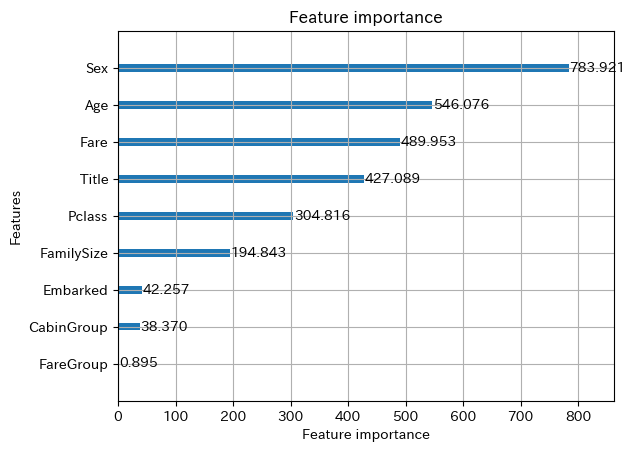

In [29]:
lgb.plot_importance(model, importance_type = 'gain')

In [ ]:
## 結果のsubmit
# pas_id = df_test["PassengerId"].values
# df_test_p, features, _ = preprocess1(df_test)

def pred_test(model, df_test_p, features):
    y_pred = model.predict(df_test_p[features])
    y_pred_binary = [round(value) for value in y_pred]

    data = {
        "PassengerId": pas_id,
        'Survived': y_pred_binary
    }
    df_sub = pd.DataFrame(data)
    
    # データフレームをCSVファイルに書き込む
    timestamp = time.strftime("%Y-%m-%d_%H:%M:%S", time.localtime())
    df_sub.to_csv('./../results/output_{}.csv'.format(timestamp), index=False)
    print("save!", timestamp)
    
pred_test(model, df_test_p, features)

# 特徴量の選択

In [ ]:
df.columns

In [6]:
features = [
            "AgeGroup", 
            "FamilySize", 
            "FareGroup", 
            "CabinGroup", 
            "Embarked", 
            "Title"
]

features = ['Pclass', 'Sex', 'Age', 'SibSp',
       'Parch', 'Ticket', 'Fare', 'Cabin', 'Embarked', 'AgeGroup',
       'FamilySize', 'FareGroup', 'CabinGroup', 'Title']
features = ['Title',  'Embarked', 'Fare', 'Sex', 'Age',  'Pclass', 'FamilySize']
features = ['Pclass', 'Sex', 'Age', 'FamilySize', 'Embarked', "FareGroup"]
df_p, features, target = preprocess2(df, features)
df_p.head()

X = df_p[features]
y = df_p[target]
# 訓練データとテストデータに分割する
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_validation, y_train, y_validation = train_test_split(X, y, test_size=0.2,random_state=0)


params = study.best_params
# インスタンスの作成
evaluation_results = {}
model = lgb.LGBMClassifier(**params)

# モデルの学習
model.fit(
    X_train, 
    y_train,
    eval_set = [(X_train, y_train),(X_validation, y_validation)],
    callbacks=[lgb.early_stopping(100), 
                        lgb.log_evaluation(),
                        lgb.record_evaluation(evaluation_results)]
)

get_acc(model, X_test, y_test)

for feat, imp in zip(features, model.feature_importances_):
    print(feat, "\t", imp)



NameError: name 'study' is not defined

# データの可視化

PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
AgeGroup       178
FamilySize       0
FareGroup        0
CabinGroup       0
Title            0
dtype: int64


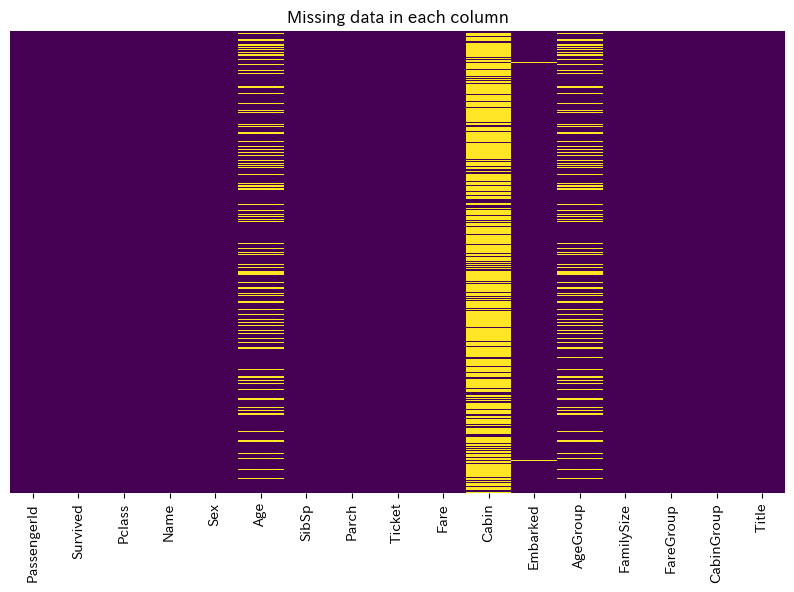

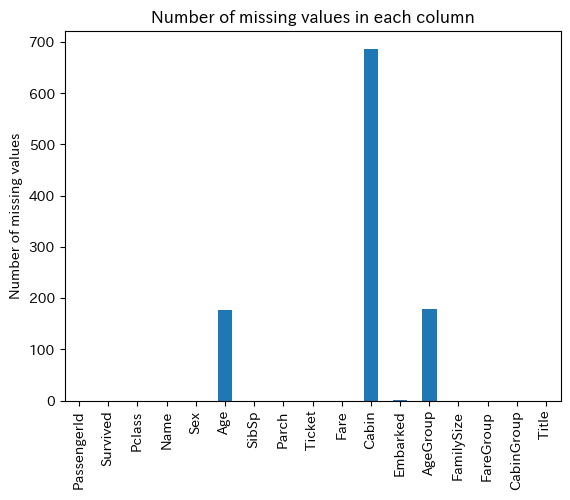

In [13]:
## 欠損値
# 各カラムの欠損値の数を計算
missing_values = df.isnull().sum()

# 欠損値の数を表示
print(missing_values)

# 欠損値の可視化
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(), yticklabels=False, cbar=False, cmap='viridis')
plt.title('Missing data in each column')
plt.show()

# 棒グラフで表示
missing_values.plot(kind='bar')
plt.title('Number of missing values in each column')
plt.ylabel('Number of missing values')
plt.show()

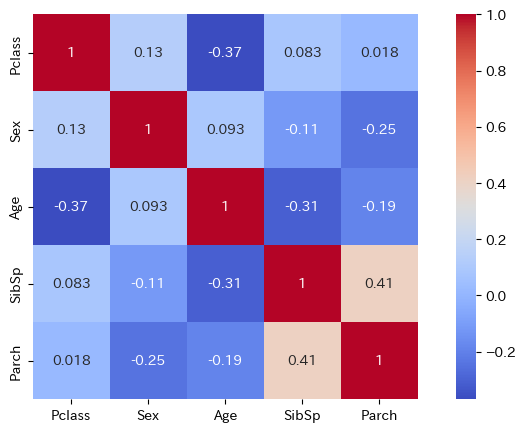

In [14]:
df4corr = df[ ['Pclass', 'Sex', 'Age', 'SibSp', 'Parch']].copy()
# sexカラムの値を変換する
df4corr['Sex'] = df4corr['Sex'].replace({'male': 1, 'female': 0})


corr=df4corr .corr()
plt.figure(figsize=(10,5))
ax = sns.heatmap(corr,annot=True,cmap='coolwarm')
ax.set_aspect('equal')

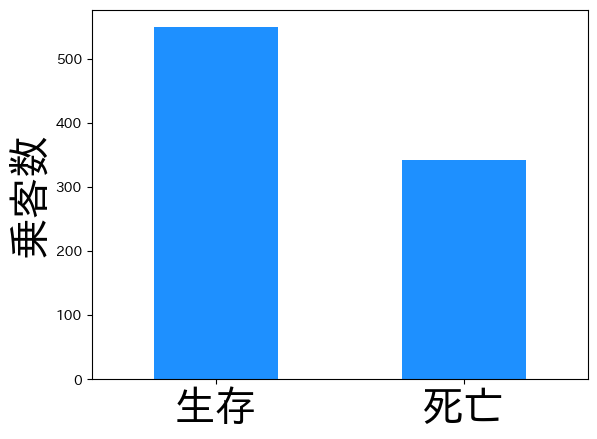

In [7]:
#!pip install japanize-matplotlib
import japanize_matplotlib 
fs = 30
survived_count = df['Survived'].value_counts()
survived_count.plot(kind='bar', color = "dodgerblue")
plt.title('', fontsize = 1)
plt.ylabel('乗客数', fontsize = fs)
plt.xlabel('', fontsize = 1)
plt.xticks([0, 1], ["生存", "死亡"], fontsize = fs, rotation = 0)

plt.show()

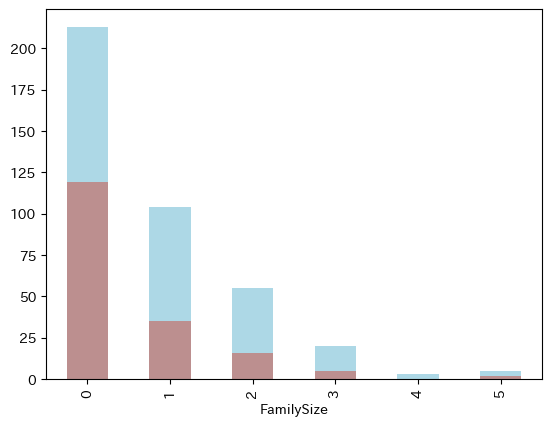

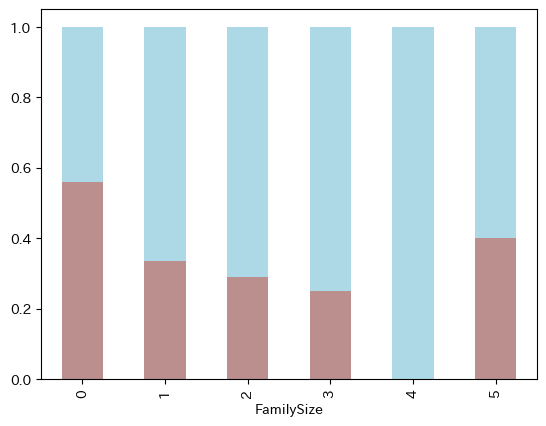

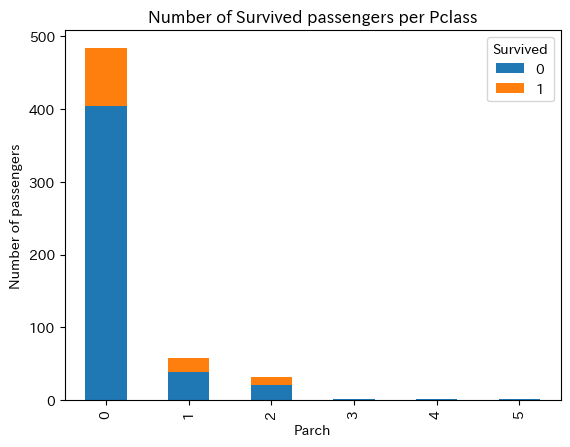

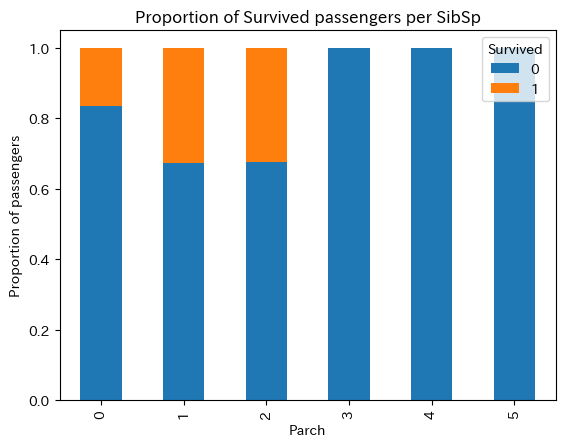

In [18]:
target_sex = "male"
# PclassごとにSurvivedのデータ数を集計
#df_male = df_p[df_p['Sex'] == target_sex]
#survived_count = df_male.groupby('FamilySize')['Survived'].value_counts()
survived_count = df_p[df_p["Pclass"] != 3].groupby('FamilySize')['Survived'].value_counts()

# 棒グラフで表示
survived_count.unstack().plot(kind='bar', stacked=True, color = ["rosybrown", "lightblue"])
plt.title('')
plt.ylabel('')
plt.legend().remove()
plt.show()

# 各Pclassの乗客数で正規化して割合を計算
survived_ratio = survived_count.unstack().apply(lambda x: x/x.sum(), axis=1)

# 棒グラフで表示
survived_ratio.plot(kind='bar', stacked=True, color = ["rosybrown", "lightblue"])
plt.title('')
plt.ylabel('')
plt.legend().remove()

plt.show()


# PclassごとにSurvivedのデータ数を集計
df_male = df[df['Sex'] == target_sex]
survived_count = df_male.groupby('Parch')['Survived'].value_counts()

# 棒グラフで表示
survived_count.unstack().plot(kind='bar', stacked=True)
plt.title('Number of Survived passengers per Pclass')
plt.ylabel('Number of passengers')
plt.show()

# 各Pclassの乗客数で正規化して割合を計算
survived_ratio = survived_count.unstack().apply(lambda x: x/x.sum(), axis=1)

# 棒グラフで表示
survived_ratio.plot(kind='bar', stacked=True)
plt.title('Proportion of Survived passengers per SibSp')
plt.ylabel('Proportion of passengers')
plt.show()

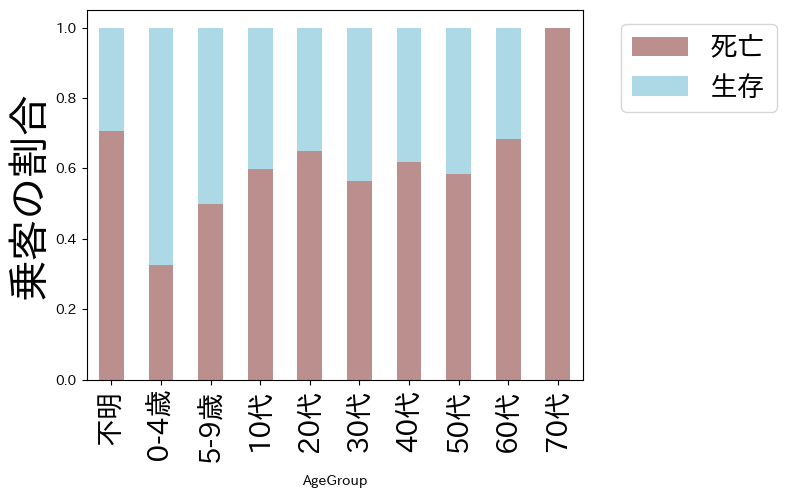

In [19]:
# PclassごとにSurvivedのデータ数を集計
# Ageを年代に集約する
df_ag = df.copy()
df_ag['Age'] = df_ag['Age'].fillna( -5)
#df_ag['AgeGroup'] = pd.cut(df['Age'], bins=[0, 10, 20, 30, 40, 50, 60, 70, 80], labels=[' 00代', '10代', '20代', '30代', '40代', '50代', '60代', '70代', '80代以上'])
df_ag['AgeGroup'] = pd.cut(df_ag['Age'], bins=[-10, 0, 5, 10, 20, 30, 40, 50, 60, 70, 80], 
                                                labels=['不明', ' 0-4歳', '5-9歳', '10代', '20代', '30代', '40代', '50代', '60代', '70代'], right=False)
df_ag

target_col = "Age"
df_ag.sort_values(target_col).head(600)

survived_count = df_ag.groupby('AgeGroup')['Survived'].value_counts()
survived_ratio = survived_count.unstack().apply(lambda x: x/x.sum(), axis=1)

# 棒グラフで表示
survived_ratio.plot(kind='bar', stacked=True, color = ["rosybrown", "lightblue"])
plt.xticks(fontsize = 20, rotation = 90)
#survived_count.plot(kind='bar', stacked=True)
plt.title('')
plt.ylabel('乗客の割合', fontsize = fs)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', labels = ["死亡", "生存"], fontsize = 20)
plt.show()

In [78]:
df.columns
def show_hist(column,  bins = 5, ratio = True, fillna = True, set_bins = None):
        tdf = df.copy()
        if fillna:
            tdf[column] = tdf[column].fillna( -100)
        if set_bins:
            tdf['Group'] = pd.cut(df[column], bins = set_bins)
        else:
            tdf['Group'] = pd.cut(df[column], bins = bins)
        #plt.hist(tdf['Group'])
        survived_count = tdf.groupby('Group')['Survived'].value_counts()
        # 棒グラフで表示
        if ratio: 
            survived_ratio = survived_count.unstack().apply(lambda x: x/x.sum(), axis=1)
            survived_ratio.plot(kind='bar', stacked=True)
        else:
            survived_count.unstack().plot(kind='bar', stacked=True)
        plt.show()
        

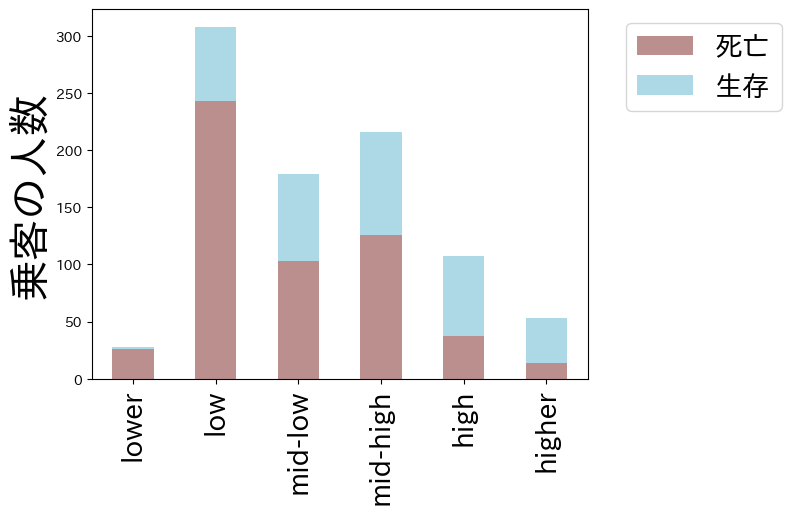

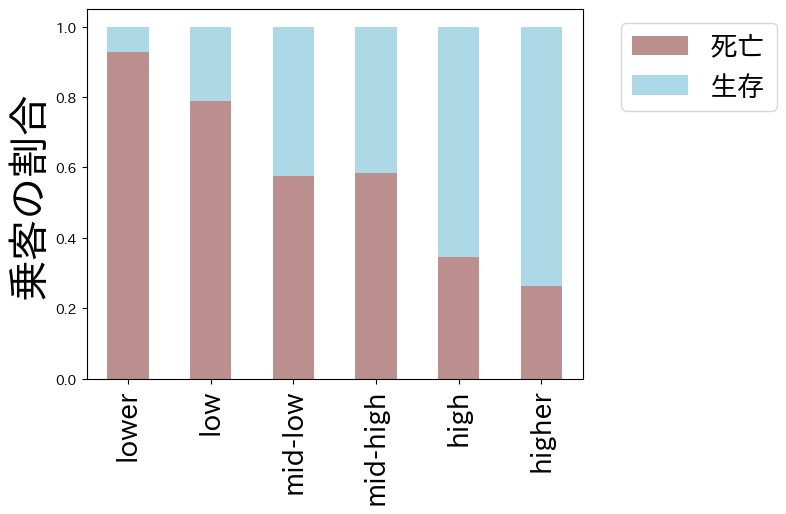

In [20]:
target = "FareGroup"
survived_count = df.groupby(target)['Survived'].value_counts()
survived_count.unstack().plot(kind='bar', stacked=True, color = ["rosybrown", "lightblue"])
plt.title('', fontsize = 1)
plt.ylabel('乗客の人数', fontsize = fs)
plt.xlabel('', fontsize = 1)
plt.xticks(fontsize = 20, rotation = 90)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', labels = ["死亡", "生存"], fontsize = 20)


survived_ratio = survived_count.unstack().apply(lambda x: x/x.sum(), axis=1)
survived_ratio.plot(kind='bar', stacked=True, color = ["rosybrown", "lightblue"])
plt.title('', fontsize = 1)
plt.ylabel('乗客の割合', fontsize = fs)
plt.xlabel('', fontsize = 1)
plt.xticks(fontsize = 20, rotation = 90)
plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left', labels = ["死亡", "生存"], fontsize = 20)


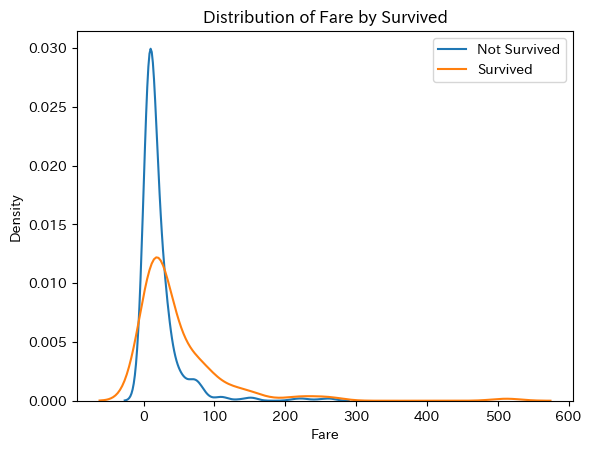

In [15]:
import seaborn as sns

# Fareの分布をなめらかなグラフで描画
#sns.kdeplot(data=df, x='Fare')

# Survivedで分けてFareの分布をなめらかなグラフで描画
#g = sns.FacetGrid(data=df, col='Survived')
#g.map(sns.kdeplot, 'Fare')

import seaborn as sns
import matplotlib.pyplot as plt

# SurvivedごとにFareの分布を描画
sns.kdeplot(data=df[df['Survived'] == 0], x='Fare', label='Not Survived')
sns.kdeplot(data=df[df['Survived'] == 1], x='Fare', label='Survived')

# グラフの設定
plt.xlabel('Fare')
plt.ylabel('Density')
plt.title('Distribution of Fare by Survived')

# 凡例の表示
plt.legend()

# グラフの表示
plt.show()

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# データの準備

def plot(chart_config, title = "title", ctype = "buble", is_show = False,
                 xlabel = "x", ylabel = "y"):
    # プロットの設定
    sns.set(style="whitegrid")
    plt.figure(figsize=(8, 6))
    
    if ctype == "bar":
        # bar chart の描画
        pass
    elif ctype == "bubble":
        # bubble chartの描画
        sns.scatterplot(x = chart_config["x"], y = chart_config["y"], s = chart_config["sizes"] * 100, 
                        color = chart_config["color"], alpha = chart_config["alpha"])
    elif ctype == "beeswarm":
        sns.swarmplot(x = chart_config["x"], # group
                      y = chart_config["y"], # data 
                      palette = chart_config["palette"], alpha = chart_config["alpha"])
    
    # グラフのタイトルと軸ラベルの設定
    fs = 30
    plt.title("", fontsize=1)
    plt.xlabel(xlabel, fontsize=30)
    plt.ylabel(ylabel, fontsize=30)
    plt.xticks([0, 1], ["死亡", "生存"], fontsize = fs, rotation = 0)
    plt.savefig("./../results/{}.png".format(title))
    if is_show:
        plt.show()

    return 

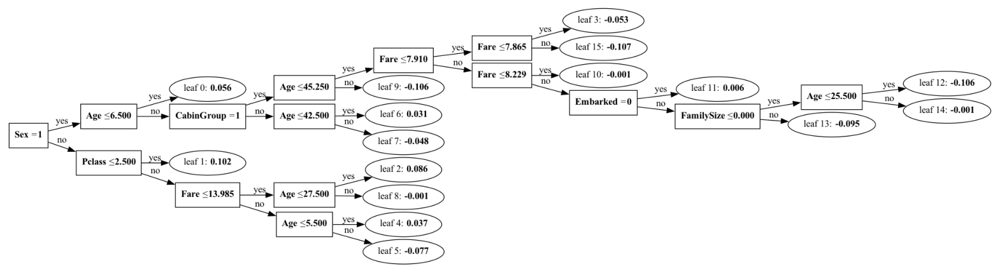

In [37]:
fig = plt.figure(figsize=(20, 10))
ax = fig.add_subplot(111)
lgb.plot_tree(model, tree_index=11, ax=ax)
plt.show()

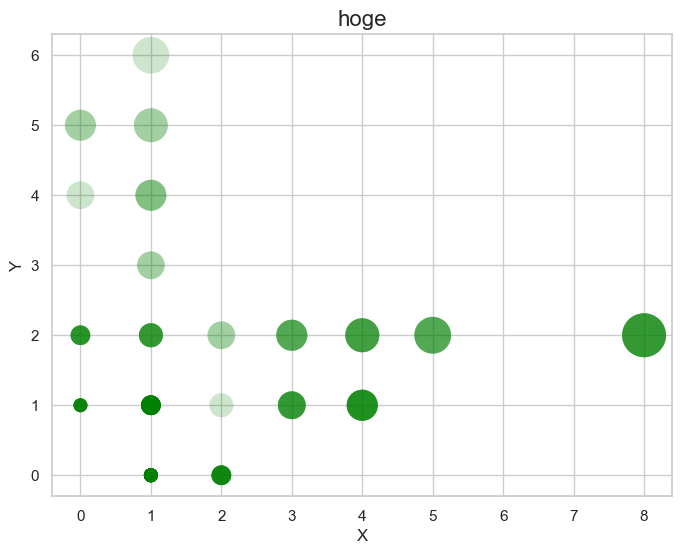

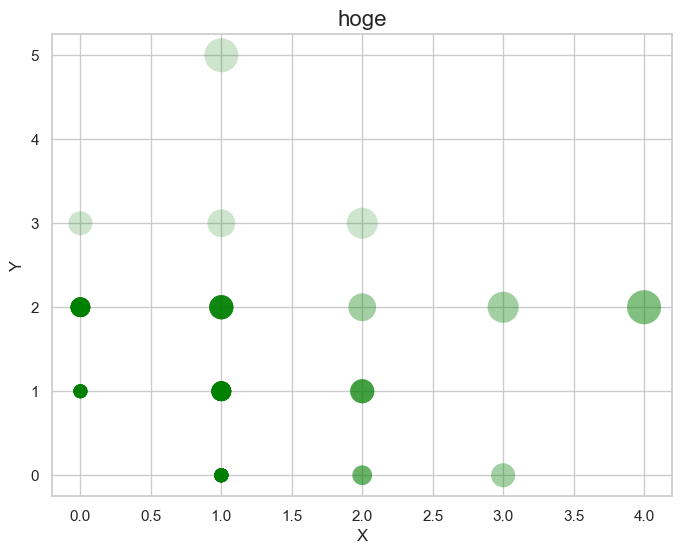

In [54]:
# データの準備
cc = {
    "x" : df_p[df["Survived"] == 0]["SibSp"].values, 
    "y" : df_p[df["Survived"] == 0]["Parch"].values, 
    "sizes" : df_p[df["Survived"] == 0]["FamilySize"].values,
    "color" : "green",
    "alpha" : 0.2
}
# グラフの表示
plot(cc, ctype = "bubble", title = "hoge", is_show = True)

# データの準備
cc = {
    "x" : df_p[df["Survived"] == 1]["SibSp"].values, 
    "y" : df_p[df["Survived"] == 1]["Parch"].values, 
    "sizes" : df_p[df["Survived"] == 1]["FamilySize"].values,
    "color" : "green",
    "alpha" : 0.2
}
# グラフの表示
plot(cc, ctype = "bubble", title = "hoge", is_show = True)

/var/folders/lw/2ldwt6hs7k35sngbft_zdsgw0000gn/T/ipykernel_73965/1951462637.py:20: FutureWarning: Passing `palette` without assigning `hue` is deprecated.
  sns.swarmplot(x = chart_config["x"], # group


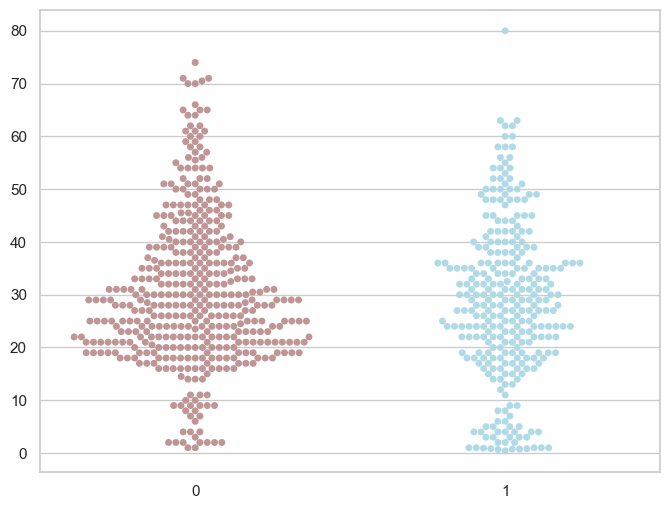

In [24]:
# データの準備
cc = {
    "x" : df_p["Survived"].values, 
    "y" : df_p["Age"].values, 
    "palette" : {"0": "rosybrown", "1": "lightblue"},
    "alpha" : 0.95
}
# グラフの表示
plot(cc, ctype = "beeswarm", title = "hoge", is_show = True,
    xlabel = "", ylabel = "")

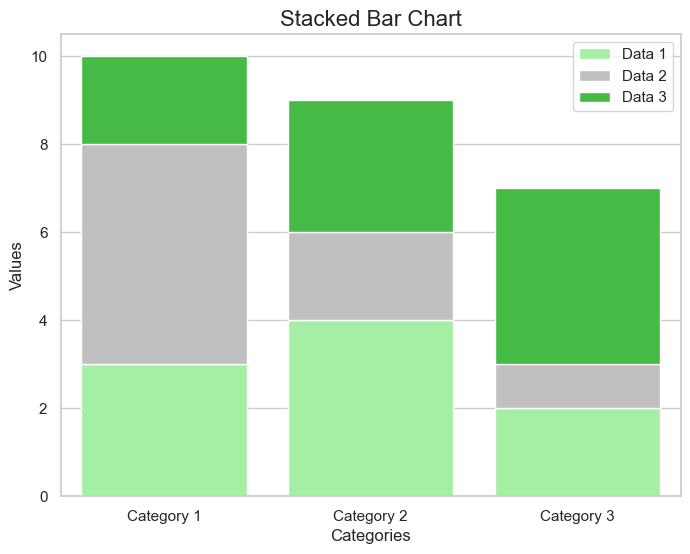

In [66]:
# データの準備
categories = ['Category 1', 'Category 2', 'Category 3']
data = [[3, 4, 2], [5, 2, 1], [2, 3, 4]]

# プロットの設定
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))

# 積み上げ棒グラフの描画
sns.barplot(x=categories, y=data[0], color='palegreen', label='Data 1')
sns.barplot(x=categories, y=data[1], color='silver', bottom=data[0], label='Data 2')
sns.barplot(x=categories, y=data[2], color='limegreen', bottom=[i + j for i, j in zip(data[0], data[1])], label='Data 3')

# グラフのタイトルと軸ラベルの設定
plt.title('Stacked Bar Chart', fontsize=16)
plt.xlabel('Categories', fontsize=12)
plt.ylabel('Values', fontsize=12)

# 凡例の表示
plt.legend()

# グラフの表示
plt.show()

In [84]:
# データセットから男女ごとの生存数を集計
survived_counts = df.groupby(['Sex', 'Survived']).size().unstack()
survived_counts.plot(kind='bar', stacked=True, color = ["silver", "palegreen"])
plt.legend(['Not Survived', 'Survived'], fontsize = 20)

survived_ratio = survived_counts.unstack().apply(lambda x: x/x.sum(), axis=1)
survived_ratio.plot(kind='bar', stacked=True, color =["silver", "palegreen"]


ValueError: Product space too large to allocate arrays!

In [89]:
cc = {
    "x" : df_p["Survived"],
    "y" : df_p["Fare"],
    #"palette" : {0: "orange", 1: "green"},
    "alpha" : 0.7
}
# グラフの表示
plot(cc, ctype = "beeswarm", title = "hogebs", is_show = True)


KeyError: 'palette'

<Figure size 800x600 with 0 Axes>

In [52]:
df_p.head()

df_p[df_p["Survived"] == 0]


,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,AgeGroup,FamilySize,FareGroup,CabinGroup,Title
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S,20代,1,low,True,Mr
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S,30代,0,low,True,Mr
5,6,0,3,"Moran, Mr. James",male,NaN,0,0,330877,8.4583,NaN,Q,NaN,0,low,True,Mr
6,7,0,1,"McCarthy, Mr. Timothy J",male,54.0,0,0,17463,51.8625,E46,S,50代,0,high,False,Mr
7,8,0,3,"Palsson, Master. Gosta Leonard",male,2.0,3,1,349909,21.0750,NaN,S,0-5,4,mid-high,True,Master
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
884,885,0,3,"Sutehall, Mr. Henry Jr",male,25.0,0,0,SOTON/OQ 392076,7.0500,NaN,S,20代,0,low,True,Mr
885,886,0,3,"Rice, Mrs. William (Margaret Norton)",female,39.0,0,5,382652,29.1250,NaN,Q,30代,5,mid-high,True,Mrs
886,887,0,2,"Montvila, Rev. Juozas",male,27.0,0,0,211536,13.0000,NaN,S,20代,0,mid-low,True,Rev
888,889,0,3,"Johnston, Miss. Catherine Helen ""Carrie""",female,NaN,1,2,W./C. 6607,23.4500,NaN,S,NaN,3,mid-high,True,Miss
